In [1]:
import os
import numpy as np
import tensorflow as tf
import pandas as pd 
from Bio import SeqIO
from utils import preprocessing as pre
from sklearn.model_selection import train_test_split
import models
import graphviz
import pydot

In [4]:
# Import data

path = '../Data_Sets/SCOP'
file_name = 'scop_mask_3.fasta'
dict_ = {'id':[] ,'mask':[],'seq':[], 'mask_bin':[], 'seq_bin':[], 'loss_weight':[], 'seq_int':[]}
count = 0
seq_length = 1024
for i, rec in enumerate(SeqIO.parse(os.path.join(path,file_name),'fasta')):
    if i >5000:
        break
    dict_['id'].append(rec.id)
    dict_['mask'].append(rec.description.split('|lcl|')[-1])
    dict_['seq'].append(rec.seq)
    dict_['loss_weight'].append(pre.loss_weight(len(list(rec.seq)),seq_length))
    dict_['mask_bin'].append(pre.to_binary_mask(pre.mask_padding(rec.description.split('|lcl|')[-1], length=seq_length)))
    dict_['seq_bin'].append(pre.zero_padding(pre.to_binary(rec.seq),length=seq_length))
    dict_['seq_int'].append(pre.to_int(rec.seq, max_length=seq_length))

In [5]:
# train test split

X_train, X_test, Y_train, Y_test = train_test_split(np.array(dict_['seq_bin'], dtype = np.int8 ), np.array(dict_['mask_bin'], dtype = np.int8), test_size=0.1, random_state=42)
W_train, W_test, _, mask_r = train_test_split(dict_['loss_weight'], dict_['mask'], test_size=0.1, random_state=42)

In [11]:
p = {'max_seq_len': 1024,
     'num_classes': 3,
     'emb_size': 20,
     'num_filter': [32, 64, 128, 128, 256],
     'kernel_size':[10, 7, 5, 5, 5, 5] ,
     'sampling_stride': [4, 4, 2, 1],
     'pool_size': [2, 2, 2, 2, 2],
     'rate': [0.3, 0.2, 0.3, 0.2, 0.2],
     'l1': [0.0, 0.0, 0.0, 0.0, 0.0, 0.0],
     'l2': [0.0, 0.0, 0.0, 0.0, 0.0, 0.0],
     'use_max_pool': False,
     'learning_rate': 1e-3}

model = models.u_net(p)
cce = tf.keras.losses.CategoricalCrossentropy(from_logits=True)# , sample_weight = w)
add = tf.keras.optimizers.Adam(learning_rate=1e-6,name='Adam')
model.compile(optimizer = add, loss = cce, metrics=['accuracy'], sample_weight_mode="temporal")

es = tf.keras.callbacks.EarlyStopping(monitor='val_loss', min_delta=0, patience=20,restore_best_weights=True)
lr = tf.keras.callbacks.ReduceLROnPlateau(monitor='loss', factor=0.2, patience=10, verbose=1, mode='auto',
min_delta=0.0001, min_lr=0.0000001)

model.fit(X_train, Y_train, batch_size=64, epochs= 300, callbacks= [es, lr], validation_split=0.1, sample_weight = np.array(W_train))
li = model.evaluate(x = X_test, y = Y_test, batch_size=64, verbose=0)
print(li)

build (None, 128, 128)
build (None, 256, 128)
build (None, 512, 64)
  ...
    to  
  ['...']
  ...
    to  
  ['...']
Train on 4050 samples, validate on 450 samples
Epoch 1/300
4050/4050 [==============================] - 8s 2ms/sample - loss: 0.3230 - accuracy: 0.3400 - val_loss: 0.3002 - val_accuracy: 0.0503
Epoch 2/300
4050/4050 [==============================] - 3s 833us/sample - loss: 0.3229 - accuracy: 0.3412 - val_loss: 0.2989 - val_accuracy: 0.1639
Epoch 3/300
4050/4050 [==============================] - 3s 832us/sample - loss: 0.3226 - accuracy: 0.3421 - val_loss: 0.2987 - val_accuracy: 0.2669
Epoch 4/300
4050/4050 [==============================] - 3s 833us/sample - loss: 0.3224 - accuracy: 0.3430 - val_loss: 0.2980 - val_accuracy: 0.5487
Epoch 5/300
4050/4050 [==============================] - 3s 828us/sample - loss: 0.3223 - accuracy: 0.3443 - val_loss: 0.3020 - val_accuracy: 0.4620
Epoch 6/300
4050/4050 [==============================] - 3s 828us/sample - loss: 0.3221 - ac

KeyboardInterrupt: 

In [21]:
from utils import layers
import tensorflow as tf
l1 = layers.DownSampleMod(32, 10, 4)
l2 = layers.DownSampleMod(64, 7, 4)
l3 = layers.DownSampleMod(128, 5, 2)
l4 = layers.DownSampleMod(256, 3, 1)
u1 = layers.UpsampleMod(128, 5, 2)
u2 = layers.UpsampleMod(128, 5, 2)

num_filter = [32 , 64, 128, 256, 512]
size_filter = [10, 7, 5, 5, 3]
sampling_stride = [2,2,2,1]
pool_size = [2,2,2,2,2,2]
rate = [0.1,0.1,0.10, 0.1, 0.1]
l1 = [0.1,0.1,0.10, 0.1, 0.1]
l2 = [0.1,0.1,0.10, 0.1, 0.1]

conv1 =[]
conv2 = []
d_sample = []
for i in range(4):
    conv1.append(tf.keras.layers.Conv1D(num_filter[i], size_filter[i], activation='relu', padding='same'))
    conv2.append(tf.keras.layers.Conv1D(num_filter[i], size_filter[i], activation='relu', padding='same'))
    d_sample.append(tf.keras.layers.Conv1D(num_filter[i], size_filter[i], activation='relu', padding='same', strides = sampling_stride[i]))

conv1u =[]
conv2u = []
u_sample = []
concat = []
for i in range(3):
    concat.append(tf.keras.layers.Concatenate(axis=2))
    conv1u.append(tf.keras.layers.Conv1D(num_filter[i], size_filter[i], activation='relu', padding='same'))
    conv2u.append(tf.keras.layers.Conv1D(num_filter[i], size_filter[i], activation='relu', padding='same'))
    u_sample.append(layers.Conv1DTranspose(num_filter[i], size_filter[i], activation='relu', strides = sampling_stride[i]))

tmp = []
inp = tf.keras.layers.Input(shape=(1024,21))
for i in range(4):
    x = conv1[i](x if i >0 else inp)
    print("build", x)
    enc = conv2[i](x)
    x = d_sample[i](enc)
    tmp.append(enc)
for i in reversed(range(3)):
    x = u_sample[i](x)
    print("build", x)
    x = concat[i]([x, tmp[i]])
    x = conv1u[i](x)
    x = conv2u[i](x)
out = tf.keras.layers.Conv1D(3,5,activation='softmax')(x)        
#inp = tf.keras.layers.Input(shape=(1024,21))
#c = tf.constant(tf.ones((1,32,21)))
#x0, enc0 = l1(inp)
#x1, enc1 = l2(x0)
#x2, enc2 = l3(x1)
#out_c, enc3 = l4(x2)
#print(out_c)
#out = u1(out_c, x1)

model = tf.keras.Model(inputs=inp, outputs=out)

model.summary()

build Tensor("conv1d_525/Identity:0", shape=(None, 1024, 32), dtype=float32)
build Tensor("conv1d_528/Identity:0", shape=(None, 512, 64), dtype=float32)
build Tensor("conv1d_531/Identity:0", shape=(None, 256, 128), dtype=float32)
build Tensor("conv1d_534/Identity:0", shape=(None, 128, 256), dtype=float32)
build (None, 128, 256)
build Tensor("conv1d_transpose_77/Identity:0", shape=(None, 256, 128), dtype=float32)
build (None, 256, 128)
build Tensor("conv1d_transpose_76/Identity:0", shape=(None, 512, 64), dtype=float32)
build (None, 512, 64)
build Tensor("conv1d_transpose_75/Identity:0", shape=(None, 1024, 32), dtype=float32)
Model: "model_4"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_15 (InputLayer)           [(None, 1024, 21)]   0                                            
______________________________________________________

In [6]:
model.summary()
import gc
gc.collect()

Model: "model_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_2 (InputLayer)         [(None, 1024)]            0         
_________________________________________________________________
embedding_1 (Embedding)      (None, 1024, 5)           110       
_________________________________________________________________
u_net_module_1 (UNetModule)  (None, 1024, 256)         4609024   
_________________________________________________________________
conv1d_47 (Conv1D)           (None, 1024, 3)           3843      
Total params: 4,612,977
Trainable params: 4,603,185
Non-trainable params: 9,792
_________________________________________________________________


36

In [3]:
seq_length = 1024
model = models.u_net_module_2(seq_length)
cce = tf.keras.losses.CategoricalCrossentropy(from_logits=True)
add = tf.keras.optimizers.Adam(
    learning_rate=0.0001, beta_1=0.9, beta_2=0.999, epsilon=1e-07, amsgrad=False,
    name='Adam')

opt = tf.keras.optimizers.SGD(
    learning_rate=0.05, momentum=0.9, nesterov=False, name='SGD')
model.load_weights('weights_MaskModel_x_5')
model.compile(optimizer = add, loss = cce, metrics=['accuracy'])



build (None, 128, 128)
build (None, 256, 64)
build (None, 512, 32)
build (None, 128, 128)
build (None, 256, 64)
build (None, 512, 32)


In [47]:
model.summary()


Model: "model_2"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_3 (InputLayer)            [(None, 1000, 21)]   0                                            
__________________________________________________________________________________________________
tf_op_layer_MatMul_2 (TensorFlo [(None, 1000, 5)]    0           input_3[0][0]                    
__________________________________________________________________________________________________
batch_normalization_84 (BatchNo (None, 1000, 5)      20          tf_op_layer_MatMul_2[0][0]       
__________________________________________________________________________________________________
Convolution_Ct0_0 (Conv1D)      (None, 1000, 32)     832         batch_normalization_84[0][0]     
____________________________________________________________________________________________

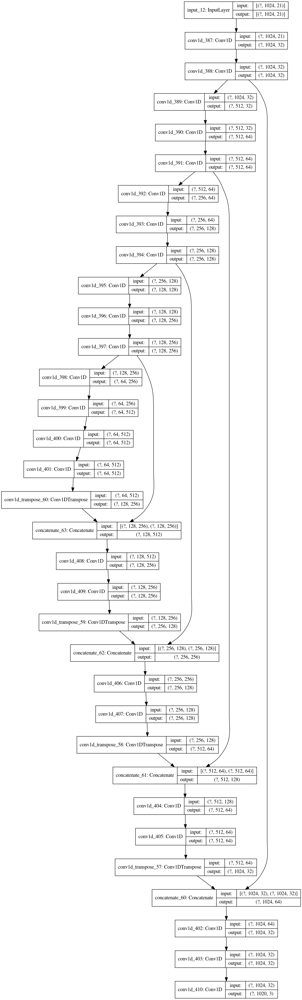

In [17]:

tf.keras.utils.plot_model(model, show_shapes=True)


In [ ]:
# hyper opt
from alg_search import gen_alg
from tensorflow.keras import Model
from tensorflow.keras.layers import Input


n_var = 17
p_space={'n_fil_1':[8,16,20,32,48], 
        's_fil_1':[3,5,7,10],
        'stride_1':[2,4],
        'dOut_1':[0.1,0.2,0.3,0.4],
        'n_fil_2':[32,48,64], 
        's_fil_2':[3,5,7,10],
        'stride_2':[2,4],
        'dOut_2':[0.1,0.2,0.3,0.4],
        'n_fil_3':[64,128,174], 
        's_fil_3':[3,5,7,10],
        'stride_3':[2,4],
        'dOut_3':[0.1,0.4,0.3,0.4],
        'n_fil_4':[128,256,360], 
        's_fil_4':[3,5,7,10],
        'dOut_4':[0.05,0.1,0.2,0.3],
        's_fil_5':[3,5,7,10],
        'dOut_5':[0.05,0.1,0.2]
       }
#obj = gen_alg(p_space, pop_size = 16)

def train(q,p,gpu):
    global X_train, X_test, Y_train, Y_test
    with tf.compat.v1.Session(graph=tf.Graph()) as sess:
        tf.compat.v1.keras.backend.set_session(sess)
        with tf.device(gpu):
            cce = tf.keras.losses.CategoricalCrossentropy(from_logits=True)
            add = tf.keras.optimizers.Adam(learning_rate=0.005,name='Adam')

            model = models.u_net_module(1024, p)
            model.compile(optimizer = add, loss = cce)  
            model.fit(X_train, Y_train, batch_size=128, epochs= 60,verbose=2)
            li = model.evaluate(x = X_test, y = Y_test, batch_size=64, verbose=0)
            q.put(li)
        
for i in range(20):
    rec = np.zeros(16)
    for j in range(0, 16, 2):
            
        p1 = {list(p_space.keys())[k]:obj.pop[j,k] for k in range(17)}
        p2 = {list(p_space.keys())[k]:obj.pop[j+1,k] for k in range(17)}

        #q1 = Queue()
        #p1 = Process(target = train, args=(q1,p1,'/gpu:0'))
        #p1.start()
        strategy = tf.distribute.MirroredStrategy()
        with strategy.scope():
            cce = tf.keras.losses.CategoricalCrossentropy(from_logits=True)
            add = tf.keras.optimizers.Adam(learning_rate=0.005,name='Adam')
            model1 = models.u_net_module(1024, p1)
            model2 = models.u_net_module(1024, p2)
            in1 = Input(shape=(1024,21))
            in2 = Input(shape=(1024,21))
            out1 = model1(in1)
            out2 = model2(in2)
            model = Model(inputs=[in1,in2], outputs=[out1,out2])
            model.compile(optimizer = add, loss = cce)  
            model.fit([X_train,X_train], [Y_train,Y_train], batch_size=128, epochs= 60,verbose=0)
            li = model.evaluate(x = [X_test,X_test], y = [Y_test,Y_test], batch_size=128, verbose=0)
        print(li)
        rec[j] = li[1]
        rec[j+1] = li[2]

    if i <19:
        print('Generation: ', i)
        obj.cross_over(rec)
        obj.mutate()
    else:
        print(rec)
        obj.print_best(rec)
#model.save_weights('weights_MaskModel_x_5')

INFO:tensorflow:Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:0', '/job:localhost/replica:0/task:0/device:GPU:1')
build (None, 32, 256)
build (None, 128, 174)
build (None, 256, 48)
build (None, 64, 256)
build (None, 256, 174)
build (None, 512, 48)
[1.2141677288420172, 0.6068355, 0.6073395]
INFO:tensorflow:Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:0', '/job:localhost/replica:0/task:0/device:GPU:1')
build (None, 16, 256)
build (None, 64, 174)
build (None, 256, 48)
build (None, 128, 256)
build (None, 256, 174)
build (None, 512, 48)
[1.2163634314480056, 0.6049123, 0.6114533]
INFO:tensorflow:Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:0', '/job:localhost/replica:0/task:0/device:GPU:1')
build (None, 32, 128)
build (None, 128, 174)
build (None, 512, 48)
build (None, 16, 360)
build (None, 64, 174)
build (None, 256, 48)
[1.2184362905433928, 0.60837257, 0.6100433]
INFO:tensorflow:Using 

In [5]:
from kerastuner.tuners import BayesianOptimization
tuner = BayesianOptimization(models.u_net_module,
                            objective='val_loss',
                            max_trials=100,
                            executions_per_trial=3,
                            directory='opt_log',
                            project_name='casp14')
tuner.search_space_summary()

build (None, 128, 128)
build (None, 256, 64)
build (None, 512, 32)


In [ ]:
tuner.search(X_train, Y_train,
             epochs=100, batch_size=64,
             validation_data=(X_test, Y_test))

build (None, 32, 256)
build (None, 64, 128)
build (None, 256, 128)
Train on 4500 samples, validate on 501 samples
Epoch 1/100
4500/4500 [==============================] - ETA: 4:32 - loss: 1.0383 - accuracy: 0.50 - ETA: 2:15 - loss: 0.8664 - accuracy: 0.68 - ETA: 1:30 - loss: 0.8089 - accuracy: 0.74 - ETA: 1:07 - loss: 0.7763 - accuracy: 0.77 - ETA: 54s - loss: 0.7580 - accuracy: 0.7898 - ETA: 44s - loss: 0.7434 - accuracy: 0.804 - ETA: 38s - loss: 0.7296 - accuracy: 0.818 - ETA: 33s - loss: 0.7191 - accuracy: 0.829 - ETA: 29s - loss: 0.7100 - accuracy: 0.839 - ETA: 26s - loss: 0.7028 - accuracy: 0.846 - ETA: 23s - loss: 0.6980 - accuracy: 0.851 - ETA: 21s - loss: 0.6932 - accuracy: 0.856 - ETA: 20s - loss: 0.6918 - accuracy: 0.858 - ETA: 18s - loss: 0.6869 - accuracy: 0.863 - ETA: 17s - loss: 0.6841 - accuracy: 0.866 - ETA: 15s - loss: 0.6830 - accuracy: 0.867 - ETA: 14s - loss: 0.6805 - accuracy: 0.869 - ETA: 13s - loss: 0.6787 - accuracy: 0.871 - ETA: 13s - loss: 0.6763 - accuracy: 

4500/4500 [==============================] - ETA: 3s - loss: 0.6042 - accuracy: 0.94 - ETA: 3s - loss: 0.6234 - accuracy: 0.92 - ETA: 3s - loss: 0.6157 - accuracy: 0.93 - ETA: 3s - loss: 0.6165 - accuracy: 0.93 - ETA: 3s - loss: 0.6254 - accuracy: 0.92 - ETA: 3s - loss: 0.6263 - accuracy: 0.92 - ETA: 3s - loss: 0.6236 - accuracy: 0.92 - ETA: 3s - loss: 0.6235 - accuracy: 0.92 - ETA: 3s - loss: 0.6285 - accuracy: 0.92 - ETA: 3s - loss: 0.6272 - accuracy: 0.92 - ETA: 3s - loss: 0.6268 - accuracy: 0.92 - ETA: 3s - loss: 0.6265 - accuracy: 0.92 - ETA: 2s - loss: 0.6252 - accuracy: 0.92 - ETA: 2s - loss: 0.6250 - accuracy: 0.92 - ETA: 2s - loss: 0.6253 - accuracy: 0.92 - ETA: 2s - loss: 0.6257 - accuracy: 0.92 - ETA: 2s - loss: 0.6247 - accuracy: 0.92 - ETA: 2s - loss: 0.6237 - accuracy: 0.92 - ETA: 2s - loss: 0.6241 - accuracy: 0.92 - ETA: 2s - loss: 0.6241 - accuracy: 0.92 - ETA: 2s - loss: 0.6231 - accuracy: 0.92 - ETA: 2s - loss: 0.6227 - accuracy: 0.92 - ETA: 2s - loss: 0.6224 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5949 - accuracy: 0.95 - ETA: 3s - loss: 0.6063 - accuracy: 0.94 - ETA: 3s - loss: 0.6165 - accuracy: 0.93 - ETA: 3s - loss: 0.6165 - accuracy: 0.93 - ETA: 3s - loss: 0.6165 - accuracy: 0.93 - ETA: 3s - loss: 0.6206 - accuracy: 0.93 - ETA: 3s - loss: 0.6206 - accuracy: 0.93 - ETA: 3s - loss: 0.6191 - accuracy: 0.93 - ETA: 3s - loss: 0.6181 - accuracy: 0.93 - ETA: 3s - loss: 0.6191 - accuracy: 0.93 - ETA: 3s - loss: 0.6208 - accuracy: 0.93 - ETA: 3s - loss: 0.6194 - accuracy: 0.93 - ETA: 2s - loss: 0.6208 - accuracy: 0.93 - ETA: 2s - loss: 0.6211 - accuracy: 0.93 - ETA: 2s - loss: 0.6206 - accuracy: 0.93 - ETA: 2s - loss: 0.6212 - accuracy: 0.93 - ETA: 2s - loss: 0.6220 - accuracy: 0.92 - ETA: 2s - loss: 0.6212 - accuracy: 0.93 - ETA: 2s - loss: 0.6213 - accuracy: 0.92 - ETA: 2s - loss: 0.6208 - accuracy: 0.93 - ETA: 2s - loss: 0.6203 - accuracy: 0.93 - ETA: 2s - loss: 0.6205 - accuracy: 0.93 - ETA: 2s - loss: 0.6204 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6039 - accuracy: 0.94 - ETA: 3s - loss: 0.6133 - accuracy: 0.93 - ETA: 3s - loss: 0.6170 - accuracy: 0.93 - ETA: 3s - loss: 0.6173 - accuracy: 0.93 - ETA: 3s - loss: 0.6191 - accuracy: 0.93 - ETA: 3s - loss: 0.6190 - accuracy: 0.93 - ETA: 3s - loss: 0.6180 - accuracy: 0.93 - ETA: 3s - loss: 0.6181 - accuracy: 0.93 - ETA: 3s - loss: 0.6199 - accuracy: 0.93 - ETA: 3s - loss: 0.6188 - accuracy: 0.93 - ETA: 3s - loss: 0.6178 - accuracy: 0.93 - ETA: 3s - loss: 0.6169 - accuracy: 0.93 - ETA: 2s - loss: 0.6173 - accuracy: 0.93 - ETA: 2s - loss: 0.6168 - accuracy: 0.93 - ETA: 2s - loss: 0.6179 - accuracy: 0.93 - ETA: 2s - loss: 0.6184 - accuracy: 0.93 - ETA: 2s - loss: 0.6179 - accuracy: 0.93 - ETA: 2s - loss: 0.6175 - accuracy: 0.93 - ETA: 2s - loss: 0.6182 - accuracy: 0.93 - ETA: 2s - loss: 0.6179 - accuracy: 0.93 - ETA: 2s - loss: 0.6189 - accuracy: 0.93 - ETA: 2s - loss: 0.6189 - accuracy: 0.93 - ETA: 2s - loss: 0.6185 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6357 - accuracy: 0.91 - ETA: 3s - loss: 0.6248 - accuracy: 0.92 - ETA: 3s - loss: 0.6182 - accuracy: 0.93 - ETA: 3s - loss: 0.6191 - accuracy: 0.93 - ETA: 3s - loss: 0.6165 - accuracy: 0.93 - ETA: 3s - loss: 0.6221 - accuracy: 0.92 - ETA: 3s - loss: 0.6224 - accuracy: 0.92 - ETA: 3s - loss: 0.6199 - accuracy: 0.93 - ETA: 3s - loss: 0.6197 - accuracy: 0.93 - ETA: 3s - loss: 0.6193 - accuracy: 0.93 - ETA: 3s - loss: 0.6182 - accuracy: 0.93 - ETA: 3s - loss: 0.6172 - accuracy: 0.93 - ETA: 2s - loss: 0.6182 - accuracy: 0.93 - ETA: 2s - loss: 0.6187 - accuracy: 0.93 - ETA: 2s - loss: 0.6184 - accuracy: 0.93 - ETA: 2s - loss: 0.6195 - accuracy: 0.93 - ETA: 2s - loss: 0.6190 - accuracy: 0.93 - ETA: 2s - loss: 0.6191 - accuracy: 0.93 - ETA: 2s - loss: 0.6188 - accuracy: 0.93 - ETA: 2s - loss: 0.6184 - accuracy: 0.93 - ETA: 2s - loss: 0.6189 - accuracy: 0.93 - ETA: 2s - loss: 0.6194 - accuracy: 0.93 - ETA: 2s - loss: 0.6192 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6118 - accuracy: 0.93 - ETA: 3s - loss: 0.6085 - accuracy: 0.94 - ETA: 3s - loss: 0.6032 - accuracy: 0.94 - ETA: 3s - loss: 0.5996 - accuracy: 0.95 - ETA: 3s - loss: 0.6038 - accuracy: 0.94 - ETA: 3s - loss: 0.6039 - accuracy: 0.94 - ETA: 3s - loss: 0.6038 - accuracy: 0.94 - ETA: 3s - loss: 0.6033 - accuracy: 0.94 - ETA: 3s - loss: 0.6030 - accuracy: 0.94 - ETA: 3s - loss: 0.6015 - accuracy: 0.94 - ETA: 3s - loss: 0.6023 - accuracy: 0.94 - ETA: 3s - loss: 0.6006 - accuracy: 0.95 - ETA: 2s - loss: 0.6009 - accuracy: 0.95 - ETA: 2s - loss: 0.5998 - accuracy: 0.95 - ETA: 2s - loss: 0.5996 - accuracy: 0.95 - ETA: 2s - loss: 0.5989 - accuracy: 0.95 - ETA: 2s - loss: 0.5986 - accuracy: 0.95 - ETA: 2s - loss: 0.5980 - accuracy: 0.95 - ETA: 2s - loss: 0.5988 - accuracy: 0.95 - ETA: 2s - loss: 0.5979 - accuracy: 0.95 - ETA: 2s - loss: 0.5980 - accuracy: 0.95 - ETA: 2s - loss: 0.5979 - accuracy: 0.95 - ETA: 2s - loss: 0.5980 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6070 - accuracy: 0.94 - ETA: 3s - loss: 0.6008 - accuracy: 0.95 - ETA: 3s - loss: 0.6026 - accuracy: 0.94 - ETA: 3s - loss: 0.5978 - accuracy: 0.95 - ETA: 3s - loss: 0.5958 - accuracy: 0.95 - ETA: 3s - loss: 0.5954 - accuracy: 0.95 - ETA: 3s - loss: 0.5941 - accuracy: 0.95 - ETA: 3s - loss: 0.5921 - accuracy: 0.95 - ETA: 3s - loss: 0.5906 - accuracy: 0.96 - ETA: 3s - loss: 0.5908 - accuracy: 0.96 - ETA: 3s - loss: 0.5917 - accuracy: 0.95 - ETA: 3s - loss: 0.5930 - accuracy: 0.95 - ETA: 2s - loss: 0.5928 - accuracy: 0.95 - ETA: 2s - loss: 0.5925 - accuracy: 0.95 - ETA: 2s - loss: 0.5921 - accuracy: 0.95 - ETA: 2s - loss: 0.5917 - accuracy: 0.95 - ETA: 2s - loss: 0.5918 - accuracy: 0.95 - ETA: 2s - loss: 0.5917 - accuracy: 0.95 - ETA: 2s - loss: 0.5913 - accuracy: 0.95 - ETA: 2s - loss: 0.5912 - accuracy: 0.95 - ETA: 2s - loss: 0.5914 - accuracy: 0.95 - ETA: 2s - loss: 0.5916 - accuracy: 0.95 - ETA: 2s - loss: 0.5915 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5868 - accuracy: 0.96 - ETA: 3s - loss: 0.5834 - accuracy: 0.96 - ETA: 3s - loss: 0.5866 - accuracy: 0.96 - ETA: 3s - loss: 0.5882 - accuracy: 0.96 - ETA: 3s - loss: 0.5875 - accuracy: 0.96 - ETA: 3s - loss: 0.5874 - accuracy: 0.96 - ETA: 3s - loss: 0.5887 - accuracy: 0.96 - ETA: 3s - loss: 0.5893 - accuracy: 0.96 - ETA: 3s - loss: 0.5903 - accuracy: 0.96 - ETA: 3s - loss: 0.5891 - accuracy: 0.96 - ETA: 3s - loss: 0.5888 - accuracy: 0.96 - ETA: 3s - loss: 0.5882 - accuracy: 0.96 - ETA: 2s - loss: 0.5878 - accuracy: 0.96 - ETA: 2s - loss: 0.5880 - accuracy: 0.96 - ETA: 2s - loss: 0.5883 - accuracy: 0.96 - ETA: 2s - loss: 0.5874 - accuracy: 0.96 - ETA: 2s - loss: 0.5875 - accuracy: 0.96 - ETA: 2s - loss: 0.5877 - accuracy: 0.96 - ETA: 2s - loss: 0.5884 - accuracy: 0.96 - ETA: 2s - loss: 0.5882 - accuracy: 0.96 - ETA: 2s - loss: 0.5887 - accuracy: 0.96 - ETA: 2s - loss: 0.5881 - accuracy: 0.96 - ETA: 2s - loss: 0.5883 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5691 - accuracy: 0.98 - ETA: 3s - loss: 0.5817 - accuracy: 0.96 - ETA: 3s - loss: 0.5832 - accuracy: 0.96 - ETA: 3s - loss: 0.5844 - accuracy: 0.96 - ETA: 3s - loss: 0.5831 - accuracy: 0.96 - ETA: 3s - loss: 0.5845 - accuracy: 0.96 - ETA: 3s - loss: 0.5838 - accuracy: 0.96 - ETA: 3s - loss: 0.5853 - accuracy: 0.96 - ETA: 3s - loss: 0.5868 - accuracy: 0.96 - ETA: 3s - loss: 0.5871 - accuracy: 0.96 - ETA: 3s - loss: 0.5877 - accuracy: 0.96 - ETA: 3s - loss: 0.5878 - accuracy: 0.96 - ETA: 2s - loss: 0.5873 - accuracy: 0.96 - ETA: 2s - loss: 0.5876 - accuracy: 0.96 - ETA: 2s - loss: 0.5872 - accuracy: 0.96 - ETA: 2s - loss: 0.5873 - accuracy: 0.96 - ETA: 2s - loss: 0.5876 - accuracy: 0.96 - ETA: 2s - loss: 0.5874 - accuracy: 0.96 - ETA: 2s - loss: 0.5879 - accuracy: 0.96 - ETA: 2s - loss: 0.5882 - accuracy: 0.96 - ETA: 2s - loss: 0.5885 - accuracy: 0.96 - ETA: 2s - loss: 0.5883 - accuracy: 0.96 - ETA: 2s - loss: 0.5885 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5730 - accuracy: 0.97 - ETA: 3s - loss: 0.5810 - accuracy: 0.97 - ETA: 3s - loss: 0.5827 - accuracy: 0.96 - ETA: 3s - loss: 0.5841 - accuracy: 0.96 - ETA: 3s - loss: 0.5832 - accuracy: 0.96 - ETA: 3s - loss: 0.5831 - accuracy: 0.96 - ETA: 3s - loss: 0.5843 - accuracy: 0.96 - ETA: 3s - loss: 0.5834 - accuracy: 0.96 - ETA: 3s - loss: 0.5843 - accuracy: 0.96 - ETA: 3s - loss: 0.5834 - accuracy: 0.96 - ETA: 3s - loss: 0.5829 - accuracy: 0.96 - ETA: 3s - loss: 0.5839 - accuracy: 0.96 - ETA: 2s - loss: 0.5841 - accuracy: 0.96 - ETA: 2s - loss: 0.5847 - accuracy: 0.96 - ETA: 2s - loss: 0.5854 - accuracy: 0.96 - ETA: 2s - loss: 0.5857 - accuracy: 0.96 - ETA: 2s - loss: 0.5857 - accuracy: 0.96 - ETA: 2s - loss: 0.5850 - accuracy: 0.96 - ETA: 2s - loss: 0.5849 - accuracy: 0.96 - ETA: 2s - loss: 0.5854 - accuracy: 0.96 - ETA: 2s - loss: 0.5861 - accuracy: 0.96 - ETA: 2s - loss: 0.5867 - accuracy: 0.96 - ETA: 2s - loss: 0.5862 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5820 - accuracy: 0.96 - ETA: 3s - loss: 0.5857 - accuracy: 0.96 - ETA: 3s - loss: 0.5857 - accuracy: 0.96 - ETA: 3s - loss: 0.5841 - accuracy: 0.96 - ETA: 3s - loss: 0.5860 - accuracy: 0.96 - ETA: 3s - loss: 0.5858 - accuracy: 0.96 - ETA: 3s - loss: 0.5884 - accuracy: 0.96 - ETA: 3s - loss: 0.5863 - accuracy: 0.96 - ETA: 3s - loss: 0.5863 - accuracy: 0.96 - ETA: 3s - loss: 0.5853 - accuracy: 0.96 - ETA: 3s - loss: 0.5868 - accuracy: 0.96 - ETA: 3s - loss: 0.5857 - accuracy: 0.96 - ETA: 2s - loss: 0.5858 - accuracy: 0.96 - ETA: 2s - loss: 0.5856 - accuracy: 0.96 - ETA: 2s - loss: 0.5850 - accuracy: 0.96 - ETA: 2s - loss: 0.5842 - accuracy: 0.96 - ETA: 2s - loss: 0.5843 - accuracy: 0.96 - ETA: 2s - loss: 0.5845 - accuracy: 0.96 - ETA: 2s - loss: 0.5838 - accuracy: 0.96 - ETA: 2s - loss: 0.5842 - accuracy: 0.96 - ETA: 2s - loss: 0.5843 - accuracy: 0.96 - ETA: 2s - loss: 0.5840 - accuracy: 0.96 - ETA: 2s - loss: 0.5842 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5715 - accuracy: 0.97 - ETA: 3s - loss: 0.5759 - accuracy: 0.97 - ETA: 3s - loss: 0.5758 - accuracy: 0.97 - ETA: 3s - loss: 0.5757 - accuracy: 0.97 - ETA: 3s - loss: 0.5777 - accuracy: 0.97 - ETA: 3s - loss: 0.5773 - accuracy: 0.97 - ETA: 3s - loss: 0.5768 - accuracy: 0.97 - ETA: 3s - loss: 0.5772 - accuracy: 0.97 - ETA: 3s - loss: 0.5780 - accuracy: 0.97 - ETA: 3s - loss: 0.5796 - accuracy: 0.97 - ETA: 3s - loss: 0.5791 - accuracy: 0.97 - ETA: 3s - loss: 0.5800 - accuracy: 0.97 - ETA: 2s - loss: 0.5792 - accuracy: 0.97 - ETA: 2s - loss: 0.5800 - accuracy: 0.97 - ETA: 2s - loss: 0.5802 - accuracy: 0.97 - ETA: 2s - loss: 0.5806 - accuracy: 0.97 - ETA: 2s - loss: 0.5810 - accuracy: 0.97 - ETA: 2s - loss: 0.5811 - accuracy: 0.97 - ETA: 2s - loss: 0.5814 - accuracy: 0.96 - ETA: 2s - loss: 0.5814 - accuracy: 0.96 - ETA: 2s - loss: 0.5820 - accuracy: 0.96 - ETA: 2s - loss: 0.5825 - accuracy: 0.96 - ETA: 2s - loss: 0.5822 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5880 - accuracy: 0.96 - ETA: 3s - loss: 0.5815 - accuracy: 0.96 - ETA: 3s - loss: 0.5814 - accuracy: 0.96 - ETA: 3s - loss: 0.5808 - accuracy: 0.97 - ETA: 3s - loss: 0.5825 - accuracy: 0.96 - ETA: 3s - loss: 0.5826 - accuracy: 0.96 - ETA: 3s - loss: 0.5836 - accuracy: 0.96 - ETA: 3s - loss: 0.5827 - accuracy: 0.96 - ETA: 3s - loss: 0.5812 - accuracy: 0.96 - ETA: 3s - loss: 0.5812 - accuracy: 0.96 - ETA: 3s - loss: 0.5807 - accuracy: 0.97 - ETA: 3s - loss: 0.5806 - accuracy: 0.97 - ETA: 2s - loss: 0.5810 - accuracy: 0.97 - ETA: 2s - loss: 0.5815 - accuracy: 0.96 - ETA: 2s - loss: 0.5812 - accuracy: 0.97 - ETA: 2s - loss: 0.5810 - accuracy: 0.97 - ETA: 2s - loss: 0.5813 - accuracy: 0.96 - ETA: 2s - loss: 0.5817 - accuracy: 0.96 - ETA: 2s - loss: 0.5811 - accuracy: 0.97 - ETA: 2s - loss: 0.5804 - accuracy: 0.97 - ETA: 2s - loss: 0.5805 - accuracy: 0.97 - ETA: 2s - loss: 0.5805 - accuracy: 0.97 - ETA: 2s - loss: 0.5810 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5685 - accuracy: 0.98 - ETA: 3s - loss: 0.5818 - accuracy: 0.96 - ETA: 3s - loss: 0.5831 - accuracy: 0.96 - ETA: 3s - loss: 0.5839 - accuracy: 0.96 - ETA: 3s - loss: 0.5836 - accuracy: 0.96 - ETA: 3s - loss: 0.5842 - accuracy: 0.96 - ETA: 3s - loss: 0.5831 - accuracy: 0.96 - ETA: 3s - loss: 0.5820 - accuracy: 0.96 - ETA: 3s - loss: 0.5820 - accuracy: 0.96 - ETA: 3s - loss: 0.5815 - accuracy: 0.96 - ETA: 3s - loss: 0.5818 - accuracy: 0.96 - ETA: 3s - loss: 0.5811 - accuracy: 0.97 - ETA: 2s - loss: 0.5810 - accuracy: 0.97 - ETA: 2s - loss: 0.5816 - accuracy: 0.96 - ETA: 2s - loss: 0.5819 - accuracy: 0.96 - ETA: 2s - loss: 0.5813 - accuracy: 0.96 - ETA: 2s - loss: 0.5812 - accuracy: 0.97 - ETA: 2s - loss: 0.5812 - accuracy: 0.97 - ETA: 2s - loss: 0.5813 - accuracy: 0.96 - ETA: 2s - loss: 0.5820 - accuracy: 0.96 - ETA: 2s - loss: 0.5823 - accuracy: 0.96 - ETA: 2s - loss: 0.5821 - accuracy: 0.96 - ETA: 2s - loss: 0.5821 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5776 - accuracy: 0.97 - ETA: 3s - loss: 0.5808 - accuracy: 0.97 - ETA: 3s - loss: 0.5820 - accuracy: 0.96 - ETA: 3s - loss: 0.5825 - accuracy: 0.96 - ETA: 3s - loss: 0.5817 - accuracy: 0.96 - ETA: 3s - loss: 0.5802 - accuracy: 0.97 - ETA: 3s - loss: 0.5812 - accuracy: 0.97 - ETA: 3s - loss: 0.5805 - accuracy: 0.97 - ETA: 3s - loss: 0.5811 - accuracy: 0.97 - ETA: 3s - loss: 0.5798 - accuracy: 0.97 - ETA: 3s - loss: 0.5804 - accuracy: 0.97 - ETA: 3s - loss: 0.5799 - accuracy: 0.97 - ETA: 2s - loss: 0.5799 - accuracy: 0.97 - ETA: 2s - loss: 0.5801 - accuracy: 0.97 - ETA: 2s - loss: 0.5803 - accuracy: 0.97 - ETA: 2s - loss: 0.5808 - accuracy: 0.97 - ETA: 2s - loss: 0.5808 - accuracy: 0.97 - ETA: 2s - loss: 0.5804 - accuracy: 0.97 - ETA: 2s - loss: 0.5807 - accuracy: 0.97 - ETA: 2s - loss: 0.5806 - accuracy: 0.97 - ETA: 2s - loss: 0.5803 - accuracy: 0.97 - ETA: 2s - loss: 0.5804 - accuracy: 0.97 - ETA: 2s - loss: 0.5812 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5772 - accuracy: 0.97 - ETA: 3s - loss: 0.5755 - accuracy: 0.97 - ETA: 3s - loss: 0.5758 - accuracy: 0.97 - ETA: 3s - loss: 0.5752 - accuracy: 0.97 - ETA: 3s - loss: 0.5756 - accuracy: 0.97 - ETA: 3s - loss: 0.5750 - accuracy: 0.97 - ETA: 3s - loss: 0.5750 - accuracy: 0.97 - ETA: 3s - loss: 0.5757 - accuracy: 0.97 - ETA: 3s - loss: 0.5759 - accuracy: 0.97 - ETA: 3s - loss: 0.5767 - accuracy: 0.97 - ETA: 3s - loss: 0.5777 - accuracy: 0.97 - ETA: 3s - loss: 0.5783 - accuracy: 0.97 - ETA: 2s - loss: 0.5784 - accuracy: 0.97 - ETA: 2s - loss: 0.5784 - accuracy: 0.97 - ETA: 2s - loss: 0.5780 - accuracy: 0.97 - ETA: 2s - loss: 0.5788 - accuracy: 0.97 - ETA: 2s - loss: 0.5784 - accuracy: 0.97 - ETA: 2s - loss: 0.5781 - accuracy: 0.97 - ETA: 2s - loss: 0.5779 - accuracy: 0.97 - ETA: 2s - loss: 0.5785 - accuracy: 0.97 - ETA: 2s - loss: 0.5784 - accuracy: 0.97 - ETA: 2s - loss: 0.5787 - accuracy: 0.97 - ETA: 2s - loss: 0.5785 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5753 - accuracy: 0.97 - ETA: 3s - loss: 0.5799 - accuracy: 0.97 - ETA: 3s - loss: 0.5785 - accuracy: 0.97 - ETA: 3s - loss: 0.5797 - accuracy: 0.97 - ETA: 3s - loss: 0.5785 - accuracy: 0.97 - ETA: 3s - loss: 0.5790 - accuracy: 0.97 - ETA: 3s - loss: 0.5793 - accuracy: 0.97 - ETA: 3s - loss: 0.5796 - accuracy: 0.97 - ETA: 3s - loss: 0.5793 - accuracy: 0.97 - ETA: 3s - loss: 0.5791 - accuracy: 0.97 - ETA: 3s - loss: 0.5799 - accuracy: 0.97 - ETA: 3s - loss: 0.5795 - accuracy: 0.97 - ETA: 3s - loss: 0.5793 - accuracy: 0.97 - ETA: 2s - loss: 0.5785 - accuracy: 0.97 - ETA: 2s - loss: 0.5788 - accuracy: 0.97 - ETA: 2s - loss: 0.5786 - accuracy: 0.97 - ETA: 2s - loss: 0.5787 - accuracy: 0.97 - ETA: 2s - loss: 0.5786 - accuracy: 0.97 - ETA: 2s - loss: 0.5783 - accuracy: 0.97 - ETA: 2s - loss: 0.5778 - accuracy: 0.97 - ETA: 2s - loss: 0.5780 - accuracy: 0.97 - ETA: 2s - loss: 0.5780 - accuracy: 0.97 - ETA: 2s - loss: 0.5785 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5851 - accuracy: 0.96 - ETA: 3s - loss: 0.5895 - accuracy: 0.96 - ETA: 3s - loss: 0.5828 - accuracy: 0.96 - ETA: 3s - loss: 0.5817 - accuracy: 0.96 - ETA: 3s - loss: 0.5828 - accuracy: 0.96 - ETA: 3s - loss: 0.5821 - accuracy: 0.96 - ETA: 3s - loss: 0.5805 - accuracy: 0.97 - ETA: 3s - loss: 0.5799 - accuracy: 0.97 - ETA: 3s - loss: 0.5798 - accuracy: 0.97 - ETA: 3s - loss: 0.5798 - accuracy: 0.97 - ETA: 3s - loss: 0.5791 - accuracy: 0.97 - ETA: 3s - loss: 0.5783 - accuracy: 0.97 - ETA: 2s - loss: 0.5784 - accuracy: 0.97 - ETA: 2s - loss: 0.5781 - accuracy: 0.97 - ETA: 2s - loss: 0.5784 - accuracy: 0.97 - ETA: 2s - loss: 0.5787 - accuracy: 0.97 - ETA: 2s - loss: 0.5784 - accuracy: 0.97 - ETA: 2s - loss: 0.5784 - accuracy: 0.97 - ETA: 2s - loss: 0.5784 - accuracy: 0.97 - ETA: 2s - loss: 0.5783 - accuracy: 0.97 - ETA: 2s - loss: 0.5785 - accuracy: 0.97 - ETA: 2s - loss: 0.5790 - accuracy: 0.97 - ETA: 2s - loss: 0.5792 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5738 - accuracy: 0.97 - ETA: 3s - loss: 0.5748 - accuracy: 0.97 - ETA: 3s - loss: 0.5730 - accuracy: 0.97 - ETA: 3s - loss: 0.5758 - accuracy: 0.97 - ETA: 3s - loss: 0.5766 - accuracy: 0.97 - ETA: 3s - loss: 0.5768 - accuracy: 0.97 - ETA: 3s - loss: 0.5790 - accuracy: 0.97 - ETA: 3s - loss: 0.5787 - accuracy: 0.97 - ETA: 3s - loss: 0.5786 - accuracy: 0.97 - ETA: 3s - loss: 0.5791 - accuracy: 0.97 - ETA: 3s - loss: 0.5796 - accuracy: 0.97 - ETA: 3s - loss: 0.5786 - accuracy: 0.97 - ETA: 2s - loss: 0.5792 - accuracy: 0.97 - ETA: 2s - loss: 0.5788 - accuracy: 0.97 - ETA: 2s - loss: 0.5789 - accuracy: 0.97 - ETA: 2s - loss: 0.5785 - accuracy: 0.97 - ETA: 2s - loss: 0.5784 - accuracy: 0.97 - ETA: 2s - loss: 0.5784 - accuracy: 0.97 - ETA: 2s - loss: 0.5784 - accuracy: 0.97 - ETA: 2s - loss: 0.5789 - accuracy: 0.97 - ETA: 2s - loss: 0.5791 - accuracy: 0.97 - ETA: 2s - loss: 0.5784 - accuracy: 0.97 - ETA: 2s - loss: 0.5781 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5850 - accuracy: 0.96 - ETA: 3s - loss: 0.5838 - accuracy: 0.96 - ETA: 3s - loss: 0.5818 - accuracy: 0.96 - ETA: 3s - loss: 0.5812 - accuracy: 0.96 - ETA: 3s - loss: 0.5793 - accuracy: 0.97 - ETA: 3s - loss: 0.5789 - accuracy: 0.97 - ETA: 3s - loss: 0.5802 - accuracy: 0.97 - ETA: 3s - loss: 0.5797 - accuracy: 0.97 - ETA: 3s - loss: 0.5796 - accuracy: 0.97 - ETA: 3s - loss: 0.5786 - accuracy: 0.97 - ETA: 3s - loss: 0.5786 - accuracy: 0.97 - ETA: 3s - loss: 0.5792 - accuracy: 0.97 - ETA: 2s - loss: 0.5792 - accuracy: 0.97 - ETA: 2s - loss: 0.5791 - accuracy: 0.97 - ETA: 2s - loss: 0.5799 - accuracy: 0.97 - ETA: 2s - loss: 0.5801 - accuracy: 0.97 - ETA: 2s - loss: 0.5794 - accuracy: 0.97 - ETA: 2s - loss: 0.5797 - accuracy: 0.97 - ETA: 2s - loss: 0.5796 - accuracy: 0.97 - ETA: 2s - loss: 0.5795 - accuracy: 0.97 - ETA: 2s - loss: 0.5794 - accuracy: 0.97 - ETA: 2s - loss: 0.5791 - accuracy: 0.97 - ETA: 2s - loss: 0.5790 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5787 - accuracy: 0.97 - ETA: 3s - loss: 0.5749 - accuracy: 0.97 - ETA: 3s - loss: 0.5763 - accuracy: 0.97 - ETA: 3s - loss: 0.5758 - accuracy: 0.97 - ETA: 3s - loss: 0.5766 - accuracy: 0.97 - ETA: 3s - loss: 0.5755 - accuracy: 0.97 - ETA: 3s - loss: 0.5751 - accuracy: 0.97 - ETA: 3s - loss: 0.5752 - accuracy: 0.97 - ETA: 3s - loss: 0.5768 - accuracy: 0.97 - ETA: 3s - loss: 0.5769 - accuracy: 0.97 - ETA: 3s - loss: 0.5770 - accuracy: 0.97 - ETA: 3s - loss: 0.5767 - accuracy: 0.97 - ETA: 2s - loss: 0.5774 - accuracy: 0.97 - ETA: 2s - loss: 0.5770 - accuracy: 0.97 - ETA: 2s - loss: 0.5770 - accuracy: 0.97 - ETA: 2s - loss: 0.5775 - accuracy: 0.97 - ETA: 2s - loss: 0.5772 - accuracy: 0.97 - ETA: 2s - loss: 0.5774 - accuracy: 0.97 - ETA: 2s - loss: 0.5775 - accuracy: 0.97 - ETA: 2s - loss: 0.5774 - accuracy: 0.97 - ETA: 2s - loss: 0.5773 - accuracy: 0.97 - ETA: 2s - loss: 0.5772 - accuracy: 0.97 - ETA: 2s - loss: 0.5770 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5649 - accuracy: 0.98 - ETA: 3s - loss: 0.5705 - accuracy: 0.98 - ETA: 3s - loss: 0.5688 - accuracy: 0.98 - ETA: 3s - loss: 0.5698 - accuracy: 0.98 - ETA: 3s - loss: 0.5706 - accuracy: 0.98 - ETA: 3s - loss: 0.5714 - accuracy: 0.97 - ETA: 3s - loss: 0.5717 - accuracy: 0.97 - ETA: 3s - loss: 0.5727 - accuracy: 0.97 - ETA: 3s - loss: 0.5724 - accuracy: 0.97 - ETA: 3s - loss: 0.5734 - accuracy: 0.97 - ETA: 3s - loss: 0.5736 - accuracy: 0.97 - ETA: 3s - loss: 0.5737 - accuracy: 0.97 - ETA: 2s - loss: 0.5738 - accuracy: 0.97 - ETA: 2s - loss: 0.5737 - accuracy: 0.97 - ETA: 2s - loss: 0.5738 - accuracy: 0.97 - ETA: 2s - loss: 0.5737 - accuracy: 0.97 - ETA: 2s - loss: 0.5745 - accuracy: 0.97 - ETA: 2s - loss: 0.5742 - accuracy: 0.97 - ETA: 2s - loss: 0.5741 - accuracy: 0.97 - ETA: 2s - loss: 0.5745 - accuracy: 0.97 - ETA: 2s - loss: 0.5749 - accuracy: 0.97 - ETA: 2s - loss: 0.5748 - accuracy: 0.97 - ETA: 2s - loss: 0.5746 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5763 - accuracy: 0.97 - ETA: 3s - loss: 0.5733 - accuracy: 0.97 - ETA: 3s - loss: 0.5736 - accuracy: 0.97 - ETA: 3s - loss: 0.5747 - accuracy: 0.97 - ETA: 3s - loss: 0.5759 - accuracy: 0.97 - ETA: 3s - loss: 0.5762 - accuracy: 0.97 - ETA: 3s - loss: 0.5766 - accuracy: 0.97 - ETA: 3s - loss: 0.5763 - accuracy: 0.97 - ETA: 3s - loss: 0.5760 - accuracy: 0.97 - ETA: 3s - loss: 0.5760 - accuracy: 0.97 - ETA: 3s - loss: 0.5757 - accuracy: 0.97 - ETA: 3s - loss: 0.5759 - accuracy: 0.97 - ETA: 2s - loss: 0.5759 - accuracy: 0.97 - ETA: 2s - loss: 0.5761 - accuracy: 0.97 - ETA: 2s - loss: 0.5757 - accuracy: 0.97 - ETA: 2s - loss: 0.5755 - accuracy: 0.97 - ETA: 2s - loss: 0.5755 - accuracy: 0.97 - ETA: 2s - loss: 0.5757 - accuracy: 0.97 - ETA: 2s - loss: 0.5756 - accuracy: 0.97 - ETA: 2s - loss: 0.5755 - accuracy: 0.97 - ETA: 2s - loss: 0.5754 - accuracy: 0.97 - ETA: 2s - loss: 0.5757 - accuracy: 0.97 - ETA: 2s - loss: 0.5759 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5781 - accuracy: 0.97 - ETA: 3s - loss: 0.5764 - accuracy: 0.97 - ETA: 3s - loss: 0.5726 - accuracy: 0.97 - ETA: 3s - loss: 0.5747 - accuracy: 0.97 - ETA: 3s - loss: 0.5770 - accuracy: 0.97 - ETA: 3s - loss: 0.5768 - accuracy: 0.97 - ETA: 3s - loss: 0.5780 - accuracy: 0.97 - ETA: 3s - loss: 0.5775 - accuracy: 0.97 - ETA: 3s - loss: 0.5764 - accuracy: 0.97 - ETA: 3s - loss: 0.5752 - accuracy: 0.97 - ETA: 3s - loss: 0.5744 - accuracy: 0.97 - ETA: 3s - loss: 0.5747 - accuracy: 0.97 - ETA: 2s - loss: 0.5753 - accuracy: 0.97 - ETA: 2s - loss: 0.5753 - accuracy: 0.97 - ETA: 2s - loss: 0.5748 - accuracy: 0.97 - ETA: 2s - loss: 0.5753 - accuracy: 0.97 - ETA: 2s - loss: 0.5754 - accuracy: 0.97 - ETA: 2s - loss: 0.5759 - accuracy: 0.97 - ETA: 2s - loss: 0.5759 - accuracy: 0.97 - ETA: 2s - loss: 0.5759 - accuracy: 0.97 - ETA: 2s - loss: 0.5757 - accuracy: 0.97 - ETA: 2s - loss: 0.5758 - accuracy: 0.97 - ETA: 2s - loss: 0.5763 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5716 - accuracy: 0.97 - ETA: 3s - loss: 0.5728 - accuracy: 0.97 - ETA: 3s - loss: 0.5751 - accuracy: 0.97 - ETA: 3s - loss: 0.5728 - accuracy: 0.97 - ETA: 3s - loss: 0.5723 - accuracy: 0.97 - ETA: 3s - loss: 0.5734 - accuracy: 0.97 - ETA: 3s - loss: 0.5722 - accuracy: 0.97 - ETA: 3s - loss: 0.5734 - accuracy: 0.97 - ETA: 3s - loss: 0.5730 - accuracy: 0.97 - ETA: 3s - loss: 0.5734 - accuracy: 0.97 - ETA: 3s - loss: 0.5735 - accuracy: 0.97 - ETA: 3s - loss: 0.5738 - accuracy: 0.97 - ETA: 3s - loss: 0.5740 - accuracy: 0.97 - ETA: 2s - loss: 0.5737 - accuracy: 0.97 - ETA: 2s - loss: 0.5741 - accuracy: 0.97 - ETA: 2s - loss: 0.5744 - accuracy: 0.97 - ETA: 2s - loss: 0.5748 - accuracy: 0.97 - ETA: 2s - loss: 0.5745 - accuracy: 0.97 - ETA: 2s - loss: 0.5746 - accuracy: 0.97 - ETA: 2s - loss: 0.5748 - accuracy: 0.97 - ETA: 2s - loss: 0.5751 - accuracy: 0.97 - ETA: 2s - loss: 0.5753 - accuracy: 0.97 - ETA: 2s - loss: 0.5755 - accura

4500/4500 [==============================] - ETA: 4:05 - loss: 1.1222 - accuracy: 0.35 - ETA: 2:02 - loss: 0.9182 - accuracy: 0.60 - ETA: 1:22 - loss: 0.8395 - accuracy: 0.69 - ETA: 1:01 - loss: 0.7975 - accuracy: 0.73 - ETA: 49s - loss: 0.7724 - accuracy: 0.7646 - ETA: 40s - loss: 0.7589 - accuracy: 0.779 - ETA: 35s - loss: 0.7494 - accuracy: 0.790 - ETA: 30s - loss: 0.7393 - accuracy: 0.801 - ETA: 27s - loss: 0.7301 - accuracy: 0.811 - ETA: 24s - loss: 0.7231 - accuracy: 0.818 - ETA: 22s - loss: 0.7199 - accuracy: 0.822 - ETA: 20s - loss: 0.7152 - accuracy: 0.827 - ETA: 18s - loss: 0.7099 - accuracy: 0.832 - ETA: 17s - loss: 0.7064 - accuracy: 0.836 - ETA: 15s - loss: 0.7072 - accuracy: 0.836 - ETA: 14s - loss: 0.7079 - accuracy: 0.835 - ETA: 13s - loss: 0.7042 - accuracy: 0.839 - ETA: 12s - loss: 0.7021 - accuracy: 0.841 - ETA: 12s - loss: 0.7005 - accuracy: 0.843 - ETA: 11s - loss: 0.6983 - accuracy: 0.845 - ETA: 10s - loss: 0.6979 - accuracy: 0.845 - ETA: 10s - loss: 0.6977 - accu

4500/4500 [==============================] - ETA: 3s - loss: 0.6025 - accuracy: 0.94 - ETA: 3s - loss: 0.5994 - accuracy: 0.95 - ETA: 3s - loss: 0.6032 - accuracy: 0.94 - ETA: 3s - loss: 0.6028 - accuracy: 0.94 - ETA: 3s - loss: 0.6017 - accuracy: 0.94 - ETA: 3s - loss: 0.6021 - accuracy: 0.94 - ETA: 3s - loss: 0.6049 - accuracy: 0.94 - ETA: 3s - loss: 0.6060 - accuracy: 0.94 - ETA: 3s - loss: 0.6068 - accuracy: 0.94 - ETA: 3s - loss: 0.6065 - accuracy: 0.94 - ETA: 3s - loss: 0.6075 - accuracy: 0.94 - ETA: 3s - loss: 0.6066 - accuracy: 0.94 - ETA: 2s - loss: 0.6068 - accuracy: 0.94 - ETA: 2s - loss: 0.6067 - accuracy: 0.94 - ETA: 2s - loss: 0.6057 - accuracy: 0.94 - ETA: 2s - loss: 0.6069 - accuracy: 0.94 - ETA: 2s - loss: 0.6066 - accuracy: 0.94 - ETA: 2s - loss: 0.6065 - accuracy: 0.94 - ETA: 2s - loss: 0.6079 - accuracy: 0.94 - ETA: 2s - loss: 0.6086 - accuracy: 0.94 - ETA: 2s - loss: 0.6085 - accuracy: 0.94 - ETA: 2s - loss: 0.6086 - accuracy: 0.94 - ETA: 2s - loss: 0.6088 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6031 - accuracy: 0.94 - ETA: 3s - loss: 0.5944 - accuracy: 0.95 - ETA: 3s - loss: 0.5949 - accuracy: 0.95 - ETA: 3s - loss: 0.5936 - accuracy: 0.95 - ETA: 3s - loss: 0.5957 - accuracy: 0.95 - ETA: 3s - loss: 0.5954 - accuracy: 0.95 - ETA: 3s - loss: 0.5974 - accuracy: 0.95 - ETA: 3s - loss: 0.5970 - accuracy: 0.95 - ETA: 3s - loss: 0.5965 - accuracy: 0.95 - ETA: 3s - loss: 0.5977 - accuracy: 0.95 - ETA: 3s - loss: 0.5974 - accuracy: 0.95 - ETA: 3s - loss: 0.5976 - accuracy: 0.95 - ETA: 2s - loss: 0.5983 - accuracy: 0.95 - ETA: 2s - loss: 0.5989 - accuracy: 0.95 - ETA: 2s - loss: 0.6000 - accuracy: 0.95 - ETA: 2s - loss: 0.6001 - accuracy: 0.95 - ETA: 2s - loss: 0.6003 - accuracy: 0.95 - ETA: 2s - loss: 0.6013 - accuracy: 0.94 - ETA: 2s - loss: 0.6011 - accuracy: 0.94 - ETA: 2s - loss: 0.6014 - accuracy: 0.94 - ETA: 2s - loss: 0.6017 - accuracy: 0.94 - ETA: 2s - loss: 0.6013 - accuracy: 0.94 - ETA: 2s - loss: 0.6011 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5958 - accuracy: 0.95 - ETA: 3s - loss: 0.5929 - accuracy: 0.95 - ETA: 3s - loss: 0.5933 - accuracy: 0.95 - ETA: 3s - loss: 0.5895 - accuracy: 0.96 - ETA: 3s - loss: 0.5950 - accuracy: 0.95 - ETA: 3s - loss: 0.5934 - accuracy: 0.95 - ETA: 3s - loss: 0.5933 - accuracy: 0.95 - ETA: 3s - loss: 0.5928 - accuracy: 0.95 - ETA: 3s - loss: 0.5929 - accuracy: 0.95 - ETA: 3s - loss: 0.5928 - accuracy: 0.95 - ETA: 3s - loss: 0.5925 - accuracy: 0.95 - ETA: 3s - loss: 0.5930 - accuracy: 0.95 - ETA: 2s - loss: 0.5917 - accuracy: 0.95 - ETA: 2s - loss: 0.5914 - accuracy: 0.95 - ETA: 2s - loss: 0.5916 - accuracy: 0.95 - ETA: 2s - loss: 0.5917 - accuracy: 0.95 - ETA: 2s - loss: 0.5913 - accuracy: 0.95 - ETA: 2s - loss: 0.5914 - accuracy: 0.95 - ETA: 2s - loss: 0.5925 - accuracy: 0.95 - ETA: 2s - loss: 0.5932 - accuracy: 0.95 - ETA: 2s - loss: 0.5940 - accuracy: 0.95 - ETA: 2s - loss: 0.5948 - accuracy: 0.95 - ETA: 2s - loss: 0.5944 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5922 - accuracy: 0.95 - ETA: 3s - loss: 0.5914 - accuracy: 0.95 - ETA: 3s - loss: 0.5937 - accuracy: 0.95 - ETA: 3s - loss: 0.5915 - accuracy: 0.95 - ETA: 3s - loss: 0.5924 - accuracy: 0.95 - ETA: 3s - loss: 0.5928 - accuracy: 0.95 - ETA: 3s - loss: 0.5930 - accuracy: 0.95 - ETA: 3s - loss: 0.5954 - accuracy: 0.95 - ETA: 3s - loss: 0.5935 - accuracy: 0.95 - ETA: 3s - loss: 0.5932 - accuracy: 0.95 - ETA: 3s - loss: 0.5944 - accuracy: 0.95 - ETA: 3s - loss: 0.5945 - accuracy: 0.95 - ETA: 2s - loss: 0.5930 - accuracy: 0.95 - ETA: 2s - loss: 0.5927 - accuracy: 0.95 - ETA: 2s - loss: 0.5931 - accuracy: 0.95 - ETA: 2s - loss: 0.5939 - accuracy: 0.95 - ETA: 2s - loss: 0.5942 - accuracy: 0.95 - ETA: 2s - loss: 0.5943 - accuracy: 0.95 - ETA: 2s - loss: 0.5941 - accuracy: 0.95 - ETA: 2s - loss: 0.5953 - accuracy: 0.95 - ETA: 2s - loss: 0.5956 - accuracy: 0.95 - ETA: 2s - loss: 0.5950 - accuracy: 0.95 - ETA: 2s - loss: 0.5948 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5830 - accuracy: 0.96 - ETA: 3s - loss: 0.5833 - accuracy: 0.96 - ETA: 3s - loss: 0.5855 - accuracy: 0.96 - ETA: 3s - loss: 0.5869 - accuracy: 0.96 - ETA: 3s - loss: 0.5838 - accuracy: 0.96 - ETA: 3s - loss: 0.5823 - accuracy: 0.96 - ETA: 3s - loss: 0.5824 - accuracy: 0.96 - ETA: 3s - loss: 0.5821 - accuracy: 0.96 - ETA: 3s - loss: 0.5835 - accuracy: 0.96 - ETA: 3s - loss: 0.5824 - accuracy: 0.96 - ETA: 3s - loss: 0.5822 - accuracy: 0.96 - ETA: 3s - loss: 0.5827 - accuracy: 0.96 - ETA: 2s - loss: 0.5841 - accuracy: 0.96 - ETA: 2s - loss: 0.5850 - accuracy: 0.96 - ETA: 2s - loss: 0.5849 - accuracy: 0.96 - ETA: 2s - loss: 0.5852 - accuracy: 0.96 - ETA: 2s - loss: 0.5859 - accuracy: 0.96 - ETA: 2s - loss: 0.5862 - accuracy: 0.96 - ETA: 2s - loss: 0.5863 - accuracy: 0.96 - ETA: 2s - loss: 0.5871 - accuracy: 0.96 - ETA: 2s - loss: 0.5868 - accuracy: 0.96 - ETA: 2s - loss: 0.5870 - accuracy: 0.96 - ETA: 2s - loss: 0.5876 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5817 - accuracy: 0.96 - ETA: 3s - loss: 0.5867 - accuracy: 0.96 - ETA: 3s - loss: 0.5844 - accuracy: 0.96 - ETA: 3s - loss: 0.5862 - accuracy: 0.96 - ETA: 3s - loss: 0.5863 - accuracy: 0.96 - ETA: 3s - loss: 0.5851 - accuracy: 0.96 - ETA: 3s - loss: 0.5839 - accuracy: 0.96 - ETA: 3s - loss: 0.5836 - accuracy: 0.96 - ETA: 3s - loss: 0.5849 - accuracy: 0.96 - ETA: 3s - loss: 0.5841 - accuracy: 0.96 - ETA: 3s - loss: 0.5831 - accuracy: 0.96 - ETA: 3s - loss: 0.5833 - accuracy: 0.96 - ETA: 2s - loss: 0.5823 - accuracy: 0.96 - ETA: 2s - loss: 0.5822 - accuracy: 0.96 - ETA: 2s - loss: 0.5823 - accuracy: 0.96 - ETA: 2s - loss: 0.5819 - accuracy: 0.96 - ETA: 2s - loss: 0.5823 - accuracy: 0.96 - ETA: 2s - loss: 0.5826 - accuracy: 0.96 - ETA: 2s - loss: 0.5827 - accuracy: 0.96 - ETA: 2s - loss: 0.5835 - accuracy: 0.96 - ETA: 2s - loss: 0.5832 - accuracy: 0.96 - ETA: 2s - loss: 0.5838 - accuracy: 0.96 - ETA: 2s - loss: 0.5839 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5905 - accuracy: 0.96 - ETA: 3s - loss: 0.5864 - accuracy: 0.96 - ETA: 3s - loss: 0.5849 - accuracy: 0.96 - ETA: 3s - loss: 0.5844 - accuracy: 0.96 - ETA: 3s - loss: 0.5871 - accuracy: 0.96 - ETA: 3s - loss: 0.5870 - accuracy: 0.96 - ETA: 3s - loss: 0.5878 - accuracy: 0.96 - ETA: 3s - loss: 0.5883 - accuracy: 0.96 - ETA: 3s - loss: 0.5865 - accuracy: 0.96 - ETA: 3s - loss: 0.5855 - accuracy: 0.96 - ETA: 3s - loss: 0.5856 - accuracy: 0.96 - ETA: 3s - loss: 0.5849 - accuracy: 0.96 - ETA: 2s - loss: 0.5836 - accuracy: 0.96 - ETA: 2s - loss: 0.5839 - accuracy: 0.96 - ETA: 2s - loss: 0.5837 - accuracy: 0.96 - ETA: 2s - loss: 0.5840 - accuracy: 0.96 - ETA: 2s - loss: 0.5845 - accuracy: 0.96 - ETA: 2s - loss: 0.5845 - accuracy: 0.96 - ETA: 2s - loss: 0.5840 - accuracy: 0.96 - ETA: 2s - loss: 0.5834 - accuracy: 0.96 - ETA: 2s - loss: 0.5835 - accuracy: 0.96 - ETA: 2s - loss: 0.5840 - accuracy: 0.96 - ETA: 2s - loss: 0.5841 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5875 - accuracy: 0.96 - ETA: 3s - loss: 0.5843 - accuracy: 0.96 - ETA: 3s - loss: 0.5840 - accuracy: 0.96 - ETA: 3s - loss: 0.5858 - accuracy: 0.96 - ETA: 3s - loss: 0.5880 - accuracy: 0.96 - ETA: 3s - loss: 0.5859 - accuracy: 0.96 - ETA: 3s - loss: 0.5853 - accuracy: 0.96 - ETA: 3s - loss: 0.5839 - accuracy: 0.96 - ETA: 3s - loss: 0.5845 - accuracy: 0.96 - ETA: 3s - loss: 0.5843 - accuracy: 0.96 - ETA: 3s - loss: 0.5845 - accuracy: 0.96 - ETA: 3s - loss: 0.5839 - accuracy: 0.96 - ETA: 2s - loss: 0.5830 - accuracy: 0.96 - ETA: 2s - loss: 0.5835 - accuracy: 0.96 - ETA: 2s - loss: 0.5832 - accuracy: 0.96 - ETA: 2s - loss: 0.5829 - accuracy: 0.96 - ETA: 2s - loss: 0.5825 - accuracy: 0.96 - ETA: 2s - loss: 0.5824 - accuracy: 0.96 - ETA: 2s - loss: 0.5824 - accuracy: 0.96 - ETA: 2s - loss: 0.5825 - accuracy: 0.96 - ETA: 2s - loss: 0.5824 - accuracy: 0.96 - ETA: 2s - loss: 0.5828 - accuracy: 0.96 - ETA: 2s - loss: 0.5821 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5824 - accuracy: 0.96 - ETA: 3s - loss: 0.5793 - accuracy: 0.97 - ETA: 3s - loss: 0.5768 - accuracy: 0.97 - ETA: 3s - loss: 0.5781 - accuracy: 0.97 - ETA: 3s - loss: 0.5788 - accuracy: 0.97 - ETA: 3s - loss: 0.5799 - accuracy: 0.97 - ETA: 3s - loss: 0.5787 - accuracy: 0.97 - ETA: 3s - loss: 0.5788 - accuracy: 0.97 - ETA: 3s - loss: 0.5786 - accuracy: 0.97 - ETA: 3s - loss: 0.5783 - accuracy: 0.97 - ETA: 3s - loss: 0.5776 - accuracy: 0.97 - ETA: 3s - loss: 0.5781 - accuracy: 0.97 - ETA: 2s - loss: 0.5778 - accuracy: 0.97 - ETA: 2s - loss: 0.5781 - accuracy: 0.97 - ETA: 2s - loss: 0.5784 - accuracy: 0.97 - ETA: 2s - loss: 0.5781 - accuracy: 0.97 - ETA: 2s - loss: 0.5779 - accuracy: 0.97 - ETA: 2s - loss: 0.5777 - accuracy: 0.97 - ETA: 2s - loss: 0.5777 - accuracy: 0.97 - ETA: 2s - loss: 0.5782 - accuracy: 0.97 - ETA: 2s - loss: 0.5782 - accuracy: 0.97 - ETA: 2s - loss: 0.5778 - accuracy: 0.97 - ETA: 2s - loss: 0.5777 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5912 - accuracy: 0.95 - ETA: 3s - loss: 0.5850 - accuracy: 0.96 - ETA: 3s - loss: 0.5801 - accuracy: 0.97 - ETA: 3s - loss: 0.5792 - accuracy: 0.97 - ETA: 3s - loss: 0.5776 - accuracy: 0.97 - ETA: 3s - loss: 0.5787 - accuracy: 0.97 - ETA: 3s - loss: 0.5782 - accuracy: 0.97 - ETA: 3s - loss: 0.5793 - accuracy: 0.97 - ETA: 3s - loss: 0.5793 - accuracy: 0.97 - ETA: 3s - loss: 0.5785 - accuracy: 0.97 - ETA: 3s - loss: 0.5783 - accuracy: 0.97 - ETA: 3s - loss: 0.5783 - accuracy: 0.97 - ETA: 2s - loss: 0.5782 - accuracy: 0.97 - ETA: 2s - loss: 0.5775 - accuracy: 0.97 - ETA: 2s - loss: 0.5773 - accuracy: 0.97 - ETA: 2s - loss: 0.5783 - accuracy: 0.97 - ETA: 2s - loss: 0.5787 - accuracy: 0.97 - ETA: 2s - loss: 0.5787 - accuracy: 0.97 - ETA: 2s - loss: 0.5787 - accuracy: 0.97 - ETA: 2s - loss: 0.5789 - accuracy: 0.97 - ETA: 2s - loss: 0.5789 - accuracy: 0.97 - ETA: 2s - loss: 0.5785 - accuracy: 0.97 - ETA: 2s - loss: 0.5785 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5778 - accuracy: 0.97 - ETA: 3s - loss: 0.5780 - accuracy: 0.97 - ETA: 3s - loss: 0.5804 - accuracy: 0.97 - ETA: 3s - loss: 0.5813 - accuracy: 0.96 - ETA: 3s - loss: 0.5797 - accuracy: 0.97 - ETA: 3s - loss: 0.5793 - accuracy: 0.97 - ETA: 3s - loss: 0.5807 - accuracy: 0.97 - ETA: 3s - loss: 0.5802 - accuracy: 0.97 - ETA: 3s - loss: 0.5795 - accuracy: 0.97 - ETA: 3s - loss: 0.5792 - accuracy: 0.97 - ETA: 3s - loss: 0.5792 - accuracy: 0.97 - ETA: 3s - loss: 0.5787 - accuracy: 0.97 - ETA: 2s - loss: 0.5781 - accuracy: 0.97 - ETA: 2s - loss: 0.5775 - accuracy: 0.97 - ETA: 2s - loss: 0.5777 - accuracy: 0.97 - ETA: 2s - loss: 0.5776 - accuracy: 0.97 - ETA: 2s - loss: 0.5787 - accuracy: 0.97 - ETA: 2s - loss: 0.5787 - accuracy: 0.97 - ETA: 2s - loss: 0.5780 - accuracy: 0.97 - ETA: 2s - loss: 0.5774 - accuracy: 0.97 - ETA: 2s - loss: 0.5774 - accuracy: 0.97 - ETA: 2s - loss: 0.5775 - accuracy: 0.97 - ETA: 2s - loss: 0.5776 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5889 - accuracy: 0.96 - ETA: 3s - loss: 0.5795 - accuracy: 0.97 - ETA: 3s - loss: 0.5784 - accuracy: 0.97 - ETA: 3s - loss: 0.5766 - accuracy: 0.97 - ETA: 3s - loss: 0.5748 - accuracy: 0.97 - ETA: 3s - loss: 0.5745 - accuracy: 0.97 - ETA: 3s - loss: 0.5742 - accuracy: 0.97 - ETA: 3s - loss: 0.5737 - accuracy: 0.97 - ETA: 3s - loss: 0.5744 - accuracy: 0.97 - ETA: 3s - loss: 0.5744 - accuracy: 0.97 - ETA: 3s - loss: 0.5758 - accuracy: 0.97 - ETA: 3s - loss: 0.5751 - accuracy: 0.97 - ETA: 2s - loss: 0.5745 - accuracy: 0.97 - ETA: 2s - loss: 0.5746 - accuracy: 0.97 - ETA: 2s - loss: 0.5749 - accuracy: 0.97 - ETA: 2s - loss: 0.5753 - accuracy: 0.97 - ETA: 2s - loss: 0.5755 - accuracy: 0.97 - ETA: 2s - loss: 0.5759 - accuracy: 0.97 - ETA: 2s - loss: 0.5764 - accuracy: 0.97 - ETA: 2s - loss: 0.5766 - accuracy: 0.97 - ETA: 2s - loss: 0.5764 - accuracy: 0.97 - ETA: 2s - loss: 0.5762 - accuracy: 0.97 - ETA: 2s - loss: 0.5759 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5638 - accuracy: 0.98 - ETA: 3s - loss: 0.5760 - accuracy: 0.97 - ETA: 3s - loss: 0.5773 - accuracy: 0.97 - ETA: 3s - loss: 0.5763 - accuracy: 0.97 - ETA: 3s - loss: 0.5764 - accuracy: 0.97 - ETA: 3s - loss: 0.5768 - accuracy: 0.97 - ETA: 3s - loss: 0.5756 - accuracy: 0.97 - ETA: 3s - loss: 0.5753 - accuracy: 0.97 - ETA: 3s - loss: 0.5753 - accuracy: 0.97 - ETA: 3s - loss: 0.5755 - accuracy: 0.97 - ETA: 3s - loss: 0.5765 - accuracy: 0.97 - ETA: 3s - loss: 0.5771 - accuracy: 0.97 - ETA: 2s - loss: 0.5764 - accuracy: 0.97 - ETA: 2s - loss: 0.5766 - accuracy: 0.97 - ETA: 2s - loss: 0.5761 - accuracy: 0.97 - ETA: 2s - loss: 0.5757 - accuracy: 0.97 - ETA: 2s - loss: 0.5754 - accuracy: 0.97 - ETA: 2s - loss: 0.5753 - accuracy: 0.97 - ETA: 2s - loss: 0.5756 - accuracy: 0.97 - ETA: 2s - loss: 0.5761 - accuracy: 0.97 - ETA: 2s - loss: 0.5764 - accuracy: 0.97 - ETA: 2s - loss: 0.5761 - accuracy: 0.97 - ETA: 2s - loss: 0.5763 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5728 - accuracy: 0.97 - ETA: 3s - loss: 0.5778 - accuracy: 0.97 - ETA: 3s - loss: 0.5807 - accuracy: 0.97 - ETA: 3s - loss: 0.5810 - accuracy: 0.97 - ETA: 3s - loss: 0.5782 - accuracy: 0.97 - ETA: 3s - loss: 0.5781 - accuracy: 0.97 - ETA: 3s - loss: 0.5784 - accuracy: 0.97 - ETA: 3s - loss: 0.5767 - accuracy: 0.97 - ETA: 3s - loss: 0.5777 - accuracy: 0.97 - ETA: 3s - loss: 0.5777 - accuracy: 0.97 - ETA: 3s - loss: 0.5776 - accuracy: 0.97 - ETA: 3s - loss: 0.5779 - accuracy: 0.97 - ETA: 2s - loss: 0.5779 - accuracy: 0.97 - ETA: 2s - loss: 0.5776 - accuracy: 0.97 - ETA: 2s - loss: 0.5779 - accuracy: 0.97 - ETA: 2s - loss: 0.5776 - accuracy: 0.97 - ETA: 2s - loss: 0.5772 - accuracy: 0.97 - ETA: 2s - loss: 0.5773 - accuracy: 0.97 - ETA: 2s - loss: 0.5774 - accuracy: 0.97 - ETA: 2s - loss: 0.5773 - accuracy: 0.97 - ETA: 2s - loss: 0.5772 - accuracy: 0.97 - ETA: 2s - loss: 0.5769 - accuracy: 0.97 - ETA: 2s - loss: 0.5766 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5762 - accuracy: 0.97 - ETA: 3s - loss: 0.5747 - accuracy: 0.97 - ETA: 3s - loss: 0.5753 - accuracy: 0.97 - ETA: 3s - loss: 0.5734 - accuracy: 0.97 - ETA: 3s - loss: 0.5720 - accuracy: 0.97 - ETA: 3s - loss: 0.5718 - accuracy: 0.97 - ETA: 3s - loss: 0.5727 - accuracy: 0.97 - ETA: 3s - loss: 0.5732 - accuracy: 0.97 - ETA: 3s - loss: 0.5729 - accuracy: 0.97 - ETA: 3s - loss: 0.5727 - accuracy: 0.97 - ETA: 3s - loss: 0.5727 - accuracy: 0.97 - ETA: 3s - loss: 0.5724 - accuracy: 0.97 - ETA: 2s - loss: 0.5732 - accuracy: 0.97 - ETA: 2s - loss: 0.5734 - accuracy: 0.97 - ETA: 2s - loss: 0.5738 - accuracy: 0.97 - ETA: 2s - loss: 0.5739 - accuracy: 0.97 - ETA: 2s - loss: 0.5737 - accuracy: 0.97 - ETA: 2s - loss: 0.5736 - accuracy: 0.97 - ETA: 2s - loss: 0.5738 - accuracy: 0.97 - ETA: 2s - loss: 0.5741 - accuracy: 0.97 - ETA: 2s - loss: 0.5742 - accuracy: 0.97 - ETA: 2s - loss: 0.5743 - accuracy: 0.97 - ETA: 2s - loss: 0.5747 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5760 - accuracy: 0.97 - ETA: 3s - loss: 0.5746 - accuracy: 0.97 - ETA: 3s - loss: 0.5747 - accuracy: 0.97 - ETA: 3s - loss: 0.5749 - accuracy: 0.97 - ETA: 3s - loss: 0.5755 - accuracy: 0.97 - ETA: 3s - loss: 0.5748 - accuracy: 0.97 - ETA: 3s - loss: 0.5739 - accuracy: 0.97 - ETA: 3s - loss: 0.5735 - accuracy: 0.97 - ETA: 3s - loss: 0.5738 - accuracy: 0.97 - ETA: 3s - loss: 0.5752 - accuracy: 0.97 - ETA: 3s - loss: 0.5745 - accuracy: 0.97 - ETA: 3s - loss: 0.5743 - accuracy: 0.97 - ETA: 2s - loss: 0.5735 - accuracy: 0.97 - ETA: 2s - loss: 0.5739 - accuracy: 0.97 - ETA: 2s - loss: 0.5739 - accuracy: 0.97 - ETA: 2s - loss: 0.5742 - accuracy: 0.97 - ETA: 2s - loss: 0.5746 - accuracy: 0.97 - ETA: 2s - loss: 0.5746 - accuracy: 0.97 - ETA: 2s - loss: 0.5745 - accuracy: 0.97 - ETA: 2s - loss: 0.5744 - accuracy: 0.97 - ETA: 2s - loss: 0.5743 - accuracy: 0.97 - ETA: 2s - loss: 0.5746 - accuracy: 0.97 - ETA: 2s - loss: 0.5748 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5828 - accuracy: 0.96 - ETA: 3s - loss: 0.5808 - accuracy: 0.97 - ETA: 3s - loss: 0.5765 - accuracy: 0.97 - ETA: 3s - loss: 0.5765 - accuracy: 0.97 - ETA: 3s - loss: 0.5758 - accuracy: 0.97 - ETA: 3s - loss: 0.5745 - accuracy: 0.97 - ETA: 3s - loss: 0.5750 - accuracy: 0.97 - ETA: 3s - loss: 0.5764 - accuracy: 0.97 - ETA: 3s - loss: 0.5754 - accuracy: 0.97 - ETA: 3s - loss: 0.5743 - accuracy: 0.97 - ETA: 3s - loss: 0.5740 - accuracy: 0.97 - ETA: 3s - loss: 0.5737 - accuracy: 0.97 - ETA: 2s - loss: 0.5740 - accuracy: 0.97 - ETA: 2s - loss: 0.5735 - accuracy: 0.97 - ETA: 2s - loss: 0.5734 - accuracy: 0.97 - ETA: 2s - loss: 0.5735 - accuracy: 0.97 - ETA: 2s - loss: 0.5731 - accuracy: 0.97 - ETA: 2s - loss: 0.5735 - accuracy: 0.97 - ETA: 2s - loss: 0.5736 - accuracy: 0.97 - ETA: 2s - loss: 0.5738 - accuracy: 0.97 - ETA: 2s - loss: 0.5739 - accuracy: 0.97 - ETA: 2s - loss: 0.5739 - accuracy: 0.97 - ETA: 2s - loss: 0.5743 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5639 - accuracy: 0.98 - ETA: 3s - loss: 0.5664 - accuracy: 0.98 - ETA: 3s - loss: 0.5707 - accuracy: 0.98 - ETA: 3s - loss: 0.5709 - accuracy: 0.98 - ETA: 3s - loss: 0.5736 - accuracy: 0.97 - ETA: 3s - loss: 0.5729 - accuracy: 0.97 - ETA: 3s - loss: 0.5723 - accuracy: 0.97 - ETA: 3s - loss: 0.5726 - accuracy: 0.97 - ETA: 3s - loss: 0.5717 - accuracy: 0.97 - ETA: 3s - loss: 0.5715 - accuracy: 0.97 - ETA: 3s - loss: 0.5722 - accuracy: 0.97 - ETA: 3s - loss: 0.5720 - accuracy: 0.97 - ETA: 2s - loss: 0.5723 - accuracy: 0.97 - ETA: 2s - loss: 0.5724 - accuracy: 0.97 - ETA: 2s - loss: 0.5722 - accuracy: 0.97 - ETA: 2s - loss: 0.5726 - accuracy: 0.97 - ETA: 2s - loss: 0.5725 - accuracy: 0.97 - ETA: 2s - loss: 0.5730 - accuracy: 0.97 - ETA: 2s - loss: 0.5729 - accuracy: 0.97 - ETA: 2s - loss: 0.5726 - accuracy: 0.97 - ETA: 2s - loss: 0.5726 - accuracy: 0.97 - ETA: 2s - loss: 0.5724 - accuracy: 0.97 - ETA: 2s - loss: 0.5724 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5740 - accuracy: 0.97 - ETA: 3s - loss: 0.5704 - accuracy: 0.98 - ETA: 3s - loss: 0.5694 - accuracy: 0.98 - ETA: 3s - loss: 0.5725 - accuracy: 0.97 - ETA: 3s - loss: 0.5737 - accuracy: 0.97 - ETA: 3s - loss: 0.5730 - accuracy: 0.97 - ETA: 3s - loss: 0.5730 - accuracy: 0.97 - ETA: 3s - loss: 0.5721 - accuracy: 0.97 - ETA: 3s - loss: 0.5730 - accuracy: 0.97 - ETA: 3s - loss: 0.5723 - accuracy: 0.97 - ETA: 3s - loss: 0.5725 - accuracy: 0.97 - ETA: 3s - loss: 0.5728 - accuracy: 0.97 - ETA: 2s - loss: 0.5730 - accuracy: 0.97 - ETA: 2s - loss: 0.5729 - accuracy: 0.97 - ETA: 2s - loss: 0.5728 - accuracy: 0.97 - ETA: 2s - loss: 0.5727 - accuracy: 0.97 - ETA: 2s - loss: 0.5724 - accuracy: 0.97 - ETA: 2s - loss: 0.5721 - accuracy: 0.97 - ETA: 2s - loss: 0.5722 - accuracy: 0.97 - ETA: 2s - loss: 0.5724 - accuracy: 0.97 - ETA: 2s - loss: 0.5729 - accuracy: 0.97 - ETA: 2s - loss: 0.5737 - accuracy: 0.97 - ETA: 2s - loss: 0.5739 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5736 - accuracy: 0.97 - ETA: 3s - loss: 0.5777 - accuracy: 0.97 - ETA: 3s - loss: 0.5765 - accuracy: 0.97 - ETA: 3s - loss: 0.5784 - accuracy: 0.97 - ETA: 3s - loss: 0.5768 - accuracy: 0.97 - ETA: 3s - loss: 0.5753 - accuracy: 0.97 - ETA: 3s - loss: 0.5742 - accuracy: 0.97 - ETA: 3s - loss: 0.5737 - accuracy: 0.97 - ETA: 3s - loss: 0.5732 - accuracy: 0.97 - ETA: 3s - loss: 0.5737 - accuracy: 0.97 - ETA: 3s - loss: 0.5727 - accuracy: 0.97 - ETA: 3s - loss: 0.5722 - accuracy: 0.97 - ETA: 3s - loss: 0.5731 - accuracy: 0.97 - ETA: 2s - loss: 0.5732 - accuracy: 0.97 - ETA: 2s - loss: 0.5733 - accuracy: 0.97 - ETA: 2s - loss: 0.5735 - accuracy: 0.97 - ETA: 2s - loss: 0.5731 - accuracy: 0.97 - ETA: 2s - loss: 0.5730 - accuracy: 0.97 - ETA: 2s - loss: 0.5730 - accuracy: 0.97 - ETA: 2s - loss: 0.5729 - accuracy: 0.97 - ETA: 2s - loss: 0.5729 - accuracy: 0.97 - ETA: 2s - loss: 0.5728 - accuracy: 0.97 - ETA: 2s - loss: 0.5729 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5752 - accuracy: 0.97 - ETA: 3s - loss: 0.5708 - accuracy: 0.98 - ETA: 3s - loss: 0.5754 - accuracy: 0.97 - ETA: 3s - loss: 0.5734 - accuracy: 0.97 - ETA: 3s - loss: 0.5729 - accuracy: 0.97 - ETA: 3s - loss: 0.5743 - accuracy: 0.97 - ETA: 3s - loss: 0.5734 - accuracy: 0.97 - ETA: 3s - loss: 0.5727 - accuracy: 0.97 - ETA: 3s - loss: 0.5728 - accuracy: 0.97 - ETA: 3s - loss: 0.5726 - accuracy: 0.97 - ETA: 3s - loss: 0.5729 - accuracy: 0.97 - ETA: 3s - loss: 0.5729 - accuracy: 0.97 - ETA: 2s - loss: 0.5731 - accuracy: 0.97 - ETA: 2s - loss: 0.5732 - accuracy: 0.97 - ETA: 2s - loss: 0.5727 - accuracy: 0.97 - ETA: 2s - loss: 0.5724 - accuracy: 0.97 - ETA: 2s - loss: 0.5723 - accuracy: 0.97 - ETA: 2s - loss: 0.5727 - accuracy: 0.97 - ETA: 2s - loss: 0.5732 - accuracy: 0.97 - ETA: 2s - loss: 0.5731 - accuracy: 0.97 - ETA: 2s - loss: 0.5729 - accuracy: 0.97 - ETA: 2s - loss: 0.5727 - accuracy: 0.97 - ETA: 2s - loss: 0.5726 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5691 - accuracy: 0.98 - ETA: 3s - loss: 0.5689 - accuracy: 0.98 - ETA: 3s - loss: 0.5700 - accuracy: 0.98 - ETA: 3s - loss: 0.5719 - accuracy: 0.97 - ETA: 3s - loss: 0.5724 - accuracy: 0.97 - ETA: 3s - loss: 0.5727 - accuracy: 0.97 - ETA: 3s - loss: 0.5723 - accuracy: 0.97 - ETA: 3s - loss: 0.5726 - accuracy: 0.97 - ETA: 3s - loss: 0.5723 - accuracy: 0.97 - ETA: 3s - loss: 0.5716 - accuracy: 0.97 - ETA: 3s - loss: 0.5713 - accuracy: 0.98 - ETA: 3s - loss: 0.5717 - accuracy: 0.97 - ETA: 2s - loss: 0.5721 - accuracy: 0.97 - ETA: 2s - loss: 0.5722 - accuracy: 0.97 - ETA: 2s - loss: 0.5718 - accuracy: 0.97 - ETA: 2s - loss: 0.5719 - accuracy: 0.97 - ETA: 2s - loss: 0.5721 - accuracy: 0.97 - ETA: 2s - loss: 0.5722 - accuracy: 0.97 - ETA: 2s - loss: 0.5724 - accuracy: 0.97 - ETA: 2s - loss: 0.5725 - accuracy: 0.97 - ETA: 2s - loss: 0.5725 - accuracy: 0.97 - ETA: 2s - loss: 0.5724 - accuracy: 0.97 - ETA: 2s - loss: 0.5721 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5827 - accuracy: 0.96 - ETA: 3s - loss: 0.5783 - accuracy: 0.97 - ETA: 3s - loss: 0.5783 - accuracy: 0.97 - ETA: 3s - loss: 0.5752 - accuracy: 0.97 - ETA: 3s - loss: 0.5753 - accuracy: 0.97 - ETA: 3s - loss: 0.5756 - accuracy: 0.97 - ETA: 3s - loss: 0.5757 - accuracy: 0.97 - ETA: 3s - loss: 0.5759 - accuracy: 0.97 - ETA: 3s - loss: 0.5751 - accuracy: 0.97 - ETA: 3s - loss: 0.5744 - accuracy: 0.97 - ETA: 3s - loss: 0.5742 - accuracy: 0.97 - ETA: 3s - loss: 0.5737 - accuracy: 0.97 - ETA: 2s - loss: 0.5735 - accuracy: 0.97 - ETA: 2s - loss: 0.5737 - accuracy: 0.97 - ETA: 2s - loss: 0.5735 - accuracy: 0.97 - ETA: 2s - loss: 0.5727 - accuracy: 0.97 - ETA: 2s - loss: 0.5726 - accuracy: 0.97 - ETA: 2s - loss: 0.5722 - accuracy: 0.97 - ETA: 2s - loss: 0.5723 - accuracy: 0.97 - ETA: 2s - loss: 0.5722 - accuracy: 0.97 - ETA: 2s - loss: 0.5723 - accuracy: 0.97 - ETA: 2s - loss: 0.5722 - accuracy: 0.97 - ETA: 2s - loss: 0.5722 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5713 - accuracy: 0.98 - ETA: 3s - loss: 0.5721 - accuracy: 0.97 - ETA: 3s - loss: 0.5717 - accuracy: 0.97 - ETA: 3s - loss: 0.5718 - accuracy: 0.97 - ETA: 3s - loss: 0.5717 - accuracy: 0.97 - ETA: 3s - loss: 0.5736 - accuracy: 0.97 - ETA: 3s - loss: 0.5731 - accuracy: 0.97 - ETA: 3s - loss: 0.5730 - accuracy: 0.97 - ETA: 3s - loss: 0.5728 - accuracy: 0.97 - ETA: 3s - loss: 0.5727 - accuracy: 0.97 - ETA: 3s - loss: 0.5727 - accuracy: 0.97 - ETA: 3s - loss: 0.5732 - accuracy: 0.97 - ETA: 2s - loss: 0.5737 - accuracy: 0.97 - ETA: 2s - loss: 0.5734 - accuracy: 0.97 - ETA: 2s - loss: 0.5734 - accuracy: 0.97 - ETA: 2s - loss: 0.5733 - accuracy: 0.97 - ETA: 2s - loss: 0.5735 - accuracy: 0.97 - ETA: 2s - loss: 0.5731 - accuracy: 0.97 - ETA: 2s - loss: 0.5730 - accuracy: 0.97 - ETA: 2s - loss: 0.5725 - accuracy: 0.97 - ETA: 2s - loss: 0.5724 - accuracy: 0.97 - ETA: 2s - loss: 0.5723 - accuracy: 0.97 - ETA: 2s - loss: 0.5723 - accura

4500/4500 [==============================] - ETA: 4:01 - loss: 1.1888 - accuracy: 0.23 - ETA: 2:01 - loss: 1.0174 - accuracy: 0.47 - ETA: 1:20 - loss: 0.9034 - accuracy: 0.60 - ETA: 1:00 - loss: 0.8507 - accuracy: 0.67 - ETA: 48s - loss: 0.8122 - accuracy: 0.7145 - ETA: 40s - loss: 0.7866 - accuracy: 0.744 - ETA: 34s - loss: 0.7737 - accuracy: 0.759 - ETA: 30s - loss: 0.7670 - accuracy: 0.766 - ETA: 26s - loss: 0.7591 - accuracy: 0.775 - ETA: 23s - loss: 0.7551 - accuracy: 0.781 - ETA: 21s - loss: 0.7492 - accuracy: 0.788 - ETA: 19s - loss: 0.7450 - accuracy: 0.794 - ETA: 18s - loss: 0.7401 - accuracy: 0.800 - ETA: 16s - loss: 0.7355 - accuracy: 0.805 - ETA: 15s - loss: 0.7346 - accuracy: 0.807 - ETA: 14s - loss: 0.7305 - accuracy: 0.811 - ETA: 13s - loss: 0.7264 - accuracy: 0.816 - ETA: 12s - loss: 0.7241 - accuracy: 0.819 - ETA: 11s - loss: 0.7207 - accuracy: 0.823 - ETA: 11s - loss: 0.7204 - accuracy: 0.823 - ETA: 10s - loss: 0.7200 - accuracy: 0.824 - ETA: 10s - loss: 0.7190 - accu

4500/4500 [==============================] - ETA: 3s - loss: 0.6032 - accuracy: 0.94 - ETA: 3s - loss: 0.6167 - accuracy: 0.93 - ETA: 3s - loss: 0.6163 - accuracy: 0.93 - ETA: 3s - loss: 0.6157 - accuracy: 0.93 - ETA: 3s - loss: 0.6131 - accuracy: 0.93 - ETA: 3s - loss: 0.6089 - accuracy: 0.94 - ETA: 3s - loss: 0.6077 - accuracy: 0.94 - ETA: 3s - loss: 0.6078 - accuracy: 0.94 - ETA: 3s - loss: 0.6093 - accuracy: 0.94 - ETA: 3s - loss: 0.6101 - accuracy: 0.94 - ETA: 3s - loss: 0.6099 - accuracy: 0.94 - ETA: 3s - loss: 0.6101 - accuracy: 0.94 - ETA: 2s - loss: 0.6096 - accuracy: 0.94 - ETA: 2s - loss: 0.6108 - accuracy: 0.94 - ETA: 2s - loss: 0.6128 - accuracy: 0.93 - ETA: 2s - loss: 0.6139 - accuracy: 0.93 - ETA: 2s - loss: 0.6144 - accuracy: 0.93 - ETA: 2s - loss: 0.6140 - accuracy: 0.93 - ETA: 2s - loss: 0.6142 - accuracy: 0.93 - ETA: 2s - loss: 0.6146 - accuracy: 0.93 - ETA: 2s - loss: 0.6139 - accuracy: 0.93 - ETA: 2s - loss: 0.6137 - accuracy: 0.93 - ETA: 2s - loss: 0.6129 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5949 - accuracy: 0.95 - ETA: 3s - loss: 0.5958 - accuracy: 0.95 - ETA: 3s - loss: 0.5998 - accuracy: 0.95 - ETA: 3s - loss: 0.6055 - accuracy: 0.94 - ETA: 3s - loss: 0.6046 - accuracy: 0.94 - ETA: 3s - loss: 0.6028 - accuracy: 0.94 - ETA: 3s - loss: 0.6024 - accuracy: 0.94 - ETA: 3s - loss: 0.6032 - accuracy: 0.94 - ETA: 3s - loss: 0.6026 - accuracy: 0.94 - ETA: 3s - loss: 0.6033 - accuracy: 0.94 - ETA: 3s - loss: 0.6037 - accuracy: 0.94 - ETA: 3s - loss: 0.6046 - accuracy: 0.94 - ETA: 2s - loss: 0.6042 - accuracy: 0.94 - ETA: 2s - loss: 0.6038 - accuracy: 0.94 - ETA: 2s - loss: 0.6036 - accuracy: 0.94 - ETA: 2s - loss: 0.6031 - accuracy: 0.94 - ETA: 2s - loss: 0.6026 - accuracy: 0.94 - ETA: 2s - loss: 0.6038 - accuracy: 0.94 - ETA: 2s - loss: 0.6039 - accuracy: 0.94 - ETA: 2s - loss: 0.6043 - accuracy: 0.94 - ETA: 2s - loss: 0.6051 - accuracy: 0.94 - ETA: 2s - loss: 0.6056 - accuracy: 0.94 - ETA: 2s - loss: 0.6060 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5928 - accuracy: 0.95 - ETA: 3s - loss: 0.5949 - accuracy: 0.95 - ETA: 3s - loss: 0.5923 - accuracy: 0.95 - ETA: 3s - loss: 0.5960 - accuracy: 0.95 - ETA: 3s - loss: 0.5953 - accuracy: 0.95 - ETA: 3s - loss: 0.5958 - accuracy: 0.95 - ETA: 3s - loss: 0.5958 - accuracy: 0.95 - ETA: 3s - loss: 0.5965 - accuracy: 0.95 - ETA: 3s - loss: 0.5962 - accuracy: 0.95 - ETA: 3s - loss: 0.5957 - accuracy: 0.95 - ETA: 3s - loss: 0.5978 - accuracy: 0.95 - ETA: 3s - loss: 0.5979 - accuracy: 0.95 - ETA: 2s - loss: 0.5963 - accuracy: 0.95 - ETA: 2s - loss: 0.5962 - accuracy: 0.95 - ETA: 2s - loss: 0.5962 - accuracy: 0.95 - ETA: 2s - loss: 0.5960 - accuracy: 0.95 - ETA: 2s - loss: 0.5959 - accuracy: 0.95 - ETA: 2s - loss: 0.5969 - accuracy: 0.95 - ETA: 2s - loss: 0.5961 - accuracy: 0.95 - ETA: 2s - loss: 0.5960 - accuracy: 0.95 - ETA: 2s - loss: 0.5957 - accuracy: 0.95 - ETA: 2s - loss: 0.5959 - accuracy: 0.95 - ETA: 2s - loss: 0.5960 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5898 - accuracy: 0.96 - ETA: 3s - loss: 0.5987 - accuracy: 0.95 - ETA: 3s - loss: 0.5947 - accuracy: 0.95 - ETA: 3s - loss: 0.5912 - accuracy: 0.95 - ETA: 3s - loss: 0.5926 - accuracy: 0.95 - ETA: 3s - loss: 0.5910 - accuracy: 0.95 - ETA: 3s - loss: 0.5900 - accuracy: 0.96 - ETA: 3s - loss: 0.5901 - accuracy: 0.96 - ETA: 3s - loss: 0.5900 - accuracy: 0.96 - ETA: 3s - loss: 0.5909 - accuracy: 0.96 - ETA: 3s - loss: 0.5908 - accuracy: 0.96 - ETA: 3s - loss: 0.5908 - accuracy: 0.96 - ETA: 2s - loss: 0.5903 - accuracy: 0.96 - ETA: 2s - loss: 0.5899 - accuracy: 0.96 - ETA: 2s - loss: 0.5903 - accuracy: 0.96 - ETA: 2s - loss: 0.5896 - accuracy: 0.96 - ETA: 2s - loss: 0.5905 - accuracy: 0.96 - ETA: 2s - loss: 0.5915 - accuracy: 0.95 - ETA: 2s - loss: 0.5917 - accuracy: 0.95 - ETA: 2s - loss: 0.5912 - accuracy: 0.95 - ETA: 2s - loss: 0.5914 - accuracy: 0.95 - ETA: 2s - loss: 0.5910 - accuracy: 0.96 - ETA: 2s - loss: 0.5917 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6025 - accuracy: 0.94 - ETA: 3s - loss: 0.5895 - accuracy: 0.96 - ETA: 3s - loss: 0.5861 - accuracy: 0.96 - ETA: 3s - loss: 0.5895 - accuracy: 0.96 - ETA: 3s - loss: 0.5888 - accuracy: 0.96 - ETA: 3s - loss: 0.5917 - accuracy: 0.95 - ETA: 3s - loss: 0.5917 - accuracy: 0.95 - ETA: 3s - loss: 0.5914 - accuracy: 0.95 - ETA: 3s - loss: 0.5919 - accuracy: 0.95 - ETA: 3s - loss: 0.5927 - accuracy: 0.95 - ETA: 3s - loss: 0.5924 - accuracy: 0.95 - ETA: 3s - loss: 0.5925 - accuracy: 0.95 - ETA: 2s - loss: 0.5930 - accuracy: 0.95 - ETA: 2s - loss: 0.5935 - accuracy: 0.95 - ETA: 2s - loss: 0.5935 - accuracy: 0.95 - ETA: 2s - loss: 0.5931 - accuracy: 0.95 - ETA: 2s - loss: 0.5925 - accuracy: 0.95 - ETA: 2s - loss: 0.5932 - accuracy: 0.95 - ETA: 2s - loss: 0.5923 - accuracy: 0.95 - ETA: 2s - loss: 0.5923 - accuracy: 0.95 - ETA: 2s - loss: 0.5924 - accuracy: 0.95 - ETA: 2s - loss: 0.5918 - accuracy: 0.95 - ETA: 2s - loss: 0.5914 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5812 - accuracy: 0.97 - ETA: 3s - loss: 0.5798 - accuracy: 0.97 - ETA: 3s - loss: 0.5809 - accuracy: 0.97 - ETA: 3s - loss: 0.5790 - accuracy: 0.97 - ETA: 3s - loss: 0.5804 - accuracy: 0.97 - ETA: 3s - loss: 0.5797 - accuracy: 0.97 - ETA: 3s - loss: 0.5803 - accuracy: 0.97 - ETA: 3s - loss: 0.5810 - accuracy: 0.97 - ETA: 3s - loss: 0.5817 - accuracy: 0.96 - ETA: 3s - loss: 0.5818 - accuracy: 0.96 - ETA: 3s - loss: 0.5826 - accuracy: 0.96 - ETA: 3s - loss: 0.5824 - accuracy: 0.96 - ETA: 2s - loss: 0.5826 - accuracy: 0.96 - ETA: 2s - loss: 0.5821 - accuracy: 0.96 - ETA: 2s - loss: 0.5833 - accuracy: 0.96 - ETA: 2s - loss: 0.5838 - accuracy: 0.96 - ETA: 2s - loss: 0.5842 - accuracy: 0.96 - ETA: 2s - loss: 0.5841 - accuracy: 0.96 - ETA: 2s - loss: 0.5835 - accuracy: 0.96 - ETA: 2s - loss: 0.5838 - accuracy: 0.96 - ETA: 2s - loss: 0.5839 - accuracy: 0.96 - ETA: 2s - loss: 0.5843 - accuracy: 0.96 - ETA: 2s - loss: 0.5843 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5893 - accuracy: 0.96 - ETA: 3s - loss: 0.5850 - accuracy: 0.96 - ETA: 3s - loss: 0.5867 - accuracy: 0.96 - ETA: 3s - loss: 0.5851 - accuracy: 0.96 - ETA: 3s - loss: 0.5842 - accuracy: 0.96 - ETA: 3s - loss: 0.5836 - accuracy: 0.96 - ETA: 3s - loss: 0.5823 - accuracy: 0.96 - ETA: 3s - loss: 0.5826 - accuracy: 0.96 - ETA: 3s - loss: 0.5823 - accuracy: 0.96 - ETA: 3s - loss: 0.5828 - accuracy: 0.96 - ETA: 3s - loss: 0.5833 - accuracy: 0.96 - ETA: 3s - loss: 0.5828 - accuracy: 0.96 - ETA: 2s - loss: 0.5834 - accuracy: 0.96 - ETA: 2s - loss: 0.5832 - accuracy: 0.96 - ETA: 2s - loss: 0.5832 - accuracy: 0.96 - ETA: 2s - loss: 0.5832 - accuracy: 0.96 - ETA: 2s - loss: 0.5839 - accuracy: 0.96 - ETA: 2s - loss: 0.5840 - accuracy: 0.96 - ETA: 2s - loss: 0.5838 - accuracy: 0.96 - ETA: 2s - loss: 0.5834 - accuracy: 0.96 - ETA: 2s - loss: 0.5837 - accuracy: 0.96 - ETA: 2s - loss: 0.5837 - accuracy: 0.96 - ETA: 2s - loss: 0.5835 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5851 - accuracy: 0.96 - ETA: 3s - loss: 0.5856 - accuracy: 0.96 - ETA: 3s - loss: 0.5881 - accuracy: 0.96 - ETA: 3s - loss: 0.5853 - accuracy: 0.96 - ETA: 3s - loss: 0.5830 - accuracy: 0.96 - ETA: 3s - loss: 0.5824 - accuracy: 0.96 - ETA: 3s - loss: 0.5829 - accuracy: 0.96 - ETA: 3s - loss: 0.5827 - accuracy: 0.96 - ETA: 3s - loss: 0.5821 - accuracy: 0.96 - ETA: 3s - loss: 0.5815 - accuracy: 0.96 - ETA: 3s - loss: 0.5813 - accuracy: 0.96 - ETA: 3s - loss: 0.5823 - accuracy: 0.96 - ETA: 2s - loss: 0.5810 - accuracy: 0.97 - ETA: 2s - loss: 0.5809 - accuracy: 0.97 - ETA: 2s - loss: 0.5802 - accuracy: 0.97 - ETA: 2s - loss: 0.5801 - accuracy: 0.97 - ETA: 2s - loss: 0.5804 - accuracy: 0.97 - ETA: 2s - loss: 0.5818 - accuracy: 0.96 - ETA: 2s - loss: 0.5816 - accuracy: 0.96 - ETA: 2s - loss: 0.5815 - accuracy: 0.96 - ETA: 2s - loss: 0.5817 - accuracy: 0.96 - ETA: 2s - loss: 0.5818 - accuracy: 0.96 - ETA: 2s - loss: 0.5815 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5729 - accuracy: 0.97 - ETA: 3s - loss: 0.5752 - accuracy: 0.97 - ETA: 3s - loss: 0.5775 - accuracy: 0.97 - ETA: 3s - loss: 0.5798 - accuracy: 0.97 - ETA: 3s - loss: 0.5791 - accuracy: 0.97 - ETA: 3s - loss: 0.5771 - accuracy: 0.97 - ETA: 3s - loss: 0.5769 - accuracy: 0.97 - ETA: 3s - loss: 0.5760 - accuracy: 0.97 - ETA: 3s - loss: 0.5757 - accuracy: 0.97 - ETA: 3s - loss: 0.5765 - accuracy: 0.97 - ETA: 3s - loss: 0.5766 - accuracy: 0.97 - ETA: 3s - loss: 0.5769 - accuracy: 0.97 - ETA: 3s - loss: 0.5770 - accuracy: 0.97 - ETA: 2s - loss: 0.5765 - accuracy: 0.97 - ETA: 2s - loss: 0.5765 - accuracy: 0.97 - ETA: 2s - loss: 0.5769 - accuracy: 0.97 - ETA: 2s - loss: 0.5781 - accuracy: 0.97 - ETA: 2s - loss: 0.5780 - accuracy: 0.97 - ETA: 2s - loss: 0.5780 - accuracy: 0.97 - ETA: 2s - loss: 0.5780 - accuracy: 0.97 - ETA: 2s - loss: 0.5781 - accuracy: 0.97 - ETA: 2s - loss: 0.5782 - accuracy: 0.97 - ETA: 2s - loss: 0.5779 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5850 - accuracy: 0.96 - ETA: 3s - loss: 0.5835 - accuracy: 0.96 - ETA: 3s - loss: 0.5871 - accuracy: 0.96 - ETA: 3s - loss: 0.5859 - accuracy: 0.96 - ETA: 3s - loss: 0.5853 - accuracy: 0.96 - ETA: 3s - loss: 0.5833 - accuracy: 0.96 - ETA: 3s - loss: 0.5817 - accuracy: 0.96 - ETA: 3s - loss: 0.5813 - accuracy: 0.96 - ETA: 3s - loss: 0.5800 - accuracy: 0.97 - ETA: 3s - loss: 0.5800 - accuracy: 0.97 - ETA: 3s - loss: 0.5795 - accuracy: 0.97 - ETA: 3s - loss: 0.5786 - accuracy: 0.97 - ETA: 2s - loss: 0.5776 - accuracy: 0.97 - ETA: 2s - loss: 0.5772 - accuracy: 0.97 - ETA: 2s - loss: 0.5781 - accuracy: 0.97 - ETA: 2s - loss: 0.5789 - accuracy: 0.97 - ETA: 2s - loss: 0.5792 - accuracy: 0.97 - ETA: 2s - loss: 0.5794 - accuracy: 0.97 - ETA: 2s - loss: 0.5799 - accuracy: 0.97 - ETA: 2s - loss: 0.5791 - accuracy: 0.97 - ETA: 2s - loss: 0.5796 - accuracy: 0.97 - ETA: 2s - loss: 0.5800 - accuracy: 0.97 - ETA: 2s - loss: 0.5801 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5728 - accuracy: 0.97 - ETA: 3s - loss: 0.5722 - accuracy: 0.97 - ETA: 3s - loss: 0.5764 - accuracy: 0.97 - ETA: 3s - loss: 0.5772 - accuracy: 0.97 - ETA: 3s - loss: 0.5779 - accuracy: 0.97 - ETA: 3s - loss: 0.5780 - accuracy: 0.97 - ETA: 3s - loss: 0.5776 - accuracy: 0.97 - ETA: 3s - loss: 0.5777 - accuracy: 0.97 - ETA: 3s - loss: 0.5771 - accuracy: 0.97 - ETA: 3s - loss: 0.5769 - accuracy: 0.97 - ETA: 3s - loss: 0.5781 - accuracy: 0.97 - ETA: 3s - loss: 0.5773 - accuracy: 0.97 - ETA: 3s - loss: 0.5769 - accuracy: 0.97 - ETA: 2s - loss: 0.5786 - accuracy: 0.97 - ETA: 2s - loss: 0.5782 - accuracy: 0.97 - ETA: 2s - loss: 0.5775 - accuracy: 0.97 - ETA: 2s - loss: 0.5774 - accuracy: 0.97 - ETA: 2s - loss: 0.5777 - accuracy: 0.97 - ETA: 2s - loss: 0.5775 - accuracy: 0.97 - ETA: 2s - loss: 0.5777 - accuracy: 0.97 - ETA: 2s - loss: 0.5782 - accuracy: 0.97 - ETA: 2s - loss: 0.5784 - accuracy: 0.97 - ETA: 2s - loss: 0.5784 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5688 - accuracy: 0.98 - ETA: 3s - loss: 0.5723 - accuracy: 0.97 - ETA: 3s - loss: 0.5742 - accuracy: 0.97 - ETA: 3s - loss: 0.5745 - accuracy: 0.97 - ETA: 3s - loss: 0.5746 - accuracy: 0.97 - ETA: 3s - loss: 0.5738 - accuracy: 0.97 - ETA: 3s - loss: 0.5753 - accuracy: 0.97 - ETA: 3s - loss: 0.5752 - accuracy: 0.97 - ETA: 3s - loss: 0.5763 - accuracy: 0.97 - ETA: 3s - loss: 0.5765 - accuracy: 0.97 - ETA: 3s - loss: 0.5767 - accuracy: 0.97 - ETA: 3s - loss: 0.5764 - accuracy: 0.97 - ETA: 2s - loss: 0.5759 - accuracy: 0.97 - ETA: 2s - loss: 0.5763 - accuracy: 0.97 - ETA: 2s - loss: 0.5756 - accuracy: 0.97 - ETA: 2s - loss: 0.5762 - accuracy: 0.97 - ETA: 2s - loss: 0.5756 - accuracy: 0.97 - ETA: 2s - loss: 0.5759 - accuracy: 0.97 - ETA: 2s - loss: 0.5755 - accuracy: 0.97 - ETA: 2s - loss: 0.5751 - accuracy: 0.97 - ETA: 2s - loss: 0.5753 - accuracy: 0.97 - ETA: 2s - loss: 0.5759 - accuracy: 0.97 - ETA: 2s - loss: 0.5757 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5779 - accuracy: 0.97 - ETA: 3s - loss: 0.5780 - accuracy: 0.97 - ETA: 3s - loss: 0.5740 - accuracy: 0.97 - ETA: 3s - loss: 0.5761 - accuracy: 0.97 - ETA: 3s - loss: 0.5770 - accuracy: 0.97 - ETA: 3s - loss: 0.5766 - accuracy: 0.97 - ETA: 3s - loss: 0.5770 - accuracy: 0.97 - ETA: 3s - loss: 0.5763 - accuracy: 0.97 - ETA: 3s - loss: 0.5766 - accuracy: 0.97 - ETA: 3s - loss: 0.5767 - accuracy: 0.97 - ETA: 3s - loss: 0.5768 - accuracy: 0.97 - ETA: 3s - loss: 0.5769 - accuracy: 0.97 - ETA: 2s - loss: 0.5767 - accuracy: 0.97 - ETA: 2s - loss: 0.5768 - accuracy: 0.97 - ETA: 2s - loss: 0.5764 - accuracy: 0.97 - ETA: 2s - loss: 0.5765 - accuracy: 0.97 - ETA: 2s - loss: 0.5761 - accuracy: 0.97 - ETA: 2s - loss: 0.5757 - accuracy: 0.97 - ETA: 2s - loss: 0.5757 - accuracy: 0.97 - ETA: 2s - loss: 0.5760 - accuracy: 0.97 - ETA: 2s - loss: 0.5756 - accuracy: 0.97 - ETA: 2s - loss: 0.5763 - accuracy: 0.97 - ETA: 2s - loss: 0.5764 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5763 - accuracy: 0.97 - ETA: 3s - loss: 0.5725 - accuracy: 0.97 - ETA: 3s - loss: 0.5733 - accuracy: 0.97 - ETA: 3s - loss: 0.5725 - accuracy: 0.97 - ETA: 3s - loss: 0.5756 - accuracy: 0.97 - ETA: 3s - loss: 0.5750 - accuracy: 0.97 - ETA: 3s - loss: 0.5738 - accuracy: 0.97 - ETA: 3s - loss: 0.5739 - accuracy: 0.97 - ETA: 3s - loss: 0.5730 - accuracy: 0.97 - ETA: 3s - loss: 0.5729 - accuracy: 0.97 - ETA: 3s - loss: 0.5733 - accuracy: 0.97 - ETA: 3s - loss: 0.5736 - accuracy: 0.97 - ETA: 2s - loss: 0.5735 - accuracy: 0.97 - ETA: 2s - loss: 0.5747 - accuracy: 0.97 - ETA: 2s - loss: 0.5752 - accuracy: 0.97 - ETA: 2s - loss: 0.5756 - accuracy: 0.97 - ETA: 2s - loss: 0.5757 - accuracy: 0.97 - ETA: 2s - loss: 0.5760 - accuracy: 0.97 - ETA: 2s - loss: 0.5765 - accuracy: 0.97 - ETA: 2s - loss: 0.5762 - accuracy: 0.97 - ETA: 2s - loss: 0.5763 - accuracy: 0.97 - ETA: 2s - loss: 0.5766 - accuracy: 0.97 - ETA: 2s - loss: 0.5767 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5739 - accuracy: 0.97 - ETA: 3s - loss: 0.5734 - accuracy: 0.97 - ETA: 3s - loss: 0.5729 - accuracy: 0.97 - ETA: 3s - loss: 0.5718 - accuracy: 0.97 - ETA: 3s - loss: 0.5719 - accuracy: 0.97 - ETA: 3s - loss: 0.5746 - accuracy: 0.97 - ETA: 3s - loss: 0.5734 - accuracy: 0.97 - ETA: 3s - loss: 0.5734 - accuracy: 0.97 - ETA: 3s - loss: 0.5723 - accuracy: 0.97 - ETA: 3s - loss: 0.5737 - accuracy: 0.97 - ETA: 3s - loss: 0.5732 - accuracy: 0.97 - ETA: 3s - loss: 0.5732 - accuracy: 0.97 - ETA: 3s - loss: 0.5734 - accuracy: 0.97 - ETA: 2s - loss: 0.5730 - accuracy: 0.97 - ETA: 2s - loss: 0.5729 - accuracy: 0.97 - ETA: 2s - loss: 0.5734 - accuracy: 0.97 - ETA: 2s - loss: 0.5741 - accuracy: 0.97 - ETA: 2s - loss: 0.5738 - accuracy: 0.97 - ETA: 2s - loss: 0.5735 - accuracy: 0.97 - ETA: 2s - loss: 0.5737 - accuracy: 0.97 - ETA: 2s - loss: 0.5737 - accuracy: 0.97 - ETA: 2s - loss: 0.5738 - accuracy: 0.97 - ETA: 2s - loss: 0.5739 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5891 - accuracy: 0.96 - ETA: 3s - loss: 0.5786 - accuracy: 0.97 - ETA: 3s - loss: 0.5776 - accuracy: 0.97 - ETA: 3s - loss: 0.5767 - accuracy: 0.97 - ETA: 3s - loss: 0.5767 - accuracy: 0.97 - ETA: 3s - loss: 0.5756 - accuracy: 0.97 - ETA: 3s - loss: 0.5745 - accuracy: 0.97 - ETA: 3s - loss: 0.5751 - accuracy: 0.97 - ETA: 3s - loss: 0.5754 - accuracy: 0.97 - ETA: 3s - loss: 0.5757 - accuracy: 0.97 - ETA: 3s - loss: 0.5756 - accuracy: 0.97 - ETA: 3s - loss: 0.5751 - accuracy: 0.97 - ETA: 2s - loss: 0.5753 - accuracy: 0.97 - ETA: 2s - loss: 0.5743 - accuracy: 0.97 - ETA: 2s - loss: 0.5749 - accuracy: 0.97 - ETA: 2s - loss: 0.5750 - accuracy: 0.97 - ETA: 2s - loss: 0.5747 - accuracy: 0.97 - ETA: 2s - loss: 0.5749 - accuracy: 0.97 - ETA: 2s - loss: 0.5751 - accuracy: 0.97 - ETA: 2s - loss: 0.5752 - accuracy: 0.97 - ETA: 2s - loss: 0.5752 - accuracy: 0.97 - ETA: 2s - loss: 0.5748 - accuracy: 0.97 - ETA: 2s - loss: 0.5744 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5761 - accuracy: 0.97 - ETA: 3s - loss: 0.5732 - accuracy: 0.97 - ETA: 3s - loss: 0.5726 - accuracy: 0.97 - ETA: 3s - loss: 0.5715 - accuracy: 0.97 - ETA: 3s - loss: 0.5727 - accuracy: 0.97 - ETA: 3s - loss: 0.5727 - accuracy: 0.97 - ETA: 3s - loss: 0.5724 - accuracy: 0.97 - ETA: 3s - loss: 0.5721 - accuracy: 0.97 - ETA: 3s - loss: 0.5722 - accuracy: 0.97 - ETA: 3s - loss: 0.5727 - accuracy: 0.97 - ETA: 3s - loss: 0.5734 - accuracy: 0.97 - ETA: 3s - loss: 0.5739 - accuracy: 0.97 - ETA: 2s - loss: 0.5750 - accuracy: 0.97 - ETA: 2s - loss: 0.5750 - accuracy: 0.97 - ETA: 2s - loss: 0.5748 - accuracy: 0.97 - ETA: 2s - loss: 0.5753 - accuracy: 0.97 - ETA: 2s - loss: 0.5756 - accuracy: 0.97 - ETA: 2s - loss: 0.5755 - accuracy: 0.97 - ETA: 2s - loss: 0.5758 - accuracy: 0.97 - ETA: 2s - loss: 0.5760 - accuracy: 0.97 - ETA: 2s - loss: 0.5760 - accuracy: 0.97 - ETA: 2s - loss: 0.5766 - accuracy: 0.97 - ETA: 2s - loss: 0.5765 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5805 - accuracy: 0.97 - ETA: 3s - loss: 0.5724 - accuracy: 0.97 - ETA: 3s - loss: 0.5725 - accuracy: 0.97 - ETA: 3s - loss: 0.5719 - accuracy: 0.97 - ETA: 3s - loss: 0.5714 - accuracy: 0.97 - ETA: 3s - loss: 0.5707 - accuracy: 0.98 - ETA: 3s - loss: 0.5724 - accuracy: 0.97 - ETA: 3s - loss: 0.5725 - accuracy: 0.97 - ETA: 3s - loss: 0.5729 - accuracy: 0.97 - ETA: 3s - loss: 0.5730 - accuracy: 0.97 - ETA: 3s - loss: 0.5727 - accuracy: 0.97 - ETA: 3s - loss: 0.5729 - accuracy: 0.97 - ETA: 2s - loss: 0.5732 - accuracy: 0.97 - ETA: 2s - loss: 0.5736 - accuracy: 0.97 - ETA: 2s - loss: 0.5735 - accuracy: 0.97 - ETA: 2s - loss: 0.5740 - accuracy: 0.97 - ETA: 2s - loss: 0.5737 - accuracy: 0.97 - ETA: 2s - loss: 0.5732 - accuracy: 0.97 - ETA: 2s - loss: 0.5731 - accuracy: 0.97 - ETA: 2s - loss: 0.5731 - accuracy: 0.97 - ETA: 2s - loss: 0.5729 - accuracy: 0.97 - ETA: 2s - loss: 0.5728 - accuracy: 0.97 - ETA: 2s - loss: 0.5729 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5725 - accuracy: 0.97 - ETA: 3s - loss: 0.5750 - accuracy: 0.97 - ETA: 3s - loss: 0.5765 - accuracy: 0.97 - ETA: 3s - loss: 0.5749 - accuracy: 0.97 - ETA: 3s - loss: 0.5749 - accuracy: 0.97 - ETA: 3s - loss: 0.5753 - accuracy: 0.97 - ETA: 3s - loss: 0.5767 - accuracy: 0.97 - ETA: 3s - loss: 0.5761 - accuracy: 0.97 - ETA: 3s - loss: 0.5754 - accuracy: 0.97 - ETA: 3s - loss: 0.5746 - accuracy: 0.97 - ETA: 3s - loss: 0.5741 - accuracy: 0.97 - ETA: 3s - loss: 0.5737 - accuracy: 0.97 - ETA: 2s - loss: 0.5741 - accuracy: 0.97 - ETA: 2s - loss: 0.5733 - accuracy: 0.97 - ETA: 2s - loss: 0.5732 - accuracy: 0.97 - ETA: 2s - loss: 0.5731 - accuracy: 0.97 - ETA: 2s - loss: 0.5729 - accuracy: 0.97 - ETA: 2s - loss: 0.5734 - accuracy: 0.97 - ETA: 2s - loss: 0.5734 - accuracy: 0.97 - ETA: 2s - loss: 0.5734 - accuracy: 0.97 - ETA: 2s - loss: 0.5731 - accuracy: 0.97 - ETA: 2s - loss: 0.5734 - accuracy: 0.97 - ETA: 2s - loss: 0.5736 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5755 - accuracy: 0.97 - ETA: 3s - loss: 0.5757 - accuracy: 0.97 - ETA: 3s - loss: 0.5739 - accuracy: 0.97 - ETA: 3s - loss: 0.5739 - accuracy: 0.97 - ETA: 3s - loss: 0.5749 - accuracy: 0.97 - ETA: 3s - loss: 0.5781 - accuracy: 0.97 - ETA: 3s - loss: 0.5762 - accuracy: 0.97 - ETA: 3s - loss: 0.5757 - accuracy: 0.97 - ETA: 3s - loss: 0.5769 - accuracy: 0.97 - ETA: 3s - loss: 0.5768 - accuracy: 0.97 - ETA: 3s - loss: 0.5763 - accuracy: 0.97 - ETA: 3s - loss: 0.5761 - accuracy: 0.97 - ETA: 2s - loss: 0.5759 - accuracy: 0.97 - ETA: 2s - loss: 0.5755 - accuracy: 0.97 - ETA: 2s - loss: 0.5751 - accuracy: 0.97 - ETA: 2s - loss: 0.5747 - accuracy: 0.97 - ETA: 2s - loss: 0.5745 - accuracy: 0.97 - ETA: 2s - loss: 0.5747 - accuracy: 0.97 - ETA: 2s - loss: 0.5745 - accuracy: 0.97 - ETA: 2s - loss: 0.5743 - accuracy: 0.97 - ETA: 2s - loss: 0.5742 - accuracy: 0.97 - ETA: 2s - loss: 0.5742 - accuracy: 0.97 - ETA: 2s - loss: 0.5741 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5715 - accuracy: 0.97 - ETA: 3s - loss: 0.5691 - accuracy: 0.98 - ETA: 3s - loss: 0.5703 - accuracy: 0.98 - ETA: 3s - loss: 0.5703 - accuracy: 0.98 - ETA: 3s - loss: 0.5704 - accuracy: 0.98 - ETA: 3s - loss: 0.5722 - accuracy: 0.97 - ETA: 3s - loss: 0.5726 - accuracy: 0.97 - ETA: 3s - loss: 0.5733 - accuracy: 0.97 - ETA: 3s - loss: 0.5737 - accuracy: 0.97 - ETA: 3s - loss: 0.5735 - accuracy: 0.97 - ETA: 3s - loss: 0.5737 - accuracy: 0.97 - ETA: 3s - loss: 0.5736 - accuracy: 0.97 - ETA: 2s - loss: 0.5738 - accuracy: 0.97 - ETA: 2s - loss: 0.5739 - accuracy: 0.97 - ETA: 2s - loss: 0.5740 - accuracy: 0.97 - ETA: 2s - loss: 0.5745 - accuracy: 0.97 - ETA: 2s - loss: 0.5743 - accuracy: 0.97 - ETA: 2s - loss: 0.5740 - accuracy: 0.97 - ETA: 2s - loss: 0.5737 - accuracy: 0.97 - ETA: 2s - loss: 0.5733 - accuracy: 0.97 - ETA: 2s - loss: 0.5733 - accuracy: 0.97 - ETA: 2s - loss: 0.5735 - accuracy: 0.97 - ETA: 2s - loss: 0.5736 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5776 - accuracy: 0.97 - ETA: 3s - loss: 0.5759 - accuracy: 0.97 - ETA: 3s - loss: 0.5747 - accuracy: 0.97 - ETA: 3s - loss: 0.5753 - accuracy: 0.97 - ETA: 3s - loss: 0.5745 - accuracy: 0.97 - ETA: 3s - loss: 0.5754 - accuracy: 0.97 - ETA: 3s - loss: 0.5750 - accuracy: 0.97 - ETA: 3s - loss: 0.5748 - accuracy: 0.97 - ETA: 3s - loss: 0.5766 - accuracy: 0.97 - ETA: 3s - loss: 0.5761 - accuracy: 0.97 - ETA: 3s - loss: 0.5756 - accuracy: 0.97 - ETA: 3s - loss: 0.5752 - accuracy: 0.97 - ETA: 2s - loss: 0.5751 - accuracy: 0.97 - ETA: 2s - loss: 0.5752 - accuracy: 0.97 - ETA: 2s - loss: 0.5746 - accuracy: 0.97 - ETA: 2s - loss: 0.5740 - accuracy: 0.97 - ETA: 2s - loss: 0.5747 - accuracy: 0.97 - ETA: 2s - loss: 0.5746 - accuracy: 0.97 - ETA: 2s - loss: 0.5747 - accuracy: 0.97 - ETA: 2s - loss: 0.5741 - accuracy: 0.97 - ETA: 2s - loss: 0.5739 - accuracy: 0.97 - ETA: 2s - loss: 0.5735 - accuracy: 0.97 - ETA: 2s - loss: 0.5737 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5664 - accuracy: 0.98 - ETA: 3s - loss: 0.5678 - accuracy: 0.98 - ETA: 3s - loss: 0.5675 - accuracy: 0.98 - ETA: 3s - loss: 0.5695 - accuracy: 0.98 - ETA: 3s - loss: 0.5719 - accuracy: 0.97 - ETA: 3s - loss: 0.5723 - accuracy: 0.97 - ETA: 3s - loss: 0.5717 - accuracy: 0.97 - ETA: 3s - loss: 0.5731 - accuracy: 0.97 - ETA: 3s - loss: 0.5725 - accuracy: 0.97 - ETA: 3s - loss: 0.5720 - accuracy: 0.97 - ETA: 3s - loss: 0.5719 - accuracy: 0.97 - ETA: 3s - loss: 0.5717 - accuracy: 0.97 - ETA: 2s - loss: 0.5714 - accuracy: 0.97 - ETA: 2s - loss: 0.5714 - accuracy: 0.97 - ETA: 2s - loss: 0.5714 - accuracy: 0.97 - ETA: 2s - loss: 0.5716 - accuracy: 0.97 - ETA: 2s - loss: 0.5720 - accuracy: 0.97 - ETA: 2s - loss: 0.5721 - accuracy: 0.97 - ETA: 2s - loss: 0.5718 - accuracy: 0.97 - ETA: 2s - loss: 0.5720 - accuracy: 0.97 - ETA: 2s - loss: 0.5719 - accuracy: 0.97 - ETA: 2s - loss: 0.5723 - accuracy: 0.97 - ETA: 2s - loss: 0.5726 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5784 - accuracy: 0.97 - ETA: 3s - loss: 0.5728 - accuracy: 0.97 - ETA: 3s - loss: 0.5725 - accuracy: 0.97 - ETA: 3s - loss: 0.5726 - accuracy: 0.97 - ETA: 3s - loss: 0.5712 - accuracy: 0.98 - ETA: 3s - loss: 0.5708 - accuracy: 0.98 - ETA: 3s - loss: 0.5714 - accuracy: 0.97 - ETA: 3s - loss: 0.5706 - accuracy: 0.98 - ETA: 3s - loss: 0.5707 - accuracy: 0.98 - ETA: 3s - loss: 0.5705 - accuracy: 0.98 - ETA: 3s - loss: 0.5709 - accuracy: 0.98 - ETA: 3s - loss: 0.5708 - accuracy: 0.98 - ETA: 2s - loss: 0.5718 - accuracy: 0.97 - ETA: 2s - loss: 0.5721 - accuracy: 0.97 - ETA: 2s - loss: 0.5718 - accuracy: 0.97 - ETA: 2s - loss: 0.5717 - accuracy: 0.97 - ETA: 2s - loss: 0.5720 - accuracy: 0.97 - ETA: 2s - loss: 0.5726 - accuracy: 0.97 - ETA: 2s - loss: 0.5723 - accuracy: 0.97 - ETA: 2s - loss: 0.5724 - accuracy: 0.97 - ETA: 2s - loss: 0.5720 - accuracy: 0.97 - ETA: 2s - loss: 0.5718 - accuracy: 0.97 - ETA: 2s - loss: 0.5722 - accura

4500/4500 [==============================] - ETA: 3:59 - loss: 1.1625 - accuracy: 0.28 - ETA: 1:59 - loss: 1.0141 - accuracy: 0.49 - ETA: 1:19 - loss: 0.9120 - accuracy: 0.60 - ETA: 59s - loss: 0.8536 - accuracy: 0.6720 - ETA: 47s - loss: 0.8197 - accuracy: 0.711 - ETA: 39s - loss: 0.7980 - accuracy: 0.736 - ETA: 34s - loss: 0.7807 - accuracy: 0.756 - ETA: 29s - loss: 0.7682 - accuracy: 0.770 - ETA: 26s - loss: 0.7606 - accuracy: 0.779 - ETA: 23s - loss: 0.7521 - accuracy: 0.789 - ETA: 21s - loss: 0.7441 - accuracy: 0.798 - ETA: 19s - loss: 0.7383 - accuracy: 0.804 - ETA: 18s - loss: 0.7349 - accuracy: 0.808 - ETA: 16s - loss: 0.7305 - accuracy: 0.813 - ETA: 15s - loss: 0.7254 - accuracy: 0.819 - ETA: 14s - loss: 0.7232 - accuracy: 0.821 - ETA: 13s - loss: 0.7211 - accuracy: 0.824 - ETA: 12s - loss: 0.7172 - accuracy: 0.828 - ETA: 11s - loss: 0.7161 - accuracy: 0.829 - ETA: 11s - loss: 0.7133 - accuracy: 0.833 - ETA: 10s - loss: 0.7118 - accuracy: 0.834 - ETA: 10s - loss: 0.7104 - accu

4500/4500 [==============================] - ETA: 3s - loss: 0.6184 - accuracy: 0.93 - ETA: 3s - loss: 0.6144 - accuracy: 0.93 - ETA: 3s - loss: 0.6167 - accuracy: 0.93 - ETA: 3s - loss: 0.6151 - accuracy: 0.93 - ETA: 3s - loss: 0.6140 - accuracy: 0.93 - ETA: 3s - loss: 0.6149 - accuracy: 0.93 - ETA: 3s - loss: 0.6142 - accuracy: 0.93 - ETA: 3s - loss: 0.6153 - accuracy: 0.93 - ETA: 3s - loss: 0.6140 - accuracy: 0.93 - ETA: 3s - loss: 0.6133 - accuracy: 0.93 - ETA: 3s - loss: 0.6129 - accuracy: 0.93 - ETA: 3s - loss: 0.6129 - accuracy: 0.93 - ETA: 2s - loss: 0.6121 - accuracy: 0.93 - ETA: 2s - loss: 0.6131 - accuracy: 0.93 - ETA: 2s - loss: 0.6133 - accuracy: 0.93 - ETA: 2s - loss: 0.6122 - accuracy: 0.93 - ETA: 2s - loss: 0.6124 - accuracy: 0.93 - ETA: 2s - loss: 0.6131 - accuracy: 0.93 - ETA: 2s - loss: 0.6130 - accuracy: 0.93 - ETA: 2s - loss: 0.6131 - accuracy: 0.93 - ETA: 2s - loss: 0.6135 - accuracy: 0.93 - ETA: 2s - loss: 0.6135 - accuracy: 0.93 - ETA: 2s - loss: 0.6135 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6027 - accuracy: 0.94 - ETA: 3s - loss: 0.5975 - accuracy: 0.95 - ETA: 3s - loss: 0.5917 - accuracy: 0.95 - ETA: 3s - loss: 0.5929 - accuracy: 0.95 - ETA: 3s - loss: 0.5901 - accuracy: 0.96 - ETA: 3s - loss: 0.5890 - accuracy: 0.96 - ETA: 3s - loss: 0.5913 - accuracy: 0.95 - ETA: 3s - loss: 0.5949 - accuracy: 0.95 - ETA: 3s - loss: 0.5946 - accuracy: 0.95 - ETA: 3s - loss: 0.5947 - accuracy: 0.95 - ETA: 3s - loss: 0.5957 - accuracy: 0.95 - ETA: 3s - loss: 0.5964 - accuracy: 0.95 - ETA: 2s - loss: 0.5969 - accuracy: 0.95 - ETA: 2s - loss: 0.5981 - accuracy: 0.95 - ETA: 2s - loss: 0.5977 - accuracy: 0.95 - ETA: 2s - loss: 0.5971 - accuracy: 0.95 - ETA: 2s - loss: 0.5971 - accuracy: 0.95 - ETA: 2s - loss: 0.5978 - accuracy: 0.95 - ETA: 2s - loss: 0.5981 - accuracy: 0.95 - ETA: 2s - loss: 0.5994 - accuracy: 0.95 - ETA: 2s - loss: 0.5992 - accuracy: 0.95 - ETA: 2s - loss: 0.5987 - accuracy: 0.95 - ETA: 2s - loss: 0.5988 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5981 - accuracy: 0.95 - ETA: 3s - loss: 0.5925 - accuracy: 0.95 - ETA: 3s - loss: 0.5918 - accuracy: 0.95 - ETA: 3s - loss: 0.5937 - accuracy: 0.95 - ETA: 3s - loss: 0.5953 - accuracy: 0.95 - ETA: 3s - loss: 0.5945 - accuracy: 0.95 - ETA: 3s - loss: 0.5932 - accuracy: 0.95 - ETA: 3s - loss: 0.5951 - accuracy: 0.95 - ETA: 3s - loss: 0.5959 - accuracy: 0.95 - ETA: 3s - loss: 0.5955 - accuracy: 0.95 - ETA: 3s - loss: 0.5952 - accuracy: 0.95 - ETA: 3s - loss: 0.5953 - accuracy: 0.95 - ETA: 2s - loss: 0.5947 - accuracy: 0.95 - ETA: 2s - loss: 0.5946 - accuracy: 0.95 - ETA: 2s - loss: 0.5944 - accuracy: 0.95 - ETA: 2s - loss: 0.5951 - accuracy: 0.95 - ETA: 2s - loss: 0.5938 - accuracy: 0.95 - ETA: 2s - loss: 0.5943 - accuracy: 0.95 - ETA: 2s - loss: 0.5940 - accuracy: 0.95 - ETA: 2s - loss: 0.5934 - accuracy: 0.95 - ETA: 2s - loss: 0.5928 - accuracy: 0.95 - ETA: 2s - loss: 0.5922 - accuracy: 0.95 - ETA: 2s - loss: 0.5922 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5980 - accuracy: 0.95 - ETA: 3s - loss: 0.5954 - accuracy: 0.95 - ETA: 3s - loss: 0.5905 - accuracy: 0.96 - ETA: 3s - loss: 0.5905 - accuracy: 0.96 - ETA: 3s - loss: 0.5905 - accuracy: 0.96 - ETA: 3s - loss: 0.5906 - accuracy: 0.96 - ETA: 3s - loss: 0.5884 - accuracy: 0.96 - ETA: 3s - loss: 0.5887 - accuracy: 0.96 - ETA: 3s - loss: 0.5884 - accuracy: 0.96 - ETA: 3s - loss: 0.5891 - accuracy: 0.96 - ETA: 3s - loss: 0.5894 - accuracy: 0.96 - ETA: 3s - loss: 0.5900 - accuracy: 0.96 - ETA: 2s - loss: 0.5900 - accuracy: 0.96 - ETA: 2s - loss: 0.5898 - accuracy: 0.96 - ETA: 2s - loss: 0.5910 - accuracy: 0.95 - ETA: 2s - loss: 0.5914 - accuracy: 0.95 - ETA: 2s - loss: 0.5910 - accuracy: 0.95 - ETA: 2s - loss: 0.5913 - accuracy: 0.95 - ETA: 2s - loss: 0.5914 - accuracy: 0.95 - ETA: 2s - loss: 0.5909 - accuracy: 0.95 - ETA: 2s - loss: 0.5902 - accuracy: 0.96 - ETA: 2s - loss: 0.5904 - accuracy: 0.96 - ETA: 2s - loss: 0.5900 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5850 - accuracy: 0.96 - ETA: 3s - loss: 0.5826 - accuracy: 0.96 - ETA: 3s - loss: 0.5812 - accuracy: 0.96 - ETA: 3s - loss: 0.5825 - accuracy: 0.96 - ETA: 3s - loss: 0.5849 - accuracy: 0.96 - ETA: 3s - loss: 0.5861 - accuracy: 0.96 - ETA: 3s - loss: 0.5869 - accuracy: 0.96 - ETA: 3s - loss: 0.5877 - accuracy: 0.96 - ETA: 3s - loss: 0.5879 - accuracy: 0.96 - ETA: 3s - loss: 0.5876 - accuracy: 0.96 - ETA: 3s - loss: 0.5878 - accuracy: 0.96 - ETA: 3s - loss: 0.5895 - accuracy: 0.96 - ETA: 2s - loss: 0.5893 - accuracy: 0.96 - ETA: 2s - loss: 0.5903 - accuracy: 0.96 - ETA: 2s - loss: 0.5903 - accuracy: 0.96 - ETA: 2s - loss: 0.5902 - accuracy: 0.96 - ETA: 2s - loss: 0.5909 - accuracy: 0.95 - ETA: 2s - loss: 0.5915 - accuracy: 0.95 - ETA: 2s - loss: 0.5915 - accuracy: 0.95 - ETA: 2s - loss: 0.5910 - accuracy: 0.95 - ETA: 2s - loss: 0.5908 - accuracy: 0.96 - ETA: 2s - loss: 0.5903 - accuracy: 0.96 - ETA: 2s - loss: 0.5901 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5870 - accuracy: 0.96 - ETA: 3s - loss: 0.5882 - accuracy: 0.96 - ETA: 3s - loss: 0.5899 - accuracy: 0.96 - ETA: 3s - loss: 0.5868 - accuracy: 0.96 - ETA: 3s - loss: 0.5855 - accuracy: 0.96 - ETA: 3s - loss: 0.5840 - accuracy: 0.96 - ETA: 3s - loss: 0.5843 - accuracy: 0.96 - ETA: 3s - loss: 0.5848 - accuracy: 0.96 - ETA: 3s - loss: 0.5830 - accuracy: 0.96 - ETA: 3s - loss: 0.5832 - accuracy: 0.96 - ETA: 3s - loss: 0.5843 - accuracy: 0.96 - ETA: 3s - loss: 0.5836 - accuracy: 0.96 - ETA: 2s - loss: 0.5832 - accuracy: 0.96 - ETA: 2s - loss: 0.5837 - accuracy: 0.96 - ETA: 2s - loss: 0.5830 - accuracy: 0.96 - ETA: 2s - loss: 0.5831 - accuracy: 0.96 - ETA: 2s - loss: 0.5830 - accuracy: 0.96 - ETA: 2s - loss: 0.5834 - accuracy: 0.96 - ETA: 2s - loss: 0.5834 - accuracy: 0.96 - ETA: 2s - loss: 0.5834 - accuracy: 0.96 - ETA: 2s - loss: 0.5827 - accuracy: 0.96 - ETA: 2s - loss: 0.5829 - accuracy: 0.96 - ETA: 2s - loss: 0.5826 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5883 - accuracy: 0.96 - ETA: 3s - loss: 0.5890 - accuracy: 0.96 - ETA: 3s - loss: 0.5886 - accuracy: 0.96 - ETA: 3s - loss: 0.5870 - accuracy: 0.96 - ETA: 3s - loss: 0.5876 - accuracy: 0.96 - ETA: 3s - loss: 0.5879 - accuracy: 0.96 - ETA: 3s - loss: 0.5874 - accuracy: 0.96 - ETA: 3s - loss: 0.5877 - accuracy: 0.96 - ETA: 3s - loss: 0.5873 - accuracy: 0.96 - ETA: 3s - loss: 0.5864 - accuracy: 0.96 - ETA: 3s - loss: 0.5859 - accuracy: 0.96 - ETA: 3s - loss: 0.5861 - accuracy: 0.96 - ETA: 2s - loss: 0.5869 - accuracy: 0.96 - ETA: 2s - loss: 0.5864 - accuracy: 0.96 - ETA: 2s - loss: 0.5863 - accuracy: 0.96 - ETA: 2s - loss: 0.5868 - accuracy: 0.96 - ETA: 2s - loss: 0.5865 - accuracy: 0.96 - ETA: 2s - loss: 0.5865 - accuracy: 0.96 - ETA: 2s - loss: 0.5858 - accuracy: 0.96 - ETA: 2s - loss: 0.5849 - accuracy: 0.96 - ETA: 2s - loss: 0.5847 - accuracy: 0.96 - ETA: 2s - loss: 0.5846 - accuracy: 0.96 - ETA: 2s - loss: 0.5842 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5791 - accuracy: 0.97 - ETA: 3s - loss: 0.5811 - accuracy: 0.97 - ETA: 3s - loss: 0.5783 - accuracy: 0.97 - ETA: 3s - loss: 0.5793 - accuracy: 0.97 - ETA: 3s - loss: 0.5824 - accuracy: 0.96 - ETA: 3s - loss: 0.5823 - accuracy: 0.96 - ETA: 3s - loss: 0.5803 - accuracy: 0.97 - ETA: 3s - loss: 0.5808 - accuracy: 0.97 - ETA: 3s - loss: 0.5819 - accuracy: 0.96 - ETA: 3s - loss: 0.5812 - accuracy: 0.96 - ETA: 3s - loss: 0.5802 - accuracy: 0.97 - ETA: 3s - loss: 0.5803 - accuracy: 0.97 - ETA: 2s - loss: 0.5799 - accuracy: 0.97 - ETA: 2s - loss: 0.5798 - accuracy: 0.97 - ETA: 2s - loss: 0.5797 - accuracy: 0.97 - ETA: 2s - loss: 0.5799 - accuracy: 0.97 - ETA: 2s - loss: 0.5804 - accuracy: 0.97 - ETA: 2s - loss: 0.5805 - accuracy: 0.97 - ETA: 2s - loss: 0.5805 - accuracy: 0.97 - ETA: 2s - loss: 0.5810 - accuracy: 0.97 - ETA: 2s - loss: 0.5813 - accuracy: 0.96 - ETA: 2s - loss: 0.5809 - accuracy: 0.97 - ETA: 2s - loss: 0.5811 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5799 - accuracy: 0.97 - ETA: 3s - loss: 0.5819 - accuracy: 0.96 - ETA: 3s - loss: 0.5827 - accuracy: 0.96 - ETA: 3s - loss: 0.5820 - accuracy: 0.96 - ETA: 3s - loss: 0.5787 - accuracy: 0.97 - ETA: 3s - loss: 0.5782 - accuracy: 0.97 - ETA: 3s - loss: 0.5766 - accuracy: 0.97 - ETA: 3s - loss: 0.5775 - accuracy: 0.97 - ETA: 3s - loss: 0.5791 - accuracy: 0.97 - ETA: 3s - loss: 0.5795 - accuracy: 0.97 - ETA: 3s - loss: 0.5787 - accuracy: 0.97 - ETA: 3s - loss: 0.5785 - accuracy: 0.97 - ETA: 2s - loss: 0.5785 - accuracy: 0.97 - ETA: 2s - loss: 0.5780 - accuracy: 0.97 - ETA: 2s - loss: 0.5783 - accuracy: 0.97 - ETA: 2s - loss: 0.5781 - accuracy: 0.97 - ETA: 2s - loss: 0.5781 - accuracy: 0.97 - ETA: 2s - loss: 0.5783 - accuracy: 0.97 - ETA: 2s - loss: 0.5787 - accuracy: 0.97 - ETA: 2s - loss: 0.5781 - accuracy: 0.97 - ETA: 2s - loss: 0.5780 - accuracy: 0.97 - ETA: 2s - loss: 0.5781 - accuracy: 0.97 - ETA: 2s - loss: 0.5778 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5707 - accuracy: 0.98 - ETA: 3s - loss: 0.5742 - accuracy: 0.97 - ETA: 3s - loss: 0.5760 - accuracy: 0.97 - ETA: 3s - loss: 0.5746 - accuracy: 0.97 - ETA: 3s - loss: 0.5771 - accuracy: 0.97 - ETA: 3s - loss: 0.5787 - accuracy: 0.97 - ETA: 3s - loss: 0.5788 - accuracy: 0.97 - ETA: 3s - loss: 0.5776 - accuracy: 0.97 - ETA: 3s - loss: 0.5774 - accuracy: 0.97 - ETA: 3s - loss: 0.5781 - accuracy: 0.97 - ETA: 3s - loss: 0.5786 - accuracy: 0.97 - ETA: 3s - loss: 0.5788 - accuracy: 0.97 - ETA: 2s - loss: 0.5787 - accuracy: 0.97 - ETA: 2s - loss: 0.5788 - accuracy: 0.97 - ETA: 2s - loss: 0.5791 - accuracy: 0.97 - ETA: 2s - loss: 0.5798 - accuracy: 0.97 - ETA: 2s - loss: 0.5797 - accuracy: 0.97 - ETA: 2s - loss: 0.5794 - accuracy: 0.97 - ETA: 2s - loss: 0.5799 - accuracy: 0.97 - ETA: 2s - loss: 0.5795 - accuracy: 0.97 - ETA: 2s - loss: 0.5795 - accuracy: 0.97 - ETA: 2s - loss: 0.5791 - accuracy: 0.97 - ETA: 2s - loss: 0.5798 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5829 - accuracy: 0.96 - ETA: 3s - loss: 0.5769 - accuracy: 0.97 - ETA: 3s - loss: 0.5820 - accuracy: 0.96 - ETA: 3s - loss: 0.5810 - accuracy: 0.97 - ETA: 3s - loss: 0.5822 - accuracy: 0.96 - ETA: 3s - loss: 0.5802 - accuracy: 0.97 - ETA: 3s - loss: 0.5791 - accuracy: 0.97 - ETA: 3s - loss: 0.5806 - accuracy: 0.97 - ETA: 3s - loss: 0.5791 - accuracy: 0.97 - ETA: 3s - loss: 0.5794 - accuracy: 0.97 - ETA: 3s - loss: 0.5788 - accuracy: 0.97 - ETA: 3s - loss: 0.5788 - accuracy: 0.97 - ETA: 2s - loss: 0.5791 - accuracy: 0.97 - ETA: 2s - loss: 0.5787 - accuracy: 0.97 - ETA: 2s - loss: 0.5788 - accuracy: 0.97 - ETA: 2s - loss: 0.5791 - accuracy: 0.97 - ETA: 2s - loss: 0.5786 - accuracy: 0.97 - ETA: 2s - loss: 0.5786 - accuracy: 0.97 - ETA: 2s - loss: 0.5785 - accuracy: 0.97 - ETA: 2s - loss: 0.5781 - accuracy: 0.97 - ETA: 2s - loss: 0.5785 - accuracy: 0.97 - ETA: 2s - loss: 0.5782 - accuracy: 0.97 - ETA: 2s - loss: 0.5779 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5783 - accuracy: 0.97 - ETA: 3s - loss: 0.5763 - accuracy: 0.97 - ETA: 3s - loss: 0.5769 - accuracy: 0.97 - ETA: 3s - loss: 0.5768 - accuracy: 0.97 - ETA: 3s - loss: 0.5771 - accuracy: 0.97 - ETA: 3s - loss: 0.5778 - accuracy: 0.97 - ETA: 3s - loss: 0.5780 - accuracy: 0.97 - ETA: 3s - loss: 0.5779 - accuracy: 0.97 - ETA: 3s - loss: 0.5775 - accuracy: 0.97 - ETA: 3s - loss: 0.5786 - accuracy: 0.97 - ETA: 3s - loss: 0.5786 - accuracy: 0.97 - ETA: 3s - loss: 0.5782 - accuracy: 0.97 - ETA: 2s - loss: 0.5783 - accuracy: 0.97 - ETA: 2s - loss: 0.5774 - accuracy: 0.97 - ETA: 2s - loss: 0.5774 - accuracy: 0.97 - ETA: 2s - loss: 0.5766 - accuracy: 0.97 - ETA: 2s - loss: 0.5766 - accuracy: 0.97 - ETA: 2s - loss: 0.5766 - accuracy: 0.97 - ETA: 2s - loss: 0.5769 - accuracy: 0.97 - ETA: 2s - loss: 0.5773 - accuracy: 0.97 - ETA: 2s - loss: 0.5774 - accuracy: 0.97 - ETA: 2s - loss: 0.5772 - accuracy: 0.97 - ETA: 2s - loss: 0.5768 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5700 - accuracy: 0.98 - ETA: 3s - loss: 0.5706 - accuracy: 0.98 - ETA: 3s - loss: 0.5722 - accuracy: 0.97 - ETA: 3s - loss: 0.5735 - accuracy: 0.97 - ETA: 3s - loss: 0.5733 - accuracy: 0.97 - ETA: 3s - loss: 0.5752 - accuracy: 0.97 - ETA: 3s - loss: 0.5766 - accuracy: 0.97 - ETA: 3s - loss: 0.5785 - accuracy: 0.97 - ETA: 3s - loss: 0.5773 - accuracy: 0.97 - ETA: 3s - loss: 0.5777 - accuracy: 0.97 - ETA: 3s - loss: 0.5772 - accuracy: 0.97 - ETA: 3s - loss: 0.5762 - accuracy: 0.97 - ETA: 2s - loss: 0.5761 - accuracy: 0.97 - ETA: 2s - loss: 0.5759 - accuracy: 0.97 - ETA: 2s - loss: 0.5762 - accuracy: 0.97 - ETA: 2s - loss: 0.5768 - accuracy: 0.97 - ETA: 2s - loss: 0.5767 - accuracy: 0.97 - ETA: 2s - loss: 0.5762 - accuracy: 0.97 - ETA: 2s - loss: 0.5760 - accuracy: 0.97 - ETA: 2s - loss: 0.5760 - accuracy: 0.97 - ETA: 2s - loss: 0.5760 - accuracy: 0.97 - ETA: 2s - loss: 0.5766 - accuracy: 0.97 - ETA: 2s - loss: 0.5771 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5779 - accuracy: 0.97 - ETA: 3s - loss: 0.5700 - accuracy: 0.98 - ETA: 3s - loss: 0.5732 - accuracy: 0.97 - ETA: 3s - loss: 0.5729 - accuracy: 0.97 - ETA: 3s - loss: 0.5720 - accuracy: 0.97 - ETA: 3s - loss: 0.5729 - accuracy: 0.97 - ETA: 3s - loss: 0.5733 - accuracy: 0.97 - ETA: 3s - loss: 0.5734 - accuracy: 0.97 - ETA: 3s - loss: 0.5738 - accuracy: 0.97 - ETA: 3s - loss: 0.5737 - accuracy: 0.97 - ETA: 3s - loss: 0.5739 - accuracy: 0.97 - ETA: 3s - loss: 0.5745 - accuracy: 0.97 - ETA: 2s - loss: 0.5747 - accuracy: 0.97 - ETA: 2s - loss: 0.5745 - accuracy: 0.97 - ETA: 2s - loss: 0.5753 - accuracy: 0.97 - ETA: 2s - loss: 0.5747 - accuracy: 0.97 - ETA: 2s - loss: 0.5744 - accuracy: 0.97 - ETA: 2s - loss: 0.5746 - accuracy: 0.97 - ETA: 2s - loss: 0.5742 - accuracy: 0.97 - ETA: 2s - loss: 0.5750 - accuracy: 0.97 - ETA: 2s - loss: 0.5747 - accuracy: 0.97 - ETA: 2s - loss: 0.5747 - accuracy: 0.97 - ETA: 2s - loss: 0.5746 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5717 - accuracy: 0.97 - ETA: 3s - loss: 0.5723 - accuracy: 0.97 - ETA: 3s - loss: 0.5747 - accuracy: 0.97 - ETA: 3s - loss: 0.5726 - accuracy: 0.97 - ETA: 3s - loss: 0.5723 - accuracy: 0.97 - ETA: 3s - loss: 0.5737 - accuracy: 0.97 - ETA: 3s - loss: 0.5738 - accuracy: 0.97 - ETA: 3s - loss: 0.5735 - accuracy: 0.97 - ETA: 3s - loss: 0.5728 - accuracy: 0.97 - ETA: 3s - loss: 0.5723 - accuracy: 0.97 - ETA: 3s - loss: 0.5723 - accuracy: 0.97 - ETA: 3s - loss: 0.5722 - accuracy: 0.97 - ETA: 2s - loss: 0.5721 - accuracy: 0.97 - ETA: 2s - loss: 0.5725 - accuracy: 0.97 - ETA: 2s - loss: 0.5723 - accuracy: 0.97 - ETA: 2s - loss: 0.5722 - accuracy: 0.97 - ETA: 2s - loss: 0.5724 - accuracy: 0.97 - ETA: 2s - loss: 0.5735 - accuracy: 0.97 - ETA: 2s - loss: 0.5732 - accuracy: 0.97 - ETA: 2s - loss: 0.5734 - accuracy: 0.97 - ETA: 2s - loss: 0.5734 - accuracy: 0.97 - ETA: 2s - loss: 0.5738 - accuracy: 0.97 - ETA: 2s - loss: 0.5740 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5675 - accuracy: 0.98 - ETA: 3s - loss: 0.5731 - accuracy: 0.97 - ETA: 3s - loss: 0.5730 - accuracy: 0.97 - ETA: 3s - loss: 0.5712 - accuracy: 0.98 - ETA: 3s - loss: 0.5709 - accuracy: 0.98 - ETA: 3s - loss: 0.5701 - accuracy: 0.98 - ETA: 3s - loss: 0.5725 - accuracy: 0.97 - ETA: 3s - loss: 0.5729 - accuracy: 0.97 - ETA: 3s - loss: 0.5738 - accuracy: 0.97 - ETA: 3s - loss: 0.5734 - accuracy: 0.97 - ETA: 3s - loss: 0.5729 - accuracy: 0.97 - ETA: 3s - loss: 0.5725 - accuracy: 0.97 - ETA: 2s - loss: 0.5726 - accuracy: 0.97 - ETA: 2s - loss: 0.5731 - accuracy: 0.97 - ETA: 2s - loss: 0.5729 - accuracy: 0.97 - ETA: 2s - loss: 0.5730 - accuracy: 0.97 - ETA: 2s - loss: 0.5731 - accuracy: 0.97 - ETA: 2s - loss: 0.5732 - accuracy: 0.97 - ETA: 2s - loss: 0.5733 - accuracy: 0.97 - ETA: 2s - loss: 0.5734 - accuracy: 0.97 - ETA: 2s - loss: 0.5733 - accuracy: 0.97 - ETA: 2s - loss: 0.5734 - accuracy: 0.97 - ETA: 2s - loss: 0.5735 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5781 - accuracy: 0.97 - ETA: 3s - loss: 0.5767 - accuracy: 0.97 - ETA: 3s - loss: 0.5803 - accuracy: 0.97 - ETA: 3s - loss: 0.5785 - accuracy: 0.97 - ETA: 3s - loss: 0.5771 - accuracy: 0.97 - ETA: 3s - loss: 0.5765 - accuracy: 0.97 - ETA: 3s - loss: 0.5771 - accuracy: 0.97 - ETA: 3s - loss: 0.5757 - accuracy: 0.97 - ETA: 3s - loss: 0.5757 - accuracy: 0.97 - ETA: 3s - loss: 0.5759 - accuracy: 0.97 - ETA: 3s - loss: 0.5754 - accuracy: 0.97 - ETA: 3s - loss: 0.5749 - accuracy: 0.97 - ETA: 2s - loss: 0.5755 - accuracy: 0.97 - ETA: 2s - loss: 0.5750 - accuracy: 0.97 - ETA: 2s - loss: 0.5748 - accuracy: 0.97 - ETA: 2s - loss: 0.5749 - accuracy: 0.97 - ETA: 2s - loss: 0.5750 - accuracy: 0.97 - ETA: 2s - loss: 0.5750 - accuracy: 0.97 - ETA: 2s - loss: 0.5750 - accuracy: 0.97 - ETA: 2s - loss: 0.5751 - accuracy: 0.97 - ETA: 2s - loss: 0.5751 - accuracy: 0.97 - ETA: 2s - loss: 0.5748 - accuracy: 0.97 - ETA: 2s - loss: 0.5748 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5736 - accuracy: 0.97 - ETA: 3s - loss: 0.5705 - accuracy: 0.98 - ETA: 3s - loss: 0.5722 - accuracy: 0.97 - ETA: 3s - loss: 0.5725 - accuracy: 0.97 - ETA: 3s - loss: 0.5717 - accuracy: 0.97 - ETA: 3s - loss: 0.5721 - accuracy: 0.97 - ETA: 3s - loss: 0.5726 - accuracy: 0.97 - ETA: 3s - loss: 0.5725 - accuracy: 0.97 - ETA: 3s - loss: 0.5716 - accuracy: 0.97 - ETA: 3s - loss: 0.5709 - accuracy: 0.98 - ETA: 3s - loss: 0.5718 - accuracy: 0.97 - ETA: 3s - loss: 0.5724 - accuracy: 0.97 - ETA: 2s - loss: 0.5725 - accuracy: 0.97 - ETA: 2s - loss: 0.5720 - accuracy: 0.97 - ETA: 2s - loss: 0.5721 - accuracy: 0.97 - ETA: 2s - loss: 0.5724 - accuracy: 0.97 - ETA: 2s - loss: 0.5718 - accuracy: 0.97 - ETA: 2s - loss: 0.5718 - accuracy: 0.97 - ETA: 2s - loss: 0.5722 - accuracy: 0.97 - ETA: 2s - loss: 0.5723 - accuracy: 0.97 - ETA: 2s - loss: 0.5723 - accuracy: 0.97 - ETA: 2s - loss: 0.5722 - accuracy: 0.97 - ETA: 2s - loss: 0.5724 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5750 - accuracy: 0.97 - ETA: 3s - loss: 0.5776 - accuracy: 0.97 - ETA: 3s - loss: 0.5748 - accuracy: 0.97 - ETA: 3s - loss: 0.5744 - accuracy: 0.97 - ETA: 3s - loss: 0.5751 - accuracy: 0.97 - ETA: 3s - loss: 0.5746 - accuracy: 0.97 - ETA: 3s - loss: 0.5733 - accuracy: 0.97 - ETA: 3s - loss: 0.5728 - accuracy: 0.97 - ETA: 3s - loss: 0.5724 - accuracy: 0.97 - ETA: 3s - loss: 0.5724 - accuracy: 0.97 - ETA: 3s - loss: 0.5717 - accuracy: 0.97 - ETA: 3s - loss: 0.5715 - accuracy: 0.97 - ETA: 2s - loss: 0.5724 - accuracy: 0.97 - ETA: 2s - loss: 0.5726 - accuracy: 0.97 - ETA: 2s - loss: 0.5731 - accuracy: 0.97 - ETA: 2s - loss: 0.5732 - accuracy: 0.97 - ETA: 2s - loss: 0.5730 - accuracy: 0.97 - ETA: 2s - loss: 0.5731 - accuracy: 0.97 - ETA: 2s - loss: 0.5731 - accuracy: 0.97 - ETA: 2s - loss: 0.5737 - accuracy: 0.97 - ETA: 2s - loss: 0.5738 - accuracy: 0.97 - ETA: 2s - loss: 0.5738 - accuracy: 0.97 - ETA: 2s - loss: 0.5737 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5638 - accuracy: 0.98 - ETA: 3s - loss: 0.5701 - accuracy: 0.98 - ETA: 3s - loss: 0.5735 - accuracy: 0.97 - ETA: 3s - loss: 0.5710 - accuracy: 0.98 - ETA: 3s - loss: 0.5732 - accuracy: 0.97 - ETA: 3s - loss: 0.5721 - accuracy: 0.97 - ETA: 3s - loss: 0.5716 - accuracy: 0.97 - ETA: 3s - loss: 0.5716 - accuracy: 0.97 - ETA: 3s - loss: 0.5719 - accuracy: 0.97 - ETA: 3s - loss: 0.5718 - accuracy: 0.97 - ETA: 3s - loss: 0.5717 - accuracy: 0.97 - ETA: 3s - loss: 0.5712 - accuracy: 0.98 - ETA: 2s - loss: 0.5718 - accuracy: 0.97 - ETA: 2s - loss: 0.5723 - accuracy: 0.97 - ETA: 2s - loss: 0.5720 - accuracy: 0.97 - ETA: 2s - loss: 0.5720 - accuracy: 0.97 - ETA: 2s - loss: 0.5719 - accuracy: 0.97 - ETA: 2s - loss: 0.5716 - accuracy: 0.97 - ETA: 2s - loss: 0.5720 - accuracy: 0.97 - ETA: 2s - loss: 0.5718 - accuracy: 0.97 - ETA: 2s - loss: 0.5718 - accuracy: 0.97 - ETA: 2s - loss: 0.5718 - accuracy: 0.97 - ETA: 2s - loss: 0.5717 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5694 - accuracy: 0.98 - ETA: 3s - loss: 0.5678 - accuracy: 0.98 - ETA: 3s - loss: 0.5711 - accuracy: 0.98 - ETA: 3s - loss: 0.5722 - accuracy: 0.97 - ETA: 3s - loss: 0.5733 - accuracy: 0.97 - ETA: 3s - loss: 0.5733 - accuracy: 0.97 - ETA: 3s - loss: 0.5732 - accuracy: 0.97 - ETA: 3s - loss: 0.5734 - accuracy: 0.97 - ETA: 3s - loss: 0.5729 - accuracy: 0.97 - ETA: 3s - loss: 0.5726 - accuracy: 0.97 - ETA: 3s - loss: 0.5726 - accuracy: 0.97 - ETA: 3s - loss: 0.5735 - accuracy: 0.97 - ETA: 2s - loss: 0.5738 - accuracy: 0.97 - ETA: 2s - loss: 0.5731 - accuracy: 0.97 - ETA: 2s - loss: 0.5728 - accuracy: 0.97 - ETA: 2s - loss: 0.5722 - accuracy: 0.97 - ETA: 2s - loss: 0.5725 - accuracy: 0.97 - ETA: 2s - loss: 0.5725 - accuracy: 0.97 - ETA: 2s - loss: 0.5726 - accuracy: 0.97 - ETA: 2s - loss: 0.5728 - accuracy: 0.97 - ETA: 2s - loss: 0.5724 - accuracy: 0.97 - ETA: 2s - loss: 0.5721 - accuracy: 0.97 - ETA: 2s - loss: 0.5725 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5622 - accuracy: 0.98 - ETA: 3s - loss: 0.5671 - accuracy: 0.98 - ETA: 3s - loss: 0.5661 - accuracy: 0.98 - ETA: 3s - loss: 0.5667 - accuracy: 0.98 - ETA: 3s - loss: 0.5694 - accuracy: 0.98 - ETA: 3s - loss: 0.5707 - accuracy: 0.98 - ETA: 3s - loss: 0.5700 - accuracy: 0.98 - ETA: 3s - loss: 0.5704 - accuracy: 0.98 - ETA: 3s - loss: 0.5707 - accuracy: 0.98 - ETA: 3s - loss: 0.5716 - accuracy: 0.97 - ETA: 3s - loss: 0.5717 - accuracy: 0.97 - ETA: 3s - loss: 0.5725 - accuracy: 0.97 - ETA: 2s - loss: 0.5728 - accuracy: 0.97 - ETA: 2s - loss: 0.5724 - accuracy: 0.97 - ETA: 2s - loss: 0.5724 - accuracy: 0.97 - ETA: 2s - loss: 0.5723 - accuracy: 0.97 - ETA: 2s - loss: 0.5729 - accuracy: 0.97 - ETA: 2s - loss: 0.5727 - accuracy: 0.97 - ETA: 2s - loss: 0.5728 - accuracy: 0.97 - ETA: 2s - loss: 0.5727 - accuracy: 0.97 - ETA: 2s - loss: 0.5724 - accuracy: 0.97 - ETA: 2s - loss: 0.5723 - accuracy: 0.97 - ETA: 2s - loss: 0.5723 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5784 - accuracy: 0.97 - ETA: 3s - loss: 0.5734 - accuracy: 0.97 - ETA: 3s - loss: 0.5716 - accuracy: 0.97 - ETA: 3s - loss: 0.5709 - accuracy: 0.98 - ETA: 3s - loss: 0.5718 - accuracy: 0.97 - ETA: 3s - loss: 0.5714 - accuracy: 0.97 - ETA: 3s - loss: 0.5721 - accuracy: 0.97 - ETA: 3s - loss: 0.5724 - accuracy: 0.97 - ETA: 3s - loss: 0.5720 - accuracy: 0.97 - ETA: 3s - loss: 0.5724 - accuracy: 0.97 - ETA: 3s - loss: 0.5716 - accuracy: 0.97 - ETA: 3s - loss: 0.5718 - accuracy: 0.97 - ETA: 2s - loss: 0.5720 - accuracy: 0.97 - ETA: 2s - loss: 0.5719 - accuracy: 0.97 - ETA: 2s - loss: 0.5715 - accuracy: 0.97 - ETA: 2s - loss: 0.5717 - accuracy: 0.97 - ETA: 2s - loss: 0.5722 - accuracy: 0.97 - ETA: 2s - loss: 0.5720 - accuracy: 0.97 - ETA: 2s - loss: 0.5719 - accuracy: 0.97 - ETA: 2s - loss: 0.5716 - accuracy: 0.97 - ETA: 2s - loss: 0.5717 - accuracy: 0.97 - ETA: 2s - loss: 0.5713 - accuracy: 0.98 - ETA: 2s - loss: 0.5712 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5665 - accuracy: 0.98 - ETA: 3s - loss: 0.5669 - accuracy: 0.98 - ETA: 3s - loss: 0.5660 - accuracy: 0.98 - ETA: 3s - loss: 0.5688 - accuracy: 0.98 - ETA: 3s - loss: 0.5678 - accuracy: 0.98 - ETA: 3s - loss: 0.5670 - accuracy: 0.98 - ETA: 3s - loss: 0.5685 - accuracy: 0.98 - ETA: 3s - loss: 0.5695 - accuracy: 0.98 - ETA: 3s - loss: 0.5696 - accuracy: 0.98 - ETA: 3s - loss: 0.5693 - accuracy: 0.98 - ETA: 3s - loss: 0.5686 - accuracy: 0.98 - ETA: 3s - loss: 0.5683 - accuracy: 0.98 - ETA: 2s - loss: 0.5681 - accuracy: 0.98 - ETA: 2s - loss: 0.5686 - accuracy: 0.98 - ETA: 2s - loss: 0.5692 - accuracy: 0.98 - ETA: 2s - loss: 0.5691 - accuracy: 0.98 - ETA: 2s - loss: 0.5694 - accuracy: 0.98 - ETA: 2s - loss: 0.5704 - accuracy: 0.98 - ETA: 2s - loss: 0.5703 - accuracy: 0.98 - ETA: 2s - loss: 0.5707 - accuracy: 0.98 - ETA: 2s - loss: 0.5707 - accuracy: 0.98 - ETA: 2s - loss: 0.5709 - accuracy: 0.98 - ETA: 2s - loss: 0.5709 - accura

4500/4500 [==============================] - ETA: 4:02 - loss: 1.1725 - accuracy: 0.25 - ETA: 2:01 - loss: 1.0017 - accuracy: 0.49 - ETA: 1:20 - loss: 0.8964 - accuracy: 0.61 - ETA: 1:00 - loss: 0.8377 - accuracy: 0.68 - ETA: 48s - loss: 0.8072 - accuracy: 0.7199 - ETA: 40s - loss: 0.7886 - accuracy: 0.742 - ETA: 34s - loss: 0.7726 - accuracy: 0.761 - ETA: 30s - loss: 0.7630 - accuracy: 0.772 - ETA: 26s - loss: 0.7562 - accuracy: 0.781 - ETA: 23s - loss: 0.7477 - accuracy: 0.791 - ETA: 21s - loss: 0.7392 - accuracy: 0.800 - ETA: 19s - loss: 0.7344 - accuracy: 0.806 - ETA: 18s - loss: 0.7322 - accuracy: 0.808 - ETA: 16s - loss: 0.7275 - accuracy: 0.814 - ETA: 15s - loss: 0.7232 - accuracy: 0.818 - ETA: 14s - loss: 0.7184 - accuracy: 0.823 - ETA: 13s - loss: 0.7143 - accuracy: 0.828 - ETA: 12s - loss: 0.7089 - accuracy: 0.834 - ETA: 12s - loss: 0.7061 - accuracy: 0.837 - ETA: 11s - loss: 0.7028 - accuracy: 0.841 - ETA: 10s - loss: 0.6994 - accuracy: 0.844 - ETA: 10s - loss: 0.6990 - accu

4500/4500 [==============================] - ETA: 3s - loss: 0.6172 - accuracy: 0.93 - ETA: 3s - loss: 0.6278 - accuracy: 0.92 - ETA: 3s - loss: 0.6340 - accuracy: 0.91 - ETA: 3s - loss: 0.6313 - accuracy: 0.91 - ETA: 3s - loss: 0.6304 - accuracy: 0.92 - ETA: 3s - loss: 0.6290 - accuracy: 0.92 - ETA: 3s - loss: 0.6304 - accuracy: 0.92 - ETA: 3s - loss: 0.6276 - accuracy: 0.92 - ETA: 3s - loss: 0.6269 - accuracy: 0.92 - ETA: 3s - loss: 0.6285 - accuracy: 0.92 - ETA: 3s - loss: 0.6261 - accuracy: 0.92 - ETA: 3s - loss: 0.6246 - accuracy: 0.92 - ETA: 2s - loss: 0.6248 - accuracy: 0.92 - ETA: 2s - loss: 0.6246 - accuracy: 0.92 - ETA: 2s - loss: 0.6262 - accuracy: 0.92 - ETA: 2s - loss: 0.6257 - accuracy: 0.92 - ETA: 2s - loss: 0.6267 - accuracy: 0.92 - ETA: 2s - loss: 0.6263 - accuracy: 0.92 - ETA: 2s - loss: 0.6263 - accuracy: 0.92 - ETA: 2s - loss: 0.6263 - accuracy: 0.92 - ETA: 2s - loss: 0.6261 - accuracy: 0.92 - ETA: 2s - loss: 0.6258 - accuracy: 0.92 - ETA: 2s - loss: 0.6257 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6211 - accuracy: 0.93 - ETA: 3s - loss: 0.6289 - accuracy: 0.92 - ETA: 3s - loss: 0.6240 - accuracy: 0.92 - ETA: 3s - loss: 0.6260 - accuracy: 0.92 - ETA: 3s - loss: 0.6265 - accuracy: 0.92 - ETA: 3s - loss: 0.6251 - accuracy: 0.92 - ETA: 3s - loss: 0.6231 - accuracy: 0.92 - ETA: 3s - loss: 0.6221 - accuracy: 0.92 - ETA: 3s - loss: 0.6219 - accuracy: 0.92 - ETA: 3s - loss: 0.6232 - accuracy: 0.92 - ETA: 3s - loss: 0.6238 - accuracy: 0.92 - ETA: 3s - loss: 0.6218 - accuracy: 0.92 - ETA: 2s - loss: 0.6201 - accuracy: 0.93 - ETA: 2s - loss: 0.6199 - accuracy: 0.93 - ETA: 2s - loss: 0.6199 - accuracy: 0.93 - ETA: 2s - loss: 0.6195 - accuracy: 0.93 - ETA: 2s - loss: 0.6196 - accuracy: 0.93 - ETA: 2s - loss: 0.6192 - accuracy: 0.93 - ETA: 2s - loss: 0.6186 - accuracy: 0.93 - ETA: 2s - loss: 0.6187 - accuracy: 0.93 - ETA: 2s - loss: 0.6182 - accuracy: 0.93 - ETA: 2s - loss: 0.6187 - accuracy: 0.93 - ETA: 2s - loss: 0.6190 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6430 - accuracy: 0.90 - ETA: 3s - loss: 0.6335 - accuracy: 0.91 - ETA: 3s - loss: 0.6271 - accuracy: 0.92 - ETA: 3s - loss: 0.6228 - accuracy: 0.92 - ETA: 3s - loss: 0.6207 - accuracy: 0.93 - ETA: 3s - loss: 0.6201 - accuracy: 0.93 - ETA: 3s - loss: 0.6181 - accuracy: 0.93 - ETA: 3s - loss: 0.6159 - accuracy: 0.93 - ETA: 3s - loss: 0.6137 - accuracy: 0.93 - ETA: 3s - loss: 0.6123 - accuracy: 0.93 - ETA: 3s - loss: 0.6134 - accuracy: 0.93 - ETA: 3s - loss: 0.6140 - accuracy: 0.93 - ETA: 2s - loss: 0.6145 - accuracy: 0.93 - ETA: 2s - loss: 0.6159 - accuracy: 0.93 - ETA: 2s - loss: 0.6160 - accuracy: 0.93 - ETA: 2s - loss: 0.6143 - accuracy: 0.93 - ETA: 2s - loss: 0.6160 - accuracy: 0.93 - ETA: 2s - loss: 0.6162 - accuracy: 0.93 - ETA: 2s - loss: 0.6173 - accuracy: 0.93 - ETA: 2s - loss: 0.6166 - accuracy: 0.93 - ETA: 2s - loss: 0.6173 - accuracy: 0.93 - ETA: 2s - loss: 0.6172 - accuracy: 0.93 - ETA: 2s - loss: 0.6161 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6334 - accuracy: 0.91 - ETA: 3s - loss: 0.6224 - accuracy: 0.92 - ETA: 3s - loss: 0.6157 - accuracy: 0.93 - ETA: 3s - loss: 0.6164 - accuracy: 0.93 - ETA: 3s - loss: 0.6150 - accuracy: 0.93 - ETA: 3s - loss: 0.6137 - accuracy: 0.93 - ETA: 3s - loss: 0.6141 - accuracy: 0.93 - ETA: 3s - loss: 0.6172 - accuracy: 0.93 - ETA: 3s - loss: 0.6174 - accuracy: 0.93 - ETA: 3s - loss: 0.6155 - accuracy: 0.93 - ETA: 3s - loss: 0.6159 - accuracy: 0.93 - ETA: 3s - loss: 0.6155 - accuracy: 0.93 - ETA: 2s - loss: 0.6145 - accuracy: 0.93 - ETA: 2s - loss: 0.6155 - accuracy: 0.93 - ETA: 2s - loss: 0.6169 - accuracy: 0.93 - ETA: 2s - loss: 0.6169 - accuracy: 0.93 - ETA: 2s - loss: 0.6164 - accuracy: 0.93 - ETA: 2s - loss: 0.6164 - accuracy: 0.93 - ETA: 2s - loss: 0.6155 - accuracy: 0.93 - ETA: 2s - loss: 0.6157 - accuracy: 0.93 - ETA: 2s - loss: 0.6164 - accuracy: 0.93 - ETA: 2s - loss: 0.6160 - accuracy: 0.93 - ETA: 2s - loss: 0.6161 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6019 - accuracy: 0.94 - ETA: 3s - loss: 0.5954 - accuracy: 0.95 - ETA: 3s - loss: 0.5968 - accuracy: 0.95 - ETA: 3s - loss: 0.6010 - accuracy: 0.94 - ETA: 3s - loss: 0.6038 - accuracy: 0.94 - ETA: 3s - loss: 0.6013 - accuracy: 0.94 - ETA: 3s - loss: 0.6014 - accuracy: 0.94 - ETA: 3s - loss: 0.5992 - accuracy: 0.95 - ETA: 3s - loss: 0.5980 - accuracy: 0.95 - ETA: 3s - loss: 0.5972 - accuracy: 0.95 - ETA: 3s - loss: 0.5974 - accuracy: 0.95 - ETA: 3s - loss: 0.5974 - accuracy: 0.95 - ETA: 2s - loss: 0.5980 - accuracy: 0.95 - ETA: 2s - loss: 0.5984 - accuracy: 0.95 - ETA: 2s - loss: 0.5985 - accuracy: 0.95 - ETA: 2s - loss: 0.5989 - accuracy: 0.95 - ETA: 2s - loss: 0.5986 - accuracy: 0.95 - ETA: 2s - loss: 0.5982 - accuracy: 0.95 - ETA: 2s - loss: 0.5992 - accuracy: 0.95 - ETA: 2s - loss: 0.5987 - accuracy: 0.95 - ETA: 2s - loss: 0.5988 - accuracy: 0.95 - ETA: 2s - loss: 0.5995 - accuracy: 0.95 - ETA: 2s - loss: 0.5993 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5957 - accuracy: 0.95 - ETA: 3s - loss: 0.5920 - accuracy: 0.95 - ETA: 3s - loss: 0.5921 - accuracy: 0.95 - ETA: 3s - loss: 0.5901 - accuracy: 0.96 - ETA: 3s - loss: 0.5933 - accuracy: 0.95 - ETA: 3s - loss: 0.5941 - accuracy: 0.95 - ETA: 3s - loss: 0.5920 - accuracy: 0.95 - ETA: 3s - loss: 0.5904 - accuracy: 0.96 - ETA: 3s - loss: 0.5889 - accuracy: 0.96 - ETA: 3s - loss: 0.5897 - accuracy: 0.96 - ETA: 3s - loss: 0.5898 - accuracy: 0.96 - ETA: 3s - loss: 0.5918 - accuracy: 0.95 - ETA: 2s - loss: 0.5908 - accuracy: 0.96 - ETA: 2s - loss: 0.5913 - accuracy: 0.95 - ETA: 2s - loss: 0.5911 - accuracy: 0.95 - ETA: 2s - loss: 0.5908 - accuracy: 0.96 - ETA: 2s - loss: 0.5911 - accuracy: 0.95 - ETA: 2s - loss: 0.5920 - accuracy: 0.95 - ETA: 2s - loss: 0.5917 - accuracy: 0.95 - ETA: 2s - loss: 0.5920 - accuracy: 0.95 - ETA: 2s - loss: 0.5923 - accuracy: 0.95 - ETA: 2s - loss: 0.5926 - accuracy: 0.95 - ETA: 2s - loss: 0.5921 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6081 - accuracy: 0.94 - ETA: 3s - loss: 0.5985 - accuracy: 0.95 - ETA: 3s - loss: 0.5935 - accuracy: 0.95 - ETA: 3s - loss: 0.5961 - accuracy: 0.95 - ETA: 3s - loss: 0.5985 - accuracy: 0.95 - ETA: 3s - loss: 0.5953 - accuracy: 0.95 - ETA: 3s - loss: 0.5932 - accuracy: 0.95 - ETA: 3s - loss: 0.5935 - accuracy: 0.95 - ETA: 3s - loss: 0.5940 - accuracy: 0.95 - ETA: 3s - loss: 0.5935 - accuracy: 0.95 - ETA: 3s - loss: 0.5938 - accuracy: 0.95 - ETA: 3s - loss: 0.5932 - accuracy: 0.95 - ETA: 2s - loss: 0.5938 - accuracy: 0.95 - ETA: 2s - loss: 0.5928 - accuracy: 0.95 - ETA: 2s - loss: 0.5921 - accuracy: 0.95 - ETA: 2s - loss: 0.5920 - accuracy: 0.95 - ETA: 2s - loss: 0.5917 - accuracy: 0.95 - ETA: 2s - loss: 0.5920 - accuracy: 0.95 - ETA: 2s - loss: 0.5917 - accuracy: 0.95 - ETA: 2s - loss: 0.5918 - accuracy: 0.95 - ETA: 2s - loss: 0.5914 - accuracy: 0.95 - ETA: 2s - loss: 0.5914 - accuracy: 0.95 - ETA: 2s - loss: 0.5913 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5809 - accuracy: 0.97 - ETA: 3s - loss: 0.5938 - accuracy: 0.95 - ETA: 3s - loss: 0.5942 - accuracy: 0.95 - ETA: 3s - loss: 0.5914 - accuracy: 0.95 - ETA: 3s - loss: 0.5905 - accuracy: 0.96 - ETA: 3s - loss: 0.5892 - accuracy: 0.96 - ETA: 3s - loss: 0.5888 - accuracy: 0.96 - ETA: 3s - loss: 0.5878 - accuracy: 0.96 - ETA: 3s - loss: 0.5876 - accuracy: 0.96 - ETA: 3s - loss: 0.5864 - accuracy: 0.96 - ETA: 3s - loss: 0.5853 - accuracy: 0.96 - ETA: 3s - loss: 0.5862 - accuracy: 0.96 - ETA: 2s - loss: 0.5854 - accuracy: 0.96 - ETA: 2s - loss: 0.5847 - accuracy: 0.96 - ETA: 2s - loss: 0.5843 - accuracy: 0.96 - ETA: 2s - loss: 0.5849 - accuracy: 0.96 - ETA: 2s - loss: 0.5850 - accuracy: 0.96 - ETA: 2s - loss: 0.5854 - accuracy: 0.96 - ETA: 2s - loss: 0.5850 - accuracy: 0.96 - ETA: 2s - loss: 0.5855 - accuracy: 0.96 - ETA: 2s - loss: 0.5855 - accuracy: 0.96 - ETA: 2s - loss: 0.5857 - accuracy: 0.96 - ETA: 2s - loss: 0.5864 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5904 - accuracy: 0.96 - ETA: 3s - loss: 0.5889 - accuracy: 0.96 - ETA: 3s - loss: 0.5897 - accuracy: 0.96 - ETA: 3s - loss: 0.5901 - accuracy: 0.96 - ETA: 3s - loss: 0.5892 - accuracy: 0.96 - ETA: 3s - loss: 0.5890 - accuracy: 0.96 - ETA: 3s - loss: 0.5891 - accuracy: 0.96 - ETA: 3s - loss: 0.5873 - accuracy: 0.96 - ETA: 3s - loss: 0.5867 - accuracy: 0.96 - ETA: 3s - loss: 0.5855 - accuracy: 0.96 - ETA: 3s - loss: 0.5854 - accuracy: 0.96 - ETA: 3s - loss: 0.5851 - accuracy: 0.96 - ETA: 2s - loss: 0.5842 - accuracy: 0.96 - ETA: 2s - loss: 0.5844 - accuracy: 0.96 - ETA: 2s - loss: 0.5846 - accuracy: 0.96 - ETA: 2s - loss: 0.5853 - accuracy: 0.96 - ETA: 2s - loss: 0.5849 - accuracy: 0.96 - ETA: 2s - loss: 0.5847 - accuracy: 0.96 - ETA: 2s - loss: 0.5847 - accuracy: 0.96 - ETA: 2s - loss: 0.5843 - accuracy: 0.96 - ETA: 2s - loss: 0.5839 - accuracy: 0.96 - ETA: 2s - loss: 0.5839 - accuracy: 0.96 - ETA: 2s - loss: 0.5833 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5798 - accuracy: 0.97 - ETA: 3s - loss: 0.5822 - accuracy: 0.96 - ETA: 3s - loss: 0.5801 - accuracy: 0.97 - ETA: 3s - loss: 0.5801 - accuracy: 0.97 - ETA: 3s - loss: 0.5777 - accuracy: 0.97 - ETA: 3s - loss: 0.5790 - accuracy: 0.97 - ETA: 3s - loss: 0.5805 - accuracy: 0.97 - ETA: 3s - loss: 0.5789 - accuracy: 0.97 - ETA: 3s - loss: 0.5789 - accuracy: 0.97 - ETA: 3s - loss: 0.5800 - accuracy: 0.97 - ETA: 3s - loss: 0.5796 - accuracy: 0.97 - ETA: 3s - loss: 0.5803 - accuracy: 0.97 - ETA: 2s - loss: 0.5805 - accuracy: 0.97 - ETA: 2s - loss: 0.5805 - accuracy: 0.97 - ETA: 2s - loss: 0.5811 - accuracy: 0.97 - ETA: 2s - loss: 0.5813 - accuracy: 0.96 - ETA: 2s - loss: 0.5811 - accuracy: 0.97 - ETA: 2s - loss: 0.5815 - accuracy: 0.96 - ETA: 2s - loss: 0.5820 - accuracy: 0.96 - ETA: 2s - loss: 0.5823 - accuracy: 0.96 - ETA: 2s - loss: 0.5824 - accuracy: 0.96 - ETA: 2s - loss: 0.5826 - accuracy: 0.96 - ETA: 2s - loss: 0.5825 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5760 - accuracy: 0.97 - ETA: 3s - loss: 0.5763 - accuracy: 0.97 - ETA: 3s - loss: 0.5787 - accuracy: 0.97 - ETA: 3s - loss: 0.5774 - accuracy: 0.97 - ETA: 3s - loss: 0.5784 - accuracy: 0.97 - ETA: 3s - loss: 0.5803 - accuracy: 0.97 - ETA: 3s - loss: 0.5807 - accuracy: 0.97 - ETA: 3s - loss: 0.5805 - accuracy: 0.97 - ETA: 3s - loss: 0.5799 - accuracy: 0.97 - ETA: 3s - loss: 0.5817 - accuracy: 0.96 - ETA: 3s - loss: 0.5809 - accuracy: 0.97 - ETA: 3s - loss: 0.5813 - accuracy: 0.96 - ETA: 2s - loss: 0.5816 - accuracy: 0.96 - ETA: 2s - loss: 0.5817 - accuracy: 0.96 - ETA: 2s - loss: 0.5816 - accuracy: 0.96 - ETA: 2s - loss: 0.5820 - accuracy: 0.96 - ETA: 2s - loss: 0.5822 - accuracy: 0.96 - ETA: 2s - loss: 0.5823 - accuracy: 0.96 - ETA: 2s - loss: 0.5823 - accuracy: 0.96 - ETA: 2s - loss: 0.5820 - accuracy: 0.96 - ETA: 2s - loss: 0.5823 - accuracy: 0.96 - ETA: 2s - loss: 0.5826 - accuracy: 0.96 - ETA: 2s - loss: 0.5831 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5719 - accuracy: 0.97 - ETA: 3s - loss: 0.5755 - accuracy: 0.97 - ETA: 3s - loss: 0.5769 - accuracy: 0.97 - ETA: 3s - loss: 0.5790 - accuracy: 0.97 - ETA: 3s - loss: 0.5785 - accuracy: 0.97 - ETA: 3s - loss: 0.5778 - accuracy: 0.97 - ETA: 3s - loss: 0.5783 - accuracy: 0.97 - ETA: 3s - loss: 0.5786 - accuracy: 0.97 - ETA: 3s - loss: 0.5788 - accuracy: 0.97 - ETA: 3s - loss: 0.5798 - accuracy: 0.97 - ETA: 3s - loss: 0.5795 - accuracy: 0.97 - ETA: 3s - loss: 0.5789 - accuracy: 0.97 - ETA: 2s - loss: 0.5794 - accuracy: 0.97 - ETA: 2s - loss: 0.5792 - accuracy: 0.97 - ETA: 2s - loss: 0.5800 - accuracy: 0.97 - ETA: 2s - loss: 0.5806 - accuracy: 0.97 - ETA: 2s - loss: 0.5802 - accuracy: 0.97 - ETA: 2s - loss: 0.5808 - accuracy: 0.97 - ETA: 2s - loss: 0.5811 - accuracy: 0.97 - ETA: 2s - loss: 0.5810 - accuracy: 0.97 - ETA: 2s - loss: 0.5806 - accuracy: 0.97 - ETA: 2s - loss: 0.5807 - accuracy: 0.97 - ETA: 2s - loss: 0.5805 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5768 - accuracy: 0.97 - ETA: 3s - loss: 0.5748 - accuracy: 0.97 - ETA: 3s - loss: 0.5742 - accuracy: 0.97 - ETA: 3s - loss: 0.5775 - accuracy: 0.97 - ETA: 3s - loss: 0.5798 - accuracy: 0.97 - ETA: 3s - loss: 0.5792 - accuracy: 0.97 - ETA: 3s - loss: 0.5780 - accuracy: 0.97 - ETA: 3s - loss: 0.5784 - accuracy: 0.97 - ETA: 3s - loss: 0.5800 - accuracy: 0.97 - ETA: 3s - loss: 0.5792 - accuracy: 0.97 - ETA: 3s - loss: 0.5785 - accuracy: 0.97 - ETA: 3s - loss: 0.5777 - accuracy: 0.97 - ETA: 2s - loss: 0.5778 - accuracy: 0.97 - ETA: 2s - loss: 0.5777 - accuracy: 0.97 - ETA: 2s - loss: 0.5784 - accuracy: 0.97 - ETA: 2s - loss: 0.5787 - accuracy: 0.97 - ETA: 2s - loss: 0.5788 - accuracy: 0.97 - ETA: 2s - loss: 0.5781 - accuracy: 0.97 - ETA: 2s - loss: 0.5784 - accuracy: 0.97 - ETA: 2s - loss: 0.5787 - accuracy: 0.97 - ETA: 2s - loss: 0.5786 - accuracy: 0.97 - ETA: 2s - loss: 0.5786 - accuracy: 0.97 - ETA: 2s - loss: 0.5781 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5831 - accuracy: 0.96 - ETA: 3s - loss: 0.5747 - accuracy: 0.97 - ETA: 3s - loss: 0.5783 - accuracy: 0.97 - ETA: 3s - loss: 0.5795 - accuracy: 0.97 - ETA: 3s - loss: 0.5780 - accuracy: 0.97 - ETA: 3s - loss: 0.5761 - accuracy: 0.97 - ETA: 3s - loss: 0.5770 - accuracy: 0.97 - ETA: 3s - loss: 0.5769 - accuracy: 0.97 - ETA: 3s - loss: 0.5768 - accuracy: 0.97 - ETA: 3s - loss: 0.5770 - accuracy: 0.97 - ETA: 3s - loss: 0.5782 - accuracy: 0.97 - ETA: 3s - loss: 0.5781 - accuracy: 0.97 - ETA: 2s - loss: 0.5778 - accuracy: 0.97 - ETA: 2s - loss: 0.5777 - accuracy: 0.97 - ETA: 2s - loss: 0.5779 - accuracy: 0.97 - ETA: 2s - loss: 0.5781 - accuracy: 0.97 - ETA: 2s - loss: 0.5779 - accuracy: 0.97 - ETA: 2s - loss: 0.5777 - accuracy: 0.97 - ETA: 2s - loss: 0.5783 - accuracy: 0.97 - ETA: 2s - loss: 0.5788 - accuracy: 0.97 - ETA: 2s - loss: 0.5791 - accuracy: 0.97 - ETA: 2s - loss: 0.5791 - accuracy: 0.97 - ETA: 2s - loss: 0.5795 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5698 - accuracy: 0.98 - ETA: 3s - loss: 0.5731 - accuracy: 0.97 - ETA: 3s - loss: 0.5740 - accuracy: 0.97 - ETA: 3s - loss: 0.5746 - accuracy: 0.97 - ETA: 3s - loss: 0.5745 - accuracy: 0.97 - ETA: 3s - loss: 0.5749 - accuracy: 0.97 - ETA: 3s - loss: 0.5764 - accuracy: 0.97 - ETA: 3s - loss: 0.5785 - accuracy: 0.97 - ETA: 3s - loss: 0.5782 - accuracy: 0.97 - ETA: 3s - loss: 0.5774 - accuracy: 0.97 - ETA: 3s - loss: 0.5778 - accuracy: 0.97 - ETA: 3s - loss: 0.5777 - accuracy: 0.97 - ETA: 2s - loss: 0.5779 - accuracy: 0.97 - ETA: 2s - loss: 0.5778 - accuracy: 0.97 - ETA: 2s - loss: 0.5777 - accuracy: 0.97 - ETA: 2s - loss: 0.5774 - accuracy: 0.97 - ETA: 2s - loss: 0.5777 - accuracy: 0.97 - ETA: 2s - loss: 0.5776 - accuracy: 0.97 - ETA: 2s - loss: 0.5771 - accuracy: 0.97 - ETA: 2s - loss: 0.5778 - accuracy: 0.97 - ETA: 2s - loss: 0.5775 - accuracy: 0.97 - ETA: 2s - loss: 0.5779 - accuracy: 0.97 - ETA: 2s - loss: 0.5780 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5835 - accuracy: 0.96 - ETA: 3s - loss: 0.5845 - accuracy: 0.96 - ETA: 3s - loss: 0.5814 - accuracy: 0.96 - ETA: 3s - loss: 0.5791 - accuracy: 0.97 - ETA: 3s - loss: 0.5793 - accuracy: 0.97 - ETA: 3s - loss: 0.5800 - accuracy: 0.97 - ETA: 3s - loss: 0.5797 - accuracy: 0.97 - ETA: 3s - loss: 0.5790 - accuracy: 0.97 - ETA: 3s - loss: 0.5783 - accuracy: 0.97 - ETA: 3s - loss: 0.5787 - accuracy: 0.97 - ETA: 3s - loss: 0.5779 - accuracy: 0.97 - ETA: 3s - loss: 0.5773 - accuracy: 0.97 - ETA: 2s - loss: 0.5774 - accuracy: 0.97 - ETA: 2s - loss: 0.5774 - accuracy: 0.97 - ETA: 2s - loss: 0.5770 - accuracy: 0.97 - ETA: 2s - loss: 0.5775 - accuracy: 0.97 - ETA: 2s - loss: 0.5774 - accuracy: 0.97 - ETA: 2s - loss: 0.5770 - accuracy: 0.97 - ETA: 2s - loss: 0.5771 - accuracy: 0.97 - ETA: 2s - loss: 0.5774 - accuracy: 0.97 - ETA: 2s - loss: 0.5776 - accuracy: 0.97 - ETA: 2s - loss: 0.5773 - accuracy: 0.97 - ETA: 2s - loss: 0.5770 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5803 - accuracy: 0.97 - ETA: 3s - loss: 0.5885 - accuracy: 0.96 - ETA: 3s - loss: 0.5859 - accuracy: 0.96 - ETA: 3s - loss: 0.5827 - accuracy: 0.96 - ETA: 3s - loss: 0.5807 - accuracy: 0.97 - ETA: 3s - loss: 0.5794 - accuracy: 0.97 - ETA: 3s - loss: 0.5799 - accuracy: 0.97 - ETA: 3s - loss: 0.5793 - accuracy: 0.97 - ETA: 3s - loss: 0.5806 - accuracy: 0.97 - ETA: 3s - loss: 0.5796 - accuracy: 0.97 - ETA: 3s - loss: 0.5788 - accuracy: 0.97 - ETA: 3s - loss: 0.5785 - accuracy: 0.97 - ETA: 2s - loss: 0.5786 - accuracy: 0.97 - ETA: 2s - loss: 0.5784 - accuracy: 0.97 - ETA: 2s - loss: 0.5789 - accuracy: 0.97 - ETA: 2s - loss: 0.5786 - accuracy: 0.97 - ETA: 2s - loss: 0.5790 - accuracy: 0.97 - ETA: 2s - loss: 0.5787 - accuracy: 0.97 - ETA: 2s - loss: 0.5780 - accuracy: 0.97 - ETA: 2s - loss: 0.5776 - accuracy: 0.97 - ETA: 2s - loss: 0.5773 - accuracy: 0.97 - ETA: 2s - loss: 0.5772 - accuracy: 0.97 - ETA: 2s - loss: 0.5777 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5810 - accuracy: 0.97 - ETA: 3s - loss: 0.5801 - accuracy: 0.97 - ETA: 3s - loss: 0.5775 - accuracy: 0.97 - ETA: 3s - loss: 0.5766 - accuracy: 0.97 - ETA: 3s - loss: 0.5759 - accuracy: 0.97 - ETA: 3s - loss: 0.5768 - accuracy: 0.97 - ETA: 3s - loss: 0.5760 - accuracy: 0.97 - ETA: 3s - loss: 0.5784 - accuracy: 0.97 - ETA: 3s - loss: 0.5784 - accuracy: 0.97 - ETA: 3s - loss: 0.5776 - accuracy: 0.97 - ETA: 3s - loss: 0.5773 - accuracy: 0.97 - ETA: 3s - loss: 0.5769 - accuracy: 0.97 - ETA: 2s - loss: 0.5766 - accuracy: 0.97 - ETA: 2s - loss: 0.5759 - accuracy: 0.97 - ETA: 2s - loss: 0.5764 - accuracy: 0.97 - ETA: 2s - loss: 0.5767 - accuracy: 0.97 - ETA: 2s - loss: 0.5764 - accuracy: 0.97 - ETA: 2s - loss: 0.5764 - accuracy: 0.97 - ETA: 2s - loss: 0.5761 - accuracy: 0.97 - ETA: 2s - loss: 0.5763 - accuracy: 0.97 - ETA: 2s - loss: 0.5764 - accuracy: 0.97 - ETA: 2s - loss: 0.5764 - accuracy: 0.97 - ETA: 2s - loss: 0.5764 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5803 - accuracy: 0.97 - ETA: 3s - loss: 0.5753 - accuracy: 0.97 - ETA: 3s - loss: 0.5754 - accuracy: 0.97 - ETA: 3s - loss: 0.5734 - accuracy: 0.97 - ETA: 3s - loss: 0.5734 - accuracy: 0.97 - ETA: 3s - loss: 0.5740 - accuracy: 0.97 - ETA: 3s - loss: 0.5731 - accuracy: 0.97 - ETA: 3s - loss: 0.5732 - accuracy: 0.97 - ETA: 3s - loss: 0.5748 - accuracy: 0.97 - ETA: 3s - loss: 0.5743 - accuracy: 0.97 - ETA: 3s - loss: 0.5754 - accuracy: 0.97 - ETA: 3s - loss: 0.5766 - accuracy: 0.97 - ETA: 2s - loss: 0.5762 - accuracy: 0.97 - ETA: 2s - loss: 0.5761 - accuracy: 0.97 - ETA: 2s - loss: 0.5756 - accuracy: 0.97 - ETA: 2s - loss: 0.5753 - accuracy: 0.97 - ETA: 2s - loss: 0.5751 - accuracy: 0.97 - ETA: 2s - loss: 0.5752 - accuracy: 0.97 - ETA: 2s - loss: 0.5749 - accuracy: 0.97 - ETA: 2s - loss: 0.5748 - accuracy: 0.97 - ETA: 2s - loss: 0.5751 - accuracy: 0.97 - ETA: 2s - loss: 0.5752 - accuracy: 0.97 - ETA: 2s - loss: 0.5752 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5817 - accuracy: 0.96 - ETA: 3s - loss: 0.5751 - accuracy: 0.97 - ETA: 3s - loss: 0.5759 - accuracy: 0.97 - ETA: 3s - loss: 0.5762 - accuracy: 0.97 - ETA: 3s - loss: 0.5752 - accuracy: 0.97 - ETA: 3s - loss: 0.5739 - accuracy: 0.97 - ETA: 3s - loss: 0.5738 - accuracy: 0.97 - ETA: 3s - loss: 0.5748 - accuracy: 0.97 - ETA: 3s - loss: 0.5747 - accuracy: 0.97 - ETA: 3s - loss: 0.5744 - accuracy: 0.97 - ETA: 3s - loss: 0.5738 - accuracy: 0.97 - ETA: 3s - loss: 0.5742 - accuracy: 0.97 - ETA: 3s - loss: 0.5742 - accuracy: 0.97 - ETA: 2s - loss: 0.5746 - accuracy: 0.97 - ETA: 2s - loss: 0.5747 - accuracy: 0.97 - ETA: 2s - loss: 0.5749 - accuracy: 0.97 - ETA: 2s - loss: 0.5747 - accuracy: 0.97 - ETA: 2s - loss: 0.5745 - accuracy: 0.97 - ETA: 2s - loss: 0.5745 - accuracy: 0.97 - ETA: 2s - loss: 0.5746 - accuracy: 0.97 - ETA: 2s - loss: 0.5749 - accuracy: 0.97 - ETA: 2s - loss: 0.5749 - accuracy: 0.97 - ETA: 2s - loss: 0.5750 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5647 - accuracy: 0.98 - ETA: 3s - loss: 0.5672 - accuracy: 0.98 - ETA: 3s - loss: 0.5716 - accuracy: 0.97 - ETA: 3s - loss: 0.5721 - accuracy: 0.97 - ETA: 3s - loss: 0.5722 - accuracy: 0.97 - ETA: 3s - loss: 0.5722 - accuracy: 0.97 - ETA: 3s - loss: 0.5718 - accuracy: 0.97 - ETA: 3s - loss: 0.5715 - accuracy: 0.97 - ETA: 3s - loss: 0.5716 - accuracy: 0.97 - ETA: 3s - loss: 0.5711 - accuracy: 0.98 - ETA: 3s - loss: 0.5710 - accuracy: 0.98 - ETA: 3s - loss: 0.5719 - accuracy: 0.97 - ETA: 2s - loss: 0.5716 - accuracy: 0.97 - ETA: 2s - loss: 0.5716 - accuracy: 0.97 - ETA: 2s - loss: 0.5720 - accuracy: 0.97 - ETA: 2s - loss: 0.5722 - accuracy: 0.97 - ETA: 2s - loss: 0.5726 - accuracy: 0.97 - ETA: 2s - loss: 0.5729 - accuracy: 0.97 - ETA: 2s - loss: 0.5727 - accuracy: 0.97 - ETA: 2s - loss: 0.5727 - accuracy: 0.97 - ETA: 2s - loss: 0.5726 - accuracy: 0.97 - ETA: 2s - loss: 0.5728 - accuracy: 0.97 - ETA: 2s - loss: 0.5728 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5701 - accuracy: 0.98 - ETA: 3s - loss: 0.5706 - accuracy: 0.98 - ETA: 3s - loss: 0.5716 - accuracy: 0.97 - ETA: 3s - loss: 0.5718 - accuracy: 0.97 - ETA: 3s - loss: 0.5718 - accuracy: 0.97 - ETA: 3s - loss: 0.5715 - accuracy: 0.97 - ETA: 3s - loss: 0.5713 - accuracy: 0.98 - ETA: 3s - loss: 0.5718 - accuracy: 0.97 - ETA: 3s - loss: 0.5722 - accuracy: 0.97 - ETA: 3s - loss: 0.5732 - accuracy: 0.97 - ETA: 3s - loss: 0.5735 - accuracy: 0.97 - ETA: 3s - loss: 0.5745 - accuracy: 0.97 - ETA: 2s - loss: 0.5748 - accuracy: 0.97 - ETA: 2s - loss: 0.5744 - accuracy: 0.97 - ETA: 2s - loss: 0.5742 - accuracy: 0.97 - ETA: 2s - loss: 0.5743 - accuracy: 0.97 - ETA: 2s - loss: 0.5740 - accuracy: 0.97 - ETA: 2s - loss: 0.5736 - accuracy: 0.97 - ETA: 2s - loss: 0.5737 - accuracy: 0.97 - ETA: 2s - loss: 0.5732 - accuracy: 0.97 - ETA: 2s - loss: 0.5740 - accuracy: 0.97 - ETA: 2s - loss: 0.5743 - accuracy: 0.97 - ETA: 2s - loss: 0.5746 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5771 - accuracy: 0.97 - ETA: 3s - loss: 0.5773 - accuracy: 0.97 - ETA: 3s - loss: 0.5755 - accuracy: 0.97 - ETA: 3s - loss: 0.5753 - accuracy: 0.97 - ETA: 3s - loss: 0.5749 - accuracy: 0.97 - ETA: 3s - loss: 0.5754 - accuracy: 0.97 - ETA: 3s - loss: 0.5759 - accuracy: 0.97 - ETA: 3s - loss: 0.5755 - accuracy: 0.97 - ETA: 3s - loss: 0.5749 - accuracy: 0.97 - ETA: 3s - loss: 0.5741 - accuracy: 0.97 - ETA: 3s - loss: 0.5745 - accuracy: 0.97 - ETA: 3s - loss: 0.5750 - accuracy: 0.97 - ETA: 2s - loss: 0.5745 - accuracy: 0.97 - ETA: 2s - loss: 0.5741 - accuracy: 0.97 - ETA: 2s - loss: 0.5739 - accuracy: 0.97 - ETA: 2s - loss: 0.5748 - accuracy: 0.97 - ETA: 2s - loss: 0.5747 - accuracy: 0.97 - ETA: 2s - loss: 0.5746 - accuracy: 0.97 - ETA: 2s - loss: 0.5746 - accuracy: 0.97 - ETA: 2s - loss: 0.5745 - accuracy: 0.97 - ETA: 2s - loss: 0.5750 - accuracy: 0.97 - ETA: 2s - loss: 0.5750 - accuracy: 0.97 - ETA: 2s - loss: 0.5748 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5841 - accuracy: 0.96 - ETA: 3s - loss: 0.5791 - accuracy: 0.97 - ETA: 3s - loss: 0.5753 - accuracy: 0.97 - ETA: 3s - loss: 0.5744 - accuracy: 0.97 - ETA: 3s - loss: 0.5737 - accuracy: 0.97 - ETA: 3s - loss: 0.5736 - accuracy: 0.97 - ETA: 3s - loss: 0.5738 - accuracy: 0.97 - ETA: 3s - loss: 0.5753 - accuracy: 0.97 - ETA: 3s - loss: 0.5740 - accuracy: 0.97 - ETA: 3s - loss: 0.5739 - accuracy: 0.97 - ETA: 3s - loss: 0.5749 - accuracy: 0.97 - ETA: 3s - loss: 0.5748 - accuracy: 0.97 - ETA: 2s - loss: 0.5742 - accuracy: 0.97 - ETA: 2s - loss: 0.5743 - accuracy: 0.97 - ETA: 2s - loss: 0.5748 - accuracy: 0.97 - ETA: 2s - loss: 0.5746 - accuracy: 0.97 - ETA: 2s - loss: 0.5742 - accuracy: 0.97 - ETA: 2s - loss: 0.5737 - accuracy: 0.97 - ETA: 2s - loss: 0.5734 - accuracy: 0.97 - ETA: 2s - loss: 0.5734 - accuracy: 0.97 - ETA: 2s - loss: 0.5734 - accuracy: 0.97 - ETA: 2s - loss: 0.5735 - accuracy: 0.97 - ETA: 2s - loss: 0.5733 - accura

4500/4500 [==============================] - ETA: 4:01 - loss: 1.2142 - accuracy: 0.19 - ETA: 2:01 - loss: 1.0942 - accuracy: 0.38 - ETA: 1:20 - loss: 0.9660 - accuracy: 0.53 - ETA: 1:00 - loss: 0.8914 - accuracy: 0.62 - ETA: 48s - loss: 0.8450 - accuracy: 0.6745 - ETA: 40s - loss: 0.8194 - accuracy: 0.703 - ETA: 34s - loss: 0.8019 - accuracy: 0.725 - ETA: 30s - loss: 0.7854 - accuracy: 0.744 - ETA: 26s - loss: 0.7748 - accuracy: 0.757 - ETA: 23s - loss: 0.7667 - accuracy: 0.767 - ETA: 21s - loss: 0.7596 - accuracy: 0.776 - ETA: 19s - loss: 0.7527 - accuracy: 0.784 - ETA: 18s - loss: 0.7459 - accuracy: 0.792 - ETA: 16s - loss: 0.7425 - accuracy: 0.796 - ETA: 15s - loss: 0.7380 - accuracy: 0.801 - ETA: 14s - loss: 0.7365 - accuracy: 0.804 - ETA: 13s - loss: 0.7340 - accuracy: 0.807 - ETA: 12s - loss: 0.7331 - accuracy: 0.808 - ETA: 11s - loss: 0.7299 - accuracy: 0.812 - ETA: 11s - loss: 0.7274 - accuracy: 0.815 - ETA: 10s - loss: 0.7243 - accuracy: 0.818 - ETA: 10s - loss: 0.7210 - accu

4500/4500 [==============================] - ETA: 3s - loss: 0.6217 - accuracy: 0.92 - ETA: 3s - loss: 0.6150 - accuracy: 0.93 - ETA: 3s - loss: 0.6107 - accuracy: 0.93 - ETA: 3s - loss: 0.6103 - accuracy: 0.94 - ETA: 3s - loss: 0.6095 - accuracy: 0.94 - ETA: 3s - loss: 0.6109 - accuracy: 0.93 - ETA: 3s - loss: 0.6114 - accuracy: 0.93 - ETA: 3s - loss: 0.6109 - accuracy: 0.93 - ETA: 3s - loss: 0.6094 - accuracy: 0.94 - ETA: 3s - loss: 0.6102 - accuracy: 0.94 - ETA: 3s - loss: 0.6091 - accuracy: 0.94 - ETA: 3s - loss: 0.6107 - accuracy: 0.93 - ETA: 2s - loss: 0.6108 - accuracy: 0.93 - ETA: 2s - loss: 0.6103 - accuracy: 0.94 - ETA: 2s - loss: 0.6109 - accuracy: 0.93 - ETA: 2s - loss: 0.6111 - accuracy: 0.93 - ETA: 2s - loss: 0.6118 - accuracy: 0.93 - ETA: 2s - loss: 0.6120 - accuracy: 0.93 - ETA: 2s - loss: 0.6114 - accuracy: 0.93 - ETA: 2s - loss: 0.6111 - accuracy: 0.93 - ETA: 2s - loss: 0.6100 - accuracy: 0.94 - ETA: 2s - loss: 0.6098 - accuracy: 0.94 - ETA: 2s - loss: 0.6096 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6043 - accuracy: 0.94 - ETA: 3s - loss: 0.6070 - accuracy: 0.94 - ETA: 3s - loss: 0.6034 - accuracy: 0.94 - ETA: 3s - loss: 0.6037 - accuracy: 0.94 - ETA: 3s - loss: 0.6039 - accuracy: 0.94 - ETA: 3s - loss: 0.6046 - accuracy: 0.94 - ETA: 3s - loss: 0.6036 - accuracy: 0.94 - ETA: 3s - loss: 0.6022 - accuracy: 0.94 - ETA: 3s - loss: 0.6031 - accuracy: 0.94 - ETA: 3s - loss: 0.6034 - accuracy: 0.94 - ETA: 3s - loss: 0.6036 - accuracy: 0.94 - ETA: 3s - loss: 0.6033 - accuracy: 0.94 - ETA: 2s - loss: 0.6033 - accuracy: 0.94 - ETA: 2s - loss: 0.6032 - accuracy: 0.94 - ETA: 2s - loss: 0.6033 - accuracy: 0.94 - ETA: 2s - loss: 0.6023 - accuracy: 0.94 - ETA: 2s - loss: 0.6021 - accuracy: 0.94 - ETA: 2s - loss: 0.6022 - accuracy: 0.94 - ETA: 2s - loss: 0.6020 - accuracy: 0.94 - ETA: 2s - loss: 0.6016 - accuracy: 0.94 - ETA: 2s - loss: 0.6011 - accuracy: 0.94 - ETA: 2s - loss: 0.6009 - accuracy: 0.94 - ETA: 2s - loss: 0.6007 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6067 - accuracy: 0.94 - ETA: 3s - loss: 0.5964 - accuracy: 0.95 - ETA: 3s - loss: 0.5943 - accuracy: 0.95 - ETA: 3s - loss: 0.5947 - accuracy: 0.95 - ETA: 3s - loss: 0.5944 - accuracy: 0.95 - ETA: 3s - loss: 0.5942 - accuracy: 0.95 - ETA: 3s - loss: 0.5947 - accuracy: 0.95 - ETA: 3s - loss: 0.5952 - accuracy: 0.95 - ETA: 3s - loss: 0.5956 - accuracy: 0.95 - ETA: 3s - loss: 0.5941 - accuracy: 0.95 - ETA: 3s - loss: 0.5964 - accuracy: 0.95 - ETA: 3s - loss: 0.5955 - accuracy: 0.95 - ETA: 2s - loss: 0.5964 - accuracy: 0.95 - ETA: 2s - loss: 0.5958 - accuracy: 0.95 - ETA: 2s - loss: 0.5971 - accuracy: 0.95 - ETA: 2s - loss: 0.5969 - accuracy: 0.95 - ETA: 2s - loss: 0.5962 - accuracy: 0.95 - ETA: 2s - loss: 0.5964 - accuracy: 0.95 - ETA: 2s - loss: 0.5962 - accuracy: 0.95 - ETA: 2s - loss: 0.5958 - accuracy: 0.95 - ETA: 2s - loss: 0.5949 - accuracy: 0.95 - ETA: 2s - loss: 0.5944 - accuracy: 0.95 - ETA: 2s - loss: 0.5942 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5841 - accuracy: 0.96 - ETA: 3s - loss: 0.5913 - accuracy: 0.95 - ETA: 3s - loss: 0.5904 - accuracy: 0.96 - ETA: 3s - loss: 0.5889 - accuracy: 0.96 - ETA: 3s - loss: 0.5865 - accuracy: 0.96 - ETA: 3s - loss: 0.5860 - accuracy: 0.96 - ETA: 3s - loss: 0.5857 - accuracy: 0.96 - ETA: 3s - loss: 0.5848 - accuracy: 0.96 - ETA: 3s - loss: 0.5850 - accuracy: 0.96 - ETA: 3s - loss: 0.5857 - accuracy: 0.96 - ETA: 3s - loss: 0.5866 - accuracy: 0.96 - ETA: 3s - loss: 0.5892 - accuracy: 0.96 - ETA: 2s - loss: 0.5889 - accuracy: 0.96 - ETA: 2s - loss: 0.5890 - accuracy: 0.96 - ETA: 2s - loss: 0.5893 - accuracy: 0.96 - ETA: 2s - loss: 0.5886 - accuracy: 0.96 - ETA: 2s - loss: 0.5884 - accuracy: 0.96 - ETA: 2s - loss: 0.5881 - accuracy: 0.96 - ETA: 2s - loss: 0.5878 - accuracy: 0.96 - ETA: 2s - loss: 0.5882 - accuracy: 0.96 - ETA: 2s - loss: 0.5890 - accuracy: 0.96 - ETA: 2s - loss: 0.5886 - accuracy: 0.96 - ETA: 2s - loss: 0.5884 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5962 - accuracy: 0.95 - ETA: 3s - loss: 0.5908 - accuracy: 0.96 - ETA: 3s - loss: 0.5878 - accuracy: 0.96 - ETA: 3s - loss: 0.5848 - accuracy: 0.96 - ETA: 3s - loss: 0.5832 - accuracy: 0.96 - ETA: 3s - loss: 0.5847 - accuracy: 0.96 - ETA: 3s - loss: 0.5845 - accuracy: 0.96 - ETA: 3s - loss: 0.5849 - accuracy: 0.96 - ETA: 3s - loss: 0.5851 - accuracy: 0.96 - ETA: 3s - loss: 0.5850 - accuracy: 0.96 - ETA: 3s - loss: 0.5855 - accuracy: 0.96 - ETA: 3s - loss: 0.5850 - accuracy: 0.96 - ETA: 2s - loss: 0.5845 - accuracy: 0.96 - ETA: 2s - loss: 0.5849 - accuracy: 0.96 - ETA: 2s - loss: 0.5851 - accuracy: 0.96 - ETA: 2s - loss: 0.5855 - accuracy: 0.96 - ETA: 2s - loss: 0.5854 - accuracy: 0.96 - ETA: 2s - loss: 0.5852 - accuracy: 0.96 - ETA: 2s - loss: 0.5860 - accuracy: 0.96 - ETA: 2s - loss: 0.5859 - accuracy: 0.96 - ETA: 2s - loss: 0.5853 - accuracy: 0.96 - ETA: 2s - loss: 0.5858 - accuracy: 0.96 - ETA: 2s - loss: 0.5853 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5824 - accuracy: 0.96 - ETA: 3s - loss: 0.5786 - accuracy: 0.97 - ETA: 3s - loss: 0.5825 - accuracy: 0.96 - ETA: 3s - loss: 0.5835 - accuracy: 0.96 - ETA: 3s - loss: 0.5842 - accuracy: 0.96 - ETA: 3s - loss: 0.5832 - accuracy: 0.96 - ETA: 3s - loss: 0.5843 - accuracy: 0.96 - ETA: 3s - loss: 0.5858 - accuracy: 0.96 - ETA: 3s - loss: 0.5851 - accuracy: 0.96 - ETA: 3s - loss: 0.5861 - accuracy: 0.96 - ETA: 3s - loss: 0.5855 - accuracy: 0.96 - ETA: 3s - loss: 0.5853 - accuracy: 0.96 - ETA: 2s - loss: 0.5852 - accuracy: 0.96 - ETA: 2s - loss: 0.5851 - accuracy: 0.96 - ETA: 2s - loss: 0.5850 - accuracy: 0.96 - ETA: 2s - loss: 0.5847 - accuracy: 0.96 - ETA: 2s - loss: 0.5845 - accuracy: 0.96 - ETA: 2s - loss: 0.5844 - accuracy: 0.96 - ETA: 2s - loss: 0.5845 - accuracy: 0.96 - ETA: 2s - loss: 0.5840 - accuracy: 0.96 - ETA: 2s - loss: 0.5841 - accuracy: 0.96 - ETA: 2s - loss: 0.5841 - accuracy: 0.96 - ETA: 2s - loss: 0.5844 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5703 - accuracy: 0.98 - ETA: 3s - loss: 0.5770 - accuracy: 0.97 - ETA: 3s - loss: 0.5787 - accuracy: 0.97 - ETA: 3s - loss: 0.5810 - accuracy: 0.97 - ETA: 3s - loss: 0.5790 - accuracy: 0.97 - ETA: 3s - loss: 0.5784 - accuracy: 0.97 - ETA: 3s - loss: 0.5776 - accuracy: 0.97 - ETA: 3s - loss: 0.5772 - accuracy: 0.97 - ETA: 3s - loss: 0.5768 - accuracy: 0.97 - ETA: 3s - loss: 0.5765 - accuracy: 0.97 - ETA: 3s - loss: 0.5765 - accuracy: 0.97 - ETA: 3s - loss: 0.5781 - accuracy: 0.97 - ETA: 2s - loss: 0.5786 - accuracy: 0.97 - ETA: 2s - loss: 0.5788 - accuracy: 0.97 - ETA: 2s - loss: 0.5792 - accuracy: 0.97 - ETA: 2s - loss: 0.5802 - accuracy: 0.97 - ETA: 2s - loss: 0.5806 - accuracy: 0.97 - ETA: 2s - loss: 0.5808 - accuracy: 0.97 - ETA: 2s - loss: 0.5808 - accuracy: 0.97 - ETA: 2s - loss: 0.5809 - accuracy: 0.97 - ETA: 2s - loss: 0.5812 - accuracy: 0.96 - ETA: 2s - loss: 0.5807 - accuracy: 0.97 - ETA: 2s - loss: 0.5805 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5861 - accuracy: 0.96 - ETA: 3s - loss: 0.5896 - accuracy: 0.96 - ETA: 3s - loss: 0.5864 - accuracy: 0.96 - ETA: 3s - loss: 0.5852 - accuracy: 0.96 - ETA: 3s - loss: 0.5837 - accuracy: 0.96 - ETA: 3s - loss: 0.5842 - accuracy: 0.96 - ETA: 3s - loss: 0.5840 - accuracy: 0.96 - ETA: 3s - loss: 0.5827 - accuracy: 0.96 - ETA: 3s - loss: 0.5823 - accuracy: 0.96 - ETA: 3s - loss: 0.5818 - accuracy: 0.96 - ETA: 3s - loss: 0.5818 - accuracy: 0.96 - ETA: 3s - loss: 0.5814 - accuracy: 0.96 - ETA: 2s - loss: 0.5818 - accuracy: 0.96 - ETA: 2s - loss: 0.5814 - accuracy: 0.96 - ETA: 2s - loss: 0.5822 - accuracy: 0.96 - ETA: 2s - loss: 0.5816 - accuracy: 0.96 - ETA: 2s - loss: 0.5814 - accuracy: 0.96 - ETA: 2s - loss: 0.5816 - accuracy: 0.96 - ETA: 2s - loss: 0.5816 - accuracy: 0.96 - ETA: 2s - loss: 0.5814 - accuracy: 0.96 - ETA: 2s - loss: 0.5816 - accuracy: 0.96 - ETA: 2s - loss: 0.5813 - accuracy: 0.96 - ETA: 2s - loss: 0.5815 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5821 - accuracy: 0.96 - ETA: 3s - loss: 0.5830 - accuracy: 0.96 - ETA: 3s - loss: 0.5805 - accuracy: 0.97 - ETA: 3s - loss: 0.5809 - accuracy: 0.97 - ETA: 3s - loss: 0.5817 - accuracy: 0.96 - ETA: 3s - loss: 0.5800 - accuracy: 0.97 - ETA: 3s - loss: 0.5783 - accuracy: 0.97 - ETA: 3s - loss: 0.5772 - accuracy: 0.97 - ETA: 3s - loss: 0.5779 - accuracy: 0.97 - ETA: 3s - loss: 0.5773 - accuracy: 0.97 - ETA: 3s - loss: 0.5766 - accuracy: 0.97 - ETA: 3s - loss: 0.5760 - accuracy: 0.97 - ETA: 2s - loss: 0.5761 - accuracy: 0.97 - ETA: 2s - loss: 0.5761 - accuracy: 0.97 - ETA: 2s - loss: 0.5764 - accuracy: 0.97 - ETA: 2s - loss: 0.5764 - accuracy: 0.97 - ETA: 2s - loss: 0.5766 - accuracy: 0.97 - ETA: 2s - loss: 0.5766 - accuracy: 0.97 - ETA: 2s - loss: 0.5767 - accuracy: 0.97 - ETA: 2s - loss: 0.5768 - accuracy: 0.97 - ETA: 2s - loss: 0.5767 - accuracy: 0.97 - ETA: 2s - loss: 0.5766 - accuracy: 0.97 - ETA: 2s - loss: 0.5765 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5752 - accuracy: 0.97 - ETA: 3s - loss: 0.5743 - accuracy: 0.97 - ETA: 3s - loss: 0.5726 - accuracy: 0.97 - ETA: 3s - loss: 0.5705 - accuracy: 0.98 - ETA: 3s - loss: 0.5735 - accuracy: 0.97 - ETA: 3s - loss: 0.5737 - accuracy: 0.97 - ETA: 3s - loss: 0.5740 - accuracy: 0.97 - ETA: 3s - loss: 0.5746 - accuracy: 0.97 - ETA: 3s - loss: 0.5760 - accuracy: 0.97 - ETA: 3s - loss: 0.5763 - accuracy: 0.97 - ETA: 3s - loss: 0.5758 - accuracy: 0.97 - ETA: 3s - loss: 0.5767 - accuracy: 0.97 - ETA: 3s - loss: 0.5776 - accuracy: 0.97 - ETA: 2s - loss: 0.5772 - accuracy: 0.97 - ETA: 2s - loss: 0.5766 - accuracy: 0.97 - ETA: 2s - loss: 0.5764 - accuracy: 0.97 - ETA: 2s - loss: 0.5766 - accuracy: 0.97 - ETA: 2s - loss: 0.5763 - accuracy: 0.97 - ETA: 2s - loss: 0.5770 - accuracy: 0.97 - ETA: 2s - loss: 0.5771 - accuracy: 0.97 - ETA: 2s - loss: 0.5772 - accuracy: 0.97 - ETA: 2s - loss: 0.5771 - accuracy: 0.97 - ETA: 2s - loss: 0.5774 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5767 - accuracy: 0.97 - ETA: 3s - loss: 0.5745 - accuracy: 0.97 - ETA: 3s - loss: 0.5758 - accuracy: 0.97 - ETA: 3s - loss: 0.5769 - accuracy: 0.97 - ETA: 3s - loss: 0.5797 - accuracy: 0.97 - ETA: 3s - loss: 0.5785 - accuracy: 0.97 - ETA: 3s - loss: 0.5779 - accuracy: 0.97 - ETA: 3s - loss: 0.5782 - accuracy: 0.97 - ETA: 3s - loss: 0.5782 - accuracy: 0.97 - ETA: 3s - loss: 0.5773 - accuracy: 0.97 - ETA: 3s - loss: 0.5771 - accuracy: 0.97 - ETA: 3s - loss: 0.5773 - accuracy: 0.97 - ETA: 2s - loss: 0.5780 - accuracy: 0.97 - ETA: 2s - loss: 0.5781 - accuracy: 0.97 - ETA: 2s - loss: 0.5775 - accuracy: 0.97 - ETA: 2s - loss: 0.5774 - accuracy: 0.97 - ETA: 2s - loss: 0.5771 - accuracy: 0.97 - ETA: 2s - loss: 0.5772 - accuracy: 0.97 - ETA: 2s - loss: 0.5772 - accuracy: 0.97 - ETA: 2s - loss: 0.5771 - accuracy: 0.97 - ETA: 2s - loss: 0.5771 - accuracy: 0.97 - ETA: 2s - loss: 0.5770 - accuracy: 0.97 - ETA: 2s - loss: 0.5768 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5756 - accuracy: 0.97 - ETA: 3s - loss: 0.5723 - accuracy: 0.97 - ETA: 3s - loss: 0.5764 - accuracy: 0.97 - ETA: 3s - loss: 0.5755 - accuracy: 0.97 - ETA: 3s - loss: 0.5740 - accuracy: 0.97 - ETA: 3s - loss: 0.5731 - accuracy: 0.97 - ETA: 3s - loss: 0.5739 - accuracy: 0.97 - ETA: 3s - loss: 0.5733 - accuracy: 0.97 - ETA: 3s - loss: 0.5733 - accuracy: 0.97 - ETA: 3s - loss: 0.5735 - accuracy: 0.97 - ETA: 3s - loss: 0.5734 - accuracy: 0.97 - ETA: 3s - loss: 0.5736 - accuracy: 0.97 - ETA: 2s - loss: 0.5734 - accuracy: 0.97 - ETA: 2s - loss: 0.5730 - accuracy: 0.97 - ETA: 2s - loss: 0.5730 - accuracy: 0.97 - ETA: 2s - loss: 0.5731 - accuracy: 0.97 - ETA: 2s - loss: 0.5738 - accuracy: 0.97 - ETA: 2s - loss: 0.5745 - accuracy: 0.97 - ETA: 2s - loss: 0.5742 - accuracy: 0.97 - ETA: 2s - loss: 0.5744 - accuracy: 0.97 - ETA: 2s - loss: 0.5746 - accuracy: 0.97 - ETA: 2s - loss: 0.5744 - accuracy: 0.97 - ETA: 2s - loss: 0.5744 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5698 - accuracy: 0.98 - ETA: 3s - loss: 0.5729 - accuracy: 0.97 - ETA: 3s - loss: 0.5760 - accuracy: 0.97 - ETA: 3s - loss: 0.5751 - accuracy: 0.97 - ETA: 3s - loss: 0.5745 - accuracy: 0.97 - ETA: 3s - loss: 0.5748 - accuracy: 0.97 - ETA: 3s - loss: 0.5759 - accuracy: 0.97 - ETA: 3s - loss: 0.5746 - accuracy: 0.97 - ETA: 3s - loss: 0.5752 - accuracy: 0.97 - ETA: 3s - loss: 0.5757 - accuracy: 0.97 - ETA: 3s - loss: 0.5756 - accuracy: 0.97 - ETA: 3s - loss: 0.5764 - accuracy: 0.97 - ETA: 2s - loss: 0.5766 - accuracy: 0.97 - ETA: 2s - loss: 0.5778 - accuracy: 0.97 - ETA: 2s - loss: 0.5780 - accuracy: 0.97 - ETA: 2s - loss: 0.5778 - accuracy: 0.97 - ETA: 2s - loss: 0.5777 - accuracy: 0.97 - ETA: 2s - loss: 0.5775 - accuracy: 0.97 - ETA: 2s - loss: 0.5771 - accuracy: 0.97 - ETA: 2s - loss: 0.5766 - accuracy: 0.97 - ETA: 2s - loss: 0.5767 - accuracy: 0.97 - ETA: 2s - loss: 0.5765 - accuracy: 0.97 - ETA: 2s - loss: 0.5761 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5784 - accuracy: 0.97 - ETA: 3s - loss: 0.5790 - accuracy: 0.97 - ETA: 3s - loss: 0.5748 - accuracy: 0.97 - ETA: 3s - loss: 0.5753 - accuracy: 0.97 - ETA: 3s - loss: 0.5738 - accuracy: 0.97 - ETA: 3s - loss: 0.5740 - accuracy: 0.97 - ETA: 3s - loss: 0.5748 - accuracy: 0.97 - ETA: 3s - loss: 0.5742 - accuracy: 0.97 - ETA: 3s - loss: 0.5732 - accuracy: 0.97 - ETA: 3s - loss: 0.5736 - accuracy: 0.97 - ETA: 3s - loss: 0.5745 - accuracy: 0.97 - ETA: 3s - loss: 0.5738 - accuracy: 0.97 - ETA: 2s - loss: 0.5739 - accuracy: 0.97 - ETA: 2s - loss: 0.5737 - accuracy: 0.97 - ETA: 2s - loss: 0.5736 - accuracy: 0.97 - ETA: 2s - loss: 0.5741 - accuracy: 0.97 - ETA: 2s - loss: 0.5739 - accuracy: 0.97 - ETA: 2s - loss: 0.5737 - accuracy: 0.97 - ETA: 2s - loss: 0.5734 - accuracy: 0.97 - ETA: 2s - loss: 0.5733 - accuracy: 0.97 - ETA: 2s - loss: 0.5736 - accuracy: 0.97 - ETA: 2s - loss: 0.5738 - accuracy: 0.97 - ETA: 2s - loss: 0.5738 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5782 - accuracy: 0.97 - ETA: 3s - loss: 0.5770 - accuracy: 0.97 - ETA: 3s - loss: 0.5744 - accuracy: 0.97 - ETA: 3s - loss: 0.5750 - accuracy: 0.97 - ETA: 3s - loss: 0.5734 - accuracy: 0.97 - ETA: 3s - loss: 0.5728 - accuracy: 0.97 - ETA: 3s - loss: 0.5724 - accuracy: 0.97 - ETA: 3s - loss: 0.5716 - accuracy: 0.97 - ETA: 3s - loss: 0.5714 - accuracy: 0.97 - ETA: 3s - loss: 0.5717 - accuracy: 0.97 - ETA: 3s - loss: 0.5714 - accuracy: 0.97 - ETA: 3s - loss: 0.5722 - accuracy: 0.97 - ETA: 2s - loss: 0.5720 - accuracy: 0.97 - ETA: 2s - loss: 0.5723 - accuracy: 0.97 - ETA: 2s - loss: 0.5731 - accuracy: 0.97 - ETA: 2s - loss: 0.5731 - accuracy: 0.97 - ETA: 2s - loss: 0.5733 - accuracy: 0.97 - ETA: 2s - loss: 0.5731 - accuracy: 0.97 - ETA: 2s - loss: 0.5732 - accuracy: 0.97 - ETA: 2s - loss: 0.5730 - accuracy: 0.97 - ETA: 2s - loss: 0.5732 - accuracy: 0.97 - ETA: 2s - loss: 0.5737 - accuracy: 0.97 - ETA: 2s - loss: 0.5737 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5662 - accuracy: 0.98 - ETA: 3s - loss: 0.5680 - accuracy: 0.98 - ETA: 3s - loss: 0.5710 - accuracy: 0.98 - ETA: 3s - loss: 0.5704 - accuracy: 0.98 - ETA: 3s - loss: 0.5711 - accuracy: 0.98 - ETA: 3s - loss: 0.5720 - accuracy: 0.97 - ETA: 3s - loss: 0.5715 - accuracy: 0.97 - ETA: 3s - loss: 0.5726 - accuracy: 0.97 - ETA: 3s - loss: 0.5733 - accuracy: 0.97 - ETA: 3s - loss: 0.5743 - accuracy: 0.97 - ETA: 3s - loss: 0.5749 - accuracy: 0.97 - ETA: 3s - loss: 0.5753 - accuracy: 0.97 - ETA: 2s - loss: 0.5752 - accuracy: 0.97 - ETA: 2s - loss: 0.5748 - accuracy: 0.97 - ETA: 2s - loss: 0.5749 - accuracy: 0.97 - ETA: 2s - loss: 0.5750 - accuracy: 0.97 - ETA: 2s - loss: 0.5746 - accuracy: 0.97 - ETA: 2s - loss: 0.5746 - accuracy: 0.97 - ETA: 2s - loss: 0.5752 - accuracy: 0.97 - ETA: 2s - loss: 0.5758 - accuracy: 0.97 - ETA: 2s - loss: 0.5754 - accuracy: 0.97 - ETA: 2s - loss: 0.5751 - accuracy: 0.97 - ETA: 2s - loss: 0.5750 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5821 - accuracy: 0.96 - ETA: 3s - loss: 0.5781 - accuracy: 0.97 - ETA: 3s - loss: 0.5757 - accuracy: 0.97 - ETA: 3s - loss: 0.5726 - accuracy: 0.97 - ETA: 3s - loss: 0.5728 - accuracy: 0.97 - ETA: 3s - loss: 0.5720 - accuracy: 0.97 - ETA: 3s - loss: 0.5722 - accuracy: 0.97 - ETA: 3s - loss: 0.5720 - accuracy: 0.97 - ETA: 3s - loss: 0.5718 - accuracy: 0.97 - ETA: 3s - loss: 0.5723 - accuracy: 0.97 - ETA: 3s - loss: 0.5728 - accuracy: 0.97 - ETA: 3s - loss: 0.5730 - accuracy: 0.97 - ETA: 2s - loss: 0.5737 - accuracy: 0.97 - ETA: 2s - loss: 0.5732 - accuracy: 0.97 - ETA: 2s - loss: 0.5732 - accuracy: 0.97 - ETA: 2s - loss: 0.5729 - accuracy: 0.97 - ETA: 2s - loss: 0.5728 - accuracy: 0.97 - ETA: 2s - loss: 0.5731 - accuracy: 0.97 - ETA: 2s - loss: 0.5728 - accuracy: 0.97 - ETA: 2s - loss: 0.5725 - accuracy: 0.97 - ETA: 2s - loss: 0.5727 - accuracy: 0.97 - ETA: 2s - loss: 0.5725 - accuracy: 0.97 - ETA: 2s - loss: 0.5722 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5696 - accuracy: 0.98 - ETA: 3s - loss: 0.5699 - accuracy: 0.98 - ETA: 3s - loss: 0.5699 - accuracy: 0.98 - ETA: 3s - loss: 0.5699 - accuracy: 0.98 - ETA: 3s - loss: 0.5713 - accuracy: 0.97 - ETA: 3s - loss: 0.5711 - accuracy: 0.98 - ETA: 3s - loss: 0.5713 - accuracy: 0.97 - ETA: 3s - loss: 0.5725 - accuracy: 0.97 - ETA: 3s - loss: 0.5719 - accuracy: 0.97 - ETA: 3s - loss: 0.5714 - accuracy: 0.97 - ETA: 3s - loss: 0.5720 - accuracy: 0.97 - ETA: 3s - loss: 0.5717 - accuracy: 0.97 - ETA: 2s - loss: 0.5721 - accuracy: 0.97 - ETA: 2s - loss: 0.5729 - accuracy: 0.97 - ETA: 2s - loss: 0.5729 - accuracy: 0.97 - ETA: 2s - loss: 0.5732 - accuracy: 0.97 - ETA: 2s - loss: 0.5732 - accuracy: 0.97 - ETA: 2s - loss: 0.5733 - accuracy: 0.97 - ETA: 2s - loss: 0.5735 - accuracy: 0.97 - ETA: 2s - loss: 0.5733 - accuracy: 0.97 - ETA: 2s - loss: 0.5733 - accuracy: 0.97 - ETA: 2s - loss: 0.5734 - accuracy: 0.97 - ETA: 2s - loss: 0.5734 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5695 - accuracy: 0.98 - ETA: 3s - loss: 0.5714 - accuracy: 0.97 - ETA: 3s - loss: 0.5723 - accuracy: 0.97 - ETA: 3s - loss: 0.5743 - accuracy: 0.97 - ETA: 3s - loss: 0.5723 - accuracy: 0.97 - ETA: 3s - loss: 0.5723 - accuracy: 0.97 - ETA: 3s - loss: 0.5715 - accuracy: 0.97 - ETA: 3s - loss: 0.5720 - accuracy: 0.97 - ETA: 3s - loss: 0.5722 - accuracy: 0.97 - ETA: 3s - loss: 0.5721 - accuracy: 0.97 - ETA: 3s - loss: 0.5723 - accuracy: 0.97 - ETA: 3s - loss: 0.5735 - accuracy: 0.97 - ETA: 2s - loss: 0.5728 - accuracy: 0.97 - ETA: 2s - loss: 0.5733 - accuracy: 0.97 - ETA: 2s - loss: 0.5726 - accuracy: 0.97 - ETA: 2s - loss: 0.5725 - accuracy: 0.97 - ETA: 2s - loss: 0.5723 - accuracy: 0.97 - ETA: 2s - loss: 0.5722 - accuracy: 0.97 - ETA: 2s - loss: 0.5723 - accuracy: 0.97 - ETA: 2s - loss: 0.5722 - accuracy: 0.97 - ETA: 2s - loss: 0.5719 - accuracy: 0.97 - ETA: 2s - loss: 0.5717 - accuracy: 0.97 - ETA: 2s - loss: 0.5722 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5779 - accuracy: 0.97 - ETA: 3s - loss: 0.5808 - accuracy: 0.97 - ETA: 3s - loss: 0.5790 - accuracy: 0.97 - ETA: 3s - loss: 0.5765 - accuracy: 0.97 - ETA: 3s - loss: 0.5759 - accuracy: 0.97 - ETA: 3s - loss: 0.5755 - accuracy: 0.97 - ETA: 3s - loss: 0.5738 - accuracy: 0.97 - ETA: 3s - loss: 0.5739 - accuracy: 0.97 - ETA: 3s - loss: 0.5733 - accuracy: 0.97 - ETA: 3s - loss: 0.5741 - accuracy: 0.97 - ETA: 3s - loss: 0.5735 - accuracy: 0.97 - ETA: 3s - loss: 0.5741 - accuracy: 0.97 - ETA: 2s - loss: 0.5737 - accuracy: 0.97 - ETA: 2s - loss: 0.5740 - accuracy: 0.97 - ETA: 2s - loss: 0.5737 - accuracy: 0.97 - ETA: 2s - loss: 0.5734 - accuracy: 0.97 - ETA: 2s - loss: 0.5738 - accuracy: 0.97 - ETA: 2s - loss: 0.5737 - accuracy: 0.97 - ETA: 2s - loss: 0.5739 - accuracy: 0.97 - ETA: 2s - loss: 0.5738 - accuracy: 0.97 - ETA: 2s - loss: 0.5735 - accuracy: 0.97 - ETA: 2s - loss: 0.5736 - accuracy: 0.97 - ETA: 2s - loss: 0.5734 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5710 - accuracy: 0.98 - ETA: 3s - loss: 0.5686 - accuracy: 0.98 - ETA: 3s - loss: 0.5731 - accuracy: 0.97 - ETA: 3s - loss: 0.5734 - accuracy: 0.97 - ETA: 3s - loss: 0.5724 - accuracy: 0.97 - ETA: 3s - loss: 0.5713 - accuracy: 0.98 - ETA: 3s - loss: 0.5713 - accuracy: 0.98 - ETA: 3s - loss: 0.5708 - accuracy: 0.98 - ETA: 3s - loss: 0.5706 - accuracy: 0.98 - ETA: 3s - loss: 0.5710 - accuracy: 0.98 - ETA: 3s - loss: 0.5710 - accuracy: 0.98 - ETA: 3s - loss: 0.5711 - accuracy: 0.98 - ETA: 2s - loss: 0.5714 - accuracy: 0.97 - ETA: 2s - loss: 0.5710 - accuracy: 0.98 - ETA: 2s - loss: 0.5719 - accuracy: 0.97 - ETA: 2s - loss: 0.5716 - accuracy: 0.97 - ETA: 2s - loss: 0.5716 - accuracy: 0.97 - ETA: 2s - loss: 0.5715 - accuracy: 0.97 - ETA: 2s - loss: 0.5713 - accuracy: 0.98 - ETA: 2s - loss: 0.5710 - accuracy: 0.98 - ETA: 2s - loss: 0.5710 - accuracy: 0.98 - ETA: 2s - loss: 0.5708 - accuracy: 0.98 - ETA: 2s - loss: 0.5706 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5693 - accuracy: 0.98 - ETA: 3s - loss: 0.5690 - accuracy: 0.98 - ETA: 3s - loss: 0.5701 - accuracy: 0.98 - ETA: 3s - loss: 0.5702 - accuracy: 0.98 - ETA: 3s - loss: 0.5706 - accuracy: 0.98 - ETA: 3s - loss: 0.5703 - accuracy: 0.98 - ETA: 3s - loss: 0.5707 - accuracy: 0.98 - ETA: 3s - loss: 0.5719 - accuracy: 0.97 - ETA: 3s - loss: 0.5730 - accuracy: 0.97 - ETA: 3s - loss: 0.5735 - accuracy: 0.97 - ETA: 3s - loss: 0.5739 - accuracy: 0.97 - ETA: 3s - loss: 0.5733 - accuracy: 0.97 - ETA: 2s - loss: 0.5736 - accuracy: 0.97 - ETA: 2s - loss: 0.5736 - accuracy: 0.97 - ETA: 2s - loss: 0.5737 - accuracy: 0.97 - ETA: 2s - loss: 0.5739 - accuracy: 0.97 - ETA: 2s - loss: 0.5735 - accuracy: 0.97 - ETA: 2s - loss: 0.5731 - accuracy: 0.97 - ETA: 2s - loss: 0.5727 - accuracy: 0.97 - ETA: 2s - loss: 0.5727 - accuracy: 0.97 - ETA: 2s - loss: 0.5726 - accuracy: 0.97 - ETA: 2s - loss: 0.5726 - accuracy: 0.97 - ETA: 2s - loss: 0.5724 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5706 - accuracy: 0.98 - ETA: 3s - loss: 0.5718 - accuracy: 0.97 - ETA: 3s - loss: 0.5757 - accuracy: 0.97 - ETA: 3s - loss: 0.5751 - accuracy: 0.97 - ETA: 3s - loss: 0.5751 - accuracy: 0.97 - ETA: 3s - loss: 0.5743 - accuracy: 0.97 - ETA: 3s - loss: 0.5730 - accuracy: 0.97 - ETA: 3s - loss: 0.5725 - accuracy: 0.97 - ETA: 3s - loss: 0.5720 - accuracy: 0.97 - ETA: 3s - loss: 0.5711 - accuracy: 0.98 - ETA: 3s - loss: 0.5713 - accuracy: 0.97 - ETA: 3s - loss: 0.5715 - accuracy: 0.97 - ETA: 2s - loss: 0.5714 - accuracy: 0.97 - ETA: 2s - loss: 0.5713 - accuracy: 0.97 - ETA: 2s - loss: 0.5712 - accuracy: 0.98 - ETA: 2s - loss: 0.5712 - accuracy: 0.98 - ETA: 2s - loss: 0.5725 - accuracy: 0.97 - ETA: 2s - loss: 0.5727 - accuracy: 0.97 - ETA: 2s - loss: 0.5724 - accuracy: 0.97 - ETA: 2s - loss: 0.5724 - accuracy: 0.97 - ETA: 2s - loss: 0.5721 - accuracy: 0.97 - ETA: 2s - loss: 0.5722 - accuracy: 0.97 - ETA: 2s - loss: 0.5721 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5663 - accuracy: 0.98 - ETA: 3s - loss: 0.5668 - accuracy: 0.98 - ETA: 3s - loss: 0.5696 - accuracy: 0.98 - ETA: 3s - loss: 0.5715 - accuracy: 0.97 - ETA: 3s - loss: 0.5719 - accuracy: 0.97 - ETA: 3s - loss: 0.5703 - accuracy: 0.98 - ETA: 3s - loss: 0.5699 - accuracy: 0.98 - ETA: 3s - loss: 0.5707 - accuracy: 0.98 - ETA: 3s - loss: 0.5707 - accuracy: 0.98 - ETA: 3s - loss: 0.5708 - accuracy: 0.98 - ETA: 3s - loss: 0.5706 - accuracy: 0.98 - ETA: 3s - loss: 0.5713 - accuracy: 0.97 - ETA: 2s - loss: 0.5721 - accuracy: 0.97 - ETA: 2s - loss: 0.5717 - accuracy: 0.97 - ETA: 2s - loss: 0.5716 - accuracy: 0.97 - ETA: 2s - loss: 0.5715 - accuracy: 0.97 - ETA: 2s - loss: 0.5714 - accuracy: 0.97 - ETA: 2s - loss: 0.5706 - accuracy: 0.98 - ETA: 2s - loss: 0.5705 - accuracy: 0.98 - ETA: 2s - loss: 0.5704 - accuracy: 0.98 - ETA: 2s - loss: 0.5704 - accuracy: 0.98 - ETA: 2s - loss: 0.5706 - accuracy: 0.98 - ETA: 2s - loss: 0.5707 - accura

4500/4500 [==============================] - ETA: 3:59 - loss: 1.1854 - accuracy: 0.24 - ETA: 1:59 - loss: 1.0053 - accuracy: 0.50 - ETA: 1:19 - loss: 0.8948 - accuracy: 0.62 - ETA: 59s - loss: 0.8484 - accuracy: 0.6754 - ETA: 47s - loss: 0.8096 - accuracy: 0.719 - ETA: 39s - loss: 0.7849 - accuracy: 0.748 - ETA: 34s - loss: 0.7713 - accuracy: 0.764 - ETA: 29s - loss: 0.7584 - accuracy: 0.779 - ETA: 26s - loss: 0.7555 - accuracy: 0.783 - ETA: 23s - loss: 0.7493 - accuracy: 0.791 - ETA: 21s - loss: 0.7448 - accuracy: 0.796 - ETA: 19s - loss: 0.7395 - accuracy: 0.802 - ETA: 18s - loss: 0.7334 - accuracy: 0.809 - ETA: 16s - loss: 0.7299 - accuracy: 0.813 - ETA: 15s - loss: 0.7266 - accuracy: 0.817 - ETA: 14s - loss: 0.7218 - accuracy: 0.822 - ETA: 13s - loss: 0.7178 - accuracy: 0.827 - ETA: 12s - loss: 0.7142 - accuracy: 0.831 - ETA: 11s - loss: 0.7114 - accuracy: 0.834 - ETA: 11s - loss: 0.7087 - accuracy: 0.837 - ETA: 10s - loss: 0.7059 - accuracy: 0.840 - ETA: 10s - loss: 0.7034 - accu

4500/4500 [==============================] - ETA: 3s - loss: 0.6191 - accuracy: 0.93 - ETA: 3s - loss: 0.6105 - accuracy: 0.94 - ETA: 3s - loss: 0.6108 - accuracy: 0.93 - ETA: 3s - loss: 0.6113 - accuracy: 0.93 - ETA: 3s - loss: 0.6084 - accuracy: 0.94 - ETA: 3s - loss: 0.6069 - accuracy: 0.94 - ETA: 3s - loss: 0.6073 - accuracy: 0.94 - ETA: 3s - loss: 0.6080 - accuracy: 0.94 - ETA: 3s - loss: 0.6074 - accuracy: 0.94 - ETA: 3s - loss: 0.6062 - accuracy: 0.94 - ETA: 3s - loss: 0.6054 - accuracy: 0.94 - ETA: 3s - loss: 0.6060 - accuracy: 0.94 - ETA: 2s - loss: 0.6043 - accuracy: 0.94 - ETA: 2s - loss: 0.6050 - accuracy: 0.94 - ETA: 2s - loss: 0.6065 - accuracy: 0.94 - ETA: 2s - loss: 0.6076 - accuracy: 0.94 - ETA: 2s - loss: 0.6087 - accuracy: 0.94 - ETA: 2s - loss: 0.6100 - accuracy: 0.94 - ETA: 2s - loss: 0.6111 - accuracy: 0.93 - ETA: 2s - loss: 0.6115 - accuracy: 0.93 - ETA: 2s - loss: 0.6128 - accuracy: 0.93 - ETA: 2s - loss: 0.6131 - accuracy: 0.93 - ETA: 2s - loss: 0.6134 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5925 - accuracy: 0.95 - ETA: 3s - loss: 0.5892 - accuracy: 0.96 - ETA: 3s - loss: 0.5923 - accuracy: 0.95 - ETA: 3s - loss: 0.5912 - accuracy: 0.95 - ETA: 3s - loss: 0.5963 - accuracy: 0.95 - ETA: 3s - loss: 0.5962 - accuracy: 0.95 - ETA: 3s - loss: 0.5977 - accuracy: 0.95 - ETA: 3s - loss: 0.5963 - accuracy: 0.95 - ETA: 3s - loss: 0.5987 - accuracy: 0.95 - ETA: 3s - loss: 0.5985 - accuracy: 0.95 - ETA: 3s - loss: 0.5979 - accuracy: 0.95 - ETA: 3s - loss: 0.5985 - accuracy: 0.95 - ETA: 2s - loss: 0.5994 - accuracy: 0.95 - ETA: 2s - loss: 0.6002 - accuracy: 0.95 - ETA: 2s - loss: 0.6001 - accuracy: 0.95 - ETA: 2s - loss: 0.5998 - accuracy: 0.95 - ETA: 2s - loss: 0.6002 - accuracy: 0.95 - ETA: 2s - loss: 0.6005 - accuracy: 0.95 - ETA: 2s - loss: 0.6005 - accuracy: 0.95 - ETA: 2s - loss: 0.6003 - accuracy: 0.95 - ETA: 2s - loss: 0.6012 - accuracy: 0.94 - ETA: 2s - loss: 0.6010 - accuracy: 0.94 - ETA: 2s - loss: 0.6004 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6013 - accuracy: 0.94 - ETA: 3s - loss: 0.5909 - accuracy: 0.95 - ETA: 3s - loss: 0.5931 - accuracy: 0.95 - ETA: 3s - loss: 0.5897 - accuracy: 0.96 - ETA: 3s - loss: 0.5917 - accuracy: 0.95 - ETA: 3s - loss: 0.5898 - accuracy: 0.96 - ETA: 3s - loss: 0.5923 - accuracy: 0.95 - ETA: 3s - loss: 0.5922 - accuracy: 0.95 - ETA: 3s - loss: 0.5925 - accuracy: 0.95 - ETA: 3s - loss: 0.5926 - accuracy: 0.95 - ETA: 3s - loss: 0.5928 - accuracy: 0.95 - ETA: 3s - loss: 0.5934 - accuracy: 0.95 - ETA: 2s - loss: 0.5935 - accuracy: 0.95 - ETA: 2s - loss: 0.5937 - accuracy: 0.95 - ETA: 2s - loss: 0.5945 - accuracy: 0.95 - ETA: 2s - loss: 0.5952 - accuracy: 0.95 - ETA: 2s - loss: 0.5948 - accuracy: 0.95 - ETA: 2s - loss: 0.5938 - accuracy: 0.95 - ETA: 2s - loss: 0.5935 - accuracy: 0.95 - ETA: 2s - loss: 0.5934 - accuracy: 0.95 - ETA: 2s - loss: 0.5933 - accuracy: 0.95 - ETA: 2s - loss: 0.5931 - accuracy: 0.95 - ETA: 2s - loss: 0.5928 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5797 - accuracy: 0.97 - ETA: 3s - loss: 0.5827 - accuracy: 0.96 - ETA: 3s - loss: 0.5833 - accuracy: 0.96 - ETA: 3s - loss: 0.5822 - accuracy: 0.96 - ETA: 3s - loss: 0.5858 - accuracy: 0.96 - ETA: 3s - loss: 0.5853 - accuracy: 0.96 - ETA: 3s - loss: 0.5875 - accuracy: 0.96 - ETA: 3s - loss: 0.5884 - accuracy: 0.96 - ETA: 3s - loss: 0.5880 - accuracy: 0.96 - ETA: 3s - loss: 0.5874 - accuracy: 0.96 - ETA: 3s - loss: 0.5872 - accuracy: 0.96 - ETA: 3s - loss: 0.5883 - accuracy: 0.96 - ETA: 2s - loss: 0.5888 - accuracy: 0.96 - ETA: 2s - loss: 0.5885 - accuracy: 0.96 - ETA: 2s - loss: 0.5879 - accuracy: 0.96 - ETA: 2s - loss: 0.5872 - accuracy: 0.96 - ETA: 2s - loss: 0.5874 - accuracy: 0.96 - ETA: 2s - loss: 0.5873 - accuracy: 0.96 - ETA: 2s - loss: 0.5883 - accuracy: 0.96 - ETA: 2s - loss: 0.5884 - accuracy: 0.96 - ETA: 2s - loss: 0.5887 - accuracy: 0.96 - ETA: 2s - loss: 0.5888 - accuracy: 0.96 - ETA: 2s - loss: 0.5888 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5910 - accuracy: 0.96 - ETA: 3s - loss: 0.5906 - accuracy: 0.96 - ETA: 3s - loss: 0.5897 - accuracy: 0.96 - ETA: 3s - loss: 0.5873 - accuracy: 0.96 - ETA: 3s - loss: 0.5879 - accuracy: 0.96 - ETA: 3s - loss: 0.5874 - accuracy: 0.96 - ETA: 3s - loss: 0.5881 - accuracy: 0.96 - ETA: 3s - loss: 0.5853 - accuracy: 0.96 - ETA: 3s - loss: 0.5866 - accuracy: 0.96 - ETA: 3s - loss: 0.5874 - accuracy: 0.96 - ETA: 3s - loss: 0.5867 - accuracy: 0.96 - ETA: 3s - loss: 0.5865 - accuracy: 0.96 - ETA: 2s - loss: 0.5854 - accuracy: 0.96 - ETA: 2s - loss: 0.5864 - accuracy: 0.96 - ETA: 2s - loss: 0.5860 - accuracy: 0.96 - ETA: 2s - loss: 0.5853 - accuracy: 0.96 - ETA: 2s - loss: 0.5859 - accuracy: 0.96 - ETA: 2s - loss: 0.5860 - accuracy: 0.96 - ETA: 2s - loss: 0.5856 - accuracy: 0.96 - ETA: 2s - loss: 0.5855 - accuracy: 0.96 - ETA: 2s - loss: 0.5858 - accuracy: 0.96 - ETA: 2s - loss: 0.5855 - accuracy: 0.96 - ETA: 2s - loss: 0.5854 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5821 - accuracy: 0.96 - ETA: 3s - loss: 0.5787 - accuracy: 0.97 - ETA: 3s - loss: 0.5786 - accuracy: 0.97 - ETA: 3s - loss: 0.5805 - accuracy: 0.97 - ETA: 3s - loss: 0.5804 - accuracy: 0.97 - ETA: 3s - loss: 0.5803 - accuracy: 0.97 - ETA: 3s - loss: 0.5802 - accuracy: 0.97 - ETA: 3s - loss: 0.5792 - accuracy: 0.97 - ETA: 3s - loss: 0.5803 - accuracy: 0.97 - ETA: 3s - loss: 0.5813 - accuracy: 0.96 - ETA: 3s - loss: 0.5819 - accuracy: 0.96 - ETA: 3s - loss: 0.5826 - accuracy: 0.96 - ETA: 2s - loss: 0.5822 - accuracy: 0.96 - ETA: 2s - loss: 0.5832 - accuracy: 0.96 - ETA: 2s - loss: 0.5841 - accuracy: 0.96 - ETA: 2s - loss: 0.5847 - accuracy: 0.96 - ETA: 2s - loss: 0.5847 - accuracy: 0.96 - ETA: 2s - loss: 0.5845 - accuracy: 0.96 - ETA: 2s - loss: 0.5845 - accuracy: 0.96 - ETA: 2s - loss: 0.5841 - accuracy: 0.96 - ETA: 2s - loss: 0.5833 - accuracy: 0.96 - ETA: 2s - loss: 0.5842 - accuracy: 0.96 - ETA: 2s - loss: 0.5841 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5854 - accuracy: 0.96 - ETA: 3s - loss: 0.5824 - accuracy: 0.96 - ETA: 3s - loss: 0.5796 - accuracy: 0.97 - ETA: 3s - loss: 0.5794 - accuracy: 0.97 - ETA: 3s - loss: 0.5823 - accuracy: 0.96 - ETA: 3s - loss: 0.5837 - accuracy: 0.96 - ETA: 3s - loss: 0.5830 - accuracy: 0.96 - ETA: 3s - loss: 0.5824 - accuracy: 0.96 - ETA: 3s - loss: 0.5834 - accuracy: 0.96 - ETA: 3s - loss: 0.5838 - accuracy: 0.96 - ETA: 3s - loss: 0.5842 - accuracy: 0.96 - ETA: 3s - loss: 0.5835 - accuracy: 0.96 - ETA: 2s - loss: 0.5827 - accuracy: 0.96 - ETA: 2s - loss: 0.5825 - accuracy: 0.96 - ETA: 2s - loss: 0.5817 - accuracy: 0.96 - ETA: 2s - loss: 0.5811 - accuracy: 0.97 - ETA: 2s - loss: 0.5817 - accuracy: 0.96 - ETA: 2s - loss: 0.5816 - accuracy: 0.96 - ETA: 2s - loss: 0.5815 - accuracy: 0.96 - ETA: 2s - loss: 0.5810 - accuracy: 0.97 - ETA: 2s - loss: 0.5806 - accuracy: 0.97 - ETA: 2s - loss: 0.5807 - accuracy: 0.97 - ETA: 2s - loss: 0.5806 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5913 - accuracy: 0.95 - ETA: 3s - loss: 0.5888 - accuracy: 0.96 - ETA: 3s - loss: 0.5849 - accuracy: 0.96 - ETA: 3s - loss: 0.5838 - accuracy: 0.96 - ETA: 3s - loss: 0.5811 - accuracy: 0.96 - ETA: 3s - loss: 0.5796 - accuracy: 0.97 - ETA: 3s - loss: 0.5794 - accuracy: 0.97 - ETA: 3s - loss: 0.5790 - accuracy: 0.97 - ETA: 3s - loss: 0.5794 - accuracy: 0.97 - ETA: 3s - loss: 0.5787 - accuracy: 0.97 - ETA: 3s - loss: 0.5793 - accuracy: 0.97 - ETA: 3s - loss: 0.5791 - accuracy: 0.97 - ETA: 2s - loss: 0.5797 - accuracy: 0.97 - ETA: 2s - loss: 0.5801 - accuracy: 0.97 - ETA: 2s - loss: 0.5804 - accuracy: 0.97 - ETA: 2s - loss: 0.5799 - accuracy: 0.97 - ETA: 2s - loss: 0.5798 - accuracy: 0.97 - ETA: 2s - loss: 0.5801 - accuracy: 0.97 - ETA: 2s - loss: 0.5808 - accuracy: 0.97 - ETA: 2s - loss: 0.5803 - accuracy: 0.97 - ETA: 2s - loss: 0.5802 - accuracy: 0.97 - ETA: 2s - loss: 0.5803 - accuracy: 0.97 - ETA: 2s - loss: 0.5803 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5854 - accuracy: 0.96 - ETA: 3s - loss: 0.5795 - accuracy: 0.97 - ETA: 3s - loss: 0.5796 - accuracy: 0.97 - ETA: 3s - loss: 0.5766 - accuracy: 0.97 - ETA: 3s - loss: 0.5773 - accuracy: 0.97 - ETA: 3s - loss: 0.5781 - accuracy: 0.97 - ETA: 3s - loss: 0.5780 - accuracy: 0.97 - ETA: 3s - loss: 0.5783 - accuracy: 0.97 - ETA: 3s - loss: 0.5787 - accuracy: 0.97 - ETA: 3s - loss: 0.5791 - accuracy: 0.97 - ETA: 3s - loss: 0.5783 - accuracy: 0.97 - ETA: 3s - loss: 0.5791 - accuracy: 0.97 - ETA: 2s - loss: 0.5791 - accuracy: 0.97 - ETA: 2s - loss: 0.5793 - accuracy: 0.97 - ETA: 2s - loss: 0.5794 - accuracy: 0.97 - ETA: 2s - loss: 0.5789 - accuracy: 0.97 - ETA: 2s - loss: 0.5793 - accuracy: 0.97 - ETA: 2s - loss: 0.5796 - accuracy: 0.97 - ETA: 2s - loss: 0.5793 - accuracy: 0.97 - ETA: 2s - loss: 0.5796 - accuracy: 0.97 - ETA: 2s - loss: 0.5795 - accuracy: 0.97 - ETA: 2s - loss: 0.5792 - accuracy: 0.97 - ETA: 2s - loss: 0.5796 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5866 - accuracy: 0.96 - ETA: 3s - loss: 0.5783 - accuracy: 0.97 - ETA: 3s - loss: 0.5769 - accuracy: 0.97 - ETA: 3s - loss: 0.5762 - accuracy: 0.97 - ETA: 3s - loss: 0.5769 - accuracy: 0.97 - ETA: 3s - loss: 0.5778 - accuracy: 0.97 - ETA: 3s - loss: 0.5772 - accuracy: 0.97 - ETA: 3s - loss: 0.5772 - accuracy: 0.97 - ETA: 3s - loss: 0.5767 - accuracy: 0.97 - ETA: 3s - loss: 0.5771 - accuracy: 0.97 - ETA: 3s - loss: 0.5764 - accuracy: 0.97 - ETA: 3s - loss: 0.5772 - accuracy: 0.97 - ETA: 2s - loss: 0.5775 - accuracy: 0.97 - ETA: 2s - loss: 0.5786 - accuracy: 0.97 - ETA: 2s - loss: 0.5780 - accuracy: 0.97 - ETA: 2s - loss: 0.5780 - accuracy: 0.97 - ETA: 2s - loss: 0.5778 - accuracy: 0.97 - ETA: 2s - loss: 0.5778 - accuracy: 0.97 - ETA: 2s - loss: 0.5776 - accuracy: 0.97 - ETA: 2s - loss: 0.5779 - accuracy: 0.97 - ETA: 2s - loss: 0.5783 - accuracy: 0.97 - ETA: 2s - loss: 0.5783 - accuracy: 0.97 - ETA: 2s - loss: 0.5783 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5711 - accuracy: 0.98 - ETA: 3s - loss: 0.5752 - accuracy: 0.97 - ETA: 3s - loss: 0.5751 - accuracy: 0.97 - ETA: 3s - loss: 0.5759 - accuracy: 0.97 - ETA: 3s - loss: 0.5760 - accuracy: 0.97 - ETA: 3s - loss: 0.5763 - accuracy: 0.97 - ETA: 3s - loss: 0.5767 - accuracy: 0.97 - ETA: 3s - loss: 0.5771 - accuracy: 0.97 - ETA: 3s - loss: 0.5772 - accuracy: 0.97 - ETA: 3s - loss: 0.5776 - accuracy: 0.97 - ETA: 3s - loss: 0.5776 - accuracy: 0.97 - ETA: 3s - loss: 0.5779 - accuracy: 0.97 - ETA: 2s - loss: 0.5768 - accuracy: 0.97 - ETA: 2s - loss: 0.5766 - accuracy: 0.97 - ETA: 2s - loss: 0.5762 - accuracy: 0.97 - ETA: 2s - loss: 0.5763 - accuracy: 0.97 - ETA: 2s - loss: 0.5759 - accuracy: 0.97 - ETA: 2s - loss: 0.5759 - accuracy: 0.97 - ETA: 2s - loss: 0.5756 - accuracy: 0.97 - ETA: 2s - loss: 0.5761 - accuracy: 0.97 - ETA: 2s - loss: 0.5760 - accuracy: 0.97 - ETA: 2s - loss: 0.5766 - accuracy: 0.97 - ETA: 2s - loss: 0.5769 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5707 - accuracy: 0.98 - ETA: 3s - loss: 0.5707 - accuracy: 0.98 - ETA: 3s - loss: 0.5722 - accuracy: 0.97 - ETA: 3s - loss: 0.5723 - accuracy: 0.97 - ETA: 3s - loss: 0.5735 - accuracy: 0.97 - ETA: 3s - loss: 0.5740 - accuracy: 0.97 - ETA: 3s - loss: 0.5741 - accuracy: 0.97 - ETA: 3s - loss: 0.5734 - accuracy: 0.97 - ETA: 3s - loss: 0.5736 - accuracy: 0.97 - ETA: 3s - loss: 0.5743 - accuracy: 0.97 - ETA: 3s - loss: 0.5750 - accuracy: 0.97 - ETA: 3s - loss: 0.5744 - accuracy: 0.97 - ETA: 2s - loss: 0.5741 - accuracy: 0.97 - ETA: 2s - loss: 0.5739 - accuracy: 0.97 - ETA: 2s - loss: 0.5744 - accuracy: 0.97 - ETA: 2s - loss: 0.5750 - accuracy: 0.97 - ETA: 2s - loss: 0.5748 - accuracy: 0.97 - ETA: 2s - loss: 0.5748 - accuracy: 0.97 - ETA: 2s - loss: 0.5754 - accuracy: 0.97 - ETA: 2s - loss: 0.5752 - accuracy: 0.97 - ETA: 2s - loss: 0.5757 - accuracy: 0.97 - ETA: 2s - loss: 0.5756 - accuracy: 0.97 - ETA: 2s - loss: 0.5762 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5680 - accuracy: 0.98 - ETA: 3s - loss: 0.5692 - accuracy: 0.98 - ETA: 3s - loss: 0.5712 - accuracy: 0.98 - ETA: 3s - loss: 0.5725 - accuracy: 0.97 - ETA: 3s - loss: 0.5740 - accuracy: 0.97 - ETA: 3s - loss: 0.5749 - accuracy: 0.97 - ETA: 3s - loss: 0.5751 - accuracy: 0.97 - ETA: 3s - loss: 0.5763 - accuracy: 0.97 - ETA: 3s - loss: 0.5762 - accuracy: 0.97 - ETA: 3s - loss: 0.5765 - accuracy: 0.97 - ETA: 3s - loss: 0.5758 - accuracy: 0.97 - ETA: 3s - loss: 0.5757 - accuracy: 0.97 - ETA: 2s - loss: 0.5756 - accuracy: 0.97 - ETA: 2s - loss: 0.5756 - accuracy: 0.97 - ETA: 2s - loss: 0.5752 - accuracy: 0.97 - ETA: 2s - loss: 0.5751 - accuracy: 0.97 - ETA: 2s - loss: 0.5748 - accuracy: 0.97 - ETA: 2s - loss: 0.5746 - accuracy: 0.97 - ETA: 2s - loss: 0.5751 - accuracy: 0.97 - ETA: 2s - loss: 0.5752 - accuracy: 0.97 - ETA: 2s - loss: 0.5751 - accuracy: 0.97 - ETA: 2s - loss: 0.5752 - accuracy: 0.97 - ETA: 2s - loss: 0.5752 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5876 - accuracy: 0.96 - ETA: 3s - loss: 0.5815 - accuracy: 0.96 - ETA: 3s - loss: 0.5762 - accuracy: 0.97 - ETA: 3s - loss: 0.5761 - accuracy: 0.97 - ETA: 3s - loss: 0.5774 - accuracy: 0.97 - ETA: 3s - loss: 0.5765 - accuracy: 0.97 - ETA: 3s - loss: 0.5763 - accuracy: 0.97 - ETA: 3s - loss: 0.5761 - accuracy: 0.97 - ETA: 3s - loss: 0.5765 - accuracy: 0.97 - ETA: 3s - loss: 0.5763 - accuracy: 0.97 - ETA: 3s - loss: 0.5758 - accuracy: 0.97 - ETA: 3s - loss: 0.5756 - accuracy: 0.97 - ETA: 2s - loss: 0.5755 - accuracy: 0.97 - ETA: 2s - loss: 0.5757 - accuracy: 0.97 - ETA: 2s - loss: 0.5760 - accuracy: 0.97 - ETA: 2s - loss: 0.5762 - accuracy: 0.97 - ETA: 2s - loss: 0.5759 - accuracy: 0.97 - ETA: 2s - loss: 0.5760 - accuracy: 0.97 - ETA: 2s - loss: 0.5760 - accuracy: 0.97 - ETA: 2s - loss: 0.5756 - accuracy: 0.97 - ETA: 2s - loss: 0.5758 - accuracy: 0.97 - ETA: 2s - loss: 0.5754 - accuracy: 0.97 - ETA: 2s - loss: 0.5760 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5743 - accuracy: 0.97 - ETA: 3s - loss: 0.5705 - accuracy: 0.98 - ETA: 3s - loss: 0.5708 - accuracy: 0.98 - ETA: 3s - loss: 0.5725 - accuracy: 0.97 - ETA: 3s - loss: 0.5727 - accuracy: 0.97 - ETA: 3s - loss: 0.5730 - accuracy: 0.97 - ETA: 3s - loss: 0.5740 - accuracy: 0.97 - ETA: 3s - loss: 0.5744 - accuracy: 0.97 - ETA: 3s - loss: 0.5740 - accuracy: 0.97 - ETA: 3s - loss: 0.5740 - accuracy: 0.97 - ETA: 3s - loss: 0.5739 - accuracy: 0.97 - ETA: 3s - loss: 0.5743 - accuracy: 0.97 - ETA: 2s - loss: 0.5743 - accuracy: 0.97 - ETA: 2s - loss: 0.5742 - accuracy: 0.97 - ETA: 2s - loss: 0.5741 - accuracy: 0.97 - ETA: 2s - loss: 0.5739 - accuracy: 0.97 - ETA: 2s - loss: 0.5743 - accuracy: 0.97 - ETA: 2s - loss: 0.5742 - accuracy: 0.97 - ETA: 2s - loss: 0.5744 - accuracy: 0.97 - ETA: 2s - loss: 0.5747 - accuracy: 0.97 - ETA: 2s - loss: 0.5744 - accuracy: 0.97 - ETA: 2s - loss: 0.5743 - accuracy: 0.97 - ETA: 2s - loss: 0.5742 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5723 - accuracy: 0.97 - ETA: 3s - loss: 0.5708 - accuracy: 0.98 - ETA: 3s - loss: 0.5701 - accuracy: 0.98 - ETA: 3s - loss: 0.5730 - accuracy: 0.97 - ETA: 3s - loss: 0.5725 - accuracy: 0.97 - ETA: 3s - loss: 0.5736 - accuracy: 0.97 - ETA: 3s - loss: 0.5732 - accuracy: 0.97 - ETA: 3s - loss: 0.5740 - accuracy: 0.97 - ETA: 3s - loss: 0.5739 - accuracy: 0.97 - ETA: 3s - loss: 0.5731 - accuracy: 0.97 - ETA: 3s - loss: 0.5728 - accuracy: 0.97 - ETA: 3s - loss: 0.5728 - accuracy: 0.97 - ETA: 2s - loss: 0.5731 - accuracy: 0.97 - ETA: 2s - loss: 0.5729 - accuracy: 0.97 - ETA: 2s - loss: 0.5735 - accuracy: 0.97 - ETA: 2s - loss: 0.5742 - accuracy: 0.97 - ETA: 2s - loss: 0.5746 - accuracy: 0.97 - ETA: 2s - loss: 0.5746 - accuracy: 0.97 - ETA: 2s - loss: 0.5742 - accuracy: 0.97 - ETA: 2s - loss: 0.5748 - accuracy: 0.97 - ETA: 2s - loss: 0.5750 - accuracy: 0.97 - ETA: 2s - loss: 0.5751 - accuracy: 0.97 - ETA: 2s - loss: 0.5751 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5754 - accuracy: 0.97 - ETA: 3s - loss: 0.5709 - accuracy: 0.98 - ETA: 3s - loss: 0.5726 - accuracy: 0.97 - ETA: 3s - loss: 0.5746 - accuracy: 0.97 - ETA: 3s - loss: 0.5739 - accuracy: 0.97 - ETA: 3s - loss: 0.5731 - accuracy: 0.97 - ETA: 3s - loss: 0.5724 - accuracy: 0.97 - ETA: 3s - loss: 0.5728 - accuracy: 0.97 - ETA: 3s - loss: 0.5731 - accuracy: 0.97 - ETA: 3s - loss: 0.5724 - accuracy: 0.97 - ETA: 3s - loss: 0.5727 - accuracy: 0.97 - ETA: 3s - loss: 0.5732 - accuracy: 0.97 - ETA: 2s - loss: 0.5728 - accuracy: 0.97 - ETA: 2s - loss: 0.5732 - accuracy: 0.97 - ETA: 2s - loss: 0.5737 - accuracy: 0.97 - ETA: 2s - loss: 0.5741 - accuracy: 0.97 - ETA: 2s - loss: 0.5740 - accuracy: 0.97 - ETA: 2s - loss: 0.5736 - accuracy: 0.97 - ETA: 2s - loss: 0.5733 - accuracy: 0.97 - ETA: 2s - loss: 0.5733 - accuracy: 0.97 - ETA: 2s - loss: 0.5730 - accuracy: 0.97 - ETA: 2s - loss: 0.5728 - accuracy: 0.97 - ETA: 2s - loss: 0.5729 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5755 - accuracy: 0.97 - ETA: 3s - loss: 0.5758 - accuracy: 0.97 - ETA: 3s - loss: 0.5727 - accuracy: 0.97 - ETA: 3s - loss: 0.5734 - accuracy: 0.97 - ETA: 3s - loss: 0.5726 - accuracy: 0.97 - ETA: 3s - loss: 0.5736 - accuracy: 0.97 - ETA: 3s - loss: 0.5725 - accuracy: 0.97 - ETA: 3s - loss: 0.5724 - accuracy: 0.97 - ETA: 3s - loss: 0.5724 - accuracy: 0.97 - ETA: 3s - loss: 0.5718 - accuracy: 0.97 - ETA: 3s - loss: 0.5715 - accuracy: 0.97 - ETA: 3s - loss: 0.5717 - accuracy: 0.97 - ETA: 2s - loss: 0.5720 - accuracy: 0.97 - ETA: 2s - loss: 0.5717 - accuracy: 0.97 - ETA: 2s - loss: 0.5718 - accuracy: 0.97 - ETA: 2s - loss: 0.5725 - accuracy: 0.97 - ETA: 2s - loss: 0.5721 - accuracy: 0.97 - ETA: 2s - loss: 0.5716 - accuracy: 0.97 - ETA: 2s - loss: 0.5714 - accuracy: 0.97 - ETA: 2s - loss: 0.5716 - accuracy: 0.97 - ETA: 2s - loss: 0.5716 - accuracy: 0.97 - ETA: 2s - loss: 0.5714 - accuracy: 0.97 - ETA: 2s - loss: 0.5714 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5675 - accuracy: 0.98 - ETA: 3s - loss: 0.5666 - accuracy: 0.98 - ETA: 3s - loss: 0.5692 - accuracy: 0.98 - ETA: 3s - loss: 0.5693 - accuracy: 0.98 - ETA: 3s - loss: 0.5692 - accuracy: 0.98 - ETA: 3s - loss: 0.5701 - accuracy: 0.98 - ETA: 3s - loss: 0.5711 - accuracy: 0.98 - ETA: 3s - loss: 0.5709 - accuracy: 0.98 - ETA: 3s - loss: 0.5721 - accuracy: 0.97 - ETA: 3s - loss: 0.5719 - accuracy: 0.97 - ETA: 3s - loss: 0.5719 - accuracy: 0.97 - ETA: 3s - loss: 0.5720 - accuracy: 0.97 - ETA: 2s - loss: 0.5717 - accuracy: 0.97 - ETA: 2s - loss: 0.5719 - accuracy: 0.97 - ETA: 2s - loss: 0.5720 - accuracy: 0.97 - ETA: 2s - loss: 0.5720 - accuracy: 0.97 - ETA: 2s - loss: 0.5723 - accuracy: 0.97 - ETA: 2s - loss: 0.5724 - accuracy: 0.97 - ETA: 2s - loss: 0.5728 - accuracy: 0.97 - ETA: 2s - loss: 0.5731 - accuracy: 0.97 - ETA: 2s - loss: 0.5737 - accuracy: 0.97 - ETA: 2s - loss: 0.5738 - accuracy: 0.97 - ETA: 2s - loss: 0.5734 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5639 - accuracy: 0.98 - ETA: 3s - loss: 0.5684 - accuracy: 0.98 - ETA: 3s - loss: 0.5693 - accuracy: 0.98 - ETA: 3s - loss: 0.5676 - accuracy: 0.98 - ETA: 3s - loss: 0.5668 - accuracy: 0.98 - ETA: 3s - loss: 0.5689 - accuracy: 0.98 - ETA: 3s - loss: 0.5682 - accuracy: 0.98 - ETA: 3s - loss: 0.5675 - accuracy: 0.98 - ETA: 3s - loss: 0.5680 - accuracy: 0.98 - ETA: 3s - loss: 0.5687 - accuracy: 0.98 - ETA: 3s - loss: 0.5695 - accuracy: 0.98 - ETA: 3s - loss: 0.5696 - accuracy: 0.98 - ETA: 2s - loss: 0.5696 - accuracy: 0.98 - ETA: 2s - loss: 0.5699 - accuracy: 0.98 - ETA: 2s - loss: 0.5702 - accuracy: 0.98 - ETA: 2s - loss: 0.5707 - accuracy: 0.98 - ETA: 2s - loss: 0.5704 - accuracy: 0.98 - ETA: 2s - loss: 0.5704 - accuracy: 0.98 - ETA: 2s - loss: 0.5708 - accuracy: 0.98 - ETA: 2s - loss: 0.5706 - accuracy: 0.98 - ETA: 2s - loss: 0.5706 - accuracy: 0.98 - ETA: 2s - loss: 0.5704 - accuracy: 0.98 - ETA: 2s - loss: 0.5706 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5641 - accuracy: 0.98 - ETA: 3s - loss: 0.5685 - accuracy: 0.98 - ETA: 3s - loss: 0.5691 - accuracy: 0.98 - ETA: 3s - loss: 0.5706 - accuracy: 0.98 - ETA: 3s - loss: 0.5710 - accuracy: 0.98 - ETA: 3s - loss: 0.5715 - accuracy: 0.97 - ETA: 3s - loss: 0.5731 - accuracy: 0.97 - ETA: 3s - loss: 0.5736 - accuracy: 0.97 - ETA: 3s - loss: 0.5743 - accuracy: 0.97 - ETA: 3s - loss: 0.5742 - accuracy: 0.97 - ETA: 3s - loss: 0.5734 - accuracy: 0.97 - ETA: 3s - loss: 0.5730 - accuracy: 0.97 - ETA: 2s - loss: 0.5731 - accuracy: 0.97 - ETA: 2s - loss: 0.5726 - accuracy: 0.97 - ETA: 2s - loss: 0.5727 - accuracy: 0.97 - ETA: 2s - loss: 0.5726 - accuracy: 0.97 - ETA: 2s - loss: 0.5730 - accuracy: 0.97 - ETA: 2s - loss: 0.5730 - accuracy: 0.97 - ETA: 2s - loss: 0.5733 - accuracy: 0.97 - ETA: 2s - loss: 0.5732 - accuracy: 0.97 - ETA: 2s - loss: 0.5729 - accuracy: 0.97 - ETA: 2s - loss: 0.5727 - accuracy: 0.97 - ETA: 2s - loss: 0.5725 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5671 - accuracy: 0.98 - ETA: 3s - loss: 0.5712 - accuracy: 0.98 - ETA: 3s - loss: 0.5757 - accuracy: 0.97 - ETA: 3s - loss: 0.5750 - accuracy: 0.97 - ETA: 3s - loss: 0.5759 - accuracy: 0.97 - ETA: 3s - loss: 0.5757 - accuracy: 0.97 - ETA: 3s - loss: 0.5757 - accuracy: 0.97 - ETA: 3s - loss: 0.5759 - accuracy: 0.97 - ETA: 3s - loss: 0.5754 - accuracy: 0.97 - ETA: 3s - loss: 0.5749 - accuracy: 0.97 - ETA: 3s - loss: 0.5747 - accuracy: 0.97 - ETA: 3s - loss: 0.5738 - accuracy: 0.97 - ETA: 2s - loss: 0.5734 - accuracy: 0.97 - ETA: 2s - loss: 0.5740 - accuracy: 0.97 - ETA: 2s - loss: 0.5740 - accuracy: 0.97 - ETA: 2s - loss: 0.5736 - accuracy: 0.97 - ETA: 2s - loss: 0.5736 - accuracy: 0.97 - ETA: 2s - loss: 0.5733 - accuracy: 0.97 - ETA: 2s - loss: 0.5730 - accuracy: 0.97 - ETA: 2s - loss: 0.5734 - accuracy: 0.97 - ETA: 2s - loss: 0.5736 - accuracy: 0.97 - ETA: 2s - loss: 0.5734 - accuracy: 0.97 - ETA: 2s - loss: 0.5734 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5718 - accuracy: 0.97 - ETA: 3s - loss: 0.5696 - accuracy: 0.98 - ETA: 3s - loss: 0.5684 - accuracy: 0.98 - ETA: 3s - loss: 0.5692 - accuracy: 0.98 - ETA: 3s - loss: 0.5686 - accuracy: 0.98 - ETA: 3s - loss: 0.5696 - accuracy: 0.98 - ETA: 3s - loss: 0.5707 - accuracy: 0.98 - ETA: 3s - loss: 0.5705 - accuracy: 0.98 - ETA: 3s - loss: 0.5702 - accuracy: 0.98 - ETA: 3s - loss: 0.5708 - accuracy: 0.98 - ETA: 3s - loss: 0.5712 - accuracy: 0.98 - ETA: 3s - loss: 0.5713 - accuracy: 0.98 - ETA: 2s - loss: 0.5709 - accuracy: 0.98 - ETA: 2s - loss: 0.5709 - accuracy: 0.98 - ETA: 2s - loss: 0.5708 - accuracy: 0.98 - ETA: 2s - loss: 0.5710 - accuracy: 0.98 - ETA: 2s - loss: 0.5714 - accuracy: 0.97 - ETA: 2s - loss: 0.5714 - accuracy: 0.97 - ETA: 2s - loss: 0.5715 - accuracy: 0.97 - ETA: 2s - loss: 0.5717 - accuracy: 0.97 - ETA: 2s - loss: 0.5715 - accuracy: 0.97 - ETA: 2s - loss: 0.5716 - accuracy: 0.97 - ETA: 2s - loss: 0.5716 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5718 - accuracy: 0.97 - ETA: 3s - loss: 0.5699 - accuracy: 0.98 - ETA: 3s - loss: 0.5685 - accuracy: 0.98 - ETA: 3s - loss: 0.5693 - accuracy: 0.98 - ETA: 3s - loss: 0.5704 - accuracy: 0.98 - ETA: 3s - loss: 0.5725 - accuracy: 0.97 - ETA: 3s - loss: 0.5723 - accuracy: 0.97 - ETA: 3s - loss: 0.5714 - accuracy: 0.97 - ETA: 3s - loss: 0.5714 - accuracy: 0.97 - ETA: 3s - loss: 0.5716 - accuracy: 0.97 - ETA: 3s - loss: 0.5712 - accuracy: 0.98 - ETA: 3s - loss: 0.5709 - accuracy: 0.98 - ETA: 2s - loss: 0.5711 - accuracy: 0.98 - ETA: 2s - loss: 0.5705 - accuracy: 0.98 - ETA: 2s - loss: 0.5703 - accuracy: 0.98 - ETA: 2s - loss: 0.5705 - accuracy: 0.98 - ETA: 2s - loss: 0.5708 - accuracy: 0.98 - ETA: 2s - loss: 0.5710 - accuracy: 0.98 - ETA: 2s - loss: 0.5713 - accuracy: 0.98 - ETA: 2s - loss: 0.5714 - accuracy: 0.97 - ETA: 2s - loss: 0.5716 - accuracy: 0.97 - ETA: 2s - loss: 0.5715 - accuracy: 0.97 - ETA: 2s - loss: 0.5715 - accura

4500/4500 [==============================] - ETA: 4:01 - loss: 1.0936 - accuracy: 0.40 - ETA: 2:01 - loss: 0.8979 - accuracy: 0.62 - ETA: 1:20 - loss: 0.8378 - accuracy: 0.69 - ETA: 1:00 - loss: 0.8035 - accuracy: 0.73 - ETA: 48s - loss: 0.7769 - accuracy: 0.7622 - ETA: 40s - loss: 0.7570 - accuracy: 0.784 - ETA: 34s - loss: 0.7454 - accuracy: 0.797 - ETA: 30s - loss: 0.7388 - accuracy: 0.805 - ETA: 26s - loss: 0.7345 - accuracy: 0.810 - ETA: 23s - loss: 0.7283 - accuracy: 0.817 - ETA: 21s - loss: 0.7219 - accuracy: 0.824 - ETA: 19s - loss: 0.7174 - accuracy: 0.829 - ETA: 18s - loss: 0.7113 - accuracy: 0.835 - ETA: 16s - loss: 0.7088 - accuracy: 0.838 - ETA: 15s - loss: 0.7050 - accuracy: 0.842 - ETA: 14s - loss: 0.7004 - accuracy: 0.847 - ETA: 13s - loss: 0.6980 - accuracy: 0.850 - ETA: 12s - loss: 0.6940 - accuracy: 0.854 - ETA: 12s - loss: 0.6923 - accuracy: 0.856 - ETA: 11s - loss: 0.6894 - accuracy: 0.859 - ETA: 10s - loss: 0.6873 - accuracy: 0.861 - ETA: 10s - loss: 0.6860 - accu

4500/4500 [==============================] - ETA: 3s - loss: 0.6146 - accuracy: 0.93 - ETA: 3s - loss: 0.6256 - accuracy: 0.92 - ETA: 3s - loss: 0.6297 - accuracy: 0.92 - ETA: 3s - loss: 0.6276 - accuracy: 0.92 - ETA: 3s - loss: 0.6251 - accuracy: 0.92 - ETA: 3s - loss: 0.6239 - accuracy: 0.92 - ETA: 3s - loss: 0.6246 - accuracy: 0.92 - ETA: 3s - loss: 0.6230 - accuracy: 0.92 - ETA: 3s - loss: 0.6248 - accuracy: 0.92 - ETA: 3s - loss: 0.6245 - accuracy: 0.92 - ETA: 3s - loss: 0.6265 - accuracy: 0.92 - ETA: 3s - loss: 0.6256 - accuracy: 0.92 - ETA: 2s - loss: 0.6248 - accuracy: 0.92 - ETA: 2s - loss: 0.6258 - accuracy: 0.92 - ETA: 2s - loss: 0.6246 - accuracy: 0.92 - ETA: 2s - loss: 0.6238 - accuracy: 0.92 - ETA: 2s - loss: 0.6232 - accuracy: 0.92 - ETA: 2s - loss: 0.6237 - accuracy: 0.92 - ETA: 2s - loss: 0.6247 - accuracy: 0.92 - ETA: 2s - loss: 0.6249 - accuracy: 0.92 - ETA: 2s - loss: 0.6241 - accuracy: 0.92 - ETA: 2s - loss: 0.6246 - accuracy: 0.92 - ETA: 2s - loss: 0.6246 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6052 - accuracy: 0.94 - ETA: 3s - loss: 0.6144 - accuracy: 0.93 - ETA: 3s - loss: 0.6195 - accuracy: 0.93 - ETA: 3s - loss: 0.6205 - accuracy: 0.93 - ETA: 3s - loss: 0.6237 - accuracy: 0.92 - ETA: 3s - loss: 0.6237 - accuracy: 0.92 - ETA: 3s - loss: 0.6227 - accuracy: 0.92 - ETA: 3s - loss: 0.6232 - accuracy: 0.92 - ETA: 3s - loss: 0.6228 - accuracy: 0.92 - ETA: 3s - loss: 0.6214 - accuracy: 0.92 - ETA: 3s - loss: 0.6207 - accuracy: 0.93 - ETA: 3s - loss: 0.6223 - accuracy: 0.92 - ETA: 2s - loss: 0.6229 - accuracy: 0.92 - ETA: 2s - loss: 0.6230 - accuracy: 0.92 - ETA: 2s - loss: 0.6221 - accuracy: 0.92 - ETA: 2s - loss: 0.6222 - accuracy: 0.92 - ETA: 2s - loss: 0.6217 - accuracy: 0.92 - ETA: 2s - loss: 0.6202 - accuracy: 0.93 - ETA: 2s - loss: 0.6195 - accuracy: 0.93 - ETA: 2s - loss: 0.6201 - accuracy: 0.93 - ETA: 2s - loss: 0.6202 - accuracy: 0.93 - ETA: 2s - loss: 0.6214 - accuracy: 0.92 - ETA: 2s - loss: 0.6204 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6180 - accuracy: 0.93 - ETA: 3s - loss: 0.6135 - accuracy: 0.93 - ETA: 3s - loss: 0.6104 - accuracy: 0.94 - ETA: 3s - loss: 0.6068 - accuracy: 0.94 - ETA: 3s - loss: 0.6058 - accuracy: 0.94 - ETA: 3s - loss: 0.6044 - accuracy: 0.94 - ETA: 3s - loss: 0.6028 - accuracy: 0.94 - ETA: 3s - loss: 0.6057 - accuracy: 0.94 - ETA: 3s - loss: 0.6055 - accuracy: 0.94 - ETA: 3s - loss: 0.6073 - accuracy: 0.94 - ETA: 3s - loss: 0.6050 - accuracy: 0.94 - ETA: 3s - loss: 0.6057 - accuracy: 0.94 - ETA: 2s - loss: 0.6064 - accuracy: 0.94 - ETA: 2s - loss: 0.6056 - accuracy: 0.94 - ETA: 2s - loss: 0.6056 - accuracy: 0.94 - ETA: 2s - loss: 0.6055 - accuracy: 0.94 - ETA: 2s - loss: 0.6046 - accuracy: 0.94 - ETA: 2s - loss: 0.6044 - accuracy: 0.94 - ETA: 2s - loss: 0.6042 - accuracy: 0.94 - ETA: 2s - loss: 0.6038 - accuracy: 0.94 - ETA: 2s - loss: 0.6038 - accuracy: 0.94 - ETA: 2s - loss: 0.6034 - accuracy: 0.94 - ETA: 2s - loss: 0.6035 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5875 - accuracy: 0.96 - ETA: 3s - loss: 0.5871 - accuracy: 0.96 - ETA: 3s - loss: 0.5872 - accuracy: 0.96 - ETA: 3s - loss: 0.5907 - accuracy: 0.96 - ETA: 3s - loss: 0.5930 - accuracy: 0.95 - ETA: 3s - loss: 0.5947 - accuracy: 0.95 - ETA: 3s - loss: 0.5939 - accuracy: 0.95 - ETA: 3s - loss: 0.5934 - accuracy: 0.95 - ETA: 3s - loss: 0.5945 - accuracy: 0.95 - ETA: 3s - loss: 0.5943 - accuracy: 0.95 - ETA: 3s - loss: 0.5943 - accuracy: 0.95 - ETA: 3s - loss: 0.5940 - accuracy: 0.95 - ETA: 2s - loss: 0.5950 - accuracy: 0.95 - ETA: 2s - loss: 0.5957 - accuracy: 0.95 - ETA: 2s - loss: 0.5961 - accuracy: 0.95 - ETA: 2s - loss: 0.5968 - accuracy: 0.95 - ETA: 2s - loss: 0.5972 - accuracy: 0.95 - ETA: 2s - loss: 0.5968 - accuracy: 0.95 - ETA: 2s - loss: 0.5964 - accuracy: 0.95 - ETA: 2s - loss: 0.5968 - accuracy: 0.95 - ETA: 2s - loss: 0.5976 - accuracy: 0.95 - ETA: 2s - loss: 0.5979 - accuracy: 0.95 - ETA: 2s - loss: 0.5974 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5924 - accuracy: 0.95 - ETA: 3s - loss: 0.5959 - accuracy: 0.95 - ETA: 3s - loss: 0.5961 - accuracy: 0.95 - ETA: 3s - loss: 0.5958 - accuracy: 0.95 - ETA: 3s - loss: 0.5934 - accuracy: 0.95 - ETA: 3s - loss: 0.5947 - accuracy: 0.95 - ETA: 3s - loss: 0.5933 - accuracy: 0.95 - ETA: 3s - loss: 0.5948 - accuracy: 0.95 - ETA: 3s - loss: 0.5945 - accuracy: 0.95 - ETA: 3s - loss: 0.5955 - accuracy: 0.95 - ETA: 3s - loss: 0.5957 - accuracy: 0.95 - ETA: 3s - loss: 0.5950 - accuracy: 0.95 - ETA: 2s - loss: 0.5958 - accuracy: 0.95 - ETA: 2s - loss: 0.5956 - accuracy: 0.95 - ETA: 2s - loss: 0.5958 - accuracy: 0.95 - ETA: 2s - loss: 0.5950 - accuracy: 0.95 - ETA: 2s - loss: 0.5949 - accuracy: 0.95 - ETA: 2s - loss: 0.5945 - accuracy: 0.95 - ETA: 2s - loss: 0.5946 - accuracy: 0.95 - ETA: 2s - loss: 0.5948 - accuracy: 0.95 - ETA: 2s - loss: 0.5947 - accuracy: 0.95 - ETA: 2s - loss: 0.5939 - accuracy: 0.95 - ETA: 2s - loss: 0.5934 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5821 - accuracy: 0.96 - ETA: 3s - loss: 0.5924 - accuracy: 0.95 - ETA: 3s - loss: 0.5887 - accuracy: 0.96 - ETA: 3s - loss: 0.5880 - accuracy: 0.96 - ETA: 3s - loss: 0.5889 - accuracy: 0.96 - ETA: 3s - loss: 0.5897 - accuracy: 0.96 - ETA: 3s - loss: 0.5888 - accuracy: 0.96 - ETA: 3s - loss: 0.5888 - accuracy: 0.96 - ETA: 3s - loss: 0.5900 - accuracy: 0.96 - ETA: 3s - loss: 0.5892 - accuracy: 0.96 - ETA: 3s - loss: 0.5890 - accuracy: 0.96 - ETA: 3s - loss: 0.5894 - accuracy: 0.96 - ETA: 2s - loss: 0.5912 - accuracy: 0.95 - ETA: 2s - loss: 0.5907 - accuracy: 0.96 - ETA: 2s - loss: 0.5906 - accuracy: 0.96 - ETA: 2s - loss: 0.5915 - accuracy: 0.95 - ETA: 2s - loss: 0.5920 - accuracy: 0.95 - ETA: 2s - loss: 0.5917 - accuracy: 0.95 - ETA: 2s - loss: 0.5918 - accuracy: 0.95 - ETA: 2s - loss: 0.5912 - accuracy: 0.95 - ETA: 2s - loss: 0.5914 - accuracy: 0.95 - ETA: 2s - loss: 0.5910 - accuracy: 0.96 - ETA: 2s - loss: 0.5908 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5827 - accuracy: 0.96 - ETA: 3s - loss: 0.5827 - accuracy: 0.96 - ETA: 3s - loss: 0.5854 - accuracy: 0.96 - ETA: 3s - loss: 0.5887 - accuracy: 0.96 - ETA: 3s - loss: 0.5888 - accuracy: 0.96 - ETA: 3s - loss: 0.5886 - accuracy: 0.96 - ETA: 3s - loss: 0.5899 - accuracy: 0.96 - ETA: 3s - loss: 0.5897 - accuracy: 0.96 - ETA: 3s - loss: 0.5897 - accuracy: 0.96 - ETA: 3s - loss: 0.5898 - accuracy: 0.96 - ETA: 3s - loss: 0.5902 - accuracy: 0.96 - ETA: 3s - loss: 0.5912 - accuracy: 0.95 - ETA: 2s - loss: 0.5920 - accuracy: 0.95 - ETA: 2s - loss: 0.5916 - accuracy: 0.95 - ETA: 2s - loss: 0.5909 - accuracy: 0.96 - ETA: 2s - loss: 0.5915 - accuracy: 0.95 - ETA: 2s - loss: 0.5916 - accuracy: 0.95 - ETA: 2s - loss: 0.5913 - accuracy: 0.95 - ETA: 2s - loss: 0.5911 - accuracy: 0.95 - ETA: 2s - loss: 0.5907 - accuracy: 0.96 - ETA: 2s - loss: 0.5903 - accuracy: 0.96 - ETA: 2s - loss: 0.5905 - accuracy: 0.96 - ETA: 2s - loss: 0.5899 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5907 - accuracy: 0.96 - ETA: 3s - loss: 0.5911 - accuracy: 0.95 - ETA: 3s - loss: 0.5908 - accuracy: 0.96 - ETA: 3s - loss: 0.5897 - accuracy: 0.96 - ETA: 3s - loss: 0.5874 - accuracy: 0.96 - ETA: 3s - loss: 0.5873 - accuracy: 0.96 - ETA: 3s - loss: 0.5867 - accuracy: 0.96 - ETA: 3s - loss: 0.5870 - accuracy: 0.96 - ETA: 3s - loss: 0.5871 - accuracy: 0.96 - ETA: 3s - loss: 0.5870 - accuracy: 0.96 - ETA: 3s - loss: 0.5868 - accuracy: 0.96 - ETA: 3s - loss: 0.5880 - accuracy: 0.96 - ETA: 2s - loss: 0.5873 - accuracy: 0.96 - ETA: 2s - loss: 0.5874 - accuracy: 0.96 - ETA: 2s - loss: 0.5879 - accuracy: 0.96 - ETA: 2s - loss: 0.5869 - accuracy: 0.96 - ETA: 2s - loss: 0.5865 - accuracy: 0.96 - ETA: 2s - loss: 0.5864 - accuracy: 0.96 - ETA: 2s - loss: 0.5868 - accuracy: 0.96 - ETA: 2s - loss: 0.5871 - accuracy: 0.96 - ETA: 2s - loss: 0.5870 - accuracy: 0.96 - ETA: 2s - loss: 0.5867 - accuracy: 0.96 - ETA: 2s - loss: 0.5867 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5895 - accuracy: 0.96 - ETA: 3s - loss: 0.5886 - accuracy: 0.96 - ETA: 3s - loss: 0.5906 - accuracy: 0.96 - ETA: 3s - loss: 0.5851 - accuracy: 0.96 - ETA: 3s - loss: 0.5843 - accuracy: 0.96 - ETA: 3s - loss: 0.5845 - accuracy: 0.96 - ETA: 3s - loss: 0.5852 - accuracy: 0.96 - ETA: 3s - loss: 0.5848 - accuracy: 0.96 - ETA: 3s - loss: 0.5846 - accuracy: 0.96 - ETA: 3s - loss: 0.5836 - accuracy: 0.96 - ETA: 3s - loss: 0.5850 - accuracy: 0.96 - ETA: 3s - loss: 0.5847 - accuracy: 0.96 - ETA: 2s - loss: 0.5848 - accuracy: 0.96 - ETA: 2s - loss: 0.5849 - accuracy: 0.96 - ETA: 2s - loss: 0.5841 - accuracy: 0.96 - ETA: 2s - loss: 0.5838 - accuracy: 0.96 - ETA: 2s - loss: 0.5838 - accuracy: 0.96 - ETA: 2s - loss: 0.5847 - accuracy: 0.96 - ETA: 2s - loss: 0.5847 - accuracy: 0.96 - ETA: 2s - loss: 0.5849 - accuracy: 0.96 - ETA: 2s - loss: 0.5851 - accuracy: 0.96 - ETA: 2s - loss: 0.5852 - accuracy: 0.96 - ETA: 2s - loss: 0.5854 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5771 - accuracy: 0.97 - ETA: 3s - loss: 0.5738 - accuracy: 0.97 - ETA: 3s - loss: 0.5761 - accuracy: 0.97 - ETA: 3s - loss: 0.5794 - accuracy: 0.97 - ETA: 3s - loss: 0.5807 - accuracy: 0.97 - ETA: 3s - loss: 0.5817 - accuracy: 0.96 - ETA: 3s - loss: 0.5816 - accuracy: 0.96 - ETA: 3s - loss: 0.5819 - accuracy: 0.96 - ETA: 3s - loss: 0.5824 - accuracy: 0.96 - ETA: 3s - loss: 0.5814 - accuracy: 0.96 - ETA: 3s - loss: 0.5801 - accuracy: 0.97 - ETA: 3s - loss: 0.5804 - accuracy: 0.97 - ETA: 2s - loss: 0.5805 - accuracy: 0.97 - ETA: 2s - loss: 0.5809 - accuracy: 0.97 - ETA: 2s - loss: 0.5812 - accuracy: 0.97 - ETA: 2s - loss: 0.5808 - accuracy: 0.97 - ETA: 2s - loss: 0.5813 - accuracy: 0.96 - ETA: 2s - loss: 0.5811 - accuracy: 0.97 - ETA: 2s - loss: 0.5812 - accuracy: 0.97 - ETA: 2s - loss: 0.5821 - accuracy: 0.96 - ETA: 2s - loss: 0.5828 - accuracy: 0.96 - ETA: 2s - loss: 0.5828 - accuracy: 0.96 - ETA: 2s - loss: 0.5831 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5715 - accuracy: 0.97 - ETA: 3s - loss: 0.5784 - accuracy: 0.97 - ETA: 3s - loss: 0.5786 - accuracy: 0.97 - ETA: 3s - loss: 0.5758 - accuracy: 0.97 - ETA: 3s - loss: 0.5785 - accuracy: 0.97 - ETA: 3s - loss: 0.5803 - accuracy: 0.97 - ETA: 3s - loss: 0.5810 - accuracy: 0.97 - ETA: 3s - loss: 0.5807 - accuracy: 0.97 - ETA: 3s - loss: 0.5799 - accuracy: 0.97 - ETA: 3s - loss: 0.5788 - accuracy: 0.97 - ETA: 3s - loss: 0.5783 - accuracy: 0.97 - ETA: 3s - loss: 0.5785 - accuracy: 0.97 - ETA: 2s - loss: 0.5785 - accuracy: 0.97 - ETA: 2s - loss: 0.5781 - accuracy: 0.97 - ETA: 2s - loss: 0.5788 - accuracy: 0.97 - ETA: 2s - loss: 0.5790 - accuracy: 0.97 - ETA: 2s - loss: 0.5799 - accuracy: 0.97 - ETA: 2s - loss: 0.5801 - accuracy: 0.97 - ETA: 2s - loss: 0.5803 - accuracy: 0.97 - ETA: 2s - loss: 0.5801 - accuracy: 0.97 - ETA: 2s - loss: 0.5800 - accuracy: 0.97 - ETA: 2s - loss: 0.5803 - accuracy: 0.97 - ETA: 2s - loss: 0.5799 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5735 - accuracy: 0.97 - ETA: 3s - loss: 0.5703 - accuracy: 0.98 - ETA: 3s - loss: 0.5780 - accuracy: 0.97 - ETA: 3s - loss: 0.5785 - accuracy: 0.97 - ETA: 3s - loss: 0.5780 - accuracy: 0.97 - ETA: 3s - loss: 0.5803 - accuracy: 0.97 - ETA: 3s - loss: 0.5796 - accuracy: 0.97 - ETA: 3s - loss: 0.5812 - accuracy: 0.96 - ETA: 3s - loss: 0.5817 - accuracy: 0.96 - ETA: 3s - loss: 0.5820 - accuracy: 0.96 - ETA: 3s - loss: 0.5827 - accuracy: 0.96 - ETA: 3s - loss: 0.5826 - accuracy: 0.96 - ETA: 2s - loss: 0.5828 - accuracy: 0.96 - ETA: 2s - loss: 0.5817 - accuracy: 0.96 - ETA: 2s - loss: 0.5822 - accuracy: 0.96 - ETA: 2s - loss: 0.5819 - accuracy: 0.96 - ETA: 2s - loss: 0.5818 - accuracy: 0.96 - ETA: 2s - loss: 0.5812 - accuracy: 0.96 - ETA: 2s - loss: 0.5810 - accuracy: 0.97 - ETA: 2s - loss: 0.5810 - accuracy: 0.97 - ETA: 2s - loss: 0.5814 - accuracy: 0.96 - ETA: 2s - loss: 0.5815 - accuracy: 0.96 - ETA: 2s - loss: 0.5815 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5647 - accuracy: 0.98 - ETA: 3s - loss: 0.5680 - accuracy: 0.98 - ETA: 3s - loss: 0.5731 - accuracy: 0.97 - ETA: 3s - loss: 0.5755 - accuracy: 0.97 - ETA: 3s - loss: 0.5730 - accuracy: 0.97 - ETA: 3s - loss: 0.5737 - accuracy: 0.97 - ETA: 3s - loss: 0.5735 - accuracy: 0.97 - ETA: 3s - loss: 0.5736 - accuracy: 0.97 - ETA: 3s - loss: 0.5746 - accuracy: 0.97 - ETA: 3s - loss: 0.5751 - accuracy: 0.97 - ETA: 3s - loss: 0.5762 - accuracy: 0.97 - ETA: 3s - loss: 0.5765 - accuracy: 0.97 - ETA: 2s - loss: 0.5760 - accuracy: 0.97 - ETA: 2s - loss: 0.5769 - accuracy: 0.97 - ETA: 2s - loss: 0.5768 - accuracy: 0.97 - ETA: 2s - loss: 0.5774 - accuracy: 0.97 - ETA: 2s - loss: 0.5775 - accuracy: 0.97 - ETA: 2s - loss: 0.5780 - accuracy: 0.97 - ETA: 2s - loss: 0.5782 - accuracy: 0.97 - ETA: 2s - loss: 0.5780 - accuracy: 0.97 - ETA: 2s - loss: 0.5779 - accuracy: 0.97 - ETA: 2s - loss: 0.5774 - accuracy: 0.97 - ETA: 2s - loss: 0.5776 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5721 - accuracy: 0.97 - ETA: 3s - loss: 0.5804 - accuracy: 0.97 - ETA: 3s - loss: 0.5805 - accuracy: 0.97 - ETA: 3s - loss: 0.5789 - accuracy: 0.97 - ETA: 3s - loss: 0.5786 - accuracy: 0.97 - ETA: 3s - loss: 0.5800 - accuracy: 0.97 - ETA: 3s - loss: 0.5808 - accuracy: 0.97 - ETA: 3s - loss: 0.5809 - accuracy: 0.97 - ETA: 3s - loss: 0.5801 - accuracy: 0.97 - ETA: 3s - loss: 0.5805 - accuracy: 0.97 - ETA: 3s - loss: 0.5801 - accuracy: 0.97 - ETA: 3s - loss: 0.5795 - accuracy: 0.97 - ETA: 2s - loss: 0.5796 - accuracy: 0.97 - ETA: 2s - loss: 0.5795 - accuracy: 0.97 - ETA: 2s - loss: 0.5793 - accuracy: 0.97 - ETA: 2s - loss: 0.5789 - accuracy: 0.97 - ETA: 2s - loss: 0.5788 - accuracy: 0.97 - ETA: 2s - loss: 0.5788 - accuracy: 0.97 - ETA: 2s - loss: 0.5790 - accuracy: 0.97 - ETA: 2s - loss: 0.5798 - accuracy: 0.97 - ETA: 2s - loss: 0.5797 - accuracy: 0.97 - ETA: 2s - loss: 0.5797 - accuracy: 0.97 - ETA: 2s - loss: 0.5795 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5806 - accuracy: 0.97 - ETA: 3s - loss: 0.5861 - accuracy: 0.96 - ETA: 3s - loss: 0.5816 - accuracy: 0.96 - ETA: 3s - loss: 0.5799 - accuracy: 0.97 - ETA: 3s - loss: 0.5798 - accuracy: 0.97 - ETA: 3s - loss: 0.5786 - accuracy: 0.97 - ETA: 3s - loss: 0.5773 - accuracy: 0.97 - ETA: 3s - loss: 0.5781 - accuracy: 0.97 - ETA: 3s - loss: 0.5787 - accuracy: 0.97 - ETA: 3s - loss: 0.5783 - accuracy: 0.97 - ETA: 3s - loss: 0.5784 - accuracy: 0.97 - ETA: 3s - loss: 0.5784 - accuracy: 0.97 - ETA: 2s - loss: 0.5787 - accuracy: 0.97 - ETA: 2s - loss: 0.5786 - accuracy: 0.97 - ETA: 2s - loss: 0.5784 - accuracy: 0.97 - ETA: 2s - loss: 0.5780 - accuracy: 0.97 - ETA: 2s - loss: 0.5779 - accuracy: 0.97 - ETA: 2s - loss: 0.5779 - accuracy: 0.97 - ETA: 2s - loss: 0.5774 - accuracy: 0.97 - ETA: 2s - loss: 0.5779 - accuracy: 0.97 - ETA: 2s - loss: 0.5773 - accuracy: 0.97 - ETA: 2s - loss: 0.5774 - accuracy: 0.97 - ETA: 2s - loss: 0.5779 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5710 - accuracy: 0.98 - ETA: 3s - loss: 0.5725 - accuracy: 0.97 - ETA: 3s - loss: 0.5738 - accuracy: 0.97 - ETA: 3s - loss: 0.5758 - accuracy: 0.97 - ETA: 3s - loss: 0.5746 - accuracy: 0.97 - ETA: 3s - loss: 0.5751 - accuracy: 0.97 - ETA: 3s - loss: 0.5737 - accuracy: 0.97 - ETA: 3s - loss: 0.5743 - accuracy: 0.97 - ETA: 3s - loss: 0.5751 - accuracy: 0.97 - ETA: 3s - loss: 0.5756 - accuracy: 0.97 - ETA: 3s - loss: 0.5767 - accuracy: 0.97 - ETA: 3s - loss: 0.5772 - accuracy: 0.97 - ETA: 2s - loss: 0.5770 - accuracy: 0.97 - ETA: 2s - loss: 0.5772 - accuracy: 0.97 - ETA: 2s - loss: 0.5764 - accuracy: 0.97 - ETA: 2s - loss: 0.5765 - accuracy: 0.97 - ETA: 2s - loss: 0.5762 - accuracy: 0.97 - ETA: 2s - loss: 0.5768 - accuracy: 0.97 - ETA: 2s - loss: 0.5768 - accuracy: 0.97 - ETA: 2s - loss: 0.5770 - accuracy: 0.97 - ETA: 2s - loss: 0.5769 - accuracy: 0.97 - ETA: 2s - loss: 0.5767 - accuracy: 0.97 - ETA: 2s - loss: 0.5766 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5655 - accuracy: 0.98 - ETA: 3s - loss: 0.5718 - accuracy: 0.97 - ETA: 3s - loss: 0.5721 - accuracy: 0.97 - ETA: 3s - loss: 0.5724 - accuracy: 0.97 - ETA: 3s - loss: 0.5742 - accuracy: 0.97 - ETA: 3s - loss: 0.5743 - accuracy: 0.97 - ETA: 3s - loss: 0.5742 - accuracy: 0.97 - ETA: 3s - loss: 0.5739 - accuracy: 0.97 - ETA: 3s - loss: 0.5752 - accuracy: 0.97 - ETA: 3s - loss: 0.5755 - accuracy: 0.97 - ETA: 3s - loss: 0.5760 - accuracy: 0.97 - ETA: 3s - loss: 0.5755 - accuracy: 0.97 - ETA: 3s - loss: 0.5752 - accuracy: 0.97 - ETA: 2s - loss: 0.5751 - accuracy: 0.97 - ETA: 2s - loss: 0.5757 - accuracy: 0.97 - ETA: 2s - loss: 0.5755 - accuracy: 0.97 - ETA: 2s - loss: 0.5761 - accuracy: 0.97 - ETA: 2s - loss: 0.5760 - accuracy: 0.97 - ETA: 2s - loss: 0.5761 - accuracy: 0.97 - ETA: 2s - loss: 0.5761 - accuracy: 0.97 - ETA: 2s - loss: 0.5761 - accuracy: 0.97 - ETA: 2s - loss: 0.5760 - accuracy: 0.97 - ETA: 2s - loss: 0.5763 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5785 - accuracy: 0.97 - ETA: 3s - loss: 0.5813 - accuracy: 0.96 - ETA: 3s - loss: 0.5829 - accuracy: 0.96 - ETA: 3s - loss: 0.5820 - accuracy: 0.96 - ETA: 3s - loss: 0.5794 - accuracy: 0.97 - ETA: 3s - loss: 0.5778 - accuracy: 0.97 - ETA: 3s - loss: 0.5774 - accuracy: 0.97 - ETA: 3s - loss: 0.5782 - accuracy: 0.97 - ETA: 3s - loss: 0.5785 - accuracy: 0.97 - ETA: 3s - loss: 0.5777 - accuracy: 0.97 - ETA: 3s - loss: 0.5774 - accuracy: 0.97 - ETA: 3s - loss: 0.5767 - accuracy: 0.97 - ETA: 2s - loss: 0.5764 - accuracy: 0.97 - ETA: 2s - loss: 0.5769 - accuracy: 0.97 - ETA: 2s - loss: 0.5768 - accuracy: 0.97 - ETA: 2s - loss: 0.5764 - accuracy: 0.97 - ETA: 2s - loss: 0.5767 - accuracy: 0.97 - ETA: 2s - loss: 0.5767 - accuracy: 0.97 - ETA: 2s - loss: 0.5763 - accuracy: 0.97 - ETA: 2s - loss: 0.5758 - accuracy: 0.97 - ETA: 2s - loss: 0.5760 - accuracy: 0.97 - ETA: 2s - loss: 0.5760 - accuracy: 0.97 - ETA: 2s - loss: 0.5761 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5747 - accuracy: 0.97 - ETA: 3s - loss: 0.5802 - accuracy: 0.97 - ETA: 3s - loss: 0.5766 - accuracy: 0.97 - ETA: 3s - loss: 0.5771 - accuracy: 0.97 - ETA: 3s - loss: 0.5778 - accuracy: 0.97 - ETA: 3s - loss: 0.5783 - accuracy: 0.97 - ETA: 3s - loss: 0.5770 - accuracy: 0.97 - ETA: 3s - loss: 0.5761 - accuracy: 0.97 - ETA: 3s - loss: 0.5760 - accuracy: 0.97 - ETA: 3s - loss: 0.5756 - accuracy: 0.97 - ETA: 3s - loss: 0.5761 - accuracy: 0.97 - ETA: 3s - loss: 0.5752 - accuracy: 0.97 - ETA: 2s - loss: 0.5753 - accuracy: 0.97 - ETA: 2s - loss: 0.5754 - accuracy: 0.97 - ETA: 2s - loss: 0.5750 - accuracy: 0.97 - ETA: 2s - loss: 0.5749 - accuracy: 0.97 - ETA: 2s - loss: 0.5747 - accuracy: 0.97 - ETA: 2s - loss: 0.5747 - accuracy: 0.97 - ETA: 2s - loss: 0.5741 - accuracy: 0.97 - ETA: 2s - loss: 0.5740 - accuracy: 0.97 - ETA: 2s - loss: 0.5738 - accuracy: 0.97 - ETA: 2s - loss: 0.5742 - accuracy: 0.97 - ETA: 2s - loss: 0.5744 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5755 - accuracy: 0.97 - ETA: 3s - loss: 0.5735 - accuracy: 0.97 - ETA: 3s - loss: 0.5744 - accuracy: 0.97 - ETA: 3s - loss: 0.5756 - accuracy: 0.97 - ETA: 3s - loss: 0.5760 - accuracy: 0.97 - ETA: 3s - loss: 0.5767 - accuracy: 0.97 - ETA: 3s - loss: 0.5769 - accuracy: 0.97 - ETA: 3s - loss: 0.5763 - accuracy: 0.97 - ETA: 3s - loss: 0.5771 - accuracy: 0.97 - ETA: 3s - loss: 0.5762 - accuracy: 0.97 - ETA: 3s - loss: 0.5760 - accuracy: 0.97 - ETA: 3s - loss: 0.5762 - accuracy: 0.97 - ETA: 2s - loss: 0.5761 - accuracy: 0.97 - ETA: 2s - loss: 0.5762 - accuracy: 0.97 - ETA: 2s - loss: 0.5763 - accuracy: 0.97 - ETA: 2s - loss: 0.5760 - accuracy: 0.97 - ETA: 2s - loss: 0.5759 - accuracy: 0.97 - ETA: 2s - loss: 0.5754 - accuracy: 0.97 - ETA: 2s - loss: 0.5753 - accuracy: 0.97 - ETA: 2s - loss: 0.5752 - accuracy: 0.97 - ETA: 2s - loss: 0.5751 - accuracy: 0.97 - ETA: 2s - loss: 0.5751 - accuracy: 0.97 - ETA: 2s - loss: 0.5749 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5739 - accuracy: 0.97 - ETA: 3s - loss: 0.5755 - accuracy: 0.97 - ETA: 3s - loss: 0.5727 - accuracy: 0.97 - ETA: 3s - loss: 0.5716 - accuracy: 0.97 - ETA: 3s - loss: 0.5710 - accuracy: 0.98 - ETA: 3s - loss: 0.5704 - accuracy: 0.98 - ETA: 3s - loss: 0.5710 - accuracy: 0.98 - ETA: 3s - loss: 0.5726 - accuracy: 0.97 - ETA: 3s - loss: 0.5727 - accuracy: 0.97 - ETA: 3s - loss: 0.5722 - accuracy: 0.97 - ETA: 3s - loss: 0.5721 - accuracy: 0.97 - ETA: 3s - loss: 0.5724 - accuracy: 0.97 - ETA: 2s - loss: 0.5723 - accuracy: 0.97 - ETA: 2s - loss: 0.5721 - accuracy: 0.97 - ETA: 2s - loss: 0.5727 - accuracy: 0.97 - ETA: 2s - loss: 0.5728 - accuracy: 0.97 - ETA: 2s - loss: 0.5729 - accuracy: 0.97 - ETA: 2s - loss: 0.5731 - accuracy: 0.97 - ETA: 2s - loss: 0.5727 - accuracy: 0.97 - ETA: 2s - loss: 0.5732 - accuracy: 0.97 - ETA: 2s - loss: 0.5732 - accuracy: 0.97 - ETA: 2s - loss: 0.5734 - accuracy: 0.97 - ETA: 2s - loss: 0.5734 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5804 - accuracy: 0.97 - ETA: 3s - loss: 0.5824 - accuracy: 0.96 - ETA: 3s - loss: 0.5785 - accuracy: 0.97 - ETA: 3s - loss: 0.5773 - accuracy: 0.97 - ETA: 3s - loss: 0.5782 - accuracy: 0.97 - ETA: 3s - loss: 0.5774 - accuracy: 0.97 - ETA: 3s - loss: 0.5782 - accuracy: 0.97 - ETA: 3s - loss: 0.5783 - accuracy: 0.97 - ETA: 3s - loss: 0.5778 - accuracy: 0.97 - ETA: 3s - loss: 0.5772 - accuracy: 0.97 - ETA: 3s - loss: 0.5770 - accuracy: 0.97 - ETA: 3s - loss: 0.5769 - accuracy: 0.97 - ETA: 2s - loss: 0.5765 - accuracy: 0.97 - ETA: 2s - loss: 0.5759 - accuracy: 0.97 - ETA: 2s - loss: 0.5753 - accuracy: 0.97 - ETA: 2s - loss: 0.5753 - accuracy: 0.97 - ETA: 2s - loss: 0.5758 - accuracy: 0.97 - ETA: 2s - loss: 0.5755 - accuracy: 0.97 - ETA: 2s - loss: 0.5754 - accuracy: 0.97 - ETA: 2s - loss: 0.5753 - accuracy: 0.97 - ETA: 2s - loss: 0.5751 - accuracy: 0.97 - ETA: 2s - loss: 0.5754 - accuracy: 0.97 - ETA: 2s - loss: 0.5751 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5673 - accuracy: 0.98 - ETA: 3s - loss: 0.5752 - accuracy: 0.97 - ETA: 3s - loss: 0.5742 - accuracy: 0.97 - ETA: 3s - loss: 0.5719 - accuracy: 0.97 - ETA: 3s - loss: 0.5719 - accuracy: 0.97 - ETA: 3s - loss: 0.5734 - accuracy: 0.97 - ETA: 3s - loss: 0.5733 - accuracy: 0.97 - ETA: 3s - loss: 0.5731 - accuracy: 0.97 - ETA: 3s - loss: 0.5731 - accuracy: 0.97 - ETA: 3s - loss: 0.5738 - accuracy: 0.97 - ETA: 3s - loss: 0.5740 - accuracy: 0.97 - ETA: 3s - loss: 0.5745 - accuracy: 0.97 - ETA: 2s - loss: 0.5752 - accuracy: 0.97 - ETA: 2s - loss: 0.5753 - accuracy: 0.97 - ETA: 2s - loss: 0.5755 - accuracy: 0.97 - ETA: 2s - loss: 0.5753 - accuracy: 0.97 - ETA: 2s - loss: 0.5754 - accuracy: 0.97 - ETA: 2s - loss: 0.5758 - accuracy: 0.97 - ETA: 2s - loss: 0.5754 - accuracy: 0.97 - ETA: 2s - loss: 0.5757 - accuracy: 0.97 - ETA: 2s - loss: 0.5760 - accuracy: 0.97 - ETA: 2s - loss: 0.5759 - accuracy: 0.97 - ETA: 2s - loss: 0.5758 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5734 - accuracy: 0.97 - ETA: 3s - loss: 0.5769 - accuracy: 0.97 - ETA: 3s - loss: 0.5743 - accuracy: 0.97 - ETA: 3s - loss: 0.5750 - accuracy: 0.97 - ETA: 3s - loss: 0.5753 - accuracy: 0.97 - ETA: 3s - loss: 0.5742 - accuracy: 0.97 - ETA: 3s - loss: 0.5751 - accuracy: 0.97 - ETA: 3s - loss: 0.5741 - accuracy: 0.97 - ETA: 3s - loss: 0.5736 - accuracy: 0.97 - ETA: 3s - loss: 0.5750 - accuracy: 0.97 - ETA: 3s - loss: 0.5749 - accuracy: 0.97 - ETA: 3s - loss: 0.5749 - accuracy: 0.97 - ETA: 2s - loss: 0.5740 - accuracy: 0.97 - ETA: 2s - loss: 0.5749 - accuracy: 0.97 - ETA: 2s - loss: 0.5755 - accuracy: 0.97 - ETA: 2s - loss: 0.5760 - accuracy: 0.97 - ETA: 2s - loss: 0.5758 - accuracy: 0.97 - ETA: 2s - loss: 0.5754 - accuracy: 0.97 - ETA: 2s - loss: 0.5750 - accuracy: 0.97 - ETA: 2s - loss: 0.5750 - accuracy: 0.97 - ETA: 2s - loss: 0.5749 - accuracy: 0.97 - ETA: 2s - loss: 0.5750 - accuracy: 0.97 - ETA: 2s - loss: 0.5749 - accura

4500/4500 [==============================] - ETA: 3:58 - loss: 1.1628 - accuracy: 0.28 - ETA: 1:59 - loss: 0.9640 - accuracy: 0.55 - ETA: 1:19 - loss: 0.8761 - accuracy: 0.65 - ETA: 59s - loss: 0.8303 - accuracy: 0.7034 - ETA: 47s - loss: 0.8077 - accuracy: 0.729 - ETA: 39s - loss: 0.7844 - accuracy: 0.755 - ETA: 34s - loss: 0.7710 - accuracy: 0.770 - ETA: 29s - loss: 0.7608 - accuracy: 0.781 - ETA: 26s - loss: 0.7535 - accuracy: 0.790 - ETA: 23s - loss: 0.7478 - accuracy: 0.796 - ETA: 21s - loss: 0.7436 - accuracy: 0.801 - ETA: 19s - loss: 0.7380 - accuracy: 0.807 - ETA: 18s - loss: 0.7345 - accuracy: 0.811 - ETA: 16s - loss: 0.7310 - accuracy: 0.815 - ETA: 15s - loss: 0.7260 - accuracy: 0.820 - ETA: 14s - loss: 0.7225 - accuracy: 0.824 - ETA: 13s - loss: 0.7179 - accuracy: 0.829 - ETA: 12s - loss: 0.7145 - accuracy: 0.833 - ETA: 11s - loss: 0.7124 - accuracy: 0.835 - ETA: 11s - loss: 0.7101 - accuracy: 0.837 - ETA: 10s - loss: 0.7077 - accuracy: 0.840 - ETA: 10s - loss: 0.7062 - accu

4500/4500 [==============================] - ETA: 3s - loss: 0.6085 - accuracy: 0.94 - ETA: 3s - loss: 0.6180 - accuracy: 0.93 - ETA: 3s - loss: 0.6209 - accuracy: 0.93 - ETA: 3s - loss: 0.6216 - accuracy: 0.92 - ETA: 3s - loss: 0.6318 - accuracy: 0.91 - ETA: 3s - loss: 0.6300 - accuracy: 0.92 - ETA: 3s - loss: 0.6261 - accuracy: 0.92 - ETA: 3s - loss: 0.6275 - accuracy: 0.92 - ETA: 3s - loss: 0.6278 - accuracy: 0.92 - ETA: 3s - loss: 0.6301 - accuracy: 0.92 - ETA: 3s - loss: 0.6288 - accuracy: 0.92 - ETA: 3s - loss: 0.6276 - accuracy: 0.92 - ETA: 2s - loss: 0.6269 - accuracy: 0.92 - ETA: 2s - loss: 0.6272 - accuracy: 0.92 - ETA: 2s - loss: 0.6292 - accuracy: 0.92 - ETA: 2s - loss: 0.6286 - accuracy: 0.92 - ETA: 2s - loss: 0.6281 - accuracy: 0.92 - ETA: 2s - loss: 0.6276 - accuracy: 0.92 - ETA: 2s - loss: 0.6287 - accuracy: 0.92 - ETA: 2s - loss: 0.6280 - accuracy: 0.92 - ETA: 2s - loss: 0.6283 - accuracy: 0.92 - ETA: 2s - loss: 0.6282 - accuracy: 0.92 - ETA: 2s - loss: 0.6280 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6275 - accuracy: 0.92 - ETA: 3s - loss: 0.6187 - accuracy: 0.93 - ETA: 3s - loss: 0.6176 - accuracy: 0.93 - ETA: 3s - loss: 0.6212 - accuracy: 0.92 - ETA: 3s - loss: 0.6255 - accuracy: 0.92 - ETA: 3s - loss: 0.6227 - accuracy: 0.92 - ETA: 3s - loss: 0.6220 - accuracy: 0.92 - ETA: 3s - loss: 0.6201 - accuracy: 0.93 - ETA: 3s - loss: 0.6200 - accuracy: 0.93 - ETA: 3s - loss: 0.6210 - accuracy: 0.92 - ETA: 3s - loss: 0.6202 - accuracy: 0.93 - ETA: 3s - loss: 0.6208 - accuracy: 0.92 - ETA: 2s - loss: 0.6224 - accuracy: 0.92 - ETA: 2s - loss: 0.6210 - accuracy: 0.92 - ETA: 2s - loss: 0.6201 - accuracy: 0.93 - ETA: 2s - loss: 0.6190 - accuracy: 0.93 - ETA: 2s - loss: 0.6202 - accuracy: 0.93 - ETA: 2s - loss: 0.6196 - accuracy: 0.93 - ETA: 2s - loss: 0.6201 - accuracy: 0.93 - ETA: 2s - loss: 0.6190 - accuracy: 0.93 - ETA: 2s - loss: 0.6175 - accuracy: 0.93 - ETA: 2s - loss: 0.6169 - accuracy: 0.93 - ETA: 2s - loss: 0.6172 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6202 - accuracy: 0.93 - ETA: 3s - loss: 0.6108 - accuracy: 0.94 - ETA: 3s - loss: 0.6144 - accuracy: 0.93 - ETA: 3s - loss: 0.6097 - accuracy: 0.94 - ETA: 3s - loss: 0.6077 - accuracy: 0.94 - ETA: 3s - loss: 0.6033 - accuracy: 0.94 - ETA: 3s - loss: 0.6033 - accuracy: 0.94 - ETA: 3s - loss: 0.6016 - accuracy: 0.94 - ETA: 3s - loss: 0.6005 - accuracy: 0.95 - ETA: 3s - loss: 0.6001 - accuracy: 0.95 - ETA: 3s - loss: 0.6013 - accuracy: 0.94 - ETA: 3s - loss: 0.6008 - accuracy: 0.95 - ETA: 2s - loss: 0.6017 - accuracy: 0.94 - ETA: 2s - loss: 0.6019 - accuracy: 0.94 - ETA: 2s - loss: 0.6015 - accuracy: 0.94 - ETA: 2s - loss: 0.6012 - accuracy: 0.94 - ETA: 2s - loss: 0.6015 - accuracy: 0.94 - ETA: 2s - loss: 0.6014 - accuracy: 0.94 - ETA: 2s - loss: 0.6009 - accuracy: 0.95 - ETA: 2s - loss: 0.6019 - accuracy: 0.94 - ETA: 2s - loss: 0.6013 - accuracy: 0.94 - ETA: 2s - loss: 0.6010 - accuracy: 0.94 - ETA: 2s - loss: 0.6007 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6002 - accuracy: 0.95 - ETA: 3s - loss: 0.6003 - accuracy: 0.95 - ETA: 3s - loss: 0.5969 - accuracy: 0.95 - ETA: 3s - loss: 0.5981 - accuracy: 0.95 - ETA: 3s - loss: 0.5987 - accuracy: 0.95 - ETA: 3s - loss: 0.6007 - accuracy: 0.95 - ETA: 3s - loss: 0.6001 - accuracy: 0.95 - ETA: 3s - loss: 0.5970 - accuracy: 0.95 - ETA: 3s - loss: 0.5969 - accuracy: 0.95 - ETA: 3s - loss: 0.5960 - accuracy: 0.95 - ETA: 3s - loss: 0.5955 - accuracy: 0.95 - ETA: 3s - loss: 0.5949 - accuracy: 0.95 - ETA: 2s - loss: 0.5963 - accuracy: 0.95 - ETA: 2s - loss: 0.5962 - accuracy: 0.95 - ETA: 2s - loss: 0.5958 - accuracy: 0.95 - ETA: 2s - loss: 0.5960 - accuracy: 0.95 - ETA: 2s - loss: 0.5972 - accuracy: 0.95 - ETA: 2s - loss: 0.5971 - accuracy: 0.95 - ETA: 2s - loss: 0.5969 - accuracy: 0.95 - ETA: 2s - loss: 0.5963 - accuracy: 0.95 - ETA: 2s - loss: 0.5967 - accuracy: 0.95 - ETA: 2s - loss: 0.5962 - accuracy: 0.95 - ETA: 2s - loss: 0.5964 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5858 - accuracy: 0.96 - ETA: 3s - loss: 0.5873 - accuracy: 0.96 - ETA: 3s - loss: 0.5845 - accuracy: 0.96 - ETA: 3s - loss: 0.5849 - accuracy: 0.96 - ETA: 3s - loss: 0.5881 - accuracy: 0.96 - ETA: 3s - loss: 0.5920 - accuracy: 0.95 - ETA: 3s - loss: 0.5907 - accuracy: 0.96 - ETA: 3s - loss: 0.5912 - accuracy: 0.95 - ETA: 3s - loss: 0.5918 - accuracy: 0.95 - ETA: 3s - loss: 0.5939 - accuracy: 0.95 - ETA: 3s - loss: 0.5945 - accuracy: 0.95 - ETA: 3s - loss: 0.5949 - accuracy: 0.95 - ETA: 2s - loss: 0.5944 - accuracy: 0.95 - ETA: 2s - loss: 0.5940 - accuracy: 0.95 - ETA: 2s - loss: 0.5938 - accuracy: 0.95 - ETA: 2s - loss: 0.5930 - accuracy: 0.95 - ETA: 2s - loss: 0.5924 - accuracy: 0.95 - ETA: 2s - loss: 0.5915 - accuracy: 0.95 - ETA: 2s - loss: 0.5920 - accuracy: 0.95 - ETA: 2s - loss: 0.5916 - accuracy: 0.95 - ETA: 2s - loss: 0.5915 - accuracy: 0.95 - ETA: 2s - loss: 0.5914 - accuracy: 0.95 - ETA: 2s - loss: 0.5913 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5900 - accuracy: 0.96 - ETA: 3s - loss: 0.5918 - accuracy: 0.95 - ETA: 3s - loss: 0.5949 - accuracy: 0.95 - ETA: 3s - loss: 0.5904 - accuracy: 0.96 - ETA: 3s - loss: 0.5908 - accuracy: 0.96 - ETA: 3s - loss: 0.5913 - accuracy: 0.95 - ETA: 3s - loss: 0.5910 - accuracy: 0.96 - ETA: 3s - loss: 0.5905 - accuracy: 0.96 - ETA: 3s - loss: 0.5901 - accuracy: 0.96 - ETA: 3s - loss: 0.5908 - accuracy: 0.96 - ETA: 3s - loss: 0.5903 - accuracy: 0.96 - ETA: 3s - loss: 0.5895 - accuracy: 0.96 - ETA: 2s - loss: 0.5887 - accuracy: 0.96 - ETA: 2s - loss: 0.5882 - accuracy: 0.96 - ETA: 2s - loss: 0.5889 - accuracy: 0.96 - ETA: 2s - loss: 0.5890 - accuracy: 0.96 - ETA: 2s - loss: 0.5891 - accuracy: 0.96 - ETA: 2s - loss: 0.5902 - accuracy: 0.96 - ETA: 2s - loss: 0.5910 - accuracy: 0.96 - ETA: 2s - loss: 0.5907 - accuracy: 0.96 - ETA: 2s - loss: 0.5906 - accuracy: 0.96 - ETA: 2s - loss: 0.5898 - accuracy: 0.96 - ETA: 2s - loss: 0.5901 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5797 - accuracy: 0.97 - ETA: 3s - loss: 0.5751 - accuracy: 0.97 - ETA: 3s - loss: 0.5792 - accuracy: 0.97 - ETA: 3s - loss: 0.5794 - accuracy: 0.97 - ETA: 3s - loss: 0.5782 - accuracy: 0.97 - ETA: 3s - loss: 0.5818 - accuracy: 0.96 - ETA: 3s - loss: 0.5820 - accuracy: 0.96 - ETA: 3s - loss: 0.5821 - accuracy: 0.96 - ETA: 3s - loss: 0.5833 - accuracy: 0.96 - ETA: 3s - loss: 0.5843 - accuracy: 0.96 - ETA: 3s - loss: 0.5842 - accuracy: 0.96 - ETA: 3s - loss: 0.5842 - accuracy: 0.96 - ETA: 2s - loss: 0.5853 - accuracy: 0.96 - ETA: 2s - loss: 0.5852 - accuracy: 0.96 - ETA: 2s - loss: 0.5865 - accuracy: 0.96 - ETA: 2s - loss: 0.5872 - accuracy: 0.96 - ETA: 2s - loss: 0.5886 - accuracy: 0.96 - ETA: 2s - loss: 0.5882 - accuracy: 0.96 - ETA: 2s - loss: 0.5875 - accuracy: 0.96 - ETA: 2s - loss: 0.5880 - accuracy: 0.96 - ETA: 2s - loss: 0.5881 - accuracy: 0.96 - ETA: 2s - loss: 0.5880 - accuracy: 0.96 - ETA: 2s - loss: 0.5874 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5819 - accuracy: 0.96 - ETA: 3s - loss: 0.5841 - accuracy: 0.96 - ETA: 3s - loss: 0.5829 - accuracy: 0.96 - ETA: 3s - loss: 0.5825 - accuracy: 0.96 - ETA: 3s - loss: 0.5824 - accuracy: 0.96 - ETA: 3s - loss: 0.5824 - accuracy: 0.96 - ETA: 3s - loss: 0.5811 - accuracy: 0.97 - ETA: 3s - loss: 0.5797 - accuracy: 0.97 - ETA: 3s - loss: 0.5802 - accuracy: 0.97 - ETA: 3s - loss: 0.5794 - accuracy: 0.97 - ETA: 3s - loss: 0.5804 - accuracy: 0.97 - ETA: 3s - loss: 0.5807 - accuracy: 0.97 - ETA: 2s - loss: 0.5803 - accuracy: 0.97 - ETA: 2s - loss: 0.5819 - accuracy: 0.96 - ETA: 2s - loss: 0.5820 - accuracy: 0.96 - ETA: 2s - loss: 0.5823 - accuracy: 0.96 - ETA: 2s - loss: 0.5836 - accuracy: 0.96 - ETA: 2s - loss: 0.5846 - accuracy: 0.96 - ETA: 2s - loss: 0.5847 - accuracy: 0.96 - ETA: 2s - loss: 0.5843 - accuracy: 0.96 - ETA: 2s - loss: 0.5844 - accuracy: 0.96 - ETA: 2s - loss: 0.5850 - accuracy: 0.96 - ETA: 2s - loss: 0.5853 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5959 - accuracy: 0.95 - ETA: 3s - loss: 0.5891 - accuracy: 0.96 - ETA: 3s - loss: 0.5911 - accuracy: 0.96 - ETA: 3s - loss: 0.5883 - accuracy: 0.96 - ETA: 3s - loss: 0.5881 - accuracy: 0.96 - ETA: 3s - loss: 0.5861 - accuracy: 0.96 - ETA: 3s - loss: 0.5861 - accuracy: 0.96 - ETA: 3s - loss: 0.5865 - accuracy: 0.96 - ETA: 3s - loss: 0.5864 - accuracy: 0.96 - ETA: 3s - loss: 0.5858 - accuracy: 0.96 - ETA: 3s - loss: 0.5845 - accuracy: 0.96 - ETA: 3s - loss: 0.5841 - accuracy: 0.96 - ETA: 2s - loss: 0.5841 - accuracy: 0.96 - ETA: 2s - loss: 0.5840 - accuracy: 0.96 - ETA: 2s - loss: 0.5841 - accuracy: 0.96 - ETA: 2s - loss: 0.5829 - accuracy: 0.96 - ETA: 2s - loss: 0.5825 - accuracy: 0.96 - ETA: 2s - loss: 0.5828 - accuracy: 0.96 - ETA: 2s - loss: 0.5827 - accuracy: 0.96 - ETA: 2s - loss: 0.5823 - accuracy: 0.96 - ETA: 2s - loss: 0.5821 - accuracy: 0.96 - ETA: 2s - loss: 0.5820 - accuracy: 0.96 - ETA: 2s - loss: 0.5823 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5808 - accuracy: 0.97 - ETA: 3s - loss: 0.5794 - accuracy: 0.97 - ETA: 3s - loss: 0.5821 - accuracy: 0.96 - ETA: 3s - loss: 0.5812 - accuracy: 0.97 - ETA: 3s - loss: 0.5816 - accuracy: 0.96 - ETA: 3s - loss: 0.5813 - accuracy: 0.96 - ETA: 3s - loss: 0.5816 - accuracy: 0.96 - ETA: 3s - loss: 0.5817 - accuracy: 0.96 - ETA: 3s - loss: 0.5821 - accuracy: 0.96 - ETA: 3s - loss: 0.5807 - accuracy: 0.97 - ETA: 3s - loss: 0.5809 - accuracy: 0.97 - ETA: 3s - loss: 0.5815 - accuracy: 0.96 - ETA: 2s - loss: 0.5812 - accuracy: 0.97 - ETA: 2s - loss: 0.5807 - accuracy: 0.97 - ETA: 2s - loss: 0.5806 - accuracy: 0.97 - ETA: 2s - loss: 0.5809 - accuracy: 0.97 - ETA: 2s - loss: 0.5823 - accuracy: 0.96 - ETA: 2s - loss: 0.5822 - accuracy: 0.96 - ETA: 2s - loss: 0.5826 - accuracy: 0.96 - ETA: 2s - loss: 0.5825 - accuracy: 0.96 - ETA: 2s - loss: 0.5824 - accuracy: 0.96 - ETA: 2s - loss: 0.5826 - accuracy: 0.96 - ETA: 2s - loss: 0.5829 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5774 - accuracy: 0.97 - ETA: 3s - loss: 0.5781 - accuracy: 0.97 - ETA: 3s - loss: 0.5810 - accuracy: 0.97 - ETA: 3s - loss: 0.5814 - accuracy: 0.96 - ETA: 3s - loss: 0.5836 - accuracy: 0.96 - ETA: 3s - loss: 0.5832 - accuracy: 0.96 - ETA: 3s - loss: 0.5837 - accuracy: 0.96 - ETA: 3s - loss: 0.5837 - accuracy: 0.96 - ETA: 3s - loss: 0.5835 - accuracy: 0.96 - ETA: 3s - loss: 0.5832 - accuracy: 0.96 - ETA: 3s - loss: 0.5828 - accuracy: 0.96 - ETA: 3s - loss: 0.5837 - accuracy: 0.96 - ETA: 2s - loss: 0.5830 - accuracy: 0.96 - ETA: 2s - loss: 0.5825 - accuracy: 0.96 - ETA: 2s - loss: 0.5824 - accuracy: 0.96 - ETA: 2s - loss: 0.5823 - accuracy: 0.96 - ETA: 2s - loss: 0.5830 - accuracy: 0.96 - ETA: 2s - loss: 0.5828 - accuracy: 0.96 - ETA: 2s - loss: 0.5823 - accuracy: 0.96 - ETA: 2s - loss: 0.5826 - accuracy: 0.96 - ETA: 2s - loss: 0.5828 - accuracy: 0.96 - ETA: 2s - loss: 0.5830 - accuracy: 0.96 - ETA: 2s - loss: 0.5828 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5838 - accuracy: 0.96 - ETA: 3s - loss: 0.5849 - accuracy: 0.96 - ETA: 3s - loss: 0.5875 - accuracy: 0.96 - ETA: 3s - loss: 0.5844 - accuracy: 0.96 - ETA: 3s - loss: 0.5850 - accuracy: 0.96 - ETA: 3s - loss: 0.5843 - accuracy: 0.96 - ETA: 3s - loss: 0.5837 - accuracy: 0.96 - ETA: 3s - loss: 0.5833 - accuracy: 0.96 - ETA: 3s - loss: 0.5820 - accuracy: 0.96 - ETA: 3s - loss: 0.5825 - accuracy: 0.96 - ETA: 3s - loss: 0.5817 - accuracy: 0.96 - ETA: 3s - loss: 0.5822 - accuracy: 0.96 - ETA: 2s - loss: 0.5826 - accuracy: 0.96 - ETA: 2s - loss: 0.5825 - accuracy: 0.96 - ETA: 2s - loss: 0.5819 - accuracy: 0.96 - ETA: 2s - loss: 0.5818 - accuracy: 0.96 - ETA: 2s - loss: 0.5817 - accuracy: 0.96 - ETA: 2s - loss: 0.5815 - accuracy: 0.96 - ETA: 2s - loss: 0.5810 - accuracy: 0.97 - ETA: 2s - loss: 0.5809 - accuracy: 0.97 - ETA: 2s - loss: 0.5809 - accuracy: 0.97 - ETA: 2s - loss: 0.5807 - accuracy: 0.97 - ETA: 2s - loss: 0.5807 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5812 - accuracy: 0.97 - ETA: 3s - loss: 0.5821 - accuracy: 0.96 - ETA: 3s - loss: 0.5792 - accuracy: 0.97 - ETA: 3s - loss: 0.5776 - accuracy: 0.97 - ETA: 3s - loss: 0.5800 - accuracy: 0.97 - ETA: 3s - loss: 0.5795 - accuracy: 0.97 - ETA: 3s - loss: 0.5786 - accuracy: 0.97 - ETA: 3s - loss: 0.5796 - accuracy: 0.97 - ETA: 3s - loss: 0.5808 - accuracy: 0.97 - ETA: 3s - loss: 0.5810 - accuracy: 0.97 - ETA: 3s - loss: 0.5815 - accuracy: 0.96 - ETA: 3s - loss: 0.5819 - accuracy: 0.96 - ETA: 2s - loss: 0.5817 - accuracy: 0.96 - ETA: 2s - loss: 0.5822 - accuracy: 0.96 - ETA: 2s - loss: 0.5821 - accuracy: 0.96 - ETA: 2s - loss: 0.5821 - accuracy: 0.96 - ETA: 2s - loss: 0.5815 - accuracy: 0.96 - ETA: 2s - loss: 0.5810 - accuracy: 0.97 - ETA: 2s - loss: 0.5814 - accuracy: 0.96 - ETA: 2s - loss: 0.5816 - accuracy: 0.96 - ETA: 2s - loss: 0.5815 - accuracy: 0.96 - ETA: 2s - loss: 0.5817 - accuracy: 0.96 - ETA: 2s - loss: 0.5819 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5838 - accuracy: 0.96 - ETA: 3s - loss: 0.5858 - accuracy: 0.96 - ETA: 3s - loss: 0.5827 - accuracy: 0.96 - ETA: 3s - loss: 0.5819 - accuracy: 0.96 - ETA: 3s - loss: 0.5824 - accuracy: 0.96 - ETA: 3s - loss: 0.5827 - accuracy: 0.96 - ETA: 3s - loss: 0.5817 - accuracy: 0.96 - ETA: 3s - loss: 0.5817 - accuracy: 0.96 - ETA: 3s - loss: 0.5811 - accuracy: 0.97 - ETA: 3s - loss: 0.5809 - accuracy: 0.97 - ETA: 3s - loss: 0.5811 - accuracy: 0.97 - ETA: 3s - loss: 0.5811 - accuracy: 0.97 - ETA: 2s - loss: 0.5802 - accuracy: 0.97 - ETA: 2s - loss: 0.5807 - accuracy: 0.97 - ETA: 2s - loss: 0.5808 - accuracy: 0.97 - ETA: 2s - loss: 0.5811 - accuracy: 0.97 - ETA: 2s - loss: 0.5806 - accuracy: 0.97 - ETA: 2s - loss: 0.5802 - accuracy: 0.97 - ETA: 2s - loss: 0.5801 - accuracy: 0.97 - ETA: 2s - loss: 0.5799 - accuracy: 0.97 - ETA: 2s - loss: 0.5802 - accuracy: 0.97 - ETA: 2s - loss: 0.5804 - accuracy: 0.97 - ETA: 2s - loss: 0.5805 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5770 - accuracy: 0.97 - ETA: 3s - loss: 0.5813 - accuracy: 0.96 - ETA: 3s - loss: 0.5773 - accuracy: 0.97 - ETA: 3s - loss: 0.5763 - accuracy: 0.97 - ETA: 3s - loss: 0.5762 - accuracy: 0.97 - ETA: 3s - loss: 0.5786 - accuracy: 0.97 - ETA: 3s - loss: 0.5802 - accuracy: 0.97 - ETA: 3s - loss: 0.5800 - accuracy: 0.97 - ETA: 3s - loss: 0.5796 - accuracy: 0.97 - ETA: 3s - loss: 0.5802 - accuracy: 0.97 - ETA: 3s - loss: 0.5802 - accuracy: 0.97 - ETA: 3s - loss: 0.5797 - accuracy: 0.97 - ETA: 2s - loss: 0.5796 - accuracy: 0.97 - ETA: 2s - loss: 0.5799 - accuracy: 0.97 - ETA: 2s - loss: 0.5796 - accuracy: 0.97 - ETA: 2s - loss: 0.5794 - accuracy: 0.97 - ETA: 2s - loss: 0.5794 - accuracy: 0.97 - ETA: 2s - loss: 0.5792 - accuracy: 0.97 - ETA: 2s - loss: 0.5787 - accuracy: 0.97 - ETA: 2s - loss: 0.5788 - accuracy: 0.97 - ETA: 2s - loss: 0.5787 - accuracy: 0.97 - ETA: 2s - loss: 0.5783 - accuracy: 0.97 - ETA: 2s - loss: 0.5779 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5781 - accuracy: 0.97 - ETA: 3s - loss: 0.5765 - accuracy: 0.97 - ETA: 3s - loss: 0.5738 - accuracy: 0.97 - ETA: 3s - loss: 0.5738 - accuracy: 0.97 - ETA: 3s - loss: 0.5737 - accuracy: 0.97 - ETA: 3s - loss: 0.5727 - accuracy: 0.97 - ETA: 3s - loss: 0.5732 - accuracy: 0.97 - ETA: 3s - loss: 0.5747 - accuracy: 0.97 - ETA: 3s - loss: 0.5752 - accuracy: 0.97 - ETA: 3s - loss: 0.5759 - accuracy: 0.97 - ETA: 3s - loss: 0.5757 - accuracy: 0.97 - ETA: 3s - loss: 0.5768 - accuracy: 0.97 - ETA: 2s - loss: 0.5773 - accuracy: 0.97 - ETA: 2s - loss: 0.5774 - accuracy: 0.97 - ETA: 2s - loss: 0.5780 - accuracy: 0.97 - ETA: 2s - loss: 0.5781 - accuracy: 0.97 - ETA: 2s - loss: 0.5789 - accuracy: 0.97 - ETA: 2s - loss: 0.5793 - accuracy: 0.97 - ETA: 2s - loss: 0.5795 - accuracy: 0.97 - ETA: 2s - loss: 0.5807 - accuracy: 0.97 - ETA: 2s - loss: 0.5804 - accuracy: 0.97 - ETA: 2s - loss: 0.5801 - accuracy: 0.97 - ETA: 2s - loss: 0.5798 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5769 - accuracy: 0.97 - ETA: 3s - loss: 0.5758 - accuracy: 0.97 - ETA: 3s - loss: 0.5765 - accuracy: 0.97 - ETA: 3s - loss: 0.5791 - accuracy: 0.97 - ETA: 3s - loss: 0.5790 - accuracy: 0.97 - ETA: 3s - loss: 0.5779 - accuracy: 0.97 - ETA: 3s - loss: 0.5763 - accuracy: 0.97 - ETA: 3s - loss: 0.5771 - accuracy: 0.97 - ETA: 3s - loss: 0.5781 - accuracy: 0.97 - ETA: 3s - loss: 0.5776 - accuracy: 0.97 - ETA: 3s - loss: 0.5783 - accuracy: 0.97 - ETA: 3s - loss: 0.5785 - accuracy: 0.97 - ETA: 2s - loss: 0.5783 - accuracy: 0.97 - ETA: 2s - loss: 0.5785 - accuracy: 0.97 - ETA: 2s - loss: 0.5785 - accuracy: 0.97 - ETA: 2s - loss: 0.5787 - accuracy: 0.97 - ETA: 2s - loss: 0.5784 - accuracy: 0.97 - ETA: 2s - loss: 0.5784 - accuracy: 0.97 - ETA: 2s - loss: 0.5781 - accuracy: 0.97 - ETA: 2s - loss: 0.5779 - accuracy: 0.97 - ETA: 2s - loss: 0.5779 - accuracy: 0.97 - ETA: 2s - loss: 0.5781 - accuracy: 0.97 - ETA: 2s - loss: 0.5776 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5727 - accuracy: 0.97 - ETA: 3s - loss: 0.5723 - accuracy: 0.97 - ETA: 3s - loss: 0.5752 - accuracy: 0.97 - ETA: 3s - loss: 0.5786 - accuracy: 0.97 - ETA: 3s - loss: 0.5769 - accuracy: 0.97 - ETA: 3s - loss: 0.5777 - accuracy: 0.97 - ETA: 3s - loss: 0.5774 - accuracy: 0.97 - ETA: 3s - loss: 0.5778 - accuracy: 0.97 - ETA: 3s - loss: 0.5783 - accuracy: 0.97 - ETA: 3s - loss: 0.5779 - accuracy: 0.97 - ETA: 3s - loss: 0.5785 - accuracy: 0.97 - ETA: 3s - loss: 0.5781 - accuracy: 0.97 - ETA: 2s - loss: 0.5779 - accuracy: 0.97 - ETA: 2s - loss: 0.5777 - accuracy: 0.97 - ETA: 2s - loss: 0.5771 - accuracy: 0.97 - ETA: 2s - loss: 0.5770 - accuracy: 0.97 - ETA: 2s - loss: 0.5769 - accuracy: 0.97 - ETA: 2s - loss: 0.5763 - accuracy: 0.97 - ETA: 2s - loss: 0.5773 - accuracy: 0.97 - ETA: 2s - loss: 0.5772 - accuracy: 0.97 - ETA: 2s - loss: 0.5775 - accuracy: 0.97 - ETA: 2s - loss: 0.5770 - accuracy: 0.97 - ETA: 2s - loss: 0.5768 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5724 - accuracy: 0.97 - ETA: 3s - loss: 0.5749 - accuracy: 0.97 - ETA: 3s - loss: 0.5775 - accuracy: 0.97 - ETA: 3s - loss: 0.5761 - accuracy: 0.97 - ETA: 3s - loss: 0.5776 - accuracy: 0.97 - ETA: 3s - loss: 0.5791 - accuracy: 0.97 - ETA: 3s - loss: 0.5787 - accuracy: 0.97 - ETA: 3s - loss: 0.5779 - accuracy: 0.97 - ETA: 3s - loss: 0.5771 - accuracy: 0.97 - ETA: 3s - loss: 0.5772 - accuracy: 0.97 - ETA: 3s - loss: 0.5771 - accuracy: 0.97 - ETA: 3s - loss: 0.5769 - accuracy: 0.97 - ETA: 2s - loss: 0.5770 - accuracy: 0.97 - ETA: 2s - loss: 0.5779 - accuracy: 0.97 - ETA: 2s - loss: 0.5776 - accuracy: 0.97 - ETA: 2s - loss: 0.5773 - accuracy: 0.97 - ETA: 2s - loss: 0.5777 - accuracy: 0.97 - ETA: 2s - loss: 0.5777 - accuracy: 0.97 - ETA: 2s - loss: 0.5777 - accuracy: 0.97 - ETA: 2s - loss: 0.5778 - accuracy: 0.97 - ETA: 2s - loss: 0.5780 - accuracy: 0.97 - ETA: 2s - loss: 0.5779 - accuracy: 0.97 - ETA: 2s - loss: 0.5781 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5717 - accuracy: 0.97 - ETA: 3s - loss: 0.5716 - accuracy: 0.97 - ETA: 3s - loss: 0.5708 - accuracy: 0.98 - ETA: 3s - loss: 0.5723 - accuracy: 0.97 - ETA: 3s - loss: 0.5727 - accuracy: 0.97 - ETA: 3s - loss: 0.5727 - accuracy: 0.97 - ETA: 3s - loss: 0.5726 - accuracy: 0.97 - ETA: 3s - loss: 0.5748 - accuracy: 0.97 - ETA: 3s - loss: 0.5745 - accuracy: 0.97 - ETA: 3s - loss: 0.5759 - accuracy: 0.97 - ETA: 3s - loss: 0.5754 - accuracy: 0.97 - ETA: 3s - loss: 0.5756 - accuracy: 0.97 - ETA: 2s - loss: 0.5758 - accuracy: 0.97 - ETA: 2s - loss: 0.5757 - accuracy: 0.97 - ETA: 2s - loss: 0.5752 - accuracy: 0.97 - ETA: 2s - loss: 0.5754 - accuracy: 0.97 - ETA: 2s - loss: 0.5755 - accuracy: 0.97 - ETA: 2s - loss: 0.5748 - accuracy: 0.97 - ETA: 2s - loss: 0.5750 - accuracy: 0.97 - ETA: 2s - loss: 0.5750 - accuracy: 0.97 - ETA: 2s - loss: 0.5754 - accuracy: 0.97 - ETA: 2s - loss: 0.5756 - accuracy: 0.97 - ETA: 2s - loss: 0.5754 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5726 - accuracy: 0.97 - ETA: 3s - loss: 0.5749 - accuracy: 0.97 - ETA: 3s - loss: 0.5743 - accuracy: 0.97 - ETA: 3s - loss: 0.5740 - accuracy: 0.97 - ETA: 3s - loss: 0.5759 - accuracy: 0.97 - ETA: 3s - loss: 0.5756 - accuracy: 0.97 - ETA: 3s - loss: 0.5758 - accuracy: 0.97 - ETA: 3s - loss: 0.5765 - accuracy: 0.97 - ETA: 3s - loss: 0.5760 - accuracy: 0.97 - ETA: 3s - loss: 0.5766 - accuracy: 0.97 - ETA: 3s - loss: 0.5754 - accuracy: 0.97 - ETA: 3s - loss: 0.5762 - accuracy: 0.97 - ETA: 2s - loss: 0.5755 - accuracy: 0.97 - ETA: 2s - loss: 0.5761 - accuracy: 0.97 - ETA: 2s - loss: 0.5761 - accuracy: 0.97 - ETA: 2s - loss: 0.5765 - accuracy: 0.97 - ETA: 2s - loss: 0.5771 - accuracy: 0.97 - ETA: 2s - loss: 0.5770 - accuracy: 0.97 - ETA: 2s - loss: 0.5771 - accuracy: 0.97 - ETA: 2s - loss: 0.5769 - accuracy: 0.97 - ETA: 2s - loss: 0.5769 - accuracy: 0.97 - ETA: 2s - loss: 0.5768 - accuracy: 0.97 - ETA: 2s - loss: 0.5766 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5723 - accuracy: 0.97 - ETA: 3s - loss: 0.5708 - accuracy: 0.98 - ETA: 3s - loss: 0.5714 - accuracy: 0.97 - ETA: 3s - loss: 0.5720 - accuracy: 0.97 - ETA: 3s - loss: 0.5753 - accuracy: 0.97 - ETA: 3s - loss: 0.5750 - accuracy: 0.97 - ETA: 3s - loss: 0.5754 - accuracy: 0.97 - ETA: 3s - loss: 0.5746 - accuracy: 0.97 - ETA: 3s - loss: 0.5751 - accuracy: 0.97 - ETA: 3s - loss: 0.5760 - accuracy: 0.97 - ETA: 3s - loss: 0.5753 - accuracy: 0.97 - ETA: 3s - loss: 0.5767 - accuracy: 0.97 - ETA: 2s - loss: 0.5760 - accuracy: 0.97 - ETA: 2s - loss: 0.5764 - accuracy: 0.97 - ETA: 2s - loss: 0.5774 - accuracy: 0.97 - ETA: 2s - loss: 0.5773 - accuracy: 0.97 - ETA: 2s - loss: 0.5778 - accuracy: 0.97 - ETA: 2s - loss: 0.5783 - accuracy: 0.97 - ETA: 2s - loss: 0.5781 - accuracy: 0.97 - ETA: 2s - loss: 0.5780 - accuracy: 0.97 - ETA: 2s - loss: 0.5777 - accuracy: 0.97 - ETA: 2s - loss: 0.5774 - accuracy: 0.97 - ETA: 2s - loss: 0.5772 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5741 - accuracy: 0.97 - ETA: 3s - loss: 0.5734 - accuracy: 0.97 - ETA: 3s - loss: 0.5725 - accuracy: 0.97 - ETA: 3s - loss: 0.5736 - accuracy: 0.97 - ETA: 3s - loss: 0.5746 - accuracy: 0.97 - ETA: 3s - loss: 0.5743 - accuracy: 0.97 - ETA: 3s - loss: 0.5741 - accuracy: 0.97 - ETA: 3s - loss: 0.5756 - accuracy: 0.97 - ETA: 3s - loss: 0.5765 - accuracy: 0.97 - ETA: 3s - loss: 0.5771 - accuracy: 0.97 - ETA: 3s - loss: 0.5767 - accuracy: 0.97 - ETA: 3s - loss: 0.5771 - accuracy: 0.97 - ETA: 2s - loss: 0.5766 - accuracy: 0.97 - ETA: 2s - loss: 0.5763 - accuracy: 0.97 - ETA: 2s - loss: 0.5762 - accuracy: 0.97 - ETA: 2s - loss: 0.5762 - accuracy: 0.97 - ETA: 2s - loss: 0.5769 - accuracy: 0.97 - ETA: 2s - loss: 0.5771 - accuracy: 0.97 - ETA: 2s - loss: 0.5770 - accuracy: 0.97 - ETA: 2s - loss: 0.5769 - accuracy: 0.97 - ETA: 2s - loss: 0.5763 - accuracy: 0.97 - ETA: 2s - loss: 0.5763 - accuracy: 0.97 - ETA: 2s - loss: 0.5763 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5678 - accuracy: 0.98 - ETA: 3s - loss: 0.5724 - accuracy: 0.97 - ETA: 3s - loss: 0.5735 - accuracy: 0.97 - ETA: 3s - loss: 0.5724 - accuracy: 0.97 - ETA: 3s - loss: 0.5715 - accuracy: 0.97 - ETA: 3s - loss: 0.5715 - accuracy: 0.97 - ETA: 3s - loss: 0.5716 - accuracy: 0.97 - ETA: 3s - loss: 0.5717 - accuracy: 0.97 - ETA: 3s - loss: 0.5726 - accuracy: 0.97 - ETA: 3s - loss: 0.5731 - accuracy: 0.97 - ETA: 3s - loss: 0.5730 - accuracy: 0.97 - ETA: 3s - loss: 0.5726 - accuracy: 0.97 - ETA: 2s - loss: 0.5726 - accuracy: 0.97 - ETA: 2s - loss: 0.5725 - accuracy: 0.97 - ETA: 2s - loss: 0.5729 - accuracy: 0.97 - ETA: 2s - loss: 0.5730 - accuracy: 0.97 - ETA: 2s - loss: 0.5726 - accuracy: 0.97 - ETA: 2s - loss: 0.5729 - accuracy: 0.97 - ETA: 2s - loss: 0.5723 - accuracy: 0.97 - ETA: 2s - loss: 0.5729 - accuracy: 0.97 - ETA: 2s - loss: 0.5731 - accuracy: 0.97 - ETA: 2s - loss: 0.5733 - accuracy: 0.97 - ETA: 2s - loss: 0.5735 - accura

4500/4500 [==============================] - ETA: 3:58 - loss: 1.1408 - accuracy: 0.31 - ETA: 1:59 - loss: 0.9774 - accuracy: 0.54 - ETA: 1:19 - loss: 0.8820 - accuracy: 0.64 - ETA: 59s - loss: 0.8348 - accuracy: 0.6956 - ETA: 47s - loss: 0.8082 - accuracy: 0.726 - ETA: 39s - loss: 0.7839 - accuracy: 0.753 - ETA: 34s - loss: 0.7674 - accuracy: 0.772 - ETA: 29s - loss: 0.7560 - accuracy: 0.784 - ETA: 26s - loss: 0.7484 - accuracy: 0.793 - ETA: 23s - loss: 0.7414 - accuracy: 0.801 - ETA: 21s - loss: 0.7369 - accuracy: 0.806 - ETA: 19s - loss: 0.7307 - accuracy: 0.813 - ETA: 18s - loss: 0.7265 - accuracy: 0.818 - ETA: 16s - loss: 0.7241 - accuracy: 0.821 - ETA: 15s - loss: 0.7208 - accuracy: 0.825 - ETA: 14s - loss: 0.7208 - accuracy: 0.825 - ETA: 13s - loss: 0.7182 - accuracy: 0.828 - ETA: 12s - loss: 0.7169 - accuracy: 0.829 - ETA: 11s - loss: 0.7155 - accuracy: 0.831 - ETA: 11s - loss: 0.7134 - accuracy: 0.833 - ETA: 10s - loss: 0.7121 - accuracy: 0.835 - ETA: 10s - loss: 0.7116 - accu

4500/4500 [==============================] - ETA: 3s - loss: 0.6196 - accuracy: 0.93 - ETA: 3s - loss: 0.6134 - accuracy: 0.93 - ETA: 3s - loss: 0.6105 - accuracy: 0.93 - ETA: 3s - loss: 0.6108 - accuracy: 0.93 - ETA: 3s - loss: 0.6093 - accuracy: 0.94 - ETA: 3s - loss: 0.6091 - accuracy: 0.94 - ETA: 3s - loss: 0.6080 - accuracy: 0.94 - ETA: 3s - loss: 0.6085 - accuracy: 0.94 - ETA: 3s - loss: 0.6080 - accuracy: 0.94 - ETA: 3s - loss: 0.6067 - accuracy: 0.94 - ETA: 3s - loss: 0.6066 - accuracy: 0.94 - ETA: 3s - loss: 0.6060 - accuracy: 0.94 - ETA: 2s - loss: 0.6067 - accuracy: 0.94 - ETA: 2s - loss: 0.6083 - accuracy: 0.94 - ETA: 2s - loss: 0.6084 - accuracy: 0.94 - ETA: 2s - loss: 0.6082 - accuracy: 0.94 - ETA: 2s - loss: 0.6076 - accuracy: 0.94 - ETA: 2s - loss: 0.6074 - accuracy: 0.94 - ETA: 2s - loss: 0.6074 - accuracy: 0.94 - ETA: 2s - loss: 0.6089 - accuracy: 0.94 - ETA: 2s - loss: 0.6093 - accuracy: 0.94 - ETA: 2s - loss: 0.6093 - accuracy: 0.94 - ETA: 2s - loss: 0.6105 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6033 - accuracy: 0.94 - ETA: 3s - loss: 0.6059 - accuracy: 0.94 - ETA: 3s - loss: 0.6008 - accuracy: 0.94 - ETA: 3s - loss: 0.5974 - accuracy: 0.95 - ETA: 3s - loss: 0.5977 - accuracy: 0.95 - ETA: 3s - loss: 0.5988 - accuracy: 0.95 - ETA: 3s - loss: 0.5983 - accuracy: 0.95 - ETA: 3s - loss: 0.5964 - accuracy: 0.95 - ETA: 3s - loss: 0.5969 - accuracy: 0.95 - ETA: 3s - loss: 0.5967 - accuracy: 0.95 - ETA: 3s - loss: 0.5976 - accuracy: 0.95 - ETA: 3s - loss: 0.5996 - accuracy: 0.95 - ETA: 2s - loss: 0.6001 - accuracy: 0.95 - ETA: 2s - loss: 0.6004 - accuracy: 0.95 - ETA: 2s - loss: 0.6014 - accuracy: 0.94 - ETA: 2s - loss: 0.6015 - accuracy: 0.94 - ETA: 2s - loss: 0.6016 - accuracy: 0.94 - ETA: 2s - loss: 0.6007 - accuracy: 0.94 - ETA: 2s - loss: 0.6001 - accuracy: 0.95 - ETA: 2s - loss: 0.5992 - accuracy: 0.95 - ETA: 2s - loss: 0.5988 - accuracy: 0.95 - ETA: 2s - loss: 0.5985 - accuracy: 0.95 - ETA: 2s - loss: 0.5984 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5875 - accuracy: 0.96 - ETA: 3s - loss: 0.5889 - accuracy: 0.96 - ETA: 3s - loss: 0.5964 - accuracy: 0.95 - ETA: 3s - loss: 0.5931 - accuracy: 0.95 - ETA: 3s - loss: 0.5942 - accuracy: 0.95 - ETA: 3s - loss: 0.5936 - accuracy: 0.95 - ETA: 3s - loss: 0.5941 - accuracy: 0.95 - ETA: 3s - loss: 0.5936 - accuracy: 0.95 - ETA: 3s - loss: 0.5920 - accuracy: 0.95 - ETA: 3s - loss: 0.5913 - accuracy: 0.95 - ETA: 3s - loss: 0.5915 - accuracy: 0.95 - ETA: 3s - loss: 0.5919 - accuracy: 0.95 - ETA: 2s - loss: 0.5920 - accuracy: 0.95 - ETA: 2s - loss: 0.5929 - accuracy: 0.95 - ETA: 2s - loss: 0.5929 - accuracy: 0.95 - ETA: 2s - loss: 0.5928 - accuracy: 0.95 - ETA: 2s - loss: 0.5923 - accuracy: 0.95 - ETA: 2s - loss: 0.5922 - accuracy: 0.95 - ETA: 2s - loss: 0.5933 - accuracy: 0.95 - ETA: 2s - loss: 0.5931 - accuracy: 0.95 - ETA: 2s - loss: 0.5930 - accuracy: 0.95 - ETA: 2s - loss: 0.5928 - accuracy: 0.95 - ETA: 2s - loss: 0.5924 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5879 - accuracy: 0.96 - ETA: 3s - loss: 0.5878 - accuracy: 0.96 - ETA: 3s - loss: 0.5884 - accuracy: 0.96 - ETA: 3s - loss: 0.5890 - accuracy: 0.96 - ETA: 3s - loss: 0.5892 - accuracy: 0.96 - ETA: 3s - loss: 0.5878 - accuracy: 0.96 - ETA: 3s - loss: 0.5877 - accuracy: 0.96 - ETA: 3s - loss: 0.5877 - accuracy: 0.96 - ETA: 3s - loss: 0.5876 - accuracy: 0.96 - ETA: 3s - loss: 0.5876 - accuracy: 0.96 - ETA: 3s - loss: 0.5880 - accuracy: 0.96 - ETA: 3s - loss: 0.5888 - accuracy: 0.96 - ETA: 2s - loss: 0.5889 - accuracy: 0.96 - ETA: 2s - loss: 0.5887 - accuracy: 0.96 - ETA: 2s - loss: 0.5887 - accuracy: 0.96 - ETA: 2s - loss: 0.5894 - accuracy: 0.96 - ETA: 2s - loss: 0.5900 - accuracy: 0.96 - ETA: 2s - loss: 0.5906 - accuracy: 0.96 - ETA: 2s - loss: 0.5912 - accuracy: 0.95 - ETA: 2s - loss: 0.5912 - accuracy: 0.95 - ETA: 2s - loss: 0.5914 - accuracy: 0.95 - ETA: 2s - loss: 0.5909 - accuracy: 0.96 - ETA: 2s - loss: 0.5917 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5888 - accuracy: 0.96 - ETA: 3s - loss: 0.5964 - accuracy: 0.95 - ETA: 3s - loss: 0.5900 - accuracy: 0.96 - ETA: 3s - loss: 0.5884 - accuracy: 0.96 - ETA: 3s - loss: 0.5885 - accuracy: 0.96 - ETA: 3s - loss: 0.5872 - accuracy: 0.96 - ETA: 3s - loss: 0.5902 - accuracy: 0.96 - ETA: 3s - loss: 0.5904 - accuracy: 0.96 - ETA: 3s - loss: 0.5900 - accuracy: 0.96 - ETA: 3s - loss: 0.5904 - accuracy: 0.96 - ETA: 3s - loss: 0.5911 - accuracy: 0.95 - ETA: 3s - loss: 0.5916 - accuracy: 0.95 - ETA: 2s - loss: 0.5916 - accuracy: 0.95 - ETA: 2s - loss: 0.5912 - accuracy: 0.95 - ETA: 2s - loss: 0.5905 - accuracy: 0.96 - ETA: 2s - loss: 0.5895 - accuracy: 0.96 - ETA: 2s - loss: 0.5898 - accuracy: 0.96 - ETA: 2s - loss: 0.5903 - accuracy: 0.96 - ETA: 2s - loss: 0.5900 - accuracy: 0.96 - ETA: 2s - loss: 0.5892 - accuracy: 0.96 - ETA: 2s - loss: 0.5885 - accuracy: 0.96 - ETA: 2s - loss: 0.5880 - accuracy: 0.96 - ETA: 2s - loss: 0.5880 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5796 - accuracy: 0.97 - ETA: 3s - loss: 0.5778 - accuracy: 0.97 - ETA: 3s - loss: 0.5794 - accuracy: 0.97 - ETA: 3s - loss: 0.5799 - accuracy: 0.97 - ETA: 3s - loss: 0.5798 - accuracy: 0.97 - ETA: 3s - loss: 0.5811 - accuracy: 0.97 - ETA: 3s - loss: 0.5818 - accuracy: 0.96 - ETA: 3s - loss: 0.5827 - accuracy: 0.96 - ETA: 3s - loss: 0.5823 - accuracy: 0.96 - ETA: 3s - loss: 0.5823 - accuracy: 0.96 - ETA: 3s - loss: 0.5822 - accuracy: 0.96 - ETA: 3s - loss: 0.5832 - accuracy: 0.96 - ETA: 2s - loss: 0.5835 - accuracy: 0.96 - ETA: 2s - loss: 0.5828 - accuracy: 0.96 - ETA: 2s - loss: 0.5831 - accuracy: 0.96 - ETA: 2s - loss: 0.5835 - accuracy: 0.96 - ETA: 2s - loss: 0.5833 - accuracy: 0.96 - ETA: 2s - loss: 0.5828 - accuracy: 0.96 - ETA: 2s - loss: 0.5829 - accuracy: 0.96 - ETA: 2s - loss: 0.5828 - accuracy: 0.96 - ETA: 2s - loss: 0.5832 - accuracy: 0.96 - ETA: 2s - loss: 0.5834 - accuracy: 0.96 - ETA: 2s - loss: 0.5836 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5739 - accuracy: 0.97 - ETA: 3s - loss: 0.5809 - accuracy: 0.97 - ETA: 3s - loss: 0.5820 - accuracy: 0.96 - ETA: 3s - loss: 0.5821 - accuracy: 0.96 - ETA: 3s - loss: 0.5807 - accuracy: 0.97 - ETA: 3s - loss: 0.5815 - accuracy: 0.96 - ETA: 3s - loss: 0.5815 - accuracy: 0.96 - ETA: 3s - loss: 0.5803 - accuracy: 0.97 - ETA: 3s - loss: 0.5813 - accuracy: 0.96 - ETA: 3s - loss: 0.5812 - accuracy: 0.96 - ETA: 3s - loss: 0.5820 - accuracy: 0.96 - ETA: 3s - loss: 0.5824 - accuracy: 0.96 - ETA: 2s - loss: 0.5824 - accuracy: 0.96 - ETA: 2s - loss: 0.5822 - accuracy: 0.96 - ETA: 2s - loss: 0.5824 - accuracy: 0.96 - ETA: 2s - loss: 0.5815 - accuracy: 0.96 - ETA: 2s - loss: 0.5815 - accuracy: 0.96 - ETA: 2s - loss: 0.5822 - accuracy: 0.96 - ETA: 2s - loss: 0.5830 - accuracy: 0.96 - ETA: 2s - loss: 0.5831 - accuracy: 0.96 - ETA: 2s - loss: 0.5836 - accuracy: 0.96 - ETA: 2s - loss: 0.5834 - accuracy: 0.96 - ETA: 2s - loss: 0.5837 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5715 - accuracy: 0.97 - ETA: 3s - loss: 0.5738 - accuracy: 0.97 - ETA: 3s - loss: 0.5786 - accuracy: 0.97 - ETA: 3s - loss: 0.5807 - accuracy: 0.97 - ETA: 3s - loss: 0.5802 - accuracy: 0.97 - ETA: 3s - loss: 0.5796 - accuracy: 0.97 - ETA: 3s - loss: 0.5794 - accuracy: 0.97 - ETA: 3s - loss: 0.5798 - accuracy: 0.97 - ETA: 3s - loss: 0.5805 - accuracy: 0.97 - ETA: 3s - loss: 0.5793 - accuracy: 0.97 - ETA: 3s - loss: 0.5799 - accuracy: 0.97 - ETA: 3s - loss: 0.5795 - accuracy: 0.97 - ETA: 2s - loss: 0.5799 - accuracy: 0.97 - ETA: 2s - loss: 0.5796 - accuracy: 0.97 - ETA: 2s - loss: 0.5799 - accuracy: 0.97 - ETA: 2s - loss: 0.5795 - accuracy: 0.97 - ETA: 2s - loss: 0.5793 - accuracy: 0.97 - ETA: 2s - loss: 0.5793 - accuracy: 0.97 - ETA: 2s - loss: 0.5796 - accuracy: 0.97 - ETA: 2s - loss: 0.5797 - accuracy: 0.97 - ETA: 2s - loss: 0.5797 - accuracy: 0.97 - ETA: 2s - loss: 0.5800 - accuracy: 0.97 - ETA: 2s - loss: 0.5803 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5796 - accuracy: 0.97 - ETA: 3s - loss: 0.5773 - accuracy: 0.97 - ETA: 3s - loss: 0.5806 - accuracy: 0.97 - ETA: 3s - loss: 0.5822 - accuracy: 0.96 - ETA: 3s - loss: 0.5814 - accuracy: 0.96 - ETA: 3s - loss: 0.5819 - accuracy: 0.96 - ETA: 3s - loss: 0.5818 - accuracy: 0.96 - ETA: 3s - loss: 0.5812 - accuracy: 0.96 - ETA: 3s - loss: 0.5807 - accuracy: 0.97 - ETA: 3s - loss: 0.5798 - accuracy: 0.97 - ETA: 3s - loss: 0.5799 - accuracy: 0.97 - ETA: 3s - loss: 0.5807 - accuracy: 0.97 - ETA: 2s - loss: 0.5806 - accuracy: 0.97 - ETA: 2s - loss: 0.5800 - accuracy: 0.97 - ETA: 2s - loss: 0.5799 - accuracy: 0.97 - ETA: 2s - loss: 0.5794 - accuracy: 0.97 - ETA: 2s - loss: 0.5798 - accuracy: 0.97 - ETA: 2s - loss: 0.5807 - accuracy: 0.97 - ETA: 2s - loss: 0.5804 - accuracy: 0.97 - ETA: 2s - loss: 0.5806 - accuracy: 0.97 - ETA: 2s - loss: 0.5810 - accuracy: 0.97 - ETA: 2s - loss: 0.5813 - accuracy: 0.96 - ETA: 2s - loss: 0.5812 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5735 - accuracy: 0.97 - ETA: 3s - loss: 0.5795 - accuracy: 0.97 - ETA: 3s - loss: 0.5792 - accuracy: 0.97 - ETA: 3s - loss: 0.5773 - accuracy: 0.97 - ETA: 3s - loss: 0.5763 - accuracy: 0.97 - ETA: 3s - loss: 0.5758 - accuracy: 0.97 - ETA: 3s - loss: 0.5766 - accuracy: 0.97 - ETA: 3s - loss: 0.5757 - accuracy: 0.97 - ETA: 3s - loss: 0.5771 - accuracy: 0.97 - ETA: 3s - loss: 0.5772 - accuracy: 0.97 - ETA: 3s - loss: 0.5784 - accuracy: 0.97 - ETA: 3s - loss: 0.5783 - accuracy: 0.97 - ETA: 2s - loss: 0.5788 - accuracy: 0.97 - ETA: 2s - loss: 0.5785 - accuracy: 0.97 - ETA: 2s - loss: 0.5782 - accuracy: 0.97 - ETA: 2s - loss: 0.5782 - accuracy: 0.97 - ETA: 2s - loss: 0.5778 - accuracy: 0.97 - ETA: 2s - loss: 0.5779 - accuracy: 0.97 - ETA: 2s - loss: 0.5778 - accuracy: 0.97 - ETA: 2s - loss: 0.5774 - accuracy: 0.97 - ETA: 2s - loss: 0.5773 - accuracy: 0.97 - ETA: 2s - loss: 0.5775 - accuracy: 0.97 - ETA: 2s - loss: 0.5774 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5919 - accuracy: 0.95 - ETA: 3s - loss: 0.5798 - accuracy: 0.97 - ETA: 3s - loss: 0.5777 - accuracy: 0.97 - ETA: 3s - loss: 0.5796 - accuracy: 0.97 - ETA: 3s - loss: 0.5808 - accuracy: 0.97 - ETA: 3s - loss: 0.5791 - accuracy: 0.97 - ETA: 3s - loss: 0.5784 - accuracy: 0.97 - ETA: 3s - loss: 0.5773 - accuracy: 0.97 - ETA: 3s - loss: 0.5771 - accuracy: 0.97 - ETA: 3s - loss: 0.5765 - accuracy: 0.97 - ETA: 3s - loss: 0.5759 - accuracy: 0.97 - ETA: 3s - loss: 0.5768 - accuracy: 0.97 - ETA: 2s - loss: 0.5762 - accuracy: 0.97 - ETA: 2s - loss: 0.5764 - accuracy: 0.97 - ETA: 2s - loss: 0.5767 - accuracy: 0.97 - ETA: 2s - loss: 0.5770 - accuracy: 0.97 - ETA: 2s - loss: 0.5777 - accuracy: 0.97 - ETA: 2s - loss: 0.5781 - accuracy: 0.97 - ETA: 2s - loss: 0.5784 - accuracy: 0.97 - ETA: 2s - loss: 0.5782 - accuracy: 0.97 - ETA: 2s - loss: 0.5783 - accuracy: 0.97 - ETA: 2s - loss: 0.5782 - accuracy: 0.97 - ETA: 2s - loss: 0.5778 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5707 - accuracy: 0.98 - ETA: 3s - loss: 0.5759 - accuracy: 0.97 - ETA: 3s - loss: 0.5751 - accuracy: 0.97 - ETA: 3s - loss: 0.5752 - accuracy: 0.97 - ETA: 3s - loss: 0.5749 - accuracy: 0.97 - ETA: 3s - loss: 0.5761 - accuracy: 0.97 - ETA: 3s - loss: 0.5763 - accuracy: 0.97 - ETA: 3s - loss: 0.5766 - accuracy: 0.97 - ETA: 3s - loss: 0.5761 - accuracy: 0.97 - ETA: 3s - loss: 0.5760 - accuracy: 0.97 - ETA: 3s - loss: 0.5762 - accuracy: 0.97 - ETA: 3s - loss: 0.5756 - accuracy: 0.97 - ETA: 2s - loss: 0.5754 - accuracy: 0.97 - ETA: 2s - loss: 0.5754 - accuracy: 0.97 - ETA: 2s - loss: 0.5756 - accuracy: 0.97 - ETA: 2s - loss: 0.5763 - accuracy: 0.97 - ETA: 2s - loss: 0.5761 - accuracy: 0.97 - ETA: 2s - loss: 0.5760 - accuracy: 0.97 - ETA: 2s - loss: 0.5766 - accuracy: 0.97 - ETA: 2s - loss: 0.5764 - accuracy: 0.97 - ETA: 2s - loss: 0.5764 - accuracy: 0.97 - ETA: 2s - loss: 0.5761 - accuracy: 0.97 - ETA: 2s - loss: 0.5757 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5681 - accuracy: 0.98 - ETA: 3s - loss: 0.5754 - accuracy: 0.97 - ETA: 3s - loss: 0.5756 - accuracy: 0.97 - ETA: 3s - loss: 0.5787 - accuracy: 0.97 - ETA: 3s - loss: 0.5769 - accuracy: 0.97 - ETA: 3s - loss: 0.5766 - accuracy: 0.97 - ETA: 3s - loss: 0.5769 - accuracy: 0.97 - ETA: 3s - loss: 0.5779 - accuracy: 0.97 - ETA: 3s - loss: 0.5767 - accuracy: 0.97 - ETA: 3s - loss: 0.5763 - accuracy: 0.97 - ETA: 3s - loss: 0.5767 - accuracy: 0.97 - ETA: 3s - loss: 0.5769 - accuracy: 0.97 - ETA: 2s - loss: 0.5765 - accuracy: 0.97 - ETA: 2s - loss: 0.5767 - accuracy: 0.97 - ETA: 2s - loss: 0.5767 - accuracy: 0.97 - ETA: 2s - loss: 0.5766 - accuracy: 0.97 - ETA: 2s - loss: 0.5771 - accuracy: 0.97 - ETA: 2s - loss: 0.5769 - accuracy: 0.97 - ETA: 2s - loss: 0.5762 - accuracy: 0.97 - ETA: 2s - loss: 0.5765 - accuracy: 0.97 - ETA: 2s - loss: 0.5768 - accuracy: 0.97 - ETA: 2s - loss: 0.5769 - accuracy: 0.97 - ETA: 2s - loss: 0.5766 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5753 - accuracy: 0.97 - ETA: 3s - loss: 0.5769 - accuracy: 0.97 - ETA: 3s - loss: 0.5797 - accuracy: 0.97 - ETA: 3s - loss: 0.5769 - accuracy: 0.97 - ETA: 3s - loss: 0.5767 - accuracy: 0.97 - ETA: 3s - loss: 0.5788 - accuracy: 0.97 - ETA: 3s - loss: 0.5785 - accuracy: 0.97 - ETA: 3s - loss: 0.5782 - accuracy: 0.97 - ETA: 3s - loss: 0.5772 - accuracy: 0.97 - ETA: 3s - loss: 0.5767 - accuracy: 0.97 - ETA: 3s - loss: 0.5759 - accuracy: 0.97 - ETA: 3s - loss: 0.5754 - accuracy: 0.97 - ETA: 2s - loss: 0.5751 - accuracy: 0.97 - ETA: 2s - loss: 0.5748 - accuracy: 0.97 - ETA: 2s - loss: 0.5749 - accuracy: 0.97 - ETA: 2s - loss: 0.5750 - accuracy: 0.97 - ETA: 2s - loss: 0.5757 - accuracy: 0.97 - ETA: 2s - loss: 0.5754 - accuracy: 0.97 - ETA: 2s - loss: 0.5757 - accuracy: 0.97 - ETA: 2s - loss: 0.5755 - accuracy: 0.97 - ETA: 2s - loss: 0.5755 - accuracy: 0.97 - ETA: 2s - loss: 0.5754 - accuracy: 0.97 - ETA: 2s - loss: 0.5753 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5665 - accuracy: 0.98 - ETA: 3s - loss: 0.5704 - accuracy: 0.98 - ETA: 3s - loss: 0.5707 - accuracy: 0.98 - ETA: 3s - loss: 0.5710 - accuracy: 0.98 - ETA: 3s - loss: 0.5719 - accuracy: 0.97 - ETA: 3s - loss: 0.5727 - accuracy: 0.97 - ETA: 3s - loss: 0.5729 - accuracy: 0.97 - ETA: 3s - loss: 0.5727 - accuracy: 0.97 - ETA: 3s - loss: 0.5734 - accuracy: 0.97 - ETA: 3s - loss: 0.5737 - accuracy: 0.97 - ETA: 3s - loss: 0.5730 - accuracy: 0.97 - ETA: 3s - loss: 0.5731 - accuracy: 0.97 - ETA: 2s - loss: 0.5731 - accuracy: 0.97 - ETA: 2s - loss: 0.5724 - accuracy: 0.97 - ETA: 2s - loss: 0.5738 - accuracy: 0.97 - ETA: 2s - loss: 0.5739 - accuracy: 0.97 - ETA: 2s - loss: 0.5750 - accuracy: 0.97 - ETA: 2s - loss: 0.5753 - accuracy: 0.97 - ETA: 2s - loss: 0.5753 - accuracy: 0.97 - ETA: 2s - loss: 0.5751 - accuracy: 0.97 - ETA: 2s - loss: 0.5751 - accuracy: 0.97 - ETA: 2s - loss: 0.5750 - accuracy: 0.97 - ETA: 2s - loss: 0.5754 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5669 - accuracy: 0.98 - ETA: 3s - loss: 0.5705 - accuracy: 0.98 - ETA: 3s - loss: 0.5716 - accuracy: 0.97 - ETA: 3s - loss: 0.5708 - accuracy: 0.98 - ETA: 3s - loss: 0.5704 - accuracy: 0.98 - ETA: 3s - loss: 0.5710 - accuracy: 0.98 - ETA: 3s - loss: 0.5709 - accuracy: 0.98 - ETA: 3s - loss: 0.5721 - accuracy: 0.97 - ETA: 3s - loss: 0.5736 - accuracy: 0.97 - ETA: 3s - loss: 0.5732 - accuracy: 0.97 - ETA: 3s - loss: 0.5732 - accuracy: 0.97 - ETA: 3s - loss: 0.5735 - accuracy: 0.97 - ETA: 2s - loss: 0.5738 - accuracy: 0.97 - ETA: 2s - loss: 0.5744 - accuracy: 0.97 - ETA: 2s - loss: 0.5742 - accuracy: 0.97 - ETA: 2s - loss: 0.5740 - accuracy: 0.97 - ETA: 2s - loss: 0.5741 - accuracy: 0.97 - ETA: 2s - loss: 0.5744 - accuracy: 0.97 - ETA: 2s - loss: 0.5742 - accuracy: 0.97 - ETA: 2s - loss: 0.5746 - accuracy: 0.97 - ETA: 2s - loss: 0.5748 - accuracy: 0.97 - ETA: 2s - loss: 0.5748 - accuracy: 0.97 - ETA: 2s - loss: 0.5750 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5708 - accuracy: 0.98 - ETA: 3s - loss: 0.5695 - accuracy: 0.98 - ETA: 3s - loss: 0.5680 - accuracy: 0.98 - ETA: 3s - loss: 0.5687 - accuracy: 0.98 - ETA: 3s - loss: 0.5695 - accuracy: 0.98 - ETA: 3s - loss: 0.5700 - accuracy: 0.98 - ETA: 3s - loss: 0.5706 - accuracy: 0.98 - ETA: 3s - loss: 0.5708 - accuracy: 0.98 - ETA: 3s - loss: 0.5705 - accuracy: 0.98 - ETA: 3s - loss: 0.5714 - accuracy: 0.97 - ETA: 3s - loss: 0.5719 - accuracy: 0.97 - ETA: 3s - loss: 0.5724 - accuracy: 0.97 - ETA: 2s - loss: 0.5726 - accuracy: 0.97 - ETA: 2s - loss: 0.5730 - accuracy: 0.97 - ETA: 2s - loss: 0.5733 - accuracy: 0.97 - ETA: 2s - loss: 0.5732 - accuracy: 0.97 - ETA: 2s - loss: 0.5734 - accuracy: 0.97 - ETA: 2s - loss: 0.5737 - accuracy: 0.97 - ETA: 2s - loss: 0.5740 - accuracy: 0.97 - ETA: 2s - loss: 0.5737 - accuracy: 0.97 - ETA: 2s - loss: 0.5738 - accuracy: 0.97 - ETA: 2s - loss: 0.5739 - accuracy: 0.97 - ETA: 2s - loss: 0.5740 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5719 - accuracy: 0.97 - ETA: 3s - loss: 0.5720 - accuracy: 0.97 - ETA: 3s - loss: 0.5708 - accuracy: 0.98 - ETA: 3s - loss: 0.5719 - accuracy: 0.97 - ETA: 3s - loss: 0.5712 - accuracy: 0.98 - ETA: 3s - loss: 0.5719 - accuracy: 0.97 - ETA: 3s - loss: 0.5726 - accuracy: 0.97 - ETA: 3s - loss: 0.5727 - accuracy: 0.97 - ETA: 3s - loss: 0.5729 - accuracy: 0.97 - ETA: 3s - loss: 0.5727 - accuracy: 0.97 - ETA: 3s - loss: 0.5725 - accuracy: 0.97 - ETA: 3s - loss: 0.5723 - accuracy: 0.97 - ETA: 2s - loss: 0.5729 - accuracy: 0.97 - ETA: 2s - loss: 0.5734 - accuracy: 0.97 - ETA: 2s - loss: 0.5730 - accuracy: 0.97 - ETA: 2s - loss: 0.5733 - accuracy: 0.97 - ETA: 2s - loss: 0.5728 - accuracy: 0.97 - ETA: 2s - loss: 0.5725 - accuracy: 0.97 - ETA: 2s - loss: 0.5727 - accuracy: 0.97 - ETA: 2s - loss: 0.5726 - accuracy: 0.97 - ETA: 2s - loss: 0.5727 - accuracy: 0.97 - ETA: 2s - loss: 0.5730 - accuracy: 0.97 - ETA: 2s - loss: 0.5730 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5687 - accuracy: 0.98 - ETA: 3s - loss: 0.5744 - accuracy: 0.97 - ETA: 3s - loss: 0.5731 - accuracy: 0.97 - ETA: 3s - loss: 0.5735 - accuracy: 0.97 - ETA: 3s - loss: 0.5736 - accuracy: 0.97 - ETA: 3s - loss: 0.5750 - accuracy: 0.97 - ETA: 3s - loss: 0.5752 - accuracy: 0.97 - ETA: 3s - loss: 0.5752 - accuracy: 0.97 - ETA: 3s - loss: 0.5757 - accuracy: 0.97 - ETA: 3s - loss: 0.5771 - accuracy: 0.97 - ETA: 3s - loss: 0.5760 - accuracy: 0.97 - ETA: 3s - loss: 0.5753 - accuracy: 0.97 - ETA: 2s - loss: 0.5750 - accuracy: 0.97 - ETA: 2s - loss: 0.5746 - accuracy: 0.97 - ETA: 2s - loss: 0.5743 - accuracy: 0.97 - ETA: 2s - loss: 0.5744 - accuracy: 0.97 - ETA: 2s - loss: 0.5750 - accuracy: 0.97 - ETA: 2s - loss: 0.5745 - accuracy: 0.97 - ETA: 2s - loss: 0.5741 - accuracy: 0.97 - ETA: 2s - loss: 0.5741 - accuracy: 0.97 - ETA: 2s - loss: 0.5742 - accuracy: 0.97 - ETA: 2s - loss: 0.5740 - accuracy: 0.97 - ETA: 2s - loss: 0.5739 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5746 - accuracy: 0.97 - ETA: 3s - loss: 0.5742 - accuracy: 0.97 - ETA: 3s - loss: 0.5741 - accuracy: 0.97 - ETA: 3s - loss: 0.5744 - accuracy: 0.97 - ETA: 3s - loss: 0.5744 - accuracy: 0.97 - ETA: 3s - loss: 0.5739 - accuracy: 0.97 - ETA: 3s - loss: 0.5732 - accuracy: 0.97 - ETA: 3s - loss: 0.5728 - accuracy: 0.97 - ETA: 3s - loss: 0.5727 - accuracy: 0.97 - ETA: 3s - loss: 0.5728 - accuracy: 0.97 - ETA: 3s - loss: 0.5739 - accuracy: 0.97 - ETA: 3s - loss: 0.5733 - accuracy: 0.97 - ETA: 2s - loss: 0.5732 - accuracy: 0.97 - ETA: 2s - loss: 0.5732 - accuracy: 0.97 - ETA: 2s - loss: 0.5734 - accuracy: 0.97 - ETA: 2s - loss: 0.5732 - accuracy: 0.97 - ETA: 2s - loss: 0.5728 - accuracy: 0.97 - ETA: 2s - loss: 0.5729 - accuracy: 0.97 - ETA: 2s - loss: 0.5728 - accuracy: 0.97 - ETA: 2s - loss: 0.5730 - accuracy: 0.97 - ETA: 2s - loss: 0.5731 - accuracy: 0.97 - ETA: 2s - loss: 0.5728 - accuracy: 0.97 - ETA: 2s - loss: 0.5734 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5769 - accuracy: 0.97 - ETA: 3s - loss: 0.5734 - accuracy: 0.97 - ETA: 3s - loss: 0.5729 - accuracy: 0.97 - ETA: 3s - loss: 0.5719 - accuracy: 0.97 - ETA: 3s - loss: 0.5720 - accuracy: 0.97 - ETA: 3s - loss: 0.5725 - accuracy: 0.97 - ETA: 3s - loss: 0.5734 - accuracy: 0.97 - ETA: 3s - loss: 0.5739 - accuracy: 0.97 - ETA: 3s - loss: 0.5735 - accuracy: 0.97 - ETA: 3s - loss: 0.5734 - accuracy: 0.97 - ETA: 3s - loss: 0.5739 - accuracy: 0.97 - ETA: 3s - loss: 0.5730 - accuracy: 0.97 - ETA: 2s - loss: 0.5731 - accuracy: 0.97 - ETA: 2s - loss: 0.5728 - accuracy: 0.97 - ETA: 2s - loss: 0.5728 - accuracy: 0.97 - ETA: 2s - loss: 0.5723 - accuracy: 0.97 - ETA: 2s - loss: 0.5725 - accuracy: 0.97 - ETA: 2s - loss: 0.5725 - accuracy: 0.97 - ETA: 2s - loss: 0.5721 - accuracy: 0.97 - ETA: 2s - loss: 0.5722 - accuracy: 0.97 - ETA: 2s - loss: 0.5725 - accuracy: 0.97 - ETA: 2s - loss: 0.5728 - accuracy: 0.97 - ETA: 2s - loss: 0.5727 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5687 - accuracy: 0.98 - ETA: 3s - loss: 0.5695 - accuracy: 0.98 - ETA: 3s - loss: 0.5689 - accuracy: 0.98 - ETA: 3s - loss: 0.5726 - accuracy: 0.97 - ETA: 3s - loss: 0.5746 - accuracy: 0.97 - ETA: 3s - loss: 0.5738 - accuracy: 0.97 - ETA: 3s - loss: 0.5726 - accuracy: 0.97 - ETA: 3s - loss: 0.5717 - accuracy: 0.97 - ETA: 3s - loss: 0.5726 - accuracy: 0.97 - ETA: 3s - loss: 0.5731 - accuracy: 0.97 - ETA: 3s - loss: 0.5733 - accuracy: 0.97 - ETA: 3s - loss: 0.5736 - accuracy: 0.97 - ETA: 2s - loss: 0.5734 - accuracy: 0.97 - ETA: 2s - loss: 0.5736 - accuracy: 0.97 - ETA: 2s - loss: 0.5732 - accuracy: 0.97 - ETA: 2s - loss: 0.5726 - accuracy: 0.97 - ETA: 2s - loss: 0.5724 - accuracy: 0.97 - ETA: 2s - loss: 0.5728 - accuracy: 0.97 - ETA: 2s - loss: 0.5729 - accuracy: 0.97 - ETA: 2s - loss: 0.5727 - accuracy: 0.97 - ETA: 2s - loss: 0.5726 - accuracy: 0.97 - ETA: 2s - loss: 0.5726 - accuracy: 0.97 - ETA: 2s - loss: 0.5727 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5753 - accuracy: 0.97 - ETA: 3s - loss: 0.5774 - accuracy: 0.97 - ETA: 3s - loss: 0.5751 - accuracy: 0.97 - ETA: 3s - loss: 0.5731 - accuracy: 0.97 - ETA: 3s - loss: 0.5735 - accuracy: 0.97 - ETA: 3s - loss: 0.5731 - accuracy: 0.97 - ETA: 3s - loss: 0.5725 - accuracy: 0.97 - ETA: 3s - loss: 0.5722 - accuracy: 0.97 - ETA: 3s - loss: 0.5723 - accuracy: 0.97 - ETA: 3s - loss: 0.5722 - accuracy: 0.97 - ETA: 3s - loss: 0.5718 - accuracy: 0.97 - ETA: 3s - loss: 0.5726 - accuracy: 0.97 - ETA: 2s - loss: 0.5726 - accuracy: 0.97 - ETA: 2s - loss: 0.5729 - accuracy: 0.97 - ETA: 2s - loss: 0.5725 - accuracy: 0.97 - ETA: 2s - loss: 0.5724 - accuracy: 0.97 - ETA: 2s - loss: 0.5724 - accuracy: 0.97 - ETA: 2s - loss: 0.5726 - accuracy: 0.97 - ETA: 2s - loss: 0.5728 - accuracy: 0.97 - ETA: 2s - loss: 0.5725 - accuracy: 0.97 - ETA: 2s - loss: 0.5721 - accuracy: 0.97 - ETA: 2s - loss: 0.5720 - accuracy: 0.97 - ETA: 2s - loss: 0.5723 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5702 - accuracy: 0.98 - ETA: 3s - loss: 0.5734 - accuracy: 0.97 - ETA: 3s - loss: 0.5705 - accuracy: 0.98 - ETA: 3s - loss: 0.5719 - accuracy: 0.97 - ETA: 3s - loss: 0.5713 - accuracy: 0.98 - ETA: 3s - loss: 0.5728 - accuracy: 0.97 - ETA: 3s - loss: 0.5732 - accuracy: 0.97 - ETA: 3s - loss: 0.5728 - accuracy: 0.97 - ETA: 3s - loss: 0.5728 - accuracy: 0.97 - ETA: 3s - loss: 0.5719 - accuracy: 0.97 - ETA: 3s - loss: 0.5717 - accuracy: 0.97 - ETA: 3s - loss: 0.5717 - accuracy: 0.97 - ETA: 2s - loss: 0.5718 - accuracy: 0.97 - ETA: 2s - loss: 0.5716 - accuracy: 0.97 - ETA: 2s - loss: 0.5715 - accuracy: 0.97 - ETA: 2s - loss: 0.5721 - accuracy: 0.97 - ETA: 2s - loss: 0.5721 - accuracy: 0.97 - ETA: 2s - loss: 0.5719 - accuracy: 0.97 - ETA: 2s - loss: 0.5718 - accuracy: 0.97 - ETA: 2s - loss: 0.5720 - accuracy: 0.97 - ETA: 2s - loss: 0.5718 - accuracy: 0.97 - ETA: 2s - loss: 0.5719 - accuracy: 0.97 - ETA: 2s - loss: 0.5719 - accura

build (None, 64, 512)
build (None, 256, 256)
build (None, 512, 64)
Train on 4500 samples, validate on 501 samples
Epoch 1/100
4500/4500 [==============================] - ETA: 4:25 - loss: 1.1399 - accuracy: 0.30 - ETA: 2:14 - loss: 1.1342 - accuracy: 0.31 - ETA: 1:30 - loss: 1.1274 - accuracy: 0.33 - ETA: 1:08 - loss: 1.1203 - accuracy: 0.34 - ETA: 55s - loss: 1.1131 - accuracy: 0.3592 - ETA: 46s - loss: 1.1053 - accuracy: 0.374 - ETA: 40s - loss: 1.0976 - accuracy: 0.390 - ETA: 35s - loss: 1.0891 - accuracy: 0.408 - ETA: 31s - loss: 1.0807 - accuracy: 0.425 - ETA: 28s - loss: 1.0742 - accuracy: 0.438 - ETA: 26s - loss: 1.0663 - accuracy: 0.454 - ETA: 24s - loss: 1.0583 - accuracy: 0.470 - ETA: 22s - loss: 1.0510 - accuracy: 0.485 - ETA: 20s - loss: 1.0422 - accuracy: 0.501 - ETA: 19s - loss: 1.0356 - accuracy: 0.514 - ETA: 18s - loss: 1.0283 - accuracy: 0.528 - ETA: 17s - loss: 1.0200 - accuracy: 0.542 - ETA: 16s - loss: 1.0144 - accuracy: 0.553 - ETA: 15s - loss: 1.0079 - accuracy: 

4500/4500 [==============================] - ETA: 7s - loss: 0.6731 - accuracy: 0.87 - ETA: 6s - loss: 0.6715 - accuracy: 0.87 - ETA: 6s - loss: 0.6639 - accuracy: 0.88 - ETA: 6s - loss: 0.6697 - accuracy: 0.87 - ETA: 6s - loss: 0.6693 - accuracy: 0.87 - ETA: 6s - loss: 0.6698 - accuracy: 0.87 - ETA: 6s - loss: 0.6688 - accuracy: 0.87 - ETA: 6s - loss: 0.6667 - accuracy: 0.88 - ETA: 6s - loss: 0.6657 - accuracy: 0.88 - ETA: 6s - loss: 0.6672 - accuracy: 0.88 - ETA: 5s - loss: 0.6671 - accuracy: 0.88 - ETA: 5s - loss: 0.6692 - accuracy: 0.87 - ETA: 5s - loss: 0.6687 - accuracy: 0.87 - ETA: 5s - loss: 0.6680 - accuracy: 0.88 - ETA: 5s - loss: 0.6667 - accuracy: 0.88 - ETA: 5s - loss: 0.6662 - accuracy: 0.88 - ETA: 5s - loss: 0.6655 - accuracy: 0.88 - ETA: 5s - loss: 0.6651 - accuracy: 0.88 - ETA: 5s - loss: 0.6641 - accuracy: 0.88 - ETA: 5s - loss: 0.6646 - accuracy: 0.88 - ETA: 4s - loss: 0.6640 - accuracy: 0.88 - ETA: 4s - loss: 0.6646 - accuracy: 0.88 - ETA: 4s - loss: 0.6656 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.6407 - accuracy: 0.91 - ETA: 6s - loss: 0.6472 - accuracy: 0.90 - ETA: 6s - loss: 0.6411 - accuracy: 0.91 - ETA: 6s - loss: 0.6427 - accuracy: 0.90 - ETA: 6s - loss: 0.6480 - accuracy: 0.90 - ETA: 6s - loss: 0.6523 - accuracy: 0.89 - ETA: 6s - loss: 0.6537 - accuracy: 0.89 - ETA: 6s - loss: 0.6537 - accuracy: 0.89 - ETA: 6s - loss: 0.6539 - accuracy: 0.89 - ETA: 6s - loss: 0.6556 - accuracy: 0.89 - ETA: 5s - loss: 0.6558 - accuracy: 0.89 - ETA: 5s - loss: 0.6565 - accuracy: 0.89 - ETA: 5s - loss: 0.6562 - accuracy: 0.89 - ETA: 5s - loss: 0.6543 - accuracy: 0.89 - ETA: 5s - loss: 0.6543 - accuracy: 0.89 - ETA: 5s - loss: 0.6546 - accuracy: 0.89 - ETA: 5s - loss: 0.6531 - accuracy: 0.89 - ETA: 5s - loss: 0.6527 - accuracy: 0.89 - ETA: 5s - loss: 0.6515 - accuracy: 0.89 - ETA: 5s - loss: 0.6526 - accuracy: 0.89 - ETA: 4s - loss: 0.6528 - accuracy: 0.89 - ETA: 4s - loss: 0.6520 - accuracy: 0.89 - ETA: 4s - loss: 0.6512 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.6361 - accuracy: 0.91 - ETA: 6s - loss: 0.6321 - accuracy: 0.91 - ETA: 6s - loss: 0.6303 - accuracy: 0.92 - ETA: 6s - loss: 0.6325 - accuracy: 0.91 - ETA: 6s - loss: 0.6298 - accuracy: 0.92 - ETA: 6s - loss: 0.6259 - accuracy: 0.92 - ETA: 6s - loss: 0.6298 - accuracy: 0.92 - ETA: 6s - loss: 0.6280 - accuracy: 0.92 - ETA: 6s - loss: 0.6304 - accuracy: 0.92 - ETA: 6s - loss: 0.6312 - accuracy: 0.92 - ETA: 5s - loss: 0.6324 - accuracy: 0.91 - ETA: 5s - loss: 0.6348 - accuracy: 0.91 - ETA: 5s - loss: 0.6348 - accuracy: 0.91 - ETA: 5s - loss: 0.6344 - accuracy: 0.91 - ETA: 5s - loss: 0.6344 - accuracy: 0.91 - ETA: 5s - loss: 0.6343 - accuracy: 0.91 - ETA: 5s - loss: 0.6333 - accuracy: 0.91 - ETA: 5s - loss: 0.6325 - accuracy: 0.91 - ETA: 5s - loss: 0.6323 - accuracy: 0.91 - ETA: 5s - loss: 0.6320 - accuracy: 0.91 - ETA: 4s - loss: 0.6317 - accuracy: 0.91 - ETA: 4s - loss: 0.6314 - accuracy: 0.92 - ETA: 4s - loss: 0.6314 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.6234 - accuracy: 0.92 - ETA: 6s - loss: 0.6265 - accuracy: 0.92 - ETA: 6s - loss: 0.6194 - accuracy: 0.93 - ETA: 6s - loss: 0.6207 - accuracy: 0.93 - ETA: 6s - loss: 0.6177 - accuracy: 0.93 - ETA: 6s - loss: 0.6198 - accuracy: 0.93 - ETA: 6s - loss: 0.6204 - accuracy: 0.93 - ETA: 6s - loss: 0.6188 - accuracy: 0.93 - ETA: 6s - loss: 0.6212 - accuracy: 0.93 - ETA: 6s - loss: 0.6208 - accuracy: 0.93 - ETA: 5s - loss: 0.6192 - accuracy: 0.93 - ETA: 5s - loss: 0.6201 - accuracy: 0.93 - ETA: 5s - loss: 0.6200 - accuracy: 0.93 - ETA: 5s - loss: 0.6196 - accuracy: 0.93 - ETA: 5s - loss: 0.6193 - accuracy: 0.93 - ETA: 5s - loss: 0.6198 - accuracy: 0.93 - ETA: 5s - loss: 0.6212 - accuracy: 0.93 - ETA: 5s - loss: 0.6209 - accuracy: 0.93 - ETA: 5s - loss: 0.6210 - accuracy: 0.93 - ETA: 5s - loss: 0.6217 - accuracy: 0.92 - ETA: 4s - loss: 0.6224 - accuracy: 0.92 - ETA: 4s - loss: 0.6224 - accuracy: 0.92 - ETA: 4s - loss: 0.6219 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.6051 - accuracy: 0.94 - ETA: 6s - loss: 0.6018 - accuracy: 0.95 - ETA: 6s - loss: 0.6078 - accuracy: 0.94 - ETA: 6s - loss: 0.6095 - accuracy: 0.94 - ETA: 6s - loss: 0.6079 - accuracy: 0.94 - ETA: 6s - loss: 0.6090 - accuracy: 0.94 - ETA: 6s - loss: 0.6100 - accuracy: 0.94 - ETA: 6s - loss: 0.6086 - accuracy: 0.94 - ETA: 6s - loss: 0.6094 - accuracy: 0.94 - ETA: 6s - loss: 0.6109 - accuracy: 0.94 - ETA: 5s - loss: 0.6104 - accuracy: 0.94 - ETA: 5s - loss: 0.6101 - accuracy: 0.94 - ETA: 5s - loss: 0.6096 - accuracy: 0.94 - ETA: 5s - loss: 0.6104 - accuracy: 0.94 - ETA: 5s - loss: 0.6103 - accuracy: 0.94 - ETA: 5s - loss: 0.6097 - accuracy: 0.94 - ETA: 5s - loss: 0.6092 - accuracy: 0.94 - ETA: 5s - loss: 0.6090 - accuracy: 0.94 - ETA: 5s - loss: 0.6106 - accuracy: 0.94 - ETA: 5s - loss: 0.6111 - accuracy: 0.93 - ETA: 4s - loss: 0.6112 - accuracy: 0.93 - ETA: 4s - loss: 0.6108 - accuracy: 0.94 - ETA: 4s - loss: 0.6112 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.6095 - accuracy: 0.94 - ETA: 6s - loss: 0.6075 - accuracy: 0.94 - ETA: 6s - loss: 0.6080 - accuracy: 0.94 - ETA: 6s - loss: 0.6097 - accuracy: 0.94 - ETA: 6s - loss: 0.6132 - accuracy: 0.93 - ETA: 6s - loss: 0.6096 - accuracy: 0.94 - ETA: 6s - loss: 0.6087 - accuracy: 0.94 - ETA: 6s - loss: 0.6080 - accuracy: 0.94 - ETA: 6s - loss: 0.6068 - accuracy: 0.94 - ETA: 6s - loss: 0.6063 - accuracy: 0.94 - ETA: 5s - loss: 0.6064 - accuracy: 0.94 - ETA: 5s - loss: 0.6072 - accuracy: 0.94 - ETA: 5s - loss: 0.6069 - accuracy: 0.94 - ETA: 5s - loss: 0.6062 - accuracy: 0.94 - ETA: 5s - loss: 0.6066 - accuracy: 0.94 - ETA: 5s - loss: 0.6070 - accuracy: 0.94 - ETA: 5s - loss: 0.6070 - accuracy: 0.94 - ETA: 5s - loss: 0.6070 - accuracy: 0.94 - ETA: 5s - loss: 0.6075 - accuracy: 0.94 - ETA: 5s - loss: 0.6076 - accuracy: 0.94 - ETA: 4s - loss: 0.6078 - accuracy: 0.94 - ETA: 4s - loss: 0.6075 - accuracy: 0.94 - ETA: 4s - loss: 0.6074 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5963 - accuracy: 0.95 - ETA: 6s - loss: 0.6066 - accuracy: 0.94 - ETA: 6s - loss: 0.6106 - accuracy: 0.94 - ETA: 6s - loss: 0.6099 - accuracy: 0.94 - ETA: 6s - loss: 0.6061 - accuracy: 0.94 - ETA: 6s - loss: 0.6088 - accuracy: 0.94 - ETA: 6s - loss: 0.6079 - accuracy: 0.94 - ETA: 6s - loss: 0.6078 - accuracy: 0.94 - ETA: 6s - loss: 0.6071 - accuracy: 0.94 - ETA: 6s - loss: 0.6074 - accuracy: 0.94 - ETA: 5s - loss: 0.6063 - accuracy: 0.94 - ETA: 5s - loss: 0.6056 - accuracy: 0.94 - ETA: 5s - loss: 0.6053 - accuracy: 0.94 - ETA: 5s - loss: 0.6047 - accuracy: 0.94 - ETA: 5s - loss: 0.6037 - accuracy: 0.94 - ETA: 5s - loss: 0.6029 - accuracy: 0.94 - ETA: 5s - loss: 0.6024 - accuracy: 0.94 - ETA: 5s - loss: 0.6027 - accuracy: 0.94 - ETA: 5s - loss: 0.6022 - accuracy: 0.94 - ETA: 5s - loss: 0.6021 - accuracy: 0.94 - ETA: 4s - loss: 0.6035 - accuracy: 0.94 - ETA: 4s - loss: 0.6032 - accuracy: 0.94 - ETA: 4s - loss: 0.6029 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5952 - accuracy: 0.95 - ETA: 6s - loss: 0.5997 - accuracy: 0.95 - ETA: 6s - loss: 0.5983 - accuracy: 0.95 - ETA: 6s - loss: 0.5972 - accuracy: 0.95 - ETA: 6s - loss: 0.5957 - accuracy: 0.95 - ETA: 6s - loss: 0.5956 - accuracy: 0.95 - ETA: 6s - loss: 0.5946 - accuracy: 0.95 - ETA: 6s - loss: 0.5948 - accuracy: 0.95 - ETA: 6s - loss: 0.5971 - accuracy: 0.95 - ETA: 6s - loss: 0.5961 - accuracy: 0.95 - ETA: 5s - loss: 0.5970 - accuracy: 0.95 - ETA: 5s - loss: 0.5967 - accuracy: 0.95 - ETA: 5s - loss: 0.5959 - accuracy: 0.95 - ETA: 5s - loss: 0.5964 - accuracy: 0.95 - ETA: 5s - loss: 0.5968 - accuracy: 0.95 - ETA: 5s - loss: 0.5971 - accuracy: 0.95 - ETA: 5s - loss: 0.5973 - accuracy: 0.95 - ETA: 5s - loss: 0.5983 - accuracy: 0.95 - ETA: 5s - loss: 0.5982 - accuracy: 0.95 - ETA: 5s - loss: 0.5983 - accuracy: 0.95 - ETA: 4s - loss: 0.5985 - accuracy: 0.95 - ETA: 4s - loss: 0.5987 - accuracy: 0.95 - ETA: 4s - loss: 0.5987 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5900 - accuracy: 0.96 - ETA: 6s - loss: 0.5957 - accuracy: 0.95 - ETA: 6s - loss: 0.5991 - accuracy: 0.95 - ETA: 6s - loss: 0.5980 - accuracy: 0.95 - ETA: 6s - loss: 0.5986 - accuracy: 0.95 - ETA: 6s - loss: 0.5993 - accuracy: 0.95 - ETA: 6s - loss: 0.5979 - accuracy: 0.95 - ETA: 6s - loss: 0.5966 - accuracy: 0.95 - ETA: 6s - loss: 0.5973 - accuracy: 0.95 - ETA: 6s - loss: 0.5977 - accuracy: 0.95 - ETA: 5s - loss: 0.5979 - accuracy: 0.95 - ETA: 5s - loss: 0.5983 - accuracy: 0.95 - ETA: 5s - loss: 0.5988 - accuracy: 0.95 - ETA: 5s - loss: 0.5984 - accuracy: 0.95 - ETA: 5s - loss: 0.5988 - accuracy: 0.95 - ETA: 5s - loss: 0.5988 - accuracy: 0.95 - ETA: 5s - loss: 0.5979 - accuracy: 0.95 - ETA: 5s - loss: 0.5984 - accuracy: 0.95 - ETA: 5s - loss: 0.5984 - accuracy: 0.95 - ETA: 5s - loss: 0.5987 - accuracy: 0.95 - ETA: 4s - loss: 0.5981 - accuracy: 0.95 - ETA: 4s - loss: 0.5984 - accuracy: 0.95 - ETA: 4s - loss: 0.5985 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5827 - accuracy: 0.96 - ETA: 6s - loss: 0.5900 - accuracy: 0.96 - ETA: 6s - loss: 0.5920 - accuracy: 0.95 - ETA: 6s - loss: 0.5914 - accuracy: 0.95 - ETA: 6s - loss: 0.5931 - accuracy: 0.95 - ETA: 6s - loss: 0.5930 - accuracy: 0.95 - ETA: 6s - loss: 0.5950 - accuracy: 0.95 - ETA: 6s - loss: 0.5944 - accuracy: 0.95 - ETA: 6s - loss: 0.5930 - accuracy: 0.95 - ETA: 6s - loss: 0.5931 - accuracy: 0.95 - ETA: 5s - loss: 0.5934 - accuracy: 0.95 - ETA: 5s - loss: 0.5922 - accuracy: 0.95 - ETA: 5s - loss: 0.5929 - accuracy: 0.95 - ETA: 5s - loss: 0.5939 - accuracy: 0.95 - ETA: 5s - loss: 0.5931 - accuracy: 0.95 - ETA: 5s - loss: 0.5935 - accuracy: 0.95 - ETA: 5s - loss: 0.5928 - accuracy: 0.95 - ETA: 5s - loss: 0.5921 - accuracy: 0.95 - ETA: 5s - loss: 0.5919 - accuracy: 0.95 - ETA: 5s - loss: 0.5920 - accuracy: 0.95 - ETA: 4s - loss: 0.5920 - accuracy: 0.95 - ETA: 4s - loss: 0.5922 - accuracy: 0.95 - ETA: 4s - loss: 0.5940 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.6050 - accuracy: 0.94 - ETA: 6s - loss: 0.5953 - accuracy: 0.95 - ETA: 6s - loss: 0.5919 - accuracy: 0.95 - ETA: 6s - loss: 0.5904 - accuracy: 0.96 - ETA: 6s - loss: 0.5933 - accuracy: 0.95 - ETA: 6s - loss: 0.5956 - accuracy: 0.95 - ETA: 6s - loss: 0.5955 - accuracy: 0.95 - ETA: 6s - loss: 0.5942 - accuracy: 0.95 - ETA: 6s - loss: 0.5943 - accuracy: 0.95 - ETA: 6s - loss: 0.5934 - accuracy: 0.95 - ETA: 5s - loss: 0.5935 - accuracy: 0.95 - ETA: 5s - loss: 0.5926 - accuracy: 0.95 - ETA: 5s - loss: 0.5925 - accuracy: 0.95 - ETA: 5s - loss: 0.5926 - accuracy: 0.95 - ETA: 5s - loss: 0.5928 - accuracy: 0.95 - ETA: 5s - loss: 0.5927 - accuracy: 0.95 - ETA: 5s - loss: 0.5929 - accuracy: 0.95 - ETA: 5s - loss: 0.5927 - accuracy: 0.95 - ETA: 5s - loss: 0.5925 - accuracy: 0.95 - ETA: 5s - loss: 0.5919 - accuracy: 0.95 - ETA: 4s - loss: 0.5914 - accuracy: 0.95 - ETA: 4s - loss: 0.5907 - accuracy: 0.96 - ETA: 4s - loss: 0.5904 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5784 - accuracy: 0.97 - ETA: 6s - loss: 0.5865 - accuracy: 0.96 - ETA: 6s - loss: 0.5850 - accuracy: 0.96 - ETA: 6s - loss: 0.5874 - accuracy: 0.96 - ETA: 6s - loss: 0.5875 - accuracy: 0.96 - ETA: 6s - loss: 0.5888 - accuracy: 0.96 - ETA: 6s - loss: 0.5893 - accuracy: 0.96 - ETA: 6s - loss: 0.5913 - accuracy: 0.95 - ETA: 6s - loss: 0.5928 - accuracy: 0.95 - ETA: 6s - loss: 0.5931 - accuracy: 0.95 - ETA: 5s - loss: 0.5936 - accuracy: 0.95 - ETA: 5s - loss: 0.5921 - accuracy: 0.95 - ETA: 5s - loss: 0.5919 - accuracy: 0.95 - ETA: 5s - loss: 0.5919 - accuracy: 0.95 - ETA: 5s - loss: 0.5918 - accuracy: 0.95 - ETA: 5s - loss: 0.5913 - accuracy: 0.95 - ETA: 5s - loss: 0.5912 - accuracy: 0.95 - ETA: 5s - loss: 0.5911 - accuracy: 0.95 - ETA: 5s - loss: 0.5911 - accuracy: 0.95 - ETA: 5s - loss: 0.5908 - accuracy: 0.95 - ETA: 4s - loss: 0.5908 - accuracy: 0.96 - ETA: 4s - loss: 0.5906 - accuracy: 0.96 - ETA: 4s - loss: 0.5902 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5732 - accuracy: 0.97 - ETA: 6s - loss: 0.5819 - accuracy: 0.96 - ETA: 6s - loss: 0.5853 - accuracy: 0.96 - ETA: 6s - loss: 0.5855 - accuracy: 0.96 - ETA: 6s - loss: 0.5834 - accuracy: 0.96 - ETA: 6s - loss: 0.5851 - accuracy: 0.96 - ETA: 6s - loss: 0.5878 - accuracy: 0.96 - ETA: 6s - loss: 0.5873 - accuracy: 0.96 - ETA: 6s - loss: 0.5885 - accuracy: 0.96 - ETA: 6s - loss: 0.5890 - accuracy: 0.96 - ETA: 5s - loss: 0.5885 - accuracy: 0.96 - ETA: 5s - loss: 0.5870 - accuracy: 0.96 - ETA: 5s - loss: 0.5865 - accuracy: 0.96 - ETA: 5s - loss: 0.5863 - accuracy: 0.96 - ETA: 5s - loss: 0.5861 - accuracy: 0.96 - ETA: 5s - loss: 0.5857 - accuracy: 0.96 - ETA: 5s - loss: 0.5855 - accuracy: 0.96 - ETA: 5s - loss: 0.5856 - accuracy: 0.96 - ETA: 5s - loss: 0.5864 - accuracy: 0.96 - ETA: 5s - loss: 0.5863 - accuracy: 0.96 - ETA: 4s - loss: 0.5862 - accuracy: 0.96 - ETA: 4s - loss: 0.5864 - accuracy: 0.96 - ETA: 4s - loss: 0.5873 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5762 - accuracy: 0.97 - ETA: 6s - loss: 0.5880 - accuracy: 0.96 - ETA: 6s - loss: 0.5900 - accuracy: 0.96 - ETA: 6s - loss: 0.5893 - accuracy: 0.96 - ETA: 6s - loss: 0.5871 - accuracy: 0.96 - ETA: 6s - loss: 0.5887 - accuracy: 0.96 - ETA: 6s - loss: 0.5887 - accuracy: 0.96 - ETA: 6s - loss: 0.5888 - accuracy: 0.96 - ETA: 6s - loss: 0.5881 - accuracy: 0.96 - ETA: 6s - loss: 0.5895 - accuracy: 0.96 - ETA: 5s - loss: 0.5890 - accuracy: 0.96 - ETA: 5s - loss: 0.5880 - accuracy: 0.96 - ETA: 5s - loss: 0.5874 - accuracy: 0.96 - ETA: 5s - loss: 0.5870 - accuracy: 0.96 - ETA: 5s - loss: 0.5860 - accuracy: 0.96 - ETA: 5s - loss: 0.5858 - accuracy: 0.96 - ETA: 5s - loss: 0.5856 - accuracy: 0.96 - ETA: 5s - loss: 0.5853 - accuracy: 0.96 - ETA: 5s - loss: 0.5856 - accuracy: 0.96 - ETA: 5s - loss: 0.5856 - accuracy: 0.96 - ETA: 4s - loss: 0.5857 - accuracy: 0.96 - ETA: 4s - loss: 0.5860 - accuracy: 0.96 - ETA: 4s - loss: 0.5864 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5870 - accuracy: 0.96 - ETA: 6s - loss: 0.5827 - accuracy: 0.96 - ETA: 6s - loss: 0.5830 - accuracy: 0.96 - ETA: 6s - loss: 0.5832 - accuracy: 0.96 - ETA: 6s - loss: 0.5877 - accuracy: 0.96 - ETA: 6s - loss: 0.5861 - accuracy: 0.96 - ETA: 6s - loss: 0.5852 - accuracy: 0.96 - ETA: 6s - loss: 0.5851 - accuracy: 0.96 - ETA: 6s - loss: 0.5846 - accuracy: 0.96 - ETA: 6s - loss: 0.5844 - accuracy: 0.96 - ETA: 5s - loss: 0.5843 - accuracy: 0.96 - ETA: 5s - loss: 0.5853 - accuracy: 0.96 - ETA: 5s - loss: 0.5844 - accuracy: 0.96 - ETA: 5s - loss: 0.5851 - accuracy: 0.96 - ETA: 5s - loss: 0.5849 - accuracy: 0.96 - ETA: 5s - loss: 0.5847 - accuracy: 0.96 - ETA: 5s - loss: 0.5850 - accuracy: 0.96 - ETA: 5s - loss: 0.5851 - accuracy: 0.96 - ETA: 5s - loss: 0.5846 - accuracy: 0.96 - ETA: 5s - loss: 0.5839 - accuracy: 0.96 - ETA: 4s - loss: 0.5840 - accuracy: 0.96 - ETA: 4s - loss: 0.5843 - accuracy: 0.96 - ETA: 4s - loss: 0.5838 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5787 - accuracy: 0.97 - ETA: 6s - loss: 0.5813 - accuracy: 0.96 - ETA: 6s - loss: 0.5829 - accuracy: 0.96 - ETA: 6s - loss: 0.5849 - accuracy: 0.96 - ETA: 6s - loss: 0.5829 - accuracy: 0.96 - ETA: 6s - loss: 0.5825 - accuracy: 0.96 - ETA: 6s - loss: 0.5828 - accuracy: 0.96 - ETA: 6s - loss: 0.5838 - accuracy: 0.96 - ETA: 6s - loss: 0.5839 - accuracy: 0.96 - ETA: 6s - loss: 0.5826 - accuracy: 0.96 - ETA: 5s - loss: 0.5823 - accuracy: 0.96 - ETA: 5s - loss: 0.5820 - accuracy: 0.96 - ETA: 5s - loss: 0.5815 - accuracy: 0.96 - ETA: 5s - loss: 0.5805 - accuracy: 0.97 - ETA: 5s - loss: 0.5796 - accuracy: 0.97 - ETA: 5s - loss: 0.5796 - accuracy: 0.97 - ETA: 5s - loss: 0.5798 - accuracy: 0.97 - ETA: 5s - loss: 0.5803 - accuracy: 0.97 - ETA: 5s - loss: 0.5806 - accuracy: 0.97 - ETA: 5s - loss: 0.5803 - accuracy: 0.97 - ETA: 4s - loss: 0.5810 - accuracy: 0.97 - ETA: 4s - loss: 0.5809 - accuracy: 0.97 - ETA: 4s - loss: 0.5816 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5745 - accuracy: 0.97 - ETA: 6s - loss: 0.5756 - accuracy: 0.97 - ETA: 6s - loss: 0.5745 - accuracy: 0.97 - ETA: 6s - loss: 0.5769 - accuracy: 0.97 - ETA: 6s - loss: 0.5775 - accuracy: 0.97 - ETA: 6s - loss: 0.5778 - accuracy: 0.97 - ETA: 6s - loss: 0.5780 - accuracy: 0.97 - ETA: 6s - loss: 0.5783 - accuracy: 0.97 - ETA: 6s - loss: 0.5776 - accuracy: 0.97 - ETA: 6s - loss: 0.5776 - accuracy: 0.97 - ETA: 5s - loss: 0.5776 - accuracy: 0.97 - ETA: 5s - loss: 0.5773 - accuracy: 0.97 - ETA: 5s - loss: 0.5780 - accuracy: 0.97 - ETA: 5s - loss: 0.5780 - accuracy: 0.97 - ETA: 5s - loss: 0.5799 - accuracy: 0.97 - ETA: 5s - loss: 0.5798 - accuracy: 0.97 - ETA: 5s - loss: 0.5800 - accuracy: 0.97 - ETA: 5s - loss: 0.5805 - accuracy: 0.97 - ETA: 5s - loss: 0.5808 - accuracy: 0.97 - ETA: 5s - loss: 0.5813 - accuracy: 0.96 - ETA: 4s - loss: 0.5811 - accuracy: 0.96 - ETA: 4s - loss: 0.5808 - accuracy: 0.97 - ETA: 4s - loss: 0.5806 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5793 - accuracy: 0.97 - ETA: 6s - loss: 0.5798 - accuracy: 0.97 - ETA: 6s - loss: 0.5791 - accuracy: 0.97 - ETA: 6s - loss: 0.5771 - accuracy: 0.97 - ETA: 6s - loss: 0.5779 - accuracy: 0.97 - ETA: 6s - loss: 0.5783 - accuracy: 0.97 - ETA: 6s - loss: 0.5774 - accuracy: 0.97 - ETA: 6s - loss: 0.5781 - accuracy: 0.97 - ETA: 6s - loss: 0.5794 - accuracy: 0.97 - ETA: 6s - loss: 0.5798 - accuracy: 0.97 - ETA: 5s - loss: 0.5800 - accuracy: 0.97 - ETA: 5s - loss: 0.5792 - accuracy: 0.97 - ETA: 5s - loss: 0.5791 - accuracy: 0.97 - ETA: 5s - loss: 0.5792 - accuracy: 0.97 - ETA: 5s - loss: 0.5789 - accuracy: 0.97 - ETA: 5s - loss: 0.5786 - accuracy: 0.97 - ETA: 5s - loss: 0.5784 - accuracy: 0.97 - ETA: 5s - loss: 0.5780 - accuracy: 0.97 - ETA: 5s - loss: 0.5780 - accuracy: 0.97 - ETA: 5s - loss: 0.5778 - accuracy: 0.97 - ETA: 4s - loss: 0.5773 - accuracy: 0.97 - ETA: 4s - loss: 0.5769 - accuracy: 0.97 - ETA: 4s - loss: 0.5767 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5785 - accuracy: 0.97 - ETA: 6s - loss: 0.5820 - accuracy: 0.96 - ETA: 6s - loss: 0.5810 - accuracy: 0.97 - ETA: 6s - loss: 0.5818 - accuracy: 0.96 - ETA: 6s - loss: 0.5794 - accuracy: 0.97 - ETA: 6s - loss: 0.5785 - accuracy: 0.97 - ETA: 6s - loss: 0.5786 - accuracy: 0.97 - ETA: 6s - loss: 0.5783 - accuracy: 0.97 - ETA: 6s - loss: 0.5782 - accuracy: 0.97 - ETA: 6s - loss: 0.5792 - accuracy: 0.97 - ETA: 5s - loss: 0.5790 - accuracy: 0.97 - ETA: 5s - loss: 0.5790 - accuracy: 0.97 - ETA: 5s - loss: 0.5788 - accuracy: 0.97 - ETA: 5s - loss: 0.5781 - accuracy: 0.97 - ETA: 5s - loss: 0.5779 - accuracy: 0.97 - ETA: 5s - loss: 0.5779 - accuracy: 0.97 - ETA: 5s - loss: 0.5778 - accuracy: 0.97 - ETA: 5s - loss: 0.5780 - accuracy: 0.97 - ETA: 5s - loss: 0.5777 - accuracy: 0.97 - ETA: 5s - loss: 0.5777 - accuracy: 0.97 - ETA: 4s - loss: 0.5776 - accuracy: 0.97 - ETA: 4s - loss: 0.5776 - accuracy: 0.97 - ETA: 4s - loss: 0.5771 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5784 - accuracy: 0.97 - ETA: 6s - loss: 0.5762 - accuracy: 0.97 - ETA: 6s - loss: 0.5788 - accuracy: 0.97 - ETA: 6s - loss: 0.5771 - accuracy: 0.97 - ETA: 6s - loss: 0.5776 - accuracy: 0.97 - ETA: 6s - loss: 0.5780 - accuracy: 0.97 - ETA: 6s - loss: 0.5763 - accuracy: 0.97 - ETA: 6s - loss: 0.5777 - accuracy: 0.97 - ETA: 6s - loss: 0.5781 - accuracy: 0.97 - ETA: 6s - loss: 0.5779 - accuracy: 0.97 - ETA: 5s - loss: 0.5784 - accuracy: 0.97 - ETA: 5s - loss: 0.5780 - accuracy: 0.97 - ETA: 5s - loss: 0.5774 - accuracy: 0.97 - ETA: 5s - loss: 0.5766 - accuracy: 0.97 - ETA: 5s - loss: 0.5764 - accuracy: 0.97 - ETA: 5s - loss: 0.5765 - accuracy: 0.97 - ETA: 5s - loss: 0.5768 - accuracy: 0.97 - ETA: 5s - loss: 0.5762 - accuracy: 0.97 - ETA: 5s - loss: 0.5765 - accuracy: 0.97 - ETA: 5s - loss: 0.5766 - accuracy: 0.97 - ETA: 4s - loss: 0.5765 - accuracy: 0.97 - ETA: 4s - loss: 0.5760 - accuracy: 0.97 - ETA: 4s - loss: 0.5760 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5585 - accuracy: 0.99 - ETA: 6s - loss: 0.5665 - accuracy: 0.98 - ETA: 6s - loss: 0.5676 - accuracy: 0.98 - ETA: 6s - loss: 0.5688 - accuracy: 0.98 - ETA: 6s - loss: 0.5691 - accuracy: 0.98 - ETA: 6s - loss: 0.5699 - accuracy: 0.98 - ETA: 6s - loss: 0.5704 - accuracy: 0.98 - ETA: 6s - loss: 0.5712 - accuracy: 0.98 - ETA: 6s - loss: 0.5717 - accuracy: 0.97 - ETA: 6s - loss: 0.5723 - accuracy: 0.97 - ETA: 5s - loss: 0.5716 - accuracy: 0.97 - ETA: 5s - loss: 0.5720 - accuracy: 0.97 - ETA: 5s - loss: 0.5721 - accuracy: 0.97 - ETA: 5s - loss: 0.5725 - accuracy: 0.97 - ETA: 5s - loss: 0.5728 - accuracy: 0.97 - ETA: 5s - loss: 0.5727 - accuracy: 0.97 - ETA: 5s - loss: 0.5730 - accuracy: 0.97 - ETA: 5s - loss: 0.5731 - accuracy: 0.97 - ETA: 5s - loss: 0.5728 - accuracy: 0.97 - ETA: 5s - loss: 0.5728 - accuracy: 0.97 - ETA: 4s - loss: 0.5729 - accuracy: 0.97 - ETA: 4s - loss: 0.5730 - accuracy: 0.97 - ETA: 4s - loss: 0.5732 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5819 - accuracy: 0.96 - ETA: 6s - loss: 0.5817 - accuracy: 0.96 - ETA: 6s - loss: 0.5791 - accuracy: 0.97 - ETA: 6s - loss: 0.5752 - accuracy: 0.97 - ETA: 6s - loss: 0.5737 - accuracy: 0.97 - ETA: 6s - loss: 0.5727 - accuracy: 0.97 - ETA: 6s - loss: 0.5739 - accuracy: 0.97 - ETA: 6s - loss: 0.5730 - accuracy: 0.97 - ETA: 6s - loss: 0.5726 - accuracy: 0.97 - ETA: 6s - loss: 0.5726 - accuracy: 0.97 - ETA: 5s - loss: 0.5727 - accuracy: 0.97 - ETA: 5s - loss: 0.5724 - accuracy: 0.97 - ETA: 5s - loss: 0.5727 - accuracy: 0.97 - ETA: 5s - loss: 0.5725 - accuracy: 0.97 - ETA: 5s - loss: 0.5723 - accuracy: 0.97 - ETA: 5s - loss: 0.5722 - accuracy: 0.97 - ETA: 5s - loss: 0.5728 - accuracy: 0.97 - ETA: 5s - loss: 0.5730 - accuracy: 0.97 - ETA: 5s - loss: 0.5732 - accuracy: 0.97 - ETA: 5s - loss: 0.5734 - accuracy: 0.97 - ETA: 4s - loss: 0.5732 - accuracy: 0.97 - ETA: 4s - loss: 0.5731 - accuracy: 0.97 - ETA: 4s - loss: 0.5731 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5777 - accuracy: 0.97 - ETA: 6s - loss: 0.5786 - accuracy: 0.97 - ETA: 6s - loss: 0.5774 - accuracy: 0.97 - ETA: 6s - loss: 0.5740 - accuracy: 0.97 - ETA: 6s - loss: 0.5749 - accuracy: 0.97 - ETA: 6s - loss: 0.5761 - accuracy: 0.97 - ETA: 6s - loss: 0.5757 - accuracy: 0.97 - ETA: 6s - loss: 0.5751 - accuracy: 0.97 - ETA: 6s - loss: 0.5744 - accuracy: 0.97 - ETA: 6s - loss: 0.5737 - accuracy: 0.97 - ETA: 5s - loss: 0.5731 - accuracy: 0.97 - ETA: 5s - loss: 0.5732 - accuracy: 0.97 - ETA: 5s - loss: 0.5734 - accuracy: 0.97 - ETA: 5s - loss: 0.5731 - accuracy: 0.97 - ETA: 5s - loss: 0.5729 - accuracy: 0.97 - ETA: 5s - loss: 0.5723 - accuracy: 0.97 - ETA: 5s - loss: 0.5725 - accuracy: 0.97 - ETA: 5s - loss: 0.5727 - accuracy: 0.97 - ETA: 5s - loss: 0.5732 - accuracy: 0.97 - ETA: 5s - loss: 0.5730 - accuracy: 0.97 - ETA: 4s - loss: 0.5735 - accuracy: 0.97 - ETA: 4s - loss: 0.5734 - accuracy: 0.97 - ETA: 4s - loss: 0.5736 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5706 - accuracy: 0.98 - ETA: 6s - loss: 0.5697 - accuracy: 0.98 - ETA: 6s - loss: 0.5696 - accuracy: 0.98 - ETA: 6s - loss: 0.5692 - accuracy: 0.98 - ETA: 6s - loss: 0.5688 - accuracy: 0.98 - ETA: 6s - loss: 0.5698 - accuracy: 0.98 - ETA: 6s - loss: 0.5694 - accuracy: 0.98 - ETA: 6s - loss: 0.5705 - accuracy: 0.98 - ETA: 6s - loss: 0.5718 - accuracy: 0.97 - ETA: 6s - loss: 0.5715 - accuracy: 0.97 - ETA: 5s - loss: 0.5712 - accuracy: 0.98 - ETA: 5s - loss: 0.5717 - accuracy: 0.97 - ETA: 5s - loss: 0.5713 - accuracy: 0.98 - ETA: 5s - loss: 0.5707 - accuracy: 0.98 - ETA: 5s - loss: 0.5706 - accuracy: 0.98 - ETA: 5s - loss: 0.5703 - accuracy: 0.98 - ETA: 5s - loss: 0.5700 - accuracy: 0.98 - ETA: 5s - loss: 0.5701 - accuracy: 0.98 - ETA: 5s - loss: 0.5704 - accuracy: 0.98 - ETA: 5s - loss: 0.5704 - accuracy: 0.98 - ETA: 4s - loss: 0.5708 - accuracy: 0.98 - ETA: 4s - loss: 0.5709 - accuracy: 0.98 - ETA: 4s - loss: 0.5712 - accura

4500/4500 [==============================] - ETA: 4:06 - loss: 1.1503 - accuracy: 0.29 - ETA: 2:05 - loss: 1.1406 - accuracy: 0.31 - ETA: 1:24 - loss: 1.1334 - accuracy: 0.32 - ETA: 1:04 - loss: 1.1241 - accuracy: 0.34 - ETA: 51s - loss: 1.1151 - accuracy: 0.3620 - ETA: 43s - loss: 1.1076 - accuracy: 0.376 - ETA: 37s - loss: 1.0997 - accuracy: 0.392 - ETA: 33s - loss: 1.0915 - accuracy: 0.407 - ETA: 29s - loss: 1.0835 - accuracy: 0.422 - ETA: 26s - loss: 1.0734 - accuracy: 0.440 - ETA: 24s - loss: 1.0679 - accuracy: 0.450 - ETA: 22s - loss: 1.0615 - accuracy: 0.462 - ETA: 21s - loss: 1.0542 - accuracy: 0.475 - ETA: 19s - loss: 1.0455 - accuracy: 0.490 - ETA: 18s - loss: 1.0388 - accuracy: 0.501 - ETA: 17s - loss: 1.0317 - accuracy: 0.513 - ETA: 16s - loss: 1.0229 - accuracy: 0.527 - ETA: 15s - loss: 1.0164 - accuracy: 0.538 - ETA: 14s - loss: 1.0082 - accuracy: 0.549 - ETA: 13s - loss: 1.0013 - accuracy: 0.560 - ETA: 13s - loss: 0.9952 - accuracy: 0.570 - ETA: 12s - loss: 0.9890 - accu

4500/4500 [==============================] - ETA: 6s - loss: 0.6457 - accuracy: 0.90 - ETA: 6s - loss: 0.6580 - accuracy: 0.89 - ETA: 6s - loss: 0.6618 - accuracy: 0.88 - ETA: 6s - loss: 0.6714 - accuracy: 0.87 - ETA: 6s - loss: 0.6763 - accuracy: 0.87 - ETA: 6s - loss: 0.6770 - accuracy: 0.86 - ETA: 6s - loss: 0.6737 - accuracy: 0.87 - ETA: 6s - loss: 0.6714 - accuracy: 0.87 - ETA: 6s - loss: 0.6744 - accuracy: 0.87 - ETA: 6s - loss: 0.6731 - accuracy: 0.87 - ETA: 5s - loss: 0.6720 - accuracy: 0.87 - ETA: 5s - loss: 0.6716 - accuracy: 0.87 - ETA: 5s - loss: 0.6710 - accuracy: 0.87 - ETA: 5s - loss: 0.6710 - accuracy: 0.87 - ETA: 5s - loss: 0.6708 - accuracy: 0.87 - ETA: 5s - loss: 0.6715 - accuracy: 0.87 - ETA: 5s - loss: 0.6711 - accuracy: 0.87 - ETA: 5s - loss: 0.6721 - accuracy: 0.87 - ETA: 5s - loss: 0.6716 - accuracy: 0.87 - ETA: 5s - loss: 0.6710 - accuracy: 0.87 - ETA: 4s - loss: 0.6698 - accuracy: 0.87 - ETA: 4s - loss: 0.6695 - accuracy: 0.87 - ETA: 4s - loss: 0.6702 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.6671 - accuracy: 0.88 - ETA: 6s - loss: 0.6571 - accuracy: 0.89 - ETA: 6s - loss: 0.6480 - accuracy: 0.90 - ETA: 6s - loss: 0.6470 - accuracy: 0.90 - ETA: 6s - loss: 0.6520 - accuracy: 0.89 - ETA: 6s - loss: 0.6540 - accuracy: 0.89 - ETA: 6s - loss: 0.6525 - accuracy: 0.89 - ETA: 6s - loss: 0.6502 - accuracy: 0.89 - ETA: 6s - loss: 0.6527 - accuracy: 0.89 - ETA: 6s - loss: 0.6522 - accuracy: 0.89 - ETA: 5s - loss: 0.6520 - accuracy: 0.89 - ETA: 5s - loss: 0.6523 - accuracy: 0.89 - ETA: 5s - loss: 0.6517 - accuracy: 0.89 - ETA: 5s - loss: 0.6534 - accuracy: 0.89 - ETA: 5s - loss: 0.6532 - accuracy: 0.89 - ETA: 5s - loss: 0.6533 - accuracy: 0.89 - ETA: 5s - loss: 0.6537 - accuracy: 0.89 - ETA: 5s - loss: 0.6534 - accuracy: 0.89 - ETA: 5s - loss: 0.6531 - accuracy: 0.89 - ETA: 5s - loss: 0.6532 - accuracy: 0.89 - ETA: 4s - loss: 0.6524 - accuracy: 0.89 - ETA: 4s - loss: 0.6527 - accuracy: 0.89 - ETA: 4s - loss: 0.6528 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.6548 - accuracy: 0.89 - ETA: 6s - loss: 0.6404 - accuracy: 0.91 - ETA: 6s - loss: 0.6337 - accuracy: 0.91 - ETA: 6s - loss: 0.6347 - accuracy: 0.91 - ETA: 6s - loss: 0.6383 - accuracy: 0.91 - ETA: 6s - loss: 0.6426 - accuracy: 0.90 - ETA: 6s - loss: 0.6404 - accuracy: 0.91 - ETA: 6s - loss: 0.6395 - accuracy: 0.91 - ETA: 6s - loss: 0.6390 - accuracy: 0.91 - ETA: 6s - loss: 0.6407 - accuracy: 0.91 - ETA: 5s - loss: 0.6397 - accuracy: 0.91 - ETA: 5s - loss: 0.6410 - accuracy: 0.91 - ETA: 5s - loss: 0.6406 - accuracy: 0.91 - ETA: 5s - loss: 0.6407 - accuracy: 0.91 - ETA: 5s - loss: 0.6424 - accuracy: 0.90 - ETA: 5s - loss: 0.6427 - accuracy: 0.90 - ETA: 5s - loss: 0.6424 - accuracy: 0.90 - ETA: 5s - loss: 0.6417 - accuracy: 0.90 - ETA: 5s - loss: 0.6412 - accuracy: 0.90 - ETA: 5s - loss: 0.6415 - accuracy: 0.90 - ETA: 4s - loss: 0.6414 - accuracy: 0.90 - ETA: 4s - loss: 0.6419 - accuracy: 0.90 - ETA: 4s - loss: 0.6415 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.6265 - accuracy: 0.92 - ETA: 6s - loss: 0.6181 - accuracy: 0.93 - ETA: 6s - loss: 0.6207 - accuracy: 0.93 - ETA: 6s - loss: 0.6227 - accuracy: 0.92 - ETA: 6s - loss: 0.6191 - accuracy: 0.93 - ETA: 6s - loss: 0.6200 - accuracy: 0.93 - ETA: 6s - loss: 0.6221 - accuracy: 0.92 - ETA: 6s - loss: 0.6219 - accuracy: 0.93 - ETA: 6s - loss: 0.6217 - accuracy: 0.93 - ETA: 6s - loss: 0.6207 - accuracy: 0.93 - ETA: 5s - loss: 0.6217 - accuracy: 0.93 - ETA: 5s - loss: 0.6213 - accuracy: 0.93 - ETA: 5s - loss: 0.6210 - accuracy: 0.93 - ETA: 5s - loss: 0.6206 - accuracy: 0.93 - ETA: 5s - loss: 0.6204 - accuracy: 0.93 - ETA: 5s - loss: 0.6196 - accuracy: 0.93 - ETA: 5s - loss: 0.6195 - accuracy: 0.93 - ETA: 5s - loss: 0.6197 - accuracy: 0.93 - ETA: 5s - loss: 0.6197 - accuracy: 0.93 - ETA: 5s - loss: 0.6216 - accuracy: 0.92 - ETA: 4s - loss: 0.6225 - accuracy: 0.92 - ETA: 4s - loss: 0.6220 - accuracy: 0.92 - ETA: 4s - loss: 0.6215 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.6035 - accuracy: 0.95 - ETA: 6s - loss: 0.6113 - accuracy: 0.94 - ETA: 6s - loss: 0.6180 - accuracy: 0.93 - ETA: 6s - loss: 0.6194 - accuracy: 0.93 - ETA: 6s - loss: 0.6207 - accuracy: 0.93 - ETA: 6s - loss: 0.6195 - accuracy: 0.93 - ETA: 6s - loss: 0.6201 - accuracy: 0.93 - ETA: 6s - loss: 0.6208 - accuracy: 0.93 - ETA: 6s - loss: 0.6195 - accuracy: 0.93 - ETA: 6s - loss: 0.6196 - accuracy: 0.93 - ETA: 5s - loss: 0.6197 - accuracy: 0.93 - ETA: 5s - loss: 0.6197 - accuracy: 0.93 - ETA: 5s - loss: 0.6197 - accuracy: 0.93 - ETA: 5s - loss: 0.6193 - accuracy: 0.93 - ETA: 5s - loss: 0.6188 - accuracy: 0.93 - ETA: 5s - loss: 0.6183 - accuracy: 0.93 - ETA: 5s - loss: 0.6193 - accuracy: 0.93 - ETA: 5s - loss: 0.6186 - accuracy: 0.93 - ETA: 5s - loss: 0.6192 - accuracy: 0.93 - ETA: 5s - loss: 0.6188 - accuracy: 0.93 - ETA: 4s - loss: 0.6182 - accuracy: 0.93 - ETA: 4s - loss: 0.6181 - accuracy: 0.93 - ETA: 4s - loss: 0.6175 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.6146 - accuracy: 0.93 - ETA: 6s - loss: 0.6137 - accuracy: 0.93 - ETA: 6s - loss: 0.6150 - accuracy: 0.93 - ETA: 6s - loss: 0.6129 - accuracy: 0.93 - ETA: 6s - loss: 0.6096 - accuracy: 0.94 - ETA: 6s - loss: 0.6101 - accuracy: 0.94 - ETA: 6s - loss: 0.6087 - accuracy: 0.94 - ETA: 6s - loss: 0.6067 - accuracy: 0.94 - ETA: 6s - loss: 0.6077 - accuracy: 0.94 - ETA: 6s - loss: 0.6085 - accuracy: 0.94 - ETA: 5s - loss: 0.6087 - accuracy: 0.94 - ETA: 5s - loss: 0.6096 - accuracy: 0.94 - ETA: 5s - loss: 0.6099 - accuracy: 0.94 - ETA: 5s - loss: 0.6103 - accuracy: 0.94 - ETA: 5s - loss: 0.6092 - accuracy: 0.94 - ETA: 5s - loss: 0.6096 - accuracy: 0.94 - ETA: 5s - loss: 0.6090 - accuracy: 0.94 - ETA: 5s - loss: 0.6095 - accuracy: 0.94 - ETA: 5s - loss: 0.6097 - accuracy: 0.94 - ETA: 5s - loss: 0.6104 - accuracy: 0.94 - ETA: 4s - loss: 0.6097 - accuracy: 0.94 - ETA: 4s - loss: 0.6095 - accuracy: 0.94 - ETA: 4s - loss: 0.6093 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.6185 - accuracy: 0.93 - ETA: 6s - loss: 0.6105 - accuracy: 0.93 - ETA: 6s - loss: 0.6109 - accuracy: 0.93 - ETA: 6s - loss: 0.6101 - accuracy: 0.94 - ETA: 6s - loss: 0.6084 - accuracy: 0.94 - ETA: 6s - loss: 0.6073 - accuracy: 0.94 - ETA: 6s - loss: 0.6072 - accuracy: 0.94 - ETA: 6s - loss: 0.6063 - accuracy: 0.94 - ETA: 6s - loss: 0.6061 - accuracy: 0.94 - ETA: 6s - loss: 0.6065 - accuracy: 0.94 - ETA: 5s - loss: 0.6057 - accuracy: 0.94 - ETA: 5s - loss: 0.6052 - accuracy: 0.94 - ETA: 5s - loss: 0.6040 - accuracy: 0.94 - ETA: 5s - loss: 0.6036 - accuracy: 0.94 - ETA: 5s - loss: 0.6039 - accuracy: 0.94 - ETA: 5s - loss: 0.6064 - accuracy: 0.94 - ETA: 5s - loss: 0.6062 - accuracy: 0.94 - ETA: 5s - loss: 0.6061 - accuracy: 0.94 - ETA: 5s - loss: 0.6060 - accuracy: 0.94 - ETA: 5s - loss: 0.6064 - accuracy: 0.94 - ETA: 4s - loss: 0.6072 - accuracy: 0.94 - ETA: 4s - loss: 0.6072 - accuracy: 0.94 - ETA: 4s - loss: 0.6063 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5953 - accuracy: 0.95 - ETA: 6s - loss: 0.6020 - accuracy: 0.94 - ETA: 6s - loss: 0.6025 - accuracy: 0.94 - ETA: 6s - loss: 0.6032 - accuracy: 0.94 - ETA: 6s - loss: 0.6035 - accuracy: 0.94 - ETA: 6s - loss: 0.6007 - accuracy: 0.95 - ETA: 6s - loss: 0.6008 - accuracy: 0.95 - ETA: 6s - loss: 0.6025 - accuracy: 0.94 - ETA: 6s - loss: 0.6018 - accuracy: 0.94 - ETA: 6s - loss: 0.6014 - accuracy: 0.94 - ETA: 5s - loss: 0.6036 - accuracy: 0.94 - ETA: 5s - loss: 0.6039 - accuracy: 0.94 - ETA: 5s - loss: 0.6048 - accuracy: 0.94 - ETA: 5s - loss: 0.6037 - accuracy: 0.94 - ETA: 5s - loss: 0.6040 - accuracy: 0.94 - ETA: 5s - loss: 0.6044 - accuracy: 0.94 - ETA: 5s - loss: 0.6038 - accuracy: 0.94 - ETA: 5s - loss: 0.6033 - accuracy: 0.94 - ETA: 5s - loss: 0.6026 - accuracy: 0.94 - ETA: 5s - loss: 0.6028 - accuracy: 0.94 - ETA: 4s - loss: 0.6024 - accuracy: 0.94 - ETA: 4s - loss: 0.6021 - accuracy: 0.94 - ETA: 4s - loss: 0.6017 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.6047 - accuracy: 0.94 - ETA: 6s - loss: 0.5948 - accuracy: 0.95 - ETA: 6s - loss: 0.6016 - accuracy: 0.94 - ETA: 6s - loss: 0.6020 - accuracy: 0.94 - ETA: 6s - loss: 0.5986 - accuracy: 0.95 - ETA: 6s - loss: 0.5957 - accuracy: 0.95 - ETA: 6s - loss: 0.5945 - accuracy: 0.95 - ETA: 6s - loss: 0.5939 - accuracy: 0.95 - ETA: 6s - loss: 0.5940 - accuracy: 0.95 - ETA: 6s - loss: 0.5955 - accuracy: 0.95 - ETA: 5s - loss: 0.5959 - accuracy: 0.95 - ETA: 5s - loss: 0.5960 - accuracy: 0.95 - ETA: 5s - loss: 0.5960 - accuracy: 0.95 - ETA: 5s - loss: 0.5951 - accuracy: 0.95 - ETA: 5s - loss: 0.5956 - accuracy: 0.95 - ETA: 5s - loss: 0.5953 - accuracy: 0.95 - ETA: 5s - loss: 0.5952 - accuracy: 0.95 - ETA: 5s - loss: 0.5947 - accuracy: 0.95 - ETA: 5s - loss: 0.5949 - accuracy: 0.95 - ETA: 5s - loss: 0.5956 - accuracy: 0.95 - ETA: 4s - loss: 0.5956 - accuracy: 0.95 - ETA: 4s - loss: 0.5956 - accuracy: 0.95 - ETA: 4s - loss: 0.5961 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5888 - accuracy: 0.96 - ETA: 6s - loss: 0.5869 - accuracy: 0.96 - ETA: 6s - loss: 0.5918 - accuracy: 0.95 - ETA: 6s - loss: 0.5906 - accuracy: 0.96 - ETA: 6s - loss: 0.5892 - accuracy: 0.96 - ETA: 6s - loss: 0.5877 - accuracy: 0.96 - ETA: 6s - loss: 0.5902 - accuracy: 0.96 - ETA: 6s - loss: 0.5925 - accuracy: 0.95 - ETA: 6s - loss: 0.5946 - accuracy: 0.95 - ETA: 6s - loss: 0.5945 - accuracy: 0.95 - ETA: 5s - loss: 0.5958 - accuracy: 0.95 - ETA: 5s - loss: 0.5958 - accuracy: 0.95 - ETA: 5s - loss: 0.5954 - accuracy: 0.95 - ETA: 5s - loss: 0.5953 - accuracy: 0.95 - ETA: 5s - loss: 0.5945 - accuracy: 0.95 - ETA: 5s - loss: 0.5948 - accuracy: 0.95 - ETA: 5s - loss: 0.5940 - accuracy: 0.95 - ETA: 5s - loss: 0.5944 - accuracy: 0.95 - ETA: 5s - loss: 0.5948 - accuracy: 0.95 - ETA: 5s - loss: 0.5951 - accuracy: 0.95 - ETA: 4s - loss: 0.5947 - accuracy: 0.95 - ETA: 4s - loss: 0.5949 - accuracy: 0.95 - ETA: 4s - loss: 0.5953 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5933 - accuracy: 0.95 - ETA: 6s - loss: 0.5943 - accuracy: 0.95 - ETA: 6s - loss: 0.5943 - accuracy: 0.95 - ETA: 6s - loss: 0.5945 - accuracy: 0.95 - ETA: 6s - loss: 0.5929 - accuracy: 0.95 - ETA: 6s - loss: 0.5939 - accuracy: 0.95 - ETA: 6s - loss: 0.5922 - accuracy: 0.95 - ETA: 6s - loss: 0.5926 - accuracy: 0.95 - ETA: 6s - loss: 0.5928 - accuracy: 0.95 - ETA: 6s - loss: 0.5934 - accuracy: 0.95 - ETA: 5s - loss: 0.5932 - accuracy: 0.95 - ETA: 5s - loss: 0.5933 - accuracy: 0.95 - ETA: 5s - loss: 0.5926 - accuracy: 0.95 - ETA: 5s - loss: 0.5941 - accuracy: 0.95 - ETA: 5s - loss: 0.5938 - accuracy: 0.95 - ETA: 5s - loss: 0.5940 - accuracy: 0.95 - ETA: 5s - loss: 0.5942 - accuracy: 0.95 - ETA: 5s - loss: 0.5943 - accuracy: 0.95 - ETA: 5s - loss: 0.5942 - accuracy: 0.95 - ETA: 5s - loss: 0.5941 - accuracy: 0.95 - ETA: 4s - loss: 0.5940 - accuracy: 0.95 - ETA: 4s - loss: 0.5939 - accuracy: 0.95 - ETA: 4s - loss: 0.5940 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5855 - accuracy: 0.96 - ETA: 6s - loss: 0.5983 - accuracy: 0.95 - ETA: 6s - loss: 0.5962 - accuracy: 0.95 - ETA: 6s - loss: 0.5958 - accuracy: 0.95 - ETA: 6s - loss: 0.5933 - accuracy: 0.95 - ETA: 6s - loss: 0.5914 - accuracy: 0.95 - ETA: 6s - loss: 0.5904 - accuracy: 0.96 - ETA: 6s - loss: 0.5900 - accuracy: 0.96 - ETA: 6s - loss: 0.5905 - accuracy: 0.96 - ETA: 6s - loss: 0.5898 - accuracy: 0.96 - ETA: 5s - loss: 0.5905 - accuracy: 0.96 - ETA: 5s - loss: 0.5906 - accuracy: 0.96 - ETA: 5s - loss: 0.5899 - accuracy: 0.96 - ETA: 5s - loss: 0.5904 - accuracy: 0.96 - ETA: 5s - loss: 0.5906 - accuracy: 0.96 - ETA: 5s - loss: 0.5901 - accuracy: 0.96 - ETA: 5s - loss: 0.5906 - accuracy: 0.96 - ETA: 5s - loss: 0.5906 - accuracy: 0.96 - ETA: 5s - loss: 0.5906 - accuracy: 0.96 - ETA: 5s - loss: 0.5901 - accuracy: 0.96 - ETA: 4s - loss: 0.5894 - accuracy: 0.96 - ETA: 4s - loss: 0.5892 - accuracy: 0.96 - ETA: 4s - loss: 0.5890 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5841 - accuracy: 0.96 - ETA: 6s - loss: 0.5935 - accuracy: 0.95 - ETA: 6s - loss: 0.5913 - accuracy: 0.95 - ETA: 6s - loss: 0.5956 - accuracy: 0.95 - ETA: 6s - loss: 0.5959 - accuracy: 0.95 - ETA: 6s - loss: 0.5950 - accuracy: 0.95 - ETA: 6s - loss: 0.5932 - accuracy: 0.95 - ETA: 6s - loss: 0.5948 - accuracy: 0.95 - ETA: 6s - loss: 0.5930 - accuracy: 0.95 - ETA: 6s - loss: 0.5914 - accuracy: 0.95 - ETA: 5s - loss: 0.5925 - accuracy: 0.95 - ETA: 5s - loss: 0.5922 - accuracy: 0.95 - ETA: 5s - loss: 0.5933 - accuracy: 0.95 - ETA: 5s - loss: 0.5918 - accuracy: 0.95 - ETA: 5s - loss: 0.5921 - accuracy: 0.95 - ETA: 5s - loss: 0.5914 - accuracy: 0.95 - ETA: 5s - loss: 0.5909 - accuracy: 0.95 - ETA: 5s - loss: 0.5910 - accuracy: 0.95 - ETA: 5s - loss: 0.5906 - accuracy: 0.96 - ETA: 5s - loss: 0.5904 - accuracy: 0.96 - ETA: 4s - loss: 0.5901 - accuracy: 0.96 - ETA: 4s - loss: 0.5902 - accuracy: 0.96 - ETA: 4s - loss: 0.5901 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5827 - accuracy: 0.96 - ETA: 6s - loss: 0.5896 - accuracy: 0.96 - ETA: 6s - loss: 0.5885 - accuracy: 0.96 - ETA: 6s - loss: 0.5890 - accuracy: 0.96 - ETA: 6s - loss: 0.5899 - accuracy: 0.96 - ETA: 6s - loss: 0.5915 - accuracy: 0.95 - ETA: 6s - loss: 0.5892 - accuracy: 0.96 - ETA: 6s - loss: 0.5900 - accuracy: 0.96 - ETA: 6s - loss: 0.5888 - accuracy: 0.96 - ETA: 6s - loss: 0.5885 - accuracy: 0.96 - ETA: 5s - loss: 0.5882 - accuracy: 0.96 - ETA: 5s - loss: 0.5880 - accuracy: 0.96 - ETA: 5s - loss: 0.5879 - accuracy: 0.96 - ETA: 5s - loss: 0.5880 - accuracy: 0.96 - ETA: 5s - loss: 0.5883 - accuracy: 0.96 - ETA: 5s - loss: 0.5894 - accuracy: 0.96 - ETA: 5s - loss: 0.5897 - accuracy: 0.96 - ETA: 5s - loss: 0.5896 - accuracy: 0.96 - ETA: 5s - loss: 0.5893 - accuracy: 0.96 - ETA: 5s - loss: 0.5897 - accuracy: 0.96 - ETA: 4s - loss: 0.5906 - accuracy: 0.96 - ETA: 4s - loss: 0.5901 - accuracy: 0.96 - ETA: 4s - loss: 0.5900 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5847 - accuracy: 0.96 - ETA: 6s - loss: 0.5840 - accuracy: 0.96 - ETA: 6s - loss: 0.5848 - accuracy: 0.96 - ETA: 6s - loss: 0.5852 - accuracy: 0.96 - ETA: 6s - loss: 0.5857 - accuracy: 0.96 - ETA: 6s - loss: 0.5855 - accuracy: 0.96 - ETA: 6s - loss: 0.5860 - accuracy: 0.96 - ETA: 6s - loss: 0.5864 - accuracy: 0.96 - ETA: 6s - loss: 0.5868 - accuracy: 0.96 - ETA: 6s - loss: 0.5877 - accuracy: 0.96 - ETA: 5s - loss: 0.5878 - accuracy: 0.96 - ETA: 5s - loss: 0.5876 - accuracy: 0.96 - ETA: 5s - loss: 0.5865 - accuracy: 0.96 - ETA: 5s - loss: 0.5868 - accuracy: 0.96 - ETA: 5s - loss: 0.5869 - accuracy: 0.96 - ETA: 5s - loss: 0.5867 - accuracy: 0.96 - ETA: 5s - loss: 0.5864 - accuracy: 0.96 - ETA: 5s - loss: 0.5857 - accuracy: 0.96 - ETA: 5s - loss: 0.5855 - accuracy: 0.96 - ETA: 5s - loss: 0.5851 - accuracy: 0.96 - ETA: 4s - loss: 0.5844 - accuracy: 0.96 - ETA: 4s - loss: 0.5837 - accuracy: 0.96 - ETA: 4s - loss: 0.5836 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5787 - accuracy: 0.97 - ETA: 6s - loss: 0.5812 - accuracy: 0.96 - ETA: 6s - loss: 0.5790 - accuracy: 0.97 - ETA: 6s - loss: 0.5791 - accuracy: 0.97 - ETA: 6s - loss: 0.5791 - accuracy: 0.97 - ETA: 6s - loss: 0.5797 - accuracy: 0.97 - ETA: 6s - loss: 0.5818 - accuracy: 0.96 - ETA: 6s - loss: 0.5816 - accuracy: 0.96 - ETA: 6s - loss: 0.5818 - accuracy: 0.96 - ETA: 6s - loss: 0.5807 - accuracy: 0.97 - ETA: 5s - loss: 0.5812 - accuracy: 0.96 - ETA: 5s - loss: 0.5809 - accuracy: 0.97 - ETA: 5s - loss: 0.5811 - accuracy: 0.96 - ETA: 5s - loss: 0.5807 - accuracy: 0.97 - ETA: 5s - loss: 0.5822 - accuracy: 0.96 - ETA: 5s - loss: 0.5822 - accuracy: 0.96 - ETA: 5s - loss: 0.5824 - accuracy: 0.96 - ETA: 5s - loss: 0.5823 - accuracy: 0.96 - ETA: 5s - loss: 0.5820 - accuracy: 0.96 - ETA: 5s - loss: 0.5818 - accuracy: 0.96 - ETA: 4s - loss: 0.5818 - accuracy: 0.96 - ETA: 4s - loss: 0.5819 - accuracy: 0.96 - ETA: 4s - loss: 0.5819 - accura

4500/4500 [==============================] - ETA: 7s - loss: 0.5729 - accuracy: 0.97 - ETA: 6s - loss: 0.5842 - accuracy: 0.96 - ETA: 6s - loss: 0.5807 - accuracy: 0.97 - ETA: 6s - loss: 0.5826 - accuracy: 0.96 - ETA: 6s - loss: 0.5832 - accuracy: 0.96 - ETA: 6s - loss: 0.5839 - accuracy: 0.96 - ETA: 6s - loss: 0.5824 - accuracy: 0.96 - ETA: 6s - loss: 0.5820 - accuracy: 0.96 - ETA: 6s - loss: 0.5812 - accuracy: 0.96 - ETA: 6s - loss: 0.5808 - accuracy: 0.97 - ETA: 5s - loss: 0.5814 - accuracy: 0.96 - ETA: 5s - loss: 0.5817 - accuracy: 0.96 - ETA: 5s - loss: 0.5827 - accuracy: 0.96 - ETA: 5s - loss: 0.5823 - accuracy: 0.96 - ETA: 5s - loss: 0.5816 - accuracy: 0.96 - ETA: 5s - loss: 0.5807 - accuracy: 0.97 - ETA: 5s - loss: 0.5803 - accuracy: 0.97 - ETA: 5s - loss: 0.5800 - accuracy: 0.97 - ETA: 5s - loss: 0.5801 - accuracy: 0.97 - ETA: 5s - loss: 0.5808 - accuracy: 0.97 - ETA: 4s - loss: 0.5808 - accuracy: 0.97 - ETA: 4s - loss: 0.5807 - accuracy: 0.97 - ETA: 4s - loss: 0.5808 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5786 - accuracy: 0.97 - ETA: 6s - loss: 0.5798 - accuracy: 0.97 - ETA: 6s - loss: 0.5795 - accuracy: 0.97 - ETA: 6s - loss: 0.5788 - accuracy: 0.97 - ETA: 6s - loss: 0.5810 - accuracy: 0.97 - ETA: 6s - loss: 0.5808 - accuracy: 0.97 - ETA: 6s - loss: 0.5806 - accuracy: 0.97 - ETA: 6s - loss: 0.5790 - accuracy: 0.97 - ETA: 6s - loss: 0.5792 - accuracy: 0.97 - ETA: 6s - loss: 0.5779 - accuracy: 0.97 - ETA: 5s - loss: 0.5775 - accuracy: 0.97 - ETA: 5s - loss: 0.5776 - accuracy: 0.97 - ETA: 5s - loss: 0.5774 - accuracy: 0.97 - ETA: 5s - loss: 0.5778 - accuracy: 0.97 - ETA: 5s - loss: 0.5780 - accuracy: 0.97 - ETA: 5s - loss: 0.5781 - accuracy: 0.97 - ETA: 5s - loss: 0.5781 - accuracy: 0.97 - ETA: 5s - loss: 0.5780 - accuracy: 0.97 - ETA: 5s - loss: 0.5780 - accuracy: 0.97 - ETA: 5s - loss: 0.5782 - accuracy: 0.97 - ETA: 4s - loss: 0.5787 - accuracy: 0.97 - ETA: 4s - loss: 0.5784 - accuracy: 0.97 - ETA: 4s - loss: 0.5784 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5783 - accuracy: 0.97 - ETA: 6s - loss: 0.5783 - accuracy: 0.97 - ETA: 6s - loss: 0.5780 - accuracy: 0.97 - ETA: 6s - loss: 0.5768 - accuracy: 0.97 - ETA: 6s - loss: 0.5750 - accuracy: 0.97 - ETA: 6s - loss: 0.5743 - accuracy: 0.97 - ETA: 6s - loss: 0.5756 - accuracy: 0.97 - ETA: 6s - loss: 0.5755 - accuracy: 0.97 - ETA: 6s - loss: 0.5759 - accuracy: 0.97 - ETA: 6s - loss: 0.5766 - accuracy: 0.97 - ETA: 5s - loss: 0.5766 - accuracy: 0.97 - ETA: 5s - loss: 0.5767 - accuracy: 0.97 - ETA: 5s - loss: 0.5766 - accuracy: 0.97 - ETA: 5s - loss: 0.5768 - accuracy: 0.97 - ETA: 5s - loss: 0.5765 - accuracy: 0.97 - ETA: 5s - loss: 0.5767 - accuracy: 0.97 - ETA: 5s - loss: 0.5770 - accuracy: 0.97 - ETA: 5s - loss: 0.5769 - accuracy: 0.97 - ETA: 5s - loss: 0.5770 - accuracy: 0.97 - ETA: 5s - loss: 0.5770 - accuracy: 0.97 - ETA: 4s - loss: 0.5775 - accuracy: 0.97 - ETA: 4s - loss: 0.5772 - accuracy: 0.97 - ETA: 4s - loss: 0.5773 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5769 - accuracy: 0.97 - ETA: 6s - loss: 0.5792 - accuracy: 0.97 - ETA: 6s - loss: 0.5800 - accuracy: 0.97 - ETA: 6s - loss: 0.5792 - accuracy: 0.97 - ETA: 6s - loss: 0.5786 - accuracy: 0.97 - ETA: 6s - loss: 0.5767 - accuracy: 0.97 - ETA: 6s - loss: 0.5781 - accuracy: 0.97 - ETA: 6s - loss: 0.5775 - accuracy: 0.97 - ETA: 6s - loss: 0.5773 - accuracy: 0.97 - ETA: 6s - loss: 0.5769 - accuracy: 0.97 - ETA: 5s - loss: 0.5768 - accuracy: 0.97 - ETA: 5s - loss: 0.5765 - accuracy: 0.97 - ETA: 5s - loss: 0.5774 - accuracy: 0.97 - ETA: 5s - loss: 0.5775 - accuracy: 0.97 - ETA: 5s - loss: 0.5776 - accuracy: 0.97 - ETA: 5s - loss: 0.5775 - accuracy: 0.97 - ETA: 5s - loss: 0.5779 - accuracy: 0.97 - ETA: 5s - loss: 0.5771 - accuracy: 0.97 - ETA: 5s - loss: 0.5772 - accuracy: 0.97 - ETA: 5s - loss: 0.5769 - accuracy: 0.97 - ETA: 4s - loss: 0.5765 - accuracy: 0.97 - ETA: 4s - loss: 0.5767 - accuracy: 0.97 - ETA: 4s - loss: 0.5766 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5802 - accuracy: 0.97 - ETA: 6s - loss: 0.5748 - accuracy: 0.97 - ETA: 6s - loss: 0.5758 - accuracy: 0.97 - ETA: 6s - loss: 0.5753 - accuracy: 0.97 - ETA: 6s - loss: 0.5746 - accuracy: 0.97 - ETA: 6s - loss: 0.5751 - accuracy: 0.97 - ETA: 6s - loss: 0.5752 - accuracy: 0.97 - ETA: 6s - loss: 0.5752 - accuracy: 0.97 - ETA: 6s - loss: 0.5758 - accuracy: 0.97 - ETA: 6s - loss: 0.5758 - accuracy: 0.97 - ETA: 5s - loss: 0.5754 - accuracy: 0.97 - ETA: 5s - loss: 0.5757 - accuracy: 0.97 - ETA: 5s - loss: 0.5761 - accuracy: 0.97 - ETA: 5s - loss: 0.5760 - accuracy: 0.97 - ETA: 5s - loss: 0.5755 - accuracy: 0.97 - ETA: 5s - loss: 0.5760 - accuracy: 0.97 - ETA: 5s - loss: 0.5760 - accuracy: 0.97 - ETA: 5s - loss: 0.5757 - accuracy: 0.97 - ETA: 5s - loss: 0.5756 - accuracy: 0.97 - ETA: 5s - loss: 0.5752 - accuracy: 0.97 - ETA: 4s - loss: 0.5749 - accuracy: 0.97 - ETA: 4s - loss: 0.5750 - accuracy: 0.97 - ETA: 4s - loss: 0.5750 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5847 - accuracy: 0.96 - ETA: 6s - loss: 0.5808 - accuracy: 0.97 - ETA: 6s - loss: 0.5824 - accuracy: 0.96 - ETA: 6s - loss: 0.5807 - accuracy: 0.97 - ETA: 6s - loss: 0.5794 - accuracy: 0.97 - ETA: 6s - loss: 0.5780 - accuracy: 0.97 - ETA: 6s - loss: 0.5793 - accuracy: 0.97 - ETA: 6s - loss: 0.5793 - accuracy: 0.97 - ETA: 6s - loss: 0.5780 - accuracy: 0.97 - ETA: 6s - loss: 0.5779 - accuracy: 0.97 - ETA: 5s - loss: 0.5766 - accuracy: 0.97 - ETA: 5s - loss: 0.5764 - accuracy: 0.97 - ETA: 5s - loss: 0.5762 - accuracy: 0.97 - ETA: 5s - loss: 0.5766 - accuracy: 0.97 - ETA: 5s - loss: 0.5768 - accuracy: 0.97 - ETA: 5s - loss: 0.5764 - accuracy: 0.97 - ETA: 5s - loss: 0.5765 - accuracy: 0.97 - ETA: 5s - loss: 0.5759 - accuracy: 0.97 - ETA: 5s - loss: 0.5754 - accuracy: 0.97 - ETA: 5s - loss: 0.5751 - accuracy: 0.97 - ETA: 4s - loss: 0.5753 - accuracy: 0.97 - ETA: 4s - loss: 0.5747 - accuracy: 0.97 - ETA: 4s - loss: 0.5746 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5774 - accuracy: 0.97 - ETA: 6s - loss: 0.5738 - accuracy: 0.97 - ETA: 6s - loss: 0.5745 - accuracy: 0.97 - ETA: 6s - loss: 0.5739 - accuracy: 0.97 - ETA: 6s - loss: 0.5738 - accuracy: 0.97 - ETA: 6s - loss: 0.5737 - accuracy: 0.97 - ETA: 6s - loss: 0.5737 - accuracy: 0.97 - ETA: 6s - loss: 0.5731 - accuracy: 0.97 - ETA: 6s - loss: 0.5732 - accuracy: 0.97 - ETA: 6s - loss: 0.5726 - accuracy: 0.97 - ETA: 5s - loss: 0.5729 - accuracy: 0.97 - ETA: 5s - loss: 0.5727 - accuracy: 0.97 - ETA: 5s - loss: 0.5718 - accuracy: 0.97 - ETA: 5s - loss: 0.5721 - accuracy: 0.97 - ETA: 5s - loss: 0.5718 - accuracy: 0.97 - ETA: 5s - loss: 0.5719 - accuracy: 0.97 - ETA: 5s - loss: 0.5723 - accuracy: 0.97 - ETA: 5s - loss: 0.5724 - accuracy: 0.97 - ETA: 5s - loss: 0.5724 - accuracy: 0.97 - ETA: 5s - loss: 0.5726 - accuracy: 0.97 - ETA: 4s - loss: 0.5729 - accuracy: 0.97 - ETA: 4s - loss: 0.5733 - accuracy: 0.97 - ETA: 4s - loss: 0.5733 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5712 - accuracy: 0.98 - ETA: 6s - loss: 0.5774 - accuracy: 0.97 - ETA: 6s - loss: 0.5743 - accuracy: 0.97 - ETA: 6s - loss: 0.5736 - accuracy: 0.97 - ETA: 6s - loss: 0.5729 - accuracy: 0.97 - ETA: 6s - loss: 0.5723 - accuracy: 0.97 - ETA: 6s - loss: 0.5727 - accuracy: 0.97 - ETA: 6s - loss: 0.5719 - accuracy: 0.97 - ETA: 6s - loss: 0.5725 - accuracy: 0.97 - ETA: 6s - loss: 0.5722 - accuracy: 0.97 - ETA: 5s - loss: 0.5718 - accuracy: 0.97 - ETA: 5s - loss: 0.5716 - accuracy: 0.97 - ETA: 5s - loss: 0.5716 - accuracy: 0.97 - ETA: 5s - loss: 0.5718 - accuracy: 0.97 - ETA: 5s - loss: 0.5718 - accuracy: 0.97 - ETA: 5s - loss: 0.5718 - accuracy: 0.97 - ETA: 5s - loss: 0.5717 - accuracy: 0.97 - ETA: 5s - loss: 0.5717 - accuracy: 0.97 - ETA: 5s - loss: 0.5718 - accuracy: 0.97 - ETA: 5s - loss: 0.5712 - accuracy: 0.98 - ETA: 4s - loss: 0.5716 - accuracy: 0.97 - ETA: 4s - loss: 0.5718 - accuracy: 0.97 - ETA: 4s - loss: 0.5718 - accura

4500/4500 [==============================] - ETA: 4:05 - loss: 1.1861 - accuracy: 0.23 - ETA: 2:04 - loss: 1.1763 - accuracy: 0.25 - ETA: 1:24 - loss: 1.1677 - accuracy: 0.26 - ETA: 1:03 - loss: 1.1615 - accuracy: 0.27 - ETA: 51s - loss: 1.1551 - accuracy: 0.2906 - ETA: 43s - loss: 1.1481 - accuracy: 0.302 - ETA: 37s - loss: 1.1411 - accuracy: 0.315 - ETA: 33s - loss: 1.1342 - accuracy: 0.327 - ETA: 29s - loss: 1.1268 - accuracy: 0.340 - ETA: 26s - loss: 1.1200 - accuracy: 0.353 - ETA: 24s - loss: 1.1132 - accuracy: 0.365 - ETA: 22s - loss: 1.1057 - accuracy: 0.379 - ETA: 20s - loss: 1.0989 - accuracy: 0.391 - ETA: 19s - loss: 1.0928 - accuracy: 0.403 - ETA: 18s - loss: 1.0865 - accuracy: 0.414 - ETA: 17s - loss: 1.0789 - accuracy: 0.428 - ETA: 16s - loss: 1.0717 - accuracy: 0.441 - ETA: 15s - loss: 1.0642 - accuracy: 0.454 - ETA: 14s - loss: 1.0568 - accuracy: 0.468 - ETA: 13s - loss: 1.0512 - accuracy: 0.478 - ETA: 13s - loss: 1.0443 - accuracy: 0.491 - ETA: 12s - loss: 1.0371 - accu

4500/4500 [==============================] - ETA: 6s - loss: 0.6662 - accuracy: 0.88 - ETA: 6s - loss: 0.6855 - accuracy: 0.86 - ETA: 6s - loss: 0.6826 - accuracy: 0.86 - ETA: 6s - loss: 0.6820 - accuracy: 0.86 - ETA: 6s - loss: 0.6806 - accuracy: 0.86 - ETA: 6s - loss: 0.6747 - accuracy: 0.87 - ETA: 6s - loss: 0.6716 - accuracy: 0.87 - ETA: 6s - loss: 0.6730 - accuracy: 0.87 - ETA: 6s - loss: 0.6727 - accuracy: 0.87 - ETA: 6s - loss: 0.6712 - accuracy: 0.87 - ETA: 5s - loss: 0.6716 - accuracy: 0.87 - ETA: 5s - loss: 0.6710 - accuracy: 0.87 - ETA: 5s - loss: 0.6702 - accuracy: 0.87 - ETA: 5s - loss: 0.6706 - accuracy: 0.87 - ETA: 5s - loss: 0.6703 - accuracy: 0.87 - ETA: 5s - loss: 0.6702 - accuracy: 0.87 - ETA: 5s - loss: 0.6695 - accuracy: 0.87 - ETA: 5s - loss: 0.6706 - accuracy: 0.87 - ETA: 5s - loss: 0.6699 - accuracy: 0.87 - ETA: 5s - loss: 0.6703 - accuracy: 0.87 - ETA: 4s - loss: 0.6708 - accuracy: 0.87 - ETA: 4s - loss: 0.6698 - accuracy: 0.87 - ETA: 4s - loss: 0.6692 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.6558 - accuracy: 0.89 - ETA: 6s - loss: 0.6481 - accuracy: 0.90 - ETA: 6s - loss: 0.6584 - accuracy: 0.89 - ETA: 6s - loss: 0.6528 - accuracy: 0.89 - ETA: 6s - loss: 0.6545 - accuracy: 0.89 - ETA: 6s - loss: 0.6564 - accuracy: 0.89 - ETA: 6s - loss: 0.6620 - accuracy: 0.88 - ETA: 6s - loss: 0.6595 - accuracy: 0.88 - ETA: 6s - loss: 0.6574 - accuracy: 0.89 - ETA: 6s - loss: 0.6592 - accuracy: 0.88 - ETA: 5s - loss: 0.6598 - accuracy: 0.88 - ETA: 5s - loss: 0.6605 - accuracy: 0.88 - ETA: 5s - loss: 0.6580 - accuracy: 0.89 - ETA: 5s - loss: 0.6571 - accuracy: 0.89 - ETA: 5s - loss: 0.6575 - accuracy: 0.89 - ETA: 5s - loss: 0.6583 - accuracy: 0.89 - ETA: 5s - loss: 0.6589 - accuracy: 0.89 - ETA: 5s - loss: 0.6584 - accuracy: 0.89 - ETA: 5s - loss: 0.6587 - accuracy: 0.89 - ETA: 5s - loss: 0.6582 - accuracy: 0.89 - ETA: 4s - loss: 0.6582 - accuracy: 0.89 - ETA: 4s - loss: 0.6573 - accuracy: 0.89 - ETA: 4s - loss: 0.6574 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.6529 - accuracy: 0.89 - ETA: 6s - loss: 0.6449 - accuracy: 0.90 - ETA: 6s - loss: 0.6403 - accuracy: 0.91 - ETA: 6s - loss: 0.6349 - accuracy: 0.91 - ETA: 6s - loss: 0.6328 - accuracy: 0.91 - ETA: 6s - loss: 0.6312 - accuracy: 0.92 - ETA: 6s - loss: 0.6327 - accuracy: 0.91 - ETA: 6s - loss: 0.6303 - accuracy: 0.92 - ETA: 6s - loss: 0.6316 - accuracy: 0.92 - ETA: 6s - loss: 0.6317 - accuracy: 0.92 - ETA: 5s - loss: 0.6322 - accuracy: 0.91 - ETA: 5s - loss: 0.6316 - accuracy: 0.92 - ETA: 5s - loss: 0.6310 - accuracy: 0.92 - ETA: 5s - loss: 0.6306 - accuracy: 0.92 - ETA: 5s - loss: 0.6309 - accuracy: 0.92 - ETA: 5s - loss: 0.6305 - accuracy: 0.92 - ETA: 5s - loss: 0.6312 - accuracy: 0.92 - ETA: 5s - loss: 0.6300 - accuracy: 0.92 - ETA: 5s - loss: 0.6312 - accuracy: 0.92 - ETA: 5s - loss: 0.6306 - accuracy: 0.92 - ETA: 4s - loss: 0.6303 - accuracy: 0.92 - ETA: 4s - loss: 0.6300 - accuracy: 0.92 - ETA: 4s - loss: 0.6314 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.6353 - accuracy: 0.91 - ETA: 6s - loss: 0.6253 - accuracy: 0.92 - ETA: 6s - loss: 0.6343 - accuracy: 0.91 - ETA: 6s - loss: 0.6374 - accuracy: 0.91 - ETA: 6s - loss: 0.6331 - accuracy: 0.91 - ETA: 6s - loss: 0.6321 - accuracy: 0.91 - ETA: 6s - loss: 0.6302 - accuracy: 0.92 - ETA: 6s - loss: 0.6307 - accuracy: 0.92 - ETA: 6s - loss: 0.6319 - accuracy: 0.91 - ETA: 6s - loss: 0.6321 - accuracy: 0.91 - ETA: 5s - loss: 0.6301 - accuracy: 0.92 - ETA: 5s - loss: 0.6287 - accuracy: 0.92 - ETA: 5s - loss: 0.6283 - accuracy: 0.92 - ETA: 5s - loss: 0.6288 - accuracy: 0.92 - ETA: 5s - loss: 0.6278 - accuracy: 0.92 - ETA: 5s - loss: 0.6278 - accuracy: 0.92 - ETA: 5s - loss: 0.6271 - accuracy: 0.92 - ETA: 5s - loss: 0.6277 - accuracy: 0.92 - ETA: 5s - loss: 0.6277 - accuracy: 0.92 - ETA: 5s - loss: 0.6269 - accuracy: 0.92 - ETA: 4s - loss: 0.6272 - accuracy: 0.92 - ETA: 4s - loss: 0.6266 - accuracy: 0.92 - ETA: 4s - loss: 0.6263 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.6392 - accuracy: 0.91 - ETA: 6s - loss: 0.6215 - accuracy: 0.92 - ETA: 6s - loss: 0.6184 - accuracy: 0.93 - ETA: 6s - loss: 0.6169 - accuracy: 0.93 - ETA: 6s - loss: 0.6139 - accuracy: 0.93 - ETA: 6s - loss: 0.6170 - accuracy: 0.93 - ETA: 6s - loss: 0.6175 - accuracy: 0.93 - ETA: 6s - loss: 0.6179 - accuracy: 0.93 - ETA: 6s - loss: 0.6177 - accuracy: 0.93 - ETA: 6s - loss: 0.6171 - accuracy: 0.93 - ETA: 5s - loss: 0.6173 - accuracy: 0.93 - ETA: 5s - loss: 0.6192 - accuracy: 0.93 - ETA: 5s - loss: 0.6190 - accuracy: 0.93 - ETA: 5s - loss: 0.6180 - accuracy: 0.93 - ETA: 5s - loss: 0.6198 - accuracy: 0.93 - ETA: 5s - loss: 0.6193 - accuracy: 0.93 - ETA: 5s - loss: 0.6188 - accuracy: 0.93 - ETA: 5s - loss: 0.6180 - accuracy: 0.93 - ETA: 5s - loss: 0.6179 - accuracy: 0.93 - ETA: 5s - loss: 0.6176 - accuracy: 0.93 - ETA: 4s - loss: 0.6180 - accuracy: 0.93 - ETA: 4s - loss: 0.6182 - accuracy: 0.93 - ETA: 4s - loss: 0.6184 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5997 - accuracy: 0.95 - ETA: 6s - loss: 0.6063 - accuracy: 0.94 - ETA: 6s - loss: 0.6024 - accuracy: 0.94 - ETA: 6s - loss: 0.6006 - accuracy: 0.95 - ETA: 6s - loss: 0.6012 - accuracy: 0.95 - ETA: 6s - loss: 0.6049 - accuracy: 0.94 - ETA: 6s - loss: 0.6073 - accuracy: 0.94 - ETA: 6s - loss: 0.6059 - accuracy: 0.94 - ETA: 6s - loss: 0.6082 - accuracy: 0.94 - ETA: 6s - loss: 0.6088 - accuracy: 0.94 - ETA: 5s - loss: 0.6090 - accuracy: 0.94 - ETA: 5s - loss: 0.6083 - accuracy: 0.94 - ETA: 5s - loss: 0.6081 - accuracy: 0.94 - ETA: 5s - loss: 0.6075 - accuracy: 0.94 - ETA: 5s - loss: 0.6094 - accuracy: 0.94 - ETA: 5s - loss: 0.6082 - accuracy: 0.94 - ETA: 5s - loss: 0.6079 - accuracy: 0.94 - ETA: 5s - loss: 0.6074 - accuracy: 0.94 - ETA: 5s - loss: 0.6086 - accuracy: 0.94 - ETA: 5s - loss: 0.6085 - accuracy: 0.94 - ETA: 4s - loss: 0.6081 - accuracy: 0.94 - ETA: 4s - loss: 0.6085 - accuracy: 0.94 - ETA: 4s - loss: 0.6075 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5939 - accuracy: 0.95 - ETA: 6s - loss: 0.5901 - accuracy: 0.96 - ETA: 6s - loss: 0.5894 - accuracy: 0.96 - ETA: 6s - loss: 0.5957 - accuracy: 0.95 - ETA: 6s - loss: 0.6016 - accuracy: 0.94 - ETA: 6s - loss: 0.6047 - accuracy: 0.94 - ETA: 6s - loss: 0.6064 - accuracy: 0.94 - ETA: 6s - loss: 0.6048 - accuracy: 0.94 - ETA: 6s - loss: 0.6043 - accuracy: 0.94 - ETA: 6s - loss: 0.6054 - accuracy: 0.94 - ETA: 5s - loss: 0.6051 - accuracy: 0.94 - ETA: 5s - loss: 0.6045 - accuracy: 0.94 - ETA: 5s - loss: 0.6049 - accuracy: 0.94 - ETA: 5s - loss: 0.6061 - accuracy: 0.94 - ETA: 5s - loss: 0.6063 - accuracy: 0.94 - ETA: 5s - loss: 0.6065 - accuracy: 0.94 - ETA: 5s - loss: 0.6059 - accuracy: 0.94 - ETA: 5s - loss: 0.6059 - accuracy: 0.94 - ETA: 5s - loss: 0.6054 - accuracy: 0.94 - ETA: 5s - loss: 0.6048 - accuracy: 0.94 - ETA: 4s - loss: 0.6053 - accuracy: 0.94 - ETA: 4s - loss: 0.6054 - accuracy: 0.94 - ETA: 4s - loss: 0.6048 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.6133 - accuracy: 0.93 - ETA: 6s - loss: 0.6057 - accuracy: 0.94 - ETA: 6s - loss: 0.6006 - accuracy: 0.95 - ETA: 6s - loss: 0.5989 - accuracy: 0.95 - ETA: 6s - loss: 0.5971 - accuracy: 0.95 - ETA: 6s - loss: 0.5968 - accuracy: 0.95 - ETA: 6s - loss: 0.5977 - accuracy: 0.95 - ETA: 6s - loss: 0.5980 - accuracy: 0.95 - ETA: 6s - loss: 0.5994 - accuracy: 0.95 - ETA: 6s - loss: 0.5985 - accuracy: 0.95 - ETA: 5s - loss: 0.5995 - accuracy: 0.95 - ETA: 5s - loss: 0.5992 - accuracy: 0.95 - ETA: 5s - loss: 0.5988 - accuracy: 0.95 - ETA: 5s - loss: 0.5988 - accuracy: 0.95 - ETA: 5s - loss: 0.5996 - accuracy: 0.95 - ETA: 5s - loss: 0.5988 - accuracy: 0.95 - ETA: 5s - loss: 0.6007 - accuracy: 0.95 - ETA: 5s - loss: 0.6014 - accuracy: 0.94 - ETA: 5s - loss: 0.6013 - accuracy: 0.94 - ETA: 5s - loss: 0.6014 - accuracy: 0.94 - ETA: 4s - loss: 0.6013 - accuracy: 0.94 - ETA: 4s - loss: 0.6009 - accuracy: 0.94 - ETA: 4s - loss: 0.6011 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5931 - accuracy: 0.95 - ETA: 6s - loss: 0.5909 - accuracy: 0.96 - ETA: 6s - loss: 0.5938 - accuracy: 0.95 - ETA: 6s - loss: 0.5951 - accuracy: 0.95 - ETA: 6s - loss: 0.5992 - accuracy: 0.95 - ETA: 6s - loss: 0.5984 - accuracy: 0.95 - ETA: 6s - loss: 0.5978 - accuracy: 0.95 - ETA: 6s - loss: 0.5996 - accuracy: 0.95 - ETA: 6s - loss: 0.5992 - accuracy: 0.95 - ETA: 6s - loss: 0.5988 - accuracy: 0.95 - ETA: 5s - loss: 0.5984 - accuracy: 0.95 - ETA: 5s - loss: 0.5992 - accuracy: 0.95 - ETA: 5s - loss: 0.6001 - accuracy: 0.95 - ETA: 5s - loss: 0.5999 - accuracy: 0.95 - ETA: 5s - loss: 0.5988 - accuracy: 0.95 - ETA: 5s - loss: 0.5990 - accuracy: 0.95 - ETA: 5s - loss: 0.5992 - accuracy: 0.95 - ETA: 5s - loss: 0.5990 - accuracy: 0.95 - ETA: 5s - loss: 0.5991 - accuracy: 0.95 - ETA: 5s - loss: 0.5997 - accuracy: 0.95 - ETA: 4s - loss: 0.5995 - accuracy: 0.95 - ETA: 4s - loss: 0.5989 - accuracy: 0.95 - ETA: 4s - loss: 0.5988 - accura

4500/4500 [==============================] - ETA: 7s - loss: 0.6040 - accuracy: 0.94 - ETA: 6s - loss: 0.5953 - accuracy: 0.95 - ETA: 6s - loss: 0.5924 - accuracy: 0.95 - ETA: 6s - loss: 0.5938 - accuracy: 0.95 - ETA: 6s - loss: 0.5924 - accuracy: 0.95 - ETA: 6s - loss: 0.5907 - accuracy: 0.96 - ETA: 6s - loss: 0.5898 - accuracy: 0.96 - ETA: 6s - loss: 0.5899 - accuracy: 0.96 - ETA: 6s - loss: 0.5931 - accuracy: 0.95 - ETA: 6s - loss: 0.5924 - accuracy: 0.95 - ETA: 5s - loss: 0.5920 - accuracy: 0.95 - ETA: 5s - loss: 0.5923 - accuracy: 0.95 - ETA: 5s - loss: 0.5925 - accuracy: 0.95 - ETA: 5s - loss: 0.5931 - accuracy: 0.95 - ETA: 5s - loss: 0.5938 - accuracy: 0.95 - ETA: 5s - loss: 0.5940 - accuracy: 0.95 - ETA: 5s - loss: 0.5948 - accuracy: 0.95 - ETA: 5s - loss: 0.5957 - accuracy: 0.95 - ETA: 5s - loss: 0.5955 - accuracy: 0.95 - ETA: 5s - loss: 0.5956 - accuracy: 0.95 - ETA: 4s - loss: 0.5960 - accuracy: 0.95 - ETA: 4s - loss: 0.5956 - accuracy: 0.95 - ETA: 4s - loss: 0.5959 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5921 - accuracy: 0.95 - ETA: 6s - loss: 0.5884 - accuracy: 0.96 - ETA: 6s - loss: 0.5864 - accuracy: 0.96 - ETA: 6s - loss: 0.5897 - accuracy: 0.96 - ETA: 6s - loss: 0.5895 - accuracy: 0.96 - ETA: 6s - loss: 0.5888 - accuracy: 0.96 - ETA: 6s - loss: 0.5891 - accuracy: 0.96 - ETA: 6s - loss: 0.5885 - accuracy: 0.96 - ETA: 6s - loss: 0.5886 - accuracy: 0.96 - ETA: 6s - loss: 0.5907 - accuracy: 0.96 - ETA: 5s - loss: 0.5912 - accuracy: 0.95 - ETA: 5s - loss: 0.5907 - accuracy: 0.96 - ETA: 5s - loss: 0.5913 - accuracy: 0.95 - ETA: 5s - loss: 0.5923 - accuracy: 0.95 - ETA: 5s - loss: 0.5916 - accuracy: 0.95 - ETA: 5s - loss: 0.5921 - accuracy: 0.95 - ETA: 5s - loss: 0.5929 - accuracy: 0.95 - ETA: 5s - loss: 0.5927 - accuracy: 0.95 - ETA: 5s - loss: 0.5930 - accuracy: 0.95 - ETA: 5s - loss: 0.5935 - accuracy: 0.95 - ETA: 4s - loss: 0.5931 - accuracy: 0.95 - ETA: 4s - loss: 0.5926 - accuracy: 0.95 - ETA: 4s - loss: 0.5925 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5977 - accuracy: 0.95 - ETA: 6s - loss: 0.6050 - accuracy: 0.94 - ETA: 6s - loss: 0.5982 - accuracy: 0.95 - ETA: 6s - loss: 0.5944 - accuracy: 0.95 - ETA: 6s - loss: 0.5922 - accuracy: 0.95 - ETA: 6s - loss: 0.5916 - accuracy: 0.95 - ETA: 6s - loss: 0.5918 - accuracy: 0.95 - ETA: 6s - loss: 0.5919 - accuracy: 0.95 - ETA: 6s - loss: 0.5917 - accuracy: 0.95 - ETA: 6s - loss: 0.5919 - accuracy: 0.95 - ETA: 5s - loss: 0.5918 - accuracy: 0.95 - ETA: 5s - loss: 0.5930 - accuracy: 0.95 - ETA: 5s - loss: 0.5935 - accuracy: 0.95 - ETA: 5s - loss: 0.5938 - accuracy: 0.95 - ETA: 5s - loss: 0.5943 - accuracy: 0.95 - ETA: 5s - loss: 0.5939 - accuracy: 0.95 - ETA: 5s - loss: 0.5932 - accuracy: 0.95 - ETA: 5s - loss: 0.5926 - accuracy: 0.95 - ETA: 5s - loss: 0.5927 - accuracy: 0.95 - ETA: 5s - loss: 0.5921 - accuracy: 0.95 - ETA: 4s - loss: 0.5924 - accuracy: 0.95 - ETA: 4s - loss: 0.5920 - accuracy: 0.95 - ETA: 4s - loss: 0.5921 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5829 - accuracy: 0.96 - ETA: 6s - loss: 0.5803 - accuracy: 0.97 - ETA: 6s - loss: 0.5818 - accuracy: 0.96 - ETA: 6s - loss: 0.5827 - accuracy: 0.96 - ETA: 6s - loss: 0.5858 - accuracy: 0.96 - ETA: 6s - loss: 0.5866 - accuracy: 0.96 - ETA: 6s - loss: 0.5870 - accuracy: 0.96 - ETA: 6s - loss: 0.5871 - accuracy: 0.96 - ETA: 6s - loss: 0.5878 - accuracy: 0.96 - ETA: 6s - loss: 0.5886 - accuracy: 0.96 - ETA: 5s - loss: 0.5885 - accuracy: 0.96 - ETA: 5s - loss: 0.5880 - accuracy: 0.96 - ETA: 5s - loss: 0.5883 - accuracy: 0.96 - ETA: 5s - loss: 0.5882 - accuracy: 0.96 - ETA: 5s - loss: 0.5879 - accuracy: 0.96 - ETA: 5s - loss: 0.5877 - accuracy: 0.96 - ETA: 5s - loss: 0.5877 - accuracy: 0.96 - ETA: 5s - loss: 0.5876 - accuracy: 0.96 - ETA: 5s - loss: 0.5873 - accuracy: 0.96 - ETA: 5s - loss: 0.5871 - accuracy: 0.96 - ETA: 4s - loss: 0.5871 - accuracy: 0.96 - ETA: 4s - loss: 0.5870 - accuracy: 0.96 - ETA: 4s - loss: 0.5871 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5861 - accuracy: 0.96 - ETA: 6s - loss: 0.5859 - accuracy: 0.96 - ETA: 6s - loss: 0.5860 - accuracy: 0.96 - ETA: 6s - loss: 0.5841 - accuracy: 0.96 - ETA: 6s - loss: 0.5855 - accuracy: 0.96 - ETA: 6s - loss: 0.5845 - accuracy: 0.96 - ETA: 6s - loss: 0.5847 - accuracy: 0.96 - ETA: 6s - loss: 0.5842 - accuracy: 0.96 - ETA: 6s - loss: 0.5845 - accuracy: 0.96 - ETA: 6s - loss: 0.5835 - accuracy: 0.96 - ETA: 5s - loss: 0.5837 - accuracy: 0.96 - ETA: 5s - loss: 0.5835 - accuracy: 0.96 - ETA: 5s - loss: 0.5833 - accuracy: 0.96 - ETA: 5s - loss: 0.5828 - accuracy: 0.96 - ETA: 5s - loss: 0.5822 - accuracy: 0.96 - ETA: 5s - loss: 0.5832 - accuracy: 0.96 - ETA: 5s - loss: 0.5850 - accuracy: 0.96 - ETA: 5s - loss: 0.5851 - accuracy: 0.96 - ETA: 5s - loss: 0.5850 - accuracy: 0.96 - ETA: 5s - loss: 0.5846 - accuracy: 0.96 - ETA: 4s - loss: 0.5849 - accuracy: 0.96 - ETA: 4s - loss: 0.5850 - accuracy: 0.96 - ETA: 4s - loss: 0.5858 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5852 - accuracy: 0.96 - ETA: 6s - loss: 0.5783 - accuracy: 0.97 - ETA: 6s - loss: 0.5802 - accuracy: 0.97 - ETA: 6s - loss: 0.5794 - accuracy: 0.97 - ETA: 6s - loss: 0.5802 - accuracy: 0.97 - ETA: 6s - loss: 0.5816 - accuracy: 0.96 - ETA: 6s - loss: 0.5810 - accuracy: 0.97 - ETA: 6s - loss: 0.5800 - accuracy: 0.97 - ETA: 6s - loss: 0.5793 - accuracy: 0.97 - ETA: 6s - loss: 0.5803 - accuracy: 0.97 - ETA: 5s - loss: 0.5807 - accuracy: 0.97 - ETA: 5s - loss: 0.5810 - accuracy: 0.97 - ETA: 5s - loss: 0.5815 - accuracy: 0.96 - ETA: 5s - loss: 0.5815 - accuracy: 0.96 - ETA: 5s - loss: 0.5817 - accuracy: 0.96 - ETA: 5s - loss: 0.5831 - accuracy: 0.96 - ETA: 5s - loss: 0.5837 - accuracy: 0.96 - ETA: 5s - loss: 0.5836 - accuracy: 0.96 - ETA: 5s - loss: 0.5833 - accuracy: 0.96 - ETA: 5s - loss: 0.5831 - accuracy: 0.96 - ETA: 4s - loss: 0.5830 - accuracy: 0.96 - ETA: 4s - loss: 0.5830 - accuracy: 0.96 - ETA: 4s - loss: 0.5833 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5778 - accuracy: 0.97 - ETA: 6s - loss: 0.5801 - accuracy: 0.97 - ETA: 6s - loss: 0.5811 - accuracy: 0.97 - ETA: 6s - loss: 0.5820 - accuracy: 0.96 - ETA: 6s - loss: 0.5813 - accuracy: 0.96 - ETA: 6s - loss: 0.5800 - accuracy: 0.97 - ETA: 6s - loss: 0.5802 - accuracy: 0.97 - ETA: 6s - loss: 0.5794 - accuracy: 0.97 - ETA: 6s - loss: 0.5790 - accuracy: 0.97 - ETA: 6s - loss: 0.5798 - accuracy: 0.97 - ETA: 5s - loss: 0.5805 - accuracy: 0.97 - ETA: 5s - loss: 0.5809 - accuracy: 0.97 - ETA: 5s - loss: 0.5810 - accuracy: 0.96 - ETA: 5s - loss: 0.5818 - accuracy: 0.96 - ETA: 5s - loss: 0.5819 - accuracy: 0.96 - ETA: 5s - loss: 0.5818 - accuracy: 0.96 - ETA: 5s - loss: 0.5811 - accuracy: 0.96 - ETA: 5s - loss: 0.5814 - accuracy: 0.96 - ETA: 5s - loss: 0.5813 - accuracy: 0.96 - ETA: 5s - loss: 0.5810 - accuracy: 0.97 - ETA: 4s - loss: 0.5813 - accuracy: 0.96 - ETA: 4s - loss: 0.5811 - accuracy: 0.96 - ETA: 4s - loss: 0.5810 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5734 - accuracy: 0.97 - ETA: 6s - loss: 0.5719 - accuracy: 0.97 - ETA: 6s - loss: 0.5707 - accuracy: 0.98 - ETA: 6s - loss: 0.5725 - accuracy: 0.97 - ETA: 6s - loss: 0.5738 - accuracy: 0.97 - ETA: 6s - loss: 0.5742 - accuracy: 0.97 - ETA: 6s - loss: 0.5743 - accuracy: 0.97 - ETA: 6s - loss: 0.5758 - accuracy: 0.97 - ETA: 6s - loss: 0.5770 - accuracy: 0.97 - ETA: 6s - loss: 0.5782 - accuracy: 0.97 - ETA: 5s - loss: 0.5784 - accuracy: 0.97 - ETA: 5s - loss: 0.5787 - accuracy: 0.97 - ETA: 5s - loss: 0.5788 - accuracy: 0.97 - ETA: 5s - loss: 0.5791 - accuracy: 0.97 - ETA: 5s - loss: 0.5788 - accuracy: 0.97 - ETA: 5s - loss: 0.5793 - accuracy: 0.97 - ETA: 5s - loss: 0.5803 - accuracy: 0.97 - ETA: 5s - loss: 0.5799 - accuracy: 0.97 - ETA: 5s - loss: 0.5799 - accuracy: 0.97 - ETA: 5s - loss: 0.5798 - accuracy: 0.97 - ETA: 4s - loss: 0.5796 - accuracy: 0.97 - ETA: 4s - loss: 0.5791 - accuracy: 0.97 - ETA: 4s - loss: 0.5792 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5777 - accuracy: 0.97 - ETA: 6s - loss: 0.5857 - accuracy: 0.96 - ETA: 6s - loss: 0.5813 - accuracy: 0.96 - ETA: 6s - loss: 0.5784 - accuracy: 0.97 - ETA: 6s - loss: 0.5776 - accuracy: 0.97 - ETA: 6s - loss: 0.5789 - accuracy: 0.97 - ETA: 6s - loss: 0.5786 - accuracy: 0.97 - ETA: 6s - loss: 0.5773 - accuracy: 0.97 - ETA: 6s - loss: 0.5784 - accuracy: 0.97 - ETA: 6s - loss: 0.5799 - accuracy: 0.97 - ETA: 5s - loss: 0.5803 - accuracy: 0.97 - ETA: 5s - loss: 0.5801 - accuracy: 0.97 - ETA: 5s - loss: 0.5803 - accuracy: 0.97 - ETA: 5s - loss: 0.5799 - accuracy: 0.97 - ETA: 5s - loss: 0.5800 - accuracy: 0.97 - ETA: 5s - loss: 0.5800 - accuracy: 0.97 - ETA: 5s - loss: 0.5800 - accuracy: 0.97 - ETA: 5s - loss: 0.5800 - accuracy: 0.97 - ETA: 5s - loss: 0.5796 - accuracy: 0.97 - ETA: 5s - loss: 0.5796 - accuracy: 0.97 - ETA: 4s - loss: 0.5799 - accuracy: 0.97 - ETA: 4s - loss: 0.5794 - accuracy: 0.97 - ETA: 4s - loss: 0.5796 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5895 - accuracy: 0.96 - ETA: 6s - loss: 0.5791 - accuracy: 0.97 - ETA: 6s - loss: 0.5742 - accuracy: 0.97 - ETA: 6s - loss: 0.5750 - accuracy: 0.97 - ETA: 6s - loss: 0.5747 - accuracy: 0.97 - ETA: 6s - loss: 0.5743 - accuracy: 0.97 - ETA: 6s - loss: 0.5733 - accuracy: 0.97 - ETA: 6s - loss: 0.5737 - accuracy: 0.97 - ETA: 6s - loss: 0.5745 - accuracy: 0.97 - ETA: 6s - loss: 0.5749 - accuracy: 0.97 - ETA: 5s - loss: 0.5754 - accuracy: 0.97 - ETA: 5s - loss: 0.5757 - accuracy: 0.97 - ETA: 5s - loss: 0.5760 - accuracy: 0.97 - ETA: 5s - loss: 0.5766 - accuracy: 0.97 - ETA: 5s - loss: 0.5763 - accuracy: 0.97 - ETA: 5s - loss: 0.5761 - accuracy: 0.97 - ETA: 5s - loss: 0.5757 - accuracy: 0.97 - ETA: 5s - loss: 0.5759 - accuracy: 0.97 - ETA: 5s - loss: 0.5760 - accuracy: 0.97 - ETA: 5s - loss: 0.5763 - accuracy: 0.97 - ETA: 4s - loss: 0.5767 - accuracy: 0.97 - ETA: 4s - loss: 0.5765 - accuracy: 0.97 - ETA: 4s - loss: 0.5771 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5764 - accuracy: 0.97 - ETA: 6s - loss: 0.5761 - accuracy: 0.97 - ETA: 6s - loss: 0.5749 - accuracy: 0.97 - ETA: 6s - loss: 0.5773 - accuracy: 0.97 - ETA: 6s - loss: 0.5769 - accuracy: 0.97 - ETA: 6s - loss: 0.5792 - accuracy: 0.97 - ETA: 6s - loss: 0.5797 - accuracy: 0.97 - ETA: 6s - loss: 0.5821 - accuracy: 0.96 - ETA: 6s - loss: 0.5819 - accuracy: 0.96 - ETA: 6s - loss: 0.5817 - accuracy: 0.96 - ETA: 5s - loss: 0.5812 - accuracy: 0.96 - ETA: 5s - loss: 0.5802 - accuracy: 0.97 - ETA: 5s - loss: 0.5793 - accuracy: 0.97 - ETA: 5s - loss: 0.5791 - accuracy: 0.97 - ETA: 5s - loss: 0.5791 - accuracy: 0.97 - ETA: 5s - loss: 0.5784 - accuracy: 0.97 - ETA: 5s - loss: 0.5783 - accuracy: 0.97 - ETA: 5s - loss: 0.5779 - accuracy: 0.97 - ETA: 5s - loss: 0.5783 - accuracy: 0.97 - ETA: 5s - loss: 0.5779 - accuracy: 0.97 - ETA: 4s - loss: 0.5777 - accuracy: 0.97 - ETA: 4s - loss: 0.5775 - accuracy: 0.97 - ETA: 4s - loss: 0.5772 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5745 - accuracy: 0.97 - ETA: 6s - loss: 0.5801 - accuracy: 0.97 - ETA: 6s - loss: 0.5779 - accuracy: 0.97 - ETA: 6s - loss: 0.5780 - accuracy: 0.97 - ETA: 6s - loss: 0.5782 - accuracy: 0.97 - ETA: 6s - loss: 0.5769 - accuracy: 0.97 - ETA: 6s - loss: 0.5762 - accuracy: 0.97 - ETA: 6s - loss: 0.5762 - accuracy: 0.97 - ETA: 6s - loss: 0.5764 - accuracy: 0.97 - ETA: 6s - loss: 0.5759 - accuracy: 0.97 - ETA: 5s - loss: 0.5756 - accuracy: 0.97 - ETA: 5s - loss: 0.5755 - accuracy: 0.97 - ETA: 5s - loss: 0.5753 - accuracy: 0.97 - ETA: 5s - loss: 0.5751 - accuracy: 0.97 - ETA: 5s - loss: 0.5750 - accuracy: 0.97 - ETA: 5s - loss: 0.5755 - accuracy: 0.97 - ETA: 5s - loss: 0.5754 - accuracy: 0.97 - ETA: 5s - loss: 0.5751 - accuracy: 0.97 - ETA: 5s - loss: 0.5754 - accuracy: 0.97 - ETA: 5s - loss: 0.5755 - accuracy: 0.97 - ETA: 4s - loss: 0.5752 - accuracy: 0.97 - ETA: 4s - loss: 0.5750 - accuracy: 0.97 - ETA: 4s - loss: 0.5749 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5687 - accuracy: 0.98 - ETA: 6s - loss: 0.5707 - accuracy: 0.98 - ETA: 6s - loss: 0.5730 - accuracy: 0.97 - ETA: 6s - loss: 0.5736 - accuracy: 0.97 - ETA: 6s - loss: 0.5729 - accuracy: 0.97 - ETA: 6s - loss: 0.5738 - accuracy: 0.97 - ETA: 6s - loss: 0.5746 - accuracy: 0.97 - ETA: 6s - loss: 0.5738 - accuracy: 0.97 - ETA: 6s - loss: 0.5749 - accuracy: 0.97 - ETA: 6s - loss: 0.5751 - accuracy: 0.97 - ETA: 5s - loss: 0.5747 - accuracy: 0.97 - ETA: 5s - loss: 0.5742 - accuracy: 0.97 - ETA: 5s - loss: 0.5743 - accuracy: 0.97 - ETA: 5s - loss: 0.5740 - accuracy: 0.97 - ETA: 5s - loss: 0.5737 - accuracy: 0.97 - ETA: 5s - loss: 0.5738 - accuracy: 0.97 - ETA: 5s - loss: 0.5736 - accuracy: 0.97 - ETA: 5s - loss: 0.5731 - accuracy: 0.97 - ETA: 5s - loss: 0.5731 - accuracy: 0.97 - ETA: 5s - loss: 0.5729 - accuracy: 0.97 - ETA: 4s - loss: 0.5729 - accuracy: 0.97 - ETA: 4s - loss: 0.5732 - accuracy: 0.97 - ETA: 4s - loss: 0.5734 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5677 - accuracy: 0.98 - ETA: 6s - loss: 0.5746 - accuracy: 0.97 - ETA: 6s - loss: 0.5745 - accuracy: 0.97 - ETA: 6s - loss: 0.5735 - accuracy: 0.97 - ETA: 6s - loss: 0.5727 - accuracy: 0.97 - ETA: 6s - loss: 0.5734 - accuracy: 0.97 - ETA: 6s - loss: 0.5732 - accuracy: 0.97 - ETA: 6s - loss: 0.5727 - accuracy: 0.97 - ETA: 6s - loss: 0.5740 - accuracy: 0.97 - ETA: 6s - loss: 0.5744 - accuracy: 0.97 - ETA: 5s - loss: 0.5739 - accuracy: 0.97 - ETA: 5s - loss: 0.5739 - accuracy: 0.97 - ETA: 5s - loss: 0.5743 - accuracy: 0.97 - ETA: 5s - loss: 0.5740 - accuracy: 0.97 - ETA: 5s - loss: 0.5736 - accuracy: 0.97 - ETA: 5s - loss: 0.5741 - accuracy: 0.97 - ETA: 5s - loss: 0.5738 - accuracy: 0.97 - ETA: 5s - loss: 0.5736 - accuracy: 0.97 - ETA: 5s - loss: 0.5736 - accuracy: 0.97 - ETA: 5s - loss: 0.5734 - accuracy: 0.97 - ETA: 4s - loss: 0.5733 - accuracy: 0.97 - ETA: 4s - loss: 0.5735 - accuracy: 0.97 - ETA: 4s - loss: 0.5734 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5700 - accuracy: 0.98 - ETA: 6s - loss: 0.5700 - accuracy: 0.98 - ETA: 6s - loss: 0.5715 - accuracy: 0.97 - ETA: 6s - loss: 0.5716 - accuracy: 0.97 - ETA: 6s - loss: 0.5705 - accuracy: 0.98 - ETA: 6s - loss: 0.5705 - accuracy: 0.98 - ETA: 6s - loss: 0.5700 - accuracy: 0.98 - ETA: 6s - loss: 0.5698 - accuracy: 0.98 - ETA: 6s - loss: 0.5699 - accuracy: 0.98 - ETA: 6s - loss: 0.5695 - accuracy: 0.98 - ETA: 5s - loss: 0.5694 - accuracy: 0.98 - ETA: 5s - loss: 0.5700 - accuracy: 0.98 - ETA: 5s - loss: 0.5702 - accuracy: 0.98 - ETA: 5s - loss: 0.5701 - accuracy: 0.98 - ETA: 5s - loss: 0.5703 - accuracy: 0.98 - ETA: 5s - loss: 0.5702 - accuracy: 0.98 - ETA: 5s - loss: 0.5702 - accuracy: 0.98 - ETA: 5s - loss: 0.5703 - accuracy: 0.98 - ETA: 5s - loss: 0.5704 - accuracy: 0.98 - ETA: 5s - loss: 0.5708 - accuracy: 0.98 - ETA: 4s - loss: 0.5713 - accuracy: 0.97 - ETA: 4s - loss: 0.5712 - accuracy: 0.98 - ETA: 4s - loss: 0.5715 - accura

4500/4500 [==============================] - ETA: 4:06 - loss: 0.9886 - accuracy: 0.59 - ETA: 2:05 - loss: 0.9797 - accuracy: 0.60 - ETA: 1:24 - loss: 0.9693 - accuracy: 0.62 - ETA: 1:04 - loss: 0.9637 - accuracy: 0.63 - ETA: 51s - loss: 0.9546 - accuracy: 0.6559 - ETA: 43s - loss: 0.9457 - accuracy: 0.670 - ETA: 37s - loss: 0.9368 - accuracy: 0.685 - ETA: 33s - loss: 0.9306 - accuracy: 0.696 - ETA: 29s - loss: 0.9231 - accuracy: 0.708 - ETA: 26s - loss: 0.9161 - accuracy: 0.719 - ETA: 24s - loss: 0.9083 - accuracy: 0.726 - ETA: 22s - loss: 0.9013 - accuracy: 0.735 - ETA: 21s - loss: 0.8947 - accuracy: 0.742 - ETA: 19s - loss: 0.8882 - accuracy: 0.749 - ETA: 18s - loss: 0.8818 - accuracy: 0.755 - ETA: 17s - loss: 0.8759 - accuracy: 0.759 - ETA: 16s - loss: 0.8703 - accuracy: 0.763 - ETA: 15s - loss: 0.8650 - accuracy: 0.768 - ETA: 14s - loss: 0.8601 - accuracy: 0.773 - ETA: 13s - loss: 0.8554 - accuracy: 0.777 - ETA: 13s - loss: 0.8507 - accuracy: 0.782 - ETA: 12s - loss: 0.8462 - accu

4500/4500 [==============================] - ETA: 6s - loss: 0.6511 - accuracy: 0.89 - ETA: 6s - loss: 0.6651 - accuracy: 0.88 - ETA: 6s - loss: 0.6633 - accuracy: 0.88 - ETA: 6s - loss: 0.6700 - accuracy: 0.87 - ETA: 6s - loss: 0.6686 - accuracy: 0.87 - ETA: 6s - loss: 0.6681 - accuracy: 0.88 - ETA: 6s - loss: 0.6650 - accuracy: 0.88 - ETA: 6s - loss: 0.6625 - accuracy: 0.88 - ETA: 6s - loss: 0.6639 - accuracy: 0.88 - ETA: 6s - loss: 0.6652 - accuracy: 0.88 - ETA: 5s - loss: 0.6650 - accuracy: 0.88 - ETA: 5s - loss: 0.6643 - accuracy: 0.88 - ETA: 5s - loss: 0.6691 - accuracy: 0.87 - ETA: 5s - loss: 0.6675 - accuracy: 0.88 - ETA: 5s - loss: 0.6681 - accuracy: 0.88 - ETA: 5s - loss: 0.6690 - accuracy: 0.87 - ETA: 5s - loss: 0.6695 - accuracy: 0.87 - ETA: 5s - loss: 0.6693 - accuracy: 0.87 - ETA: 5s - loss: 0.6686 - accuracy: 0.87 - ETA: 5s - loss: 0.6685 - accuracy: 0.88 - ETA: 4s - loss: 0.6686 - accuracy: 0.87 - ETA: 4s - loss: 0.6679 - accuracy: 0.88 - ETA: 4s - loss: 0.6673 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.6804 - accuracy: 0.86 - ETA: 6s - loss: 0.6556 - accuracy: 0.89 - ETA: 6s - loss: 0.6568 - accuracy: 0.89 - ETA: 6s - loss: 0.6550 - accuracy: 0.89 - ETA: 6s - loss: 0.6513 - accuracy: 0.89 - ETA: 6s - loss: 0.6525 - accuracy: 0.89 - ETA: 6s - loss: 0.6574 - accuracy: 0.89 - ETA: 6s - loss: 0.6552 - accuracy: 0.89 - ETA: 6s - loss: 0.6550 - accuracy: 0.89 - ETA: 6s - loss: 0.6578 - accuracy: 0.89 - ETA: 5s - loss: 0.6571 - accuracy: 0.89 - ETA: 5s - loss: 0.6567 - accuracy: 0.89 - ETA: 5s - loss: 0.6570 - accuracy: 0.89 - ETA: 5s - loss: 0.6564 - accuracy: 0.89 - ETA: 5s - loss: 0.6600 - accuracy: 0.88 - ETA: 5s - loss: 0.6600 - accuracy: 0.88 - ETA: 5s - loss: 0.6605 - accuracy: 0.88 - ETA: 5s - loss: 0.6613 - accuracy: 0.88 - ETA: 5s - loss: 0.6603 - accuracy: 0.88 - ETA: 5s - loss: 0.6599 - accuracy: 0.88 - ETA: 4s - loss: 0.6602 - accuracy: 0.88 - ETA: 4s - loss: 0.6588 - accuracy: 0.88 - ETA: 4s - loss: 0.6574 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.6176 - accuracy: 0.93 - ETA: 6s - loss: 0.6340 - accuracy: 0.91 - ETA: 6s - loss: 0.6293 - accuracy: 0.92 - ETA: 6s - loss: 0.6331 - accuracy: 0.91 - ETA: 6s - loss: 0.6334 - accuracy: 0.91 - ETA: 6s - loss: 0.6317 - accuracy: 0.91 - ETA: 6s - loss: 0.6341 - accuracy: 0.91 - ETA: 6s - loss: 0.6369 - accuracy: 0.91 - ETA: 6s - loss: 0.6357 - accuracy: 0.91 - ETA: 6s - loss: 0.6356 - accuracy: 0.91 - ETA: 5s - loss: 0.6355 - accuracy: 0.91 - ETA: 5s - loss: 0.6356 - accuracy: 0.91 - ETA: 5s - loss: 0.6349 - accuracy: 0.91 - ETA: 5s - loss: 0.6352 - accuracy: 0.91 - ETA: 5s - loss: 0.6338 - accuracy: 0.91 - ETA: 5s - loss: 0.6334 - accuracy: 0.91 - ETA: 5s - loss: 0.6346 - accuracy: 0.91 - ETA: 5s - loss: 0.6339 - accuracy: 0.91 - ETA: 5s - loss: 0.6352 - accuracy: 0.91 - ETA: 5s - loss: 0.6345 - accuracy: 0.91 - ETA: 4s - loss: 0.6352 - accuracy: 0.91 - ETA: 4s - loss: 0.6351 - accuracy: 0.91 - ETA: 4s - loss: 0.6350 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.6213 - accuracy: 0.92 - ETA: 6s - loss: 0.6304 - accuracy: 0.91 - ETA: 6s - loss: 0.6276 - accuracy: 0.92 - ETA: 6s - loss: 0.6251 - accuracy: 0.92 - ETA: 6s - loss: 0.6201 - accuracy: 0.93 - ETA: 6s - loss: 0.6199 - accuracy: 0.93 - ETA: 6s - loss: 0.6194 - accuracy: 0.93 - ETA: 6s - loss: 0.6179 - accuracy: 0.93 - ETA: 6s - loss: 0.6186 - accuracy: 0.93 - ETA: 6s - loss: 0.6184 - accuracy: 0.93 - ETA: 5s - loss: 0.6170 - accuracy: 0.93 - ETA: 5s - loss: 0.6177 - accuracy: 0.93 - ETA: 5s - loss: 0.6171 - accuracy: 0.93 - ETA: 5s - loss: 0.6174 - accuracy: 0.93 - ETA: 5s - loss: 0.6170 - accuracy: 0.93 - ETA: 5s - loss: 0.6180 - accuracy: 0.93 - ETA: 5s - loss: 0.6179 - accuracy: 0.93 - ETA: 5s - loss: 0.6181 - accuracy: 0.93 - ETA: 5s - loss: 0.6181 - accuracy: 0.93 - ETA: 5s - loss: 0.6182 - accuracy: 0.93 - ETA: 4s - loss: 0.6185 - accuracy: 0.93 - ETA: 4s - loss: 0.6186 - accuracy: 0.93 - ETA: 4s - loss: 0.6185 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5994 - accuracy: 0.95 - ETA: 6s - loss: 0.6084 - accuracy: 0.94 - ETA: 6s - loss: 0.6117 - accuracy: 0.93 - ETA: 6s - loss: 0.6133 - accuracy: 0.93 - ETA: 6s - loss: 0.6121 - accuracy: 0.93 - ETA: 6s - loss: 0.6103 - accuracy: 0.94 - ETA: 6s - loss: 0.6119 - accuracy: 0.93 - ETA: 6s - loss: 0.6128 - accuracy: 0.93 - ETA: 6s - loss: 0.6116 - accuracy: 0.93 - ETA: 6s - loss: 0.6105 - accuracy: 0.94 - ETA: 5s - loss: 0.6087 - accuracy: 0.94 - ETA: 5s - loss: 0.6087 - accuracy: 0.94 - ETA: 5s - loss: 0.6075 - accuracy: 0.94 - ETA: 5s - loss: 0.6079 - accuracy: 0.94 - ETA: 5s - loss: 0.6085 - accuracy: 0.94 - ETA: 5s - loss: 0.6093 - accuracy: 0.94 - ETA: 5s - loss: 0.6086 - accuracy: 0.94 - ETA: 5s - loss: 0.6085 - accuracy: 0.94 - ETA: 5s - loss: 0.6090 - accuracy: 0.94 - ETA: 5s - loss: 0.6089 - accuracy: 0.94 - ETA: 4s - loss: 0.6092 - accuracy: 0.94 - ETA: 4s - loss: 0.6090 - accuracy: 0.94 - ETA: 4s - loss: 0.6096 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.6135 - accuracy: 0.93 - ETA: 6s - loss: 0.6076 - accuracy: 0.94 - ETA: 6s - loss: 0.6098 - accuracy: 0.94 - ETA: 6s - loss: 0.6070 - accuracy: 0.94 - ETA: 6s - loss: 0.6072 - accuracy: 0.94 - ETA: 6s - loss: 0.6072 - accuracy: 0.94 - ETA: 6s - loss: 0.6092 - accuracy: 0.94 - ETA: 6s - loss: 0.6101 - accuracy: 0.94 - ETA: 6s - loss: 0.6100 - accuracy: 0.94 - ETA: 6s - loss: 0.6120 - accuracy: 0.93 - ETA: 5s - loss: 0.6121 - accuracy: 0.93 - ETA: 5s - loss: 0.6108 - accuracy: 0.93 - ETA: 5s - loss: 0.6112 - accuracy: 0.93 - ETA: 5s - loss: 0.6105 - accuracy: 0.93 - ETA: 5s - loss: 0.6099 - accuracy: 0.94 - ETA: 5s - loss: 0.6098 - accuracy: 0.94 - ETA: 5s - loss: 0.6107 - accuracy: 0.93 - ETA: 5s - loss: 0.6118 - accuracy: 0.93 - ETA: 5s - loss: 0.6123 - accuracy: 0.93 - ETA: 5s - loss: 0.6110 - accuracy: 0.93 - ETA: 4s - loss: 0.6113 - accuracy: 0.93 - ETA: 4s - loss: 0.6107 - accuracy: 0.93 - ETA: 4s - loss: 0.6100 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.6052 - accuracy: 0.94 - ETA: 6s - loss: 0.5962 - accuracy: 0.95 - ETA: 6s - loss: 0.5928 - accuracy: 0.95 - ETA: 6s - loss: 0.5974 - accuracy: 0.95 - ETA: 6s - loss: 0.5976 - accuracy: 0.95 - ETA: 6s - loss: 0.5990 - accuracy: 0.95 - ETA: 6s - loss: 0.5999 - accuracy: 0.95 - ETA: 6s - loss: 0.6018 - accuracy: 0.94 - ETA: 6s - loss: 0.6023 - accuracy: 0.94 - ETA: 6s - loss: 0.6045 - accuracy: 0.94 - ETA: 5s - loss: 0.6060 - accuracy: 0.94 - ETA: 5s - loss: 0.6057 - accuracy: 0.94 - ETA: 5s - loss: 0.6048 - accuracy: 0.94 - ETA: 5s - loss: 0.6052 - accuracy: 0.94 - ETA: 5s - loss: 0.6049 - accuracy: 0.94 - ETA: 5s - loss: 0.6053 - accuracy: 0.94 - ETA: 5s - loss: 0.6049 - accuracy: 0.94 - ETA: 5s - loss: 0.6052 - accuracy: 0.94 - ETA: 5s - loss: 0.6059 - accuracy: 0.94 - ETA: 5s - loss: 0.6058 - accuracy: 0.94 - ETA: 4s - loss: 0.6056 - accuracy: 0.94 - ETA: 4s - loss: 0.6055 - accuracy: 0.94 - ETA: 4s - loss: 0.6054 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.6008 - accuracy: 0.95 - ETA: 6s - loss: 0.6009 - accuracy: 0.94 - ETA: 6s - loss: 0.5975 - accuracy: 0.95 - ETA: 6s - loss: 0.5968 - accuracy: 0.95 - ETA: 6s - loss: 0.5963 - accuracy: 0.95 - ETA: 6s - loss: 0.5951 - accuracy: 0.95 - ETA: 6s - loss: 0.5956 - accuracy: 0.95 - ETA: 6s - loss: 0.5945 - accuracy: 0.95 - ETA: 6s - loss: 0.5963 - accuracy: 0.95 - ETA: 6s - loss: 0.5977 - accuracy: 0.95 - ETA: 5s - loss: 0.5983 - accuracy: 0.95 - ETA: 5s - loss: 0.5981 - accuracy: 0.95 - ETA: 5s - loss: 0.5975 - accuracy: 0.95 - ETA: 5s - loss: 0.5980 - accuracy: 0.95 - ETA: 5s - loss: 0.5984 - accuracy: 0.95 - ETA: 5s - loss: 0.5981 - accuracy: 0.95 - ETA: 5s - loss: 0.5982 - accuracy: 0.95 - ETA: 5s - loss: 0.5978 - accuracy: 0.95 - ETA: 5s - loss: 0.5979 - accuracy: 0.95 - ETA: 5s - loss: 0.5977 - accuracy: 0.95 - ETA: 4s - loss: 0.5976 - accuracy: 0.95 - ETA: 4s - loss: 0.5980 - accuracy: 0.95 - ETA: 4s - loss: 0.5979 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.6085 - accuracy: 0.94 - ETA: 6s - loss: 0.5981 - accuracy: 0.95 - ETA: 6s - loss: 0.5955 - accuracy: 0.95 - ETA: 6s - loss: 0.5929 - accuracy: 0.95 - ETA: 6s - loss: 0.5944 - accuracy: 0.95 - ETA: 6s - loss: 0.5953 - accuracy: 0.95 - ETA: 6s - loss: 0.5958 - accuracy: 0.95 - ETA: 6s - loss: 0.5964 - accuracy: 0.95 - ETA: 6s - loss: 0.5958 - accuracy: 0.95 - ETA: 6s - loss: 0.5950 - accuracy: 0.95 - ETA: 5s - loss: 0.5952 - accuracy: 0.95 - ETA: 5s - loss: 0.5952 - accuracy: 0.95 - ETA: 5s - loss: 0.5955 - accuracy: 0.95 - ETA: 5s - loss: 0.5951 - accuracy: 0.95 - ETA: 5s - loss: 0.5942 - accuracy: 0.95 - ETA: 5s - loss: 0.5951 - accuracy: 0.95 - ETA: 5s - loss: 0.5959 - accuracy: 0.95 - ETA: 5s - loss: 0.5964 - accuracy: 0.95 - ETA: 5s - loss: 0.5977 - accuracy: 0.95 - ETA: 5s - loss: 0.5972 - accuracy: 0.95 - ETA: 4s - loss: 0.5976 - accuracy: 0.95 - ETA: 4s - loss: 0.5979 - accuracy: 0.95 - ETA: 4s - loss: 0.5981 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5910 - accuracy: 0.95 - ETA: 6s - loss: 0.5933 - accuracy: 0.95 - ETA: 6s - loss: 0.5948 - accuracy: 0.95 - ETA: 6s - loss: 0.5958 - accuracy: 0.95 - ETA: 6s - loss: 0.5981 - accuracy: 0.95 - ETA: 6s - loss: 0.5973 - accuracy: 0.95 - ETA: 6s - loss: 0.5980 - accuracy: 0.95 - ETA: 6s - loss: 0.5975 - accuracy: 0.95 - ETA: 6s - loss: 0.5980 - accuracy: 0.95 - ETA: 6s - loss: 0.5961 - accuracy: 0.95 - ETA: 5s - loss: 0.5957 - accuracy: 0.95 - ETA: 5s - loss: 0.5969 - accuracy: 0.95 - ETA: 5s - loss: 0.5965 - accuracy: 0.95 - ETA: 5s - loss: 0.5957 - accuracy: 0.95 - ETA: 5s - loss: 0.5966 - accuracy: 0.95 - ETA: 5s - loss: 0.5965 - accuracy: 0.95 - ETA: 5s - loss: 0.5954 - accuracy: 0.95 - ETA: 5s - loss: 0.5950 - accuracy: 0.95 - ETA: 5s - loss: 0.5949 - accuracy: 0.95 - ETA: 5s - loss: 0.5949 - accuracy: 0.95 - ETA: 4s - loss: 0.5946 - accuracy: 0.95 - ETA: 4s - loss: 0.5945 - accuracy: 0.95 - ETA: 4s - loss: 0.5950 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5939 - accuracy: 0.95 - ETA: 6s - loss: 0.5905 - accuracy: 0.96 - ETA: 6s - loss: 0.5946 - accuracy: 0.95 - ETA: 6s - loss: 0.5940 - accuracy: 0.95 - ETA: 6s - loss: 0.5916 - accuracy: 0.95 - ETA: 6s - loss: 0.5908 - accuracy: 0.96 - ETA: 6s - loss: 0.5904 - accuracy: 0.96 - ETA: 6s - loss: 0.5911 - accuracy: 0.95 - ETA: 6s - loss: 0.5915 - accuracy: 0.95 - ETA: 6s - loss: 0.5919 - accuracy: 0.95 - ETA: 5s - loss: 0.5925 - accuracy: 0.95 - ETA: 5s - loss: 0.5924 - accuracy: 0.95 - ETA: 5s - loss: 0.5920 - accuracy: 0.95 - ETA: 5s - loss: 0.5916 - accuracy: 0.95 - ETA: 5s - loss: 0.5910 - accuracy: 0.95 - ETA: 5s - loss: 0.5906 - accuracy: 0.96 - ETA: 5s - loss: 0.5916 - accuracy: 0.95 - ETA: 5s - loss: 0.5914 - accuracy: 0.95 - ETA: 5s - loss: 0.5908 - accuracy: 0.96 - ETA: 5s - loss: 0.5916 - accuracy: 0.95 - ETA: 4s - loss: 0.5911 - accuracy: 0.95 - ETA: 4s - loss: 0.5907 - accuracy: 0.96 - ETA: 4s - loss: 0.5911 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5912 - accuracy: 0.95 - ETA: 6s - loss: 0.6031 - accuracy: 0.94 - ETA: 6s - loss: 0.5971 - accuracy: 0.95 - ETA: 6s - loss: 0.5980 - accuracy: 0.95 - ETA: 6s - loss: 0.5947 - accuracy: 0.95 - ETA: 6s - loss: 0.5953 - accuracy: 0.95 - ETA: 6s - loss: 0.5978 - accuracy: 0.95 - ETA: 6s - loss: 0.5982 - accuracy: 0.95 - ETA: 6s - loss: 0.5982 - accuracy: 0.95 - ETA: 6s - loss: 0.5976 - accuracy: 0.95 - ETA: 5s - loss: 0.5959 - accuracy: 0.95 - ETA: 5s - loss: 0.5971 - accuracy: 0.95 - ETA: 5s - loss: 0.5967 - accuracy: 0.95 - ETA: 5s - loss: 0.5962 - accuracy: 0.95 - ETA: 5s - loss: 0.5953 - accuracy: 0.95 - ETA: 5s - loss: 0.5957 - accuracy: 0.95 - ETA: 5s - loss: 0.5955 - accuracy: 0.95 - ETA: 5s - loss: 0.5952 - accuracy: 0.95 - ETA: 5s - loss: 0.5944 - accuracy: 0.95 - ETA: 5s - loss: 0.5940 - accuracy: 0.95 - ETA: 4s - loss: 0.5939 - accuracy: 0.95 - ETA: 4s - loss: 0.5938 - accuracy: 0.95 - ETA: 4s - loss: 0.5933 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5757 - accuracy: 0.97 - ETA: 6s - loss: 0.5746 - accuracy: 0.97 - ETA: 6s - loss: 0.5810 - accuracy: 0.96 - ETA: 6s - loss: 0.5851 - accuracy: 0.96 - ETA: 6s - loss: 0.5846 - accuracy: 0.96 - ETA: 6s - loss: 0.5842 - accuracy: 0.96 - ETA: 6s - loss: 0.5864 - accuracy: 0.96 - ETA: 6s - loss: 0.5867 - accuracy: 0.96 - ETA: 6s - loss: 0.5865 - accuracy: 0.96 - ETA: 6s - loss: 0.5855 - accuracy: 0.96 - ETA: 5s - loss: 0.5864 - accuracy: 0.96 - ETA: 5s - loss: 0.5862 - accuracy: 0.96 - ETA: 5s - loss: 0.5873 - accuracy: 0.96 - ETA: 5s - loss: 0.5871 - accuracy: 0.96 - ETA: 5s - loss: 0.5872 - accuracy: 0.96 - ETA: 5s - loss: 0.5875 - accuracy: 0.96 - ETA: 5s - loss: 0.5873 - accuracy: 0.96 - ETA: 5s - loss: 0.5869 - accuracy: 0.96 - ETA: 5s - loss: 0.5871 - accuracy: 0.96 - ETA: 5s - loss: 0.5866 - accuracy: 0.96 - ETA: 4s - loss: 0.5871 - accuracy: 0.96 - ETA: 4s - loss: 0.5878 - accuracy: 0.96 - ETA: 4s - loss: 0.5879 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5969 - accuracy: 0.95 - ETA: 6s - loss: 0.5843 - accuracy: 0.96 - ETA: 6s - loss: 0.5917 - accuracy: 0.95 - ETA: 6s - loss: 0.5895 - accuracy: 0.96 - ETA: 6s - loss: 0.5915 - accuracy: 0.95 - ETA: 6s - loss: 0.5906 - accuracy: 0.96 - ETA: 6s - loss: 0.5909 - accuracy: 0.95 - ETA: 6s - loss: 0.5899 - accuracy: 0.96 - ETA: 6s - loss: 0.5883 - accuracy: 0.96 - ETA: 6s - loss: 0.5891 - accuracy: 0.96 - ETA: 5s - loss: 0.5881 - accuracy: 0.96 - ETA: 5s - loss: 0.5874 - accuracy: 0.96 - ETA: 5s - loss: 0.5874 - accuracy: 0.96 - ETA: 5s - loss: 0.5868 - accuracy: 0.96 - ETA: 5s - loss: 0.5865 - accuracy: 0.96 - ETA: 5s - loss: 0.5865 - accuracy: 0.96 - ETA: 5s - loss: 0.5862 - accuracy: 0.96 - ETA: 5s - loss: 0.5866 - accuracy: 0.96 - ETA: 5s - loss: 0.5869 - accuracy: 0.96 - ETA: 5s - loss: 0.5866 - accuracy: 0.96 - ETA: 4s - loss: 0.5865 - accuracy: 0.96 - ETA: 4s - loss: 0.5864 - accuracy: 0.96 - ETA: 4s - loss: 0.5860 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.6052 - accuracy: 0.94 - ETA: 6s - loss: 0.5979 - accuracy: 0.95 - ETA: 6s - loss: 0.5930 - accuracy: 0.95 - ETA: 6s - loss: 0.5921 - accuracy: 0.95 - ETA: 6s - loss: 0.5908 - accuracy: 0.95 - ETA: 6s - loss: 0.5883 - accuracy: 0.96 - ETA: 6s - loss: 0.5888 - accuracy: 0.96 - ETA: 6s - loss: 0.5881 - accuracy: 0.96 - ETA: 6s - loss: 0.5875 - accuracy: 0.96 - ETA: 6s - loss: 0.5880 - accuracy: 0.96 - ETA: 5s - loss: 0.5876 - accuracy: 0.96 - ETA: 5s - loss: 0.5879 - accuracy: 0.96 - ETA: 5s - loss: 0.5873 - accuracy: 0.96 - ETA: 5s - loss: 0.5870 - accuracy: 0.96 - ETA: 5s - loss: 0.5867 - accuracy: 0.96 - ETA: 5s - loss: 0.5871 - accuracy: 0.96 - ETA: 5s - loss: 0.5868 - accuracy: 0.96 - ETA: 5s - loss: 0.5861 - accuracy: 0.96 - ETA: 5s - loss: 0.5864 - accuracy: 0.96 - ETA: 5s - loss: 0.5868 - accuracy: 0.96 - ETA: 4s - loss: 0.5866 - accuracy: 0.96 - ETA: 4s - loss: 0.5858 - accuracy: 0.96 - ETA: 4s - loss: 0.5856 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5767 - accuracy: 0.97 - ETA: 6s - loss: 0.5913 - accuracy: 0.95 - ETA: 6s - loss: 0.5895 - accuracy: 0.96 - ETA: 6s - loss: 0.5883 - accuracy: 0.96 - ETA: 6s - loss: 0.5871 - accuracy: 0.96 - ETA: 6s - loss: 0.5854 - accuracy: 0.96 - ETA: 6s - loss: 0.5841 - accuracy: 0.96 - ETA: 6s - loss: 0.5824 - accuracy: 0.96 - ETA: 6s - loss: 0.5824 - accuracy: 0.96 - ETA: 6s - loss: 0.5821 - accuracy: 0.96 - ETA: 5s - loss: 0.5819 - accuracy: 0.96 - ETA: 5s - loss: 0.5831 - accuracy: 0.96 - ETA: 5s - loss: 0.5822 - accuracy: 0.96 - ETA: 5s - loss: 0.5818 - accuracy: 0.96 - ETA: 5s - loss: 0.5813 - accuracy: 0.96 - ETA: 5s - loss: 0.5817 - accuracy: 0.96 - ETA: 5s - loss: 0.5825 - accuracy: 0.96 - ETA: 5s - loss: 0.5825 - accuracy: 0.96 - ETA: 5s - loss: 0.5826 - accuracy: 0.96 - ETA: 5s - loss: 0.5830 - accuracy: 0.96 - ETA: 4s - loss: 0.5836 - accuracy: 0.96 - ETA: 4s - loss: 0.5836 - accuracy: 0.96 - ETA: 4s - loss: 0.5830 - accura

4500/4500 [==============================] - ETA: 7s - loss: 0.5788 - accuracy: 0.97 - ETA: 6s - loss: 0.5809 - accuracy: 0.97 - ETA: 6s - loss: 0.5851 - accuracy: 0.96 - ETA: 6s - loss: 0.5874 - accuracy: 0.96 - ETA: 6s - loss: 0.5873 - accuracy: 0.96 - ETA: 6s - loss: 0.5854 - accuracy: 0.96 - ETA: 6s - loss: 0.5826 - accuracy: 0.96 - ETA: 6s - loss: 0.5829 - accuracy: 0.96 - ETA: 6s - loss: 0.5842 - accuracy: 0.96 - ETA: 6s - loss: 0.5828 - accuracy: 0.96 - ETA: 5s - loss: 0.5831 - accuracy: 0.96 - ETA: 5s - loss: 0.5824 - accuracy: 0.96 - ETA: 5s - loss: 0.5819 - accuracy: 0.96 - ETA: 5s - loss: 0.5811 - accuracy: 0.96 - ETA: 5s - loss: 0.5806 - accuracy: 0.97 - ETA: 5s - loss: 0.5806 - accuracy: 0.97 - ETA: 5s - loss: 0.5803 - accuracy: 0.97 - ETA: 5s - loss: 0.5806 - accuracy: 0.97 - ETA: 5s - loss: 0.5804 - accuracy: 0.97 - ETA: 5s - loss: 0.5802 - accuracy: 0.97 - ETA: 4s - loss: 0.5807 - accuracy: 0.97 - ETA: 4s - loss: 0.5814 - accuracy: 0.96 - ETA: 4s - loss: 0.5809 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5789 - accuracy: 0.97 - ETA: 6s - loss: 0.5801 - accuracy: 0.97 - ETA: 6s - loss: 0.5786 - accuracy: 0.97 - ETA: 6s - loss: 0.5781 - accuracy: 0.97 - ETA: 6s - loss: 0.5786 - accuracy: 0.97 - ETA: 6s - loss: 0.5771 - accuracy: 0.97 - ETA: 6s - loss: 0.5768 - accuracy: 0.97 - ETA: 6s - loss: 0.5776 - accuracy: 0.97 - ETA: 6s - loss: 0.5780 - accuracy: 0.97 - ETA: 6s - loss: 0.5776 - accuracy: 0.97 - ETA: 5s - loss: 0.5777 - accuracy: 0.97 - ETA: 5s - loss: 0.5779 - accuracy: 0.97 - ETA: 5s - loss: 0.5784 - accuracy: 0.97 - ETA: 5s - loss: 0.5776 - accuracy: 0.97 - ETA: 5s - loss: 0.5770 - accuracy: 0.97 - ETA: 5s - loss: 0.5775 - accuracy: 0.97 - ETA: 5s - loss: 0.5773 - accuracy: 0.97 - ETA: 5s - loss: 0.5778 - accuracy: 0.97 - ETA: 5s - loss: 0.5784 - accuracy: 0.97 - ETA: 5s - loss: 0.5786 - accuracy: 0.97 - ETA: 4s - loss: 0.5788 - accuracy: 0.97 - ETA: 4s - loss: 0.5791 - accuracy: 0.97 - ETA: 4s - loss: 0.5790 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5668 - accuracy: 0.98 - ETA: 6s - loss: 0.5761 - accuracy: 0.97 - ETA: 6s - loss: 0.5775 - accuracy: 0.97 - ETA: 6s - loss: 0.5805 - accuracy: 0.97 - ETA: 6s - loss: 0.5804 - accuracy: 0.97 - ETA: 6s - loss: 0.5811 - accuracy: 0.96 - ETA: 6s - loss: 0.5791 - accuracy: 0.97 - ETA: 6s - loss: 0.5793 - accuracy: 0.97 - ETA: 6s - loss: 0.5793 - accuracy: 0.97 - ETA: 6s - loss: 0.5792 - accuracy: 0.97 - ETA: 5s - loss: 0.5783 - accuracy: 0.97 - ETA: 5s - loss: 0.5780 - accuracy: 0.97 - ETA: 5s - loss: 0.5788 - accuracy: 0.97 - ETA: 5s - loss: 0.5782 - accuracy: 0.97 - ETA: 5s - loss: 0.5783 - accuracy: 0.97 - ETA: 5s - loss: 0.5791 - accuracy: 0.97 - ETA: 5s - loss: 0.5792 - accuracy: 0.97 - ETA: 5s - loss: 0.5796 - accuracy: 0.97 - ETA: 5s - loss: 0.5798 - accuracy: 0.97 - ETA: 5s - loss: 0.5793 - accuracy: 0.97 - ETA: 4s - loss: 0.5791 - accuracy: 0.97 - ETA: 4s - loss: 0.5789 - accuracy: 0.97 - ETA: 4s - loss: 0.5785 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5779 - accuracy: 0.97 - ETA: 6s - loss: 0.5763 - accuracy: 0.97 - ETA: 6s - loss: 0.5770 - accuracy: 0.97 - ETA: 6s - loss: 0.5742 - accuracy: 0.97 - ETA: 6s - loss: 0.5741 - accuracy: 0.97 - ETA: 6s - loss: 0.5761 - accuracy: 0.97 - ETA: 6s - loss: 0.5752 - accuracy: 0.97 - ETA: 6s - loss: 0.5765 - accuracy: 0.97 - ETA: 6s - loss: 0.5770 - accuracy: 0.97 - ETA: 6s - loss: 0.5769 - accuracy: 0.97 - ETA: 5s - loss: 0.5773 - accuracy: 0.97 - ETA: 5s - loss: 0.5772 - accuracy: 0.97 - ETA: 5s - loss: 0.5779 - accuracy: 0.97 - ETA: 5s - loss: 0.5778 - accuracy: 0.97 - ETA: 5s - loss: 0.5782 - accuracy: 0.97 - ETA: 5s - loss: 0.5777 - accuracy: 0.97 - ETA: 5s - loss: 0.5775 - accuracy: 0.97 - ETA: 5s - loss: 0.5777 - accuracy: 0.97 - ETA: 5s - loss: 0.5779 - accuracy: 0.97 - ETA: 5s - loss: 0.5777 - accuracy: 0.97 - ETA: 4s - loss: 0.5783 - accuracy: 0.97 - ETA: 4s - loss: 0.5783 - accuracy: 0.97 - ETA: 4s - loss: 0.5785 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5734 - accuracy: 0.97 - ETA: 6s - loss: 0.5694 - accuracy: 0.98 - ETA: 6s - loss: 0.5752 - accuracy: 0.97 - ETA: 6s - loss: 0.5763 - accuracy: 0.97 - ETA: 6s - loss: 0.5746 - accuracy: 0.97 - ETA: 6s - loss: 0.5741 - accuracy: 0.97 - ETA: 6s - loss: 0.5739 - accuracy: 0.97 - ETA: 6s - loss: 0.5736 - accuracy: 0.97 - ETA: 6s - loss: 0.5743 - accuracy: 0.97 - ETA: 6s - loss: 0.5746 - accuracy: 0.97 - ETA: 5s - loss: 0.5747 - accuracy: 0.97 - ETA: 5s - loss: 0.5748 - accuracy: 0.97 - ETA: 5s - loss: 0.5751 - accuracy: 0.97 - ETA: 5s - loss: 0.5754 - accuracy: 0.97 - ETA: 5s - loss: 0.5752 - accuracy: 0.97 - ETA: 5s - loss: 0.5756 - accuracy: 0.97 - ETA: 5s - loss: 0.5751 - accuracy: 0.97 - ETA: 5s - loss: 0.5749 - accuracy: 0.97 - ETA: 5s - loss: 0.5751 - accuracy: 0.97 - ETA: 5s - loss: 0.5751 - accuracy: 0.97 - ETA: 4s - loss: 0.5751 - accuracy: 0.97 - ETA: 4s - loss: 0.5749 - accuracy: 0.97 - ETA: 4s - loss: 0.5747 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5723 - accuracy: 0.97 - ETA: 6s - loss: 0.5743 - accuracy: 0.97 - ETA: 6s - loss: 0.5760 - accuracy: 0.97 - ETA: 6s - loss: 0.5752 - accuracy: 0.97 - ETA: 6s - loss: 0.5746 - accuracy: 0.97 - ETA: 6s - loss: 0.5733 - accuracy: 0.97 - ETA: 6s - loss: 0.5732 - accuracy: 0.97 - ETA: 6s - loss: 0.5761 - accuracy: 0.97 - ETA: 6s - loss: 0.5768 - accuracy: 0.97 - ETA: 6s - loss: 0.5772 - accuracy: 0.97 - ETA: 5s - loss: 0.5770 - accuracy: 0.97 - ETA: 5s - loss: 0.5765 - accuracy: 0.97 - ETA: 5s - loss: 0.5762 - accuracy: 0.97 - ETA: 5s - loss: 0.5766 - accuracy: 0.97 - ETA: 5s - loss: 0.5766 - accuracy: 0.97 - ETA: 5s - loss: 0.5764 - accuracy: 0.97 - ETA: 5s - loss: 0.5764 - accuracy: 0.97 - ETA: 5s - loss: 0.5763 - accuracy: 0.97 - ETA: 5s - loss: 0.5763 - accuracy: 0.97 - ETA: 5s - loss: 0.5762 - accuracy: 0.97 - ETA: 4s - loss: 0.5762 - accuracy: 0.97 - ETA: 4s - loss: 0.5762 - accuracy: 0.97 - ETA: 4s - loss: 0.5762 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5704 - accuracy: 0.98 - ETA: 6s - loss: 0.5723 - accuracy: 0.97 - ETA: 6s - loss: 0.5705 - accuracy: 0.98 - ETA: 6s - loss: 0.5701 - accuracy: 0.98 - ETA: 6s - loss: 0.5703 - accuracy: 0.98 - ETA: 6s - loss: 0.5734 - accuracy: 0.97 - ETA: 6s - loss: 0.5735 - accuracy: 0.97 - ETA: 6s - loss: 0.5731 - accuracy: 0.97 - ETA: 6s - loss: 0.5729 - accuracy: 0.97 - ETA: 6s - loss: 0.5736 - accuracy: 0.97 - ETA: 5s - loss: 0.5741 - accuracy: 0.97 - ETA: 5s - loss: 0.5737 - accuracy: 0.97 - ETA: 5s - loss: 0.5735 - accuracy: 0.97 - ETA: 5s - loss: 0.5733 - accuracy: 0.97 - ETA: 5s - loss: 0.5736 - accuracy: 0.97 - ETA: 5s - loss: 0.5739 - accuracy: 0.97 - ETA: 5s - loss: 0.5741 - accuracy: 0.97 - ETA: 5s - loss: 0.5740 - accuracy: 0.97 - ETA: 5s - loss: 0.5740 - accuracy: 0.97 - ETA: 5s - loss: 0.5736 - accuracy: 0.97 - ETA: 4s - loss: 0.5733 - accuracy: 0.97 - ETA: 4s - loss: 0.5737 - accuracy: 0.97 - ETA: 4s - loss: 0.5739 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5716 - accuracy: 0.97 - ETA: 6s - loss: 0.5691 - accuracy: 0.98 - ETA: 6s - loss: 0.5691 - accuracy: 0.98 - ETA: 6s - loss: 0.5715 - accuracy: 0.97 - ETA: 6s - loss: 0.5723 - accuracy: 0.97 - ETA: 6s - loss: 0.5724 - accuracy: 0.97 - ETA: 6s - loss: 0.5721 - accuracy: 0.97 - ETA: 6s - loss: 0.5723 - accuracy: 0.97 - ETA: 6s - loss: 0.5715 - accuracy: 0.97 - ETA: 6s - loss: 0.5708 - accuracy: 0.98 - ETA: 5s - loss: 0.5708 - accuracy: 0.98 - ETA: 5s - loss: 0.5705 - accuracy: 0.98 - ETA: 5s - loss: 0.5703 - accuracy: 0.98 - ETA: 5s - loss: 0.5707 - accuracy: 0.98 - ETA: 5s - loss: 0.5711 - accuracy: 0.98 - ETA: 5s - loss: 0.5709 - accuracy: 0.98 - ETA: 5s - loss: 0.5711 - accuracy: 0.98 - ETA: 5s - loss: 0.5710 - accuracy: 0.98 - ETA: 5s - loss: 0.5714 - accuracy: 0.97 - ETA: 5s - loss: 0.5719 - accuracy: 0.97 - ETA: 4s - loss: 0.5719 - accuracy: 0.97 - ETA: 4s - loss: 0.5721 - accuracy: 0.97 - ETA: 4s - loss: 0.5722 - accura

4500/4500 [==============================] - ETA: 4:05 - loss: 1.1362 - accuracy: 0.32 - ETA: 2:04 - loss: 1.1291 - accuracy: 0.33 - ETA: 1:24 - loss: 1.1224 - accuracy: 0.35 - ETA: 1:03 - loss: 1.1168 - accuracy: 0.36 - ETA: 51s - loss: 1.1100 - accuracy: 0.3723 - ETA: 43s - loss: 1.1036 - accuracy: 0.383 - ETA: 37s - loss: 1.0976 - accuracy: 0.394 - ETA: 33s - loss: 1.0904 - accuracy: 0.407 - ETA: 29s - loss: 1.0846 - accuracy: 0.418 - ETA: 26s - loss: 1.0776 - accuracy: 0.431 - ETA: 24s - loss: 1.0696 - accuracy: 0.445 - ETA: 22s - loss: 1.0633 - accuracy: 0.457 - ETA: 20s - loss: 1.0573 - accuracy: 0.468 - ETA: 19s - loss: 1.0490 - accuracy: 0.482 - ETA: 18s - loss: 1.0425 - accuracy: 0.494 - ETA: 17s - loss: 1.0368 - accuracy: 0.504 - ETA: 16s - loss: 1.0291 - accuracy: 0.517 - ETA: 15s - loss: 1.0212 - accuracy: 0.530 - ETA: 14s - loss: 1.0143 - accuracy: 0.541 - ETA: 13s - loss: 1.0080 - accuracy: 0.552 - ETA: 13s - loss: 1.0013 - accuracy: 0.563 - ETA: 12s - loss: 0.9950 - accu

4500/4500 [==============================] - ETA: 6s - loss: 0.6622 - accuracy: 0.88 - ETA: 6s - loss: 0.6701 - accuracy: 0.87 - ETA: 6s - loss: 0.6749 - accuracy: 0.87 - ETA: 6s - loss: 0.6820 - accuracy: 0.86 - ETA: 6s - loss: 0.6749 - accuracy: 0.87 - ETA: 6s - loss: 0.6735 - accuracy: 0.87 - ETA: 6s - loss: 0.6717 - accuracy: 0.87 - ETA: 6s - loss: 0.6696 - accuracy: 0.87 - ETA: 6s - loss: 0.6677 - accuracy: 0.88 - ETA: 6s - loss: 0.6669 - accuracy: 0.88 - ETA: 5s - loss: 0.6655 - accuracy: 0.88 - ETA: 5s - loss: 0.6672 - accuracy: 0.88 - ETA: 5s - loss: 0.6676 - accuracy: 0.88 - ETA: 5s - loss: 0.6668 - accuracy: 0.88 - ETA: 5s - loss: 0.6662 - accuracy: 0.88 - ETA: 5s - loss: 0.6645 - accuracy: 0.88 - ETA: 5s - loss: 0.6641 - accuracy: 0.88 - ETA: 5s - loss: 0.6632 - accuracy: 0.88 - ETA: 5s - loss: 0.6634 - accuracy: 0.88 - ETA: 5s - loss: 0.6630 - accuracy: 0.88 - ETA: 4s - loss: 0.6637 - accuracy: 0.88 - ETA: 4s - loss: 0.6635 - accuracy: 0.88 - ETA: 4s - loss: 0.6625 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.6547 - accuracy: 0.89 - ETA: 6s - loss: 0.6584 - accuracy: 0.89 - ETA: 6s - loss: 0.6541 - accuracy: 0.89 - ETA: 6s - loss: 0.6593 - accuracy: 0.88 - ETA: 6s - loss: 0.6589 - accuracy: 0.88 - ETA: 6s - loss: 0.6574 - accuracy: 0.89 - ETA: 6s - loss: 0.6542 - accuracy: 0.89 - ETA: 6s - loss: 0.6517 - accuracy: 0.89 - ETA: 6s - loss: 0.6516 - accuracy: 0.89 - ETA: 6s - loss: 0.6504 - accuracy: 0.89 - ETA: 5s - loss: 0.6502 - accuracy: 0.89 - ETA: 5s - loss: 0.6509 - accuracy: 0.89 - ETA: 5s - loss: 0.6519 - accuracy: 0.89 - ETA: 5s - loss: 0.6532 - accuracy: 0.89 - ETA: 5s - loss: 0.6534 - accuracy: 0.89 - ETA: 5s - loss: 0.6535 - accuracy: 0.89 - ETA: 5s - loss: 0.6545 - accuracy: 0.89 - ETA: 5s - loss: 0.6545 - accuracy: 0.89 - ETA: 5s - loss: 0.6541 - accuracy: 0.89 - ETA: 5s - loss: 0.6539 - accuracy: 0.89 - ETA: 4s - loss: 0.6545 - accuracy: 0.89 - ETA: 4s - loss: 0.6540 - accuracy: 0.89 - ETA: 4s - loss: 0.6541 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.6162 - accuracy: 0.93 - ETA: 6s - loss: 0.6215 - accuracy: 0.93 - ETA: 6s - loss: 0.6262 - accuracy: 0.92 - ETA: 6s - loss: 0.6310 - accuracy: 0.92 - ETA: 6s - loss: 0.6310 - accuracy: 0.92 - ETA: 6s - loss: 0.6282 - accuracy: 0.92 - ETA: 6s - loss: 0.6281 - accuracy: 0.92 - ETA: 6s - loss: 0.6281 - accuracy: 0.92 - ETA: 6s - loss: 0.6279 - accuracy: 0.92 - ETA: 6s - loss: 0.6285 - accuracy: 0.92 - ETA: 5s - loss: 0.6276 - accuracy: 0.92 - ETA: 5s - loss: 0.6275 - accuracy: 0.92 - ETA: 5s - loss: 0.6273 - accuracy: 0.92 - ETA: 5s - loss: 0.6267 - accuracy: 0.92 - ETA: 5s - loss: 0.6283 - accuracy: 0.92 - ETA: 5s - loss: 0.6287 - accuracy: 0.92 - ETA: 5s - loss: 0.6296 - accuracy: 0.92 - ETA: 5s - loss: 0.6294 - accuracy: 0.92 - ETA: 5s - loss: 0.6293 - accuracy: 0.92 - ETA: 5s - loss: 0.6294 - accuracy: 0.92 - ETA: 4s - loss: 0.6316 - accuracy: 0.91 - ETA: 4s - loss: 0.6317 - accuracy: 0.91 - ETA: 4s - loss: 0.6315 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.6155 - accuracy: 0.93 - ETA: 6s - loss: 0.6218 - accuracy: 0.92 - ETA: 6s - loss: 0.6213 - accuracy: 0.93 - ETA: 6s - loss: 0.6208 - accuracy: 0.93 - ETA: 6s - loss: 0.6184 - accuracy: 0.93 - ETA: 6s - loss: 0.6167 - accuracy: 0.93 - ETA: 6s - loss: 0.6191 - accuracy: 0.93 - ETA: 6s - loss: 0.6186 - accuracy: 0.93 - ETA: 6s - loss: 0.6199 - accuracy: 0.93 - ETA: 6s - loss: 0.6192 - accuracy: 0.93 - ETA: 5s - loss: 0.6196 - accuracy: 0.93 - ETA: 5s - loss: 0.6200 - accuracy: 0.93 - ETA: 5s - loss: 0.6193 - accuracy: 0.93 - ETA: 5s - loss: 0.6209 - accuracy: 0.93 - ETA: 5s - loss: 0.6204 - accuracy: 0.93 - ETA: 5s - loss: 0.6196 - accuracy: 0.93 - ETA: 5s - loss: 0.6197 - accuracy: 0.93 - ETA: 5s - loss: 0.6203 - accuracy: 0.93 - ETA: 5s - loss: 0.6195 - accuracy: 0.93 - ETA: 5s - loss: 0.6194 - accuracy: 0.93 - ETA: 4s - loss: 0.6196 - accuracy: 0.93 - ETA: 4s - loss: 0.6197 - accuracy: 0.93 - ETA: 4s - loss: 0.6202 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.6258 - accuracy: 0.92 - ETA: 6s - loss: 0.6285 - accuracy: 0.92 - ETA: 6s - loss: 0.6217 - accuracy: 0.92 - ETA: 6s - loss: 0.6180 - accuracy: 0.93 - ETA: 6s - loss: 0.6159 - accuracy: 0.93 - ETA: 6s - loss: 0.6145 - accuracy: 0.93 - ETA: 6s - loss: 0.6122 - accuracy: 0.93 - ETA: 6s - loss: 0.6139 - accuracy: 0.93 - ETA: 6s - loss: 0.6144 - accuracy: 0.93 - ETA: 6s - loss: 0.6154 - accuracy: 0.93 - ETA: 5s - loss: 0.6140 - accuracy: 0.93 - ETA: 5s - loss: 0.6142 - accuracy: 0.93 - ETA: 5s - loss: 0.6133 - accuracy: 0.93 - ETA: 5s - loss: 0.6135 - accuracy: 0.93 - ETA: 5s - loss: 0.6128 - accuracy: 0.93 - ETA: 5s - loss: 0.6126 - accuracy: 0.93 - ETA: 5s - loss: 0.6129 - accuracy: 0.93 - ETA: 5s - loss: 0.6129 - accuracy: 0.93 - ETA: 5s - loss: 0.6128 - accuracy: 0.93 - ETA: 5s - loss: 0.6130 - accuracy: 0.93 - ETA: 4s - loss: 0.6125 - accuracy: 0.93 - ETA: 4s - loss: 0.6128 - accuracy: 0.93 - ETA: 4s - loss: 0.6121 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5964 - accuracy: 0.95 - ETA: 6s - loss: 0.5943 - accuracy: 0.95 - ETA: 6s - loss: 0.5981 - accuracy: 0.95 - ETA: 6s - loss: 0.5996 - accuracy: 0.95 - ETA: 6s - loss: 0.6026 - accuracy: 0.94 - ETA: 6s - loss: 0.6037 - accuracy: 0.94 - ETA: 6s - loss: 0.6048 - accuracy: 0.94 - ETA: 6s - loss: 0.6057 - accuracy: 0.94 - ETA: 6s - loss: 0.6068 - accuracy: 0.94 - ETA: 6s - loss: 0.6061 - accuracy: 0.94 - ETA: 5s - loss: 0.6062 - accuracy: 0.94 - ETA: 5s - loss: 0.6071 - accuracy: 0.94 - ETA: 5s - loss: 0.6072 - accuracy: 0.94 - ETA: 5s - loss: 0.6075 - accuracy: 0.94 - ETA: 5s - loss: 0.6073 - accuracy: 0.94 - ETA: 5s - loss: 0.6080 - accuracy: 0.94 - ETA: 5s - loss: 0.6084 - accuracy: 0.94 - ETA: 5s - loss: 0.6084 - accuracy: 0.94 - ETA: 5s - loss: 0.6083 - accuracy: 0.94 - ETA: 5s - loss: 0.6088 - accuracy: 0.94 - ETA: 4s - loss: 0.6086 - accuracy: 0.94 - ETA: 4s - loss: 0.6085 - accuracy: 0.94 - ETA: 4s - loss: 0.6094 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5962 - accuracy: 0.95 - ETA: 6s - loss: 0.5992 - accuracy: 0.95 - ETA: 6s - loss: 0.6033 - accuracy: 0.94 - ETA: 6s - loss: 0.6023 - accuracy: 0.94 - ETA: 6s - loss: 0.6021 - accuracy: 0.94 - ETA: 6s - loss: 0.6036 - accuracy: 0.94 - ETA: 6s - loss: 0.6035 - accuracy: 0.94 - ETA: 6s - loss: 0.6025 - accuracy: 0.94 - ETA: 6s - loss: 0.6033 - accuracy: 0.94 - ETA: 6s - loss: 0.6031 - accuracy: 0.94 - ETA: 5s - loss: 0.6046 - accuracy: 0.94 - ETA: 5s - loss: 0.6032 - accuracy: 0.94 - ETA: 5s - loss: 0.6027 - accuracy: 0.94 - ETA: 5s - loss: 0.6024 - accuracy: 0.94 - ETA: 5s - loss: 0.6032 - accuracy: 0.94 - ETA: 5s - loss: 0.6033 - accuracy: 0.94 - ETA: 5s - loss: 0.6029 - accuracy: 0.94 - ETA: 5s - loss: 0.6025 - accuracy: 0.94 - ETA: 5s - loss: 0.6025 - accuracy: 0.94 - ETA: 5s - loss: 0.6025 - accuracy: 0.94 - ETA: 4s - loss: 0.6028 - accuracy: 0.94 - ETA: 4s - loss: 0.6033 - accuracy: 0.94 - ETA: 4s - loss: 0.6026 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5943 - accuracy: 0.95 - ETA: 6s - loss: 0.5984 - accuracy: 0.95 - ETA: 6s - loss: 0.5942 - accuracy: 0.95 - ETA: 6s - loss: 0.5929 - accuracy: 0.95 - ETA: 6s - loss: 0.5958 - accuracy: 0.95 - ETA: 6s - loss: 0.5965 - accuracy: 0.95 - ETA: 6s - loss: 0.5967 - accuracy: 0.95 - ETA: 6s - loss: 0.5965 - accuracy: 0.95 - ETA: 6s - loss: 0.5962 - accuracy: 0.95 - ETA: 6s - loss: 0.5976 - accuracy: 0.95 - ETA: 5s - loss: 0.5979 - accuracy: 0.95 - ETA: 5s - loss: 0.5992 - accuracy: 0.95 - ETA: 5s - loss: 0.5989 - accuracy: 0.95 - ETA: 5s - loss: 0.6002 - accuracy: 0.95 - ETA: 5s - loss: 0.5990 - accuracy: 0.95 - ETA: 5s - loss: 0.5995 - accuracy: 0.95 - ETA: 5s - loss: 0.6006 - accuracy: 0.95 - ETA: 5s - loss: 0.6003 - accuracy: 0.95 - ETA: 5s - loss: 0.6006 - accuracy: 0.95 - ETA: 5s - loss: 0.6012 - accuracy: 0.94 - ETA: 4s - loss: 0.6019 - accuracy: 0.94 - ETA: 4s - loss: 0.6015 - accuracy: 0.94 - ETA: 4s - loss: 0.6008 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.6055 - accuracy: 0.94 - ETA: 6s - loss: 0.5921 - accuracy: 0.95 - ETA: 6s - loss: 0.5906 - accuracy: 0.96 - ETA: 6s - loss: 0.5863 - accuracy: 0.96 - ETA: 6s - loss: 0.5871 - accuracy: 0.96 - ETA: 6s - loss: 0.5881 - accuracy: 0.96 - ETA: 6s - loss: 0.5893 - accuracy: 0.96 - ETA: 6s - loss: 0.5892 - accuracy: 0.96 - ETA: 6s - loss: 0.5890 - accuracy: 0.96 - ETA: 6s - loss: 0.5901 - accuracy: 0.96 - ETA: 5s - loss: 0.5898 - accuracy: 0.96 - ETA: 5s - loss: 0.5908 - accuracy: 0.96 - ETA: 5s - loss: 0.5909 - accuracy: 0.96 - ETA: 5s - loss: 0.5916 - accuracy: 0.95 - ETA: 5s - loss: 0.5918 - accuracy: 0.95 - ETA: 5s - loss: 0.5922 - accuracy: 0.95 - ETA: 5s - loss: 0.5922 - accuracy: 0.95 - ETA: 5s - loss: 0.5915 - accuracy: 0.95 - ETA: 5s - loss: 0.5926 - accuracy: 0.95 - ETA: 5s - loss: 0.5935 - accuracy: 0.95 - ETA: 4s - loss: 0.5940 - accuracy: 0.95 - ETA: 4s - loss: 0.5942 - accuracy: 0.95 - ETA: 4s - loss: 0.5944 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5843 - accuracy: 0.96 - ETA: 6s - loss: 0.5936 - accuracy: 0.95 - ETA: 6s - loss: 0.5944 - accuracy: 0.95 - ETA: 6s - loss: 0.5970 - accuracy: 0.95 - ETA: 6s - loss: 0.5962 - accuracy: 0.95 - ETA: 6s - loss: 0.5973 - accuracy: 0.95 - ETA: 6s - loss: 0.5970 - accuracy: 0.95 - ETA: 6s - loss: 0.5980 - accuracy: 0.95 - ETA: 6s - loss: 0.5979 - accuracy: 0.95 - ETA: 6s - loss: 0.5982 - accuracy: 0.95 - ETA: 5s - loss: 0.5968 - accuracy: 0.95 - ETA: 5s - loss: 0.5973 - accuracy: 0.95 - ETA: 5s - loss: 0.5971 - accuracy: 0.95 - ETA: 5s - loss: 0.5962 - accuracy: 0.95 - ETA: 5s - loss: 0.5962 - accuracy: 0.95 - ETA: 5s - loss: 0.5957 - accuracy: 0.95 - ETA: 5s - loss: 0.5959 - accuracy: 0.95 - ETA: 5s - loss: 0.5958 - accuracy: 0.95 - ETA: 5s - loss: 0.5958 - accuracy: 0.95 - ETA: 5s - loss: 0.5962 - accuracy: 0.95 - ETA: 4s - loss: 0.5961 - accuracy: 0.95 - ETA: 4s - loss: 0.5969 - accuracy: 0.95 - ETA: 4s - loss: 0.5963 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5759 - accuracy: 0.97 - ETA: 6s - loss: 0.5808 - accuracy: 0.97 - ETA: 6s - loss: 0.5832 - accuracy: 0.96 - ETA: 6s - loss: 0.5856 - accuracy: 0.96 - ETA: 6s - loss: 0.5892 - accuracy: 0.96 - ETA: 6s - loss: 0.5888 - accuracy: 0.96 - ETA: 6s - loss: 0.5882 - accuracy: 0.96 - ETA: 6s - loss: 0.5883 - accuracy: 0.96 - ETA: 6s - loss: 0.5871 - accuracy: 0.96 - ETA: 6s - loss: 0.5880 - accuracy: 0.96 - ETA: 5s - loss: 0.5885 - accuracy: 0.96 - ETA: 5s - loss: 0.5888 - accuracy: 0.96 - ETA: 5s - loss: 0.5885 - accuracy: 0.96 - ETA: 5s - loss: 0.5892 - accuracy: 0.96 - ETA: 5s - loss: 0.5890 - accuracy: 0.96 - ETA: 5s - loss: 0.5891 - accuracy: 0.96 - ETA: 5s - loss: 0.5894 - accuracy: 0.96 - ETA: 5s - loss: 0.5899 - accuracy: 0.96 - ETA: 5s - loss: 0.5900 - accuracy: 0.96 - ETA: 5s - loss: 0.5898 - accuracy: 0.96 - ETA: 4s - loss: 0.5904 - accuracy: 0.96 - ETA: 4s - loss: 0.5906 - accuracy: 0.96 - ETA: 4s - loss: 0.5908 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5861 - accuracy: 0.96 - ETA: 6s - loss: 0.5883 - accuracy: 0.96 - ETA: 6s - loss: 0.5862 - accuracy: 0.96 - ETA: 6s - loss: 0.5881 - accuracy: 0.96 - ETA: 6s - loss: 0.5873 - accuracy: 0.96 - ETA: 6s - loss: 0.5853 - accuracy: 0.96 - ETA: 6s - loss: 0.5861 - accuracy: 0.96 - ETA: 6s - loss: 0.5856 - accuracy: 0.96 - ETA: 6s - loss: 0.5852 - accuracy: 0.96 - ETA: 6s - loss: 0.5859 - accuracy: 0.96 - ETA: 5s - loss: 0.5852 - accuracy: 0.96 - ETA: 5s - loss: 0.5852 - accuracy: 0.96 - ETA: 5s - loss: 0.5846 - accuracy: 0.96 - ETA: 5s - loss: 0.5849 - accuracy: 0.96 - ETA: 5s - loss: 0.5852 - accuracy: 0.96 - ETA: 5s - loss: 0.5867 - accuracy: 0.96 - ETA: 5s - loss: 0.5865 - accuracy: 0.96 - ETA: 5s - loss: 0.5874 - accuracy: 0.96 - ETA: 5s - loss: 0.5870 - accuracy: 0.96 - ETA: 5s - loss: 0.5874 - accuracy: 0.96 - ETA: 4s - loss: 0.5884 - accuracy: 0.96 - ETA: 4s - loss: 0.5883 - accuracy: 0.96 - ETA: 4s - loss: 0.5881 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5937 - accuracy: 0.95 - ETA: 6s - loss: 0.5893 - accuracy: 0.96 - ETA: 6s - loss: 0.5895 - accuracy: 0.96 - ETA: 6s - loss: 0.5870 - accuracy: 0.96 - ETA: 6s - loss: 0.5867 - accuracy: 0.96 - ETA: 6s - loss: 0.5871 - accuracy: 0.96 - ETA: 6s - loss: 0.5867 - accuracy: 0.96 - ETA: 6s - loss: 0.5867 - accuracy: 0.96 - ETA: 6s - loss: 0.5869 - accuracy: 0.96 - ETA: 6s - loss: 0.5870 - accuracy: 0.96 - ETA: 5s - loss: 0.5877 - accuracy: 0.96 - ETA: 5s - loss: 0.5888 - accuracy: 0.96 - ETA: 5s - loss: 0.5875 - accuracy: 0.96 - ETA: 5s - loss: 0.5876 - accuracy: 0.96 - ETA: 5s - loss: 0.5861 - accuracy: 0.96 - ETA: 5s - loss: 0.5862 - accuracy: 0.96 - ETA: 5s - loss: 0.5859 - accuracy: 0.96 - ETA: 5s - loss: 0.5877 - accuracy: 0.96 - ETA: 5s - loss: 0.5869 - accuracy: 0.96 - ETA: 5s - loss: 0.5866 - accuracy: 0.96 - ETA: 4s - loss: 0.5871 - accuracy: 0.96 - ETA: 4s - loss: 0.5869 - accuracy: 0.96 - ETA: 4s - loss: 0.5870 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5782 - accuracy: 0.97 - ETA: 6s - loss: 0.5813 - accuracy: 0.96 - ETA: 6s - loss: 0.5812 - accuracy: 0.96 - ETA: 6s - loss: 0.5826 - accuracy: 0.96 - ETA: 6s - loss: 0.5838 - accuracy: 0.96 - ETA: 6s - loss: 0.5819 - accuracy: 0.96 - ETA: 6s - loss: 0.5828 - accuracy: 0.96 - ETA: 6s - loss: 0.5823 - accuracy: 0.96 - ETA: 6s - loss: 0.5821 - accuracy: 0.96 - ETA: 6s - loss: 0.5826 - accuracy: 0.96 - ETA: 5s - loss: 0.5829 - accuracy: 0.96 - ETA: 5s - loss: 0.5828 - accuracy: 0.96 - ETA: 5s - loss: 0.5828 - accuracy: 0.96 - ETA: 5s - loss: 0.5837 - accuracy: 0.96 - ETA: 5s - loss: 0.5842 - accuracy: 0.96 - ETA: 5s - loss: 0.5851 - accuracy: 0.96 - ETA: 5s - loss: 0.5858 - accuracy: 0.96 - ETA: 5s - loss: 0.5852 - accuracy: 0.96 - ETA: 5s - loss: 0.5847 - accuracy: 0.96 - ETA: 5s - loss: 0.5850 - accuracy: 0.96 - ETA: 4s - loss: 0.5850 - accuracy: 0.96 - ETA: 4s - loss: 0.5849 - accuracy: 0.96 - ETA: 4s - loss: 0.5846 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5871 - accuracy: 0.96 - ETA: 6s - loss: 0.5855 - accuracy: 0.96 - ETA: 6s - loss: 0.5857 - accuracy: 0.96 - ETA: 6s - loss: 0.5851 - accuracy: 0.96 - ETA: 6s - loss: 0.5895 - accuracy: 0.96 - ETA: 6s - loss: 0.5870 - accuracy: 0.96 - ETA: 6s - loss: 0.5883 - accuracy: 0.96 - ETA: 6s - loss: 0.5880 - accuracy: 0.96 - ETA: 6s - loss: 0.5872 - accuracy: 0.96 - ETA: 6s - loss: 0.5862 - accuracy: 0.96 - ETA: 5s - loss: 0.5856 - accuracy: 0.96 - ETA: 5s - loss: 0.5863 - accuracy: 0.96 - ETA: 5s - loss: 0.5864 - accuracy: 0.96 - ETA: 5s - loss: 0.5853 - accuracy: 0.96 - ETA: 5s - loss: 0.5849 - accuracy: 0.96 - ETA: 5s - loss: 0.5853 - accuracy: 0.96 - ETA: 5s - loss: 0.5852 - accuracy: 0.96 - ETA: 5s - loss: 0.5849 - accuracy: 0.96 - ETA: 5s - loss: 0.5844 - accuracy: 0.96 - ETA: 5s - loss: 0.5848 - accuracy: 0.96 - ETA: 4s - loss: 0.5850 - accuracy: 0.96 - ETA: 4s - loss: 0.5849 - accuracy: 0.96 - ETA: 4s - loss: 0.5848 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5808 - accuracy: 0.97 - ETA: 6s - loss: 0.5829 - accuracy: 0.96 - ETA: 6s - loss: 0.5818 - accuracy: 0.96 - ETA: 6s - loss: 0.5802 - accuracy: 0.97 - ETA: 6s - loss: 0.5795 - accuracy: 0.97 - ETA: 6s - loss: 0.5785 - accuracy: 0.97 - ETA: 6s - loss: 0.5782 - accuracy: 0.97 - ETA: 6s - loss: 0.5770 - accuracy: 0.97 - ETA: 6s - loss: 0.5768 - accuracy: 0.97 - ETA: 6s - loss: 0.5764 - accuracy: 0.97 - ETA: 5s - loss: 0.5771 - accuracy: 0.97 - ETA: 5s - loss: 0.5767 - accuracy: 0.97 - ETA: 5s - loss: 0.5773 - accuracy: 0.97 - ETA: 5s - loss: 0.5771 - accuracy: 0.97 - ETA: 5s - loss: 0.5776 - accuracy: 0.97 - ETA: 5s - loss: 0.5775 - accuracy: 0.97 - ETA: 5s - loss: 0.5778 - accuracy: 0.97 - ETA: 5s - loss: 0.5780 - accuracy: 0.97 - ETA: 5s - loss: 0.5779 - accuracy: 0.97 - ETA: 5s - loss: 0.5781 - accuracy: 0.97 - ETA: 4s - loss: 0.5786 - accuracy: 0.97 - ETA: 4s - loss: 0.5793 - accuracy: 0.97 - ETA: 4s - loss: 0.5791 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5784 - accuracy: 0.97 - ETA: 6s - loss: 0.5767 - accuracy: 0.97 - ETA: 6s - loss: 0.5790 - accuracy: 0.97 - ETA: 6s - loss: 0.5799 - accuracy: 0.97 - ETA: 6s - loss: 0.5793 - accuracy: 0.97 - ETA: 6s - loss: 0.5782 - accuracy: 0.97 - ETA: 6s - loss: 0.5780 - accuracy: 0.97 - ETA: 6s - loss: 0.5785 - accuracy: 0.97 - ETA: 6s - loss: 0.5790 - accuracy: 0.97 - ETA: 6s - loss: 0.5795 - accuracy: 0.97 - ETA: 5s - loss: 0.5794 - accuracy: 0.97 - ETA: 5s - loss: 0.5792 - accuracy: 0.97 - ETA: 5s - loss: 0.5802 - accuracy: 0.97 - ETA: 5s - loss: 0.5805 - accuracy: 0.97 - ETA: 5s - loss: 0.5820 - accuracy: 0.96 - ETA: 5s - loss: 0.5814 - accuracy: 0.96 - ETA: 5s - loss: 0.5816 - accuracy: 0.96 - ETA: 5s - loss: 0.5814 - accuracy: 0.96 - ETA: 5s - loss: 0.5812 - accuracy: 0.96 - ETA: 5s - loss: 0.5810 - accuracy: 0.97 - ETA: 4s - loss: 0.5808 - accuracy: 0.97 - ETA: 4s - loss: 0.5805 - accuracy: 0.97 - ETA: 4s - loss: 0.5808 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5787 - accuracy: 0.97 - ETA: 6s - loss: 0.5787 - accuracy: 0.97 - ETA: 6s - loss: 0.5794 - accuracy: 0.97 - ETA: 6s - loss: 0.5813 - accuracy: 0.96 - ETA: 6s - loss: 0.5788 - accuracy: 0.97 - ETA: 6s - loss: 0.5772 - accuracy: 0.97 - ETA: 6s - loss: 0.5768 - accuracy: 0.97 - ETA: 6s - loss: 0.5781 - accuracy: 0.97 - ETA: 6s - loss: 0.5784 - accuracy: 0.97 - ETA: 6s - loss: 0.5785 - accuracy: 0.97 - ETA: 5s - loss: 0.5779 - accuracy: 0.97 - ETA: 5s - loss: 0.5776 - accuracy: 0.97 - ETA: 5s - loss: 0.5780 - accuracy: 0.97 - ETA: 5s - loss: 0.5779 - accuracy: 0.97 - ETA: 5s - loss: 0.5776 - accuracy: 0.97 - ETA: 5s - loss: 0.5773 - accuracy: 0.97 - ETA: 5s - loss: 0.5772 - accuracy: 0.97 - ETA: 5s - loss: 0.5767 - accuracy: 0.97 - ETA: 5s - loss: 0.5768 - accuracy: 0.97 - ETA: 5s - loss: 0.5768 - accuracy: 0.97 - ETA: 4s - loss: 0.5767 - accuracy: 0.97 - ETA: 4s - loss: 0.5772 - accuracy: 0.97 - ETA: 4s - loss: 0.5769 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5783 - accuracy: 0.97 - ETA: 6s - loss: 0.5775 - accuracy: 0.97 - ETA: 6s - loss: 0.5752 - accuracy: 0.97 - ETA: 6s - loss: 0.5773 - accuracy: 0.97 - ETA: 6s - loss: 0.5786 - accuracy: 0.97 - ETA: 6s - loss: 0.5781 - accuracy: 0.97 - ETA: 6s - loss: 0.5771 - accuracy: 0.97 - ETA: 6s - loss: 0.5765 - accuracy: 0.97 - ETA: 6s - loss: 0.5765 - accuracy: 0.97 - ETA: 6s - loss: 0.5768 - accuracy: 0.97 - ETA: 5s - loss: 0.5770 - accuracy: 0.97 - ETA: 5s - loss: 0.5774 - accuracy: 0.97 - ETA: 5s - loss: 0.5777 - accuracy: 0.97 - ETA: 5s - loss: 0.5780 - accuracy: 0.97 - ETA: 5s - loss: 0.5781 - accuracy: 0.97 - ETA: 5s - loss: 0.5774 - accuracy: 0.97 - ETA: 5s - loss: 0.5776 - accuracy: 0.97 - ETA: 5s - loss: 0.5773 - accuracy: 0.97 - ETA: 5s - loss: 0.5773 - accuracy: 0.97 - ETA: 5s - loss: 0.5772 - accuracy: 0.97 - ETA: 4s - loss: 0.5769 - accuracy: 0.97 - ETA: 4s - loss: 0.5765 - accuracy: 0.97 - ETA: 4s - loss: 0.5767 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5753 - accuracy: 0.97 - ETA: 6s - loss: 0.5741 - accuracy: 0.97 - ETA: 6s - loss: 0.5729 - accuracy: 0.97 - ETA: 6s - loss: 0.5770 - accuracy: 0.97 - ETA: 6s - loss: 0.5775 - accuracy: 0.97 - ETA: 6s - loss: 0.5766 - accuracy: 0.97 - ETA: 6s - loss: 0.5768 - accuracy: 0.97 - ETA: 6s - loss: 0.5781 - accuracy: 0.97 - ETA: 6s - loss: 0.5778 - accuracy: 0.97 - ETA: 6s - loss: 0.5775 - accuracy: 0.97 - ETA: 5s - loss: 0.5779 - accuracy: 0.97 - ETA: 5s - loss: 0.5772 - accuracy: 0.97 - ETA: 5s - loss: 0.5767 - accuracy: 0.97 - ETA: 5s - loss: 0.5766 - accuracy: 0.97 - ETA: 5s - loss: 0.5765 - accuracy: 0.97 - ETA: 5s - loss: 0.5768 - accuracy: 0.97 - ETA: 5s - loss: 0.5769 - accuracy: 0.97 - ETA: 5s - loss: 0.5770 - accuracy: 0.97 - ETA: 5s - loss: 0.5767 - accuracy: 0.97 - ETA: 5s - loss: 0.5773 - accuracy: 0.97 - ETA: 4s - loss: 0.5769 - accuracy: 0.97 - ETA: 4s - loss: 0.5768 - accuracy: 0.97 - ETA: 4s - loss: 0.5766 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5749 - accuracy: 0.97 - ETA: 6s - loss: 0.5756 - accuracy: 0.97 - ETA: 6s - loss: 0.5736 - accuracy: 0.97 - ETA: 6s - loss: 0.5740 - accuracy: 0.97 - ETA: 6s - loss: 0.5760 - accuracy: 0.97 - ETA: 6s - loss: 0.5748 - accuracy: 0.97 - ETA: 6s - loss: 0.5748 - accuracy: 0.97 - ETA: 6s - loss: 0.5747 - accuracy: 0.97 - ETA: 6s - loss: 0.5746 - accuracy: 0.97 - ETA: 6s - loss: 0.5742 - accuracy: 0.97 - ETA: 5s - loss: 0.5741 - accuracy: 0.97 - ETA: 5s - loss: 0.5747 - accuracy: 0.97 - ETA: 5s - loss: 0.5752 - accuracy: 0.97 - ETA: 5s - loss: 0.5752 - accuracy: 0.97 - ETA: 5s - loss: 0.5752 - accuracy: 0.97 - ETA: 5s - loss: 0.5759 - accuracy: 0.97 - ETA: 5s - loss: 0.5763 - accuracy: 0.97 - ETA: 5s - loss: 0.5761 - accuracy: 0.97 - ETA: 5s - loss: 0.5754 - accuracy: 0.97 - ETA: 5s - loss: 0.5754 - accuracy: 0.97 - ETA: 4s - loss: 0.5756 - accuracy: 0.97 - ETA: 4s - loss: 0.5758 - accuracy: 0.97 - ETA: 4s - loss: 0.5758 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5674 - accuracy: 0.98 - ETA: 6s - loss: 0.5694 - accuracy: 0.98 - ETA: 6s - loss: 0.5682 - accuracy: 0.98 - ETA: 6s - loss: 0.5702 - accuracy: 0.98 - ETA: 6s - loss: 0.5697 - accuracy: 0.98 - ETA: 6s - loss: 0.5710 - accuracy: 0.98 - ETA: 6s - loss: 0.5726 - accuracy: 0.97 - ETA: 6s - loss: 0.5730 - accuracy: 0.97 - ETA: 6s - loss: 0.5736 - accuracy: 0.97 - ETA: 6s - loss: 0.5743 - accuracy: 0.97 - ETA: 5s - loss: 0.5745 - accuracy: 0.97 - ETA: 5s - loss: 0.5743 - accuracy: 0.97 - ETA: 5s - loss: 0.5745 - accuracy: 0.97 - ETA: 5s - loss: 0.5744 - accuracy: 0.97 - ETA: 5s - loss: 0.5743 - accuracy: 0.97 - ETA: 5s - loss: 0.5745 - accuracy: 0.97 - ETA: 5s - loss: 0.5746 - accuracy: 0.97 - ETA: 5s - loss: 0.5742 - accuracy: 0.97 - ETA: 5s - loss: 0.5740 - accuracy: 0.97 - ETA: 5s - loss: 0.5740 - accuracy: 0.97 - ETA: 4s - loss: 0.5739 - accuracy: 0.97 - ETA: 4s - loss: 0.5737 - accuracy: 0.97 - ETA: 4s - loss: 0.5737 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5742 - accuracy: 0.97 - ETA: 6s - loss: 0.5778 - accuracy: 0.97 - ETA: 6s - loss: 0.5755 - accuracy: 0.97 - ETA: 6s - loss: 0.5780 - accuracy: 0.97 - ETA: 6s - loss: 0.5766 - accuracy: 0.97 - ETA: 6s - loss: 0.5753 - accuracy: 0.97 - ETA: 6s - loss: 0.5743 - accuracy: 0.97 - ETA: 6s - loss: 0.5737 - accuracy: 0.97 - ETA: 6s - loss: 0.5743 - accuracy: 0.97 - ETA: 6s - loss: 0.5738 - accuracy: 0.97 - ETA: 5s - loss: 0.5734 - accuracy: 0.97 - ETA: 5s - loss: 0.5725 - accuracy: 0.97 - ETA: 5s - loss: 0.5728 - accuracy: 0.97 - ETA: 5s - loss: 0.5726 - accuracy: 0.97 - ETA: 5s - loss: 0.5726 - accuracy: 0.97 - ETA: 5s - loss: 0.5723 - accuracy: 0.97 - ETA: 5s - loss: 0.5720 - accuracy: 0.97 - ETA: 5s - loss: 0.5719 - accuracy: 0.97 - ETA: 5s - loss: 0.5715 - accuracy: 0.97 - ETA: 5s - loss: 0.5716 - accuracy: 0.97 - ETA: 4s - loss: 0.5719 - accuracy: 0.97 - ETA: 4s - loss: 0.5719 - accuracy: 0.97 - ETA: 4s - loss: 0.5721 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5723 - accuracy: 0.97 - ETA: 6s - loss: 0.5713 - accuracy: 0.97 - ETA: 6s - loss: 0.5710 - accuracy: 0.98 - ETA: 6s - loss: 0.5702 - accuracy: 0.98 - ETA: 6s - loss: 0.5707 - accuracy: 0.98 - ETA: 6s - loss: 0.5700 - accuracy: 0.98 - ETA: 6s - loss: 0.5693 - accuracy: 0.98 - ETA: 6s - loss: 0.5690 - accuracy: 0.98 - ETA: 6s - loss: 0.5692 - accuracy: 0.98 - ETA: 6s - loss: 0.5692 - accuracy: 0.98 - ETA: 5s - loss: 0.5695 - accuracy: 0.98 - ETA: 5s - loss: 0.5696 - accuracy: 0.98 - ETA: 5s - loss: 0.5698 - accuracy: 0.98 - ETA: 5s - loss: 0.5699 - accuracy: 0.98 - ETA: 5s - loss: 0.5700 - accuracy: 0.98 - ETA: 5s - loss: 0.5701 - accuracy: 0.98 - ETA: 5s - loss: 0.5702 - accuracy: 0.98 - ETA: 5s - loss: 0.5702 - accuracy: 0.98 - ETA: 5s - loss: 0.5706 - accuracy: 0.98 - ETA: 5s - loss: 0.5705 - accuracy: 0.98 - ETA: 4s - loss: 0.5709 - accuracy: 0.98 - ETA: 4s - loss: 0.5709 - accuracy: 0.98 - ETA: 4s - loss: 0.5710 - accura

4500/4500 [==============================] - ETA: 4:05 - loss: 1.1065 - accuracy: 0.37 - ETA: 2:04 - loss: 1.0990 - accuracy: 0.38 - ETA: 1:24 - loss: 1.0932 - accuracy: 0.39 - ETA: 1:04 - loss: 1.0877 - accuracy: 0.40 - ETA: 51s - loss: 1.0817 - accuracy: 0.4166 - ETA: 43s - loss: 1.0753 - accuracy: 0.428 - ETA: 37s - loss: 1.0703 - accuracy: 0.436 - ETA: 33s - loss: 1.0634 - accuracy: 0.450 - ETA: 29s - loss: 1.0579 - accuracy: 0.460 - ETA: 26s - loss: 1.0522 - accuracy: 0.471 - ETA: 24s - loss: 1.0482 - accuracy: 0.479 - ETA: 22s - loss: 1.0422 - accuracy: 0.490 - ETA: 21s - loss: 1.0361 - accuracy: 0.501 - ETA: 19s - loss: 1.0308 - accuracy: 0.512 - ETA: 18s - loss: 1.0247 - accuracy: 0.523 - ETA: 17s - loss: 1.0191 - accuracy: 0.533 - ETA: 16s - loss: 1.0138 - accuracy: 0.543 - ETA: 15s - loss: 1.0078 - accuracy: 0.554 - ETA: 14s - loss: 1.0015 - accuracy: 0.565 - ETA: 13s - loss: 0.9956 - accuracy: 0.576 - ETA: 13s - loss: 0.9893 - accuracy: 0.586 - ETA: 12s - loss: 0.9842 - accu

4500/4500 [==============================] - ETA: 6s - loss: 0.6787 - accuracy: 0.86 - ETA: 6s - loss: 0.6910 - accuracy: 0.85 - ETA: 6s - loss: 0.6855 - accuracy: 0.86 - ETA: 6s - loss: 0.6745 - accuracy: 0.87 - ETA: 6s - loss: 0.6725 - accuracy: 0.87 - ETA: 6s - loss: 0.6679 - accuracy: 0.88 - ETA: 6s - loss: 0.6663 - accuracy: 0.88 - ETA: 6s - loss: 0.6671 - accuracy: 0.88 - ETA: 6s - loss: 0.6675 - accuracy: 0.88 - ETA: 6s - loss: 0.6665 - accuracy: 0.88 - ETA: 5s - loss: 0.6661 - accuracy: 0.88 - ETA: 5s - loss: 0.6650 - accuracy: 0.88 - ETA: 5s - loss: 0.6645 - accuracy: 0.88 - ETA: 5s - loss: 0.6643 - accuracy: 0.88 - ETA: 5s - loss: 0.6653 - accuracy: 0.88 - ETA: 5s - loss: 0.6644 - accuracy: 0.88 - ETA: 5s - loss: 0.6658 - accuracy: 0.88 - ETA: 5s - loss: 0.6664 - accuracy: 0.88 - ETA: 5s - loss: 0.6668 - accuracy: 0.88 - ETA: 5s - loss: 0.6673 - accuracy: 0.88 - ETA: 4s - loss: 0.6674 - accuracy: 0.88 - ETA: 4s - loss: 0.6668 - accuracy: 0.88 - ETA: 4s - loss: 0.6674 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.6415 - accuracy: 0.90 - ETA: 6s - loss: 0.6454 - accuracy: 0.90 - ETA: 6s - loss: 0.6556 - accuracy: 0.89 - ETA: 6s - loss: 0.6575 - accuracy: 0.89 - ETA: 6s - loss: 0.6555 - accuracy: 0.89 - ETA: 6s - loss: 0.6564 - accuracy: 0.89 - ETA: 6s - loss: 0.6531 - accuracy: 0.89 - ETA: 6s - loss: 0.6522 - accuracy: 0.89 - ETA: 6s - loss: 0.6522 - accuracy: 0.89 - ETA: 6s - loss: 0.6524 - accuracy: 0.89 - ETA: 5s - loss: 0.6535 - accuracy: 0.89 - ETA: 5s - loss: 0.6553 - accuracy: 0.89 - ETA: 5s - loss: 0.6571 - accuracy: 0.89 - ETA: 5s - loss: 0.6561 - accuracy: 0.89 - ETA: 5s - loss: 0.6550 - accuracy: 0.89 - ETA: 5s - loss: 0.6546 - accuracy: 0.89 - ETA: 5s - loss: 0.6538 - accuracy: 0.89 - ETA: 5s - loss: 0.6531 - accuracy: 0.89 - ETA: 5s - loss: 0.6523 - accuracy: 0.89 - ETA: 5s - loss: 0.6533 - accuracy: 0.89 - ETA: 4s - loss: 0.6539 - accuracy: 0.89 - ETA: 4s - loss: 0.6532 - accuracy: 0.89 - ETA: 4s - loss: 0.6523 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.6504 - accuracy: 0.89 - ETA: 6s - loss: 0.6359 - accuracy: 0.91 - ETA: 6s - loss: 0.6322 - accuracy: 0.91 - ETA: 6s - loss: 0.6431 - accuracy: 0.90 - ETA: 6s - loss: 0.6417 - accuracy: 0.90 - ETA: 6s - loss: 0.6369 - accuracy: 0.91 - ETA: 6s - loss: 0.6364 - accuracy: 0.91 - ETA: 6s - loss: 0.6335 - accuracy: 0.91 - ETA: 6s - loss: 0.6351 - accuracy: 0.91 - ETA: 6s - loss: 0.6343 - accuracy: 0.91 - ETA: 5s - loss: 0.6344 - accuracy: 0.91 - ETA: 5s - loss: 0.6350 - accuracy: 0.91 - ETA: 5s - loss: 0.6356 - accuracy: 0.91 - ETA: 5s - loss: 0.6335 - accuracy: 0.91 - ETA: 5s - loss: 0.6327 - accuracy: 0.91 - ETA: 5s - loss: 0.6323 - accuracy: 0.91 - ETA: 5s - loss: 0.6316 - accuracy: 0.92 - ETA: 5s - loss: 0.6308 - accuracy: 0.92 - ETA: 5s - loss: 0.6308 - accuracy: 0.92 - ETA: 5s - loss: 0.6301 - accuracy: 0.92 - ETA: 4s - loss: 0.6306 - accuracy: 0.92 - ETA: 4s - loss: 0.6311 - accuracy: 0.92 - ETA: 4s - loss: 0.6324 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.6041 - accuracy: 0.95 - ETA: 6s - loss: 0.6126 - accuracy: 0.94 - ETA: 6s - loss: 0.6151 - accuracy: 0.93 - ETA: 6s - loss: 0.6174 - accuracy: 0.93 - ETA: 6s - loss: 0.6168 - accuracy: 0.93 - ETA: 6s - loss: 0.6162 - accuracy: 0.93 - ETA: 6s - loss: 0.6156 - accuracy: 0.93 - ETA: 6s - loss: 0.6170 - accuracy: 0.93 - ETA: 6s - loss: 0.6165 - accuracy: 0.93 - ETA: 6s - loss: 0.6169 - accuracy: 0.93 - ETA: 5s - loss: 0.6188 - accuracy: 0.93 - ETA: 5s - loss: 0.6191 - accuracy: 0.93 - ETA: 5s - loss: 0.6177 - accuracy: 0.93 - ETA: 5s - loss: 0.6169 - accuracy: 0.93 - ETA: 5s - loss: 0.6161 - accuracy: 0.93 - ETA: 5s - loss: 0.6173 - accuracy: 0.93 - ETA: 5s - loss: 0.6181 - accuracy: 0.93 - ETA: 5s - loss: 0.6192 - accuracy: 0.93 - ETA: 5s - loss: 0.6196 - accuracy: 0.93 - ETA: 5s - loss: 0.6201 - accuracy: 0.93 - ETA: 4s - loss: 0.6199 - accuracy: 0.93 - ETA: 4s - loss: 0.6193 - accuracy: 0.93 - ETA: 4s - loss: 0.6191 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.6203 - accuracy: 0.92 - ETA: 6s - loss: 0.6223 - accuracy: 0.92 - ETA: 6s - loss: 0.6149 - accuracy: 0.93 - ETA: 6s - loss: 0.6143 - accuracy: 0.93 - ETA: 6s - loss: 0.6132 - accuracy: 0.93 - ETA: 6s - loss: 0.6102 - accuracy: 0.94 - ETA: 6s - loss: 0.6099 - accuracy: 0.94 - ETA: 6s - loss: 0.6084 - accuracy: 0.94 - ETA: 6s - loss: 0.6093 - accuracy: 0.94 - ETA: 6s - loss: 0.6081 - accuracy: 0.94 - ETA: 5s - loss: 0.6084 - accuracy: 0.94 - ETA: 5s - loss: 0.6084 - accuracy: 0.94 - ETA: 5s - loss: 0.6082 - accuracy: 0.94 - ETA: 5s - loss: 0.6085 - accuracy: 0.94 - ETA: 5s - loss: 0.6094 - accuracy: 0.94 - ETA: 5s - loss: 0.6088 - accuracy: 0.94 - ETA: 5s - loss: 0.6086 - accuracy: 0.94 - ETA: 5s - loss: 0.6088 - accuracy: 0.94 - ETA: 5s - loss: 0.6092 - accuracy: 0.94 - ETA: 5s - loss: 0.6106 - accuracy: 0.94 - ETA: 4s - loss: 0.6110 - accuracy: 0.93 - ETA: 4s - loss: 0.6108 - accuracy: 0.94 - ETA: 4s - loss: 0.6110 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.6297 - accuracy: 0.91 - ETA: 6s - loss: 0.6163 - accuracy: 0.93 - ETA: 6s - loss: 0.6123 - accuracy: 0.93 - ETA: 6s - loss: 0.6094 - accuracy: 0.94 - ETA: 6s - loss: 0.6049 - accuracy: 0.94 - ETA: 6s - loss: 0.6042 - accuracy: 0.94 - ETA: 6s - loss: 0.6036 - accuracy: 0.94 - ETA: 6s - loss: 0.6034 - accuracy: 0.94 - ETA: 6s - loss: 0.6048 - accuracy: 0.94 - ETA: 6s - loss: 0.6054 - accuracy: 0.94 - ETA: 5s - loss: 0.6081 - accuracy: 0.94 - ETA: 5s - loss: 0.6076 - accuracy: 0.94 - ETA: 5s - loss: 0.6064 - accuracy: 0.94 - ETA: 5s - loss: 0.6071 - accuracy: 0.94 - ETA: 5s - loss: 0.6075 - accuracy: 0.94 - ETA: 5s - loss: 0.6078 - accuracy: 0.94 - ETA: 5s - loss: 0.6080 - accuracy: 0.94 - ETA: 5s - loss: 0.6086 - accuracy: 0.94 - ETA: 5s - loss: 0.6079 - accuracy: 0.94 - ETA: 5s - loss: 0.6076 - accuracy: 0.94 - ETA: 4s - loss: 0.6077 - accuracy: 0.94 - ETA: 4s - loss: 0.6079 - accuracy: 0.94 - ETA: 4s - loss: 0.6075 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.6017 - accuracy: 0.94 - ETA: 6s - loss: 0.5998 - accuracy: 0.95 - ETA: 6s - loss: 0.6027 - accuracy: 0.94 - ETA: 6s - loss: 0.6037 - accuracy: 0.94 - ETA: 6s - loss: 0.6025 - accuracy: 0.94 - ETA: 6s - loss: 0.6044 - accuracy: 0.94 - ETA: 6s - loss: 0.6072 - accuracy: 0.94 - ETA: 6s - loss: 0.6079 - accuracy: 0.94 - ETA: 6s - loss: 0.6063 - accuracy: 0.94 - ETA: 6s - loss: 0.6046 - accuracy: 0.94 - ETA: 5s - loss: 0.6049 - accuracy: 0.94 - ETA: 5s - loss: 0.6053 - accuracy: 0.94 - ETA: 5s - loss: 0.6038 - accuracy: 0.94 - ETA: 5s - loss: 0.6032 - accuracy: 0.94 - ETA: 5s - loss: 0.6027 - accuracy: 0.94 - ETA: 5s - loss: 0.6025 - accuracy: 0.94 - ETA: 5s - loss: 0.6022 - accuracy: 0.94 - ETA: 5s - loss: 0.6031 - accuracy: 0.94 - ETA: 5s - loss: 0.6027 - accuracy: 0.94 - ETA: 5s - loss: 0.6037 - accuracy: 0.94 - ETA: 4s - loss: 0.6037 - accuracy: 0.94 - ETA: 4s - loss: 0.6029 - accuracy: 0.94 - ETA: 4s - loss: 0.6035 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.6142 - accuracy: 0.93 - ETA: 6s - loss: 0.6109 - accuracy: 0.93 - ETA: 6s - loss: 0.6070 - accuracy: 0.94 - ETA: 6s - loss: 0.6084 - accuracy: 0.94 - ETA: 6s - loss: 0.6036 - accuracy: 0.94 - ETA: 6s - loss: 0.6021 - accuracy: 0.94 - ETA: 6s - loss: 0.6022 - accuracy: 0.94 - ETA: 6s - loss: 0.6014 - accuracy: 0.94 - ETA: 6s - loss: 0.6001 - accuracy: 0.95 - ETA: 6s - loss: 0.5990 - accuracy: 0.95 - ETA: 5s - loss: 0.6008 - accuracy: 0.94 - ETA: 5s - loss: 0.6039 - accuracy: 0.94 - ETA: 5s - loss: 0.6040 - accuracy: 0.94 - ETA: 5s - loss: 0.6029 - accuracy: 0.94 - ETA: 5s - loss: 0.6021 - accuracy: 0.94 - ETA: 5s - loss: 0.6024 - accuracy: 0.94 - ETA: 5s - loss: 0.6022 - accuracy: 0.94 - ETA: 5s - loss: 0.6022 - accuracy: 0.94 - ETA: 5s - loss: 0.6014 - accuracy: 0.94 - ETA: 5s - loss: 0.6010 - accuracy: 0.94 - ETA: 4s - loss: 0.6009 - accuracy: 0.94 - ETA: 4s - loss: 0.6011 - accuracy: 0.94 - ETA: 4s - loss: 0.6016 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.6062 - accuracy: 0.94 - ETA: 6s - loss: 0.6059 - accuracy: 0.94 - ETA: 6s - loss: 0.5986 - accuracy: 0.95 - ETA: 6s - loss: 0.5969 - accuracy: 0.95 - ETA: 6s - loss: 0.5969 - accuracy: 0.95 - ETA: 6s - loss: 0.5964 - accuracy: 0.95 - ETA: 6s - loss: 0.5945 - accuracy: 0.95 - ETA: 6s - loss: 0.5935 - accuracy: 0.95 - ETA: 6s - loss: 0.5936 - accuracy: 0.95 - ETA: 6s - loss: 0.5935 - accuracy: 0.95 - ETA: 5s - loss: 0.5958 - accuracy: 0.95 - ETA: 5s - loss: 0.5970 - accuracy: 0.95 - ETA: 5s - loss: 0.5960 - accuracy: 0.95 - ETA: 5s - loss: 0.5965 - accuracy: 0.95 - ETA: 5s - loss: 0.5965 - accuracy: 0.95 - ETA: 5s - loss: 0.5965 - accuracy: 0.95 - ETA: 5s - loss: 0.5959 - accuracy: 0.95 - ETA: 5s - loss: 0.5955 - accuracy: 0.95 - ETA: 5s - loss: 0.5954 - accuracy: 0.95 - ETA: 5s - loss: 0.5955 - accuracy: 0.95 - ETA: 4s - loss: 0.5958 - accuracy: 0.95 - ETA: 4s - loss: 0.5956 - accuracy: 0.95 - ETA: 4s - loss: 0.5956 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5996 - accuracy: 0.95 - ETA: 6s - loss: 0.5987 - accuracy: 0.95 - ETA: 6s - loss: 0.5962 - accuracy: 0.95 - ETA: 6s - loss: 0.5984 - accuracy: 0.95 - ETA: 6s - loss: 0.5962 - accuracy: 0.95 - ETA: 6s - loss: 0.5948 - accuracy: 0.95 - ETA: 6s - loss: 0.5941 - accuracy: 0.95 - ETA: 6s - loss: 0.5948 - accuracy: 0.95 - ETA: 6s - loss: 0.5946 - accuracy: 0.95 - ETA: 6s - loss: 0.5947 - accuracy: 0.95 - ETA: 5s - loss: 0.5943 - accuracy: 0.95 - ETA: 5s - loss: 0.5935 - accuracy: 0.95 - ETA: 5s - loss: 0.5941 - accuracy: 0.95 - ETA: 5s - loss: 0.5937 - accuracy: 0.95 - ETA: 5s - loss: 0.5949 - accuracy: 0.95 - ETA: 5s - loss: 0.5953 - accuracy: 0.95 - ETA: 5s - loss: 0.5955 - accuracy: 0.95 - ETA: 5s - loss: 0.5968 - accuracy: 0.95 - ETA: 5s - loss: 0.5965 - accuracy: 0.95 - ETA: 5s - loss: 0.5962 - accuracy: 0.95 - ETA: 4s - loss: 0.5958 - accuracy: 0.95 - ETA: 4s - loss: 0.5964 - accuracy: 0.95 - ETA: 4s - loss: 0.5963 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5988 - accuracy: 0.95 - ETA: 6s - loss: 0.5951 - accuracy: 0.95 - ETA: 6s - loss: 0.5935 - accuracy: 0.95 - ETA: 6s - loss: 0.5950 - accuracy: 0.95 - ETA: 6s - loss: 0.5945 - accuracy: 0.95 - ETA: 6s - loss: 0.5941 - accuracy: 0.95 - ETA: 6s - loss: 0.5907 - accuracy: 0.96 - ETA: 6s - loss: 0.5900 - accuracy: 0.96 - ETA: 6s - loss: 0.5887 - accuracy: 0.96 - ETA: 6s - loss: 0.5894 - accuracy: 0.96 - ETA: 5s - loss: 0.5910 - accuracy: 0.95 - ETA: 5s - loss: 0.5910 - accuracy: 0.95 - ETA: 5s - loss: 0.5910 - accuracy: 0.95 - ETA: 5s - loss: 0.5910 - accuracy: 0.95 - ETA: 5s - loss: 0.5919 - accuracy: 0.95 - ETA: 5s - loss: 0.5915 - accuracy: 0.95 - ETA: 5s - loss: 0.5916 - accuracy: 0.95 - ETA: 5s - loss: 0.5916 - accuracy: 0.95 - ETA: 5s - loss: 0.5913 - accuracy: 0.95 - ETA: 5s - loss: 0.5927 - accuracy: 0.95 - ETA: 4s - loss: 0.5923 - accuracy: 0.95 - ETA: 4s - loss: 0.5924 - accuracy: 0.95 - ETA: 4s - loss: 0.5927 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5922 - accuracy: 0.95 - ETA: 6s - loss: 0.5949 - accuracy: 0.95 - ETA: 6s - loss: 0.5972 - accuracy: 0.95 - ETA: 6s - loss: 0.5912 - accuracy: 0.95 - ETA: 6s - loss: 0.5915 - accuracy: 0.95 - ETA: 6s - loss: 0.5922 - accuracy: 0.95 - ETA: 6s - loss: 0.5917 - accuracy: 0.95 - ETA: 6s - loss: 0.5903 - accuracy: 0.96 - ETA: 6s - loss: 0.5906 - accuracy: 0.96 - ETA: 6s - loss: 0.5898 - accuracy: 0.96 - ETA: 5s - loss: 0.5897 - accuracy: 0.96 - ETA: 5s - loss: 0.5899 - accuracy: 0.96 - ETA: 5s - loss: 0.5899 - accuracy: 0.96 - ETA: 5s - loss: 0.5886 - accuracy: 0.96 - ETA: 5s - loss: 0.5882 - accuracy: 0.96 - ETA: 5s - loss: 0.5881 - accuracy: 0.96 - ETA: 5s - loss: 0.5878 - accuracy: 0.96 - ETA: 5s - loss: 0.5875 - accuracy: 0.96 - ETA: 5s - loss: 0.5872 - accuracy: 0.96 - ETA: 5s - loss: 0.5873 - accuracy: 0.96 - ETA: 4s - loss: 0.5872 - accuracy: 0.96 - ETA: 4s - loss: 0.5871 - accuracy: 0.96 - ETA: 4s - loss: 0.5868 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5735 - accuracy: 0.97 - ETA: 6s - loss: 0.5891 - accuracy: 0.96 - ETA: 6s - loss: 0.5892 - accuracy: 0.96 - ETA: 6s - loss: 0.5869 - accuracy: 0.96 - ETA: 6s - loss: 0.5841 - accuracy: 0.96 - ETA: 6s - loss: 0.5829 - accuracy: 0.96 - ETA: 6s - loss: 0.5856 - accuracy: 0.96 - ETA: 6s - loss: 0.5845 - accuracy: 0.96 - ETA: 6s - loss: 0.5843 - accuracy: 0.96 - ETA: 6s - loss: 0.5847 - accuracy: 0.96 - ETA: 5s - loss: 0.5836 - accuracy: 0.96 - ETA: 5s - loss: 0.5842 - accuracy: 0.96 - ETA: 5s - loss: 0.5836 - accuracy: 0.96 - ETA: 5s - loss: 0.5841 - accuracy: 0.96 - ETA: 5s - loss: 0.5842 - accuracy: 0.96 - ETA: 5s - loss: 0.5851 - accuracy: 0.96 - ETA: 5s - loss: 0.5844 - accuracy: 0.96 - ETA: 5s - loss: 0.5848 - accuracy: 0.96 - ETA: 5s - loss: 0.5856 - accuracy: 0.96 - ETA: 5s - loss: 0.5856 - accuracy: 0.96 - ETA: 4s - loss: 0.5850 - accuracy: 0.96 - ETA: 4s - loss: 0.5856 - accuracy: 0.96 - ETA: 4s - loss: 0.5853 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5762 - accuracy: 0.97 - ETA: 6s - loss: 0.5802 - accuracy: 0.97 - ETA: 6s - loss: 0.5780 - accuracy: 0.97 - ETA: 6s - loss: 0.5790 - accuracy: 0.97 - ETA: 6s - loss: 0.5818 - accuracy: 0.96 - ETA: 6s - loss: 0.5825 - accuracy: 0.96 - ETA: 6s - loss: 0.5836 - accuracy: 0.96 - ETA: 6s - loss: 0.5847 - accuracy: 0.96 - ETA: 6s - loss: 0.5842 - accuracy: 0.96 - ETA: 6s - loss: 0.5834 - accuracy: 0.96 - ETA: 5s - loss: 0.5843 - accuracy: 0.96 - ETA: 5s - loss: 0.5840 - accuracy: 0.96 - ETA: 5s - loss: 0.5842 - accuracy: 0.96 - ETA: 5s - loss: 0.5843 - accuracy: 0.96 - ETA: 5s - loss: 0.5846 - accuracy: 0.96 - ETA: 5s - loss: 0.5844 - accuracy: 0.96 - ETA: 5s - loss: 0.5840 - accuracy: 0.96 - ETA: 5s - loss: 0.5835 - accuracy: 0.96 - ETA: 5s - loss: 0.5833 - accuracy: 0.96 - ETA: 5s - loss: 0.5828 - accuracy: 0.96 - ETA: 4s - loss: 0.5825 - accuracy: 0.96 - ETA: 4s - loss: 0.5825 - accuracy: 0.96 - ETA: 4s - loss: 0.5821 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5911 - accuracy: 0.95 - ETA: 6s - loss: 0.5858 - accuracy: 0.96 - ETA: 6s - loss: 0.5809 - accuracy: 0.97 - ETA: 6s - loss: 0.5806 - accuracy: 0.97 - ETA: 6s - loss: 0.5804 - accuracy: 0.97 - ETA: 6s - loss: 0.5798 - accuracy: 0.97 - ETA: 6s - loss: 0.5801 - accuracy: 0.97 - ETA: 6s - loss: 0.5794 - accuracy: 0.97 - ETA: 6s - loss: 0.5780 - accuracy: 0.97 - ETA: 6s - loss: 0.5776 - accuracy: 0.97 - ETA: 5s - loss: 0.5774 - accuracy: 0.97 - ETA: 5s - loss: 0.5787 - accuracy: 0.97 - ETA: 5s - loss: 0.5798 - accuracy: 0.97 - ETA: 5s - loss: 0.5806 - accuracy: 0.97 - ETA: 5s - loss: 0.5801 - accuracy: 0.97 - ETA: 5s - loss: 0.5808 - accuracy: 0.97 - ETA: 5s - loss: 0.5814 - accuracy: 0.96 - ETA: 5s - loss: 0.5812 - accuracy: 0.96 - ETA: 5s - loss: 0.5806 - accuracy: 0.97 - ETA: 5s - loss: 0.5812 - accuracy: 0.96 - ETA: 4s - loss: 0.5813 - accuracy: 0.96 - ETA: 4s - loss: 0.5814 - accuracy: 0.96 - ETA: 4s - loss: 0.5817 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.6047 - accuracy: 0.94 - ETA: 6s - loss: 0.5897 - accuracy: 0.96 - ETA: 6s - loss: 0.5869 - accuracy: 0.96 - ETA: 6s - loss: 0.5854 - accuracy: 0.96 - ETA: 6s - loss: 0.5812 - accuracy: 0.96 - ETA: 6s - loss: 0.5819 - accuracy: 0.96 - ETA: 6s - loss: 0.5823 - accuracy: 0.96 - ETA: 6s - loss: 0.5815 - accuracy: 0.96 - ETA: 6s - loss: 0.5819 - accuracy: 0.96 - ETA: 6s - loss: 0.5825 - accuracy: 0.96 - ETA: 5s - loss: 0.5832 - accuracy: 0.96 - ETA: 5s - loss: 0.5829 - accuracy: 0.96 - ETA: 5s - loss: 0.5826 - accuracy: 0.96 - ETA: 5s - loss: 0.5836 - accuracy: 0.96 - ETA: 5s - loss: 0.5835 - accuracy: 0.96 - ETA: 5s - loss: 0.5835 - accuracy: 0.96 - ETA: 5s - loss: 0.5834 - accuracy: 0.96 - ETA: 5s - loss: 0.5835 - accuracy: 0.96 - ETA: 5s - loss: 0.5829 - accuracy: 0.96 - ETA: 5s - loss: 0.5822 - accuracy: 0.96 - ETA: 4s - loss: 0.5817 - accuracy: 0.96 - ETA: 4s - loss: 0.5813 - accuracy: 0.96 - ETA: 4s - loss: 0.5812 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5889 - accuracy: 0.96 - ETA: 6s - loss: 0.5836 - accuracy: 0.96 - ETA: 6s - loss: 0.5830 - accuracy: 0.96 - ETA: 6s - loss: 0.5808 - accuracy: 0.97 - ETA: 6s - loss: 0.5785 - accuracy: 0.97 - ETA: 6s - loss: 0.5790 - accuracy: 0.97 - ETA: 6s - loss: 0.5785 - accuracy: 0.97 - ETA: 6s - loss: 0.5783 - accuracy: 0.97 - ETA: 6s - loss: 0.5796 - accuracy: 0.97 - ETA: 6s - loss: 0.5794 - accuracy: 0.97 - ETA: 5s - loss: 0.5791 - accuracy: 0.97 - ETA: 5s - loss: 0.5793 - accuracy: 0.97 - ETA: 5s - loss: 0.5794 - accuracy: 0.97 - ETA: 5s - loss: 0.5795 - accuracy: 0.97 - ETA: 5s - loss: 0.5789 - accuracy: 0.97 - ETA: 5s - loss: 0.5784 - accuracy: 0.97 - ETA: 5s - loss: 0.5779 - accuracy: 0.97 - ETA: 5s - loss: 0.5780 - accuracy: 0.97 - ETA: 5s - loss: 0.5784 - accuracy: 0.97 - ETA: 5s - loss: 0.5786 - accuracy: 0.97 - ETA: 4s - loss: 0.5786 - accuracy: 0.97 - ETA: 4s - loss: 0.5786 - accuracy: 0.97 - ETA: 4s - loss: 0.5781 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5759 - accuracy: 0.97 - ETA: 6s - loss: 0.5731 - accuracy: 0.97 - ETA: 6s - loss: 0.5725 - accuracy: 0.97 - ETA: 6s - loss: 0.5731 - accuracy: 0.97 - ETA: 6s - loss: 0.5742 - accuracy: 0.97 - ETA: 6s - loss: 0.5747 - accuracy: 0.97 - ETA: 6s - loss: 0.5731 - accuracy: 0.97 - ETA: 6s - loss: 0.5741 - accuracy: 0.97 - ETA: 6s - loss: 0.5754 - accuracy: 0.97 - ETA: 6s - loss: 0.5766 - accuracy: 0.97 - ETA: 5s - loss: 0.5758 - accuracy: 0.97 - ETA: 5s - loss: 0.5756 - accuracy: 0.97 - ETA: 5s - loss: 0.5760 - accuracy: 0.97 - ETA: 5s - loss: 0.5766 - accuracy: 0.97 - ETA: 5s - loss: 0.5764 - accuracy: 0.97 - ETA: 5s - loss: 0.5760 - accuracy: 0.97 - ETA: 5s - loss: 0.5760 - accuracy: 0.97 - ETA: 5s - loss: 0.5757 - accuracy: 0.97 - ETA: 5s - loss: 0.5754 - accuracy: 0.97 - ETA: 5s - loss: 0.5756 - accuracy: 0.97 - ETA: 4s - loss: 0.5752 - accuracy: 0.97 - ETA: 4s - loss: 0.5755 - accuracy: 0.97 - ETA: 4s - loss: 0.5755 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5771 - accuracy: 0.97 - ETA: 6s - loss: 0.5762 - accuracy: 0.97 - ETA: 6s - loss: 0.5800 - accuracy: 0.97 - ETA: 6s - loss: 0.5791 - accuracy: 0.97 - ETA: 6s - loss: 0.5808 - accuracy: 0.97 - ETA: 6s - loss: 0.5795 - accuracy: 0.97 - ETA: 6s - loss: 0.5787 - accuracy: 0.97 - ETA: 6s - loss: 0.5790 - accuracy: 0.97 - ETA: 6s - loss: 0.5783 - accuracy: 0.97 - ETA: 6s - loss: 0.5774 - accuracy: 0.97 - ETA: 5s - loss: 0.5762 - accuracy: 0.97 - ETA: 5s - loss: 0.5755 - accuracy: 0.97 - ETA: 5s - loss: 0.5753 - accuracy: 0.97 - ETA: 5s - loss: 0.5754 - accuracy: 0.97 - ETA: 5s - loss: 0.5760 - accuracy: 0.97 - ETA: 5s - loss: 0.5753 - accuracy: 0.97 - ETA: 5s - loss: 0.5749 - accuracy: 0.97 - ETA: 5s - loss: 0.5748 - accuracy: 0.97 - ETA: 5s - loss: 0.5753 - accuracy: 0.97 - ETA: 5s - loss: 0.5751 - accuracy: 0.97 - ETA: 4s - loss: 0.5750 - accuracy: 0.97 - ETA: 4s - loss: 0.5749 - accuracy: 0.97 - ETA: 4s - loss: 0.5746 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5747 - accuracy: 0.97 - ETA: 6s - loss: 0.5746 - accuracy: 0.97 - ETA: 6s - loss: 0.5746 - accuracy: 0.97 - ETA: 6s - loss: 0.5728 - accuracy: 0.97 - ETA: 6s - loss: 0.5726 - accuracy: 0.97 - ETA: 6s - loss: 0.5720 - accuracy: 0.97 - ETA: 6s - loss: 0.5738 - accuracy: 0.97 - ETA: 6s - loss: 0.5737 - accuracy: 0.97 - ETA: 6s - loss: 0.5732 - accuracy: 0.97 - ETA: 6s - loss: 0.5731 - accuracy: 0.97 - ETA: 5s - loss: 0.5734 - accuracy: 0.97 - ETA: 5s - loss: 0.5738 - accuracy: 0.97 - ETA: 5s - loss: 0.5736 - accuracy: 0.97 - ETA: 5s - loss: 0.5735 - accuracy: 0.97 - ETA: 5s - loss: 0.5735 - accuracy: 0.97 - ETA: 5s - loss: 0.5734 - accuracy: 0.97 - ETA: 5s - loss: 0.5733 - accuracy: 0.97 - ETA: 5s - loss: 0.5733 - accuracy: 0.97 - ETA: 5s - loss: 0.5731 - accuracy: 0.97 - ETA: 5s - loss: 0.5734 - accuracy: 0.97 - ETA: 4s - loss: 0.5735 - accuracy: 0.97 - ETA: 4s - loss: 0.5733 - accuracy: 0.97 - ETA: 4s - loss: 0.5733 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5757 - accuracy: 0.97 - ETA: 6s - loss: 0.5728 - accuracy: 0.97 - ETA: 6s - loss: 0.5739 - accuracy: 0.97 - ETA: 6s - loss: 0.5733 - accuracy: 0.97 - ETA: 6s - loss: 0.5725 - accuracy: 0.97 - ETA: 6s - loss: 0.5720 - accuracy: 0.97 - ETA: 6s - loss: 0.5718 - accuracy: 0.97 - ETA: 6s - loss: 0.5724 - accuracy: 0.97 - ETA: 6s - loss: 0.5723 - accuracy: 0.97 - ETA: 6s - loss: 0.5717 - accuracy: 0.97 - ETA: 5s - loss: 0.5717 - accuracy: 0.97 - ETA: 5s - loss: 0.5712 - accuracy: 0.97 - ETA: 5s - loss: 0.5712 - accuracy: 0.98 - ETA: 5s - loss: 0.5707 - accuracy: 0.98 - ETA: 5s - loss: 0.5707 - accuracy: 0.98 - ETA: 5s - loss: 0.5712 - accuracy: 0.98 - ETA: 5s - loss: 0.5717 - accuracy: 0.97 - ETA: 5s - loss: 0.5719 - accuracy: 0.97 - ETA: 5s - loss: 0.5726 - accuracy: 0.97 - ETA: 5s - loss: 0.5727 - accuracy: 0.97 - ETA: 4s - loss: 0.5727 - accuracy: 0.97 - ETA: 4s - loss: 0.5730 - accuracy: 0.97 - ETA: 4s - loss: 0.5731 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5791 - accuracy: 0.97 - ETA: 6s - loss: 0.5743 - accuracy: 0.97 - ETA: 6s - loss: 0.5728 - accuracy: 0.97 - ETA: 6s - loss: 0.5705 - accuracy: 0.98 - ETA: 6s - loss: 0.5705 - accuracy: 0.98 - ETA: 6s - loss: 0.5710 - accuracy: 0.98 - ETA: 6s - loss: 0.5700 - accuracy: 0.98 - ETA: 6s - loss: 0.5693 - accuracy: 0.98 - ETA: 6s - loss: 0.5709 - accuracy: 0.98 - ETA: 6s - loss: 0.5715 - accuracy: 0.97 - ETA: 5s - loss: 0.5714 - accuracy: 0.97 - ETA: 5s - loss: 0.5715 - accuracy: 0.97 - ETA: 5s - loss: 0.5716 - accuracy: 0.97 - ETA: 5s - loss: 0.5717 - accuracy: 0.97 - ETA: 5s - loss: 0.5714 - accuracy: 0.97 - ETA: 5s - loss: 0.5711 - accuracy: 0.98 - ETA: 5s - loss: 0.5713 - accuracy: 0.97 - ETA: 5s - loss: 0.5712 - accuracy: 0.98 - ETA: 5s - loss: 0.5713 - accuracy: 0.97 - ETA: 5s - loss: 0.5714 - accuracy: 0.97 - ETA: 4s - loss: 0.5713 - accuracy: 0.97 - ETA: 4s - loss: 0.5714 - accuracy: 0.97 - ETA: 4s - loss: 0.5717 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5657 - accuracy: 0.98 - ETA: 6s - loss: 0.5676 - accuracy: 0.98 - ETA: 6s - loss: 0.5695 - accuracy: 0.98 - ETA: 6s - loss: 0.5684 - accuracy: 0.98 - ETA: 6s - loss: 0.5684 - accuracy: 0.98 - ETA: 6s - loss: 0.5689 - accuracy: 0.98 - ETA: 6s - loss: 0.5695 - accuracy: 0.98 - ETA: 6s - loss: 0.5703 - accuracy: 0.98 - ETA: 6s - loss: 0.5705 - accuracy: 0.98 - ETA: 6s - loss: 0.5704 - accuracy: 0.98 - ETA: 5s - loss: 0.5709 - accuracy: 0.98 - ETA: 5s - loss: 0.5705 - accuracy: 0.98 - ETA: 5s - loss: 0.5705 - accuracy: 0.98 - ETA: 5s - loss: 0.5702 - accuracy: 0.98 - ETA: 5s - loss: 0.5701 - accuracy: 0.98 - ETA: 5s - loss: 0.5701 - accuracy: 0.98 - ETA: 5s - loss: 0.5703 - accuracy: 0.98 - ETA: 5s - loss: 0.5701 - accuracy: 0.98 - ETA: 5s - loss: 0.5700 - accuracy: 0.98 - ETA: 5s - loss: 0.5699 - accuracy: 0.98 - ETA: 4s - loss: 0.5698 - accuracy: 0.98 - ETA: 4s - loss: 0.5696 - accuracy: 0.98 - ETA: 4s - loss: 0.5695 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5672 - accuracy: 0.98 - ETA: 6s - loss: 0.5718 - accuracy: 0.97 - ETA: 6s - loss: 0.5695 - accuracy: 0.98 - ETA: 6s - loss: 0.5694 - accuracy: 0.98 - ETA: 6s - loss: 0.5697 - accuracy: 0.98 - ETA: 6s - loss: 0.5701 - accuracy: 0.98 - ETA: 6s - loss: 0.5717 - accuracy: 0.97 - ETA: 6s - loss: 0.5718 - accuracy: 0.97 - ETA: 6s - loss: 0.5718 - accuracy: 0.97 - ETA: 6s - loss: 0.5717 - accuracy: 0.97 - ETA: 5s - loss: 0.5717 - accuracy: 0.97 - ETA: 5s - loss: 0.5713 - accuracy: 0.97 - ETA: 5s - loss: 0.5713 - accuracy: 0.97 - ETA: 5s - loss: 0.5713 - accuracy: 0.97 - ETA: 5s - loss: 0.5711 - accuracy: 0.98 - ETA: 5s - loss: 0.5711 - accuracy: 0.98 - ETA: 5s - loss: 0.5712 - accuracy: 0.98 - ETA: 5s - loss: 0.5712 - accuracy: 0.98 - ETA: 5s - loss: 0.5710 - accuracy: 0.98 - ETA: 5s - loss: 0.5708 - accuracy: 0.98 - ETA: 4s - loss: 0.5709 - accuracy: 0.98 - ETA: 4s - loss: 0.5711 - accuracy: 0.98 - ETA: 4s - loss: 0.5712 - accura

4500/4500 [==============================] - ETA: 4:03 - loss: 1.1260 - accuracy: 0.33 - ETA: 2:03 - loss: 1.1184 - accuracy: 0.35 - ETA: 1:23 - loss: 1.1104 - accuracy: 0.36 - ETA: 1:03 - loss: 1.1042 - accuracy: 0.37 - ETA: 51s - loss: 1.0944 - accuracy: 0.3959 - ETA: 43s - loss: 1.0885 - accuracy: 0.407 - ETA: 37s - loss: 1.0814 - accuracy: 0.420 - ETA: 32s - loss: 1.0738 - accuracy: 0.434 - ETA: 29s - loss: 1.0682 - accuracy: 0.444 - ETA: 26s - loss: 1.0603 - accuracy: 0.458 - ETA: 24s - loss: 1.0510 - accuracy: 0.473 - ETA: 22s - loss: 1.0434 - accuracy: 0.486 - ETA: 20s - loss: 1.0376 - accuracy: 0.496 - ETA: 19s - loss: 1.0315 - accuracy: 0.506 - ETA: 18s - loss: 1.0235 - accuracy: 0.519 - ETA: 17s - loss: 1.0162 - accuracy: 0.531 - ETA: 16s - loss: 1.0100 - accuracy: 0.541 - ETA: 15s - loss: 1.0037 - accuracy: 0.551 - ETA: 14s - loss: 0.9963 - accuracy: 0.561 - ETA: 13s - loss: 0.9895 - accuracy: 0.572 - ETA: 12s - loss: 0.9837 - accuracy: 0.580 - ETA: 12s - loss: 0.9771 - accu

4500/4500 [==============================] - ETA: 6s - loss: 0.6412 - accuracy: 0.91 - ETA: 6s - loss: 0.6492 - accuracy: 0.90 - ETA: 6s - loss: 0.6515 - accuracy: 0.89 - ETA: 6s - loss: 0.6522 - accuracy: 0.89 - ETA: 6s - loss: 0.6609 - accuracy: 0.88 - ETA: 6s - loss: 0.6626 - accuracy: 0.88 - ETA: 6s - loss: 0.6689 - accuracy: 0.87 - ETA: 6s - loss: 0.6671 - accuracy: 0.88 - ETA: 6s - loss: 0.6682 - accuracy: 0.88 - ETA: 6s - loss: 0.6693 - accuracy: 0.87 - ETA: 5s - loss: 0.6701 - accuracy: 0.87 - ETA: 5s - loss: 0.6688 - accuracy: 0.87 - ETA: 5s - loss: 0.6672 - accuracy: 0.88 - ETA: 5s - loss: 0.6702 - accuracy: 0.87 - ETA: 5s - loss: 0.6690 - accuracy: 0.87 - ETA: 5s - loss: 0.6694 - accuracy: 0.87 - ETA: 5s - loss: 0.6694 - accuracy: 0.87 - ETA: 5s - loss: 0.6696 - accuracy: 0.87 - ETA: 5s - loss: 0.6691 - accuracy: 0.87 - ETA: 5s - loss: 0.6682 - accuracy: 0.88 - ETA: 4s - loss: 0.6684 - accuracy: 0.87 - ETA: 4s - loss: 0.6681 - accuracy: 0.88 - ETA: 4s - loss: 0.6680 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.6603 - accuracy: 0.88 - ETA: 6s - loss: 0.6521 - accuracy: 0.89 - ETA: 6s - loss: 0.6561 - accuracy: 0.89 - ETA: 6s - loss: 0.6558 - accuracy: 0.89 - ETA: 6s - loss: 0.6608 - accuracy: 0.88 - ETA: 6s - loss: 0.6614 - accuracy: 0.88 - ETA: 6s - loss: 0.6611 - accuracy: 0.88 - ETA: 6s - loss: 0.6622 - accuracy: 0.88 - ETA: 6s - loss: 0.6619 - accuracy: 0.88 - ETA: 6s - loss: 0.6606 - accuracy: 0.88 - ETA: 5s - loss: 0.6599 - accuracy: 0.88 - ETA: 5s - loss: 0.6616 - accuracy: 0.88 - ETA: 5s - loss: 0.6618 - accuracy: 0.88 - ETA: 5s - loss: 0.6615 - accuracy: 0.88 - ETA: 5s - loss: 0.6603 - accuracy: 0.88 - ETA: 5s - loss: 0.6602 - accuracy: 0.88 - ETA: 5s - loss: 0.6601 - accuracy: 0.88 - ETA: 5s - loss: 0.6596 - accuracy: 0.88 - ETA: 5s - loss: 0.6592 - accuracy: 0.88 - ETA: 5s - loss: 0.6587 - accuracy: 0.88 - ETA: 4s - loss: 0.6587 - accuracy: 0.88 - ETA: 4s - loss: 0.6602 - accuracy: 0.88 - ETA: 4s - loss: 0.6598 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.6379 - accuracy: 0.91 - ETA: 6s - loss: 0.6388 - accuracy: 0.91 - ETA: 6s - loss: 0.6382 - accuracy: 0.91 - ETA: 6s - loss: 0.6361 - accuracy: 0.91 - ETA: 6s - loss: 0.6429 - accuracy: 0.90 - ETA: 6s - loss: 0.6409 - accuracy: 0.90 - ETA: 6s - loss: 0.6396 - accuracy: 0.91 - ETA: 6s - loss: 0.6422 - accuracy: 0.90 - ETA: 6s - loss: 0.6395 - accuracy: 0.91 - ETA: 6s - loss: 0.6397 - accuracy: 0.91 - ETA: 5s - loss: 0.6389 - accuracy: 0.91 - ETA: 5s - loss: 0.6413 - accuracy: 0.90 - ETA: 5s - loss: 0.6404 - accuracy: 0.91 - ETA: 5s - loss: 0.6398 - accuracy: 0.91 - ETA: 5s - loss: 0.6397 - accuracy: 0.91 - ETA: 5s - loss: 0.6397 - accuracy: 0.91 - ETA: 5s - loss: 0.6399 - accuracy: 0.91 - ETA: 5s - loss: 0.6395 - accuracy: 0.91 - ETA: 5s - loss: 0.6388 - accuracy: 0.91 - ETA: 5s - loss: 0.6389 - accuracy: 0.91 - ETA: 4s - loss: 0.6389 - accuracy: 0.91 - ETA: 4s - loss: 0.6392 - accuracy: 0.91 - ETA: 4s - loss: 0.6390 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.6000 - accuracy: 0.95 - ETA: 6s - loss: 0.6058 - accuracy: 0.94 - ETA: 6s - loss: 0.6125 - accuracy: 0.94 - ETA: 6s - loss: 0.6170 - accuracy: 0.93 - ETA: 6s - loss: 0.6188 - accuracy: 0.93 - ETA: 6s - loss: 0.6211 - accuracy: 0.93 - ETA: 6s - loss: 0.6207 - accuracy: 0.93 - ETA: 6s - loss: 0.6212 - accuracy: 0.93 - ETA: 6s - loss: 0.6209 - accuracy: 0.93 - ETA: 6s - loss: 0.6212 - accuracy: 0.93 - ETA: 5s - loss: 0.6225 - accuracy: 0.92 - ETA: 5s - loss: 0.6232 - accuracy: 0.92 - ETA: 5s - loss: 0.6233 - accuracy: 0.92 - ETA: 5s - loss: 0.6234 - accuracy: 0.92 - ETA: 5s - loss: 0.6236 - accuracy: 0.92 - ETA: 5s - loss: 0.6235 - accuracy: 0.92 - ETA: 5s - loss: 0.6234 - accuracy: 0.92 - ETA: 5s - loss: 0.6233 - accuracy: 0.92 - ETA: 5s - loss: 0.6232 - accuracy: 0.92 - ETA: 5s - loss: 0.6227 - accuracy: 0.92 - ETA: 4s - loss: 0.6222 - accuracy: 0.92 - ETA: 4s - loss: 0.6219 - accuracy: 0.92 - ETA: 4s - loss: 0.6222 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.6139 - accuracy: 0.93 - ETA: 6s - loss: 0.6096 - accuracy: 0.94 - ETA: 6s - loss: 0.6071 - accuracy: 0.94 - ETA: 6s - loss: 0.6101 - accuracy: 0.94 - ETA: 6s - loss: 0.6123 - accuracy: 0.93 - ETA: 6s - loss: 0.6148 - accuracy: 0.93 - ETA: 6s - loss: 0.6143 - accuracy: 0.93 - ETA: 6s - loss: 0.6139 - accuracy: 0.93 - ETA: 6s - loss: 0.6136 - accuracy: 0.93 - ETA: 6s - loss: 0.6128 - accuracy: 0.93 - ETA: 5s - loss: 0.6142 - accuracy: 0.93 - ETA: 5s - loss: 0.6137 - accuracy: 0.93 - ETA: 5s - loss: 0.6126 - accuracy: 0.93 - ETA: 5s - loss: 0.6123 - accuracy: 0.93 - ETA: 5s - loss: 0.6123 - accuracy: 0.93 - ETA: 5s - loss: 0.6116 - accuracy: 0.93 - ETA: 5s - loss: 0.6123 - accuracy: 0.93 - ETA: 5s - loss: 0.6127 - accuracy: 0.93 - ETA: 5s - loss: 0.6132 - accuracy: 0.93 - ETA: 5s - loss: 0.6138 - accuracy: 0.93 - ETA: 4s - loss: 0.6138 - accuracy: 0.93 - ETA: 4s - loss: 0.6136 - accuracy: 0.93 - ETA: 4s - loss: 0.6137 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5955 - accuracy: 0.95 - ETA: 6s - loss: 0.6013 - accuracy: 0.95 - ETA: 6s - loss: 0.6114 - accuracy: 0.93 - ETA: 6s - loss: 0.6077 - accuracy: 0.94 - ETA: 6s - loss: 0.6067 - accuracy: 0.94 - ETA: 6s - loss: 0.6053 - accuracy: 0.94 - ETA: 6s - loss: 0.6065 - accuracy: 0.94 - ETA: 6s - loss: 0.6055 - accuracy: 0.94 - ETA: 6s - loss: 0.6050 - accuracy: 0.94 - ETA: 6s - loss: 0.6052 - accuracy: 0.94 - ETA: 5s - loss: 0.6053 - accuracy: 0.94 - ETA: 5s - loss: 0.6048 - accuracy: 0.94 - ETA: 5s - loss: 0.6039 - accuracy: 0.94 - ETA: 5s - loss: 0.6035 - accuracy: 0.94 - ETA: 5s - loss: 0.6035 - accuracy: 0.94 - ETA: 5s - loss: 0.6038 - accuracy: 0.94 - ETA: 5s - loss: 0.6038 - accuracy: 0.94 - ETA: 5s - loss: 0.6045 - accuracy: 0.94 - ETA: 5s - loss: 0.6053 - accuracy: 0.94 - ETA: 5s - loss: 0.6061 - accuracy: 0.94 - ETA: 4s - loss: 0.6064 - accuracy: 0.94 - ETA: 4s - loss: 0.6068 - accuracy: 0.94 - ETA: 4s - loss: 0.6068 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.6023 - accuracy: 0.94 - ETA: 6s - loss: 0.5981 - accuracy: 0.95 - ETA: 6s - loss: 0.6025 - accuracy: 0.94 - ETA: 6s - loss: 0.6035 - accuracy: 0.94 - ETA: 6s - loss: 0.6021 - accuracy: 0.94 - ETA: 6s - loss: 0.6008 - accuracy: 0.95 - ETA: 6s - loss: 0.6003 - accuracy: 0.95 - ETA: 6s - loss: 0.6008 - accuracy: 0.95 - ETA: 6s - loss: 0.6009 - accuracy: 0.95 - ETA: 6s - loss: 0.6001 - accuracy: 0.95 - ETA: 5s - loss: 0.6013 - accuracy: 0.94 - ETA: 5s - loss: 0.6020 - accuracy: 0.94 - ETA: 5s - loss: 0.6046 - accuracy: 0.94 - ETA: 5s - loss: 0.6039 - accuracy: 0.94 - ETA: 5s - loss: 0.6038 - accuracy: 0.94 - ETA: 5s - loss: 0.6039 - accuracy: 0.94 - ETA: 5s - loss: 0.6039 - accuracy: 0.94 - ETA: 5s - loss: 0.6046 - accuracy: 0.94 - ETA: 5s - loss: 0.6046 - accuracy: 0.94 - ETA: 5s - loss: 0.6047 - accuracy: 0.94 - ETA: 4s - loss: 0.6044 - accuracy: 0.94 - ETA: 4s - loss: 0.6045 - accuracy: 0.94 - ETA: 4s - loss: 0.6045 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.6068 - accuracy: 0.94 - ETA: 6s - loss: 0.6079 - accuracy: 0.94 - ETA: 6s - loss: 0.6030 - accuracy: 0.94 - ETA: 6s - loss: 0.6101 - accuracy: 0.94 - ETA: 6s - loss: 0.6103 - accuracy: 0.94 - ETA: 6s - loss: 0.6119 - accuracy: 0.93 - ETA: 6s - loss: 0.6101 - accuracy: 0.94 - ETA: 6s - loss: 0.6101 - accuracy: 0.94 - ETA: 6s - loss: 0.6102 - accuracy: 0.94 - ETA: 6s - loss: 0.6100 - accuracy: 0.94 - ETA: 5s - loss: 0.6098 - accuracy: 0.94 - ETA: 5s - loss: 0.6093 - accuracy: 0.94 - ETA: 5s - loss: 0.6078 - accuracy: 0.94 - ETA: 5s - loss: 0.6072 - accuracy: 0.94 - ETA: 5s - loss: 0.6064 - accuracy: 0.94 - ETA: 5s - loss: 0.6057 - accuracy: 0.94 - ETA: 5s - loss: 0.6047 - accuracy: 0.94 - ETA: 5s - loss: 0.6041 - accuracy: 0.94 - ETA: 5s - loss: 0.6034 - accuracy: 0.94 - ETA: 5s - loss: 0.6032 - accuracy: 0.94 - ETA: 4s - loss: 0.6024 - accuracy: 0.94 - ETA: 4s - loss: 0.6020 - accuracy: 0.94 - ETA: 4s - loss: 0.6017 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.6097 - accuracy: 0.94 - ETA: 6s - loss: 0.6033 - accuracy: 0.94 - ETA: 6s - loss: 0.6021 - accuracy: 0.94 - ETA: 6s - loss: 0.6048 - accuracy: 0.94 - ETA: 6s - loss: 0.6084 - accuracy: 0.94 - ETA: 6s - loss: 0.6052 - accuracy: 0.94 - ETA: 6s - loss: 0.6051 - accuracy: 0.94 - ETA: 6s - loss: 0.6055 - accuracy: 0.94 - ETA: 6s - loss: 0.6028 - accuracy: 0.94 - ETA: 6s - loss: 0.6009 - accuracy: 0.94 - ETA: 5s - loss: 0.5996 - accuracy: 0.95 - ETA: 5s - loss: 0.6006 - accuracy: 0.95 - ETA: 5s - loss: 0.5993 - accuracy: 0.95 - ETA: 5s - loss: 0.5981 - accuracy: 0.95 - ETA: 5s - loss: 0.5995 - accuracy: 0.95 - ETA: 5s - loss: 0.5998 - accuracy: 0.95 - ETA: 5s - loss: 0.5990 - accuracy: 0.95 - ETA: 5s - loss: 0.5987 - accuracy: 0.95 - ETA: 5s - loss: 0.5991 - accuracy: 0.95 - ETA: 5s - loss: 0.5984 - accuracy: 0.95 - ETA: 4s - loss: 0.5996 - accuracy: 0.95 - ETA: 4s - loss: 0.5995 - accuracy: 0.95 - ETA: 4s - loss: 0.5991 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.6142 - accuracy: 0.93 - ETA: 6s - loss: 0.6023 - accuracy: 0.94 - ETA: 6s - loss: 0.5963 - accuracy: 0.95 - ETA: 6s - loss: 0.5918 - accuracy: 0.95 - ETA: 6s - loss: 0.5923 - accuracy: 0.95 - ETA: 6s - loss: 0.5936 - accuracy: 0.95 - ETA: 6s - loss: 0.5964 - accuracy: 0.95 - ETA: 6s - loss: 0.5950 - accuracy: 0.95 - ETA: 6s - loss: 0.5957 - accuracy: 0.95 - ETA: 6s - loss: 0.5957 - accuracy: 0.95 - ETA: 5s - loss: 0.5960 - accuracy: 0.95 - ETA: 5s - loss: 0.5964 - accuracy: 0.95 - ETA: 5s - loss: 0.5959 - accuracy: 0.95 - ETA: 5s - loss: 0.5960 - accuracy: 0.95 - ETA: 5s - loss: 0.5968 - accuracy: 0.95 - ETA: 5s - loss: 0.5966 - accuracy: 0.95 - ETA: 5s - loss: 0.5963 - accuracy: 0.95 - ETA: 5s - loss: 0.5963 - accuracy: 0.95 - ETA: 5s - loss: 0.5965 - accuracy: 0.95 - ETA: 5s - loss: 0.5968 - accuracy: 0.95 - ETA: 4s - loss: 0.5965 - accuracy: 0.95 - ETA: 4s - loss: 0.5966 - accuracy: 0.95 - ETA: 4s - loss: 0.5967 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5884 - accuracy: 0.96 - ETA: 6s - loss: 0.5875 - accuracy: 0.96 - ETA: 6s - loss: 0.5893 - accuracy: 0.96 - ETA: 6s - loss: 0.5871 - accuracy: 0.96 - ETA: 6s - loss: 0.5884 - accuracy: 0.96 - ETA: 6s - loss: 0.5908 - accuracy: 0.95 - ETA: 6s - loss: 0.5914 - accuracy: 0.95 - ETA: 6s - loss: 0.5915 - accuracy: 0.95 - ETA: 6s - loss: 0.5903 - accuracy: 0.96 - ETA: 6s - loss: 0.5899 - accuracy: 0.96 - ETA: 5s - loss: 0.5913 - accuracy: 0.95 - ETA: 5s - loss: 0.5923 - accuracy: 0.95 - ETA: 5s - loss: 0.5918 - accuracy: 0.95 - ETA: 5s - loss: 0.5910 - accuracy: 0.95 - ETA: 5s - loss: 0.5908 - accuracy: 0.95 - ETA: 5s - loss: 0.5907 - accuracy: 0.95 - ETA: 5s - loss: 0.5907 - accuracy: 0.96 - ETA: 5s - loss: 0.5903 - accuracy: 0.96 - ETA: 5s - loss: 0.5919 - accuracy: 0.95 - ETA: 5s - loss: 0.5918 - accuracy: 0.95 - ETA: 4s - loss: 0.5912 - accuracy: 0.95 - ETA: 4s - loss: 0.5916 - accuracy: 0.95 - ETA: 4s - loss: 0.5917 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5800 - accuracy: 0.97 - ETA: 6s - loss: 0.5907 - accuracy: 0.95 - ETA: 6s - loss: 0.5945 - accuracy: 0.95 - ETA: 6s - loss: 0.5922 - accuracy: 0.95 - ETA: 6s - loss: 0.5912 - accuracy: 0.95 - ETA: 6s - loss: 0.5929 - accuracy: 0.95 - ETA: 6s - loss: 0.5920 - accuracy: 0.95 - ETA: 6s - loss: 0.5905 - accuracy: 0.96 - ETA: 6s - loss: 0.5920 - accuracy: 0.95 - ETA: 6s - loss: 0.5928 - accuracy: 0.95 - ETA: 5s - loss: 0.5933 - accuracy: 0.95 - ETA: 5s - loss: 0.5927 - accuracy: 0.95 - ETA: 5s - loss: 0.5929 - accuracy: 0.95 - ETA: 5s - loss: 0.5921 - accuracy: 0.95 - ETA: 5s - loss: 0.5917 - accuracy: 0.95 - ETA: 5s - loss: 0.5921 - accuracy: 0.95 - ETA: 5s - loss: 0.5925 - accuracy: 0.95 - ETA: 5s - loss: 0.5923 - accuracy: 0.95 - ETA: 5s - loss: 0.5920 - accuracy: 0.95 - ETA: 5s - loss: 0.5917 - accuracy: 0.95 - ETA: 4s - loss: 0.5911 - accuracy: 0.95 - ETA: 4s - loss: 0.5917 - accuracy: 0.95 - ETA: 4s - loss: 0.5913 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5778 - accuracy: 0.97 - ETA: 6s - loss: 0.5825 - accuracy: 0.96 - ETA: 6s - loss: 0.5908 - accuracy: 0.95 - ETA: 6s - loss: 0.5883 - accuracy: 0.96 - ETA: 6s - loss: 0.5860 - accuracy: 0.96 - ETA: 6s - loss: 0.5847 - accuracy: 0.96 - ETA: 6s - loss: 0.5859 - accuracy: 0.96 - ETA: 6s - loss: 0.5867 - accuracy: 0.96 - ETA: 6s - loss: 0.5875 - accuracy: 0.96 - ETA: 6s - loss: 0.5878 - accuracy: 0.96 - ETA: 5s - loss: 0.5868 - accuracy: 0.96 - ETA: 5s - loss: 0.5876 - accuracy: 0.96 - ETA: 5s - loss: 0.5888 - accuracy: 0.96 - ETA: 5s - loss: 0.5885 - accuracy: 0.96 - ETA: 5s - loss: 0.5905 - accuracy: 0.96 - ETA: 5s - loss: 0.5904 - accuracy: 0.96 - ETA: 5s - loss: 0.5904 - accuracy: 0.96 - ETA: 5s - loss: 0.5903 - accuracy: 0.96 - ETA: 5s - loss: 0.5898 - accuracy: 0.96 - ETA: 5s - loss: 0.5899 - accuracy: 0.96 - ETA: 4s - loss: 0.5898 - accuracy: 0.96 - ETA: 4s - loss: 0.5891 - accuracy: 0.96 - ETA: 4s - loss: 0.5890 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5746 - accuracy: 0.97 - ETA: 6s - loss: 0.5802 - accuracy: 0.97 - ETA: 6s - loss: 0.5837 - accuracy: 0.96 - ETA: 6s - loss: 0.5835 - accuracy: 0.96 - ETA: 6s - loss: 0.5869 - accuracy: 0.96 - ETA: 6s - loss: 0.5875 - accuracy: 0.96 - ETA: 6s - loss: 0.5872 - accuracy: 0.96 - ETA: 6s - loss: 0.5871 - accuracy: 0.96 - ETA: 6s - loss: 0.5885 - accuracy: 0.96 - ETA: 6s - loss: 0.5879 - accuracy: 0.96 - ETA: 5s - loss: 0.5871 - accuracy: 0.96 - ETA: 5s - loss: 0.5870 - accuracy: 0.96 - ETA: 5s - loss: 0.5860 - accuracy: 0.96 - ETA: 5s - loss: 0.5860 - accuracy: 0.96 - ETA: 5s - loss: 0.5856 - accuracy: 0.96 - ETA: 5s - loss: 0.5856 - accuracy: 0.96 - ETA: 5s - loss: 0.5855 - accuracy: 0.96 - ETA: 5s - loss: 0.5852 - accuracy: 0.96 - ETA: 5s - loss: 0.5849 - accuracy: 0.96 - ETA: 5s - loss: 0.5854 - accuracy: 0.96 - ETA: 4s - loss: 0.5855 - accuracy: 0.96 - ETA: 4s - loss: 0.5853 - accuracy: 0.96 - ETA: 4s - loss: 0.5850 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5822 - accuracy: 0.96 - ETA: 6s - loss: 0.5797 - accuracy: 0.97 - ETA: 6s - loss: 0.5838 - accuracy: 0.96 - ETA: 6s - loss: 0.5820 - accuracy: 0.96 - ETA: 6s - loss: 0.5832 - accuracy: 0.96 - ETA: 6s - loss: 0.5839 - accuracy: 0.96 - ETA: 6s - loss: 0.5854 - accuracy: 0.96 - ETA: 6s - loss: 0.5849 - accuracy: 0.96 - ETA: 6s - loss: 0.5843 - accuracy: 0.96 - ETA: 6s - loss: 0.5846 - accuracy: 0.96 - ETA: 5s - loss: 0.5839 - accuracy: 0.96 - ETA: 5s - loss: 0.5835 - accuracy: 0.96 - ETA: 5s - loss: 0.5833 - accuracy: 0.96 - ETA: 5s - loss: 0.5834 - accuracy: 0.96 - ETA: 5s - loss: 0.5834 - accuracy: 0.96 - ETA: 5s - loss: 0.5829 - accuracy: 0.96 - ETA: 5s - loss: 0.5833 - accuracy: 0.96 - ETA: 5s - loss: 0.5843 - accuracy: 0.96 - ETA: 5s - loss: 0.5842 - accuracy: 0.96 - ETA: 5s - loss: 0.5840 - accuracy: 0.96 - ETA: 4s - loss: 0.5839 - accuracy: 0.96 - ETA: 4s - loss: 0.5837 - accuracy: 0.96 - ETA: 4s - loss: 0.5842 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5770 - accuracy: 0.97 - ETA: 6s - loss: 0.5824 - accuracy: 0.96 - ETA: 6s - loss: 0.5789 - accuracy: 0.97 - ETA: 6s - loss: 0.5781 - accuracy: 0.97 - ETA: 6s - loss: 0.5801 - accuracy: 0.97 - ETA: 6s - loss: 0.5809 - accuracy: 0.97 - ETA: 6s - loss: 0.5815 - accuracy: 0.96 - ETA: 6s - loss: 0.5810 - accuracy: 0.96 - ETA: 6s - loss: 0.5819 - accuracy: 0.96 - ETA: 6s - loss: 0.5828 - accuracy: 0.96 - ETA: 5s - loss: 0.5829 - accuracy: 0.96 - ETA: 5s - loss: 0.5838 - accuracy: 0.96 - ETA: 5s - loss: 0.5843 - accuracy: 0.96 - ETA: 5s - loss: 0.5838 - accuracy: 0.96 - ETA: 5s - loss: 0.5830 - accuracy: 0.96 - ETA: 5s - loss: 0.5829 - accuracy: 0.96 - ETA: 5s - loss: 0.5836 - accuracy: 0.96 - ETA: 5s - loss: 0.5836 - accuracy: 0.96 - ETA: 5s - loss: 0.5828 - accuracy: 0.96 - ETA: 5s - loss: 0.5826 - accuracy: 0.96 - ETA: 4s - loss: 0.5829 - accuracy: 0.96 - ETA: 4s - loss: 0.5827 - accuracy: 0.96 - ETA: 4s - loss: 0.5823 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5870 - accuracy: 0.96 - ETA: 6s - loss: 0.5844 - accuracy: 0.96 - ETA: 6s - loss: 0.5826 - accuracy: 0.96 - ETA: 6s - loss: 0.5849 - accuracy: 0.96 - ETA: 6s - loss: 0.5849 - accuracy: 0.96 - ETA: 6s - loss: 0.5852 - accuracy: 0.96 - ETA: 6s - loss: 0.5851 - accuracy: 0.96 - ETA: 6s - loss: 0.5856 - accuracy: 0.96 - ETA: 6s - loss: 0.5845 - accuracy: 0.96 - ETA: 6s - loss: 0.5839 - accuracy: 0.96 - ETA: 5s - loss: 0.5830 - accuracy: 0.96 - ETA: 5s - loss: 0.5831 - accuracy: 0.96 - ETA: 5s - loss: 0.5825 - accuracy: 0.96 - ETA: 5s - loss: 0.5823 - accuracy: 0.96 - ETA: 5s - loss: 0.5827 - accuracy: 0.96 - ETA: 5s - loss: 0.5825 - accuracy: 0.96 - ETA: 5s - loss: 0.5827 - accuracy: 0.96 - ETA: 5s - loss: 0.5819 - accuracy: 0.96 - ETA: 5s - loss: 0.5816 - accuracy: 0.96 - ETA: 5s - loss: 0.5815 - accuracy: 0.96 - ETA: 4s - loss: 0.5810 - accuracy: 0.96 - ETA: 4s - loss: 0.5809 - accuracy: 0.97 - ETA: 4s - loss: 0.5810 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5798 - accuracy: 0.97 - ETA: 6s - loss: 0.5773 - accuracy: 0.97 - ETA: 6s - loss: 0.5768 - accuracy: 0.97 - ETA: 6s - loss: 0.5787 - accuracy: 0.97 - ETA: 6s - loss: 0.5781 - accuracy: 0.97 - ETA: 6s - loss: 0.5775 - accuracy: 0.97 - ETA: 6s - loss: 0.5787 - accuracy: 0.97 - ETA: 6s - loss: 0.5797 - accuracy: 0.97 - ETA: 6s - loss: 0.5787 - accuracy: 0.97 - ETA: 6s - loss: 0.5788 - accuracy: 0.97 - ETA: 5s - loss: 0.5780 - accuracy: 0.97 - ETA: 5s - loss: 0.5783 - accuracy: 0.97 - ETA: 5s - loss: 0.5780 - accuracy: 0.97 - ETA: 5s - loss: 0.5776 - accuracy: 0.97 - ETA: 5s - loss: 0.5784 - accuracy: 0.97 - ETA: 5s - loss: 0.5787 - accuracy: 0.97 - ETA: 5s - loss: 0.5782 - accuracy: 0.97 - ETA: 5s - loss: 0.5778 - accuracy: 0.97 - ETA: 5s - loss: 0.5780 - accuracy: 0.97 - ETA: 5s - loss: 0.5777 - accuracy: 0.97 - ETA: 4s - loss: 0.5781 - accuracy: 0.97 - ETA: 4s - loss: 0.5787 - accuracy: 0.97 - ETA: 4s - loss: 0.5789 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5749 - accuracy: 0.97 - ETA: 6s - loss: 0.5769 - accuracy: 0.97 - ETA: 6s - loss: 0.5761 - accuracy: 0.97 - ETA: 6s - loss: 0.5752 - accuracy: 0.97 - ETA: 6s - loss: 0.5759 - accuracy: 0.97 - ETA: 6s - loss: 0.5771 - accuracy: 0.97 - ETA: 6s - loss: 0.5771 - accuracy: 0.97 - ETA: 6s - loss: 0.5780 - accuracy: 0.97 - ETA: 6s - loss: 0.5776 - accuracy: 0.97 - ETA: 6s - loss: 0.5781 - accuracy: 0.97 - ETA: 5s - loss: 0.5775 - accuracy: 0.97 - ETA: 5s - loss: 0.5778 - accuracy: 0.97 - ETA: 5s - loss: 0.5771 - accuracy: 0.97 - ETA: 5s - loss: 0.5775 - accuracy: 0.97 - ETA: 5s - loss: 0.5781 - accuracy: 0.97 - ETA: 5s - loss: 0.5776 - accuracy: 0.97 - ETA: 5s - loss: 0.5769 - accuracy: 0.97 - ETA: 5s - loss: 0.5764 - accuracy: 0.97 - ETA: 5s - loss: 0.5765 - accuracy: 0.97 - ETA: 5s - loss: 0.5770 - accuracy: 0.97 - ETA: 4s - loss: 0.5769 - accuracy: 0.97 - ETA: 4s - loss: 0.5770 - accuracy: 0.97 - ETA: 4s - loss: 0.5775 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5653 - accuracy: 0.98 - ETA: 6s - loss: 0.5681 - accuracy: 0.98 - ETA: 6s - loss: 0.5697 - accuracy: 0.98 - ETA: 6s - loss: 0.5714 - accuracy: 0.97 - ETA: 6s - loss: 0.5720 - accuracy: 0.97 - ETA: 6s - loss: 0.5736 - accuracy: 0.97 - ETA: 6s - loss: 0.5750 - accuracy: 0.97 - ETA: 6s - loss: 0.5754 - accuracy: 0.97 - ETA: 6s - loss: 0.5757 - accuracy: 0.97 - ETA: 6s - loss: 0.5757 - accuracy: 0.97 - ETA: 5s - loss: 0.5751 - accuracy: 0.97 - ETA: 5s - loss: 0.5756 - accuracy: 0.97 - ETA: 5s - loss: 0.5766 - accuracy: 0.97 - ETA: 5s - loss: 0.5763 - accuracy: 0.97 - ETA: 5s - loss: 0.5767 - accuracy: 0.97 - ETA: 5s - loss: 0.5768 - accuracy: 0.97 - ETA: 5s - loss: 0.5765 - accuracy: 0.97 - ETA: 5s - loss: 0.5768 - accuracy: 0.97 - ETA: 5s - loss: 0.5765 - accuracy: 0.97 - ETA: 5s - loss: 0.5765 - accuracy: 0.97 - ETA: 4s - loss: 0.5765 - accuracy: 0.97 - ETA: 4s - loss: 0.5764 - accuracy: 0.97 - ETA: 4s - loss: 0.5762 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5739 - accuracy: 0.97 - ETA: 6s - loss: 0.5784 - accuracy: 0.97 - ETA: 6s - loss: 0.5809 - accuracy: 0.97 - ETA: 6s - loss: 0.5812 - accuracy: 0.96 - ETA: 6s - loss: 0.5804 - accuracy: 0.97 - ETA: 6s - loss: 0.5780 - accuracy: 0.97 - ETA: 6s - loss: 0.5767 - accuracy: 0.97 - ETA: 6s - loss: 0.5762 - accuracy: 0.97 - ETA: 6s - loss: 0.5769 - accuracy: 0.97 - ETA: 6s - loss: 0.5766 - accuracy: 0.97 - ETA: 5s - loss: 0.5768 - accuracy: 0.97 - ETA: 5s - loss: 0.5763 - accuracy: 0.97 - ETA: 5s - loss: 0.5763 - accuracy: 0.97 - ETA: 5s - loss: 0.5767 - accuracy: 0.97 - ETA: 5s - loss: 0.5769 - accuracy: 0.97 - ETA: 5s - loss: 0.5770 - accuracy: 0.97 - ETA: 5s - loss: 0.5768 - accuracy: 0.97 - ETA: 5s - loss: 0.5770 - accuracy: 0.97 - ETA: 5s - loss: 0.5768 - accuracy: 0.97 - ETA: 5s - loss: 0.5761 - accuracy: 0.97 - ETA: 4s - loss: 0.5768 - accuracy: 0.97 - ETA: 4s - loss: 0.5771 - accuracy: 0.97 - ETA: 4s - loss: 0.5768 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5774 - accuracy: 0.97 - ETA: 6s - loss: 0.5732 - accuracy: 0.97 - ETA: 6s - loss: 0.5723 - accuracy: 0.97 - ETA: 6s - loss: 0.5734 - accuracy: 0.97 - ETA: 6s - loss: 0.5735 - accuracy: 0.97 - ETA: 6s - loss: 0.5744 - accuracy: 0.97 - ETA: 6s - loss: 0.5748 - accuracy: 0.97 - ETA: 6s - loss: 0.5751 - accuracy: 0.97 - ETA: 6s - loss: 0.5751 - accuracy: 0.97 - ETA: 6s - loss: 0.5742 - accuracy: 0.97 - ETA: 5s - loss: 0.5743 - accuracy: 0.97 - ETA: 5s - loss: 0.5738 - accuracy: 0.97 - ETA: 5s - loss: 0.5752 - accuracy: 0.97 - ETA: 5s - loss: 0.5756 - accuracy: 0.97 - ETA: 5s - loss: 0.5761 - accuracy: 0.97 - ETA: 5s - loss: 0.5756 - accuracy: 0.97 - ETA: 5s - loss: 0.5756 - accuracy: 0.97 - ETA: 5s - loss: 0.5758 - accuracy: 0.97 - ETA: 5s - loss: 0.5757 - accuracy: 0.97 - ETA: 5s - loss: 0.5754 - accuracy: 0.97 - ETA: 4s - loss: 0.5753 - accuracy: 0.97 - ETA: 4s - loss: 0.5753 - accuracy: 0.97 - ETA: 4s - loss: 0.5750 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5722 - accuracy: 0.97 - ETA: 6s - loss: 0.5709 - accuracy: 0.98 - ETA: 6s - loss: 0.5746 - accuracy: 0.97 - ETA: 6s - loss: 0.5748 - accuracy: 0.97 - ETA: 6s - loss: 0.5767 - accuracy: 0.97 - ETA: 6s - loss: 0.5757 - accuracy: 0.97 - ETA: 6s - loss: 0.5746 - accuracy: 0.97 - ETA: 6s - loss: 0.5745 - accuracy: 0.97 - ETA: 6s - loss: 0.5746 - accuracy: 0.97 - ETA: 6s - loss: 0.5761 - accuracy: 0.97 - ETA: 5s - loss: 0.5758 - accuracy: 0.97 - ETA: 5s - loss: 0.5759 - accuracy: 0.97 - ETA: 5s - loss: 0.5754 - accuracy: 0.97 - ETA: 5s - loss: 0.5755 - accuracy: 0.97 - ETA: 5s - loss: 0.5756 - accuracy: 0.97 - ETA: 5s - loss: 0.5757 - accuracy: 0.97 - ETA: 5s - loss: 0.5760 - accuracy: 0.97 - ETA: 5s - loss: 0.5756 - accuracy: 0.97 - ETA: 5s - loss: 0.5758 - accuracy: 0.97 - ETA: 5s - loss: 0.5759 - accuracy: 0.97 - ETA: 4s - loss: 0.5754 - accuracy: 0.97 - ETA: 4s - loss: 0.5752 - accuracy: 0.97 - ETA: 4s - loss: 0.5754 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5674 - accuracy: 0.98 - ETA: 6s - loss: 0.5707 - accuracy: 0.98 - ETA: 6s - loss: 0.5707 - accuracy: 0.98 - ETA: 6s - loss: 0.5704 - accuracy: 0.98 - ETA: 6s - loss: 0.5719 - accuracy: 0.97 - ETA: 6s - loss: 0.5722 - accuracy: 0.97 - ETA: 6s - loss: 0.5718 - accuracy: 0.97 - ETA: 6s - loss: 0.5717 - accuracy: 0.97 - ETA: 6s - loss: 0.5726 - accuracy: 0.97 - ETA: 6s - loss: 0.5718 - accuracy: 0.97 - ETA: 5s - loss: 0.5720 - accuracy: 0.97 - ETA: 5s - loss: 0.5726 - accuracy: 0.97 - ETA: 5s - loss: 0.5725 - accuracy: 0.97 - ETA: 5s - loss: 0.5722 - accuracy: 0.97 - ETA: 5s - loss: 0.5724 - accuracy: 0.97 - ETA: 5s - loss: 0.5730 - accuracy: 0.97 - ETA: 5s - loss: 0.5727 - accuracy: 0.97 - ETA: 5s - loss: 0.5725 - accuracy: 0.97 - ETA: 5s - loss: 0.5722 - accuracy: 0.97 - ETA: 5s - loss: 0.5720 - accuracy: 0.97 - ETA: 4s - loss: 0.5721 - accuracy: 0.97 - ETA: 4s - loss: 0.5718 - accuracy: 0.97 - ETA: 4s - loss: 0.5716 - accura

4500/4500 [==============================] - ETA: 4:06 - loss: 1.1653 - accuracy: 0.26 - ETA: 2:04 - loss: 1.1591 - accuracy: 0.28 - ETA: 1:24 - loss: 1.1522 - accuracy: 0.29 - ETA: 1:04 - loss: 1.1473 - accuracy: 0.30 - ETA: 51s - loss: 1.1413 - accuracy: 0.3144 - ETA: 43s - loss: 1.1362 - accuracy: 0.323 - ETA: 37s - loss: 1.1302 - accuracy: 0.334 - ETA: 33s - loss: 1.1241 - accuracy: 0.345 - ETA: 29s - loss: 1.1193 - accuracy: 0.354 - ETA: 26s - loss: 1.1135 - accuracy: 0.364 - ETA: 24s - loss: 1.1094 - accuracy: 0.371 - ETA: 22s - loss: 1.1036 - accuracy: 0.382 - ETA: 21s - loss: 1.0984 - accuracy: 0.391 - ETA: 19s - loss: 1.0930 - accuracy: 0.400 - ETA: 18s - loss: 1.0877 - accuracy: 0.410 - ETA: 17s - loss: 1.0828 - accuracy: 0.418 - ETA: 16s - loss: 1.0789 - accuracy: 0.425 - ETA: 15s - loss: 1.0738 - accuracy: 0.434 - ETA: 14s - loss: 1.0702 - accuracy: 0.440 - ETA: 13s - loss: 1.0642 - accuracy: 0.450 - ETA: 13s - loss: 1.0593 - accuracy: 0.458 - ETA: 12s - loss: 1.0543 - accu

4500/4500 [==============================] - ETA: 6s - loss: 0.6833 - accuracy: 0.86 - ETA: 6s - loss: 0.6882 - accuracy: 0.85 - ETA: 6s - loss: 0.6846 - accuracy: 0.86 - ETA: 6s - loss: 0.6760 - accuracy: 0.87 - ETA: 6s - loss: 0.6740 - accuracy: 0.87 - ETA: 6s - loss: 0.6751 - accuracy: 0.87 - ETA: 6s - loss: 0.6699 - accuracy: 0.87 - ETA: 6s - loss: 0.6702 - accuracy: 0.87 - ETA: 6s - loss: 0.6697 - accuracy: 0.87 - ETA: 6s - loss: 0.6707 - accuracy: 0.87 - ETA: 6s - loss: 0.6721 - accuracy: 0.87 - ETA: 5s - loss: 0.6736 - accuracy: 0.87 - ETA: 5s - loss: 0.6730 - accuracy: 0.87 - ETA: 5s - loss: 0.6741 - accuracy: 0.87 - ETA: 5s - loss: 0.6742 - accuracy: 0.87 - ETA: 5s - loss: 0.6737 - accuracy: 0.87 - ETA: 5s - loss: 0.6738 - accuracy: 0.87 - ETA: 5s - loss: 0.6722 - accuracy: 0.87 - ETA: 5s - loss: 0.6729 - accuracy: 0.87 - ETA: 5s - loss: 0.6717 - accuracy: 0.87 - ETA: 4s - loss: 0.6721 - accuracy: 0.87 - ETA: 4s - loss: 0.6717 - accuracy: 0.87 - ETA: 4s - loss: 0.6710 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.6356 - accuracy: 0.91 - ETA: 6s - loss: 0.6494 - accuracy: 0.90 - ETA: 6s - loss: 0.6537 - accuracy: 0.89 - ETA: 6s - loss: 0.6555 - accuracy: 0.89 - ETA: 6s - loss: 0.6570 - accuracy: 0.89 - ETA: 6s - loss: 0.6564 - accuracy: 0.89 - ETA: 6s - loss: 0.6560 - accuracy: 0.89 - ETA: 6s - loss: 0.6571 - accuracy: 0.89 - ETA: 6s - loss: 0.6568 - accuracy: 0.89 - ETA: 6s - loss: 0.6560 - accuracy: 0.89 - ETA: 5s - loss: 0.6552 - accuracy: 0.89 - ETA: 5s - loss: 0.6555 - accuracy: 0.89 - ETA: 5s - loss: 0.6539 - accuracy: 0.89 - ETA: 5s - loss: 0.6540 - accuracy: 0.89 - ETA: 5s - loss: 0.6556 - accuracy: 0.89 - ETA: 5s - loss: 0.6545 - accuracy: 0.89 - ETA: 5s - loss: 0.6534 - accuracy: 0.89 - ETA: 5s - loss: 0.6538 - accuracy: 0.89 - ETA: 5s - loss: 0.6528 - accuracy: 0.89 - ETA: 5s - loss: 0.6525 - accuracy: 0.89 - ETA: 4s - loss: 0.6537 - accuracy: 0.89 - ETA: 4s - loss: 0.6552 - accuracy: 0.89 - ETA: 4s - loss: 0.6556 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.6305 - accuracy: 0.92 - ETA: 6s - loss: 0.6453 - accuracy: 0.90 - ETA: 6s - loss: 0.6415 - accuracy: 0.90 - ETA: 6s - loss: 0.6504 - accuracy: 0.90 - ETA: 6s - loss: 0.6500 - accuracy: 0.90 - ETA: 6s - loss: 0.6477 - accuracy: 0.90 - ETA: 6s - loss: 0.6468 - accuracy: 0.90 - ETA: 6s - loss: 0.6446 - accuracy: 0.90 - ETA: 6s - loss: 0.6433 - accuracy: 0.90 - ETA: 6s - loss: 0.6411 - accuracy: 0.91 - ETA: 5s - loss: 0.6395 - accuracy: 0.91 - ETA: 5s - loss: 0.6392 - accuracy: 0.91 - ETA: 5s - loss: 0.6387 - accuracy: 0.91 - ETA: 5s - loss: 0.6375 - accuracy: 0.91 - ETA: 5s - loss: 0.6365 - accuracy: 0.91 - ETA: 5s - loss: 0.6361 - accuracy: 0.91 - ETA: 5s - loss: 0.6367 - accuracy: 0.91 - ETA: 5s - loss: 0.6363 - accuracy: 0.91 - ETA: 5s - loss: 0.6363 - accuracy: 0.91 - ETA: 5s - loss: 0.6359 - accuracy: 0.91 - ETA: 4s - loss: 0.6363 - accuracy: 0.91 - ETA: 4s - loss: 0.6368 - accuracy: 0.91 - ETA: 4s - loss: 0.6369 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.6157 - accuracy: 0.93 - ETA: 6s - loss: 0.6209 - accuracy: 0.93 - ETA: 6s - loss: 0.6165 - accuracy: 0.93 - ETA: 6s - loss: 0.6152 - accuracy: 0.93 - ETA: 6s - loss: 0.6153 - accuracy: 0.93 - ETA: 6s - loss: 0.6144 - accuracy: 0.93 - ETA: 6s - loss: 0.6161 - accuracy: 0.93 - ETA: 6s - loss: 0.6138 - accuracy: 0.93 - ETA: 6s - loss: 0.6131 - accuracy: 0.93 - ETA: 6s - loss: 0.6132 - accuracy: 0.93 - ETA: 5s - loss: 0.6138 - accuracy: 0.93 - ETA: 5s - loss: 0.6154 - accuracy: 0.93 - ETA: 5s - loss: 0.6161 - accuracy: 0.93 - ETA: 5s - loss: 0.6167 - accuracy: 0.93 - ETA: 5s - loss: 0.6170 - accuracy: 0.93 - ETA: 5s - loss: 0.6169 - accuracy: 0.93 - ETA: 5s - loss: 0.6186 - accuracy: 0.93 - ETA: 5s - loss: 0.6191 - accuracy: 0.93 - ETA: 5s - loss: 0.6192 - accuracy: 0.93 - ETA: 5s - loss: 0.6193 - accuracy: 0.93 - ETA: 4s - loss: 0.6194 - accuracy: 0.93 - ETA: 4s - loss: 0.6194 - accuracy: 0.93 - ETA: 4s - loss: 0.6194 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.6120 - accuracy: 0.93 - ETA: 6s - loss: 0.6263 - accuracy: 0.92 - ETA: 6s - loss: 0.6179 - accuracy: 0.93 - ETA: 6s - loss: 0.6161 - accuracy: 0.93 - ETA: 6s - loss: 0.6140 - accuracy: 0.93 - ETA: 6s - loss: 0.6101 - accuracy: 0.94 - ETA: 6s - loss: 0.6111 - accuracy: 0.94 - ETA: 6s - loss: 0.6107 - accuracy: 0.94 - ETA: 6s - loss: 0.6103 - accuracy: 0.94 - ETA: 6s - loss: 0.6088 - accuracy: 0.94 - ETA: 5s - loss: 0.6099 - accuracy: 0.94 - ETA: 5s - loss: 0.6103 - accuracy: 0.94 - ETA: 5s - loss: 0.6115 - accuracy: 0.93 - ETA: 5s - loss: 0.6101 - accuracy: 0.94 - ETA: 5s - loss: 0.6113 - accuracy: 0.93 - ETA: 5s - loss: 0.6111 - accuracy: 0.94 - ETA: 5s - loss: 0.6114 - accuracy: 0.93 - ETA: 5s - loss: 0.6116 - accuracy: 0.93 - ETA: 5s - loss: 0.6123 - accuracy: 0.93 - ETA: 5s - loss: 0.6124 - accuracy: 0.93 - ETA: 4s - loss: 0.6127 - accuracy: 0.93 - ETA: 4s - loss: 0.6133 - accuracy: 0.93 - ETA: 4s - loss: 0.6132 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.6126 - accuracy: 0.93 - ETA: 6s - loss: 0.6075 - accuracy: 0.94 - ETA: 6s - loss: 0.6064 - accuracy: 0.94 - ETA: 6s - loss: 0.6067 - accuracy: 0.94 - ETA: 6s - loss: 0.6048 - accuracy: 0.94 - ETA: 6s - loss: 0.6025 - accuracy: 0.94 - ETA: 6s - loss: 0.6027 - accuracy: 0.94 - ETA: 6s - loss: 0.6028 - accuracy: 0.94 - ETA: 6s - loss: 0.6022 - accuracy: 0.94 - ETA: 6s - loss: 0.6032 - accuracy: 0.94 - ETA: 5s - loss: 0.6041 - accuracy: 0.94 - ETA: 5s - loss: 0.6036 - accuracy: 0.94 - ETA: 5s - loss: 0.6052 - accuracy: 0.94 - ETA: 5s - loss: 0.6052 - accuracy: 0.94 - ETA: 5s - loss: 0.6048 - accuracy: 0.94 - ETA: 5s - loss: 0.6049 - accuracy: 0.94 - ETA: 5s - loss: 0.6042 - accuracy: 0.94 - ETA: 5s - loss: 0.6055 - accuracy: 0.94 - ETA: 5s - loss: 0.6064 - accuracy: 0.94 - ETA: 5s - loss: 0.6057 - accuracy: 0.94 - ETA: 4s - loss: 0.6063 - accuracy: 0.94 - ETA: 4s - loss: 0.6055 - accuracy: 0.94 - ETA: 4s - loss: 0.6056 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.6084 - accuracy: 0.94 - ETA: 6s - loss: 0.6085 - accuracy: 0.94 - ETA: 6s - loss: 0.6091 - accuracy: 0.94 - ETA: 6s - loss: 0.6029 - accuracy: 0.94 - ETA: 6s - loss: 0.6029 - accuracy: 0.94 - ETA: 6s - loss: 0.6034 - accuracy: 0.94 - ETA: 6s - loss: 0.6035 - accuracy: 0.94 - ETA: 6s - loss: 0.6034 - accuracy: 0.94 - ETA: 6s - loss: 0.6043 - accuracy: 0.94 - ETA: 6s - loss: 0.6050 - accuracy: 0.94 - ETA: 5s - loss: 0.6057 - accuracy: 0.94 - ETA: 5s - loss: 0.6048 - accuracy: 0.94 - ETA: 5s - loss: 0.6039 - accuracy: 0.94 - ETA: 5s - loss: 0.6024 - accuracy: 0.94 - ETA: 5s - loss: 0.6020 - accuracy: 0.94 - ETA: 5s - loss: 0.6039 - accuracy: 0.94 - ETA: 5s - loss: 0.6037 - accuracy: 0.94 - ETA: 5s - loss: 0.6029 - accuracy: 0.94 - ETA: 5s - loss: 0.6022 - accuracy: 0.94 - ETA: 5s - loss: 0.6016 - accuracy: 0.94 - ETA: 4s - loss: 0.6009 - accuracy: 0.95 - ETA: 4s - loss: 0.6012 - accuracy: 0.95 - ETA: 4s - loss: 0.6009 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.6076 - accuracy: 0.94 - ETA: 6s - loss: 0.6067 - accuracy: 0.94 - ETA: 6s - loss: 0.6011 - accuracy: 0.94 - ETA: 6s - loss: 0.6074 - accuracy: 0.94 - ETA: 6s - loss: 0.6040 - accuracy: 0.94 - ETA: 6s - loss: 0.6028 - accuracy: 0.94 - ETA: 6s - loss: 0.6011 - accuracy: 0.94 - ETA: 6s - loss: 0.6012 - accuracy: 0.94 - ETA: 6s - loss: 0.6006 - accuracy: 0.95 - ETA: 6s - loss: 0.6022 - accuracy: 0.94 - ETA: 5s - loss: 0.6018 - accuracy: 0.94 - ETA: 5s - loss: 0.6023 - accuracy: 0.94 - ETA: 5s - loss: 0.6017 - accuracy: 0.94 - ETA: 5s - loss: 0.6007 - accuracy: 0.94 - ETA: 5s - loss: 0.5992 - accuracy: 0.95 - ETA: 5s - loss: 0.5985 - accuracy: 0.95 - ETA: 5s - loss: 0.5975 - accuracy: 0.95 - ETA: 5s - loss: 0.5984 - accuracy: 0.95 - ETA: 5s - loss: 0.5977 - accuracy: 0.95 - ETA: 5s - loss: 0.5972 - accuracy: 0.95 - ETA: 4s - loss: 0.5971 - accuracy: 0.95 - ETA: 4s - loss: 0.5985 - accuracy: 0.95 - ETA: 4s - loss: 0.5975 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.6050 - accuracy: 0.94 - ETA: 6s - loss: 0.5913 - accuracy: 0.95 - ETA: 6s - loss: 0.5916 - accuracy: 0.95 - ETA: 6s - loss: 0.5931 - accuracy: 0.95 - ETA: 6s - loss: 0.5928 - accuracy: 0.95 - ETA: 6s - loss: 0.5923 - accuracy: 0.95 - ETA: 6s - loss: 0.5943 - accuracy: 0.95 - ETA: 6s - loss: 0.5968 - accuracy: 0.95 - ETA: 6s - loss: 0.5994 - accuracy: 0.95 - ETA: 6s - loss: 0.6008 - accuracy: 0.94 - ETA: 5s - loss: 0.6013 - accuracy: 0.94 - ETA: 5s - loss: 0.5998 - accuracy: 0.95 - ETA: 5s - loss: 0.5987 - accuracy: 0.95 - ETA: 5s - loss: 0.5991 - accuracy: 0.95 - ETA: 5s - loss: 0.5982 - accuracy: 0.95 - ETA: 5s - loss: 0.5986 - accuracy: 0.95 - ETA: 5s - loss: 0.5988 - accuracy: 0.95 - ETA: 5s - loss: 0.5995 - accuracy: 0.95 - ETA: 5s - loss: 0.5990 - accuracy: 0.95 - ETA: 5s - loss: 0.5990 - accuracy: 0.95 - ETA: 4s - loss: 0.5990 - accuracy: 0.95 - ETA: 4s - loss: 0.5989 - accuracy: 0.95 - ETA: 4s - loss: 0.5981 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5835 - accuracy: 0.96 - ETA: 6s - loss: 0.5931 - accuracy: 0.95 - ETA: 6s - loss: 0.5970 - accuracy: 0.95 - ETA: 6s - loss: 0.5962 - accuracy: 0.95 - ETA: 6s - loss: 0.5980 - accuracy: 0.95 - ETA: 6s - loss: 0.5981 - accuracy: 0.95 - ETA: 6s - loss: 0.5963 - accuracy: 0.95 - ETA: 6s - loss: 0.5955 - accuracy: 0.95 - ETA: 6s - loss: 0.5936 - accuracy: 0.95 - ETA: 6s - loss: 0.5940 - accuracy: 0.95 - ETA: 5s - loss: 0.5947 - accuracy: 0.95 - ETA: 5s - loss: 0.5952 - accuracy: 0.95 - ETA: 5s - loss: 0.5945 - accuracy: 0.95 - ETA: 5s - loss: 0.5937 - accuracy: 0.95 - ETA: 5s - loss: 0.5942 - accuracy: 0.95 - ETA: 5s - loss: 0.5938 - accuracy: 0.95 - ETA: 5s - loss: 0.5935 - accuracy: 0.95 - ETA: 5s - loss: 0.5942 - accuracy: 0.95 - ETA: 5s - loss: 0.5939 - accuracy: 0.95 - ETA: 5s - loss: 0.5942 - accuracy: 0.95 - ETA: 4s - loss: 0.5949 - accuracy: 0.95 - ETA: 4s - loss: 0.5945 - accuracy: 0.95 - ETA: 4s - loss: 0.5941 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5880 - accuracy: 0.96 - ETA: 6s - loss: 0.5969 - accuracy: 0.95 - ETA: 6s - loss: 0.5981 - accuracy: 0.95 - ETA: 6s - loss: 0.5954 - accuracy: 0.95 - ETA: 6s - loss: 0.5921 - accuracy: 0.95 - ETA: 6s - loss: 0.5934 - accuracy: 0.95 - ETA: 6s - loss: 0.5932 - accuracy: 0.95 - ETA: 6s - loss: 0.5931 - accuracy: 0.95 - ETA: 6s - loss: 0.5938 - accuracy: 0.95 - ETA: 6s - loss: 0.5923 - accuracy: 0.95 - ETA: 5s - loss: 0.5915 - accuracy: 0.95 - ETA: 5s - loss: 0.5936 - accuracy: 0.95 - ETA: 5s - loss: 0.5928 - accuracy: 0.95 - ETA: 5s - loss: 0.5932 - accuracy: 0.95 - ETA: 5s - loss: 0.5940 - accuracy: 0.95 - ETA: 5s - loss: 0.5938 - accuracy: 0.95 - ETA: 5s - loss: 0.5940 - accuracy: 0.95 - ETA: 5s - loss: 0.5949 - accuracy: 0.95 - ETA: 5s - loss: 0.5942 - accuracy: 0.95 - ETA: 5s - loss: 0.5935 - accuracy: 0.95 - ETA: 4s - loss: 0.5943 - accuracy: 0.95 - ETA: 4s - loss: 0.5942 - accuracy: 0.95 - ETA: 4s - loss: 0.5945 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5984 - accuracy: 0.95 - ETA: 6s - loss: 0.5986 - accuracy: 0.95 - ETA: 6s - loss: 0.5910 - accuracy: 0.95 - ETA: 6s - loss: 0.5907 - accuracy: 0.96 - ETA: 6s - loss: 0.5908 - accuracy: 0.95 - ETA: 6s - loss: 0.5927 - accuracy: 0.95 - ETA: 6s - loss: 0.5932 - accuracy: 0.95 - ETA: 6s - loss: 0.5931 - accuracy: 0.95 - ETA: 6s - loss: 0.5917 - accuracy: 0.95 - ETA: 6s - loss: 0.5905 - accuracy: 0.96 - ETA: 5s - loss: 0.5907 - accuracy: 0.96 - ETA: 5s - loss: 0.5909 - accuracy: 0.95 - ETA: 5s - loss: 0.5911 - accuracy: 0.95 - ETA: 5s - loss: 0.5908 - accuracy: 0.96 - ETA: 5s - loss: 0.5904 - accuracy: 0.96 - ETA: 5s - loss: 0.5901 - accuracy: 0.96 - ETA: 5s - loss: 0.5898 - accuracy: 0.96 - ETA: 5s - loss: 0.5900 - accuracy: 0.96 - ETA: 5s - loss: 0.5892 - accuracy: 0.96 - ETA: 5s - loss: 0.5898 - accuracy: 0.96 - ETA: 4s - loss: 0.5894 - accuracy: 0.96 - ETA: 4s - loss: 0.5888 - accuracy: 0.96 - ETA: 4s - loss: 0.5884 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5899 - accuracy: 0.96 - ETA: 6s - loss: 0.5909 - accuracy: 0.95 - ETA: 6s - loss: 0.5865 - accuracy: 0.96 - ETA: 6s - loss: 0.5870 - accuracy: 0.96 - ETA: 6s - loss: 0.5856 - accuracy: 0.96 - ETA: 6s - loss: 0.5869 - accuracy: 0.96 - ETA: 6s - loss: 0.5856 - accuracy: 0.96 - ETA: 6s - loss: 0.5867 - accuracy: 0.96 - ETA: 6s - loss: 0.5863 - accuracy: 0.96 - ETA: 6s - loss: 0.5852 - accuracy: 0.96 - ETA: 5s - loss: 0.5866 - accuracy: 0.96 - ETA: 5s - loss: 0.5862 - accuracy: 0.96 - ETA: 5s - loss: 0.5870 - accuracy: 0.96 - ETA: 5s - loss: 0.5868 - accuracy: 0.96 - ETA: 5s - loss: 0.5865 - accuracy: 0.96 - ETA: 5s - loss: 0.5865 - accuracy: 0.96 - ETA: 5s - loss: 0.5871 - accuracy: 0.96 - ETA: 5s - loss: 0.5872 - accuracy: 0.96 - ETA: 5s - loss: 0.5867 - accuracy: 0.96 - ETA: 5s - loss: 0.5866 - accuracy: 0.96 - ETA: 4s - loss: 0.5862 - accuracy: 0.96 - ETA: 4s - loss: 0.5862 - accuracy: 0.96 - ETA: 4s - loss: 0.5869 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5934 - accuracy: 0.95 - ETA: 6s - loss: 0.5972 - accuracy: 0.95 - ETA: 6s - loss: 0.5915 - accuracy: 0.95 - ETA: 6s - loss: 0.5877 - accuracy: 0.96 - ETA: 6s - loss: 0.5877 - accuracy: 0.96 - ETA: 6s - loss: 0.5860 - accuracy: 0.96 - ETA: 6s - loss: 0.5848 - accuracy: 0.96 - ETA: 6s - loss: 0.5832 - accuracy: 0.96 - ETA: 6s - loss: 0.5844 - accuracy: 0.96 - ETA: 6s - loss: 0.5847 - accuracy: 0.96 - ETA: 5s - loss: 0.5852 - accuracy: 0.96 - ETA: 5s - loss: 0.5852 - accuracy: 0.96 - ETA: 5s - loss: 0.5860 - accuracy: 0.96 - ETA: 5s - loss: 0.5860 - accuracy: 0.96 - ETA: 5s - loss: 0.5862 - accuracy: 0.96 - ETA: 5s - loss: 0.5850 - accuracy: 0.96 - ETA: 5s - loss: 0.5849 - accuracy: 0.96 - ETA: 5s - loss: 0.5855 - accuracy: 0.96 - ETA: 5s - loss: 0.5856 - accuracy: 0.96 - ETA: 5s - loss: 0.5862 - accuracy: 0.96 - ETA: 4s - loss: 0.5867 - accuracy: 0.96 - ETA: 4s - loss: 0.5865 - accuracy: 0.96 - ETA: 4s - loss: 0.5869 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5849 - accuracy: 0.96 - ETA: 6s - loss: 0.5803 - accuracy: 0.97 - ETA: 6s - loss: 0.5792 - accuracy: 0.97 - ETA: 6s - loss: 0.5784 - accuracy: 0.97 - ETA: 6s - loss: 0.5782 - accuracy: 0.97 - ETA: 6s - loss: 0.5790 - accuracy: 0.97 - ETA: 6s - loss: 0.5819 - accuracy: 0.96 - ETA: 6s - loss: 0.5812 - accuracy: 0.96 - ETA: 6s - loss: 0.5812 - accuracy: 0.96 - ETA: 6s - loss: 0.5813 - accuracy: 0.96 - ETA: 5s - loss: 0.5817 - accuracy: 0.96 - ETA: 5s - loss: 0.5821 - accuracy: 0.96 - ETA: 5s - loss: 0.5815 - accuracy: 0.96 - ETA: 5s - loss: 0.5821 - accuracy: 0.96 - ETA: 5s - loss: 0.5824 - accuracy: 0.96 - ETA: 5s - loss: 0.5824 - accuracy: 0.96 - ETA: 5s - loss: 0.5820 - accuracy: 0.96 - ETA: 5s - loss: 0.5827 - accuracy: 0.96 - ETA: 5s - loss: 0.5828 - accuracy: 0.96 - ETA: 5s - loss: 0.5830 - accuracy: 0.96 - ETA: 4s - loss: 0.5827 - accuracy: 0.96 - ETA: 4s - loss: 0.5829 - accuracy: 0.96 - ETA: 4s - loss: 0.5830 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5796 - accuracy: 0.97 - ETA: 6s - loss: 0.5759 - accuracy: 0.97 - ETA: 6s - loss: 0.5747 - accuracy: 0.97 - ETA: 6s - loss: 0.5756 - accuracy: 0.97 - ETA: 6s - loss: 0.5751 - accuracy: 0.97 - ETA: 6s - loss: 0.5755 - accuracy: 0.97 - ETA: 6s - loss: 0.5767 - accuracy: 0.97 - ETA: 6s - loss: 0.5772 - accuracy: 0.97 - ETA: 6s - loss: 0.5783 - accuracy: 0.97 - ETA: 6s - loss: 0.5786 - accuracy: 0.97 - ETA: 5s - loss: 0.5782 - accuracy: 0.97 - ETA: 5s - loss: 0.5779 - accuracy: 0.97 - ETA: 5s - loss: 0.5778 - accuracy: 0.97 - ETA: 5s - loss: 0.5783 - accuracy: 0.97 - ETA: 5s - loss: 0.5788 - accuracy: 0.97 - ETA: 5s - loss: 0.5788 - accuracy: 0.97 - ETA: 5s - loss: 0.5796 - accuracy: 0.97 - ETA: 5s - loss: 0.5803 - accuracy: 0.97 - ETA: 5s - loss: 0.5805 - accuracy: 0.97 - ETA: 5s - loss: 0.5804 - accuracy: 0.97 - ETA: 4s - loss: 0.5806 - accuracy: 0.97 - ETA: 4s - loss: 0.5804 - accuracy: 0.97 - ETA: 4s - loss: 0.5805 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5793 - accuracy: 0.97 - ETA: 6s - loss: 0.5820 - accuracy: 0.96 - ETA: 6s - loss: 0.5835 - accuracy: 0.96 - ETA: 6s - loss: 0.5829 - accuracy: 0.96 - ETA: 6s - loss: 0.5807 - accuracy: 0.97 - ETA: 6s - loss: 0.5820 - accuracy: 0.96 - ETA: 6s - loss: 0.5808 - accuracy: 0.97 - ETA: 6s - loss: 0.5803 - accuracy: 0.97 - ETA: 6s - loss: 0.5791 - accuracy: 0.97 - ETA: 6s - loss: 0.5790 - accuracy: 0.97 - ETA: 5s - loss: 0.5791 - accuracy: 0.97 - ETA: 5s - loss: 0.5792 - accuracy: 0.97 - ETA: 5s - loss: 0.5784 - accuracy: 0.97 - ETA: 5s - loss: 0.5784 - accuracy: 0.97 - ETA: 5s - loss: 0.5780 - accuracy: 0.97 - ETA: 5s - loss: 0.5783 - accuracy: 0.97 - ETA: 5s - loss: 0.5788 - accuracy: 0.97 - ETA: 5s - loss: 0.5787 - accuracy: 0.97 - ETA: 5s - loss: 0.5783 - accuracy: 0.97 - ETA: 5s - loss: 0.5784 - accuracy: 0.97 - ETA: 4s - loss: 0.5784 - accuracy: 0.97 - ETA: 4s - loss: 0.5782 - accuracy: 0.97 - ETA: 4s - loss: 0.5781 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5769 - accuracy: 0.97 - ETA: 6s - loss: 0.5773 - accuracy: 0.97 - ETA: 6s - loss: 0.5804 - accuracy: 0.97 - ETA: 6s - loss: 0.5800 - accuracy: 0.97 - ETA: 6s - loss: 0.5783 - accuracy: 0.97 - ETA: 6s - loss: 0.5778 - accuracy: 0.97 - ETA: 6s - loss: 0.5772 - accuracy: 0.97 - ETA: 6s - loss: 0.5783 - accuracy: 0.97 - ETA: 6s - loss: 0.5807 - accuracy: 0.97 - ETA: 6s - loss: 0.5802 - accuracy: 0.97 - ETA: 5s - loss: 0.5793 - accuracy: 0.97 - ETA: 5s - loss: 0.5793 - accuracy: 0.97 - ETA: 5s - loss: 0.5787 - accuracy: 0.97 - ETA: 5s - loss: 0.5792 - accuracy: 0.97 - ETA: 5s - loss: 0.5798 - accuracy: 0.97 - ETA: 5s - loss: 0.5798 - accuracy: 0.97 - ETA: 5s - loss: 0.5795 - accuracy: 0.97 - ETA: 5s - loss: 0.5795 - accuracy: 0.97 - ETA: 5s - loss: 0.5792 - accuracy: 0.97 - ETA: 5s - loss: 0.5790 - accuracy: 0.97 - ETA: 4s - loss: 0.5792 - accuracy: 0.97 - ETA: 4s - loss: 0.5788 - accuracy: 0.97 - ETA: 4s - loss: 0.5788 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5792 - accuracy: 0.97 - ETA: 6s - loss: 0.5760 - accuracy: 0.97 - ETA: 6s - loss: 0.5760 - accuracy: 0.97 - ETA: 6s - loss: 0.5755 - accuracy: 0.97 - ETA: 6s - loss: 0.5740 - accuracy: 0.97 - ETA: 6s - loss: 0.5748 - accuracy: 0.97 - ETA: 6s - loss: 0.5745 - accuracy: 0.97 - ETA: 6s - loss: 0.5750 - accuracy: 0.97 - ETA: 6s - loss: 0.5745 - accuracy: 0.97 - ETA: 6s - loss: 0.5741 - accuracy: 0.97 - ETA: 5s - loss: 0.5750 - accuracy: 0.97 - ETA: 5s - loss: 0.5753 - accuracy: 0.97 - ETA: 5s - loss: 0.5755 - accuracy: 0.97 - ETA: 5s - loss: 0.5756 - accuracy: 0.97 - ETA: 5s - loss: 0.5762 - accuracy: 0.97 - ETA: 5s - loss: 0.5767 - accuracy: 0.97 - ETA: 5s - loss: 0.5771 - accuracy: 0.97 - ETA: 5s - loss: 0.5771 - accuracy: 0.97 - ETA: 5s - loss: 0.5770 - accuracy: 0.97 - ETA: 5s - loss: 0.5770 - accuracy: 0.97 - ETA: 4s - loss: 0.5768 - accuracy: 0.97 - ETA: 4s - loss: 0.5766 - accuracy: 0.97 - ETA: 4s - loss: 0.5767 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5864 - accuracy: 0.96 - ETA: 6s - loss: 0.5852 - accuracy: 0.96 - ETA: 6s - loss: 0.5811 - accuracy: 0.96 - ETA: 6s - loss: 0.5806 - accuracy: 0.97 - ETA: 6s - loss: 0.5802 - accuracy: 0.97 - ETA: 6s - loss: 0.5824 - accuracy: 0.96 - ETA: 6s - loss: 0.5827 - accuracy: 0.96 - ETA: 6s - loss: 0.5819 - accuracy: 0.96 - ETA: 6s - loss: 0.5812 - accuracy: 0.96 - ETA: 6s - loss: 0.5806 - accuracy: 0.97 - ETA: 5s - loss: 0.5799 - accuracy: 0.97 - ETA: 5s - loss: 0.5795 - accuracy: 0.97 - ETA: 5s - loss: 0.5796 - accuracy: 0.97 - ETA: 5s - loss: 0.5790 - accuracy: 0.97 - ETA: 5s - loss: 0.5785 - accuracy: 0.97 - ETA: 5s - loss: 0.5784 - accuracy: 0.97 - ETA: 5s - loss: 0.5785 - accuracy: 0.97 - ETA: 5s - loss: 0.5784 - accuracy: 0.97 - ETA: 5s - loss: 0.5782 - accuracy: 0.97 - ETA: 5s - loss: 0.5778 - accuracy: 0.97 - ETA: 4s - loss: 0.5779 - accuracy: 0.97 - ETA: 4s - loss: 0.5774 - accuracy: 0.97 - ETA: 4s - loss: 0.5773 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5757 - accuracy: 0.97 - ETA: 6s - loss: 0.5735 - accuracy: 0.97 - ETA: 6s - loss: 0.5742 - accuracy: 0.97 - ETA: 6s - loss: 0.5751 - accuracy: 0.97 - ETA: 6s - loss: 0.5738 - accuracy: 0.97 - ETA: 6s - loss: 0.5742 - accuracy: 0.97 - ETA: 6s - loss: 0.5748 - accuracy: 0.97 - ETA: 6s - loss: 0.5756 - accuracy: 0.97 - ETA: 6s - loss: 0.5758 - accuracy: 0.97 - ETA: 6s - loss: 0.5751 - accuracy: 0.97 - ETA: 5s - loss: 0.5750 - accuracy: 0.97 - ETA: 5s - loss: 0.5749 - accuracy: 0.97 - ETA: 5s - loss: 0.5745 - accuracy: 0.97 - ETA: 5s - loss: 0.5749 - accuracy: 0.97 - ETA: 5s - loss: 0.5746 - accuracy: 0.97 - ETA: 5s - loss: 0.5741 - accuracy: 0.97 - ETA: 5s - loss: 0.5739 - accuracy: 0.97 - ETA: 5s - loss: 0.5737 - accuracy: 0.97 - ETA: 5s - loss: 0.5737 - accuracy: 0.97 - ETA: 5s - loss: 0.5740 - accuracy: 0.97 - ETA: 4s - loss: 0.5740 - accuracy: 0.97 - ETA: 4s - loss: 0.5741 - accuracy: 0.97 - ETA: 4s - loss: 0.5737 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5645 - accuracy: 0.98 - ETA: 6s - loss: 0.5703 - accuracy: 0.98 - ETA: 6s - loss: 0.5727 - accuracy: 0.97 - ETA: 6s - loss: 0.5731 - accuracy: 0.97 - ETA: 6s - loss: 0.5734 - accuracy: 0.97 - ETA: 6s - loss: 0.5725 - accuracy: 0.97 - ETA: 6s - loss: 0.5726 - accuracy: 0.97 - ETA: 6s - loss: 0.5717 - accuracy: 0.97 - ETA: 6s - loss: 0.5724 - accuracy: 0.97 - ETA: 6s - loss: 0.5723 - accuracy: 0.97 - ETA: 5s - loss: 0.5724 - accuracy: 0.97 - ETA: 5s - loss: 0.5723 - accuracy: 0.97 - ETA: 5s - loss: 0.5735 - accuracy: 0.97 - ETA: 5s - loss: 0.5731 - accuracy: 0.97 - ETA: 5s - loss: 0.5731 - accuracy: 0.97 - ETA: 5s - loss: 0.5732 - accuracy: 0.97 - ETA: 5s - loss: 0.5736 - accuracy: 0.97 - ETA: 5s - loss: 0.5732 - accuracy: 0.97 - ETA: 5s - loss: 0.5732 - accuracy: 0.97 - ETA: 5s - loss: 0.5736 - accuracy: 0.97 - ETA: 4s - loss: 0.5732 - accuracy: 0.97 - ETA: 4s - loss: 0.5732 - accuracy: 0.97 - ETA: 4s - loss: 0.5733 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5789 - accuracy: 0.97 - ETA: 6s - loss: 0.5741 - accuracy: 0.97 - ETA: 6s - loss: 0.5754 - accuracy: 0.97 - ETA: 6s - loss: 0.5742 - accuracy: 0.97 - ETA: 6s - loss: 0.5753 - accuracy: 0.97 - ETA: 6s - loss: 0.5766 - accuracy: 0.97 - ETA: 6s - loss: 0.5744 - accuracy: 0.97 - ETA: 6s - loss: 0.5746 - accuracy: 0.97 - ETA: 6s - loss: 0.5742 - accuracy: 0.97 - ETA: 6s - loss: 0.5741 - accuracy: 0.97 - ETA: 5s - loss: 0.5738 - accuracy: 0.97 - ETA: 5s - loss: 0.5737 - accuracy: 0.97 - ETA: 5s - loss: 0.5738 - accuracy: 0.97 - ETA: 5s - loss: 0.5739 - accuracy: 0.97 - ETA: 5s - loss: 0.5740 - accuracy: 0.97 - ETA: 5s - loss: 0.5737 - accuracy: 0.97 - ETA: 5s - loss: 0.5736 - accuracy: 0.97 - ETA: 5s - loss: 0.5735 - accuracy: 0.97 - ETA: 5s - loss: 0.5731 - accuracy: 0.97 - ETA: 5s - loss: 0.5731 - accuracy: 0.97 - ETA: 4s - loss: 0.5724 - accuracy: 0.97 - ETA: 4s - loss: 0.5723 - accuracy: 0.97 - ETA: 4s - loss: 0.5723 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5666 - accuracy: 0.98 - ETA: 6s - loss: 0.5685 - accuracy: 0.98 - ETA: 6s - loss: 0.5689 - accuracy: 0.98 - ETA: 6s - loss: 0.5692 - accuracy: 0.98 - ETA: 6s - loss: 0.5687 - accuracy: 0.98 - ETA: 6s - loss: 0.5683 - accuracy: 0.98 - ETA: 6s - loss: 0.5687 - accuracy: 0.98 - ETA: 6s - loss: 0.5698 - accuracy: 0.98 - ETA: 6s - loss: 0.5707 - accuracy: 0.98 - ETA: 6s - loss: 0.5718 - accuracy: 0.97 - ETA: 5s - loss: 0.5712 - accuracy: 0.98 - ETA: 5s - loss: 0.5712 - accuracy: 0.98 - ETA: 5s - loss: 0.5712 - accuracy: 0.98 - ETA: 5s - loss: 0.5716 - accuracy: 0.97 - ETA: 5s - loss: 0.5717 - accuracy: 0.97 - ETA: 5s - loss: 0.5718 - accuracy: 0.97 - ETA: 5s - loss: 0.5719 - accuracy: 0.97 - ETA: 5s - loss: 0.5723 - accuracy: 0.97 - ETA: 5s - loss: 0.5725 - accuracy: 0.97 - ETA: 5s - loss: 0.5722 - accuracy: 0.97 - ETA: 4s - loss: 0.5724 - accuracy: 0.97 - ETA: 4s - loss: 0.5726 - accuracy: 0.97 - ETA: 4s - loss: 0.5723 - accura

4500/4500 [==============================] - ETA: 4:06 - loss: 1.0940 - accuracy: 0.39 - ETA: 2:04 - loss: 1.0856 - accuracy: 0.41 - ETA: 1:24 - loss: 1.0766 - accuracy: 0.43 - ETA: 1:04 - loss: 1.0702 - accuracy: 0.44 - ETA: 51s - loss: 1.0611 - accuracy: 0.4616 - ETA: 43s - loss: 1.0505 - accuracy: 0.481 - ETA: 37s - loss: 1.0459 - accuracy: 0.489 - ETA: 33s - loss: 1.0388 - accuracy: 0.503 - ETA: 29s - loss: 1.0321 - accuracy: 0.515 - ETA: 26s - loss: 1.0242 - accuracy: 0.530 - ETA: 24s - loss: 1.0171 - accuracy: 0.543 - ETA: 22s - loss: 1.0088 - accuracy: 0.557 - ETA: 21s - loss: 0.9999 - accuracy: 0.571 - ETA: 19s - loss: 0.9930 - accuracy: 0.583 - ETA: 18s - loss: 0.9857 - accuracy: 0.595 - ETA: 17s - loss: 0.9782 - accuracy: 0.606 - ETA: 16s - loss: 0.9714 - accuracy: 0.617 - ETA: 15s - loss: 0.9650 - accuracy: 0.627 - ETA: 14s - loss: 0.9581 - accuracy: 0.636 - ETA: 13s - loss: 0.9531 - accuracy: 0.644 - ETA: 13s - loss: 0.9471 - accuracy: 0.653 - ETA: 12s - loss: 0.9404 - accu

4500/4500 [==============================] - ETA: 6s - loss: 0.6802 - accuracy: 0.86 - ETA: 6s - loss: 0.6709 - accuracy: 0.87 - ETA: 6s - loss: 0.6653 - accuracy: 0.88 - ETA: 6s - loss: 0.6650 - accuracy: 0.88 - ETA: 6s - loss: 0.6735 - accuracy: 0.87 - ETA: 6s - loss: 0.6724 - accuracy: 0.87 - ETA: 6s - loss: 0.6672 - accuracy: 0.88 - ETA: 6s - loss: 0.6681 - accuracy: 0.88 - ETA: 6s - loss: 0.6660 - accuracy: 0.88 - ETA: 6s - loss: 0.6677 - accuracy: 0.88 - ETA: 5s - loss: 0.6667 - accuracy: 0.88 - ETA: 5s - loss: 0.6681 - accuracy: 0.88 - ETA: 5s - loss: 0.6681 - accuracy: 0.87 - ETA: 5s - loss: 0.6658 - accuracy: 0.88 - ETA: 5s - loss: 0.6658 - accuracy: 0.88 - ETA: 5s - loss: 0.6647 - accuracy: 0.88 - ETA: 5s - loss: 0.6651 - accuracy: 0.88 - ETA: 5s - loss: 0.6681 - accuracy: 0.87 - ETA: 5s - loss: 0.6680 - accuracy: 0.88 - ETA: 5s - loss: 0.6688 - accuracy: 0.87 - ETA: 4s - loss: 0.6683 - accuracy: 0.87 - ETA: 4s - loss: 0.6675 - accuracy: 0.88 - ETA: 4s - loss: 0.6672 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.6499 - accuracy: 0.89 - ETA: 6s - loss: 0.6485 - accuracy: 0.90 - ETA: 6s - loss: 0.6574 - accuracy: 0.89 - ETA: 6s - loss: 0.6533 - accuracy: 0.89 - ETA: 6s - loss: 0.6516 - accuracy: 0.89 - ETA: 6s - loss: 0.6518 - accuracy: 0.89 - ETA: 6s - loss: 0.6505 - accuracy: 0.89 - ETA: 6s - loss: 0.6544 - accuracy: 0.89 - ETA: 6s - loss: 0.6543 - accuracy: 0.89 - ETA: 6s - loss: 0.6540 - accuracy: 0.89 - ETA: 5s - loss: 0.6545 - accuracy: 0.89 - ETA: 5s - loss: 0.6529 - accuracy: 0.89 - ETA: 5s - loss: 0.6511 - accuracy: 0.89 - ETA: 5s - loss: 0.6507 - accuracy: 0.89 - ETA: 5s - loss: 0.6506 - accuracy: 0.89 - ETA: 5s - loss: 0.6524 - accuracy: 0.89 - ETA: 5s - loss: 0.6522 - accuracy: 0.89 - ETA: 5s - loss: 0.6528 - accuracy: 0.89 - ETA: 5s - loss: 0.6543 - accuracy: 0.89 - ETA: 5s - loss: 0.6536 - accuracy: 0.89 - ETA: 4s - loss: 0.6544 - accuracy: 0.89 - ETA: 4s - loss: 0.6541 - accuracy: 0.89 - ETA: 4s - loss: 0.6535 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.6372 - accuracy: 0.91 - ETA: 6s - loss: 0.6326 - accuracy: 0.92 - ETA: 6s - loss: 0.6282 - accuracy: 0.92 - ETA: 6s - loss: 0.6271 - accuracy: 0.92 - ETA: 6s - loss: 0.6269 - accuracy: 0.92 - ETA: 6s - loss: 0.6261 - accuracy: 0.92 - ETA: 6s - loss: 0.6262 - accuracy: 0.92 - ETA: 6s - loss: 0.6259 - accuracy: 0.92 - ETA: 6s - loss: 0.6267 - accuracy: 0.92 - ETA: 6s - loss: 0.6277 - accuracy: 0.92 - ETA: 5s - loss: 0.6284 - accuracy: 0.92 - ETA: 5s - loss: 0.6290 - accuracy: 0.92 - ETA: 5s - loss: 0.6286 - accuracy: 0.92 - ETA: 5s - loss: 0.6280 - accuracy: 0.92 - ETA: 5s - loss: 0.6290 - accuracy: 0.92 - ETA: 5s - loss: 0.6296 - accuracy: 0.92 - ETA: 5s - loss: 0.6299 - accuracy: 0.92 - ETA: 5s - loss: 0.6298 - accuracy: 0.92 - ETA: 5s - loss: 0.6306 - accuracy: 0.92 - ETA: 5s - loss: 0.6305 - accuracy: 0.92 - ETA: 4s - loss: 0.6305 - accuracy: 0.92 - ETA: 4s - loss: 0.6320 - accuracy: 0.91 - ETA: 4s - loss: 0.6315 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.6108 - accuracy: 0.94 - ETA: 6s - loss: 0.6102 - accuracy: 0.94 - ETA: 6s - loss: 0.6108 - accuracy: 0.94 - ETA: 6s - loss: 0.6146 - accuracy: 0.93 - ETA: 6s - loss: 0.6177 - accuracy: 0.93 - ETA: 6s - loss: 0.6176 - accuracy: 0.93 - ETA: 6s - loss: 0.6179 - accuracy: 0.93 - ETA: 6s - loss: 0.6185 - accuracy: 0.93 - ETA: 6s - loss: 0.6184 - accuracy: 0.93 - ETA: 6s - loss: 0.6173 - accuracy: 0.93 - ETA: 5s - loss: 0.6174 - accuracy: 0.93 - ETA: 5s - loss: 0.6171 - accuracy: 0.93 - ETA: 5s - loss: 0.6189 - accuracy: 0.93 - ETA: 5s - loss: 0.6181 - accuracy: 0.93 - ETA: 5s - loss: 0.6181 - accuracy: 0.93 - ETA: 5s - loss: 0.6174 - accuracy: 0.93 - ETA: 5s - loss: 0.6172 - accuracy: 0.93 - ETA: 5s - loss: 0.6174 - accuracy: 0.93 - ETA: 5s - loss: 0.6181 - accuracy: 0.93 - ETA: 5s - loss: 0.6188 - accuracy: 0.93 - ETA: 4s - loss: 0.6188 - accuracy: 0.93 - ETA: 4s - loss: 0.6184 - accuracy: 0.93 - ETA: 4s - loss: 0.6184 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.6080 - accuracy: 0.94 - ETA: 6s - loss: 0.6165 - accuracy: 0.93 - ETA: 6s - loss: 0.6204 - accuracy: 0.92 - ETA: 6s - loss: 0.6228 - accuracy: 0.92 - ETA: 6s - loss: 0.6184 - accuracy: 0.93 - ETA: 6s - loss: 0.6236 - accuracy: 0.92 - ETA: 6s - loss: 0.6194 - accuracy: 0.93 - ETA: 6s - loss: 0.6182 - accuracy: 0.93 - ETA: 6s - loss: 0.6170 - accuracy: 0.93 - ETA: 6s - loss: 0.6165 - accuracy: 0.93 - ETA: 5s - loss: 0.6177 - accuracy: 0.93 - ETA: 5s - loss: 0.6167 - accuracy: 0.93 - ETA: 5s - loss: 0.6158 - accuracy: 0.93 - ETA: 5s - loss: 0.6156 - accuracy: 0.93 - ETA: 5s - loss: 0.6154 - accuracy: 0.93 - ETA: 5s - loss: 0.6156 - accuracy: 0.93 - ETA: 5s - loss: 0.6155 - accuracy: 0.93 - ETA: 5s - loss: 0.6151 - accuracy: 0.93 - ETA: 5s - loss: 0.6149 - accuracy: 0.93 - ETA: 5s - loss: 0.6145 - accuracy: 0.93 - ETA: 4s - loss: 0.6137 - accuracy: 0.93 - ETA: 4s - loss: 0.6145 - accuracy: 0.93 - ETA: 4s - loss: 0.6149 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.6093 - accuracy: 0.94 - ETA: 6s - loss: 0.6069 - accuracy: 0.94 - ETA: 6s - loss: 0.6075 - accuracy: 0.94 - ETA: 6s - loss: 0.6051 - accuracy: 0.94 - ETA: 6s - loss: 0.6073 - accuracy: 0.94 - ETA: 6s - loss: 0.6058 - accuracy: 0.94 - ETA: 6s - loss: 0.6048 - accuracy: 0.94 - ETA: 6s - loss: 0.6032 - accuracy: 0.94 - ETA: 6s - loss: 0.6033 - accuracy: 0.94 - ETA: 6s - loss: 0.6037 - accuracy: 0.94 - ETA: 5s - loss: 0.6040 - accuracy: 0.94 - ETA: 5s - loss: 0.6042 - accuracy: 0.94 - ETA: 5s - loss: 0.6056 - accuracy: 0.94 - ETA: 5s - loss: 0.6065 - accuracy: 0.94 - ETA: 5s - loss: 0.6068 - accuracy: 0.94 - ETA: 5s - loss: 0.6069 - accuracy: 0.94 - ETA: 5s - loss: 0.6062 - accuracy: 0.94 - ETA: 5s - loss: 0.6073 - accuracy: 0.94 - ETA: 5s - loss: 0.6081 - accuracy: 0.94 - ETA: 5s - loss: 0.6089 - accuracy: 0.94 - ETA: 4s - loss: 0.6089 - accuracy: 0.94 - ETA: 4s - loss: 0.6095 - accuracy: 0.94 - ETA: 4s - loss: 0.6105 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.6041 - accuracy: 0.94 - ETA: 6s - loss: 0.5978 - accuracy: 0.95 - ETA: 6s - loss: 0.6005 - accuracy: 0.95 - ETA: 6s - loss: 0.6041 - accuracy: 0.94 - ETA: 6s - loss: 0.6028 - accuracy: 0.94 - ETA: 6s - loss: 0.6028 - accuracy: 0.94 - ETA: 6s - loss: 0.6028 - accuracy: 0.94 - ETA: 6s - loss: 0.6027 - accuracy: 0.94 - ETA: 6s - loss: 0.6024 - accuracy: 0.94 - ETA: 6s - loss: 0.6032 - accuracy: 0.94 - ETA: 5s - loss: 0.6018 - accuracy: 0.94 - ETA: 5s - loss: 0.6013 - accuracy: 0.94 - ETA: 5s - loss: 0.6010 - accuracy: 0.94 - ETA: 5s - loss: 0.6023 - accuracy: 0.94 - ETA: 5s - loss: 0.6031 - accuracy: 0.94 - ETA: 5s - loss: 0.6029 - accuracy: 0.94 - ETA: 5s - loss: 0.6033 - accuracy: 0.94 - ETA: 5s - loss: 0.6031 - accuracy: 0.94 - ETA: 5s - loss: 0.6030 - accuracy: 0.94 - ETA: 5s - loss: 0.6030 - accuracy: 0.94 - ETA: 4s - loss: 0.6033 - accuracy: 0.94 - ETA: 4s - loss: 0.6037 - accuracy: 0.94 - ETA: 4s - loss: 0.6038 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.6254 - accuracy: 0.92 - ETA: 6s - loss: 0.6153 - accuracy: 0.93 - ETA: 6s - loss: 0.6060 - accuracy: 0.94 - ETA: 6s - loss: 0.6056 - accuracy: 0.94 - ETA: 6s - loss: 0.6014 - accuracy: 0.94 - ETA: 6s - loss: 0.5995 - accuracy: 0.95 - ETA: 6s - loss: 0.6001 - accuracy: 0.95 - ETA: 6s - loss: 0.5991 - accuracy: 0.95 - ETA: 6s - loss: 0.5995 - accuracy: 0.95 - ETA: 6s - loss: 0.5985 - accuracy: 0.95 - ETA: 5s - loss: 0.5989 - accuracy: 0.95 - ETA: 5s - loss: 0.5984 - accuracy: 0.95 - ETA: 5s - loss: 0.6000 - accuracy: 0.95 - ETA: 5s - loss: 0.5992 - accuracy: 0.95 - ETA: 5s - loss: 0.5991 - accuracy: 0.95 - ETA: 5s - loss: 0.5995 - accuracy: 0.95 - ETA: 5s - loss: 0.5997 - accuracy: 0.95 - ETA: 5s - loss: 0.5998 - accuracy: 0.95 - ETA: 5s - loss: 0.5998 - accuracy: 0.95 - ETA: 5s - loss: 0.6001 - accuracy: 0.95 - ETA: 4s - loss: 0.6004 - accuracy: 0.95 - ETA: 4s - loss: 0.5998 - accuracy: 0.95 - ETA: 4s - loss: 0.6002 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.6059 - accuracy: 0.94 - ETA: 6s - loss: 0.6059 - accuracy: 0.94 - ETA: 6s - loss: 0.6019 - accuracy: 0.94 - ETA: 6s - loss: 0.5998 - accuracy: 0.95 - ETA: 6s - loss: 0.6025 - accuracy: 0.94 - ETA: 6s - loss: 0.6001 - accuracy: 0.95 - ETA: 6s - loss: 0.5998 - accuracy: 0.95 - ETA: 6s - loss: 0.5987 - accuracy: 0.95 - ETA: 6s - loss: 0.5975 - accuracy: 0.95 - ETA: 6s - loss: 0.5974 - accuracy: 0.95 - ETA: 5s - loss: 0.5973 - accuracy: 0.95 - ETA: 5s - loss: 0.5966 - accuracy: 0.95 - ETA: 5s - loss: 0.5964 - accuracy: 0.95 - ETA: 5s - loss: 0.5972 - accuracy: 0.95 - ETA: 5s - loss: 0.5967 - accuracy: 0.95 - ETA: 5s - loss: 0.5956 - accuracy: 0.95 - ETA: 5s - loss: 0.5955 - accuracy: 0.95 - ETA: 5s - loss: 0.5955 - accuracy: 0.95 - ETA: 5s - loss: 0.5957 - accuracy: 0.95 - ETA: 5s - loss: 0.5957 - accuracy: 0.95 - ETA: 4s - loss: 0.5961 - accuracy: 0.95 - ETA: 4s - loss: 0.5953 - accuracy: 0.95 - ETA: 4s - loss: 0.5949 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.6019 - accuracy: 0.94 - ETA: 6s - loss: 0.5976 - accuracy: 0.95 - ETA: 6s - loss: 0.5898 - accuracy: 0.96 - ETA: 6s - loss: 0.5905 - accuracy: 0.96 - ETA: 6s - loss: 0.5911 - accuracy: 0.95 - ETA: 6s - loss: 0.5921 - accuracy: 0.95 - ETA: 6s - loss: 0.5912 - accuracy: 0.95 - ETA: 6s - loss: 0.5903 - accuracy: 0.96 - ETA: 6s - loss: 0.5908 - accuracy: 0.96 - ETA: 6s - loss: 0.5901 - accuracy: 0.96 - ETA: 5s - loss: 0.5898 - accuracy: 0.96 - ETA: 5s - loss: 0.5890 - accuracy: 0.96 - ETA: 5s - loss: 0.5893 - accuracy: 0.96 - ETA: 5s - loss: 0.5908 - accuracy: 0.96 - ETA: 5s - loss: 0.5917 - accuracy: 0.95 - ETA: 5s - loss: 0.5916 - accuracy: 0.95 - ETA: 5s - loss: 0.5922 - accuracy: 0.95 - ETA: 5s - loss: 0.5935 - accuracy: 0.95 - ETA: 5s - loss: 0.5932 - accuracy: 0.95 - ETA: 5s - loss: 0.5927 - accuracy: 0.95 - ETA: 4s - loss: 0.5922 - accuracy: 0.95 - ETA: 4s - loss: 0.5928 - accuracy: 0.95 - ETA: 4s - loss: 0.5930 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5894 - accuracy: 0.96 - ETA: 6s - loss: 0.5908 - accuracy: 0.96 - ETA: 6s - loss: 0.5877 - accuracy: 0.96 - ETA: 6s - loss: 0.5873 - accuracy: 0.96 - ETA: 6s - loss: 0.5883 - accuracy: 0.96 - ETA: 6s - loss: 0.5887 - accuracy: 0.96 - ETA: 6s - loss: 0.5882 - accuracy: 0.96 - ETA: 6s - loss: 0.5911 - accuracy: 0.95 - ETA: 6s - loss: 0.5919 - accuracy: 0.95 - ETA: 6s - loss: 0.5906 - accuracy: 0.96 - ETA: 5s - loss: 0.5903 - accuracy: 0.96 - ETA: 5s - loss: 0.5905 - accuracy: 0.96 - ETA: 5s - loss: 0.5903 - accuracy: 0.96 - ETA: 5s - loss: 0.5903 - accuracy: 0.96 - ETA: 5s - loss: 0.5907 - accuracy: 0.96 - ETA: 5s - loss: 0.5906 - accuracy: 0.96 - ETA: 5s - loss: 0.5900 - accuracy: 0.96 - ETA: 5s - loss: 0.5898 - accuracy: 0.96 - ETA: 5s - loss: 0.5904 - accuracy: 0.96 - ETA: 5s - loss: 0.5904 - accuracy: 0.96 - ETA: 4s - loss: 0.5900 - accuracy: 0.96 - ETA: 4s - loss: 0.5901 - accuracy: 0.96 - ETA: 4s - loss: 0.5898 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5913 - accuracy: 0.95 - ETA: 6s - loss: 0.5843 - accuracy: 0.96 - ETA: 6s - loss: 0.5854 - accuracy: 0.96 - ETA: 6s - loss: 0.5886 - accuracy: 0.96 - ETA: 6s - loss: 0.5896 - accuracy: 0.96 - ETA: 6s - loss: 0.5889 - accuracy: 0.96 - ETA: 6s - loss: 0.5899 - accuracy: 0.96 - ETA: 6s - loss: 0.5897 - accuracy: 0.96 - ETA: 6s - loss: 0.5900 - accuracy: 0.96 - ETA: 6s - loss: 0.5901 - accuracy: 0.96 - ETA: 5s - loss: 0.5902 - accuracy: 0.96 - ETA: 5s - loss: 0.5899 - accuracy: 0.96 - ETA: 5s - loss: 0.5908 - accuracy: 0.95 - ETA: 5s - loss: 0.5914 - accuracy: 0.95 - ETA: 5s - loss: 0.5924 - accuracy: 0.95 - ETA: 5s - loss: 0.5913 - accuracy: 0.95 - ETA: 5s - loss: 0.5915 - accuracy: 0.95 - ETA: 5s - loss: 0.5920 - accuracy: 0.95 - ETA: 5s - loss: 0.5918 - accuracy: 0.95 - ETA: 5s - loss: 0.5912 - accuracy: 0.95 - ETA: 4s - loss: 0.5911 - accuracy: 0.95 - ETA: 4s - loss: 0.5905 - accuracy: 0.96 - ETA: 4s - loss: 0.5907 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5783 - accuracy: 0.97 - ETA: 6s - loss: 0.5830 - accuracy: 0.96 - ETA: 6s - loss: 0.5866 - accuracy: 0.96 - ETA: 6s - loss: 0.5878 - accuracy: 0.96 - ETA: 6s - loss: 0.5884 - accuracy: 0.96 - ETA: 6s - loss: 0.5908 - accuracy: 0.95 - ETA: 6s - loss: 0.5907 - accuracy: 0.95 - ETA: 6s - loss: 0.5905 - accuracy: 0.96 - ETA: 6s - loss: 0.5896 - accuracy: 0.96 - ETA: 6s - loss: 0.5897 - accuracy: 0.96 - ETA: 5s - loss: 0.5892 - accuracy: 0.96 - ETA: 5s - loss: 0.5892 - accuracy: 0.96 - ETA: 5s - loss: 0.5888 - accuracy: 0.96 - ETA: 5s - loss: 0.5890 - accuracy: 0.96 - ETA: 5s - loss: 0.5886 - accuracy: 0.96 - ETA: 5s - loss: 0.5883 - accuracy: 0.96 - ETA: 5s - loss: 0.5876 - accuracy: 0.96 - ETA: 5s - loss: 0.5874 - accuracy: 0.96 - ETA: 5s - loss: 0.5866 - accuracy: 0.96 - ETA: 5s - loss: 0.5861 - accuracy: 0.96 - ETA: 4s - loss: 0.5863 - accuracy: 0.96 - ETA: 4s - loss: 0.5857 - accuracy: 0.96 - ETA: 4s - loss: 0.5855 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5891 - accuracy: 0.96 - ETA: 6s - loss: 0.5906 - accuracy: 0.96 - ETA: 6s - loss: 0.5904 - accuracy: 0.96 - ETA: 6s - loss: 0.5859 - accuracy: 0.96 - ETA: 6s - loss: 0.5881 - accuracy: 0.96 - ETA: 6s - loss: 0.5872 - accuracy: 0.96 - ETA: 6s - loss: 0.5849 - accuracy: 0.96 - ETA: 6s - loss: 0.5849 - accuracy: 0.96 - ETA: 6s - loss: 0.5846 - accuracy: 0.96 - ETA: 6s - loss: 0.5847 - accuracy: 0.96 - ETA: 5s - loss: 0.5838 - accuracy: 0.96 - ETA: 5s - loss: 0.5841 - accuracy: 0.96 - ETA: 5s - loss: 0.5832 - accuracy: 0.96 - ETA: 5s - loss: 0.5830 - accuracy: 0.96 - ETA: 5s - loss: 0.5832 - accuracy: 0.96 - ETA: 5s - loss: 0.5839 - accuracy: 0.96 - ETA: 5s - loss: 0.5839 - accuracy: 0.96 - ETA: 5s - loss: 0.5833 - accuracy: 0.96 - ETA: 5s - loss: 0.5829 - accuracy: 0.96 - ETA: 5s - loss: 0.5830 - accuracy: 0.96 - ETA: 4s - loss: 0.5830 - accuracy: 0.96 - ETA: 4s - loss: 0.5831 - accuracy: 0.96 - ETA: 4s - loss: 0.5832 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5802 - accuracy: 0.97 - ETA: 6s - loss: 0.5828 - accuracy: 0.96 - ETA: 6s - loss: 0.5837 - accuracy: 0.96 - ETA: 6s - loss: 0.5856 - accuracy: 0.96 - ETA: 6s - loss: 0.5857 - accuracy: 0.96 - ETA: 6s - loss: 0.5845 - accuracy: 0.96 - ETA: 6s - loss: 0.5826 - accuracy: 0.96 - ETA: 6s - loss: 0.5841 - accuracy: 0.96 - ETA: 6s - loss: 0.5832 - accuracy: 0.96 - ETA: 6s - loss: 0.5837 - accuracy: 0.96 - ETA: 5s - loss: 0.5847 - accuracy: 0.96 - ETA: 5s - loss: 0.5850 - accuracy: 0.96 - ETA: 5s - loss: 0.5846 - accuracy: 0.96 - ETA: 5s - loss: 0.5847 - accuracy: 0.96 - ETA: 5s - loss: 0.5837 - accuracy: 0.96 - ETA: 5s - loss: 0.5836 - accuracy: 0.96 - ETA: 5s - loss: 0.5839 - accuracy: 0.96 - ETA: 5s - loss: 0.5845 - accuracy: 0.96 - ETA: 5s - loss: 0.5837 - accuracy: 0.96 - ETA: 5s - loss: 0.5836 - accuracy: 0.96 - ETA: 4s - loss: 0.5837 - accuracy: 0.96 - ETA: 4s - loss: 0.5833 - accuracy: 0.96 - ETA: 4s - loss: 0.5828 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5753 - accuracy: 0.97 - ETA: 6s - loss: 0.5736 - accuracy: 0.97 - ETA: 6s - loss: 0.5729 - accuracy: 0.97 - ETA: 6s - loss: 0.5746 - accuracy: 0.97 - ETA: 6s - loss: 0.5738 - accuracy: 0.97 - ETA: 6s - loss: 0.5761 - accuracy: 0.97 - ETA: 6s - loss: 0.5763 - accuracy: 0.97 - ETA: 6s - loss: 0.5772 - accuracy: 0.97 - ETA: 6s - loss: 0.5785 - accuracy: 0.97 - ETA: 6s - loss: 0.5795 - accuracy: 0.97 - ETA: 5s - loss: 0.5788 - accuracy: 0.97 - ETA: 5s - loss: 0.5789 - accuracy: 0.97 - ETA: 5s - loss: 0.5786 - accuracy: 0.97 - ETA: 5s - loss: 0.5789 - accuracy: 0.97 - ETA: 5s - loss: 0.5792 - accuracy: 0.97 - ETA: 5s - loss: 0.5793 - accuracy: 0.97 - ETA: 5s - loss: 0.5794 - accuracy: 0.97 - ETA: 5s - loss: 0.5798 - accuracy: 0.97 - ETA: 5s - loss: 0.5795 - accuracy: 0.97 - ETA: 5s - loss: 0.5797 - accuracy: 0.97 - ETA: 4s - loss: 0.5795 - accuracy: 0.97 - ETA: 4s - loss: 0.5793 - accuracy: 0.97 - ETA: 4s - loss: 0.5796 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5826 - accuracy: 0.96 - ETA: 6s - loss: 0.5756 - accuracy: 0.97 - ETA: 6s - loss: 0.5749 - accuracy: 0.97 - ETA: 6s - loss: 0.5742 - accuracy: 0.97 - ETA: 6s - loss: 0.5748 - accuracy: 0.97 - ETA: 6s - loss: 0.5744 - accuracy: 0.97 - ETA: 6s - loss: 0.5749 - accuracy: 0.97 - ETA: 6s - loss: 0.5762 - accuracy: 0.97 - ETA: 6s - loss: 0.5758 - accuracy: 0.97 - ETA: 6s - loss: 0.5748 - accuracy: 0.97 - ETA: 5s - loss: 0.5752 - accuracy: 0.97 - ETA: 5s - loss: 0.5765 - accuracy: 0.97 - ETA: 5s - loss: 0.5760 - accuracy: 0.97 - ETA: 5s - loss: 0.5757 - accuracy: 0.97 - ETA: 5s - loss: 0.5760 - accuracy: 0.97 - ETA: 5s - loss: 0.5759 - accuracy: 0.97 - ETA: 5s - loss: 0.5764 - accuracy: 0.97 - ETA: 5s - loss: 0.5770 - accuracy: 0.97 - ETA: 5s - loss: 0.5773 - accuracy: 0.97 - ETA: 5s - loss: 0.5777 - accuracy: 0.97 - ETA: 4s - loss: 0.5777 - accuracy: 0.97 - ETA: 4s - loss: 0.5777 - accuracy: 0.97 - ETA: 4s - loss: 0.5782 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5789 - accuracy: 0.97 - ETA: 6s - loss: 0.5771 - accuracy: 0.97 - ETA: 6s - loss: 0.5779 - accuracy: 0.97 - ETA: 6s - loss: 0.5813 - accuracy: 0.96 - ETA: 6s - loss: 0.5820 - accuracy: 0.96 - ETA: 6s - loss: 0.5825 - accuracy: 0.96 - ETA: 6s - loss: 0.5810 - accuracy: 0.96 - ETA: 6s - loss: 0.5813 - accuracy: 0.96 - ETA: 6s - loss: 0.5802 - accuracy: 0.97 - ETA: 6s - loss: 0.5800 - accuracy: 0.97 - ETA: 5s - loss: 0.5795 - accuracy: 0.97 - ETA: 5s - loss: 0.5789 - accuracy: 0.97 - ETA: 5s - loss: 0.5776 - accuracy: 0.97 - ETA: 5s - loss: 0.5776 - accuracy: 0.97 - ETA: 5s - loss: 0.5778 - accuracy: 0.97 - ETA: 5s - loss: 0.5784 - accuracy: 0.97 - ETA: 5s - loss: 0.5781 - accuracy: 0.97 - ETA: 5s - loss: 0.5783 - accuracy: 0.97 - ETA: 5s - loss: 0.5783 - accuracy: 0.97 - ETA: 5s - loss: 0.5783 - accuracy: 0.97 - ETA: 4s - loss: 0.5779 - accuracy: 0.97 - ETA: 4s - loss: 0.5778 - accuracy: 0.97 - ETA: 4s - loss: 0.5780 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5770 - accuracy: 0.97 - ETA: 6s - loss: 0.5768 - accuracy: 0.97 - ETA: 6s - loss: 0.5753 - accuracy: 0.97 - ETA: 6s - loss: 0.5750 - accuracy: 0.97 - ETA: 6s - loss: 0.5767 - accuracy: 0.97 - ETA: 6s - loss: 0.5758 - accuracy: 0.97 - ETA: 6s - loss: 0.5748 - accuracy: 0.97 - ETA: 6s - loss: 0.5748 - accuracy: 0.97 - ETA: 6s - loss: 0.5749 - accuracy: 0.97 - ETA: 6s - loss: 0.5750 - accuracy: 0.97 - ETA: 5s - loss: 0.5752 - accuracy: 0.97 - ETA: 5s - loss: 0.5745 - accuracy: 0.97 - ETA: 5s - loss: 0.5745 - accuracy: 0.97 - ETA: 5s - loss: 0.5742 - accuracy: 0.97 - ETA: 5s - loss: 0.5742 - accuracy: 0.97 - ETA: 5s - loss: 0.5743 - accuracy: 0.97 - ETA: 5s - loss: 0.5747 - accuracy: 0.97 - ETA: 5s - loss: 0.5745 - accuracy: 0.97 - ETA: 5s - loss: 0.5752 - accuracy: 0.97 - ETA: 5s - loss: 0.5749 - accuracy: 0.97 - ETA: 4s - loss: 0.5748 - accuracy: 0.97 - ETA: 4s - loss: 0.5745 - accuracy: 0.97 - ETA: 4s - loss: 0.5749 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5843 - accuracy: 0.96 - ETA: 6s - loss: 0.5803 - accuracy: 0.97 - ETA: 6s - loss: 0.5806 - accuracy: 0.97 - ETA: 6s - loss: 0.5797 - accuracy: 0.97 - ETA: 6s - loss: 0.5792 - accuracy: 0.97 - ETA: 6s - loss: 0.5788 - accuracy: 0.97 - ETA: 6s - loss: 0.5780 - accuracy: 0.97 - ETA: 6s - loss: 0.5781 - accuracy: 0.97 - ETA: 6s - loss: 0.5778 - accuracy: 0.97 - ETA: 6s - loss: 0.5771 - accuracy: 0.97 - ETA: 5s - loss: 0.5768 - accuracy: 0.97 - ETA: 5s - loss: 0.5770 - accuracy: 0.97 - ETA: 5s - loss: 0.5772 - accuracy: 0.97 - ETA: 5s - loss: 0.5771 - accuracy: 0.97 - ETA: 5s - loss: 0.5771 - accuracy: 0.97 - ETA: 5s - loss: 0.5770 - accuracy: 0.97 - ETA: 5s - loss: 0.5768 - accuracy: 0.97 - ETA: 5s - loss: 0.5767 - accuracy: 0.97 - ETA: 5s - loss: 0.5772 - accuracy: 0.97 - ETA: 5s - loss: 0.5774 - accuracy: 0.97 - ETA: 4s - loss: 0.5772 - accuracy: 0.97 - ETA: 4s - loss: 0.5765 - accuracy: 0.97 - ETA: 4s - loss: 0.5762 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5809 - accuracy: 0.97 - ETA: 6s - loss: 0.5812 - accuracy: 0.97 - ETA: 6s - loss: 0.5806 - accuracy: 0.97 - ETA: 6s - loss: 0.5796 - accuracy: 0.97 - ETA: 6s - loss: 0.5787 - accuracy: 0.97 - ETA: 6s - loss: 0.5780 - accuracy: 0.97 - ETA: 6s - loss: 0.5769 - accuracy: 0.97 - ETA: 6s - loss: 0.5762 - accuracy: 0.97 - ETA: 6s - loss: 0.5756 - accuracy: 0.97 - ETA: 6s - loss: 0.5752 - accuracy: 0.97 - ETA: 5s - loss: 0.5751 - accuracy: 0.97 - ETA: 5s - loss: 0.5751 - accuracy: 0.97 - ETA: 5s - loss: 0.5748 - accuracy: 0.97 - ETA: 5s - loss: 0.5748 - accuracy: 0.97 - ETA: 5s - loss: 0.5752 - accuracy: 0.97 - ETA: 5s - loss: 0.5754 - accuracy: 0.97 - ETA: 5s - loss: 0.5751 - accuracy: 0.97 - ETA: 5s - loss: 0.5754 - accuracy: 0.97 - ETA: 5s - loss: 0.5751 - accuracy: 0.97 - ETA: 5s - loss: 0.5752 - accuracy: 0.97 - ETA: 4s - loss: 0.5751 - accuracy: 0.97 - ETA: 4s - loss: 0.5752 - accuracy: 0.97 - ETA: 4s - loss: 0.5751 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5713 - accuracy: 0.97 - ETA: 6s - loss: 0.5703 - accuracy: 0.98 - ETA: 6s - loss: 0.5723 - accuracy: 0.97 - ETA: 6s - loss: 0.5714 - accuracy: 0.97 - ETA: 6s - loss: 0.5705 - accuracy: 0.98 - ETA: 6s - loss: 0.5713 - accuracy: 0.97 - ETA: 6s - loss: 0.5723 - accuracy: 0.97 - ETA: 6s - loss: 0.5731 - accuracy: 0.97 - ETA: 6s - loss: 0.5734 - accuracy: 0.97 - ETA: 6s - loss: 0.5725 - accuracy: 0.97 - ETA: 5s - loss: 0.5728 - accuracy: 0.97 - ETA: 5s - loss: 0.5728 - accuracy: 0.97 - ETA: 5s - loss: 0.5728 - accuracy: 0.97 - ETA: 5s - loss: 0.5729 - accuracy: 0.97 - ETA: 5s - loss: 0.5727 - accuracy: 0.97 - ETA: 5s - loss: 0.5725 - accuracy: 0.97 - ETA: 5s - loss: 0.5722 - accuracy: 0.97 - ETA: 5s - loss: 0.5722 - accuracy: 0.97 - ETA: 5s - loss: 0.5723 - accuracy: 0.97 - ETA: 5s - loss: 0.5723 - accuracy: 0.97 - ETA: 4s - loss: 0.5721 - accuracy: 0.97 - ETA: 4s - loss: 0.5723 - accuracy: 0.97 - ETA: 4s - loss: 0.5722 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5751 - accuracy: 0.97 - ETA: 6s - loss: 0.5717 - accuracy: 0.97 - ETA: 6s - loss: 0.5728 - accuracy: 0.97 - ETA: 6s - loss: 0.5737 - accuracy: 0.97 - ETA: 6s - loss: 0.5728 - accuracy: 0.97 - ETA: 6s - loss: 0.5722 - accuracy: 0.97 - ETA: 6s - loss: 0.5725 - accuracy: 0.97 - ETA: 6s - loss: 0.5736 - accuracy: 0.97 - ETA: 6s - loss: 0.5743 - accuracy: 0.97 - ETA: 6s - loss: 0.5745 - accuracy: 0.97 - ETA: 5s - loss: 0.5746 - accuracy: 0.97 - ETA: 5s - loss: 0.5741 - accuracy: 0.97 - ETA: 5s - loss: 0.5740 - accuracy: 0.97 - ETA: 5s - loss: 0.5745 - accuracy: 0.97 - ETA: 5s - loss: 0.5743 - accuracy: 0.97 - ETA: 5s - loss: 0.5741 - accuracy: 0.97 - ETA: 5s - loss: 0.5743 - accuracy: 0.97 - ETA: 5s - loss: 0.5740 - accuracy: 0.97 - ETA: 5s - loss: 0.5742 - accuracy: 0.97 - ETA: 5s - loss: 0.5744 - accuracy: 0.97 - ETA: 4s - loss: 0.5745 - accuracy: 0.97 - ETA: 4s - loss: 0.5740 - accuracy: 0.97 - ETA: 4s - loss: 0.5741 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5611 - accuracy: 0.99 - ETA: 6s - loss: 0.5696 - accuracy: 0.98 - ETA: 6s - loss: 0.5689 - accuracy: 0.98 - ETA: 6s - loss: 0.5690 - accuracy: 0.98 - ETA: 6s - loss: 0.5693 - accuracy: 0.98 - ETA: 6s - loss: 0.5702 - accuracy: 0.98 - ETA: 6s - loss: 0.5705 - accuracy: 0.98 - ETA: 6s - loss: 0.5709 - accuracy: 0.98 - ETA: 6s - loss: 0.5715 - accuracy: 0.97 - ETA: 6s - loss: 0.5708 - accuracy: 0.98 - ETA: 5s - loss: 0.5709 - accuracy: 0.98 - ETA: 5s - loss: 0.5708 - accuracy: 0.98 - ETA: 5s - loss: 0.5718 - accuracy: 0.97 - ETA: 5s - loss: 0.5719 - accuracy: 0.97 - ETA: 5s - loss: 0.5718 - accuracy: 0.97 - ETA: 5s - loss: 0.5716 - accuracy: 0.97 - ETA: 5s - loss: 0.5715 - accuracy: 0.97 - ETA: 5s - loss: 0.5715 - accuracy: 0.97 - ETA: 5s - loss: 0.5712 - accuracy: 0.98 - ETA: 5s - loss: 0.5714 - accuracy: 0.97 - ETA: 4s - loss: 0.5716 - accuracy: 0.97 - ETA: 4s - loss: 0.5719 - accuracy: 0.97 - ETA: 4s - loss: 0.5720 - accura

4500/4500 [==============================] - ETA: 4:02 - loss: 1.1211 - accuracy: 0.34 - ETA: 2:03 - loss: 1.1152 - accuracy: 0.36 - ETA: 1:23 - loss: 1.1079 - accuracy: 0.37 - ETA: 1:03 - loss: 1.0999 - accuracy: 0.39 - ETA: 51s - loss: 1.0931 - accuracy: 0.4053 - ETA: 43s - loss: 1.0861 - accuracy: 0.418 - ETA: 37s - loss: 1.0794 - accuracy: 0.432 - ETA: 32s - loss: 1.0728 - accuracy: 0.445 - ETA: 29s - loss: 1.0668 - accuracy: 0.456 - ETA: 26s - loss: 1.0609 - accuracy: 0.468 - ETA: 24s - loss: 1.0528 - accuracy: 0.483 - ETA: 22s - loss: 1.0452 - accuracy: 0.497 - ETA: 20s - loss: 1.0387 - accuracy: 0.509 - ETA: 19s - loss: 1.0318 - accuracy: 0.522 - ETA: 18s - loss: 1.0252 - accuracy: 0.534 - ETA: 17s - loss: 1.0197 - accuracy: 0.544 - ETA: 16s - loss: 1.0134 - accuracy: 0.555 - ETA: 15s - loss: 1.0065 - accuracy: 0.567 - ETA: 14s - loss: 0.9999 - accuracy: 0.578 - ETA: 13s - loss: 0.9940 - accuracy: 0.588 - ETA: 12s - loss: 0.9875 - accuracy: 0.598 - ETA: 12s - loss: 0.9816 - accu

4500/4500 [==============================] - ETA: 6s - loss: 0.6685 - accuracy: 0.87 - ETA: 6s - loss: 0.6760 - accuracy: 0.87 - ETA: 6s - loss: 0.6707 - accuracy: 0.87 - ETA: 6s - loss: 0.6774 - accuracy: 0.87 - ETA: 6s - loss: 0.6799 - accuracy: 0.86 - ETA: 6s - loss: 0.6755 - accuracy: 0.87 - ETA: 6s - loss: 0.6730 - accuracy: 0.87 - ETA: 6s - loss: 0.6733 - accuracy: 0.87 - ETA: 6s - loss: 0.6697 - accuracy: 0.87 - ETA: 6s - loss: 0.6688 - accuracy: 0.87 - ETA: 5s - loss: 0.6688 - accuracy: 0.87 - ETA: 5s - loss: 0.6684 - accuracy: 0.87 - ETA: 5s - loss: 0.6686 - accuracy: 0.87 - ETA: 5s - loss: 0.6674 - accuracy: 0.88 - ETA: 5s - loss: 0.6684 - accuracy: 0.87 - ETA: 5s - loss: 0.6680 - accuracy: 0.88 - ETA: 5s - loss: 0.6663 - accuracy: 0.88 - ETA: 5s - loss: 0.6662 - accuracy: 0.88 - ETA: 5s - loss: 0.6667 - accuracy: 0.88 - ETA: 5s - loss: 0.6682 - accuracy: 0.88 - ETA: 4s - loss: 0.6683 - accuracy: 0.88 - ETA: 4s - loss: 0.6673 - accuracy: 0.88 - ETA: 4s - loss: 0.6671 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.6537 - accuracy: 0.89 - ETA: 6s - loss: 0.6591 - accuracy: 0.89 - ETA: 6s - loss: 0.6530 - accuracy: 0.89 - ETA: 6s - loss: 0.6470 - accuracy: 0.90 - ETA: 6s - loss: 0.6492 - accuracy: 0.90 - ETA: 6s - loss: 0.6487 - accuracy: 0.90 - ETA: 6s - loss: 0.6488 - accuracy: 0.90 - ETA: 6s - loss: 0.6485 - accuracy: 0.90 - ETA: 6s - loss: 0.6480 - accuracy: 0.90 - ETA: 6s - loss: 0.6466 - accuracy: 0.90 - ETA: 5s - loss: 0.6468 - accuracy: 0.90 - ETA: 5s - loss: 0.6473 - accuracy: 0.90 - ETA: 5s - loss: 0.6479 - accuracy: 0.90 - ETA: 5s - loss: 0.6479 - accuracy: 0.90 - ETA: 5s - loss: 0.6476 - accuracy: 0.90 - ETA: 5s - loss: 0.6484 - accuracy: 0.90 - ETA: 5s - loss: 0.6498 - accuracy: 0.90 - ETA: 5s - loss: 0.6510 - accuracy: 0.89 - ETA: 5s - loss: 0.6504 - accuracy: 0.89 - ETA: 5s - loss: 0.6496 - accuracy: 0.90 - ETA: 4s - loss: 0.6503 - accuracy: 0.89 - ETA: 4s - loss: 0.6505 - accuracy: 0.89 - ETA: 4s - loss: 0.6493 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.6501 - accuracy: 0.89 - ETA: 6s - loss: 0.6322 - accuracy: 0.91 - ETA: 6s - loss: 0.6286 - accuracy: 0.92 - ETA: 6s - loss: 0.6274 - accuracy: 0.92 - ETA: 6s - loss: 0.6244 - accuracy: 0.92 - ETA: 6s - loss: 0.6256 - accuracy: 0.92 - ETA: 6s - loss: 0.6277 - accuracy: 0.92 - ETA: 6s - loss: 0.6278 - accuracy: 0.92 - ETA: 6s - loss: 0.6313 - accuracy: 0.92 - ETA: 6s - loss: 0.6330 - accuracy: 0.91 - ETA: 5s - loss: 0.6323 - accuracy: 0.91 - ETA: 5s - loss: 0.6317 - accuracy: 0.92 - ETA: 5s - loss: 0.6324 - accuracy: 0.91 - ETA: 5s - loss: 0.6339 - accuracy: 0.91 - ETA: 5s - loss: 0.6331 - accuracy: 0.91 - ETA: 5s - loss: 0.6341 - accuracy: 0.91 - ETA: 5s - loss: 0.6333 - accuracy: 0.91 - ETA: 5s - loss: 0.6330 - accuracy: 0.91 - ETA: 5s - loss: 0.6325 - accuracy: 0.91 - ETA: 5s - loss: 0.6323 - accuracy: 0.91 - ETA: 4s - loss: 0.6321 - accuracy: 0.91 - ETA: 4s - loss: 0.6317 - accuracy: 0.91 - ETA: 4s - loss: 0.6321 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.6247 - accuracy: 0.92 - ETA: 6s - loss: 0.6130 - accuracy: 0.93 - ETA: 6s - loss: 0.6205 - accuracy: 0.93 - ETA: 6s - loss: 0.6230 - accuracy: 0.92 - ETA: 6s - loss: 0.6221 - accuracy: 0.92 - ETA: 6s - loss: 0.6198 - accuracy: 0.93 - ETA: 6s - loss: 0.6180 - accuracy: 0.93 - ETA: 6s - loss: 0.6180 - accuracy: 0.93 - ETA: 6s - loss: 0.6184 - accuracy: 0.93 - ETA: 6s - loss: 0.6187 - accuracy: 0.93 - ETA: 5s - loss: 0.6183 - accuracy: 0.93 - ETA: 5s - loss: 0.6170 - accuracy: 0.93 - ETA: 5s - loss: 0.6170 - accuracy: 0.93 - ETA: 5s - loss: 0.6184 - accuracy: 0.93 - ETA: 5s - loss: 0.6177 - accuracy: 0.93 - ETA: 5s - loss: 0.6209 - accuracy: 0.93 - ETA: 5s - loss: 0.6204 - accuracy: 0.93 - ETA: 5s - loss: 0.6194 - accuracy: 0.93 - ETA: 5s - loss: 0.6201 - accuracy: 0.93 - ETA: 5s - loss: 0.6201 - accuracy: 0.93 - ETA: 4s - loss: 0.6209 - accuracy: 0.93 - ETA: 4s - loss: 0.6208 - accuracy: 0.93 - ETA: 4s - loss: 0.6207 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.6009 - accuracy: 0.95 - ETA: 6s - loss: 0.6046 - accuracy: 0.94 - ETA: 6s - loss: 0.6042 - accuracy: 0.94 - ETA: 6s - loss: 0.6035 - accuracy: 0.94 - ETA: 6s - loss: 0.6060 - accuracy: 0.94 - ETA: 6s - loss: 0.6088 - accuracy: 0.94 - ETA: 6s - loss: 0.6116 - accuracy: 0.93 - ETA: 6s - loss: 0.6125 - accuracy: 0.93 - ETA: 6s - loss: 0.6115 - accuracy: 0.93 - ETA: 6s - loss: 0.6120 - accuracy: 0.93 - ETA: 5s - loss: 0.6122 - accuracy: 0.93 - ETA: 5s - loss: 0.6145 - accuracy: 0.93 - ETA: 5s - loss: 0.6150 - accuracy: 0.93 - ETA: 5s - loss: 0.6146 - accuracy: 0.93 - ETA: 5s - loss: 0.6149 - accuracy: 0.93 - ETA: 5s - loss: 0.6135 - accuracy: 0.93 - ETA: 5s - loss: 0.6131 - accuracy: 0.93 - ETA: 5s - loss: 0.6126 - accuracy: 0.93 - ETA: 5s - loss: 0.6137 - accuracy: 0.93 - ETA: 5s - loss: 0.6142 - accuracy: 0.93 - ETA: 4s - loss: 0.6131 - accuracy: 0.93 - ETA: 4s - loss: 0.6126 - accuracy: 0.93 - ETA: 4s - loss: 0.6126 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.6192 - accuracy: 0.93 - ETA: 6s - loss: 0.6157 - accuracy: 0.93 - ETA: 6s - loss: 0.6128 - accuracy: 0.93 - ETA: 6s - loss: 0.6122 - accuracy: 0.93 - ETA: 6s - loss: 0.6111 - accuracy: 0.93 - ETA: 6s - loss: 0.6109 - accuracy: 0.93 - ETA: 6s - loss: 0.6093 - accuracy: 0.94 - ETA: 6s - loss: 0.6071 - accuracy: 0.94 - ETA: 6s - loss: 0.6072 - accuracy: 0.94 - ETA: 6s - loss: 0.6072 - accuracy: 0.94 - ETA: 5s - loss: 0.6066 - accuracy: 0.94 - ETA: 5s - loss: 0.6065 - accuracy: 0.94 - ETA: 5s - loss: 0.6064 - accuracy: 0.94 - ETA: 5s - loss: 0.6065 - accuracy: 0.94 - ETA: 5s - loss: 0.6070 - accuracy: 0.94 - ETA: 5s - loss: 0.6069 - accuracy: 0.94 - ETA: 5s - loss: 0.6069 - accuracy: 0.94 - ETA: 5s - loss: 0.6064 - accuracy: 0.94 - ETA: 5s - loss: 0.6069 - accuracy: 0.94 - ETA: 5s - loss: 0.6059 - accuracy: 0.94 - ETA: 4s - loss: 0.6060 - accuracy: 0.94 - ETA: 4s - loss: 0.6066 - accuracy: 0.94 - ETA: 4s - loss: 0.6070 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.6238 - accuracy: 0.92 - ETA: 6s - loss: 0.6159 - accuracy: 0.93 - ETA: 6s - loss: 0.6158 - accuracy: 0.93 - ETA: 6s - loss: 0.6091 - accuracy: 0.94 - ETA: 6s - loss: 0.6061 - accuracy: 0.94 - ETA: 6s - loss: 0.6024 - accuracy: 0.94 - ETA: 6s - loss: 0.6042 - accuracy: 0.94 - ETA: 6s - loss: 0.6051 - accuracy: 0.94 - ETA: 6s - loss: 0.6056 - accuracy: 0.94 - ETA: 6s - loss: 0.6034 - accuracy: 0.94 - ETA: 5s - loss: 0.6028 - accuracy: 0.94 - ETA: 5s - loss: 0.6017 - accuracy: 0.94 - ETA: 5s - loss: 0.6017 - accuracy: 0.94 - ETA: 5s - loss: 0.6023 - accuracy: 0.94 - ETA: 5s - loss: 0.6051 - accuracy: 0.94 - ETA: 5s - loss: 0.6057 - accuracy: 0.94 - ETA: 5s - loss: 0.6051 - accuracy: 0.94 - ETA: 5s - loss: 0.6044 - accuracy: 0.94 - ETA: 5s - loss: 0.6046 - accuracy: 0.94 - ETA: 5s - loss: 0.6049 - accuracy: 0.94 - ETA: 4s - loss: 0.6047 - accuracy: 0.94 - ETA: 4s - loss: 0.6045 - accuracy: 0.94 - ETA: 4s - loss: 0.6053 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.6204 - accuracy: 0.92 - ETA: 6s - loss: 0.6070 - accuracy: 0.94 - ETA: 6s - loss: 0.6031 - accuracy: 0.94 - ETA: 6s - loss: 0.5985 - accuracy: 0.95 - ETA: 6s - loss: 0.5975 - accuracy: 0.95 - ETA: 6s - loss: 0.5989 - accuracy: 0.95 - ETA: 6s - loss: 0.5978 - accuracy: 0.95 - ETA: 6s - loss: 0.5981 - accuracy: 0.95 - ETA: 6s - loss: 0.5983 - accuracy: 0.95 - ETA: 6s - loss: 0.5980 - accuracy: 0.95 - ETA: 5s - loss: 0.5989 - accuracy: 0.95 - ETA: 5s - loss: 0.5988 - accuracy: 0.95 - ETA: 5s - loss: 0.6004 - accuracy: 0.95 - ETA: 5s - loss: 0.5996 - accuracy: 0.95 - ETA: 5s - loss: 0.5991 - accuracy: 0.95 - ETA: 5s - loss: 0.5992 - accuracy: 0.95 - ETA: 5s - loss: 0.5984 - accuracy: 0.95 - ETA: 5s - loss: 0.5980 - accuracy: 0.95 - ETA: 5s - loss: 0.5984 - accuracy: 0.95 - ETA: 5s - loss: 0.5986 - accuracy: 0.95 - ETA: 4s - loss: 0.5991 - accuracy: 0.95 - ETA: 4s - loss: 0.5986 - accuracy: 0.95 - ETA: 4s - loss: 0.5985 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.6007 - accuracy: 0.94 - ETA: 6s - loss: 0.5967 - accuracy: 0.95 - ETA: 6s - loss: 0.6011 - accuracy: 0.94 - ETA: 6s - loss: 0.6015 - accuracy: 0.94 - ETA: 6s - loss: 0.5995 - accuracy: 0.95 - ETA: 6s - loss: 0.5977 - accuracy: 0.95 - ETA: 6s - loss: 0.5992 - accuracy: 0.95 - ETA: 6s - loss: 0.5986 - accuracy: 0.95 - ETA: 6s - loss: 0.5975 - accuracy: 0.95 - ETA: 6s - loss: 0.5975 - accuracy: 0.95 - ETA: 5s - loss: 0.5973 - accuracy: 0.95 - ETA: 5s - loss: 0.5975 - accuracy: 0.95 - ETA: 5s - loss: 0.5972 - accuracy: 0.95 - ETA: 5s - loss: 0.5977 - accuracy: 0.95 - ETA: 5s - loss: 0.5974 - accuracy: 0.95 - ETA: 5s - loss: 0.5968 - accuracy: 0.95 - ETA: 5s - loss: 0.5958 - accuracy: 0.95 - ETA: 5s - loss: 0.5957 - accuracy: 0.95 - ETA: 5s - loss: 0.5960 - accuracy: 0.95 - ETA: 5s - loss: 0.5956 - accuracy: 0.95 - ETA: 4s - loss: 0.5957 - accuracy: 0.95 - ETA: 4s - loss: 0.5962 - accuracy: 0.95 - ETA: 4s - loss: 0.5960 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5933 - accuracy: 0.95 - ETA: 6s - loss: 0.5920 - accuracy: 0.95 - ETA: 6s - loss: 0.5883 - accuracy: 0.96 - ETA: 6s - loss: 0.5925 - accuracy: 0.95 - ETA: 6s - loss: 0.5928 - accuracy: 0.95 - ETA: 6s - loss: 0.5930 - accuracy: 0.95 - ETA: 6s - loss: 0.5941 - accuracy: 0.95 - ETA: 6s - loss: 0.5953 - accuracy: 0.95 - ETA: 6s - loss: 0.5951 - accuracy: 0.95 - ETA: 6s - loss: 0.5943 - accuracy: 0.95 - ETA: 5s - loss: 0.5947 - accuracy: 0.95 - ETA: 5s - loss: 0.5949 - accuracy: 0.95 - ETA: 5s - loss: 0.5942 - accuracy: 0.95 - ETA: 5s - loss: 0.5926 - accuracy: 0.95 - ETA: 5s - loss: 0.5918 - accuracy: 0.95 - ETA: 5s - loss: 0.5923 - accuracy: 0.95 - ETA: 5s - loss: 0.5933 - accuracy: 0.95 - ETA: 5s - loss: 0.5930 - accuracy: 0.95 - ETA: 5s - loss: 0.5937 - accuracy: 0.95 - ETA: 5s - loss: 0.5936 - accuracy: 0.95 - ETA: 4s - loss: 0.5933 - accuracy: 0.95 - ETA: 4s - loss: 0.5934 - accuracy: 0.95 - ETA: 4s - loss: 0.5935 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5867 - accuracy: 0.96 - ETA: 6s - loss: 0.5827 - accuracy: 0.96 - ETA: 6s - loss: 0.5915 - accuracy: 0.95 - ETA: 6s - loss: 0.5886 - accuracy: 0.96 - ETA: 6s - loss: 0.5896 - accuracy: 0.96 - ETA: 6s - loss: 0.5893 - accuracy: 0.96 - ETA: 6s - loss: 0.5886 - accuracy: 0.96 - ETA: 6s - loss: 0.5884 - accuracy: 0.96 - ETA: 6s - loss: 0.5885 - accuracy: 0.96 - ETA: 6s - loss: 0.5892 - accuracy: 0.96 - ETA: 5s - loss: 0.5893 - accuracy: 0.96 - ETA: 5s - loss: 0.5897 - accuracy: 0.96 - ETA: 5s - loss: 0.5897 - accuracy: 0.96 - ETA: 5s - loss: 0.5900 - accuracy: 0.96 - ETA: 5s - loss: 0.5904 - accuracy: 0.96 - ETA: 5s - loss: 0.5897 - accuracy: 0.96 - ETA: 5s - loss: 0.5905 - accuracy: 0.96 - ETA: 5s - loss: 0.5903 - accuracy: 0.96 - ETA: 5s - loss: 0.5901 - accuracy: 0.96 - ETA: 5s - loss: 0.5902 - accuracy: 0.96 - ETA: 4s - loss: 0.5901 - accuracy: 0.96 - ETA: 4s - loss: 0.5899 - accuracy: 0.96 - ETA: 4s - loss: 0.5901 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5883 - accuracy: 0.96 - ETA: 6s - loss: 0.5879 - accuracy: 0.96 - ETA: 6s - loss: 0.5863 - accuracy: 0.96 - ETA: 6s - loss: 0.5870 - accuracy: 0.96 - ETA: 6s - loss: 0.5855 - accuracy: 0.96 - ETA: 6s - loss: 0.5896 - accuracy: 0.96 - ETA: 6s - loss: 0.5902 - accuracy: 0.96 - ETA: 6s - loss: 0.5893 - accuracy: 0.96 - ETA: 6s - loss: 0.5889 - accuracy: 0.96 - ETA: 6s - loss: 0.5886 - accuracy: 0.96 - ETA: 5s - loss: 0.5884 - accuracy: 0.96 - ETA: 5s - loss: 0.5895 - accuracy: 0.96 - ETA: 5s - loss: 0.5884 - accuracy: 0.96 - ETA: 5s - loss: 0.5890 - accuracy: 0.96 - ETA: 5s - loss: 0.5888 - accuracy: 0.96 - ETA: 5s - loss: 0.5881 - accuracy: 0.96 - ETA: 5s - loss: 0.5882 - accuracy: 0.96 - ETA: 5s - loss: 0.5883 - accuracy: 0.96 - ETA: 5s - loss: 0.5882 - accuracy: 0.96 - ETA: 5s - loss: 0.5885 - accuracy: 0.96 - ETA: 4s - loss: 0.5885 - accuracy: 0.96 - ETA: 4s - loss: 0.5882 - accuracy: 0.96 - ETA: 4s - loss: 0.5880 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5924 - accuracy: 0.95 - ETA: 6s - loss: 0.5858 - accuracy: 0.96 - ETA: 6s - loss: 0.5828 - accuracy: 0.96 - ETA: 6s - loss: 0.5844 - accuracy: 0.96 - ETA: 6s - loss: 0.5841 - accuracy: 0.96 - ETA: 6s - loss: 0.5869 - accuracy: 0.96 - ETA: 6s - loss: 0.5864 - accuracy: 0.96 - ETA: 6s - loss: 0.5864 - accuracy: 0.96 - ETA: 6s - loss: 0.5867 - accuracy: 0.96 - ETA: 6s - loss: 0.5864 - accuracy: 0.96 - ETA: 5s - loss: 0.5877 - accuracy: 0.96 - ETA: 5s - loss: 0.5867 - accuracy: 0.96 - ETA: 5s - loss: 0.5860 - accuracy: 0.96 - ETA: 5s - loss: 0.5862 - accuracy: 0.96 - ETA: 5s - loss: 0.5872 - accuracy: 0.96 - ETA: 5s - loss: 0.5872 - accuracy: 0.96 - ETA: 5s - loss: 0.5875 - accuracy: 0.96 - ETA: 5s - loss: 0.5870 - accuracy: 0.96 - ETA: 5s - loss: 0.5875 - accuracy: 0.96 - ETA: 5s - loss: 0.5875 - accuracy: 0.96 - ETA: 4s - loss: 0.5875 - accuracy: 0.96 - ETA: 4s - loss: 0.5873 - accuracy: 0.96 - ETA: 4s - loss: 0.5880 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5817 - accuracy: 0.96 - ETA: 6s - loss: 0.5837 - accuracy: 0.96 - ETA: 6s - loss: 0.5812 - accuracy: 0.96 - ETA: 6s - loss: 0.5819 - accuracy: 0.96 - ETA: 6s - loss: 0.5804 - accuracy: 0.97 - ETA: 6s - loss: 0.5795 - accuracy: 0.97 - ETA: 6s - loss: 0.5813 - accuracy: 0.96 - ETA: 6s - loss: 0.5825 - accuracy: 0.96 - ETA: 6s - loss: 0.5821 - accuracy: 0.96 - ETA: 6s - loss: 0.5819 - accuracy: 0.96 - ETA: 5s - loss: 0.5815 - accuracy: 0.96 - ETA: 5s - loss: 0.5824 - accuracy: 0.96 - ETA: 5s - loss: 0.5819 - accuracy: 0.96 - ETA: 5s - loss: 0.5812 - accuracy: 0.96 - ETA: 5s - loss: 0.5813 - accuracy: 0.96 - ETA: 5s - loss: 0.5814 - accuracy: 0.96 - ETA: 5s - loss: 0.5818 - accuracy: 0.96 - ETA: 5s - loss: 0.5827 - accuracy: 0.96 - ETA: 5s - loss: 0.5834 - accuracy: 0.96 - ETA: 5s - loss: 0.5838 - accuracy: 0.96 - ETA: 4s - loss: 0.5834 - accuracy: 0.96 - ETA: 4s - loss: 0.5829 - accuracy: 0.96 - ETA: 4s - loss: 0.5832 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5845 - accuracy: 0.96 - ETA: 6s - loss: 0.5934 - accuracy: 0.95 - ETA: 6s - loss: 0.5882 - accuracy: 0.96 - ETA: 6s - loss: 0.5877 - accuracy: 0.96 - ETA: 6s - loss: 0.5861 - accuracy: 0.96 - ETA: 6s - loss: 0.5862 - accuracy: 0.96 - ETA: 6s - loss: 0.5853 - accuracy: 0.96 - ETA: 6s - loss: 0.5836 - accuracy: 0.96 - ETA: 6s - loss: 0.5835 - accuracy: 0.96 - ETA: 6s - loss: 0.5826 - accuracy: 0.96 - ETA: 5s - loss: 0.5827 - accuracy: 0.96 - ETA: 5s - loss: 0.5823 - accuracy: 0.96 - ETA: 5s - loss: 0.5825 - accuracy: 0.96 - ETA: 5s - loss: 0.5820 - accuracy: 0.96 - ETA: 5s - loss: 0.5822 - accuracy: 0.96 - ETA: 5s - loss: 0.5829 - accuracy: 0.96 - ETA: 5s - loss: 0.5831 - accuracy: 0.96 - ETA: 5s - loss: 0.5826 - accuracy: 0.96 - ETA: 5s - loss: 0.5824 - accuracy: 0.96 - ETA: 5s - loss: 0.5829 - accuracy: 0.96 - ETA: 4s - loss: 0.5828 - accuracy: 0.96 - ETA: 4s - loss: 0.5823 - accuracy: 0.96 - ETA: 4s - loss: 0.5823 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5884 - accuracy: 0.96 - ETA: 6s - loss: 0.5846 - accuracy: 0.96 - ETA: 6s - loss: 0.5840 - accuracy: 0.96 - ETA: 6s - loss: 0.5821 - accuracy: 0.96 - ETA: 6s - loss: 0.5840 - accuracy: 0.96 - ETA: 6s - loss: 0.5840 - accuracy: 0.96 - ETA: 6s - loss: 0.5828 - accuracy: 0.96 - ETA: 6s - loss: 0.5827 - accuracy: 0.96 - ETA: 6s - loss: 0.5816 - accuracy: 0.96 - ETA: 6s - loss: 0.5820 - accuracy: 0.96 - ETA: 5s - loss: 0.5817 - accuracy: 0.96 - ETA: 5s - loss: 0.5812 - accuracy: 0.96 - ETA: 5s - loss: 0.5807 - accuracy: 0.97 - ETA: 5s - loss: 0.5809 - accuracy: 0.97 - ETA: 5s - loss: 0.5815 - accuracy: 0.96 - ETA: 5s - loss: 0.5815 - accuracy: 0.96 - ETA: 5s - loss: 0.5810 - accuracy: 0.97 - ETA: 5s - loss: 0.5813 - accuracy: 0.96 - ETA: 5s - loss: 0.5812 - accuracy: 0.96 - ETA: 5s - loss: 0.5816 - accuracy: 0.96 - ETA: 4s - loss: 0.5809 - accuracy: 0.97 - ETA: 4s - loss: 0.5807 - accuracy: 0.97 - ETA: 4s - loss: 0.5805 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5751 - accuracy: 0.97 - ETA: 6s - loss: 0.5807 - accuracy: 0.97 - ETA: 6s - loss: 0.5774 - accuracy: 0.97 - ETA: 6s - loss: 0.5774 - accuracy: 0.97 - ETA: 6s - loss: 0.5781 - accuracy: 0.97 - ETA: 6s - loss: 0.5778 - accuracy: 0.97 - ETA: 6s - loss: 0.5779 - accuracy: 0.97 - ETA: 6s - loss: 0.5781 - accuracy: 0.97 - ETA: 6s - loss: 0.5801 - accuracy: 0.97 - ETA: 6s - loss: 0.5807 - accuracy: 0.97 - ETA: 5s - loss: 0.5800 - accuracy: 0.97 - ETA: 5s - loss: 0.5797 - accuracy: 0.97 - ETA: 5s - loss: 0.5794 - accuracy: 0.97 - ETA: 5s - loss: 0.5804 - accuracy: 0.97 - ETA: 5s - loss: 0.5799 - accuracy: 0.97 - ETA: 5s - loss: 0.5799 - accuracy: 0.97 - ETA: 5s - loss: 0.5791 - accuracy: 0.97 - ETA: 5s - loss: 0.5795 - accuracy: 0.97 - ETA: 5s - loss: 0.5793 - accuracy: 0.97 - ETA: 5s - loss: 0.5789 - accuracy: 0.97 - ETA: 4s - loss: 0.5792 - accuracy: 0.97 - ETA: 4s - loss: 0.5794 - accuracy: 0.97 - ETA: 4s - loss: 0.5791 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5779 - accuracy: 0.97 - ETA: 6s - loss: 0.5767 - accuracy: 0.97 - ETA: 6s - loss: 0.5776 - accuracy: 0.97 - ETA: 6s - loss: 0.5759 - accuracy: 0.97 - ETA: 6s - loss: 0.5768 - accuracy: 0.97 - ETA: 6s - loss: 0.5759 - accuracy: 0.97 - ETA: 6s - loss: 0.5749 - accuracy: 0.97 - ETA: 6s - loss: 0.5757 - accuracy: 0.97 - ETA: 6s - loss: 0.5758 - accuracy: 0.97 - ETA: 6s - loss: 0.5775 - accuracy: 0.97 - ETA: 5s - loss: 0.5781 - accuracy: 0.97 - ETA: 5s - loss: 0.5782 - accuracy: 0.97 - ETA: 5s - loss: 0.5782 - accuracy: 0.97 - ETA: 5s - loss: 0.5778 - accuracy: 0.97 - ETA: 5s - loss: 0.5781 - accuracy: 0.97 - ETA: 5s - loss: 0.5781 - accuracy: 0.97 - ETA: 5s - loss: 0.5773 - accuracy: 0.97 - ETA: 5s - loss: 0.5775 - accuracy: 0.97 - ETA: 5s - loss: 0.5780 - accuracy: 0.97 - ETA: 5s - loss: 0.5779 - accuracy: 0.97 - ETA: 4s - loss: 0.5779 - accuracy: 0.97 - ETA: 4s - loss: 0.5779 - accuracy: 0.97 - ETA: 4s - loss: 0.5778 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5781 - accuracy: 0.97 - ETA: 6s - loss: 0.5808 - accuracy: 0.97 - ETA: 6s - loss: 0.5800 - accuracy: 0.97 - ETA: 6s - loss: 0.5793 - accuracy: 0.97 - ETA: 6s - loss: 0.5778 - accuracy: 0.97 - ETA: 6s - loss: 0.5771 - accuracy: 0.97 - ETA: 6s - loss: 0.5766 - accuracy: 0.97 - ETA: 6s - loss: 0.5768 - accuracy: 0.97 - ETA: 6s - loss: 0.5770 - accuracy: 0.97 - ETA: 6s - loss: 0.5780 - accuracy: 0.97 - ETA: 5s - loss: 0.5785 - accuracy: 0.97 - ETA: 5s - loss: 0.5778 - accuracy: 0.97 - ETA: 5s - loss: 0.5780 - accuracy: 0.97 - ETA: 5s - loss: 0.5779 - accuracy: 0.97 - ETA: 5s - loss: 0.5776 - accuracy: 0.97 - ETA: 5s - loss: 0.5776 - accuracy: 0.97 - ETA: 5s - loss: 0.5772 - accuracy: 0.97 - ETA: 5s - loss: 0.5777 - accuracy: 0.97 - ETA: 5s - loss: 0.5775 - accuracy: 0.97 - ETA: 5s - loss: 0.5775 - accuracy: 0.97 - ETA: 4s - loss: 0.5773 - accuracy: 0.97 - ETA: 4s - loss: 0.5770 - accuracy: 0.97 - ETA: 4s - loss: 0.5767 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5771 - accuracy: 0.97 - ETA: 6s - loss: 0.5751 - accuracy: 0.97 - ETA: 6s - loss: 0.5752 - accuracy: 0.97 - ETA: 6s - loss: 0.5754 - accuracy: 0.97 - ETA: 6s - loss: 0.5764 - accuracy: 0.97 - ETA: 6s - loss: 0.5774 - accuracy: 0.97 - ETA: 6s - loss: 0.5775 - accuracy: 0.97 - ETA: 6s - loss: 0.5771 - accuracy: 0.97 - ETA: 6s - loss: 0.5763 - accuracy: 0.97 - ETA: 6s - loss: 0.5771 - accuracy: 0.97 - ETA: 5s - loss: 0.5767 - accuracy: 0.97 - ETA: 5s - loss: 0.5776 - accuracy: 0.97 - ETA: 5s - loss: 0.5776 - accuracy: 0.97 - ETA: 5s - loss: 0.5780 - accuracy: 0.97 - ETA: 5s - loss: 0.5780 - accuracy: 0.97 - ETA: 5s - loss: 0.5778 - accuracy: 0.97 - ETA: 5s - loss: 0.5777 - accuracy: 0.97 - ETA: 5s - loss: 0.5775 - accuracy: 0.97 - ETA: 5s - loss: 0.5773 - accuracy: 0.97 - ETA: 5s - loss: 0.5770 - accuracy: 0.97 - ETA: 4s - loss: 0.5771 - accuracy: 0.97 - ETA: 4s - loss: 0.5777 - accuracy: 0.97 - ETA: 4s - loss: 0.5782 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5682 - accuracy: 0.98 - ETA: 6s - loss: 0.5771 - accuracy: 0.97 - ETA: 6s - loss: 0.5766 - accuracy: 0.97 - ETA: 6s - loss: 0.5787 - accuracy: 0.97 - ETA: 6s - loss: 0.5783 - accuracy: 0.97 - ETA: 6s - loss: 0.5766 - accuracy: 0.97 - ETA: 6s - loss: 0.5765 - accuracy: 0.97 - ETA: 6s - loss: 0.5757 - accuracy: 0.97 - ETA: 6s - loss: 0.5756 - accuracy: 0.97 - ETA: 6s - loss: 0.5749 - accuracy: 0.97 - ETA: 5s - loss: 0.5750 - accuracy: 0.97 - ETA: 5s - loss: 0.5747 - accuracy: 0.97 - ETA: 5s - loss: 0.5747 - accuracy: 0.97 - ETA: 5s - loss: 0.5740 - accuracy: 0.97 - ETA: 5s - loss: 0.5741 - accuracy: 0.97 - ETA: 5s - loss: 0.5741 - accuracy: 0.97 - ETA: 5s - loss: 0.5742 - accuracy: 0.97 - ETA: 5s - loss: 0.5737 - accuracy: 0.97 - ETA: 5s - loss: 0.5740 - accuracy: 0.97 - ETA: 5s - loss: 0.5741 - accuracy: 0.97 - ETA: 4s - loss: 0.5744 - accuracy: 0.97 - ETA: 4s - loss: 0.5747 - accuracy: 0.97 - ETA: 4s - loss: 0.5745 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5679 - accuracy: 0.98 - ETA: 6s - loss: 0.5690 - accuracy: 0.98 - ETA: 6s - loss: 0.5720 - accuracy: 0.97 - ETA: 6s - loss: 0.5712 - accuracy: 0.98 - ETA: 6s - loss: 0.5721 - accuracy: 0.97 - ETA: 6s - loss: 0.5719 - accuracy: 0.97 - ETA: 6s - loss: 0.5717 - accuracy: 0.97 - ETA: 6s - loss: 0.5729 - accuracy: 0.97 - ETA: 6s - loss: 0.5725 - accuracy: 0.97 - ETA: 6s - loss: 0.5723 - accuracy: 0.97 - ETA: 5s - loss: 0.5722 - accuracy: 0.97 - ETA: 5s - loss: 0.5726 - accuracy: 0.97 - ETA: 5s - loss: 0.5729 - accuracy: 0.97 - ETA: 5s - loss: 0.5730 - accuracy: 0.97 - ETA: 5s - loss: 0.5733 - accuracy: 0.97 - ETA: 5s - loss: 0.5734 - accuracy: 0.97 - ETA: 5s - loss: 0.5731 - accuracy: 0.97 - ETA: 5s - loss: 0.5729 - accuracy: 0.97 - ETA: 5s - loss: 0.5732 - accuracy: 0.97 - ETA: 5s - loss: 0.5728 - accuracy: 0.97 - ETA: 4s - loss: 0.5724 - accuracy: 0.97 - ETA: 4s - loss: 0.5724 - accuracy: 0.97 - ETA: 4s - loss: 0.5722 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5804 - accuracy: 0.97 - ETA: 6s - loss: 0.5798 - accuracy: 0.97 - ETA: 6s - loss: 0.5784 - accuracy: 0.97 - ETA: 6s - loss: 0.5763 - accuracy: 0.97 - ETA: 6s - loss: 0.5766 - accuracy: 0.97 - ETA: 6s - loss: 0.5752 - accuracy: 0.97 - ETA: 6s - loss: 0.5753 - accuracy: 0.97 - ETA: 6s - loss: 0.5739 - accuracy: 0.97 - ETA: 6s - loss: 0.5743 - accuracy: 0.97 - ETA: 6s - loss: 0.5741 - accuracy: 0.97 - ETA: 5s - loss: 0.5738 - accuracy: 0.97 - ETA: 5s - loss: 0.5737 - accuracy: 0.97 - ETA: 5s - loss: 0.5738 - accuracy: 0.97 - ETA: 5s - loss: 0.5736 - accuracy: 0.97 - ETA: 5s - loss: 0.5735 - accuracy: 0.97 - ETA: 5s - loss: 0.5735 - accuracy: 0.97 - ETA: 5s - loss: 0.5735 - accuracy: 0.97 - ETA: 5s - loss: 0.5733 - accuracy: 0.97 - ETA: 5s - loss: 0.5730 - accuracy: 0.97 - ETA: 5s - loss: 0.5730 - accuracy: 0.97 - ETA: 4s - loss: 0.5730 - accuracy: 0.97 - ETA: 4s - loss: 0.5732 - accuracy: 0.97 - ETA: 4s - loss: 0.5730 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5682 - accuracy: 0.98 - ETA: 6s - loss: 0.5710 - accuracy: 0.98 - ETA: 6s - loss: 0.5693 - accuracy: 0.98 - ETA: 6s - loss: 0.5690 - accuracy: 0.98 - ETA: 6s - loss: 0.5704 - accuracy: 0.98 - ETA: 6s - loss: 0.5700 - accuracy: 0.98 - ETA: 6s - loss: 0.5708 - accuracy: 0.98 - ETA: 6s - loss: 0.5706 - accuracy: 0.98 - ETA: 6s - loss: 0.5709 - accuracy: 0.98 - ETA: 6s - loss: 0.5701 - accuracy: 0.98 - ETA: 5s - loss: 0.5706 - accuracy: 0.98 - ETA: 5s - loss: 0.5713 - accuracy: 0.97 - ETA: 5s - loss: 0.5715 - accuracy: 0.97 - ETA: 5s - loss: 0.5713 - accuracy: 0.97 - ETA: 5s - loss: 0.5710 - accuracy: 0.98 - ETA: 5s - loss: 0.5711 - accuracy: 0.98 - ETA: 5s - loss: 0.5711 - accuracy: 0.98 - ETA: 5s - loss: 0.5714 - accuracy: 0.97 - ETA: 5s - loss: 0.5717 - accuracy: 0.97 - ETA: 5s - loss: 0.5715 - accuracy: 0.97 - ETA: 4s - loss: 0.5711 - accuracy: 0.98 - ETA: 4s - loss: 0.5712 - accuracy: 0.97 - ETA: 4s - loss: 0.5713 - accura

build (None, 128, 256)
build (None, 256, 128)
build (None, 512, 128)
Train on 4500 samples, validate on 501 samples
Epoch 1/100
4500/4500 [==============================] - ETA: 4:14 - loss: 1.1905 - accuracy: 0.23 - ETA: 2:07 - loss: 1.1638 - accuracy: 0.28 - ETA: 1:24 - loss: 1.1409 - accuracy: 0.32 - ETA: 1:03 - loss: 1.1181 - accuracy: 0.36 - ETA: 50s - loss: 1.0966 - accuracy: 0.4043 - ETA: 42s - loss: 1.0714 - accuracy: 0.451 - ETA: 36s - loss: 1.0455 - accuracy: 0.494 - ETA: 31s - loss: 1.0178 - accuracy: 0.534 - ETA: 28s - loss: 0.9902 - accuracy: 0.570 - ETA: 25s - loss: 0.9640 - accuracy: 0.601 - ETA: 22s - loss: 0.9407 - accuracy: 0.626 - ETA: 20s - loss: 0.9210 - accuracy: 0.645 - ETA: 19s - loss: 0.9048 - accuracy: 0.659 - ETA: 17s - loss: 0.8888 - accuracy: 0.674 - ETA: 16s - loss: 0.8753 - accuracy: 0.687 - ETA: 15s - loss: 0.8624 - accuracy: 0.699 - ETA: 14s - loss: 0.8505 - accuracy: 0.710 - ETA: 13s - loss: 0.8408 - accuracy: 0.719 - ETA: 12s - loss: 0.8324 - accuracy

4500/4500 [==============================] - ETA: 3s - loss: 0.6029 - accuracy: 0.94 - ETA: 3s - loss: 0.6071 - accuracy: 0.94 - ETA: 3s - loss: 0.6097 - accuracy: 0.94 - ETA: 3s - loss: 0.6134 - accuracy: 0.93 - ETA: 3s - loss: 0.6136 - accuracy: 0.93 - ETA: 3s - loss: 0.6134 - accuracy: 0.93 - ETA: 3s - loss: 0.6166 - accuracy: 0.93 - ETA: 3s - loss: 0.6163 - accuracy: 0.93 - ETA: 3s - loss: 0.6155 - accuracy: 0.93 - ETA: 3s - loss: 0.6155 - accuracy: 0.93 - ETA: 3s - loss: 0.6149 - accuracy: 0.93 - ETA: 3s - loss: 0.6143 - accuracy: 0.93 - ETA: 3s - loss: 0.6143 - accuracy: 0.93 - ETA: 3s - loss: 0.6147 - accuracy: 0.93 - ETA: 3s - loss: 0.6156 - accuracy: 0.93 - ETA: 3s - loss: 0.6159 - accuracy: 0.93 - ETA: 3s - loss: 0.6157 - accuracy: 0.93 - ETA: 2s - loss: 0.6166 - accuracy: 0.93 - ETA: 2s - loss: 0.6169 - accuracy: 0.93 - ETA: 2s - loss: 0.6171 - accuracy: 0.93 - ETA: 2s - loss: 0.6167 - accuracy: 0.93 - ETA: 2s - loss: 0.6169 - accuracy: 0.93 - ETA: 2s - loss: 0.6166 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5992 - accuracy: 0.95 - ETA: 3s - loss: 0.6023 - accuracy: 0.94 - ETA: 3s - loss: 0.6056 - accuracy: 0.94 - ETA: 3s - loss: 0.6040 - accuracy: 0.94 - ETA: 3s - loss: 0.6087 - accuracy: 0.94 - ETA: 3s - loss: 0.6128 - accuracy: 0.93 - ETA: 3s - loss: 0.6129 - accuracy: 0.93 - ETA: 3s - loss: 0.6113 - accuracy: 0.93 - ETA: 3s - loss: 0.6106 - accuracy: 0.93 - ETA: 3s - loss: 0.6116 - accuracy: 0.93 - ETA: 3s - loss: 0.6125 - accuracy: 0.93 - ETA: 3s - loss: 0.6130 - accuracy: 0.93 - ETA: 3s - loss: 0.6136 - accuracy: 0.93 - ETA: 3s - loss: 0.6132 - accuracy: 0.93 - ETA: 3s - loss: 0.6140 - accuracy: 0.93 - ETA: 3s - loss: 0.6131 - accuracy: 0.93 - ETA: 3s - loss: 0.6132 - accuracy: 0.93 - ETA: 2s - loss: 0.6142 - accuracy: 0.93 - ETA: 2s - loss: 0.6139 - accuracy: 0.93 - ETA: 2s - loss: 0.6145 - accuracy: 0.93 - ETA: 2s - loss: 0.6148 - accuracy: 0.93 - ETA: 2s - loss: 0.6144 - accuracy: 0.93 - ETA: 2s - loss: 0.6146 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6088 - accuracy: 0.94 - ETA: 3s - loss: 0.6128 - accuracy: 0.93 - ETA: 3s - loss: 0.6096 - accuracy: 0.94 - ETA: 3s - loss: 0.6091 - accuracy: 0.94 - ETA: 3s - loss: 0.6087 - accuracy: 0.94 - ETA: 3s - loss: 0.6112 - accuracy: 0.93 - ETA: 3s - loss: 0.6107 - accuracy: 0.93 - ETA: 3s - loss: 0.6101 - accuracy: 0.93 - ETA: 3s - loss: 0.6103 - accuracy: 0.93 - ETA: 3s - loss: 0.6111 - accuracy: 0.93 - ETA: 3s - loss: 0.6101 - accuracy: 0.93 - ETA: 3s - loss: 0.6104 - accuracy: 0.93 - ETA: 3s - loss: 0.6105 - accuracy: 0.93 - ETA: 3s - loss: 0.6111 - accuracy: 0.93 - ETA: 3s - loss: 0.6110 - accuracy: 0.93 - ETA: 3s - loss: 0.6104 - accuracy: 0.93 - ETA: 3s - loss: 0.6106 - accuracy: 0.93 - ETA: 2s - loss: 0.6106 - accuracy: 0.93 - ETA: 2s - loss: 0.6110 - accuracy: 0.93 - ETA: 2s - loss: 0.6108 - accuracy: 0.93 - ETA: 2s - loss: 0.6105 - accuracy: 0.93 - ETA: 2s - loss: 0.6099 - accuracy: 0.94 - ETA: 2s - loss: 0.6097 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6085 - accuracy: 0.94 - ETA: 3s - loss: 0.6077 - accuracy: 0.94 - ETA: 3s - loss: 0.6163 - accuracy: 0.93 - ETA: 3s - loss: 0.6132 - accuracy: 0.93 - ETA: 3s - loss: 0.6161 - accuracy: 0.93 - ETA: 3s - loss: 0.6132 - accuracy: 0.93 - ETA: 3s - loss: 0.6136 - accuracy: 0.93 - ETA: 3s - loss: 0.6132 - accuracy: 0.93 - ETA: 3s - loss: 0.6131 - accuracy: 0.93 - ETA: 3s - loss: 0.6119 - accuracy: 0.93 - ETA: 3s - loss: 0.6119 - accuracy: 0.93 - ETA: 3s - loss: 0.6125 - accuracy: 0.93 - ETA: 3s - loss: 0.6117 - accuracy: 0.93 - ETA: 3s - loss: 0.6118 - accuracy: 0.93 - ETA: 3s - loss: 0.6115 - accuracy: 0.93 - ETA: 3s - loss: 0.6100 - accuracy: 0.94 - ETA: 3s - loss: 0.6086 - accuracy: 0.94 - ETA: 2s - loss: 0.6089 - accuracy: 0.94 - ETA: 2s - loss: 0.6089 - accuracy: 0.94 - ETA: 2s - loss: 0.6099 - accuracy: 0.94 - ETA: 2s - loss: 0.6098 - accuracy: 0.94 - ETA: 2s - loss: 0.6101 - accuracy: 0.94 - ETA: 2s - loss: 0.6096 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6071 - accuracy: 0.94 - ETA: 3s - loss: 0.6061 - accuracy: 0.94 - ETA: 3s - loss: 0.6071 - accuracy: 0.94 - ETA: 3s - loss: 0.6047 - accuracy: 0.94 - ETA: 3s - loss: 0.6078 - accuracy: 0.94 - ETA: 3s - loss: 0.6063 - accuracy: 0.94 - ETA: 3s - loss: 0.6053 - accuracy: 0.94 - ETA: 3s - loss: 0.6050 - accuracy: 0.94 - ETA: 3s - loss: 0.6037 - accuracy: 0.94 - ETA: 3s - loss: 0.6034 - accuracy: 0.94 - ETA: 3s - loss: 0.6025 - accuracy: 0.94 - ETA: 3s - loss: 0.6025 - accuracy: 0.94 - ETA: 3s - loss: 0.6029 - accuracy: 0.94 - ETA: 3s - loss: 0.6020 - accuracy: 0.94 - ETA: 3s - loss: 0.6014 - accuracy: 0.94 - ETA: 3s - loss: 0.6016 - accuracy: 0.94 - ETA: 3s - loss: 0.6022 - accuracy: 0.94 - ETA: 2s - loss: 0.6018 - accuracy: 0.94 - ETA: 2s - loss: 0.6017 - accuracy: 0.94 - ETA: 2s - loss: 0.6024 - accuracy: 0.94 - ETA: 2s - loss: 0.6037 - accuracy: 0.94 - ETA: 2s - loss: 0.6033 - accuracy: 0.94 - ETA: 2s - loss: 0.6031 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5901 - accuracy: 0.96 - ETA: 3s - loss: 0.5926 - accuracy: 0.95 - ETA: 3s - loss: 0.5925 - accuracy: 0.95 - ETA: 3s - loss: 0.6000 - accuracy: 0.95 - ETA: 3s - loss: 0.5988 - accuracy: 0.95 - ETA: 3s - loss: 0.6002 - accuracy: 0.95 - ETA: 3s - loss: 0.6014 - accuracy: 0.94 - ETA: 3s - loss: 0.6027 - accuracy: 0.94 - ETA: 3s - loss: 0.6042 - accuracy: 0.94 - ETA: 3s - loss: 0.6049 - accuracy: 0.94 - ETA: 3s - loss: 0.6055 - accuracy: 0.94 - ETA: 3s - loss: 0.6049 - accuracy: 0.94 - ETA: 3s - loss: 0.6049 - accuracy: 0.94 - ETA: 3s - loss: 0.6034 - accuracy: 0.94 - ETA: 3s - loss: 0.6026 - accuracy: 0.94 - ETA: 3s - loss: 0.6016 - accuracy: 0.94 - ETA: 3s - loss: 0.6023 - accuracy: 0.94 - ETA: 2s - loss: 0.6024 - accuracy: 0.94 - ETA: 2s - loss: 0.6020 - accuracy: 0.94 - ETA: 2s - loss: 0.6017 - accuracy: 0.94 - ETA: 2s - loss: 0.6026 - accuracy: 0.94 - ETA: 2s - loss: 0.6026 - accuracy: 0.94 - ETA: 2s - loss: 0.6033 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5955 - accuracy: 0.95 - ETA: 3s - loss: 0.5871 - accuracy: 0.96 - ETA: 3s - loss: 0.5896 - accuracy: 0.96 - ETA: 3s - loss: 0.5915 - accuracy: 0.95 - ETA: 3s - loss: 0.5987 - accuracy: 0.95 - ETA: 3s - loss: 0.5989 - accuracy: 0.95 - ETA: 3s - loss: 0.6002 - accuracy: 0.95 - ETA: 3s - loss: 0.6021 - accuracy: 0.94 - ETA: 3s - loss: 0.6006 - accuracy: 0.94 - ETA: 3s - loss: 0.6009 - accuracy: 0.94 - ETA: 3s - loss: 0.5992 - accuracy: 0.95 - ETA: 3s - loss: 0.5985 - accuracy: 0.95 - ETA: 3s - loss: 0.5980 - accuracy: 0.95 - ETA: 3s - loss: 0.5970 - accuracy: 0.95 - ETA: 3s - loss: 0.5966 - accuracy: 0.95 - ETA: 3s - loss: 0.5966 - accuracy: 0.95 - ETA: 3s - loss: 0.5971 - accuracy: 0.95 - ETA: 2s - loss: 0.5969 - accuracy: 0.95 - ETA: 2s - loss: 0.5969 - accuracy: 0.95 - ETA: 2s - loss: 0.5965 - accuracy: 0.95 - ETA: 2s - loss: 0.5966 - accuracy: 0.95 - ETA: 2s - loss: 0.5972 - accuracy: 0.95 - ETA: 2s - loss: 0.5973 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5960 - accuracy: 0.95 - ETA: 3s - loss: 0.5954 - accuracy: 0.95 - ETA: 3s - loss: 0.5971 - accuracy: 0.95 - ETA: 3s - loss: 0.5968 - accuracy: 0.95 - ETA: 3s - loss: 0.5969 - accuracy: 0.95 - ETA: 3s - loss: 0.5952 - accuracy: 0.95 - ETA: 3s - loss: 0.5941 - accuracy: 0.95 - ETA: 3s - loss: 0.5949 - accuracy: 0.95 - ETA: 3s - loss: 0.5943 - accuracy: 0.95 - ETA: 3s - loss: 0.5947 - accuracy: 0.95 - ETA: 3s - loss: 0.5951 - accuracy: 0.95 - ETA: 3s - loss: 0.5949 - accuracy: 0.95 - ETA: 3s - loss: 0.5947 - accuracy: 0.95 - ETA: 3s - loss: 0.5947 - accuracy: 0.95 - ETA: 3s - loss: 0.5943 - accuracy: 0.95 - ETA: 3s - loss: 0.5959 - accuracy: 0.95 - ETA: 3s - loss: 0.5965 - accuracy: 0.95 - ETA: 2s - loss: 0.5961 - accuracy: 0.95 - ETA: 2s - loss: 0.5964 - accuracy: 0.95 - ETA: 2s - loss: 0.5965 - accuracy: 0.95 - ETA: 2s - loss: 0.5963 - accuracy: 0.95 - ETA: 2s - loss: 0.5971 - accuracy: 0.95 - ETA: 2s - loss: 0.5977 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6104 - accuracy: 0.93 - ETA: 3s - loss: 0.6041 - accuracy: 0.94 - ETA: 3s - loss: 0.6030 - accuracy: 0.94 - ETA: 3s - loss: 0.6002 - accuracy: 0.95 - ETA: 3s - loss: 0.5959 - accuracy: 0.95 - ETA: 3s - loss: 0.5980 - accuracy: 0.95 - ETA: 3s - loss: 0.5989 - accuracy: 0.95 - ETA: 3s - loss: 0.5972 - accuracy: 0.95 - ETA: 3s - loss: 0.5982 - accuracy: 0.95 - ETA: 3s - loss: 0.5982 - accuracy: 0.95 - ETA: 3s - loss: 0.5985 - accuracy: 0.95 - ETA: 3s - loss: 0.5983 - accuracy: 0.95 - ETA: 3s - loss: 0.5981 - accuracy: 0.95 - ETA: 3s - loss: 0.5968 - accuracy: 0.95 - ETA: 3s - loss: 0.5969 - accuracy: 0.95 - ETA: 3s - loss: 0.5969 - accuracy: 0.95 - ETA: 3s - loss: 0.5962 - accuracy: 0.95 - ETA: 2s - loss: 0.5966 - accuracy: 0.95 - ETA: 2s - loss: 0.5971 - accuracy: 0.95 - ETA: 2s - loss: 0.5977 - accuracy: 0.95 - ETA: 2s - loss: 0.5980 - accuracy: 0.95 - ETA: 2s - loss: 0.5987 - accuracy: 0.95 - ETA: 2s - loss: 0.5992 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6090 - accuracy: 0.94 - ETA: 3s - loss: 0.6131 - accuracy: 0.93 - ETA: 3s - loss: 0.6041 - accuracy: 0.94 - ETA: 3s - loss: 0.5996 - accuracy: 0.95 - ETA: 3s - loss: 0.5998 - accuracy: 0.95 - ETA: 3s - loss: 0.5995 - accuracy: 0.95 - ETA: 3s - loss: 0.5966 - accuracy: 0.95 - ETA: 3s - loss: 0.5977 - accuracy: 0.95 - ETA: 3s - loss: 0.5984 - accuracy: 0.95 - ETA: 3s - loss: 0.5974 - accuracy: 0.95 - ETA: 3s - loss: 0.5974 - accuracy: 0.95 - ETA: 3s - loss: 0.5969 - accuracy: 0.95 - ETA: 3s - loss: 0.5955 - accuracy: 0.95 - ETA: 3s - loss: 0.5965 - accuracy: 0.95 - ETA: 3s - loss: 0.5969 - accuracy: 0.95 - ETA: 3s - loss: 0.5977 - accuracy: 0.95 - ETA: 3s - loss: 0.5965 - accuracy: 0.95 - ETA: 2s - loss: 0.5971 - accuracy: 0.95 - ETA: 2s - loss: 0.5972 - accuracy: 0.95 - ETA: 2s - loss: 0.5970 - accuracy: 0.95 - ETA: 2s - loss: 0.5970 - accuracy: 0.95 - ETA: 2s - loss: 0.5965 - accuracy: 0.95 - ETA: 2s - loss: 0.5969 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6048 - accuracy: 0.94 - ETA: 3s - loss: 0.5979 - accuracy: 0.95 - ETA: 3s - loss: 0.5973 - accuracy: 0.95 - ETA: 3s - loss: 0.5962 - accuracy: 0.95 - ETA: 3s - loss: 0.6003 - accuracy: 0.95 - ETA: 3s - loss: 0.5992 - accuracy: 0.95 - ETA: 3s - loss: 0.5979 - accuracy: 0.95 - ETA: 3s - loss: 0.5961 - accuracy: 0.95 - ETA: 3s - loss: 0.5982 - accuracy: 0.95 - ETA: 3s - loss: 0.5986 - accuracy: 0.95 - ETA: 3s - loss: 0.5997 - accuracy: 0.95 - ETA: 3s - loss: 0.5985 - accuracy: 0.95 - ETA: 3s - loss: 0.5972 - accuracy: 0.95 - ETA: 3s - loss: 0.5974 - accuracy: 0.95 - ETA: 3s - loss: 0.5984 - accuracy: 0.95 - ETA: 3s - loss: 0.5976 - accuracy: 0.95 - ETA: 3s - loss: 0.5971 - accuracy: 0.95 - ETA: 2s - loss: 0.5974 - accuracy: 0.95 - ETA: 2s - loss: 0.5969 - accuracy: 0.95 - ETA: 2s - loss: 0.5958 - accuracy: 0.95 - ETA: 2s - loss: 0.5960 - accuracy: 0.95 - ETA: 2s - loss: 0.5961 - accuracy: 0.95 - ETA: 2s - loss: 0.5956 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5889 - accuracy: 0.96 - ETA: 3s - loss: 0.5991 - accuracy: 0.95 - ETA: 3s - loss: 0.5940 - accuracy: 0.95 - ETA: 3s - loss: 0.5948 - accuracy: 0.95 - ETA: 3s - loss: 0.5972 - accuracy: 0.95 - ETA: 3s - loss: 0.5954 - accuracy: 0.95 - ETA: 3s - loss: 0.5943 - accuracy: 0.95 - ETA: 3s - loss: 0.5943 - accuracy: 0.95 - ETA: 3s - loss: 0.5958 - accuracy: 0.95 - ETA: 3s - loss: 0.5964 - accuracy: 0.95 - ETA: 3s - loss: 0.5953 - accuracy: 0.95 - ETA: 3s - loss: 0.5939 - accuracy: 0.95 - ETA: 3s - loss: 0.5934 - accuracy: 0.95 - ETA: 3s - loss: 0.5940 - accuracy: 0.95 - ETA: 3s - loss: 0.5932 - accuracy: 0.95 - ETA: 3s - loss: 0.5927 - accuracy: 0.95 - ETA: 3s - loss: 0.5921 - accuracy: 0.95 - ETA: 2s - loss: 0.5918 - accuracy: 0.95 - ETA: 2s - loss: 0.5918 - accuracy: 0.95 - ETA: 2s - loss: 0.5923 - accuracy: 0.95 - ETA: 2s - loss: 0.5927 - accuracy: 0.95 - ETA: 2s - loss: 0.5926 - accuracy: 0.95 - ETA: 2s - loss: 0.5930 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5869 - accuracy: 0.96 - ETA: 3s - loss: 0.5952 - accuracy: 0.95 - ETA: 3s - loss: 0.5996 - accuracy: 0.95 - ETA: 3s - loss: 0.5951 - accuracy: 0.95 - ETA: 3s - loss: 0.5927 - accuracy: 0.95 - ETA: 3s - loss: 0.5928 - accuracy: 0.95 - ETA: 3s - loss: 0.5947 - accuracy: 0.95 - ETA: 3s - loss: 0.5950 - accuracy: 0.95 - ETA: 3s - loss: 0.5956 - accuracy: 0.95 - ETA: 3s - loss: 0.5955 - accuracy: 0.95 - ETA: 3s - loss: 0.5962 - accuracy: 0.95 - ETA: 3s - loss: 0.5952 - accuracy: 0.95 - ETA: 3s - loss: 0.5964 - accuracy: 0.95 - ETA: 3s - loss: 0.5960 - accuracy: 0.95 - ETA: 3s - loss: 0.5954 - accuracy: 0.95 - ETA: 3s - loss: 0.5955 - accuracy: 0.95 - ETA: 3s - loss: 0.5950 - accuracy: 0.95 - ETA: 2s - loss: 0.5945 - accuracy: 0.95 - ETA: 2s - loss: 0.5939 - accuracy: 0.95 - ETA: 2s - loss: 0.5937 - accuracy: 0.95 - ETA: 2s - loss: 0.5936 - accuracy: 0.95 - ETA: 2s - loss: 0.5943 - accuracy: 0.95 - ETA: 2s - loss: 0.5943 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5918 - accuracy: 0.95 - ETA: 3s - loss: 0.5923 - accuracy: 0.95 - ETA: 3s - loss: 0.5944 - accuracy: 0.95 - ETA: 3s - loss: 0.5960 - accuracy: 0.95 - ETA: 3s - loss: 0.5937 - accuracy: 0.95 - ETA: 3s - loss: 0.5947 - accuracy: 0.95 - ETA: 3s - loss: 0.5936 - accuracy: 0.95 - ETA: 3s - loss: 0.5949 - accuracy: 0.95 - ETA: 3s - loss: 0.5964 - accuracy: 0.95 - ETA: 3s - loss: 0.5957 - accuracy: 0.95 - ETA: 3s - loss: 0.5951 - accuracy: 0.95 - ETA: 3s - loss: 0.5954 - accuracy: 0.95 - ETA: 3s - loss: 0.5946 - accuracy: 0.95 - ETA: 3s - loss: 0.5938 - accuracy: 0.95 - ETA: 3s - loss: 0.5937 - accuracy: 0.95 - ETA: 3s - loss: 0.5934 - accuracy: 0.95 - ETA: 3s - loss: 0.5929 - accuracy: 0.95 - ETA: 2s - loss: 0.5928 - accuracy: 0.95 - ETA: 2s - loss: 0.5930 - accuracy: 0.95 - ETA: 2s - loss: 0.5924 - accuracy: 0.95 - ETA: 2s - loss: 0.5921 - accuracy: 0.95 - ETA: 2s - loss: 0.5924 - accuracy: 0.95 - ETA: 2s - loss: 0.5934 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5889 - accuracy: 0.96 - ETA: 3s - loss: 0.5914 - accuracy: 0.95 - ETA: 3s - loss: 0.5859 - accuracy: 0.96 - ETA: 3s - loss: 0.5893 - accuracy: 0.96 - ETA: 3s - loss: 0.5910 - accuracy: 0.95 - ETA: 3s - loss: 0.5890 - accuracy: 0.96 - ETA: 3s - loss: 0.5897 - accuracy: 0.96 - ETA: 3s - loss: 0.5903 - accuracy: 0.96 - ETA: 3s - loss: 0.5896 - accuracy: 0.96 - ETA: 3s - loss: 0.5899 - accuracy: 0.96 - ETA: 3s - loss: 0.5899 - accuracy: 0.96 - ETA: 3s - loss: 0.5889 - accuracy: 0.96 - ETA: 3s - loss: 0.5883 - accuracy: 0.96 - ETA: 3s - loss: 0.5885 - accuracy: 0.96 - ETA: 3s - loss: 0.5885 - accuracy: 0.96 - ETA: 3s - loss: 0.5888 - accuracy: 0.96 - ETA: 3s - loss: 0.5896 - accuracy: 0.96 - ETA: 2s - loss: 0.5909 - accuracy: 0.95 - ETA: 2s - loss: 0.5909 - accuracy: 0.95 - ETA: 2s - loss: 0.5901 - accuracy: 0.96 - ETA: 2s - loss: 0.5897 - accuracy: 0.96 - ETA: 2s - loss: 0.5892 - accuracy: 0.96 - ETA: 2s - loss: 0.5889 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5857 - accuracy: 0.96 - ETA: 3s - loss: 0.5890 - accuracy: 0.96 - ETA: 3s - loss: 0.5933 - accuracy: 0.95 - ETA: 3s - loss: 0.5940 - accuracy: 0.95 - ETA: 3s - loss: 0.5917 - accuracy: 0.95 - ETA: 3s - loss: 0.5906 - accuracy: 0.96 - ETA: 3s - loss: 0.5921 - accuracy: 0.95 - ETA: 3s - loss: 0.5926 - accuracy: 0.95 - ETA: 3s - loss: 0.5924 - accuracy: 0.95 - ETA: 3s - loss: 0.5908 - accuracy: 0.95 - ETA: 3s - loss: 0.5931 - accuracy: 0.95 - ETA: 3s - loss: 0.5937 - accuracy: 0.95 - ETA: 3s - loss: 0.5929 - accuracy: 0.95 - ETA: 3s - loss: 0.5927 - accuracy: 0.95 - ETA: 3s - loss: 0.5931 - accuracy: 0.95 - ETA: 3s - loss: 0.5931 - accuracy: 0.95 - ETA: 3s - loss: 0.5922 - accuracy: 0.95 - ETA: 2s - loss: 0.5921 - accuracy: 0.95 - ETA: 2s - loss: 0.5918 - accuracy: 0.95 - ETA: 2s - loss: 0.5916 - accuracy: 0.95 - ETA: 2s - loss: 0.5920 - accuracy: 0.95 - ETA: 2s - loss: 0.5916 - accuracy: 0.95 - ETA: 2s - loss: 0.5912 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5982 - accuracy: 0.95 - ETA: 3s - loss: 0.5920 - accuracy: 0.95 - ETA: 3s - loss: 0.5888 - accuracy: 0.96 - ETA: 3s - loss: 0.5883 - accuracy: 0.96 - ETA: 3s - loss: 0.5894 - accuracy: 0.96 - ETA: 3s - loss: 0.5914 - accuracy: 0.95 - ETA: 3s - loss: 0.5923 - accuracy: 0.95 - ETA: 3s - loss: 0.5948 - accuracy: 0.95 - ETA: 3s - loss: 0.5973 - accuracy: 0.95 - ETA: 3s - loss: 0.5962 - accuracy: 0.95 - ETA: 3s - loss: 0.5966 - accuracy: 0.95 - ETA: 3s - loss: 0.5962 - accuracy: 0.95 - ETA: 3s - loss: 0.5965 - accuracy: 0.95 - ETA: 3s - loss: 0.5951 - accuracy: 0.95 - ETA: 3s - loss: 0.5936 - accuracy: 0.95 - ETA: 3s - loss: 0.5929 - accuracy: 0.95 - ETA: 3s - loss: 0.5920 - accuracy: 0.95 - ETA: 2s - loss: 0.5919 - accuracy: 0.95 - ETA: 2s - loss: 0.5908 - accuracy: 0.95 - ETA: 2s - loss: 0.5907 - accuracy: 0.95 - ETA: 2s - loss: 0.5907 - accuracy: 0.96 - ETA: 2s - loss: 0.5904 - accuracy: 0.96 - ETA: 2s - loss: 0.5909 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5985 - accuracy: 0.95 - ETA: 3s - loss: 0.5973 - accuracy: 0.95 - ETA: 3s - loss: 0.5932 - accuracy: 0.95 - ETA: 3s - loss: 0.5921 - accuracy: 0.95 - ETA: 3s - loss: 0.5928 - accuracy: 0.95 - ETA: 3s - loss: 0.5897 - accuracy: 0.96 - ETA: 3s - loss: 0.5905 - accuracy: 0.96 - ETA: 3s - loss: 0.5897 - accuracy: 0.96 - ETA: 3s - loss: 0.5896 - accuracy: 0.96 - ETA: 3s - loss: 0.5888 - accuracy: 0.96 - ETA: 3s - loss: 0.5883 - accuracy: 0.96 - ETA: 3s - loss: 0.5878 - accuracy: 0.96 - ETA: 3s - loss: 0.5877 - accuracy: 0.96 - ETA: 3s - loss: 0.5887 - accuracy: 0.96 - ETA: 3s - loss: 0.5893 - accuracy: 0.96 - ETA: 3s - loss: 0.5900 - accuracy: 0.96 - ETA: 3s - loss: 0.5895 - accuracy: 0.96 - ETA: 2s - loss: 0.5902 - accuracy: 0.96 - ETA: 2s - loss: 0.5896 - accuracy: 0.96 - ETA: 2s - loss: 0.5894 - accuracy: 0.96 - ETA: 2s - loss: 0.5896 - accuracy: 0.96 - ETA: 2s - loss: 0.5895 - accuracy: 0.96 - ETA: 2s - loss: 0.5900 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5883 - accuracy: 0.96 - ETA: 3s - loss: 0.5836 - accuracy: 0.96 - ETA: 3s - loss: 0.5880 - accuracy: 0.96 - ETA: 3s - loss: 0.5896 - accuracy: 0.96 - ETA: 3s - loss: 0.5904 - accuracy: 0.96 - ETA: 3s - loss: 0.5904 - accuracy: 0.96 - ETA: 3s - loss: 0.5879 - accuracy: 0.96 - ETA: 3s - loss: 0.5873 - accuracy: 0.96 - ETA: 3s - loss: 0.5883 - accuracy: 0.96 - ETA: 3s - loss: 0.5871 - accuracy: 0.96 - ETA: 3s - loss: 0.5867 - accuracy: 0.96 - ETA: 3s - loss: 0.5866 - accuracy: 0.96 - ETA: 3s - loss: 0.5876 - accuracy: 0.96 - ETA: 3s - loss: 0.5875 - accuracy: 0.96 - ETA: 3s - loss: 0.5873 - accuracy: 0.96 - ETA: 3s - loss: 0.5873 - accuracy: 0.96 - ETA: 3s - loss: 0.5867 - accuracy: 0.96 - ETA: 2s - loss: 0.5862 - accuracy: 0.96 - ETA: 2s - loss: 0.5862 - accuracy: 0.96 - ETA: 2s - loss: 0.5864 - accuracy: 0.96 - ETA: 2s - loss: 0.5872 - accuracy: 0.96 - ETA: 2s - loss: 0.5874 - accuracy: 0.96 - ETA: 2s - loss: 0.5877 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5902 - accuracy: 0.96 - ETA: 3s - loss: 0.5838 - accuracy: 0.96 - ETA: 3s - loss: 0.5868 - accuracy: 0.96 - ETA: 3s - loss: 0.5897 - accuracy: 0.96 - ETA: 3s - loss: 0.5878 - accuracy: 0.96 - ETA: 3s - loss: 0.5884 - accuracy: 0.96 - ETA: 3s - loss: 0.5907 - accuracy: 0.96 - ETA: 3s - loss: 0.5892 - accuracy: 0.96 - ETA: 3s - loss: 0.5907 - accuracy: 0.96 - ETA: 3s - loss: 0.5900 - accuracy: 0.96 - ETA: 3s - loss: 0.5890 - accuracy: 0.96 - ETA: 3s - loss: 0.5887 - accuracy: 0.96 - ETA: 3s - loss: 0.5895 - accuracy: 0.96 - ETA: 3s - loss: 0.5896 - accuracy: 0.96 - ETA: 3s - loss: 0.5897 - accuracy: 0.96 - ETA: 3s - loss: 0.5904 - accuracy: 0.96 - ETA: 3s - loss: 0.5901 - accuracy: 0.96 - ETA: 2s - loss: 0.5894 - accuracy: 0.96 - ETA: 2s - loss: 0.5891 - accuracy: 0.96 - ETA: 2s - loss: 0.5894 - accuracy: 0.96 - ETA: 2s - loss: 0.5892 - accuracy: 0.96 - ETA: 2s - loss: 0.5886 - accuracy: 0.96 - ETA: 2s - loss: 0.5886 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5857 - accuracy: 0.96 - ETA: 3s - loss: 0.5853 - accuracy: 0.96 - ETA: 3s - loss: 0.5815 - accuracy: 0.96 - ETA: 3s - loss: 0.5866 - accuracy: 0.96 - ETA: 3s - loss: 0.5856 - accuracy: 0.96 - ETA: 3s - loss: 0.5879 - accuracy: 0.96 - ETA: 3s - loss: 0.5865 - accuracy: 0.96 - ETA: 3s - loss: 0.5877 - accuracy: 0.96 - ETA: 3s - loss: 0.5856 - accuracy: 0.96 - ETA: 3s - loss: 0.5849 - accuracy: 0.96 - ETA: 3s - loss: 0.5857 - accuracy: 0.96 - ETA: 3s - loss: 0.5864 - accuracy: 0.96 - ETA: 3s - loss: 0.5860 - accuracy: 0.96 - ETA: 3s - loss: 0.5862 - accuracy: 0.96 - ETA: 3s - loss: 0.5859 - accuracy: 0.96 - ETA: 3s - loss: 0.5865 - accuracy: 0.96 - ETA: 3s - loss: 0.5864 - accuracy: 0.96 - ETA: 2s - loss: 0.5878 - accuracy: 0.96 - ETA: 2s - loss: 0.5877 - accuracy: 0.96 - ETA: 2s - loss: 0.5873 - accuracy: 0.96 - ETA: 2s - loss: 0.5871 - accuracy: 0.96 - ETA: 2s - loss: 0.5867 - accuracy: 0.96 - ETA: 2s - loss: 0.5869 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5854 - accuracy: 0.96 - ETA: 3s - loss: 0.5888 - accuracy: 0.96 - ETA: 3s - loss: 0.5884 - accuracy: 0.96 - ETA: 3s - loss: 0.5911 - accuracy: 0.95 - ETA: 3s - loss: 0.5881 - accuracy: 0.96 - ETA: 3s - loss: 0.5874 - accuracy: 0.96 - ETA: 3s - loss: 0.5869 - accuracy: 0.96 - ETA: 3s - loss: 0.5868 - accuracy: 0.96 - ETA: 3s - loss: 0.5891 - accuracy: 0.96 - ETA: 3s - loss: 0.5900 - accuracy: 0.96 - ETA: 3s - loss: 0.5902 - accuracy: 0.96 - ETA: 3s - loss: 0.5895 - accuracy: 0.96 - ETA: 3s - loss: 0.5886 - accuracy: 0.96 - ETA: 3s - loss: 0.5886 - accuracy: 0.96 - ETA: 3s - loss: 0.5878 - accuracy: 0.96 - ETA: 3s - loss: 0.5879 - accuracy: 0.96 - ETA: 3s - loss: 0.5876 - accuracy: 0.96 - ETA: 2s - loss: 0.5875 - accuracy: 0.96 - ETA: 2s - loss: 0.5874 - accuracy: 0.96 - ETA: 2s - loss: 0.5875 - accuracy: 0.96 - ETA: 2s - loss: 0.5872 - accuracy: 0.96 - ETA: 2s - loss: 0.5873 - accuracy: 0.96 - ETA: 2s - loss: 0.5879 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6006 - accuracy: 0.94 - ETA: 3s - loss: 0.5938 - accuracy: 0.95 - ETA: 3s - loss: 0.5983 - accuracy: 0.95 - ETA: 3s - loss: 0.5969 - accuracy: 0.95 - ETA: 3s - loss: 0.5996 - accuracy: 0.95 - ETA: 3s - loss: 0.5959 - accuracy: 0.95 - ETA: 3s - loss: 0.5923 - accuracy: 0.95 - ETA: 3s - loss: 0.5924 - accuracy: 0.95 - ETA: 3s - loss: 0.5915 - accuracy: 0.95 - ETA: 3s - loss: 0.5911 - accuracy: 0.95 - ETA: 3s - loss: 0.5912 - accuracy: 0.95 - ETA: 3s - loss: 0.5919 - accuracy: 0.95 - ETA: 3s - loss: 0.5914 - accuracy: 0.95 - ETA: 3s - loss: 0.5916 - accuracy: 0.95 - ETA: 3s - loss: 0.5909 - accuracy: 0.95 - ETA: 3s - loss: 0.5905 - accuracy: 0.96 - ETA: 3s - loss: 0.5913 - accuracy: 0.95 - ETA: 2s - loss: 0.5903 - accuracy: 0.96 - ETA: 2s - loss: 0.5907 - accuracy: 0.96 - ETA: 2s - loss: 0.5905 - accuracy: 0.96 - ETA: 2s - loss: 0.5899 - accuracy: 0.96 - ETA: 2s - loss: 0.5896 - accuracy: 0.96 - ETA: 2s - loss: 0.5893 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5913 - accuracy: 0.95 - ETA: 3s - loss: 0.5850 - accuracy: 0.96 - ETA: 3s - loss: 0.5821 - accuracy: 0.96 - ETA: 3s - loss: 0.5868 - accuracy: 0.96 - ETA: 3s - loss: 0.5880 - accuracy: 0.96 - ETA: 3s - loss: 0.5895 - accuracy: 0.96 - ETA: 3s - loss: 0.5877 - accuracy: 0.96 - ETA: 3s - loss: 0.5890 - accuracy: 0.96 - ETA: 3s - loss: 0.5879 - accuracy: 0.96 - ETA: 3s - loss: 0.5876 - accuracy: 0.96 - ETA: 3s - loss: 0.5864 - accuracy: 0.96 - ETA: 3s - loss: 0.5863 - accuracy: 0.96 - ETA: 3s - loss: 0.5873 - accuracy: 0.96 - ETA: 3s - loss: 0.5864 - accuracy: 0.96 - ETA: 3s - loss: 0.5859 - accuracy: 0.96 - ETA: 3s - loss: 0.5858 - accuracy: 0.96 - ETA: 3s - loss: 0.5863 - accuracy: 0.96 - ETA: 2s - loss: 0.5861 - accuracy: 0.96 - ETA: 2s - loss: 0.5860 - accuracy: 0.96 - ETA: 2s - loss: 0.5854 - accuracy: 0.96 - ETA: 2s - loss: 0.5855 - accuracy: 0.96 - ETA: 2s - loss: 0.5858 - accuracy: 0.96 - ETA: 2s - loss: 0.5858 - accura

4500/4500 [==============================] - ETA: 4:03 - loss: 1.0640 - accuracy: 0.46 - ETA: 2:01 - loss: 1.0206 - accuracy: 0.54 - ETA: 1:21 - loss: 0.9610 - accuracy: 0.64 - ETA: 1:01 - loss: 0.9147 - accuracy: 0.69 - ETA: 48s - loss: 0.8789 - accuracy: 0.7357 - ETA: 40s - loss: 0.8516 - accuracy: 0.756 - ETA: 34s - loss: 0.8287 - accuracy: 0.774 - ETA: 30s - loss: 0.8113 - accuracy: 0.786 - ETA: 27s - loss: 0.7990 - accuracy: 0.793 - ETA: 24s - loss: 0.7874 - accuracy: 0.800 - ETA: 22s - loss: 0.7785 - accuracy: 0.805 - ETA: 20s - loss: 0.7725 - accuracy: 0.808 - ETA: 18s - loss: 0.7657 - accuracy: 0.812 - ETA: 17s - loss: 0.7601 - accuracy: 0.815 - ETA: 15s - loss: 0.7553 - accuracy: 0.818 - ETA: 14s - loss: 0.7504 - accuracy: 0.821 - ETA: 13s - loss: 0.7474 - accuracy: 0.823 - ETA: 13s - loss: 0.7425 - accuracy: 0.827 - ETA: 12s - loss: 0.7401 - accuracy: 0.828 - ETA: 11s - loss: 0.7376 - accuracy: 0.829 - ETA: 10s - loss: 0.7355 - accuracy: 0.830 - ETA: 10s - loss: 0.7326 - accu

4500/4500 [==============================] - ETA: 3s - loss: 0.5942 - accuracy: 0.95 - ETA: 3s - loss: 0.6017 - accuracy: 0.94 - ETA: 3s - loss: 0.6024 - accuracy: 0.94 - ETA: 3s - loss: 0.6061 - accuracy: 0.94 - ETA: 3s - loss: 0.6125 - accuracy: 0.93 - ETA: 3s - loss: 0.6172 - accuracy: 0.93 - ETA: 3s - loss: 0.6171 - accuracy: 0.93 - ETA: 3s - loss: 0.6188 - accuracy: 0.93 - ETA: 3s - loss: 0.6177 - accuracy: 0.93 - ETA: 3s - loss: 0.6201 - accuracy: 0.92 - ETA: 3s - loss: 0.6202 - accuracy: 0.92 - ETA: 3s - loss: 0.6203 - accuracy: 0.92 - ETA: 3s - loss: 0.6194 - accuracy: 0.93 - ETA: 3s - loss: 0.6201 - accuracy: 0.92 - ETA: 3s - loss: 0.6201 - accuracy: 0.92 - ETA: 3s - loss: 0.6204 - accuracy: 0.92 - ETA: 2s - loss: 0.6195 - accuracy: 0.93 - ETA: 2s - loss: 0.6180 - accuracy: 0.93 - ETA: 2s - loss: 0.6186 - accuracy: 0.93 - ETA: 2s - loss: 0.6190 - accuracy: 0.93 - ETA: 2s - loss: 0.6188 - accuracy: 0.93 - ETA: 2s - loss: 0.6187 - accuracy: 0.93 - ETA: 2s - loss: 0.6187 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6159 - accuracy: 0.93 - ETA: 3s - loss: 0.6074 - accuracy: 0.94 - ETA: 3s - loss: 0.6097 - accuracy: 0.94 - ETA: 3s - loss: 0.6117 - accuracy: 0.93 - ETA: 3s - loss: 0.6110 - accuracy: 0.93 - ETA: 3s - loss: 0.6108 - accuracy: 0.93 - ETA: 3s - loss: 0.6104 - accuracy: 0.93 - ETA: 3s - loss: 0.6142 - accuracy: 0.93 - ETA: 3s - loss: 0.6128 - accuracy: 0.93 - ETA: 3s - loss: 0.6145 - accuracy: 0.93 - ETA: 3s - loss: 0.6143 - accuracy: 0.93 - ETA: 3s - loss: 0.6156 - accuracy: 0.93 - ETA: 3s - loss: 0.6172 - accuracy: 0.93 - ETA: 3s - loss: 0.6174 - accuracy: 0.93 - ETA: 3s - loss: 0.6175 - accuracy: 0.93 - ETA: 3s - loss: 0.6163 - accuracy: 0.93 - ETA: 2s - loss: 0.6165 - accuracy: 0.93 - ETA: 2s - loss: 0.6167 - accuracy: 0.93 - ETA: 2s - loss: 0.6154 - accuracy: 0.93 - ETA: 2s - loss: 0.6153 - accuracy: 0.93 - ETA: 2s - loss: 0.6141 - accuracy: 0.93 - ETA: 2s - loss: 0.6144 - accuracy: 0.93 - ETA: 2s - loss: 0.6145 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6158 - accuracy: 0.93 - ETA: 3s - loss: 0.6128 - accuracy: 0.93 - ETA: 3s - loss: 0.6166 - accuracy: 0.93 - ETA: 3s - loss: 0.6124 - accuracy: 0.93 - ETA: 3s - loss: 0.6102 - accuracy: 0.93 - ETA: 3s - loss: 0.6119 - accuracy: 0.93 - ETA: 3s - loss: 0.6109 - accuracy: 0.93 - ETA: 3s - loss: 0.6102 - accuracy: 0.93 - ETA: 3s - loss: 0.6107 - accuracy: 0.93 - ETA: 3s - loss: 0.6088 - accuracy: 0.94 - ETA: 3s - loss: 0.6099 - accuracy: 0.94 - ETA: 3s - loss: 0.6099 - accuracy: 0.94 - ETA: 3s - loss: 0.6100 - accuracy: 0.94 - ETA: 3s - loss: 0.6098 - accuracy: 0.94 - ETA: 3s - loss: 0.6097 - accuracy: 0.94 - ETA: 3s - loss: 0.6102 - accuracy: 0.94 - ETA: 2s - loss: 0.6098 - accuracy: 0.94 - ETA: 2s - loss: 0.6099 - accuracy: 0.94 - ETA: 2s - loss: 0.6093 - accuracy: 0.94 - ETA: 2s - loss: 0.6086 - accuracy: 0.94 - ETA: 2s - loss: 0.6078 - accuracy: 0.94 - ETA: 2s - loss: 0.6077 - accuracy: 0.94 - ETA: 2s - loss: 0.6084 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6073 - accuracy: 0.94 - ETA: 3s - loss: 0.5973 - accuracy: 0.95 - ETA: 3s - loss: 0.5978 - accuracy: 0.95 - ETA: 3s - loss: 0.5997 - accuracy: 0.95 - ETA: 3s - loss: 0.6043 - accuracy: 0.94 - ETA: 3s - loss: 0.6077 - accuracy: 0.94 - ETA: 3s - loss: 0.6070 - accuracy: 0.94 - ETA: 3s - loss: 0.6075 - accuracy: 0.94 - ETA: 3s - loss: 0.6055 - accuracy: 0.94 - ETA: 3s - loss: 0.6049 - accuracy: 0.94 - ETA: 3s - loss: 0.6045 - accuracy: 0.94 - ETA: 3s - loss: 0.6059 - accuracy: 0.94 - ETA: 3s - loss: 0.6057 - accuracy: 0.94 - ETA: 3s - loss: 0.6046 - accuracy: 0.94 - ETA: 3s - loss: 0.6050 - accuracy: 0.94 - ETA: 3s - loss: 0.6056 - accuracy: 0.94 - ETA: 2s - loss: 0.6062 - accuracy: 0.94 - ETA: 2s - loss: 0.6057 - accuracy: 0.94 - ETA: 2s - loss: 0.6065 - accuracy: 0.94 - ETA: 2s - loss: 0.6059 - accuracy: 0.94 - ETA: 2s - loss: 0.6063 - accuracy: 0.94 - ETA: 2s - loss: 0.6062 - accuracy: 0.94 - ETA: 2s - loss: 0.6060 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6084 - accuracy: 0.94 - ETA: 3s - loss: 0.6055 - accuracy: 0.94 - ETA: 3s - loss: 0.6067 - accuracy: 0.94 - ETA: 3s - loss: 0.6036 - accuracy: 0.94 - ETA: 3s - loss: 0.6045 - accuracy: 0.94 - ETA: 3s - loss: 0.6086 - accuracy: 0.94 - ETA: 3s - loss: 0.6102 - accuracy: 0.93 - ETA: 3s - loss: 0.6100 - accuracy: 0.94 - ETA: 3s - loss: 0.6129 - accuracy: 0.93 - ETA: 3s - loss: 0.6117 - accuracy: 0.93 - ETA: 3s - loss: 0.6130 - accuracy: 0.93 - ETA: 3s - loss: 0.6119 - accuracy: 0.93 - ETA: 3s - loss: 0.6118 - accuracy: 0.93 - ETA: 3s - loss: 0.6113 - accuracy: 0.93 - ETA: 3s - loss: 0.6111 - accuracy: 0.93 - ETA: 3s - loss: 0.6103 - accuracy: 0.93 - ETA: 3s - loss: 0.6103 - accuracy: 0.93 - ETA: 2s - loss: 0.6094 - accuracy: 0.94 - ETA: 2s - loss: 0.6085 - accuracy: 0.94 - ETA: 2s - loss: 0.6077 - accuracy: 0.94 - ETA: 2s - loss: 0.6080 - accuracy: 0.94 - ETA: 2s - loss: 0.6072 - accuracy: 0.94 - ETA: 2s - loss: 0.6076 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6021 - accuracy: 0.94 - ETA: 3s - loss: 0.6029 - accuracy: 0.94 - ETA: 3s - loss: 0.6017 - accuracy: 0.94 - ETA: 3s - loss: 0.6039 - accuracy: 0.94 - ETA: 3s - loss: 0.6038 - accuracy: 0.94 - ETA: 3s - loss: 0.6029 - accuracy: 0.94 - ETA: 3s - loss: 0.6011 - accuracy: 0.94 - ETA: 3s - loss: 0.6006 - accuracy: 0.94 - ETA: 3s - loss: 0.5989 - accuracy: 0.95 - ETA: 3s - loss: 0.5999 - accuracy: 0.95 - ETA: 3s - loss: 0.5998 - accuracy: 0.95 - ETA: 3s - loss: 0.6005 - accuracy: 0.94 - ETA: 3s - loss: 0.6017 - accuracy: 0.94 - ETA: 3s - loss: 0.6012 - accuracy: 0.94 - ETA: 3s - loss: 0.6026 - accuracy: 0.94 - ETA: 3s - loss: 0.6034 - accuracy: 0.94 - ETA: 3s - loss: 0.6040 - accuracy: 0.94 - ETA: 2s - loss: 0.6037 - accuracy: 0.94 - ETA: 2s - loss: 0.6033 - accuracy: 0.94 - ETA: 2s - loss: 0.6030 - accuracy: 0.94 - ETA: 2s - loss: 0.6035 - accuracy: 0.94 - ETA: 2s - loss: 0.6034 - accuracy: 0.94 - ETA: 2s - loss: 0.6035 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5958 - accuracy: 0.95 - ETA: 3s - loss: 0.5980 - accuracy: 0.95 - ETA: 3s - loss: 0.5965 - accuracy: 0.95 - ETA: 3s - loss: 0.5979 - accuracy: 0.95 - ETA: 3s - loss: 0.5957 - accuracy: 0.95 - ETA: 3s - loss: 0.5967 - accuracy: 0.95 - ETA: 3s - loss: 0.5993 - accuracy: 0.95 - ETA: 3s - loss: 0.6003 - accuracy: 0.95 - ETA: 3s - loss: 0.6006 - accuracy: 0.94 - ETA: 3s - loss: 0.6003 - accuracy: 0.95 - ETA: 3s - loss: 0.6036 - accuracy: 0.94 - ETA: 3s - loss: 0.6035 - accuracy: 0.94 - ETA: 3s - loss: 0.6028 - accuracy: 0.94 - ETA: 3s - loss: 0.6025 - accuracy: 0.94 - ETA: 3s - loss: 0.6019 - accuracy: 0.94 - ETA: 3s - loss: 0.6024 - accuracy: 0.94 - ETA: 2s - loss: 0.6021 - accuracy: 0.94 - ETA: 2s - loss: 0.6019 - accuracy: 0.94 - ETA: 2s - loss: 0.6027 - accuracy: 0.94 - ETA: 2s - loss: 0.6023 - accuracy: 0.94 - ETA: 2s - loss: 0.6023 - accuracy: 0.94 - ETA: 2s - loss: 0.6016 - accuracy: 0.94 - ETA: 2s - loss: 0.6013 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6039 - accuracy: 0.94 - ETA: 3s - loss: 0.6052 - accuracy: 0.94 - ETA: 3s - loss: 0.6048 - accuracy: 0.94 - ETA: 3s - loss: 0.6019 - accuracy: 0.94 - ETA: 3s - loss: 0.6026 - accuracy: 0.94 - ETA: 3s - loss: 0.6054 - accuracy: 0.94 - ETA: 3s - loss: 0.6048 - accuracy: 0.94 - ETA: 3s - loss: 0.6047 - accuracy: 0.94 - ETA: 3s - loss: 0.6031 - accuracy: 0.94 - ETA: 3s - loss: 0.6038 - accuracy: 0.94 - ETA: 3s - loss: 0.6029 - accuracy: 0.94 - ETA: 3s - loss: 0.6030 - accuracy: 0.94 - ETA: 3s - loss: 0.6017 - accuracy: 0.94 - ETA: 3s - loss: 0.6022 - accuracy: 0.94 - ETA: 3s - loss: 0.6028 - accuracy: 0.94 - ETA: 3s - loss: 0.6019 - accuracy: 0.94 - ETA: 2s - loss: 0.6013 - accuracy: 0.94 - ETA: 2s - loss: 0.6014 - accuracy: 0.94 - ETA: 2s - loss: 0.6015 - accuracy: 0.94 - ETA: 2s - loss: 0.6017 - accuracy: 0.94 - ETA: 2s - loss: 0.6017 - accuracy: 0.94 - ETA: 2s - loss: 0.6011 - accuracy: 0.94 - ETA: 2s - loss: 0.6011 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5968 - accuracy: 0.95 - ETA: 3s - loss: 0.5879 - accuracy: 0.96 - ETA: 3s - loss: 0.5948 - accuracy: 0.95 - ETA: 3s - loss: 0.5993 - accuracy: 0.95 - ETA: 3s - loss: 0.5998 - accuracy: 0.95 - ETA: 3s - loss: 0.5984 - accuracy: 0.95 - ETA: 3s - loss: 0.6008 - accuracy: 0.94 - ETA: 3s - loss: 0.5999 - accuracy: 0.95 - ETA: 3s - loss: 0.6005 - accuracy: 0.95 - ETA: 3s - loss: 0.6007 - accuracy: 0.94 - ETA: 3s - loss: 0.6004 - accuracy: 0.95 - ETA: 3s - loss: 0.6002 - accuracy: 0.95 - ETA: 3s - loss: 0.6010 - accuracy: 0.94 - ETA: 3s - loss: 0.6000 - accuracy: 0.95 - ETA: 3s - loss: 0.5999 - accuracy: 0.95 - ETA: 3s - loss: 0.5995 - accuracy: 0.95 - ETA: 3s - loss: 0.5994 - accuracy: 0.95 - ETA: 2s - loss: 0.5999 - accuracy: 0.95 - ETA: 2s - loss: 0.6004 - accuracy: 0.95 - ETA: 2s - loss: 0.6002 - accuracy: 0.95 - ETA: 2s - loss: 0.5998 - accuracy: 0.95 - ETA: 2s - loss: 0.5993 - accuracy: 0.95 - ETA: 2s - loss: 0.6002 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5911 - accuracy: 0.95 - ETA: 3s - loss: 0.5962 - accuracy: 0.95 - ETA: 3s - loss: 0.5962 - accuracy: 0.95 - ETA: 3s - loss: 0.5984 - accuracy: 0.95 - ETA: 3s - loss: 0.5987 - accuracy: 0.95 - ETA: 3s - loss: 0.6009 - accuracy: 0.94 - ETA: 3s - loss: 0.5989 - accuracy: 0.95 - ETA: 3s - loss: 0.5971 - accuracy: 0.95 - ETA: 3s - loss: 0.5969 - accuracy: 0.95 - ETA: 3s - loss: 0.5968 - accuracy: 0.95 - ETA: 3s - loss: 0.5965 - accuracy: 0.95 - ETA: 3s - loss: 0.5972 - accuracy: 0.95 - ETA: 3s - loss: 0.5988 - accuracy: 0.95 - ETA: 3s - loss: 0.5981 - accuracy: 0.95 - ETA: 3s - loss: 0.5976 - accuracy: 0.95 - ETA: 3s - loss: 0.5973 - accuracy: 0.95 - ETA: 2s - loss: 0.5971 - accuracy: 0.95 - ETA: 2s - loss: 0.5980 - accuracy: 0.95 - ETA: 2s - loss: 0.5973 - accuracy: 0.95 - ETA: 2s - loss: 0.5974 - accuracy: 0.95 - ETA: 2s - loss: 0.5979 - accuracy: 0.95 - ETA: 2s - loss: 0.5974 - accuracy: 0.95 - ETA: 2s - loss: 0.5978 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6052 - accuracy: 0.94 - ETA: 3s - loss: 0.5977 - accuracy: 0.95 - ETA: 3s - loss: 0.6019 - accuracy: 0.94 - ETA: 3s - loss: 0.6031 - accuracy: 0.94 - ETA: 3s - loss: 0.5998 - accuracy: 0.95 - ETA: 3s - loss: 0.5989 - accuracy: 0.95 - ETA: 3s - loss: 0.5994 - accuracy: 0.95 - ETA: 3s - loss: 0.5984 - accuracy: 0.95 - ETA: 3s - loss: 0.5998 - accuracy: 0.95 - ETA: 3s - loss: 0.5997 - accuracy: 0.95 - ETA: 3s - loss: 0.5997 - accuracy: 0.95 - ETA: 3s - loss: 0.5991 - accuracy: 0.95 - ETA: 3s - loss: 0.5978 - accuracy: 0.95 - ETA: 3s - loss: 0.5978 - accuracy: 0.95 - ETA: 3s - loss: 0.5974 - accuracy: 0.95 - ETA: 3s - loss: 0.5968 - accuracy: 0.95 - ETA: 2s - loss: 0.5968 - accuracy: 0.95 - ETA: 2s - loss: 0.5969 - accuracy: 0.95 - ETA: 2s - loss: 0.5963 - accuracy: 0.95 - ETA: 2s - loss: 0.5965 - accuracy: 0.95 - ETA: 2s - loss: 0.5960 - accuracy: 0.95 - ETA: 2s - loss: 0.5957 - accuracy: 0.95 - ETA: 2s - loss: 0.5957 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5997 - accuracy: 0.95 - ETA: 3s - loss: 0.5965 - accuracy: 0.95 - ETA: 3s - loss: 0.5936 - accuracy: 0.95 - ETA: 3s - loss: 0.5927 - accuracy: 0.95 - ETA: 3s - loss: 0.5922 - accuracy: 0.95 - ETA: 3s - loss: 0.5912 - accuracy: 0.95 - ETA: 3s - loss: 0.5909 - accuracy: 0.95 - ETA: 3s - loss: 0.5916 - accuracy: 0.95 - ETA: 3s - loss: 0.5921 - accuracy: 0.95 - ETA: 3s - loss: 0.5921 - accuracy: 0.95 - ETA: 3s - loss: 0.5924 - accuracy: 0.95 - ETA: 3s - loss: 0.5921 - accuracy: 0.95 - ETA: 3s - loss: 0.5929 - accuracy: 0.95 - ETA: 3s - loss: 0.5925 - accuracy: 0.95 - ETA: 3s - loss: 0.5933 - accuracy: 0.95 - ETA: 3s - loss: 0.5924 - accuracy: 0.95 - ETA: 2s - loss: 0.5928 - accuracy: 0.95 - ETA: 2s - loss: 0.5923 - accuracy: 0.95 - ETA: 2s - loss: 0.5917 - accuracy: 0.95 - ETA: 2s - loss: 0.5916 - accuracy: 0.95 - ETA: 2s - loss: 0.5910 - accuracy: 0.95 - ETA: 2s - loss: 0.5903 - accuracy: 0.96 - ETA: 2s - loss: 0.5911 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5893 - accuracy: 0.96 - ETA: 3s - loss: 0.5858 - accuracy: 0.96 - ETA: 3s - loss: 0.5847 - accuracy: 0.96 - ETA: 3s - loss: 0.5884 - accuracy: 0.96 - ETA: 3s - loss: 0.5880 - accuracy: 0.96 - ETA: 3s - loss: 0.5901 - accuracy: 0.96 - ETA: 3s - loss: 0.5910 - accuracy: 0.95 - ETA: 3s - loss: 0.5934 - accuracy: 0.95 - ETA: 3s - loss: 0.5927 - accuracy: 0.95 - ETA: 3s - loss: 0.5913 - accuracy: 0.95 - ETA: 3s - loss: 0.5911 - accuracy: 0.95 - ETA: 3s - loss: 0.5921 - accuracy: 0.95 - ETA: 3s - loss: 0.5928 - accuracy: 0.95 - ETA: 3s - loss: 0.5923 - accuracy: 0.95 - ETA: 3s - loss: 0.5926 - accuracy: 0.95 - ETA: 3s - loss: 0.5924 - accuracy: 0.95 - ETA: 2s - loss: 0.5924 - accuracy: 0.95 - ETA: 2s - loss: 0.5927 - accuracy: 0.95 - ETA: 2s - loss: 0.5927 - accuracy: 0.95 - ETA: 2s - loss: 0.5926 - accuracy: 0.95 - ETA: 2s - loss: 0.5937 - accuracy: 0.95 - ETA: 2s - loss: 0.5944 - accuracy: 0.95 - ETA: 2s - loss: 0.5947 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5930 - accuracy: 0.95 - ETA: 3s - loss: 0.5901 - accuracy: 0.96 - ETA: 3s - loss: 0.5869 - accuracy: 0.96 - ETA: 3s - loss: 0.5886 - accuracy: 0.96 - ETA: 3s - loss: 0.5874 - accuracy: 0.96 - ETA: 3s - loss: 0.5882 - accuracy: 0.96 - ETA: 3s - loss: 0.5896 - accuracy: 0.96 - ETA: 3s - loss: 0.5897 - accuracy: 0.96 - ETA: 3s - loss: 0.5901 - accuracy: 0.96 - ETA: 3s - loss: 0.5904 - accuracy: 0.96 - ETA: 3s - loss: 0.5916 - accuracy: 0.95 - ETA: 3s - loss: 0.5923 - accuracy: 0.95 - ETA: 3s - loss: 0.5922 - accuracy: 0.95 - ETA: 3s - loss: 0.5928 - accuracy: 0.95 - ETA: 3s - loss: 0.5925 - accuracy: 0.95 - ETA: 3s - loss: 0.5929 - accuracy: 0.95 - ETA: 2s - loss: 0.5930 - accuracy: 0.95 - ETA: 2s - loss: 0.5931 - accuracy: 0.95 - ETA: 2s - loss: 0.5925 - accuracy: 0.95 - ETA: 2s - loss: 0.5917 - accuracy: 0.95 - ETA: 2s - loss: 0.5914 - accuracy: 0.95 - ETA: 2s - loss: 0.5911 - accuracy: 0.95 - ETA: 2s - loss: 0.5905 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6000 - accuracy: 0.95 - ETA: 3s - loss: 0.5958 - accuracy: 0.95 - ETA: 3s - loss: 0.5942 - accuracy: 0.95 - ETA: 3s - loss: 0.5919 - accuracy: 0.95 - ETA: 3s - loss: 0.5912 - accuracy: 0.95 - ETA: 3s - loss: 0.5923 - accuracy: 0.95 - ETA: 3s - loss: 0.5914 - accuracy: 0.95 - ETA: 3s - loss: 0.5900 - accuracy: 0.96 - ETA: 3s - loss: 0.5908 - accuracy: 0.95 - ETA: 3s - loss: 0.5911 - accuracy: 0.95 - ETA: 3s - loss: 0.5911 - accuracy: 0.95 - ETA: 3s - loss: 0.5912 - accuracy: 0.95 - ETA: 3s - loss: 0.5903 - accuracy: 0.96 - ETA: 3s - loss: 0.5913 - accuracy: 0.95 - ETA: 3s - loss: 0.5904 - accuracy: 0.96 - ETA: 3s - loss: 0.5904 - accuracy: 0.96 - ETA: 2s - loss: 0.5897 - accuracy: 0.96 - ETA: 2s - loss: 0.5889 - accuracy: 0.96 - ETA: 2s - loss: 0.5891 - accuracy: 0.96 - ETA: 2s - loss: 0.5887 - accuracy: 0.96 - ETA: 2s - loss: 0.5893 - accuracy: 0.96 - ETA: 2s - loss: 0.5896 - accuracy: 0.96 - ETA: 2s - loss: 0.5895 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5885 - accuracy: 0.96 - ETA: 3s - loss: 0.5920 - accuracy: 0.95 - ETA: 3s - loss: 0.5910 - accuracy: 0.95 - ETA: 3s - loss: 0.5904 - accuracy: 0.96 - ETA: 3s - loss: 0.5902 - accuracy: 0.96 - ETA: 3s - loss: 0.5897 - accuracy: 0.96 - ETA: 3s - loss: 0.5912 - accuracy: 0.95 - ETA: 3s - loss: 0.5928 - accuracy: 0.95 - ETA: 3s - loss: 0.5928 - accuracy: 0.95 - ETA: 3s - loss: 0.5923 - accuracy: 0.95 - ETA: 3s - loss: 0.5937 - accuracy: 0.95 - ETA: 3s - loss: 0.5947 - accuracy: 0.95 - ETA: 3s - loss: 0.5932 - accuracy: 0.95 - ETA: 3s - loss: 0.5926 - accuracy: 0.95 - ETA: 3s - loss: 0.5926 - accuracy: 0.95 - ETA: 3s - loss: 0.5931 - accuracy: 0.95 - ETA: 2s - loss: 0.5936 - accuracy: 0.95 - ETA: 2s - loss: 0.5939 - accuracy: 0.95 - ETA: 2s - loss: 0.5936 - accuracy: 0.95 - ETA: 2s - loss: 0.5943 - accuracy: 0.95 - ETA: 2s - loss: 0.5943 - accuracy: 0.95 - ETA: 2s - loss: 0.5937 - accuracy: 0.95 - ETA: 2s - loss: 0.5939 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5876 - accuracy: 0.96 - ETA: 3s - loss: 0.5842 - accuracy: 0.96 - ETA: 3s - loss: 0.5887 - accuracy: 0.96 - ETA: 3s - loss: 0.5916 - accuracy: 0.95 - ETA: 3s - loss: 0.5889 - accuracy: 0.96 - ETA: 3s - loss: 0.5900 - accuracy: 0.96 - ETA: 3s - loss: 0.5887 - accuracy: 0.96 - ETA: 3s - loss: 0.5884 - accuracy: 0.96 - ETA: 3s - loss: 0.5891 - accuracy: 0.96 - ETA: 3s - loss: 0.5900 - accuracy: 0.96 - ETA: 3s - loss: 0.5911 - accuracy: 0.95 - ETA: 3s - loss: 0.5914 - accuracy: 0.95 - ETA: 3s - loss: 0.5905 - accuracy: 0.96 - ETA: 3s - loss: 0.5918 - accuracy: 0.95 - ETA: 3s - loss: 0.5912 - accuracy: 0.95 - ETA: 3s - loss: 0.5910 - accuracy: 0.95 - ETA: 3s - loss: 0.5913 - accuracy: 0.95 - ETA: 2s - loss: 0.5910 - accuracy: 0.95 - ETA: 2s - loss: 0.5913 - accuracy: 0.95 - ETA: 2s - loss: 0.5909 - accuracy: 0.95 - ETA: 2s - loss: 0.5908 - accuracy: 0.96 - ETA: 2s - loss: 0.5907 - accuracy: 0.96 - ETA: 2s - loss: 0.5904 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6237 - accuracy: 0.92 - ETA: 3s - loss: 0.6112 - accuracy: 0.93 - ETA: 3s - loss: 0.6052 - accuracy: 0.94 - ETA: 3s - loss: 0.6012 - accuracy: 0.94 - ETA: 3s - loss: 0.5990 - accuracy: 0.95 - ETA: 3s - loss: 0.5964 - accuracy: 0.95 - ETA: 3s - loss: 0.5960 - accuracy: 0.95 - ETA: 3s - loss: 0.5958 - accuracy: 0.95 - ETA: 3s - loss: 0.5943 - accuracy: 0.95 - ETA: 3s - loss: 0.5957 - accuracy: 0.95 - ETA: 3s - loss: 0.5963 - accuracy: 0.95 - ETA: 3s - loss: 0.5960 - accuracy: 0.95 - ETA: 3s - loss: 0.5953 - accuracy: 0.95 - ETA: 3s - loss: 0.5940 - accuracy: 0.95 - ETA: 3s - loss: 0.5948 - accuracy: 0.95 - ETA: 3s - loss: 0.5946 - accuracy: 0.95 - ETA: 2s - loss: 0.5941 - accuracy: 0.95 - ETA: 2s - loss: 0.5942 - accuracy: 0.95 - ETA: 2s - loss: 0.5938 - accuracy: 0.95 - ETA: 2s - loss: 0.5936 - accuracy: 0.95 - ETA: 2s - loss: 0.5935 - accuracy: 0.95 - ETA: 2s - loss: 0.5930 - accuracy: 0.95 - ETA: 2s - loss: 0.5927 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5833 - accuracy: 0.96 - ETA: 3s - loss: 0.5912 - accuracy: 0.95 - ETA: 3s - loss: 0.5927 - accuracy: 0.95 - ETA: 3s - loss: 0.5899 - accuracy: 0.96 - ETA: 3s - loss: 0.5894 - accuracy: 0.96 - ETA: 3s - loss: 0.5867 - accuracy: 0.96 - ETA: 3s - loss: 0.5869 - accuracy: 0.96 - ETA: 3s - loss: 0.5871 - accuracy: 0.96 - ETA: 3s - loss: 0.5866 - accuracy: 0.96 - ETA: 3s - loss: 0.5875 - accuracy: 0.96 - ETA: 3s - loss: 0.5872 - accuracy: 0.96 - ETA: 3s - loss: 0.5863 - accuracy: 0.96 - ETA: 3s - loss: 0.5864 - accuracy: 0.96 - ETA: 3s - loss: 0.5873 - accuracy: 0.96 - ETA: 3s - loss: 0.5869 - accuracy: 0.96 - ETA: 3s - loss: 0.5872 - accuracy: 0.96 - ETA: 3s - loss: 0.5873 - accuracy: 0.96 - ETA: 2s - loss: 0.5873 - accuracy: 0.96 - ETA: 2s - loss: 0.5874 - accuracy: 0.96 - ETA: 2s - loss: 0.5877 - accuracy: 0.96 - ETA: 2s - loss: 0.5876 - accuracy: 0.96 - ETA: 2s - loss: 0.5873 - accuracy: 0.96 - ETA: 2s - loss: 0.5880 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5857 - accuracy: 0.96 - ETA: 3s - loss: 0.5855 - accuracy: 0.96 - ETA: 3s - loss: 0.5872 - accuracy: 0.96 - ETA: 3s - loss: 0.5876 - accuracy: 0.96 - ETA: 3s - loss: 0.5862 - accuracy: 0.96 - ETA: 3s - loss: 0.5851 - accuracy: 0.96 - ETA: 3s - loss: 0.5838 - accuracy: 0.96 - ETA: 3s - loss: 0.5848 - accuracy: 0.96 - ETA: 3s - loss: 0.5852 - accuracy: 0.96 - ETA: 3s - loss: 0.5847 - accuracy: 0.96 - ETA: 3s - loss: 0.5861 - accuracy: 0.96 - ETA: 3s - loss: 0.5852 - accuracy: 0.96 - ETA: 3s - loss: 0.5860 - accuracy: 0.96 - ETA: 3s - loss: 0.5857 - accuracy: 0.96 - ETA: 3s - loss: 0.5854 - accuracy: 0.96 - ETA: 3s - loss: 0.5858 - accuracy: 0.96 - ETA: 3s - loss: 0.5862 - accuracy: 0.96 - ETA: 2s - loss: 0.5864 - accuracy: 0.96 - ETA: 2s - loss: 0.5867 - accuracy: 0.96 - ETA: 2s - loss: 0.5871 - accuracy: 0.96 - ETA: 2s - loss: 0.5878 - accuracy: 0.96 - ETA: 2s - loss: 0.5891 - accuracy: 0.96 - ETA: 2s - loss: 0.5896 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5765 - accuracy: 0.97 - ETA: 3s - loss: 0.5904 - accuracy: 0.96 - ETA: 3s - loss: 0.5901 - accuracy: 0.96 - ETA: 3s - loss: 0.5886 - accuracy: 0.96 - ETA: 3s - loss: 0.5882 - accuracy: 0.96 - ETA: 3s - loss: 0.5868 - accuracy: 0.96 - ETA: 3s - loss: 0.5852 - accuracy: 0.96 - ETA: 3s - loss: 0.5877 - accuracy: 0.96 - ETA: 3s - loss: 0.5887 - accuracy: 0.96 - ETA: 3s - loss: 0.5879 - accuracy: 0.96 - ETA: 3s - loss: 0.5874 - accuracy: 0.96 - ETA: 3s - loss: 0.5868 - accuracy: 0.96 - ETA: 3s - loss: 0.5867 - accuracy: 0.96 - ETA: 3s - loss: 0.5868 - accuracy: 0.96 - ETA: 3s - loss: 0.5866 - accuracy: 0.96 - ETA: 3s - loss: 0.5866 - accuracy: 0.96 - ETA: 2s - loss: 0.5858 - accuracy: 0.96 - ETA: 2s - loss: 0.5861 - accuracy: 0.96 - ETA: 2s - loss: 0.5857 - accuracy: 0.96 - ETA: 2s - loss: 0.5860 - accuracy: 0.96 - ETA: 2s - loss: 0.5868 - accuracy: 0.96 - ETA: 2s - loss: 0.5867 - accuracy: 0.96 - ETA: 2s - loss: 0.5869 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5885 - accuracy: 0.96 - ETA: 3s - loss: 0.5860 - accuracy: 0.96 - ETA: 3s - loss: 0.5866 - accuracy: 0.96 - ETA: 3s - loss: 0.5881 - accuracy: 0.96 - ETA: 3s - loss: 0.5895 - accuracy: 0.96 - ETA: 3s - loss: 0.5903 - accuracy: 0.96 - ETA: 3s - loss: 0.5902 - accuracy: 0.96 - ETA: 3s - loss: 0.5882 - accuracy: 0.96 - ETA: 3s - loss: 0.5877 - accuracy: 0.96 - ETA: 3s - loss: 0.5871 - accuracy: 0.96 - ETA: 3s - loss: 0.5876 - accuracy: 0.96 - ETA: 3s - loss: 0.5882 - accuracy: 0.96 - ETA: 3s - loss: 0.5887 - accuracy: 0.96 - ETA: 3s - loss: 0.5881 - accuracy: 0.96 - ETA: 3s - loss: 0.5874 - accuracy: 0.96 - ETA: 3s - loss: 0.5876 - accuracy: 0.96 - ETA: 2s - loss: 0.5869 - accuracy: 0.96 - ETA: 2s - loss: 0.5874 - accuracy: 0.96 - ETA: 2s - loss: 0.5870 - accuracy: 0.96 - ETA: 2s - loss: 0.5869 - accuracy: 0.96 - ETA: 2s - loss: 0.5882 - accuracy: 0.96 - ETA: 2s - loss: 0.5879 - accuracy: 0.96 - ETA: 2s - loss: 0.5881 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6000 - accuracy: 0.95 - ETA: 3s - loss: 0.5900 - accuracy: 0.96 - ETA: 3s - loss: 0.5900 - accuracy: 0.96 - ETA: 3s - loss: 0.5896 - accuracy: 0.96 - ETA: 3s - loss: 0.5874 - accuracy: 0.96 - ETA: 3s - loss: 0.5856 - accuracy: 0.96 - ETA: 3s - loss: 0.5847 - accuracy: 0.96 - ETA: 3s - loss: 0.5849 - accuracy: 0.96 - ETA: 3s - loss: 0.5844 - accuracy: 0.96 - ETA: 3s - loss: 0.5845 - accuracy: 0.96 - ETA: 3s - loss: 0.5855 - accuracy: 0.96 - ETA: 3s - loss: 0.5861 - accuracy: 0.96 - ETA: 3s - loss: 0.5865 - accuracy: 0.96 - ETA: 3s - loss: 0.5862 - accuracy: 0.96 - ETA: 3s - loss: 0.5871 - accuracy: 0.96 - ETA: 3s - loss: 0.5879 - accuracy: 0.96 - ETA: 2s - loss: 0.5880 - accuracy: 0.96 - ETA: 2s - loss: 0.5883 - accuracy: 0.96 - ETA: 2s - loss: 0.5882 - accuracy: 0.96 - ETA: 2s - loss: 0.5877 - accuracy: 0.96 - ETA: 2s - loss: 0.5874 - accuracy: 0.96 - ETA: 2s - loss: 0.5888 - accuracy: 0.96 - ETA: 2s - loss: 0.5883 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5932 - accuracy: 0.95 - ETA: 3s - loss: 0.5927 - accuracy: 0.95 - ETA: 3s - loss: 0.5888 - accuracy: 0.96 - ETA: 3s - loss: 0.5880 - accuracy: 0.96 - ETA: 3s - loss: 0.5890 - accuracy: 0.96 - ETA: 3s - loss: 0.5899 - accuracy: 0.96 - ETA: 3s - loss: 0.5906 - accuracy: 0.96 - ETA: 3s - loss: 0.5902 - accuracy: 0.96 - ETA: 3s - loss: 0.5899 - accuracy: 0.96 - ETA: 3s - loss: 0.5893 - accuracy: 0.96 - ETA: 3s - loss: 0.5897 - accuracy: 0.96 - ETA: 3s - loss: 0.5895 - accuracy: 0.96 - ETA: 3s - loss: 0.5904 - accuracy: 0.96 - ETA: 3s - loss: 0.5898 - accuracy: 0.96 - ETA: 3s - loss: 0.5891 - accuracy: 0.96 - ETA: 3s - loss: 0.5891 - accuracy: 0.96 - ETA: 3s - loss: 0.5891 - accuracy: 0.96 - ETA: 2s - loss: 0.5891 - accuracy: 0.96 - ETA: 2s - loss: 0.5887 - accuracy: 0.96 - ETA: 2s - loss: 0.5888 - accuracy: 0.96 - ETA: 2s - loss: 0.5889 - accuracy: 0.96 - ETA: 2s - loss: 0.5891 - accuracy: 0.96 - ETA: 2s - loss: 0.5886 - accura

4500/4500 [==============================] - ETA: 4:00 - loss: 1.0924 - accuracy: 0.39 - ETA: 2:00 - loss: 1.0542 - accuracy: 0.46 - ETA: 1:20 - loss: 1.0047 - accuracy: 0.57 - ETA: 1:00 - loss: 0.9596 - accuracy: 0.63 - ETA: 48s - loss: 0.9216 - accuracy: 0.6806 - ETA: 40s - loss: 0.8905 - accuracy: 0.709 - ETA: 34s - loss: 0.8631 - accuracy: 0.732 - ETA: 30s - loss: 0.8417 - accuracy: 0.750 - ETA: 26s - loss: 0.8242 - accuracy: 0.763 - ETA: 24s - loss: 0.8082 - accuracy: 0.776 - ETA: 21s - loss: 0.7978 - accuracy: 0.783 - ETA: 19s - loss: 0.7901 - accuracy: 0.788 - ETA: 18s - loss: 0.7803 - accuracy: 0.795 - ETA: 16s - loss: 0.7733 - accuracy: 0.800 - ETA: 15s - loss: 0.7671 - accuracy: 0.805 - ETA: 14s - loss: 0.7623 - accuracy: 0.808 - ETA: 13s - loss: 0.7578 - accuracy: 0.811 - ETA: 12s - loss: 0.7523 - accuracy: 0.815 - ETA: 12s - loss: 0.7481 - accuracy: 0.818 - ETA: 11s - loss: 0.7449 - accuracy: 0.820 - ETA: 10s - loss: 0.7411 - accuracy: 0.823 - ETA: 10s - loss: 0.7382 - accu

4500/4500 [==============================] - ETA: 3s - loss: 0.6141 - accuracy: 0.93 - ETA: 3s - loss: 0.6207 - accuracy: 0.92 - ETA: 3s - loss: 0.6265 - accuracy: 0.92 - ETA: 3s - loss: 0.6282 - accuracy: 0.92 - ETA: 3s - loss: 0.6261 - accuracy: 0.92 - ETA: 3s - loss: 0.6235 - accuracy: 0.92 - ETA: 3s - loss: 0.6217 - accuracy: 0.92 - ETA: 3s - loss: 0.6206 - accuracy: 0.92 - ETA: 3s - loss: 0.6202 - accuracy: 0.92 - ETA: 3s - loss: 0.6194 - accuracy: 0.93 - ETA: 3s - loss: 0.6203 - accuracy: 0.92 - ETA: 3s - loss: 0.6216 - accuracy: 0.92 - ETA: 3s - loss: 0.6211 - accuracy: 0.92 - ETA: 3s - loss: 0.6206 - accuracy: 0.92 - ETA: 3s - loss: 0.6206 - accuracy: 0.92 - ETA: 3s - loss: 0.6203 - accuracy: 0.92 - ETA: 3s - loss: 0.6199 - accuracy: 0.93 - ETA: 2s - loss: 0.6199 - accuracy: 0.93 - ETA: 2s - loss: 0.6194 - accuracy: 0.93 - ETA: 2s - loss: 0.6183 - accuracy: 0.93 - ETA: 2s - loss: 0.6181 - accuracy: 0.93 - ETA: 2s - loss: 0.6178 - accuracy: 0.93 - ETA: 2s - loss: 0.6179 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6151 - accuracy: 0.93 - ETA: 3s - loss: 0.6110 - accuracy: 0.93 - ETA: 3s - loss: 0.6147 - accuracy: 0.93 - ETA: 3s - loss: 0.6143 - accuracy: 0.93 - ETA: 3s - loss: 0.6131 - accuracy: 0.93 - ETA: 3s - loss: 0.6124 - accuracy: 0.93 - ETA: 3s - loss: 0.6157 - accuracy: 0.93 - ETA: 3s - loss: 0.6152 - accuracy: 0.93 - ETA: 3s - loss: 0.6148 - accuracy: 0.93 - ETA: 3s - loss: 0.6132 - accuracy: 0.93 - ETA: 3s - loss: 0.6137 - accuracy: 0.93 - ETA: 3s - loss: 0.6139 - accuracy: 0.93 - ETA: 3s - loss: 0.6136 - accuracy: 0.93 - ETA: 3s - loss: 0.6122 - accuracy: 0.93 - ETA: 3s - loss: 0.6117 - accuracy: 0.93 - ETA: 3s - loss: 0.6113 - accuracy: 0.93 - ETA: 3s - loss: 0.6108 - accuracy: 0.93 - ETA: 2s - loss: 0.6109 - accuracy: 0.93 - ETA: 2s - loss: 0.6110 - accuracy: 0.93 - ETA: 2s - loss: 0.6118 - accuracy: 0.93 - ETA: 2s - loss: 0.6119 - accuracy: 0.93 - ETA: 2s - loss: 0.6117 - accuracy: 0.93 - ETA: 2s - loss: 0.6120 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6088 - accuracy: 0.94 - ETA: 3s - loss: 0.6078 - accuracy: 0.94 - ETA: 3s - loss: 0.6088 - accuracy: 0.94 - ETA: 3s - loss: 0.6102 - accuracy: 0.94 - ETA: 3s - loss: 0.6121 - accuracy: 0.93 - ETA: 3s - loss: 0.6136 - accuracy: 0.93 - ETA: 3s - loss: 0.6107 - accuracy: 0.93 - ETA: 3s - loss: 0.6106 - accuracy: 0.93 - ETA: 3s - loss: 0.6097 - accuracy: 0.94 - ETA: 3s - loss: 0.6105 - accuracy: 0.93 - ETA: 3s - loss: 0.6096 - accuracy: 0.94 - ETA: 3s - loss: 0.6085 - accuracy: 0.94 - ETA: 3s - loss: 0.6090 - accuracy: 0.94 - ETA: 3s - loss: 0.6081 - accuracy: 0.94 - ETA: 3s - loss: 0.6069 - accuracy: 0.94 - ETA: 3s - loss: 0.6071 - accuracy: 0.94 - ETA: 3s - loss: 0.6073 - accuracy: 0.94 - ETA: 2s - loss: 0.6086 - accuracy: 0.94 - ETA: 2s - loss: 0.6087 - accuracy: 0.94 - ETA: 2s - loss: 0.6093 - accuracy: 0.94 - ETA: 2s - loss: 0.6093 - accuracy: 0.94 - ETA: 2s - loss: 0.6092 - accuracy: 0.94 - ETA: 2s - loss: 0.6093 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6088 - accuracy: 0.94 - ETA: 3s - loss: 0.6042 - accuracy: 0.94 - ETA: 3s - loss: 0.6054 - accuracy: 0.94 - ETA: 3s - loss: 0.6066 - accuracy: 0.94 - ETA: 3s - loss: 0.6036 - accuracy: 0.94 - ETA: 3s - loss: 0.6019 - accuracy: 0.94 - ETA: 3s - loss: 0.6038 - accuracy: 0.94 - ETA: 3s - loss: 0.6030 - accuracy: 0.94 - ETA: 3s - loss: 0.6025 - accuracy: 0.94 - ETA: 3s - loss: 0.6017 - accuracy: 0.94 - ETA: 3s - loss: 0.6012 - accuracy: 0.94 - ETA: 3s - loss: 0.6017 - accuracy: 0.94 - ETA: 3s - loss: 0.6016 - accuracy: 0.94 - ETA: 3s - loss: 0.6017 - accuracy: 0.94 - ETA: 3s - loss: 0.6017 - accuracy: 0.94 - ETA: 3s - loss: 0.6025 - accuracy: 0.94 - ETA: 3s - loss: 0.6027 - accuracy: 0.94 - ETA: 2s - loss: 0.6034 - accuracy: 0.94 - ETA: 2s - loss: 0.6031 - accuracy: 0.94 - ETA: 2s - loss: 0.6027 - accuracy: 0.94 - ETA: 2s - loss: 0.6026 - accuracy: 0.94 - ETA: 2s - loss: 0.6026 - accuracy: 0.94 - ETA: 2s - loss: 0.6025 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5991 - accuracy: 0.95 - ETA: 3s - loss: 0.6028 - accuracy: 0.94 - ETA: 3s - loss: 0.6046 - accuracy: 0.94 - ETA: 3s - loss: 0.5999 - accuracy: 0.95 - ETA: 3s - loss: 0.5981 - accuracy: 0.95 - ETA: 3s - loss: 0.5975 - accuracy: 0.95 - ETA: 3s - loss: 0.5974 - accuracy: 0.95 - ETA: 3s - loss: 0.5974 - accuracy: 0.95 - ETA: 3s - loss: 0.5981 - accuracy: 0.95 - ETA: 3s - loss: 0.5991 - accuracy: 0.95 - ETA: 3s - loss: 0.5987 - accuracy: 0.95 - ETA: 3s - loss: 0.5989 - accuracy: 0.95 - ETA: 3s - loss: 0.5992 - accuracy: 0.95 - ETA: 3s - loss: 0.5994 - accuracy: 0.95 - ETA: 3s - loss: 0.6010 - accuracy: 0.94 - ETA: 3s - loss: 0.6008 - accuracy: 0.94 - ETA: 3s - loss: 0.6000 - accuracy: 0.95 - ETA: 2s - loss: 0.6005 - accuracy: 0.94 - ETA: 2s - loss: 0.6004 - accuracy: 0.94 - ETA: 2s - loss: 0.6007 - accuracy: 0.94 - ETA: 2s - loss: 0.6010 - accuracy: 0.94 - ETA: 2s - loss: 0.6020 - accuracy: 0.94 - ETA: 2s - loss: 0.6021 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5872 - accuracy: 0.96 - ETA: 3s - loss: 0.5909 - accuracy: 0.95 - ETA: 3s - loss: 0.5985 - accuracy: 0.95 - ETA: 3s - loss: 0.6026 - accuracy: 0.94 - ETA: 3s - loss: 0.6034 - accuracy: 0.94 - ETA: 3s - loss: 0.6042 - accuracy: 0.94 - ETA: 3s - loss: 0.6054 - accuracy: 0.94 - ETA: 3s - loss: 0.6061 - accuracy: 0.94 - ETA: 3s - loss: 0.6043 - accuracy: 0.94 - ETA: 3s - loss: 0.6043 - accuracy: 0.94 - ETA: 3s - loss: 0.6026 - accuracy: 0.94 - ETA: 3s - loss: 0.6009 - accuracy: 0.94 - ETA: 3s - loss: 0.6002 - accuracy: 0.95 - ETA: 3s - loss: 0.6008 - accuracy: 0.94 - ETA: 3s - loss: 0.6009 - accuracy: 0.94 - ETA: 3s - loss: 0.6014 - accuracy: 0.94 - ETA: 3s - loss: 0.6006 - accuracy: 0.94 - ETA: 2s - loss: 0.6014 - accuracy: 0.94 - ETA: 2s - loss: 0.6014 - accuracy: 0.94 - ETA: 2s - loss: 0.6013 - accuracy: 0.94 - ETA: 2s - loss: 0.6008 - accuracy: 0.94 - ETA: 2s - loss: 0.6006 - accuracy: 0.94 - ETA: 2s - loss: 0.6008 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6224 - accuracy: 0.92 - ETA: 3s - loss: 0.6228 - accuracy: 0.92 - ETA: 3s - loss: 0.6144 - accuracy: 0.93 - ETA: 3s - loss: 0.6113 - accuracy: 0.93 - ETA: 3s - loss: 0.6064 - accuracy: 0.94 - ETA: 3s - loss: 0.6029 - accuracy: 0.94 - ETA: 3s - loss: 0.6036 - accuracy: 0.94 - ETA: 3s - loss: 0.6020 - accuracy: 0.94 - ETA: 3s - loss: 0.6023 - accuracy: 0.94 - ETA: 3s - loss: 0.6005 - accuracy: 0.95 - ETA: 3s - loss: 0.6016 - accuracy: 0.94 - ETA: 3s - loss: 0.6023 - accuracy: 0.94 - ETA: 3s - loss: 0.6017 - accuracy: 0.94 - ETA: 3s - loss: 0.6020 - accuracy: 0.94 - ETA: 3s - loss: 0.6007 - accuracy: 0.94 - ETA: 3s - loss: 0.6023 - accuracy: 0.94 - ETA: 3s - loss: 0.6012 - accuracy: 0.94 - ETA: 2s - loss: 0.6007 - accuracy: 0.94 - ETA: 2s - loss: 0.6008 - accuracy: 0.94 - ETA: 2s - loss: 0.6004 - accuracy: 0.95 - ETA: 2s - loss: 0.6000 - accuracy: 0.95 - ETA: 2s - loss: 0.6004 - accuracy: 0.95 - ETA: 2s - loss: 0.6010 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5920 - accuracy: 0.95 - ETA: 3s - loss: 0.6011 - accuracy: 0.94 - ETA: 3s - loss: 0.6090 - accuracy: 0.94 - ETA: 3s - loss: 0.6093 - accuracy: 0.94 - ETA: 3s - loss: 0.6056 - accuracy: 0.94 - ETA: 3s - loss: 0.6023 - accuracy: 0.94 - ETA: 3s - loss: 0.6016 - accuracy: 0.94 - ETA: 3s - loss: 0.6020 - accuracy: 0.94 - ETA: 3s - loss: 0.6002 - accuracy: 0.95 - ETA: 3s - loss: 0.5996 - accuracy: 0.95 - ETA: 3s - loss: 0.5991 - accuracy: 0.95 - ETA: 3s - loss: 0.6004 - accuracy: 0.95 - ETA: 3s - loss: 0.6015 - accuracy: 0.94 - ETA: 3s - loss: 0.6009 - accuracy: 0.94 - ETA: 3s - loss: 0.6006 - accuracy: 0.94 - ETA: 3s - loss: 0.6002 - accuracy: 0.95 - ETA: 3s - loss: 0.5997 - accuracy: 0.95 - ETA: 2s - loss: 0.5994 - accuracy: 0.95 - ETA: 2s - loss: 0.5992 - accuracy: 0.95 - ETA: 2s - loss: 0.6004 - accuracy: 0.95 - ETA: 2s - loss: 0.5998 - accuracy: 0.95 - ETA: 2s - loss: 0.5995 - accuracy: 0.95 - ETA: 2s - loss: 0.5995 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5858 - accuracy: 0.96 - ETA: 3s - loss: 0.5905 - accuracy: 0.96 - ETA: 3s - loss: 0.5896 - accuracy: 0.96 - ETA: 3s - loss: 0.5942 - accuracy: 0.95 - ETA: 3s - loss: 0.5939 - accuracy: 0.95 - ETA: 3s - loss: 0.5922 - accuracy: 0.95 - ETA: 3s - loss: 0.5936 - accuracy: 0.95 - ETA: 3s - loss: 0.5940 - accuracy: 0.95 - ETA: 3s - loss: 0.5930 - accuracy: 0.95 - ETA: 3s - loss: 0.5919 - accuracy: 0.95 - ETA: 3s - loss: 0.5930 - accuracy: 0.95 - ETA: 3s - loss: 0.5948 - accuracy: 0.95 - ETA: 3s - loss: 0.5941 - accuracy: 0.95 - ETA: 3s - loss: 0.5937 - accuracy: 0.95 - ETA: 3s - loss: 0.5942 - accuracy: 0.95 - ETA: 3s - loss: 0.5937 - accuracy: 0.95 - ETA: 3s - loss: 0.5934 - accuracy: 0.95 - ETA: 2s - loss: 0.5939 - accuracy: 0.95 - ETA: 2s - loss: 0.5954 - accuracy: 0.95 - ETA: 2s - loss: 0.5953 - accuracy: 0.95 - ETA: 2s - loss: 0.5954 - accuracy: 0.95 - ETA: 2s - loss: 0.5952 - accuracy: 0.95 - ETA: 2s - loss: 0.5949 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6093 - accuracy: 0.94 - ETA: 3s - loss: 0.6060 - accuracy: 0.94 - ETA: 3s - loss: 0.6031 - accuracy: 0.94 - ETA: 3s - loss: 0.6102 - accuracy: 0.93 - ETA: 3s - loss: 0.6101 - accuracy: 0.94 - ETA: 3s - loss: 0.6079 - accuracy: 0.94 - ETA: 3s - loss: 0.6071 - accuracy: 0.94 - ETA: 3s - loss: 0.6073 - accuracy: 0.94 - ETA: 3s - loss: 0.6071 - accuracy: 0.94 - ETA: 3s - loss: 0.6052 - accuracy: 0.94 - ETA: 3s - loss: 0.6033 - accuracy: 0.94 - ETA: 3s - loss: 0.6017 - accuracy: 0.94 - ETA: 3s - loss: 0.6020 - accuracy: 0.94 - ETA: 3s - loss: 0.6017 - accuracy: 0.94 - ETA: 3s - loss: 0.6004 - accuracy: 0.95 - ETA: 3s - loss: 0.5998 - accuracy: 0.95 - ETA: 3s - loss: 0.6002 - accuracy: 0.95 - ETA: 2s - loss: 0.5993 - accuracy: 0.95 - ETA: 2s - loss: 0.5985 - accuracy: 0.95 - ETA: 2s - loss: 0.5986 - accuracy: 0.95 - ETA: 2s - loss: 0.5973 - accuracy: 0.95 - ETA: 2s - loss: 0.5975 - accuracy: 0.95 - ETA: 2s - loss: 0.5967 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5910 - accuracy: 0.95 - ETA: 3s - loss: 0.5944 - accuracy: 0.95 - ETA: 3s - loss: 0.5907 - accuracy: 0.96 - ETA: 3s - loss: 0.5896 - accuracy: 0.96 - ETA: 3s - loss: 0.5901 - accuracy: 0.96 - ETA: 3s - loss: 0.5914 - accuracy: 0.95 - ETA: 3s - loss: 0.5898 - accuracy: 0.96 - ETA: 3s - loss: 0.5894 - accuracy: 0.96 - ETA: 3s - loss: 0.5893 - accuracy: 0.96 - ETA: 3s - loss: 0.5879 - accuracy: 0.96 - ETA: 3s - loss: 0.5890 - accuracy: 0.96 - ETA: 3s - loss: 0.5896 - accuracy: 0.96 - ETA: 3s - loss: 0.5904 - accuracy: 0.96 - ETA: 3s - loss: 0.5908 - accuracy: 0.95 - ETA: 3s - loss: 0.5916 - accuracy: 0.95 - ETA: 3s - loss: 0.5912 - accuracy: 0.95 - ETA: 3s - loss: 0.5916 - accuracy: 0.95 - ETA: 2s - loss: 0.5916 - accuracy: 0.95 - ETA: 2s - loss: 0.5918 - accuracy: 0.95 - ETA: 2s - loss: 0.5928 - accuracy: 0.95 - ETA: 2s - loss: 0.5925 - accuracy: 0.95 - ETA: 2s - loss: 0.5924 - accuracy: 0.95 - ETA: 2s - loss: 0.5928 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5965 - accuracy: 0.95 - ETA: 3s - loss: 0.5964 - accuracy: 0.95 - ETA: 3s - loss: 0.5971 - accuracy: 0.95 - ETA: 3s - loss: 0.5968 - accuracy: 0.95 - ETA: 3s - loss: 0.5991 - accuracy: 0.95 - ETA: 3s - loss: 0.5994 - accuracy: 0.95 - ETA: 3s - loss: 0.6001 - accuracy: 0.95 - ETA: 3s - loss: 0.5986 - accuracy: 0.95 - ETA: 3s - loss: 0.5970 - accuracy: 0.95 - ETA: 3s - loss: 0.5965 - accuracy: 0.95 - ETA: 3s - loss: 0.5969 - accuracy: 0.95 - ETA: 3s - loss: 0.5959 - accuracy: 0.95 - ETA: 3s - loss: 0.5947 - accuracy: 0.95 - ETA: 3s - loss: 0.5934 - accuracy: 0.95 - ETA: 3s - loss: 0.5940 - accuracy: 0.95 - ETA: 3s - loss: 0.5935 - accuracy: 0.95 - ETA: 3s - loss: 0.5931 - accuracy: 0.95 - ETA: 2s - loss: 0.5938 - accuracy: 0.95 - ETA: 2s - loss: 0.5933 - accuracy: 0.95 - ETA: 2s - loss: 0.5926 - accuracy: 0.95 - ETA: 2s - loss: 0.5926 - accuracy: 0.95 - ETA: 2s - loss: 0.5927 - accuracy: 0.95 - ETA: 2s - loss: 0.5927 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5852 - accuracy: 0.96 - ETA: 3s - loss: 0.5878 - accuracy: 0.96 - ETA: 3s - loss: 0.5873 - accuracy: 0.96 - ETA: 3s - loss: 0.5853 - accuracy: 0.96 - ETA: 3s - loss: 0.5894 - accuracy: 0.96 - ETA: 3s - loss: 0.5900 - accuracy: 0.96 - ETA: 3s - loss: 0.5895 - accuracy: 0.96 - ETA: 3s - loss: 0.5903 - accuracy: 0.96 - ETA: 3s - loss: 0.5909 - accuracy: 0.95 - ETA: 3s - loss: 0.5917 - accuracy: 0.95 - ETA: 3s - loss: 0.5916 - accuracy: 0.95 - ETA: 3s - loss: 0.5915 - accuracy: 0.95 - ETA: 3s - loss: 0.5920 - accuracy: 0.95 - ETA: 3s - loss: 0.5928 - accuracy: 0.95 - ETA: 3s - loss: 0.5934 - accuracy: 0.95 - ETA: 3s - loss: 0.5932 - accuracy: 0.95 - ETA: 3s - loss: 0.5934 - accuracy: 0.95 - ETA: 2s - loss: 0.5935 - accuracy: 0.95 - ETA: 2s - loss: 0.5939 - accuracy: 0.95 - ETA: 2s - loss: 0.5937 - accuracy: 0.95 - ETA: 2s - loss: 0.5935 - accuracy: 0.95 - ETA: 2s - loss: 0.5941 - accuracy: 0.95 - ETA: 2s - loss: 0.5950 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6020 - accuracy: 0.94 - ETA: 3s - loss: 0.6058 - accuracy: 0.94 - ETA: 3s - loss: 0.6006 - accuracy: 0.94 - ETA: 3s - loss: 0.5990 - accuracy: 0.95 - ETA: 3s - loss: 0.5985 - accuracy: 0.95 - ETA: 3s - loss: 0.5997 - accuracy: 0.95 - ETA: 3s - loss: 0.6006 - accuracy: 0.94 - ETA: 3s - loss: 0.5980 - accuracy: 0.95 - ETA: 3s - loss: 0.5960 - accuracy: 0.95 - ETA: 3s - loss: 0.5959 - accuracy: 0.95 - ETA: 3s - loss: 0.5943 - accuracy: 0.95 - ETA: 3s - loss: 0.5939 - accuracy: 0.95 - ETA: 3s - loss: 0.5940 - accuracy: 0.95 - ETA: 3s - loss: 0.5948 - accuracy: 0.95 - ETA: 3s - loss: 0.5954 - accuracy: 0.95 - ETA: 3s - loss: 0.5955 - accuracy: 0.95 - ETA: 3s - loss: 0.5954 - accuracy: 0.95 - ETA: 2s - loss: 0.5946 - accuracy: 0.95 - ETA: 2s - loss: 0.5946 - accuracy: 0.95 - ETA: 2s - loss: 0.5942 - accuracy: 0.95 - ETA: 2s - loss: 0.5943 - accuracy: 0.95 - ETA: 2s - loss: 0.5944 - accuracy: 0.95 - ETA: 2s - loss: 0.5940 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5913 - accuracy: 0.95 - ETA: 3s - loss: 0.5944 - accuracy: 0.95 - ETA: 3s - loss: 0.5952 - accuracy: 0.95 - ETA: 3s - loss: 0.5933 - accuracy: 0.95 - ETA: 3s - loss: 0.5921 - accuracy: 0.95 - ETA: 3s - loss: 0.5900 - accuracy: 0.96 - ETA: 3s - loss: 0.5900 - accuracy: 0.96 - ETA: 3s - loss: 0.5890 - accuracy: 0.96 - ETA: 3s - loss: 0.5894 - accuracy: 0.96 - ETA: 3s - loss: 0.5902 - accuracy: 0.96 - ETA: 3s - loss: 0.5916 - accuracy: 0.95 - ETA: 3s - loss: 0.5912 - accuracy: 0.95 - ETA: 3s - loss: 0.5916 - accuracy: 0.95 - ETA: 3s - loss: 0.5904 - accuracy: 0.96 - ETA: 3s - loss: 0.5912 - accuracy: 0.95 - ETA: 3s - loss: 0.5907 - accuracy: 0.96 - ETA: 3s - loss: 0.5915 - accuracy: 0.95 - ETA: 2s - loss: 0.5909 - accuracy: 0.95 - ETA: 2s - loss: 0.5910 - accuracy: 0.95 - ETA: 2s - loss: 0.5905 - accuracy: 0.96 - ETA: 2s - loss: 0.5909 - accuracy: 0.95 - ETA: 2s - loss: 0.5906 - accuracy: 0.96 - ETA: 2s - loss: 0.5903 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5848 - accuracy: 0.96 - ETA: 3s - loss: 0.5863 - accuracy: 0.96 - ETA: 3s - loss: 0.5866 - accuracy: 0.96 - ETA: 3s - loss: 0.5853 - accuracy: 0.96 - ETA: 3s - loss: 0.5874 - accuracy: 0.96 - ETA: 3s - loss: 0.5879 - accuracy: 0.96 - ETA: 3s - loss: 0.5878 - accuracy: 0.96 - ETA: 3s - loss: 0.5878 - accuracy: 0.96 - ETA: 3s - loss: 0.5880 - accuracy: 0.96 - ETA: 3s - loss: 0.5892 - accuracy: 0.96 - ETA: 3s - loss: 0.5896 - accuracy: 0.96 - ETA: 3s - loss: 0.5921 - accuracy: 0.95 - ETA: 3s - loss: 0.5904 - accuracy: 0.96 - ETA: 3s - loss: 0.5905 - accuracy: 0.96 - ETA: 3s - loss: 0.5904 - accuracy: 0.96 - ETA: 3s - loss: 0.5901 - accuracy: 0.96 - ETA: 3s - loss: 0.5900 - accuracy: 0.96 - ETA: 2s - loss: 0.5896 - accuracy: 0.96 - ETA: 2s - loss: 0.5895 - accuracy: 0.96 - ETA: 2s - loss: 0.5894 - accuracy: 0.96 - ETA: 2s - loss: 0.5893 - accuracy: 0.96 - ETA: 2s - loss: 0.5891 - accuracy: 0.96 - ETA: 2s - loss: 0.5894 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5963 - accuracy: 0.95 - ETA: 3s - loss: 0.5954 - accuracy: 0.95 - ETA: 3s - loss: 0.5921 - accuracy: 0.95 - ETA: 3s - loss: 0.5895 - accuracy: 0.96 - ETA: 3s - loss: 0.5879 - accuracy: 0.96 - ETA: 3s - loss: 0.5872 - accuracy: 0.96 - ETA: 3s - loss: 0.5866 - accuracy: 0.96 - ETA: 3s - loss: 0.5875 - accuracy: 0.96 - ETA: 3s - loss: 0.5871 - accuracy: 0.96 - ETA: 3s - loss: 0.5867 - accuracy: 0.96 - ETA: 3s - loss: 0.5865 - accuracy: 0.96 - ETA: 3s - loss: 0.5865 - accuracy: 0.96 - ETA: 3s - loss: 0.5867 - accuracy: 0.96 - ETA: 3s - loss: 0.5879 - accuracy: 0.96 - ETA: 3s - loss: 0.5879 - accuracy: 0.96 - ETA: 3s - loss: 0.5890 - accuracy: 0.96 - ETA: 3s - loss: 0.5891 - accuracy: 0.96 - ETA: 2s - loss: 0.5885 - accuracy: 0.96 - ETA: 2s - loss: 0.5881 - accuracy: 0.96 - ETA: 2s - loss: 0.5884 - accuracy: 0.96 - ETA: 2s - loss: 0.5891 - accuracy: 0.96 - ETA: 2s - loss: 0.5893 - accuracy: 0.96 - ETA: 2s - loss: 0.5891 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5770 - accuracy: 0.97 - ETA: 3s - loss: 0.5736 - accuracy: 0.97 - ETA: 3s - loss: 0.5783 - accuracy: 0.97 - ETA: 3s - loss: 0.5836 - accuracy: 0.96 - ETA: 3s - loss: 0.5831 - accuracy: 0.96 - ETA: 3s - loss: 0.5838 - accuracy: 0.96 - ETA: 3s - loss: 0.5857 - accuracy: 0.96 - ETA: 3s - loss: 0.5864 - accuracy: 0.96 - ETA: 3s - loss: 0.5864 - accuracy: 0.96 - ETA: 3s - loss: 0.5867 - accuracy: 0.96 - ETA: 3s - loss: 0.5873 - accuracy: 0.96 - ETA: 3s - loss: 0.5869 - accuracy: 0.96 - ETA: 3s - loss: 0.5878 - accuracy: 0.96 - ETA: 3s - loss: 0.5877 - accuracy: 0.96 - ETA: 3s - loss: 0.5886 - accuracy: 0.96 - ETA: 3s - loss: 0.5884 - accuracy: 0.96 - ETA: 3s - loss: 0.5893 - accuracy: 0.96 - ETA: 2s - loss: 0.5897 - accuracy: 0.96 - ETA: 2s - loss: 0.5894 - accuracy: 0.96 - ETA: 2s - loss: 0.5895 - accuracy: 0.96 - ETA: 2s - loss: 0.5900 - accuracy: 0.96 - ETA: 2s - loss: 0.5894 - accuracy: 0.96 - ETA: 2s - loss: 0.5901 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5690 - accuracy: 0.98 - ETA: 3s - loss: 0.5835 - accuracy: 0.96 - ETA: 3s - loss: 0.5865 - accuracy: 0.96 - ETA: 3s - loss: 0.5863 - accuracy: 0.96 - ETA: 3s - loss: 0.5844 - accuracy: 0.96 - ETA: 3s - loss: 0.5887 - accuracy: 0.96 - ETA: 3s - loss: 0.5880 - accuracy: 0.96 - ETA: 3s - loss: 0.5881 - accuracy: 0.96 - ETA: 3s - loss: 0.5898 - accuracy: 0.96 - ETA: 3s - loss: 0.5907 - accuracy: 0.96 - ETA: 3s - loss: 0.5911 - accuracy: 0.95 - ETA: 3s - loss: 0.5908 - accuracy: 0.95 - ETA: 3s - loss: 0.5906 - accuracy: 0.96 - ETA: 3s - loss: 0.5896 - accuracy: 0.96 - ETA: 3s - loss: 0.5893 - accuracy: 0.96 - ETA: 3s - loss: 0.5888 - accuracy: 0.96 - ETA: 3s - loss: 0.5892 - accuracy: 0.96 - ETA: 2s - loss: 0.5893 - accuracy: 0.96 - ETA: 2s - loss: 0.5896 - accuracy: 0.96 - ETA: 2s - loss: 0.5896 - accuracy: 0.96 - ETA: 2s - loss: 0.5890 - accuracy: 0.96 - ETA: 2s - loss: 0.5888 - accuracy: 0.96 - ETA: 2s - loss: 0.5887 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5820 - accuracy: 0.96 - ETA: 3s - loss: 0.5840 - accuracy: 0.96 - ETA: 3s - loss: 0.5848 - accuracy: 0.96 - ETA: 3s - loss: 0.5855 - accuracy: 0.96 - ETA: 3s - loss: 0.5852 - accuracy: 0.96 - ETA: 3s - loss: 0.5859 - accuracy: 0.96 - ETA: 3s - loss: 0.5873 - accuracy: 0.96 - ETA: 3s - loss: 0.5854 - accuracy: 0.96 - ETA: 3s - loss: 0.5854 - accuracy: 0.96 - ETA: 3s - loss: 0.5853 - accuracy: 0.96 - ETA: 3s - loss: 0.5874 - accuracy: 0.96 - ETA: 3s - loss: 0.5867 - accuracy: 0.96 - ETA: 3s - loss: 0.5863 - accuracy: 0.96 - ETA: 3s - loss: 0.5864 - accuracy: 0.96 - ETA: 3s - loss: 0.5865 - accuracy: 0.96 - ETA: 3s - loss: 0.5878 - accuracy: 0.96 - ETA: 3s - loss: 0.5874 - accuracy: 0.96 - ETA: 2s - loss: 0.5867 - accuracy: 0.96 - ETA: 2s - loss: 0.5860 - accuracy: 0.96 - ETA: 2s - loss: 0.5862 - accuracy: 0.96 - ETA: 2s - loss: 0.5863 - accuracy: 0.96 - ETA: 2s - loss: 0.5860 - accuracy: 0.96 - ETA: 2s - loss: 0.5863 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5796 - accuracy: 0.97 - ETA: 3s - loss: 0.5822 - accuracy: 0.96 - ETA: 3s - loss: 0.5840 - accuracy: 0.96 - ETA: 3s - loss: 0.5867 - accuracy: 0.96 - ETA: 3s - loss: 0.5877 - accuracy: 0.96 - ETA: 3s - loss: 0.5885 - accuracy: 0.96 - ETA: 3s - loss: 0.5887 - accuracy: 0.96 - ETA: 3s - loss: 0.5869 - accuracy: 0.96 - ETA: 3s - loss: 0.5871 - accuracy: 0.96 - ETA: 3s - loss: 0.5866 - accuracy: 0.96 - ETA: 3s - loss: 0.5868 - accuracy: 0.96 - ETA: 3s - loss: 0.5868 - accuracy: 0.96 - ETA: 3s - loss: 0.5869 - accuracy: 0.96 - ETA: 3s - loss: 0.5859 - accuracy: 0.96 - ETA: 3s - loss: 0.5852 - accuracy: 0.96 - ETA: 3s - loss: 0.5848 - accuracy: 0.96 - ETA: 3s - loss: 0.5843 - accuracy: 0.96 - ETA: 2s - loss: 0.5847 - accuracy: 0.96 - ETA: 2s - loss: 0.5851 - accuracy: 0.96 - ETA: 2s - loss: 0.5859 - accuracy: 0.96 - ETA: 2s - loss: 0.5852 - accuracy: 0.96 - ETA: 2s - loss: 0.5851 - accuracy: 0.96 - ETA: 2s - loss: 0.5859 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5753 - accuracy: 0.97 - ETA: 3s - loss: 0.5859 - accuracy: 0.96 - ETA: 3s - loss: 0.5841 - accuracy: 0.96 - ETA: 3s - loss: 0.5843 - accuracy: 0.96 - ETA: 3s - loss: 0.5825 - accuracy: 0.96 - ETA: 3s - loss: 0.5836 - accuracy: 0.96 - ETA: 3s - loss: 0.5837 - accuracy: 0.96 - ETA: 3s - loss: 0.5853 - accuracy: 0.96 - ETA: 3s - loss: 0.5843 - accuracy: 0.96 - ETA: 3s - loss: 0.5839 - accuracy: 0.96 - ETA: 3s - loss: 0.5844 - accuracy: 0.96 - ETA: 3s - loss: 0.5849 - accuracy: 0.96 - ETA: 3s - loss: 0.5846 - accuracy: 0.96 - ETA: 3s - loss: 0.5845 - accuracy: 0.96 - ETA: 3s - loss: 0.5848 - accuracy: 0.96 - ETA: 3s - loss: 0.5859 - accuracy: 0.96 - ETA: 3s - loss: 0.5859 - accuracy: 0.96 - ETA: 2s - loss: 0.5862 - accuracy: 0.96 - ETA: 2s - loss: 0.5858 - accuracy: 0.96 - ETA: 2s - loss: 0.5866 - accuracy: 0.96 - ETA: 2s - loss: 0.5868 - accuracy: 0.96 - ETA: 2s - loss: 0.5864 - accuracy: 0.96 - ETA: 2s - loss: 0.5860 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5894 - accuracy: 0.96 - ETA: 3s - loss: 0.5883 - accuracy: 0.96 - ETA: 3s - loss: 0.5849 - accuracy: 0.96 - ETA: 3s - loss: 0.5861 - accuracy: 0.96 - ETA: 3s - loss: 0.5845 - accuracy: 0.96 - ETA: 3s - loss: 0.5865 - accuracy: 0.96 - ETA: 3s - loss: 0.5856 - accuracy: 0.96 - ETA: 3s - loss: 0.5856 - accuracy: 0.96 - ETA: 3s - loss: 0.5874 - accuracy: 0.96 - ETA: 3s - loss: 0.5854 - accuracy: 0.96 - ETA: 3s - loss: 0.5850 - accuracy: 0.96 - ETA: 3s - loss: 0.5852 - accuracy: 0.96 - ETA: 3s - loss: 0.5851 - accuracy: 0.96 - ETA: 3s - loss: 0.5849 - accuracy: 0.96 - ETA: 3s - loss: 0.5848 - accuracy: 0.96 - ETA: 3s - loss: 0.5846 - accuracy: 0.96 - ETA: 3s - loss: 0.5852 - accuracy: 0.96 - ETA: 2s - loss: 0.5854 - accuracy: 0.96 - ETA: 2s - loss: 0.5854 - accuracy: 0.96 - ETA: 2s - loss: 0.5853 - accuracy: 0.96 - ETA: 2s - loss: 0.5848 - accuracy: 0.96 - ETA: 2s - loss: 0.5846 - accuracy: 0.96 - ETA: 2s - loss: 0.5846 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5722 - accuracy: 0.97 - ETA: 3s - loss: 0.5728 - accuracy: 0.97 - ETA: 3s - loss: 0.5773 - accuracy: 0.97 - ETA: 3s - loss: 0.5803 - accuracy: 0.97 - ETA: 3s - loss: 0.5834 - accuracy: 0.96 - ETA: 3s - loss: 0.5838 - accuracy: 0.96 - ETA: 3s - loss: 0.5859 - accuracy: 0.96 - ETA: 3s - loss: 0.5864 - accuracy: 0.96 - ETA: 3s - loss: 0.5854 - accuracy: 0.96 - ETA: 3s - loss: 0.5852 - accuracy: 0.96 - ETA: 3s - loss: 0.5846 - accuracy: 0.96 - ETA: 3s - loss: 0.5835 - accuracy: 0.96 - ETA: 3s - loss: 0.5843 - accuracy: 0.96 - ETA: 3s - loss: 0.5835 - accuracy: 0.96 - ETA: 3s - loss: 0.5832 - accuracy: 0.96 - ETA: 3s - loss: 0.5844 - accuracy: 0.96 - ETA: 3s - loss: 0.5850 - accuracy: 0.96 - ETA: 2s - loss: 0.5854 - accuracy: 0.96 - ETA: 2s - loss: 0.5858 - accuracy: 0.96 - ETA: 2s - loss: 0.5856 - accuracy: 0.96 - ETA: 2s - loss: 0.5856 - accuracy: 0.96 - ETA: 2s - loss: 0.5860 - accuracy: 0.96 - ETA: 2s - loss: 0.5855 - accura

4500/4500 [==============================] - ETA: 3:59 - loss: 1.1830 - accuracy: 0.23 - ETA: 1:59 - loss: 1.1402 - accuracy: 0.31 - ETA: 1:20 - loss: 1.0956 - accuracy: 0.39 - ETA: 1:00 - loss: 1.0553 - accuracy: 0.45 - ETA: 48s - loss: 1.0141 - accuracy: 0.5237 - ETA: 40s - loss: 0.9743 - accuracy: 0.572 - ETA: 34s - loss: 0.9405 - accuracy: 0.610 - ETA: 30s - loss: 0.9142 - accuracy: 0.637 - ETA: 26s - loss: 0.8926 - accuracy: 0.658 - ETA: 23s - loss: 0.8730 - accuracy: 0.677 - ETA: 21s - loss: 0.8555 - accuracy: 0.695 - ETA: 19s - loss: 0.8421 - accuracy: 0.708 - ETA: 18s - loss: 0.8281 - accuracy: 0.722 - ETA: 16s - loss: 0.8159 - accuracy: 0.735 - ETA: 15s - loss: 0.8057 - accuracy: 0.745 - ETA: 14s - loss: 0.7990 - accuracy: 0.751 - ETA: 13s - loss: 0.7917 - accuracy: 0.759 - ETA: 12s - loss: 0.7856 - accuracy: 0.765 - ETA: 12s - loss: 0.7784 - accuracy: 0.772 - ETA: 11s - loss: 0.7737 - accuracy: 0.776 - ETA: 10s - loss: 0.7688 - accuracy: 0.781 - ETA: 10s - loss: 0.7643 - accu

4500/4500 [==============================] - ETA: 3s - loss: 0.6203 - accuracy: 0.92 - ETA: 3s - loss: 0.6120 - accuracy: 0.93 - ETA: 3s - loss: 0.6134 - accuracy: 0.93 - ETA: 3s - loss: 0.6154 - accuracy: 0.93 - ETA: 3s - loss: 0.6174 - accuracy: 0.93 - ETA: 3s - loss: 0.6192 - accuracy: 0.93 - ETA: 3s - loss: 0.6182 - accuracy: 0.93 - ETA: 3s - loss: 0.6170 - accuracy: 0.93 - ETA: 3s - loss: 0.6188 - accuracy: 0.93 - ETA: 3s - loss: 0.6215 - accuracy: 0.92 - ETA: 3s - loss: 0.6223 - accuracy: 0.92 - ETA: 3s - loss: 0.6226 - accuracy: 0.92 - ETA: 3s - loss: 0.6223 - accuracy: 0.92 - ETA: 3s - loss: 0.6229 - accuracy: 0.92 - ETA: 3s - loss: 0.6218 - accuracy: 0.92 - ETA: 3s - loss: 0.6222 - accuracy: 0.92 - ETA: 3s - loss: 0.6213 - accuracy: 0.92 - ETA: 2s - loss: 0.6203 - accuracy: 0.92 - ETA: 2s - loss: 0.6199 - accuracy: 0.93 - ETA: 2s - loss: 0.6198 - accuracy: 0.93 - ETA: 2s - loss: 0.6194 - accuracy: 0.93 - ETA: 2s - loss: 0.6194 - accuracy: 0.93 - ETA: 2s - loss: 0.6191 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6218 - accuracy: 0.92 - ETA: 3s - loss: 0.6156 - accuracy: 0.93 - ETA: 3s - loss: 0.6125 - accuracy: 0.93 - ETA: 3s - loss: 0.6072 - accuracy: 0.94 - ETA: 3s - loss: 0.6083 - accuracy: 0.94 - ETA: 3s - loss: 0.6104 - accuracy: 0.93 - ETA: 3s - loss: 0.6091 - accuracy: 0.94 - ETA: 3s - loss: 0.6081 - accuracy: 0.94 - ETA: 3s - loss: 0.6092 - accuracy: 0.94 - ETA: 3s - loss: 0.6091 - accuracy: 0.94 - ETA: 3s - loss: 0.6083 - accuracy: 0.94 - ETA: 3s - loss: 0.6083 - accuracy: 0.94 - ETA: 3s - loss: 0.6072 - accuracy: 0.94 - ETA: 3s - loss: 0.6079 - accuracy: 0.94 - ETA: 3s - loss: 0.6076 - accuracy: 0.94 - ETA: 3s - loss: 0.6079 - accuracy: 0.94 - ETA: 2s - loss: 0.6082 - accuracy: 0.94 - ETA: 2s - loss: 0.6088 - accuracy: 0.94 - ETA: 2s - loss: 0.6088 - accuracy: 0.94 - ETA: 2s - loss: 0.6090 - accuracy: 0.94 - ETA: 2s - loss: 0.6093 - accuracy: 0.94 - ETA: 2s - loss: 0.6093 - accuracy: 0.94 - ETA: 2s - loss: 0.6098 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6104 - accuracy: 0.93 - ETA: 3s - loss: 0.6089 - accuracy: 0.94 - ETA: 3s - loss: 0.6096 - accuracy: 0.94 - ETA: 3s - loss: 0.6172 - accuracy: 0.93 - ETA: 3s - loss: 0.6200 - accuracy: 0.92 - ETA: 3s - loss: 0.6152 - accuracy: 0.93 - ETA: 3s - loss: 0.6143 - accuracy: 0.93 - ETA: 3s - loss: 0.6123 - accuracy: 0.93 - ETA: 3s - loss: 0.6114 - accuracy: 0.93 - ETA: 3s - loss: 0.6098 - accuracy: 0.94 - ETA: 3s - loss: 0.6098 - accuracy: 0.94 - ETA: 3s - loss: 0.6092 - accuracy: 0.94 - ETA: 3s - loss: 0.6096 - accuracy: 0.94 - ETA: 3s - loss: 0.6090 - accuracy: 0.94 - ETA: 3s - loss: 0.6091 - accuracy: 0.94 - ETA: 3s - loss: 0.6090 - accuracy: 0.94 - ETA: 3s - loss: 0.6091 - accuracy: 0.94 - ETA: 2s - loss: 0.6095 - accuracy: 0.94 - ETA: 2s - loss: 0.6093 - accuracy: 0.94 - ETA: 2s - loss: 0.6102 - accuracy: 0.93 - ETA: 2s - loss: 0.6106 - accuracy: 0.93 - ETA: 2s - loss: 0.6103 - accuracy: 0.93 - ETA: 2s - loss: 0.6099 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6022 - accuracy: 0.94 - ETA: 3s - loss: 0.5981 - accuracy: 0.95 - ETA: 3s - loss: 0.5979 - accuracy: 0.95 - ETA: 3s - loss: 0.6023 - accuracy: 0.94 - ETA: 3s - loss: 0.6025 - accuracy: 0.94 - ETA: 3s - loss: 0.6017 - accuracy: 0.94 - ETA: 3s - loss: 0.6008 - accuracy: 0.94 - ETA: 3s - loss: 0.6008 - accuracy: 0.94 - ETA: 3s - loss: 0.6007 - accuracy: 0.94 - ETA: 3s - loss: 0.6037 - accuracy: 0.94 - ETA: 3s - loss: 0.6041 - accuracy: 0.94 - ETA: 3s - loss: 0.6044 - accuracy: 0.94 - ETA: 3s - loss: 0.6041 - accuracy: 0.94 - ETA: 3s - loss: 0.6046 - accuracy: 0.94 - ETA: 3s - loss: 0.6035 - accuracy: 0.94 - ETA: 3s - loss: 0.6038 - accuracy: 0.94 - ETA: 3s - loss: 0.6044 - accuracy: 0.94 - ETA: 2s - loss: 0.6044 - accuracy: 0.94 - ETA: 2s - loss: 0.6034 - accuracy: 0.94 - ETA: 2s - loss: 0.6034 - accuracy: 0.94 - ETA: 2s - loss: 0.6032 - accuracy: 0.94 - ETA: 2s - loss: 0.6044 - accuracy: 0.94 - ETA: 2s - loss: 0.6046 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6020 - accuracy: 0.94 - ETA: 3s - loss: 0.6061 - accuracy: 0.94 - ETA: 3s - loss: 0.6038 - accuracy: 0.94 - ETA: 3s - loss: 0.6015 - accuracy: 0.94 - ETA: 3s - loss: 0.6018 - accuracy: 0.94 - ETA: 3s - loss: 0.5999 - accuracy: 0.95 - ETA: 3s - loss: 0.5990 - accuracy: 0.95 - ETA: 3s - loss: 0.6006 - accuracy: 0.94 - ETA: 3s - loss: 0.6003 - accuracy: 0.95 - ETA: 3s - loss: 0.5996 - accuracy: 0.95 - ETA: 3s - loss: 0.5991 - accuracy: 0.95 - ETA: 3s - loss: 0.5991 - accuracy: 0.95 - ETA: 3s - loss: 0.5989 - accuracy: 0.95 - ETA: 3s - loss: 0.5988 - accuracy: 0.95 - ETA: 3s - loss: 0.5997 - accuracy: 0.95 - ETA: 3s - loss: 0.5994 - accuracy: 0.95 - ETA: 3s - loss: 0.5999 - accuracy: 0.95 - ETA: 2s - loss: 0.5999 - accuracy: 0.95 - ETA: 2s - loss: 0.5992 - accuracy: 0.95 - ETA: 2s - loss: 0.6008 - accuracy: 0.94 - ETA: 2s - loss: 0.6004 - accuracy: 0.94 - ETA: 2s - loss: 0.6014 - accuracy: 0.94 - ETA: 2s - loss: 0.6012 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5859 - accuracy: 0.96 - ETA: 3s - loss: 0.5886 - accuracy: 0.96 - ETA: 3s - loss: 0.5927 - accuracy: 0.95 - ETA: 3s - loss: 0.5961 - accuracy: 0.95 - ETA: 3s - loss: 0.5964 - accuracy: 0.95 - ETA: 3s - loss: 0.5959 - accuracy: 0.95 - ETA: 3s - loss: 0.5948 - accuracy: 0.95 - ETA: 3s - loss: 0.5935 - accuracy: 0.95 - ETA: 3s - loss: 0.5938 - accuracy: 0.95 - ETA: 3s - loss: 0.5936 - accuracy: 0.95 - ETA: 3s - loss: 0.5957 - accuracy: 0.95 - ETA: 3s - loss: 0.5960 - accuracy: 0.95 - ETA: 3s - loss: 0.5968 - accuracy: 0.95 - ETA: 3s - loss: 0.5967 - accuracy: 0.95 - ETA: 3s - loss: 0.5964 - accuracy: 0.95 - ETA: 3s - loss: 0.5970 - accuracy: 0.95 - ETA: 3s - loss: 0.5970 - accuracy: 0.95 - ETA: 2s - loss: 0.5980 - accuracy: 0.95 - ETA: 2s - loss: 0.5984 - accuracy: 0.95 - ETA: 2s - loss: 0.5984 - accuracy: 0.95 - ETA: 2s - loss: 0.5982 - accuracy: 0.95 - ETA: 2s - loss: 0.5988 - accuracy: 0.95 - ETA: 2s - loss: 0.5994 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5820 - accuracy: 0.96 - ETA: 3s - loss: 0.5929 - accuracy: 0.95 - ETA: 3s - loss: 0.5953 - accuracy: 0.95 - ETA: 3s - loss: 0.5943 - accuracy: 0.95 - ETA: 3s - loss: 0.5959 - accuracy: 0.95 - ETA: 3s - loss: 0.5956 - accuracy: 0.95 - ETA: 3s - loss: 0.5942 - accuracy: 0.95 - ETA: 3s - loss: 0.5955 - accuracy: 0.95 - ETA: 3s - loss: 0.5955 - accuracy: 0.95 - ETA: 3s - loss: 0.5947 - accuracy: 0.95 - ETA: 3s - loss: 0.5961 - accuracy: 0.95 - ETA: 3s - loss: 0.5955 - accuracy: 0.95 - ETA: 3s - loss: 0.5958 - accuracy: 0.95 - ETA: 3s - loss: 0.5954 - accuracy: 0.95 - ETA: 3s - loss: 0.5966 - accuracy: 0.95 - ETA: 3s - loss: 0.5965 - accuracy: 0.95 - ETA: 3s - loss: 0.5963 - accuracy: 0.95 - ETA: 2s - loss: 0.5970 - accuracy: 0.95 - ETA: 2s - loss: 0.5964 - accuracy: 0.95 - ETA: 2s - loss: 0.5960 - accuracy: 0.95 - ETA: 2s - loss: 0.5958 - accuracy: 0.95 - ETA: 2s - loss: 0.5962 - accuracy: 0.95 - ETA: 2s - loss: 0.5972 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5935 - accuracy: 0.95 - ETA: 3s - loss: 0.5980 - accuracy: 0.95 - ETA: 3s - loss: 0.5984 - accuracy: 0.95 - ETA: 3s - loss: 0.5990 - accuracy: 0.95 - ETA: 3s - loss: 0.6011 - accuracy: 0.94 - ETA: 3s - loss: 0.5991 - accuracy: 0.95 - ETA: 3s - loss: 0.5991 - accuracy: 0.95 - ETA: 3s - loss: 0.5998 - accuracy: 0.95 - ETA: 3s - loss: 0.6000 - accuracy: 0.95 - ETA: 3s - loss: 0.5988 - accuracy: 0.95 - ETA: 3s - loss: 0.5980 - accuracy: 0.95 - ETA: 3s - loss: 0.5990 - accuracy: 0.95 - ETA: 3s - loss: 0.5990 - accuracy: 0.95 - ETA: 3s - loss: 0.5981 - accuracy: 0.95 - ETA: 3s - loss: 0.5980 - accuracy: 0.95 - ETA: 3s - loss: 0.5989 - accuracy: 0.95 - ETA: 3s - loss: 0.5983 - accuracy: 0.95 - ETA: 2s - loss: 0.5993 - accuracy: 0.95 - ETA: 2s - loss: 0.5990 - accuracy: 0.95 - ETA: 2s - loss: 0.5993 - accuracy: 0.95 - ETA: 2s - loss: 0.5993 - accuracy: 0.95 - ETA: 2s - loss: 0.5992 - accuracy: 0.95 - ETA: 2s - loss: 0.5983 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5865 - accuracy: 0.96 - ETA: 3s - loss: 0.5881 - accuracy: 0.96 - ETA: 3s - loss: 0.5875 - accuracy: 0.96 - ETA: 3s - loss: 0.5875 - accuracy: 0.96 - ETA: 3s - loss: 0.5894 - accuracy: 0.96 - ETA: 3s - loss: 0.5897 - accuracy: 0.96 - ETA: 3s - loss: 0.5896 - accuracy: 0.96 - ETA: 3s - loss: 0.5902 - accuracy: 0.96 - ETA: 3s - loss: 0.5910 - accuracy: 0.95 - ETA: 3s - loss: 0.5920 - accuracy: 0.95 - ETA: 3s - loss: 0.5946 - accuracy: 0.95 - ETA: 3s - loss: 0.5944 - accuracy: 0.95 - ETA: 3s - loss: 0.5962 - accuracy: 0.95 - ETA: 3s - loss: 0.5955 - accuracy: 0.95 - ETA: 3s - loss: 0.5952 - accuracy: 0.95 - ETA: 3s - loss: 0.5953 - accuracy: 0.95 - ETA: 3s - loss: 0.5943 - accuracy: 0.95 - ETA: 2s - loss: 0.5938 - accuracy: 0.95 - ETA: 2s - loss: 0.5945 - accuracy: 0.95 - ETA: 2s - loss: 0.5953 - accuracy: 0.95 - ETA: 2s - loss: 0.5960 - accuracy: 0.95 - ETA: 2s - loss: 0.5963 - accuracy: 0.95 - ETA: 2s - loss: 0.5964 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5909 - accuracy: 0.95 - ETA: 3s - loss: 0.5908 - accuracy: 0.95 - ETA: 3s - loss: 0.5886 - accuracy: 0.96 - ETA: 3s - loss: 0.5884 - accuracy: 0.96 - ETA: 3s - loss: 0.5896 - accuracy: 0.96 - ETA: 3s - loss: 0.5917 - accuracy: 0.95 - ETA: 3s - loss: 0.5898 - accuracy: 0.96 - ETA: 3s - loss: 0.5897 - accuracy: 0.96 - ETA: 3s - loss: 0.5898 - accuracy: 0.96 - ETA: 3s - loss: 0.5881 - accuracy: 0.96 - ETA: 3s - loss: 0.5899 - accuracy: 0.96 - ETA: 3s - loss: 0.5925 - accuracy: 0.95 - ETA: 3s - loss: 0.5926 - accuracy: 0.95 - ETA: 3s - loss: 0.5932 - accuracy: 0.95 - ETA: 3s - loss: 0.5934 - accuracy: 0.95 - ETA: 3s - loss: 0.5932 - accuracy: 0.95 - ETA: 2s - loss: 0.5929 - accuracy: 0.95 - ETA: 2s - loss: 0.5925 - accuracy: 0.95 - ETA: 2s - loss: 0.5926 - accuracy: 0.95 - ETA: 2s - loss: 0.5929 - accuracy: 0.95 - ETA: 2s - loss: 0.5937 - accuracy: 0.95 - ETA: 2s - loss: 0.5933 - accuracy: 0.95 - ETA: 2s - loss: 0.5932 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5895 - accuracy: 0.96 - ETA: 3s - loss: 0.5871 - accuracy: 0.96 - ETA: 3s - loss: 0.5920 - accuracy: 0.95 - ETA: 3s - loss: 0.5919 - accuracy: 0.95 - ETA: 3s - loss: 0.5893 - accuracy: 0.96 - ETA: 3s - loss: 0.5895 - accuracy: 0.96 - ETA: 3s - loss: 0.5900 - accuracy: 0.96 - ETA: 3s - loss: 0.5926 - accuracy: 0.95 - ETA: 3s - loss: 0.5926 - accuracy: 0.95 - ETA: 3s - loss: 0.5908 - accuracy: 0.95 - ETA: 3s - loss: 0.5911 - accuracy: 0.95 - ETA: 3s - loss: 0.5909 - accuracy: 0.95 - ETA: 3s - loss: 0.5922 - accuracy: 0.95 - ETA: 3s - loss: 0.5925 - accuracy: 0.95 - ETA: 3s - loss: 0.5924 - accuracy: 0.95 - ETA: 3s - loss: 0.5920 - accuracy: 0.95 - ETA: 3s - loss: 0.5919 - accuracy: 0.95 - ETA: 2s - loss: 0.5921 - accuracy: 0.95 - ETA: 2s - loss: 0.5919 - accuracy: 0.95 - ETA: 2s - loss: 0.5915 - accuracy: 0.95 - ETA: 2s - loss: 0.5919 - accuracy: 0.95 - ETA: 2s - loss: 0.5917 - accuracy: 0.95 - ETA: 2s - loss: 0.5921 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6022 - accuracy: 0.94 - ETA: 3s - loss: 0.5954 - accuracy: 0.95 - ETA: 3s - loss: 0.5888 - accuracy: 0.96 - ETA: 3s - loss: 0.5949 - accuracy: 0.95 - ETA: 3s - loss: 0.5969 - accuracy: 0.95 - ETA: 3s - loss: 0.5957 - accuracy: 0.95 - ETA: 3s - loss: 0.5962 - accuracy: 0.95 - ETA: 3s - loss: 0.5940 - accuracy: 0.95 - ETA: 3s - loss: 0.5932 - accuracy: 0.95 - ETA: 3s - loss: 0.5930 - accuracy: 0.95 - ETA: 3s - loss: 0.5937 - accuracy: 0.95 - ETA: 3s - loss: 0.5938 - accuracy: 0.95 - ETA: 3s - loss: 0.5942 - accuracy: 0.95 - ETA: 3s - loss: 0.5943 - accuracy: 0.95 - ETA: 3s - loss: 0.5938 - accuracy: 0.95 - ETA: 3s - loss: 0.5937 - accuracy: 0.95 - ETA: 3s - loss: 0.5936 - accuracy: 0.95 - ETA: 2s - loss: 0.5926 - accuracy: 0.95 - ETA: 2s - loss: 0.5924 - accuracy: 0.95 - ETA: 2s - loss: 0.5923 - accuracy: 0.95 - ETA: 2s - loss: 0.5920 - accuracy: 0.95 - ETA: 2s - loss: 0.5921 - accuracy: 0.95 - ETA: 2s - loss: 0.5920 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5828 - accuracy: 0.96 - ETA: 3s - loss: 0.5836 - accuracy: 0.96 - ETA: 3s - loss: 0.5923 - accuracy: 0.95 - ETA: 3s - loss: 0.5910 - accuracy: 0.95 - ETA: 3s - loss: 0.5937 - accuracy: 0.95 - ETA: 3s - loss: 0.5928 - accuracy: 0.95 - ETA: 3s - loss: 0.5957 - accuracy: 0.95 - ETA: 3s - loss: 0.5934 - accuracy: 0.95 - ETA: 3s - loss: 0.5922 - accuracy: 0.95 - ETA: 3s - loss: 0.5923 - accuracy: 0.95 - ETA: 3s - loss: 0.5941 - accuracy: 0.95 - ETA: 3s - loss: 0.5933 - accuracy: 0.95 - ETA: 3s - loss: 0.5932 - accuracy: 0.95 - ETA: 3s - loss: 0.5931 - accuracy: 0.95 - ETA: 3s - loss: 0.5929 - accuracy: 0.95 - ETA: 3s - loss: 0.5917 - accuracy: 0.95 - ETA: 3s - loss: 0.5917 - accuracy: 0.95 - ETA: 2s - loss: 0.5923 - accuracy: 0.95 - ETA: 2s - loss: 0.5931 - accuracy: 0.95 - ETA: 2s - loss: 0.5928 - accuracy: 0.95 - ETA: 2s - loss: 0.5934 - accuracy: 0.95 - ETA: 2s - loss: 0.5937 - accuracy: 0.95 - ETA: 2s - loss: 0.5930 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6093 - accuracy: 0.94 - ETA: 3s - loss: 0.6054 - accuracy: 0.94 - ETA: 3s - loss: 0.6028 - accuracy: 0.94 - ETA: 3s - loss: 0.5981 - accuracy: 0.95 - ETA: 3s - loss: 0.5988 - accuracy: 0.95 - ETA: 3s - loss: 0.5996 - accuracy: 0.95 - ETA: 3s - loss: 0.5966 - accuracy: 0.95 - ETA: 3s - loss: 0.5960 - accuracy: 0.95 - ETA: 3s - loss: 0.5948 - accuracy: 0.95 - ETA: 3s - loss: 0.5936 - accuracy: 0.95 - ETA: 3s - loss: 0.5928 - accuracy: 0.95 - ETA: 3s - loss: 0.5930 - accuracy: 0.95 - ETA: 3s - loss: 0.5930 - accuracy: 0.95 - ETA: 3s - loss: 0.5928 - accuracy: 0.95 - ETA: 3s - loss: 0.5928 - accuracy: 0.95 - ETA: 3s - loss: 0.5931 - accuracy: 0.95 - ETA: 3s - loss: 0.5923 - accuracy: 0.95 - ETA: 2s - loss: 0.5924 - accuracy: 0.95 - ETA: 2s - loss: 0.5917 - accuracy: 0.95 - ETA: 2s - loss: 0.5918 - accuracy: 0.95 - ETA: 2s - loss: 0.5911 - accuracy: 0.95 - ETA: 2s - loss: 0.5911 - accuracy: 0.95 - ETA: 2s - loss: 0.5910 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5946 - accuracy: 0.95 - ETA: 3s - loss: 0.5910 - accuracy: 0.95 - ETA: 3s - loss: 0.5846 - accuracy: 0.96 - ETA: 3s - loss: 0.5851 - accuracy: 0.96 - ETA: 3s - loss: 0.5871 - accuracy: 0.96 - ETA: 3s - loss: 0.5856 - accuracy: 0.96 - ETA: 3s - loss: 0.5880 - accuracy: 0.96 - ETA: 3s - loss: 0.5887 - accuracy: 0.96 - ETA: 3s - loss: 0.5911 - accuracy: 0.95 - ETA: 3s - loss: 0.5904 - accuracy: 0.96 - ETA: 3s - loss: 0.5916 - accuracy: 0.95 - ETA: 3s - loss: 0.5915 - accuracy: 0.95 - ETA: 3s - loss: 0.5911 - accuracy: 0.95 - ETA: 3s - loss: 0.5905 - accuracy: 0.96 - ETA: 3s - loss: 0.5900 - accuracy: 0.96 - ETA: 3s - loss: 0.5899 - accuracy: 0.96 - ETA: 3s - loss: 0.5903 - accuracy: 0.96 - ETA: 2s - loss: 0.5905 - accuracy: 0.96 - ETA: 2s - loss: 0.5894 - accuracy: 0.96 - ETA: 2s - loss: 0.5898 - accuracy: 0.96 - ETA: 2s - loss: 0.5895 - accuracy: 0.96 - ETA: 2s - loss: 0.5896 - accuracy: 0.96 - ETA: 2s - loss: 0.5891 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5768 - accuracy: 0.97 - ETA: 3s - loss: 0.5803 - accuracy: 0.97 - ETA: 3s - loss: 0.5865 - accuracy: 0.96 - ETA: 3s - loss: 0.5894 - accuracy: 0.96 - ETA: 3s - loss: 0.5899 - accuracy: 0.96 - ETA: 3s - loss: 0.5909 - accuracy: 0.95 - ETA: 3s - loss: 0.5900 - accuracy: 0.96 - ETA: 3s - loss: 0.5895 - accuracy: 0.96 - ETA: 3s - loss: 0.5882 - accuracy: 0.96 - ETA: 3s - loss: 0.5878 - accuracy: 0.96 - ETA: 3s - loss: 0.5870 - accuracy: 0.96 - ETA: 3s - loss: 0.5872 - accuracy: 0.96 - ETA: 3s - loss: 0.5893 - accuracy: 0.96 - ETA: 3s - loss: 0.5894 - accuracy: 0.96 - ETA: 3s - loss: 0.5905 - accuracy: 0.96 - ETA: 3s - loss: 0.5910 - accuracy: 0.95 - ETA: 3s - loss: 0.5919 - accuracy: 0.95 - ETA: 2s - loss: 0.5921 - accuracy: 0.95 - ETA: 2s - loss: 0.5925 - accuracy: 0.95 - ETA: 2s - loss: 0.5922 - accuracy: 0.95 - ETA: 2s - loss: 0.5917 - accuracy: 0.95 - ETA: 2s - loss: 0.5914 - accuracy: 0.95 - ETA: 2s - loss: 0.5919 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5964 - accuracy: 0.95 - ETA: 3s - loss: 0.5897 - accuracy: 0.96 - ETA: 3s - loss: 0.5914 - accuracy: 0.95 - ETA: 3s - loss: 0.5891 - accuracy: 0.96 - ETA: 3s - loss: 0.5895 - accuracy: 0.96 - ETA: 3s - loss: 0.5898 - accuracy: 0.96 - ETA: 3s - loss: 0.5890 - accuracy: 0.96 - ETA: 3s - loss: 0.5892 - accuracy: 0.96 - ETA: 3s - loss: 0.5892 - accuracy: 0.96 - ETA: 3s - loss: 0.5907 - accuracy: 0.96 - ETA: 3s - loss: 0.5903 - accuracy: 0.96 - ETA: 3s - loss: 0.5904 - accuracy: 0.96 - ETA: 3s - loss: 0.5898 - accuracy: 0.96 - ETA: 3s - loss: 0.5891 - accuracy: 0.96 - ETA: 3s - loss: 0.5898 - accuracy: 0.96 - ETA: 3s - loss: 0.5905 - accuracy: 0.96 - ETA: 3s - loss: 0.5903 - accuracy: 0.96 - ETA: 2s - loss: 0.5901 - accuracy: 0.96 - ETA: 2s - loss: 0.5900 - accuracy: 0.96 - ETA: 2s - loss: 0.5898 - accuracy: 0.96 - ETA: 2s - loss: 0.5911 - accuracy: 0.95 - ETA: 2s - loss: 0.5915 - accuracy: 0.95 - ETA: 2s - loss: 0.5915 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5760 - accuracy: 0.97 - ETA: 3s - loss: 0.5872 - accuracy: 0.96 - ETA: 3s - loss: 0.5871 - accuracy: 0.96 - ETA: 3s - loss: 0.5852 - accuracy: 0.96 - ETA: 3s - loss: 0.5846 - accuracy: 0.96 - ETA: 3s - loss: 0.5871 - accuracy: 0.96 - ETA: 3s - loss: 0.5873 - accuracy: 0.96 - ETA: 3s - loss: 0.5863 - accuracy: 0.96 - ETA: 3s - loss: 0.5874 - accuracy: 0.96 - ETA: 3s - loss: 0.5868 - accuracy: 0.96 - ETA: 3s - loss: 0.5887 - accuracy: 0.96 - ETA: 3s - loss: 0.5887 - accuracy: 0.96 - ETA: 3s - loss: 0.5893 - accuracy: 0.96 - ETA: 3s - loss: 0.5889 - accuracy: 0.96 - ETA: 3s - loss: 0.5896 - accuracy: 0.96 - ETA: 3s - loss: 0.5891 - accuracy: 0.96 - ETA: 3s - loss: 0.5889 - accuracy: 0.96 - ETA: 2s - loss: 0.5887 - accuracy: 0.96 - ETA: 2s - loss: 0.5882 - accuracy: 0.96 - ETA: 2s - loss: 0.5883 - accuracy: 0.96 - ETA: 2s - loss: 0.5889 - accuracy: 0.96 - ETA: 2s - loss: 0.5892 - accuracy: 0.96 - ETA: 2s - loss: 0.5891 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6028 - accuracy: 0.94 - ETA: 3s - loss: 0.5949 - accuracy: 0.95 - ETA: 3s - loss: 0.5948 - accuracy: 0.95 - ETA: 3s - loss: 0.5930 - accuracy: 0.95 - ETA: 3s - loss: 0.5915 - accuracy: 0.95 - ETA: 3s - loss: 0.5926 - accuracy: 0.95 - ETA: 3s - loss: 0.5914 - accuracy: 0.95 - ETA: 3s - loss: 0.5923 - accuracy: 0.95 - ETA: 3s - loss: 0.5912 - accuracy: 0.95 - ETA: 3s - loss: 0.5918 - accuracy: 0.95 - ETA: 3s - loss: 0.5920 - accuracy: 0.95 - ETA: 3s - loss: 0.5917 - accuracy: 0.95 - ETA: 3s - loss: 0.5912 - accuracy: 0.95 - ETA: 3s - loss: 0.5909 - accuracy: 0.95 - ETA: 3s - loss: 0.5915 - accuracy: 0.95 - ETA: 3s - loss: 0.5910 - accuracy: 0.95 - ETA: 3s - loss: 0.5905 - accuracy: 0.96 - ETA: 2s - loss: 0.5918 - accuracy: 0.95 - ETA: 2s - loss: 0.5920 - accuracy: 0.95 - ETA: 2s - loss: 0.5918 - accuracy: 0.95 - ETA: 2s - loss: 0.5913 - accuracy: 0.95 - ETA: 2s - loss: 0.5914 - accuracy: 0.95 - ETA: 2s - loss: 0.5917 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5835 - accuracy: 0.96 - ETA: 3s - loss: 0.5820 - accuracy: 0.96 - ETA: 3s - loss: 0.5852 - accuracy: 0.96 - ETA: 3s - loss: 0.5839 - accuracy: 0.96 - ETA: 3s - loss: 0.5881 - accuracy: 0.96 - ETA: 3s - loss: 0.5894 - accuracy: 0.96 - ETA: 3s - loss: 0.5900 - accuracy: 0.96 - ETA: 3s - loss: 0.5904 - accuracy: 0.96 - ETA: 3s - loss: 0.5895 - accuracy: 0.96 - ETA: 3s - loss: 0.5886 - accuracy: 0.96 - ETA: 3s - loss: 0.5891 - accuracy: 0.96 - ETA: 3s - loss: 0.5885 - accuracy: 0.96 - ETA: 3s - loss: 0.5898 - accuracy: 0.96 - ETA: 3s - loss: 0.5901 - accuracy: 0.96 - ETA: 3s - loss: 0.5899 - accuracy: 0.96 - ETA: 3s - loss: 0.5894 - accuracy: 0.96 - ETA: 3s - loss: 0.5886 - accuracy: 0.96 - ETA: 2s - loss: 0.5882 - accuracy: 0.96 - ETA: 2s - loss: 0.5885 - accuracy: 0.96 - ETA: 2s - loss: 0.5886 - accuracy: 0.96 - ETA: 2s - loss: 0.5881 - accuracy: 0.96 - ETA: 2s - loss: 0.5881 - accuracy: 0.96 - ETA: 2s - loss: 0.5885 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5841 - accuracy: 0.96 - ETA: 3s - loss: 0.5817 - accuracy: 0.96 - ETA: 3s - loss: 0.5825 - accuracy: 0.96 - ETA: 3s - loss: 0.5856 - accuracy: 0.96 - ETA: 3s - loss: 0.5839 - accuracy: 0.96 - ETA: 3s - loss: 0.5842 - accuracy: 0.96 - ETA: 3s - loss: 0.5837 - accuracy: 0.96 - ETA: 3s - loss: 0.5832 - accuracy: 0.96 - ETA: 3s - loss: 0.5841 - accuracy: 0.96 - ETA: 3s - loss: 0.5838 - accuracy: 0.96 - ETA: 3s - loss: 0.5847 - accuracy: 0.96 - ETA: 3s - loss: 0.5858 - accuracy: 0.96 - ETA: 3s - loss: 0.5859 - accuracy: 0.96 - ETA: 3s - loss: 0.5856 - accuracy: 0.96 - ETA: 3s - loss: 0.5861 - accuracy: 0.96 - ETA: 3s - loss: 0.5859 - accuracy: 0.96 - ETA: 2s - loss: 0.5858 - accuracy: 0.96 - ETA: 2s - loss: 0.5863 - accuracy: 0.96 - ETA: 2s - loss: 0.5863 - accuracy: 0.96 - ETA: 2s - loss: 0.5861 - accuracy: 0.96 - ETA: 2s - loss: 0.5862 - accuracy: 0.96 - ETA: 2s - loss: 0.5867 - accuracy: 0.96 - ETA: 2s - loss: 0.5873 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6129 - accuracy: 0.93 - ETA: 3s - loss: 0.6005 - accuracy: 0.95 - ETA: 3s - loss: 0.5981 - accuracy: 0.95 - ETA: 3s - loss: 0.5975 - accuracy: 0.95 - ETA: 3s - loss: 0.5949 - accuracy: 0.95 - ETA: 3s - loss: 0.5944 - accuracy: 0.95 - ETA: 3s - loss: 0.5928 - accuracy: 0.95 - ETA: 3s - loss: 0.5924 - accuracy: 0.95 - ETA: 3s - loss: 0.5937 - accuracy: 0.95 - ETA: 3s - loss: 0.5921 - accuracy: 0.95 - ETA: 3s - loss: 0.5912 - accuracy: 0.95 - ETA: 3s - loss: 0.5908 - accuracy: 0.95 - ETA: 3s - loss: 0.5923 - accuracy: 0.95 - ETA: 3s - loss: 0.5921 - accuracy: 0.95 - ETA: 3s - loss: 0.5923 - accuracy: 0.95 - ETA: 3s - loss: 0.5916 - accuracy: 0.95 - ETA: 3s - loss: 0.5922 - accuracy: 0.95 - ETA: 2s - loss: 0.5916 - accuracy: 0.95 - ETA: 2s - loss: 0.5920 - accuracy: 0.95 - ETA: 2s - loss: 0.5925 - accuracy: 0.95 - ETA: 2s - loss: 0.5921 - accuracy: 0.95 - ETA: 2s - loss: 0.5922 - accuracy: 0.95 - ETA: 2s - loss: 0.5916 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6094 - accuracy: 0.94 - ETA: 3s - loss: 0.6053 - accuracy: 0.94 - ETA: 3s - loss: 0.5999 - accuracy: 0.95 - ETA: 3s - loss: 0.5947 - accuracy: 0.95 - ETA: 3s - loss: 0.5910 - accuracy: 0.95 - ETA: 3s - loss: 0.5890 - accuracy: 0.96 - ETA: 3s - loss: 0.5911 - accuracy: 0.95 - ETA: 3s - loss: 0.5908 - accuracy: 0.96 - ETA: 3s - loss: 0.5906 - accuracy: 0.96 - ETA: 3s - loss: 0.5889 - accuracy: 0.96 - ETA: 3s - loss: 0.5890 - accuracy: 0.96 - ETA: 3s - loss: 0.5888 - accuracy: 0.96 - ETA: 3s - loss: 0.5885 - accuracy: 0.96 - ETA: 3s - loss: 0.5898 - accuracy: 0.96 - ETA: 3s - loss: 0.5888 - accuracy: 0.96 - ETA: 3s - loss: 0.5891 - accuracy: 0.96 - ETA: 2s - loss: 0.5886 - accuracy: 0.96 - ETA: 2s - loss: 0.5891 - accuracy: 0.96 - ETA: 2s - loss: 0.5891 - accuracy: 0.96 - ETA: 2s - loss: 0.5893 - accuracy: 0.96 - ETA: 2s - loss: 0.5898 - accuracy: 0.96 - ETA: 2s - loss: 0.5899 - accuracy: 0.96 - ETA: 2s - loss: 0.5894 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6046 - accuracy: 0.94 - ETA: 3s - loss: 0.5971 - accuracy: 0.95 - ETA: 3s - loss: 0.5985 - accuracy: 0.95 - ETA: 3s - loss: 0.5924 - accuracy: 0.95 - ETA: 3s - loss: 0.5919 - accuracy: 0.95 - ETA: 3s - loss: 0.5897 - accuracy: 0.96 - ETA: 3s - loss: 0.5884 - accuracy: 0.96 - ETA: 3s - loss: 0.5906 - accuracy: 0.96 - ETA: 3s - loss: 0.5906 - accuracy: 0.96 - ETA: 3s - loss: 0.5904 - accuracy: 0.96 - ETA: 3s - loss: 0.5905 - accuracy: 0.96 - ETA: 3s - loss: 0.5913 - accuracy: 0.95 - ETA: 3s - loss: 0.5916 - accuracy: 0.95 - ETA: 3s - loss: 0.5906 - accuracy: 0.96 - ETA: 3s - loss: 0.5896 - accuracy: 0.96 - ETA: 3s - loss: 0.5902 - accuracy: 0.96 - ETA: 3s - loss: 0.5901 - accuracy: 0.96 - ETA: 2s - loss: 0.5906 - accuracy: 0.96 - ETA: 2s - loss: 0.5910 - accuracy: 0.95 - ETA: 2s - loss: 0.5910 - accuracy: 0.95 - ETA: 2s - loss: 0.5906 - accuracy: 0.96 - ETA: 2s - loss: 0.5909 - accuracy: 0.95 - ETA: 2s - loss: 0.5904 - accura

4500/4500 [==============================] - ETA: 4:00 - loss: 1.1401 - accuracy: 0.30 - ETA: 2:00 - loss: 1.1110 - accuracy: 0.35 - ETA: 1:20 - loss: 1.0779 - accuracy: 0.41 - ETA: 1:00 - loss: 1.0411 - accuracy: 0.48 - ETA: 48s - loss: 1.0083 - accuracy: 0.5318 - ETA: 40s - loss: 0.9751 - accuracy: 0.577 - ETA: 34s - loss: 0.9449 - accuracy: 0.620 - ETA: 30s - loss: 0.9159 - accuracy: 0.651 - ETA: 26s - loss: 0.8915 - accuracy: 0.675 - ETA: 24s - loss: 0.8702 - accuracy: 0.695 - ETA: 21s - loss: 0.8549 - accuracy: 0.709 - ETA: 19s - loss: 0.8424 - accuracy: 0.719 - ETA: 18s - loss: 0.8301 - accuracy: 0.730 - ETA: 16s - loss: 0.8200 - accuracy: 0.739 - ETA: 15s - loss: 0.8108 - accuracy: 0.748 - ETA: 14s - loss: 0.8022 - accuracy: 0.756 - ETA: 13s - loss: 0.7951 - accuracy: 0.762 - ETA: 12s - loss: 0.7889 - accuracy: 0.768 - ETA: 12s - loss: 0.7829 - accuracy: 0.774 - ETA: 11s - loss: 0.7773 - accuracy: 0.779 - ETA: 10s - loss: 0.7719 - accuracy: 0.784 - ETA: 10s - loss: 0.7677 - accu

4500/4500 [==============================] - ETA: 3s - loss: 0.6186 - accuracy: 0.93 - ETA: 3s - loss: 0.6144 - accuracy: 0.93 - ETA: 3s - loss: 0.6147 - accuracy: 0.93 - ETA: 3s - loss: 0.6170 - accuracy: 0.93 - ETA: 3s - loss: 0.6186 - accuracy: 0.93 - ETA: 3s - loss: 0.6180 - accuracy: 0.93 - ETA: 3s - loss: 0.6206 - accuracy: 0.92 - ETA: 3s - loss: 0.6202 - accuracy: 0.92 - ETA: 3s - loss: 0.6186 - accuracy: 0.93 - ETA: 3s - loss: 0.6174 - accuracy: 0.93 - ETA: 3s - loss: 0.6166 - accuracy: 0.93 - ETA: 3s - loss: 0.6164 - accuracy: 0.93 - ETA: 3s - loss: 0.6155 - accuracy: 0.93 - ETA: 3s - loss: 0.6149 - accuracy: 0.93 - ETA: 3s - loss: 0.6137 - accuracy: 0.93 - ETA: 3s - loss: 0.6137 - accuracy: 0.93 - ETA: 2s - loss: 0.6138 - accuracy: 0.93 - ETA: 2s - loss: 0.6137 - accuracy: 0.93 - ETA: 2s - loss: 0.6149 - accuracy: 0.93 - ETA: 2s - loss: 0.6149 - accuracy: 0.93 - ETA: 2s - loss: 0.6140 - accuracy: 0.93 - ETA: 2s - loss: 0.6140 - accuracy: 0.93 - ETA: 2s - loss: 0.6154 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6083 - accuracy: 0.94 - ETA: 3s - loss: 0.6186 - accuracy: 0.93 - ETA: 3s - loss: 0.6168 - accuracy: 0.93 - ETA: 3s - loss: 0.6121 - accuracy: 0.93 - ETA: 3s - loss: 0.6095 - accuracy: 0.94 - ETA: 3s - loss: 0.6090 - accuracy: 0.94 - ETA: 3s - loss: 0.6120 - accuracy: 0.93 - ETA: 3s - loss: 0.6111 - accuracy: 0.93 - ETA: 3s - loss: 0.6108 - accuracy: 0.93 - ETA: 3s - loss: 0.6112 - accuracy: 0.93 - ETA: 3s - loss: 0.6128 - accuracy: 0.93 - ETA: 3s - loss: 0.6123 - accuracy: 0.93 - ETA: 3s - loss: 0.6120 - accuracy: 0.93 - ETA: 3s - loss: 0.6128 - accuracy: 0.93 - ETA: 3s - loss: 0.6122 - accuracy: 0.93 - ETA: 3s - loss: 0.6117 - accuracy: 0.93 - ETA: 2s - loss: 0.6121 - accuracy: 0.93 - ETA: 2s - loss: 0.6111 - accuracy: 0.93 - ETA: 2s - loss: 0.6108 - accuracy: 0.93 - ETA: 2s - loss: 0.6110 - accuracy: 0.93 - ETA: 2s - loss: 0.6119 - accuracy: 0.93 - ETA: 2s - loss: 0.6116 - accuracy: 0.93 - ETA: 2s - loss: 0.6120 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6183 - accuracy: 0.93 - ETA: 3s - loss: 0.6103 - accuracy: 0.94 - ETA: 3s - loss: 0.6099 - accuracy: 0.94 - ETA: 3s - loss: 0.6100 - accuracy: 0.94 - ETA: 3s - loss: 0.6089 - accuracy: 0.94 - ETA: 3s - loss: 0.6100 - accuracy: 0.94 - ETA: 3s - loss: 0.6126 - accuracy: 0.93 - ETA: 3s - loss: 0.6101 - accuracy: 0.94 - ETA: 3s - loss: 0.6110 - accuracy: 0.93 - ETA: 3s - loss: 0.6098 - accuracy: 0.94 - ETA: 3s - loss: 0.6101 - accuracy: 0.94 - ETA: 3s - loss: 0.6127 - accuracy: 0.93 - ETA: 3s - loss: 0.6120 - accuracy: 0.93 - ETA: 3s - loss: 0.6110 - accuracy: 0.93 - ETA: 3s - loss: 0.6111 - accuracy: 0.93 - ETA: 3s - loss: 0.6114 - accuracy: 0.93 - ETA: 2s - loss: 0.6121 - accuracy: 0.93 - ETA: 2s - loss: 0.6126 - accuracy: 0.93 - ETA: 2s - loss: 0.6118 - accuracy: 0.93 - ETA: 2s - loss: 0.6118 - accuracy: 0.93 - ETA: 2s - loss: 0.6117 - accuracy: 0.93 - ETA: 2s - loss: 0.6114 - accuracy: 0.93 - ETA: 2s - loss: 0.6113 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6151 - accuracy: 0.93 - ETA: 3s - loss: 0.6109 - accuracy: 0.93 - ETA: 3s - loss: 0.6145 - accuracy: 0.93 - ETA: 3s - loss: 0.6188 - accuracy: 0.93 - ETA: 3s - loss: 0.6140 - accuracy: 0.93 - ETA: 3s - loss: 0.6131 - accuracy: 0.93 - ETA: 3s - loss: 0.6142 - accuracy: 0.93 - ETA: 3s - loss: 0.6126 - accuracy: 0.93 - ETA: 3s - loss: 0.6113 - accuracy: 0.93 - ETA: 3s - loss: 0.6125 - accuracy: 0.93 - ETA: 3s - loss: 0.6125 - accuracy: 0.93 - ETA: 3s - loss: 0.6124 - accuracy: 0.93 - ETA: 3s - loss: 0.6130 - accuracy: 0.93 - ETA: 3s - loss: 0.6130 - accuracy: 0.93 - ETA: 3s - loss: 0.6131 - accuracy: 0.93 - ETA: 3s - loss: 0.6131 - accuracy: 0.93 - ETA: 3s - loss: 0.6123 - accuracy: 0.93 - ETA: 2s - loss: 0.6114 - accuracy: 0.93 - ETA: 2s - loss: 0.6105 - accuracy: 0.93 - ETA: 2s - loss: 0.6098 - accuracy: 0.94 - ETA: 2s - loss: 0.6093 - accuracy: 0.94 - ETA: 2s - loss: 0.6079 - accuracy: 0.94 - ETA: 2s - loss: 0.6078 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5957 - accuracy: 0.95 - ETA: 3s - loss: 0.6099 - accuracy: 0.94 - ETA: 3s - loss: 0.6076 - accuracy: 0.94 - ETA: 3s - loss: 0.6103 - accuracy: 0.93 - ETA: 3s - loss: 0.6055 - accuracy: 0.94 - ETA: 3s - loss: 0.6061 - accuracy: 0.94 - ETA: 3s - loss: 0.6072 - accuracy: 0.94 - ETA: 3s - loss: 0.6060 - accuracy: 0.94 - ETA: 3s - loss: 0.6048 - accuracy: 0.94 - ETA: 3s - loss: 0.6057 - accuracy: 0.94 - ETA: 3s - loss: 0.6050 - accuracy: 0.94 - ETA: 3s - loss: 0.6048 - accuracy: 0.94 - ETA: 3s - loss: 0.6063 - accuracy: 0.94 - ETA: 3s - loss: 0.6050 - accuracy: 0.94 - ETA: 3s - loss: 0.6041 - accuracy: 0.94 - ETA: 3s - loss: 0.6041 - accuracy: 0.94 - ETA: 2s - loss: 0.6041 - accuracy: 0.94 - ETA: 2s - loss: 0.6039 - accuracy: 0.94 - ETA: 2s - loss: 0.6034 - accuracy: 0.94 - ETA: 2s - loss: 0.6037 - accuracy: 0.94 - ETA: 2s - loss: 0.6034 - accuracy: 0.94 - ETA: 2s - loss: 0.6031 - accuracy: 0.94 - ETA: 2s - loss: 0.6039 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6084 - accuracy: 0.94 - ETA: 3s - loss: 0.5950 - accuracy: 0.95 - ETA: 3s - loss: 0.5968 - accuracy: 0.95 - ETA: 3s - loss: 0.5944 - accuracy: 0.95 - ETA: 3s - loss: 0.5941 - accuracy: 0.95 - ETA: 3s - loss: 0.5983 - accuracy: 0.95 - ETA: 3s - loss: 0.5972 - accuracy: 0.95 - ETA: 3s - loss: 0.5994 - accuracy: 0.95 - ETA: 3s - loss: 0.6010 - accuracy: 0.94 - ETA: 3s - loss: 0.6005 - accuracy: 0.94 - ETA: 3s - loss: 0.5994 - accuracy: 0.95 - ETA: 3s - loss: 0.5993 - accuracy: 0.95 - ETA: 3s - loss: 0.6004 - accuracy: 0.94 - ETA: 3s - loss: 0.6000 - accuracy: 0.95 - ETA: 3s - loss: 0.6017 - accuracy: 0.94 - ETA: 3s - loss: 0.6019 - accuracy: 0.94 - ETA: 2s - loss: 0.6022 - accuracy: 0.94 - ETA: 2s - loss: 0.6023 - accuracy: 0.94 - ETA: 2s - loss: 0.6018 - accuracy: 0.94 - ETA: 2s - loss: 0.6014 - accuracy: 0.94 - ETA: 2s - loss: 0.6012 - accuracy: 0.94 - ETA: 2s - loss: 0.6015 - accuracy: 0.94 - ETA: 2s - loss: 0.6013 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5942 - accuracy: 0.95 - ETA: 3s - loss: 0.5934 - accuracy: 0.95 - ETA: 3s - loss: 0.5967 - accuracy: 0.95 - ETA: 3s - loss: 0.5983 - accuracy: 0.95 - ETA: 3s - loss: 0.6008 - accuracy: 0.94 - ETA: 3s - loss: 0.6007 - accuracy: 0.94 - ETA: 3s - loss: 0.6003 - accuracy: 0.95 - ETA: 3s - loss: 0.6009 - accuracy: 0.94 - ETA: 3s - loss: 0.5995 - accuracy: 0.95 - ETA: 3s - loss: 0.5994 - accuracy: 0.95 - ETA: 3s - loss: 0.5993 - accuracy: 0.95 - ETA: 3s - loss: 0.6015 - accuracy: 0.94 - ETA: 3s - loss: 0.6023 - accuracy: 0.94 - ETA: 3s - loss: 0.6018 - accuracy: 0.94 - ETA: 3s - loss: 0.6013 - accuracy: 0.94 - ETA: 3s - loss: 0.6016 - accuracy: 0.94 - ETA: 2s - loss: 0.6016 - accuracy: 0.94 - ETA: 2s - loss: 0.6015 - accuracy: 0.94 - ETA: 2s - loss: 0.6017 - accuracy: 0.94 - ETA: 2s - loss: 0.6008 - accuracy: 0.94 - ETA: 2s - loss: 0.6013 - accuracy: 0.94 - ETA: 2s - loss: 0.6011 - accuracy: 0.94 - ETA: 2s - loss: 0.6012 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6067 - accuracy: 0.94 - ETA: 3s - loss: 0.6037 - accuracy: 0.94 - ETA: 3s - loss: 0.5957 - accuracy: 0.95 - ETA: 3s - loss: 0.5951 - accuracy: 0.95 - ETA: 3s - loss: 0.5920 - accuracy: 0.95 - ETA: 3s - loss: 0.5925 - accuracy: 0.95 - ETA: 3s - loss: 0.5923 - accuracy: 0.95 - ETA: 3s - loss: 0.5949 - accuracy: 0.95 - ETA: 3s - loss: 0.5963 - accuracy: 0.95 - ETA: 3s - loss: 0.5976 - accuracy: 0.95 - ETA: 3s - loss: 0.5981 - accuracy: 0.95 - ETA: 3s - loss: 0.5981 - accuracy: 0.95 - ETA: 3s - loss: 0.5983 - accuracy: 0.95 - ETA: 3s - loss: 0.5974 - accuracy: 0.95 - ETA: 3s - loss: 0.5971 - accuracy: 0.95 - ETA: 3s - loss: 0.5972 - accuracy: 0.95 - ETA: 3s - loss: 0.5980 - accuracy: 0.95 - ETA: 2s - loss: 0.5991 - accuracy: 0.95 - ETA: 2s - loss: 0.5990 - accuracy: 0.95 - ETA: 2s - loss: 0.5990 - accuracy: 0.95 - ETA: 2s - loss: 0.5984 - accuracy: 0.95 - ETA: 2s - loss: 0.5985 - accuracy: 0.95 - ETA: 2s - loss: 0.5980 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6017 - accuracy: 0.94 - ETA: 3s - loss: 0.5923 - accuracy: 0.95 - ETA: 3s - loss: 0.5948 - accuracy: 0.95 - ETA: 3s - loss: 0.5969 - accuracy: 0.95 - ETA: 3s - loss: 0.5960 - accuracy: 0.95 - ETA: 3s - loss: 0.5965 - accuracy: 0.95 - ETA: 3s - loss: 0.5966 - accuracy: 0.95 - ETA: 3s - loss: 0.5952 - accuracy: 0.95 - ETA: 3s - loss: 0.5957 - accuracy: 0.95 - ETA: 3s - loss: 0.5958 - accuracy: 0.95 - ETA: 3s - loss: 0.5954 - accuracy: 0.95 - ETA: 3s - loss: 0.5965 - accuracy: 0.95 - ETA: 3s - loss: 0.5953 - accuracy: 0.95 - ETA: 3s - loss: 0.5963 - accuracy: 0.95 - ETA: 3s - loss: 0.5964 - accuracy: 0.95 - ETA: 3s - loss: 0.5971 - accuracy: 0.95 - ETA: 3s - loss: 0.5970 - accuracy: 0.95 - ETA: 2s - loss: 0.5969 - accuracy: 0.95 - ETA: 2s - loss: 0.5969 - accuracy: 0.95 - ETA: 2s - loss: 0.5973 - accuracy: 0.95 - ETA: 2s - loss: 0.5969 - accuracy: 0.95 - ETA: 2s - loss: 0.5973 - accuracy: 0.95 - ETA: 2s - loss: 0.5975 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6016 - accuracy: 0.94 - ETA: 3s - loss: 0.6037 - accuracy: 0.94 - ETA: 3s - loss: 0.6014 - accuracy: 0.94 - ETA: 3s - loss: 0.5970 - accuracy: 0.95 - ETA: 3s - loss: 0.5956 - accuracy: 0.95 - ETA: 3s - loss: 0.5956 - accuracy: 0.95 - ETA: 3s - loss: 0.5959 - accuracy: 0.95 - ETA: 3s - loss: 0.5983 - accuracy: 0.95 - ETA: 3s - loss: 0.5987 - accuracy: 0.95 - ETA: 3s - loss: 0.5987 - accuracy: 0.95 - ETA: 3s - loss: 0.5978 - accuracy: 0.95 - ETA: 3s - loss: 0.5987 - accuracy: 0.95 - ETA: 3s - loss: 0.5982 - accuracy: 0.95 - ETA: 3s - loss: 0.5996 - accuracy: 0.95 - ETA: 3s - loss: 0.6005 - accuracy: 0.94 - ETA: 3s - loss: 0.5998 - accuracy: 0.95 - ETA: 3s - loss: 0.6002 - accuracy: 0.95 - ETA: 2s - loss: 0.6000 - accuracy: 0.95 - ETA: 2s - loss: 0.6009 - accuracy: 0.94 - ETA: 2s - loss: 0.6007 - accuracy: 0.94 - ETA: 2s - loss: 0.6011 - accuracy: 0.94 - ETA: 2s - loss: 0.6006 - accuracy: 0.94 - ETA: 2s - loss: 0.6002 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6007 - accuracy: 0.94 - ETA: 3s - loss: 0.5952 - accuracy: 0.95 - ETA: 3s - loss: 0.5952 - accuracy: 0.95 - ETA: 3s - loss: 0.5965 - accuracy: 0.95 - ETA: 3s - loss: 0.5966 - accuracy: 0.95 - ETA: 3s - loss: 0.5988 - accuracy: 0.95 - ETA: 3s - loss: 0.5973 - accuracy: 0.95 - ETA: 3s - loss: 0.5964 - accuracy: 0.95 - ETA: 3s - loss: 0.5973 - accuracy: 0.95 - ETA: 3s - loss: 0.5969 - accuracy: 0.95 - ETA: 3s - loss: 0.5968 - accuracy: 0.95 - ETA: 3s - loss: 0.5970 - accuracy: 0.95 - ETA: 3s - loss: 0.5970 - accuracy: 0.95 - ETA: 3s - loss: 0.5972 - accuracy: 0.95 - ETA: 3s - loss: 0.5968 - accuracy: 0.95 - ETA: 3s - loss: 0.5963 - accuracy: 0.95 - ETA: 3s - loss: 0.5955 - accuracy: 0.95 - ETA: 2s - loss: 0.5957 - accuracy: 0.95 - ETA: 2s - loss: 0.5956 - accuracy: 0.95 - ETA: 2s - loss: 0.5963 - accuracy: 0.95 - ETA: 2s - loss: 0.5963 - accuracy: 0.95 - ETA: 2s - loss: 0.5962 - accuracy: 0.95 - ETA: 2s - loss: 0.5965 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5985 - accuracy: 0.95 - ETA: 3s - loss: 0.5919 - accuracy: 0.95 - ETA: 3s - loss: 0.5941 - accuracy: 0.95 - ETA: 3s - loss: 0.5950 - accuracy: 0.95 - ETA: 3s - loss: 0.5963 - accuracy: 0.95 - ETA: 3s - loss: 0.5954 - accuracy: 0.95 - ETA: 3s - loss: 0.5929 - accuracy: 0.95 - ETA: 3s - loss: 0.5952 - accuracy: 0.95 - ETA: 3s - loss: 0.5951 - accuracy: 0.95 - ETA: 3s - loss: 0.5946 - accuracy: 0.95 - ETA: 3s - loss: 0.5948 - accuracy: 0.95 - ETA: 3s - loss: 0.5945 - accuracy: 0.95 - ETA: 3s - loss: 0.5938 - accuracy: 0.95 - ETA: 3s - loss: 0.5936 - accuracy: 0.95 - ETA: 3s - loss: 0.5938 - accuracy: 0.95 - ETA: 3s - loss: 0.5936 - accuracy: 0.95 - ETA: 3s - loss: 0.5936 - accuracy: 0.95 - ETA: 2s - loss: 0.5941 - accuracy: 0.95 - ETA: 2s - loss: 0.5941 - accuracy: 0.95 - ETA: 2s - loss: 0.5939 - accuracy: 0.95 - ETA: 2s - loss: 0.5936 - accuracy: 0.95 - ETA: 2s - loss: 0.5938 - accuracy: 0.95 - ETA: 2s - loss: 0.5931 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5979 - accuracy: 0.95 - ETA: 3s - loss: 0.6002 - accuracy: 0.95 - ETA: 3s - loss: 0.5987 - accuracy: 0.95 - ETA: 3s - loss: 0.6024 - accuracy: 0.94 - ETA: 3s - loss: 0.5972 - accuracy: 0.95 - ETA: 3s - loss: 0.5952 - accuracy: 0.95 - ETA: 3s - loss: 0.5955 - accuracy: 0.95 - ETA: 3s - loss: 0.5962 - accuracy: 0.95 - ETA: 3s - loss: 0.5947 - accuracy: 0.95 - ETA: 3s - loss: 0.5941 - accuracy: 0.95 - ETA: 3s - loss: 0.5944 - accuracy: 0.95 - ETA: 3s - loss: 0.5940 - accuracy: 0.95 - ETA: 3s - loss: 0.5948 - accuracy: 0.95 - ETA: 3s - loss: 0.5941 - accuracy: 0.95 - ETA: 3s - loss: 0.5955 - accuracy: 0.95 - ETA: 3s - loss: 0.5959 - accuracy: 0.95 - ETA: 3s - loss: 0.5961 - accuracy: 0.95 - ETA: 2s - loss: 0.5952 - accuracy: 0.95 - ETA: 2s - loss: 0.5942 - accuracy: 0.95 - ETA: 2s - loss: 0.5949 - accuracy: 0.95 - ETA: 2s - loss: 0.5946 - accuracy: 0.95 - ETA: 2s - loss: 0.5944 - accuracy: 0.95 - ETA: 2s - loss: 0.5946 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5846 - accuracy: 0.96 - ETA: 3s - loss: 0.5985 - accuracy: 0.95 - ETA: 3s - loss: 0.5954 - accuracy: 0.95 - ETA: 3s - loss: 0.5969 - accuracy: 0.95 - ETA: 3s - loss: 0.5932 - accuracy: 0.95 - ETA: 3s - loss: 0.5931 - accuracy: 0.95 - ETA: 3s - loss: 0.5938 - accuracy: 0.95 - ETA: 3s - loss: 0.5926 - accuracy: 0.95 - ETA: 3s - loss: 0.5941 - accuracy: 0.95 - ETA: 3s - loss: 0.5930 - accuracy: 0.95 - ETA: 3s - loss: 0.5926 - accuracy: 0.95 - ETA: 3s - loss: 0.5928 - accuracy: 0.95 - ETA: 3s - loss: 0.5924 - accuracy: 0.95 - ETA: 3s - loss: 0.5930 - accuracy: 0.95 - ETA: 3s - loss: 0.5934 - accuracy: 0.95 - ETA: 3s - loss: 0.5937 - accuracy: 0.95 - ETA: 2s - loss: 0.5931 - accuracy: 0.95 - ETA: 2s - loss: 0.5933 - accuracy: 0.95 - ETA: 2s - loss: 0.5929 - accuracy: 0.95 - ETA: 2s - loss: 0.5939 - accuracy: 0.95 - ETA: 2s - loss: 0.5940 - accuracy: 0.95 - ETA: 2s - loss: 0.5937 - accuracy: 0.95 - ETA: 2s - loss: 0.5940 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6034 - accuracy: 0.94 - ETA: 3s - loss: 0.5934 - accuracy: 0.95 - ETA: 3s - loss: 0.5909 - accuracy: 0.95 - ETA: 3s - loss: 0.5907 - accuracy: 0.95 - ETA: 3s - loss: 0.5888 - accuracy: 0.96 - ETA: 3s - loss: 0.5883 - accuracy: 0.96 - ETA: 3s - loss: 0.5902 - accuracy: 0.96 - ETA: 3s - loss: 0.5897 - accuracy: 0.96 - ETA: 3s - loss: 0.5916 - accuracy: 0.95 - ETA: 3s - loss: 0.5908 - accuracy: 0.95 - ETA: 3s - loss: 0.5916 - accuracy: 0.95 - ETA: 3s - loss: 0.5919 - accuracy: 0.95 - ETA: 3s - loss: 0.5914 - accuracy: 0.95 - ETA: 3s - loss: 0.5917 - accuracy: 0.95 - ETA: 3s - loss: 0.5912 - accuracy: 0.95 - ETA: 3s - loss: 0.5911 - accuracy: 0.95 - ETA: 2s - loss: 0.5903 - accuracy: 0.96 - ETA: 2s - loss: 0.5902 - accuracy: 0.96 - ETA: 2s - loss: 0.5903 - accuracy: 0.96 - ETA: 2s - loss: 0.5900 - accuracy: 0.96 - ETA: 2s - loss: 0.5900 - accuracy: 0.96 - ETA: 2s - loss: 0.5899 - accuracy: 0.96 - ETA: 2s - loss: 0.5905 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5902 - accuracy: 0.96 - ETA: 3s - loss: 0.5883 - accuracy: 0.96 - ETA: 3s - loss: 0.5848 - accuracy: 0.96 - ETA: 3s - loss: 0.5855 - accuracy: 0.96 - ETA: 3s - loss: 0.5906 - accuracy: 0.95 - ETA: 3s - loss: 0.5921 - accuracy: 0.95 - ETA: 3s - loss: 0.5931 - accuracy: 0.95 - ETA: 3s - loss: 0.5927 - accuracy: 0.95 - ETA: 3s - loss: 0.5938 - accuracy: 0.95 - ETA: 3s - loss: 0.5921 - accuracy: 0.95 - ETA: 3s - loss: 0.5912 - accuracy: 0.95 - ETA: 3s - loss: 0.5910 - accuracy: 0.95 - ETA: 3s - loss: 0.5911 - accuracy: 0.95 - ETA: 3s - loss: 0.5899 - accuracy: 0.96 - ETA: 3s - loss: 0.5915 - accuracy: 0.95 - ETA: 3s - loss: 0.5918 - accuracy: 0.95 - ETA: 2s - loss: 0.5918 - accuracy: 0.95 - ETA: 2s - loss: 0.5913 - accuracy: 0.95 - ETA: 2s - loss: 0.5914 - accuracy: 0.95 - ETA: 2s - loss: 0.5917 - accuracy: 0.95 - ETA: 2s - loss: 0.5922 - accuracy: 0.95 - ETA: 2s - loss: 0.5920 - accuracy: 0.95 - ETA: 2s - loss: 0.5920 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5913 - accuracy: 0.95 - ETA: 3s - loss: 0.5919 - accuracy: 0.95 - ETA: 3s - loss: 0.5963 - accuracy: 0.95 - ETA: 3s - loss: 0.5964 - accuracy: 0.95 - ETA: 3s - loss: 0.5940 - accuracy: 0.95 - ETA: 3s - loss: 0.5924 - accuracy: 0.95 - ETA: 3s - loss: 0.5934 - accuracy: 0.95 - ETA: 3s - loss: 0.5954 - accuracy: 0.95 - ETA: 3s - loss: 0.5950 - accuracy: 0.95 - ETA: 3s - loss: 0.5944 - accuracy: 0.95 - ETA: 3s - loss: 0.5943 - accuracy: 0.95 - ETA: 3s - loss: 0.5947 - accuracy: 0.95 - ETA: 3s - loss: 0.5945 - accuracy: 0.95 - ETA: 3s - loss: 0.5936 - accuracy: 0.95 - ETA: 3s - loss: 0.5927 - accuracy: 0.95 - ETA: 3s - loss: 0.5930 - accuracy: 0.95 - ETA: 3s - loss: 0.5927 - accuracy: 0.95 - ETA: 2s - loss: 0.5928 - accuracy: 0.95 - ETA: 2s - loss: 0.5922 - accuracy: 0.95 - ETA: 2s - loss: 0.5917 - accuracy: 0.95 - ETA: 2s - loss: 0.5920 - accuracy: 0.95 - ETA: 2s - loss: 0.5920 - accuracy: 0.95 - ETA: 2s - loss: 0.5924 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5993 - accuracy: 0.95 - ETA: 3s - loss: 0.6022 - accuracy: 0.94 - ETA: 3s - loss: 0.6004 - accuracy: 0.95 - ETA: 3s - loss: 0.5957 - accuracy: 0.95 - ETA: 3s - loss: 0.5927 - accuracy: 0.95 - ETA: 3s - loss: 0.5923 - accuracy: 0.95 - ETA: 3s - loss: 0.5943 - accuracy: 0.95 - ETA: 3s - loss: 0.5940 - accuracy: 0.95 - ETA: 3s - loss: 0.5931 - accuracy: 0.95 - ETA: 3s - loss: 0.5925 - accuracy: 0.95 - ETA: 3s - loss: 0.5920 - accuracy: 0.95 - ETA: 3s - loss: 0.5914 - accuracy: 0.95 - ETA: 3s - loss: 0.5901 - accuracy: 0.96 - ETA: 3s - loss: 0.5907 - accuracy: 0.96 - ETA: 3s - loss: 0.5902 - accuracy: 0.96 - ETA: 3s - loss: 0.5914 - accuracy: 0.95 - ETA: 3s - loss: 0.5917 - accuracy: 0.95 - ETA: 2s - loss: 0.5912 - accuracy: 0.95 - ETA: 2s - loss: 0.5922 - accuracy: 0.95 - ETA: 2s - loss: 0.5920 - accuracy: 0.95 - ETA: 2s - loss: 0.5917 - accuracy: 0.95 - ETA: 2s - loss: 0.5915 - accuracy: 0.95 - ETA: 2s - loss: 0.5920 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5879 - accuracy: 0.96 - ETA: 3s - loss: 0.5792 - accuracy: 0.97 - ETA: 3s - loss: 0.5794 - accuracy: 0.97 - ETA: 3s - loss: 0.5823 - accuracy: 0.96 - ETA: 3s - loss: 0.5839 - accuracy: 0.96 - ETA: 3s - loss: 0.5868 - accuracy: 0.96 - ETA: 3s - loss: 0.5883 - accuracy: 0.96 - ETA: 3s - loss: 0.5892 - accuracy: 0.96 - ETA: 3s - loss: 0.5893 - accuracy: 0.96 - ETA: 3s - loss: 0.5897 - accuracy: 0.96 - ETA: 3s - loss: 0.5906 - accuracy: 0.96 - ETA: 3s - loss: 0.5923 - accuracy: 0.95 - ETA: 3s - loss: 0.5912 - accuracy: 0.95 - ETA: 3s - loss: 0.5905 - accuracy: 0.96 - ETA: 3s - loss: 0.5904 - accuracy: 0.96 - ETA: 3s - loss: 0.5908 - accuracy: 0.95 - ETA: 2s - loss: 0.5907 - accuracy: 0.96 - ETA: 2s - loss: 0.5915 - accuracy: 0.95 - ETA: 2s - loss: 0.5913 - accuracy: 0.95 - ETA: 2s - loss: 0.5920 - accuracy: 0.95 - ETA: 2s - loss: 0.5915 - accuracy: 0.95 - ETA: 2s - loss: 0.5910 - accuracy: 0.95 - ETA: 2s - loss: 0.5908 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5840 - accuracy: 0.96 - ETA: 3s - loss: 0.5799 - accuracy: 0.97 - ETA: 3s - loss: 0.5853 - accuracy: 0.96 - ETA: 3s - loss: 0.5843 - accuracy: 0.96 - ETA: 3s - loss: 0.5830 - accuracy: 0.96 - ETA: 3s - loss: 0.5859 - accuracy: 0.96 - ETA: 3s - loss: 0.5863 - accuracy: 0.96 - ETA: 3s - loss: 0.5865 - accuracy: 0.96 - ETA: 3s - loss: 0.5867 - accuracy: 0.96 - ETA: 3s - loss: 0.5869 - accuracy: 0.96 - ETA: 3s - loss: 0.5866 - accuracy: 0.96 - ETA: 3s - loss: 0.5860 - accuracy: 0.96 - ETA: 3s - loss: 0.5871 - accuracy: 0.96 - ETA: 3s - loss: 0.5878 - accuracy: 0.96 - ETA: 3s - loss: 0.5883 - accuracy: 0.96 - ETA: 3s - loss: 0.5888 - accuracy: 0.96 - ETA: 3s - loss: 0.5886 - accuracy: 0.96 - ETA: 2s - loss: 0.5889 - accuracy: 0.96 - ETA: 2s - loss: 0.5890 - accuracy: 0.96 - ETA: 2s - loss: 0.5891 - accuracy: 0.96 - ETA: 2s - loss: 0.5895 - accuracy: 0.96 - ETA: 2s - loss: 0.5896 - accuracy: 0.96 - ETA: 2s - loss: 0.5897 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5918 - accuracy: 0.95 - ETA: 3s - loss: 0.5907 - accuracy: 0.95 - ETA: 3s - loss: 0.5903 - accuracy: 0.96 - ETA: 3s - loss: 0.5875 - accuracy: 0.96 - ETA: 3s - loss: 0.5876 - accuracy: 0.96 - ETA: 3s - loss: 0.5875 - accuracy: 0.96 - ETA: 3s - loss: 0.5878 - accuracy: 0.96 - ETA: 3s - loss: 0.5892 - accuracy: 0.96 - ETA: 3s - loss: 0.5886 - accuracy: 0.96 - ETA: 3s - loss: 0.5880 - accuracy: 0.96 - ETA: 3s - loss: 0.5877 - accuracy: 0.96 - ETA: 3s - loss: 0.5878 - accuracy: 0.96 - ETA: 3s - loss: 0.5873 - accuracy: 0.96 - ETA: 3s - loss: 0.5874 - accuracy: 0.96 - ETA: 3s - loss: 0.5872 - accuracy: 0.96 - ETA: 3s - loss: 0.5877 - accuracy: 0.96 - ETA: 3s - loss: 0.5882 - accuracy: 0.96 - ETA: 2s - loss: 0.5877 - accuracy: 0.96 - ETA: 2s - loss: 0.5876 - accuracy: 0.96 - ETA: 2s - loss: 0.5881 - accuracy: 0.96 - ETA: 2s - loss: 0.5883 - accuracy: 0.96 - ETA: 2s - loss: 0.5885 - accuracy: 0.96 - ETA: 2s - loss: 0.5888 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5960 - accuracy: 0.95 - ETA: 3s - loss: 0.5926 - accuracy: 0.95 - ETA: 3s - loss: 0.5903 - accuracy: 0.96 - ETA: 3s - loss: 0.5889 - accuracy: 0.96 - ETA: 3s - loss: 0.5873 - accuracy: 0.96 - ETA: 3s - loss: 0.5900 - accuracy: 0.96 - ETA: 3s - loss: 0.5903 - accuracy: 0.96 - ETA: 3s - loss: 0.5892 - accuracy: 0.96 - ETA: 3s - loss: 0.5887 - accuracy: 0.96 - ETA: 3s - loss: 0.5894 - accuracy: 0.96 - ETA: 3s - loss: 0.5888 - accuracy: 0.96 - ETA: 3s - loss: 0.5895 - accuracy: 0.96 - ETA: 3s - loss: 0.5886 - accuracy: 0.96 - ETA: 3s - loss: 0.5895 - accuracy: 0.96 - ETA: 3s - loss: 0.5904 - accuracy: 0.96 - ETA: 3s - loss: 0.5900 - accuracy: 0.96 - ETA: 3s - loss: 0.5916 - accuracy: 0.95 - ETA: 2s - loss: 0.5915 - accuracy: 0.95 - ETA: 2s - loss: 0.5907 - accuracy: 0.95 - ETA: 2s - loss: 0.5899 - accuracy: 0.96 - ETA: 2s - loss: 0.5894 - accuracy: 0.96 - ETA: 2s - loss: 0.5896 - accuracy: 0.96 - ETA: 2s - loss: 0.5895 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5903 - accuracy: 0.96 - ETA: 3s - loss: 0.5951 - accuracy: 0.95 - ETA: 3s - loss: 0.5970 - accuracy: 0.95 - ETA: 3s - loss: 0.5960 - accuracy: 0.95 - ETA: 3s - loss: 0.5932 - accuracy: 0.95 - ETA: 3s - loss: 0.5939 - accuracy: 0.95 - ETA: 3s - loss: 0.5925 - accuracy: 0.95 - ETA: 3s - loss: 0.5927 - accuracy: 0.95 - ETA: 3s - loss: 0.5925 - accuracy: 0.95 - ETA: 3s - loss: 0.5915 - accuracy: 0.95 - ETA: 3s - loss: 0.5898 - accuracy: 0.96 - ETA: 3s - loss: 0.5906 - accuracy: 0.96 - ETA: 3s - loss: 0.5912 - accuracy: 0.95 - ETA: 3s - loss: 0.5909 - accuracy: 0.95 - ETA: 3s - loss: 0.5905 - accuracy: 0.96 - ETA: 3s - loss: 0.5906 - accuracy: 0.96 - ETA: 3s - loss: 0.5922 - accuracy: 0.95 - ETA: 2s - loss: 0.5921 - accuracy: 0.95 - ETA: 2s - loss: 0.5920 - accuracy: 0.95 - ETA: 2s - loss: 0.5909 - accuracy: 0.95 - ETA: 2s - loss: 0.5902 - accuracy: 0.96 - ETA: 2s - loss: 0.5902 - accuracy: 0.96 - ETA: 2s - loss: 0.5897 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5904 - accuracy: 0.96 - ETA: 3s - loss: 0.5910 - accuracy: 0.95 - ETA: 3s - loss: 0.5853 - accuracy: 0.96 - ETA: 3s - loss: 0.5846 - accuracy: 0.96 - ETA: 3s - loss: 0.5863 - accuracy: 0.96 - ETA: 3s - loss: 0.5858 - accuracy: 0.96 - ETA: 3s - loss: 0.5869 - accuracy: 0.96 - ETA: 3s - loss: 0.5864 - accuracy: 0.96 - ETA: 3s - loss: 0.5873 - accuracy: 0.96 - ETA: 3s - loss: 0.5891 - accuracy: 0.96 - ETA: 3s - loss: 0.5886 - accuracy: 0.96 - ETA: 3s - loss: 0.5898 - accuracy: 0.96 - ETA: 3s - loss: 0.5903 - accuracy: 0.96 - ETA: 3s - loss: 0.5895 - accuracy: 0.96 - ETA: 3s - loss: 0.5890 - accuracy: 0.96 - ETA: 3s - loss: 0.5889 - accuracy: 0.96 - ETA: 3s - loss: 0.5880 - accuracy: 0.96 - ETA: 2s - loss: 0.5873 - accuracy: 0.96 - ETA: 2s - loss: 0.5873 - accuracy: 0.96 - ETA: 2s - loss: 0.5873 - accuracy: 0.96 - ETA: 2s - loss: 0.5877 - accuracy: 0.96 - ETA: 2s - loss: 0.5884 - accuracy: 0.96 - ETA: 2s - loss: 0.5882 - accura

4500/4500 [==============================] - ETA: 4:01 - loss: 1.0971 - accuracy: 0.40 - ETA: 2:01 - loss: 1.0534 - accuracy: 0.48 - ETA: 1:20 - loss: 1.0179 - accuracy: 0.55 - ETA: 1:00 - loss: 0.9779 - accuracy: 0.62 - ETA: 48s - loss: 0.9403 - accuracy: 0.6617 - ETA: 40s - loss: 0.9068 - accuracy: 0.695 - ETA: 34s - loss: 0.8829 - accuracy: 0.713 - ETA: 30s - loss: 0.8594 - accuracy: 0.732 - ETA: 26s - loss: 0.8404 - accuracy: 0.746 - ETA: 24s - loss: 0.8274 - accuracy: 0.755 - ETA: 21s - loss: 0.8120 - accuracy: 0.768 - ETA: 20s - loss: 0.8022 - accuracy: 0.774 - ETA: 18s - loss: 0.7920 - accuracy: 0.782 - ETA: 17s - loss: 0.7860 - accuracy: 0.786 - ETA: 15s - loss: 0.7784 - accuracy: 0.792 - ETA: 14s - loss: 0.7716 - accuracy: 0.798 - ETA: 13s - loss: 0.7675 - accuracy: 0.801 - ETA: 12s - loss: 0.7618 - accuracy: 0.805 - ETA: 12s - loss: 0.7566 - accuracy: 0.809 - ETA: 11s - loss: 0.7537 - accuracy: 0.811 - ETA: 10s - loss: 0.7494 - accuracy: 0.815 - ETA: 10s - loss: 0.7461 - accu

4500/4500 [==============================] - ETA: 3s - loss: 0.6247 - accuracy: 0.92 - ETA: 3s - loss: 0.6186 - accuracy: 0.93 - ETA: 3s - loss: 0.6224 - accuracy: 0.92 - ETA: 3s - loss: 0.6258 - accuracy: 0.92 - ETA: 3s - loss: 0.6227 - accuracy: 0.92 - ETA: 3s - loss: 0.6210 - accuracy: 0.92 - ETA: 3s - loss: 0.6194 - accuracy: 0.93 - ETA: 3s - loss: 0.6198 - accuracy: 0.93 - ETA: 3s - loss: 0.6201 - accuracy: 0.92 - ETA: 3s - loss: 0.6193 - accuracy: 0.93 - ETA: 3s - loss: 0.6188 - accuracy: 0.93 - ETA: 3s - loss: 0.6180 - accuracy: 0.93 - ETA: 3s - loss: 0.6191 - accuracy: 0.93 - ETA: 3s - loss: 0.6177 - accuracy: 0.93 - ETA: 3s - loss: 0.6172 - accuracy: 0.93 - ETA: 3s - loss: 0.6177 - accuracy: 0.93 - ETA: 3s - loss: 0.6178 - accuracy: 0.93 - ETA: 2s - loss: 0.6171 - accuracy: 0.93 - ETA: 2s - loss: 0.6166 - accuracy: 0.93 - ETA: 2s - loss: 0.6169 - accuracy: 0.93 - ETA: 2s - loss: 0.6161 - accuracy: 0.93 - ETA: 2s - loss: 0.6163 - accuracy: 0.93 - ETA: 2s - loss: 0.6159 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5963 - accuracy: 0.95 - ETA: 3s - loss: 0.6018 - accuracy: 0.94 - ETA: 3s - loss: 0.5990 - accuracy: 0.95 - ETA: 3s - loss: 0.6031 - accuracy: 0.94 - ETA: 3s - loss: 0.6080 - accuracy: 0.94 - ETA: 3s - loss: 0.6079 - accuracy: 0.94 - ETA: 3s - loss: 0.6103 - accuracy: 0.94 - ETA: 3s - loss: 0.6109 - accuracy: 0.93 - ETA: 3s - loss: 0.6116 - accuracy: 0.93 - ETA: 3s - loss: 0.6116 - accuracy: 0.93 - ETA: 3s - loss: 0.6113 - accuracy: 0.93 - ETA: 3s - loss: 0.6108 - accuracy: 0.93 - ETA: 3s - loss: 0.6113 - accuracy: 0.93 - ETA: 3s - loss: 0.6112 - accuracy: 0.93 - ETA: 3s - loss: 0.6120 - accuracy: 0.93 - ETA: 3s - loss: 0.6113 - accuracy: 0.93 - ETA: 2s - loss: 0.6107 - accuracy: 0.93 - ETA: 2s - loss: 0.6105 - accuracy: 0.93 - ETA: 2s - loss: 0.6098 - accuracy: 0.94 - ETA: 2s - loss: 0.6099 - accuracy: 0.94 - ETA: 2s - loss: 0.6092 - accuracy: 0.94 - ETA: 2s - loss: 0.6094 - accuracy: 0.94 - ETA: 2s - loss: 0.6097 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6107 - accuracy: 0.93 - ETA: 3s - loss: 0.6088 - accuracy: 0.94 - ETA: 3s - loss: 0.6059 - accuracy: 0.94 - ETA: 3s - loss: 0.6041 - accuracy: 0.94 - ETA: 3s - loss: 0.6055 - accuracy: 0.94 - ETA: 3s - loss: 0.6047 - accuracy: 0.94 - ETA: 3s - loss: 0.6042 - accuracy: 0.94 - ETA: 3s - loss: 0.6038 - accuracy: 0.94 - ETA: 3s - loss: 0.6025 - accuracy: 0.94 - ETA: 3s - loss: 0.6043 - accuracy: 0.94 - ETA: 3s - loss: 0.6050 - accuracy: 0.94 - ETA: 3s - loss: 0.6056 - accuracy: 0.94 - ETA: 3s - loss: 0.6051 - accuracy: 0.94 - ETA: 3s - loss: 0.6049 - accuracy: 0.94 - ETA: 3s - loss: 0.6069 - accuracy: 0.94 - ETA: 3s - loss: 0.6069 - accuracy: 0.94 - ETA: 3s - loss: 0.6075 - accuracy: 0.94 - ETA: 2s - loss: 0.6072 - accuracy: 0.94 - ETA: 2s - loss: 0.6076 - accuracy: 0.94 - ETA: 2s - loss: 0.6071 - accuracy: 0.94 - ETA: 2s - loss: 0.6072 - accuracy: 0.94 - ETA: 2s - loss: 0.6076 - accuracy: 0.94 - ETA: 2s - loss: 0.6074 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6143 - accuracy: 0.93 - ETA: 3s - loss: 0.6093 - accuracy: 0.94 - ETA: 3s - loss: 0.6060 - accuracy: 0.94 - ETA: 3s - loss: 0.6057 - accuracy: 0.94 - ETA: 3s - loss: 0.6063 - accuracy: 0.94 - ETA: 3s - loss: 0.6083 - accuracy: 0.94 - ETA: 3s - loss: 0.6071 - accuracy: 0.94 - ETA: 3s - loss: 0.6070 - accuracy: 0.94 - ETA: 3s - loss: 0.6065 - accuracy: 0.94 - ETA: 3s - loss: 0.6060 - accuracy: 0.94 - ETA: 3s - loss: 0.6066 - accuracy: 0.94 - ETA: 3s - loss: 0.6060 - accuracy: 0.94 - ETA: 3s - loss: 0.6053 - accuracy: 0.94 - ETA: 3s - loss: 0.6046 - accuracy: 0.94 - ETA: 3s - loss: 0.6038 - accuracy: 0.94 - ETA: 3s - loss: 0.6034 - accuracy: 0.94 - ETA: 3s - loss: 0.6037 - accuracy: 0.94 - ETA: 2s - loss: 0.6050 - accuracy: 0.94 - ETA: 2s - loss: 0.6049 - accuracy: 0.94 - ETA: 2s - loss: 0.6044 - accuracy: 0.94 - ETA: 2s - loss: 0.6043 - accuracy: 0.94 - ETA: 2s - loss: 0.6036 - accuracy: 0.94 - ETA: 2s - loss: 0.6038 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6055 - accuracy: 0.94 - ETA: 3s - loss: 0.6028 - accuracy: 0.94 - ETA: 3s - loss: 0.5985 - accuracy: 0.95 - ETA: 3s - loss: 0.5972 - accuracy: 0.95 - ETA: 3s - loss: 0.6007 - accuracy: 0.94 - ETA: 3s - loss: 0.6035 - accuracy: 0.94 - ETA: 3s - loss: 0.6031 - accuracy: 0.94 - ETA: 3s - loss: 0.6037 - accuracy: 0.94 - ETA: 3s - loss: 0.6034 - accuracy: 0.94 - ETA: 3s - loss: 0.6023 - accuracy: 0.94 - ETA: 3s - loss: 0.6015 - accuracy: 0.94 - ETA: 3s - loss: 0.6008 - accuracy: 0.94 - ETA: 3s - loss: 0.6009 - accuracy: 0.94 - ETA: 3s - loss: 0.6000 - accuracy: 0.95 - ETA: 3s - loss: 0.6003 - accuracy: 0.95 - ETA: 3s - loss: 0.5997 - accuracy: 0.95 - ETA: 3s - loss: 0.5995 - accuracy: 0.95 - ETA: 2s - loss: 0.5989 - accuracy: 0.95 - ETA: 2s - loss: 0.5997 - accuracy: 0.95 - ETA: 2s - loss: 0.5997 - accuracy: 0.95 - ETA: 2s - loss: 0.6005 - accuracy: 0.94 - ETA: 2s - loss: 0.6002 - accuracy: 0.95 - ETA: 2s - loss: 0.5998 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6000 - accuracy: 0.95 - ETA: 3s - loss: 0.6062 - accuracy: 0.94 - ETA: 3s - loss: 0.6082 - accuracy: 0.94 - ETA: 3s - loss: 0.6065 - accuracy: 0.94 - ETA: 3s - loss: 0.6032 - accuracy: 0.94 - ETA: 3s - loss: 0.6054 - accuracy: 0.94 - ETA: 3s - loss: 0.6054 - accuracy: 0.94 - ETA: 3s - loss: 0.6052 - accuracy: 0.94 - ETA: 3s - loss: 0.6033 - accuracy: 0.94 - ETA: 3s - loss: 0.6038 - accuracy: 0.94 - ETA: 3s - loss: 0.6034 - accuracy: 0.94 - ETA: 3s - loss: 0.6033 - accuracy: 0.94 - ETA: 3s - loss: 0.6027 - accuracy: 0.94 - ETA: 3s - loss: 0.6026 - accuracy: 0.94 - ETA: 3s - loss: 0.6030 - accuracy: 0.94 - ETA: 3s - loss: 0.6026 - accuracy: 0.94 - ETA: 3s - loss: 0.6030 - accuracy: 0.94 - ETA: 2s - loss: 0.6028 - accuracy: 0.94 - ETA: 2s - loss: 0.6018 - accuracy: 0.94 - ETA: 2s - loss: 0.6017 - accuracy: 0.94 - ETA: 2s - loss: 0.6014 - accuracy: 0.94 - ETA: 2s - loss: 0.6012 - accuracy: 0.94 - ETA: 2s - loss: 0.6015 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5985 - accuracy: 0.95 - ETA: 3s - loss: 0.6072 - accuracy: 0.94 - ETA: 3s - loss: 0.5992 - accuracy: 0.95 - ETA: 3s - loss: 0.5992 - accuracy: 0.95 - ETA: 3s - loss: 0.5955 - accuracy: 0.95 - ETA: 3s - loss: 0.5994 - accuracy: 0.95 - ETA: 3s - loss: 0.5984 - accuracy: 0.95 - ETA: 3s - loss: 0.5995 - accuracy: 0.95 - ETA: 3s - loss: 0.5989 - accuracy: 0.95 - ETA: 3s - loss: 0.5973 - accuracy: 0.95 - ETA: 3s - loss: 0.5987 - accuracy: 0.95 - ETA: 3s - loss: 0.5998 - accuracy: 0.95 - ETA: 3s - loss: 0.5987 - accuracy: 0.95 - ETA: 3s - loss: 0.5989 - accuracy: 0.95 - ETA: 3s - loss: 0.5986 - accuracy: 0.95 - ETA: 3s - loss: 0.5996 - accuracy: 0.95 - ETA: 3s - loss: 0.6001 - accuracy: 0.95 - ETA: 2s - loss: 0.5996 - accuracy: 0.95 - ETA: 2s - loss: 0.5994 - accuracy: 0.95 - ETA: 2s - loss: 0.5988 - accuracy: 0.95 - ETA: 2s - loss: 0.5992 - accuracy: 0.95 - ETA: 2s - loss: 0.5991 - accuracy: 0.95 - ETA: 2s - loss: 0.5986 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5899 - accuracy: 0.96 - ETA: 3s - loss: 0.5991 - accuracy: 0.95 - ETA: 3s - loss: 0.5987 - accuracy: 0.95 - ETA: 3s - loss: 0.5978 - accuracy: 0.95 - ETA: 3s - loss: 0.5997 - accuracy: 0.95 - ETA: 3s - loss: 0.6001 - accuracy: 0.95 - ETA: 3s - loss: 0.5984 - accuracy: 0.95 - ETA: 3s - loss: 0.5959 - accuracy: 0.95 - ETA: 3s - loss: 0.5957 - accuracy: 0.95 - ETA: 3s - loss: 0.5961 - accuracy: 0.95 - ETA: 3s - loss: 0.5979 - accuracy: 0.95 - ETA: 3s - loss: 0.5981 - accuracy: 0.95 - ETA: 3s - loss: 0.5994 - accuracy: 0.95 - ETA: 3s - loss: 0.5988 - accuracy: 0.95 - ETA: 3s - loss: 0.5988 - accuracy: 0.95 - ETA: 3s - loss: 0.5995 - accuracy: 0.95 - ETA: 3s - loss: 0.5995 - accuracy: 0.95 - ETA: 2s - loss: 0.5985 - accuracy: 0.95 - ETA: 2s - loss: 0.5982 - accuracy: 0.95 - ETA: 2s - loss: 0.5979 - accuracy: 0.95 - ETA: 2s - loss: 0.5980 - accuracy: 0.95 - ETA: 2s - loss: 0.5987 - accuracy: 0.95 - ETA: 2s - loss: 0.5983 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5820 - accuracy: 0.96 - ETA: 3s - loss: 0.5846 - accuracy: 0.96 - ETA: 3s - loss: 0.5893 - accuracy: 0.96 - ETA: 3s - loss: 0.5892 - accuracy: 0.96 - ETA: 3s - loss: 0.5918 - accuracy: 0.95 - ETA: 3s - loss: 0.5934 - accuracy: 0.95 - ETA: 3s - loss: 0.5925 - accuracy: 0.95 - ETA: 3s - loss: 0.5933 - accuracy: 0.95 - ETA: 3s - loss: 0.5923 - accuracy: 0.95 - ETA: 3s - loss: 0.5924 - accuracy: 0.95 - ETA: 3s - loss: 0.5932 - accuracy: 0.95 - ETA: 3s - loss: 0.5933 - accuracy: 0.95 - ETA: 3s - loss: 0.5936 - accuracy: 0.95 - ETA: 3s - loss: 0.5933 - accuracy: 0.95 - ETA: 3s - loss: 0.5927 - accuracy: 0.95 - ETA: 3s - loss: 0.5931 - accuracy: 0.95 - ETA: 3s - loss: 0.5936 - accuracy: 0.95 - ETA: 2s - loss: 0.5938 - accuracy: 0.95 - ETA: 2s - loss: 0.5947 - accuracy: 0.95 - ETA: 2s - loss: 0.5938 - accuracy: 0.95 - ETA: 2s - loss: 0.5943 - accuracy: 0.95 - ETA: 2s - loss: 0.5947 - accuracy: 0.95 - ETA: 2s - loss: 0.5948 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5956 - accuracy: 0.95 - ETA: 3s - loss: 0.5974 - accuracy: 0.95 - ETA: 3s - loss: 0.5923 - accuracy: 0.95 - ETA: 3s - loss: 0.5895 - accuracy: 0.96 - ETA: 3s - loss: 0.5895 - accuracy: 0.96 - ETA: 3s - loss: 0.5898 - accuracy: 0.96 - ETA: 3s - loss: 0.5938 - accuracy: 0.95 - ETA: 3s - loss: 0.5944 - accuracy: 0.95 - ETA: 3s - loss: 0.5951 - accuracy: 0.95 - ETA: 3s - loss: 0.5951 - accuracy: 0.95 - ETA: 3s - loss: 0.5961 - accuracy: 0.95 - ETA: 3s - loss: 0.5973 - accuracy: 0.95 - ETA: 3s - loss: 0.5972 - accuracy: 0.95 - ETA: 3s - loss: 0.5968 - accuracy: 0.95 - ETA: 3s - loss: 0.5961 - accuracy: 0.95 - ETA: 3s - loss: 0.5966 - accuracy: 0.95 - ETA: 3s - loss: 0.5956 - accuracy: 0.95 - ETA: 2s - loss: 0.5945 - accuracy: 0.95 - ETA: 2s - loss: 0.5942 - accuracy: 0.95 - ETA: 2s - loss: 0.5949 - accuracy: 0.95 - ETA: 2s - loss: 0.5951 - accuracy: 0.95 - ETA: 2s - loss: 0.5953 - accuracy: 0.95 - ETA: 2s - loss: 0.5951 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5992 - accuracy: 0.95 - ETA: 3s - loss: 0.5977 - accuracy: 0.95 - ETA: 3s - loss: 0.5941 - accuracy: 0.95 - ETA: 3s - loss: 0.5977 - accuracy: 0.95 - ETA: 3s - loss: 0.5966 - accuracy: 0.95 - ETA: 3s - loss: 0.5980 - accuracy: 0.95 - ETA: 3s - loss: 0.5997 - accuracy: 0.95 - ETA: 3s - loss: 0.5976 - accuracy: 0.95 - ETA: 3s - loss: 0.5961 - accuracy: 0.95 - ETA: 3s - loss: 0.5968 - accuracy: 0.95 - ETA: 3s - loss: 0.5970 - accuracy: 0.95 - ETA: 3s - loss: 0.5956 - accuracy: 0.95 - ETA: 3s - loss: 0.5964 - accuracy: 0.95 - ETA: 3s - loss: 0.5966 - accuracy: 0.95 - ETA: 3s - loss: 0.5967 - accuracy: 0.95 - ETA: 3s - loss: 0.5962 - accuracy: 0.95 - ETA: 3s - loss: 0.5959 - accuracy: 0.95 - ETA: 2s - loss: 0.5960 - accuracy: 0.95 - ETA: 2s - loss: 0.5956 - accuracy: 0.95 - ETA: 2s - loss: 0.5956 - accuracy: 0.95 - ETA: 2s - loss: 0.5950 - accuracy: 0.95 - ETA: 2s - loss: 0.5949 - accuracy: 0.95 - ETA: 2s - loss: 0.5946 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5962 - accuracy: 0.95 - ETA: 3s - loss: 0.5933 - accuracy: 0.95 - ETA: 3s - loss: 0.5998 - accuracy: 0.95 - ETA: 3s - loss: 0.5942 - accuracy: 0.95 - ETA: 3s - loss: 0.5939 - accuracy: 0.95 - ETA: 3s - loss: 0.5943 - accuracy: 0.95 - ETA: 3s - loss: 0.5971 - accuracy: 0.95 - ETA: 3s - loss: 0.5968 - accuracy: 0.95 - ETA: 3s - loss: 0.5983 - accuracy: 0.95 - ETA: 3s - loss: 0.5969 - accuracy: 0.95 - ETA: 3s - loss: 0.5959 - accuracy: 0.95 - ETA: 3s - loss: 0.5951 - accuracy: 0.95 - ETA: 3s - loss: 0.5949 - accuracy: 0.95 - ETA: 3s - loss: 0.5957 - accuracy: 0.95 - ETA: 3s - loss: 0.5960 - accuracy: 0.95 - ETA: 3s - loss: 0.5961 - accuracy: 0.95 - ETA: 3s - loss: 0.5955 - accuracy: 0.95 - ETA: 2s - loss: 0.5955 - accuracy: 0.95 - ETA: 2s - loss: 0.5962 - accuracy: 0.95 - ETA: 2s - loss: 0.5957 - accuracy: 0.95 - ETA: 2s - loss: 0.5954 - accuracy: 0.95 - ETA: 2s - loss: 0.5951 - accuracy: 0.95 - ETA: 2s - loss: 0.5945 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5937 - accuracy: 0.95 - ETA: 3s - loss: 0.6066 - accuracy: 0.94 - ETA: 3s - loss: 0.6090 - accuracy: 0.94 - ETA: 3s - loss: 0.6088 - accuracy: 0.94 - ETA: 3s - loss: 0.6037 - accuracy: 0.94 - ETA: 3s - loss: 0.6000 - accuracy: 0.95 - ETA: 3s - loss: 0.5985 - accuracy: 0.95 - ETA: 3s - loss: 0.5997 - accuracy: 0.95 - ETA: 3s - loss: 0.5997 - accuracy: 0.95 - ETA: 3s - loss: 0.5993 - accuracy: 0.95 - ETA: 3s - loss: 0.6002 - accuracy: 0.95 - ETA: 3s - loss: 0.5995 - accuracy: 0.95 - ETA: 3s - loss: 0.5990 - accuracy: 0.95 - ETA: 3s - loss: 0.5983 - accuracy: 0.95 - ETA: 3s - loss: 0.5978 - accuracy: 0.95 - ETA: 3s - loss: 0.5972 - accuracy: 0.95 - ETA: 3s - loss: 0.5968 - accuracy: 0.95 - ETA: 2s - loss: 0.5965 - accuracy: 0.95 - ETA: 2s - loss: 0.5962 - accuracy: 0.95 - ETA: 2s - loss: 0.5951 - accuracy: 0.95 - ETA: 2s - loss: 0.5950 - accuracy: 0.95 - ETA: 2s - loss: 0.5943 - accuracy: 0.95 - ETA: 2s - loss: 0.5945 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5917 - accuracy: 0.95 - ETA: 3s - loss: 0.5972 - accuracy: 0.95 - ETA: 3s - loss: 0.5997 - accuracy: 0.95 - ETA: 3s - loss: 0.5973 - accuracy: 0.95 - ETA: 3s - loss: 0.5954 - accuracy: 0.95 - ETA: 3s - loss: 0.5957 - accuracy: 0.95 - ETA: 3s - loss: 0.5957 - accuracy: 0.95 - ETA: 3s - loss: 0.5962 - accuracy: 0.95 - ETA: 3s - loss: 0.5949 - accuracy: 0.95 - ETA: 3s - loss: 0.5937 - accuracy: 0.95 - ETA: 3s - loss: 0.5933 - accuracy: 0.95 - ETA: 3s - loss: 0.5943 - accuracy: 0.95 - ETA: 3s - loss: 0.5933 - accuracy: 0.95 - ETA: 3s - loss: 0.5931 - accuracy: 0.95 - ETA: 3s - loss: 0.5930 - accuracy: 0.95 - ETA: 3s - loss: 0.5940 - accuracy: 0.95 - ETA: 3s - loss: 0.5938 - accuracy: 0.95 - ETA: 2s - loss: 0.5935 - accuracy: 0.95 - ETA: 2s - loss: 0.5927 - accuracy: 0.95 - ETA: 2s - loss: 0.5927 - accuracy: 0.95 - ETA: 2s - loss: 0.5928 - accuracy: 0.95 - ETA: 2s - loss: 0.5923 - accuracy: 0.95 - ETA: 2s - loss: 0.5924 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5913 - accuracy: 0.95 - ETA: 3s - loss: 0.5894 - accuracy: 0.96 - ETA: 3s - loss: 0.5897 - accuracy: 0.96 - ETA: 3s - loss: 0.5929 - accuracy: 0.95 - ETA: 3s - loss: 0.5953 - accuracy: 0.95 - ETA: 3s - loss: 0.5948 - accuracy: 0.95 - ETA: 3s - loss: 0.5927 - accuracy: 0.95 - ETA: 3s - loss: 0.5944 - accuracy: 0.95 - ETA: 3s - loss: 0.5928 - accuracy: 0.95 - ETA: 3s - loss: 0.5928 - accuracy: 0.95 - ETA: 3s - loss: 0.5929 - accuracy: 0.95 - ETA: 3s - loss: 0.5929 - accuracy: 0.95 - ETA: 3s - loss: 0.5928 - accuracy: 0.95 - ETA: 3s - loss: 0.5936 - accuracy: 0.95 - ETA: 3s - loss: 0.5931 - accuracy: 0.95 - ETA: 3s - loss: 0.5930 - accuracy: 0.95 - ETA: 3s - loss: 0.5932 - accuracy: 0.95 - ETA: 2s - loss: 0.5936 - accuracy: 0.95 - ETA: 2s - loss: 0.5936 - accuracy: 0.95 - ETA: 2s - loss: 0.5943 - accuracy: 0.95 - ETA: 2s - loss: 0.5942 - accuracy: 0.95 - ETA: 2s - loss: 0.5943 - accuracy: 0.95 - ETA: 2s - loss: 0.5943 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6060 - accuracy: 0.94 - ETA: 3s - loss: 0.5977 - accuracy: 0.95 - ETA: 3s - loss: 0.5959 - accuracy: 0.95 - ETA: 3s - loss: 0.5956 - accuracy: 0.95 - ETA: 3s - loss: 0.5944 - accuracy: 0.95 - ETA: 3s - loss: 0.5953 - accuracy: 0.95 - ETA: 3s - loss: 0.5945 - accuracy: 0.95 - ETA: 3s - loss: 0.5926 - accuracy: 0.95 - ETA: 3s - loss: 0.5950 - accuracy: 0.95 - ETA: 3s - loss: 0.5941 - accuracy: 0.95 - ETA: 3s - loss: 0.5932 - accuracy: 0.95 - ETA: 3s - loss: 0.5933 - accuracy: 0.95 - ETA: 3s - loss: 0.5943 - accuracy: 0.95 - ETA: 3s - loss: 0.5937 - accuracy: 0.95 - ETA: 3s - loss: 0.5932 - accuracy: 0.95 - ETA: 3s - loss: 0.5921 - accuracy: 0.95 - ETA: 3s - loss: 0.5917 - accuracy: 0.95 - ETA: 2s - loss: 0.5917 - accuracy: 0.95 - ETA: 2s - loss: 0.5910 - accuracy: 0.95 - ETA: 2s - loss: 0.5911 - accuracy: 0.95 - ETA: 2s - loss: 0.5915 - accuracy: 0.95 - ETA: 2s - loss: 0.5916 - accuracy: 0.95 - ETA: 2s - loss: 0.5915 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5841 - accuracy: 0.96 - ETA: 3s - loss: 0.5907 - accuracy: 0.96 - ETA: 3s - loss: 0.5909 - accuracy: 0.95 - ETA: 3s - loss: 0.5896 - accuracy: 0.96 - ETA: 3s - loss: 0.5893 - accuracy: 0.96 - ETA: 3s - loss: 0.5891 - accuracy: 0.96 - ETA: 3s - loss: 0.5918 - accuracy: 0.95 - ETA: 3s - loss: 0.5930 - accuracy: 0.95 - ETA: 3s - loss: 0.5930 - accuracy: 0.95 - ETA: 3s - loss: 0.5928 - accuracy: 0.95 - ETA: 3s - loss: 0.5926 - accuracy: 0.95 - ETA: 3s - loss: 0.5921 - accuracy: 0.95 - ETA: 3s - loss: 0.5923 - accuracy: 0.95 - ETA: 3s - loss: 0.5914 - accuracy: 0.95 - ETA: 3s - loss: 0.5914 - accuracy: 0.95 - ETA: 3s - loss: 0.5907 - accuracy: 0.96 - ETA: 3s - loss: 0.5909 - accuracy: 0.95 - ETA: 2s - loss: 0.5905 - accuracy: 0.96 - ETA: 2s - loss: 0.5910 - accuracy: 0.95 - ETA: 2s - loss: 0.5905 - accuracy: 0.96 - ETA: 2s - loss: 0.5905 - accuracy: 0.96 - ETA: 2s - loss: 0.5902 - accuracy: 0.96 - ETA: 2s - loss: 0.5894 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6018 - accuracy: 0.94 - ETA: 3s - loss: 0.6008 - accuracy: 0.94 - ETA: 3s - loss: 0.5949 - accuracy: 0.95 - ETA: 3s - loss: 0.5973 - accuracy: 0.95 - ETA: 3s - loss: 0.5991 - accuracy: 0.95 - ETA: 3s - loss: 0.5974 - accuracy: 0.95 - ETA: 3s - loss: 0.5952 - accuracy: 0.95 - ETA: 3s - loss: 0.5932 - accuracy: 0.95 - ETA: 3s - loss: 0.5941 - accuracy: 0.95 - ETA: 3s - loss: 0.5944 - accuracy: 0.95 - ETA: 3s - loss: 0.5953 - accuracy: 0.95 - ETA: 3s - loss: 0.5947 - accuracy: 0.95 - ETA: 3s - loss: 0.5934 - accuracy: 0.95 - ETA: 3s - loss: 0.5930 - accuracy: 0.95 - ETA: 3s - loss: 0.5924 - accuracy: 0.95 - ETA: 3s - loss: 0.5926 - accuracy: 0.95 - ETA: 3s - loss: 0.5921 - accuracy: 0.95 - ETA: 2s - loss: 0.5915 - accuracy: 0.95 - ETA: 2s - loss: 0.5912 - accuracy: 0.95 - ETA: 2s - loss: 0.5911 - accuracy: 0.95 - ETA: 2s - loss: 0.5906 - accuracy: 0.96 - ETA: 2s - loss: 0.5908 - accuracy: 0.95 - ETA: 2s - loss: 0.5910 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5907 - accuracy: 0.96 - ETA: 3s - loss: 0.5867 - accuracy: 0.96 - ETA: 3s - loss: 0.5955 - accuracy: 0.95 - ETA: 3s - loss: 0.5901 - accuracy: 0.96 - ETA: 3s - loss: 0.5872 - accuracy: 0.96 - ETA: 3s - loss: 0.5894 - accuracy: 0.96 - ETA: 3s - loss: 0.5893 - accuracy: 0.96 - ETA: 3s - loss: 0.5891 - accuracy: 0.96 - ETA: 3s - loss: 0.5886 - accuracy: 0.96 - ETA: 3s - loss: 0.5891 - accuracy: 0.96 - ETA: 3s - loss: 0.5898 - accuracy: 0.96 - ETA: 3s - loss: 0.5893 - accuracy: 0.96 - ETA: 3s - loss: 0.5889 - accuracy: 0.96 - ETA: 3s - loss: 0.5892 - accuracy: 0.96 - ETA: 3s - loss: 0.5895 - accuracy: 0.96 - ETA: 3s - loss: 0.5889 - accuracy: 0.96 - ETA: 2s - loss: 0.5890 - accuracy: 0.96 - ETA: 2s - loss: 0.5890 - accuracy: 0.96 - ETA: 2s - loss: 0.5886 - accuracy: 0.96 - ETA: 2s - loss: 0.5882 - accuracy: 0.96 - ETA: 2s - loss: 0.5889 - accuracy: 0.96 - ETA: 2s - loss: 0.5899 - accuracy: 0.96 - ETA: 2s - loss: 0.5897 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5848 - accuracy: 0.96 - ETA: 3s - loss: 0.5847 - accuracy: 0.96 - ETA: 3s - loss: 0.5877 - accuracy: 0.96 - ETA: 3s - loss: 0.5840 - accuracy: 0.96 - ETA: 3s - loss: 0.5869 - accuracy: 0.96 - ETA: 3s - loss: 0.5879 - accuracy: 0.96 - ETA: 3s - loss: 0.5880 - accuracy: 0.96 - ETA: 3s - loss: 0.5877 - accuracy: 0.96 - ETA: 3s - loss: 0.5865 - accuracy: 0.96 - ETA: 3s - loss: 0.5876 - accuracy: 0.96 - ETA: 3s - loss: 0.5871 - accuracy: 0.96 - ETA: 3s - loss: 0.5874 - accuracy: 0.96 - ETA: 3s - loss: 0.5878 - accuracy: 0.96 - ETA: 3s - loss: 0.5878 - accuracy: 0.96 - ETA: 3s - loss: 0.5873 - accuracy: 0.96 - ETA: 3s - loss: 0.5872 - accuracy: 0.96 - ETA: 3s - loss: 0.5867 - accuracy: 0.96 - ETA: 2s - loss: 0.5876 - accuracy: 0.96 - ETA: 2s - loss: 0.5875 - accuracy: 0.96 - ETA: 2s - loss: 0.5876 - accuracy: 0.96 - ETA: 2s - loss: 0.5879 - accuracy: 0.96 - ETA: 2s - loss: 0.5875 - accuracy: 0.96 - ETA: 2s - loss: 0.5876 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5976 - accuracy: 0.95 - ETA: 3s - loss: 0.5946 - accuracy: 0.95 - ETA: 3s - loss: 0.5890 - accuracy: 0.96 - ETA: 3s - loss: 0.5876 - accuracy: 0.96 - ETA: 3s - loss: 0.5889 - accuracy: 0.96 - ETA: 3s - loss: 0.5894 - accuracy: 0.96 - ETA: 3s - loss: 0.5896 - accuracy: 0.96 - ETA: 3s - loss: 0.5902 - accuracy: 0.96 - ETA: 3s - loss: 0.5902 - accuracy: 0.96 - ETA: 3s - loss: 0.5899 - accuracy: 0.96 - ETA: 3s - loss: 0.5900 - accuracy: 0.96 - ETA: 3s - loss: 0.5911 - accuracy: 0.95 - ETA: 3s - loss: 0.5901 - accuracy: 0.96 - ETA: 3s - loss: 0.5895 - accuracy: 0.96 - ETA: 3s - loss: 0.5899 - accuracy: 0.96 - ETA: 3s - loss: 0.5894 - accuracy: 0.96 - ETA: 3s - loss: 0.5894 - accuracy: 0.96 - ETA: 2s - loss: 0.5893 - accuracy: 0.96 - ETA: 2s - loss: 0.5891 - accuracy: 0.96 - ETA: 2s - loss: 0.5889 - accuracy: 0.96 - ETA: 2s - loss: 0.5883 - accuracy: 0.96 - ETA: 2s - loss: 0.5883 - accuracy: 0.96 - ETA: 2s - loss: 0.5884 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5800 - accuracy: 0.97 - ETA: 3s - loss: 0.5851 - accuracy: 0.96 - ETA: 3s - loss: 0.5903 - accuracy: 0.96 - ETA: 3s - loss: 0.5883 - accuracy: 0.96 - ETA: 3s - loss: 0.5894 - accuracy: 0.96 - ETA: 3s - loss: 0.5911 - accuracy: 0.95 - ETA: 3s - loss: 0.5893 - accuracy: 0.96 - ETA: 3s - loss: 0.5888 - accuracy: 0.96 - ETA: 3s - loss: 0.5905 - accuracy: 0.96 - ETA: 3s - loss: 0.5909 - accuracy: 0.95 - ETA: 3s - loss: 0.5910 - accuracy: 0.95 - ETA: 3s - loss: 0.5905 - accuracy: 0.96 - ETA: 3s - loss: 0.5908 - accuracy: 0.95 - ETA: 3s - loss: 0.5902 - accuracy: 0.96 - ETA: 3s - loss: 0.5901 - accuracy: 0.96 - ETA: 3s - loss: 0.5897 - accuracy: 0.96 - ETA: 2s - loss: 0.5886 - accuracy: 0.96 - ETA: 2s - loss: 0.5886 - accuracy: 0.96 - ETA: 2s - loss: 0.5887 - accuracy: 0.96 - ETA: 2s - loss: 0.5887 - accuracy: 0.96 - ETA: 2s - loss: 0.5889 - accuracy: 0.96 - ETA: 2s - loss: 0.5886 - accuracy: 0.96 - ETA: 2s - loss: 0.5885 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5845 - accuracy: 0.96 - ETA: 3s - loss: 0.5937 - accuracy: 0.95 - ETA: 3s - loss: 0.5890 - accuracy: 0.96 - ETA: 3s - loss: 0.5865 - accuracy: 0.96 - ETA: 3s - loss: 0.5863 - accuracy: 0.96 - ETA: 3s - loss: 0.5852 - accuracy: 0.96 - ETA: 3s - loss: 0.5888 - accuracy: 0.96 - ETA: 3s - loss: 0.5861 - accuracy: 0.96 - ETA: 3s - loss: 0.5871 - accuracy: 0.96 - ETA: 3s - loss: 0.5879 - accuracy: 0.96 - ETA: 3s - loss: 0.5877 - accuracy: 0.96 - ETA: 3s - loss: 0.5873 - accuracy: 0.96 - ETA: 3s - loss: 0.5881 - accuracy: 0.96 - ETA: 3s - loss: 0.5885 - accuracy: 0.96 - ETA: 3s - loss: 0.5879 - accuracy: 0.96 - ETA: 3s - loss: 0.5888 - accuracy: 0.96 - ETA: 3s - loss: 0.5883 - accuracy: 0.96 - ETA: 2s - loss: 0.5889 - accuracy: 0.96 - ETA: 2s - loss: 0.5884 - accuracy: 0.96 - ETA: 2s - loss: 0.5882 - accuracy: 0.96 - ETA: 2s - loss: 0.5888 - accuracy: 0.96 - ETA: 2s - loss: 0.5891 - accuracy: 0.96 - ETA: 2s - loss: 0.5896 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5929 - accuracy: 0.95 - ETA: 3s - loss: 0.5897 - accuracy: 0.96 - ETA: 3s - loss: 0.5888 - accuracy: 0.96 - ETA: 3s - loss: 0.5918 - accuracy: 0.95 - ETA: 3s - loss: 0.5912 - accuracy: 0.95 - ETA: 3s - loss: 0.5899 - accuracy: 0.96 - ETA: 3s - loss: 0.5883 - accuracy: 0.96 - ETA: 3s - loss: 0.5877 - accuracy: 0.96 - ETA: 3s - loss: 0.5874 - accuracy: 0.96 - ETA: 3s - loss: 0.5870 - accuracy: 0.96 - ETA: 3s - loss: 0.5888 - accuracy: 0.96 - ETA: 3s - loss: 0.5895 - accuracy: 0.96 - ETA: 3s - loss: 0.5897 - accuracy: 0.96 - ETA: 3s - loss: 0.5897 - accuracy: 0.96 - ETA: 3s - loss: 0.5895 - accuracy: 0.96 - ETA: 3s - loss: 0.5891 - accuracy: 0.96 - ETA: 3s - loss: 0.5890 - accuracy: 0.96 - ETA: 2s - loss: 0.5884 - accuracy: 0.96 - ETA: 2s - loss: 0.5882 - accuracy: 0.96 - ETA: 2s - loss: 0.5879 - accuracy: 0.96 - ETA: 2s - loss: 0.5881 - accuracy: 0.96 - ETA: 2s - loss: 0.5873 - accuracy: 0.96 - ETA: 2s - loss: 0.5874 - accura

4500/4500 [==============================] - ETA: 4:00 - loss: 1.1132 - accuracy: 0.35 - ETA: 2:00 - loss: 1.0709 - accuracy: 0.45 - ETA: 1:20 - loss: 1.0222 - accuracy: 0.56 - ETA: 1:00 - loss: 0.9780 - accuracy: 0.62 - ETA: 48s - loss: 0.9381 - accuracy: 0.6748 - ETA: 40s - loss: 0.9053 - accuracy: 0.709 - ETA: 34s - loss: 0.8764 - accuracy: 0.732 - ETA: 30s - loss: 0.8522 - accuracy: 0.751 - ETA: 26s - loss: 0.8338 - accuracy: 0.763 - ETA: 24s - loss: 0.8195 - accuracy: 0.772 - ETA: 21s - loss: 0.8075 - accuracy: 0.780 - ETA: 20s - loss: 0.7970 - accuracy: 0.787 - ETA: 18s - loss: 0.7887 - accuracy: 0.792 - ETA: 17s - loss: 0.7809 - accuracy: 0.798 - ETA: 15s - loss: 0.7742 - accuracy: 0.802 - ETA: 14s - loss: 0.7674 - accuracy: 0.807 - ETA: 13s - loss: 0.7610 - accuracy: 0.812 - ETA: 12s - loss: 0.7562 - accuracy: 0.816 - ETA: 12s - loss: 0.7514 - accuracy: 0.819 - ETA: 11s - loss: 0.7472 - accuracy: 0.822 - ETA: 10s - loss: 0.7432 - accuracy: 0.825 - ETA: 10s - loss: 0.7410 - accu

4500/4500 [==============================] - ETA: 3s - loss: 0.6084 - accuracy: 0.94 - ETA: 3s - loss: 0.6119 - accuracy: 0.93 - ETA: 3s - loss: 0.6082 - accuracy: 0.94 - ETA: 3s - loss: 0.6101 - accuracy: 0.93 - ETA: 3s - loss: 0.6156 - accuracy: 0.93 - ETA: 3s - loss: 0.6187 - accuracy: 0.93 - ETA: 3s - loss: 0.6210 - accuracy: 0.92 - ETA: 3s - loss: 0.6201 - accuracy: 0.92 - ETA: 3s - loss: 0.6187 - accuracy: 0.93 - ETA: 3s - loss: 0.6179 - accuracy: 0.93 - ETA: 3s - loss: 0.6178 - accuracy: 0.93 - ETA: 3s - loss: 0.6174 - accuracy: 0.93 - ETA: 3s - loss: 0.6183 - accuracy: 0.93 - ETA: 3s - loss: 0.6184 - accuracy: 0.93 - ETA: 3s - loss: 0.6176 - accuracy: 0.93 - ETA: 3s - loss: 0.6178 - accuracy: 0.93 - ETA: 3s - loss: 0.6180 - accuracy: 0.93 - ETA: 2s - loss: 0.6178 - accuracy: 0.93 - ETA: 2s - loss: 0.6172 - accuracy: 0.93 - ETA: 2s - loss: 0.6174 - accuracy: 0.93 - ETA: 2s - loss: 0.6173 - accuracy: 0.93 - ETA: 2s - loss: 0.6170 - accuracy: 0.93 - ETA: 2s - loss: 0.6172 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6059 - accuracy: 0.94 - ETA: 3s - loss: 0.6155 - accuracy: 0.93 - ETA: 3s - loss: 0.6132 - accuracy: 0.93 - ETA: 3s - loss: 0.6123 - accuracy: 0.93 - ETA: 3s - loss: 0.6126 - accuracy: 0.93 - ETA: 3s - loss: 0.6126 - accuracy: 0.93 - ETA: 3s - loss: 0.6123 - accuracy: 0.93 - ETA: 3s - loss: 0.6105 - accuracy: 0.93 - ETA: 3s - loss: 0.6104 - accuracy: 0.93 - ETA: 3s - loss: 0.6105 - accuracy: 0.93 - ETA: 3s - loss: 0.6114 - accuracy: 0.93 - ETA: 3s - loss: 0.6103 - accuracy: 0.93 - ETA: 3s - loss: 0.6116 - accuracy: 0.93 - ETA: 3s - loss: 0.6117 - accuracy: 0.93 - ETA: 3s - loss: 0.6118 - accuracy: 0.93 - ETA: 3s - loss: 0.6125 - accuracy: 0.93 - ETA: 3s - loss: 0.6142 - accuracy: 0.93 - ETA: 2s - loss: 0.6141 - accuracy: 0.93 - ETA: 2s - loss: 0.6136 - accuracy: 0.93 - ETA: 2s - loss: 0.6137 - accuracy: 0.93 - ETA: 2s - loss: 0.6132 - accuracy: 0.93 - ETA: 2s - loss: 0.6136 - accuracy: 0.93 - ETA: 2s - loss: 0.6137 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6029 - accuracy: 0.94 - ETA: 3s - loss: 0.6058 - accuracy: 0.94 - ETA: 3s - loss: 0.6131 - accuracy: 0.93 - ETA: 3s - loss: 0.6105 - accuracy: 0.93 - ETA: 3s - loss: 0.6103 - accuracy: 0.93 - ETA: 3s - loss: 0.6122 - accuracy: 0.93 - ETA: 3s - loss: 0.6130 - accuracy: 0.93 - ETA: 3s - loss: 0.6110 - accuracy: 0.93 - ETA: 3s - loss: 0.6097 - accuracy: 0.94 - ETA: 3s - loss: 0.6123 - accuracy: 0.93 - ETA: 3s - loss: 0.6136 - accuracy: 0.93 - ETA: 3s - loss: 0.6144 - accuracy: 0.93 - ETA: 3s - loss: 0.6155 - accuracy: 0.93 - ETA: 3s - loss: 0.6156 - accuracy: 0.93 - ETA: 3s - loss: 0.6148 - accuracy: 0.93 - ETA: 3s - loss: 0.6155 - accuracy: 0.93 - ETA: 3s - loss: 0.6141 - accuracy: 0.93 - ETA: 2s - loss: 0.6138 - accuracy: 0.93 - ETA: 2s - loss: 0.6139 - accuracy: 0.93 - ETA: 2s - loss: 0.6142 - accuracy: 0.93 - ETA: 2s - loss: 0.6140 - accuracy: 0.93 - ETA: 2s - loss: 0.6139 - accuracy: 0.93 - ETA: 2s - loss: 0.6137 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6406 - accuracy: 0.90 - ETA: 3s - loss: 0.6222 - accuracy: 0.92 - ETA: 3s - loss: 0.6170 - accuracy: 0.93 - ETA: 3s - loss: 0.6122 - accuracy: 0.93 - ETA: 3s - loss: 0.6105 - accuracy: 0.93 - ETA: 3s - loss: 0.6109 - accuracy: 0.93 - ETA: 3s - loss: 0.6113 - accuracy: 0.93 - ETA: 3s - loss: 0.6112 - accuracy: 0.93 - ETA: 3s - loss: 0.6088 - accuracy: 0.94 - ETA: 3s - loss: 0.6094 - accuracy: 0.94 - ETA: 3s - loss: 0.6080 - accuracy: 0.94 - ETA: 3s - loss: 0.6075 - accuracy: 0.94 - ETA: 3s - loss: 0.6076 - accuracy: 0.94 - ETA: 3s - loss: 0.6071 - accuracy: 0.94 - ETA: 3s - loss: 0.6064 - accuracy: 0.94 - ETA: 3s - loss: 0.6067 - accuracy: 0.94 - ETA: 3s - loss: 0.6063 - accuracy: 0.94 - ETA: 2s - loss: 0.6073 - accuracy: 0.94 - ETA: 2s - loss: 0.6076 - accuracy: 0.94 - ETA: 2s - loss: 0.6074 - accuracy: 0.94 - ETA: 2s - loss: 0.6073 - accuracy: 0.94 - ETA: 2s - loss: 0.6069 - accuracy: 0.94 - ETA: 2s - loss: 0.6077 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5917 - accuracy: 0.95 - ETA: 3s - loss: 0.6022 - accuracy: 0.94 - ETA: 3s - loss: 0.6022 - accuracy: 0.94 - ETA: 3s - loss: 0.6061 - accuracy: 0.94 - ETA: 3s - loss: 0.6055 - accuracy: 0.94 - ETA: 3s - loss: 0.6071 - accuracy: 0.94 - ETA: 3s - loss: 0.6065 - accuracy: 0.94 - ETA: 3s - loss: 0.6056 - accuracy: 0.94 - ETA: 3s - loss: 0.6068 - accuracy: 0.94 - ETA: 3s - loss: 0.6048 - accuracy: 0.94 - ETA: 3s - loss: 0.6043 - accuracy: 0.94 - ETA: 3s - loss: 0.6040 - accuracy: 0.94 - ETA: 3s - loss: 0.6045 - accuracy: 0.94 - ETA: 3s - loss: 0.6040 - accuracy: 0.94 - ETA: 3s - loss: 0.6032 - accuracy: 0.94 - ETA: 3s - loss: 0.6037 - accuracy: 0.94 - ETA: 3s - loss: 0.6030 - accuracy: 0.94 - ETA: 2s - loss: 0.6022 - accuracy: 0.94 - ETA: 2s - loss: 0.6016 - accuracy: 0.94 - ETA: 2s - loss: 0.6013 - accuracy: 0.94 - ETA: 2s - loss: 0.6025 - accuracy: 0.94 - ETA: 2s - loss: 0.6020 - accuracy: 0.94 - ETA: 2s - loss: 0.6022 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6085 - accuracy: 0.94 - ETA: 3s - loss: 0.6081 - accuracy: 0.94 - ETA: 3s - loss: 0.6074 - accuracy: 0.94 - ETA: 3s - loss: 0.6070 - accuracy: 0.94 - ETA: 3s - loss: 0.6078 - accuracy: 0.94 - ETA: 3s - loss: 0.6061 - accuracy: 0.94 - ETA: 3s - loss: 0.6063 - accuracy: 0.94 - ETA: 3s - loss: 0.6045 - accuracy: 0.94 - ETA: 3s - loss: 0.6040 - accuracy: 0.94 - ETA: 3s - loss: 0.6035 - accuracy: 0.94 - ETA: 3s - loss: 0.6028 - accuracy: 0.94 - ETA: 3s - loss: 0.6025 - accuracy: 0.94 - ETA: 3s - loss: 0.6024 - accuracy: 0.94 - ETA: 3s - loss: 0.6033 - accuracy: 0.94 - ETA: 3s - loss: 0.6034 - accuracy: 0.94 - ETA: 3s - loss: 0.6026 - accuracy: 0.94 - ETA: 3s - loss: 0.6022 - accuracy: 0.94 - ETA: 2s - loss: 0.6024 - accuracy: 0.94 - ETA: 2s - loss: 0.6026 - accuracy: 0.94 - ETA: 2s - loss: 0.6029 - accuracy: 0.94 - ETA: 2s - loss: 0.6032 - accuracy: 0.94 - ETA: 2s - loss: 0.6035 - accuracy: 0.94 - ETA: 2s - loss: 0.6034 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6056 - accuracy: 0.94 - ETA: 3s - loss: 0.6062 - accuracy: 0.94 - ETA: 3s - loss: 0.6032 - accuracy: 0.94 - ETA: 3s - loss: 0.5994 - accuracy: 0.95 - ETA: 3s - loss: 0.5993 - accuracy: 0.95 - ETA: 3s - loss: 0.6010 - accuracy: 0.94 - ETA: 3s - loss: 0.5988 - accuracy: 0.95 - ETA: 3s - loss: 0.5984 - accuracy: 0.95 - ETA: 3s - loss: 0.5982 - accuracy: 0.95 - ETA: 3s - loss: 0.5997 - accuracy: 0.95 - ETA: 3s - loss: 0.6001 - accuracy: 0.95 - ETA: 3s - loss: 0.6009 - accuracy: 0.94 - ETA: 3s - loss: 0.6001 - accuracy: 0.95 - ETA: 3s - loss: 0.6000 - accuracy: 0.95 - ETA: 3s - loss: 0.5995 - accuracy: 0.95 - ETA: 3s - loss: 0.5995 - accuracy: 0.95 - ETA: 3s - loss: 0.5994 - accuracy: 0.95 - ETA: 2s - loss: 0.6003 - accuracy: 0.94 - ETA: 2s - loss: 0.6014 - accuracy: 0.94 - ETA: 2s - loss: 0.6013 - accuracy: 0.94 - ETA: 2s - loss: 0.6014 - accuracy: 0.94 - ETA: 2s - loss: 0.6008 - accuracy: 0.94 - ETA: 2s - loss: 0.6018 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5812 - accuracy: 0.96 - ETA: 3s - loss: 0.5841 - accuracy: 0.96 - ETA: 3s - loss: 0.5936 - accuracy: 0.95 - ETA: 3s - loss: 0.5942 - accuracy: 0.95 - ETA: 3s - loss: 0.5932 - accuracy: 0.95 - ETA: 3s - loss: 0.5968 - accuracy: 0.95 - ETA: 3s - loss: 0.5992 - accuracy: 0.95 - ETA: 3s - loss: 0.6012 - accuracy: 0.94 - ETA: 3s - loss: 0.6005 - accuracy: 0.94 - ETA: 3s - loss: 0.5999 - accuracy: 0.95 - ETA: 3s - loss: 0.5996 - accuracy: 0.95 - ETA: 3s - loss: 0.5993 - accuracy: 0.95 - ETA: 3s - loss: 0.5996 - accuracy: 0.95 - ETA: 3s - loss: 0.5995 - accuracy: 0.95 - ETA: 3s - loss: 0.5998 - accuracy: 0.95 - ETA: 3s - loss: 0.5995 - accuracy: 0.95 - ETA: 3s - loss: 0.5999 - accuracy: 0.95 - ETA: 2s - loss: 0.5995 - accuracy: 0.95 - ETA: 2s - loss: 0.5990 - accuracy: 0.95 - ETA: 2s - loss: 0.5997 - accuracy: 0.95 - ETA: 2s - loss: 0.5997 - accuracy: 0.95 - ETA: 2s - loss: 0.5999 - accuracy: 0.95 - ETA: 2s - loss: 0.5995 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5982 - accuracy: 0.95 - ETA: 3s - loss: 0.5932 - accuracy: 0.95 - ETA: 3s - loss: 0.5955 - accuracy: 0.95 - ETA: 3s - loss: 0.5943 - accuracy: 0.95 - ETA: 3s - loss: 0.5945 - accuracy: 0.95 - ETA: 3s - loss: 0.5952 - accuracy: 0.95 - ETA: 3s - loss: 0.5958 - accuracy: 0.95 - ETA: 3s - loss: 0.5957 - accuracy: 0.95 - ETA: 3s - loss: 0.5989 - accuracy: 0.95 - ETA: 3s - loss: 0.5986 - accuracy: 0.95 - ETA: 3s - loss: 0.5994 - accuracy: 0.95 - ETA: 3s - loss: 0.5991 - accuracy: 0.95 - ETA: 3s - loss: 0.5992 - accuracy: 0.95 - ETA: 3s - loss: 0.5983 - accuracy: 0.95 - ETA: 3s - loss: 0.5979 - accuracy: 0.95 - ETA: 3s - loss: 0.5971 - accuracy: 0.95 - ETA: 3s - loss: 0.5977 - accuracy: 0.95 - ETA: 2s - loss: 0.5971 - accuracy: 0.95 - ETA: 2s - loss: 0.5974 - accuracy: 0.95 - ETA: 2s - loss: 0.5975 - accuracy: 0.95 - ETA: 2s - loss: 0.5977 - accuracy: 0.95 - ETA: 2s - loss: 0.5978 - accuracy: 0.95 - ETA: 2s - loss: 0.5979 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5870 - accuracy: 0.96 - ETA: 3s - loss: 0.5886 - accuracy: 0.96 - ETA: 3s - loss: 0.5913 - accuracy: 0.95 - ETA: 3s - loss: 0.5922 - accuracy: 0.95 - ETA: 3s - loss: 0.5911 - accuracy: 0.95 - ETA: 3s - loss: 0.5928 - accuracy: 0.95 - ETA: 3s - loss: 0.5918 - accuracy: 0.95 - ETA: 3s - loss: 0.5913 - accuracy: 0.95 - ETA: 3s - loss: 0.5917 - accuracy: 0.95 - ETA: 3s - loss: 0.5918 - accuracy: 0.95 - ETA: 3s - loss: 0.5917 - accuracy: 0.95 - ETA: 3s - loss: 0.5923 - accuracy: 0.95 - ETA: 3s - loss: 0.5928 - accuracy: 0.95 - ETA: 3s - loss: 0.5934 - accuracy: 0.95 - ETA: 3s - loss: 0.5932 - accuracy: 0.95 - ETA: 3s - loss: 0.5942 - accuracy: 0.95 - ETA: 3s - loss: 0.5938 - accuracy: 0.95 - ETA: 2s - loss: 0.5940 - accuracy: 0.95 - ETA: 2s - loss: 0.5940 - accuracy: 0.95 - ETA: 2s - loss: 0.5943 - accuracy: 0.95 - ETA: 2s - loss: 0.5942 - accuracy: 0.95 - ETA: 2s - loss: 0.5936 - accuracy: 0.95 - ETA: 2s - loss: 0.5934 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6056 - accuracy: 0.94 - ETA: 3s - loss: 0.5916 - accuracy: 0.95 - ETA: 3s - loss: 0.5935 - accuracy: 0.95 - ETA: 3s - loss: 0.5993 - accuracy: 0.95 - ETA: 3s - loss: 0.5978 - accuracy: 0.95 - ETA: 3s - loss: 0.5955 - accuracy: 0.95 - ETA: 3s - loss: 0.5962 - accuracy: 0.95 - ETA: 3s - loss: 0.5950 - accuracy: 0.95 - ETA: 3s - loss: 0.5957 - accuracy: 0.95 - ETA: 3s - loss: 0.5965 - accuracy: 0.95 - ETA: 3s - loss: 0.5961 - accuracy: 0.95 - ETA: 3s - loss: 0.5961 - accuracy: 0.95 - ETA: 3s - loss: 0.5963 - accuracy: 0.95 - ETA: 3s - loss: 0.5953 - accuracy: 0.95 - ETA: 3s - loss: 0.5963 - accuracy: 0.95 - ETA: 3s - loss: 0.5974 - accuracy: 0.95 - ETA: 3s - loss: 0.5976 - accuracy: 0.95 - ETA: 2s - loss: 0.5976 - accuracy: 0.95 - ETA: 2s - loss: 0.5975 - accuracy: 0.95 - ETA: 2s - loss: 0.5974 - accuracy: 0.95 - ETA: 2s - loss: 0.5975 - accuracy: 0.95 - ETA: 2s - loss: 0.5971 - accuracy: 0.95 - ETA: 2s - loss: 0.5965 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5878 - accuracy: 0.96 - ETA: 3s - loss: 0.5883 - accuracy: 0.96 - ETA: 3s - loss: 0.5901 - accuracy: 0.96 - ETA: 3s - loss: 0.5894 - accuracy: 0.96 - ETA: 3s - loss: 0.5891 - accuracy: 0.96 - ETA: 3s - loss: 0.5898 - accuracy: 0.96 - ETA: 3s - loss: 0.5892 - accuracy: 0.96 - ETA: 3s - loss: 0.5916 - accuracy: 0.95 - ETA: 3s - loss: 0.5927 - accuracy: 0.95 - ETA: 3s - loss: 0.5937 - accuracy: 0.95 - ETA: 3s - loss: 0.5932 - accuracy: 0.95 - ETA: 3s - loss: 0.5934 - accuracy: 0.95 - ETA: 3s - loss: 0.5930 - accuracy: 0.95 - ETA: 3s - loss: 0.5932 - accuracy: 0.95 - ETA: 3s - loss: 0.5925 - accuracy: 0.95 - ETA: 3s - loss: 0.5924 - accuracy: 0.95 - ETA: 3s - loss: 0.5919 - accuracy: 0.95 - ETA: 2s - loss: 0.5920 - accuracy: 0.95 - ETA: 2s - loss: 0.5917 - accuracy: 0.95 - ETA: 2s - loss: 0.5923 - accuracy: 0.95 - ETA: 2s - loss: 0.5934 - accuracy: 0.95 - ETA: 2s - loss: 0.5933 - accuracy: 0.95 - ETA: 2s - loss: 0.5937 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6002 - accuracy: 0.95 - ETA: 3s - loss: 0.6058 - accuracy: 0.94 - ETA: 3s - loss: 0.6038 - accuracy: 0.94 - ETA: 3s - loss: 0.5983 - accuracy: 0.95 - ETA: 3s - loss: 0.5976 - accuracy: 0.95 - ETA: 3s - loss: 0.5947 - accuracy: 0.95 - ETA: 3s - loss: 0.5985 - accuracy: 0.95 - ETA: 3s - loss: 0.5989 - accuracy: 0.95 - ETA: 3s - loss: 0.5990 - accuracy: 0.95 - ETA: 3s - loss: 0.5993 - accuracy: 0.95 - ETA: 3s - loss: 0.5987 - accuracy: 0.95 - ETA: 3s - loss: 0.5971 - accuracy: 0.95 - ETA: 3s - loss: 0.5974 - accuracy: 0.95 - ETA: 3s - loss: 0.5966 - accuracy: 0.95 - ETA: 3s - loss: 0.5964 - accuracy: 0.95 - ETA: 3s - loss: 0.5956 - accuracy: 0.95 - ETA: 3s - loss: 0.5947 - accuracy: 0.95 - ETA: 2s - loss: 0.5947 - accuracy: 0.95 - ETA: 2s - loss: 0.5947 - accuracy: 0.95 - ETA: 2s - loss: 0.5950 - accuracy: 0.95 - ETA: 2s - loss: 0.5957 - accuracy: 0.95 - ETA: 2s - loss: 0.5956 - accuracy: 0.95 - ETA: 2s - loss: 0.5956 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5853 - accuracy: 0.96 - ETA: 3s - loss: 0.5917 - accuracy: 0.95 - ETA: 3s - loss: 0.5960 - accuracy: 0.95 - ETA: 3s - loss: 0.5946 - accuracy: 0.95 - ETA: 3s - loss: 0.5942 - accuracy: 0.95 - ETA: 3s - loss: 0.5926 - accuracy: 0.95 - ETA: 3s - loss: 0.5925 - accuracy: 0.95 - ETA: 3s - loss: 0.5932 - accuracy: 0.95 - ETA: 3s - loss: 0.5932 - accuracy: 0.95 - ETA: 3s - loss: 0.5931 - accuracy: 0.95 - ETA: 3s - loss: 0.5923 - accuracy: 0.95 - ETA: 3s - loss: 0.5911 - accuracy: 0.95 - ETA: 3s - loss: 0.5910 - accuracy: 0.95 - ETA: 3s - loss: 0.5910 - accuracy: 0.95 - ETA: 3s - loss: 0.5915 - accuracy: 0.95 - ETA: 3s - loss: 0.5911 - accuracy: 0.95 - ETA: 3s - loss: 0.5927 - accuracy: 0.95 - ETA: 2s - loss: 0.5930 - accuracy: 0.95 - ETA: 2s - loss: 0.5930 - accuracy: 0.95 - ETA: 2s - loss: 0.5930 - accuracy: 0.95 - ETA: 2s - loss: 0.5936 - accuracy: 0.95 - ETA: 2s - loss: 0.5940 - accuracy: 0.95 - ETA: 2s - loss: 0.5941 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6044 - accuracy: 0.94 - ETA: 3s - loss: 0.6038 - accuracy: 0.94 - ETA: 3s - loss: 0.6010 - accuracy: 0.94 - ETA: 3s - loss: 0.5999 - accuracy: 0.95 - ETA: 3s - loss: 0.5949 - accuracy: 0.95 - ETA: 3s - loss: 0.5946 - accuracy: 0.95 - ETA: 3s - loss: 0.5940 - accuracy: 0.95 - ETA: 3s - loss: 0.5954 - accuracy: 0.95 - ETA: 3s - loss: 0.5954 - accuracy: 0.95 - ETA: 3s - loss: 0.5947 - accuracy: 0.95 - ETA: 3s - loss: 0.5956 - accuracy: 0.95 - ETA: 3s - loss: 0.5959 - accuracy: 0.95 - ETA: 3s - loss: 0.5963 - accuracy: 0.95 - ETA: 3s - loss: 0.5960 - accuracy: 0.95 - ETA: 3s - loss: 0.5956 - accuracy: 0.95 - ETA: 3s - loss: 0.5952 - accuracy: 0.95 - ETA: 3s - loss: 0.5952 - accuracy: 0.95 - ETA: 2s - loss: 0.5959 - accuracy: 0.95 - ETA: 2s - loss: 0.5957 - accuracy: 0.95 - ETA: 2s - loss: 0.5958 - accuracy: 0.95 - ETA: 2s - loss: 0.5951 - accuracy: 0.95 - ETA: 2s - loss: 0.5951 - accuracy: 0.95 - ETA: 2s - loss: 0.5949 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5962 - accuracy: 0.95 - ETA: 3s - loss: 0.5949 - accuracy: 0.95 - ETA: 3s - loss: 0.5950 - accuracy: 0.95 - ETA: 3s - loss: 0.5941 - accuracy: 0.95 - ETA: 3s - loss: 0.5965 - accuracy: 0.95 - ETA: 3s - loss: 0.5950 - accuracy: 0.95 - ETA: 3s - loss: 0.5950 - accuracy: 0.95 - ETA: 3s - loss: 0.5947 - accuracy: 0.95 - ETA: 3s - loss: 0.5947 - accuracy: 0.95 - ETA: 3s - loss: 0.5958 - accuracy: 0.95 - ETA: 3s - loss: 0.5954 - accuracy: 0.95 - ETA: 3s - loss: 0.5943 - accuracy: 0.95 - ETA: 3s - loss: 0.5930 - accuracy: 0.95 - ETA: 3s - loss: 0.5924 - accuracy: 0.95 - ETA: 3s - loss: 0.5930 - accuracy: 0.95 - ETA: 3s - loss: 0.5931 - accuracy: 0.95 - ETA: 3s - loss: 0.5933 - accuracy: 0.95 - ETA: 2s - loss: 0.5933 - accuracy: 0.95 - ETA: 2s - loss: 0.5931 - accuracy: 0.95 - ETA: 2s - loss: 0.5934 - accuracy: 0.95 - ETA: 2s - loss: 0.5939 - accuracy: 0.95 - ETA: 2s - loss: 0.5945 - accuracy: 0.95 - ETA: 2s - loss: 0.5943 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5883 - accuracy: 0.96 - ETA: 3s - loss: 0.5848 - accuracy: 0.96 - ETA: 3s - loss: 0.5872 - accuracy: 0.96 - ETA: 3s - loss: 0.5882 - accuracy: 0.96 - ETA: 3s - loss: 0.5875 - accuracy: 0.96 - ETA: 3s - loss: 0.5877 - accuracy: 0.96 - ETA: 3s - loss: 0.5893 - accuracy: 0.96 - ETA: 3s - loss: 0.5903 - accuracy: 0.96 - ETA: 3s - loss: 0.5903 - accuracy: 0.96 - ETA: 3s - loss: 0.5904 - accuracy: 0.96 - ETA: 3s - loss: 0.5902 - accuracy: 0.96 - ETA: 3s - loss: 0.5907 - accuracy: 0.96 - ETA: 3s - loss: 0.5904 - accuracy: 0.96 - ETA: 3s - loss: 0.5899 - accuracy: 0.96 - ETA: 3s - loss: 0.5893 - accuracy: 0.96 - ETA: 3s - loss: 0.5889 - accuracy: 0.96 - ETA: 3s - loss: 0.5905 - accuracy: 0.96 - ETA: 2s - loss: 0.5908 - accuracy: 0.96 - ETA: 2s - loss: 0.5907 - accuracy: 0.96 - ETA: 2s - loss: 0.5922 - accuracy: 0.95 - ETA: 2s - loss: 0.5919 - accuracy: 0.95 - ETA: 2s - loss: 0.5923 - accuracy: 0.95 - ETA: 2s - loss: 0.5922 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5970 - accuracy: 0.95 - ETA: 3s - loss: 0.5971 - accuracy: 0.95 - ETA: 3s - loss: 0.5974 - accuracy: 0.95 - ETA: 3s - loss: 0.5972 - accuracy: 0.95 - ETA: 3s - loss: 0.5942 - accuracy: 0.95 - ETA: 3s - loss: 0.5945 - accuracy: 0.95 - ETA: 3s - loss: 0.5937 - accuracy: 0.95 - ETA: 3s - loss: 0.5933 - accuracy: 0.95 - ETA: 3s - loss: 0.5910 - accuracy: 0.95 - ETA: 3s - loss: 0.5895 - accuracy: 0.96 - ETA: 3s - loss: 0.5906 - accuracy: 0.96 - ETA: 3s - loss: 0.5908 - accuracy: 0.95 - ETA: 3s - loss: 0.5905 - accuracy: 0.96 - ETA: 3s - loss: 0.5908 - accuracy: 0.96 - ETA: 3s - loss: 0.5904 - accuracy: 0.96 - ETA: 3s - loss: 0.5920 - accuracy: 0.95 - ETA: 3s - loss: 0.5924 - accuracy: 0.95 - ETA: 2s - loss: 0.5926 - accuracy: 0.95 - ETA: 2s - loss: 0.5922 - accuracy: 0.95 - ETA: 2s - loss: 0.5935 - accuracy: 0.95 - ETA: 2s - loss: 0.5929 - accuracy: 0.95 - ETA: 2s - loss: 0.5925 - accuracy: 0.95 - ETA: 2s - loss: 0.5928 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5905 - accuracy: 0.96 - ETA: 3s - loss: 0.5979 - accuracy: 0.95 - ETA: 3s - loss: 0.5989 - accuracy: 0.95 - ETA: 3s - loss: 0.5990 - accuracy: 0.95 - ETA: 3s - loss: 0.5976 - accuracy: 0.95 - ETA: 3s - loss: 0.5953 - accuracy: 0.95 - ETA: 3s - loss: 0.5955 - accuracy: 0.95 - ETA: 3s - loss: 0.5952 - accuracy: 0.95 - ETA: 3s - loss: 0.5960 - accuracy: 0.95 - ETA: 3s - loss: 0.5962 - accuracy: 0.95 - ETA: 3s - loss: 0.5960 - accuracy: 0.95 - ETA: 3s - loss: 0.5959 - accuracy: 0.95 - ETA: 3s - loss: 0.5955 - accuracy: 0.95 - ETA: 3s - loss: 0.5947 - accuracy: 0.95 - ETA: 3s - loss: 0.5940 - accuracy: 0.95 - ETA: 3s - loss: 0.5943 - accuracy: 0.95 - ETA: 3s - loss: 0.5941 - accuracy: 0.95 - ETA: 2s - loss: 0.5943 - accuracy: 0.95 - ETA: 2s - loss: 0.5954 - accuracy: 0.95 - ETA: 2s - loss: 0.5951 - accuracy: 0.95 - ETA: 2s - loss: 0.5943 - accuracy: 0.95 - ETA: 2s - loss: 0.5936 - accuracy: 0.95 - ETA: 2s - loss: 0.5930 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5749 - accuracy: 0.97 - ETA: 3s - loss: 0.5777 - accuracy: 0.97 - ETA: 3s - loss: 0.5872 - accuracy: 0.96 - ETA: 3s - loss: 0.5918 - accuracy: 0.95 - ETA: 3s - loss: 0.5939 - accuracy: 0.95 - ETA: 3s - loss: 0.5936 - accuracy: 0.95 - ETA: 3s - loss: 0.5931 - accuracy: 0.95 - ETA: 3s - loss: 0.5933 - accuracy: 0.95 - ETA: 3s - loss: 0.5925 - accuracy: 0.95 - ETA: 3s - loss: 0.5919 - accuracy: 0.95 - ETA: 3s - loss: 0.5925 - accuracy: 0.95 - ETA: 3s - loss: 0.5922 - accuracy: 0.95 - ETA: 3s - loss: 0.5929 - accuracy: 0.95 - ETA: 3s - loss: 0.5923 - accuracy: 0.95 - ETA: 3s - loss: 0.5927 - accuracy: 0.95 - ETA: 3s - loss: 0.5925 - accuracy: 0.95 - ETA: 3s - loss: 0.5926 - accuracy: 0.95 - ETA: 2s - loss: 0.5920 - accuracy: 0.95 - ETA: 2s - loss: 0.5918 - accuracy: 0.95 - ETA: 2s - loss: 0.5915 - accuracy: 0.95 - ETA: 2s - loss: 0.5913 - accuracy: 0.95 - ETA: 2s - loss: 0.5907 - accuracy: 0.96 - ETA: 2s - loss: 0.5908 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5835 - accuracy: 0.96 - ETA: 3s - loss: 0.5844 - accuracy: 0.96 - ETA: 3s - loss: 0.5883 - accuracy: 0.96 - ETA: 3s - loss: 0.5839 - accuracy: 0.96 - ETA: 3s - loss: 0.5830 - accuracy: 0.96 - ETA: 3s - loss: 0.5847 - accuracy: 0.96 - ETA: 3s - loss: 0.5864 - accuracy: 0.96 - ETA: 3s - loss: 0.5889 - accuracy: 0.96 - ETA: 3s - loss: 0.5872 - accuracy: 0.96 - ETA: 3s - loss: 0.5870 - accuracy: 0.96 - ETA: 3s - loss: 0.5880 - accuracy: 0.96 - ETA: 3s - loss: 0.5875 - accuracy: 0.96 - ETA: 3s - loss: 0.5873 - accuracy: 0.96 - ETA: 3s - loss: 0.5866 - accuracy: 0.96 - ETA: 3s - loss: 0.5864 - accuracy: 0.96 - ETA: 3s - loss: 0.5873 - accuracy: 0.96 - ETA: 3s - loss: 0.5869 - accuracy: 0.96 - ETA: 2s - loss: 0.5862 - accuracy: 0.96 - ETA: 2s - loss: 0.5870 - accuracy: 0.96 - ETA: 2s - loss: 0.5873 - accuracy: 0.96 - ETA: 2s - loss: 0.5870 - accuracy: 0.96 - ETA: 2s - loss: 0.5868 - accuracy: 0.96 - ETA: 2s - loss: 0.5865 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5938 - accuracy: 0.95 - ETA: 3s - loss: 0.5944 - accuracy: 0.95 - ETA: 3s - loss: 0.5909 - accuracy: 0.95 - ETA: 3s - loss: 0.5904 - accuracy: 0.96 - ETA: 3s - loss: 0.5930 - accuracy: 0.95 - ETA: 3s - loss: 0.5911 - accuracy: 0.95 - ETA: 3s - loss: 0.5914 - accuracy: 0.95 - ETA: 3s - loss: 0.5909 - accuracy: 0.95 - ETA: 3s - loss: 0.5888 - accuracy: 0.96 - ETA: 3s - loss: 0.5887 - accuracy: 0.96 - ETA: 3s - loss: 0.5885 - accuracy: 0.96 - ETA: 3s - loss: 0.5886 - accuracy: 0.96 - ETA: 3s - loss: 0.5879 - accuracy: 0.96 - ETA: 3s - loss: 0.5884 - accuracy: 0.96 - ETA: 3s - loss: 0.5876 - accuracy: 0.96 - ETA: 3s - loss: 0.5876 - accuracy: 0.96 - ETA: 3s - loss: 0.5877 - accuracy: 0.96 - ETA: 2s - loss: 0.5879 - accuracy: 0.96 - ETA: 2s - loss: 0.5885 - accuracy: 0.96 - ETA: 2s - loss: 0.5881 - accuracy: 0.96 - ETA: 2s - loss: 0.5881 - accuracy: 0.96 - ETA: 2s - loss: 0.5884 - accuracy: 0.96 - ETA: 2s - loss: 0.5892 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5923 - accuracy: 0.95 - ETA: 3s - loss: 0.5939 - accuracy: 0.95 - ETA: 3s - loss: 0.5943 - accuracy: 0.95 - ETA: 3s - loss: 0.5910 - accuracy: 0.95 - ETA: 3s - loss: 0.5920 - accuracy: 0.95 - ETA: 3s - loss: 0.5927 - accuracy: 0.95 - ETA: 3s - loss: 0.5924 - accuracy: 0.95 - ETA: 3s - loss: 0.5915 - accuracy: 0.95 - ETA: 3s - loss: 0.5926 - accuracy: 0.95 - ETA: 3s - loss: 0.5916 - accuracy: 0.95 - ETA: 3s - loss: 0.5909 - accuracy: 0.95 - ETA: 3s - loss: 0.5908 - accuracy: 0.95 - ETA: 3s - loss: 0.5908 - accuracy: 0.95 - ETA: 3s - loss: 0.5897 - accuracy: 0.96 - ETA: 3s - loss: 0.5895 - accuracy: 0.96 - ETA: 3s - loss: 0.5891 - accuracy: 0.96 - ETA: 3s - loss: 0.5888 - accuracy: 0.96 - ETA: 2s - loss: 0.5882 - accuracy: 0.96 - ETA: 2s - loss: 0.5876 - accuracy: 0.96 - ETA: 2s - loss: 0.5878 - accuracy: 0.96 - ETA: 2s - loss: 0.5873 - accuracy: 0.96 - ETA: 2s - loss: 0.5877 - accuracy: 0.96 - ETA: 2s - loss: 0.5876 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5746 - accuracy: 0.97 - ETA: 3s - loss: 0.5798 - accuracy: 0.97 - ETA: 3s - loss: 0.5780 - accuracy: 0.97 - ETA: 3s - loss: 0.5831 - accuracy: 0.96 - ETA: 3s - loss: 0.5856 - accuracy: 0.96 - ETA: 3s - loss: 0.5844 - accuracy: 0.96 - ETA: 3s - loss: 0.5862 - accuracy: 0.96 - ETA: 3s - loss: 0.5879 - accuracy: 0.96 - ETA: 3s - loss: 0.5877 - accuracy: 0.96 - ETA: 3s - loss: 0.5877 - accuracy: 0.96 - ETA: 3s - loss: 0.5871 - accuracy: 0.96 - ETA: 3s - loss: 0.5874 - accuracy: 0.96 - ETA: 3s - loss: 0.5872 - accuracy: 0.96 - ETA: 3s - loss: 0.5879 - accuracy: 0.96 - ETA: 3s - loss: 0.5879 - accuracy: 0.96 - ETA: 3s - loss: 0.5880 - accuracy: 0.96 - ETA: 3s - loss: 0.5882 - accuracy: 0.96 - ETA: 2s - loss: 0.5880 - accuracy: 0.96 - ETA: 2s - loss: 0.5878 - accuracy: 0.96 - ETA: 2s - loss: 0.5882 - accuracy: 0.96 - ETA: 2s - loss: 0.5884 - accuracy: 0.96 - ETA: 2s - loss: 0.5886 - accuracy: 0.96 - ETA: 2s - loss: 0.5887 - accura

4500/4500 [==============================] - ETA: 3:59 - loss: 1.2074 - accuracy: 0.19 - ETA: 2:00 - loss: 1.1412 - accuracy: 0.30 - ETA: 1:20 - loss: 1.0981 - accuracy: 0.38 - ETA: 1:00 - loss: 1.0560 - accuracy: 0.45 - ETA: 48s - loss: 1.0136 - accuracy: 0.5190 - ETA: 40s - loss: 0.9741 - accuracy: 0.568 - ETA: 34s - loss: 0.9398 - accuracy: 0.611 - ETA: 30s - loss: 0.9100 - accuracy: 0.644 - ETA: 26s - loss: 0.8870 - accuracy: 0.667 - ETA: 24s - loss: 0.8692 - accuracy: 0.684 - ETA: 21s - loss: 0.8538 - accuracy: 0.699 - ETA: 19s - loss: 0.8402 - accuracy: 0.712 - ETA: 18s - loss: 0.8288 - accuracy: 0.723 - ETA: 16s - loss: 0.8177 - accuracy: 0.734 - ETA: 15s - loss: 0.8085 - accuracy: 0.742 - ETA: 14s - loss: 0.8012 - accuracy: 0.749 - ETA: 13s - loss: 0.7924 - accuracy: 0.758 - ETA: 12s - loss: 0.7858 - accuracy: 0.764 - ETA: 12s - loss: 0.7809 - accuracy: 0.769 - ETA: 11s - loss: 0.7749 - accuracy: 0.774 - ETA: 10s - loss: 0.7701 - accuracy: 0.779 - ETA: 10s - loss: 0.7664 - accu

4500/4500 [==============================] - ETA: 3s - loss: 0.6417 - accuracy: 0.90 - ETA: 3s - loss: 0.6259 - accuracy: 0.92 - ETA: 3s - loss: 0.6239 - accuracy: 0.92 - ETA: 3s - loss: 0.6200 - accuracy: 0.92 - ETA: 3s - loss: 0.6229 - accuracy: 0.92 - ETA: 3s - loss: 0.6238 - accuracy: 0.92 - ETA: 3s - loss: 0.6217 - accuracy: 0.92 - ETA: 3s - loss: 0.6217 - accuracy: 0.92 - ETA: 3s - loss: 0.6198 - accuracy: 0.93 - ETA: 3s - loss: 0.6182 - accuracy: 0.93 - ETA: 3s - loss: 0.6170 - accuracy: 0.93 - ETA: 3s - loss: 0.6169 - accuracy: 0.93 - ETA: 3s - loss: 0.6179 - accuracy: 0.93 - ETA: 3s - loss: 0.6177 - accuracy: 0.93 - ETA: 3s - loss: 0.6185 - accuracy: 0.93 - ETA: 3s - loss: 0.6182 - accuracy: 0.93 - ETA: 3s - loss: 0.6191 - accuracy: 0.93 - ETA: 2s - loss: 0.6201 - accuracy: 0.92 - ETA: 2s - loss: 0.6204 - accuracy: 0.92 - ETA: 2s - loss: 0.6208 - accuracy: 0.92 - ETA: 2s - loss: 0.6207 - accuracy: 0.92 - ETA: 2s - loss: 0.6207 - accuracy: 0.92 - ETA: 2s - loss: 0.6200 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5989 - accuracy: 0.95 - ETA: 3s - loss: 0.6085 - accuracy: 0.94 - ETA: 3s - loss: 0.6066 - accuracy: 0.94 - ETA: 3s - loss: 0.6066 - accuracy: 0.94 - ETA: 3s - loss: 0.6090 - accuracy: 0.94 - ETA: 3s - loss: 0.6114 - accuracy: 0.93 - ETA: 3s - loss: 0.6083 - accuracy: 0.94 - ETA: 3s - loss: 0.6095 - accuracy: 0.94 - ETA: 3s - loss: 0.6074 - accuracy: 0.94 - ETA: 3s - loss: 0.6067 - accuracy: 0.94 - ETA: 3s - loss: 0.6078 - accuracy: 0.94 - ETA: 3s - loss: 0.6093 - accuracy: 0.94 - ETA: 3s - loss: 0.6095 - accuracy: 0.94 - ETA: 3s - loss: 0.6098 - accuracy: 0.94 - ETA: 3s - loss: 0.6086 - accuracy: 0.94 - ETA: 3s - loss: 0.6091 - accuracy: 0.94 - ETA: 3s - loss: 0.6098 - accuracy: 0.94 - ETA: 2s - loss: 0.6091 - accuracy: 0.94 - ETA: 2s - loss: 0.6100 - accuracy: 0.94 - ETA: 2s - loss: 0.6107 - accuracy: 0.93 - ETA: 2s - loss: 0.6103 - accuracy: 0.93 - ETA: 2s - loss: 0.6103 - accuracy: 0.93 - ETA: 2s - loss: 0.6099 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6180 - accuracy: 0.93 - ETA: 3s - loss: 0.6156 - accuracy: 0.93 - ETA: 3s - loss: 0.6162 - accuracy: 0.93 - ETA: 3s - loss: 0.6144 - accuracy: 0.93 - ETA: 3s - loss: 0.6119 - accuracy: 0.93 - ETA: 3s - loss: 0.6115 - accuracy: 0.93 - ETA: 3s - loss: 0.6099 - accuracy: 0.94 - ETA: 3s - loss: 0.6101 - accuracy: 0.94 - ETA: 3s - loss: 0.6093 - accuracy: 0.94 - ETA: 3s - loss: 0.6084 - accuracy: 0.94 - ETA: 3s - loss: 0.6079 - accuracy: 0.94 - ETA: 3s - loss: 0.6077 - accuracy: 0.94 - ETA: 3s - loss: 0.6083 - accuracy: 0.94 - ETA: 3s - loss: 0.6075 - accuracy: 0.94 - ETA: 3s - loss: 0.6099 - accuracy: 0.94 - ETA: 3s - loss: 0.6100 - accuracy: 0.94 - ETA: 3s - loss: 0.6110 - accuracy: 0.93 - ETA: 2s - loss: 0.6103 - accuracy: 0.93 - ETA: 2s - loss: 0.6103 - accuracy: 0.93 - ETA: 2s - loss: 0.6096 - accuracy: 0.94 - ETA: 2s - loss: 0.6101 - accuracy: 0.94 - ETA: 2s - loss: 0.6097 - accuracy: 0.94 - ETA: 2s - loss: 0.6088 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6016 - accuracy: 0.94 - ETA: 3s - loss: 0.5994 - accuracy: 0.95 - ETA: 3s - loss: 0.5995 - accuracy: 0.95 - ETA: 3s - loss: 0.6026 - accuracy: 0.94 - ETA: 3s - loss: 0.6083 - accuracy: 0.94 - ETA: 3s - loss: 0.6103 - accuracy: 0.93 - ETA: 3s - loss: 0.6080 - accuracy: 0.94 - ETA: 3s - loss: 0.6082 - accuracy: 0.94 - ETA: 3s - loss: 0.6102 - accuracy: 0.93 - ETA: 3s - loss: 0.6129 - accuracy: 0.93 - ETA: 3s - loss: 0.6123 - accuracy: 0.93 - ETA: 3s - loss: 0.6127 - accuracy: 0.93 - ETA: 3s - loss: 0.6117 - accuracy: 0.93 - ETA: 3s - loss: 0.6117 - accuracy: 0.93 - ETA: 3s - loss: 0.6110 - accuracy: 0.93 - ETA: 3s - loss: 0.6113 - accuracy: 0.93 - ETA: 3s - loss: 0.6111 - accuracy: 0.93 - ETA: 2s - loss: 0.6109 - accuracy: 0.93 - ETA: 2s - loss: 0.6104 - accuracy: 0.93 - ETA: 2s - loss: 0.6099 - accuracy: 0.94 - ETA: 2s - loss: 0.6098 - accuracy: 0.94 - ETA: 2s - loss: 0.6106 - accuracy: 0.93 - ETA: 2s - loss: 0.6099 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5951 - accuracy: 0.95 - ETA: 3s - loss: 0.5901 - accuracy: 0.96 - ETA: 3s - loss: 0.5977 - accuracy: 0.95 - ETA: 3s - loss: 0.6033 - accuracy: 0.94 - ETA: 3s - loss: 0.6042 - accuracy: 0.94 - ETA: 3s - loss: 0.6051 - accuracy: 0.94 - ETA: 3s - loss: 0.6067 - accuracy: 0.94 - ETA: 3s - loss: 0.6050 - accuracy: 0.94 - ETA: 3s - loss: 0.6049 - accuracy: 0.94 - ETA: 3s - loss: 0.6042 - accuracy: 0.94 - ETA: 3s - loss: 0.6042 - accuracy: 0.94 - ETA: 3s - loss: 0.6051 - accuracy: 0.94 - ETA: 3s - loss: 0.6048 - accuracy: 0.94 - ETA: 3s - loss: 0.6048 - accuracy: 0.94 - ETA: 3s - loss: 0.6050 - accuracy: 0.94 - ETA: 3s - loss: 0.6045 - accuracy: 0.94 - ETA: 3s - loss: 0.6041 - accuracy: 0.94 - ETA: 2s - loss: 0.6048 - accuracy: 0.94 - ETA: 2s - loss: 0.6043 - accuracy: 0.94 - ETA: 2s - loss: 0.6038 - accuracy: 0.94 - ETA: 2s - loss: 0.6035 - accuracy: 0.94 - ETA: 2s - loss: 0.6034 - accuracy: 0.94 - ETA: 2s - loss: 0.6036 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6160 - accuracy: 0.93 - ETA: 3s - loss: 0.6039 - accuracy: 0.94 - ETA: 3s - loss: 0.6091 - accuracy: 0.94 - ETA: 3s - loss: 0.6050 - accuracy: 0.94 - ETA: 3s - loss: 0.6030 - accuracy: 0.94 - ETA: 3s - loss: 0.6047 - accuracy: 0.94 - ETA: 3s - loss: 0.6051 - accuracy: 0.94 - ETA: 3s - loss: 0.6040 - accuracy: 0.94 - ETA: 3s - loss: 0.6053 - accuracy: 0.94 - ETA: 3s - loss: 0.6049 - accuracy: 0.94 - ETA: 3s - loss: 0.6038 - accuracy: 0.94 - ETA: 3s - loss: 0.6041 - accuracy: 0.94 - ETA: 3s - loss: 0.6042 - accuracy: 0.94 - ETA: 3s - loss: 0.6047 - accuracy: 0.94 - ETA: 3s - loss: 0.6036 - accuracy: 0.94 - ETA: 3s - loss: 0.6038 - accuracy: 0.94 - ETA: 2s - loss: 0.6042 - accuracy: 0.94 - ETA: 2s - loss: 0.6045 - accuracy: 0.94 - ETA: 2s - loss: 0.6036 - accuracy: 0.94 - ETA: 2s - loss: 0.6026 - accuracy: 0.94 - ETA: 2s - loss: 0.6025 - accuracy: 0.94 - ETA: 2s - loss: 0.6028 - accuracy: 0.94 - ETA: 2s - loss: 0.6026 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6096 - accuracy: 0.94 - ETA: 3s - loss: 0.6132 - accuracy: 0.93 - ETA: 3s - loss: 0.6125 - accuracy: 0.93 - ETA: 3s - loss: 0.6092 - accuracy: 0.94 - ETA: 3s - loss: 0.6101 - accuracy: 0.93 - ETA: 3s - loss: 0.6082 - accuracy: 0.94 - ETA: 3s - loss: 0.6068 - accuracy: 0.94 - ETA: 3s - loss: 0.6053 - accuracy: 0.94 - ETA: 3s - loss: 0.6051 - accuracy: 0.94 - ETA: 3s - loss: 0.6054 - accuracy: 0.94 - ETA: 3s - loss: 0.6042 - accuracy: 0.94 - ETA: 3s - loss: 0.6029 - accuracy: 0.94 - ETA: 3s - loss: 0.6034 - accuracy: 0.94 - ETA: 3s - loss: 0.6036 - accuracy: 0.94 - ETA: 3s - loss: 0.6039 - accuracy: 0.94 - ETA: 3s - loss: 0.6041 - accuracy: 0.94 - ETA: 3s - loss: 0.6037 - accuracy: 0.94 - ETA: 2s - loss: 0.6044 - accuracy: 0.94 - ETA: 2s - loss: 0.6038 - accuracy: 0.94 - ETA: 2s - loss: 0.6038 - accuracy: 0.94 - ETA: 2s - loss: 0.6032 - accuracy: 0.94 - ETA: 2s - loss: 0.6032 - accuracy: 0.94 - ETA: 2s - loss: 0.6030 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6007 - accuracy: 0.94 - ETA: 3s - loss: 0.6008 - accuracy: 0.94 - ETA: 3s - loss: 0.5980 - accuracy: 0.95 - ETA: 3s - loss: 0.5953 - accuracy: 0.95 - ETA: 3s - loss: 0.5957 - accuracy: 0.95 - ETA: 3s - loss: 0.5966 - accuracy: 0.95 - ETA: 3s - loss: 0.6018 - accuracy: 0.94 - ETA: 3s - loss: 0.6015 - accuracy: 0.94 - ETA: 3s - loss: 0.6007 - accuracy: 0.94 - ETA: 3s - loss: 0.6021 - accuracy: 0.94 - ETA: 3s - loss: 0.6021 - accuracy: 0.94 - ETA: 3s - loss: 0.6009 - accuracy: 0.94 - ETA: 3s - loss: 0.6019 - accuracy: 0.94 - ETA: 3s - loss: 0.6018 - accuracy: 0.94 - ETA: 3s - loss: 0.6022 - accuracy: 0.94 - ETA: 3s - loss: 0.6018 - accuracy: 0.94 - ETA: 3s - loss: 0.6018 - accuracy: 0.94 - ETA: 2s - loss: 0.6014 - accuracy: 0.94 - ETA: 2s - loss: 0.6010 - accuracy: 0.94 - ETA: 2s - loss: 0.6007 - accuracy: 0.94 - ETA: 2s - loss: 0.6005 - accuracy: 0.94 - ETA: 2s - loss: 0.5998 - accuracy: 0.95 - ETA: 2s - loss: 0.6004 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6168 - accuracy: 0.93 - ETA: 3s - loss: 0.6083 - accuracy: 0.94 - ETA: 3s - loss: 0.6064 - accuracy: 0.94 - ETA: 3s - loss: 0.6037 - accuracy: 0.94 - ETA: 3s - loss: 0.6013 - accuracy: 0.94 - ETA: 3s - loss: 0.6041 - accuracy: 0.94 - ETA: 3s - loss: 0.6037 - accuracy: 0.94 - ETA: 3s - loss: 0.6038 - accuracy: 0.94 - ETA: 3s - loss: 0.6023 - accuracy: 0.94 - ETA: 3s - loss: 0.6021 - accuracy: 0.94 - ETA: 3s - loss: 0.6018 - accuracy: 0.94 - ETA: 3s - loss: 0.6026 - accuracy: 0.94 - ETA: 3s - loss: 0.6018 - accuracy: 0.94 - ETA: 3s - loss: 0.6015 - accuracy: 0.94 - ETA: 3s - loss: 0.6024 - accuracy: 0.94 - ETA: 3s - loss: 0.6017 - accuracy: 0.94 - ETA: 3s - loss: 0.6015 - accuracy: 0.94 - ETA: 2s - loss: 0.6008 - accuracy: 0.94 - ETA: 2s - loss: 0.6003 - accuracy: 0.95 - ETA: 2s - loss: 0.5998 - accuracy: 0.95 - ETA: 2s - loss: 0.5999 - accuracy: 0.95 - ETA: 2s - loss: 0.5990 - accuracy: 0.95 - ETA: 2s - loss: 0.5987 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6079 - accuracy: 0.94 - ETA: 3s - loss: 0.6000 - accuracy: 0.95 - ETA: 3s - loss: 0.5992 - accuracy: 0.95 - ETA: 3s - loss: 0.6027 - accuracy: 0.94 - ETA: 3s - loss: 0.6026 - accuracy: 0.94 - ETA: 3s - loss: 0.6000 - accuracy: 0.95 - ETA: 3s - loss: 0.5985 - accuracy: 0.95 - ETA: 3s - loss: 0.5972 - accuracy: 0.95 - ETA: 3s - loss: 0.5972 - accuracy: 0.95 - ETA: 3s - loss: 0.5975 - accuracy: 0.95 - ETA: 3s - loss: 0.5966 - accuracy: 0.95 - ETA: 3s - loss: 0.5964 - accuracy: 0.95 - ETA: 3s - loss: 0.5971 - accuracy: 0.95 - ETA: 3s - loss: 0.5969 - accuracy: 0.95 - ETA: 3s - loss: 0.5966 - accuracy: 0.95 - ETA: 3s - loss: 0.5958 - accuracy: 0.95 - ETA: 3s - loss: 0.5954 - accuracy: 0.95 - ETA: 2s - loss: 0.5951 - accuracy: 0.95 - ETA: 2s - loss: 0.5945 - accuracy: 0.95 - ETA: 2s - loss: 0.5944 - accuracy: 0.95 - ETA: 2s - loss: 0.5946 - accuracy: 0.95 - ETA: 2s - loss: 0.5948 - accuracy: 0.95 - ETA: 2s - loss: 0.5954 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6159 - accuracy: 0.93 - ETA: 3s - loss: 0.6050 - accuracy: 0.94 - ETA: 3s - loss: 0.6022 - accuracy: 0.94 - ETA: 3s - loss: 0.5986 - accuracy: 0.95 - ETA: 3s - loss: 0.5959 - accuracy: 0.95 - ETA: 3s - loss: 0.5960 - accuracy: 0.95 - ETA: 3s - loss: 0.5952 - accuracy: 0.95 - ETA: 3s - loss: 0.5944 - accuracy: 0.95 - ETA: 3s - loss: 0.5965 - accuracy: 0.95 - ETA: 3s - loss: 0.5979 - accuracy: 0.95 - ETA: 3s - loss: 0.5984 - accuracy: 0.95 - ETA: 3s - loss: 0.5979 - accuracy: 0.95 - ETA: 3s - loss: 0.5984 - accuracy: 0.95 - ETA: 3s - loss: 0.5985 - accuracy: 0.95 - ETA: 3s - loss: 0.5985 - accuracy: 0.95 - ETA: 3s - loss: 0.5991 - accuracy: 0.95 - ETA: 3s - loss: 0.5987 - accuracy: 0.95 - ETA: 2s - loss: 0.5979 - accuracy: 0.95 - ETA: 2s - loss: 0.5976 - accuracy: 0.95 - ETA: 2s - loss: 0.5978 - accuracy: 0.95 - ETA: 2s - loss: 0.5974 - accuracy: 0.95 - ETA: 2s - loss: 0.5975 - accuracy: 0.95 - ETA: 2s - loss: 0.5976 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6075 - accuracy: 0.94 - ETA: 3s - loss: 0.5978 - accuracy: 0.95 - ETA: 3s - loss: 0.6012 - accuracy: 0.94 - ETA: 3s - loss: 0.6004 - accuracy: 0.94 - ETA: 3s - loss: 0.5972 - accuracy: 0.95 - ETA: 3s - loss: 0.5977 - accuracy: 0.95 - ETA: 3s - loss: 0.6000 - accuracy: 0.95 - ETA: 3s - loss: 0.5998 - accuracy: 0.95 - ETA: 3s - loss: 0.5999 - accuracy: 0.95 - ETA: 3s - loss: 0.5981 - accuracy: 0.95 - ETA: 3s - loss: 0.5984 - accuracy: 0.95 - ETA: 3s - loss: 0.5981 - accuracy: 0.95 - ETA: 3s - loss: 0.5972 - accuracy: 0.95 - ETA: 3s - loss: 0.5972 - accuracy: 0.95 - ETA: 3s - loss: 0.5963 - accuracy: 0.95 - ETA: 3s - loss: 0.5959 - accuracy: 0.95 - ETA: 3s - loss: 0.5961 - accuracy: 0.95 - ETA: 2s - loss: 0.5952 - accuracy: 0.95 - ETA: 2s - loss: 0.5963 - accuracy: 0.95 - ETA: 2s - loss: 0.5973 - accuracy: 0.95 - ETA: 2s - loss: 0.5969 - accuracy: 0.95 - ETA: 2s - loss: 0.5974 - accuracy: 0.95 - ETA: 2s - loss: 0.5973 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5925 - accuracy: 0.95 - ETA: 3s - loss: 0.5833 - accuracy: 0.96 - ETA: 3s - loss: 0.5893 - accuracy: 0.96 - ETA: 3s - loss: 0.5878 - accuracy: 0.96 - ETA: 3s - loss: 0.5879 - accuracy: 0.96 - ETA: 3s - loss: 0.5919 - accuracy: 0.95 - ETA: 3s - loss: 0.5900 - accuracy: 0.96 - ETA: 3s - loss: 0.5904 - accuracy: 0.96 - ETA: 3s - loss: 0.5901 - accuracy: 0.96 - ETA: 3s - loss: 0.5905 - accuracy: 0.96 - ETA: 3s - loss: 0.5908 - accuracy: 0.95 - ETA: 3s - loss: 0.5913 - accuracy: 0.95 - ETA: 3s - loss: 0.5916 - accuracy: 0.95 - ETA: 3s - loss: 0.5923 - accuracy: 0.95 - ETA: 3s - loss: 0.5923 - accuracy: 0.95 - ETA: 3s - loss: 0.5925 - accuracy: 0.95 - ETA: 3s - loss: 0.5918 - accuracy: 0.95 - ETA: 2s - loss: 0.5925 - accuracy: 0.95 - ETA: 2s - loss: 0.5926 - accuracy: 0.95 - ETA: 2s - loss: 0.5922 - accuracy: 0.95 - ETA: 2s - loss: 0.5923 - accuracy: 0.95 - ETA: 2s - loss: 0.5924 - accuracy: 0.95 - ETA: 2s - loss: 0.5923 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5938 - accuracy: 0.95 - ETA: 3s - loss: 0.5968 - accuracy: 0.95 - ETA: 3s - loss: 0.5948 - accuracy: 0.95 - ETA: 3s - loss: 0.5971 - accuracy: 0.95 - ETA: 3s - loss: 0.5989 - accuracy: 0.95 - ETA: 3s - loss: 0.5983 - accuracy: 0.95 - ETA: 3s - loss: 0.5973 - accuracy: 0.95 - ETA: 3s - loss: 0.5977 - accuracy: 0.95 - ETA: 3s - loss: 0.5964 - accuracy: 0.95 - ETA: 3s - loss: 0.5971 - accuracy: 0.95 - ETA: 3s - loss: 0.5971 - accuracy: 0.95 - ETA: 3s - loss: 0.5968 - accuracy: 0.95 - ETA: 3s - loss: 0.5962 - accuracy: 0.95 - ETA: 3s - loss: 0.5958 - accuracy: 0.95 - ETA: 3s - loss: 0.5963 - accuracy: 0.95 - ETA: 3s - loss: 0.5960 - accuracy: 0.95 - ETA: 3s - loss: 0.5959 - accuracy: 0.95 - ETA: 2s - loss: 0.5958 - accuracy: 0.95 - ETA: 2s - loss: 0.5956 - accuracy: 0.95 - ETA: 2s - loss: 0.5953 - accuracy: 0.95 - ETA: 2s - loss: 0.5956 - accuracy: 0.95 - ETA: 2s - loss: 0.5956 - accuracy: 0.95 - ETA: 2s - loss: 0.5957 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5808 - accuracy: 0.97 - ETA: 3s - loss: 0.5909 - accuracy: 0.95 - ETA: 3s - loss: 0.5865 - accuracy: 0.96 - ETA: 3s - loss: 0.5858 - accuracy: 0.96 - ETA: 3s - loss: 0.5874 - accuracy: 0.96 - ETA: 3s - loss: 0.5886 - accuracy: 0.96 - ETA: 3s - loss: 0.5926 - accuracy: 0.95 - ETA: 3s - loss: 0.5911 - accuracy: 0.95 - ETA: 3s - loss: 0.5915 - accuracy: 0.95 - ETA: 3s - loss: 0.5921 - accuracy: 0.95 - ETA: 3s - loss: 0.5920 - accuracy: 0.95 - ETA: 3s - loss: 0.5923 - accuracy: 0.95 - ETA: 3s - loss: 0.5913 - accuracy: 0.95 - ETA: 3s - loss: 0.5914 - accuracy: 0.95 - ETA: 3s - loss: 0.5920 - accuracy: 0.95 - ETA: 3s - loss: 0.5917 - accuracy: 0.95 - ETA: 2s - loss: 0.5914 - accuracy: 0.95 - ETA: 2s - loss: 0.5917 - accuracy: 0.95 - ETA: 2s - loss: 0.5914 - accuracy: 0.95 - ETA: 2s - loss: 0.5905 - accuracy: 0.96 - ETA: 2s - loss: 0.5904 - accuracy: 0.96 - ETA: 2s - loss: 0.5915 - accuracy: 0.95 - ETA: 2s - loss: 0.5914 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5924 - accuracy: 0.95 - ETA: 3s - loss: 0.5915 - accuracy: 0.95 - ETA: 3s - loss: 0.5931 - accuracy: 0.95 - ETA: 3s - loss: 0.5909 - accuracy: 0.95 - ETA: 3s - loss: 0.5887 - accuracy: 0.96 - ETA: 3s - loss: 0.5920 - accuracy: 0.95 - ETA: 3s - loss: 0.5933 - accuracy: 0.95 - ETA: 3s - loss: 0.5936 - accuracy: 0.95 - ETA: 3s - loss: 0.5934 - accuracy: 0.95 - ETA: 3s - loss: 0.5933 - accuracy: 0.95 - ETA: 3s - loss: 0.5937 - accuracy: 0.95 - ETA: 3s - loss: 0.5937 - accuracy: 0.95 - ETA: 3s - loss: 0.5932 - accuracy: 0.95 - ETA: 3s - loss: 0.5930 - accuracy: 0.95 - ETA: 3s - loss: 0.5926 - accuracy: 0.95 - ETA: 3s - loss: 0.5929 - accuracy: 0.95 - ETA: 3s - loss: 0.5932 - accuracy: 0.95 - ETA: 2s - loss: 0.5932 - accuracy: 0.95 - ETA: 2s - loss: 0.5939 - accuracy: 0.95 - ETA: 2s - loss: 0.5940 - accuracy: 0.95 - ETA: 2s - loss: 0.5933 - accuracy: 0.95 - ETA: 2s - loss: 0.5935 - accuracy: 0.95 - ETA: 2s - loss: 0.5935 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5953 - accuracy: 0.95 - ETA: 3s - loss: 0.5917 - accuracy: 0.95 - ETA: 3s - loss: 0.5909 - accuracy: 0.95 - ETA: 3s - loss: 0.5957 - accuracy: 0.95 - ETA: 3s - loss: 0.5955 - accuracy: 0.95 - ETA: 3s - loss: 0.5949 - accuracy: 0.95 - ETA: 3s - loss: 0.5944 - accuracy: 0.95 - ETA: 3s - loss: 0.5946 - accuracy: 0.95 - ETA: 3s - loss: 0.5948 - accuracy: 0.95 - ETA: 3s - loss: 0.5946 - accuracy: 0.95 - ETA: 3s - loss: 0.5940 - accuracy: 0.95 - ETA: 3s - loss: 0.5934 - accuracy: 0.95 - ETA: 3s - loss: 0.5928 - accuracy: 0.95 - ETA: 3s - loss: 0.5929 - accuracy: 0.95 - ETA: 3s - loss: 0.5932 - accuracy: 0.95 - ETA: 3s - loss: 0.5948 - accuracy: 0.95 - ETA: 3s - loss: 0.5953 - accuracy: 0.95 - ETA: 2s - loss: 0.5945 - accuracy: 0.95 - ETA: 2s - loss: 0.5943 - accuracy: 0.95 - ETA: 2s - loss: 0.5938 - accuracy: 0.95 - ETA: 2s - loss: 0.5937 - accuracy: 0.95 - ETA: 2s - loss: 0.5940 - accuracy: 0.95 - ETA: 2s - loss: 0.5934 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6006 - accuracy: 0.94 - ETA: 3s - loss: 0.5905 - accuracy: 0.96 - ETA: 3s - loss: 0.5940 - accuracy: 0.95 - ETA: 3s - loss: 0.5942 - accuracy: 0.95 - ETA: 3s - loss: 0.5969 - accuracy: 0.95 - ETA: 3s - loss: 0.5961 - accuracy: 0.95 - ETA: 3s - loss: 0.5954 - accuracy: 0.95 - ETA: 3s - loss: 0.5966 - accuracy: 0.95 - ETA: 3s - loss: 0.5977 - accuracy: 0.95 - ETA: 3s - loss: 0.5968 - accuracy: 0.95 - ETA: 3s - loss: 0.5965 - accuracy: 0.95 - ETA: 3s - loss: 0.5956 - accuracy: 0.95 - ETA: 3s - loss: 0.5950 - accuracy: 0.95 - ETA: 3s - loss: 0.5947 - accuracy: 0.95 - ETA: 3s - loss: 0.5957 - accuracy: 0.95 - ETA: 3s - loss: 0.5958 - accuracy: 0.95 - ETA: 3s - loss: 0.5954 - accuracy: 0.95 - ETA: 2s - loss: 0.5954 - accuracy: 0.95 - ETA: 2s - loss: 0.5952 - accuracy: 0.95 - ETA: 2s - loss: 0.5953 - accuracy: 0.95 - ETA: 2s - loss: 0.5961 - accuracy: 0.95 - ETA: 2s - loss: 0.5959 - accuracy: 0.95 - ETA: 2s - loss: 0.5953 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5994 - accuracy: 0.95 - ETA: 3s - loss: 0.5988 - accuracy: 0.95 - ETA: 3s - loss: 0.5959 - accuracy: 0.95 - ETA: 3s - loss: 0.5968 - accuracy: 0.95 - ETA: 3s - loss: 0.5943 - accuracy: 0.95 - ETA: 3s - loss: 0.5944 - accuracy: 0.95 - ETA: 3s - loss: 0.5934 - accuracy: 0.95 - ETA: 3s - loss: 0.5947 - accuracy: 0.95 - ETA: 3s - loss: 0.5939 - accuracy: 0.95 - ETA: 3s - loss: 0.5948 - accuracy: 0.95 - ETA: 3s - loss: 0.5950 - accuracy: 0.95 - ETA: 3s - loss: 0.5940 - accuracy: 0.95 - ETA: 3s - loss: 0.5936 - accuracy: 0.95 - ETA: 3s - loss: 0.5935 - accuracy: 0.95 - ETA: 3s - loss: 0.5926 - accuracy: 0.95 - ETA: 3s - loss: 0.5928 - accuracy: 0.95 - ETA: 3s - loss: 0.5929 - accuracy: 0.95 - ETA: 2s - loss: 0.5924 - accuracy: 0.95 - ETA: 2s - loss: 0.5922 - accuracy: 0.95 - ETA: 2s - loss: 0.5925 - accuracy: 0.95 - ETA: 2s - loss: 0.5924 - accuracy: 0.95 - ETA: 2s - loss: 0.5921 - accuracy: 0.95 - ETA: 2s - loss: 0.5925 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5983 - accuracy: 0.95 - ETA: 3s - loss: 0.6009 - accuracy: 0.94 - ETA: 3s - loss: 0.5970 - accuracy: 0.95 - ETA: 3s - loss: 0.5946 - accuracy: 0.95 - ETA: 3s - loss: 0.5922 - accuracy: 0.95 - ETA: 3s - loss: 0.5907 - accuracy: 0.96 - ETA: 3s - loss: 0.5917 - accuracy: 0.95 - ETA: 3s - loss: 0.5913 - accuracy: 0.95 - ETA: 3s - loss: 0.5915 - accuracy: 0.95 - ETA: 3s - loss: 0.5912 - accuracy: 0.95 - ETA: 3s - loss: 0.5920 - accuracy: 0.95 - ETA: 3s - loss: 0.5919 - accuracy: 0.95 - ETA: 3s - loss: 0.5918 - accuracy: 0.95 - ETA: 3s - loss: 0.5912 - accuracy: 0.95 - ETA: 3s - loss: 0.5914 - accuracy: 0.95 - ETA: 3s - loss: 0.5923 - accuracy: 0.95 - ETA: 3s - loss: 0.5920 - accuracy: 0.95 - ETA: 2s - loss: 0.5918 - accuracy: 0.95 - ETA: 2s - loss: 0.5914 - accuracy: 0.95 - ETA: 2s - loss: 0.5912 - accuracy: 0.95 - ETA: 2s - loss: 0.5909 - accuracy: 0.95 - ETA: 2s - loss: 0.5915 - accuracy: 0.95 - ETA: 2s - loss: 0.5917 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5933 - accuracy: 0.95 - ETA: 3s - loss: 0.5854 - accuracy: 0.96 - ETA: 3s - loss: 0.5831 - accuracy: 0.96 - ETA: 3s - loss: 0.5855 - accuracy: 0.96 - ETA: 3s - loss: 0.5877 - accuracy: 0.96 - ETA: 3s - loss: 0.5881 - accuracy: 0.96 - ETA: 3s - loss: 0.5902 - accuracy: 0.96 - ETA: 3s - loss: 0.5897 - accuracy: 0.96 - ETA: 3s - loss: 0.5892 - accuracy: 0.96 - ETA: 3s - loss: 0.5892 - accuracy: 0.96 - ETA: 3s - loss: 0.5899 - accuracy: 0.96 - ETA: 3s - loss: 0.5904 - accuracy: 0.96 - ETA: 3s - loss: 0.5891 - accuracy: 0.96 - ETA: 3s - loss: 0.5890 - accuracy: 0.96 - ETA: 3s - loss: 0.5891 - accuracy: 0.96 - ETA: 3s - loss: 0.5902 - accuracy: 0.96 - ETA: 3s - loss: 0.5893 - accuracy: 0.96 - ETA: 2s - loss: 0.5895 - accuracy: 0.96 - ETA: 2s - loss: 0.5898 - accuracy: 0.96 - ETA: 2s - loss: 0.5897 - accuracy: 0.96 - ETA: 2s - loss: 0.5894 - accuracy: 0.96 - ETA: 2s - loss: 0.5893 - accuracy: 0.96 - ETA: 2s - loss: 0.5893 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5946 - accuracy: 0.95 - ETA: 3s - loss: 0.5941 - accuracy: 0.95 - ETA: 3s - loss: 0.5911 - accuracy: 0.95 - ETA: 3s - loss: 0.5928 - accuracy: 0.95 - ETA: 3s - loss: 0.5917 - accuracy: 0.95 - ETA: 3s - loss: 0.5918 - accuracy: 0.95 - ETA: 3s - loss: 0.5917 - accuracy: 0.95 - ETA: 3s - loss: 0.5924 - accuracy: 0.95 - ETA: 3s - loss: 0.5919 - accuracy: 0.95 - ETA: 3s - loss: 0.5913 - accuracy: 0.95 - ETA: 3s - loss: 0.5912 - accuracy: 0.95 - ETA: 3s - loss: 0.5924 - accuracy: 0.95 - ETA: 3s - loss: 0.5923 - accuracy: 0.95 - ETA: 3s - loss: 0.5910 - accuracy: 0.95 - ETA: 3s - loss: 0.5913 - accuracy: 0.95 - ETA: 3s - loss: 0.5912 - accuracy: 0.95 - ETA: 3s - loss: 0.5906 - accuracy: 0.96 - ETA: 2s - loss: 0.5906 - accuracy: 0.96 - ETA: 2s - loss: 0.5904 - accuracy: 0.96 - ETA: 2s - loss: 0.5897 - accuracy: 0.96 - ETA: 2s - loss: 0.5894 - accuracy: 0.96 - ETA: 2s - loss: 0.5887 - accuracy: 0.96 - ETA: 2s - loss: 0.5880 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6017 - accuracy: 0.94 - ETA: 3s - loss: 0.5948 - accuracy: 0.95 - ETA: 3s - loss: 0.5979 - accuracy: 0.95 - ETA: 3s - loss: 0.5940 - accuracy: 0.95 - ETA: 3s - loss: 0.5946 - accuracy: 0.95 - ETA: 3s - loss: 0.5977 - accuracy: 0.95 - ETA: 3s - loss: 0.5941 - accuracy: 0.95 - ETA: 3s - loss: 0.5928 - accuracy: 0.95 - ETA: 3s - loss: 0.5911 - accuracy: 0.95 - ETA: 3s - loss: 0.5901 - accuracy: 0.96 - ETA: 3s - loss: 0.5908 - accuracy: 0.95 - ETA: 3s - loss: 0.5907 - accuracy: 0.96 - ETA: 3s - loss: 0.5904 - accuracy: 0.96 - ETA: 3s - loss: 0.5904 - accuracy: 0.96 - ETA: 3s - loss: 0.5898 - accuracy: 0.96 - ETA: 3s - loss: 0.5897 - accuracy: 0.96 - ETA: 3s - loss: 0.5895 - accuracy: 0.96 - ETA: 2s - loss: 0.5892 - accuracy: 0.96 - ETA: 2s - loss: 0.5895 - accuracy: 0.96 - ETA: 2s - loss: 0.5891 - accuracy: 0.96 - ETA: 2s - loss: 0.5890 - accuracy: 0.96 - ETA: 2s - loss: 0.5896 - accuracy: 0.96 - ETA: 2s - loss: 0.5900 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5821 - accuracy: 0.96 - ETA: 3s - loss: 0.5859 - accuracy: 0.96 - ETA: 3s - loss: 0.5867 - accuracy: 0.96 - ETA: 3s - loss: 0.5960 - accuracy: 0.95 - ETA: 3s - loss: 0.5904 - accuracy: 0.96 - ETA: 3s - loss: 0.5911 - accuracy: 0.95 - ETA: 3s - loss: 0.5899 - accuracy: 0.96 - ETA: 3s - loss: 0.5894 - accuracy: 0.96 - ETA: 3s - loss: 0.5899 - accuracy: 0.96 - ETA: 3s - loss: 0.5905 - accuracy: 0.96 - ETA: 3s - loss: 0.5904 - accuracy: 0.96 - ETA: 3s - loss: 0.5907 - accuracy: 0.96 - ETA: 3s - loss: 0.5903 - accuracy: 0.96 - ETA: 3s - loss: 0.5894 - accuracy: 0.96 - ETA: 3s - loss: 0.5898 - accuracy: 0.96 - ETA: 3s - loss: 0.5895 - accuracy: 0.96 - ETA: 3s - loss: 0.5889 - accuracy: 0.96 - ETA: 2s - loss: 0.5886 - accuracy: 0.96 - ETA: 2s - loss: 0.5886 - accuracy: 0.96 - ETA: 2s - loss: 0.5882 - accuracy: 0.96 - ETA: 2s - loss: 0.5888 - accuracy: 0.96 - ETA: 2s - loss: 0.5886 - accuracy: 0.96 - ETA: 2s - loss: 0.5891 - accura

4500/4500 [==============================] - ETA: 4:04 - loss: 1.1152 - accuracy: 0.35 - ETA: 2:02 - loss: 1.0670 - accuracy: 0.45 - ETA: 1:21 - loss: 1.0225 - accuracy: 0.54 - ETA: 1:01 - loss: 0.9751 - accuracy: 0.62 - ETA: 49s - loss: 0.9338 - accuracy: 0.6665 - ETA: 41s - loss: 0.9006 - accuracy: 0.695 - ETA: 35s - loss: 0.8737 - accuracy: 0.717 - ETA: 30s - loss: 0.8533 - accuracy: 0.732 - ETA: 27s - loss: 0.8368 - accuracy: 0.744 - ETA: 24s - loss: 0.8251 - accuracy: 0.751 - ETA: 22s - loss: 0.8109 - accuracy: 0.763 - ETA: 20s - loss: 0.7983 - accuracy: 0.774 - ETA: 18s - loss: 0.7891 - accuracy: 0.781 - ETA: 17s - loss: 0.7812 - accuracy: 0.787 - ETA: 15s - loss: 0.7753 - accuracy: 0.792 - ETA: 14s - loss: 0.7700 - accuracy: 0.796 - ETA: 13s - loss: 0.7644 - accuracy: 0.801 - ETA: 13s - loss: 0.7594 - accuracy: 0.805 - ETA: 12s - loss: 0.7574 - accuracy: 0.806 - ETA: 11s - loss: 0.7533 - accuracy: 0.809 - ETA: 10s - loss: 0.7497 - accuracy: 0.812 - ETA: 10s - loss: 0.7467 - accu

4500/4500 [==============================] - ETA: 3s - loss: 0.6224 - accuracy: 0.92 - ETA: 3s - loss: 0.6254 - accuracy: 0.92 - ETA: 3s - loss: 0.6212 - accuracy: 0.92 - ETA: 3s - loss: 0.6178 - accuracy: 0.93 - ETA: 3s - loss: 0.6148 - accuracy: 0.93 - ETA: 3s - loss: 0.6122 - accuracy: 0.93 - ETA: 3s - loss: 0.6147 - accuracy: 0.93 - ETA: 3s - loss: 0.6165 - accuracy: 0.93 - ETA: 3s - loss: 0.6166 - accuracy: 0.93 - ETA: 3s - loss: 0.6146 - accuracy: 0.93 - ETA: 3s - loss: 0.6137 - accuracy: 0.93 - ETA: 3s - loss: 0.6137 - accuracy: 0.93 - ETA: 3s - loss: 0.6150 - accuracy: 0.93 - ETA: 3s - loss: 0.6144 - accuracy: 0.93 - ETA: 3s - loss: 0.6149 - accuracy: 0.93 - ETA: 3s - loss: 0.6151 - accuracy: 0.93 - ETA: 3s - loss: 0.6157 - accuracy: 0.93 - ETA: 2s - loss: 0.6165 - accuracy: 0.93 - ETA: 2s - loss: 0.6159 - accuracy: 0.93 - ETA: 2s - loss: 0.6162 - accuracy: 0.93 - ETA: 2s - loss: 0.6160 - accuracy: 0.93 - ETA: 2s - loss: 0.6166 - accuracy: 0.93 - ETA: 2s - loss: 0.6162 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6042 - accuracy: 0.94 - ETA: 3s - loss: 0.6072 - accuracy: 0.94 - ETA: 3s - loss: 0.6114 - accuracy: 0.93 - ETA: 3s - loss: 0.6095 - accuracy: 0.94 - ETA: 3s - loss: 0.6107 - accuracy: 0.93 - ETA: 3s - loss: 0.6109 - accuracy: 0.93 - ETA: 3s - loss: 0.6113 - accuracy: 0.93 - ETA: 3s - loss: 0.6117 - accuracy: 0.93 - ETA: 3s - loss: 0.6112 - accuracy: 0.93 - ETA: 3s - loss: 0.6114 - accuracy: 0.93 - ETA: 3s - loss: 0.6121 - accuracy: 0.93 - ETA: 3s - loss: 0.6119 - accuracy: 0.93 - ETA: 3s - loss: 0.6125 - accuracy: 0.93 - ETA: 3s - loss: 0.6126 - accuracy: 0.93 - ETA: 3s - loss: 0.6135 - accuracy: 0.93 - ETA: 3s - loss: 0.6131 - accuracy: 0.93 - ETA: 3s - loss: 0.6123 - accuracy: 0.93 - ETA: 2s - loss: 0.6129 - accuracy: 0.93 - ETA: 2s - loss: 0.6132 - accuracy: 0.93 - ETA: 2s - loss: 0.6128 - accuracy: 0.93 - ETA: 2s - loss: 0.6123 - accuracy: 0.93 - ETA: 2s - loss: 0.6130 - accuracy: 0.93 - ETA: 2s - loss: 0.6128 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6224 - accuracy: 0.92 - ETA: 3s - loss: 0.6159 - accuracy: 0.93 - ETA: 3s - loss: 0.6164 - accuracy: 0.93 - ETA: 3s - loss: 0.6118 - accuracy: 0.93 - ETA: 3s - loss: 0.6136 - accuracy: 0.93 - ETA: 3s - loss: 0.6154 - accuracy: 0.93 - ETA: 3s - loss: 0.6128 - accuracy: 0.93 - ETA: 3s - loss: 0.6102 - accuracy: 0.93 - ETA: 3s - loss: 0.6105 - accuracy: 0.93 - ETA: 3s - loss: 0.6111 - accuracy: 0.93 - ETA: 3s - loss: 0.6118 - accuracy: 0.93 - ETA: 3s - loss: 0.6110 - accuracy: 0.93 - ETA: 3s - loss: 0.6109 - accuracy: 0.93 - ETA: 3s - loss: 0.6098 - accuracy: 0.94 - ETA: 3s - loss: 0.6096 - accuracy: 0.94 - ETA: 3s - loss: 0.6102 - accuracy: 0.93 - ETA: 3s - loss: 0.6101 - accuracy: 0.93 - ETA: 2s - loss: 0.6098 - accuracy: 0.94 - ETA: 2s - loss: 0.6102 - accuracy: 0.93 - ETA: 2s - loss: 0.6098 - accuracy: 0.94 - ETA: 2s - loss: 0.6096 - accuracy: 0.94 - ETA: 2s - loss: 0.6114 - accuracy: 0.93 - ETA: 2s - loss: 0.6113 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5994 - accuracy: 0.95 - ETA: 3s - loss: 0.6044 - accuracy: 0.94 - ETA: 3s - loss: 0.6113 - accuracy: 0.93 - ETA: 3s - loss: 0.6104 - accuracy: 0.93 - ETA: 3s - loss: 0.6069 - accuracy: 0.94 - ETA: 3s - loss: 0.6071 - accuracy: 0.94 - ETA: 3s - loss: 0.6067 - accuracy: 0.94 - ETA: 3s - loss: 0.6092 - accuracy: 0.94 - ETA: 3s - loss: 0.6085 - accuracy: 0.94 - ETA: 3s - loss: 0.6110 - accuracy: 0.93 - ETA: 3s - loss: 0.6090 - accuracy: 0.94 - ETA: 3s - loss: 0.6108 - accuracy: 0.93 - ETA: 3s - loss: 0.6100 - accuracy: 0.93 - ETA: 3s - loss: 0.6100 - accuracy: 0.93 - ETA: 3s - loss: 0.6096 - accuracy: 0.94 - ETA: 3s - loss: 0.6090 - accuracy: 0.94 - ETA: 3s - loss: 0.6085 - accuracy: 0.94 - ETA: 2s - loss: 0.6072 - accuracy: 0.94 - ETA: 2s - loss: 0.6071 - accuracy: 0.94 - ETA: 2s - loss: 0.6067 - accuracy: 0.94 - ETA: 2s - loss: 0.6061 - accuracy: 0.94 - ETA: 2s - loss: 0.6057 - accuracy: 0.94 - ETA: 2s - loss: 0.6059 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5970 - accuracy: 0.95 - ETA: 3s - loss: 0.5995 - accuracy: 0.95 - ETA: 3s - loss: 0.6047 - accuracy: 0.94 - ETA: 3s - loss: 0.6089 - accuracy: 0.94 - ETA: 3s - loss: 0.6077 - accuracy: 0.94 - ETA: 3s - loss: 0.6071 - accuracy: 0.94 - ETA: 3s - loss: 0.6072 - accuracy: 0.94 - ETA: 3s - loss: 0.6068 - accuracy: 0.94 - ETA: 3s - loss: 0.6088 - accuracy: 0.94 - ETA: 3s - loss: 0.6067 - accuracy: 0.94 - ETA: 3s - loss: 0.6058 - accuracy: 0.94 - ETA: 3s - loss: 0.6064 - accuracy: 0.94 - ETA: 3s - loss: 0.6058 - accuracy: 0.94 - ETA: 3s - loss: 0.6071 - accuracy: 0.94 - ETA: 3s - loss: 0.6093 - accuracy: 0.94 - ETA: 3s - loss: 0.6091 - accuracy: 0.94 - ETA: 3s - loss: 0.6084 - accuracy: 0.94 - ETA: 2s - loss: 0.6085 - accuracy: 0.94 - ETA: 2s - loss: 0.6086 - accuracy: 0.94 - ETA: 2s - loss: 0.6085 - accuracy: 0.94 - ETA: 2s - loss: 0.6081 - accuracy: 0.94 - ETA: 2s - loss: 0.6074 - accuracy: 0.94 - ETA: 2s - loss: 0.6068 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6020 - accuracy: 0.94 - ETA: 3s - loss: 0.6068 - accuracy: 0.94 - ETA: 3s - loss: 0.6068 - accuracy: 0.94 - ETA: 3s - loss: 0.6032 - accuracy: 0.94 - ETA: 3s - loss: 0.5992 - accuracy: 0.95 - ETA: 3s - loss: 0.6002 - accuracy: 0.94 - ETA: 3s - loss: 0.6008 - accuracy: 0.94 - ETA: 3s - loss: 0.5994 - accuracy: 0.95 - ETA: 3s - loss: 0.6016 - accuracy: 0.94 - ETA: 3s - loss: 0.6022 - accuracy: 0.94 - ETA: 3s - loss: 0.6043 - accuracy: 0.94 - ETA: 3s - loss: 0.6053 - accuracy: 0.94 - ETA: 3s - loss: 0.6054 - accuracy: 0.94 - ETA: 3s - loss: 0.6054 - accuracy: 0.94 - ETA: 3s - loss: 0.6050 - accuracy: 0.94 - ETA: 3s - loss: 0.6058 - accuracy: 0.94 - ETA: 3s - loss: 0.6070 - accuracy: 0.94 - ETA: 2s - loss: 0.6073 - accuracy: 0.94 - ETA: 2s - loss: 0.6071 - accuracy: 0.94 - ETA: 2s - loss: 0.6071 - accuracy: 0.94 - ETA: 2s - loss: 0.6068 - accuracy: 0.94 - ETA: 2s - loss: 0.6063 - accuracy: 0.94 - ETA: 2s - loss: 0.6063 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6070 - accuracy: 0.94 - ETA: 3s - loss: 0.6140 - accuracy: 0.93 - ETA: 3s - loss: 0.6082 - accuracy: 0.94 - ETA: 3s - loss: 0.6020 - accuracy: 0.94 - ETA: 3s - loss: 0.6040 - accuracy: 0.94 - ETA: 3s - loss: 0.6037 - accuracy: 0.94 - ETA: 3s - loss: 0.6037 - accuracy: 0.94 - ETA: 3s - loss: 0.6055 - accuracy: 0.94 - ETA: 3s - loss: 0.6062 - accuracy: 0.94 - ETA: 3s - loss: 0.6075 - accuracy: 0.94 - ETA: 3s - loss: 0.6072 - accuracy: 0.94 - ETA: 3s - loss: 0.6082 - accuracy: 0.94 - ETA: 3s - loss: 0.6066 - accuracy: 0.94 - ETA: 3s - loss: 0.6068 - accuracy: 0.94 - ETA: 3s - loss: 0.6083 - accuracy: 0.94 - ETA: 3s - loss: 0.6078 - accuracy: 0.94 - ETA: 3s - loss: 0.6065 - accuracy: 0.94 - ETA: 2s - loss: 0.6056 - accuracy: 0.94 - ETA: 2s - loss: 0.6057 - accuracy: 0.94 - ETA: 2s - loss: 0.6054 - accuracy: 0.94 - ETA: 2s - loss: 0.6050 - accuracy: 0.94 - ETA: 2s - loss: 0.6049 - accuracy: 0.94 - ETA: 2s - loss: 0.6055 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5889 - accuracy: 0.96 - ETA: 3s - loss: 0.5941 - accuracy: 0.95 - ETA: 3s - loss: 0.5957 - accuracy: 0.95 - ETA: 3s - loss: 0.5957 - accuracy: 0.95 - ETA: 3s - loss: 0.5941 - accuracy: 0.95 - ETA: 3s - loss: 0.5931 - accuracy: 0.95 - ETA: 3s - loss: 0.5946 - accuracy: 0.95 - ETA: 3s - loss: 0.5969 - accuracy: 0.95 - ETA: 3s - loss: 0.5986 - accuracy: 0.95 - ETA: 3s - loss: 0.5979 - accuracy: 0.95 - ETA: 3s - loss: 0.6004 - accuracy: 0.94 - ETA: 3s - loss: 0.6013 - accuracy: 0.94 - ETA: 3s - loss: 0.6014 - accuracy: 0.94 - ETA: 3s - loss: 0.6001 - accuracy: 0.95 - ETA: 3s - loss: 0.6002 - accuracy: 0.95 - ETA: 3s - loss: 0.6006 - accuracy: 0.94 - ETA: 3s - loss: 0.6000 - accuracy: 0.95 - ETA: 2s - loss: 0.5992 - accuracy: 0.95 - ETA: 2s - loss: 0.5987 - accuracy: 0.95 - ETA: 2s - loss: 0.5981 - accuracy: 0.95 - ETA: 2s - loss: 0.5980 - accuracy: 0.95 - ETA: 2s - loss: 0.5980 - accuracy: 0.95 - ETA: 2s - loss: 0.5979 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6004 - accuracy: 0.95 - ETA: 3s - loss: 0.5967 - accuracy: 0.95 - ETA: 3s - loss: 0.5948 - accuracy: 0.95 - ETA: 3s - loss: 0.5980 - accuracy: 0.95 - ETA: 3s - loss: 0.5962 - accuracy: 0.95 - ETA: 3s - loss: 0.5938 - accuracy: 0.95 - ETA: 3s - loss: 0.5954 - accuracy: 0.95 - ETA: 3s - loss: 0.5960 - accuracy: 0.95 - ETA: 3s - loss: 0.5955 - accuracy: 0.95 - ETA: 3s - loss: 0.5953 - accuracy: 0.95 - ETA: 3s - loss: 0.5946 - accuracy: 0.95 - ETA: 3s - loss: 0.5945 - accuracy: 0.95 - ETA: 3s - loss: 0.5950 - accuracy: 0.95 - ETA: 3s - loss: 0.5951 - accuracy: 0.95 - ETA: 3s - loss: 0.5968 - accuracy: 0.95 - ETA: 3s - loss: 0.5976 - accuracy: 0.95 - ETA: 3s - loss: 0.5984 - accuracy: 0.95 - ETA: 2s - loss: 0.5984 - accuracy: 0.95 - ETA: 2s - loss: 0.5986 - accuracy: 0.95 - ETA: 2s - loss: 0.5992 - accuracy: 0.95 - ETA: 2s - loss: 0.5990 - accuracy: 0.95 - ETA: 2s - loss: 0.5980 - accuracy: 0.95 - ETA: 2s - loss: 0.5973 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6102 - accuracy: 0.93 - ETA: 3s - loss: 0.5984 - accuracy: 0.95 - ETA: 3s - loss: 0.5968 - accuracy: 0.95 - ETA: 3s - loss: 0.5945 - accuracy: 0.95 - ETA: 3s - loss: 0.5958 - accuracy: 0.95 - ETA: 3s - loss: 0.5960 - accuracy: 0.95 - ETA: 3s - loss: 0.5946 - accuracy: 0.95 - ETA: 3s - loss: 0.5932 - accuracy: 0.95 - ETA: 3s - loss: 0.5933 - accuracy: 0.95 - ETA: 3s - loss: 0.5940 - accuracy: 0.95 - ETA: 3s - loss: 0.5950 - accuracy: 0.95 - ETA: 3s - loss: 0.5957 - accuracy: 0.95 - ETA: 3s - loss: 0.5951 - accuracy: 0.95 - ETA: 3s - loss: 0.5943 - accuracy: 0.95 - ETA: 3s - loss: 0.5946 - accuracy: 0.95 - ETA: 3s - loss: 0.5935 - accuracy: 0.95 - ETA: 3s - loss: 0.5940 - accuracy: 0.95 - ETA: 2s - loss: 0.5943 - accuracy: 0.95 - ETA: 2s - loss: 0.5949 - accuracy: 0.95 - ETA: 2s - loss: 0.5947 - accuracy: 0.95 - ETA: 2s - loss: 0.5943 - accuracy: 0.95 - ETA: 2s - loss: 0.5955 - accuracy: 0.95 - ETA: 2s - loss: 0.5953 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5803 - accuracy: 0.97 - ETA: 3s - loss: 0.5910 - accuracy: 0.95 - ETA: 3s - loss: 0.5927 - accuracy: 0.95 - ETA: 3s - loss: 0.5931 - accuracy: 0.95 - ETA: 3s - loss: 0.5934 - accuracy: 0.95 - ETA: 3s - loss: 0.5915 - accuracy: 0.95 - ETA: 3s - loss: 0.5916 - accuracy: 0.95 - ETA: 3s - loss: 0.5954 - accuracy: 0.95 - ETA: 3s - loss: 0.5949 - accuracy: 0.95 - ETA: 3s - loss: 0.5947 - accuracy: 0.95 - ETA: 3s - loss: 0.5943 - accuracy: 0.95 - ETA: 3s - loss: 0.5942 - accuracy: 0.95 - ETA: 3s - loss: 0.5942 - accuracy: 0.95 - ETA: 3s - loss: 0.5948 - accuracy: 0.95 - ETA: 3s - loss: 0.5944 - accuracy: 0.95 - ETA: 3s - loss: 0.5947 - accuracy: 0.95 - ETA: 3s - loss: 0.5953 - accuracy: 0.95 - ETA: 2s - loss: 0.5950 - accuracy: 0.95 - ETA: 2s - loss: 0.5949 - accuracy: 0.95 - ETA: 2s - loss: 0.5962 - accuracy: 0.95 - ETA: 2s - loss: 0.5954 - accuracy: 0.95 - ETA: 2s - loss: 0.5948 - accuracy: 0.95 - ETA: 2s - loss: 0.5945 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5930 - accuracy: 0.95 - ETA: 3s - loss: 0.5920 - accuracy: 0.95 - ETA: 3s - loss: 0.5897 - accuracy: 0.96 - ETA: 3s - loss: 0.5891 - accuracy: 0.96 - ETA: 3s - loss: 0.5914 - accuracy: 0.95 - ETA: 3s - loss: 0.5928 - accuracy: 0.95 - ETA: 3s - loss: 0.5935 - accuracy: 0.95 - ETA: 3s - loss: 0.5946 - accuracy: 0.95 - ETA: 3s - loss: 0.5955 - accuracy: 0.95 - ETA: 3s - loss: 0.5957 - accuracy: 0.95 - ETA: 3s - loss: 0.5951 - accuracy: 0.95 - ETA: 3s - loss: 0.5954 - accuracy: 0.95 - ETA: 3s - loss: 0.5945 - accuracy: 0.95 - ETA: 3s - loss: 0.5951 - accuracy: 0.95 - ETA: 3s - loss: 0.5954 - accuracy: 0.95 - ETA: 3s - loss: 0.5944 - accuracy: 0.95 - ETA: 3s - loss: 0.5948 - accuracy: 0.95 - ETA: 2s - loss: 0.5945 - accuracy: 0.95 - ETA: 2s - loss: 0.5945 - accuracy: 0.95 - ETA: 2s - loss: 0.5942 - accuracy: 0.95 - ETA: 2s - loss: 0.5940 - accuracy: 0.95 - ETA: 2s - loss: 0.5935 - accuracy: 0.95 - ETA: 2s - loss: 0.5939 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6024 - accuracy: 0.94 - ETA: 3s - loss: 0.5941 - accuracy: 0.95 - ETA: 3s - loss: 0.5929 - accuracy: 0.95 - ETA: 3s - loss: 0.5949 - accuracy: 0.95 - ETA: 3s - loss: 0.5954 - accuracy: 0.95 - ETA: 3s - loss: 0.5952 - accuracy: 0.95 - ETA: 3s - loss: 0.5952 - accuracy: 0.95 - ETA: 3s - loss: 0.5962 - accuracy: 0.95 - ETA: 3s - loss: 0.5968 - accuracy: 0.95 - ETA: 3s - loss: 0.5968 - accuracy: 0.95 - ETA: 3s - loss: 0.5957 - accuracy: 0.95 - ETA: 3s - loss: 0.5967 - accuracy: 0.95 - ETA: 3s - loss: 0.5978 - accuracy: 0.95 - ETA: 3s - loss: 0.5969 - accuracy: 0.95 - ETA: 3s - loss: 0.5978 - accuracy: 0.95 - ETA: 3s - loss: 0.5970 - accuracy: 0.95 - ETA: 3s - loss: 0.5973 - accuracy: 0.95 - ETA: 2s - loss: 0.5975 - accuracy: 0.95 - ETA: 2s - loss: 0.5977 - accuracy: 0.95 - ETA: 2s - loss: 0.5975 - accuracy: 0.95 - ETA: 2s - loss: 0.5972 - accuracy: 0.95 - ETA: 2s - loss: 0.5964 - accuracy: 0.95 - ETA: 2s - loss: 0.5959 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5817 - accuracy: 0.96 - ETA: 3s - loss: 0.5900 - accuracy: 0.96 - ETA: 3s - loss: 0.5908 - accuracy: 0.95 - ETA: 3s - loss: 0.5909 - accuracy: 0.95 - ETA: 3s - loss: 0.5920 - accuracy: 0.95 - ETA: 3s - loss: 0.5924 - accuracy: 0.95 - ETA: 3s - loss: 0.5933 - accuracy: 0.95 - ETA: 3s - loss: 0.5949 - accuracy: 0.95 - ETA: 3s - loss: 0.5955 - accuracy: 0.95 - ETA: 3s - loss: 0.5948 - accuracy: 0.95 - ETA: 3s - loss: 0.5952 - accuracy: 0.95 - ETA: 3s - loss: 0.5955 - accuracy: 0.95 - ETA: 3s - loss: 0.5967 - accuracy: 0.95 - ETA: 3s - loss: 0.5966 - accuracy: 0.95 - ETA: 3s - loss: 0.5954 - accuracy: 0.95 - ETA: 3s - loss: 0.5948 - accuracy: 0.95 - ETA: 3s - loss: 0.5948 - accuracy: 0.95 - ETA: 2s - loss: 0.5951 - accuracy: 0.95 - ETA: 2s - loss: 0.5951 - accuracy: 0.95 - ETA: 2s - loss: 0.5950 - accuracy: 0.95 - ETA: 2s - loss: 0.5959 - accuracy: 0.95 - ETA: 2s - loss: 0.5956 - accuracy: 0.95 - ETA: 2s - loss: 0.5953 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5857 - accuracy: 0.96 - ETA: 3s - loss: 0.5838 - accuracy: 0.96 - ETA: 3s - loss: 0.5877 - accuracy: 0.96 - ETA: 3s - loss: 0.5898 - accuracy: 0.96 - ETA: 3s - loss: 0.5907 - accuracy: 0.95 - ETA: 3s - loss: 0.5901 - accuracy: 0.96 - ETA: 3s - loss: 0.5884 - accuracy: 0.96 - ETA: 3s - loss: 0.5887 - accuracy: 0.96 - ETA: 3s - loss: 0.5887 - accuracy: 0.96 - ETA: 3s - loss: 0.5894 - accuracy: 0.96 - ETA: 3s - loss: 0.5891 - accuracy: 0.96 - ETA: 3s - loss: 0.5892 - accuracy: 0.96 - ETA: 3s - loss: 0.5895 - accuracy: 0.96 - ETA: 3s - loss: 0.5892 - accuracy: 0.96 - ETA: 3s - loss: 0.5892 - accuracy: 0.96 - ETA: 3s - loss: 0.5892 - accuracy: 0.96 - ETA: 3s - loss: 0.5897 - accuracy: 0.96 - ETA: 2s - loss: 0.5899 - accuracy: 0.96 - ETA: 2s - loss: 0.5894 - accuracy: 0.96 - ETA: 2s - loss: 0.5903 - accuracy: 0.96 - ETA: 2s - loss: 0.5926 - accuracy: 0.95 - ETA: 2s - loss: 0.5921 - accuracy: 0.95 - ETA: 2s - loss: 0.5925 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5830 - accuracy: 0.96 - ETA: 3s - loss: 0.5882 - accuracy: 0.96 - ETA: 3s - loss: 0.5936 - accuracy: 0.95 - ETA: 3s - loss: 0.5913 - accuracy: 0.95 - ETA: 3s - loss: 0.5903 - accuracy: 0.96 - ETA: 3s - loss: 0.5920 - accuracy: 0.95 - ETA: 3s - loss: 0.5910 - accuracy: 0.95 - ETA: 3s - loss: 0.5909 - accuracy: 0.95 - ETA: 3s - loss: 0.5922 - accuracy: 0.95 - ETA: 3s - loss: 0.5941 - accuracy: 0.95 - ETA: 3s - loss: 0.5937 - accuracy: 0.95 - ETA: 3s - loss: 0.5931 - accuracy: 0.95 - ETA: 3s - loss: 0.5932 - accuracy: 0.95 - ETA: 3s - loss: 0.5927 - accuracy: 0.95 - ETA: 3s - loss: 0.5929 - accuracy: 0.95 - ETA: 3s - loss: 0.5928 - accuracy: 0.95 - ETA: 3s - loss: 0.5924 - accuracy: 0.95 - ETA: 2s - loss: 0.5914 - accuracy: 0.95 - ETA: 2s - loss: 0.5910 - accuracy: 0.95 - ETA: 2s - loss: 0.5907 - accuracy: 0.95 - ETA: 2s - loss: 0.5906 - accuracy: 0.96 - ETA: 2s - loss: 0.5906 - accuracy: 0.96 - ETA: 2s - loss: 0.5908 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5971 - accuracy: 0.95 - ETA: 3s - loss: 0.5947 - accuracy: 0.95 - ETA: 3s - loss: 0.5996 - accuracy: 0.95 - ETA: 3s - loss: 0.5949 - accuracy: 0.95 - ETA: 3s - loss: 0.5933 - accuracy: 0.95 - ETA: 3s - loss: 0.5902 - accuracy: 0.96 - ETA: 3s - loss: 0.5896 - accuracy: 0.96 - ETA: 3s - loss: 0.5914 - accuracy: 0.95 - ETA: 3s - loss: 0.5919 - accuracy: 0.95 - ETA: 3s - loss: 0.5920 - accuracy: 0.95 - ETA: 3s - loss: 0.5923 - accuracy: 0.95 - ETA: 3s - loss: 0.5923 - accuracy: 0.95 - ETA: 3s - loss: 0.5920 - accuracy: 0.95 - ETA: 3s - loss: 0.5912 - accuracy: 0.95 - ETA: 3s - loss: 0.5912 - accuracy: 0.95 - ETA: 3s - loss: 0.5906 - accuracy: 0.96 - ETA: 3s - loss: 0.5902 - accuracy: 0.96 - ETA: 2s - loss: 0.5906 - accuracy: 0.96 - ETA: 2s - loss: 0.5904 - accuracy: 0.96 - ETA: 2s - loss: 0.5917 - accuracy: 0.95 - ETA: 2s - loss: 0.5917 - accuracy: 0.95 - ETA: 2s - loss: 0.5925 - accuracy: 0.95 - ETA: 2s - loss: 0.5922 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5885 - accuracy: 0.96 - ETA: 3s - loss: 0.5829 - accuracy: 0.96 - ETA: 3s - loss: 0.5874 - accuracy: 0.96 - ETA: 3s - loss: 0.5869 - accuracy: 0.96 - ETA: 3s - loss: 0.5858 - accuracy: 0.96 - ETA: 3s - loss: 0.5870 - accuracy: 0.96 - ETA: 3s - loss: 0.5870 - accuracy: 0.96 - ETA: 3s - loss: 0.5869 - accuracy: 0.96 - ETA: 3s - loss: 0.5884 - accuracy: 0.96 - ETA: 3s - loss: 0.5889 - accuracy: 0.96 - ETA: 3s - loss: 0.5890 - accuracy: 0.96 - ETA: 3s - loss: 0.5901 - accuracy: 0.96 - ETA: 3s - loss: 0.5902 - accuracy: 0.96 - ETA: 3s - loss: 0.5898 - accuracy: 0.96 - ETA: 3s - loss: 0.5907 - accuracy: 0.96 - ETA: 3s - loss: 0.5912 - accuracy: 0.95 - ETA: 3s - loss: 0.5918 - accuracy: 0.95 - ETA: 2s - loss: 0.5911 - accuracy: 0.95 - ETA: 2s - loss: 0.5913 - accuracy: 0.95 - ETA: 2s - loss: 0.5917 - accuracy: 0.95 - ETA: 2s - loss: 0.5922 - accuracy: 0.95 - ETA: 2s - loss: 0.5915 - accuracy: 0.95 - ETA: 2s - loss: 0.5910 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5932 - accuracy: 0.95 - ETA: 3s - loss: 0.5972 - accuracy: 0.95 - ETA: 3s - loss: 0.5906 - accuracy: 0.95 - ETA: 3s - loss: 0.5893 - accuracy: 0.96 - ETA: 3s - loss: 0.5891 - accuracy: 0.96 - ETA: 3s - loss: 0.5923 - accuracy: 0.95 - ETA: 3s - loss: 0.5934 - accuracy: 0.95 - ETA: 3s - loss: 0.5944 - accuracy: 0.95 - ETA: 3s - loss: 0.5958 - accuracy: 0.95 - ETA: 3s - loss: 0.5954 - accuracy: 0.95 - ETA: 3s - loss: 0.5947 - accuracy: 0.95 - ETA: 3s - loss: 0.5953 - accuracy: 0.95 - ETA: 3s - loss: 0.5955 - accuracy: 0.95 - ETA: 3s - loss: 0.5958 - accuracy: 0.95 - ETA: 3s - loss: 0.5949 - accuracy: 0.95 - ETA: 3s - loss: 0.5943 - accuracy: 0.95 - ETA: 3s - loss: 0.5933 - accuracy: 0.95 - ETA: 2s - loss: 0.5932 - accuracy: 0.95 - ETA: 2s - loss: 0.5928 - accuracy: 0.95 - ETA: 2s - loss: 0.5932 - accuracy: 0.95 - ETA: 2s - loss: 0.5931 - accuracy: 0.95 - ETA: 2s - loss: 0.5926 - accuracy: 0.95 - ETA: 2s - loss: 0.5920 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5911 - accuracy: 0.95 - ETA: 3s - loss: 0.5888 - accuracy: 0.96 - ETA: 3s - loss: 0.5939 - accuracy: 0.95 - ETA: 3s - loss: 0.5983 - accuracy: 0.95 - ETA: 3s - loss: 0.5960 - accuracy: 0.95 - ETA: 3s - loss: 0.5968 - accuracy: 0.95 - ETA: 3s - loss: 0.5934 - accuracy: 0.95 - ETA: 3s - loss: 0.5961 - accuracy: 0.95 - ETA: 3s - loss: 0.5947 - accuracy: 0.95 - ETA: 3s - loss: 0.5941 - accuracy: 0.95 - ETA: 3s - loss: 0.5940 - accuracy: 0.95 - ETA: 3s - loss: 0.5947 - accuracy: 0.95 - ETA: 3s - loss: 0.5942 - accuracy: 0.95 - ETA: 3s - loss: 0.5938 - accuracy: 0.95 - ETA: 3s - loss: 0.5930 - accuracy: 0.95 - ETA: 3s - loss: 0.5930 - accuracy: 0.95 - ETA: 3s - loss: 0.5930 - accuracy: 0.95 - ETA: 2s - loss: 0.5926 - accuracy: 0.95 - ETA: 2s - loss: 0.5922 - accuracy: 0.95 - ETA: 2s - loss: 0.5922 - accuracy: 0.95 - ETA: 2s - loss: 0.5925 - accuracy: 0.95 - ETA: 2s - loss: 0.5920 - accuracy: 0.95 - ETA: 2s - loss: 0.5923 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5900 - accuracy: 0.96 - ETA: 3s - loss: 0.5959 - accuracy: 0.95 - ETA: 3s - loss: 0.5911 - accuracy: 0.95 - ETA: 3s - loss: 0.5932 - accuracy: 0.95 - ETA: 3s - loss: 0.5919 - accuracy: 0.95 - ETA: 3s - loss: 0.5943 - accuracy: 0.95 - ETA: 3s - loss: 0.5957 - accuracy: 0.95 - ETA: 3s - loss: 0.5948 - accuracy: 0.95 - ETA: 3s - loss: 0.5943 - accuracy: 0.95 - ETA: 3s - loss: 0.5919 - accuracy: 0.95 - ETA: 3s - loss: 0.5927 - accuracy: 0.95 - ETA: 3s - loss: 0.5930 - accuracy: 0.95 - ETA: 3s - loss: 0.5924 - accuracy: 0.95 - ETA: 3s - loss: 0.5927 - accuracy: 0.95 - ETA: 3s - loss: 0.5928 - accuracy: 0.95 - ETA: 3s - loss: 0.5922 - accuracy: 0.95 - ETA: 3s - loss: 0.5917 - accuracy: 0.95 - ETA: 2s - loss: 0.5915 - accuracy: 0.95 - ETA: 2s - loss: 0.5911 - accuracy: 0.95 - ETA: 2s - loss: 0.5912 - accuracy: 0.95 - ETA: 2s - loss: 0.5917 - accuracy: 0.95 - ETA: 2s - loss: 0.5917 - accuracy: 0.95 - ETA: 2s - loss: 0.5916 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5745 - accuracy: 0.97 - ETA: 3s - loss: 0.5830 - accuracy: 0.96 - ETA: 3s - loss: 0.5932 - accuracy: 0.95 - ETA: 3s - loss: 0.5974 - accuracy: 0.95 - ETA: 3s - loss: 0.5947 - accuracy: 0.95 - ETA: 3s - loss: 0.5941 - accuracy: 0.95 - ETA: 3s - loss: 0.5936 - accuracy: 0.95 - ETA: 3s - loss: 0.5943 - accuracy: 0.95 - ETA: 3s - loss: 0.5939 - accuracy: 0.95 - ETA: 3s - loss: 0.5945 - accuracy: 0.95 - ETA: 3s - loss: 0.5944 - accuracy: 0.95 - ETA: 3s - loss: 0.5935 - accuracy: 0.95 - ETA: 3s - loss: 0.5929 - accuracy: 0.95 - ETA: 3s - loss: 0.5925 - accuracy: 0.95 - ETA: 3s - loss: 0.5916 - accuracy: 0.95 - ETA: 3s - loss: 0.5919 - accuracy: 0.95 - ETA: 3s - loss: 0.5934 - accuracy: 0.95 - ETA: 2s - loss: 0.5925 - accuracy: 0.95 - ETA: 2s - loss: 0.5918 - accuracy: 0.95 - ETA: 2s - loss: 0.5914 - accuracy: 0.95 - ETA: 2s - loss: 0.5915 - accuracy: 0.95 - ETA: 2s - loss: 0.5914 - accuracy: 0.95 - ETA: 2s - loss: 0.5912 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5917 - accuracy: 0.95 - ETA: 3s - loss: 0.5863 - accuracy: 0.96 - ETA: 3s - loss: 0.5881 - accuracy: 0.96 - ETA: 3s - loss: 0.5862 - accuracy: 0.96 - ETA: 3s - loss: 0.5858 - accuracy: 0.96 - ETA: 3s - loss: 0.5877 - accuracy: 0.96 - ETA: 3s - loss: 0.5893 - accuracy: 0.96 - ETA: 3s - loss: 0.5885 - accuracy: 0.96 - ETA: 3s - loss: 0.5882 - accuracy: 0.96 - ETA: 3s - loss: 0.5889 - accuracy: 0.96 - ETA: 3s - loss: 0.5878 - accuracy: 0.96 - ETA: 3s - loss: 0.5895 - accuracy: 0.96 - ETA: 3s - loss: 0.5898 - accuracy: 0.96 - ETA: 3s - loss: 0.5895 - accuracy: 0.96 - ETA: 3s - loss: 0.5900 - accuracy: 0.96 - ETA: 3s - loss: 0.5898 - accuracy: 0.96 - ETA: 3s - loss: 0.5901 - accuracy: 0.96 - ETA: 2s - loss: 0.5903 - accuracy: 0.96 - ETA: 2s - loss: 0.5902 - accuracy: 0.96 - ETA: 2s - loss: 0.5898 - accuracy: 0.96 - ETA: 2s - loss: 0.5893 - accuracy: 0.96 - ETA: 2s - loss: 0.5892 - accuracy: 0.96 - ETA: 2s - loss: 0.5890 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5782 - accuracy: 0.97 - ETA: 3s - loss: 0.5812 - accuracy: 0.96 - ETA: 3s - loss: 0.5831 - accuracy: 0.96 - ETA: 3s - loss: 0.5787 - accuracy: 0.97 - ETA: 3s - loss: 0.5813 - accuracy: 0.96 - ETA: 3s - loss: 0.5806 - accuracy: 0.97 - ETA: 3s - loss: 0.5803 - accuracy: 0.97 - ETA: 3s - loss: 0.5810 - accuracy: 0.96 - ETA: 3s - loss: 0.5820 - accuracy: 0.96 - ETA: 3s - loss: 0.5853 - accuracy: 0.96 - ETA: 3s - loss: 0.5849 - accuracy: 0.96 - ETA: 3s - loss: 0.5852 - accuracy: 0.96 - ETA: 3s - loss: 0.5851 - accuracy: 0.96 - ETA: 3s - loss: 0.5860 - accuracy: 0.96 - ETA: 3s - loss: 0.5873 - accuracy: 0.96 - ETA: 3s - loss: 0.5875 - accuracy: 0.96 - ETA: 3s - loss: 0.5877 - accuracy: 0.96 - ETA: 2s - loss: 0.5878 - accuracy: 0.96 - ETA: 2s - loss: 0.5879 - accuracy: 0.96 - ETA: 2s - loss: 0.5882 - accuracy: 0.96 - ETA: 2s - loss: 0.5879 - accuracy: 0.96 - ETA: 2s - loss: 0.5886 - accuracy: 0.96 - ETA: 2s - loss: 0.5888 - accura

4500/4500 [==============================] - ETA: 3:59 - loss: 1.1659 - accuracy: 0.28 - ETA: 2:00 - loss: 1.1206 - accuracy: 0.35 - ETA: 1:20 - loss: 1.0738 - accuracy: 0.44 - ETA: 1:00 - loss: 1.0268 - accuracy: 0.52 - ETA: 48s - loss: 0.9871 - accuracy: 0.5880 - ETA: 40s - loss: 0.9526 - accuracy: 0.629 - ETA: 34s - loss: 0.9225 - accuracy: 0.660 - ETA: 30s - loss: 0.8980 - accuracy: 0.682 - ETA: 26s - loss: 0.8753 - accuracy: 0.703 - ETA: 24s - loss: 0.8582 - accuracy: 0.717 - ETA: 21s - loss: 0.8419 - accuracy: 0.731 - ETA: 19s - loss: 0.8298 - accuracy: 0.741 - ETA: 18s - loss: 0.8198 - accuracy: 0.749 - ETA: 16s - loss: 0.8086 - accuracy: 0.759 - ETA: 15s - loss: 0.7989 - accuracy: 0.768 - ETA: 14s - loss: 0.7903 - accuracy: 0.775 - ETA: 13s - loss: 0.7849 - accuracy: 0.780 - ETA: 12s - loss: 0.7803 - accuracy: 0.783 - ETA: 12s - loss: 0.7761 - accuracy: 0.787 - ETA: 11s - loss: 0.7727 - accuracy: 0.789 - ETA: 10s - loss: 0.7669 - accuracy: 0.795 - ETA: 10s - loss: 0.7627 - accu

4500/4500 [==============================] - ETA: 3s - loss: 0.6110 - accuracy: 0.93 - ETA: 3s - loss: 0.6184 - accuracy: 0.93 - ETA: 3s - loss: 0.6203 - accuracy: 0.92 - ETA: 3s - loss: 0.6189 - accuracy: 0.93 - ETA: 3s - loss: 0.6168 - accuracy: 0.93 - ETA: 3s - loss: 0.6159 - accuracy: 0.93 - ETA: 3s - loss: 0.6159 - accuracy: 0.93 - ETA: 3s - loss: 0.6144 - accuracy: 0.93 - ETA: 3s - loss: 0.6127 - accuracy: 0.93 - ETA: 3s - loss: 0.6122 - accuracy: 0.93 - ETA: 3s - loss: 0.6127 - accuracy: 0.93 - ETA: 3s - loss: 0.6129 - accuracy: 0.93 - ETA: 3s - loss: 0.6123 - accuracy: 0.93 - ETA: 3s - loss: 0.6124 - accuracy: 0.93 - ETA: 3s - loss: 0.6120 - accuracy: 0.93 - ETA: 3s - loss: 0.6130 - accuracy: 0.93 - ETA: 3s - loss: 0.6128 - accuracy: 0.93 - ETA: 2s - loss: 0.6129 - accuracy: 0.93 - ETA: 2s - loss: 0.6139 - accuracy: 0.93 - ETA: 2s - loss: 0.6144 - accuracy: 0.93 - ETA: 2s - loss: 0.6145 - accuracy: 0.93 - ETA: 2s - loss: 0.6148 - accuracy: 0.93 - ETA: 2s - loss: 0.6152 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5935 - accuracy: 0.95 - ETA: 3s - loss: 0.5970 - accuracy: 0.95 - ETA: 3s - loss: 0.6003 - accuracy: 0.95 - ETA: 3s - loss: 0.6070 - accuracy: 0.94 - ETA: 3s - loss: 0.6032 - accuracy: 0.94 - ETA: 3s - loss: 0.6045 - accuracy: 0.94 - ETA: 3s - loss: 0.6053 - accuracy: 0.94 - ETA: 3s - loss: 0.6064 - accuracy: 0.94 - ETA: 3s - loss: 0.6065 - accuracy: 0.94 - ETA: 3s - loss: 0.6065 - accuracy: 0.94 - ETA: 3s - loss: 0.6055 - accuracy: 0.94 - ETA: 3s - loss: 0.6065 - accuracy: 0.94 - ETA: 3s - loss: 0.6066 - accuracy: 0.94 - ETA: 3s - loss: 0.6074 - accuracy: 0.94 - ETA: 3s - loss: 0.6071 - accuracy: 0.94 - ETA: 3s - loss: 0.6082 - accuracy: 0.94 - ETA: 3s - loss: 0.6097 - accuracy: 0.94 - ETA: 2s - loss: 0.6098 - accuracy: 0.94 - ETA: 2s - loss: 0.6102 - accuracy: 0.93 - ETA: 2s - loss: 0.6115 - accuracy: 0.93 - ETA: 2s - loss: 0.6113 - accuracy: 0.93 - ETA: 2s - loss: 0.6106 - accuracy: 0.93 - ETA: 2s - loss: 0.6103 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6103 - accuracy: 0.93 - ETA: 3s - loss: 0.6026 - accuracy: 0.94 - ETA: 3s - loss: 0.6069 - accuracy: 0.94 - ETA: 3s - loss: 0.6040 - accuracy: 0.94 - ETA: 3s - loss: 0.6077 - accuracy: 0.94 - ETA: 3s - loss: 0.6065 - accuracy: 0.94 - ETA: 3s - loss: 0.6095 - accuracy: 0.94 - ETA: 3s - loss: 0.6094 - accuracy: 0.94 - ETA: 3s - loss: 0.6093 - accuracy: 0.94 - ETA: 3s - loss: 0.6105 - accuracy: 0.93 - ETA: 3s - loss: 0.6110 - accuracy: 0.93 - ETA: 3s - loss: 0.6089 - accuracy: 0.94 - ETA: 3s - loss: 0.6075 - accuracy: 0.94 - ETA: 3s - loss: 0.6080 - accuracy: 0.94 - ETA: 3s - loss: 0.6079 - accuracy: 0.94 - ETA: 3s - loss: 0.6076 - accuracy: 0.94 - ETA: 3s - loss: 0.6078 - accuracy: 0.94 - ETA: 2s - loss: 0.6078 - accuracy: 0.94 - ETA: 2s - loss: 0.6079 - accuracy: 0.94 - ETA: 2s - loss: 0.6080 - accuracy: 0.94 - ETA: 2s - loss: 0.6076 - accuracy: 0.94 - ETA: 2s - loss: 0.6075 - accuracy: 0.94 - ETA: 2s - loss: 0.6073 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5927 - accuracy: 0.95 - ETA: 3s - loss: 0.5961 - accuracy: 0.95 - ETA: 3s - loss: 0.5977 - accuracy: 0.95 - ETA: 3s - loss: 0.6016 - accuracy: 0.94 - ETA: 3s - loss: 0.6065 - accuracy: 0.94 - ETA: 3s - loss: 0.6061 - accuracy: 0.94 - ETA: 3s - loss: 0.6075 - accuracy: 0.94 - ETA: 3s - loss: 0.6086 - accuracy: 0.94 - ETA: 3s - loss: 0.6091 - accuracy: 0.94 - ETA: 3s - loss: 0.6090 - accuracy: 0.94 - ETA: 3s - loss: 0.6090 - accuracy: 0.94 - ETA: 3s - loss: 0.6083 - accuracy: 0.94 - ETA: 3s - loss: 0.6084 - accuracy: 0.94 - ETA: 3s - loss: 0.6069 - accuracy: 0.94 - ETA: 3s - loss: 0.6078 - accuracy: 0.94 - ETA: 3s - loss: 0.6069 - accuracy: 0.94 - ETA: 3s - loss: 0.6070 - accuracy: 0.94 - ETA: 2s - loss: 0.6065 - accuracy: 0.94 - ETA: 2s - loss: 0.6056 - accuracy: 0.94 - ETA: 2s - loss: 0.6063 - accuracy: 0.94 - ETA: 2s - loss: 0.6067 - accuracy: 0.94 - ETA: 2s - loss: 0.6068 - accuracy: 0.94 - ETA: 2s - loss: 0.6073 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6033 - accuracy: 0.94 - ETA: 3s - loss: 0.6089 - accuracy: 0.94 - ETA: 3s - loss: 0.6017 - accuracy: 0.94 - ETA: 3s - loss: 0.6015 - accuracy: 0.94 - ETA: 3s - loss: 0.5989 - accuracy: 0.95 - ETA: 3s - loss: 0.5999 - accuracy: 0.95 - ETA: 3s - loss: 0.5998 - accuracy: 0.95 - ETA: 3s - loss: 0.5990 - accuracy: 0.95 - ETA: 3s - loss: 0.6020 - accuracy: 0.94 - ETA: 3s - loss: 0.6021 - accuracy: 0.94 - ETA: 3s - loss: 0.6020 - accuracy: 0.94 - ETA: 3s - loss: 0.6011 - accuracy: 0.94 - ETA: 3s - loss: 0.6034 - accuracy: 0.94 - ETA: 3s - loss: 0.6027 - accuracy: 0.94 - ETA: 3s - loss: 0.6034 - accuracy: 0.94 - ETA: 3s - loss: 0.6036 - accuracy: 0.94 - ETA: 3s - loss: 0.6040 - accuracy: 0.94 - ETA: 2s - loss: 0.6033 - accuracy: 0.94 - ETA: 2s - loss: 0.6029 - accuracy: 0.94 - ETA: 2s - loss: 0.6030 - accuracy: 0.94 - ETA: 2s - loss: 0.6025 - accuracy: 0.94 - ETA: 2s - loss: 0.6028 - accuracy: 0.94 - ETA: 2s - loss: 0.6024 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6120 - accuracy: 0.93 - ETA: 3s - loss: 0.6008 - accuracy: 0.94 - ETA: 3s - loss: 0.6041 - accuracy: 0.94 - ETA: 3s - loss: 0.6029 - accuracy: 0.94 - ETA: 3s - loss: 0.6007 - accuracy: 0.94 - ETA: 3s - loss: 0.6003 - accuracy: 0.95 - ETA: 3s - loss: 0.6030 - accuracy: 0.94 - ETA: 3s - loss: 0.6014 - accuracy: 0.94 - ETA: 3s - loss: 0.6016 - accuracy: 0.94 - ETA: 3s - loss: 0.6002 - accuracy: 0.95 - ETA: 3s - loss: 0.6011 - accuracy: 0.94 - ETA: 3s - loss: 0.6020 - accuracy: 0.94 - ETA: 3s - loss: 0.6029 - accuracy: 0.94 - ETA: 3s - loss: 0.6033 - accuracy: 0.94 - ETA: 3s - loss: 0.6023 - accuracy: 0.94 - ETA: 3s - loss: 0.6030 - accuracy: 0.94 - ETA: 3s - loss: 0.6032 - accuracy: 0.94 - ETA: 2s - loss: 0.6022 - accuracy: 0.94 - ETA: 2s - loss: 0.6024 - accuracy: 0.94 - ETA: 2s - loss: 0.6026 - accuracy: 0.94 - ETA: 2s - loss: 0.6030 - accuracy: 0.94 - ETA: 2s - loss: 0.6031 - accuracy: 0.94 - ETA: 2s - loss: 0.6026 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5984 - accuracy: 0.95 - ETA: 3s - loss: 0.5988 - accuracy: 0.95 - ETA: 3s - loss: 0.6004 - accuracy: 0.94 - ETA: 3s - loss: 0.5982 - accuracy: 0.95 - ETA: 3s - loss: 0.5988 - accuracy: 0.95 - ETA: 3s - loss: 0.5970 - accuracy: 0.95 - ETA: 3s - loss: 0.5956 - accuracy: 0.95 - ETA: 3s - loss: 0.5953 - accuracy: 0.95 - ETA: 3s - loss: 0.5972 - accuracy: 0.95 - ETA: 3s - loss: 0.5982 - accuracy: 0.95 - ETA: 3s - loss: 0.5969 - accuracy: 0.95 - ETA: 3s - loss: 0.5963 - accuracy: 0.95 - ETA: 3s - loss: 0.5960 - accuracy: 0.95 - ETA: 3s - loss: 0.5982 - accuracy: 0.95 - ETA: 3s - loss: 0.5976 - accuracy: 0.95 - ETA: 3s - loss: 0.5980 - accuracy: 0.95 - ETA: 3s - loss: 0.5994 - accuracy: 0.95 - ETA: 2s - loss: 0.6002 - accuracy: 0.95 - ETA: 2s - loss: 0.5994 - accuracy: 0.95 - ETA: 2s - loss: 0.5994 - accuracy: 0.95 - ETA: 2s - loss: 0.5996 - accuracy: 0.95 - ETA: 2s - loss: 0.6001 - accuracy: 0.95 - ETA: 2s - loss: 0.5999 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5981 - accuracy: 0.95 - ETA: 3s - loss: 0.6059 - accuracy: 0.94 - ETA: 3s - loss: 0.6023 - accuracy: 0.94 - ETA: 3s - loss: 0.6046 - accuracy: 0.94 - ETA: 3s - loss: 0.6043 - accuracy: 0.94 - ETA: 3s - loss: 0.6056 - accuracy: 0.94 - ETA: 3s - loss: 0.6045 - accuracy: 0.94 - ETA: 3s - loss: 0.6030 - accuracy: 0.94 - ETA: 3s - loss: 0.6025 - accuracy: 0.94 - ETA: 3s - loss: 0.6020 - accuracy: 0.94 - ETA: 3s - loss: 0.6017 - accuracy: 0.94 - ETA: 3s - loss: 0.6024 - accuracy: 0.94 - ETA: 3s - loss: 0.6012 - accuracy: 0.94 - ETA: 3s - loss: 0.6016 - accuracy: 0.94 - ETA: 3s - loss: 0.6024 - accuracy: 0.94 - ETA: 3s - loss: 0.6029 - accuracy: 0.94 - ETA: 3s - loss: 0.6020 - accuracy: 0.94 - ETA: 2s - loss: 0.6019 - accuracy: 0.94 - ETA: 2s - loss: 0.6007 - accuracy: 0.94 - ETA: 2s - loss: 0.6002 - accuracy: 0.95 - ETA: 2s - loss: 0.5997 - accuracy: 0.95 - ETA: 2s - loss: 0.5988 - accuracy: 0.95 - ETA: 2s - loss: 0.5983 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6057 - accuracy: 0.94 - ETA: 3s - loss: 0.5950 - accuracy: 0.95 - ETA: 3s - loss: 0.5988 - accuracy: 0.95 - ETA: 3s - loss: 0.5985 - accuracy: 0.95 - ETA: 3s - loss: 0.5963 - accuracy: 0.95 - ETA: 3s - loss: 0.5980 - accuracy: 0.95 - ETA: 3s - loss: 0.5990 - accuracy: 0.95 - ETA: 3s - loss: 0.5979 - accuracy: 0.95 - ETA: 3s - loss: 0.5981 - accuracy: 0.95 - ETA: 3s - loss: 0.5975 - accuracy: 0.95 - ETA: 3s - loss: 0.5978 - accuracy: 0.95 - ETA: 3s - loss: 0.5979 - accuracy: 0.95 - ETA: 3s - loss: 0.5978 - accuracy: 0.95 - ETA: 3s - loss: 0.5982 - accuracy: 0.95 - ETA: 3s - loss: 0.5980 - accuracy: 0.95 - ETA: 3s - loss: 0.5988 - accuracy: 0.95 - ETA: 3s - loss: 0.5991 - accuracy: 0.95 - ETA: 2s - loss: 0.5990 - accuracy: 0.95 - ETA: 2s - loss: 0.5989 - accuracy: 0.95 - ETA: 2s - loss: 0.5988 - accuracy: 0.95 - ETA: 2s - loss: 0.5980 - accuracy: 0.95 - ETA: 2s - loss: 0.5978 - accuracy: 0.95 - ETA: 2s - loss: 0.5976 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6068 - accuracy: 0.94 - ETA: 3s - loss: 0.5983 - accuracy: 0.95 - ETA: 3s - loss: 0.5950 - accuracy: 0.95 - ETA: 3s - loss: 0.5943 - accuracy: 0.95 - ETA: 3s - loss: 0.5968 - accuracy: 0.95 - ETA: 3s - loss: 0.5956 - accuracy: 0.95 - ETA: 3s - loss: 0.5975 - accuracy: 0.95 - ETA: 3s - loss: 0.5969 - accuracy: 0.95 - ETA: 3s - loss: 0.5967 - accuracy: 0.95 - ETA: 3s - loss: 0.5972 - accuracy: 0.95 - ETA: 3s - loss: 0.5979 - accuracy: 0.95 - ETA: 3s - loss: 0.5974 - accuracy: 0.95 - ETA: 3s - loss: 0.5977 - accuracy: 0.95 - ETA: 3s - loss: 0.5974 - accuracy: 0.95 - ETA: 3s - loss: 0.5978 - accuracy: 0.95 - ETA: 3s - loss: 0.5979 - accuracy: 0.95 - ETA: 2s - loss: 0.5964 - accuracy: 0.95 - ETA: 2s - loss: 0.5952 - accuracy: 0.95 - ETA: 2s - loss: 0.5958 - accuracy: 0.95 - ETA: 2s - loss: 0.5956 - accuracy: 0.95 - ETA: 2s - loss: 0.5968 - accuracy: 0.95 - ETA: 2s - loss: 0.5970 - accuracy: 0.95 - ETA: 2s - loss: 0.5970 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5862 - accuracy: 0.96 - ETA: 3s - loss: 0.5937 - accuracy: 0.95 - ETA: 3s - loss: 0.5913 - accuracy: 0.95 - ETA: 3s - loss: 0.5927 - accuracy: 0.95 - ETA: 3s - loss: 0.5961 - accuracy: 0.95 - ETA: 3s - loss: 0.5970 - accuracy: 0.95 - ETA: 3s - loss: 0.5956 - accuracy: 0.95 - ETA: 3s - loss: 0.5953 - accuracy: 0.95 - ETA: 3s - loss: 0.5941 - accuracy: 0.95 - ETA: 3s - loss: 0.5960 - accuracy: 0.95 - ETA: 3s - loss: 0.5964 - accuracy: 0.95 - ETA: 3s - loss: 0.5946 - accuracy: 0.95 - ETA: 3s - loss: 0.5952 - accuracy: 0.95 - ETA: 3s - loss: 0.5957 - accuracy: 0.95 - ETA: 3s - loss: 0.5954 - accuracy: 0.95 - ETA: 3s - loss: 0.5956 - accuracy: 0.95 - ETA: 2s - loss: 0.5956 - accuracy: 0.95 - ETA: 2s - loss: 0.5950 - accuracy: 0.95 - ETA: 2s - loss: 0.5952 - accuracy: 0.95 - ETA: 2s - loss: 0.5956 - accuracy: 0.95 - ETA: 2s - loss: 0.5955 - accuracy: 0.95 - ETA: 2s - loss: 0.5951 - accuracy: 0.95 - ETA: 2s - loss: 0.5943 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5842 - accuracy: 0.96 - ETA: 3s - loss: 0.5888 - accuracy: 0.96 - ETA: 3s - loss: 0.5931 - accuracy: 0.95 - ETA: 3s - loss: 0.5910 - accuracy: 0.95 - ETA: 3s - loss: 0.5923 - accuracy: 0.95 - ETA: 3s - loss: 0.5956 - accuracy: 0.95 - ETA: 3s - loss: 0.5951 - accuracy: 0.95 - ETA: 3s - loss: 0.5959 - accuracy: 0.95 - ETA: 3s - loss: 0.5944 - accuracy: 0.95 - ETA: 3s - loss: 0.5955 - accuracy: 0.95 - ETA: 3s - loss: 0.5942 - accuracy: 0.95 - ETA: 3s - loss: 0.5955 - accuracy: 0.95 - ETA: 3s - loss: 0.5955 - accuracy: 0.95 - ETA: 3s - loss: 0.5948 - accuracy: 0.95 - ETA: 3s - loss: 0.5944 - accuracy: 0.95 - ETA: 3s - loss: 0.5937 - accuracy: 0.95 - ETA: 3s - loss: 0.5934 - accuracy: 0.95 - ETA: 2s - loss: 0.5936 - accuracy: 0.95 - ETA: 2s - loss: 0.5936 - accuracy: 0.95 - ETA: 2s - loss: 0.5931 - accuracy: 0.95 - ETA: 2s - loss: 0.5941 - accuracy: 0.95 - ETA: 2s - loss: 0.5941 - accuracy: 0.95 - ETA: 2s - loss: 0.5939 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5885 - accuracy: 0.96 - ETA: 3s - loss: 0.6000 - accuracy: 0.95 - ETA: 3s - loss: 0.5985 - accuracy: 0.95 - ETA: 3s - loss: 0.5995 - accuracy: 0.95 - ETA: 3s - loss: 0.5989 - accuracy: 0.95 - ETA: 3s - loss: 0.5992 - accuracy: 0.95 - ETA: 3s - loss: 0.5988 - accuracy: 0.95 - ETA: 3s - loss: 0.5986 - accuracy: 0.95 - ETA: 3s - loss: 0.5978 - accuracy: 0.95 - ETA: 3s - loss: 0.5970 - accuracy: 0.95 - ETA: 3s - loss: 0.5966 - accuracy: 0.95 - ETA: 3s - loss: 0.5960 - accuracy: 0.95 - ETA: 3s - loss: 0.5960 - accuracy: 0.95 - ETA: 3s - loss: 0.5964 - accuracy: 0.95 - ETA: 3s - loss: 0.5969 - accuracy: 0.95 - ETA: 3s - loss: 0.5963 - accuracy: 0.95 - ETA: 3s - loss: 0.5954 - accuracy: 0.95 - ETA: 2s - loss: 0.5949 - accuracy: 0.95 - ETA: 2s - loss: 0.5956 - accuracy: 0.95 - ETA: 2s - loss: 0.5961 - accuracy: 0.95 - ETA: 2s - loss: 0.5963 - accuracy: 0.95 - ETA: 2s - loss: 0.5958 - accuracy: 0.95 - ETA: 2s - loss: 0.5960 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5883 - accuracy: 0.96 - ETA: 3s - loss: 0.5932 - accuracy: 0.95 - ETA: 3s - loss: 0.5932 - accuracy: 0.95 - ETA: 3s - loss: 0.5910 - accuracy: 0.95 - ETA: 3s - loss: 0.5926 - accuracy: 0.95 - ETA: 3s - loss: 0.5926 - accuracy: 0.95 - ETA: 3s - loss: 0.5930 - accuracy: 0.95 - ETA: 3s - loss: 0.5946 - accuracy: 0.95 - ETA: 3s - loss: 0.5958 - accuracy: 0.95 - ETA: 3s - loss: 0.5960 - accuracy: 0.95 - ETA: 3s - loss: 0.5958 - accuracy: 0.95 - ETA: 3s - loss: 0.5950 - accuracy: 0.95 - ETA: 3s - loss: 0.5946 - accuracy: 0.95 - ETA: 3s - loss: 0.5940 - accuracy: 0.95 - ETA: 3s - loss: 0.5941 - accuracy: 0.95 - ETA: 3s - loss: 0.5943 - accuracy: 0.95 - ETA: 3s - loss: 0.5936 - accuracy: 0.95 - ETA: 2s - loss: 0.5932 - accuracy: 0.95 - ETA: 2s - loss: 0.5935 - accuracy: 0.95 - ETA: 2s - loss: 0.5934 - accuracy: 0.95 - ETA: 2s - loss: 0.5932 - accuracy: 0.95 - ETA: 2s - loss: 0.5932 - accuracy: 0.95 - ETA: 2s - loss: 0.5932 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6027 - accuracy: 0.94 - ETA: 3s - loss: 0.6040 - accuracy: 0.94 - ETA: 3s - loss: 0.6045 - accuracy: 0.94 - ETA: 3s - loss: 0.6016 - accuracy: 0.94 - ETA: 3s - loss: 0.5984 - accuracy: 0.95 - ETA: 3s - loss: 0.5962 - accuracy: 0.95 - ETA: 3s - loss: 0.5949 - accuracy: 0.95 - ETA: 3s - loss: 0.5946 - accuracy: 0.95 - ETA: 3s - loss: 0.5946 - accuracy: 0.95 - ETA: 3s - loss: 0.5957 - accuracy: 0.95 - ETA: 3s - loss: 0.5953 - accuracy: 0.95 - ETA: 3s - loss: 0.5949 - accuracy: 0.95 - ETA: 3s - loss: 0.5936 - accuracy: 0.95 - ETA: 3s - loss: 0.5932 - accuracy: 0.95 - ETA: 3s - loss: 0.5928 - accuracy: 0.95 - ETA: 3s - loss: 0.5935 - accuracy: 0.95 - ETA: 3s - loss: 0.5936 - accuracy: 0.95 - ETA: 2s - loss: 0.5933 - accuracy: 0.95 - ETA: 2s - loss: 0.5933 - accuracy: 0.95 - ETA: 2s - loss: 0.5942 - accuracy: 0.95 - ETA: 2s - loss: 0.5949 - accuracy: 0.95 - ETA: 2s - loss: 0.5948 - accuracy: 0.95 - ETA: 2s - loss: 0.5945 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5984 - accuracy: 0.95 - ETA: 3s - loss: 0.5996 - accuracy: 0.95 - ETA: 3s - loss: 0.5969 - accuracy: 0.95 - ETA: 3s - loss: 0.5979 - accuracy: 0.95 - ETA: 3s - loss: 0.5956 - accuracy: 0.95 - ETA: 3s - loss: 0.5947 - accuracy: 0.95 - ETA: 3s - loss: 0.5949 - accuracy: 0.95 - ETA: 3s - loss: 0.5924 - accuracy: 0.95 - ETA: 3s - loss: 0.5941 - accuracy: 0.95 - ETA: 3s - loss: 0.5938 - accuracy: 0.95 - ETA: 3s - loss: 0.5926 - accuracy: 0.95 - ETA: 3s - loss: 0.5917 - accuracy: 0.95 - ETA: 3s - loss: 0.5910 - accuracy: 0.95 - ETA: 3s - loss: 0.5917 - accuracy: 0.95 - ETA: 3s - loss: 0.5914 - accuracy: 0.95 - ETA: 3s - loss: 0.5907 - accuracy: 0.96 - ETA: 3s - loss: 0.5909 - accuracy: 0.95 - ETA: 2s - loss: 0.5913 - accuracy: 0.95 - ETA: 2s - loss: 0.5913 - accuracy: 0.95 - ETA: 2s - loss: 0.5914 - accuracy: 0.95 - ETA: 2s - loss: 0.5912 - accuracy: 0.95 - ETA: 2s - loss: 0.5906 - accuracy: 0.96 - ETA: 2s - loss: 0.5904 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6083 - accuracy: 0.94 - ETA: 3s - loss: 0.5943 - accuracy: 0.95 - ETA: 3s - loss: 0.5999 - accuracy: 0.95 - ETA: 3s - loss: 0.5976 - accuracy: 0.95 - ETA: 3s - loss: 0.5945 - accuracy: 0.95 - ETA: 3s - loss: 0.5936 - accuracy: 0.95 - ETA: 3s - loss: 0.5952 - accuracy: 0.95 - ETA: 3s - loss: 0.5958 - accuracy: 0.95 - ETA: 3s - loss: 0.5942 - accuracy: 0.95 - ETA: 3s - loss: 0.5930 - accuracy: 0.95 - ETA: 3s - loss: 0.5925 - accuracy: 0.95 - ETA: 3s - loss: 0.5935 - accuracy: 0.95 - ETA: 3s - loss: 0.5924 - accuracy: 0.95 - ETA: 3s - loss: 0.5923 - accuracy: 0.95 - ETA: 3s - loss: 0.5915 - accuracy: 0.95 - ETA: 3s - loss: 0.5911 - accuracy: 0.95 - ETA: 3s - loss: 0.5908 - accuracy: 0.95 - ETA: 2s - loss: 0.5910 - accuracy: 0.95 - ETA: 2s - loss: 0.5909 - accuracy: 0.95 - ETA: 2s - loss: 0.5913 - accuracy: 0.95 - ETA: 2s - loss: 0.5911 - accuracy: 0.95 - ETA: 2s - loss: 0.5917 - accuracy: 0.95 - ETA: 2s - loss: 0.5921 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5991 - accuracy: 0.95 - ETA: 3s - loss: 0.5931 - accuracy: 0.95 - ETA: 3s - loss: 0.6014 - accuracy: 0.94 - ETA: 3s - loss: 0.5991 - accuracy: 0.95 - ETA: 3s - loss: 0.5965 - accuracy: 0.95 - ETA: 3s - loss: 0.5940 - accuracy: 0.95 - ETA: 3s - loss: 0.5960 - accuracy: 0.95 - ETA: 3s - loss: 0.5970 - accuracy: 0.95 - ETA: 3s - loss: 0.5988 - accuracy: 0.95 - ETA: 3s - loss: 0.5966 - accuracy: 0.95 - ETA: 3s - loss: 0.5963 - accuracy: 0.95 - ETA: 3s - loss: 0.5973 - accuracy: 0.95 - ETA: 3s - loss: 0.5962 - accuracy: 0.95 - ETA: 3s - loss: 0.5959 - accuracy: 0.95 - ETA: 3s - loss: 0.5967 - accuracy: 0.95 - ETA: 3s - loss: 0.5960 - accuracy: 0.95 - ETA: 3s - loss: 0.5958 - accuracy: 0.95 - ETA: 2s - loss: 0.5954 - accuracy: 0.95 - ETA: 2s - loss: 0.5953 - accuracy: 0.95 - ETA: 2s - loss: 0.5958 - accuracy: 0.95 - ETA: 2s - loss: 0.5957 - accuracy: 0.95 - ETA: 2s - loss: 0.5948 - accuracy: 0.95 - ETA: 2s - loss: 0.5950 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5791 - accuracy: 0.97 - ETA: 3s - loss: 0.5823 - accuracy: 0.96 - ETA: 3s - loss: 0.5901 - accuracy: 0.96 - ETA: 3s - loss: 0.5954 - accuracy: 0.95 - ETA: 3s - loss: 0.5970 - accuracy: 0.95 - ETA: 3s - loss: 0.5959 - accuracy: 0.95 - ETA: 3s - loss: 0.5951 - accuracy: 0.95 - ETA: 3s - loss: 0.5945 - accuracy: 0.95 - ETA: 3s - loss: 0.5936 - accuracy: 0.95 - ETA: 3s - loss: 0.5932 - accuracy: 0.95 - ETA: 3s - loss: 0.5936 - accuracy: 0.95 - ETA: 3s - loss: 0.5929 - accuracy: 0.95 - ETA: 3s - loss: 0.5926 - accuracy: 0.95 - ETA: 3s - loss: 0.5918 - accuracy: 0.95 - ETA: 3s - loss: 0.5938 - accuracy: 0.95 - ETA: 3s - loss: 0.5932 - accuracy: 0.95 - ETA: 3s - loss: 0.5928 - accuracy: 0.95 - ETA: 2s - loss: 0.5926 - accuracy: 0.95 - ETA: 2s - loss: 0.5928 - accuracy: 0.95 - ETA: 2s - loss: 0.5920 - accuracy: 0.95 - ETA: 2s - loss: 0.5926 - accuracy: 0.95 - ETA: 2s - loss: 0.5924 - accuracy: 0.95 - ETA: 2s - loss: 0.5920 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5928 - accuracy: 0.95 - ETA: 3s - loss: 0.5908 - accuracy: 0.95 - ETA: 3s - loss: 0.5862 - accuracy: 0.96 - ETA: 3s - loss: 0.5879 - accuracy: 0.96 - ETA: 3s - loss: 0.5900 - accuracy: 0.96 - ETA: 3s - loss: 0.5910 - accuracy: 0.95 - ETA: 3s - loss: 0.5907 - accuracy: 0.96 - ETA: 3s - loss: 0.5905 - accuracy: 0.96 - ETA: 3s - loss: 0.5910 - accuracy: 0.95 - ETA: 3s - loss: 0.5896 - accuracy: 0.96 - ETA: 3s - loss: 0.5898 - accuracy: 0.96 - ETA: 3s - loss: 0.5894 - accuracy: 0.96 - ETA: 3s - loss: 0.5900 - accuracy: 0.96 - ETA: 3s - loss: 0.5895 - accuracy: 0.96 - ETA: 3s - loss: 0.5900 - accuracy: 0.96 - ETA: 3s - loss: 0.5891 - accuracy: 0.96 - ETA: 2s - loss: 0.5896 - accuracy: 0.96 - ETA: 2s - loss: 0.5904 - accuracy: 0.96 - ETA: 2s - loss: 0.5905 - accuracy: 0.96 - ETA: 2s - loss: 0.5908 - accuracy: 0.95 - ETA: 2s - loss: 0.5907 - accuracy: 0.96 - ETA: 2s - loss: 0.5910 - accuracy: 0.95 - ETA: 2s - loss: 0.5907 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5875 - accuracy: 0.96 - ETA: 3s - loss: 0.5808 - accuracy: 0.97 - ETA: 3s - loss: 0.5809 - accuracy: 0.96 - ETA: 3s - loss: 0.5776 - accuracy: 0.97 - ETA: 3s - loss: 0.5800 - accuracy: 0.97 - ETA: 3s - loss: 0.5804 - accuracy: 0.97 - ETA: 3s - loss: 0.5815 - accuracy: 0.96 - ETA: 3s - loss: 0.5835 - accuracy: 0.96 - ETA: 3s - loss: 0.5835 - accuracy: 0.96 - ETA: 3s - loss: 0.5869 - accuracy: 0.96 - ETA: 3s - loss: 0.5869 - accuracy: 0.96 - ETA: 3s - loss: 0.5870 - accuracy: 0.96 - ETA: 3s - loss: 0.5869 - accuracy: 0.96 - ETA: 3s - loss: 0.5873 - accuracy: 0.96 - ETA: 3s - loss: 0.5883 - accuracy: 0.96 - ETA: 3s - loss: 0.5895 - accuracy: 0.96 - ETA: 3s - loss: 0.5896 - accuracy: 0.96 - ETA: 2s - loss: 0.5896 - accuracy: 0.96 - ETA: 2s - loss: 0.5898 - accuracy: 0.96 - ETA: 2s - loss: 0.5895 - accuracy: 0.96 - ETA: 2s - loss: 0.5900 - accuracy: 0.96 - ETA: 2s - loss: 0.5896 - accuracy: 0.96 - ETA: 2s - loss: 0.5892 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6033 - accuracy: 0.94 - ETA: 3s - loss: 0.5917 - accuracy: 0.95 - ETA: 3s - loss: 0.5885 - accuracy: 0.96 - ETA: 3s - loss: 0.5877 - accuracy: 0.96 - ETA: 3s - loss: 0.5880 - accuracy: 0.96 - ETA: 3s - loss: 0.5886 - accuracy: 0.96 - ETA: 3s - loss: 0.5900 - accuracy: 0.96 - ETA: 3s - loss: 0.5887 - accuracy: 0.96 - ETA: 3s - loss: 0.5894 - accuracy: 0.96 - ETA: 3s - loss: 0.5893 - accuracy: 0.96 - ETA: 3s - loss: 0.5896 - accuracy: 0.96 - ETA: 3s - loss: 0.5897 - accuracy: 0.96 - ETA: 3s - loss: 0.5894 - accuracy: 0.96 - ETA: 3s - loss: 0.5889 - accuracy: 0.96 - ETA: 3s - loss: 0.5890 - accuracy: 0.96 - ETA: 3s - loss: 0.5885 - accuracy: 0.96 - ETA: 3s - loss: 0.5888 - accuracy: 0.96 - ETA: 2s - loss: 0.5892 - accuracy: 0.96 - ETA: 2s - loss: 0.5890 - accuracy: 0.96 - ETA: 2s - loss: 0.5895 - accuracy: 0.96 - ETA: 2s - loss: 0.5894 - accuracy: 0.96 - ETA: 2s - loss: 0.5894 - accuracy: 0.96 - ETA: 2s - loss: 0.5887 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5914 - accuracy: 0.95 - ETA: 3s - loss: 0.5930 - accuracy: 0.95 - ETA: 3s - loss: 0.5902 - accuracy: 0.96 - ETA: 3s - loss: 0.5882 - accuracy: 0.96 - ETA: 3s - loss: 0.5891 - accuracy: 0.96 - ETA: 3s - loss: 0.5929 - accuracy: 0.95 - ETA: 3s - loss: 0.5960 - accuracy: 0.95 - ETA: 3s - loss: 0.5964 - accuracy: 0.95 - ETA: 3s - loss: 0.5974 - accuracy: 0.95 - ETA: 3s - loss: 0.5979 - accuracy: 0.95 - ETA: 3s - loss: 0.5968 - accuracy: 0.95 - ETA: 3s - loss: 0.5953 - accuracy: 0.95 - ETA: 3s - loss: 0.5956 - accuracy: 0.95 - ETA: 3s - loss: 0.5959 - accuracy: 0.95 - ETA: 3s - loss: 0.5951 - accuracy: 0.95 - ETA: 3s - loss: 0.5947 - accuracy: 0.95 - ETA: 3s - loss: 0.5942 - accuracy: 0.95 - ETA: 2s - loss: 0.5941 - accuracy: 0.95 - ETA: 2s - loss: 0.5938 - accuracy: 0.95 - ETA: 2s - loss: 0.5935 - accuracy: 0.95 - ETA: 2s - loss: 0.5931 - accuracy: 0.95 - ETA: 2s - loss: 0.5925 - accuracy: 0.95 - ETA: 2s - loss: 0.5928 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5809 - accuracy: 0.96 - ETA: 3s - loss: 0.5790 - accuracy: 0.97 - ETA: 3s - loss: 0.5827 - accuracy: 0.96 - ETA: 3s - loss: 0.5819 - accuracy: 0.96 - ETA: 3s - loss: 0.5857 - accuracy: 0.96 - ETA: 3s - loss: 0.5851 - accuracy: 0.96 - ETA: 3s - loss: 0.5844 - accuracy: 0.96 - ETA: 3s - loss: 0.5833 - accuracy: 0.96 - ETA: 3s - loss: 0.5847 - accuracy: 0.96 - ETA: 3s - loss: 0.5875 - accuracy: 0.96 - ETA: 3s - loss: 0.5868 - accuracy: 0.96 - ETA: 3s - loss: 0.5877 - accuracy: 0.96 - ETA: 3s - loss: 0.5874 - accuracy: 0.96 - ETA: 3s - loss: 0.5870 - accuracy: 0.96 - ETA: 3s - loss: 0.5867 - accuracy: 0.96 - ETA: 3s - loss: 0.5867 - accuracy: 0.96 - ETA: 3s - loss: 0.5874 - accuracy: 0.96 - ETA: 2s - loss: 0.5876 - accuracy: 0.96 - ETA: 2s - loss: 0.5873 - accuracy: 0.96 - ETA: 2s - loss: 0.5874 - accuracy: 0.96 - ETA: 2s - loss: 0.5879 - accuracy: 0.96 - ETA: 2s - loss: 0.5879 - accuracy: 0.96 - ETA: 2s - loss: 0.5878 - accura

build (None, 64, 256)
build (None, 256, 128)
build (None, 512, 128)
Train on 4500 samples, validate on 501 samples
Epoch 1/100
4500/4500 [==============================] - ETA: 4:15 - loss: 1.1029 - accuracy: 0.38 - ETA: 2:07 - loss: 1.0788 - accuracy: 0.42 - ETA: 1:25 - loss: 1.0604 - accuracy: 0.46 - ETA: 1:04 - loss: 1.0375 - accuracy: 0.50 - ETA: 51s - loss: 1.0150 - accuracy: 0.5451 - ETA: 42s - loss: 0.9993 - accuracy: 0.576 - ETA: 36s - loss: 0.9774 - accuracy: 0.606 - ETA: 31s - loss: 0.9639 - accuracy: 0.634 - ETA: 28s - loss: 0.9495 - accuracy: 0.658 - ETA: 25s - loss: 0.9350 - accuracy: 0.674 - ETA: 23s - loss: 0.9230 - accuracy: 0.690 - ETA: 21s - loss: 0.9121 - accuracy: 0.705 - ETA: 19s - loss: 0.9019 - accuracy: 0.714 - ETA: 17s - loss: 0.8926 - accuracy: 0.722 - ETA: 16s - loss: 0.8841 - accuracy: 0.731 - ETA: 15s - loss: 0.8762 - accuracy: 0.739 - ETA: 14s - loss: 0.8689 - accuracy: 0.745 - ETA: 13s - loss: 0.8623 - accuracy: 0.751 - ETA: 12s - loss: 0.8561 - accuracy:

4500/4500 [==============================] - ETA: 4s - loss: 0.6257 - accuracy: 0.92 - ETA: 4s - loss: 0.6337 - accuracy: 0.92 - ETA: 4s - loss: 0.6370 - accuracy: 0.91 - ETA: 3s - loss: 0.6322 - accuracy: 0.92 - ETA: 3s - loss: 0.6351 - accuracy: 0.91 - ETA: 3s - loss: 0.6335 - accuracy: 0.92 - ETA: 3s - loss: 0.6332 - accuracy: 0.92 - ETA: 3s - loss: 0.6335 - accuracy: 0.92 - ETA: 3s - loss: 0.6359 - accuracy: 0.91 - ETA: 3s - loss: 0.6356 - accuracy: 0.91 - ETA: 3s - loss: 0.6361 - accuracy: 0.91 - ETA: 3s - loss: 0.6356 - accuracy: 0.91 - ETA: 3s - loss: 0.6343 - accuracy: 0.91 - ETA: 3s - loss: 0.6345 - accuracy: 0.91 - ETA: 3s - loss: 0.6338 - accuracy: 0.91 - ETA: 3s - loss: 0.6337 - accuracy: 0.92 - ETA: 3s - loss: 0.6332 - accuracy: 0.92 - ETA: 3s - loss: 0.6326 - accuracy: 0.92 - ETA: 3s - loss: 0.6334 - accuracy: 0.92 - ETA: 2s - loss: 0.6339 - accuracy: 0.91 - ETA: 2s - loss: 0.6344 - accuracy: 0.91 - ETA: 2s - loss: 0.6339 - accuracy: 0.91 - ETA: 2s - loss: 0.6333 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5988 - accuracy: 0.95 - ETA: 4s - loss: 0.6198 - accuracy: 0.93 - ETA: 4s - loss: 0.6100 - accuracy: 0.94 - ETA: 3s - loss: 0.6108 - accuracy: 0.94 - ETA: 3s - loss: 0.6128 - accuracy: 0.93 - ETA: 3s - loss: 0.6126 - accuracy: 0.93 - ETA: 3s - loss: 0.6130 - accuracy: 0.93 - ETA: 3s - loss: 0.6160 - accuracy: 0.93 - ETA: 3s - loss: 0.6156 - accuracy: 0.93 - ETA: 3s - loss: 0.6139 - accuracy: 0.93 - ETA: 3s - loss: 0.6133 - accuracy: 0.93 - ETA: 3s - loss: 0.6138 - accuracy: 0.93 - ETA: 3s - loss: 0.6134 - accuracy: 0.93 - ETA: 3s - loss: 0.6124 - accuracy: 0.93 - ETA: 3s - loss: 0.6115 - accuracy: 0.93 - ETA: 3s - loss: 0.6116 - accuracy: 0.93 - ETA: 3s - loss: 0.6113 - accuracy: 0.94 - ETA: 3s - loss: 0.6117 - accuracy: 0.93 - ETA: 3s - loss: 0.6128 - accuracy: 0.93 - ETA: 2s - loss: 0.6131 - accuracy: 0.93 - ETA: 2s - loss: 0.6138 - accuracy: 0.93 - ETA: 2s - loss: 0.6137 - accuracy: 0.93 - ETA: 2s - loss: 0.6134 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6059 - accuracy: 0.94 - ETA: 4s - loss: 0.6109 - accuracy: 0.93 - ETA: 4s - loss: 0.6107 - accuracy: 0.94 - ETA: 3s - loss: 0.6074 - accuracy: 0.94 - ETA: 3s - loss: 0.6059 - accuracy: 0.94 - ETA: 3s - loss: 0.6036 - accuracy: 0.94 - ETA: 3s - loss: 0.6017 - accuracy: 0.94 - ETA: 3s - loss: 0.6023 - accuracy: 0.94 - ETA: 3s - loss: 0.6045 - accuracy: 0.94 - ETA: 3s - loss: 0.6041 - accuracy: 0.94 - ETA: 3s - loss: 0.6043 - accuracy: 0.94 - ETA: 3s - loss: 0.6036 - accuracy: 0.94 - ETA: 3s - loss: 0.6037 - accuracy: 0.94 - ETA: 3s - loss: 0.6034 - accuracy: 0.94 - ETA: 3s - loss: 0.6044 - accuracy: 0.94 - ETA: 3s - loss: 0.6041 - accuracy: 0.94 - ETA: 3s - loss: 0.6044 - accuracy: 0.94 - ETA: 3s - loss: 0.6044 - accuracy: 0.94 - ETA: 3s - loss: 0.6043 - accuracy: 0.94 - ETA: 3s - loss: 0.6045 - accuracy: 0.94 - ETA: 2s - loss: 0.6042 - accuracy: 0.94 - ETA: 2s - loss: 0.6035 - accuracy: 0.94 - ETA: 2s - loss: 0.6034 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5925 - accuracy: 0.95 - ETA: 4s - loss: 0.5960 - accuracy: 0.95 - ETA: 4s - loss: 0.6004 - accuracy: 0.95 - ETA: 3s - loss: 0.6032 - accuracy: 0.94 - ETA: 3s - loss: 0.6009 - accuracy: 0.95 - ETA: 3s - loss: 0.6009 - accuracy: 0.95 - ETA: 3s - loss: 0.6023 - accuracy: 0.94 - ETA: 3s - loss: 0.6003 - accuracy: 0.95 - ETA: 3s - loss: 0.6004 - accuracy: 0.95 - ETA: 3s - loss: 0.6006 - accuracy: 0.95 - ETA: 3s - loss: 0.6005 - accuracy: 0.95 - ETA: 3s - loss: 0.5997 - accuracy: 0.95 - ETA: 3s - loss: 0.5999 - accuracy: 0.95 - ETA: 3s - loss: 0.6008 - accuracy: 0.95 - ETA: 3s - loss: 0.6012 - accuracy: 0.94 - ETA: 3s - loss: 0.6015 - accuracy: 0.94 - ETA: 3s - loss: 0.6021 - accuracy: 0.94 - ETA: 3s - loss: 0.6015 - accuracy: 0.94 - ETA: 3s - loss: 0.6013 - accuracy: 0.94 - ETA: 2s - loss: 0.6024 - accuracy: 0.94 - ETA: 2s - loss: 0.6017 - accuracy: 0.94 - ETA: 2s - loss: 0.6019 - accuracy: 0.94 - ETA: 2s - loss: 0.6025 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5926 - accuracy: 0.95 - ETA: 4s - loss: 0.5945 - accuracy: 0.95 - ETA: 4s - loss: 0.5967 - accuracy: 0.95 - ETA: 3s - loss: 0.6029 - accuracy: 0.94 - ETA: 3s - loss: 0.6006 - accuracy: 0.95 - ETA: 3s - loss: 0.5999 - accuracy: 0.95 - ETA: 3s - loss: 0.6018 - accuracy: 0.94 - ETA: 3s - loss: 0.6016 - accuracy: 0.94 - ETA: 3s - loss: 0.5998 - accuracy: 0.95 - ETA: 3s - loss: 0.6020 - accuracy: 0.94 - ETA: 3s - loss: 0.6012 - accuracy: 0.94 - ETA: 3s - loss: 0.6000 - accuracy: 0.95 - ETA: 3s - loss: 0.5999 - accuracy: 0.95 - ETA: 3s - loss: 0.6000 - accuracy: 0.95 - ETA: 3s - loss: 0.5993 - accuracy: 0.95 - ETA: 3s - loss: 0.5997 - accuracy: 0.95 - ETA: 3s - loss: 0.5990 - accuracy: 0.95 - ETA: 3s - loss: 0.5997 - accuracy: 0.95 - ETA: 3s - loss: 0.6003 - accuracy: 0.95 - ETA: 3s - loss: 0.5999 - accuracy: 0.95 - ETA: 2s - loss: 0.6001 - accuracy: 0.95 - ETA: 2s - loss: 0.6002 - accuracy: 0.95 - ETA: 2s - loss: 0.5999 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5852 - accuracy: 0.96 - ETA: 4s - loss: 0.5874 - accuracy: 0.96 - ETA: 4s - loss: 0.5934 - accuracy: 0.95 - ETA: 3s - loss: 0.5927 - accuracy: 0.95 - ETA: 3s - loss: 0.5942 - accuracy: 0.95 - ETA: 3s - loss: 0.5917 - accuracy: 0.95 - ETA: 3s - loss: 0.5945 - accuracy: 0.95 - ETA: 3s - loss: 0.5930 - accuracy: 0.95 - ETA: 3s - loss: 0.5941 - accuracy: 0.95 - ETA: 3s - loss: 0.5949 - accuracy: 0.95 - ETA: 3s - loss: 0.5942 - accuracy: 0.95 - ETA: 3s - loss: 0.5953 - accuracy: 0.95 - ETA: 3s - loss: 0.5961 - accuracy: 0.95 - ETA: 3s - loss: 0.5956 - accuracy: 0.95 - ETA: 3s - loss: 0.5947 - accuracy: 0.95 - ETA: 3s - loss: 0.5955 - accuracy: 0.95 - ETA: 3s - loss: 0.5953 - accuracy: 0.95 - ETA: 3s - loss: 0.5948 - accuracy: 0.95 - ETA: 3s - loss: 0.5950 - accuracy: 0.95 - ETA: 3s - loss: 0.5951 - accuracy: 0.95 - ETA: 2s - loss: 0.5948 - accuracy: 0.95 - ETA: 2s - loss: 0.5951 - accuracy: 0.95 - ETA: 2s - loss: 0.5953 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6224 - accuracy: 0.92 - ETA: 4s - loss: 0.6082 - accuracy: 0.94 - ETA: 4s - loss: 0.6084 - accuracy: 0.94 - ETA: 3s - loss: 0.6050 - accuracy: 0.94 - ETA: 3s - loss: 0.6027 - accuracy: 0.94 - ETA: 3s - loss: 0.6029 - accuracy: 0.94 - ETA: 3s - loss: 0.6006 - accuracy: 0.95 - ETA: 3s - loss: 0.6003 - accuracy: 0.95 - ETA: 3s - loss: 0.5995 - accuracy: 0.95 - ETA: 3s - loss: 0.5985 - accuracy: 0.95 - ETA: 3s - loss: 0.5971 - accuracy: 0.95 - ETA: 3s - loss: 0.5964 - accuracy: 0.95 - ETA: 3s - loss: 0.5963 - accuracy: 0.95 - ETA: 3s - loss: 0.5974 - accuracy: 0.95 - ETA: 3s - loss: 0.5973 - accuracy: 0.95 - ETA: 3s - loss: 0.5974 - accuracy: 0.95 - ETA: 3s - loss: 0.5967 - accuracy: 0.95 - ETA: 3s - loss: 0.5969 - accuracy: 0.95 - ETA: 3s - loss: 0.5980 - accuracy: 0.95 - ETA: 3s - loss: 0.5979 - accuracy: 0.95 - ETA: 2s - loss: 0.5973 - accuracy: 0.95 - ETA: 2s - loss: 0.5971 - accuracy: 0.95 - ETA: 2s - loss: 0.5968 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5891 - accuracy: 0.96 - ETA: 4s - loss: 0.5837 - accuracy: 0.96 - ETA: 4s - loss: 0.5907 - accuracy: 0.96 - ETA: 3s - loss: 0.5928 - accuracy: 0.95 - ETA: 3s - loss: 0.5929 - accuracy: 0.95 - ETA: 3s - loss: 0.5931 - accuracy: 0.95 - ETA: 3s - loss: 0.5915 - accuracy: 0.95 - ETA: 3s - loss: 0.5909 - accuracy: 0.96 - ETA: 3s - loss: 0.5905 - accuracy: 0.96 - ETA: 3s - loss: 0.5903 - accuracy: 0.96 - ETA: 3s - loss: 0.5910 - accuracy: 0.95 - ETA: 3s - loss: 0.5908 - accuracy: 0.96 - ETA: 3s - loss: 0.5909 - accuracy: 0.96 - ETA: 3s - loss: 0.5924 - accuracy: 0.95 - ETA: 3s - loss: 0.5918 - accuracy: 0.95 - ETA: 3s - loss: 0.5936 - accuracy: 0.95 - ETA: 3s - loss: 0.5934 - accuracy: 0.95 - ETA: 3s - loss: 0.5932 - accuracy: 0.95 - ETA: 3s - loss: 0.5933 - accuracy: 0.95 - ETA: 3s - loss: 0.5928 - accuracy: 0.95 - ETA: 2s - loss: 0.5930 - accuracy: 0.95 - ETA: 2s - loss: 0.5926 - accuracy: 0.95 - ETA: 2s - loss: 0.5927 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6042 - accuracy: 0.94 - ETA: 4s - loss: 0.5968 - accuracy: 0.95 - ETA: 3s - loss: 0.5941 - accuracy: 0.95 - ETA: 3s - loss: 0.5892 - accuracy: 0.96 - ETA: 3s - loss: 0.5883 - accuracy: 0.96 - ETA: 3s - loss: 0.5866 - accuracy: 0.96 - ETA: 3s - loss: 0.5851 - accuracy: 0.96 - ETA: 3s - loss: 0.5847 - accuracy: 0.96 - ETA: 3s - loss: 0.5844 - accuracy: 0.96 - ETA: 3s - loss: 0.5858 - accuracy: 0.96 - ETA: 3s - loss: 0.5869 - accuracy: 0.96 - ETA: 3s - loss: 0.5872 - accuracy: 0.96 - ETA: 3s - loss: 0.5869 - accuracy: 0.96 - ETA: 3s - loss: 0.5872 - accuracy: 0.96 - ETA: 3s - loss: 0.5876 - accuracy: 0.96 - ETA: 3s - loss: 0.5880 - accuracy: 0.96 - ETA: 3s - loss: 0.5893 - accuracy: 0.96 - ETA: 3s - loss: 0.5889 - accuracy: 0.96 - ETA: 3s - loss: 0.5885 - accuracy: 0.96 - ETA: 3s - loss: 0.5888 - accuracy: 0.96 - ETA: 2s - loss: 0.5888 - accuracy: 0.96 - ETA: 2s - loss: 0.5889 - accuracy: 0.96 - ETA: 2s - loss: 0.5894 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5880 - accuracy: 0.96 - ETA: 4s - loss: 0.6010 - accuracy: 0.94 - ETA: 3s - loss: 0.5984 - accuracy: 0.95 - ETA: 3s - loss: 0.5955 - accuracy: 0.95 - ETA: 3s - loss: 0.5982 - accuracy: 0.95 - ETA: 3s - loss: 0.5986 - accuracy: 0.95 - ETA: 3s - loss: 0.5959 - accuracy: 0.95 - ETA: 3s - loss: 0.5952 - accuracy: 0.95 - ETA: 3s - loss: 0.5959 - accuracy: 0.95 - ETA: 3s - loss: 0.5942 - accuracy: 0.95 - ETA: 3s - loss: 0.5942 - accuracy: 0.95 - ETA: 3s - loss: 0.5939 - accuracy: 0.95 - ETA: 3s - loss: 0.5934 - accuracy: 0.95 - ETA: 3s - loss: 0.5923 - accuracy: 0.95 - ETA: 3s - loss: 0.5929 - accuracy: 0.95 - ETA: 3s - loss: 0.5930 - accuracy: 0.95 - ETA: 3s - loss: 0.5926 - accuracy: 0.95 - ETA: 3s - loss: 0.5924 - accuracy: 0.95 - ETA: 3s - loss: 0.5923 - accuracy: 0.95 - ETA: 2s - loss: 0.5926 - accuracy: 0.95 - ETA: 2s - loss: 0.5922 - accuracy: 0.95 - ETA: 2s - loss: 0.5915 - accuracy: 0.95 - ETA: 2s - loss: 0.5915 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5854 - accuracy: 0.96 - ETA: 4s - loss: 0.5849 - accuracy: 0.96 - ETA: 4s - loss: 0.5848 - accuracy: 0.96 - ETA: 3s - loss: 0.5891 - accuracy: 0.96 - ETA: 3s - loss: 0.5901 - accuracy: 0.96 - ETA: 3s - loss: 0.5910 - accuracy: 0.95 - ETA: 3s - loss: 0.5890 - accuracy: 0.96 - ETA: 3s - loss: 0.5890 - accuracy: 0.96 - ETA: 3s - loss: 0.5882 - accuracy: 0.96 - ETA: 3s - loss: 0.5878 - accuracy: 0.96 - ETA: 3s - loss: 0.5887 - accuracy: 0.96 - ETA: 3s - loss: 0.5886 - accuracy: 0.96 - ETA: 3s - loss: 0.5892 - accuracy: 0.96 - ETA: 3s - loss: 0.5891 - accuracy: 0.96 - ETA: 3s - loss: 0.5891 - accuracy: 0.96 - ETA: 3s - loss: 0.5898 - accuracy: 0.96 - ETA: 3s - loss: 0.5890 - accuracy: 0.96 - ETA: 3s - loss: 0.5888 - accuracy: 0.96 - ETA: 3s - loss: 0.5885 - accuracy: 0.96 - ETA: 3s - loss: 0.5883 - accuracy: 0.96 - ETA: 2s - loss: 0.5883 - accuracy: 0.96 - ETA: 2s - loss: 0.5889 - accuracy: 0.96 - ETA: 2s - loss: 0.5895 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5913 - accuracy: 0.95 - ETA: 4s - loss: 0.5928 - accuracy: 0.95 - ETA: 3s - loss: 0.5828 - accuracy: 0.96 - ETA: 3s - loss: 0.5823 - accuracy: 0.96 - ETA: 3s - loss: 0.5836 - accuracy: 0.96 - ETA: 3s - loss: 0.5844 - accuracy: 0.96 - ETA: 3s - loss: 0.5836 - accuracy: 0.96 - ETA: 3s - loss: 0.5838 - accuracy: 0.96 - ETA: 3s - loss: 0.5831 - accuracy: 0.96 - ETA: 3s - loss: 0.5846 - accuracy: 0.96 - ETA: 3s - loss: 0.5849 - accuracy: 0.96 - ETA: 3s - loss: 0.5848 - accuracy: 0.96 - ETA: 3s - loss: 0.5849 - accuracy: 0.96 - ETA: 3s - loss: 0.5856 - accuracy: 0.96 - ETA: 3s - loss: 0.5864 - accuracy: 0.96 - ETA: 3s - loss: 0.5868 - accuracy: 0.96 - ETA: 3s - loss: 0.5879 - accuracy: 0.96 - ETA: 3s - loss: 0.5879 - accuracy: 0.96 - ETA: 3s - loss: 0.5881 - accuracy: 0.96 - ETA: 3s - loss: 0.5886 - accuracy: 0.96 - ETA: 2s - loss: 0.5885 - accuracy: 0.96 - ETA: 2s - loss: 0.5887 - accuracy: 0.96 - ETA: 2s - loss: 0.5891 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5747 - accuracy: 0.97 - ETA: 4s - loss: 0.5847 - accuracy: 0.96 - ETA: 4s - loss: 0.5844 - accuracy: 0.96 - ETA: 3s - loss: 0.5835 - accuracy: 0.96 - ETA: 3s - loss: 0.5835 - accuracy: 0.96 - ETA: 3s - loss: 0.5845 - accuracy: 0.96 - ETA: 3s - loss: 0.5867 - accuracy: 0.96 - ETA: 3s - loss: 0.5873 - accuracy: 0.96 - ETA: 3s - loss: 0.5877 - accuracy: 0.96 - ETA: 3s - loss: 0.5880 - accuracy: 0.96 - ETA: 3s - loss: 0.5872 - accuracy: 0.96 - ETA: 3s - loss: 0.5874 - accuracy: 0.96 - ETA: 3s - loss: 0.5888 - accuracy: 0.96 - ETA: 3s - loss: 0.5883 - accuracy: 0.96 - ETA: 3s - loss: 0.5878 - accuracy: 0.96 - ETA: 3s - loss: 0.5884 - accuracy: 0.96 - ETA: 3s - loss: 0.5880 - accuracy: 0.96 - ETA: 3s - loss: 0.5878 - accuracy: 0.96 - ETA: 3s - loss: 0.5879 - accuracy: 0.96 - ETA: 3s - loss: 0.5879 - accuracy: 0.96 - ETA: 2s - loss: 0.5884 - accuracy: 0.96 - ETA: 2s - loss: 0.5885 - accuracy: 0.96 - ETA: 2s - loss: 0.5885 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5863 - accuracy: 0.96 - ETA: 4s - loss: 0.5840 - accuracy: 0.96 - ETA: 3s - loss: 0.5874 - accuracy: 0.96 - ETA: 3s - loss: 0.5857 - accuracy: 0.96 - ETA: 3s - loss: 0.5855 - accuracy: 0.96 - ETA: 3s - loss: 0.5853 - accuracy: 0.96 - ETA: 3s - loss: 0.5876 - accuracy: 0.96 - ETA: 3s - loss: 0.5873 - accuracy: 0.96 - ETA: 3s - loss: 0.5852 - accuracy: 0.96 - ETA: 3s - loss: 0.5858 - accuracy: 0.96 - ETA: 3s - loss: 0.5859 - accuracy: 0.96 - ETA: 3s - loss: 0.5863 - accuracy: 0.96 - ETA: 3s - loss: 0.5858 - accuracy: 0.96 - ETA: 3s - loss: 0.5849 - accuracy: 0.96 - ETA: 3s - loss: 0.5843 - accuracy: 0.96 - ETA: 3s - loss: 0.5840 - accuracy: 0.96 - ETA: 3s - loss: 0.5849 - accuracy: 0.96 - ETA: 3s - loss: 0.5848 - accuracy: 0.96 - ETA: 3s - loss: 0.5850 - accuracy: 0.96 - ETA: 2s - loss: 0.5848 - accuracy: 0.96 - ETA: 2s - loss: 0.5850 - accuracy: 0.96 - ETA: 2s - loss: 0.5851 - accuracy: 0.96 - ETA: 2s - loss: 0.5854 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5860 - accuracy: 0.96 - ETA: 4s - loss: 0.5923 - accuracy: 0.95 - ETA: 3s - loss: 0.5874 - accuracy: 0.96 - ETA: 3s - loss: 0.5860 - accuracy: 0.96 - ETA: 3s - loss: 0.5864 - accuracy: 0.96 - ETA: 3s - loss: 0.5883 - accuracy: 0.96 - ETA: 3s - loss: 0.5876 - accuracy: 0.96 - ETA: 3s - loss: 0.5889 - accuracy: 0.96 - ETA: 3s - loss: 0.5889 - accuracy: 0.96 - ETA: 3s - loss: 0.5895 - accuracy: 0.96 - ETA: 3s - loss: 0.5894 - accuracy: 0.96 - ETA: 3s - loss: 0.5896 - accuracy: 0.96 - ETA: 3s - loss: 0.5884 - accuracy: 0.96 - ETA: 3s - loss: 0.5886 - accuracy: 0.96 - ETA: 3s - loss: 0.5879 - accuracy: 0.96 - ETA: 3s - loss: 0.5873 - accuracy: 0.96 - ETA: 3s - loss: 0.5871 - accuracy: 0.96 - ETA: 3s - loss: 0.5876 - accuracy: 0.96 - ETA: 3s - loss: 0.5882 - accuracy: 0.96 - ETA: 3s - loss: 0.5892 - accuracy: 0.96 - ETA: 2s - loss: 0.5890 - accuracy: 0.96 - ETA: 2s - loss: 0.5890 - accuracy: 0.96 - ETA: 2s - loss: 0.5890 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5788 - accuracy: 0.97 - ETA: 4s - loss: 0.5808 - accuracy: 0.97 - ETA: 4s - loss: 0.5823 - accuracy: 0.96 - ETA: 3s - loss: 0.5871 - accuracy: 0.96 - ETA: 3s - loss: 0.5880 - accuracy: 0.96 - ETA: 3s - loss: 0.5890 - accuracy: 0.96 - ETA: 3s - loss: 0.5898 - accuracy: 0.96 - ETA: 3s - loss: 0.5885 - accuracy: 0.96 - ETA: 3s - loss: 0.5876 - accuracy: 0.96 - ETA: 3s - loss: 0.5866 - accuracy: 0.96 - ETA: 3s - loss: 0.5878 - accuracy: 0.96 - ETA: 3s - loss: 0.5872 - accuracy: 0.96 - ETA: 3s - loss: 0.5869 - accuracy: 0.96 - ETA: 3s - loss: 0.5871 - accuracy: 0.96 - ETA: 3s - loss: 0.5860 - accuracy: 0.96 - ETA: 3s - loss: 0.5857 - accuracy: 0.96 - ETA: 3s - loss: 0.5859 - accuracy: 0.96 - ETA: 3s - loss: 0.5858 - accuracy: 0.96 - ETA: 3s - loss: 0.5860 - accuracy: 0.96 - ETA: 3s - loss: 0.5867 - accuracy: 0.96 - ETA: 2s - loss: 0.5865 - accuracy: 0.96 - ETA: 2s - loss: 0.5863 - accuracy: 0.96 - ETA: 2s - loss: 0.5864 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5926 - accuracy: 0.95 - ETA: 4s - loss: 0.5837 - accuracy: 0.96 - ETA: 3s - loss: 0.5871 - accuracy: 0.96 - ETA: 3s - loss: 0.5901 - accuracy: 0.96 - ETA: 3s - loss: 0.5883 - accuracy: 0.96 - ETA: 3s - loss: 0.5872 - accuracy: 0.96 - ETA: 3s - loss: 0.5884 - accuracy: 0.96 - ETA: 3s - loss: 0.5878 - accuracy: 0.96 - ETA: 3s - loss: 0.5866 - accuracy: 0.96 - ETA: 3s - loss: 0.5864 - accuracy: 0.96 - ETA: 3s - loss: 0.5872 - accuracy: 0.96 - ETA: 3s - loss: 0.5864 - accuracy: 0.96 - ETA: 3s - loss: 0.5865 - accuracy: 0.96 - ETA: 3s - loss: 0.5854 - accuracy: 0.96 - ETA: 3s - loss: 0.5851 - accuracy: 0.96 - ETA: 3s - loss: 0.5853 - accuracy: 0.96 - ETA: 3s - loss: 0.5854 - accuracy: 0.96 - ETA: 3s - loss: 0.5852 - accuracy: 0.96 - ETA: 3s - loss: 0.5847 - accuracy: 0.96 - ETA: 3s - loss: 0.5846 - accuracy: 0.96 - ETA: 2s - loss: 0.5846 - accuracy: 0.96 - ETA: 2s - loss: 0.5845 - accuracy: 0.96 - ETA: 2s - loss: 0.5846 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5891 - accuracy: 0.96 - ETA: 4s - loss: 0.5823 - accuracy: 0.96 - ETA: 4s - loss: 0.5833 - accuracy: 0.96 - ETA: 3s - loss: 0.5853 - accuracy: 0.96 - ETA: 3s - loss: 0.5868 - accuracy: 0.96 - ETA: 3s - loss: 0.5863 - accuracy: 0.96 - ETA: 3s - loss: 0.5854 - accuracy: 0.96 - ETA: 3s - loss: 0.5846 - accuracy: 0.96 - ETA: 3s - loss: 0.5840 - accuracy: 0.96 - ETA: 3s - loss: 0.5848 - accuracy: 0.96 - ETA: 3s - loss: 0.5845 - accuracy: 0.96 - ETA: 3s - loss: 0.5840 - accuracy: 0.96 - ETA: 3s - loss: 0.5845 - accuracy: 0.96 - ETA: 3s - loss: 0.5848 - accuracy: 0.96 - ETA: 3s - loss: 0.5841 - accuracy: 0.96 - ETA: 3s - loss: 0.5855 - accuracy: 0.96 - ETA: 3s - loss: 0.5852 - accuracy: 0.96 - ETA: 3s - loss: 0.5854 - accuracy: 0.96 - ETA: 3s - loss: 0.5852 - accuracy: 0.96 - ETA: 3s - loss: 0.5845 - accuracy: 0.96 - ETA: 2s - loss: 0.5840 - accuracy: 0.96 - ETA: 2s - loss: 0.5841 - accuracy: 0.96 - ETA: 2s - loss: 0.5847 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5676 - accuracy: 0.98 - ETA: 4s - loss: 0.5800 - accuracy: 0.97 - ETA: 3s - loss: 0.5772 - accuracy: 0.97 - ETA: 3s - loss: 0.5794 - accuracy: 0.97 - ETA: 3s - loss: 0.5797 - accuracy: 0.97 - ETA: 3s - loss: 0.5804 - accuracy: 0.97 - ETA: 3s - loss: 0.5801 - accuracy: 0.97 - ETA: 3s - loss: 0.5789 - accuracy: 0.97 - ETA: 3s - loss: 0.5792 - accuracy: 0.97 - ETA: 3s - loss: 0.5809 - accuracy: 0.97 - ETA: 3s - loss: 0.5813 - accuracy: 0.96 - ETA: 3s - loss: 0.5806 - accuracy: 0.97 - ETA: 3s - loss: 0.5804 - accuracy: 0.97 - ETA: 3s - loss: 0.5809 - accuracy: 0.97 - ETA: 3s - loss: 0.5814 - accuracy: 0.96 - ETA: 3s - loss: 0.5813 - accuracy: 0.96 - ETA: 3s - loss: 0.5815 - accuracy: 0.96 - ETA: 3s - loss: 0.5808 - accuracy: 0.97 - ETA: 3s - loss: 0.5808 - accuracy: 0.97 - ETA: 3s - loss: 0.5805 - accuracy: 0.97 - ETA: 2s - loss: 0.5808 - accuracy: 0.97 - ETA: 2s - loss: 0.5811 - accuracy: 0.96 - ETA: 2s - loss: 0.5811 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5804 - accuracy: 0.97 - ETA: 4s - loss: 0.5802 - accuracy: 0.97 - ETA: 3s - loss: 0.5855 - accuracy: 0.96 - ETA: 3s - loss: 0.5829 - accuracy: 0.96 - ETA: 3s - loss: 0.5817 - accuracy: 0.96 - ETA: 3s - loss: 0.5823 - accuracy: 0.96 - ETA: 3s - loss: 0.5816 - accuracy: 0.96 - ETA: 3s - loss: 0.5826 - accuracy: 0.96 - ETA: 3s - loss: 0.5829 - accuracy: 0.96 - ETA: 3s - loss: 0.5820 - accuracy: 0.96 - ETA: 3s - loss: 0.5815 - accuracy: 0.96 - ETA: 3s - loss: 0.5812 - accuracy: 0.96 - ETA: 3s - loss: 0.5821 - accuracy: 0.96 - ETA: 3s - loss: 0.5814 - accuracy: 0.96 - ETA: 3s - loss: 0.5818 - accuracy: 0.96 - ETA: 3s - loss: 0.5817 - accuracy: 0.96 - ETA: 3s - loss: 0.5822 - accuracy: 0.96 - ETA: 3s - loss: 0.5815 - accuracy: 0.96 - ETA: 3s - loss: 0.5815 - accuracy: 0.96 - ETA: 3s - loss: 0.5817 - accuracy: 0.96 - ETA: 2s - loss: 0.5824 - accuracy: 0.96 - ETA: 2s - loss: 0.5829 - accuracy: 0.96 - ETA: 2s - loss: 0.5830 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5902 - accuracy: 0.96 - ETA: 4s - loss: 0.5864 - accuracy: 0.96 - ETA: 3s - loss: 0.5868 - accuracy: 0.96 - ETA: 3s - loss: 0.5856 - accuracy: 0.96 - ETA: 3s - loss: 0.5868 - accuracy: 0.96 - ETA: 3s - loss: 0.5848 - accuracy: 0.96 - ETA: 3s - loss: 0.5841 - accuracy: 0.96 - ETA: 3s - loss: 0.5836 - accuracy: 0.96 - ETA: 3s - loss: 0.5840 - accuracy: 0.96 - ETA: 3s - loss: 0.5841 - accuracy: 0.96 - ETA: 3s - loss: 0.5839 - accuracy: 0.96 - ETA: 3s - loss: 0.5843 - accuracy: 0.96 - ETA: 3s - loss: 0.5833 - accuracy: 0.96 - ETA: 3s - loss: 0.5836 - accuracy: 0.96 - ETA: 3s - loss: 0.5837 - accuracy: 0.96 - ETA: 3s - loss: 0.5832 - accuracy: 0.96 - ETA: 3s - loss: 0.5825 - accuracy: 0.96 - ETA: 3s - loss: 0.5836 - accuracy: 0.96 - ETA: 3s - loss: 0.5834 - accuracy: 0.96 - ETA: 3s - loss: 0.5834 - accuracy: 0.96 - ETA: 2s - loss: 0.5837 - accuracy: 0.96 - ETA: 2s - loss: 0.5843 - accuracy: 0.96 - ETA: 2s - loss: 0.5847 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5849 - accuracy: 0.96 - ETA: 4s - loss: 0.5787 - accuracy: 0.97 - ETA: 4s - loss: 0.5775 - accuracy: 0.97 - ETA: 3s - loss: 0.5788 - accuracy: 0.97 - ETA: 3s - loss: 0.5785 - accuracy: 0.97 - ETA: 3s - loss: 0.5777 - accuracy: 0.97 - ETA: 3s - loss: 0.5803 - accuracy: 0.97 - ETA: 3s - loss: 0.5802 - accuracy: 0.97 - ETA: 3s - loss: 0.5816 - accuracy: 0.96 - ETA: 3s - loss: 0.5822 - accuracy: 0.96 - ETA: 3s - loss: 0.5822 - accuracy: 0.96 - ETA: 3s - loss: 0.5809 - accuracy: 0.97 - ETA: 3s - loss: 0.5811 - accuracy: 0.96 - ETA: 3s - loss: 0.5815 - accuracy: 0.96 - ETA: 3s - loss: 0.5827 - accuracy: 0.96 - ETA: 3s - loss: 0.5824 - accuracy: 0.96 - ETA: 3s - loss: 0.5820 - accuracy: 0.96 - ETA: 3s - loss: 0.5820 - accuracy: 0.96 - ETA: 3s - loss: 0.5820 - accuracy: 0.96 - ETA: 3s - loss: 0.5822 - accuracy: 0.96 - ETA: 2s - loss: 0.5818 - accuracy: 0.96 - ETA: 2s - loss: 0.5816 - accuracy: 0.96 - ETA: 2s - loss: 0.5818 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5916 - accuracy: 0.95 - ETA: 4s - loss: 0.5910 - accuracy: 0.95 - ETA: 4s - loss: 0.5861 - accuracy: 0.96 - ETA: 3s - loss: 0.5839 - accuracy: 0.96 - ETA: 3s - loss: 0.5810 - accuracy: 0.97 - ETA: 3s - loss: 0.5824 - accuracy: 0.96 - ETA: 3s - loss: 0.5831 - accuracy: 0.96 - ETA: 3s - loss: 0.5833 - accuracy: 0.96 - ETA: 3s - loss: 0.5828 - accuracy: 0.96 - ETA: 3s - loss: 0.5825 - accuracy: 0.96 - ETA: 3s - loss: 0.5839 - accuracy: 0.96 - ETA: 3s - loss: 0.5830 - accuracy: 0.96 - ETA: 3s - loss: 0.5824 - accuracy: 0.96 - ETA: 3s - loss: 0.5819 - accuracy: 0.96 - ETA: 3s - loss: 0.5822 - accuracy: 0.96 - ETA: 3s - loss: 0.5822 - accuracy: 0.96 - ETA: 3s - loss: 0.5820 - accuracy: 0.96 - ETA: 3s - loss: 0.5823 - accuracy: 0.96 - ETA: 3s - loss: 0.5821 - accuracy: 0.96 - ETA: 3s - loss: 0.5826 - accuracy: 0.96 - ETA: 2s - loss: 0.5826 - accuracy: 0.96 - ETA: 2s - loss: 0.5825 - accuracy: 0.96 - ETA: 2s - loss: 0.5826 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5862 - accuracy: 0.96 - ETA: 4s - loss: 0.5851 - accuracy: 0.96 - ETA: 4s - loss: 0.5852 - accuracy: 0.96 - ETA: 3s - loss: 0.5832 - accuracy: 0.96 - ETA: 3s - loss: 0.5849 - accuracy: 0.96 - ETA: 3s - loss: 0.5845 - accuracy: 0.96 - ETA: 3s - loss: 0.5831 - accuracy: 0.96 - ETA: 3s - loss: 0.5827 - accuracy: 0.96 - ETA: 3s - loss: 0.5831 - accuracy: 0.96 - ETA: 3s - loss: 0.5835 - accuracy: 0.96 - ETA: 3s - loss: 0.5830 - accuracy: 0.96 - ETA: 3s - loss: 0.5824 - accuracy: 0.96 - ETA: 3s - loss: 0.5832 - accuracy: 0.96 - ETA: 3s - loss: 0.5832 - accuracy: 0.96 - ETA: 3s - loss: 0.5829 - accuracy: 0.96 - ETA: 3s - loss: 0.5832 - accuracy: 0.96 - ETA: 3s - loss: 0.5833 - accuracy: 0.96 - ETA: 3s - loss: 0.5839 - accuracy: 0.96 - ETA: 3s - loss: 0.5840 - accuracy: 0.96 - ETA: 3s - loss: 0.5838 - accuracy: 0.96 - ETA: 2s - loss: 0.5838 - accuracy: 0.96 - ETA: 2s - loss: 0.5836 - accuracy: 0.96 - ETA: 2s - loss: 0.5831 - accura

4500/4500 [==============================] - ETA: 4:03 - loss: 1.1409 - accuracy: 0.32 - ETA: 2:02 - loss: 1.1107 - accuracy: 0.37 - ETA: 1:21 - loss: 1.0903 - accuracy: 0.40 - ETA: 1:01 - loss: 1.0670 - accuracy: 0.44 - ETA: 49s - loss: 1.0416 - accuracy: 0.4923 - ETA: 40s - loss: 1.0226 - accuracy: 0.526 - ETA: 35s - loss: 0.9995 - accuracy: 0.563 - ETA: 30s - loss: 0.9848 - accuracy: 0.589 - ETA: 27s - loss: 0.9655 - accuracy: 0.616 - ETA: 24s - loss: 0.9475 - accuracy: 0.637 - ETA: 22s - loss: 0.9318 - accuracy: 0.653 - ETA: 20s - loss: 0.9186 - accuracy: 0.670 - ETA: 18s - loss: 0.9062 - accuracy: 0.684 - ETA: 17s - loss: 0.8946 - accuracy: 0.696 - ETA: 16s - loss: 0.8842 - accuracy: 0.705 - ETA: 14s - loss: 0.8748 - accuracy: 0.714 - ETA: 14s - loss: 0.8663 - accuracy: 0.722 - ETA: 13s - loss: 0.8587 - accuracy: 0.729 - ETA: 12s - loss: 0.8516 - accuracy: 0.735 - ETA: 11s - loss: 0.8455 - accuracy: 0.739 - ETA: 11s - loss: 0.8396 - accuracy: 0.745 - ETA: 10s - loss: 0.8340 - accu

4500/4500 [==============================] - ETA: 4s - loss: 0.6591 - accuracy: 0.89 - ETA: 4s - loss: 0.6615 - accuracy: 0.88 - ETA: 3s - loss: 0.6557 - accuracy: 0.89 - ETA: 3s - loss: 0.6501 - accuracy: 0.90 - ETA: 3s - loss: 0.6534 - accuracy: 0.89 - ETA: 3s - loss: 0.6511 - accuracy: 0.90 - ETA: 3s - loss: 0.6500 - accuracy: 0.90 - ETA: 3s - loss: 0.6508 - accuracy: 0.90 - ETA: 3s - loss: 0.6525 - accuracy: 0.89 - ETA: 3s - loss: 0.6504 - accuracy: 0.90 - ETA: 3s - loss: 0.6498 - accuracy: 0.90 - ETA: 3s - loss: 0.6482 - accuracy: 0.90 - ETA: 3s - loss: 0.6489 - accuracy: 0.90 - ETA: 3s - loss: 0.6477 - accuracy: 0.90 - ETA: 3s - loss: 0.6476 - accuracy: 0.90 - ETA: 3s - loss: 0.6487 - accuracy: 0.90 - ETA: 3s - loss: 0.6484 - accuracy: 0.90 - ETA: 3s - loss: 0.6476 - accuracy: 0.90 - ETA: 3s - loss: 0.6478 - accuracy: 0.90 - ETA: 3s - loss: 0.6479 - accuracy: 0.90 - ETA: 2s - loss: 0.6476 - accuracy: 0.90 - ETA: 2s - loss: 0.6483 - accuracy: 0.90 - ETA: 2s - loss: 0.6477 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6183 - accuracy: 0.93 - ETA: 4s - loss: 0.6157 - accuracy: 0.93 - ETA: 3s - loss: 0.6168 - accuracy: 0.93 - ETA: 3s - loss: 0.6140 - accuracy: 0.93 - ETA: 3s - loss: 0.6143 - accuracy: 0.93 - ETA: 3s - loss: 0.6141 - accuracy: 0.93 - ETA: 3s - loss: 0.6128 - accuracy: 0.93 - ETA: 3s - loss: 0.6145 - accuracy: 0.93 - ETA: 3s - loss: 0.6149 - accuracy: 0.93 - ETA: 3s - loss: 0.6141 - accuracy: 0.93 - ETA: 3s - loss: 0.6131 - accuracy: 0.93 - ETA: 3s - loss: 0.6137 - accuracy: 0.93 - ETA: 3s - loss: 0.6138 - accuracy: 0.93 - ETA: 3s - loss: 0.6135 - accuracy: 0.93 - ETA: 3s - loss: 0.6136 - accuracy: 0.93 - ETA: 3s - loss: 0.6131 - accuracy: 0.93 - ETA: 3s - loss: 0.6135 - accuracy: 0.93 - ETA: 3s - loss: 0.6127 - accuracy: 0.93 - ETA: 3s - loss: 0.6130 - accuracy: 0.93 - ETA: 3s - loss: 0.6128 - accuracy: 0.93 - ETA: 2s - loss: 0.6127 - accuracy: 0.93 - ETA: 2s - loss: 0.6126 - accuracy: 0.93 - ETA: 2s - loss: 0.6132 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6300 - accuracy: 0.92 - ETA: 4s - loss: 0.6167 - accuracy: 0.93 - ETA: 3s - loss: 0.6097 - accuracy: 0.94 - ETA: 3s - loss: 0.6133 - accuracy: 0.93 - ETA: 3s - loss: 0.6132 - accuracy: 0.93 - ETA: 3s - loss: 0.6092 - accuracy: 0.94 - ETA: 3s - loss: 0.6091 - accuracy: 0.94 - ETA: 3s - loss: 0.6059 - accuracy: 0.94 - ETA: 3s - loss: 0.6063 - accuracy: 0.94 - ETA: 3s - loss: 0.6068 - accuracy: 0.94 - ETA: 3s - loss: 0.6086 - accuracy: 0.94 - ETA: 3s - loss: 0.6104 - accuracy: 0.94 - ETA: 3s - loss: 0.6109 - accuracy: 0.94 - ETA: 3s - loss: 0.6092 - accuracy: 0.94 - ETA: 3s - loss: 0.6082 - accuracy: 0.94 - ETA: 3s - loss: 0.6073 - accuracy: 0.94 - ETA: 3s - loss: 0.6074 - accuracy: 0.94 - ETA: 3s - loss: 0.6078 - accuracy: 0.94 - ETA: 3s - loss: 0.6077 - accuracy: 0.94 - ETA: 3s - loss: 0.6073 - accuracy: 0.94 - ETA: 2s - loss: 0.6076 - accuracy: 0.94 - ETA: 2s - loss: 0.6079 - accuracy: 0.94 - ETA: 2s - loss: 0.6081 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5952 - accuracy: 0.95 - ETA: 4s - loss: 0.5967 - accuracy: 0.95 - ETA: 3s - loss: 0.5949 - accuracy: 0.95 - ETA: 3s - loss: 0.5986 - accuracy: 0.95 - ETA: 3s - loss: 0.6000 - accuracy: 0.95 - ETA: 3s - loss: 0.6014 - accuracy: 0.94 - ETA: 3s - loss: 0.6016 - accuracy: 0.94 - ETA: 3s - loss: 0.6029 - accuracy: 0.94 - ETA: 3s - loss: 0.6027 - accuracy: 0.94 - ETA: 3s - loss: 0.6016 - accuracy: 0.94 - ETA: 3s - loss: 0.6021 - accuracy: 0.94 - ETA: 3s - loss: 0.6022 - accuracy: 0.94 - ETA: 3s - loss: 0.6027 - accuracy: 0.94 - ETA: 3s - loss: 0.6024 - accuracy: 0.94 - ETA: 3s - loss: 0.6023 - accuracy: 0.94 - ETA: 3s - loss: 0.6024 - accuracy: 0.94 - ETA: 3s - loss: 0.6031 - accuracy: 0.94 - ETA: 3s - loss: 0.6028 - accuracy: 0.94 - ETA: 3s - loss: 0.6033 - accuracy: 0.94 - ETA: 3s - loss: 0.6037 - accuracy: 0.94 - ETA: 2s - loss: 0.6031 - accuracy: 0.94 - ETA: 2s - loss: 0.6025 - accuracy: 0.94 - ETA: 2s - loss: 0.6023 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6166 - accuracy: 0.93 - ETA: 4s - loss: 0.6129 - accuracy: 0.93 - ETA: 3s - loss: 0.6076 - accuracy: 0.94 - ETA: 3s - loss: 0.6027 - accuracy: 0.94 - ETA: 3s - loss: 0.6026 - accuracy: 0.94 - ETA: 3s - loss: 0.6003 - accuracy: 0.95 - ETA: 3s - loss: 0.5999 - accuracy: 0.95 - ETA: 3s - loss: 0.6004 - accuracy: 0.95 - ETA: 3s - loss: 0.5989 - accuracy: 0.95 - ETA: 3s - loss: 0.5981 - accuracy: 0.95 - ETA: 3s - loss: 0.5990 - accuracy: 0.95 - ETA: 3s - loss: 0.5999 - accuracy: 0.95 - ETA: 3s - loss: 0.6000 - accuracy: 0.95 - ETA: 3s - loss: 0.5999 - accuracy: 0.95 - ETA: 3s - loss: 0.5999 - accuracy: 0.95 - ETA: 3s - loss: 0.6009 - accuracy: 0.94 - ETA: 3s - loss: 0.6008 - accuracy: 0.95 - ETA: 3s - loss: 0.6009 - accuracy: 0.94 - ETA: 3s - loss: 0.6005 - accuracy: 0.95 - ETA: 3s - loss: 0.6006 - accuracy: 0.95 - ETA: 2s - loss: 0.6012 - accuracy: 0.94 - ETA: 2s - loss: 0.6012 - accuracy: 0.94 - ETA: 2s - loss: 0.6017 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6129 - accuracy: 0.93 - ETA: 4s - loss: 0.6054 - accuracy: 0.94 - ETA: 3s - loss: 0.6012 - accuracy: 0.94 - ETA: 3s - loss: 0.5958 - accuracy: 0.95 - ETA: 3s - loss: 0.5963 - accuracy: 0.95 - ETA: 3s - loss: 0.5973 - accuracy: 0.95 - ETA: 3s - loss: 0.6003 - accuracy: 0.95 - ETA: 3s - loss: 0.6007 - accuracy: 0.95 - ETA: 3s - loss: 0.6014 - accuracy: 0.94 - ETA: 3s - loss: 0.6001 - accuracy: 0.95 - ETA: 3s - loss: 0.5997 - accuracy: 0.95 - ETA: 3s - loss: 0.5995 - accuracy: 0.95 - ETA: 3s - loss: 0.5982 - accuracy: 0.95 - ETA: 3s - loss: 0.5980 - accuracy: 0.95 - ETA: 3s - loss: 0.5979 - accuracy: 0.95 - ETA: 3s - loss: 0.5977 - accuracy: 0.95 - ETA: 3s - loss: 0.5972 - accuracy: 0.95 - ETA: 3s - loss: 0.5968 - accuracy: 0.95 - ETA: 3s - loss: 0.5968 - accuracy: 0.95 - ETA: 3s - loss: 0.5958 - accuracy: 0.95 - ETA: 2s - loss: 0.5969 - accuracy: 0.95 - ETA: 2s - loss: 0.5974 - accuracy: 0.95 - ETA: 2s - loss: 0.5974 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5894 - accuracy: 0.96 - ETA: 4s - loss: 0.5948 - accuracy: 0.95 - ETA: 3s - loss: 0.5923 - accuracy: 0.95 - ETA: 3s - loss: 0.5916 - accuracy: 0.95 - ETA: 3s - loss: 0.5913 - accuracy: 0.95 - ETA: 3s - loss: 0.5954 - accuracy: 0.95 - ETA: 3s - loss: 0.5948 - accuracy: 0.95 - ETA: 3s - loss: 0.5948 - accuracy: 0.95 - ETA: 3s - loss: 0.5951 - accuracy: 0.95 - ETA: 3s - loss: 0.5942 - accuracy: 0.95 - ETA: 3s - loss: 0.5951 - accuracy: 0.95 - ETA: 3s - loss: 0.5972 - accuracy: 0.95 - ETA: 3s - loss: 0.5960 - accuracy: 0.95 - ETA: 3s - loss: 0.5965 - accuracy: 0.95 - ETA: 3s - loss: 0.5963 - accuracy: 0.95 - ETA: 3s - loss: 0.5962 - accuracy: 0.95 - ETA: 3s - loss: 0.5956 - accuracy: 0.95 - ETA: 3s - loss: 0.5960 - accuracy: 0.95 - ETA: 3s - loss: 0.5966 - accuracy: 0.95 - ETA: 2s - loss: 0.5970 - accuracy: 0.95 - ETA: 2s - loss: 0.5971 - accuracy: 0.95 - ETA: 2s - loss: 0.5968 - accuracy: 0.95 - ETA: 2s - loss: 0.5970 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5904 - accuracy: 0.96 - ETA: 4s - loss: 0.5879 - accuracy: 0.96 - ETA: 4s - loss: 0.5921 - accuracy: 0.95 - ETA: 3s - loss: 0.5936 - accuracy: 0.95 - ETA: 3s - loss: 0.5920 - accuracy: 0.95 - ETA: 3s - loss: 0.5924 - accuracy: 0.95 - ETA: 3s - loss: 0.5939 - accuracy: 0.95 - ETA: 3s - loss: 0.5921 - accuracy: 0.95 - ETA: 3s - loss: 0.5928 - accuracy: 0.95 - ETA: 3s - loss: 0.5926 - accuracy: 0.95 - ETA: 3s - loss: 0.5920 - accuracy: 0.95 - ETA: 3s - loss: 0.5911 - accuracy: 0.95 - ETA: 3s - loss: 0.5908 - accuracy: 0.96 - ETA: 3s - loss: 0.5899 - accuracy: 0.96 - ETA: 3s - loss: 0.5904 - accuracy: 0.96 - ETA: 3s - loss: 0.5904 - accuracy: 0.96 - ETA: 3s - loss: 0.5914 - accuracy: 0.95 - ETA: 3s - loss: 0.5911 - accuracy: 0.95 - ETA: 3s - loss: 0.5909 - accuracy: 0.96 - ETA: 3s - loss: 0.5908 - accuracy: 0.96 - ETA: 2s - loss: 0.5910 - accuracy: 0.95 - ETA: 2s - loss: 0.5913 - accuracy: 0.95 - ETA: 2s - loss: 0.5912 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5949 - accuracy: 0.95 - ETA: 4s - loss: 0.5845 - accuracy: 0.96 - ETA: 4s - loss: 0.5868 - accuracy: 0.96 - ETA: 3s - loss: 0.5881 - accuracy: 0.96 - ETA: 3s - loss: 0.5880 - accuracy: 0.96 - ETA: 3s - loss: 0.5874 - accuracy: 0.96 - ETA: 3s - loss: 0.5892 - accuracy: 0.96 - ETA: 3s - loss: 0.5890 - accuracy: 0.96 - ETA: 3s - loss: 0.5891 - accuracy: 0.96 - ETA: 3s - loss: 0.5885 - accuracy: 0.96 - ETA: 3s - loss: 0.5886 - accuracy: 0.96 - ETA: 3s - loss: 0.5895 - accuracy: 0.96 - ETA: 3s - loss: 0.5901 - accuracy: 0.96 - ETA: 3s - loss: 0.5898 - accuracy: 0.96 - ETA: 3s - loss: 0.5890 - accuracy: 0.96 - ETA: 3s - loss: 0.5884 - accuracy: 0.96 - ETA: 3s - loss: 0.5898 - accuracy: 0.96 - ETA: 3s - loss: 0.5899 - accuracy: 0.96 - ETA: 3s - loss: 0.5901 - accuracy: 0.96 - ETA: 3s - loss: 0.5902 - accuracy: 0.96 - ETA: 2s - loss: 0.5903 - accuracy: 0.96 - ETA: 2s - loss: 0.5908 - accuracy: 0.96 - ETA: 2s - loss: 0.5906 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5898 - accuracy: 0.96 - ETA: 4s - loss: 0.5868 - accuracy: 0.96 - ETA: 4s - loss: 0.5888 - accuracy: 0.96 - ETA: 3s - loss: 0.5900 - accuracy: 0.96 - ETA: 3s - loss: 0.5892 - accuracy: 0.96 - ETA: 3s - loss: 0.5891 - accuracy: 0.96 - ETA: 3s - loss: 0.5915 - accuracy: 0.95 - ETA: 3s - loss: 0.5903 - accuracy: 0.96 - ETA: 3s - loss: 0.5904 - accuracy: 0.96 - ETA: 3s - loss: 0.5916 - accuracy: 0.95 - ETA: 3s - loss: 0.5902 - accuracy: 0.96 - ETA: 3s - loss: 0.5905 - accuracy: 0.96 - ETA: 3s - loss: 0.5912 - accuracy: 0.95 - ETA: 3s - loss: 0.5909 - accuracy: 0.96 - ETA: 3s - loss: 0.5904 - accuracy: 0.96 - ETA: 3s - loss: 0.5905 - accuracy: 0.96 - ETA: 3s - loss: 0.5907 - accuracy: 0.96 - ETA: 3s - loss: 0.5897 - accuracy: 0.96 - ETA: 3s - loss: 0.5903 - accuracy: 0.96 - ETA: 3s - loss: 0.5896 - accuracy: 0.96 - ETA: 2s - loss: 0.5903 - accuracy: 0.96 - ETA: 2s - loss: 0.5899 - accuracy: 0.96 - ETA: 2s - loss: 0.5904 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5859 - accuracy: 0.96 - ETA: 4s - loss: 0.5953 - accuracy: 0.95 - ETA: 3s - loss: 0.5968 - accuracy: 0.95 - ETA: 3s - loss: 0.5944 - accuracy: 0.95 - ETA: 3s - loss: 0.5928 - accuracy: 0.95 - ETA: 3s - loss: 0.5926 - accuracy: 0.95 - ETA: 3s - loss: 0.5926 - accuracy: 0.95 - ETA: 3s - loss: 0.5935 - accuracy: 0.95 - ETA: 3s - loss: 0.5929 - accuracy: 0.95 - ETA: 3s - loss: 0.5925 - accuracy: 0.95 - ETA: 3s - loss: 0.5924 - accuracy: 0.95 - ETA: 3s - loss: 0.5921 - accuracy: 0.95 - ETA: 3s - loss: 0.5915 - accuracy: 0.95 - ETA: 3s - loss: 0.5925 - accuracy: 0.95 - ETA: 3s - loss: 0.5929 - accuracy: 0.95 - ETA: 3s - loss: 0.5930 - accuracy: 0.95 - ETA: 3s - loss: 0.5936 - accuracy: 0.95 - ETA: 3s - loss: 0.5934 - accuracy: 0.95 - ETA: 3s - loss: 0.5926 - accuracy: 0.95 - ETA: 3s - loss: 0.5928 - accuracy: 0.95 - ETA: 2s - loss: 0.5923 - accuracy: 0.95 - ETA: 2s - loss: 0.5927 - accuracy: 0.95 - ETA: 2s - loss: 0.5925 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5832 - accuracy: 0.96 - ETA: 4s - loss: 0.5804 - accuracy: 0.97 - ETA: 3s - loss: 0.5808 - accuracy: 0.97 - ETA: 3s - loss: 0.5838 - accuracy: 0.96 - ETA: 3s - loss: 0.5846 - accuracy: 0.96 - ETA: 3s - loss: 0.5870 - accuracy: 0.96 - ETA: 3s - loss: 0.5870 - accuracy: 0.96 - ETA: 3s - loss: 0.5880 - accuracy: 0.96 - ETA: 3s - loss: 0.5876 - accuracy: 0.96 - ETA: 3s - loss: 0.5893 - accuracy: 0.96 - ETA: 3s - loss: 0.5909 - accuracy: 0.96 - ETA: 3s - loss: 0.5900 - accuracy: 0.96 - ETA: 3s - loss: 0.5898 - accuracy: 0.96 - ETA: 3s - loss: 0.5887 - accuracy: 0.96 - ETA: 3s - loss: 0.5892 - accuracy: 0.96 - ETA: 3s - loss: 0.5883 - accuracy: 0.96 - ETA: 3s - loss: 0.5882 - accuracy: 0.96 - ETA: 3s - loss: 0.5883 - accuracy: 0.96 - ETA: 3s - loss: 0.5881 - accuracy: 0.96 - ETA: 3s - loss: 0.5889 - accuracy: 0.96 - ETA: 2s - loss: 0.5891 - accuracy: 0.96 - ETA: 2s - loss: 0.5897 - accuracy: 0.96 - ETA: 2s - loss: 0.5902 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5769 - accuracy: 0.97 - ETA: 4s - loss: 0.5888 - accuracy: 0.96 - ETA: 3s - loss: 0.5888 - accuracy: 0.96 - ETA: 3s - loss: 0.5897 - accuracy: 0.96 - ETA: 3s - loss: 0.5875 - accuracy: 0.96 - ETA: 3s - loss: 0.5866 - accuracy: 0.96 - ETA: 3s - loss: 0.5871 - accuracy: 0.96 - ETA: 3s - loss: 0.5894 - accuracy: 0.96 - ETA: 3s - loss: 0.5899 - accuracy: 0.96 - ETA: 3s - loss: 0.5895 - accuracy: 0.96 - ETA: 3s - loss: 0.5883 - accuracy: 0.96 - ETA: 3s - loss: 0.5886 - accuracy: 0.96 - ETA: 3s - loss: 0.5893 - accuracy: 0.96 - ETA: 3s - loss: 0.5885 - accuracy: 0.96 - ETA: 3s - loss: 0.5886 - accuracy: 0.96 - ETA: 3s - loss: 0.5889 - accuracy: 0.96 - ETA: 3s - loss: 0.5895 - accuracy: 0.96 - ETA: 3s - loss: 0.5892 - accuracy: 0.96 - ETA: 3s - loss: 0.5891 - accuracy: 0.96 - ETA: 3s - loss: 0.5885 - accuracy: 0.96 - ETA: 2s - loss: 0.5883 - accuracy: 0.96 - ETA: 2s - loss: 0.5886 - accuracy: 0.96 - ETA: 2s - loss: 0.5890 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5830 - accuracy: 0.96 - ETA: 4s - loss: 0.5846 - accuracy: 0.96 - ETA: 4s - loss: 0.5906 - accuracy: 0.96 - ETA: 3s - loss: 0.5894 - accuracy: 0.96 - ETA: 3s - loss: 0.5907 - accuracy: 0.96 - ETA: 3s - loss: 0.5918 - accuracy: 0.95 - ETA: 3s - loss: 0.5916 - accuracy: 0.95 - ETA: 3s - loss: 0.5911 - accuracy: 0.95 - ETA: 3s - loss: 0.5908 - accuracy: 0.96 - ETA: 3s - loss: 0.5909 - accuracy: 0.96 - ETA: 3s - loss: 0.5897 - accuracy: 0.96 - ETA: 3s - loss: 0.5899 - accuracy: 0.96 - ETA: 3s - loss: 0.5895 - accuracy: 0.96 - ETA: 3s - loss: 0.5893 - accuracy: 0.96 - ETA: 3s - loss: 0.5885 - accuracy: 0.96 - ETA: 3s - loss: 0.5885 - accuracy: 0.96 - ETA: 3s - loss: 0.5879 - accuracy: 0.96 - ETA: 3s - loss: 0.5888 - accuracy: 0.96 - ETA: 3s - loss: 0.5894 - accuracy: 0.96 - ETA: 3s - loss: 0.5885 - accuracy: 0.96 - ETA: 2s - loss: 0.5885 - accuracy: 0.96 - ETA: 2s - loss: 0.5885 - accuracy: 0.96 - ETA: 2s - loss: 0.5887 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5823 - accuracy: 0.96 - ETA: 4s - loss: 0.5992 - accuracy: 0.95 - ETA: 3s - loss: 0.5920 - accuracy: 0.95 - ETA: 3s - loss: 0.5892 - accuracy: 0.96 - ETA: 3s - loss: 0.5913 - accuracy: 0.95 - ETA: 3s - loss: 0.5908 - accuracy: 0.96 - ETA: 3s - loss: 0.5890 - accuracy: 0.96 - ETA: 3s - loss: 0.5897 - accuracy: 0.96 - ETA: 3s - loss: 0.5902 - accuracy: 0.96 - ETA: 3s - loss: 0.5894 - accuracy: 0.96 - ETA: 3s - loss: 0.5896 - accuracy: 0.96 - ETA: 3s - loss: 0.5900 - accuracy: 0.96 - ETA: 3s - loss: 0.5895 - accuracy: 0.96 - ETA: 3s - loss: 0.5889 - accuracy: 0.96 - ETA: 3s - loss: 0.5885 - accuracy: 0.96 - ETA: 3s - loss: 0.5883 - accuracy: 0.96 - ETA: 3s - loss: 0.5887 - accuracy: 0.96 - ETA: 3s - loss: 0.5877 - accuracy: 0.96 - ETA: 3s - loss: 0.5872 - accuracy: 0.96 - ETA: 2s - loss: 0.5865 - accuracy: 0.96 - ETA: 2s - loss: 0.5867 - accuracy: 0.96 - ETA: 2s - loss: 0.5873 - accuracy: 0.96 - ETA: 2s - loss: 0.5874 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5821 - accuracy: 0.96 - ETA: 4s - loss: 0.5923 - accuracy: 0.95 - ETA: 3s - loss: 0.5868 - accuracy: 0.96 - ETA: 3s - loss: 0.5846 - accuracy: 0.96 - ETA: 3s - loss: 0.5823 - accuracy: 0.96 - ETA: 3s - loss: 0.5841 - accuracy: 0.96 - ETA: 3s - loss: 0.5859 - accuracy: 0.96 - ETA: 3s - loss: 0.5840 - accuracy: 0.96 - ETA: 3s - loss: 0.5839 - accuracy: 0.96 - ETA: 3s - loss: 0.5848 - accuracy: 0.96 - ETA: 3s - loss: 0.5846 - accuracy: 0.96 - ETA: 3s - loss: 0.5840 - accuracy: 0.96 - ETA: 3s - loss: 0.5843 - accuracy: 0.96 - ETA: 3s - loss: 0.5839 - accuracy: 0.96 - ETA: 3s - loss: 0.5840 - accuracy: 0.96 - ETA: 3s - loss: 0.5848 - accuracy: 0.96 - ETA: 3s - loss: 0.5850 - accuracy: 0.96 - ETA: 3s - loss: 0.5852 - accuracy: 0.96 - ETA: 3s - loss: 0.5858 - accuracy: 0.96 - ETA: 3s - loss: 0.5856 - accuracy: 0.96 - ETA: 2s - loss: 0.5855 - accuracy: 0.96 - ETA: 2s - loss: 0.5858 - accuracy: 0.96 - ETA: 2s - loss: 0.5856 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5856 - accuracy: 0.96 - ETA: 4s - loss: 0.5865 - accuracy: 0.96 - ETA: 4s - loss: 0.5837 - accuracy: 0.96 - ETA: 3s - loss: 0.5870 - accuracy: 0.96 - ETA: 3s - loss: 0.5847 - accuracy: 0.96 - ETA: 3s - loss: 0.5831 - accuracy: 0.96 - ETA: 3s - loss: 0.5835 - accuracy: 0.96 - ETA: 3s - loss: 0.5835 - accuracy: 0.96 - ETA: 3s - loss: 0.5840 - accuracy: 0.96 - ETA: 3s - loss: 0.5859 - accuracy: 0.96 - ETA: 3s - loss: 0.5857 - accuracy: 0.96 - ETA: 3s - loss: 0.5857 - accuracy: 0.96 - ETA: 3s - loss: 0.5861 - accuracy: 0.96 - ETA: 3s - loss: 0.5876 - accuracy: 0.96 - ETA: 3s - loss: 0.5872 - accuracy: 0.96 - ETA: 3s - loss: 0.5879 - accuracy: 0.96 - ETA: 3s - loss: 0.5873 - accuracy: 0.96 - ETA: 3s - loss: 0.5875 - accuracy: 0.96 - ETA: 3s - loss: 0.5882 - accuracy: 0.96 - ETA: 3s - loss: 0.5874 - accuracy: 0.96 - ETA: 2s - loss: 0.5875 - accuracy: 0.96 - ETA: 2s - loss: 0.5877 - accuracy: 0.96 - ETA: 2s - loss: 0.5876 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5947 - accuracy: 0.95 - ETA: 4s - loss: 0.5933 - accuracy: 0.95 - ETA: 3s - loss: 0.5900 - accuracy: 0.96 - ETA: 3s - loss: 0.5921 - accuracy: 0.95 - ETA: 3s - loss: 0.5940 - accuracy: 0.95 - ETA: 3s - loss: 0.5940 - accuracy: 0.95 - ETA: 3s - loss: 0.5931 - accuracy: 0.95 - ETA: 3s - loss: 0.5913 - accuracy: 0.95 - ETA: 3s - loss: 0.5890 - accuracy: 0.96 - ETA: 3s - loss: 0.5880 - accuracy: 0.96 - ETA: 3s - loss: 0.5888 - accuracy: 0.96 - ETA: 3s - loss: 0.5883 - accuracy: 0.96 - ETA: 3s - loss: 0.5877 - accuracy: 0.96 - ETA: 3s - loss: 0.5875 - accuracy: 0.96 - ETA: 3s - loss: 0.5868 - accuracy: 0.96 - ETA: 3s - loss: 0.5869 - accuracy: 0.96 - ETA: 3s - loss: 0.5874 - accuracy: 0.96 - ETA: 3s - loss: 0.5873 - accuracy: 0.96 - ETA: 3s - loss: 0.5871 - accuracy: 0.96 - ETA: 3s - loss: 0.5875 - accuracy: 0.96 - ETA: 2s - loss: 0.5865 - accuracy: 0.96 - ETA: 2s - loss: 0.5867 - accuracy: 0.96 - ETA: 2s - loss: 0.5864 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5883 - accuracy: 0.96 - ETA: 4s - loss: 0.5877 - accuracy: 0.96 - ETA: 3s - loss: 0.5894 - accuracy: 0.96 - ETA: 3s - loss: 0.5862 - accuracy: 0.96 - ETA: 3s - loss: 0.5862 - accuracy: 0.96 - ETA: 3s - loss: 0.5859 - accuracy: 0.96 - ETA: 3s - loss: 0.5856 - accuracy: 0.96 - ETA: 3s - loss: 0.5862 - accuracy: 0.96 - ETA: 3s - loss: 0.5867 - accuracy: 0.96 - ETA: 3s - loss: 0.5866 - accuracy: 0.96 - ETA: 3s - loss: 0.5858 - accuracy: 0.96 - ETA: 3s - loss: 0.5860 - accuracy: 0.96 - ETA: 3s - loss: 0.5853 - accuracy: 0.96 - ETA: 3s - loss: 0.5847 - accuracy: 0.96 - ETA: 3s - loss: 0.5840 - accuracy: 0.96 - ETA: 3s - loss: 0.5832 - accuracy: 0.96 - ETA: 3s - loss: 0.5831 - accuracy: 0.96 - ETA: 3s - loss: 0.5832 - accuracy: 0.96 - ETA: 3s - loss: 0.5827 - accuracy: 0.96 - ETA: 2s - loss: 0.5830 - accuracy: 0.96 - ETA: 2s - loss: 0.5833 - accuracy: 0.96 - ETA: 2s - loss: 0.5836 - accuracy: 0.96 - ETA: 2s - loss: 0.5836 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5887 - accuracy: 0.96 - ETA: 4s - loss: 0.5829 - accuracy: 0.96 - ETA: 3s - loss: 0.5817 - accuracy: 0.96 - ETA: 3s - loss: 0.5812 - accuracy: 0.96 - ETA: 3s - loss: 0.5817 - accuracy: 0.96 - ETA: 3s - loss: 0.5805 - accuracy: 0.97 - ETA: 3s - loss: 0.5799 - accuracy: 0.97 - ETA: 3s - loss: 0.5806 - accuracy: 0.97 - ETA: 3s - loss: 0.5808 - accuracy: 0.97 - ETA: 3s - loss: 0.5805 - accuracy: 0.97 - ETA: 3s - loss: 0.5796 - accuracy: 0.97 - ETA: 3s - loss: 0.5800 - accuracy: 0.97 - ETA: 3s - loss: 0.5808 - accuracy: 0.97 - ETA: 3s - loss: 0.5825 - accuracy: 0.96 - ETA: 3s - loss: 0.5824 - accuracy: 0.96 - ETA: 3s - loss: 0.5817 - accuracy: 0.96 - ETA: 3s - loss: 0.5814 - accuracy: 0.96 - ETA: 3s - loss: 0.5826 - accuracy: 0.96 - ETA: 3s - loss: 0.5832 - accuracy: 0.96 - ETA: 3s - loss: 0.5834 - accuracy: 0.96 - ETA: 2s - loss: 0.5835 - accuracy: 0.96 - ETA: 2s - loss: 0.5835 - accuracy: 0.96 - ETA: 2s - loss: 0.5833 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5970 - accuracy: 0.95 - ETA: 4s - loss: 0.5985 - accuracy: 0.95 - ETA: 4s - loss: 0.5912 - accuracy: 0.95 - ETA: 3s - loss: 0.5878 - accuracy: 0.96 - ETA: 3s - loss: 0.5855 - accuracy: 0.96 - ETA: 3s - loss: 0.5841 - accuracy: 0.96 - ETA: 3s - loss: 0.5850 - accuracy: 0.96 - ETA: 3s - loss: 0.5850 - accuracy: 0.96 - ETA: 3s - loss: 0.5842 - accuracy: 0.96 - ETA: 3s - loss: 0.5860 - accuracy: 0.96 - ETA: 3s - loss: 0.5854 - accuracy: 0.96 - ETA: 3s - loss: 0.5866 - accuracy: 0.96 - ETA: 3s - loss: 0.5869 - accuracy: 0.96 - ETA: 3s - loss: 0.5875 - accuracy: 0.96 - ETA: 3s - loss: 0.5876 - accuracy: 0.96 - ETA: 3s - loss: 0.5873 - accuracy: 0.96 - ETA: 3s - loss: 0.5877 - accuracy: 0.96 - ETA: 3s - loss: 0.5880 - accuracy: 0.96 - ETA: 3s - loss: 0.5879 - accuracy: 0.96 - ETA: 3s - loss: 0.5869 - accuracy: 0.96 - ETA: 2s - loss: 0.5865 - accuracy: 0.96 - ETA: 2s - loss: 0.5857 - accuracy: 0.96 - ETA: 2s - loss: 0.5855 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5747 - accuracy: 0.97 - ETA: 4s - loss: 0.5864 - accuracy: 0.96 - ETA: 4s - loss: 0.5901 - accuracy: 0.96 - ETA: 3s - loss: 0.5904 - accuracy: 0.96 - ETA: 3s - loss: 0.5904 - accuracy: 0.96 - ETA: 3s - loss: 0.5890 - accuracy: 0.96 - ETA: 3s - loss: 0.5907 - accuracy: 0.96 - ETA: 3s - loss: 0.5888 - accuracy: 0.96 - ETA: 3s - loss: 0.5871 - accuracy: 0.96 - ETA: 3s - loss: 0.5880 - accuracy: 0.96 - ETA: 3s - loss: 0.5877 - accuracy: 0.96 - ETA: 3s - loss: 0.5881 - accuracy: 0.96 - ETA: 3s - loss: 0.5876 - accuracy: 0.96 - ETA: 3s - loss: 0.5862 - accuracy: 0.96 - ETA: 3s - loss: 0.5862 - accuracy: 0.96 - ETA: 3s - loss: 0.5867 - accuracy: 0.96 - ETA: 3s - loss: 0.5872 - accuracy: 0.96 - ETA: 3s - loss: 0.5868 - accuracy: 0.96 - ETA: 3s - loss: 0.5863 - accuracy: 0.96 - ETA: 2s - loss: 0.5869 - accuracy: 0.96 - ETA: 2s - loss: 0.5865 - accuracy: 0.96 - ETA: 2s - loss: 0.5868 - accuracy: 0.96 - ETA: 2s - loss: 0.5863 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5850 - accuracy: 0.96 - ETA: 4s - loss: 0.5882 - accuracy: 0.96 - ETA: 3s - loss: 0.5834 - accuracy: 0.96 - ETA: 3s - loss: 0.5854 - accuracy: 0.96 - ETA: 3s - loss: 0.5842 - accuracy: 0.96 - ETA: 3s - loss: 0.5831 - accuracy: 0.96 - ETA: 3s - loss: 0.5839 - accuracy: 0.96 - ETA: 3s - loss: 0.5841 - accuracy: 0.96 - ETA: 3s - loss: 0.5823 - accuracy: 0.96 - ETA: 3s - loss: 0.5822 - accuracy: 0.96 - ETA: 3s - loss: 0.5812 - accuracy: 0.96 - ETA: 3s - loss: 0.5806 - accuracy: 0.97 - ETA: 3s - loss: 0.5811 - accuracy: 0.96 - ETA: 3s - loss: 0.5813 - accuracy: 0.96 - ETA: 3s - loss: 0.5818 - accuracy: 0.96 - ETA: 3s - loss: 0.5816 - accuracy: 0.96 - ETA: 3s - loss: 0.5815 - accuracy: 0.96 - ETA: 3s - loss: 0.5818 - accuracy: 0.96 - ETA: 3s - loss: 0.5817 - accuracy: 0.96 - ETA: 3s - loss: 0.5819 - accuracy: 0.96 - ETA: 2s - loss: 0.5825 - accuracy: 0.96 - ETA: 2s - loss: 0.5822 - accuracy: 0.96 - ETA: 2s - loss: 0.5825 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5840 - accuracy: 0.96 - ETA: 4s - loss: 0.5856 - accuracy: 0.96 - ETA: 3s - loss: 0.5860 - accuracy: 0.96 - ETA: 3s - loss: 0.5832 - accuracy: 0.96 - ETA: 3s - loss: 0.5830 - accuracy: 0.96 - ETA: 3s - loss: 0.5806 - accuracy: 0.97 - ETA: 3s - loss: 0.5805 - accuracy: 0.97 - ETA: 3s - loss: 0.5799 - accuracy: 0.97 - ETA: 3s - loss: 0.5801 - accuracy: 0.97 - ETA: 3s - loss: 0.5812 - accuracy: 0.96 - ETA: 3s - loss: 0.5806 - accuracy: 0.97 - ETA: 3s - loss: 0.5804 - accuracy: 0.97 - ETA: 3s - loss: 0.5810 - accuracy: 0.97 - ETA: 3s - loss: 0.5805 - accuracy: 0.97 - ETA: 3s - loss: 0.5807 - accuracy: 0.97 - ETA: 3s - loss: 0.5804 - accuracy: 0.97 - ETA: 3s - loss: 0.5815 - accuracy: 0.96 - ETA: 3s - loss: 0.5815 - accuracy: 0.96 - ETA: 3s - loss: 0.5816 - accuracy: 0.96 - ETA: 3s - loss: 0.5808 - accuracy: 0.97 - ETA: 2s - loss: 0.5808 - accuracy: 0.97 - ETA: 2s - loss: 0.5812 - accuracy: 0.96 - ETA: 2s - loss: 0.5816 - accura

4500/4500 [==============================] - ETA: 4:05 - loss: 1.0740 - accuracy: 0.44 - ETA: 2:03 - loss: 1.0471 - accuracy: 0.48 - ETA: 1:22 - loss: 1.0265 - accuracy: 0.52 - ETA: 1:01 - loss: 1.0092 - accuracy: 0.55 - ETA: 49s - loss: 0.9923 - accuracy: 0.5780 - ETA: 41s - loss: 0.9757 - accuracy: 0.603 - ETA: 35s - loss: 0.9603 - accuracy: 0.626 - ETA: 31s - loss: 0.9465 - accuracy: 0.647 - ETA: 27s - loss: 0.9355 - accuracy: 0.666 - ETA: 24s - loss: 0.9234 - accuracy: 0.682 - ETA: 22s - loss: 0.9113 - accuracy: 0.696 - ETA: 20s - loss: 0.9010 - accuracy: 0.709 - ETA: 18s - loss: 0.8907 - accuracy: 0.719 - ETA: 17s - loss: 0.8819 - accuracy: 0.729 - ETA: 16s - loss: 0.8737 - accuracy: 0.737 - ETA: 15s - loss: 0.8674 - accuracy: 0.746 - ETA: 14s - loss: 0.8603 - accuracy: 0.752 - ETA: 13s - loss: 0.8536 - accuracy: 0.757 - ETA: 12s - loss: 0.8478 - accuracy: 0.762 - ETA: 11s - loss: 0.8427 - accuracy: 0.766 - ETA: 11s - loss: 0.8373 - accuracy: 0.771 - ETA: 10s - loss: 0.8331 - accu

4500/4500 [==============================] - ETA: 4s - loss: 0.6414 - accuracy: 0.91 - ETA: 4s - loss: 0.6306 - accuracy: 0.92 - ETA: 3s - loss: 0.6365 - accuracy: 0.91 - ETA: 3s - loss: 0.6363 - accuracy: 0.91 - ETA: 3s - loss: 0.6338 - accuracy: 0.92 - ETA: 3s - loss: 0.6319 - accuracy: 0.92 - ETA: 3s - loss: 0.6294 - accuracy: 0.92 - ETA: 3s - loss: 0.6305 - accuracy: 0.92 - ETA: 3s - loss: 0.6303 - accuracy: 0.92 - ETA: 3s - loss: 0.6303 - accuracy: 0.92 - ETA: 3s - loss: 0.6298 - accuracy: 0.92 - ETA: 3s - loss: 0.6295 - accuracy: 0.92 - ETA: 3s - loss: 0.6280 - accuracy: 0.92 - ETA: 3s - loss: 0.6275 - accuracy: 0.92 - ETA: 3s - loss: 0.6277 - accuracy: 0.92 - ETA: 3s - loss: 0.6273 - accuracy: 0.92 - ETA: 3s - loss: 0.6285 - accuracy: 0.92 - ETA: 3s - loss: 0.6293 - accuracy: 0.92 - ETA: 3s - loss: 0.6287 - accuracy: 0.92 - ETA: 2s - loss: 0.6281 - accuracy: 0.92 - ETA: 2s - loss: 0.6293 - accuracy: 0.92 - ETA: 2s - loss: 0.6291 - accuracy: 0.92 - ETA: 2s - loss: 0.6287 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5999 - accuracy: 0.95 - ETA: 4s - loss: 0.5959 - accuracy: 0.95 - ETA: 3s - loss: 0.6000 - accuracy: 0.95 - ETA: 3s - loss: 0.6083 - accuracy: 0.94 - ETA: 3s - loss: 0.6061 - accuracy: 0.94 - ETA: 3s - loss: 0.6112 - accuracy: 0.94 - ETA: 3s - loss: 0.6100 - accuracy: 0.94 - ETA: 3s - loss: 0.6091 - accuracy: 0.94 - ETA: 3s - loss: 0.6091 - accuracy: 0.94 - ETA: 3s - loss: 0.6085 - accuracy: 0.94 - ETA: 3s - loss: 0.6113 - accuracy: 0.94 - ETA: 3s - loss: 0.6125 - accuracy: 0.93 - ETA: 3s - loss: 0.6123 - accuracy: 0.93 - ETA: 3s - loss: 0.6122 - accuracy: 0.93 - ETA: 3s - loss: 0.6120 - accuracy: 0.93 - ETA: 3s - loss: 0.6108 - accuracy: 0.94 - ETA: 3s - loss: 0.6097 - accuracy: 0.94 - ETA: 3s - loss: 0.6099 - accuracy: 0.94 - ETA: 3s - loss: 0.6101 - accuracy: 0.94 - ETA: 3s - loss: 0.6100 - accuracy: 0.94 - ETA: 2s - loss: 0.6095 - accuracy: 0.94 - ETA: 2s - loss: 0.6100 - accuracy: 0.94 - ETA: 2s - loss: 0.6091 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6158 - accuracy: 0.93 - ETA: 4s - loss: 0.6139 - accuracy: 0.93 - ETA: 3s - loss: 0.6099 - accuracy: 0.94 - ETA: 3s - loss: 0.6094 - accuracy: 0.94 - ETA: 3s - loss: 0.6085 - accuracy: 0.94 - ETA: 3s - loss: 0.6104 - accuracy: 0.94 - ETA: 3s - loss: 0.6075 - accuracy: 0.94 - ETA: 3s - loss: 0.6092 - accuracy: 0.94 - ETA: 3s - loss: 0.6071 - accuracy: 0.94 - ETA: 3s - loss: 0.6064 - accuracy: 0.94 - ETA: 3s - loss: 0.6070 - accuracy: 0.94 - ETA: 3s - loss: 0.6081 - accuracy: 0.94 - ETA: 3s - loss: 0.6072 - accuracy: 0.94 - ETA: 3s - loss: 0.6084 - accuracy: 0.94 - ETA: 3s - loss: 0.6082 - accuracy: 0.94 - ETA: 3s - loss: 0.6083 - accuracy: 0.94 - ETA: 3s - loss: 0.6075 - accuracy: 0.94 - ETA: 3s - loss: 0.6069 - accuracy: 0.94 - ETA: 3s - loss: 0.6072 - accuracy: 0.94 - ETA: 3s - loss: 0.6066 - accuracy: 0.94 - ETA: 2s - loss: 0.6066 - accuracy: 0.94 - ETA: 2s - loss: 0.6068 - accuracy: 0.94 - ETA: 2s - loss: 0.6063 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6104 - accuracy: 0.94 - ETA: 4s - loss: 0.6082 - accuracy: 0.94 - ETA: 3s - loss: 0.6091 - accuracy: 0.94 - ETA: 3s - loss: 0.6066 - accuracy: 0.94 - ETA: 3s - loss: 0.6081 - accuracy: 0.94 - ETA: 3s - loss: 0.6074 - accuracy: 0.94 - ETA: 3s - loss: 0.6050 - accuracy: 0.94 - ETA: 3s - loss: 0.6051 - accuracy: 0.94 - ETA: 3s - loss: 0.6058 - accuracy: 0.94 - ETA: 3s - loss: 0.6072 - accuracy: 0.94 - ETA: 3s - loss: 0.6066 - accuracy: 0.94 - ETA: 3s - loss: 0.6072 - accuracy: 0.94 - ETA: 3s - loss: 0.6067 - accuracy: 0.94 - ETA: 3s - loss: 0.6062 - accuracy: 0.94 - ETA: 3s - loss: 0.6064 - accuracy: 0.94 - ETA: 3s - loss: 0.6060 - accuracy: 0.94 - ETA: 3s - loss: 0.6052 - accuracy: 0.94 - ETA: 3s - loss: 0.6049 - accuracy: 0.94 - ETA: 3s - loss: 0.6047 - accuracy: 0.94 - ETA: 2s - loss: 0.6052 - accuracy: 0.94 - ETA: 2s - loss: 0.6055 - accuracy: 0.94 - ETA: 2s - loss: 0.6050 - accuracy: 0.94 - ETA: 2s - loss: 0.6055 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6038 - accuracy: 0.94 - ETA: 4s - loss: 0.6045 - accuracy: 0.94 - ETA: 4s - loss: 0.6014 - accuracy: 0.94 - ETA: 3s - loss: 0.5983 - accuracy: 0.95 - ETA: 3s - loss: 0.5988 - accuracy: 0.95 - ETA: 3s - loss: 0.6001 - accuracy: 0.95 - ETA: 3s - loss: 0.6013 - accuracy: 0.94 - ETA: 3s - loss: 0.5997 - accuracy: 0.95 - ETA: 3s - loss: 0.5978 - accuracy: 0.95 - ETA: 3s - loss: 0.5977 - accuracy: 0.95 - ETA: 3s - loss: 0.5982 - accuracy: 0.95 - ETA: 3s - loss: 0.5986 - accuracy: 0.95 - ETA: 3s - loss: 0.5980 - accuracy: 0.95 - ETA: 3s - loss: 0.5968 - accuracy: 0.95 - ETA: 3s - loss: 0.5960 - accuracy: 0.95 - ETA: 3s - loss: 0.5966 - accuracy: 0.95 - ETA: 3s - loss: 0.5969 - accuracy: 0.95 - ETA: 3s - loss: 0.5962 - accuracy: 0.95 - ETA: 3s - loss: 0.5958 - accuracy: 0.95 - ETA: 3s - loss: 0.5955 - accuracy: 0.95 - ETA: 2s - loss: 0.5951 - accuracy: 0.95 - ETA: 2s - loss: 0.5955 - accuracy: 0.95 - ETA: 2s - loss: 0.5956 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5946 - accuracy: 0.95 - ETA: 4s - loss: 0.5922 - accuracy: 0.95 - ETA: 3s - loss: 0.5945 - accuracy: 0.95 - ETA: 3s - loss: 0.5923 - accuracy: 0.95 - ETA: 3s - loss: 0.5921 - accuracy: 0.95 - ETA: 3s - loss: 0.5920 - accuracy: 0.95 - ETA: 3s - loss: 0.5952 - accuracy: 0.95 - ETA: 3s - loss: 0.5966 - accuracy: 0.95 - ETA: 3s - loss: 0.5954 - accuracy: 0.95 - ETA: 3s - loss: 0.5949 - accuracy: 0.95 - ETA: 3s - loss: 0.5948 - accuracy: 0.95 - ETA: 3s - loss: 0.5939 - accuracy: 0.95 - ETA: 3s - loss: 0.5957 - accuracy: 0.95 - ETA: 3s - loss: 0.5977 - accuracy: 0.95 - ETA: 3s - loss: 0.5976 - accuracy: 0.95 - ETA: 3s - loss: 0.5983 - accuracy: 0.95 - ETA: 3s - loss: 0.5979 - accuracy: 0.95 - ETA: 3s - loss: 0.5979 - accuracy: 0.95 - ETA: 3s - loss: 0.5972 - accuracy: 0.95 - ETA: 3s - loss: 0.5967 - accuracy: 0.95 - ETA: 2s - loss: 0.5966 - accuracy: 0.95 - ETA: 2s - loss: 0.5963 - accuracy: 0.95 - ETA: 2s - loss: 0.5970 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6007 - accuracy: 0.95 - ETA: 4s - loss: 0.5987 - accuracy: 0.95 - ETA: 3s - loss: 0.5962 - accuracy: 0.95 - ETA: 3s - loss: 0.5968 - accuracy: 0.95 - ETA: 3s - loss: 0.5946 - accuracy: 0.95 - ETA: 3s - loss: 0.5951 - accuracy: 0.95 - ETA: 3s - loss: 0.5943 - accuracy: 0.95 - ETA: 3s - loss: 0.5948 - accuracy: 0.95 - ETA: 3s - loss: 0.5940 - accuracy: 0.95 - ETA: 3s - loss: 0.5937 - accuracy: 0.95 - ETA: 3s - loss: 0.5947 - accuracy: 0.95 - ETA: 3s - loss: 0.5953 - accuracy: 0.95 - ETA: 3s - loss: 0.5948 - accuracy: 0.95 - ETA: 3s - loss: 0.5946 - accuracy: 0.95 - ETA: 3s - loss: 0.5949 - accuracy: 0.95 - ETA: 3s - loss: 0.5949 - accuracy: 0.95 - ETA: 3s - loss: 0.5951 - accuracy: 0.95 - ETA: 3s - loss: 0.5947 - accuracy: 0.95 - ETA: 3s - loss: 0.5950 - accuracy: 0.95 - ETA: 3s - loss: 0.5947 - accuracy: 0.95 - ETA: 2s - loss: 0.5951 - accuracy: 0.95 - ETA: 2s - loss: 0.5952 - accuracy: 0.95 - ETA: 2s - loss: 0.5957 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5954 - accuracy: 0.95 - ETA: 4s - loss: 0.5891 - accuracy: 0.96 - ETA: 3s - loss: 0.5942 - accuracy: 0.95 - ETA: 3s - loss: 0.5962 - accuracy: 0.95 - ETA: 3s - loss: 0.5948 - accuracy: 0.95 - ETA: 3s - loss: 0.5958 - accuracy: 0.95 - ETA: 3s - loss: 0.5971 - accuracy: 0.95 - ETA: 3s - loss: 0.5959 - accuracy: 0.95 - ETA: 3s - loss: 0.5971 - accuracy: 0.95 - ETA: 3s - loss: 0.5958 - accuracy: 0.95 - ETA: 3s - loss: 0.5963 - accuracy: 0.95 - ETA: 3s - loss: 0.5956 - accuracy: 0.95 - ETA: 3s - loss: 0.5954 - accuracy: 0.95 - ETA: 3s - loss: 0.5954 - accuracy: 0.95 - ETA: 3s - loss: 0.5955 - accuracy: 0.95 - ETA: 3s - loss: 0.5953 - accuracy: 0.95 - ETA: 3s - loss: 0.5958 - accuracy: 0.95 - ETA: 3s - loss: 0.5952 - accuracy: 0.95 - ETA: 3s - loss: 0.5949 - accuracy: 0.95 - ETA: 2s - loss: 0.5944 - accuracy: 0.95 - ETA: 2s - loss: 0.5938 - accuracy: 0.95 - ETA: 2s - loss: 0.5934 - accuracy: 0.95 - ETA: 2s - loss: 0.5935 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6037 - accuracy: 0.94 - ETA: 4s - loss: 0.5896 - accuracy: 0.96 - ETA: 3s - loss: 0.5941 - accuracy: 0.95 - ETA: 3s - loss: 0.5938 - accuracy: 0.95 - ETA: 3s - loss: 0.5936 - accuracy: 0.95 - ETA: 3s - loss: 0.5943 - accuracy: 0.95 - ETA: 3s - loss: 0.5937 - accuracy: 0.95 - ETA: 3s - loss: 0.5940 - accuracy: 0.95 - ETA: 3s - loss: 0.5948 - accuracy: 0.95 - ETA: 3s - loss: 0.5949 - accuracy: 0.95 - ETA: 3s - loss: 0.5950 - accuracy: 0.95 - ETA: 3s - loss: 0.5952 - accuracy: 0.95 - ETA: 3s - loss: 0.5947 - accuracy: 0.95 - ETA: 3s - loss: 0.5949 - accuracy: 0.95 - ETA: 3s - loss: 0.5945 - accuracy: 0.95 - ETA: 3s - loss: 0.5941 - accuracy: 0.95 - ETA: 3s - loss: 0.5939 - accuracy: 0.95 - ETA: 3s - loss: 0.5938 - accuracy: 0.95 - ETA: 3s - loss: 0.5940 - accuracy: 0.95 - ETA: 3s - loss: 0.5935 - accuracy: 0.95 - ETA: 2s - loss: 0.5940 - accuracy: 0.95 - ETA: 2s - loss: 0.5934 - accuracy: 0.95 - ETA: 2s - loss: 0.5930 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5858 - accuracy: 0.96 - ETA: 4s - loss: 0.5891 - accuracy: 0.96 - ETA: 3s - loss: 0.5885 - accuracy: 0.96 - ETA: 3s - loss: 0.5884 - accuracy: 0.96 - ETA: 3s - loss: 0.5878 - accuracy: 0.96 - ETA: 3s - loss: 0.5878 - accuracy: 0.96 - ETA: 3s - loss: 0.5874 - accuracy: 0.96 - ETA: 3s - loss: 0.5869 - accuracy: 0.96 - ETA: 3s - loss: 0.5885 - accuracy: 0.96 - ETA: 3s - loss: 0.5882 - accuracy: 0.96 - ETA: 3s - loss: 0.5898 - accuracy: 0.96 - ETA: 3s - loss: 0.5915 - accuracy: 0.95 - ETA: 3s - loss: 0.5910 - accuracy: 0.95 - ETA: 3s - loss: 0.5919 - accuracy: 0.95 - ETA: 3s - loss: 0.5923 - accuracy: 0.95 - ETA: 3s - loss: 0.5922 - accuracy: 0.95 - ETA: 3s - loss: 0.5922 - accuracy: 0.95 - ETA: 3s - loss: 0.5926 - accuracy: 0.95 - ETA: 3s - loss: 0.5923 - accuracy: 0.95 - ETA: 3s - loss: 0.5921 - accuracy: 0.95 - ETA: 2s - loss: 0.5922 - accuracy: 0.95 - ETA: 2s - loss: 0.5920 - accuracy: 0.95 - ETA: 2s - loss: 0.5915 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5799 - accuracy: 0.97 - ETA: 4s - loss: 0.5885 - accuracy: 0.96 - ETA: 3s - loss: 0.5871 - accuracy: 0.96 - ETA: 3s - loss: 0.5854 - accuracy: 0.96 - ETA: 3s - loss: 0.5853 - accuracy: 0.96 - ETA: 3s - loss: 0.5858 - accuracy: 0.96 - ETA: 3s - loss: 0.5849 - accuracy: 0.96 - ETA: 3s - loss: 0.5871 - accuracy: 0.96 - ETA: 3s - loss: 0.5883 - accuracy: 0.96 - ETA: 3s - loss: 0.5876 - accuracy: 0.96 - ETA: 3s - loss: 0.5884 - accuracy: 0.96 - ETA: 3s - loss: 0.5902 - accuracy: 0.96 - ETA: 3s - loss: 0.5899 - accuracy: 0.96 - ETA: 3s - loss: 0.5902 - accuracy: 0.96 - ETA: 3s - loss: 0.5901 - accuracy: 0.96 - ETA: 3s - loss: 0.5902 - accuracy: 0.96 - ETA: 3s - loss: 0.5899 - accuracy: 0.96 - ETA: 3s - loss: 0.5891 - accuracy: 0.96 - ETA: 3s - loss: 0.5891 - accuracy: 0.96 - ETA: 3s - loss: 0.5895 - accuracy: 0.96 - ETA: 2s - loss: 0.5890 - accuracy: 0.96 - ETA: 2s - loss: 0.5887 - accuracy: 0.96 - ETA: 2s - loss: 0.5891 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5918 - accuracy: 0.95 - ETA: 4s - loss: 0.5854 - accuracy: 0.96 - ETA: 3s - loss: 0.5852 - accuracy: 0.96 - ETA: 3s - loss: 0.5838 - accuracy: 0.96 - ETA: 3s - loss: 0.5847 - accuracy: 0.96 - ETA: 3s - loss: 0.5853 - accuracy: 0.96 - ETA: 3s - loss: 0.5851 - accuracy: 0.96 - ETA: 3s - loss: 0.5839 - accuracy: 0.96 - ETA: 3s - loss: 0.5844 - accuracy: 0.96 - ETA: 3s - loss: 0.5861 - accuracy: 0.96 - ETA: 3s - loss: 0.5865 - accuracy: 0.96 - ETA: 3s - loss: 0.5865 - accuracy: 0.96 - ETA: 3s - loss: 0.5865 - accuracy: 0.96 - ETA: 3s - loss: 0.5875 - accuracy: 0.96 - ETA: 3s - loss: 0.5872 - accuracy: 0.96 - ETA: 3s - loss: 0.5872 - accuracy: 0.96 - ETA: 3s - loss: 0.5876 - accuracy: 0.96 - ETA: 3s - loss: 0.5871 - accuracy: 0.96 - ETA: 3s - loss: 0.5865 - accuracy: 0.96 - ETA: 2s - loss: 0.5865 - accuracy: 0.96 - ETA: 2s - loss: 0.5864 - accuracy: 0.96 - ETA: 2s - loss: 0.5861 - accuracy: 0.96 - ETA: 2s - loss: 0.5865 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5826 - accuracy: 0.96 - ETA: 4s - loss: 0.5857 - accuracy: 0.96 - ETA: 3s - loss: 0.5868 - accuracy: 0.96 - ETA: 3s - loss: 0.5841 - accuracy: 0.96 - ETA: 3s - loss: 0.5842 - accuracy: 0.96 - ETA: 3s - loss: 0.5858 - accuracy: 0.96 - ETA: 3s - loss: 0.5856 - accuracy: 0.96 - ETA: 3s - loss: 0.5855 - accuracy: 0.96 - ETA: 3s - loss: 0.5853 - accuracy: 0.96 - ETA: 3s - loss: 0.5856 - accuracy: 0.96 - ETA: 3s - loss: 0.5864 - accuracy: 0.96 - ETA: 3s - loss: 0.5860 - accuracy: 0.96 - ETA: 3s - loss: 0.5861 - accuracy: 0.96 - ETA: 3s - loss: 0.5863 - accuracy: 0.96 - ETA: 3s - loss: 0.5864 - accuracy: 0.96 - ETA: 3s - loss: 0.5861 - accuracy: 0.96 - ETA: 3s - loss: 0.5866 - accuracy: 0.96 - ETA: 3s - loss: 0.5864 - accuracy: 0.96 - ETA: 3s - loss: 0.5862 - accuracy: 0.96 - ETA: 3s - loss: 0.5860 - accuracy: 0.96 - ETA: 2s - loss: 0.5864 - accuracy: 0.96 - ETA: 2s - loss: 0.5860 - accuracy: 0.96 - ETA: 2s - loss: 0.5858 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5833 - accuracy: 0.96 - ETA: 4s - loss: 0.5897 - accuracy: 0.96 - ETA: 3s - loss: 0.5874 - accuracy: 0.96 - ETA: 3s - loss: 0.5878 - accuracy: 0.96 - ETA: 3s - loss: 0.5888 - accuracy: 0.96 - ETA: 3s - loss: 0.5885 - accuracy: 0.96 - ETA: 3s - loss: 0.5899 - accuracy: 0.96 - ETA: 3s - loss: 0.5891 - accuracy: 0.96 - ETA: 3s - loss: 0.5884 - accuracy: 0.96 - ETA: 3s - loss: 0.5888 - accuracy: 0.96 - ETA: 3s - loss: 0.5877 - accuracy: 0.96 - ETA: 3s - loss: 0.5875 - accuracy: 0.96 - ETA: 3s - loss: 0.5875 - accuracy: 0.96 - ETA: 3s - loss: 0.5864 - accuracy: 0.96 - ETA: 3s - loss: 0.5867 - accuracy: 0.96 - ETA: 3s - loss: 0.5874 - accuracy: 0.96 - ETA: 3s - loss: 0.5866 - accuracy: 0.96 - ETA: 3s - loss: 0.5869 - accuracy: 0.96 - ETA: 3s - loss: 0.5872 - accuracy: 0.96 - ETA: 3s - loss: 0.5877 - accuracy: 0.96 - ETA: 2s - loss: 0.5874 - accuracy: 0.96 - ETA: 2s - loss: 0.5872 - accuracy: 0.96 - ETA: 2s - loss: 0.5870 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6022 - accuracy: 0.94 - ETA: 4s - loss: 0.6051 - accuracy: 0.94 - ETA: 3s - loss: 0.5987 - accuracy: 0.95 - ETA: 3s - loss: 0.5981 - accuracy: 0.95 - ETA: 3s - loss: 0.5964 - accuracy: 0.95 - ETA: 3s - loss: 0.5975 - accuracy: 0.95 - ETA: 3s - loss: 0.5960 - accuracy: 0.95 - ETA: 3s - loss: 0.5955 - accuracy: 0.95 - ETA: 3s - loss: 0.5939 - accuracy: 0.95 - ETA: 3s - loss: 0.5938 - accuracy: 0.95 - ETA: 3s - loss: 0.5929 - accuracy: 0.95 - ETA: 3s - loss: 0.5925 - accuracy: 0.95 - ETA: 3s - loss: 0.5918 - accuracy: 0.95 - ETA: 3s - loss: 0.5926 - accuracy: 0.95 - ETA: 3s - loss: 0.5923 - accuracy: 0.95 - ETA: 3s - loss: 0.5919 - accuracy: 0.95 - ETA: 3s - loss: 0.5911 - accuracy: 0.95 - ETA: 3s - loss: 0.5914 - accuracy: 0.95 - ETA: 3s - loss: 0.5915 - accuracy: 0.95 - ETA: 3s - loss: 0.5909 - accuracy: 0.96 - ETA: 2s - loss: 0.5904 - accuracy: 0.96 - ETA: 2s - loss: 0.5902 - accuracy: 0.96 - ETA: 2s - loss: 0.5902 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5853 - accuracy: 0.96 - ETA: 4s - loss: 0.5948 - accuracy: 0.95 - ETA: 3s - loss: 0.5937 - accuracy: 0.95 - ETA: 3s - loss: 0.5915 - accuracy: 0.95 - ETA: 3s - loss: 0.5890 - accuracy: 0.96 - ETA: 3s - loss: 0.5895 - accuracy: 0.96 - ETA: 3s - loss: 0.5888 - accuracy: 0.96 - ETA: 3s - loss: 0.5894 - accuracy: 0.96 - ETA: 3s - loss: 0.5898 - accuracy: 0.96 - ETA: 3s - loss: 0.5908 - accuracy: 0.96 - ETA: 3s - loss: 0.5895 - accuracy: 0.96 - ETA: 3s - loss: 0.5893 - accuracy: 0.96 - ETA: 3s - loss: 0.5891 - accuracy: 0.96 - ETA: 3s - loss: 0.5890 - accuracy: 0.96 - ETA: 3s - loss: 0.5882 - accuracy: 0.96 - ETA: 3s - loss: 0.5887 - accuracy: 0.96 - ETA: 3s - loss: 0.5882 - accuracy: 0.96 - ETA: 3s - loss: 0.5888 - accuracy: 0.96 - ETA: 3s - loss: 0.5882 - accuracy: 0.96 - ETA: 2s - loss: 0.5887 - accuracy: 0.96 - ETA: 2s - loss: 0.5889 - accuracy: 0.96 - ETA: 2s - loss: 0.5882 - accuracy: 0.96 - ETA: 2s - loss: 0.5877 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5683 - accuracy: 0.98 - ETA: 4s - loss: 0.5771 - accuracy: 0.97 - ETA: 3s - loss: 0.5856 - accuracy: 0.96 - ETA: 3s - loss: 0.5842 - accuracy: 0.96 - ETA: 3s - loss: 0.5854 - accuracy: 0.96 - ETA: 3s - loss: 0.5856 - accuracy: 0.96 - ETA: 3s - loss: 0.5856 - accuracy: 0.96 - ETA: 3s - loss: 0.5859 - accuracy: 0.96 - ETA: 3s - loss: 0.5863 - accuracy: 0.96 - ETA: 3s - loss: 0.5869 - accuracy: 0.96 - ETA: 3s - loss: 0.5874 - accuracy: 0.96 - ETA: 3s - loss: 0.5870 - accuracy: 0.96 - ETA: 3s - loss: 0.5863 - accuracy: 0.96 - ETA: 3s - loss: 0.5883 - accuracy: 0.96 - ETA: 3s - loss: 0.5880 - accuracy: 0.96 - ETA: 3s - loss: 0.5882 - accuracy: 0.96 - ETA: 3s - loss: 0.5876 - accuracy: 0.96 - ETA: 3s - loss: 0.5875 - accuracy: 0.96 - ETA: 3s - loss: 0.5879 - accuracy: 0.96 - ETA: 3s - loss: 0.5885 - accuracy: 0.96 - ETA: 2s - loss: 0.5876 - accuracy: 0.96 - ETA: 2s - loss: 0.5874 - accuracy: 0.96 - ETA: 2s - loss: 0.5875 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5808 - accuracy: 0.97 - ETA: 4s - loss: 0.5791 - accuracy: 0.97 - ETA: 4s - loss: 0.5771 - accuracy: 0.97 - ETA: 3s - loss: 0.5809 - accuracy: 0.97 - ETA: 3s - loss: 0.5815 - accuracy: 0.96 - ETA: 3s - loss: 0.5823 - accuracy: 0.96 - ETA: 3s - loss: 0.5821 - accuracy: 0.96 - ETA: 3s - loss: 0.5817 - accuracy: 0.96 - ETA: 3s - loss: 0.5835 - accuracy: 0.96 - ETA: 3s - loss: 0.5836 - accuracy: 0.96 - ETA: 3s - loss: 0.5833 - accuracy: 0.96 - ETA: 3s - loss: 0.5820 - accuracy: 0.96 - ETA: 3s - loss: 0.5821 - accuracy: 0.96 - ETA: 3s - loss: 0.5824 - accuracy: 0.96 - ETA: 3s - loss: 0.5831 - accuracy: 0.96 - ETA: 3s - loss: 0.5828 - accuracy: 0.96 - ETA: 3s - loss: 0.5833 - accuracy: 0.96 - ETA: 3s - loss: 0.5845 - accuracy: 0.96 - ETA: 3s - loss: 0.5851 - accuracy: 0.96 - ETA: 3s - loss: 0.5854 - accuracy: 0.96 - ETA: 2s - loss: 0.5848 - accuracy: 0.96 - ETA: 2s - loss: 0.5850 - accuracy: 0.96 - ETA: 2s - loss: 0.5852 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5874 - accuracy: 0.96 - ETA: 4s - loss: 0.5891 - accuracy: 0.96 - ETA: 3s - loss: 0.5889 - accuracy: 0.96 - ETA: 3s - loss: 0.5894 - accuracy: 0.96 - ETA: 3s - loss: 0.5890 - accuracy: 0.96 - ETA: 3s - loss: 0.5874 - accuracy: 0.96 - ETA: 3s - loss: 0.5884 - accuracy: 0.96 - ETA: 3s - loss: 0.5875 - accuracy: 0.96 - ETA: 3s - loss: 0.5869 - accuracy: 0.96 - ETA: 3s - loss: 0.5871 - accuracy: 0.96 - ETA: 3s - loss: 0.5864 - accuracy: 0.96 - ETA: 3s - loss: 0.5860 - accuracy: 0.96 - ETA: 3s - loss: 0.5848 - accuracy: 0.96 - ETA: 3s - loss: 0.5849 - accuracy: 0.96 - ETA: 3s - loss: 0.5857 - accuracy: 0.96 - ETA: 3s - loss: 0.5850 - accuracy: 0.96 - ETA: 3s - loss: 0.5849 - accuracy: 0.96 - ETA: 3s - loss: 0.5857 - accuracy: 0.96 - ETA: 3s - loss: 0.5857 - accuracy: 0.96 - ETA: 3s - loss: 0.5855 - accuracy: 0.96 - ETA: 2s - loss: 0.5855 - accuracy: 0.96 - ETA: 2s - loss: 0.5850 - accuracy: 0.96 - ETA: 2s - loss: 0.5855 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5837 - accuracy: 0.96 - ETA: 4s - loss: 0.5894 - accuracy: 0.96 - ETA: 3s - loss: 0.5839 - accuracy: 0.96 - ETA: 3s - loss: 0.5853 - accuracy: 0.96 - ETA: 3s - loss: 0.5853 - accuracy: 0.96 - ETA: 3s - loss: 0.5867 - accuracy: 0.96 - ETA: 3s - loss: 0.5865 - accuracy: 0.96 - ETA: 3s - loss: 0.5887 - accuracy: 0.96 - ETA: 3s - loss: 0.5871 - accuracy: 0.96 - ETA: 3s - loss: 0.5862 - accuracy: 0.96 - ETA: 3s - loss: 0.5856 - accuracy: 0.96 - ETA: 3s - loss: 0.5854 - accuracy: 0.96 - ETA: 3s - loss: 0.5855 - accuracy: 0.96 - ETA: 3s - loss: 0.5859 - accuracy: 0.96 - ETA: 3s - loss: 0.5862 - accuracy: 0.96 - ETA: 3s - loss: 0.5857 - accuracy: 0.96 - ETA: 3s - loss: 0.5858 - accuracy: 0.96 - ETA: 3s - loss: 0.5856 - accuracy: 0.96 - ETA: 3s - loss: 0.5864 - accuracy: 0.96 - ETA: 2s - loss: 0.5867 - accuracy: 0.96 - ETA: 2s - loss: 0.5865 - accuracy: 0.96 - ETA: 2s - loss: 0.5867 - accuracy: 0.96 - ETA: 2s - loss: 0.5868 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5860 - accuracy: 0.96 - ETA: 4s - loss: 0.5862 - accuracy: 0.96 - ETA: 4s - loss: 0.5841 - accuracy: 0.96 - ETA: 3s - loss: 0.5830 - accuracy: 0.96 - ETA: 3s - loss: 0.5824 - accuracy: 0.96 - ETA: 3s - loss: 0.5820 - accuracy: 0.96 - ETA: 3s - loss: 0.5819 - accuracy: 0.96 - ETA: 3s - loss: 0.5815 - accuracy: 0.96 - ETA: 3s - loss: 0.5805 - accuracy: 0.97 - ETA: 3s - loss: 0.5800 - accuracy: 0.97 - ETA: 3s - loss: 0.5795 - accuracy: 0.97 - ETA: 3s - loss: 0.5811 - accuracy: 0.97 - ETA: 3s - loss: 0.5814 - accuracy: 0.96 - ETA: 3s - loss: 0.5814 - accuracy: 0.96 - ETA: 3s - loss: 0.5805 - accuracy: 0.97 - ETA: 3s - loss: 0.5800 - accuracy: 0.97 - ETA: 3s - loss: 0.5808 - accuracy: 0.97 - ETA: 3s - loss: 0.5803 - accuracy: 0.97 - ETA: 3s - loss: 0.5812 - accuracy: 0.96 - ETA: 3s - loss: 0.5812 - accuracy: 0.96 - ETA: 2s - loss: 0.5814 - accuracy: 0.96 - ETA: 2s - loss: 0.5813 - accuracy: 0.96 - ETA: 2s - loss: 0.5817 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5832 - accuracy: 0.96 - ETA: 4s - loss: 0.5806 - accuracy: 0.97 - ETA: 4s - loss: 0.5788 - accuracy: 0.97 - ETA: 3s - loss: 0.5866 - accuracy: 0.96 - ETA: 3s - loss: 0.5856 - accuracy: 0.96 - ETA: 3s - loss: 0.5863 - accuracy: 0.96 - ETA: 3s - loss: 0.5848 - accuracy: 0.96 - ETA: 3s - loss: 0.5851 - accuracy: 0.96 - ETA: 3s - loss: 0.5847 - accuracy: 0.96 - ETA: 3s - loss: 0.5852 - accuracy: 0.96 - ETA: 3s - loss: 0.5848 - accuracy: 0.96 - ETA: 3s - loss: 0.5848 - accuracy: 0.96 - ETA: 3s - loss: 0.5844 - accuracy: 0.96 - ETA: 3s - loss: 0.5845 - accuracy: 0.96 - ETA: 3s - loss: 0.5840 - accuracy: 0.96 - ETA: 3s - loss: 0.5845 - accuracy: 0.96 - ETA: 3s - loss: 0.5838 - accuracy: 0.96 - ETA: 3s - loss: 0.5839 - accuracy: 0.96 - ETA: 3s - loss: 0.5840 - accuracy: 0.96 - ETA: 3s - loss: 0.5837 - accuracy: 0.96 - ETA: 2s - loss: 0.5842 - accuracy: 0.96 - ETA: 2s - loss: 0.5842 - accuracy: 0.96 - ETA: 2s - loss: 0.5843 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5891 - accuracy: 0.96 - ETA: 4s - loss: 0.5815 - accuracy: 0.96 - ETA: 3s - loss: 0.5795 - accuracy: 0.97 - ETA: 3s - loss: 0.5801 - accuracy: 0.97 - ETA: 3s - loss: 0.5796 - accuracy: 0.97 - ETA: 3s - loss: 0.5808 - accuracy: 0.97 - ETA: 3s - loss: 0.5820 - accuracy: 0.96 - ETA: 3s - loss: 0.5823 - accuracy: 0.96 - ETA: 3s - loss: 0.5840 - accuracy: 0.96 - ETA: 3s - loss: 0.5844 - accuracy: 0.96 - ETA: 3s - loss: 0.5836 - accuracy: 0.96 - ETA: 3s - loss: 0.5834 - accuracy: 0.96 - ETA: 3s - loss: 0.5833 - accuracy: 0.96 - ETA: 3s - loss: 0.5839 - accuracy: 0.96 - ETA: 3s - loss: 0.5839 - accuracy: 0.96 - ETA: 3s - loss: 0.5836 - accuracy: 0.96 - ETA: 3s - loss: 0.5845 - accuracy: 0.96 - ETA: 3s - loss: 0.5850 - accuracy: 0.96 - ETA: 3s - loss: 0.5852 - accuracy: 0.96 - ETA: 3s - loss: 0.5847 - accuracy: 0.96 - ETA: 2s - loss: 0.5855 - accuracy: 0.96 - ETA: 2s - loss: 0.5863 - accuracy: 0.96 - ETA: 2s - loss: 0.5856 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5777 - accuracy: 0.97 - ETA: 4s - loss: 0.5778 - accuracy: 0.97 - ETA: 4s - loss: 0.5748 - accuracy: 0.97 - ETA: 3s - loss: 0.5790 - accuracy: 0.97 - ETA: 3s - loss: 0.5811 - accuracy: 0.97 - ETA: 3s - loss: 0.5825 - accuracy: 0.96 - ETA: 3s - loss: 0.5828 - accuracy: 0.96 - ETA: 3s - loss: 0.5828 - accuracy: 0.96 - ETA: 3s - loss: 0.5827 - accuracy: 0.96 - ETA: 3s - loss: 0.5827 - accuracy: 0.96 - ETA: 3s - loss: 0.5820 - accuracy: 0.96 - ETA: 3s - loss: 0.5818 - accuracy: 0.96 - ETA: 3s - loss: 0.5819 - accuracy: 0.96 - ETA: 3s - loss: 0.5823 - accuracy: 0.96 - ETA: 3s - loss: 0.5815 - accuracy: 0.96 - ETA: 3s - loss: 0.5822 - accuracy: 0.96 - ETA: 3s - loss: 0.5824 - accuracy: 0.96 - ETA: 3s - loss: 0.5821 - accuracy: 0.96 - ETA: 3s - loss: 0.5826 - accuracy: 0.96 - ETA: 2s - loss: 0.5827 - accuracy: 0.96 - ETA: 2s - loss: 0.5824 - accuracy: 0.96 - ETA: 2s - loss: 0.5824 - accuracy: 0.96 - ETA: 2s - loss: 0.5828 - accura

4500/4500 [==============================] - ETA: 4:11 - loss: 1.1182 - accuracy: 0.34 - ETA: 2:06 - loss: 1.0919 - accuracy: 0.39 - ETA: 1:24 - loss: 1.0717 - accuracy: 0.43 - ETA: 1:03 - loss: 1.0595 - accuracy: 0.45 - ETA: 50s - loss: 1.0479 - accuracy: 0.4708 - ETA: 42s - loss: 1.0365 - accuracy: 0.489 - ETA: 36s - loss: 1.0245 - accuracy: 0.509 - ETA: 31s - loss: 1.0096 - accuracy: 0.534 - ETA: 28s - loss: 0.9990 - accuracy: 0.553 - ETA: 25s - loss: 0.9873 - accuracy: 0.574 - ETA: 22s - loss: 0.9759 - accuracy: 0.594 - ETA: 20s - loss: 0.9639 - accuracy: 0.613 - ETA: 19s - loss: 0.9547 - accuracy: 0.630 - ETA: 17s - loss: 0.9443 - accuracy: 0.645 - ETA: 16s - loss: 0.9346 - accuracy: 0.657 - ETA: 15s - loss: 0.9260 - accuracy: 0.669 - ETA: 14s - loss: 0.9175 - accuracy: 0.679 - ETA: 13s - loss: 0.9099 - accuracy: 0.689 - ETA: 12s - loss: 0.9027 - accuracy: 0.697 - ETA: 12s - loss: 0.8962 - accuracy: 0.704 - ETA: 11s - loss: 0.8899 - accuracy: 0.711 - ETA: 10s - loss: 0.8842 - accu

4500/4500 [==============================] - ETA: 4s - loss: 0.6200 - accuracy: 0.93 - ETA: 4s - loss: 0.6181 - accuracy: 0.93 - ETA: 3s - loss: 0.6233 - accuracy: 0.93 - ETA: 3s - loss: 0.6215 - accuracy: 0.93 - ETA: 3s - loss: 0.6246 - accuracy: 0.92 - ETA: 3s - loss: 0.6220 - accuracy: 0.93 - ETA: 3s - loss: 0.6225 - accuracy: 0.93 - ETA: 3s - loss: 0.6219 - accuracy: 0.93 - ETA: 3s - loss: 0.6224 - accuracy: 0.93 - ETA: 3s - loss: 0.6231 - accuracy: 0.93 - ETA: 3s - loss: 0.6229 - accuracy: 0.93 - ETA: 3s - loss: 0.6225 - accuracy: 0.93 - ETA: 3s - loss: 0.6229 - accuracy: 0.93 - ETA: 3s - loss: 0.6230 - accuracy: 0.93 - ETA: 3s - loss: 0.6225 - accuracy: 0.93 - ETA: 3s - loss: 0.6225 - accuracy: 0.93 - ETA: 3s - loss: 0.6225 - accuracy: 0.93 - ETA: 3s - loss: 0.6222 - accuracy: 0.93 - ETA: 3s - loss: 0.6229 - accuracy: 0.93 - ETA: 3s - loss: 0.6228 - accuracy: 0.93 - ETA: 2s - loss: 0.6227 - accuracy: 0.93 - ETA: 2s - loss: 0.6233 - accuracy: 0.93 - ETA: 2s - loss: 0.6233 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6082 - accuracy: 0.94 - ETA: 4s - loss: 0.6080 - accuracy: 0.94 - ETA: 4s - loss: 0.6049 - accuracy: 0.94 - ETA: 3s - loss: 0.6053 - accuracy: 0.94 - ETA: 3s - loss: 0.6086 - accuracy: 0.94 - ETA: 3s - loss: 0.6094 - accuracy: 0.94 - ETA: 3s - loss: 0.6117 - accuracy: 0.93 - ETA: 3s - loss: 0.6116 - accuracy: 0.93 - ETA: 3s - loss: 0.6105 - accuracy: 0.94 - ETA: 3s - loss: 0.6101 - accuracy: 0.94 - ETA: 3s - loss: 0.6101 - accuracy: 0.94 - ETA: 3s - loss: 0.6123 - accuracy: 0.93 - ETA: 3s - loss: 0.6122 - accuracy: 0.93 - ETA: 3s - loss: 0.6119 - accuracy: 0.93 - ETA: 3s - loss: 0.6121 - accuracy: 0.93 - ETA: 3s - loss: 0.6113 - accuracy: 0.94 - ETA: 3s - loss: 0.6106 - accuracy: 0.94 - ETA: 3s - loss: 0.6105 - accuracy: 0.94 - ETA: 3s - loss: 0.6097 - accuracy: 0.94 - ETA: 3s - loss: 0.6095 - accuracy: 0.94 - ETA: 2s - loss: 0.6096 - accuracy: 0.94 - ETA: 2s - loss: 0.6097 - accuracy: 0.94 - ETA: 2s - loss: 0.6093 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6065 - accuracy: 0.94 - ETA: 4s - loss: 0.6086 - accuracy: 0.94 - ETA: 4s - loss: 0.6061 - accuracy: 0.94 - ETA: 3s - loss: 0.6064 - accuracy: 0.94 - ETA: 3s - loss: 0.6077 - accuracy: 0.94 - ETA: 3s - loss: 0.6068 - accuracy: 0.94 - ETA: 3s - loss: 0.6070 - accuracy: 0.94 - ETA: 3s - loss: 0.6053 - accuracy: 0.94 - ETA: 3s - loss: 0.6070 - accuracy: 0.94 - ETA: 3s - loss: 0.6062 - accuracy: 0.94 - ETA: 3s - loss: 0.6064 - accuracy: 0.94 - ETA: 3s - loss: 0.6068 - accuracy: 0.94 - ETA: 3s - loss: 0.6066 - accuracy: 0.94 - ETA: 3s - loss: 0.6064 - accuracy: 0.94 - ETA: 3s - loss: 0.6062 - accuracy: 0.94 - ETA: 3s - loss: 0.6065 - accuracy: 0.94 - ETA: 3s - loss: 0.6066 - accuracy: 0.94 - ETA: 3s - loss: 0.6064 - accuracy: 0.94 - ETA: 3s - loss: 0.6063 - accuracy: 0.94 - ETA: 3s - loss: 0.6058 - accuracy: 0.94 - ETA: 2s - loss: 0.6054 - accuracy: 0.94 - ETA: 2s - loss: 0.6055 - accuracy: 0.94 - ETA: 2s - loss: 0.6060 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6047 - accuracy: 0.94 - ETA: 4s - loss: 0.6009 - accuracy: 0.95 - ETA: 3s - loss: 0.6073 - accuracy: 0.94 - ETA: 3s - loss: 0.6060 - accuracy: 0.94 - ETA: 3s - loss: 0.6056 - accuracy: 0.94 - ETA: 3s - loss: 0.6067 - accuracy: 0.94 - ETA: 3s - loss: 0.6027 - accuracy: 0.94 - ETA: 3s - loss: 0.6046 - accuracy: 0.94 - ETA: 3s - loss: 0.6034 - accuracy: 0.94 - ETA: 3s - loss: 0.6035 - accuracy: 0.94 - ETA: 3s - loss: 0.6028 - accuracy: 0.94 - ETA: 3s - loss: 0.6029 - accuracy: 0.94 - ETA: 3s - loss: 0.6025 - accuracy: 0.94 - ETA: 3s - loss: 0.6039 - accuracy: 0.94 - ETA: 3s - loss: 0.6035 - accuracy: 0.94 - ETA: 3s - loss: 0.6035 - accuracy: 0.94 - ETA: 3s - loss: 0.6029 - accuracy: 0.94 - ETA: 3s - loss: 0.6023 - accuracy: 0.94 - ETA: 3s - loss: 0.6027 - accuracy: 0.94 - ETA: 3s - loss: 0.6038 - accuracy: 0.94 - ETA: 2s - loss: 0.6039 - accuracy: 0.94 - ETA: 2s - loss: 0.6032 - accuracy: 0.94 - ETA: 2s - loss: 0.6029 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5994 - accuracy: 0.95 - ETA: 4s - loss: 0.6007 - accuracy: 0.95 - ETA: 3s - loss: 0.5983 - accuracy: 0.95 - ETA: 3s - loss: 0.6003 - accuracy: 0.95 - ETA: 3s - loss: 0.6018 - accuracy: 0.94 - ETA: 3s - loss: 0.6043 - accuracy: 0.94 - ETA: 3s - loss: 0.6026 - accuracy: 0.94 - ETA: 3s - loss: 0.6018 - accuracy: 0.94 - ETA: 3s - loss: 0.6021 - accuracy: 0.94 - ETA: 3s - loss: 0.6020 - accuracy: 0.94 - ETA: 3s - loss: 0.6023 - accuracy: 0.94 - ETA: 3s - loss: 0.6018 - accuracy: 0.94 - ETA: 3s - loss: 0.6010 - accuracy: 0.94 - ETA: 3s - loss: 0.6006 - accuracy: 0.95 - ETA: 3s - loss: 0.6017 - accuracy: 0.94 - ETA: 3s - loss: 0.6019 - accuracy: 0.94 - ETA: 3s - loss: 0.6015 - accuracy: 0.94 - ETA: 3s - loss: 0.6011 - accuracy: 0.94 - ETA: 3s - loss: 0.6010 - accuracy: 0.94 - ETA: 3s - loss: 0.6016 - accuracy: 0.94 - ETA: 2s - loss: 0.6012 - accuracy: 0.94 - ETA: 2s - loss: 0.6006 - accuracy: 0.95 - ETA: 2s - loss: 0.6007 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5946 - accuracy: 0.95 - ETA: 4s - loss: 0.5916 - accuracy: 0.95 - ETA: 3s - loss: 0.5920 - accuracy: 0.95 - ETA: 3s - loss: 0.5985 - accuracy: 0.95 - ETA: 3s - loss: 0.5979 - accuracy: 0.95 - ETA: 3s - loss: 0.5998 - accuracy: 0.95 - ETA: 3s - loss: 0.5997 - accuracy: 0.95 - ETA: 3s - loss: 0.6004 - accuracy: 0.95 - ETA: 3s - loss: 0.6016 - accuracy: 0.94 - ETA: 3s - loss: 0.6016 - accuracy: 0.94 - ETA: 3s - loss: 0.6013 - accuracy: 0.94 - ETA: 3s - loss: 0.5999 - accuracy: 0.95 - ETA: 3s - loss: 0.5999 - accuracy: 0.95 - ETA: 3s - loss: 0.6006 - accuracy: 0.95 - ETA: 3s - loss: 0.6014 - accuracy: 0.94 - ETA: 3s - loss: 0.6016 - accuracy: 0.94 - ETA: 3s - loss: 0.6019 - accuracy: 0.94 - ETA: 3s - loss: 0.6015 - accuracy: 0.94 - ETA: 3s - loss: 0.6012 - accuracy: 0.94 - ETA: 2s - loss: 0.6015 - accuracy: 0.94 - ETA: 2s - loss: 0.6020 - accuracy: 0.94 - ETA: 2s - loss: 0.6017 - accuracy: 0.94 - ETA: 2s - loss: 0.6016 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6171 - accuracy: 0.93 - ETA: 4s - loss: 0.6123 - accuracy: 0.93 - ETA: 3s - loss: 0.6088 - accuracy: 0.94 - ETA: 3s - loss: 0.6065 - accuracy: 0.94 - ETA: 3s - loss: 0.6007 - accuracy: 0.95 - ETA: 3s - loss: 0.6018 - accuracy: 0.94 - ETA: 3s - loss: 0.5986 - accuracy: 0.95 - ETA: 3s - loss: 0.5968 - accuracy: 0.95 - ETA: 3s - loss: 0.5974 - accuracy: 0.95 - ETA: 3s - loss: 0.5982 - accuracy: 0.95 - ETA: 3s - loss: 0.5970 - accuracy: 0.95 - ETA: 3s - loss: 0.5974 - accuracy: 0.95 - ETA: 3s - loss: 0.5969 - accuracy: 0.95 - ETA: 3s - loss: 0.5963 - accuracy: 0.95 - ETA: 3s - loss: 0.5958 - accuracy: 0.95 - ETA: 3s - loss: 0.5948 - accuracy: 0.95 - ETA: 3s - loss: 0.5951 - accuracy: 0.95 - ETA: 3s - loss: 0.5947 - accuracy: 0.95 - ETA: 3s - loss: 0.5947 - accuracy: 0.95 - ETA: 2s - loss: 0.5936 - accuracy: 0.95 - ETA: 2s - loss: 0.5930 - accuracy: 0.95 - ETA: 2s - loss: 0.5929 - accuracy: 0.95 - ETA: 2s - loss: 0.5927 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5896 - accuracy: 0.96 - ETA: 4s - loss: 0.5821 - accuracy: 0.96 - ETA: 3s - loss: 0.5901 - accuracy: 0.96 - ETA: 3s - loss: 0.5912 - accuracy: 0.95 - ETA: 3s - loss: 0.5915 - accuracy: 0.95 - ETA: 3s - loss: 0.5897 - accuracy: 0.96 - ETA: 3s - loss: 0.5917 - accuracy: 0.95 - ETA: 3s - loss: 0.5934 - accuracy: 0.95 - ETA: 3s - loss: 0.5951 - accuracy: 0.95 - ETA: 3s - loss: 0.5947 - accuracy: 0.95 - ETA: 3s - loss: 0.5941 - accuracy: 0.95 - ETA: 3s - loss: 0.5947 - accuracy: 0.95 - ETA: 3s - loss: 0.5939 - accuracy: 0.95 - ETA: 3s - loss: 0.5937 - accuracy: 0.95 - ETA: 3s - loss: 0.5941 - accuracy: 0.95 - ETA: 3s - loss: 0.5953 - accuracy: 0.95 - ETA: 3s - loss: 0.5954 - accuracy: 0.95 - ETA: 3s - loss: 0.5948 - accuracy: 0.95 - ETA: 3s - loss: 0.5945 - accuracy: 0.95 - ETA: 3s - loss: 0.5939 - accuracy: 0.95 - ETA: 2s - loss: 0.5935 - accuracy: 0.95 - ETA: 2s - loss: 0.5928 - accuracy: 0.95 - ETA: 2s - loss: 0.5932 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5915 - accuracy: 0.95 - ETA: 4s - loss: 0.5931 - accuracy: 0.95 - ETA: 4s - loss: 0.5914 - accuracy: 0.95 - ETA: 3s - loss: 0.5923 - accuracy: 0.95 - ETA: 3s - loss: 0.5914 - accuracy: 0.95 - ETA: 3s - loss: 0.5898 - accuracy: 0.96 - ETA: 3s - loss: 0.5898 - accuracy: 0.96 - ETA: 3s - loss: 0.5915 - accuracy: 0.95 - ETA: 3s - loss: 0.5913 - accuracy: 0.95 - ETA: 3s - loss: 0.5929 - accuracy: 0.95 - ETA: 3s - loss: 0.5916 - accuracy: 0.95 - ETA: 3s - loss: 0.5918 - accuracy: 0.95 - ETA: 3s - loss: 0.5926 - accuracy: 0.95 - ETA: 3s - loss: 0.5925 - accuracy: 0.95 - ETA: 3s - loss: 0.5932 - accuracy: 0.95 - ETA: 3s - loss: 0.5935 - accuracy: 0.95 - ETA: 3s - loss: 0.5928 - accuracy: 0.95 - ETA: 3s - loss: 0.5920 - accuracy: 0.95 - ETA: 3s - loss: 0.5923 - accuracy: 0.95 - ETA: 3s - loss: 0.5927 - accuracy: 0.95 - ETA: 2s - loss: 0.5925 - accuracy: 0.95 - ETA: 2s - loss: 0.5925 - accuracy: 0.95 - ETA: 2s - loss: 0.5923 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5952 - accuracy: 0.95 - ETA: 4s - loss: 0.5987 - accuracy: 0.95 - ETA: 4s - loss: 0.5931 - accuracy: 0.95 - ETA: 3s - loss: 0.5940 - accuracy: 0.95 - ETA: 3s - loss: 0.5970 - accuracy: 0.95 - ETA: 3s - loss: 0.5976 - accuracy: 0.95 - ETA: 3s - loss: 0.5950 - accuracy: 0.95 - ETA: 3s - loss: 0.5962 - accuracy: 0.95 - ETA: 3s - loss: 0.5982 - accuracy: 0.95 - ETA: 3s - loss: 0.5972 - accuracy: 0.95 - ETA: 3s - loss: 0.5964 - accuracy: 0.95 - ETA: 3s - loss: 0.5960 - accuracy: 0.95 - ETA: 3s - loss: 0.5949 - accuracy: 0.95 - ETA: 3s - loss: 0.5950 - accuracy: 0.95 - ETA: 3s - loss: 0.5949 - accuracy: 0.95 - ETA: 3s - loss: 0.5946 - accuracy: 0.95 - ETA: 3s - loss: 0.5945 - accuracy: 0.95 - ETA: 3s - loss: 0.5941 - accuracy: 0.95 - ETA: 3s - loss: 0.5940 - accuracy: 0.95 - ETA: 3s - loss: 0.5941 - accuracy: 0.95 - ETA: 2s - loss: 0.5943 - accuracy: 0.95 - ETA: 2s - loss: 0.5940 - accuracy: 0.95 - ETA: 2s - loss: 0.5935 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5917 - accuracy: 0.95 - ETA: 4s - loss: 0.5892 - accuracy: 0.96 - ETA: 4s - loss: 0.5873 - accuracy: 0.96 - ETA: 3s - loss: 0.5844 - accuracy: 0.96 - ETA: 3s - loss: 0.5866 - accuracy: 0.96 - ETA: 3s - loss: 0.5870 - accuracy: 0.96 - ETA: 3s - loss: 0.5868 - accuracy: 0.96 - ETA: 3s - loss: 0.5859 - accuracy: 0.96 - ETA: 3s - loss: 0.5856 - accuracy: 0.96 - ETA: 3s - loss: 0.5870 - accuracy: 0.96 - ETA: 3s - loss: 0.5876 - accuracy: 0.96 - ETA: 3s - loss: 0.5886 - accuracy: 0.96 - ETA: 3s - loss: 0.5893 - accuracy: 0.96 - ETA: 3s - loss: 0.5894 - accuracy: 0.96 - ETA: 3s - loss: 0.5890 - accuracy: 0.96 - ETA: 3s - loss: 0.5889 - accuracy: 0.96 - ETA: 3s - loss: 0.5897 - accuracy: 0.96 - ETA: 3s - loss: 0.5896 - accuracy: 0.96 - ETA: 3s - loss: 0.5899 - accuracy: 0.96 - ETA: 3s - loss: 0.5901 - accuracy: 0.96 - ETA: 2s - loss: 0.5913 - accuracy: 0.95 - ETA: 2s - loss: 0.5911 - accuracy: 0.95 - ETA: 2s - loss: 0.5908 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5912 - accuracy: 0.95 - ETA: 4s - loss: 0.5894 - accuracy: 0.96 - ETA: 3s - loss: 0.5891 - accuracy: 0.96 - ETA: 3s - loss: 0.5889 - accuracy: 0.96 - ETA: 3s - loss: 0.5892 - accuracy: 0.96 - ETA: 3s - loss: 0.5914 - accuracy: 0.95 - ETA: 3s - loss: 0.5923 - accuracy: 0.95 - ETA: 3s - loss: 0.5916 - accuracy: 0.95 - ETA: 3s - loss: 0.5922 - accuracy: 0.95 - ETA: 3s - loss: 0.5906 - accuracy: 0.96 - ETA: 3s - loss: 0.5901 - accuracy: 0.96 - ETA: 3s - loss: 0.5914 - accuracy: 0.95 - ETA: 3s - loss: 0.5904 - accuracy: 0.96 - ETA: 3s - loss: 0.5900 - accuracy: 0.96 - ETA: 3s - loss: 0.5907 - accuracy: 0.96 - ETA: 3s - loss: 0.5925 - accuracy: 0.95 - ETA: 3s - loss: 0.5921 - accuracy: 0.95 - ETA: 3s - loss: 0.5913 - accuracy: 0.95 - ETA: 3s - loss: 0.5913 - accuracy: 0.95 - ETA: 3s - loss: 0.5923 - accuracy: 0.95 - ETA: 2s - loss: 0.5920 - accuracy: 0.95 - ETA: 2s - loss: 0.5925 - accuracy: 0.95 - ETA: 2s - loss: 0.5919 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5969 - accuracy: 0.95 - ETA: 4s - loss: 0.5941 - accuracy: 0.95 - ETA: 3s - loss: 0.5887 - accuracy: 0.96 - ETA: 3s - loss: 0.5919 - accuracy: 0.95 - ETA: 3s - loss: 0.5903 - accuracy: 0.96 - ETA: 3s - loss: 0.5895 - accuracy: 0.96 - ETA: 3s - loss: 0.5895 - accuracy: 0.96 - ETA: 3s - loss: 0.5896 - accuracy: 0.96 - ETA: 3s - loss: 0.5897 - accuracy: 0.96 - ETA: 3s - loss: 0.5895 - accuracy: 0.96 - ETA: 3s - loss: 0.5894 - accuracy: 0.96 - ETA: 3s - loss: 0.5900 - accuracy: 0.96 - ETA: 3s - loss: 0.5901 - accuracy: 0.96 - ETA: 3s - loss: 0.5899 - accuracy: 0.96 - ETA: 3s - loss: 0.5897 - accuracy: 0.96 - ETA: 3s - loss: 0.5895 - accuracy: 0.96 - ETA: 3s - loss: 0.5897 - accuracy: 0.96 - ETA: 3s - loss: 0.5892 - accuracy: 0.96 - ETA: 3s - loss: 0.5896 - accuracy: 0.96 - ETA: 3s - loss: 0.5892 - accuracy: 0.96 - ETA: 2s - loss: 0.5896 - accuracy: 0.96 - ETA: 2s - loss: 0.5894 - accuracy: 0.96 - ETA: 2s - loss: 0.5895 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5867 - accuracy: 0.96 - ETA: 4s - loss: 0.5884 - accuracy: 0.96 - ETA: 3s - loss: 0.5930 - accuracy: 0.95 - ETA: 3s - loss: 0.5907 - accuracy: 0.96 - ETA: 3s - loss: 0.5913 - accuracy: 0.95 - ETA: 3s - loss: 0.5923 - accuracy: 0.95 - ETA: 3s - loss: 0.5916 - accuracy: 0.95 - ETA: 3s - loss: 0.5908 - accuracy: 0.96 - ETA: 3s - loss: 0.5916 - accuracy: 0.95 - ETA: 3s - loss: 0.5913 - accuracy: 0.95 - ETA: 3s - loss: 0.5908 - accuracy: 0.96 - ETA: 3s - loss: 0.5906 - accuracy: 0.96 - ETA: 3s - loss: 0.5927 - accuracy: 0.95 - ETA: 3s - loss: 0.5921 - accuracy: 0.95 - ETA: 3s - loss: 0.5917 - accuracy: 0.95 - ETA: 3s - loss: 0.5917 - accuracy: 0.95 - ETA: 3s - loss: 0.5913 - accuracy: 0.95 - ETA: 3s - loss: 0.5910 - accuracy: 0.96 - ETA: 3s - loss: 0.5906 - accuracy: 0.96 - ETA: 3s - loss: 0.5910 - accuracy: 0.96 - ETA: 2s - loss: 0.5914 - accuracy: 0.95 - ETA: 2s - loss: 0.5916 - accuracy: 0.95 - ETA: 2s - loss: 0.5908 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5822 - accuracy: 0.96 - ETA: 4s - loss: 0.5937 - accuracy: 0.95 - ETA: 3s - loss: 0.5972 - accuracy: 0.95 - ETA: 3s - loss: 0.5964 - accuracy: 0.95 - ETA: 3s - loss: 0.5922 - accuracy: 0.95 - ETA: 3s - loss: 0.5920 - accuracy: 0.95 - ETA: 3s - loss: 0.5908 - accuracy: 0.96 - ETA: 3s - loss: 0.5916 - accuracy: 0.95 - ETA: 3s - loss: 0.5917 - accuracy: 0.95 - ETA: 3s - loss: 0.5898 - accuracy: 0.96 - ETA: 3s - loss: 0.5891 - accuracy: 0.96 - ETA: 3s - loss: 0.5887 - accuracy: 0.96 - ETA: 3s - loss: 0.5882 - accuracy: 0.96 - ETA: 3s - loss: 0.5878 - accuracy: 0.96 - ETA: 3s - loss: 0.5877 - accuracy: 0.96 - ETA: 3s - loss: 0.5888 - accuracy: 0.96 - ETA: 3s - loss: 0.5885 - accuracy: 0.96 - ETA: 3s - loss: 0.5882 - accuracy: 0.96 - ETA: 3s - loss: 0.5883 - accuracy: 0.96 - ETA: 3s - loss: 0.5880 - accuracy: 0.96 - ETA: 2s - loss: 0.5879 - accuracy: 0.96 - ETA: 2s - loss: 0.5879 - accuracy: 0.96 - ETA: 2s - loss: 0.5878 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5839 - accuracy: 0.96 - ETA: 4s - loss: 0.5853 - accuracy: 0.96 - ETA: 4s - loss: 0.5828 - accuracy: 0.96 - ETA: 3s - loss: 0.5819 - accuracy: 0.96 - ETA: 3s - loss: 0.5816 - accuracy: 0.96 - ETA: 3s - loss: 0.5847 - accuracy: 0.96 - ETA: 3s - loss: 0.5839 - accuracy: 0.96 - ETA: 3s - loss: 0.5844 - accuracy: 0.96 - ETA: 3s - loss: 0.5859 - accuracy: 0.96 - ETA: 3s - loss: 0.5871 - accuracy: 0.96 - ETA: 3s - loss: 0.5868 - accuracy: 0.96 - ETA: 3s - loss: 0.5868 - accuracy: 0.96 - ETA: 3s - loss: 0.5876 - accuracy: 0.96 - ETA: 3s - loss: 0.5876 - accuracy: 0.96 - ETA: 3s - loss: 0.5880 - accuracy: 0.96 - ETA: 3s - loss: 0.5878 - accuracy: 0.96 - ETA: 3s - loss: 0.5886 - accuracy: 0.96 - ETA: 3s - loss: 0.5886 - accuracy: 0.96 - ETA: 3s - loss: 0.5886 - accuracy: 0.96 - ETA: 3s - loss: 0.5887 - accuracy: 0.96 - ETA: 2s - loss: 0.5886 - accuracy: 0.96 - ETA: 2s - loss: 0.5889 - accuracy: 0.96 - ETA: 2s - loss: 0.5883 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5949 - accuracy: 0.95 - ETA: 4s - loss: 0.5972 - accuracy: 0.95 - ETA: 3s - loss: 0.5920 - accuracy: 0.95 - ETA: 3s - loss: 0.5935 - accuracy: 0.95 - ETA: 3s - loss: 0.5914 - accuracy: 0.95 - ETA: 3s - loss: 0.5921 - accuracy: 0.95 - ETA: 3s - loss: 0.5913 - accuracy: 0.95 - ETA: 3s - loss: 0.5913 - accuracy: 0.95 - ETA: 3s - loss: 0.5898 - accuracy: 0.96 - ETA: 3s - loss: 0.5894 - accuracy: 0.96 - ETA: 3s - loss: 0.5890 - accuracy: 0.96 - ETA: 3s - loss: 0.5890 - accuracy: 0.96 - ETA: 3s - loss: 0.5893 - accuracy: 0.96 - ETA: 3s - loss: 0.5898 - accuracy: 0.96 - ETA: 3s - loss: 0.5887 - accuracy: 0.96 - ETA: 3s - loss: 0.5887 - accuracy: 0.96 - ETA: 3s - loss: 0.5892 - accuracy: 0.96 - ETA: 3s - loss: 0.5893 - accuracy: 0.96 - ETA: 3s - loss: 0.5891 - accuracy: 0.96 - ETA: 3s - loss: 0.5890 - accuracy: 0.96 - ETA: 2s - loss: 0.5886 - accuracy: 0.96 - ETA: 2s - loss: 0.5884 - accuracy: 0.96 - ETA: 2s - loss: 0.5880 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5808 - accuracy: 0.97 - ETA: 4s - loss: 0.5802 - accuracy: 0.97 - ETA: 4s - loss: 0.5822 - accuracy: 0.96 - ETA: 3s - loss: 0.5842 - accuracy: 0.96 - ETA: 3s - loss: 0.5860 - accuracy: 0.96 - ETA: 3s - loss: 0.5862 - accuracy: 0.96 - ETA: 3s - loss: 0.5867 - accuracy: 0.96 - ETA: 3s - loss: 0.5880 - accuracy: 0.96 - ETA: 3s - loss: 0.5879 - accuracy: 0.96 - ETA: 3s - loss: 0.5873 - accuracy: 0.96 - ETA: 3s - loss: 0.5878 - accuracy: 0.96 - ETA: 3s - loss: 0.5878 - accuracy: 0.96 - ETA: 3s - loss: 0.5870 - accuracy: 0.96 - ETA: 3s - loss: 0.5862 - accuracy: 0.96 - ETA: 3s - loss: 0.5855 - accuracy: 0.96 - ETA: 3s - loss: 0.5862 - accuracy: 0.96 - ETA: 3s - loss: 0.5861 - accuracy: 0.96 - ETA: 3s - loss: 0.5857 - accuracy: 0.96 - ETA: 3s - loss: 0.5855 - accuracy: 0.96 - ETA: 3s - loss: 0.5854 - accuracy: 0.96 - ETA: 2s - loss: 0.5852 - accuracy: 0.96 - ETA: 2s - loss: 0.5853 - accuracy: 0.96 - ETA: 2s - loss: 0.5857 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5873 - accuracy: 0.96 - ETA: 4s - loss: 0.5837 - accuracy: 0.96 - ETA: 4s - loss: 0.5866 - accuracy: 0.96 - ETA: 3s - loss: 0.5906 - accuracy: 0.96 - ETA: 3s - loss: 0.5877 - accuracy: 0.96 - ETA: 3s - loss: 0.5878 - accuracy: 0.96 - ETA: 3s - loss: 0.5862 - accuracy: 0.96 - ETA: 3s - loss: 0.5851 - accuracy: 0.96 - ETA: 3s - loss: 0.5846 - accuracy: 0.96 - ETA: 3s - loss: 0.5848 - accuracy: 0.96 - ETA: 3s - loss: 0.5841 - accuracy: 0.96 - ETA: 3s - loss: 0.5859 - accuracy: 0.96 - ETA: 3s - loss: 0.5845 - accuracy: 0.96 - ETA: 3s - loss: 0.5849 - accuracy: 0.96 - ETA: 3s - loss: 0.5861 - accuracy: 0.96 - ETA: 3s - loss: 0.5855 - accuracy: 0.96 - ETA: 3s - loss: 0.5855 - accuracy: 0.96 - ETA: 3s - loss: 0.5850 - accuracy: 0.96 - ETA: 3s - loss: 0.5863 - accuracy: 0.96 - ETA: 3s - loss: 0.5858 - accuracy: 0.96 - ETA: 2s - loss: 0.5857 - accuracy: 0.96 - ETA: 2s - loss: 0.5849 - accuracy: 0.96 - ETA: 2s - loss: 0.5848 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5898 - accuracy: 0.96 - ETA: 4s - loss: 0.5892 - accuracy: 0.96 - ETA: 3s - loss: 0.5962 - accuracy: 0.95 - ETA: 3s - loss: 0.5962 - accuracy: 0.95 - ETA: 3s - loss: 0.5957 - accuracy: 0.95 - ETA: 3s - loss: 0.5970 - accuracy: 0.95 - ETA: 3s - loss: 0.5937 - accuracy: 0.95 - ETA: 3s - loss: 0.5933 - accuracy: 0.95 - ETA: 3s - loss: 0.5931 - accuracy: 0.95 - ETA: 3s - loss: 0.5918 - accuracy: 0.95 - ETA: 3s - loss: 0.5902 - accuracy: 0.96 - ETA: 3s - loss: 0.5893 - accuracy: 0.96 - ETA: 3s - loss: 0.5899 - accuracy: 0.96 - ETA: 3s - loss: 0.5893 - accuracy: 0.96 - ETA: 3s - loss: 0.5890 - accuracy: 0.96 - ETA: 3s - loss: 0.5886 - accuracy: 0.96 - ETA: 3s - loss: 0.5888 - accuracy: 0.96 - ETA: 3s - loss: 0.5887 - accuracy: 0.96 - ETA: 3s - loss: 0.5892 - accuracy: 0.96 - ETA: 3s - loss: 0.5892 - accuracy: 0.96 - ETA: 2s - loss: 0.5888 - accuracy: 0.96 - ETA: 2s - loss: 0.5890 - accuracy: 0.96 - ETA: 2s - loss: 0.5884 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5782 - accuracy: 0.97 - ETA: 4s - loss: 0.5791 - accuracy: 0.97 - ETA: 4s - loss: 0.5791 - accuracy: 0.97 - ETA: 3s - loss: 0.5797 - accuracy: 0.97 - ETA: 3s - loss: 0.5790 - accuracy: 0.97 - ETA: 3s - loss: 0.5787 - accuracy: 0.97 - ETA: 3s - loss: 0.5792 - accuracy: 0.97 - ETA: 3s - loss: 0.5795 - accuracy: 0.97 - ETA: 3s - loss: 0.5807 - accuracy: 0.97 - ETA: 3s - loss: 0.5829 - accuracy: 0.96 - ETA: 3s - loss: 0.5825 - accuracy: 0.96 - ETA: 3s - loss: 0.5840 - accuracy: 0.96 - ETA: 3s - loss: 0.5830 - accuracy: 0.96 - ETA: 3s - loss: 0.5840 - accuracy: 0.96 - ETA: 3s - loss: 0.5853 - accuracy: 0.96 - ETA: 3s - loss: 0.5857 - accuracy: 0.96 - ETA: 3s - loss: 0.5865 - accuracy: 0.96 - ETA: 3s - loss: 0.5857 - accuracy: 0.96 - ETA: 3s - loss: 0.5855 - accuracy: 0.96 - ETA: 3s - loss: 0.5856 - accuracy: 0.96 - ETA: 2s - loss: 0.5853 - accuracy: 0.96 - ETA: 2s - loss: 0.5856 - accuracy: 0.96 - ETA: 2s - loss: 0.5854 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5843 - accuracy: 0.96 - ETA: 4s - loss: 0.5790 - accuracy: 0.97 - ETA: 4s - loss: 0.5797 - accuracy: 0.97 - ETA: 3s - loss: 0.5783 - accuracy: 0.97 - ETA: 3s - loss: 0.5806 - accuracy: 0.97 - ETA: 3s - loss: 0.5816 - accuracy: 0.96 - ETA: 3s - loss: 0.5835 - accuracy: 0.96 - ETA: 3s - loss: 0.5838 - accuracy: 0.96 - ETA: 3s - loss: 0.5839 - accuracy: 0.96 - ETA: 3s - loss: 0.5845 - accuracy: 0.96 - ETA: 3s - loss: 0.5845 - accuracy: 0.96 - ETA: 3s - loss: 0.5850 - accuracy: 0.96 - ETA: 3s - loss: 0.5844 - accuracy: 0.96 - ETA: 3s - loss: 0.5845 - accuracy: 0.96 - ETA: 3s - loss: 0.5849 - accuracy: 0.96 - ETA: 3s - loss: 0.5852 - accuracy: 0.96 - ETA: 3s - loss: 0.5850 - accuracy: 0.96 - ETA: 3s - loss: 0.5839 - accuracy: 0.96 - ETA: 3s - loss: 0.5836 - accuracy: 0.96 - ETA: 3s - loss: 0.5839 - accuracy: 0.96 - ETA: 2s - loss: 0.5838 - accuracy: 0.96 - ETA: 2s - loss: 0.5833 - accuracy: 0.96 - ETA: 2s - loss: 0.5829 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6064 - accuracy: 0.94 - ETA: 4s - loss: 0.5962 - accuracy: 0.95 - ETA: 4s - loss: 0.5934 - accuracy: 0.95 - ETA: 3s - loss: 0.5897 - accuracy: 0.96 - ETA: 3s - loss: 0.5897 - accuracy: 0.96 - ETA: 3s - loss: 0.5874 - accuracy: 0.96 - ETA: 3s - loss: 0.5848 - accuracy: 0.96 - ETA: 3s - loss: 0.5850 - accuracy: 0.96 - ETA: 3s - loss: 0.5855 - accuracy: 0.96 - ETA: 3s - loss: 0.5860 - accuracy: 0.96 - ETA: 3s - loss: 0.5850 - accuracy: 0.96 - ETA: 3s - loss: 0.5852 - accuracy: 0.96 - ETA: 3s - loss: 0.5854 - accuracy: 0.96 - ETA: 3s - loss: 0.5856 - accuracy: 0.96 - ETA: 3s - loss: 0.5861 - accuracy: 0.96 - ETA: 3s - loss: 0.5859 - accuracy: 0.96 - ETA: 3s - loss: 0.5859 - accuracy: 0.96 - ETA: 3s - loss: 0.5856 - accuracy: 0.96 - ETA: 3s - loss: 0.5853 - accuracy: 0.96 - ETA: 3s - loss: 0.5851 - accuracy: 0.96 - ETA: 2s - loss: 0.5852 - accuracy: 0.96 - ETA: 2s - loss: 0.5853 - accuracy: 0.96 - ETA: 2s - loss: 0.5855 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5739 - accuracy: 0.97 - ETA: 4s - loss: 0.5790 - accuracy: 0.97 - ETA: 4s - loss: 0.5834 - accuracy: 0.96 - ETA: 3s - loss: 0.5835 - accuracy: 0.96 - ETA: 3s - loss: 0.5833 - accuracy: 0.96 - ETA: 3s - loss: 0.5821 - accuracy: 0.96 - ETA: 3s - loss: 0.5819 - accuracy: 0.96 - ETA: 3s - loss: 0.5822 - accuracy: 0.96 - ETA: 3s - loss: 0.5824 - accuracy: 0.96 - ETA: 3s - loss: 0.5824 - accuracy: 0.96 - ETA: 3s - loss: 0.5827 - accuracy: 0.96 - ETA: 3s - loss: 0.5834 - accuracy: 0.96 - ETA: 3s - loss: 0.5841 - accuracy: 0.96 - ETA: 3s - loss: 0.5842 - accuracy: 0.96 - ETA: 3s - loss: 0.5842 - accuracy: 0.96 - ETA: 3s - loss: 0.5835 - accuracy: 0.96 - ETA: 3s - loss: 0.5827 - accuracy: 0.96 - ETA: 3s - loss: 0.5830 - accuracy: 0.96 - ETA: 3s - loss: 0.5826 - accuracy: 0.96 - ETA: 3s - loss: 0.5821 - accuracy: 0.96 - ETA: 2s - loss: 0.5826 - accuracy: 0.96 - ETA: 2s - loss: 0.5827 - accuracy: 0.96 - ETA: 2s - loss: 0.5830 - accura

4500/4500 [==============================] - ETA: 4:05 - loss: 1.1162 - accuracy: 0.36 - ETA: 2:03 - loss: 1.0980 - accuracy: 0.39 - ETA: 1:22 - loss: 1.0881 - accuracy: 0.41 - ETA: 1:01 - loss: 1.0790 - accuracy: 0.43 - ETA: 49s - loss: 1.0686 - accuracy: 0.4538 - ETA: 41s - loss: 1.0575 - accuracy: 0.477 - ETA: 35s - loss: 1.0460 - accuracy: 0.503 - ETA: 30s - loss: 1.0343 - accuracy: 0.530 - ETA: 27s - loss: 1.0221 - accuracy: 0.555 - ETA: 24s - loss: 1.0123 - accuracy: 0.579 - ETA: 22s - loss: 1.0019 - accuracy: 0.596 - ETA: 20s - loss: 0.9922 - accuracy: 0.615 - ETA: 18s - loss: 0.9834 - accuracy: 0.626 - ETA: 17s - loss: 0.9753 - accuracy: 0.643 - ETA: 16s - loss: 0.9676 - accuracy: 0.658 - ETA: 15s - loss: 0.9599 - accuracy: 0.670 - ETA: 14s - loss: 0.9524 - accuracy: 0.680 - ETA: 13s - loss: 0.9458 - accuracy: 0.687 - ETA: 12s - loss: 0.9392 - accuracy: 0.695 - ETA: 11s - loss: 0.9329 - accuracy: 0.702 - ETA: 11s - loss: 0.9268 - accuracy: 0.708 - ETA: 10s - loss: 0.9209 - accu

4500/4500 [==============================] - ETA: 4s - loss: 0.6253 - accuracy: 0.93 - ETA: 4s - loss: 0.6248 - accuracy: 0.93 - ETA: 4s - loss: 0.6273 - accuracy: 0.92 - ETA: 3s - loss: 0.6286 - accuracy: 0.92 - ETA: 3s - loss: 0.6324 - accuracy: 0.92 - ETA: 3s - loss: 0.6321 - accuracy: 0.92 - ETA: 3s - loss: 0.6304 - accuracy: 0.92 - ETA: 3s - loss: 0.6312 - accuracy: 0.92 - ETA: 3s - loss: 0.6308 - accuracy: 0.92 - ETA: 3s - loss: 0.6311 - accuracy: 0.92 - ETA: 3s - loss: 0.6336 - accuracy: 0.92 - ETA: 3s - loss: 0.6336 - accuracy: 0.92 - ETA: 3s - loss: 0.6344 - accuracy: 0.92 - ETA: 3s - loss: 0.6344 - accuracy: 0.92 - ETA: 3s - loss: 0.6349 - accuracy: 0.91 - ETA: 3s - loss: 0.6349 - accuracy: 0.91 - ETA: 3s - loss: 0.6345 - accuracy: 0.92 - ETA: 3s - loss: 0.6345 - accuracy: 0.92 - ETA: 3s - loss: 0.6342 - accuracy: 0.92 - ETA: 3s - loss: 0.6345 - accuracy: 0.92 - ETA: 2s - loss: 0.6344 - accuracy: 0.92 - ETA: 2s - loss: 0.6349 - accuracy: 0.91 - ETA: 2s - loss: 0.6343 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6189 - accuracy: 0.93 - ETA: 4s - loss: 0.6210 - accuracy: 0.93 - ETA: 3s - loss: 0.6184 - accuracy: 0.93 - ETA: 3s - loss: 0.6135 - accuracy: 0.93 - ETA: 3s - loss: 0.6107 - accuracy: 0.94 - ETA: 3s - loss: 0.6105 - accuracy: 0.94 - ETA: 3s - loss: 0.6108 - accuracy: 0.94 - ETA: 3s - loss: 0.6096 - accuracy: 0.94 - ETA: 3s - loss: 0.6078 - accuracy: 0.94 - ETA: 3s - loss: 0.6064 - accuracy: 0.94 - ETA: 3s - loss: 0.6065 - accuracy: 0.94 - ETA: 3s - loss: 0.6072 - accuracy: 0.94 - ETA: 3s - loss: 0.6077 - accuracy: 0.94 - ETA: 3s - loss: 0.6087 - accuracy: 0.94 - ETA: 3s - loss: 0.6090 - accuracy: 0.94 - ETA: 3s - loss: 0.6098 - accuracy: 0.94 - ETA: 3s - loss: 0.6100 - accuracy: 0.94 - ETA: 3s - loss: 0.6096 - accuracy: 0.94 - ETA: 3s - loss: 0.6099 - accuracy: 0.94 - ETA: 3s - loss: 0.6100 - accuracy: 0.94 - ETA: 2s - loss: 0.6103 - accuracy: 0.94 - ETA: 2s - loss: 0.6107 - accuracy: 0.94 - ETA: 2s - loss: 0.6108 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5948 - accuracy: 0.95 - ETA: 4s - loss: 0.5940 - accuracy: 0.95 - ETA: 4s - loss: 0.5935 - accuracy: 0.95 - ETA: 3s - loss: 0.5943 - accuracy: 0.95 - ETA: 3s - loss: 0.5929 - accuracy: 0.95 - ETA: 3s - loss: 0.5975 - accuracy: 0.95 - ETA: 3s - loss: 0.5998 - accuracy: 0.95 - ETA: 3s - loss: 0.5985 - accuracy: 0.95 - ETA: 3s - loss: 0.5981 - accuracy: 0.95 - ETA: 3s - loss: 0.5985 - accuracy: 0.95 - ETA: 3s - loss: 0.5987 - accuracy: 0.95 - ETA: 3s - loss: 0.5995 - accuracy: 0.95 - ETA: 3s - loss: 0.5992 - accuracy: 0.95 - ETA: 3s - loss: 0.5998 - accuracy: 0.95 - ETA: 3s - loss: 0.5993 - accuracy: 0.95 - ETA: 3s - loss: 0.6000 - accuracy: 0.95 - ETA: 3s - loss: 0.6002 - accuracy: 0.95 - ETA: 3s - loss: 0.6005 - accuracy: 0.95 - ETA: 3s - loss: 0.6016 - accuracy: 0.94 - ETA: 3s - loss: 0.6013 - accuracy: 0.94 - ETA: 2s - loss: 0.6015 - accuracy: 0.94 - ETA: 2s - loss: 0.6011 - accuracy: 0.95 - ETA: 2s - loss: 0.6013 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5957 - accuracy: 0.95 - ETA: 4s - loss: 0.5954 - accuracy: 0.95 - ETA: 3s - loss: 0.6010 - accuracy: 0.95 - ETA: 3s - loss: 0.6006 - accuracy: 0.95 - ETA: 3s - loss: 0.6004 - accuracy: 0.95 - ETA: 3s - loss: 0.6025 - accuracy: 0.94 - ETA: 3s - loss: 0.6026 - accuracy: 0.94 - ETA: 3s - loss: 0.6044 - accuracy: 0.94 - ETA: 3s - loss: 0.6035 - accuracy: 0.94 - ETA: 3s - loss: 0.6029 - accuracy: 0.94 - ETA: 3s - loss: 0.6081 - accuracy: 0.94 - ETA: 3s - loss: 0.6073 - accuracy: 0.94 - ETA: 3s - loss: 0.6071 - accuracy: 0.94 - ETA: 3s - loss: 0.6061 - accuracy: 0.94 - ETA: 3s - loss: 0.6062 - accuracy: 0.94 - ETA: 3s - loss: 0.6058 - accuracy: 0.94 - ETA: 3s - loss: 0.6051 - accuracy: 0.94 - ETA: 3s - loss: 0.6048 - accuracy: 0.94 - ETA: 3s - loss: 0.6041 - accuracy: 0.94 - ETA: 3s - loss: 0.6043 - accuracy: 0.94 - ETA: 2s - loss: 0.6035 - accuracy: 0.94 - ETA: 2s - loss: 0.6034 - accuracy: 0.94 - ETA: 2s - loss: 0.6036 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6110 - accuracy: 0.93 - ETA: 4s - loss: 0.6012 - accuracy: 0.94 - ETA: 4s - loss: 0.5999 - accuracy: 0.95 - ETA: 3s - loss: 0.5976 - accuracy: 0.95 - ETA: 3s - loss: 0.5956 - accuracy: 0.95 - ETA: 3s - loss: 0.5962 - accuracy: 0.95 - ETA: 3s - loss: 0.5974 - accuracy: 0.95 - ETA: 3s - loss: 0.5976 - accuracy: 0.95 - ETA: 3s - loss: 0.6010 - accuracy: 0.94 - ETA: 3s - loss: 0.5991 - accuracy: 0.95 - ETA: 3s - loss: 0.5993 - accuracy: 0.95 - ETA: 3s - loss: 0.5989 - accuracy: 0.95 - ETA: 3s - loss: 0.5974 - accuracy: 0.95 - ETA: 3s - loss: 0.5960 - accuracy: 0.95 - ETA: 3s - loss: 0.5963 - accuracy: 0.95 - ETA: 3s - loss: 0.5954 - accuracy: 0.95 - ETA: 3s - loss: 0.5947 - accuracy: 0.95 - ETA: 3s - loss: 0.5942 - accuracy: 0.95 - ETA: 3s - loss: 0.5945 - accuracy: 0.95 - ETA: 3s - loss: 0.5945 - accuracy: 0.95 - ETA: 2s - loss: 0.5942 - accuracy: 0.95 - ETA: 2s - loss: 0.5943 - accuracy: 0.95 - ETA: 2s - loss: 0.5938 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5970 - accuracy: 0.95 - ETA: 4s - loss: 0.5906 - accuracy: 0.96 - ETA: 3s - loss: 0.5908 - accuracy: 0.96 - ETA: 3s - loss: 0.5934 - accuracy: 0.95 - ETA: 3s - loss: 0.5954 - accuracy: 0.95 - ETA: 3s - loss: 0.5942 - accuracy: 0.95 - ETA: 3s - loss: 0.5931 - accuracy: 0.95 - ETA: 3s - loss: 0.5931 - accuracy: 0.95 - ETA: 3s - loss: 0.5953 - accuracy: 0.95 - ETA: 3s - loss: 0.5934 - accuracy: 0.95 - ETA: 3s - loss: 0.5930 - accuracy: 0.95 - ETA: 3s - loss: 0.5927 - accuracy: 0.95 - ETA: 3s - loss: 0.5937 - accuracy: 0.95 - ETA: 3s - loss: 0.5935 - accuracy: 0.95 - ETA: 3s - loss: 0.5938 - accuracy: 0.95 - ETA: 3s - loss: 0.5942 - accuracy: 0.95 - ETA: 3s - loss: 0.5941 - accuracy: 0.95 - ETA: 3s - loss: 0.5944 - accuracy: 0.95 - ETA: 3s - loss: 0.5953 - accuracy: 0.95 - ETA: 3s - loss: 0.5955 - accuracy: 0.95 - ETA: 2s - loss: 0.5958 - accuracy: 0.95 - ETA: 2s - loss: 0.5957 - accuracy: 0.95 - ETA: 2s - loss: 0.5963 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5795 - accuracy: 0.97 - ETA: 4s - loss: 0.5847 - accuracy: 0.96 - ETA: 4s - loss: 0.5864 - accuracy: 0.96 - ETA: 3s - loss: 0.5883 - accuracy: 0.96 - ETA: 3s - loss: 0.5867 - accuracy: 0.96 - ETA: 3s - loss: 0.5887 - accuracy: 0.96 - ETA: 3s - loss: 0.5911 - accuracy: 0.96 - ETA: 3s - loss: 0.5889 - accuracy: 0.96 - ETA: 3s - loss: 0.5904 - accuracy: 0.96 - ETA: 3s - loss: 0.5893 - accuracy: 0.96 - ETA: 3s - loss: 0.5901 - accuracy: 0.96 - ETA: 3s - loss: 0.5905 - accuracy: 0.96 - ETA: 3s - loss: 0.5906 - accuracy: 0.96 - ETA: 3s - loss: 0.5911 - accuracy: 0.95 - ETA: 3s - loss: 0.5913 - accuracy: 0.95 - ETA: 3s - loss: 0.5908 - accuracy: 0.96 - ETA: 3s - loss: 0.5910 - accuracy: 0.96 - ETA: 3s - loss: 0.5914 - accuracy: 0.95 - ETA: 3s - loss: 0.5915 - accuracy: 0.95 - ETA: 3s - loss: 0.5916 - accuracy: 0.95 - ETA: 2s - loss: 0.5924 - accuracy: 0.95 - ETA: 2s - loss: 0.5922 - accuracy: 0.95 - ETA: 2s - loss: 0.5920 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5853 - accuracy: 0.96 - ETA: 4s - loss: 0.5816 - accuracy: 0.96 - ETA: 3s - loss: 0.5884 - accuracy: 0.96 - ETA: 3s - loss: 0.5917 - accuracy: 0.95 - ETA: 3s - loss: 0.5928 - accuracy: 0.95 - ETA: 3s - loss: 0.5954 - accuracy: 0.95 - ETA: 3s - loss: 0.5946 - accuracy: 0.95 - ETA: 3s - loss: 0.5953 - accuracy: 0.95 - ETA: 3s - loss: 0.5960 - accuracy: 0.95 - ETA: 3s - loss: 0.5949 - accuracy: 0.95 - ETA: 3s - loss: 0.5945 - accuracy: 0.95 - ETA: 3s - loss: 0.5933 - accuracy: 0.95 - ETA: 3s - loss: 0.5934 - accuracy: 0.95 - ETA: 3s - loss: 0.5945 - accuracy: 0.95 - ETA: 3s - loss: 0.5940 - accuracy: 0.95 - ETA: 3s - loss: 0.5940 - accuracy: 0.95 - ETA: 3s - loss: 0.5939 - accuracy: 0.95 - ETA: 3s - loss: 0.5943 - accuracy: 0.95 - ETA: 3s - loss: 0.5935 - accuracy: 0.95 - ETA: 3s - loss: 0.5932 - accuracy: 0.95 - ETA: 2s - loss: 0.5931 - accuracy: 0.95 - ETA: 2s - loss: 0.5931 - accuracy: 0.95 - ETA: 2s - loss: 0.5932 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5968 - accuracy: 0.95 - ETA: 4s - loss: 0.5900 - accuracy: 0.96 - ETA: 4s - loss: 0.5895 - accuracy: 0.96 - ETA: 3s - loss: 0.5891 - accuracy: 0.96 - ETA: 3s - loss: 0.5895 - accuracy: 0.96 - ETA: 3s - loss: 0.5897 - accuracy: 0.96 - ETA: 3s - loss: 0.5906 - accuracy: 0.96 - ETA: 3s - loss: 0.5903 - accuracy: 0.96 - ETA: 3s - loss: 0.5889 - accuracy: 0.96 - ETA: 3s - loss: 0.5883 - accuracy: 0.96 - ETA: 3s - loss: 0.5882 - accuracy: 0.96 - ETA: 3s - loss: 0.5872 - accuracy: 0.96 - ETA: 3s - loss: 0.5878 - accuracy: 0.96 - ETA: 3s - loss: 0.5873 - accuracy: 0.96 - ETA: 3s - loss: 0.5876 - accuracy: 0.96 - ETA: 3s - loss: 0.5870 - accuracy: 0.96 - ETA: 3s - loss: 0.5866 - accuracy: 0.96 - ETA: 3s - loss: 0.5865 - accuracy: 0.96 - ETA: 3s - loss: 0.5862 - accuracy: 0.96 - ETA: 3s - loss: 0.5867 - accuracy: 0.96 - ETA: 2s - loss: 0.5878 - accuracy: 0.96 - ETA: 2s - loss: 0.5873 - accuracy: 0.96 - ETA: 2s - loss: 0.5871 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5925 - accuracy: 0.95 - ETA: 4s - loss: 0.5884 - accuracy: 0.96 - ETA: 3s - loss: 0.5896 - accuracy: 0.96 - ETA: 3s - loss: 0.5903 - accuracy: 0.96 - ETA: 3s - loss: 0.5894 - accuracy: 0.96 - ETA: 3s - loss: 0.5903 - accuracy: 0.96 - ETA: 3s - loss: 0.5891 - accuracy: 0.96 - ETA: 3s - loss: 0.5892 - accuracy: 0.96 - ETA: 3s - loss: 0.5881 - accuracy: 0.96 - ETA: 3s - loss: 0.5877 - accuracy: 0.96 - ETA: 3s - loss: 0.5878 - accuracy: 0.96 - ETA: 3s - loss: 0.5882 - accuracy: 0.96 - ETA: 3s - loss: 0.5878 - accuracy: 0.96 - ETA: 3s - loss: 0.5890 - accuracy: 0.96 - ETA: 3s - loss: 0.5901 - accuracy: 0.96 - ETA: 3s - loss: 0.5907 - accuracy: 0.96 - ETA: 3s - loss: 0.5912 - accuracy: 0.95 - ETA: 3s - loss: 0.5910 - accuracy: 0.95 - ETA: 3s - loss: 0.5906 - accuracy: 0.96 - ETA: 2s - loss: 0.5907 - accuracy: 0.96 - ETA: 2s - loss: 0.5905 - accuracy: 0.96 - ETA: 2s - loss: 0.5909 - accuracy: 0.96 - ETA: 2s - loss: 0.5913 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5805 - accuracy: 0.97 - ETA: 4s - loss: 0.5779 - accuracy: 0.97 - ETA: 3s - loss: 0.5790 - accuracy: 0.97 - ETA: 3s - loss: 0.5804 - accuracy: 0.97 - ETA: 3s - loss: 0.5816 - accuracy: 0.96 - ETA: 3s - loss: 0.5828 - accuracy: 0.96 - ETA: 3s - loss: 0.5838 - accuracy: 0.96 - ETA: 3s - loss: 0.5844 - accuracy: 0.96 - ETA: 3s - loss: 0.5843 - accuracy: 0.96 - ETA: 3s - loss: 0.5846 - accuracy: 0.96 - ETA: 3s - loss: 0.5852 - accuracy: 0.96 - ETA: 3s - loss: 0.5853 - accuracy: 0.96 - ETA: 3s - loss: 0.5849 - accuracy: 0.96 - ETA: 3s - loss: 0.5848 - accuracy: 0.96 - ETA: 3s - loss: 0.5846 - accuracy: 0.96 - ETA: 3s - loss: 0.5841 - accuracy: 0.96 - ETA: 3s - loss: 0.5849 - accuracy: 0.96 - ETA: 3s - loss: 0.5859 - accuracy: 0.96 - ETA: 3s - loss: 0.5862 - accuracy: 0.96 - ETA: 3s - loss: 0.5865 - accuracy: 0.96 - ETA: 2s - loss: 0.5871 - accuracy: 0.96 - ETA: 2s - loss: 0.5877 - accuracy: 0.96 - ETA: 2s - loss: 0.5878 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6007 - accuracy: 0.95 - ETA: 4s - loss: 0.5999 - accuracy: 0.95 - ETA: 3s - loss: 0.6002 - accuracy: 0.95 - ETA: 3s - loss: 0.5947 - accuracy: 0.95 - ETA: 3s - loss: 0.5908 - accuracy: 0.96 - ETA: 3s - loss: 0.5885 - accuracy: 0.96 - ETA: 3s - loss: 0.5881 - accuracy: 0.96 - ETA: 3s - loss: 0.5884 - accuracy: 0.96 - ETA: 3s - loss: 0.5872 - accuracy: 0.96 - ETA: 3s - loss: 0.5877 - accuracy: 0.96 - ETA: 3s - loss: 0.5891 - accuracy: 0.96 - ETA: 3s - loss: 0.5891 - accuracy: 0.96 - ETA: 3s - loss: 0.5888 - accuracy: 0.96 - ETA: 3s - loss: 0.5890 - accuracy: 0.96 - ETA: 3s - loss: 0.5885 - accuracy: 0.96 - ETA: 3s - loss: 0.5889 - accuracy: 0.96 - ETA: 3s - loss: 0.5888 - accuracy: 0.96 - ETA: 3s - loss: 0.5891 - accuracy: 0.96 - ETA: 3s - loss: 0.5898 - accuracy: 0.96 - ETA: 3s - loss: 0.5904 - accuracy: 0.96 - ETA: 2s - loss: 0.5904 - accuracy: 0.96 - ETA: 2s - loss: 0.5898 - accuracy: 0.96 - ETA: 2s - loss: 0.5900 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5938 - accuracy: 0.95 - ETA: 4s - loss: 0.5938 - accuracy: 0.95 - ETA: 4s - loss: 0.5906 - accuracy: 0.96 - ETA: 3s - loss: 0.5900 - accuracy: 0.96 - ETA: 3s - loss: 0.5886 - accuracy: 0.96 - ETA: 3s - loss: 0.5863 - accuracy: 0.96 - ETA: 3s - loss: 0.5882 - accuracy: 0.96 - ETA: 3s - loss: 0.5870 - accuracy: 0.96 - ETA: 3s - loss: 0.5871 - accuracy: 0.96 - ETA: 3s - loss: 0.5880 - accuracy: 0.96 - ETA: 3s - loss: 0.5886 - accuracy: 0.96 - ETA: 3s - loss: 0.5892 - accuracy: 0.96 - ETA: 3s - loss: 0.5887 - accuracy: 0.96 - ETA: 3s - loss: 0.5896 - accuracy: 0.96 - ETA: 3s - loss: 0.5908 - accuracy: 0.96 - ETA: 3s - loss: 0.5901 - accuracy: 0.96 - ETA: 3s - loss: 0.5890 - accuracy: 0.96 - ETA: 3s - loss: 0.5889 - accuracy: 0.96 - ETA: 3s - loss: 0.5898 - accuracy: 0.96 - ETA: 3s - loss: 0.5896 - accuracy: 0.96 - ETA: 2s - loss: 0.5904 - accuracy: 0.96 - ETA: 2s - loss: 0.5897 - accuracy: 0.96 - ETA: 2s - loss: 0.5895 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5960 - accuracy: 0.95 - ETA: 4s - loss: 0.5872 - accuracy: 0.96 - ETA: 3s - loss: 0.5880 - accuracy: 0.96 - ETA: 3s - loss: 0.5896 - accuracy: 0.96 - ETA: 3s - loss: 0.5869 - accuracy: 0.96 - ETA: 3s - loss: 0.5897 - accuracy: 0.96 - ETA: 3s - loss: 0.5896 - accuracy: 0.96 - ETA: 3s - loss: 0.5880 - accuracy: 0.96 - ETA: 3s - loss: 0.5893 - accuracy: 0.96 - ETA: 3s - loss: 0.5882 - accuracy: 0.96 - ETA: 3s - loss: 0.5889 - accuracy: 0.96 - ETA: 3s - loss: 0.5883 - accuracy: 0.96 - ETA: 3s - loss: 0.5888 - accuracy: 0.96 - ETA: 3s - loss: 0.5891 - accuracy: 0.96 - ETA: 3s - loss: 0.5878 - accuracy: 0.96 - ETA: 3s - loss: 0.5880 - accuracy: 0.96 - ETA: 3s - loss: 0.5883 - accuracy: 0.96 - ETA: 3s - loss: 0.5877 - accuracy: 0.96 - ETA: 3s - loss: 0.5868 - accuracy: 0.96 - ETA: 3s - loss: 0.5864 - accuracy: 0.96 - ETA: 2s - loss: 0.5862 - accuracy: 0.96 - ETA: 2s - loss: 0.5867 - accuracy: 0.96 - ETA: 2s - loss: 0.5867 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5839 - accuracy: 0.96 - ETA: 4s - loss: 0.5853 - accuracy: 0.96 - ETA: 3s - loss: 0.5836 - accuracy: 0.96 - ETA: 3s - loss: 0.5897 - accuracy: 0.96 - ETA: 3s - loss: 0.5867 - accuracy: 0.96 - ETA: 3s - loss: 0.5856 - accuracy: 0.96 - ETA: 3s - loss: 0.5860 - accuracy: 0.96 - ETA: 3s - loss: 0.5866 - accuracy: 0.96 - ETA: 3s - loss: 0.5874 - accuracy: 0.96 - ETA: 3s - loss: 0.5877 - accuracy: 0.96 - ETA: 3s - loss: 0.5866 - accuracy: 0.96 - ETA: 3s - loss: 0.5866 - accuracy: 0.96 - ETA: 3s - loss: 0.5865 - accuracy: 0.96 - ETA: 3s - loss: 0.5864 - accuracy: 0.96 - ETA: 3s - loss: 0.5866 - accuracy: 0.96 - ETA: 3s - loss: 0.5864 - accuracy: 0.96 - ETA: 3s - loss: 0.5862 - accuracy: 0.96 - ETA: 3s - loss: 0.5862 - accuracy: 0.96 - ETA: 3s - loss: 0.5865 - accuracy: 0.96 - ETA: 3s - loss: 0.5870 - accuracy: 0.96 - ETA: 2s - loss: 0.5865 - accuracy: 0.96 - ETA: 2s - loss: 0.5863 - accuracy: 0.96 - ETA: 2s - loss: 0.5861 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5877 - accuracy: 0.96 - ETA: 4s - loss: 0.5883 - accuracy: 0.96 - ETA: 3s - loss: 0.5896 - accuracy: 0.96 - ETA: 3s - loss: 0.5880 - accuracy: 0.96 - ETA: 3s - loss: 0.5906 - accuracy: 0.96 - ETA: 3s - loss: 0.5886 - accuracy: 0.96 - ETA: 3s - loss: 0.5887 - accuracy: 0.96 - ETA: 3s - loss: 0.5877 - accuracy: 0.96 - ETA: 3s - loss: 0.5878 - accuracy: 0.96 - ETA: 3s - loss: 0.5872 - accuracy: 0.96 - ETA: 3s - loss: 0.5873 - accuracy: 0.96 - ETA: 3s - loss: 0.5872 - accuracy: 0.96 - ETA: 3s - loss: 0.5859 - accuracy: 0.96 - ETA: 3s - loss: 0.5851 - accuracy: 0.96 - ETA: 3s - loss: 0.5852 - accuracy: 0.96 - ETA: 3s - loss: 0.5856 - accuracy: 0.96 - ETA: 3s - loss: 0.5867 - accuracy: 0.96 - ETA: 3s - loss: 0.5857 - accuracy: 0.96 - ETA: 3s - loss: 0.5856 - accuracy: 0.96 - ETA: 3s - loss: 0.5850 - accuracy: 0.96 - ETA: 2s - loss: 0.5848 - accuracy: 0.96 - ETA: 2s - loss: 0.5854 - accuracy: 0.96 - ETA: 2s - loss: 0.5854 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5879 - accuracy: 0.96 - ETA: 4s - loss: 0.5840 - accuracy: 0.96 - ETA: 4s - loss: 0.5839 - accuracy: 0.96 - ETA: 3s - loss: 0.5827 - accuracy: 0.96 - ETA: 3s - loss: 0.5841 - accuracy: 0.96 - ETA: 3s - loss: 0.5825 - accuracy: 0.96 - ETA: 3s - loss: 0.5824 - accuracy: 0.96 - ETA: 3s - loss: 0.5803 - accuracy: 0.97 - ETA: 3s - loss: 0.5815 - accuracy: 0.96 - ETA: 3s - loss: 0.5822 - accuracy: 0.96 - ETA: 3s - loss: 0.5831 - accuracy: 0.96 - ETA: 3s - loss: 0.5837 - accuracy: 0.96 - ETA: 3s - loss: 0.5837 - accuracy: 0.96 - ETA: 3s - loss: 0.5829 - accuracy: 0.96 - ETA: 3s - loss: 0.5831 - accuracy: 0.96 - ETA: 3s - loss: 0.5828 - accuracy: 0.96 - ETA: 3s - loss: 0.5831 - accuracy: 0.96 - ETA: 3s - loss: 0.5833 - accuracy: 0.96 - ETA: 3s - loss: 0.5840 - accuracy: 0.96 - ETA: 3s - loss: 0.5841 - accuracy: 0.96 - ETA: 2s - loss: 0.5843 - accuracy: 0.96 - ETA: 2s - loss: 0.5845 - accuracy: 0.96 - ETA: 2s - loss: 0.5842 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5742 - accuracy: 0.97 - ETA: 4s - loss: 0.5811 - accuracy: 0.97 - ETA: 4s - loss: 0.5808 - accuracy: 0.97 - ETA: 3s - loss: 0.5800 - accuracy: 0.97 - ETA: 3s - loss: 0.5803 - accuracy: 0.97 - ETA: 3s - loss: 0.5806 - accuracy: 0.97 - ETA: 3s - loss: 0.5814 - accuracy: 0.96 - ETA: 3s - loss: 0.5825 - accuracy: 0.96 - ETA: 3s - loss: 0.5836 - accuracy: 0.96 - ETA: 3s - loss: 0.5830 - accuracy: 0.96 - ETA: 3s - loss: 0.5828 - accuracy: 0.96 - ETA: 3s - loss: 0.5833 - accuracy: 0.96 - ETA: 3s - loss: 0.5838 - accuracy: 0.96 - ETA: 3s - loss: 0.5856 - accuracy: 0.96 - ETA: 3s - loss: 0.5845 - accuracy: 0.96 - ETA: 3s - loss: 0.5843 - accuracy: 0.96 - ETA: 3s - loss: 0.5846 - accuracy: 0.96 - ETA: 3s - loss: 0.5843 - accuracy: 0.96 - ETA: 3s - loss: 0.5840 - accuracy: 0.96 - ETA: 2s - loss: 0.5837 - accuracy: 0.96 - ETA: 2s - loss: 0.5840 - accuracy: 0.96 - ETA: 2s - loss: 0.5836 - accuracy: 0.96 - ETA: 2s - loss: 0.5838 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5834 - accuracy: 0.96 - ETA: 4s - loss: 0.5816 - accuracy: 0.96 - ETA: 3s - loss: 0.5806 - accuracy: 0.97 - ETA: 3s - loss: 0.5836 - accuracy: 0.96 - ETA: 3s - loss: 0.5824 - accuracy: 0.96 - ETA: 3s - loss: 0.5825 - accuracy: 0.96 - ETA: 3s - loss: 0.5819 - accuracy: 0.96 - ETA: 3s - loss: 0.5826 - accuracy: 0.96 - ETA: 3s - loss: 0.5832 - accuracy: 0.96 - ETA: 3s - loss: 0.5831 - accuracy: 0.96 - ETA: 3s - loss: 0.5827 - accuracy: 0.96 - ETA: 3s - loss: 0.5842 - accuracy: 0.96 - ETA: 3s - loss: 0.5844 - accuracy: 0.96 - ETA: 3s - loss: 0.5840 - accuracy: 0.96 - ETA: 3s - loss: 0.5833 - accuracy: 0.96 - ETA: 3s - loss: 0.5827 - accuracy: 0.96 - ETA: 3s - loss: 0.5820 - accuracy: 0.96 - ETA: 3s - loss: 0.5826 - accuracy: 0.96 - ETA: 3s - loss: 0.5843 - accuracy: 0.96 - ETA: 3s - loss: 0.5849 - accuracy: 0.96 - ETA: 2s - loss: 0.5841 - accuracy: 0.96 - ETA: 2s - loss: 0.5842 - accuracy: 0.96 - ETA: 2s - loss: 0.5846 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5787 - accuracy: 0.97 - ETA: 4s - loss: 0.5797 - accuracy: 0.97 - ETA: 4s - loss: 0.5797 - accuracy: 0.97 - ETA: 3s - loss: 0.5810 - accuracy: 0.97 - ETA: 3s - loss: 0.5837 - accuracy: 0.96 - ETA: 3s - loss: 0.5828 - accuracy: 0.96 - ETA: 3s - loss: 0.5822 - accuracy: 0.96 - ETA: 3s - loss: 0.5816 - accuracy: 0.96 - ETA: 3s - loss: 0.5817 - accuracy: 0.96 - ETA: 3s - loss: 0.5820 - accuracy: 0.96 - ETA: 3s - loss: 0.5817 - accuracy: 0.96 - ETA: 3s - loss: 0.5809 - accuracy: 0.97 - ETA: 3s - loss: 0.5813 - accuracy: 0.96 - ETA: 3s - loss: 0.5818 - accuracy: 0.96 - ETA: 3s - loss: 0.5818 - accuracy: 0.96 - ETA: 3s - loss: 0.5813 - accuracy: 0.96 - ETA: 3s - loss: 0.5814 - accuracy: 0.96 - ETA: 3s - loss: 0.5822 - accuracy: 0.96 - ETA: 3s - loss: 0.5817 - accuracy: 0.96 - ETA: 3s - loss: 0.5814 - accuracy: 0.96 - ETA: 2s - loss: 0.5811 - accuracy: 0.96 - ETA: 2s - loss: 0.5817 - accuracy: 0.96 - ETA: 2s - loss: 0.5813 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5825 - accuracy: 0.96 - ETA: 4s - loss: 0.5803 - accuracy: 0.97 - ETA: 4s - loss: 0.5829 - accuracy: 0.96 - ETA: 3s - loss: 0.5837 - accuracy: 0.96 - ETA: 3s - loss: 0.5837 - accuracy: 0.96 - ETA: 3s - loss: 0.5829 - accuracy: 0.96 - ETA: 3s - loss: 0.5831 - accuracy: 0.96 - ETA: 3s - loss: 0.5838 - accuracy: 0.96 - ETA: 3s - loss: 0.5846 - accuracy: 0.96 - ETA: 3s - loss: 0.5849 - accuracy: 0.96 - ETA: 3s - loss: 0.5832 - accuracy: 0.96 - ETA: 3s - loss: 0.5827 - accuracy: 0.96 - ETA: 3s - loss: 0.5827 - accuracy: 0.96 - ETA: 3s - loss: 0.5824 - accuracy: 0.96 - ETA: 3s - loss: 0.5822 - accuracy: 0.96 - ETA: 3s - loss: 0.5816 - accuracy: 0.96 - ETA: 3s - loss: 0.5820 - accuracy: 0.96 - ETA: 3s - loss: 0.5823 - accuracy: 0.96 - ETA: 3s - loss: 0.5833 - accuracy: 0.96 - ETA: 3s - loss: 0.5833 - accuracy: 0.96 - ETA: 2s - loss: 0.5828 - accuracy: 0.96 - ETA: 2s - loss: 0.5829 - accuracy: 0.96 - ETA: 2s - loss: 0.5832 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5803 - accuracy: 0.97 - ETA: 4s - loss: 0.5801 - accuracy: 0.97 - ETA: 4s - loss: 0.5788 - accuracy: 0.97 - ETA: 3s - loss: 0.5751 - accuracy: 0.97 - ETA: 3s - loss: 0.5753 - accuracy: 0.97 - ETA: 3s - loss: 0.5761 - accuracy: 0.97 - ETA: 3s - loss: 0.5785 - accuracy: 0.97 - ETA: 3s - loss: 0.5791 - accuracy: 0.97 - ETA: 3s - loss: 0.5801 - accuracy: 0.97 - ETA: 3s - loss: 0.5796 - accuracy: 0.97 - ETA: 3s - loss: 0.5792 - accuracy: 0.97 - ETA: 3s - loss: 0.5798 - accuracy: 0.97 - ETA: 3s - loss: 0.5802 - accuracy: 0.97 - ETA: 3s - loss: 0.5804 - accuracy: 0.97 - ETA: 3s - loss: 0.5816 - accuracy: 0.96 - ETA: 3s - loss: 0.5819 - accuracy: 0.96 - ETA: 3s - loss: 0.5817 - accuracy: 0.96 - ETA: 3s - loss: 0.5820 - accuracy: 0.96 - ETA: 3s - loss: 0.5819 - accuracy: 0.96 - ETA: 3s - loss: 0.5823 - accuracy: 0.96 - ETA: 2s - loss: 0.5825 - accuracy: 0.96 - ETA: 2s - loss: 0.5822 - accuracy: 0.96 - ETA: 2s - loss: 0.5820 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5785 - accuracy: 0.97 - ETA: 4s - loss: 0.5793 - accuracy: 0.97 - ETA: 3s - loss: 0.5750 - accuracy: 0.97 - ETA: 3s - loss: 0.5780 - accuracy: 0.97 - ETA: 3s - loss: 0.5791 - accuracy: 0.97 - ETA: 3s - loss: 0.5806 - accuracy: 0.97 - ETA: 3s - loss: 0.5830 - accuracy: 0.96 - ETA: 3s - loss: 0.5831 - accuracy: 0.96 - ETA: 3s - loss: 0.5824 - accuracy: 0.96 - ETA: 3s - loss: 0.5817 - accuracy: 0.96 - ETA: 3s - loss: 0.5817 - accuracy: 0.96 - ETA: 3s - loss: 0.5820 - accuracy: 0.96 - ETA: 3s - loss: 0.5818 - accuracy: 0.96 - ETA: 3s - loss: 0.5816 - accuracy: 0.96 - ETA: 3s - loss: 0.5813 - accuracy: 0.96 - ETA: 3s - loss: 0.5814 - accuracy: 0.96 - ETA: 3s - loss: 0.5815 - accuracy: 0.96 - ETA: 3s - loss: 0.5816 - accuracy: 0.96 - ETA: 3s - loss: 0.5815 - accuracy: 0.96 - ETA: 3s - loss: 0.5818 - accuracy: 0.96 - ETA: 2s - loss: 0.5819 - accuracy: 0.96 - ETA: 2s - loss: 0.5818 - accuracy: 0.96 - ETA: 2s - loss: 0.5814 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5834 - accuracy: 0.96 - ETA: 4s - loss: 0.5801 - accuracy: 0.97 - ETA: 3s - loss: 0.5808 - accuracy: 0.97 - ETA: 3s - loss: 0.5792 - accuracy: 0.97 - ETA: 3s - loss: 0.5793 - accuracy: 0.97 - ETA: 3s - loss: 0.5796 - accuracy: 0.97 - ETA: 3s - loss: 0.5802 - accuracy: 0.97 - ETA: 3s - loss: 0.5799 - accuracy: 0.97 - ETA: 3s - loss: 0.5804 - accuracy: 0.97 - ETA: 3s - loss: 0.5796 - accuracy: 0.97 - ETA: 3s - loss: 0.5804 - accuracy: 0.97 - ETA: 3s - loss: 0.5807 - accuracy: 0.97 - ETA: 3s - loss: 0.5813 - accuracy: 0.96 - ETA: 3s - loss: 0.5816 - accuracy: 0.96 - ETA: 3s - loss: 0.5817 - accuracy: 0.96 - ETA: 3s - loss: 0.5821 - accuracy: 0.96 - ETA: 3s - loss: 0.5818 - accuracy: 0.96 - ETA: 3s - loss: 0.5816 - accuracy: 0.96 - ETA: 3s - loss: 0.5818 - accuracy: 0.96 - ETA: 3s - loss: 0.5821 - accuracy: 0.96 - ETA: 2s - loss: 0.5820 - accuracy: 0.96 - ETA: 2s - loss: 0.5818 - accuracy: 0.96 - ETA: 2s - loss: 0.5819 - accura

4500/4500 [==============================] - ETA: 4:05 - loss: 1.1233 - accuracy: 0.35 - ETA: 2:03 - loss: 1.1021 - accuracy: 0.38 - ETA: 1:22 - loss: 1.0848 - accuracy: 0.41 - ETA: 1:01 - loss: 1.0711 - accuracy: 0.44 - ETA: 49s - loss: 1.0542 - accuracy: 0.4694 - ETA: 41s - loss: 1.0382 - accuracy: 0.496 - ETA: 35s - loss: 1.0223 - accuracy: 0.524 - ETA: 30s - loss: 1.0053 - accuracy: 0.554 - ETA: 27s - loss: 0.9872 - accuracy: 0.581 - ETA: 24s - loss: 0.9726 - accuracy: 0.605 - ETA: 22s - loss: 0.9586 - accuracy: 0.625 - ETA: 20s - loss: 0.9462 - accuracy: 0.643 - ETA: 18s - loss: 0.9348 - accuracy: 0.658 - ETA: 17s - loss: 0.9246 - accuracy: 0.671 - ETA: 16s - loss: 0.9155 - accuracy: 0.683 - ETA: 15s - loss: 0.9064 - accuracy: 0.694 - ETA: 14s - loss: 0.8983 - accuracy: 0.702 - ETA: 13s - loss: 0.8909 - accuracy: 0.709 - ETA: 12s - loss: 0.8838 - accuracy: 0.716 - ETA: 11s - loss: 0.8774 - accuracy: 0.722 - ETA: 11s - loss: 0.8715 - accuracy: 0.727 - ETA: 10s - loss: 0.8659 - accu

4500/4500 [==============================] - ETA: 4s - loss: 0.6398 - accuracy: 0.91 - ETA: 4s - loss: 0.6410 - accuracy: 0.91 - ETA: 4s - loss: 0.6432 - accuracy: 0.90 - ETA: 3s - loss: 0.6388 - accuracy: 0.91 - ETA: 3s - loss: 0.6361 - accuracy: 0.91 - ETA: 3s - loss: 0.6391 - accuracy: 0.91 - ETA: 3s - loss: 0.6395 - accuracy: 0.91 - ETA: 3s - loss: 0.6407 - accuracy: 0.91 - ETA: 3s - loss: 0.6393 - accuracy: 0.91 - ETA: 3s - loss: 0.6379 - accuracy: 0.91 - ETA: 3s - loss: 0.6367 - accuracy: 0.91 - ETA: 3s - loss: 0.6373 - accuracy: 0.91 - ETA: 3s - loss: 0.6360 - accuracy: 0.91 - ETA: 3s - loss: 0.6350 - accuracy: 0.91 - ETA: 3s - loss: 0.6341 - accuracy: 0.91 - ETA: 3s - loss: 0.6344 - accuracy: 0.91 - ETA: 3s - loss: 0.6338 - accuracy: 0.91 - ETA: 3s - loss: 0.6328 - accuracy: 0.92 - ETA: 3s - loss: 0.6327 - accuracy: 0.92 - ETA: 3s - loss: 0.6323 - accuracy: 0.92 - ETA: 2s - loss: 0.6321 - accuracy: 0.92 - ETA: 2s - loss: 0.6319 - accuracy: 0.92 - ETA: 2s - loss: 0.6317 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6315 - accuracy: 0.91 - ETA: 4s - loss: 0.6260 - accuracy: 0.92 - ETA: 3s - loss: 0.6217 - accuracy: 0.92 - ETA: 3s - loss: 0.6235 - accuracy: 0.92 - ETA: 3s - loss: 0.6231 - accuracy: 0.92 - ETA: 3s - loss: 0.6233 - accuracy: 0.92 - ETA: 3s - loss: 0.6206 - accuracy: 0.93 - ETA: 3s - loss: 0.6198 - accuracy: 0.93 - ETA: 3s - loss: 0.6201 - accuracy: 0.93 - ETA: 3s - loss: 0.6192 - accuracy: 0.93 - ETA: 3s - loss: 0.6190 - accuracy: 0.93 - ETA: 3s - loss: 0.6177 - accuracy: 0.93 - ETA: 3s - loss: 0.6172 - accuracy: 0.93 - ETA: 3s - loss: 0.6168 - accuracy: 0.93 - ETA: 3s - loss: 0.6161 - accuracy: 0.93 - ETA: 3s - loss: 0.6160 - accuracy: 0.93 - ETA: 3s - loss: 0.6149 - accuracy: 0.93 - ETA: 3s - loss: 0.6145 - accuracy: 0.93 - ETA: 3s - loss: 0.6137 - accuracy: 0.93 - ETA: 3s - loss: 0.6137 - accuracy: 0.93 - ETA: 2s - loss: 0.6137 - accuracy: 0.93 - ETA: 2s - loss: 0.6132 - accuracy: 0.93 - ETA: 2s - loss: 0.6135 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6218 - accuracy: 0.92 - ETA: 4s - loss: 0.6076 - accuracy: 0.94 - ETA: 4s - loss: 0.6011 - accuracy: 0.95 - ETA: 3s - loss: 0.6017 - accuracy: 0.94 - ETA: 3s - loss: 0.5997 - accuracy: 0.95 - ETA: 3s - loss: 0.5993 - accuracy: 0.95 - ETA: 3s - loss: 0.5974 - accuracy: 0.95 - ETA: 3s - loss: 0.5965 - accuracy: 0.95 - ETA: 3s - loss: 0.5987 - accuracy: 0.95 - ETA: 3s - loss: 0.5992 - accuracy: 0.95 - ETA: 3s - loss: 0.6008 - accuracy: 0.95 - ETA: 3s - loss: 0.6001 - accuracy: 0.95 - ETA: 3s - loss: 0.6002 - accuracy: 0.95 - ETA: 3s - loss: 0.6005 - accuracy: 0.95 - ETA: 3s - loss: 0.6002 - accuracy: 0.95 - ETA: 3s - loss: 0.6003 - accuracy: 0.95 - ETA: 3s - loss: 0.6002 - accuracy: 0.95 - ETA: 3s - loss: 0.6003 - accuracy: 0.95 - ETA: 3s - loss: 0.6008 - accuracy: 0.95 - ETA: 3s - loss: 0.6011 - accuracy: 0.95 - ETA: 2s - loss: 0.6015 - accuracy: 0.94 - ETA: 2s - loss: 0.6016 - accuracy: 0.94 - ETA: 2s - loss: 0.6013 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5904 - accuracy: 0.96 - ETA: 4s - loss: 0.5955 - accuracy: 0.95 - ETA: 3s - loss: 0.5960 - accuracy: 0.95 - ETA: 3s - loss: 0.5975 - accuracy: 0.95 - ETA: 3s - loss: 0.5973 - accuracy: 0.95 - ETA: 3s - loss: 0.5969 - accuracy: 0.95 - ETA: 3s - loss: 0.5991 - accuracy: 0.95 - ETA: 3s - loss: 0.6009 - accuracy: 0.95 - ETA: 3s - loss: 0.5990 - accuracy: 0.95 - ETA: 3s - loss: 0.5983 - accuracy: 0.95 - ETA: 3s - loss: 0.5979 - accuracy: 0.95 - ETA: 3s - loss: 0.5992 - accuracy: 0.95 - ETA: 3s - loss: 0.5986 - accuracy: 0.95 - ETA: 3s - loss: 0.5989 - accuracy: 0.95 - ETA: 3s - loss: 0.5990 - accuracy: 0.95 - ETA: 3s - loss: 0.6004 - accuracy: 0.95 - ETA: 3s - loss: 0.6000 - accuracy: 0.95 - ETA: 3s - loss: 0.6004 - accuracy: 0.95 - ETA: 3s - loss: 0.6009 - accuracy: 0.95 - ETA: 3s - loss: 0.6005 - accuracy: 0.95 - ETA: 2s - loss: 0.6006 - accuracy: 0.95 - ETA: 2s - loss: 0.6004 - accuracy: 0.95 - ETA: 2s - loss: 0.6007 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5910 - accuracy: 0.95 - ETA: 4s - loss: 0.5976 - accuracy: 0.95 - ETA: 4s - loss: 0.6013 - accuracy: 0.94 - ETA: 3s - loss: 0.6040 - accuracy: 0.94 - ETA: 3s - loss: 0.6029 - accuracy: 0.94 - ETA: 3s - loss: 0.6036 - accuracy: 0.94 - ETA: 3s - loss: 0.6036 - accuracy: 0.94 - ETA: 3s - loss: 0.6027 - accuracy: 0.94 - ETA: 3s - loss: 0.6017 - accuracy: 0.94 - ETA: 3s - loss: 0.6023 - accuracy: 0.94 - ETA: 3s - loss: 0.6010 - accuracy: 0.94 - ETA: 3s - loss: 0.6011 - accuracy: 0.94 - ETA: 3s - loss: 0.6013 - accuracy: 0.94 - ETA: 3s - loss: 0.6026 - accuracy: 0.94 - ETA: 3s - loss: 0.6028 - accuracy: 0.94 - ETA: 3s - loss: 0.6038 - accuracy: 0.94 - ETA: 3s - loss: 0.6028 - accuracy: 0.94 - ETA: 3s - loss: 0.6019 - accuracy: 0.94 - ETA: 3s - loss: 0.6020 - accuracy: 0.94 - ETA: 3s - loss: 0.6019 - accuracy: 0.94 - ETA: 2s - loss: 0.6016 - accuracy: 0.94 - ETA: 2s - loss: 0.6011 - accuracy: 0.94 - ETA: 2s - loss: 0.6015 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5871 - accuracy: 0.96 - ETA: 4s - loss: 0.5851 - accuracy: 0.96 - ETA: 3s - loss: 0.5862 - accuracy: 0.96 - ETA: 3s - loss: 0.5899 - accuracy: 0.96 - ETA: 3s - loss: 0.5915 - accuracy: 0.95 - ETA: 3s - loss: 0.5925 - accuracy: 0.95 - ETA: 3s - loss: 0.5929 - accuracy: 0.95 - ETA: 3s - loss: 0.5930 - accuracy: 0.95 - ETA: 3s - loss: 0.5927 - accuracy: 0.95 - ETA: 3s - loss: 0.5925 - accuracy: 0.95 - ETA: 3s - loss: 0.5921 - accuracy: 0.95 - ETA: 3s - loss: 0.5941 - accuracy: 0.95 - ETA: 3s - loss: 0.5936 - accuracy: 0.95 - ETA: 3s - loss: 0.5934 - accuracy: 0.95 - ETA: 3s - loss: 0.5927 - accuracy: 0.95 - ETA: 3s - loss: 0.5925 - accuracy: 0.95 - ETA: 3s - loss: 0.5923 - accuracy: 0.95 - ETA: 3s - loss: 0.5922 - accuracy: 0.95 - ETA: 3s - loss: 0.5933 - accuracy: 0.95 - ETA: 3s - loss: 0.5933 - accuracy: 0.95 - ETA: 2s - loss: 0.5933 - accuracy: 0.95 - ETA: 2s - loss: 0.5941 - accuracy: 0.95 - ETA: 2s - loss: 0.5939 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5953 - accuracy: 0.95 - ETA: 4s - loss: 0.5894 - accuracy: 0.96 - ETA: 4s - loss: 0.5926 - accuracy: 0.95 - ETA: 3s - loss: 0.5943 - accuracy: 0.95 - ETA: 3s - loss: 0.5917 - accuracy: 0.95 - ETA: 3s - loss: 0.5932 - accuracy: 0.95 - ETA: 3s - loss: 0.5928 - accuracy: 0.95 - ETA: 3s - loss: 0.5910 - accuracy: 0.95 - ETA: 3s - loss: 0.5917 - accuracy: 0.95 - ETA: 3s - loss: 0.5922 - accuracy: 0.95 - ETA: 3s - loss: 0.5931 - accuracy: 0.95 - ETA: 3s - loss: 0.5944 - accuracy: 0.95 - ETA: 3s - loss: 0.5937 - accuracy: 0.95 - ETA: 3s - loss: 0.5946 - accuracy: 0.95 - ETA: 3s - loss: 0.5943 - accuracy: 0.95 - ETA: 3s - loss: 0.5944 - accuracy: 0.95 - ETA: 3s - loss: 0.5948 - accuracy: 0.95 - ETA: 3s - loss: 0.5939 - accuracy: 0.95 - ETA: 3s - loss: 0.5947 - accuracy: 0.95 - ETA: 3s - loss: 0.5949 - accuracy: 0.95 - ETA: 2s - loss: 0.5953 - accuracy: 0.95 - ETA: 2s - loss: 0.5957 - accuracy: 0.95 - ETA: 2s - loss: 0.5955 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5927 - accuracy: 0.95 - ETA: 4s - loss: 0.5951 - accuracy: 0.95 - ETA: 3s - loss: 0.5921 - accuracy: 0.95 - ETA: 3s - loss: 0.5907 - accuracy: 0.96 - ETA: 3s - loss: 0.5912 - accuracy: 0.95 - ETA: 3s - loss: 0.5923 - accuracy: 0.95 - ETA: 3s - loss: 0.5908 - accuracy: 0.96 - ETA: 3s - loss: 0.5916 - accuracy: 0.95 - ETA: 3s - loss: 0.5932 - accuracy: 0.95 - ETA: 3s - loss: 0.5931 - accuracy: 0.95 - ETA: 3s - loss: 0.5929 - accuracy: 0.95 - ETA: 3s - loss: 0.5933 - accuracy: 0.95 - ETA: 3s - loss: 0.5924 - accuracy: 0.95 - ETA: 3s - loss: 0.5925 - accuracy: 0.95 - ETA: 3s - loss: 0.5931 - accuracy: 0.95 - ETA: 3s - loss: 0.5930 - accuracy: 0.95 - ETA: 3s - loss: 0.5937 - accuracy: 0.95 - ETA: 3s - loss: 0.5935 - accuracy: 0.95 - ETA: 3s - loss: 0.5932 - accuracy: 0.95 - ETA: 3s - loss: 0.5930 - accuracy: 0.95 - ETA: 2s - loss: 0.5931 - accuracy: 0.95 - ETA: 2s - loss: 0.5929 - accuracy: 0.95 - ETA: 2s - loss: 0.5927 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6019 - accuracy: 0.94 - ETA: 4s - loss: 0.5997 - accuracy: 0.95 - ETA: 3s - loss: 0.5983 - accuracy: 0.95 - ETA: 3s - loss: 0.5936 - accuracy: 0.95 - ETA: 3s - loss: 0.5938 - accuracy: 0.95 - ETA: 3s - loss: 0.5917 - accuracy: 0.95 - ETA: 3s - loss: 0.5922 - accuracy: 0.95 - ETA: 3s - loss: 0.5934 - accuracy: 0.95 - ETA: 3s - loss: 0.5937 - accuracy: 0.95 - ETA: 3s - loss: 0.5929 - accuracy: 0.95 - ETA: 3s - loss: 0.5935 - accuracy: 0.95 - ETA: 3s - loss: 0.5941 - accuracy: 0.95 - ETA: 3s - loss: 0.5956 - accuracy: 0.95 - ETA: 3s - loss: 0.5950 - accuracy: 0.95 - ETA: 3s - loss: 0.5937 - accuracy: 0.95 - ETA: 3s - loss: 0.5924 - accuracy: 0.95 - ETA: 3s - loss: 0.5936 - accuracy: 0.95 - ETA: 3s - loss: 0.5934 - accuracy: 0.95 - ETA: 3s - loss: 0.5929 - accuracy: 0.95 - ETA: 2s - loss: 0.5934 - accuracy: 0.95 - ETA: 2s - loss: 0.5931 - accuracy: 0.95 - ETA: 2s - loss: 0.5933 - accuracy: 0.95 - ETA: 2s - loss: 0.5930 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6048 - accuracy: 0.94 - ETA: 4s - loss: 0.5921 - accuracy: 0.95 - ETA: 3s - loss: 0.5893 - accuracy: 0.96 - ETA: 3s - loss: 0.5868 - accuracy: 0.96 - ETA: 3s - loss: 0.5854 - accuracy: 0.96 - ETA: 3s - loss: 0.5845 - accuracy: 0.96 - ETA: 3s - loss: 0.5838 - accuracy: 0.96 - ETA: 3s - loss: 0.5857 - accuracy: 0.96 - ETA: 3s - loss: 0.5841 - accuracy: 0.96 - ETA: 3s - loss: 0.5850 - accuracy: 0.96 - ETA: 3s - loss: 0.5867 - accuracy: 0.96 - ETA: 3s - loss: 0.5863 - accuracy: 0.96 - ETA: 3s - loss: 0.5868 - accuracy: 0.96 - ETA: 3s - loss: 0.5869 - accuracy: 0.96 - ETA: 3s - loss: 0.5886 - accuracy: 0.96 - ETA: 3s - loss: 0.5891 - accuracy: 0.96 - ETA: 3s - loss: 0.5889 - accuracy: 0.96 - ETA: 3s - loss: 0.5890 - accuracy: 0.96 - ETA: 3s - loss: 0.5887 - accuracy: 0.96 - ETA: 3s - loss: 0.5887 - accuracy: 0.96 - ETA: 2s - loss: 0.5885 - accuracy: 0.96 - ETA: 2s - loss: 0.5879 - accuracy: 0.96 - ETA: 2s - loss: 0.5884 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5896 - accuracy: 0.96 - ETA: 4s - loss: 0.5890 - accuracy: 0.96 - ETA: 3s - loss: 0.5888 - accuracy: 0.96 - ETA: 3s - loss: 0.5877 - accuracy: 0.96 - ETA: 3s - loss: 0.5862 - accuracy: 0.96 - ETA: 3s - loss: 0.5859 - accuracy: 0.96 - ETA: 3s - loss: 0.5872 - accuracy: 0.96 - ETA: 3s - loss: 0.5859 - accuracy: 0.96 - ETA: 3s - loss: 0.5864 - accuracy: 0.96 - ETA: 3s - loss: 0.5875 - accuracy: 0.96 - ETA: 3s - loss: 0.5876 - accuracy: 0.96 - ETA: 3s - loss: 0.5877 - accuracy: 0.96 - ETA: 3s - loss: 0.5883 - accuracy: 0.96 - ETA: 3s - loss: 0.5882 - accuracy: 0.96 - ETA: 3s - loss: 0.5881 - accuracy: 0.96 - ETA: 3s - loss: 0.5884 - accuracy: 0.96 - ETA: 3s - loss: 0.5882 - accuracy: 0.96 - ETA: 3s - loss: 0.5885 - accuracy: 0.96 - ETA: 3s - loss: 0.5889 - accuracy: 0.96 - ETA: 3s - loss: 0.5888 - accuracy: 0.96 - ETA: 2s - loss: 0.5886 - accuracy: 0.96 - ETA: 2s - loss: 0.5893 - accuracy: 0.96 - ETA: 2s - loss: 0.5898 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5722 - accuracy: 0.97 - ETA: 4s - loss: 0.5773 - accuracy: 0.97 - ETA: 3s - loss: 0.5777 - accuracy: 0.97 - ETA: 3s - loss: 0.5796 - accuracy: 0.97 - ETA: 3s - loss: 0.5810 - accuracy: 0.97 - ETA: 3s - loss: 0.5840 - accuracy: 0.96 - ETA: 3s - loss: 0.5848 - accuracy: 0.96 - ETA: 3s - loss: 0.5848 - accuracy: 0.96 - ETA: 3s - loss: 0.5860 - accuracy: 0.96 - ETA: 3s - loss: 0.5885 - accuracy: 0.96 - ETA: 3s - loss: 0.5888 - accuracy: 0.96 - ETA: 3s - loss: 0.5898 - accuracy: 0.96 - ETA: 3s - loss: 0.5899 - accuracy: 0.96 - ETA: 3s - loss: 0.5900 - accuracy: 0.96 - ETA: 3s - loss: 0.5904 - accuracy: 0.96 - ETA: 3s - loss: 0.5897 - accuracy: 0.96 - ETA: 3s - loss: 0.5895 - accuracy: 0.96 - ETA: 3s - loss: 0.5890 - accuracy: 0.96 - ETA: 3s - loss: 0.5885 - accuracy: 0.96 - ETA: 2s - loss: 0.5885 - accuracy: 0.96 - ETA: 2s - loss: 0.5888 - accuracy: 0.96 - ETA: 2s - loss: 0.5886 - accuracy: 0.96 - ETA: 2s - loss: 0.5887 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5861 - accuracy: 0.96 - ETA: 4s - loss: 0.5806 - accuracy: 0.97 - ETA: 4s - loss: 0.5884 - accuracy: 0.96 - ETA: 3s - loss: 0.5894 - accuracy: 0.96 - ETA: 3s - loss: 0.5896 - accuracy: 0.96 - ETA: 3s - loss: 0.5884 - accuracy: 0.96 - ETA: 3s - loss: 0.5891 - accuracy: 0.96 - ETA: 3s - loss: 0.5883 - accuracy: 0.96 - ETA: 3s - loss: 0.5893 - accuracy: 0.96 - ETA: 3s - loss: 0.5886 - accuracy: 0.96 - ETA: 3s - loss: 0.5887 - accuracy: 0.96 - ETA: 3s - loss: 0.5887 - accuracy: 0.96 - ETA: 3s - loss: 0.5891 - accuracy: 0.96 - ETA: 3s - loss: 0.5897 - accuracy: 0.96 - ETA: 3s - loss: 0.5909 - accuracy: 0.96 - ETA: 3s - loss: 0.5908 - accuracy: 0.96 - ETA: 3s - loss: 0.5916 - accuracy: 0.95 - ETA: 3s - loss: 0.5915 - accuracy: 0.95 - ETA: 3s - loss: 0.5908 - accuracy: 0.96 - ETA: 3s - loss: 0.5915 - accuracy: 0.95 - ETA: 2s - loss: 0.5904 - accuracy: 0.96 - ETA: 2s - loss: 0.5904 - accuracy: 0.96 - ETA: 2s - loss: 0.5895 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5909 - accuracy: 0.95 - ETA: 4s - loss: 0.5858 - accuracy: 0.96 - ETA: 3s - loss: 0.5879 - accuracy: 0.96 - ETA: 3s - loss: 0.5887 - accuracy: 0.96 - ETA: 3s - loss: 0.5900 - accuracy: 0.96 - ETA: 3s - loss: 0.5885 - accuracy: 0.96 - ETA: 3s - loss: 0.5887 - accuracy: 0.96 - ETA: 3s - loss: 0.5868 - accuracy: 0.96 - ETA: 3s - loss: 0.5875 - accuracy: 0.96 - ETA: 3s - loss: 0.5879 - accuracy: 0.96 - ETA: 3s - loss: 0.5880 - accuracy: 0.96 - ETA: 3s - loss: 0.5878 - accuracy: 0.96 - ETA: 3s - loss: 0.5875 - accuracy: 0.96 - ETA: 3s - loss: 0.5879 - accuracy: 0.96 - ETA: 3s - loss: 0.5887 - accuracy: 0.96 - ETA: 3s - loss: 0.5892 - accuracy: 0.96 - ETA: 3s - loss: 0.5905 - accuracy: 0.96 - ETA: 3s - loss: 0.5902 - accuracy: 0.96 - ETA: 3s - loss: 0.5898 - accuracy: 0.96 - ETA: 3s - loss: 0.5893 - accuracy: 0.96 - ETA: 2s - loss: 0.5893 - accuracy: 0.96 - ETA: 2s - loss: 0.5890 - accuracy: 0.96 - ETA: 2s - loss: 0.5894 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5927 - accuracy: 0.95 - ETA: 4s - loss: 0.5901 - accuracy: 0.96 - ETA: 3s - loss: 0.5908 - accuracy: 0.96 - ETA: 3s - loss: 0.5877 - accuracy: 0.96 - ETA: 3s - loss: 0.5866 - accuracy: 0.96 - ETA: 3s - loss: 0.5869 - accuracy: 0.96 - ETA: 3s - loss: 0.5865 - accuracy: 0.96 - ETA: 3s - loss: 0.5862 - accuracy: 0.96 - ETA: 3s - loss: 0.5872 - accuracy: 0.96 - ETA: 3s - loss: 0.5873 - accuracy: 0.96 - ETA: 3s - loss: 0.5866 - accuracy: 0.96 - ETA: 3s - loss: 0.5866 - accuracy: 0.96 - ETA: 3s - loss: 0.5864 - accuracy: 0.96 - ETA: 3s - loss: 0.5862 - accuracy: 0.96 - ETA: 3s - loss: 0.5856 - accuracy: 0.96 - ETA: 3s - loss: 0.5864 - accuracy: 0.96 - ETA: 3s - loss: 0.5867 - accuracy: 0.96 - ETA: 3s - loss: 0.5869 - accuracy: 0.96 - ETA: 3s - loss: 0.5873 - accuracy: 0.96 - ETA: 3s - loss: 0.5869 - accuracy: 0.96 - ETA: 2s - loss: 0.5870 - accuracy: 0.96 - ETA: 2s - loss: 0.5873 - accuracy: 0.96 - ETA: 2s - loss: 0.5872 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5684 - accuracy: 0.98 - ETA: 4s - loss: 0.5815 - accuracy: 0.96 - ETA: 3s - loss: 0.5805 - accuracy: 0.97 - ETA: 3s - loss: 0.5834 - accuracy: 0.96 - ETA: 3s - loss: 0.5813 - accuracy: 0.96 - ETA: 3s - loss: 0.5845 - accuracy: 0.96 - ETA: 3s - loss: 0.5835 - accuracy: 0.96 - ETA: 3s - loss: 0.5844 - accuracy: 0.96 - ETA: 3s - loss: 0.5847 - accuracy: 0.96 - ETA: 3s - loss: 0.5844 - accuracy: 0.96 - ETA: 3s - loss: 0.5861 - accuracy: 0.96 - ETA: 3s - loss: 0.5857 - accuracy: 0.96 - ETA: 3s - loss: 0.5846 - accuracy: 0.96 - ETA: 3s - loss: 0.5842 - accuracy: 0.96 - ETA: 3s - loss: 0.5849 - accuracy: 0.96 - ETA: 3s - loss: 0.5850 - accuracy: 0.96 - ETA: 3s - loss: 0.5855 - accuracy: 0.96 - ETA: 3s - loss: 0.5853 - accuracy: 0.96 - ETA: 3s - loss: 0.5853 - accuracy: 0.96 - ETA: 3s - loss: 0.5844 - accuracy: 0.96 - ETA: 2s - loss: 0.5849 - accuracy: 0.96 - ETA: 2s - loss: 0.5845 - accuracy: 0.96 - ETA: 2s - loss: 0.5847 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5725 - accuracy: 0.97 - ETA: 4s - loss: 0.5861 - accuracy: 0.96 - ETA: 3s - loss: 0.5848 - accuracy: 0.96 - ETA: 3s - loss: 0.5867 - accuracy: 0.96 - ETA: 3s - loss: 0.5883 - accuracy: 0.96 - ETA: 3s - loss: 0.5875 - accuracy: 0.96 - ETA: 3s - loss: 0.5869 - accuracy: 0.96 - ETA: 3s - loss: 0.5875 - accuracy: 0.96 - ETA: 3s - loss: 0.5893 - accuracy: 0.96 - ETA: 3s - loss: 0.5886 - accuracy: 0.96 - ETA: 3s - loss: 0.5885 - accuracy: 0.96 - ETA: 3s - loss: 0.5881 - accuracy: 0.96 - ETA: 3s - loss: 0.5869 - accuracy: 0.96 - ETA: 3s - loss: 0.5867 - accuracy: 0.96 - ETA: 3s - loss: 0.5874 - accuracy: 0.96 - ETA: 3s - loss: 0.5874 - accuracy: 0.96 - ETA: 3s - loss: 0.5869 - accuracy: 0.96 - ETA: 3s - loss: 0.5874 - accuracy: 0.96 - ETA: 3s - loss: 0.5873 - accuracy: 0.96 - ETA: 3s - loss: 0.5864 - accuracy: 0.96 - ETA: 2s - loss: 0.5864 - accuracy: 0.96 - ETA: 2s - loss: 0.5866 - accuracy: 0.96 - ETA: 2s - loss: 0.5868 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5741 - accuracy: 0.97 - ETA: 4s - loss: 0.5826 - accuracy: 0.96 - ETA: 4s - loss: 0.5834 - accuracy: 0.96 - ETA: 3s - loss: 0.5840 - accuracy: 0.96 - ETA: 3s - loss: 0.5824 - accuracy: 0.96 - ETA: 3s - loss: 0.5822 - accuracy: 0.96 - ETA: 3s - loss: 0.5846 - accuracy: 0.96 - ETA: 3s - loss: 0.5832 - accuracy: 0.96 - ETA: 3s - loss: 0.5835 - accuracy: 0.96 - ETA: 3s - loss: 0.5830 - accuracy: 0.96 - ETA: 3s - loss: 0.5837 - accuracy: 0.96 - ETA: 3s - loss: 0.5841 - accuracy: 0.96 - ETA: 3s - loss: 0.5844 - accuracy: 0.96 - ETA: 3s - loss: 0.5847 - accuracy: 0.96 - ETA: 3s - loss: 0.5848 - accuracy: 0.96 - ETA: 3s - loss: 0.5845 - accuracy: 0.96 - ETA: 3s - loss: 0.5859 - accuracy: 0.96 - ETA: 3s - loss: 0.5859 - accuracy: 0.96 - ETA: 3s - loss: 0.5860 - accuracy: 0.96 - ETA: 3s - loss: 0.5855 - accuracy: 0.96 - ETA: 2s - loss: 0.5853 - accuracy: 0.96 - ETA: 2s - loss: 0.5848 - accuracy: 0.96 - ETA: 2s - loss: 0.5846 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5905 - accuracy: 0.96 - ETA: 4s - loss: 0.5863 - accuracy: 0.96 - ETA: 4s - loss: 0.5884 - accuracy: 0.96 - ETA: 3s - loss: 0.5865 - accuracy: 0.96 - ETA: 3s - loss: 0.5858 - accuracy: 0.96 - ETA: 3s - loss: 0.5860 - accuracy: 0.96 - ETA: 3s - loss: 0.5855 - accuracy: 0.96 - ETA: 3s - loss: 0.5861 - accuracy: 0.96 - ETA: 3s - loss: 0.5861 - accuracy: 0.96 - ETA: 3s - loss: 0.5861 - accuracy: 0.96 - ETA: 3s - loss: 0.5864 - accuracy: 0.96 - ETA: 3s - loss: 0.5862 - accuracy: 0.96 - ETA: 3s - loss: 0.5849 - accuracy: 0.96 - ETA: 3s - loss: 0.5856 - accuracy: 0.96 - ETA: 3s - loss: 0.5855 - accuracy: 0.96 - ETA: 3s - loss: 0.5864 - accuracy: 0.96 - ETA: 3s - loss: 0.5863 - accuracy: 0.96 - ETA: 3s - loss: 0.5857 - accuracy: 0.96 - ETA: 3s - loss: 0.5857 - accuracy: 0.96 - ETA: 3s - loss: 0.5853 - accuracy: 0.96 - ETA: 2s - loss: 0.5860 - accuracy: 0.96 - ETA: 2s - loss: 0.5858 - accuracy: 0.96 - ETA: 2s - loss: 0.5855 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5845 - accuracy: 0.96 - ETA: 4s - loss: 0.5805 - accuracy: 0.97 - ETA: 3s - loss: 0.5771 - accuracy: 0.97 - ETA: 3s - loss: 0.5764 - accuracy: 0.97 - ETA: 3s - loss: 0.5801 - accuracy: 0.97 - ETA: 3s - loss: 0.5804 - accuracy: 0.97 - ETA: 3s - loss: 0.5810 - accuracy: 0.97 - ETA: 3s - loss: 0.5799 - accuracy: 0.97 - ETA: 3s - loss: 0.5794 - accuracy: 0.97 - ETA: 3s - loss: 0.5794 - accuracy: 0.97 - ETA: 3s - loss: 0.5807 - accuracy: 0.97 - ETA: 3s - loss: 0.5809 - accuracy: 0.97 - ETA: 3s - loss: 0.5810 - accuracy: 0.97 - ETA: 3s - loss: 0.5817 - accuracy: 0.96 - ETA: 3s - loss: 0.5816 - accuracy: 0.96 - ETA: 3s - loss: 0.5817 - accuracy: 0.96 - ETA: 3s - loss: 0.5820 - accuracy: 0.96 - ETA: 3s - loss: 0.5827 - accuracy: 0.96 - ETA: 3s - loss: 0.5818 - accuracy: 0.96 - ETA: 3s - loss: 0.5819 - accuracy: 0.96 - ETA: 2s - loss: 0.5820 - accuracy: 0.96 - ETA: 2s - loss: 0.5821 - accuracy: 0.96 - ETA: 2s - loss: 0.5816 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5841 - accuracy: 0.96 - ETA: 4s - loss: 0.5877 - accuracy: 0.96 - ETA: 4s - loss: 0.5831 - accuracy: 0.96 - ETA: 3s - loss: 0.5830 - accuracy: 0.96 - ETA: 3s - loss: 0.5833 - accuracy: 0.96 - ETA: 3s - loss: 0.5799 - accuracy: 0.97 - ETA: 3s - loss: 0.5806 - accuracy: 0.97 - ETA: 3s - loss: 0.5812 - accuracy: 0.96 - ETA: 3s - loss: 0.5816 - accuracy: 0.96 - ETA: 3s - loss: 0.5815 - accuracy: 0.96 - ETA: 3s - loss: 0.5818 - accuracy: 0.96 - ETA: 3s - loss: 0.5825 - accuracy: 0.96 - ETA: 3s - loss: 0.5824 - accuracy: 0.96 - ETA: 3s - loss: 0.5816 - accuracy: 0.96 - ETA: 3s - loss: 0.5814 - accuracy: 0.96 - ETA: 3s - loss: 0.5817 - accuracy: 0.96 - ETA: 3s - loss: 0.5816 - accuracy: 0.96 - ETA: 3s - loss: 0.5812 - accuracy: 0.96 - ETA: 3s - loss: 0.5812 - accuracy: 0.96 - ETA: 3s - loss: 0.5812 - accuracy: 0.96 - ETA: 2s - loss: 0.5809 - accuracy: 0.97 - ETA: 2s - loss: 0.5808 - accuracy: 0.97 - ETA: 2s - loss: 0.5809 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5834 - accuracy: 0.96 - ETA: 4s - loss: 0.5830 - accuracy: 0.96 - ETA: 4s - loss: 0.5833 - accuracy: 0.96 - ETA: 3s - loss: 0.5835 - accuracy: 0.96 - ETA: 3s - loss: 0.5834 - accuracy: 0.96 - ETA: 3s - loss: 0.5810 - accuracy: 0.97 - ETA: 3s - loss: 0.5805 - accuracy: 0.97 - ETA: 3s - loss: 0.5790 - accuracy: 0.97 - ETA: 3s - loss: 0.5785 - accuracy: 0.97 - ETA: 3s - loss: 0.5794 - accuracy: 0.97 - ETA: 3s - loss: 0.5807 - accuracy: 0.97 - ETA: 3s - loss: 0.5795 - accuracy: 0.97 - ETA: 3s - loss: 0.5793 - accuracy: 0.97 - ETA: 3s - loss: 0.5794 - accuracy: 0.97 - ETA: 3s - loss: 0.5799 - accuracy: 0.97 - ETA: 3s - loss: 0.5800 - accuracy: 0.97 - ETA: 3s - loss: 0.5808 - accuracy: 0.97 - ETA: 3s - loss: 0.5806 - accuracy: 0.97 - ETA: 3s - loss: 0.5806 - accuracy: 0.97 - ETA: 3s - loss: 0.5809 - accuracy: 0.97 - ETA: 2s - loss: 0.5817 - accuracy: 0.96 - ETA: 2s - loss: 0.5813 - accuracy: 0.96 - ETA: 2s - loss: 0.5809 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5906 - accuracy: 0.96 - ETA: 4s - loss: 0.5872 - accuracy: 0.96 - ETA: 3s - loss: 0.5848 - accuracy: 0.96 - ETA: 3s - loss: 0.5843 - accuracy: 0.96 - ETA: 3s - loss: 0.5844 - accuracy: 0.96 - ETA: 3s - loss: 0.5820 - accuracy: 0.96 - ETA: 3s - loss: 0.5820 - accuracy: 0.96 - ETA: 3s - loss: 0.5821 - accuracy: 0.96 - ETA: 3s - loss: 0.5826 - accuracy: 0.96 - ETA: 3s - loss: 0.5827 - accuracy: 0.96 - ETA: 3s - loss: 0.5823 - accuracy: 0.96 - ETA: 3s - loss: 0.5811 - accuracy: 0.96 - ETA: 3s - loss: 0.5809 - accuracy: 0.97 - ETA: 3s - loss: 0.5821 - accuracy: 0.96 - ETA: 3s - loss: 0.5824 - accuracy: 0.96 - ETA: 3s - loss: 0.5818 - accuracy: 0.96 - ETA: 3s - loss: 0.5816 - accuracy: 0.96 - ETA: 3s - loss: 0.5816 - accuracy: 0.96 - ETA: 3s - loss: 0.5813 - accuracy: 0.96 - ETA: 3s - loss: 0.5813 - accuracy: 0.96 - ETA: 2s - loss: 0.5817 - accuracy: 0.96 - ETA: 2s - loss: 0.5814 - accuracy: 0.96 - ETA: 2s - loss: 0.5816 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5794 - accuracy: 0.97 - ETA: 4s - loss: 0.5758 - accuracy: 0.97 - ETA: 4s - loss: 0.5788 - accuracy: 0.97 - ETA: 3s - loss: 0.5815 - accuracy: 0.96 - ETA: 3s - loss: 0.5806 - accuracy: 0.97 - ETA: 3s - loss: 0.5821 - accuracy: 0.96 - ETA: 3s - loss: 0.5822 - accuracy: 0.96 - ETA: 3s - loss: 0.5807 - accuracy: 0.97 - ETA: 3s - loss: 0.5822 - accuracy: 0.96 - ETA: 3s - loss: 0.5819 - accuracy: 0.96 - ETA: 3s - loss: 0.5835 - accuracy: 0.96 - ETA: 3s - loss: 0.5835 - accuracy: 0.96 - ETA: 3s - loss: 0.5827 - accuracy: 0.96 - ETA: 3s - loss: 0.5828 - accuracy: 0.96 - ETA: 3s - loss: 0.5834 - accuracy: 0.96 - ETA: 3s - loss: 0.5836 - accuracy: 0.96 - ETA: 3s - loss: 0.5837 - accuracy: 0.96 - ETA: 3s - loss: 0.5842 - accuracy: 0.96 - ETA: 3s - loss: 0.5852 - accuracy: 0.96 - ETA: 2s - loss: 0.5848 - accuracy: 0.96 - ETA: 2s - loss: 0.5840 - accuracy: 0.96 - ETA: 2s - loss: 0.5836 - accuracy: 0.96 - ETA: 2s - loss: 0.5834 - accura

4500/4500 [==============================] - ETA: 4:05 - loss: 1.0583 - accuracy: 0.46 - ETA: 2:03 - loss: 1.0303 - accuracy: 0.51 - ETA: 1:22 - loss: 1.0130 - accuracy: 0.54 - ETA: 1:01 - loss: 0.9919 - accuracy: 0.58 - ETA: 49s - loss: 0.9762 - accuracy: 0.6231 - ETA: 41s - loss: 0.9611 - accuracy: 0.653 - ETA: 35s - loss: 0.9516 - accuracy: 0.675 - ETA: 30s - loss: 0.9374 - accuracy: 0.696 - ETA: 27s - loss: 0.9255 - accuracy: 0.712 - ETA: 24s - loss: 0.9149 - accuracy: 0.727 - ETA: 22s - loss: 0.9052 - accuracy: 0.735 - ETA: 20s - loss: 0.8959 - accuracy: 0.744 - ETA: 18s - loss: 0.8875 - accuracy: 0.754 - ETA: 17s - loss: 0.8793 - accuracy: 0.762 - ETA: 16s - loss: 0.8724 - accuracy: 0.768 - ETA: 15s - loss: 0.8657 - accuracy: 0.774 - ETA: 14s - loss: 0.8597 - accuracy: 0.779 - ETA: 13s - loss: 0.8540 - accuracy: 0.784 - ETA: 12s - loss: 0.8492 - accuracy: 0.787 - ETA: 11s - loss: 0.8441 - accuracy: 0.791 - ETA: 11s - loss: 0.8392 - accuracy: 0.796 - ETA: 10s - loss: 0.8350 - accu

4500/4500 [==============================] - ETA: 4s - loss: 0.6173 - accuracy: 0.93 - ETA: 4s - loss: 0.6285 - accuracy: 0.92 - ETA: 4s - loss: 0.6246 - accuracy: 0.92 - ETA: 3s - loss: 0.6226 - accuracy: 0.93 - ETA: 3s - loss: 0.6232 - accuracy: 0.93 - ETA: 3s - loss: 0.6245 - accuracy: 0.92 - ETA: 3s - loss: 0.6251 - accuracy: 0.92 - ETA: 3s - loss: 0.6230 - accuracy: 0.93 - ETA: 3s - loss: 0.6210 - accuracy: 0.93 - ETA: 3s - loss: 0.6215 - accuracy: 0.93 - ETA: 3s - loss: 0.6204 - accuracy: 0.93 - ETA: 3s - loss: 0.6207 - accuracy: 0.93 - ETA: 3s - loss: 0.6214 - accuracy: 0.93 - ETA: 3s - loss: 0.6216 - accuracy: 0.93 - ETA: 3s - loss: 0.6219 - accuracy: 0.93 - ETA: 3s - loss: 0.6213 - accuracy: 0.93 - ETA: 3s - loss: 0.6218 - accuracy: 0.93 - ETA: 3s - loss: 0.6226 - accuracy: 0.93 - ETA: 3s - loss: 0.6218 - accuracy: 0.93 - ETA: 3s - loss: 0.6218 - accuracy: 0.93 - ETA: 2s - loss: 0.6225 - accuracy: 0.93 - ETA: 2s - loss: 0.6228 - accuracy: 0.93 - ETA: 2s - loss: 0.6220 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6178 - accuracy: 0.93 - ETA: 4s - loss: 0.6181 - accuracy: 0.93 - ETA: 3s - loss: 0.6159 - accuracy: 0.93 - ETA: 3s - loss: 0.6177 - accuracy: 0.93 - ETA: 3s - loss: 0.6168 - accuracy: 0.93 - ETA: 3s - loss: 0.6132 - accuracy: 0.93 - ETA: 3s - loss: 0.6135 - accuracy: 0.93 - ETA: 3s - loss: 0.6133 - accuracy: 0.93 - ETA: 3s - loss: 0.6123 - accuracy: 0.93 - ETA: 3s - loss: 0.6115 - accuracy: 0.93 - ETA: 3s - loss: 0.6126 - accuracy: 0.93 - ETA: 3s - loss: 0.6122 - accuracy: 0.93 - ETA: 3s - loss: 0.6116 - accuracy: 0.93 - ETA: 3s - loss: 0.6127 - accuracy: 0.93 - ETA: 3s - loss: 0.6125 - accuracy: 0.93 - ETA: 3s - loss: 0.6124 - accuracy: 0.93 - ETA: 3s - loss: 0.6117 - accuracy: 0.93 - ETA: 3s - loss: 0.6114 - accuracy: 0.93 - ETA: 3s - loss: 0.6111 - accuracy: 0.94 - ETA: 3s - loss: 0.6111 - accuracy: 0.94 - ETA: 2s - loss: 0.6116 - accuracy: 0.93 - ETA: 2s - loss: 0.6112 - accuracy: 0.94 - ETA: 2s - loss: 0.6106 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6035 - accuracy: 0.94 - ETA: 4s - loss: 0.6174 - accuracy: 0.93 - ETA: 4s - loss: 0.6131 - accuracy: 0.93 - ETA: 3s - loss: 0.6091 - accuracy: 0.94 - ETA: 3s - loss: 0.6061 - accuracy: 0.94 - ETA: 3s - loss: 0.6094 - accuracy: 0.94 - ETA: 3s - loss: 0.6088 - accuracy: 0.94 - ETA: 3s - loss: 0.6063 - accuracy: 0.94 - ETA: 3s - loss: 0.6048 - accuracy: 0.94 - ETA: 3s - loss: 0.6029 - accuracy: 0.94 - ETA: 3s - loss: 0.6040 - accuracy: 0.94 - ETA: 3s - loss: 0.6041 - accuracy: 0.94 - ETA: 3s - loss: 0.6026 - accuracy: 0.94 - ETA: 3s - loss: 0.6015 - accuracy: 0.94 - ETA: 3s - loss: 0.6021 - accuracy: 0.94 - ETA: 3s - loss: 0.6020 - accuracy: 0.94 - ETA: 3s - loss: 0.6028 - accuracy: 0.94 - ETA: 3s - loss: 0.6031 - accuracy: 0.94 - ETA: 3s - loss: 0.6029 - accuracy: 0.94 - ETA: 3s - loss: 0.6030 - accuracy: 0.94 - ETA: 2s - loss: 0.6033 - accuracy: 0.94 - ETA: 2s - loss: 0.6035 - accuracy: 0.94 - ETA: 2s - loss: 0.6035 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5872 - accuracy: 0.96 - ETA: 4s - loss: 0.5982 - accuracy: 0.95 - ETA: 3s - loss: 0.6017 - accuracy: 0.94 - ETA: 3s - loss: 0.5973 - accuracy: 0.95 - ETA: 3s - loss: 0.5954 - accuracy: 0.95 - ETA: 3s - loss: 0.5962 - accuracy: 0.95 - ETA: 3s - loss: 0.5959 - accuracy: 0.95 - ETA: 3s - loss: 0.5966 - accuracy: 0.95 - ETA: 3s - loss: 0.5957 - accuracy: 0.95 - ETA: 3s - loss: 0.5959 - accuracy: 0.95 - ETA: 3s - loss: 0.5961 - accuracy: 0.95 - ETA: 3s - loss: 0.5965 - accuracy: 0.95 - ETA: 3s - loss: 0.5967 - accuracy: 0.95 - ETA: 3s - loss: 0.5974 - accuracy: 0.95 - ETA: 3s - loss: 0.5969 - accuracy: 0.95 - ETA: 3s - loss: 0.5974 - accuracy: 0.95 - ETA: 3s - loss: 0.5974 - accuracy: 0.95 - ETA: 3s - loss: 0.5979 - accuracy: 0.95 - ETA: 3s - loss: 0.5981 - accuracy: 0.95 - ETA: 3s - loss: 0.5990 - accuracy: 0.95 - ETA: 2s - loss: 0.5999 - accuracy: 0.95 - ETA: 2s - loss: 0.5999 - accuracy: 0.95 - ETA: 2s - loss: 0.6000 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5927 - accuracy: 0.95 - ETA: 4s - loss: 0.5957 - accuracy: 0.95 - ETA: 3s - loss: 0.5960 - accuracy: 0.95 - ETA: 3s - loss: 0.5950 - accuracy: 0.95 - ETA: 3s - loss: 0.5956 - accuracy: 0.95 - ETA: 3s - loss: 0.5971 - accuracy: 0.95 - ETA: 3s - loss: 0.5966 - accuracy: 0.95 - ETA: 3s - loss: 0.5972 - accuracy: 0.95 - ETA: 3s - loss: 0.5971 - accuracy: 0.95 - ETA: 3s - loss: 0.5973 - accuracy: 0.95 - ETA: 3s - loss: 0.5972 - accuracy: 0.95 - ETA: 3s - loss: 0.5976 - accuracy: 0.95 - ETA: 3s - loss: 0.5975 - accuracy: 0.95 - ETA: 3s - loss: 0.5959 - accuracy: 0.95 - ETA: 3s - loss: 0.5961 - accuracy: 0.95 - ETA: 3s - loss: 0.5964 - accuracy: 0.95 - ETA: 3s - loss: 0.5962 - accuracy: 0.95 - ETA: 3s - loss: 0.5960 - accuracy: 0.95 - ETA: 3s - loss: 0.5957 - accuracy: 0.95 - ETA: 3s - loss: 0.5953 - accuracy: 0.95 - ETA: 2s - loss: 0.5949 - accuracy: 0.95 - ETA: 2s - loss: 0.5956 - accuracy: 0.95 - ETA: 2s - loss: 0.5959 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5989 - accuracy: 0.95 - ETA: 4s - loss: 0.5942 - accuracy: 0.95 - ETA: 4s - loss: 0.5964 - accuracy: 0.95 - ETA: 3s - loss: 0.5960 - accuracy: 0.95 - ETA: 3s - loss: 0.5968 - accuracy: 0.95 - ETA: 3s - loss: 0.5986 - accuracy: 0.95 - ETA: 3s - loss: 0.5991 - accuracy: 0.95 - ETA: 3s - loss: 0.5991 - accuracy: 0.95 - ETA: 3s - loss: 0.5975 - accuracy: 0.95 - ETA: 3s - loss: 0.5992 - accuracy: 0.95 - ETA: 3s - loss: 0.6000 - accuracy: 0.95 - ETA: 3s - loss: 0.6010 - accuracy: 0.94 - ETA: 3s - loss: 0.6000 - accuracy: 0.95 - ETA: 3s - loss: 0.5993 - accuracy: 0.95 - ETA: 3s - loss: 0.5992 - accuracy: 0.95 - ETA: 3s - loss: 0.5994 - accuracy: 0.95 - ETA: 3s - loss: 0.5993 - accuracy: 0.95 - ETA: 3s - loss: 0.6012 - accuracy: 0.94 - ETA: 3s - loss: 0.6014 - accuracy: 0.94 - ETA: 3s - loss: 0.6014 - accuracy: 0.94 - ETA: 2s - loss: 0.6012 - accuracy: 0.94 - ETA: 2s - loss: 0.6017 - accuracy: 0.94 - ETA: 2s - loss: 0.6022 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5959 - accuracy: 0.95 - ETA: 4s - loss: 0.6024 - accuracy: 0.94 - ETA: 3s - loss: 0.5952 - accuracy: 0.95 - ETA: 3s - loss: 0.5943 - accuracy: 0.95 - ETA: 3s - loss: 0.5975 - accuracy: 0.95 - ETA: 3s - loss: 0.5965 - accuracy: 0.95 - ETA: 3s - loss: 0.5956 - accuracy: 0.95 - ETA: 3s - loss: 0.5946 - accuracy: 0.95 - ETA: 3s - loss: 0.5956 - accuracy: 0.95 - ETA: 3s - loss: 0.5953 - accuracy: 0.95 - ETA: 3s - loss: 0.5957 - accuracy: 0.95 - ETA: 3s - loss: 0.5947 - accuracy: 0.95 - ETA: 3s - loss: 0.5945 - accuracy: 0.95 - ETA: 3s - loss: 0.5942 - accuracy: 0.95 - ETA: 3s - loss: 0.5940 - accuracy: 0.95 - ETA: 3s - loss: 0.5936 - accuracy: 0.95 - ETA: 3s - loss: 0.5928 - accuracy: 0.95 - ETA: 3s - loss: 0.5937 - accuracy: 0.95 - ETA: 3s - loss: 0.5945 - accuracy: 0.95 - ETA: 3s - loss: 0.5942 - accuracy: 0.95 - ETA: 2s - loss: 0.5951 - accuracy: 0.95 - ETA: 2s - loss: 0.5950 - accuracy: 0.95 - ETA: 2s - loss: 0.5954 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5804 - accuracy: 0.97 - ETA: 4s - loss: 0.5889 - accuracy: 0.96 - ETA: 4s - loss: 0.5883 - accuracy: 0.96 - ETA: 3s - loss: 0.5890 - accuracy: 0.96 - ETA: 3s - loss: 0.5932 - accuracy: 0.95 - ETA: 3s - loss: 0.5940 - accuracy: 0.95 - ETA: 3s - loss: 0.5944 - accuracy: 0.95 - ETA: 3s - loss: 0.5948 - accuracy: 0.95 - ETA: 3s - loss: 0.5950 - accuracy: 0.95 - ETA: 3s - loss: 0.5959 - accuracy: 0.95 - ETA: 3s - loss: 0.5956 - accuracy: 0.95 - ETA: 3s - loss: 0.5968 - accuracy: 0.95 - ETA: 3s - loss: 0.5962 - accuracy: 0.95 - ETA: 3s - loss: 0.5954 - accuracy: 0.95 - ETA: 3s - loss: 0.5948 - accuracy: 0.95 - ETA: 3s - loss: 0.5953 - accuracy: 0.95 - ETA: 3s - loss: 0.5948 - accuracy: 0.95 - ETA: 3s - loss: 0.5946 - accuracy: 0.95 - ETA: 3s - loss: 0.5954 - accuracy: 0.95 - ETA: 3s - loss: 0.5952 - accuracy: 0.95 - ETA: 2s - loss: 0.5952 - accuracy: 0.95 - ETA: 2s - loss: 0.5949 - accuracy: 0.95 - ETA: 2s - loss: 0.5947 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5936 - accuracy: 0.95 - ETA: 4s - loss: 0.5861 - accuracy: 0.96 - ETA: 4s - loss: 0.5880 - accuracy: 0.96 - ETA: 3s - loss: 0.5913 - accuracy: 0.95 - ETA: 3s - loss: 0.5886 - accuracy: 0.96 - ETA: 3s - loss: 0.5902 - accuracy: 0.96 - ETA: 3s - loss: 0.5896 - accuracy: 0.96 - ETA: 3s - loss: 0.5897 - accuracy: 0.96 - ETA: 3s - loss: 0.5910 - accuracy: 0.96 - ETA: 3s - loss: 0.5925 - accuracy: 0.95 - ETA: 3s - loss: 0.5923 - accuracy: 0.95 - ETA: 3s - loss: 0.5921 - accuracy: 0.95 - ETA: 3s - loss: 0.5914 - accuracy: 0.95 - ETA: 3s - loss: 0.5916 - accuracy: 0.95 - ETA: 3s - loss: 0.5920 - accuracy: 0.95 - ETA: 3s - loss: 0.5915 - accuracy: 0.95 - ETA: 3s - loss: 0.5915 - accuracy: 0.95 - ETA: 3s - loss: 0.5910 - accuracy: 0.96 - ETA: 3s - loss: 0.5913 - accuracy: 0.95 - ETA: 3s - loss: 0.5910 - accuracy: 0.96 - ETA: 2s - loss: 0.5902 - accuracy: 0.96 - ETA: 2s - loss: 0.5897 - accuracy: 0.96 - ETA: 2s - loss: 0.5898 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6015 - accuracy: 0.94 - ETA: 4s - loss: 0.5914 - accuracy: 0.95 - ETA: 4s - loss: 0.5865 - accuracy: 0.96 - ETA: 3s - loss: 0.5858 - accuracy: 0.96 - ETA: 3s - loss: 0.5889 - accuracy: 0.96 - ETA: 3s - loss: 0.5888 - accuracy: 0.96 - ETA: 3s - loss: 0.5879 - accuracy: 0.96 - ETA: 3s - loss: 0.5894 - accuracy: 0.96 - ETA: 3s - loss: 0.5886 - accuracy: 0.96 - ETA: 3s - loss: 0.5901 - accuracy: 0.96 - ETA: 3s - loss: 0.5906 - accuracy: 0.96 - ETA: 3s - loss: 0.5912 - accuracy: 0.95 - ETA: 3s - loss: 0.5924 - accuracy: 0.95 - ETA: 3s - loss: 0.5912 - accuracy: 0.95 - ETA: 3s - loss: 0.5914 - accuracy: 0.95 - ETA: 3s - loss: 0.5909 - accuracy: 0.96 - ETA: 3s - loss: 0.5913 - accuracy: 0.95 - ETA: 3s - loss: 0.5923 - accuracy: 0.95 - ETA: 3s - loss: 0.5915 - accuracy: 0.95 - ETA: 2s - loss: 0.5913 - accuracy: 0.95 - ETA: 2s - loss: 0.5911 - accuracy: 0.95 - ETA: 2s - loss: 0.5910 - accuracy: 0.95 - ETA: 2s - loss: 0.5906 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5786 - accuracy: 0.97 - ETA: 4s - loss: 0.5815 - accuracy: 0.96 - ETA: 4s - loss: 0.5870 - accuracy: 0.96 - ETA: 3s - loss: 0.5865 - accuracy: 0.96 - ETA: 3s - loss: 0.5888 - accuracy: 0.96 - ETA: 3s - loss: 0.5899 - accuracy: 0.96 - ETA: 3s - loss: 0.5884 - accuracy: 0.96 - ETA: 3s - loss: 0.5877 - accuracy: 0.96 - ETA: 3s - loss: 0.5895 - accuracy: 0.96 - ETA: 3s - loss: 0.5905 - accuracy: 0.96 - ETA: 3s - loss: 0.5909 - accuracy: 0.96 - ETA: 3s - loss: 0.5912 - accuracy: 0.95 - ETA: 3s - loss: 0.5918 - accuracy: 0.95 - ETA: 3s - loss: 0.5919 - accuracy: 0.95 - ETA: 3s - loss: 0.5929 - accuracy: 0.95 - ETA: 3s - loss: 0.5926 - accuracy: 0.95 - ETA: 3s - loss: 0.5928 - accuracy: 0.95 - ETA: 3s - loss: 0.5924 - accuracy: 0.95 - ETA: 3s - loss: 0.5918 - accuracy: 0.95 - ETA: 3s - loss: 0.5920 - accuracy: 0.95 - ETA: 2s - loss: 0.5919 - accuracy: 0.95 - ETA: 2s - loss: 0.5918 - accuracy: 0.95 - ETA: 2s - loss: 0.5921 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5964 - accuracy: 0.95 - ETA: 4s - loss: 0.5959 - accuracy: 0.95 - ETA: 4s - loss: 0.5928 - accuracy: 0.95 - ETA: 3s - loss: 0.5930 - accuracy: 0.95 - ETA: 3s - loss: 0.5932 - accuracy: 0.95 - ETA: 3s - loss: 0.5917 - accuracy: 0.95 - ETA: 3s - loss: 0.5935 - accuracy: 0.95 - ETA: 3s - loss: 0.5921 - accuracy: 0.95 - ETA: 3s - loss: 0.5920 - accuracy: 0.95 - ETA: 3s - loss: 0.5925 - accuracy: 0.95 - ETA: 3s - loss: 0.5914 - accuracy: 0.95 - ETA: 3s - loss: 0.5907 - accuracy: 0.96 - ETA: 3s - loss: 0.5902 - accuracy: 0.96 - ETA: 3s - loss: 0.5911 - accuracy: 0.95 - ETA: 3s - loss: 0.5898 - accuracy: 0.96 - ETA: 3s - loss: 0.5893 - accuracy: 0.96 - ETA: 3s - loss: 0.5900 - accuracy: 0.96 - ETA: 3s - loss: 0.5908 - accuracy: 0.96 - ETA: 3s - loss: 0.5903 - accuracy: 0.96 - ETA: 3s - loss: 0.5900 - accuracy: 0.96 - ETA: 2s - loss: 0.5893 - accuracy: 0.96 - ETA: 2s - loss: 0.5894 - accuracy: 0.96 - ETA: 2s - loss: 0.5889 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5919 - accuracy: 0.95 - ETA: 4s - loss: 0.5891 - accuracy: 0.96 - ETA: 4s - loss: 0.5864 - accuracy: 0.96 - ETA: 3s - loss: 0.5854 - accuracy: 0.96 - ETA: 3s - loss: 0.5837 - accuracy: 0.96 - ETA: 3s - loss: 0.5858 - accuracy: 0.96 - ETA: 3s - loss: 0.5870 - accuracy: 0.96 - ETA: 3s - loss: 0.5869 - accuracy: 0.96 - ETA: 3s - loss: 0.5878 - accuracy: 0.96 - ETA: 3s - loss: 0.5875 - accuracy: 0.96 - ETA: 3s - loss: 0.5890 - accuracy: 0.96 - ETA: 3s - loss: 0.5895 - accuracy: 0.96 - ETA: 3s - loss: 0.5892 - accuracy: 0.96 - ETA: 3s - loss: 0.5884 - accuracy: 0.96 - ETA: 3s - loss: 0.5897 - accuracy: 0.96 - ETA: 3s - loss: 0.5892 - accuracy: 0.96 - ETA: 3s - loss: 0.5896 - accuracy: 0.96 - ETA: 3s - loss: 0.5894 - accuracy: 0.96 - ETA: 3s - loss: 0.5894 - accuracy: 0.96 - ETA: 3s - loss: 0.5906 - accuracy: 0.96 - ETA: 2s - loss: 0.5907 - accuracy: 0.96 - ETA: 2s - loss: 0.5900 - accuracy: 0.96 - ETA: 2s - loss: 0.5896 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5941 - accuracy: 0.95 - ETA: 4s - loss: 0.5892 - accuracy: 0.96 - ETA: 4s - loss: 0.5854 - accuracy: 0.96 - ETA: 3s - loss: 0.5877 - accuracy: 0.96 - ETA: 3s - loss: 0.5898 - accuracy: 0.96 - ETA: 3s - loss: 0.5880 - accuracy: 0.96 - ETA: 3s - loss: 0.5876 - accuracy: 0.96 - ETA: 3s - loss: 0.5887 - accuracy: 0.96 - ETA: 3s - loss: 0.5898 - accuracy: 0.96 - ETA: 3s - loss: 0.5899 - accuracy: 0.96 - ETA: 3s - loss: 0.5901 - accuracy: 0.96 - ETA: 3s - loss: 0.5894 - accuracy: 0.96 - ETA: 3s - loss: 0.5891 - accuracy: 0.96 - ETA: 3s - loss: 0.5904 - accuracy: 0.96 - ETA: 3s - loss: 0.5899 - accuracy: 0.96 - ETA: 3s - loss: 0.5895 - accuracy: 0.96 - ETA: 3s - loss: 0.5888 - accuracy: 0.96 - ETA: 3s - loss: 0.5890 - accuracy: 0.96 - ETA: 3s - loss: 0.5889 - accuracy: 0.96 - ETA: 3s - loss: 0.5901 - accuracy: 0.96 - ETA: 2s - loss: 0.5909 - accuracy: 0.96 - ETA: 2s - loss: 0.5908 - accuracy: 0.96 - ETA: 2s - loss: 0.5909 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5848 - accuracy: 0.96 - ETA: 4s - loss: 0.5832 - accuracy: 0.96 - ETA: 3s - loss: 0.5824 - accuracy: 0.96 - ETA: 3s - loss: 0.5820 - accuracy: 0.96 - ETA: 3s - loss: 0.5823 - accuracy: 0.96 - ETA: 3s - loss: 0.5850 - accuracy: 0.96 - ETA: 3s - loss: 0.5857 - accuracy: 0.96 - ETA: 3s - loss: 0.5869 - accuracy: 0.96 - ETA: 3s - loss: 0.5874 - accuracy: 0.96 - ETA: 3s - loss: 0.5882 - accuracy: 0.96 - ETA: 3s - loss: 0.5881 - accuracy: 0.96 - ETA: 3s - loss: 0.5876 - accuracy: 0.96 - ETA: 3s - loss: 0.5871 - accuracy: 0.96 - ETA: 3s - loss: 0.5869 - accuracy: 0.96 - ETA: 3s - loss: 0.5864 - accuracy: 0.96 - ETA: 3s - loss: 0.5873 - accuracy: 0.96 - ETA: 3s - loss: 0.5882 - accuracy: 0.96 - ETA: 3s - loss: 0.5883 - accuracy: 0.96 - ETA: 3s - loss: 0.5878 - accuracy: 0.96 - ETA: 3s - loss: 0.5882 - accuracy: 0.96 - ETA: 2s - loss: 0.5876 - accuracy: 0.96 - ETA: 2s - loss: 0.5874 - accuracy: 0.96 - ETA: 2s - loss: 0.5875 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5847 - accuracy: 0.96 - ETA: 4s - loss: 0.5827 - accuracy: 0.96 - ETA: 4s - loss: 0.5842 - accuracy: 0.96 - ETA: 3s - loss: 0.5846 - accuracy: 0.96 - ETA: 3s - loss: 0.5844 - accuracy: 0.96 - ETA: 3s - loss: 0.5840 - accuracy: 0.96 - ETA: 3s - loss: 0.5846 - accuracy: 0.96 - ETA: 3s - loss: 0.5851 - accuracy: 0.96 - ETA: 3s - loss: 0.5861 - accuracy: 0.96 - ETA: 3s - loss: 0.5847 - accuracy: 0.96 - ETA: 3s - loss: 0.5851 - accuracy: 0.96 - ETA: 3s - loss: 0.5849 - accuracy: 0.96 - ETA: 3s - loss: 0.5850 - accuracy: 0.96 - ETA: 3s - loss: 0.5850 - accuracy: 0.96 - ETA: 3s - loss: 0.5862 - accuracy: 0.96 - ETA: 3s - loss: 0.5864 - accuracy: 0.96 - ETA: 3s - loss: 0.5866 - accuracy: 0.96 - ETA: 3s - loss: 0.5865 - accuracy: 0.96 - ETA: 3s - loss: 0.5864 - accuracy: 0.96 - ETA: 3s - loss: 0.5861 - accuracy: 0.96 - ETA: 2s - loss: 0.5858 - accuracy: 0.96 - ETA: 2s - loss: 0.5851 - accuracy: 0.96 - ETA: 2s - loss: 0.5853 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5732 - accuracy: 0.97 - ETA: 4s - loss: 0.5819 - accuracy: 0.96 - ETA: 3s - loss: 0.5820 - accuracy: 0.96 - ETA: 3s - loss: 0.5833 - accuracy: 0.96 - ETA: 3s - loss: 0.5832 - accuracy: 0.96 - ETA: 3s - loss: 0.5844 - accuracy: 0.96 - ETA: 3s - loss: 0.5858 - accuracy: 0.96 - ETA: 3s - loss: 0.5856 - accuracy: 0.96 - ETA: 3s - loss: 0.5848 - accuracy: 0.96 - ETA: 3s - loss: 0.5848 - accuracy: 0.96 - ETA: 3s - loss: 0.5855 - accuracy: 0.96 - ETA: 3s - loss: 0.5865 - accuracy: 0.96 - ETA: 3s - loss: 0.5869 - accuracy: 0.96 - ETA: 3s - loss: 0.5865 - accuracy: 0.96 - ETA: 3s - loss: 0.5872 - accuracy: 0.96 - ETA: 3s - loss: 0.5866 - accuracy: 0.96 - ETA: 3s - loss: 0.5877 - accuracy: 0.96 - ETA: 3s - loss: 0.5873 - accuracy: 0.96 - ETA: 3s - loss: 0.5867 - accuracy: 0.96 - ETA: 3s - loss: 0.5878 - accuracy: 0.96 - ETA: 2s - loss: 0.5877 - accuracy: 0.96 - ETA: 2s - loss: 0.5874 - accuracy: 0.96 - ETA: 2s - loss: 0.5872 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5813 - accuracy: 0.96 - ETA: 4s - loss: 0.5786 - accuracy: 0.97 - ETA: 4s - loss: 0.5754 - accuracy: 0.97 - ETA: 3s - loss: 0.5773 - accuracy: 0.97 - ETA: 3s - loss: 0.5787 - accuracy: 0.97 - ETA: 3s - loss: 0.5813 - accuracy: 0.96 - ETA: 3s - loss: 0.5805 - accuracy: 0.97 - ETA: 3s - loss: 0.5809 - accuracy: 0.97 - ETA: 3s - loss: 0.5819 - accuracy: 0.96 - ETA: 3s - loss: 0.5818 - accuracy: 0.96 - ETA: 3s - loss: 0.5820 - accuracy: 0.96 - ETA: 3s - loss: 0.5820 - accuracy: 0.96 - ETA: 3s - loss: 0.5822 - accuracy: 0.96 - ETA: 3s - loss: 0.5822 - accuracy: 0.96 - ETA: 3s - loss: 0.5829 - accuracy: 0.96 - ETA: 3s - loss: 0.5825 - accuracy: 0.96 - ETA: 3s - loss: 0.5821 - accuracy: 0.96 - ETA: 3s - loss: 0.5824 - accuracy: 0.96 - ETA: 3s - loss: 0.5823 - accuracy: 0.96 - ETA: 3s - loss: 0.5820 - accuracy: 0.96 - ETA: 2s - loss: 0.5823 - accuracy: 0.96 - ETA: 2s - loss: 0.5832 - accuracy: 0.96 - ETA: 2s - loss: 0.5831 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5905 - accuracy: 0.96 - ETA: 4s - loss: 0.5884 - accuracy: 0.96 - ETA: 3s - loss: 0.5848 - accuracy: 0.96 - ETA: 3s - loss: 0.5834 - accuracy: 0.96 - ETA: 3s - loss: 0.5852 - accuracy: 0.96 - ETA: 3s - loss: 0.5847 - accuracy: 0.96 - ETA: 3s - loss: 0.5841 - accuracy: 0.96 - ETA: 3s - loss: 0.5851 - accuracy: 0.96 - ETA: 3s - loss: 0.5856 - accuracy: 0.96 - ETA: 3s - loss: 0.5867 - accuracy: 0.96 - ETA: 3s - loss: 0.5862 - accuracy: 0.96 - ETA: 3s - loss: 0.5850 - accuracy: 0.96 - ETA: 3s - loss: 0.5851 - accuracy: 0.96 - ETA: 3s - loss: 0.5846 - accuracy: 0.96 - ETA: 3s - loss: 0.5841 - accuracy: 0.96 - ETA: 3s - loss: 0.5843 - accuracy: 0.96 - ETA: 3s - loss: 0.5843 - accuracy: 0.96 - ETA: 3s - loss: 0.5840 - accuracy: 0.96 - ETA: 3s - loss: 0.5842 - accuracy: 0.96 - ETA: 3s - loss: 0.5844 - accuracy: 0.96 - ETA: 2s - loss: 0.5839 - accuracy: 0.96 - ETA: 2s - loss: 0.5835 - accuracy: 0.96 - ETA: 2s - loss: 0.5838 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5741 - accuracy: 0.97 - ETA: 4s - loss: 0.5833 - accuracy: 0.96 - ETA: 4s - loss: 0.5834 - accuracy: 0.96 - ETA: 3s - loss: 0.5861 - accuracy: 0.96 - ETA: 3s - loss: 0.5861 - accuracy: 0.96 - ETA: 3s - loss: 0.5832 - accuracy: 0.96 - ETA: 3s - loss: 0.5840 - accuracy: 0.96 - ETA: 3s - loss: 0.5847 - accuracy: 0.96 - ETA: 3s - loss: 0.5841 - accuracy: 0.96 - ETA: 3s - loss: 0.5845 - accuracy: 0.96 - ETA: 3s - loss: 0.5853 - accuracy: 0.96 - ETA: 3s - loss: 0.5853 - accuracy: 0.96 - ETA: 3s - loss: 0.5851 - accuracy: 0.96 - ETA: 3s - loss: 0.5852 - accuracy: 0.96 - ETA: 3s - loss: 0.5857 - accuracy: 0.96 - ETA: 3s - loss: 0.5860 - accuracy: 0.96 - ETA: 3s - loss: 0.5867 - accuracy: 0.96 - ETA: 3s - loss: 0.5862 - accuracy: 0.96 - ETA: 3s - loss: 0.5863 - accuracy: 0.96 - ETA: 3s - loss: 0.5861 - accuracy: 0.96 - ETA: 2s - loss: 0.5858 - accuracy: 0.96 - ETA: 2s - loss: 0.5856 - accuracy: 0.96 - ETA: 2s - loss: 0.5854 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5639 - accuracy: 0.98 - ETA: 4s - loss: 0.5735 - accuracy: 0.97 - ETA: 4s - loss: 0.5726 - accuracy: 0.97 - ETA: 3s - loss: 0.5755 - accuracy: 0.97 - ETA: 3s - loss: 0.5774 - accuracy: 0.97 - ETA: 3s - loss: 0.5789 - accuracy: 0.97 - ETA: 3s - loss: 0.5814 - accuracy: 0.96 - ETA: 3s - loss: 0.5824 - accuracy: 0.96 - ETA: 3s - loss: 0.5813 - accuracy: 0.96 - ETA: 3s - loss: 0.5817 - accuracy: 0.96 - ETA: 3s - loss: 0.5827 - accuracy: 0.96 - ETA: 3s - loss: 0.5826 - accuracy: 0.96 - ETA: 3s - loss: 0.5827 - accuracy: 0.96 - ETA: 3s - loss: 0.5824 - accuracy: 0.96 - ETA: 3s - loss: 0.5822 - accuracy: 0.96 - ETA: 3s - loss: 0.5826 - accuracy: 0.96 - ETA: 3s - loss: 0.5822 - accuracy: 0.96 - ETA: 3s - loss: 0.5821 - accuracy: 0.96 - ETA: 3s - loss: 0.5820 - accuracy: 0.96 - ETA: 3s - loss: 0.5821 - accuracy: 0.96 - ETA: 2s - loss: 0.5817 - accuracy: 0.96 - ETA: 2s - loss: 0.5815 - accuracy: 0.96 - ETA: 2s - loss: 0.5817 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5767 - accuracy: 0.97 - ETA: 4s - loss: 0.5815 - accuracy: 0.96 - ETA: 4s - loss: 0.5817 - accuracy: 0.96 - ETA: 3s - loss: 0.5814 - accuracy: 0.96 - ETA: 3s - loss: 0.5807 - accuracy: 0.97 - ETA: 3s - loss: 0.5806 - accuracy: 0.97 - ETA: 3s - loss: 0.5798 - accuracy: 0.97 - ETA: 3s - loss: 0.5799 - accuracy: 0.97 - ETA: 3s - loss: 0.5804 - accuracy: 0.97 - ETA: 3s - loss: 0.5814 - accuracy: 0.96 - ETA: 3s - loss: 0.5817 - accuracy: 0.96 - ETA: 3s - loss: 0.5823 - accuracy: 0.96 - ETA: 3s - loss: 0.5825 - accuracy: 0.96 - ETA: 3s - loss: 0.5827 - accuracy: 0.96 - ETA: 3s - loss: 0.5830 - accuracy: 0.96 - ETA: 3s - loss: 0.5833 - accuracy: 0.96 - ETA: 3s - loss: 0.5832 - accuracy: 0.96 - ETA: 3s - loss: 0.5831 - accuracy: 0.96 - ETA: 3s - loss: 0.5833 - accuracy: 0.96 - ETA: 3s - loss: 0.5838 - accuracy: 0.96 - ETA: 2s - loss: 0.5834 - accuracy: 0.96 - ETA: 2s - loss: 0.5838 - accuracy: 0.96 - ETA: 2s - loss: 0.5832 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5663 - accuracy: 0.98 - ETA: 4s - loss: 0.5829 - accuracy: 0.96 - ETA: 4s - loss: 0.5813 - accuracy: 0.96 - ETA: 3s - loss: 0.5823 - accuracy: 0.96 - ETA: 3s - loss: 0.5834 - accuracy: 0.96 - ETA: 3s - loss: 0.5818 - accuracy: 0.96 - ETA: 3s - loss: 0.5844 - accuracy: 0.96 - ETA: 3s - loss: 0.5853 - accuracy: 0.96 - ETA: 3s - loss: 0.5853 - accuracy: 0.96 - ETA: 3s - loss: 0.5843 - accuracy: 0.96 - ETA: 3s - loss: 0.5847 - accuracy: 0.96 - ETA: 3s - loss: 0.5850 - accuracy: 0.96 - ETA: 3s - loss: 0.5864 - accuracy: 0.96 - ETA: 3s - loss: 0.5850 - accuracy: 0.96 - ETA: 3s - loss: 0.5847 - accuracy: 0.96 - ETA: 3s - loss: 0.5841 - accuracy: 0.96 - ETA: 3s - loss: 0.5848 - accuracy: 0.96 - ETA: 3s - loss: 0.5842 - accuracy: 0.96 - ETA: 3s - loss: 0.5842 - accuracy: 0.96 - ETA: 3s - loss: 0.5841 - accuracy: 0.96 - ETA: 2s - loss: 0.5836 - accuracy: 0.96 - ETA: 2s - loss: 0.5830 - accuracy: 0.96 - ETA: 2s - loss: 0.5831 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5685 - accuracy: 0.98 - ETA: 4s - loss: 0.5740 - accuracy: 0.97 - ETA: 4s - loss: 0.5745 - accuracy: 0.97 - ETA: 3s - loss: 0.5773 - accuracy: 0.97 - ETA: 3s - loss: 0.5776 - accuracy: 0.97 - ETA: 3s - loss: 0.5780 - accuracy: 0.97 - ETA: 3s - loss: 0.5792 - accuracy: 0.97 - ETA: 3s - loss: 0.5803 - accuracy: 0.97 - ETA: 3s - loss: 0.5803 - accuracy: 0.97 - ETA: 3s - loss: 0.5811 - accuracy: 0.97 - ETA: 3s - loss: 0.5815 - accuracy: 0.96 - ETA: 3s - loss: 0.5821 - accuracy: 0.96 - ETA: 3s - loss: 0.5823 - accuracy: 0.96 - ETA: 3s - loss: 0.5825 - accuracy: 0.96 - ETA: 3s - loss: 0.5824 - accuracy: 0.96 - ETA: 3s - loss: 0.5823 - accuracy: 0.96 - ETA: 3s - loss: 0.5821 - accuracy: 0.96 - ETA: 3s - loss: 0.5824 - accuracy: 0.96 - ETA: 3s - loss: 0.5821 - accuracy: 0.96 - ETA: 3s - loss: 0.5825 - accuracy: 0.96 - ETA: 2s - loss: 0.5828 - accuracy: 0.96 - ETA: 2s - loss: 0.5831 - accuracy: 0.96 - ETA: 2s - loss: 0.5837 - accura

4500/4500 [==============================] - ETA: 4:04 - loss: 1.1739 - accuracy: 0.25 - ETA: 2:02 - loss: 1.1425 - accuracy: 0.31 - ETA: 1:21 - loss: 1.1206 - accuracy: 0.34 - ETA: 1:01 - loss: 1.1053 - accuracy: 0.37 - ETA: 49s - loss: 1.0877 - accuracy: 0.4039 - ETA: 41s - loss: 1.0715 - accuracy: 0.430 - ETA: 35s - loss: 1.0543 - accuracy: 0.459 - ETA: 30s - loss: 1.0408 - accuracy: 0.481 - ETA: 27s - loss: 1.0242 - accuracy: 0.508 - ETA: 24s - loss: 1.0121 - accuracy: 0.529 - ETA: 22s - loss: 0.9983 - accuracy: 0.551 - ETA: 20s - loss: 0.9868 - accuracy: 0.570 - ETA: 18s - loss: 0.9740 - accuracy: 0.588 - ETA: 17s - loss: 0.9623 - accuracy: 0.605 - ETA: 16s - loss: 0.9517 - accuracy: 0.620 - ETA: 15s - loss: 0.9417 - accuracy: 0.633 - ETA: 14s - loss: 0.9320 - accuracy: 0.644 - ETA: 13s - loss: 0.9231 - accuracy: 0.655 - ETA: 12s - loss: 0.9149 - accuracy: 0.665 - ETA: 11s - loss: 0.9071 - accuracy: 0.674 - ETA: 11s - loss: 0.8997 - accuracy: 0.683 - ETA: 10s - loss: 0.8929 - accu

4500/4500 [==============================] - ETA: 4s - loss: 0.6342 - accuracy: 0.91 - ETA: 4s - loss: 0.6365 - accuracy: 0.91 - ETA: 3s - loss: 0.6369 - accuracy: 0.91 - ETA: 3s - loss: 0.6395 - accuracy: 0.91 - ETA: 3s - loss: 0.6360 - accuracy: 0.91 - ETA: 3s - loss: 0.6368 - accuracy: 0.91 - ETA: 3s - loss: 0.6356 - accuracy: 0.91 - ETA: 3s - loss: 0.6360 - accuracy: 0.91 - ETA: 3s - loss: 0.6372 - accuracy: 0.91 - ETA: 3s - loss: 0.6366 - accuracy: 0.91 - ETA: 3s - loss: 0.6366 - accuracy: 0.91 - ETA: 3s - loss: 0.6350 - accuracy: 0.91 - ETA: 3s - loss: 0.6357 - accuracy: 0.91 - ETA: 3s - loss: 0.6356 - accuracy: 0.91 - ETA: 3s - loss: 0.6357 - accuracy: 0.91 - ETA: 3s - loss: 0.6371 - accuracy: 0.91 - ETA: 3s - loss: 0.6365 - accuracy: 0.91 - ETA: 3s - loss: 0.6366 - accuracy: 0.91 - ETA: 3s - loss: 0.6356 - accuracy: 0.91 - ETA: 3s - loss: 0.6356 - accuracy: 0.91 - ETA: 2s - loss: 0.6351 - accuracy: 0.91 - ETA: 2s - loss: 0.6343 - accuracy: 0.91 - ETA: 2s - loss: 0.6341 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6147 - accuracy: 0.93 - ETA: 4s - loss: 0.6073 - accuracy: 0.94 - ETA: 4s - loss: 0.6157 - accuracy: 0.93 - ETA: 3s - loss: 0.6134 - accuracy: 0.93 - ETA: 3s - loss: 0.6124 - accuracy: 0.93 - ETA: 3s - loss: 0.6105 - accuracy: 0.94 - ETA: 3s - loss: 0.6096 - accuracy: 0.94 - ETA: 3s - loss: 0.6118 - accuracy: 0.93 - ETA: 3s - loss: 0.6134 - accuracy: 0.93 - ETA: 3s - loss: 0.6140 - accuracy: 0.93 - ETA: 3s - loss: 0.6139 - accuracy: 0.93 - ETA: 3s - loss: 0.6133 - accuracy: 0.93 - ETA: 3s - loss: 0.6135 - accuracy: 0.93 - ETA: 3s - loss: 0.6131 - accuracy: 0.93 - ETA: 3s - loss: 0.6145 - accuracy: 0.93 - ETA: 3s - loss: 0.6140 - accuracy: 0.93 - ETA: 3s - loss: 0.6134 - accuracy: 0.93 - ETA: 3s - loss: 0.6137 - accuracy: 0.93 - ETA: 3s - loss: 0.6133 - accuracy: 0.93 - ETA: 3s - loss: 0.6129 - accuracy: 0.93 - ETA: 2s - loss: 0.6123 - accuracy: 0.93 - ETA: 2s - loss: 0.6123 - accuracy: 0.93 - ETA: 2s - loss: 0.6123 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6090 - accuracy: 0.94 - ETA: 4s - loss: 0.6083 - accuracy: 0.94 - ETA: 4s - loss: 0.6059 - accuracy: 0.94 - ETA: 3s - loss: 0.6038 - accuracy: 0.94 - ETA: 3s - loss: 0.6014 - accuracy: 0.94 - ETA: 3s - loss: 0.5999 - accuracy: 0.95 - ETA: 3s - loss: 0.6011 - accuracy: 0.95 - ETA: 3s - loss: 0.6009 - accuracy: 0.95 - ETA: 3s - loss: 0.6021 - accuracy: 0.94 - ETA: 3s - loss: 0.6033 - accuracy: 0.94 - ETA: 3s - loss: 0.6033 - accuracy: 0.94 - ETA: 3s - loss: 0.6053 - accuracy: 0.94 - ETA: 3s - loss: 0.6063 - accuracy: 0.94 - ETA: 3s - loss: 0.6062 - accuracy: 0.94 - ETA: 3s - loss: 0.6056 - accuracy: 0.94 - ETA: 3s - loss: 0.6063 - accuracy: 0.94 - ETA: 3s - loss: 0.6055 - accuracy: 0.94 - ETA: 3s - loss: 0.6057 - accuracy: 0.94 - ETA: 3s - loss: 0.6056 - accuracy: 0.94 - ETA: 3s - loss: 0.6053 - accuracy: 0.94 - ETA: 2s - loss: 0.6056 - accuracy: 0.94 - ETA: 2s - loss: 0.6059 - accuracy: 0.94 - ETA: 2s - loss: 0.6060 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5976 - accuracy: 0.95 - ETA: 4s - loss: 0.5987 - accuracy: 0.95 - ETA: 4s - loss: 0.6013 - accuracy: 0.94 - ETA: 3s - loss: 0.6037 - accuracy: 0.94 - ETA: 3s - loss: 0.6058 - accuracy: 0.94 - ETA: 3s - loss: 0.6069 - accuracy: 0.94 - ETA: 3s - loss: 0.6074 - accuracy: 0.94 - ETA: 3s - loss: 0.6052 - accuracy: 0.94 - ETA: 3s - loss: 0.6029 - accuracy: 0.94 - ETA: 3s - loss: 0.6023 - accuracy: 0.94 - ETA: 3s - loss: 0.6014 - accuracy: 0.94 - ETA: 3s - loss: 0.6012 - accuracy: 0.94 - ETA: 3s - loss: 0.6017 - accuracy: 0.94 - ETA: 3s - loss: 0.6010 - accuracy: 0.95 - ETA: 3s - loss: 0.6006 - accuracy: 0.95 - ETA: 3s - loss: 0.6012 - accuracy: 0.94 - ETA: 3s - loss: 0.6010 - accuracy: 0.95 - ETA: 3s - loss: 0.6008 - accuracy: 0.95 - ETA: 3s - loss: 0.6008 - accuracy: 0.95 - ETA: 3s - loss: 0.6008 - accuracy: 0.95 - ETA: 2s - loss: 0.6011 - accuracy: 0.94 - ETA: 2s - loss: 0.6022 - accuracy: 0.94 - ETA: 2s - loss: 0.6020 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5856 - accuracy: 0.96 - ETA: 4s - loss: 0.5922 - accuracy: 0.95 - ETA: 3s - loss: 0.5967 - accuracy: 0.95 - ETA: 3s - loss: 0.5953 - accuracy: 0.95 - ETA: 3s - loss: 0.5965 - accuracy: 0.95 - ETA: 3s - loss: 0.5970 - accuracy: 0.95 - ETA: 3s - loss: 0.5963 - accuracy: 0.95 - ETA: 3s - loss: 0.5979 - accuracy: 0.95 - ETA: 3s - loss: 0.5989 - accuracy: 0.95 - ETA: 3s - loss: 0.6001 - accuracy: 0.95 - ETA: 3s - loss: 0.5993 - accuracy: 0.95 - ETA: 3s - loss: 0.5985 - accuracy: 0.95 - ETA: 3s - loss: 0.5983 - accuracy: 0.95 - ETA: 3s - loss: 0.5972 - accuracy: 0.95 - ETA: 3s - loss: 0.5976 - accuracy: 0.95 - ETA: 3s - loss: 0.5971 - accuracy: 0.95 - ETA: 3s - loss: 0.5969 - accuracy: 0.95 - ETA: 3s - loss: 0.5977 - accuracy: 0.95 - ETA: 3s - loss: 0.5980 - accuracy: 0.95 - ETA: 3s - loss: 0.5982 - accuracy: 0.95 - ETA: 2s - loss: 0.5985 - accuracy: 0.95 - ETA: 2s - loss: 0.5986 - accuracy: 0.95 - ETA: 2s - loss: 0.5988 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5949 - accuracy: 0.95 - ETA: 4s - loss: 0.5988 - accuracy: 0.95 - ETA: 4s - loss: 0.5954 - accuracy: 0.95 - ETA: 3s - loss: 0.5932 - accuracy: 0.95 - ETA: 3s - loss: 0.5927 - accuracy: 0.95 - ETA: 3s - loss: 0.5924 - accuracy: 0.95 - ETA: 3s - loss: 0.5932 - accuracy: 0.95 - ETA: 3s - loss: 0.5943 - accuracy: 0.95 - ETA: 3s - loss: 0.5938 - accuracy: 0.95 - ETA: 3s - loss: 0.5930 - accuracy: 0.95 - ETA: 3s - loss: 0.5947 - accuracy: 0.95 - ETA: 3s - loss: 0.5966 - accuracy: 0.95 - ETA: 3s - loss: 0.5960 - accuracy: 0.95 - ETA: 3s - loss: 0.5955 - accuracy: 0.95 - ETA: 3s - loss: 0.5963 - accuracy: 0.95 - ETA: 3s - loss: 0.5963 - accuracy: 0.95 - ETA: 3s - loss: 0.5966 - accuracy: 0.95 - ETA: 3s - loss: 0.5971 - accuracy: 0.95 - ETA: 3s - loss: 0.5972 - accuracy: 0.95 - ETA: 3s - loss: 0.5984 - accuracy: 0.95 - ETA: 2s - loss: 0.5980 - accuracy: 0.95 - ETA: 2s - loss: 0.5978 - accuracy: 0.95 - ETA: 2s - loss: 0.5976 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6035 - accuracy: 0.94 - ETA: 4s - loss: 0.5917 - accuracy: 0.95 - ETA: 4s - loss: 0.5942 - accuracy: 0.95 - ETA: 3s - loss: 0.5931 - accuracy: 0.95 - ETA: 3s - loss: 0.5936 - accuracy: 0.95 - ETA: 3s - loss: 0.5927 - accuracy: 0.95 - ETA: 3s - loss: 0.5919 - accuracy: 0.95 - ETA: 3s - loss: 0.5920 - accuracy: 0.95 - ETA: 3s - loss: 0.5926 - accuracy: 0.95 - ETA: 3s - loss: 0.5933 - accuracy: 0.95 - ETA: 3s - loss: 0.5936 - accuracy: 0.95 - ETA: 3s - loss: 0.5934 - accuracy: 0.95 - ETA: 3s - loss: 0.5929 - accuracy: 0.95 - ETA: 3s - loss: 0.5919 - accuracy: 0.95 - ETA: 3s - loss: 0.5923 - accuracy: 0.95 - ETA: 3s - loss: 0.5920 - accuracy: 0.95 - ETA: 3s - loss: 0.5922 - accuracy: 0.95 - ETA: 3s - loss: 0.5927 - accuracy: 0.95 - ETA: 3s - loss: 0.5937 - accuracy: 0.95 - ETA: 3s - loss: 0.5935 - accuracy: 0.95 - ETA: 2s - loss: 0.5941 - accuracy: 0.95 - ETA: 2s - loss: 0.5945 - accuracy: 0.95 - ETA: 2s - loss: 0.5953 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5899 - accuracy: 0.96 - ETA: 4s - loss: 0.5955 - accuracy: 0.95 - ETA: 4s - loss: 0.5988 - accuracy: 0.95 - ETA: 3s - loss: 0.5966 - accuracy: 0.95 - ETA: 3s - loss: 0.5965 - accuracy: 0.95 - ETA: 3s - loss: 0.5933 - accuracy: 0.95 - ETA: 3s - loss: 0.5941 - accuracy: 0.95 - ETA: 3s - loss: 0.5963 - accuracy: 0.95 - ETA: 3s - loss: 0.5938 - accuracy: 0.95 - ETA: 3s - loss: 0.5926 - accuracy: 0.95 - ETA: 3s - loss: 0.5937 - accuracy: 0.95 - ETA: 3s - loss: 0.5935 - accuracy: 0.95 - ETA: 3s - loss: 0.5933 - accuracy: 0.95 - ETA: 3s - loss: 0.5938 - accuracy: 0.95 - ETA: 3s - loss: 0.5944 - accuracy: 0.95 - ETA: 3s - loss: 0.5945 - accuracy: 0.95 - ETA: 3s - loss: 0.5938 - accuracy: 0.95 - ETA: 3s - loss: 0.5940 - accuracy: 0.95 - ETA: 3s - loss: 0.5932 - accuracy: 0.95 - ETA: 3s - loss: 0.5936 - accuracy: 0.95 - ETA: 2s - loss: 0.5946 - accuracy: 0.95 - ETA: 2s - loss: 0.5943 - accuracy: 0.95 - ETA: 2s - loss: 0.5945 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5885 - accuracy: 0.96 - ETA: 4s - loss: 0.5871 - accuracy: 0.96 - ETA: 4s - loss: 0.5864 - accuracy: 0.96 - ETA: 3s - loss: 0.5885 - accuracy: 0.96 - ETA: 3s - loss: 0.5908 - accuracy: 0.96 - ETA: 3s - loss: 0.5923 - accuracy: 0.95 - ETA: 3s - loss: 0.5947 - accuracy: 0.95 - ETA: 3s - loss: 0.5927 - accuracy: 0.95 - ETA: 3s - loss: 0.5917 - accuracy: 0.95 - ETA: 3s - loss: 0.5924 - accuracy: 0.95 - ETA: 3s - loss: 0.5916 - accuracy: 0.95 - ETA: 3s - loss: 0.5922 - accuracy: 0.95 - ETA: 3s - loss: 0.5919 - accuracy: 0.95 - ETA: 3s - loss: 0.5932 - accuracy: 0.95 - ETA: 3s - loss: 0.5930 - accuracy: 0.95 - ETA: 3s - loss: 0.5926 - accuracy: 0.95 - ETA: 3s - loss: 0.5915 - accuracy: 0.95 - ETA: 3s - loss: 0.5911 - accuracy: 0.95 - ETA: 3s - loss: 0.5913 - accuracy: 0.95 - ETA: 3s - loss: 0.5920 - accuracy: 0.95 - ETA: 2s - loss: 0.5923 - accuracy: 0.95 - ETA: 2s - loss: 0.5918 - accuracy: 0.95 - ETA: 2s - loss: 0.5912 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5869 - accuracy: 0.96 - ETA: 4s - loss: 0.6000 - accuracy: 0.95 - ETA: 4s - loss: 0.6013 - accuracy: 0.94 - ETA: 3s - loss: 0.5970 - accuracy: 0.95 - ETA: 3s - loss: 0.5938 - accuracy: 0.95 - ETA: 3s - loss: 0.5949 - accuracy: 0.95 - ETA: 3s - loss: 0.5936 - accuracy: 0.95 - ETA: 3s - loss: 0.5959 - accuracy: 0.95 - ETA: 3s - loss: 0.5961 - accuracy: 0.95 - ETA: 3s - loss: 0.5948 - accuracy: 0.95 - ETA: 3s - loss: 0.5942 - accuracy: 0.95 - ETA: 3s - loss: 0.5942 - accuracy: 0.95 - ETA: 3s - loss: 0.5935 - accuracy: 0.95 - ETA: 3s - loss: 0.5928 - accuracy: 0.95 - ETA: 3s - loss: 0.5923 - accuracy: 0.95 - ETA: 3s - loss: 0.5911 - accuracy: 0.95 - ETA: 3s - loss: 0.5907 - accuracy: 0.96 - ETA: 3s - loss: 0.5910 - accuracy: 0.95 - ETA: 3s - loss: 0.5912 - accuracy: 0.95 - ETA: 3s - loss: 0.5913 - accuracy: 0.95 - ETA: 2s - loss: 0.5916 - accuracy: 0.95 - ETA: 2s - loss: 0.5921 - accuracy: 0.95 - ETA: 2s - loss: 0.5925 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5814 - accuracy: 0.96 - ETA: 4s - loss: 0.5834 - accuracy: 0.96 - ETA: 4s - loss: 0.5903 - accuracy: 0.96 - ETA: 3s - loss: 0.5880 - accuracy: 0.96 - ETA: 3s - loss: 0.5921 - accuracy: 0.95 - ETA: 3s - loss: 0.5953 - accuracy: 0.95 - ETA: 3s - loss: 0.5939 - accuracy: 0.95 - ETA: 3s - loss: 0.5944 - accuracy: 0.95 - ETA: 3s - loss: 0.5938 - accuracy: 0.95 - ETA: 3s - loss: 0.5939 - accuracy: 0.95 - ETA: 3s - loss: 0.5947 - accuracy: 0.95 - ETA: 3s - loss: 0.5955 - accuracy: 0.95 - ETA: 3s - loss: 0.5958 - accuracy: 0.95 - ETA: 3s - loss: 0.5951 - accuracy: 0.95 - ETA: 3s - loss: 0.5944 - accuracy: 0.95 - ETA: 3s - loss: 0.5943 - accuracy: 0.95 - ETA: 3s - loss: 0.5938 - accuracy: 0.95 - ETA: 3s - loss: 0.5928 - accuracy: 0.95 - ETA: 3s - loss: 0.5926 - accuracy: 0.95 - ETA: 3s - loss: 0.5922 - accuracy: 0.95 - ETA: 2s - loss: 0.5922 - accuracy: 0.95 - ETA: 2s - loss: 0.5920 - accuracy: 0.95 - ETA: 2s - loss: 0.5923 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5920 - accuracy: 0.95 - ETA: 4s - loss: 0.5929 - accuracy: 0.95 - ETA: 4s - loss: 0.5908 - accuracy: 0.95 - ETA: 3s - loss: 0.5916 - accuracy: 0.95 - ETA: 3s - loss: 0.5918 - accuracy: 0.95 - ETA: 3s - loss: 0.5917 - accuracy: 0.95 - ETA: 3s - loss: 0.5906 - accuracy: 0.96 - ETA: 3s - loss: 0.5907 - accuracy: 0.96 - ETA: 3s - loss: 0.5906 - accuracy: 0.96 - ETA: 3s - loss: 0.5913 - accuracy: 0.95 - ETA: 3s - loss: 0.5912 - accuracy: 0.95 - ETA: 3s - loss: 0.5906 - accuracy: 0.96 - ETA: 3s - loss: 0.5901 - accuracy: 0.96 - ETA: 3s - loss: 0.5895 - accuracy: 0.96 - ETA: 3s - loss: 0.5905 - accuracy: 0.96 - ETA: 3s - loss: 0.5903 - accuracy: 0.96 - ETA: 3s - loss: 0.5901 - accuracy: 0.96 - ETA: 3s - loss: 0.5897 - accuracy: 0.96 - ETA: 3s - loss: 0.5902 - accuracy: 0.96 - ETA: 3s - loss: 0.5896 - accuracy: 0.96 - ETA: 2s - loss: 0.5889 - accuracy: 0.96 - ETA: 2s - loss: 0.5895 - accuracy: 0.96 - ETA: 2s - loss: 0.5897 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5911 - accuracy: 0.95 - ETA: 4s - loss: 0.5847 - accuracy: 0.96 - ETA: 4s - loss: 0.5883 - accuracy: 0.96 - ETA: 3s - loss: 0.5870 - accuracy: 0.96 - ETA: 3s - loss: 0.5876 - accuracy: 0.96 - ETA: 3s - loss: 0.5869 - accuracy: 0.96 - ETA: 3s - loss: 0.5871 - accuracy: 0.96 - ETA: 3s - loss: 0.5874 - accuracy: 0.96 - ETA: 3s - loss: 0.5877 - accuracy: 0.96 - ETA: 3s - loss: 0.5874 - accuracy: 0.96 - ETA: 3s - loss: 0.5873 - accuracy: 0.96 - ETA: 3s - loss: 0.5870 - accuracy: 0.96 - ETA: 3s - loss: 0.5869 - accuracy: 0.96 - ETA: 3s - loss: 0.5869 - accuracy: 0.96 - ETA: 3s - loss: 0.5868 - accuracy: 0.96 - ETA: 3s - loss: 0.5880 - accuracy: 0.96 - ETA: 3s - loss: 0.5878 - accuracy: 0.96 - ETA: 3s - loss: 0.5879 - accuracy: 0.96 - ETA: 3s - loss: 0.5886 - accuracy: 0.96 - ETA: 3s - loss: 0.5886 - accuracy: 0.96 - ETA: 2s - loss: 0.5882 - accuracy: 0.96 - ETA: 2s - loss: 0.5880 - accuracy: 0.96 - ETA: 2s - loss: 0.5886 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5947 - accuracy: 0.95 - ETA: 4s - loss: 0.5927 - accuracy: 0.95 - ETA: 3s - loss: 0.5902 - accuracy: 0.96 - ETA: 3s - loss: 0.5910 - accuracy: 0.96 - ETA: 3s - loss: 0.5899 - accuracy: 0.96 - ETA: 3s - loss: 0.5875 - accuracy: 0.96 - ETA: 3s - loss: 0.5877 - accuracy: 0.96 - ETA: 3s - loss: 0.5883 - accuracy: 0.96 - ETA: 3s - loss: 0.5888 - accuracy: 0.96 - ETA: 3s - loss: 0.5878 - accuracy: 0.96 - ETA: 3s - loss: 0.5885 - accuracy: 0.96 - ETA: 3s - loss: 0.5891 - accuracy: 0.96 - ETA: 3s - loss: 0.5887 - accuracy: 0.96 - ETA: 3s - loss: 0.5886 - accuracy: 0.96 - ETA: 3s - loss: 0.5881 - accuracy: 0.96 - ETA: 3s - loss: 0.5880 - accuracy: 0.96 - ETA: 3s - loss: 0.5876 - accuracy: 0.96 - ETA: 3s - loss: 0.5872 - accuracy: 0.96 - ETA: 3s - loss: 0.5873 - accuracy: 0.96 - ETA: 3s - loss: 0.5876 - accuracy: 0.96 - ETA: 2s - loss: 0.5874 - accuracy: 0.96 - ETA: 2s - loss: 0.5873 - accuracy: 0.96 - ETA: 2s - loss: 0.5874 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6071 - accuracy: 0.94 - ETA: 4s - loss: 0.5944 - accuracy: 0.95 - ETA: 4s - loss: 0.5898 - accuracy: 0.96 - ETA: 3s - loss: 0.5908 - accuracy: 0.96 - ETA: 3s - loss: 0.5895 - accuracy: 0.96 - ETA: 3s - loss: 0.5879 - accuracy: 0.96 - ETA: 3s - loss: 0.5878 - accuracy: 0.96 - ETA: 3s - loss: 0.5872 - accuracy: 0.96 - ETA: 3s - loss: 0.5884 - accuracy: 0.96 - ETA: 3s - loss: 0.5885 - accuracy: 0.96 - ETA: 3s - loss: 0.5890 - accuracy: 0.96 - ETA: 3s - loss: 0.5896 - accuracy: 0.96 - ETA: 3s - loss: 0.5901 - accuracy: 0.96 - ETA: 3s - loss: 0.5895 - accuracy: 0.96 - ETA: 3s - loss: 0.5889 - accuracy: 0.96 - ETA: 3s - loss: 0.5889 - accuracy: 0.96 - ETA: 3s - loss: 0.5890 - accuracy: 0.96 - ETA: 3s - loss: 0.5897 - accuracy: 0.96 - ETA: 3s - loss: 0.5898 - accuracy: 0.96 - ETA: 3s - loss: 0.5891 - accuracy: 0.96 - ETA: 2s - loss: 0.5885 - accuracy: 0.96 - ETA: 2s - loss: 0.5880 - accuracy: 0.96 - ETA: 2s - loss: 0.5879 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5695 - accuracy: 0.98 - ETA: 4s - loss: 0.5848 - accuracy: 0.96 - ETA: 4s - loss: 0.5888 - accuracy: 0.96 - ETA: 3s - loss: 0.5870 - accuracy: 0.96 - ETA: 3s - loss: 0.5857 - accuracy: 0.96 - ETA: 3s - loss: 0.5855 - accuracy: 0.96 - ETA: 3s - loss: 0.5856 - accuracy: 0.96 - ETA: 3s - loss: 0.5859 - accuracy: 0.96 - ETA: 3s - loss: 0.5852 - accuracy: 0.96 - ETA: 3s - loss: 0.5859 - accuracy: 0.96 - ETA: 3s - loss: 0.5867 - accuracy: 0.96 - ETA: 3s - loss: 0.5877 - accuracy: 0.96 - ETA: 3s - loss: 0.5877 - accuracy: 0.96 - ETA: 3s - loss: 0.5881 - accuracy: 0.96 - ETA: 3s - loss: 0.5882 - accuracy: 0.96 - ETA: 3s - loss: 0.5878 - accuracy: 0.96 - ETA: 3s - loss: 0.5881 - accuracy: 0.96 - ETA: 3s - loss: 0.5881 - accuracy: 0.96 - ETA: 3s - loss: 0.5883 - accuracy: 0.96 - ETA: 3s - loss: 0.5884 - accuracy: 0.96 - ETA: 2s - loss: 0.5878 - accuracy: 0.96 - ETA: 2s - loss: 0.5875 - accuracy: 0.96 - ETA: 2s - loss: 0.5869 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5807 - accuracy: 0.97 - ETA: 4s - loss: 0.5828 - accuracy: 0.96 - ETA: 4s - loss: 0.5917 - accuracy: 0.95 - ETA: 3s - loss: 0.5911 - accuracy: 0.95 - ETA: 3s - loss: 0.5920 - accuracy: 0.95 - ETA: 3s - loss: 0.5886 - accuracy: 0.96 - ETA: 3s - loss: 0.5881 - accuracy: 0.96 - ETA: 3s - loss: 0.5878 - accuracy: 0.96 - ETA: 3s - loss: 0.5867 - accuracy: 0.96 - ETA: 3s - loss: 0.5877 - accuracy: 0.96 - ETA: 3s - loss: 0.5872 - accuracy: 0.96 - ETA: 3s - loss: 0.5871 - accuracy: 0.96 - ETA: 3s - loss: 0.5866 - accuracy: 0.96 - ETA: 3s - loss: 0.5855 - accuracy: 0.96 - ETA: 3s - loss: 0.5857 - accuracy: 0.96 - ETA: 3s - loss: 0.5857 - accuracy: 0.96 - ETA: 3s - loss: 0.5850 - accuracy: 0.96 - ETA: 3s - loss: 0.5848 - accuracy: 0.96 - ETA: 3s - loss: 0.5852 - accuracy: 0.96 - ETA: 3s - loss: 0.5852 - accuracy: 0.96 - ETA: 2s - loss: 0.5854 - accuracy: 0.96 - ETA: 2s - loss: 0.5859 - accuracy: 0.96 - ETA: 2s - loss: 0.5860 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5879 - accuracy: 0.96 - ETA: 4s - loss: 0.5799 - accuracy: 0.97 - ETA: 4s - loss: 0.5830 - accuracy: 0.96 - ETA: 3s - loss: 0.5840 - accuracy: 0.96 - ETA: 3s - loss: 0.5814 - accuracy: 0.96 - ETA: 3s - loss: 0.5815 - accuracy: 0.96 - ETA: 3s - loss: 0.5811 - accuracy: 0.97 - ETA: 3s - loss: 0.5834 - accuracy: 0.96 - ETA: 3s - loss: 0.5844 - accuracy: 0.96 - ETA: 3s - loss: 0.5847 - accuracy: 0.96 - ETA: 3s - loss: 0.5839 - accuracy: 0.96 - ETA: 3s - loss: 0.5856 - accuracy: 0.96 - ETA: 3s - loss: 0.5861 - accuracy: 0.96 - ETA: 3s - loss: 0.5877 - accuracy: 0.96 - ETA: 3s - loss: 0.5871 - accuracy: 0.96 - ETA: 3s - loss: 0.5867 - accuracy: 0.96 - ETA: 3s - loss: 0.5873 - accuracy: 0.96 - ETA: 3s - loss: 0.5861 - accuracy: 0.96 - ETA: 3s - loss: 0.5864 - accuracy: 0.96 - ETA: 3s - loss: 0.5867 - accuracy: 0.96 - ETA: 2s - loss: 0.5862 - accuracy: 0.96 - ETA: 2s - loss: 0.5858 - accuracy: 0.96 - ETA: 2s - loss: 0.5864 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5820 - accuracy: 0.96 - ETA: 4s - loss: 0.5820 - accuracy: 0.96 - ETA: 4s - loss: 0.5814 - accuracy: 0.96 - ETA: 3s - loss: 0.5842 - accuracy: 0.96 - ETA: 3s - loss: 0.5844 - accuracy: 0.96 - ETA: 3s - loss: 0.5844 - accuracy: 0.96 - ETA: 3s - loss: 0.5854 - accuracy: 0.96 - ETA: 3s - loss: 0.5855 - accuracy: 0.96 - ETA: 3s - loss: 0.5860 - accuracy: 0.96 - ETA: 3s - loss: 0.5869 - accuracy: 0.96 - ETA: 3s - loss: 0.5858 - accuracy: 0.96 - ETA: 3s - loss: 0.5853 - accuracy: 0.96 - ETA: 3s - loss: 0.5848 - accuracy: 0.96 - ETA: 3s - loss: 0.5842 - accuracy: 0.96 - ETA: 3s - loss: 0.5843 - accuracy: 0.96 - ETA: 3s - loss: 0.5846 - accuracy: 0.96 - ETA: 3s - loss: 0.5846 - accuracy: 0.96 - ETA: 3s - loss: 0.5846 - accuracy: 0.96 - ETA: 3s - loss: 0.5846 - accuracy: 0.96 - ETA: 3s - loss: 0.5843 - accuracy: 0.96 - ETA: 2s - loss: 0.5841 - accuracy: 0.96 - ETA: 2s - loss: 0.5839 - accuracy: 0.96 - ETA: 2s - loss: 0.5841 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5836 - accuracy: 0.96 - ETA: 4s - loss: 0.5861 - accuracy: 0.96 - ETA: 4s - loss: 0.5817 - accuracy: 0.96 - ETA: 3s - loss: 0.5849 - accuracy: 0.96 - ETA: 3s - loss: 0.5876 - accuracy: 0.96 - ETA: 3s - loss: 0.5863 - accuracy: 0.96 - ETA: 3s - loss: 0.5857 - accuracy: 0.96 - ETA: 3s - loss: 0.5857 - accuracy: 0.96 - ETA: 3s - loss: 0.5859 - accuracy: 0.96 - ETA: 3s - loss: 0.5851 - accuracy: 0.96 - ETA: 3s - loss: 0.5859 - accuracy: 0.96 - ETA: 3s - loss: 0.5859 - accuracy: 0.96 - ETA: 3s - loss: 0.5858 - accuracy: 0.96 - ETA: 3s - loss: 0.5854 - accuracy: 0.96 - ETA: 3s - loss: 0.5862 - accuracy: 0.96 - ETA: 3s - loss: 0.5853 - accuracy: 0.96 - ETA: 3s - loss: 0.5857 - accuracy: 0.96 - ETA: 3s - loss: 0.5849 - accuracy: 0.96 - ETA: 3s - loss: 0.5844 - accuracy: 0.96 - ETA: 3s - loss: 0.5850 - accuracy: 0.96 - ETA: 2s - loss: 0.5853 - accuracy: 0.96 - ETA: 2s - loss: 0.5851 - accuracy: 0.96 - ETA: 2s - loss: 0.5848 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5733 - accuracy: 0.97 - ETA: 4s - loss: 0.5840 - accuracy: 0.96 - ETA: 4s - loss: 0.5796 - accuracy: 0.97 - ETA: 3s - loss: 0.5789 - accuracy: 0.97 - ETA: 3s - loss: 0.5800 - accuracy: 0.97 - ETA: 3s - loss: 0.5800 - accuracy: 0.97 - ETA: 3s - loss: 0.5796 - accuracy: 0.97 - ETA: 3s - loss: 0.5803 - accuracy: 0.97 - ETA: 3s - loss: 0.5806 - accuracy: 0.97 - ETA: 3s - loss: 0.5801 - accuracy: 0.97 - ETA: 3s - loss: 0.5806 - accuracy: 0.97 - ETA: 3s - loss: 0.5807 - accuracy: 0.97 - ETA: 3s - loss: 0.5802 - accuracy: 0.97 - ETA: 3s - loss: 0.5803 - accuracy: 0.97 - ETA: 3s - loss: 0.5804 - accuracy: 0.97 - ETA: 3s - loss: 0.5810 - accuracy: 0.97 - ETA: 3s - loss: 0.5821 - accuracy: 0.96 - ETA: 3s - loss: 0.5814 - accuracy: 0.96 - ETA: 3s - loss: 0.5815 - accuracy: 0.96 - ETA: 3s - loss: 0.5818 - accuracy: 0.96 - ETA: 2s - loss: 0.5823 - accuracy: 0.96 - ETA: 2s - loss: 0.5823 - accuracy: 0.96 - ETA: 2s - loss: 0.5821 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5942 - accuracy: 0.95 - ETA: 4s - loss: 0.5912 - accuracy: 0.95 - ETA: 4s - loss: 0.5909 - accuracy: 0.96 - ETA: 3s - loss: 0.5903 - accuracy: 0.96 - ETA: 3s - loss: 0.5881 - accuracy: 0.96 - ETA: 3s - loss: 0.5865 - accuracy: 0.96 - ETA: 3s - loss: 0.5856 - accuracy: 0.96 - ETA: 3s - loss: 0.5829 - accuracy: 0.96 - ETA: 3s - loss: 0.5834 - accuracy: 0.96 - ETA: 3s - loss: 0.5832 - accuracy: 0.96 - ETA: 3s - loss: 0.5825 - accuracy: 0.96 - ETA: 3s - loss: 0.5824 - accuracy: 0.96 - ETA: 3s - loss: 0.5826 - accuracy: 0.96 - ETA: 3s - loss: 0.5821 - accuracy: 0.96 - ETA: 3s - loss: 0.5823 - accuracy: 0.96 - ETA: 3s - loss: 0.5822 - accuracy: 0.96 - ETA: 3s - loss: 0.5814 - accuracy: 0.96 - ETA: 3s - loss: 0.5812 - accuracy: 0.96 - ETA: 3s - loss: 0.5817 - accuracy: 0.96 - ETA: 3s - loss: 0.5817 - accuracy: 0.96 - ETA: 2s - loss: 0.5825 - accuracy: 0.96 - ETA: 2s - loss: 0.5826 - accuracy: 0.96 - ETA: 2s - loss: 0.5829 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5822 - accuracy: 0.96 - ETA: 4s - loss: 0.5842 - accuracy: 0.96 - ETA: 4s - loss: 0.5807 - accuracy: 0.97 - ETA: 3s - loss: 0.5787 - accuracy: 0.97 - ETA: 3s - loss: 0.5798 - accuracy: 0.97 - ETA: 3s - loss: 0.5818 - accuracy: 0.96 - ETA: 3s - loss: 0.5810 - accuracy: 0.97 - ETA: 3s - loss: 0.5799 - accuracy: 0.97 - ETA: 3s - loss: 0.5780 - accuracy: 0.97 - ETA: 3s - loss: 0.5784 - accuracy: 0.97 - ETA: 3s - loss: 0.5798 - accuracy: 0.97 - ETA: 3s - loss: 0.5804 - accuracy: 0.97 - ETA: 3s - loss: 0.5810 - accuracy: 0.97 - ETA: 3s - loss: 0.5809 - accuracy: 0.97 - ETA: 3s - loss: 0.5811 - accuracy: 0.96 - ETA: 3s - loss: 0.5809 - accuracy: 0.97 - ETA: 3s - loss: 0.5805 - accuracy: 0.97 - ETA: 3s - loss: 0.5806 - accuracy: 0.97 - ETA: 3s - loss: 0.5807 - accuracy: 0.97 - ETA: 3s - loss: 0.5805 - accuracy: 0.97 - ETA: 2s - loss: 0.5806 - accuracy: 0.97 - ETA: 2s - loss: 0.5806 - accuracy: 0.97 - ETA: 2s - loss: 0.5808 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5891 - accuracy: 0.96 - ETA: 4s - loss: 0.5913 - accuracy: 0.95 - ETA: 4s - loss: 0.5890 - accuracy: 0.96 - ETA: 3s - loss: 0.5878 - accuracy: 0.96 - ETA: 3s - loss: 0.5864 - accuracy: 0.96 - ETA: 3s - loss: 0.5865 - accuracy: 0.96 - ETA: 3s - loss: 0.5835 - accuracy: 0.96 - ETA: 3s - loss: 0.5828 - accuracy: 0.96 - ETA: 3s - loss: 0.5821 - accuracy: 0.96 - ETA: 3s - loss: 0.5814 - accuracy: 0.96 - ETA: 3s - loss: 0.5811 - accuracy: 0.97 - ETA: 3s - loss: 0.5808 - accuracy: 0.97 - ETA: 3s - loss: 0.5813 - accuracy: 0.96 - ETA: 3s - loss: 0.5808 - accuracy: 0.97 - ETA: 3s - loss: 0.5812 - accuracy: 0.96 - ETA: 3s - loss: 0.5811 - accuracy: 0.96 - ETA: 3s - loss: 0.5818 - accuracy: 0.96 - ETA: 3s - loss: 0.5814 - accuracy: 0.96 - ETA: 3s - loss: 0.5814 - accuracy: 0.96 - ETA: 3s - loss: 0.5816 - accuracy: 0.96 - ETA: 2s - loss: 0.5816 - accuracy: 0.96 - ETA: 2s - loss: 0.5817 - accuracy: 0.96 - ETA: 2s - loss: 0.5824 - accura

4500/4500 [==============================] - ETA: 4:02 - loss: 1.1125 - accuracy: 0.37 - ETA: 2:01 - loss: 1.0959 - accuracy: 0.41 - ETA: 1:21 - loss: 1.0822 - accuracy: 0.43 - ETA: 1:01 - loss: 1.0669 - accuracy: 0.47 - ETA: 48s - loss: 1.0532 - accuracy: 0.5014 - ETA: 40s - loss: 1.0386 - accuracy: 0.530 - ETA: 35s - loss: 1.0242 - accuracy: 0.557 - ETA: 30s - loss: 1.0112 - accuracy: 0.582 - ETA: 27s - loss: 0.9972 - accuracy: 0.606 - ETA: 24s - loss: 0.9830 - accuracy: 0.628 - ETA: 22s - loss: 0.9700 - accuracy: 0.647 - ETA: 20s - loss: 0.9570 - accuracy: 0.664 - ETA: 18s - loss: 0.9436 - accuracy: 0.678 - ETA: 17s - loss: 0.9321 - accuracy: 0.691 - ETA: 16s - loss: 0.9217 - accuracy: 0.701 - ETA: 14s - loss: 0.9120 - accuracy: 0.711 - ETA: 14s - loss: 0.9028 - accuracy: 0.720 - ETA: 13s - loss: 0.8948 - accuracy: 0.728 - ETA: 12s - loss: 0.8877 - accuracy: 0.734 - ETA: 11s - loss: 0.8806 - accuracy: 0.742 - ETA: 11s - loss: 0.8740 - accuracy: 0.748 - ETA: 10s - loss: 0.8688 - accu

4500/4500 [==============================] - ETA: 4s - loss: 0.6361 - accuracy: 0.91 - ETA: 4s - loss: 0.6311 - accuracy: 0.92 - ETA: 4s - loss: 0.6355 - accuracy: 0.91 - ETA: 3s - loss: 0.6356 - accuracy: 0.91 - ETA: 3s - loss: 0.6342 - accuracy: 0.92 - ETA: 3s - loss: 0.6354 - accuracy: 0.91 - ETA: 3s - loss: 0.6348 - accuracy: 0.91 - ETA: 3s - loss: 0.6370 - accuracy: 0.91 - ETA: 3s - loss: 0.6362 - accuracy: 0.91 - ETA: 3s - loss: 0.6365 - accuracy: 0.91 - ETA: 3s - loss: 0.6356 - accuracy: 0.91 - ETA: 3s - loss: 0.6358 - accuracy: 0.91 - ETA: 3s - loss: 0.6367 - accuracy: 0.91 - ETA: 3s - loss: 0.6354 - accuracy: 0.91 - ETA: 3s - loss: 0.6355 - accuracy: 0.91 - ETA: 3s - loss: 0.6350 - accuracy: 0.91 - ETA: 3s - loss: 0.6351 - accuracy: 0.91 - ETA: 3s - loss: 0.6349 - accuracy: 0.91 - ETA: 3s - loss: 0.6339 - accuracy: 0.91 - ETA: 3s - loss: 0.6333 - accuracy: 0.92 - ETA: 2s - loss: 0.6324 - accuracy: 0.92 - ETA: 2s - loss: 0.6328 - accuracy: 0.92 - ETA: 2s - loss: 0.6331 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5913 - accuracy: 0.96 - ETA: 4s - loss: 0.6014 - accuracy: 0.95 - ETA: 4s - loss: 0.6070 - accuracy: 0.94 - ETA: 3s - loss: 0.6060 - accuracy: 0.94 - ETA: 3s - loss: 0.6091 - accuracy: 0.94 - ETA: 3s - loss: 0.6096 - accuracy: 0.94 - ETA: 3s - loss: 0.6095 - accuracy: 0.94 - ETA: 3s - loss: 0.6102 - accuracy: 0.94 - ETA: 3s - loss: 0.6088 - accuracy: 0.94 - ETA: 3s - loss: 0.6103 - accuracy: 0.94 - ETA: 3s - loss: 0.6111 - accuracy: 0.94 - ETA: 3s - loss: 0.6106 - accuracy: 0.94 - ETA: 3s - loss: 0.6112 - accuracy: 0.94 - ETA: 3s - loss: 0.6106 - accuracy: 0.94 - ETA: 3s - loss: 0.6126 - accuracy: 0.93 - ETA: 3s - loss: 0.6123 - accuracy: 0.93 - ETA: 3s - loss: 0.6120 - accuracy: 0.93 - ETA: 3s - loss: 0.6121 - accuracy: 0.93 - ETA: 3s - loss: 0.6112 - accuracy: 0.94 - ETA: 3s - loss: 0.6106 - accuracy: 0.94 - ETA: 2s - loss: 0.6104 - accuracy: 0.94 - ETA: 2s - loss: 0.6109 - accuracy: 0.94 - ETA: 2s - loss: 0.6105 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6134 - accuracy: 0.93 - ETA: 4s - loss: 0.6097 - accuracy: 0.94 - ETA: 4s - loss: 0.6076 - accuracy: 0.94 - ETA: 3s - loss: 0.6124 - accuracy: 0.93 - ETA: 3s - loss: 0.6102 - accuracy: 0.94 - ETA: 3s - loss: 0.6090 - accuracy: 0.94 - ETA: 3s - loss: 0.6084 - accuracy: 0.94 - ETA: 3s - loss: 0.6065 - accuracy: 0.94 - ETA: 3s - loss: 0.6066 - accuracy: 0.94 - ETA: 3s - loss: 0.6077 - accuracy: 0.94 - ETA: 3s - loss: 0.6067 - accuracy: 0.94 - ETA: 3s - loss: 0.6063 - accuracy: 0.94 - ETA: 3s - loss: 0.6054 - accuracy: 0.94 - ETA: 3s - loss: 0.6047 - accuracy: 0.94 - ETA: 3s - loss: 0.6046 - accuracy: 0.94 - ETA: 3s - loss: 0.6054 - accuracy: 0.94 - ETA: 3s - loss: 0.6052 - accuracy: 0.94 - ETA: 3s - loss: 0.6059 - accuracy: 0.94 - ETA: 3s - loss: 0.6059 - accuracy: 0.94 - ETA: 3s - loss: 0.6061 - accuracy: 0.94 - ETA: 2s - loss: 0.6067 - accuracy: 0.94 - ETA: 2s - loss: 0.6068 - accuracy: 0.94 - ETA: 2s - loss: 0.6075 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5946 - accuracy: 0.95 - ETA: 4s - loss: 0.5920 - accuracy: 0.95 - ETA: 4s - loss: 0.5935 - accuracy: 0.95 - ETA: 3s - loss: 0.5971 - accuracy: 0.95 - ETA: 3s - loss: 0.5982 - accuracy: 0.95 - ETA: 3s - loss: 0.5982 - accuracy: 0.95 - ETA: 3s - loss: 0.5990 - accuracy: 0.95 - ETA: 3s - loss: 0.5997 - accuracy: 0.95 - ETA: 3s - loss: 0.5998 - accuracy: 0.95 - ETA: 3s - loss: 0.6000 - accuracy: 0.95 - ETA: 3s - loss: 0.6010 - accuracy: 0.95 - ETA: 3s - loss: 0.6012 - accuracy: 0.94 - ETA: 3s - loss: 0.6009 - accuracy: 0.95 - ETA: 3s - loss: 0.6018 - accuracy: 0.94 - ETA: 3s - loss: 0.6013 - accuracy: 0.94 - ETA: 3s - loss: 0.6014 - accuracy: 0.94 - ETA: 3s - loss: 0.6020 - accuracy: 0.94 - ETA: 3s - loss: 0.6017 - accuracy: 0.94 - ETA: 3s - loss: 0.6020 - accuracy: 0.94 - ETA: 3s - loss: 0.6007 - accuracy: 0.95 - ETA: 2s - loss: 0.6010 - accuracy: 0.94 - ETA: 2s - loss: 0.6008 - accuracy: 0.95 - ETA: 2s - loss: 0.6009 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6043 - accuracy: 0.94 - ETA: 4s - loss: 0.6027 - accuracy: 0.94 - ETA: 4s - loss: 0.5974 - accuracy: 0.95 - ETA: 3s - loss: 0.5939 - accuracy: 0.95 - ETA: 3s - loss: 0.5962 - accuracy: 0.95 - ETA: 3s - loss: 0.6003 - accuracy: 0.95 - ETA: 3s - loss: 0.6002 - accuracy: 0.95 - ETA: 3s - loss: 0.6012 - accuracy: 0.94 - ETA: 3s - loss: 0.6014 - accuracy: 0.94 - ETA: 3s - loss: 0.6025 - accuracy: 0.94 - ETA: 3s - loss: 0.6022 - accuracy: 0.94 - ETA: 3s - loss: 0.6004 - accuracy: 0.95 - ETA: 3s - loss: 0.6002 - accuracy: 0.95 - ETA: 3s - loss: 0.5999 - accuracy: 0.95 - ETA: 3s - loss: 0.5996 - accuracy: 0.95 - ETA: 3s - loss: 0.6013 - accuracy: 0.94 - ETA: 3s - loss: 0.6018 - accuracy: 0.94 - ETA: 3s - loss: 0.6012 - accuracy: 0.94 - ETA: 3s - loss: 0.6008 - accuracy: 0.95 - ETA: 3s - loss: 0.6008 - accuracy: 0.95 - ETA: 2s - loss: 0.6007 - accuracy: 0.95 - ETA: 2s - loss: 0.6007 - accuracy: 0.95 - ETA: 2s - loss: 0.6011 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5979 - accuracy: 0.95 - ETA: 4s - loss: 0.5957 - accuracy: 0.95 - ETA: 4s - loss: 0.5994 - accuracy: 0.95 - ETA: 3s - loss: 0.6034 - accuracy: 0.94 - ETA: 3s - loss: 0.6025 - accuracy: 0.94 - ETA: 3s - loss: 0.6016 - accuracy: 0.94 - ETA: 3s - loss: 0.6003 - accuracy: 0.95 - ETA: 3s - loss: 0.5999 - accuracy: 0.95 - ETA: 3s - loss: 0.5981 - accuracy: 0.95 - ETA: 3s - loss: 0.5973 - accuracy: 0.95 - ETA: 3s - loss: 0.5959 - accuracy: 0.95 - ETA: 3s - loss: 0.5959 - accuracy: 0.95 - ETA: 3s - loss: 0.5951 - accuracy: 0.95 - ETA: 3s - loss: 0.5949 - accuracy: 0.95 - ETA: 3s - loss: 0.5951 - accuracy: 0.95 - ETA: 3s - loss: 0.5943 - accuracy: 0.95 - ETA: 3s - loss: 0.5948 - accuracy: 0.95 - ETA: 3s - loss: 0.5940 - accuracy: 0.95 - ETA: 3s - loss: 0.5947 - accuracy: 0.95 - ETA: 3s - loss: 0.5957 - accuracy: 0.95 - ETA: 2s - loss: 0.5954 - accuracy: 0.95 - ETA: 2s - loss: 0.5955 - accuracy: 0.95 - ETA: 2s - loss: 0.5951 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6015 - accuracy: 0.94 - ETA: 4s - loss: 0.5995 - accuracy: 0.95 - ETA: 4s - loss: 0.5990 - accuracy: 0.95 - ETA: 3s - loss: 0.5983 - accuracy: 0.95 - ETA: 3s - loss: 0.5985 - accuracy: 0.95 - ETA: 3s - loss: 0.5980 - accuracy: 0.95 - ETA: 3s - loss: 0.5960 - accuracy: 0.95 - ETA: 3s - loss: 0.5946 - accuracy: 0.95 - ETA: 3s - loss: 0.5951 - accuracy: 0.95 - ETA: 3s - loss: 0.5955 - accuracy: 0.95 - ETA: 3s - loss: 0.5962 - accuracy: 0.95 - ETA: 3s - loss: 0.5964 - accuracy: 0.95 - ETA: 3s - loss: 0.5970 - accuracy: 0.95 - ETA: 3s - loss: 0.5970 - accuracy: 0.95 - ETA: 3s - loss: 0.5971 - accuracy: 0.95 - ETA: 3s - loss: 0.5964 - accuracy: 0.95 - ETA: 3s - loss: 0.5961 - accuracy: 0.95 - ETA: 3s - loss: 0.5962 - accuracy: 0.95 - ETA: 3s - loss: 0.5959 - accuracy: 0.95 - ETA: 3s - loss: 0.5956 - accuracy: 0.95 - ETA: 2s - loss: 0.5956 - accuracy: 0.95 - ETA: 2s - loss: 0.5951 - accuracy: 0.95 - ETA: 2s - loss: 0.5946 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5889 - accuracy: 0.96 - ETA: 4s - loss: 0.5870 - accuracy: 0.96 - ETA: 4s - loss: 0.5858 - accuracy: 0.96 - ETA: 3s - loss: 0.5873 - accuracy: 0.96 - ETA: 3s - loss: 0.5864 - accuracy: 0.96 - ETA: 3s - loss: 0.5880 - accuracy: 0.96 - ETA: 3s - loss: 0.5918 - accuracy: 0.95 - ETA: 3s - loss: 0.5919 - accuracy: 0.95 - ETA: 3s - loss: 0.5921 - accuracy: 0.95 - ETA: 3s - loss: 0.5926 - accuracy: 0.95 - ETA: 3s - loss: 0.5928 - accuracy: 0.95 - ETA: 3s - loss: 0.5919 - accuracy: 0.95 - ETA: 3s - loss: 0.5922 - accuracy: 0.95 - ETA: 3s - loss: 0.5930 - accuracy: 0.95 - ETA: 3s - loss: 0.5921 - accuracy: 0.95 - ETA: 3s - loss: 0.5911 - accuracy: 0.95 - ETA: 3s - loss: 0.5915 - accuracy: 0.95 - ETA: 3s - loss: 0.5915 - accuracy: 0.95 - ETA: 3s - loss: 0.5925 - accuracy: 0.95 - ETA: 3s - loss: 0.5918 - accuracy: 0.95 - ETA: 2s - loss: 0.5923 - accuracy: 0.95 - ETA: 2s - loss: 0.5919 - accuracy: 0.95 - ETA: 2s - loss: 0.5915 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5751 - accuracy: 0.97 - ETA: 4s - loss: 0.5909 - accuracy: 0.96 - ETA: 4s - loss: 0.5936 - accuracy: 0.95 - ETA: 3s - loss: 0.5922 - accuracy: 0.95 - ETA: 3s - loss: 0.5913 - accuracy: 0.95 - ETA: 3s - loss: 0.5927 - accuracy: 0.95 - ETA: 3s - loss: 0.5921 - accuracy: 0.95 - ETA: 3s - loss: 0.5926 - accuracy: 0.95 - ETA: 3s - loss: 0.5929 - accuracy: 0.95 - ETA: 3s - loss: 0.5913 - accuracy: 0.95 - ETA: 3s - loss: 0.5921 - accuracy: 0.95 - ETA: 3s - loss: 0.5915 - accuracy: 0.95 - ETA: 3s - loss: 0.5917 - accuracy: 0.95 - ETA: 3s - loss: 0.5924 - accuracy: 0.95 - ETA: 3s - loss: 0.5922 - accuracy: 0.95 - ETA: 3s - loss: 0.5928 - accuracy: 0.95 - ETA: 3s - loss: 0.5932 - accuracy: 0.95 - ETA: 3s - loss: 0.5928 - accuracy: 0.95 - ETA: 3s - loss: 0.5923 - accuracy: 0.95 - ETA: 3s - loss: 0.5924 - accuracy: 0.95 - ETA: 2s - loss: 0.5918 - accuracy: 0.95 - ETA: 2s - loss: 0.5925 - accuracy: 0.95 - ETA: 2s - loss: 0.5929 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5910 - accuracy: 0.95 - ETA: 4s - loss: 0.5960 - accuracy: 0.95 - ETA: 4s - loss: 0.5898 - accuracy: 0.96 - ETA: 3s - loss: 0.5887 - accuracy: 0.96 - ETA: 3s - loss: 0.5901 - accuracy: 0.96 - ETA: 3s - loss: 0.5927 - accuracy: 0.95 - ETA: 3s - loss: 0.5940 - accuracy: 0.95 - ETA: 3s - loss: 0.5923 - accuracy: 0.95 - ETA: 3s - loss: 0.5916 - accuracy: 0.95 - ETA: 3s - loss: 0.5901 - accuracy: 0.96 - ETA: 3s - loss: 0.5900 - accuracy: 0.96 - ETA: 3s - loss: 0.5892 - accuracy: 0.96 - ETA: 3s - loss: 0.5897 - accuracy: 0.96 - ETA: 3s - loss: 0.5896 - accuracy: 0.96 - ETA: 3s - loss: 0.5899 - accuracy: 0.96 - ETA: 3s - loss: 0.5896 - accuracy: 0.96 - ETA: 3s - loss: 0.5901 - accuracy: 0.96 - ETA: 3s - loss: 0.5903 - accuracy: 0.96 - ETA: 3s - loss: 0.5908 - accuracy: 0.96 - ETA: 3s - loss: 0.5906 - accuracy: 0.96 - ETA: 2s - loss: 0.5908 - accuracy: 0.96 - ETA: 2s - loss: 0.5906 - accuracy: 0.96 - ETA: 2s - loss: 0.5907 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5808 - accuracy: 0.97 - ETA: 4s - loss: 0.5866 - accuracy: 0.96 - ETA: 4s - loss: 0.5909 - accuracy: 0.96 - ETA: 3s - loss: 0.5901 - accuracy: 0.96 - ETA: 3s - loss: 0.5908 - accuracy: 0.96 - ETA: 3s - loss: 0.5890 - accuracy: 0.96 - ETA: 3s - loss: 0.5886 - accuracy: 0.96 - ETA: 3s - loss: 0.5873 - accuracy: 0.96 - ETA: 3s - loss: 0.5873 - accuracy: 0.96 - ETA: 3s - loss: 0.5882 - accuracy: 0.96 - ETA: 3s - loss: 0.5880 - accuracy: 0.96 - ETA: 3s - loss: 0.5882 - accuracy: 0.96 - ETA: 3s - loss: 0.5883 - accuracy: 0.96 - ETA: 3s - loss: 0.5891 - accuracy: 0.96 - ETA: 3s - loss: 0.5898 - accuracy: 0.96 - ETA: 3s - loss: 0.5895 - accuracy: 0.96 - ETA: 3s - loss: 0.5888 - accuracy: 0.96 - ETA: 3s - loss: 0.5885 - accuracy: 0.96 - ETA: 3s - loss: 0.5881 - accuracy: 0.96 - ETA: 2s - loss: 0.5884 - accuracy: 0.96 - ETA: 2s - loss: 0.5884 - accuracy: 0.96 - ETA: 2s - loss: 0.5886 - accuracy: 0.96 - ETA: 2s - loss: 0.5891 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5843 - accuracy: 0.96 - ETA: 4s - loss: 0.5864 - accuracy: 0.96 - ETA: 4s - loss: 0.5895 - accuracy: 0.96 - ETA: 3s - loss: 0.5910 - accuracy: 0.96 - ETA: 3s - loss: 0.5898 - accuracy: 0.96 - ETA: 3s - loss: 0.5912 - accuracy: 0.95 - ETA: 3s - loss: 0.5894 - accuracy: 0.96 - ETA: 3s - loss: 0.5880 - accuracy: 0.96 - ETA: 3s - loss: 0.5881 - accuracy: 0.96 - ETA: 3s - loss: 0.5889 - accuracy: 0.96 - ETA: 3s - loss: 0.5890 - accuracy: 0.96 - ETA: 3s - loss: 0.5893 - accuracy: 0.96 - ETA: 3s - loss: 0.5894 - accuracy: 0.96 - ETA: 3s - loss: 0.5906 - accuracy: 0.96 - ETA: 3s - loss: 0.5909 - accuracy: 0.96 - ETA: 3s - loss: 0.5917 - accuracy: 0.95 - ETA: 3s - loss: 0.5915 - accuracy: 0.95 - ETA: 3s - loss: 0.5908 - accuracy: 0.96 - ETA: 3s - loss: 0.5903 - accuracy: 0.96 - ETA: 3s - loss: 0.5901 - accuracy: 0.96 - ETA: 2s - loss: 0.5900 - accuracy: 0.96 - ETA: 2s - loss: 0.5901 - accuracy: 0.96 - ETA: 2s - loss: 0.5895 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6102 - accuracy: 0.94 - ETA: 4s - loss: 0.5997 - accuracy: 0.95 - ETA: 4s - loss: 0.5918 - accuracy: 0.95 - ETA: 3s - loss: 0.5910 - accuracy: 0.96 - ETA: 3s - loss: 0.5946 - accuracy: 0.95 - ETA: 3s - loss: 0.5931 - accuracy: 0.95 - ETA: 3s - loss: 0.5924 - accuracy: 0.95 - ETA: 3s - loss: 0.5927 - accuracy: 0.95 - ETA: 3s - loss: 0.5925 - accuracy: 0.95 - ETA: 3s - loss: 0.5911 - accuracy: 0.95 - ETA: 3s - loss: 0.5899 - accuracy: 0.96 - ETA: 3s - loss: 0.5902 - accuracy: 0.96 - ETA: 3s - loss: 0.5897 - accuracy: 0.96 - ETA: 3s - loss: 0.5896 - accuracy: 0.96 - ETA: 3s - loss: 0.5897 - accuracy: 0.96 - ETA: 3s - loss: 0.5893 - accuracy: 0.96 - ETA: 3s - loss: 0.5893 - accuracy: 0.96 - ETA: 3s - loss: 0.5900 - accuracy: 0.96 - ETA: 3s - loss: 0.5901 - accuracy: 0.96 - ETA: 3s - loss: 0.5898 - accuracy: 0.96 - ETA: 2s - loss: 0.5897 - accuracy: 0.96 - ETA: 2s - loss: 0.5898 - accuracy: 0.96 - ETA: 2s - loss: 0.5895 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5807 - accuracy: 0.97 - ETA: 4s - loss: 0.5949 - accuracy: 0.95 - ETA: 4s - loss: 0.5920 - accuracy: 0.95 - ETA: 3s - loss: 0.5898 - accuracy: 0.96 - ETA: 3s - loss: 0.5930 - accuracy: 0.95 - ETA: 3s - loss: 0.5911 - accuracy: 0.95 - ETA: 3s - loss: 0.5914 - accuracy: 0.95 - ETA: 3s - loss: 0.5906 - accuracy: 0.96 - ETA: 3s - loss: 0.5900 - accuracy: 0.96 - ETA: 3s - loss: 0.5894 - accuracy: 0.96 - ETA: 3s - loss: 0.5894 - accuracy: 0.96 - ETA: 3s - loss: 0.5888 - accuracy: 0.96 - ETA: 3s - loss: 0.5901 - accuracy: 0.96 - ETA: 3s - loss: 0.5896 - accuracy: 0.96 - ETA: 3s - loss: 0.5890 - accuracy: 0.96 - ETA: 3s - loss: 0.5883 - accuracy: 0.96 - ETA: 3s - loss: 0.5877 - accuracy: 0.96 - ETA: 3s - loss: 0.5888 - accuracy: 0.96 - ETA: 3s - loss: 0.5893 - accuracy: 0.96 - ETA: 2s - loss: 0.5897 - accuracy: 0.96 - ETA: 2s - loss: 0.5896 - accuracy: 0.96 - ETA: 2s - loss: 0.5897 - accuracy: 0.96 - ETA: 2s - loss: 0.5896 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5948 - accuracy: 0.95 - ETA: 4s - loss: 0.5871 - accuracy: 0.96 - ETA: 4s - loss: 0.5858 - accuracy: 0.96 - ETA: 3s - loss: 0.5861 - accuracy: 0.96 - ETA: 3s - loss: 0.5841 - accuracy: 0.96 - ETA: 3s - loss: 0.5854 - accuracy: 0.96 - ETA: 3s - loss: 0.5850 - accuracy: 0.96 - ETA: 3s - loss: 0.5848 - accuracy: 0.96 - ETA: 3s - loss: 0.5866 - accuracy: 0.96 - ETA: 3s - loss: 0.5856 - accuracy: 0.96 - ETA: 3s - loss: 0.5867 - accuracy: 0.96 - ETA: 3s - loss: 0.5867 - accuracy: 0.96 - ETA: 3s - loss: 0.5876 - accuracy: 0.96 - ETA: 3s - loss: 0.5873 - accuracy: 0.96 - ETA: 3s - loss: 0.5874 - accuracy: 0.96 - ETA: 3s - loss: 0.5864 - accuracy: 0.96 - ETA: 3s - loss: 0.5865 - accuracy: 0.96 - ETA: 3s - loss: 0.5872 - accuracy: 0.96 - ETA: 3s - loss: 0.5868 - accuracy: 0.96 - ETA: 3s - loss: 0.5872 - accuracy: 0.96 - ETA: 2s - loss: 0.5876 - accuracy: 0.96 - ETA: 2s - loss: 0.5877 - accuracy: 0.96 - ETA: 2s - loss: 0.5881 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5835 - accuracy: 0.96 - ETA: 4s - loss: 0.5916 - accuracy: 0.95 - ETA: 4s - loss: 0.5870 - accuracy: 0.96 - ETA: 3s - loss: 0.5857 - accuracy: 0.96 - ETA: 3s - loss: 0.5884 - accuracy: 0.96 - ETA: 3s - loss: 0.5875 - accuracy: 0.96 - ETA: 3s - loss: 0.5865 - accuracy: 0.96 - ETA: 3s - loss: 0.5870 - accuracy: 0.96 - ETA: 3s - loss: 0.5875 - accuracy: 0.96 - ETA: 3s - loss: 0.5869 - accuracy: 0.96 - ETA: 3s - loss: 0.5875 - accuracy: 0.96 - ETA: 3s - loss: 0.5875 - accuracy: 0.96 - ETA: 3s - loss: 0.5872 - accuracy: 0.96 - ETA: 3s - loss: 0.5866 - accuracy: 0.96 - ETA: 3s - loss: 0.5869 - accuracy: 0.96 - ETA: 3s - loss: 0.5879 - accuracy: 0.96 - ETA: 3s - loss: 0.5880 - accuracy: 0.96 - ETA: 3s - loss: 0.5874 - accuracy: 0.96 - ETA: 3s - loss: 0.5872 - accuracy: 0.96 - ETA: 3s - loss: 0.5869 - accuracy: 0.96 - ETA: 2s - loss: 0.5865 - accuracy: 0.96 - ETA: 2s - loss: 0.5864 - accuracy: 0.96 - ETA: 2s - loss: 0.5860 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5772 - accuracy: 0.97 - ETA: 4s - loss: 0.5854 - accuracy: 0.96 - ETA: 3s - loss: 0.5906 - accuracy: 0.96 - ETA: 3s - loss: 0.5932 - accuracy: 0.95 - ETA: 3s - loss: 0.5915 - accuracy: 0.95 - ETA: 3s - loss: 0.5937 - accuracy: 0.95 - ETA: 3s - loss: 0.5933 - accuracy: 0.95 - ETA: 3s - loss: 0.5932 - accuracy: 0.95 - ETA: 3s - loss: 0.5911 - accuracy: 0.95 - ETA: 3s - loss: 0.5907 - accuracy: 0.96 - ETA: 3s - loss: 0.5892 - accuracy: 0.96 - ETA: 3s - loss: 0.5890 - accuracy: 0.96 - ETA: 3s - loss: 0.5882 - accuracy: 0.96 - ETA: 3s - loss: 0.5881 - accuracy: 0.96 - ETA: 3s - loss: 0.5882 - accuracy: 0.96 - ETA: 3s - loss: 0.5879 - accuracy: 0.96 - ETA: 3s - loss: 0.5877 - accuracy: 0.96 - ETA: 3s - loss: 0.5881 - accuracy: 0.96 - ETA: 3s - loss: 0.5881 - accuracy: 0.96 - ETA: 3s - loss: 0.5879 - accuracy: 0.96 - ETA: 2s - loss: 0.5873 - accuracy: 0.96 - ETA: 2s - loss: 0.5879 - accuracy: 0.96 - ETA: 2s - loss: 0.5878 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5746 - accuracy: 0.97 - ETA: 4s - loss: 0.5784 - accuracy: 0.97 - ETA: 4s - loss: 0.5791 - accuracy: 0.97 - ETA: 3s - loss: 0.5803 - accuracy: 0.97 - ETA: 3s - loss: 0.5816 - accuracy: 0.96 - ETA: 3s - loss: 0.5827 - accuracy: 0.96 - ETA: 3s - loss: 0.5824 - accuracy: 0.96 - ETA: 3s - loss: 0.5821 - accuracy: 0.96 - ETA: 3s - loss: 0.5828 - accuracy: 0.96 - ETA: 3s - loss: 0.5827 - accuracy: 0.96 - ETA: 3s - loss: 0.5822 - accuracy: 0.96 - ETA: 3s - loss: 0.5821 - accuracy: 0.96 - ETA: 3s - loss: 0.5823 - accuracy: 0.96 - ETA: 3s - loss: 0.5826 - accuracy: 0.96 - ETA: 3s - loss: 0.5841 - accuracy: 0.96 - ETA: 3s - loss: 0.5848 - accuracy: 0.96 - ETA: 3s - loss: 0.5847 - accuracy: 0.96 - ETA: 3s - loss: 0.5849 - accuracy: 0.96 - ETA: 3s - loss: 0.5843 - accuracy: 0.96 - ETA: 3s - loss: 0.5841 - accuracy: 0.96 - ETA: 2s - loss: 0.5839 - accuracy: 0.96 - ETA: 2s - loss: 0.5841 - accuracy: 0.96 - ETA: 2s - loss: 0.5841 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5938 - accuracy: 0.95 - ETA: 4s - loss: 0.5893 - accuracy: 0.96 - ETA: 4s - loss: 0.5888 - accuracy: 0.96 - ETA: 3s - loss: 0.5891 - accuracy: 0.96 - ETA: 3s - loss: 0.5873 - accuracy: 0.96 - ETA: 3s - loss: 0.5890 - accuracy: 0.96 - ETA: 3s - loss: 0.5891 - accuracy: 0.96 - ETA: 3s - loss: 0.5873 - accuracy: 0.96 - ETA: 3s - loss: 0.5876 - accuracy: 0.96 - ETA: 3s - loss: 0.5871 - accuracy: 0.96 - ETA: 3s - loss: 0.5868 - accuracy: 0.96 - ETA: 3s - loss: 0.5861 - accuracy: 0.96 - ETA: 3s - loss: 0.5854 - accuracy: 0.96 - ETA: 3s - loss: 0.5854 - accuracy: 0.96 - ETA: 3s - loss: 0.5847 - accuracy: 0.96 - ETA: 3s - loss: 0.5844 - accuracy: 0.96 - ETA: 3s - loss: 0.5843 - accuracy: 0.96 - ETA: 3s - loss: 0.5841 - accuracy: 0.96 - ETA: 3s - loss: 0.5844 - accuracy: 0.96 - ETA: 3s - loss: 0.5847 - accuracy: 0.96 - ETA: 2s - loss: 0.5845 - accuracy: 0.96 - ETA: 2s - loss: 0.5844 - accuracy: 0.96 - ETA: 2s - loss: 0.5843 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5955 - accuracy: 0.95 - ETA: 4s - loss: 0.5937 - accuracy: 0.95 - ETA: 3s - loss: 0.5917 - accuracy: 0.95 - ETA: 3s - loss: 0.5894 - accuracy: 0.96 - ETA: 3s - loss: 0.5888 - accuracy: 0.96 - ETA: 3s - loss: 0.5890 - accuracy: 0.96 - ETA: 3s - loss: 0.5882 - accuracy: 0.96 - ETA: 3s - loss: 0.5877 - accuracy: 0.96 - ETA: 3s - loss: 0.5870 - accuracy: 0.96 - ETA: 3s - loss: 0.5859 - accuracy: 0.96 - ETA: 3s - loss: 0.5860 - accuracy: 0.96 - ETA: 3s - loss: 0.5856 - accuracy: 0.96 - ETA: 3s - loss: 0.5856 - accuracy: 0.96 - ETA: 3s - loss: 0.5861 - accuracy: 0.96 - ETA: 3s - loss: 0.5860 - accuracy: 0.96 - ETA: 3s - loss: 0.5856 - accuracy: 0.96 - ETA: 3s - loss: 0.5847 - accuracy: 0.96 - ETA: 3s - loss: 0.5848 - accuracy: 0.96 - ETA: 3s - loss: 0.5845 - accuracy: 0.96 - ETA: 3s - loss: 0.5848 - accuracy: 0.96 - ETA: 2s - loss: 0.5854 - accuracy: 0.96 - ETA: 2s - loss: 0.5854 - accuracy: 0.96 - ETA: 2s - loss: 0.5851 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5905 - accuracy: 0.96 - ETA: 4s - loss: 0.5859 - accuracy: 0.96 - ETA: 3s - loss: 0.5894 - accuracy: 0.96 - ETA: 3s - loss: 0.5849 - accuracy: 0.96 - ETA: 3s - loss: 0.5842 - accuracy: 0.96 - ETA: 3s - loss: 0.5838 - accuracy: 0.96 - ETA: 3s - loss: 0.5839 - accuracy: 0.96 - ETA: 3s - loss: 0.5836 - accuracy: 0.96 - ETA: 3s - loss: 0.5837 - accuracy: 0.96 - ETA: 3s - loss: 0.5841 - accuracy: 0.96 - ETA: 3s - loss: 0.5847 - accuracy: 0.96 - ETA: 3s - loss: 0.5853 - accuracy: 0.96 - ETA: 3s - loss: 0.5846 - accuracy: 0.96 - ETA: 3s - loss: 0.5847 - accuracy: 0.96 - ETA: 3s - loss: 0.5845 - accuracy: 0.96 - ETA: 3s - loss: 0.5839 - accuracy: 0.96 - ETA: 3s - loss: 0.5840 - accuracy: 0.96 - ETA: 3s - loss: 0.5844 - accuracy: 0.96 - ETA: 3s - loss: 0.5840 - accuracy: 0.96 - ETA: 3s - loss: 0.5832 - accuracy: 0.96 - ETA: 2s - loss: 0.5838 - accuracy: 0.96 - ETA: 2s - loss: 0.5841 - accuracy: 0.96 - ETA: 2s - loss: 0.5846 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5905 - accuracy: 0.96 - ETA: 4s - loss: 0.5870 - accuracy: 0.96 - ETA: 4s - loss: 0.5847 - accuracy: 0.96 - ETA: 3s - loss: 0.5836 - accuracy: 0.96 - ETA: 3s - loss: 0.5811 - accuracy: 0.96 - ETA: 3s - loss: 0.5822 - accuracy: 0.96 - ETA: 3s - loss: 0.5827 - accuracy: 0.96 - ETA: 3s - loss: 0.5810 - accuracy: 0.97 - ETA: 3s - loss: 0.5797 - accuracy: 0.97 - ETA: 3s - loss: 0.5801 - accuracy: 0.97 - ETA: 3s - loss: 0.5799 - accuracy: 0.97 - ETA: 3s - loss: 0.5801 - accuracy: 0.97 - ETA: 3s - loss: 0.5796 - accuracy: 0.97 - ETA: 3s - loss: 0.5805 - accuracy: 0.97 - ETA: 3s - loss: 0.5807 - accuracy: 0.97 - ETA: 3s - loss: 0.5825 - accuracy: 0.96 - ETA: 3s - loss: 0.5827 - accuracy: 0.96 - ETA: 3s - loss: 0.5822 - accuracy: 0.96 - ETA: 3s - loss: 0.5821 - accuracy: 0.96 - ETA: 3s - loss: 0.5824 - accuracy: 0.96 - ETA: 2s - loss: 0.5822 - accuracy: 0.96 - ETA: 2s - loss: 0.5821 - accuracy: 0.96 - ETA: 2s - loss: 0.5819 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5878 - accuracy: 0.96 - ETA: 4s - loss: 0.5848 - accuracy: 0.96 - ETA: 4s - loss: 0.5843 - accuracy: 0.96 - ETA: 3s - loss: 0.5843 - accuracy: 0.96 - ETA: 3s - loss: 0.5827 - accuracy: 0.96 - ETA: 3s - loss: 0.5806 - accuracy: 0.97 - ETA: 3s - loss: 0.5822 - accuracy: 0.96 - ETA: 3s - loss: 0.5834 - accuracy: 0.96 - ETA: 3s - loss: 0.5816 - accuracy: 0.96 - ETA: 3s - loss: 0.5823 - accuracy: 0.96 - ETA: 3s - loss: 0.5829 - accuracy: 0.96 - ETA: 3s - loss: 0.5828 - accuracy: 0.96 - ETA: 3s - loss: 0.5826 - accuracy: 0.96 - ETA: 3s - loss: 0.5824 - accuracy: 0.96 - ETA: 3s - loss: 0.5825 - accuracy: 0.96 - ETA: 3s - loss: 0.5820 - accuracy: 0.96 - ETA: 3s - loss: 0.5813 - accuracy: 0.96 - ETA: 3s - loss: 0.5808 - accuracy: 0.97 - ETA: 3s - loss: 0.5814 - accuracy: 0.96 - ETA: 3s - loss: 0.5806 - accuracy: 0.97 - ETA: 2s - loss: 0.5803 - accuracy: 0.97 - ETA: 2s - loss: 0.5803 - accuracy: 0.97 - ETA: 2s - loss: 0.5802 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5780 - accuracy: 0.97 - ETA: 4s - loss: 0.5869 - accuracy: 0.96 - ETA: 4s - loss: 0.5826 - accuracy: 0.96 - ETA: 3s - loss: 0.5841 - accuracy: 0.96 - ETA: 3s - loss: 0.5833 - accuracy: 0.96 - ETA: 3s - loss: 0.5836 - accuracy: 0.96 - ETA: 3s - loss: 0.5831 - accuracy: 0.96 - ETA: 3s - loss: 0.5827 - accuracy: 0.96 - ETA: 3s - loss: 0.5837 - accuracy: 0.96 - ETA: 3s - loss: 0.5846 - accuracy: 0.96 - ETA: 3s - loss: 0.5850 - accuracy: 0.96 - ETA: 3s - loss: 0.5844 - accuracy: 0.96 - ETA: 3s - loss: 0.5837 - accuracy: 0.96 - ETA: 3s - loss: 0.5835 - accuracy: 0.96 - ETA: 3s - loss: 0.5838 - accuracy: 0.96 - ETA: 3s - loss: 0.5834 - accuracy: 0.96 - ETA: 3s - loss: 0.5836 - accuracy: 0.96 - ETA: 3s - loss: 0.5836 - accuracy: 0.96 - ETA: 3s - loss: 0.5845 - accuracy: 0.96 - ETA: 3s - loss: 0.5848 - accuracy: 0.96 - ETA: 2s - loss: 0.5847 - accuracy: 0.96 - ETA: 2s - loss: 0.5842 - accuracy: 0.96 - ETA: 2s - loss: 0.5837 - accura

4500/4500 [==============================] - ETA: 3:59 - loss: 1.1153 - accuracy: 0.35 - ETA: 2:00 - loss: 1.0928 - accuracy: 0.39 - ETA: 1:20 - loss: 1.0745 - accuracy: 0.43 - ETA: 1:00 - loss: 1.0572 - accuracy: 0.46 - ETA: 48s - loss: 1.0344 - accuracy: 0.5151 - ETA: 40s - loss: 1.0208 - accuracy: 0.543 - ETA: 34s - loss: 1.0054 - accuracy: 0.574 - ETA: 30s - loss: 0.9913 - accuracy: 0.601 - ETA: 27s - loss: 0.9774 - accuracy: 0.625 - ETA: 24s - loss: 0.9618 - accuracy: 0.645 - ETA: 22s - loss: 0.9489 - accuracy: 0.664 - ETA: 20s - loss: 0.9363 - accuracy: 0.681 - ETA: 18s - loss: 0.9252 - accuracy: 0.695 - ETA: 17s - loss: 0.9150 - accuracy: 0.706 - ETA: 15s - loss: 0.9055 - accuracy: 0.715 - ETA: 14s - loss: 0.8965 - accuracy: 0.725 - ETA: 13s - loss: 0.8882 - accuracy: 0.732 - ETA: 13s - loss: 0.8803 - accuracy: 0.740 - ETA: 12s - loss: 0.8730 - accuracy: 0.747 - ETA: 11s - loss: 0.8665 - accuracy: 0.752 - ETA: 11s - loss: 0.8604 - accuracy: 0.757 - ETA: 10s - loss: 0.8550 - accu

4500/4500 [==============================] - ETA: 4s - loss: 0.6451 - accuracy: 0.90 - ETA: 4s - loss: 0.6487 - accuracy: 0.90 - ETA: 3s - loss: 0.6415 - accuracy: 0.91 - ETA: 3s - loss: 0.6437 - accuracy: 0.91 - ETA: 3s - loss: 0.6424 - accuracy: 0.91 - ETA: 3s - loss: 0.6424 - accuracy: 0.91 - ETA: 3s - loss: 0.6417 - accuracy: 0.91 - ETA: 3s - loss: 0.6417 - accuracy: 0.91 - ETA: 3s - loss: 0.6407 - accuracy: 0.91 - ETA: 3s - loss: 0.6389 - accuracy: 0.91 - ETA: 3s - loss: 0.6397 - accuracy: 0.91 - ETA: 3s - loss: 0.6404 - accuracy: 0.91 - ETA: 3s - loss: 0.6402 - accuracy: 0.91 - ETA: 3s - loss: 0.6403 - accuracy: 0.91 - ETA: 3s - loss: 0.6406 - accuracy: 0.91 - ETA: 3s - loss: 0.6399 - accuracy: 0.91 - ETA: 3s - loss: 0.6397 - accuracy: 0.91 - ETA: 3s - loss: 0.6392 - accuracy: 0.91 - ETA: 3s - loss: 0.6402 - accuracy: 0.91 - ETA: 2s - loss: 0.6398 - accuracy: 0.91 - ETA: 2s - loss: 0.6395 - accuracy: 0.91 - ETA: 2s - loss: 0.6390 - accuracy: 0.91 - ETA: 2s - loss: 0.6391 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6275 - accuracy: 0.92 - ETA: 4s - loss: 0.6106 - accuracy: 0.94 - ETA: 4s - loss: 0.6056 - accuracy: 0.94 - ETA: 3s - loss: 0.6063 - accuracy: 0.94 - ETA: 3s - loss: 0.6044 - accuracy: 0.94 - ETA: 3s - loss: 0.6052 - accuracy: 0.94 - ETA: 3s - loss: 0.6049 - accuracy: 0.94 - ETA: 3s - loss: 0.6047 - accuracy: 0.94 - ETA: 3s - loss: 0.6058 - accuracy: 0.94 - ETA: 3s - loss: 0.6053 - accuracy: 0.94 - ETA: 3s - loss: 0.6049 - accuracy: 0.94 - ETA: 3s - loss: 0.6046 - accuracy: 0.94 - ETA: 3s - loss: 0.6057 - accuracy: 0.94 - ETA: 3s - loss: 0.6071 - accuracy: 0.94 - ETA: 3s - loss: 0.6077 - accuracy: 0.94 - ETA: 3s - loss: 0.6067 - accuracy: 0.94 - ETA: 3s - loss: 0.6075 - accuracy: 0.94 - ETA: 3s - loss: 0.6084 - accuracy: 0.94 - ETA: 3s - loss: 0.6085 - accuracy: 0.94 - ETA: 3s - loss: 0.6087 - accuracy: 0.94 - ETA: 2s - loss: 0.6095 - accuracy: 0.94 - ETA: 2s - loss: 0.6093 - accuracy: 0.94 - ETA: 2s - loss: 0.6096 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6125 - accuracy: 0.93 - ETA: 4s - loss: 0.6019 - accuracy: 0.94 - ETA: 4s - loss: 0.6039 - accuracy: 0.94 - ETA: 3s - loss: 0.6038 - accuracy: 0.94 - ETA: 3s - loss: 0.6014 - accuracy: 0.94 - ETA: 3s - loss: 0.6021 - accuracy: 0.94 - ETA: 3s - loss: 0.6024 - accuracy: 0.94 - ETA: 3s - loss: 0.6047 - accuracy: 0.94 - ETA: 3s - loss: 0.6039 - accuracy: 0.94 - ETA: 3s - loss: 0.6047 - accuracy: 0.94 - ETA: 3s - loss: 0.6042 - accuracy: 0.94 - ETA: 3s - loss: 0.6047 - accuracy: 0.94 - ETA: 3s - loss: 0.6044 - accuracy: 0.94 - ETA: 3s - loss: 0.6033 - accuracy: 0.94 - ETA: 3s - loss: 0.6020 - accuracy: 0.94 - ETA: 3s - loss: 0.6023 - accuracy: 0.94 - ETA: 3s - loss: 0.6019 - accuracy: 0.94 - ETA: 3s - loss: 0.6019 - accuracy: 0.94 - ETA: 3s - loss: 0.6029 - accuracy: 0.94 - ETA: 3s - loss: 0.6029 - accuracy: 0.94 - ETA: 2s - loss: 0.6025 - accuracy: 0.94 - ETA: 2s - loss: 0.6033 - accuracy: 0.94 - ETA: 2s - loss: 0.6029 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6045 - accuracy: 0.94 - ETA: 4s - loss: 0.5986 - accuracy: 0.95 - ETA: 3s - loss: 0.6028 - accuracy: 0.94 - ETA: 3s - loss: 0.5990 - accuracy: 0.95 - ETA: 3s - loss: 0.5991 - accuracy: 0.95 - ETA: 3s - loss: 0.6003 - accuracy: 0.95 - ETA: 3s - loss: 0.6016 - accuracy: 0.94 - ETA: 3s - loss: 0.5994 - accuracy: 0.95 - ETA: 3s - loss: 0.5986 - accuracy: 0.95 - ETA: 3s - loss: 0.5990 - accuracy: 0.95 - ETA: 3s - loss: 0.6005 - accuracy: 0.95 - ETA: 3s - loss: 0.6000 - accuracy: 0.95 - ETA: 3s - loss: 0.6001 - accuracy: 0.95 - ETA: 3s - loss: 0.6005 - accuracy: 0.95 - ETA: 3s - loss: 0.5998 - accuracy: 0.95 - ETA: 3s - loss: 0.6000 - accuracy: 0.95 - ETA: 3s - loss: 0.5999 - accuracy: 0.95 - ETA: 3s - loss: 0.5996 - accuracy: 0.95 - ETA: 3s - loss: 0.5997 - accuracy: 0.95 - ETA: 2s - loss: 0.5991 - accuracy: 0.95 - ETA: 2s - loss: 0.6000 - accuracy: 0.95 - ETA: 2s - loss: 0.5996 - accuracy: 0.95 - ETA: 2s - loss: 0.5991 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5906 - accuracy: 0.96 - ETA: 4s - loss: 0.6059 - accuracy: 0.94 - ETA: 3s - loss: 0.6018 - accuracy: 0.94 - ETA: 3s - loss: 0.5977 - accuracy: 0.95 - ETA: 3s - loss: 0.5995 - accuracy: 0.95 - ETA: 3s - loss: 0.5999 - accuracy: 0.95 - ETA: 3s - loss: 0.6019 - accuracy: 0.94 - ETA: 3s - loss: 0.6025 - accuracy: 0.94 - ETA: 3s - loss: 0.6023 - accuracy: 0.94 - ETA: 3s - loss: 0.6019 - accuracy: 0.94 - ETA: 3s - loss: 0.6020 - accuracy: 0.94 - ETA: 3s - loss: 0.6020 - accuracy: 0.94 - ETA: 3s - loss: 0.6011 - accuracy: 0.94 - ETA: 3s - loss: 0.6004 - accuracy: 0.95 - ETA: 3s - loss: 0.5993 - accuracy: 0.95 - ETA: 3s - loss: 0.5995 - accuracy: 0.95 - ETA: 3s - loss: 0.5989 - accuracy: 0.95 - ETA: 3s - loss: 0.5985 - accuracy: 0.95 - ETA: 3s - loss: 0.5980 - accuracy: 0.95 - ETA: 3s - loss: 0.5986 - accuracy: 0.95 - ETA: 2s - loss: 0.5996 - accuracy: 0.95 - ETA: 2s - loss: 0.5991 - accuracy: 0.95 - ETA: 2s - loss: 0.5990 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5832 - accuracy: 0.96 - ETA: 4s - loss: 0.5809 - accuracy: 0.97 - ETA: 3s - loss: 0.5855 - accuracy: 0.96 - ETA: 3s - loss: 0.5842 - accuracy: 0.96 - ETA: 3s - loss: 0.5858 - accuracy: 0.96 - ETA: 3s - loss: 0.5872 - accuracy: 0.96 - ETA: 3s - loss: 0.5881 - accuracy: 0.96 - ETA: 3s - loss: 0.5874 - accuracy: 0.96 - ETA: 3s - loss: 0.5893 - accuracy: 0.96 - ETA: 3s - loss: 0.5902 - accuracy: 0.96 - ETA: 3s - loss: 0.5904 - accuracy: 0.96 - ETA: 3s - loss: 0.5907 - accuracy: 0.96 - ETA: 3s - loss: 0.5910 - accuracy: 0.96 - ETA: 3s - loss: 0.5920 - accuracy: 0.95 - ETA: 3s - loss: 0.5927 - accuracy: 0.95 - ETA: 3s - loss: 0.5929 - accuracy: 0.95 - ETA: 3s - loss: 0.5925 - accuracy: 0.95 - ETA: 3s - loss: 0.5927 - accuracy: 0.95 - ETA: 3s - loss: 0.5927 - accuracy: 0.95 - ETA: 3s - loss: 0.5929 - accuracy: 0.95 - ETA: 2s - loss: 0.5934 - accuracy: 0.95 - ETA: 2s - loss: 0.5934 - accuracy: 0.95 - ETA: 2s - loss: 0.5945 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5773 - accuracy: 0.97 - ETA: 4s - loss: 0.5856 - accuracy: 0.96 - ETA: 3s - loss: 0.5885 - accuracy: 0.96 - ETA: 3s - loss: 0.5878 - accuracy: 0.96 - ETA: 3s - loss: 0.5893 - accuracy: 0.96 - ETA: 3s - loss: 0.5905 - accuracy: 0.96 - ETA: 3s - loss: 0.5908 - accuracy: 0.96 - ETA: 3s - loss: 0.5914 - accuracy: 0.95 - ETA: 3s - loss: 0.5915 - accuracy: 0.95 - ETA: 3s - loss: 0.5913 - accuracy: 0.95 - ETA: 3s - loss: 0.5919 - accuracy: 0.95 - ETA: 3s - loss: 0.5911 - accuracy: 0.95 - ETA: 3s - loss: 0.5911 - accuracy: 0.95 - ETA: 3s - loss: 0.5910 - accuracy: 0.96 - ETA: 3s - loss: 0.5909 - accuracy: 0.96 - ETA: 3s - loss: 0.5910 - accuracy: 0.96 - ETA: 3s - loss: 0.5913 - accuracy: 0.95 - ETA: 3s - loss: 0.5923 - accuracy: 0.95 - ETA: 3s - loss: 0.5924 - accuracy: 0.95 - ETA: 3s - loss: 0.5924 - accuracy: 0.95 - ETA: 2s - loss: 0.5924 - accuracy: 0.95 - ETA: 2s - loss: 0.5930 - accuracy: 0.95 - ETA: 2s - loss: 0.5931 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5872 - accuracy: 0.96 - ETA: 4s - loss: 0.5866 - accuracy: 0.96 - ETA: 4s - loss: 0.5843 - accuracy: 0.96 - ETA: 3s - loss: 0.5864 - accuracy: 0.96 - ETA: 3s - loss: 0.5880 - accuracy: 0.96 - ETA: 3s - loss: 0.5914 - accuracy: 0.95 - ETA: 3s - loss: 0.5912 - accuracy: 0.95 - ETA: 3s - loss: 0.5916 - accuracy: 0.95 - ETA: 3s - loss: 0.5930 - accuracy: 0.95 - ETA: 3s - loss: 0.5928 - accuracy: 0.95 - ETA: 3s - loss: 0.5920 - accuracy: 0.95 - ETA: 3s - loss: 0.5918 - accuracy: 0.95 - ETA: 3s - loss: 0.5908 - accuracy: 0.96 - ETA: 3s - loss: 0.5913 - accuracy: 0.95 - ETA: 3s - loss: 0.5911 - accuracy: 0.95 - ETA: 3s - loss: 0.5911 - accuracy: 0.95 - ETA: 3s - loss: 0.5912 - accuracy: 0.95 - ETA: 3s - loss: 0.5909 - accuracy: 0.96 - ETA: 3s - loss: 0.5918 - accuracy: 0.95 - ETA: 3s - loss: 0.5916 - accuracy: 0.95 - ETA: 2s - loss: 0.5913 - accuracy: 0.95 - ETA: 2s - loss: 0.5912 - accuracy: 0.95 - ETA: 2s - loss: 0.5917 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5920 - accuracy: 0.95 - ETA: 4s - loss: 0.5958 - accuracy: 0.95 - ETA: 3s - loss: 0.6017 - accuracy: 0.94 - ETA: 3s - loss: 0.6015 - accuracy: 0.94 - ETA: 3s - loss: 0.6007 - accuracy: 0.95 - ETA: 3s - loss: 0.5994 - accuracy: 0.95 - ETA: 3s - loss: 0.5970 - accuracy: 0.95 - ETA: 3s - loss: 0.5971 - accuracy: 0.95 - ETA: 3s - loss: 0.5957 - accuracy: 0.95 - ETA: 3s - loss: 0.5952 - accuracy: 0.95 - ETA: 3s - loss: 0.5948 - accuracy: 0.95 - ETA: 3s - loss: 0.5957 - accuracy: 0.95 - ETA: 3s - loss: 0.5955 - accuracy: 0.95 - ETA: 3s - loss: 0.5948 - accuracy: 0.95 - ETA: 3s - loss: 0.5940 - accuracy: 0.95 - ETA: 3s - loss: 0.5941 - accuracy: 0.95 - ETA: 3s - loss: 0.5933 - accuracy: 0.95 - ETA: 3s - loss: 0.5933 - accuracy: 0.95 - ETA: 3s - loss: 0.5932 - accuracy: 0.95 - ETA: 3s - loss: 0.5937 - accuracy: 0.95 - ETA: 2s - loss: 0.5933 - accuracy: 0.95 - ETA: 2s - loss: 0.5928 - accuracy: 0.95 - ETA: 2s - loss: 0.5928 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5879 - accuracy: 0.96 - ETA: 4s - loss: 0.5842 - accuracy: 0.96 - ETA: 4s - loss: 0.5851 - accuracy: 0.96 - ETA: 3s - loss: 0.5877 - accuracy: 0.96 - ETA: 3s - loss: 0.5856 - accuracy: 0.96 - ETA: 3s - loss: 0.5867 - accuracy: 0.96 - ETA: 3s - loss: 0.5878 - accuracy: 0.96 - ETA: 3s - loss: 0.5894 - accuracy: 0.96 - ETA: 3s - loss: 0.5907 - accuracy: 0.96 - ETA: 3s - loss: 0.5906 - accuracy: 0.96 - ETA: 3s - loss: 0.5907 - accuracy: 0.96 - ETA: 3s - loss: 0.5903 - accuracy: 0.96 - ETA: 3s - loss: 0.5896 - accuracy: 0.96 - ETA: 3s - loss: 0.5895 - accuracy: 0.96 - ETA: 3s - loss: 0.5894 - accuracy: 0.96 - ETA: 3s - loss: 0.5895 - accuracy: 0.96 - ETA: 3s - loss: 0.5888 - accuracy: 0.96 - ETA: 3s - loss: 0.5885 - accuracy: 0.96 - ETA: 3s - loss: 0.5878 - accuracy: 0.96 - ETA: 3s - loss: 0.5878 - accuracy: 0.96 - ETA: 2s - loss: 0.5877 - accuracy: 0.96 - ETA: 2s - loss: 0.5881 - accuracy: 0.96 - ETA: 2s - loss: 0.5879 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5823 - accuracy: 0.96 - ETA: 4s - loss: 0.5844 - accuracy: 0.96 - ETA: 3s - loss: 0.5821 - accuracy: 0.96 - ETA: 3s - loss: 0.5836 - accuracy: 0.96 - ETA: 3s - loss: 0.5845 - accuracy: 0.96 - ETA: 3s - loss: 0.5870 - accuracy: 0.96 - ETA: 3s - loss: 0.5865 - accuracy: 0.96 - ETA: 3s - loss: 0.5868 - accuracy: 0.96 - ETA: 3s - loss: 0.5879 - accuracy: 0.96 - ETA: 3s - loss: 0.5884 - accuracy: 0.96 - ETA: 3s - loss: 0.5888 - accuracy: 0.96 - ETA: 3s - loss: 0.5895 - accuracy: 0.96 - ETA: 3s - loss: 0.5888 - accuracy: 0.96 - ETA: 3s - loss: 0.5883 - accuracy: 0.96 - ETA: 3s - loss: 0.5889 - accuracy: 0.96 - ETA: 3s - loss: 0.5888 - accuracy: 0.96 - ETA: 3s - loss: 0.5886 - accuracy: 0.96 - ETA: 3s - loss: 0.5890 - accuracy: 0.96 - ETA: 3s - loss: 0.5890 - accuracy: 0.96 - ETA: 3s - loss: 0.5887 - accuracy: 0.96 - ETA: 2s - loss: 0.5890 - accuracy: 0.96 - ETA: 2s - loss: 0.5885 - accuracy: 0.96 - ETA: 2s - loss: 0.5893 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5860 - accuracy: 0.96 - ETA: 4s - loss: 0.5919 - accuracy: 0.95 - ETA: 3s - loss: 0.5891 - accuracy: 0.96 - ETA: 3s - loss: 0.5934 - accuracy: 0.95 - ETA: 3s - loss: 0.5907 - accuracy: 0.96 - ETA: 3s - loss: 0.5901 - accuracy: 0.96 - ETA: 3s - loss: 0.5902 - accuracy: 0.96 - ETA: 3s - loss: 0.5895 - accuracy: 0.96 - ETA: 3s - loss: 0.5873 - accuracy: 0.96 - ETA: 3s - loss: 0.5878 - accuracy: 0.96 - ETA: 3s - loss: 0.5866 - accuracy: 0.96 - ETA: 3s - loss: 0.5873 - accuracy: 0.96 - ETA: 3s - loss: 0.5881 - accuracy: 0.96 - ETA: 3s - loss: 0.5878 - accuracy: 0.96 - ETA: 3s - loss: 0.5875 - accuracy: 0.96 - ETA: 3s - loss: 0.5875 - accuracy: 0.96 - ETA: 3s - loss: 0.5883 - accuracy: 0.96 - ETA: 3s - loss: 0.5882 - accuracy: 0.96 - ETA: 3s - loss: 0.5885 - accuracy: 0.96 - ETA: 2s - loss: 0.5883 - accuracy: 0.96 - ETA: 2s - loss: 0.5884 - accuracy: 0.96 - ETA: 2s - loss: 0.5887 - accuracy: 0.96 - ETA: 2s - loss: 0.5881 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6089 - accuracy: 0.94 - ETA: 4s - loss: 0.6057 - accuracy: 0.94 - ETA: 3s - loss: 0.5974 - accuracy: 0.95 - ETA: 3s - loss: 0.5957 - accuracy: 0.95 - ETA: 3s - loss: 0.5929 - accuracy: 0.95 - ETA: 3s - loss: 0.5928 - accuracy: 0.95 - ETA: 3s - loss: 0.5910 - accuracy: 0.95 - ETA: 3s - loss: 0.5904 - accuracy: 0.96 - ETA: 3s - loss: 0.5917 - accuracy: 0.95 - ETA: 3s - loss: 0.5911 - accuracy: 0.95 - ETA: 3s - loss: 0.5903 - accuracy: 0.96 - ETA: 3s - loss: 0.5905 - accuracy: 0.96 - ETA: 3s - loss: 0.5901 - accuracy: 0.96 - ETA: 3s - loss: 0.5915 - accuracy: 0.95 - ETA: 3s - loss: 0.5915 - accuracy: 0.95 - ETA: 3s - loss: 0.5907 - accuracy: 0.96 - ETA: 3s - loss: 0.5907 - accuracy: 0.96 - ETA: 3s - loss: 0.5901 - accuracy: 0.96 - ETA: 3s - loss: 0.5897 - accuracy: 0.96 - ETA: 3s - loss: 0.5892 - accuracy: 0.96 - ETA: 2s - loss: 0.5888 - accuracy: 0.96 - ETA: 2s - loss: 0.5890 - accuracy: 0.96 - ETA: 2s - loss: 0.5891 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6058 - accuracy: 0.94 - ETA: 4s - loss: 0.5889 - accuracy: 0.96 - ETA: 3s - loss: 0.5889 - accuracy: 0.96 - ETA: 3s - loss: 0.5908 - accuracy: 0.96 - ETA: 3s - loss: 0.5908 - accuracy: 0.96 - ETA: 3s - loss: 0.5904 - accuracy: 0.96 - ETA: 3s - loss: 0.5908 - accuracy: 0.96 - ETA: 3s - loss: 0.5890 - accuracy: 0.96 - ETA: 3s - loss: 0.5892 - accuracy: 0.96 - ETA: 3s - loss: 0.5886 - accuracy: 0.96 - ETA: 3s - loss: 0.5882 - accuracy: 0.96 - ETA: 3s - loss: 0.5873 - accuracy: 0.96 - ETA: 3s - loss: 0.5878 - accuracy: 0.96 - ETA: 3s - loss: 0.5873 - accuracy: 0.96 - ETA: 3s - loss: 0.5868 - accuracy: 0.96 - ETA: 3s - loss: 0.5863 - accuracy: 0.96 - ETA: 3s - loss: 0.5861 - accuracy: 0.96 - ETA: 3s - loss: 0.5858 - accuracy: 0.96 - ETA: 3s - loss: 0.5865 - accuracy: 0.96 - ETA: 3s - loss: 0.5864 - accuracy: 0.96 - ETA: 2s - loss: 0.5862 - accuracy: 0.96 - ETA: 2s - loss: 0.5859 - accuracy: 0.96 - ETA: 2s - loss: 0.5860 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5956 - accuracy: 0.95 - ETA: 4s - loss: 0.5911 - accuracy: 0.95 - ETA: 3s - loss: 0.5910 - accuracy: 0.95 - ETA: 3s - loss: 0.5918 - accuracy: 0.95 - ETA: 3s - loss: 0.5933 - accuracy: 0.95 - ETA: 3s - loss: 0.5904 - accuracy: 0.96 - ETA: 3s - loss: 0.5896 - accuracy: 0.96 - ETA: 3s - loss: 0.5873 - accuracy: 0.96 - ETA: 3s - loss: 0.5872 - accuracy: 0.96 - ETA: 3s - loss: 0.5862 - accuracy: 0.96 - ETA: 3s - loss: 0.5855 - accuracy: 0.96 - ETA: 3s - loss: 0.5853 - accuracy: 0.96 - ETA: 3s - loss: 0.5862 - accuracy: 0.96 - ETA: 3s - loss: 0.5861 - accuracy: 0.96 - ETA: 3s - loss: 0.5854 - accuracy: 0.96 - ETA: 3s - loss: 0.5853 - accuracy: 0.96 - ETA: 3s - loss: 0.5847 - accuracy: 0.96 - ETA: 3s - loss: 0.5851 - accuracy: 0.96 - ETA: 3s - loss: 0.5851 - accuracy: 0.96 - ETA: 3s - loss: 0.5854 - accuracy: 0.96 - ETA: 2s - loss: 0.5849 - accuracy: 0.96 - ETA: 2s - loss: 0.5847 - accuracy: 0.96 - ETA: 2s - loss: 0.5853 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5818 - accuracy: 0.96 - ETA: 4s - loss: 0.5785 - accuracy: 0.97 - ETA: 3s - loss: 0.5794 - accuracy: 0.97 - ETA: 3s - loss: 0.5796 - accuracy: 0.97 - ETA: 3s - loss: 0.5803 - accuracy: 0.97 - ETA: 3s - loss: 0.5839 - accuracy: 0.96 - ETA: 3s - loss: 0.5852 - accuracy: 0.96 - ETA: 3s - loss: 0.5880 - accuracy: 0.96 - ETA: 3s - loss: 0.5883 - accuracy: 0.96 - ETA: 3s - loss: 0.5900 - accuracy: 0.96 - ETA: 3s - loss: 0.5898 - accuracy: 0.96 - ETA: 3s - loss: 0.5909 - accuracy: 0.96 - ETA: 3s - loss: 0.5913 - accuracy: 0.95 - ETA: 3s - loss: 0.5909 - accuracy: 0.96 - ETA: 3s - loss: 0.5902 - accuracy: 0.96 - ETA: 3s - loss: 0.5898 - accuracy: 0.96 - ETA: 3s - loss: 0.5891 - accuracy: 0.96 - ETA: 3s - loss: 0.5889 - accuracy: 0.96 - ETA: 3s - loss: 0.5883 - accuracy: 0.96 - ETA: 3s - loss: 0.5884 - accuracy: 0.96 - ETA: 2s - loss: 0.5882 - accuracy: 0.96 - ETA: 2s - loss: 0.5885 - accuracy: 0.96 - ETA: 2s - loss: 0.5888 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5951 - accuracy: 0.95 - ETA: 4s - loss: 0.5875 - accuracy: 0.96 - ETA: 3s - loss: 0.5878 - accuracy: 0.96 - ETA: 3s - loss: 0.5853 - accuracy: 0.96 - ETA: 3s - loss: 0.5851 - accuracy: 0.96 - ETA: 3s - loss: 0.5841 - accuracy: 0.96 - ETA: 3s - loss: 0.5834 - accuracy: 0.96 - ETA: 3s - loss: 0.5830 - accuracy: 0.96 - ETA: 3s - loss: 0.5820 - accuracy: 0.96 - ETA: 3s - loss: 0.5812 - accuracy: 0.96 - ETA: 3s - loss: 0.5811 - accuracy: 0.96 - ETA: 3s - loss: 0.5806 - accuracy: 0.97 - ETA: 3s - loss: 0.5818 - accuracy: 0.96 - ETA: 3s - loss: 0.5816 - accuracy: 0.96 - ETA: 3s - loss: 0.5826 - accuracy: 0.96 - ETA: 3s - loss: 0.5828 - accuracy: 0.96 - ETA: 3s - loss: 0.5847 - accuracy: 0.96 - ETA: 3s - loss: 0.5845 - accuracy: 0.96 - ETA: 3s - loss: 0.5852 - accuracy: 0.96 - ETA: 3s - loss: 0.5857 - accuracy: 0.96 - ETA: 2s - loss: 0.5857 - accuracy: 0.96 - ETA: 2s - loss: 0.5854 - accuracy: 0.96 - ETA: 2s - loss: 0.5858 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5826 - accuracy: 0.96 - ETA: 4s - loss: 0.5857 - accuracy: 0.96 - ETA: 3s - loss: 0.5822 - accuracy: 0.96 - ETA: 3s - loss: 0.5820 - accuracy: 0.96 - ETA: 3s - loss: 0.5847 - accuracy: 0.96 - ETA: 3s - loss: 0.5845 - accuracy: 0.96 - ETA: 3s - loss: 0.5841 - accuracy: 0.96 - ETA: 3s - loss: 0.5840 - accuracy: 0.96 - ETA: 3s - loss: 0.5846 - accuracy: 0.96 - ETA: 3s - loss: 0.5861 - accuracy: 0.96 - ETA: 3s - loss: 0.5865 - accuracy: 0.96 - ETA: 3s - loss: 0.5857 - accuracy: 0.96 - ETA: 3s - loss: 0.5852 - accuracy: 0.96 - ETA: 3s - loss: 0.5855 - accuracy: 0.96 - ETA: 3s - loss: 0.5844 - accuracy: 0.96 - ETA: 3s - loss: 0.5848 - accuracy: 0.96 - ETA: 3s - loss: 0.5856 - accuracy: 0.96 - ETA: 3s - loss: 0.5865 - accuracy: 0.96 - ETA: 3s - loss: 0.5862 - accuracy: 0.96 - ETA: 3s - loss: 0.5862 - accuracy: 0.96 - ETA: 2s - loss: 0.5859 - accuracy: 0.96 - ETA: 2s - loss: 0.5858 - accuracy: 0.96 - ETA: 2s - loss: 0.5854 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5851 - accuracy: 0.96 - ETA: 4s - loss: 0.5846 - accuracy: 0.96 - ETA: 4s - loss: 0.5850 - accuracy: 0.96 - ETA: 3s - loss: 0.5862 - accuracy: 0.96 - ETA: 3s - loss: 0.5874 - accuracy: 0.96 - ETA: 3s - loss: 0.5894 - accuracy: 0.96 - ETA: 3s - loss: 0.5890 - accuracy: 0.96 - ETA: 3s - loss: 0.5882 - accuracy: 0.96 - ETA: 3s - loss: 0.5883 - accuracy: 0.96 - ETA: 3s - loss: 0.5882 - accuracy: 0.96 - ETA: 3s - loss: 0.5867 - accuracy: 0.96 - ETA: 3s - loss: 0.5865 - accuracy: 0.96 - ETA: 3s - loss: 0.5851 - accuracy: 0.96 - ETA: 3s - loss: 0.5850 - accuracy: 0.96 - ETA: 3s - loss: 0.5856 - accuracy: 0.96 - ETA: 3s - loss: 0.5853 - accuracy: 0.96 - ETA: 3s - loss: 0.5850 - accuracy: 0.96 - ETA: 3s - loss: 0.5849 - accuracy: 0.96 - ETA: 3s - loss: 0.5851 - accuracy: 0.96 - ETA: 3s - loss: 0.5852 - accuracy: 0.96 - ETA: 2s - loss: 0.5855 - accuracy: 0.96 - ETA: 2s - loss: 0.5859 - accuracy: 0.96 - ETA: 2s - loss: 0.5861 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5881 - accuracy: 0.96 - ETA: 4s - loss: 0.5810 - accuracy: 0.97 - ETA: 3s - loss: 0.5781 - accuracy: 0.97 - ETA: 3s - loss: 0.5780 - accuracy: 0.97 - ETA: 3s - loss: 0.5809 - accuracy: 0.97 - ETA: 3s - loss: 0.5823 - accuracy: 0.96 - ETA: 3s - loss: 0.5822 - accuracy: 0.96 - ETA: 3s - loss: 0.5820 - accuracy: 0.96 - ETA: 3s - loss: 0.5825 - accuracy: 0.96 - ETA: 3s - loss: 0.5825 - accuracy: 0.96 - ETA: 3s - loss: 0.5823 - accuracy: 0.96 - ETA: 3s - loss: 0.5827 - accuracy: 0.96 - ETA: 3s - loss: 0.5818 - accuracy: 0.96 - ETA: 3s - loss: 0.5818 - accuracy: 0.96 - ETA: 3s - loss: 0.5814 - accuracy: 0.96 - ETA: 3s - loss: 0.5818 - accuracy: 0.96 - ETA: 3s - loss: 0.5832 - accuracy: 0.96 - ETA: 3s - loss: 0.5834 - accuracy: 0.96 - ETA: 3s - loss: 0.5837 - accuracy: 0.96 - ETA: 2s - loss: 0.5830 - accuracy: 0.96 - ETA: 2s - loss: 0.5832 - accuracy: 0.96 - ETA: 2s - loss: 0.5830 - accuracy: 0.96 - ETA: 2s - loss: 0.5828 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5819 - accuracy: 0.96 - ETA: 4s - loss: 0.5825 - accuracy: 0.96 - ETA: 3s - loss: 0.5864 - accuracy: 0.96 - ETA: 3s - loss: 0.5825 - accuracy: 0.96 - ETA: 3s - loss: 0.5838 - accuracy: 0.96 - ETA: 3s - loss: 0.5826 - accuracy: 0.96 - ETA: 3s - loss: 0.5835 - accuracy: 0.96 - ETA: 3s - loss: 0.5833 - accuracy: 0.96 - ETA: 3s - loss: 0.5825 - accuracy: 0.96 - ETA: 3s - loss: 0.5834 - accuracy: 0.96 - ETA: 3s - loss: 0.5837 - accuracy: 0.96 - ETA: 3s - loss: 0.5830 - accuracy: 0.96 - ETA: 3s - loss: 0.5824 - accuracy: 0.96 - ETA: 3s - loss: 0.5827 - accuracy: 0.96 - ETA: 3s - loss: 0.5823 - accuracy: 0.96 - ETA: 3s - loss: 0.5825 - accuracy: 0.96 - ETA: 3s - loss: 0.5830 - accuracy: 0.96 - ETA: 3s - loss: 0.5828 - accuracy: 0.96 - ETA: 3s - loss: 0.5836 - accuracy: 0.96 - ETA: 3s - loss: 0.5833 - accuracy: 0.96 - ETA: 2s - loss: 0.5830 - accuracy: 0.96 - ETA: 2s - loss: 0.5824 - accuracy: 0.96 - ETA: 2s - loss: 0.5821 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5942 - accuracy: 0.95 - ETA: 4s - loss: 0.5842 - accuracy: 0.96 - ETA: 3s - loss: 0.5848 - accuracy: 0.96 - ETA: 3s - loss: 0.5838 - accuracy: 0.96 - ETA: 3s - loss: 0.5840 - accuracy: 0.96 - ETA: 3s - loss: 0.5827 - accuracy: 0.96 - ETA: 3s - loss: 0.5830 - accuracy: 0.96 - ETA: 3s - loss: 0.5830 - accuracy: 0.96 - ETA: 3s - loss: 0.5829 - accuracy: 0.96 - ETA: 3s - loss: 0.5818 - accuracy: 0.96 - ETA: 3s - loss: 0.5808 - accuracy: 0.97 - ETA: 3s - loss: 0.5798 - accuracy: 0.97 - ETA: 3s - loss: 0.5804 - accuracy: 0.97 - ETA: 3s - loss: 0.5807 - accuracy: 0.97 - ETA: 3s - loss: 0.5803 - accuracy: 0.97 - ETA: 3s - loss: 0.5815 - accuracy: 0.96 - ETA: 3s - loss: 0.5812 - accuracy: 0.96 - ETA: 3s - loss: 0.5812 - accuracy: 0.96 - ETA: 3s - loss: 0.5810 - accuracy: 0.97 - ETA: 3s - loss: 0.5814 - accuracy: 0.96 - ETA: 2s - loss: 0.5811 - accuracy: 0.96 - ETA: 2s - loss: 0.5809 - accuracy: 0.97 - ETA: 2s - loss: 0.5817 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5890 - accuracy: 0.96 - ETA: 4s - loss: 0.5804 - accuracy: 0.97 - ETA: 3s - loss: 0.5900 - accuracy: 0.96 - ETA: 3s - loss: 0.5879 - accuracy: 0.96 - ETA: 3s - loss: 0.5862 - accuracy: 0.96 - ETA: 3s - loss: 0.5841 - accuracy: 0.96 - ETA: 3s - loss: 0.5835 - accuracy: 0.96 - ETA: 3s - loss: 0.5841 - accuracy: 0.96 - ETA: 3s - loss: 0.5835 - accuracy: 0.96 - ETA: 3s - loss: 0.5842 - accuracy: 0.96 - ETA: 3s - loss: 0.5844 - accuracy: 0.96 - ETA: 3s - loss: 0.5838 - accuracy: 0.96 - ETA: 3s - loss: 0.5831 - accuracy: 0.96 - ETA: 3s - loss: 0.5831 - accuracy: 0.96 - ETA: 3s - loss: 0.5834 - accuracy: 0.96 - ETA: 3s - loss: 0.5836 - accuracy: 0.96 - ETA: 3s - loss: 0.5835 - accuracy: 0.96 - ETA: 3s - loss: 0.5830 - accuracy: 0.96 - ETA: 3s - loss: 0.5824 - accuracy: 0.96 - ETA: 2s - loss: 0.5827 - accuracy: 0.96 - ETA: 2s - loss: 0.5827 - accuracy: 0.96 - ETA: 2s - loss: 0.5822 - accuracy: 0.96 - ETA: 2s - loss: 0.5826 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5708 - accuracy: 0.98 - ETA: 4s - loss: 0.5710 - accuracy: 0.98 - ETA: 4s - loss: 0.5760 - accuracy: 0.97 - ETA: 3s - loss: 0.5751 - accuracy: 0.97 - ETA: 3s - loss: 0.5749 - accuracy: 0.97 - ETA: 3s - loss: 0.5782 - accuracy: 0.97 - ETA: 3s - loss: 0.5777 - accuracy: 0.97 - ETA: 3s - loss: 0.5784 - accuracy: 0.97 - ETA: 3s - loss: 0.5786 - accuracy: 0.97 - ETA: 3s - loss: 0.5799 - accuracy: 0.97 - ETA: 3s - loss: 0.5812 - accuracy: 0.96 - ETA: 3s - loss: 0.5812 - accuracy: 0.96 - ETA: 3s - loss: 0.5813 - accuracy: 0.96 - ETA: 3s - loss: 0.5816 - accuracy: 0.96 - ETA: 3s - loss: 0.5816 - accuracy: 0.96 - ETA: 3s - loss: 0.5820 - accuracy: 0.96 - ETA: 3s - loss: 0.5822 - accuracy: 0.96 - ETA: 3s - loss: 0.5822 - accuracy: 0.96 - ETA: 3s - loss: 0.5821 - accuracy: 0.96 - ETA: 2s - loss: 0.5827 - accuracy: 0.96 - ETA: 2s - loss: 0.5829 - accuracy: 0.96 - ETA: 2s - loss: 0.5825 - accuracy: 0.96 - ETA: 2s - loss: 0.5824 - accura

build (None, 128, 256)
build (None, 256, 128)
build (None, 512, 128)
Train on 4500 samples, validate on 501 samples
Epoch 1/100
4500/4500 [==============================] - ETA: 4:11 - loss: 1.1747 - accuracy: 0.23 - ETA: 2:05 - loss: 1.1138 - accuracy: 0.35 - ETA: 1:23 - loss: 1.0568 - accuracy: 0.47 - ETA: 1:02 - loss: 1.0136 - accuracy: 0.55 - ETA: 50s - loss: 0.9765 - accuracy: 0.6141 - ETA: 41s - loss: 0.9423 - accuracy: 0.652 - ETA: 35s - loss: 0.9181 - accuracy: 0.680 - ETA: 31s - loss: 0.8964 - accuracy: 0.702 - ETA: 27s - loss: 0.8788 - accuracy: 0.718 - ETA: 24s - loss: 0.8629 - accuracy: 0.731 - ETA: 22s - loss: 0.8479 - accuracy: 0.745 - ETA: 20s - loss: 0.8358 - accuracy: 0.755 - ETA: 18s - loss: 0.8252 - accuracy: 0.763 - ETA: 17s - loss: 0.8164 - accuracy: 0.770 - ETA: 16s - loss: 0.8065 - accuracy: 0.778 - ETA: 15s - loss: 0.7984 - accuracy: 0.785 - ETA: 14s - loss: 0.7935 - accuracy: 0.788 - ETA: 13s - loss: 0.7884 - accuracy: 0.791 - ETA: 12s - loss: 0.7840 - accuracy

4500/4500 [==============================] - ETA: 3s - loss: 0.6098 - accuracy: 0.94 - ETA: 3s - loss: 0.6096 - accuracy: 0.94 - ETA: 3s - loss: 0.6115 - accuracy: 0.93 - ETA: 3s - loss: 0.6108 - accuracy: 0.93 - ETA: 3s - loss: 0.6116 - accuracy: 0.93 - ETA: 3s - loss: 0.6135 - accuracy: 0.93 - ETA: 3s - loss: 0.6112 - accuracy: 0.93 - ETA: 3s - loss: 0.6158 - accuracy: 0.93 - ETA: 3s - loss: 0.6178 - accuracy: 0.93 - ETA: 3s - loss: 0.6165 - accuracy: 0.93 - ETA: 3s - loss: 0.6167 - accuracy: 0.93 - ETA: 3s - loss: 0.6170 - accuracy: 0.93 - ETA: 3s - loss: 0.6180 - accuracy: 0.93 - ETA: 3s - loss: 0.6173 - accuracy: 0.93 - ETA: 3s - loss: 0.6166 - accuracy: 0.93 - ETA: 3s - loss: 0.6173 - accuracy: 0.93 - ETA: 3s - loss: 0.6172 - accuracy: 0.93 - ETA: 2s - loss: 0.6160 - accuracy: 0.93 - ETA: 2s - loss: 0.6156 - accuracy: 0.93 - ETA: 2s - loss: 0.6164 - accuracy: 0.93 - ETA: 2s - loss: 0.6160 - accuracy: 0.93 - ETA: 2s - loss: 0.6167 - accuracy: 0.93 - ETA: 2s - loss: 0.6162 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6099 - accuracy: 0.94 - ETA: 3s - loss: 0.6131 - accuracy: 0.93 - ETA: 3s - loss: 0.6167 - accuracy: 0.93 - ETA: 3s - loss: 0.6159 - accuracy: 0.93 - ETA: 3s - loss: 0.6136 - accuracy: 0.93 - ETA: 3s - loss: 0.6113 - accuracy: 0.93 - ETA: 3s - loss: 0.6100 - accuracy: 0.94 - ETA: 3s - loss: 0.6103 - accuracy: 0.94 - ETA: 3s - loss: 0.6106 - accuracy: 0.94 - ETA: 3s - loss: 0.6083 - accuracy: 0.94 - ETA: 3s - loss: 0.6087 - accuracy: 0.94 - ETA: 3s - loss: 0.6083 - accuracy: 0.94 - ETA: 3s - loss: 0.6076 - accuracy: 0.94 - ETA: 3s - loss: 0.6077 - accuracy: 0.94 - ETA: 3s - loss: 0.6074 - accuracy: 0.94 - ETA: 3s - loss: 0.6076 - accuracy: 0.94 - ETA: 3s - loss: 0.6074 - accuracy: 0.94 - ETA: 2s - loss: 0.6087 - accuracy: 0.94 - ETA: 2s - loss: 0.6079 - accuracy: 0.94 - ETA: 2s - loss: 0.6069 - accuracy: 0.94 - ETA: 2s - loss: 0.6071 - accuracy: 0.94 - ETA: 2s - loss: 0.6069 - accuracy: 0.94 - ETA: 2s - loss: 0.6075 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6121 - accuracy: 0.93 - ETA: 3s - loss: 0.6081 - accuracy: 0.94 - ETA: 3s - loss: 0.6119 - accuracy: 0.93 - ETA: 3s - loss: 0.6112 - accuracy: 0.93 - ETA: 3s - loss: 0.6086 - accuracy: 0.94 - ETA: 3s - loss: 0.6109 - accuracy: 0.93 - ETA: 3s - loss: 0.6115 - accuracy: 0.93 - ETA: 3s - loss: 0.6112 - accuracy: 0.93 - ETA: 3s - loss: 0.6108 - accuracy: 0.93 - ETA: 3s - loss: 0.6097 - accuracy: 0.94 - ETA: 3s - loss: 0.6095 - accuracy: 0.94 - ETA: 3s - loss: 0.6094 - accuracy: 0.94 - ETA: 3s - loss: 0.6087 - accuracy: 0.94 - ETA: 3s - loss: 0.6089 - accuracy: 0.94 - ETA: 3s - loss: 0.6099 - accuracy: 0.94 - ETA: 3s - loss: 0.6098 - accuracy: 0.94 - ETA: 3s - loss: 0.6095 - accuracy: 0.94 - ETA: 2s - loss: 0.6102 - accuracy: 0.94 - ETA: 2s - loss: 0.6100 - accuracy: 0.94 - ETA: 2s - loss: 0.6093 - accuracy: 0.94 - ETA: 2s - loss: 0.6094 - accuracy: 0.94 - ETA: 2s - loss: 0.6095 - accuracy: 0.94 - ETA: 2s - loss: 0.6094 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6134 - accuracy: 0.93 - ETA: 3s - loss: 0.6032 - accuracy: 0.94 - ETA: 3s - loss: 0.6042 - accuracy: 0.94 - ETA: 3s - loss: 0.6057 - accuracy: 0.94 - ETA: 3s - loss: 0.6054 - accuracy: 0.94 - ETA: 3s - loss: 0.6078 - accuracy: 0.94 - ETA: 3s - loss: 0.6069 - accuracy: 0.94 - ETA: 3s - loss: 0.6078 - accuracy: 0.94 - ETA: 3s - loss: 0.6060 - accuracy: 0.94 - ETA: 3s - loss: 0.6054 - accuracy: 0.94 - ETA: 3s - loss: 0.6057 - accuracy: 0.94 - ETA: 3s - loss: 0.6054 - accuracy: 0.94 - ETA: 3s - loss: 0.6064 - accuracy: 0.94 - ETA: 3s - loss: 0.6071 - accuracy: 0.94 - ETA: 3s - loss: 0.6053 - accuracy: 0.94 - ETA: 3s - loss: 0.6061 - accuracy: 0.94 - ETA: 3s - loss: 0.6062 - accuracy: 0.94 - ETA: 2s - loss: 0.6064 - accuracy: 0.94 - ETA: 2s - loss: 0.6066 - accuracy: 0.94 - ETA: 2s - loss: 0.6065 - accuracy: 0.94 - ETA: 2s - loss: 0.6065 - accuracy: 0.94 - ETA: 2s - loss: 0.6066 - accuracy: 0.94 - ETA: 2s - loss: 0.6077 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5927 - accuracy: 0.95 - ETA: 3s - loss: 0.6026 - accuracy: 0.94 - ETA: 3s - loss: 0.5999 - accuracy: 0.95 - ETA: 3s - loss: 0.5992 - accuracy: 0.95 - ETA: 3s - loss: 0.5998 - accuracy: 0.95 - ETA: 3s - loss: 0.6021 - accuracy: 0.94 - ETA: 3s - loss: 0.6008 - accuracy: 0.94 - ETA: 3s - loss: 0.6016 - accuracy: 0.94 - ETA: 3s - loss: 0.6013 - accuracy: 0.94 - ETA: 3s - loss: 0.6024 - accuracy: 0.94 - ETA: 3s - loss: 0.6038 - accuracy: 0.94 - ETA: 3s - loss: 0.6038 - accuracy: 0.94 - ETA: 3s - loss: 0.6037 - accuracy: 0.94 - ETA: 3s - loss: 0.6028 - accuracy: 0.94 - ETA: 3s - loss: 0.6036 - accuracy: 0.94 - ETA: 3s - loss: 0.6029 - accuracy: 0.94 - ETA: 3s - loss: 0.6036 - accuracy: 0.94 - ETA: 2s - loss: 0.6031 - accuracy: 0.94 - ETA: 2s - loss: 0.6026 - accuracy: 0.94 - ETA: 2s - loss: 0.6028 - accuracy: 0.94 - ETA: 2s - loss: 0.6028 - accuracy: 0.94 - ETA: 2s - loss: 0.6037 - accuracy: 0.94 - ETA: 2s - loss: 0.6039 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6075 - accuracy: 0.94 - ETA: 3s - loss: 0.6084 - accuracy: 0.94 - ETA: 3s - loss: 0.6051 - accuracy: 0.94 - ETA: 3s - loss: 0.6055 - accuracy: 0.94 - ETA: 3s - loss: 0.6039 - accuracy: 0.94 - ETA: 3s - loss: 0.6021 - accuracy: 0.94 - ETA: 3s - loss: 0.6023 - accuracy: 0.94 - ETA: 3s - loss: 0.6008 - accuracy: 0.94 - ETA: 3s - loss: 0.6007 - accuracy: 0.95 - ETA: 3s - loss: 0.6013 - accuracy: 0.94 - ETA: 3s - loss: 0.6018 - accuracy: 0.94 - ETA: 3s - loss: 0.6031 - accuracy: 0.94 - ETA: 3s - loss: 0.6028 - accuracy: 0.94 - ETA: 3s - loss: 0.6034 - accuracy: 0.94 - ETA: 3s - loss: 0.6032 - accuracy: 0.94 - ETA: 3s - loss: 0.6039 - accuracy: 0.94 - ETA: 3s - loss: 0.6036 - accuracy: 0.94 - ETA: 2s - loss: 0.6041 - accuracy: 0.94 - ETA: 2s - loss: 0.6041 - accuracy: 0.94 - ETA: 2s - loss: 0.6036 - accuracy: 0.94 - ETA: 2s - loss: 0.6031 - accuracy: 0.94 - ETA: 2s - loss: 0.6028 - accuracy: 0.94 - ETA: 2s - loss: 0.6030 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5971 - accuracy: 0.95 - ETA: 3s - loss: 0.6020 - accuracy: 0.94 - ETA: 3s - loss: 0.6068 - accuracy: 0.94 - ETA: 3s - loss: 0.6088 - accuracy: 0.94 - ETA: 3s - loss: 0.6082 - accuracy: 0.94 - ETA: 3s - loss: 0.6106 - accuracy: 0.93 - ETA: 3s - loss: 0.6115 - accuracy: 0.93 - ETA: 3s - loss: 0.6089 - accuracy: 0.94 - ETA: 3s - loss: 0.6066 - accuracy: 0.94 - ETA: 3s - loss: 0.6074 - accuracy: 0.94 - ETA: 3s - loss: 0.6073 - accuracy: 0.94 - ETA: 3s - loss: 0.6085 - accuracy: 0.94 - ETA: 3s - loss: 0.6072 - accuracy: 0.94 - ETA: 3s - loss: 0.6072 - accuracy: 0.94 - ETA: 3s - loss: 0.6066 - accuracy: 0.94 - ETA: 3s - loss: 0.6065 - accuracy: 0.94 - ETA: 3s - loss: 0.6071 - accuracy: 0.94 - ETA: 2s - loss: 0.6069 - accuracy: 0.94 - ETA: 2s - loss: 0.6063 - accuracy: 0.94 - ETA: 2s - loss: 0.6055 - accuracy: 0.94 - ETA: 2s - loss: 0.6047 - accuracy: 0.94 - ETA: 2s - loss: 0.6054 - accuracy: 0.94 - ETA: 2s - loss: 0.6054 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6256 - accuracy: 0.92 - ETA: 3s - loss: 0.6202 - accuracy: 0.93 - ETA: 3s - loss: 0.6158 - accuracy: 0.93 - ETA: 3s - loss: 0.6167 - accuracy: 0.93 - ETA: 3s - loss: 0.6159 - accuracy: 0.93 - ETA: 3s - loss: 0.6161 - accuracy: 0.93 - ETA: 3s - loss: 0.6133 - accuracy: 0.93 - ETA: 3s - loss: 0.6144 - accuracy: 0.93 - ETA: 3s - loss: 0.6120 - accuracy: 0.93 - ETA: 3s - loss: 0.6116 - accuracy: 0.93 - ETA: 3s - loss: 0.6102 - accuracy: 0.94 - ETA: 3s - loss: 0.6103 - accuracy: 0.94 - ETA: 3s - loss: 0.6095 - accuracy: 0.94 - ETA: 3s - loss: 0.6086 - accuracy: 0.94 - ETA: 3s - loss: 0.6082 - accuracy: 0.94 - ETA: 3s - loss: 0.6078 - accuracy: 0.94 - ETA: 3s - loss: 0.6087 - accuracy: 0.94 - ETA: 2s - loss: 0.6089 - accuracy: 0.94 - ETA: 2s - loss: 0.6082 - accuracy: 0.94 - ETA: 2s - loss: 0.6077 - accuracy: 0.94 - ETA: 2s - loss: 0.6071 - accuracy: 0.94 - ETA: 2s - loss: 0.6073 - accuracy: 0.94 - ETA: 2s - loss: 0.6070 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6122 - accuracy: 0.93 - ETA: 3s - loss: 0.6097 - accuracy: 0.94 - ETA: 3s - loss: 0.6058 - accuracy: 0.94 - ETA: 3s - loss: 0.6081 - accuracy: 0.94 - ETA: 3s - loss: 0.6040 - accuracy: 0.94 - ETA: 3s - loss: 0.6034 - accuracy: 0.94 - ETA: 3s - loss: 0.6024 - accuracy: 0.94 - ETA: 3s - loss: 0.6020 - accuracy: 0.94 - ETA: 3s - loss: 0.6004 - accuracy: 0.95 - ETA: 3s - loss: 0.6023 - accuracy: 0.94 - ETA: 3s - loss: 0.6035 - accuracy: 0.94 - ETA: 3s - loss: 0.6043 - accuracy: 0.94 - ETA: 3s - loss: 0.6043 - accuracy: 0.94 - ETA: 3s - loss: 0.6035 - accuracy: 0.94 - ETA: 3s - loss: 0.6031 - accuracy: 0.94 - ETA: 3s - loss: 0.6035 - accuracy: 0.94 - ETA: 3s - loss: 0.6041 - accuracy: 0.94 - ETA: 2s - loss: 0.6037 - accuracy: 0.94 - ETA: 2s - loss: 0.6037 - accuracy: 0.94 - ETA: 2s - loss: 0.6035 - accuracy: 0.94 - ETA: 2s - loss: 0.6028 - accuracy: 0.94 - ETA: 2s - loss: 0.6022 - accuracy: 0.94 - ETA: 2s - loss: 0.6021 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6091 - accuracy: 0.94 - ETA: 3s - loss: 0.6069 - accuracy: 0.94 - ETA: 3s - loss: 0.6036 - accuracy: 0.94 - ETA: 3s - loss: 0.5999 - accuracy: 0.95 - ETA: 3s - loss: 0.6045 - accuracy: 0.94 - ETA: 3s - loss: 0.6043 - accuracy: 0.94 - ETA: 3s - loss: 0.6031 - accuracy: 0.94 - ETA: 3s - loss: 0.6011 - accuracy: 0.94 - ETA: 3s - loss: 0.6009 - accuracy: 0.94 - ETA: 3s - loss: 0.5998 - accuracy: 0.95 - ETA: 3s - loss: 0.5994 - accuracy: 0.95 - ETA: 3s - loss: 0.6001 - accuracy: 0.95 - ETA: 3s - loss: 0.6021 - accuracy: 0.94 - ETA: 3s - loss: 0.6028 - accuracy: 0.94 - ETA: 3s - loss: 0.6030 - accuracy: 0.94 - ETA: 3s - loss: 0.6034 - accuracy: 0.94 - ETA: 3s - loss: 0.6034 - accuracy: 0.94 - ETA: 2s - loss: 0.6027 - accuracy: 0.94 - ETA: 2s - loss: 0.6025 - accuracy: 0.94 - ETA: 2s - loss: 0.6019 - accuracy: 0.94 - ETA: 2s - loss: 0.6020 - accuracy: 0.94 - ETA: 2s - loss: 0.6016 - accuracy: 0.94 - ETA: 2s - loss: 0.6018 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6165 - accuracy: 0.93 - ETA: 3s - loss: 0.6011 - accuracy: 0.94 - ETA: 3s - loss: 0.6041 - accuracy: 0.94 - ETA: 3s - loss: 0.6049 - accuracy: 0.94 - ETA: 3s - loss: 0.6017 - accuracy: 0.94 - ETA: 3s - loss: 0.5999 - accuracy: 0.95 - ETA: 3s - loss: 0.6004 - accuracy: 0.95 - ETA: 3s - loss: 0.6005 - accuracy: 0.95 - ETA: 3s - loss: 0.6001 - accuracy: 0.95 - ETA: 3s - loss: 0.6005 - accuracy: 0.95 - ETA: 3s - loss: 0.6010 - accuracy: 0.94 - ETA: 3s - loss: 0.6012 - accuracy: 0.94 - ETA: 3s - loss: 0.6009 - accuracy: 0.94 - ETA: 3s - loss: 0.6010 - accuracy: 0.94 - ETA: 3s - loss: 0.6011 - accuracy: 0.94 - ETA: 3s - loss: 0.6011 - accuracy: 0.94 - ETA: 3s - loss: 0.6012 - accuracy: 0.94 - ETA: 2s - loss: 0.6022 - accuracy: 0.94 - ETA: 2s - loss: 0.6025 - accuracy: 0.94 - ETA: 2s - loss: 0.6025 - accuracy: 0.94 - ETA: 2s - loss: 0.6021 - accuracy: 0.94 - ETA: 2s - loss: 0.6023 - accuracy: 0.94 - ETA: 2s - loss: 0.6029 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6026 - accuracy: 0.94 - ETA: 3s - loss: 0.5980 - accuracy: 0.95 - ETA: 3s - loss: 0.6040 - accuracy: 0.94 - ETA: 3s - loss: 0.6028 - accuracy: 0.94 - ETA: 3s - loss: 0.6035 - accuracy: 0.94 - ETA: 3s - loss: 0.6011 - accuracy: 0.94 - ETA: 3s - loss: 0.6032 - accuracy: 0.94 - ETA: 3s - loss: 0.6021 - accuracy: 0.94 - ETA: 3s - loss: 0.6042 - accuracy: 0.94 - ETA: 3s - loss: 0.6042 - accuracy: 0.94 - ETA: 3s - loss: 0.6043 - accuracy: 0.94 - ETA: 3s - loss: 0.6038 - accuracy: 0.94 - ETA: 3s - loss: 0.6035 - accuracy: 0.94 - ETA: 3s - loss: 0.6031 - accuracy: 0.94 - ETA: 3s - loss: 0.6031 - accuracy: 0.94 - ETA: 3s - loss: 0.6030 - accuracy: 0.94 - ETA: 3s - loss: 0.6025 - accuracy: 0.94 - ETA: 2s - loss: 0.6016 - accuracy: 0.94 - ETA: 2s - loss: 0.6016 - accuracy: 0.94 - ETA: 2s - loss: 0.6014 - accuracy: 0.94 - ETA: 2s - loss: 0.6013 - accuracy: 0.94 - ETA: 2s - loss: 0.6016 - accuracy: 0.94 - ETA: 2s - loss: 0.6012 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5940 - accuracy: 0.95 - ETA: 3s - loss: 0.5981 - accuracy: 0.95 - ETA: 3s - loss: 0.5936 - accuracy: 0.95 - ETA: 3s - loss: 0.5939 - accuracy: 0.95 - ETA: 3s - loss: 0.5908 - accuracy: 0.96 - ETA: 3s - loss: 0.5959 - accuracy: 0.95 - ETA: 3s - loss: 0.5978 - accuracy: 0.95 - ETA: 3s - loss: 0.5993 - accuracy: 0.95 - ETA: 3s - loss: 0.6001 - accuracy: 0.95 - ETA: 3s - loss: 0.5990 - accuracy: 0.95 - ETA: 3s - loss: 0.5988 - accuracy: 0.95 - ETA: 3s - loss: 0.5983 - accuracy: 0.95 - ETA: 3s - loss: 0.5983 - accuracy: 0.95 - ETA: 3s - loss: 0.5998 - accuracy: 0.95 - ETA: 3s - loss: 0.5995 - accuracy: 0.95 - ETA: 3s - loss: 0.5988 - accuracy: 0.95 - ETA: 3s - loss: 0.5989 - accuracy: 0.95 - ETA: 2s - loss: 0.5991 - accuracy: 0.95 - ETA: 2s - loss: 0.5993 - accuracy: 0.95 - ETA: 2s - loss: 0.5989 - accuracy: 0.95 - ETA: 2s - loss: 0.5989 - accuracy: 0.95 - ETA: 2s - loss: 0.5994 - accuracy: 0.95 - ETA: 2s - loss: 0.5997 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6051 - accuracy: 0.94 - ETA: 3s - loss: 0.6121 - accuracy: 0.93 - ETA: 3s - loss: 0.6076 - accuracy: 0.94 - ETA: 3s - loss: 0.6039 - accuracy: 0.94 - ETA: 3s - loss: 0.6040 - accuracy: 0.94 - ETA: 3s - loss: 0.6030 - accuracy: 0.94 - ETA: 3s - loss: 0.6011 - accuracy: 0.94 - ETA: 3s - loss: 0.5993 - accuracy: 0.95 - ETA: 3s - loss: 0.6010 - accuracy: 0.94 - ETA: 3s - loss: 0.6010 - accuracy: 0.94 - ETA: 3s - loss: 0.6001 - accuracy: 0.95 - ETA: 3s - loss: 0.6005 - accuracy: 0.95 - ETA: 3s - loss: 0.5999 - accuracy: 0.95 - ETA: 3s - loss: 0.6003 - accuracy: 0.95 - ETA: 3s - loss: 0.6002 - accuracy: 0.95 - ETA: 3s - loss: 0.6001 - accuracy: 0.95 - ETA: 3s - loss: 0.6006 - accuracy: 0.95 - ETA: 2s - loss: 0.6011 - accuracy: 0.94 - ETA: 2s - loss: 0.6008 - accuracy: 0.94 - ETA: 2s - loss: 0.6004 - accuracy: 0.95 - ETA: 2s - loss: 0.6008 - accuracy: 0.94 - ETA: 2s - loss: 0.6012 - accuracy: 0.94 - ETA: 2s - loss: 0.6009 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5962 - accuracy: 0.95 - ETA: 3s - loss: 0.5937 - accuracy: 0.95 - ETA: 3s - loss: 0.5977 - accuracy: 0.95 - ETA: 3s - loss: 0.5983 - accuracy: 0.95 - ETA: 3s - loss: 0.5954 - accuracy: 0.95 - ETA: 3s - loss: 0.5960 - accuracy: 0.95 - ETA: 3s - loss: 0.5968 - accuracy: 0.95 - ETA: 3s - loss: 0.5974 - accuracy: 0.95 - ETA: 3s - loss: 0.5962 - accuracy: 0.95 - ETA: 3s - loss: 0.5964 - accuracy: 0.95 - ETA: 3s - loss: 0.5953 - accuracy: 0.95 - ETA: 3s - loss: 0.5947 - accuracy: 0.95 - ETA: 3s - loss: 0.5948 - accuracy: 0.95 - ETA: 3s - loss: 0.5953 - accuracy: 0.95 - ETA: 3s - loss: 0.5959 - accuracy: 0.95 - ETA: 3s - loss: 0.5969 - accuracy: 0.95 - ETA: 3s - loss: 0.5972 - accuracy: 0.95 - ETA: 2s - loss: 0.5982 - accuracy: 0.95 - ETA: 2s - loss: 0.5977 - accuracy: 0.95 - ETA: 2s - loss: 0.5980 - accuracy: 0.95 - ETA: 2s - loss: 0.5974 - accuracy: 0.95 - ETA: 2s - loss: 0.5971 - accuracy: 0.95 - ETA: 2s - loss: 0.5974 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5866 - accuracy: 0.96 - ETA: 3s - loss: 0.5816 - accuracy: 0.96 - ETA: 3s - loss: 0.5851 - accuracy: 0.96 - ETA: 3s - loss: 0.5877 - accuracy: 0.96 - ETA: 3s - loss: 0.5890 - accuracy: 0.96 - ETA: 3s - loss: 0.5914 - accuracy: 0.95 - ETA: 3s - loss: 0.5933 - accuracy: 0.95 - ETA: 3s - loss: 0.5928 - accuracy: 0.95 - ETA: 3s - loss: 0.5940 - accuracy: 0.95 - ETA: 3s - loss: 0.5950 - accuracy: 0.95 - ETA: 3s - loss: 0.5940 - accuracy: 0.95 - ETA: 3s - loss: 0.5939 - accuracy: 0.95 - ETA: 3s - loss: 0.5945 - accuracy: 0.95 - ETA: 3s - loss: 0.5949 - accuracy: 0.95 - ETA: 3s - loss: 0.5956 - accuracy: 0.95 - ETA: 3s - loss: 0.5962 - accuracy: 0.95 - ETA: 3s - loss: 0.5960 - accuracy: 0.95 - ETA: 2s - loss: 0.5975 - accuracy: 0.95 - ETA: 2s - loss: 0.5971 - accuracy: 0.95 - ETA: 2s - loss: 0.5977 - accuracy: 0.95 - ETA: 2s - loss: 0.5978 - accuracy: 0.95 - ETA: 2s - loss: 0.5976 - accuracy: 0.95 - ETA: 2s - loss: 0.5974 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5829 - accuracy: 0.96 - ETA: 3s - loss: 0.5880 - accuracy: 0.96 - ETA: 3s - loss: 0.5884 - accuracy: 0.96 - ETA: 3s - loss: 0.5950 - accuracy: 0.95 - ETA: 3s - loss: 0.5968 - accuracy: 0.95 - ETA: 3s - loss: 0.5971 - accuracy: 0.95 - ETA: 3s - loss: 0.5960 - accuracy: 0.95 - ETA: 3s - loss: 0.5979 - accuracy: 0.95 - ETA: 3s - loss: 0.5981 - accuracy: 0.95 - ETA: 3s - loss: 0.5978 - accuracy: 0.95 - ETA: 3s - loss: 0.5990 - accuracy: 0.95 - ETA: 3s - loss: 0.5986 - accuracy: 0.95 - ETA: 3s - loss: 0.5978 - accuracy: 0.95 - ETA: 3s - loss: 0.5976 - accuracy: 0.95 - ETA: 3s - loss: 0.5970 - accuracy: 0.95 - ETA: 3s - loss: 0.5970 - accuracy: 0.95 - ETA: 3s - loss: 0.5969 - accuracy: 0.95 - ETA: 2s - loss: 0.5973 - accuracy: 0.95 - ETA: 2s - loss: 0.5971 - accuracy: 0.95 - ETA: 2s - loss: 0.5970 - accuracy: 0.95 - ETA: 2s - loss: 0.5967 - accuracy: 0.95 - ETA: 2s - loss: 0.5964 - accuracy: 0.95 - ETA: 2s - loss: 0.5972 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5834 - accuracy: 0.96 - ETA: 3s - loss: 0.5856 - accuracy: 0.96 - ETA: 3s - loss: 0.5871 - accuracy: 0.96 - ETA: 3s - loss: 0.5895 - accuracy: 0.96 - ETA: 3s - loss: 0.5913 - accuracy: 0.95 - ETA: 3s - loss: 0.5928 - accuracy: 0.95 - ETA: 3s - loss: 0.5939 - accuracy: 0.95 - ETA: 3s - loss: 0.5943 - accuracy: 0.95 - ETA: 3s - loss: 0.5939 - accuracy: 0.95 - ETA: 3s - loss: 0.5934 - accuracy: 0.95 - ETA: 3s - loss: 0.5937 - accuracy: 0.95 - ETA: 3s - loss: 0.5930 - accuracy: 0.95 - ETA: 3s - loss: 0.5937 - accuracy: 0.95 - ETA: 3s - loss: 0.5934 - accuracy: 0.95 - ETA: 3s - loss: 0.5934 - accuracy: 0.95 - ETA: 3s - loss: 0.5932 - accuracy: 0.95 - ETA: 3s - loss: 0.5930 - accuracy: 0.95 - ETA: 2s - loss: 0.5926 - accuracy: 0.95 - ETA: 2s - loss: 0.5939 - accuracy: 0.95 - ETA: 2s - loss: 0.5938 - accuracy: 0.95 - ETA: 2s - loss: 0.5933 - accuracy: 0.95 - ETA: 2s - loss: 0.5930 - accuracy: 0.95 - ETA: 2s - loss: 0.5923 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5977 - accuracy: 0.95 - ETA: 3s - loss: 0.5930 - accuracy: 0.95 - ETA: 3s - loss: 0.5932 - accuracy: 0.95 - ETA: 3s - loss: 0.5952 - accuracy: 0.95 - ETA: 3s - loss: 0.5968 - accuracy: 0.95 - ETA: 3s - loss: 0.5964 - accuracy: 0.95 - ETA: 3s - loss: 0.5948 - accuracy: 0.95 - ETA: 3s - loss: 0.5963 - accuracy: 0.95 - ETA: 3s - loss: 0.5968 - accuracy: 0.95 - ETA: 3s - loss: 0.5960 - accuracy: 0.95 - ETA: 3s - loss: 0.5968 - accuracy: 0.95 - ETA: 3s - loss: 0.5979 - accuracy: 0.95 - ETA: 3s - loss: 0.5969 - accuracy: 0.95 - ETA: 3s - loss: 0.5982 - accuracy: 0.95 - ETA: 3s - loss: 0.5973 - accuracy: 0.95 - ETA: 3s - loss: 0.5966 - accuracy: 0.95 - ETA: 3s - loss: 0.5978 - accuracy: 0.95 - ETA: 2s - loss: 0.5978 - accuracy: 0.95 - ETA: 2s - loss: 0.5974 - accuracy: 0.95 - ETA: 2s - loss: 0.5973 - accuracy: 0.95 - ETA: 2s - loss: 0.5970 - accuracy: 0.95 - ETA: 2s - loss: 0.5970 - accuracy: 0.95 - ETA: 2s - loss: 0.5968 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5956 - accuracy: 0.95 - ETA: 3s - loss: 0.5905 - accuracy: 0.96 - ETA: 3s - loss: 0.5879 - accuracy: 0.96 - ETA: 3s - loss: 0.5863 - accuracy: 0.96 - ETA: 3s - loss: 0.5898 - accuracy: 0.96 - ETA: 3s - loss: 0.5894 - accuracy: 0.96 - ETA: 3s - loss: 0.5904 - accuracy: 0.96 - ETA: 3s - loss: 0.5896 - accuracy: 0.96 - ETA: 3s - loss: 0.5895 - accuracy: 0.96 - ETA: 3s - loss: 0.5882 - accuracy: 0.96 - ETA: 3s - loss: 0.5888 - accuracy: 0.96 - ETA: 3s - loss: 0.5895 - accuracy: 0.96 - ETA: 3s - loss: 0.5901 - accuracy: 0.96 - ETA: 3s - loss: 0.5906 - accuracy: 0.96 - ETA: 3s - loss: 0.5904 - accuracy: 0.96 - ETA: 3s - loss: 0.5911 - accuracy: 0.95 - ETA: 3s - loss: 0.5916 - accuracy: 0.95 - ETA: 2s - loss: 0.5913 - accuracy: 0.95 - ETA: 2s - loss: 0.5916 - accuracy: 0.95 - ETA: 2s - loss: 0.5928 - accuracy: 0.95 - ETA: 2s - loss: 0.5927 - accuracy: 0.95 - ETA: 2s - loss: 0.5927 - accuracy: 0.95 - ETA: 2s - loss: 0.5925 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5987 - accuracy: 0.95 - ETA: 3s - loss: 0.5959 - accuracy: 0.95 - ETA: 3s - loss: 0.5941 - accuracy: 0.95 - ETA: 3s - loss: 0.5969 - accuracy: 0.95 - ETA: 3s - loss: 0.5958 - accuracy: 0.95 - ETA: 3s - loss: 0.5954 - accuracy: 0.95 - ETA: 3s - loss: 0.5940 - accuracy: 0.95 - ETA: 3s - loss: 0.5946 - accuracy: 0.95 - ETA: 3s - loss: 0.5940 - accuracy: 0.95 - ETA: 3s - loss: 0.5951 - accuracy: 0.95 - ETA: 3s - loss: 0.5940 - accuracy: 0.95 - ETA: 3s - loss: 0.5956 - accuracy: 0.95 - ETA: 3s - loss: 0.5944 - accuracy: 0.95 - ETA: 3s - loss: 0.5935 - accuracy: 0.95 - ETA: 3s - loss: 0.5932 - accuracy: 0.95 - ETA: 3s - loss: 0.5934 - accuracy: 0.95 - ETA: 3s - loss: 0.5935 - accuracy: 0.95 - ETA: 2s - loss: 0.5940 - accuracy: 0.95 - ETA: 2s - loss: 0.5940 - accuracy: 0.95 - ETA: 2s - loss: 0.5939 - accuracy: 0.95 - ETA: 2s - loss: 0.5941 - accuracy: 0.95 - ETA: 2s - loss: 0.5935 - accuracy: 0.95 - ETA: 2s - loss: 0.5932 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5963 - accuracy: 0.95 - ETA: 3s - loss: 0.6017 - accuracy: 0.94 - ETA: 3s - loss: 0.5982 - accuracy: 0.95 - ETA: 3s - loss: 0.5983 - accuracy: 0.95 - ETA: 3s - loss: 0.5959 - accuracy: 0.95 - ETA: 3s - loss: 0.5940 - accuracy: 0.95 - ETA: 3s - loss: 0.5939 - accuracy: 0.95 - ETA: 3s - loss: 0.5934 - accuracy: 0.95 - ETA: 3s - loss: 0.5934 - accuracy: 0.95 - ETA: 3s - loss: 0.5934 - accuracy: 0.95 - ETA: 3s - loss: 0.5938 - accuracy: 0.95 - ETA: 3s - loss: 0.5932 - accuracy: 0.95 - ETA: 3s - loss: 0.5922 - accuracy: 0.95 - ETA: 3s - loss: 0.5926 - accuracy: 0.95 - ETA: 3s - loss: 0.5925 - accuracy: 0.95 - ETA: 3s - loss: 0.5947 - accuracy: 0.95 - ETA: 3s - loss: 0.5950 - accuracy: 0.95 - ETA: 2s - loss: 0.5947 - accuracy: 0.95 - ETA: 2s - loss: 0.5948 - accuracy: 0.95 - ETA: 2s - loss: 0.5952 - accuracy: 0.95 - ETA: 2s - loss: 0.5950 - accuracy: 0.95 - ETA: 2s - loss: 0.5955 - accuracy: 0.95 - ETA: 2s - loss: 0.5952 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5807 - accuracy: 0.97 - ETA: 3s - loss: 0.5944 - accuracy: 0.95 - ETA: 3s - loss: 0.5950 - accuracy: 0.95 - ETA: 3s - loss: 0.5925 - accuracy: 0.95 - ETA: 3s - loss: 0.5939 - accuracy: 0.95 - ETA: 3s - loss: 0.5937 - accuracy: 0.95 - ETA: 3s - loss: 0.5929 - accuracy: 0.95 - ETA: 3s - loss: 0.5925 - accuracy: 0.95 - ETA: 3s - loss: 0.5928 - accuracy: 0.95 - ETA: 3s - loss: 0.5935 - accuracy: 0.95 - ETA: 3s - loss: 0.5931 - accuracy: 0.95 - ETA: 3s - loss: 0.5931 - accuracy: 0.95 - ETA: 3s - loss: 0.5924 - accuracy: 0.95 - ETA: 3s - loss: 0.5932 - accuracy: 0.95 - ETA: 3s - loss: 0.5934 - accuracy: 0.95 - ETA: 3s - loss: 0.5932 - accuracy: 0.95 - ETA: 3s - loss: 0.5946 - accuracy: 0.95 - ETA: 2s - loss: 0.5941 - accuracy: 0.95 - ETA: 2s - loss: 0.5944 - accuracy: 0.95 - ETA: 2s - loss: 0.5946 - accuracy: 0.95 - ETA: 2s - loss: 0.5943 - accuracy: 0.95 - ETA: 2s - loss: 0.5937 - accuracy: 0.95 - ETA: 2s - loss: 0.5940 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5903 - accuracy: 0.96 - ETA: 3s - loss: 0.5844 - accuracy: 0.96 - ETA: 3s - loss: 0.5889 - accuracy: 0.96 - ETA: 3s - loss: 0.5896 - accuracy: 0.96 - ETA: 3s - loss: 0.5926 - accuracy: 0.95 - ETA: 3s - loss: 0.5940 - accuracy: 0.95 - ETA: 3s - loss: 0.5936 - accuracy: 0.95 - ETA: 3s - loss: 0.5931 - accuracy: 0.95 - ETA: 3s - loss: 0.5937 - accuracy: 0.95 - ETA: 3s - loss: 0.5943 - accuracy: 0.95 - ETA: 3s - loss: 0.5948 - accuracy: 0.95 - ETA: 3s - loss: 0.5940 - accuracy: 0.95 - ETA: 3s - loss: 0.5939 - accuracy: 0.95 - ETA: 3s - loss: 0.5942 - accuracy: 0.95 - ETA: 3s - loss: 0.5942 - accuracy: 0.95 - ETA: 3s - loss: 0.5936 - accuracy: 0.95 - ETA: 3s - loss: 0.5943 - accuracy: 0.95 - ETA: 2s - loss: 0.5944 - accuracy: 0.95 - ETA: 2s - loss: 0.5939 - accuracy: 0.95 - ETA: 2s - loss: 0.5935 - accuracy: 0.95 - ETA: 2s - loss: 0.5934 - accuracy: 0.95 - ETA: 2s - loss: 0.5931 - accuracy: 0.95 - ETA: 2s - loss: 0.5930 - accura

4500/4500 [==============================] - ETA: 4:00 - loss: 1.1128 - accuracy: 0.36 - ETA: 2:00 - loss: 1.0497 - accuracy: 0.50 - ETA: 1:20 - loss: 0.9909 - accuracy: 0.60 - ETA: 1:00 - loss: 0.9467 - accuracy: 0.65 - ETA: 48s - loss: 0.9105 - accuracy: 0.6918 - ETA: 40s - loss: 0.8811 - accuracy: 0.719 - ETA: 34s - loss: 0.8583 - accuracy: 0.739 - ETA: 30s - loss: 0.8396 - accuracy: 0.754 - ETA: 26s - loss: 0.8241 - accuracy: 0.767 - ETA: 24s - loss: 0.8113 - accuracy: 0.777 - ETA: 21s - loss: 0.8000 - accuracy: 0.786 - ETA: 19s - loss: 0.7918 - accuracy: 0.791 - ETA: 18s - loss: 0.7832 - accuracy: 0.798 - ETA: 16s - loss: 0.7761 - accuracy: 0.802 - ETA: 15s - loss: 0.7686 - accuracy: 0.808 - ETA: 14s - loss: 0.7641 - accuracy: 0.811 - ETA: 13s - loss: 0.7591 - accuracy: 0.814 - ETA: 12s - loss: 0.7562 - accuracy: 0.815 - ETA: 12s - loss: 0.7522 - accuracy: 0.818 - ETA: 11s - loss: 0.7484 - accuracy: 0.821 - ETA: 10s - loss: 0.7447 - accuracy: 0.823 - ETA: 10s - loss: 0.7411 - accu

4500/4500 [==============================] - ETA: 3s - loss: 0.6267 - accuracy: 0.92 - ETA: 3s - loss: 0.6273 - accuracy: 0.92 - ETA: 3s - loss: 0.6319 - accuracy: 0.91 - ETA: 3s - loss: 0.6244 - accuracy: 0.92 - ETA: 3s - loss: 0.6232 - accuracy: 0.92 - ETA: 3s - loss: 0.6247 - accuracy: 0.92 - ETA: 3s - loss: 0.6234 - accuracy: 0.92 - ETA: 3s - loss: 0.6209 - accuracy: 0.92 - ETA: 3s - loss: 0.6203 - accuracy: 0.92 - ETA: 3s - loss: 0.6196 - accuracy: 0.93 - ETA: 3s - loss: 0.6191 - accuracy: 0.93 - ETA: 3s - loss: 0.6183 - accuracy: 0.93 - ETA: 3s - loss: 0.6172 - accuracy: 0.93 - ETA: 3s - loss: 0.6171 - accuracy: 0.93 - ETA: 3s - loss: 0.6171 - accuracy: 0.93 - ETA: 3s - loss: 0.6176 - accuracy: 0.93 - ETA: 3s - loss: 0.6173 - accuracy: 0.93 - ETA: 2s - loss: 0.6160 - accuracy: 0.93 - ETA: 2s - loss: 0.6161 - accuracy: 0.93 - ETA: 2s - loss: 0.6164 - accuracy: 0.93 - ETA: 2s - loss: 0.6162 - accuracy: 0.93 - ETA: 2s - loss: 0.6158 - accuracy: 0.93 - ETA: 2s - loss: 0.6156 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6028 - accuracy: 0.94 - ETA: 3s - loss: 0.6095 - accuracy: 0.94 - ETA: 3s - loss: 0.6110 - accuracy: 0.93 - ETA: 3s - loss: 0.6126 - accuracy: 0.93 - ETA: 3s - loss: 0.6095 - accuracy: 0.94 - ETA: 3s - loss: 0.6097 - accuracy: 0.94 - ETA: 3s - loss: 0.6094 - accuracy: 0.94 - ETA: 3s - loss: 0.6083 - accuracy: 0.94 - ETA: 3s - loss: 0.6091 - accuracy: 0.94 - ETA: 3s - loss: 0.6079 - accuracy: 0.94 - ETA: 3s - loss: 0.6110 - accuracy: 0.93 - ETA: 3s - loss: 0.6110 - accuracy: 0.93 - ETA: 3s - loss: 0.6124 - accuracy: 0.93 - ETA: 3s - loss: 0.6120 - accuracy: 0.93 - ETA: 3s - loss: 0.6126 - accuracy: 0.93 - ETA: 3s - loss: 0.6130 - accuracy: 0.93 - ETA: 3s - loss: 0.6129 - accuracy: 0.93 - ETA: 2s - loss: 0.6130 - accuracy: 0.93 - ETA: 2s - loss: 0.6141 - accuracy: 0.93 - ETA: 2s - loss: 0.6141 - accuracy: 0.93 - ETA: 2s - loss: 0.6135 - accuracy: 0.93 - ETA: 2s - loss: 0.6126 - accuracy: 0.93 - ETA: 2s - loss: 0.6119 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6060 - accuracy: 0.94 - ETA: 3s - loss: 0.6119 - accuracy: 0.93 - ETA: 3s - loss: 0.6106 - accuracy: 0.93 - ETA: 3s - loss: 0.6170 - accuracy: 0.93 - ETA: 3s - loss: 0.6138 - accuracy: 0.93 - ETA: 3s - loss: 0.6119 - accuracy: 0.93 - ETA: 3s - loss: 0.6093 - accuracy: 0.94 - ETA: 3s - loss: 0.6093 - accuracy: 0.94 - ETA: 3s - loss: 0.6084 - accuracy: 0.94 - ETA: 3s - loss: 0.6084 - accuracy: 0.94 - ETA: 3s - loss: 0.6087 - accuracy: 0.94 - ETA: 3s - loss: 0.6104 - accuracy: 0.94 - ETA: 3s - loss: 0.6093 - accuracy: 0.94 - ETA: 3s - loss: 0.6097 - accuracy: 0.94 - ETA: 3s - loss: 0.6099 - accuracy: 0.94 - ETA: 3s - loss: 0.6112 - accuracy: 0.93 - ETA: 3s - loss: 0.6116 - accuracy: 0.93 - ETA: 2s - loss: 0.6131 - accuracy: 0.93 - ETA: 2s - loss: 0.6134 - accuracy: 0.93 - ETA: 2s - loss: 0.6128 - accuracy: 0.93 - ETA: 2s - loss: 0.6124 - accuracy: 0.93 - ETA: 2s - loss: 0.6115 - accuracy: 0.93 - ETA: 2s - loss: 0.6114 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6093 - accuracy: 0.94 - ETA: 3s - loss: 0.6048 - accuracy: 0.94 - ETA: 3s - loss: 0.6015 - accuracy: 0.94 - ETA: 3s - loss: 0.6035 - accuracy: 0.94 - ETA: 3s - loss: 0.6034 - accuracy: 0.94 - ETA: 3s - loss: 0.6020 - accuracy: 0.94 - ETA: 3s - loss: 0.6008 - accuracy: 0.94 - ETA: 3s - loss: 0.6016 - accuracy: 0.94 - ETA: 3s - loss: 0.6009 - accuracy: 0.94 - ETA: 3s - loss: 0.6012 - accuracy: 0.94 - ETA: 3s - loss: 0.6027 - accuracy: 0.94 - ETA: 3s - loss: 0.6032 - accuracy: 0.94 - ETA: 3s - loss: 0.6030 - accuracy: 0.94 - ETA: 3s - loss: 0.6027 - accuracy: 0.94 - ETA: 3s - loss: 0.6022 - accuracy: 0.94 - ETA: 3s - loss: 0.6028 - accuracy: 0.94 - ETA: 3s - loss: 0.6030 - accuracy: 0.94 - ETA: 2s - loss: 0.6041 - accuracy: 0.94 - ETA: 2s - loss: 0.6054 - accuracy: 0.94 - ETA: 2s - loss: 0.6048 - accuracy: 0.94 - ETA: 2s - loss: 0.6057 - accuracy: 0.94 - ETA: 2s - loss: 0.6060 - accuracy: 0.94 - ETA: 2s - loss: 0.6061 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5870 - accuracy: 0.96 - ETA: 3s - loss: 0.5946 - accuracy: 0.95 - ETA: 3s - loss: 0.6031 - accuracy: 0.94 - ETA: 3s - loss: 0.6018 - accuracy: 0.94 - ETA: 3s - loss: 0.6017 - accuracy: 0.94 - ETA: 3s - loss: 0.6033 - accuracy: 0.94 - ETA: 3s - loss: 0.6075 - accuracy: 0.94 - ETA: 3s - loss: 0.6067 - accuracy: 0.94 - ETA: 3s - loss: 0.6052 - accuracy: 0.94 - ETA: 3s - loss: 0.6055 - accuracy: 0.94 - ETA: 3s - loss: 0.6057 - accuracy: 0.94 - ETA: 3s - loss: 0.6049 - accuracy: 0.94 - ETA: 3s - loss: 0.6043 - accuracy: 0.94 - ETA: 3s - loss: 0.6032 - accuracy: 0.94 - ETA: 3s - loss: 0.6039 - accuracy: 0.94 - ETA: 3s - loss: 0.6038 - accuracy: 0.94 - ETA: 3s - loss: 0.6041 - accuracy: 0.94 - ETA: 2s - loss: 0.6034 - accuracy: 0.94 - ETA: 2s - loss: 0.6036 - accuracy: 0.94 - ETA: 2s - loss: 0.6048 - accuracy: 0.94 - ETA: 2s - loss: 0.6042 - accuracy: 0.94 - ETA: 2s - loss: 0.6049 - accuracy: 0.94 - ETA: 2s - loss: 0.6053 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6018 - accuracy: 0.94 - ETA: 3s - loss: 0.6050 - accuracy: 0.94 - ETA: 3s - loss: 0.6012 - accuracy: 0.94 - ETA: 3s - loss: 0.6016 - accuracy: 0.94 - ETA: 3s - loss: 0.6036 - accuracy: 0.94 - ETA: 3s - loss: 0.6041 - accuracy: 0.94 - ETA: 3s - loss: 0.6027 - accuracy: 0.94 - ETA: 3s - loss: 0.6019 - accuracy: 0.94 - ETA: 3s - loss: 0.6045 - accuracy: 0.94 - ETA: 3s - loss: 0.6043 - accuracy: 0.94 - ETA: 3s - loss: 0.6046 - accuracy: 0.94 - ETA: 3s - loss: 0.6034 - accuracy: 0.94 - ETA: 3s - loss: 0.6040 - accuracy: 0.94 - ETA: 3s - loss: 0.6032 - accuracy: 0.94 - ETA: 3s - loss: 0.6026 - accuracy: 0.94 - ETA: 3s - loss: 0.6033 - accuracy: 0.94 - ETA: 3s - loss: 0.6026 - accuracy: 0.94 - ETA: 2s - loss: 0.6031 - accuracy: 0.94 - ETA: 2s - loss: 0.6033 - accuracy: 0.94 - ETA: 2s - loss: 0.6035 - accuracy: 0.94 - ETA: 2s - loss: 0.6030 - accuracy: 0.94 - ETA: 2s - loss: 0.6026 - accuracy: 0.94 - ETA: 2s - loss: 0.6026 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5958 - accuracy: 0.95 - ETA: 3s - loss: 0.5915 - accuracy: 0.95 - ETA: 3s - loss: 0.5896 - accuracy: 0.96 - ETA: 3s - loss: 0.5918 - accuracy: 0.95 - ETA: 3s - loss: 0.5918 - accuracy: 0.95 - ETA: 3s - loss: 0.5949 - accuracy: 0.95 - ETA: 3s - loss: 0.5953 - accuracy: 0.95 - ETA: 3s - loss: 0.5949 - accuracy: 0.95 - ETA: 3s - loss: 0.5962 - accuracy: 0.95 - ETA: 3s - loss: 0.5976 - accuracy: 0.95 - ETA: 3s - loss: 0.5970 - accuracy: 0.95 - ETA: 3s - loss: 0.5988 - accuracy: 0.95 - ETA: 3s - loss: 0.5990 - accuracy: 0.95 - ETA: 3s - loss: 0.5978 - accuracy: 0.95 - ETA: 3s - loss: 0.5995 - accuracy: 0.95 - ETA: 3s - loss: 0.6008 - accuracy: 0.94 - ETA: 3s - loss: 0.6012 - accuracy: 0.94 - ETA: 2s - loss: 0.6006 - accuracy: 0.95 - ETA: 2s - loss: 0.6011 - accuracy: 0.94 - ETA: 2s - loss: 0.6009 - accuracy: 0.94 - ETA: 2s - loss: 0.6015 - accuracy: 0.94 - ETA: 2s - loss: 0.6020 - accuracy: 0.94 - ETA: 2s - loss: 0.6028 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6151 - accuracy: 0.93 - ETA: 3s - loss: 0.6107 - accuracy: 0.93 - ETA: 3s - loss: 0.6082 - accuracy: 0.94 - ETA: 3s - loss: 0.6075 - accuracy: 0.94 - ETA: 3s - loss: 0.6075 - accuracy: 0.94 - ETA: 3s - loss: 0.6089 - accuracy: 0.94 - ETA: 3s - loss: 0.6078 - accuracy: 0.94 - ETA: 3s - loss: 0.6060 - accuracy: 0.94 - ETA: 3s - loss: 0.6066 - accuracy: 0.94 - ETA: 3s - loss: 0.6063 - accuracy: 0.94 - ETA: 3s - loss: 0.6060 - accuracy: 0.94 - ETA: 3s - loss: 0.6055 - accuracy: 0.94 - ETA: 3s - loss: 0.6050 - accuracy: 0.94 - ETA: 3s - loss: 0.6047 - accuracy: 0.94 - ETA: 3s - loss: 0.6045 - accuracy: 0.94 - ETA: 3s - loss: 0.6031 - accuracy: 0.94 - ETA: 3s - loss: 0.6026 - accuracy: 0.94 - ETA: 2s - loss: 0.6018 - accuracy: 0.94 - ETA: 2s - loss: 0.6018 - accuracy: 0.94 - ETA: 2s - loss: 0.6021 - accuracy: 0.94 - ETA: 2s - loss: 0.6031 - accuracy: 0.94 - ETA: 2s - loss: 0.6029 - accuracy: 0.94 - ETA: 2s - loss: 0.6039 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6159 - accuracy: 0.93 - ETA: 3s - loss: 0.6061 - accuracy: 0.94 - ETA: 3s - loss: 0.5997 - accuracy: 0.95 - ETA: 3s - loss: 0.5989 - accuracy: 0.95 - ETA: 3s - loss: 0.6005 - accuracy: 0.95 - ETA: 3s - loss: 0.6004 - accuracy: 0.95 - ETA: 3s - loss: 0.6006 - accuracy: 0.94 - ETA: 3s - loss: 0.5993 - accuracy: 0.95 - ETA: 3s - loss: 0.5997 - accuracy: 0.95 - ETA: 3s - loss: 0.6009 - accuracy: 0.94 - ETA: 3s - loss: 0.6006 - accuracy: 0.94 - ETA: 3s - loss: 0.5999 - accuracy: 0.95 - ETA: 3s - loss: 0.6000 - accuracy: 0.95 - ETA: 3s - loss: 0.5990 - accuracy: 0.95 - ETA: 3s - loss: 0.5996 - accuracy: 0.95 - ETA: 3s - loss: 0.6004 - accuracy: 0.95 - ETA: 3s - loss: 0.6006 - accuracy: 0.95 - ETA: 2s - loss: 0.6018 - accuracy: 0.94 - ETA: 2s - loss: 0.6018 - accuracy: 0.94 - ETA: 2s - loss: 0.6012 - accuracy: 0.94 - ETA: 2s - loss: 0.6011 - accuracy: 0.94 - ETA: 2s - loss: 0.6010 - accuracy: 0.94 - ETA: 2s - loss: 0.6012 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5923 - accuracy: 0.95 - ETA: 3s - loss: 0.5978 - accuracy: 0.95 - ETA: 3s - loss: 0.5985 - accuracy: 0.95 - ETA: 3s - loss: 0.6018 - accuracy: 0.94 - ETA: 3s - loss: 0.6037 - accuracy: 0.94 - ETA: 3s - loss: 0.6036 - accuracy: 0.94 - ETA: 3s - loss: 0.6014 - accuracy: 0.94 - ETA: 3s - loss: 0.6019 - accuracy: 0.94 - ETA: 3s - loss: 0.6015 - accuracy: 0.94 - ETA: 3s - loss: 0.6005 - accuracy: 0.95 - ETA: 3s - loss: 0.5994 - accuracy: 0.95 - ETA: 3s - loss: 0.5987 - accuracy: 0.95 - ETA: 3s - loss: 0.5978 - accuracy: 0.95 - ETA: 3s - loss: 0.5975 - accuracy: 0.95 - ETA: 3s - loss: 0.5979 - accuracy: 0.95 - ETA: 3s - loss: 0.5984 - accuracy: 0.95 - ETA: 3s - loss: 0.5994 - accuracy: 0.95 - ETA: 2s - loss: 0.5993 - accuracy: 0.95 - ETA: 2s - loss: 0.5995 - accuracy: 0.95 - ETA: 2s - loss: 0.5989 - accuracy: 0.95 - ETA: 2s - loss: 0.5992 - accuracy: 0.95 - ETA: 2s - loss: 0.5994 - accuracy: 0.95 - ETA: 2s - loss: 0.5990 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6131 - accuracy: 0.93 - ETA: 3s - loss: 0.6093 - accuracy: 0.94 - ETA: 3s - loss: 0.6058 - accuracy: 0.94 - ETA: 3s - loss: 0.6031 - accuracy: 0.94 - ETA: 3s - loss: 0.6038 - accuracy: 0.94 - ETA: 3s - loss: 0.6039 - accuracy: 0.94 - ETA: 3s - loss: 0.6037 - accuracy: 0.94 - ETA: 3s - loss: 0.6030 - accuracy: 0.94 - ETA: 3s - loss: 0.6031 - accuracy: 0.94 - ETA: 3s - loss: 0.6014 - accuracy: 0.94 - ETA: 3s - loss: 0.6001 - accuracy: 0.95 - ETA: 3s - loss: 0.6001 - accuracy: 0.95 - ETA: 3s - loss: 0.6008 - accuracy: 0.94 - ETA: 3s - loss: 0.6015 - accuracy: 0.94 - ETA: 3s - loss: 0.6011 - accuracy: 0.94 - ETA: 3s - loss: 0.5999 - accuracy: 0.95 - ETA: 3s - loss: 0.5996 - accuracy: 0.95 - ETA: 2s - loss: 0.6000 - accuracy: 0.95 - ETA: 2s - loss: 0.5999 - accuracy: 0.95 - ETA: 2s - loss: 0.5994 - accuracy: 0.95 - ETA: 2s - loss: 0.5996 - accuracy: 0.95 - ETA: 2s - loss: 0.5990 - accuracy: 0.95 - ETA: 2s - loss: 0.5987 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5969 - accuracy: 0.95 - ETA: 3s - loss: 0.5980 - accuracy: 0.95 - ETA: 3s - loss: 0.6011 - accuracy: 0.94 - ETA: 3s - loss: 0.6004 - accuracy: 0.95 - ETA: 3s - loss: 0.5999 - accuracy: 0.95 - ETA: 3s - loss: 0.6007 - accuracy: 0.94 - ETA: 3s - loss: 0.6007 - accuracy: 0.94 - ETA: 3s - loss: 0.5995 - accuracy: 0.95 - ETA: 3s - loss: 0.5999 - accuracy: 0.95 - ETA: 3s - loss: 0.6005 - accuracy: 0.95 - ETA: 3s - loss: 0.5996 - accuracy: 0.95 - ETA: 3s - loss: 0.6003 - accuracy: 0.95 - ETA: 3s - loss: 0.5994 - accuracy: 0.95 - ETA: 3s - loss: 0.5988 - accuracy: 0.95 - ETA: 3s - loss: 0.5984 - accuracy: 0.95 - ETA: 3s - loss: 0.5993 - accuracy: 0.95 - ETA: 3s - loss: 0.5993 - accuracy: 0.95 - ETA: 2s - loss: 0.5988 - accuracy: 0.95 - ETA: 2s - loss: 0.5985 - accuracy: 0.95 - ETA: 2s - loss: 0.5994 - accuracy: 0.95 - ETA: 2s - loss: 0.5993 - accuracy: 0.95 - ETA: 2s - loss: 0.5991 - accuracy: 0.95 - ETA: 2s - loss: 0.6001 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6020 - accuracy: 0.94 - ETA: 3s - loss: 0.6088 - accuracy: 0.94 - ETA: 3s - loss: 0.6057 - accuracy: 0.94 - ETA: 3s - loss: 0.6070 - accuracy: 0.94 - ETA: 3s - loss: 0.6044 - accuracy: 0.94 - ETA: 3s - loss: 0.6053 - accuracy: 0.94 - ETA: 3s - loss: 0.6030 - accuracy: 0.94 - ETA: 3s - loss: 0.6020 - accuracy: 0.94 - ETA: 3s - loss: 0.6010 - accuracy: 0.94 - ETA: 3s - loss: 0.6026 - accuracy: 0.94 - ETA: 3s - loss: 0.6016 - accuracy: 0.94 - ETA: 3s - loss: 0.6027 - accuracy: 0.94 - ETA: 3s - loss: 0.6019 - accuracy: 0.94 - ETA: 3s - loss: 0.6007 - accuracy: 0.94 - ETA: 3s - loss: 0.5998 - accuracy: 0.95 - ETA: 3s - loss: 0.6001 - accuracy: 0.95 - ETA: 3s - loss: 0.6002 - accuracy: 0.95 - ETA: 2s - loss: 0.6004 - accuracy: 0.95 - ETA: 2s - loss: 0.6009 - accuracy: 0.94 - ETA: 2s - loss: 0.6005 - accuracy: 0.95 - ETA: 2s - loss: 0.5999 - accuracy: 0.95 - ETA: 2s - loss: 0.6006 - accuracy: 0.95 - ETA: 2s - loss: 0.6004 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5897 - accuracy: 0.96 - ETA: 3s - loss: 0.5899 - accuracy: 0.96 - ETA: 3s - loss: 0.5905 - accuracy: 0.96 - ETA: 3s - loss: 0.5911 - accuracy: 0.95 - ETA: 3s - loss: 0.5907 - accuracy: 0.96 - ETA: 3s - loss: 0.5915 - accuracy: 0.95 - ETA: 3s - loss: 0.5942 - accuracy: 0.95 - ETA: 3s - loss: 0.5948 - accuracy: 0.95 - ETA: 3s - loss: 0.5943 - accuracy: 0.95 - ETA: 3s - loss: 0.5949 - accuracy: 0.95 - ETA: 3s - loss: 0.5950 - accuracy: 0.95 - ETA: 3s - loss: 0.5954 - accuracy: 0.95 - ETA: 3s - loss: 0.5953 - accuracy: 0.95 - ETA: 3s - loss: 0.5949 - accuracy: 0.95 - ETA: 3s - loss: 0.5958 - accuracy: 0.95 - ETA: 3s - loss: 0.5950 - accuracy: 0.95 - ETA: 3s - loss: 0.5949 - accuracy: 0.95 - ETA: 2s - loss: 0.5941 - accuracy: 0.95 - ETA: 2s - loss: 0.5942 - accuracy: 0.95 - ETA: 2s - loss: 0.5949 - accuracy: 0.95 - ETA: 2s - loss: 0.5951 - accuracy: 0.95 - ETA: 2s - loss: 0.5946 - accuracy: 0.95 - ETA: 2s - loss: 0.5945 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5960 - accuracy: 0.95 - ETA: 3s - loss: 0.5931 - accuracy: 0.95 - ETA: 3s - loss: 0.5920 - accuracy: 0.95 - ETA: 3s - loss: 0.5954 - accuracy: 0.95 - ETA: 3s - loss: 0.5937 - accuracy: 0.95 - ETA: 3s - loss: 0.5937 - accuracy: 0.95 - ETA: 3s - loss: 0.5953 - accuracy: 0.95 - ETA: 3s - loss: 0.5948 - accuracy: 0.95 - ETA: 3s - loss: 0.5944 - accuracy: 0.95 - ETA: 3s - loss: 0.5967 - accuracy: 0.95 - ETA: 3s - loss: 0.5954 - accuracy: 0.95 - ETA: 3s - loss: 0.5962 - accuracy: 0.95 - ETA: 3s - loss: 0.5969 - accuracy: 0.95 - ETA: 3s - loss: 0.5970 - accuracy: 0.95 - ETA: 3s - loss: 0.5968 - accuracy: 0.95 - ETA: 3s - loss: 0.5976 - accuracy: 0.95 - ETA: 3s - loss: 0.5982 - accuracy: 0.95 - ETA: 2s - loss: 0.5974 - accuracy: 0.95 - ETA: 2s - loss: 0.5974 - accuracy: 0.95 - ETA: 2s - loss: 0.5983 - accuracy: 0.95 - ETA: 2s - loss: 0.5978 - accuracy: 0.95 - ETA: 2s - loss: 0.5980 - accuracy: 0.95 - ETA: 2s - loss: 0.5974 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6078 - accuracy: 0.94 - ETA: 3s - loss: 0.5962 - accuracy: 0.95 - ETA: 3s - loss: 0.5980 - accuracy: 0.95 - ETA: 3s - loss: 0.5996 - accuracy: 0.95 - ETA: 3s - loss: 0.5972 - accuracy: 0.95 - ETA: 3s - loss: 0.5956 - accuracy: 0.95 - ETA: 3s - loss: 0.5951 - accuracy: 0.95 - ETA: 3s - loss: 0.5946 - accuracy: 0.95 - ETA: 3s - loss: 0.5953 - accuracy: 0.95 - ETA: 3s - loss: 0.5954 - accuracy: 0.95 - ETA: 3s - loss: 0.5968 - accuracy: 0.95 - ETA: 3s - loss: 0.5964 - accuracy: 0.95 - ETA: 3s - loss: 0.5964 - accuracy: 0.95 - ETA: 3s - loss: 0.5959 - accuracy: 0.95 - ETA: 3s - loss: 0.5956 - accuracy: 0.95 - ETA: 3s - loss: 0.5959 - accuracy: 0.95 - ETA: 3s - loss: 0.5957 - accuracy: 0.95 - ETA: 2s - loss: 0.5956 - accuracy: 0.95 - ETA: 2s - loss: 0.5954 - accuracy: 0.95 - ETA: 2s - loss: 0.5952 - accuracy: 0.95 - ETA: 2s - loss: 0.5955 - accuracy: 0.95 - ETA: 2s - loss: 0.5952 - accuracy: 0.95 - ETA: 2s - loss: 0.5953 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5843 - accuracy: 0.96 - ETA: 3s - loss: 0.5856 - accuracy: 0.96 - ETA: 3s - loss: 0.5864 - accuracy: 0.96 - ETA: 3s - loss: 0.5847 - accuracy: 0.96 - ETA: 3s - loss: 0.5868 - accuracy: 0.96 - ETA: 3s - loss: 0.5887 - accuracy: 0.96 - ETA: 3s - loss: 0.5898 - accuracy: 0.96 - ETA: 3s - loss: 0.5925 - accuracy: 0.95 - ETA: 3s - loss: 0.5938 - accuracy: 0.95 - ETA: 3s - loss: 0.5934 - accuracy: 0.95 - ETA: 3s - loss: 0.5960 - accuracy: 0.95 - ETA: 3s - loss: 0.5967 - accuracy: 0.95 - ETA: 3s - loss: 0.5971 - accuracy: 0.95 - ETA: 3s - loss: 0.5978 - accuracy: 0.95 - ETA: 3s - loss: 0.5980 - accuracy: 0.95 - ETA: 3s - loss: 0.5975 - accuracy: 0.95 - ETA: 3s - loss: 0.5978 - accuracy: 0.95 - ETA: 2s - loss: 0.5986 - accuracy: 0.95 - ETA: 2s - loss: 0.5985 - accuracy: 0.95 - ETA: 2s - loss: 0.5985 - accuracy: 0.95 - ETA: 2s - loss: 0.5980 - accuracy: 0.95 - ETA: 2s - loss: 0.5973 - accuracy: 0.95 - ETA: 2s - loss: 0.5972 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6006 - accuracy: 0.95 - ETA: 3s - loss: 0.5957 - accuracy: 0.95 - ETA: 3s - loss: 0.5967 - accuracy: 0.95 - ETA: 3s - loss: 0.5937 - accuracy: 0.95 - ETA: 3s - loss: 0.5953 - accuracy: 0.95 - ETA: 3s - loss: 0.5925 - accuracy: 0.95 - ETA: 3s - loss: 0.5955 - accuracy: 0.95 - ETA: 3s - loss: 0.5975 - accuracy: 0.95 - ETA: 3s - loss: 0.5975 - accuracy: 0.95 - ETA: 3s - loss: 0.5980 - accuracy: 0.95 - ETA: 3s - loss: 0.5976 - accuracy: 0.95 - ETA: 3s - loss: 0.5965 - accuracy: 0.95 - ETA: 3s - loss: 0.5969 - accuracy: 0.95 - ETA: 3s - loss: 0.5973 - accuracy: 0.95 - ETA: 3s - loss: 0.5979 - accuracy: 0.95 - ETA: 3s - loss: 0.5981 - accuracy: 0.95 - ETA: 3s - loss: 0.5970 - accuracy: 0.95 - ETA: 2s - loss: 0.5967 - accuracy: 0.95 - ETA: 2s - loss: 0.5976 - accuracy: 0.95 - ETA: 2s - loss: 0.5974 - accuracy: 0.95 - ETA: 2s - loss: 0.5969 - accuracy: 0.95 - ETA: 2s - loss: 0.5969 - accuracy: 0.95 - ETA: 2s - loss: 0.5968 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5791 - accuracy: 0.97 - ETA: 3s - loss: 0.5873 - accuracy: 0.96 - ETA: 3s - loss: 0.5863 - accuracy: 0.96 - ETA: 3s - loss: 0.5833 - accuracy: 0.96 - ETA: 3s - loss: 0.5833 - accuracy: 0.96 - ETA: 3s - loss: 0.5858 - accuracy: 0.96 - ETA: 3s - loss: 0.5890 - accuracy: 0.96 - ETA: 3s - loss: 0.5902 - accuracy: 0.96 - ETA: 3s - loss: 0.5913 - accuracy: 0.95 - ETA: 3s - loss: 0.5907 - accuracy: 0.96 - ETA: 3s - loss: 0.5904 - accuracy: 0.96 - ETA: 3s - loss: 0.5909 - accuracy: 0.95 - ETA: 3s - loss: 0.5914 - accuracy: 0.95 - ETA: 3s - loss: 0.5924 - accuracy: 0.95 - ETA: 3s - loss: 0.5920 - accuracy: 0.95 - ETA: 3s - loss: 0.5922 - accuracy: 0.95 - ETA: 3s - loss: 0.5926 - accuracy: 0.95 - ETA: 2s - loss: 0.5922 - accuracy: 0.95 - ETA: 2s - loss: 0.5925 - accuracy: 0.95 - ETA: 2s - loss: 0.5936 - accuracy: 0.95 - ETA: 2s - loss: 0.5934 - accuracy: 0.95 - ETA: 2s - loss: 0.5931 - accuracy: 0.95 - ETA: 2s - loss: 0.5932 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5915 - accuracy: 0.95 - ETA: 3s - loss: 0.5848 - accuracy: 0.96 - ETA: 3s - loss: 0.5914 - accuracy: 0.95 - ETA: 3s - loss: 0.5877 - accuracy: 0.96 - ETA: 3s - loss: 0.5892 - accuracy: 0.96 - ETA: 3s - loss: 0.5914 - accuracy: 0.95 - ETA: 3s - loss: 0.5911 - accuracy: 0.95 - ETA: 3s - loss: 0.5897 - accuracy: 0.96 - ETA: 3s - loss: 0.5904 - accuracy: 0.96 - ETA: 3s - loss: 0.5928 - accuracy: 0.95 - ETA: 3s - loss: 0.5940 - accuracy: 0.95 - ETA: 3s - loss: 0.5942 - accuracy: 0.95 - ETA: 3s - loss: 0.5952 - accuracy: 0.95 - ETA: 3s - loss: 0.5943 - accuracy: 0.95 - ETA: 3s - loss: 0.5942 - accuracy: 0.95 - ETA: 3s - loss: 0.5939 - accuracy: 0.95 - ETA: 3s - loss: 0.5933 - accuracy: 0.95 - ETA: 2s - loss: 0.5929 - accuracy: 0.95 - ETA: 2s - loss: 0.5931 - accuracy: 0.95 - ETA: 2s - loss: 0.5929 - accuracy: 0.95 - ETA: 2s - loss: 0.5925 - accuracy: 0.95 - ETA: 2s - loss: 0.5919 - accuracy: 0.95 - ETA: 2s - loss: 0.5923 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6032 - accuracy: 0.94 - ETA: 3s - loss: 0.5996 - accuracy: 0.95 - ETA: 3s - loss: 0.5941 - accuracy: 0.95 - ETA: 3s - loss: 0.5960 - accuracy: 0.95 - ETA: 3s - loss: 0.5981 - accuracy: 0.95 - ETA: 3s - loss: 0.5962 - accuracy: 0.95 - ETA: 3s - loss: 0.5944 - accuracy: 0.95 - ETA: 3s - loss: 0.5940 - accuracy: 0.95 - ETA: 3s - loss: 0.5948 - accuracy: 0.95 - ETA: 3s - loss: 0.5939 - accuracy: 0.95 - ETA: 3s - loss: 0.5928 - accuracy: 0.95 - ETA: 3s - loss: 0.5938 - accuracy: 0.95 - ETA: 3s - loss: 0.5949 - accuracy: 0.95 - ETA: 3s - loss: 0.5943 - accuracy: 0.95 - ETA: 3s - loss: 0.5947 - accuracy: 0.95 - ETA: 3s - loss: 0.5943 - accuracy: 0.95 - ETA: 3s - loss: 0.5933 - accuracy: 0.95 - ETA: 2s - loss: 0.5938 - accuracy: 0.95 - ETA: 2s - loss: 0.5937 - accuracy: 0.95 - ETA: 2s - loss: 0.5933 - accuracy: 0.95 - ETA: 2s - loss: 0.5931 - accuracy: 0.95 - ETA: 2s - loss: 0.5926 - accuracy: 0.95 - ETA: 2s - loss: 0.5927 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5883 - accuracy: 0.96 - ETA: 3s - loss: 0.5872 - accuracy: 0.96 - ETA: 3s - loss: 0.5867 - accuracy: 0.96 - ETA: 3s - loss: 0.5915 - accuracy: 0.95 - ETA: 3s - loss: 0.5922 - accuracy: 0.95 - ETA: 3s - loss: 0.5908 - accuracy: 0.96 - ETA: 3s - loss: 0.5921 - accuracy: 0.95 - ETA: 3s - loss: 0.5924 - accuracy: 0.95 - ETA: 3s - loss: 0.5926 - accuracy: 0.95 - ETA: 3s - loss: 0.5930 - accuracy: 0.95 - ETA: 3s - loss: 0.5930 - accuracy: 0.95 - ETA: 3s - loss: 0.5931 - accuracy: 0.95 - ETA: 3s - loss: 0.5928 - accuracy: 0.95 - ETA: 3s - loss: 0.5922 - accuracy: 0.95 - ETA: 3s - loss: 0.5913 - accuracy: 0.95 - ETA: 3s - loss: 0.5907 - accuracy: 0.96 - ETA: 3s - loss: 0.5904 - accuracy: 0.96 - ETA: 2s - loss: 0.5904 - accuracy: 0.96 - ETA: 2s - loss: 0.5904 - accuracy: 0.96 - ETA: 2s - loss: 0.5905 - accuracy: 0.96 - ETA: 2s - loss: 0.5908 - accuracy: 0.96 - ETA: 2s - loss: 0.5904 - accuracy: 0.96 - ETA: 2s - loss: 0.5906 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6021 - accuracy: 0.94 - ETA: 3s - loss: 0.5960 - accuracy: 0.95 - ETA: 3s - loss: 0.5999 - accuracy: 0.95 - ETA: 3s - loss: 0.5950 - accuracy: 0.95 - ETA: 3s - loss: 0.5963 - accuracy: 0.95 - ETA: 3s - loss: 0.5927 - accuracy: 0.95 - ETA: 3s - loss: 0.5952 - accuracy: 0.95 - ETA: 3s - loss: 0.5948 - accuracy: 0.95 - ETA: 3s - loss: 0.5948 - accuracy: 0.95 - ETA: 3s - loss: 0.5942 - accuracy: 0.95 - ETA: 3s - loss: 0.5927 - accuracy: 0.95 - ETA: 3s - loss: 0.5923 - accuracy: 0.95 - ETA: 3s - loss: 0.5924 - accuracy: 0.95 - ETA: 3s - loss: 0.5920 - accuracy: 0.95 - ETA: 3s - loss: 0.5918 - accuracy: 0.95 - ETA: 3s - loss: 0.5915 - accuracy: 0.95 - ETA: 3s - loss: 0.5926 - accuracy: 0.95 - ETA: 2s - loss: 0.5921 - accuracy: 0.95 - ETA: 2s - loss: 0.5919 - accuracy: 0.95 - ETA: 2s - loss: 0.5925 - accuracy: 0.95 - ETA: 2s - loss: 0.5933 - accuracy: 0.95 - ETA: 2s - loss: 0.5929 - accuracy: 0.95 - ETA: 2s - loss: 0.5930 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5872 - accuracy: 0.96 - ETA: 3s - loss: 0.5873 - accuracy: 0.96 - ETA: 3s - loss: 0.5936 - accuracy: 0.95 - ETA: 3s - loss: 0.5929 - accuracy: 0.95 - ETA: 3s - loss: 0.5934 - accuracy: 0.95 - ETA: 3s - loss: 0.5934 - accuracy: 0.95 - ETA: 3s - loss: 0.5924 - accuracy: 0.95 - ETA: 3s - loss: 0.5935 - accuracy: 0.95 - ETA: 3s - loss: 0.5918 - accuracy: 0.95 - ETA: 3s - loss: 0.5912 - accuracy: 0.95 - ETA: 3s - loss: 0.5935 - accuracy: 0.95 - ETA: 3s - loss: 0.5935 - accuracy: 0.95 - ETA: 3s - loss: 0.5937 - accuracy: 0.95 - ETA: 3s - loss: 0.5931 - accuracy: 0.95 - ETA: 3s - loss: 0.5923 - accuracy: 0.95 - ETA: 3s - loss: 0.5918 - accuracy: 0.95 - ETA: 3s - loss: 0.5925 - accuracy: 0.95 - ETA: 2s - loss: 0.5927 - accuracy: 0.95 - ETA: 2s - loss: 0.5927 - accuracy: 0.95 - ETA: 2s - loss: 0.5932 - accuracy: 0.95 - ETA: 2s - loss: 0.5931 - accuracy: 0.95 - ETA: 2s - loss: 0.5928 - accuracy: 0.95 - ETA: 2s - loss: 0.5937 - accura

4500/4500 [==============================] - ETA: 4:01 - loss: 1.1718 - accuracy: 0.24 - ETA: 2:01 - loss: 1.1382 - accuracy: 0.30 - ETA: 1:21 - loss: 1.1072 - accuracy: 0.35 - ETA: 1:00 - loss: 1.0671 - accuracy: 0.43 - ETA: 48s - loss: 1.0329 - accuracy: 0.4960 - ETA: 40s - loss: 1.0019 - accuracy: 0.546 - ETA: 34s - loss: 0.9754 - accuracy: 0.587 - ETA: 30s - loss: 0.9513 - accuracy: 0.620 - ETA: 26s - loss: 0.9303 - accuracy: 0.648 - ETA: 24s - loss: 0.9106 - accuracy: 0.668 - ETA: 21s - loss: 0.8935 - accuracy: 0.684 - ETA: 20s - loss: 0.8780 - accuracy: 0.700 - ETA: 18s - loss: 0.8640 - accuracy: 0.713 - ETA: 17s - loss: 0.8537 - accuracy: 0.721 - ETA: 15s - loss: 0.8438 - accuracy: 0.729 - ETA: 14s - loss: 0.8352 - accuracy: 0.736 - ETA: 13s - loss: 0.8279 - accuracy: 0.742 - ETA: 12s - loss: 0.8195 - accuracy: 0.749 - ETA: 12s - loss: 0.8114 - accuracy: 0.756 - ETA: 11s - loss: 0.8055 - accuracy: 0.761 - ETA: 10s - loss: 0.7996 - accuracy: 0.766 - ETA: 10s - loss: 0.7952 - accu

4500/4500 [==============================] - ETA: 3s - loss: 0.6337 - accuracy: 0.91 - ETA: 3s - loss: 0.6197 - accuracy: 0.93 - ETA: 3s - loss: 0.6196 - accuracy: 0.93 - ETA: 3s - loss: 0.6153 - accuracy: 0.93 - ETA: 3s - loss: 0.6169 - accuracy: 0.93 - ETA: 3s - loss: 0.6174 - accuracy: 0.93 - ETA: 3s - loss: 0.6167 - accuracy: 0.93 - ETA: 3s - loss: 0.6152 - accuracy: 0.93 - ETA: 3s - loss: 0.6165 - accuracy: 0.93 - ETA: 3s - loss: 0.6160 - accuracy: 0.93 - ETA: 3s - loss: 0.6162 - accuracy: 0.93 - ETA: 3s - loss: 0.6158 - accuracy: 0.93 - ETA: 3s - loss: 0.6145 - accuracy: 0.93 - ETA: 3s - loss: 0.6148 - accuracy: 0.93 - ETA: 3s - loss: 0.6139 - accuracy: 0.93 - ETA: 3s - loss: 0.6136 - accuracy: 0.93 - ETA: 3s - loss: 0.6139 - accuracy: 0.93 - ETA: 2s - loss: 0.6159 - accuracy: 0.93 - ETA: 2s - loss: 0.6158 - accuracy: 0.93 - ETA: 2s - loss: 0.6164 - accuracy: 0.93 - ETA: 2s - loss: 0.6162 - accuracy: 0.93 - ETA: 2s - loss: 0.6154 - accuracy: 0.93 - ETA: 2s - loss: 0.6159 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6065 - accuracy: 0.94 - ETA: 3s - loss: 0.6099 - accuracy: 0.94 - ETA: 3s - loss: 0.6116 - accuracy: 0.93 - ETA: 3s - loss: 0.6110 - accuracy: 0.93 - ETA: 3s - loss: 0.6108 - accuracy: 0.93 - ETA: 3s - loss: 0.6078 - accuracy: 0.94 - ETA: 3s - loss: 0.6091 - accuracy: 0.94 - ETA: 3s - loss: 0.6092 - accuracy: 0.94 - ETA: 3s - loss: 0.6096 - accuracy: 0.94 - ETA: 3s - loss: 0.6091 - accuracy: 0.94 - ETA: 3s - loss: 0.6079 - accuracy: 0.94 - ETA: 3s - loss: 0.6089 - accuracy: 0.94 - ETA: 3s - loss: 0.6095 - accuracy: 0.94 - ETA: 3s - loss: 0.6099 - accuracy: 0.94 - ETA: 3s - loss: 0.6098 - accuracy: 0.94 - ETA: 3s - loss: 0.6096 - accuracy: 0.94 - ETA: 3s - loss: 0.6094 - accuracy: 0.94 - ETA: 2s - loss: 0.6100 - accuracy: 0.94 - ETA: 2s - loss: 0.6095 - accuracy: 0.94 - ETA: 2s - loss: 0.6103 - accuracy: 0.94 - ETA: 2s - loss: 0.6099 - accuracy: 0.94 - ETA: 2s - loss: 0.6104 - accuracy: 0.94 - ETA: 2s - loss: 0.6103 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5956 - accuracy: 0.95 - ETA: 3s - loss: 0.6055 - accuracy: 0.94 - ETA: 3s - loss: 0.6026 - accuracy: 0.94 - ETA: 3s - loss: 0.6034 - accuracy: 0.94 - ETA: 3s - loss: 0.6014 - accuracy: 0.94 - ETA: 3s - loss: 0.6042 - accuracy: 0.94 - ETA: 3s - loss: 0.6059 - accuracy: 0.94 - ETA: 3s - loss: 0.6052 - accuracy: 0.94 - ETA: 3s - loss: 0.6056 - accuracy: 0.94 - ETA: 3s - loss: 0.6046 - accuracy: 0.94 - ETA: 3s - loss: 0.6053 - accuracy: 0.94 - ETA: 3s - loss: 0.6051 - accuracy: 0.94 - ETA: 3s - loss: 0.6050 - accuracy: 0.94 - ETA: 3s - loss: 0.6048 - accuracy: 0.94 - ETA: 3s - loss: 0.6049 - accuracy: 0.94 - ETA: 3s - loss: 0.6049 - accuracy: 0.94 - ETA: 3s - loss: 0.6054 - accuracy: 0.94 - ETA: 2s - loss: 0.6046 - accuracy: 0.94 - ETA: 2s - loss: 0.6053 - accuracy: 0.94 - ETA: 2s - loss: 0.6048 - accuracy: 0.94 - ETA: 2s - loss: 0.6046 - accuracy: 0.94 - ETA: 2s - loss: 0.6046 - accuracy: 0.94 - ETA: 2s - loss: 0.6046 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6147 - accuracy: 0.93 - ETA: 3s - loss: 0.6126 - accuracy: 0.93 - ETA: 3s - loss: 0.6052 - accuracy: 0.94 - ETA: 3s - loss: 0.6059 - accuracy: 0.94 - ETA: 3s - loss: 0.6068 - accuracy: 0.94 - ETA: 3s - loss: 0.6077 - accuracy: 0.94 - ETA: 3s - loss: 0.6102 - accuracy: 0.94 - ETA: 3s - loss: 0.6095 - accuracy: 0.94 - ETA: 3s - loss: 0.6098 - accuracy: 0.94 - ETA: 3s - loss: 0.6098 - accuracy: 0.94 - ETA: 3s - loss: 0.6103 - accuracy: 0.93 - ETA: 3s - loss: 0.6104 - accuracy: 0.93 - ETA: 3s - loss: 0.6095 - accuracy: 0.94 - ETA: 3s - loss: 0.6092 - accuracy: 0.94 - ETA: 3s - loss: 0.6085 - accuracy: 0.94 - ETA: 3s - loss: 0.6084 - accuracy: 0.94 - ETA: 3s - loss: 0.6083 - accuracy: 0.94 - ETA: 2s - loss: 0.6071 - accuracy: 0.94 - ETA: 2s - loss: 0.6058 - accuracy: 0.94 - ETA: 2s - loss: 0.6052 - accuracy: 0.94 - ETA: 2s - loss: 0.6049 - accuracy: 0.94 - ETA: 2s - loss: 0.6053 - accuracy: 0.94 - ETA: 2s - loss: 0.6053 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5986 - accuracy: 0.95 - ETA: 3s - loss: 0.5973 - accuracy: 0.95 - ETA: 3s - loss: 0.5989 - accuracy: 0.95 - ETA: 3s - loss: 0.6003 - accuracy: 0.95 - ETA: 3s - loss: 0.6025 - accuracy: 0.94 - ETA: 3s - loss: 0.6002 - accuracy: 0.95 - ETA: 3s - loss: 0.6009 - accuracy: 0.94 - ETA: 3s - loss: 0.6004 - accuracy: 0.95 - ETA: 3s - loss: 0.6014 - accuracy: 0.94 - ETA: 3s - loss: 0.6010 - accuracy: 0.94 - ETA: 3s - loss: 0.6014 - accuracy: 0.94 - ETA: 3s - loss: 0.6000 - accuracy: 0.95 - ETA: 3s - loss: 0.6006 - accuracy: 0.94 - ETA: 3s - loss: 0.5998 - accuracy: 0.95 - ETA: 3s - loss: 0.6006 - accuracy: 0.94 - ETA: 3s - loss: 0.6006 - accuracy: 0.94 - ETA: 3s - loss: 0.6018 - accuracy: 0.94 - ETA: 2s - loss: 0.6022 - accuracy: 0.94 - ETA: 2s - loss: 0.6022 - accuracy: 0.94 - ETA: 2s - loss: 0.6019 - accuracy: 0.94 - ETA: 2s - loss: 0.6026 - accuracy: 0.94 - ETA: 2s - loss: 0.6032 - accuracy: 0.94 - ETA: 2s - loss: 0.6028 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6086 - accuracy: 0.94 - ETA: 3s - loss: 0.6074 - accuracy: 0.94 - ETA: 3s - loss: 0.6047 - accuracy: 0.94 - ETA: 3s - loss: 0.6010 - accuracy: 0.94 - ETA: 3s - loss: 0.6026 - accuracy: 0.94 - ETA: 3s - loss: 0.6055 - accuracy: 0.94 - ETA: 3s - loss: 0.6076 - accuracy: 0.94 - ETA: 3s - loss: 0.6088 - accuracy: 0.94 - ETA: 3s - loss: 0.6066 - accuracy: 0.94 - ETA: 3s - loss: 0.6080 - accuracy: 0.94 - ETA: 3s - loss: 0.6082 - accuracy: 0.94 - ETA: 3s - loss: 0.6077 - accuracy: 0.94 - ETA: 3s - loss: 0.6068 - accuracy: 0.94 - ETA: 3s - loss: 0.6059 - accuracy: 0.94 - ETA: 3s - loss: 0.6046 - accuracy: 0.94 - ETA: 3s - loss: 0.6055 - accuracy: 0.94 - ETA: 3s - loss: 0.6050 - accuracy: 0.94 - ETA: 2s - loss: 0.6043 - accuracy: 0.94 - ETA: 2s - loss: 0.6041 - accuracy: 0.94 - ETA: 2s - loss: 0.6045 - accuracy: 0.94 - ETA: 2s - loss: 0.6046 - accuracy: 0.94 - ETA: 2s - loss: 0.6046 - accuracy: 0.94 - ETA: 2s - loss: 0.6048 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6032 - accuracy: 0.94 - ETA: 3s - loss: 0.6101 - accuracy: 0.94 - ETA: 3s - loss: 0.6112 - accuracy: 0.93 - ETA: 3s - loss: 0.6109 - accuracy: 0.93 - ETA: 3s - loss: 0.6133 - accuracy: 0.93 - ETA: 3s - loss: 0.6090 - accuracy: 0.94 - ETA: 3s - loss: 0.6075 - accuracy: 0.94 - ETA: 3s - loss: 0.6057 - accuracy: 0.94 - ETA: 3s - loss: 0.6050 - accuracy: 0.94 - ETA: 3s - loss: 0.6050 - accuracy: 0.94 - ETA: 3s - loss: 0.6040 - accuracy: 0.94 - ETA: 3s - loss: 0.6045 - accuracy: 0.94 - ETA: 3s - loss: 0.6036 - accuracy: 0.94 - ETA: 3s - loss: 0.6047 - accuracy: 0.94 - ETA: 3s - loss: 0.6054 - accuracy: 0.94 - ETA: 3s - loss: 0.6053 - accuracy: 0.94 - ETA: 3s - loss: 0.6047 - accuracy: 0.94 - ETA: 2s - loss: 0.6045 - accuracy: 0.94 - ETA: 2s - loss: 0.6043 - accuracy: 0.94 - ETA: 2s - loss: 0.6051 - accuracy: 0.94 - ETA: 2s - loss: 0.6042 - accuracy: 0.94 - ETA: 2s - loss: 0.6041 - accuracy: 0.94 - ETA: 2s - loss: 0.6041 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5991 - accuracy: 0.95 - ETA: 3s - loss: 0.5967 - accuracy: 0.95 - ETA: 3s - loss: 0.5981 - accuracy: 0.95 - ETA: 3s - loss: 0.5959 - accuracy: 0.95 - ETA: 3s - loss: 0.5977 - accuracy: 0.95 - ETA: 3s - loss: 0.5990 - accuracy: 0.95 - ETA: 3s - loss: 0.5975 - accuracy: 0.95 - ETA: 3s - loss: 0.5998 - accuracy: 0.95 - ETA: 3s - loss: 0.6005 - accuracy: 0.95 - ETA: 3s - loss: 0.5999 - accuracy: 0.95 - ETA: 3s - loss: 0.5991 - accuracy: 0.95 - ETA: 3s - loss: 0.5999 - accuracy: 0.95 - ETA: 3s - loss: 0.5998 - accuracy: 0.95 - ETA: 3s - loss: 0.5995 - accuracy: 0.95 - ETA: 3s - loss: 0.6000 - accuracy: 0.95 - ETA: 3s - loss: 0.6008 - accuracy: 0.94 - ETA: 3s - loss: 0.6005 - accuracy: 0.95 - ETA: 2s - loss: 0.6002 - accuracy: 0.95 - ETA: 2s - loss: 0.6011 - accuracy: 0.94 - ETA: 2s - loss: 0.6016 - accuracy: 0.94 - ETA: 2s - loss: 0.6014 - accuracy: 0.94 - ETA: 2s - loss: 0.6008 - accuracy: 0.94 - ETA: 2s - loss: 0.6002 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6020 - accuracy: 0.94 - ETA: 3s - loss: 0.5989 - accuracy: 0.95 - ETA: 3s - loss: 0.6017 - accuracy: 0.94 - ETA: 3s - loss: 0.6019 - accuracy: 0.94 - ETA: 3s - loss: 0.6035 - accuracy: 0.94 - ETA: 3s - loss: 0.6013 - accuracy: 0.94 - ETA: 3s - loss: 0.6037 - accuracy: 0.94 - ETA: 3s - loss: 0.6036 - accuracy: 0.94 - ETA: 3s - loss: 0.6047 - accuracy: 0.94 - ETA: 3s - loss: 0.6049 - accuracy: 0.94 - ETA: 3s - loss: 0.6049 - accuracy: 0.94 - ETA: 3s - loss: 0.6042 - accuracy: 0.94 - ETA: 3s - loss: 0.6054 - accuracy: 0.94 - ETA: 3s - loss: 0.6045 - accuracy: 0.94 - ETA: 3s - loss: 0.6031 - accuracy: 0.94 - ETA: 3s - loss: 0.6026 - accuracy: 0.94 - ETA: 3s - loss: 0.6014 - accuracy: 0.94 - ETA: 2s - loss: 0.6006 - accuracy: 0.94 - ETA: 2s - loss: 0.6011 - accuracy: 0.94 - ETA: 2s - loss: 0.6014 - accuracy: 0.94 - ETA: 2s - loss: 0.6013 - accuracy: 0.94 - ETA: 2s - loss: 0.6018 - accuracy: 0.94 - ETA: 2s - loss: 0.6021 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6016 - accuracy: 0.94 - ETA: 3s - loss: 0.6001 - accuracy: 0.95 - ETA: 3s - loss: 0.5959 - accuracy: 0.95 - ETA: 3s - loss: 0.5977 - accuracy: 0.95 - ETA: 3s - loss: 0.6014 - accuracy: 0.94 - ETA: 3s - loss: 0.6046 - accuracy: 0.94 - ETA: 3s - loss: 0.6033 - accuracy: 0.94 - ETA: 3s - loss: 0.6031 - accuracy: 0.94 - ETA: 3s - loss: 0.6032 - accuracy: 0.94 - ETA: 3s - loss: 0.6041 - accuracy: 0.94 - ETA: 3s - loss: 0.6045 - accuracy: 0.94 - ETA: 3s - loss: 0.6044 - accuracy: 0.94 - ETA: 3s - loss: 0.6036 - accuracy: 0.94 - ETA: 3s - loss: 0.6029 - accuracy: 0.94 - ETA: 3s - loss: 0.6027 - accuracy: 0.94 - ETA: 3s - loss: 0.6029 - accuracy: 0.94 - ETA: 3s - loss: 0.6027 - accuracy: 0.94 - ETA: 2s - loss: 0.6029 - accuracy: 0.94 - ETA: 2s - loss: 0.6027 - accuracy: 0.94 - ETA: 2s - loss: 0.6026 - accuracy: 0.94 - ETA: 2s - loss: 0.6023 - accuracy: 0.94 - ETA: 2s - loss: 0.6025 - accuracy: 0.94 - ETA: 2s - loss: 0.6027 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5900 - accuracy: 0.96 - ETA: 3s - loss: 0.5912 - accuracy: 0.95 - ETA: 3s - loss: 0.5919 - accuracy: 0.95 - ETA: 3s - loss: 0.5892 - accuracy: 0.96 - ETA: 3s - loss: 0.5926 - accuracy: 0.95 - ETA: 3s - loss: 0.5932 - accuracy: 0.95 - ETA: 3s - loss: 0.5942 - accuracy: 0.95 - ETA: 3s - loss: 0.5944 - accuracy: 0.95 - ETA: 3s - loss: 0.5933 - accuracy: 0.95 - ETA: 3s - loss: 0.5936 - accuracy: 0.95 - ETA: 3s - loss: 0.5936 - accuracy: 0.95 - ETA: 3s - loss: 0.5940 - accuracy: 0.95 - ETA: 3s - loss: 0.5946 - accuracy: 0.95 - ETA: 3s - loss: 0.5947 - accuracy: 0.95 - ETA: 3s - loss: 0.5943 - accuracy: 0.95 - ETA: 3s - loss: 0.5943 - accuracy: 0.95 - ETA: 3s - loss: 0.5941 - accuracy: 0.95 - ETA: 2s - loss: 0.5936 - accuracy: 0.95 - ETA: 2s - loss: 0.5944 - accuracy: 0.95 - ETA: 2s - loss: 0.5941 - accuracy: 0.95 - ETA: 2s - loss: 0.5942 - accuracy: 0.95 - ETA: 2s - loss: 0.5948 - accuracy: 0.95 - ETA: 2s - loss: 0.5943 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6174 - accuracy: 0.93 - ETA: 3s - loss: 0.6088 - accuracy: 0.94 - ETA: 3s - loss: 0.6057 - accuracy: 0.94 - ETA: 3s - loss: 0.6077 - accuracy: 0.94 - ETA: 3s - loss: 0.6068 - accuracy: 0.94 - ETA: 3s - loss: 0.6036 - accuracy: 0.94 - ETA: 3s - loss: 0.6041 - accuracy: 0.94 - ETA: 3s - loss: 0.6024 - accuracy: 0.94 - ETA: 3s - loss: 0.6021 - accuracy: 0.94 - ETA: 3s - loss: 0.6011 - accuracy: 0.94 - ETA: 3s - loss: 0.6014 - accuracy: 0.94 - ETA: 3s - loss: 0.6030 - accuracy: 0.94 - ETA: 3s - loss: 0.6025 - accuracy: 0.94 - ETA: 3s - loss: 0.6013 - accuracy: 0.94 - ETA: 3s - loss: 0.6005 - accuracy: 0.95 - ETA: 3s - loss: 0.5996 - accuracy: 0.95 - ETA: 3s - loss: 0.5995 - accuracy: 0.95 - ETA: 2s - loss: 0.5992 - accuracy: 0.95 - ETA: 2s - loss: 0.5990 - accuracy: 0.95 - ETA: 2s - loss: 0.5994 - accuracy: 0.95 - ETA: 2s - loss: 0.5989 - accuracy: 0.95 - ETA: 2s - loss: 0.5987 - accuracy: 0.95 - ETA: 2s - loss: 0.5985 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5929 - accuracy: 0.95 - ETA: 3s - loss: 0.5937 - accuracy: 0.95 - ETA: 3s - loss: 0.5970 - accuracy: 0.95 - ETA: 3s - loss: 0.5963 - accuracy: 0.95 - ETA: 3s - loss: 0.5952 - accuracy: 0.95 - ETA: 3s - loss: 0.5945 - accuracy: 0.95 - ETA: 3s - loss: 0.5937 - accuracy: 0.95 - ETA: 3s - loss: 0.5951 - accuracy: 0.95 - ETA: 3s - loss: 0.5941 - accuracy: 0.95 - ETA: 3s - loss: 0.5950 - accuracy: 0.95 - ETA: 3s - loss: 0.5951 - accuracy: 0.95 - ETA: 3s - loss: 0.5941 - accuracy: 0.95 - ETA: 3s - loss: 0.5941 - accuracy: 0.95 - ETA: 3s - loss: 0.5939 - accuracy: 0.95 - ETA: 3s - loss: 0.5949 - accuracy: 0.95 - ETA: 3s - loss: 0.5952 - accuracy: 0.95 - ETA: 3s - loss: 0.5968 - accuracy: 0.95 - ETA: 2s - loss: 0.5982 - accuracy: 0.95 - ETA: 2s - loss: 0.5981 - accuracy: 0.95 - ETA: 2s - loss: 0.5973 - accuracy: 0.95 - ETA: 2s - loss: 0.5975 - accuracy: 0.95 - ETA: 2s - loss: 0.5980 - accuracy: 0.95 - ETA: 2s - loss: 0.5978 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6219 - accuracy: 0.92 - ETA: 3s - loss: 0.6138 - accuracy: 0.93 - ETA: 3s - loss: 0.6055 - accuracy: 0.94 - ETA: 3s - loss: 0.6012 - accuracy: 0.94 - ETA: 3s - loss: 0.5990 - accuracy: 0.95 - ETA: 3s - loss: 0.5968 - accuracy: 0.95 - ETA: 3s - loss: 0.5967 - accuracy: 0.95 - ETA: 3s - loss: 0.5989 - accuracy: 0.95 - ETA: 3s - loss: 0.5986 - accuracy: 0.95 - ETA: 3s - loss: 0.5998 - accuracy: 0.95 - ETA: 3s - loss: 0.5993 - accuracy: 0.95 - ETA: 3s - loss: 0.5991 - accuracy: 0.95 - ETA: 3s - loss: 0.5983 - accuracy: 0.95 - ETA: 3s - loss: 0.5980 - accuracy: 0.95 - ETA: 3s - loss: 0.5984 - accuracy: 0.95 - ETA: 3s - loss: 0.5983 - accuracy: 0.95 - ETA: 3s - loss: 0.5975 - accuracy: 0.95 - ETA: 2s - loss: 0.5973 - accuracy: 0.95 - ETA: 2s - loss: 0.5965 - accuracy: 0.95 - ETA: 2s - loss: 0.5968 - accuracy: 0.95 - ETA: 2s - loss: 0.5971 - accuracy: 0.95 - ETA: 2s - loss: 0.5966 - accuracy: 0.95 - ETA: 2s - loss: 0.5962 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5836 - accuracy: 0.96 - ETA: 3s - loss: 0.5948 - accuracy: 0.95 - ETA: 3s - loss: 0.5953 - accuracy: 0.95 - ETA: 3s - loss: 0.5975 - accuracy: 0.95 - ETA: 3s - loss: 0.5969 - accuracy: 0.95 - ETA: 3s - loss: 0.5986 - accuracy: 0.95 - ETA: 3s - loss: 0.5979 - accuracy: 0.95 - ETA: 3s - loss: 0.5963 - accuracy: 0.95 - ETA: 3s - loss: 0.5960 - accuracy: 0.95 - ETA: 3s - loss: 0.5943 - accuracy: 0.95 - ETA: 3s - loss: 0.5935 - accuracy: 0.95 - ETA: 3s - loss: 0.5950 - accuracy: 0.95 - ETA: 3s - loss: 0.5958 - accuracy: 0.95 - ETA: 3s - loss: 0.5966 - accuracy: 0.95 - ETA: 3s - loss: 0.5959 - accuracy: 0.95 - ETA: 3s - loss: 0.5953 - accuracy: 0.95 - ETA: 3s - loss: 0.5959 - accuracy: 0.95 - ETA: 2s - loss: 0.5964 - accuracy: 0.95 - ETA: 2s - loss: 0.5965 - accuracy: 0.95 - ETA: 2s - loss: 0.5964 - accuracy: 0.95 - ETA: 2s - loss: 0.5963 - accuracy: 0.95 - ETA: 2s - loss: 0.5960 - accuracy: 0.95 - ETA: 2s - loss: 0.5962 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6244 - accuracy: 0.92 - ETA: 3s - loss: 0.6085 - accuracy: 0.94 - ETA: 3s - loss: 0.6055 - accuracy: 0.94 - ETA: 3s - loss: 0.6000 - accuracy: 0.95 - ETA: 3s - loss: 0.6012 - accuracy: 0.94 - ETA: 3s - loss: 0.6005 - accuracy: 0.95 - ETA: 3s - loss: 0.6015 - accuracy: 0.94 - ETA: 3s - loss: 0.6009 - accuracy: 0.94 - ETA: 3s - loss: 0.6008 - accuracy: 0.94 - ETA: 3s - loss: 0.5986 - accuracy: 0.95 - ETA: 3s - loss: 0.5988 - accuracy: 0.95 - ETA: 3s - loss: 0.5986 - accuracy: 0.95 - ETA: 3s - loss: 0.5978 - accuracy: 0.95 - ETA: 3s - loss: 0.5970 - accuracy: 0.95 - ETA: 3s - loss: 0.5962 - accuracy: 0.95 - ETA: 3s - loss: 0.5963 - accuracy: 0.95 - ETA: 3s - loss: 0.5961 - accuracy: 0.95 - ETA: 2s - loss: 0.5958 - accuracy: 0.95 - ETA: 2s - loss: 0.5959 - accuracy: 0.95 - ETA: 2s - loss: 0.5961 - accuracy: 0.95 - ETA: 2s - loss: 0.5953 - accuracy: 0.95 - ETA: 2s - loss: 0.5952 - accuracy: 0.95 - ETA: 2s - loss: 0.5953 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6047 - accuracy: 0.94 - ETA: 3s - loss: 0.6048 - accuracy: 0.94 - ETA: 3s - loss: 0.6022 - accuracy: 0.94 - ETA: 3s - loss: 0.6035 - accuracy: 0.94 - ETA: 3s - loss: 0.6043 - accuracy: 0.94 - ETA: 3s - loss: 0.6029 - accuracy: 0.94 - ETA: 3s - loss: 0.5990 - accuracy: 0.95 - ETA: 3s - loss: 0.5978 - accuracy: 0.95 - ETA: 3s - loss: 0.5986 - accuracy: 0.95 - ETA: 3s - loss: 0.5966 - accuracy: 0.95 - ETA: 3s - loss: 0.5971 - accuracy: 0.95 - ETA: 3s - loss: 0.5986 - accuracy: 0.95 - ETA: 3s - loss: 0.5978 - accuracy: 0.95 - ETA: 3s - loss: 0.5967 - accuracy: 0.95 - ETA: 3s - loss: 0.5959 - accuracy: 0.95 - ETA: 3s - loss: 0.5952 - accuracy: 0.95 - ETA: 3s - loss: 0.5956 - accuracy: 0.95 - ETA: 2s - loss: 0.5950 - accuracy: 0.95 - ETA: 2s - loss: 0.5948 - accuracy: 0.95 - ETA: 2s - loss: 0.5949 - accuracy: 0.95 - ETA: 2s - loss: 0.5947 - accuracy: 0.95 - ETA: 2s - loss: 0.5943 - accuracy: 0.95 - ETA: 2s - loss: 0.5943 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5853 - accuracy: 0.96 - ETA: 3s - loss: 0.5945 - accuracy: 0.95 - ETA: 3s - loss: 0.5962 - accuracy: 0.95 - ETA: 3s - loss: 0.5979 - accuracy: 0.95 - ETA: 3s - loss: 0.5972 - accuracy: 0.95 - ETA: 3s - loss: 0.5977 - accuracy: 0.95 - ETA: 3s - loss: 0.5970 - accuracy: 0.95 - ETA: 3s - loss: 0.5961 - accuracy: 0.95 - ETA: 3s - loss: 0.5965 - accuracy: 0.95 - ETA: 3s - loss: 0.5971 - accuracy: 0.95 - ETA: 3s - loss: 0.5960 - accuracy: 0.95 - ETA: 3s - loss: 0.5963 - accuracy: 0.95 - ETA: 3s - loss: 0.5957 - accuracy: 0.95 - ETA: 3s - loss: 0.5956 - accuracy: 0.95 - ETA: 3s - loss: 0.5948 - accuracy: 0.95 - ETA: 3s - loss: 0.5950 - accuracy: 0.95 - ETA: 3s - loss: 0.5946 - accuracy: 0.95 - ETA: 2s - loss: 0.5946 - accuracy: 0.95 - ETA: 2s - loss: 0.5949 - accuracy: 0.95 - ETA: 2s - loss: 0.5952 - accuracy: 0.95 - ETA: 2s - loss: 0.5957 - accuracy: 0.95 - ETA: 2s - loss: 0.5955 - accuracy: 0.95 - ETA: 2s - loss: 0.5949 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5915 - accuracy: 0.95 - ETA: 3s - loss: 0.5886 - accuracy: 0.96 - ETA: 3s - loss: 0.5897 - accuracy: 0.96 - ETA: 3s - loss: 0.5936 - accuracy: 0.95 - ETA: 3s - loss: 0.5932 - accuracy: 0.95 - ETA: 3s - loss: 0.5925 - accuracy: 0.95 - ETA: 3s - loss: 0.5918 - accuracy: 0.95 - ETA: 3s - loss: 0.5916 - accuracy: 0.95 - ETA: 3s - loss: 0.5921 - accuracy: 0.95 - ETA: 3s - loss: 0.5930 - accuracy: 0.95 - ETA: 3s - loss: 0.5934 - accuracy: 0.95 - ETA: 3s - loss: 0.5930 - accuracy: 0.95 - ETA: 3s - loss: 0.5924 - accuracy: 0.95 - ETA: 3s - loss: 0.5931 - accuracy: 0.95 - ETA: 3s - loss: 0.5926 - accuracy: 0.95 - ETA: 3s - loss: 0.5923 - accuracy: 0.95 - ETA: 3s - loss: 0.5927 - accuracy: 0.95 - ETA: 2s - loss: 0.5928 - accuracy: 0.95 - ETA: 2s - loss: 0.5932 - accuracy: 0.95 - ETA: 2s - loss: 0.5922 - accuracy: 0.95 - ETA: 2s - loss: 0.5933 - accuracy: 0.95 - ETA: 2s - loss: 0.5925 - accuracy: 0.95 - ETA: 2s - loss: 0.5925 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5926 - accuracy: 0.95 - ETA: 3s - loss: 0.5897 - accuracy: 0.96 - ETA: 3s - loss: 0.5939 - accuracy: 0.95 - ETA: 3s - loss: 0.5913 - accuracy: 0.95 - ETA: 3s - loss: 0.5879 - accuracy: 0.96 - ETA: 3s - loss: 0.5869 - accuracy: 0.96 - ETA: 3s - loss: 0.5865 - accuracy: 0.96 - ETA: 3s - loss: 0.5863 - accuracy: 0.96 - ETA: 3s - loss: 0.5857 - accuracy: 0.96 - ETA: 3s - loss: 0.5860 - accuracy: 0.96 - ETA: 3s - loss: 0.5849 - accuracy: 0.96 - ETA: 3s - loss: 0.5859 - accuracy: 0.96 - ETA: 3s - loss: 0.5857 - accuracy: 0.96 - ETA: 3s - loss: 0.5861 - accuracy: 0.96 - ETA: 3s - loss: 0.5868 - accuracy: 0.96 - ETA: 3s - loss: 0.5871 - accuracy: 0.96 - ETA: 3s - loss: 0.5870 - accuracy: 0.96 - ETA: 2s - loss: 0.5880 - accuracy: 0.96 - ETA: 2s - loss: 0.5878 - accuracy: 0.96 - ETA: 2s - loss: 0.5879 - accuracy: 0.96 - ETA: 2s - loss: 0.5886 - accuracy: 0.96 - ETA: 2s - loss: 0.5890 - accuracy: 0.96 - ETA: 2s - loss: 0.5885 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5981 - accuracy: 0.95 - ETA: 3s - loss: 0.5954 - accuracy: 0.95 - ETA: 3s - loss: 0.5926 - accuracy: 0.95 - ETA: 3s - loss: 0.5942 - accuracy: 0.95 - ETA: 3s - loss: 0.5929 - accuracy: 0.95 - ETA: 3s - loss: 0.5915 - accuracy: 0.95 - ETA: 3s - loss: 0.5914 - accuracy: 0.95 - ETA: 3s - loss: 0.5927 - accuracy: 0.95 - ETA: 3s - loss: 0.5931 - accuracy: 0.95 - ETA: 3s - loss: 0.5927 - accuracy: 0.95 - ETA: 3s - loss: 0.5925 - accuracy: 0.95 - ETA: 3s - loss: 0.5931 - accuracy: 0.95 - ETA: 3s - loss: 0.5927 - accuracy: 0.95 - ETA: 3s - loss: 0.5918 - accuracy: 0.95 - ETA: 3s - loss: 0.5911 - accuracy: 0.95 - ETA: 3s - loss: 0.5905 - accuracy: 0.96 - ETA: 3s - loss: 0.5912 - accuracy: 0.95 - ETA: 2s - loss: 0.5913 - accuracy: 0.95 - ETA: 2s - loss: 0.5912 - accuracy: 0.95 - ETA: 2s - loss: 0.5909 - accuracy: 0.95 - ETA: 2s - loss: 0.5912 - accuracy: 0.95 - ETA: 2s - loss: 0.5911 - accuracy: 0.95 - ETA: 2s - loss: 0.5914 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5963 - accuracy: 0.95 - ETA: 3s - loss: 0.5918 - accuracy: 0.95 - ETA: 3s - loss: 0.5900 - accuracy: 0.96 - ETA: 3s - loss: 0.5903 - accuracy: 0.96 - ETA: 3s - loss: 0.5885 - accuracy: 0.96 - ETA: 3s - loss: 0.5882 - accuracy: 0.96 - ETA: 3s - loss: 0.5867 - accuracy: 0.96 - ETA: 3s - loss: 0.5879 - accuracy: 0.96 - ETA: 3s - loss: 0.5867 - accuracy: 0.96 - ETA: 3s - loss: 0.5871 - accuracy: 0.96 - ETA: 3s - loss: 0.5870 - accuracy: 0.96 - ETA: 3s - loss: 0.5864 - accuracy: 0.96 - ETA: 3s - loss: 0.5866 - accuracy: 0.96 - ETA: 3s - loss: 0.5866 - accuracy: 0.96 - ETA: 3s - loss: 0.5864 - accuracy: 0.96 - ETA: 3s - loss: 0.5867 - accuracy: 0.96 - ETA: 3s - loss: 0.5863 - accuracy: 0.96 - ETA: 2s - loss: 0.5868 - accuracy: 0.96 - ETA: 2s - loss: 0.5862 - accuracy: 0.96 - ETA: 2s - loss: 0.5863 - accuracy: 0.96 - ETA: 2s - loss: 0.5865 - accuracy: 0.96 - ETA: 2s - loss: 0.5865 - accuracy: 0.96 - ETA: 2s - loss: 0.5865 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5874 - accuracy: 0.96 - ETA: 3s - loss: 0.5880 - accuracy: 0.96 - ETA: 3s - loss: 0.5890 - accuracy: 0.96 - ETA: 3s - loss: 0.5866 - accuracy: 0.96 - ETA: 3s - loss: 0.5896 - accuracy: 0.96 - ETA: 3s - loss: 0.5915 - accuracy: 0.95 - ETA: 3s - loss: 0.5903 - accuracy: 0.96 - ETA: 3s - loss: 0.5905 - accuracy: 0.96 - ETA: 3s - loss: 0.5906 - accuracy: 0.96 - ETA: 3s - loss: 0.5887 - accuracy: 0.96 - ETA: 3s - loss: 0.5893 - accuracy: 0.96 - ETA: 3s - loss: 0.5890 - accuracy: 0.96 - ETA: 3s - loss: 0.5891 - accuracy: 0.96 - ETA: 3s - loss: 0.5886 - accuracy: 0.96 - ETA: 3s - loss: 0.5892 - accuracy: 0.96 - ETA: 3s - loss: 0.5889 - accuracy: 0.96 - ETA: 3s - loss: 0.5891 - accuracy: 0.96 - ETA: 2s - loss: 0.5892 - accuracy: 0.96 - ETA: 2s - loss: 0.5898 - accuracy: 0.96 - ETA: 2s - loss: 0.5899 - accuracy: 0.96 - ETA: 2s - loss: 0.5893 - accuracy: 0.96 - ETA: 2s - loss: 0.5893 - accuracy: 0.96 - ETA: 2s - loss: 0.5895 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5968 - accuracy: 0.95 - ETA: 3s - loss: 0.5908 - accuracy: 0.96 - ETA: 3s - loss: 0.5907 - accuracy: 0.96 - ETA: 3s - loss: 0.5923 - accuracy: 0.95 - ETA: 3s - loss: 0.5936 - accuracy: 0.95 - ETA: 3s - loss: 0.5950 - accuracy: 0.95 - ETA: 3s - loss: 0.5941 - accuracy: 0.95 - ETA: 3s - loss: 0.5932 - accuracy: 0.95 - ETA: 3s - loss: 0.5920 - accuracy: 0.95 - ETA: 3s - loss: 0.5928 - accuracy: 0.95 - ETA: 3s - loss: 0.5931 - accuracy: 0.95 - ETA: 3s - loss: 0.5929 - accuracy: 0.95 - ETA: 3s - loss: 0.5946 - accuracy: 0.95 - ETA: 3s - loss: 0.5932 - accuracy: 0.95 - ETA: 3s - loss: 0.5926 - accuracy: 0.95 - ETA: 3s - loss: 0.5925 - accuracy: 0.95 - ETA: 3s - loss: 0.5931 - accuracy: 0.95 - ETA: 2s - loss: 0.5934 - accuracy: 0.95 - ETA: 2s - loss: 0.5931 - accuracy: 0.95 - ETA: 2s - loss: 0.5931 - accuracy: 0.95 - ETA: 2s - loss: 0.5923 - accuracy: 0.95 - ETA: 2s - loss: 0.5926 - accuracy: 0.95 - ETA: 2s - loss: 0.5918 - accura

4500/4500 [==============================] - ETA: 4:00 - loss: 1.1838 - accuracy: 0.22 - ETA: 2:00 - loss: 1.1436 - accuracy: 0.29 - ETA: 1:20 - loss: 1.1108 - accuracy: 0.35 - ETA: 1:00 - loss: 1.0834 - accuracy: 0.40 - ETA: 48s - loss: 1.0584 - accuracy: 0.4429 - ETA: 40s - loss: 1.0354 - accuracy: 0.480 - ETA: 34s - loss: 1.0117 - accuracy: 0.517 - ETA: 30s - loss: 0.9891 - accuracy: 0.550 - ETA: 26s - loss: 0.9679 - accuracy: 0.583 - ETA: 24s - loss: 0.9477 - accuracy: 0.609 - ETA: 21s - loss: 0.9294 - accuracy: 0.631 - ETA: 19s - loss: 0.9132 - accuracy: 0.649 - ETA: 18s - loss: 0.8991 - accuracy: 0.663 - ETA: 16s - loss: 0.8850 - accuracy: 0.678 - ETA: 15s - loss: 0.8723 - accuracy: 0.691 - ETA: 14s - loss: 0.8607 - accuracy: 0.703 - ETA: 13s - loss: 0.8509 - accuracy: 0.712 - ETA: 12s - loss: 0.8418 - accuracy: 0.721 - ETA: 12s - loss: 0.8334 - accuracy: 0.728 - ETA: 11s - loss: 0.8255 - accuracy: 0.736 - ETA: 10s - loss: 0.8185 - accuracy: 0.742 - ETA: 10s - loss: 0.8115 - accu

4500/4500 [==============================] - ETA: 3s - loss: 0.6038 - accuracy: 0.94 - ETA: 3s - loss: 0.6120 - accuracy: 0.93 - ETA: 3s - loss: 0.6144 - accuracy: 0.93 - ETA: 3s - loss: 0.6157 - accuracy: 0.93 - ETA: 3s - loss: 0.6135 - accuracy: 0.93 - ETA: 3s - loss: 0.6118 - accuracy: 0.93 - ETA: 3s - loss: 0.6109 - accuracy: 0.93 - ETA: 3s - loss: 0.6137 - accuracy: 0.93 - ETA: 3s - loss: 0.6149 - accuracy: 0.93 - ETA: 3s - loss: 0.6145 - accuracy: 0.93 - ETA: 3s - loss: 0.6145 - accuracy: 0.93 - ETA: 3s - loss: 0.6156 - accuracy: 0.93 - ETA: 3s - loss: 0.6148 - accuracy: 0.93 - ETA: 3s - loss: 0.6137 - accuracy: 0.93 - ETA: 3s - loss: 0.6129 - accuracy: 0.93 - ETA: 3s - loss: 0.6134 - accuracy: 0.93 - ETA: 3s - loss: 0.6125 - accuracy: 0.93 - ETA: 2s - loss: 0.6126 - accuracy: 0.93 - ETA: 2s - loss: 0.6128 - accuracy: 0.93 - ETA: 2s - loss: 0.6139 - accuracy: 0.93 - ETA: 2s - loss: 0.6139 - accuracy: 0.93 - ETA: 2s - loss: 0.6140 - accuracy: 0.93 - ETA: 2s - loss: 0.6134 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6047 - accuracy: 0.94 - ETA: 3s - loss: 0.5993 - accuracy: 0.95 - ETA: 3s - loss: 0.6106 - accuracy: 0.93 - ETA: 3s - loss: 0.6115 - accuracy: 0.93 - ETA: 3s - loss: 0.6098 - accuracy: 0.94 - ETA: 3s - loss: 0.6082 - accuracy: 0.94 - ETA: 3s - loss: 0.6090 - accuracy: 0.94 - ETA: 3s - loss: 0.6065 - accuracy: 0.94 - ETA: 3s - loss: 0.6077 - accuracy: 0.94 - ETA: 3s - loss: 0.6081 - accuracy: 0.94 - ETA: 3s - loss: 0.6081 - accuracy: 0.94 - ETA: 3s - loss: 0.6076 - accuracy: 0.94 - ETA: 3s - loss: 0.6068 - accuracy: 0.94 - ETA: 3s - loss: 0.6061 - accuracy: 0.94 - ETA: 3s - loss: 0.6062 - accuracy: 0.94 - ETA: 3s - loss: 0.6061 - accuracy: 0.94 - ETA: 3s - loss: 0.6058 - accuracy: 0.94 - ETA: 2s - loss: 0.6058 - accuracy: 0.94 - ETA: 2s - loss: 0.6054 - accuracy: 0.94 - ETA: 2s - loss: 0.6069 - accuracy: 0.94 - ETA: 2s - loss: 0.6077 - accuracy: 0.94 - ETA: 2s - loss: 0.6077 - accuracy: 0.94 - ETA: 2s - loss: 0.6077 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5945 - accuracy: 0.95 - ETA: 3s - loss: 0.5978 - accuracy: 0.95 - ETA: 3s - loss: 0.6032 - accuracy: 0.94 - ETA: 3s - loss: 0.6029 - accuracy: 0.94 - ETA: 3s - loss: 0.6084 - accuracy: 0.94 - ETA: 3s - loss: 0.6086 - accuracy: 0.94 - ETA: 3s - loss: 0.6080 - accuracy: 0.94 - ETA: 3s - loss: 0.6088 - accuracy: 0.94 - ETA: 3s - loss: 0.6088 - accuracy: 0.94 - ETA: 3s - loss: 0.6089 - accuracy: 0.94 - ETA: 3s - loss: 0.6078 - accuracy: 0.94 - ETA: 3s - loss: 0.6077 - accuracy: 0.94 - ETA: 3s - loss: 0.6073 - accuracy: 0.94 - ETA: 3s - loss: 0.6083 - accuracy: 0.94 - ETA: 3s - loss: 0.6084 - accuracy: 0.94 - ETA: 3s - loss: 0.6075 - accuracy: 0.94 - ETA: 3s - loss: 0.6077 - accuracy: 0.94 - ETA: 2s - loss: 0.6065 - accuracy: 0.94 - ETA: 2s - loss: 0.6059 - accuracy: 0.94 - ETA: 2s - loss: 0.6056 - accuracy: 0.94 - ETA: 2s - loss: 0.6054 - accuracy: 0.94 - ETA: 2s - loss: 0.6046 - accuracy: 0.94 - ETA: 2s - loss: 0.6047 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6045 - accuracy: 0.94 - ETA: 3s - loss: 0.6071 - accuracy: 0.94 - ETA: 3s - loss: 0.6081 - accuracy: 0.94 - ETA: 3s - loss: 0.6045 - accuracy: 0.94 - ETA: 3s - loss: 0.6024 - accuracy: 0.94 - ETA: 3s - loss: 0.6019 - accuracy: 0.94 - ETA: 3s - loss: 0.6053 - accuracy: 0.94 - ETA: 3s - loss: 0.6043 - accuracy: 0.94 - ETA: 3s - loss: 0.6058 - accuracy: 0.94 - ETA: 3s - loss: 0.6076 - accuracy: 0.94 - ETA: 3s - loss: 0.6090 - accuracy: 0.94 - ETA: 3s - loss: 0.6098 - accuracy: 0.94 - ETA: 3s - loss: 0.6093 - accuracy: 0.94 - ETA: 3s - loss: 0.6090 - accuracy: 0.94 - ETA: 3s - loss: 0.6084 - accuracy: 0.94 - ETA: 3s - loss: 0.6077 - accuracy: 0.94 - ETA: 3s - loss: 0.6073 - accuracy: 0.94 - ETA: 2s - loss: 0.6073 - accuracy: 0.94 - ETA: 2s - loss: 0.6080 - accuracy: 0.94 - ETA: 2s - loss: 0.6083 - accuracy: 0.94 - ETA: 2s - loss: 0.6081 - accuracy: 0.94 - ETA: 2s - loss: 0.6074 - accuracy: 0.94 - ETA: 2s - loss: 0.6076 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6086 - accuracy: 0.94 - ETA: 3s - loss: 0.6102 - accuracy: 0.94 - ETA: 3s - loss: 0.6109 - accuracy: 0.93 - ETA: 3s - loss: 0.6106 - accuracy: 0.93 - ETA: 3s - loss: 0.6120 - accuracy: 0.93 - ETA: 3s - loss: 0.6107 - accuracy: 0.93 - ETA: 3s - loss: 0.6079 - accuracy: 0.94 - ETA: 3s - loss: 0.6094 - accuracy: 0.94 - ETA: 3s - loss: 0.6084 - accuracy: 0.94 - ETA: 3s - loss: 0.6072 - accuracy: 0.94 - ETA: 3s - loss: 0.6057 - accuracy: 0.94 - ETA: 3s - loss: 0.6047 - accuracy: 0.94 - ETA: 3s - loss: 0.6053 - accuracy: 0.94 - ETA: 3s - loss: 0.6042 - accuracy: 0.94 - ETA: 3s - loss: 0.6038 - accuracy: 0.94 - ETA: 3s - loss: 0.6031 - accuracy: 0.94 - ETA: 3s - loss: 0.6031 - accuracy: 0.94 - ETA: 2s - loss: 0.6039 - accuracy: 0.94 - ETA: 2s - loss: 0.6039 - accuracy: 0.94 - ETA: 2s - loss: 0.6043 - accuracy: 0.94 - ETA: 2s - loss: 0.6034 - accuracy: 0.94 - ETA: 2s - loss: 0.6032 - accuracy: 0.94 - ETA: 2s - loss: 0.6036 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6182 - accuracy: 0.93 - ETA: 3s - loss: 0.6085 - accuracy: 0.94 - ETA: 3s - loss: 0.6062 - accuracy: 0.94 - ETA: 3s - loss: 0.6067 - accuracy: 0.94 - ETA: 3s - loss: 0.6065 - accuracy: 0.94 - ETA: 3s - loss: 0.6072 - accuracy: 0.94 - ETA: 3s - loss: 0.6062 - accuracy: 0.94 - ETA: 3s - loss: 0.6077 - accuracy: 0.94 - ETA: 3s - loss: 0.6074 - accuracy: 0.94 - ETA: 3s - loss: 0.6071 - accuracy: 0.94 - ETA: 3s - loss: 0.6064 - accuracy: 0.94 - ETA: 3s - loss: 0.6050 - accuracy: 0.94 - ETA: 3s - loss: 0.6034 - accuracy: 0.94 - ETA: 3s - loss: 0.6031 - accuracy: 0.94 - ETA: 3s - loss: 0.6036 - accuracy: 0.94 - ETA: 3s - loss: 0.6039 - accuracy: 0.94 - ETA: 3s - loss: 0.6036 - accuracy: 0.94 - ETA: 2s - loss: 0.6025 - accuracy: 0.94 - ETA: 2s - loss: 0.6020 - accuracy: 0.94 - ETA: 2s - loss: 0.6028 - accuracy: 0.94 - ETA: 2s - loss: 0.6031 - accuracy: 0.94 - ETA: 2s - loss: 0.6034 - accuracy: 0.94 - ETA: 2s - loss: 0.6028 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6019 - accuracy: 0.94 - ETA: 3s - loss: 0.5986 - accuracy: 0.95 - ETA: 3s - loss: 0.5958 - accuracy: 0.95 - ETA: 3s - loss: 0.5991 - accuracy: 0.95 - ETA: 3s - loss: 0.5966 - accuracy: 0.95 - ETA: 3s - loss: 0.5958 - accuracy: 0.95 - ETA: 3s - loss: 0.5942 - accuracy: 0.95 - ETA: 3s - loss: 0.5961 - accuracy: 0.95 - ETA: 3s - loss: 0.5979 - accuracy: 0.95 - ETA: 3s - loss: 0.5988 - accuracy: 0.95 - ETA: 3s - loss: 0.5986 - accuracy: 0.95 - ETA: 3s - loss: 0.5992 - accuracy: 0.95 - ETA: 3s - loss: 0.5984 - accuracy: 0.95 - ETA: 3s - loss: 0.5993 - accuracy: 0.95 - ETA: 3s - loss: 0.5988 - accuracy: 0.95 - ETA: 3s - loss: 0.5984 - accuracy: 0.95 - ETA: 3s - loss: 0.5993 - accuracy: 0.95 - ETA: 2s - loss: 0.5999 - accuracy: 0.95 - ETA: 2s - loss: 0.6005 - accuracy: 0.95 - ETA: 2s - loss: 0.6009 - accuracy: 0.94 - ETA: 2s - loss: 0.6009 - accuracy: 0.94 - ETA: 2s - loss: 0.6008 - accuracy: 0.94 - ETA: 2s - loss: 0.6013 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5958 - accuracy: 0.95 - ETA: 3s - loss: 0.5967 - accuracy: 0.95 - ETA: 3s - loss: 0.6011 - accuracy: 0.94 - ETA: 3s - loss: 0.6048 - accuracy: 0.94 - ETA: 3s - loss: 0.6026 - accuracy: 0.94 - ETA: 3s - loss: 0.6031 - accuracy: 0.94 - ETA: 3s - loss: 0.5999 - accuracy: 0.95 - ETA: 3s - loss: 0.5997 - accuracy: 0.95 - ETA: 3s - loss: 0.6001 - accuracy: 0.95 - ETA: 3s - loss: 0.6005 - accuracy: 0.95 - ETA: 3s - loss: 0.6014 - accuracy: 0.94 - ETA: 3s - loss: 0.6026 - accuracy: 0.94 - ETA: 3s - loss: 0.6017 - accuracy: 0.94 - ETA: 3s - loss: 0.6009 - accuracy: 0.94 - ETA: 3s - loss: 0.6010 - accuracy: 0.94 - ETA: 3s - loss: 0.6006 - accuracy: 0.94 - ETA: 3s - loss: 0.5995 - accuracy: 0.95 - ETA: 2s - loss: 0.6004 - accuracy: 0.95 - ETA: 2s - loss: 0.6006 - accuracy: 0.95 - ETA: 2s - loss: 0.6006 - accuracy: 0.95 - ETA: 2s - loss: 0.6011 - accuracy: 0.94 - ETA: 2s - loss: 0.6018 - accuracy: 0.94 - ETA: 2s - loss: 0.6015 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5860 - accuracy: 0.96 - ETA: 3s - loss: 0.5969 - accuracy: 0.95 - ETA: 3s - loss: 0.6001 - accuracy: 0.95 - ETA: 3s - loss: 0.6016 - accuracy: 0.94 - ETA: 3s - loss: 0.6008 - accuracy: 0.94 - ETA: 3s - loss: 0.6025 - accuracy: 0.94 - ETA: 3s - loss: 0.6029 - accuracy: 0.94 - ETA: 3s - loss: 0.6035 - accuracy: 0.94 - ETA: 3s - loss: 0.6029 - accuracy: 0.94 - ETA: 3s - loss: 0.6019 - accuracy: 0.94 - ETA: 3s - loss: 0.6034 - accuracy: 0.94 - ETA: 3s - loss: 0.6031 - accuracy: 0.94 - ETA: 3s - loss: 0.6024 - accuracy: 0.94 - ETA: 3s - loss: 0.6029 - accuracy: 0.94 - ETA: 3s - loss: 0.6015 - accuracy: 0.94 - ETA: 3s - loss: 0.6020 - accuracy: 0.94 - ETA: 3s - loss: 0.6020 - accuracy: 0.94 - ETA: 2s - loss: 0.6008 - accuracy: 0.94 - ETA: 2s - loss: 0.6014 - accuracy: 0.94 - ETA: 2s - loss: 0.6010 - accuracy: 0.94 - ETA: 2s - loss: 0.6013 - accuracy: 0.94 - ETA: 2s - loss: 0.6013 - accuracy: 0.94 - ETA: 2s - loss: 0.6013 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5996 - accuracy: 0.95 - ETA: 3s - loss: 0.5973 - accuracy: 0.95 - ETA: 3s - loss: 0.5992 - accuracy: 0.95 - ETA: 3s - loss: 0.5981 - accuracy: 0.95 - ETA: 3s - loss: 0.5961 - accuracy: 0.95 - ETA: 3s - loss: 0.5975 - accuracy: 0.95 - ETA: 3s - loss: 0.5993 - accuracy: 0.95 - ETA: 3s - loss: 0.5981 - accuracy: 0.95 - ETA: 3s - loss: 0.5975 - accuracy: 0.95 - ETA: 3s - loss: 0.5973 - accuracy: 0.95 - ETA: 3s - loss: 0.5980 - accuracy: 0.95 - ETA: 3s - loss: 0.5988 - accuracy: 0.95 - ETA: 3s - loss: 0.5981 - accuracy: 0.95 - ETA: 3s - loss: 0.5985 - accuracy: 0.95 - ETA: 3s - loss: 0.5980 - accuracy: 0.95 - ETA: 3s - loss: 0.5978 - accuracy: 0.95 - ETA: 3s - loss: 0.5979 - accuracy: 0.95 - ETA: 2s - loss: 0.5986 - accuracy: 0.95 - ETA: 2s - loss: 0.5985 - accuracy: 0.95 - ETA: 2s - loss: 0.5983 - accuracy: 0.95 - ETA: 2s - loss: 0.5986 - accuracy: 0.95 - ETA: 2s - loss: 0.5983 - accuracy: 0.95 - ETA: 2s - loss: 0.5982 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5889 - accuracy: 0.96 - ETA: 3s - loss: 0.5970 - accuracy: 0.95 - ETA: 3s - loss: 0.5971 - accuracy: 0.95 - ETA: 3s - loss: 0.5996 - accuracy: 0.95 - ETA: 3s - loss: 0.5981 - accuracy: 0.95 - ETA: 3s - loss: 0.5984 - accuracy: 0.95 - ETA: 3s - loss: 0.5979 - accuracy: 0.95 - ETA: 3s - loss: 0.5982 - accuracy: 0.95 - ETA: 3s - loss: 0.5978 - accuracy: 0.95 - ETA: 3s - loss: 0.5971 - accuracy: 0.95 - ETA: 3s - loss: 0.5969 - accuracy: 0.95 - ETA: 3s - loss: 0.5982 - accuracy: 0.95 - ETA: 3s - loss: 0.5980 - accuracy: 0.95 - ETA: 3s - loss: 0.5978 - accuracy: 0.95 - ETA: 3s - loss: 0.5982 - accuracy: 0.95 - ETA: 3s - loss: 0.5988 - accuracy: 0.95 - ETA: 3s - loss: 0.5985 - accuracy: 0.95 - ETA: 2s - loss: 0.5981 - accuracy: 0.95 - ETA: 2s - loss: 0.5974 - accuracy: 0.95 - ETA: 2s - loss: 0.5982 - accuracy: 0.95 - ETA: 2s - loss: 0.5985 - accuracy: 0.95 - ETA: 2s - loss: 0.5982 - accuracy: 0.95 - ETA: 2s - loss: 0.5988 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5928 - accuracy: 0.95 - ETA: 3s - loss: 0.5868 - accuracy: 0.96 - ETA: 3s - loss: 0.5942 - accuracy: 0.95 - ETA: 3s - loss: 0.5965 - accuracy: 0.95 - ETA: 3s - loss: 0.5981 - accuracy: 0.95 - ETA: 3s - loss: 0.6011 - accuracy: 0.94 - ETA: 3s - loss: 0.6000 - accuracy: 0.95 - ETA: 3s - loss: 0.6011 - accuracy: 0.94 - ETA: 3s - loss: 0.6025 - accuracy: 0.94 - ETA: 3s - loss: 0.6028 - accuracy: 0.94 - ETA: 3s - loss: 0.6030 - accuracy: 0.94 - ETA: 3s - loss: 0.6021 - accuracy: 0.94 - ETA: 3s - loss: 0.6008 - accuracy: 0.94 - ETA: 3s - loss: 0.6010 - accuracy: 0.94 - ETA: 3s - loss: 0.5998 - accuracy: 0.95 - ETA: 3s - loss: 0.5995 - accuracy: 0.95 - ETA: 3s - loss: 0.5997 - accuracy: 0.95 - ETA: 2s - loss: 0.5988 - accuracy: 0.95 - ETA: 2s - loss: 0.5986 - accuracy: 0.95 - ETA: 2s - loss: 0.5982 - accuracy: 0.95 - ETA: 2s - loss: 0.5983 - accuracy: 0.95 - ETA: 2s - loss: 0.5975 - accuracy: 0.95 - ETA: 2s - loss: 0.5978 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5892 - accuracy: 0.96 - ETA: 3s - loss: 0.5886 - accuracy: 0.96 - ETA: 3s - loss: 0.6023 - accuracy: 0.94 - ETA: 3s - loss: 0.6039 - accuracy: 0.94 - ETA: 3s - loss: 0.6041 - accuracy: 0.94 - ETA: 3s - loss: 0.6014 - accuracy: 0.94 - ETA: 3s - loss: 0.5995 - accuracy: 0.95 - ETA: 3s - loss: 0.5980 - accuracy: 0.95 - ETA: 3s - loss: 0.5985 - accuracy: 0.95 - ETA: 3s - loss: 0.5980 - accuracy: 0.95 - ETA: 3s - loss: 0.5986 - accuracy: 0.95 - ETA: 3s - loss: 0.5975 - accuracy: 0.95 - ETA: 3s - loss: 0.5970 - accuracy: 0.95 - ETA: 3s - loss: 0.5976 - accuracy: 0.95 - ETA: 3s - loss: 0.5981 - accuracy: 0.95 - ETA: 3s - loss: 0.5971 - accuracy: 0.95 - ETA: 3s - loss: 0.5976 - accuracy: 0.95 - ETA: 2s - loss: 0.5965 - accuracy: 0.95 - ETA: 2s - loss: 0.5973 - accuracy: 0.95 - ETA: 2s - loss: 0.5970 - accuracy: 0.95 - ETA: 2s - loss: 0.5970 - accuracy: 0.95 - ETA: 2s - loss: 0.5973 - accuracy: 0.95 - ETA: 2s - loss: 0.5969 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5885 - accuracy: 0.96 - ETA: 3s - loss: 0.5917 - accuracy: 0.95 - ETA: 3s - loss: 0.5961 - accuracy: 0.95 - ETA: 3s - loss: 0.5944 - accuracy: 0.95 - ETA: 3s - loss: 0.5947 - accuracy: 0.95 - ETA: 3s - loss: 0.5958 - accuracy: 0.95 - ETA: 3s - loss: 0.5954 - accuracy: 0.95 - ETA: 3s - loss: 0.5952 - accuracy: 0.95 - ETA: 3s - loss: 0.5951 - accuracy: 0.95 - ETA: 3s - loss: 0.5956 - accuracy: 0.95 - ETA: 3s - loss: 0.5977 - accuracy: 0.95 - ETA: 3s - loss: 0.5978 - accuracy: 0.95 - ETA: 3s - loss: 0.5969 - accuracy: 0.95 - ETA: 3s - loss: 0.5970 - accuracy: 0.95 - ETA: 3s - loss: 0.5973 - accuracy: 0.95 - ETA: 3s - loss: 0.5973 - accuracy: 0.95 - ETA: 3s - loss: 0.5961 - accuracy: 0.95 - ETA: 2s - loss: 0.5961 - accuracy: 0.95 - ETA: 2s - loss: 0.5970 - accuracy: 0.95 - ETA: 2s - loss: 0.5959 - accuracy: 0.95 - ETA: 2s - loss: 0.5963 - accuracy: 0.95 - ETA: 2s - loss: 0.5955 - accuracy: 0.95 - ETA: 2s - loss: 0.5953 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6007 - accuracy: 0.94 - ETA: 3s - loss: 0.5985 - accuracy: 0.95 - ETA: 3s - loss: 0.5977 - accuracy: 0.95 - ETA: 3s - loss: 0.5980 - accuracy: 0.95 - ETA: 3s - loss: 0.5997 - accuracy: 0.95 - ETA: 3s - loss: 0.6010 - accuracy: 0.94 - ETA: 3s - loss: 0.5996 - accuracy: 0.95 - ETA: 3s - loss: 0.5986 - accuracy: 0.95 - ETA: 3s - loss: 0.5985 - accuracy: 0.95 - ETA: 3s - loss: 0.5985 - accuracy: 0.95 - ETA: 3s - loss: 0.5978 - accuracy: 0.95 - ETA: 3s - loss: 0.5979 - accuracy: 0.95 - ETA: 3s - loss: 0.5973 - accuracy: 0.95 - ETA: 3s - loss: 0.5975 - accuracy: 0.95 - ETA: 3s - loss: 0.5968 - accuracy: 0.95 - ETA: 3s - loss: 0.5969 - accuracy: 0.95 - ETA: 3s - loss: 0.5973 - accuracy: 0.95 - ETA: 2s - loss: 0.5970 - accuracy: 0.95 - ETA: 2s - loss: 0.5971 - accuracy: 0.95 - ETA: 2s - loss: 0.5979 - accuracy: 0.95 - ETA: 2s - loss: 0.5974 - accuracy: 0.95 - ETA: 2s - loss: 0.5972 - accuracy: 0.95 - ETA: 2s - loss: 0.5973 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5948 - accuracy: 0.95 - ETA: 3s - loss: 0.5953 - accuracy: 0.95 - ETA: 3s - loss: 0.5969 - accuracy: 0.95 - ETA: 3s - loss: 0.5939 - accuracy: 0.95 - ETA: 3s - loss: 0.5954 - accuracy: 0.95 - ETA: 3s - loss: 0.5938 - accuracy: 0.95 - ETA: 3s - loss: 0.5939 - accuracy: 0.95 - ETA: 3s - loss: 0.5940 - accuracy: 0.95 - ETA: 3s - loss: 0.5941 - accuracy: 0.95 - ETA: 3s - loss: 0.5938 - accuracy: 0.95 - ETA: 3s - loss: 0.5933 - accuracy: 0.95 - ETA: 3s - loss: 0.5941 - accuracy: 0.95 - ETA: 3s - loss: 0.5938 - accuracy: 0.95 - ETA: 3s - loss: 0.5940 - accuracy: 0.95 - ETA: 3s - loss: 0.5932 - accuracy: 0.95 - ETA: 3s - loss: 0.5942 - accuracy: 0.95 - ETA: 3s - loss: 0.5935 - accuracy: 0.95 - ETA: 2s - loss: 0.5931 - accuracy: 0.95 - ETA: 2s - loss: 0.5926 - accuracy: 0.95 - ETA: 2s - loss: 0.5926 - accuracy: 0.95 - ETA: 2s - loss: 0.5935 - accuracy: 0.95 - ETA: 2s - loss: 0.5939 - accuracy: 0.95 - ETA: 2s - loss: 0.5940 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5793 - accuracy: 0.97 - ETA: 3s - loss: 0.5900 - accuracy: 0.96 - ETA: 3s - loss: 0.5933 - accuracy: 0.95 - ETA: 3s - loss: 0.5951 - accuracy: 0.95 - ETA: 3s - loss: 0.5949 - accuracy: 0.95 - ETA: 3s - loss: 0.5934 - accuracy: 0.95 - ETA: 3s - loss: 0.5915 - accuracy: 0.95 - ETA: 3s - loss: 0.5901 - accuracy: 0.96 - ETA: 3s - loss: 0.5904 - accuracy: 0.96 - ETA: 3s - loss: 0.5902 - accuracy: 0.96 - ETA: 3s - loss: 0.5918 - accuracy: 0.95 - ETA: 3s - loss: 0.5920 - accuracy: 0.95 - ETA: 3s - loss: 0.5913 - accuracy: 0.95 - ETA: 3s - loss: 0.5924 - accuracy: 0.95 - ETA: 3s - loss: 0.5927 - accuracy: 0.95 - ETA: 3s - loss: 0.5934 - accuracy: 0.95 - ETA: 3s - loss: 0.5929 - accuracy: 0.95 - ETA: 2s - loss: 0.5925 - accuracy: 0.95 - ETA: 2s - loss: 0.5917 - accuracy: 0.95 - ETA: 2s - loss: 0.5919 - accuracy: 0.95 - ETA: 2s - loss: 0.5921 - accuracy: 0.95 - ETA: 2s - loss: 0.5923 - accuracy: 0.95 - ETA: 2s - loss: 0.5921 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5994 - accuracy: 0.95 - ETA: 3s - loss: 0.5949 - accuracy: 0.95 - ETA: 3s - loss: 0.5958 - accuracy: 0.95 - ETA: 3s - loss: 0.5990 - accuracy: 0.95 - ETA: 3s - loss: 0.5993 - accuracy: 0.95 - ETA: 3s - loss: 0.5982 - accuracy: 0.95 - ETA: 3s - loss: 0.5956 - accuracy: 0.95 - ETA: 3s - loss: 0.5948 - accuracy: 0.95 - ETA: 3s - loss: 0.5948 - accuracy: 0.95 - ETA: 3s - loss: 0.5969 - accuracy: 0.95 - ETA: 3s - loss: 0.5970 - accuracy: 0.95 - ETA: 3s - loss: 0.5979 - accuracy: 0.95 - ETA: 3s - loss: 0.5969 - accuracy: 0.95 - ETA: 3s - loss: 0.5968 - accuracy: 0.95 - ETA: 3s - loss: 0.5961 - accuracy: 0.95 - ETA: 3s - loss: 0.5969 - accuracy: 0.95 - ETA: 3s - loss: 0.5963 - accuracy: 0.95 - ETA: 2s - loss: 0.5958 - accuracy: 0.95 - ETA: 2s - loss: 0.5957 - accuracy: 0.95 - ETA: 2s - loss: 0.5958 - accuracy: 0.95 - ETA: 2s - loss: 0.5962 - accuracy: 0.95 - ETA: 2s - loss: 0.5963 - accuracy: 0.95 - ETA: 2s - loss: 0.5958 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5862 - accuracy: 0.96 - ETA: 3s - loss: 0.5850 - accuracy: 0.96 - ETA: 3s - loss: 0.5851 - accuracy: 0.96 - ETA: 3s - loss: 0.5848 - accuracy: 0.96 - ETA: 3s - loss: 0.5915 - accuracy: 0.95 - ETA: 3s - loss: 0.5907 - accuracy: 0.96 - ETA: 3s - loss: 0.5913 - accuracy: 0.95 - ETA: 3s - loss: 0.5921 - accuracy: 0.95 - ETA: 3s - loss: 0.5913 - accuracy: 0.95 - ETA: 3s - loss: 0.5918 - accuracy: 0.95 - ETA: 3s - loss: 0.5920 - accuracy: 0.95 - ETA: 3s - loss: 0.5934 - accuracy: 0.95 - ETA: 3s - loss: 0.5931 - accuracy: 0.95 - ETA: 3s - loss: 0.5938 - accuracy: 0.95 - ETA: 3s - loss: 0.5937 - accuracy: 0.95 - ETA: 3s - loss: 0.5939 - accuracy: 0.95 - ETA: 3s - loss: 0.5942 - accuracy: 0.95 - ETA: 2s - loss: 0.5948 - accuracy: 0.95 - ETA: 2s - loss: 0.5940 - accuracy: 0.95 - ETA: 2s - loss: 0.5937 - accuracy: 0.95 - ETA: 2s - loss: 0.5939 - accuracy: 0.95 - ETA: 2s - loss: 0.5940 - accuracy: 0.95 - ETA: 2s - loss: 0.5935 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5866 - accuracy: 0.96 - ETA: 3s - loss: 0.5860 - accuracy: 0.96 - ETA: 3s - loss: 0.5865 - accuracy: 0.96 - ETA: 3s - loss: 0.5898 - accuracy: 0.96 - ETA: 3s - loss: 0.5902 - accuracy: 0.96 - ETA: 3s - loss: 0.5897 - accuracy: 0.96 - ETA: 3s - loss: 0.5898 - accuracy: 0.96 - ETA: 3s - loss: 0.5916 - accuracy: 0.95 - ETA: 3s - loss: 0.5915 - accuracy: 0.95 - ETA: 3s - loss: 0.5915 - accuracy: 0.95 - ETA: 3s - loss: 0.5927 - accuracy: 0.95 - ETA: 3s - loss: 0.5927 - accuracy: 0.95 - ETA: 3s - loss: 0.5925 - accuracy: 0.95 - ETA: 3s - loss: 0.5930 - accuracy: 0.95 - ETA: 3s - loss: 0.5930 - accuracy: 0.95 - ETA: 3s - loss: 0.5923 - accuracy: 0.95 - ETA: 3s - loss: 0.5914 - accuracy: 0.95 - ETA: 2s - loss: 0.5912 - accuracy: 0.95 - ETA: 2s - loss: 0.5916 - accuracy: 0.95 - ETA: 2s - loss: 0.5925 - accuracy: 0.95 - ETA: 2s - loss: 0.5927 - accuracy: 0.95 - ETA: 2s - loss: 0.5921 - accuracy: 0.95 - ETA: 2s - loss: 0.5924 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6037 - accuracy: 0.94 - ETA: 3s - loss: 0.5934 - accuracy: 0.95 - ETA: 3s - loss: 0.5922 - accuracy: 0.95 - ETA: 3s - loss: 0.5939 - accuracy: 0.95 - ETA: 3s - loss: 0.5914 - accuracy: 0.95 - ETA: 3s - loss: 0.5923 - accuracy: 0.95 - ETA: 3s - loss: 0.5930 - accuracy: 0.95 - ETA: 3s - loss: 0.5949 - accuracy: 0.95 - ETA: 3s - loss: 0.5934 - accuracy: 0.95 - ETA: 3s - loss: 0.5928 - accuracy: 0.95 - ETA: 3s - loss: 0.5926 - accuracy: 0.95 - ETA: 3s - loss: 0.5931 - accuracy: 0.95 - ETA: 3s - loss: 0.5928 - accuracy: 0.95 - ETA: 3s - loss: 0.5940 - accuracy: 0.95 - ETA: 3s - loss: 0.5930 - accuracy: 0.95 - ETA: 3s - loss: 0.5934 - accuracy: 0.95 - ETA: 3s - loss: 0.5934 - accuracy: 0.95 - ETA: 2s - loss: 0.5934 - accuracy: 0.95 - ETA: 2s - loss: 0.5938 - accuracy: 0.95 - ETA: 2s - loss: 0.5941 - accuracy: 0.95 - ETA: 2s - loss: 0.5943 - accuracy: 0.95 - ETA: 2s - loss: 0.5941 - accuracy: 0.95 - ETA: 2s - loss: 0.5937 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5849 - accuracy: 0.96 - ETA: 3s - loss: 0.5906 - accuracy: 0.96 - ETA: 3s - loss: 0.5935 - accuracy: 0.95 - ETA: 3s - loss: 0.5980 - accuracy: 0.95 - ETA: 3s - loss: 0.5973 - accuracy: 0.95 - ETA: 3s - loss: 0.5951 - accuracy: 0.95 - ETA: 3s - loss: 0.5964 - accuracy: 0.95 - ETA: 3s - loss: 0.5980 - accuracy: 0.95 - ETA: 3s - loss: 0.5959 - accuracy: 0.95 - ETA: 3s - loss: 0.5948 - accuracy: 0.95 - ETA: 3s - loss: 0.5952 - accuracy: 0.95 - ETA: 3s - loss: 0.5955 - accuracy: 0.95 - ETA: 3s - loss: 0.5955 - accuracy: 0.95 - ETA: 3s - loss: 0.5957 - accuracy: 0.95 - ETA: 3s - loss: 0.5945 - accuracy: 0.95 - ETA: 3s - loss: 0.5942 - accuracy: 0.95 - ETA: 3s - loss: 0.5939 - accuracy: 0.95 - ETA: 2s - loss: 0.5935 - accuracy: 0.95 - ETA: 2s - loss: 0.5927 - accuracy: 0.95 - ETA: 2s - loss: 0.5928 - accuracy: 0.95 - ETA: 2s - loss: 0.5936 - accuracy: 0.95 - ETA: 2s - loss: 0.5934 - accuracy: 0.95 - ETA: 2s - loss: 0.5931 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6085 - accuracy: 0.94 - ETA: 3s - loss: 0.6033 - accuracy: 0.94 - ETA: 3s - loss: 0.5995 - accuracy: 0.95 - ETA: 3s - loss: 0.5981 - accuracy: 0.95 - ETA: 3s - loss: 0.5964 - accuracy: 0.95 - ETA: 3s - loss: 0.5925 - accuracy: 0.95 - ETA: 3s - loss: 0.5922 - accuracy: 0.95 - ETA: 3s - loss: 0.5923 - accuracy: 0.95 - ETA: 3s - loss: 0.5923 - accuracy: 0.95 - ETA: 3s - loss: 0.5916 - accuracy: 0.95 - ETA: 3s - loss: 0.5928 - accuracy: 0.95 - ETA: 3s - loss: 0.5926 - accuracy: 0.95 - ETA: 3s - loss: 0.5926 - accuracy: 0.95 - ETA: 3s - loss: 0.5925 - accuracy: 0.95 - ETA: 3s - loss: 0.5924 - accuracy: 0.95 - ETA: 3s - loss: 0.5923 - accuracy: 0.95 - ETA: 3s - loss: 0.5912 - accuracy: 0.95 - ETA: 2s - loss: 0.5911 - accuracy: 0.95 - ETA: 2s - loss: 0.5900 - accuracy: 0.96 - ETA: 2s - loss: 0.5905 - accuracy: 0.96 - ETA: 2s - loss: 0.5902 - accuracy: 0.96 - ETA: 2s - loss: 0.5897 - accuracy: 0.96 - ETA: 2s - loss: 0.5896 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5840 - accuracy: 0.96 - ETA: 3s - loss: 0.5962 - accuracy: 0.95 - ETA: 3s - loss: 0.6002 - accuracy: 0.95 - ETA: 3s - loss: 0.6020 - accuracy: 0.94 - ETA: 3s - loss: 0.5991 - accuracy: 0.95 - ETA: 3s - loss: 0.5963 - accuracy: 0.95 - ETA: 3s - loss: 0.5938 - accuracy: 0.95 - ETA: 3s - loss: 0.5941 - accuracy: 0.95 - ETA: 3s - loss: 0.5936 - accuracy: 0.95 - ETA: 3s - loss: 0.5933 - accuracy: 0.95 - ETA: 3s - loss: 0.5928 - accuracy: 0.95 - ETA: 3s - loss: 0.5917 - accuracy: 0.95 - ETA: 3s - loss: 0.5907 - accuracy: 0.96 - ETA: 3s - loss: 0.5903 - accuracy: 0.96 - ETA: 3s - loss: 0.5922 - accuracy: 0.95 - ETA: 3s - loss: 0.5918 - accuracy: 0.95 - ETA: 3s - loss: 0.5913 - accuracy: 0.95 - ETA: 2s - loss: 0.5911 - accuracy: 0.95 - ETA: 2s - loss: 0.5913 - accuracy: 0.95 - ETA: 2s - loss: 0.5923 - accuracy: 0.95 - ETA: 2s - loss: 0.5921 - accuracy: 0.95 - ETA: 2s - loss: 0.5919 - accuracy: 0.95 - ETA: 2s - loss: 0.5919 - accura

4500/4500 [==============================] - ETA: 4:02 - loss: 1.0848 - accuracy: 0.41 - ETA: 2:01 - loss: 1.0455 - accuracy: 0.53 - ETA: 1:21 - loss: 1.0097 - accuracy: 0.62 - ETA: 1:01 - loss: 0.9782 - accuracy: 0.67 - ETA: 48s - loss: 0.9506 - accuracy: 0.7126 - ETA: 40s - loss: 0.9282 - accuracy: 0.726 - ETA: 34s - loss: 0.9068 - accuracy: 0.742 - ETA: 30s - loss: 0.8877 - accuracy: 0.755 - ETA: 27s - loss: 0.8707 - accuracy: 0.767 - ETA: 24s - loss: 0.8564 - accuracy: 0.774 - ETA: 22s - loss: 0.8424 - accuracy: 0.784 - ETA: 20s - loss: 0.8303 - accuracy: 0.791 - ETA: 18s - loss: 0.8202 - accuracy: 0.796 - ETA: 17s - loss: 0.8109 - accuracy: 0.801 - ETA: 15s - loss: 0.8023 - accuracy: 0.805 - ETA: 14s - loss: 0.7969 - accuracy: 0.807 - ETA: 13s - loss: 0.7900 - accuracy: 0.811 - ETA: 13s - loss: 0.7841 - accuracy: 0.814 - ETA: 12s - loss: 0.7780 - accuracy: 0.817 - ETA: 11s - loss: 0.7731 - accuracy: 0.820 - ETA: 10s - loss: 0.7693 - accuracy: 0.822 - ETA: 10s - loss: 0.7639 - accu

4500/4500 [==============================] - ETA: 3s - loss: 0.6171 - accuracy: 0.93 - ETA: 3s - loss: 0.6148 - accuracy: 0.93 - ETA: 3s - loss: 0.6149 - accuracy: 0.93 - ETA: 3s - loss: 0.6217 - accuracy: 0.92 - ETA: 3s - loss: 0.6222 - accuracy: 0.92 - ETA: 3s - loss: 0.6209 - accuracy: 0.92 - ETA: 3s - loss: 0.6198 - accuracy: 0.93 - ETA: 3s - loss: 0.6180 - accuracy: 0.93 - ETA: 3s - loss: 0.6166 - accuracy: 0.93 - ETA: 3s - loss: 0.6163 - accuracy: 0.93 - ETA: 3s - loss: 0.6159 - accuracy: 0.93 - ETA: 3s - loss: 0.6155 - accuracy: 0.93 - ETA: 3s - loss: 0.6156 - accuracy: 0.93 - ETA: 3s - loss: 0.6152 - accuracy: 0.93 - ETA: 3s - loss: 0.6148 - accuracy: 0.93 - ETA: 3s - loss: 0.6156 - accuracy: 0.93 - ETA: 3s - loss: 0.6158 - accuracy: 0.93 - ETA: 2s - loss: 0.6166 - accuracy: 0.93 - ETA: 2s - loss: 0.6172 - accuracy: 0.93 - ETA: 2s - loss: 0.6170 - accuracy: 0.93 - ETA: 2s - loss: 0.6170 - accuracy: 0.93 - ETA: 2s - loss: 0.6172 - accuracy: 0.93 - ETA: 2s - loss: 0.6172 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5966 - accuracy: 0.95 - ETA: 3s - loss: 0.6106 - accuracy: 0.93 - ETA: 3s - loss: 0.6076 - accuracy: 0.94 - ETA: 3s - loss: 0.6096 - accuracy: 0.94 - ETA: 3s - loss: 0.6121 - accuracy: 0.93 - ETA: 3s - loss: 0.6117 - accuracy: 0.93 - ETA: 3s - loss: 0.6116 - accuracy: 0.93 - ETA: 3s - loss: 0.6098 - accuracy: 0.94 - ETA: 3s - loss: 0.6095 - accuracy: 0.94 - ETA: 3s - loss: 0.6106 - accuracy: 0.93 - ETA: 3s - loss: 0.6092 - accuracy: 0.94 - ETA: 3s - loss: 0.6091 - accuracy: 0.94 - ETA: 3s - loss: 0.6092 - accuracy: 0.94 - ETA: 3s - loss: 0.6088 - accuracy: 0.94 - ETA: 3s - loss: 0.6093 - accuracy: 0.94 - ETA: 3s - loss: 0.6088 - accuracy: 0.94 - ETA: 3s - loss: 0.6090 - accuracy: 0.94 - ETA: 2s - loss: 0.6092 - accuracy: 0.94 - ETA: 2s - loss: 0.6100 - accuracy: 0.94 - ETA: 2s - loss: 0.6093 - accuracy: 0.94 - ETA: 2s - loss: 0.6089 - accuracy: 0.94 - ETA: 2s - loss: 0.6092 - accuracy: 0.94 - ETA: 2s - loss: 0.6087 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5894 - accuracy: 0.96 - ETA: 3s - loss: 0.6054 - accuracy: 0.94 - ETA: 3s - loss: 0.6060 - accuracy: 0.94 - ETA: 3s - loss: 0.6027 - accuracy: 0.94 - ETA: 3s - loss: 0.6040 - accuracy: 0.94 - ETA: 3s - loss: 0.6022 - accuracy: 0.94 - ETA: 3s - loss: 0.6034 - accuracy: 0.94 - ETA: 3s - loss: 0.6046 - accuracy: 0.94 - ETA: 3s - loss: 0.6030 - accuracy: 0.94 - ETA: 3s - loss: 0.6044 - accuracy: 0.94 - ETA: 3s - loss: 0.6044 - accuracy: 0.94 - ETA: 3s - loss: 0.6055 - accuracy: 0.94 - ETA: 3s - loss: 0.6043 - accuracy: 0.94 - ETA: 3s - loss: 0.6039 - accuracy: 0.94 - ETA: 3s - loss: 0.6041 - accuracy: 0.94 - ETA: 3s - loss: 0.6040 - accuracy: 0.94 - ETA: 3s - loss: 0.6033 - accuracy: 0.94 - ETA: 2s - loss: 0.6026 - accuracy: 0.94 - ETA: 2s - loss: 0.6032 - accuracy: 0.94 - ETA: 2s - loss: 0.6048 - accuracy: 0.94 - ETA: 2s - loss: 0.6046 - accuracy: 0.94 - ETA: 2s - loss: 0.6045 - accuracy: 0.94 - ETA: 2s - loss: 0.6050 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5917 - accuracy: 0.95 - ETA: 3s - loss: 0.5993 - accuracy: 0.95 - ETA: 3s - loss: 0.6024 - accuracy: 0.94 - ETA: 3s - loss: 0.6053 - accuracy: 0.94 - ETA: 3s - loss: 0.6061 - accuracy: 0.94 - ETA: 3s - loss: 0.6032 - accuracy: 0.94 - ETA: 3s - loss: 0.6011 - accuracy: 0.94 - ETA: 3s - loss: 0.6003 - accuracy: 0.95 - ETA: 3s - loss: 0.6013 - accuracy: 0.94 - ETA: 3s - loss: 0.6024 - accuracy: 0.94 - ETA: 3s - loss: 0.6021 - accuracy: 0.94 - ETA: 3s - loss: 0.6029 - accuracy: 0.94 - ETA: 3s - loss: 0.6036 - accuracy: 0.94 - ETA: 3s - loss: 0.6027 - accuracy: 0.94 - ETA: 3s - loss: 0.6045 - accuracy: 0.94 - ETA: 3s - loss: 0.6043 - accuracy: 0.94 - ETA: 3s - loss: 0.6055 - accuracy: 0.94 - ETA: 2s - loss: 0.6057 - accuracy: 0.94 - ETA: 2s - loss: 0.6066 - accuracy: 0.94 - ETA: 2s - loss: 0.6067 - accuracy: 0.94 - ETA: 2s - loss: 0.6073 - accuracy: 0.94 - ETA: 2s - loss: 0.6070 - accuracy: 0.94 - ETA: 2s - loss: 0.6063 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6243 - accuracy: 0.92 - ETA: 3s - loss: 0.6141 - accuracy: 0.93 - ETA: 3s - loss: 0.6220 - accuracy: 0.92 - ETA: 3s - loss: 0.6167 - accuracy: 0.93 - ETA: 3s - loss: 0.6138 - accuracy: 0.93 - ETA: 3s - loss: 0.6098 - accuracy: 0.94 - ETA: 3s - loss: 0.6088 - accuracy: 0.94 - ETA: 3s - loss: 0.6051 - accuracy: 0.94 - ETA: 3s - loss: 0.6045 - accuracy: 0.94 - ETA: 3s - loss: 0.6045 - accuracy: 0.94 - ETA: 3s - loss: 0.6046 - accuracy: 0.94 - ETA: 3s - loss: 0.6059 - accuracy: 0.94 - ETA: 3s - loss: 0.6059 - accuracy: 0.94 - ETA: 3s - loss: 0.6048 - accuracy: 0.94 - ETA: 3s - loss: 0.6062 - accuracy: 0.94 - ETA: 3s - loss: 0.6055 - accuracy: 0.94 - ETA: 3s - loss: 0.6056 - accuracy: 0.94 - ETA: 2s - loss: 0.6057 - accuracy: 0.94 - ETA: 2s - loss: 0.6051 - accuracy: 0.94 - ETA: 2s - loss: 0.6056 - accuracy: 0.94 - ETA: 2s - loss: 0.6055 - accuracy: 0.94 - ETA: 2s - loss: 0.6047 - accuracy: 0.94 - ETA: 2s - loss: 0.6046 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6067 - accuracy: 0.94 - ETA: 3s - loss: 0.6061 - accuracy: 0.94 - ETA: 3s - loss: 0.6017 - accuracy: 0.94 - ETA: 3s - loss: 0.5998 - accuracy: 0.95 - ETA: 3s - loss: 0.5995 - accuracy: 0.95 - ETA: 3s - loss: 0.6019 - accuracy: 0.94 - ETA: 3s - loss: 0.6024 - accuracy: 0.94 - ETA: 3s - loss: 0.6013 - accuracy: 0.94 - ETA: 3s - loss: 0.6003 - accuracy: 0.95 - ETA: 3s - loss: 0.6004 - accuracy: 0.95 - ETA: 3s - loss: 0.6000 - accuracy: 0.95 - ETA: 3s - loss: 0.6026 - accuracy: 0.94 - ETA: 3s - loss: 0.6019 - accuracy: 0.94 - ETA: 3s - loss: 0.6023 - accuracy: 0.94 - ETA: 3s - loss: 0.6018 - accuracy: 0.94 - ETA: 3s - loss: 0.6011 - accuracy: 0.94 - ETA: 3s - loss: 0.6018 - accuracy: 0.94 - ETA: 2s - loss: 0.6013 - accuracy: 0.94 - ETA: 2s - loss: 0.6017 - accuracy: 0.94 - ETA: 2s - loss: 0.6017 - accuracy: 0.94 - ETA: 2s - loss: 0.6018 - accuracy: 0.94 - ETA: 2s - loss: 0.6019 - accuracy: 0.94 - ETA: 2s - loss: 0.6016 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5970 - accuracy: 0.95 - ETA: 3s - loss: 0.5945 - accuracy: 0.95 - ETA: 3s - loss: 0.6008 - accuracy: 0.94 - ETA: 3s - loss: 0.5991 - accuracy: 0.95 - ETA: 3s - loss: 0.6022 - accuracy: 0.94 - ETA: 3s - loss: 0.6024 - accuracy: 0.94 - ETA: 3s - loss: 0.6027 - accuracy: 0.94 - ETA: 3s - loss: 0.6008 - accuracy: 0.94 - ETA: 3s - loss: 0.5988 - accuracy: 0.95 - ETA: 3s - loss: 0.5989 - accuracy: 0.95 - ETA: 3s - loss: 0.5989 - accuracy: 0.95 - ETA: 3s - loss: 0.5984 - accuracy: 0.95 - ETA: 3s - loss: 0.5982 - accuracy: 0.95 - ETA: 3s - loss: 0.5975 - accuracy: 0.95 - ETA: 3s - loss: 0.5970 - accuracy: 0.95 - ETA: 3s - loss: 0.5973 - accuracy: 0.95 - ETA: 3s - loss: 0.5970 - accuracy: 0.95 - ETA: 2s - loss: 0.5967 - accuracy: 0.95 - ETA: 2s - loss: 0.5982 - accuracy: 0.95 - ETA: 2s - loss: 0.5983 - accuracy: 0.95 - ETA: 2s - loss: 0.5991 - accuracy: 0.95 - ETA: 2s - loss: 0.5993 - accuracy: 0.95 - ETA: 2s - loss: 0.5995 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5913 - accuracy: 0.95 - ETA: 3s - loss: 0.5969 - accuracy: 0.95 - ETA: 3s - loss: 0.5983 - accuracy: 0.95 - ETA: 3s - loss: 0.5998 - accuracy: 0.95 - ETA: 3s - loss: 0.6005 - accuracy: 0.95 - ETA: 3s - loss: 0.6026 - accuracy: 0.94 - ETA: 3s - loss: 0.6025 - accuracy: 0.94 - ETA: 3s - loss: 0.6025 - accuracy: 0.94 - ETA: 3s - loss: 0.6014 - accuracy: 0.94 - ETA: 3s - loss: 0.6019 - accuracy: 0.94 - ETA: 3s - loss: 0.6017 - accuracy: 0.94 - ETA: 3s - loss: 0.6026 - accuracy: 0.94 - ETA: 3s - loss: 0.6022 - accuracy: 0.94 - ETA: 3s - loss: 0.6022 - accuracy: 0.94 - ETA: 3s - loss: 0.6031 - accuracy: 0.94 - ETA: 3s - loss: 0.6035 - accuracy: 0.94 - ETA: 3s - loss: 0.6031 - accuracy: 0.94 - ETA: 2s - loss: 0.6030 - accuracy: 0.94 - ETA: 2s - loss: 0.6027 - accuracy: 0.94 - ETA: 2s - loss: 0.6019 - accuracy: 0.94 - ETA: 2s - loss: 0.6023 - accuracy: 0.94 - ETA: 2s - loss: 0.6023 - accuracy: 0.94 - ETA: 2s - loss: 0.6022 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6038 - accuracy: 0.94 - ETA: 3s - loss: 0.5979 - accuracy: 0.95 - ETA: 3s - loss: 0.5947 - accuracy: 0.95 - ETA: 3s - loss: 0.5944 - accuracy: 0.95 - ETA: 3s - loss: 0.5921 - accuracy: 0.95 - ETA: 3s - loss: 0.5925 - accuracy: 0.95 - ETA: 3s - loss: 0.5935 - accuracy: 0.95 - ETA: 3s - loss: 0.5934 - accuracy: 0.95 - ETA: 3s - loss: 0.5932 - accuracy: 0.95 - ETA: 3s - loss: 0.5939 - accuracy: 0.95 - ETA: 3s - loss: 0.5954 - accuracy: 0.95 - ETA: 3s - loss: 0.5964 - accuracy: 0.95 - ETA: 3s - loss: 0.5972 - accuracy: 0.95 - ETA: 3s - loss: 0.5980 - accuracy: 0.95 - ETA: 3s - loss: 0.5977 - accuracy: 0.95 - ETA: 3s - loss: 0.5979 - accuracy: 0.95 - ETA: 3s - loss: 0.5980 - accuracy: 0.95 - ETA: 2s - loss: 0.5981 - accuracy: 0.95 - ETA: 2s - loss: 0.5990 - accuracy: 0.95 - ETA: 2s - loss: 0.5996 - accuracy: 0.95 - ETA: 2s - loss: 0.5999 - accuracy: 0.95 - ETA: 2s - loss: 0.5995 - accuracy: 0.95 - ETA: 2s - loss: 0.5994 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5984 - accuracy: 0.95 - ETA: 3s - loss: 0.5984 - accuracy: 0.95 - ETA: 3s - loss: 0.5993 - accuracy: 0.95 - ETA: 3s - loss: 0.5973 - accuracy: 0.95 - ETA: 3s - loss: 0.5986 - accuracy: 0.95 - ETA: 3s - loss: 0.5977 - accuracy: 0.95 - ETA: 3s - loss: 0.5966 - accuracy: 0.95 - ETA: 3s - loss: 0.5965 - accuracy: 0.95 - ETA: 3s - loss: 0.5969 - accuracy: 0.95 - ETA: 3s - loss: 0.5979 - accuracy: 0.95 - ETA: 3s - loss: 0.5977 - accuracy: 0.95 - ETA: 3s - loss: 0.5980 - accuracy: 0.95 - ETA: 3s - loss: 0.5971 - accuracy: 0.95 - ETA: 3s - loss: 0.5982 - accuracy: 0.95 - ETA: 3s - loss: 0.5998 - accuracy: 0.95 - ETA: 3s - loss: 0.5996 - accuracy: 0.95 - ETA: 3s - loss: 0.5998 - accuracy: 0.95 - ETA: 2s - loss: 0.5998 - accuracy: 0.95 - ETA: 2s - loss: 0.6001 - accuracy: 0.95 - ETA: 2s - loss: 0.6002 - accuracy: 0.95 - ETA: 2s - loss: 0.6002 - accuracy: 0.95 - ETA: 2s - loss: 0.6007 - accuracy: 0.94 - ETA: 2s - loss: 0.5998 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5956 - accuracy: 0.95 - ETA: 3s - loss: 0.6018 - accuracy: 0.94 - ETA: 3s - loss: 0.6013 - accuracy: 0.94 - ETA: 3s - loss: 0.5995 - accuracy: 0.95 - ETA: 3s - loss: 0.5982 - accuracy: 0.95 - ETA: 3s - loss: 0.6000 - accuracy: 0.95 - ETA: 3s - loss: 0.5997 - accuracy: 0.95 - ETA: 3s - loss: 0.5975 - accuracy: 0.95 - ETA: 3s - loss: 0.5971 - accuracy: 0.95 - ETA: 3s - loss: 0.5965 - accuracy: 0.95 - ETA: 3s - loss: 0.5969 - accuracy: 0.95 - ETA: 3s - loss: 0.5977 - accuracy: 0.95 - ETA: 3s - loss: 0.5963 - accuracy: 0.95 - ETA: 3s - loss: 0.5989 - accuracy: 0.95 - ETA: 3s - loss: 0.5990 - accuracy: 0.95 - ETA: 3s - loss: 0.5995 - accuracy: 0.95 - ETA: 3s - loss: 0.5986 - accuracy: 0.95 - ETA: 2s - loss: 0.5982 - accuracy: 0.95 - ETA: 2s - loss: 0.5981 - accuracy: 0.95 - ETA: 2s - loss: 0.5981 - accuracy: 0.95 - ETA: 2s - loss: 0.5988 - accuracy: 0.95 - ETA: 2s - loss: 0.5985 - accuracy: 0.95 - ETA: 2s - loss: 0.5985 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5969 - accuracy: 0.95 - ETA: 3s - loss: 0.5929 - accuracy: 0.95 - ETA: 3s - loss: 0.5975 - accuracy: 0.95 - ETA: 3s - loss: 0.5949 - accuracy: 0.95 - ETA: 3s - loss: 0.5966 - accuracy: 0.95 - ETA: 3s - loss: 0.5961 - accuracy: 0.95 - ETA: 3s - loss: 0.5969 - accuracy: 0.95 - ETA: 3s - loss: 0.5970 - accuracy: 0.95 - ETA: 3s - loss: 0.5971 - accuracy: 0.95 - ETA: 3s - loss: 0.5985 - accuracy: 0.95 - ETA: 3s - loss: 0.5979 - accuracy: 0.95 - ETA: 3s - loss: 0.5976 - accuracy: 0.95 - ETA: 3s - loss: 0.5981 - accuracy: 0.95 - ETA: 3s - loss: 0.5984 - accuracy: 0.95 - ETA: 3s - loss: 0.5984 - accuracy: 0.95 - ETA: 3s - loss: 0.5974 - accuracy: 0.95 - ETA: 3s - loss: 0.5968 - accuracy: 0.95 - ETA: 2s - loss: 0.5976 - accuracy: 0.95 - ETA: 2s - loss: 0.5981 - accuracy: 0.95 - ETA: 2s - loss: 0.5980 - accuracy: 0.95 - ETA: 2s - loss: 0.5987 - accuracy: 0.95 - ETA: 2s - loss: 0.5980 - accuracy: 0.95 - ETA: 2s - loss: 0.5974 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5839 - accuracy: 0.96 - ETA: 3s - loss: 0.5800 - accuracy: 0.97 - ETA: 3s - loss: 0.5943 - accuracy: 0.95 - ETA: 3s - loss: 0.5950 - accuracy: 0.95 - ETA: 3s - loss: 0.5961 - accuracy: 0.95 - ETA: 3s - loss: 0.5954 - accuracy: 0.95 - ETA: 3s - loss: 0.5932 - accuracy: 0.95 - ETA: 3s - loss: 0.5923 - accuracy: 0.95 - ETA: 3s - loss: 0.5921 - accuracy: 0.95 - ETA: 3s - loss: 0.5929 - accuracy: 0.95 - ETA: 3s - loss: 0.5922 - accuracy: 0.95 - ETA: 3s - loss: 0.5928 - accuracy: 0.95 - ETA: 3s - loss: 0.5920 - accuracy: 0.95 - ETA: 3s - loss: 0.5918 - accuracy: 0.95 - ETA: 3s - loss: 0.5922 - accuracy: 0.95 - ETA: 3s - loss: 0.5926 - accuracy: 0.95 - ETA: 3s - loss: 0.5927 - accuracy: 0.95 - ETA: 2s - loss: 0.5932 - accuracy: 0.95 - ETA: 2s - loss: 0.5932 - accuracy: 0.95 - ETA: 2s - loss: 0.5932 - accuracy: 0.95 - ETA: 2s - loss: 0.5943 - accuracy: 0.95 - ETA: 2s - loss: 0.5942 - accuracy: 0.95 - ETA: 2s - loss: 0.5936 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5923 - accuracy: 0.95 - ETA: 3s - loss: 0.5927 - accuracy: 0.95 - ETA: 3s - loss: 0.5936 - accuracy: 0.95 - ETA: 3s - loss: 0.5935 - accuracy: 0.95 - ETA: 3s - loss: 0.5990 - accuracy: 0.95 - ETA: 3s - loss: 0.5964 - accuracy: 0.95 - ETA: 3s - loss: 0.5975 - accuracy: 0.95 - ETA: 3s - loss: 0.5978 - accuracy: 0.95 - ETA: 3s - loss: 0.5964 - accuracy: 0.95 - ETA: 3s - loss: 0.5961 - accuracy: 0.95 - ETA: 3s - loss: 0.5957 - accuracy: 0.95 - ETA: 3s - loss: 0.5970 - accuracy: 0.95 - ETA: 3s - loss: 0.5962 - accuracy: 0.95 - ETA: 3s - loss: 0.5971 - accuracy: 0.95 - ETA: 3s - loss: 0.5968 - accuracy: 0.95 - ETA: 3s - loss: 0.5968 - accuracy: 0.95 - ETA: 3s - loss: 0.5966 - accuracy: 0.95 - ETA: 2s - loss: 0.5975 - accuracy: 0.95 - ETA: 2s - loss: 0.5971 - accuracy: 0.95 - ETA: 2s - loss: 0.5971 - accuracy: 0.95 - ETA: 2s - loss: 0.5970 - accuracy: 0.95 - ETA: 2s - loss: 0.5973 - accuracy: 0.95 - ETA: 2s - loss: 0.5971 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5956 - accuracy: 0.95 - ETA: 3s - loss: 0.5925 - accuracy: 0.95 - ETA: 3s - loss: 0.6000 - accuracy: 0.95 - ETA: 3s - loss: 0.5987 - accuracy: 0.95 - ETA: 3s - loss: 0.6005 - accuracy: 0.95 - ETA: 3s - loss: 0.5987 - accuracy: 0.95 - ETA: 3s - loss: 0.5979 - accuracy: 0.95 - ETA: 3s - loss: 0.5994 - accuracy: 0.95 - ETA: 3s - loss: 0.5995 - accuracy: 0.95 - ETA: 3s - loss: 0.5996 - accuracy: 0.95 - ETA: 3s - loss: 0.5992 - accuracy: 0.95 - ETA: 3s - loss: 0.5991 - accuracy: 0.95 - ETA: 3s - loss: 0.5999 - accuracy: 0.95 - ETA: 3s - loss: 0.6001 - accuracy: 0.95 - ETA: 3s - loss: 0.5990 - accuracy: 0.95 - ETA: 3s - loss: 0.5984 - accuracy: 0.95 - ETA: 3s - loss: 0.5977 - accuracy: 0.95 - ETA: 2s - loss: 0.5976 - accuracy: 0.95 - ETA: 2s - loss: 0.5981 - accuracy: 0.95 - ETA: 2s - loss: 0.5980 - accuracy: 0.95 - ETA: 2s - loss: 0.5978 - accuracy: 0.95 - ETA: 2s - loss: 0.5981 - accuracy: 0.95 - ETA: 2s - loss: 0.5976 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5879 - accuracy: 0.96 - ETA: 3s - loss: 0.5937 - accuracy: 0.95 - ETA: 3s - loss: 0.5926 - accuracy: 0.95 - ETA: 3s - loss: 0.5920 - accuracy: 0.95 - ETA: 3s - loss: 0.5924 - accuracy: 0.95 - ETA: 3s - loss: 0.5929 - accuracy: 0.95 - ETA: 3s - loss: 0.5914 - accuracy: 0.95 - ETA: 3s - loss: 0.5922 - accuracy: 0.95 - ETA: 3s - loss: 0.5924 - accuracy: 0.95 - ETA: 3s - loss: 0.5962 - accuracy: 0.95 - ETA: 3s - loss: 0.5962 - accuracy: 0.95 - ETA: 3s - loss: 0.5975 - accuracy: 0.95 - ETA: 3s - loss: 0.5972 - accuracy: 0.95 - ETA: 3s - loss: 0.5985 - accuracy: 0.95 - ETA: 3s - loss: 0.5979 - accuracy: 0.95 - ETA: 3s - loss: 0.5983 - accuracy: 0.95 - ETA: 3s - loss: 0.5980 - accuracy: 0.95 - ETA: 2s - loss: 0.5975 - accuracy: 0.95 - ETA: 2s - loss: 0.5975 - accuracy: 0.95 - ETA: 2s - loss: 0.5966 - accuracy: 0.95 - ETA: 2s - loss: 0.5968 - accuracy: 0.95 - ETA: 2s - loss: 0.5974 - accuracy: 0.95 - ETA: 2s - loss: 0.5969 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5890 - accuracy: 0.96 - ETA: 3s - loss: 0.5935 - accuracy: 0.95 - ETA: 3s - loss: 0.5905 - accuracy: 0.96 - ETA: 3s - loss: 0.5962 - accuracy: 0.95 - ETA: 3s - loss: 0.5930 - accuracy: 0.95 - ETA: 3s - loss: 0.5919 - accuracy: 0.95 - ETA: 3s - loss: 0.5918 - accuracy: 0.95 - ETA: 3s - loss: 0.5919 - accuracy: 0.95 - ETA: 3s - loss: 0.5926 - accuracy: 0.95 - ETA: 3s - loss: 0.5919 - accuracy: 0.95 - ETA: 3s - loss: 0.5924 - accuracy: 0.95 - ETA: 3s - loss: 0.5915 - accuracy: 0.95 - ETA: 3s - loss: 0.5923 - accuracy: 0.95 - ETA: 3s - loss: 0.5932 - accuracy: 0.95 - ETA: 3s - loss: 0.5935 - accuracy: 0.95 - ETA: 3s - loss: 0.5939 - accuracy: 0.95 - ETA: 3s - loss: 0.5936 - accuracy: 0.95 - ETA: 2s - loss: 0.5934 - accuracy: 0.95 - ETA: 2s - loss: 0.5941 - accuracy: 0.95 - ETA: 2s - loss: 0.5941 - accuracy: 0.95 - ETA: 2s - loss: 0.5939 - accuracy: 0.95 - ETA: 2s - loss: 0.5934 - accuracy: 0.95 - ETA: 2s - loss: 0.5935 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6022 - accuracy: 0.94 - ETA: 3s - loss: 0.5928 - accuracy: 0.95 - ETA: 3s - loss: 0.5919 - accuracy: 0.95 - ETA: 3s - loss: 0.5907 - accuracy: 0.96 - ETA: 3s - loss: 0.5924 - accuracy: 0.95 - ETA: 3s - loss: 0.5916 - accuracy: 0.95 - ETA: 3s - loss: 0.5906 - accuracy: 0.96 - ETA: 3s - loss: 0.5888 - accuracy: 0.96 - ETA: 3s - loss: 0.5884 - accuracy: 0.96 - ETA: 3s - loss: 0.5876 - accuracy: 0.96 - ETA: 3s - loss: 0.5883 - accuracy: 0.96 - ETA: 3s - loss: 0.5889 - accuracy: 0.96 - ETA: 3s - loss: 0.5887 - accuracy: 0.96 - ETA: 3s - loss: 0.5887 - accuracy: 0.96 - ETA: 3s - loss: 0.5888 - accuracy: 0.96 - ETA: 3s - loss: 0.5897 - accuracy: 0.96 - ETA: 3s - loss: 0.5908 - accuracy: 0.96 - ETA: 2s - loss: 0.5916 - accuracy: 0.95 - ETA: 2s - loss: 0.5923 - accuracy: 0.95 - ETA: 2s - loss: 0.5928 - accuracy: 0.95 - ETA: 2s - loss: 0.5927 - accuracy: 0.95 - ETA: 2s - loss: 0.5926 - accuracy: 0.95 - ETA: 2s - loss: 0.5932 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5913 - accuracy: 0.95 - ETA: 3s - loss: 0.5909 - accuracy: 0.95 - ETA: 3s - loss: 0.5905 - accuracy: 0.96 - ETA: 3s - loss: 0.5932 - accuracy: 0.95 - ETA: 3s - loss: 0.5943 - accuracy: 0.95 - ETA: 3s - loss: 0.5916 - accuracy: 0.95 - ETA: 3s - loss: 0.5931 - accuracy: 0.95 - ETA: 3s - loss: 0.5927 - accuracy: 0.95 - ETA: 3s - loss: 0.5937 - accuracy: 0.95 - ETA: 3s - loss: 0.5948 - accuracy: 0.95 - ETA: 3s - loss: 0.5944 - accuracy: 0.95 - ETA: 3s - loss: 0.5952 - accuracy: 0.95 - ETA: 3s - loss: 0.5950 - accuracy: 0.95 - ETA: 3s - loss: 0.5959 - accuracy: 0.95 - ETA: 3s - loss: 0.5963 - accuracy: 0.95 - ETA: 3s - loss: 0.5959 - accuracy: 0.95 - ETA: 3s - loss: 0.5966 - accuracy: 0.95 - ETA: 2s - loss: 0.5964 - accuracy: 0.95 - ETA: 2s - loss: 0.5954 - accuracy: 0.95 - ETA: 2s - loss: 0.5955 - accuracy: 0.95 - ETA: 2s - loss: 0.5949 - accuracy: 0.95 - ETA: 2s - loss: 0.5950 - accuracy: 0.95 - ETA: 2s - loss: 0.5942 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5990 - accuracy: 0.95 - ETA: 3s - loss: 0.5984 - accuracy: 0.95 - ETA: 3s - loss: 0.6012 - accuracy: 0.94 - ETA: 3s - loss: 0.5948 - accuracy: 0.95 - ETA: 3s - loss: 0.5942 - accuracy: 0.95 - ETA: 3s - loss: 0.5967 - accuracy: 0.95 - ETA: 3s - loss: 0.5944 - accuracy: 0.95 - ETA: 3s - loss: 0.5943 - accuracy: 0.95 - ETA: 3s - loss: 0.5957 - accuracy: 0.95 - ETA: 3s - loss: 0.5949 - accuracy: 0.95 - ETA: 3s - loss: 0.5949 - accuracy: 0.95 - ETA: 3s - loss: 0.5958 - accuracy: 0.95 - ETA: 3s - loss: 0.5970 - accuracy: 0.95 - ETA: 3s - loss: 0.5963 - accuracy: 0.95 - ETA: 3s - loss: 0.5959 - accuracy: 0.95 - ETA: 3s - loss: 0.5964 - accuracy: 0.95 - ETA: 3s - loss: 0.5965 - accuracy: 0.95 - ETA: 2s - loss: 0.5953 - accuracy: 0.95 - ETA: 2s - loss: 0.5959 - accuracy: 0.95 - ETA: 2s - loss: 0.5968 - accuracy: 0.95 - ETA: 2s - loss: 0.5964 - accuracy: 0.95 - ETA: 2s - loss: 0.5968 - accuracy: 0.95 - ETA: 2s - loss: 0.5961 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6083 - accuracy: 0.94 - ETA: 3s - loss: 0.5946 - accuracy: 0.95 - ETA: 3s - loss: 0.5988 - accuracy: 0.95 - ETA: 3s - loss: 0.5999 - accuracy: 0.95 - ETA: 3s - loss: 0.5970 - accuracy: 0.95 - ETA: 3s - loss: 0.5958 - accuracy: 0.95 - ETA: 3s - loss: 0.5951 - accuracy: 0.95 - ETA: 3s - loss: 0.5953 - accuracy: 0.95 - ETA: 3s - loss: 0.5966 - accuracy: 0.95 - ETA: 3s - loss: 0.5956 - accuracy: 0.95 - ETA: 3s - loss: 0.5941 - accuracy: 0.95 - ETA: 3s - loss: 0.5937 - accuracy: 0.95 - ETA: 3s - loss: 0.5941 - accuracy: 0.95 - ETA: 3s - loss: 0.5941 - accuracy: 0.95 - ETA: 3s - loss: 0.5950 - accuracy: 0.95 - ETA: 3s - loss: 0.5955 - accuracy: 0.95 - ETA: 3s - loss: 0.5958 - accuracy: 0.95 - ETA: 2s - loss: 0.5961 - accuracy: 0.95 - ETA: 2s - loss: 0.5957 - accuracy: 0.95 - ETA: 2s - loss: 0.5948 - accuracy: 0.95 - ETA: 2s - loss: 0.5948 - accuracy: 0.95 - ETA: 2s - loss: 0.5942 - accuracy: 0.95 - ETA: 2s - loss: 0.5940 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5952 - accuracy: 0.95 - ETA: 3s - loss: 0.5901 - accuracy: 0.96 - ETA: 3s - loss: 0.5901 - accuracy: 0.96 - ETA: 3s - loss: 0.5937 - accuracy: 0.95 - ETA: 3s - loss: 0.5932 - accuracy: 0.95 - ETA: 3s - loss: 0.5936 - accuracy: 0.95 - ETA: 3s - loss: 0.5925 - accuracy: 0.95 - ETA: 3s - loss: 0.5931 - accuracy: 0.95 - ETA: 3s - loss: 0.5927 - accuracy: 0.95 - ETA: 3s - loss: 0.5920 - accuracy: 0.95 - ETA: 3s - loss: 0.5917 - accuracy: 0.95 - ETA: 3s - loss: 0.5927 - accuracy: 0.95 - ETA: 3s - loss: 0.5926 - accuracy: 0.95 - ETA: 3s - loss: 0.5922 - accuracy: 0.95 - ETA: 3s - loss: 0.5918 - accuracy: 0.95 - ETA: 3s - loss: 0.5918 - accuracy: 0.95 - ETA: 3s - loss: 0.5924 - accuracy: 0.95 - ETA: 2s - loss: 0.5921 - accuracy: 0.95 - ETA: 2s - loss: 0.5918 - accuracy: 0.95 - ETA: 2s - loss: 0.5924 - accuracy: 0.95 - ETA: 2s - loss: 0.5918 - accuracy: 0.95 - ETA: 2s - loss: 0.5924 - accuracy: 0.95 - ETA: 2s - loss: 0.5921 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5834 - accuracy: 0.96 - ETA: 3s - loss: 0.5892 - accuracy: 0.96 - ETA: 3s - loss: 0.5931 - accuracy: 0.95 - ETA: 3s - loss: 0.5903 - accuracy: 0.96 - ETA: 3s - loss: 0.5916 - accuracy: 0.95 - ETA: 3s - loss: 0.5901 - accuracy: 0.96 - ETA: 3s - loss: 0.5897 - accuracy: 0.96 - ETA: 3s - loss: 0.5903 - accuracy: 0.96 - ETA: 3s - loss: 0.5912 - accuracy: 0.95 - ETA: 3s - loss: 0.5915 - accuracy: 0.95 - ETA: 3s - loss: 0.5926 - accuracy: 0.95 - ETA: 3s - loss: 0.5925 - accuracy: 0.95 - ETA: 3s - loss: 0.5933 - accuracy: 0.95 - ETA: 3s - loss: 0.5938 - accuracy: 0.95 - ETA: 3s - loss: 0.5932 - accuracy: 0.95 - ETA: 3s - loss: 0.5930 - accuracy: 0.95 - ETA: 3s - loss: 0.5924 - accuracy: 0.95 - ETA: 2s - loss: 0.5925 - accuracy: 0.95 - ETA: 2s - loss: 0.5928 - accuracy: 0.95 - ETA: 2s - loss: 0.5923 - accuracy: 0.95 - ETA: 2s - loss: 0.5921 - accuracy: 0.95 - ETA: 2s - loss: 0.5922 - accuracy: 0.95 - ETA: 2s - loss: 0.5917 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5885 - accuracy: 0.96 - ETA: 3s - loss: 0.5887 - accuracy: 0.96 - ETA: 3s - loss: 0.5899 - accuracy: 0.96 - ETA: 3s - loss: 0.5872 - accuracy: 0.96 - ETA: 3s - loss: 0.5921 - accuracy: 0.95 - ETA: 3s - loss: 0.5924 - accuracy: 0.95 - ETA: 3s - loss: 0.5920 - accuracy: 0.95 - ETA: 3s - loss: 0.5906 - accuracy: 0.96 - ETA: 3s - loss: 0.5899 - accuracy: 0.96 - ETA: 3s - loss: 0.5918 - accuracy: 0.95 - ETA: 3s - loss: 0.5904 - accuracy: 0.96 - ETA: 3s - loss: 0.5901 - accuracy: 0.96 - ETA: 3s - loss: 0.5900 - accuracy: 0.96 - ETA: 3s - loss: 0.5900 - accuracy: 0.96 - ETA: 3s - loss: 0.5907 - accuracy: 0.96 - ETA: 3s - loss: 0.5916 - accuracy: 0.95 - ETA: 3s - loss: 0.5915 - accuracy: 0.95 - ETA: 2s - loss: 0.5927 - accuracy: 0.95 - ETA: 2s - loss: 0.5922 - accuracy: 0.95 - ETA: 2s - loss: 0.5920 - accuracy: 0.95 - ETA: 2s - loss: 0.5919 - accuracy: 0.95 - ETA: 2s - loss: 0.5913 - accuracy: 0.95 - ETA: 2s - loss: 0.5912 - accura

4500/4500 [==============================] - ETA: 4:03 - loss: 1.0729 - accuracy: 0.44 - ETA: 2:02 - loss: 1.0203 - accuracy: 0.57 - ETA: 1:21 - loss: 0.9710 - accuracy: 0.65 - ETA: 1:01 - loss: 0.9285 - accuracy: 0.70 - ETA: 49s - loss: 0.8961 - accuracy: 0.7364 - ETA: 40s - loss: 0.8711 - accuracy: 0.756 - ETA: 35s - loss: 0.8514 - accuracy: 0.775 - ETA: 30s - loss: 0.8360 - accuracy: 0.784 - ETA: 27s - loss: 0.8228 - accuracy: 0.792 - ETA: 24s - loss: 0.8128 - accuracy: 0.796 - ETA: 22s - loss: 0.8042 - accuracy: 0.799 - ETA: 20s - loss: 0.7978 - accuracy: 0.801 - ETA: 18s - loss: 0.7890 - accuracy: 0.807 - ETA: 17s - loss: 0.7813 - accuracy: 0.812 - ETA: 15s - loss: 0.7749 - accuracy: 0.816 - ETA: 14s - loss: 0.7672 - accuracy: 0.821 - ETA: 13s - loss: 0.7622 - accuracy: 0.824 - ETA: 13s - loss: 0.7569 - accuracy: 0.827 - ETA: 12s - loss: 0.7525 - accuracy: 0.830 - ETA: 11s - loss: 0.7485 - accuracy: 0.832 - ETA: 10s - loss: 0.7449 - accuracy: 0.834 - ETA: 10s - loss: 0.7415 - accu

4500/4500 [==============================] - ETA: 3s - loss: 0.6153 - accuracy: 0.93 - ETA: 3s - loss: 0.6152 - accuracy: 0.93 - ETA: 3s - loss: 0.6129 - accuracy: 0.93 - ETA: 3s - loss: 0.6141 - accuracy: 0.93 - ETA: 3s - loss: 0.6162 - accuracy: 0.93 - ETA: 3s - loss: 0.6186 - accuracy: 0.93 - ETA: 3s - loss: 0.6192 - accuracy: 0.93 - ETA: 3s - loss: 0.6179 - accuracy: 0.93 - ETA: 3s - loss: 0.6180 - accuracy: 0.93 - ETA: 3s - loss: 0.6182 - accuracy: 0.93 - ETA: 3s - loss: 0.6173 - accuracy: 0.93 - ETA: 3s - loss: 0.6169 - accuracy: 0.93 - ETA: 3s - loss: 0.6160 - accuracy: 0.93 - ETA: 3s - loss: 0.6161 - accuracy: 0.93 - ETA: 3s - loss: 0.6163 - accuracy: 0.93 - ETA: 3s - loss: 0.6155 - accuracy: 0.93 - ETA: 3s - loss: 0.6155 - accuracy: 0.93 - ETA: 2s - loss: 0.6159 - accuracy: 0.93 - ETA: 2s - loss: 0.6151 - accuracy: 0.93 - ETA: 2s - loss: 0.6145 - accuracy: 0.93 - ETA: 2s - loss: 0.6139 - accuracy: 0.93 - ETA: 2s - loss: 0.6150 - accuracy: 0.93 - ETA: 2s - loss: 0.6148 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6140 - accuracy: 0.93 - ETA: 3s - loss: 0.6174 - accuracy: 0.93 - ETA: 3s - loss: 0.6153 - accuracy: 0.93 - ETA: 3s - loss: 0.6163 - accuracy: 0.93 - ETA: 3s - loss: 0.6138 - accuracy: 0.93 - ETA: 3s - loss: 0.6119 - accuracy: 0.93 - ETA: 3s - loss: 0.6105 - accuracy: 0.93 - ETA: 3s - loss: 0.6108 - accuracy: 0.93 - ETA: 3s - loss: 0.6114 - accuracy: 0.93 - ETA: 3s - loss: 0.6116 - accuracy: 0.93 - ETA: 3s - loss: 0.6128 - accuracy: 0.93 - ETA: 3s - loss: 0.6112 - accuracy: 0.93 - ETA: 3s - loss: 0.6109 - accuracy: 0.93 - ETA: 3s - loss: 0.6095 - accuracy: 0.94 - ETA: 3s - loss: 0.6090 - accuracy: 0.94 - ETA: 3s - loss: 0.6080 - accuracy: 0.94 - ETA: 3s - loss: 0.6081 - accuracy: 0.94 - ETA: 2s - loss: 0.6087 - accuracy: 0.94 - ETA: 2s - loss: 0.6095 - accuracy: 0.94 - ETA: 2s - loss: 0.6091 - accuracy: 0.94 - ETA: 2s - loss: 0.6083 - accuracy: 0.94 - ETA: 2s - loss: 0.6084 - accuracy: 0.94 - ETA: 2s - loss: 0.6085 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5853 - accuracy: 0.96 - ETA: 3s - loss: 0.5905 - accuracy: 0.96 - ETA: 3s - loss: 0.5926 - accuracy: 0.95 - ETA: 3s - loss: 0.5971 - accuracy: 0.95 - ETA: 3s - loss: 0.5978 - accuracy: 0.95 - ETA: 3s - loss: 0.6044 - accuracy: 0.94 - ETA: 3s - loss: 0.6036 - accuracy: 0.94 - ETA: 3s - loss: 0.6029 - accuracy: 0.94 - ETA: 3s - loss: 0.6024 - accuracy: 0.94 - ETA: 3s - loss: 0.6039 - accuracy: 0.94 - ETA: 3s - loss: 0.6040 - accuracy: 0.94 - ETA: 3s - loss: 0.6073 - accuracy: 0.94 - ETA: 3s - loss: 0.6077 - accuracy: 0.94 - ETA: 3s - loss: 0.6068 - accuracy: 0.94 - ETA: 3s - loss: 0.6057 - accuracy: 0.94 - ETA: 3s - loss: 0.6055 - accuracy: 0.94 - ETA: 3s - loss: 0.6063 - accuracy: 0.94 - ETA: 2s - loss: 0.6070 - accuracy: 0.94 - ETA: 2s - loss: 0.6083 - accuracy: 0.94 - ETA: 2s - loss: 0.6079 - accuracy: 0.94 - ETA: 2s - loss: 0.6083 - accuracy: 0.94 - ETA: 2s - loss: 0.6074 - accuracy: 0.94 - ETA: 2s - loss: 0.6072 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6158 - accuracy: 0.93 - ETA: 3s - loss: 0.6060 - accuracy: 0.94 - ETA: 3s - loss: 0.6036 - accuracy: 0.94 - ETA: 3s - loss: 0.6033 - accuracy: 0.94 - ETA: 3s - loss: 0.6055 - accuracy: 0.94 - ETA: 3s - loss: 0.6056 - accuracy: 0.94 - ETA: 3s - loss: 0.6033 - accuracy: 0.94 - ETA: 3s - loss: 0.6056 - accuracy: 0.94 - ETA: 3s - loss: 0.6071 - accuracy: 0.94 - ETA: 3s - loss: 0.6060 - accuracy: 0.94 - ETA: 3s - loss: 0.6058 - accuracy: 0.94 - ETA: 3s - loss: 0.6080 - accuracy: 0.94 - ETA: 3s - loss: 0.6070 - accuracy: 0.94 - ETA: 3s - loss: 0.6070 - accuracy: 0.94 - ETA: 3s - loss: 0.6068 - accuracy: 0.94 - ETA: 3s - loss: 0.6079 - accuracy: 0.94 - ETA: 3s - loss: 0.6079 - accuracy: 0.94 - ETA: 2s - loss: 0.6075 - accuracy: 0.94 - ETA: 2s - loss: 0.6071 - accuracy: 0.94 - ETA: 2s - loss: 0.6078 - accuracy: 0.94 - ETA: 2s - loss: 0.6073 - accuracy: 0.94 - ETA: 2s - loss: 0.6085 - accuracy: 0.94 - ETA: 2s - loss: 0.6084 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6197 - accuracy: 0.93 - ETA: 3s - loss: 0.6125 - accuracy: 0.93 - ETA: 3s - loss: 0.6102 - accuracy: 0.94 - ETA: 3s - loss: 0.6063 - accuracy: 0.94 - ETA: 3s - loss: 0.6049 - accuracy: 0.94 - ETA: 3s - loss: 0.6067 - accuracy: 0.94 - ETA: 3s - loss: 0.6050 - accuracy: 0.94 - ETA: 3s - loss: 0.6087 - accuracy: 0.94 - ETA: 3s - loss: 0.6074 - accuracy: 0.94 - ETA: 3s - loss: 0.6070 - accuracy: 0.94 - ETA: 3s - loss: 0.6067 - accuracy: 0.94 - ETA: 3s - loss: 0.6061 - accuracy: 0.94 - ETA: 3s - loss: 0.6048 - accuracy: 0.94 - ETA: 3s - loss: 0.6037 - accuracy: 0.94 - ETA: 3s - loss: 0.6039 - accuracy: 0.94 - ETA: 3s - loss: 0.6052 - accuracy: 0.94 - ETA: 3s - loss: 0.6061 - accuracy: 0.94 - ETA: 2s - loss: 0.6066 - accuracy: 0.94 - ETA: 2s - loss: 0.6068 - accuracy: 0.94 - ETA: 2s - loss: 0.6066 - accuracy: 0.94 - ETA: 2s - loss: 0.6065 - accuracy: 0.94 - ETA: 2s - loss: 0.6062 - accuracy: 0.94 - ETA: 2s - loss: 0.6056 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5854 - accuracy: 0.96 - ETA: 3s - loss: 0.5917 - accuracy: 0.95 - ETA: 3s - loss: 0.5964 - accuracy: 0.95 - ETA: 3s - loss: 0.5961 - accuracy: 0.95 - ETA: 3s - loss: 0.5983 - accuracy: 0.95 - ETA: 3s - loss: 0.5996 - accuracy: 0.95 - ETA: 3s - loss: 0.5989 - accuracy: 0.95 - ETA: 3s - loss: 0.5996 - accuracy: 0.95 - ETA: 3s - loss: 0.5998 - accuracy: 0.95 - ETA: 3s - loss: 0.6007 - accuracy: 0.94 - ETA: 3s - loss: 0.6023 - accuracy: 0.94 - ETA: 3s - loss: 0.6019 - accuracy: 0.94 - ETA: 3s - loss: 0.6014 - accuracy: 0.94 - ETA: 3s - loss: 0.6016 - accuracy: 0.94 - ETA: 3s - loss: 0.6021 - accuracy: 0.94 - ETA: 3s - loss: 0.6028 - accuracy: 0.94 - ETA: 3s - loss: 0.6029 - accuracy: 0.94 - ETA: 2s - loss: 0.6030 - accuracy: 0.94 - ETA: 2s - loss: 0.6022 - accuracy: 0.94 - ETA: 2s - loss: 0.6014 - accuracy: 0.94 - ETA: 2s - loss: 0.6009 - accuracy: 0.94 - ETA: 2s - loss: 0.6009 - accuracy: 0.94 - ETA: 2s - loss: 0.6013 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6226 - accuracy: 0.92 - ETA: 3s - loss: 0.6187 - accuracy: 0.93 - ETA: 3s - loss: 0.6097 - accuracy: 0.94 - ETA: 3s - loss: 0.6083 - accuracy: 0.94 - ETA: 3s - loss: 0.6110 - accuracy: 0.93 - ETA: 3s - loss: 0.6094 - accuracy: 0.94 - ETA: 3s - loss: 0.6078 - accuracy: 0.94 - ETA: 3s - loss: 0.6071 - accuracy: 0.94 - ETA: 3s - loss: 0.6046 - accuracy: 0.94 - ETA: 3s - loss: 0.6045 - accuracy: 0.94 - ETA: 3s - loss: 0.6057 - accuracy: 0.94 - ETA: 3s - loss: 0.6053 - accuracy: 0.94 - ETA: 3s - loss: 0.6046 - accuracy: 0.94 - ETA: 3s - loss: 0.6039 - accuracy: 0.94 - ETA: 3s - loss: 0.6048 - accuracy: 0.94 - ETA: 3s - loss: 0.6052 - accuracy: 0.94 - ETA: 3s - loss: 0.6050 - accuracy: 0.94 - ETA: 2s - loss: 0.6056 - accuracy: 0.94 - ETA: 2s - loss: 0.6047 - accuracy: 0.94 - ETA: 2s - loss: 0.6041 - accuracy: 0.94 - ETA: 2s - loss: 0.6039 - accuracy: 0.94 - ETA: 2s - loss: 0.6042 - accuracy: 0.94 - ETA: 2s - loss: 0.6042 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5928 - accuracy: 0.95 - ETA: 3s - loss: 0.5972 - accuracy: 0.95 - ETA: 3s - loss: 0.6002 - accuracy: 0.95 - ETA: 3s - loss: 0.5987 - accuracy: 0.95 - ETA: 3s - loss: 0.5962 - accuracy: 0.95 - ETA: 3s - loss: 0.5947 - accuracy: 0.95 - ETA: 3s - loss: 0.5946 - accuracy: 0.95 - ETA: 3s - loss: 0.5949 - accuracy: 0.95 - ETA: 3s - loss: 0.5950 - accuracy: 0.95 - ETA: 3s - loss: 0.5950 - accuracy: 0.95 - ETA: 3s - loss: 0.5947 - accuracy: 0.95 - ETA: 3s - loss: 0.5951 - accuracy: 0.95 - ETA: 3s - loss: 0.5958 - accuracy: 0.95 - ETA: 3s - loss: 0.5960 - accuracy: 0.95 - ETA: 3s - loss: 0.5957 - accuracy: 0.95 - ETA: 3s - loss: 0.5953 - accuracy: 0.95 - ETA: 3s - loss: 0.5958 - accuracy: 0.95 - ETA: 2s - loss: 0.5962 - accuracy: 0.95 - ETA: 2s - loss: 0.5964 - accuracy: 0.95 - ETA: 2s - loss: 0.5966 - accuracy: 0.95 - ETA: 2s - loss: 0.5970 - accuracy: 0.95 - ETA: 2s - loss: 0.5968 - accuracy: 0.95 - ETA: 2s - loss: 0.5971 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5962 - accuracy: 0.95 - ETA: 3s - loss: 0.5997 - accuracy: 0.95 - ETA: 3s - loss: 0.6001 - accuracy: 0.95 - ETA: 3s - loss: 0.5991 - accuracy: 0.95 - ETA: 3s - loss: 0.6013 - accuracy: 0.94 - ETA: 3s - loss: 0.6016 - accuracy: 0.94 - ETA: 3s - loss: 0.6041 - accuracy: 0.94 - ETA: 3s - loss: 0.6027 - accuracy: 0.94 - ETA: 3s - loss: 0.6029 - accuracy: 0.94 - ETA: 3s - loss: 0.6016 - accuracy: 0.94 - ETA: 3s - loss: 0.6022 - accuracy: 0.94 - ETA: 3s - loss: 0.6018 - accuracy: 0.94 - ETA: 3s - loss: 0.6016 - accuracy: 0.94 - ETA: 3s - loss: 0.6015 - accuracy: 0.94 - ETA: 3s - loss: 0.6010 - accuracy: 0.94 - ETA: 3s - loss: 0.6004 - accuracy: 0.95 - ETA: 3s - loss: 0.6004 - accuracy: 0.95 - ETA: 2s - loss: 0.5998 - accuracy: 0.95 - ETA: 2s - loss: 0.5993 - accuracy: 0.95 - ETA: 2s - loss: 0.5994 - accuracy: 0.95 - ETA: 2s - loss: 0.5995 - accuracy: 0.95 - ETA: 2s - loss: 0.6001 - accuracy: 0.95 - ETA: 2s - loss: 0.6003 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5906 - accuracy: 0.96 - ETA: 3s - loss: 0.5897 - accuracy: 0.96 - ETA: 3s - loss: 0.5892 - accuracy: 0.96 - ETA: 3s - loss: 0.5937 - accuracy: 0.95 - ETA: 3s - loss: 0.5953 - accuracy: 0.95 - ETA: 3s - loss: 0.5971 - accuracy: 0.95 - ETA: 3s - loss: 0.5967 - accuracy: 0.95 - ETA: 3s - loss: 0.5953 - accuracy: 0.95 - ETA: 3s - loss: 0.5961 - accuracy: 0.95 - ETA: 3s - loss: 0.5963 - accuracy: 0.95 - ETA: 3s - loss: 0.5960 - accuracy: 0.95 - ETA: 3s - loss: 0.5948 - accuracy: 0.95 - ETA: 3s - loss: 0.5949 - accuracy: 0.95 - ETA: 3s - loss: 0.5954 - accuracy: 0.95 - ETA: 3s - loss: 0.5956 - accuracy: 0.95 - ETA: 3s - loss: 0.5960 - accuracy: 0.95 - ETA: 3s - loss: 0.5966 - accuracy: 0.95 - ETA: 2s - loss: 0.5965 - accuracy: 0.95 - ETA: 2s - loss: 0.5968 - accuracy: 0.95 - ETA: 2s - loss: 0.5966 - accuracy: 0.95 - ETA: 2s - loss: 0.5966 - accuracy: 0.95 - ETA: 2s - loss: 0.5965 - accuracy: 0.95 - ETA: 2s - loss: 0.5967 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5869 - accuracy: 0.96 - ETA: 3s - loss: 0.5961 - accuracy: 0.95 - ETA: 3s - loss: 0.5931 - accuracy: 0.95 - ETA: 3s - loss: 0.5960 - accuracy: 0.95 - ETA: 3s - loss: 0.5964 - accuracy: 0.95 - ETA: 3s - loss: 0.5974 - accuracy: 0.95 - ETA: 3s - loss: 0.5970 - accuracy: 0.95 - ETA: 3s - loss: 0.5972 - accuracy: 0.95 - ETA: 3s - loss: 0.5974 - accuracy: 0.95 - ETA: 3s - loss: 0.5970 - accuracy: 0.95 - ETA: 3s - loss: 0.5979 - accuracy: 0.95 - ETA: 3s - loss: 0.5979 - accuracy: 0.95 - ETA: 3s - loss: 0.5974 - accuracy: 0.95 - ETA: 3s - loss: 0.5983 - accuracy: 0.95 - ETA: 3s - loss: 0.5975 - accuracy: 0.95 - ETA: 3s - loss: 0.5972 - accuracy: 0.95 - ETA: 3s - loss: 0.5969 - accuracy: 0.95 - ETA: 2s - loss: 0.5971 - accuracy: 0.95 - ETA: 2s - loss: 0.5965 - accuracy: 0.95 - ETA: 2s - loss: 0.5963 - accuracy: 0.95 - ETA: 2s - loss: 0.5965 - accuracy: 0.95 - ETA: 2s - loss: 0.5965 - accuracy: 0.95 - ETA: 2s - loss: 0.5967 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5942 - accuracy: 0.95 - ETA: 3s - loss: 0.5948 - accuracy: 0.95 - ETA: 3s - loss: 0.5949 - accuracy: 0.95 - ETA: 3s - loss: 0.5953 - accuracy: 0.95 - ETA: 3s - loss: 0.5948 - accuracy: 0.95 - ETA: 3s - loss: 0.5958 - accuracy: 0.95 - ETA: 3s - loss: 0.5975 - accuracy: 0.95 - ETA: 3s - loss: 0.5953 - accuracy: 0.95 - ETA: 3s - loss: 0.5958 - accuracy: 0.95 - ETA: 3s - loss: 0.5955 - accuracy: 0.95 - ETA: 3s - loss: 0.5954 - accuracy: 0.95 - ETA: 3s - loss: 0.5952 - accuracy: 0.95 - ETA: 3s - loss: 0.5943 - accuracy: 0.95 - ETA: 3s - loss: 0.5962 - accuracy: 0.95 - ETA: 3s - loss: 0.5972 - accuracy: 0.95 - ETA: 3s - loss: 0.5985 - accuracy: 0.95 - ETA: 3s - loss: 0.5988 - accuracy: 0.95 - ETA: 2s - loss: 0.5985 - accuracy: 0.95 - ETA: 2s - loss: 0.5985 - accuracy: 0.95 - ETA: 2s - loss: 0.5979 - accuracy: 0.95 - ETA: 2s - loss: 0.5975 - accuracy: 0.95 - ETA: 2s - loss: 0.5973 - accuracy: 0.95 - ETA: 2s - loss: 0.5974 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5995 - accuracy: 0.95 - ETA: 3s - loss: 0.5959 - accuracy: 0.95 - ETA: 3s - loss: 0.5967 - accuracy: 0.95 - ETA: 3s - loss: 0.5965 - accuracy: 0.95 - ETA: 3s - loss: 0.5983 - accuracy: 0.95 - ETA: 3s - loss: 0.5971 - accuracy: 0.95 - ETA: 3s - loss: 0.5973 - accuracy: 0.95 - ETA: 3s - loss: 0.5963 - accuracy: 0.95 - ETA: 3s - loss: 0.5979 - accuracy: 0.95 - ETA: 3s - loss: 0.5987 - accuracy: 0.95 - ETA: 3s - loss: 0.5986 - accuracy: 0.95 - ETA: 3s - loss: 0.5988 - accuracy: 0.95 - ETA: 3s - loss: 0.5985 - accuracy: 0.95 - ETA: 3s - loss: 0.5994 - accuracy: 0.95 - ETA: 3s - loss: 0.5985 - accuracy: 0.95 - ETA: 3s - loss: 0.5982 - accuracy: 0.95 - ETA: 3s - loss: 0.5976 - accuracy: 0.95 - ETA: 2s - loss: 0.5967 - accuracy: 0.95 - ETA: 2s - loss: 0.5963 - accuracy: 0.95 - ETA: 2s - loss: 0.5965 - accuracy: 0.95 - ETA: 2s - loss: 0.5967 - accuracy: 0.95 - ETA: 2s - loss: 0.5970 - accuracy: 0.95 - ETA: 2s - loss: 0.5964 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5952 - accuracy: 0.95 - ETA: 3s - loss: 0.5907 - accuracy: 0.96 - ETA: 3s - loss: 0.5960 - accuracy: 0.95 - ETA: 3s - loss: 0.5948 - accuracy: 0.95 - ETA: 3s - loss: 0.5985 - accuracy: 0.95 - ETA: 3s - loss: 0.5966 - accuracy: 0.95 - ETA: 3s - loss: 0.5958 - accuracy: 0.95 - ETA: 3s - loss: 0.5944 - accuracy: 0.95 - ETA: 3s - loss: 0.5930 - accuracy: 0.95 - ETA: 3s - loss: 0.5937 - accuracy: 0.95 - ETA: 3s - loss: 0.5934 - accuracy: 0.95 - ETA: 3s - loss: 0.5931 - accuracy: 0.95 - ETA: 3s - loss: 0.5935 - accuracy: 0.95 - ETA: 3s - loss: 0.5933 - accuracy: 0.95 - ETA: 3s - loss: 0.5934 - accuracy: 0.95 - ETA: 3s - loss: 0.5932 - accuracy: 0.95 - ETA: 3s - loss: 0.5924 - accuracy: 0.95 - ETA: 2s - loss: 0.5921 - accuracy: 0.95 - ETA: 2s - loss: 0.5918 - accuracy: 0.95 - ETA: 2s - loss: 0.5916 - accuracy: 0.95 - ETA: 2s - loss: 0.5916 - accuracy: 0.95 - ETA: 2s - loss: 0.5923 - accuracy: 0.95 - ETA: 2s - loss: 0.5921 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5892 - accuracy: 0.96 - ETA: 3s - loss: 0.6002 - accuracy: 0.95 - ETA: 3s - loss: 0.5966 - accuracy: 0.95 - ETA: 3s - loss: 0.5975 - accuracy: 0.95 - ETA: 3s - loss: 0.5963 - accuracy: 0.95 - ETA: 3s - loss: 0.5942 - accuracy: 0.95 - ETA: 3s - loss: 0.5955 - accuracy: 0.95 - ETA: 3s - loss: 0.5942 - accuracy: 0.95 - ETA: 3s - loss: 0.5944 - accuracy: 0.95 - ETA: 3s - loss: 0.5933 - accuracy: 0.95 - ETA: 3s - loss: 0.5934 - accuracy: 0.95 - ETA: 3s - loss: 0.5930 - accuracy: 0.95 - ETA: 3s - loss: 0.5929 - accuracy: 0.95 - ETA: 3s - loss: 0.5937 - accuracy: 0.95 - ETA: 3s - loss: 0.5930 - accuracy: 0.95 - ETA: 3s - loss: 0.5936 - accuracy: 0.95 - ETA: 3s - loss: 0.5938 - accuracy: 0.95 - ETA: 2s - loss: 0.5940 - accuracy: 0.95 - ETA: 2s - loss: 0.5941 - accuracy: 0.95 - ETA: 2s - loss: 0.5952 - accuracy: 0.95 - ETA: 2s - loss: 0.5956 - accuracy: 0.95 - ETA: 2s - loss: 0.5956 - accuracy: 0.95 - ETA: 2s - loss: 0.5955 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5971 - accuracy: 0.95 - ETA: 3s - loss: 0.5933 - accuracy: 0.95 - ETA: 3s - loss: 0.5951 - accuracy: 0.95 - ETA: 3s - loss: 0.5981 - accuracy: 0.95 - ETA: 3s - loss: 0.5949 - accuracy: 0.95 - ETA: 3s - loss: 0.5983 - accuracy: 0.95 - ETA: 3s - loss: 0.5966 - accuracy: 0.95 - ETA: 3s - loss: 0.5971 - accuracy: 0.95 - ETA: 3s - loss: 0.5979 - accuracy: 0.95 - ETA: 3s - loss: 0.5970 - accuracy: 0.95 - ETA: 3s - loss: 0.5969 - accuracy: 0.95 - ETA: 3s - loss: 0.5953 - accuracy: 0.95 - ETA: 3s - loss: 0.5958 - accuracy: 0.95 - ETA: 3s - loss: 0.5955 - accuracy: 0.95 - ETA: 3s - loss: 0.5948 - accuracy: 0.95 - ETA: 3s - loss: 0.5954 - accuracy: 0.95 - ETA: 3s - loss: 0.5949 - accuracy: 0.95 - ETA: 2s - loss: 0.5954 - accuracy: 0.95 - ETA: 2s - loss: 0.5953 - accuracy: 0.95 - ETA: 2s - loss: 0.5956 - accuracy: 0.95 - ETA: 2s - loss: 0.5952 - accuracy: 0.95 - ETA: 2s - loss: 0.5954 - accuracy: 0.95 - ETA: 2s - loss: 0.5954 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5835 - accuracy: 0.96 - ETA: 3s - loss: 0.5892 - accuracy: 0.96 - ETA: 3s - loss: 0.5878 - accuracy: 0.96 - ETA: 3s - loss: 0.5883 - accuracy: 0.96 - ETA: 3s - loss: 0.5880 - accuracy: 0.96 - ETA: 3s - loss: 0.5871 - accuracy: 0.96 - ETA: 3s - loss: 0.5899 - accuracy: 0.96 - ETA: 3s - loss: 0.5914 - accuracy: 0.95 - ETA: 3s - loss: 0.5923 - accuracy: 0.95 - ETA: 3s - loss: 0.5924 - accuracy: 0.95 - ETA: 3s - loss: 0.5933 - accuracy: 0.95 - ETA: 3s - loss: 0.5935 - accuracy: 0.95 - ETA: 3s - loss: 0.5927 - accuracy: 0.95 - ETA: 3s - loss: 0.5928 - accuracy: 0.95 - ETA: 3s - loss: 0.5930 - accuracy: 0.95 - ETA: 3s - loss: 0.5942 - accuracy: 0.95 - ETA: 3s - loss: 0.5950 - accuracy: 0.95 - ETA: 2s - loss: 0.5943 - accuracy: 0.95 - ETA: 2s - loss: 0.5940 - accuracy: 0.95 - ETA: 2s - loss: 0.5942 - accuracy: 0.95 - ETA: 2s - loss: 0.5944 - accuracy: 0.95 - ETA: 2s - loss: 0.5943 - accuracy: 0.95 - ETA: 2s - loss: 0.5943 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6023 - accuracy: 0.94 - ETA: 3s - loss: 0.5988 - accuracy: 0.95 - ETA: 3s - loss: 0.5957 - accuracy: 0.95 - ETA: 3s - loss: 0.5951 - accuracy: 0.95 - ETA: 3s - loss: 0.5939 - accuracy: 0.95 - ETA: 3s - loss: 0.5917 - accuracy: 0.95 - ETA: 3s - loss: 0.5917 - accuracy: 0.95 - ETA: 3s - loss: 0.5926 - accuracy: 0.95 - ETA: 3s - loss: 0.5917 - accuracy: 0.95 - ETA: 3s - loss: 0.5917 - accuracy: 0.95 - ETA: 3s - loss: 0.5928 - accuracy: 0.95 - ETA: 3s - loss: 0.5920 - accuracy: 0.95 - ETA: 3s - loss: 0.5927 - accuracy: 0.95 - ETA: 3s - loss: 0.5923 - accuracy: 0.95 - ETA: 3s - loss: 0.5924 - accuracy: 0.95 - ETA: 3s - loss: 0.5929 - accuracy: 0.95 - ETA: 3s - loss: 0.5937 - accuracy: 0.95 - ETA: 2s - loss: 0.5931 - accuracy: 0.95 - ETA: 2s - loss: 0.5926 - accuracy: 0.95 - ETA: 2s - loss: 0.5929 - accuracy: 0.95 - ETA: 2s - loss: 0.5931 - accuracy: 0.95 - ETA: 2s - loss: 0.5930 - accuracy: 0.95 - ETA: 2s - loss: 0.5928 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6091 - accuracy: 0.94 - ETA: 3s - loss: 0.5960 - accuracy: 0.95 - ETA: 3s - loss: 0.5970 - accuracy: 0.95 - ETA: 3s - loss: 0.5953 - accuracy: 0.95 - ETA: 3s - loss: 0.5943 - accuracy: 0.95 - ETA: 3s - loss: 0.5932 - accuracy: 0.95 - ETA: 3s - loss: 0.5921 - accuracy: 0.95 - ETA: 3s - loss: 0.5948 - accuracy: 0.95 - ETA: 3s - loss: 0.5947 - accuracy: 0.95 - ETA: 3s - loss: 0.5952 - accuracy: 0.95 - ETA: 3s - loss: 0.5948 - accuracy: 0.95 - ETA: 3s - loss: 0.5949 - accuracy: 0.95 - ETA: 3s - loss: 0.5942 - accuracy: 0.95 - ETA: 3s - loss: 0.5947 - accuracy: 0.95 - ETA: 3s - loss: 0.5949 - accuracy: 0.95 - ETA: 3s - loss: 0.5954 - accuracy: 0.95 - ETA: 3s - loss: 0.5952 - accuracy: 0.95 - ETA: 2s - loss: 0.5952 - accuracy: 0.95 - ETA: 2s - loss: 0.5951 - accuracy: 0.95 - ETA: 2s - loss: 0.5944 - accuracy: 0.95 - ETA: 2s - loss: 0.5940 - accuracy: 0.95 - ETA: 2s - loss: 0.5948 - accuracy: 0.95 - ETA: 2s - loss: 0.5943 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5744 - accuracy: 0.97 - ETA: 3s - loss: 0.5831 - accuracy: 0.96 - ETA: 3s - loss: 0.5845 - accuracy: 0.96 - ETA: 3s - loss: 0.5823 - accuracy: 0.96 - ETA: 3s - loss: 0.5859 - accuracy: 0.96 - ETA: 3s - loss: 0.5861 - accuracy: 0.96 - ETA: 3s - loss: 0.5859 - accuracy: 0.96 - ETA: 3s - loss: 0.5874 - accuracy: 0.96 - ETA: 3s - loss: 0.5878 - accuracy: 0.96 - ETA: 3s - loss: 0.5877 - accuracy: 0.96 - ETA: 3s - loss: 0.5880 - accuracy: 0.96 - ETA: 3s - loss: 0.5887 - accuracy: 0.96 - ETA: 3s - loss: 0.5889 - accuracy: 0.96 - ETA: 3s - loss: 0.5895 - accuracy: 0.96 - ETA: 3s - loss: 0.5904 - accuracy: 0.96 - ETA: 3s - loss: 0.5913 - accuracy: 0.95 - ETA: 3s - loss: 0.5925 - accuracy: 0.95 - ETA: 2s - loss: 0.5933 - accuracy: 0.95 - ETA: 2s - loss: 0.5934 - accuracy: 0.95 - ETA: 2s - loss: 0.5935 - accuracy: 0.95 - ETA: 2s - loss: 0.5929 - accuracy: 0.95 - ETA: 2s - loss: 0.5934 - accuracy: 0.95 - ETA: 2s - loss: 0.5939 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6028 - accuracy: 0.94 - ETA: 3s - loss: 0.5982 - accuracy: 0.95 - ETA: 3s - loss: 0.5926 - accuracy: 0.95 - ETA: 3s - loss: 0.5946 - accuracy: 0.95 - ETA: 3s - loss: 0.5950 - accuracy: 0.95 - ETA: 3s - loss: 0.5959 - accuracy: 0.95 - ETA: 3s - loss: 0.5934 - accuracy: 0.95 - ETA: 3s - loss: 0.5955 - accuracy: 0.95 - ETA: 3s - loss: 0.5949 - accuracy: 0.95 - ETA: 3s - loss: 0.5939 - accuracy: 0.95 - ETA: 3s - loss: 0.5940 - accuracy: 0.95 - ETA: 3s - loss: 0.5936 - accuracy: 0.95 - ETA: 3s - loss: 0.5928 - accuracy: 0.95 - ETA: 3s - loss: 0.5929 - accuracy: 0.95 - ETA: 3s - loss: 0.5928 - accuracy: 0.95 - ETA: 3s - loss: 0.5918 - accuracy: 0.95 - ETA: 3s - loss: 0.5919 - accuracy: 0.95 - ETA: 2s - loss: 0.5926 - accuracy: 0.95 - ETA: 2s - loss: 0.5932 - accuracy: 0.95 - ETA: 2s - loss: 0.5931 - accuracy: 0.95 - ETA: 2s - loss: 0.5929 - accuracy: 0.95 - ETA: 2s - loss: 0.5926 - accuracy: 0.95 - ETA: 2s - loss: 0.5928 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5822 - accuracy: 0.96 - ETA: 3s - loss: 0.5799 - accuracy: 0.97 - ETA: 3s - loss: 0.5860 - accuracy: 0.96 - ETA: 3s - loss: 0.5886 - accuracy: 0.96 - ETA: 3s - loss: 0.5930 - accuracy: 0.95 - ETA: 3s - loss: 0.5941 - accuracy: 0.95 - ETA: 3s - loss: 0.5971 - accuracy: 0.95 - ETA: 3s - loss: 0.5965 - accuracy: 0.95 - ETA: 3s - loss: 0.5968 - accuracy: 0.95 - ETA: 3s - loss: 0.5953 - accuracy: 0.95 - ETA: 3s - loss: 0.5946 - accuracy: 0.95 - ETA: 3s - loss: 0.5952 - accuracy: 0.95 - ETA: 3s - loss: 0.5953 - accuracy: 0.95 - ETA: 3s - loss: 0.5947 - accuracy: 0.95 - ETA: 3s - loss: 0.5948 - accuracy: 0.95 - ETA: 3s - loss: 0.5938 - accuracy: 0.95 - ETA: 3s - loss: 0.5938 - accuracy: 0.95 - ETA: 2s - loss: 0.5933 - accuracy: 0.95 - ETA: 2s - loss: 0.5931 - accuracy: 0.95 - ETA: 2s - loss: 0.5934 - accuracy: 0.95 - ETA: 2s - loss: 0.5930 - accuracy: 0.95 - ETA: 2s - loss: 0.5926 - accuracy: 0.95 - ETA: 2s - loss: 0.5922 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5923 - accuracy: 0.95 - ETA: 3s - loss: 0.5876 - accuracy: 0.96 - ETA: 3s - loss: 0.5897 - accuracy: 0.96 - ETA: 3s - loss: 0.5917 - accuracy: 0.95 - ETA: 3s - loss: 0.5898 - accuracy: 0.96 - ETA: 3s - loss: 0.5898 - accuracy: 0.96 - ETA: 3s - loss: 0.5909 - accuracy: 0.96 - ETA: 3s - loss: 0.5905 - accuracy: 0.96 - ETA: 3s - loss: 0.5905 - accuracy: 0.96 - ETA: 3s - loss: 0.5901 - accuracy: 0.96 - ETA: 3s - loss: 0.5903 - accuracy: 0.96 - ETA: 3s - loss: 0.5905 - accuracy: 0.96 - ETA: 3s - loss: 0.5900 - accuracy: 0.96 - ETA: 3s - loss: 0.5898 - accuracy: 0.96 - ETA: 3s - loss: 0.5897 - accuracy: 0.96 - ETA: 3s - loss: 0.5910 - accuracy: 0.95 - ETA: 3s - loss: 0.5910 - accuracy: 0.95 - ETA: 2s - loss: 0.5906 - accuracy: 0.96 - ETA: 2s - loss: 0.5907 - accuracy: 0.96 - ETA: 2s - loss: 0.5914 - accuracy: 0.95 - ETA: 2s - loss: 0.5919 - accuracy: 0.95 - ETA: 2s - loss: 0.5915 - accuracy: 0.95 - ETA: 2s - loss: 0.5914 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6091 - accuracy: 0.94 - ETA: 3s - loss: 0.5993 - accuracy: 0.95 - ETA: 3s - loss: 0.5925 - accuracy: 0.95 - ETA: 3s - loss: 0.5915 - accuracy: 0.95 - ETA: 3s - loss: 0.5917 - accuracy: 0.95 - ETA: 3s - loss: 0.5920 - accuracy: 0.95 - ETA: 3s - loss: 0.5905 - accuracy: 0.96 - ETA: 3s - loss: 0.5906 - accuracy: 0.96 - ETA: 3s - loss: 0.5901 - accuracy: 0.96 - ETA: 3s - loss: 0.5908 - accuracy: 0.95 - ETA: 3s - loss: 0.5913 - accuracy: 0.95 - ETA: 3s - loss: 0.5919 - accuracy: 0.95 - ETA: 3s - loss: 0.5909 - accuracy: 0.95 - ETA: 3s - loss: 0.5912 - accuracy: 0.95 - ETA: 3s - loss: 0.5923 - accuracy: 0.95 - ETA: 3s - loss: 0.5914 - accuracy: 0.95 - ETA: 3s - loss: 0.5917 - accuracy: 0.95 - ETA: 2s - loss: 0.5926 - accuracy: 0.95 - ETA: 2s - loss: 0.5925 - accuracy: 0.95 - ETA: 2s - loss: 0.5919 - accuracy: 0.95 - ETA: 2s - loss: 0.5919 - accuracy: 0.95 - ETA: 2s - loss: 0.5911 - accuracy: 0.95 - ETA: 2s - loss: 0.5912 - accura

4500/4500 [==============================] - ETA: 4:02 - loss: 1.0748 - accuracy: 0.44 - ETA: 2:01 - loss: 1.0367 - accuracy: 0.52 - ETA: 1:21 - loss: 0.9993 - accuracy: 0.59 - ETA: 1:01 - loss: 0.9654 - accuracy: 0.64 - ETA: 48s - loss: 0.9363 - accuracy: 0.6839 - ETA: 40s - loss: 0.9116 - accuracy: 0.711 - ETA: 34s - loss: 0.8898 - accuracy: 0.731 - ETA: 30s - loss: 0.8714 - accuracy: 0.751 - ETA: 27s - loss: 0.8558 - accuracy: 0.762 - ETA: 24s - loss: 0.8435 - accuracy: 0.769 - ETA: 22s - loss: 0.8317 - accuracy: 0.776 - ETA: 20s - loss: 0.8221 - accuracy: 0.781 - ETA: 18s - loss: 0.8124 - accuracy: 0.787 - ETA: 17s - loss: 0.8036 - accuracy: 0.793 - ETA: 15s - loss: 0.7974 - accuracy: 0.796 - ETA: 14s - loss: 0.7921 - accuracy: 0.798 - ETA: 13s - loss: 0.7853 - accuracy: 0.803 - ETA: 13s - loss: 0.7789 - accuracy: 0.807 - ETA: 12s - loss: 0.7729 - accuracy: 0.811 - ETA: 11s - loss: 0.7686 - accuracy: 0.814 - ETA: 10s - loss: 0.7639 - accuracy: 0.817 - ETA: 10s - loss: 0.7602 - accu

4500/4500 [==============================] - ETA: 3s - loss: 0.6064 - accuracy: 0.94 - ETA: 3s - loss: 0.6063 - accuracy: 0.94 - ETA: 3s - loss: 0.6079 - accuracy: 0.94 - ETA: 3s - loss: 0.6116 - accuracy: 0.93 - ETA: 3s - loss: 0.6104 - accuracy: 0.94 - ETA: 3s - loss: 0.6145 - accuracy: 0.93 - ETA: 3s - loss: 0.6147 - accuracy: 0.93 - ETA: 3s - loss: 0.6150 - accuracy: 0.93 - ETA: 3s - loss: 0.6146 - accuracy: 0.93 - ETA: 3s - loss: 0.6153 - accuracy: 0.93 - ETA: 3s - loss: 0.6155 - accuracy: 0.93 - ETA: 3s - loss: 0.6148 - accuracy: 0.93 - ETA: 3s - loss: 0.6144 - accuracy: 0.93 - ETA: 3s - loss: 0.6144 - accuracy: 0.93 - ETA: 3s - loss: 0.6152 - accuracy: 0.93 - ETA: 3s - loss: 0.6157 - accuracy: 0.93 - ETA: 3s - loss: 0.6168 - accuracy: 0.93 - ETA: 2s - loss: 0.6162 - accuracy: 0.93 - ETA: 2s - loss: 0.6154 - accuracy: 0.93 - ETA: 2s - loss: 0.6152 - accuracy: 0.93 - ETA: 2s - loss: 0.6144 - accuracy: 0.93 - ETA: 2s - loss: 0.6145 - accuracy: 0.93 - ETA: 2s - loss: 0.6139 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6129 - accuracy: 0.93 - ETA: 3s - loss: 0.6139 - accuracy: 0.93 - ETA: 3s - loss: 0.6123 - accuracy: 0.93 - ETA: 3s - loss: 0.6126 - accuracy: 0.93 - ETA: 3s - loss: 0.6091 - accuracy: 0.94 - ETA: 3s - loss: 0.6102 - accuracy: 0.94 - ETA: 3s - loss: 0.6077 - accuracy: 0.94 - ETA: 3s - loss: 0.6089 - accuracy: 0.94 - ETA: 3s - loss: 0.6089 - accuracy: 0.94 - ETA: 3s - loss: 0.6079 - accuracy: 0.94 - ETA: 3s - loss: 0.6085 - accuracy: 0.94 - ETA: 3s - loss: 0.6085 - accuracy: 0.94 - ETA: 3s - loss: 0.6086 - accuracy: 0.94 - ETA: 3s - loss: 0.6080 - accuracy: 0.94 - ETA: 3s - loss: 0.6084 - accuracy: 0.94 - ETA: 3s - loss: 0.6073 - accuracy: 0.94 - ETA: 3s - loss: 0.6069 - accuracy: 0.94 - ETA: 2s - loss: 0.6066 - accuracy: 0.94 - ETA: 2s - loss: 0.6067 - accuracy: 0.94 - ETA: 2s - loss: 0.6074 - accuracy: 0.94 - ETA: 2s - loss: 0.6080 - accuracy: 0.94 - ETA: 2s - loss: 0.6080 - accuracy: 0.94 - ETA: 2s - loss: 0.6101 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5984 - accuracy: 0.95 - ETA: 3s - loss: 0.6129 - accuracy: 0.93 - ETA: 3s - loss: 0.6091 - accuracy: 0.94 - ETA: 3s - loss: 0.6096 - accuracy: 0.94 - ETA: 3s - loss: 0.6073 - accuracy: 0.94 - ETA: 3s - loss: 0.6051 - accuracy: 0.94 - ETA: 3s - loss: 0.6061 - accuracy: 0.94 - ETA: 3s - loss: 0.6062 - accuracy: 0.94 - ETA: 3s - loss: 0.6041 - accuracy: 0.94 - ETA: 3s - loss: 0.6038 - accuracy: 0.94 - ETA: 3s - loss: 0.6044 - accuracy: 0.94 - ETA: 3s - loss: 0.6036 - accuracy: 0.94 - ETA: 3s - loss: 0.6066 - accuracy: 0.94 - ETA: 3s - loss: 0.6064 - accuracy: 0.94 - ETA: 3s - loss: 0.6082 - accuracy: 0.94 - ETA: 3s - loss: 0.6078 - accuracy: 0.94 - ETA: 3s - loss: 0.6087 - accuracy: 0.94 - ETA: 2s - loss: 0.6078 - accuracy: 0.94 - ETA: 2s - loss: 0.6077 - accuracy: 0.94 - ETA: 2s - loss: 0.6074 - accuracy: 0.94 - ETA: 2s - loss: 0.6067 - accuracy: 0.94 - ETA: 2s - loss: 0.6065 - accuracy: 0.94 - ETA: 2s - loss: 0.6067 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6102 - accuracy: 0.93 - ETA: 3s - loss: 0.6058 - accuracy: 0.94 - ETA: 3s - loss: 0.6075 - accuracy: 0.94 - ETA: 3s - loss: 0.6073 - accuracy: 0.94 - ETA: 3s - loss: 0.6077 - accuracy: 0.94 - ETA: 3s - loss: 0.6082 - accuracy: 0.94 - ETA: 3s - loss: 0.6071 - accuracy: 0.94 - ETA: 3s - loss: 0.6056 - accuracy: 0.94 - ETA: 3s - loss: 0.6054 - accuracy: 0.94 - ETA: 3s - loss: 0.6042 - accuracy: 0.94 - ETA: 3s - loss: 0.6058 - accuracy: 0.94 - ETA: 3s - loss: 0.6060 - accuracy: 0.94 - ETA: 3s - loss: 0.6061 - accuracy: 0.94 - ETA: 3s - loss: 0.6054 - accuracy: 0.94 - ETA: 3s - loss: 0.6062 - accuracy: 0.94 - ETA: 3s - loss: 0.6056 - accuracy: 0.94 - ETA: 3s - loss: 0.6054 - accuracy: 0.94 - ETA: 2s - loss: 0.6046 - accuracy: 0.94 - ETA: 2s - loss: 0.6042 - accuracy: 0.94 - ETA: 2s - loss: 0.6042 - accuracy: 0.94 - ETA: 2s - loss: 0.6038 - accuracy: 0.94 - ETA: 2s - loss: 0.6036 - accuracy: 0.94 - ETA: 2s - loss: 0.6043 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6014 - accuracy: 0.94 - ETA: 3s - loss: 0.6059 - accuracy: 0.94 - ETA: 3s - loss: 0.6088 - accuracy: 0.94 - ETA: 3s - loss: 0.6091 - accuracy: 0.94 - ETA: 3s - loss: 0.6040 - accuracy: 0.94 - ETA: 3s - loss: 0.6058 - accuracy: 0.94 - ETA: 3s - loss: 0.6056 - accuracy: 0.94 - ETA: 3s - loss: 0.6065 - accuracy: 0.94 - ETA: 3s - loss: 0.6047 - accuracy: 0.94 - ETA: 3s - loss: 0.6061 - accuracy: 0.94 - ETA: 3s - loss: 0.6056 - accuracy: 0.94 - ETA: 3s - loss: 0.6044 - accuracy: 0.94 - ETA: 3s - loss: 0.6051 - accuracy: 0.94 - ETA: 3s - loss: 0.6051 - accuracy: 0.94 - ETA: 3s - loss: 0.6053 - accuracy: 0.94 - ETA: 3s - loss: 0.6050 - accuracy: 0.94 - ETA: 3s - loss: 0.6047 - accuracy: 0.94 - ETA: 2s - loss: 0.6056 - accuracy: 0.94 - ETA: 2s - loss: 0.6057 - accuracy: 0.94 - ETA: 2s - loss: 0.6057 - accuracy: 0.94 - ETA: 2s - loss: 0.6063 - accuracy: 0.94 - ETA: 2s - loss: 0.6066 - accuracy: 0.94 - ETA: 2s - loss: 0.6068 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6168 - accuracy: 0.93 - ETA: 3s - loss: 0.6104 - accuracy: 0.93 - ETA: 3s - loss: 0.6138 - accuracy: 0.93 - ETA: 3s - loss: 0.6066 - accuracy: 0.94 - ETA: 3s - loss: 0.6026 - accuracy: 0.94 - ETA: 3s - loss: 0.6022 - accuracy: 0.94 - ETA: 3s - loss: 0.6018 - accuracy: 0.94 - ETA: 3s - loss: 0.6005 - accuracy: 0.95 - ETA: 3s - loss: 0.6015 - accuracy: 0.94 - ETA: 3s - loss: 0.6012 - accuracy: 0.94 - ETA: 3s - loss: 0.6019 - accuracy: 0.94 - ETA: 3s - loss: 0.6026 - accuracy: 0.94 - ETA: 3s - loss: 0.6024 - accuracy: 0.94 - ETA: 3s - loss: 0.6019 - accuracy: 0.94 - ETA: 3s - loss: 0.6018 - accuracy: 0.94 - ETA: 3s - loss: 0.6018 - accuracy: 0.94 - ETA: 3s - loss: 0.6021 - accuracy: 0.94 - ETA: 2s - loss: 0.6026 - accuracy: 0.94 - ETA: 2s - loss: 0.6026 - accuracy: 0.94 - ETA: 2s - loss: 0.6030 - accuracy: 0.94 - ETA: 2s - loss: 0.6033 - accuracy: 0.94 - ETA: 2s - loss: 0.6023 - accuracy: 0.94 - ETA: 2s - loss: 0.6024 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5960 - accuracy: 0.95 - ETA: 3s - loss: 0.5978 - accuracy: 0.95 - ETA: 3s - loss: 0.5957 - accuracy: 0.95 - ETA: 3s - loss: 0.5968 - accuracy: 0.95 - ETA: 3s - loss: 0.5973 - accuracy: 0.95 - ETA: 3s - loss: 0.5965 - accuracy: 0.95 - ETA: 3s - loss: 0.5964 - accuracy: 0.95 - ETA: 3s - loss: 0.5984 - accuracy: 0.95 - ETA: 3s - loss: 0.5979 - accuracy: 0.95 - ETA: 3s - loss: 0.5989 - accuracy: 0.95 - ETA: 3s - loss: 0.5983 - accuracy: 0.95 - ETA: 3s - loss: 0.5983 - accuracy: 0.95 - ETA: 3s - loss: 0.5990 - accuracy: 0.95 - ETA: 3s - loss: 0.5992 - accuracy: 0.95 - ETA: 3s - loss: 0.6002 - accuracy: 0.95 - ETA: 3s - loss: 0.6006 - accuracy: 0.94 - ETA: 3s - loss: 0.6007 - accuracy: 0.94 - ETA: 2s - loss: 0.6010 - accuracy: 0.94 - ETA: 2s - loss: 0.6004 - accuracy: 0.95 - ETA: 2s - loss: 0.5998 - accuracy: 0.95 - ETA: 2s - loss: 0.5994 - accuracy: 0.95 - ETA: 2s - loss: 0.5996 - accuracy: 0.95 - ETA: 2s - loss: 0.5996 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6028 - accuracy: 0.94 - ETA: 3s - loss: 0.6051 - accuracy: 0.94 - ETA: 3s - loss: 0.6089 - accuracy: 0.94 - ETA: 3s - loss: 0.6117 - accuracy: 0.93 - ETA: 3s - loss: 0.6056 - accuracy: 0.94 - ETA: 3s - loss: 0.6031 - accuracy: 0.94 - ETA: 3s - loss: 0.5995 - accuracy: 0.95 - ETA: 3s - loss: 0.5998 - accuracy: 0.95 - ETA: 3s - loss: 0.5985 - accuracy: 0.95 - ETA: 3s - loss: 0.5979 - accuracy: 0.95 - ETA: 3s - loss: 0.5985 - accuracy: 0.95 - ETA: 3s - loss: 0.5991 - accuracy: 0.95 - ETA: 3s - loss: 0.5992 - accuracy: 0.95 - ETA: 3s - loss: 0.5997 - accuracy: 0.95 - ETA: 3s - loss: 0.5993 - accuracy: 0.95 - ETA: 3s - loss: 0.5996 - accuracy: 0.95 - ETA: 3s - loss: 0.6000 - accuracy: 0.95 - ETA: 2s - loss: 0.6004 - accuracy: 0.95 - ETA: 2s - loss: 0.6010 - accuracy: 0.94 - ETA: 2s - loss: 0.6013 - accuracy: 0.94 - ETA: 2s - loss: 0.6007 - accuracy: 0.94 - ETA: 2s - loss: 0.6009 - accuracy: 0.94 - ETA: 2s - loss: 0.6007 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6010 - accuracy: 0.94 - ETA: 3s - loss: 0.6041 - accuracy: 0.94 - ETA: 3s - loss: 0.6084 - accuracy: 0.94 - ETA: 3s - loss: 0.6037 - accuracy: 0.94 - ETA: 3s - loss: 0.6047 - accuracy: 0.94 - ETA: 3s - loss: 0.6045 - accuracy: 0.94 - ETA: 3s - loss: 0.6052 - accuracy: 0.94 - ETA: 3s - loss: 0.6039 - accuracy: 0.94 - ETA: 3s - loss: 0.6023 - accuracy: 0.94 - ETA: 3s - loss: 0.6005 - accuracy: 0.95 - ETA: 3s - loss: 0.5995 - accuracy: 0.95 - ETA: 3s - loss: 0.5988 - accuracy: 0.95 - ETA: 3s - loss: 0.5984 - accuracy: 0.95 - ETA: 3s - loss: 0.5987 - accuracy: 0.95 - ETA: 3s - loss: 0.5985 - accuracy: 0.95 - ETA: 3s - loss: 0.5989 - accuracy: 0.95 - ETA: 3s - loss: 0.5992 - accuracy: 0.95 - ETA: 2s - loss: 0.6006 - accuracy: 0.94 - ETA: 2s - loss: 0.6004 - accuracy: 0.95 - ETA: 2s - loss: 0.5997 - accuracy: 0.95 - ETA: 2s - loss: 0.6009 - accuracy: 0.94 - ETA: 2s - loss: 0.6003 - accuracy: 0.95 - ETA: 2s - loss: 0.6000 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5943 - accuracy: 0.95 - ETA: 3s - loss: 0.5960 - accuracy: 0.95 - ETA: 3s - loss: 0.5927 - accuracy: 0.95 - ETA: 3s - loss: 0.5907 - accuracy: 0.96 - ETA: 3s - loss: 0.5917 - accuracy: 0.95 - ETA: 3s - loss: 0.5921 - accuracy: 0.95 - ETA: 3s - loss: 0.5918 - accuracy: 0.95 - ETA: 3s - loss: 0.5932 - accuracy: 0.95 - ETA: 3s - loss: 0.5932 - accuracy: 0.95 - ETA: 3s - loss: 0.5934 - accuracy: 0.95 - ETA: 3s - loss: 0.5939 - accuracy: 0.95 - ETA: 3s - loss: 0.5946 - accuracy: 0.95 - ETA: 3s - loss: 0.5944 - accuracy: 0.95 - ETA: 3s - loss: 0.5947 - accuracy: 0.95 - ETA: 3s - loss: 0.5957 - accuracy: 0.95 - ETA: 3s - loss: 0.5956 - accuracy: 0.95 - ETA: 3s - loss: 0.5958 - accuracy: 0.95 - ETA: 2s - loss: 0.5969 - accuracy: 0.95 - ETA: 2s - loss: 0.5976 - accuracy: 0.95 - ETA: 2s - loss: 0.5973 - accuracy: 0.95 - ETA: 2s - loss: 0.5964 - accuracy: 0.95 - ETA: 2s - loss: 0.5973 - accuracy: 0.95 - ETA: 2s - loss: 0.5971 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5998 - accuracy: 0.95 - ETA: 3s - loss: 0.6065 - accuracy: 0.94 - ETA: 3s - loss: 0.6081 - accuracy: 0.94 - ETA: 3s - loss: 0.6058 - accuracy: 0.94 - ETA: 3s - loss: 0.6014 - accuracy: 0.94 - ETA: 3s - loss: 0.5996 - accuracy: 0.95 - ETA: 3s - loss: 0.5986 - accuracy: 0.95 - ETA: 3s - loss: 0.5993 - accuracy: 0.95 - ETA: 3s - loss: 0.5982 - accuracy: 0.95 - ETA: 3s - loss: 0.5978 - accuracy: 0.95 - ETA: 3s - loss: 0.5975 - accuracy: 0.95 - ETA: 3s - loss: 0.5993 - accuracy: 0.95 - ETA: 3s - loss: 0.5993 - accuracy: 0.95 - ETA: 3s - loss: 0.5983 - accuracy: 0.95 - ETA: 3s - loss: 0.5978 - accuracy: 0.95 - ETA: 3s - loss: 0.5973 - accuracy: 0.95 - ETA: 3s - loss: 0.5984 - accuracy: 0.95 - ETA: 2s - loss: 0.5988 - accuracy: 0.95 - ETA: 2s - loss: 0.6001 - accuracy: 0.95 - ETA: 2s - loss: 0.5995 - accuracy: 0.95 - ETA: 2s - loss: 0.5996 - accuracy: 0.95 - ETA: 2s - loss: 0.5993 - accuracy: 0.95 - ETA: 2s - loss: 0.5996 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5941 - accuracy: 0.95 - ETA: 3s - loss: 0.5938 - accuracy: 0.95 - ETA: 3s - loss: 0.5965 - accuracy: 0.95 - ETA: 3s - loss: 0.6007 - accuracy: 0.94 - ETA: 3s - loss: 0.5963 - accuracy: 0.95 - ETA: 3s - loss: 0.5979 - accuracy: 0.95 - ETA: 3s - loss: 0.5976 - accuracy: 0.95 - ETA: 3s - loss: 0.5991 - accuracy: 0.95 - ETA: 3s - loss: 0.5992 - accuracy: 0.95 - ETA: 3s - loss: 0.5997 - accuracy: 0.95 - ETA: 3s - loss: 0.5991 - accuracy: 0.95 - ETA: 3s - loss: 0.6019 - accuracy: 0.94 - ETA: 3s - loss: 0.6032 - accuracy: 0.94 - ETA: 3s - loss: 0.6025 - accuracy: 0.94 - ETA: 3s - loss: 0.6024 - accuracy: 0.94 - ETA: 3s - loss: 0.6026 - accuracy: 0.94 - ETA: 3s - loss: 0.6017 - accuracy: 0.94 - ETA: 2s - loss: 0.6012 - accuracy: 0.94 - ETA: 2s - loss: 0.6006 - accuracy: 0.94 - ETA: 2s - loss: 0.6003 - accuracy: 0.95 - ETA: 2s - loss: 0.5999 - accuracy: 0.95 - ETA: 2s - loss: 0.5994 - accuracy: 0.95 - ETA: 2s - loss: 0.5992 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5887 - accuracy: 0.96 - ETA: 3s - loss: 0.5939 - accuracy: 0.95 - ETA: 3s - loss: 0.5894 - accuracy: 0.96 - ETA: 3s - loss: 0.5940 - accuracy: 0.95 - ETA: 3s - loss: 0.5964 - accuracy: 0.95 - ETA: 3s - loss: 0.5951 - accuracy: 0.95 - ETA: 3s - loss: 0.5947 - accuracy: 0.95 - ETA: 3s - loss: 0.5963 - accuracy: 0.95 - ETA: 3s - loss: 0.5985 - accuracy: 0.95 - ETA: 3s - loss: 0.5981 - accuracy: 0.95 - ETA: 3s - loss: 0.5971 - accuracy: 0.95 - ETA: 3s - loss: 0.5957 - accuracy: 0.95 - ETA: 3s - loss: 0.5964 - accuracy: 0.95 - ETA: 3s - loss: 0.5966 - accuracy: 0.95 - ETA: 3s - loss: 0.5965 - accuracy: 0.95 - ETA: 3s - loss: 0.5972 - accuracy: 0.95 - ETA: 3s - loss: 0.5969 - accuracy: 0.95 - ETA: 2s - loss: 0.5961 - accuracy: 0.95 - ETA: 2s - loss: 0.5967 - accuracy: 0.95 - ETA: 2s - loss: 0.5969 - accuracy: 0.95 - ETA: 2s - loss: 0.5966 - accuracy: 0.95 - ETA: 2s - loss: 0.5971 - accuracy: 0.95 - ETA: 2s - loss: 0.5976 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5872 - accuracy: 0.96 - ETA: 3s - loss: 0.6085 - accuracy: 0.94 - ETA: 3s - loss: 0.5989 - accuracy: 0.95 - ETA: 3s - loss: 0.5994 - accuracy: 0.95 - ETA: 3s - loss: 0.5970 - accuracy: 0.95 - ETA: 3s - loss: 0.5964 - accuracy: 0.95 - ETA: 3s - loss: 0.5961 - accuracy: 0.95 - ETA: 3s - loss: 0.5972 - accuracy: 0.95 - ETA: 3s - loss: 0.5959 - accuracy: 0.95 - ETA: 3s - loss: 0.5960 - accuracy: 0.95 - ETA: 3s - loss: 0.5962 - accuracy: 0.95 - ETA: 3s - loss: 0.5976 - accuracy: 0.95 - ETA: 3s - loss: 0.5981 - accuracy: 0.95 - ETA: 3s - loss: 0.5970 - accuracy: 0.95 - ETA: 3s - loss: 0.5967 - accuracy: 0.95 - ETA: 3s - loss: 0.5961 - accuracy: 0.95 - ETA: 3s - loss: 0.5969 - accuracy: 0.95 - ETA: 2s - loss: 0.5977 - accuracy: 0.95 - ETA: 2s - loss: 0.5980 - accuracy: 0.95 - ETA: 2s - loss: 0.5979 - accuracy: 0.95 - ETA: 2s - loss: 0.5985 - accuracy: 0.95 - ETA: 2s - loss: 0.5982 - accuracy: 0.95 - ETA: 2s - loss: 0.5982 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5998 - accuracy: 0.95 - ETA: 3s - loss: 0.6025 - accuracy: 0.94 - ETA: 3s - loss: 0.6032 - accuracy: 0.94 - ETA: 3s - loss: 0.6002 - accuracy: 0.95 - ETA: 3s - loss: 0.6025 - accuracy: 0.94 - ETA: 3s - loss: 0.6003 - accuracy: 0.95 - ETA: 3s - loss: 0.5980 - accuracy: 0.95 - ETA: 3s - loss: 0.5975 - accuracy: 0.95 - ETA: 3s - loss: 0.5999 - accuracy: 0.95 - ETA: 3s - loss: 0.5998 - accuracy: 0.95 - ETA: 3s - loss: 0.5980 - accuracy: 0.95 - ETA: 3s - loss: 0.5968 - accuracy: 0.95 - ETA: 3s - loss: 0.5967 - accuracy: 0.95 - ETA: 3s - loss: 0.5972 - accuracy: 0.95 - ETA: 3s - loss: 0.5970 - accuracy: 0.95 - ETA: 3s - loss: 0.5965 - accuracy: 0.95 - ETA: 3s - loss: 0.5962 - accuracy: 0.95 - ETA: 2s - loss: 0.5959 - accuracy: 0.95 - ETA: 2s - loss: 0.5957 - accuracy: 0.95 - ETA: 2s - loss: 0.5955 - accuracy: 0.95 - ETA: 2s - loss: 0.5949 - accuracy: 0.95 - ETA: 2s - loss: 0.5947 - accuracy: 0.95 - ETA: 2s - loss: 0.5947 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5964 - accuracy: 0.95 - ETA: 3s - loss: 0.5970 - accuracy: 0.95 - ETA: 3s - loss: 0.5924 - accuracy: 0.95 - ETA: 3s - loss: 0.5997 - accuracy: 0.95 - ETA: 3s - loss: 0.5979 - accuracy: 0.95 - ETA: 3s - loss: 0.5949 - accuracy: 0.95 - ETA: 3s - loss: 0.5973 - accuracy: 0.95 - ETA: 3s - loss: 0.5963 - accuracy: 0.95 - ETA: 3s - loss: 0.5960 - accuracy: 0.95 - ETA: 3s - loss: 0.5967 - accuracy: 0.95 - ETA: 3s - loss: 0.5956 - accuracy: 0.95 - ETA: 3s - loss: 0.5939 - accuracy: 0.95 - ETA: 3s - loss: 0.5937 - accuracy: 0.95 - ETA: 3s - loss: 0.5937 - accuracy: 0.95 - ETA: 3s - loss: 0.5944 - accuracy: 0.95 - ETA: 3s - loss: 0.5947 - accuracy: 0.95 - ETA: 3s - loss: 0.5943 - accuracy: 0.95 - ETA: 2s - loss: 0.5945 - accuracy: 0.95 - ETA: 2s - loss: 0.5945 - accuracy: 0.95 - ETA: 2s - loss: 0.5945 - accuracy: 0.95 - ETA: 2s - loss: 0.5944 - accuracy: 0.95 - ETA: 2s - loss: 0.5955 - accuracy: 0.95 - ETA: 2s - loss: 0.5956 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5923 - accuracy: 0.95 - ETA: 3s - loss: 0.5957 - accuracy: 0.95 - ETA: 3s - loss: 0.5890 - accuracy: 0.96 - ETA: 3s - loss: 0.5933 - accuracy: 0.95 - ETA: 3s - loss: 0.5925 - accuracy: 0.95 - ETA: 3s - loss: 0.5942 - accuracy: 0.95 - ETA: 3s - loss: 0.5924 - accuracy: 0.95 - ETA: 3s - loss: 0.5925 - accuracy: 0.95 - ETA: 3s - loss: 0.5918 - accuracy: 0.95 - ETA: 3s - loss: 0.5919 - accuracy: 0.95 - ETA: 3s - loss: 0.5917 - accuracy: 0.95 - ETA: 3s - loss: 0.5919 - accuracy: 0.95 - ETA: 3s - loss: 0.5917 - accuracy: 0.95 - ETA: 3s - loss: 0.5913 - accuracy: 0.95 - ETA: 3s - loss: 0.5920 - accuracy: 0.95 - ETA: 3s - loss: 0.5921 - accuracy: 0.95 - ETA: 3s - loss: 0.5922 - accuracy: 0.95 - ETA: 2s - loss: 0.5923 - accuracy: 0.95 - ETA: 2s - loss: 0.5922 - accuracy: 0.95 - ETA: 2s - loss: 0.5917 - accuracy: 0.95 - ETA: 2s - loss: 0.5922 - accuracy: 0.95 - ETA: 2s - loss: 0.5923 - accuracy: 0.95 - ETA: 2s - loss: 0.5925 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5969 - accuracy: 0.95 - ETA: 3s - loss: 0.5900 - accuracy: 0.96 - ETA: 3s - loss: 0.5892 - accuracy: 0.96 - ETA: 3s - loss: 0.5880 - accuracy: 0.96 - ETA: 3s - loss: 0.5893 - accuracy: 0.96 - ETA: 3s - loss: 0.5915 - accuracy: 0.95 - ETA: 3s - loss: 0.5911 - accuracy: 0.95 - ETA: 3s - loss: 0.5905 - accuracy: 0.96 - ETA: 3s - loss: 0.5893 - accuracy: 0.96 - ETA: 3s - loss: 0.5919 - accuracy: 0.95 - ETA: 3s - loss: 0.5934 - accuracy: 0.95 - ETA: 3s - loss: 0.5936 - accuracy: 0.95 - ETA: 3s - loss: 0.5940 - accuracy: 0.95 - ETA: 3s - loss: 0.5943 - accuracy: 0.95 - ETA: 3s - loss: 0.5937 - accuracy: 0.95 - ETA: 3s - loss: 0.5938 - accuracy: 0.95 - ETA: 3s - loss: 0.5930 - accuracy: 0.95 - ETA: 2s - loss: 0.5923 - accuracy: 0.95 - ETA: 2s - loss: 0.5926 - accuracy: 0.95 - ETA: 2s - loss: 0.5919 - accuracy: 0.95 - ETA: 2s - loss: 0.5913 - accuracy: 0.95 - ETA: 2s - loss: 0.5920 - accuracy: 0.95 - ETA: 2s - loss: 0.5922 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5897 - accuracy: 0.96 - ETA: 3s - loss: 0.5984 - accuracy: 0.95 - ETA: 3s - loss: 0.5978 - accuracy: 0.95 - ETA: 3s - loss: 0.6010 - accuracy: 0.94 - ETA: 3s - loss: 0.6001 - accuracy: 0.95 - ETA: 3s - loss: 0.6010 - accuracy: 0.94 - ETA: 3s - loss: 0.6001 - accuracy: 0.95 - ETA: 3s - loss: 0.5999 - accuracy: 0.95 - ETA: 3s - loss: 0.5984 - accuracy: 0.95 - ETA: 3s - loss: 0.5992 - accuracy: 0.95 - ETA: 3s - loss: 0.5982 - accuracy: 0.95 - ETA: 3s - loss: 0.5974 - accuracy: 0.95 - ETA: 3s - loss: 0.5981 - accuracy: 0.95 - ETA: 3s - loss: 0.5974 - accuracy: 0.95 - ETA: 3s - loss: 0.5968 - accuracy: 0.95 - ETA: 3s - loss: 0.5968 - accuracy: 0.95 - ETA: 3s - loss: 0.5958 - accuracy: 0.95 - ETA: 2s - loss: 0.5949 - accuracy: 0.95 - ETA: 2s - loss: 0.5948 - accuracy: 0.95 - ETA: 2s - loss: 0.5950 - accuracy: 0.95 - ETA: 2s - loss: 0.5945 - accuracy: 0.95 - ETA: 2s - loss: 0.5941 - accuracy: 0.95 - ETA: 2s - loss: 0.5943 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6040 - accuracy: 0.94 - ETA: 3s - loss: 0.6115 - accuracy: 0.93 - ETA: 3s - loss: 0.6083 - accuracy: 0.94 - ETA: 3s - loss: 0.6046 - accuracy: 0.94 - ETA: 3s - loss: 0.6029 - accuracy: 0.94 - ETA: 3s - loss: 0.6018 - accuracy: 0.94 - ETA: 3s - loss: 0.6002 - accuracy: 0.95 - ETA: 3s - loss: 0.5982 - accuracy: 0.95 - ETA: 3s - loss: 0.5982 - accuracy: 0.95 - ETA: 3s - loss: 0.5984 - accuracy: 0.95 - ETA: 3s - loss: 0.5975 - accuracy: 0.95 - ETA: 3s - loss: 0.5968 - accuracy: 0.95 - ETA: 3s - loss: 0.5963 - accuracy: 0.95 - ETA: 3s - loss: 0.5971 - accuracy: 0.95 - ETA: 3s - loss: 0.5977 - accuracy: 0.95 - ETA: 3s - loss: 0.5977 - accuracy: 0.95 - ETA: 3s - loss: 0.5981 - accuracy: 0.95 - ETA: 2s - loss: 0.5977 - accuracy: 0.95 - ETA: 2s - loss: 0.5971 - accuracy: 0.95 - ETA: 2s - loss: 0.5967 - accuracy: 0.95 - ETA: 2s - loss: 0.5962 - accuracy: 0.95 - ETA: 2s - loss: 0.5964 - accuracy: 0.95 - ETA: 2s - loss: 0.5958 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5891 - accuracy: 0.96 - ETA: 3s - loss: 0.5939 - accuracy: 0.95 - ETA: 3s - loss: 0.5931 - accuracy: 0.95 - ETA: 3s - loss: 0.5895 - accuracy: 0.96 - ETA: 3s - loss: 0.5906 - accuracy: 0.96 - ETA: 3s - loss: 0.5900 - accuracy: 0.96 - ETA: 3s - loss: 0.5900 - accuracy: 0.96 - ETA: 3s - loss: 0.5906 - accuracy: 0.96 - ETA: 3s - loss: 0.5898 - accuracy: 0.96 - ETA: 3s - loss: 0.5889 - accuracy: 0.96 - ETA: 3s - loss: 0.5892 - accuracy: 0.96 - ETA: 3s - loss: 0.5901 - accuracy: 0.96 - ETA: 3s - loss: 0.5897 - accuracy: 0.96 - ETA: 3s - loss: 0.5886 - accuracy: 0.96 - ETA: 3s - loss: 0.5891 - accuracy: 0.96 - ETA: 3s - loss: 0.5908 - accuracy: 0.96 - ETA: 3s - loss: 0.5907 - accuracy: 0.96 - ETA: 2s - loss: 0.5910 - accuracy: 0.95 - ETA: 2s - loss: 0.5911 - accuracy: 0.95 - ETA: 2s - loss: 0.5911 - accuracy: 0.95 - ETA: 2s - loss: 0.5908 - accuracy: 0.96 - ETA: 2s - loss: 0.5909 - accuracy: 0.95 - ETA: 2s - loss: 0.5906 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5840 - accuracy: 0.96 - ETA: 3s - loss: 0.5880 - accuracy: 0.96 - ETA: 3s - loss: 0.5920 - accuracy: 0.95 - ETA: 3s - loss: 0.5906 - accuracy: 0.96 - ETA: 3s - loss: 0.5882 - accuracy: 0.96 - ETA: 3s - loss: 0.5872 - accuracy: 0.96 - ETA: 3s - loss: 0.5856 - accuracy: 0.96 - ETA: 3s - loss: 0.5870 - accuracy: 0.96 - ETA: 3s - loss: 0.5886 - accuracy: 0.96 - ETA: 3s - loss: 0.5891 - accuracy: 0.96 - ETA: 3s - loss: 0.5896 - accuracy: 0.96 - ETA: 3s - loss: 0.5896 - accuracy: 0.96 - ETA: 3s - loss: 0.5901 - accuracy: 0.96 - ETA: 3s - loss: 0.5899 - accuracy: 0.96 - ETA: 3s - loss: 0.5899 - accuracy: 0.96 - ETA: 3s - loss: 0.5903 - accuracy: 0.96 - ETA: 3s - loss: 0.5912 - accuracy: 0.95 - ETA: 2s - loss: 0.5917 - accuracy: 0.95 - ETA: 2s - loss: 0.5913 - accuracy: 0.95 - ETA: 2s - loss: 0.5912 - accuracy: 0.95 - ETA: 2s - loss: 0.5908 - accuracy: 0.96 - ETA: 2s - loss: 0.5912 - accuracy: 0.95 - ETA: 2s - loss: 0.5916 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5909 - accuracy: 0.96 - ETA: 3s - loss: 0.5841 - accuracy: 0.96 - ETA: 3s - loss: 0.5894 - accuracy: 0.96 - ETA: 3s - loss: 0.5902 - accuracy: 0.96 - ETA: 3s - loss: 0.5884 - accuracy: 0.96 - ETA: 3s - loss: 0.5892 - accuracy: 0.96 - ETA: 3s - loss: 0.5888 - accuracy: 0.96 - ETA: 3s - loss: 0.5896 - accuracy: 0.96 - ETA: 3s - loss: 0.5883 - accuracy: 0.96 - ETA: 3s - loss: 0.5867 - accuracy: 0.96 - ETA: 3s - loss: 0.5879 - accuracy: 0.96 - ETA: 3s - loss: 0.5886 - accuracy: 0.96 - ETA: 3s - loss: 0.5897 - accuracy: 0.96 - ETA: 3s - loss: 0.5904 - accuracy: 0.96 - ETA: 3s - loss: 0.5913 - accuracy: 0.95 - ETA: 3s - loss: 0.5925 - accuracy: 0.95 - ETA: 3s - loss: 0.5933 - accuracy: 0.95 - ETA: 2s - loss: 0.5925 - accuracy: 0.95 - ETA: 2s - loss: 0.5924 - accuracy: 0.95 - ETA: 2s - loss: 0.5918 - accuracy: 0.95 - ETA: 2s - loss: 0.5919 - accuracy: 0.95 - ETA: 2s - loss: 0.5922 - accuracy: 0.95 - ETA: 2s - loss: 0.5923 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5816 - accuracy: 0.96 - ETA: 3s - loss: 0.5964 - accuracy: 0.95 - ETA: 3s - loss: 0.5971 - accuracy: 0.95 - ETA: 3s - loss: 0.5961 - accuracy: 0.95 - ETA: 3s - loss: 0.5972 - accuracy: 0.95 - ETA: 3s - loss: 0.5954 - accuracy: 0.95 - ETA: 3s - loss: 0.5943 - accuracy: 0.95 - ETA: 3s - loss: 0.5950 - accuracy: 0.95 - ETA: 3s - loss: 0.5938 - accuracy: 0.95 - ETA: 3s - loss: 0.5931 - accuracy: 0.95 - ETA: 3s - loss: 0.5927 - accuracy: 0.95 - ETA: 3s - loss: 0.5928 - accuracy: 0.95 - ETA: 3s - loss: 0.5927 - accuracy: 0.95 - ETA: 3s - loss: 0.5926 - accuracy: 0.95 - ETA: 3s - loss: 0.5929 - accuracy: 0.95 - ETA: 3s - loss: 0.5921 - accuracy: 0.95 - ETA: 3s - loss: 0.5924 - accuracy: 0.95 - ETA: 2s - loss: 0.5925 - accuracy: 0.95 - ETA: 2s - loss: 0.5925 - accuracy: 0.95 - ETA: 2s - loss: 0.5922 - accuracy: 0.95 - ETA: 2s - loss: 0.5922 - accuracy: 0.95 - ETA: 2s - loss: 0.5919 - accuracy: 0.95 - ETA: 2s - loss: 0.5927 - accura

4500/4500 [==============================] - ETA: 4:00 - loss: 1.1420 - accuracy: 0.29 - ETA: 2:00 - loss: 1.0994 - accuracy: 0.37 - ETA: 1:20 - loss: 1.0504 - accuracy: 0.47 - ETA: 1:00 - loss: 1.0070 - accuracy: 0.54 - ETA: 48s - loss: 0.9715 - accuracy: 0.6036 - ETA: 40s - loss: 0.9402 - accuracy: 0.643 - ETA: 34s - loss: 0.9129 - accuracy: 0.676 - ETA: 30s - loss: 0.8906 - accuracy: 0.702 - ETA: 26s - loss: 0.8724 - accuracy: 0.719 - ETA: 24s - loss: 0.8571 - accuracy: 0.733 - ETA: 21s - loss: 0.8422 - accuracy: 0.747 - ETA: 19s - loss: 0.8299 - accuracy: 0.757 - ETA: 18s - loss: 0.8181 - accuracy: 0.767 - ETA: 16s - loss: 0.8076 - accuracy: 0.776 - ETA: 15s - loss: 0.7999 - accuracy: 0.782 - ETA: 14s - loss: 0.7926 - accuracy: 0.787 - ETA: 13s - loss: 0.7880 - accuracy: 0.790 - ETA: 12s - loss: 0.7835 - accuracy: 0.792 - ETA: 12s - loss: 0.7779 - accuracy: 0.797 - ETA: 11s - loss: 0.7739 - accuracy: 0.799 - ETA: 10s - loss: 0.7695 - accuracy: 0.802 - ETA: 10s - loss: 0.7652 - accu

4500/4500 [==============================] - ETA: 3s - loss: 0.6051 - accuracy: 0.94 - ETA: 3s - loss: 0.6167 - accuracy: 0.93 - ETA: 3s - loss: 0.6130 - accuracy: 0.93 - ETA: 3s - loss: 0.6105 - accuracy: 0.94 - ETA: 3s - loss: 0.6121 - accuracy: 0.93 - ETA: 3s - loss: 0.6155 - accuracy: 0.93 - ETA: 3s - loss: 0.6160 - accuracy: 0.93 - ETA: 3s - loss: 0.6148 - accuracy: 0.93 - ETA: 3s - loss: 0.6158 - accuracy: 0.93 - ETA: 3s - loss: 0.6147 - accuracy: 0.93 - ETA: 3s - loss: 0.6152 - accuracy: 0.93 - ETA: 3s - loss: 0.6142 - accuracy: 0.93 - ETA: 3s - loss: 0.6147 - accuracy: 0.93 - ETA: 3s - loss: 0.6142 - accuracy: 0.93 - ETA: 3s - loss: 0.6139 - accuracy: 0.93 - ETA: 3s - loss: 0.6132 - accuracy: 0.93 - ETA: 3s - loss: 0.6135 - accuracy: 0.93 - ETA: 2s - loss: 0.6140 - accuracy: 0.93 - ETA: 2s - loss: 0.6139 - accuracy: 0.93 - ETA: 2s - loss: 0.6138 - accuracy: 0.93 - ETA: 2s - loss: 0.6131 - accuracy: 0.93 - ETA: 2s - loss: 0.6130 - accuracy: 0.93 - ETA: 2s - loss: 0.6124 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6147 - accuracy: 0.93 - ETA: 3s - loss: 0.6073 - accuracy: 0.94 - ETA: 3s - loss: 0.6079 - accuracy: 0.94 - ETA: 3s - loss: 0.6134 - accuracy: 0.93 - ETA: 3s - loss: 0.6144 - accuracy: 0.93 - ETA: 3s - loss: 0.6125 - accuracy: 0.93 - ETA: 3s - loss: 0.6134 - accuracy: 0.93 - ETA: 3s - loss: 0.6133 - accuracy: 0.93 - ETA: 3s - loss: 0.6133 - accuracy: 0.93 - ETA: 3s - loss: 0.6124 - accuracy: 0.93 - ETA: 3s - loss: 0.6131 - accuracy: 0.93 - ETA: 3s - loss: 0.6124 - accuracy: 0.93 - ETA: 3s - loss: 0.6131 - accuracy: 0.93 - ETA: 3s - loss: 0.6130 - accuracy: 0.93 - ETA: 3s - loss: 0.6143 - accuracy: 0.93 - ETA: 3s - loss: 0.6141 - accuracy: 0.93 - ETA: 3s - loss: 0.6129 - accuracy: 0.93 - ETA: 2s - loss: 0.6124 - accuracy: 0.93 - ETA: 2s - loss: 0.6130 - accuracy: 0.93 - ETA: 2s - loss: 0.6127 - accuracy: 0.93 - ETA: 2s - loss: 0.6124 - accuracy: 0.93 - ETA: 2s - loss: 0.6121 - accuracy: 0.93 - ETA: 2s - loss: 0.6127 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5947 - accuracy: 0.95 - ETA: 3s - loss: 0.6083 - accuracy: 0.94 - ETA: 3s - loss: 0.6063 - accuracy: 0.94 - ETA: 3s - loss: 0.6061 - accuracy: 0.94 - ETA: 3s - loss: 0.6064 - accuracy: 0.94 - ETA: 3s - loss: 0.6066 - accuracy: 0.94 - ETA: 3s - loss: 0.6066 - accuracy: 0.94 - ETA: 3s - loss: 0.6077 - accuracy: 0.94 - ETA: 3s - loss: 0.6056 - accuracy: 0.94 - ETA: 3s - loss: 0.6064 - accuracy: 0.94 - ETA: 3s - loss: 0.6062 - accuracy: 0.94 - ETA: 3s - loss: 0.6057 - accuracy: 0.94 - ETA: 3s - loss: 0.6064 - accuracy: 0.94 - ETA: 3s - loss: 0.6068 - accuracy: 0.94 - ETA: 3s - loss: 0.6067 - accuracy: 0.94 - ETA: 3s - loss: 0.6058 - accuracy: 0.94 - ETA: 3s - loss: 0.6057 - accuracy: 0.94 - ETA: 2s - loss: 0.6060 - accuracy: 0.94 - ETA: 2s - loss: 0.6060 - accuracy: 0.94 - ETA: 2s - loss: 0.6055 - accuracy: 0.94 - ETA: 2s - loss: 0.6061 - accuracy: 0.94 - ETA: 2s - loss: 0.6062 - accuracy: 0.94 - ETA: 2s - loss: 0.6063 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6169 - accuracy: 0.93 - ETA: 3s - loss: 0.6156 - accuracy: 0.93 - ETA: 3s - loss: 0.6106 - accuracy: 0.93 - ETA: 3s - loss: 0.6100 - accuracy: 0.94 - ETA: 3s - loss: 0.6084 - accuracy: 0.94 - ETA: 3s - loss: 0.6094 - accuracy: 0.94 - ETA: 3s - loss: 0.6105 - accuracy: 0.94 - ETA: 3s - loss: 0.6123 - accuracy: 0.93 - ETA: 3s - loss: 0.6114 - accuracy: 0.93 - ETA: 3s - loss: 0.6100 - accuracy: 0.94 - ETA: 3s - loss: 0.6101 - accuracy: 0.94 - ETA: 3s - loss: 0.6105 - accuracy: 0.94 - ETA: 3s - loss: 0.6085 - accuracy: 0.94 - ETA: 3s - loss: 0.6080 - accuracy: 0.94 - ETA: 3s - loss: 0.6083 - accuracy: 0.94 - ETA: 3s - loss: 0.6090 - accuracy: 0.94 - ETA: 3s - loss: 0.6084 - accuracy: 0.94 - ETA: 2s - loss: 0.6080 - accuracy: 0.94 - ETA: 2s - loss: 0.6088 - accuracy: 0.94 - ETA: 2s - loss: 0.6083 - accuracy: 0.94 - ETA: 2s - loss: 0.6084 - accuracy: 0.94 - ETA: 2s - loss: 0.6097 - accuracy: 0.94 - ETA: 2s - loss: 0.6095 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6239 - accuracy: 0.92 - ETA: 3s - loss: 0.6179 - accuracy: 0.93 - ETA: 3s - loss: 0.6113 - accuracy: 0.93 - ETA: 3s - loss: 0.6104 - accuracy: 0.94 - ETA: 3s - loss: 0.6100 - accuracy: 0.94 - ETA: 3s - loss: 0.6063 - accuracy: 0.94 - ETA: 3s - loss: 0.6063 - accuracy: 0.94 - ETA: 3s - loss: 0.6059 - accuracy: 0.94 - ETA: 3s - loss: 0.6060 - accuracy: 0.94 - ETA: 3s - loss: 0.6055 - accuracy: 0.94 - ETA: 3s - loss: 0.6049 - accuracy: 0.94 - ETA: 3s - loss: 0.6050 - accuracy: 0.94 - ETA: 3s - loss: 0.6049 - accuracy: 0.94 - ETA: 3s - loss: 0.6046 - accuracy: 0.94 - ETA: 3s - loss: 0.6044 - accuracy: 0.94 - ETA: 3s - loss: 0.6040 - accuracy: 0.94 - ETA: 3s - loss: 0.6051 - accuracy: 0.94 - ETA: 2s - loss: 0.6053 - accuracy: 0.94 - ETA: 2s - loss: 0.6055 - accuracy: 0.94 - ETA: 2s - loss: 0.6057 - accuracy: 0.94 - ETA: 2s - loss: 0.6055 - accuracy: 0.94 - ETA: 2s - loss: 0.6054 - accuracy: 0.94 - ETA: 2s - loss: 0.6051 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6054 - accuracy: 0.94 - ETA: 3s - loss: 0.6090 - accuracy: 0.94 - ETA: 3s - loss: 0.6075 - accuracy: 0.94 - ETA: 3s - loss: 0.6082 - accuracy: 0.94 - ETA: 3s - loss: 0.6062 - accuracy: 0.94 - ETA: 3s - loss: 0.6066 - accuracy: 0.94 - ETA: 3s - loss: 0.6053 - accuracy: 0.94 - ETA: 3s - loss: 0.6053 - accuracy: 0.94 - ETA: 3s - loss: 0.6057 - accuracy: 0.94 - ETA: 3s - loss: 0.6066 - accuracy: 0.94 - ETA: 3s - loss: 0.6065 - accuracy: 0.94 - ETA: 3s - loss: 0.6072 - accuracy: 0.94 - ETA: 3s - loss: 0.6070 - accuracy: 0.94 - ETA: 3s - loss: 0.6057 - accuracy: 0.94 - ETA: 3s - loss: 0.6052 - accuracy: 0.94 - ETA: 3s - loss: 0.6047 - accuracy: 0.94 - ETA: 3s - loss: 0.6045 - accuracy: 0.94 - ETA: 2s - loss: 0.6049 - accuracy: 0.94 - ETA: 2s - loss: 0.6051 - accuracy: 0.94 - ETA: 2s - loss: 0.6049 - accuracy: 0.94 - ETA: 2s - loss: 0.6053 - accuracy: 0.94 - ETA: 2s - loss: 0.6044 - accuracy: 0.94 - ETA: 2s - loss: 0.6044 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6238 - accuracy: 0.92 - ETA: 3s - loss: 0.6177 - accuracy: 0.93 - ETA: 3s - loss: 0.6128 - accuracy: 0.93 - ETA: 3s - loss: 0.6138 - accuracy: 0.93 - ETA: 3s - loss: 0.6124 - accuracy: 0.93 - ETA: 3s - loss: 0.6118 - accuracy: 0.93 - ETA: 3s - loss: 0.6109 - accuracy: 0.93 - ETA: 3s - loss: 0.6104 - accuracy: 0.94 - ETA: 3s - loss: 0.6090 - accuracy: 0.94 - ETA: 3s - loss: 0.6103 - accuracy: 0.94 - ETA: 3s - loss: 0.6090 - accuracy: 0.94 - ETA: 3s - loss: 0.6079 - accuracy: 0.94 - ETA: 3s - loss: 0.6075 - accuracy: 0.94 - ETA: 3s - loss: 0.6066 - accuracy: 0.94 - ETA: 3s - loss: 0.6063 - accuracy: 0.94 - ETA: 3s - loss: 0.6062 - accuracy: 0.94 - ETA: 3s - loss: 0.6064 - accuracy: 0.94 - ETA: 2s - loss: 0.6067 - accuracy: 0.94 - ETA: 2s - loss: 0.6066 - accuracy: 0.94 - ETA: 2s - loss: 0.6062 - accuracy: 0.94 - ETA: 2s - loss: 0.6064 - accuracy: 0.94 - ETA: 2s - loss: 0.6059 - accuracy: 0.94 - ETA: 2s - loss: 0.6056 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6101 - accuracy: 0.94 - ETA: 3s - loss: 0.6050 - accuracy: 0.94 - ETA: 3s - loss: 0.6031 - accuracy: 0.94 - ETA: 3s - loss: 0.6065 - accuracy: 0.94 - ETA: 3s - loss: 0.6063 - accuracy: 0.94 - ETA: 3s - loss: 0.6057 - accuracy: 0.94 - ETA: 3s - loss: 0.6054 - accuracy: 0.94 - ETA: 3s - loss: 0.6047 - accuracy: 0.94 - ETA: 3s - loss: 0.6036 - accuracy: 0.94 - ETA: 3s - loss: 0.6062 - accuracy: 0.94 - ETA: 3s - loss: 0.6076 - accuracy: 0.94 - ETA: 3s - loss: 0.6076 - accuracy: 0.94 - ETA: 3s - loss: 0.6070 - accuracy: 0.94 - ETA: 3s - loss: 0.6075 - accuracy: 0.94 - ETA: 3s - loss: 0.6067 - accuracy: 0.94 - ETA: 3s - loss: 0.6071 - accuracy: 0.94 - ETA: 3s - loss: 0.6074 - accuracy: 0.94 - ETA: 2s - loss: 0.6069 - accuracy: 0.94 - ETA: 2s - loss: 0.6060 - accuracy: 0.94 - ETA: 2s - loss: 0.6059 - accuracy: 0.94 - ETA: 2s - loss: 0.6061 - accuracy: 0.94 - ETA: 2s - loss: 0.6058 - accuracy: 0.94 - ETA: 2s - loss: 0.6050 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6024 - accuracy: 0.94 - ETA: 3s - loss: 0.5953 - accuracy: 0.95 - ETA: 3s - loss: 0.5967 - accuracy: 0.95 - ETA: 3s - loss: 0.5960 - accuracy: 0.95 - ETA: 3s - loss: 0.5964 - accuracy: 0.95 - ETA: 3s - loss: 0.5978 - accuracy: 0.95 - ETA: 3s - loss: 0.6001 - accuracy: 0.95 - ETA: 3s - loss: 0.6029 - accuracy: 0.94 - ETA: 3s - loss: 0.6021 - accuracy: 0.94 - ETA: 3s - loss: 0.6016 - accuracy: 0.94 - ETA: 3s - loss: 0.6010 - accuracy: 0.94 - ETA: 3s - loss: 0.6012 - accuracy: 0.94 - ETA: 3s - loss: 0.6014 - accuracy: 0.94 - ETA: 3s - loss: 0.6010 - accuracy: 0.94 - ETA: 3s - loss: 0.6019 - accuracy: 0.94 - ETA: 3s - loss: 0.6021 - accuracy: 0.94 - ETA: 3s - loss: 0.6042 - accuracy: 0.94 - ETA: 2s - loss: 0.6043 - accuracy: 0.94 - ETA: 2s - loss: 0.6043 - accuracy: 0.94 - ETA: 2s - loss: 0.6050 - accuracy: 0.94 - ETA: 2s - loss: 0.6049 - accuracy: 0.94 - ETA: 2s - loss: 0.6050 - accuracy: 0.94 - ETA: 2s - loss: 0.6050 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6240 - accuracy: 0.92 - ETA: 3s - loss: 0.6112 - accuracy: 0.93 - ETA: 3s - loss: 0.6116 - accuracy: 0.93 - ETA: 3s - loss: 0.6058 - accuracy: 0.94 - ETA: 3s - loss: 0.6059 - accuracy: 0.94 - ETA: 3s - loss: 0.6044 - accuracy: 0.94 - ETA: 3s - loss: 0.6051 - accuracy: 0.94 - ETA: 3s - loss: 0.6046 - accuracy: 0.94 - ETA: 3s - loss: 0.6038 - accuracy: 0.94 - ETA: 3s - loss: 0.6025 - accuracy: 0.94 - ETA: 3s - loss: 0.6025 - accuracy: 0.94 - ETA: 3s - loss: 0.6019 - accuracy: 0.94 - ETA: 3s - loss: 0.6012 - accuracy: 0.94 - ETA: 3s - loss: 0.6003 - accuracy: 0.95 - ETA: 3s - loss: 0.6006 - accuracy: 0.95 - ETA: 3s - loss: 0.5999 - accuracy: 0.95 - ETA: 3s - loss: 0.5999 - accuracy: 0.95 - ETA: 2s - loss: 0.6002 - accuracy: 0.95 - ETA: 2s - loss: 0.5999 - accuracy: 0.95 - ETA: 2s - loss: 0.5996 - accuracy: 0.95 - ETA: 2s - loss: 0.5992 - accuracy: 0.95 - ETA: 2s - loss: 0.5987 - accuracy: 0.95 - ETA: 2s - loss: 0.5991 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6056 - accuracy: 0.94 - ETA: 3s - loss: 0.6087 - accuracy: 0.94 - ETA: 3s - loss: 0.6028 - accuracy: 0.94 - ETA: 3s - loss: 0.6017 - accuracy: 0.94 - ETA: 3s - loss: 0.6033 - accuracy: 0.94 - ETA: 3s - loss: 0.6037 - accuracy: 0.94 - ETA: 3s - loss: 0.6039 - accuracy: 0.94 - ETA: 3s - loss: 0.6040 - accuracy: 0.94 - ETA: 3s - loss: 0.6054 - accuracy: 0.94 - ETA: 3s - loss: 0.6052 - accuracy: 0.94 - ETA: 3s - loss: 0.6051 - accuracy: 0.94 - ETA: 3s - loss: 0.6035 - accuracy: 0.94 - ETA: 3s - loss: 0.6065 - accuracy: 0.94 - ETA: 3s - loss: 0.6051 - accuracy: 0.94 - ETA: 3s - loss: 0.6047 - accuracy: 0.94 - ETA: 3s - loss: 0.6039 - accuracy: 0.94 - ETA: 3s - loss: 0.6035 - accuracy: 0.94 - ETA: 2s - loss: 0.6053 - accuracy: 0.94 - ETA: 2s - loss: 0.6047 - accuracy: 0.94 - ETA: 2s - loss: 0.6043 - accuracy: 0.94 - ETA: 2s - loss: 0.6037 - accuracy: 0.94 - ETA: 2s - loss: 0.6043 - accuracy: 0.94 - ETA: 2s - loss: 0.6043 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5909 - accuracy: 0.96 - ETA: 3s - loss: 0.5998 - accuracy: 0.95 - ETA: 3s - loss: 0.5980 - accuracy: 0.95 - ETA: 3s - loss: 0.5995 - accuracy: 0.95 - ETA: 3s - loss: 0.5964 - accuracy: 0.95 - ETA: 3s - loss: 0.5966 - accuracy: 0.95 - ETA: 3s - loss: 0.5959 - accuracy: 0.95 - ETA: 3s - loss: 0.5959 - accuracy: 0.95 - ETA: 3s - loss: 0.5956 - accuracy: 0.95 - ETA: 3s - loss: 0.5953 - accuracy: 0.95 - ETA: 3s - loss: 0.5962 - accuracy: 0.95 - ETA: 3s - loss: 0.5974 - accuracy: 0.95 - ETA: 3s - loss: 0.5978 - accuracy: 0.95 - ETA: 3s - loss: 0.5982 - accuracy: 0.95 - ETA: 3s - loss: 0.5975 - accuracy: 0.95 - ETA: 3s - loss: 0.5982 - accuracy: 0.95 - ETA: 3s - loss: 0.5986 - accuracy: 0.95 - ETA: 2s - loss: 0.5988 - accuracy: 0.95 - ETA: 2s - loss: 0.5992 - accuracy: 0.95 - ETA: 2s - loss: 0.5986 - accuracy: 0.95 - ETA: 2s - loss: 0.5985 - accuracy: 0.95 - ETA: 2s - loss: 0.5994 - accuracy: 0.95 - ETA: 2s - loss: 0.5990 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5929 - accuracy: 0.95 - ETA: 3s - loss: 0.5889 - accuracy: 0.96 - ETA: 3s - loss: 0.5874 - accuracy: 0.96 - ETA: 3s - loss: 0.5914 - accuracy: 0.95 - ETA: 3s - loss: 0.5916 - accuracy: 0.95 - ETA: 3s - loss: 0.5941 - accuracy: 0.95 - ETA: 3s - loss: 0.5962 - accuracy: 0.95 - ETA: 3s - loss: 0.5987 - accuracy: 0.95 - ETA: 3s - loss: 0.5971 - accuracy: 0.95 - ETA: 3s - loss: 0.5985 - accuracy: 0.95 - ETA: 3s - loss: 0.5984 - accuracy: 0.95 - ETA: 3s - loss: 0.5984 - accuracy: 0.95 - ETA: 3s - loss: 0.5988 - accuracy: 0.95 - ETA: 3s - loss: 0.5984 - accuracy: 0.95 - ETA: 3s - loss: 0.5981 - accuracy: 0.95 - ETA: 3s - loss: 0.5980 - accuracy: 0.95 - ETA: 3s - loss: 0.5986 - accuracy: 0.95 - ETA: 2s - loss: 0.5988 - accuracy: 0.95 - ETA: 2s - loss: 0.5979 - accuracy: 0.95 - ETA: 2s - loss: 0.5984 - accuracy: 0.95 - ETA: 2s - loss: 0.5990 - accuracy: 0.95 - ETA: 2s - loss: 0.5985 - accuracy: 0.95 - ETA: 2s - loss: 0.5985 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5977 - accuracy: 0.95 - ETA: 3s - loss: 0.6019 - accuracy: 0.94 - ETA: 3s - loss: 0.6039 - accuracy: 0.94 - ETA: 3s - loss: 0.5988 - accuracy: 0.95 - ETA: 3s - loss: 0.5963 - accuracy: 0.95 - ETA: 3s - loss: 0.5954 - accuracy: 0.95 - ETA: 3s - loss: 0.5954 - accuracy: 0.95 - ETA: 3s - loss: 0.5939 - accuracy: 0.95 - ETA: 3s - loss: 0.5954 - accuracy: 0.95 - ETA: 3s - loss: 0.5953 - accuracy: 0.95 - ETA: 3s - loss: 0.5977 - accuracy: 0.95 - ETA: 3s - loss: 0.5978 - accuracy: 0.95 - ETA: 3s - loss: 0.5980 - accuracy: 0.95 - ETA: 3s - loss: 0.5979 - accuracy: 0.95 - ETA: 3s - loss: 0.5987 - accuracy: 0.95 - ETA: 3s - loss: 0.5994 - accuracy: 0.95 - ETA: 3s - loss: 0.6002 - accuracy: 0.95 - ETA: 2s - loss: 0.6003 - accuracy: 0.95 - ETA: 2s - loss: 0.6009 - accuracy: 0.94 - ETA: 2s - loss: 0.6007 - accuracy: 0.95 - ETA: 2s - loss: 0.6000 - accuracy: 0.95 - ETA: 2s - loss: 0.6000 - accuracy: 0.95 - ETA: 2s - loss: 0.5999 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5924 - accuracy: 0.95 - ETA: 3s - loss: 0.5961 - accuracy: 0.95 - ETA: 3s - loss: 0.6037 - accuracy: 0.94 - ETA: 3s - loss: 0.6003 - accuracy: 0.95 - ETA: 3s - loss: 0.5987 - accuracy: 0.95 - ETA: 3s - loss: 0.5963 - accuracy: 0.95 - ETA: 3s - loss: 0.5971 - accuracy: 0.95 - ETA: 3s - loss: 0.5969 - accuracy: 0.95 - ETA: 3s - loss: 0.5960 - accuracy: 0.95 - ETA: 3s - loss: 0.5970 - accuracy: 0.95 - ETA: 3s - loss: 0.5965 - accuracy: 0.95 - ETA: 3s - loss: 0.5959 - accuracy: 0.95 - ETA: 3s - loss: 0.5962 - accuracy: 0.95 - ETA: 3s - loss: 0.5963 - accuracy: 0.95 - ETA: 3s - loss: 0.5962 - accuracy: 0.95 - ETA: 3s - loss: 0.5961 - accuracy: 0.95 - ETA: 3s - loss: 0.5966 - accuracy: 0.95 - ETA: 2s - loss: 0.5955 - accuracy: 0.95 - ETA: 2s - loss: 0.5956 - accuracy: 0.95 - ETA: 2s - loss: 0.5958 - accuracy: 0.95 - ETA: 2s - loss: 0.5960 - accuracy: 0.95 - ETA: 2s - loss: 0.5959 - accuracy: 0.95 - ETA: 2s - loss: 0.5958 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6081 - accuracy: 0.94 - ETA: 3s - loss: 0.6040 - accuracy: 0.94 - ETA: 3s - loss: 0.6085 - accuracy: 0.94 - ETA: 3s - loss: 0.6076 - accuracy: 0.94 - ETA: 3s - loss: 0.6053 - accuracy: 0.94 - ETA: 3s - loss: 0.6018 - accuracy: 0.94 - ETA: 3s - loss: 0.6021 - accuracy: 0.94 - ETA: 3s - loss: 0.6008 - accuracy: 0.95 - ETA: 3s - loss: 0.6008 - accuracy: 0.94 - ETA: 3s - loss: 0.6002 - accuracy: 0.95 - ETA: 3s - loss: 0.6005 - accuracy: 0.95 - ETA: 3s - loss: 0.5999 - accuracy: 0.95 - ETA: 3s - loss: 0.5994 - accuracy: 0.95 - ETA: 3s - loss: 0.5995 - accuracy: 0.95 - ETA: 3s - loss: 0.5990 - accuracy: 0.95 - ETA: 3s - loss: 0.5983 - accuracy: 0.95 - ETA: 3s - loss: 0.5995 - accuracy: 0.95 - ETA: 2s - loss: 0.5987 - accuracy: 0.95 - ETA: 2s - loss: 0.5998 - accuracy: 0.95 - ETA: 2s - loss: 0.5997 - accuracy: 0.95 - ETA: 2s - loss: 0.5989 - accuracy: 0.95 - ETA: 2s - loss: 0.5990 - accuracy: 0.95 - ETA: 2s - loss: 0.5991 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6065 - accuracy: 0.94 - ETA: 3s - loss: 0.6040 - accuracy: 0.94 - ETA: 3s - loss: 0.6001 - accuracy: 0.95 - ETA: 3s - loss: 0.5989 - accuracy: 0.95 - ETA: 3s - loss: 0.5967 - accuracy: 0.95 - ETA: 3s - loss: 0.5959 - accuracy: 0.95 - ETA: 3s - loss: 0.5955 - accuracy: 0.95 - ETA: 3s - loss: 0.5954 - accuracy: 0.95 - ETA: 3s - loss: 0.5958 - accuracy: 0.95 - ETA: 3s - loss: 0.5972 - accuracy: 0.95 - ETA: 3s - loss: 0.5987 - accuracy: 0.95 - ETA: 3s - loss: 0.5985 - accuracy: 0.95 - ETA: 3s - loss: 0.5979 - accuracy: 0.95 - ETA: 3s - loss: 0.5977 - accuracy: 0.95 - ETA: 3s - loss: 0.5979 - accuracy: 0.95 - ETA: 3s - loss: 0.5982 - accuracy: 0.95 - ETA: 3s - loss: 0.5982 - accuracy: 0.95 - ETA: 2s - loss: 0.5976 - accuracy: 0.95 - ETA: 2s - loss: 0.5974 - accuracy: 0.95 - ETA: 2s - loss: 0.5977 - accuracy: 0.95 - ETA: 2s - loss: 0.5982 - accuracy: 0.95 - ETA: 2s - loss: 0.5975 - accuracy: 0.95 - ETA: 2s - loss: 0.5973 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5909 - accuracy: 0.96 - ETA: 3s - loss: 0.5903 - accuracy: 0.96 - ETA: 3s - loss: 0.5929 - accuracy: 0.95 - ETA: 3s - loss: 0.5961 - accuracy: 0.95 - ETA: 3s - loss: 0.5953 - accuracy: 0.95 - ETA: 3s - loss: 0.5939 - accuracy: 0.95 - ETA: 3s - loss: 0.5936 - accuracy: 0.95 - ETA: 3s - loss: 0.5951 - accuracy: 0.95 - ETA: 3s - loss: 0.5958 - accuracy: 0.95 - ETA: 3s - loss: 0.5954 - accuracy: 0.95 - ETA: 3s - loss: 0.5961 - accuracy: 0.95 - ETA: 3s - loss: 0.5966 - accuracy: 0.95 - ETA: 3s - loss: 0.5963 - accuracy: 0.95 - ETA: 3s - loss: 0.5960 - accuracy: 0.95 - ETA: 3s - loss: 0.5947 - accuracy: 0.95 - ETA: 3s - loss: 0.5954 - accuracy: 0.95 - ETA: 3s - loss: 0.5956 - accuracy: 0.95 - ETA: 2s - loss: 0.5955 - accuracy: 0.95 - ETA: 2s - loss: 0.5960 - accuracy: 0.95 - ETA: 2s - loss: 0.5955 - accuracy: 0.95 - ETA: 2s - loss: 0.5960 - accuracy: 0.95 - ETA: 2s - loss: 0.5960 - accuracy: 0.95 - ETA: 2s - loss: 0.5954 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5776 - accuracy: 0.97 - ETA: 3s - loss: 0.5927 - accuracy: 0.95 - ETA: 3s - loss: 0.5944 - accuracy: 0.95 - ETA: 3s - loss: 0.5934 - accuracy: 0.95 - ETA: 3s - loss: 0.5948 - accuracy: 0.95 - ETA: 3s - loss: 0.5949 - accuracy: 0.95 - ETA: 3s - loss: 0.5978 - accuracy: 0.95 - ETA: 3s - loss: 0.5994 - accuracy: 0.95 - ETA: 3s - loss: 0.5985 - accuracy: 0.95 - ETA: 3s - loss: 0.5982 - accuracy: 0.95 - ETA: 3s - loss: 0.5973 - accuracy: 0.95 - ETA: 3s - loss: 0.5977 - accuracy: 0.95 - ETA: 3s - loss: 0.5970 - accuracy: 0.95 - ETA: 3s - loss: 0.5957 - accuracy: 0.95 - ETA: 3s - loss: 0.5960 - accuracy: 0.95 - ETA: 3s - loss: 0.5962 - accuracy: 0.95 - ETA: 3s - loss: 0.5963 - accuracy: 0.95 - ETA: 2s - loss: 0.5958 - accuracy: 0.95 - ETA: 2s - loss: 0.5963 - accuracy: 0.95 - ETA: 2s - loss: 0.5959 - accuracy: 0.95 - ETA: 2s - loss: 0.5959 - accuracy: 0.95 - ETA: 2s - loss: 0.5959 - accuracy: 0.95 - ETA: 2s - loss: 0.5959 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5875 - accuracy: 0.96 - ETA: 3s - loss: 0.5905 - accuracy: 0.96 - ETA: 3s - loss: 0.5918 - accuracy: 0.95 - ETA: 3s - loss: 0.5910 - accuracy: 0.96 - ETA: 3s - loss: 0.5932 - accuracy: 0.95 - ETA: 3s - loss: 0.5947 - accuracy: 0.95 - ETA: 3s - loss: 0.5945 - accuracy: 0.95 - ETA: 3s - loss: 0.5957 - accuracy: 0.95 - ETA: 3s - loss: 0.5968 - accuracy: 0.95 - ETA: 3s - loss: 0.5954 - accuracy: 0.95 - ETA: 3s - loss: 0.5947 - accuracy: 0.95 - ETA: 3s - loss: 0.5955 - accuracy: 0.95 - ETA: 3s - loss: 0.5960 - accuracy: 0.95 - ETA: 3s - loss: 0.5954 - accuracy: 0.95 - ETA: 3s - loss: 0.5956 - accuracy: 0.95 - ETA: 3s - loss: 0.5970 - accuracy: 0.95 - ETA: 3s - loss: 0.5976 - accuracy: 0.95 - ETA: 2s - loss: 0.5981 - accuracy: 0.95 - ETA: 2s - loss: 0.5976 - accuracy: 0.95 - ETA: 2s - loss: 0.5973 - accuracy: 0.95 - ETA: 2s - loss: 0.5977 - accuracy: 0.95 - ETA: 2s - loss: 0.5975 - accuracy: 0.95 - ETA: 2s - loss: 0.5973 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5878 - accuracy: 0.96 - ETA: 3s - loss: 0.5936 - accuracy: 0.95 - ETA: 3s - loss: 0.5896 - accuracy: 0.96 - ETA: 3s - loss: 0.5868 - accuracy: 0.96 - ETA: 3s - loss: 0.5889 - accuracy: 0.96 - ETA: 3s - loss: 0.5897 - accuracy: 0.96 - ETA: 3s - loss: 0.5896 - accuracy: 0.96 - ETA: 3s - loss: 0.5909 - accuracy: 0.96 - ETA: 3s - loss: 0.5924 - accuracy: 0.95 - ETA: 3s - loss: 0.5937 - accuracy: 0.95 - ETA: 3s - loss: 0.5951 - accuracy: 0.95 - ETA: 3s - loss: 0.5957 - accuracy: 0.95 - ETA: 3s - loss: 0.5952 - accuracy: 0.95 - ETA: 3s - loss: 0.5946 - accuracy: 0.95 - ETA: 3s - loss: 0.5950 - accuracy: 0.95 - ETA: 3s - loss: 0.5946 - accuracy: 0.95 - ETA: 3s - loss: 0.5945 - accuracy: 0.95 - ETA: 2s - loss: 0.5955 - accuracy: 0.95 - ETA: 2s - loss: 0.5959 - accuracy: 0.95 - ETA: 2s - loss: 0.5963 - accuracy: 0.95 - ETA: 2s - loss: 0.5969 - accuracy: 0.95 - ETA: 2s - loss: 0.5967 - accuracy: 0.95 - ETA: 2s - loss: 0.5965 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5837 - accuracy: 0.96 - ETA: 3s - loss: 0.5940 - accuracy: 0.95 - ETA: 3s - loss: 0.5933 - accuracy: 0.95 - ETA: 3s - loss: 0.5938 - accuracy: 0.95 - ETA: 3s - loss: 0.5939 - accuracy: 0.95 - ETA: 3s - loss: 0.5903 - accuracy: 0.96 - ETA: 3s - loss: 0.5897 - accuracy: 0.96 - ETA: 3s - loss: 0.5891 - accuracy: 0.96 - ETA: 3s - loss: 0.5901 - accuracy: 0.96 - ETA: 3s - loss: 0.5914 - accuracy: 0.95 - ETA: 3s - loss: 0.5934 - accuracy: 0.95 - ETA: 3s - loss: 0.5933 - accuracy: 0.95 - ETA: 3s - loss: 0.5940 - accuracy: 0.95 - ETA: 3s - loss: 0.5948 - accuracy: 0.95 - ETA: 3s - loss: 0.5957 - accuracy: 0.95 - ETA: 3s - loss: 0.5950 - accuracy: 0.95 - ETA: 3s - loss: 0.5954 - accuracy: 0.95 - ETA: 2s - loss: 0.5951 - accuracy: 0.95 - ETA: 2s - loss: 0.5951 - accuracy: 0.95 - ETA: 2s - loss: 0.5959 - accuracy: 0.95 - ETA: 2s - loss: 0.5959 - accuracy: 0.95 - ETA: 2s - loss: 0.5955 - accuracy: 0.95 - ETA: 2s - loss: 0.5959 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6011 - accuracy: 0.94 - ETA: 3s - loss: 0.6044 - accuracy: 0.94 - ETA: 3s - loss: 0.5990 - accuracy: 0.95 - ETA: 3s - loss: 0.6034 - accuracy: 0.94 - ETA: 3s - loss: 0.6024 - accuracy: 0.94 - ETA: 3s - loss: 0.6024 - accuracy: 0.94 - ETA: 3s - loss: 0.6002 - accuracy: 0.95 - ETA: 3s - loss: 0.6014 - accuracy: 0.94 - ETA: 3s - loss: 0.6016 - accuracy: 0.94 - ETA: 3s - loss: 0.6008 - accuracy: 0.94 - ETA: 3s - loss: 0.6001 - accuracy: 0.95 - ETA: 3s - loss: 0.5989 - accuracy: 0.95 - ETA: 3s - loss: 0.5983 - accuracy: 0.95 - ETA: 3s - loss: 0.5985 - accuracy: 0.95 - ETA: 3s - loss: 0.5977 - accuracy: 0.95 - ETA: 3s - loss: 0.5969 - accuracy: 0.95 - ETA: 3s - loss: 0.5965 - accuracy: 0.95 - ETA: 2s - loss: 0.5953 - accuracy: 0.95 - ETA: 2s - loss: 0.5946 - accuracy: 0.95 - ETA: 2s - loss: 0.5939 - accuracy: 0.95 - ETA: 2s - loss: 0.5938 - accuracy: 0.95 - ETA: 2s - loss: 0.5941 - accuracy: 0.95 - ETA: 2s - loss: 0.5938 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6004 - accuracy: 0.95 - ETA: 3s - loss: 0.6014 - accuracy: 0.94 - ETA: 3s - loss: 0.6003 - accuracy: 0.95 - ETA: 3s - loss: 0.6008 - accuracy: 0.95 - ETA: 3s - loss: 0.5992 - accuracy: 0.95 - ETA: 3s - loss: 0.5975 - accuracy: 0.95 - ETA: 3s - loss: 0.5984 - accuracy: 0.95 - ETA: 3s - loss: 0.5993 - accuracy: 0.95 - ETA: 3s - loss: 0.5993 - accuracy: 0.95 - ETA: 3s - loss: 0.5978 - accuracy: 0.95 - ETA: 3s - loss: 0.5972 - accuracy: 0.95 - ETA: 3s - loss: 0.5959 - accuracy: 0.95 - ETA: 3s - loss: 0.5950 - accuracy: 0.95 - ETA: 3s - loss: 0.5933 - accuracy: 0.95 - ETA: 3s - loss: 0.5932 - accuracy: 0.95 - ETA: 3s - loss: 0.5928 - accuracy: 0.95 - ETA: 3s - loss: 0.5928 - accuracy: 0.95 - ETA: 2s - loss: 0.5925 - accuracy: 0.95 - ETA: 2s - loss: 0.5923 - accuracy: 0.95 - ETA: 2s - loss: 0.5926 - accuracy: 0.95 - ETA: 2s - loss: 0.5928 - accuracy: 0.95 - ETA: 2s - loss: 0.5929 - accuracy: 0.95 - ETA: 2s - loss: 0.5935 - accura

4500/4500 [==============================] - ETA: 4:06 - loss: 1.1089 - accuracy: 0.36 - ETA: 2:03 - loss: 1.0733 - accuracy: 0.42 - ETA: 1:22 - loss: 1.0421 - accuracy: 0.48 - ETA: 1:01 - loss: 1.0092 - accuracy: 0.54 - ETA: 49s - loss: 0.9778 - accuracy: 0.6018 - ETA: 41s - loss: 0.9520 - accuracy: 0.644 - ETA: 35s - loss: 0.9287 - accuracy: 0.675 - ETA: 30s - loss: 0.9083 - accuracy: 0.699 - ETA: 27s - loss: 0.8918 - accuracy: 0.714 - ETA: 24s - loss: 0.8771 - accuracy: 0.726 - ETA: 22s - loss: 0.8633 - accuracy: 0.737 - ETA: 20s - loss: 0.8503 - accuracy: 0.748 - ETA: 18s - loss: 0.8394 - accuracy: 0.757 - ETA: 17s - loss: 0.8297 - accuracy: 0.764 - ETA: 16s - loss: 0.8216 - accuracy: 0.770 - ETA: 14s - loss: 0.8139 - accuracy: 0.775 - ETA: 14s - loss: 0.8060 - accuracy: 0.781 - ETA: 13s - loss: 0.8003 - accuracy: 0.785 - ETA: 12s - loss: 0.7942 - accuracy: 0.789 - ETA: 11s - loss: 0.7892 - accuracy: 0.792 - ETA: 11s - loss: 0.7832 - accuracy: 0.797 - ETA: 10s - loss: 0.7780 - accu

4500/4500 [==============================] - ETA: 3s - loss: 0.6107 - accuracy: 0.94 - ETA: 3s - loss: 0.6155 - accuracy: 0.93 - ETA: 3s - loss: 0.6175 - accuracy: 0.93 - ETA: 3s - loss: 0.6141 - accuracy: 0.93 - ETA: 3s - loss: 0.6271 - accuracy: 0.92 - ETA: 3s - loss: 0.6248 - accuracy: 0.92 - ETA: 3s - loss: 0.6239 - accuracy: 0.92 - ETA: 3s - loss: 0.6222 - accuracy: 0.92 - ETA: 3s - loss: 0.6225 - accuracy: 0.92 - ETA: 3s - loss: 0.6209 - accuracy: 0.92 - ETA: 3s - loss: 0.6201 - accuracy: 0.93 - ETA: 3s - loss: 0.6214 - accuracy: 0.92 - ETA: 3s - loss: 0.6206 - accuracy: 0.93 - ETA: 3s - loss: 0.6198 - accuracy: 0.93 - ETA: 3s - loss: 0.6200 - accuracy: 0.93 - ETA: 3s - loss: 0.6203 - accuracy: 0.93 - ETA: 3s - loss: 0.6190 - accuracy: 0.93 - ETA: 2s - loss: 0.6188 - accuracy: 0.93 - ETA: 2s - loss: 0.6177 - accuracy: 0.93 - ETA: 2s - loss: 0.6176 - accuracy: 0.93 - ETA: 2s - loss: 0.6173 - accuracy: 0.93 - ETA: 2s - loss: 0.6171 - accuracy: 0.93 - ETA: 2s - loss: 0.6169 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6028 - accuracy: 0.94 - ETA: 3s - loss: 0.6012 - accuracy: 0.94 - ETA: 3s - loss: 0.5984 - accuracy: 0.95 - ETA: 3s - loss: 0.5996 - accuracy: 0.95 - ETA: 3s - loss: 0.5989 - accuracy: 0.95 - ETA: 3s - loss: 0.6018 - accuracy: 0.94 - ETA: 3s - loss: 0.6042 - accuracy: 0.94 - ETA: 3s - loss: 0.6040 - accuracy: 0.94 - ETA: 3s - loss: 0.6032 - accuracy: 0.94 - ETA: 3s - loss: 0.6028 - accuracy: 0.94 - ETA: 3s - loss: 0.6045 - accuracy: 0.94 - ETA: 3s - loss: 0.6041 - accuracy: 0.94 - ETA: 3s - loss: 0.6046 - accuracy: 0.94 - ETA: 3s - loss: 0.6041 - accuracy: 0.94 - ETA: 3s - loss: 0.6044 - accuracy: 0.94 - ETA: 3s - loss: 0.6056 - accuracy: 0.94 - ETA: 3s - loss: 0.6063 - accuracy: 0.94 - ETA: 2s - loss: 0.6061 - accuracy: 0.94 - ETA: 2s - loss: 0.6060 - accuracy: 0.94 - ETA: 2s - loss: 0.6056 - accuracy: 0.94 - ETA: 2s - loss: 0.6062 - accuracy: 0.94 - ETA: 2s - loss: 0.6066 - accuracy: 0.94 - ETA: 2s - loss: 0.6072 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6031 - accuracy: 0.94 - ETA: 3s - loss: 0.6010 - accuracy: 0.94 - ETA: 3s - loss: 0.5990 - accuracy: 0.95 - ETA: 3s - loss: 0.5995 - accuracy: 0.95 - ETA: 3s - loss: 0.6006 - accuracy: 0.95 - ETA: 3s - loss: 0.6002 - accuracy: 0.95 - ETA: 3s - loss: 0.6026 - accuracy: 0.94 - ETA: 3s - loss: 0.6041 - accuracy: 0.94 - ETA: 3s - loss: 0.6055 - accuracy: 0.94 - ETA: 3s - loss: 0.6050 - accuracy: 0.94 - ETA: 3s - loss: 0.6036 - accuracy: 0.94 - ETA: 3s - loss: 0.6034 - accuracy: 0.94 - ETA: 3s - loss: 0.6029 - accuracy: 0.94 - ETA: 3s - loss: 0.6031 - accuracy: 0.94 - ETA: 3s - loss: 0.6028 - accuracy: 0.94 - ETA: 3s - loss: 0.6017 - accuracy: 0.94 - ETA: 3s - loss: 0.6026 - accuracy: 0.94 - ETA: 2s - loss: 0.6030 - accuracy: 0.94 - ETA: 2s - loss: 0.6030 - accuracy: 0.94 - ETA: 2s - loss: 0.6045 - accuracy: 0.94 - ETA: 2s - loss: 0.6041 - accuracy: 0.94 - ETA: 2s - loss: 0.6045 - accuracy: 0.94 - ETA: 2s - loss: 0.6044 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6096 - accuracy: 0.94 - ETA: 3s - loss: 0.6123 - accuracy: 0.93 - ETA: 3s - loss: 0.6094 - accuracy: 0.94 - ETA: 3s - loss: 0.6115 - accuracy: 0.93 - ETA: 3s - loss: 0.6101 - accuracy: 0.94 - ETA: 3s - loss: 0.6092 - accuracy: 0.94 - ETA: 3s - loss: 0.6093 - accuracy: 0.94 - ETA: 3s - loss: 0.6113 - accuracy: 0.93 - ETA: 3s - loss: 0.6096 - accuracy: 0.94 - ETA: 3s - loss: 0.6109 - accuracy: 0.93 - ETA: 3s - loss: 0.6103 - accuracy: 0.94 - ETA: 3s - loss: 0.6087 - accuracy: 0.94 - ETA: 3s - loss: 0.6081 - accuracy: 0.94 - ETA: 3s - loss: 0.6078 - accuracy: 0.94 - ETA: 3s - loss: 0.6080 - accuracy: 0.94 - ETA: 3s - loss: 0.6086 - accuracy: 0.94 - ETA: 3s - loss: 0.6085 - accuracy: 0.94 - ETA: 2s - loss: 0.6081 - accuracy: 0.94 - ETA: 2s - loss: 0.6084 - accuracy: 0.94 - ETA: 2s - loss: 0.6074 - accuracy: 0.94 - ETA: 2s - loss: 0.6064 - accuracy: 0.94 - ETA: 2s - loss: 0.6057 - accuracy: 0.94 - ETA: 2s - loss: 0.6059 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5827 - accuracy: 0.96 - ETA: 3s - loss: 0.5890 - accuracy: 0.96 - ETA: 3s - loss: 0.5959 - accuracy: 0.95 - ETA: 3s - loss: 0.5954 - accuracy: 0.95 - ETA: 3s - loss: 0.6023 - accuracy: 0.94 - ETA: 3s - loss: 0.6016 - accuracy: 0.94 - ETA: 3s - loss: 0.6018 - accuracy: 0.94 - ETA: 3s - loss: 0.6008 - accuracy: 0.94 - ETA: 3s - loss: 0.6006 - accuracy: 0.95 - ETA: 3s - loss: 0.6027 - accuracy: 0.94 - ETA: 3s - loss: 0.6028 - accuracy: 0.94 - ETA: 3s - loss: 0.6032 - accuracy: 0.94 - ETA: 3s - loss: 0.6025 - accuracy: 0.94 - ETA: 3s - loss: 0.6019 - accuracy: 0.94 - ETA: 3s - loss: 0.6026 - accuracy: 0.94 - ETA: 3s - loss: 0.6023 - accuracy: 0.94 - ETA: 3s - loss: 0.6021 - accuracy: 0.94 - ETA: 2s - loss: 0.6017 - accuracy: 0.94 - ETA: 2s - loss: 0.6012 - accuracy: 0.94 - ETA: 2s - loss: 0.6010 - accuracy: 0.94 - ETA: 2s - loss: 0.6008 - accuracy: 0.94 - ETA: 2s - loss: 0.6011 - accuracy: 0.94 - ETA: 2s - loss: 0.6007 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5871 - accuracy: 0.96 - ETA: 3s - loss: 0.5937 - accuracy: 0.95 - ETA: 3s - loss: 0.5959 - accuracy: 0.95 - ETA: 3s - loss: 0.5987 - accuracy: 0.95 - ETA: 3s - loss: 0.5983 - accuracy: 0.95 - ETA: 3s - loss: 0.6005 - accuracy: 0.95 - ETA: 3s - loss: 0.6001 - accuracy: 0.95 - ETA: 3s - loss: 0.5991 - accuracy: 0.95 - ETA: 3s - loss: 0.6021 - accuracy: 0.94 - ETA: 3s - loss: 0.6030 - accuracy: 0.94 - ETA: 3s - loss: 0.6026 - accuracy: 0.94 - ETA: 3s - loss: 0.6021 - accuracy: 0.94 - ETA: 3s - loss: 0.6019 - accuracy: 0.94 - ETA: 3s - loss: 0.6015 - accuracy: 0.94 - ETA: 3s - loss: 0.6027 - accuracy: 0.94 - ETA: 3s - loss: 0.6030 - accuracy: 0.94 - ETA: 3s - loss: 0.6036 - accuracy: 0.94 - ETA: 2s - loss: 0.6029 - accuracy: 0.94 - ETA: 2s - loss: 0.6027 - accuracy: 0.94 - ETA: 2s - loss: 0.6034 - accuracy: 0.94 - ETA: 2s - loss: 0.6037 - accuracy: 0.94 - ETA: 2s - loss: 0.6034 - accuracy: 0.94 - ETA: 2s - loss: 0.6038 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5986 - accuracy: 0.95 - ETA: 3s - loss: 0.6038 - accuracy: 0.94 - ETA: 3s - loss: 0.6016 - accuracy: 0.94 - ETA: 3s - loss: 0.6005 - accuracy: 0.95 - ETA: 3s - loss: 0.5982 - accuracy: 0.95 - ETA: 3s - loss: 0.5983 - accuracy: 0.95 - ETA: 3s - loss: 0.5976 - accuracy: 0.95 - ETA: 3s - loss: 0.5962 - accuracy: 0.95 - ETA: 3s - loss: 0.5981 - accuracy: 0.95 - ETA: 3s - loss: 0.6003 - accuracy: 0.95 - ETA: 3s - loss: 0.6023 - accuracy: 0.94 - ETA: 3s - loss: 0.6029 - accuracy: 0.94 - ETA: 3s - loss: 0.6032 - accuracy: 0.94 - ETA: 3s - loss: 0.6028 - accuracy: 0.94 - ETA: 3s - loss: 0.6026 - accuracy: 0.94 - ETA: 3s - loss: 0.6019 - accuracy: 0.94 - ETA: 3s - loss: 0.6022 - accuracy: 0.94 - ETA: 2s - loss: 0.6017 - accuracy: 0.94 - ETA: 2s - loss: 0.6011 - accuracy: 0.94 - ETA: 2s - loss: 0.6009 - accuracy: 0.94 - ETA: 2s - loss: 0.6023 - accuracy: 0.94 - ETA: 2s - loss: 0.6022 - accuracy: 0.94 - ETA: 2s - loss: 0.6023 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6328 - accuracy: 0.91 - ETA: 3s - loss: 0.6141 - accuracy: 0.93 - ETA: 3s - loss: 0.6117 - accuracy: 0.93 - ETA: 3s - loss: 0.6070 - accuracy: 0.94 - ETA: 3s - loss: 0.6073 - accuracy: 0.94 - ETA: 3s - loss: 0.6049 - accuracy: 0.94 - ETA: 3s - loss: 0.6023 - accuracy: 0.94 - ETA: 3s - loss: 0.6016 - accuracy: 0.94 - ETA: 3s - loss: 0.5996 - accuracy: 0.95 - ETA: 3s - loss: 0.6003 - accuracy: 0.95 - ETA: 3s - loss: 0.6010 - accuracy: 0.94 - ETA: 3s - loss: 0.6009 - accuracy: 0.94 - ETA: 3s - loss: 0.6011 - accuracy: 0.94 - ETA: 3s - loss: 0.6013 - accuracy: 0.94 - ETA: 3s - loss: 0.6006 - accuracy: 0.95 - ETA: 3s - loss: 0.6004 - accuracy: 0.95 - ETA: 3s - loss: 0.6010 - accuracy: 0.94 - ETA: 2s - loss: 0.6011 - accuracy: 0.94 - ETA: 2s - loss: 0.6011 - accuracy: 0.94 - ETA: 2s - loss: 0.6008 - accuracy: 0.94 - ETA: 2s - loss: 0.6009 - accuracy: 0.94 - ETA: 2s - loss: 0.6020 - accuracy: 0.94 - ETA: 2s - loss: 0.6022 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5968 - accuracy: 0.95 - ETA: 3s - loss: 0.6077 - accuracy: 0.94 - ETA: 3s - loss: 0.6087 - accuracy: 0.94 - ETA: 3s - loss: 0.6103 - accuracy: 0.94 - ETA: 3s - loss: 0.6059 - accuracy: 0.94 - ETA: 3s - loss: 0.6022 - accuracy: 0.94 - ETA: 3s - loss: 0.6037 - accuracy: 0.94 - ETA: 3s - loss: 0.6047 - accuracy: 0.94 - ETA: 3s - loss: 0.6036 - accuracy: 0.94 - ETA: 3s - loss: 0.6040 - accuracy: 0.94 - ETA: 3s - loss: 0.6028 - accuracy: 0.94 - ETA: 3s - loss: 0.6024 - accuracy: 0.94 - ETA: 3s - loss: 0.6015 - accuracy: 0.94 - ETA: 3s - loss: 0.6012 - accuracy: 0.94 - ETA: 3s - loss: 0.6012 - accuracy: 0.94 - ETA: 3s - loss: 0.6024 - accuracy: 0.94 - ETA: 3s - loss: 0.6015 - accuracy: 0.94 - ETA: 2s - loss: 0.6013 - accuracy: 0.94 - ETA: 2s - loss: 0.6008 - accuracy: 0.94 - ETA: 2s - loss: 0.6007 - accuracy: 0.95 - ETA: 2s - loss: 0.6005 - accuracy: 0.95 - ETA: 2s - loss: 0.6004 - accuracy: 0.95 - ETA: 2s - loss: 0.6003 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5899 - accuracy: 0.96 - ETA: 3s - loss: 0.5913 - accuracy: 0.95 - ETA: 3s - loss: 0.5929 - accuracy: 0.95 - ETA: 3s - loss: 0.5953 - accuracy: 0.95 - ETA: 3s - loss: 0.5947 - accuracy: 0.95 - ETA: 3s - loss: 0.5979 - accuracy: 0.95 - ETA: 3s - loss: 0.6004 - accuracy: 0.95 - ETA: 3s - loss: 0.6003 - accuracy: 0.95 - ETA: 3s - loss: 0.6008 - accuracy: 0.94 - ETA: 3s - loss: 0.5992 - accuracy: 0.95 - ETA: 3s - loss: 0.5984 - accuracy: 0.95 - ETA: 3s - loss: 0.5973 - accuracy: 0.95 - ETA: 3s - loss: 0.5983 - accuracy: 0.95 - ETA: 3s - loss: 0.5980 - accuracy: 0.95 - ETA: 3s - loss: 0.5976 - accuracy: 0.95 - ETA: 3s - loss: 0.5987 - accuracy: 0.95 - ETA: 3s - loss: 0.5981 - accuracy: 0.95 - ETA: 2s - loss: 0.5987 - accuracy: 0.95 - ETA: 2s - loss: 0.5986 - accuracy: 0.95 - ETA: 2s - loss: 0.5995 - accuracy: 0.95 - ETA: 2s - loss: 0.5996 - accuracy: 0.95 - ETA: 2s - loss: 0.6000 - accuracy: 0.95 - ETA: 2s - loss: 0.6000 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6042 - accuracy: 0.94 - ETA: 3s - loss: 0.6065 - accuracy: 0.94 - ETA: 3s - loss: 0.6044 - accuracy: 0.94 - ETA: 3s - loss: 0.6043 - accuracy: 0.94 - ETA: 3s - loss: 0.5986 - accuracy: 0.95 - ETA: 3s - loss: 0.5974 - accuracy: 0.95 - ETA: 3s - loss: 0.5994 - accuracy: 0.95 - ETA: 3s - loss: 0.6000 - accuracy: 0.95 - ETA: 3s - loss: 0.6018 - accuracy: 0.94 - ETA: 3s - loss: 0.6002 - accuracy: 0.95 - ETA: 3s - loss: 0.6003 - accuracy: 0.95 - ETA: 3s - loss: 0.6012 - accuracy: 0.94 - ETA: 3s - loss: 0.6000 - accuracy: 0.95 - ETA: 3s - loss: 0.5994 - accuracy: 0.95 - ETA: 3s - loss: 0.5990 - accuracy: 0.95 - ETA: 3s - loss: 0.5997 - accuracy: 0.95 - ETA: 3s - loss: 0.5995 - accuracy: 0.95 - ETA: 2s - loss: 0.5993 - accuracy: 0.95 - ETA: 2s - loss: 0.5997 - accuracy: 0.95 - ETA: 2s - loss: 0.5997 - accuracy: 0.95 - ETA: 2s - loss: 0.5995 - accuracy: 0.95 - ETA: 2s - loss: 0.5991 - accuracy: 0.95 - ETA: 2s - loss: 0.5995 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5876 - accuracy: 0.96 - ETA: 3s - loss: 0.5914 - accuracy: 0.95 - ETA: 3s - loss: 0.5916 - accuracy: 0.95 - ETA: 3s - loss: 0.5917 - accuracy: 0.95 - ETA: 3s - loss: 0.5920 - accuracy: 0.95 - ETA: 3s - loss: 0.5918 - accuracy: 0.95 - ETA: 3s - loss: 0.5915 - accuracy: 0.95 - ETA: 3s - loss: 0.5934 - accuracy: 0.95 - ETA: 3s - loss: 0.5944 - accuracy: 0.95 - ETA: 3s - loss: 0.5947 - accuracy: 0.95 - ETA: 3s - loss: 0.5953 - accuracy: 0.95 - ETA: 3s - loss: 0.5943 - accuracy: 0.95 - ETA: 3s - loss: 0.5949 - accuracy: 0.95 - ETA: 3s - loss: 0.5955 - accuracy: 0.95 - ETA: 3s - loss: 0.5950 - accuracy: 0.95 - ETA: 3s - loss: 0.5963 - accuracy: 0.95 - ETA: 3s - loss: 0.5963 - accuracy: 0.95 - ETA: 2s - loss: 0.5967 - accuracy: 0.95 - ETA: 2s - loss: 0.5970 - accuracy: 0.95 - ETA: 2s - loss: 0.5981 - accuracy: 0.95 - ETA: 2s - loss: 0.5979 - accuracy: 0.95 - ETA: 2s - loss: 0.5979 - accuracy: 0.95 - ETA: 2s - loss: 0.5978 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5775 - accuracy: 0.97 - ETA: 3s - loss: 0.5886 - accuracy: 0.96 - ETA: 3s - loss: 0.5889 - accuracy: 0.96 - ETA: 3s - loss: 0.5880 - accuracy: 0.96 - ETA: 3s - loss: 0.5946 - accuracy: 0.95 - ETA: 3s - loss: 0.5941 - accuracy: 0.95 - ETA: 3s - loss: 0.5961 - accuracy: 0.95 - ETA: 3s - loss: 0.5954 - accuracy: 0.95 - ETA: 3s - loss: 0.5962 - accuracy: 0.95 - ETA: 3s - loss: 0.5961 - accuracy: 0.95 - ETA: 3s - loss: 0.5973 - accuracy: 0.95 - ETA: 3s - loss: 0.5980 - accuracy: 0.95 - ETA: 3s - loss: 0.5993 - accuracy: 0.95 - ETA: 3s - loss: 0.5993 - accuracy: 0.95 - ETA: 3s - loss: 0.6000 - accuracy: 0.95 - ETA: 3s - loss: 0.6014 - accuracy: 0.94 - ETA: 3s - loss: 0.6014 - accuracy: 0.94 - ETA: 2s - loss: 0.6013 - accuracy: 0.94 - ETA: 2s - loss: 0.6001 - accuracy: 0.95 - ETA: 2s - loss: 0.5997 - accuracy: 0.95 - ETA: 2s - loss: 0.5990 - accuracy: 0.95 - ETA: 2s - loss: 0.5996 - accuracy: 0.95 - ETA: 2s - loss: 0.6000 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5978 - accuracy: 0.95 - ETA: 3s - loss: 0.6164 - accuracy: 0.93 - ETA: 3s - loss: 0.6115 - accuracy: 0.93 - ETA: 3s - loss: 0.6074 - accuracy: 0.94 - ETA: 3s - loss: 0.6049 - accuracy: 0.94 - ETA: 3s - loss: 0.6032 - accuracy: 0.94 - ETA: 3s - loss: 0.6019 - accuracy: 0.94 - ETA: 3s - loss: 0.5997 - accuracy: 0.95 - ETA: 3s - loss: 0.5986 - accuracy: 0.95 - ETA: 3s - loss: 0.5982 - accuracy: 0.95 - ETA: 3s - loss: 0.5970 - accuracy: 0.95 - ETA: 3s - loss: 0.5977 - accuracy: 0.95 - ETA: 3s - loss: 0.5968 - accuracy: 0.95 - ETA: 3s - loss: 0.5960 - accuracy: 0.95 - ETA: 3s - loss: 0.5957 - accuracy: 0.95 - ETA: 3s - loss: 0.5970 - accuracy: 0.95 - ETA: 3s - loss: 0.5969 - accuracy: 0.95 - ETA: 2s - loss: 0.5963 - accuracy: 0.95 - ETA: 2s - loss: 0.5958 - accuracy: 0.95 - ETA: 2s - loss: 0.5953 - accuracy: 0.95 - ETA: 2s - loss: 0.5954 - accuracy: 0.95 - ETA: 2s - loss: 0.5954 - accuracy: 0.95 - ETA: 2s - loss: 0.5960 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5855 - accuracy: 0.96 - ETA: 3s - loss: 0.5874 - accuracy: 0.96 - ETA: 3s - loss: 0.5902 - accuracy: 0.96 - ETA: 3s - loss: 0.5918 - accuracy: 0.95 - ETA: 3s - loss: 0.5921 - accuracy: 0.95 - ETA: 3s - loss: 0.5907 - accuracy: 0.96 - ETA: 3s - loss: 0.5916 - accuracy: 0.95 - ETA: 3s - loss: 0.5931 - accuracy: 0.95 - ETA: 3s - loss: 0.5960 - accuracy: 0.95 - ETA: 3s - loss: 0.5947 - accuracy: 0.95 - ETA: 3s - loss: 0.5960 - accuracy: 0.95 - ETA: 3s - loss: 0.5947 - accuracy: 0.95 - ETA: 3s - loss: 0.5947 - accuracy: 0.95 - ETA: 3s - loss: 0.5941 - accuracy: 0.95 - ETA: 3s - loss: 0.5940 - accuracy: 0.95 - ETA: 3s - loss: 0.5944 - accuracy: 0.95 - ETA: 3s - loss: 0.5951 - accuracy: 0.95 - ETA: 2s - loss: 0.5941 - accuracy: 0.95 - ETA: 2s - loss: 0.5932 - accuracy: 0.95 - ETA: 2s - loss: 0.5933 - accuracy: 0.95 - ETA: 2s - loss: 0.5935 - accuracy: 0.95 - ETA: 2s - loss: 0.5941 - accuracy: 0.95 - ETA: 2s - loss: 0.5939 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6009 - accuracy: 0.94 - ETA: 3s - loss: 0.5931 - accuracy: 0.95 - ETA: 3s - loss: 0.5895 - accuracy: 0.96 - ETA: 3s - loss: 0.5942 - accuracy: 0.95 - ETA: 3s - loss: 0.5924 - accuracy: 0.95 - ETA: 3s - loss: 0.5907 - accuracy: 0.96 - ETA: 3s - loss: 0.5927 - accuracy: 0.95 - ETA: 3s - loss: 0.5939 - accuracy: 0.95 - ETA: 3s - loss: 0.5941 - accuracy: 0.95 - ETA: 3s - loss: 0.5942 - accuracy: 0.95 - ETA: 3s - loss: 0.5930 - accuracy: 0.95 - ETA: 3s - loss: 0.5929 - accuracy: 0.95 - ETA: 3s - loss: 0.5923 - accuracy: 0.95 - ETA: 3s - loss: 0.5918 - accuracy: 0.95 - ETA: 3s - loss: 0.5920 - accuracy: 0.95 - ETA: 3s - loss: 0.5920 - accuracy: 0.95 - ETA: 3s - loss: 0.5931 - accuracy: 0.95 - ETA: 2s - loss: 0.5942 - accuracy: 0.95 - ETA: 2s - loss: 0.5940 - accuracy: 0.95 - ETA: 2s - loss: 0.5941 - accuracy: 0.95 - ETA: 2s - loss: 0.5937 - accuracy: 0.95 - ETA: 2s - loss: 0.5941 - accuracy: 0.95 - ETA: 2s - loss: 0.5945 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6113 - accuracy: 0.93 - ETA: 3s - loss: 0.6074 - accuracy: 0.94 - ETA: 3s - loss: 0.6010 - accuracy: 0.94 - ETA: 3s - loss: 0.5987 - accuracy: 0.95 - ETA: 3s - loss: 0.5936 - accuracy: 0.95 - ETA: 3s - loss: 0.5917 - accuracy: 0.95 - ETA: 3s - loss: 0.5958 - accuracy: 0.95 - ETA: 3s - loss: 0.5953 - accuracy: 0.95 - ETA: 3s - loss: 0.5961 - accuracy: 0.95 - ETA: 3s - loss: 0.5950 - accuracy: 0.95 - ETA: 3s - loss: 0.5939 - accuracy: 0.95 - ETA: 3s - loss: 0.5927 - accuracy: 0.95 - ETA: 3s - loss: 0.5932 - accuracy: 0.95 - ETA: 3s - loss: 0.5927 - accuracy: 0.95 - ETA: 3s - loss: 0.5923 - accuracy: 0.95 - ETA: 3s - loss: 0.5921 - accuracy: 0.95 - ETA: 3s - loss: 0.5915 - accuracy: 0.95 - ETA: 2s - loss: 0.5911 - accuracy: 0.95 - ETA: 2s - loss: 0.5923 - accuracy: 0.95 - ETA: 2s - loss: 0.5924 - accuracy: 0.95 - ETA: 2s - loss: 0.5938 - accuracy: 0.95 - ETA: 2s - loss: 0.5946 - accuracy: 0.95 - ETA: 2s - loss: 0.5945 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5769 - accuracy: 0.97 - ETA: 3s - loss: 0.5835 - accuracy: 0.96 - ETA: 3s - loss: 0.5888 - accuracy: 0.96 - ETA: 3s - loss: 0.5889 - accuracy: 0.96 - ETA: 3s - loss: 0.5879 - accuracy: 0.96 - ETA: 3s - loss: 0.5906 - accuracy: 0.96 - ETA: 3s - loss: 0.5900 - accuracy: 0.96 - ETA: 3s - loss: 0.5927 - accuracy: 0.95 - ETA: 3s - loss: 0.5918 - accuracy: 0.95 - ETA: 3s - loss: 0.5923 - accuracy: 0.95 - ETA: 3s - loss: 0.5912 - accuracy: 0.95 - ETA: 3s - loss: 0.5907 - accuracy: 0.96 - ETA: 3s - loss: 0.5911 - accuracy: 0.95 - ETA: 3s - loss: 0.5911 - accuracy: 0.95 - ETA: 3s - loss: 0.5910 - accuracy: 0.95 - ETA: 3s - loss: 0.5917 - accuracy: 0.95 - ETA: 3s - loss: 0.5925 - accuracy: 0.95 - ETA: 2s - loss: 0.5924 - accuracy: 0.95 - ETA: 2s - loss: 0.5925 - accuracy: 0.95 - ETA: 2s - loss: 0.5921 - accuracy: 0.95 - ETA: 2s - loss: 0.5923 - accuracy: 0.95 - ETA: 2s - loss: 0.5930 - accuracy: 0.95 - ETA: 2s - loss: 0.5934 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6137 - accuracy: 0.93 - ETA: 3s - loss: 0.6017 - accuracy: 0.94 - ETA: 3s - loss: 0.5986 - accuracy: 0.95 - ETA: 3s - loss: 0.5975 - accuracy: 0.95 - ETA: 3s - loss: 0.5948 - accuracy: 0.95 - ETA: 3s - loss: 0.5922 - accuracy: 0.95 - ETA: 3s - loss: 0.5912 - accuracy: 0.95 - ETA: 3s - loss: 0.5907 - accuracy: 0.96 - ETA: 3s - loss: 0.5900 - accuracy: 0.96 - ETA: 3s - loss: 0.5894 - accuracy: 0.96 - ETA: 3s - loss: 0.5901 - accuracy: 0.96 - ETA: 3s - loss: 0.5908 - accuracy: 0.96 - ETA: 3s - loss: 0.5912 - accuracy: 0.95 - ETA: 3s - loss: 0.5908 - accuracy: 0.96 - ETA: 3s - loss: 0.5915 - accuracy: 0.95 - ETA: 3s - loss: 0.5910 - accuracy: 0.95 - ETA: 3s - loss: 0.5908 - accuracy: 0.96 - ETA: 2s - loss: 0.5923 - accuracy: 0.95 - ETA: 2s - loss: 0.5925 - accuracy: 0.95 - ETA: 2s - loss: 0.5919 - accuracy: 0.95 - ETA: 2s - loss: 0.5922 - accuracy: 0.95 - ETA: 2s - loss: 0.5932 - accuracy: 0.95 - ETA: 2s - loss: 0.5926 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5898 - accuracy: 0.96 - ETA: 3s - loss: 0.5897 - accuracy: 0.96 - ETA: 3s - loss: 0.5868 - accuracy: 0.96 - ETA: 3s - loss: 0.5940 - accuracy: 0.95 - ETA: 3s - loss: 0.5950 - accuracy: 0.95 - ETA: 3s - loss: 0.5943 - accuracy: 0.95 - ETA: 3s - loss: 0.5933 - accuracy: 0.95 - ETA: 3s - loss: 0.5930 - accuracy: 0.95 - ETA: 3s - loss: 0.5946 - accuracy: 0.95 - ETA: 3s - loss: 0.5938 - accuracy: 0.95 - ETA: 3s - loss: 0.5938 - accuracy: 0.95 - ETA: 3s - loss: 0.5948 - accuracy: 0.95 - ETA: 3s - loss: 0.5937 - accuracy: 0.95 - ETA: 3s - loss: 0.5930 - accuracy: 0.95 - ETA: 3s - loss: 0.5928 - accuracy: 0.95 - ETA: 3s - loss: 0.5925 - accuracy: 0.95 - ETA: 3s - loss: 0.5929 - accuracy: 0.95 - ETA: 2s - loss: 0.5932 - accuracy: 0.95 - ETA: 2s - loss: 0.5939 - accuracy: 0.95 - ETA: 2s - loss: 0.5931 - accuracy: 0.95 - ETA: 2s - loss: 0.5935 - accuracy: 0.95 - ETA: 2s - loss: 0.5938 - accuracy: 0.95 - ETA: 2s - loss: 0.5937 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6081 - accuracy: 0.94 - ETA: 3s - loss: 0.5953 - accuracy: 0.95 - ETA: 3s - loss: 0.5921 - accuracy: 0.95 - ETA: 3s - loss: 0.5910 - accuracy: 0.95 - ETA: 3s - loss: 0.5896 - accuracy: 0.96 - ETA: 3s - loss: 0.5897 - accuracy: 0.96 - ETA: 3s - loss: 0.5903 - accuracy: 0.96 - ETA: 3s - loss: 0.5905 - accuracy: 0.96 - ETA: 3s - loss: 0.5920 - accuracy: 0.95 - ETA: 3s - loss: 0.5913 - accuracy: 0.95 - ETA: 3s - loss: 0.5915 - accuracy: 0.95 - ETA: 3s - loss: 0.5910 - accuracy: 0.95 - ETA: 3s - loss: 0.5910 - accuracy: 0.95 - ETA: 3s - loss: 0.5914 - accuracy: 0.95 - ETA: 3s - loss: 0.5903 - accuracy: 0.96 - ETA: 3s - loss: 0.5906 - accuracy: 0.96 - ETA: 3s - loss: 0.5904 - accuracy: 0.96 - ETA: 2s - loss: 0.5909 - accuracy: 0.96 - ETA: 2s - loss: 0.5912 - accuracy: 0.95 - ETA: 2s - loss: 0.5911 - accuracy: 0.95 - ETA: 2s - loss: 0.5913 - accuracy: 0.95 - ETA: 2s - loss: 0.5911 - accuracy: 0.95 - ETA: 2s - loss: 0.5911 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5994 - accuracy: 0.95 - ETA: 3s - loss: 0.5943 - accuracy: 0.95 - ETA: 3s - loss: 0.5914 - accuracy: 0.95 - ETA: 3s - loss: 0.5932 - accuracy: 0.95 - ETA: 3s - loss: 0.5941 - accuracy: 0.95 - ETA: 3s - loss: 0.5931 - accuracy: 0.95 - ETA: 3s - loss: 0.5908 - accuracy: 0.96 - ETA: 3s - loss: 0.5904 - accuracy: 0.96 - ETA: 3s - loss: 0.5903 - accuracy: 0.96 - ETA: 3s - loss: 0.5907 - accuracy: 0.96 - ETA: 3s - loss: 0.5903 - accuracy: 0.96 - ETA: 3s - loss: 0.5908 - accuracy: 0.96 - ETA: 3s - loss: 0.5906 - accuracy: 0.96 - ETA: 3s - loss: 0.5902 - accuracy: 0.96 - ETA: 3s - loss: 0.5905 - accuracy: 0.96 - ETA: 3s - loss: 0.5905 - accuracy: 0.96 - ETA: 3s - loss: 0.5901 - accuracy: 0.96 - ETA: 2s - loss: 0.5898 - accuracy: 0.96 - ETA: 2s - loss: 0.5892 - accuracy: 0.96 - ETA: 2s - loss: 0.5900 - accuracy: 0.96 - ETA: 2s - loss: 0.5899 - accuracy: 0.96 - ETA: 2s - loss: 0.5895 - accuracy: 0.96 - ETA: 2s - loss: 0.5894 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5842 - accuracy: 0.96 - ETA: 3s - loss: 0.5842 - accuracy: 0.96 - ETA: 3s - loss: 0.5906 - accuracy: 0.96 - ETA: 3s - loss: 0.5915 - accuracy: 0.95 - ETA: 3s - loss: 0.5918 - accuracy: 0.95 - ETA: 3s - loss: 0.5919 - accuracy: 0.95 - ETA: 3s - loss: 0.5916 - accuracy: 0.95 - ETA: 3s - loss: 0.5911 - accuracy: 0.95 - ETA: 3s - loss: 0.5926 - accuracy: 0.95 - ETA: 3s - loss: 0.5941 - accuracy: 0.95 - ETA: 3s - loss: 0.5949 - accuracy: 0.95 - ETA: 3s - loss: 0.5937 - accuracy: 0.95 - ETA: 3s - loss: 0.5932 - accuracy: 0.95 - ETA: 3s - loss: 0.5937 - accuracy: 0.95 - ETA: 3s - loss: 0.5938 - accuracy: 0.95 - ETA: 3s - loss: 0.5934 - accuracy: 0.95 - ETA: 3s - loss: 0.5926 - accuracy: 0.95 - ETA: 2s - loss: 0.5932 - accuracy: 0.95 - ETA: 2s - loss: 0.5931 - accuracy: 0.95 - ETA: 2s - loss: 0.5923 - accuracy: 0.95 - ETA: 2s - loss: 0.5923 - accuracy: 0.95 - ETA: 2s - loss: 0.5922 - accuracy: 0.95 - ETA: 2s - loss: 0.5922 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5865 - accuracy: 0.96 - ETA: 3s - loss: 0.5876 - accuracy: 0.96 - ETA: 3s - loss: 0.5902 - accuracy: 0.96 - ETA: 3s - loss: 0.5877 - accuracy: 0.96 - ETA: 3s - loss: 0.5917 - accuracy: 0.95 - ETA: 3s - loss: 0.5936 - accuracy: 0.95 - ETA: 3s - loss: 0.5952 - accuracy: 0.95 - ETA: 3s - loss: 0.5934 - accuracy: 0.95 - ETA: 3s - loss: 0.5932 - accuracy: 0.95 - ETA: 3s - loss: 0.5923 - accuracy: 0.95 - ETA: 3s - loss: 0.5919 - accuracy: 0.95 - ETA: 3s - loss: 0.5920 - accuracy: 0.95 - ETA: 3s - loss: 0.5928 - accuracy: 0.95 - ETA: 3s - loss: 0.5926 - accuracy: 0.95 - ETA: 3s - loss: 0.5918 - accuracy: 0.95 - ETA: 3s - loss: 0.5908 - accuracy: 0.96 - ETA: 3s - loss: 0.5912 - accuracy: 0.95 - ETA: 2s - loss: 0.5918 - accuracy: 0.95 - ETA: 2s - loss: 0.5918 - accuracy: 0.95 - ETA: 2s - loss: 0.5916 - accuracy: 0.95 - ETA: 2s - loss: 0.5912 - accuracy: 0.95 - ETA: 2s - loss: 0.5912 - accuracy: 0.95 - ETA: 2s - loss: 0.5908 - accura

4500/4500 [==============================] - ETA: 4:03 - loss: 1.1057 - accuracy: 0.39 - ETA: 2:01 - loss: 1.0558 - accuracy: 0.48 - ETA: 1:21 - loss: 1.0031 - accuracy: 0.58 - ETA: 1:01 - loss: 0.9561 - accuracy: 0.64 - ETA: 48s - loss: 0.9188 - accuracy: 0.6883 - ETA: 40s - loss: 0.8912 - accuracy: 0.714 - ETA: 34s - loss: 0.8694 - accuracy: 0.732 - ETA: 30s - loss: 0.8519 - accuracy: 0.744 - ETA: 27s - loss: 0.8356 - accuracy: 0.758 - ETA: 24s - loss: 0.8223 - accuracy: 0.769 - ETA: 22s - loss: 0.8132 - accuracy: 0.774 - ETA: 20s - loss: 0.8042 - accuracy: 0.780 - ETA: 18s - loss: 0.7937 - accuracy: 0.789 - ETA: 17s - loss: 0.7876 - accuracy: 0.793 - ETA: 15s - loss: 0.7815 - accuracy: 0.797 - ETA: 14s - loss: 0.7750 - accuracy: 0.802 - ETA: 13s - loss: 0.7686 - accuracy: 0.807 - ETA: 13s - loss: 0.7647 - accuracy: 0.809 - ETA: 12s - loss: 0.7604 - accuracy: 0.812 - ETA: 11s - loss: 0.7555 - accuracy: 0.816 - ETA: 10s - loss: 0.7511 - accuracy: 0.819 - ETA: 10s - loss: 0.7466 - accu

4500/4500 [==============================] - ETA: 3s - loss: 0.6275 - accuracy: 0.92 - ETA: 3s - loss: 0.6204 - accuracy: 0.92 - ETA: 3s - loss: 0.6201 - accuracy: 0.92 - ETA: 3s - loss: 0.6181 - accuracy: 0.93 - ETA: 3s - loss: 0.6165 - accuracy: 0.93 - ETA: 3s - loss: 0.6149 - accuracy: 0.93 - ETA: 3s - loss: 0.6157 - accuracy: 0.93 - ETA: 3s - loss: 0.6162 - accuracy: 0.93 - ETA: 3s - loss: 0.6152 - accuracy: 0.93 - ETA: 3s - loss: 0.6144 - accuracy: 0.93 - ETA: 3s - loss: 0.6133 - accuracy: 0.93 - ETA: 3s - loss: 0.6122 - accuracy: 0.93 - ETA: 3s - loss: 0.6113 - accuracy: 0.93 - ETA: 3s - loss: 0.6117 - accuracy: 0.93 - ETA: 3s - loss: 0.6120 - accuracy: 0.93 - ETA: 3s - loss: 0.6121 - accuracy: 0.93 - ETA: 3s - loss: 0.6128 - accuracy: 0.93 - ETA: 2s - loss: 0.6124 - accuracy: 0.93 - ETA: 2s - loss: 0.6129 - accuracy: 0.93 - ETA: 2s - loss: 0.6136 - accuracy: 0.93 - ETA: 2s - loss: 0.6133 - accuracy: 0.93 - ETA: 2s - loss: 0.6132 - accuracy: 0.93 - ETA: 2s - loss: 0.6135 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6094 - accuracy: 0.94 - ETA: 3s - loss: 0.6091 - accuracy: 0.94 - ETA: 3s - loss: 0.6046 - accuracy: 0.94 - ETA: 3s - loss: 0.6057 - accuracy: 0.94 - ETA: 3s - loss: 0.6037 - accuracy: 0.94 - ETA: 3s - loss: 0.6036 - accuracy: 0.94 - ETA: 3s - loss: 0.6039 - accuracy: 0.94 - ETA: 3s - loss: 0.6038 - accuracy: 0.94 - ETA: 3s - loss: 0.6038 - accuracy: 0.94 - ETA: 3s - loss: 0.6031 - accuracy: 0.94 - ETA: 3s - loss: 0.6020 - accuracy: 0.94 - ETA: 3s - loss: 0.6034 - accuracy: 0.94 - ETA: 3s - loss: 0.6042 - accuracy: 0.94 - ETA: 3s - loss: 0.6051 - accuracy: 0.94 - ETA: 3s - loss: 0.6075 - accuracy: 0.94 - ETA: 3s - loss: 0.6073 - accuracy: 0.94 - ETA: 3s - loss: 0.6093 - accuracy: 0.94 - ETA: 2s - loss: 0.6084 - accuracy: 0.94 - ETA: 2s - loss: 0.6087 - accuracy: 0.94 - ETA: 2s - loss: 0.6086 - accuracy: 0.94 - ETA: 2s - loss: 0.6086 - accuracy: 0.94 - ETA: 2s - loss: 0.6081 - accuracy: 0.94 - ETA: 2s - loss: 0.6082 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6026 - accuracy: 0.94 - ETA: 3s - loss: 0.6033 - accuracy: 0.94 - ETA: 3s - loss: 0.6071 - accuracy: 0.94 - ETA: 3s - loss: 0.6117 - accuracy: 0.93 - ETA: 3s - loss: 0.6139 - accuracy: 0.93 - ETA: 3s - loss: 0.6122 - accuracy: 0.93 - ETA: 3s - loss: 0.6102 - accuracy: 0.94 - ETA: 3s - loss: 0.6080 - accuracy: 0.94 - ETA: 3s - loss: 0.6082 - accuracy: 0.94 - ETA: 3s - loss: 0.6104 - accuracy: 0.93 - ETA: 3s - loss: 0.6105 - accuracy: 0.93 - ETA: 3s - loss: 0.6091 - accuracy: 0.94 - ETA: 3s - loss: 0.6090 - accuracy: 0.94 - ETA: 3s - loss: 0.6084 - accuracy: 0.94 - ETA: 3s - loss: 0.6080 - accuracy: 0.94 - ETA: 3s - loss: 0.6073 - accuracy: 0.94 - ETA: 3s - loss: 0.6071 - accuracy: 0.94 - ETA: 2s - loss: 0.6072 - accuracy: 0.94 - ETA: 2s - loss: 0.6070 - accuracy: 0.94 - ETA: 2s - loss: 0.6067 - accuracy: 0.94 - ETA: 2s - loss: 0.6070 - accuracy: 0.94 - ETA: 2s - loss: 0.6063 - accuracy: 0.94 - ETA: 2s - loss: 0.6069 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6048 - accuracy: 0.94 - ETA: 3s - loss: 0.6075 - accuracy: 0.94 - ETA: 3s - loss: 0.6121 - accuracy: 0.93 - ETA: 3s - loss: 0.6089 - accuracy: 0.94 - ETA: 3s - loss: 0.6095 - accuracy: 0.94 - ETA: 3s - loss: 0.6069 - accuracy: 0.94 - ETA: 3s - loss: 0.6092 - accuracy: 0.94 - ETA: 3s - loss: 0.6087 - accuracy: 0.94 - ETA: 3s - loss: 0.6092 - accuracy: 0.94 - ETA: 3s - loss: 0.6098 - accuracy: 0.94 - ETA: 3s - loss: 0.6101 - accuracy: 0.94 - ETA: 3s - loss: 0.6093 - accuracy: 0.94 - ETA: 3s - loss: 0.6080 - accuracy: 0.94 - ETA: 3s - loss: 0.6089 - accuracy: 0.94 - ETA: 3s - loss: 0.6091 - accuracy: 0.94 - ETA: 3s - loss: 0.6087 - accuracy: 0.94 - ETA: 3s - loss: 0.6094 - accuracy: 0.94 - ETA: 2s - loss: 0.6092 - accuracy: 0.94 - ETA: 2s - loss: 0.6081 - accuracy: 0.94 - ETA: 2s - loss: 0.6078 - accuracy: 0.94 - ETA: 2s - loss: 0.6070 - accuracy: 0.94 - ETA: 2s - loss: 0.6065 - accuracy: 0.94 - ETA: 2s - loss: 0.6068 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6162 - accuracy: 0.93 - ETA: 3s - loss: 0.6096 - accuracy: 0.94 - ETA: 3s - loss: 0.6025 - accuracy: 0.94 - ETA: 3s - loss: 0.6007 - accuracy: 0.94 - ETA: 3s - loss: 0.5975 - accuracy: 0.95 - ETA: 3s - loss: 0.6006 - accuracy: 0.94 - ETA: 3s - loss: 0.6013 - accuracy: 0.94 - ETA: 3s - loss: 0.6026 - accuracy: 0.94 - ETA: 3s - loss: 0.6030 - accuracy: 0.94 - ETA: 3s - loss: 0.6043 - accuracy: 0.94 - ETA: 3s - loss: 0.6047 - accuracy: 0.94 - ETA: 3s - loss: 0.6036 - accuracy: 0.94 - ETA: 3s - loss: 0.6031 - accuracy: 0.94 - ETA: 3s - loss: 0.6032 - accuracy: 0.94 - ETA: 3s - loss: 0.6037 - accuracy: 0.94 - ETA: 3s - loss: 0.6039 - accuracy: 0.94 - ETA: 3s - loss: 0.6049 - accuracy: 0.94 - ETA: 2s - loss: 0.6048 - accuracy: 0.94 - ETA: 2s - loss: 0.6047 - accuracy: 0.94 - ETA: 2s - loss: 0.6048 - accuracy: 0.94 - ETA: 2s - loss: 0.6049 - accuracy: 0.94 - ETA: 2s - loss: 0.6040 - accuracy: 0.94 - ETA: 2s - loss: 0.6042 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6095 - accuracy: 0.94 - ETA: 3s - loss: 0.6058 - accuracy: 0.94 - ETA: 3s - loss: 0.6033 - accuracy: 0.94 - ETA: 3s - loss: 0.6055 - accuracy: 0.94 - ETA: 3s - loss: 0.6042 - accuracy: 0.94 - ETA: 3s - loss: 0.6024 - accuracy: 0.94 - ETA: 3s - loss: 0.6019 - accuracy: 0.94 - ETA: 3s - loss: 0.6022 - accuracy: 0.94 - ETA: 3s - loss: 0.6030 - accuracy: 0.94 - ETA: 3s - loss: 0.6028 - accuracy: 0.94 - ETA: 3s - loss: 0.6015 - accuracy: 0.94 - ETA: 3s - loss: 0.6022 - accuracy: 0.94 - ETA: 3s - loss: 0.6022 - accuracy: 0.94 - ETA: 3s - loss: 0.6013 - accuracy: 0.94 - ETA: 3s - loss: 0.6010 - accuracy: 0.94 - ETA: 3s - loss: 0.6006 - accuracy: 0.94 - ETA: 3s - loss: 0.6002 - accuracy: 0.95 - ETA: 2s - loss: 0.5999 - accuracy: 0.95 - ETA: 2s - loss: 0.5991 - accuracy: 0.95 - ETA: 2s - loss: 0.5994 - accuracy: 0.95 - ETA: 2s - loss: 0.5992 - accuracy: 0.95 - ETA: 2s - loss: 0.5996 - accuracy: 0.95 - ETA: 2s - loss: 0.5999 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6043 - accuracy: 0.94 - ETA: 3s - loss: 0.6081 - accuracy: 0.94 - ETA: 3s - loss: 0.6017 - accuracy: 0.94 - ETA: 3s - loss: 0.6020 - accuracy: 0.94 - ETA: 3s - loss: 0.6017 - accuracy: 0.94 - ETA: 3s - loss: 0.6001 - accuracy: 0.95 - ETA: 3s - loss: 0.5995 - accuracy: 0.95 - ETA: 3s - loss: 0.5987 - accuracy: 0.95 - ETA: 3s - loss: 0.6004 - accuracy: 0.95 - ETA: 3s - loss: 0.6009 - accuracy: 0.94 - ETA: 3s - loss: 0.6007 - accuracy: 0.94 - ETA: 3s - loss: 0.6015 - accuracy: 0.94 - ETA: 3s - loss: 0.6024 - accuracy: 0.94 - ETA: 3s - loss: 0.6015 - accuracy: 0.94 - ETA: 3s - loss: 0.6011 - accuracy: 0.94 - ETA: 3s - loss: 0.6009 - accuracy: 0.94 - ETA: 3s - loss: 0.6021 - accuracy: 0.94 - ETA: 2s - loss: 0.6012 - accuracy: 0.94 - ETA: 2s - loss: 0.6008 - accuracy: 0.94 - ETA: 2s - loss: 0.6005 - accuracy: 0.95 - ETA: 2s - loss: 0.6004 - accuracy: 0.95 - ETA: 2s - loss: 0.6001 - accuracy: 0.95 - ETA: 2s - loss: 0.6003 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6132 - accuracy: 0.93 - ETA: 3s - loss: 0.6098 - accuracy: 0.94 - ETA: 3s - loss: 0.6064 - accuracy: 0.94 - ETA: 3s - loss: 0.6044 - accuracy: 0.94 - ETA: 3s - loss: 0.6042 - accuracy: 0.94 - ETA: 3s - loss: 0.6037 - accuracy: 0.94 - ETA: 3s - loss: 0.6038 - accuracy: 0.94 - ETA: 3s - loss: 0.6048 - accuracy: 0.94 - ETA: 3s - loss: 0.6046 - accuracy: 0.94 - ETA: 3s - loss: 0.6039 - accuracy: 0.94 - ETA: 3s - loss: 0.6048 - accuracy: 0.94 - ETA: 3s - loss: 0.6049 - accuracy: 0.94 - ETA: 3s - loss: 0.6048 - accuracy: 0.94 - ETA: 3s - loss: 0.6044 - accuracy: 0.94 - ETA: 3s - loss: 0.6046 - accuracy: 0.94 - ETA: 3s - loss: 0.6040 - accuracy: 0.94 - ETA: 3s - loss: 0.6029 - accuracy: 0.94 - ETA: 2s - loss: 0.6030 - accuracy: 0.94 - ETA: 2s - loss: 0.6025 - accuracy: 0.94 - ETA: 2s - loss: 0.6025 - accuracy: 0.94 - ETA: 2s - loss: 0.6025 - accuracy: 0.94 - ETA: 2s - loss: 0.6025 - accuracy: 0.94 - ETA: 2s - loss: 0.6030 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5861 - accuracy: 0.96 - ETA: 3s - loss: 0.5973 - accuracy: 0.95 - ETA: 3s - loss: 0.5977 - accuracy: 0.95 - ETA: 3s - loss: 0.5950 - accuracy: 0.95 - ETA: 3s - loss: 0.5966 - accuracy: 0.95 - ETA: 3s - loss: 0.5983 - accuracy: 0.95 - ETA: 3s - loss: 0.5979 - accuracy: 0.95 - ETA: 3s - loss: 0.5990 - accuracy: 0.95 - ETA: 3s - loss: 0.5987 - accuracy: 0.95 - ETA: 3s - loss: 0.6002 - accuracy: 0.95 - ETA: 3s - loss: 0.5997 - accuracy: 0.95 - ETA: 3s - loss: 0.5998 - accuracy: 0.95 - ETA: 3s - loss: 0.5999 - accuracy: 0.95 - ETA: 3s - loss: 0.5998 - accuracy: 0.95 - ETA: 3s - loss: 0.6002 - accuracy: 0.95 - ETA: 3s - loss: 0.5996 - accuracy: 0.95 - ETA: 3s - loss: 0.5995 - accuracy: 0.95 - ETA: 2s - loss: 0.5989 - accuracy: 0.95 - ETA: 2s - loss: 0.5988 - accuracy: 0.95 - ETA: 2s - loss: 0.5987 - accuracy: 0.95 - ETA: 2s - loss: 0.5998 - accuracy: 0.95 - ETA: 2s - loss: 0.6007 - accuracy: 0.94 - ETA: 2s - loss: 0.5999 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6063 - accuracy: 0.94 - ETA: 3s - loss: 0.5986 - accuracy: 0.95 - ETA: 3s - loss: 0.6014 - accuracy: 0.94 - ETA: 3s - loss: 0.5980 - accuracy: 0.95 - ETA: 3s - loss: 0.5999 - accuracy: 0.95 - ETA: 3s - loss: 0.5989 - accuracy: 0.95 - ETA: 3s - loss: 0.5997 - accuracy: 0.95 - ETA: 3s - loss: 0.5978 - accuracy: 0.95 - ETA: 3s - loss: 0.6001 - accuracy: 0.95 - ETA: 3s - loss: 0.6001 - accuracy: 0.95 - ETA: 3s - loss: 0.6006 - accuracy: 0.94 - ETA: 3s - loss: 0.6001 - accuracy: 0.95 - ETA: 3s - loss: 0.5994 - accuracy: 0.95 - ETA: 3s - loss: 0.6007 - accuracy: 0.94 - ETA: 3s - loss: 0.6001 - accuracy: 0.95 - ETA: 3s - loss: 0.6009 - accuracy: 0.94 - ETA: 3s - loss: 0.6006 - accuracy: 0.95 - ETA: 2s - loss: 0.6012 - accuracy: 0.94 - ETA: 2s - loss: 0.6005 - accuracy: 0.95 - ETA: 2s - loss: 0.6002 - accuracy: 0.95 - ETA: 2s - loss: 0.6007 - accuracy: 0.94 - ETA: 2s - loss: 0.6018 - accuracy: 0.94 - ETA: 2s - loss: 0.6025 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5992 - accuracy: 0.95 - ETA: 3s - loss: 0.5956 - accuracy: 0.95 - ETA: 3s - loss: 0.5949 - accuracy: 0.95 - ETA: 3s - loss: 0.5946 - accuracy: 0.95 - ETA: 3s - loss: 0.5991 - accuracy: 0.95 - ETA: 3s - loss: 0.5988 - accuracy: 0.95 - ETA: 3s - loss: 0.5968 - accuracy: 0.95 - ETA: 3s - loss: 0.5974 - accuracy: 0.95 - ETA: 3s - loss: 0.5991 - accuracy: 0.95 - ETA: 3s - loss: 0.6008 - accuracy: 0.94 - ETA: 3s - loss: 0.6009 - accuracy: 0.94 - ETA: 3s - loss: 0.6001 - accuracy: 0.95 - ETA: 3s - loss: 0.6002 - accuracy: 0.95 - ETA: 3s - loss: 0.5999 - accuracy: 0.95 - ETA: 3s - loss: 0.6016 - accuracy: 0.94 - ETA: 3s - loss: 0.6014 - accuracy: 0.94 - ETA: 3s - loss: 0.6018 - accuracy: 0.94 - ETA: 2s - loss: 0.6011 - accuracy: 0.94 - ETA: 2s - loss: 0.6006 - accuracy: 0.95 - ETA: 2s - loss: 0.6002 - accuracy: 0.95 - ETA: 2s - loss: 0.6006 - accuracy: 0.95 - ETA: 2s - loss: 0.6007 - accuracy: 0.94 - ETA: 2s - loss: 0.6003 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5868 - accuracy: 0.96 - ETA: 3s - loss: 0.5937 - accuracy: 0.95 - ETA: 3s - loss: 0.5959 - accuracy: 0.95 - ETA: 3s - loss: 0.5969 - accuracy: 0.95 - ETA: 3s - loss: 0.5945 - accuracy: 0.95 - ETA: 3s - loss: 0.5963 - accuracy: 0.95 - ETA: 3s - loss: 0.5995 - accuracy: 0.95 - ETA: 3s - loss: 0.5979 - accuracy: 0.95 - ETA: 3s - loss: 0.5975 - accuracy: 0.95 - ETA: 3s - loss: 0.5982 - accuracy: 0.95 - ETA: 3s - loss: 0.5985 - accuracy: 0.95 - ETA: 3s - loss: 0.5987 - accuracy: 0.95 - ETA: 3s - loss: 0.5995 - accuracy: 0.95 - ETA: 3s - loss: 0.5999 - accuracy: 0.95 - ETA: 3s - loss: 0.5998 - accuracy: 0.95 - ETA: 3s - loss: 0.5993 - accuracy: 0.95 - ETA: 3s - loss: 0.5986 - accuracy: 0.95 - ETA: 2s - loss: 0.5983 - accuracy: 0.95 - ETA: 2s - loss: 0.5982 - accuracy: 0.95 - ETA: 2s - loss: 0.5977 - accuracy: 0.95 - ETA: 2s - loss: 0.5983 - accuracy: 0.95 - ETA: 2s - loss: 0.5977 - accuracy: 0.95 - ETA: 2s - loss: 0.5977 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6122 - accuracy: 0.93 - ETA: 3s - loss: 0.5986 - accuracy: 0.95 - ETA: 3s - loss: 0.5999 - accuracy: 0.95 - ETA: 3s - loss: 0.5998 - accuracy: 0.95 - ETA: 3s - loss: 0.5982 - accuracy: 0.95 - ETA: 3s - loss: 0.5999 - accuracy: 0.95 - ETA: 3s - loss: 0.5983 - accuracy: 0.95 - ETA: 3s - loss: 0.5976 - accuracy: 0.95 - ETA: 3s - loss: 0.5970 - accuracy: 0.95 - ETA: 3s - loss: 0.5952 - accuracy: 0.95 - ETA: 3s - loss: 0.5942 - accuracy: 0.95 - ETA: 3s - loss: 0.5942 - accuracy: 0.95 - ETA: 3s - loss: 0.5943 - accuracy: 0.95 - ETA: 3s - loss: 0.5947 - accuracy: 0.95 - ETA: 3s - loss: 0.5950 - accuracy: 0.95 - ETA: 3s - loss: 0.5949 - accuracy: 0.95 - ETA: 3s - loss: 0.5958 - accuracy: 0.95 - ETA: 2s - loss: 0.5965 - accuracy: 0.95 - ETA: 2s - loss: 0.5966 - accuracy: 0.95 - ETA: 2s - loss: 0.5973 - accuracy: 0.95 - ETA: 2s - loss: 0.5974 - accuracy: 0.95 - ETA: 2s - loss: 0.5969 - accuracy: 0.95 - ETA: 2s - loss: 0.5969 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5981 - accuracy: 0.95 - ETA: 3s - loss: 0.5964 - accuracy: 0.95 - ETA: 3s - loss: 0.5979 - accuracy: 0.95 - ETA: 3s - loss: 0.5952 - accuracy: 0.95 - ETA: 3s - loss: 0.5962 - accuracy: 0.95 - ETA: 3s - loss: 0.5975 - accuracy: 0.95 - ETA: 3s - loss: 0.5946 - accuracy: 0.95 - ETA: 3s - loss: 0.5939 - accuracy: 0.95 - ETA: 3s - loss: 0.5948 - accuracy: 0.95 - ETA: 3s - loss: 0.5950 - accuracy: 0.95 - ETA: 3s - loss: 0.5941 - accuracy: 0.95 - ETA: 3s - loss: 0.5947 - accuracy: 0.95 - ETA: 3s - loss: 0.5944 - accuracy: 0.95 - ETA: 3s - loss: 0.5937 - accuracy: 0.95 - ETA: 3s - loss: 0.5935 - accuracy: 0.95 - ETA: 3s - loss: 0.5940 - accuracy: 0.95 - ETA: 3s - loss: 0.5948 - accuracy: 0.95 - ETA: 2s - loss: 0.5945 - accuracy: 0.95 - ETA: 2s - loss: 0.5943 - accuracy: 0.95 - ETA: 2s - loss: 0.5951 - accuracy: 0.95 - ETA: 2s - loss: 0.5953 - accuracy: 0.95 - ETA: 2s - loss: 0.5958 - accuracy: 0.95 - ETA: 2s - loss: 0.5956 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6300 - accuracy: 0.92 - ETA: 3s - loss: 0.6132 - accuracy: 0.93 - ETA: 3s - loss: 0.6038 - accuracy: 0.94 - ETA: 3s - loss: 0.6023 - accuracy: 0.94 - ETA: 3s - loss: 0.6003 - accuracy: 0.95 - ETA: 3s - loss: 0.6003 - accuracy: 0.95 - ETA: 3s - loss: 0.6007 - accuracy: 0.95 - ETA: 3s - loss: 0.6013 - accuracy: 0.94 - ETA: 3s - loss: 0.6017 - accuracy: 0.94 - ETA: 3s - loss: 0.6015 - accuracy: 0.94 - ETA: 3s - loss: 0.6004 - accuracy: 0.95 - ETA: 3s - loss: 0.5998 - accuracy: 0.95 - ETA: 3s - loss: 0.5994 - accuracy: 0.95 - ETA: 3s - loss: 0.5987 - accuracy: 0.95 - ETA: 3s - loss: 0.5979 - accuracy: 0.95 - ETA: 3s - loss: 0.5972 - accuracy: 0.95 - ETA: 3s - loss: 0.5970 - accuracy: 0.95 - ETA: 2s - loss: 0.5969 - accuracy: 0.95 - ETA: 2s - loss: 0.5967 - accuracy: 0.95 - ETA: 2s - loss: 0.5972 - accuracy: 0.95 - ETA: 2s - loss: 0.5979 - accuracy: 0.95 - ETA: 2s - loss: 0.5982 - accuracy: 0.95 - ETA: 2s - loss: 0.5983 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5831 - accuracy: 0.96 - ETA: 3s - loss: 0.5903 - accuracy: 0.96 - ETA: 3s - loss: 0.5915 - accuracy: 0.95 - ETA: 3s - loss: 0.5924 - accuracy: 0.95 - ETA: 3s - loss: 0.5969 - accuracy: 0.95 - ETA: 3s - loss: 0.5976 - accuracy: 0.95 - ETA: 3s - loss: 0.5974 - accuracy: 0.95 - ETA: 3s - loss: 0.5984 - accuracy: 0.95 - ETA: 3s - loss: 0.5967 - accuracy: 0.95 - ETA: 3s - loss: 0.5965 - accuracy: 0.95 - ETA: 3s - loss: 0.5960 - accuracy: 0.95 - ETA: 3s - loss: 0.5946 - accuracy: 0.95 - ETA: 3s - loss: 0.5936 - accuracy: 0.95 - ETA: 3s - loss: 0.5940 - accuracy: 0.95 - ETA: 3s - loss: 0.5947 - accuracy: 0.95 - ETA: 3s - loss: 0.5935 - accuracy: 0.95 - ETA: 3s - loss: 0.5940 - accuracy: 0.95 - ETA: 2s - loss: 0.5939 - accuracy: 0.95 - ETA: 2s - loss: 0.5949 - accuracy: 0.95 - ETA: 2s - loss: 0.5954 - accuracy: 0.95 - ETA: 2s - loss: 0.5956 - accuracy: 0.95 - ETA: 2s - loss: 0.5957 - accuracy: 0.95 - ETA: 2s - loss: 0.5959 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5856 - accuracy: 0.96 - ETA: 3s - loss: 0.5857 - accuracy: 0.96 - ETA: 3s - loss: 0.5848 - accuracy: 0.96 - ETA: 3s - loss: 0.5900 - accuracy: 0.96 - ETA: 3s - loss: 0.5910 - accuracy: 0.95 - ETA: 3s - loss: 0.5924 - accuracy: 0.95 - ETA: 3s - loss: 0.5928 - accuracy: 0.95 - ETA: 3s - loss: 0.5930 - accuracy: 0.95 - ETA: 3s - loss: 0.5947 - accuracy: 0.95 - ETA: 3s - loss: 0.5939 - accuracy: 0.95 - ETA: 3s - loss: 0.5940 - accuracy: 0.95 - ETA: 3s - loss: 0.5937 - accuracy: 0.95 - ETA: 3s - loss: 0.5941 - accuracy: 0.95 - ETA: 3s - loss: 0.5944 - accuracy: 0.95 - ETA: 3s - loss: 0.5939 - accuracy: 0.95 - ETA: 3s - loss: 0.5933 - accuracy: 0.95 - ETA: 3s - loss: 0.5934 - accuracy: 0.95 - ETA: 2s - loss: 0.5925 - accuracy: 0.95 - ETA: 2s - loss: 0.5928 - accuracy: 0.95 - ETA: 2s - loss: 0.5926 - accuracy: 0.95 - ETA: 2s - loss: 0.5929 - accuracy: 0.95 - ETA: 2s - loss: 0.5922 - accuracy: 0.95 - ETA: 2s - loss: 0.5919 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5879 - accuracy: 0.96 - ETA: 3s - loss: 0.5894 - accuracy: 0.96 - ETA: 3s - loss: 0.5906 - accuracy: 0.96 - ETA: 3s - loss: 0.5908 - accuracy: 0.95 - ETA: 3s - loss: 0.5899 - accuracy: 0.96 - ETA: 3s - loss: 0.5919 - accuracy: 0.95 - ETA: 3s - loss: 0.5908 - accuracy: 0.96 - ETA: 3s - loss: 0.5918 - accuracy: 0.95 - ETA: 3s - loss: 0.5922 - accuracy: 0.95 - ETA: 3s - loss: 0.5933 - accuracy: 0.95 - ETA: 3s - loss: 0.5943 - accuracy: 0.95 - ETA: 3s - loss: 0.5936 - accuracy: 0.95 - ETA: 3s - loss: 0.5929 - accuracy: 0.95 - ETA: 3s - loss: 0.5935 - accuracy: 0.95 - ETA: 3s - loss: 0.5931 - accuracy: 0.95 - ETA: 3s - loss: 0.5930 - accuracy: 0.95 - ETA: 3s - loss: 0.5922 - accuracy: 0.95 - ETA: 2s - loss: 0.5921 - accuracy: 0.95 - ETA: 2s - loss: 0.5919 - accuracy: 0.95 - ETA: 2s - loss: 0.5924 - accuracy: 0.95 - ETA: 2s - loss: 0.5923 - accuracy: 0.95 - ETA: 2s - loss: 0.5927 - accuracy: 0.95 - ETA: 2s - loss: 0.5926 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5905 - accuracy: 0.96 - ETA: 3s - loss: 0.5891 - accuracy: 0.96 - ETA: 3s - loss: 0.5931 - accuracy: 0.95 - ETA: 3s - loss: 0.5916 - accuracy: 0.95 - ETA: 3s - loss: 0.5893 - accuracy: 0.96 - ETA: 3s - loss: 0.5886 - accuracy: 0.96 - ETA: 3s - loss: 0.5902 - accuracy: 0.96 - ETA: 3s - loss: 0.5918 - accuracy: 0.95 - ETA: 3s - loss: 0.5916 - accuracy: 0.95 - ETA: 3s - loss: 0.5919 - accuracy: 0.95 - ETA: 3s - loss: 0.5926 - accuracy: 0.95 - ETA: 3s - loss: 0.5926 - accuracy: 0.95 - ETA: 3s - loss: 0.5926 - accuracy: 0.95 - ETA: 3s - loss: 0.5932 - accuracy: 0.95 - ETA: 3s - loss: 0.5951 - accuracy: 0.95 - ETA: 3s - loss: 0.5943 - accuracy: 0.95 - ETA: 3s - loss: 0.5938 - accuracy: 0.95 - ETA: 2s - loss: 0.5936 - accuracy: 0.95 - ETA: 2s - loss: 0.5937 - accuracy: 0.95 - ETA: 2s - loss: 0.5937 - accuracy: 0.95 - ETA: 2s - loss: 0.5942 - accuracy: 0.95 - ETA: 2s - loss: 0.5947 - accuracy: 0.95 - ETA: 2s - loss: 0.5950 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5961 - accuracy: 0.95 - ETA: 3s - loss: 0.5918 - accuracy: 0.95 - ETA: 3s - loss: 0.5880 - accuracy: 0.96 - ETA: 3s - loss: 0.5873 - accuracy: 0.96 - ETA: 3s - loss: 0.5867 - accuracy: 0.96 - ETA: 3s - loss: 0.5862 - accuracy: 0.96 - ETA: 3s - loss: 0.5891 - accuracy: 0.96 - ETA: 3s - loss: 0.5917 - accuracy: 0.95 - ETA: 3s - loss: 0.5911 - accuracy: 0.95 - ETA: 3s - loss: 0.5921 - accuracy: 0.95 - ETA: 3s - loss: 0.5922 - accuracy: 0.95 - ETA: 3s - loss: 0.5921 - accuracy: 0.95 - ETA: 3s - loss: 0.5933 - accuracy: 0.95 - ETA: 3s - loss: 0.5930 - accuracy: 0.95 - ETA: 3s - loss: 0.5926 - accuracy: 0.95 - ETA: 3s - loss: 0.5927 - accuracy: 0.95 - ETA: 3s - loss: 0.5925 - accuracy: 0.95 - ETA: 2s - loss: 0.5916 - accuracy: 0.95 - ETA: 2s - loss: 0.5912 - accuracy: 0.95 - ETA: 2s - loss: 0.5911 - accuracy: 0.95 - ETA: 2s - loss: 0.5905 - accuracy: 0.96 - ETA: 2s - loss: 0.5906 - accuracy: 0.96 - ETA: 2s - loss: 0.5911 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5827 - accuracy: 0.96 - ETA: 3s - loss: 0.5842 - accuracy: 0.96 - ETA: 3s - loss: 0.5880 - accuracy: 0.96 - ETA: 3s - loss: 0.5901 - accuracy: 0.96 - ETA: 3s - loss: 0.5920 - accuracy: 0.95 - ETA: 3s - loss: 0.5932 - accuracy: 0.95 - ETA: 3s - loss: 0.5951 - accuracy: 0.95 - ETA: 3s - loss: 0.5919 - accuracy: 0.95 - ETA: 3s - loss: 0.5912 - accuracy: 0.95 - ETA: 3s - loss: 0.5911 - accuracy: 0.95 - ETA: 3s - loss: 0.5905 - accuracy: 0.96 - ETA: 3s - loss: 0.5909 - accuracy: 0.95 - ETA: 3s - loss: 0.5922 - accuracy: 0.95 - ETA: 3s - loss: 0.5927 - accuracy: 0.95 - ETA: 3s - loss: 0.5926 - accuracy: 0.95 - ETA: 3s - loss: 0.5938 - accuracy: 0.95 - ETA: 3s - loss: 0.5947 - accuracy: 0.95 - ETA: 2s - loss: 0.5948 - accuracy: 0.95 - ETA: 2s - loss: 0.5952 - accuracy: 0.95 - ETA: 2s - loss: 0.5956 - accuracy: 0.95 - ETA: 2s - loss: 0.5953 - accuracy: 0.95 - ETA: 2s - loss: 0.5957 - accuracy: 0.95 - ETA: 2s - loss: 0.5957 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5920 - accuracy: 0.95 - ETA: 3s - loss: 0.5913 - accuracy: 0.95 - ETA: 3s - loss: 0.5954 - accuracy: 0.95 - ETA: 3s - loss: 0.5971 - accuracy: 0.95 - ETA: 3s - loss: 0.5954 - accuracy: 0.95 - ETA: 3s - loss: 0.5945 - accuracy: 0.95 - ETA: 3s - loss: 0.5959 - accuracy: 0.95 - ETA: 3s - loss: 0.5968 - accuracy: 0.95 - ETA: 3s - loss: 0.5965 - accuracy: 0.95 - ETA: 3s - loss: 0.5955 - accuracy: 0.95 - ETA: 3s - loss: 0.5948 - accuracy: 0.95 - ETA: 3s - loss: 0.5949 - accuracy: 0.95 - ETA: 3s - loss: 0.5951 - accuracy: 0.95 - ETA: 3s - loss: 0.5948 - accuracy: 0.95 - ETA: 3s - loss: 0.5955 - accuracy: 0.95 - ETA: 3s - loss: 0.5946 - accuracy: 0.95 - ETA: 3s - loss: 0.5943 - accuracy: 0.95 - ETA: 2s - loss: 0.5941 - accuracy: 0.95 - ETA: 2s - loss: 0.5938 - accuracy: 0.95 - ETA: 2s - loss: 0.5938 - accuracy: 0.95 - ETA: 2s - loss: 0.5936 - accuracy: 0.95 - ETA: 2s - loss: 0.5935 - accuracy: 0.95 - ETA: 2s - loss: 0.5941 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5993 - accuracy: 0.95 - ETA: 3s - loss: 0.5988 - accuracy: 0.95 - ETA: 3s - loss: 0.5942 - accuracy: 0.95 - ETA: 3s - loss: 0.5979 - accuracy: 0.95 - ETA: 3s - loss: 0.5982 - accuracy: 0.95 - ETA: 3s - loss: 0.5964 - accuracy: 0.95 - ETA: 3s - loss: 0.5954 - accuracy: 0.95 - ETA: 3s - loss: 0.5961 - accuracy: 0.95 - ETA: 3s - loss: 0.5958 - accuracy: 0.95 - ETA: 3s - loss: 0.5939 - accuracy: 0.95 - ETA: 3s - loss: 0.5944 - accuracy: 0.95 - ETA: 3s - loss: 0.5937 - accuracy: 0.95 - ETA: 3s - loss: 0.5936 - accuracy: 0.95 - ETA: 3s - loss: 0.5925 - accuracy: 0.95 - ETA: 3s - loss: 0.5926 - accuracy: 0.95 - ETA: 3s - loss: 0.5919 - accuracy: 0.95 - ETA: 3s - loss: 0.5919 - accuracy: 0.95 - ETA: 2s - loss: 0.5921 - accuracy: 0.95 - ETA: 2s - loss: 0.5927 - accuracy: 0.95 - ETA: 2s - loss: 0.5929 - accuracy: 0.95 - ETA: 2s - loss: 0.5924 - accuracy: 0.95 - ETA: 2s - loss: 0.5922 - accuracy: 0.95 - ETA: 2s - loss: 0.5924 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5766 - accuracy: 0.97 - ETA: 3s - loss: 0.5843 - accuracy: 0.96 - ETA: 3s - loss: 0.5859 - accuracy: 0.96 - ETA: 3s - loss: 0.5850 - accuracy: 0.96 - ETA: 3s - loss: 0.5876 - accuracy: 0.96 - ETA: 3s - loss: 0.5883 - accuracy: 0.96 - ETA: 3s - loss: 0.5879 - accuracy: 0.96 - ETA: 3s - loss: 0.5870 - accuracy: 0.96 - ETA: 3s - loss: 0.5875 - accuracy: 0.96 - ETA: 3s - loss: 0.5879 - accuracy: 0.96 - ETA: 3s - loss: 0.5872 - accuracy: 0.96 - ETA: 3s - loss: 0.5873 - accuracy: 0.96 - ETA: 3s - loss: 0.5895 - accuracy: 0.96 - ETA: 3s - loss: 0.5894 - accuracy: 0.96 - ETA: 3s - loss: 0.5885 - accuracy: 0.96 - ETA: 3s - loss: 0.5887 - accuracy: 0.96 - ETA: 3s - loss: 0.5885 - accuracy: 0.96 - ETA: 2s - loss: 0.5885 - accuracy: 0.96 - ETA: 2s - loss: 0.5890 - accuracy: 0.96 - ETA: 2s - loss: 0.5887 - accuracy: 0.96 - ETA: 2s - loss: 0.5882 - accuracy: 0.96 - ETA: 2s - loss: 0.5878 - accuracy: 0.96 - ETA: 2s - loss: 0.5879 - accura

build (None, 32, 128)
build (None, 128, 128)
build (None, 512, 128)
Train on 4500 samples, validate on 501 samples
Epoch 1/100
4500/4500 [==============================] - ETA: 4:16 - loss: 1.0506 - accuracy: 0.48 - ETA: 2:08 - loss: 0.9635 - accuracy: 0.61 - ETA: 1:26 - loss: 0.9045 - accuracy: 0.69 - ETA: 1:04 - loss: 0.8601 - accuracy: 0.72 - ETA: 52s - loss: 0.8297 - accuracy: 0.7521 - ETA: 43s - loss: 0.8068 - accuracy: 0.770 - ETA: 37s - loss: 0.7883 - accuracy: 0.785 - ETA: 32s - loss: 0.7741 - accuracy: 0.796 - ETA: 29s - loss: 0.7629 - accuracy: 0.805 - ETA: 26s - loss: 0.7530 - accuracy: 0.814 - ETA: 23s - loss: 0.7455 - accuracy: 0.820 - ETA: 21s - loss: 0.7379 - accuracy: 0.826 - ETA: 20s - loss: 0.7315 - accuracy: 0.832 - ETA: 18s - loss: 0.7283 - accuracy: 0.834 - ETA: 17s - loss: 0.7253 - accuracy: 0.836 - ETA: 16s - loss: 0.7211 - accuracy: 0.839 - ETA: 15s - loss: 0.7183 - accuracy: 0.841 - ETA: 14s - loss: 0.7162 - accuracy: 0.843 - ETA: 13s - loss: 0.7131 - accuracy:

4500/4500 [==============================] - ETA: 4s - loss: 0.6394 - accuracy: 0.90 - ETA: 4s - loss: 0.6237 - accuracy: 0.92 - ETA: 4s - loss: 0.6223 - accuracy: 0.92 - ETA: 4s - loss: 0.6200 - accuracy: 0.92 - ETA: 4s - loss: 0.6166 - accuracy: 0.93 - ETA: 4s - loss: 0.6154 - accuracy: 0.93 - ETA: 4s - loss: 0.6153 - accuracy: 0.93 - ETA: 4s - loss: 0.6140 - accuracy: 0.93 - ETA: 4s - loss: 0.6141 - accuracy: 0.93 - ETA: 4s - loss: 0.6118 - accuracy: 0.93 - ETA: 4s - loss: 0.6117 - accuracy: 0.93 - ETA: 4s - loss: 0.6117 - accuracy: 0.93 - ETA: 4s - loss: 0.6104 - accuracy: 0.93 - ETA: 3s - loss: 0.6102 - accuracy: 0.93 - ETA: 3s - loss: 0.6105 - accuracy: 0.93 - ETA: 3s - loss: 0.6111 - accuracy: 0.93 - ETA: 3s - loss: 0.6116 - accuracy: 0.93 - ETA: 3s - loss: 0.6116 - accuracy: 0.93 - ETA: 3s - loss: 0.6107 - accuracy: 0.93 - ETA: 3s - loss: 0.6116 - accuracy: 0.93 - ETA: 3s - loss: 0.6115 - accuracy: 0.93 - ETA: 3s - loss: 0.6118 - accuracy: 0.93 - ETA: 3s - loss: 0.6126 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5911 - accuracy: 0.95 - ETA: 4s - loss: 0.5936 - accuracy: 0.95 - ETA: 4s - loss: 0.5949 - accuracy: 0.95 - ETA: 4s - loss: 0.5913 - accuracy: 0.95 - ETA: 4s - loss: 0.5957 - accuracy: 0.95 - ETA: 4s - loss: 0.5971 - accuracy: 0.95 - ETA: 4s - loss: 0.5973 - accuracy: 0.95 - ETA: 4s - loss: 0.5972 - accuracy: 0.95 - ETA: 4s - loss: 0.5972 - accuracy: 0.95 - ETA: 4s - loss: 0.5969 - accuracy: 0.95 - ETA: 4s - loss: 0.5975 - accuracy: 0.95 - ETA: 4s - loss: 0.5973 - accuracy: 0.95 - ETA: 4s - loss: 0.5980 - accuracy: 0.95 - ETA: 3s - loss: 0.5978 - accuracy: 0.95 - ETA: 3s - loss: 0.5970 - accuracy: 0.95 - ETA: 3s - loss: 0.5977 - accuracy: 0.95 - ETA: 3s - loss: 0.5980 - accuracy: 0.95 - ETA: 3s - loss: 0.5976 - accuracy: 0.95 - ETA: 3s - loss: 0.5981 - accuracy: 0.95 - ETA: 3s - loss: 0.5979 - accuracy: 0.95 - ETA: 3s - loss: 0.5979 - accuracy: 0.95 - ETA: 3s - loss: 0.5978 - accuracy: 0.95 - ETA: 3s - loss: 0.5976 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5932 - accuracy: 0.95 - ETA: 4s - loss: 0.5903 - accuracy: 0.96 - ETA: 4s - loss: 0.5945 - accuracy: 0.95 - ETA: 4s - loss: 0.5931 - accuracy: 0.95 - ETA: 4s - loss: 0.5937 - accuracy: 0.95 - ETA: 4s - loss: 0.5927 - accuracy: 0.95 - ETA: 4s - loss: 0.5927 - accuracy: 0.95 - ETA: 4s - loss: 0.5929 - accuracy: 0.95 - ETA: 4s - loss: 0.5915 - accuracy: 0.95 - ETA: 4s - loss: 0.5904 - accuracy: 0.96 - ETA: 4s - loss: 0.5900 - accuracy: 0.96 - ETA: 4s - loss: 0.5907 - accuracy: 0.96 - ETA: 4s - loss: 0.5920 - accuracy: 0.95 - ETA: 3s - loss: 0.5923 - accuracy: 0.95 - ETA: 3s - loss: 0.5924 - accuracy: 0.95 - ETA: 3s - loss: 0.5922 - accuracy: 0.95 - ETA: 3s - loss: 0.5919 - accuracy: 0.95 - ETA: 3s - loss: 0.5915 - accuracy: 0.95 - ETA: 3s - loss: 0.5919 - accuracy: 0.95 - ETA: 3s - loss: 0.5917 - accuracy: 0.95 - ETA: 3s - loss: 0.5916 - accuracy: 0.95 - ETA: 3s - loss: 0.5916 - accuracy: 0.95 - ETA: 3s - loss: 0.5911 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5879 - accuracy: 0.96 - ETA: 4s - loss: 0.5871 - accuracy: 0.96 - ETA: 4s - loss: 0.5870 - accuracy: 0.96 - ETA: 4s - loss: 0.5877 - accuracy: 0.96 - ETA: 4s - loss: 0.5904 - accuracy: 0.96 - ETA: 4s - loss: 0.5885 - accuracy: 0.96 - ETA: 4s - loss: 0.5864 - accuracy: 0.96 - ETA: 4s - loss: 0.5851 - accuracy: 0.96 - ETA: 4s - loss: 0.5866 - accuracy: 0.96 - ETA: 4s - loss: 0.5853 - accuracy: 0.96 - ETA: 4s - loss: 0.5843 - accuracy: 0.96 - ETA: 4s - loss: 0.5853 - accuracy: 0.96 - ETA: 4s - loss: 0.5855 - accuracy: 0.96 - ETA: 3s - loss: 0.5858 - accuracy: 0.96 - ETA: 3s - loss: 0.5863 - accuracy: 0.96 - ETA: 3s - loss: 0.5875 - accuracy: 0.96 - ETA: 3s - loss: 0.5883 - accuracy: 0.96 - ETA: 3s - loss: 0.5887 - accuracy: 0.96 - ETA: 3s - loss: 0.5881 - accuracy: 0.96 - ETA: 3s - loss: 0.5881 - accuracy: 0.96 - ETA: 3s - loss: 0.5884 - accuracy: 0.96 - ETA: 3s - loss: 0.5883 - accuracy: 0.96 - ETA: 3s - loss: 0.5883 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5956 - accuracy: 0.95 - ETA: 4s - loss: 0.5861 - accuracy: 0.96 - ETA: 4s - loss: 0.5878 - accuracy: 0.96 - ETA: 4s - loss: 0.5884 - accuracy: 0.96 - ETA: 4s - loss: 0.5894 - accuracy: 0.96 - ETA: 4s - loss: 0.5884 - accuracy: 0.96 - ETA: 4s - loss: 0.5872 - accuracy: 0.96 - ETA: 4s - loss: 0.5863 - accuracy: 0.96 - ETA: 4s - loss: 0.5867 - accuracy: 0.96 - ETA: 4s - loss: 0.5863 - accuracy: 0.96 - ETA: 4s - loss: 0.5858 - accuracy: 0.96 - ETA: 4s - loss: 0.5858 - accuracy: 0.96 - ETA: 4s - loss: 0.5857 - accuracy: 0.96 - ETA: 3s - loss: 0.5859 - accuracy: 0.96 - ETA: 3s - loss: 0.5866 - accuracy: 0.96 - ETA: 3s - loss: 0.5860 - accuracy: 0.96 - ETA: 3s - loss: 0.5866 - accuracy: 0.96 - ETA: 3s - loss: 0.5865 - accuracy: 0.96 - ETA: 3s - loss: 0.5859 - accuracy: 0.96 - ETA: 3s - loss: 0.5857 - accuracy: 0.96 - ETA: 3s - loss: 0.5860 - accuracy: 0.96 - ETA: 3s - loss: 0.5859 - accuracy: 0.96 - ETA: 3s - loss: 0.5861 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5874 - accuracy: 0.96 - ETA: 4s - loss: 0.5823 - accuracy: 0.96 - ETA: 4s - loss: 0.5830 - accuracy: 0.96 - ETA: 4s - loss: 0.5847 - accuracy: 0.96 - ETA: 4s - loss: 0.5823 - accuracy: 0.96 - ETA: 4s - loss: 0.5818 - accuracy: 0.96 - ETA: 4s - loss: 0.5815 - accuracy: 0.96 - ETA: 4s - loss: 0.5810 - accuracy: 0.97 - ETA: 4s - loss: 0.5808 - accuracy: 0.97 - ETA: 4s - loss: 0.5818 - accuracy: 0.96 - ETA: 4s - loss: 0.5824 - accuracy: 0.96 - ETA: 4s - loss: 0.5824 - accuracy: 0.96 - ETA: 4s - loss: 0.5834 - accuracy: 0.96 - ETA: 3s - loss: 0.5826 - accuracy: 0.96 - ETA: 3s - loss: 0.5827 - accuracy: 0.96 - ETA: 3s - loss: 0.5826 - accuracy: 0.96 - ETA: 3s - loss: 0.5829 - accuracy: 0.96 - ETA: 3s - loss: 0.5819 - accuracy: 0.96 - ETA: 3s - loss: 0.5817 - accuracy: 0.96 - ETA: 3s - loss: 0.5817 - accuracy: 0.96 - ETA: 3s - loss: 0.5813 - accuracy: 0.96 - ETA: 3s - loss: 0.5817 - accuracy: 0.96 - ETA: 3s - loss: 0.5815 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5873 - accuracy: 0.96 - ETA: 4s - loss: 0.5810 - accuracy: 0.97 - ETA: 4s - loss: 0.5811 - accuracy: 0.97 - ETA: 4s - loss: 0.5835 - accuracy: 0.96 - ETA: 4s - loss: 0.5854 - accuracy: 0.96 - ETA: 4s - loss: 0.5857 - accuracy: 0.96 - ETA: 4s - loss: 0.5847 - accuracy: 0.96 - ETA: 4s - loss: 0.5853 - accuracy: 0.96 - ETA: 4s - loss: 0.5841 - accuracy: 0.96 - ETA: 4s - loss: 0.5842 - accuracy: 0.96 - ETA: 4s - loss: 0.5843 - accuracy: 0.96 - ETA: 4s - loss: 0.5831 - accuracy: 0.96 - ETA: 4s - loss: 0.5828 - accuracy: 0.96 - ETA: 3s - loss: 0.5827 - accuracy: 0.96 - ETA: 3s - loss: 0.5826 - accuracy: 0.96 - ETA: 3s - loss: 0.5826 - accuracy: 0.96 - ETA: 3s - loss: 0.5825 - accuracy: 0.96 - ETA: 3s - loss: 0.5823 - accuracy: 0.96 - ETA: 3s - loss: 0.5825 - accuracy: 0.96 - ETA: 3s - loss: 0.5825 - accuracy: 0.96 - ETA: 3s - loss: 0.5827 - accuracy: 0.96 - ETA: 3s - loss: 0.5829 - accuracy: 0.96 - ETA: 3s - loss: 0.5826 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5888 - accuracy: 0.96 - ETA: 4s - loss: 0.5909 - accuracy: 0.96 - ETA: 4s - loss: 0.5908 - accuracy: 0.96 - ETA: 4s - loss: 0.5843 - accuracy: 0.96 - ETA: 4s - loss: 0.5825 - accuracy: 0.96 - ETA: 4s - loss: 0.5817 - accuracy: 0.96 - ETA: 4s - loss: 0.5807 - accuracy: 0.97 - ETA: 4s - loss: 0.5814 - accuracy: 0.96 - ETA: 4s - loss: 0.5804 - accuracy: 0.97 - ETA: 4s - loss: 0.5811 - accuracy: 0.97 - ETA: 4s - loss: 0.5806 - accuracy: 0.97 - ETA: 4s - loss: 0.5807 - accuracy: 0.97 - ETA: 4s - loss: 0.5814 - accuracy: 0.96 - ETA: 3s - loss: 0.5815 - accuracy: 0.96 - ETA: 3s - loss: 0.5818 - accuracy: 0.96 - ETA: 3s - loss: 0.5809 - accuracy: 0.97 - ETA: 3s - loss: 0.5809 - accuracy: 0.97 - ETA: 3s - loss: 0.5806 - accuracy: 0.97 - ETA: 3s - loss: 0.5801 - accuracy: 0.97 - ETA: 3s - loss: 0.5799 - accuracy: 0.97 - ETA: 3s - loss: 0.5800 - accuracy: 0.97 - ETA: 3s - loss: 0.5802 - accuracy: 0.97 - ETA: 3s - loss: 0.5805 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5732 - accuracy: 0.97 - ETA: 4s - loss: 0.5764 - accuracy: 0.97 - ETA: 4s - loss: 0.5748 - accuracy: 0.97 - ETA: 4s - loss: 0.5739 - accuracy: 0.97 - ETA: 4s - loss: 0.5743 - accuracy: 0.97 - ETA: 4s - loss: 0.5774 - accuracy: 0.97 - ETA: 4s - loss: 0.5765 - accuracy: 0.97 - ETA: 4s - loss: 0.5756 - accuracy: 0.97 - ETA: 4s - loss: 0.5763 - accuracy: 0.97 - ETA: 4s - loss: 0.5771 - accuracy: 0.97 - ETA: 4s - loss: 0.5769 - accuracy: 0.97 - ETA: 4s - loss: 0.5765 - accuracy: 0.97 - ETA: 4s - loss: 0.5769 - accuracy: 0.97 - ETA: 3s - loss: 0.5773 - accuracy: 0.97 - ETA: 3s - loss: 0.5773 - accuracy: 0.97 - ETA: 3s - loss: 0.5777 - accuracy: 0.97 - ETA: 3s - loss: 0.5772 - accuracy: 0.97 - ETA: 3s - loss: 0.5780 - accuracy: 0.97 - ETA: 3s - loss: 0.5777 - accuracy: 0.97 - ETA: 3s - loss: 0.5782 - accuracy: 0.97 - ETA: 3s - loss: 0.5781 - accuracy: 0.97 - ETA: 3s - loss: 0.5780 - accuracy: 0.97 - ETA: 3s - loss: 0.5785 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5639 - accuracy: 0.98 - ETA: 4s - loss: 0.5676 - accuracy: 0.98 - ETA: 4s - loss: 0.5709 - accuracy: 0.98 - ETA: 4s - loss: 0.5699 - accuracy: 0.98 - ETA: 4s - loss: 0.5704 - accuracy: 0.98 - ETA: 4s - loss: 0.5730 - accuracy: 0.97 - ETA: 4s - loss: 0.5723 - accuracy: 0.97 - ETA: 4s - loss: 0.5727 - accuracy: 0.97 - ETA: 4s - loss: 0.5723 - accuracy: 0.97 - ETA: 4s - loss: 0.5724 - accuracy: 0.97 - ETA: 4s - loss: 0.5735 - accuracy: 0.97 - ETA: 4s - loss: 0.5742 - accuracy: 0.97 - ETA: 4s - loss: 0.5746 - accuracy: 0.97 - ETA: 3s - loss: 0.5746 - accuracy: 0.97 - ETA: 3s - loss: 0.5737 - accuracy: 0.97 - ETA: 3s - loss: 0.5735 - accuracy: 0.97 - ETA: 3s - loss: 0.5737 - accuracy: 0.97 - ETA: 3s - loss: 0.5745 - accuracy: 0.97 - ETA: 3s - loss: 0.5748 - accuracy: 0.97 - ETA: 3s - loss: 0.5749 - accuracy: 0.97 - ETA: 3s - loss: 0.5751 - accuracy: 0.97 - ETA: 3s - loss: 0.5750 - accuracy: 0.97 - ETA: 3s - loss: 0.5749 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5796 - accuracy: 0.97 - ETA: 4s - loss: 0.5831 - accuracy: 0.96 - ETA: 4s - loss: 0.5804 - accuracy: 0.97 - ETA: 4s - loss: 0.5781 - accuracy: 0.97 - ETA: 4s - loss: 0.5771 - accuracy: 0.97 - ETA: 4s - loss: 0.5779 - accuracy: 0.97 - ETA: 4s - loss: 0.5774 - accuracy: 0.97 - ETA: 4s - loss: 0.5778 - accuracy: 0.97 - ETA: 4s - loss: 0.5782 - accuracy: 0.97 - ETA: 4s - loss: 0.5770 - accuracy: 0.97 - ETA: 4s - loss: 0.5766 - accuracy: 0.97 - ETA: 4s - loss: 0.5764 - accuracy: 0.97 - ETA: 4s - loss: 0.5757 - accuracy: 0.97 - ETA: 3s - loss: 0.5757 - accuracy: 0.97 - ETA: 3s - loss: 0.5747 - accuracy: 0.97 - ETA: 3s - loss: 0.5748 - accuracy: 0.97 - ETA: 3s - loss: 0.5755 - accuracy: 0.97 - ETA: 3s - loss: 0.5753 - accuracy: 0.97 - ETA: 3s - loss: 0.5751 - accuracy: 0.97 - ETA: 3s - loss: 0.5751 - accuracy: 0.97 - ETA: 3s - loss: 0.5753 - accuracy: 0.97 - ETA: 3s - loss: 0.5754 - accuracy: 0.97 - ETA: 3s - loss: 0.5753 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5814 - accuracy: 0.96 - ETA: 4s - loss: 0.5748 - accuracy: 0.97 - ETA: 4s - loss: 0.5770 - accuracy: 0.97 - ETA: 4s - loss: 0.5756 - accuracy: 0.97 - ETA: 4s - loss: 0.5747 - accuracy: 0.97 - ETA: 4s - loss: 0.5741 - accuracy: 0.97 - ETA: 4s - loss: 0.5760 - accuracy: 0.97 - ETA: 4s - loss: 0.5776 - accuracy: 0.97 - ETA: 4s - loss: 0.5773 - accuracy: 0.97 - ETA: 4s - loss: 0.5764 - accuracy: 0.97 - ETA: 4s - loss: 0.5762 - accuracy: 0.97 - ETA: 4s - loss: 0.5756 - accuracy: 0.97 - ETA: 4s - loss: 0.5750 - accuracy: 0.97 - ETA: 3s - loss: 0.5756 - accuracy: 0.97 - ETA: 3s - loss: 0.5752 - accuracy: 0.97 - ETA: 3s - loss: 0.5754 - accuracy: 0.97 - ETA: 3s - loss: 0.5748 - accuracy: 0.97 - ETA: 3s - loss: 0.5749 - accuracy: 0.97 - ETA: 3s - loss: 0.5751 - accuracy: 0.97 - ETA: 3s - loss: 0.5753 - accuracy: 0.97 - ETA: 3s - loss: 0.5758 - accuracy: 0.97 - ETA: 3s - loss: 0.5760 - accuracy: 0.97 - ETA: 3s - loss: 0.5759 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5719 - accuracy: 0.97 - ETA: 4s - loss: 0.5724 - accuracy: 0.97 - ETA: 4s - loss: 0.5740 - accuracy: 0.97 - ETA: 4s - loss: 0.5741 - accuracy: 0.97 - ETA: 4s - loss: 0.5730 - accuracy: 0.97 - ETA: 4s - loss: 0.5732 - accuracy: 0.97 - ETA: 4s - loss: 0.5735 - accuracy: 0.97 - ETA: 4s - loss: 0.5732 - accuracy: 0.97 - ETA: 4s - loss: 0.5725 - accuracy: 0.97 - ETA: 4s - loss: 0.5724 - accuracy: 0.97 - ETA: 4s - loss: 0.5723 - accuracy: 0.97 - ETA: 4s - loss: 0.5729 - accuracy: 0.97 - ETA: 4s - loss: 0.5732 - accuracy: 0.97 - ETA: 3s - loss: 0.5731 - accuracy: 0.97 - ETA: 3s - loss: 0.5725 - accuracy: 0.97 - ETA: 3s - loss: 0.5728 - accuracy: 0.97 - ETA: 3s - loss: 0.5732 - accuracy: 0.97 - ETA: 3s - loss: 0.5734 - accuracy: 0.97 - ETA: 3s - loss: 0.5733 - accuracy: 0.97 - ETA: 3s - loss: 0.5736 - accuracy: 0.97 - ETA: 3s - loss: 0.5737 - accuracy: 0.97 - ETA: 3s - loss: 0.5733 - accuracy: 0.97 - ETA: 3s - loss: 0.5733 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5670 - accuracy: 0.98 - ETA: 4s - loss: 0.5675 - accuracy: 0.98 - ETA: 4s - loss: 0.5673 - accuracy: 0.98 - ETA: 4s - loss: 0.5686 - accuracy: 0.98 - ETA: 4s - loss: 0.5692 - accuracy: 0.98 - ETA: 4s - loss: 0.5692 - accuracy: 0.98 - ETA: 4s - loss: 0.5689 - accuracy: 0.98 - ETA: 4s - loss: 0.5703 - accuracy: 0.98 - ETA: 4s - loss: 0.5705 - accuracy: 0.98 - ETA: 4s - loss: 0.5709 - accuracy: 0.98 - ETA: 4s - loss: 0.5701 - accuracy: 0.98 - ETA: 4s - loss: 0.5703 - accuracy: 0.98 - ETA: 4s - loss: 0.5701 - accuracy: 0.98 - ETA: 3s - loss: 0.5713 - accuracy: 0.98 - ETA: 3s - loss: 0.5714 - accuracy: 0.97 - ETA: 3s - loss: 0.5710 - accuracy: 0.98 - ETA: 3s - loss: 0.5713 - accuracy: 0.98 - ETA: 3s - loss: 0.5718 - accuracy: 0.97 - ETA: 3s - loss: 0.5719 - accuracy: 0.97 - ETA: 3s - loss: 0.5718 - accuracy: 0.97 - ETA: 3s - loss: 0.5718 - accuracy: 0.97 - ETA: 3s - loss: 0.5718 - accuracy: 0.97 - ETA: 3s - loss: 0.5720 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5691 - accuracy: 0.98 - ETA: 4s - loss: 0.5746 - accuracy: 0.97 - ETA: 4s - loss: 0.5736 - accuracy: 0.97 - ETA: 4s - loss: 0.5714 - accuracy: 0.97 - ETA: 4s - loss: 0.5720 - accuracy: 0.97 - ETA: 4s - loss: 0.5709 - accuracy: 0.98 - ETA: 4s - loss: 0.5699 - accuracy: 0.98 - ETA: 4s - loss: 0.5703 - accuracy: 0.98 - ETA: 4s - loss: 0.5712 - accuracy: 0.98 - ETA: 4s - loss: 0.5709 - accuracy: 0.98 - ETA: 4s - loss: 0.5724 - accuracy: 0.97 - ETA: 4s - loss: 0.5726 - accuracy: 0.97 - ETA: 4s - loss: 0.5723 - accuracy: 0.97 - ETA: 3s - loss: 0.5720 - accuracy: 0.97 - ETA: 3s - loss: 0.5715 - accuracy: 0.97 - ETA: 3s - loss: 0.5715 - accuracy: 0.97 - ETA: 3s - loss: 0.5714 - accuracy: 0.97 - ETA: 3s - loss: 0.5717 - accuracy: 0.97 - ETA: 3s - loss: 0.5715 - accuracy: 0.97 - ETA: 3s - loss: 0.5719 - accuracy: 0.97 - ETA: 3s - loss: 0.5721 - accuracy: 0.97 - ETA: 3s - loss: 0.5723 - accuracy: 0.97 - ETA: 3s - loss: 0.5725 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5726 - accuracy: 0.97 - ETA: 4s - loss: 0.5698 - accuracy: 0.98 - ETA: 4s - loss: 0.5700 - accuracy: 0.98 - ETA: 4s - loss: 0.5708 - accuracy: 0.98 - ETA: 4s - loss: 0.5698 - accuracy: 0.98 - ETA: 4s - loss: 0.5696 - accuracy: 0.98 - ETA: 4s - loss: 0.5701 - accuracy: 0.98 - ETA: 4s - loss: 0.5697 - accuracy: 0.98 - ETA: 4s - loss: 0.5708 - accuracy: 0.98 - ETA: 4s - loss: 0.5704 - accuracy: 0.98 - ETA: 4s - loss: 0.5702 - accuracy: 0.98 - ETA: 4s - loss: 0.5707 - accuracy: 0.98 - ETA: 4s - loss: 0.5706 - accuracy: 0.98 - ETA: 3s - loss: 0.5706 - accuracy: 0.98 - ETA: 3s - loss: 0.5713 - accuracy: 0.97 - ETA: 3s - loss: 0.5717 - accuracy: 0.97 - ETA: 3s - loss: 0.5719 - accuracy: 0.97 - ETA: 3s - loss: 0.5716 - accuracy: 0.97 - ETA: 3s - loss: 0.5714 - accuracy: 0.97 - ETA: 3s - loss: 0.5711 - accuracy: 0.98 - ETA: 3s - loss: 0.5713 - accuracy: 0.97 - ETA: 3s - loss: 0.5711 - accuracy: 0.98 - ETA: 3s - loss: 0.5712 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5715 - accuracy: 0.97 - ETA: 4s - loss: 0.5731 - accuracy: 0.97 - ETA: 4s - loss: 0.5747 - accuracy: 0.97 - ETA: 4s - loss: 0.5732 - accuracy: 0.97 - ETA: 4s - loss: 0.5737 - accuracy: 0.97 - ETA: 4s - loss: 0.5736 - accuracy: 0.97 - ETA: 4s - loss: 0.5720 - accuracy: 0.97 - ETA: 4s - loss: 0.5719 - accuracy: 0.97 - ETA: 4s - loss: 0.5718 - accuracy: 0.97 - ETA: 4s - loss: 0.5720 - accuracy: 0.97 - ETA: 4s - loss: 0.5718 - accuracy: 0.97 - ETA: 4s - loss: 0.5718 - accuracy: 0.97 - ETA: 4s - loss: 0.5717 - accuracy: 0.97 - ETA: 3s - loss: 0.5714 - accuracy: 0.97 - ETA: 3s - loss: 0.5711 - accuracy: 0.98 - ETA: 3s - loss: 0.5712 - accuracy: 0.98 - ETA: 3s - loss: 0.5714 - accuracy: 0.97 - ETA: 3s - loss: 0.5715 - accuracy: 0.97 - ETA: 3s - loss: 0.5713 - accuracy: 0.97 - ETA: 3s - loss: 0.5710 - accuracy: 0.98 - ETA: 3s - loss: 0.5712 - accuracy: 0.98 - ETA: 3s - loss: 0.5712 - accuracy: 0.98 - ETA: 3s - loss: 0.5714 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5654 - accuracy: 0.98 - ETA: 4s - loss: 0.5723 - accuracy: 0.97 - ETA: 4s - loss: 0.5724 - accuracy: 0.97 - ETA: 4s - loss: 0.5737 - accuracy: 0.97 - ETA: 4s - loss: 0.5725 - accuracy: 0.97 - ETA: 4s - loss: 0.5728 - accuracy: 0.97 - ETA: 4s - loss: 0.5717 - accuracy: 0.97 - ETA: 4s - loss: 0.5709 - accuracy: 0.98 - ETA: 4s - loss: 0.5712 - accuracy: 0.98 - ETA: 4s - loss: 0.5710 - accuracy: 0.98 - ETA: 4s - loss: 0.5703 - accuracy: 0.98 - ETA: 4s - loss: 0.5707 - accuracy: 0.98 - ETA: 4s - loss: 0.5705 - accuracy: 0.98 - ETA: 3s - loss: 0.5706 - accuracy: 0.98 - ETA: 3s - loss: 0.5706 - accuracy: 0.98 - ETA: 3s - loss: 0.5708 - accuracy: 0.98 - ETA: 3s - loss: 0.5706 - accuracy: 0.98 - ETA: 3s - loss: 0.5705 - accuracy: 0.98 - ETA: 3s - loss: 0.5711 - accuracy: 0.98 - ETA: 3s - loss: 0.5710 - accuracy: 0.98 - ETA: 3s - loss: 0.5711 - accuracy: 0.98 - ETA: 3s - loss: 0.5711 - accuracy: 0.98 - ETA: 3s - loss: 0.5708 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5753 - accuracy: 0.97 - ETA: 4s - loss: 0.5804 - accuracy: 0.97 - ETA: 4s - loss: 0.5760 - accuracy: 0.97 - ETA: 4s - loss: 0.5738 - accuracy: 0.97 - ETA: 4s - loss: 0.5733 - accuracy: 0.97 - ETA: 4s - loss: 0.5735 - accuracy: 0.97 - ETA: 4s - loss: 0.5726 - accuracy: 0.97 - ETA: 4s - loss: 0.5717 - accuracy: 0.97 - ETA: 4s - loss: 0.5716 - accuracy: 0.97 - ETA: 4s - loss: 0.5714 - accuracy: 0.97 - ETA: 4s - loss: 0.5711 - accuracy: 0.98 - ETA: 4s - loss: 0.5702 - accuracy: 0.98 - ETA: 4s - loss: 0.5711 - accuracy: 0.98 - ETA: 3s - loss: 0.5715 - accuracy: 0.97 - ETA: 3s - loss: 0.5716 - accuracy: 0.97 - ETA: 3s - loss: 0.5711 - accuracy: 0.98 - ETA: 3s - loss: 0.5707 - accuracy: 0.98 - ETA: 3s - loss: 0.5711 - accuracy: 0.98 - ETA: 3s - loss: 0.5709 - accuracy: 0.98 - ETA: 3s - loss: 0.5715 - accuracy: 0.97 - ETA: 3s - loss: 0.5713 - accuracy: 0.97 - ETA: 3s - loss: 0.5710 - accuracy: 0.98 - ETA: 3s - loss: 0.5709 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5683 - accuracy: 0.98 - ETA: 4s - loss: 0.5706 - accuracy: 0.98 - ETA: 4s - loss: 0.5692 - accuracy: 0.98 - ETA: 4s - loss: 0.5692 - accuracy: 0.98 - ETA: 4s - loss: 0.5709 - accuracy: 0.98 - ETA: 4s - loss: 0.5698 - accuracy: 0.98 - ETA: 4s - loss: 0.5705 - accuracy: 0.98 - ETA: 4s - loss: 0.5697 - accuracy: 0.98 - ETA: 4s - loss: 0.5700 - accuracy: 0.98 - ETA: 4s - loss: 0.5703 - accuracy: 0.98 - ETA: 4s - loss: 0.5702 - accuracy: 0.98 - ETA: 4s - loss: 0.5708 - accuracy: 0.98 - ETA: 4s - loss: 0.5704 - accuracy: 0.98 - ETA: 3s - loss: 0.5704 - accuracy: 0.98 - ETA: 3s - loss: 0.5702 - accuracy: 0.98 - ETA: 3s - loss: 0.5701 - accuracy: 0.98 - ETA: 3s - loss: 0.5704 - accuracy: 0.98 - ETA: 3s - loss: 0.5702 - accuracy: 0.98 - ETA: 3s - loss: 0.5705 - accuracy: 0.98 - ETA: 3s - loss: 0.5703 - accuracy: 0.98 - ETA: 3s - loss: 0.5706 - accuracy: 0.98 - ETA: 3s - loss: 0.5706 - accuracy: 0.98 - ETA: 3s - loss: 0.5704 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5689 - accuracy: 0.98 - ETA: 4s - loss: 0.5677 - accuracy: 0.98 - ETA: 4s - loss: 0.5681 - accuracy: 0.98 - ETA: 4s - loss: 0.5671 - accuracy: 0.98 - ETA: 4s - loss: 0.5662 - accuracy: 0.98 - ETA: 4s - loss: 0.5673 - accuracy: 0.98 - ETA: 4s - loss: 0.5681 - accuracy: 0.98 - ETA: 4s - loss: 0.5683 - accuracy: 0.98 - ETA: 4s - loss: 0.5681 - accuracy: 0.98 - ETA: 4s - loss: 0.5677 - accuracy: 0.98 - ETA: 4s - loss: 0.5685 - accuracy: 0.98 - ETA: 4s - loss: 0.5692 - accuracy: 0.98 - ETA: 4s - loss: 0.5705 - accuracy: 0.98 - ETA: 3s - loss: 0.5709 - accuracy: 0.98 - ETA: 3s - loss: 0.5705 - accuracy: 0.98 - ETA: 3s - loss: 0.5706 - accuracy: 0.98 - ETA: 3s - loss: 0.5709 - accuracy: 0.98 - ETA: 3s - loss: 0.5703 - accuracy: 0.98 - ETA: 3s - loss: 0.5698 - accuracy: 0.98 - ETA: 3s - loss: 0.5696 - accuracy: 0.98 - ETA: 3s - loss: 0.5699 - accuracy: 0.98 - ETA: 3s - loss: 0.5699 - accuracy: 0.98 - ETA: 3s - loss: 0.5697 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5666 - accuracy: 0.98 - ETA: 4s - loss: 0.5724 - accuracy: 0.97 - ETA: 4s - loss: 0.5744 - accuracy: 0.97 - ETA: 4s - loss: 0.5734 - accuracy: 0.97 - ETA: 4s - loss: 0.5713 - accuracy: 0.97 - ETA: 4s - loss: 0.5711 - accuracy: 0.98 - ETA: 4s - loss: 0.5714 - accuracy: 0.97 - ETA: 4s - loss: 0.5711 - accuracy: 0.98 - ETA: 4s - loss: 0.5706 - accuracy: 0.98 - ETA: 4s - loss: 0.5698 - accuracy: 0.98 - ETA: 4s - loss: 0.5699 - accuracy: 0.98 - ETA: 4s - loss: 0.5698 - accuracy: 0.98 - ETA: 4s - loss: 0.5701 - accuracy: 0.98 - ETA: 3s - loss: 0.5702 - accuracy: 0.98 - ETA: 3s - loss: 0.5704 - accuracy: 0.98 - ETA: 3s - loss: 0.5700 - accuracy: 0.98 - ETA: 3s - loss: 0.5703 - accuracy: 0.98 - ETA: 3s - loss: 0.5705 - accuracy: 0.98 - ETA: 3s - loss: 0.5708 - accuracy: 0.98 - ETA: 3s - loss: 0.5708 - accuracy: 0.98 - ETA: 3s - loss: 0.5703 - accuracy: 0.98 - ETA: 3s - loss: 0.5703 - accuracy: 0.98 - ETA: 3s - loss: 0.5703 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5794 - accuracy: 0.97 - ETA: 4s - loss: 0.5748 - accuracy: 0.97 - ETA: 4s - loss: 0.5731 - accuracy: 0.97 - ETA: 4s - loss: 0.5706 - accuracy: 0.98 - ETA: 4s - loss: 0.5693 - accuracy: 0.98 - ETA: 4s - loss: 0.5689 - accuracy: 0.98 - ETA: 4s - loss: 0.5688 - accuracy: 0.98 - ETA: 4s - loss: 0.5687 - accuracy: 0.98 - ETA: 4s - loss: 0.5681 - accuracy: 0.98 - ETA: 4s - loss: 0.5676 - accuracy: 0.98 - ETA: 4s - loss: 0.5677 - accuracy: 0.98 - ETA: 4s - loss: 0.5678 - accuracy: 0.98 - ETA: 4s - loss: 0.5679 - accuracy: 0.98 - ETA: 3s - loss: 0.5681 - accuracy: 0.98 - ETA: 3s - loss: 0.5683 - accuracy: 0.98 - ETA: 3s - loss: 0.5685 - accuracy: 0.98 - ETA: 3s - loss: 0.5682 - accuracy: 0.98 - ETA: 3s - loss: 0.5685 - accuracy: 0.98 - ETA: 3s - loss: 0.5688 - accuracy: 0.98 - ETA: 3s - loss: 0.5686 - accuracy: 0.98 - ETA: 3s - loss: 0.5690 - accuracy: 0.98 - ETA: 3s - loss: 0.5690 - accuracy: 0.98 - ETA: 3s - loss: 0.5694 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5676 - accuracy: 0.98 - ETA: 4s - loss: 0.5700 - accuracy: 0.98 - ETA: 4s - loss: 0.5679 - accuracy: 0.98 - ETA: 4s - loss: 0.5675 - accuracy: 0.98 - ETA: 4s - loss: 0.5671 - accuracy: 0.98 - ETA: 4s - loss: 0.5683 - accuracy: 0.98 - ETA: 4s - loss: 0.5691 - accuracy: 0.98 - ETA: 4s - loss: 0.5690 - accuracy: 0.98 - ETA: 4s - loss: 0.5691 - accuracy: 0.98 - ETA: 4s - loss: 0.5696 - accuracy: 0.98 - ETA: 4s - loss: 0.5699 - accuracy: 0.98 - ETA: 4s - loss: 0.5699 - accuracy: 0.98 - ETA: 4s - loss: 0.5702 - accuracy: 0.98 - ETA: 3s - loss: 0.5705 - accuracy: 0.98 - ETA: 3s - loss: 0.5702 - accuracy: 0.98 - ETA: 3s - loss: 0.5703 - accuracy: 0.98 - ETA: 3s - loss: 0.5703 - accuracy: 0.98 - ETA: 3s - loss: 0.5703 - accuracy: 0.98 - ETA: 3s - loss: 0.5701 - accuracy: 0.98 - ETA: 3s - loss: 0.5702 - accuracy: 0.98 - ETA: 3s - loss: 0.5702 - accuracy: 0.98 - ETA: 3s - loss: 0.5698 - accuracy: 0.98 - ETA: 3s - loss: 0.5696 - accura

4500/4500 [==============================] - ETA: 4:03 - loss: 1.0827 - accuracy: 0.41 - ETA: 2:02 - loss: 0.9857 - accuracy: 0.57 - ETA: 1:22 - loss: 0.9181 - accuracy: 0.65 - ETA: 1:02 - loss: 0.8690 - accuracy: 0.70 - ETA: 49s - loss: 0.8393 - accuracy: 0.7334 - ETA: 41s - loss: 0.8143 - accuracy: 0.755 - ETA: 35s - loss: 0.7927 - accuracy: 0.775 - ETA: 31s - loss: 0.7816 - accuracy: 0.784 - ETA: 27s - loss: 0.7729 - accuracy: 0.791 - ETA: 25s - loss: 0.7629 - accuracy: 0.799 - ETA: 22s - loss: 0.7557 - accuracy: 0.805 - ETA: 20s - loss: 0.7482 - accuracy: 0.812 - ETA: 19s - loss: 0.7428 - accuracy: 0.816 - ETA: 17s - loss: 0.7399 - accuracy: 0.818 - ETA: 16s - loss: 0.7365 - accuracy: 0.821 - ETA: 15s - loss: 0.7318 - accuracy: 0.825 - ETA: 14s - loss: 0.7305 - accuracy: 0.826 - ETA: 13s - loss: 0.7276 - accuracy: 0.828 - ETA: 12s - loss: 0.7244 - accuracy: 0.831 - ETA: 12s - loss: 0.7217 - accuracy: 0.833 - ETA: 11s - loss: 0.7199 - accuracy: 0.834 - ETA: 11s - loss: 0.7180 - accu

4500/4500 [==============================] - ETA: 4s - loss: 0.6316 - accuracy: 0.91 - ETA: 4s - loss: 0.6228 - accuracy: 0.92 - ETA: 4s - loss: 0.6166 - accuracy: 0.93 - ETA: 4s - loss: 0.6143 - accuracy: 0.93 - ETA: 4s - loss: 0.6130 - accuracy: 0.93 - ETA: 4s - loss: 0.6162 - accuracy: 0.93 - ETA: 4s - loss: 0.6144 - accuracy: 0.93 - ETA: 4s - loss: 0.6132 - accuracy: 0.93 - ETA: 4s - loss: 0.6141 - accuracy: 0.93 - ETA: 4s - loss: 0.6142 - accuracy: 0.93 - ETA: 4s - loss: 0.6144 - accuracy: 0.93 - ETA: 4s - loss: 0.6131 - accuracy: 0.93 - ETA: 4s - loss: 0.6138 - accuracy: 0.93 - ETA: 3s - loss: 0.6124 - accuracy: 0.93 - ETA: 3s - loss: 0.6113 - accuracy: 0.93 - ETA: 3s - loss: 0.6111 - accuracy: 0.93 - ETA: 3s - loss: 0.6110 - accuracy: 0.93 - ETA: 3s - loss: 0.6103 - accuracy: 0.93 - ETA: 3s - loss: 0.6094 - accuracy: 0.94 - ETA: 3s - loss: 0.6099 - accuracy: 0.94 - ETA: 3s - loss: 0.6102 - accuracy: 0.94 - ETA: 3s - loss: 0.6096 - accuracy: 0.94 - ETA: 3s - loss: 0.6090 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5928 - accuracy: 0.95 - ETA: 4s - loss: 0.5983 - accuracy: 0.95 - ETA: 4s - loss: 0.5976 - accuracy: 0.95 - ETA: 4s - loss: 0.5928 - accuracy: 0.95 - ETA: 4s - loss: 0.5925 - accuracy: 0.95 - ETA: 4s - loss: 0.5916 - accuracy: 0.95 - ETA: 4s - loss: 0.5897 - accuracy: 0.96 - ETA: 4s - loss: 0.5913 - accuracy: 0.95 - ETA: 4s - loss: 0.5915 - accuracy: 0.95 - ETA: 4s - loss: 0.5923 - accuracy: 0.95 - ETA: 4s - loss: 0.5925 - accuracy: 0.95 - ETA: 4s - loss: 0.5914 - accuracy: 0.95 - ETA: 4s - loss: 0.5917 - accuracy: 0.95 - ETA: 3s - loss: 0.5913 - accuracy: 0.95 - ETA: 3s - loss: 0.5939 - accuracy: 0.95 - ETA: 3s - loss: 0.5949 - accuracy: 0.95 - ETA: 3s - loss: 0.5949 - accuracy: 0.95 - ETA: 3s - loss: 0.5948 - accuracy: 0.95 - ETA: 3s - loss: 0.5944 - accuracy: 0.95 - ETA: 3s - loss: 0.5948 - accuracy: 0.95 - ETA: 3s - loss: 0.5946 - accuracy: 0.95 - ETA: 3s - loss: 0.5947 - accuracy: 0.95 - ETA: 3s - loss: 0.5956 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5808 - accuracy: 0.97 - ETA: 4s - loss: 0.5905 - accuracy: 0.96 - ETA: 4s - loss: 0.5939 - accuracy: 0.95 - ETA: 4s - loss: 0.5948 - accuracy: 0.95 - ETA: 4s - loss: 0.5937 - accuracy: 0.95 - ETA: 4s - loss: 0.5924 - accuracy: 0.95 - ETA: 4s - loss: 0.5929 - accuracy: 0.95 - ETA: 4s - loss: 0.5942 - accuracy: 0.95 - ETA: 4s - loss: 0.5922 - accuracy: 0.95 - ETA: 4s - loss: 0.5918 - accuracy: 0.95 - ETA: 4s - loss: 0.5919 - accuracy: 0.95 - ETA: 4s - loss: 0.5915 - accuracy: 0.95 - ETA: 4s - loss: 0.5914 - accuracy: 0.95 - ETA: 3s - loss: 0.5911 - accuracy: 0.95 - ETA: 3s - loss: 0.5916 - accuracy: 0.95 - ETA: 3s - loss: 0.5923 - accuracy: 0.95 - ETA: 3s - loss: 0.5917 - accuracy: 0.95 - ETA: 3s - loss: 0.5916 - accuracy: 0.95 - ETA: 3s - loss: 0.5919 - accuracy: 0.95 - ETA: 3s - loss: 0.5924 - accuracy: 0.95 - ETA: 3s - loss: 0.5921 - accuracy: 0.95 - ETA: 3s - loss: 0.5918 - accuracy: 0.95 - ETA: 3s - loss: 0.5916 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5887 - accuracy: 0.96 - ETA: 4s - loss: 0.5907 - accuracy: 0.95 - ETA: 4s - loss: 0.5890 - accuracy: 0.96 - ETA: 4s - loss: 0.5909 - accuracy: 0.95 - ETA: 4s - loss: 0.5930 - accuracy: 0.95 - ETA: 4s - loss: 0.5918 - accuracy: 0.95 - ETA: 4s - loss: 0.5909 - accuracy: 0.95 - ETA: 4s - loss: 0.5912 - accuracy: 0.95 - ETA: 4s - loss: 0.5905 - accuracy: 0.96 - ETA: 4s - loss: 0.5907 - accuracy: 0.96 - ETA: 4s - loss: 0.5913 - accuracy: 0.95 - ETA: 4s - loss: 0.5916 - accuracy: 0.95 - ETA: 4s - loss: 0.5917 - accuracy: 0.95 - ETA: 3s - loss: 0.5912 - accuracy: 0.95 - ETA: 3s - loss: 0.5906 - accuracy: 0.96 - ETA: 3s - loss: 0.5904 - accuracy: 0.96 - ETA: 3s - loss: 0.5905 - accuracy: 0.96 - ETA: 3s - loss: 0.5902 - accuracy: 0.96 - ETA: 3s - loss: 0.5890 - accuracy: 0.96 - ETA: 3s - loss: 0.5889 - accuracy: 0.96 - ETA: 3s - loss: 0.5884 - accuracy: 0.96 - ETA: 3s - loss: 0.5884 - accuracy: 0.96 - ETA: 3s - loss: 0.5884 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5949 - accuracy: 0.95 - ETA: 4s - loss: 0.6013 - accuracy: 0.94 - ETA: 4s - loss: 0.6013 - accuracy: 0.94 - ETA: 4s - loss: 0.5931 - accuracy: 0.95 - ETA: 4s - loss: 0.5917 - accuracy: 0.95 - ETA: 4s - loss: 0.5896 - accuracy: 0.96 - ETA: 4s - loss: 0.5881 - accuracy: 0.96 - ETA: 4s - loss: 0.5879 - accuracy: 0.96 - ETA: 4s - loss: 0.5885 - accuracy: 0.96 - ETA: 4s - loss: 0.5880 - accuracy: 0.96 - ETA: 4s - loss: 0.5878 - accuracy: 0.96 - ETA: 4s - loss: 0.5886 - accuracy: 0.96 - ETA: 4s - loss: 0.5887 - accuracy: 0.96 - ETA: 3s - loss: 0.5883 - accuracy: 0.96 - ETA: 3s - loss: 0.5880 - accuracy: 0.96 - ETA: 3s - loss: 0.5872 - accuracy: 0.96 - ETA: 3s - loss: 0.5865 - accuracy: 0.96 - ETA: 3s - loss: 0.5862 - accuracy: 0.96 - ETA: 3s - loss: 0.5859 - accuracy: 0.96 - ETA: 3s - loss: 0.5856 - accuracy: 0.96 - ETA: 3s - loss: 0.5861 - accuracy: 0.96 - ETA: 3s - loss: 0.5864 - accuracy: 0.96 - ETA: 3s - loss: 0.5866 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5857 - accuracy: 0.96 - ETA: 4s - loss: 0.5826 - accuracy: 0.96 - ETA: 4s - loss: 0.5813 - accuracy: 0.96 - ETA: 4s - loss: 0.5803 - accuracy: 0.97 - ETA: 4s - loss: 0.5817 - accuracy: 0.96 - ETA: 4s - loss: 0.5810 - accuracy: 0.97 - ETA: 4s - loss: 0.5809 - accuracy: 0.97 - ETA: 4s - loss: 0.5807 - accuracy: 0.97 - ETA: 4s - loss: 0.5802 - accuracy: 0.97 - ETA: 4s - loss: 0.5790 - accuracy: 0.97 - ETA: 4s - loss: 0.5801 - accuracy: 0.97 - ETA: 4s - loss: 0.5800 - accuracy: 0.97 - ETA: 4s - loss: 0.5799 - accuracy: 0.97 - ETA: 3s - loss: 0.5795 - accuracy: 0.97 - ETA: 3s - loss: 0.5793 - accuracy: 0.97 - ETA: 3s - loss: 0.5799 - accuracy: 0.97 - ETA: 3s - loss: 0.5803 - accuracy: 0.97 - ETA: 3s - loss: 0.5801 - accuracy: 0.97 - ETA: 3s - loss: 0.5796 - accuracy: 0.97 - ETA: 3s - loss: 0.5798 - accuracy: 0.97 - ETA: 3s - loss: 0.5802 - accuracy: 0.97 - ETA: 3s - loss: 0.5803 - accuracy: 0.97 - ETA: 3s - loss: 0.5805 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5765 - accuracy: 0.97 - ETA: 4s - loss: 0.5755 - accuracy: 0.97 - ETA: 4s - loss: 0.5804 - accuracy: 0.97 - ETA: 4s - loss: 0.5811 - accuracy: 0.97 - ETA: 4s - loss: 0.5821 - accuracy: 0.96 - ETA: 4s - loss: 0.5804 - accuracy: 0.97 - ETA: 4s - loss: 0.5806 - accuracy: 0.97 - ETA: 4s - loss: 0.5796 - accuracy: 0.97 - ETA: 4s - loss: 0.5795 - accuracy: 0.97 - ETA: 4s - loss: 0.5803 - accuracy: 0.97 - ETA: 4s - loss: 0.5799 - accuracy: 0.97 - ETA: 4s - loss: 0.5792 - accuracy: 0.97 - ETA: 4s - loss: 0.5805 - accuracy: 0.97 - ETA: 3s - loss: 0.5814 - accuracy: 0.96 - ETA: 3s - loss: 0.5818 - accuracy: 0.96 - ETA: 3s - loss: 0.5813 - accuracy: 0.96 - ETA: 3s - loss: 0.5808 - accuracy: 0.97 - ETA: 3s - loss: 0.5811 - accuracy: 0.97 - ETA: 3s - loss: 0.5807 - accuracy: 0.97 - ETA: 3s - loss: 0.5814 - accuracy: 0.96 - ETA: 3s - loss: 0.5814 - accuracy: 0.96 - ETA: 3s - loss: 0.5815 - accuracy: 0.96 - ETA: 3s - loss: 0.5818 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5722 - accuracy: 0.97 - ETA: 4s - loss: 0.5731 - accuracy: 0.97 - ETA: 4s - loss: 0.5748 - accuracy: 0.97 - ETA: 4s - loss: 0.5754 - accuracy: 0.97 - ETA: 4s - loss: 0.5748 - accuracy: 0.97 - ETA: 4s - loss: 0.5756 - accuracy: 0.97 - ETA: 4s - loss: 0.5759 - accuracy: 0.97 - ETA: 4s - loss: 0.5761 - accuracy: 0.97 - ETA: 4s - loss: 0.5759 - accuracy: 0.97 - ETA: 4s - loss: 0.5753 - accuracy: 0.97 - ETA: 4s - loss: 0.5758 - accuracy: 0.97 - ETA: 4s - loss: 0.5756 - accuracy: 0.97 - ETA: 4s - loss: 0.5757 - accuracy: 0.97 - ETA: 3s - loss: 0.5750 - accuracy: 0.97 - ETA: 3s - loss: 0.5751 - accuracy: 0.97 - ETA: 3s - loss: 0.5760 - accuracy: 0.97 - ETA: 3s - loss: 0.5761 - accuracy: 0.97 - ETA: 3s - loss: 0.5763 - accuracy: 0.97 - ETA: 3s - loss: 0.5763 - accuracy: 0.97 - ETA: 3s - loss: 0.5761 - accuracy: 0.97 - ETA: 3s - loss: 0.5761 - accuracy: 0.97 - ETA: 3s - loss: 0.5761 - accuracy: 0.97 - ETA: 3s - loss: 0.5763 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5734 - accuracy: 0.97 - ETA: 4s - loss: 0.5730 - accuracy: 0.97 - ETA: 4s - loss: 0.5760 - accuracy: 0.97 - ETA: 4s - loss: 0.5765 - accuracy: 0.97 - ETA: 4s - loss: 0.5756 - accuracy: 0.97 - ETA: 4s - loss: 0.5762 - accuracy: 0.97 - ETA: 4s - loss: 0.5765 - accuracy: 0.97 - ETA: 4s - loss: 0.5765 - accuracy: 0.97 - ETA: 4s - loss: 0.5767 - accuracy: 0.97 - ETA: 4s - loss: 0.5766 - accuracy: 0.97 - ETA: 4s - loss: 0.5762 - accuracy: 0.97 - ETA: 4s - loss: 0.5761 - accuracy: 0.97 - ETA: 4s - loss: 0.5770 - accuracy: 0.97 - ETA: 3s - loss: 0.5768 - accuracy: 0.97 - ETA: 3s - loss: 0.5773 - accuracy: 0.97 - ETA: 3s - loss: 0.5777 - accuracy: 0.97 - ETA: 3s - loss: 0.5780 - accuracy: 0.97 - ETA: 3s - loss: 0.5779 - accuracy: 0.97 - ETA: 3s - loss: 0.5779 - accuracy: 0.97 - ETA: 3s - loss: 0.5781 - accuracy: 0.97 - ETA: 3s - loss: 0.5781 - accuracy: 0.97 - ETA: 3s - loss: 0.5781 - accuracy: 0.97 - ETA: 3s - loss: 0.5785 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5680 - accuracy: 0.98 - ETA: 4s - loss: 0.5714 - accuracy: 0.97 - ETA: 4s - loss: 0.5730 - accuracy: 0.97 - ETA: 4s - loss: 0.5730 - accuracy: 0.97 - ETA: 4s - loss: 0.5741 - accuracy: 0.97 - ETA: 4s - loss: 0.5742 - accuracy: 0.97 - ETA: 4s - loss: 0.5751 - accuracy: 0.97 - ETA: 4s - loss: 0.5762 - accuracy: 0.97 - ETA: 4s - loss: 0.5761 - accuracy: 0.97 - ETA: 4s - loss: 0.5756 - accuracy: 0.97 - ETA: 4s - loss: 0.5756 - accuracy: 0.97 - ETA: 4s - loss: 0.5755 - accuracy: 0.97 - ETA: 4s - loss: 0.5751 - accuracy: 0.97 - ETA: 3s - loss: 0.5750 - accuracy: 0.97 - ETA: 3s - loss: 0.5758 - accuracy: 0.97 - ETA: 3s - loss: 0.5760 - accuracy: 0.97 - ETA: 3s - loss: 0.5756 - accuracy: 0.97 - ETA: 3s - loss: 0.5757 - accuracy: 0.97 - ETA: 3s - loss: 0.5763 - accuracy: 0.97 - ETA: 3s - loss: 0.5763 - accuracy: 0.97 - ETA: 3s - loss: 0.5762 - accuracy: 0.97 - ETA: 3s - loss: 0.5764 - accuracy: 0.97 - ETA: 3s - loss: 0.5762 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5756 - accuracy: 0.97 - ETA: 4s - loss: 0.5722 - accuracy: 0.97 - ETA: 4s - loss: 0.5749 - accuracy: 0.97 - ETA: 4s - loss: 0.5757 - accuracy: 0.97 - ETA: 4s - loss: 0.5757 - accuracy: 0.97 - ETA: 4s - loss: 0.5760 - accuracy: 0.97 - ETA: 4s - loss: 0.5761 - accuracy: 0.97 - ETA: 4s - loss: 0.5761 - accuracy: 0.97 - ETA: 4s - loss: 0.5756 - accuracy: 0.97 - ETA: 4s - loss: 0.5762 - accuracy: 0.97 - ETA: 4s - loss: 0.5758 - accuracy: 0.97 - ETA: 4s - loss: 0.5763 - accuracy: 0.97 - ETA: 4s - loss: 0.5762 - accuracy: 0.97 - ETA: 3s - loss: 0.5762 - accuracy: 0.97 - ETA: 3s - loss: 0.5759 - accuracy: 0.97 - ETA: 3s - loss: 0.5755 - accuracy: 0.97 - ETA: 3s - loss: 0.5756 - accuracy: 0.97 - ETA: 3s - loss: 0.5756 - accuracy: 0.97 - ETA: 3s - loss: 0.5755 - accuracy: 0.97 - ETA: 3s - loss: 0.5752 - accuracy: 0.97 - ETA: 3s - loss: 0.5748 - accuracy: 0.97 - ETA: 3s - loss: 0.5752 - accuracy: 0.97 - ETA: 3s - loss: 0.5752 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5792 - accuracy: 0.97 - ETA: 4s - loss: 0.5761 - accuracy: 0.97 - ETA: 4s - loss: 0.5742 - accuracy: 0.97 - ETA: 4s - loss: 0.5742 - accuracy: 0.97 - ETA: 4s - loss: 0.5745 - accuracy: 0.97 - ETA: 4s - loss: 0.5738 - accuracy: 0.97 - ETA: 4s - loss: 0.5765 - accuracy: 0.97 - ETA: 4s - loss: 0.5761 - accuracy: 0.97 - ETA: 4s - loss: 0.5762 - accuracy: 0.97 - ETA: 4s - loss: 0.5756 - accuracy: 0.97 - ETA: 4s - loss: 0.5750 - accuracy: 0.97 - ETA: 4s - loss: 0.5755 - accuracy: 0.97 - ETA: 4s - loss: 0.5756 - accuracy: 0.97 - ETA: 3s - loss: 0.5753 - accuracy: 0.97 - ETA: 3s - loss: 0.5747 - accuracy: 0.97 - ETA: 3s - loss: 0.5746 - accuracy: 0.97 - ETA: 3s - loss: 0.5739 - accuracy: 0.97 - ETA: 3s - loss: 0.5738 - accuracy: 0.97 - ETA: 3s - loss: 0.5738 - accuracy: 0.97 - ETA: 3s - loss: 0.5742 - accuracy: 0.97 - ETA: 3s - loss: 0.5740 - accuracy: 0.97 - ETA: 3s - loss: 0.5736 - accuracy: 0.97 - ETA: 3s - loss: 0.5733 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5796 - accuracy: 0.97 - ETA: 4s - loss: 0.5752 - accuracy: 0.97 - ETA: 4s - loss: 0.5767 - accuracy: 0.97 - ETA: 4s - loss: 0.5760 - accuracy: 0.97 - ETA: 4s - loss: 0.5763 - accuracy: 0.97 - ETA: 4s - loss: 0.5744 - accuracy: 0.97 - ETA: 4s - loss: 0.5760 - accuracy: 0.97 - ETA: 4s - loss: 0.5748 - accuracy: 0.97 - ETA: 4s - loss: 0.5745 - accuracy: 0.97 - ETA: 4s - loss: 0.5744 - accuracy: 0.97 - ETA: 4s - loss: 0.5741 - accuracy: 0.97 - ETA: 4s - loss: 0.5735 - accuracy: 0.97 - ETA: 4s - loss: 0.5739 - accuracy: 0.97 - ETA: 3s - loss: 0.5737 - accuracy: 0.97 - ETA: 3s - loss: 0.5733 - accuracy: 0.97 - ETA: 3s - loss: 0.5736 - accuracy: 0.97 - ETA: 3s - loss: 0.5738 - accuracy: 0.97 - ETA: 3s - loss: 0.5737 - accuracy: 0.97 - ETA: 3s - loss: 0.5735 - accuracy: 0.97 - ETA: 3s - loss: 0.5742 - accuracy: 0.97 - ETA: 3s - loss: 0.5746 - accuracy: 0.97 - ETA: 3s - loss: 0.5744 - accuracy: 0.97 - ETA: 3s - loss: 0.5743 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5706 - accuracy: 0.98 - ETA: 4s - loss: 0.5699 - accuracy: 0.98 - ETA: 4s - loss: 0.5709 - accuracy: 0.98 - ETA: 4s - loss: 0.5701 - accuracy: 0.98 - ETA: 4s - loss: 0.5692 - accuracy: 0.98 - ETA: 4s - loss: 0.5696 - accuracy: 0.98 - ETA: 4s - loss: 0.5704 - accuracy: 0.98 - ETA: 4s - loss: 0.5707 - accuracy: 0.98 - ETA: 4s - loss: 0.5714 - accuracy: 0.97 - ETA: 4s - loss: 0.5716 - accuracy: 0.97 - ETA: 4s - loss: 0.5718 - accuracy: 0.97 - ETA: 4s - loss: 0.5726 - accuracy: 0.97 - ETA: 4s - loss: 0.5725 - accuracy: 0.97 - ETA: 3s - loss: 0.5726 - accuracy: 0.97 - ETA: 3s - loss: 0.5728 - accuracy: 0.97 - ETA: 3s - loss: 0.5726 - accuracy: 0.97 - ETA: 3s - loss: 0.5726 - accuracy: 0.97 - ETA: 3s - loss: 0.5724 - accuracy: 0.97 - ETA: 3s - loss: 0.5726 - accuracy: 0.97 - ETA: 3s - loss: 0.5729 - accuracy: 0.97 - ETA: 3s - loss: 0.5730 - accuracy: 0.97 - ETA: 3s - loss: 0.5728 - accuracy: 0.97 - ETA: 3s - loss: 0.5729 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5659 - accuracy: 0.98 - ETA: 4s - loss: 0.5716 - accuracy: 0.97 - ETA: 4s - loss: 0.5705 - accuracy: 0.98 - ETA: 4s - loss: 0.5695 - accuracy: 0.98 - ETA: 4s - loss: 0.5697 - accuracy: 0.98 - ETA: 4s - loss: 0.5709 - accuracy: 0.98 - ETA: 4s - loss: 0.5704 - accuracy: 0.98 - ETA: 4s - loss: 0.5707 - accuracy: 0.98 - ETA: 4s - loss: 0.5713 - accuracy: 0.97 - ETA: 4s - loss: 0.5722 - accuracy: 0.97 - ETA: 4s - loss: 0.5731 - accuracy: 0.97 - ETA: 4s - loss: 0.5733 - accuracy: 0.97 - ETA: 4s - loss: 0.5739 - accuracy: 0.97 - ETA: 3s - loss: 0.5738 - accuracy: 0.97 - ETA: 3s - loss: 0.5738 - accuracy: 0.97 - ETA: 3s - loss: 0.5745 - accuracy: 0.97 - ETA: 3s - loss: 0.5746 - accuracy: 0.97 - ETA: 3s - loss: 0.5744 - accuracy: 0.97 - ETA: 3s - loss: 0.5741 - accuracy: 0.97 - ETA: 3s - loss: 0.5737 - accuracy: 0.97 - ETA: 3s - loss: 0.5740 - accuracy: 0.97 - ETA: 3s - loss: 0.5742 - accuracy: 0.97 - ETA: 3s - loss: 0.5740 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5670 - accuracy: 0.98 - ETA: 4s - loss: 0.5702 - accuracy: 0.98 - ETA: 4s - loss: 0.5717 - accuracy: 0.97 - ETA: 4s - loss: 0.5711 - accuracy: 0.98 - ETA: 4s - loss: 0.5707 - accuracy: 0.98 - ETA: 4s - loss: 0.5714 - accuracy: 0.97 - ETA: 4s - loss: 0.5712 - accuracy: 0.98 - ETA: 4s - loss: 0.5713 - accuracy: 0.97 - ETA: 4s - loss: 0.5709 - accuracy: 0.98 - ETA: 4s - loss: 0.5707 - accuracy: 0.98 - ETA: 4s - loss: 0.5713 - accuracy: 0.97 - ETA: 4s - loss: 0.5713 - accuracy: 0.98 - ETA: 4s - loss: 0.5715 - accuracy: 0.97 - ETA: 3s - loss: 0.5724 - accuracy: 0.97 - ETA: 3s - loss: 0.5723 - accuracy: 0.97 - ETA: 3s - loss: 0.5728 - accuracy: 0.97 - ETA: 3s - loss: 0.5729 - accuracy: 0.97 - ETA: 3s - loss: 0.5727 - accuracy: 0.97 - ETA: 3s - loss: 0.5724 - accuracy: 0.97 - ETA: 3s - loss: 0.5722 - accuracy: 0.97 - ETA: 3s - loss: 0.5725 - accuracy: 0.97 - ETA: 3s - loss: 0.5722 - accuracy: 0.97 - ETA: 3s - loss: 0.5720 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5677 - accuracy: 0.98 - ETA: 4s - loss: 0.5686 - accuracy: 0.98 - ETA: 4s - loss: 0.5689 - accuracy: 0.98 - ETA: 4s - loss: 0.5681 - accuracy: 0.98 - ETA: 4s - loss: 0.5703 - accuracy: 0.98 - ETA: 4s - loss: 0.5705 - accuracy: 0.98 - ETA: 4s - loss: 0.5714 - accuracy: 0.97 - ETA: 4s - loss: 0.5716 - accuracy: 0.97 - ETA: 4s - loss: 0.5716 - accuracy: 0.97 - ETA: 4s - loss: 0.5714 - accuracy: 0.97 - ETA: 4s - loss: 0.5721 - accuracy: 0.97 - ETA: 4s - loss: 0.5719 - accuracy: 0.97 - ETA: 4s - loss: 0.5719 - accuracy: 0.97 - ETA: 3s - loss: 0.5715 - accuracy: 0.97 - ETA: 3s - loss: 0.5713 - accuracy: 0.97 - ETA: 3s - loss: 0.5713 - accuracy: 0.97 - ETA: 3s - loss: 0.5718 - accuracy: 0.97 - ETA: 3s - loss: 0.5721 - accuracy: 0.97 - ETA: 3s - loss: 0.5719 - accuracy: 0.97 - ETA: 3s - loss: 0.5723 - accuracy: 0.97 - ETA: 3s - loss: 0.5722 - accuracy: 0.97 - ETA: 3s - loss: 0.5721 - accuracy: 0.97 - ETA: 3s - loss: 0.5722 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5742 - accuracy: 0.97 - ETA: 4s - loss: 0.5691 - accuracy: 0.98 - ETA: 4s - loss: 0.5686 - accuracy: 0.98 - ETA: 4s - loss: 0.5691 - accuracy: 0.98 - ETA: 4s - loss: 0.5700 - accuracy: 0.98 - ETA: 4s - loss: 0.5713 - accuracy: 0.98 - ETA: 4s - loss: 0.5722 - accuracy: 0.97 - ETA: 4s - loss: 0.5725 - accuracy: 0.97 - ETA: 4s - loss: 0.5713 - accuracy: 0.97 - ETA: 4s - loss: 0.5717 - accuracy: 0.97 - ETA: 4s - loss: 0.5712 - accuracy: 0.98 - ETA: 4s - loss: 0.5715 - accuracy: 0.97 - ETA: 4s - loss: 0.5710 - accuracy: 0.98 - ETA: 3s - loss: 0.5708 - accuracy: 0.98 - ETA: 3s - loss: 0.5704 - accuracy: 0.98 - ETA: 3s - loss: 0.5711 - accuracy: 0.98 - ETA: 3s - loss: 0.5714 - accuracy: 0.97 - ETA: 3s - loss: 0.5716 - accuracy: 0.97 - ETA: 3s - loss: 0.5715 - accuracy: 0.97 - ETA: 3s - loss: 0.5715 - accuracy: 0.97 - ETA: 3s - loss: 0.5722 - accuracy: 0.97 - ETA: 3s - loss: 0.5726 - accuracy: 0.97 - ETA: 3s - loss: 0.5725 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5629 - accuracy: 0.98 - ETA: 4s - loss: 0.5656 - accuracy: 0.98 - ETA: 4s - loss: 0.5660 - accuracy: 0.98 - ETA: 4s - loss: 0.5659 - accuracy: 0.98 - ETA: 4s - loss: 0.5682 - accuracy: 0.98 - ETA: 4s - loss: 0.5672 - accuracy: 0.98 - ETA: 4s - loss: 0.5674 - accuracy: 0.98 - ETA: 4s - loss: 0.5674 - accuracy: 0.98 - ETA: 4s - loss: 0.5678 - accuracy: 0.98 - ETA: 4s - loss: 0.5673 - accuracy: 0.98 - ETA: 4s - loss: 0.5677 - accuracy: 0.98 - ETA: 4s - loss: 0.5675 - accuracy: 0.98 - ETA: 4s - loss: 0.5680 - accuracy: 0.98 - ETA: 3s - loss: 0.5681 - accuracy: 0.98 - ETA: 3s - loss: 0.5679 - accuracy: 0.98 - ETA: 3s - loss: 0.5687 - accuracy: 0.98 - ETA: 3s - loss: 0.5686 - accuracy: 0.98 - ETA: 3s - loss: 0.5689 - accuracy: 0.98 - ETA: 3s - loss: 0.5693 - accuracy: 0.98 - ETA: 3s - loss: 0.5698 - accuracy: 0.98 - ETA: 3s - loss: 0.5696 - accuracy: 0.98 - ETA: 3s - loss: 0.5699 - accuracy: 0.98 - ETA: 3s - loss: 0.5696 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5722 - accuracy: 0.97 - ETA: 4s - loss: 0.5733 - accuracy: 0.97 - ETA: 4s - loss: 0.5708 - accuracy: 0.98 - ETA: 4s - loss: 0.5727 - accuracy: 0.97 - ETA: 4s - loss: 0.5721 - accuracy: 0.97 - ETA: 4s - loss: 0.5710 - accuracy: 0.98 - ETA: 4s - loss: 0.5698 - accuracy: 0.98 - ETA: 4s - loss: 0.5698 - accuracy: 0.98 - ETA: 4s - loss: 0.5700 - accuracy: 0.98 - ETA: 4s - loss: 0.5693 - accuracy: 0.98 - ETA: 4s - loss: 0.5698 - accuracy: 0.98 - ETA: 4s - loss: 0.5698 - accuracy: 0.98 - ETA: 4s - loss: 0.5695 - accuracy: 0.98 - ETA: 3s - loss: 0.5694 - accuracy: 0.98 - ETA: 3s - loss: 0.5696 - accuracy: 0.98 - ETA: 3s - loss: 0.5696 - accuracy: 0.98 - ETA: 3s - loss: 0.5693 - accuracy: 0.98 - ETA: 3s - loss: 0.5691 - accuracy: 0.98 - ETA: 3s - loss: 0.5691 - accuracy: 0.98 - ETA: 3s - loss: 0.5689 - accuracy: 0.98 - ETA: 3s - loss: 0.5688 - accuracy: 0.98 - ETA: 3s - loss: 0.5689 - accuracy: 0.98 - ETA: 3s - loss: 0.5687 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5657 - accuracy: 0.98 - ETA: 4s - loss: 0.5700 - accuracy: 0.98 - ETA: 4s - loss: 0.5695 - accuracy: 0.98 - ETA: 4s - loss: 0.5690 - accuracy: 0.98 - ETA: 4s - loss: 0.5687 - accuracy: 0.98 - ETA: 4s - loss: 0.5683 - accuracy: 0.98 - ETA: 4s - loss: 0.5681 - accuracy: 0.98 - ETA: 4s - loss: 0.5689 - accuracy: 0.98 - ETA: 4s - loss: 0.5685 - accuracy: 0.98 - ETA: 4s - loss: 0.5690 - accuracy: 0.98 - ETA: 4s - loss: 0.5687 - accuracy: 0.98 - ETA: 4s - loss: 0.5689 - accuracy: 0.98 - ETA: 4s - loss: 0.5693 - accuracy: 0.98 - ETA: 3s - loss: 0.5697 - accuracy: 0.98 - ETA: 3s - loss: 0.5699 - accuracy: 0.98 - ETA: 3s - loss: 0.5695 - accuracy: 0.98 - ETA: 3s - loss: 0.5694 - accuracy: 0.98 - ETA: 3s - loss: 0.5697 - accuracy: 0.98 - ETA: 3s - loss: 0.5701 - accuracy: 0.98 - ETA: 3s - loss: 0.5703 - accuracy: 0.98 - ETA: 3s - loss: 0.5706 - accuracy: 0.98 - ETA: 3s - loss: 0.5704 - accuracy: 0.98 - ETA: 3s - loss: 0.5705 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5652 - accuracy: 0.98 - ETA: 4s - loss: 0.5636 - accuracy: 0.98 - ETA: 4s - loss: 0.5643 - accuracy: 0.98 - ETA: 4s - loss: 0.5646 - accuracy: 0.98 - ETA: 4s - loss: 0.5650 - accuracy: 0.98 - ETA: 4s - loss: 0.5658 - accuracy: 0.98 - ETA: 4s - loss: 0.5674 - accuracy: 0.98 - ETA: 4s - loss: 0.5670 - accuracy: 0.98 - ETA: 4s - loss: 0.5674 - accuracy: 0.98 - ETA: 4s - loss: 0.5674 - accuracy: 0.98 - ETA: 4s - loss: 0.5667 - accuracy: 0.98 - ETA: 4s - loss: 0.5665 - accuracy: 0.98 - ETA: 4s - loss: 0.5665 - accuracy: 0.98 - ETA: 3s - loss: 0.5673 - accuracy: 0.98 - ETA: 3s - loss: 0.5675 - accuracy: 0.98 - ETA: 3s - loss: 0.5677 - accuracy: 0.98 - ETA: 3s - loss: 0.5682 - accuracy: 0.98 - ETA: 3s - loss: 0.5680 - accuracy: 0.98 - ETA: 3s - loss: 0.5683 - accuracy: 0.98 - ETA: 3s - loss: 0.5683 - accuracy: 0.98 - ETA: 3s - loss: 0.5686 - accuracy: 0.98 - ETA: 3s - loss: 0.5690 - accuracy: 0.98 - ETA: 3s - loss: 0.5690 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5736 - accuracy: 0.97 - ETA: 4s - loss: 0.5718 - accuracy: 0.97 - ETA: 4s - loss: 0.5717 - accuracy: 0.97 - ETA: 4s - loss: 0.5696 - accuracy: 0.98 - ETA: 4s - loss: 0.5691 - accuracy: 0.98 - ETA: 4s - loss: 0.5690 - accuracy: 0.98 - ETA: 4s - loss: 0.5687 - accuracy: 0.98 - ETA: 4s - loss: 0.5684 - accuracy: 0.98 - ETA: 4s - loss: 0.5682 - accuracy: 0.98 - ETA: 4s - loss: 0.5689 - accuracy: 0.98 - ETA: 4s - loss: 0.5690 - accuracy: 0.98 - ETA: 4s - loss: 0.5690 - accuracy: 0.98 - ETA: 4s - loss: 0.5688 - accuracy: 0.98 - ETA: 3s - loss: 0.5688 - accuracy: 0.98 - ETA: 3s - loss: 0.5688 - accuracy: 0.98 - ETA: 3s - loss: 0.5689 - accuracy: 0.98 - ETA: 3s - loss: 0.5690 - accuracy: 0.98 - ETA: 3s - loss: 0.5690 - accuracy: 0.98 - ETA: 3s - loss: 0.5691 - accuracy: 0.98 - ETA: 3s - loss: 0.5691 - accuracy: 0.98 - ETA: 3s - loss: 0.5692 - accuracy: 0.98 - ETA: 3s - loss: 0.5695 - accuracy: 0.98 - ETA: 3s - loss: 0.5696 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5644 - accuracy: 0.98 - ETA: 4s - loss: 0.5642 - accuracy: 0.98 - ETA: 4s - loss: 0.5634 - accuracy: 0.98 - ETA: 4s - loss: 0.5669 - accuracy: 0.98 - ETA: 4s - loss: 0.5673 - accuracy: 0.98 - ETA: 4s - loss: 0.5677 - accuracy: 0.98 - ETA: 4s - loss: 0.5682 - accuracy: 0.98 - ETA: 4s - loss: 0.5684 - accuracy: 0.98 - ETA: 4s - loss: 0.5684 - accuracy: 0.98 - ETA: 4s - loss: 0.5689 - accuracy: 0.98 - ETA: 4s - loss: 0.5685 - accuracy: 0.98 - ETA: 4s - loss: 0.5689 - accuracy: 0.98 - ETA: 4s - loss: 0.5690 - accuracy: 0.98 - ETA: 3s - loss: 0.5690 - accuracy: 0.98 - ETA: 3s - loss: 0.5693 - accuracy: 0.98 - ETA: 3s - loss: 0.5695 - accuracy: 0.98 - ETA: 3s - loss: 0.5700 - accuracy: 0.98 - ETA: 3s - loss: 0.5698 - accuracy: 0.98 - ETA: 3s - loss: 0.5699 - accuracy: 0.98 - ETA: 3s - loss: 0.5698 - accuracy: 0.98 - ETA: 3s - loss: 0.5701 - accuracy: 0.98 - ETA: 3s - loss: 0.5705 - accuracy: 0.98 - ETA: 3s - loss: 0.5704 - accura

4500/4500 [==============================] - ETA: 4:07 - loss: 1.1067 - accuracy: 0.38 - ETA: 2:04 - loss: 1.0260 - accuracy: 0.51 - ETA: 1:23 - loss: 0.9563 - accuracy: 0.60 - ETA: 1:02 - loss: 0.9076 - accuracy: 0.66 - ETA: 50s - loss: 0.8739 - accuracy: 0.6937 - ETA: 42s - loss: 0.8452 - accuracy: 0.720 - ETA: 36s - loss: 0.8245 - accuracy: 0.738 - ETA: 31s - loss: 0.8077 - accuracy: 0.753 - ETA: 28s - loss: 0.7946 - accuracy: 0.765 - ETA: 25s - loss: 0.7853 - accuracy: 0.773 - ETA: 23s - loss: 0.7753 - accuracy: 0.782 - ETA: 21s - loss: 0.7661 - accuracy: 0.791 - ETA: 19s - loss: 0.7598 - accuracy: 0.796 - ETA: 18s - loss: 0.7557 - accuracy: 0.799 - ETA: 16s - loss: 0.7512 - accuracy: 0.803 - ETA: 15s - loss: 0.7481 - accuracy: 0.806 - ETA: 14s - loss: 0.7456 - accuracy: 0.807 - ETA: 13s - loss: 0.7399 - accuracy: 0.813 - ETA: 13s - loss: 0.7378 - accuracy: 0.814 - ETA: 12s - loss: 0.7347 - accuracy: 0.817 - ETA: 11s - loss: 0.7326 - accuracy: 0.819 - ETA: 11s - loss: 0.7292 - accu

4500/4500 [==============================] - ETA: 4s - loss: 0.6153 - accuracy: 0.93 - ETA: 4s - loss: 0.6219 - accuracy: 0.92 - ETA: 4s - loss: 0.6169 - accuracy: 0.93 - ETA: 4s - loss: 0.6135 - accuracy: 0.93 - ETA: 4s - loss: 0.6129 - accuracy: 0.93 - ETA: 4s - loss: 0.6121 - accuracy: 0.93 - ETA: 4s - loss: 0.6116 - accuracy: 0.93 - ETA: 4s - loss: 0.6099 - accuracy: 0.94 - ETA: 4s - loss: 0.6088 - accuracy: 0.94 - ETA: 4s - loss: 0.6090 - accuracy: 0.94 - ETA: 4s - loss: 0.6093 - accuracy: 0.94 - ETA: 4s - loss: 0.6085 - accuracy: 0.94 - ETA: 4s - loss: 0.6071 - accuracy: 0.94 - ETA: 3s - loss: 0.6072 - accuracy: 0.94 - ETA: 3s - loss: 0.6061 - accuracy: 0.94 - ETA: 3s - loss: 0.6068 - accuracy: 0.94 - ETA: 3s - loss: 0.6060 - accuracy: 0.94 - ETA: 3s - loss: 0.6060 - accuracy: 0.94 - ETA: 3s - loss: 0.6060 - accuracy: 0.94 - ETA: 3s - loss: 0.6058 - accuracy: 0.94 - ETA: 3s - loss: 0.6067 - accuracy: 0.94 - ETA: 3s - loss: 0.6067 - accuracy: 0.94 - ETA: 3s - loss: 0.6065 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6032 - accuracy: 0.94 - ETA: 4s - loss: 0.6047 - accuracy: 0.94 - ETA: 4s - loss: 0.6045 - accuracy: 0.94 - ETA: 4s - loss: 0.6069 - accuracy: 0.94 - ETA: 4s - loss: 0.6077 - accuracy: 0.94 - ETA: 4s - loss: 0.6064 - accuracy: 0.94 - ETA: 4s - loss: 0.6055 - accuracy: 0.94 - ETA: 4s - loss: 0.6034 - accuracy: 0.94 - ETA: 4s - loss: 0.6030 - accuracy: 0.94 - ETA: 4s - loss: 0.6013 - accuracy: 0.94 - ETA: 4s - loss: 0.6015 - accuracy: 0.94 - ETA: 4s - loss: 0.6037 - accuracy: 0.94 - ETA: 4s - loss: 0.6021 - accuracy: 0.94 - ETA: 3s - loss: 0.6021 - accuracy: 0.94 - ETA: 3s - loss: 0.6011 - accuracy: 0.94 - ETA: 3s - loss: 0.6012 - accuracy: 0.94 - ETA: 3s - loss: 0.6009 - accuracy: 0.94 - ETA: 3s - loss: 0.6001 - accuracy: 0.95 - ETA: 3s - loss: 0.6005 - accuracy: 0.95 - ETA: 3s - loss: 0.6011 - accuracy: 0.94 - ETA: 3s - loss: 0.6010 - accuracy: 0.94 - ETA: 3s - loss: 0.6008 - accuracy: 0.94 - ETA: 3s - loss: 0.6002 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6077 - accuracy: 0.94 - ETA: 4s - loss: 0.6000 - accuracy: 0.95 - ETA: 4s - loss: 0.5978 - accuracy: 0.95 - ETA: 4s - loss: 0.5941 - accuracy: 0.95 - ETA: 4s - loss: 0.5943 - accuracy: 0.95 - ETA: 4s - loss: 0.5947 - accuracy: 0.95 - ETA: 4s - loss: 0.5938 - accuracy: 0.95 - ETA: 4s - loss: 0.5930 - accuracy: 0.95 - ETA: 4s - loss: 0.5923 - accuracy: 0.95 - ETA: 4s - loss: 0.5924 - accuracy: 0.95 - ETA: 4s - loss: 0.5929 - accuracy: 0.95 - ETA: 4s - loss: 0.5919 - accuracy: 0.95 - ETA: 4s - loss: 0.5932 - accuracy: 0.95 - ETA: 3s - loss: 0.5938 - accuracy: 0.95 - ETA: 3s - loss: 0.5934 - accuracy: 0.95 - ETA: 3s - loss: 0.5924 - accuracy: 0.95 - ETA: 3s - loss: 0.5922 - accuracy: 0.95 - ETA: 3s - loss: 0.5921 - accuracy: 0.95 - ETA: 3s - loss: 0.5920 - accuracy: 0.95 - ETA: 3s - loss: 0.5916 - accuracy: 0.95 - ETA: 3s - loss: 0.5913 - accuracy: 0.95 - ETA: 3s - loss: 0.5914 - accuracy: 0.95 - ETA: 3s - loss: 0.5912 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5831 - accuracy: 0.96 - ETA: 4s - loss: 0.5805 - accuracy: 0.97 - ETA: 4s - loss: 0.5851 - accuracy: 0.96 - ETA: 4s - loss: 0.5883 - accuracy: 0.96 - ETA: 4s - loss: 0.5890 - accuracy: 0.96 - ETA: 4s - loss: 0.5886 - accuracy: 0.96 - ETA: 4s - loss: 0.5908 - accuracy: 0.96 - ETA: 4s - loss: 0.5897 - accuracy: 0.96 - ETA: 4s - loss: 0.5895 - accuracy: 0.96 - ETA: 4s - loss: 0.5902 - accuracy: 0.96 - ETA: 4s - loss: 0.5890 - accuracy: 0.96 - ETA: 4s - loss: 0.5889 - accuracy: 0.96 - ETA: 4s - loss: 0.5882 - accuracy: 0.96 - ETA: 3s - loss: 0.5879 - accuracy: 0.96 - ETA: 3s - loss: 0.5876 - accuracy: 0.96 - ETA: 3s - loss: 0.5874 - accuracy: 0.96 - ETA: 3s - loss: 0.5869 - accuracy: 0.96 - ETA: 3s - loss: 0.5863 - accuracy: 0.96 - ETA: 3s - loss: 0.5864 - accuracy: 0.96 - ETA: 3s - loss: 0.5859 - accuracy: 0.96 - ETA: 3s - loss: 0.5866 - accuracy: 0.96 - ETA: 3s - loss: 0.5868 - accuracy: 0.96 - ETA: 3s - loss: 0.5863 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5708 - accuracy: 0.98 - ETA: 4s - loss: 0.5768 - accuracy: 0.97 - ETA: 4s - loss: 0.5761 - accuracy: 0.97 - ETA: 4s - loss: 0.5796 - accuracy: 0.97 - ETA: 4s - loss: 0.5798 - accuracy: 0.97 - ETA: 4s - loss: 0.5821 - accuracy: 0.96 - ETA: 4s - loss: 0.5827 - accuracy: 0.96 - ETA: 4s - loss: 0.5826 - accuracy: 0.96 - ETA: 4s - loss: 0.5831 - accuracy: 0.96 - ETA: 4s - loss: 0.5832 - accuracy: 0.96 - ETA: 4s - loss: 0.5832 - accuracy: 0.96 - ETA: 4s - loss: 0.5834 - accuracy: 0.96 - ETA: 4s - loss: 0.5832 - accuracy: 0.96 - ETA: 3s - loss: 0.5826 - accuracy: 0.96 - ETA: 3s - loss: 0.5827 - accuracy: 0.96 - ETA: 3s - loss: 0.5824 - accuracy: 0.96 - ETA: 3s - loss: 0.5829 - accuracy: 0.96 - ETA: 3s - loss: 0.5829 - accuracy: 0.96 - ETA: 3s - loss: 0.5828 - accuracy: 0.96 - ETA: 3s - loss: 0.5827 - accuracy: 0.96 - ETA: 3s - loss: 0.5831 - accuracy: 0.96 - ETA: 3s - loss: 0.5835 - accuracy: 0.96 - ETA: 3s - loss: 0.5834 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5855 - accuracy: 0.96 - ETA: 4s - loss: 0.5847 - accuracy: 0.96 - ETA: 4s - loss: 0.5816 - accuracy: 0.96 - ETA: 4s - loss: 0.5833 - accuracy: 0.96 - ETA: 4s - loss: 0.5836 - accuracy: 0.96 - ETA: 4s - loss: 0.5820 - accuracy: 0.96 - ETA: 4s - loss: 0.5839 - accuracy: 0.96 - ETA: 4s - loss: 0.5841 - accuracy: 0.96 - ETA: 4s - loss: 0.5842 - accuracy: 0.96 - ETA: 4s - loss: 0.5832 - accuracy: 0.96 - ETA: 4s - loss: 0.5829 - accuracy: 0.96 - ETA: 4s - loss: 0.5827 - accuracy: 0.96 - ETA: 4s - loss: 0.5830 - accuracy: 0.96 - ETA: 3s - loss: 0.5837 - accuracy: 0.96 - ETA: 3s - loss: 0.5834 - accuracy: 0.96 - ETA: 3s - loss: 0.5833 - accuracy: 0.96 - ETA: 3s - loss: 0.5837 - accuracy: 0.96 - ETA: 3s - loss: 0.5837 - accuracy: 0.96 - ETA: 3s - loss: 0.5835 - accuracy: 0.96 - ETA: 3s - loss: 0.5840 - accuracy: 0.96 - ETA: 3s - loss: 0.5845 - accuracy: 0.96 - ETA: 3s - loss: 0.5843 - accuracy: 0.96 - ETA: 3s - loss: 0.5851 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5812 - accuracy: 0.96 - ETA: 4s - loss: 0.5738 - accuracy: 0.97 - ETA: 4s - loss: 0.5763 - accuracy: 0.97 - ETA: 4s - loss: 0.5772 - accuracy: 0.97 - ETA: 4s - loss: 0.5758 - accuracy: 0.97 - ETA: 4s - loss: 0.5772 - accuracy: 0.97 - ETA: 4s - loss: 0.5759 - accuracy: 0.97 - ETA: 4s - loss: 0.5758 - accuracy: 0.97 - ETA: 4s - loss: 0.5768 - accuracy: 0.97 - ETA: 4s - loss: 0.5778 - accuracy: 0.97 - ETA: 4s - loss: 0.5780 - accuracy: 0.97 - ETA: 4s - loss: 0.5776 - accuracy: 0.97 - ETA: 4s - loss: 0.5774 - accuracy: 0.97 - ETA: 3s - loss: 0.5778 - accuracy: 0.97 - ETA: 3s - loss: 0.5787 - accuracy: 0.97 - ETA: 3s - loss: 0.5785 - accuracy: 0.97 - ETA: 3s - loss: 0.5785 - accuracy: 0.97 - ETA: 3s - loss: 0.5789 - accuracy: 0.97 - ETA: 3s - loss: 0.5791 - accuracy: 0.97 - ETA: 3s - loss: 0.5794 - accuracy: 0.97 - ETA: 3s - loss: 0.5791 - accuracy: 0.97 - ETA: 3s - loss: 0.5789 - accuracy: 0.97 - ETA: 3s - loss: 0.5787 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5765 - accuracy: 0.97 - ETA: 4s - loss: 0.5797 - accuracy: 0.97 - ETA: 4s - loss: 0.5777 - accuracy: 0.97 - ETA: 4s - loss: 0.5769 - accuracy: 0.97 - ETA: 4s - loss: 0.5790 - accuracy: 0.97 - ETA: 4s - loss: 0.5786 - accuracy: 0.97 - ETA: 4s - loss: 0.5798 - accuracy: 0.97 - ETA: 4s - loss: 0.5802 - accuracy: 0.97 - ETA: 4s - loss: 0.5805 - accuracy: 0.97 - ETA: 4s - loss: 0.5806 - accuracy: 0.97 - ETA: 4s - loss: 0.5811 - accuracy: 0.97 - ETA: 4s - loss: 0.5800 - accuracy: 0.97 - ETA: 4s - loss: 0.5800 - accuracy: 0.97 - ETA: 3s - loss: 0.5802 - accuracy: 0.97 - ETA: 3s - loss: 0.5801 - accuracy: 0.97 - ETA: 3s - loss: 0.5797 - accuracy: 0.97 - ETA: 3s - loss: 0.5798 - accuracy: 0.97 - ETA: 3s - loss: 0.5794 - accuracy: 0.97 - ETA: 3s - loss: 0.5800 - accuracy: 0.97 - ETA: 3s - loss: 0.5797 - accuracy: 0.97 - ETA: 3s - loss: 0.5797 - accuracy: 0.97 - ETA: 3s - loss: 0.5799 - accuracy: 0.97 - ETA: 3s - loss: 0.5797 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5849 - accuracy: 0.96 - ETA: 4s - loss: 0.5771 - accuracy: 0.97 - ETA: 4s - loss: 0.5797 - accuracy: 0.97 - ETA: 4s - loss: 0.5793 - accuracy: 0.97 - ETA: 4s - loss: 0.5791 - accuracy: 0.97 - ETA: 4s - loss: 0.5797 - accuracy: 0.97 - ETA: 4s - loss: 0.5791 - accuracy: 0.97 - ETA: 4s - loss: 0.5787 - accuracy: 0.97 - ETA: 4s - loss: 0.5790 - accuracy: 0.97 - ETA: 4s - loss: 0.5786 - accuracy: 0.97 - ETA: 4s - loss: 0.5789 - accuracy: 0.97 - ETA: 4s - loss: 0.5781 - accuracy: 0.97 - ETA: 4s - loss: 0.5789 - accuracy: 0.97 - ETA: 3s - loss: 0.5784 - accuracy: 0.97 - ETA: 3s - loss: 0.5788 - accuracy: 0.97 - ETA: 3s - loss: 0.5787 - accuracy: 0.97 - ETA: 3s - loss: 0.5782 - accuracy: 0.97 - ETA: 3s - loss: 0.5786 - accuracy: 0.97 - ETA: 3s - loss: 0.5789 - accuracy: 0.97 - ETA: 3s - loss: 0.5790 - accuracy: 0.97 - ETA: 3s - loss: 0.5785 - accuracy: 0.97 - ETA: 3s - loss: 0.5788 - accuracy: 0.97 - ETA: 3s - loss: 0.5787 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5674 - accuracy: 0.98 - ETA: 4s - loss: 0.5728 - accuracy: 0.97 - ETA: 4s - loss: 0.5751 - accuracy: 0.97 - ETA: 4s - loss: 0.5768 - accuracy: 0.97 - ETA: 4s - loss: 0.5766 - accuracy: 0.97 - ETA: 4s - loss: 0.5780 - accuracy: 0.97 - ETA: 4s - loss: 0.5768 - accuracy: 0.97 - ETA: 4s - loss: 0.5774 - accuracy: 0.97 - ETA: 4s - loss: 0.5778 - accuracy: 0.97 - ETA: 4s - loss: 0.5773 - accuracy: 0.97 - ETA: 4s - loss: 0.5765 - accuracy: 0.97 - ETA: 4s - loss: 0.5767 - accuracy: 0.97 - ETA: 4s - loss: 0.5763 - accuracy: 0.97 - ETA: 3s - loss: 0.5767 - accuracy: 0.97 - ETA: 3s - loss: 0.5766 - accuracy: 0.97 - ETA: 3s - loss: 0.5770 - accuracy: 0.97 - ETA: 3s - loss: 0.5766 - accuracy: 0.97 - ETA: 3s - loss: 0.5765 - accuracy: 0.97 - ETA: 3s - loss: 0.5761 - accuracy: 0.97 - ETA: 3s - loss: 0.5762 - accuracy: 0.97 - ETA: 3s - loss: 0.5759 - accuracy: 0.97 - ETA: 3s - loss: 0.5760 - accuracy: 0.97 - ETA: 3s - loss: 0.5763 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5693 - accuracy: 0.98 - ETA: 4s - loss: 0.5736 - accuracy: 0.97 - ETA: 4s - loss: 0.5754 - accuracy: 0.97 - ETA: 4s - loss: 0.5776 - accuracy: 0.97 - ETA: 4s - loss: 0.5762 - accuracy: 0.97 - ETA: 4s - loss: 0.5753 - accuracy: 0.97 - ETA: 4s - loss: 0.5774 - accuracy: 0.97 - ETA: 4s - loss: 0.5777 - accuracy: 0.97 - ETA: 4s - loss: 0.5767 - accuracy: 0.97 - ETA: 4s - loss: 0.5757 - accuracy: 0.97 - ETA: 4s - loss: 0.5759 - accuracy: 0.97 - ETA: 4s - loss: 0.5758 - accuracy: 0.97 - ETA: 4s - loss: 0.5764 - accuracy: 0.97 - ETA: 3s - loss: 0.5764 - accuracy: 0.97 - ETA: 3s - loss: 0.5764 - accuracy: 0.97 - ETA: 3s - loss: 0.5771 - accuracy: 0.97 - ETA: 3s - loss: 0.5771 - accuracy: 0.97 - ETA: 3s - loss: 0.5774 - accuracy: 0.97 - ETA: 3s - loss: 0.5774 - accuracy: 0.97 - ETA: 3s - loss: 0.5773 - accuracy: 0.97 - ETA: 3s - loss: 0.5778 - accuracy: 0.97 - ETA: 3s - loss: 0.5774 - accuracy: 0.97 - ETA: 3s - loss: 0.5775 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5827 - accuracy: 0.96 - ETA: 4s - loss: 0.5752 - accuracy: 0.97 - ETA: 4s - loss: 0.5753 - accuracy: 0.97 - ETA: 4s - loss: 0.5751 - accuracy: 0.97 - ETA: 4s - loss: 0.5727 - accuracy: 0.97 - ETA: 4s - loss: 0.5724 - accuracy: 0.97 - ETA: 4s - loss: 0.5736 - accuracy: 0.97 - ETA: 4s - loss: 0.5728 - accuracy: 0.97 - ETA: 4s - loss: 0.5722 - accuracy: 0.97 - ETA: 4s - loss: 0.5719 - accuracy: 0.97 - ETA: 4s - loss: 0.5714 - accuracy: 0.97 - ETA: 4s - loss: 0.5717 - accuracy: 0.97 - ETA: 4s - loss: 0.5716 - accuracy: 0.97 - ETA: 3s - loss: 0.5718 - accuracy: 0.97 - ETA: 3s - loss: 0.5721 - accuracy: 0.97 - ETA: 3s - loss: 0.5719 - accuracy: 0.97 - ETA: 3s - loss: 0.5719 - accuracy: 0.97 - ETA: 3s - loss: 0.5718 - accuracy: 0.97 - ETA: 3s - loss: 0.5722 - accuracy: 0.97 - ETA: 3s - loss: 0.5724 - accuracy: 0.97 - ETA: 3s - loss: 0.5725 - accuracy: 0.97 - ETA: 3s - loss: 0.5727 - accuracy: 0.97 - ETA: 3s - loss: 0.5727 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5710 - accuracy: 0.98 - ETA: 4s - loss: 0.5713 - accuracy: 0.98 - ETA: 4s - loss: 0.5721 - accuracy: 0.97 - ETA: 4s - loss: 0.5721 - accuracy: 0.97 - ETA: 4s - loss: 0.5716 - accuracy: 0.97 - ETA: 4s - loss: 0.5728 - accuracy: 0.97 - ETA: 4s - loss: 0.5717 - accuracy: 0.97 - ETA: 4s - loss: 0.5720 - accuracy: 0.97 - ETA: 4s - loss: 0.5726 - accuracy: 0.97 - ETA: 4s - loss: 0.5731 - accuracy: 0.97 - ETA: 4s - loss: 0.5727 - accuracy: 0.97 - ETA: 4s - loss: 0.5723 - accuracy: 0.97 - ETA: 4s - loss: 0.5730 - accuracy: 0.97 - ETA: 3s - loss: 0.5728 - accuracy: 0.97 - ETA: 3s - loss: 0.5733 - accuracy: 0.97 - ETA: 3s - loss: 0.5727 - accuracy: 0.97 - ETA: 3s - loss: 0.5727 - accuracy: 0.97 - ETA: 3s - loss: 0.5727 - accuracy: 0.97 - ETA: 3s - loss: 0.5737 - accuracy: 0.97 - ETA: 3s - loss: 0.5737 - accuracy: 0.97 - ETA: 3s - loss: 0.5738 - accuracy: 0.97 - ETA: 3s - loss: 0.5736 - accuracy: 0.97 - ETA: 3s - loss: 0.5733 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5701 - accuracy: 0.98 - ETA: 4s - loss: 0.5717 - accuracy: 0.97 - ETA: 4s - loss: 0.5701 - accuracy: 0.98 - ETA: 4s - loss: 0.5705 - accuracy: 0.98 - ETA: 4s - loss: 0.5709 - accuracy: 0.98 - ETA: 4s - loss: 0.5717 - accuracy: 0.97 - ETA: 4s - loss: 0.5710 - accuracy: 0.98 - ETA: 4s - loss: 0.5696 - accuracy: 0.98 - ETA: 4s - loss: 0.5694 - accuracy: 0.98 - ETA: 4s - loss: 0.5694 - accuracy: 0.98 - ETA: 4s - loss: 0.5692 - accuracy: 0.98 - ETA: 4s - loss: 0.5692 - accuracy: 0.98 - ETA: 4s - loss: 0.5698 - accuracy: 0.98 - ETA: 3s - loss: 0.5696 - accuracy: 0.98 - ETA: 3s - loss: 0.5694 - accuracy: 0.98 - ETA: 3s - loss: 0.5702 - accuracy: 0.98 - ETA: 3s - loss: 0.5705 - accuracy: 0.98 - ETA: 3s - loss: 0.5706 - accuracy: 0.98 - ETA: 3s - loss: 0.5706 - accuracy: 0.98 - ETA: 3s - loss: 0.5708 - accuracy: 0.98 - ETA: 3s - loss: 0.5714 - accuracy: 0.97 - ETA: 3s - loss: 0.5716 - accuracy: 0.97 - ETA: 3s - loss: 0.5722 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5696 - accuracy: 0.98 - ETA: 4s - loss: 0.5733 - accuracy: 0.97 - ETA: 4s - loss: 0.5715 - accuracy: 0.97 - ETA: 4s - loss: 0.5727 - accuracy: 0.97 - ETA: 4s - loss: 0.5718 - accuracy: 0.97 - ETA: 4s - loss: 0.5721 - accuracy: 0.97 - ETA: 4s - loss: 0.5716 - accuracy: 0.97 - ETA: 4s - loss: 0.5716 - accuracy: 0.97 - ETA: 4s - loss: 0.5722 - accuracy: 0.97 - ETA: 4s - loss: 0.5720 - accuracy: 0.97 - ETA: 4s - loss: 0.5715 - accuracy: 0.97 - ETA: 4s - loss: 0.5716 - accuracy: 0.97 - ETA: 4s - loss: 0.5713 - accuracy: 0.97 - ETA: 3s - loss: 0.5717 - accuracy: 0.97 - ETA: 3s - loss: 0.5718 - accuracy: 0.97 - ETA: 3s - loss: 0.5718 - accuracy: 0.97 - ETA: 3s - loss: 0.5715 - accuracy: 0.97 - ETA: 3s - loss: 0.5717 - accuracy: 0.97 - ETA: 3s - loss: 0.5721 - accuracy: 0.97 - ETA: 3s - loss: 0.5724 - accuracy: 0.97 - ETA: 3s - loss: 0.5727 - accuracy: 0.97 - ETA: 3s - loss: 0.5729 - accuracy: 0.97 - ETA: 3s - loss: 0.5725 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5690 - accuracy: 0.98 - ETA: 4s - loss: 0.5735 - accuracy: 0.97 - ETA: 4s - loss: 0.5730 - accuracy: 0.97 - ETA: 4s - loss: 0.5723 - accuracy: 0.97 - ETA: 4s - loss: 0.5712 - accuracy: 0.98 - ETA: 4s - loss: 0.5741 - accuracy: 0.97 - ETA: 4s - loss: 0.5749 - accuracy: 0.97 - ETA: 4s - loss: 0.5743 - accuracy: 0.97 - ETA: 4s - loss: 0.5752 - accuracy: 0.97 - ETA: 4s - loss: 0.5745 - accuracy: 0.97 - ETA: 4s - loss: 0.5742 - accuracy: 0.97 - ETA: 4s - loss: 0.5739 - accuracy: 0.97 - ETA: 4s - loss: 0.5737 - accuracy: 0.97 - ETA: 3s - loss: 0.5738 - accuracy: 0.97 - ETA: 3s - loss: 0.5733 - accuracy: 0.97 - ETA: 3s - loss: 0.5729 - accuracy: 0.97 - ETA: 3s - loss: 0.5728 - accuracy: 0.97 - ETA: 3s - loss: 0.5730 - accuracy: 0.97 - ETA: 3s - loss: 0.5731 - accuracy: 0.97 - ETA: 3s - loss: 0.5728 - accuracy: 0.97 - ETA: 3s - loss: 0.5730 - accuracy: 0.97 - ETA: 3s - loss: 0.5729 - accuracy: 0.97 - ETA: 3s - loss: 0.5729 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5685 - accuracy: 0.98 - ETA: 4s - loss: 0.5678 - accuracy: 0.98 - ETA: 4s - loss: 0.5656 - accuracy: 0.98 - ETA: 4s - loss: 0.5676 - accuracy: 0.98 - ETA: 4s - loss: 0.5681 - accuracy: 0.98 - ETA: 4s - loss: 0.5680 - accuracy: 0.98 - ETA: 4s - loss: 0.5687 - accuracy: 0.98 - ETA: 4s - loss: 0.5688 - accuracy: 0.98 - ETA: 4s - loss: 0.5694 - accuracy: 0.98 - ETA: 4s - loss: 0.5688 - accuracy: 0.98 - ETA: 4s - loss: 0.5689 - accuracy: 0.98 - ETA: 4s - loss: 0.5689 - accuracy: 0.98 - ETA: 4s - loss: 0.5692 - accuracy: 0.98 - ETA: 3s - loss: 0.5693 - accuracy: 0.98 - ETA: 3s - loss: 0.5698 - accuracy: 0.98 - ETA: 3s - loss: 0.5699 - accuracy: 0.98 - ETA: 3s - loss: 0.5704 - accuracy: 0.98 - ETA: 3s - loss: 0.5705 - accuracy: 0.98 - ETA: 3s - loss: 0.5701 - accuracy: 0.98 - ETA: 3s - loss: 0.5702 - accuracy: 0.98 - ETA: 3s - loss: 0.5699 - accuracy: 0.98 - ETA: 3s - loss: 0.5699 - accuracy: 0.98 - ETA: 3s - loss: 0.5700 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5615 - accuracy: 0.98 - ETA: 4s - loss: 0.5658 - accuracy: 0.98 - ETA: 4s - loss: 0.5654 - accuracy: 0.98 - ETA: 4s - loss: 0.5669 - accuracy: 0.98 - ETA: 4s - loss: 0.5678 - accuracy: 0.98 - ETA: 4s - loss: 0.5687 - accuracy: 0.98 - ETA: 4s - loss: 0.5688 - accuracy: 0.98 - ETA: 4s - loss: 0.5679 - accuracy: 0.98 - ETA: 4s - loss: 0.5678 - accuracy: 0.98 - ETA: 4s - loss: 0.5684 - accuracy: 0.98 - ETA: 4s - loss: 0.5688 - accuracy: 0.98 - ETA: 4s - loss: 0.5692 - accuracy: 0.98 - ETA: 4s - loss: 0.5691 - accuracy: 0.98 - ETA: 3s - loss: 0.5688 - accuracy: 0.98 - ETA: 3s - loss: 0.5688 - accuracy: 0.98 - ETA: 3s - loss: 0.5691 - accuracy: 0.98 - ETA: 3s - loss: 0.5697 - accuracy: 0.98 - ETA: 3s - loss: 0.5697 - accuracy: 0.98 - ETA: 3s - loss: 0.5696 - accuracy: 0.98 - ETA: 3s - loss: 0.5697 - accuracy: 0.98 - ETA: 3s - loss: 0.5698 - accuracy: 0.98 - ETA: 3s - loss: 0.5695 - accuracy: 0.98 - ETA: 3s - loss: 0.5695 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5774 - accuracy: 0.97 - ETA: 4s - loss: 0.5698 - accuracy: 0.98 - ETA: 4s - loss: 0.5696 - accuracy: 0.98 - ETA: 4s - loss: 0.5719 - accuracy: 0.97 - ETA: 4s - loss: 0.5716 - accuracy: 0.97 - ETA: 4s - loss: 0.5723 - accuracy: 0.97 - ETA: 4s - loss: 0.5717 - accuracy: 0.97 - ETA: 4s - loss: 0.5713 - accuracy: 0.98 - ETA: 4s - loss: 0.5708 - accuracy: 0.98 - ETA: 4s - loss: 0.5701 - accuracy: 0.98 - ETA: 4s - loss: 0.5701 - accuracy: 0.98 - ETA: 4s - loss: 0.5710 - accuracy: 0.98 - ETA: 4s - loss: 0.5707 - accuracy: 0.98 - ETA: 3s - loss: 0.5711 - accuracy: 0.98 - ETA: 3s - loss: 0.5710 - accuracy: 0.98 - ETA: 3s - loss: 0.5710 - accuracy: 0.98 - ETA: 3s - loss: 0.5709 - accuracy: 0.98 - ETA: 3s - loss: 0.5708 - accuracy: 0.98 - ETA: 3s - loss: 0.5705 - accuracy: 0.98 - ETA: 3s - loss: 0.5705 - accuracy: 0.98 - ETA: 3s - loss: 0.5704 - accuracy: 0.98 - ETA: 3s - loss: 0.5704 - accuracy: 0.98 - ETA: 3s - loss: 0.5704 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5728 - accuracy: 0.97 - ETA: 4s - loss: 0.5731 - accuracy: 0.97 - ETA: 4s - loss: 0.5725 - accuracy: 0.97 - ETA: 4s - loss: 0.5715 - accuracy: 0.97 - ETA: 4s - loss: 0.5708 - accuracy: 0.98 - ETA: 4s - loss: 0.5728 - accuracy: 0.97 - ETA: 4s - loss: 0.5731 - accuracy: 0.97 - ETA: 4s - loss: 0.5730 - accuracy: 0.97 - ETA: 4s - loss: 0.5727 - accuracy: 0.97 - ETA: 4s - loss: 0.5722 - accuracy: 0.97 - ETA: 4s - loss: 0.5717 - accuracy: 0.97 - ETA: 4s - loss: 0.5727 - accuracy: 0.97 - ETA: 4s - loss: 0.5727 - accuracy: 0.97 - ETA: 3s - loss: 0.5725 - accuracy: 0.97 - ETA: 3s - loss: 0.5727 - accuracy: 0.97 - ETA: 3s - loss: 0.5728 - accuracy: 0.97 - ETA: 3s - loss: 0.5727 - accuracy: 0.97 - ETA: 3s - loss: 0.5731 - accuracy: 0.97 - ETA: 3s - loss: 0.5729 - accuracy: 0.97 - ETA: 3s - loss: 0.5729 - accuracy: 0.97 - ETA: 3s - loss: 0.5731 - accuracy: 0.97 - ETA: 3s - loss: 0.5733 - accuracy: 0.97 - ETA: 3s - loss: 0.5730 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5670 - accuracy: 0.98 - ETA: 4s - loss: 0.5658 - accuracy: 0.98 - ETA: 4s - loss: 0.5661 - accuracy: 0.98 - ETA: 4s - loss: 0.5677 - accuracy: 0.98 - ETA: 4s - loss: 0.5673 - accuracy: 0.98 - ETA: 4s - loss: 0.5677 - accuracy: 0.98 - ETA: 4s - loss: 0.5672 - accuracy: 0.98 - ETA: 4s - loss: 0.5684 - accuracy: 0.98 - ETA: 4s - loss: 0.5684 - accuracy: 0.98 - ETA: 4s - loss: 0.5684 - accuracy: 0.98 - ETA: 4s - loss: 0.5690 - accuracy: 0.98 - ETA: 4s - loss: 0.5700 - accuracy: 0.98 - ETA: 4s - loss: 0.5705 - accuracy: 0.98 - ETA: 3s - loss: 0.5702 - accuracy: 0.98 - ETA: 3s - loss: 0.5699 - accuracy: 0.98 - ETA: 3s - loss: 0.5697 - accuracy: 0.98 - ETA: 3s - loss: 0.5698 - accuracy: 0.98 - ETA: 3s - loss: 0.5700 - accuracy: 0.98 - ETA: 3s - loss: 0.5694 - accuracy: 0.98 - ETA: 3s - loss: 0.5693 - accuracy: 0.98 - ETA: 3s - loss: 0.5693 - accuracy: 0.98 - ETA: 3s - loss: 0.5691 - accuracy: 0.98 - ETA: 3s - loss: 0.5691 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5690 - accuracy: 0.98 - ETA: 4s - loss: 0.5681 - accuracy: 0.98 - ETA: 4s - loss: 0.5687 - accuracy: 0.98 - ETA: 4s - loss: 0.5697 - accuracy: 0.98 - ETA: 4s - loss: 0.5702 - accuracy: 0.98 - ETA: 4s - loss: 0.5698 - accuracy: 0.98 - ETA: 4s - loss: 0.5693 - accuracy: 0.98 - ETA: 4s - loss: 0.5690 - accuracy: 0.98 - ETA: 4s - loss: 0.5691 - accuracy: 0.98 - ETA: 4s - loss: 0.5686 - accuracy: 0.98 - ETA: 4s - loss: 0.5687 - accuracy: 0.98 - ETA: 4s - loss: 0.5687 - accuracy: 0.98 - ETA: 4s - loss: 0.5687 - accuracy: 0.98 - ETA: 3s - loss: 0.5681 - accuracy: 0.98 - ETA: 3s - loss: 0.5680 - accuracy: 0.98 - ETA: 3s - loss: 0.5677 - accuracy: 0.98 - ETA: 3s - loss: 0.5683 - accuracy: 0.98 - ETA: 3s - loss: 0.5684 - accuracy: 0.98 - ETA: 3s - loss: 0.5685 - accuracy: 0.98 - ETA: 3s - loss: 0.5692 - accuracy: 0.98 - ETA: 3s - loss: 0.5688 - accuracy: 0.98 - ETA: 3s - loss: 0.5687 - accuracy: 0.98 - ETA: 3s - loss: 0.5685 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5673 - accuracy: 0.98 - ETA: 4s - loss: 0.5669 - accuracy: 0.98 - ETA: 4s - loss: 0.5698 - accuracy: 0.98 - ETA: 4s - loss: 0.5697 - accuracy: 0.98 - ETA: 4s - loss: 0.5686 - accuracy: 0.98 - ETA: 4s - loss: 0.5685 - accuracy: 0.98 - ETA: 4s - loss: 0.5692 - accuracy: 0.98 - ETA: 4s - loss: 0.5696 - accuracy: 0.98 - ETA: 4s - loss: 0.5704 - accuracy: 0.98 - ETA: 4s - loss: 0.5707 - accuracy: 0.98 - ETA: 4s - loss: 0.5705 - accuracy: 0.98 - ETA: 4s - loss: 0.5702 - accuracy: 0.98 - ETA: 4s - loss: 0.5701 - accuracy: 0.98 - ETA: 3s - loss: 0.5704 - accuracy: 0.98 - ETA: 3s - loss: 0.5700 - accuracy: 0.98 - ETA: 3s - loss: 0.5696 - accuracy: 0.98 - ETA: 3s - loss: 0.5696 - accuracy: 0.98 - ETA: 3s - loss: 0.5695 - accuracy: 0.98 - ETA: 3s - loss: 0.5693 - accuracy: 0.98 - ETA: 3s - loss: 0.5691 - accuracy: 0.98 - ETA: 3s - loss: 0.5688 - accuracy: 0.98 - ETA: 3s - loss: 0.5689 - accuracy: 0.98 - ETA: 3s - loss: 0.5689 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5716 - accuracy: 0.97 - ETA: 4s - loss: 0.5715 - accuracy: 0.97 - ETA: 4s - loss: 0.5711 - accuracy: 0.98 - ETA: 4s - loss: 0.5696 - accuracy: 0.98 - ETA: 4s - loss: 0.5692 - accuracy: 0.98 - ETA: 4s - loss: 0.5683 - accuracy: 0.98 - ETA: 4s - loss: 0.5691 - accuracy: 0.98 - ETA: 4s - loss: 0.5685 - accuracy: 0.98 - ETA: 4s - loss: 0.5680 - accuracy: 0.98 - ETA: 4s - loss: 0.5676 - accuracy: 0.98 - ETA: 4s - loss: 0.5681 - accuracy: 0.98 - ETA: 4s - loss: 0.5683 - accuracy: 0.98 - ETA: 4s - loss: 0.5685 - accuracy: 0.98 - ETA: 3s - loss: 0.5690 - accuracy: 0.98 - ETA: 3s - loss: 0.5692 - accuracy: 0.98 - ETA: 3s - loss: 0.5693 - accuracy: 0.98 - ETA: 3s - loss: 0.5691 - accuracy: 0.98 - ETA: 3s - loss: 0.5689 - accuracy: 0.98 - ETA: 3s - loss: 0.5687 - accuracy: 0.98 - ETA: 3s - loss: 0.5687 - accuracy: 0.98 - ETA: 3s - loss: 0.5690 - accuracy: 0.98 - ETA: 3s - loss: 0.5690 - accuracy: 0.98 - ETA: 3s - loss: 0.5691 - accura

4500/4500 [==============================] - ETA: 4:00 - loss: 1.0802 - accuracy: 0.42 - ETA: 2:01 - loss: 0.9789 - accuracy: 0.58 - ETA: 1:21 - loss: 0.9084 - accuracy: 0.66 - ETA: 1:01 - loss: 0.8624 - accuracy: 0.70 - ETA: 49s - loss: 0.8288 - accuracy: 0.7392 - ETA: 41s - loss: 0.8074 - accuracy: 0.757 - ETA: 35s - loss: 0.7904 - accuracy: 0.772 - ETA: 31s - loss: 0.7819 - accuracy: 0.778 - ETA: 27s - loss: 0.7711 - accuracy: 0.788 - ETA: 24s - loss: 0.7612 - accuracy: 0.797 - ETA: 22s - loss: 0.7546 - accuracy: 0.803 - ETA: 20s - loss: 0.7509 - accuracy: 0.806 - ETA: 19s - loss: 0.7480 - accuracy: 0.808 - ETA: 17s - loss: 0.7419 - accuracy: 0.814 - ETA: 16s - loss: 0.7382 - accuracy: 0.817 - ETA: 15s - loss: 0.7332 - accuracy: 0.822 - ETA: 14s - loss: 0.7295 - accuracy: 0.825 - ETA: 13s - loss: 0.7265 - accuracy: 0.828 - ETA: 12s - loss: 0.7225 - accuracy: 0.832 - ETA: 12s - loss: 0.7197 - accuracy: 0.834 - ETA: 11s - loss: 0.7184 - accuracy: 0.835 - ETA: 10s - loss: 0.7181 - accu

4500/4500 [==============================] - ETA: 4s - loss: 0.6203 - accuracy: 0.93 - ETA: 4s - loss: 0.6112 - accuracy: 0.93 - ETA: 4s - loss: 0.6057 - accuracy: 0.94 - ETA: 4s - loss: 0.6075 - accuracy: 0.94 - ETA: 4s - loss: 0.6101 - accuracy: 0.94 - ETA: 4s - loss: 0.6086 - accuracy: 0.94 - ETA: 4s - loss: 0.6092 - accuracy: 0.94 - ETA: 4s - loss: 0.6097 - accuracy: 0.94 - ETA: 4s - loss: 0.6088 - accuracy: 0.94 - ETA: 4s - loss: 0.6084 - accuracy: 0.94 - ETA: 4s - loss: 0.6078 - accuracy: 0.94 - ETA: 4s - loss: 0.6072 - accuracy: 0.94 - ETA: 4s - loss: 0.6074 - accuracy: 0.94 - ETA: 3s - loss: 0.6078 - accuracy: 0.94 - ETA: 3s - loss: 0.6087 - accuracy: 0.94 - ETA: 3s - loss: 0.6084 - accuracy: 0.94 - ETA: 3s - loss: 0.6092 - accuracy: 0.94 - ETA: 3s - loss: 0.6091 - accuracy: 0.94 - ETA: 3s - loss: 0.6093 - accuracy: 0.94 - ETA: 3s - loss: 0.6093 - accuracy: 0.94 - ETA: 3s - loss: 0.6089 - accuracy: 0.94 - ETA: 3s - loss: 0.6090 - accuracy: 0.94 - ETA: 3s - loss: 0.6091 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5862 - accuracy: 0.96 - ETA: 4s - loss: 0.5916 - accuracy: 0.95 - ETA: 4s - loss: 0.5998 - accuracy: 0.95 - ETA: 4s - loss: 0.6014 - accuracy: 0.94 - ETA: 4s - loss: 0.6010 - accuracy: 0.94 - ETA: 4s - loss: 0.6024 - accuracy: 0.94 - ETA: 4s - loss: 0.6024 - accuracy: 0.94 - ETA: 4s - loss: 0.6033 - accuracy: 0.94 - ETA: 4s - loss: 0.6041 - accuracy: 0.94 - ETA: 4s - loss: 0.6021 - accuracy: 0.94 - ETA: 4s - loss: 0.6013 - accuracy: 0.94 - ETA: 4s - loss: 0.6011 - accuracy: 0.94 - ETA: 4s - loss: 0.6010 - accuracy: 0.94 - ETA: 3s - loss: 0.6013 - accuracy: 0.94 - ETA: 3s - loss: 0.6017 - accuracy: 0.94 - ETA: 3s - loss: 0.6020 - accuracy: 0.94 - ETA: 3s - loss: 0.6015 - accuracy: 0.94 - ETA: 3s - loss: 0.6012 - accuracy: 0.94 - ETA: 3s - loss: 0.6007 - accuracy: 0.94 - ETA: 3s - loss: 0.6001 - accuracy: 0.95 - ETA: 3s - loss: 0.6001 - accuracy: 0.95 - ETA: 3s - loss: 0.6002 - accuracy: 0.95 - ETA: 3s - loss: 0.5997 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5968 - accuracy: 0.95 - ETA: 4s - loss: 0.5994 - accuracy: 0.95 - ETA: 4s - loss: 0.5976 - accuracy: 0.95 - ETA: 4s - loss: 0.5976 - accuracy: 0.95 - ETA: 4s - loss: 0.5943 - accuracy: 0.95 - ETA: 4s - loss: 0.5916 - accuracy: 0.95 - ETA: 4s - loss: 0.5939 - accuracy: 0.95 - ETA: 4s - loss: 0.5931 - accuracy: 0.95 - ETA: 4s - loss: 0.5925 - accuracy: 0.95 - ETA: 4s - loss: 0.5935 - accuracy: 0.95 - ETA: 4s - loss: 0.5932 - accuracy: 0.95 - ETA: 4s - loss: 0.5927 - accuracy: 0.95 - ETA: 4s - loss: 0.5926 - accuracy: 0.95 - ETA: 3s - loss: 0.5923 - accuracy: 0.95 - ETA: 3s - loss: 0.5922 - accuracy: 0.95 - ETA: 3s - loss: 0.5922 - accuracy: 0.95 - ETA: 3s - loss: 0.5920 - accuracy: 0.95 - ETA: 3s - loss: 0.5930 - accuracy: 0.95 - ETA: 3s - loss: 0.5929 - accuracy: 0.95 - ETA: 3s - loss: 0.5924 - accuracy: 0.95 - ETA: 3s - loss: 0.5921 - accuracy: 0.95 - ETA: 3s - loss: 0.5916 - accuracy: 0.95 - ETA: 3s - loss: 0.5919 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5968 - accuracy: 0.95 - ETA: 4s - loss: 0.5915 - accuracy: 0.95 - ETA: 4s - loss: 0.5903 - accuracy: 0.96 - ETA: 4s - loss: 0.5926 - accuracy: 0.95 - ETA: 4s - loss: 0.5883 - accuracy: 0.96 - ETA: 4s - loss: 0.5879 - accuracy: 0.96 - ETA: 4s - loss: 0.5894 - accuracy: 0.96 - ETA: 4s - loss: 0.5908 - accuracy: 0.96 - ETA: 4s - loss: 0.5908 - accuracy: 0.96 - ETA: 4s - loss: 0.5910 - accuracy: 0.95 - ETA: 4s - loss: 0.5917 - accuracy: 0.95 - ETA: 4s - loss: 0.5909 - accuracy: 0.96 - ETA: 4s - loss: 0.5905 - accuracy: 0.96 - ETA: 3s - loss: 0.5904 - accuracy: 0.96 - ETA: 3s - loss: 0.5899 - accuracy: 0.96 - ETA: 3s - loss: 0.5896 - accuracy: 0.96 - ETA: 3s - loss: 0.5897 - accuracy: 0.96 - ETA: 3s - loss: 0.5906 - accuracy: 0.96 - ETA: 3s - loss: 0.5912 - accuracy: 0.95 - ETA: 3s - loss: 0.5915 - accuracy: 0.95 - ETA: 3s - loss: 0.5912 - accuracy: 0.95 - ETA: 3s - loss: 0.5913 - accuracy: 0.95 - ETA: 3s - loss: 0.5918 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5805 - accuracy: 0.97 - ETA: 4s - loss: 0.5839 - accuracy: 0.96 - ETA: 4s - loss: 0.5809 - accuracy: 0.97 - ETA: 4s - loss: 0.5809 - accuracy: 0.97 - ETA: 4s - loss: 0.5843 - accuracy: 0.96 - ETA: 4s - loss: 0.5860 - accuracy: 0.96 - ETA: 4s - loss: 0.5868 - accuracy: 0.96 - ETA: 4s - loss: 0.5851 - accuracy: 0.96 - ETA: 4s - loss: 0.5848 - accuracy: 0.96 - ETA: 4s - loss: 0.5839 - accuracy: 0.96 - ETA: 4s - loss: 0.5844 - accuracy: 0.96 - ETA: 4s - loss: 0.5834 - accuracy: 0.96 - ETA: 4s - loss: 0.5845 - accuracy: 0.96 - ETA: 3s - loss: 0.5847 - accuracy: 0.96 - ETA: 3s - loss: 0.5853 - accuracy: 0.96 - ETA: 3s - loss: 0.5857 - accuracy: 0.96 - ETA: 3s - loss: 0.5856 - accuracy: 0.96 - ETA: 3s - loss: 0.5852 - accuracy: 0.96 - ETA: 3s - loss: 0.5850 - accuracy: 0.96 - ETA: 3s - loss: 0.5848 - accuracy: 0.96 - ETA: 3s - loss: 0.5846 - accuracy: 0.96 - ETA: 3s - loss: 0.5845 - accuracy: 0.96 - ETA: 3s - loss: 0.5845 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5872 - accuracy: 0.96 - ETA: 4s - loss: 0.5880 - accuracy: 0.96 - ETA: 4s - loss: 0.5916 - accuracy: 0.95 - ETA: 4s - loss: 0.5889 - accuracy: 0.96 - ETA: 4s - loss: 0.5882 - accuracy: 0.96 - ETA: 4s - loss: 0.5875 - accuracy: 0.96 - ETA: 4s - loss: 0.5876 - accuracy: 0.96 - ETA: 4s - loss: 0.5855 - accuracy: 0.96 - ETA: 4s - loss: 0.5853 - accuracy: 0.96 - ETA: 4s - loss: 0.5842 - accuracy: 0.96 - ETA: 4s - loss: 0.5837 - accuracy: 0.96 - ETA: 4s - loss: 0.5828 - accuracy: 0.96 - ETA: 4s - loss: 0.5823 - accuracy: 0.96 - ETA: 3s - loss: 0.5831 - accuracy: 0.96 - ETA: 3s - loss: 0.5824 - accuracy: 0.96 - ETA: 3s - loss: 0.5837 - accuracy: 0.96 - ETA: 3s - loss: 0.5833 - accuracy: 0.96 - ETA: 3s - loss: 0.5837 - accuracy: 0.96 - ETA: 3s - loss: 0.5844 - accuracy: 0.96 - ETA: 3s - loss: 0.5847 - accuracy: 0.96 - ETA: 3s - loss: 0.5844 - accuracy: 0.96 - ETA: 3s - loss: 0.5846 - accuracy: 0.96 - ETA: 3s - loss: 0.5842 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5930 - accuracy: 0.95 - ETA: 4s - loss: 0.5881 - accuracy: 0.96 - ETA: 4s - loss: 0.5841 - accuracy: 0.96 - ETA: 4s - loss: 0.5856 - accuracy: 0.96 - ETA: 4s - loss: 0.5851 - accuracy: 0.96 - ETA: 4s - loss: 0.5840 - accuracy: 0.96 - ETA: 4s - loss: 0.5845 - accuracy: 0.96 - ETA: 4s - loss: 0.5842 - accuracy: 0.96 - ETA: 4s - loss: 0.5834 - accuracy: 0.96 - ETA: 4s - loss: 0.5825 - accuracy: 0.96 - ETA: 4s - loss: 0.5840 - accuracy: 0.96 - ETA: 4s - loss: 0.5843 - accuracy: 0.96 - ETA: 4s - loss: 0.5841 - accuracy: 0.96 - ETA: 3s - loss: 0.5840 - accuracy: 0.96 - ETA: 3s - loss: 0.5833 - accuracy: 0.96 - ETA: 3s - loss: 0.5823 - accuracy: 0.96 - ETA: 3s - loss: 0.5822 - accuracy: 0.96 - ETA: 3s - loss: 0.5820 - accuracy: 0.96 - ETA: 3s - loss: 0.5823 - accuracy: 0.96 - ETA: 3s - loss: 0.5820 - accuracy: 0.96 - ETA: 3s - loss: 0.5816 - accuracy: 0.96 - ETA: 3s - loss: 0.5816 - accuracy: 0.96 - ETA: 3s - loss: 0.5817 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5839 - accuracy: 0.96 - ETA: 4s - loss: 0.5819 - accuracy: 0.96 - ETA: 4s - loss: 0.5816 - accuracy: 0.96 - ETA: 4s - loss: 0.5792 - accuracy: 0.97 - ETA: 4s - loss: 0.5790 - accuracy: 0.97 - ETA: 4s - loss: 0.5777 - accuracy: 0.97 - ETA: 4s - loss: 0.5781 - accuracy: 0.97 - ETA: 4s - loss: 0.5791 - accuracy: 0.97 - ETA: 4s - loss: 0.5792 - accuracy: 0.97 - ETA: 4s - loss: 0.5791 - accuracy: 0.97 - ETA: 4s - loss: 0.5783 - accuracy: 0.97 - ETA: 4s - loss: 0.5784 - accuracy: 0.97 - ETA: 4s - loss: 0.5777 - accuracy: 0.97 - ETA: 3s - loss: 0.5782 - accuracy: 0.97 - ETA: 3s - loss: 0.5786 - accuracy: 0.97 - ETA: 3s - loss: 0.5783 - accuracy: 0.97 - ETA: 3s - loss: 0.5777 - accuracy: 0.97 - ETA: 3s - loss: 0.5777 - accuracy: 0.97 - ETA: 3s - loss: 0.5776 - accuracy: 0.97 - ETA: 3s - loss: 0.5775 - accuracy: 0.97 - ETA: 3s - loss: 0.5778 - accuracy: 0.97 - ETA: 3s - loss: 0.5773 - accuracy: 0.97 - ETA: 3s - loss: 0.5775 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5765 - accuracy: 0.97 - ETA: 4s - loss: 0.5797 - accuracy: 0.97 - ETA: 4s - loss: 0.5803 - accuracy: 0.97 - ETA: 4s - loss: 0.5803 - accuracy: 0.97 - ETA: 4s - loss: 0.5803 - accuracy: 0.97 - ETA: 4s - loss: 0.5797 - accuracy: 0.97 - ETA: 4s - loss: 0.5782 - accuracy: 0.97 - ETA: 4s - loss: 0.5774 - accuracy: 0.97 - ETA: 4s - loss: 0.5767 - accuracy: 0.97 - ETA: 4s - loss: 0.5768 - accuracy: 0.97 - ETA: 4s - loss: 0.5766 - accuracy: 0.97 - ETA: 4s - loss: 0.5768 - accuracy: 0.97 - ETA: 4s - loss: 0.5777 - accuracy: 0.97 - ETA: 3s - loss: 0.5784 - accuracy: 0.97 - ETA: 3s - loss: 0.5786 - accuracy: 0.97 - ETA: 3s - loss: 0.5787 - accuracy: 0.97 - ETA: 3s - loss: 0.5781 - accuracy: 0.97 - ETA: 3s - loss: 0.5780 - accuracy: 0.97 - ETA: 3s - loss: 0.5780 - accuracy: 0.97 - ETA: 3s - loss: 0.5778 - accuracy: 0.97 - ETA: 3s - loss: 0.5779 - accuracy: 0.97 - ETA: 3s - loss: 0.5776 - accuracy: 0.97 - ETA: 3s - loss: 0.5778 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5808 - accuracy: 0.97 - ETA: 4s - loss: 0.5759 - accuracy: 0.97 - ETA: 4s - loss: 0.5803 - accuracy: 0.97 - ETA: 4s - loss: 0.5796 - accuracy: 0.97 - ETA: 4s - loss: 0.5783 - accuracy: 0.97 - ETA: 4s - loss: 0.5791 - accuracy: 0.97 - ETA: 4s - loss: 0.5795 - accuracy: 0.97 - ETA: 4s - loss: 0.5791 - accuracy: 0.97 - ETA: 4s - loss: 0.5799 - accuracy: 0.97 - ETA: 4s - loss: 0.5808 - accuracy: 0.97 - ETA: 4s - loss: 0.5802 - accuracy: 0.97 - ETA: 4s - loss: 0.5800 - accuracy: 0.97 - ETA: 4s - loss: 0.5798 - accuracy: 0.97 - ETA: 3s - loss: 0.5799 - accuracy: 0.97 - ETA: 3s - loss: 0.5793 - accuracy: 0.97 - ETA: 3s - loss: 0.5794 - accuracy: 0.97 - ETA: 3s - loss: 0.5798 - accuracy: 0.97 - ETA: 3s - loss: 0.5797 - accuracy: 0.97 - ETA: 3s - loss: 0.5800 - accuracy: 0.97 - ETA: 3s - loss: 0.5799 - accuracy: 0.97 - ETA: 3s - loss: 0.5799 - accuracy: 0.97 - ETA: 3s - loss: 0.5798 - accuracy: 0.97 - ETA: 3s - loss: 0.5795 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5747 - accuracy: 0.97 - ETA: 4s - loss: 0.5747 - accuracy: 0.97 - ETA: 4s - loss: 0.5732 - accuracy: 0.97 - ETA: 4s - loss: 0.5732 - accuracy: 0.97 - ETA: 4s - loss: 0.5772 - accuracy: 0.97 - ETA: 4s - loss: 0.5770 - accuracy: 0.97 - ETA: 4s - loss: 0.5768 - accuracy: 0.97 - ETA: 4s - loss: 0.5764 - accuracy: 0.97 - ETA: 4s - loss: 0.5757 - accuracy: 0.97 - ETA: 4s - loss: 0.5754 - accuracy: 0.97 - ETA: 4s - loss: 0.5751 - accuracy: 0.97 - ETA: 4s - loss: 0.5755 - accuracy: 0.97 - ETA: 4s - loss: 0.5759 - accuracy: 0.97 - ETA: 3s - loss: 0.5751 - accuracy: 0.97 - ETA: 3s - loss: 0.5751 - accuracy: 0.97 - ETA: 3s - loss: 0.5750 - accuracy: 0.97 - ETA: 3s - loss: 0.5746 - accuracy: 0.97 - ETA: 3s - loss: 0.5757 - accuracy: 0.97 - ETA: 3s - loss: 0.5756 - accuracy: 0.97 - ETA: 3s - loss: 0.5759 - accuracy: 0.97 - ETA: 3s - loss: 0.5758 - accuracy: 0.97 - ETA: 3s - loss: 0.5759 - accuracy: 0.97 - ETA: 3s - loss: 0.5759 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5746 - accuracy: 0.97 - ETA: 4s - loss: 0.5765 - accuracy: 0.97 - ETA: 4s - loss: 0.5732 - accuracy: 0.97 - ETA: 4s - loss: 0.5743 - accuracy: 0.97 - ETA: 4s - loss: 0.5735 - accuracy: 0.97 - ETA: 4s - loss: 0.5749 - accuracy: 0.97 - ETA: 4s - loss: 0.5745 - accuracy: 0.97 - ETA: 4s - loss: 0.5760 - accuracy: 0.97 - ETA: 4s - loss: 0.5755 - accuracy: 0.97 - ETA: 4s - loss: 0.5755 - accuracy: 0.97 - ETA: 4s - loss: 0.5755 - accuracy: 0.97 - ETA: 4s - loss: 0.5749 - accuracy: 0.97 - ETA: 4s - loss: 0.5748 - accuracy: 0.97 - ETA: 3s - loss: 0.5751 - accuracy: 0.97 - ETA: 3s - loss: 0.5750 - accuracy: 0.97 - ETA: 3s - loss: 0.5747 - accuracy: 0.97 - ETA: 3s - loss: 0.5748 - accuracy: 0.97 - ETA: 3s - loss: 0.5752 - accuracy: 0.97 - ETA: 3s - loss: 0.5751 - accuracy: 0.97 - ETA: 3s - loss: 0.5755 - accuracy: 0.97 - ETA: 3s - loss: 0.5750 - accuracy: 0.97 - ETA: 3s - loss: 0.5748 - accuracy: 0.97 - ETA: 3s - loss: 0.5752 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5729 - accuracy: 0.97 - ETA: 4s - loss: 0.5693 - accuracy: 0.98 - ETA: 4s - loss: 0.5711 - accuracy: 0.98 - ETA: 4s - loss: 0.5714 - accuracy: 0.97 - ETA: 4s - loss: 0.5718 - accuracy: 0.97 - ETA: 4s - loss: 0.5701 - accuracy: 0.98 - ETA: 4s - loss: 0.5713 - accuracy: 0.98 - ETA: 4s - loss: 0.5718 - accuracy: 0.97 - ETA: 4s - loss: 0.5726 - accuracy: 0.97 - ETA: 4s - loss: 0.5720 - accuracy: 0.97 - ETA: 4s - loss: 0.5724 - accuracy: 0.97 - ETA: 4s - loss: 0.5732 - accuracy: 0.97 - ETA: 4s - loss: 0.5728 - accuracy: 0.97 - ETA: 3s - loss: 0.5727 - accuracy: 0.97 - ETA: 3s - loss: 0.5728 - accuracy: 0.97 - ETA: 3s - loss: 0.5731 - accuracy: 0.97 - ETA: 3s - loss: 0.5732 - accuracy: 0.97 - ETA: 3s - loss: 0.5731 - accuracy: 0.97 - ETA: 3s - loss: 0.5733 - accuracy: 0.97 - ETA: 3s - loss: 0.5733 - accuracy: 0.97 - ETA: 3s - loss: 0.5739 - accuracy: 0.97 - ETA: 3s - loss: 0.5740 - accuracy: 0.97 - ETA: 3s - loss: 0.5737 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5654 - accuracy: 0.98 - ETA: 4s - loss: 0.5707 - accuracy: 0.98 - ETA: 4s - loss: 0.5733 - accuracy: 0.97 - ETA: 4s - loss: 0.5755 - accuracy: 0.97 - ETA: 4s - loss: 0.5749 - accuracy: 0.97 - ETA: 4s - loss: 0.5746 - accuracy: 0.97 - ETA: 4s - loss: 0.5742 - accuracy: 0.97 - ETA: 4s - loss: 0.5753 - accuracy: 0.97 - ETA: 4s - loss: 0.5752 - accuracy: 0.97 - ETA: 4s - loss: 0.5750 - accuracy: 0.97 - ETA: 4s - loss: 0.5756 - accuracy: 0.97 - ETA: 4s - loss: 0.5752 - accuracy: 0.97 - ETA: 4s - loss: 0.5755 - accuracy: 0.97 - ETA: 3s - loss: 0.5755 - accuracy: 0.97 - ETA: 3s - loss: 0.5755 - accuracy: 0.97 - ETA: 3s - loss: 0.5759 - accuracy: 0.97 - ETA: 3s - loss: 0.5765 - accuracy: 0.97 - ETA: 3s - loss: 0.5765 - accuracy: 0.97 - ETA: 3s - loss: 0.5758 - accuracy: 0.97 - ETA: 3s - loss: 0.5750 - accuracy: 0.97 - ETA: 3s - loss: 0.5752 - accuracy: 0.97 - ETA: 3s - loss: 0.5752 - accuracy: 0.97 - ETA: 3s - loss: 0.5752 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5791 - accuracy: 0.97 - ETA: 4s - loss: 0.5794 - accuracy: 0.97 - ETA: 4s - loss: 0.5764 - accuracy: 0.97 - ETA: 4s - loss: 0.5762 - accuracy: 0.97 - ETA: 4s - loss: 0.5752 - accuracy: 0.97 - ETA: 4s - loss: 0.5745 - accuracy: 0.97 - ETA: 4s - loss: 0.5769 - accuracy: 0.97 - ETA: 4s - loss: 0.5760 - accuracy: 0.97 - ETA: 4s - loss: 0.5755 - accuracy: 0.97 - ETA: 4s - loss: 0.5749 - accuracy: 0.97 - ETA: 4s - loss: 0.5748 - accuracy: 0.97 - ETA: 4s - loss: 0.5750 - accuracy: 0.97 - ETA: 4s - loss: 0.5748 - accuracy: 0.97 - ETA: 3s - loss: 0.5747 - accuracy: 0.97 - ETA: 3s - loss: 0.5747 - accuracy: 0.97 - ETA: 3s - loss: 0.5749 - accuracy: 0.97 - ETA: 3s - loss: 0.5743 - accuracy: 0.97 - ETA: 3s - loss: 0.5741 - accuracy: 0.97 - ETA: 3s - loss: 0.5745 - accuracy: 0.97 - ETA: 3s - loss: 0.5745 - accuracy: 0.97 - ETA: 3s - loss: 0.5747 - accuracy: 0.97 - ETA: 3s - loss: 0.5745 - accuracy: 0.97 - ETA: 3s - loss: 0.5742 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5643 - accuracy: 0.98 - ETA: 4s - loss: 0.5700 - accuracy: 0.98 - ETA: 4s - loss: 0.5705 - accuracy: 0.98 - ETA: 4s - loss: 0.5701 - accuracy: 0.98 - ETA: 4s - loss: 0.5696 - accuracy: 0.98 - ETA: 4s - loss: 0.5706 - accuracy: 0.98 - ETA: 4s - loss: 0.5712 - accuracy: 0.98 - ETA: 4s - loss: 0.5709 - accuracy: 0.98 - ETA: 4s - loss: 0.5713 - accuracy: 0.98 - ETA: 4s - loss: 0.5722 - accuracy: 0.97 - ETA: 4s - loss: 0.5728 - accuracy: 0.97 - ETA: 4s - loss: 0.5728 - accuracy: 0.97 - ETA: 4s - loss: 0.5724 - accuracy: 0.97 - ETA: 3s - loss: 0.5725 - accuracy: 0.97 - ETA: 3s - loss: 0.5723 - accuracy: 0.97 - ETA: 3s - loss: 0.5725 - accuracy: 0.97 - ETA: 3s - loss: 0.5725 - accuracy: 0.97 - ETA: 3s - loss: 0.5724 - accuracy: 0.97 - ETA: 3s - loss: 0.5725 - accuracy: 0.97 - ETA: 3s - loss: 0.5726 - accuracy: 0.97 - ETA: 3s - loss: 0.5725 - accuracy: 0.97 - ETA: 3s - loss: 0.5726 - accuracy: 0.97 - ETA: 3s - loss: 0.5725 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5738 - accuracy: 0.97 - ETA: 4s - loss: 0.5743 - accuracy: 0.97 - ETA: 4s - loss: 0.5747 - accuracy: 0.97 - ETA: 4s - loss: 0.5733 - accuracy: 0.97 - ETA: 4s - loss: 0.5728 - accuracy: 0.97 - ETA: 4s - loss: 0.5722 - accuracy: 0.97 - ETA: 4s - loss: 0.5721 - accuracy: 0.97 - ETA: 4s - loss: 0.5713 - accuracy: 0.97 - ETA: 4s - loss: 0.5725 - accuracy: 0.97 - ETA: 4s - loss: 0.5724 - accuracy: 0.97 - ETA: 4s - loss: 0.5721 - accuracy: 0.97 - ETA: 4s - loss: 0.5724 - accuracy: 0.97 - ETA: 4s - loss: 0.5727 - accuracy: 0.97 - ETA: 3s - loss: 0.5719 - accuracy: 0.97 - ETA: 3s - loss: 0.5715 - accuracy: 0.97 - ETA: 3s - loss: 0.5716 - accuracy: 0.97 - ETA: 3s - loss: 0.5715 - accuracy: 0.97 - ETA: 3s - loss: 0.5713 - accuracy: 0.97 - ETA: 3s - loss: 0.5711 - accuracy: 0.98 - ETA: 3s - loss: 0.5712 - accuracy: 0.98 - ETA: 3s - loss: 0.5712 - accuracy: 0.98 - ETA: 3s - loss: 0.5715 - accuracy: 0.97 - ETA: 3s - loss: 0.5713 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5693 - accuracy: 0.98 - ETA: 4s - loss: 0.5703 - accuracy: 0.98 - ETA: 4s - loss: 0.5711 - accuracy: 0.98 - ETA: 4s - loss: 0.5729 - accuracy: 0.97 - ETA: 4s - loss: 0.5721 - accuracy: 0.97 - ETA: 4s - loss: 0.5724 - accuracy: 0.97 - ETA: 4s - loss: 0.5721 - accuracy: 0.97 - ETA: 4s - loss: 0.5715 - accuracy: 0.97 - ETA: 4s - loss: 0.5715 - accuracy: 0.97 - ETA: 4s - loss: 0.5713 - accuracy: 0.97 - ETA: 4s - loss: 0.5717 - accuracy: 0.97 - ETA: 4s - loss: 0.5714 - accuracy: 0.97 - ETA: 4s - loss: 0.5711 - accuracy: 0.98 - ETA: 3s - loss: 0.5707 - accuracy: 0.98 - ETA: 3s - loss: 0.5705 - accuracy: 0.98 - ETA: 3s - loss: 0.5702 - accuracy: 0.98 - ETA: 3s - loss: 0.5700 - accuracy: 0.98 - ETA: 3s - loss: 0.5701 - accuracy: 0.98 - ETA: 3s - loss: 0.5705 - accuracy: 0.98 - ETA: 3s - loss: 0.5706 - accuracy: 0.98 - ETA: 3s - loss: 0.5705 - accuracy: 0.98 - ETA: 3s - loss: 0.5706 - accuracy: 0.98 - ETA: 3s - loss: 0.5706 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5628 - accuracy: 0.98 - ETA: 4s - loss: 0.5665 - accuracy: 0.98 - ETA: 4s - loss: 0.5684 - accuracy: 0.98 - ETA: 4s - loss: 0.5688 - accuracy: 0.98 - ETA: 4s - loss: 0.5706 - accuracy: 0.98 - ETA: 4s - loss: 0.5694 - accuracy: 0.98 - ETA: 4s - loss: 0.5711 - accuracy: 0.98 - ETA: 4s - loss: 0.5706 - accuracy: 0.98 - ETA: 4s - loss: 0.5698 - accuracy: 0.98 - ETA: 4s - loss: 0.5698 - accuracy: 0.98 - ETA: 4s - loss: 0.5704 - accuracy: 0.98 - ETA: 4s - loss: 0.5698 - accuracy: 0.98 - ETA: 4s - loss: 0.5698 - accuracy: 0.98 - ETA: 3s - loss: 0.5694 - accuracy: 0.98 - ETA: 3s - loss: 0.5694 - accuracy: 0.98 - ETA: 3s - loss: 0.5699 - accuracy: 0.98 - ETA: 3s - loss: 0.5701 - accuracy: 0.98 - ETA: 3s - loss: 0.5701 - accuracy: 0.98 - ETA: 3s - loss: 0.5704 - accuracy: 0.98 - ETA: 3s - loss: 0.5702 - accuracy: 0.98 - ETA: 3s - loss: 0.5701 - accuracy: 0.98 - ETA: 3s - loss: 0.5703 - accuracy: 0.98 - ETA: 3s - loss: 0.5703 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5700 - accuracy: 0.98 - ETA: 4s - loss: 0.5743 - accuracy: 0.97 - ETA: 4s - loss: 0.5724 - accuracy: 0.97 - ETA: 4s - loss: 0.5717 - accuracy: 0.97 - ETA: 4s - loss: 0.5700 - accuracy: 0.98 - ETA: 4s - loss: 0.5704 - accuracy: 0.98 - ETA: 4s - loss: 0.5712 - accuracy: 0.98 - ETA: 4s - loss: 0.5708 - accuracy: 0.98 - ETA: 4s - loss: 0.5706 - accuracy: 0.98 - ETA: 4s - loss: 0.5700 - accuracy: 0.98 - ETA: 4s - loss: 0.5704 - accuracy: 0.98 - ETA: 4s - loss: 0.5712 - accuracy: 0.98 - ETA: 4s - loss: 0.5708 - accuracy: 0.98 - ETA: 3s - loss: 0.5707 - accuracy: 0.98 - ETA: 3s - loss: 0.5714 - accuracy: 0.97 - ETA: 3s - loss: 0.5715 - accuracy: 0.97 - ETA: 3s - loss: 0.5716 - accuracy: 0.97 - ETA: 3s - loss: 0.5716 - accuracy: 0.97 - ETA: 3s - loss: 0.5717 - accuracy: 0.97 - ETA: 3s - loss: 0.5717 - accuracy: 0.97 - ETA: 3s - loss: 0.5713 - accuracy: 0.98 - ETA: 3s - loss: 0.5710 - accuracy: 0.98 - ETA: 3s - loss: 0.5710 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5780 - accuracy: 0.97 - ETA: 4s - loss: 0.5739 - accuracy: 0.97 - ETA: 4s - loss: 0.5700 - accuracy: 0.98 - ETA: 4s - loss: 0.5704 - accuracy: 0.98 - ETA: 4s - loss: 0.5698 - accuracy: 0.98 - ETA: 4s - loss: 0.5715 - accuracy: 0.97 - ETA: 4s - loss: 0.5708 - accuracy: 0.98 - ETA: 4s - loss: 0.5705 - accuracy: 0.98 - ETA: 4s - loss: 0.5698 - accuracy: 0.98 - ETA: 4s - loss: 0.5699 - accuracy: 0.98 - ETA: 4s - loss: 0.5698 - accuracy: 0.98 - ETA: 4s - loss: 0.5698 - accuracy: 0.98 - ETA: 4s - loss: 0.5692 - accuracy: 0.98 - ETA: 3s - loss: 0.5698 - accuracy: 0.98 - ETA: 3s - loss: 0.5697 - accuracy: 0.98 - ETA: 3s - loss: 0.5696 - accuracy: 0.98 - ETA: 3s - loss: 0.5698 - accuracy: 0.98 - ETA: 3s - loss: 0.5699 - accuracy: 0.98 - ETA: 3s - loss: 0.5697 - accuracy: 0.98 - ETA: 3s - loss: 0.5699 - accuracy: 0.98 - ETA: 3s - loss: 0.5701 - accuracy: 0.98 - ETA: 3s - loss: 0.5700 - accuracy: 0.98 - ETA: 3s - loss: 0.5699 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5656 - accuracy: 0.98 - ETA: 4s - loss: 0.5650 - accuracy: 0.98 - ETA: 4s - loss: 0.5672 - accuracy: 0.98 - ETA: 4s - loss: 0.5669 - accuracy: 0.98 - ETA: 4s - loss: 0.5671 - accuracy: 0.98 - ETA: 4s - loss: 0.5683 - accuracy: 0.98 - ETA: 4s - loss: 0.5703 - accuracy: 0.98 - ETA: 4s - loss: 0.5707 - accuracy: 0.98 - ETA: 4s - loss: 0.5708 - accuracy: 0.98 - ETA: 4s - loss: 0.5711 - accuracy: 0.98 - ETA: 4s - loss: 0.5709 - accuracy: 0.98 - ETA: 4s - loss: 0.5705 - accuracy: 0.98 - ETA: 4s - loss: 0.5700 - accuracy: 0.98 - ETA: 3s - loss: 0.5699 - accuracy: 0.98 - ETA: 3s - loss: 0.5703 - accuracy: 0.98 - ETA: 3s - loss: 0.5703 - accuracy: 0.98 - ETA: 3s - loss: 0.5706 - accuracy: 0.98 - ETA: 3s - loss: 0.5705 - accuracy: 0.98 - ETA: 3s - loss: 0.5706 - accuracy: 0.98 - ETA: 3s - loss: 0.5706 - accuracy: 0.98 - ETA: 3s - loss: 0.5706 - accuracy: 0.98 - ETA: 3s - loss: 0.5705 - accuracy: 0.98 - ETA: 3s - loss: 0.5706 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5803 - accuracy: 0.97 - ETA: 4s - loss: 0.5750 - accuracy: 0.97 - ETA: 4s - loss: 0.5752 - accuracy: 0.97 - ETA: 4s - loss: 0.5746 - accuracy: 0.97 - ETA: 4s - loss: 0.5733 - accuracy: 0.97 - ETA: 4s - loss: 0.5723 - accuracy: 0.97 - ETA: 4s - loss: 0.5728 - accuracy: 0.97 - ETA: 4s - loss: 0.5730 - accuracy: 0.97 - ETA: 4s - loss: 0.5727 - accuracy: 0.97 - ETA: 4s - loss: 0.5724 - accuracy: 0.97 - ETA: 4s - loss: 0.5719 - accuracy: 0.97 - ETA: 4s - loss: 0.5713 - accuracy: 0.98 - ETA: 4s - loss: 0.5713 - accuracy: 0.98 - ETA: 3s - loss: 0.5708 - accuracy: 0.98 - ETA: 3s - loss: 0.5710 - accuracy: 0.98 - ETA: 3s - loss: 0.5709 - accuracy: 0.98 - ETA: 3s - loss: 0.5709 - accuracy: 0.98 - ETA: 3s - loss: 0.5708 - accuracy: 0.98 - ETA: 3s - loss: 0.5705 - accuracy: 0.98 - ETA: 3s - loss: 0.5705 - accuracy: 0.98 - ETA: 3s - loss: 0.5703 - accuracy: 0.98 - ETA: 3s - loss: 0.5701 - accuracy: 0.98 - ETA: 3s - loss: 0.5700 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5699 - accuracy: 0.98 - ETA: 4s - loss: 0.5702 - accuracy: 0.98 - ETA: 4s - loss: 0.5688 - accuracy: 0.98 - ETA: 4s - loss: 0.5694 - accuracy: 0.98 - ETA: 4s - loss: 0.5695 - accuracy: 0.98 - ETA: 4s - loss: 0.5696 - accuracy: 0.98 - ETA: 4s - loss: 0.5693 - accuracy: 0.98 - ETA: 4s - loss: 0.5679 - accuracy: 0.98 - ETA: 4s - loss: 0.5692 - accuracy: 0.98 - ETA: 4s - loss: 0.5686 - accuracy: 0.98 - ETA: 4s - loss: 0.5686 - accuracy: 0.98 - ETA: 4s - loss: 0.5685 - accuracy: 0.98 - ETA: 4s - loss: 0.5687 - accuracy: 0.98 - ETA: 3s - loss: 0.5688 - accuracy: 0.98 - ETA: 3s - loss: 0.5690 - accuracy: 0.98 - ETA: 3s - loss: 0.5688 - accuracy: 0.98 - ETA: 3s - loss: 0.5686 - accuracy: 0.98 - ETA: 3s - loss: 0.5689 - accuracy: 0.98 - ETA: 3s - loss: 0.5688 - accuracy: 0.98 - ETA: 3s - loss: 0.5688 - accuracy: 0.98 - ETA: 3s - loss: 0.5686 - accuracy: 0.98 - ETA: 3s - loss: 0.5686 - accuracy: 0.98 - ETA: 3s - loss: 0.5689 - accura

4500/4500 [==============================] - ETA: 4:07 - loss: 1.1416 - accuracy: 0.31 - ETA: 2:04 - loss: 1.0547 - accuracy: 0.46 - ETA: 1:23 - loss: 0.9801 - accuracy: 0.56 - ETA: 1:03 - loss: 0.9270 - accuracy: 0.63 - ETA: 50s - loss: 0.8883 - accuracy: 0.6728 - ETA: 42s - loss: 0.8569 - accuracy: 0.703 - ETA: 36s - loss: 0.8344 - accuracy: 0.724 - ETA: 31s - loss: 0.8145 - accuracy: 0.745 - ETA: 28s - loss: 0.8020 - accuracy: 0.756 - ETA: 25s - loss: 0.7903 - accuracy: 0.766 - ETA: 23s - loss: 0.7802 - accuracy: 0.776 - ETA: 21s - loss: 0.7737 - accuracy: 0.782 - ETA: 19s - loss: 0.7666 - accuracy: 0.788 - ETA: 18s - loss: 0.7604 - accuracy: 0.793 - ETA: 16s - loss: 0.7529 - accuracy: 0.801 - ETA: 15s - loss: 0.7480 - accuracy: 0.805 - ETA: 14s - loss: 0.7447 - accuracy: 0.808 - ETA: 13s - loss: 0.7395 - accuracy: 0.812 - ETA: 13s - loss: 0.7363 - accuracy: 0.815 - ETA: 12s - loss: 0.7317 - accuracy: 0.820 - ETA: 11s - loss: 0.7277 - accuracy: 0.824 - ETA: 11s - loss: 0.7251 - accu

4500/4500 [==============================] - ETA: 4s - loss: 0.5980 - accuracy: 0.95 - ETA: 4s - loss: 0.5986 - accuracy: 0.95 - ETA: 4s - loss: 0.6055 - accuracy: 0.94 - ETA: 4s - loss: 0.6057 - accuracy: 0.94 - ETA: 4s - loss: 0.6092 - accuracy: 0.94 - ETA: 4s - loss: 0.6082 - accuracy: 0.94 - ETA: 4s - loss: 0.6072 - accuracy: 0.94 - ETA: 4s - loss: 0.6075 - accuracy: 0.94 - ETA: 4s - loss: 0.6064 - accuracy: 0.94 - ETA: 4s - loss: 0.6081 - accuracy: 0.94 - ETA: 4s - loss: 0.6078 - accuracy: 0.94 - ETA: 4s - loss: 0.6094 - accuracy: 0.94 - ETA: 4s - loss: 0.6089 - accuracy: 0.94 - ETA: 3s - loss: 0.6086 - accuracy: 0.94 - ETA: 3s - loss: 0.6094 - accuracy: 0.94 - ETA: 3s - loss: 0.6103 - accuracy: 0.93 - ETA: 3s - loss: 0.6101 - accuracy: 0.94 - ETA: 3s - loss: 0.6103 - accuracy: 0.93 - ETA: 3s - loss: 0.6099 - accuracy: 0.94 - ETA: 3s - loss: 0.6105 - accuracy: 0.93 - ETA: 3s - loss: 0.6103 - accuracy: 0.93 - ETA: 3s - loss: 0.6094 - accuracy: 0.94 - ETA: 3s - loss: 0.6097 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5965 - accuracy: 0.95 - ETA: 4s - loss: 0.6019 - accuracy: 0.94 - ETA: 4s - loss: 0.6019 - accuracy: 0.94 - ETA: 4s - loss: 0.6010 - accuracy: 0.94 - ETA: 4s - loss: 0.6013 - accuracy: 0.94 - ETA: 4s - loss: 0.6007 - accuracy: 0.94 - ETA: 4s - loss: 0.6010 - accuracy: 0.94 - ETA: 4s - loss: 0.6016 - accuracy: 0.94 - ETA: 4s - loss: 0.5993 - accuracy: 0.95 - ETA: 4s - loss: 0.5984 - accuracy: 0.95 - ETA: 4s - loss: 0.5983 - accuracy: 0.95 - ETA: 4s - loss: 0.6000 - accuracy: 0.95 - ETA: 4s - loss: 0.5996 - accuracy: 0.95 - ETA: 3s - loss: 0.5998 - accuracy: 0.95 - ETA: 3s - loss: 0.5993 - accuracy: 0.95 - ETA: 3s - loss: 0.5991 - accuracy: 0.95 - ETA: 3s - loss: 0.5990 - accuracy: 0.95 - ETA: 3s - loss: 0.5994 - accuracy: 0.95 - ETA: 3s - loss: 0.5993 - accuracy: 0.95 - ETA: 3s - loss: 0.5988 - accuracy: 0.95 - ETA: 3s - loss: 0.5990 - accuracy: 0.95 - ETA: 3s - loss: 0.5986 - accuracy: 0.95 - ETA: 3s - loss: 0.5985 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5880 - accuracy: 0.96 - ETA: 4s - loss: 0.5960 - accuracy: 0.95 - ETA: 4s - loss: 0.5952 - accuracy: 0.95 - ETA: 4s - loss: 0.5953 - accuracy: 0.95 - ETA: 4s - loss: 0.5931 - accuracy: 0.95 - ETA: 4s - loss: 0.5940 - accuracy: 0.95 - ETA: 4s - loss: 0.5940 - accuracy: 0.95 - ETA: 4s - loss: 0.5966 - accuracy: 0.95 - ETA: 4s - loss: 0.5959 - accuracy: 0.95 - ETA: 4s - loss: 0.5946 - accuracy: 0.95 - ETA: 4s - loss: 0.5944 - accuracy: 0.95 - ETA: 4s - loss: 0.5940 - accuracy: 0.95 - ETA: 4s - loss: 0.5927 - accuracy: 0.95 - ETA: 3s - loss: 0.5921 - accuracy: 0.95 - ETA: 3s - loss: 0.5913 - accuracy: 0.95 - ETA: 3s - loss: 0.5923 - accuracy: 0.95 - ETA: 3s - loss: 0.5922 - accuracy: 0.95 - ETA: 3s - loss: 0.5923 - accuracy: 0.95 - ETA: 3s - loss: 0.5918 - accuracy: 0.95 - ETA: 3s - loss: 0.5919 - accuracy: 0.95 - ETA: 3s - loss: 0.5920 - accuracy: 0.95 - ETA: 3s - loss: 0.5917 - accuracy: 0.95 - ETA: 3s - loss: 0.5919 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5926 - accuracy: 0.95 - ETA: 4s - loss: 0.5916 - accuracy: 0.95 - ETA: 4s - loss: 0.5932 - accuracy: 0.95 - ETA: 4s - loss: 0.5935 - accuracy: 0.95 - ETA: 4s - loss: 0.5908 - accuracy: 0.96 - ETA: 4s - loss: 0.5888 - accuracy: 0.96 - ETA: 4s - loss: 0.5883 - accuracy: 0.96 - ETA: 4s - loss: 0.5880 - accuracy: 0.96 - ETA: 4s - loss: 0.5885 - accuracy: 0.96 - ETA: 4s - loss: 0.5879 - accuracy: 0.96 - ETA: 4s - loss: 0.5868 - accuracy: 0.96 - ETA: 4s - loss: 0.5864 - accuracy: 0.96 - ETA: 4s - loss: 0.5864 - accuracy: 0.96 - ETA: 3s - loss: 0.5859 - accuracy: 0.96 - ETA: 3s - loss: 0.5871 - accuracy: 0.96 - ETA: 3s - loss: 0.5867 - accuracy: 0.96 - ETA: 3s - loss: 0.5864 - accuracy: 0.96 - ETA: 3s - loss: 0.5862 - accuracy: 0.96 - ETA: 3s - loss: 0.5856 - accuracy: 0.96 - ETA: 3s - loss: 0.5861 - accuracy: 0.96 - ETA: 3s - loss: 0.5866 - accuracy: 0.96 - ETA: 3s - loss: 0.5872 - accuracy: 0.96 - ETA: 3s - loss: 0.5878 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5752 - accuracy: 0.97 - ETA: 4s - loss: 0.5816 - accuracy: 0.96 - ETA: 4s - loss: 0.5837 - accuracy: 0.96 - ETA: 4s - loss: 0.5800 - accuracy: 0.97 - ETA: 4s - loss: 0.5796 - accuracy: 0.97 - ETA: 4s - loss: 0.5793 - accuracy: 0.97 - ETA: 4s - loss: 0.5799 - accuracy: 0.97 - ETA: 4s - loss: 0.5809 - accuracy: 0.97 - ETA: 4s - loss: 0.5808 - accuracy: 0.97 - ETA: 4s - loss: 0.5808 - accuracy: 0.97 - ETA: 4s - loss: 0.5824 - accuracy: 0.96 - ETA: 4s - loss: 0.5833 - accuracy: 0.96 - ETA: 4s - loss: 0.5839 - accuracy: 0.96 - ETA: 3s - loss: 0.5841 - accuracy: 0.96 - ETA: 3s - loss: 0.5844 - accuracy: 0.96 - ETA: 3s - loss: 0.5843 - accuracy: 0.96 - ETA: 3s - loss: 0.5849 - accuracy: 0.96 - ETA: 3s - loss: 0.5846 - accuracy: 0.96 - ETA: 3s - loss: 0.5846 - accuracy: 0.96 - ETA: 3s - loss: 0.5852 - accuracy: 0.96 - ETA: 3s - loss: 0.5854 - accuracy: 0.96 - ETA: 3s - loss: 0.5853 - accuracy: 0.96 - ETA: 3s - loss: 0.5850 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5772 - accuracy: 0.97 - ETA: 4s - loss: 0.5781 - accuracy: 0.97 - ETA: 4s - loss: 0.5791 - accuracy: 0.97 - ETA: 4s - loss: 0.5805 - accuracy: 0.97 - ETA: 4s - loss: 0.5814 - accuracy: 0.96 - ETA: 4s - loss: 0.5808 - accuracy: 0.97 - ETA: 4s - loss: 0.5790 - accuracy: 0.97 - ETA: 4s - loss: 0.5787 - accuracy: 0.97 - ETA: 4s - loss: 0.5799 - accuracy: 0.97 - ETA: 4s - loss: 0.5800 - accuracy: 0.97 - ETA: 4s - loss: 0.5800 - accuracy: 0.97 - ETA: 4s - loss: 0.5802 - accuracy: 0.97 - ETA: 4s - loss: 0.5799 - accuracy: 0.97 - ETA: 3s - loss: 0.5804 - accuracy: 0.97 - ETA: 3s - loss: 0.5801 - accuracy: 0.97 - ETA: 3s - loss: 0.5796 - accuracy: 0.97 - ETA: 3s - loss: 0.5796 - accuracy: 0.97 - ETA: 3s - loss: 0.5792 - accuracy: 0.97 - ETA: 3s - loss: 0.5802 - accuracy: 0.97 - ETA: 3s - loss: 0.5805 - accuracy: 0.97 - ETA: 3s - loss: 0.5805 - accuracy: 0.97 - ETA: 3s - loss: 0.5798 - accuracy: 0.97 - ETA: 3s - loss: 0.5799 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5846 - accuracy: 0.96 - ETA: 4s - loss: 0.5798 - accuracy: 0.97 - ETA: 4s - loss: 0.5796 - accuracy: 0.97 - ETA: 4s - loss: 0.5806 - accuracy: 0.97 - ETA: 4s - loss: 0.5795 - accuracy: 0.97 - ETA: 4s - loss: 0.5790 - accuracy: 0.97 - ETA: 4s - loss: 0.5792 - accuracy: 0.97 - ETA: 4s - loss: 0.5811 - accuracy: 0.97 - ETA: 4s - loss: 0.5823 - accuracy: 0.96 - ETA: 4s - loss: 0.5818 - accuracy: 0.96 - ETA: 4s - loss: 0.5823 - accuracy: 0.96 - ETA: 4s - loss: 0.5828 - accuracy: 0.96 - ETA: 4s - loss: 0.5830 - accuracy: 0.96 - ETA: 3s - loss: 0.5832 - accuracy: 0.96 - ETA: 3s - loss: 0.5826 - accuracy: 0.96 - ETA: 3s - loss: 0.5825 - accuracy: 0.96 - ETA: 3s - loss: 0.5828 - accuracy: 0.96 - ETA: 3s - loss: 0.5824 - accuracy: 0.96 - ETA: 3s - loss: 0.5828 - accuracy: 0.96 - ETA: 3s - loss: 0.5824 - accuracy: 0.96 - ETA: 3s - loss: 0.5820 - accuracy: 0.96 - ETA: 3s - loss: 0.5816 - accuracy: 0.96 - ETA: 3s - loss: 0.5814 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5750 - accuracy: 0.97 - ETA: 4s - loss: 0.5742 - accuracy: 0.97 - ETA: 4s - loss: 0.5745 - accuracy: 0.97 - ETA: 4s - loss: 0.5740 - accuracy: 0.97 - ETA: 4s - loss: 0.5749 - accuracy: 0.97 - ETA: 4s - loss: 0.5765 - accuracy: 0.97 - ETA: 4s - loss: 0.5780 - accuracy: 0.97 - ETA: 4s - loss: 0.5768 - accuracy: 0.97 - ETA: 4s - loss: 0.5758 - accuracy: 0.97 - ETA: 4s - loss: 0.5767 - accuracy: 0.97 - ETA: 4s - loss: 0.5762 - accuracy: 0.97 - ETA: 4s - loss: 0.5772 - accuracy: 0.97 - ETA: 4s - loss: 0.5776 - accuracy: 0.97 - ETA: 3s - loss: 0.5773 - accuracy: 0.97 - ETA: 3s - loss: 0.5777 - accuracy: 0.97 - ETA: 3s - loss: 0.5775 - accuracy: 0.97 - ETA: 3s - loss: 0.5777 - accuracy: 0.97 - ETA: 3s - loss: 0.5772 - accuracy: 0.97 - ETA: 3s - loss: 0.5769 - accuracy: 0.97 - ETA: 3s - loss: 0.5772 - accuracy: 0.97 - ETA: 3s - loss: 0.5775 - accuracy: 0.97 - ETA: 3s - loss: 0.5777 - accuracy: 0.97 - ETA: 3s - loss: 0.5771 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5695 - accuracy: 0.98 - ETA: 4s - loss: 0.5809 - accuracy: 0.97 - ETA: 4s - loss: 0.5811 - accuracy: 0.97 - ETA: 4s - loss: 0.5818 - accuracy: 0.96 - ETA: 4s - loss: 0.5810 - accuracy: 0.97 - ETA: 4s - loss: 0.5798 - accuracy: 0.97 - ETA: 4s - loss: 0.5787 - accuracy: 0.97 - ETA: 4s - loss: 0.5791 - accuracy: 0.97 - ETA: 4s - loss: 0.5789 - accuracy: 0.97 - ETA: 4s - loss: 0.5789 - accuracy: 0.97 - ETA: 4s - loss: 0.5783 - accuracy: 0.97 - ETA: 4s - loss: 0.5783 - accuracy: 0.97 - ETA: 4s - loss: 0.5788 - accuracy: 0.97 - ETA: 3s - loss: 0.5786 - accuracy: 0.97 - ETA: 3s - loss: 0.5783 - accuracy: 0.97 - ETA: 3s - loss: 0.5777 - accuracy: 0.97 - ETA: 3s - loss: 0.5780 - accuracy: 0.97 - ETA: 3s - loss: 0.5775 - accuracy: 0.97 - ETA: 3s - loss: 0.5776 - accuracy: 0.97 - ETA: 3s - loss: 0.5774 - accuracy: 0.97 - ETA: 3s - loss: 0.5773 - accuracy: 0.97 - ETA: 3s - loss: 0.5774 - accuracy: 0.97 - ETA: 3s - loss: 0.5776 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5853 - accuracy: 0.96 - ETA: 4s - loss: 0.5811 - accuracy: 0.96 - ETA: 4s - loss: 0.5789 - accuracy: 0.97 - ETA: 4s - loss: 0.5770 - accuracy: 0.97 - ETA: 4s - loss: 0.5769 - accuracy: 0.97 - ETA: 4s - loss: 0.5773 - accuracy: 0.97 - ETA: 4s - loss: 0.5765 - accuracy: 0.97 - ETA: 4s - loss: 0.5777 - accuracy: 0.97 - ETA: 4s - loss: 0.5777 - accuracy: 0.97 - ETA: 4s - loss: 0.5768 - accuracy: 0.97 - ETA: 4s - loss: 0.5773 - accuracy: 0.97 - ETA: 4s - loss: 0.5771 - accuracy: 0.97 - ETA: 4s - loss: 0.5768 - accuracy: 0.97 - ETA: 3s - loss: 0.5761 - accuracy: 0.97 - ETA: 3s - loss: 0.5761 - accuracy: 0.97 - ETA: 3s - loss: 0.5771 - accuracy: 0.97 - ETA: 3s - loss: 0.5773 - accuracy: 0.97 - ETA: 3s - loss: 0.5772 - accuracy: 0.97 - ETA: 3s - loss: 0.5774 - accuracy: 0.97 - ETA: 3s - loss: 0.5771 - accuracy: 0.97 - ETA: 3s - loss: 0.5771 - accuracy: 0.97 - ETA: 3s - loss: 0.5770 - accuracy: 0.97 - ETA: 3s - loss: 0.5768 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5785 - accuracy: 0.97 - ETA: 4s - loss: 0.5770 - accuracy: 0.97 - ETA: 4s - loss: 0.5770 - accuracy: 0.97 - ETA: 4s - loss: 0.5750 - accuracy: 0.97 - ETA: 4s - loss: 0.5734 - accuracy: 0.97 - ETA: 4s - loss: 0.5722 - accuracy: 0.97 - ETA: 4s - loss: 0.5724 - accuracy: 0.97 - ETA: 4s - loss: 0.5715 - accuracy: 0.97 - ETA: 4s - loss: 0.5714 - accuracy: 0.97 - ETA: 4s - loss: 0.5714 - accuracy: 0.97 - ETA: 4s - loss: 0.5718 - accuracy: 0.97 - ETA: 4s - loss: 0.5724 - accuracy: 0.97 - ETA: 4s - loss: 0.5730 - accuracy: 0.97 - ETA: 3s - loss: 0.5730 - accuracy: 0.97 - ETA: 3s - loss: 0.5737 - accuracy: 0.97 - ETA: 3s - loss: 0.5735 - accuracy: 0.97 - ETA: 3s - loss: 0.5737 - accuracy: 0.97 - ETA: 3s - loss: 0.5742 - accuracy: 0.97 - ETA: 3s - loss: 0.5739 - accuracy: 0.97 - ETA: 3s - loss: 0.5736 - accuracy: 0.97 - ETA: 3s - loss: 0.5734 - accuracy: 0.97 - ETA: 3s - loss: 0.5735 - accuracy: 0.97 - ETA: 3s - loss: 0.5737 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5744 - accuracy: 0.97 - ETA: 4s - loss: 0.5747 - accuracy: 0.97 - ETA: 4s - loss: 0.5743 - accuracy: 0.97 - ETA: 4s - loss: 0.5744 - accuracy: 0.97 - ETA: 4s - loss: 0.5748 - accuracy: 0.97 - ETA: 4s - loss: 0.5771 - accuracy: 0.97 - ETA: 4s - loss: 0.5768 - accuracy: 0.97 - ETA: 4s - loss: 0.5757 - accuracy: 0.97 - ETA: 4s - loss: 0.5759 - accuracy: 0.97 - ETA: 4s - loss: 0.5760 - accuracy: 0.97 - ETA: 4s - loss: 0.5757 - accuracy: 0.97 - ETA: 4s - loss: 0.5760 - accuracy: 0.97 - ETA: 4s - loss: 0.5756 - accuracy: 0.97 - ETA: 3s - loss: 0.5749 - accuracy: 0.97 - ETA: 3s - loss: 0.5746 - accuracy: 0.97 - ETA: 3s - loss: 0.5745 - accuracy: 0.97 - ETA: 3s - loss: 0.5751 - accuracy: 0.97 - ETA: 3s - loss: 0.5748 - accuracy: 0.97 - ETA: 3s - loss: 0.5752 - accuracy: 0.97 - ETA: 3s - loss: 0.5754 - accuracy: 0.97 - ETA: 3s - loss: 0.5752 - accuracy: 0.97 - ETA: 3s - loss: 0.5755 - accuracy: 0.97 - ETA: 3s - loss: 0.5756 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5788 - accuracy: 0.97 - ETA: 4s - loss: 0.5802 - accuracy: 0.97 - ETA: 4s - loss: 0.5774 - accuracy: 0.97 - ETA: 4s - loss: 0.5747 - accuracy: 0.97 - ETA: 4s - loss: 0.5738 - accuracy: 0.97 - ETA: 4s - loss: 0.5731 - accuracy: 0.97 - ETA: 4s - loss: 0.5728 - accuracy: 0.97 - ETA: 4s - loss: 0.5731 - accuracy: 0.97 - ETA: 4s - loss: 0.5734 - accuracy: 0.97 - ETA: 4s - loss: 0.5741 - accuracy: 0.97 - ETA: 4s - loss: 0.5753 - accuracy: 0.97 - ETA: 4s - loss: 0.5758 - accuracy: 0.97 - ETA: 4s - loss: 0.5754 - accuracy: 0.97 - ETA: 3s - loss: 0.5750 - accuracy: 0.97 - ETA: 3s - loss: 0.5746 - accuracy: 0.97 - ETA: 3s - loss: 0.5741 - accuracy: 0.97 - ETA: 3s - loss: 0.5737 - accuracy: 0.97 - ETA: 3s - loss: 0.5734 - accuracy: 0.97 - ETA: 3s - loss: 0.5740 - accuracy: 0.97 - ETA: 3s - loss: 0.5740 - accuracy: 0.97 - ETA: 3s - loss: 0.5738 - accuracy: 0.97 - ETA: 3s - loss: 0.5735 - accuracy: 0.97 - ETA: 3s - loss: 0.5733 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5686 - accuracy: 0.98 - ETA: 4s - loss: 0.5705 - accuracy: 0.98 - ETA: 4s - loss: 0.5719 - accuracy: 0.97 - ETA: 4s - loss: 0.5712 - accuracy: 0.98 - ETA: 4s - loss: 0.5722 - accuracy: 0.97 - ETA: 4s - loss: 0.5719 - accuracy: 0.97 - ETA: 4s - loss: 0.5727 - accuracy: 0.97 - ETA: 4s - loss: 0.5730 - accuracy: 0.97 - ETA: 4s - loss: 0.5732 - accuracy: 0.97 - ETA: 4s - loss: 0.5733 - accuracy: 0.97 - ETA: 4s - loss: 0.5733 - accuracy: 0.97 - ETA: 4s - loss: 0.5730 - accuracy: 0.97 - ETA: 4s - loss: 0.5725 - accuracy: 0.97 - ETA: 3s - loss: 0.5720 - accuracy: 0.97 - ETA: 3s - loss: 0.5719 - accuracy: 0.97 - ETA: 3s - loss: 0.5722 - accuracy: 0.97 - ETA: 3s - loss: 0.5723 - accuracy: 0.97 - ETA: 3s - loss: 0.5726 - accuracy: 0.97 - ETA: 3s - loss: 0.5726 - accuracy: 0.97 - ETA: 3s - loss: 0.5727 - accuracy: 0.97 - ETA: 3s - loss: 0.5728 - accuracy: 0.97 - ETA: 3s - loss: 0.5727 - accuracy: 0.97 - ETA: 3s - loss: 0.5724 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5750 - accuracy: 0.97 - ETA: 4s - loss: 0.5738 - accuracy: 0.97 - ETA: 4s - loss: 0.5736 - accuracy: 0.97 - ETA: 4s - loss: 0.5741 - accuracy: 0.97 - ETA: 4s - loss: 0.5728 - accuracy: 0.97 - ETA: 4s - loss: 0.5741 - accuracy: 0.97 - ETA: 4s - loss: 0.5745 - accuracy: 0.97 - ETA: 4s - loss: 0.5739 - accuracy: 0.97 - ETA: 4s - loss: 0.5734 - accuracy: 0.97 - ETA: 4s - loss: 0.5728 - accuracy: 0.97 - ETA: 4s - loss: 0.5726 - accuracy: 0.97 - ETA: 4s - loss: 0.5726 - accuracy: 0.97 - ETA: 4s - loss: 0.5724 - accuracy: 0.97 - ETA: 3s - loss: 0.5720 - accuracy: 0.97 - ETA: 3s - loss: 0.5725 - accuracy: 0.97 - ETA: 3s - loss: 0.5728 - accuracy: 0.97 - ETA: 3s - loss: 0.5727 - accuracy: 0.97 - ETA: 3s - loss: 0.5726 - accuracy: 0.97 - ETA: 3s - loss: 0.5729 - accuracy: 0.97 - ETA: 3s - loss: 0.5726 - accuracy: 0.97 - ETA: 3s - loss: 0.5729 - accuracy: 0.97 - ETA: 3s - loss: 0.5730 - accuracy: 0.97 - ETA: 3s - loss: 0.5731 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5668 - accuracy: 0.98 - ETA: 4s - loss: 0.5688 - accuracy: 0.98 - ETA: 4s - loss: 0.5693 - accuracy: 0.98 - ETA: 4s - loss: 0.5714 - accuracy: 0.97 - ETA: 4s - loss: 0.5704 - accuracy: 0.98 - ETA: 4s - loss: 0.5695 - accuracy: 0.98 - ETA: 4s - loss: 0.5701 - accuracy: 0.98 - ETA: 4s - loss: 0.5705 - accuracy: 0.98 - ETA: 4s - loss: 0.5703 - accuracy: 0.98 - ETA: 4s - loss: 0.5705 - accuracy: 0.98 - ETA: 4s - loss: 0.5705 - accuracy: 0.98 - ETA: 4s - loss: 0.5712 - accuracy: 0.98 - ETA: 4s - loss: 0.5714 - accuracy: 0.97 - ETA: 3s - loss: 0.5718 - accuracy: 0.97 - ETA: 3s - loss: 0.5723 - accuracy: 0.97 - ETA: 3s - loss: 0.5722 - accuracy: 0.97 - ETA: 3s - loss: 0.5718 - accuracy: 0.97 - ETA: 3s - loss: 0.5715 - accuracy: 0.97 - ETA: 3s - loss: 0.5721 - accuracy: 0.97 - ETA: 3s - loss: 0.5718 - accuracy: 0.97 - ETA: 3s - loss: 0.5716 - accuracy: 0.97 - ETA: 3s - loss: 0.5714 - accuracy: 0.97 - ETA: 3s - loss: 0.5714 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5659 - accuracy: 0.98 - ETA: 4s - loss: 0.5676 - accuracy: 0.98 - ETA: 4s - loss: 0.5663 - accuracy: 0.98 - ETA: 4s - loss: 0.5684 - accuracy: 0.98 - ETA: 4s - loss: 0.5710 - accuracy: 0.98 - ETA: 4s - loss: 0.5722 - accuracy: 0.97 - ETA: 4s - loss: 0.5715 - accuracy: 0.97 - ETA: 4s - loss: 0.5723 - accuracy: 0.97 - ETA: 4s - loss: 0.5722 - accuracy: 0.97 - ETA: 4s - loss: 0.5722 - accuracy: 0.97 - ETA: 4s - loss: 0.5728 - accuracy: 0.97 - ETA: 4s - loss: 0.5724 - accuracy: 0.97 - ETA: 4s - loss: 0.5723 - accuracy: 0.97 - ETA: 3s - loss: 0.5724 - accuracy: 0.97 - ETA: 3s - loss: 0.5726 - accuracy: 0.97 - ETA: 3s - loss: 0.5722 - accuracy: 0.97 - ETA: 3s - loss: 0.5720 - accuracy: 0.97 - ETA: 3s - loss: 0.5717 - accuracy: 0.97 - ETA: 3s - loss: 0.5719 - accuracy: 0.97 - ETA: 3s - loss: 0.5720 - accuracy: 0.97 - ETA: 3s - loss: 0.5719 - accuracy: 0.97 - ETA: 3s - loss: 0.5718 - accuracy: 0.97 - ETA: 3s - loss: 0.5717 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5671 - accuracy: 0.98 - ETA: 4s - loss: 0.5666 - accuracy: 0.98 - ETA: 4s - loss: 0.5708 - accuracy: 0.98 - ETA: 4s - loss: 0.5705 - accuracy: 0.98 - ETA: 4s - loss: 0.5688 - accuracy: 0.98 - ETA: 4s - loss: 0.5690 - accuracy: 0.98 - ETA: 4s - loss: 0.5686 - accuracy: 0.98 - ETA: 4s - loss: 0.5691 - accuracy: 0.98 - ETA: 4s - loss: 0.5688 - accuracy: 0.98 - ETA: 4s - loss: 0.5695 - accuracy: 0.98 - ETA: 4s - loss: 0.5696 - accuracy: 0.98 - ETA: 4s - loss: 0.5699 - accuracy: 0.98 - ETA: 4s - loss: 0.5697 - accuracy: 0.98 - ETA: 3s - loss: 0.5701 - accuracy: 0.98 - ETA: 3s - loss: 0.5696 - accuracy: 0.98 - ETA: 3s - loss: 0.5698 - accuracy: 0.98 - ETA: 3s - loss: 0.5694 - accuracy: 0.98 - ETA: 3s - loss: 0.5692 - accuracy: 0.98 - ETA: 3s - loss: 0.5692 - accuracy: 0.98 - ETA: 3s - loss: 0.5699 - accuracy: 0.98 - ETA: 3s - loss: 0.5699 - accuracy: 0.98 - ETA: 3s - loss: 0.5703 - accuracy: 0.98 - ETA: 3s - loss: 0.5704 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5789 - accuracy: 0.97 - ETA: 4s - loss: 0.5785 - accuracy: 0.97 - ETA: 4s - loss: 0.5729 - accuracy: 0.97 - ETA: 4s - loss: 0.5704 - accuracy: 0.98 - ETA: 4s - loss: 0.5716 - accuracy: 0.97 - ETA: 4s - loss: 0.5719 - accuracy: 0.97 - ETA: 4s - loss: 0.5719 - accuracy: 0.97 - ETA: 4s - loss: 0.5721 - accuracy: 0.97 - ETA: 4s - loss: 0.5710 - accuracy: 0.98 - ETA: 4s - loss: 0.5710 - accuracy: 0.98 - ETA: 4s - loss: 0.5709 - accuracy: 0.98 - ETA: 4s - loss: 0.5709 - accuracy: 0.98 - ETA: 4s - loss: 0.5711 - accuracy: 0.98 - ETA: 3s - loss: 0.5709 - accuracy: 0.98 - ETA: 3s - loss: 0.5707 - accuracy: 0.98 - ETA: 3s - loss: 0.5707 - accuracy: 0.98 - ETA: 3s - loss: 0.5709 - accuracy: 0.98 - ETA: 3s - loss: 0.5709 - accuracy: 0.98 - ETA: 3s - loss: 0.5707 - accuracy: 0.98 - ETA: 3s - loss: 0.5704 - accuracy: 0.98 - ETA: 3s - loss: 0.5709 - accuracy: 0.98 - ETA: 3s - loss: 0.5710 - accuracy: 0.98 - ETA: 3s - loss: 0.5707 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5645 - accuracy: 0.98 - ETA: 4s - loss: 0.5694 - accuracy: 0.98 - ETA: 4s - loss: 0.5708 - accuracy: 0.98 - ETA: 4s - loss: 0.5704 - accuracy: 0.98 - ETA: 4s - loss: 0.5697 - accuracy: 0.98 - ETA: 4s - loss: 0.5706 - accuracy: 0.98 - ETA: 4s - loss: 0.5714 - accuracy: 0.97 - ETA: 4s - loss: 0.5707 - accuracy: 0.98 - ETA: 4s - loss: 0.5716 - accuracy: 0.97 - ETA: 4s - loss: 0.5716 - accuracy: 0.97 - ETA: 4s - loss: 0.5718 - accuracy: 0.97 - ETA: 4s - loss: 0.5719 - accuracy: 0.97 - ETA: 4s - loss: 0.5717 - accuracy: 0.97 - ETA: 3s - loss: 0.5716 - accuracy: 0.97 - ETA: 3s - loss: 0.5716 - accuracy: 0.97 - ETA: 3s - loss: 0.5720 - accuracy: 0.97 - ETA: 3s - loss: 0.5721 - accuracy: 0.97 - ETA: 3s - loss: 0.5720 - accuracy: 0.97 - ETA: 3s - loss: 0.5716 - accuracy: 0.97 - ETA: 3s - loss: 0.5716 - accuracy: 0.97 - ETA: 3s - loss: 0.5719 - accuracy: 0.97 - ETA: 3s - loss: 0.5720 - accuracy: 0.97 - ETA: 3s - loss: 0.5716 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5716 - accuracy: 0.97 - ETA: 4s - loss: 0.5694 - accuracy: 0.98 - ETA: 4s - loss: 0.5688 - accuracy: 0.98 - ETA: 4s - loss: 0.5682 - accuracy: 0.98 - ETA: 4s - loss: 0.5705 - accuracy: 0.98 - ETA: 4s - loss: 0.5700 - accuracy: 0.98 - ETA: 4s - loss: 0.5700 - accuracy: 0.98 - ETA: 4s - loss: 0.5698 - accuracy: 0.98 - ETA: 4s - loss: 0.5697 - accuracy: 0.98 - ETA: 4s - loss: 0.5702 - accuracy: 0.98 - ETA: 4s - loss: 0.5701 - accuracy: 0.98 - ETA: 4s - loss: 0.5702 - accuracy: 0.98 - ETA: 4s - loss: 0.5699 - accuracy: 0.98 - ETA: 3s - loss: 0.5698 - accuracy: 0.98 - ETA: 3s - loss: 0.5696 - accuracy: 0.98 - ETA: 3s - loss: 0.5696 - accuracy: 0.98 - ETA: 3s - loss: 0.5700 - accuracy: 0.98 - ETA: 3s - loss: 0.5705 - accuracy: 0.98 - ETA: 3s - loss: 0.5705 - accuracy: 0.98 - ETA: 3s - loss: 0.5705 - accuracy: 0.98 - ETA: 3s - loss: 0.5705 - accuracy: 0.98 - ETA: 3s - loss: 0.5705 - accuracy: 0.98 - ETA: 3s - loss: 0.5703 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5763 - accuracy: 0.97 - ETA: 4s - loss: 0.5701 - accuracy: 0.98 - ETA: 4s - loss: 0.5737 - accuracy: 0.97 - ETA: 4s - loss: 0.5715 - accuracy: 0.97 - ETA: 4s - loss: 0.5713 - accuracy: 0.98 - ETA: 4s - loss: 0.5701 - accuracy: 0.98 - ETA: 4s - loss: 0.5702 - accuracy: 0.98 - ETA: 4s - loss: 0.5703 - accuracy: 0.98 - ETA: 4s - loss: 0.5698 - accuracy: 0.98 - ETA: 4s - loss: 0.5700 - accuracy: 0.98 - ETA: 4s - loss: 0.5699 - accuracy: 0.98 - ETA: 4s - loss: 0.5696 - accuracy: 0.98 - ETA: 4s - loss: 0.5694 - accuracy: 0.98 - ETA: 3s - loss: 0.5701 - accuracy: 0.98 - ETA: 3s - loss: 0.5699 - accuracy: 0.98 - ETA: 3s - loss: 0.5696 - accuracy: 0.98 - ETA: 3s - loss: 0.5699 - accuracy: 0.98 - ETA: 3s - loss: 0.5699 - accuracy: 0.98 - ETA: 3s - loss: 0.5697 - accuracy: 0.98 - ETA: 3s - loss: 0.5694 - accuracy: 0.98 - ETA: 3s - loss: 0.5694 - accuracy: 0.98 - ETA: 3s - loss: 0.5697 - accuracy: 0.98 - ETA: 3s - loss: 0.5698 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5635 - accuracy: 0.98 - ETA: 4s - loss: 0.5669 - accuracy: 0.98 - ETA: 4s - loss: 0.5687 - accuracy: 0.98 - ETA: 4s - loss: 0.5704 - accuracy: 0.98 - ETA: 4s - loss: 0.5695 - accuracy: 0.98 - ETA: 4s - loss: 0.5699 - accuracy: 0.98 - ETA: 4s - loss: 0.5697 - accuracy: 0.98 - ETA: 4s - loss: 0.5692 - accuracy: 0.98 - ETA: 4s - loss: 0.5696 - accuracy: 0.98 - ETA: 4s - loss: 0.5706 - accuracy: 0.98 - ETA: 4s - loss: 0.5702 - accuracy: 0.98 - ETA: 4s - loss: 0.5698 - accuracy: 0.98 - ETA: 4s - loss: 0.5699 - accuracy: 0.98 - ETA: 3s - loss: 0.5694 - accuracy: 0.98 - ETA: 3s - loss: 0.5691 - accuracy: 0.98 - ETA: 3s - loss: 0.5688 - accuracy: 0.98 - ETA: 3s - loss: 0.5688 - accuracy: 0.98 - ETA: 3s - loss: 0.5688 - accuracy: 0.98 - ETA: 3s - loss: 0.5686 - accuracy: 0.98 - ETA: 3s - loss: 0.5684 - accuracy: 0.98 - ETA: 3s - loss: 0.5683 - accuracy: 0.98 - ETA: 3s - loss: 0.5687 - accuracy: 0.98 - ETA: 3s - loss: 0.5688 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5686 - accuracy: 0.98 - ETA: 4s - loss: 0.5678 - accuracy: 0.98 - ETA: 4s - loss: 0.5692 - accuracy: 0.98 - ETA: 4s - loss: 0.5691 - accuracy: 0.98 - ETA: 4s - loss: 0.5682 - accuracy: 0.98 - ETA: 4s - loss: 0.5669 - accuracy: 0.98 - ETA: 4s - loss: 0.5681 - accuracy: 0.98 - ETA: 4s - loss: 0.5689 - accuracy: 0.98 - ETA: 4s - loss: 0.5691 - accuracy: 0.98 - ETA: 4s - loss: 0.5690 - accuracy: 0.98 - ETA: 4s - loss: 0.5694 - accuracy: 0.98 - ETA: 4s - loss: 0.5695 - accuracy: 0.98 - ETA: 4s - loss: 0.5693 - accuracy: 0.98 - ETA: 3s - loss: 0.5694 - accuracy: 0.98 - ETA: 3s - loss: 0.5693 - accuracy: 0.98 - ETA: 3s - loss: 0.5694 - accuracy: 0.98 - ETA: 3s - loss: 0.5695 - accuracy: 0.98 - ETA: 3s - loss: 0.5693 - accuracy: 0.98 - ETA: 3s - loss: 0.5692 - accuracy: 0.98 - ETA: 3s - loss: 0.5688 - accuracy: 0.98 - ETA: 3s - loss: 0.5686 - accuracy: 0.98 - ETA: 3s - loss: 0.5687 - accuracy: 0.98 - ETA: 3s - loss: 0.5688 - accura

4500/4500 [==============================] - ETA: 4:00 - loss: 1.1703 - accuracy: 0.25 - ETA: 2:00 - loss: 1.0685 - accuracy: 0.43 - ETA: 1:21 - loss: 1.0001 - accuracy: 0.53 - ETA: 1:01 - loss: 0.9429 - accuracy: 0.60 - ETA: 49s - loss: 0.8994 - accuracy: 0.6554 - ETA: 41s - loss: 0.8694 - accuracy: 0.684 - ETA: 35s - loss: 0.8480 - accuracy: 0.704 - ETA: 30s - loss: 0.8291 - accuracy: 0.723 - ETA: 27s - loss: 0.8128 - accuracy: 0.739 - ETA: 24s - loss: 0.7999 - accuracy: 0.752 - ETA: 22s - loss: 0.7884 - accuracy: 0.763 - ETA: 20s - loss: 0.7817 - accuracy: 0.770 - ETA: 19s - loss: 0.7736 - accuracy: 0.778 - ETA: 17s - loss: 0.7695 - accuracy: 0.782 - ETA: 16s - loss: 0.7641 - accuracy: 0.787 - ETA: 15s - loss: 0.7598 - accuracy: 0.791 - ETA: 14s - loss: 0.7549 - accuracy: 0.796 - ETA: 13s - loss: 0.7507 - accuracy: 0.800 - ETA: 12s - loss: 0.7460 - accuracy: 0.804 - ETA: 12s - loss: 0.7431 - accuracy: 0.807 - ETA: 11s - loss: 0.7392 - accuracy: 0.810 - ETA: 10s - loss: 0.7356 - accu

4500/4500 [==============================] - ETA: 4s - loss: 0.6221 - accuracy: 0.92 - ETA: 4s - loss: 0.6257 - accuracy: 0.92 - ETA: 4s - loss: 0.6249 - accuracy: 0.92 - ETA: 4s - loss: 0.6187 - accuracy: 0.93 - ETA: 4s - loss: 0.6165 - accuracy: 0.93 - ETA: 4s - loss: 0.6154 - accuracy: 0.93 - ETA: 4s - loss: 0.6142 - accuracy: 0.93 - ETA: 4s - loss: 0.6119 - accuracy: 0.93 - ETA: 4s - loss: 0.6120 - accuracy: 0.93 - ETA: 4s - loss: 0.6114 - accuracy: 0.93 - ETA: 4s - loss: 0.6143 - accuracy: 0.93 - ETA: 4s - loss: 0.6142 - accuracy: 0.93 - ETA: 4s - loss: 0.6142 - accuracy: 0.93 - ETA: 3s - loss: 0.6142 - accuracy: 0.93 - ETA: 3s - loss: 0.6144 - accuracy: 0.93 - ETA: 3s - loss: 0.6132 - accuracy: 0.93 - ETA: 3s - loss: 0.6130 - accuracy: 0.93 - ETA: 3s - loss: 0.6131 - accuracy: 0.93 - ETA: 3s - loss: 0.6120 - accuracy: 0.93 - ETA: 3s - loss: 0.6123 - accuracy: 0.93 - ETA: 3s - loss: 0.6126 - accuracy: 0.93 - ETA: 3s - loss: 0.6127 - accuracy: 0.93 - ETA: 3s - loss: 0.6121 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6041 - accuracy: 0.94 - ETA: 4s - loss: 0.5984 - accuracy: 0.95 - ETA: 4s - loss: 0.5976 - accuracy: 0.95 - ETA: 4s - loss: 0.5931 - accuracy: 0.95 - ETA: 4s - loss: 0.5935 - accuracy: 0.95 - ETA: 4s - loss: 0.5939 - accuracy: 0.95 - ETA: 4s - loss: 0.5967 - accuracy: 0.95 - ETA: 4s - loss: 0.5977 - accuracy: 0.95 - ETA: 4s - loss: 0.5986 - accuracy: 0.95 - ETA: 4s - loss: 0.5979 - accuracy: 0.95 - ETA: 4s - loss: 0.5981 - accuracy: 0.95 - ETA: 4s - loss: 0.5988 - accuracy: 0.95 - ETA: 4s - loss: 0.5987 - accuracy: 0.95 - ETA: 3s - loss: 0.5986 - accuracy: 0.95 - ETA: 3s - loss: 0.5985 - accuracy: 0.95 - ETA: 3s - loss: 0.5978 - accuracy: 0.95 - ETA: 3s - loss: 0.5969 - accuracy: 0.95 - ETA: 3s - loss: 0.5965 - accuracy: 0.95 - ETA: 3s - loss: 0.5976 - accuracy: 0.95 - ETA: 3s - loss: 0.5971 - accuracy: 0.95 - ETA: 3s - loss: 0.5974 - accuracy: 0.95 - ETA: 3s - loss: 0.5971 - accuracy: 0.95 - ETA: 3s - loss: 0.5968 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6017 - accuracy: 0.94 - ETA: 4s - loss: 0.5969 - accuracy: 0.95 - ETA: 4s - loss: 0.5913 - accuracy: 0.95 - ETA: 4s - loss: 0.5896 - accuracy: 0.96 - ETA: 4s - loss: 0.5943 - accuracy: 0.95 - ETA: 4s - loss: 0.5940 - accuracy: 0.95 - ETA: 4s - loss: 0.5925 - accuracy: 0.95 - ETA: 4s - loss: 0.5907 - accuracy: 0.96 - ETA: 4s - loss: 0.5911 - accuracy: 0.95 - ETA: 4s - loss: 0.5898 - accuracy: 0.96 - ETA: 4s - loss: 0.5909 - accuracy: 0.96 - ETA: 4s - loss: 0.5911 - accuracy: 0.95 - ETA: 4s - loss: 0.5898 - accuracy: 0.96 - ETA: 3s - loss: 0.5900 - accuracy: 0.96 - ETA: 3s - loss: 0.5892 - accuracy: 0.96 - ETA: 3s - loss: 0.5890 - accuracy: 0.96 - ETA: 3s - loss: 0.5890 - accuracy: 0.96 - ETA: 3s - loss: 0.5896 - accuracy: 0.96 - ETA: 3s - loss: 0.5910 - accuracy: 0.95 - ETA: 3s - loss: 0.5914 - accuracy: 0.95 - ETA: 3s - loss: 0.5915 - accuracy: 0.95 - ETA: 3s - loss: 0.5915 - accuracy: 0.95 - ETA: 3s - loss: 0.5923 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5966 - accuracy: 0.95 - ETA: 4s - loss: 0.5904 - accuracy: 0.96 - ETA: 4s - loss: 0.5852 - accuracy: 0.96 - ETA: 4s - loss: 0.5853 - accuracy: 0.96 - ETA: 4s - loss: 0.5873 - accuracy: 0.96 - ETA: 4s - loss: 0.5903 - accuracy: 0.96 - ETA: 4s - loss: 0.5895 - accuracy: 0.96 - ETA: 4s - loss: 0.5907 - accuracy: 0.96 - ETA: 4s - loss: 0.5909 - accuracy: 0.96 - ETA: 4s - loss: 0.5917 - accuracy: 0.95 - ETA: 4s - loss: 0.5929 - accuracy: 0.95 - ETA: 4s - loss: 0.5923 - accuracy: 0.95 - ETA: 4s - loss: 0.5921 - accuracy: 0.95 - ETA: 3s - loss: 0.5927 - accuracy: 0.95 - ETA: 3s - loss: 0.5926 - accuracy: 0.95 - ETA: 3s - loss: 0.5928 - accuracy: 0.95 - ETA: 3s - loss: 0.5921 - accuracy: 0.95 - ETA: 3s - loss: 0.5912 - accuracy: 0.95 - ETA: 3s - loss: 0.5906 - accuracy: 0.96 - ETA: 3s - loss: 0.5914 - accuracy: 0.95 - ETA: 3s - loss: 0.5908 - accuracy: 0.96 - ETA: 3s - loss: 0.5911 - accuracy: 0.95 - ETA: 3s - loss: 0.5904 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5763 - accuracy: 0.97 - ETA: 4s - loss: 0.5717 - accuracy: 0.97 - ETA: 4s - loss: 0.5774 - accuracy: 0.97 - ETA: 4s - loss: 0.5799 - accuracy: 0.97 - ETA: 4s - loss: 0.5784 - accuracy: 0.97 - ETA: 4s - loss: 0.5788 - accuracy: 0.97 - ETA: 4s - loss: 0.5806 - accuracy: 0.97 - ETA: 4s - loss: 0.5809 - accuracy: 0.97 - ETA: 4s - loss: 0.5825 - accuracy: 0.96 - ETA: 4s - loss: 0.5816 - accuracy: 0.96 - ETA: 4s - loss: 0.5820 - accuracy: 0.96 - ETA: 4s - loss: 0.5820 - accuracy: 0.96 - ETA: 4s - loss: 0.5823 - accuracy: 0.96 - ETA: 3s - loss: 0.5818 - accuracy: 0.96 - ETA: 3s - loss: 0.5811 - accuracy: 0.97 - ETA: 3s - loss: 0.5811 - accuracy: 0.97 - ETA: 3s - loss: 0.5810 - accuracy: 0.97 - ETA: 3s - loss: 0.5817 - accuracy: 0.96 - ETA: 3s - loss: 0.5820 - accuracy: 0.96 - ETA: 3s - loss: 0.5820 - accuracy: 0.96 - ETA: 3s - loss: 0.5819 - accuracy: 0.96 - ETA: 3s - loss: 0.5817 - accuracy: 0.96 - ETA: 3s - loss: 0.5824 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5851 - accuracy: 0.96 - ETA: 4s - loss: 0.5875 - accuracy: 0.96 - ETA: 4s - loss: 0.5850 - accuracy: 0.96 - ETA: 4s - loss: 0.5843 - accuracy: 0.96 - ETA: 4s - loss: 0.5826 - accuracy: 0.96 - ETA: 4s - loss: 0.5805 - accuracy: 0.97 - ETA: 4s - loss: 0.5805 - accuracy: 0.97 - ETA: 4s - loss: 0.5804 - accuracy: 0.97 - ETA: 4s - loss: 0.5801 - accuracy: 0.97 - ETA: 4s - loss: 0.5791 - accuracy: 0.97 - ETA: 4s - loss: 0.5788 - accuracy: 0.97 - ETA: 4s - loss: 0.5790 - accuracy: 0.97 - ETA: 4s - loss: 0.5800 - accuracy: 0.97 - ETA: 3s - loss: 0.5807 - accuracy: 0.97 - ETA: 3s - loss: 0.5811 - accuracy: 0.97 - ETA: 3s - loss: 0.5809 - accuracy: 0.97 - ETA: 3s - loss: 0.5810 - accuracy: 0.97 - ETA: 3s - loss: 0.5821 - accuracy: 0.96 - ETA: 3s - loss: 0.5826 - accuracy: 0.96 - ETA: 3s - loss: 0.5823 - accuracy: 0.96 - ETA: 3s - loss: 0.5821 - accuracy: 0.96 - ETA: 3s - loss: 0.5827 - accuracy: 0.96 - ETA: 3s - loss: 0.5827 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5797 - accuracy: 0.97 - ETA: 4s - loss: 0.5851 - accuracy: 0.96 - ETA: 4s - loss: 0.5832 - accuracy: 0.96 - ETA: 4s - loss: 0.5817 - accuracy: 0.96 - ETA: 4s - loss: 0.5799 - accuracy: 0.97 - ETA: 4s - loss: 0.5830 - accuracy: 0.96 - ETA: 4s - loss: 0.5834 - accuracy: 0.96 - ETA: 4s - loss: 0.5831 - accuracy: 0.96 - ETA: 4s - loss: 0.5834 - accuracy: 0.96 - ETA: 4s - loss: 0.5838 - accuracy: 0.96 - ETA: 4s - loss: 0.5840 - accuracy: 0.96 - ETA: 4s - loss: 0.5823 - accuracy: 0.96 - ETA: 4s - loss: 0.5817 - accuracy: 0.96 - ETA: 3s - loss: 0.5811 - accuracy: 0.97 - ETA: 3s - loss: 0.5807 - accuracy: 0.97 - ETA: 3s - loss: 0.5805 - accuracy: 0.97 - ETA: 3s - loss: 0.5804 - accuracy: 0.97 - ETA: 3s - loss: 0.5803 - accuracy: 0.97 - ETA: 3s - loss: 0.5806 - accuracy: 0.97 - ETA: 3s - loss: 0.5805 - accuracy: 0.97 - ETA: 3s - loss: 0.5807 - accuracy: 0.97 - ETA: 3s - loss: 0.5807 - accuracy: 0.97 - ETA: 3s - loss: 0.5804 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5752 - accuracy: 0.97 - ETA: 4s - loss: 0.5761 - accuracy: 0.97 - ETA: 4s - loss: 0.5774 - accuracy: 0.97 - ETA: 4s - loss: 0.5773 - accuracy: 0.97 - ETA: 4s - loss: 0.5767 - accuracy: 0.97 - ETA: 4s - loss: 0.5751 - accuracy: 0.97 - ETA: 4s - loss: 0.5768 - accuracy: 0.97 - ETA: 4s - loss: 0.5773 - accuracy: 0.97 - ETA: 4s - loss: 0.5791 - accuracy: 0.97 - ETA: 4s - loss: 0.5783 - accuracy: 0.97 - ETA: 4s - loss: 0.5782 - accuracy: 0.97 - ETA: 4s - loss: 0.5776 - accuracy: 0.97 - ETA: 4s - loss: 0.5774 - accuracy: 0.97 - ETA: 3s - loss: 0.5787 - accuracy: 0.97 - ETA: 3s - loss: 0.5789 - accuracy: 0.97 - ETA: 3s - loss: 0.5790 - accuracy: 0.97 - ETA: 3s - loss: 0.5788 - accuracy: 0.97 - ETA: 3s - loss: 0.5794 - accuracy: 0.97 - ETA: 3s - loss: 0.5796 - accuracy: 0.97 - ETA: 3s - loss: 0.5801 - accuracy: 0.97 - ETA: 3s - loss: 0.5800 - accuracy: 0.97 - ETA: 3s - loss: 0.5802 - accuracy: 0.97 - ETA: 3s - loss: 0.5797 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5797 - accuracy: 0.97 - ETA: 4s - loss: 0.5769 - accuracy: 0.97 - ETA: 4s - loss: 0.5763 - accuracy: 0.97 - ETA: 4s - loss: 0.5779 - accuracy: 0.97 - ETA: 4s - loss: 0.5798 - accuracy: 0.97 - ETA: 4s - loss: 0.5796 - accuracy: 0.97 - ETA: 4s - loss: 0.5803 - accuracy: 0.97 - ETA: 4s - loss: 0.5794 - accuracy: 0.97 - ETA: 4s - loss: 0.5791 - accuracy: 0.97 - ETA: 4s - loss: 0.5776 - accuracy: 0.97 - ETA: 4s - loss: 0.5779 - accuracy: 0.97 - ETA: 4s - loss: 0.5777 - accuracy: 0.97 - ETA: 4s - loss: 0.5772 - accuracy: 0.97 - ETA: 3s - loss: 0.5772 - accuracy: 0.97 - ETA: 3s - loss: 0.5766 - accuracy: 0.97 - ETA: 3s - loss: 0.5762 - accuracy: 0.97 - ETA: 3s - loss: 0.5764 - accuracy: 0.97 - ETA: 3s - loss: 0.5773 - accuracy: 0.97 - ETA: 3s - loss: 0.5775 - accuracy: 0.97 - ETA: 3s - loss: 0.5777 - accuracy: 0.97 - ETA: 3s - loss: 0.5776 - accuracy: 0.97 - ETA: 3s - loss: 0.5776 - accuracy: 0.97 - ETA: 3s - loss: 0.5776 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5730 - accuracy: 0.97 - ETA: 4s - loss: 0.5746 - accuracy: 0.97 - ETA: 4s - loss: 0.5741 - accuracy: 0.97 - ETA: 4s - loss: 0.5763 - accuracy: 0.97 - ETA: 4s - loss: 0.5760 - accuracy: 0.97 - ETA: 4s - loss: 0.5752 - accuracy: 0.97 - ETA: 4s - loss: 0.5750 - accuracy: 0.97 - ETA: 4s - loss: 0.5754 - accuracy: 0.97 - ETA: 4s - loss: 0.5753 - accuracy: 0.97 - ETA: 4s - loss: 0.5749 - accuracy: 0.97 - ETA: 4s - loss: 0.5745 - accuracy: 0.97 - ETA: 4s - loss: 0.5751 - accuracy: 0.97 - ETA: 4s - loss: 0.5751 - accuracy: 0.97 - ETA: 3s - loss: 0.5757 - accuracy: 0.97 - ETA: 3s - loss: 0.5761 - accuracy: 0.97 - ETA: 3s - loss: 0.5755 - accuracy: 0.97 - ETA: 3s - loss: 0.5754 - accuracy: 0.97 - ETA: 3s - loss: 0.5752 - accuracy: 0.97 - ETA: 3s - loss: 0.5749 - accuracy: 0.97 - ETA: 3s - loss: 0.5753 - accuracy: 0.97 - ETA: 3s - loss: 0.5750 - accuracy: 0.97 - ETA: 3s - loss: 0.5752 - accuracy: 0.97 - ETA: 3s - loss: 0.5749 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5709 - accuracy: 0.98 - ETA: 4s - loss: 0.5715 - accuracy: 0.97 - ETA: 4s - loss: 0.5692 - accuracy: 0.98 - ETA: 4s - loss: 0.5710 - accuracy: 0.98 - ETA: 4s - loss: 0.5737 - accuracy: 0.97 - ETA: 4s - loss: 0.5724 - accuracy: 0.97 - ETA: 4s - loss: 0.5731 - accuracy: 0.97 - ETA: 4s - loss: 0.5731 - accuracy: 0.97 - ETA: 4s - loss: 0.5741 - accuracy: 0.97 - ETA: 4s - loss: 0.5736 - accuracy: 0.97 - ETA: 4s - loss: 0.5738 - accuracy: 0.97 - ETA: 4s - loss: 0.5741 - accuracy: 0.97 - ETA: 4s - loss: 0.5741 - accuracy: 0.97 - ETA: 3s - loss: 0.5740 - accuracy: 0.97 - ETA: 3s - loss: 0.5739 - accuracy: 0.97 - ETA: 3s - loss: 0.5743 - accuracy: 0.97 - ETA: 3s - loss: 0.5741 - accuracy: 0.97 - ETA: 3s - loss: 0.5744 - accuracy: 0.97 - ETA: 3s - loss: 0.5744 - accuracy: 0.97 - ETA: 3s - loss: 0.5742 - accuracy: 0.97 - ETA: 3s - loss: 0.5750 - accuracy: 0.97 - ETA: 3s - loss: 0.5746 - accuracy: 0.97 - ETA: 3s - loss: 0.5746 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5686 - accuracy: 0.98 - ETA: 4s - loss: 0.5791 - accuracy: 0.97 - ETA: 4s - loss: 0.5742 - accuracy: 0.97 - ETA: 4s - loss: 0.5753 - accuracy: 0.97 - ETA: 4s - loss: 0.5749 - accuracy: 0.97 - ETA: 4s - loss: 0.5753 - accuracy: 0.97 - ETA: 4s - loss: 0.5754 - accuracy: 0.97 - ETA: 4s - loss: 0.5759 - accuracy: 0.97 - ETA: 4s - loss: 0.5755 - accuracy: 0.97 - ETA: 4s - loss: 0.5748 - accuracy: 0.97 - ETA: 4s - loss: 0.5748 - accuracy: 0.97 - ETA: 4s - loss: 0.5751 - accuracy: 0.97 - ETA: 4s - loss: 0.5749 - accuracy: 0.97 - ETA: 3s - loss: 0.5749 - accuracy: 0.97 - ETA: 3s - loss: 0.5749 - accuracy: 0.97 - ETA: 3s - loss: 0.5751 - accuracy: 0.97 - ETA: 3s - loss: 0.5758 - accuracy: 0.97 - ETA: 3s - loss: 0.5755 - accuracy: 0.97 - ETA: 3s - loss: 0.5756 - accuracy: 0.97 - ETA: 3s - loss: 0.5757 - accuracy: 0.97 - ETA: 3s - loss: 0.5751 - accuracy: 0.97 - ETA: 3s - loss: 0.5747 - accuracy: 0.97 - ETA: 3s - loss: 0.5750 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5715 - accuracy: 0.97 - ETA: 4s - loss: 0.5671 - accuracy: 0.98 - ETA: 4s - loss: 0.5692 - accuracy: 0.98 - ETA: 4s - loss: 0.5728 - accuracy: 0.97 - ETA: 4s - loss: 0.5752 - accuracy: 0.97 - ETA: 4s - loss: 0.5747 - accuracy: 0.97 - ETA: 4s - loss: 0.5747 - accuracy: 0.97 - ETA: 4s - loss: 0.5727 - accuracy: 0.97 - ETA: 4s - loss: 0.5722 - accuracy: 0.97 - ETA: 4s - loss: 0.5718 - accuracy: 0.97 - ETA: 4s - loss: 0.5717 - accuracy: 0.97 - ETA: 4s - loss: 0.5724 - accuracy: 0.97 - ETA: 4s - loss: 0.5723 - accuracy: 0.97 - ETA: 3s - loss: 0.5722 - accuracy: 0.97 - ETA: 3s - loss: 0.5719 - accuracy: 0.97 - ETA: 3s - loss: 0.5723 - accuracy: 0.97 - ETA: 3s - loss: 0.5724 - accuracy: 0.97 - ETA: 3s - loss: 0.5721 - accuracy: 0.97 - ETA: 3s - loss: 0.5721 - accuracy: 0.97 - ETA: 3s - loss: 0.5717 - accuracy: 0.97 - ETA: 3s - loss: 0.5717 - accuracy: 0.97 - ETA: 3s - loss: 0.5716 - accuracy: 0.97 - ETA: 3s - loss: 0.5718 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5693 - accuracy: 0.98 - ETA: 4s - loss: 0.5684 - accuracy: 0.98 - ETA: 4s - loss: 0.5719 - accuracy: 0.97 - ETA: 4s - loss: 0.5742 - accuracy: 0.97 - ETA: 4s - loss: 0.5749 - accuracy: 0.97 - ETA: 4s - loss: 0.5766 - accuracy: 0.97 - ETA: 4s - loss: 0.5755 - accuracy: 0.97 - ETA: 4s - loss: 0.5743 - accuracy: 0.97 - ETA: 4s - loss: 0.5737 - accuracy: 0.97 - ETA: 4s - loss: 0.5741 - accuracy: 0.97 - ETA: 4s - loss: 0.5737 - accuracy: 0.97 - ETA: 4s - loss: 0.5737 - accuracy: 0.97 - ETA: 4s - loss: 0.5737 - accuracy: 0.97 - ETA: 3s - loss: 0.5732 - accuracy: 0.97 - ETA: 3s - loss: 0.5730 - accuracy: 0.97 - ETA: 3s - loss: 0.5730 - accuracy: 0.97 - ETA: 3s - loss: 0.5731 - accuracy: 0.97 - ETA: 3s - loss: 0.5730 - accuracy: 0.97 - ETA: 3s - loss: 0.5729 - accuracy: 0.97 - ETA: 3s - loss: 0.5729 - accuracy: 0.97 - ETA: 3s - loss: 0.5731 - accuracy: 0.97 - ETA: 3s - loss: 0.5729 - accuracy: 0.97 - ETA: 3s - loss: 0.5726 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5718 - accuracy: 0.97 - ETA: 4s - loss: 0.5692 - accuracy: 0.98 - ETA: 4s - loss: 0.5708 - accuracy: 0.98 - ETA: 4s - loss: 0.5710 - accuracy: 0.98 - ETA: 4s - loss: 0.5718 - accuracy: 0.97 - ETA: 4s - loss: 0.5711 - accuracy: 0.98 - ETA: 4s - loss: 0.5718 - accuracy: 0.97 - ETA: 4s - loss: 0.5720 - accuracy: 0.97 - ETA: 4s - loss: 0.5723 - accuracy: 0.97 - ETA: 4s - loss: 0.5732 - accuracy: 0.97 - ETA: 4s - loss: 0.5741 - accuracy: 0.97 - ETA: 4s - loss: 0.5734 - accuracy: 0.97 - ETA: 4s - loss: 0.5735 - accuracy: 0.97 - ETA: 3s - loss: 0.5726 - accuracy: 0.97 - ETA: 3s - loss: 0.5724 - accuracy: 0.97 - ETA: 3s - loss: 0.5723 - accuracy: 0.97 - ETA: 3s - loss: 0.5722 - accuracy: 0.97 - ETA: 3s - loss: 0.5727 - accuracy: 0.97 - ETA: 3s - loss: 0.5726 - accuracy: 0.97 - ETA: 3s - loss: 0.5726 - accuracy: 0.97 - ETA: 3s - loss: 0.5727 - accuracy: 0.97 - ETA: 3s - loss: 0.5727 - accuracy: 0.97 - ETA: 3s - loss: 0.5726 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5686 - accuracy: 0.98 - ETA: 4s - loss: 0.5675 - accuracy: 0.98 - ETA: 4s - loss: 0.5690 - accuracy: 0.98 - ETA: 4s - loss: 0.5717 - accuracy: 0.97 - ETA: 4s - loss: 0.5736 - accuracy: 0.97 - ETA: 4s - loss: 0.5732 - accuracy: 0.97 - ETA: 4s - loss: 0.5736 - accuracy: 0.97 - ETA: 4s - loss: 0.5736 - accuracy: 0.97 - ETA: 4s - loss: 0.5734 - accuracy: 0.97 - ETA: 4s - loss: 0.5734 - accuracy: 0.97 - ETA: 4s - loss: 0.5735 - accuracy: 0.97 - ETA: 4s - loss: 0.5729 - accuracy: 0.97 - ETA: 4s - loss: 0.5730 - accuracy: 0.97 - ETA: 3s - loss: 0.5731 - accuracy: 0.97 - ETA: 3s - loss: 0.5729 - accuracy: 0.97 - ETA: 3s - loss: 0.5731 - accuracy: 0.97 - ETA: 3s - loss: 0.5729 - accuracy: 0.97 - ETA: 3s - loss: 0.5727 - accuracy: 0.97 - ETA: 3s - loss: 0.5724 - accuracy: 0.97 - ETA: 3s - loss: 0.5720 - accuracy: 0.97 - ETA: 3s - loss: 0.5720 - accuracy: 0.97 - ETA: 3s - loss: 0.5719 - accuracy: 0.97 - ETA: 3s - loss: 0.5718 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5744 - accuracy: 0.97 - ETA: 4s - loss: 0.5694 - accuracy: 0.98 - ETA: 4s - loss: 0.5682 - accuracy: 0.98 - ETA: 4s - loss: 0.5676 - accuracy: 0.98 - ETA: 4s - loss: 0.5675 - accuracy: 0.98 - ETA: 4s - loss: 0.5678 - accuracy: 0.98 - ETA: 4s - loss: 0.5693 - accuracy: 0.98 - ETA: 4s - loss: 0.5703 - accuracy: 0.98 - ETA: 4s - loss: 0.5704 - accuracy: 0.98 - ETA: 4s - loss: 0.5705 - accuracy: 0.98 - ETA: 4s - loss: 0.5710 - accuracy: 0.98 - ETA: 4s - loss: 0.5710 - accuracy: 0.98 - ETA: 4s - loss: 0.5709 - accuracy: 0.98 - ETA: 3s - loss: 0.5708 - accuracy: 0.98 - ETA: 3s - loss: 0.5716 - accuracy: 0.97 - ETA: 3s - loss: 0.5712 - accuracy: 0.98 - ETA: 3s - loss: 0.5719 - accuracy: 0.97 - ETA: 3s - loss: 0.5719 - accuracy: 0.97 - ETA: 3s - loss: 0.5720 - accuracy: 0.97 - ETA: 3s - loss: 0.5720 - accuracy: 0.97 - ETA: 3s - loss: 0.5719 - accuracy: 0.97 - ETA: 3s - loss: 0.5718 - accuracy: 0.97 - ETA: 3s - loss: 0.5716 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5788 - accuracy: 0.97 - ETA: 4s - loss: 0.5751 - accuracy: 0.97 - ETA: 4s - loss: 0.5742 - accuracy: 0.97 - ETA: 4s - loss: 0.5733 - accuracy: 0.97 - ETA: 4s - loss: 0.5721 - accuracy: 0.97 - ETA: 4s - loss: 0.5719 - accuracy: 0.97 - ETA: 4s - loss: 0.5712 - accuracy: 0.98 - ETA: 4s - loss: 0.5719 - accuracy: 0.97 - ETA: 4s - loss: 0.5721 - accuracy: 0.97 - ETA: 4s - loss: 0.5725 - accuracy: 0.97 - ETA: 4s - loss: 0.5718 - accuracy: 0.97 - ETA: 4s - loss: 0.5718 - accuracy: 0.97 - ETA: 4s - loss: 0.5720 - accuracy: 0.97 - ETA: 3s - loss: 0.5719 - accuracy: 0.97 - ETA: 3s - loss: 0.5711 - accuracy: 0.98 - ETA: 3s - loss: 0.5706 - accuracy: 0.98 - ETA: 3s - loss: 0.5707 - accuracy: 0.98 - ETA: 3s - loss: 0.5707 - accuracy: 0.98 - ETA: 3s - loss: 0.5707 - accuracy: 0.98 - ETA: 3s - loss: 0.5710 - accuracy: 0.98 - ETA: 3s - loss: 0.5710 - accuracy: 0.98 - ETA: 3s - loss: 0.5709 - accuracy: 0.98 - ETA: 3s - loss: 0.5708 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5766 - accuracy: 0.97 - ETA: 4s - loss: 0.5767 - accuracy: 0.97 - ETA: 4s - loss: 0.5755 - accuracy: 0.97 - ETA: 4s - loss: 0.5723 - accuracy: 0.97 - ETA: 4s - loss: 0.5720 - accuracy: 0.97 - ETA: 4s - loss: 0.5714 - accuracy: 0.97 - ETA: 4s - loss: 0.5713 - accuracy: 0.98 - ETA: 4s - loss: 0.5712 - accuracy: 0.98 - ETA: 4s - loss: 0.5714 - accuracy: 0.97 - ETA: 4s - loss: 0.5709 - accuracy: 0.98 - ETA: 4s - loss: 0.5708 - accuracy: 0.98 - ETA: 4s - loss: 0.5709 - accuracy: 0.98 - ETA: 4s - loss: 0.5715 - accuracy: 0.97 - ETA: 3s - loss: 0.5712 - accuracy: 0.98 - ETA: 3s - loss: 0.5713 - accuracy: 0.97 - ETA: 3s - loss: 0.5708 - accuracy: 0.98 - ETA: 3s - loss: 0.5710 - accuracy: 0.98 - ETA: 3s - loss: 0.5709 - accuracy: 0.98 - ETA: 3s - loss: 0.5709 - accuracy: 0.98 - ETA: 3s - loss: 0.5711 - accuracy: 0.98 - ETA: 3s - loss: 0.5716 - accuracy: 0.97 - ETA: 3s - loss: 0.5718 - accuracy: 0.97 - ETA: 3s - loss: 0.5715 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5844 - accuracy: 0.96 - ETA: 4s - loss: 0.5832 - accuracy: 0.96 - ETA: 4s - loss: 0.5789 - accuracy: 0.97 - ETA: 4s - loss: 0.5756 - accuracy: 0.97 - ETA: 4s - loss: 0.5745 - accuracy: 0.97 - ETA: 4s - loss: 0.5752 - accuracy: 0.97 - ETA: 4s - loss: 0.5739 - accuracy: 0.97 - ETA: 4s - loss: 0.5733 - accuracy: 0.97 - ETA: 4s - loss: 0.5725 - accuracy: 0.97 - ETA: 4s - loss: 0.5719 - accuracy: 0.97 - ETA: 4s - loss: 0.5711 - accuracy: 0.98 - ETA: 4s - loss: 0.5711 - accuracy: 0.98 - ETA: 4s - loss: 0.5709 - accuracy: 0.98 - ETA: 3s - loss: 0.5715 - accuracy: 0.97 - ETA: 3s - loss: 0.5713 - accuracy: 0.97 - ETA: 3s - loss: 0.5714 - accuracy: 0.97 - ETA: 3s - loss: 0.5711 - accuracy: 0.98 - ETA: 3s - loss: 0.5710 - accuracy: 0.98 - ETA: 3s - loss: 0.5708 - accuracy: 0.98 - ETA: 3s - loss: 0.5708 - accuracy: 0.98 - ETA: 3s - loss: 0.5707 - accuracy: 0.98 - ETA: 3s - loss: 0.5705 - accuracy: 0.98 - ETA: 3s - loss: 0.5705 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5679 - accuracy: 0.98 - ETA: 4s - loss: 0.5658 - accuracy: 0.98 - ETA: 4s - loss: 0.5644 - accuracy: 0.98 - ETA: 4s - loss: 0.5655 - accuracy: 0.98 - ETA: 4s - loss: 0.5676 - accuracy: 0.98 - ETA: 4s - loss: 0.5679 - accuracy: 0.98 - ETA: 4s - loss: 0.5689 - accuracy: 0.98 - ETA: 4s - loss: 0.5688 - accuracy: 0.98 - ETA: 4s - loss: 0.5681 - accuracy: 0.98 - ETA: 4s - loss: 0.5685 - accuracy: 0.98 - ETA: 4s - loss: 0.5687 - accuracy: 0.98 - ETA: 4s - loss: 0.5686 - accuracy: 0.98 - ETA: 4s - loss: 0.5687 - accuracy: 0.98 - ETA: 3s - loss: 0.5683 - accuracy: 0.98 - ETA: 3s - loss: 0.5683 - accuracy: 0.98 - ETA: 3s - loss: 0.5683 - accuracy: 0.98 - ETA: 3s - loss: 0.5686 - accuracy: 0.98 - ETA: 3s - loss: 0.5686 - accuracy: 0.98 - ETA: 3s - loss: 0.5683 - accuracy: 0.98 - ETA: 3s - loss: 0.5687 - accuracy: 0.98 - ETA: 3s - loss: 0.5688 - accuracy: 0.98 - ETA: 3s - loss: 0.5690 - accuracy: 0.98 - ETA: 3s - loss: 0.5691 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5757 - accuracy: 0.97 - ETA: 4s - loss: 0.5718 - accuracy: 0.97 - ETA: 4s - loss: 0.5705 - accuracy: 0.98 - ETA: 4s - loss: 0.5687 - accuracy: 0.98 - ETA: 4s - loss: 0.5700 - accuracy: 0.98 - ETA: 4s - loss: 0.5694 - accuracy: 0.98 - ETA: 4s - loss: 0.5699 - accuracy: 0.98 - ETA: 4s - loss: 0.5703 - accuracy: 0.98 - ETA: 4s - loss: 0.5702 - accuracy: 0.98 - ETA: 4s - loss: 0.5704 - accuracy: 0.98 - ETA: 4s - loss: 0.5709 - accuracy: 0.98 - ETA: 4s - loss: 0.5711 - accuracy: 0.98 - ETA: 4s - loss: 0.5706 - accuracy: 0.98 - ETA: 3s - loss: 0.5700 - accuracy: 0.98 - ETA: 3s - loss: 0.5701 - accuracy: 0.98 - ETA: 3s - loss: 0.5700 - accuracy: 0.98 - ETA: 3s - loss: 0.5702 - accuracy: 0.98 - ETA: 3s - loss: 0.5697 - accuracy: 0.98 - ETA: 3s - loss: 0.5699 - accuracy: 0.98 - ETA: 3s - loss: 0.5698 - accuracy: 0.98 - ETA: 3s - loss: 0.5698 - accuracy: 0.98 - ETA: 3s - loss: 0.5700 - accuracy: 0.98 - ETA: 3s - loss: 0.5700 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5753 - accuracy: 0.97 - ETA: 4s - loss: 0.5769 - accuracy: 0.97 - ETA: 4s - loss: 0.5729 - accuracy: 0.97 - ETA: 4s - loss: 0.5714 - accuracy: 0.98 - ETA: 4s - loss: 0.5693 - accuracy: 0.98 - ETA: 4s - loss: 0.5700 - accuracy: 0.98 - ETA: 4s - loss: 0.5696 - accuracy: 0.98 - ETA: 4s - loss: 0.5715 - accuracy: 0.97 - ETA: 4s - loss: 0.5720 - accuracy: 0.97 - ETA: 4s - loss: 0.5715 - accuracy: 0.97 - ETA: 4s - loss: 0.5709 - accuracy: 0.98 - ETA: 4s - loss: 0.5710 - accuracy: 0.98 - ETA: 4s - loss: 0.5714 - accuracy: 0.97 - ETA: 3s - loss: 0.5717 - accuracy: 0.97 - ETA: 3s - loss: 0.5718 - accuracy: 0.97 - ETA: 3s - loss: 0.5718 - accuracy: 0.97 - ETA: 3s - loss: 0.5716 - accuracy: 0.97 - ETA: 3s - loss: 0.5719 - accuracy: 0.97 - ETA: 3s - loss: 0.5715 - accuracy: 0.97 - ETA: 3s - loss: 0.5723 - accuracy: 0.97 - ETA: 3s - loss: 0.5718 - accuracy: 0.97 - ETA: 3s - loss: 0.5717 - accuracy: 0.97 - ETA: 3s - loss: 0.5715 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5640 - accuracy: 0.98 - ETA: 4s - loss: 0.5660 - accuracy: 0.98 - ETA: 4s - loss: 0.5684 - accuracy: 0.98 - ETA: 4s - loss: 0.5674 - accuracy: 0.98 - ETA: 4s - loss: 0.5691 - accuracy: 0.98 - ETA: 4s - loss: 0.5677 - accuracy: 0.98 - ETA: 4s - loss: 0.5679 - accuracy: 0.98 - ETA: 4s - loss: 0.5675 - accuracy: 0.98 - ETA: 4s - loss: 0.5686 - accuracy: 0.98 - ETA: 4s - loss: 0.5686 - accuracy: 0.98 - ETA: 4s - loss: 0.5690 - accuracy: 0.98 - ETA: 4s - loss: 0.5690 - accuracy: 0.98 - ETA: 4s - loss: 0.5689 - accuracy: 0.98 - ETA: 3s - loss: 0.5690 - accuracy: 0.98 - ETA: 3s - loss: 0.5693 - accuracy: 0.98 - ETA: 3s - loss: 0.5697 - accuracy: 0.98 - ETA: 3s - loss: 0.5697 - accuracy: 0.98 - ETA: 3s - loss: 0.5695 - accuracy: 0.98 - ETA: 3s - loss: 0.5703 - accuracy: 0.98 - ETA: 3s - loss: 0.5702 - accuracy: 0.98 - ETA: 3s - loss: 0.5706 - accuracy: 0.98 - ETA: 3s - loss: 0.5705 - accuracy: 0.98 - ETA: 3s - loss: 0.5705 - accura

4500/4500 [==============================] - ETA: 4:07 - loss: 1.1563 - accuracy: 0.29 - ETA: 2:04 - loss: 1.0688 - accuracy: 0.43 - ETA: 1:23 - loss: 0.9886 - accuracy: 0.54 - ETA: 1:02 - loss: 0.9329 - accuracy: 0.61 - ETA: 50s - loss: 0.8948 - accuracy: 0.6556 - ETA: 42s - loss: 0.8629 - accuracy: 0.688 - ETA: 36s - loss: 0.8395 - accuracy: 0.710 - ETA: 31s - loss: 0.8184 - accuracy: 0.732 - ETA: 28s - loss: 0.8052 - accuracy: 0.745 - ETA: 25s - loss: 0.7949 - accuracy: 0.754 - ETA: 23s - loss: 0.7862 - accuracy: 0.763 - ETA: 21s - loss: 0.7772 - accuracy: 0.771 - ETA: 19s - loss: 0.7685 - accuracy: 0.780 - ETA: 18s - loss: 0.7612 - accuracy: 0.787 - ETA: 16s - loss: 0.7589 - accuracy: 0.789 - ETA: 15s - loss: 0.7542 - accuracy: 0.794 - ETA: 14s - loss: 0.7501 - accuracy: 0.798 - ETA: 13s - loss: 0.7484 - accuracy: 0.799 - ETA: 13s - loss: 0.7452 - accuracy: 0.803 - ETA: 12s - loss: 0.7410 - accuracy: 0.807 - ETA: 11s - loss: 0.7382 - accuracy: 0.810 - ETA: 11s - loss: 0.7354 - accu

4500/4500 [==============================] - ETA: 4s - loss: 0.6039 - accuracy: 0.94 - ETA: 4s - loss: 0.5993 - accuracy: 0.95 - ETA: 4s - loss: 0.6096 - accuracy: 0.94 - ETA: 4s - loss: 0.6126 - accuracy: 0.93 - ETA: 4s - loss: 0.6127 - accuracy: 0.93 - ETA: 4s - loss: 0.6104 - accuracy: 0.93 - ETA: 4s - loss: 0.6112 - accuracy: 0.93 - ETA: 4s - loss: 0.6109 - accuracy: 0.93 - ETA: 4s - loss: 0.6105 - accuracy: 0.93 - ETA: 4s - loss: 0.6104 - accuracy: 0.93 - ETA: 4s - loss: 0.6104 - accuracy: 0.94 - ETA: 4s - loss: 0.6100 - accuracy: 0.94 - ETA: 4s - loss: 0.6095 - accuracy: 0.94 - ETA: 3s - loss: 0.6090 - accuracy: 0.94 - ETA: 3s - loss: 0.6103 - accuracy: 0.94 - ETA: 3s - loss: 0.6107 - accuracy: 0.93 - ETA: 3s - loss: 0.6100 - accuracy: 0.94 - ETA: 3s - loss: 0.6101 - accuracy: 0.94 - ETA: 3s - loss: 0.6092 - accuracy: 0.94 - ETA: 3s - loss: 0.6094 - accuracy: 0.94 - ETA: 3s - loss: 0.6099 - accuracy: 0.94 - ETA: 3s - loss: 0.6094 - accuracy: 0.94 - ETA: 3s - loss: 0.6097 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6004 - accuracy: 0.95 - ETA: 4s - loss: 0.6007 - accuracy: 0.94 - ETA: 4s - loss: 0.6065 - accuracy: 0.94 - ETA: 4s - loss: 0.5986 - accuracy: 0.95 - ETA: 4s - loss: 0.5973 - accuracy: 0.95 - ETA: 4s - loss: 0.5957 - accuracy: 0.95 - ETA: 4s - loss: 0.5935 - accuracy: 0.95 - ETA: 4s - loss: 0.5955 - accuracy: 0.95 - ETA: 4s - loss: 0.5961 - accuracy: 0.95 - ETA: 4s - loss: 0.5968 - accuracy: 0.95 - ETA: 4s - loss: 0.5963 - accuracy: 0.95 - ETA: 4s - loss: 0.5961 - accuracy: 0.95 - ETA: 4s - loss: 0.5960 - accuracy: 0.95 - ETA: 3s - loss: 0.5958 - accuracy: 0.95 - ETA: 3s - loss: 0.5959 - accuracy: 0.95 - ETA: 3s - loss: 0.5962 - accuracy: 0.95 - ETA: 3s - loss: 0.5965 - accuracy: 0.95 - ETA: 3s - loss: 0.5967 - accuracy: 0.95 - ETA: 3s - loss: 0.5961 - accuracy: 0.95 - ETA: 3s - loss: 0.5960 - accuracy: 0.95 - ETA: 3s - loss: 0.5961 - accuracy: 0.95 - ETA: 3s - loss: 0.5958 - accuracy: 0.95 - ETA: 3s - loss: 0.5966 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5850 - accuracy: 0.96 - ETA: 4s - loss: 0.5880 - accuracy: 0.96 - ETA: 4s - loss: 0.5877 - accuracy: 0.96 - ETA: 4s - loss: 0.5935 - accuracy: 0.95 - ETA: 4s - loss: 0.5912 - accuracy: 0.95 - ETA: 4s - loss: 0.5940 - accuracy: 0.95 - ETA: 4s - loss: 0.5921 - accuracy: 0.95 - ETA: 4s - loss: 0.5919 - accuracy: 0.95 - ETA: 4s - loss: 0.5921 - accuracy: 0.95 - ETA: 4s - loss: 0.5938 - accuracy: 0.95 - ETA: 4s - loss: 0.5939 - accuracy: 0.95 - ETA: 4s - loss: 0.5937 - accuracy: 0.95 - ETA: 4s - loss: 0.5936 - accuracy: 0.95 - ETA: 3s - loss: 0.5933 - accuracy: 0.95 - ETA: 3s - loss: 0.5939 - accuracy: 0.95 - ETA: 3s - loss: 0.5941 - accuracy: 0.95 - ETA: 3s - loss: 0.5940 - accuracy: 0.95 - ETA: 3s - loss: 0.5941 - accuracy: 0.95 - ETA: 3s - loss: 0.5937 - accuracy: 0.95 - ETA: 3s - loss: 0.5931 - accuracy: 0.95 - ETA: 3s - loss: 0.5932 - accuracy: 0.95 - ETA: 3s - loss: 0.5934 - accuracy: 0.95 - ETA: 3s - loss: 0.5934 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5857 - accuracy: 0.96 - ETA: 4s - loss: 0.5839 - accuracy: 0.96 - ETA: 4s - loss: 0.5851 - accuracy: 0.96 - ETA: 4s - loss: 0.5859 - accuracy: 0.96 - ETA: 4s - loss: 0.5843 - accuracy: 0.96 - ETA: 4s - loss: 0.5866 - accuracy: 0.96 - ETA: 4s - loss: 0.5868 - accuracy: 0.96 - ETA: 4s - loss: 0.5867 - accuracy: 0.96 - ETA: 4s - loss: 0.5867 - accuracy: 0.96 - ETA: 4s - loss: 0.5869 - accuracy: 0.96 - ETA: 4s - loss: 0.5871 - accuracy: 0.96 - ETA: 4s - loss: 0.5872 - accuracy: 0.96 - ETA: 4s - loss: 0.5864 - accuracy: 0.96 - ETA: 3s - loss: 0.5864 - accuracy: 0.96 - ETA: 3s - loss: 0.5863 - accuracy: 0.96 - ETA: 3s - loss: 0.5874 - accuracy: 0.96 - ETA: 3s - loss: 0.5887 - accuracy: 0.96 - ETA: 3s - loss: 0.5890 - accuracy: 0.96 - ETA: 3s - loss: 0.5882 - accuracy: 0.96 - ETA: 3s - loss: 0.5885 - accuracy: 0.96 - ETA: 3s - loss: 0.5887 - accuracy: 0.96 - ETA: 3s - loss: 0.5882 - accuracy: 0.96 - ETA: 3s - loss: 0.5882 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5761 - accuracy: 0.97 - ETA: 4s - loss: 0.5822 - accuracy: 0.96 - ETA: 4s - loss: 0.5843 - accuracy: 0.96 - ETA: 4s - loss: 0.5862 - accuracy: 0.96 - ETA: 4s - loss: 0.5907 - accuracy: 0.96 - ETA: 4s - loss: 0.5875 - accuracy: 0.96 - ETA: 4s - loss: 0.5858 - accuracy: 0.96 - ETA: 4s - loss: 0.5857 - accuracy: 0.96 - ETA: 4s - loss: 0.5853 - accuracy: 0.96 - ETA: 4s - loss: 0.5864 - accuracy: 0.96 - ETA: 4s - loss: 0.5858 - accuracy: 0.96 - ETA: 4s - loss: 0.5870 - accuracy: 0.96 - ETA: 4s - loss: 0.5873 - accuracy: 0.96 - ETA: 3s - loss: 0.5871 - accuracy: 0.96 - ETA: 3s - loss: 0.5867 - accuracy: 0.96 - ETA: 3s - loss: 0.5869 - accuracy: 0.96 - ETA: 3s - loss: 0.5866 - accuracy: 0.96 - ETA: 3s - loss: 0.5865 - accuracy: 0.96 - ETA: 3s - loss: 0.5867 - accuracy: 0.96 - ETA: 3s - loss: 0.5870 - accuracy: 0.96 - ETA: 3s - loss: 0.5865 - accuracy: 0.96 - ETA: 3s - loss: 0.5867 - accuracy: 0.96 - ETA: 3s - loss: 0.5867 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5688 - accuracy: 0.98 - ETA: 4s - loss: 0.5785 - accuracy: 0.97 - ETA: 4s - loss: 0.5773 - accuracy: 0.97 - ETA: 4s - loss: 0.5773 - accuracy: 0.97 - ETA: 4s - loss: 0.5783 - accuracy: 0.97 - ETA: 4s - loss: 0.5786 - accuracy: 0.97 - ETA: 4s - loss: 0.5813 - accuracy: 0.96 - ETA: 4s - loss: 0.5811 - accuracy: 0.96 - ETA: 4s - loss: 0.5818 - accuracy: 0.96 - ETA: 4s - loss: 0.5826 - accuracy: 0.96 - ETA: 4s - loss: 0.5821 - accuracy: 0.96 - ETA: 4s - loss: 0.5825 - accuracy: 0.96 - ETA: 4s - loss: 0.5822 - accuracy: 0.96 - ETA: 3s - loss: 0.5829 - accuracy: 0.96 - ETA: 3s - loss: 0.5830 - accuracy: 0.96 - ETA: 3s - loss: 0.5831 - accuracy: 0.96 - ETA: 3s - loss: 0.5829 - accuracy: 0.96 - ETA: 3s - loss: 0.5825 - accuracy: 0.96 - ETA: 3s - loss: 0.5830 - accuracy: 0.96 - ETA: 3s - loss: 0.5831 - accuracy: 0.96 - ETA: 3s - loss: 0.5832 - accuracy: 0.96 - ETA: 3s - loss: 0.5833 - accuracy: 0.96 - ETA: 3s - loss: 0.5834 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5845 - accuracy: 0.96 - ETA: 4s - loss: 0.5818 - accuracy: 0.96 - ETA: 4s - loss: 0.5804 - accuracy: 0.97 - ETA: 4s - loss: 0.5826 - accuracy: 0.96 - ETA: 4s - loss: 0.5833 - accuracy: 0.96 - ETA: 4s - loss: 0.5825 - accuracy: 0.96 - ETA: 4s - loss: 0.5815 - accuracy: 0.96 - ETA: 4s - loss: 0.5809 - accuracy: 0.97 - ETA: 4s - loss: 0.5808 - accuracy: 0.97 - ETA: 4s - loss: 0.5806 - accuracy: 0.97 - ETA: 4s - loss: 0.5810 - accuracy: 0.97 - ETA: 4s - loss: 0.5804 - accuracy: 0.97 - ETA: 4s - loss: 0.5801 - accuracy: 0.97 - ETA: 3s - loss: 0.5801 - accuracy: 0.97 - ETA: 3s - loss: 0.5801 - accuracy: 0.97 - ETA: 3s - loss: 0.5797 - accuracy: 0.97 - ETA: 3s - loss: 0.5791 - accuracy: 0.97 - ETA: 3s - loss: 0.5789 - accuracy: 0.97 - ETA: 3s - loss: 0.5785 - accuracy: 0.97 - ETA: 3s - loss: 0.5788 - accuracy: 0.97 - ETA: 3s - loss: 0.5785 - accuracy: 0.97 - ETA: 3s - loss: 0.5787 - accuracy: 0.97 - ETA: 3s - loss: 0.5790 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5763 - accuracy: 0.97 - ETA: 4s - loss: 0.5701 - accuracy: 0.98 - ETA: 4s - loss: 0.5745 - accuracy: 0.97 - ETA: 4s - loss: 0.5763 - accuracy: 0.97 - ETA: 4s - loss: 0.5769 - accuracy: 0.97 - ETA: 4s - loss: 0.5788 - accuracy: 0.97 - ETA: 4s - loss: 0.5781 - accuracy: 0.97 - ETA: 4s - loss: 0.5786 - accuracy: 0.97 - ETA: 4s - loss: 0.5786 - accuracy: 0.97 - ETA: 4s - loss: 0.5785 - accuracy: 0.97 - ETA: 4s - loss: 0.5775 - accuracy: 0.97 - ETA: 4s - loss: 0.5776 - accuracy: 0.97 - ETA: 4s - loss: 0.5770 - accuracy: 0.97 - ETA: 3s - loss: 0.5775 - accuracy: 0.97 - ETA: 3s - loss: 0.5773 - accuracy: 0.97 - ETA: 3s - loss: 0.5776 - accuracy: 0.97 - ETA: 3s - loss: 0.5779 - accuracy: 0.97 - ETA: 3s - loss: 0.5781 - accuracy: 0.97 - ETA: 3s - loss: 0.5776 - accuracy: 0.97 - ETA: 3s - loss: 0.5771 - accuracy: 0.97 - ETA: 3s - loss: 0.5773 - accuracy: 0.97 - ETA: 3s - loss: 0.5769 - accuracy: 0.97 - ETA: 3s - loss: 0.5770 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5778 - accuracy: 0.97 - ETA: 4s - loss: 0.5746 - accuracy: 0.97 - ETA: 4s - loss: 0.5745 - accuracy: 0.97 - ETA: 4s - loss: 0.5775 - accuracy: 0.97 - ETA: 4s - loss: 0.5768 - accuracy: 0.97 - ETA: 4s - loss: 0.5748 - accuracy: 0.97 - ETA: 4s - loss: 0.5741 - accuracy: 0.97 - ETA: 4s - loss: 0.5744 - accuracy: 0.97 - ETA: 4s - loss: 0.5742 - accuracy: 0.97 - ETA: 4s - loss: 0.5741 - accuracy: 0.97 - ETA: 4s - loss: 0.5741 - accuracy: 0.97 - ETA: 4s - loss: 0.5745 - accuracy: 0.97 - ETA: 4s - loss: 0.5740 - accuracy: 0.97 - ETA: 3s - loss: 0.5747 - accuracy: 0.97 - ETA: 3s - loss: 0.5749 - accuracy: 0.97 - ETA: 3s - loss: 0.5752 - accuracy: 0.97 - ETA: 3s - loss: 0.5751 - accuracy: 0.97 - ETA: 3s - loss: 0.5755 - accuracy: 0.97 - ETA: 3s - loss: 0.5757 - accuracy: 0.97 - ETA: 3s - loss: 0.5754 - accuracy: 0.97 - ETA: 3s - loss: 0.5756 - accuracy: 0.97 - ETA: 3s - loss: 0.5756 - accuracy: 0.97 - ETA: 3s - loss: 0.5758 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5803 - accuracy: 0.97 - ETA: 4s - loss: 0.5759 - accuracy: 0.97 - ETA: 4s - loss: 0.5751 - accuracy: 0.97 - ETA: 4s - loss: 0.5758 - accuracy: 0.97 - ETA: 4s - loss: 0.5761 - accuracy: 0.97 - ETA: 4s - loss: 0.5770 - accuracy: 0.97 - ETA: 4s - loss: 0.5761 - accuracy: 0.97 - ETA: 4s - loss: 0.5771 - accuracy: 0.97 - ETA: 4s - loss: 0.5761 - accuracy: 0.97 - ETA: 4s - loss: 0.5762 - accuracy: 0.97 - ETA: 4s - loss: 0.5765 - accuracy: 0.97 - ETA: 4s - loss: 0.5766 - accuracy: 0.97 - ETA: 4s - loss: 0.5766 - accuracy: 0.97 - ETA: 3s - loss: 0.5768 - accuracy: 0.97 - ETA: 3s - loss: 0.5763 - accuracy: 0.97 - ETA: 3s - loss: 0.5758 - accuracy: 0.97 - ETA: 3s - loss: 0.5763 - accuracy: 0.97 - ETA: 3s - loss: 0.5760 - accuracy: 0.97 - ETA: 3s - loss: 0.5757 - accuracy: 0.97 - ETA: 3s - loss: 0.5760 - accuracy: 0.97 - ETA: 3s - loss: 0.5762 - accuracy: 0.97 - ETA: 3s - loss: 0.5760 - accuracy: 0.97 - ETA: 3s - loss: 0.5759 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5781 - accuracy: 0.97 - ETA: 4s - loss: 0.5736 - accuracy: 0.97 - ETA: 4s - loss: 0.5740 - accuracy: 0.97 - ETA: 4s - loss: 0.5741 - accuracy: 0.97 - ETA: 4s - loss: 0.5751 - accuracy: 0.97 - ETA: 4s - loss: 0.5760 - accuracy: 0.97 - ETA: 4s - loss: 0.5763 - accuracy: 0.97 - ETA: 4s - loss: 0.5759 - accuracy: 0.97 - ETA: 4s - loss: 0.5751 - accuracy: 0.97 - ETA: 4s - loss: 0.5754 - accuracy: 0.97 - ETA: 4s - loss: 0.5755 - accuracy: 0.97 - ETA: 4s - loss: 0.5759 - accuracy: 0.97 - ETA: 4s - loss: 0.5769 - accuracy: 0.97 - ETA: 3s - loss: 0.5764 - accuracy: 0.97 - ETA: 3s - loss: 0.5770 - accuracy: 0.97 - ETA: 3s - loss: 0.5776 - accuracy: 0.97 - ETA: 3s - loss: 0.5768 - accuracy: 0.97 - ETA: 3s - loss: 0.5763 - accuracy: 0.97 - ETA: 3s - loss: 0.5762 - accuracy: 0.97 - ETA: 3s - loss: 0.5758 - accuracy: 0.97 - ETA: 3s - loss: 0.5753 - accuracy: 0.97 - ETA: 3s - loss: 0.5754 - accuracy: 0.97 - ETA: 3s - loss: 0.5754 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5813 - accuracy: 0.97 - ETA: 4s - loss: 0.5797 - accuracy: 0.97 - ETA: 4s - loss: 0.5777 - accuracy: 0.97 - ETA: 4s - loss: 0.5765 - accuracy: 0.97 - ETA: 4s - loss: 0.5749 - accuracy: 0.97 - ETA: 4s - loss: 0.5739 - accuracy: 0.97 - ETA: 4s - loss: 0.5727 - accuracy: 0.97 - ETA: 4s - loss: 0.5743 - accuracy: 0.97 - ETA: 4s - loss: 0.5741 - accuracy: 0.97 - ETA: 4s - loss: 0.5730 - accuracy: 0.97 - ETA: 4s - loss: 0.5741 - accuracy: 0.97 - ETA: 4s - loss: 0.5735 - accuracy: 0.97 - ETA: 4s - loss: 0.5731 - accuracy: 0.97 - ETA: 3s - loss: 0.5731 - accuracy: 0.97 - ETA: 3s - loss: 0.5735 - accuracy: 0.97 - ETA: 3s - loss: 0.5735 - accuracy: 0.97 - ETA: 3s - loss: 0.5732 - accuracy: 0.97 - ETA: 3s - loss: 0.5737 - accuracy: 0.97 - ETA: 3s - loss: 0.5738 - accuracy: 0.97 - ETA: 3s - loss: 0.5743 - accuracy: 0.97 - ETA: 3s - loss: 0.5743 - accuracy: 0.97 - ETA: 3s - loss: 0.5744 - accuracy: 0.97 - ETA: 3s - loss: 0.5742 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5704 - accuracy: 0.98 - ETA: 4s - loss: 0.5784 - accuracy: 0.97 - ETA: 4s - loss: 0.5748 - accuracy: 0.97 - ETA: 4s - loss: 0.5756 - accuracy: 0.97 - ETA: 4s - loss: 0.5749 - accuracy: 0.97 - ETA: 4s - loss: 0.5767 - accuracy: 0.97 - ETA: 4s - loss: 0.5772 - accuracy: 0.97 - ETA: 4s - loss: 0.5756 - accuracy: 0.97 - ETA: 4s - loss: 0.5768 - accuracy: 0.97 - ETA: 4s - loss: 0.5760 - accuracy: 0.97 - ETA: 4s - loss: 0.5755 - accuracy: 0.97 - ETA: 4s - loss: 0.5756 - accuracy: 0.97 - ETA: 4s - loss: 0.5759 - accuracy: 0.97 - ETA: 3s - loss: 0.5757 - accuracy: 0.97 - ETA: 3s - loss: 0.5760 - accuracy: 0.97 - ETA: 3s - loss: 0.5756 - accuracy: 0.97 - ETA: 3s - loss: 0.5756 - accuracy: 0.97 - ETA: 3s - loss: 0.5752 - accuracy: 0.97 - ETA: 3s - loss: 0.5761 - accuracy: 0.97 - ETA: 3s - loss: 0.5760 - accuracy: 0.97 - ETA: 3s - loss: 0.5758 - accuracy: 0.97 - ETA: 3s - loss: 0.5759 - accuracy: 0.97 - ETA: 3s - loss: 0.5756 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5768 - accuracy: 0.97 - ETA: 4s - loss: 0.5738 - accuracy: 0.97 - ETA: 4s - loss: 0.5714 - accuracy: 0.97 - ETA: 4s - loss: 0.5711 - accuracy: 0.98 - ETA: 4s - loss: 0.5723 - accuracy: 0.97 - ETA: 4s - loss: 0.5724 - accuracy: 0.97 - ETA: 4s - loss: 0.5716 - accuracy: 0.97 - ETA: 4s - loss: 0.5715 - accuracy: 0.97 - ETA: 4s - loss: 0.5709 - accuracy: 0.98 - ETA: 4s - loss: 0.5714 - accuracy: 0.97 - ETA: 4s - loss: 0.5721 - accuracy: 0.97 - ETA: 4s - loss: 0.5726 - accuracy: 0.97 - ETA: 4s - loss: 0.5728 - accuracy: 0.97 - ETA: 3s - loss: 0.5727 - accuracy: 0.97 - ETA: 3s - loss: 0.5732 - accuracy: 0.97 - ETA: 3s - loss: 0.5730 - accuracy: 0.97 - ETA: 3s - loss: 0.5730 - accuracy: 0.97 - ETA: 3s - loss: 0.5731 - accuracy: 0.97 - ETA: 3s - loss: 0.5729 - accuracy: 0.97 - ETA: 3s - loss: 0.5731 - accuracy: 0.97 - ETA: 3s - loss: 0.5732 - accuracy: 0.97 - ETA: 3s - loss: 0.5732 - accuracy: 0.97 - ETA: 3s - loss: 0.5730 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5700 - accuracy: 0.98 - ETA: 4s - loss: 0.5754 - accuracy: 0.97 - ETA: 4s - loss: 0.5723 - accuracy: 0.97 - ETA: 4s - loss: 0.5717 - accuracy: 0.97 - ETA: 4s - loss: 0.5709 - accuracy: 0.98 - ETA: 4s - loss: 0.5704 - accuracy: 0.98 - ETA: 4s - loss: 0.5711 - accuracy: 0.98 - ETA: 4s - loss: 0.5709 - accuracy: 0.98 - ETA: 4s - loss: 0.5711 - accuracy: 0.98 - ETA: 4s - loss: 0.5723 - accuracy: 0.97 - ETA: 4s - loss: 0.5731 - accuracy: 0.97 - ETA: 4s - loss: 0.5729 - accuracy: 0.97 - ETA: 4s - loss: 0.5732 - accuracy: 0.97 - ETA: 3s - loss: 0.5737 - accuracy: 0.97 - ETA: 3s - loss: 0.5735 - accuracy: 0.97 - ETA: 3s - loss: 0.5736 - accuracy: 0.97 - ETA: 3s - loss: 0.5735 - accuracy: 0.97 - ETA: 3s - loss: 0.5735 - accuracy: 0.97 - ETA: 3s - loss: 0.5739 - accuracy: 0.97 - ETA: 3s - loss: 0.5740 - accuracy: 0.97 - ETA: 3s - loss: 0.5738 - accuracy: 0.97 - ETA: 3s - loss: 0.5735 - accuracy: 0.97 - ETA: 3s - loss: 0.5733 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5834 - accuracy: 0.96 - ETA: 4s - loss: 0.5752 - accuracy: 0.97 - ETA: 4s - loss: 0.5746 - accuracy: 0.97 - ETA: 4s - loss: 0.5746 - accuracy: 0.97 - ETA: 4s - loss: 0.5747 - accuracy: 0.97 - ETA: 4s - loss: 0.5745 - accuracy: 0.97 - ETA: 4s - loss: 0.5740 - accuracy: 0.97 - ETA: 4s - loss: 0.5752 - accuracy: 0.97 - ETA: 4s - loss: 0.5748 - accuracy: 0.97 - ETA: 4s - loss: 0.5744 - accuracy: 0.97 - ETA: 4s - loss: 0.5739 - accuracy: 0.97 - ETA: 4s - loss: 0.5740 - accuracy: 0.97 - ETA: 4s - loss: 0.5739 - accuracy: 0.97 - ETA: 3s - loss: 0.5738 - accuracy: 0.97 - ETA: 3s - loss: 0.5732 - accuracy: 0.97 - ETA: 3s - loss: 0.5729 - accuracy: 0.97 - ETA: 3s - loss: 0.5729 - accuracy: 0.97 - ETA: 3s - loss: 0.5731 - accuracy: 0.97 - ETA: 3s - loss: 0.5728 - accuracy: 0.97 - ETA: 3s - loss: 0.5728 - accuracy: 0.97 - ETA: 3s - loss: 0.5729 - accuracy: 0.97 - ETA: 3s - loss: 0.5729 - accuracy: 0.97 - ETA: 3s - loss: 0.5727 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5761 - accuracy: 0.97 - ETA: 4s - loss: 0.5784 - accuracy: 0.97 - ETA: 4s - loss: 0.5765 - accuracy: 0.97 - ETA: 4s - loss: 0.5738 - accuracy: 0.97 - ETA: 4s - loss: 0.5734 - accuracy: 0.97 - ETA: 4s - loss: 0.5733 - accuracy: 0.97 - ETA: 4s - loss: 0.5725 - accuracy: 0.97 - ETA: 4s - loss: 0.5726 - accuracy: 0.97 - ETA: 4s - loss: 0.5725 - accuracy: 0.97 - ETA: 4s - loss: 0.5713 - accuracy: 0.98 - ETA: 4s - loss: 0.5710 - accuracy: 0.98 - ETA: 4s - loss: 0.5705 - accuracy: 0.98 - ETA: 4s - loss: 0.5705 - accuracy: 0.98 - ETA: 3s - loss: 0.5709 - accuracy: 0.98 - ETA: 3s - loss: 0.5707 - accuracy: 0.98 - ETA: 3s - loss: 0.5708 - accuracy: 0.98 - ETA: 3s - loss: 0.5710 - accuracy: 0.98 - ETA: 3s - loss: 0.5711 - accuracy: 0.98 - ETA: 3s - loss: 0.5712 - accuracy: 0.98 - ETA: 3s - loss: 0.5713 - accuracy: 0.97 - ETA: 3s - loss: 0.5712 - accuracy: 0.98 - ETA: 3s - loss: 0.5717 - accuracy: 0.97 - ETA: 3s - loss: 0.5717 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5714 - accuracy: 0.97 - ETA: 4s - loss: 0.5729 - accuracy: 0.97 - ETA: 4s - loss: 0.5718 - accuracy: 0.97 - ETA: 4s - loss: 0.5710 - accuracy: 0.98 - ETA: 4s - loss: 0.5714 - accuracy: 0.97 - ETA: 4s - loss: 0.5700 - accuracy: 0.98 - ETA: 4s - loss: 0.5702 - accuracy: 0.98 - ETA: 4s - loss: 0.5705 - accuracy: 0.98 - ETA: 4s - loss: 0.5710 - accuracy: 0.98 - ETA: 4s - loss: 0.5707 - accuracy: 0.98 - ETA: 4s - loss: 0.5704 - accuracy: 0.98 - ETA: 4s - loss: 0.5705 - accuracy: 0.98 - ETA: 4s - loss: 0.5710 - accuracy: 0.98 - ETA: 3s - loss: 0.5709 - accuracy: 0.98 - ETA: 3s - loss: 0.5712 - accuracy: 0.98 - ETA: 3s - loss: 0.5712 - accuracy: 0.98 - ETA: 3s - loss: 0.5715 - accuracy: 0.97 - ETA: 3s - loss: 0.5713 - accuracy: 0.97 - ETA: 3s - loss: 0.5712 - accuracy: 0.98 - ETA: 3s - loss: 0.5709 - accuracy: 0.98 - ETA: 3s - loss: 0.5707 - accuracy: 0.98 - ETA: 3s - loss: 0.5708 - accuracy: 0.98 - ETA: 3s - loss: 0.5708 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5684 - accuracy: 0.98 - ETA: 4s - loss: 0.5683 - accuracy: 0.98 - ETA: 4s - loss: 0.5675 - accuracy: 0.98 - ETA: 4s - loss: 0.5691 - accuracy: 0.98 - ETA: 4s - loss: 0.5690 - accuracy: 0.98 - ETA: 4s - loss: 0.5697 - accuracy: 0.98 - ETA: 4s - loss: 0.5701 - accuracy: 0.98 - ETA: 4s - loss: 0.5703 - accuracy: 0.98 - ETA: 4s - loss: 0.5704 - accuracy: 0.98 - ETA: 4s - loss: 0.5715 - accuracy: 0.97 - ETA: 4s - loss: 0.5713 - accuracy: 0.98 - ETA: 4s - loss: 0.5713 - accuracy: 0.97 - ETA: 4s - loss: 0.5718 - accuracy: 0.97 - ETA: 3s - loss: 0.5714 - accuracy: 0.97 - ETA: 3s - loss: 0.5712 - accuracy: 0.98 - ETA: 3s - loss: 0.5715 - accuracy: 0.97 - ETA: 3s - loss: 0.5718 - accuracy: 0.97 - ETA: 3s - loss: 0.5714 - accuracy: 0.97 - ETA: 3s - loss: 0.5713 - accuracy: 0.97 - ETA: 3s - loss: 0.5713 - accuracy: 0.97 - ETA: 3s - loss: 0.5714 - accuracy: 0.97 - ETA: 3s - loss: 0.5711 - accuracy: 0.98 - ETA: 3s - loss: 0.5710 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5721 - accuracy: 0.97 - ETA: 4s - loss: 0.5705 - accuracy: 0.98 - ETA: 4s - loss: 0.5705 - accuracy: 0.98 - ETA: 4s - loss: 0.5729 - accuracy: 0.97 - ETA: 4s - loss: 0.5739 - accuracy: 0.97 - ETA: 4s - loss: 0.5728 - accuracy: 0.97 - ETA: 4s - loss: 0.5722 - accuracy: 0.97 - ETA: 4s - loss: 0.5718 - accuracy: 0.97 - ETA: 4s - loss: 0.5713 - accuracy: 0.98 - ETA: 4s - loss: 0.5718 - accuracy: 0.97 - ETA: 4s - loss: 0.5726 - accuracy: 0.97 - ETA: 4s - loss: 0.5729 - accuracy: 0.97 - ETA: 4s - loss: 0.5726 - accuracy: 0.97 - ETA: 3s - loss: 0.5722 - accuracy: 0.97 - ETA: 3s - loss: 0.5720 - accuracy: 0.97 - ETA: 3s - loss: 0.5721 - accuracy: 0.97 - ETA: 3s - loss: 0.5722 - accuracy: 0.97 - ETA: 3s - loss: 0.5719 - accuracy: 0.97 - ETA: 3s - loss: 0.5719 - accuracy: 0.97 - ETA: 3s - loss: 0.5720 - accuracy: 0.97 - ETA: 3s - loss: 0.5716 - accuracy: 0.97 - ETA: 3s - loss: 0.5718 - accuracy: 0.97 - ETA: 3s - loss: 0.5722 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5760 - accuracy: 0.97 - ETA: 4s - loss: 0.5710 - accuracy: 0.98 - ETA: 4s - loss: 0.5710 - accuracy: 0.98 - ETA: 4s - loss: 0.5715 - accuracy: 0.97 - ETA: 4s - loss: 0.5722 - accuracy: 0.97 - ETA: 4s - loss: 0.5731 - accuracy: 0.97 - ETA: 4s - loss: 0.5735 - accuracy: 0.97 - ETA: 4s - loss: 0.5725 - accuracy: 0.97 - ETA: 4s - loss: 0.5723 - accuracy: 0.97 - ETA: 4s - loss: 0.5720 - accuracy: 0.97 - ETA: 4s - loss: 0.5726 - accuracy: 0.97 - ETA: 4s - loss: 0.5719 - accuracy: 0.97 - ETA: 4s - loss: 0.5717 - accuracy: 0.97 - ETA: 3s - loss: 0.5715 - accuracy: 0.97 - ETA: 3s - loss: 0.5714 - accuracy: 0.97 - ETA: 3s - loss: 0.5715 - accuracy: 0.97 - ETA: 3s - loss: 0.5710 - accuracy: 0.98 - ETA: 3s - loss: 0.5714 - accuracy: 0.97 - ETA: 3s - loss: 0.5710 - accuracy: 0.98 - ETA: 3s - loss: 0.5709 - accuracy: 0.98 - ETA: 3s - loss: 0.5709 - accuracy: 0.98 - ETA: 3s - loss: 0.5705 - accuracy: 0.98 - ETA: 3s - loss: 0.5705 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5713 - accuracy: 0.98 - ETA: 4s - loss: 0.5731 - accuracy: 0.97 - ETA: 4s - loss: 0.5727 - accuracy: 0.97 - ETA: 4s - loss: 0.5736 - accuracy: 0.97 - ETA: 4s - loss: 0.5733 - accuracy: 0.97 - ETA: 4s - loss: 0.5725 - accuracy: 0.97 - ETA: 4s - loss: 0.5724 - accuracy: 0.97 - ETA: 4s - loss: 0.5718 - accuracy: 0.97 - ETA: 4s - loss: 0.5710 - accuracy: 0.98 - ETA: 4s - loss: 0.5717 - accuracy: 0.97 - ETA: 4s - loss: 0.5716 - accuracy: 0.97 - ETA: 4s - loss: 0.5717 - accuracy: 0.97 - ETA: 4s - loss: 0.5721 - accuracy: 0.97 - ETA: 3s - loss: 0.5717 - accuracy: 0.97 - ETA: 3s - loss: 0.5714 - accuracy: 0.97 - ETA: 3s - loss: 0.5712 - accuracy: 0.98 - ETA: 3s - loss: 0.5710 - accuracy: 0.98 - ETA: 3s - loss: 0.5713 - accuracy: 0.97 - ETA: 3s - loss: 0.5709 - accuracy: 0.98 - ETA: 3s - loss: 0.5710 - accuracy: 0.98 - ETA: 3s - loss: 0.5706 - accuracy: 0.98 - ETA: 3s - loss: 0.5708 - accuracy: 0.98 - ETA: 3s - loss: 0.5706 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5677 - accuracy: 0.98 - ETA: 4s - loss: 0.5696 - accuracy: 0.98 - ETA: 4s - loss: 0.5686 - accuracy: 0.98 - ETA: 4s - loss: 0.5705 - accuracy: 0.98 - ETA: 4s - loss: 0.5695 - accuracy: 0.98 - ETA: 4s - loss: 0.5696 - accuracy: 0.98 - ETA: 4s - loss: 0.5692 - accuracy: 0.98 - ETA: 4s - loss: 0.5697 - accuracy: 0.98 - ETA: 4s - loss: 0.5694 - accuracy: 0.98 - ETA: 4s - loss: 0.5696 - accuracy: 0.98 - ETA: 4s - loss: 0.5692 - accuracy: 0.98 - ETA: 4s - loss: 0.5701 - accuracy: 0.98 - ETA: 4s - loss: 0.5703 - accuracy: 0.98 - ETA: 3s - loss: 0.5703 - accuracy: 0.98 - ETA: 3s - loss: 0.5699 - accuracy: 0.98 - ETA: 3s - loss: 0.5699 - accuracy: 0.98 - ETA: 3s - loss: 0.5703 - accuracy: 0.98 - ETA: 3s - loss: 0.5699 - accuracy: 0.98 - ETA: 3s - loss: 0.5701 - accuracy: 0.98 - ETA: 3s - loss: 0.5701 - accuracy: 0.98 - ETA: 3s - loss: 0.5699 - accuracy: 0.98 - ETA: 3s - loss: 0.5700 - accuracy: 0.98 - ETA: 3s - loss: 0.5703 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5748 - accuracy: 0.97 - ETA: 4s - loss: 0.5705 - accuracy: 0.98 - ETA: 4s - loss: 0.5688 - accuracy: 0.98 - ETA: 4s - loss: 0.5689 - accuracy: 0.98 - ETA: 4s - loss: 0.5690 - accuracy: 0.98 - ETA: 4s - loss: 0.5686 - accuracy: 0.98 - ETA: 4s - loss: 0.5692 - accuracy: 0.98 - ETA: 4s - loss: 0.5699 - accuracy: 0.98 - ETA: 4s - loss: 0.5701 - accuracy: 0.98 - ETA: 4s - loss: 0.5698 - accuracy: 0.98 - ETA: 4s - loss: 0.5692 - accuracy: 0.98 - ETA: 4s - loss: 0.5693 - accuracy: 0.98 - ETA: 4s - loss: 0.5690 - accuracy: 0.98 - ETA: 3s - loss: 0.5689 - accuracy: 0.98 - ETA: 3s - loss: 0.5691 - accuracy: 0.98 - ETA: 3s - loss: 0.5688 - accuracy: 0.98 - ETA: 3s - loss: 0.5692 - accuracy: 0.98 - ETA: 3s - loss: 0.5695 - accuracy: 0.98 - ETA: 3s - loss: 0.5697 - accuracy: 0.98 - ETA: 3s - loss: 0.5699 - accuracy: 0.98 - ETA: 3s - loss: 0.5698 - accuracy: 0.98 - ETA: 3s - loss: 0.5696 - accuracy: 0.98 - ETA: 3s - loss: 0.5697 - accura

4500/4500 [==============================] - ETA: 4:04 - loss: 1.0904 - accuracy: 0.40 - ETA: 2:03 - loss: 0.9919 - accuracy: 0.55 - ETA: 1:22 - loss: 0.9249 - accuracy: 0.64 - ETA: 1:02 - loss: 0.8769 - accuracy: 0.69 - ETA: 49s - loss: 0.8420 - accuracy: 0.7270 - ETA: 41s - loss: 0.8169 - accuracy: 0.749 - ETA: 35s - loss: 0.7961 - accuracy: 0.768 - ETA: 31s - loss: 0.7824 - accuracy: 0.780 - ETA: 27s - loss: 0.7753 - accuracy: 0.785 - ETA: 25s - loss: 0.7661 - accuracy: 0.793 - ETA: 22s - loss: 0.7565 - accuracy: 0.802 - ETA: 20s - loss: 0.7512 - accuracy: 0.806 - ETA: 19s - loss: 0.7465 - accuracy: 0.810 - ETA: 17s - loss: 0.7409 - accuracy: 0.815 - ETA: 16s - loss: 0.7360 - accuracy: 0.819 - ETA: 15s - loss: 0.7322 - accuracy: 0.823 - ETA: 14s - loss: 0.7285 - accuracy: 0.826 - ETA: 13s - loss: 0.7275 - accuracy: 0.826 - ETA: 12s - loss: 0.7253 - accuracy: 0.828 - ETA: 12s - loss: 0.7238 - accuracy: 0.829 - ETA: 11s - loss: 0.7224 - accuracy: 0.830 - ETA: 11s - loss: 0.7206 - accu

4500/4500 [==============================] - ETA: 4s - loss: 0.6193 - accuracy: 0.93 - ETA: 4s - loss: 0.6153 - accuracy: 0.93 - ETA: 4s - loss: 0.6146 - accuracy: 0.93 - ETA: 4s - loss: 0.6120 - accuracy: 0.93 - ETA: 4s - loss: 0.6122 - accuracy: 0.93 - ETA: 4s - loss: 0.6095 - accuracy: 0.94 - ETA: 4s - loss: 0.6098 - accuracy: 0.94 - ETA: 4s - loss: 0.6102 - accuracy: 0.94 - ETA: 4s - loss: 0.6095 - accuracy: 0.94 - ETA: 4s - loss: 0.6102 - accuracy: 0.94 - ETA: 4s - loss: 0.6113 - accuracy: 0.93 - ETA: 4s - loss: 0.6122 - accuracy: 0.93 - ETA: 4s - loss: 0.6121 - accuracy: 0.93 - ETA: 3s - loss: 0.6112 - accuracy: 0.93 - ETA: 3s - loss: 0.6120 - accuracy: 0.93 - ETA: 3s - loss: 0.6125 - accuracy: 0.93 - ETA: 3s - loss: 0.6129 - accuracy: 0.93 - ETA: 3s - loss: 0.6130 - accuracy: 0.93 - ETA: 3s - loss: 0.6122 - accuracy: 0.93 - ETA: 3s - loss: 0.6120 - accuracy: 0.93 - ETA: 3s - loss: 0.6123 - accuracy: 0.93 - ETA: 3s - loss: 0.6112 - accuracy: 0.93 - ETA: 3s - loss: 0.6108 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5864 - accuracy: 0.96 - ETA: 4s - loss: 0.5962 - accuracy: 0.95 - ETA: 4s - loss: 0.5948 - accuracy: 0.95 - ETA: 4s - loss: 0.5920 - accuracy: 0.95 - ETA: 4s - loss: 0.5920 - accuracy: 0.95 - ETA: 4s - loss: 0.5958 - accuracy: 0.95 - ETA: 4s - loss: 0.5969 - accuracy: 0.95 - ETA: 4s - loss: 0.5981 - accuracy: 0.95 - ETA: 4s - loss: 0.5983 - accuracy: 0.95 - ETA: 4s - loss: 0.5981 - accuracy: 0.95 - ETA: 4s - loss: 0.5983 - accuracy: 0.95 - ETA: 4s - loss: 0.5977 - accuracy: 0.95 - ETA: 4s - loss: 0.5976 - accuracy: 0.95 - ETA: 3s - loss: 0.5984 - accuracy: 0.95 - ETA: 3s - loss: 0.5981 - accuracy: 0.95 - ETA: 3s - loss: 0.5983 - accuracy: 0.95 - ETA: 3s - loss: 0.5982 - accuracy: 0.95 - ETA: 3s - loss: 0.5983 - accuracy: 0.95 - ETA: 3s - loss: 0.5982 - accuracy: 0.95 - ETA: 3s - loss: 0.5977 - accuracy: 0.95 - ETA: 3s - loss: 0.5977 - accuracy: 0.95 - ETA: 3s - loss: 0.5975 - accuracy: 0.95 - ETA: 3s - loss: 0.5974 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5803 - accuracy: 0.97 - ETA: 4s - loss: 0.5807 - accuracy: 0.97 - ETA: 4s - loss: 0.5881 - accuracy: 0.96 - ETA: 4s - loss: 0.5877 - accuracy: 0.96 - ETA: 4s - loss: 0.5886 - accuracy: 0.96 - ETA: 4s - loss: 0.5887 - accuracy: 0.96 - ETA: 4s - loss: 0.5897 - accuracy: 0.96 - ETA: 4s - loss: 0.5903 - accuracy: 0.96 - ETA: 4s - loss: 0.5886 - accuracy: 0.96 - ETA: 4s - loss: 0.5890 - accuracy: 0.96 - ETA: 4s - loss: 0.5905 - accuracy: 0.96 - ETA: 4s - loss: 0.5901 - accuracy: 0.96 - ETA: 4s - loss: 0.5902 - accuracy: 0.96 - ETA: 3s - loss: 0.5908 - accuracy: 0.96 - ETA: 3s - loss: 0.5916 - accuracy: 0.95 - ETA: 3s - loss: 0.5914 - accuracy: 0.95 - ETA: 3s - loss: 0.5910 - accuracy: 0.95 - ETA: 3s - loss: 0.5905 - accuracy: 0.96 - ETA: 3s - loss: 0.5910 - accuracy: 0.95 - ETA: 3s - loss: 0.5914 - accuracy: 0.95 - ETA: 3s - loss: 0.5910 - accuracy: 0.95 - ETA: 3s - loss: 0.5907 - accuracy: 0.96 - ETA: 3s - loss: 0.5918 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5987 - accuracy: 0.95 - ETA: 4s - loss: 0.5873 - accuracy: 0.96 - ETA: 4s - loss: 0.5855 - accuracy: 0.96 - ETA: 4s - loss: 0.5842 - accuracy: 0.96 - ETA: 4s - loss: 0.5837 - accuracy: 0.96 - ETA: 4s - loss: 0.5833 - accuracy: 0.96 - ETA: 4s - loss: 0.5856 - accuracy: 0.96 - ETA: 4s - loss: 0.5860 - accuracy: 0.96 - ETA: 4s - loss: 0.5850 - accuracy: 0.96 - ETA: 4s - loss: 0.5858 - accuracy: 0.96 - ETA: 4s - loss: 0.5864 - accuracy: 0.96 - ETA: 4s - loss: 0.5856 - accuracy: 0.96 - ETA: 4s - loss: 0.5862 - accuracy: 0.96 - ETA: 3s - loss: 0.5858 - accuracy: 0.96 - ETA: 3s - loss: 0.5862 - accuracy: 0.96 - ETA: 3s - loss: 0.5868 - accuracy: 0.96 - ETA: 3s - loss: 0.5862 - accuracy: 0.96 - ETA: 3s - loss: 0.5867 - accuracy: 0.96 - ETA: 3s - loss: 0.5862 - accuracy: 0.96 - ETA: 3s - loss: 0.5866 - accuracy: 0.96 - ETA: 3s - loss: 0.5873 - accuracy: 0.96 - ETA: 3s - loss: 0.5877 - accuracy: 0.96 - ETA: 3s - loss: 0.5875 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5882 - accuracy: 0.96 - ETA: 4s - loss: 0.5929 - accuracy: 0.95 - ETA: 4s - loss: 0.5931 - accuracy: 0.95 - ETA: 4s - loss: 0.5924 - accuracy: 0.95 - ETA: 4s - loss: 0.5919 - accuracy: 0.95 - ETA: 4s - loss: 0.5882 - accuracy: 0.96 - ETA: 4s - loss: 0.5878 - accuracy: 0.96 - ETA: 4s - loss: 0.5876 - accuracy: 0.96 - ETA: 4s - loss: 0.5861 - accuracy: 0.96 - ETA: 4s - loss: 0.5866 - accuracy: 0.96 - ETA: 4s - loss: 0.5859 - accuracy: 0.96 - ETA: 4s - loss: 0.5864 - accuracy: 0.96 - ETA: 4s - loss: 0.5856 - accuracy: 0.96 - ETA: 3s - loss: 0.5861 - accuracy: 0.96 - ETA: 3s - loss: 0.5855 - accuracy: 0.96 - ETA: 3s - loss: 0.5843 - accuracy: 0.96 - ETA: 3s - loss: 0.5856 - accuracy: 0.96 - ETA: 3s - loss: 0.5850 - accuracy: 0.96 - ETA: 3s - loss: 0.5848 - accuracy: 0.96 - ETA: 3s - loss: 0.5851 - accuracy: 0.96 - ETA: 3s - loss: 0.5852 - accuracy: 0.96 - ETA: 3s - loss: 0.5851 - accuracy: 0.96 - ETA: 3s - loss: 0.5852 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5873 - accuracy: 0.96 - ETA: 4s - loss: 0.5826 - accuracy: 0.96 - ETA: 4s - loss: 0.5786 - accuracy: 0.97 - ETA: 4s - loss: 0.5795 - accuracy: 0.97 - ETA: 4s - loss: 0.5811 - accuracy: 0.96 - ETA: 4s - loss: 0.5815 - accuracy: 0.96 - ETA: 4s - loss: 0.5811 - accuracy: 0.96 - ETA: 4s - loss: 0.5816 - accuracy: 0.96 - ETA: 4s - loss: 0.5824 - accuracy: 0.96 - ETA: 4s - loss: 0.5828 - accuracy: 0.96 - ETA: 4s - loss: 0.5835 - accuracy: 0.96 - ETA: 4s - loss: 0.5828 - accuracy: 0.96 - ETA: 4s - loss: 0.5818 - accuracy: 0.96 - ETA: 3s - loss: 0.5825 - accuracy: 0.96 - ETA: 3s - loss: 0.5822 - accuracy: 0.96 - ETA: 3s - loss: 0.5829 - accuracy: 0.96 - ETA: 3s - loss: 0.5823 - accuracy: 0.96 - ETA: 3s - loss: 0.5826 - accuracy: 0.96 - ETA: 3s - loss: 0.5819 - accuracy: 0.96 - ETA: 3s - loss: 0.5818 - accuracy: 0.96 - ETA: 3s - loss: 0.5823 - accuracy: 0.96 - ETA: 3s - loss: 0.5822 - accuracy: 0.96 - ETA: 3s - loss: 0.5822 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5810 - accuracy: 0.97 - ETA: 4s - loss: 0.5800 - accuracy: 0.97 - ETA: 4s - loss: 0.5808 - accuracy: 0.97 - ETA: 4s - loss: 0.5847 - accuracy: 0.96 - ETA: 4s - loss: 0.5837 - accuracy: 0.96 - ETA: 4s - loss: 0.5842 - accuracy: 0.96 - ETA: 4s - loss: 0.5826 - accuracy: 0.96 - ETA: 4s - loss: 0.5816 - accuracy: 0.96 - ETA: 4s - loss: 0.5813 - accuracy: 0.96 - ETA: 4s - loss: 0.5811 - accuracy: 0.96 - ETA: 4s - loss: 0.5806 - accuracy: 0.97 - ETA: 4s - loss: 0.5810 - accuracy: 0.97 - ETA: 4s - loss: 0.5808 - accuracy: 0.97 - ETA: 3s - loss: 0.5808 - accuracy: 0.97 - ETA: 3s - loss: 0.5812 - accuracy: 0.96 - ETA: 3s - loss: 0.5806 - accuracy: 0.97 - ETA: 3s - loss: 0.5809 - accuracy: 0.97 - ETA: 3s - loss: 0.5812 - accuracy: 0.96 - ETA: 3s - loss: 0.5814 - accuracy: 0.96 - ETA: 3s - loss: 0.5818 - accuracy: 0.96 - ETA: 3s - loss: 0.5817 - accuracy: 0.96 - ETA: 3s - loss: 0.5816 - accuracy: 0.96 - ETA: 3s - loss: 0.5816 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5865 - accuracy: 0.96 - ETA: 4s - loss: 0.5883 - accuracy: 0.96 - ETA: 4s - loss: 0.5884 - accuracy: 0.96 - ETA: 4s - loss: 0.5880 - accuracy: 0.96 - ETA: 4s - loss: 0.5868 - accuracy: 0.96 - ETA: 4s - loss: 0.5855 - accuracy: 0.96 - ETA: 4s - loss: 0.5844 - accuracy: 0.96 - ETA: 4s - loss: 0.5836 - accuracy: 0.96 - ETA: 4s - loss: 0.5829 - accuracy: 0.96 - ETA: 4s - loss: 0.5821 - accuracy: 0.96 - ETA: 4s - loss: 0.5818 - accuracy: 0.96 - ETA: 4s - loss: 0.5819 - accuracy: 0.96 - ETA: 4s - loss: 0.5814 - accuracy: 0.96 - ETA: 3s - loss: 0.5809 - accuracy: 0.97 - ETA: 3s - loss: 0.5814 - accuracy: 0.96 - ETA: 3s - loss: 0.5812 - accuracy: 0.96 - ETA: 3s - loss: 0.5807 - accuracy: 0.97 - ETA: 3s - loss: 0.5807 - accuracy: 0.97 - ETA: 3s - loss: 0.5807 - accuracy: 0.97 - ETA: 3s - loss: 0.5806 - accuracy: 0.97 - ETA: 3s - loss: 0.5805 - accuracy: 0.97 - ETA: 3s - loss: 0.5805 - accuracy: 0.97 - ETA: 3s - loss: 0.5810 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5715 - accuracy: 0.97 - ETA: 4s - loss: 0.5719 - accuracy: 0.97 - ETA: 4s - loss: 0.5729 - accuracy: 0.97 - ETA: 4s - loss: 0.5734 - accuracy: 0.97 - ETA: 4s - loss: 0.5746 - accuracy: 0.97 - ETA: 4s - loss: 0.5769 - accuracy: 0.97 - ETA: 4s - loss: 0.5758 - accuracy: 0.97 - ETA: 4s - loss: 0.5754 - accuracy: 0.97 - ETA: 4s - loss: 0.5759 - accuracy: 0.97 - ETA: 4s - loss: 0.5760 - accuracy: 0.97 - ETA: 4s - loss: 0.5764 - accuracy: 0.97 - ETA: 4s - loss: 0.5762 - accuracy: 0.97 - ETA: 4s - loss: 0.5765 - accuracy: 0.97 - ETA: 3s - loss: 0.5761 - accuracy: 0.97 - ETA: 3s - loss: 0.5770 - accuracy: 0.97 - ETA: 3s - loss: 0.5769 - accuracy: 0.97 - ETA: 3s - loss: 0.5766 - accuracy: 0.97 - ETA: 3s - loss: 0.5772 - accuracy: 0.97 - ETA: 3s - loss: 0.5771 - accuracy: 0.97 - ETA: 3s - loss: 0.5774 - accuracy: 0.97 - ETA: 3s - loss: 0.5770 - accuracy: 0.97 - ETA: 3s - loss: 0.5770 - accuracy: 0.97 - ETA: 3s - loss: 0.5768 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5725 - accuracy: 0.97 - ETA: 4s - loss: 0.5747 - accuracy: 0.97 - ETA: 4s - loss: 0.5801 - accuracy: 0.97 - ETA: 4s - loss: 0.5804 - accuracy: 0.97 - ETA: 4s - loss: 0.5799 - accuracy: 0.97 - ETA: 4s - loss: 0.5781 - accuracy: 0.97 - ETA: 4s - loss: 0.5780 - accuracy: 0.97 - ETA: 4s - loss: 0.5774 - accuracy: 0.97 - ETA: 4s - loss: 0.5776 - accuracy: 0.97 - ETA: 4s - loss: 0.5789 - accuracy: 0.97 - ETA: 4s - loss: 0.5785 - accuracy: 0.97 - ETA: 4s - loss: 0.5788 - accuracy: 0.97 - ETA: 4s - loss: 0.5782 - accuracy: 0.97 - ETA: 3s - loss: 0.5786 - accuracy: 0.97 - ETA: 3s - loss: 0.5784 - accuracy: 0.97 - ETA: 3s - loss: 0.5784 - accuracy: 0.97 - ETA: 3s - loss: 0.5785 - accuracy: 0.97 - ETA: 3s - loss: 0.5784 - accuracy: 0.97 - ETA: 3s - loss: 0.5781 - accuracy: 0.97 - ETA: 3s - loss: 0.5783 - accuracy: 0.97 - ETA: 3s - loss: 0.5779 - accuracy: 0.97 - ETA: 3s - loss: 0.5778 - accuracy: 0.97 - ETA: 3s - loss: 0.5774 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5713 - accuracy: 0.97 - ETA: 4s - loss: 0.5748 - accuracy: 0.97 - ETA: 4s - loss: 0.5742 - accuracy: 0.97 - ETA: 4s - loss: 0.5771 - accuracy: 0.97 - ETA: 4s - loss: 0.5758 - accuracy: 0.97 - ETA: 4s - loss: 0.5765 - accuracy: 0.97 - ETA: 4s - loss: 0.5766 - accuracy: 0.97 - ETA: 4s - loss: 0.5759 - accuracy: 0.97 - ETA: 4s - loss: 0.5765 - accuracy: 0.97 - ETA: 4s - loss: 0.5762 - accuracy: 0.97 - ETA: 4s - loss: 0.5761 - accuracy: 0.97 - ETA: 4s - loss: 0.5767 - accuracy: 0.97 - ETA: 4s - loss: 0.5764 - accuracy: 0.97 - ETA: 3s - loss: 0.5754 - accuracy: 0.97 - ETA: 3s - loss: 0.5754 - accuracy: 0.97 - ETA: 3s - loss: 0.5753 - accuracy: 0.97 - ETA: 3s - loss: 0.5750 - accuracy: 0.97 - ETA: 3s - loss: 0.5749 - accuracy: 0.97 - ETA: 3s - loss: 0.5746 - accuracy: 0.97 - ETA: 3s - loss: 0.5744 - accuracy: 0.97 - ETA: 3s - loss: 0.5746 - accuracy: 0.97 - ETA: 3s - loss: 0.5750 - accuracy: 0.97 - ETA: 3s - loss: 0.5756 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5720 - accuracy: 0.97 - ETA: 4s - loss: 0.5723 - accuracy: 0.97 - ETA: 4s - loss: 0.5722 - accuracy: 0.97 - ETA: 4s - loss: 0.5711 - accuracy: 0.98 - ETA: 4s - loss: 0.5716 - accuracy: 0.97 - ETA: 4s - loss: 0.5710 - accuracy: 0.98 - ETA: 4s - loss: 0.5711 - accuracy: 0.98 - ETA: 4s - loss: 0.5714 - accuracy: 0.97 - ETA: 4s - loss: 0.5721 - accuracy: 0.97 - ETA: 4s - loss: 0.5716 - accuracy: 0.97 - ETA: 4s - loss: 0.5717 - accuracy: 0.97 - ETA: 4s - loss: 0.5725 - accuracy: 0.97 - ETA: 4s - loss: 0.5725 - accuracy: 0.97 - ETA: 3s - loss: 0.5726 - accuracy: 0.97 - ETA: 3s - loss: 0.5727 - accuracy: 0.97 - ETA: 3s - loss: 0.5730 - accuracy: 0.97 - ETA: 3s - loss: 0.5734 - accuracy: 0.97 - ETA: 3s - loss: 0.5738 - accuracy: 0.97 - ETA: 3s - loss: 0.5736 - accuracy: 0.97 - ETA: 3s - loss: 0.5739 - accuracy: 0.97 - ETA: 3s - loss: 0.5738 - accuracy: 0.97 - ETA: 3s - loss: 0.5736 - accuracy: 0.97 - ETA: 3s - loss: 0.5734 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5781 - accuracy: 0.97 - ETA: 4s - loss: 0.5793 - accuracy: 0.97 - ETA: 4s - loss: 0.5762 - accuracy: 0.97 - ETA: 4s - loss: 0.5769 - accuracy: 0.97 - ETA: 4s - loss: 0.5757 - accuracy: 0.97 - ETA: 4s - loss: 0.5756 - accuracy: 0.97 - ETA: 4s - loss: 0.5751 - accuracy: 0.97 - ETA: 4s - loss: 0.5764 - accuracy: 0.97 - ETA: 4s - loss: 0.5771 - accuracy: 0.97 - ETA: 4s - loss: 0.5777 - accuracy: 0.97 - ETA: 4s - loss: 0.5774 - accuracy: 0.97 - ETA: 4s - loss: 0.5769 - accuracy: 0.97 - ETA: 4s - loss: 0.5761 - accuracy: 0.97 - ETA: 3s - loss: 0.5758 - accuracy: 0.97 - ETA: 3s - loss: 0.5751 - accuracy: 0.97 - ETA: 3s - loss: 0.5752 - accuracy: 0.97 - ETA: 3s - loss: 0.5757 - accuracy: 0.97 - ETA: 3s - loss: 0.5757 - accuracy: 0.97 - ETA: 3s - loss: 0.5761 - accuracy: 0.97 - ETA: 3s - loss: 0.5761 - accuracy: 0.97 - ETA: 3s - loss: 0.5760 - accuracy: 0.97 - ETA: 3s - loss: 0.5764 - accuracy: 0.97 - ETA: 3s - loss: 0.5763 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5672 - accuracy: 0.98 - ETA: 4s - loss: 0.5738 - accuracy: 0.97 - ETA: 4s - loss: 0.5743 - accuracy: 0.97 - ETA: 4s - loss: 0.5748 - accuracy: 0.97 - ETA: 4s - loss: 0.5756 - accuracy: 0.97 - ETA: 4s - loss: 0.5750 - accuracy: 0.97 - ETA: 4s - loss: 0.5752 - accuracy: 0.97 - ETA: 4s - loss: 0.5751 - accuracy: 0.97 - ETA: 4s - loss: 0.5739 - accuracy: 0.97 - ETA: 4s - loss: 0.5744 - accuracy: 0.97 - ETA: 4s - loss: 0.5741 - accuracy: 0.97 - ETA: 4s - loss: 0.5738 - accuracy: 0.97 - ETA: 4s - loss: 0.5741 - accuracy: 0.97 - ETA: 3s - loss: 0.5739 - accuracy: 0.97 - ETA: 3s - loss: 0.5742 - accuracy: 0.97 - ETA: 3s - loss: 0.5745 - accuracy: 0.97 - ETA: 3s - loss: 0.5746 - accuracy: 0.97 - ETA: 3s - loss: 0.5744 - accuracy: 0.97 - ETA: 3s - loss: 0.5750 - accuracy: 0.97 - ETA: 3s - loss: 0.5747 - accuracy: 0.97 - ETA: 3s - loss: 0.5747 - accuracy: 0.97 - ETA: 3s - loss: 0.5750 - accuracy: 0.97 - ETA: 3s - loss: 0.5748 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5774 - accuracy: 0.97 - ETA: 4s - loss: 0.5757 - accuracy: 0.97 - ETA: 4s - loss: 0.5766 - accuracy: 0.97 - ETA: 4s - loss: 0.5747 - accuracy: 0.97 - ETA: 4s - loss: 0.5740 - accuracy: 0.97 - ETA: 4s - loss: 0.5733 - accuracy: 0.97 - ETA: 4s - loss: 0.5733 - accuracy: 0.97 - ETA: 4s - loss: 0.5746 - accuracy: 0.97 - ETA: 4s - loss: 0.5747 - accuracy: 0.97 - ETA: 4s - loss: 0.5749 - accuracy: 0.97 - ETA: 4s - loss: 0.5753 - accuracy: 0.97 - ETA: 4s - loss: 0.5752 - accuracy: 0.97 - ETA: 4s - loss: 0.5753 - accuracy: 0.97 - ETA: 3s - loss: 0.5748 - accuracy: 0.97 - ETA: 3s - loss: 0.5750 - accuracy: 0.97 - ETA: 3s - loss: 0.5746 - accuracy: 0.97 - ETA: 3s - loss: 0.5747 - accuracy: 0.97 - ETA: 3s - loss: 0.5751 - accuracy: 0.97 - ETA: 3s - loss: 0.5749 - accuracy: 0.97 - ETA: 3s - loss: 0.5747 - accuracy: 0.97 - ETA: 3s - loss: 0.5746 - accuracy: 0.97 - ETA: 3s - loss: 0.5747 - accuracy: 0.97 - ETA: 3s - loss: 0.5751 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5691 - accuracy: 0.98 - ETA: 4s - loss: 0.5717 - accuracy: 0.97 - ETA: 4s - loss: 0.5704 - accuracy: 0.98 - ETA: 4s - loss: 0.5717 - accuracy: 0.97 - ETA: 4s - loss: 0.5706 - accuracy: 0.98 - ETA: 4s - loss: 0.5721 - accuracy: 0.97 - ETA: 4s - loss: 0.5717 - accuracy: 0.97 - ETA: 4s - loss: 0.5725 - accuracy: 0.97 - ETA: 4s - loss: 0.5726 - accuracy: 0.97 - ETA: 4s - loss: 0.5718 - accuracy: 0.97 - ETA: 4s - loss: 0.5721 - accuracy: 0.97 - ETA: 4s - loss: 0.5718 - accuracy: 0.97 - ETA: 4s - loss: 0.5718 - accuracy: 0.97 - ETA: 3s - loss: 0.5716 - accuracy: 0.97 - ETA: 3s - loss: 0.5720 - accuracy: 0.97 - ETA: 3s - loss: 0.5723 - accuracy: 0.97 - ETA: 3s - loss: 0.5725 - accuracy: 0.97 - ETA: 3s - loss: 0.5726 - accuracy: 0.97 - ETA: 3s - loss: 0.5725 - accuracy: 0.97 - ETA: 3s - loss: 0.5721 - accuracy: 0.97 - ETA: 3s - loss: 0.5726 - accuracy: 0.97 - ETA: 3s - loss: 0.5726 - accuracy: 0.97 - ETA: 3s - loss: 0.5726 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5806 - accuracy: 0.97 - ETA: 4s - loss: 0.5741 - accuracy: 0.97 - ETA: 4s - loss: 0.5736 - accuracy: 0.97 - ETA: 4s - loss: 0.5737 - accuracy: 0.97 - ETA: 4s - loss: 0.5727 - accuracy: 0.97 - ETA: 4s - loss: 0.5734 - accuracy: 0.97 - ETA: 4s - loss: 0.5718 - accuracy: 0.97 - ETA: 4s - loss: 0.5717 - accuracy: 0.97 - ETA: 4s - loss: 0.5725 - accuracy: 0.97 - ETA: 4s - loss: 0.5719 - accuracy: 0.97 - ETA: 4s - loss: 0.5716 - accuracy: 0.97 - ETA: 4s - loss: 0.5725 - accuracy: 0.97 - ETA: 4s - loss: 0.5721 - accuracy: 0.97 - ETA: 3s - loss: 0.5724 - accuracy: 0.97 - ETA: 3s - loss: 0.5720 - accuracy: 0.97 - ETA: 3s - loss: 0.5720 - accuracy: 0.97 - ETA: 3s - loss: 0.5723 - accuracy: 0.97 - ETA: 3s - loss: 0.5717 - accuracy: 0.97 - ETA: 3s - loss: 0.5716 - accuracy: 0.97 - ETA: 3s - loss: 0.5718 - accuracy: 0.97 - ETA: 3s - loss: 0.5717 - accuracy: 0.97 - ETA: 3s - loss: 0.5724 - accuracy: 0.97 - ETA: 3s - loss: 0.5720 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5779 - accuracy: 0.97 - ETA: 4s - loss: 0.5736 - accuracy: 0.97 - ETA: 4s - loss: 0.5731 - accuracy: 0.97 - ETA: 4s - loss: 0.5729 - accuracy: 0.97 - ETA: 4s - loss: 0.5726 - accuracy: 0.97 - ETA: 4s - loss: 0.5728 - accuracy: 0.97 - ETA: 4s - loss: 0.5722 - accuracy: 0.97 - ETA: 4s - loss: 0.5725 - accuracy: 0.97 - ETA: 4s - loss: 0.5727 - accuracy: 0.97 - ETA: 4s - loss: 0.5729 - accuracy: 0.97 - ETA: 4s - loss: 0.5726 - accuracy: 0.97 - ETA: 4s - loss: 0.5725 - accuracy: 0.97 - ETA: 4s - loss: 0.5725 - accuracy: 0.97 - ETA: 3s - loss: 0.5722 - accuracy: 0.97 - ETA: 3s - loss: 0.5722 - accuracy: 0.97 - ETA: 3s - loss: 0.5716 - accuracy: 0.97 - ETA: 3s - loss: 0.5718 - accuracy: 0.97 - ETA: 3s - loss: 0.5713 - accuracy: 0.97 - ETA: 3s - loss: 0.5721 - accuracy: 0.97 - ETA: 3s - loss: 0.5721 - accuracy: 0.97 - ETA: 3s - loss: 0.5720 - accuracy: 0.97 - ETA: 3s - loss: 0.5720 - accuracy: 0.97 - ETA: 3s - loss: 0.5721 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5839 - accuracy: 0.96 - ETA: 4s - loss: 0.5788 - accuracy: 0.97 - ETA: 4s - loss: 0.5737 - accuracy: 0.97 - ETA: 4s - loss: 0.5747 - accuracy: 0.97 - ETA: 4s - loss: 0.5732 - accuracy: 0.97 - ETA: 4s - loss: 0.5716 - accuracy: 0.97 - ETA: 4s - loss: 0.5710 - accuracy: 0.98 - ETA: 4s - loss: 0.5714 - accuracy: 0.97 - ETA: 4s - loss: 0.5719 - accuracy: 0.97 - ETA: 4s - loss: 0.5723 - accuracy: 0.97 - ETA: 4s - loss: 0.5722 - accuracy: 0.97 - ETA: 4s - loss: 0.5720 - accuracy: 0.97 - ETA: 4s - loss: 0.5713 - accuracy: 0.97 - ETA: 3s - loss: 0.5711 - accuracy: 0.98 - ETA: 3s - loss: 0.5714 - accuracy: 0.97 - ETA: 3s - loss: 0.5716 - accuracy: 0.97 - ETA: 3s - loss: 0.5714 - accuracy: 0.97 - ETA: 3s - loss: 0.5717 - accuracy: 0.97 - ETA: 3s - loss: 0.5719 - accuracy: 0.97 - ETA: 3s - loss: 0.5719 - accuracy: 0.97 - ETA: 3s - loss: 0.5716 - accuracy: 0.97 - ETA: 3s - loss: 0.5717 - accuracy: 0.97 - ETA: 3s - loss: 0.5718 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5739 - accuracy: 0.97 - ETA: 4s - loss: 0.5685 - accuracy: 0.98 - ETA: 4s - loss: 0.5697 - accuracy: 0.98 - ETA: 4s - loss: 0.5707 - accuracy: 0.98 - ETA: 4s - loss: 0.5708 - accuracy: 0.98 - ETA: 4s - loss: 0.5720 - accuracy: 0.97 - ETA: 4s - loss: 0.5713 - accuracy: 0.97 - ETA: 4s - loss: 0.5709 - accuracy: 0.98 - ETA: 4s - loss: 0.5703 - accuracy: 0.98 - ETA: 4s - loss: 0.5697 - accuracy: 0.98 - ETA: 4s - loss: 0.5696 - accuracy: 0.98 - ETA: 4s - loss: 0.5697 - accuracy: 0.98 - ETA: 4s - loss: 0.5695 - accuracy: 0.98 - ETA: 3s - loss: 0.5694 - accuracy: 0.98 - ETA: 3s - loss: 0.5690 - accuracy: 0.98 - ETA: 3s - loss: 0.5693 - accuracy: 0.98 - ETA: 3s - loss: 0.5694 - accuracy: 0.98 - ETA: 3s - loss: 0.5695 - accuracy: 0.98 - ETA: 3s - loss: 0.5698 - accuracy: 0.98 - ETA: 3s - loss: 0.5698 - accuracy: 0.98 - ETA: 3s - loss: 0.5701 - accuracy: 0.98 - ETA: 3s - loss: 0.5702 - accuracy: 0.98 - ETA: 3s - loss: 0.5701 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5586 - accuracy: 0.99 - ETA: 4s - loss: 0.5639 - accuracy: 0.98 - ETA: 4s - loss: 0.5655 - accuracy: 0.98 - ETA: 4s - loss: 0.5669 - accuracy: 0.98 - ETA: 4s - loss: 0.5676 - accuracy: 0.98 - ETA: 4s - loss: 0.5685 - accuracy: 0.98 - ETA: 4s - loss: 0.5685 - accuracy: 0.98 - ETA: 4s - loss: 0.5692 - accuracy: 0.98 - ETA: 4s - loss: 0.5697 - accuracy: 0.98 - ETA: 4s - loss: 0.5693 - accuracy: 0.98 - ETA: 4s - loss: 0.5689 - accuracy: 0.98 - ETA: 4s - loss: 0.5689 - accuracy: 0.98 - ETA: 4s - loss: 0.5696 - accuracy: 0.98 - ETA: 3s - loss: 0.5703 - accuracy: 0.98 - ETA: 3s - loss: 0.5701 - accuracy: 0.98 - ETA: 3s - loss: 0.5700 - accuracy: 0.98 - ETA: 3s - loss: 0.5699 - accuracy: 0.98 - ETA: 3s - loss: 0.5702 - accuracy: 0.98 - ETA: 3s - loss: 0.5700 - accuracy: 0.98 - ETA: 3s - loss: 0.5697 - accuracy: 0.98 - ETA: 3s - loss: 0.5694 - accuracy: 0.98 - ETA: 3s - loss: 0.5695 - accuracy: 0.98 - ETA: 3s - loss: 0.5696 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5658 - accuracy: 0.98 - ETA: 4s - loss: 0.5665 - accuracy: 0.98 - ETA: 4s - loss: 0.5672 - accuracy: 0.98 - ETA: 4s - loss: 0.5661 - accuracy: 0.98 - ETA: 4s - loss: 0.5670 - accuracy: 0.98 - ETA: 4s - loss: 0.5661 - accuracy: 0.98 - ETA: 4s - loss: 0.5686 - accuracy: 0.98 - ETA: 4s - loss: 0.5681 - accuracy: 0.98 - ETA: 4s - loss: 0.5682 - accuracy: 0.98 - ETA: 4s - loss: 0.5681 - accuracy: 0.98 - ETA: 4s - loss: 0.5687 - accuracy: 0.98 - ETA: 4s - loss: 0.5683 - accuracy: 0.98 - ETA: 4s - loss: 0.5691 - accuracy: 0.98 - ETA: 3s - loss: 0.5698 - accuracy: 0.98 - ETA: 3s - loss: 0.5702 - accuracy: 0.98 - ETA: 3s - loss: 0.5700 - accuracy: 0.98 - ETA: 3s - loss: 0.5704 - accuracy: 0.98 - ETA: 3s - loss: 0.5706 - accuracy: 0.98 - ETA: 3s - loss: 0.5703 - accuracy: 0.98 - ETA: 3s - loss: 0.5704 - accuracy: 0.98 - ETA: 3s - loss: 0.5702 - accuracy: 0.98 - ETA: 3s - loss: 0.5702 - accuracy: 0.98 - ETA: 3s - loss: 0.5703 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5692 - accuracy: 0.98 - ETA: 4s - loss: 0.5691 - accuracy: 0.98 - ETA: 4s - loss: 0.5666 - accuracy: 0.98 - ETA: 4s - loss: 0.5675 - accuracy: 0.98 - ETA: 4s - loss: 0.5684 - accuracy: 0.98 - ETA: 4s - loss: 0.5692 - accuracy: 0.98 - ETA: 4s - loss: 0.5694 - accuracy: 0.98 - ETA: 4s - loss: 0.5692 - accuracy: 0.98 - ETA: 4s - loss: 0.5695 - accuracy: 0.98 - ETA: 4s - loss: 0.5706 - accuracy: 0.98 - ETA: 4s - loss: 0.5703 - accuracy: 0.98 - ETA: 4s - loss: 0.5699 - accuracy: 0.98 - ETA: 4s - loss: 0.5695 - accuracy: 0.98 - ETA: 3s - loss: 0.5692 - accuracy: 0.98 - ETA: 3s - loss: 0.5688 - accuracy: 0.98 - ETA: 3s - loss: 0.5692 - accuracy: 0.98 - ETA: 3s - loss: 0.5691 - accuracy: 0.98 - ETA: 3s - loss: 0.5686 - accuracy: 0.98 - ETA: 3s - loss: 0.5688 - accuracy: 0.98 - ETA: 3s - loss: 0.5688 - accuracy: 0.98 - ETA: 3s - loss: 0.5688 - accuracy: 0.98 - ETA: 3s - loss: 0.5689 - accuracy: 0.98 - ETA: 3s - loss: 0.5688 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5642 - accuracy: 0.98 - ETA: 4s - loss: 0.5667 - accuracy: 0.98 - ETA: 4s - loss: 0.5680 - accuracy: 0.98 - ETA: 4s - loss: 0.5672 - accuracy: 0.98 - ETA: 4s - loss: 0.5667 - accuracy: 0.98 - ETA: 4s - loss: 0.5680 - accuracy: 0.98 - ETA: 4s - loss: 0.5680 - accuracy: 0.98 - ETA: 4s - loss: 0.5688 - accuracy: 0.98 - ETA: 4s - loss: 0.5684 - accuracy: 0.98 - ETA: 4s - loss: 0.5681 - accuracy: 0.98 - ETA: 4s - loss: 0.5682 - accuracy: 0.98 - ETA: 4s - loss: 0.5687 - accuracy: 0.98 - ETA: 4s - loss: 0.5689 - accuracy: 0.98 - ETA: 3s - loss: 0.5692 - accuracy: 0.98 - ETA: 3s - loss: 0.5701 - accuracy: 0.98 - ETA: 3s - loss: 0.5701 - accuracy: 0.98 - ETA: 3s - loss: 0.5708 - accuracy: 0.98 - ETA: 3s - loss: 0.5714 - accuracy: 0.97 - ETA: 3s - loss: 0.5712 - accuracy: 0.98 - ETA: 3s - loss: 0.5712 - accuracy: 0.98 - ETA: 3s - loss: 0.5709 - accuracy: 0.98 - ETA: 3s - loss: 0.5708 - accuracy: 0.98 - ETA: 3s - loss: 0.5707 - accura

4500/4500 [==============================] - ETA: 4:07 - loss: 1.0902 - accuracy: 0.40 - ETA: 2:04 - loss: 0.9830 - accuracy: 0.57 - ETA: 1:23 - loss: 0.9106 - accuracy: 0.66 - ETA: 1:02 - loss: 0.8641 - accuracy: 0.70 - ETA: 50s - loss: 0.8321 - accuracy: 0.7376 - ETA: 42s - loss: 0.8079 - accuracy: 0.759 - ETA: 36s - loss: 0.7888 - accuracy: 0.776 - ETA: 31s - loss: 0.7754 - accuracy: 0.788 - ETA: 28s - loss: 0.7675 - accuracy: 0.794 - ETA: 25s - loss: 0.7595 - accuracy: 0.800 - ETA: 23s - loss: 0.7510 - accuracy: 0.808 - ETA: 21s - loss: 0.7455 - accuracy: 0.813 - ETA: 19s - loss: 0.7408 - accuracy: 0.816 - ETA: 18s - loss: 0.7376 - accuracy: 0.819 - ETA: 16s - loss: 0.7339 - accuracy: 0.822 - ETA: 15s - loss: 0.7319 - accuracy: 0.823 - ETA: 14s - loss: 0.7295 - accuracy: 0.825 - ETA: 13s - loss: 0.7260 - accuracy: 0.828 - ETA: 13s - loss: 0.7240 - accuracy: 0.829 - ETA: 12s - loss: 0.7219 - accuracy: 0.831 - ETA: 11s - loss: 0.7190 - accuracy: 0.834 - ETA: 11s - loss: 0.7176 - accu

4500/4500 [==============================] - ETA: 4s - loss: 0.5990 - accuracy: 0.95 - ETA: 4s - loss: 0.6020 - accuracy: 0.94 - ETA: 4s - loss: 0.6047 - accuracy: 0.94 - ETA: 4s - loss: 0.6090 - accuracy: 0.94 - ETA: 4s - loss: 0.6115 - accuracy: 0.93 - ETA: 4s - loss: 0.6137 - accuracy: 0.93 - ETA: 4s - loss: 0.6108 - accuracy: 0.93 - ETA: 4s - loss: 0.6113 - accuracy: 0.93 - ETA: 4s - loss: 0.6107 - accuracy: 0.93 - ETA: 4s - loss: 0.6106 - accuracy: 0.93 - ETA: 4s - loss: 0.6101 - accuracy: 0.94 - ETA: 4s - loss: 0.6093 - accuracy: 0.94 - ETA: 4s - loss: 0.6091 - accuracy: 0.94 - ETA: 3s - loss: 0.6098 - accuracy: 0.94 - ETA: 3s - loss: 0.6089 - accuracy: 0.94 - ETA: 3s - loss: 0.6088 - accuracy: 0.94 - ETA: 3s - loss: 0.6088 - accuracy: 0.94 - ETA: 3s - loss: 0.6098 - accuracy: 0.94 - ETA: 3s - loss: 0.6101 - accuracy: 0.94 - ETA: 3s - loss: 0.6089 - accuracy: 0.94 - ETA: 3s - loss: 0.6090 - accuracy: 0.94 - ETA: 3s - loss: 0.6083 - accuracy: 0.94 - ETA: 3s - loss: 0.6093 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5893 - accuracy: 0.96 - ETA: 4s - loss: 0.5935 - accuracy: 0.95 - ETA: 4s - loss: 0.5951 - accuracy: 0.95 - ETA: 4s - loss: 0.5948 - accuracy: 0.95 - ETA: 4s - loss: 0.5922 - accuracy: 0.95 - ETA: 4s - loss: 0.5997 - accuracy: 0.95 - ETA: 4s - loss: 0.6002 - accuracy: 0.95 - ETA: 4s - loss: 0.5994 - accuracy: 0.95 - ETA: 4s - loss: 0.5991 - accuracy: 0.95 - ETA: 4s - loss: 0.5985 - accuracy: 0.95 - ETA: 4s - loss: 0.5976 - accuracy: 0.95 - ETA: 4s - loss: 0.5976 - accuracy: 0.95 - ETA: 4s - loss: 0.5983 - accuracy: 0.95 - ETA: 3s - loss: 0.5990 - accuracy: 0.95 - ETA: 3s - loss: 0.5993 - accuracy: 0.95 - ETA: 3s - loss: 0.6001 - accuracy: 0.95 - ETA: 3s - loss: 0.6007 - accuracy: 0.94 - ETA: 3s - loss: 0.6012 - accuracy: 0.94 - ETA: 3s - loss: 0.6012 - accuracy: 0.94 - ETA: 3s - loss: 0.6010 - accuracy: 0.94 - ETA: 3s - loss: 0.6018 - accuracy: 0.94 - ETA: 3s - loss: 0.6016 - accuracy: 0.94 - ETA: 3s - loss: 0.6015 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5950 - accuracy: 0.95 - ETA: 4s - loss: 0.5967 - accuracy: 0.95 - ETA: 4s - loss: 0.5971 - accuracy: 0.95 - ETA: 4s - loss: 0.5968 - accuracy: 0.95 - ETA: 4s - loss: 0.5998 - accuracy: 0.95 - ETA: 4s - loss: 0.6035 - accuracy: 0.94 - ETA: 4s - loss: 0.6022 - accuracy: 0.94 - ETA: 4s - loss: 0.6003 - accuracy: 0.95 - ETA: 4s - loss: 0.5996 - accuracy: 0.95 - ETA: 4s - loss: 0.5993 - accuracy: 0.95 - ETA: 4s - loss: 0.5993 - accuracy: 0.95 - ETA: 4s - loss: 0.5986 - accuracy: 0.95 - ETA: 4s - loss: 0.5978 - accuracy: 0.95 - ETA: 3s - loss: 0.5985 - accuracy: 0.95 - ETA: 3s - loss: 0.5985 - accuracy: 0.95 - ETA: 3s - loss: 0.5984 - accuracy: 0.95 - ETA: 3s - loss: 0.5983 - accuracy: 0.95 - ETA: 3s - loss: 0.5970 - accuracy: 0.95 - ETA: 3s - loss: 0.5963 - accuracy: 0.95 - ETA: 3s - loss: 0.5959 - accuracy: 0.95 - ETA: 3s - loss: 0.5951 - accuracy: 0.95 - ETA: 3s - loss: 0.5949 - accuracy: 0.95 - ETA: 3s - loss: 0.5941 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6008 - accuracy: 0.94 - ETA: 4s - loss: 0.5938 - accuracy: 0.95 - ETA: 4s - loss: 0.5927 - accuracy: 0.95 - ETA: 4s - loss: 0.5925 - accuracy: 0.95 - ETA: 4s - loss: 0.5922 - accuracy: 0.95 - ETA: 4s - loss: 0.5916 - accuracy: 0.95 - ETA: 4s - loss: 0.5909 - accuracy: 0.95 - ETA: 4s - loss: 0.5900 - accuracy: 0.96 - ETA: 4s - loss: 0.5896 - accuracy: 0.96 - ETA: 4s - loss: 0.5899 - accuracy: 0.96 - ETA: 4s - loss: 0.5898 - accuracy: 0.96 - ETA: 4s - loss: 0.5895 - accuracy: 0.96 - ETA: 4s - loss: 0.5896 - accuracy: 0.96 - ETA: 3s - loss: 0.5893 - accuracy: 0.96 - ETA: 3s - loss: 0.5886 - accuracy: 0.96 - ETA: 3s - loss: 0.5884 - accuracy: 0.96 - ETA: 3s - loss: 0.5884 - accuracy: 0.96 - ETA: 3s - loss: 0.5883 - accuracy: 0.96 - ETA: 3s - loss: 0.5879 - accuracy: 0.96 - ETA: 3s - loss: 0.5871 - accuracy: 0.96 - ETA: 3s - loss: 0.5873 - accuracy: 0.96 - ETA: 3s - loss: 0.5865 - accuracy: 0.96 - ETA: 3s - loss: 0.5867 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5701 - accuracy: 0.98 - ETA: 4s - loss: 0.5817 - accuracy: 0.96 - ETA: 4s - loss: 0.5793 - accuracy: 0.97 - ETA: 4s - loss: 0.5810 - accuracy: 0.97 - ETA: 4s - loss: 0.5811 - accuracy: 0.96 - ETA: 4s - loss: 0.5796 - accuracy: 0.97 - ETA: 4s - loss: 0.5809 - accuracy: 0.97 - ETA: 4s - loss: 0.5822 - accuracy: 0.96 - ETA: 4s - loss: 0.5843 - accuracy: 0.96 - ETA: 4s - loss: 0.5851 - accuracy: 0.96 - ETA: 4s - loss: 0.5841 - accuracy: 0.96 - ETA: 4s - loss: 0.5851 - accuracy: 0.96 - ETA: 4s - loss: 0.5853 - accuracy: 0.96 - ETA: 3s - loss: 0.5854 - accuracy: 0.96 - ETA: 3s - loss: 0.5854 - accuracy: 0.96 - ETA: 3s - loss: 0.5856 - accuracy: 0.96 - ETA: 3s - loss: 0.5862 - accuracy: 0.96 - ETA: 3s - loss: 0.5862 - accuracy: 0.96 - ETA: 3s - loss: 0.5864 - accuracy: 0.96 - ETA: 3s - loss: 0.5867 - accuracy: 0.96 - ETA: 3s - loss: 0.5871 - accuracy: 0.96 - ETA: 3s - loss: 0.5869 - accuracy: 0.96 - ETA: 3s - loss: 0.5871 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5776 - accuracy: 0.97 - ETA: 4s - loss: 0.5746 - accuracy: 0.97 - ETA: 4s - loss: 0.5779 - accuracy: 0.97 - ETA: 4s - loss: 0.5803 - accuracy: 0.97 - ETA: 4s - loss: 0.5801 - accuracy: 0.97 - ETA: 4s - loss: 0.5823 - accuracy: 0.96 - ETA: 4s - loss: 0.5815 - accuracy: 0.96 - ETA: 4s - loss: 0.5811 - accuracy: 0.97 - ETA: 4s - loss: 0.5827 - accuracy: 0.96 - ETA: 4s - loss: 0.5833 - accuracy: 0.96 - ETA: 4s - loss: 0.5832 - accuracy: 0.96 - ETA: 4s - loss: 0.5835 - accuracy: 0.96 - ETA: 4s - loss: 0.5832 - accuracy: 0.96 - ETA: 3s - loss: 0.5828 - accuracy: 0.96 - ETA: 3s - loss: 0.5845 - accuracy: 0.96 - ETA: 3s - loss: 0.5846 - accuracy: 0.96 - ETA: 3s - loss: 0.5851 - accuracy: 0.96 - ETA: 3s - loss: 0.5847 - accuracy: 0.96 - ETA: 3s - loss: 0.5839 - accuracy: 0.96 - ETA: 3s - loss: 0.5840 - accuracy: 0.96 - ETA: 3s - loss: 0.5835 - accuracy: 0.96 - ETA: 3s - loss: 0.5836 - accuracy: 0.96 - ETA: 3s - loss: 0.5830 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5896 - accuracy: 0.96 - ETA: 4s - loss: 0.5828 - accuracy: 0.96 - ETA: 4s - loss: 0.5811 - accuracy: 0.96 - ETA: 4s - loss: 0.5807 - accuracy: 0.97 - ETA: 4s - loss: 0.5812 - accuracy: 0.96 - ETA: 4s - loss: 0.5802 - accuracy: 0.97 - ETA: 4s - loss: 0.5804 - accuracy: 0.97 - ETA: 4s - loss: 0.5789 - accuracy: 0.97 - ETA: 4s - loss: 0.5785 - accuracy: 0.97 - ETA: 4s - loss: 0.5783 - accuracy: 0.97 - ETA: 4s - loss: 0.5785 - accuracy: 0.97 - ETA: 4s - loss: 0.5784 - accuracy: 0.97 - ETA: 4s - loss: 0.5784 - accuracy: 0.97 - ETA: 3s - loss: 0.5787 - accuracy: 0.97 - ETA: 3s - loss: 0.5789 - accuracy: 0.97 - ETA: 3s - loss: 0.5784 - accuracy: 0.97 - ETA: 3s - loss: 0.5782 - accuracy: 0.97 - ETA: 3s - loss: 0.5785 - accuracy: 0.97 - ETA: 3s - loss: 0.5780 - accuracy: 0.97 - ETA: 3s - loss: 0.5781 - accuracy: 0.97 - ETA: 3s - loss: 0.5779 - accuracy: 0.97 - ETA: 3s - loss: 0.5783 - accuracy: 0.97 - ETA: 3s - loss: 0.5784 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5707 - accuracy: 0.98 - ETA: 4s - loss: 0.5688 - accuracy: 0.98 - ETA: 4s - loss: 0.5738 - accuracy: 0.97 - ETA: 4s - loss: 0.5752 - accuracy: 0.97 - ETA: 4s - loss: 0.5763 - accuracy: 0.97 - ETA: 4s - loss: 0.5768 - accuracy: 0.97 - ETA: 4s - loss: 0.5783 - accuracy: 0.97 - ETA: 4s - loss: 0.5789 - accuracy: 0.97 - ETA: 4s - loss: 0.5793 - accuracy: 0.97 - ETA: 4s - loss: 0.5814 - accuracy: 0.96 - ETA: 4s - loss: 0.5811 - accuracy: 0.97 - ETA: 4s - loss: 0.5808 - accuracy: 0.97 - ETA: 4s - loss: 0.5799 - accuracy: 0.97 - ETA: 3s - loss: 0.5796 - accuracy: 0.97 - ETA: 3s - loss: 0.5791 - accuracy: 0.97 - ETA: 3s - loss: 0.5801 - accuracy: 0.97 - ETA: 3s - loss: 0.5798 - accuracy: 0.97 - ETA: 3s - loss: 0.5802 - accuracy: 0.97 - ETA: 3s - loss: 0.5796 - accuracy: 0.97 - ETA: 3s - loss: 0.5796 - accuracy: 0.97 - ETA: 3s - loss: 0.5791 - accuracy: 0.97 - ETA: 3s - loss: 0.5792 - accuracy: 0.97 - ETA: 3s - loss: 0.5790 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5880 - accuracy: 0.96 - ETA: 4s - loss: 0.5808 - accuracy: 0.97 - ETA: 4s - loss: 0.5817 - accuracy: 0.96 - ETA: 4s - loss: 0.5793 - accuracy: 0.97 - ETA: 4s - loss: 0.5777 - accuracy: 0.97 - ETA: 4s - loss: 0.5773 - accuracy: 0.97 - ETA: 4s - loss: 0.5772 - accuracy: 0.97 - ETA: 4s - loss: 0.5764 - accuracy: 0.97 - ETA: 4s - loss: 0.5769 - accuracy: 0.97 - ETA: 4s - loss: 0.5771 - accuracy: 0.97 - ETA: 4s - loss: 0.5769 - accuracy: 0.97 - ETA: 4s - loss: 0.5773 - accuracy: 0.97 - ETA: 4s - loss: 0.5774 - accuracy: 0.97 - ETA: 3s - loss: 0.5778 - accuracy: 0.97 - ETA: 3s - loss: 0.5772 - accuracy: 0.97 - ETA: 3s - loss: 0.5765 - accuracy: 0.97 - ETA: 3s - loss: 0.5765 - accuracy: 0.97 - ETA: 3s - loss: 0.5767 - accuracy: 0.97 - ETA: 3s - loss: 0.5766 - accuracy: 0.97 - ETA: 3s - loss: 0.5763 - accuracy: 0.97 - ETA: 3s - loss: 0.5767 - accuracy: 0.97 - ETA: 3s - loss: 0.5773 - accuracy: 0.97 - ETA: 3s - loss: 0.5774 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5886 - accuracy: 0.96 - ETA: 4s - loss: 0.5811 - accuracy: 0.97 - ETA: 4s - loss: 0.5797 - accuracy: 0.97 - ETA: 4s - loss: 0.5812 - accuracy: 0.96 - ETA: 4s - loss: 0.5798 - accuracy: 0.97 - ETA: 4s - loss: 0.5786 - accuracy: 0.97 - ETA: 4s - loss: 0.5780 - accuracy: 0.97 - ETA: 4s - loss: 0.5783 - accuracy: 0.97 - ETA: 4s - loss: 0.5784 - accuracy: 0.97 - ETA: 4s - loss: 0.5781 - accuracy: 0.97 - ETA: 4s - loss: 0.5767 - accuracy: 0.97 - ETA: 4s - loss: 0.5769 - accuracy: 0.97 - ETA: 4s - loss: 0.5768 - accuracy: 0.97 - ETA: 3s - loss: 0.5768 - accuracy: 0.97 - ETA: 3s - loss: 0.5764 - accuracy: 0.97 - ETA: 3s - loss: 0.5763 - accuracy: 0.97 - ETA: 3s - loss: 0.5761 - accuracy: 0.97 - ETA: 3s - loss: 0.5761 - accuracy: 0.97 - ETA: 3s - loss: 0.5765 - accuracy: 0.97 - ETA: 3s - loss: 0.5768 - accuracy: 0.97 - ETA: 3s - loss: 0.5768 - accuracy: 0.97 - ETA: 3s - loss: 0.5768 - accuracy: 0.97 - ETA: 3s - loss: 0.5766 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5676 - accuracy: 0.98 - ETA: 4s - loss: 0.5716 - accuracy: 0.97 - ETA: 4s - loss: 0.5732 - accuracy: 0.97 - ETA: 4s - loss: 0.5750 - accuracy: 0.97 - ETA: 4s - loss: 0.5738 - accuracy: 0.97 - ETA: 4s - loss: 0.5735 - accuracy: 0.97 - ETA: 4s - loss: 0.5735 - accuracy: 0.97 - ETA: 4s - loss: 0.5733 - accuracy: 0.97 - ETA: 4s - loss: 0.5735 - accuracy: 0.97 - ETA: 4s - loss: 0.5728 - accuracy: 0.97 - ETA: 4s - loss: 0.5728 - accuracy: 0.97 - ETA: 4s - loss: 0.5739 - accuracy: 0.97 - ETA: 4s - loss: 0.5739 - accuracy: 0.97 - ETA: 3s - loss: 0.5735 - accuracy: 0.97 - ETA: 3s - loss: 0.5737 - accuracy: 0.97 - ETA: 3s - loss: 0.5737 - accuracy: 0.97 - ETA: 3s - loss: 0.5739 - accuracy: 0.97 - ETA: 3s - loss: 0.5742 - accuracy: 0.97 - ETA: 3s - loss: 0.5749 - accuracy: 0.97 - ETA: 3s - loss: 0.5748 - accuracy: 0.97 - ETA: 3s - loss: 0.5745 - accuracy: 0.97 - ETA: 3s - loss: 0.5744 - accuracy: 0.97 - ETA: 3s - loss: 0.5742 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5679 - accuracy: 0.98 - ETA: 4s - loss: 0.5670 - accuracy: 0.98 - ETA: 4s - loss: 0.5742 - accuracy: 0.97 - ETA: 4s - loss: 0.5761 - accuracy: 0.97 - ETA: 4s - loss: 0.5744 - accuracy: 0.97 - ETA: 4s - loss: 0.5741 - accuracy: 0.97 - ETA: 4s - loss: 0.5733 - accuracy: 0.97 - ETA: 4s - loss: 0.5748 - accuracy: 0.97 - ETA: 4s - loss: 0.5753 - accuracy: 0.97 - ETA: 4s - loss: 0.5762 - accuracy: 0.97 - ETA: 4s - loss: 0.5771 - accuracy: 0.97 - ETA: 4s - loss: 0.5769 - accuracy: 0.97 - ETA: 4s - loss: 0.5762 - accuracy: 0.97 - ETA: 3s - loss: 0.5766 - accuracy: 0.97 - ETA: 3s - loss: 0.5763 - accuracy: 0.97 - ETA: 3s - loss: 0.5761 - accuracy: 0.97 - ETA: 3s - loss: 0.5765 - accuracy: 0.97 - ETA: 3s - loss: 0.5765 - accuracy: 0.97 - ETA: 3s - loss: 0.5770 - accuracy: 0.97 - ETA: 3s - loss: 0.5768 - accuracy: 0.97 - ETA: 3s - loss: 0.5764 - accuracy: 0.97 - ETA: 3s - loss: 0.5760 - accuracy: 0.97 - ETA: 3s - loss: 0.5757 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5708 - accuracy: 0.98 - ETA: 4s - loss: 0.5775 - accuracy: 0.97 - ETA: 4s - loss: 0.5774 - accuracy: 0.97 - ETA: 4s - loss: 0.5788 - accuracy: 0.97 - ETA: 4s - loss: 0.5779 - accuracy: 0.97 - ETA: 4s - loss: 0.5782 - accuracy: 0.97 - ETA: 4s - loss: 0.5776 - accuracy: 0.97 - ETA: 4s - loss: 0.5765 - accuracy: 0.97 - ETA: 4s - loss: 0.5780 - accuracy: 0.97 - ETA: 4s - loss: 0.5769 - accuracy: 0.97 - ETA: 4s - loss: 0.5773 - accuracy: 0.97 - ETA: 4s - loss: 0.5767 - accuracy: 0.97 - ETA: 4s - loss: 0.5772 - accuracy: 0.97 - ETA: 3s - loss: 0.5770 - accuracy: 0.97 - ETA: 3s - loss: 0.5775 - accuracy: 0.97 - ETA: 3s - loss: 0.5770 - accuracy: 0.97 - ETA: 3s - loss: 0.5769 - accuracy: 0.97 - ETA: 3s - loss: 0.5774 - accuracy: 0.97 - ETA: 3s - loss: 0.5774 - accuracy: 0.97 - ETA: 3s - loss: 0.5778 - accuracy: 0.97 - ETA: 3s - loss: 0.5776 - accuracy: 0.97 - ETA: 3s - loss: 0.5774 - accuracy: 0.97 - ETA: 3s - loss: 0.5774 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5683 - accuracy: 0.98 - ETA: 4s - loss: 0.5689 - accuracy: 0.98 - ETA: 4s - loss: 0.5722 - accuracy: 0.97 - ETA: 4s - loss: 0.5746 - accuracy: 0.97 - ETA: 4s - loss: 0.5739 - accuracy: 0.97 - ETA: 4s - loss: 0.5748 - accuracy: 0.97 - ETA: 4s - loss: 0.5742 - accuracy: 0.97 - ETA: 4s - loss: 0.5747 - accuracy: 0.97 - ETA: 4s - loss: 0.5745 - accuracy: 0.97 - ETA: 4s - loss: 0.5742 - accuracy: 0.97 - ETA: 4s - loss: 0.5741 - accuracy: 0.97 - ETA: 4s - loss: 0.5737 - accuracy: 0.97 - ETA: 4s - loss: 0.5733 - accuracy: 0.97 - ETA: 3s - loss: 0.5738 - accuracy: 0.97 - ETA: 3s - loss: 0.5738 - accuracy: 0.97 - ETA: 3s - loss: 0.5741 - accuracy: 0.97 - ETA: 3s - loss: 0.5742 - accuracy: 0.97 - ETA: 3s - loss: 0.5742 - accuracy: 0.97 - ETA: 3s - loss: 0.5744 - accuracy: 0.97 - ETA: 3s - loss: 0.5739 - accuracy: 0.97 - ETA: 3s - loss: 0.5745 - accuracy: 0.97 - ETA: 3s - loss: 0.5744 - accuracy: 0.97 - ETA: 3s - loss: 0.5743 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5937 - accuracy: 0.95 - ETA: 4s - loss: 0.5834 - accuracy: 0.96 - ETA: 4s - loss: 0.5770 - accuracy: 0.97 - ETA: 4s - loss: 0.5771 - accuracy: 0.97 - ETA: 4s - loss: 0.5762 - accuracy: 0.97 - ETA: 4s - loss: 0.5766 - accuracy: 0.97 - ETA: 4s - loss: 0.5755 - accuracy: 0.97 - ETA: 4s - loss: 0.5746 - accuracy: 0.97 - ETA: 4s - loss: 0.5759 - accuracy: 0.97 - ETA: 4s - loss: 0.5760 - accuracy: 0.97 - ETA: 4s - loss: 0.5757 - accuracy: 0.97 - ETA: 4s - loss: 0.5750 - accuracy: 0.97 - ETA: 4s - loss: 0.5750 - accuracy: 0.97 - ETA: 3s - loss: 0.5750 - accuracy: 0.97 - ETA: 3s - loss: 0.5748 - accuracy: 0.97 - ETA: 3s - loss: 0.5747 - accuracy: 0.97 - ETA: 3s - loss: 0.5748 - accuracy: 0.97 - ETA: 3s - loss: 0.5746 - accuracy: 0.97 - ETA: 3s - loss: 0.5744 - accuracy: 0.97 - ETA: 3s - loss: 0.5747 - accuracy: 0.97 - ETA: 3s - loss: 0.5750 - accuracy: 0.97 - ETA: 3s - loss: 0.5749 - accuracy: 0.97 - ETA: 3s - loss: 0.5748 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5668 - accuracy: 0.98 - ETA: 4s - loss: 0.5725 - accuracy: 0.97 - ETA: 4s - loss: 0.5731 - accuracy: 0.97 - ETA: 4s - loss: 0.5721 - accuracy: 0.97 - ETA: 4s - loss: 0.5725 - accuracy: 0.97 - ETA: 4s - loss: 0.5723 - accuracy: 0.97 - ETA: 4s - loss: 0.5729 - accuracy: 0.97 - ETA: 4s - loss: 0.5726 - accuracy: 0.97 - ETA: 4s - loss: 0.5727 - accuracy: 0.97 - ETA: 4s - loss: 0.5731 - accuracy: 0.97 - ETA: 4s - loss: 0.5726 - accuracy: 0.97 - ETA: 4s - loss: 0.5726 - accuracy: 0.97 - ETA: 4s - loss: 0.5731 - accuracy: 0.97 - ETA: 3s - loss: 0.5736 - accuracy: 0.97 - ETA: 3s - loss: 0.5733 - accuracy: 0.97 - ETA: 3s - loss: 0.5730 - accuracy: 0.97 - ETA: 3s - loss: 0.5722 - accuracy: 0.97 - ETA: 3s - loss: 0.5727 - accuracy: 0.97 - ETA: 3s - loss: 0.5726 - accuracy: 0.97 - ETA: 3s - loss: 0.5726 - accuracy: 0.97 - ETA: 3s - loss: 0.5723 - accuracy: 0.97 - ETA: 3s - loss: 0.5724 - accuracy: 0.97 - ETA: 3s - loss: 0.5723 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5685 - accuracy: 0.98 - ETA: 4s - loss: 0.5703 - accuracy: 0.98 - ETA: 4s - loss: 0.5714 - accuracy: 0.97 - ETA: 4s - loss: 0.5710 - accuracy: 0.98 - ETA: 4s - loss: 0.5701 - accuracy: 0.98 - ETA: 4s - loss: 0.5695 - accuracy: 0.98 - ETA: 4s - loss: 0.5713 - accuracy: 0.98 - ETA: 4s - loss: 0.5708 - accuracy: 0.98 - ETA: 4s - loss: 0.5713 - accuracy: 0.98 - ETA: 4s - loss: 0.5717 - accuracy: 0.97 - ETA: 4s - loss: 0.5712 - accuracy: 0.98 - ETA: 4s - loss: 0.5713 - accuracy: 0.98 - ETA: 4s - loss: 0.5707 - accuracy: 0.98 - ETA: 3s - loss: 0.5708 - accuracy: 0.98 - ETA: 3s - loss: 0.5713 - accuracy: 0.98 - ETA: 3s - loss: 0.5712 - accuracy: 0.98 - ETA: 3s - loss: 0.5711 - accuracy: 0.98 - ETA: 3s - loss: 0.5714 - accuracy: 0.97 - ETA: 3s - loss: 0.5722 - accuracy: 0.97 - ETA: 3s - loss: 0.5721 - accuracy: 0.97 - ETA: 3s - loss: 0.5724 - accuracy: 0.97 - ETA: 3s - loss: 0.5722 - accuracy: 0.97 - ETA: 3s - loss: 0.5719 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5719 - accuracy: 0.97 - ETA: 4s - loss: 0.5682 - accuracy: 0.98 - ETA: 4s - loss: 0.5674 - accuracy: 0.98 - ETA: 4s - loss: 0.5698 - accuracy: 0.98 - ETA: 4s - loss: 0.5697 - accuracy: 0.98 - ETA: 4s - loss: 0.5699 - accuracy: 0.98 - ETA: 4s - loss: 0.5696 - accuracy: 0.98 - ETA: 4s - loss: 0.5696 - accuracy: 0.98 - ETA: 4s - loss: 0.5700 - accuracy: 0.98 - ETA: 4s - loss: 0.5721 - accuracy: 0.97 - ETA: 4s - loss: 0.5725 - accuracy: 0.97 - ETA: 4s - loss: 0.5724 - accuracy: 0.97 - ETA: 4s - loss: 0.5727 - accuracy: 0.97 - ETA: 3s - loss: 0.5723 - accuracy: 0.97 - ETA: 3s - loss: 0.5723 - accuracy: 0.97 - ETA: 3s - loss: 0.5722 - accuracy: 0.97 - ETA: 3s - loss: 0.5722 - accuracy: 0.97 - ETA: 3s - loss: 0.5722 - accuracy: 0.97 - ETA: 3s - loss: 0.5725 - accuracy: 0.97 - ETA: 3s - loss: 0.5721 - accuracy: 0.97 - ETA: 3s - loss: 0.5719 - accuracy: 0.97 - ETA: 3s - loss: 0.5718 - accuracy: 0.97 - ETA: 3s - loss: 0.5719 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5778 - accuracy: 0.97 - ETA: 4s - loss: 0.5708 - accuracy: 0.98 - ETA: 4s - loss: 0.5707 - accuracy: 0.98 - ETA: 4s - loss: 0.5701 - accuracy: 0.98 - ETA: 4s - loss: 0.5710 - accuracy: 0.98 - ETA: 4s - loss: 0.5715 - accuracy: 0.97 - ETA: 4s - loss: 0.5717 - accuracy: 0.97 - ETA: 4s - loss: 0.5706 - accuracy: 0.98 - ETA: 4s - loss: 0.5709 - accuracy: 0.98 - ETA: 4s - loss: 0.5712 - accuracy: 0.98 - ETA: 4s - loss: 0.5722 - accuracy: 0.97 - ETA: 4s - loss: 0.5724 - accuracy: 0.97 - ETA: 4s - loss: 0.5728 - accuracy: 0.97 - ETA: 3s - loss: 0.5724 - accuracy: 0.97 - ETA: 3s - loss: 0.5724 - accuracy: 0.97 - ETA: 3s - loss: 0.5727 - accuracy: 0.97 - ETA: 3s - loss: 0.5725 - accuracy: 0.97 - ETA: 3s - loss: 0.5727 - accuracy: 0.97 - ETA: 3s - loss: 0.5728 - accuracy: 0.97 - ETA: 3s - loss: 0.5729 - accuracy: 0.97 - ETA: 3s - loss: 0.5732 - accuracy: 0.97 - ETA: 3s - loss: 0.5731 - accuracy: 0.97 - ETA: 3s - loss: 0.5732 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5725 - accuracy: 0.97 - ETA: 4s - loss: 0.5759 - accuracy: 0.97 - ETA: 4s - loss: 0.5757 - accuracy: 0.97 - ETA: 4s - loss: 0.5768 - accuracy: 0.97 - ETA: 4s - loss: 0.5745 - accuracy: 0.97 - ETA: 4s - loss: 0.5725 - accuracy: 0.97 - ETA: 4s - loss: 0.5714 - accuracy: 0.97 - ETA: 4s - loss: 0.5713 - accuracy: 0.97 - ETA: 4s - loss: 0.5715 - accuracy: 0.97 - ETA: 4s - loss: 0.5717 - accuracy: 0.97 - ETA: 4s - loss: 0.5719 - accuracy: 0.97 - ETA: 4s - loss: 0.5726 - accuracy: 0.97 - ETA: 4s - loss: 0.5733 - accuracy: 0.97 - ETA: 3s - loss: 0.5739 - accuracy: 0.97 - ETA: 3s - loss: 0.5735 - accuracy: 0.97 - ETA: 3s - loss: 0.5739 - accuracy: 0.97 - ETA: 3s - loss: 0.5736 - accuracy: 0.97 - ETA: 3s - loss: 0.5732 - accuracy: 0.97 - ETA: 3s - loss: 0.5731 - accuracy: 0.97 - ETA: 3s - loss: 0.5732 - accuracy: 0.97 - ETA: 3s - loss: 0.5734 - accuracy: 0.97 - ETA: 3s - loss: 0.5735 - accuracy: 0.97 - ETA: 3s - loss: 0.5739 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5737 - accuracy: 0.97 - ETA: 4s - loss: 0.5699 - accuracy: 0.98 - ETA: 4s - loss: 0.5712 - accuracy: 0.98 - ETA: 4s - loss: 0.5719 - accuracy: 0.97 - ETA: 4s - loss: 0.5717 - accuracy: 0.97 - ETA: 4s - loss: 0.5708 - accuracy: 0.98 - ETA: 4s - loss: 0.5702 - accuracy: 0.98 - ETA: 4s - loss: 0.5704 - accuracy: 0.98 - ETA: 4s - loss: 0.5707 - accuracy: 0.98 - ETA: 4s - loss: 0.5702 - accuracy: 0.98 - ETA: 4s - loss: 0.5697 - accuracy: 0.98 - ETA: 4s - loss: 0.5704 - accuracy: 0.98 - ETA: 4s - loss: 0.5706 - accuracy: 0.98 - ETA: 3s - loss: 0.5708 - accuracy: 0.98 - ETA: 3s - loss: 0.5706 - accuracy: 0.98 - ETA: 3s - loss: 0.5705 - accuracy: 0.98 - ETA: 3s - loss: 0.5708 - accuracy: 0.98 - ETA: 3s - loss: 0.5702 - accuracy: 0.98 - ETA: 3s - loss: 0.5700 - accuracy: 0.98 - ETA: 3s - loss: 0.5709 - accuracy: 0.98 - ETA: 3s - loss: 0.5707 - accuracy: 0.98 - ETA: 3s - loss: 0.5710 - accuracy: 0.98 - ETA: 3s - loss: 0.5711 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5682 - accuracy: 0.98 - ETA: 4s - loss: 0.5717 - accuracy: 0.97 - ETA: 4s - loss: 0.5725 - accuracy: 0.97 - ETA: 4s - loss: 0.5734 - accuracy: 0.97 - ETA: 4s - loss: 0.5718 - accuracy: 0.97 - ETA: 4s - loss: 0.5728 - accuracy: 0.97 - ETA: 4s - loss: 0.5735 - accuracy: 0.97 - ETA: 4s - loss: 0.5729 - accuracy: 0.97 - ETA: 4s - loss: 0.5724 - accuracy: 0.97 - ETA: 4s - loss: 0.5725 - accuracy: 0.97 - ETA: 4s - loss: 0.5728 - accuracy: 0.97 - ETA: 4s - loss: 0.5722 - accuracy: 0.97 - ETA: 4s - loss: 0.5718 - accuracy: 0.97 - ETA: 3s - loss: 0.5722 - accuracy: 0.97 - ETA: 3s - loss: 0.5723 - accuracy: 0.97 - ETA: 3s - loss: 0.5716 - accuracy: 0.97 - ETA: 3s - loss: 0.5716 - accuracy: 0.97 - ETA: 3s - loss: 0.5710 - accuracy: 0.98 - ETA: 3s - loss: 0.5713 - accuracy: 0.98 - ETA: 3s - loss: 0.5708 - accuracy: 0.98 - ETA: 3s - loss: 0.5709 - accuracy: 0.98 - ETA: 3s - loss: 0.5711 - accuracy: 0.98 - ETA: 3s - loss: 0.5712 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5713 - accuracy: 0.98 - ETA: 4s - loss: 0.5726 - accuracy: 0.97 - ETA: 4s - loss: 0.5725 - accuracy: 0.97 - ETA: 4s - loss: 0.5727 - accuracy: 0.97 - ETA: 4s - loss: 0.5729 - accuracy: 0.97 - ETA: 4s - loss: 0.5718 - accuracy: 0.97 - ETA: 4s - loss: 0.5715 - accuracy: 0.97 - ETA: 4s - loss: 0.5710 - accuracy: 0.98 - ETA: 4s - loss: 0.5715 - accuracy: 0.97 - ETA: 4s - loss: 0.5714 - accuracy: 0.97 - ETA: 4s - loss: 0.5709 - accuracy: 0.98 - ETA: 4s - loss: 0.5711 - accuracy: 0.98 - ETA: 4s - loss: 0.5710 - accuracy: 0.98 - ETA: 3s - loss: 0.5711 - accuracy: 0.98 - ETA: 3s - loss: 0.5712 - accuracy: 0.98 - ETA: 3s - loss: 0.5713 - accuracy: 0.98 - ETA: 3s - loss: 0.5714 - accuracy: 0.97 - ETA: 3s - loss: 0.5711 - accuracy: 0.98 - ETA: 3s - loss: 0.5712 - accuracy: 0.98 - ETA: 3s - loss: 0.5712 - accuracy: 0.98 - ETA: 3s - loss: 0.5712 - accuracy: 0.98 - ETA: 3s - loss: 0.5710 - accuracy: 0.98 - ETA: 3s - loss: 0.5709 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5683 - accuracy: 0.98 - ETA: 4s - loss: 0.5668 - accuracy: 0.98 - ETA: 4s - loss: 0.5678 - accuracy: 0.98 - ETA: 4s - loss: 0.5695 - accuracy: 0.98 - ETA: 4s - loss: 0.5681 - accuracy: 0.98 - ETA: 4s - loss: 0.5683 - accuracy: 0.98 - ETA: 4s - loss: 0.5703 - accuracy: 0.98 - ETA: 4s - loss: 0.5698 - accuracy: 0.98 - ETA: 4s - loss: 0.5705 - accuracy: 0.98 - ETA: 4s - loss: 0.5708 - accuracy: 0.98 - ETA: 4s - loss: 0.5707 - accuracy: 0.98 - ETA: 4s - loss: 0.5713 - accuracy: 0.97 - ETA: 4s - loss: 0.5709 - accuracy: 0.98 - ETA: 3s - loss: 0.5708 - accuracy: 0.98 - ETA: 3s - loss: 0.5708 - accuracy: 0.98 - ETA: 3s - loss: 0.5707 - accuracy: 0.98 - ETA: 3s - loss: 0.5709 - accuracy: 0.98 - ETA: 3s - loss: 0.5704 - accuracy: 0.98 - ETA: 3s - loss: 0.5706 - accuracy: 0.98 - ETA: 3s - loss: 0.5711 - accuracy: 0.98 - ETA: 3s - loss: 0.5709 - accuracy: 0.98 - ETA: 3s - loss: 0.5709 - accuracy: 0.98 - ETA: 3s - loss: 0.5710 - accura

4500/4500 [==============================] - ETA: 4:01 - loss: 1.1685 - accuracy: 0.27 - ETA: 2:01 - loss: 1.0525 - accuracy: 0.46 - ETA: 1:21 - loss: 0.9615 - accuracy: 0.58 - ETA: 1:01 - loss: 0.9041 - accuracy: 0.64 - ETA: 49s - loss: 0.8636 - accuracy: 0.6920 - ETA: 41s - loss: 0.8346 - accuracy: 0.720 - ETA: 35s - loss: 0.8122 - accuracy: 0.742 - ETA: 31s - loss: 0.7986 - accuracy: 0.755 - ETA: 27s - loss: 0.7855 - accuracy: 0.768 - ETA: 24s - loss: 0.7771 - accuracy: 0.775 - ETA: 22s - loss: 0.7707 - accuracy: 0.781 - ETA: 20s - loss: 0.7629 - accuracy: 0.789 - ETA: 19s - loss: 0.7582 - accuracy: 0.793 - ETA: 17s - loss: 0.7527 - accuracy: 0.799 - ETA: 16s - loss: 0.7486 - accuracy: 0.802 - ETA: 15s - loss: 0.7452 - accuracy: 0.806 - ETA: 14s - loss: 0.7410 - accuracy: 0.810 - ETA: 13s - loss: 0.7372 - accuracy: 0.813 - ETA: 12s - loss: 0.7338 - accuracy: 0.817 - ETA: 12s - loss: 0.7295 - accuracy: 0.821 - ETA: 11s - loss: 0.7274 - accuracy: 0.823 - ETA: 10s - loss: 0.7263 - accu

4500/4500 [==============================] - ETA: 4s - loss: 0.5960 - accuracy: 0.95 - ETA: 4s - loss: 0.6087 - accuracy: 0.94 - ETA: 4s - loss: 0.6122 - accuracy: 0.93 - ETA: 4s - loss: 0.6142 - accuracy: 0.93 - ETA: 4s - loss: 0.6144 - accuracy: 0.93 - ETA: 4s - loss: 0.6141 - accuracy: 0.93 - ETA: 4s - loss: 0.6133 - accuracy: 0.93 - ETA: 4s - loss: 0.6123 - accuracy: 0.93 - ETA: 4s - loss: 0.6135 - accuracy: 0.93 - ETA: 4s - loss: 0.6159 - accuracy: 0.93 - ETA: 4s - loss: 0.6154 - accuracy: 0.93 - ETA: 4s - loss: 0.6152 - accuracy: 0.93 - ETA: 4s - loss: 0.6145 - accuracy: 0.93 - ETA: 3s - loss: 0.6127 - accuracy: 0.93 - ETA: 3s - loss: 0.6113 - accuracy: 0.93 - ETA: 3s - loss: 0.6106 - accuracy: 0.93 - ETA: 3s - loss: 0.6106 - accuracy: 0.93 - ETA: 3s - loss: 0.6103 - accuracy: 0.94 - ETA: 3s - loss: 0.6100 - accuracy: 0.94 - ETA: 3s - loss: 0.6097 - accuracy: 0.94 - ETA: 3s - loss: 0.6094 - accuracy: 0.94 - ETA: 3s - loss: 0.6088 - accuracy: 0.94 - ETA: 3s - loss: 0.6081 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6092 - accuracy: 0.94 - ETA: 4s - loss: 0.6013 - accuracy: 0.94 - ETA: 4s - loss: 0.5995 - accuracy: 0.95 - ETA: 4s - loss: 0.5957 - accuracy: 0.95 - ETA: 4s - loss: 0.5989 - accuracy: 0.95 - ETA: 4s - loss: 0.6015 - accuracy: 0.94 - ETA: 4s - loss: 0.6021 - accuracy: 0.94 - ETA: 4s - loss: 0.6014 - accuracy: 0.94 - ETA: 4s - loss: 0.6035 - accuracy: 0.94 - ETA: 4s - loss: 0.6040 - accuracy: 0.94 - ETA: 4s - loss: 0.6035 - accuracy: 0.94 - ETA: 4s - loss: 0.6025 - accuracy: 0.94 - ETA: 4s - loss: 0.6022 - accuracy: 0.94 - ETA: 3s - loss: 0.6025 - accuracy: 0.94 - ETA: 3s - loss: 0.6019 - accuracy: 0.94 - ETA: 3s - loss: 0.6015 - accuracy: 0.94 - ETA: 3s - loss: 0.6008 - accuracy: 0.94 - ETA: 3s - loss: 0.5999 - accuracy: 0.95 - ETA: 3s - loss: 0.5995 - accuracy: 0.95 - ETA: 3s - loss: 0.5996 - accuracy: 0.95 - ETA: 3s - loss: 0.5991 - accuracy: 0.95 - ETA: 3s - loss: 0.5985 - accuracy: 0.95 - ETA: 3s - loss: 0.5985 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6004 - accuracy: 0.94 - ETA: 4s - loss: 0.5982 - accuracy: 0.95 - ETA: 4s - loss: 0.6034 - accuracy: 0.94 - ETA: 4s - loss: 0.6000 - accuracy: 0.95 - ETA: 4s - loss: 0.5966 - accuracy: 0.95 - ETA: 4s - loss: 0.5933 - accuracy: 0.95 - ETA: 4s - loss: 0.5938 - accuracy: 0.95 - ETA: 4s - loss: 0.5956 - accuracy: 0.95 - ETA: 4s - loss: 0.5964 - accuracy: 0.95 - ETA: 4s - loss: 0.5949 - accuracy: 0.95 - ETA: 4s - loss: 0.5947 - accuracy: 0.95 - ETA: 4s - loss: 0.5941 - accuracy: 0.95 - ETA: 4s - loss: 0.5934 - accuracy: 0.95 - ETA: 3s - loss: 0.5936 - accuracy: 0.95 - ETA: 3s - loss: 0.5940 - accuracy: 0.95 - ETA: 3s - loss: 0.5949 - accuracy: 0.95 - ETA: 3s - loss: 0.5950 - accuracy: 0.95 - ETA: 3s - loss: 0.5947 - accuracy: 0.95 - ETA: 3s - loss: 0.5941 - accuracy: 0.95 - ETA: 3s - loss: 0.5939 - accuracy: 0.95 - ETA: 3s - loss: 0.5934 - accuracy: 0.95 - ETA: 3s - loss: 0.5936 - accuracy: 0.95 - ETA: 3s - loss: 0.5936 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5823 - accuracy: 0.96 - ETA: 4s - loss: 0.5871 - accuracy: 0.96 - ETA: 4s - loss: 0.5911 - accuracy: 0.95 - ETA: 4s - loss: 0.5867 - accuracy: 0.96 - ETA: 4s - loss: 0.5857 - accuracy: 0.96 - ETA: 4s - loss: 0.5839 - accuracy: 0.96 - ETA: 4s - loss: 0.5827 - accuracy: 0.96 - ETA: 4s - loss: 0.5830 - accuracy: 0.96 - ETA: 4s - loss: 0.5849 - accuracy: 0.96 - ETA: 4s - loss: 0.5861 - accuracy: 0.96 - ETA: 4s - loss: 0.5892 - accuracy: 0.96 - ETA: 4s - loss: 0.5896 - accuracy: 0.96 - ETA: 4s - loss: 0.5896 - accuracy: 0.96 - ETA: 3s - loss: 0.5885 - accuracy: 0.96 - ETA: 3s - loss: 0.5881 - accuracy: 0.96 - ETA: 3s - loss: 0.5892 - accuracy: 0.96 - ETA: 3s - loss: 0.5889 - accuracy: 0.96 - ETA: 3s - loss: 0.5883 - accuracy: 0.96 - ETA: 3s - loss: 0.5880 - accuracy: 0.96 - ETA: 3s - loss: 0.5876 - accuracy: 0.96 - ETA: 3s - loss: 0.5878 - accuracy: 0.96 - ETA: 3s - loss: 0.5875 - accuracy: 0.96 - ETA: 3s - loss: 0.5875 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5831 - accuracy: 0.96 - ETA: 4s - loss: 0.5866 - accuracy: 0.96 - ETA: 4s - loss: 0.5859 - accuracy: 0.96 - ETA: 4s - loss: 0.5867 - accuracy: 0.96 - ETA: 4s - loss: 0.5860 - accuracy: 0.96 - ETA: 4s - loss: 0.5875 - accuracy: 0.96 - ETA: 4s - loss: 0.5863 - accuracy: 0.96 - ETA: 4s - loss: 0.5865 - accuracy: 0.96 - ETA: 4s - loss: 0.5864 - accuracy: 0.96 - ETA: 4s - loss: 0.5860 - accuracy: 0.96 - ETA: 4s - loss: 0.5852 - accuracy: 0.96 - ETA: 4s - loss: 0.5856 - accuracy: 0.96 - ETA: 4s - loss: 0.5861 - accuracy: 0.96 - ETA: 3s - loss: 0.5854 - accuracy: 0.96 - ETA: 3s - loss: 0.5851 - accuracy: 0.96 - ETA: 3s - loss: 0.5852 - accuracy: 0.96 - ETA: 3s - loss: 0.5847 - accuracy: 0.96 - ETA: 3s - loss: 0.5857 - accuracy: 0.96 - ETA: 3s - loss: 0.5864 - accuracy: 0.96 - ETA: 3s - loss: 0.5865 - accuracy: 0.96 - ETA: 3s - loss: 0.5864 - accuracy: 0.96 - ETA: 3s - loss: 0.5867 - accuracy: 0.96 - ETA: 3s - loss: 0.5865 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5888 - accuracy: 0.96 - ETA: 4s - loss: 0.5855 - accuracy: 0.96 - ETA: 4s - loss: 0.5922 - accuracy: 0.95 - ETA: 4s - loss: 0.5896 - accuracy: 0.96 - ETA: 4s - loss: 0.5880 - accuracy: 0.96 - ETA: 4s - loss: 0.5885 - accuracy: 0.96 - ETA: 4s - loss: 0.5875 - accuracy: 0.96 - ETA: 4s - loss: 0.5880 - accuracy: 0.96 - ETA: 4s - loss: 0.5875 - accuracy: 0.96 - ETA: 4s - loss: 0.5871 - accuracy: 0.96 - ETA: 4s - loss: 0.5877 - accuracy: 0.96 - ETA: 4s - loss: 0.5866 - accuracy: 0.96 - ETA: 4s - loss: 0.5870 - accuracy: 0.96 - ETA: 3s - loss: 0.5863 - accuracy: 0.96 - ETA: 3s - loss: 0.5872 - accuracy: 0.96 - ETA: 3s - loss: 0.5871 - accuracy: 0.96 - ETA: 3s - loss: 0.5873 - accuracy: 0.96 - ETA: 3s - loss: 0.5874 - accuracy: 0.96 - ETA: 3s - loss: 0.5871 - accuracy: 0.96 - ETA: 3s - loss: 0.5863 - accuracy: 0.96 - ETA: 3s - loss: 0.5868 - accuracy: 0.96 - ETA: 3s - loss: 0.5864 - accuracy: 0.96 - ETA: 3s - loss: 0.5862 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5745 - accuracy: 0.97 - ETA: 4s - loss: 0.5767 - accuracy: 0.97 - ETA: 4s - loss: 0.5785 - accuracy: 0.97 - ETA: 4s - loss: 0.5785 - accuracy: 0.97 - ETA: 4s - loss: 0.5797 - accuracy: 0.97 - ETA: 4s - loss: 0.5781 - accuracy: 0.97 - ETA: 4s - loss: 0.5781 - accuracy: 0.97 - ETA: 4s - loss: 0.5815 - accuracy: 0.96 - ETA: 4s - loss: 0.5825 - accuracy: 0.96 - ETA: 4s - loss: 0.5812 - accuracy: 0.96 - ETA: 4s - loss: 0.5829 - accuracy: 0.96 - ETA: 4s - loss: 0.5821 - accuracy: 0.96 - ETA: 4s - loss: 0.5821 - accuracy: 0.96 - ETA: 3s - loss: 0.5817 - accuracy: 0.96 - ETA: 3s - loss: 0.5814 - accuracy: 0.96 - ETA: 3s - loss: 0.5812 - accuracy: 0.96 - ETA: 3s - loss: 0.5807 - accuracy: 0.97 - ETA: 3s - loss: 0.5803 - accuracy: 0.97 - ETA: 3s - loss: 0.5802 - accuracy: 0.97 - ETA: 3s - loss: 0.5799 - accuracy: 0.97 - ETA: 3s - loss: 0.5797 - accuracy: 0.97 - ETA: 3s - loss: 0.5798 - accuracy: 0.97 - ETA: 3s - loss: 0.5798 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5763 - accuracy: 0.97 - ETA: 4s - loss: 0.5777 - accuracy: 0.97 - ETA: 4s - loss: 0.5782 - accuracy: 0.97 - ETA: 4s - loss: 0.5759 - accuracy: 0.97 - ETA: 4s - loss: 0.5780 - accuracy: 0.97 - ETA: 4s - loss: 0.5776 - accuracy: 0.97 - ETA: 4s - loss: 0.5779 - accuracy: 0.97 - ETA: 4s - loss: 0.5787 - accuracy: 0.97 - ETA: 4s - loss: 0.5791 - accuracy: 0.97 - ETA: 4s - loss: 0.5779 - accuracy: 0.97 - ETA: 4s - loss: 0.5774 - accuracy: 0.97 - ETA: 4s - loss: 0.5775 - accuracy: 0.97 - ETA: 4s - loss: 0.5774 - accuracy: 0.97 - ETA: 3s - loss: 0.5781 - accuracy: 0.97 - ETA: 3s - loss: 0.5787 - accuracy: 0.97 - ETA: 3s - loss: 0.5788 - accuracy: 0.97 - ETA: 3s - loss: 0.5787 - accuracy: 0.97 - ETA: 3s - loss: 0.5801 - accuracy: 0.97 - ETA: 3s - loss: 0.5801 - accuracy: 0.97 - ETA: 3s - loss: 0.5800 - accuracy: 0.97 - ETA: 3s - loss: 0.5806 - accuracy: 0.97 - ETA: 3s - loss: 0.5806 - accuracy: 0.97 - ETA: 3s - loss: 0.5800 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5796 - accuracy: 0.97 - ETA: 4s - loss: 0.5802 - accuracy: 0.97 - ETA: 4s - loss: 0.5799 - accuracy: 0.97 - ETA: 4s - loss: 0.5791 - accuracy: 0.97 - ETA: 4s - loss: 0.5799 - accuracy: 0.97 - ETA: 4s - loss: 0.5785 - accuracy: 0.97 - ETA: 4s - loss: 0.5798 - accuracy: 0.97 - ETA: 4s - loss: 0.5810 - accuracy: 0.97 - ETA: 4s - loss: 0.5796 - accuracy: 0.97 - ETA: 4s - loss: 0.5797 - accuracy: 0.97 - ETA: 4s - loss: 0.5794 - accuracy: 0.97 - ETA: 4s - loss: 0.5794 - accuracy: 0.97 - ETA: 4s - loss: 0.5785 - accuracy: 0.97 - ETA: 3s - loss: 0.5780 - accuracy: 0.97 - ETA: 3s - loss: 0.5777 - accuracy: 0.97 - ETA: 3s - loss: 0.5775 - accuracy: 0.97 - ETA: 3s - loss: 0.5776 - accuracy: 0.97 - ETA: 3s - loss: 0.5779 - accuracy: 0.97 - ETA: 3s - loss: 0.5774 - accuracy: 0.97 - ETA: 3s - loss: 0.5777 - accuracy: 0.97 - ETA: 3s - loss: 0.5779 - accuracy: 0.97 - ETA: 3s - loss: 0.5784 - accuracy: 0.97 - ETA: 3s - loss: 0.5784 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5750 - accuracy: 0.97 - ETA: 4s - loss: 0.5755 - accuracy: 0.97 - ETA: 4s - loss: 0.5828 - accuracy: 0.96 - ETA: 4s - loss: 0.5797 - accuracy: 0.97 - ETA: 4s - loss: 0.5788 - accuracy: 0.97 - ETA: 4s - loss: 0.5773 - accuracy: 0.97 - ETA: 4s - loss: 0.5778 - accuracy: 0.97 - ETA: 4s - loss: 0.5777 - accuracy: 0.97 - ETA: 4s - loss: 0.5789 - accuracy: 0.97 - ETA: 4s - loss: 0.5788 - accuracy: 0.97 - ETA: 4s - loss: 0.5790 - accuracy: 0.97 - ETA: 4s - loss: 0.5788 - accuracy: 0.97 - ETA: 4s - loss: 0.5784 - accuracy: 0.97 - ETA: 3s - loss: 0.5799 - accuracy: 0.97 - ETA: 3s - loss: 0.5795 - accuracy: 0.97 - ETA: 3s - loss: 0.5791 - accuracy: 0.97 - ETA: 3s - loss: 0.5794 - accuracy: 0.97 - ETA: 3s - loss: 0.5790 - accuracy: 0.97 - ETA: 3s - loss: 0.5792 - accuracy: 0.97 - ETA: 3s - loss: 0.5787 - accuracy: 0.97 - ETA: 3s - loss: 0.5790 - accuracy: 0.97 - ETA: 3s - loss: 0.5792 - accuracy: 0.97 - ETA: 3s - loss: 0.5789 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5754 - accuracy: 0.97 - ETA: 4s - loss: 0.5733 - accuracy: 0.97 - ETA: 4s - loss: 0.5789 - accuracy: 0.97 - ETA: 4s - loss: 0.5798 - accuracy: 0.97 - ETA: 4s - loss: 0.5810 - accuracy: 0.97 - ETA: 4s - loss: 0.5797 - accuracy: 0.97 - ETA: 4s - loss: 0.5799 - accuracy: 0.97 - ETA: 4s - loss: 0.5799 - accuracy: 0.97 - ETA: 4s - loss: 0.5793 - accuracy: 0.97 - ETA: 4s - loss: 0.5785 - accuracy: 0.97 - ETA: 4s - loss: 0.5784 - accuracy: 0.97 - ETA: 4s - loss: 0.5792 - accuracy: 0.97 - ETA: 4s - loss: 0.5797 - accuracy: 0.97 - ETA: 3s - loss: 0.5794 - accuracy: 0.97 - ETA: 3s - loss: 0.5796 - accuracy: 0.97 - ETA: 3s - loss: 0.5791 - accuracy: 0.97 - ETA: 3s - loss: 0.5799 - accuracy: 0.97 - ETA: 3s - loss: 0.5792 - accuracy: 0.97 - ETA: 3s - loss: 0.5789 - accuracy: 0.97 - ETA: 3s - loss: 0.5790 - accuracy: 0.97 - ETA: 3s - loss: 0.5786 - accuracy: 0.97 - ETA: 3s - loss: 0.5787 - accuracy: 0.97 - ETA: 3s - loss: 0.5780 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5826 - accuracy: 0.96 - ETA: 4s - loss: 0.5833 - accuracy: 0.96 - ETA: 4s - loss: 0.5842 - accuracy: 0.96 - ETA: 4s - loss: 0.5797 - accuracy: 0.97 - ETA: 4s - loss: 0.5793 - accuracy: 0.97 - ETA: 4s - loss: 0.5784 - accuracy: 0.97 - ETA: 4s - loss: 0.5763 - accuracy: 0.97 - ETA: 4s - loss: 0.5757 - accuracy: 0.97 - ETA: 4s - loss: 0.5757 - accuracy: 0.97 - ETA: 4s - loss: 0.5770 - accuracy: 0.97 - ETA: 4s - loss: 0.5767 - accuracy: 0.97 - ETA: 4s - loss: 0.5772 - accuracy: 0.97 - ETA: 4s - loss: 0.5773 - accuracy: 0.97 - ETA: 3s - loss: 0.5773 - accuracy: 0.97 - ETA: 3s - loss: 0.5769 - accuracy: 0.97 - ETA: 3s - loss: 0.5774 - accuracy: 0.97 - ETA: 3s - loss: 0.5771 - accuracy: 0.97 - ETA: 3s - loss: 0.5777 - accuracy: 0.97 - ETA: 3s - loss: 0.5776 - accuracy: 0.97 - ETA: 3s - loss: 0.5772 - accuracy: 0.97 - ETA: 3s - loss: 0.5771 - accuracy: 0.97 - ETA: 3s - loss: 0.5771 - accuracy: 0.97 - ETA: 3s - loss: 0.5767 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5780 - accuracy: 0.97 - ETA: 4s - loss: 0.5748 - accuracy: 0.97 - ETA: 4s - loss: 0.5735 - accuracy: 0.97 - ETA: 4s - loss: 0.5728 - accuracy: 0.97 - ETA: 4s - loss: 0.5719 - accuracy: 0.97 - ETA: 4s - loss: 0.5726 - accuracy: 0.97 - ETA: 4s - loss: 0.5721 - accuracy: 0.97 - ETA: 4s - loss: 0.5728 - accuracy: 0.97 - ETA: 4s - loss: 0.5721 - accuracy: 0.97 - ETA: 4s - loss: 0.5722 - accuracy: 0.97 - ETA: 4s - loss: 0.5728 - accuracy: 0.97 - ETA: 4s - loss: 0.5737 - accuracy: 0.97 - ETA: 4s - loss: 0.5737 - accuracy: 0.97 - ETA: 3s - loss: 0.5739 - accuracy: 0.97 - ETA: 3s - loss: 0.5748 - accuracy: 0.97 - ETA: 3s - loss: 0.5745 - accuracy: 0.97 - ETA: 3s - loss: 0.5744 - accuracy: 0.97 - ETA: 3s - loss: 0.5749 - accuracy: 0.97 - ETA: 3s - loss: 0.5751 - accuracy: 0.97 - ETA: 3s - loss: 0.5749 - accuracy: 0.97 - ETA: 3s - loss: 0.5746 - accuracy: 0.97 - ETA: 3s - loss: 0.5749 - accuracy: 0.97 - ETA: 3s - loss: 0.5747 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5684 - accuracy: 0.98 - ETA: 4s - loss: 0.5770 - accuracy: 0.97 - ETA: 4s - loss: 0.5767 - accuracy: 0.97 - ETA: 4s - loss: 0.5754 - accuracy: 0.97 - ETA: 4s - loss: 0.5748 - accuracy: 0.97 - ETA: 4s - loss: 0.5743 - accuracy: 0.97 - ETA: 4s - loss: 0.5749 - accuracy: 0.97 - ETA: 4s - loss: 0.5742 - accuracy: 0.97 - ETA: 4s - loss: 0.5739 - accuracy: 0.97 - ETA: 4s - loss: 0.5737 - accuracy: 0.97 - ETA: 4s - loss: 0.5732 - accuracy: 0.97 - ETA: 4s - loss: 0.5732 - accuracy: 0.97 - ETA: 4s - loss: 0.5733 - accuracy: 0.97 - ETA: 3s - loss: 0.5744 - accuracy: 0.97 - ETA: 3s - loss: 0.5744 - accuracy: 0.97 - ETA: 3s - loss: 0.5737 - accuracy: 0.97 - ETA: 3s - loss: 0.5737 - accuracy: 0.97 - ETA: 3s - loss: 0.5743 - accuracy: 0.97 - ETA: 3s - loss: 0.5743 - accuracy: 0.97 - ETA: 3s - loss: 0.5739 - accuracy: 0.97 - ETA: 3s - loss: 0.5739 - accuracy: 0.97 - ETA: 3s - loss: 0.5742 - accuracy: 0.97 - ETA: 3s - loss: 0.5745 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5706 - accuracy: 0.98 - ETA: 4s - loss: 0.5721 - accuracy: 0.97 - ETA: 4s - loss: 0.5710 - accuracy: 0.98 - ETA: 4s - loss: 0.5713 - accuracy: 0.98 - ETA: 4s - loss: 0.5725 - accuracy: 0.97 - ETA: 4s - loss: 0.5746 - accuracy: 0.97 - ETA: 4s - loss: 0.5744 - accuracy: 0.97 - ETA: 4s - loss: 0.5737 - accuracy: 0.97 - ETA: 4s - loss: 0.5736 - accuracy: 0.97 - ETA: 4s - loss: 0.5737 - accuracy: 0.97 - ETA: 4s - loss: 0.5738 - accuracy: 0.97 - ETA: 4s - loss: 0.5743 - accuracy: 0.97 - ETA: 4s - loss: 0.5740 - accuracy: 0.97 - ETA: 3s - loss: 0.5748 - accuracy: 0.97 - ETA: 3s - loss: 0.5750 - accuracy: 0.97 - ETA: 3s - loss: 0.5741 - accuracy: 0.97 - ETA: 3s - loss: 0.5737 - accuracy: 0.97 - ETA: 3s - loss: 0.5741 - accuracy: 0.97 - ETA: 3s - loss: 0.5740 - accuracy: 0.97 - ETA: 3s - loss: 0.5738 - accuracy: 0.97 - ETA: 3s - loss: 0.5737 - accuracy: 0.97 - ETA: 3s - loss: 0.5739 - accuracy: 0.97 - ETA: 3s - loss: 0.5737 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5614 - accuracy: 0.99 - ETA: 4s - loss: 0.5665 - accuracy: 0.98 - ETA: 4s - loss: 0.5666 - accuracy: 0.98 - ETA: 4s - loss: 0.5666 - accuracy: 0.98 - ETA: 4s - loss: 0.5668 - accuracy: 0.98 - ETA: 4s - loss: 0.5690 - accuracy: 0.98 - ETA: 4s - loss: 0.5702 - accuracy: 0.98 - ETA: 4s - loss: 0.5705 - accuracy: 0.98 - ETA: 4s - loss: 0.5697 - accuracy: 0.98 - ETA: 4s - loss: 0.5697 - accuracy: 0.98 - ETA: 4s - loss: 0.5699 - accuracy: 0.98 - ETA: 4s - loss: 0.5697 - accuracy: 0.98 - ETA: 4s - loss: 0.5701 - accuracy: 0.98 - ETA: 3s - loss: 0.5701 - accuracy: 0.98 - ETA: 3s - loss: 0.5702 - accuracy: 0.98 - ETA: 3s - loss: 0.5703 - accuracy: 0.98 - ETA: 3s - loss: 0.5701 - accuracy: 0.98 - ETA: 3s - loss: 0.5703 - accuracy: 0.98 - ETA: 3s - loss: 0.5702 - accuracy: 0.98 - ETA: 3s - loss: 0.5705 - accuracy: 0.98 - ETA: 3s - loss: 0.5710 - accuracy: 0.98 - ETA: 3s - loss: 0.5715 - accuracy: 0.97 - ETA: 3s - loss: 0.5716 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5650 - accuracy: 0.98 - ETA: 4s - loss: 0.5672 - accuracy: 0.98 - ETA: 4s - loss: 0.5688 - accuracy: 0.98 - ETA: 4s - loss: 0.5688 - accuracy: 0.98 - ETA: 4s - loss: 0.5712 - accuracy: 0.98 - ETA: 4s - loss: 0.5710 - accuracy: 0.98 - ETA: 4s - loss: 0.5718 - accuracy: 0.97 - ETA: 4s - loss: 0.5722 - accuracy: 0.97 - ETA: 4s - loss: 0.5713 - accuracy: 0.97 - ETA: 4s - loss: 0.5720 - accuracy: 0.97 - ETA: 4s - loss: 0.5729 - accuracy: 0.97 - ETA: 4s - loss: 0.5731 - accuracy: 0.97 - ETA: 4s - loss: 0.5730 - accuracy: 0.97 - ETA: 3s - loss: 0.5723 - accuracy: 0.97 - ETA: 3s - loss: 0.5723 - accuracy: 0.97 - ETA: 3s - loss: 0.5726 - accuracy: 0.97 - ETA: 3s - loss: 0.5727 - accuracy: 0.97 - ETA: 3s - loss: 0.5722 - accuracy: 0.97 - ETA: 3s - loss: 0.5723 - accuracy: 0.97 - ETA: 3s - loss: 0.5724 - accuracy: 0.97 - ETA: 3s - loss: 0.5724 - accuracy: 0.97 - ETA: 3s - loss: 0.5725 - accuracy: 0.97 - ETA: 3s - loss: 0.5723 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5805 - accuracy: 0.97 - ETA: 4s - loss: 0.5777 - accuracy: 0.97 - ETA: 4s - loss: 0.5751 - accuracy: 0.97 - ETA: 4s - loss: 0.5735 - accuracy: 0.97 - ETA: 4s - loss: 0.5735 - accuracy: 0.97 - ETA: 4s - loss: 0.5723 - accuracy: 0.97 - ETA: 4s - loss: 0.5706 - accuracy: 0.98 - ETA: 4s - loss: 0.5709 - accuracy: 0.98 - ETA: 4s - loss: 0.5712 - accuracy: 0.98 - ETA: 4s - loss: 0.5713 - accuracy: 0.98 - ETA: 4s - loss: 0.5721 - accuracy: 0.97 - ETA: 4s - loss: 0.5718 - accuracy: 0.97 - ETA: 4s - loss: 0.5717 - accuracy: 0.97 - ETA: 3s - loss: 0.5715 - accuracy: 0.97 - ETA: 3s - loss: 0.5713 - accuracy: 0.98 - ETA: 3s - loss: 0.5716 - accuracy: 0.97 - ETA: 3s - loss: 0.5715 - accuracy: 0.97 - ETA: 3s - loss: 0.5712 - accuracy: 0.98 - ETA: 3s - loss: 0.5709 - accuracy: 0.98 - ETA: 3s - loss: 0.5713 - accuracy: 0.97 - ETA: 3s - loss: 0.5714 - accuracy: 0.97 - ETA: 3s - loss: 0.5711 - accuracy: 0.98 - ETA: 3s - loss: 0.5712 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5738 - accuracy: 0.97 - ETA: 4s - loss: 0.5693 - accuracy: 0.98 - ETA: 4s - loss: 0.5731 - accuracy: 0.97 - ETA: 4s - loss: 0.5731 - accuracy: 0.97 - ETA: 4s - loss: 0.5731 - accuracy: 0.97 - ETA: 4s - loss: 0.5723 - accuracy: 0.97 - ETA: 4s - loss: 0.5714 - accuracy: 0.97 - ETA: 4s - loss: 0.5708 - accuracy: 0.98 - ETA: 4s - loss: 0.5716 - accuracy: 0.97 - ETA: 4s - loss: 0.5719 - accuracy: 0.97 - ETA: 4s - loss: 0.5712 - accuracy: 0.98 - ETA: 4s - loss: 0.5715 - accuracy: 0.97 - ETA: 4s - loss: 0.5715 - accuracy: 0.97 - ETA: 3s - loss: 0.5716 - accuracy: 0.97 - ETA: 3s - loss: 0.5719 - accuracy: 0.97 - ETA: 3s - loss: 0.5717 - accuracy: 0.97 - ETA: 3s - loss: 0.5717 - accuracy: 0.97 - ETA: 3s - loss: 0.5717 - accuracy: 0.97 - ETA: 3s - loss: 0.5719 - accuracy: 0.97 - ETA: 3s - loss: 0.5722 - accuracy: 0.97 - ETA: 3s - loss: 0.5720 - accuracy: 0.97 - ETA: 3s - loss: 0.5718 - accuracy: 0.97 - ETA: 3s - loss: 0.5716 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5669 - accuracy: 0.98 - ETA: 4s - loss: 0.5672 - accuracy: 0.98 - ETA: 4s - loss: 0.5682 - accuracy: 0.98 - ETA: 4s - loss: 0.5703 - accuracy: 0.98 - ETA: 4s - loss: 0.5704 - accuracy: 0.98 - ETA: 4s - loss: 0.5697 - accuracy: 0.98 - ETA: 4s - loss: 0.5701 - accuracy: 0.98 - ETA: 4s - loss: 0.5711 - accuracy: 0.98 - ETA: 4s - loss: 0.5704 - accuracy: 0.98 - ETA: 4s - loss: 0.5708 - accuracy: 0.98 - ETA: 4s - loss: 0.5703 - accuracy: 0.98 - ETA: 4s - loss: 0.5706 - accuracy: 0.98 - ETA: 4s - loss: 0.5712 - accuracy: 0.98 - ETA: 3s - loss: 0.5709 - accuracy: 0.98 - ETA: 3s - loss: 0.5705 - accuracy: 0.98 - ETA: 3s - loss: 0.5713 - accuracy: 0.98 - ETA: 3s - loss: 0.5716 - accuracy: 0.97 - ETA: 3s - loss: 0.5715 - accuracy: 0.97 - ETA: 3s - loss: 0.5713 - accuracy: 0.98 - ETA: 3s - loss: 0.5709 - accuracy: 0.98 - ETA: 3s - loss: 0.5715 - accuracy: 0.97 - ETA: 3s - loss: 0.5716 - accuracy: 0.97 - ETA: 3s - loss: 0.5713 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5671 - accuracy: 0.98 - ETA: 4s - loss: 0.5699 - accuracy: 0.98 - ETA: 4s - loss: 0.5713 - accuracy: 0.98 - ETA: 4s - loss: 0.5710 - accuracy: 0.98 - ETA: 4s - loss: 0.5737 - accuracy: 0.97 - ETA: 4s - loss: 0.5737 - accuracy: 0.97 - ETA: 4s - loss: 0.5732 - accuracy: 0.97 - ETA: 4s - loss: 0.5738 - accuracy: 0.97 - ETA: 4s - loss: 0.5737 - accuracy: 0.97 - ETA: 4s - loss: 0.5726 - accuracy: 0.97 - ETA: 4s - loss: 0.5725 - accuracy: 0.97 - ETA: 4s - loss: 0.5730 - accuracy: 0.97 - ETA: 4s - loss: 0.5728 - accuracy: 0.97 - ETA: 3s - loss: 0.5729 - accuracy: 0.97 - ETA: 3s - loss: 0.5730 - accuracy: 0.97 - ETA: 3s - loss: 0.5730 - accuracy: 0.97 - ETA: 3s - loss: 0.5734 - accuracy: 0.97 - ETA: 3s - loss: 0.5731 - accuracy: 0.97 - ETA: 3s - loss: 0.5726 - accuracy: 0.97 - ETA: 3s - loss: 0.5727 - accuracy: 0.97 - ETA: 3s - loss: 0.5727 - accuracy: 0.97 - ETA: 3s - loss: 0.5728 - accuracy: 0.97 - ETA: 3s - loss: 0.5724 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5745 - accuracy: 0.97 - ETA: 4s - loss: 0.5697 - accuracy: 0.98 - ETA: 4s - loss: 0.5735 - accuracy: 0.97 - ETA: 4s - loss: 0.5746 - accuracy: 0.97 - ETA: 4s - loss: 0.5747 - accuracy: 0.97 - ETA: 4s - loss: 0.5741 - accuracy: 0.97 - ETA: 4s - loss: 0.5742 - accuracy: 0.97 - ETA: 4s - loss: 0.5744 - accuracy: 0.97 - ETA: 4s - loss: 0.5737 - accuracy: 0.97 - ETA: 4s - loss: 0.5731 - accuracy: 0.97 - ETA: 4s - loss: 0.5721 - accuracy: 0.97 - ETA: 4s - loss: 0.5720 - accuracy: 0.97 - ETA: 4s - loss: 0.5716 - accuracy: 0.97 - ETA: 3s - loss: 0.5715 - accuracy: 0.97 - ETA: 3s - loss: 0.5715 - accuracy: 0.97 - ETA: 3s - loss: 0.5708 - accuracy: 0.98 - ETA: 3s - loss: 0.5710 - accuracy: 0.98 - ETA: 3s - loss: 0.5708 - accuracy: 0.98 - ETA: 3s - loss: 0.5714 - accuracy: 0.97 - ETA: 3s - loss: 0.5712 - accuracy: 0.98 - ETA: 3s - loss: 0.5714 - accuracy: 0.97 - ETA: 3s - loss: 0.5714 - accuracy: 0.97 - ETA: 3s - loss: 0.5714 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5723 - accuracy: 0.97 - ETA: 4s - loss: 0.5732 - accuracy: 0.97 - ETA: 4s - loss: 0.5729 - accuracy: 0.97 - ETA: 4s - loss: 0.5719 - accuracy: 0.97 - ETA: 4s - loss: 0.5733 - accuracy: 0.97 - ETA: 4s - loss: 0.5736 - accuracy: 0.97 - ETA: 4s - loss: 0.5722 - accuracy: 0.97 - ETA: 4s - loss: 0.5711 - accuracy: 0.98 - ETA: 4s - loss: 0.5711 - accuracy: 0.98 - ETA: 4s - loss: 0.5711 - accuracy: 0.98 - ETA: 4s - loss: 0.5716 - accuracy: 0.97 - ETA: 4s - loss: 0.5714 - accuracy: 0.97 - ETA: 4s - loss: 0.5716 - accuracy: 0.97 - ETA: 3s - loss: 0.5714 - accuracy: 0.97 - ETA: 3s - loss: 0.5717 - accuracy: 0.97 - ETA: 3s - loss: 0.5716 - accuracy: 0.97 - ETA: 3s - loss: 0.5718 - accuracy: 0.97 - ETA: 3s - loss: 0.5719 - accuracy: 0.97 - ETA: 3s - loss: 0.5716 - accuracy: 0.97 - ETA: 3s - loss: 0.5713 - accuracy: 0.97 - ETA: 3s - loss: 0.5713 - accuracy: 0.97 - ETA: 3s - loss: 0.5714 - accuracy: 0.97 - ETA: 3s - loss: 0.5718 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5749 - accuracy: 0.97 - ETA: 4s - loss: 0.5708 - accuracy: 0.98 - ETA: 4s - loss: 0.5734 - accuracy: 0.97 - ETA: 4s - loss: 0.5733 - accuracy: 0.97 - ETA: 4s - loss: 0.5728 - accuracy: 0.97 - ETA: 4s - loss: 0.5719 - accuracy: 0.97 - ETA: 4s - loss: 0.5708 - accuracy: 0.98 - ETA: 4s - loss: 0.5703 - accuracy: 0.98 - ETA: 4s - loss: 0.5701 - accuracy: 0.98 - ETA: 4s - loss: 0.5701 - accuracy: 0.98 - ETA: 4s - loss: 0.5692 - accuracy: 0.98 - ETA: 4s - loss: 0.5696 - accuracy: 0.98 - ETA: 4s - loss: 0.5699 - accuracy: 0.98 - ETA: 3s - loss: 0.5701 - accuracy: 0.98 - ETA: 3s - loss: 0.5703 - accuracy: 0.98 - ETA: 3s - loss: 0.5703 - accuracy: 0.98 - ETA: 3s - loss: 0.5706 - accuracy: 0.98 - ETA: 3s - loss: 0.5704 - accuracy: 0.98 - ETA: 3s - loss: 0.5701 - accuracy: 0.98 - ETA: 3s - loss: 0.5700 - accuracy: 0.98 - ETA: 3s - loss: 0.5703 - accuracy: 0.98 - ETA: 3s - loss: 0.5702 - accuracy: 0.98 - ETA: 3s - loss: 0.5703 - accura

build (None, 32, 512)
build (None, 64, 128)
build (None, 256, 64)
Train on 4500 samples, validate on 501 samples
Epoch 1/100
4500/4500 [==============================] - ETA: 4:37 - loss: 1.1315 - accuracy: 0.32 - ETA: 1:31 - loss: 0.9379 - accuracy: 0.60 - ETA: 54s - loss: 0.8441 - accuracy: 0.7022 - ETA: 38s - loss: 0.7966 - accuracy: 0.750 - ETA: 29s - loss: 0.7704 - accuracy: 0.776 - ETA: 23s - loss: 0.7528 - accuracy: 0.793 - ETA: 19s - loss: 0.7406 - accuracy: 0.805 - ETA: 16s - loss: 0.7321 - accuracy: 0.813 - ETA: 14s - loss: 0.7251 - accuracy: 0.820 - ETA: 12s - loss: 0.7185 - accuracy: 0.827 - ETA: 11s - loss: 0.7132 - accuracy: 0.832 - ETA: 9s - loss: 0.7086 - accuracy: 0.837 - ETA: 8s - loss: 0.7060 - accuracy: 0.83 - ETA: 7s - loss: 0.7024 - accuracy: 0.84 - ETA: 7s - loss: 0.6982 - accuracy: 0.84 - ETA: 6s - loss: 0.6935 - accuracy: 0.85 - ETA: 5s - loss: 0.6911 - accuracy: 0.85 - ETA: 5s - loss: 0.6877 - accuracy: 0.85 - ETA: 4s - loss: 0.6854 - accuracy: 0.86 - ETA: 4s 

Epoch 6/100
4500/4500 [==============================] - ETA: 2s - loss: 0.6125 - accuracy: 0.93 - ETA: 2s - loss: 0.6115 - accuracy: 0.93 - ETA: 2s - loss: 0.6126 - accuracy: 0.93 - ETA: 2s - loss: 0.6125 - accuracy: 0.93 - ETA: 2s - loss: 0.6128 - accuracy: 0.93 - ETA: 2s - loss: 0.6116 - accuracy: 0.93 - ETA: 2s - loss: 0.6115 - accuracy: 0.93 - ETA: 1s - loss: 0.6115 - accuracy: 0.93 - ETA: 1s - loss: 0.6121 - accuracy: 0.93 - ETA: 1s - loss: 0.6130 - accuracy: 0.93 - ETA: 1s - loss: 0.6121 - accuracy: 0.93 - ETA: 1s - loss: 0.6130 - accuracy: 0.93 - ETA: 1s - loss: 0.6130 - accuracy: 0.93 - ETA: 1s - loss: 0.6125 - accuracy: 0.93 - ETA: 1s - loss: 0.6119 - accuracy: 0.93 - ETA: 1s - loss: 0.6117 - accuracy: 0.93 - ETA: 1s - loss: 0.6113 - accuracy: 0.93 - ETA: 1s - loss: 0.6118 - accuracy: 0.93 - ETA: 1s - loss: 0.6119 - accuracy: 0.93 - ETA: 1s - loss: 0.6120 - accuracy: 0.93 - ETA: 1s - loss: 0.6122 - accuracy: 0.93 - ETA: 0s - loss: 0.6119 - accuracy: 0.93 - ETA: 0s - loss: 0.6

4500/4500 [==============================] - ETA: 2s - loss: 0.6063 - accuracy: 0.94 - ETA: 2s - loss: 0.6032 - accuracy: 0.94 - ETA: 2s - loss: 0.5992 - accuracy: 0.95 - ETA: 2s - loss: 0.5997 - accuracy: 0.95 - ETA: 2s - loss: 0.5962 - accuracy: 0.95 - ETA: 2s - loss: 0.5956 - accuracy: 0.95 - ETA: 2s - loss: 0.5959 - accuracy: 0.95 - ETA: 2s - loss: 0.5982 - accuracy: 0.95 - ETA: 1s - loss: 0.5983 - accuracy: 0.95 - ETA: 1s - loss: 0.5989 - accuracy: 0.95 - ETA: 1s - loss: 0.5992 - accuracy: 0.95 - ETA: 1s - loss: 0.5980 - accuracy: 0.95 - ETA: 1s - loss: 0.5980 - accuracy: 0.95 - ETA: 1s - loss: 0.5973 - accuracy: 0.95 - ETA: 1s - loss: 0.5971 - accuracy: 0.95 - ETA: 1s - loss: 0.5978 - accuracy: 0.95 - ETA: 1s - loss: 0.5972 - accuracy: 0.95 - ETA: 1s - loss: 0.5972 - accuracy: 0.95 - ETA: 1s - loss: 0.5975 - accuracy: 0.95 - ETA: 1s - loss: 0.5976 - accuracy: 0.95 - ETA: 1s - loss: 0.5980 - accuracy: 0.95 - ETA: 0s - loss: 0.5981 - accuracy: 0.95 - ETA: 0s - loss: 0.5983 - accura

4500/4500 [==============================] - ETA: 2s - loss: 0.6073 - accuracy: 0.94 - ETA: 2s - loss: 0.5900 - accuracy: 0.96 - ETA: 2s - loss: 0.5870 - accuracy: 0.96 - ETA: 2s - loss: 0.5857 - accuracy: 0.96 - ETA: 2s - loss: 0.5874 - accuracy: 0.96 - ETA: 2s - loss: 0.5883 - accuracy: 0.96 - ETA: 2s - loss: 0.5890 - accuracy: 0.96 - ETA: 1s - loss: 0.5885 - accuracy: 0.96 - ETA: 1s - loss: 0.5896 - accuracy: 0.96 - ETA: 1s - loss: 0.5908 - accuracy: 0.95 - ETA: 1s - loss: 0.5902 - accuracy: 0.96 - ETA: 1s - loss: 0.5904 - accuracy: 0.96 - ETA: 1s - loss: 0.5900 - accuracy: 0.96 - ETA: 1s - loss: 0.5898 - accuracy: 0.96 - ETA: 1s - loss: 0.5901 - accuracy: 0.96 - ETA: 1s - loss: 0.5903 - accuracy: 0.96 - ETA: 1s - loss: 0.5900 - accuracy: 0.96 - ETA: 1s - loss: 0.5903 - accuracy: 0.96 - ETA: 1s - loss: 0.5902 - accuracy: 0.96 - ETA: 1s - loss: 0.5903 - accuracy: 0.96 - ETA: 1s - loss: 0.5902 - accuracy: 0.96 - ETA: 0s - loss: 0.5910 - accuracy: 0.95 - ETA: 0s - loss: 0.5910 - accura

4500/4500 [==============================] - ETA: 2s - loss: 0.5926 - accuracy: 0.95 - ETA: 2s - loss: 0.5908 - accuracy: 0.96 - ETA: 2s - loss: 0.5893 - accuracy: 0.96 - ETA: 2s - loss: 0.5911 - accuracy: 0.95 - ETA: 2s - loss: 0.5888 - accuracy: 0.96 - ETA: 2s - loss: 0.5882 - accuracy: 0.96 - ETA: 2s - loss: 0.5874 - accuracy: 0.96 - ETA: 1s - loss: 0.5866 - accuracy: 0.96 - ETA: 1s - loss: 0.5872 - accuracy: 0.96 - ETA: 1s - loss: 0.5873 - accuracy: 0.96 - ETA: 1s - loss: 0.5872 - accuracy: 0.96 - ETA: 1s - loss: 0.5870 - accuracy: 0.96 - ETA: 1s - loss: 0.5871 - accuracy: 0.96 - ETA: 1s - loss: 0.5875 - accuracy: 0.96 - ETA: 1s - loss: 0.5872 - accuracy: 0.96 - ETA: 1s - loss: 0.5874 - accuracy: 0.96 - ETA: 1s - loss: 0.5870 - accuracy: 0.96 - ETA: 1s - loss: 0.5869 - accuracy: 0.96 - ETA: 1s - loss: 0.5872 - accuracy: 0.96 - ETA: 1s - loss: 0.5874 - accuracy: 0.96 - ETA: 1s - loss: 0.5874 - accuracy: 0.96 - ETA: 0s - loss: 0.5876 - accuracy: 0.96 - ETA: 0s - loss: 0.5877 - accura

4500/4500 [==============================] - ETA: 2s - loss: 0.5879 - accuracy: 0.96 - ETA: 2s - loss: 0.5898 - accuracy: 0.96 - ETA: 2s - loss: 0.5888 - accuracy: 0.96 - ETA: 2s - loss: 0.5886 - accuracy: 0.96 - ETA: 2s - loss: 0.5868 - accuracy: 0.96 - ETA: 2s - loss: 0.5865 - accuracy: 0.96 - ETA: 2s - loss: 0.5864 - accuracy: 0.96 - ETA: 2s - loss: 0.5863 - accuracy: 0.96 - ETA: 1s - loss: 0.5884 - accuracy: 0.96 - ETA: 1s - loss: 0.5878 - accuracy: 0.96 - ETA: 1s - loss: 0.5887 - accuracy: 0.96 - ETA: 1s - loss: 0.5886 - accuracy: 0.96 - ETA: 1s - loss: 0.5893 - accuracy: 0.96 - ETA: 1s - loss: 0.5894 - accuracy: 0.96 - ETA: 1s - loss: 0.5887 - accuracy: 0.96 - ETA: 1s - loss: 0.5881 - accuracy: 0.96 - ETA: 1s - loss: 0.5881 - accuracy: 0.96 - ETA: 1s - loss: 0.5877 - accuracy: 0.96 - ETA: 1s - loss: 0.5876 - accuracy: 0.96 - ETA: 1s - loss: 0.5883 - accuracy: 0.96 - ETA: 1s - loss: 0.5880 - accuracy: 0.96 - ETA: 0s - loss: 0.5877 - accuracy: 0.96 - ETA: 0s - loss: 0.5880 - accura

4500/4500 [==============================] - ETA: 2s - loss: 0.5802 - accuracy: 0.97 - ETA: 2s - loss: 0.5759 - accuracy: 0.97 - ETA: 2s - loss: 0.5787 - accuracy: 0.97 - ETA: 2s - loss: 0.5798 - accuracy: 0.97 - ETA: 2s - loss: 0.5810 - accuracy: 0.96 - ETA: 2s - loss: 0.5831 - accuracy: 0.96 - ETA: 2s - loss: 0.5828 - accuracy: 0.96 - ETA: 2s - loss: 0.5842 - accuracy: 0.96 - ETA: 1s - loss: 0.5835 - accuracy: 0.96 - ETA: 1s - loss: 0.5837 - accuracy: 0.96 - ETA: 1s - loss: 0.5843 - accuracy: 0.96 - ETA: 1s - loss: 0.5848 - accuracy: 0.96 - ETA: 1s - loss: 0.5847 - accuracy: 0.96 - ETA: 1s - loss: 0.5850 - accuracy: 0.96 - ETA: 1s - loss: 0.5849 - accuracy: 0.96 - ETA: 1s - loss: 0.5854 - accuracy: 0.96 - ETA: 1s - loss: 0.5856 - accuracy: 0.96 - ETA: 1s - loss: 0.5852 - accuracy: 0.96 - ETA: 1s - loss: 0.5855 - accuracy: 0.96 - ETA: 1s - loss: 0.5854 - accuracy: 0.96 - ETA: 1s - loss: 0.5852 - accuracy: 0.96 - ETA: 0s - loss: 0.5851 - accuracy: 0.96 - ETA: 0s - loss: 0.5851 - accura

4500/4500 [==============================] - ETA: 2s - loss: 0.5828 - accuracy: 0.96 - ETA: 2s - loss: 0.5834 - accuracy: 0.96 - ETA: 2s - loss: 0.5786 - accuracy: 0.97 - ETA: 2s - loss: 0.5826 - accuracy: 0.96 - ETA: 2s - loss: 0.5837 - accuracy: 0.96 - ETA: 2s - loss: 0.5852 - accuracy: 0.96 - ETA: 2s - loss: 0.5852 - accuracy: 0.96 - ETA: 1s - loss: 0.5855 - accuracy: 0.96 - ETA: 1s - loss: 0.5852 - accuracy: 0.96 - ETA: 1s - loss: 0.5848 - accuracy: 0.96 - ETA: 1s - loss: 0.5842 - accuracy: 0.96 - ETA: 1s - loss: 0.5838 - accuracy: 0.96 - ETA: 1s - loss: 0.5831 - accuracy: 0.96 - ETA: 1s - loss: 0.5832 - accuracy: 0.96 - ETA: 1s - loss: 0.5837 - accuracy: 0.96 - ETA: 1s - loss: 0.5842 - accuracy: 0.96 - ETA: 1s - loss: 0.5843 - accuracy: 0.96 - ETA: 1s - loss: 0.5849 - accuracy: 0.96 - ETA: 1s - loss: 0.5849 - accuracy: 0.96 - ETA: 1s - loss: 0.5846 - accuracy: 0.96 - ETA: 1s - loss: 0.5846 - accuracy: 0.96 - ETA: 0s - loss: 0.5844 - accuracy: 0.96 - ETA: 0s - loss: 0.5839 - accura

4500/4500 [==============================] - ETA: 2s - loss: 0.5817 - accuracy: 0.96 - ETA: 2s - loss: 0.5879 - accuracy: 0.96 - ETA: 2s - loss: 0.5835 - accuracy: 0.96 - ETA: 2s - loss: 0.5801 - accuracy: 0.97 - ETA: 2s - loss: 0.5798 - accuracy: 0.97 - ETA: 2s - loss: 0.5802 - accuracy: 0.97 - ETA: 2s - loss: 0.5810 - accuracy: 0.96 - ETA: 2s - loss: 0.5816 - accuracy: 0.96 - ETA: 1s - loss: 0.5813 - accuracy: 0.96 - ETA: 1s - loss: 0.5829 - accuracy: 0.96 - ETA: 1s - loss: 0.5833 - accuracy: 0.96 - ETA: 1s - loss: 0.5828 - accuracy: 0.96 - ETA: 1s - loss: 0.5827 - accuracy: 0.96 - ETA: 1s - loss: 0.5823 - accuracy: 0.96 - ETA: 1s - loss: 0.5828 - accuracy: 0.96 - ETA: 1s - loss: 0.5828 - accuracy: 0.96 - ETA: 1s - loss: 0.5826 - accuracy: 0.96 - ETA: 1s - loss: 0.5832 - accuracy: 0.96 - ETA: 1s - loss: 0.5830 - accuracy: 0.96 - ETA: 1s - loss: 0.5830 - accuracy: 0.96 - ETA: 1s - loss: 0.5826 - accuracy: 0.96 - ETA: 0s - loss: 0.5826 - accuracy: 0.96 - ETA: 0s - loss: 0.5827 - accura

4500/4500 [==============================] - ETA: 2s - loss: 0.5805 - accuracy: 0.97 - ETA: 2s - loss: 0.5796 - accuracy: 0.97 - ETA: 2s - loss: 0.5823 - accuracy: 0.96 - ETA: 2s - loss: 0.5814 - accuracy: 0.96 - ETA: 2s - loss: 0.5809 - accuracy: 0.97 - ETA: 2s - loss: 0.5811 - accuracy: 0.96 - ETA: 2s - loss: 0.5802 - accuracy: 0.97 - ETA: 2s - loss: 0.5790 - accuracy: 0.97 - ETA: 1s - loss: 0.5795 - accuracy: 0.97 - ETA: 1s - loss: 0.5798 - accuracy: 0.97 - ETA: 1s - loss: 0.5799 - accuracy: 0.97 - ETA: 1s - loss: 0.5815 - accuracy: 0.96 - ETA: 1s - loss: 0.5812 - accuracy: 0.96 - ETA: 1s - loss: 0.5818 - accuracy: 0.96 - ETA: 1s - loss: 0.5818 - accuracy: 0.96 - ETA: 1s - loss: 0.5821 - accuracy: 0.96 - ETA: 1s - loss: 0.5823 - accuracy: 0.96 - ETA: 1s - loss: 0.5824 - accuracy: 0.96 - ETA: 1s - loss: 0.5826 - accuracy: 0.96 - ETA: 1s - loss: 0.5819 - accuracy: 0.96 - ETA: 1s - loss: 0.5819 - accuracy: 0.96 - ETA: 0s - loss: 0.5818 - accuracy: 0.96 - ETA: 0s - loss: 0.5817 - accura

4500/4500 [==============================] - ETA: 2s - loss: 0.5846 - accuracy: 0.96 - ETA: 2s - loss: 0.5862 - accuracy: 0.96 - ETA: 2s - loss: 0.5851 - accuracy: 0.96 - ETA: 2s - loss: 0.5848 - accuracy: 0.96 - ETA: 2s - loss: 0.5838 - accuracy: 0.96 - ETA: 2s - loss: 0.5843 - accuracy: 0.96 - ETA: 2s - loss: 0.5836 - accuracy: 0.96 - ETA: 2s - loss: 0.5828 - accuracy: 0.96 - ETA: 1s - loss: 0.5827 - accuracy: 0.96 - ETA: 1s - loss: 0.5833 - accuracy: 0.96 - ETA: 1s - loss: 0.5835 - accuracy: 0.96 - ETA: 1s - loss: 0.5834 - accuracy: 0.96 - ETA: 1s - loss: 0.5831 - accuracy: 0.96 - ETA: 1s - loss: 0.5829 - accuracy: 0.96 - ETA: 1s - loss: 0.5829 - accuracy: 0.96 - ETA: 1s - loss: 0.5832 - accuracy: 0.96 - ETA: 1s - loss: 0.5829 - accuracy: 0.96 - ETA: 1s - loss: 0.5828 - accuracy: 0.96 - ETA: 1s - loss: 0.5827 - accuracy: 0.96 - ETA: 1s - loss: 0.5826 - accuracy: 0.96 - ETA: 1s - loss: 0.5826 - accuracy: 0.96 - ETA: 0s - loss: 0.5828 - accuracy: 0.96 - ETA: 0s - loss: 0.5830 - accura

4500/4500 [==============================] - ETA: 2s - loss: 0.6024 - accuracy: 0.94 - ETA: 2s - loss: 0.5991 - accuracy: 0.95 - ETA: 2s - loss: 0.6082 - accuracy: 0.94 - ETA: 2s - loss: 0.6062 - accuracy: 0.94 - ETA: 2s - loss: 0.6081 - accuracy: 0.94 - ETA: 2s - loss: 0.6094 - accuracy: 0.94 - ETA: 2s - loss: 0.6100 - accuracy: 0.93 - ETA: 1s - loss: 0.6111 - accuracy: 0.93 - ETA: 1s - loss: 0.6114 - accuracy: 0.93 - ETA: 1s - loss: 0.6123 - accuracy: 0.93 - ETA: 1s - loss: 0.6107 - accuracy: 0.93 - ETA: 1s - loss: 0.6108 - accuracy: 0.93 - ETA: 1s - loss: 0.6111 - accuracy: 0.93 - ETA: 1s - loss: 0.6103 - accuracy: 0.93 - ETA: 1s - loss: 0.6106 - accuracy: 0.93 - ETA: 1s - loss: 0.6105 - accuracy: 0.93 - ETA: 1s - loss: 0.6108 - accuracy: 0.93 - ETA: 1s - loss: 0.6112 - accuracy: 0.93 - ETA: 1s - loss: 0.6121 - accuracy: 0.93 - ETA: 1s - loss: 0.6122 - accuracy: 0.93 - ETA: 1s - loss: 0.6121 - accuracy: 0.93 - ETA: 0s - loss: 0.6120 - accuracy: 0.93 - ETA: 0s - loss: 0.6123 - accura

4500/4500 [==============================] - ETA: 2s - loss: 0.6162 - accuracy: 0.93 - ETA: 2s - loss: 0.6043 - accuracy: 0.94 - ETA: 2s - loss: 0.6010 - accuracy: 0.94 - ETA: 2s - loss: 0.6030 - accuracy: 0.94 - ETA: 2s - loss: 0.6031 - accuracy: 0.94 - ETA: 2s - loss: 0.6022 - accuracy: 0.94 - ETA: 2s - loss: 0.6022 - accuracy: 0.94 - ETA: 2s - loss: 0.6011 - accuracy: 0.94 - ETA: 1s - loss: 0.6026 - accuracy: 0.94 - ETA: 1s - loss: 0.6027 - accuracy: 0.94 - ETA: 1s - loss: 0.6021 - accuracy: 0.94 - ETA: 1s - loss: 0.6013 - accuracy: 0.94 - ETA: 1s - loss: 0.6016 - accuracy: 0.94 - ETA: 1s - loss: 0.6020 - accuracy: 0.94 - ETA: 1s - loss: 0.6019 - accuracy: 0.94 - ETA: 1s - loss: 0.6016 - accuracy: 0.94 - ETA: 1s - loss: 0.6015 - accuracy: 0.94 - ETA: 1s - loss: 0.6017 - accuracy: 0.94 - ETA: 1s - loss: 0.6016 - accuracy: 0.94 - ETA: 1s - loss: 0.6009 - accuracy: 0.94 - ETA: 1s - loss: 0.6012 - accuracy: 0.94 - ETA: 0s - loss: 0.6011 - accuracy: 0.94 - ETA: 0s - loss: 0.6010 - accura

4500/4500 [==============================] - ETA: 2s - loss: 0.5746 - accuracy: 0.97 - ETA: 2s - loss: 0.5864 - accuracy: 0.96 - ETA: 2s - loss: 0.5919 - accuracy: 0.95 - ETA: 2s - loss: 0.5900 - accuracy: 0.96 - ETA: 2s - loss: 0.5901 - accuracy: 0.96 - ETA: 2s - loss: 0.5899 - accuracy: 0.96 - ETA: 2s - loss: 0.5901 - accuracy: 0.96 - ETA: 1s - loss: 0.5914 - accuracy: 0.95 - ETA: 1s - loss: 0.5899 - accuracy: 0.96 - ETA: 1s - loss: 0.5905 - accuracy: 0.96 - ETA: 1s - loss: 0.5907 - accuracy: 0.96 - ETA: 1s - loss: 0.5907 - accuracy: 0.95 - ETA: 1s - loss: 0.5905 - accuracy: 0.96 - ETA: 1s - loss: 0.5902 - accuracy: 0.96 - ETA: 1s - loss: 0.5905 - accuracy: 0.96 - ETA: 1s - loss: 0.5899 - accuracy: 0.96 - ETA: 1s - loss: 0.5901 - accuracy: 0.96 - ETA: 1s - loss: 0.5910 - accuracy: 0.95 - ETA: 1s - loss: 0.5918 - accuracy: 0.95 - ETA: 1s - loss: 0.5924 - accuracy: 0.95 - ETA: 1s - loss: 0.5927 - accuracy: 0.95 - ETA: 0s - loss: 0.5934 - accuracy: 0.95 - ETA: 0s - loss: 0.5935 - accura

4500/4500 [==============================] - ETA: 2s - loss: 0.5885 - accuracy: 0.96 - ETA: 2s - loss: 0.5956 - accuracy: 0.95 - ETA: 2s - loss: 0.5913 - accuracy: 0.95 - ETA: 2s - loss: 0.5902 - accuracy: 0.96 - ETA: 2s - loss: 0.5920 - accuracy: 0.95 - ETA: 2s - loss: 0.5909 - accuracy: 0.95 - ETA: 2s - loss: 0.5913 - accuracy: 0.95 - ETA: 1s - loss: 0.5909 - accuracy: 0.95 - ETA: 1s - loss: 0.5918 - accuracy: 0.95 - ETA: 1s - loss: 0.5925 - accuracy: 0.95 - ETA: 1s - loss: 0.5932 - accuracy: 0.95 - ETA: 1s - loss: 0.5922 - accuracy: 0.95 - ETA: 1s - loss: 0.5924 - accuracy: 0.95 - ETA: 1s - loss: 0.5923 - accuracy: 0.95 - ETA: 1s - loss: 0.5927 - accuracy: 0.95 - ETA: 1s - loss: 0.5927 - accuracy: 0.95 - ETA: 1s - loss: 0.5926 - accuracy: 0.95 - ETA: 1s - loss: 0.5928 - accuracy: 0.95 - ETA: 1s - loss: 0.5927 - accuracy: 0.95 - ETA: 1s - loss: 0.5930 - accuracy: 0.95 - ETA: 1s - loss: 0.5927 - accuracy: 0.95 - ETA: 0s - loss: 0.5929 - accuracy: 0.95 - ETA: 0s - loss: 0.5930 - accura

4500/4500 [==============================] - ETA: 2s - loss: 0.5866 - accuracy: 0.96 - ETA: 2s - loss: 0.5881 - accuracy: 0.96 - ETA: 2s - loss: 0.5896 - accuracy: 0.96 - ETA: 2s - loss: 0.5894 - accuracy: 0.96 - ETA: 2s - loss: 0.5874 - accuracy: 0.96 - ETA: 2s - loss: 0.5910 - accuracy: 0.95 - ETA: 2s - loss: 0.5906 - accuracy: 0.96 - ETA: 1s - loss: 0.5911 - accuracy: 0.95 - ETA: 1s - loss: 0.5907 - accuracy: 0.96 - ETA: 1s - loss: 0.5904 - accuracy: 0.96 - ETA: 1s - loss: 0.5900 - accuracy: 0.96 - ETA: 1s - loss: 0.5894 - accuracy: 0.96 - ETA: 1s - loss: 0.5894 - accuracy: 0.96 - ETA: 1s - loss: 0.5890 - accuracy: 0.96 - ETA: 1s - loss: 0.5894 - accuracy: 0.96 - ETA: 1s - loss: 0.5893 - accuracy: 0.96 - ETA: 1s - loss: 0.5899 - accuracy: 0.96 - ETA: 1s - loss: 0.5904 - accuracy: 0.96 - ETA: 1s - loss: 0.5901 - accuracy: 0.96 - ETA: 1s - loss: 0.5901 - accuracy: 0.96 - ETA: 1s - loss: 0.5901 - accuracy: 0.96 - ETA: 0s - loss: 0.5904 - accuracy: 0.96 - ETA: 0s - loss: 0.5902 - accura

4500/4500 [==============================] - ETA: 2s - loss: 0.5841 - accuracy: 0.96 - ETA: 2s - loss: 0.5822 - accuracy: 0.96 - ETA: 2s - loss: 0.5824 - accuracy: 0.96 - ETA: 2s - loss: 0.5841 - accuracy: 0.96 - ETA: 2s - loss: 0.5852 - accuracy: 0.96 - ETA: 2s - loss: 0.5849 - accuracy: 0.96 - ETA: 2s - loss: 0.5861 - accuracy: 0.96 - ETA: 2s - loss: 0.5868 - accuracy: 0.96 - ETA: 1s - loss: 0.5856 - accuracy: 0.96 - ETA: 1s - loss: 0.5853 - accuracy: 0.96 - ETA: 1s - loss: 0.5868 - accuracy: 0.96 - ETA: 1s - loss: 0.5865 - accuracy: 0.96 - ETA: 1s - loss: 0.5872 - accuracy: 0.96 - ETA: 1s - loss: 0.5870 - accuracy: 0.96 - ETA: 1s - loss: 0.5876 - accuracy: 0.96 - ETA: 1s - loss: 0.5880 - accuracy: 0.96 - ETA: 1s - loss: 0.5879 - accuracy: 0.96 - ETA: 1s - loss: 0.5876 - accuracy: 0.96 - ETA: 1s - loss: 0.5875 - accuracy: 0.96 - ETA: 1s - loss: 0.5875 - accuracy: 0.96 - ETA: 1s - loss: 0.5877 - accuracy: 0.96 - ETA: 0s - loss: 0.5875 - accuracy: 0.96 - ETA: 0s - loss: 0.5872 - accura

4500/4500 [==============================] - ETA: 2s - loss: 0.5909 - accuracy: 0.95 - ETA: 2s - loss: 0.5885 - accuracy: 0.96 - ETA: 2s - loss: 0.5845 - accuracy: 0.96 - ETA: 2s - loss: 0.5858 - accuracy: 0.96 - ETA: 2s - loss: 0.5863 - accuracy: 0.96 - ETA: 2s - loss: 0.5859 - accuracy: 0.96 - ETA: 2s - loss: 0.5853 - accuracy: 0.96 - ETA: 1s - loss: 0.5853 - accuracy: 0.96 - ETA: 1s - loss: 0.5855 - accuracy: 0.96 - ETA: 1s - loss: 0.5854 - accuracy: 0.96 - ETA: 1s - loss: 0.5856 - accuracy: 0.96 - ETA: 1s - loss: 0.5859 - accuracy: 0.96 - ETA: 1s - loss: 0.5860 - accuracy: 0.96 - ETA: 1s - loss: 0.5856 - accuracy: 0.96 - ETA: 1s - loss: 0.5860 - accuracy: 0.96 - ETA: 1s - loss: 0.5861 - accuracy: 0.96 - ETA: 1s - loss: 0.5861 - accuracy: 0.96 - ETA: 1s - loss: 0.5863 - accuracy: 0.96 - ETA: 1s - loss: 0.5862 - accuracy: 0.96 - ETA: 1s - loss: 0.5862 - accuracy: 0.96 - ETA: 1s - loss: 0.5864 - accuracy: 0.96 - ETA: 0s - loss: 0.5869 - accuracy: 0.96 - ETA: 0s - loss: 0.5869 - accura

4500/4500 [==============================] - ETA: 2s - loss: 0.5800 - accuracy: 0.97 - ETA: 2s - loss: 0.5859 - accuracy: 0.96 - ETA: 2s - loss: 0.5856 - accuracy: 0.96 - ETA: 2s - loss: 0.5820 - accuracy: 0.96 - ETA: 2s - loss: 0.5822 - accuracy: 0.96 - ETA: 2s - loss: 0.5843 - accuracy: 0.96 - ETA: 2s - loss: 0.5850 - accuracy: 0.96 - ETA: 1s - loss: 0.5872 - accuracy: 0.96 - ETA: 1s - loss: 0.5870 - accuracy: 0.96 - ETA: 1s - loss: 0.5857 - accuracy: 0.96 - ETA: 1s - loss: 0.5868 - accuracy: 0.96 - ETA: 1s - loss: 0.5859 - accuracy: 0.96 - ETA: 1s - loss: 0.5856 - accuracy: 0.96 - ETA: 1s - loss: 0.5860 - accuracy: 0.96 - ETA: 1s - loss: 0.5858 - accuracy: 0.96 - ETA: 1s - loss: 0.5860 - accuracy: 0.96 - ETA: 1s - loss: 0.5860 - accuracy: 0.96 - ETA: 1s - loss: 0.5861 - accuracy: 0.96 - ETA: 1s - loss: 0.5859 - accuracy: 0.96 - ETA: 1s - loss: 0.5856 - accuracy: 0.96 - ETA: 1s - loss: 0.5860 - accuracy: 0.96 - ETA: 0s - loss: 0.5860 - accuracy: 0.96 - ETA: 0s - loss: 0.5861 - accura

4500/4500 [==============================] - ETA: 2s - loss: 0.5823 - accuracy: 0.96 - ETA: 2s - loss: 0.5824 - accuracy: 0.96 - ETA: 2s - loss: 0.5836 - accuracy: 0.96 - ETA: 2s - loss: 0.5842 - accuracy: 0.96 - ETA: 2s - loss: 0.5847 - accuracy: 0.96 - ETA: 2s - loss: 0.5848 - accuracy: 0.96 - ETA: 2s - loss: 0.5838 - accuracy: 0.96 - ETA: 1s - loss: 0.5840 - accuracy: 0.96 - ETA: 1s - loss: 0.5841 - accuracy: 0.96 - ETA: 1s - loss: 0.5833 - accuracy: 0.96 - ETA: 1s - loss: 0.5832 - accuracy: 0.96 - ETA: 1s - loss: 0.5837 - accuracy: 0.96 - ETA: 1s - loss: 0.5835 - accuracy: 0.96 - ETA: 1s - loss: 0.5835 - accuracy: 0.96 - ETA: 1s - loss: 0.5841 - accuracy: 0.96 - ETA: 1s - loss: 0.5838 - accuracy: 0.96 - ETA: 1s - loss: 0.5837 - accuracy: 0.96 - ETA: 1s - loss: 0.5838 - accuracy: 0.96 - ETA: 1s - loss: 0.5840 - accuracy: 0.96 - ETA: 1s - loss: 0.5844 - accuracy: 0.96 - ETA: 1s - loss: 0.5841 - accuracy: 0.96 - ETA: 0s - loss: 0.5839 - accuracy: 0.96 - ETA: 0s - loss: 0.5841 - accura

4500/4500 [==============================] - ETA: 2s - loss: 0.5860 - accuracy: 0.96 - ETA: 2s - loss: 0.5877 - accuracy: 0.96 - ETA: 2s - loss: 0.5833 - accuracy: 0.96 - ETA: 2s - loss: 0.5824 - accuracy: 0.96 - ETA: 2s - loss: 0.5826 - accuracy: 0.96 - ETA: 2s - loss: 0.5826 - accuracy: 0.96 - ETA: 2s - loss: 0.5823 - accuracy: 0.96 - ETA: 2s - loss: 0.5819 - accuracy: 0.96 - ETA: 1s - loss: 0.5821 - accuracy: 0.96 - ETA: 1s - loss: 0.5818 - accuracy: 0.96 - ETA: 1s - loss: 0.5818 - accuracy: 0.96 - ETA: 1s - loss: 0.5816 - accuracy: 0.96 - ETA: 1s - loss: 0.5821 - accuracy: 0.96 - ETA: 1s - loss: 0.5822 - accuracy: 0.96 - ETA: 1s - loss: 0.5824 - accuracy: 0.96 - ETA: 1s - loss: 0.5821 - accuracy: 0.96 - ETA: 1s - loss: 0.5824 - accuracy: 0.96 - ETA: 1s - loss: 0.5824 - accuracy: 0.96 - ETA: 1s - loss: 0.5823 - accuracy: 0.96 - ETA: 1s - loss: 0.5825 - accuracy: 0.96 - ETA: 1s - loss: 0.5824 - accuracy: 0.96 - ETA: 0s - loss: 0.5823 - accuracy: 0.96 - ETA: 0s - loss: 0.5824 - accura

4500/4500 [==============================] - ETA: 2s - loss: 0.6287 - accuracy: 0.92 - ETA: 2s - loss: 0.6203 - accuracy: 0.92 - ETA: 2s - loss: 0.6165 - accuracy: 0.93 - ETA: 2s - loss: 0.6159 - accuracy: 0.93 - ETA: 2s - loss: 0.6135 - accuracy: 0.93 - ETA: 2s - loss: 0.6114 - accuracy: 0.93 - ETA: 2s - loss: 0.6117 - accuracy: 0.93 - ETA: 2s - loss: 0.6113 - accuracy: 0.93 - ETA: 1s - loss: 0.6113 - accuracy: 0.93 - ETA: 1s - loss: 0.6118 - accuracy: 0.93 - ETA: 1s - loss: 0.6136 - accuracy: 0.93 - ETA: 1s - loss: 0.6127 - accuracy: 0.93 - ETA: 1s - loss: 0.6136 - accuracy: 0.93 - ETA: 1s - loss: 0.6140 - accuracy: 0.93 - ETA: 1s - loss: 0.6131 - accuracy: 0.93 - ETA: 1s - loss: 0.6133 - accuracy: 0.93 - ETA: 1s - loss: 0.6132 - accuracy: 0.93 - ETA: 1s - loss: 0.6128 - accuracy: 0.93 - ETA: 1s - loss: 0.6126 - accuracy: 0.93 - ETA: 1s - loss: 0.6123 - accuracy: 0.93 - ETA: 1s - loss: 0.6120 - accuracy: 0.93 - ETA: 0s - loss: 0.6118 - accuracy: 0.93 - ETA: 0s - loss: 0.6116 - accura

4500/4500 [==============================] - ETA: 2s - loss: 0.6031 - accuracy: 0.94 - ETA: 2s - loss: 0.5885 - accuracy: 0.96 - ETA: 2s - loss: 0.5908 - accuracy: 0.95 - ETA: 2s - loss: 0.5930 - accuracy: 0.95 - ETA: 2s - loss: 0.5930 - accuracy: 0.95 - ETA: 2s - loss: 0.5941 - accuracy: 0.95 - ETA: 2s - loss: 0.5932 - accuracy: 0.95 - ETA: 1s - loss: 0.5941 - accuracy: 0.95 - ETA: 1s - loss: 0.5949 - accuracy: 0.95 - ETA: 1s - loss: 0.5959 - accuracy: 0.95 - ETA: 1s - loss: 0.5963 - accuracy: 0.95 - ETA: 1s - loss: 0.5961 - accuracy: 0.95 - ETA: 1s - loss: 0.5957 - accuracy: 0.95 - ETA: 1s - loss: 0.5959 - accuracy: 0.95 - ETA: 1s - loss: 0.5961 - accuracy: 0.95 - ETA: 1s - loss: 0.5953 - accuracy: 0.95 - ETA: 1s - loss: 0.5953 - accuracy: 0.95 - ETA: 1s - loss: 0.5955 - accuracy: 0.95 - ETA: 1s - loss: 0.5956 - accuracy: 0.95 - ETA: 1s - loss: 0.5958 - accuracy: 0.95 - ETA: 1s - loss: 0.5961 - accuracy: 0.95 - ETA: 0s - loss: 0.5960 - accuracy: 0.95 - ETA: 0s - loss: 0.5960 - accura

4500/4500 [==============================] - ETA: 2s - loss: 0.6007 - accuracy: 0.94 - ETA: 2s - loss: 0.6034 - accuracy: 0.94 - ETA: 2s - loss: 0.5965 - accuracy: 0.95 - ETA: 2s - loss: 0.5973 - accuracy: 0.95 - ETA: 2s - loss: 0.5965 - accuracy: 0.95 - ETA: 2s - loss: 0.5957 - accuracy: 0.95 - ETA: 2s - loss: 0.5964 - accuracy: 0.95 - ETA: 2s - loss: 0.5955 - accuracy: 0.95 - ETA: 1s - loss: 0.5963 - accuracy: 0.95 - ETA: 1s - loss: 0.5957 - accuracy: 0.95 - ETA: 1s - loss: 0.5943 - accuracy: 0.95 - ETA: 1s - loss: 0.5955 - accuracy: 0.95 - ETA: 1s - loss: 0.5959 - accuracy: 0.95 - ETA: 1s - loss: 0.5954 - accuracy: 0.95 - ETA: 1s - loss: 0.5953 - accuracy: 0.95 - ETA: 1s - loss: 0.5941 - accuracy: 0.95 - ETA: 1s - loss: 0.5937 - accuracy: 0.95 - ETA: 1s - loss: 0.5932 - accuracy: 0.95 - ETA: 1s - loss: 0.5928 - accuracy: 0.95 - ETA: 1s - loss: 0.5924 - accuracy: 0.95 - ETA: 1s - loss: 0.5918 - accuracy: 0.95 - ETA: 0s - loss: 0.5925 - accuracy: 0.95 - ETA: 0s - loss: 0.5924 - accura

4500/4500 [==============================] - ETA: 2s - loss: 0.5910 - accuracy: 0.95 - ETA: 2s - loss: 0.5855 - accuracy: 0.96 - ETA: 2s - loss: 0.5871 - accuracy: 0.96 - ETA: 2s - loss: 0.5872 - accuracy: 0.96 - ETA: 2s - loss: 0.5873 - accuracy: 0.96 - ETA: 2s - loss: 0.5891 - accuracy: 0.96 - ETA: 2s - loss: 0.5881 - accuracy: 0.96 - ETA: 1s - loss: 0.5882 - accuracy: 0.96 - ETA: 1s - loss: 0.5878 - accuracy: 0.96 - ETA: 1s - loss: 0.5878 - accuracy: 0.96 - ETA: 1s - loss: 0.5882 - accuracy: 0.96 - ETA: 1s - loss: 0.5887 - accuracy: 0.96 - ETA: 1s - loss: 0.5885 - accuracy: 0.96 - ETA: 1s - loss: 0.5887 - accuracy: 0.96 - ETA: 1s - loss: 0.5884 - accuracy: 0.96 - ETA: 1s - loss: 0.5888 - accuracy: 0.96 - ETA: 1s - loss: 0.5887 - accuracy: 0.96 - ETA: 1s - loss: 0.5889 - accuracy: 0.96 - ETA: 1s - loss: 0.5893 - accuracy: 0.96 - ETA: 1s - loss: 0.5890 - accuracy: 0.96 - ETA: 1s - loss: 0.5894 - accuracy: 0.96 - ETA: 0s - loss: 0.5898 - accuracy: 0.96 - ETA: 0s - loss: 0.5897 - accura

4500/4500 [==============================] - ETA: 2s - loss: 0.5917 - accuracy: 0.95 - ETA: 2s - loss: 0.5869 - accuracy: 0.96 - ETA: 2s - loss: 0.5876 - accuracy: 0.96 - ETA: 2s - loss: 0.5889 - accuracy: 0.96 - ETA: 2s - loss: 0.5893 - accuracy: 0.96 - ETA: 2s - loss: 0.5891 - accuracy: 0.96 - ETA: 2s - loss: 0.5886 - accuracy: 0.96 - ETA: 1s - loss: 0.5880 - accuracy: 0.96 - ETA: 1s - loss: 0.5866 - accuracy: 0.96 - ETA: 1s - loss: 0.5876 - accuracy: 0.96 - ETA: 1s - loss: 0.5878 - accuracy: 0.96 - ETA: 1s - loss: 0.5870 - accuracy: 0.96 - ETA: 1s - loss: 0.5869 - accuracy: 0.96 - ETA: 1s - loss: 0.5871 - accuracy: 0.96 - ETA: 1s - loss: 0.5871 - accuracy: 0.96 - ETA: 1s - loss: 0.5874 - accuracy: 0.96 - ETA: 1s - loss: 0.5870 - accuracy: 0.96 - ETA: 1s - loss: 0.5869 - accuracy: 0.96 - ETA: 1s - loss: 0.5877 - accuracy: 0.96 - ETA: 1s - loss: 0.5880 - accuracy: 0.96 - ETA: 1s - loss: 0.5877 - accuracy: 0.96 - ETA: 0s - loss: 0.5878 - accuracy: 0.96 - ETA: 0s - loss: 0.5884 - accura

4500/4500 [==============================] - ETA: 2s - loss: 0.5864 - accuracy: 0.96 - ETA: 2s - loss: 0.5844 - accuracy: 0.96 - ETA: 2s - loss: 0.5879 - accuracy: 0.96 - ETA: 2s - loss: 0.5859 - accuracy: 0.96 - ETA: 2s - loss: 0.5880 - accuracy: 0.96 - ETA: 2s - loss: 0.5860 - accuracy: 0.96 - ETA: 2s - loss: 0.5852 - accuracy: 0.96 - ETA: 1s - loss: 0.5860 - accuracy: 0.96 - ETA: 1s - loss: 0.5866 - accuracy: 0.96 - ETA: 1s - loss: 0.5852 - accuracy: 0.96 - ETA: 1s - loss: 0.5843 - accuracy: 0.96 - ETA: 1s - loss: 0.5845 - accuracy: 0.96 - ETA: 1s - loss: 0.5840 - accuracy: 0.96 - ETA: 1s - loss: 0.5845 - accuracy: 0.96 - ETA: 1s - loss: 0.5845 - accuracy: 0.96 - ETA: 1s - loss: 0.5844 - accuracy: 0.96 - ETA: 1s - loss: 0.5843 - accuracy: 0.96 - ETA: 1s - loss: 0.5844 - accuracy: 0.96 - ETA: 1s - loss: 0.5842 - accuracy: 0.96 - ETA: 1s - loss: 0.5844 - accuracy: 0.96 - ETA: 1s - loss: 0.5842 - accuracy: 0.96 - ETA: 0s - loss: 0.5840 - accuracy: 0.96 - ETA: 0s - loss: 0.5839 - accura

4500/4500 [==============================] - ETA: 2s - loss: 0.5833 - accuracy: 0.96 - ETA: 2s - loss: 0.5831 - accuracy: 0.96 - ETA: 2s - loss: 0.5833 - accuracy: 0.96 - ETA: 2s - loss: 0.5881 - accuracy: 0.96 - ETA: 2s - loss: 0.5866 - accuracy: 0.96 - ETA: 2s - loss: 0.5866 - accuracy: 0.96 - ETA: 2s - loss: 0.5866 - accuracy: 0.96 - ETA: 2s - loss: 0.5861 - accuracy: 0.96 - ETA: 1s - loss: 0.5861 - accuracy: 0.96 - ETA: 1s - loss: 0.5870 - accuracy: 0.96 - ETA: 1s - loss: 0.5859 - accuracy: 0.96 - ETA: 1s - loss: 0.5857 - accuracy: 0.96 - ETA: 1s - loss: 0.5854 - accuracy: 0.96 - ETA: 1s - loss: 0.5856 - accuracy: 0.96 - ETA: 1s - loss: 0.5859 - accuracy: 0.96 - ETA: 1s - loss: 0.5853 - accuracy: 0.96 - ETA: 1s - loss: 0.5846 - accuracy: 0.96 - ETA: 1s - loss: 0.5845 - accuracy: 0.96 - ETA: 1s - loss: 0.5842 - accuracy: 0.96 - ETA: 1s - loss: 0.5838 - accuracy: 0.96 - ETA: 1s - loss: 0.5840 - accuracy: 0.96 - ETA: 0s - loss: 0.5836 - accuracy: 0.96 - ETA: 0s - loss: 0.5835 - accura

4500/4500 [==============================] - ETA: 2s - loss: 0.5891 - accuracy: 0.96 - ETA: 2s - loss: 0.5885 - accuracy: 0.96 - ETA: 2s - loss: 0.5866 - accuracy: 0.96 - ETA: 2s - loss: 0.5857 - accuracy: 0.96 - ETA: 2s - loss: 0.5838 - accuracy: 0.96 - ETA: 2s - loss: 0.5829 - accuracy: 0.96 - ETA: 2s - loss: 0.5824 - accuracy: 0.96 - ETA: 2s - loss: 0.5819 - accuracy: 0.96 - ETA: 1s - loss: 0.5828 - accuracy: 0.96 - ETA: 1s - loss: 0.5826 - accuracy: 0.96 - ETA: 1s - loss: 0.5822 - accuracy: 0.96 - ETA: 1s - loss: 0.5813 - accuracy: 0.96 - ETA: 1s - loss: 0.5812 - accuracy: 0.96 - ETA: 1s - loss: 0.5817 - accuracy: 0.96 - ETA: 1s - loss: 0.5818 - accuracy: 0.96 - ETA: 1s - loss: 0.5820 - accuracy: 0.96 - ETA: 1s - loss: 0.5822 - accuracy: 0.96 - ETA: 1s - loss: 0.5824 - accuracy: 0.96 - ETA: 1s - loss: 0.5827 - accuracy: 0.96 - ETA: 1s - loss: 0.5824 - accuracy: 0.96 - ETA: 1s - loss: 0.5831 - accuracy: 0.96 - ETA: 0s - loss: 0.5834 - accuracy: 0.96 - ETA: 0s - loss: 0.5833 - accura

4500/4500 [==============================] - ETA: 2s - loss: 0.5775 - accuracy: 0.97 - ETA: 2s - loss: 0.5719 - accuracy: 0.97 - ETA: 2s - loss: 0.5721 - accuracy: 0.97 - ETA: 2s - loss: 0.5756 - accuracy: 0.97 - ETA: 2s - loss: 0.5779 - accuracy: 0.97 - ETA: 2s - loss: 0.5783 - accuracy: 0.97 - ETA: 2s - loss: 0.5794 - accuracy: 0.97 - ETA: 2s - loss: 0.5790 - accuracy: 0.97 - ETA: 1s - loss: 0.5795 - accuracy: 0.97 - ETA: 1s - loss: 0.5797 - accuracy: 0.97 - ETA: 1s - loss: 0.5797 - accuracy: 0.97 - ETA: 1s - loss: 0.5798 - accuracy: 0.97 - ETA: 1s - loss: 0.5810 - accuracy: 0.96 - ETA: 1s - loss: 0.5810 - accuracy: 0.96 - ETA: 1s - loss: 0.5812 - accuracy: 0.96 - ETA: 1s - loss: 0.5811 - accuracy: 0.96 - ETA: 1s - loss: 0.5813 - accuracy: 0.96 - ETA: 1s - loss: 0.5811 - accuracy: 0.96 - ETA: 1s - loss: 0.5813 - accuracy: 0.96 - ETA: 1s - loss: 0.5812 - accuracy: 0.96 - ETA: 1s - loss: 0.5814 - accuracy: 0.96 - ETA: 0s - loss: 0.5815 - accuracy: 0.96 - ETA: 0s - loss: 0.5819 - accura

4500/4500 [==============================] - ETA: 2s - loss: 0.5787 - accuracy: 0.97 - ETA: 2s - loss: 0.5823 - accuracy: 0.96 - ETA: 2s - loss: 0.5785 - accuracy: 0.97 - ETA: 2s - loss: 0.5790 - accuracy: 0.97 - ETA: 2s - loss: 0.5808 - accuracy: 0.97 - ETA: 2s - loss: 0.5809 - accuracy: 0.97 - ETA: 2s - loss: 0.5806 - accuracy: 0.97 - ETA: 2s - loss: 0.5802 - accuracy: 0.97 - ETA: 1s - loss: 0.5798 - accuracy: 0.97 - ETA: 1s - loss: 0.5796 - accuracy: 0.97 - ETA: 1s - loss: 0.5802 - accuracy: 0.97 - ETA: 1s - loss: 0.5799 - accuracy: 0.97 - ETA: 1s - loss: 0.5800 - accuracy: 0.97 - ETA: 1s - loss: 0.5802 - accuracy: 0.97 - ETA: 1s - loss: 0.5802 - accuracy: 0.97 - ETA: 1s - loss: 0.5803 - accuracy: 0.97 - ETA: 1s - loss: 0.5805 - accuracy: 0.97 - ETA: 1s - loss: 0.5803 - accuracy: 0.97 - ETA: 1s - loss: 0.5800 - accuracy: 0.97 - ETA: 1s - loss: 0.5801 - accuracy: 0.97 - ETA: 1s - loss: 0.5802 - accuracy: 0.97 - ETA: 0s - loss: 0.5803 - accuracy: 0.97 - ETA: 0s - loss: 0.5802 - accura

4500/4500 [==============================] - ETA: 2s - loss: 0.6230 - accuracy: 0.92 - ETA: 2s - loss: 0.6161 - accuracy: 0.93 - ETA: 2s - loss: 0.6135 - accuracy: 0.93 - ETA: 2s - loss: 0.6120 - accuracy: 0.93 - ETA: 2s - loss: 0.6161 - accuracy: 0.93 - ETA: 2s - loss: 0.6161 - accuracy: 0.93 - ETA: 2s - loss: 0.6144 - accuracy: 0.93 - ETA: 1s - loss: 0.6135 - accuracy: 0.93 - ETA: 1s - loss: 0.6138 - accuracy: 0.93 - ETA: 1s - loss: 0.6146 - accuracy: 0.93 - ETA: 1s - loss: 0.6144 - accuracy: 0.93 - ETA: 1s - loss: 0.6139 - accuracy: 0.93 - ETA: 1s - loss: 0.6144 - accuracy: 0.93 - ETA: 1s - loss: 0.6141 - accuracy: 0.93 - ETA: 1s - loss: 0.6144 - accuracy: 0.93 - ETA: 1s - loss: 0.6147 - accuracy: 0.93 - ETA: 1s - loss: 0.6144 - accuracy: 0.93 - ETA: 1s - loss: 0.6142 - accuracy: 0.93 - ETA: 1s - loss: 0.6138 - accuracy: 0.93 - ETA: 1s - loss: 0.6135 - accuracy: 0.93 - ETA: 1s - loss: 0.6132 - accuracy: 0.93 - ETA: 0s - loss: 0.6134 - accuracy: 0.93 - ETA: 0s - loss: 0.6136 - accura

4500/4500 [==============================] - ETA: 2s - loss: 0.5969 - accuracy: 0.95 - ETA: 2s - loss: 0.5998 - accuracy: 0.95 - ETA: 2s - loss: 0.5986 - accuracy: 0.95 - ETA: 2s - loss: 0.5992 - accuracy: 0.95 - ETA: 2s - loss: 0.6021 - accuracy: 0.94 - ETA: 2s - loss: 0.5999 - accuracy: 0.95 - ETA: 2s - loss: 0.6014 - accuracy: 0.94 - ETA: 1s - loss: 0.6008 - accuracy: 0.94 - ETA: 1s - loss: 0.6013 - accuracy: 0.94 - ETA: 1s - loss: 0.6014 - accuracy: 0.94 - ETA: 1s - loss: 0.6020 - accuracy: 0.94 - ETA: 1s - loss: 0.6012 - accuracy: 0.94 - ETA: 1s - loss: 0.6012 - accuracy: 0.94 - ETA: 1s - loss: 0.6004 - accuracy: 0.95 - ETA: 1s - loss: 0.6008 - accuracy: 0.94 - ETA: 1s - loss: 0.6003 - accuracy: 0.95 - ETA: 1s - loss: 0.6006 - accuracy: 0.94 - ETA: 1s - loss: 0.6009 - accuracy: 0.94 - ETA: 1s - loss: 0.6011 - accuracy: 0.94 - ETA: 1s - loss: 0.6010 - accuracy: 0.94 - ETA: 1s - loss: 0.6012 - accuracy: 0.94 - ETA: 0s - loss: 0.6015 - accuracy: 0.94 - ETA: 0s - loss: 0.6013 - accura

4500/4500 [==============================] - ETA: 2s - loss: 0.5864 - accuracy: 0.96 - ETA: 2s - loss: 0.5857 - accuracy: 0.96 - ETA: 2s - loss: 0.5867 - accuracy: 0.96 - ETA: 2s - loss: 0.5898 - accuracy: 0.96 - ETA: 2s - loss: 0.5902 - accuracy: 0.96 - ETA: 2s - loss: 0.5916 - accuracy: 0.95 - ETA: 2s - loss: 0.5926 - accuracy: 0.95 - ETA: 1s - loss: 0.5921 - accuracy: 0.95 - ETA: 1s - loss: 0.5925 - accuracy: 0.95 - ETA: 1s - loss: 0.5940 - accuracy: 0.95 - ETA: 1s - loss: 0.5930 - accuracy: 0.95 - ETA: 1s - loss: 0.5936 - accuracy: 0.95 - ETA: 1s - loss: 0.5944 - accuracy: 0.95 - ETA: 1s - loss: 0.5938 - accuracy: 0.95 - ETA: 1s - loss: 0.5937 - accuracy: 0.95 - ETA: 1s - loss: 0.5947 - accuracy: 0.95 - ETA: 1s - loss: 0.5949 - accuracy: 0.95 - ETA: 1s - loss: 0.5948 - accuracy: 0.95 - ETA: 1s - loss: 0.5951 - accuracy: 0.95 - ETA: 1s - loss: 0.5952 - accuracy: 0.95 - ETA: 1s - loss: 0.5947 - accuracy: 0.95 - ETA: 0s - loss: 0.5944 - accuracy: 0.95 - ETA: 0s - loss: 0.5946 - accura

4500/4500 [==============================] - ETA: 2s - loss: 0.5979 - accuracy: 0.95 - ETA: 2s - loss: 0.6023 - accuracy: 0.94 - ETA: 2s - loss: 0.5975 - accuracy: 0.95 - ETA: 2s - loss: 0.5964 - accuracy: 0.95 - ETA: 2s - loss: 0.5953 - accuracy: 0.95 - ETA: 2s - loss: 0.5954 - accuracy: 0.95 - ETA: 2s - loss: 0.5929 - accuracy: 0.95 - ETA: 1s - loss: 0.5922 - accuracy: 0.95 - ETA: 1s - loss: 0.5914 - accuracy: 0.95 - ETA: 1s - loss: 0.5916 - accuracy: 0.95 - ETA: 1s - loss: 0.5917 - accuracy: 0.95 - ETA: 1s - loss: 0.5915 - accuracy: 0.95 - ETA: 1s - loss: 0.5919 - accuracy: 0.95 - ETA: 1s - loss: 0.5910 - accuracy: 0.95 - ETA: 1s - loss: 0.5906 - accuracy: 0.96 - ETA: 1s - loss: 0.5909 - accuracy: 0.95 - ETA: 1s - loss: 0.5909 - accuracy: 0.95 - ETA: 1s - loss: 0.5909 - accuracy: 0.95 - ETA: 1s - loss: 0.5908 - accuracy: 0.95 - ETA: 1s - loss: 0.5901 - accuracy: 0.96 - ETA: 1s - loss: 0.5904 - accuracy: 0.96 - ETA: 0s - loss: 0.5901 - accuracy: 0.96 - ETA: 0s - loss: 0.5908 - accura

4500/4500 [==============================] - ETA: 2s - loss: 0.5807 - accuracy: 0.97 - ETA: 2s - loss: 0.5822 - accuracy: 0.96 - ETA: 2s - loss: 0.5884 - accuracy: 0.96 - ETA: 2s - loss: 0.5905 - accuracy: 0.96 - ETA: 2s - loss: 0.5915 - accuracy: 0.95 - ETA: 2s - loss: 0.5918 - accuracy: 0.95 - ETA: 2s - loss: 0.5912 - accuracy: 0.95 - ETA: 1s - loss: 0.5904 - accuracy: 0.96 - ETA: 1s - loss: 0.5901 - accuracy: 0.96 - ETA: 1s - loss: 0.5893 - accuracy: 0.96 - ETA: 1s - loss: 0.5892 - accuracy: 0.96 - ETA: 1s - loss: 0.5886 - accuracy: 0.96 - ETA: 1s - loss: 0.5892 - accuracy: 0.96 - ETA: 1s - loss: 0.5892 - accuracy: 0.96 - ETA: 1s - loss: 0.5890 - accuracy: 0.96 - ETA: 1s - loss: 0.5888 - accuracy: 0.96 - ETA: 1s - loss: 0.5889 - accuracy: 0.96 - ETA: 1s - loss: 0.5891 - accuracy: 0.96 - ETA: 1s - loss: 0.5893 - accuracy: 0.96 - ETA: 1s - loss: 0.5891 - accuracy: 0.96 - ETA: 1s - loss: 0.5899 - accuracy: 0.96 - ETA: 0s - loss: 0.5898 - accuracy: 0.96 - ETA: 0s - loss: 0.5897 - accura

4500/4500 [==============================] - ETA: 2s - loss: 0.5852 - accuracy: 0.96 - ETA: 2s - loss: 0.5802 - accuracy: 0.97 - ETA: 2s - loss: 0.5863 - accuracy: 0.96 - ETA: 2s - loss: 0.5886 - accuracy: 0.96 - ETA: 2s - loss: 0.5880 - accuracy: 0.96 - ETA: 2s - loss: 0.5868 - accuracy: 0.96 - ETA: 2s - loss: 0.5870 - accuracy: 0.96 - ETA: 1s - loss: 0.5880 - accuracy: 0.96 - ETA: 1s - loss: 0.5874 - accuracy: 0.96 - ETA: 1s - loss: 0.5867 - accuracy: 0.96 - ETA: 1s - loss: 0.5869 - accuracy: 0.96 - ETA: 1s - loss: 0.5865 - accuracy: 0.96 - ETA: 1s - loss: 0.5867 - accuracy: 0.96 - ETA: 1s - loss: 0.5862 - accuracy: 0.96 - ETA: 1s - loss: 0.5863 - accuracy: 0.96 - ETA: 1s - loss: 0.5867 - accuracy: 0.96 - ETA: 1s - loss: 0.5867 - accuracy: 0.96 - ETA: 1s - loss: 0.5870 - accuracy: 0.96 - ETA: 1s - loss: 0.5876 - accuracy: 0.96 - ETA: 1s - loss: 0.5873 - accuracy: 0.96 - ETA: 1s - loss: 0.5871 - accuracy: 0.96 - ETA: 0s - loss: 0.5868 - accuracy: 0.96 - ETA: 0s - loss: 0.5869 - accura

4500/4500 [==============================] - ETA: 2s - loss: 0.5958 - accuracy: 0.95 - ETA: 2s - loss: 0.5876 - accuracy: 0.96 - ETA: 2s - loss: 0.5856 - accuracy: 0.96 - ETA: 2s - loss: 0.5875 - accuracy: 0.96 - ETA: 2s - loss: 0.5845 - accuracy: 0.96 - ETA: 2s - loss: 0.5850 - accuracy: 0.96 - ETA: 2s - loss: 0.5863 - accuracy: 0.96 - ETA: 1s - loss: 0.5852 - accuracy: 0.96 - ETA: 1s - loss: 0.5850 - accuracy: 0.96 - ETA: 1s - loss: 0.5850 - accuracy: 0.96 - ETA: 1s - loss: 0.5848 - accuracy: 0.96 - ETA: 1s - loss: 0.5847 - accuracy: 0.96 - ETA: 1s - loss: 0.5847 - accuracy: 0.96 - ETA: 1s - loss: 0.5849 - accuracy: 0.96 - ETA: 1s - loss: 0.5845 - accuracy: 0.96 - ETA: 1s - loss: 0.5842 - accuracy: 0.96 - ETA: 1s - loss: 0.5842 - accuracy: 0.96 - ETA: 1s - loss: 0.5843 - accuracy: 0.96 - ETA: 1s - loss: 0.5844 - accuracy: 0.96 - ETA: 1s - loss: 0.5842 - accuracy: 0.96 - ETA: 1s - loss: 0.5841 - accuracy: 0.96 - ETA: 0s - loss: 0.5838 - accuracy: 0.96 - ETA: 0s - loss: 0.5837 - accura

4500/4500 [==============================] - ETA: 2s - loss: 0.5973 - accuracy: 0.95 - ETA: 2s - loss: 0.5835 - accuracy: 0.96 - ETA: 2s - loss: 0.5805 - accuracy: 0.97 - ETA: 2s - loss: 0.5812 - accuracy: 0.96 - ETA: 2s - loss: 0.5806 - accuracy: 0.97 - ETA: 2s - loss: 0.5829 - accuracy: 0.96 - ETA: 2s - loss: 0.5816 - accuracy: 0.96 - ETA: 1s - loss: 0.5815 - accuracy: 0.96 - ETA: 1s - loss: 0.5829 - accuracy: 0.96 - ETA: 1s - loss: 0.5830 - accuracy: 0.96 - ETA: 1s - loss: 0.5828 - accuracy: 0.96 - ETA: 1s - loss: 0.5831 - accuracy: 0.96 - ETA: 1s - loss: 0.5827 - accuracy: 0.96 - ETA: 1s - loss: 0.5832 - accuracy: 0.96 - ETA: 1s - loss: 0.5833 - accuracy: 0.96 - ETA: 1s - loss: 0.5835 - accuracy: 0.96 - ETA: 1s - loss: 0.5834 - accuracy: 0.96 - ETA: 1s - loss: 0.5835 - accuracy: 0.96 - ETA: 1s - loss: 0.5837 - accuracy: 0.96 - ETA: 1s - loss: 0.5839 - accuracy: 0.96 - ETA: 1s - loss: 0.5838 - accuracy: 0.96 - ETA: 0s - loss: 0.5842 - accuracy: 0.96 - ETA: 0s - loss: 0.5840 - accura

4500/4500 [==============================] - ETA: 2s - loss: 0.5666 - accuracy: 0.98 - ETA: 2s - loss: 0.5777 - accuracy: 0.97 - ETA: 2s - loss: 0.5794 - accuracy: 0.97 - ETA: 2s - loss: 0.5800 - accuracy: 0.97 - ETA: 2s - loss: 0.5795 - accuracy: 0.97 - ETA: 2s - loss: 0.5790 - accuracy: 0.97 - ETA: 2s - loss: 0.5783 - accuracy: 0.97 - ETA: 1s - loss: 0.5789 - accuracy: 0.97 - ETA: 1s - loss: 0.5801 - accuracy: 0.97 - ETA: 1s - loss: 0.5803 - accuracy: 0.97 - ETA: 1s - loss: 0.5803 - accuracy: 0.97 - ETA: 1s - loss: 0.5809 - accuracy: 0.97 - ETA: 1s - loss: 0.5803 - accuracy: 0.97 - ETA: 1s - loss: 0.5801 - accuracy: 0.97 - ETA: 1s - loss: 0.5802 - accuracy: 0.97 - ETA: 1s - loss: 0.5802 - accuracy: 0.97 - ETA: 1s - loss: 0.5805 - accuracy: 0.97 - ETA: 1s - loss: 0.5802 - accuracy: 0.97 - ETA: 1s - loss: 0.5800 - accuracy: 0.97 - ETA: 1s - loss: 0.5805 - accuracy: 0.97 - ETA: 1s - loss: 0.5812 - accuracy: 0.96 - ETA: 0s - loss: 0.5815 - accuracy: 0.96 - ETA: 0s - loss: 0.5815 - accura

4500/4500 [==============================] - ETA: 2s - loss: 0.5812 - accuracy: 0.96 - ETA: 2s - loss: 0.5816 - accuracy: 0.96 - ETA: 2s - loss: 0.5804 - accuracy: 0.97 - ETA: 2s - loss: 0.5807 - accuracy: 0.97 - ETA: 2s - loss: 0.5798 - accuracy: 0.97 - ETA: 2s - loss: 0.5789 - accuracy: 0.97 - ETA: 2s - loss: 0.5784 - accuracy: 0.97 - ETA: 1s - loss: 0.5780 - accuracy: 0.97 - ETA: 1s - loss: 0.5781 - accuracy: 0.97 - ETA: 1s - loss: 0.5790 - accuracy: 0.97 - ETA: 1s - loss: 0.5791 - accuracy: 0.97 - ETA: 1s - loss: 0.5794 - accuracy: 0.97 - ETA: 1s - loss: 0.5792 - accuracy: 0.97 - ETA: 1s - loss: 0.5791 - accuracy: 0.97 - ETA: 1s - loss: 0.5791 - accuracy: 0.97 - ETA: 1s - loss: 0.5795 - accuracy: 0.97 - ETA: 1s - loss: 0.5804 - accuracy: 0.97 - ETA: 1s - loss: 0.5805 - accuracy: 0.97 - ETA: 1s - loss: 0.5805 - accuracy: 0.97 - ETA: 1s - loss: 0.5804 - accuracy: 0.97 - ETA: 1s - loss: 0.5804 - accuracy: 0.97 - ETA: 0s - loss: 0.5810 - accuracy: 0.97 - ETA: 0s - loss: 0.5814 - accura

4500/4500 [==============================] - ETA: 2s - loss: 0.6157 - accuracy: 0.93 - ETA: 2s - loss: 0.6140 - accuracy: 0.93 - ETA: 2s - loss: 0.6120 - accuracy: 0.93 - ETA: 2s - loss: 0.6112 - accuracy: 0.93 - ETA: 2s - loss: 0.6095 - accuracy: 0.94 - ETA: 2s - loss: 0.6076 - accuracy: 0.94 - ETA: 2s - loss: 0.6094 - accuracy: 0.94 - ETA: 2s - loss: 0.6088 - accuracy: 0.94 - ETA: 1s - loss: 0.6103 - accuracy: 0.93 - ETA: 1s - loss: 0.6114 - accuracy: 0.93 - ETA: 1s - loss: 0.6116 - accuracy: 0.93 - ETA: 1s - loss: 0.6121 - accuracy: 0.93 - ETA: 1s - loss: 0.6127 - accuracy: 0.93 - ETA: 1s - loss: 0.6130 - accuracy: 0.93 - ETA: 1s - loss: 0.6136 - accuracy: 0.93 - ETA: 1s - loss: 0.6133 - accuracy: 0.93 - ETA: 1s - loss: 0.6131 - accuracy: 0.93 - ETA: 1s - loss: 0.6129 - accuracy: 0.93 - ETA: 1s - loss: 0.6137 - accuracy: 0.93 - ETA: 1s - loss: 0.6137 - accuracy: 0.93 - ETA: 1s - loss: 0.6137 - accuracy: 0.93 - ETA: 0s - loss: 0.6134 - accuracy: 0.93 - ETA: 0s - loss: 0.6131 - accura

4500/4500 [==============================] - ETA: 2s - loss: 0.5844 - accuracy: 0.96 - ETA: 2s - loss: 0.5958 - accuracy: 0.95 - ETA: 2s - loss: 0.5979 - accuracy: 0.95 - ETA: 2s - loss: 0.5963 - accuracy: 0.95 - ETA: 2s - loss: 0.5979 - accuracy: 0.95 - ETA: 2s - loss: 0.5972 - accuracy: 0.95 - ETA: 2s - loss: 0.5975 - accuracy: 0.95 - ETA: 2s - loss: 0.5983 - accuracy: 0.95 - ETA: 1s - loss: 0.6009 - accuracy: 0.94 - ETA: 1s - loss: 0.6004 - accuracy: 0.95 - ETA: 1s - loss: 0.6008 - accuracy: 0.94 - ETA: 1s - loss: 0.6003 - accuracy: 0.95 - ETA: 1s - loss: 0.6001 - accuracy: 0.95 - ETA: 1s - loss: 0.6005 - accuracy: 0.94 - ETA: 1s - loss: 0.6015 - accuracy: 0.94 - ETA: 1s - loss: 0.6017 - accuracy: 0.94 - ETA: 1s - loss: 0.6014 - accuracy: 0.94 - ETA: 1s - loss: 0.6012 - accuracy: 0.94 - ETA: 1s - loss: 0.6006 - accuracy: 0.94 - ETA: 1s - loss: 0.6013 - accuracy: 0.94 - ETA: 1s - loss: 0.6009 - accuracy: 0.94 - ETA: 0s - loss: 0.6007 - accuracy: 0.94 - ETA: 0s - loss: 0.6004 - accura

4500/4500 [==============================] - ETA: 2s - loss: 0.5895 - accuracy: 0.96 - ETA: 2s - loss: 0.5915 - accuracy: 0.95 - ETA: 2s - loss: 0.5939 - accuracy: 0.95 - ETA: 2s - loss: 0.5943 - accuracy: 0.95 - ETA: 2s - loss: 0.5951 - accuracy: 0.95 - ETA: 2s - loss: 0.5964 - accuracy: 0.95 - ETA: 2s - loss: 0.5960 - accuracy: 0.95 - ETA: 2s - loss: 0.5954 - accuracy: 0.95 - ETA: 1s - loss: 0.5963 - accuracy: 0.95 - ETA: 1s - loss: 0.5953 - accuracy: 0.95 - ETA: 1s - loss: 0.5950 - accuracy: 0.95 - ETA: 1s - loss: 0.5947 - accuracy: 0.95 - ETA: 1s - loss: 0.5951 - accuracy: 0.95 - ETA: 1s - loss: 0.5952 - accuracy: 0.95 - ETA: 1s - loss: 0.5952 - accuracy: 0.95 - ETA: 1s - loss: 0.5951 - accuracy: 0.95 - ETA: 1s - loss: 0.5947 - accuracy: 0.95 - ETA: 1s - loss: 0.5944 - accuracy: 0.95 - ETA: 1s - loss: 0.5948 - accuracy: 0.95 - ETA: 1s - loss: 0.5944 - accuracy: 0.95 - ETA: 1s - loss: 0.5947 - accuracy: 0.95 - ETA: 0s - loss: 0.5947 - accuracy: 0.95 - ETA: 0s - loss: 0.5948 - accura

4500/4500 [==============================] - ETA: 2s - loss: 0.5787 - accuracy: 0.97 - ETA: 2s - loss: 0.5903 - accuracy: 0.96 - ETA: 2s - loss: 0.5931 - accuracy: 0.95 - ETA: 2s - loss: 0.5940 - accuracy: 0.95 - ETA: 2s - loss: 0.5930 - accuracy: 0.95 - ETA: 2s - loss: 0.5928 - accuracy: 0.95 - ETA: 2s - loss: 0.5916 - accuracy: 0.95 - ETA: 1s - loss: 0.5921 - accuracy: 0.95 - ETA: 1s - loss: 0.5919 - accuracy: 0.95 - ETA: 1s - loss: 0.5921 - accuracy: 0.95 - ETA: 1s - loss: 0.5917 - accuracy: 0.95 - ETA: 1s - loss: 0.5913 - accuracy: 0.95 - ETA: 1s - loss: 0.5914 - accuracy: 0.95 - ETA: 1s - loss: 0.5912 - accuracy: 0.95 - ETA: 1s - loss: 0.5913 - accuracy: 0.95 - ETA: 1s - loss: 0.5916 - accuracy: 0.95 - ETA: 1s - loss: 0.5914 - accuracy: 0.95 - ETA: 1s - loss: 0.5909 - accuracy: 0.95 - ETA: 1s - loss: 0.5908 - accuracy: 0.95 - ETA: 1s - loss: 0.5908 - accuracy: 0.95 - ETA: 1s - loss: 0.5908 - accuracy: 0.95 - ETA: 0s - loss: 0.5904 - accuracy: 0.96 - ETA: 0s - loss: 0.5902 - accura

4500/4500 [==============================] - ETA: 2s - loss: 0.5952 - accuracy: 0.95 - ETA: 2s - loss: 0.5865 - accuracy: 0.96 - ETA: 2s - loss: 0.5877 - accuracy: 0.96 - ETA: 2s - loss: 0.5875 - accuracy: 0.96 - ETA: 2s - loss: 0.5874 - accuracy: 0.96 - ETA: 2s - loss: 0.5871 - accuracy: 0.96 - ETA: 2s - loss: 0.5872 - accuracy: 0.96 - ETA: 2s - loss: 0.5860 - accuracy: 0.96 - ETA: 1s - loss: 0.5865 - accuracy: 0.96 - ETA: 1s - loss: 0.5863 - accuracy: 0.96 - ETA: 1s - loss: 0.5870 - accuracy: 0.96 - ETA: 1s - loss: 0.5872 - accuracy: 0.96 - ETA: 1s - loss: 0.5873 - accuracy: 0.96 - ETA: 1s - loss: 0.5869 - accuracy: 0.96 - ETA: 1s - loss: 0.5868 - accuracy: 0.96 - ETA: 1s - loss: 0.5868 - accuracy: 0.96 - ETA: 1s - loss: 0.5877 - accuracy: 0.96 - ETA: 1s - loss: 0.5879 - accuracy: 0.96 - ETA: 1s - loss: 0.5883 - accuracy: 0.96 - ETA: 1s - loss: 0.5886 - accuracy: 0.96 - ETA: 1s - loss: 0.5886 - accuracy: 0.96 - ETA: 0s - loss: 0.5883 - accuracy: 0.96 - ETA: 0s - loss: 0.5888 - accura

4500/4500 [==============================] - ETA: 2s - loss: 0.5888 - accuracy: 0.96 - ETA: 2s - loss: 0.5784 - accuracy: 0.97 - ETA: 2s - loss: 0.5821 - accuracy: 0.96 - ETA: 2s - loss: 0.5844 - accuracy: 0.96 - ETA: 2s - loss: 0.5867 - accuracy: 0.96 - ETA: 2s - loss: 0.5871 - accuracy: 0.96 - ETA: 2s - loss: 0.5873 - accuracy: 0.96 - ETA: 2s - loss: 0.5861 - accuracy: 0.96 - ETA: 1s - loss: 0.5852 - accuracy: 0.96 - ETA: 1s - loss: 0.5852 - accuracy: 0.96 - ETA: 1s - loss: 0.5849 - accuracy: 0.96 - ETA: 1s - loss: 0.5854 - accuracy: 0.96 - ETA: 1s - loss: 0.5850 - accuracy: 0.96 - ETA: 1s - loss: 0.5857 - accuracy: 0.96 - ETA: 1s - loss: 0.5859 - accuracy: 0.96 - ETA: 1s - loss: 0.5862 - accuracy: 0.96 - ETA: 1s - loss: 0.5860 - accuracy: 0.96 - ETA: 1s - loss: 0.5861 - accuracy: 0.96 - ETA: 1s - loss: 0.5858 - accuracy: 0.96 - ETA: 1s - loss: 0.5856 - accuracy: 0.96 - ETA: 1s - loss: 0.5856 - accuracy: 0.96 - ETA: 0s - loss: 0.5859 - accuracy: 0.96 - ETA: 0s - loss: 0.5863 - accura

4500/4500 [==============================] - ETA: 2s - loss: 0.5798 - accuracy: 0.97 - ETA: 2s - loss: 0.5793 - accuracy: 0.97 - ETA: 2s - loss: 0.5861 - accuracy: 0.96 - ETA: 2s - loss: 0.5858 - accuracy: 0.96 - ETA: 2s - loss: 0.5873 - accuracy: 0.96 - ETA: 2s - loss: 0.5859 - accuracy: 0.96 - ETA: 2s - loss: 0.5850 - accuracy: 0.96 - ETA: 2s - loss: 0.5858 - accuracy: 0.96 - ETA: 1s - loss: 0.5857 - accuracy: 0.96 - ETA: 1s - loss: 0.5845 - accuracy: 0.96 - ETA: 1s - loss: 0.5840 - accuracy: 0.96 - ETA: 1s - loss: 0.5832 - accuracy: 0.96 - ETA: 1s - loss: 0.5830 - accuracy: 0.96 - ETA: 1s - loss: 0.5830 - accuracy: 0.96 - ETA: 1s - loss: 0.5825 - accuracy: 0.96 - ETA: 1s - loss: 0.5823 - accuracy: 0.96 - ETA: 1s - loss: 0.5827 - accuracy: 0.96 - ETA: 1s - loss: 0.5827 - accuracy: 0.96 - ETA: 1s - loss: 0.5831 - accuracy: 0.96 - ETA: 1s - loss: 0.5827 - accuracy: 0.96 - ETA: 1s - loss: 0.5833 - accuracy: 0.96 - ETA: 0s - loss: 0.5833 - accuracy: 0.96 - ETA: 0s - loss: 0.5832 - accura

4500/4500 [==============================] - ETA: 2s - loss: 0.5846 - accuracy: 0.96 - ETA: 2s - loss: 0.5820 - accuracy: 0.96 - ETA: 2s - loss: 0.5802 - accuracy: 0.97 - ETA: 2s - loss: 0.5795 - accuracy: 0.97 - ETA: 2s - loss: 0.5788 - accuracy: 0.97 - ETA: 2s - loss: 0.5808 - accuracy: 0.97 - ETA: 2s - loss: 0.5809 - accuracy: 0.97 - ETA: 2s - loss: 0.5822 - accuracy: 0.96 - ETA: 1s - loss: 0.5829 - accuracy: 0.96 - ETA: 1s - loss: 0.5823 - accuracy: 0.96 - ETA: 1s - loss: 0.5828 - accuracy: 0.96 - ETA: 1s - loss: 0.5827 - accuracy: 0.96 - ETA: 1s - loss: 0.5824 - accuracy: 0.96 - ETA: 1s - loss: 0.5827 - accuracy: 0.96 - ETA: 1s - loss: 0.5826 - accuracy: 0.96 - ETA: 1s - loss: 0.5827 - accuracy: 0.96 - ETA: 1s - loss: 0.5832 - accuracy: 0.96 - ETA: 1s - loss: 0.5835 - accuracy: 0.96 - ETA: 1s - loss: 0.5833 - accuracy: 0.96 - ETA: 1s - loss: 0.5834 - accuracy: 0.96 - ETA: 1s - loss: 0.5830 - accuracy: 0.96 - ETA: 0s - loss: 0.5830 - accuracy: 0.96 - ETA: 0s - loss: 0.5831 - accura

4500/4500 [==============================] - ETA: 2s - loss: 0.5861 - accuracy: 0.96 - ETA: 2s - loss: 0.5820 - accuracy: 0.96 - ETA: 2s - loss: 0.5856 - accuracy: 0.96 - ETA: 2s - loss: 0.5836 - accuracy: 0.96 - ETA: 2s - loss: 0.5835 - accuracy: 0.96 - ETA: 2s - loss: 0.5832 - accuracy: 0.96 - ETA: 2s - loss: 0.5832 - accuracy: 0.96 - ETA: 2s - loss: 0.5828 - accuracy: 0.96 - ETA: 1s - loss: 0.5830 - accuracy: 0.96 - ETA: 1s - loss: 0.5832 - accuracy: 0.96 - ETA: 1s - loss: 0.5837 - accuracy: 0.96 - ETA: 1s - loss: 0.5840 - accuracy: 0.96 - ETA: 1s - loss: 0.5834 - accuracy: 0.96 - ETA: 1s - loss: 0.5841 - accuracy: 0.96 - ETA: 1s - loss: 0.5842 - accuracy: 0.96 - ETA: 1s - loss: 0.5834 - accuracy: 0.96 - ETA: 1s - loss: 0.5835 - accuracy: 0.96 - ETA: 1s - loss: 0.5834 - accuracy: 0.96 - ETA: 1s - loss: 0.5834 - accuracy: 0.96 - ETA: 1s - loss: 0.5833 - accuracy: 0.96 - ETA: 1s - loss: 0.5830 - accuracy: 0.96 - ETA: 0s - loss: 0.5827 - accuracy: 0.96 - ETA: 0s - loss: 0.5825 - accura

4500/4500 [==============================] - ETA: 2s - loss: 0.5735 - accuracy: 0.97 - ETA: 2s - loss: 0.5760 - accuracy: 0.97 - ETA: 2s - loss: 0.5763 - accuracy: 0.97 - ETA: 2s - loss: 0.5781 - accuracy: 0.97 - ETA: 2s - loss: 0.5778 - accuracy: 0.97 - ETA: 2s - loss: 0.5770 - accuracy: 0.97 - ETA: 2s - loss: 0.5781 - accuracy: 0.97 - ETA: 2s - loss: 0.5780 - accuracy: 0.97 - ETA: 1s - loss: 0.5783 - accuracy: 0.97 - ETA: 1s - loss: 0.5800 - accuracy: 0.97 - ETA: 1s - loss: 0.5799 - accuracy: 0.97 - ETA: 1s - loss: 0.5800 - accuracy: 0.97 - ETA: 1s - loss: 0.5809 - accuracy: 0.97 - ETA: 1s - loss: 0.5812 - accuracy: 0.96 - ETA: 1s - loss: 0.5807 - accuracy: 0.97 - ETA: 1s - loss: 0.5807 - accuracy: 0.97 - ETA: 1s - loss: 0.5803 - accuracy: 0.97 - ETA: 1s - loss: 0.5805 - accuracy: 0.97 - ETA: 1s - loss: 0.5807 - accuracy: 0.97 - ETA: 1s - loss: 0.5808 - accuracy: 0.97 - ETA: 1s - loss: 0.5810 - accuracy: 0.96 - ETA: 0s - loss: 0.5811 - accuracy: 0.96 - ETA: 0s - loss: 0.5813 - accura

4500/4500 [==============================] - ETA: 2s - loss: 0.6080 - accuracy: 0.94 - ETA: 2s - loss: 0.6165 - accuracy: 0.93 - ETA: 2s - loss: 0.6140 - accuracy: 0.93 - ETA: 2s - loss: 0.6126 - accuracy: 0.93 - ETA: 2s - loss: 0.6146 - accuracy: 0.93 - ETA: 2s - loss: 0.6144 - accuracy: 0.93 - ETA: 2s - loss: 0.6147 - accuracy: 0.93 - ETA: 2s - loss: 0.6138 - accuracy: 0.93 - ETA: 1s - loss: 0.6138 - accuracy: 0.93 - ETA: 1s - loss: 0.6131 - accuracy: 0.93 - ETA: 1s - loss: 0.6135 - accuracy: 0.93 - ETA: 1s - loss: 0.6141 - accuracy: 0.93 - ETA: 1s - loss: 0.6138 - accuracy: 0.93 - ETA: 1s - loss: 0.6133 - accuracy: 0.93 - ETA: 1s - loss: 0.6135 - accuracy: 0.93 - ETA: 1s - loss: 0.6134 - accuracy: 0.93 - ETA: 1s - loss: 0.6131 - accuracy: 0.93 - ETA: 1s - loss: 0.6129 - accuracy: 0.93 - ETA: 1s - loss: 0.6133 - accuracy: 0.93 - ETA: 1s - loss: 0.6136 - accuracy: 0.93 - ETA: 1s - loss: 0.6136 - accuracy: 0.93 - ETA: 0s - loss: 0.6145 - accuracy: 0.93 - ETA: 0s - loss: 0.6146 - accura

4500/4500 [==============================] - ETA: 2s - loss: 0.6012 - accuracy: 0.94 - ETA: 2s - loss: 0.6061 - accuracy: 0.94 - ETA: 2s - loss: 0.6043 - accuracy: 0.94 - ETA: 2s - loss: 0.6039 - accuracy: 0.94 - ETA: 2s - loss: 0.6032 - accuracy: 0.94 - ETA: 2s - loss: 0.6054 - accuracy: 0.94 - ETA: 2s - loss: 0.6046 - accuracy: 0.94 - ETA: 2s - loss: 0.6033 - accuracy: 0.94 - ETA: 1s - loss: 0.6035 - accuracy: 0.94 - ETA: 1s - loss: 0.6025 - accuracy: 0.94 - ETA: 1s - loss: 0.6015 - accuracy: 0.94 - ETA: 1s - loss: 0.6020 - accuracy: 0.94 - ETA: 1s - loss: 0.6027 - accuracy: 0.94 - ETA: 1s - loss: 0.6021 - accuracy: 0.94 - ETA: 1s - loss: 0.6017 - accuracy: 0.94 - ETA: 1s - loss: 0.6013 - accuracy: 0.94 - ETA: 1s - loss: 0.6020 - accuracy: 0.94 - ETA: 1s - loss: 0.6016 - accuracy: 0.94 - ETA: 1s - loss: 0.6011 - accuracy: 0.94 - ETA: 1s - loss: 0.6006 - accuracy: 0.94 - ETA: 1s - loss: 0.6003 - accuracy: 0.95 - ETA: 0s - loss: 0.5999 - accuracy: 0.95 - ETA: 0s - loss: 0.6001 - accura

4500/4500 [==============================] - ETA: 2s - loss: 0.5828 - accuracy: 0.96 - ETA: 2s - loss: 0.5938 - accuracy: 0.95 - ETA: 2s - loss: 0.5918 - accuracy: 0.95 - ETA: 2s - loss: 0.5943 - accuracy: 0.95 - ETA: 2s - loss: 0.5955 - accuracy: 0.95 - ETA: 2s - loss: 0.5925 - accuracy: 0.95 - ETA: 2s - loss: 0.5922 - accuracy: 0.95 - ETA: 2s - loss: 0.5926 - accuracy: 0.95 - ETA: 1s - loss: 0.5919 - accuracy: 0.95 - ETA: 1s - loss: 0.5930 - accuracy: 0.95 - ETA: 1s - loss: 0.5934 - accuracy: 0.95 - ETA: 1s - loss: 0.5934 - accuracy: 0.95 - ETA: 1s - loss: 0.5941 - accuracy: 0.95 - ETA: 1s - loss: 0.5945 - accuracy: 0.95 - ETA: 1s - loss: 0.5943 - accuracy: 0.95 - ETA: 1s - loss: 0.5946 - accuracy: 0.95 - ETA: 1s - loss: 0.5955 - accuracy: 0.95 - ETA: 1s - loss: 0.5953 - accuracy: 0.95 - ETA: 1s - loss: 0.5951 - accuracy: 0.95 - ETA: 1s - loss: 0.5950 - accuracy: 0.95 - ETA: 1s - loss: 0.5949 - accuracy: 0.95 - ETA: 0s - loss: 0.5943 - accuracy: 0.95 - ETA: 0s - loss: 0.5945 - accura

4500/4500 [==============================] - ETA: 2s - loss: 0.5740 - accuracy: 0.97 - ETA: 2s - loss: 0.5760 - accuracy: 0.97 - ETA: 2s - loss: 0.5840 - accuracy: 0.96 - ETA: 2s - loss: 0.5896 - accuracy: 0.96 - ETA: 2s - loss: 0.5920 - accuracy: 0.95 - ETA: 2s - loss: 0.5910 - accuracy: 0.95 - ETA: 2s - loss: 0.5914 - accuracy: 0.95 - ETA: 2s - loss: 0.5910 - accuracy: 0.95 - ETA: 1s - loss: 0.5907 - accuracy: 0.96 - ETA: 1s - loss: 0.5898 - accuracy: 0.96 - ETA: 1s - loss: 0.5905 - accuracy: 0.96 - ETA: 1s - loss: 0.5905 - accuracy: 0.96 - ETA: 1s - loss: 0.5901 - accuracy: 0.96 - ETA: 1s - loss: 0.5900 - accuracy: 0.96 - ETA: 1s - loss: 0.5906 - accuracy: 0.96 - ETA: 1s - loss: 0.5907 - accuracy: 0.96 - ETA: 1s - loss: 0.5906 - accuracy: 0.96 - ETA: 1s - loss: 0.5910 - accuracy: 0.95 - ETA: 1s - loss: 0.5915 - accuracy: 0.95 - ETA: 1s - loss: 0.5912 - accuracy: 0.95 - ETA: 1s - loss: 0.5913 - accuracy: 0.95 - ETA: 0s - loss: 0.5919 - accuracy: 0.95 - ETA: 0s - loss: 0.5920 - accura

4500/4500 [==============================] - ETA: 2s - loss: 0.5779 - accuracy: 0.97 - ETA: 2s - loss: 0.5877 - accuracy: 0.96 - ETA: 2s - loss: 0.5895 - accuracy: 0.96 - ETA: 2s - loss: 0.5895 - accuracy: 0.96 - ETA: 2s - loss: 0.5913 - accuracy: 0.95 - ETA: 2s - loss: 0.5900 - accuracy: 0.96 - ETA: 2s - loss: 0.5907 - accuracy: 0.96 - ETA: 1s - loss: 0.5891 - accuracy: 0.96 - ETA: 1s - loss: 0.5880 - accuracy: 0.96 - ETA: 1s - loss: 0.5890 - accuracy: 0.96 - ETA: 1s - loss: 0.5883 - accuracy: 0.96 - ETA: 1s - loss: 0.5879 - accuracy: 0.96 - ETA: 1s - loss: 0.5876 - accuracy: 0.96 - ETA: 1s - loss: 0.5883 - accuracy: 0.96 - ETA: 1s - loss: 0.5883 - accuracy: 0.96 - ETA: 1s - loss: 0.5883 - accuracy: 0.96 - ETA: 1s - loss: 0.5888 - accuracy: 0.96 - ETA: 1s - loss: 0.5886 - accuracy: 0.96 - ETA: 1s - loss: 0.5889 - accuracy: 0.96 - ETA: 1s - loss: 0.5891 - accuracy: 0.96 - ETA: 1s - loss: 0.5883 - accuracy: 0.96 - ETA: 0s - loss: 0.5884 - accuracy: 0.96 - ETA: 0s - loss: 0.5886 - accura

4500/4500 [==============================] - ETA: 2s - loss: 0.5816 - accuracy: 0.96 - ETA: 2s - loss: 0.5807 - accuracy: 0.97 - ETA: 2s - loss: 0.5858 - accuracy: 0.96 - ETA: 2s - loss: 0.5847 - accuracy: 0.96 - ETA: 2s - loss: 0.5847 - accuracy: 0.96 - ETA: 2s - loss: 0.5841 - accuracy: 0.96 - ETA: 2s - loss: 0.5852 - accuracy: 0.96 - ETA: 2s - loss: 0.5857 - accuracy: 0.96 - ETA: 1s - loss: 0.5862 - accuracy: 0.96 - ETA: 1s - loss: 0.5869 - accuracy: 0.96 - ETA: 1s - loss: 0.5875 - accuracy: 0.96 - ETA: 1s - loss: 0.5868 - accuracy: 0.96 - ETA: 1s - loss: 0.5862 - accuracy: 0.96 - ETA: 1s - loss: 0.5870 - accuracy: 0.96 - ETA: 1s - loss: 0.5861 - accuracy: 0.96 - ETA: 1s - loss: 0.5862 - accuracy: 0.96 - ETA: 1s - loss: 0.5863 - accuracy: 0.96 - ETA: 1s - loss: 0.5860 - accuracy: 0.96 - ETA: 1s - loss: 0.5863 - accuracy: 0.96 - ETA: 1s - loss: 0.5865 - accuracy: 0.96 - ETA: 1s - loss: 0.5863 - accuracy: 0.96 - ETA: 0s - loss: 0.5865 - accuracy: 0.96 - ETA: 0s - loss: 0.5866 - accura

4500/4500 [==============================] - ETA: 2s - loss: 0.6009 - accuracy: 0.94 - ETA: 2s - loss: 0.5878 - accuracy: 0.96 - ETA: 2s - loss: 0.5881 - accuracy: 0.96 - ETA: 2s - loss: 0.5874 - accuracy: 0.96 - ETA: 2s - loss: 0.5864 - accuracy: 0.96 - ETA: 2s - loss: 0.5863 - accuracy: 0.96 - ETA: 2s - loss: 0.5859 - accuracy: 0.96 - ETA: 2s - loss: 0.5867 - accuracy: 0.96 - ETA: 1s - loss: 0.5863 - accuracy: 0.96 - ETA: 1s - loss: 0.5860 - accuracy: 0.96 - ETA: 1s - loss: 0.5861 - accuracy: 0.96 - ETA: 1s - loss: 0.5868 - accuracy: 0.96 - ETA: 1s - loss: 0.5863 - accuracy: 0.96 - ETA: 1s - loss: 0.5855 - accuracy: 0.96 - ETA: 1s - loss: 0.5856 - accuracy: 0.96 - ETA: 1s - loss: 0.5856 - accuracy: 0.96 - ETA: 1s - loss: 0.5862 - accuracy: 0.96 - ETA: 1s - loss: 0.5861 - accuracy: 0.96 - ETA: 1s - loss: 0.5864 - accuracy: 0.96 - ETA: 1s - loss: 0.5860 - accuracy: 0.96 - ETA: 1s - loss: 0.5858 - accuracy: 0.96 - ETA: 0s - loss: 0.5859 - accuracy: 0.96 - ETA: 0s - loss: 0.5861 - accura

4500/4500 [==============================] - ETA: 2s - loss: 0.5743 - accuracy: 0.97 - ETA: 2s - loss: 0.5825 - accuracy: 0.96 - ETA: 2s - loss: 0.5794 - accuracy: 0.97 - ETA: 2s - loss: 0.5796 - accuracy: 0.97 - ETA: 2s - loss: 0.5811 - accuracy: 0.96 - ETA: 2s - loss: 0.5829 - accuracy: 0.96 - ETA: 2s - loss: 0.5839 - accuracy: 0.96 - ETA: 1s - loss: 0.5851 - accuracy: 0.96 - ETA: 1s - loss: 0.5860 - accuracy: 0.96 - ETA: 1s - loss: 0.5859 - accuracy: 0.96 - ETA: 1s - loss: 0.5852 - accuracy: 0.96 - ETA: 1s - loss: 0.5853 - accuracy: 0.96 - ETA: 1s - loss: 0.5849 - accuracy: 0.96 - ETA: 1s - loss: 0.5842 - accuracy: 0.96 - ETA: 1s - loss: 0.5844 - accuracy: 0.96 - ETA: 1s - loss: 0.5843 - accuracy: 0.96 - ETA: 1s - loss: 0.5850 - accuracy: 0.96 - ETA: 1s - loss: 0.5852 - accuracy: 0.96 - ETA: 1s - loss: 0.5851 - accuracy: 0.96 - ETA: 1s - loss: 0.5851 - accuracy: 0.96 - ETA: 1s - loss: 0.5850 - accuracy: 0.96 - ETA: 0s - loss: 0.5851 - accuracy: 0.96 - ETA: 0s - loss: 0.5848 - accura

4500/4500 [==============================] - ETA: 2s - loss: 0.5769 - accuracy: 0.97 - ETA: 2s - loss: 0.5851 - accuracy: 0.96 - ETA: 2s - loss: 0.5888 - accuracy: 0.96 - ETA: 2s - loss: 0.5883 - accuracy: 0.96 - ETA: 2s - loss: 0.5878 - accuracy: 0.96 - ETA: 2s - loss: 0.5879 - accuracy: 0.96 - ETA: 2s - loss: 0.5865 - accuracy: 0.96 - ETA: 2s - loss: 0.5865 - accuracy: 0.96 - ETA: 1s - loss: 0.5849 - accuracy: 0.96 - ETA: 1s - loss: 0.5845 - accuracy: 0.96 - ETA: 1s - loss: 0.5839 - accuracy: 0.96 - ETA: 1s - loss: 0.5843 - accuracy: 0.96 - ETA: 1s - loss: 0.5842 - accuracy: 0.96 - ETA: 1s - loss: 0.5840 - accuracy: 0.96 - ETA: 1s - loss: 0.5836 - accuracy: 0.96 - ETA: 1s - loss: 0.5835 - accuracy: 0.96 - ETA: 1s - loss: 0.5830 - accuracy: 0.96 - ETA: 1s - loss: 0.5834 - accuracy: 0.96 - ETA: 1s - loss: 0.5832 - accuracy: 0.96 - ETA: 1s - loss: 0.5829 - accuracy: 0.96 - ETA: 1s - loss: 0.5833 - accuracy: 0.96 - ETA: 0s - loss: 0.5837 - accuracy: 0.96 - ETA: 0s - loss: 0.5836 - accura

4500/4500 [==============================] - ETA: 2s - loss: 0.5762 - accuracy: 0.97 - ETA: 2s - loss: 0.5798 - accuracy: 0.97 - ETA: 2s - loss: 0.5762 - accuracy: 0.97 - ETA: 2s - loss: 0.5781 - accuracy: 0.97 - ETA: 2s - loss: 0.5788 - accuracy: 0.97 - ETA: 2s - loss: 0.5790 - accuracy: 0.97 - ETA: 2s - loss: 0.5795 - accuracy: 0.97 - ETA: 2s - loss: 0.5810 - accuracy: 0.96 - ETA: 1s - loss: 0.5805 - accuracy: 0.97 - ETA: 1s - loss: 0.5810 - accuracy: 0.97 - ETA: 1s - loss: 0.5812 - accuracy: 0.96 - ETA: 1s - loss: 0.5812 - accuracy: 0.96 - ETA: 1s - loss: 0.5806 - accuracy: 0.97 - ETA: 1s - loss: 0.5803 - accuracy: 0.97 - ETA: 1s - loss: 0.5804 - accuracy: 0.97 - ETA: 1s - loss: 0.5803 - accuracy: 0.97 - ETA: 1s - loss: 0.5804 - accuracy: 0.97 - ETA: 1s - loss: 0.5808 - accuracy: 0.97 - ETA: 1s - loss: 0.5806 - accuracy: 0.97 - ETA: 1s - loss: 0.5807 - accuracy: 0.97 - ETA: 1s - loss: 0.5807 - accuracy: 0.97 - ETA: 0s - loss: 0.5806 - accuracy: 0.97 - ETA: 0s - loss: 0.5806 - accura

4500/4500 [==============================] - ETA: 2s - loss: 0.6122 - accuracy: 0.93 - ETA: 2s - loss: 0.6129 - accuracy: 0.93 - ETA: 2s - loss: 0.6132 - accuracy: 0.93 - ETA: 2s - loss: 0.6159 - accuracy: 0.93 - ETA: 2s - loss: 0.6134 - accuracy: 0.93 - ETA: 2s - loss: 0.6139 - accuracy: 0.93 - ETA: 2s - loss: 0.6132 - accuracy: 0.93 - ETA: 1s - loss: 0.6148 - accuracy: 0.93 - ETA: 1s - loss: 0.6143 - accuracy: 0.93 - ETA: 1s - loss: 0.6146 - accuracy: 0.93 - ETA: 1s - loss: 0.6146 - accuracy: 0.93 - ETA: 1s - loss: 0.6156 - accuracy: 0.93 - ETA: 1s - loss: 0.6154 - accuracy: 0.93 - ETA: 1s - loss: 0.6165 - accuracy: 0.93 - ETA: 1s - loss: 0.6164 - accuracy: 0.93 - ETA: 1s - loss: 0.6159 - accuracy: 0.93 - ETA: 1s - loss: 0.6154 - accuracy: 0.93 - ETA: 1s - loss: 0.6152 - accuracy: 0.93 - ETA: 1s - loss: 0.6153 - accuracy: 0.93 - ETA: 1s - loss: 0.6149 - accuracy: 0.93 - ETA: 1s - loss: 0.6142 - accuracy: 0.93 - ETA: 0s - loss: 0.6136 - accuracy: 0.93 - ETA: 0s - loss: 0.6136 - accura

4500/4500 [==============================] - ETA: 2s - loss: 0.6113 - accuracy: 0.93 - ETA: 2s - loss: 0.5996 - accuracy: 0.95 - ETA: 2s - loss: 0.5993 - accuracy: 0.95 - ETA: 2s - loss: 0.5990 - accuracy: 0.95 - ETA: 2s - loss: 0.6020 - accuracy: 0.94 - ETA: 2s - loss: 0.6035 - accuracy: 0.94 - ETA: 2s - loss: 0.6026 - accuracy: 0.94 - ETA: 2s - loss: 0.6022 - accuracy: 0.94 - ETA: 1s - loss: 0.6000 - accuracy: 0.95 - ETA: 1s - loss: 0.6000 - accuracy: 0.95 - ETA: 1s - loss: 0.6002 - accuracy: 0.95 - ETA: 1s - loss: 0.6002 - accuracy: 0.95 - ETA: 1s - loss: 0.6010 - accuracy: 0.94 - ETA: 1s - loss: 0.6004 - accuracy: 0.95 - ETA: 1s - loss: 0.6016 - accuracy: 0.94 - ETA: 1s - loss: 0.6009 - accuracy: 0.94 - ETA: 1s - loss: 0.6009 - accuracy: 0.94 - ETA: 1s - loss: 0.6000 - accuracy: 0.95 - ETA: 1s - loss: 0.5997 - accuracy: 0.95 - ETA: 1s - loss: 0.5991 - accuracy: 0.95 - ETA: 1s - loss: 0.5989 - accuracy: 0.95 - ETA: 0s - loss: 0.5987 - accuracy: 0.95 - ETA: 0s - loss: 0.5995 - accura

4500/4500 [==============================] - ETA: 2s - loss: 0.5781 - accuracy: 0.97 - ETA: 2s - loss: 0.5921 - accuracy: 0.95 - ETA: 2s - loss: 0.5902 - accuracy: 0.96 - ETA: 2s - loss: 0.5884 - accuracy: 0.96 - ETA: 2s - loss: 0.5903 - accuracy: 0.96 - ETA: 2s - loss: 0.5905 - accuracy: 0.96 - ETA: 2s - loss: 0.5904 - accuracy: 0.96 - ETA: 2s - loss: 0.5892 - accuracy: 0.96 - ETA: 1s - loss: 0.5890 - accuracy: 0.96 - ETA: 1s - loss: 0.5894 - accuracy: 0.96 - ETA: 1s - loss: 0.5901 - accuracy: 0.96 - ETA: 1s - loss: 0.5914 - accuracy: 0.95 - ETA: 1s - loss: 0.5905 - accuracy: 0.96 - ETA: 1s - loss: 0.5906 - accuracy: 0.96 - ETA: 1s - loss: 0.5905 - accuracy: 0.96 - ETA: 1s - loss: 0.5906 - accuracy: 0.96 - ETA: 1s - loss: 0.5915 - accuracy: 0.95 - ETA: 1s - loss: 0.5922 - accuracy: 0.95 - ETA: 1s - loss: 0.5920 - accuracy: 0.95 - ETA: 1s - loss: 0.5921 - accuracy: 0.95 - ETA: 1s - loss: 0.5920 - accuracy: 0.95 - ETA: 0s - loss: 0.5919 - accuracy: 0.95 - ETA: 0s - loss: 0.5917 - accura

4500/4500 [==============================] - ETA: 2s - loss: 0.5826 - accuracy: 0.96 - ETA: 2s - loss: 0.5918 - accuracy: 0.95 - ETA: 2s - loss: 0.5978 - accuracy: 0.95 - ETA: 2s - loss: 0.5952 - accuracy: 0.95 - ETA: 2s - loss: 0.5927 - accuracy: 0.95 - ETA: 2s - loss: 0.5921 - accuracy: 0.95 - ETA: 2s - loss: 0.5915 - accuracy: 0.95 - ETA: 2s - loss: 0.5919 - accuracy: 0.95 - ETA: 1s - loss: 0.5907 - accuracy: 0.96 - ETA: 1s - loss: 0.5907 - accuracy: 0.95 - ETA: 1s - loss: 0.5902 - accuracy: 0.96 - ETA: 1s - loss: 0.5899 - accuracy: 0.96 - ETA: 1s - loss: 0.5908 - accuracy: 0.95 - ETA: 1s - loss: 0.5903 - accuracy: 0.96 - ETA: 1s - loss: 0.5903 - accuracy: 0.96 - ETA: 1s - loss: 0.5902 - accuracy: 0.96 - ETA: 1s - loss: 0.5899 - accuracy: 0.96 - ETA: 1s - loss: 0.5893 - accuracy: 0.96 - ETA: 1s - loss: 0.5894 - accuracy: 0.96 - ETA: 1s - loss: 0.5897 - accuracy: 0.96 - ETA: 1s - loss: 0.5899 - accuracy: 0.96 - ETA: 0s - loss: 0.5899 - accuracy: 0.96 - ETA: 0s - loss: 0.5896 - accura

4500/4500 [==============================] - ETA: 2s - loss: 0.5866 - accuracy: 0.96 - ETA: 2s - loss: 0.5847 - accuracy: 0.96 - ETA: 2s - loss: 0.5854 - accuracy: 0.96 - ETA: 2s - loss: 0.5864 - accuracy: 0.96 - ETA: 2s - loss: 0.5866 - accuracy: 0.96 - ETA: 2s - loss: 0.5878 - accuracy: 0.96 - ETA: 2s - loss: 0.5888 - accuracy: 0.96 - ETA: 1s - loss: 0.5875 - accuracy: 0.96 - ETA: 1s - loss: 0.5875 - accuracy: 0.96 - ETA: 1s - loss: 0.5870 - accuracy: 0.96 - ETA: 1s - loss: 0.5873 - accuracy: 0.96 - ETA: 1s - loss: 0.5880 - accuracy: 0.96 - ETA: 1s - loss: 0.5875 - accuracy: 0.96 - ETA: 1s - loss: 0.5869 - accuracy: 0.96 - ETA: 1s - loss: 0.5879 - accuracy: 0.96 - ETA: 1s - loss: 0.5869 - accuracy: 0.96 - ETA: 1s - loss: 0.5866 - accuracy: 0.96 - ETA: 1s - loss: 0.5862 - accuracy: 0.96 - ETA: 1s - loss: 0.5866 - accuracy: 0.96 - ETA: 1s - loss: 0.5867 - accuracy: 0.96 - ETA: 1s - loss: 0.5864 - accuracy: 0.96 - ETA: 0s - loss: 0.5862 - accuracy: 0.96 - ETA: 0s - loss: 0.5860 - accura

4500/4500 [==============================] - ETA: 2s - loss: 0.5962 - accuracy: 0.95 - ETA: 2s - loss: 0.5892 - accuracy: 0.96 - ETA: 2s - loss: 0.5854 - accuracy: 0.96 - ETA: 2s - loss: 0.5830 - accuracy: 0.96 - ETA: 2s - loss: 0.5836 - accuracy: 0.96 - ETA: 2s - loss: 0.5831 - accuracy: 0.96 - ETA: 2s - loss: 0.5831 - accuracy: 0.96 - ETA: 1s - loss: 0.5823 - accuracy: 0.96 - ETA: 1s - loss: 0.5819 - accuracy: 0.96 - ETA: 1s - loss: 0.5820 - accuracy: 0.96 - ETA: 1s - loss: 0.5821 - accuracy: 0.96 - ETA: 1s - loss: 0.5823 - accuracy: 0.96 - ETA: 1s - loss: 0.5831 - accuracy: 0.96 - ETA: 1s - loss: 0.5832 - accuracy: 0.96 - ETA: 1s - loss: 0.5829 - accuracy: 0.96 - ETA: 1s - loss: 0.5830 - accuracy: 0.96 - ETA: 1s - loss: 0.5827 - accuracy: 0.96 - ETA: 1s - loss: 0.5829 - accuracy: 0.96 - ETA: 1s - loss: 0.5833 - accuracy: 0.96 - ETA: 1s - loss: 0.5834 - accuracy: 0.96 - ETA: 1s - loss: 0.5830 - accuracy: 0.96 - ETA: 0s - loss: 0.5831 - accuracy: 0.96 - ETA: 0s - loss: 0.5837 - accura

4500/4500 [==============================] - ETA: 2s - loss: 0.5801 - accuracy: 0.97 - ETA: 2s - loss: 0.5789 - accuracy: 0.97 - ETA: 2s - loss: 0.5803 - accuracy: 0.97 - ETA: 2s - loss: 0.5811 - accuracy: 0.96 - ETA: 2s - loss: 0.5814 - accuracy: 0.96 - ETA: 2s - loss: 0.5839 - accuracy: 0.96 - ETA: 2s - loss: 0.5835 - accuracy: 0.96 - ETA: 1s - loss: 0.5833 - accuracy: 0.96 - ETA: 1s - loss: 0.5835 - accuracy: 0.96 - ETA: 1s - loss: 0.5842 - accuracy: 0.96 - ETA: 1s - loss: 0.5844 - accuracy: 0.96 - ETA: 1s - loss: 0.5841 - accuracy: 0.96 - ETA: 1s - loss: 0.5843 - accuracy: 0.96 - ETA: 1s - loss: 0.5846 - accuracy: 0.96 - ETA: 1s - loss: 0.5839 - accuracy: 0.96 - ETA: 1s - loss: 0.5838 - accuracy: 0.96 - ETA: 1s - loss: 0.5833 - accuracy: 0.96 - ETA: 1s - loss: 0.5838 - accuracy: 0.96 - ETA: 1s - loss: 0.5839 - accuracy: 0.96 - ETA: 1s - loss: 0.5833 - accuracy: 0.96 - ETA: 1s - loss: 0.5837 - accuracy: 0.96 - ETA: 0s - loss: 0.5838 - accuracy: 0.96 - ETA: 0s - loss: 0.5836 - accura

4500/4500 [==============================] - ETA: 2s - loss: 0.5763 - accuracy: 0.97 - ETA: 2s - loss: 0.5774 - accuracy: 0.97 - ETA: 2s - loss: 0.5823 - accuracy: 0.96 - ETA: 2s - loss: 0.5837 - accuracy: 0.96 - ETA: 2s - loss: 0.5824 - accuracy: 0.96 - ETA: 2s - loss: 0.5842 - accuracy: 0.96 - ETA: 2s - loss: 0.5829 - accuracy: 0.96 - ETA: 1s - loss: 0.5842 - accuracy: 0.96 - ETA: 1s - loss: 0.5831 - accuracy: 0.96 - ETA: 1s - loss: 0.5838 - accuracy: 0.96 - ETA: 1s - loss: 0.5835 - accuracy: 0.96 - ETA: 1s - loss: 0.5836 - accuracy: 0.96 - ETA: 1s - loss: 0.5836 - accuracy: 0.96 - ETA: 1s - loss: 0.5833 - accuracy: 0.96 - ETA: 1s - loss: 0.5833 - accuracy: 0.96 - ETA: 1s - loss: 0.5838 - accuracy: 0.96 - ETA: 1s - loss: 0.5843 - accuracy: 0.96 - ETA: 1s - loss: 0.5845 - accuracy: 0.96 - ETA: 1s - loss: 0.5844 - accuracy: 0.96 - ETA: 1s - loss: 0.5839 - accuracy: 0.96 - ETA: 1s - loss: 0.5839 - accuracy: 0.96 - ETA: 0s - loss: 0.5835 - accuracy: 0.96 - ETA: 0s - loss: 0.5837 - accura

4500/4500 [==============================] - ETA: 2s - loss: 0.5848 - accuracy: 0.96 - ETA: 2s - loss: 0.5775 - accuracy: 0.97 - ETA: 2s - loss: 0.5776 - accuracy: 0.97 - ETA: 2s - loss: 0.5785 - accuracy: 0.97 - ETA: 2s - loss: 0.5814 - accuracy: 0.96 - ETA: 2s - loss: 0.5818 - accuracy: 0.96 - ETA: 2s - loss: 0.5822 - accuracy: 0.96 - ETA: 1s - loss: 0.5821 - accuracy: 0.96 - ETA: 1s - loss: 0.5818 - accuracy: 0.96 - ETA: 1s - loss: 0.5815 - accuracy: 0.96 - ETA: 1s - loss: 0.5809 - accuracy: 0.97 - ETA: 1s - loss: 0.5806 - accuracy: 0.97 - ETA: 1s - loss: 0.5804 - accuracy: 0.97 - ETA: 1s - loss: 0.5810 - accuracy: 0.96 - ETA: 1s - loss: 0.5809 - accuracy: 0.97 - ETA: 1s - loss: 0.5808 - accuracy: 0.97 - ETA: 1s - loss: 0.5808 - accuracy: 0.97 - ETA: 1s - loss: 0.5808 - accuracy: 0.97 - ETA: 1s - loss: 0.5809 - accuracy: 0.97 - ETA: 1s - loss: 0.5809 - accuracy: 0.97 - ETA: 1s - loss: 0.5809 - accuracy: 0.97 - ETA: 0s - loss: 0.5807 - accuracy: 0.97 - ETA: 0s - loss: 0.5817 - accura

4500/4500 [==============================] - ETA: 2s - loss: 0.5882 - accuracy: 0.96 - ETA: 2s - loss: 0.5842 - accuracy: 0.96 - ETA: 2s - loss: 0.5849 - accuracy: 0.96 - ETA: 2s - loss: 0.5840 - accuracy: 0.96 - ETA: 2s - loss: 0.5834 - accuracy: 0.96 - ETA: 2s - loss: 0.5828 - accuracy: 0.96 - ETA: 2s - loss: 0.5824 - accuracy: 0.96 - ETA: 1s - loss: 0.5811 - accuracy: 0.96 - ETA: 1s - loss: 0.5804 - accuracy: 0.97 - ETA: 1s - loss: 0.5806 - accuracy: 0.97 - ETA: 1s - loss: 0.5803 - accuracy: 0.97 - ETA: 1s - loss: 0.5800 - accuracy: 0.97 - ETA: 1s - loss: 0.5801 - accuracy: 0.97 - ETA: 1s - loss: 0.5799 - accuracy: 0.97 - ETA: 1s - loss: 0.5796 - accuracy: 0.97 - ETA: 1s - loss: 0.5792 - accuracy: 0.97 - ETA: 1s - loss: 0.5792 - accuracy: 0.97 - ETA: 1s - loss: 0.5800 - accuracy: 0.97 - ETA: 1s - loss: 0.5799 - accuracy: 0.97 - ETA: 1s - loss: 0.5800 - accuracy: 0.97 - ETA: 1s - loss: 0.5795 - accuracy: 0.97 - ETA: 0s - loss: 0.5799 - accuracy: 0.97 - ETA: 0s - loss: 0.5800 - accura

4500/4500 [==============================] - ETA: 2s - loss: 0.6139 - accuracy: 0.93 - ETA: 2s - loss: 0.6078 - accuracy: 0.94 - ETA: 2s - loss: 0.6063 - accuracy: 0.94 - ETA: 2s - loss: 0.6091 - accuracy: 0.94 - ETA: 2s - loss: 0.6126 - accuracy: 0.93 - ETA: 2s - loss: 0.6116 - accuracy: 0.93 - ETA: 2s - loss: 0.6128 - accuracy: 0.93 - ETA: 1s - loss: 0.6125 - accuracy: 0.93 - ETA: 1s - loss: 0.6125 - accuracy: 0.93 - ETA: 1s - loss: 0.6120 - accuracy: 0.93 - ETA: 1s - loss: 0.6117 - accuracy: 0.93 - ETA: 1s - loss: 0.6119 - accuracy: 0.93 - ETA: 1s - loss: 0.6130 - accuracy: 0.93 - ETA: 1s - loss: 0.6146 - accuracy: 0.93 - ETA: 1s - loss: 0.6145 - accuracy: 0.93 - ETA: 1s - loss: 0.6141 - accuracy: 0.93 - ETA: 1s - loss: 0.6137 - accuracy: 0.93 - ETA: 1s - loss: 0.6138 - accuracy: 0.93 - ETA: 1s - loss: 0.6136 - accuracy: 0.93 - ETA: 1s - loss: 0.6138 - accuracy: 0.93 - ETA: 1s - loss: 0.6135 - accuracy: 0.93 - ETA: 0s - loss: 0.6136 - accuracy: 0.93 - ETA: 0s - loss: 0.6140 - accura

4500/4500 [==============================] - ETA: 2s - loss: 0.5902 - accuracy: 0.96 - ETA: 2s - loss: 0.5947 - accuracy: 0.95 - ETA: 2s - loss: 0.5949 - accuracy: 0.95 - ETA: 2s - loss: 0.5978 - accuracy: 0.95 - ETA: 2s - loss: 0.5950 - accuracy: 0.95 - ETA: 2s - loss: 0.5951 - accuracy: 0.95 - ETA: 2s - loss: 0.5950 - accuracy: 0.95 - ETA: 1s - loss: 0.5956 - accuracy: 0.95 - ETA: 1s - loss: 0.5953 - accuracy: 0.95 - ETA: 1s - loss: 0.5953 - accuracy: 0.95 - ETA: 1s - loss: 0.5964 - accuracy: 0.95 - ETA: 1s - loss: 0.5967 - accuracy: 0.95 - ETA: 1s - loss: 0.5971 - accuracy: 0.95 - ETA: 1s - loss: 0.5973 - accuracy: 0.95 - ETA: 1s - loss: 0.5976 - accuracy: 0.95 - ETA: 1s - loss: 0.5980 - accuracy: 0.95 - ETA: 1s - loss: 0.5983 - accuracy: 0.95 - ETA: 1s - loss: 0.5985 - accuracy: 0.95 - ETA: 1s - loss: 0.5984 - accuracy: 0.95 - ETA: 1s - loss: 0.5979 - accuracy: 0.95 - ETA: 1s - loss: 0.5975 - accuracy: 0.95 - ETA: 0s - loss: 0.5973 - accuracy: 0.95 - ETA: 0s - loss: 0.5977 - accura

4500/4500 [==============================] - ETA: 2s - loss: 0.6104 - accuracy: 0.93 - ETA: 2s - loss: 0.6003 - accuracy: 0.95 - ETA: 2s - loss: 0.5961 - accuracy: 0.95 - ETA: 2s - loss: 0.5983 - accuracy: 0.95 - ETA: 2s - loss: 0.5943 - accuracy: 0.95 - ETA: 2s - loss: 0.5950 - accuracy: 0.95 - ETA: 2s - loss: 0.5940 - accuracy: 0.95 - ETA: 2s - loss: 0.5941 - accuracy: 0.95 - ETA: 1s - loss: 0.5942 - accuracy: 0.95 - ETA: 1s - loss: 0.5937 - accuracy: 0.95 - ETA: 1s - loss: 0.5931 - accuracy: 0.95 - ETA: 1s - loss: 0.5923 - accuracy: 0.95 - ETA: 1s - loss: 0.5923 - accuracy: 0.95 - ETA: 1s - loss: 0.5919 - accuracy: 0.95 - ETA: 1s - loss: 0.5920 - accuracy: 0.95 - ETA: 1s - loss: 0.5924 - accuracy: 0.95 - ETA: 1s - loss: 0.5932 - accuracy: 0.95 - ETA: 1s - loss: 0.5936 - accuracy: 0.95 - ETA: 1s - loss: 0.5939 - accuracy: 0.95 - ETA: 1s - loss: 0.5941 - accuracy: 0.95 - ETA: 1s - loss: 0.5939 - accuracy: 0.95 - ETA: 0s - loss: 0.5939 - accuracy: 0.95 - ETA: 0s - loss: 0.5940 - accura

4500/4500 [==============================] - ETA: 2s - loss: 0.5919 - accuracy: 0.95 - ETA: 2s - loss: 0.5887 - accuracy: 0.96 - ETA: 2s - loss: 0.5874 - accuracy: 0.96 - ETA: 2s - loss: 0.5868 - accuracy: 0.96 - ETA: 2s - loss: 0.5872 - accuracy: 0.96 - ETA: 2s - loss: 0.5871 - accuracy: 0.96 - ETA: 2s - loss: 0.5881 - accuracy: 0.96 - ETA: 1s - loss: 0.5872 - accuracy: 0.96 - ETA: 1s - loss: 0.5867 - accuracy: 0.96 - ETA: 1s - loss: 0.5874 - accuracy: 0.96 - ETA: 1s - loss: 0.5877 - accuracy: 0.96 - ETA: 1s - loss: 0.5883 - accuracy: 0.96 - ETA: 1s - loss: 0.5875 - accuracy: 0.96 - ETA: 1s - loss: 0.5874 - accuracy: 0.96 - ETA: 1s - loss: 0.5877 - accuracy: 0.96 - ETA: 1s - loss: 0.5879 - accuracy: 0.96 - ETA: 1s - loss: 0.5881 - accuracy: 0.96 - ETA: 1s - loss: 0.5885 - accuracy: 0.96 - ETA: 1s - loss: 0.5886 - accuracy: 0.96 - ETA: 1s - loss: 0.5892 - accuracy: 0.96 - ETA: 1s - loss: 0.5894 - accuracy: 0.96 - ETA: 0s - loss: 0.5892 - accuracy: 0.96 - ETA: 0s - loss: 0.5894 - accura

4500/4500 [==============================] - ETA: 2s - loss: 0.5737 - accuracy: 0.97 - ETA: 2s - loss: 0.5873 - accuracy: 0.96 - ETA: 2s - loss: 0.5877 - accuracy: 0.96 - ETA: 2s - loss: 0.5893 - accuracy: 0.96 - ETA: 2s - loss: 0.5877 - accuracy: 0.96 - ETA: 2s - loss: 0.5881 - accuracy: 0.96 - ETA: 2s - loss: 0.5869 - accuracy: 0.96 - ETA: 1s - loss: 0.5861 - accuracy: 0.96 - ETA: 1s - loss: 0.5856 - accuracy: 0.96 - ETA: 1s - loss: 0.5857 - accuracy: 0.96 - ETA: 1s - loss: 0.5866 - accuracy: 0.96 - ETA: 1s - loss: 0.5864 - accuracy: 0.96 - ETA: 1s - loss: 0.5862 - accuracy: 0.96 - ETA: 1s - loss: 0.5865 - accuracy: 0.96 - ETA: 1s - loss: 0.5861 - accuracy: 0.96 - ETA: 1s - loss: 0.5862 - accuracy: 0.96 - ETA: 1s - loss: 0.5861 - accuracy: 0.96 - ETA: 1s - loss: 0.5858 - accuracy: 0.96 - ETA: 1s - loss: 0.5859 - accuracy: 0.96 - ETA: 1s - loss: 0.5860 - accuracy: 0.96 - ETA: 1s - loss: 0.5860 - accuracy: 0.96 - ETA: 0s - loss: 0.5858 - accuracy: 0.96 - ETA: 0s - loss: 0.5861 - accura

4500/4500 [==============================] - ETA: 2s - loss: 0.5850 - accuracy: 0.96 - ETA: 2s - loss: 0.5832 - accuracy: 0.96 - ETA: 2s - loss: 0.5860 - accuracy: 0.96 - ETA: 2s - loss: 0.5829 - accuracy: 0.96 - ETA: 2s - loss: 0.5817 - accuracy: 0.96 - ETA: 2s - loss: 0.5826 - accuracy: 0.96 - ETA: 2s - loss: 0.5819 - accuracy: 0.96 - ETA: 1s - loss: 0.5830 - accuracy: 0.96 - ETA: 1s - loss: 0.5837 - accuracy: 0.96 - ETA: 1s - loss: 0.5842 - accuracy: 0.96 - ETA: 1s - loss: 0.5847 - accuracy: 0.96 - ETA: 1s - loss: 0.5843 - accuracy: 0.96 - ETA: 1s - loss: 0.5845 - accuracy: 0.96 - ETA: 1s - loss: 0.5847 - accuracy: 0.96 - ETA: 1s - loss: 0.5842 - accuracy: 0.96 - ETA: 1s - loss: 0.5847 - accuracy: 0.96 - ETA: 1s - loss: 0.5849 - accuracy: 0.96 - ETA: 1s - loss: 0.5850 - accuracy: 0.96 - ETA: 1s - loss: 0.5846 - accuracy: 0.96 - ETA: 1s - loss: 0.5849 - accuracy: 0.96 - ETA: 1s - loss: 0.5851 - accuracy: 0.96 - ETA: 0s - loss: 0.5847 - accuracy: 0.96 - ETA: 0s - loss: 0.5847 - accura

4500/4500 [==============================] - ETA: 2s - loss: 0.5986 - accuracy: 0.95 - ETA: 2s - loss: 0.5896 - accuracy: 0.96 - ETA: 2s - loss: 0.5850 - accuracy: 0.96 - ETA: 2s - loss: 0.5829 - accuracy: 0.96 - ETA: 2s - loss: 0.5828 - accuracy: 0.96 - ETA: 2s - loss: 0.5837 - accuracy: 0.96 - ETA: 2s - loss: 0.5830 - accuracy: 0.96 - ETA: 1s - loss: 0.5828 - accuracy: 0.96 - ETA: 1s - loss: 0.5831 - accuracy: 0.96 - ETA: 1s - loss: 0.5828 - accuracy: 0.96 - ETA: 1s - loss: 0.5830 - accuracy: 0.96 - ETA: 1s - loss: 0.5830 - accuracy: 0.96 - ETA: 1s - loss: 0.5831 - accuracy: 0.96 - ETA: 1s - loss: 0.5827 - accuracy: 0.96 - ETA: 1s - loss: 0.5829 - accuracy: 0.96 - ETA: 1s - loss: 0.5836 - accuracy: 0.96 - ETA: 1s - loss: 0.5834 - accuracy: 0.96 - ETA: 1s - loss: 0.5836 - accuracy: 0.96 - ETA: 1s - loss: 0.5832 - accuracy: 0.96 - ETA: 1s - loss: 0.5834 - accuracy: 0.96 - ETA: 1s - loss: 0.5836 - accuracy: 0.96 - ETA: 0s - loss: 0.5836 - accuracy: 0.96 - ETA: 0s - loss: 0.5837 - accura

4500/4500 [==============================] - ETA: 2s - loss: 0.5708 - accuracy: 0.98 - ETA: 2s - loss: 0.5727 - accuracy: 0.97 - ETA: 2s - loss: 0.5761 - accuracy: 0.97 - ETA: 2s - loss: 0.5790 - accuracy: 0.97 - ETA: 2s - loss: 0.5805 - accuracy: 0.97 - ETA: 2s - loss: 0.5818 - accuracy: 0.96 - ETA: 2s - loss: 0.5830 - accuracy: 0.96 - ETA: 1s - loss: 0.5823 - accuracy: 0.96 - ETA: 1s - loss: 0.5824 - accuracy: 0.96 - ETA: 1s - loss: 0.5820 - accuracy: 0.96 - ETA: 1s - loss: 0.5822 - accuracy: 0.96 - ETA: 1s - loss: 0.5820 - accuracy: 0.96 - ETA: 1s - loss: 0.5815 - accuracy: 0.96 - ETA: 1s - loss: 0.5814 - accuracy: 0.96 - ETA: 1s - loss: 0.5819 - accuracy: 0.96 - ETA: 1s - loss: 0.5819 - accuracy: 0.96 - ETA: 1s - loss: 0.5826 - accuracy: 0.96 - ETA: 1s - loss: 0.5824 - accuracy: 0.96 - ETA: 1s - loss: 0.5823 - accuracy: 0.96 - ETA: 1s - loss: 0.5822 - accuracy: 0.96 - ETA: 1s - loss: 0.5823 - accuracy: 0.96 - ETA: 0s - loss: 0.5821 - accuracy: 0.96 - ETA: 0s - loss: 0.5821 - accura

4500/4500 [==============================] - ETA: 2s - loss: 0.5810 - accuracy: 0.97 - ETA: 2s - loss: 0.5841 - accuracy: 0.96 - ETA: 2s - loss: 0.5830 - accuracy: 0.96 - ETA: 2s - loss: 0.5828 - accuracy: 0.96 - ETA: 2s - loss: 0.5816 - accuracy: 0.96 - ETA: 2s - loss: 0.5806 - accuracy: 0.97 - ETA: 2s - loss: 0.5798 - accuracy: 0.97 - ETA: 1s - loss: 0.5812 - accuracy: 0.96 - ETA: 1s - loss: 0.5808 - accuracy: 0.97 - ETA: 1s - loss: 0.5810 - accuracy: 0.96 - ETA: 1s - loss: 0.5809 - accuracy: 0.97 - ETA: 1s - loss: 0.5814 - accuracy: 0.96 - ETA: 1s - loss: 0.5816 - accuracy: 0.96 - ETA: 1s - loss: 0.5815 - accuracy: 0.96 - ETA: 1s - loss: 0.5816 - accuracy: 0.96 - ETA: 1s - loss: 0.5815 - accuracy: 0.96 - ETA: 1s - loss: 0.5814 - accuracy: 0.96 - ETA: 1s - loss: 0.5814 - accuracy: 0.96 - ETA: 1s - loss: 0.5819 - accuracy: 0.96 - ETA: 1s - loss: 0.5821 - accuracy: 0.96 - ETA: 1s - loss: 0.5819 - accuracy: 0.96 - ETA: 0s - loss: 0.5816 - accuracy: 0.96 - ETA: 0s - loss: 0.5816 - accura

4500/4500 [==============================] - ETA: 2s - loss: 0.5876 - accuracy: 0.96 - ETA: 2s - loss: 0.5857 - accuracy: 0.96 - ETA: 2s - loss: 0.5876 - accuracy: 0.96 - ETA: 2s - loss: 0.5879 - accuracy: 0.96 - ETA: 2s - loss: 0.5860 - accuracy: 0.96 - ETA: 2s - loss: 0.5848 - accuracy: 0.96 - ETA: 2s - loss: 0.5850 - accuracy: 0.96 - ETA: 2s - loss: 0.5841 - accuracy: 0.96 - ETA: 1s - loss: 0.5834 - accuracy: 0.96 - ETA: 1s - loss: 0.5828 - accuracy: 0.96 - ETA: 1s - loss: 0.5837 - accuracy: 0.96 - ETA: 1s - loss: 0.5840 - accuracy: 0.96 - ETA: 1s - loss: 0.5832 - accuracy: 0.96 - ETA: 1s - loss: 0.5829 - accuracy: 0.96 - ETA: 1s - loss: 0.5829 - accuracy: 0.96 - ETA: 1s - loss: 0.5822 - accuracy: 0.96 - ETA: 1s - loss: 0.5823 - accuracy: 0.96 - ETA: 1s - loss: 0.5816 - accuracy: 0.96 - ETA: 1s - loss: 0.5815 - accuracy: 0.96 - ETA: 1s - loss: 0.5813 - accuracy: 0.96 - ETA: 1s - loss: 0.5812 - accuracy: 0.96 - ETA: 0s - loss: 0.5814 - accuracy: 0.96 - ETA: 0s - loss: 0.5814 - accura

4500/4500 [==============================] - ETA: 2s - loss: 0.6093 - accuracy: 0.94 - ETA: 2s - loss: 0.6038 - accuracy: 0.94 - ETA: 2s - loss: 0.6086 - accuracy: 0.94 - ETA: 2s - loss: 0.6126 - accuracy: 0.93 - ETA: 2s - loss: 0.6098 - accuracy: 0.94 - ETA: 2s - loss: 0.6085 - accuracy: 0.94 - ETA: 2s - loss: 0.6088 - accuracy: 0.94 - ETA: 1s - loss: 0.6092 - accuracy: 0.94 - ETA: 1s - loss: 0.6110 - accuracy: 0.93 - ETA: 1s - loss: 0.6111 - accuracy: 0.93 - ETA: 1s - loss: 0.6111 - accuracy: 0.93 - ETA: 1s - loss: 0.6131 - accuracy: 0.93 - ETA: 1s - loss: 0.6132 - accuracy: 0.93 - ETA: 1s - loss: 0.6127 - accuracy: 0.93 - ETA: 1s - loss: 0.6129 - accuracy: 0.93 - ETA: 1s - loss: 0.6123 - accuracy: 0.93 - ETA: 1s - loss: 0.6117 - accuracy: 0.93 - ETA: 1s - loss: 0.6118 - accuracy: 0.93 - ETA: 1s - loss: 0.6115 - accuracy: 0.93 - ETA: 1s - loss: 0.6113 - accuracy: 0.93 - ETA: 1s - loss: 0.6112 - accuracy: 0.93 - ETA: 0s - loss: 0.6114 - accuracy: 0.93 - ETA: 0s - loss: 0.6106 - accura

4500/4500 [==============================] - ETA: 2s - loss: 0.5976 - accuracy: 0.95 - ETA: 2s - loss: 0.5961 - accuracy: 0.95 - ETA: 2s - loss: 0.5937 - accuracy: 0.95 - ETA: 2s - loss: 0.5982 - accuracy: 0.95 - ETA: 2s - loss: 0.5981 - accuracy: 0.95 - ETA: 2s - loss: 0.5975 - accuracy: 0.95 - ETA: 2s - loss: 0.5975 - accuracy: 0.95 - ETA: 2s - loss: 0.5955 - accuracy: 0.95 - ETA: 1s - loss: 0.5956 - accuracy: 0.95 - ETA: 1s - loss: 0.5959 - accuracy: 0.95 - ETA: 1s - loss: 0.5968 - accuracy: 0.95 - ETA: 1s - loss: 0.5970 - accuracy: 0.95 - ETA: 1s - loss: 0.5972 - accuracy: 0.95 - ETA: 1s - loss: 0.5970 - accuracy: 0.95 - ETA: 1s - loss: 0.5971 - accuracy: 0.95 - ETA: 1s - loss: 0.5977 - accuracy: 0.95 - ETA: 1s - loss: 0.5979 - accuracy: 0.95 - ETA: 1s - loss: 0.5979 - accuracy: 0.95 - ETA: 1s - loss: 0.5982 - accuracy: 0.95 - ETA: 1s - loss: 0.5977 - accuracy: 0.95 - ETA: 1s - loss: 0.5985 - accuracy: 0.95 - ETA: 0s - loss: 0.5982 - accuracy: 0.95 - ETA: 0s - loss: 0.5983 - accura

4500/4500 [==============================] - ETA: 2s - loss: 0.5911 - accuracy: 0.95 - ETA: 2s - loss: 0.5862 - accuracy: 0.96 - ETA: 2s - loss: 0.5841 - accuracy: 0.96 - ETA: 2s - loss: 0.5844 - accuracy: 0.96 - ETA: 2s - loss: 0.5840 - accuracy: 0.96 - ETA: 2s - loss: 0.5833 - accuracy: 0.96 - ETA: 2s - loss: 0.5863 - accuracy: 0.96 - ETA: 1s - loss: 0.5886 - accuracy: 0.96 - ETA: 1s - loss: 0.5889 - accuracy: 0.96 - ETA: 1s - loss: 0.5894 - accuracy: 0.96 - ETA: 1s - loss: 0.5901 - accuracy: 0.96 - ETA: 1s - loss: 0.5906 - accuracy: 0.96 - ETA: 1s - loss: 0.5902 - accuracy: 0.96 - ETA: 1s - loss: 0.5899 - accuracy: 0.96 - ETA: 1s - loss: 0.5899 - accuracy: 0.96 - ETA: 1s - loss: 0.5904 - accuracy: 0.96 - ETA: 1s - loss: 0.5911 - accuracy: 0.95 - ETA: 1s - loss: 0.5907 - accuracy: 0.96 - ETA: 1s - loss: 0.5908 - accuracy: 0.95 - ETA: 1s - loss: 0.5909 - accuracy: 0.95 - ETA: 1s - loss: 0.5910 - accuracy: 0.95 - ETA: 0s - loss: 0.5914 - accuracy: 0.95 - ETA: 0s - loss: 0.5911 - accura

4500/4500 [==============================] - ETA: 2s - loss: 0.5852 - accuracy: 0.96 - ETA: 2s - loss: 0.5860 - accuracy: 0.96 - ETA: 2s - loss: 0.5908 - accuracy: 0.95 - ETA: 2s - loss: 0.5888 - accuracy: 0.96 - ETA: 2s - loss: 0.5902 - accuracy: 0.96 - ETA: 2s - loss: 0.5897 - accuracy: 0.96 - ETA: 2s - loss: 0.5890 - accuracy: 0.96 - ETA: 2s - loss: 0.5887 - accuracy: 0.96 - ETA: 1s - loss: 0.5882 - accuracy: 0.96 - ETA: 1s - loss: 0.5874 - accuracy: 0.96 - ETA: 1s - loss: 0.5871 - accuracy: 0.96 - ETA: 1s - loss: 0.5866 - accuracy: 0.96 - ETA: 1s - loss: 0.5870 - accuracy: 0.96 - ETA: 1s - loss: 0.5873 - accuracy: 0.96 - ETA: 1s - loss: 0.5873 - accuracy: 0.96 - ETA: 1s - loss: 0.5875 - accuracy: 0.96 - ETA: 1s - loss: 0.5874 - accuracy: 0.96 - ETA: 1s - loss: 0.5879 - accuracy: 0.96 - ETA: 1s - loss: 0.5876 - accuracy: 0.96 - ETA: 1s - loss: 0.5876 - accuracy: 0.96 - ETA: 1s - loss: 0.5875 - accuracy: 0.96 - ETA: 0s - loss: 0.5872 - accuracy: 0.96 - ETA: 0s - loss: 0.5875 - accura

4500/4500 [==============================] - ETA: 2s - loss: 0.5961 - accuracy: 0.95 - ETA: 2s - loss: 0.5817 - accuracy: 0.96 - ETA: 2s - loss: 0.5821 - accuracy: 0.96 - ETA: 2s - loss: 0.5844 - accuracy: 0.96 - ETA: 2s - loss: 0.5851 - accuracy: 0.96 - ETA: 2s - loss: 0.5860 - accuracy: 0.96 - ETA: 2s - loss: 0.5859 - accuracy: 0.96 - ETA: 2s - loss: 0.5856 - accuracy: 0.96 - ETA: 1s - loss: 0.5860 - accuracy: 0.96 - ETA: 1s - loss: 0.5868 - accuracy: 0.96 - ETA: 1s - loss: 0.5863 - accuracy: 0.96 - ETA: 1s - loss: 0.5863 - accuracy: 0.96 - ETA: 1s - loss: 0.5853 - accuracy: 0.96 - ETA: 1s - loss: 0.5856 - accuracy: 0.96 - ETA: 1s - loss: 0.5854 - accuracy: 0.96 - ETA: 1s - loss: 0.5852 - accuracy: 0.96 - ETA: 1s - loss: 0.5852 - accuracy: 0.96 - ETA: 1s - loss: 0.5849 - accuracy: 0.96 - ETA: 1s - loss: 0.5851 - accuracy: 0.96 - ETA: 1s - loss: 0.5861 - accuracy: 0.96 - ETA: 1s - loss: 0.5861 - accuracy: 0.96 - ETA: 0s - loss: 0.5858 - accuracy: 0.96 - ETA: 0s - loss: 0.5858 - accura

4500/4500 [==============================] - ETA: 2s - loss: 0.5907 - accuracy: 0.96 - ETA: 2s - loss: 0.5867 - accuracy: 0.96 - ETA: 2s - loss: 0.5882 - accuracy: 0.96 - ETA: 2s - loss: 0.5833 - accuracy: 0.96 - ETA: 2s - loss: 0.5835 - accuracy: 0.96 - ETA: 2s - loss: 0.5841 - accuracy: 0.96 - ETA: 2s - loss: 0.5832 - accuracy: 0.96 - ETA: 1s - loss: 0.5832 - accuracy: 0.96 - ETA: 1s - loss: 0.5832 - accuracy: 0.96 - ETA: 1s - loss: 0.5834 - accuracy: 0.96 - ETA: 1s - loss: 0.5833 - accuracy: 0.96 - ETA: 1s - loss: 0.5833 - accuracy: 0.96 - ETA: 1s - loss: 0.5836 - accuracy: 0.96 - ETA: 1s - loss: 0.5849 - accuracy: 0.96 - ETA: 1s - loss: 0.5848 - accuracy: 0.96 - ETA: 1s - loss: 0.5847 - accuracy: 0.96 - ETA: 1s - loss: 0.5848 - accuracy: 0.96 - ETA: 1s - loss: 0.5852 - accuracy: 0.96 - ETA: 1s - loss: 0.5851 - accuracy: 0.96 - ETA: 1s - loss: 0.5852 - accuracy: 0.96 - ETA: 1s - loss: 0.5851 - accuracy: 0.96 - ETA: 0s - loss: 0.5850 - accuracy: 0.96 - ETA: 0s - loss: 0.5848 - accura

4500/4500 [==============================] - ETA: 2s - loss: 0.5764 - accuracy: 0.97 - ETA: 2s - loss: 0.5805 - accuracy: 0.97 - ETA: 2s - loss: 0.5819 - accuracy: 0.96 - ETA: 2s - loss: 0.5824 - accuracy: 0.96 - ETA: 2s - loss: 0.5834 - accuracy: 0.96 - ETA: 2s - loss: 0.5824 - accuracy: 0.96 - ETA: 2s - loss: 0.5821 - accuracy: 0.96 - ETA: 1s - loss: 0.5813 - accuracy: 0.96 - ETA: 1s - loss: 0.5807 - accuracy: 0.97 - ETA: 1s - loss: 0.5813 - accuracy: 0.96 - ETA: 1s - loss: 0.5812 - accuracy: 0.96 - ETA: 1s - loss: 0.5816 - accuracy: 0.96 - ETA: 1s - loss: 0.5818 - accuracy: 0.96 - ETA: 1s - loss: 0.5816 - accuracy: 0.96 - ETA: 1s - loss: 0.5824 - accuracy: 0.96 - ETA: 1s - loss: 0.5823 - accuracy: 0.96 - ETA: 1s - loss: 0.5827 - accuracy: 0.96 - ETA: 1s - loss: 0.5825 - accuracy: 0.96 - ETA: 1s - loss: 0.5824 - accuracy: 0.96 - ETA: 1s - loss: 0.5822 - accuracy: 0.96 - ETA: 1s - loss: 0.5823 - accuracy: 0.96 - ETA: 0s - loss: 0.5822 - accuracy: 0.96 - ETA: 0s - loss: 0.5819 - accura

4500/4500 [==============================] - ETA: 2s - loss: 0.5749 - accuracy: 0.97 - ETA: 2s - loss: 0.5797 - accuracy: 0.97 - ETA: 2s - loss: 0.5801 - accuracy: 0.97 - ETA: 2s - loss: 0.5796 - accuracy: 0.97 - ETA: 2s - loss: 0.5808 - accuracy: 0.97 - ETA: 2s - loss: 0.5801 - accuracy: 0.97 - ETA: 2s - loss: 0.5801 - accuracy: 0.97 - ETA: 1s - loss: 0.5794 - accuracy: 0.97 - ETA: 1s - loss: 0.5791 - accuracy: 0.97 - ETA: 1s - loss: 0.5791 - accuracy: 0.97 - ETA: 1s - loss: 0.5795 - accuracy: 0.97 - ETA: 1s - loss: 0.5798 - accuracy: 0.97 - ETA: 1s - loss: 0.5799 - accuracy: 0.97 - ETA: 1s - loss: 0.5802 - accuracy: 0.97 - ETA: 1s - loss: 0.5804 - accuracy: 0.97 - ETA: 1s - loss: 0.5807 - accuracy: 0.97 - ETA: 1s - loss: 0.5807 - accuracy: 0.97 - ETA: 1s - loss: 0.5807 - accuracy: 0.97 - ETA: 1s - loss: 0.5812 - accuracy: 0.96 - ETA: 1s - loss: 0.5811 - accuracy: 0.96 - ETA: 1s - loss: 0.5816 - accuracy: 0.96 - ETA: 0s - loss: 0.5817 - accuracy: 0.96 - ETA: 0s - loss: 0.5813 - accura

4500/4500 [==============================] - ETA: 2s - loss: 0.5725 - accuracy: 0.97 - ETA: 2s - loss: 0.5766 - accuracy: 0.97 - ETA: 2s - loss: 0.5756 - accuracy: 0.97 - ETA: 2s - loss: 0.5760 - accuracy: 0.97 - ETA: 2s - loss: 0.5766 - accuracy: 0.97 - ETA: 2s - loss: 0.5772 - accuracy: 0.97 - ETA: 2s - loss: 0.5788 - accuracy: 0.97 - ETA: 2s - loss: 0.5791 - accuracy: 0.97 - ETA: 1s - loss: 0.5787 - accuracy: 0.97 - ETA: 1s - loss: 0.5796 - accuracy: 0.97 - ETA: 1s - loss: 0.5795 - accuracy: 0.97 - ETA: 1s - loss: 0.5804 - accuracy: 0.97 - ETA: 1s - loss: 0.5804 - accuracy: 0.97 - ETA: 1s - loss: 0.5805 - accuracy: 0.97 - ETA: 1s - loss: 0.5801 - accuracy: 0.97 - ETA: 1s - loss: 0.5806 - accuracy: 0.97 - ETA: 1s - loss: 0.5805 - accuracy: 0.97 - ETA: 1s - loss: 0.5807 - accuracy: 0.97 - ETA: 1s - loss: 0.5803 - accuracy: 0.97 - ETA: 1s - loss: 0.5807 - accuracy: 0.97 - ETA: 1s - loss: 0.5807 - accuracy: 0.97 - ETA: 0s - loss: 0.5805 - accuracy: 0.97 - ETA: 0s - loss: 0.5805 - accura

4500/4500 [==============================] - ETA: 2s - loss: 0.5734 - accuracy: 0.97 - ETA: 2s - loss: 0.5786 - accuracy: 0.97 - ETA: 2s - loss: 0.5785 - accuracy: 0.97 - ETA: 2s - loss: 0.5829 - accuracy: 0.96 - ETA: 2s - loss: 0.5810 - accuracy: 0.96 - ETA: 2s - loss: 0.5811 - accuracy: 0.96 - ETA: 2s - loss: 0.5810 - accuracy: 0.96 - ETA: 1s - loss: 0.5799 - accuracy: 0.97 - ETA: 1s - loss: 0.5798 - accuracy: 0.97 - ETA: 1s - loss: 0.5797 - accuracy: 0.97 - ETA: 1s - loss: 0.5799 - accuracy: 0.97 - ETA: 1s - loss: 0.5794 - accuracy: 0.97 - ETA: 1s - loss: 0.5787 - accuracy: 0.97 - ETA: 1s - loss: 0.5799 - accuracy: 0.97 - ETA: 1s - loss: 0.5805 - accuracy: 0.97 - ETA: 1s - loss: 0.5801 - accuracy: 0.97 - ETA: 1s - loss: 0.5800 - accuracy: 0.97 - ETA: 1s - loss: 0.5800 - accuracy: 0.97 - ETA: 1s - loss: 0.5801 - accuracy: 0.97 - ETA: 1s - loss: 0.5797 - accuracy: 0.97 - ETA: 1s - loss: 0.5798 - accuracy: 0.97 - ETA: 0s - loss: 0.5797 - accuracy: 0.97 - ETA: 0s - loss: 0.5800 - accura

4500/4500 [==============================] - ETA: 2s - loss: 0.5993 - accuracy: 0.95 - ETA: 2s - loss: 0.6017 - accuracy: 0.94 - ETA: 2s - loss: 0.6072 - accuracy: 0.94 - ETA: 2s - loss: 0.6114 - accuracy: 0.93 - ETA: 2s - loss: 0.6121 - accuracy: 0.93 - ETA: 2s - loss: 0.6121 - accuracy: 0.93 - ETA: 2s - loss: 0.6118 - accuracy: 0.93 - ETA: 1s - loss: 0.6111 - accuracy: 0.93 - ETA: 1s - loss: 0.6124 - accuracy: 0.93 - ETA: 1s - loss: 0.6122 - accuracy: 0.93 - ETA: 1s - loss: 0.6124 - accuracy: 0.93 - ETA: 1s - loss: 0.6130 - accuracy: 0.93 - ETA: 1s - loss: 0.6138 - accuracy: 0.93 - ETA: 1s - loss: 0.6133 - accuracy: 0.93 - ETA: 1s - loss: 0.6130 - accuracy: 0.93 - ETA: 1s - loss: 0.6127 - accuracy: 0.93 - ETA: 1s - loss: 0.6119 - accuracy: 0.93 - ETA: 1s - loss: 0.6117 - accuracy: 0.93 - ETA: 1s - loss: 0.6112 - accuracy: 0.93 - ETA: 1s - loss: 0.6113 - accuracy: 0.93 - ETA: 1s - loss: 0.6110 - accuracy: 0.93 - ETA: 0s - loss: 0.6111 - accuracy: 0.93 - ETA: 0s - loss: 0.6112 - accura

4500/4500 [==============================] - ETA: 2s - loss: 0.6043 - accuracy: 0.94 - ETA: 2s - loss: 0.6000 - accuracy: 0.95 - ETA: 2s - loss: 0.5973 - accuracy: 0.95 - ETA: 2s - loss: 0.5992 - accuracy: 0.95 - ETA: 2s - loss: 0.5995 - accuracy: 0.95 - ETA: 2s - loss: 0.6039 - accuracy: 0.94 - ETA: 2s - loss: 0.6022 - accuracy: 0.94 - ETA: 2s - loss: 0.6014 - accuracy: 0.94 - ETA: 1s - loss: 0.6019 - accuracy: 0.94 - ETA: 1s - loss: 0.6013 - accuracy: 0.94 - ETA: 1s - loss: 0.6018 - accuracy: 0.94 - ETA: 1s - loss: 0.6026 - accuracy: 0.94 - ETA: 1s - loss: 0.6035 - accuracy: 0.94 - ETA: 1s - loss: 0.6032 - accuracy: 0.94 - ETA: 1s - loss: 0.6032 - accuracy: 0.94 - ETA: 1s - loss: 0.6029 - accuracy: 0.94 - ETA: 1s - loss: 0.6036 - accuracy: 0.94 - ETA: 1s - loss: 0.6030 - accuracy: 0.94 - ETA: 1s - loss: 0.6033 - accuracy: 0.94 - ETA: 1s - loss: 0.6033 - accuracy: 0.94 - ETA: 1s - loss: 0.6038 - accuracy: 0.94 - ETA: 0s - loss: 0.6034 - accuracy: 0.94 - ETA: 0s - loss: 0.6033 - accura

4500/4500 [==============================] - ETA: 2s - loss: 0.5873 - accuracy: 0.96 - ETA: 2s - loss: 0.5869 - accuracy: 0.96 - ETA: 2s - loss: 0.5903 - accuracy: 0.96 - ETA: 2s - loss: 0.5939 - accuracy: 0.95 - ETA: 2s - loss: 0.5951 - accuracy: 0.95 - ETA: 2s - loss: 0.5944 - accuracy: 0.95 - ETA: 2s - loss: 0.5940 - accuracy: 0.95 - ETA: 2s - loss: 0.5933 - accuracy: 0.95 - ETA: 1s - loss: 0.5920 - accuracy: 0.95 - ETA: 1s - loss: 0.5935 - accuracy: 0.95 - ETA: 1s - loss: 0.5935 - accuracy: 0.95 - ETA: 1s - loss: 0.5944 - accuracy: 0.95 - ETA: 1s - loss: 0.5942 - accuracy: 0.95 - ETA: 1s - loss: 0.5936 - accuracy: 0.95 - ETA: 1s - loss: 0.5938 - accuracy: 0.95 - ETA: 1s - loss: 0.5940 - accuracy: 0.95 - ETA: 1s - loss: 0.5939 - accuracy: 0.95 - ETA: 1s - loss: 0.5944 - accuracy: 0.95 - ETA: 1s - loss: 0.5943 - accuracy: 0.95 - ETA: 1s - loss: 0.5945 - accuracy: 0.95 - ETA: 1s - loss: 0.5941 - accuracy: 0.95 - ETA: 0s - loss: 0.5937 - accuracy: 0.95 - ETA: 0s - loss: 0.5936 - accura

4500/4500 [==============================] - ETA: 2s - loss: 0.5907 - accuracy: 0.96 - ETA: 2s - loss: 0.5884 - accuracy: 0.96 - ETA: 2s - loss: 0.5890 - accuracy: 0.96 - ETA: 2s - loss: 0.5899 - accuracy: 0.96 - ETA: 2s - loss: 0.5882 - accuracy: 0.96 - ETA: 2s - loss: 0.5887 - accuracy: 0.96 - ETA: 2s - loss: 0.5885 - accuracy: 0.96 - ETA: 2s - loss: 0.5893 - accuracy: 0.96 - ETA: 1s - loss: 0.5895 - accuracy: 0.96 - ETA: 1s - loss: 0.5901 - accuracy: 0.96 - ETA: 1s - loss: 0.5895 - accuracy: 0.96 - ETA: 1s - loss: 0.5899 - accuracy: 0.96 - ETA: 1s - loss: 0.5891 - accuracy: 0.96 - ETA: 1s - loss: 0.5890 - accuracy: 0.96 - ETA: 1s - loss: 0.5889 - accuracy: 0.96 - ETA: 1s - loss: 0.5887 - accuracy: 0.96 - ETA: 1s - loss: 0.5884 - accuracy: 0.96 - ETA: 1s - loss: 0.5886 - accuracy: 0.96 - ETA: 1s - loss: 0.5891 - accuracy: 0.96 - ETA: 1s - loss: 0.5892 - accuracy: 0.96 - ETA: 1s - loss: 0.5895 - accuracy: 0.96 - ETA: 0s - loss: 0.5895 - accuracy: 0.96 - ETA: 0s - loss: 0.5895 - accura

4500/4500 [==============================] - ETA: 2s - loss: 0.5730 - accuracy: 0.97 - ETA: 2s - loss: 0.5846 - accuracy: 0.96 - ETA: 2s - loss: 0.5816 - accuracy: 0.96 - ETA: 2s - loss: 0.5842 - accuracy: 0.96 - ETA: 2s - loss: 0.5860 - accuracy: 0.96 - ETA: 2s - loss: 0.5854 - accuracy: 0.96 - ETA: 2s - loss: 0.5867 - accuracy: 0.96 - ETA: 1s - loss: 0.5857 - accuracy: 0.96 - ETA: 1s - loss: 0.5877 - accuracy: 0.96 - ETA: 1s - loss: 0.5879 - accuracy: 0.96 - ETA: 1s - loss: 0.5876 - accuracy: 0.96 - ETA: 1s - loss: 0.5872 - accuracy: 0.96 - ETA: 1s - loss: 0.5867 - accuracy: 0.96 - ETA: 1s - loss: 0.5869 - accuracy: 0.96 - ETA: 1s - loss: 0.5865 - accuracy: 0.96 - ETA: 1s - loss: 0.5862 - accuracy: 0.96 - ETA: 1s - loss: 0.5861 - accuracy: 0.96 - ETA: 1s - loss: 0.5860 - accuracy: 0.96 - ETA: 1s - loss: 0.5863 - accuracy: 0.96 - ETA: 1s - loss: 0.5860 - accuracy: 0.96 - ETA: 1s - loss: 0.5861 - accuracy: 0.96 - ETA: 0s - loss: 0.5861 - accuracy: 0.96 - ETA: 0s - loss: 0.5865 - accura

4500/4500 [==============================] - ETA: 2s - loss: 0.5839 - accuracy: 0.96 - ETA: 2s - loss: 0.5824 - accuracy: 0.96 - ETA: 2s - loss: 0.5828 - accuracy: 0.96 - ETA: 2s - loss: 0.5834 - accuracy: 0.96 - ETA: 2s - loss: 0.5843 - accuracy: 0.96 - ETA: 2s - loss: 0.5855 - accuracy: 0.96 - ETA: 2s - loss: 0.5850 - accuracy: 0.96 - ETA: 1s - loss: 0.5852 - accuracy: 0.96 - ETA: 1s - loss: 0.5848 - accuracy: 0.96 - ETA: 1s - loss: 0.5843 - accuracy: 0.96 - ETA: 1s - loss: 0.5850 - accuracy: 0.96 - ETA: 1s - loss: 0.5844 - accuracy: 0.96 - ETA: 1s - loss: 0.5841 - accuracy: 0.96 - ETA: 1s - loss: 0.5835 - accuracy: 0.96 - ETA: 1s - loss: 0.5835 - accuracy: 0.96 - ETA: 1s - loss: 0.5838 - accuracy: 0.96 - ETA: 1s - loss: 0.5842 - accuracy: 0.96 - ETA: 1s - loss: 0.5854 - accuracy: 0.96 - ETA: 1s - loss: 0.5855 - accuracy: 0.96 - ETA: 1s - loss: 0.5852 - accuracy: 0.96 - ETA: 1s - loss: 0.5851 - accuracy: 0.96 - ETA: 0s - loss: 0.5852 - accuracy: 0.96 - ETA: 0s - loss: 0.5852 - accura

4500/4500 [==============================] - ETA: 2s - loss: 0.5902 - accuracy: 0.96 - ETA: 2s - loss: 0.5877 - accuracy: 0.96 - ETA: 2s - loss: 0.5860 - accuracy: 0.96 - ETA: 2s - loss: 0.5840 - accuracy: 0.96 - ETA: 2s - loss: 0.5849 - accuracy: 0.96 - ETA: 2s - loss: 0.5843 - accuracy: 0.96 - ETA: 2s - loss: 0.5827 - accuracy: 0.96 - ETA: 1s - loss: 0.5830 - accuracy: 0.96 - ETA: 1s - loss: 0.5831 - accuracy: 0.96 - ETA: 1s - loss: 0.5835 - accuracy: 0.96 - ETA: 1s - loss: 0.5835 - accuracy: 0.96 - ETA: 1s - loss: 0.5842 - accuracy: 0.96 - ETA: 1s - loss: 0.5837 - accuracy: 0.96 - ETA: 1s - loss: 0.5842 - accuracy: 0.96 - ETA: 1s - loss: 0.5850 - accuracy: 0.96 - ETA: 1s - loss: 0.5844 - accuracy: 0.96 - ETA: 1s - loss: 0.5842 - accuracy: 0.96 - ETA: 1s - loss: 0.5841 - accuracy: 0.96 - ETA: 1s - loss: 0.5839 - accuracy: 0.96 - ETA: 1s - loss: 0.5837 - accuracy: 0.96 - ETA: 1s - loss: 0.5838 - accuracy: 0.96 - ETA: 0s - loss: 0.5835 - accuracy: 0.96 - ETA: 0s - loss: 0.5832 - accura

4500/4500 [==============================] - ETA: 2s - loss: 0.5775 - accuracy: 0.97 - ETA: 2s - loss: 0.5783 - accuracy: 0.97 - ETA: 2s - loss: 0.5797 - accuracy: 0.97 - ETA: 2s - loss: 0.5803 - accuracy: 0.97 - ETA: 2s - loss: 0.5811 - accuracy: 0.96 - ETA: 2s - loss: 0.5801 - accuracy: 0.97 - ETA: 2s - loss: 0.5791 - accuracy: 0.97 - ETA: 1s - loss: 0.5781 - accuracy: 0.97 - ETA: 1s - loss: 0.5790 - accuracy: 0.97 - ETA: 1s - loss: 0.5795 - accuracy: 0.97 - ETA: 1s - loss: 0.5813 - accuracy: 0.96 - ETA: 1s - loss: 0.5815 - accuracy: 0.96 - ETA: 1s - loss: 0.5821 - accuracy: 0.96 - ETA: 1s - loss: 0.5828 - accuracy: 0.96 - ETA: 1s - loss: 0.5825 - accuracy: 0.96 - ETA: 1s - loss: 0.5826 - accuracy: 0.96 - ETA: 1s - loss: 0.5824 - accuracy: 0.96 - ETA: 1s - loss: 0.5827 - accuracy: 0.96 - ETA: 1s - loss: 0.5824 - accuracy: 0.96 - ETA: 1s - loss: 0.5823 - accuracy: 0.96 - ETA: 1s - loss: 0.5825 - accuracy: 0.96 - ETA: 0s - loss: 0.5824 - accuracy: 0.96 - ETA: 0s - loss: 0.5826 - accura

4500/4500 [==============================] - ETA: 2s - loss: 0.5776 - accuracy: 0.97 - ETA: 2s - loss: 0.5795 - accuracy: 0.97 - ETA: 2s - loss: 0.5801 - accuracy: 0.97 - ETA: 2s - loss: 0.5822 - accuracy: 0.96 - ETA: 2s - loss: 0.5812 - accuracy: 0.96 - ETA: 2s - loss: 0.5806 - accuracy: 0.97 - ETA: 2s - loss: 0.5798 - accuracy: 0.97 - ETA: 1s - loss: 0.5804 - accuracy: 0.97 - ETA: 1s - loss: 0.5808 - accuracy: 0.97 - ETA: 1s - loss: 0.5804 - accuracy: 0.97 - ETA: 1s - loss: 0.5796 - accuracy: 0.97 - ETA: 1s - loss: 0.5801 - accuracy: 0.97 - ETA: 1s - loss: 0.5799 - accuracy: 0.97 - ETA: 1s - loss: 0.5796 - accuracy: 0.97 - ETA: 1s - loss: 0.5793 - accuracy: 0.97 - ETA: 1s - loss: 0.5798 - accuracy: 0.97 - ETA: 1s - loss: 0.5796 - accuracy: 0.97 - ETA: 1s - loss: 0.5796 - accuracy: 0.97 - ETA: 1s - loss: 0.5800 - accuracy: 0.97 - ETA: 1s - loss: 0.5804 - accuracy: 0.97 - ETA: 1s - loss: 0.5803 - accuracy: 0.97 - ETA: 0s - loss: 0.5801 - accuracy: 0.97 - ETA: 0s - loss: 0.5797 - accura

4500/4500 [==============================] - ETA: 2s - loss: 0.5769 - accuracy: 0.97 - ETA: 2s - loss: 0.5796 - accuracy: 0.97 - ETA: 2s - loss: 0.5812 - accuracy: 0.96 - ETA: 2s - loss: 0.5804 - accuracy: 0.97 - ETA: 2s - loss: 0.5824 - accuracy: 0.96 - ETA: 2s - loss: 0.5823 - accuracy: 0.96 - ETA: 2s - loss: 0.5826 - accuracy: 0.96 - ETA: 2s - loss: 0.5821 - accuracy: 0.96 - ETA: 1s - loss: 0.5813 - accuracy: 0.96 - ETA: 1s - loss: 0.5818 - accuracy: 0.96 - ETA: 1s - loss: 0.5816 - accuracy: 0.96 - ETA: 1s - loss: 0.5814 - accuracy: 0.96 - ETA: 1s - loss: 0.5814 - accuracy: 0.96 - ETA: 1s - loss: 0.5813 - accuracy: 0.96 - ETA: 1s - loss: 0.5812 - accuracy: 0.96 - ETA: 1s - loss: 0.5811 - accuracy: 0.96 - ETA: 1s - loss: 0.5808 - accuracy: 0.97 - ETA: 1s - loss: 0.5808 - accuracy: 0.97 - ETA: 1s - loss: 0.5809 - accuracy: 0.97 - ETA: 1s - loss: 0.5809 - accuracy: 0.97 - ETA: 1s - loss: 0.5809 - accuracy: 0.97 - ETA: 0s - loss: 0.5806 - accuracy: 0.97 - ETA: 0s - loss: 0.5807 - accura

build (None, 32, 512)
build (None, 64, 64)
build (None, 256, 32)
Train on 4500 samples, validate on 501 samples
Epoch 1/100
4500/4500 [==============================] - ETA: 4:23 - loss: 1.1443 - accuracy: 0.29 - ETA: 1:26 - loss: 1.1002 - accuracy: 0.39 - ETA: 51s - loss: 1.0595 - accuracy: 0.4728 - ETA: 35s - loss: 1.0209 - accuracy: 0.546 - ETA: 27s - loss: 0.9805 - accuracy: 0.606 - ETA: 21s - loss: 0.9464 - accuracy: 0.653 - ETA: 18s - loss: 0.9163 - accuracy: 0.683 - ETA: 15s - loss: 0.8916 - accuracy: 0.706 - ETA: 13s - loss: 0.8712 - accuracy: 0.723 - ETA: 11s - loss: 0.8548 - accuracy: 0.735 - ETA: 10s - loss: 0.8413 - accuracy: 0.745 - ETA: 9s - loss: 0.8302 - accuracy: 0.753 - ETA: 8s - loss: 0.8200 - accuracy: 0.76 - ETA: 7s - loss: 0.8107 - accuracy: 0.76 - ETA: 6s - loss: 0.8034 - accuracy: 0.77 - ETA: 5s - loss: 0.7961 - accuracy: 0.77 - ETA: 5s - loss: 0.7899 - accuracy: 0.78 - ETA: 4s - loss: 0.7838 - accuracy: 0.78 - ETA: 4s - loss: 0.7786 - accuracy: 0.79 - ETA: 3s -

Epoch 6/100
4500/4500 [==============================] - ETA: 1s - loss: 0.6115 - accuracy: 0.93 - ETA: 1s - loss: 0.6147 - accuracy: 0.93 - ETA: 1s - loss: 0.6113 - accuracy: 0.94 - ETA: 1s - loss: 0.6119 - accuracy: 0.93 - ETA: 1s - loss: 0.6102 - accuracy: 0.94 - ETA: 1s - loss: 0.6149 - accuracy: 0.93 - ETA: 1s - loss: 0.6143 - accuracy: 0.93 - ETA: 1s - loss: 0.6148 - accuracy: 0.93 - ETA: 1s - loss: 0.6155 - accuracy: 0.93 - ETA: 1s - loss: 0.6162 - accuracy: 0.93 - ETA: 1s - loss: 0.6154 - accuracy: 0.93 - ETA: 1s - loss: 0.6143 - accuracy: 0.93 - ETA: 1s - loss: 0.6141 - accuracy: 0.93 - ETA: 1s - loss: 0.6147 - accuracy: 0.93 - ETA: 1s - loss: 0.6148 - accuracy: 0.93 - ETA: 1s - loss: 0.6149 - accuracy: 0.93 - ETA: 0s - loss: 0.6146 - accuracy: 0.93 - ETA: 0s - loss: 0.6142 - accuracy: 0.93 - ETA: 0s - loss: 0.6140 - accuracy: 0.93 - ETA: 0s - loss: 0.6135 - accuracy: 0.93 - ETA: 0s - loss: 0.6136 - accuracy: 0.93 - ETA: 0s - loss: 0.6131 - accuracy: 0.93 - ETA: 0s - loss: 0.6

4500/4500 [==============================] - ETA: 1s - loss: 0.6062 - accuracy: 0.94 - ETA: 1s - loss: 0.6075 - accuracy: 0.94 - ETA: 1s - loss: 0.6010 - accuracy: 0.94 - ETA: 1s - loss: 0.6016 - accuracy: 0.94 - ETA: 1s - loss: 0.5998 - accuracy: 0.95 - ETA: 1s - loss: 0.5997 - accuracy: 0.95 - ETA: 1s - loss: 0.6010 - accuracy: 0.94 - ETA: 1s - loss: 0.6011 - accuracy: 0.94 - ETA: 1s - loss: 0.6011 - accuracy: 0.94 - ETA: 1s - loss: 0.6002 - accuracy: 0.95 - ETA: 1s - loss: 0.5997 - accuracy: 0.95 - ETA: 1s - loss: 0.5993 - accuracy: 0.95 - ETA: 1s - loss: 0.5991 - accuracy: 0.95 - ETA: 1s - loss: 0.5994 - accuracy: 0.95 - ETA: 1s - loss: 0.5988 - accuracy: 0.95 - ETA: 1s - loss: 0.5983 - accuracy: 0.95 - ETA: 0s - loss: 0.5980 - accuracy: 0.95 - ETA: 0s - loss: 0.5982 - accuracy: 0.95 - ETA: 0s - loss: 0.5984 - accuracy: 0.95 - ETA: 0s - loss: 0.5982 - accuracy: 0.95 - ETA: 0s - loss: 0.5977 - accuracy: 0.95 - ETA: 0s - loss: 0.5980 - accuracy: 0.95 - ETA: 0s - loss: 0.5979 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5905 - accuracy: 0.96 - ETA: 1s - loss: 0.5924 - accuracy: 0.95 - ETA: 1s - loss: 0.5946 - accuracy: 0.95 - ETA: 1s - loss: 0.5958 - accuracy: 0.95 - ETA: 1s - loss: 0.5982 - accuracy: 0.95 - ETA: 1s - loss: 0.5972 - accuracy: 0.95 - ETA: 1s - loss: 0.5967 - accuracy: 0.95 - ETA: 1s - loss: 0.5965 - accuracy: 0.95 - ETA: 1s - loss: 0.5962 - accuracy: 0.95 - ETA: 1s - loss: 0.5956 - accuracy: 0.95 - ETA: 1s - loss: 0.5945 - accuracy: 0.95 - ETA: 1s - loss: 0.5938 - accuracy: 0.95 - ETA: 1s - loss: 0.5939 - accuracy: 0.95 - ETA: 1s - loss: 0.5939 - accuracy: 0.95 - ETA: 1s - loss: 0.5938 - accuracy: 0.95 - ETA: 1s - loss: 0.5937 - accuracy: 0.95 - ETA: 0s - loss: 0.5932 - accuracy: 0.95 - ETA: 0s - loss: 0.5928 - accuracy: 0.95 - ETA: 0s - loss: 0.5932 - accuracy: 0.95 - ETA: 0s - loss: 0.5937 - accuracy: 0.95 - ETA: 0s - loss: 0.5937 - accuracy: 0.95 - ETA: 0s - loss: 0.5937 - accuracy: 0.95 - ETA: 0s - loss: 0.5933 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5787 - accuracy: 0.97 - ETA: 1s - loss: 0.5822 - accuracy: 0.96 - ETA: 1s - loss: 0.5854 - accuracy: 0.96 - ETA: 1s - loss: 0.5867 - accuracy: 0.96 - ETA: 1s - loss: 0.5854 - accuracy: 0.96 - ETA: 1s - loss: 0.5858 - accuracy: 0.96 - ETA: 1s - loss: 0.5856 - accuracy: 0.96 - ETA: 1s - loss: 0.5870 - accuracy: 0.96 - ETA: 1s - loss: 0.5853 - accuracy: 0.96 - ETA: 1s - loss: 0.5859 - accuracy: 0.96 - ETA: 1s - loss: 0.5863 - accuracy: 0.96 - ETA: 1s - loss: 0.5868 - accuracy: 0.96 - ETA: 1s - loss: 0.5867 - accuracy: 0.96 - ETA: 1s - loss: 0.5866 - accuracy: 0.96 - ETA: 1s - loss: 0.5880 - accuracy: 0.96 - ETA: 1s - loss: 0.5885 - accuracy: 0.96 - ETA: 0s - loss: 0.5887 - accuracy: 0.96 - ETA: 0s - loss: 0.5894 - accuracy: 0.96 - ETA: 0s - loss: 0.5897 - accuracy: 0.96 - ETA: 0s - loss: 0.5892 - accuracy: 0.96 - ETA: 0s - loss: 0.5892 - accuracy: 0.96 - ETA: 0s - loss: 0.5887 - accuracy: 0.96 - ETA: 0s - loss: 0.5890 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5815 - accuracy: 0.96 - ETA: 1s - loss: 0.5819 - accuracy: 0.96 - ETA: 1s - loss: 0.5842 - accuracy: 0.96 - ETA: 1s - loss: 0.5864 - accuracy: 0.96 - ETA: 1s - loss: 0.5854 - accuracy: 0.96 - ETA: 1s - loss: 0.5866 - accuracy: 0.96 - ETA: 1s - loss: 0.5864 - accuracy: 0.96 - ETA: 1s - loss: 0.5851 - accuracy: 0.96 - ETA: 1s - loss: 0.5857 - accuracy: 0.96 - ETA: 1s - loss: 0.5860 - accuracy: 0.96 - ETA: 1s - loss: 0.5855 - accuracy: 0.96 - ETA: 1s - loss: 0.5866 - accuracy: 0.96 - ETA: 1s - loss: 0.5870 - accuracy: 0.96 - ETA: 1s - loss: 0.5870 - accuracy: 0.96 - ETA: 1s - loss: 0.5866 - accuracy: 0.96 - ETA: 1s - loss: 0.5864 - accuracy: 0.96 - ETA: 0s - loss: 0.5865 - accuracy: 0.96 - ETA: 0s - loss: 0.5863 - accuracy: 0.96 - ETA: 0s - loss: 0.5861 - accuracy: 0.96 - ETA: 0s - loss: 0.5861 - accuracy: 0.96 - ETA: 0s - loss: 0.5867 - accuracy: 0.96 - ETA: 0s - loss: 0.5863 - accuracy: 0.96 - ETA: 0s - loss: 0.5863 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5864 - accuracy: 0.96 - ETA: 1s - loss: 0.5878 - accuracy: 0.96 - ETA: 1s - loss: 0.5896 - accuracy: 0.96 - ETA: 1s - loss: 0.5860 - accuracy: 0.96 - ETA: 1s - loss: 0.5844 - accuracy: 0.96 - ETA: 1s - loss: 0.5825 - accuracy: 0.96 - ETA: 1s - loss: 0.5813 - accuracy: 0.96 - ETA: 1s - loss: 0.5804 - accuracy: 0.97 - ETA: 1s - loss: 0.5806 - accuracy: 0.97 - ETA: 1s - loss: 0.5808 - accuracy: 0.97 - ETA: 1s - loss: 0.5821 - accuracy: 0.96 - ETA: 1s - loss: 0.5819 - accuracy: 0.96 - ETA: 1s - loss: 0.5819 - accuracy: 0.96 - ETA: 1s - loss: 0.5825 - accuracy: 0.96 - ETA: 1s - loss: 0.5826 - accuracy: 0.96 - ETA: 1s - loss: 0.5833 - accuracy: 0.96 - ETA: 0s - loss: 0.5833 - accuracy: 0.96 - ETA: 0s - loss: 0.5836 - accuracy: 0.96 - ETA: 0s - loss: 0.5832 - accuracy: 0.96 - ETA: 0s - loss: 0.5838 - accuracy: 0.96 - ETA: 0s - loss: 0.5836 - accuracy: 0.96 - ETA: 0s - loss: 0.5839 - accuracy: 0.96 - ETA: 0s - loss: 0.5839 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5771 - accuracy: 0.97 - ETA: 1s - loss: 0.5812 - accuracy: 0.97 - ETA: 1s - loss: 0.5799 - accuracy: 0.97 - ETA: 1s - loss: 0.5794 - accuracy: 0.97 - ETA: 1s - loss: 0.5789 - accuracy: 0.97 - ETA: 1s - loss: 0.5800 - accuracy: 0.97 - ETA: 1s - loss: 0.5819 - accuracy: 0.96 - ETA: 1s - loss: 0.5811 - accuracy: 0.97 - ETA: 1s - loss: 0.5808 - accuracy: 0.97 - ETA: 1s - loss: 0.5814 - accuracy: 0.96 - ETA: 1s - loss: 0.5824 - accuracy: 0.96 - ETA: 1s - loss: 0.5827 - accuracy: 0.96 - ETA: 1s - loss: 0.5824 - accuracy: 0.96 - ETA: 1s - loss: 0.5827 - accuracy: 0.96 - ETA: 1s - loss: 0.5827 - accuracy: 0.96 - ETA: 1s - loss: 0.5822 - accuracy: 0.96 - ETA: 0s - loss: 0.5827 - accuracy: 0.96 - ETA: 0s - loss: 0.5829 - accuracy: 0.96 - ETA: 0s - loss: 0.5829 - accuracy: 0.96 - ETA: 0s - loss: 0.5826 - accuracy: 0.96 - ETA: 0s - loss: 0.5828 - accuracy: 0.96 - ETA: 0s - loss: 0.5825 - accuracy: 0.96 - ETA: 0s - loss: 0.5825 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5785 - accuracy: 0.97 - ETA: 1s - loss: 0.5813 - accuracy: 0.96 - ETA: 1s - loss: 0.5842 - accuracy: 0.96 - ETA: 1s - loss: 0.5828 - accuracy: 0.96 - ETA: 1s - loss: 0.5819 - accuracy: 0.96 - ETA: 1s - loss: 0.5819 - accuracy: 0.96 - ETA: 1s - loss: 0.5833 - accuracy: 0.96 - ETA: 1s - loss: 0.5825 - accuracy: 0.96 - ETA: 1s - loss: 0.5830 - accuracy: 0.96 - ETA: 1s - loss: 0.5826 - accuracy: 0.96 - ETA: 1s - loss: 0.5815 - accuracy: 0.96 - ETA: 1s - loss: 0.5814 - accuracy: 0.96 - ETA: 1s - loss: 0.5824 - accuracy: 0.96 - ETA: 1s - loss: 0.5822 - accuracy: 0.96 - ETA: 1s - loss: 0.5823 - accuracy: 0.96 - ETA: 1s - loss: 0.5826 - accuracy: 0.96 - ETA: 0s - loss: 0.5829 - accuracy: 0.96 - ETA: 0s - loss: 0.5824 - accuracy: 0.96 - ETA: 0s - loss: 0.5825 - accuracy: 0.96 - ETA: 0s - loss: 0.5824 - accuracy: 0.96 - ETA: 0s - loss: 0.5826 - accuracy: 0.96 - ETA: 0s - loss: 0.5828 - accuracy: 0.96 - ETA: 0s - loss: 0.5824 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5789 - accuracy: 0.97 - ETA: 1s - loss: 0.5747 - accuracy: 0.97 - ETA: 1s - loss: 0.5820 - accuracy: 0.96 - ETA: 1s - loss: 0.5809 - accuracy: 0.97 - ETA: 1s - loss: 0.5803 - accuracy: 0.97 - ETA: 1s - loss: 0.5821 - accuracy: 0.96 - ETA: 1s - loss: 0.5809 - accuracy: 0.97 - ETA: 1s - loss: 0.5809 - accuracy: 0.97 - ETA: 1s - loss: 0.5815 - accuracy: 0.96 - ETA: 1s - loss: 0.5815 - accuracy: 0.96 - ETA: 1s - loss: 0.5816 - accuracy: 0.96 - ETA: 1s - loss: 0.5806 - accuracy: 0.97 - ETA: 1s - loss: 0.5811 - accuracy: 0.97 - ETA: 1s - loss: 0.5812 - accuracy: 0.96 - ETA: 1s - loss: 0.5819 - accuracy: 0.96 - ETA: 1s - loss: 0.5823 - accuracy: 0.96 - ETA: 0s - loss: 0.5823 - accuracy: 0.96 - ETA: 0s - loss: 0.5824 - accuracy: 0.96 - ETA: 0s - loss: 0.5827 - accuracy: 0.96 - ETA: 0s - loss: 0.5829 - accuracy: 0.96 - ETA: 0s - loss: 0.5827 - accuracy: 0.96 - ETA: 0s - loss: 0.5824 - accuracy: 0.96 - ETA: 0s - loss: 0.5824 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5801 - accuracy: 0.97 - ETA: 1s - loss: 0.5786 - accuracy: 0.97 - ETA: 1s - loss: 0.5786 - accuracy: 0.97 - ETA: 1s - loss: 0.5801 - accuracy: 0.97 - ETA: 1s - loss: 0.5781 - accuracy: 0.97 - ETA: 1s - loss: 0.5786 - accuracy: 0.97 - ETA: 1s - loss: 0.5787 - accuracy: 0.97 - ETA: 1s - loss: 0.5791 - accuracy: 0.97 - ETA: 1s - loss: 0.5796 - accuracy: 0.97 - ETA: 1s - loss: 0.5793 - accuracy: 0.97 - ETA: 1s - loss: 0.5799 - accuracy: 0.97 - ETA: 1s - loss: 0.5797 - accuracy: 0.97 - ETA: 1s - loss: 0.5796 - accuracy: 0.97 - ETA: 1s - loss: 0.5799 - accuracy: 0.97 - ETA: 1s - loss: 0.5800 - accuracy: 0.97 - ETA: 1s - loss: 0.5809 - accuracy: 0.97 - ETA: 0s - loss: 0.5809 - accuracy: 0.97 - ETA: 0s - loss: 0.5814 - accuracy: 0.96 - ETA: 0s - loss: 0.5817 - accuracy: 0.96 - ETA: 0s - loss: 0.5814 - accuracy: 0.96 - ETA: 0s - loss: 0.5814 - accuracy: 0.96 - ETA: 0s - loss: 0.5815 - accuracy: 0.96 - ETA: 0s - loss: 0.5815 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.6051 - accuracy: 0.94 - ETA: 1s - loss: 0.6136 - accuracy: 0.93 - ETA: 1s - loss: 0.6135 - accuracy: 0.93 - ETA: 1s - loss: 0.6180 - accuracy: 0.93 - ETA: 1s - loss: 0.6148 - accuracy: 0.93 - ETA: 1s - loss: 0.6144 - accuracy: 0.93 - ETA: 1s - loss: 0.6147 - accuracy: 0.93 - ETA: 1s - loss: 0.6132 - accuracy: 0.93 - ETA: 1s - loss: 0.6135 - accuracy: 0.93 - ETA: 1s - loss: 0.6148 - accuracy: 0.93 - ETA: 1s - loss: 0.6145 - accuracy: 0.93 - ETA: 1s - loss: 0.6149 - accuracy: 0.93 - ETA: 1s - loss: 0.6148 - accuracy: 0.93 - ETA: 1s - loss: 0.6148 - accuracy: 0.93 - ETA: 1s - loss: 0.6153 - accuracy: 0.93 - ETA: 1s - loss: 0.6150 - accuracy: 0.93 - ETA: 0s - loss: 0.6157 - accuracy: 0.93 - ETA: 0s - loss: 0.6156 - accuracy: 0.93 - ETA: 0s - loss: 0.6153 - accuracy: 0.93 - ETA: 0s - loss: 0.6151 - accuracy: 0.93 - ETA: 0s - loss: 0.6153 - accuracy: 0.93 - ETA: 0s - loss: 0.6153 - accuracy: 0.93 - ETA: 0s - loss: 0.6151 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.6007 - accuracy: 0.95 - ETA: 1s - loss: 0.6046 - accuracy: 0.94 - ETA: 1s - loss: 0.6052 - accuracy: 0.94 - ETA: 1s - loss: 0.5999 - accuracy: 0.95 - ETA: 1s - loss: 0.6015 - accuracy: 0.94 - ETA: 1s - loss: 0.6000 - accuracy: 0.95 - ETA: 1s - loss: 0.6000 - accuracy: 0.95 - ETA: 1s - loss: 0.5993 - accuracy: 0.95 - ETA: 1s - loss: 0.5983 - accuracy: 0.95 - ETA: 1s - loss: 0.5981 - accuracy: 0.95 - ETA: 1s - loss: 0.5981 - accuracy: 0.95 - ETA: 1s - loss: 0.5985 - accuracy: 0.95 - ETA: 1s - loss: 0.5988 - accuracy: 0.95 - ETA: 1s - loss: 0.5989 - accuracy: 0.95 - ETA: 1s - loss: 0.5986 - accuracy: 0.95 - ETA: 1s - loss: 0.5985 - accuracy: 0.95 - ETA: 0s - loss: 0.5990 - accuracy: 0.95 - ETA: 0s - loss: 0.5989 - accuracy: 0.95 - ETA: 0s - loss: 0.5989 - accuracy: 0.95 - ETA: 0s - loss: 0.5984 - accuracy: 0.95 - ETA: 0s - loss: 0.5985 - accuracy: 0.95 - ETA: 0s - loss: 0.5994 - accuracy: 0.95 - ETA: 0s - loss: 0.6001 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5919 - accuracy: 0.95 - ETA: 1s - loss: 0.5923 - accuracy: 0.95 - ETA: 1s - loss: 0.5896 - accuracy: 0.96 - ETA: 1s - loss: 0.5901 - accuracy: 0.96 - ETA: 1s - loss: 0.5904 - accuracy: 0.96 - ETA: 1s - loss: 0.5895 - accuracy: 0.96 - ETA: 1s - loss: 0.5896 - accuracy: 0.96 - ETA: 1s - loss: 0.5888 - accuracy: 0.96 - ETA: 1s - loss: 0.5896 - accuracy: 0.96 - ETA: 1s - loss: 0.5897 - accuracy: 0.96 - ETA: 1s - loss: 0.5891 - accuracy: 0.96 - ETA: 1s - loss: 0.5890 - accuracy: 0.96 - ETA: 1s - loss: 0.5895 - accuracy: 0.96 - ETA: 1s - loss: 0.5898 - accuracy: 0.96 - ETA: 1s - loss: 0.5901 - accuracy: 0.96 - ETA: 1s - loss: 0.5899 - accuracy: 0.96 - ETA: 0s - loss: 0.5902 - accuracy: 0.96 - ETA: 0s - loss: 0.5901 - accuracy: 0.96 - ETA: 0s - loss: 0.5900 - accuracy: 0.96 - ETA: 0s - loss: 0.5900 - accuracy: 0.96 - ETA: 0s - loss: 0.5901 - accuracy: 0.96 - ETA: 0s - loss: 0.5900 - accuracy: 0.96 - ETA: 0s - loss: 0.5900 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5854 - accuracy: 0.96 - ETA: 1s - loss: 0.5809 - accuracy: 0.97 - ETA: 1s - loss: 0.5785 - accuracy: 0.97 - ETA: 1s - loss: 0.5801 - accuracy: 0.97 - ETA: 1s - loss: 0.5803 - accuracy: 0.97 - ETA: 1s - loss: 0.5841 - accuracy: 0.96 - ETA: 1s - loss: 0.5866 - accuracy: 0.96 - ETA: 1s - loss: 0.5859 - accuracy: 0.96 - ETA: 1s - loss: 0.5856 - accuracy: 0.96 - ETA: 1s - loss: 0.5876 - accuracy: 0.96 - ETA: 1s - loss: 0.5878 - accuracy: 0.96 - ETA: 1s - loss: 0.5880 - accuracy: 0.96 - ETA: 1s - loss: 0.5892 - accuracy: 0.96 - ETA: 1s - loss: 0.5890 - accuracy: 0.96 - ETA: 1s - loss: 0.5887 - accuracy: 0.96 - ETA: 1s - loss: 0.5882 - accuracy: 0.96 - ETA: 0s - loss: 0.5881 - accuracy: 0.96 - ETA: 0s - loss: 0.5878 - accuracy: 0.96 - ETA: 0s - loss: 0.5883 - accuracy: 0.96 - ETA: 0s - loss: 0.5882 - accuracy: 0.96 - ETA: 0s - loss: 0.5879 - accuracy: 0.96 - ETA: 0s - loss: 0.5878 - accuracy: 0.96 - ETA: 0s - loss: 0.5878 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5695 - accuracy: 0.98 - ETA: 1s - loss: 0.5756 - accuracy: 0.97 - ETA: 1s - loss: 0.5829 - accuracy: 0.96 - ETA: 1s - loss: 0.5828 - accuracy: 0.96 - ETA: 1s - loss: 0.5819 - accuracy: 0.96 - ETA: 1s - loss: 0.5833 - accuracy: 0.96 - ETA: 1s - loss: 0.5827 - accuracy: 0.96 - ETA: 1s - loss: 0.5836 - accuracy: 0.96 - ETA: 1s - loss: 0.5830 - accuracy: 0.96 - ETA: 1s - loss: 0.5830 - accuracy: 0.96 - ETA: 1s - loss: 0.5844 - accuracy: 0.96 - ETA: 1s - loss: 0.5844 - accuracy: 0.96 - ETA: 1s - loss: 0.5845 - accuracy: 0.96 - ETA: 1s - loss: 0.5846 - accuracy: 0.96 - ETA: 1s - loss: 0.5852 - accuracy: 0.96 - ETA: 1s - loss: 0.5858 - accuracy: 0.96 - ETA: 0s - loss: 0.5859 - accuracy: 0.96 - ETA: 0s - loss: 0.5858 - accuracy: 0.96 - ETA: 0s - loss: 0.5859 - accuracy: 0.96 - ETA: 0s - loss: 0.5858 - accuracy: 0.96 - ETA: 0s - loss: 0.5855 - accuracy: 0.96 - ETA: 0s - loss: 0.5854 - accuracy: 0.96 - ETA: 0s - loss: 0.5855 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5886 - accuracy: 0.96 - ETA: 1s - loss: 0.5818 - accuracy: 0.96 - ETA: 1s - loss: 0.5857 - accuracy: 0.96 - ETA: 1s - loss: 0.5851 - accuracy: 0.96 - ETA: 1s - loss: 0.5828 - accuracy: 0.96 - ETA: 1s - loss: 0.5846 - accuracy: 0.96 - ETA: 1s - loss: 0.5857 - accuracy: 0.96 - ETA: 1s - loss: 0.5860 - accuracy: 0.96 - ETA: 1s - loss: 0.5873 - accuracy: 0.96 - ETA: 1s - loss: 0.5875 - accuracy: 0.96 - ETA: 1s - loss: 0.5876 - accuracy: 0.96 - ETA: 1s - loss: 0.5868 - accuracy: 0.96 - ETA: 1s - loss: 0.5866 - accuracy: 0.96 - ETA: 1s - loss: 0.5861 - accuracy: 0.96 - ETA: 1s - loss: 0.5859 - accuracy: 0.96 - ETA: 1s - loss: 0.5856 - accuracy: 0.96 - ETA: 0s - loss: 0.5859 - accuracy: 0.96 - ETA: 0s - loss: 0.5856 - accuracy: 0.96 - ETA: 0s - loss: 0.5859 - accuracy: 0.96 - ETA: 0s - loss: 0.5863 - accuracy: 0.96 - ETA: 0s - loss: 0.5859 - accuracy: 0.96 - ETA: 0s - loss: 0.5859 - accuracy: 0.96 - ETA: 0s - loss: 0.5856 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5747 - accuracy: 0.97 - ETA: 1s - loss: 0.5775 - accuracy: 0.97 - ETA: 1s - loss: 0.5802 - accuracy: 0.97 - ETA: 1s - loss: 0.5801 - accuracy: 0.97 - ETA: 1s - loss: 0.5826 - accuracy: 0.96 - ETA: 1s - loss: 0.5836 - accuracy: 0.96 - ETA: 1s - loss: 0.5836 - accuracy: 0.96 - ETA: 1s - loss: 0.5838 - accuracy: 0.96 - ETA: 1s - loss: 0.5840 - accuracy: 0.96 - ETA: 1s - loss: 0.5839 - accuracy: 0.96 - ETA: 1s - loss: 0.5847 - accuracy: 0.96 - ETA: 1s - loss: 0.5843 - accuracy: 0.96 - ETA: 1s - loss: 0.5844 - accuracy: 0.96 - ETA: 1s - loss: 0.5844 - accuracy: 0.96 - ETA: 1s - loss: 0.5841 - accuracy: 0.96 - ETA: 1s - loss: 0.5839 - accuracy: 0.96 - ETA: 0s - loss: 0.5836 - accuracy: 0.96 - ETA: 0s - loss: 0.5835 - accuracy: 0.96 - ETA: 0s - loss: 0.5832 - accuracy: 0.96 - ETA: 0s - loss: 0.5834 - accuracy: 0.96 - ETA: 0s - loss: 0.5833 - accuracy: 0.96 - ETA: 0s - loss: 0.5833 - accuracy: 0.96 - ETA: 0s - loss: 0.5834 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5986 - accuracy: 0.95 - ETA: 1s - loss: 0.5824 - accuracy: 0.96 - ETA: 1s - loss: 0.5822 - accuracy: 0.96 - ETA: 1s - loss: 0.5813 - accuracy: 0.96 - ETA: 1s - loss: 0.5828 - accuracy: 0.96 - ETA: 1s - loss: 0.5816 - accuracy: 0.96 - ETA: 1s - loss: 0.5825 - accuracy: 0.96 - ETA: 1s - loss: 0.5817 - accuracy: 0.96 - ETA: 1s - loss: 0.5812 - accuracy: 0.96 - ETA: 1s - loss: 0.5810 - accuracy: 0.97 - ETA: 1s - loss: 0.5809 - accuracy: 0.97 - ETA: 1s - loss: 0.5814 - accuracy: 0.96 - ETA: 1s - loss: 0.5811 - accuracy: 0.97 - ETA: 1s - loss: 0.5813 - accuracy: 0.96 - ETA: 1s - loss: 0.5812 - accuracy: 0.97 - ETA: 1s - loss: 0.5813 - accuracy: 0.96 - ETA: 0s - loss: 0.5809 - accuracy: 0.97 - ETA: 0s - loss: 0.5813 - accuracy: 0.96 - ETA: 0s - loss: 0.5809 - accuracy: 0.97 - ETA: 0s - loss: 0.5813 - accuracy: 0.96 - ETA: 0s - loss: 0.5814 - accuracy: 0.96 - ETA: 0s - loss: 0.5813 - accuracy: 0.96 - ETA: 0s - loss: 0.5813 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5813 - accuracy: 0.96 - ETA: 1s - loss: 0.5848 - accuracy: 0.96 - ETA: 1s - loss: 0.5847 - accuracy: 0.96 - ETA: 1s - loss: 0.5806 - accuracy: 0.97 - ETA: 1s - loss: 0.5802 - accuracy: 0.97 - ETA: 1s - loss: 0.5815 - accuracy: 0.96 - ETA: 1s - loss: 0.5809 - accuracy: 0.97 - ETA: 1s - loss: 0.5820 - accuracy: 0.96 - ETA: 1s - loss: 0.5821 - accuracy: 0.96 - ETA: 1s - loss: 0.5832 - accuracy: 0.96 - ETA: 1s - loss: 0.5834 - accuracy: 0.96 - ETA: 1s - loss: 0.5830 - accuracy: 0.96 - ETA: 1s - loss: 0.5832 - accuracy: 0.96 - ETA: 1s - loss: 0.5830 - accuracy: 0.96 - ETA: 1s - loss: 0.5830 - accuracy: 0.96 - ETA: 1s - loss: 0.5831 - accuracy: 0.96 - ETA: 0s - loss: 0.5830 - accuracy: 0.96 - ETA: 0s - loss: 0.5825 - accuracy: 0.96 - ETA: 0s - loss: 0.5828 - accuracy: 0.96 - ETA: 0s - loss: 0.5826 - accuracy: 0.96 - ETA: 0s - loss: 0.5823 - accuracy: 0.96 - ETA: 0s - loss: 0.5821 - accuracy: 0.96 - ETA: 0s - loss: 0.5824 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5772 - accuracy: 0.97 - ETA: 1s - loss: 0.5827 - accuracy: 0.96 - ETA: 1s - loss: 0.5838 - accuracy: 0.96 - ETA: 1s - loss: 0.5830 - accuracy: 0.96 - ETA: 1s - loss: 0.5835 - accuracy: 0.96 - ETA: 1s - loss: 0.5827 - accuracy: 0.96 - ETA: 1s - loss: 0.5822 - accuracy: 0.96 - ETA: 1s - loss: 0.5825 - accuracy: 0.96 - ETA: 1s - loss: 0.5827 - accuracy: 0.96 - ETA: 1s - loss: 0.5817 - accuracy: 0.96 - ETA: 1s - loss: 0.5808 - accuracy: 0.97 - ETA: 1s - loss: 0.5804 - accuracy: 0.97 - ETA: 1s - loss: 0.5805 - accuracy: 0.97 - ETA: 1s - loss: 0.5804 - accuracy: 0.97 - ETA: 1s - loss: 0.5798 - accuracy: 0.97 - ETA: 1s - loss: 0.5799 - accuracy: 0.97 - ETA: 0s - loss: 0.5806 - accuracy: 0.97 - ETA: 0s - loss: 0.5807 - accuracy: 0.97 - ETA: 0s - loss: 0.5809 - accuracy: 0.97 - ETA: 0s - loss: 0.5811 - accuracy: 0.97 - ETA: 0s - loss: 0.5811 - accuracy: 0.97 - ETA: 0s - loss: 0.5812 - accuracy: 0.96 - ETA: 0s - loss: 0.5813 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.6319 - accuracy: 0.91 - ETA: 1s - loss: 0.6138 - accuracy: 0.93 - ETA: 1s - loss: 0.6147 - accuracy: 0.93 - ETA: 1s - loss: 0.6168 - accuracy: 0.93 - ETA: 1s - loss: 0.6150 - accuracy: 0.93 - ETA: 1s - loss: 0.6172 - accuracy: 0.93 - ETA: 1s - loss: 0.6190 - accuracy: 0.93 - ETA: 1s - loss: 0.6195 - accuracy: 0.93 - ETA: 1s - loss: 0.6185 - accuracy: 0.93 - ETA: 1s - loss: 0.6181 - accuracy: 0.93 - ETA: 1s - loss: 0.6180 - accuracy: 0.93 - ETA: 1s - loss: 0.6178 - accuracy: 0.93 - ETA: 1s - loss: 0.6172 - accuracy: 0.93 - ETA: 1s - loss: 0.6184 - accuracy: 0.93 - ETA: 1s - loss: 0.6177 - accuracy: 0.93 - ETA: 1s - loss: 0.6172 - accuracy: 0.93 - ETA: 0s - loss: 0.6181 - accuracy: 0.93 - ETA: 0s - loss: 0.6181 - accuracy: 0.93 - ETA: 0s - loss: 0.6185 - accuracy: 0.93 - ETA: 0s - loss: 0.6180 - accuracy: 0.93 - ETA: 0s - loss: 0.6178 - accuracy: 0.93 - ETA: 0s - loss: 0.6172 - accuracy: 0.93 - ETA: 0s - loss: 0.6171 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5847 - accuracy: 0.96 - ETA: 1s - loss: 0.5948 - accuracy: 0.95 - ETA: 1s - loss: 0.5979 - accuracy: 0.95 - ETA: 1s - loss: 0.5990 - accuracy: 0.95 - ETA: 1s - loss: 0.5988 - accuracy: 0.95 - ETA: 1s - loss: 0.6008 - accuracy: 0.94 - ETA: 1s - loss: 0.5996 - accuracy: 0.95 - ETA: 1s - loss: 0.5994 - accuracy: 0.95 - ETA: 1s - loss: 0.5997 - accuracy: 0.95 - ETA: 1s - loss: 0.5989 - accuracy: 0.95 - ETA: 1s - loss: 0.5976 - accuracy: 0.95 - ETA: 1s - loss: 0.5978 - accuracy: 0.95 - ETA: 1s - loss: 0.5987 - accuracy: 0.95 - ETA: 1s - loss: 0.5988 - accuracy: 0.95 - ETA: 1s - loss: 0.5986 - accuracy: 0.95 - ETA: 1s - loss: 0.5980 - accuracy: 0.95 - ETA: 0s - loss: 0.5985 - accuracy: 0.95 - ETA: 0s - loss: 0.5987 - accuracy: 0.95 - ETA: 0s - loss: 0.5984 - accuracy: 0.95 - ETA: 0s - loss: 0.5983 - accuracy: 0.95 - ETA: 0s - loss: 0.5979 - accuracy: 0.95 - ETA: 0s - loss: 0.5982 - accuracy: 0.95 - ETA: 0s - loss: 0.5985 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5940 - accuracy: 0.95 - ETA: 1s - loss: 0.5883 - accuracy: 0.96 - ETA: 1s - loss: 0.5878 - accuracy: 0.96 - ETA: 1s - loss: 0.5866 - accuracy: 0.96 - ETA: 1s - loss: 0.5862 - accuracy: 0.96 - ETA: 1s - loss: 0.5860 - accuracy: 0.96 - ETA: 1s - loss: 0.5858 - accuracy: 0.96 - ETA: 1s - loss: 0.5857 - accuracy: 0.96 - ETA: 1s - loss: 0.5860 - accuracy: 0.96 - ETA: 1s - loss: 0.5879 - accuracy: 0.96 - ETA: 1s - loss: 0.5878 - accuracy: 0.96 - ETA: 1s - loss: 0.5890 - accuracy: 0.96 - ETA: 1s - loss: 0.5891 - accuracy: 0.96 - ETA: 1s - loss: 0.5893 - accuracy: 0.96 - ETA: 1s - loss: 0.5902 - accuracy: 0.96 - ETA: 1s - loss: 0.5908 - accuracy: 0.96 - ETA: 0s - loss: 0.5917 - accuracy: 0.95 - ETA: 0s - loss: 0.5921 - accuracy: 0.95 - ETA: 0s - loss: 0.5922 - accuracy: 0.95 - ETA: 0s - loss: 0.5920 - accuracy: 0.95 - ETA: 0s - loss: 0.5922 - accuracy: 0.95 - ETA: 0s - loss: 0.5923 - accuracy: 0.95 - ETA: 0s - loss: 0.5926 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5834 - accuracy: 0.96 - ETA: 1s - loss: 0.5845 - accuracy: 0.96 - ETA: 1s - loss: 0.5876 - accuracy: 0.96 - ETA: 1s - loss: 0.5871 - accuracy: 0.96 - ETA: 1s - loss: 0.5886 - accuracy: 0.96 - ETA: 1s - loss: 0.5886 - accuracy: 0.96 - ETA: 1s - loss: 0.5883 - accuracy: 0.96 - ETA: 1s - loss: 0.5876 - accuracy: 0.96 - ETA: 1s - loss: 0.5873 - accuracy: 0.96 - ETA: 1s - loss: 0.5859 - accuracy: 0.96 - ETA: 1s - loss: 0.5851 - accuracy: 0.96 - ETA: 1s - loss: 0.5853 - accuracy: 0.96 - ETA: 1s - loss: 0.5857 - accuracy: 0.96 - ETA: 1s - loss: 0.5861 - accuracy: 0.96 - ETA: 1s - loss: 0.5865 - accuracy: 0.96 - ETA: 1s - loss: 0.5867 - accuracy: 0.96 - ETA: 0s - loss: 0.5872 - accuracy: 0.96 - ETA: 0s - loss: 0.5874 - accuracy: 0.96 - ETA: 0s - loss: 0.5876 - accuracy: 0.96 - ETA: 0s - loss: 0.5877 - accuracy: 0.96 - ETA: 0s - loss: 0.5877 - accuracy: 0.96 - ETA: 0s - loss: 0.5880 - accuracy: 0.96 - ETA: 0s - loss: 0.5884 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5843 - accuracy: 0.96 - ETA: 1s - loss: 0.5855 - accuracy: 0.96 - ETA: 1s - loss: 0.5851 - accuracy: 0.96 - ETA: 1s - loss: 0.5842 - accuracy: 0.96 - ETA: 1s - loss: 0.5857 - accuracy: 0.96 - ETA: 1s - loss: 0.5843 - accuracy: 0.96 - ETA: 1s - loss: 0.5842 - accuracy: 0.96 - ETA: 1s - loss: 0.5838 - accuracy: 0.96 - ETA: 1s - loss: 0.5846 - accuracy: 0.96 - ETA: 1s - loss: 0.5852 - accuracy: 0.96 - ETA: 1s - loss: 0.5863 - accuracy: 0.96 - ETA: 1s - loss: 0.5863 - accuracy: 0.96 - ETA: 1s - loss: 0.5864 - accuracy: 0.96 - ETA: 1s - loss: 0.5869 - accuracy: 0.96 - ETA: 1s - loss: 0.5868 - accuracy: 0.96 - ETA: 1s - loss: 0.5869 - accuracy: 0.96 - ETA: 0s - loss: 0.5869 - accuracy: 0.96 - ETA: 0s - loss: 0.5869 - accuracy: 0.96 - ETA: 0s - loss: 0.5866 - accuracy: 0.96 - ETA: 0s - loss: 0.5866 - accuracy: 0.96 - ETA: 0s - loss: 0.5867 - accuracy: 0.96 - ETA: 0s - loss: 0.5860 - accuracy: 0.96 - ETA: 0s - loss: 0.5862 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5774 - accuracy: 0.97 - ETA: 1s - loss: 0.5860 - accuracy: 0.96 - ETA: 1s - loss: 0.5846 - accuracy: 0.96 - ETA: 1s - loss: 0.5832 - accuracy: 0.96 - ETA: 1s - loss: 0.5836 - accuracy: 0.96 - ETA: 1s - loss: 0.5843 - accuracy: 0.96 - ETA: 1s - loss: 0.5842 - accuracy: 0.96 - ETA: 1s - loss: 0.5843 - accuracy: 0.96 - ETA: 1s - loss: 0.5836 - accuracy: 0.96 - ETA: 1s - loss: 0.5833 - accuracy: 0.96 - ETA: 1s - loss: 0.5831 - accuracy: 0.96 - ETA: 1s - loss: 0.5828 - accuracy: 0.96 - ETA: 1s - loss: 0.5841 - accuracy: 0.96 - ETA: 1s - loss: 0.5844 - accuracy: 0.96 - ETA: 1s - loss: 0.5842 - accuracy: 0.96 - ETA: 1s - loss: 0.5843 - accuracy: 0.96 - ETA: 0s - loss: 0.5846 - accuracy: 0.96 - ETA: 0s - loss: 0.5849 - accuracy: 0.96 - ETA: 0s - loss: 0.5849 - accuracy: 0.96 - ETA: 0s - loss: 0.5847 - accuracy: 0.96 - ETA: 0s - loss: 0.5848 - accuracy: 0.96 - ETA: 0s - loss: 0.5851 - accuracy: 0.96 - ETA: 0s - loss: 0.5848 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5824 - accuracy: 0.96 - ETA: 1s - loss: 0.5841 - accuracy: 0.96 - ETA: 1s - loss: 0.5842 - accuracy: 0.96 - ETA: 1s - loss: 0.5818 - accuracy: 0.96 - ETA: 1s - loss: 0.5803 - accuracy: 0.97 - ETA: 1s - loss: 0.5810 - accuracy: 0.97 - ETA: 1s - loss: 0.5811 - accuracy: 0.97 - ETA: 1s - loss: 0.5816 - accuracy: 0.96 - ETA: 1s - loss: 0.5814 - accuracy: 0.96 - ETA: 1s - loss: 0.5817 - accuracy: 0.96 - ETA: 1s - loss: 0.5824 - accuracy: 0.96 - ETA: 1s - loss: 0.5829 - accuracy: 0.96 - ETA: 1s - loss: 0.5831 - accuracy: 0.96 - ETA: 1s - loss: 0.5829 - accuracy: 0.96 - ETA: 1s - loss: 0.5827 - accuracy: 0.96 - ETA: 1s - loss: 0.5830 - accuracy: 0.96 - ETA: 0s - loss: 0.5832 - accuracy: 0.96 - ETA: 0s - loss: 0.5831 - accuracy: 0.96 - ETA: 0s - loss: 0.5830 - accuracy: 0.96 - ETA: 0s - loss: 0.5829 - accuracy: 0.96 - ETA: 0s - loss: 0.5830 - accuracy: 0.96 - ETA: 0s - loss: 0.5831 - accuracy: 0.96 - ETA: 0s - loss: 0.5834 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5916 - accuracy: 0.95 - ETA: 1s - loss: 0.5939 - accuracy: 0.95 - ETA: 1s - loss: 0.5892 - accuracy: 0.96 - ETA: 1s - loss: 0.5877 - accuracy: 0.96 - ETA: 1s - loss: 0.5877 - accuracy: 0.96 - ETA: 1s - loss: 0.5875 - accuracy: 0.96 - ETA: 1s - loss: 0.5863 - accuracy: 0.96 - ETA: 1s - loss: 0.5857 - accuracy: 0.96 - ETA: 1s - loss: 0.5849 - accuracy: 0.96 - ETA: 1s - loss: 0.5855 - accuracy: 0.96 - ETA: 1s - loss: 0.5853 - accuracy: 0.96 - ETA: 1s - loss: 0.5852 - accuracy: 0.96 - ETA: 1s - loss: 0.5851 - accuracy: 0.96 - ETA: 1s - loss: 0.5849 - accuracy: 0.96 - ETA: 1s - loss: 0.5854 - accuracy: 0.96 - ETA: 1s - loss: 0.5854 - accuracy: 0.96 - ETA: 0s - loss: 0.5847 - accuracy: 0.96 - ETA: 0s - loss: 0.5844 - accuracy: 0.96 - ETA: 0s - loss: 0.5844 - accuracy: 0.96 - ETA: 0s - loss: 0.5841 - accuracy: 0.96 - ETA: 0s - loss: 0.5842 - accuracy: 0.96 - ETA: 0s - loss: 0.5838 - accuracy: 0.96 - ETA: 0s - loss: 0.5839 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5861 - accuracy: 0.96 - ETA: 1s - loss: 0.5814 - accuracy: 0.96 - ETA: 1s - loss: 0.5875 - accuracy: 0.96 - ETA: 1s - loss: 0.5847 - accuracy: 0.96 - ETA: 1s - loss: 0.5837 - accuracy: 0.96 - ETA: 1s - loss: 0.5814 - accuracy: 0.96 - ETA: 1s - loss: 0.5819 - accuracy: 0.96 - ETA: 1s - loss: 0.5811 - accuracy: 0.97 - ETA: 1s - loss: 0.5821 - accuracy: 0.96 - ETA: 1s - loss: 0.5822 - accuracy: 0.96 - ETA: 1s - loss: 0.5818 - accuracy: 0.96 - ETA: 1s - loss: 0.5819 - accuracy: 0.96 - ETA: 1s - loss: 0.5815 - accuracy: 0.96 - ETA: 1s - loss: 0.5813 - accuracy: 0.96 - ETA: 1s - loss: 0.5815 - accuracy: 0.96 - ETA: 1s - loss: 0.5822 - accuracy: 0.96 - ETA: 0s - loss: 0.5826 - accuracy: 0.96 - ETA: 0s - loss: 0.5827 - accuracy: 0.96 - ETA: 0s - loss: 0.5829 - accuracy: 0.96 - ETA: 0s - loss: 0.5828 - accuracy: 0.96 - ETA: 0s - loss: 0.5826 - accuracy: 0.96 - ETA: 0s - loss: 0.5827 - accuracy: 0.96 - ETA: 0s - loss: 0.5827 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5812 - accuracy: 0.96 - ETA: 1s - loss: 0.5839 - accuracy: 0.96 - ETA: 1s - loss: 0.5826 - accuracy: 0.96 - ETA: 1s - loss: 0.5823 - accuracy: 0.96 - ETA: 1s - loss: 0.5822 - accuracy: 0.96 - ETA: 1s - loss: 0.5823 - accuracy: 0.96 - ETA: 1s - loss: 0.5837 - accuracy: 0.96 - ETA: 1s - loss: 0.5832 - accuracy: 0.96 - ETA: 1s - loss: 0.5830 - accuracy: 0.96 - ETA: 1s - loss: 0.5830 - accuracy: 0.96 - ETA: 1s - loss: 0.5827 - accuracy: 0.96 - ETA: 1s - loss: 0.5823 - accuracy: 0.96 - ETA: 1s - loss: 0.5831 - accuracy: 0.96 - ETA: 1s - loss: 0.5826 - accuracy: 0.96 - ETA: 1s - loss: 0.5825 - accuracy: 0.96 - ETA: 1s - loss: 0.5824 - accuracy: 0.96 - ETA: 0s - loss: 0.5825 - accuracy: 0.96 - ETA: 0s - loss: 0.5827 - accuracy: 0.96 - ETA: 0s - loss: 0.5826 - accuracy: 0.96 - ETA: 0s - loss: 0.5826 - accuracy: 0.96 - ETA: 0s - loss: 0.5828 - accuracy: 0.96 - ETA: 0s - loss: 0.5827 - accuracy: 0.96 - ETA: 0s - loss: 0.5827 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.6027 - accuracy: 0.94 - ETA: 1s - loss: 0.6130 - accuracy: 0.93 - ETA: 1s - loss: 0.6133 - accuracy: 0.93 - ETA: 1s - loss: 0.6129 - accuracy: 0.93 - ETA: 1s - loss: 0.6143 - accuracy: 0.93 - ETA: 1s - loss: 0.6159 - accuracy: 0.93 - ETA: 1s - loss: 0.6146 - accuracy: 0.93 - ETA: 1s - loss: 0.6153 - accuracy: 0.93 - ETA: 1s - loss: 0.6150 - accuracy: 0.93 - ETA: 1s - loss: 0.6153 - accuracy: 0.93 - ETA: 1s - loss: 0.6151 - accuracy: 0.93 - ETA: 1s - loss: 0.6151 - accuracy: 0.93 - ETA: 1s - loss: 0.6151 - accuracy: 0.93 - ETA: 1s - loss: 0.6160 - accuracy: 0.93 - ETA: 1s - loss: 0.6157 - accuracy: 0.93 - ETA: 1s - loss: 0.6157 - accuracy: 0.93 - ETA: 0s - loss: 0.6158 - accuracy: 0.93 - ETA: 0s - loss: 0.6160 - accuracy: 0.93 - ETA: 0s - loss: 0.6165 - accuracy: 0.93 - ETA: 0s - loss: 0.6159 - accuracy: 0.93 - ETA: 0s - loss: 0.6153 - accuracy: 0.93 - ETA: 0s - loss: 0.6152 - accuracy: 0.93 - ETA: 0s - loss: 0.6156 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5982 - accuracy: 0.95 - ETA: 1s - loss: 0.5946 - accuracy: 0.95 - ETA: 1s - loss: 0.5916 - accuracy: 0.95 - ETA: 1s - loss: 0.5913 - accuracy: 0.95 - ETA: 1s - loss: 0.5913 - accuracy: 0.95 - ETA: 1s - loss: 0.5903 - accuracy: 0.96 - ETA: 1s - loss: 0.5919 - accuracy: 0.95 - ETA: 1s - loss: 0.5924 - accuracy: 0.95 - ETA: 1s - loss: 0.5929 - accuracy: 0.95 - ETA: 1s - loss: 0.5943 - accuracy: 0.95 - ETA: 1s - loss: 0.5946 - accuracy: 0.95 - ETA: 1s - loss: 0.5947 - accuracy: 0.95 - ETA: 1s - loss: 0.5950 - accuracy: 0.95 - ETA: 1s - loss: 0.5949 - accuracy: 0.95 - ETA: 1s - loss: 0.5951 - accuracy: 0.95 - ETA: 1s - loss: 0.5958 - accuracy: 0.95 - ETA: 0s - loss: 0.5963 - accuracy: 0.95 - ETA: 0s - loss: 0.5963 - accuracy: 0.95 - ETA: 0s - loss: 0.5966 - accuracy: 0.95 - ETA: 0s - loss: 0.5972 - accuracy: 0.95 - ETA: 0s - loss: 0.5971 - accuracy: 0.95 - ETA: 0s - loss: 0.5974 - accuracy: 0.95 - ETA: 0s - loss: 0.5974 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.6025 - accuracy: 0.94 - ETA: 1s - loss: 0.5897 - accuracy: 0.96 - ETA: 1s - loss: 0.5878 - accuracy: 0.96 - ETA: 1s - loss: 0.5877 - accuracy: 0.96 - ETA: 1s - loss: 0.5882 - accuracy: 0.96 - ETA: 1s - loss: 0.5871 - accuracy: 0.96 - ETA: 1s - loss: 0.5884 - accuracy: 0.96 - ETA: 1s - loss: 0.5901 - accuracy: 0.96 - ETA: 1s - loss: 0.5898 - accuracy: 0.96 - ETA: 1s - loss: 0.5899 - accuracy: 0.96 - ETA: 1s - loss: 0.5905 - accuracy: 0.96 - ETA: 1s - loss: 0.5904 - accuracy: 0.96 - ETA: 1s - loss: 0.5907 - accuracy: 0.96 - ETA: 1s - loss: 0.5909 - accuracy: 0.96 - ETA: 1s - loss: 0.5910 - accuracy: 0.95 - ETA: 1s - loss: 0.5915 - accuracy: 0.95 - ETA: 0s - loss: 0.5911 - accuracy: 0.95 - ETA: 0s - loss: 0.5908 - accuracy: 0.96 - ETA: 0s - loss: 0.5908 - accuracy: 0.96 - ETA: 0s - loss: 0.5910 - accuracy: 0.95 - ETA: 0s - loss: 0.5908 - accuracy: 0.96 - ETA: 0s - loss: 0.5911 - accuracy: 0.95 - ETA: 0s - loss: 0.5913 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5833 - accuracy: 0.96 - ETA: 1s - loss: 0.5825 - accuracy: 0.96 - ETA: 1s - loss: 0.5866 - accuracy: 0.96 - ETA: 1s - loss: 0.5900 - accuracy: 0.96 - ETA: 1s - loss: 0.5890 - accuracy: 0.96 - ETA: 1s - loss: 0.5878 - accuracy: 0.96 - ETA: 1s - loss: 0.5887 - accuracy: 0.96 - ETA: 1s - loss: 0.5894 - accuracy: 0.96 - ETA: 1s - loss: 0.5896 - accuracy: 0.96 - ETA: 1s - loss: 0.5901 - accuracy: 0.96 - ETA: 1s - loss: 0.5909 - accuracy: 0.96 - ETA: 1s - loss: 0.5903 - accuracy: 0.96 - ETA: 1s - loss: 0.5902 - accuracy: 0.96 - ETA: 1s - loss: 0.5903 - accuracy: 0.96 - ETA: 1s - loss: 0.5904 - accuracy: 0.96 - ETA: 1s - loss: 0.5901 - accuracy: 0.96 - ETA: 0s - loss: 0.5902 - accuracy: 0.96 - ETA: 0s - loss: 0.5904 - accuracy: 0.96 - ETA: 0s - loss: 0.5905 - accuracy: 0.96 - ETA: 0s - loss: 0.5904 - accuracy: 0.96 - ETA: 0s - loss: 0.5901 - accuracy: 0.96 - ETA: 0s - loss: 0.5898 - accuracy: 0.96 - ETA: 0s - loss: 0.5897 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5934 - accuracy: 0.95 - ETA: 1s - loss: 0.5880 - accuracy: 0.96 - ETA: 1s - loss: 0.5845 - accuracy: 0.96 - ETA: 1s - loss: 0.5855 - accuracy: 0.96 - ETA: 1s - loss: 0.5861 - accuracy: 0.96 - ETA: 1s - loss: 0.5874 - accuracy: 0.96 - ETA: 1s - loss: 0.5869 - accuracy: 0.96 - ETA: 1s - loss: 0.5861 - accuracy: 0.96 - ETA: 1s - loss: 0.5867 - accuracy: 0.96 - ETA: 1s - loss: 0.5863 - accuracy: 0.96 - ETA: 1s - loss: 0.5863 - accuracy: 0.96 - ETA: 1s - loss: 0.5860 - accuracy: 0.96 - ETA: 1s - loss: 0.5856 - accuracy: 0.96 - ETA: 1s - loss: 0.5851 - accuracy: 0.96 - ETA: 1s - loss: 0.5850 - accuracy: 0.96 - ETA: 1s - loss: 0.5854 - accuracy: 0.96 - ETA: 0s - loss: 0.5855 - accuracy: 0.96 - ETA: 0s - loss: 0.5861 - accuracy: 0.96 - ETA: 0s - loss: 0.5862 - accuracy: 0.96 - ETA: 0s - loss: 0.5861 - accuracy: 0.96 - ETA: 0s - loss: 0.5865 - accuracy: 0.96 - ETA: 0s - loss: 0.5867 - accuracy: 0.96 - ETA: 0s - loss: 0.5864 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5837 - accuracy: 0.96 - ETA: 1s - loss: 0.5786 - accuracy: 0.97 - ETA: 1s - loss: 0.5812 - accuracy: 0.96 - ETA: 1s - loss: 0.5824 - accuracy: 0.96 - ETA: 1s - loss: 0.5812 - accuracy: 0.96 - ETA: 1s - loss: 0.5808 - accuracy: 0.97 - ETA: 1s - loss: 0.5820 - accuracy: 0.96 - ETA: 1s - loss: 0.5818 - accuracy: 0.96 - ETA: 1s - loss: 0.5822 - accuracy: 0.96 - ETA: 1s - loss: 0.5820 - accuracy: 0.96 - ETA: 1s - loss: 0.5825 - accuracy: 0.96 - ETA: 1s - loss: 0.5818 - accuracy: 0.96 - ETA: 1s - loss: 0.5819 - accuracy: 0.96 - ETA: 1s - loss: 0.5819 - accuracy: 0.96 - ETA: 1s - loss: 0.5821 - accuracy: 0.96 - ETA: 1s - loss: 0.5820 - accuracy: 0.96 - ETA: 0s - loss: 0.5824 - accuracy: 0.96 - ETA: 0s - loss: 0.5823 - accuracy: 0.96 - ETA: 0s - loss: 0.5825 - accuracy: 0.96 - ETA: 0s - loss: 0.5829 - accuracy: 0.96 - ETA: 0s - loss: 0.5828 - accuracy: 0.96 - ETA: 0s - loss: 0.5829 - accuracy: 0.96 - ETA: 0s - loss: 0.5828 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5928 - accuracy: 0.95 - ETA: 1s - loss: 0.5803 - accuracy: 0.97 - ETA: 1s - loss: 0.5838 - accuracy: 0.96 - ETA: 1s - loss: 0.5838 - accuracy: 0.96 - ETA: 1s - loss: 0.5824 - accuracy: 0.96 - ETA: 1s - loss: 0.5829 - accuracy: 0.96 - ETA: 1s - loss: 0.5827 - accuracy: 0.96 - ETA: 1s - loss: 0.5825 - accuracy: 0.96 - ETA: 1s - loss: 0.5820 - accuracy: 0.96 - ETA: 1s - loss: 0.5828 - accuracy: 0.96 - ETA: 1s - loss: 0.5835 - accuracy: 0.96 - ETA: 1s - loss: 0.5834 - accuracy: 0.96 - ETA: 1s - loss: 0.5834 - accuracy: 0.96 - ETA: 1s - loss: 0.5835 - accuracy: 0.96 - ETA: 1s - loss: 0.5840 - accuracy: 0.96 - ETA: 1s - loss: 0.5835 - accuracy: 0.96 - ETA: 0s - loss: 0.5836 - accuracy: 0.96 - ETA: 0s - loss: 0.5838 - accuracy: 0.96 - ETA: 0s - loss: 0.5833 - accuracy: 0.96 - ETA: 0s - loss: 0.5832 - accuracy: 0.96 - ETA: 0s - loss: 0.5828 - accuracy: 0.96 - ETA: 0s - loss: 0.5829 - accuracy: 0.96 - ETA: 0s - loss: 0.5834 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5852 - accuracy: 0.96 - ETA: 1s - loss: 0.5827 - accuracy: 0.96 - ETA: 1s - loss: 0.5826 - accuracy: 0.96 - ETA: 1s - loss: 0.5835 - accuracy: 0.96 - ETA: 1s - loss: 0.5840 - accuracy: 0.96 - ETA: 1s - loss: 0.5841 - accuracy: 0.96 - ETA: 1s - loss: 0.5849 - accuracy: 0.96 - ETA: 1s - loss: 0.5857 - accuracy: 0.96 - ETA: 1s - loss: 0.5838 - accuracy: 0.96 - ETA: 1s - loss: 0.5833 - accuracy: 0.96 - ETA: 1s - loss: 0.5831 - accuracy: 0.96 - ETA: 1s - loss: 0.5824 - accuracy: 0.96 - ETA: 1s - loss: 0.5821 - accuracy: 0.96 - ETA: 1s - loss: 0.5822 - accuracy: 0.96 - ETA: 1s - loss: 0.5816 - accuracy: 0.96 - ETA: 1s - loss: 0.5822 - accuracy: 0.96 - ETA: 0s - loss: 0.5824 - accuracy: 0.96 - ETA: 0s - loss: 0.5822 - accuracy: 0.96 - ETA: 0s - loss: 0.5816 - accuracy: 0.96 - ETA: 0s - loss: 0.5815 - accuracy: 0.96 - ETA: 0s - loss: 0.5818 - accuracy: 0.96 - ETA: 0s - loss: 0.5819 - accuracy: 0.96 - ETA: 0s - loss: 0.5818 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5791 - accuracy: 0.97 - ETA: 1s - loss: 0.5773 - accuracy: 0.97 - ETA: 1s - loss: 0.5799 - accuracy: 0.97 - ETA: 1s - loss: 0.5825 - accuracy: 0.96 - ETA: 1s - loss: 0.5817 - accuracy: 0.96 - ETA: 1s - loss: 0.5835 - accuracy: 0.96 - ETA: 1s - loss: 0.5816 - accuracy: 0.96 - ETA: 1s - loss: 0.5810 - accuracy: 0.97 - ETA: 1s - loss: 0.5805 - accuracy: 0.97 - ETA: 1s - loss: 0.5803 - accuracy: 0.97 - ETA: 1s - loss: 0.5801 - accuracy: 0.97 - ETA: 1s - loss: 0.5808 - accuracy: 0.97 - ETA: 1s - loss: 0.5814 - accuracy: 0.96 - ETA: 1s - loss: 0.5808 - accuracy: 0.97 - ETA: 1s - loss: 0.5810 - accuracy: 0.97 - ETA: 1s - loss: 0.5803 - accuracy: 0.97 - ETA: 0s - loss: 0.5805 - accuracy: 0.97 - ETA: 0s - loss: 0.5811 - accuracy: 0.97 - ETA: 0s - loss: 0.5812 - accuracy: 0.96 - ETA: 0s - loss: 0.5812 - accuracy: 0.96 - ETA: 0s - loss: 0.5813 - accuracy: 0.96 - ETA: 0s - loss: 0.5811 - accuracy: 0.96 - ETA: 0s - loss: 0.5813 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5908 - accuracy: 0.96 - ETA: 1s - loss: 0.5895 - accuracy: 0.96 - ETA: 1s - loss: 0.5852 - accuracy: 0.96 - ETA: 1s - loss: 0.5856 - accuracy: 0.96 - ETA: 1s - loss: 0.5838 - accuracy: 0.96 - ETA: 1s - loss: 0.5819 - accuracy: 0.96 - ETA: 1s - loss: 0.5816 - accuracy: 0.96 - ETA: 1s - loss: 0.5811 - accuracy: 0.97 - ETA: 1s - loss: 0.5806 - accuracy: 0.97 - ETA: 1s - loss: 0.5805 - accuracy: 0.97 - ETA: 1s - loss: 0.5806 - accuracy: 0.97 - ETA: 1s - loss: 0.5803 - accuracy: 0.97 - ETA: 1s - loss: 0.5806 - accuracy: 0.97 - ETA: 1s - loss: 0.5807 - accuracy: 0.97 - ETA: 1s - loss: 0.5809 - accuracy: 0.97 - ETA: 1s - loss: 0.5811 - accuracy: 0.96 - ETA: 0s - loss: 0.5814 - accuracy: 0.96 - ETA: 0s - loss: 0.5810 - accuracy: 0.97 - ETA: 0s - loss: 0.5811 - accuracy: 0.97 - ETA: 0s - loss: 0.5807 - accuracy: 0.97 - ETA: 0s - loss: 0.5808 - accuracy: 0.97 - ETA: 0s - loss: 0.5813 - accuracy: 0.96 - ETA: 0s - loss: 0.5813 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.6172 - accuracy: 0.93 - ETA: 1s - loss: 0.6305 - accuracy: 0.92 - ETA: 1s - loss: 0.6240 - accuracy: 0.92 - ETA: 1s - loss: 0.6238 - accuracy: 0.92 - ETA: 1s - loss: 0.6217 - accuracy: 0.92 - ETA: 1s - loss: 0.6193 - accuracy: 0.93 - ETA: 1s - loss: 0.6180 - accuracy: 0.93 - ETA: 1s - loss: 0.6201 - accuracy: 0.93 - ETA: 1s - loss: 0.6196 - accuracy: 0.93 - ETA: 1s - loss: 0.6198 - accuracy: 0.93 - ETA: 1s - loss: 0.6195 - accuracy: 0.93 - ETA: 1s - loss: 0.6190 - accuracy: 0.93 - ETA: 1s - loss: 0.6190 - accuracy: 0.93 - ETA: 1s - loss: 0.6186 - accuracy: 0.93 - ETA: 1s - loss: 0.6185 - accuracy: 0.93 - ETA: 1s - loss: 0.6183 - accuracy: 0.93 - ETA: 0s - loss: 0.6178 - accuracy: 0.93 - ETA: 0s - loss: 0.6177 - accuracy: 0.93 - ETA: 0s - loss: 0.6174 - accuracy: 0.93 - ETA: 0s - loss: 0.6176 - accuracy: 0.93 - ETA: 0s - loss: 0.6167 - accuracy: 0.93 - ETA: 0s - loss: 0.6162 - accuracy: 0.93 - ETA: 0s - loss: 0.6156 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5898 - accuracy: 0.96 - ETA: 1s - loss: 0.5942 - accuracy: 0.95 - ETA: 1s - loss: 0.5986 - accuracy: 0.95 - ETA: 1s - loss: 0.5994 - accuracy: 0.95 - ETA: 1s - loss: 0.6039 - accuracy: 0.94 - ETA: 1s - loss: 0.6021 - accuracy: 0.94 - ETA: 1s - loss: 0.6007 - accuracy: 0.95 - ETA: 1s - loss: 0.6002 - accuracy: 0.95 - ETA: 1s - loss: 0.6001 - accuracy: 0.95 - ETA: 1s - loss: 0.6002 - accuracy: 0.95 - ETA: 1s - loss: 0.6000 - accuracy: 0.95 - ETA: 1s - loss: 0.6001 - accuracy: 0.95 - ETA: 1s - loss: 0.5998 - accuracy: 0.95 - ETA: 1s - loss: 0.5984 - accuracy: 0.95 - ETA: 1s - loss: 0.5983 - accuracy: 0.95 - ETA: 1s - loss: 0.5985 - accuracy: 0.95 - ETA: 0s - loss: 0.5983 - accuracy: 0.95 - ETA: 0s - loss: 0.5982 - accuracy: 0.95 - ETA: 0s - loss: 0.5982 - accuracy: 0.95 - ETA: 0s - loss: 0.5982 - accuracy: 0.95 - ETA: 0s - loss: 0.5976 - accuracy: 0.95 - ETA: 0s - loss: 0.5974 - accuracy: 0.95 - ETA: 0s - loss: 0.5977 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5856 - accuracy: 0.96 - ETA: 1s - loss: 0.5917 - accuracy: 0.95 - ETA: 1s - loss: 0.5914 - accuracy: 0.95 - ETA: 1s - loss: 0.5927 - accuracy: 0.95 - ETA: 1s - loss: 0.5913 - accuracy: 0.95 - ETA: 1s - loss: 0.5939 - accuracy: 0.95 - ETA: 1s - loss: 0.5941 - accuracy: 0.95 - ETA: 1s - loss: 0.5945 - accuracy: 0.95 - ETA: 1s - loss: 0.5940 - accuracy: 0.95 - ETA: 1s - loss: 0.5930 - accuracy: 0.95 - ETA: 1s - loss: 0.5927 - accuracy: 0.95 - ETA: 1s - loss: 0.5929 - accuracy: 0.95 - ETA: 1s - loss: 0.5925 - accuracy: 0.95 - ETA: 1s - loss: 0.5930 - accuracy: 0.95 - ETA: 1s - loss: 0.5931 - accuracy: 0.95 - ETA: 1s - loss: 0.5932 - accuracy: 0.95 - ETA: 0s - loss: 0.5930 - accuracy: 0.95 - ETA: 0s - loss: 0.5930 - accuracy: 0.95 - ETA: 0s - loss: 0.5935 - accuracy: 0.95 - ETA: 0s - loss: 0.5934 - accuracy: 0.95 - ETA: 0s - loss: 0.5938 - accuracy: 0.95 - ETA: 0s - loss: 0.5932 - accuracy: 0.95 - ETA: 0s - loss: 0.5932 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.6007 - accuracy: 0.94 - ETA: 1s - loss: 0.5862 - accuracy: 0.96 - ETA: 1s - loss: 0.5907 - accuracy: 0.96 - ETA: 1s - loss: 0.5903 - accuracy: 0.96 - ETA: 1s - loss: 0.5892 - accuracy: 0.96 - ETA: 1s - loss: 0.5868 - accuracy: 0.96 - ETA: 1s - loss: 0.5868 - accuracy: 0.96 - ETA: 1s - loss: 0.5872 - accuracy: 0.96 - ETA: 1s - loss: 0.5867 - accuracy: 0.96 - ETA: 1s - loss: 0.5864 - accuracy: 0.96 - ETA: 1s - loss: 0.5867 - accuracy: 0.96 - ETA: 1s - loss: 0.5873 - accuracy: 0.96 - ETA: 1s - loss: 0.5884 - accuracy: 0.96 - ETA: 1s - loss: 0.5886 - accuracy: 0.96 - ETA: 1s - loss: 0.5886 - accuracy: 0.96 - ETA: 1s - loss: 0.5886 - accuracy: 0.96 - ETA: 0s - loss: 0.5894 - accuracy: 0.96 - ETA: 0s - loss: 0.5894 - accuracy: 0.96 - ETA: 0s - loss: 0.5886 - accuracy: 0.96 - ETA: 0s - loss: 0.5883 - accuracy: 0.96 - ETA: 0s - loss: 0.5887 - accuracy: 0.96 - ETA: 0s - loss: 0.5883 - accuracy: 0.96 - ETA: 0s - loss: 0.5885 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5797 - accuracy: 0.97 - ETA: 1s - loss: 0.5846 - accuracy: 0.96 - ETA: 1s - loss: 0.5847 - accuracy: 0.96 - ETA: 1s - loss: 0.5853 - accuracy: 0.96 - ETA: 1s - loss: 0.5876 - accuracy: 0.96 - ETA: 1s - loss: 0.5869 - accuracy: 0.96 - ETA: 1s - loss: 0.5868 - accuracy: 0.96 - ETA: 1s - loss: 0.5869 - accuracy: 0.96 - ETA: 1s - loss: 0.5871 - accuracy: 0.96 - ETA: 1s - loss: 0.5869 - accuracy: 0.96 - ETA: 1s - loss: 0.5872 - accuracy: 0.96 - ETA: 1s - loss: 0.5861 - accuracy: 0.96 - ETA: 1s - loss: 0.5864 - accuracy: 0.96 - ETA: 1s - loss: 0.5869 - accuracy: 0.96 - ETA: 1s - loss: 0.5871 - accuracy: 0.96 - ETA: 1s - loss: 0.5875 - accuracy: 0.96 - ETA: 0s - loss: 0.5881 - accuracy: 0.96 - ETA: 0s - loss: 0.5881 - accuracy: 0.96 - ETA: 0s - loss: 0.5877 - accuracy: 0.96 - ETA: 0s - loss: 0.5880 - accuracy: 0.96 - ETA: 0s - loss: 0.5876 - accuracy: 0.96 - ETA: 0s - loss: 0.5877 - accuracy: 0.96 - ETA: 0s - loss: 0.5878 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5855 - accuracy: 0.96 - ETA: 1s - loss: 0.5748 - accuracy: 0.97 - ETA: 1s - loss: 0.5801 - accuracy: 0.97 - ETA: 1s - loss: 0.5807 - accuracy: 0.97 - ETA: 1s - loss: 0.5810 - accuracy: 0.97 - ETA: 1s - loss: 0.5812 - accuracy: 0.97 - ETA: 1s - loss: 0.5801 - accuracy: 0.97 - ETA: 1s - loss: 0.5813 - accuracy: 0.96 - ETA: 1s - loss: 0.5816 - accuracy: 0.96 - ETA: 1s - loss: 0.5817 - accuracy: 0.96 - ETA: 1s - loss: 0.5817 - accuracy: 0.96 - ETA: 1s - loss: 0.5814 - accuracy: 0.96 - ETA: 1s - loss: 0.5817 - accuracy: 0.96 - ETA: 1s - loss: 0.5824 - accuracy: 0.96 - ETA: 1s - loss: 0.5824 - accuracy: 0.96 - ETA: 1s - loss: 0.5825 - accuracy: 0.96 - ETA: 0s - loss: 0.5828 - accuracy: 0.96 - ETA: 0s - loss: 0.5831 - accuracy: 0.96 - ETA: 0s - loss: 0.5835 - accuracy: 0.96 - ETA: 0s - loss: 0.5838 - accuracy: 0.96 - ETA: 0s - loss: 0.5844 - accuracy: 0.96 - ETA: 0s - loss: 0.5845 - accuracy: 0.96 - ETA: 0s - loss: 0.5845 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5735 - accuracy: 0.97 - ETA: 1s - loss: 0.5772 - accuracy: 0.97 - ETA: 1s - loss: 0.5782 - accuracy: 0.97 - ETA: 1s - loss: 0.5779 - accuracy: 0.97 - ETA: 1s - loss: 0.5785 - accuracy: 0.97 - ETA: 1s - loss: 0.5792 - accuracy: 0.97 - ETA: 1s - loss: 0.5794 - accuracy: 0.97 - ETA: 1s - loss: 0.5801 - accuracy: 0.97 - ETA: 1s - loss: 0.5804 - accuracy: 0.97 - ETA: 1s - loss: 0.5805 - accuracy: 0.97 - ETA: 1s - loss: 0.5809 - accuracy: 0.97 - ETA: 1s - loss: 0.5811 - accuracy: 0.97 - ETA: 1s - loss: 0.5820 - accuracy: 0.96 - ETA: 1s - loss: 0.5820 - accuracy: 0.96 - ETA: 1s - loss: 0.5825 - accuracy: 0.96 - ETA: 1s - loss: 0.5829 - accuracy: 0.96 - ETA: 0s - loss: 0.5828 - accuracy: 0.96 - ETA: 0s - loss: 0.5826 - accuracy: 0.96 - ETA: 0s - loss: 0.5827 - accuracy: 0.96 - ETA: 0s - loss: 0.5832 - accuracy: 0.96 - ETA: 0s - loss: 0.5831 - accuracy: 0.96 - ETA: 0s - loss: 0.5831 - accuracy: 0.96 - ETA: 0s - loss: 0.5833 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5942 - accuracy: 0.95 - ETA: 1s - loss: 0.5803 - accuracy: 0.97 - ETA: 1s - loss: 0.5817 - accuracy: 0.96 - ETA: 1s - loss: 0.5819 - accuracy: 0.96 - ETA: 1s - loss: 0.5827 - accuracy: 0.96 - ETA: 1s - loss: 0.5826 - accuracy: 0.96 - ETA: 1s - loss: 0.5828 - accuracy: 0.96 - ETA: 1s - loss: 0.5829 - accuracy: 0.96 - ETA: 1s - loss: 0.5826 - accuracy: 0.96 - ETA: 1s - loss: 0.5827 - accuracy: 0.96 - ETA: 1s - loss: 0.5828 - accuracy: 0.96 - ETA: 1s - loss: 0.5824 - accuracy: 0.96 - ETA: 1s - loss: 0.5817 - accuracy: 0.96 - ETA: 1s - loss: 0.5816 - accuracy: 0.96 - ETA: 1s - loss: 0.5815 - accuracy: 0.96 - ETA: 1s - loss: 0.5822 - accuracy: 0.96 - ETA: 0s - loss: 0.5823 - accuracy: 0.96 - ETA: 0s - loss: 0.5821 - accuracy: 0.96 - ETA: 0s - loss: 0.5818 - accuracy: 0.96 - ETA: 0s - loss: 0.5821 - accuracy: 0.96 - ETA: 0s - loss: 0.5823 - accuracy: 0.96 - ETA: 0s - loss: 0.5825 - accuracy: 0.96 - ETA: 0s - loss: 0.5824 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5860 - accuracy: 0.96 - ETA: 1s - loss: 0.5754 - accuracy: 0.97 - ETA: 1s - loss: 0.5745 - accuracy: 0.97 - ETA: 1s - loss: 0.5745 - accuracy: 0.97 - ETA: 1s - loss: 0.5761 - accuracy: 0.97 - ETA: 1s - loss: 0.5759 - accuracy: 0.97 - ETA: 1s - loss: 0.5779 - accuracy: 0.97 - ETA: 1s - loss: 0.5783 - accuracy: 0.97 - ETA: 1s - loss: 0.5790 - accuracy: 0.97 - ETA: 1s - loss: 0.5788 - accuracy: 0.97 - ETA: 1s - loss: 0.5788 - accuracy: 0.97 - ETA: 1s - loss: 0.5789 - accuracy: 0.97 - ETA: 1s - loss: 0.5792 - accuracy: 0.97 - ETA: 1s - loss: 0.5795 - accuracy: 0.97 - ETA: 1s - loss: 0.5793 - accuracy: 0.97 - ETA: 1s - loss: 0.5791 - accuracy: 0.97 - ETA: 0s - loss: 0.5789 - accuracy: 0.97 - ETA: 0s - loss: 0.5792 - accuracy: 0.97 - ETA: 0s - loss: 0.5793 - accuracy: 0.97 - ETA: 0s - loss: 0.5794 - accuracy: 0.97 - ETA: 0s - loss: 0.5795 - accuracy: 0.97 - ETA: 0s - loss: 0.5798 - accuracy: 0.97 - ETA: 0s - loss: 0.5801 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5803 - accuracy: 0.97 - ETA: 1s - loss: 0.5854 - accuracy: 0.96 - ETA: 1s - loss: 0.5843 - accuracy: 0.96 - ETA: 1s - loss: 0.5821 - accuracy: 0.96 - ETA: 1s - loss: 0.5819 - accuracy: 0.96 - ETA: 1s - loss: 0.5823 - accuracy: 0.96 - ETA: 1s - loss: 0.5820 - accuracy: 0.96 - ETA: 1s - loss: 0.5818 - accuracy: 0.96 - ETA: 1s - loss: 0.5810 - accuracy: 0.97 - ETA: 1s - loss: 0.5814 - accuracy: 0.96 - ETA: 1s - loss: 0.5814 - accuracy: 0.96 - ETA: 1s - loss: 0.5808 - accuracy: 0.97 - ETA: 1s - loss: 0.5808 - accuracy: 0.97 - ETA: 1s - loss: 0.5802 - accuracy: 0.97 - ETA: 1s - loss: 0.5806 - accuracy: 0.97 - ETA: 1s - loss: 0.5808 - accuracy: 0.97 - ETA: 0s - loss: 0.5810 - accuracy: 0.97 - ETA: 0s - loss: 0.5807 - accuracy: 0.97 - ETA: 0s - loss: 0.5805 - accuracy: 0.97 - ETA: 0s - loss: 0.5809 - accuracy: 0.97 - ETA: 0s - loss: 0.5811 - accuracy: 0.97 - ETA: 0s - loss: 0.5812 - accuracy: 0.96 - ETA: 0s - loss: 0.5815 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.6248 - accuracy: 0.92 - ETA: 1s - loss: 0.6304 - accuracy: 0.92 - ETA: 1s - loss: 0.6301 - accuracy: 0.92 - ETA: 1s - loss: 0.6275 - accuracy: 0.92 - ETA: 1s - loss: 0.6246 - accuracy: 0.92 - ETA: 1s - loss: 0.6282 - accuracy: 0.92 - ETA: 1s - loss: 0.6267 - accuracy: 0.92 - ETA: 1s - loss: 0.6260 - accuracy: 0.92 - ETA: 1s - loss: 0.6267 - accuracy: 0.92 - ETA: 1s - loss: 0.6274 - accuracy: 0.92 - ETA: 1s - loss: 0.6281 - accuracy: 0.92 - ETA: 1s - loss: 0.6278 - accuracy: 0.92 - ETA: 1s - loss: 0.6283 - accuracy: 0.92 - ETA: 1s - loss: 0.6279 - accuracy: 0.92 - ETA: 1s - loss: 0.6272 - accuracy: 0.92 - ETA: 1s - loss: 0.6269 - accuracy: 0.92 - ETA: 0s - loss: 0.6269 - accuracy: 0.92 - ETA: 0s - loss: 0.6266 - accuracy: 0.92 - ETA: 0s - loss: 0.6260 - accuracy: 0.92 - ETA: 0s - loss: 0.6252 - accuracy: 0.92 - ETA: 0s - loss: 0.6247 - accuracy: 0.92 - ETA: 0s - loss: 0.6252 - accuracy: 0.92 - ETA: 0s - loss: 0.6257 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.6058 - accuracy: 0.94 - ETA: 1s - loss: 0.5976 - accuracy: 0.95 - ETA: 1s - loss: 0.5951 - accuracy: 0.95 - ETA: 1s - loss: 0.5981 - accuracy: 0.95 - ETA: 1s - loss: 0.5955 - accuracy: 0.95 - ETA: 1s - loss: 0.5957 - accuracy: 0.95 - ETA: 1s - loss: 0.5961 - accuracy: 0.95 - ETA: 1s - loss: 0.5973 - accuracy: 0.95 - ETA: 1s - loss: 0.5994 - accuracy: 0.95 - ETA: 1s - loss: 0.5994 - accuracy: 0.95 - ETA: 1s - loss: 0.5982 - accuracy: 0.95 - ETA: 1s - loss: 0.5989 - accuracy: 0.95 - ETA: 1s - loss: 0.5988 - accuracy: 0.95 - ETA: 1s - loss: 0.5988 - accuracy: 0.95 - ETA: 1s - loss: 0.5989 - accuracy: 0.95 - ETA: 1s - loss: 0.5988 - accuracy: 0.95 - ETA: 0s - loss: 0.5987 - accuracy: 0.95 - ETA: 0s - loss: 0.5992 - accuracy: 0.95 - ETA: 0s - loss: 0.5993 - accuracy: 0.95 - ETA: 0s - loss: 0.5997 - accuracy: 0.95 - ETA: 0s - loss: 0.5997 - accuracy: 0.95 - ETA: 0s - loss: 0.6001 - accuracy: 0.95 - ETA: 0s - loss: 0.6004 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5965 - accuracy: 0.95 - ETA: 1s - loss: 0.5962 - accuracy: 0.95 - ETA: 1s - loss: 0.5959 - accuracy: 0.95 - ETA: 1s - loss: 0.5960 - accuracy: 0.95 - ETA: 1s - loss: 0.5964 - accuracy: 0.95 - ETA: 1s - loss: 0.5951 - accuracy: 0.95 - ETA: 1s - loss: 0.5939 - accuracy: 0.95 - ETA: 1s - loss: 0.5931 - accuracy: 0.95 - ETA: 1s - loss: 0.5937 - accuracy: 0.95 - ETA: 1s - loss: 0.5947 - accuracy: 0.95 - ETA: 1s - loss: 0.5945 - accuracy: 0.95 - ETA: 1s - loss: 0.5945 - accuracy: 0.95 - ETA: 1s - loss: 0.5940 - accuracy: 0.95 - ETA: 1s - loss: 0.5929 - accuracy: 0.95 - ETA: 1s - loss: 0.5935 - accuracy: 0.95 - ETA: 1s - loss: 0.5934 - accuracy: 0.95 - ETA: 0s - loss: 0.5936 - accuracy: 0.95 - ETA: 0s - loss: 0.5933 - accuracy: 0.95 - ETA: 0s - loss: 0.5939 - accuracy: 0.95 - ETA: 0s - loss: 0.5937 - accuracy: 0.95 - ETA: 0s - loss: 0.5934 - accuracy: 0.95 - ETA: 0s - loss: 0.5937 - accuracy: 0.95 - ETA: 0s - loss: 0.5941 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5825 - accuracy: 0.96 - ETA: 1s - loss: 0.5873 - accuracy: 0.96 - ETA: 1s - loss: 0.5860 - accuracy: 0.96 - ETA: 1s - loss: 0.5873 - accuracy: 0.96 - ETA: 1s - loss: 0.5891 - accuracy: 0.96 - ETA: 1s - loss: 0.5896 - accuracy: 0.96 - ETA: 1s - loss: 0.5886 - accuracy: 0.96 - ETA: 1s - loss: 0.5881 - accuracy: 0.96 - ETA: 1s - loss: 0.5872 - accuracy: 0.96 - ETA: 1s - loss: 0.5878 - accuracy: 0.96 - ETA: 1s - loss: 0.5879 - accuracy: 0.96 - ETA: 1s - loss: 0.5889 - accuracy: 0.96 - ETA: 1s - loss: 0.5891 - accuracy: 0.96 - ETA: 1s - loss: 0.5887 - accuracy: 0.96 - ETA: 1s - loss: 0.5891 - accuracy: 0.96 - ETA: 1s - loss: 0.5893 - accuracy: 0.96 - ETA: 0s - loss: 0.5892 - accuracy: 0.96 - ETA: 0s - loss: 0.5894 - accuracy: 0.96 - ETA: 0s - loss: 0.5894 - accuracy: 0.96 - ETA: 0s - loss: 0.5894 - accuracy: 0.96 - ETA: 0s - loss: 0.5896 - accuracy: 0.96 - ETA: 0s - loss: 0.5894 - accuracy: 0.96 - ETA: 0s - loss: 0.5890 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5845 - accuracy: 0.96 - ETA: 1s - loss: 0.5839 - accuracy: 0.96 - ETA: 1s - loss: 0.5828 - accuracy: 0.96 - ETA: 1s - loss: 0.5833 - accuracy: 0.96 - ETA: 1s - loss: 0.5831 - accuracy: 0.96 - ETA: 1s - loss: 0.5863 - accuracy: 0.96 - ETA: 1s - loss: 0.5864 - accuracy: 0.96 - ETA: 1s - loss: 0.5872 - accuracy: 0.96 - ETA: 1s - loss: 0.5873 - accuracy: 0.96 - ETA: 1s - loss: 0.5867 - accuracy: 0.96 - ETA: 1s - loss: 0.5864 - accuracy: 0.96 - ETA: 1s - loss: 0.5862 - accuracy: 0.96 - ETA: 1s - loss: 0.5863 - accuracy: 0.96 - ETA: 1s - loss: 0.5864 - accuracy: 0.96 - ETA: 1s - loss: 0.5863 - accuracy: 0.96 - ETA: 1s - loss: 0.5862 - accuracy: 0.96 - ETA: 0s - loss: 0.5865 - accuracy: 0.96 - ETA: 0s - loss: 0.5869 - accuracy: 0.96 - ETA: 0s - loss: 0.5870 - accuracy: 0.96 - ETA: 0s - loss: 0.5870 - accuracy: 0.96 - ETA: 0s - loss: 0.5868 - accuracy: 0.96 - ETA: 0s - loss: 0.5868 - accuracy: 0.96 - ETA: 0s - loss: 0.5869 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5782 - accuracy: 0.97 - ETA: 1s - loss: 0.5865 - accuracy: 0.96 - ETA: 1s - loss: 0.5850 - accuracy: 0.96 - ETA: 1s - loss: 0.5869 - accuracy: 0.96 - ETA: 1s - loss: 0.5873 - accuracy: 0.96 - ETA: 1s - loss: 0.5879 - accuracy: 0.96 - ETA: 1s - loss: 0.5881 - accuracy: 0.96 - ETA: 1s - loss: 0.5870 - accuracy: 0.96 - ETA: 1s - loss: 0.5881 - accuracy: 0.96 - ETA: 1s - loss: 0.5875 - accuracy: 0.96 - ETA: 1s - loss: 0.5869 - accuracy: 0.96 - ETA: 1s - loss: 0.5876 - accuracy: 0.96 - ETA: 1s - loss: 0.5881 - accuracy: 0.96 - ETA: 1s - loss: 0.5877 - accuracy: 0.96 - ETA: 1s - loss: 0.5871 - accuracy: 0.96 - ETA: 1s - loss: 0.5867 - accuracy: 0.96 - ETA: 0s - loss: 0.5865 - accuracy: 0.96 - ETA: 0s - loss: 0.5865 - accuracy: 0.96 - ETA: 0s - loss: 0.5870 - accuracy: 0.96 - ETA: 0s - loss: 0.5869 - accuracy: 0.96 - ETA: 0s - loss: 0.5873 - accuracy: 0.96 - ETA: 0s - loss: 0.5877 - accuracy: 0.96 - ETA: 0s - loss: 0.5879 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5908 - accuracy: 0.96 - ETA: 1s - loss: 0.5873 - accuracy: 0.96 - ETA: 1s - loss: 0.5880 - accuracy: 0.96 - ETA: 1s - loss: 0.5875 - accuracy: 0.96 - ETA: 1s - loss: 0.5856 - accuracy: 0.96 - ETA: 1s - loss: 0.5853 - accuracy: 0.96 - ETA: 1s - loss: 0.5851 - accuracy: 0.96 - ETA: 1s - loss: 0.5839 - accuracy: 0.96 - ETA: 1s - loss: 0.5838 - accuracy: 0.96 - ETA: 1s - loss: 0.5838 - accuracy: 0.96 - ETA: 1s - loss: 0.5837 - accuracy: 0.96 - ETA: 1s - loss: 0.5832 - accuracy: 0.96 - ETA: 1s - loss: 0.5832 - accuracy: 0.96 - ETA: 1s - loss: 0.5835 - accuracy: 0.96 - ETA: 1s - loss: 0.5835 - accuracy: 0.96 - ETA: 1s - loss: 0.5835 - accuracy: 0.96 - ETA: 0s - loss: 0.5841 - accuracy: 0.96 - ETA: 0s - loss: 0.5838 - accuracy: 0.96 - ETA: 0s - loss: 0.5836 - accuracy: 0.96 - ETA: 0s - loss: 0.5843 - accuracy: 0.96 - ETA: 0s - loss: 0.5844 - accuracy: 0.96 - ETA: 0s - loss: 0.5840 - accuracy: 0.96 - ETA: 0s - loss: 0.5841 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5891 - accuracy: 0.96 - ETA: 1s - loss: 0.5844 - accuracy: 0.96 - ETA: 1s - loss: 0.5861 - accuracy: 0.96 - ETA: 1s - loss: 0.5859 - accuracy: 0.96 - ETA: 1s - loss: 0.5845 - accuracy: 0.96 - ETA: 1s - loss: 0.5852 - accuracy: 0.96 - ETA: 1s - loss: 0.5856 - accuracy: 0.96 - ETA: 1s - loss: 0.5873 - accuracy: 0.96 - ETA: 1s - loss: 0.5865 - accuracy: 0.96 - ETA: 1s - loss: 0.5860 - accuracy: 0.96 - ETA: 1s - loss: 0.5854 - accuracy: 0.96 - ETA: 1s - loss: 0.5856 - accuracy: 0.96 - ETA: 1s - loss: 0.5849 - accuracy: 0.96 - ETA: 1s - loss: 0.5847 - accuracy: 0.96 - ETA: 1s - loss: 0.5842 - accuracy: 0.96 - ETA: 1s - loss: 0.5843 - accuracy: 0.96 - ETA: 0s - loss: 0.5842 - accuracy: 0.96 - ETA: 0s - loss: 0.5848 - accuracy: 0.96 - ETA: 0s - loss: 0.5853 - accuracy: 0.96 - ETA: 0s - loss: 0.5851 - accuracy: 0.96 - ETA: 0s - loss: 0.5853 - accuracy: 0.96 - ETA: 0s - loss: 0.5855 - accuracy: 0.96 - ETA: 0s - loss: 0.5856 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5773 - accuracy: 0.97 - ETA: 1s - loss: 0.5765 - accuracy: 0.97 - ETA: 1s - loss: 0.5767 - accuracy: 0.97 - ETA: 1s - loss: 0.5779 - accuracy: 0.97 - ETA: 1s - loss: 0.5791 - accuracy: 0.97 - ETA: 1s - loss: 0.5788 - accuracy: 0.97 - ETA: 1s - loss: 0.5787 - accuracy: 0.97 - ETA: 1s - loss: 0.5802 - accuracy: 0.97 - ETA: 1s - loss: 0.5813 - accuracy: 0.96 - ETA: 1s - loss: 0.5810 - accuracy: 0.97 - ETA: 1s - loss: 0.5810 - accuracy: 0.97 - ETA: 1s - loss: 0.5806 - accuracy: 0.97 - ETA: 1s - loss: 0.5807 - accuracy: 0.97 - ETA: 1s - loss: 0.5811 - accuracy: 0.97 - ETA: 1s - loss: 0.5817 - accuracy: 0.96 - ETA: 1s - loss: 0.5817 - accuracy: 0.96 - ETA: 0s - loss: 0.5817 - accuracy: 0.96 - ETA: 0s - loss: 0.5822 - accuracy: 0.96 - ETA: 0s - loss: 0.5822 - accuracy: 0.96 - ETA: 0s - loss: 0.5821 - accuracy: 0.96 - ETA: 0s - loss: 0.5821 - accuracy: 0.96 - ETA: 0s - loss: 0.5821 - accuracy: 0.96 - ETA: 0s - loss: 0.5824 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5801 - accuracy: 0.97 - ETA: 1s - loss: 0.5793 - accuracy: 0.97 - ETA: 1s - loss: 0.5769 - accuracy: 0.97 - ETA: 1s - loss: 0.5768 - accuracy: 0.97 - ETA: 1s - loss: 0.5771 - accuracy: 0.97 - ETA: 1s - loss: 0.5776 - accuracy: 0.97 - ETA: 1s - loss: 0.5775 - accuracy: 0.97 - ETA: 1s - loss: 0.5785 - accuracy: 0.97 - ETA: 1s - loss: 0.5797 - accuracy: 0.97 - ETA: 1s - loss: 0.5809 - accuracy: 0.97 - ETA: 1s - loss: 0.5803 - accuracy: 0.97 - ETA: 1s - loss: 0.5805 - accuracy: 0.97 - ETA: 1s - loss: 0.5799 - accuracy: 0.97 - ETA: 1s - loss: 0.5803 - accuracy: 0.97 - ETA: 1s - loss: 0.5811 - accuracy: 0.96 - ETA: 1s - loss: 0.5811 - accuracy: 0.97 - ETA: 0s - loss: 0.5808 - accuracy: 0.97 - ETA: 0s - loss: 0.5811 - accuracy: 0.97 - ETA: 0s - loss: 0.5810 - accuracy: 0.97 - ETA: 0s - loss: 0.5806 - accuracy: 0.97 - ETA: 0s - loss: 0.5808 - accuracy: 0.97 - ETA: 0s - loss: 0.5808 - accuracy: 0.97 - ETA: 0s - loss: 0.5808 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5949 - accuracy: 0.95 - ETA: 1s - loss: 0.6053 - accuracy: 0.94 - ETA: 1s - loss: 0.6103 - accuracy: 0.94 - ETA: 1s - loss: 0.6098 - accuracy: 0.94 - ETA: 1s - loss: 0.6132 - accuracy: 0.93 - ETA: 1s - loss: 0.6111 - accuracy: 0.94 - ETA: 1s - loss: 0.6097 - accuracy: 0.94 - ETA: 1s - loss: 0.6094 - accuracy: 0.94 - ETA: 1s - loss: 0.6096 - accuracy: 0.94 - ETA: 1s - loss: 0.6092 - accuracy: 0.94 - ETA: 1s - loss: 0.6092 - accuracy: 0.94 - ETA: 1s - loss: 0.6093 - accuracy: 0.94 - ETA: 1s - loss: 0.6106 - accuracy: 0.94 - ETA: 1s - loss: 0.6109 - accuracy: 0.94 - ETA: 1s - loss: 0.6111 - accuracy: 0.93 - ETA: 1s - loss: 0.6114 - accuracy: 0.93 - ETA: 0s - loss: 0.6120 - accuracy: 0.93 - ETA: 0s - loss: 0.6119 - accuracy: 0.93 - ETA: 0s - loss: 0.6129 - accuracy: 0.93 - ETA: 0s - loss: 0.6127 - accuracy: 0.93 - ETA: 0s - loss: 0.6134 - accuracy: 0.93 - ETA: 0s - loss: 0.6131 - accuracy: 0.93 - ETA: 0s - loss: 0.6142 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.6024 - accuracy: 0.94 - ETA: 1s - loss: 0.5953 - accuracy: 0.95 - ETA: 1s - loss: 0.5980 - accuracy: 0.95 - ETA: 1s - loss: 0.5984 - accuracy: 0.95 - ETA: 1s - loss: 0.5975 - accuracy: 0.95 - ETA: 1s - loss: 0.5982 - accuracy: 0.95 - ETA: 1s - loss: 0.5983 - accuracy: 0.95 - ETA: 1s - loss: 0.5997 - accuracy: 0.95 - ETA: 1s - loss: 0.6002 - accuracy: 0.95 - ETA: 1s - loss: 0.5992 - accuracy: 0.95 - ETA: 1s - loss: 0.6001 - accuracy: 0.95 - ETA: 1s - loss: 0.5995 - accuracy: 0.95 - ETA: 1s - loss: 0.6001 - accuracy: 0.95 - ETA: 1s - loss: 0.6003 - accuracy: 0.95 - ETA: 1s - loss: 0.6012 - accuracy: 0.94 - ETA: 1s - loss: 0.6008 - accuracy: 0.94 - ETA: 0s - loss: 0.6004 - accuracy: 0.95 - ETA: 0s - loss: 0.6002 - accuracy: 0.95 - ETA: 0s - loss: 0.6004 - accuracy: 0.95 - ETA: 0s - loss: 0.6006 - accuracy: 0.95 - ETA: 0s - loss: 0.6008 - accuracy: 0.94 - ETA: 0s - loss: 0.6006 - accuracy: 0.95 - ETA: 0s - loss: 0.6003 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.6096 - accuracy: 0.94 - ETA: 1s - loss: 0.5984 - accuracy: 0.95 - ETA: 1s - loss: 0.5941 - accuracy: 0.95 - ETA: 1s - loss: 0.5931 - accuracy: 0.95 - ETA: 1s - loss: 0.5924 - accuracy: 0.95 - ETA: 1s - loss: 0.5933 - accuracy: 0.95 - ETA: 1s - loss: 0.5931 - accuracy: 0.95 - ETA: 1s - loss: 0.5932 - accuracy: 0.95 - ETA: 1s - loss: 0.5926 - accuracy: 0.95 - ETA: 1s - loss: 0.5922 - accuracy: 0.95 - ETA: 1s - loss: 0.5923 - accuracy: 0.95 - ETA: 1s - loss: 0.5926 - accuracy: 0.95 - ETA: 1s - loss: 0.5922 - accuracy: 0.95 - ETA: 1s - loss: 0.5916 - accuracy: 0.95 - ETA: 1s - loss: 0.5916 - accuracy: 0.95 - ETA: 1s - loss: 0.5909 - accuracy: 0.96 - ETA: 0s - loss: 0.5906 - accuracy: 0.96 - ETA: 0s - loss: 0.5909 - accuracy: 0.95 - ETA: 0s - loss: 0.5906 - accuracy: 0.96 - ETA: 0s - loss: 0.5914 - accuracy: 0.95 - ETA: 0s - loss: 0.5914 - accuracy: 0.95 - ETA: 0s - loss: 0.5920 - accuracy: 0.95 - ETA: 0s - loss: 0.5922 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5899 - accuracy: 0.96 - ETA: 1s - loss: 0.5881 - accuracy: 0.96 - ETA: 1s - loss: 0.5876 - accuracy: 0.96 - ETA: 1s - loss: 0.5872 - accuracy: 0.96 - ETA: 1s - loss: 0.5878 - accuracy: 0.96 - ETA: 1s - loss: 0.5869 - accuracy: 0.96 - ETA: 1s - loss: 0.5871 - accuracy: 0.96 - ETA: 1s - loss: 0.5885 - accuracy: 0.96 - ETA: 1s - loss: 0.5881 - accuracy: 0.96 - ETA: 1s - loss: 0.5891 - accuracy: 0.96 - ETA: 1s - loss: 0.5897 - accuracy: 0.96 - ETA: 1s - loss: 0.5897 - accuracy: 0.96 - ETA: 1s - loss: 0.5894 - accuracy: 0.96 - ETA: 1s - loss: 0.5893 - accuracy: 0.96 - ETA: 1s - loss: 0.5901 - accuracy: 0.96 - ETA: 1s - loss: 0.5893 - accuracy: 0.96 - ETA: 0s - loss: 0.5890 - accuracy: 0.96 - ETA: 0s - loss: 0.5889 - accuracy: 0.96 - ETA: 0s - loss: 0.5889 - accuracy: 0.96 - ETA: 0s - loss: 0.5900 - accuracy: 0.96 - ETA: 0s - loss: 0.5898 - accuracy: 0.96 - ETA: 0s - loss: 0.5898 - accuracy: 0.96 - ETA: 0s - loss: 0.5896 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5973 - accuracy: 0.95 - ETA: 1s - loss: 0.5896 - accuracy: 0.96 - ETA: 1s - loss: 0.5893 - accuracy: 0.96 - ETA: 1s - loss: 0.5886 - accuracy: 0.96 - ETA: 1s - loss: 0.5888 - accuracy: 0.96 - ETA: 1s - loss: 0.5893 - accuracy: 0.96 - ETA: 1s - loss: 0.5882 - accuracy: 0.96 - ETA: 1s - loss: 0.5877 - accuracy: 0.96 - ETA: 1s - loss: 0.5870 - accuracy: 0.96 - ETA: 1s - loss: 0.5871 - accuracy: 0.96 - ETA: 1s - loss: 0.5869 - accuracy: 0.96 - ETA: 1s - loss: 0.5868 - accuracy: 0.96 - ETA: 1s - loss: 0.5875 - accuracy: 0.96 - ETA: 1s - loss: 0.5878 - accuracy: 0.96 - ETA: 1s - loss: 0.5873 - accuracy: 0.96 - ETA: 1s - loss: 0.5874 - accuracy: 0.96 - ETA: 0s - loss: 0.5872 - accuracy: 0.96 - ETA: 0s - loss: 0.5873 - accuracy: 0.96 - ETA: 0s - loss: 0.5864 - accuracy: 0.96 - ETA: 0s - loss: 0.5863 - accuracy: 0.96 - ETA: 0s - loss: 0.5866 - accuracy: 0.96 - ETA: 0s - loss: 0.5866 - accuracy: 0.96 - ETA: 0s - loss: 0.5863 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5852 - accuracy: 0.96 - ETA: 1s - loss: 0.5848 - accuracy: 0.96 - ETA: 1s - loss: 0.5833 - accuracy: 0.96 - ETA: 1s - loss: 0.5837 - accuracy: 0.96 - ETA: 1s - loss: 0.5829 - accuracy: 0.96 - ETA: 1s - loss: 0.5820 - accuracy: 0.96 - ETA: 1s - loss: 0.5816 - accuracy: 0.96 - ETA: 1s - loss: 0.5811 - accuracy: 0.97 - ETA: 1s - loss: 0.5830 - accuracy: 0.96 - ETA: 1s - loss: 0.5843 - accuracy: 0.96 - ETA: 1s - loss: 0.5835 - accuracy: 0.96 - ETA: 1s - loss: 0.5837 - accuracy: 0.96 - ETA: 1s - loss: 0.5832 - accuracy: 0.96 - ETA: 1s - loss: 0.5834 - accuracy: 0.96 - ETA: 1s - loss: 0.5837 - accuracy: 0.96 - ETA: 1s - loss: 0.5839 - accuracy: 0.96 - ETA: 0s - loss: 0.5842 - accuracy: 0.96 - ETA: 0s - loss: 0.5840 - accuracy: 0.96 - ETA: 0s - loss: 0.5840 - accuracy: 0.96 - ETA: 0s - loss: 0.5846 - accuracy: 0.96 - ETA: 0s - loss: 0.5844 - accuracy: 0.96 - ETA: 0s - loss: 0.5847 - accuracy: 0.96 - ETA: 0s - loss: 0.5848 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5846 - accuracy: 0.96 - ETA: 1s - loss: 0.5807 - accuracy: 0.97 - ETA: 1s - loss: 0.5823 - accuracy: 0.96 - ETA: 1s - loss: 0.5811 - accuracy: 0.97 - ETA: 1s - loss: 0.5819 - accuracy: 0.96 - ETA: 1s - loss: 0.5827 - accuracy: 0.96 - ETA: 1s - loss: 0.5828 - accuracy: 0.96 - ETA: 1s - loss: 0.5830 - accuracy: 0.96 - ETA: 1s - loss: 0.5831 - accuracy: 0.96 - ETA: 1s - loss: 0.5823 - accuracy: 0.96 - ETA: 1s - loss: 0.5828 - accuracy: 0.96 - ETA: 1s - loss: 0.5827 - accuracy: 0.96 - ETA: 1s - loss: 0.5836 - accuracy: 0.96 - ETA: 1s - loss: 0.5835 - accuracy: 0.96 - ETA: 1s - loss: 0.5838 - accuracy: 0.96 - ETA: 1s - loss: 0.5831 - accuracy: 0.96 - ETA: 0s - loss: 0.5830 - accuracy: 0.96 - ETA: 0s - loss: 0.5830 - accuracy: 0.96 - ETA: 0s - loss: 0.5832 - accuracy: 0.96 - ETA: 0s - loss: 0.5831 - accuracy: 0.96 - ETA: 0s - loss: 0.5833 - accuracy: 0.96 - ETA: 0s - loss: 0.5830 - accuracy: 0.96 - ETA: 0s - loss: 0.5829 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5697 - accuracy: 0.98 - ETA: 1s - loss: 0.5771 - accuracy: 0.97 - ETA: 1s - loss: 0.5783 - accuracy: 0.97 - ETA: 1s - loss: 0.5801 - accuracy: 0.97 - ETA: 1s - loss: 0.5814 - accuracy: 0.96 - ETA: 1s - loss: 0.5818 - accuracy: 0.96 - ETA: 1s - loss: 0.5836 - accuracy: 0.96 - ETA: 1s - loss: 0.5828 - accuracy: 0.96 - ETA: 1s - loss: 0.5831 - accuracy: 0.96 - ETA: 1s - loss: 0.5829 - accuracy: 0.96 - ETA: 1s - loss: 0.5828 - accuracy: 0.96 - ETA: 1s - loss: 0.5830 - accuracy: 0.96 - ETA: 1s - loss: 0.5828 - accuracy: 0.96 - ETA: 1s - loss: 0.5822 - accuracy: 0.96 - ETA: 1s - loss: 0.5823 - accuracy: 0.96 - ETA: 1s - loss: 0.5823 - accuracy: 0.96 - ETA: 0s - loss: 0.5823 - accuracy: 0.96 - ETA: 0s - loss: 0.5826 - accuracy: 0.96 - ETA: 0s - loss: 0.5824 - accuracy: 0.96 - ETA: 0s - loss: 0.5824 - accuracy: 0.96 - ETA: 0s - loss: 0.5823 - accuracy: 0.96 - ETA: 0s - loss: 0.5824 - accuracy: 0.96 - ETA: 0s - loss: 0.5831 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5829 - accuracy: 0.96 - ETA: 1s - loss: 0.5805 - accuracy: 0.97 - ETA: 1s - loss: 0.5814 - accuracy: 0.96 - ETA: 1s - loss: 0.5823 - accuracy: 0.96 - ETA: 1s - loss: 0.5825 - accuracy: 0.96 - ETA: 1s - loss: 0.5826 - accuracy: 0.96 - ETA: 1s - loss: 0.5816 - accuracy: 0.96 - ETA: 1s - loss: 0.5819 - accuracy: 0.96 - ETA: 1s - loss: 0.5822 - accuracy: 0.96 - ETA: 1s - loss: 0.5827 - accuracy: 0.96 - ETA: 1s - loss: 0.5825 - accuracy: 0.96 - ETA: 1s - loss: 0.5820 - accuracy: 0.96 - ETA: 1s - loss: 0.5831 - accuracy: 0.96 - ETA: 1s - loss: 0.5832 - accuracy: 0.96 - ETA: 1s - loss: 0.5835 - accuracy: 0.96 - ETA: 1s - loss: 0.5830 - accuracy: 0.96 - ETA: 0s - loss: 0.5830 - accuracy: 0.96 - ETA: 0s - loss: 0.5832 - accuracy: 0.96 - ETA: 0s - loss: 0.5830 - accuracy: 0.96 - ETA: 0s - loss: 0.5830 - accuracy: 0.96 - ETA: 0s - loss: 0.5827 - accuracy: 0.96 - ETA: 0s - loss: 0.5826 - accuracy: 0.96 - ETA: 0s - loss: 0.5828 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5709 - accuracy: 0.98 - ETA: 1s - loss: 0.5740 - accuracy: 0.97 - ETA: 1s - loss: 0.5770 - accuracy: 0.97 - ETA: 1s - loss: 0.5808 - accuracy: 0.97 - ETA: 1s - loss: 0.5800 - accuracy: 0.97 - ETA: 1s - loss: 0.5793 - accuracy: 0.97 - ETA: 1s - loss: 0.5795 - accuracy: 0.97 - ETA: 1s - loss: 0.5804 - accuracy: 0.97 - ETA: 1s - loss: 0.5810 - accuracy: 0.97 - ETA: 1s - loss: 0.5819 - accuracy: 0.96 - ETA: 1s - loss: 0.5813 - accuracy: 0.96 - ETA: 1s - loss: 0.5806 - accuracy: 0.97 - ETA: 1s - loss: 0.5808 - accuracy: 0.97 - ETA: 1s - loss: 0.5807 - accuracy: 0.97 - ETA: 1s - loss: 0.5813 - accuracy: 0.96 - ETA: 1s - loss: 0.5811 - accuracy: 0.97 - ETA: 0s - loss: 0.5806 - accuracy: 0.97 - ETA: 0s - loss: 0.5808 - accuracy: 0.97 - ETA: 0s - loss: 0.5808 - accuracy: 0.97 - ETA: 0s - loss: 0.5809 - accuracy: 0.97 - ETA: 0s - loss: 0.5813 - accuracy: 0.96 - ETA: 0s - loss: 0.5809 - accuracy: 0.97 - ETA: 0s - loss: 0.5812 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.6059 - accuracy: 0.94 - ETA: 1s - loss: 0.6097 - accuracy: 0.94 - ETA: 1s - loss: 0.6218 - accuracy: 0.92 - ETA: 1s - loss: 0.6218 - accuracy: 0.92 - ETA: 1s - loss: 0.6203 - accuracy: 0.93 - ETA: 1s - loss: 0.6187 - accuracy: 0.93 - ETA: 1s - loss: 0.6171 - accuracy: 0.93 - ETA: 1s - loss: 0.6169 - accuracy: 0.93 - ETA: 1s - loss: 0.6181 - accuracy: 0.93 - ETA: 1s - loss: 0.6172 - accuracy: 0.93 - ETA: 1s - loss: 0.6172 - accuracy: 0.93 - ETA: 1s - loss: 0.6173 - accuracy: 0.93 - ETA: 1s - loss: 0.6169 - accuracy: 0.93 - ETA: 1s - loss: 0.6163 - accuracy: 0.93 - ETA: 1s - loss: 0.6168 - accuracy: 0.93 - ETA: 1s - loss: 0.6168 - accuracy: 0.93 - ETA: 0s - loss: 0.6181 - accuracy: 0.93 - ETA: 0s - loss: 0.6179 - accuracy: 0.93 - ETA: 0s - loss: 0.6179 - accuracy: 0.93 - ETA: 0s - loss: 0.6178 - accuracy: 0.93 - ETA: 0s - loss: 0.6178 - accuracy: 0.93 - ETA: 0s - loss: 0.6175 - accuracy: 0.93 - ETA: 0s - loss: 0.6171 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.6030 - accuracy: 0.94 - ETA: 1s - loss: 0.6013 - accuracy: 0.94 - ETA: 1s - loss: 0.6004 - accuracy: 0.95 - ETA: 1s - loss: 0.5996 - accuracy: 0.95 - ETA: 1s - loss: 0.5979 - accuracy: 0.95 - ETA: 1s - loss: 0.5971 - accuracy: 0.95 - ETA: 1s - loss: 0.5994 - accuracy: 0.95 - ETA: 1s - loss: 0.5994 - accuracy: 0.95 - ETA: 1s - loss: 0.6012 - accuracy: 0.94 - ETA: 1s - loss: 0.6003 - accuracy: 0.95 - ETA: 1s - loss: 0.5999 - accuracy: 0.95 - ETA: 1s - loss: 0.5994 - accuracy: 0.95 - ETA: 1s - loss: 0.5996 - accuracy: 0.95 - ETA: 1s - loss: 0.6004 - accuracy: 0.95 - ETA: 1s - loss: 0.6004 - accuracy: 0.95 - ETA: 1s - loss: 0.6003 - accuracy: 0.95 - ETA: 0s - loss: 0.5999 - accuracy: 0.95 - ETA: 0s - loss: 0.5993 - accuracy: 0.95 - ETA: 0s - loss: 0.5994 - accuracy: 0.95 - ETA: 0s - loss: 0.5993 - accuracy: 0.95 - ETA: 0s - loss: 0.5988 - accuracy: 0.95 - ETA: 0s - loss: 0.5990 - accuracy: 0.95 - ETA: 0s - loss: 0.5989 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.6026 - accuracy: 0.94 - ETA: 1s - loss: 0.5904 - accuracy: 0.96 - ETA: 1s - loss: 0.5903 - accuracy: 0.96 - ETA: 1s - loss: 0.5924 - accuracy: 0.95 - ETA: 1s - loss: 0.5916 - accuracy: 0.95 - ETA: 1s - loss: 0.5933 - accuracy: 0.95 - ETA: 1s - loss: 0.5941 - accuracy: 0.95 - ETA: 1s - loss: 0.5946 - accuracy: 0.95 - ETA: 1s - loss: 0.5951 - accuracy: 0.95 - ETA: 1s - loss: 0.5952 - accuracy: 0.95 - ETA: 1s - loss: 0.5950 - accuracy: 0.95 - ETA: 1s - loss: 0.5948 - accuracy: 0.95 - ETA: 1s - loss: 0.5948 - accuracy: 0.95 - ETA: 1s - loss: 0.5945 - accuracy: 0.95 - ETA: 1s - loss: 0.5943 - accuracy: 0.95 - ETA: 1s - loss: 0.5945 - accuracy: 0.95 - ETA: 0s - loss: 0.5941 - accuracy: 0.95 - ETA: 0s - loss: 0.5935 - accuracy: 0.95 - ETA: 0s - loss: 0.5927 - accuracy: 0.95 - ETA: 0s - loss: 0.5927 - accuracy: 0.95 - ETA: 0s - loss: 0.5926 - accuracy: 0.95 - ETA: 0s - loss: 0.5926 - accuracy: 0.95 - ETA: 0s - loss: 0.5930 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5790 - accuracy: 0.97 - ETA: 1s - loss: 0.5874 - accuracy: 0.96 - ETA: 1s - loss: 0.5874 - accuracy: 0.96 - ETA: 1s - loss: 0.5886 - accuracy: 0.96 - ETA: 1s - loss: 0.5892 - accuracy: 0.96 - ETA: 1s - loss: 0.5886 - accuracy: 0.96 - ETA: 1s - loss: 0.5891 - accuracy: 0.96 - ETA: 1s - loss: 0.5911 - accuracy: 0.95 - ETA: 1s - loss: 0.5908 - accuracy: 0.96 - ETA: 1s - loss: 0.5900 - accuracy: 0.96 - ETA: 1s - loss: 0.5906 - accuracy: 0.96 - ETA: 1s - loss: 0.5901 - accuracy: 0.96 - ETA: 1s - loss: 0.5911 - accuracy: 0.95 - ETA: 1s - loss: 0.5902 - accuracy: 0.96 - ETA: 1s - loss: 0.5913 - accuracy: 0.95 - ETA: 1s - loss: 0.5906 - accuracy: 0.96 - ETA: 0s - loss: 0.5905 - accuracy: 0.96 - ETA: 0s - loss: 0.5901 - accuracy: 0.96 - ETA: 0s - loss: 0.5903 - accuracy: 0.96 - ETA: 0s - loss: 0.5901 - accuracy: 0.96 - ETA: 0s - loss: 0.5895 - accuracy: 0.96 - ETA: 0s - loss: 0.5900 - accuracy: 0.96 - ETA: 0s - loss: 0.5898 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5967 - accuracy: 0.95 - ETA: 1s - loss: 0.5926 - accuracy: 0.95 - ETA: 1s - loss: 0.5925 - accuracy: 0.95 - ETA: 1s - loss: 0.5892 - accuracy: 0.96 - ETA: 1s - loss: 0.5887 - accuracy: 0.96 - ETA: 1s - loss: 0.5884 - accuracy: 0.96 - ETA: 1s - loss: 0.5902 - accuracy: 0.96 - ETA: 1s - loss: 0.5900 - accuracy: 0.96 - ETA: 1s - loss: 0.5894 - accuracy: 0.96 - ETA: 1s - loss: 0.5884 - accuracy: 0.96 - ETA: 1s - loss: 0.5874 - accuracy: 0.96 - ETA: 1s - loss: 0.5875 - accuracy: 0.96 - ETA: 1s - loss: 0.5871 - accuracy: 0.96 - ETA: 1s - loss: 0.5865 - accuracy: 0.96 - ETA: 1s - loss: 0.5868 - accuracy: 0.96 - ETA: 1s - loss: 0.5867 - accuracy: 0.96 - ETA: 0s - loss: 0.5864 - accuracy: 0.96 - ETA: 0s - loss: 0.5865 - accuracy: 0.96 - ETA: 0s - loss: 0.5870 - accuracy: 0.96 - ETA: 0s - loss: 0.5871 - accuracy: 0.96 - ETA: 0s - loss: 0.5872 - accuracy: 0.96 - ETA: 0s - loss: 0.5873 - accuracy: 0.96 - ETA: 0s - loss: 0.5873 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5874 - accuracy: 0.96 - ETA: 1s - loss: 0.5803 - accuracy: 0.97 - ETA: 1s - loss: 0.5848 - accuracy: 0.96 - ETA: 1s - loss: 0.5867 - accuracy: 0.96 - ETA: 1s - loss: 0.5861 - accuracy: 0.96 - ETA: 1s - loss: 0.5864 - accuracy: 0.96 - ETA: 1s - loss: 0.5871 - accuracy: 0.96 - ETA: 1s - loss: 0.5875 - accuracy: 0.96 - ETA: 1s - loss: 0.5864 - accuracy: 0.96 - ETA: 1s - loss: 0.5853 - accuracy: 0.96 - ETA: 1s - loss: 0.5845 - accuracy: 0.96 - ETA: 1s - loss: 0.5846 - accuracy: 0.96 - ETA: 1s - loss: 0.5848 - accuracy: 0.96 - ETA: 1s - loss: 0.5848 - accuracy: 0.96 - ETA: 1s - loss: 0.5849 - accuracy: 0.96 - ETA: 1s - loss: 0.5855 - accuracy: 0.96 - ETA: 0s - loss: 0.5855 - accuracy: 0.96 - ETA: 0s - loss: 0.5850 - accuracy: 0.96 - ETA: 0s - loss: 0.5849 - accuracy: 0.96 - ETA: 0s - loss: 0.5851 - accuracy: 0.96 - ETA: 0s - loss: 0.5846 - accuracy: 0.96 - ETA: 0s - loss: 0.5845 - accuracy: 0.96 - ETA: 0s - loss: 0.5846 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5744 - accuracy: 0.97 - ETA: 1s - loss: 0.5861 - accuracy: 0.96 - ETA: 1s - loss: 0.5841 - accuracy: 0.96 - ETA: 1s - loss: 0.5829 - accuracy: 0.96 - ETA: 1s - loss: 0.5851 - accuracy: 0.96 - ETA: 1s - loss: 0.5853 - accuracy: 0.96 - ETA: 1s - loss: 0.5848 - accuracy: 0.96 - ETA: 1s - loss: 0.5842 - accuracy: 0.96 - ETA: 1s - loss: 0.5847 - accuracy: 0.96 - ETA: 1s - loss: 0.5845 - accuracy: 0.96 - ETA: 1s - loss: 0.5840 - accuracy: 0.96 - ETA: 1s - loss: 0.5832 - accuracy: 0.96 - ETA: 1s - loss: 0.5835 - accuracy: 0.96 - ETA: 1s - loss: 0.5831 - accuracy: 0.96 - ETA: 1s - loss: 0.5829 - accuracy: 0.96 - ETA: 1s - loss: 0.5828 - accuracy: 0.96 - ETA: 0s - loss: 0.5831 - accuracy: 0.96 - ETA: 0s - loss: 0.5830 - accuracy: 0.96 - ETA: 0s - loss: 0.5825 - accuracy: 0.96 - ETA: 0s - loss: 0.5829 - accuracy: 0.96 - ETA: 0s - loss: 0.5831 - accuracy: 0.96 - ETA: 0s - loss: 0.5831 - accuracy: 0.96 - ETA: 0s - loss: 0.5830 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5722 - accuracy: 0.97 - ETA: 1s - loss: 0.5770 - accuracy: 0.97 - ETA: 1s - loss: 0.5800 - accuracy: 0.97 - ETA: 1s - loss: 0.5826 - accuracy: 0.96 - ETA: 1s - loss: 0.5821 - accuracy: 0.96 - ETA: 1s - loss: 0.5824 - accuracy: 0.96 - ETA: 1s - loss: 0.5822 - accuracy: 0.96 - ETA: 1s - loss: 0.5827 - accuracy: 0.96 - ETA: 1s - loss: 0.5827 - accuracy: 0.96 - ETA: 1s - loss: 0.5826 - accuracy: 0.96 - ETA: 1s - loss: 0.5829 - accuracy: 0.96 - ETA: 1s - loss: 0.5828 - accuracy: 0.96 - ETA: 1s - loss: 0.5830 - accuracy: 0.96 - ETA: 1s - loss: 0.5825 - accuracy: 0.96 - ETA: 1s - loss: 0.5832 - accuracy: 0.96 - ETA: 1s - loss: 0.5832 - accuracy: 0.96 - ETA: 0s - loss: 0.5833 - accuracy: 0.96 - ETA: 0s - loss: 0.5831 - accuracy: 0.96 - ETA: 0s - loss: 0.5838 - accuracy: 0.96 - ETA: 0s - loss: 0.5837 - accuracy: 0.96 - ETA: 0s - loss: 0.5836 - accuracy: 0.96 - ETA: 0s - loss: 0.5834 - accuracy: 0.96 - ETA: 0s - loss: 0.5837 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5812 - accuracy: 0.96 - ETA: 1s - loss: 0.5765 - accuracy: 0.97 - ETA: 1s - loss: 0.5811 - accuracy: 0.97 - ETA: 1s - loss: 0.5823 - accuracy: 0.96 - ETA: 1s - loss: 0.5796 - accuracy: 0.97 - ETA: 1s - loss: 0.5805 - accuracy: 0.97 - ETA: 1s - loss: 0.5818 - accuracy: 0.96 - ETA: 1s - loss: 0.5809 - accuracy: 0.97 - ETA: 1s - loss: 0.5803 - accuracy: 0.97 - ETA: 1s - loss: 0.5812 - accuracy: 0.96 - ETA: 1s - loss: 0.5805 - accuracy: 0.97 - ETA: 1s - loss: 0.5807 - accuracy: 0.97 - ETA: 1s - loss: 0.5807 - accuracy: 0.97 - ETA: 1s - loss: 0.5811 - accuracy: 0.96 - ETA: 1s - loss: 0.5810 - accuracy: 0.97 - ETA: 1s - loss: 0.5806 - accuracy: 0.97 - ETA: 0s - loss: 0.5808 - accuracy: 0.97 - ETA: 0s - loss: 0.5810 - accuracy: 0.97 - ETA: 0s - loss: 0.5809 - accuracy: 0.97 - ETA: 0s - loss: 0.5809 - accuracy: 0.97 - ETA: 0s - loss: 0.5814 - accuracy: 0.96 - ETA: 0s - loss: 0.5816 - accuracy: 0.96 - ETA: 0s - loss: 0.5816 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5747 - accuracy: 0.97 - ETA: 1s - loss: 0.5814 - accuracy: 0.96 - ETA: 1s - loss: 0.5825 - accuracy: 0.96 - ETA: 1s - loss: 0.5826 - accuracy: 0.96 - ETA: 1s - loss: 0.5820 - accuracy: 0.96 - ETA: 1s - loss: 0.5826 - accuracy: 0.96 - ETA: 1s - loss: 0.5818 - accuracy: 0.96 - ETA: 1s - loss: 0.5823 - accuracy: 0.96 - ETA: 1s - loss: 0.5811 - accuracy: 0.97 - ETA: 1s - loss: 0.5813 - accuracy: 0.96 - ETA: 1s - loss: 0.5813 - accuracy: 0.96 - ETA: 1s - loss: 0.5827 - accuracy: 0.96 - ETA: 1s - loss: 0.5823 - accuracy: 0.96 - ETA: 1s - loss: 0.5827 - accuracy: 0.96 - ETA: 1s - loss: 0.5825 - accuracy: 0.96 - ETA: 1s - loss: 0.5828 - accuracy: 0.96 - ETA: 0s - loss: 0.5824 - accuracy: 0.96 - ETA: 0s - loss: 0.5826 - accuracy: 0.96 - ETA: 0s - loss: 0.5827 - accuracy: 0.96 - ETA: 0s - loss: 0.5826 - accuracy: 0.96 - ETA: 0s - loss: 0.5832 - accuracy: 0.96 - ETA: 0s - loss: 0.5830 - accuracy: 0.96 - ETA: 0s - loss: 0.5829 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.6118 - accuracy: 0.93 - ETA: 1s - loss: 0.6110 - accuracy: 0.94 - ETA: 1s - loss: 0.6169 - accuracy: 0.93 - ETA: 1s - loss: 0.6147 - accuracy: 0.93 - ETA: 1s - loss: 0.6168 - accuracy: 0.93 - ETA: 1s - loss: 0.6153 - accuracy: 0.93 - ETA: 1s - loss: 0.6142 - accuracy: 0.93 - ETA: 1s - loss: 0.6143 - accuracy: 0.93 - ETA: 1s - loss: 0.6144 - accuracy: 0.93 - ETA: 1s - loss: 0.6146 - accuracy: 0.93 - ETA: 1s - loss: 0.6138 - accuracy: 0.93 - ETA: 1s - loss: 0.6141 - accuracy: 0.93 - ETA: 1s - loss: 0.6146 - accuracy: 0.93 - ETA: 1s - loss: 0.6163 - accuracy: 0.93 - ETA: 1s - loss: 0.6153 - accuracy: 0.93 - ETA: 1s - loss: 0.6150 - accuracy: 0.93 - ETA: 0s - loss: 0.6146 - accuracy: 0.93 - ETA: 0s - loss: 0.6146 - accuracy: 0.93 - ETA: 0s - loss: 0.6151 - accuracy: 0.93 - ETA: 0s - loss: 0.6155 - accuracy: 0.93 - ETA: 0s - loss: 0.6156 - accuracy: 0.93 - ETA: 0s - loss: 0.6153 - accuracy: 0.93 - ETA: 0s - loss: 0.6151 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5948 - accuracy: 0.95 - ETA: 1s - loss: 0.5968 - accuracy: 0.95 - ETA: 1s - loss: 0.5966 - accuracy: 0.95 - ETA: 1s - loss: 0.5983 - accuracy: 0.95 - ETA: 1s - loss: 0.5977 - accuracy: 0.95 - ETA: 1s - loss: 0.5993 - accuracy: 0.95 - ETA: 1s - loss: 0.5980 - accuracy: 0.95 - ETA: 1s - loss: 0.5963 - accuracy: 0.95 - ETA: 1s - loss: 0.5954 - accuracy: 0.95 - ETA: 1s - loss: 0.5965 - accuracy: 0.95 - ETA: 1s - loss: 0.5967 - accuracy: 0.95 - ETA: 1s - loss: 0.5977 - accuracy: 0.95 - ETA: 1s - loss: 0.5980 - accuracy: 0.95 - ETA: 1s - loss: 0.5979 - accuracy: 0.95 - ETA: 1s - loss: 0.5980 - accuracy: 0.95 - ETA: 1s - loss: 0.5977 - accuracy: 0.95 - ETA: 0s - loss: 0.5981 - accuracy: 0.95 - ETA: 0s - loss: 0.5981 - accuracy: 0.95 - ETA: 0s - loss: 0.5985 - accuracy: 0.95 - ETA: 0s - loss: 0.5981 - accuracy: 0.95 - ETA: 0s - loss: 0.5976 - accuracy: 0.95 - ETA: 0s - loss: 0.5974 - accuracy: 0.95 - ETA: 0s - loss: 0.5979 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5948 - accuracy: 0.95 - ETA: 1s - loss: 0.5868 - accuracy: 0.96 - ETA: 1s - loss: 0.5861 - accuracy: 0.96 - ETA: 1s - loss: 0.5893 - accuracy: 0.96 - ETA: 1s - loss: 0.5903 - accuracy: 0.96 - ETA: 1s - loss: 0.5905 - accuracy: 0.96 - ETA: 1s - loss: 0.5905 - accuracy: 0.96 - ETA: 1s - loss: 0.5915 - accuracy: 0.95 - ETA: 1s - loss: 0.5923 - accuracy: 0.95 - ETA: 1s - loss: 0.5933 - accuracy: 0.95 - ETA: 1s - loss: 0.5930 - accuracy: 0.95 - ETA: 1s - loss: 0.5932 - accuracy: 0.95 - ETA: 1s - loss: 0.5931 - accuracy: 0.95 - ETA: 1s - loss: 0.5929 - accuracy: 0.95 - ETA: 1s - loss: 0.5922 - accuracy: 0.95 - ETA: 1s - loss: 0.5923 - accuracy: 0.95 - ETA: 0s - loss: 0.5921 - accuracy: 0.95 - ETA: 0s - loss: 0.5922 - accuracy: 0.95 - ETA: 0s - loss: 0.5919 - accuracy: 0.95 - ETA: 0s - loss: 0.5919 - accuracy: 0.95 - ETA: 0s - loss: 0.5920 - accuracy: 0.95 - ETA: 0s - loss: 0.5922 - accuracy: 0.95 - ETA: 0s - loss: 0.5925 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5870 - accuracy: 0.96 - ETA: 1s - loss: 0.5880 - accuracy: 0.96 - ETA: 1s - loss: 0.5891 - accuracy: 0.96 - ETA: 1s - loss: 0.5887 - accuracy: 0.96 - ETA: 1s - loss: 0.5884 - accuracy: 0.96 - ETA: 1s - loss: 0.5892 - accuracy: 0.96 - ETA: 1s - loss: 0.5899 - accuracy: 0.96 - ETA: 1s - loss: 0.5901 - accuracy: 0.96 - ETA: 1s - loss: 0.5895 - accuracy: 0.96 - ETA: 1s - loss: 0.5903 - accuracy: 0.96 - ETA: 1s - loss: 0.5900 - accuracy: 0.96 - ETA: 1s - loss: 0.5906 - accuracy: 0.96 - ETA: 1s - loss: 0.5896 - accuracy: 0.96 - ETA: 1s - loss: 0.5892 - accuracy: 0.96 - ETA: 1s - loss: 0.5893 - accuracy: 0.96 - ETA: 1s - loss: 0.5896 - accuracy: 0.96 - ETA: 0s - loss: 0.5895 - accuracy: 0.96 - ETA: 0s - loss: 0.5897 - accuracy: 0.96 - ETA: 0s - loss: 0.5899 - accuracy: 0.96 - ETA: 0s - loss: 0.5893 - accuracy: 0.96 - ETA: 0s - loss: 0.5896 - accuracy: 0.96 - ETA: 0s - loss: 0.5897 - accuracy: 0.96 - ETA: 0s - loss: 0.5894 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5970 - accuracy: 0.95 - ETA: 1s - loss: 0.5962 - accuracy: 0.95 - ETA: 1s - loss: 0.5918 - accuracy: 0.95 - ETA: 1s - loss: 0.5920 - accuracy: 0.95 - ETA: 1s - loss: 0.5906 - accuracy: 0.96 - ETA: 1s - loss: 0.5884 - accuracy: 0.96 - ETA: 1s - loss: 0.5862 - accuracy: 0.96 - ETA: 1s - loss: 0.5862 - accuracy: 0.96 - ETA: 1s - loss: 0.5861 - accuracy: 0.96 - ETA: 1s - loss: 0.5857 - accuracy: 0.96 - ETA: 1s - loss: 0.5857 - accuracy: 0.96 - ETA: 1s - loss: 0.5857 - accuracy: 0.96 - ETA: 1s - loss: 0.5862 - accuracy: 0.96 - ETA: 1s - loss: 0.5858 - accuracy: 0.96 - ETA: 1s - loss: 0.5856 - accuracy: 0.96 - ETA: 1s - loss: 0.5854 - accuracy: 0.96 - ETA: 0s - loss: 0.5861 - accuracy: 0.96 - ETA: 0s - loss: 0.5868 - accuracy: 0.96 - ETA: 0s - loss: 0.5868 - accuracy: 0.96 - ETA: 0s - loss: 0.5869 - accuracy: 0.96 - ETA: 0s - loss: 0.5865 - accuracy: 0.96 - ETA: 0s - loss: 0.5872 - accuracy: 0.96 - ETA: 0s - loss: 0.5872 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5932 - accuracy: 0.95 - ETA: 1s - loss: 0.5844 - accuracy: 0.96 - ETA: 1s - loss: 0.5833 - accuracy: 0.96 - ETA: 1s - loss: 0.5842 - accuracy: 0.96 - ETA: 1s - loss: 0.5839 - accuracy: 0.96 - ETA: 1s - loss: 0.5827 - accuracy: 0.96 - ETA: 1s - loss: 0.5849 - accuracy: 0.96 - ETA: 1s - loss: 0.5855 - accuracy: 0.96 - ETA: 1s - loss: 0.5851 - accuracy: 0.96 - ETA: 1s - loss: 0.5851 - accuracy: 0.96 - ETA: 1s - loss: 0.5847 - accuracy: 0.96 - ETA: 1s - loss: 0.5844 - accuracy: 0.96 - ETA: 1s - loss: 0.5849 - accuracy: 0.96 - ETA: 1s - loss: 0.5847 - accuracy: 0.96 - ETA: 1s - loss: 0.5841 - accuracy: 0.96 - ETA: 1s - loss: 0.5842 - accuracy: 0.96 - ETA: 0s - loss: 0.5840 - accuracy: 0.96 - ETA: 0s - loss: 0.5846 - accuracy: 0.96 - ETA: 0s - loss: 0.5843 - accuracy: 0.96 - ETA: 0s - loss: 0.5846 - accuracy: 0.96 - ETA: 0s - loss: 0.5842 - accuracy: 0.96 - ETA: 0s - loss: 0.5843 - accuracy: 0.96 - ETA: 0s - loss: 0.5844 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5762 - accuracy: 0.97 - ETA: 1s - loss: 0.5838 - accuracy: 0.96 - ETA: 1s - loss: 0.5819 - accuracy: 0.96 - ETA: 1s - loss: 0.5851 - accuracy: 0.96 - ETA: 1s - loss: 0.5837 - accuracy: 0.96 - ETA: 1s - loss: 0.5827 - accuracy: 0.96 - ETA: 1s - loss: 0.5824 - accuracy: 0.96 - ETA: 1s - loss: 0.5826 - accuracy: 0.96 - ETA: 1s - loss: 0.5836 - accuracy: 0.96 - ETA: 1s - loss: 0.5834 - accuracy: 0.96 - ETA: 1s - loss: 0.5834 - accuracy: 0.96 - ETA: 1s - loss: 0.5835 - accuracy: 0.96 - ETA: 1s - loss: 0.5834 - accuracy: 0.96 - ETA: 1s - loss: 0.5839 - accuracy: 0.96 - ETA: 1s - loss: 0.5834 - accuracy: 0.96 - ETA: 1s - loss: 0.5838 - accuracy: 0.96 - ETA: 0s - loss: 0.5837 - accuracy: 0.96 - ETA: 0s - loss: 0.5837 - accuracy: 0.96 - ETA: 0s - loss: 0.5838 - accuracy: 0.96 - ETA: 0s - loss: 0.5833 - accuracy: 0.96 - ETA: 0s - loss: 0.5834 - accuracy: 0.96 - ETA: 0s - loss: 0.5835 - accuracy: 0.96 - ETA: 0s - loss: 0.5831 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5902 - accuracy: 0.96 - ETA: 1s - loss: 0.5849 - accuracy: 0.96 - ETA: 1s - loss: 0.5867 - accuracy: 0.96 - ETA: 1s - loss: 0.5870 - accuracy: 0.96 - ETA: 1s - loss: 0.5853 - accuracy: 0.96 - ETA: 1s - loss: 0.5852 - accuracy: 0.96 - ETA: 1s - loss: 0.5862 - accuracy: 0.96 - ETA: 1s - loss: 0.5849 - accuracy: 0.96 - ETA: 1s - loss: 0.5847 - accuracy: 0.96 - ETA: 1s - loss: 0.5850 - accuracy: 0.96 - ETA: 1s - loss: 0.5847 - accuracy: 0.96 - ETA: 1s - loss: 0.5846 - accuracy: 0.96 - ETA: 1s - loss: 0.5848 - accuracy: 0.96 - ETA: 1s - loss: 0.5845 - accuracy: 0.96 - ETA: 1s - loss: 0.5850 - accuracy: 0.96 - ETA: 1s - loss: 0.5846 - accuracy: 0.96 - ETA: 0s - loss: 0.5846 - accuracy: 0.96 - ETA: 0s - loss: 0.5846 - accuracy: 0.96 - ETA: 0s - loss: 0.5847 - accuracy: 0.96 - ETA: 0s - loss: 0.5844 - accuracy: 0.96 - ETA: 0s - loss: 0.5840 - accuracy: 0.96 - ETA: 0s - loss: 0.5839 - accuracy: 0.96 - ETA: 0s - loss: 0.5839 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5775 - accuracy: 0.97 - ETA: 1s - loss: 0.5800 - accuracy: 0.97 - ETA: 1s - loss: 0.5804 - accuracy: 0.97 - ETA: 1s - loss: 0.5830 - accuracy: 0.96 - ETA: 1s - loss: 0.5823 - accuracy: 0.96 - ETA: 1s - loss: 0.5816 - accuracy: 0.96 - ETA: 1s - loss: 0.5812 - accuracy: 0.97 - ETA: 1s - loss: 0.5817 - accuracy: 0.96 - ETA: 1s - loss: 0.5819 - accuracy: 0.96 - ETA: 1s - loss: 0.5824 - accuracy: 0.96 - ETA: 1s - loss: 0.5817 - accuracy: 0.96 - ETA: 1s - loss: 0.5820 - accuracy: 0.96 - ETA: 1s - loss: 0.5822 - accuracy: 0.96 - ETA: 1s - loss: 0.5823 - accuracy: 0.96 - ETA: 1s - loss: 0.5825 - accuracy: 0.96 - ETA: 1s - loss: 0.5831 - accuracy: 0.96 - ETA: 0s - loss: 0.5825 - accuracy: 0.96 - ETA: 0s - loss: 0.5823 - accuracy: 0.96 - ETA: 0s - loss: 0.5826 - accuracy: 0.96 - ETA: 0s - loss: 0.5826 - accuracy: 0.96 - ETA: 0s - loss: 0.5826 - accuracy: 0.96 - ETA: 0s - loss: 0.5829 - accuracy: 0.96 - ETA: 0s - loss: 0.5825 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5837 - accuracy: 0.96 - ETA: 1s - loss: 0.5852 - accuracy: 0.96 - ETA: 1s - loss: 0.5820 - accuracy: 0.96 - ETA: 1s - loss: 0.5811 - accuracy: 0.97 - ETA: 1s - loss: 0.5824 - accuracy: 0.96 - ETA: 1s - loss: 0.5806 - accuracy: 0.97 - ETA: 1s - loss: 0.5811 - accuracy: 0.97 - ETA: 1s - loss: 0.5813 - accuracy: 0.96 - ETA: 1s - loss: 0.5809 - accuracy: 0.97 - ETA: 1s - loss: 0.5806 - accuracy: 0.97 - ETA: 1s - loss: 0.5801 - accuracy: 0.97 - ETA: 1s - loss: 0.5807 - accuracy: 0.97 - ETA: 1s - loss: 0.5806 - accuracy: 0.97 - ETA: 1s - loss: 0.5813 - accuracy: 0.96 - ETA: 1s - loss: 0.5811 - accuracy: 0.97 - ETA: 1s - loss: 0.5817 - accuracy: 0.96 - ETA: 0s - loss: 0.5813 - accuracy: 0.96 - ETA: 0s - loss: 0.5818 - accuracy: 0.96 - ETA: 0s - loss: 0.5818 - accuracy: 0.96 - ETA: 0s - loss: 0.5818 - accuracy: 0.96 - ETA: 0s - loss: 0.5820 - accuracy: 0.96 - ETA: 0s - loss: 0.5817 - accuracy: 0.96 - ETA: 0s - loss: 0.5815 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.6178 - accuracy: 0.93 - ETA: 1s - loss: 0.6212 - accuracy: 0.93 - ETA: 1s - loss: 0.6197 - accuracy: 0.93 - ETA: 1s - loss: 0.6236 - accuracy: 0.92 - ETA: 1s - loss: 0.6240 - accuracy: 0.92 - ETA: 1s - loss: 0.6219 - accuracy: 0.92 - ETA: 1s - loss: 0.6196 - accuracy: 0.93 - ETA: 1s - loss: 0.6212 - accuracy: 0.93 - ETA: 1s - loss: 0.6212 - accuracy: 0.93 - ETA: 1s - loss: 0.6202 - accuracy: 0.93 - ETA: 1s - loss: 0.6206 - accuracy: 0.93 - ETA: 1s - loss: 0.6212 - accuracy: 0.93 - ETA: 1s - loss: 0.6219 - accuracy: 0.92 - ETA: 1s - loss: 0.6225 - accuracy: 0.92 - ETA: 1s - loss: 0.6228 - accuracy: 0.92 - ETA: 1s - loss: 0.6230 - accuracy: 0.92 - ETA: 0s - loss: 0.6227 - accuracy: 0.92 - ETA: 0s - loss: 0.6226 - accuracy: 0.92 - ETA: 0s - loss: 0.6220 - accuracy: 0.92 - ETA: 0s - loss: 0.6218 - accuracy: 0.92 - ETA: 0s - loss: 0.6213 - accuracy: 0.93 - ETA: 0s - loss: 0.6211 - accuracy: 0.93 - ETA: 0s - loss: 0.6212 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5839 - accuracy: 0.96 - ETA: 1s - loss: 0.5948 - accuracy: 0.95 - ETA: 1s - loss: 0.5961 - accuracy: 0.95 - ETA: 1s - loss: 0.5995 - accuracy: 0.95 - ETA: 1s - loss: 0.6002 - accuracy: 0.95 - ETA: 1s - loss: 0.6009 - accuracy: 0.94 - ETA: 1s - loss: 0.6007 - accuracy: 0.95 - ETA: 1s - loss: 0.6014 - accuracy: 0.94 - ETA: 1s - loss: 0.6014 - accuracy: 0.94 - ETA: 1s - loss: 0.6015 - accuracy: 0.94 - ETA: 1s - loss: 0.6011 - accuracy: 0.94 - ETA: 1s - loss: 0.6011 - accuracy: 0.94 - ETA: 1s - loss: 0.6015 - accuracy: 0.94 - ETA: 1s - loss: 0.6008 - accuracy: 0.94 - ETA: 1s - loss: 0.6004 - accuracy: 0.95 - ETA: 1s - loss: 0.6001 - accuracy: 0.95 - ETA: 0s - loss: 0.5999 - accuracy: 0.95 - ETA: 0s - loss: 0.6000 - accuracy: 0.95 - ETA: 0s - loss: 0.5997 - accuracy: 0.95 - ETA: 0s - loss: 0.6001 - accuracy: 0.95 - ETA: 0s - loss: 0.5998 - accuracy: 0.95 - ETA: 0s - loss: 0.5995 - accuracy: 0.95 - ETA: 0s - loss: 0.5997 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5853 - accuracy: 0.96 - ETA: 1s - loss: 0.5947 - accuracy: 0.95 - ETA: 1s - loss: 0.5943 - accuracy: 0.95 - ETA: 1s - loss: 0.5933 - accuracy: 0.95 - ETA: 1s - loss: 0.5927 - accuracy: 0.95 - ETA: 1s - loss: 0.5921 - accuracy: 0.95 - ETA: 1s - loss: 0.5940 - accuracy: 0.95 - ETA: 1s - loss: 0.5944 - accuracy: 0.95 - ETA: 1s - loss: 0.5966 - accuracy: 0.95 - ETA: 1s - loss: 0.5961 - accuracy: 0.95 - ETA: 1s - loss: 0.5960 - accuracy: 0.95 - ETA: 1s - loss: 0.5959 - accuracy: 0.95 - ETA: 1s - loss: 0.5948 - accuracy: 0.95 - ETA: 1s - loss: 0.5941 - accuracy: 0.95 - ETA: 1s - loss: 0.5944 - accuracy: 0.95 - ETA: 1s - loss: 0.5945 - accuracy: 0.95 - ETA: 0s - loss: 0.5943 - accuracy: 0.95 - ETA: 0s - loss: 0.5943 - accuracy: 0.95 - ETA: 0s - loss: 0.5943 - accuracy: 0.95 - ETA: 0s - loss: 0.5944 - accuracy: 0.95 - ETA: 0s - loss: 0.5946 - accuracy: 0.95 - ETA: 0s - loss: 0.5947 - accuracy: 0.95 - ETA: 0s - loss: 0.5951 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.6026 - accuracy: 0.94 - ETA: 1s - loss: 0.5926 - accuracy: 0.95 - ETA: 1s - loss: 0.5907 - accuracy: 0.96 - ETA: 1s - loss: 0.5916 - accuracy: 0.95 - ETA: 1s - loss: 0.5904 - accuracy: 0.96 - ETA: 1s - loss: 0.5919 - accuracy: 0.95 - ETA: 1s - loss: 0.5918 - accuracy: 0.95 - ETA: 1s - loss: 0.5907 - accuracy: 0.96 - ETA: 1s - loss: 0.5903 - accuracy: 0.96 - ETA: 1s - loss: 0.5908 - accuracy: 0.96 - ETA: 1s - loss: 0.5902 - accuracy: 0.96 - ETA: 1s - loss: 0.5909 - accuracy: 0.96 - ETA: 1s - loss: 0.5909 - accuracy: 0.96 - ETA: 1s - loss: 0.5905 - accuracy: 0.96 - ETA: 1s - loss: 0.5905 - accuracy: 0.96 - ETA: 1s - loss: 0.5901 - accuracy: 0.96 - ETA: 0s - loss: 0.5896 - accuracy: 0.96 - ETA: 0s - loss: 0.5894 - accuracy: 0.96 - ETA: 0s - loss: 0.5894 - accuracy: 0.96 - ETA: 0s - loss: 0.5893 - accuracy: 0.96 - ETA: 0s - loss: 0.5894 - accuracy: 0.96 - ETA: 0s - loss: 0.5897 - accuracy: 0.96 - ETA: 0s - loss: 0.5902 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5871 - accuracy: 0.96 - ETA: 1s - loss: 0.5885 - accuracy: 0.96 - ETA: 1s - loss: 0.5849 - accuracy: 0.96 - ETA: 1s - loss: 0.5838 - accuracy: 0.96 - ETA: 1s - loss: 0.5843 - accuracy: 0.96 - ETA: 1s - loss: 0.5863 - accuracy: 0.96 - ETA: 1s - loss: 0.5860 - accuracy: 0.96 - ETA: 1s - loss: 0.5860 - accuracy: 0.96 - ETA: 1s - loss: 0.5862 - accuracy: 0.96 - ETA: 1s - loss: 0.5869 - accuracy: 0.96 - ETA: 1s - loss: 0.5873 - accuracy: 0.96 - ETA: 1s - loss: 0.5871 - accuracy: 0.96 - ETA: 1s - loss: 0.5872 - accuracy: 0.96 - ETA: 1s - loss: 0.5876 - accuracy: 0.96 - ETA: 1s - loss: 0.5875 - accuracy: 0.96 - ETA: 1s - loss: 0.5876 - accuracy: 0.96 - ETA: 0s - loss: 0.5873 - accuracy: 0.96 - ETA: 0s - loss: 0.5873 - accuracy: 0.96 - ETA: 0s - loss: 0.5874 - accuracy: 0.96 - ETA: 0s - loss: 0.5876 - accuracy: 0.96 - ETA: 0s - loss: 0.5873 - accuracy: 0.96 - ETA: 0s - loss: 0.5874 - accuracy: 0.96 - ETA: 0s - loss: 0.5880 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5927 - accuracy: 0.95 - ETA: 1s - loss: 0.5869 - accuracy: 0.96 - ETA: 1s - loss: 0.5845 - accuracy: 0.96 - ETA: 1s - loss: 0.5847 - accuracy: 0.96 - ETA: 1s - loss: 0.5830 - accuracy: 0.96 - ETA: 1s - loss: 0.5818 - accuracy: 0.96 - ETA: 1s - loss: 0.5836 - accuracy: 0.96 - ETA: 1s - loss: 0.5849 - accuracy: 0.96 - ETA: 1s - loss: 0.5851 - accuracy: 0.96 - ETA: 1s - loss: 0.5846 - accuracy: 0.96 - ETA: 1s - loss: 0.5844 - accuracy: 0.96 - ETA: 1s - loss: 0.5839 - accuracy: 0.96 - ETA: 1s - loss: 0.5841 - accuracy: 0.96 - ETA: 1s - loss: 0.5843 - accuracy: 0.96 - ETA: 1s - loss: 0.5851 - accuracy: 0.96 - ETA: 1s - loss: 0.5859 - accuracy: 0.96 - ETA: 0s - loss: 0.5856 - accuracy: 0.96 - ETA: 0s - loss: 0.5857 - accuracy: 0.96 - ETA: 0s - loss: 0.5856 - accuracy: 0.96 - ETA: 0s - loss: 0.5855 - accuracy: 0.96 - ETA: 0s - loss: 0.5855 - accuracy: 0.96 - ETA: 0s - loss: 0.5854 - accuracy: 0.96 - ETA: 0s - loss: 0.5851 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5838 - accuracy: 0.96 - ETA: 1s - loss: 0.5848 - accuracy: 0.96 - ETA: 1s - loss: 0.5857 - accuracy: 0.96 - ETA: 1s - loss: 0.5850 - accuracy: 0.96 - ETA: 1s - loss: 0.5857 - accuracy: 0.96 - ETA: 1s - loss: 0.5860 - accuracy: 0.96 - ETA: 1s - loss: 0.5851 - accuracy: 0.96 - ETA: 1s - loss: 0.5850 - accuracy: 0.96 - ETA: 1s - loss: 0.5863 - accuracy: 0.96 - ETA: 1s - loss: 0.5856 - accuracy: 0.96 - ETA: 1s - loss: 0.5852 - accuracy: 0.96 - ETA: 1s - loss: 0.5854 - accuracy: 0.96 - ETA: 1s - loss: 0.5856 - accuracy: 0.96 - ETA: 1s - loss: 0.5851 - accuracy: 0.96 - ETA: 1s - loss: 0.5850 - accuracy: 0.96 - ETA: 1s - loss: 0.5855 - accuracy: 0.96 - ETA: 0s - loss: 0.5852 - accuracy: 0.96 - ETA: 0s - loss: 0.5850 - accuracy: 0.96 - ETA: 0s - loss: 0.5847 - accuracy: 0.96 - ETA: 0s - loss: 0.5849 - accuracy: 0.96 - ETA: 0s - loss: 0.5847 - accuracy: 0.96 - ETA: 0s - loss: 0.5855 - accuracy: 0.96 - ETA: 0s - loss: 0.5854 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5879 - accuracy: 0.96 - ETA: 1s - loss: 0.5858 - accuracy: 0.96 - ETA: 1s - loss: 0.5824 - accuracy: 0.96 - ETA: 1s - loss: 0.5857 - accuracy: 0.96 - ETA: 1s - loss: 0.5850 - accuracy: 0.96 - ETA: 1s - loss: 0.5841 - accuracy: 0.96 - ETA: 1s - loss: 0.5840 - accuracy: 0.96 - ETA: 1s - loss: 0.5841 - accuracy: 0.96 - ETA: 1s - loss: 0.5841 - accuracy: 0.96 - ETA: 1s - loss: 0.5839 - accuracy: 0.96 - ETA: 1s - loss: 0.5840 - accuracy: 0.96 - ETA: 1s - loss: 0.5840 - accuracy: 0.96 - ETA: 1s - loss: 0.5845 - accuracy: 0.96 - ETA: 1s - loss: 0.5849 - accuracy: 0.96 - ETA: 1s - loss: 0.5845 - accuracy: 0.96 - ETA: 1s - loss: 0.5839 - accuracy: 0.96 - ETA: 0s - loss: 0.5834 - accuracy: 0.96 - ETA: 0s - loss: 0.5834 - accuracy: 0.96 - ETA: 0s - loss: 0.5834 - accuracy: 0.96 - ETA: 0s - loss: 0.5834 - accuracy: 0.96 - ETA: 0s - loss: 0.5834 - accuracy: 0.96 - ETA: 0s - loss: 0.5836 - accuracy: 0.96 - ETA: 0s - loss: 0.5838 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5754 - accuracy: 0.97 - ETA: 1s - loss: 0.5764 - accuracy: 0.97 - ETA: 1s - loss: 0.5786 - accuracy: 0.97 - ETA: 1s - loss: 0.5783 - accuracy: 0.97 - ETA: 1s - loss: 0.5792 - accuracy: 0.97 - ETA: 1s - loss: 0.5811 - accuracy: 0.97 - ETA: 1s - loss: 0.5812 - accuracy: 0.96 - ETA: 1s - loss: 0.5817 - accuracy: 0.96 - ETA: 1s - loss: 0.5816 - accuracy: 0.96 - ETA: 1s - loss: 0.5818 - accuracy: 0.96 - ETA: 1s - loss: 0.5814 - accuracy: 0.96 - ETA: 1s - loss: 0.5812 - accuracy: 0.96 - ETA: 1s - loss: 0.5810 - accuracy: 0.97 - ETA: 1s - loss: 0.5816 - accuracy: 0.96 - ETA: 1s - loss: 0.5819 - accuracy: 0.96 - ETA: 1s - loss: 0.5819 - accuracy: 0.96 - ETA: 0s - loss: 0.5826 - accuracy: 0.96 - ETA: 0s - loss: 0.5826 - accuracy: 0.96 - ETA: 0s - loss: 0.5832 - accuracy: 0.96 - ETA: 0s - loss: 0.5831 - accuracy: 0.96 - ETA: 0s - loss: 0.5830 - accuracy: 0.96 - ETA: 0s - loss: 0.5828 - accuracy: 0.96 - ETA: 0s - loss: 0.5830 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5838 - accuracy: 0.96 - ETA: 1s - loss: 0.5879 - accuracy: 0.96 - ETA: 1s - loss: 0.5855 - accuracy: 0.96 - ETA: 1s - loss: 0.5845 - accuracy: 0.96 - ETA: 1s - loss: 0.5854 - accuracy: 0.96 - ETA: 1s - loss: 0.5850 - accuracy: 0.96 - ETA: 1s - loss: 0.5837 - accuracy: 0.96 - ETA: 1s - loss: 0.5826 - accuracy: 0.96 - ETA: 1s - loss: 0.5828 - accuracy: 0.96 - ETA: 1s - loss: 0.5826 - accuracy: 0.96 - ETA: 1s - loss: 0.5813 - accuracy: 0.96 - ETA: 1s - loss: 0.5813 - accuracy: 0.96 - ETA: 1s - loss: 0.5815 - accuracy: 0.96 - ETA: 1s - loss: 0.5822 - accuracy: 0.96 - ETA: 1s - loss: 0.5817 - accuracy: 0.96 - ETA: 1s - loss: 0.5817 - accuracy: 0.96 - ETA: 0s - loss: 0.5819 - accuracy: 0.96 - ETA: 0s - loss: 0.5821 - accuracy: 0.96 - ETA: 0s - loss: 0.5822 - accuracy: 0.96 - ETA: 0s - loss: 0.5823 - accuracy: 0.96 - ETA: 0s - loss: 0.5826 - accuracy: 0.96 - ETA: 0s - loss: 0.5825 - accuracy: 0.96 - ETA: 0s - loss: 0.5824 - accura

build (None, 128, 128)
build (None, 256, 128)
build (None, 512, 64)
Train on 4500 samples, validate on 501 samples
Epoch 1/100
4500/4500 [==============================] - ETA: 4:11 - loss: 1.1412 - accuracy: 0.28 - ETA: 2:05 - loss: 0.9783 - accuracy: 0.54 - ETA: 1:23 - loss: 0.8850 - accuracy: 0.65 - ETA: 1:02 - loss: 0.8348 - accuracy: 0.70 - ETA: 50s - loss: 0.8096 - accuracy: 0.7324 - ETA: 41s - loss: 0.7850 - accuracy: 0.758 - ETA: 35s - loss: 0.7700 - accuracy: 0.773 - ETA: 31s - loss: 0.7601 - accuracy: 0.782 - ETA: 27s - loss: 0.7543 - accuracy: 0.788 - ETA: 24s - loss: 0.7453 - accuracy: 0.797 - ETA: 22s - loss: 0.7411 - accuracy: 0.802 - ETA: 20s - loss: 0.7356 - accuracy: 0.807 - ETA: 18s - loss: 0.7306 - accuracy: 0.813 - ETA: 17s - loss: 0.7250 - accuracy: 0.818 - ETA: 16s - loss: 0.7226 - accuracy: 0.821 - ETA: 14s - loss: 0.7181 - accuracy: 0.826 - ETA: 13s - loss: 0.7158 - accuracy: 0.828 - ETA: 13s - loss: 0.7129 - accuracy: 0.831 - ETA: 12s - loss: 0.7116 - accuracy:

4500/4500 [==============================] - ETA: 3s - loss: 0.6117 - accuracy: 0.93 - ETA: 3s - loss: 0.6140 - accuracy: 0.93 - ETA: 3s - loss: 0.6144 - accuracy: 0.93 - ETA: 3s - loss: 0.6138 - accuracy: 0.93 - ETA: 3s - loss: 0.6133 - accuracy: 0.93 - ETA: 3s - loss: 0.6121 - accuracy: 0.93 - ETA: 3s - loss: 0.6131 - accuracy: 0.93 - ETA: 3s - loss: 0.6128 - accuracy: 0.93 - ETA: 3s - loss: 0.6116 - accuracy: 0.93 - ETA: 3s - loss: 0.6125 - accuracy: 0.93 - ETA: 3s - loss: 0.6127 - accuracy: 0.93 - ETA: 2s - loss: 0.6136 - accuracy: 0.93 - ETA: 2s - loss: 0.6141 - accuracy: 0.93 - ETA: 2s - loss: 0.6142 - accuracy: 0.93 - ETA: 2s - loss: 0.6133 - accuracy: 0.93 - ETA: 2s - loss: 0.6126 - accuracy: 0.93 - ETA: 2s - loss: 0.6120 - accuracy: 0.93 - ETA: 2s - loss: 0.6123 - accuracy: 0.93 - ETA: 2s - loss: 0.6119 - accuracy: 0.93 - ETA: 2s - loss: 0.6112 - accuracy: 0.93 - ETA: 2s - loss: 0.6106 - accuracy: 0.93 - ETA: 2s - loss: 0.6111 - accuracy: 0.93 - ETA: 2s - loss: 0.6109 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5973 - accuracy: 0.95 - ETA: 3s - loss: 0.5956 - accuracy: 0.95 - ETA: 3s - loss: 0.5937 - accuracy: 0.95 - ETA: 3s - loss: 0.5977 - accuracy: 0.95 - ETA: 3s - loss: 0.5964 - accuracy: 0.95 - ETA: 3s - loss: 0.5962 - accuracy: 0.95 - ETA: 3s - loss: 0.5979 - accuracy: 0.95 - ETA: 3s - loss: 0.5976 - accuracy: 0.95 - ETA: 3s - loss: 0.5990 - accuracy: 0.95 - ETA: 3s - loss: 0.5979 - accuracy: 0.95 - ETA: 3s - loss: 0.5968 - accuracy: 0.95 - ETA: 2s - loss: 0.5975 - accuracy: 0.95 - ETA: 2s - loss: 0.5990 - accuracy: 0.95 - ETA: 2s - loss: 0.5985 - accuracy: 0.95 - ETA: 2s - loss: 0.5970 - accuracy: 0.95 - ETA: 2s - loss: 0.5979 - accuracy: 0.95 - ETA: 2s - loss: 0.5982 - accuracy: 0.95 - ETA: 2s - loss: 0.5992 - accuracy: 0.95 - ETA: 2s - loss: 0.5991 - accuracy: 0.95 - ETA: 2s - loss: 0.5990 - accuracy: 0.95 - ETA: 2s - loss: 0.5998 - accuracy: 0.95 - ETA: 2s - loss: 0.6006 - accuracy: 0.94 - ETA: 2s - loss: 0.6007 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5925 - accuracy: 0.95 - ETA: 3s - loss: 0.5996 - accuracy: 0.95 - ETA: 3s - loss: 0.5976 - accuracy: 0.95 - ETA: 3s - loss: 0.5971 - accuracy: 0.95 - ETA: 3s - loss: 0.5960 - accuracy: 0.95 - ETA: 3s - loss: 0.5941 - accuracy: 0.95 - ETA: 3s - loss: 0.5926 - accuracy: 0.95 - ETA: 3s - loss: 0.5921 - accuracy: 0.95 - ETA: 3s - loss: 0.5922 - accuracy: 0.95 - ETA: 3s - loss: 0.5933 - accuracy: 0.95 - ETA: 3s - loss: 0.5942 - accuracy: 0.95 - ETA: 2s - loss: 0.5950 - accuracy: 0.95 - ETA: 2s - loss: 0.5946 - accuracy: 0.95 - ETA: 2s - loss: 0.5948 - accuracy: 0.95 - ETA: 2s - loss: 0.5942 - accuracy: 0.95 - ETA: 2s - loss: 0.5950 - accuracy: 0.95 - ETA: 2s - loss: 0.5956 - accuracy: 0.95 - ETA: 2s - loss: 0.5967 - accuracy: 0.95 - ETA: 2s - loss: 0.5960 - accuracy: 0.95 - ETA: 2s - loss: 0.5965 - accuracy: 0.95 - ETA: 2s - loss: 0.5964 - accuracy: 0.95 - ETA: 2s - loss: 0.5968 - accuracy: 0.95 - ETA: 2s - loss: 0.5961 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6124 - accuracy: 0.93 - ETA: 3s - loss: 0.6059 - accuracy: 0.94 - ETA: 3s - loss: 0.6011 - accuracy: 0.94 - ETA: 3s - loss: 0.5979 - accuracy: 0.95 - ETA: 3s - loss: 0.5943 - accuracy: 0.95 - ETA: 3s - loss: 0.5942 - accuracy: 0.95 - ETA: 3s - loss: 0.5930 - accuracy: 0.95 - ETA: 3s - loss: 0.5930 - accuracy: 0.95 - ETA: 3s - loss: 0.5923 - accuracy: 0.95 - ETA: 3s - loss: 0.5911 - accuracy: 0.95 - ETA: 3s - loss: 0.5902 - accuracy: 0.96 - ETA: 2s - loss: 0.5903 - accuracy: 0.96 - ETA: 2s - loss: 0.5907 - accuracy: 0.96 - ETA: 2s - loss: 0.5904 - accuracy: 0.96 - ETA: 2s - loss: 0.5901 - accuracy: 0.96 - ETA: 2s - loss: 0.5905 - accuracy: 0.96 - ETA: 2s - loss: 0.5903 - accuracy: 0.96 - ETA: 2s - loss: 0.5897 - accuracy: 0.96 - ETA: 2s - loss: 0.5898 - accuracy: 0.96 - ETA: 2s - loss: 0.5896 - accuracy: 0.96 - ETA: 2s - loss: 0.5892 - accuracy: 0.96 - ETA: 2s - loss: 0.5890 - accuracy: 0.96 - ETA: 2s - loss: 0.5890 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6014 - accuracy: 0.94 - ETA: 3s - loss: 0.5968 - accuracy: 0.95 - ETA: 3s - loss: 0.5897 - accuracy: 0.96 - ETA: 3s - loss: 0.5884 - accuracy: 0.96 - ETA: 3s - loss: 0.5901 - accuracy: 0.96 - ETA: 3s - loss: 0.5917 - accuracy: 0.95 - ETA: 3s - loss: 0.5912 - accuracy: 0.95 - ETA: 3s - loss: 0.5915 - accuracy: 0.95 - ETA: 3s - loss: 0.5903 - accuracy: 0.96 - ETA: 3s - loss: 0.5906 - accuracy: 0.96 - ETA: 3s - loss: 0.5914 - accuracy: 0.95 - ETA: 2s - loss: 0.5914 - accuracy: 0.95 - ETA: 2s - loss: 0.5915 - accuracy: 0.95 - ETA: 2s - loss: 0.5924 - accuracy: 0.95 - ETA: 2s - loss: 0.5920 - accuracy: 0.95 - ETA: 2s - loss: 0.5918 - accuracy: 0.95 - ETA: 2s - loss: 0.5918 - accuracy: 0.95 - ETA: 2s - loss: 0.5910 - accuracy: 0.95 - ETA: 2s - loss: 0.5907 - accuracy: 0.96 - ETA: 2s - loss: 0.5906 - accuracy: 0.96 - ETA: 2s - loss: 0.5897 - accuracy: 0.96 - ETA: 2s - loss: 0.5901 - accuracy: 0.96 - ETA: 2s - loss: 0.5897 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5796 - accuracy: 0.97 - ETA: 3s - loss: 0.5888 - accuracy: 0.96 - ETA: 3s - loss: 0.5880 - accuracy: 0.96 - ETA: 3s - loss: 0.5863 - accuracy: 0.96 - ETA: 3s - loss: 0.5858 - accuracy: 0.96 - ETA: 3s - loss: 0.5857 - accuracy: 0.96 - ETA: 3s - loss: 0.5870 - accuracy: 0.96 - ETA: 3s - loss: 0.5874 - accuracy: 0.96 - ETA: 3s - loss: 0.5877 - accuracy: 0.96 - ETA: 3s - loss: 0.5884 - accuracy: 0.96 - ETA: 3s - loss: 0.5880 - accuracy: 0.96 - ETA: 2s - loss: 0.5876 - accuracy: 0.96 - ETA: 2s - loss: 0.5881 - accuracy: 0.96 - ETA: 2s - loss: 0.5892 - accuracy: 0.96 - ETA: 2s - loss: 0.5891 - accuracy: 0.96 - ETA: 2s - loss: 0.5899 - accuracy: 0.96 - ETA: 2s - loss: 0.5911 - accuracy: 0.95 - ETA: 2s - loss: 0.5906 - accuracy: 0.96 - ETA: 2s - loss: 0.5910 - accuracy: 0.95 - ETA: 2s - loss: 0.5905 - accuracy: 0.96 - ETA: 2s - loss: 0.5905 - accuracy: 0.96 - ETA: 2s - loss: 0.5904 - accuracy: 0.96 - ETA: 2s - loss: 0.5901 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5933 - accuracy: 0.95 - ETA: 3s - loss: 0.5930 - accuracy: 0.95 - ETA: 3s - loss: 0.5921 - accuracy: 0.95 - ETA: 3s - loss: 0.5890 - accuracy: 0.96 - ETA: 3s - loss: 0.5896 - accuracy: 0.96 - ETA: 3s - loss: 0.5894 - accuracy: 0.96 - ETA: 3s - loss: 0.5891 - accuracy: 0.96 - ETA: 3s - loss: 0.5875 - accuracy: 0.96 - ETA: 3s - loss: 0.5859 - accuracy: 0.96 - ETA: 3s - loss: 0.5868 - accuracy: 0.96 - ETA: 3s - loss: 0.5870 - accuracy: 0.96 - ETA: 2s - loss: 0.5862 - accuracy: 0.96 - ETA: 2s - loss: 0.5865 - accuracy: 0.96 - ETA: 2s - loss: 0.5867 - accuracy: 0.96 - ETA: 2s - loss: 0.5861 - accuracy: 0.96 - ETA: 2s - loss: 0.5860 - accuracy: 0.96 - ETA: 2s - loss: 0.5858 - accuracy: 0.96 - ETA: 2s - loss: 0.5861 - accuracy: 0.96 - ETA: 2s - loss: 0.5859 - accuracy: 0.96 - ETA: 2s - loss: 0.5865 - accuracy: 0.96 - ETA: 2s - loss: 0.5866 - accuracy: 0.96 - ETA: 2s - loss: 0.5868 - accuracy: 0.96 - ETA: 2s - loss: 0.5875 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5912 - accuracy: 0.95 - ETA: 3s - loss: 0.5873 - accuracy: 0.96 - ETA: 3s - loss: 0.5887 - accuracy: 0.96 - ETA: 3s - loss: 0.5859 - accuracy: 0.96 - ETA: 3s - loss: 0.5875 - accuracy: 0.96 - ETA: 3s - loss: 0.5866 - accuracy: 0.96 - ETA: 3s - loss: 0.5857 - accuracy: 0.96 - ETA: 3s - loss: 0.5855 - accuracy: 0.96 - ETA: 3s - loss: 0.5882 - accuracy: 0.96 - ETA: 3s - loss: 0.5879 - accuracy: 0.96 - ETA: 3s - loss: 0.5885 - accuracy: 0.96 - ETA: 2s - loss: 0.5894 - accuracy: 0.96 - ETA: 2s - loss: 0.5885 - accuracy: 0.96 - ETA: 2s - loss: 0.5887 - accuracy: 0.96 - ETA: 2s - loss: 0.5887 - accuracy: 0.96 - ETA: 2s - loss: 0.5879 - accuracy: 0.96 - ETA: 2s - loss: 0.5877 - accuracy: 0.96 - ETA: 2s - loss: 0.5873 - accuracy: 0.96 - ETA: 2s - loss: 0.5868 - accuracy: 0.96 - ETA: 2s - loss: 0.5871 - accuracy: 0.96 - ETA: 2s - loss: 0.5867 - accuracy: 0.96 - ETA: 2s - loss: 0.5868 - accuracy: 0.96 - ETA: 2s - loss: 0.5867 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5875 - accuracy: 0.96 - ETA: 3s - loss: 0.5842 - accuracy: 0.96 - ETA: 3s - loss: 0.5839 - accuracy: 0.96 - ETA: 3s - loss: 0.5805 - accuracy: 0.97 - ETA: 3s - loss: 0.5812 - accuracy: 0.96 - ETA: 3s - loss: 0.5823 - accuracy: 0.96 - ETA: 3s - loss: 0.5819 - accuracy: 0.96 - ETA: 3s - loss: 0.5815 - accuracy: 0.96 - ETA: 3s - loss: 0.5814 - accuracy: 0.96 - ETA: 3s - loss: 0.5824 - accuracy: 0.96 - ETA: 3s - loss: 0.5825 - accuracy: 0.96 - ETA: 2s - loss: 0.5821 - accuracy: 0.96 - ETA: 2s - loss: 0.5820 - accuracy: 0.96 - ETA: 2s - loss: 0.5823 - accuracy: 0.96 - ETA: 2s - loss: 0.5820 - accuracy: 0.96 - ETA: 2s - loss: 0.5819 - accuracy: 0.96 - ETA: 2s - loss: 0.5819 - accuracy: 0.96 - ETA: 2s - loss: 0.5816 - accuracy: 0.96 - ETA: 2s - loss: 0.5823 - accuracy: 0.96 - ETA: 2s - loss: 0.5826 - accuracy: 0.96 - ETA: 2s - loss: 0.5835 - accuracy: 0.96 - ETA: 2s - loss: 0.5833 - accuracy: 0.96 - ETA: 2s - loss: 0.5831 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5855 - accuracy: 0.96 - ETA: 3s - loss: 0.5848 - accuracy: 0.96 - ETA: 3s - loss: 0.5835 - accuracy: 0.96 - ETA: 3s - loss: 0.5848 - accuracy: 0.96 - ETA: 3s - loss: 0.5826 - accuracy: 0.96 - ETA: 3s - loss: 0.5832 - accuracy: 0.96 - ETA: 3s - loss: 0.5822 - accuracy: 0.96 - ETA: 3s - loss: 0.5809 - accuracy: 0.97 - ETA: 3s - loss: 0.5807 - accuracy: 0.97 - ETA: 3s - loss: 0.5805 - accuracy: 0.97 - ETA: 3s - loss: 0.5832 - accuracy: 0.96 - ETA: 2s - loss: 0.5836 - accuracy: 0.96 - ETA: 2s - loss: 0.5839 - accuracy: 0.96 - ETA: 2s - loss: 0.5838 - accuracy: 0.96 - ETA: 2s - loss: 0.5843 - accuracy: 0.96 - ETA: 2s - loss: 0.5841 - accuracy: 0.96 - ETA: 2s - loss: 0.5844 - accuracy: 0.96 - ETA: 2s - loss: 0.5843 - accuracy: 0.96 - ETA: 2s - loss: 0.5846 - accuracy: 0.96 - ETA: 2s - loss: 0.5845 - accuracy: 0.96 - ETA: 2s - loss: 0.5841 - accuracy: 0.96 - ETA: 2s - loss: 0.5844 - accuracy: 0.96 - ETA: 2s - loss: 0.5846 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6065 - accuracy: 0.94 - ETA: 3s - loss: 0.5953 - accuracy: 0.95 - ETA: 3s - loss: 0.5961 - accuracy: 0.95 - ETA: 3s - loss: 0.5937 - accuracy: 0.95 - ETA: 3s - loss: 0.5931 - accuracy: 0.95 - ETA: 3s - loss: 0.5915 - accuracy: 0.95 - ETA: 3s - loss: 0.5910 - accuracy: 0.96 - ETA: 3s - loss: 0.5903 - accuracy: 0.96 - ETA: 3s - loss: 0.5909 - accuracy: 0.96 - ETA: 3s - loss: 0.5904 - accuracy: 0.96 - ETA: 3s - loss: 0.5903 - accuracy: 0.96 - ETA: 2s - loss: 0.5896 - accuracy: 0.96 - ETA: 2s - loss: 0.5892 - accuracy: 0.96 - ETA: 2s - loss: 0.5890 - accuracy: 0.96 - ETA: 2s - loss: 0.5894 - accuracy: 0.96 - ETA: 2s - loss: 0.5885 - accuracy: 0.96 - ETA: 2s - loss: 0.5879 - accuracy: 0.96 - ETA: 2s - loss: 0.5880 - accuracy: 0.96 - ETA: 2s - loss: 0.5882 - accuracy: 0.96 - ETA: 2s - loss: 0.5876 - accuracy: 0.96 - ETA: 2s - loss: 0.5873 - accuracy: 0.96 - ETA: 2s - loss: 0.5868 - accuracy: 0.96 - ETA: 2s - loss: 0.5870 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6028 - accuracy: 0.94 - ETA: 3s - loss: 0.5867 - accuracy: 0.96 - ETA: 3s - loss: 0.5840 - accuracy: 0.96 - ETA: 3s - loss: 0.5848 - accuracy: 0.96 - ETA: 3s - loss: 0.5845 - accuracy: 0.96 - ETA: 3s - loss: 0.5827 - accuracy: 0.96 - ETA: 3s - loss: 0.5826 - accuracy: 0.96 - ETA: 3s - loss: 0.5823 - accuracy: 0.96 - ETA: 3s - loss: 0.5823 - accuracy: 0.96 - ETA: 3s - loss: 0.5816 - accuracy: 0.96 - ETA: 3s - loss: 0.5824 - accuracy: 0.96 - ETA: 2s - loss: 0.5821 - accuracy: 0.96 - ETA: 2s - loss: 0.5840 - accuracy: 0.96 - ETA: 2s - loss: 0.5839 - accuracy: 0.96 - ETA: 2s - loss: 0.5838 - accuracy: 0.96 - ETA: 2s - loss: 0.5831 - accuracy: 0.96 - ETA: 2s - loss: 0.5831 - accuracy: 0.96 - ETA: 2s - loss: 0.5828 - accuracy: 0.96 - ETA: 2s - loss: 0.5839 - accuracy: 0.96 - ETA: 2s - loss: 0.5839 - accuracy: 0.96 - ETA: 2s - loss: 0.5853 - accuracy: 0.96 - ETA: 2s - loss: 0.5853 - accuracy: 0.96 - ETA: 2s - loss: 0.5847 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5761 - accuracy: 0.97 - ETA: 3s - loss: 0.5828 - accuracy: 0.96 - ETA: 3s - loss: 0.5862 - accuracy: 0.96 - ETA: 3s - loss: 0.5839 - accuracy: 0.96 - ETA: 3s - loss: 0.5820 - accuracy: 0.96 - ETA: 3s - loss: 0.5821 - accuracy: 0.96 - ETA: 3s - loss: 0.5821 - accuracy: 0.96 - ETA: 3s - loss: 0.5820 - accuracy: 0.96 - ETA: 3s - loss: 0.5821 - accuracy: 0.96 - ETA: 3s - loss: 0.5822 - accuracy: 0.96 - ETA: 3s - loss: 0.5819 - accuracy: 0.96 - ETA: 2s - loss: 0.5829 - accuracy: 0.96 - ETA: 2s - loss: 0.5826 - accuracy: 0.96 - ETA: 2s - loss: 0.5832 - accuracy: 0.96 - ETA: 2s - loss: 0.5824 - accuracy: 0.96 - ETA: 2s - loss: 0.5823 - accuracy: 0.96 - ETA: 2s - loss: 0.5821 - accuracy: 0.96 - ETA: 2s - loss: 0.5817 - accuracy: 0.96 - ETA: 2s - loss: 0.5818 - accuracy: 0.96 - ETA: 2s - loss: 0.5814 - accuracy: 0.96 - ETA: 2s - loss: 0.5811 - accuracy: 0.97 - ETA: 2s - loss: 0.5814 - accuracy: 0.96 - ETA: 2s - loss: 0.5814 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5686 - accuracy: 0.98 - ETA: 3s - loss: 0.5727 - accuracy: 0.97 - ETA: 3s - loss: 0.5760 - accuracy: 0.97 - ETA: 3s - loss: 0.5757 - accuracy: 0.97 - ETA: 3s - loss: 0.5802 - accuracy: 0.97 - ETA: 3s - loss: 0.5828 - accuracy: 0.96 - ETA: 3s - loss: 0.5816 - accuracy: 0.96 - ETA: 3s - loss: 0.5818 - accuracy: 0.96 - ETA: 3s - loss: 0.5821 - accuracy: 0.96 - ETA: 3s - loss: 0.5822 - accuracy: 0.96 - ETA: 3s - loss: 0.5822 - accuracy: 0.96 - ETA: 2s - loss: 0.5823 - accuracy: 0.96 - ETA: 2s - loss: 0.5823 - accuracy: 0.96 - ETA: 2s - loss: 0.5820 - accuracy: 0.96 - ETA: 2s - loss: 0.5817 - accuracy: 0.96 - ETA: 2s - loss: 0.5813 - accuracy: 0.96 - ETA: 2s - loss: 0.5822 - accuracy: 0.96 - ETA: 2s - loss: 0.5826 - accuracy: 0.96 - ETA: 2s - loss: 0.5819 - accuracy: 0.96 - ETA: 2s - loss: 0.5820 - accuracy: 0.96 - ETA: 2s - loss: 0.5822 - accuracy: 0.96 - ETA: 2s - loss: 0.5825 - accuracy: 0.96 - ETA: 2s - loss: 0.5822 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5854 - accuracy: 0.96 - ETA: 3s - loss: 0.5866 - accuracy: 0.96 - ETA: 3s - loss: 0.5826 - accuracy: 0.96 - ETA: 3s - loss: 0.5820 - accuracy: 0.96 - ETA: 3s - loss: 0.5839 - accuracy: 0.96 - ETA: 3s - loss: 0.5836 - accuracy: 0.96 - ETA: 3s - loss: 0.5811 - accuracy: 0.97 - ETA: 3s - loss: 0.5830 - accuracy: 0.96 - ETA: 3s - loss: 0.5825 - accuracy: 0.96 - ETA: 3s - loss: 0.5827 - accuracy: 0.96 - ETA: 3s - loss: 0.5819 - accuracy: 0.96 - ETA: 2s - loss: 0.5820 - accuracy: 0.96 - ETA: 2s - loss: 0.5821 - accuracy: 0.96 - ETA: 2s - loss: 0.5823 - accuracy: 0.96 - ETA: 2s - loss: 0.5820 - accuracy: 0.96 - ETA: 2s - loss: 0.5819 - accuracy: 0.96 - ETA: 2s - loss: 0.5812 - accuracy: 0.96 - ETA: 2s - loss: 0.5814 - accuracy: 0.96 - ETA: 2s - loss: 0.5810 - accuracy: 0.97 - ETA: 2s - loss: 0.5806 - accuracy: 0.97 - ETA: 2s - loss: 0.5810 - accuracy: 0.97 - ETA: 2s - loss: 0.5803 - accuracy: 0.97 - ETA: 2s - loss: 0.5805 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5827 - accuracy: 0.96 - ETA: 3s - loss: 0.5835 - accuracy: 0.96 - ETA: 3s - loss: 0.5799 - accuracy: 0.97 - ETA: 3s - loss: 0.5797 - accuracy: 0.97 - ETA: 3s - loss: 0.5799 - accuracy: 0.97 - ETA: 3s - loss: 0.5813 - accuracy: 0.96 - ETA: 3s - loss: 0.5828 - accuracy: 0.96 - ETA: 3s - loss: 0.5816 - accuracy: 0.96 - ETA: 3s - loss: 0.5818 - accuracy: 0.96 - ETA: 3s - loss: 0.5818 - accuracy: 0.96 - ETA: 3s - loss: 0.5831 - accuracy: 0.96 - ETA: 2s - loss: 0.5821 - accuracy: 0.96 - ETA: 2s - loss: 0.5817 - accuracy: 0.96 - ETA: 2s - loss: 0.5810 - accuracy: 0.97 - ETA: 2s - loss: 0.5814 - accuracy: 0.96 - ETA: 2s - loss: 0.5815 - accuracy: 0.96 - ETA: 2s - loss: 0.5816 - accuracy: 0.96 - ETA: 2s - loss: 0.5811 - accuracy: 0.97 - ETA: 2s - loss: 0.5808 - accuracy: 0.97 - ETA: 2s - loss: 0.5808 - accuracy: 0.97 - ETA: 2s - loss: 0.5807 - accuracy: 0.97 - ETA: 2s - loss: 0.5809 - accuracy: 0.97 - ETA: 2s - loss: 0.5810 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5800 - accuracy: 0.97 - ETA: 3s - loss: 0.5759 - accuracy: 0.97 - ETA: 3s - loss: 0.5750 - accuracy: 0.97 - ETA: 3s - loss: 0.5769 - accuracy: 0.97 - ETA: 3s - loss: 0.5746 - accuracy: 0.97 - ETA: 3s - loss: 0.5756 - accuracy: 0.97 - ETA: 3s - loss: 0.5781 - accuracy: 0.97 - ETA: 3s - loss: 0.5779 - accuracy: 0.97 - ETA: 3s - loss: 0.5774 - accuracy: 0.97 - ETA: 3s - loss: 0.5783 - accuracy: 0.97 - ETA: 3s - loss: 0.5797 - accuracy: 0.97 - ETA: 2s - loss: 0.5796 - accuracy: 0.97 - ETA: 2s - loss: 0.5794 - accuracy: 0.97 - ETA: 2s - loss: 0.5799 - accuracy: 0.97 - ETA: 2s - loss: 0.5802 - accuracy: 0.97 - ETA: 2s - loss: 0.5805 - accuracy: 0.97 - ETA: 2s - loss: 0.5800 - accuracy: 0.97 - ETA: 2s - loss: 0.5794 - accuracy: 0.97 - ETA: 2s - loss: 0.5799 - accuracy: 0.97 - ETA: 2s - loss: 0.5800 - accuracy: 0.97 - ETA: 2s - loss: 0.5804 - accuracy: 0.97 - ETA: 2s - loss: 0.5801 - accuracy: 0.97 - ETA: 2s - loss: 0.5801 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5851 - accuracy: 0.96 - ETA: 3s - loss: 0.5786 - accuracy: 0.97 - ETA: 3s - loss: 0.5794 - accuracy: 0.97 - ETA: 3s - loss: 0.5803 - accuracy: 0.97 - ETA: 3s - loss: 0.5777 - accuracy: 0.97 - ETA: 3s - loss: 0.5771 - accuracy: 0.97 - ETA: 3s - loss: 0.5764 - accuracy: 0.97 - ETA: 3s - loss: 0.5760 - accuracy: 0.97 - ETA: 3s - loss: 0.5751 - accuracy: 0.97 - ETA: 3s - loss: 0.5757 - accuracy: 0.97 - ETA: 3s - loss: 0.5755 - accuracy: 0.97 - ETA: 2s - loss: 0.5775 - accuracy: 0.97 - ETA: 2s - loss: 0.5792 - accuracy: 0.97 - ETA: 2s - loss: 0.5794 - accuracy: 0.97 - ETA: 2s - loss: 0.5804 - accuracy: 0.97 - ETA: 2s - loss: 0.5809 - accuracy: 0.97 - ETA: 2s - loss: 0.5808 - accuracy: 0.97 - ETA: 2s - loss: 0.5805 - accuracy: 0.97 - ETA: 2s - loss: 0.5805 - accuracy: 0.97 - ETA: 2s - loss: 0.5805 - accuracy: 0.97 - ETA: 2s - loss: 0.5809 - accuracy: 0.97 - ETA: 2s - loss: 0.5807 - accuracy: 0.97 - ETA: 2s - loss: 0.5805 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5806 - accuracy: 0.97 - ETA: 3s - loss: 0.5818 - accuracy: 0.96 - ETA: 3s - loss: 0.5812 - accuracy: 0.97 - ETA: 3s - loss: 0.5814 - accuracy: 0.96 - ETA: 3s - loss: 0.5807 - accuracy: 0.97 - ETA: 3s - loss: 0.5798 - accuracy: 0.97 - ETA: 3s - loss: 0.5812 - accuracy: 0.97 - ETA: 3s - loss: 0.5822 - accuracy: 0.96 - ETA: 3s - loss: 0.5807 - accuracy: 0.97 - ETA: 3s - loss: 0.5807 - accuracy: 0.97 - ETA: 3s - loss: 0.5807 - accuracy: 0.97 - ETA: 2s - loss: 0.5810 - accuracy: 0.97 - ETA: 2s - loss: 0.5815 - accuracy: 0.96 - ETA: 2s - loss: 0.5814 - accuracy: 0.96 - ETA: 2s - loss: 0.5819 - accuracy: 0.96 - ETA: 2s - loss: 0.5815 - accuracy: 0.96 - ETA: 2s - loss: 0.5821 - accuracy: 0.96 - ETA: 2s - loss: 0.5820 - accuracy: 0.96 - ETA: 2s - loss: 0.5824 - accuracy: 0.96 - ETA: 2s - loss: 0.5821 - accuracy: 0.96 - ETA: 2s - loss: 0.5821 - accuracy: 0.96 - ETA: 2s - loss: 0.5815 - accuracy: 0.96 - ETA: 2s - loss: 0.5814 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5837 - accuracy: 0.96 - ETA: 3s - loss: 0.5859 - accuracy: 0.96 - ETA: 3s - loss: 0.5848 - accuracy: 0.96 - ETA: 3s - loss: 0.5821 - accuracy: 0.96 - ETA: 3s - loss: 0.5817 - accuracy: 0.96 - ETA: 3s - loss: 0.5816 - accuracy: 0.96 - ETA: 3s - loss: 0.5813 - accuracy: 0.96 - ETA: 3s - loss: 0.5815 - accuracy: 0.96 - ETA: 3s - loss: 0.5804 - accuracy: 0.97 - ETA: 3s - loss: 0.5804 - accuracy: 0.97 - ETA: 3s - loss: 0.5808 - accuracy: 0.97 - ETA: 2s - loss: 0.5805 - accuracy: 0.97 - ETA: 2s - loss: 0.5808 - accuracy: 0.97 - ETA: 2s - loss: 0.5807 - accuracy: 0.97 - ETA: 2s - loss: 0.5805 - accuracy: 0.97 - ETA: 2s - loss: 0.5806 - accuracy: 0.97 - ETA: 2s - loss: 0.5810 - accuracy: 0.97 - ETA: 2s - loss: 0.5807 - accuracy: 0.97 - ETA: 2s - loss: 0.5806 - accuracy: 0.97 - ETA: 2s - loss: 0.5812 - accuracy: 0.97 - ETA: 2s - loss: 0.5811 - accuracy: 0.97 - ETA: 2s - loss: 0.5811 - accuracy: 0.97 - ETA: 2s - loss: 0.5807 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5811 - accuracy: 0.97 - ETA: 3s - loss: 0.5800 - accuracy: 0.97 - ETA: 3s - loss: 0.5771 - accuracy: 0.97 - ETA: 3s - loss: 0.5779 - accuracy: 0.97 - ETA: 3s - loss: 0.5784 - accuracy: 0.97 - ETA: 3s - loss: 0.5781 - accuracy: 0.97 - ETA: 3s - loss: 0.5776 - accuracy: 0.97 - ETA: 3s - loss: 0.5785 - accuracy: 0.97 - ETA: 3s - loss: 0.5778 - accuracy: 0.97 - ETA: 3s - loss: 0.5781 - accuracy: 0.97 - ETA: 3s - loss: 0.5791 - accuracy: 0.97 - ETA: 2s - loss: 0.5794 - accuracy: 0.97 - ETA: 2s - loss: 0.5789 - accuracy: 0.97 - ETA: 2s - loss: 0.5786 - accuracy: 0.97 - ETA: 2s - loss: 0.5790 - accuracy: 0.97 - ETA: 2s - loss: 0.5788 - accuracy: 0.97 - ETA: 2s - loss: 0.5784 - accuracy: 0.97 - ETA: 2s - loss: 0.5788 - accuracy: 0.97 - ETA: 2s - loss: 0.5788 - accuracy: 0.97 - ETA: 2s - loss: 0.5785 - accuracy: 0.97 - ETA: 2s - loss: 0.5782 - accuracy: 0.97 - ETA: 2s - loss: 0.5778 - accuracy: 0.97 - ETA: 2s - loss: 0.5777 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5838 - accuracy: 0.96 - ETA: 3s - loss: 0.5818 - accuracy: 0.96 - ETA: 3s - loss: 0.5824 - accuracy: 0.96 - ETA: 3s - loss: 0.5780 - accuracy: 0.97 - ETA: 3s - loss: 0.5790 - accuracy: 0.97 - ETA: 3s - loss: 0.5786 - accuracy: 0.97 - ETA: 3s - loss: 0.5790 - accuracy: 0.97 - ETA: 3s - loss: 0.5793 - accuracy: 0.97 - ETA: 3s - loss: 0.5780 - accuracy: 0.97 - ETA: 3s - loss: 0.5791 - accuracy: 0.97 - ETA: 3s - loss: 0.5782 - accuracy: 0.97 - ETA: 2s - loss: 0.5794 - accuracy: 0.97 - ETA: 2s - loss: 0.5798 - accuracy: 0.97 - ETA: 2s - loss: 0.5797 - accuracy: 0.97 - ETA: 2s - loss: 0.5797 - accuracy: 0.97 - ETA: 2s - loss: 0.5799 - accuracy: 0.97 - ETA: 2s - loss: 0.5796 - accuracy: 0.97 - ETA: 2s - loss: 0.5794 - accuracy: 0.97 - ETA: 2s - loss: 0.5788 - accuracy: 0.97 - ETA: 2s - loss: 0.5784 - accuracy: 0.97 - ETA: 2s - loss: 0.5791 - accuracy: 0.97 - ETA: 2s - loss: 0.5791 - accuracy: 0.97 - ETA: 2s - loss: 0.5790 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5655 - accuracy: 0.98 - ETA: 3s - loss: 0.5705 - accuracy: 0.98 - ETA: 3s - loss: 0.5763 - accuracy: 0.97 - ETA: 3s - loss: 0.5776 - accuracy: 0.97 - ETA: 3s - loss: 0.5793 - accuracy: 0.97 - ETA: 3s - loss: 0.5792 - accuracy: 0.97 - ETA: 3s - loss: 0.5798 - accuracy: 0.97 - ETA: 3s - loss: 0.5801 - accuracy: 0.97 - ETA: 3s - loss: 0.5796 - accuracy: 0.97 - ETA: 3s - loss: 0.5795 - accuracy: 0.97 - ETA: 3s - loss: 0.5798 - accuracy: 0.97 - ETA: 2s - loss: 0.5794 - accuracy: 0.97 - ETA: 2s - loss: 0.5805 - accuracy: 0.97 - ETA: 2s - loss: 0.5810 - accuracy: 0.97 - ETA: 2s - loss: 0.5811 - accuracy: 0.97 - ETA: 2s - loss: 0.5812 - accuracy: 0.97 - ETA: 2s - loss: 0.5817 - accuracy: 0.96 - ETA: 2s - loss: 0.5826 - accuracy: 0.96 - ETA: 2s - loss: 0.5821 - accuracy: 0.96 - ETA: 2s - loss: 0.5822 - accuracy: 0.96 - ETA: 2s - loss: 0.5818 - accuracy: 0.96 - ETA: 2s - loss: 0.5812 - accuracy: 0.96 - ETA: 2s - loss: 0.5811 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5774 - accuracy: 0.97 - ETA: 3s - loss: 0.5748 - accuracy: 0.97 - ETA: 3s - loss: 0.5751 - accuracy: 0.97 - ETA: 3s - loss: 0.5750 - accuracy: 0.97 - ETA: 3s - loss: 0.5788 - accuracy: 0.97 - ETA: 3s - loss: 0.5789 - accuracy: 0.97 - ETA: 3s - loss: 0.5802 - accuracy: 0.97 - ETA: 3s - loss: 0.5807 - accuracy: 0.97 - ETA: 3s - loss: 0.5811 - accuracy: 0.97 - ETA: 3s - loss: 0.5807 - accuracy: 0.97 - ETA: 3s - loss: 0.5800 - accuracy: 0.97 - ETA: 2s - loss: 0.5804 - accuracy: 0.97 - ETA: 2s - loss: 0.5804 - accuracy: 0.97 - ETA: 2s - loss: 0.5803 - accuracy: 0.97 - ETA: 2s - loss: 0.5803 - accuracy: 0.97 - ETA: 2s - loss: 0.5804 - accuracy: 0.97 - ETA: 2s - loss: 0.5807 - accuracy: 0.97 - ETA: 2s - loss: 0.5807 - accuracy: 0.97 - ETA: 2s - loss: 0.5808 - accuracy: 0.97 - ETA: 2s - loss: 0.5805 - accuracy: 0.97 - ETA: 2s - loss: 0.5811 - accuracy: 0.97 - ETA: 2s - loss: 0.5808 - accuracy: 0.97 - ETA: 2s - loss: 0.5804 - accura

4500/4500 [==============================] - ETA: 4:02 - loss: 1.1703 - accuracy: 0.25 - ETA: 2:01 - loss: 0.9796 - accuracy: 0.54 - ETA: 1:21 - loss: 0.8872 - accuracy: 0.65 - ETA: 1:00 - loss: 0.8430 - accuracy: 0.69 - ETA: 48s - loss: 0.8081 - accuracy: 0.7363 - ETA: 40s - loss: 0.7848 - accuracy: 0.760 - ETA: 34s - loss: 0.7678 - accuracy: 0.777 - ETA: 30s - loss: 0.7566 - accuracy: 0.788 - ETA: 26s - loss: 0.7454 - accuracy: 0.799 - ETA: 24s - loss: 0.7381 - accuracy: 0.806 - ETA: 21s - loss: 0.7341 - accuracy: 0.810 - ETA: 19s - loss: 0.7301 - accuracy: 0.814 - ETA: 18s - loss: 0.7237 - accuracy: 0.820 - ETA: 16s - loss: 0.7195 - accuracy: 0.825 - ETA: 15s - loss: 0.7146 - accuracy: 0.830 - ETA: 14s - loss: 0.7097 - accuracy: 0.835 - ETA: 13s - loss: 0.7084 - accuracy: 0.836 - ETA: 12s - loss: 0.7062 - accuracy: 0.838 - ETA: 12s - loss: 0.7048 - accuracy: 0.839 - ETA: 11s - loss: 0.7036 - accuracy: 0.840 - ETA: 10s - loss: 0.7010 - accuracy: 0.843 - ETA: 10s - loss: 0.6989 - accu

4500/4500 [==============================] - ETA: 3s - loss: 0.6195 - accuracy: 0.93 - ETA: 3s - loss: 0.6074 - accuracy: 0.94 - ETA: 3s - loss: 0.6042 - accuracy: 0.94 - ETA: 3s - loss: 0.6014 - accuracy: 0.94 - ETA: 3s - loss: 0.6034 - accuracy: 0.94 - ETA: 3s - loss: 0.6047 - accuracy: 0.94 - ETA: 3s - loss: 0.6039 - accuracy: 0.94 - ETA: 3s - loss: 0.6032 - accuracy: 0.94 - ETA: 3s - loss: 0.6035 - accuracy: 0.94 - ETA: 3s - loss: 0.6039 - accuracy: 0.94 - ETA: 3s - loss: 0.6041 - accuracy: 0.94 - ETA: 2s - loss: 0.6054 - accuracy: 0.94 - ETA: 2s - loss: 0.6073 - accuracy: 0.94 - ETA: 2s - loss: 0.6078 - accuracy: 0.94 - ETA: 2s - loss: 0.6078 - accuracy: 0.94 - ETA: 2s - loss: 0.6086 - accuracy: 0.94 - ETA: 2s - loss: 0.6082 - accuracy: 0.94 - ETA: 2s - loss: 0.6082 - accuracy: 0.94 - ETA: 2s - loss: 0.6077 - accuracy: 0.94 - ETA: 2s - loss: 0.6080 - accuracy: 0.94 - ETA: 2s - loss: 0.6083 - accuracy: 0.94 - ETA: 2s - loss: 0.6085 - accuracy: 0.94 - ETA: 2s - loss: 0.6089 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6034 - accuracy: 0.94 - ETA: 3s - loss: 0.6076 - accuracy: 0.94 - ETA: 3s - loss: 0.6028 - accuracy: 0.94 - ETA: 3s - loss: 0.6083 - accuracy: 0.94 - ETA: 3s - loss: 0.6091 - accuracy: 0.94 - ETA: 3s - loss: 0.6073 - accuracy: 0.94 - ETA: 3s - loss: 0.6065 - accuracy: 0.94 - ETA: 3s - loss: 0.6050 - accuracy: 0.94 - ETA: 3s - loss: 0.6039 - accuracy: 0.94 - ETA: 3s - loss: 0.6036 - accuracy: 0.94 - ETA: 3s - loss: 0.6028 - accuracy: 0.94 - ETA: 2s - loss: 0.6022 - accuracy: 0.94 - ETA: 2s - loss: 0.6021 - accuracy: 0.94 - ETA: 2s - loss: 0.6023 - accuracy: 0.94 - ETA: 2s - loss: 0.6025 - accuracy: 0.94 - ETA: 2s - loss: 0.6015 - accuracy: 0.94 - ETA: 2s - loss: 0.6008 - accuracy: 0.94 - ETA: 2s - loss: 0.6002 - accuracy: 0.95 - ETA: 2s - loss: 0.5997 - accuracy: 0.95 - ETA: 2s - loss: 0.5999 - accuracy: 0.95 - ETA: 2s - loss: 0.5995 - accuracy: 0.95 - ETA: 2s - loss: 0.5989 - accuracy: 0.95 - ETA: 2s - loss: 0.5986 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5842 - accuracy: 0.96 - ETA: 3s - loss: 0.5827 - accuracy: 0.96 - ETA: 3s - loss: 0.5839 - accuracy: 0.96 - ETA: 3s - loss: 0.5907 - accuracy: 0.96 - ETA: 3s - loss: 0.5906 - accuracy: 0.96 - ETA: 3s - loss: 0.5890 - accuracy: 0.96 - ETA: 3s - loss: 0.5892 - accuracy: 0.96 - ETA: 3s - loss: 0.5912 - accuracy: 0.95 - ETA: 3s - loss: 0.5935 - accuracy: 0.95 - ETA: 3s - loss: 0.5940 - accuracy: 0.95 - ETA: 3s - loss: 0.5929 - accuracy: 0.95 - ETA: 2s - loss: 0.5929 - accuracy: 0.95 - ETA: 2s - loss: 0.5934 - accuracy: 0.95 - ETA: 2s - loss: 0.5932 - accuracy: 0.95 - ETA: 2s - loss: 0.5940 - accuracy: 0.95 - ETA: 2s - loss: 0.5945 - accuracy: 0.95 - ETA: 2s - loss: 0.5949 - accuracy: 0.95 - ETA: 2s - loss: 0.5944 - accuracy: 0.95 - ETA: 2s - loss: 0.5947 - accuracy: 0.95 - ETA: 2s - loss: 0.5947 - accuracy: 0.95 - ETA: 2s - loss: 0.5951 - accuracy: 0.95 - ETA: 2s - loss: 0.5954 - accuracy: 0.95 - ETA: 2s - loss: 0.5959 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5816 - accuracy: 0.96 - ETA: 3s - loss: 0.5871 - accuracy: 0.96 - ETA: 3s - loss: 0.5879 - accuracy: 0.96 - ETA: 3s - loss: 0.5874 - accuracy: 0.96 - ETA: 3s - loss: 0.5877 - accuracy: 0.96 - ETA: 3s - loss: 0.5892 - accuracy: 0.96 - ETA: 3s - loss: 0.5898 - accuracy: 0.96 - ETA: 3s - loss: 0.5921 - accuracy: 0.95 - ETA: 3s - loss: 0.5914 - accuracy: 0.95 - ETA: 3s - loss: 0.5903 - accuracy: 0.96 - ETA: 3s - loss: 0.5910 - accuracy: 0.95 - ETA: 2s - loss: 0.5915 - accuracy: 0.95 - ETA: 2s - loss: 0.5914 - accuracy: 0.95 - ETA: 2s - loss: 0.5914 - accuracy: 0.95 - ETA: 2s - loss: 0.5917 - accuracy: 0.95 - ETA: 2s - loss: 0.5919 - accuracy: 0.95 - ETA: 2s - loss: 0.5921 - accuracy: 0.95 - ETA: 2s - loss: 0.5919 - accuracy: 0.95 - ETA: 2s - loss: 0.5924 - accuracy: 0.95 - ETA: 2s - loss: 0.5923 - accuracy: 0.95 - ETA: 2s - loss: 0.5925 - accuracy: 0.95 - ETA: 2s - loss: 0.5928 - accuracy: 0.95 - ETA: 2s - loss: 0.5933 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5796 - accuracy: 0.97 - ETA: 3s - loss: 0.5836 - accuracy: 0.96 - ETA: 3s - loss: 0.5876 - accuracy: 0.96 - ETA: 3s - loss: 0.5896 - accuracy: 0.96 - ETA: 3s - loss: 0.5891 - accuracy: 0.96 - ETA: 3s - loss: 0.5893 - accuracy: 0.96 - ETA: 3s - loss: 0.5882 - accuracy: 0.96 - ETA: 3s - loss: 0.5872 - accuracy: 0.96 - ETA: 3s - loss: 0.5886 - accuracy: 0.96 - ETA: 3s - loss: 0.5877 - accuracy: 0.96 - ETA: 3s - loss: 0.5880 - accuracy: 0.96 - ETA: 2s - loss: 0.5889 - accuracy: 0.96 - ETA: 2s - loss: 0.5896 - accuracy: 0.96 - ETA: 2s - loss: 0.5902 - accuracy: 0.96 - ETA: 2s - loss: 0.5910 - accuracy: 0.95 - ETA: 2s - loss: 0.5905 - accuracy: 0.96 - ETA: 2s - loss: 0.5907 - accuracy: 0.96 - ETA: 2s - loss: 0.5910 - accuracy: 0.95 - ETA: 2s - loss: 0.5918 - accuracy: 0.95 - ETA: 2s - loss: 0.5917 - accuracy: 0.95 - ETA: 2s - loss: 0.5920 - accuracy: 0.95 - ETA: 2s - loss: 0.5925 - accuracy: 0.95 - ETA: 2s - loss: 0.5923 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5922 - accuracy: 0.95 - ETA: 3s - loss: 0.5968 - accuracy: 0.95 - ETA: 3s - loss: 0.5888 - accuracy: 0.96 - ETA: 3s - loss: 0.5889 - accuracy: 0.96 - ETA: 3s - loss: 0.5865 - accuracy: 0.96 - ETA: 3s - loss: 0.5857 - accuracy: 0.96 - ETA: 3s - loss: 0.5869 - accuracy: 0.96 - ETA: 3s - loss: 0.5877 - accuracy: 0.96 - ETA: 3s - loss: 0.5860 - accuracy: 0.96 - ETA: 3s - loss: 0.5883 - accuracy: 0.96 - ETA: 3s - loss: 0.5891 - accuracy: 0.96 - ETA: 2s - loss: 0.5893 - accuracy: 0.96 - ETA: 2s - loss: 0.5892 - accuracy: 0.96 - ETA: 2s - loss: 0.5888 - accuracy: 0.96 - ETA: 2s - loss: 0.5901 - accuracy: 0.96 - ETA: 2s - loss: 0.5907 - accuracy: 0.96 - ETA: 2s - loss: 0.5906 - accuracy: 0.96 - ETA: 2s - loss: 0.5898 - accuracy: 0.96 - ETA: 2s - loss: 0.5900 - accuracy: 0.96 - ETA: 2s - loss: 0.5904 - accuracy: 0.96 - ETA: 2s - loss: 0.5901 - accuracy: 0.96 - ETA: 2s - loss: 0.5908 - accuracy: 0.96 - ETA: 2s - loss: 0.5905 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5866 - accuracy: 0.96 - ETA: 3s - loss: 0.5855 - accuracy: 0.96 - ETA: 3s - loss: 0.5889 - accuracy: 0.96 - ETA: 3s - loss: 0.5870 - accuracy: 0.96 - ETA: 3s - loss: 0.5858 - accuracy: 0.96 - ETA: 3s - loss: 0.5862 - accuracy: 0.96 - ETA: 3s - loss: 0.5846 - accuracy: 0.96 - ETA: 3s - loss: 0.5855 - accuracy: 0.96 - ETA: 3s - loss: 0.5859 - accuracy: 0.96 - ETA: 3s - loss: 0.5862 - accuracy: 0.96 - ETA: 3s - loss: 0.5864 - accuracy: 0.96 - ETA: 2s - loss: 0.5875 - accuracy: 0.96 - ETA: 2s - loss: 0.5878 - accuracy: 0.96 - ETA: 2s - loss: 0.5881 - accuracy: 0.96 - ETA: 2s - loss: 0.5878 - accuracy: 0.96 - ETA: 2s - loss: 0.5881 - accuracy: 0.96 - ETA: 2s - loss: 0.5882 - accuracy: 0.96 - ETA: 2s - loss: 0.5880 - accuracy: 0.96 - ETA: 2s - loss: 0.5872 - accuracy: 0.96 - ETA: 2s - loss: 0.5868 - accuracy: 0.96 - ETA: 2s - loss: 0.5871 - accuracy: 0.96 - ETA: 2s - loss: 0.5878 - accuracy: 0.96 - ETA: 2s - loss: 0.5878 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5862 - accuracy: 0.96 - ETA: 3s - loss: 0.5886 - accuracy: 0.96 - ETA: 3s - loss: 0.5925 - accuracy: 0.95 - ETA: 3s - loss: 0.5884 - accuracy: 0.96 - ETA: 3s - loss: 0.5878 - accuracy: 0.96 - ETA: 3s - loss: 0.5870 - accuracy: 0.96 - ETA: 3s - loss: 0.5879 - accuracy: 0.96 - ETA: 3s - loss: 0.5867 - accuracy: 0.96 - ETA: 3s - loss: 0.5877 - accuracy: 0.96 - ETA: 3s - loss: 0.5877 - accuracy: 0.96 - ETA: 3s - loss: 0.5879 - accuracy: 0.96 - ETA: 2s - loss: 0.5870 - accuracy: 0.96 - ETA: 2s - loss: 0.5867 - accuracy: 0.96 - ETA: 2s - loss: 0.5863 - accuracy: 0.96 - ETA: 2s - loss: 0.5869 - accuracy: 0.96 - ETA: 2s - loss: 0.5868 - accuracy: 0.96 - ETA: 2s - loss: 0.5868 - accuracy: 0.96 - ETA: 2s - loss: 0.5865 - accuracy: 0.96 - ETA: 2s - loss: 0.5866 - accuracy: 0.96 - ETA: 2s - loss: 0.5873 - accuracy: 0.96 - ETA: 2s - loss: 0.5868 - accuracy: 0.96 - ETA: 2s - loss: 0.5867 - accuracy: 0.96 - ETA: 2s - loss: 0.5866 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5831 - accuracy: 0.96 - ETA: 3s - loss: 0.5788 - accuracy: 0.97 - ETA: 3s - loss: 0.5829 - accuracy: 0.96 - ETA: 3s - loss: 0.5833 - accuracy: 0.96 - ETA: 3s - loss: 0.5828 - accuracy: 0.96 - ETA: 3s - loss: 0.5822 - accuracy: 0.96 - ETA: 3s - loss: 0.5822 - accuracy: 0.96 - ETA: 3s - loss: 0.5828 - accuracy: 0.96 - ETA: 3s - loss: 0.5825 - accuracy: 0.96 - ETA: 3s - loss: 0.5835 - accuracy: 0.96 - ETA: 3s - loss: 0.5836 - accuracy: 0.96 - ETA: 2s - loss: 0.5842 - accuracy: 0.96 - ETA: 2s - loss: 0.5845 - accuracy: 0.96 - ETA: 2s - loss: 0.5840 - accuracy: 0.96 - ETA: 2s - loss: 0.5852 - accuracy: 0.96 - ETA: 2s - loss: 0.5847 - accuracy: 0.96 - ETA: 2s - loss: 0.5840 - accuracy: 0.96 - ETA: 2s - loss: 0.5840 - accuracy: 0.96 - ETA: 2s - loss: 0.5840 - accuracy: 0.96 - ETA: 2s - loss: 0.5849 - accuracy: 0.96 - ETA: 2s - loss: 0.5847 - accuracy: 0.96 - ETA: 2s - loss: 0.5843 - accuracy: 0.96 - ETA: 2s - loss: 0.5849 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5800 - accuracy: 0.97 - ETA: 3s - loss: 0.5850 - accuracy: 0.96 - ETA: 3s - loss: 0.5870 - accuracy: 0.96 - ETA: 3s - loss: 0.5870 - accuracy: 0.96 - ETA: 3s - loss: 0.5868 - accuracy: 0.96 - ETA: 3s - loss: 0.5847 - accuracy: 0.96 - ETA: 3s - loss: 0.5848 - accuracy: 0.96 - ETA: 3s - loss: 0.5855 - accuracy: 0.96 - ETA: 3s - loss: 0.5861 - accuracy: 0.96 - ETA: 3s - loss: 0.5859 - accuracy: 0.96 - ETA: 3s - loss: 0.5873 - accuracy: 0.96 - ETA: 2s - loss: 0.5875 - accuracy: 0.96 - ETA: 2s - loss: 0.5870 - accuracy: 0.96 - ETA: 2s - loss: 0.5875 - accuracy: 0.96 - ETA: 2s - loss: 0.5878 - accuracy: 0.96 - ETA: 2s - loss: 0.5869 - accuracy: 0.96 - ETA: 2s - loss: 0.5867 - accuracy: 0.96 - ETA: 2s - loss: 0.5869 - accuracy: 0.96 - ETA: 2s - loss: 0.5867 - accuracy: 0.96 - ETA: 2s - loss: 0.5863 - accuracy: 0.96 - ETA: 2s - loss: 0.5862 - accuracy: 0.96 - ETA: 2s - loss: 0.5864 - accuracy: 0.96 - ETA: 2s - loss: 0.5865 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5919 - accuracy: 0.95 - ETA: 3s - loss: 0.5875 - accuracy: 0.96 - ETA: 3s - loss: 0.5850 - accuracy: 0.96 - ETA: 3s - loss: 0.5845 - accuracy: 0.96 - ETA: 3s - loss: 0.5869 - accuracy: 0.96 - ETA: 3s - loss: 0.5871 - accuracy: 0.96 - ETA: 3s - loss: 0.5857 - accuracy: 0.96 - ETA: 3s - loss: 0.5856 - accuracy: 0.96 - ETA: 3s - loss: 0.5860 - accuracy: 0.96 - ETA: 3s - loss: 0.5865 - accuracy: 0.96 - ETA: 3s - loss: 0.5856 - accuracy: 0.96 - ETA: 2s - loss: 0.5846 - accuracy: 0.96 - ETA: 2s - loss: 0.5843 - accuracy: 0.96 - ETA: 2s - loss: 0.5841 - accuracy: 0.96 - ETA: 2s - loss: 0.5846 - accuracy: 0.96 - ETA: 2s - loss: 0.5843 - accuracy: 0.96 - ETA: 2s - loss: 0.5834 - accuracy: 0.96 - ETA: 2s - loss: 0.5834 - accuracy: 0.96 - ETA: 2s - loss: 0.5829 - accuracy: 0.96 - ETA: 2s - loss: 0.5836 - accuracy: 0.96 - ETA: 2s - loss: 0.5833 - accuracy: 0.96 - ETA: 2s - loss: 0.5831 - accuracy: 0.96 - ETA: 2s - loss: 0.5832 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5727 - accuracy: 0.97 - ETA: 3s - loss: 0.5834 - accuracy: 0.96 - ETA: 3s - loss: 0.5817 - accuracy: 0.96 - ETA: 3s - loss: 0.5792 - accuracy: 0.97 - ETA: 3s - loss: 0.5817 - accuracy: 0.96 - ETA: 3s - loss: 0.5805 - accuracy: 0.97 - ETA: 3s - loss: 0.5813 - accuracy: 0.96 - ETA: 3s - loss: 0.5815 - accuracy: 0.96 - ETA: 3s - loss: 0.5813 - accuracy: 0.96 - ETA: 3s - loss: 0.5819 - accuracy: 0.96 - ETA: 3s - loss: 0.5828 - accuracy: 0.96 - ETA: 2s - loss: 0.5843 - accuracy: 0.96 - ETA: 2s - loss: 0.5847 - accuracy: 0.96 - ETA: 2s - loss: 0.5849 - accuracy: 0.96 - ETA: 2s - loss: 0.5844 - accuracy: 0.96 - ETA: 2s - loss: 0.5849 - accuracy: 0.96 - ETA: 2s - loss: 0.5845 - accuracy: 0.96 - ETA: 2s - loss: 0.5844 - accuracy: 0.96 - ETA: 2s - loss: 0.5841 - accuracy: 0.96 - ETA: 2s - loss: 0.5841 - accuracy: 0.96 - ETA: 2s - loss: 0.5848 - accuracy: 0.96 - ETA: 2s - loss: 0.5850 - accuracy: 0.96 - ETA: 2s - loss: 0.5844 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5770 - accuracy: 0.97 - ETA: 3s - loss: 0.5751 - accuracy: 0.97 - ETA: 3s - loss: 0.5778 - accuracy: 0.97 - ETA: 3s - loss: 0.5804 - accuracy: 0.97 - ETA: 3s - loss: 0.5793 - accuracy: 0.97 - ETA: 3s - loss: 0.5789 - accuracy: 0.97 - ETA: 3s - loss: 0.5801 - accuracy: 0.97 - ETA: 3s - loss: 0.5803 - accuracy: 0.97 - ETA: 3s - loss: 0.5808 - accuracy: 0.97 - ETA: 3s - loss: 0.5811 - accuracy: 0.96 - ETA: 3s - loss: 0.5810 - accuracy: 0.97 - ETA: 2s - loss: 0.5808 - accuracy: 0.97 - ETA: 2s - loss: 0.5819 - accuracy: 0.96 - ETA: 2s - loss: 0.5813 - accuracy: 0.96 - ETA: 2s - loss: 0.5812 - accuracy: 0.96 - ETA: 2s - loss: 0.5814 - accuracy: 0.96 - ETA: 2s - loss: 0.5817 - accuracy: 0.96 - ETA: 2s - loss: 0.5812 - accuracy: 0.96 - ETA: 2s - loss: 0.5814 - accuracy: 0.96 - ETA: 2s - loss: 0.5812 - accuracy: 0.96 - ETA: 2s - loss: 0.5810 - accuracy: 0.97 - ETA: 2s - loss: 0.5813 - accuracy: 0.96 - ETA: 2s - loss: 0.5808 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5843 - accuracy: 0.96 - ETA: 3s - loss: 0.5820 - accuracy: 0.96 - ETA: 3s - loss: 0.5820 - accuracy: 0.96 - ETA: 3s - loss: 0.5829 - accuracy: 0.96 - ETA: 3s - loss: 0.5832 - accuracy: 0.96 - ETA: 3s - loss: 0.5830 - accuracy: 0.96 - ETA: 3s - loss: 0.5839 - accuracy: 0.96 - ETA: 3s - loss: 0.5840 - accuracy: 0.96 - ETA: 3s - loss: 0.5840 - accuracy: 0.96 - ETA: 3s - loss: 0.5836 - accuracy: 0.96 - ETA: 3s - loss: 0.5834 - accuracy: 0.96 - ETA: 2s - loss: 0.5828 - accuracy: 0.96 - ETA: 2s - loss: 0.5819 - accuracy: 0.96 - ETA: 2s - loss: 0.5815 - accuracy: 0.96 - ETA: 2s - loss: 0.5814 - accuracy: 0.96 - ETA: 2s - loss: 0.5820 - accuracy: 0.96 - ETA: 2s - loss: 0.5821 - accuracy: 0.96 - ETA: 2s - loss: 0.5820 - accuracy: 0.96 - ETA: 2s - loss: 0.5816 - accuracy: 0.96 - ETA: 2s - loss: 0.5813 - accuracy: 0.96 - ETA: 2s - loss: 0.5811 - accuracy: 0.97 - ETA: 2s - loss: 0.5812 - accuracy: 0.96 - ETA: 2s - loss: 0.5807 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5991 - accuracy: 0.95 - ETA: 3s - loss: 0.5845 - accuracy: 0.96 - ETA: 3s - loss: 0.5815 - accuracy: 0.96 - ETA: 3s - loss: 0.5789 - accuracy: 0.97 - ETA: 3s - loss: 0.5799 - accuracy: 0.97 - ETA: 3s - loss: 0.5802 - accuracy: 0.97 - ETA: 3s - loss: 0.5812 - accuracy: 0.96 - ETA: 3s - loss: 0.5822 - accuracy: 0.96 - ETA: 3s - loss: 0.5823 - accuracy: 0.96 - ETA: 3s - loss: 0.5820 - accuracy: 0.96 - ETA: 3s - loss: 0.5824 - accuracy: 0.96 - ETA: 2s - loss: 0.5823 - accuracy: 0.96 - ETA: 2s - loss: 0.5822 - accuracy: 0.96 - ETA: 2s - loss: 0.5820 - accuracy: 0.96 - ETA: 2s - loss: 0.5814 - accuracy: 0.96 - ETA: 2s - loss: 0.5821 - accuracy: 0.96 - ETA: 2s - loss: 0.5823 - accuracy: 0.96 - ETA: 2s - loss: 0.5822 - accuracy: 0.96 - ETA: 2s - loss: 0.5827 - accuracy: 0.96 - ETA: 2s - loss: 0.5823 - accuracy: 0.96 - ETA: 2s - loss: 0.5820 - accuracy: 0.96 - ETA: 2s - loss: 0.5819 - accuracy: 0.96 - ETA: 2s - loss: 0.5820 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5720 - accuracy: 0.97 - ETA: 3s - loss: 0.5751 - accuracy: 0.97 - ETA: 3s - loss: 0.5755 - accuracy: 0.97 - ETA: 3s - loss: 0.5774 - accuracy: 0.97 - ETA: 3s - loss: 0.5811 - accuracy: 0.97 - ETA: 3s - loss: 0.5810 - accuracy: 0.97 - ETA: 3s - loss: 0.5800 - accuracy: 0.97 - ETA: 3s - loss: 0.5796 - accuracy: 0.97 - ETA: 3s - loss: 0.5786 - accuracy: 0.97 - ETA: 3s - loss: 0.5794 - accuracy: 0.97 - ETA: 3s - loss: 0.5802 - accuracy: 0.97 - ETA: 2s - loss: 0.5807 - accuracy: 0.97 - ETA: 2s - loss: 0.5813 - accuracy: 0.96 - ETA: 2s - loss: 0.5818 - accuracy: 0.96 - ETA: 2s - loss: 0.5827 - accuracy: 0.96 - ETA: 2s - loss: 0.5822 - accuracy: 0.96 - ETA: 2s - loss: 0.5822 - accuracy: 0.96 - ETA: 2s - loss: 0.5827 - accuracy: 0.96 - ETA: 2s - loss: 0.5824 - accuracy: 0.96 - ETA: 2s - loss: 0.5832 - accuracy: 0.96 - ETA: 2s - loss: 0.5830 - accuracy: 0.96 - ETA: 2s - loss: 0.5828 - accuracy: 0.96 - ETA: 2s - loss: 0.5829 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5833 - accuracy: 0.96 - ETA: 3s - loss: 0.5805 - accuracy: 0.97 - ETA: 3s - loss: 0.5795 - accuracy: 0.97 - ETA: 3s - loss: 0.5798 - accuracy: 0.97 - ETA: 3s - loss: 0.5817 - accuracy: 0.96 - ETA: 3s - loss: 0.5810 - accuracy: 0.97 - ETA: 3s - loss: 0.5795 - accuracy: 0.97 - ETA: 3s - loss: 0.5795 - accuracy: 0.97 - ETA: 3s - loss: 0.5787 - accuracy: 0.97 - ETA: 3s - loss: 0.5786 - accuracy: 0.97 - ETA: 3s - loss: 0.5789 - accuracy: 0.97 - ETA: 2s - loss: 0.5787 - accuracy: 0.97 - ETA: 2s - loss: 0.5791 - accuracy: 0.97 - ETA: 2s - loss: 0.5787 - accuracy: 0.97 - ETA: 2s - loss: 0.5784 - accuracy: 0.97 - ETA: 2s - loss: 0.5785 - accuracy: 0.97 - ETA: 2s - loss: 0.5789 - accuracy: 0.97 - ETA: 2s - loss: 0.5788 - accuracy: 0.97 - ETA: 2s - loss: 0.5791 - accuracy: 0.97 - ETA: 2s - loss: 0.5789 - accuracy: 0.97 - ETA: 2s - loss: 0.5793 - accuracy: 0.97 - ETA: 2s - loss: 0.5788 - accuracy: 0.97 - ETA: 2s - loss: 0.5786 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5898 - accuracy: 0.96 - ETA: 3s - loss: 0.5877 - accuracy: 0.96 - ETA: 3s - loss: 0.5837 - accuracy: 0.96 - ETA: 3s - loss: 0.5850 - accuracy: 0.96 - ETA: 3s - loss: 0.5830 - accuracy: 0.96 - ETA: 3s - loss: 0.5821 - accuracy: 0.96 - ETA: 3s - loss: 0.5808 - accuracy: 0.97 - ETA: 3s - loss: 0.5804 - accuracy: 0.97 - ETA: 3s - loss: 0.5791 - accuracy: 0.97 - ETA: 3s - loss: 0.5804 - accuracy: 0.97 - ETA: 3s - loss: 0.5809 - accuracy: 0.97 - ETA: 2s - loss: 0.5804 - accuracy: 0.97 - ETA: 2s - loss: 0.5808 - accuracy: 0.97 - ETA: 2s - loss: 0.5802 - accuracy: 0.97 - ETA: 2s - loss: 0.5807 - accuracy: 0.97 - ETA: 2s - loss: 0.5821 - accuracy: 0.96 - ETA: 2s - loss: 0.5824 - accuracy: 0.96 - ETA: 2s - loss: 0.5824 - accuracy: 0.96 - ETA: 2s - loss: 0.5822 - accuracy: 0.96 - ETA: 2s - loss: 0.5824 - accuracy: 0.96 - ETA: 2s - loss: 0.5825 - accuracy: 0.96 - ETA: 2s - loss: 0.5825 - accuracy: 0.96 - ETA: 2s - loss: 0.5829 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5759 - accuracy: 0.97 - ETA: 3s - loss: 0.5767 - accuracy: 0.97 - ETA: 3s - loss: 0.5770 - accuracy: 0.97 - ETA: 3s - loss: 0.5783 - accuracy: 0.97 - ETA: 3s - loss: 0.5806 - accuracy: 0.97 - ETA: 3s - loss: 0.5801 - accuracy: 0.97 - ETA: 3s - loss: 0.5831 - accuracy: 0.96 - ETA: 3s - loss: 0.5828 - accuracy: 0.96 - ETA: 3s - loss: 0.5812 - accuracy: 0.96 - ETA: 3s - loss: 0.5808 - accuracy: 0.97 - ETA: 3s - loss: 0.5811 - accuracy: 0.97 - ETA: 2s - loss: 0.5805 - accuracy: 0.97 - ETA: 2s - loss: 0.5808 - accuracy: 0.97 - ETA: 2s - loss: 0.5812 - accuracy: 0.96 - ETA: 2s - loss: 0.5810 - accuracy: 0.97 - ETA: 2s - loss: 0.5810 - accuracy: 0.97 - ETA: 2s - loss: 0.5806 - accuracy: 0.97 - ETA: 2s - loss: 0.5804 - accuracy: 0.97 - ETA: 2s - loss: 0.5808 - accuracy: 0.97 - ETA: 2s - loss: 0.5810 - accuracy: 0.97 - ETA: 2s - loss: 0.5807 - accuracy: 0.97 - ETA: 2s - loss: 0.5806 - accuracy: 0.97 - ETA: 2s - loss: 0.5804 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5723 - accuracy: 0.97 - ETA: 3s - loss: 0.5824 - accuracy: 0.96 - ETA: 3s - loss: 0.5832 - accuracy: 0.96 - ETA: 3s - loss: 0.5799 - accuracy: 0.97 - ETA: 3s - loss: 0.5809 - accuracy: 0.97 - ETA: 3s - loss: 0.5801 - accuracy: 0.97 - ETA: 3s - loss: 0.5791 - accuracy: 0.97 - ETA: 3s - loss: 0.5778 - accuracy: 0.97 - ETA: 3s - loss: 0.5780 - accuracy: 0.97 - ETA: 3s - loss: 0.5781 - accuracy: 0.97 - ETA: 3s - loss: 0.5789 - accuracy: 0.97 - ETA: 2s - loss: 0.5796 - accuracy: 0.97 - ETA: 2s - loss: 0.5797 - accuracy: 0.97 - ETA: 2s - loss: 0.5800 - accuracy: 0.97 - ETA: 2s - loss: 0.5797 - accuracy: 0.97 - ETA: 2s - loss: 0.5800 - accuracy: 0.97 - ETA: 2s - loss: 0.5800 - accuracy: 0.97 - ETA: 2s - loss: 0.5801 - accuracy: 0.97 - ETA: 2s - loss: 0.5802 - accuracy: 0.97 - ETA: 2s - loss: 0.5804 - accuracy: 0.97 - ETA: 2s - loss: 0.5806 - accuracy: 0.97 - ETA: 2s - loss: 0.5810 - accuracy: 0.97 - ETA: 2s - loss: 0.5813 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5786 - accuracy: 0.97 - ETA: 3s - loss: 0.5794 - accuracy: 0.97 - ETA: 3s - loss: 0.5783 - accuracy: 0.97 - ETA: 3s - loss: 0.5783 - accuracy: 0.97 - ETA: 3s - loss: 0.5796 - accuracy: 0.97 - ETA: 3s - loss: 0.5794 - accuracy: 0.97 - ETA: 3s - loss: 0.5799 - accuracy: 0.97 - ETA: 3s - loss: 0.5789 - accuracy: 0.97 - ETA: 3s - loss: 0.5785 - accuracy: 0.97 - ETA: 3s - loss: 0.5778 - accuracy: 0.97 - ETA: 3s - loss: 0.5778 - accuracy: 0.97 - ETA: 2s - loss: 0.5791 - accuracy: 0.97 - ETA: 2s - loss: 0.5796 - accuracy: 0.97 - ETA: 2s - loss: 0.5798 - accuracy: 0.97 - ETA: 2s - loss: 0.5800 - accuracy: 0.97 - ETA: 2s - loss: 0.5794 - accuracy: 0.97 - ETA: 2s - loss: 0.5792 - accuracy: 0.97 - ETA: 2s - loss: 0.5795 - accuracy: 0.97 - ETA: 2s - loss: 0.5796 - accuracy: 0.97 - ETA: 2s - loss: 0.5796 - accuracy: 0.97 - ETA: 2s - loss: 0.5796 - accuracy: 0.97 - ETA: 2s - loss: 0.5797 - accuracy: 0.97 - ETA: 2s - loss: 0.5796 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5793 - accuracy: 0.97 - ETA: 3s - loss: 0.5722 - accuracy: 0.97 - ETA: 3s - loss: 0.5741 - accuracy: 0.97 - ETA: 3s - loss: 0.5757 - accuracy: 0.97 - ETA: 3s - loss: 0.5771 - accuracy: 0.97 - ETA: 3s - loss: 0.5762 - accuracy: 0.97 - ETA: 3s - loss: 0.5762 - accuracy: 0.97 - ETA: 3s - loss: 0.5764 - accuracy: 0.97 - ETA: 3s - loss: 0.5760 - accuracy: 0.97 - ETA: 3s - loss: 0.5761 - accuracy: 0.97 - ETA: 3s - loss: 0.5764 - accuracy: 0.97 - ETA: 2s - loss: 0.5765 - accuracy: 0.97 - ETA: 2s - loss: 0.5769 - accuracy: 0.97 - ETA: 2s - loss: 0.5772 - accuracy: 0.97 - ETA: 2s - loss: 0.5770 - accuracy: 0.97 - ETA: 2s - loss: 0.5773 - accuracy: 0.97 - ETA: 2s - loss: 0.5776 - accuracy: 0.97 - ETA: 2s - loss: 0.5782 - accuracy: 0.97 - ETA: 2s - loss: 0.5785 - accuracy: 0.97 - ETA: 2s - loss: 0.5788 - accuracy: 0.97 - ETA: 2s - loss: 0.5790 - accuracy: 0.97 - ETA: 2s - loss: 0.5786 - accuracy: 0.97 - ETA: 2s - loss: 0.5787 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5750 - accuracy: 0.97 - ETA: 3s - loss: 0.5850 - accuracy: 0.96 - ETA: 3s - loss: 0.5837 - accuracy: 0.96 - ETA: 3s - loss: 0.5819 - accuracy: 0.96 - ETA: 3s - loss: 0.5793 - accuracy: 0.97 - ETA: 3s - loss: 0.5786 - accuracy: 0.97 - ETA: 3s - loss: 0.5805 - accuracy: 0.97 - ETA: 3s - loss: 0.5809 - accuracy: 0.97 - ETA: 3s - loss: 0.5811 - accuracy: 0.97 - ETA: 3s - loss: 0.5812 - accuracy: 0.97 - ETA: 3s - loss: 0.5812 - accuracy: 0.97 - ETA: 2s - loss: 0.5817 - accuracy: 0.96 - ETA: 2s - loss: 0.5814 - accuracy: 0.96 - ETA: 2s - loss: 0.5818 - accuracy: 0.96 - ETA: 2s - loss: 0.5814 - accuracy: 0.96 - ETA: 2s - loss: 0.5814 - accuracy: 0.96 - ETA: 2s - loss: 0.5810 - accuracy: 0.97 - ETA: 2s - loss: 0.5812 - accuracy: 0.96 - ETA: 2s - loss: 0.5817 - accuracy: 0.96 - ETA: 2s - loss: 0.5819 - accuracy: 0.96 - ETA: 2s - loss: 0.5817 - accuracy: 0.96 - ETA: 2s - loss: 0.5813 - accuracy: 0.96 - ETA: 2s - loss: 0.5815 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5775 - accuracy: 0.97 - ETA: 3s - loss: 0.5795 - accuracy: 0.97 - ETA: 3s - loss: 0.5778 - accuracy: 0.97 - ETA: 3s - loss: 0.5775 - accuracy: 0.97 - ETA: 3s - loss: 0.5763 - accuracy: 0.97 - ETA: 3s - loss: 0.5773 - accuracy: 0.97 - ETA: 3s - loss: 0.5784 - accuracy: 0.97 - ETA: 3s - loss: 0.5788 - accuracy: 0.97 - ETA: 3s - loss: 0.5783 - accuracy: 0.97 - ETA: 3s - loss: 0.5776 - accuracy: 0.97 - ETA: 3s - loss: 0.5785 - accuracy: 0.97 - ETA: 2s - loss: 0.5782 - accuracy: 0.97 - ETA: 2s - loss: 0.5792 - accuracy: 0.97 - ETA: 2s - loss: 0.5793 - accuracy: 0.97 - ETA: 2s - loss: 0.5796 - accuracy: 0.97 - ETA: 2s - loss: 0.5803 - accuracy: 0.97 - ETA: 2s - loss: 0.5798 - accuracy: 0.97 - ETA: 2s - loss: 0.5794 - accuracy: 0.97 - ETA: 2s - loss: 0.5793 - accuracy: 0.97 - ETA: 2s - loss: 0.5794 - accuracy: 0.97 - ETA: 2s - loss: 0.5796 - accuracy: 0.97 - ETA: 2s - loss: 0.5794 - accuracy: 0.97 - ETA: 2s - loss: 0.5791 - accura

4500/4500 [==============================] - ETA: 4:04 - loss: 1.1333 - accuracy: 0.32 - ETA: 2:02 - loss: 1.0219 - accuracy: 0.49 - ETA: 1:21 - loss: 0.9372 - accuracy: 0.62 - ETA: 1:01 - loss: 0.8831 - accuracy: 0.67 - ETA: 48s - loss: 0.8459 - accuracy: 0.7092 - ETA: 40s - loss: 0.8184 - accuracy: 0.735 - ETA: 34s - loss: 0.7975 - accuracy: 0.754 - ETA: 30s - loss: 0.7821 - accuracy: 0.769 - ETA: 26s - loss: 0.7730 - accuracy: 0.777 - ETA: 24s - loss: 0.7624 - accuracy: 0.788 - ETA: 21s - loss: 0.7539 - accuracy: 0.796 - ETA: 19s - loss: 0.7464 - accuracy: 0.803 - ETA: 18s - loss: 0.7405 - accuracy: 0.808 - ETA: 16s - loss: 0.7357 - accuracy: 0.813 - ETA: 15s - loss: 0.7321 - accuracy: 0.816 - ETA: 14s - loss: 0.7277 - accuracy: 0.820 - ETA: 13s - loss: 0.7239 - accuracy: 0.824 - ETA: 12s - loss: 0.7194 - accuracy: 0.829 - ETA: 12s - loss: 0.7160 - accuracy: 0.832 - ETA: 11s - loss: 0.7137 - accuracy: 0.834 - ETA: 10s - loss: 0.7119 - accuracy: 0.836 - ETA: 10s - loss: 0.7090 - accu

4500/4500 [==============================] - ETA: 3s - loss: 0.6155 - accuracy: 0.93 - ETA: 3s - loss: 0.6099 - accuracy: 0.93 - ETA: 3s - loss: 0.6061 - accuracy: 0.94 - ETA: 3s - loss: 0.6049 - accuracy: 0.94 - ETA: 3s - loss: 0.6067 - accuracy: 0.94 - ETA: 3s - loss: 0.6088 - accuracy: 0.94 - ETA: 3s - loss: 0.6080 - accuracy: 0.94 - ETA: 3s - loss: 0.6077 - accuracy: 0.94 - ETA: 3s - loss: 0.6078 - accuracy: 0.94 - ETA: 3s - loss: 0.6072 - accuracy: 0.94 - ETA: 3s - loss: 0.6074 - accuracy: 0.94 - ETA: 2s - loss: 0.6077 - accuracy: 0.94 - ETA: 2s - loss: 0.6075 - accuracy: 0.94 - ETA: 2s - loss: 0.6066 - accuracy: 0.94 - ETA: 2s - loss: 0.6070 - accuracy: 0.94 - ETA: 2s - loss: 0.6075 - accuracy: 0.94 - ETA: 2s - loss: 0.6071 - accuracy: 0.94 - ETA: 2s - loss: 0.6073 - accuracy: 0.94 - ETA: 2s - loss: 0.6078 - accuracy: 0.94 - ETA: 2s - loss: 0.6075 - accuracy: 0.94 - ETA: 2s - loss: 0.6078 - accuracy: 0.94 - ETA: 2s - loss: 0.6079 - accuracy: 0.94 - ETA: 2s - loss: 0.6081 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6018 - accuracy: 0.94 - ETA: 3s - loss: 0.5937 - accuracy: 0.95 - ETA: 3s - loss: 0.6049 - accuracy: 0.94 - ETA: 3s - loss: 0.6023 - accuracy: 0.94 - ETA: 3s - loss: 0.6044 - accuracy: 0.94 - ETA: 3s - loss: 0.6008 - accuracy: 0.94 - ETA: 3s - loss: 0.6005 - accuracy: 0.94 - ETA: 3s - loss: 0.6007 - accuracy: 0.94 - ETA: 3s - loss: 0.6023 - accuracy: 0.94 - ETA: 3s - loss: 0.6024 - accuracy: 0.94 - ETA: 3s - loss: 0.6005 - accuracy: 0.94 - ETA: 2s - loss: 0.6000 - accuracy: 0.95 - ETA: 2s - loss: 0.6012 - accuracy: 0.94 - ETA: 2s - loss: 0.6006 - accuracy: 0.94 - ETA: 2s - loss: 0.5998 - accuracy: 0.95 - ETA: 2s - loss: 0.6017 - accuracy: 0.94 - ETA: 2s - loss: 0.6014 - accuracy: 0.94 - ETA: 2s - loss: 0.6002 - accuracy: 0.95 - ETA: 2s - loss: 0.6003 - accuracy: 0.95 - ETA: 2s - loss: 0.6005 - accuracy: 0.94 - ETA: 2s - loss: 0.6011 - accuracy: 0.94 - ETA: 2s - loss: 0.6014 - accuracy: 0.94 - ETA: 2s - loss: 0.6006 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6067 - accuracy: 0.94 - ETA: 3s - loss: 0.5948 - accuracy: 0.95 - ETA: 3s - loss: 0.5937 - accuracy: 0.95 - ETA: 3s - loss: 0.5947 - accuracy: 0.95 - ETA: 3s - loss: 0.5917 - accuracy: 0.95 - ETA: 3s - loss: 0.5933 - accuracy: 0.95 - ETA: 3s - loss: 0.5922 - accuracy: 0.95 - ETA: 3s - loss: 0.5920 - accuracy: 0.95 - ETA: 3s - loss: 0.5922 - accuracy: 0.95 - ETA: 3s - loss: 0.5934 - accuracy: 0.95 - ETA: 3s - loss: 0.5922 - accuracy: 0.95 - ETA: 2s - loss: 0.5915 - accuracy: 0.95 - ETA: 2s - loss: 0.5922 - accuracy: 0.95 - ETA: 2s - loss: 0.5911 - accuracy: 0.95 - ETA: 2s - loss: 0.5912 - accuracy: 0.95 - ETA: 2s - loss: 0.5916 - accuracy: 0.95 - ETA: 2s - loss: 0.5930 - accuracy: 0.95 - ETA: 2s - loss: 0.5927 - accuracy: 0.95 - ETA: 2s - loss: 0.5921 - accuracy: 0.95 - ETA: 2s - loss: 0.5919 - accuracy: 0.95 - ETA: 2s - loss: 0.5916 - accuracy: 0.95 - ETA: 2s - loss: 0.5919 - accuracy: 0.95 - ETA: 2s - loss: 0.5918 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6016 - accuracy: 0.94 - ETA: 3s - loss: 0.6004 - accuracy: 0.95 - ETA: 3s - loss: 0.5969 - accuracy: 0.95 - ETA: 3s - loss: 0.5964 - accuracy: 0.95 - ETA: 3s - loss: 0.5949 - accuracy: 0.95 - ETA: 3s - loss: 0.5977 - accuracy: 0.95 - ETA: 3s - loss: 0.5971 - accuracy: 0.95 - ETA: 3s - loss: 0.5954 - accuracy: 0.95 - ETA: 3s - loss: 0.5941 - accuracy: 0.95 - ETA: 3s - loss: 0.5922 - accuracy: 0.95 - ETA: 3s - loss: 0.5914 - accuracy: 0.95 - ETA: 2s - loss: 0.5916 - accuracy: 0.95 - ETA: 2s - loss: 0.5917 - accuracy: 0.95 - ETA: 2s - loss: 0.5911 - accuracy: 0.95 - ETA: 2s - loss: 0.5908 - accuracy: 0.96 - ETA: 2s - loss: 0.5919 - accuracy: 0.95 - ETA: 2s - loss: 0.5930 - accuracy: 0.95 - ETA: 2s - loss: 0.5930 - accuracy: 0.95 - ETA: 2s - loss: 0.5926 - accuracy: 0.95 - ETA: 2s - loss: 0.5926 - accuracy: 0.95 - ETA: 2s - loss: 0.5927 - accuracy: 0.95 - ETA: 2s - loss: 0.5933 - accuracy: 0.95 - ETA: 2s - loss: 0.5930 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5769 - accuracy: 0.97 - ETA: 3s - loss: 0.5886 - accuracy: 0.96 - ETA: 3s - loss: 0.5899 - accuracy: 0.96 - ETA: 3s - loss: 0.5880 - accuracy: 0.96 - ETA: 3s - loss: 0.5871 - accuracy: 0.96 - ETA: 3s - loss: 0.5880 - accuracy: 0.96 - ETA: 3s - loss: 0.5892 - accuracy: 0.96 - ETA: 3s - loss: 0.5895 - accuracy: 0.96 - ETA: 3s - loss: 0.5886 - accuracy: 0.96 - ETA: 3s - loss: 0.5904 - accuracy: 0.96 - ETA: 3s - loss: 0.5896 - accuracy: 0.96 - ETA: 2s - loss: 0.5893 - accuracy: 0.96 - ETA: 2s - loss: 0.5888 - accuracy: 0.96 - ETA: 2s - loss: 0.5889 - accuracy: 0.96 - ETA: 2s - loss: 0.5886 - accuracy: 0.96 - ETA: 2s - loss: 0.5887 - accuracy: 0.96 - ETA: 2s - loss: 0.5882 - accuracy: 0.96 - ETA: 2s - loss: 0.5884 - accuracy: 0.96 - ETA: 2s - loss: 0.5880 - accuracy: 0.96 - ETA: 2s - loss: 0.5884 - accuracy: 0.96 - ETA: 2s - loss: 0.5885 - accuracy: 0.96 - ETA: 2s - loss: 0.5883 - accuracy: 0.96 - ETA: 2s - loss: 0.5883 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5733 - accuracy: 0.97 - ETA: 3s - loss: 0.5794 - accuracy: 0.97 - ETA: 3s - loss: 0.5836 - accuracy: 0.96 - ETA: 3s - loss: 0.5833 - accuracy: 0.96 - ETA: 3s - loss: 0.5834 - accuracy: 0.96 - ETA: 3s - loss: 0.5845 - accuracy: 0.96 - ETA: 3s - loss: 0.5854 - accuracy: 0.96 - ETA: 3s - loss: 0.5849 - accuracy: 0.96 - ETA: 3s - loss: 0.5847 - accuracy: 0.96 - ETA: 3s - loss: 0.5838 - accuracy: 0.96 - ETA: 3s - loss: 0.5845 - accuracy: 0.96 - ETA: 2s - loss: 0.5858 - accuracy: 0.96 - ETA: 2s - loss: 0.5857 - accuracy: 0.96 - ETA: 2s - loss: 0.5854 - accuracy: 0.96 - ETA: 2s - loss: 0.5857 - accuracy: 0.96 - ETA: 2s - loss: 0.5851 - accuracy: 0.96 - ETA: 2s - loss: 0.5854 - accuracy: 0.96 - ETA: 2s - loss: 0.5857 - accuracy: 0.96 - ETA: 2s - loss: 0.5860 - accuracy: 0.96 - ETA: 2s - loss: 0.5867 - accuracy: 0.96 - ETA: 2s - loss: 0.5864 - accuracy: 0.96 - ETA: 2s - loss: 0.5865 - accuracy: 0.96 - ETA: 2s - loss: 0.5867 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5794 - accuracy: 0.97 - ETA: 3s - loss: 0.5811 - accuracy: 0.97 - ETA: 3s - loss: 0.5842 - accuracy: 0.96 - ETA: 3s - loss: 0.5844 - accuracy: 0.96 - ETA: 3s - loss: 0.5843 - accuracy: 0.96 - ETA: 3s - loss: 0.5845 - accuracy: 0.96 - ETA: 3s - loss: 0.5846 - accuracy: 0.96 - ETA: 3s - loss: 0.5843 - accuracy: 0.96 - ETA: 3s - loss: 0.5843 - accuracy: 0.96 - ETA: 3s - loss: 0.5855 - accuracy: 0.96 - ETA: 3s - loss: 0.5864 - accuracy: 0.96 - ETA: 2s - loss: 0.5866 - accuracy: 0.96 - ETA: 2s - loss: 0.5873 - accuracy: 0.96 - ETA: 2s - loss: 0.5871 - accuracy: 0.96 - ETA: 2s - loss: 0.5875 - accuracy: 0.96 - ETA: 2s - loss: 0.5876 - accuracy: 0.96 - ETA: 2s - loss: 0.5873 - accuracy: 0.96 - ETA: 2s - loss: 0.5881 - accuracy: 0.96 - ETA: 2s - loss: 0.5889 - accuracy: 0.96 - ETA: 2s - loss: 0.5887 - accuracy: 0.96 - ETA: 2s - loss: 0.5893 - accuracy: 0.96 - ETA: 2s - loss: 0.5900 - accuracy: 0.96 - ETA: 2s - loss: 0.5904 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5765 - accuracy: 0.97 - ETA: 3s - loss: 0.5748 - accuracy: 0.97 - ETA: 3s - loss: 0.5797 - accuracy: 0.97 - ETA: 3s - loss: 0.5815 - accuracy: 0.96 - ETA: 3s - loss: 0.5820 - accuracy: 0.96 - ETA: 3s - loss: 0.5813 - accuracy: 0.96 - ETA: 3s - loss: 0.5806 - accuracy: 0.97 - ETA: 3s - loss: 0.5804 - accuracy: 0.97 - ETA: 3s - loss: 0.5823 - accuracy: 0.96 - ETA: 3s - loss: 0.5839 - accuracy: 0.96 - ETA: 3s - loss: 0.5840 - accuracy: 0.96 - ETA: 2s - loss: 0.5838 - accuracy: 0.96 - ETA: 2s - loss: 0.5833 - accuracy: 0.96 - ETA: 2s - loss: 0.5834 - accuracy: 0.96 - ETA: 2s - loss: 0.5840 - accuracy: 0.96 - ETA: 2s - loss: 0.5844 - accuracy: 0.96 - ETA: 2s - loss: 0.5846 - accuracy: 0.96 - ETA: 2s - loss: 0.5841 - accuracy: 0.96 - ETA: 2s - loss: 0.5833 - accuracy: 0.96 - ETA: 2s - loss: 0.5835 - accuracy: 0.96 - ETA: 2s - loss: 0.5836 - accuracy: 0.96 - ETA: 2s - loss: 0.5837 - accuracy: 0.96 - ETA: 2s - loss: 0.5838 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6075 - accuracy: 0.94 - ETA: 3s - loss: 0.5922 - accuracy: 0.95 - ETA: 3s - loss: 0.5909 - accuracy: 0.96 - ETA: 3s - loss: 0.5873 - accuracy: 0.96 - ETA: 3s - loss: 0.5866 - accuracy: 0.96 - ETA: 3s - loss: 0.5859 - accuracy: 0.96 - ETA: 3s - loss: 0.5846 - accuracy: 0.96 - ETA: 3s - loss: 0.5843 - accuracy: 0.96 - ETA: 3s - loss: 0.5831 - accuracy: 0.96 - ETA: 3s - loss: 0.5828 - accuracy: 0.96 - ETA: 3s - loss: 0.5826 - accuracy: 0.96 - ETA: 2s - loss: 0.5824 - accuracy: 0.96 - ETA: 2s - loss: 0.5819 - accuracy: 0.96 - ETA: 2s - loss: 0.5828 - accuracy: 0.96 - ETA: 2s - loss: 0.5820 - accuracy: 0.96 - ETA: 2s - loss: 0.5828 - accuracy: 0.96 - ETA: 2s - loss: 0.5821 - accuracy: 0.96 - ETA: 2s - loss: 0.5820 - accuracy: 0.96 - ETA: 2s - loss: 0.5822 - accuracy: 0.96 - ETA: 2s - loss: 0.5818 - accuracy: 0.96 - ETA: 2s - loss: 0.5823 - accuracy: 0.96 - ETA: 2s - loss: 0.5821 - accuracy: 0.96 - ETA: 2s - loss: 0.5824 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5820 - accuracy: 0.96 - ETA: 3s - loss: 0.5905 - accuracy: 0.96 - ETA: 3s - loss: 0.5873 - accuracy: 0.96 - ETA: 3s - loss: 0.5866 - accuracy: 0.96 - ETA: 3s - loss: 0.5871 - accuracy: 0.96 - ETA: 3s - loss: 0.5847 - accuracy: 0.96 - ETA: 3s - loss: 0.5840 - accuracy: 0.96 - ETA: 3s - loss: 0.5842 - accuracy: 0.96 - ETA: 3s - loss: 0.5850 - accuracy: 0.96 - ETA: 3s - loss: 0.5849 - accuracy: 0.96 - ETA: 3s - loss: 0.5847 - accuracy: 0.96 - ETA: 2s - loss: 0.5854 - accuracy: 0.96 - ETA: 2s - loss: 0.5850 - accuracy: 0.96 - ETA: 2s - loss: 0.5856 - accuracy: 0.96 - ETA: 2s - loss: 0.5850 - accuracy: 0.96 - ETA: 2s - loss: 0.5860 - accuracy: 0.96 - ETA: 2s - loss: 0.5861 - accuracy: 0.96 - ETA: 2s - loss: 0.5858 - accuracy: 0.96 - ETA: 2s - loss: 0.5857 - accuracy: 0.96 - ETA: 2s - loss: 0.5856 - accuracy: 0.96 - ETA: 2s - loss: 0.5854 - accuracy: 0.96 - ETA: 2s - loss: 0.5853 - accuracy: 0.96 - ETA: 2s - loss: 0.5854 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5973 - accuracy: 0.95 - ETA: 3s - loss: 0.5927 - accuracy: 0.95 - ETA: 3s - loss: 0.5931 - accuracy: 0.95 - ETA: 3s - loss: 0.5917 - accuracy: 0.95 - ETA: 3s - loss: 0.5891 - accuracy: 0.96 - ETA: 3s - loss: 0.5877 - accuracy: 0.96 - ETA: 3s - loss: 0.5882 - accuracy: 0.96 - ETA: 3s - loss: 0.5881 - accuracy: 0.96 - ETA: 3s - loss: 0.5875 - accuracy: 0.96 - ETA: 3s - loss: 0.5866 - accuracy: 0.96 - ETA: 3s - loss: 0.5861 - accuracy: 0.96 - ETA: 2s - loss: 0.5853 - accuracy: 0.96 - ETA: 2s - loss: 0.5848 - accuracy: 0.96 - ETA: 2s - loss: 0.5844 - accuracy: 0.96 - ETA: 2s - loss: 0.5839 - accuracy: 0.96 - ETA: 2s - loss: 0.5838 - accuracy: 0.96 - ETA: 2s - loss: 0.5845 - accuracy: 0.96 - ETA: 2s - loss: 0.5851 - accuracy: 0.96 - ETA: 2s - loss: 0.5852 - accuracy: 0.96 - ETA: 2s - loss: 0.5853 - accuracy: 0.96 - ETA: 2s - loss: 0.5861 - accuracy: 0.96 - ETA: 2s - loss: 0.5862 - accuracy: 0.96 - ETA: 2s - loss: 0.5856 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5821 - accuracy: 0.96 - ETA: 3s - loss: 0.5818 - accuracy: 0.96 - ETA: 3s - loss: 0.5819 - accuracy: 0.96 - ETA: 3s - loss: 0.5859 - accuracy: 0.96 - ETA: 3s - loss: 0.5841 - accuracy: 0.96 - ETA: 3s - loss: 0.5850 - accuracy: 0.96 - ETA: 3s - loss: 0.5849 - accuracy: 0.96 - ETA: 3s - loss: 0.5838 - accuracy: 0.96 - ETA: 3s - loss: 0.5826 - accuracy: 0.96 - ETA: 3s - loss: 0.5819 - accuracy: 0.96 - ETA: 3s - loss: 0.5821 - accuracy: 0.96 - ETA: 2s - loss: 0.5837 - accuracy: 0.96 - ETA: 2s - loss: 0.5837 - accuracy: 0.96 - ETA: 2s - loss: 0.5848 - accuracy: 0.96 - ETA: 2s - loss: 0.5848 - accuracy: 0.96 - ETA: 2s - loss: 0.5836 - accuracy: 0.96 - ETA: 2s - loss: 0.5836 - accuracy: 0.96 - ETA: 2s - loss: 0.5832 - accuracy: 0.96 - ETA: 2s - loss: 0.5841 - accuracy: 0.96 - ETA: 2s - loss: 0.5841 - accuracy: 0.96 - ETA: 2s - loss: 0.5840 - accuracy: 0.96 - ETA: 2s - loss: 0.5843 - accuracy: 0.96 - ETA: 2s - loss: 0.5845 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5762 - accuracy: 0.97 - ETA: 3s - loss: 0.5757 - accuracy: 0.97 - ETA: 3s - loss: 0.5755 - accuracy: 0.97 - ETA: 3s - loss: 0.5757 - accuracy: 0.97 - ETA: 3s - loss: 0.5767 - accuracy: 0.97 - ETA: 3s - loss: 0.5780 - accuracy: 0.97 - ETA: 3s - loss: 0.5788 - accuracy: 0.97 - ETA: 3s - loss: 0.5804 - accuracy: 0.97 - ETA: 3s - loss: 0.5810 - accuracy: 0.97 - ETA: 3s - loss: 0.5812 - accuracy: 0.97 - ETA: 3s - loss: 0.5815 - accuracy: 0.96 - ETA: 2s - loss: 0.5813 - accuracy: 0.96 - ETA: 2s - loss: 0.5821 - accuracy: 0.96 - ETA: 2s - loss: 0.5816 - accuracy: 0.96 - ETA: 2s - loss: 0.5813 - accuracy: 0.96 - ETA: 2s - loss: 0.5810 - accuracy: 0.97 - ETA: 2s - loss: 0.5814 - accuracy: 0.96 - ETA: 2s - loss: 0.5817 - accuracy: 0.96 - ETA: 2s - loss: 0.5822 - accuracy: 0.96 - ETA: 2s - loss: 0.5815 - accuracy: 0.96 - ETA: 2s - loss: 0.5819 - accuracy: 0.96 - ETA: 2s - loss: 0.5822 - accuracy: 0.96 - ETA: 2s - loss: 0.5824 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5759 - accuracy: 0.97 - ETA: 3s - loss: 0.5776 - accuracy: 0.97 - ETA: 3s - loss: 0.5769 - accuracy: 0.97 - ETA: 3s - loss: 0.5770 - accuracy: 0.97 - ETA: 3s - loss: 0.5780 - accuracy: 0.97 - ETA: 3s - loss: 0.5800 - accuracy: 0.97 - ETA: 3s - loss: 0.5815 - accuracy: 0.96 - ETA: 3s - loss: 0.5821 - accuracy: 0.96 - ETA: 3s - loss: 0.5816 - accuracy: 0.96 - ETA: 3s - loss: 0.5822 - accuracy: 0.96 - ETA: 3s - loss: 0.5819 - accuracy: 0.96 - ETA: 2s - loss: 0.5814 - accuracy: 0.96 - ETA: 2s - loss: 0.5813 - accuracy: 0.96 - ETA: 2s - loss: 0.5814 - accuracy: 0.96 - ETA: 2s - loss: 0.5818 - accuracy: 0.96 - ETA: 2s - loss: 0.5824 - accuracy: 0.96 - ETA: 2s - loss: 0.5828 - accuracy: 0.96 - ETA: 2s - loss: 0.5829 - accuracy: 0.96 - ETA: 2s - loss: 0.5838 - accuracy: 0.96 - ETA: 2s - loss: 0.5836 - accuracy: 0.96 - ETA: 2s - loss: 0.5838 - accuracy: 0.96 - ETA: 2s - loss: 0.5839 - accuracy: 0.96 - ETA: 2s - loss: 0.5836 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5855 - accuracy: 0.96 - ETA: 3s - loss: 0.5816 - accuracy: 0.96 - ETA: 3s - loss: 0.5844 - accuracy: 0.96 - ETA: 3s - loss: 0.5832 - accuracy: 0.96 - ETA: 3s - loss: 0.5821 - accuracy: 0.96 - ETA: 3s - loss: 0.5840 - accuracy: 0.96 - ETA: 3s - loss: 0.5836 - accuracy: 0.96 - ETA: 3s - loss: 0.5816 - accuracy: 0.96 - ETA: 3s - loss: 0.5806 - accuracy: 0.97 - ETA: 3s - loss: 0.5804 - accuracy: 0.97 - ETA: 3s - loss: 0.5801 - accuracy: 0.97 - ETA: 2s - loss: 0.5803 - accuracy: 0.97 - ETA: 2s - loss: 0.5805 - accuracy: 0.97 - ETA: 2s - loss: 0.5806 - accuracy: 0.97 - ETA: 2s - loss: 0.5809 - accuracy: 0.97 - ETA: 2s - loss: 0.5805 - accuracy: 0.97 - ETA: 2s - loss: 0.5805 - accuracy: 0.97 - ETA: 2s - loss: 0.5803 - accuracy: 0.97 - ETA: 2s - loss: 0.5808 - accuracy: 0.97 - ETA: 2s - loss: 0.5811 - accuracy: 0.97 - ETA: 2s - loss: 0.5809 - accuracy: 0.97 - ETA: 2s - loss: 0.5816 - accuracy: 0.96 - ETA: 2s - loss: 0.5817 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5931 - accuracy: 0.95 - ETA: 3s - loss: 0.5833 - accuracy: 0.96 - ETA: 3s - loss: 0.5838 - accuracy: 0.96 - ETA: 3s - loss: 0.5836 - accuracy: 0.96 - ETA: 3s - loss: 0.5833 - accuracy: 0.96 - ETA: 3s - loss: 0.5821 - accuracy: 0.96 - ETA: 3s - loss: 0.5815 - accuracy: 0.96 - ETA: 3s - loss: 0.5809 - accuracy: 0.97 - ETA: 3s - loss: 0.5804 - accuracy: 0.97 - ETA: 3s - loss: 0.5811 - accuracy: 0.97 - ETA: 3s - loss: 0.5818 - accuracy: 0.96 - ETA: 2s - loss: 0.5818 - accuracy: 0.96 - ETA: 2s - loss: 0.5809 - accuracy: 0.97 - ETA: 2s - loss: 0.5807 - accuracy: 0.97 - ETA: 2s - loss: 0.5815 - accuracy: 0.96 - ETA: 2s - loss: 0.5811 - accuracy: 0.97 - ETA: 2s - loss: 0.5817 - accuracy: 0.96 - ETA: 2s - loss: 0.5814 - accuracy: 0.96 - ETA: 2s - loss: 0.5813 - accuracy: 0.96 - ETA: 2s - loss: 0.5814 - accuracy: 0.96 - ETA: 2s - loss: 0.5814 - accuracy: 0.96 - ETA: 2s - loss: 0.5821 - accuracy: 0.96 - ETA: 2s - loss: 0.5819 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6049 - accuracy: 0.94 - ETA: 3s - loss: 0.5918 - accuracy: 0.95 - ETA: 3s - loss: 0.5871 - accuracy: 0.96 - ETA: 3s - loss: 0.5857 - accuracy: 0.96 - ETA: 3s - loss: 0.5838 - accuracy: 0.96 - ETA: 3s - loss: 0.5832 - accuracy: 0.96 - ETA: 3s - loss: 0.5847 - accuracy: 0.96 - ETA: 3s - loss: 0.5846 - accuracy: 0.96 - ETA: 3s - loss: 0.5840 - accuracy: 0.96 - ETA: 3s - loss: 0.5833 - accuracy: 0.96 - ETA: 3s - loss: 0.5853 - accuracy: 0.96 - ETA: 2s - loss: 0.5854 - accuracy: 0.96 - ETA: 2s - loss: 0.5849 - accuracy: 0.96 - ETA: 2s - loss: 0.5852 - accuracy: 0.96 - ETA: 2s - loss: 0.5854 - accuracy: 0.96 - ETA: 2s - loss: 0.5847 - accuracy: 0.96 - ETA: 2s - loss: 0.5845 - accuracy: 0.96 - ETA: 2s - loss: 0.5854 - accuracy: 0.96 - ETA: 2s - loss: 0.5847 - accuracy: 0.96 - ETA: 2s - loss: 0.5844 - accuracy: 0.96 - ETA: 2s - loss: 0.5842 - accuracy: 0.96 - ETA: 2s - loss: 0.5839 - accuracy: 0.96 - ETA: 2s - loss: 0.5839 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5778 - accuracy: 0.97 - ETA: 3s - loss: 0.5760 - accuracy: 0.97 - ETA: 3s - loss: 0.5843 - accuracy: 0.96 - ETA: 3s - loss: 0.5837 - accuracy: 0.96 - ETA: 3s - loss: 0.5837 - accuracy: 0.96 - ETA: 3s - loss: 0.5808 - accuracy: 0.97 - ETA: 3s - loss: 0.5821 - accuracy: 0.96 - ETA: 3s - loss: 0.5823 - accuracy: 0.96 - ETA: 3s - loss: 0.5812 - accuracy: 0.97 - ETA: 3s - loss: 0.5806 - accuracy: 0.97 - ETA: 3s - loss: 0.5805 - accuracy: 0.97 - ETA: 2s - loss: 0.5807 - accuracy: 0.97 - ETA: 2s - loss: 0.5804 - accuracy: 0.97 - ETA: 2s - loss: 0.5806 - accuracy: 0.97 - ETA: 2s - loss: 0.5804 - accuracy: 0.97 - ETA: 2s - loss: 0.5797 - accuracy: 0.97 - ETA: 2s - loss: 0.5809 - accuracy: 0.97 - ETA: 2s - loss: 0.5812 - accuracy: 0.96 - ETA: 2s - loss: 0.5813 - accuracy: 0.96 - ETA: 2s - loss: 0.5811 - accuracy: 0.97 - ETA: 2s - loss: 0.5815 - accuracy: 0.96 - ETA: 2s - loss: 0.5816 - accuracy: 0.96 - ETA: 2s - loss: 0.5819 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5733 - accuracy: 0.97 - ETA: 3s - loss: 0.5756 - accuracy: 0.97 - ETA: 3s - loss: 0.5764 - accuracy: 0.97 - ETA: 3s - loss: 0.5758 - accuracy: 0.97 - ETA: 3s - loss: 0.5782 - accuracy: 0.97 - ETA: 3s - loss: 0.5804 - accuracy: 0.97 - ETA: 3s - loss: 0.5814 - accuracy: 0.96 - ETA: 3s - loss: 0.5815 - accuracy: 0.96 - ETA: 3s - loss: 0.5812 - accuracy: 0.97 - ETA: 3s - loss: 0.5810 - accuracy: 0.97 - ETA: 3s - loss: 0.5808 - accuracy: 0.97 - ETA: 2s - loss: 0.5805 - accuracy: 0.97 - ETA: 2s - loss: 0.5802 - accuracy: 0.97 - ETA: 2s - loss: 0.5807 - accuracy: 0.97 - ETA: 2s - loss: 0.5802 - accuracy: 0.97 - ETA: 2s - loss: 0.5799 - accuracy: 0.97 - ETA: 2s - loss: 0.5806 - accuracy: 0.97 - ETA: 2s - loss: 0.5807 - accuracy: 0.97 - ETA: 2s - loss: 0.5807 - accuracy: 0.97 - ETA: 2s - loss: 0.5808 - accuracy: 0.97 - ETA: 2s - loss: 0.5801 - accuracy: 0.97 - ETA: 2s - loss: 0.5802 - accuracy: 0.97 - ETA: 2s - loss: 0.5801 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5852 - accuracy: 0.96 - ETA: 3s - loss: 0.5810 - accuracy: 0.97 - ETA: 3s - loss: 0.5808 - accuracy: 0.97 - ETA: 3s - loss: 0.5802 - accuracy: 0.97 - ETA: 3s - loss: 0.5809 - accuracy: 0.97 - ETA: 3s - loss: 0.5792 - accuracy: 0.97 - ETA: 3s - loss: 0.5794 - accuracy: 0.97 - ETA: 3s - loss: 0.5794 - accuracy: 0.97 - ETA: 3s - loss: 0.5796 - accuracy: 0.97 - ETA: 3s - loss: 0.5797 - accuracy: 0.97 - ETA: 3s - loss: 0.5790 - accuracy: 0.97 - ETA: 2s - loss: 0.5794 - accuracy: 0.97 - ETA: 2s - loss: 0.5791 - accuracy: 0.97 - ETA: 2s - loss: 0.5790 - accuracy: 0.97 - ETA: 2s - loss: 0.5792 - accuracy: 0.97 - ETA: 2s - loss: 0.5793 - accuracy: 0.97 - ETA: 2s - loss: 0.5794 - accuracy: 0.97 - ETA: 2s - loss: 0.5795 - accuracy: 0.97 - ETA: 2s - loss: 0.5799 - accuracy: 0.97 - ETA: 2s - loss: 0.5796 - accuracy: 0.97 - ETA: 2s - loss: 0.5795 - accuracy: 0.97 - ETA: 2s - loss: 0.5795 - accuracy: 0.97 - ETA: 2s - loss: 0.5798 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5811 - accuracy: 0.97 - ETA: 3s - loss: 0.5842 - accuracy: 0.96 - ETA: 3s - loss: 0.5824 - accuracy: 0.96 - ETA: 3s - loss: 0.5826 - accuracy: 0.96 - ETA: 3s - loss: 0.5810 - accuracy: 0.97 - ETA: 3s - loss: 0.5807 - accuracy: 0.97 - ETA: 3s - loss: 0.5795 - accuracy: 0.97 - ETA: 3s - loss: 0.5794 - accuracy: 0.97 - ETA: 3s - loss: 0.5792 - accuracy: 0.97 - ETA: 3s - loss: 0.5793 - accuracy: 0.97 - ETA: 3s - loss: 0.5791 - accuracy: 0.97 - ETA: 2s - loss: 0.5787 - accuracy: 0.97 - ETA: 2s - loss: 0.5786 - accuracy: 0.97 - ETA: 2s - loss: 0.5788 - accuracy: 0.97 - ETA: 2s - loss: 0.5794 - accuracy: 0.97 - ETA: 2s - loss: 0.5804 - accuracy: 0.97 - ETA: 2s - loss: 0.5801 - accuracy: 0.97 - ETA: 2s - loss: 0.5800 - accuracy: 0.97 - ETA: 2s - loss: 0.5805 - accuracy: 0.97 - ETA: 2s - loss: 0.5811 - accuracy: 0.97 - ETA: 2s - loss: 0.5810 - accuracy: 0.97 - ETA: 2s - loss: 0.5807 - accuracy: 0.97 - ETA: 2s - loss: 0.5801 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5832 - accuracy: 0.96 - ETA: 3s - loss: 0.5898 - accuracy: 0.96 - ETA: 3s - loss: 0.5873 - accuracy: 0.96 - ETA: 3s - loss: 0.5845 - accuracy: 0.96 - ETA: 3s - loss: 0.5841 - accuracy: 0.96 - ETA: 3s - loss: 0.5833 - accuracy: 0.96 - ETA: 3s - loss: 0.5832 - accuracy: 0.96 - ETA: 3s - loss: 0.5831 - accuracy: 0.96 - ETA: 3s - loss: 0.5838 - accuracy: 0.96 - ETA: 3s - loss: 0.5840 - accuracy: 0.96 - ETA: 3s - loss: 0.5836 - accuracy: 0.96 - ETA: 2s - loss: 0.5829 - accuracy: 0.96 - ETA: 2s - loss: 0.5833 - accuracy: 0.96 - ETA: 2s - loss: 0.5827 - accuracy: 0.96 - ETA: 2s - loss: 0.5831 - accuracy: 0.96 - ETA: 2s - loss: 0.5824 - accuracy: 0.96 - ETA: 2s - loss: 0.5817 - accuracy: 0.96 - ETA: 2s - loss: 0.5825 - accuracy: 0.96 - ETA: 2s - loss: 0.5822 - accuracy: 0.96 - ETA: 2s - loss: 0.5817 - accuracy: 0.96 - ETA: 2s - loss: 0.5817 - accuracy: 0.96 - ETA: 2s - loss: 0.5814 - accuracy: 0.96 - ETA: 2s - loss: 0.5814 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5836 - accuracy: 0.96 - ETA: 3s - loss: 0.5876 - accuracy: 0.96 - ETA: 3s - loss: 0.5860 - accuracy: 0.96 - ETA: 3s - loss: 0.5850 - accuracy: 0.96 - ETA: 3s - loss: 0.5848 - accuracy: 0.96 - ETA: 3s - loss: 0.5835 - accuracy: 0.96 - ETA: 3s - loss: 0.5832 - accuracy: 0.96 - ETA: 3s - loss: 0.5830 - accuracy: 0.96 - ETA: 3s - loss: 0.5839 - accuracy: 0.96 - ETA: 3s - loss: 0.5831 - accuracy: 0.96 - ETA: 3s - loss: 0.5821 - accuracy: 0.96 - ETA: 2s - loss: 0.5813 - accuracy: 0.96 - ETA: 2s - loss: 0.5811 - accuracy: 0.97 - ETA: 2s - loss: 0.5814 - accuracy: 0.96 - ETA: 2s - loss: 0.5811 - accuracy: 0.97 - ETA: 2s - loss: 0.5812 - accuracy: 0.96 - ETA: 2s - loss: 0.5805 - accuracy: 0.97 - ETA: 2s - loss: 0.5804 - accuracy: 0.97 - ETA: 2s - loss: 0.5807 - accuracy: 0.97 - ETA: 2s - loss: 0.5806 - accuracy: 0.97 - ETA: 2s - loss: 0.5803 - accuracy: 0.97 - ETA: 2s - loss: 0.5807 - accuracy: 0.97 - ETA: 2s - loss: 0.5812 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5839 - accuracy: 0.96 - ETA: 3s - loss: 0.5789 - accuracy: 0.97 - ETA: 3s - loss: 0.5798 - accuracy: 0.97 - ETA: 3s - loss: 0.5772 - accuracy: 0.97 - ETA: 3s - loss: 0.5790 - accuracy: 0.97 - ETA: 3s - loss: 0.5797 - accuracy: 0.97 - ETA: 3s - loss: 0.5798 - accuracy: 0.97 - ETA: 3s - loss: 0.5792 - accuracy: 0.97 - ETA: 3s - loss: 0.5784 - accuracy: 0.97 - ETA: 3s - loss: 0.5778 - accuracy: 0.97 - ETA: 3s - loss: 0.5782 - accuracy: 0.97 - ETA: 2s - loss: 0.5786 - accuracy: 0.97 - ETA: 2s - loss: 0.5792 - accuracy: 0.97 - ETA: 2s - loss: 0.5796 - accuracy: 0.97 - ETA: 2s - loss: 0.5788 - accuracy: 0.97 - ETA: 2s - loss: 0.5795 - accuracy: 0.97 - ETA: 2s - loss: 0.5793 - accuracy: 0.97 - ETA: 2s - loss: 0.5800 - accuracy: 0.97 - ETA: 2s - loss: 0.5803 - accuracy: 0.97 - ETA: 2s - loss: 0.5800 - accuracy: 0.97 - ETA: 2s - loss: 0.5801 - accuracy: 0.97 - ETA: 2s - loss: 0.5796 - accuracy: 0.97 - ETA: 2s - loss: 0.5796 - accura

4500/4500 [==============================] - ETA: 3:59 - loss: 1.1150 - accuracy: 0.36 - ETA: 1:59 - loss: 1.0146 - accuracy: 0.52 - ETA: 1:20 - loss: 0.9276 - accuracy: 0.63 - ETA: 1:00 - loss: 0.8700 - accuracy: 0.69 - ETA: 48s - loss: 0.8362 - accuracy: 0.7270 - ETA: 39s - loss: 0.8107 - accuracy: 0.750 - ETA: 34s - loss: 0.7910 - accuracy: 0.768 - ETA: 29s - loss: 0.7773 - accuracy: 0.780 - ETA: 26s - loss: 0.7670 - accuracy: 0.789 - ETA: 23s - loss: 0.7565 - accuracy: 0.798 - ETA: 21s - loss: 0.7455 - accuracy: 0.809 - ETA: 19s - loss: 0.7400 - accuracy: 0.813 - ETA: 18s - loss: 0.7348 - accuracy: 0.818 - ETA: 16s - loss: 0.7278 - accuracy: 0.825 - ETA: 15s - loss: 0.7248 - accuracy: 0.827 - ETA: 14s - loss: 0.7205 - accuracy: 0.831 - ETA: 13s - loss: 0.7182 - accuracy: 0.833 - ETA: 12s - loss: 0.7153 - accuracy: 0.836 - ETA: 11s - loss: 0.7127 - accuracy: 0.838 - ETA: 11s - loss: 0.7104 - accuracy: 0.840 - ETA: 10s - loss: 0.7086 - accuracy: 0.842 - ETA: 9s - loss: 0.7062 - accur

4500/4500 [==============================] - ETA: 3s - loss: 0.6118 - accuracy: 0.93 - ETA: 3s - loss: 0.6125 - accuracy: 0.93 - ETA: 3s - loss: 0.6068 - accuracy: 0.94 - ETA: 3s - loss: 0.6086 - accuracy: 0.94 - ETA: 3s - loss: 0.6101 - accuracy: 0.93 - ETA: 3s - loss: 0.6089 - accuracy: 0.94 - ETA: 3s - loss: 0.6103 - accuracy: 0.93 - ETA: 3s - loss: 0.6103 - accuracy: 0.93 - ETA: 3s - loss: 0.6118 - accuracy: 0.93 - ETA: 3s - loss: 0.6112 - accuracy: 0.93 - ETA: 3s - loss: 0.6106 - accuracy: 0.93 - ETA: 2s - loss: 0.6109 - accuracy: 0.93 - ETA: 2s - loss: 0.6107 - accuracy: 0.93 - ETA: 2s - loss: 0.6115 - accuracy: 0.93 - ETA: 2s - loss: 0.6108 - accuracy: 0.93 - ETA: 2s - loss: 0.6106 - accuracy: 0.93 - ETA: 2s - loss: 0.6119 - accuracy: 0.93 - ETA: 2s - loss: 0.6129 - accuracy: 0.93 - ETA: 2s - loss: 0.6128 - accuracy: 0.93 - ETA: 2s - loss: 0.6127 - accuracy: 0.93 - ETA: 2s - loss: 0.6125 - accuracy: 0.93 - ETA: 2s - loss: 0.6122 - accuracy: 0.93 - ETA: 2s - loss: 0.6122 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6042 - accuracy: 0.94 - ETA: 3s - loss: 0.6016 - accuracy: 0.94 - ETA: 3s - loss: 0.5990 - accuracy: 0.95 - ETA: 3s - loss: 0.6024 - accuracy: 0.94 - ETA: 3s - loss: 0.6019 - accuracy: 0.94 - ETA: 3s - loss: 0.6010 - accuracy: 0.94 - ETA: 3s - loss: 0.5999 - accuracy: 0.95 - ETA: 3s - loss: 0.6002 - accuracy: 0.95 - ETA: 3s - loss: 0.5992 - accuracy: 0.95 - ETA: 3s - loss: 0.6025 - accuracy: 0.94 - ETA: 3s - loss: 0.6021 - accuracy: 0.94 - ETA: 2s - loss: 0.6028 - accuracy: 0.94 - ETA: 2s - loss: 0.6029 - accuracy: 0.94 - ETA: 2s - loss: 0.6037 - accuracy: 0.94 - ETA: 2s - loss: 0.6035 - accuracy: 0.94 - ETA: 2s - loss: 0.6029 - accuracy: 0.94 - ETA: 2s - loss: 0.6033 - accuracy: 0.94 - ETA: 2s - loss: 0.6040 - accuracy: 0.94 - ETA: 2s - loss: 0.6037 - accuracy: 0.94 - ETA: 2s - loss: 0.6040 - accuracy: 0.94 - ETA: 2s - loss: 0.6034 - accuracy: 0.94 - ETA: 2s - loss: 0.6034 - accuracy: 0.94 - ETA: 2s - loss: 0.6035 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6063 - accuracy: 0.94 - ETA: 3s - loss: 0.5999 - accuracy: 0.95 - ETA: 3s - loss: 0.5961 - accuracy: 0.95 - ETA: 3s - loss: 0.5981 - accuracy: 0.95 - ETA: 3s - loss: 0.5982 - accuracy: 0.95 - ETA: 3s - loss: 0.5963 - accuracy: 0.95 - ETA: 3s - loss: 0.5977 - accuracy: 0.95 - ETA: 3s - loss: 0.5975 - accuracy: 0.95 - ETA: 3s - loss: 0.5971 - accuracy: 0.95 - ETA: 3s - loss: 0.5970 - accuracy: 0.95 - ETA: 3s - loss: 0.5957 - accuracy: 0.95 - ETA: 2s - loss: 0.5969 - accuracy: 0.95 - ETA: 2s - loss: 0.5977 - accuracy: 0.95 - ETA: 2s - loss: 0.5980 - accuracy: 0.95 - ETA: 2s - loss: 0.5994 - accuracy: 0.95 - ETA: 2s - loss: 0.6003 - accuracy: 0.95 - ETA: 2s - loss: 0.5999 - accuracy: 0.95 - ETA: 2s - loss: 0.5998 - accuracy: 0.95 - ETA: 2s - loss: 0.5996 - accuracy: 0.95 - ETA: 2s - loss: 0.5993 - accuracy: 0.95 - ETA: 2s - loss: 0.5989 - accuracy: 0.95 - ETA: 2s - loss: 0.5995 - accuracy: 0.95 - ETA: 2s - loss: 0.5998 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5860 - accuracy: 0.96 - ETA: 3s - loss: 0.5898 - accuracy: 0.96 - ETA: 3s - loss: 0.5885 - accuracy: 0.96 - ETA: 3s - loss: 0.5871 - accuracy: 0.96 - ETA: 3s - loss: 0.5886 - accuracy: 0.96 - ETA: 3s - loss: 0.5906 - accuracy: 0.96 - ETA: 3s - loss: 0.5921 - accuracy: 0.95 - ETA: 3s - loss: 0.5936 - accuracy: 0.95 - ETA: 3s - loss: 0.5940 - accuracy: 0.95 - ETA: 3s - loss: 0.5938 - accuracy: 0.95 - ETA: 3s - loss: 0.5949 - accuracy: 0.95 - ETA: 2s - loss: 0.5964 - accuracy: 0.95 - ETA: 2s - loss: 0.5966 - accuracy: 0.95 - ETA: 2s - loss: 0.5964 - accuracy: 0.95 - ETA: 2s - loss: 0.5979 - accuracy: 0.95 - ETA: 2s - loss: 0.5983 - accuracy: 0.95 - ETA: 2s - loss: 0.5994 - accuracy: 0.95 - ETA: 2s - loss: 0.5986 - accuracy: 0.95 - ETA: 2s - loss: 0.5986 - accuracy: 0.95 - ETA: 2s - loss: 0.5987 - accuracy: 0.95 - ETA: 2s - loss: 0.5981 - accuracy: 0.95 - ETA: 2s - loss: 0.5984 - accuracy: 0.95 - ETA: 2s - loss: 0.5992 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5835 - accuracy: 0.96 - ETA: 3s - loss: 0.5869 - accuracy: 0.96 - ETA: 3s - loss: 0.5871 - accuracy: 0.96 - ETA: 3s - loss: 0.5869 - accuracy: 0.96 - ETA: 3s - loss: 0.5886 - accuracy: 0.96 - ETA: 3s - loss: 0.5878 - accuracy: 0.96 - ETA: 3s - loss: 0.5874 - accuracy: 0.96 - ETA: 3s - loss: 0.5881 - accuracy: 0.96 - ETA: 3s - loss: 0.5884 - accuracy: 0.96 - ETA: 3s - loss: 0.5893 - accuracy: 0.96 - ETA: 3s - loss: 0.5893 - accuracy: 0.96 - ETA: 2s - loss: 0.5909 - accuracy: 0.96 - ETA: 2s - loss: 0.5909 - accuracy: 0.96 - ETA: 2s - loss: 0.5905 - accuracy: 0.96 - ETA: 2s - loss: 0.5907 - accuracy: 0.96 - ETA: 2s - loss: 0.5906 - accuracy: 0.96 - ETA: 2s - loss: 0.5903 - accuracy: 0.96 - ETA: 2s - loss: 0.5907 - accuracy: 0.96 - ETA: 2s - loss: 0.5909 - accuracy: 0.96 - ETA: 2s - loss: 0.5908 - accuracy: 0.96 - ETA: 2s - loss: 0.5905 - accuracy: 0.96 - ETA: 2s - loss: 0.5910 - accuracy: 0.95 - ETA: 2s - loss: 0.5907 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5892 - accuracy: 0.96 - ETA: 3s - loss: 0.5829 - accuracy: 0.96 - ETA: 3s - loss: 0.5873 - accuracy: 0.96 - ETA: 3s - loss: 0.5860 - accuracy: 0.96 - ETA: 3s - loss: 0.5865 - accuracy: 0.96 - ETA: 3s - loss: 0.5867 - accuracy: 0.96 - ETA: 3s - loss: 0.5867 - accuracy: 0.96 - ETA: 3s - loss: 0.5884 - accuracy: 0.96 - ETA: 3s - loss: 0.5905 - accuracy: 0.96 - ETA: 3s - loss: 0.5897 - accuracy: 0.96 - ETA: 3s - loss: 0.5887 - accuracy: 0.96 - ETA: 2s - loss: 0.5888 - accuracy: 0.96 - ETA: 2s - loss: 0.5893 - accuracy: 0.96 - ETA: 2s - loss: 0.5889 - accuracy: 0.96 - ETA: 2s - loss: 0.5894 - accuracy: 0.96 - ETA: 2s - loss: 0.5892 - accuracy: 0.96 - ETA: 2s - loss: 0.5907 - accuracy: 0.96 - ETA: 2s - loss: 0.5913 - accuracy: 0.95 - ETA: 2s - loss: 0.5904 - accuracy: 0.96 - ETA: 2s - loss: 0.5902 - accuracy: 0.96 - ETA: 2s - loss: 0.5907 - accuracy: 0.96 - ETA: 2s - loss: 0.5903 - accuracy: 0.96 - ETA: 2s - loss: 0.5901 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5797 - accuracy: 0.97 - ETA: 3s - loss: 0.5810 - accuracy: 0.97 - ETA: 3s - loss: 0.5809 - accuracy: 0.97 - ETA: 3s - loss: 0.5832 - accuracy: 0.96 - ETA: 3s - loss: 0.5863 - accuracy: 0.96 - ETA: 3s - loss: 0.5885 - accuracy: 0.96 - ETA: 3s - loss: 0.5885 - accuracy: 0.96 - ETA: 3s - loss: 0.5887 - accuracy: 0.96 - ETA: 3s - loss: 0.5872 - accuracy: 0.96 - ETA: 3s - loss: 0.5876 - accuracy: 0.96 - ETA: 3s - loss: 0.5861 - accuracy: 0.96 - ETA: 2s - loss: 0.5853 - accuracy: 0.96 - ETA: 2s - loss: 0.5867 - accuracy: 0.96 - ETA: 2s - loss: 0.5872 - accuracy: 0.96 - ETA: 2s - loss: 0.5867 - accuracy: 0.96 - ETA: 2s - loss: 0.5871 - accuracy: 0.96 - ETA: 2s - loss: 0.5870 - accuracy: 0.96 - ETA: 2s - loss: 0.5869 - accuracy: 0.96 - ETA: 2s - loss: 0.5868 - accuracy: 0.96 - ETA: 2s - loss: 0.5870 - accuracy: 0.96 - ETA: 2s - loss: 0.5870 - accuracy: 0.96 - ETA: 2s - loss: 0.5871 - accuracy: 0.96 - ETA: 2s - loss: 0.5869 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5794 - accuracy: 0.97 - ETA: 3s - loss: 0.5859 - accuracy: 0.96 - ETA: 3s - loss: 0.5842 - accuracy: 0.96 - ETA: 3s - loss: 0.5852 - accuracy: 0.96 - ETA: 3s - loss: 0.5859 - accuracy: 0.96 - ETA: 3s - loss: 0.5851 - accuracy: 0.96 - ETA: 3s - loss: 0.5836 - accuracy: 0.96 - ETA: 3s - loss: 0.5834 - accuracy: 0.96 - ETA: 3s - loss: 0.5847 - accuracy: 0.96 - ETA: 3s - loss: 0.5842 - accuracy: 0.96 - ETA: 3s - loss: 0.5841 - accuracy: 0.96 - ETA: 2s - loss: 0.5840 - accuracy: 0.96 - ETA: 2s - loss: 0.5837 - accuracy: 0.96 - ETA: 2s - loss: 0.5839 - accuracy: 0.96 - ETA: 2s - loss: 0.5841 - accuracy: 0.96 - ETA: 2s - loss: 0.5847 - accuracy: 0.96 - ETA: 2s - loss: 0.5853 - accuracy: 0.96 - ETA: 2s - loss: 0.5856 - accuracy: 0.96 - ETA: 2s - loss: 0.5857 - accuracy: 0.96 - ETA: 2s - loss: 0.5854 - accuracy: 0.96 - ETA: 2s - loss: 0.5854 - accuracy: 0.96 - ETA: 2s - loss: 0.5849 - accuracy: 0.96 - ETA: 2s - loss: 0.5845 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5918 - accuracy: 0.95 - ETA: 3s - loss: 0.5864 - accuracy: 0.96 - ETA: 3s - loss: 0.5856 - accuracy: 0.96 - ETA: 3s - loss: 0.5846 - accuracy: 0.96 - ETA: 3s - loss: 0.5833 - accuracy: 0.96 - ETA: 3s - loss: 0.5836 - accuracy: 0.96 - ETA: 3s - loss: 0.5832 - accuracy: 0.96 - ETA: 3s - loss: 0.5835 - accuracy: 0.96 - ETA: 3s - loss: 0.5841 - accuracy: 0.96 - ETA: 3s - loss: 0.5846 - accuracy: 0.96 - ETA: 3s - loss: 0.5843 - accuracy: 0.96 - ETA: 2s - loss: 0.5844 - accuracy: 0.96 - ETA: 2s - loss: 0.5842 - accuracy: 0.96 - ETA: 2s - loss: 0.5842 - accuracy: 0.96 - ETA: 2s - loss: 0.5844 - accuracy: 0.96 - ETA: 2s - loss: 0.5851 - accuracy: 0.96 - ETA: 2s - loss: 0.5851 - accuracy: 0.96 - ETA: 2s - loss: 0.5857 - accuracy: 0.96 - ETA: 2s - loss: 0.5861 - accuracy: 0.96 - ETA: 2s - loss: 0.5855 - accuracy: 0.96 - ETA: 2s - loss: 0.5857 - accuracy: 0.96 - ETA: 2s - loss: 0.5854 - accuracy: 0.96 - ETA: 2s - loss: 0.5853 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5880 - accuracy: 0.96 - ETA: 3s - loss: 0.5812 - accuracy: 0.96 - ETA: 3s - loss: 0.5879 - accuracy: 0.96 - ETA: 3s - loss: 0.5869 - accuracy: 0.96 - ETA: 3s - loss: 0.5840 - accuracy: 0.96 - ETA: 3s - loss: 0.5861 - accuracy: 0.96 - ETA: 3s - loss: 0.5862 - accuracy: 0.96 - ETA: 3s - loss: 0.5856 - accuracy: 0.96 - ETA: 3s - loss: 0.5854 - accuracy: 0.96 - ETA: 3s - loss: 0.5840 - accuracy: 0.96 - ETA: 3s - loss: 0.5839 - accuracy: 0.96 - ETA: 2s - loss: 0.5827 - accuracy: 0.96 - ETA: 2s - loss: 0.5831 - accuracy: 0.96 - ETA: 2s - loss: 0.5843 - accuracy: 0.96 - ETA: 2s - loss: 0.5840 - accuracy: 0.96 - ETA: 2s - loss: 0.5844 - accuracy: 0.96 - ETA: 2s - loss: 0.5838 - accuracy: 0.96 - ETA: 2s - loss: 0.5844 - accuracy: 0.96 - ETA: 2s - loss: 0.5846 - accuracy: 0.96 - ETA: 2s - loss: 0.5848 - accuracy: 0.96 - ETA: 2s - loss: 0.5851 - accuracy: 0.96 - ETA: 2s - loss: 0.5852 - accuracy: 0.96 - ETA: 2s - loss: 0.5855 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5725 - accuracy: 0.97 - ETA: 3s - loss: 0.5764 - accuracy: 0.97 - ETA: 3s - loss: 0.5799 - accuracy: 0.97 - ETA: 3s - loss: 0.5813 - accuracy: 0.96 - ETA: 3s - loss: 0.5820 - accuracy: 0.96 - ETA: 3s - loss: 0.5836 - accuracy: 0.96 - ETA: 3s - loss: 0.5834 - accuracy: 0.96 - ETA: 3s - loss: 0.5838 - accuracy: 0.96 - ETA: 3s - loss: 0.5825 - accuracy: 0.96 - ETA: 3s - loss: 0.5835 - accuracy: 0.96 - ETA: 3s - loss: 0.5843 - accuracy: 0.96 - ETA: 2s - loss: 0.5837 - accuracy: 0.96 - ETA: 2s - loss: 0.5838 - accuracy: 0.96 - ETA: 2s - loss: 0.5843 - accuracy: 0.96 - ETA: 2s - loss: 0.5842 - accuracy: 0.96 - ETA: 2s - loss: 0.5840 - accuracy: 0.96 - ETA: 2s - loss: 0.5843 - accuracy: 0.96 - ETA: 2s - loss: 0.5848 - accuracy: 0.96 - ETA: 2s - loss: 0.5846 - accuracy: 0.96 - ETA: 2s - loss: 0.5849 - accuracy: 0.96 - ETA: 2s - loss: 0.5852 - accuracy: 0.96 - ETA: 2s - loss: 0.5856 - accuracy: 0.96 - ETA: 2s - loss: 0.5849 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5974 - accuracy: 0.95 - ETA: 3s - loss: 0.5926 - accuracy: 0.95 - ETA: 3s - loss: 0.5870 - accuracy: 0.96 - ETA: 3s - loss: 0.5855 - accuracy: 0.96 - ETA: 3s - loss: 0.5869 - accuracy: 0.96 - ETA: 3s - loss: 0.5865 - accuracy: 0.96 - ETA: 3s - loss: 0.5858 - accuracy: 0.96 - ETA: 3s - loss: 0.5856 - accuracy: 0.96 - ETA: 3s - loss: 0.5858 - accuracy: 0.96 - ETA: 3s - loss: 0.5852 - accuracy: 0.96 - ETA: 3s - loss: 0.5845 - accuracy: 0.96 - ETA: 2s - loss: 0.5832 - accuracy: 0.96 - ETA: 2s - loss: 0.5841 - accuracy: 0.96 - ETA: 2s - loss: 0.5845 - accuracy: 0.96 - ETA: 2s - loss: 0.5847 - accuracy: 0.96 - ETA: 2s - loss: 0.5845 - accuracy: 0.96 - ETA: 2s - loss: 0.5844 - accuracy: 0.96 - ETA: 2s - loss: 0.5849 - accuracy: 0.96 - ETA: 2s - loss: 0.5854 - accuracy: 0.96 - ETA: 2s - loss: 0.5858 - accuracy: 0.96 - ETA: 2s - loss: 0.5861 - accuracy: 0.96 - ETA: 2s - loss: 0.5861 - accuracy: 0.96 - ETA: 2s - loss: 0.5857 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5836 - accuracy: 0.96 - ETA: 3s - loss: 0.5815 - accuracy: 0.96 - ETA: 3s - loss: 0.5833 - accuracy: 0.96 - ETA: 3s - loss: 0.5822 - accuracy: 0.96 - ETA: 3s - loss: 0.5845 - accuracy: 0.96 - ETA: 3s - loss: 0.5842 - accuracy: 0.96 - ETA: 3s - loss: 0.5852 - accuracy: 0.96 - ETA: 3s - loss: 0.5847 - accuracy: 0.96 - ETA: 3s - loss: 0.5850 - accuracy: 0.96 - ETA: 3s - loss: 0.5845 - accuracy: 0.96 - ETA: 3s - loss: 0.5841 - accuracy: 0.96 - ETA: 2s - loss: 0.5845 - accuracy: 0.96 - ETA: 2s - loss: 0.5845 - accuracy: 0.96 - ETA: 2s - loss: 0.5842 - accuracy: 0.96 - ETA: 2s - loss: 0.5842 - accuracy: 0.96 - ETA: 2s - loss: 0.5844 - accuracy: 0.96 - ETA: 2s - loss: 0.5843 - accuracy: 0.96 - ETA: 2s - loss: 0.5841 - accuracy: 0.96 - ETA: 2s - loss: 0.5841 - accuracy: 0.96 - ETA: 2s - loss: 0.5842 - accuracy: 0.96 - ETA: 2s - loss: 0.5841 - accuracy: 0.96 - ETA: 2s - loss: 0.5842 - accuracy: 0.96 - ETA: 2s - loss: 0.5837 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5811 - accuracy: 0.97 - ETA: 3s - loss: 0.5786 - accuracy: 0.97 - ETA: 3s - loss: 0.5803 - accuracy: 0.97 - ETA: 3s - loss: 0.5822 - accuracy: 0.96 - ETA: 3s - loss: 0.5806 - accuracy: 0.97 - ETA: 3s - loss: 0.5799 - accuracy: 0.97 - ETA: 3s - loss: 0.5796 - accuracy: 0.97 - ETA: 3s - loss: 0.5806 - accuracy: 0.97 - ETA: 3s - loss: 0.5800 - accuracy: 0.97 - ETA: 3s - loss: 0.5805 - accuracy: 0.97 - ETA: 3s - loss: 0.5810 - accuracy: 0.97 - ETA: 2s - loss: 0.5817 - accuracy: 0.96 - ETA: 2s - loss: 0.5826 - accuracy: 0.96 - ETA: 2s - loss: 0.5827 - accuracy: 0.96 - ETA: 2s - loss: 0.5825 - accuracy: 0.96 - ETA: 2s - loss: 0.5823 - accuracy: 0.96 - ETA: 2s - loss: 0.5820 - accuracy: 0.96 - ETA: 2s - loss: 0.5822 - accuracy: 0.96 - ETA: 2s - loss: 0.5826 - accuracy: 0.96 - ETA: 2s - loss: 0.5825 - accuracy: 0.96 - ETA: 2s - loss: 0.5821 - accuracy: 0.96 - ETA: 2s - loss: 0.5820 - accuracy: 0.96 - ETA: 2s - loss: 0.5814 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5830 - accuracy: 0.96 - ETA: 3s - loss: 0.5810 - accuracy: 0.97 - ETA: 3s - loss: 0.5757 - accuracy: 0.97 - ETA: 3s - loss: 0.5759 - accuracy: 0.97 - ETA: 3s - loss: 0.5758 - accuracy: 0.97 - ETA: 3s - loss: 0.5777 - accuracy: 0.97 - ETA: 3s - loss: 0.5787 - accuracy: 0.97 - ETA: 3s - loss: 0.5806 - accuracy: 0.97 - ETA: 3s - loss: 0.5810 - accuracy: 0.97 - ETA: 3s - loss: 0.5813 - accuracy: 0.96 - ETA: 3s - loss: 0.5808 - accuracy: 0.97 - ETA: 2s - loss: 0.5819 - accuracy: 0.96 - ETA: 2s - loss: 0.5816 - accuracy: 0.96 - ETA: 2s - loss: 0.5815 - accuracy: 0.96 - ETA: 2s - loss: 0.5825 - accuracy: 0.96 - ETA: 2s - loss: 0.5820 - accuracy: 0.96 - ETA: 2s - loss: 0.5825 - accuracy: 0.96 - ETA: 2s - loss: 0.5831 - accuracy: 0.96 - ETA: 2s - loss: 0.5834 - accuracy: 0.96 - ETA: 2s - loss: 0.5833 - accuracy: 0.96 - ETA: 2s - loss: 0.5840 - accuracy: 0.96 - ETA: 2s - loss: 0.5841 - accuracy: 0.96 - ETA: 2s - loss: 0.5836 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5740 - accuracy: 0.97 - ETA: 3s - loss: 0.5788 - accuracy: 0.97 - ETA: 3s - loss: 0.5804 - accuracy: 0.97 - ETA: 3s - loss: 0.5786 - accuracy: 0.97 - ETA: 3s - loss: 0.5789 - accuracy: 0.97 - ETA: 3s - loss: 0.5786 - accuracy: 0.97 - ETA: 3s - loss: 0.5802 - accuracy: 0.97 - ETA: 3s - loss: 0.5813 - accuracy: 0.96 - ETA: 3s - loss: 0.5807 - accuracy: 0.97 - ETA: 3s - loss: 0.5799 - accuracy: 0.97 - ETA: 3s - loss: 0.5814 - accuracy: 0.96 - ETA: 2s - loss: 0.5814 - accuracy: 0.96 - ETA: 2s - loss: 0.5821 - accuracy: 0.96 - ETA: 2s - loss: 0.5822 - accuracy: 0.96 - ETA: 2s - loss: 0.5818 - accuracy: 0.96 - ETA: 2s - loss: 0.5822 - accuracy: 0.96 - ETA: 2s - loss: 0.5819 - accuracy: 0.96 - ETA: 2s - loss: 0.5812 - accuracy: 0.96 - ETA: 2s - loss: 0.5813 - accuracy: 0.96 - ETA: 2s - loss: 0.5812 - accuracy: 0.96 - ETA: 2s - loss: 0.5814 - accuracy: 0.96 - ETA: 2s - loss: 0.5811 - accuracy: 0.97 - ETA: 2s - loss: 0.5815 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5719 - accuracy: 0.97 - ETA: 3s - loss: 0.5767 - accuracy: 0.97 - ETA: 3s - loss: 0.5779 - accuracy: 0.97 - ETA: 3s - loss: 0.5777 - accuracy: 0.97 - ETA: 3s - loss: 0.5800 - accuracy: 0.97 - ETA: 3s - loss: 0.5793 - accuracy: 0.97 - ETA: 3s - loss: 0.5790 - accuracy: 0.97 - ETA: 3s - loss: 0.5804 - accuracy: 0.97 - ETA: 3s - loss: 0.5799 - accuracy: 0.97 - ETA: 3s - loss: 0.5814 - accuracy: 0.96 - ETA: 3s - loss: 0.5825 - accuracy: 0.96 - ETA: 2s - loss: 0.5828 - accuracy: 0.96 - ETA: 2s - loss: 0.5828 - accuracy: 0.96 - ETA: 2s - loss: 0.5826 - accuracy: 0.96 - ETA: 2s - loss: 0.5828 - accuracy: 0.96 - ETA: 2s - loss: 0.5823 - accuracy: 0.96 - ETA: 2s - loss: 0.5828 - accuracy: 0.96 - ETA: 2s - loss: 0.5825 - accuracy: 0.96 - ETA: 2s - loss: 0.5822 - accuracy: 0.96 - ETA: 2s - loss: 0.5825 - accuracy: 0.96 - ETA: 2s - loss: 0.5822 - accuracy: 0.96 - ETA: 2s - loss: 0.5819 - accuracy: 0.96 - ETA: 2s - loss: 0.5823 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5863 - accuracy: 0.96 - ETA: 3s - loss: 0.5815 - accuracy: 0.96 - ETA: 3s - loss: 0.5809 - accuracy: 0.97 - ETA: 3s - loss: 0.5823 - accuracy: 0.96 - ETA: 3s - loss: 0.5830 - accuracy: 0.96 - ETA: 3s - loss: 0.5802 - accuracy: 0.97 - ETA: 3s - loss: 0.5788 - accuracy: 0.97 - ETA: 3s - loss: 0.5784 - accuracy: 0.97 - ETA: 3s - loss: 0.5782 - accuracy: 0.97 - ETA: 3s - loss: 0.5786 - accuracy: 0.97 - ETA: 3s - loss: 0.5785 - accuracy: 0.97 - ETA: 2s - loss: 0.5785 - accuracy: 0.97 - ETA: 2s - loss: 0.5799 - accuracy: 0.97 - ETA: 2s - loss: 0.5792 - accuracy: 0.97 - ETA: 2s - loss: 0.5789 - accuracy: 0.97 - ETA: 2s - loss: 0.5795 - accuracy: 0.97 - ETA: 2s - loss: 0.5799 - accuracy: 0.97 - ETA: 2s - loss: 0.5801 - accuracy: 0.97 - ETA: 2s - loss: 0.5807 - accuracy: 0.97 - ETA: 2s - loss: 0.5812 - accuracy: 0.97 - ETA: 2s - loss: 0.5813 - accuracy: 0.96 - ETA: 2s - loss: 0.5817 - accuracy: 0.96 - ETA: 2s - loss: 0.5821 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5822 - accuracy: 0.96 - ETA: 3s - loss: 0.5864 - accuracy: 0.96 - ETA: 3s - loss: 0.5822 - accuracy: 0.96 - ETA: 3s - loss: 0.5824 - accuracy: 0.96 - ETA: 3s - loss: 0.5809 - accuracy: 0.97 - ETA: 3s - loss: 0.5795 - accuracy: 0.97 - ETA: 3s - loss: 0.5781 - accuracy: 0.97 - ETA: 3s - loss: 0.5795 - accuracy: 0.97 - ETA: 3s - loss: 0.5800 - accuracy: 0.97 - ETA: 3s - loss: 0.5798 - accuracy: 0.97 - ETA: 3s - loss: 0.5800 - accuracy: 0.97 - ETA: 2s - loss: 0.5799 - accuracy: 0.97 - ETA: 2s - loss: 0.5801 - accuracy: 0.97 - ETA: 2s - loss: 0.5798 - accuracy: 0.97 - ETA: 2s - loss: 0.5799 - accuracy: 0.97 - ETA: 2s - loss: 0.5794 - accuracy: 0.97 - ETA: 2s - loss: 0.5795 - accuracy: 0.97 - ETA: 2s - loss: 0.5793 - accuracy: 0.97 - ETA: 2s - loss: 0.5789 - accuracy: 0.97 - ETA: 2s - loss: 0.5790 - accuracy: 0.97 - ETA: 2s - loss: 0.5789 - accuracy: 0.97 - ETA: 2s - loss: 0.5788 - accuracy: 0.97 - ETA: 2s - loss: 0.5789 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5849 - accuracy: 0.96 - ETA: 3s - loss: 0.5818 - accuracy: 0.96 - ETA: 3s - loss: 0.5862 - accuracy: 0.96 - ETA: 3s - loss: 0.5888 - accuracy: 0.96 - ETA: 3s - loss: 0.5858 - accuracy: 0.96 - ETA: 3s - loss: 0.5840 - accuracy: 0.96 - ETA: 3s - loss: 0.5850 - accuracy: 0.96 - ETA: 3s - loss: 0.5843 - accuracy: 0.96 - ETA: 3s - loss: 0.5842 - accuracy: 0.96 - ETA: 3s - loss: 0.5844 - accuracy: 0.96 - ETA: 3s - loss: 0.5831 - accuracy: 0.96 - ETA: 2s - loss: 0.5826 - accuracy: 0.96 - ETA: 2s - loss: 0.5827 - accuracy: 0.96 - ETA: 2s - loss: 0.5818 - accuracy: 0.96 - ETA: 2s - loss: 0.5811 - accuracy: 0.97 - ETA: 2s - loss: 0.5808 - accuracy: 0.97 - ETA: 2s - loss: 0.5810 - accuracy: 0.97 - ETA: 2s - loss: 0.5815 - accuracy: 0.96 - ETA: 2s - loss: 0.5815 - accuracy: 0.96 - ETA: 2s - loss: 0.5815 - accuracy: 0.96 - ETA: 2s - loss: 0.5810 - accuracy: 0.97 - ETA: 2s - loss: 0.5808 - accuracy: 0.97 - ETA: 2s - loss: 0.5807 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5793 - accuracy: 0.97 - ETA: 3s - loss: 0.5808 - accuracy: 0.97 - ETA: 3s - loss: 0.5778 - accuracy: 0.97 - ETA: 3s - loss: 0.5792 - accuracy: 0.97 - ETA: 3s - loss: 0.5797 - accuracy: 0.97 - ETA: 3s - loss: 0.5793 - accuracy: 0.97 - ETA: 3s - loss: 0.5786 - accuracy: 0.97 - ETA: 3s - loss: 0.5785 - accuracy: 0.97 - ETA: 3s - loss: 0.5789 - accuracy: 0.97 - ETA: 3s - loss: 0.5789 - accuracy: 0.97 - ETA: 3s - loss: 0.5787 - accuracy: 0.97 - ETA: 2s - loss: 0.5785 - accuracy: 0.97 - ETA: 2s - loss: 0.5788 - accuracy: 0.97 - ETA: 2s - loss: 0.5791 - accuracy: 0.97 - ETA: 2s - loss: 0.5794 - accuracy: 0.97 - ETA: 2s - loss: 0.5796 - accuracy: 0.97 - ETA: 2s - loss: 0.5802 - accuracy: 0.97 - ETA: 2s - loss: 0.5806 - accuracy: 0.97 - ETA: 2s - loss: 0.5806 - accuracy: 0.97 - ETA: 2s - loss: 0.5800 - accuracy: 0.97 - ETA: 2s - loss: 0.5799 - accuracy: 0.97 - ETA: 2s - loss: 0.5806 - accuracy: 0.97 - ETA: 2s - loss: 0.5808 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5919 - accuracy: 0.95 - ETA: 3s - loss: 0.5798 - accuracy: 0.97 - ETA: 3s - loss: 0.5836 - accuracy: 0.96 - ETA: 3s - loss: 0.5828 - accuracy: 0.96 - ETA: 3s - loss: 0.5837 - accuracy: 0.96 - ETA: 3s - loss: 0.5811 - accuracy: 0.97 - ETA: 3s - loss: 0.5819 - accuracy: 0.96 - ETA: 3s - loss: 0.5819 - accuracy: 0.96 - ETA: 3s - loss: 0.5816 - accuracy: 0.96 - ETA: 3s - loss: 0.5807 - accuracy: 0.97 - ETA: 3s - loss: 0.5804 - accuracy: 0.97 - ETA: 2s - loss: 0.5812 - accuracy: 0.97 - ETA: 2s - loss: 0.5815 - accuracy: 0.96 - ETA: 2s - loss: 0.5828 - accuracy: 0.96 - ETA: 2s - loss: 0.5833 - accuracy: 0.96 - ETA: 2s - loss: 0.5835 - accuracy: 0.96 - ETA: 2s - loss: 0.5838 - accuracy: 0.96 - ETA: 2s - loss: 0.5836 - accuracy: 0.96 - ETA: 2s - loss: 0.5833 - accuracy: 0.96 - ETA: 2s - loss: 0.5831 - accuracy: 0.96 - ETA: 2s - loss: 0.5832 - accuracy: 0.96 - ETA: 2s - loss: 0.5835 - accuracy: 0.96 - ETA: 2s - loss: 0.5836 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5841 - accuracy: 0.96 - ETA: 3s - loss: 0.5819 - accuracy: 0.96 - ETA: 3s - loss: 0.5807 - accuracy: 0.97 - ETA: 3s - loss: 0.5807 - accuracy: 0.97 - ETA: 3s - loss: 0.5809 - accuracy: 0.97 - ETA: 3s - loss: 0.5812 - accuracy: 0.97 - ETA: 3s - loss: 0.5826 - accuracy: 0.96 - ETA: 3s - loss: 0.5828 - accuracy: 0.96 - ETA: 3s - loss: 0.5826 - accuracy: 0.96 - ETA: 3s - loss: 0.5834 - accuracy: 0.96 - ETA: 3s - loss: 0.5824 - accuracy: 0.96 - ETA: 2s - loss: 0.5816 - accuracy: 0.96 - ETA: 2s - loss: 0.5810 - accuracy: 0.97 - ETA: 2s - loss: 0.5805 - accuracy: 0.97 - ETA: 2s - loss: 0.5798 - accuracy: 0.97 - ETA: 2s - loss: 0.5798 - accuracy: 0.97 - ETA: 2s - loss: 0.5813 - accuracy: 0.96 - ETA: 2s - loss: 0.5811 - accuracy: 0.97 - ETA: 2s - loss: 0.5811 - accuracy: 0.97 - ETA: 2s - loss: 0.5808 - accuracy: 0.97 - ETA: 2s - loss: 0.5808 - accuracy: 0.97 - ETA: 2s - loss: 0.5809 - accuracy: 0.97 - ETA: 2s - loss: 0.5812 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5735 - accuracy: 0.97 - ETA: 3s - loss: 0.5754 - accuracy: 0.97 - ETA: 3s - loss: 0.5816 - accuracy: 0.96 - ETA: 3s - loss: 0.5800 - accuracy: 0.97 - ETA: 3s - loss: 0.5792 - accuracy: 0.97 - ETA: 3s - loss: 0.5782 - accuracy: 0.97 - ETA: 3s - loss: 0.5809 - accuracy: 0.97 - ETA: 3s - loss: 0.5819 - accuracy: 0.96 - ETA: 3s - loss: 0.5824 - accuracy: 0.96 - ETA: 3s - loss: 0.5814 - accuracy: 0.96 - ETA: 3s - loss: 0.5821 - accuracy: 0.96 - ETA: 2s - loss: 0.5821 - accuracy: 0.96 - ETA: 2s - loss: 0.5826 - accuracy: 0.96 - ETA: 2s - loss: 0.5819 - accuracy: 0.96 - ETA: 2s - loss: 0.5819 - accuracy: 0.96 - ETA: 2s - loss: 0.5813 - accuracy: 0.96 - ETA: 2s - loss: 0.5816 - accuracy: 0.96 - ETA: 2s - loss: 0.5819 - accuracy: 0.96 - ETA: 2s - loss: 0.5820 - accuracy: 0.96 - ETA: 2s - loss: 0.5820 - accuracy: 0.96 - ETA: 2s - loss: 0.5816 - accuracy: 0.96 - ETA: 2s - loss: 0.5812 - accuracy: 0.97 - ETA: 2s - loss: 0.5810 - accura

4500/4500 [==============================] - ETA: 4:04 - loss: 1.1275 - accuracy: 0.34 - ETA: 2:02 - loss: 1.0131 - accuracy: 0.49 - ETA: 1:21 - loss: 0.9139 - accuracy: 0.61 - ETA: 1:01 - loss: 0.8554 - accuracy: 0.68 - ETA: 48s - loss: 0.8315 - accuracy: 0.7081 - ETA: 40s - loss: 0.8034 - accuracy: 0.737 - ETA: 34s - loss: 0.7826 - accuracy: 0.759 - ETA: 30s - loss: 0.7704 - accuracy: 0.771 - ETA: 26s - loss: 0.7581 - accuracy: 0.783 - ETA: 24s - loss: 0.7496 - accuracy: 0.792 - ETA: 21s - loss: 0.7423 - accuracy: 0.799 - ETA: 19s - loss: 0.7362 - accuracy: 0.806 - ETA: 18s - loss: 0.7318 - accuracy: 0.810 - ETA: 16s - loss: 0.7269 - accuracy: 0.815 - ETA: 15s - loss: 0.7214 - accuracy: 0.821 - ETA: 14s - loss: 0.7178 - accuracy: 0.825 - ETA: 13s - loss: 0.7143 - accuracy: 0.829 - ETA: 12s - loss: 0.7123 - accuracy: 0.831 - ETA: 12s - loss: 0.7097 - accuracy: 0.834 - ETA: 11s - loss: 0.7079 - accuracy: 0.836 - ETA: 10s - loss: 0.7053 - accuracy: 0.838 - ETA: 10s - loss: 0.7038 - accu

4500/4500 [==============================] - ETA: 3s - loss: 0.6139 - accuracy: 0.93 - ETA: 3s - loss: 0.6138 - accuracy: 0.93 - ETA: 3s - loss: 0.6134 - accuracy: 0.93 - ETA: 3s - loss: 0.6115 - accuracy: 0.93 - ETA: 3s - loss: 0.6159 - accuracy: 0.93 - ETA: 3s - loss: 0.6151 - accuracy: 0.93 - ETA: 3s - loss: 0.6128 - accuracy: 0.93 - ETA: 3s - loss: 0.6111 - accuracy: 0.93 - ETA: 3s - loss: 0.6094 - accuracy: 0.94 - ETA: 3s - loss: 0.6093 - accuracy: 0.94 - ETA: 3s - loss: 0.6113 - accuracy: 0.93 - ETA: 2s - loss: 0.6106 - accuracy: 0.93 - ETA: 2s - loss: 0.6094 - accuracy: 0.94 - ETA: 2s - loss: 0.6092 - accuracy: 0.94 - ETA: 2s - loss: 0.6097 - accuracy: 0.94 - ETA: 2s - loss: 0.6094 - accuracy: 0.94 - ETA: 2s - loss: 0.6093 - accuracy: 0.94 - ETA: 2s - loss: 0.6090 - accuracy: 0.94 - ETA: 2s - loss: 0.6084 - accuracy: 0.94 - ETA: 2s - loss: 0.6080 - accuracy: 0.94 - ETA: 2s - loss: 0.6081 - accuracy: 0.94 - ETA: 2s - loss: 0.6079 - accuracy: 0.94 - ETA: 2s - loss: 0.6078 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5952 - accuracy: 0.95 - ETA: 3s - loss: 0.6016 - accuracy: 0.94 - ETA: 3s - loss: 0.5979 - accuracy: 0.95 - ETA: 3s - loss: 0.6026 - accuracy: 0.94 - ETA: 3s - loss: 0.6011 - accuracy: 0.94 - ETA: 3s - loss: 0.5994 - accuracy: 0.95 - ETA: 3s - loss: 0.5987 - accuracy: 0.95 - ETA: 3s - loss: 0.5985 - accuracy: 0.95 - ETA: 3s - loss: 0.5989 - accuracy: 0.95 - ETA: 3s - loss: 0.5990 - accuracy: 0.95 - ETA: 3s - loss: 0.5990 - accuracy: 0.95 - ETA: 2s - loss: 0.6002 - accuracy: 0.95 - ETA: 2s - loss: 0.5991 - accuracy: 0.95 - ETA: 2s - loss: 0.5976 - accuracy: 0.95 - ETA: 2s - loss: 0.5982 - accuracy: 0.95 - ETA: 2s - loss: 0.5981 - accuracy: 0.95 - ETA: 2s - loss: 0.5985 - accuracy: 0.95 - ETA: 2s - loss: 0.5983 - accuracy: 0.95 - ETA: 2s - loss: 0.5986 - accuracy: 0.95 - ETA: 2s - loss: 0.5985 - accuracy: 0.95 - ETA: 2s - loss: 0.5983 - accuracy: 0.95 - ETA: 2s - loss: 0.5981 - accuracy: 0.95 - ETA: 2s - loss: 0.5984 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6057 - accuracy: 0.94 - ETA: 3s - loss: 0.6090 - accuracy: 0.94 - ETA: 3s - loss: 0.6041 - accuracy: 0.94 - ETA: 3s - loss: 0.6001 - accuracy: 0.95 - ETA: 3s - loss: 0.6035 - accuracy: 0.94 - ETA: 3s - loss: 0.5996 - accuracy: 0.95 - ETA: 3s - loss: 0.5988 - accuracy: 0.95 - ETA: 3s - loss: 0.5998 - accuracy: 0.95 - ETA: 3s - loss: 0.5993 - accuracy: 0.95 - ETA: 3s - loss: 0.5995 - accuracy: 0.95 - ETA: 3s - loss: 0.5988 - accuracy: 0.95 - ETA: 2s - loss: 0.5980 - accuracy: 0.95 - ETA: 2s - loss: 0.5974 - accuracy: 0.95 - ETA: 2s - loss: 0.5969 - accuracy: 0.95 - ETA: 2s - loss: 0.5974 - accuracy: 0.95 - ETA: 2s - loss: 0.5980 - accuracy: 0.95 - ETA: 2s - loss: 0.5981 - accuracy: 0.95 - ETA: 2s - loss: 0.5979 - accuracy: 0.95 - ETA: 2s - loss: 0.5975 - accuracy: 0.95 - ETA: 2s - loss: 0.5967 - accuracy: 0.95 - ETA: 2s - loss: 0.5966 - accuracy: 0.95 - ETA: 2s - loss: 0.5961 - accuracy: 0.95 - ETA: 2s - loss: 0.5956 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5840 - accuracy: 0.96 - ETA: 3s - loss: 0.5846 - accuracy: 0.96 - ETA: 3s - loss: 0.5865 - accuracy: 0.96 - ETA: 3s - loss: 0.5848 - accuracy: 0.96 - ETA: 3s - loss: 0.5874 - accuracy: 0.96 - ETA: 3s - loss: 0.5868 - accuracy: 0.96 - ETA: 3s - loss: 0.5879 - accuracy: 0.96 - ETA: 3s - loss: 0.5868 - accuracy: 0.96 - ETA: 3s - loss: 0.5901 - accuracy: 0.96 - ETA: 3s - loss: 0.5906 - accuracy: 0.96 - ETA: 3s - loss: 0.5900 - accuracy: 0.96 - ETA: 2s - loss: 0.5901 - accuracy: 0.96 - ETA: 2s - loss: 0.5895 - accuracy: 0.96 - ETA: 2s - loss: 0.5893 - accuracy: 0.96 - ETA: 2s - loss: 0.5896 - accuracy: 0.96 - ETA: 2s - loss: 0.5900 - accuracy: 0.96 - ETA: 2s - loss: 0.5898 - accuracy: 0.96 - ETA: 2s - loss: 0.5903 - accuracy: 0.96 - ETA: 2s - loss: 0.5905 - accuracy: 0.96 - ETA: 2s - loss: 0.5913 - accuracy: 0.95 - ETA: 2s - loss: 0.5917 - accuracy: 0.95 - ETA: 2s - loss: 0.5919 - accuracy: 0.95 - ETA: 2s - loss: 0.5919 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5885 - accuracy: 0.96 - ETA: 3s - loss: 0.5928 - accuracy: 0.95 - ETA: 3s - loss: 0.5930 - accuracy: 0.95 - ETA: 3s - loss: 0.5901 - accuracy: 0.96 - ETA: 3s - loss: 0.5890 - accuracy: 0.96 - ETA: 3s - loss: 0.5911 - accuracy: 0.95 - ETA: 3s - loss: 0.5909 - accuracy: 0.95 - ETA: 3s - loss: 0.5901 - accuracy: 0.96 - ETA: 3s - loss: 0.5917 - accuracy: 0.95 - ETA: 3s - loss: 0.5913 - accuracy: 0.95 - ETA: 3s - loss: 0.5913 - accuracy: 0.95 - ETA: 2s - loss: 0.5901 - accuracy: 0.96 - ETA: 2s - loss: 0.5915 - accuracy: 0.95 - ETA: 2s - loss: 0.5916 - accuracy: 0.95 - ETA: 2s - loss: 0.5916 - accuracy: 0.95 - ETA: 2s - loss: 0.5913 - accuracy: 0.95 - ETA: 2s - loss: 0.5919 - accuracy: 0.95 - ETA: 2s - loss: 0.5913 - accuracy: 0.95 - ETA: 2s - loss: 0.5907 - accuracy: 0.96 - ETA: 2s - loss: 0.5909 - accuracy: 0.95 - ETA: 2s - loss: 0.5914 - accuracy: 0.95 - ETA: 2s - loss: 0.5913 - accuracy: 0.95 - ETA: 2s - loss: 0.5917 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5938 - accuracy: 0.95 - ETA: 3s - loss: 0.5941 - accuracy: 0.95 - ETA: 3s - loss: 0.5895 - accuracy: 0.96 - ETA: 3s - loss: 0.5889 - accuracy: 0.96 - ETA: 3s - loss: 0.5895 - accuracy: 0.96 - ETA: 3s - loss: 0.5868 - accuracy: 0.96 - ETA: 3s - loss: 0.5864 - accuracy: 0.96 - ETA: 3s - loss: 0.5877 - accuracy: 0.96 - ETA: 3s - loss: 0.5866 - accuracy: 0.96 - ETA: 3s - loss: 0.5875 - accuracy: 0.96 - ETA: 3s - loss: 0.5873 - accuracy: 0.96 - ETA: 2s - loss: 0.5877 - accuracy: 0.96 - ETA: 2s - loss: 0.5868 - accuracy: 0.96 - ETA: 2s - loss: 0.5876 - accuracy: 0.96 - ETA: 2s - loss: 0.5873 - accuracy: 0.96 - ETA: 2s - loss: 0.5881 - accuracy: 0.96 - ETA: 2s - loss: 0.5888 - accuracy: 0.96 - ETA: 2s - loss: 0.5888 - accuracy: 0.96 - ETA: 2s - loss: 0.5892 - accuracy: 0.96 - ETA: 2s - loss: 0.5895 - accuracy: 0.96 - ETA: 2s - loss: 0.5893 - accuracy: 0.96 - ETA: 2s - loss: 0.5891 - accuracy: 0.96 - ETA: 2s - loss: 0.5891 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5800 - accuracy: 0.97 - ETA: 3s - loss: 0.5819 - accuracy: 0.96 - ETA: 3s - loss: 0.5878 - accuracy: 0.96 - ETA: 3s - loss: 0.5857 - accuracy: 0.96 - ETA: 3s - loss: 0.5843 - accuracy: 0.96 - ETA: 3s - loss: 0.5842 - accuracy: 0.96 - ETA: 3s - loss: 0.5839 - accuracy: 0.96 - ETA: 3s - loss: 0.5826 - accuracy: 0.96 - ETA: 3s - loss: 0.5838 - accuracy: 0.96 - ETA: 3s - loss: 0.5842 - accuracy: 0.96 - ETA: 3s - loss: 0.5858 - accuracy: 0.96 - ETA: 2s - loss: 0.5870 - accuracy: 0.96 - ETA: 2s - loss: 0.5870 - accuracy: 0.96 - ETA: 2s - loss: 0.5872 - accuracy: 0.96 - ETA: 2s - loss: 0.5869 - accuracy: 0.96 - ETA: 2s - loss: 0.5868 - accuracy: 0.96 - ETA: 2s - loss: 0.5867 - accuracy: 0.96 - ETA: 2s - loss: 0.5866 - accuracy: 0.96 - ETA: 2s - loss: 0.5860 - accuracy: 0.96 - ETA: 2s - loss: 0.5860 - accuracy: 0.96 - ETA: 2s - loss: 0.5864 - accuracy: 0.96 - ETA: 2s - loss: 0.5864 - accuracy: 0.96 - ETA: 2s - loss: 0.5863 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5883 - accuracy: 0.96 - ETA: 3s - loss: 0.5895 - accuracy: 0.96 - ETA: 3s - loss: 0.5847 - accuracy: 0.96 - ETA: 3s - loss: 0.5864 - accuracy: 0.96 - ETA: 3s - loss: 0.5868 - accuracy: 0.96 - ETA: 3s - loss: 0.5862 - accuracy: 0.96 - ETA: 3s - loss: 0.5868 - accuracy: 0.96 - ETA: 3s - loss: 0.5862 - accuracy: 0.96 - ETA: 3s - loss: 0.5855 - accuracy: 0.96 - ETA: 3s - loss: 0.5845 - accuracy: 0.96 - ETA: 3s - loss: 0.5846 - accuracy: 0.96 - ETA: 2s - loss: 0.5851 - accuracy: 0.96 - ETA: 2s - loss: 0.5839 - accuracy: 0.96 - ETA: 2s - loss: 0.5837 - accuracy: 0.96 - ETA: 2s - loss: 0.5845 - accuracy: 0.96 - ETA: 2s - loss: 0.5849 - accuracy: 0.96 - ETA: 2s - loss: 0.5852 - accuracy: 0.96 - ETA: 2s - loss: 0.5855 - accuracy: 0.96 - ETA: 2s - loss: 0.5866 - accuracy: 0.96 - ETA: 2s - loss: 0.5860 - accuracy: 0.96 - ETA: 2s - loss: 0.5867 - accuracy: 0.96 - ETA: 2s - loss: 0.5870 - accuracy: 0.96 - ETA: 2s - loss: 0.5869 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5861 - accuracy: 0.96 - ETA: 3s - loss: 0.5773 - accuracy: 0.97 - ETA: 3s - loss: 0.5801 - accuracy: 0.97 - ETA: 3s - loss: 0.5811 - accuracy: 0.97 - ETA: 3s - loss: 0.5803 - accuracy: 0.97 - ETA: 3s - loss: 0.5811 - accuracy: 0.97 - ETA: 3s - loss: 0.5818 - accuracy: 0.96 - ETA: 3s - loss: 0.5824 - accuracy: 0.96 - ETA: 3s - loss: 0.5820 - accuracy: 0.96 - ETA: 3s - loss: 0.5827 - accuracy: 0.96 - ETA: 3s - loss: 0.5834 - accuracy: 0.96 - ETA: 2s - loss: 0.5853 - accuracy: 0.96 - ETA: 2s - loss: 0.5845 - accuracy: 0.96 - ETA: 2s - loss: 0.5847 - accuracy: 0.96 - ETA: 2s - loss: 0.5850 - accuracy: 0.96 - ETA: 2s - loss: 0.5855 - accuracy: 0.96 - ETA: 2s - loss: 0.5853 - accuracy: 0.96 - ETA: 2s - loss: 0.5852 - accuracy: 0.96 - ETA: 2s - loss: 0.5854 - accuracy: 0.96 - ETA: 2s - loss: 0.5854 - accuracy: 0.96 - ETA: 2s - loss: 0.5856 - accuracy: 0.96 - ETA: 2s - loss: 0.5858 - accuracy: 0.96 - ETA: 2s - loss: 0.5856 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5824 - accuracy: 0.96 - ETA: 3s - loss: 0.5819 - accuracy: 0.96 - ETA: 3s - loss: 0.5814 - accuracy: 0.96 - ETA: 3s - loss: 0.5825 - accuracy: 0.96 - ETA: 3s - loss: 0.5818 - accuracy: 0.96 - ETA: 3s - loss: 0.5813 - accuracy: 0.96 - ETA: 3s - loss: 0.5814 - accuracy: 0.96 - ETA: 3s - loss: 0.5825 - accuracy: 0.96 - ETA: 3s - loss: 0.5815 - accuracy: 0.96 - ETA: 3s - loss: 0.5833 - accuracy: 0.96 - ETA: 3s - loss: 0.5827 - accuracy: 0.96 - ETA: 2s - loss: 0.5833 - accuracy: 0.96 - ETA: 2s - loss: 0.5836 - accuracy: 0.96 - ETA: 2s - loss: 0.5843 - accuracy: 0.96 - ETA: 2s - loss: 0.5847 - accuracy: 0.96 - ETA: 2s - loss: 0.5858 - accuracy: 0.96 - ETA: 2s - loss: 0.5856 - accuracy: 0.96 - ETA: 2s - loss: 0.5855 - accuracy: 0.96 - ETA: 2s - loss: 0.5859 - accuracy: 0.96 - ETA: 2s - loss: 0.5854 - accuracy: 0.96 - ETA: 2s - loss: 0.5854 - accuracy: 0.96 - ETA: 2s - loss: 0.5848 - accuracy: 0.96 - ETA: 2s - loss: 0.5841 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5859 - accuracy: 0.96 - ETA: 3s - loss: 0.5847 - accuracy: 0.96 - ETA: 3s - loss: 0.5855 - accuracy: 0.96 - ETA: 3s - loss: 0.5840 - accuracy: 0.96 - ETA: 3s - loss: 0.5848 - accuracy: 0.96 - ETA: 3s - loss: 0.5839 - accuracy: 0.96 - ETA: 3s - loss: 0.5844 - accuracy: 0.96 - ETA: 3s - loss: 0.5841 - accuracy: 0.96 - ETA: 3s - loss: 0.5843 - accuracy: 0.96 - ETA: 3s - loss: 0.5834 - accuracy: 0.96 - ETA: 3s - loss: 0.5832 - accuracy: 0.96 - ETA: 2s - loss: 0.5833 - accuracy: 0.96 - ETA: 2s - loss: 0.5832 - accuracy: 0.96 - ETA: 2s - loss: 0.5837 - accuracy: 0.96 - ETA: 2s - loss: 0.5833 - accuracy: 0.96 - ETA: 2s - loss: 0.5838 - accuracy: 0.96 - ETA: 2s - loss: 0.5835 - accuracy: 0.96 - ETA: 2s - loss: 0.5835 - accuracy: 0.96 - ETA: 2s - loss: 0.5837 - accuracy: 0.96 - ETA: 2s - loss: 0.5837 - accuracy: 0.96 - ETA: 2s - loss: 0.5833 - accuracy: 0.96 - ETA: 2s - loss: 0.5829 - accuracy: 0.96 - ETA: 2s - loss: 0.5835 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5778 - accuracy: 0.97 - ETA: 3s - loss: 0.5832 - accuracy: 0.96 - ETA: 3s - loss: 0.5814 - accuracy: 0.96 - ETA: 3s - loss: 0.5802 - accuracy: 0.97 - ETA: 3s - loss: 0.5801 - accuracy: 0.97 - ETA: 3s - loss: 0.5824 - accuracy: 0.96 - ETA: 3s - loss: 0.5814 - accuracy: 0.96 - ETA: 3s - loss: 0.5805 - accuracy: 0.97 - ETA: 3s - loss: 0.5836 - accuracy: 0.96 - ETA: 3s - loss: 0.5825 - accuracy: 0.96 - ETA: 3s - loss: 0.5833 - accuracy: 0.96 - ETA: 2s - loss: 0.5837 - accuracy: 0.96 - ETA: 2s - loss: 0.5834 - accuracy: 0.96 - ETA: 2s - loss: 0.5837 - accuracy: 0.96 - ETA: 2s - loss: 0.5831 - accuracy: 0.96 - ETA: 2s - loss: 0.5827 - accuracy: 0.96 - ETA: 2s - loss: 0.5827 - accuracy: 0.96 - ETA: 2s - loss: 0.5821 - accuracy: 0.96 - ETA: 2s - loss: 0.5820 - accuracy: 0.96 - ETA: 2s - loss: 0.5831 - accuracy: 0.96 - ETA: 2s - loss: 0.5834 - accuracy: 0.96 - ETA: 2s - loss: 0.5831 - accuracy: 0.96 - ETA: 2s - loss: 0.5831 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5783 - accuracy: 0.97 - ETA: 3s - loss: 0.5804 - accuracy: 0.97 - ETA: 3s - loss: 0.5799 - accuracy: 0.97 - ETA: 3s - loss: 0.5793 - accuracy: 0.97 - ETA: 3s - loss: 0.5799 - accuracy: 0.97 - ETA: 3s - loss: 0.5808 - accuracy: 0.97 - ETA: 3s - loss: 0.5821 - accuracy: 0.96 - ETA: 3s - loss: 0.5814 - accuracy: 0.96 - ETA: 3s - loss: 0.5801 - accuracy: 0.97 - ETA: 3s - loss: 0.5810 - accuracy: 0.97 - ETA: 3s - loss: 0.5822 - accuracy: 0.96 - ETA: 2s - loss: 0.5807 - accuracy: 0.97 - ETA: 2s - loss: 0.5814 - accuracy: 0.96 - ETA: 2s - loss: 0.5811 - accuracy: 0.97 - ETA: 2s - loss: 0.5809 - accuracy: 0.97 - ETA: 2s - loss: 0.5808 - accuracy: 0.97 - ETA: 2s - loss: 0.5807 - accuracy: 0.97 - ETA: 2s - loss: 0.5808 - accuracy: 0.97 - ETA: 2s - loss: 0.5805 - accuracy: 0.97 - ETA: 2s - loss: 0.5809 - accuracy: 0.97 - ETA: 2s - loss: 0.5810 - accuracy: 0.97 - ETA: 2s - loss: 0.5811 - accuracy: 0.97 - ETA: 2s - loss: 0.5812 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5767 - accuracy: 0.97 - ETA: 3s - loss: 0.5722 - accuracy: 0.97 - ETA: 3s - loss: 0.5773 - accuracy: 0.97 - ETA: 3s - loss: 0.5779 - accuracy: 0.97 - ETA: 3s - loss: 0.5767 - accuracy: 0.97 - ETA: 3s - loss: 0.5779 - accuracy: 0.97 - ETA: 3s - loss: 0.5788 - accuracy: 0.97 - ETA: 3s - loss: 0.5791 - accuracy: 0.97 - ETA: 3s - loss: 0.5799 - accuracy: 0.97 - ETA: 3s - loss: 0.5800 - accuracy: 0.97 - ETA: 3s - loss: 0.5798 - accuracy: 0.97 - ETA: 2s - loss: 0.5804 - accuracy: 0.97 - ETA: 2s - loss: 0.5805 - accuracy: 0.97 - ETA: 2s - loss: 0.5809 - accuracy: 0.97 - ETA: 2s - loss: 0.5808 - accuracy: 0.97 - ETA: 2s - loss: 0.5808 - accuracy: 0.97 - ETA: 2s - loss: 0.5804 - accuracy: 0.97 - ETA: 2s - loss: 0.5811 - accuracy: 0.97 - ETA: 2s - loss: 0.5809 - accuracy: 0.97 - ETA: 2s - loss: 0.5808 - accuracy: 0.97 - ETA: 2s - loss: 0.5807 - accuracy: 0.97 - ETA: 2s - loss: 0.5809 - accuracy: 0.97 - ETA: 2s - loss: 0.5804 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5865 - accuracy: 0.96 - ETA: 3s - loss: 0.5824 - accuracy: 0.96 - ETA: 3s - loss: 0.5848 - accuracy: 0.96 - ETA: 3s - loss: 0.5866 - accuracy: 0.96 - ETA: 3s - loss: 0.5851 - accuracy: 0.96 - ETA: 3s - loss: 0.5860 - accuracy: 0.96 - ETA: 3s - loss: 0.5854 - accuracy: 0.96 - ETA: 3s - loss: 0.5853 - accuracy: 0.96 - ETA: 3s - loss: 0.5850 - accuracy: 0.96 - ETA: 3s - loss: 0.5848 - accuracy: 0.96 - ETA: 3s - loss: 0.5851 - accuracy: 0.96 - ETA: 3s - loss: 0.5848 - accuracy: 0.96 - ETA: 2s - loss: 0.5850 - accuracy: 0.96 - ETA: 2s - loss: 0.5842 - accuracy: 0.96 - ETA: 2s - loss: 0.5846 - accuracy: 0.96 - ETA: 2s - loss: 0.5841 - accuracy: 0.96 - ETA: 2s - loss: 0.5838 - accuracy: 0.96 - ETA: 2s - loss: 0.5837 - accuracy: 0.96 - ETA: 2s - loss: 0.5837 - accuracy: 0.96 - ETA: 2s - loss: 0.5835 - accuracy: 0.96 - ETA: 2s - loss: 0.5839 - accuracy: 0.96 - ETA: 2s - loss: 0.5841 - accuracy: 0.96 - ETA: 2s - loss: 0.5838 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5792 - accuracy: 0.97 - ETA: 3s - loss: 0.5845 - accuracy: 0.96 - ETA: 3s - loss: 0.5805 - accuracy: 0.97 - ETA: 3s - loss: 0.5820 - accuracy: 0.96 - ETA: 3s - loss: 0.5843 - accuracy: 0.96 - ETA: 3s - loss: 0.5834 - accuracy: 0.96 - ETA: 3s - loss: 0.5825 - accuracy: 0.96 - ETA: 3s - loss: 0.5817 - accuracy: 0.96 - ETA: 3s - loss: 0.5814 - accuracy: 0.96 - ETA: 3s - loss: 0.5807 - accuracy: 0.97 - ETA: 3s - loss: 0.5811 - accuracy: 0.97 - ETA: 2s - loss: 0.5808 - accuracy: 0.97 - ETA: 2s - loss: 0.5806 - accuracy: 0.97 - ETA: 2s - loss: 0.5801 - accuracy: 0.97 - ETA: 2s - loss: 0.5801 - accuracy: 0.97 - ETA: 2s - loss: 0.5788 - accuracy: 0.97 - ETA: 2s - loss: 0.5787 - accuracy: 0.97 - ETA: 2s - loss: 0.5790 - accuracy: 0.97 - ETA: 2s - loss: 0.5787 - accuracy: 0.97 - ETA: 2s - loss: 0.5788 - accuracy: 0.97 - ETA: 2s - loss: 0.5791 - accuracy: 0.97 - ETA: 2s - loss: 0.5794 - accuracy: 0.97 - ETA: 2s - loss: 0.5796 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5786 - accuracy: 0.97 - ETA: 3s - loss: 0.5767 - accuracy: 0.97 - ETA: 3s - loss: 0.5778 - accuracy: 0.97 - ETA: 3s - loss: 0.5766 - accuracy: 0.97 - ETA: 3s - loss: 0.5764 - accuracy: 0.97 - ETA: 3s - loss: 0.5778 - accuracy: 0.97 - ETA: 3s - loss: 0.5805 - accuracy: 0.97 - ETA: 3s - loss: 0.5797 - accuracy: 0.97 - ETA: 3s - loss: 0.5799 - accuracy: 0.97 - ETA: 3s - loss: 0.5796 - accuracy: 0.97 - ETA: 3s - loss: 0.5796 - accuracy: 0.97 - ETA: 2s - loss: 0.5803 - accuracy: 0.97 - ETA: 2s - loss: 0.5809 - accuracy: 0.97 - ETA: 2s - loss: 0.5807 - accuracy: 0.97 - ETA: 2s - loss: 0.5807 - accuracy: 0.97 - ETA: 2s - loss: 0.5806 - accuracy: 0.97 - ETA: 2s - loss: 0.5805 - accuracy: 0.97 - ETA: 2s - loss: 0.5809 - accuracy: 0.97 - ETA: 2s - loss: 0.5812 - accuracy: 0.96 - ETA: 2s - loss: 0.5812 - accuracy: 0.96 - ETA: 2s - loss: 0.5810 - accuracy: 0.97 - ETA: 2s - loss: 0.5813 - accuracy: 0.96 - ETA: 2s - loss: 0.5813 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5798 - accuracy: 0.97 - ETA: 3s - loss: 0.5780 - accuracy: 0.97 - ETA: 3s - loss: 0.5757 - accuracy: 0.97 - ETA: 3s - loss: 0.5765 - accuracy: 0.97 - ETA: 3s - loss: 0.5756 - accuracy: 0.97 - ETA: 3s - loss: 0.5757 - accuracy: 0.97 - ETA: 3s - loss: 0.5763 - accuracy: 0.97 - ETA: 3s - loss: 0.5771 - accuracy: 0.97 - ETA: 3s - loss: 0.5794 - accuracy: 0.97 - ETA: 3s - loss: 0.5805 - accuracy: 0.97 - ETA: 3s - loss: 0.5805 - accuracy: 0.97 - ETA: 2s - loss: 0.5816 - accuracy: 0.96 - ETA: 2s - loss: 0.5823 - accuracy: 0.96 - ETA: 2s - loss: 0.5825 - accuracy: 0.96 - ETA: 2s - loss: 0.5828 - accuracy: 0.96 - ETA: 2s - loss: 0.5824 - accuracy: 0.96 - ETA: 2s - loss: 0.5821 - accuracy: 0.96 - ETA: 2s - loss: 0.5818 - accuracy: 0.96 - ETA: 2s - loss: 0.5817 - accuracy: 0.96 - ETA: 2s - loss: 0.5820 - accuracy: 0.96 - ETA: 2s - loss: 0.5822 - accuracy: 0.96 - ETA: 2s - loss: 0.5822 - accuracy: 0.96 - ETA: 2s - loss: 0.5822 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5915 - accuracy: 0.95 - ETA: 3s - loss: 0.5857 - accuracy: 0.96 - ETA: 3s - loss: 0.5810 - accuracy: 0.97 - ETA: 3s - loss: 0.5815 - accuracy: 0.96 - ETA: 3s - loss: 0.5803 - accuracy: 0.97 - ETA: 3s - loss: 0.5800 - accuracy: 0.97 - ETA: 3s - loss: 0.5796 - accuracy: 0.97 - ETA: 3s - loss: 0.5793 - accuracy: 0.97 - ETA: 3s - loss: 0.5796 - accuracy: 0.97 - ETA: 3s - loss: 0.5799 - accuracy: 0.97 - ETA: 3s - loss: 0.5796 - accuracy: 0.97 - ETA: 2s - loss: 0.5799 - accuracy: 0.97 - ETA: 2s - loss: 0.5797 - accuracy: 0.97 - ETA: 2s - loss: 0.5801 - accuracy: 0.97 - ETA: 2s - loss: 0.5797 - accuracy: 0.97 - ETA: 2s - loss: 0.5795 - accuracy: 0.97 - ETA: 2s - loss: 0.5792 - accuracy: 0.97 - ETA: 2s - loss: 0.5790 - accuracy: 0.97 - ETA: 2s - loss: 0.5788 - accuracy: 0.97 - ETA: 2s - loss: 0.5794 - accuracy: 0.97 - ETA: 2s - loss: 0.5795 - accuracy: 0.97 - ETA: 2s - loss: 0.5798 - accuracy: 0.97 - ETA: 2s - loss: 0.5800 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5828 - accuracy: 0.96 - ETA: 3s - loss: 0.5791 - accuracy: 0.97 - ETA: 3s - loss: 0.5778 - accuracy: 0.97 - ETA: 3s - loss: 0.5769 - accuracy: 0.97 - ETA: 3s - loss: 0.5758 - accuracy: 0.97 - ETA: 3s - loss: 0.5763 - accuracy: 0.97 - ETA: 3s - loss: 0.5764 - accuracy: 0.97 - ETA: 3s - loss: 0.5764 - accuracy: 0.97 - ETA: 3s - loss: 0.5789 - accuracy: 0.97 - ETA: 3s - loss: 0.5784 - accuracy: 0.97 - ETA: 3s - loss: 0.5776 - accuracy: 0.97 - ETA: 2s - loss: 0.5778 - accuracy: 0.97 - ETA: 2s - loss: 0.5784 - accuracy: 0.97 - ETA: 2s - loss: 0.5793 - accuracy: 0.97 - ETA: 2s - loss: 0.5792 - accuracy: 0.97 - ETA: 2s - loss: 0.5794 - accuracy: 0.97 - ETA: 2s - loss: 0.5806 - accuracy: 0.97 - ETA: 2s - loss: 0.5807 - accuracy: 0.97 - ETA: 2s - loss: 0.5814 - accuracy: 0.96 - ETA: 2s - loss: 0.5813 - accuracy: 0.96 - ETA: 2s - loss: 0.5811 - accuracy: 0.97 - ETA: 2s - loss: 0.5809 - accuracy: 0.97 - ETA: 2s - loss: 0.5804 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5853 - accuracy: 0.96 - ETA: 3s - loss: 0.5783 - accuracy: 0.97 - ETA: 3s - loss: 0.5785 - accuracy: 0.97 - ETA: 3s - loss: 0.5790 - accuracy: 0.97 - ETA: 3s - loss: 0.5786 - accuracy: 0.97 - ETA: 3s - loss: 0.5785 - accuracy: 0.97 - ETA: 3s - loss: 0.5799 - accuracy: 0.97 - ETA: 3s - loss: 0.5790 - accuracy: 0.97 - ETA: 3s - loss: 0.5780 - accuracy: 0.97 - ETA: 3s - loss: 0.5782 - accuracy: 0.97 - ETA: 3s - loss: 0.5783 - accuracy: 0.97 - ETA: 2s - loss: 0.5799 - accuracy: 0.97 - ETA: 2s - loss: 0.5795 - accuracy: 0.97 - ETA: 2s - loss: 0.5797 - accuracy: 0.97 - ETA: 2s - loss: 0.5799 - accuracy: 0.97 - ETA: 2s - loss: 0.5801 - accuracy: 0.97 - ETA: 2s - loss: 0.5806 - accuracy: 0.97 - ETA: 2s - loss: 0.5807 - accuracy: 0.97 - ETA: 2s - loss: 0.5808 - accuracy: 0.97 - ETA: 2s - loss: 0.5806 - accuracy: 0.97 - ETA: 2s - loss: 0.5812 - accuracy: 0.97 - ETA: 2s - loss: 0.5811 - accuracy: 0.97 - ETA: 2s - loss: 0.5810 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5785 - accuracy: 0.97 - ETA: 3s - loss: 0.5796 - accuracy: 0.97 - ETA: 3s - loss: 0.5777 - accuracy: 0.97 - ETA: 3s - loss: 0.5767 - accuracy: 0.97 - ETA: 3s - loss: 0.5777 - accuracy: 0.97 - ETA: 3s - loss: 0.5769 - accuracy: 0.97 - ETA: 3s - loss: 0.5763 - accuracy: 0.97 - ETA: 3s - loss: 0.5768 - accuracy: 0.97 - ETA: 3s - loss: 0.5767 - accuracy: 0.97 - ETA: 3s - loss: 0.5765 - accuracy: 0.97 - ETA: 3s - loss: 0.5771 - accuracy: 0.97 - ETA: 2s - loss: 0.5768 - accuracy: 0.97 - ETA: 2s - loss: 0.5771 - accuracy: 0.97 - ETA: 2s - loss: 0.5781 - accuracy: 0.97 - ETA: 2s - loss: 0.5775 - accuracy: 0.97 - ETA: 2s - loss: 0.5777 - accuracy: 0.97 - ETA: 2s - loss: 0.5780 - accuracy: 0.97 - ETA: 2s - loss: 0.5782 - accuracy: 0.97 - ETA: 2s - loss: 0.5777 - accuracy: 0.97 - ETA: 2s - loss: 0.5783 - accuracy: 0.97 - ETA: 2s - loss: 0.5781 - accuracy: 0.97 - ETA: 2s - loss: 0.5779 - accuracy: 0.97 - ETA: 2s - loss: 0.5783 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5907 - accuracy: 0.96 - ETA: 3s - loss: 0.5924 - accuracy: 0.95 - ETA: 3s - loss: 0.5864 - accuracy: 0.96 - ETA: 3s - loss: 0.5863 - accuracy: 0.96 - ETA: 3s - loss: 0.5838 - accuracy: 0.96 - ETA: 3s - loss: 0.5830 - accuracy: 0.96 - ETA: 3s - loss: 0.5830 - accuracy: 0.96 - ETA: 3s - loss: 0.5822 - accuracy: 0.96 - ETA: 3s - loss: 0.5815 - accuracy: 0.96 - ETA: 3s - loss: 0.5818 - accuracy: 0.96 - ETA: 3s - loss: 0.5816 - accuracy: 0.96 - ETA: 2s - loss: 0.5814 - accuracy: 0.96 - ETA: 2s - loss: 0.5804 - accuracy: 0.97 - ETA: 2s - loss: 0.5808 - accuracy: 0.97 - ETA: 2s - loss: 0.5804 - accuracy: 0.97 - ETA: 2s - loss: 0.5802 - accuracy: 0.97 - ETA: 2s - loss: 0.5808 - accuracy: 0.97 - ETA: 2s - loss: 0.5810 - accuracy: 0.97 - ETA: 2s - loss: 0.5812 - accuracy: 0.96 - ETA: 2s - loss: 0.5814 - accuracy: 0.96 - ETA: 2s - loss: 0.5811 - accuracy: 0.97 - ETA: 2s - loss: 0.5808 - accuracy: 0.97 - ETA: 2s - loss: 0.5807 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5747 - accuracy: 0.97 - ETA: 3s - loss: 0.5765 - accuracy: 0.97 - ETA: 3s - loss: 0.5787 - accuracy: 0.97 - ETA: 3s - loss: 0.5771 - accuracy: 0.97 - ETA: 3s - loss: 0.5781 - accuracy: 0.97 - ETA: 3s - loss: 0.5776 - accuracy: 0.97 - ETA: 3s - loss: 0.5770 - accuracy: 0.97 - ETA: 3s - loss: 0.5768 - accuracy: 0.97 - ETA: 3s - loss: 0.5791 - accuracy: 0.97 - ETA: 3s - loss: 0.5802 - accuracy: 0.97 - ETA: 3s - loss: 0.5799 - accuracy: 0.97 - ETA: 2s - loss: 0.5799 - accuracy: 0.97 - ETA: 2s - loss: 0.5797 - accuracy: 0.97 - ETA: 2s - loss: 0.5799 - accuracy: 0.97 - ETA: 2s - loss: 0.5796 - accuracy: 0.97 - ETA: 2s - loss: 0.5791 - accuracy: 0.97 - ETA: 2s - loss: 0.5793 - accuracy: 0.97 - ETA: 2s - loss: 0.5801 - accuracy: 0.97 - ETA: 2s - loss: 0.5808 - accuracy: 0.97 - ETA: 2s - loss: 0.5803 - accuracy: 0.97 - ETA: 2s - loss: 0.5801 - accuracy: 0.97 - ETA: 2s - loss: 0.5798 - accuracy: 0.97 - ETA: 2s - loss: 0.5796 - accura

4500/4500 [==============================] - ETA: 3:59 - loss: 1.1502 - accuracy: 0.30 - ETA: 2:00 - loss: 1.0010 - accuracy: 0.53 - ETA: 1:20 - loss: 0.9088 - accuracy: 0.65 - ETA: 1:00 - loss: 0.8569 - accuracy: 0.70 - ETA: 48s - loss: 0.8198 - accuracy: 0.7370 - ETA: 40s - loss: 0.7944 - accuracy: 0.761 - ETA: 34s - loss: 0.7775 - accuracy: 0.777 - ETA: 29s - loss: 0.7643 - accuracy: 0.789 - ETA: 26s - loss: 0.7573 - accuracy: 0.796 - ETA: 23s - loss: 0.7485 - accuracy: 0.804 - ETA: 21s - loss: 0.7442 - accuracy: 0.808 - ETA: 19s - loss: 0.7379 - accuracy: 0.815 - ETA: 18s - loss: 0.7322 - accuracy: 0.820 - ETA: 16s - loss: 0.7289 - accuracy: 0.823 - ETA: 15s - loss: 0.7242 - accuracy: 0.828 - ETA: 14s - loss: 0.7199 - accuracy: 0.832 - ETA: 13s - loss: 0.7163 - accuracy: 0.836 - ETA: 12s - loss: 0.7145 - accuracy: 0.837 - ETA: 11s - loss: 0.7126 - accuracy: 0.839 - ETA: 11s - loss: 0.7108 - accuracy: 0.841 - ETA: 10s - loss: 0.7093 - accuracy: 0.842 - ETA: 10s - loss: 0.7069 - accu

4500/4500 [==============================] - ETA: 3s - loss: 0.6079 - accuracy: 0.94 - ETA: 3s - loss: 0.6028 - accuracy: 0.94 - ETA: 3s - loss: 0.5998 - accuracy: 0.95 - ETA: 3s - loss: 0.6040 - accuracy: 0.94 - ETA: 3s - loss: 0.6053 - accuracy: 0.94 - ETA: 3s - loss: 0.6059 - accuracy: 0.94 - ETA: 3s - loss: 0.6035 - accuracy: 0.94 - ETA: 3s - loss: 0.6051 - accuracy: 0.94 - ETA: 3s - loss: 0.6041 - accuracy: 0.94 - ETA: 3s - loss: 0.6043 - accuracy: 0.94 - ETA: 3s - loss: 0.6044 - accuracy: 0.94 - ETA: 2s - loss: 0.6057 - accuracy: 0.94 - ETA: 2s - loss: 0.6064 - accuracy: 0.94 - ETA: 2s - loss: 0.6076 - accuracy: 0.94 - ETA: 2s - loss: 0.6075 - accuracy: 0.94 - ETA: 2s - loss: 0.6073 - accuracy: 0.94 - ETA: 2s - loss: 0.6076 - accuracy: 0.94 - ETA: 2s - loss: 0.6071 - accuracy: 0.94 - ETA: 2s - loss: 0.6072 - accuracy: 0.94 - ETA: 2s - loss: 0.6075 - accuracy: 0.94 - ETA: 2s - loss: 0.6076 - accuracy: 0.94 - ETA: 2s - loss: 0.6078 - accuracy: 0.94 - ETA: 2s - loss: 0.6079 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6107 - accuracy: 0.93 - ETA: 3s - loss: 0.6096 - accuracy: 0.94 - ETA: 3s - loss: 0.6057 - accuracy: 0.94 - ETA: 3s - loss: 0.6010 - accuracy: 0.94 - ETA: 3s - loss: 0.5975 - accuracy: 0.95 - ETA: 3s - loss: 0.5966 - accuracy: 0.95 - ETA: 3s - loss: 0.6021 - accuracy: 0.94 - ETA: 3s - loss: 0.6023 - accuracy: 0.94 - ETA: 3s - loss: 0.6030 - accuracy: 0.94 - ETA: 3s - loss: 0.6026 - accuracy: 0.94 - ETA: 3s - loss: 0.6010 - accuracy: 0.94 - ETA: 2s - loss: 0.6018 - accuracy: 0.94 - ETA: 2s - loss: 0.6017 - accuracy: 0.94 - ETA: 2s - loss: 0.6018 - accuracy: 0.94 - ETA: 2s - loss: 0.6022 - accuracy: 0.94 - ETA: 2s - loss: 0.6027 - accuracy: 0.94 - ETA: 2s - loss: 0.6039 - accuracy: 0.94 - ETA: 2s - loss: 0.6042 - accuracy: 0.94 - ETA: 2s - loss: 0.6043 - accuracy: 0.94 - ETA: 2s - loss: 0.6048 - accuracy: 0.94 - ETA: 2s - loss: 0.6049 - accuracy: 0.94 - ETA: 2s - loss: 0.6046 - accuracy: 0.94 - ETA: 2s - loss: 0.6044 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5834 - accuracy: 0.96 - ETA: 3s - loss: 0.5855 - accuracy: 0.96 - ETA: 3s - loss: 0.5889 - accuracy: 0.96 - ETA: 3s - loss: 0.5877 - accuracy: 0.96 - ETA: 3s - loss: 0.5904 - accuracy: 0.96 - ETA: 3s - loss: 0.5939 - accuracy: 0.95 - ETA: 3s - loss: 0.5940 - accuracy: 0.95 - ETA: 3s - loss: 0.5938 - accuracy: 0.95 - ETA: 3s - loss: 0.5957 - accuracy: 0.95 - ETA: 3s - loss: 0.5960 - accuracy: 0.95 - ETA: 3s - loss: 0.5949 - accuracy: 0.95 - ETA: 2s - loss: 0.5949 - accuracy: 0.95 - ETA: 2s - loss: 0.5949 - accuracy: 0.95 - ETA: 2s - loss: 0.5947 - accuracy: 0.95 - ETA: 2s - loss: 0.5959 - accuracy: 0.95 - ETA: 2s - loss: 0.5954 - accuracy: 0.95 - ETA: 2s - loss: 0.5966 - accuracy: 0.95 - ETA: 2s - loss: 0.5964 - accuracy: 0.95 - ETA: 2s - loss: 0.5960 - accuracy: 0.95 - ETA: 2s - loss: 0.5961 - accuracy: 0.95 - ETA: 2s - loss: 0.5963 - accuracy: 0.95 - ETA: 2s - loss: 0.5963 - accuracy: 0.95 - ETA: 2s - loss: 0.5956 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6060 - accuracy: 0.94 - ETA: 3s - loss: 0.6086 - accuracy: 0.94 - ETA: 3s - loss: 0.6024 - accuracy: 0.94 - ETA: 3s - loss: 0.6011 - accuracy: 0.94 - ETA: 3s - loss: 0.5994 - accuracy: 0.95 - ETA: 3s - loss: 0.5967 - accuracy: 0.95 - ETA: 3s - loss: 0.5950 - accuracy: 0.95 - ETA: 3s - loss: 0.5941 - accuracy: 0.95 - ETA: 3s - loss: 0.5936 - accuracy: 0.95 - ETA: 3s - loss: 0.5948 - accuracy: 0.95 - ETA: 3s - loss: 0.5937 - accuracy: 0.95 - ETA: 3s - loss: 0.5926 - accuracy: 0.95 - ETA: 2s - loss: 0.5921 - accuracy: 0.95 - ETA: 2s - loss: 0.5925 - accuracy: 0.95 - ETA: 2s - loss: 0.5928 - accuracy: 0.95 - ETA: 2s - loss: 0.5936 - accuracy: 0.95 - ETA: 2s - loss: 0.5933 - accuracy: 0.95 - ETA: 2s - loss: 0.5933 - accuracy: 0.95 - ETA: 2s - loss: 0.5928 - accuracy: 0.95 - ETA: 2s - loss: 0.5927 - accuracy: 0.95 - ETA: 2s - loss: 0.5928 - accuracy: 0.95 - ETA: 2s - loss: 0.5926 - accuracy: 0.95 - ETA: 2s - loss: 0.5922 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6051 - accuracy: 0.94 - ETA: 3s - loss: 0.6032 - accuracy: 0.94 - ETA: 3s - loss: 0.6033 - accuracy: 0.94 - ETA: 3s - loss: 0.6003 - accuracy: 0.95 - ETA: 3s - loss: 0.6015 - accuracy: 0.94 - ETA: 3s - loss: 0.5991 - accuracy: 0.95 - ETA: 3s - loss: 0.5975 - accuracy: 0.95 - ETA: 3s - loss: 0.5958 - accuracy: 0.95 - ETA: 3s - loss: 0.5953 - accuracy: 0.95 - ETA: 3s - loss: 0.5944 - accuracy: 0.95 - ETA: 3s - loss: 0.5947 - accuracy: 0.95 - ETA: 2s - loss: 0.5947 - accuracy: 0.95 - ETA: 2s - loss: 0.5960 - accuracy: 0.95 - ETA: 2s - loss: 0.5948 - accuracy: 0.95 - ETA: 2s - loss: 0.5936 - accuracy: 0.95 - ETA: 2s - loss: 0.5928 - accuracy: 0.95 - ETA: 2s - loss: 0.5925 - accuracy: 0.95 - ETA: 2s - loss: 0.5929 - accuracy: 0.95 - ETA: 2s - loss: 0.5920 - accuracy: 0.95 - ETA: 2s - loss: 0.5921 - accuracy: 0.95 - ETA: 2s - loss: 0.5927 - accuracy: 0.95 - ETA: 2s - loss: 0.5929 - accuracy: 0.95 - ETA: 2s - loss: 0.5927 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5869 - accuracy: 0.96 - ETA: 3s - loss: 0.5851 - accuracy: 0.96 - ETA: 3s - loss: 0.5871 - accuracy: 0.96 - ETA: 3s - loss: 0.5849 - accuracy: 0.96 - ETA: 3s - loss: 0.5895 - accuracy: 0.96 - ETA: 3s - loss: 0.5901 - accuracy: 0.96 - ETA: 3s - loss: 0.5882 - accuracy: 0.96 - ETA: 3s - loss: 0.5878 - accuracy: 0.96 - ETA: 3s - loss: 0.5884 - accuracy: 0.96 - ETA: 3s - loss: 0.5878 - accuracy: 0.96 - ETA: 3s - loss: 0.5878 - accuracy: 0.96 - ETA: 2s - loss: 0.5877 - accuracy: 0.96 - ETA: 2s - loss: 0.5866 - accuracy: 0.96 - ETA: 2s - loss: 0.5862 - accuracy: 0.96 - ETA: 2s - loss: 0.5860 - accuracy: 0.96 - ETA: 2s - loss: 0.5863 - accuracy: 0.96 - ETA: 2s - loss: 0.5858 - accuracy: 0.96 - ETA: 2s - loss: 0.5870 - accuracy: 0.96 - ETA: 2s - loss: 0.5864 - accuracy: 0.96 - ETA: 2s - loss: 0.5861 - accuracy: 0.96 - ETA: 2s - loss: 0.5861 - accuracy: 0.96 - ETA: 2s - loss: 0.5864 - accuracy: 0.96 - ETA: 2s - loss: 0.5870 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5787 - accuracy: 0.97 - ETA: 3s - loss: 0.5759 - accuracy: 0.97 - ETA: 3s - loss: 0.5766 - accuracy: 0.97 - ETA: 3s - loss: 0.5820 - accuracy: 0.96 - ETA: 3s - loss: 0.5832 - accuracy: 0.96 - ETA: 3s - loss: 0.5833 - accuracy: 0.96 - ETA: 3s - loss: 0.5836 - accuracy: 0.96 - ETA: 3s - loss: 0.5856 - accuracy: 0.96 - ETA: 3s - loss: 0.5867 - accuracy: 0.96 - ETA: 3s - loss: 0.5861 - accuracy: 0.96 - ETA: 3s - loss: 0.5863 - accuracy: 0.96 - ETA: 2s - loss: 0.5860 - accuracy: 0.96 - ETA: 2s - loss: 0.5865 - accuracy: 0.96 - ETA: 2s - loss: 0.5862 - accuracy: 0.96 - ETA: 2s - loss: 0.5862 - accuracy: 0.96 - ETA: 2s - loss: 0.5869 - accuracy: 0.96 - ETA: 2s - loss: 0.5866 - accuracy: 0.96 - ETA: 2s - loss: 0.5863 - accuracy: 0.96 - ETA: 2s - loss: 0.5863 - accuracy: 0.96 - ETA: 2s - loss: 0.5869 - accuracy: 0.96 - ETA: 2s - loss: 0.5866 - accuracy: 0.96 - ETA: 2s - loss: 0.5875 - accuracy: 0.96 - ETA: 2s - loss: 0.5883 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5962 - accuracy: 0.95 - ETA: 3s - loss: 0.5921 - accuracy: 0.95 - ETA: 3s - loss: 0.5916 - accuracy: 0.95 - ETA: 3s - loss: 0.5933 - accuracy: 0.95 - ETA: 3s - loss: 0.5922 - accuracy: 0.95 - ETA: 3s - loss: 0.5903 - accuracy: 0.96 - ETA: 3s - loss: 0.5895 - accuracy: 0.96 - ETA: 3s - loss: 0.5876 - accuracy: 0.96 - ETA: 3s - loss: 0.5868 - accuracy: 0.96 - ETA: 3s - loss: 0.5871 - accuracy: 0.96 - ETA: 3s - loss: 0.5862 - accuracy: 0.96 - ETA: 2s - loss: 0.5865 - accuracy: 0.96 - ETA: 2s - loss: 0.5855 - accuracy: 0.96 - ETA: 2s - loss: 0.5861 - accuracy: 0.96 - ETA: 2s - loss: 0.5863 - accuracy: 0.96 - ETA: 2s - loss: 0.5866 - accuracy: 0.96 - ETA: 2s - loss: 0.5858 - accuracy: 0.96 - ETA: 2s - loss: 0.5855 - accuracy: 0.96 - ETA: 2s - loss: 0.5852 - accuracy: 0.96 - ETA: 2s - loss: 0.5850 - accuracy: 0.96 - ETA: 2s - loss: 0.5850 - accuracy: 0.96 - ETA: 2s - loss: 0.5850 - accuracy: 0.96 - ETA: 2s - loss: 0.5853 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5858 - accuracy: 0.96 - ETA: 3s - loss: 0.5845 - accuracy: 0.96 - ETA: 3s - loss: 0.5848 - accuracy: 0.96 - ETA: 3s - loss: 0.5876 - accuracy: 0.96 - ETA: 3s - loss: 0.5907 - accuracy: 0.96 - ETA: 3s - loss: 0.5896 - accuracy: 0.96 - ETA: 3s - loss: 0.5874 - accuracy: 0.96 - ETA: 3s - loss: 0.5873 - accuracy: 0.96 - ETA: 3s - loss: 0.5869 - accuracy: 0.96 - ETA: 3s - loss: 0.5870 - accuracy: 0.96 - ETA: 3s - loss: 0.5877 - accuracy: 0.96 - ETA: 2s - loss: 0.5870 - accuracy: 0.96 - ETA: 2s - loss: 0.5862 - accuracy: 0.96 - ETA: 2s - loss: 0.5863 - accuracy: 0.96 - ETA: 2s - loss: 0.5866 - accuracy: 0.96 - ETA: 2s - loss: 0.5863 - accuracy: 0.96 - ETA: 2s - loss: 0.5858 - accuracy: 0.96 - ETA: 2s - loss: 0.5852 - accuracy: 0.96 - ETA: 2s - loss: 0.5852 - accuracy: 0.96 - ETA: 2s - loss: 0.5850 - accuracy: 0.96 - ETA: 2s - loss: 0.5848 - accuracy: 0.96 - ETA: 2s - loss: 0.5847 - accuracy: 0.96 - ETA: 2s - loss: 0.5847 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5759 - accuracy: 0.97 - ETA: 3s - loss: 0.5875 - accuracy: 0.96 - ETA: 3s - loss: 0.5852 - accuracy: 0.96 - ETA: 3s - loss: 0.5868 - accuracy: 0.96 - ETA: 3s - loss: 0.5884 - accuracy: 0.96 - ETA: 3s - loss: 0.5867 - accuracy: 0.96 - ETA: 3s - loss: 0.5873 - accuracy: 0.96 - ETA: 3s - loss: 0.5858 - accuracy: 0.96 - ETA: 3s - loss: 0.5858 - accuracy: 0.96 - ETA: 3s - loss: 0.5856 - accuracy: 0.96 - ETA: 3s - loss: 0.5840 - accuracy: 0.96 - ETA: 2s - loss: 0.5838 - accuracy: 0.96 - ETA: 2s - loss: 0.5842 - accuracy: 0.96 - ETA: 2s - loss: 0.5845 - accuracy: 0.96 - ETA: 2s - loss: 0.5837 - accuracy: 0.96 - ETA: 2s - loss: 0.5833 - accuracy: 0.96 - ETA: 2s - loss: 0.5830 - accuracy: 0.96 - ETA: 2s - loss: 0.5831 - accuracy: 0.96 - ETA: 2s - loss: 0.5824 - accuracy: 0.96 - ETA: 2s - loss: 0.5822 - accuracy: 0.96 - ETA: 2s - loss: 0.5830 - accuracy: 0.96 - ETA: 2s - loss: 0.5832 - accuracy: 0.96 - ETA: 2s - loss: 0.5834 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5832 - accuracy: 0.96 - ETA: 3s - loss: 0.5820 - accuracy: 0.96 - ETA: 3s - loss: 0.5840 - accuracy: 0.96 - ETA: 3s - loss: 0.5858 - accuracy: 0.96 - ETA: 3s - loss: 0.5859 - accuracy: 0.96 - ETA: 3s - loss: 0.5850 - accuracy: 0.96 - ETA: 3s - loss: 0.5862 - accuracy: 0.96 - ETA: 3s - loss: 0.5859 - accuracy: 0.96 - ETA: 3s - loss: 0.5866 - accuracy: 0.96 - ETA: 3s - loss: 0.5871 - accuracy: 0.96 - ETA: 3s - loss: 0.5859 - accuracy: 0.96 - ETA: 2s - loss: 0.5859 - accuracy: 0.96 - ETA: 2s - loss: 0.5852 - accuracy: 0.96 - ETA: 2s - loss: 0.5859 - accuracy: 0.96 - ETA: 2s - loss: 0.5854 - accuracy: 0.96 - ETA: 2s - loss: 0.5850 - accuracy: 0.96 - ETA: 2s - loss: 0.5846 - accuracy: 0.96 - ETA: 2s - loss: 0.5843 - accuracy: 0.96 - ETA: 2s - loss: 0.5844 - accuracy: 0.96 - ETA: 2s - loss: 0.5849 - accuracy: 0.96 - ETA: 2s - loss: 0.5848 - accuracy: 0.96 - ETA: 2s - loss: 0.5850 - accuracy: 0.96 - ETA: 2s - loss: 0.5849 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5814 - accuracy: 0.97 - ETA: 3s - loss: 0.5844 - accuracy: 0.96 - ETA: 3s - loss: 0.5811 - accuracy: 0.97 - ETA: 3s - loss: 0.5844 - accuracy: 0.96 - ETA: 3s - loss: 0.5844 - accuracy: 0.96 - ETA: 3s - loss: 0.5845 - accuracy: 0.96 - ETA: 3s - loss: 0.5842 - accuracy: 0.96 - ETA: 3s - loss: 0.5843 - accuracy: 0.96 - ETA: 3s - loss: 0.5843 - accuracy: 0.96 - ETA: 3s - loss: 0.5835 - accuracy: 0.96 - ETA: 3s - loss: 0.5829 - accuracy: 0.96 - ETA: 2s - loss: 0.5822 - accuracy: 0.96 - ETA: 2s - loss: 0.5825 - accuracy: 0.96 - ETA: 2s - loss: 0.5828 - accuracy: 0.96 - ETA: 2s - loss: 0.5823 - accuracy: 0.96 - ETA: 2s - loss: 0.5826 - accuracy: 0.96 - ETA: 2s - loss: 0.5826 - accuracy: 0.96 - ETA: 2s - loss: 0.5823 - accuracy: 0.96 - ETA: 2s - loss: 0.5821 - accuracy: 0.96 - ETA: 2s - loss: 0.5828 - accuracy: 0.96 - ETA: 2s - loss: 0.5824 - accuracy: 0.96 - ETA: 2s - loss: 0.5830 - accuracy: 0.96 - ETA: 2s - loss: 0.5833 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5876 - accuracy: 0.96 - ETA: 3s - loss: 0.5812 - accuracy: 0.96 - ETA: 3s - loss: 0.5847 - accuracy: 0.96 - ETA: 3s - loss: 0.5853 - accuracy: 0.96 - ETA: 3s - loss: 0.5849 - accuracy: 0.96 - ETA: 3s - loss: 0.5829 - accuracy: 0.96 - ETA: 3s - loss: 0.5820 - accuracy: 0.96 - ETA: 3s - loss: 0.5817 - accuracy: 0.96 - ETA: 3s - loss: 0.5830 - accuracy: 0.96 - ETA: 3s - loss: 0.5824 - accuracy: 0.96 - ETA: 3s - loss: 0.5820 - accuracy: 0.96 - ETA: 2s - loss: 0.5823 - accuracy: 0.96 - ETA: 2s - loss: 0.5824 - accuracy: 0.96 - ETA: 2s - loss: 0.5827 - accuracy: 0.96 - ETA: 2s - loss: 0.5826 - accuracy: 0.96 - ETA: 2s - loss: 0.5827 - accuracy: 0.96 - ETA: 2s - loss: 0.5823 - accuracy: 0.96 - ETA: 2s - loss: 0.5827 - accuracy: 0.96 - ETA: 2s - loss: 0.5825 - accuracy: 0.96 - ETA: 2s - loss: 0.5830 - accuracy: 0.96 - ETA: 2s - loss: 0.5831 - accuracy: 0.96 - ETA: 2s - loss: 0.5833 - accuracy: 0.96 - ETA: 2s - loss: 0.5833 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5905 - accuracy: 0.96 - ETA: 3s - loss: 0.5847 - accuracy: 0.96 - ETA: 3s - loss: 0.5840 - accuracy: 0.96 - ETA: 3s - loss: 0.5854 - accuracy: 0.96 - ETA: 3s - loss: 0.5871 - accuracy: 0.96 - ETA: 3s - loss: 0.5854 - accuracy: 0.96 - ETA: 3s - loss: 0.5834 - accuracy: 0.96 - ETA: 3s - loss: 0.5845 - accuracy: 0.96 - ETA: 3s - loss: 0.5839 - accuracy: 0.96 - ETA: 3s - loss: 0.5850 - accuracy: 0.96 - ETA: 3s - loss: 0.5845 - accuracy: 0.96 - ETA: 2s - loss: 0.5860 - accuracy: 0.96 - ETA: 2s - loss: 0.5855 - accuracy: 0.96 - ETA: 2s - loss: 0.5851 - accuracy: 0.96 - ETA: 2s - loss: 0.5852 - accuracy: 0.96 - ETA: 2s - loss: 0.5845 - accuracy: 0.96 - ETA: 2s - loss: 0.5849 - accuracy: 0.96 - ETA: 2s - loss: 0.5848 - accuracy: 0.96 - ETA: 2s - loss: 0.5856 - accuracy: 0.96 - ETA: 2s - loss: 0.5848 - accuracy: 0.96 - ETA: 2s - loss: 0.5844 - accuracy: 0.96 - ETA: 2s - loss: 0.5842 - accuracy: 0.96 - ETA: 2s - loss: 0.5839 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5780 - accuracy: 0.97 - ETA: 3s - loss: 0.5811 - accuracy: 0.97 - ETA: 3s - loss: 0.5778 - accuracy: 0.97 - ETA: 3s - loss: 0.5780 - accuracy: 0.97 - ETA: 3s - loss: 0.5776 - accuracy: 0.97 - ETA: 3s - loss: 0.5798 - accuracy: 0.97 - ETA: 3s - loss: 0.5799 - accuracy: 0.97 - ETA: 3s - loss: 0.5815 - accuracy: 0.96 - ETA: 3s - loss: 0.5814 - accuracy: 0.96 - ETA: 3s - loss: 0.5827 - accuracy: 0.96 - ETA: 3s - loss: 0.5827 - accuracy: 0.96 - ETA: 2s - loss: 0.5825 - accuracy: 0.96 - ETA: 2s - loss: 0.5823 - accuracy: 0.96 - ETA: 2s - loss: 0.5830 - accuracy: 0.96 - ETA: 2s - loss: 0.5832 - accuracy: 0.96 - ETA: 2s - loss: 0.5839 - accuracy: 0.96 - ETA: 2s - loss: 0.5839 - accuracy: 0.96 - ETA: 2s - loss: 0.5834 - accuracy: 0.96 - ETA: 2s - loss: 0.5831 - accuracy: 0.96 - ETA: 2s - loss: 0.5832 - accuracy: 0.96 - ETA: 2s - loss: 0.5832 - accuracy: 0.96 - ETA: 2s - loss: 0.5833 - accuracy: 0.96 - ETA: 2s - loss: 0.5832 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5725 - accuracy: 0.97 - ETA: 3s - loss: 0.5754 - accuracy: 0.97 - ETA: 3s - loss: 0.5787 - accuracy: 0.97 - ETA: 3s - loss: 0.5788 - accuracy: 0.97 - ETA: 3s - loss: 0.5804 - accuracy: 0.97 - ETA: 3s - loss: 0.5799 - accuracy: 0.97 - ETA: 3s - loss: 0.5788 - accuracy: 0.97 - ETA: 3s - loss: 0.5794 - accuracy: 0.97 - ETA: 3s - loss: 0.5788 - accuracy: 0.97 - ETA: 3s - loss: 0.5794 - accuracy: 0.97 - ETA: 3s - loss: 0.5799 - accuracy: 0.97 - ETA: 2s - loss: 0.5791 - accuracy: 0.97 - ETA: 2s - loss: 0.5788 - accuracy: 0.97 - ETA: 2s - loss: 0.5787 - accuracy: 0.97 - ETA: 2s - loss: 0.5787 - accuracy: 0.97 - ETA: 2s - loss: 0.5789 - accuracy: 0.97 - ETA: 2s - loss: 0.5784 - accuracy: 0.97 - ETA: 2s - loss: 0.5789 - accuracy: 0.97 - ETA: 2s - loss: 0.5791 - accuracy: 0.97 - ETA: 2s - loss: 0.5792 - accuracy: 0.97 - ETA: 2s - loss: 0.5793 - accuracy: 0.97 - ETA: 2s - loss: 0.5796 - accuracy: 0.97 - ETA: 2s - loss: 0.5805 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5802 - accuracy: 0.97 - ETA: 3s - loss: 0.5897 - accuracy: 0.96 - ETA: 3s - loss: 0.5929 - accuracy: 0.95 - ETA: 3s - loss: 0.5904 - accuracy: 0.96 - ETA: 3s - loss: 0.5878 - accuracy: 0.96 - ETA: 3s - loss: 0.5869 - accuracy: 0.96 - ETA: 3s - loss: 0.5849 - accuracy: 0.96 - ETA: 3s - loss: 0.5851 - accuracy: 0.96 - ETA: 3s - loss: 0.5850 - accuracy: 0.96 - ETA: 3s - loss: 0.5839 - accuracy: 0.96 - ETA: 3s - loss: 0.5824 - accuracy: 0.96 - ETA: 2s - loss: 0.5821 - accuracy: 0.96 - ETA: 2s - loss: 0.5831 - accuracy: 0.96 - ETA: 2s - loss: 0.5832 - accuracy: 0.96 - ETA: 2s - loss: 0.5836 - accuracy: 0.96 - ETA: 2s - loss: 0.5838 - accuracy: 0.96 - ETA: 2s - loss: 0.5833 - accuracy: 0.96 - ETA: 2s - loss: 0.5829 - accuracy: 0.96 - ETA: 2s - loss: 0.5825 - accuracy: 0.96 - ETA: 2s - loss: 0.5825 - accuracy: 0.96 - ETA: 2s - loss: 0.5826 - accuracy: 0.96 - ETA: 2s - loss: 0.5823 - accuracy: 0.96 - ETA: 2s - loss: 0.5817 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5900 - accuracy: 0.96 - ETA: 3s - loss: 0.5796 - accuracy: 0.97 - ETA: 3s - loss: 0.5800 - accuracy: 0.97 - ETA: 3s - loss: 0.5804 - accuracy: 0.97 - ETA: 3s - loss: 0.5787 - accuracy: 0.97 - ETA: 3s - loss: 0.5782 - accuracy: 0.97 - ETA: 3s - loss: 0.5789 - accuracy: 0.97 - ETA: 3s - loss: 0.5795 - accuracy: 0.97 - ETA: 3s - loss: 0.5795 - accuracy: 0.97 - ETA: 3s - loss: 0.5802 - accuracy: 0.97 - ETA: 3s - loss: 0.5815 - accuracy: 0.96 - ETA: 2s - loss: 0.5813 - accuracy: 0.96 - ETA: 2s - loss: 0.5809 - accuracy: 0.97 - ETA: 2s - loss: 0.5800 - accuracy: 0.97 - ETA: 2s - loss: 0.5792 - accuracy: 0.97 - ETA: 2s - loss: 0.5797 - accuracy: 0.97 - ETA: 2s - loss: 0.5794 - accuracy: 0.97 - ETA: 2s - loss: 0.5799 - accuracy: 0.97 - ETA: 2s - loss: 0.5801 - accuracy: 0.97 - ETA: 2s - loss: 0.5805 - accuracy: 0.97 - ETA: 2s - loss: 0.5806 - accuracy: 0.97 - ETA: 2s - loss: 0.5809 - accuracy: 0.97 - ETA: 2s - loss: 0.5811 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5756 - accuracy: 0.97 - ETA: 3s - loss: 0.5802 - accuracy: 0.97 - ETA: 3s - loss: 0.5776 - accuracy: 0.97 - ETA: 3s - loss: 0.5763 - accuracy: 0.97 - ETA: 3s - loss: 0.5797 - accuracy: 0.97 - ETA: 3s - loss: 0.5801 - accuracy: 0.97 - ETA: 3s - loss: 0.5801 - accuracy: 0.97 - ETA: 3s - loss: 0.5805 - accuracy: 0.97 - ETA: 3s - loss: 0.5801 - accuracy: 0.97 - ETA: 3s - loss: 0.5800 - accuracy: 0.97 - ETA: 3s - loss: 0.5800 - accuracy: 0.97 - ETA: 2s - loss: 0.5800 - accuracy: 0.97 - ETA: 2s - loss: 0.5798 - accuracy: 0.97 - ETA: 2s - loss: 0.5807 - accuracy: 0.97 - ETA: 2s - loss: 0.5807 - accuracy: 0.97 - ETA: 2s - loss: 0.5802 - accuracy: 0.97 - ETA: 2s - loss: 0.5812 - accuracy: 0.96 - ETA: 2s - loss: 0.5815 - accuracy: 0.96 - ETA: 2s - loss: 0.5813 - accuracy: 0.96 - ETA: 2s - loss: 0.5814 - accuracy: 0.96 - ETA: 2s - loss: 0.5818 - accuracy: 0.96 - ETA: 2s - loss: 0.5815 - accuracy: 0.96 - ETA: 2s - loss: 0.5816 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5767 - accuracy: 0.97 - ETA: 3s - loss: 0.5771 - accuracy: 0.97 - ETA: 3s - loss: 0.5800 - accuracy: 0.97 - ETA: 3s - loss: 0.5806 - accuracy: 0.97 - ETA: 3s - loss: 0.5799 - accuracy: 0.97 - ETA: 3s - loss: 0.5802 - accuracy: 0.97 - ETA: 3s - loss: 0.5798 - accuracy: 0.97 - ETA: 3s - loss: 0.5796 - accuracy: 0.97 - ETA: 3s - loss: 0.5796 - accuracy: 0.97 - ETA: 3s - loss: 0.5798 - accuracy: 0.97 - ETA: 3s - loss: 0.5803 - accuracy: 0.97 - ETA: 2s - loss: 0.5810 - accuracy: 0.97 - ETA: 2s - loss: 0.5813 - accuracy: 0.96 - ETA: 2s - loss: 0.5819 - accuracy: 0.96 - ETA: 2s - loss: 0.5818 - accuracy: 0.96 - ETA: 2s - loss: 0.5827 - accuracy: 0.96 - ETA: 2s - loss: 0.5828 - accuracy: 0.96 - ETA: 2s - loss: 0.5827 - accuracy: 0.96 - ETA: 2s - loss: 0.5831 - accuracy: 0.96 - ETA: 2s - loss: 0.5831 - accuracy: 0.96 - ETA: 2s - loss: 0.5831 - accuracy: 0.96 - ETA: 2s - loss: 0.5835 - accuracy: 0.96 - ETA: 2s - loss: 0.5831 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5857 - accuracy: 0.96 - ETA: 3s - loss: 0.5769 - accuracy: 0.97 - ETA: 3s - loss: 0.5782 - accuracy: 0.97 - ETA: 3s - loss: 0.5803 - accuracy: 0.97 - ETA: 3s - loss: 0.5842 - accuracy: 0.96 - ETA: 3s - loss: 0.5860 - accuracy: 0.96 - ETA: 3s - loss: 0.5865 - accuracy: 0.96 - ETA: 3s - loss: 0.5856 - accuracy: 0.96 - ETA: 3s - loss: 0.5841 - accuracy: 0.96 - ETA: 3s - loss: 0.5827 - accuracy: 0.96 - ETA: 3s - loss: 0.5830 - accuracy: 0.96 - ETA: 2s - loss: 0.5832 - accuracy: 0.96 - ETA: 2s - loss: 0.5831 - accuracy: 0.96 - ETA: 2s - loss: 0.5831 - accuracy: 0.96 - ETA: 2s - loss: 0.5829 - accuracy: 0.96 - ETA: 2s - loss: 0.5826 - accuracy: 0.96 - ETA: 2s - loss: 0.5826 - accuracy: 0.96 - ETA: 2s - loss: 0.5828 - accuracy: 0.96 - ETA: 2s - loss: 0.5825 - accuracy: 0.96 - ETA: 2s - loss: 0.5825 - accuracy: 0.96 - ETA: 2s - loss: 0.5825 - accuracy: 0.96 - ETA: 2s - loss: 0.5821 - accuracy: 0.96 - ETA: 2s - loss: 0.5820 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5805 - accuracy: 0.97 - ETA: 3s - loss: 0.5863 - accuracy: 0.96 - ETA: 3s - loss: 0.5831 - accuracy: 0.96 - ETA: 3s - loss: 0.5802 - accuracy: 0.97 - ETA: 3s - loss: 0.5824 - accuracy: 0.96 - ETA: 3s - loss: 0.5828 - accuracy: 0.96 - ETA: 3s - loss: 0.5830 - accuracy: 0.96 - ETA: 3s - loss: 0.5822 - accuracy: 0.96 - ETA: 3s - loss: 0.5826 - accuracy: 0.96 - ETA: 3s - loss: 0.5819 - accuracy: 0.96 - ETA: 3s - loss: 0.5811 - accuracy: 0.97 - ETA: 2s - loss: 0.5804 - accuracy: 0.97 - ETA: 2s - loss: 0.5800 - accuracy: 0.97 - ETA: 2s - loss: 0.5809 - accuracy: 0.97 - ETA: 2s - loss: 0.5807 - accuracy: 0.97 - ETA: 2s - loss: 0.5802 - accuracy: 0.97 - ETA: 2s - loss: 0.5802 - accuracy: 0.97 - ETA: 2s - loss: 0.5804 - accuracy: 0.97 - ETA: 2s - loss: 0.5800 - accuracy: 0.97 - ETA: 2s - loss: 0.5802 - accuracy: 0.97 - ETA: 2s - loss: 0.5797 - accuracy: 0.97 - ETA: 2s - loss: 0.5799 - accuracy: 0.97 - ETA: 2s - loss: 0.5802 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5726 - accuracy: 0.97 - ETA: 3s - loss: 0.5814 - accuracy: 0.96 - ETA: 3s - loss: 0.5803 - accuracy: 0.97 - ETA: 3s - loss: 0.5780 - accuracy: 0.97 - ETA: 3s - loss: 0.5762 - accuracy: 0.97 - ETA: 3s - loss: 0.5754 - accuracy: 0.97 - ETA: 3s - loss: 0.5768 - accuracy: 0.97 - ETA: 3s - loss: 0.5794 - accuracy: 0.97 - ETA: 3s - loss: 0.5793 - accuracy: 0.97 - ETA: 3s - loss: 0.5806 - accuracy: 0.97 - ETA: 3s - loss: 0.5806 - accuracy: 0.97 - ETA: 2s - loss: 0.5807 - accuracy: 0.97 - ETA: 2s - loss: 0.5808 - accuracy: 0.97 - ETA: 2s - loss: 0.5807 - accuracy: 0.97 - ETA: 2s - loss: 0.5805 - accuracy: 0.97 - ETA: 2s - loss: 0.5807 - accuracy: 0.97 - ETA: 2s - loss: 0.5801 - accuracy: 0.97 - ETA: 2s - loss: 0.5799 - accuracy: 0.97 - ETA: 2s - loss: 0.5795 - accuracy: 0.97 - ETA: 2s - loss: 0.5794 - accuracy: 0.97 - ETA: 2s - loss: 0.5792 - accuracy: 0.97 - ETA: 2s - loss: 0.5795 - accuracy: 0.97 - ETA: 2s - loss: 0.5796 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5831 - accuracy: 0.96 - ETA: 3s - loss: 0.5797 - accuracy: 0.97 - ETA: 3s - loss: 0.5799 - accuracy: 0.97 - ETA: 3s - loss: 0.5797 - accuracy: 0.97 - ETA: 3s - loss: 0.5772 - accuracy: 0.97 - ETA: 3s - loss: 0.5778 - accuracy: 0.97 - ETA: 3s - loss: 0.5782 - accuracy: 0.97 - ETA: 3s - loss: 0.5792 - accuracy: 0.97 - ETA: 3s - loss: 0.5790 - accuracy: 0.97 - ETA: 3s - loss: 0.5794 - accuracy: 0.97 - ETA: 3s - loss: 0.5787 - accuracy: 0.97 - ETA: 3s - loss: 0.5790 - accuracy: 0.97 - ETA: 2s - loss: 0.5797 - accuracy: 0.97 - ETA: 2s - loss: 0.5796 - accuracy: 0.97 - ETA: 2s - loss: 0.5800 - accuracy: 0.97 - ETA: 2s - loss: 0.5805 - accuracy: 0.97 - ETA: 2s - loss: 0.5800 - accuracy: 0.97 - ETA: 2s - loss: 0.5799 - accuracy: 0.97 - ETA: 2s - loss: 0.5797 - accuracy: 0.97 - ETA: 2s - loss: 0.5801 - accuracy: 0.97 - ETA: 2s - loss: 0.5801 - accuracy: 0.97 - ETA: 2s - loss: 0.5799 - accuracy: 0.97 - ETA: 2s - loss: 0.5799 - accura

4500/4500 [==============================] - ETA: 4:04 - loss: 1.1466 - accuracy: 0.29 - ETA: 2:02 - loss: 0.9987 - accuracy: 0.53 - ETA: 1:21 - loss: 0.8995 - accuracy: 0.65 - ETA: 1:01 - loss: 0.8475 - accuracy: 0.70 - ETA: 48s - loss: 0.8148 - accuracy: 0.7407 - ETA: 40s - loss: 0.7880 - accuracy: 0.767 - ETA: 34s - loss: 0.7710 - accuracy: 0.782 - ETA: 30s - loss: 0.7602 - accuracy: 0.791 - ETA: 26s - loss: 0.7526 - accuracy: 0.798 - ETA: 24s - loss: 0.7453 - accuracy: 0.804 - ETA: 21s - loss: 0.7391 - accuracy: 0.810 - ETA: 19s - loss: 0.7339 - accuracy: 0.815 - ETA: 18s - loss: 0.7293 - accuracy: 0.819 - ETA: 16s - loss: 0.7231 - accuracy: 0.825 - ETA: 15s - loss: 0.7194 - accuracy: 0.828 - ETA: 14s - loss: 0.7154 - accuracy: 0.832 - ETA: 13s - loss: 0.7118 - accuracy: 0.836 - ETA: 12s - loss: 0.7095 - accuracy: 0.838 - ETA: 12s - loss: 0.7065 - accuracy: 0.841 - ETA: 11s - loss: 0.7043 - accuracy: 0.843 - ETA: 10s - loss: 0.7023 - accuracy: 0.845 - ETA: 10s - loss: 0.7004 - accu

4500/4500 [==============================] - ETA: 3s - loss: 0.6037 - accuracy: 0.94 - ETA: 3s - loss: 0.6119 - accuracy: 0.93 - ETA: 3s - loss: 0.6143 - accuracy: 0.93 - ETA: 3s - loss: 0.6155 - accuracy: 0.93 - ETA: 3s - loss: 0.6116 - accuracy: 0.93 - ETA: 3s - loss: 0.6099 - accuracy: 0.94 - ETA: 3s - loss: 0.6103 - accuracy: 0.93 - ETA: 3s - loss: 0.6081 - accuracy: 0.94 - ETA: 3s - loss: 0.6086 - accuracy: 0.94 - ETA: 3s - loss: 0.6103 - accuracy: 0.93 - ETA: 3s - loss: 0.6092 - accuracy: 0.94 - ETA: 2s - loss: 0.6088 - accuracy: 0.94 - ETA: 2s - loss: 0.6085 - accuracy: 0.94 - ETA: 2s - loss: 0.6086 - accuracy: 0.94 - ETA: 2s - loss: 0.6091 - accuracy: 0.94 - ETA: 2s - loss: 0.6096 - accuracy: 0.94 - ETA: 2s - loss: 0.6091 - accuracy: 0.94 - ETA: 2s - loss: 0.6095 - accuracy: 0.94 - ETA: 2s - loss: 0.6092 - accuracy: 0.94 - ETA: 2s - loss: 0.6092 - accuracy: 0.94 - ETA: 2s - loss: 0.6087 - accuracy: 0.94 - ETA: 2s - loss: 0.6084 - accuracy: 0.94 - ETA: 2s - loss: 0.6091 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5920 - accuracy: 0.95 - ETA: 3s - loss: 0.5941 - accuracy: 0.95 - ETA: 3s - loss: 0.5970 - accuracy: 0.95 - ETA: 3s - loss: 0.5966 - accuracy: 0.95 - ETA: 3s - loss: 0.5977 - accuracy: 0.95 - ETA: 3s - loss: 0.6001 - accuracy: 0.95 - ETA: 3s - loss: 0.5999 - accuracy: 0.95 - ETA: 3s - loss: 0.5993 - accuracy: 0.95 - ETA: 3s - loss: 0.6004 - accuracy: 0.95 - ETA: 3s - loss: 0.6005 - accuracy: 0.95 - ETA: 3s - loss: 0.5997 - accuracy: 0.95 - ETA: 2s - loss: 0.5986 - accuracy: 0.95 - ETA: 2s - loss: 0.5989 - accuracy: 0.95 - ETA: 2s - loss: 0.5986 - accuracy: 0.95 - ETA: 2s - loss: 0.5987 - accuracy: 0.95 - ETA: 2s - loss: 0.5982 - accuracy: 0.95 - ETA: 2s - loss: 0.5990 - accuracy: 0.95 - ETA: 2s - loss: 0.5988 - accuracy: 0.95 - ETA: 2s - loss: 0.5998 - accuracy: 0.95 - ETA: 2s - loss: 0.6001 - accuracy: 0.95 - ETA: 2s - loss: 0.6000 - accuracy: 0.95 - ETA: 2s - loss: 0.6003 - accuracy: 0.95 - ETA: 2s - loss: 0.6000 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6053 - accuracy: 0.94 - ETA: 3s - loss: 0.5938 - accuracy: 0.95 - ETA: 3s - loss: 0.5948 - accuracy: 0.95 - ETA: 3s - loss: 0.5963 - accuracy: 0.95 - ETA: 3s - loss: 0.5956 - accuracy: 0.95 - ETA: 3s - loss: 0.5937 - accuracy: 0.95 - ETA: 3s - loss: 0.5919 - accuracy: 0.95 - ETA: 3s - loss: 0.5932 - accuracy: 0.95 - ETA: 3s - loss: 0.5936 - accuracy: 0.95 - ETA: 3s - loss: 0.5921 - accuracy: 0.95 - ETA: 3s - loss: 0.5924 - accuracy: 0.95 - ETA: 2s - loss: 0.5918 - accuracy: 0.95 - ETA: 2s - loss: 0.5927 - accuracy: 0.95 - ETA: 2s - loss: 0.5933 - accuracy: 0.95 - ETA: 2s - loss: 0.5932 - accuracy: 0.95 - ETA: 2s - loss: 0.5928 - accuracy: 0.95 - ETA: 2s - loss: 0.5939 - accuracy: 0.95 - ETA: 2s - loss: 0.5942 - accuracy: 0.95 - ETA: 2s - loss: 0.5937 - accuracy: 0.95 - ETA: 2s - loss: 0.5941 - accuracy: 0.95 - ETA: 2s - loss: 0.5937 - accuracy: 0.95 - ETA: 2s - loss: 0.5932 - accuracy: 0.95 - ETA: 2s - loss: 0.5943 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5862 - accuracy: 0.96 - ETA: 3s - loss: 0.5831 - accuracy: 0.96 - ETA: 3s - loss: 0.5834 - accuracy: 0.96 - ETA: 3s - loss: 0.5858 - accuracy: 0.96 - ETA: 3s - loss: 0.5869 - accuracy: 0.96 - ETA: 3s - loss: 0.5885 - accuracy: 0.96 - ETA: 3s - loss: 0.5883 - accuracy: 0.96 - ETA: 3s - loss: 0.5869 - accuracy: 0.96 - ETA: 3s - loss: 0.5886 - accuracy: 0.96 - ETA: 3s - loss: 0.5900 - accuracy: 0.96 - ETA: 3s - loss: 0.5902 - accuracy: 0.96 - ETA: 2s - loss: 0.5917 - accuracy: 0.95 - ETA: 2s - loss: 0.5913 - accuracy: 0.95 - ETA: 2s - loss: 0.5929 - accuracy: 0.95 - ETA: 2s - loss: 0.5936 - accuracy: 0.95 - ETA: 2s - loss: 0.5935 - accuracy: 0.95 - ETA: 2s - loss: 0.5934 - accuracy: 0.95 - ETA: 2s - loss: 0.5930 - accuracy: 0.95 - ETA: 2s - loss: 0.5930 - accuracy: 0.95 - ETA: 2s - loss: 0.5930 - accuracy: 0.95 - ETA: 2s - loss: 0.5934 - accuracy: 0.95 - ETA: 2s - loss: 0.5931 - accuracy: 0.95 - ETA: 2s - loss: 0.5932 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5872 - accuracy: 0.96 - ETA: 3s - loss: 0.5904 - accuracy: 0.96 - ETA: 3s - loss: 0.5951 - accuracy: 0.95 - ETA: 3s - loss: 0.5928 - accuracy: 0.95 - ETA: 3s - loss: 0.5948 - accuracy: 0.95 - ETA: 3s - loss: 0.5947 - accuracy: 0.95 - ETA: 3s - loss: 0.5934 - accuracy: 0.95 - ETA: 3s - loss: 0.5925 - accuracy: 0.95 - ETA: 3s - loss: 0.5925 - accuracy: 0.95 - ETA: 3s - loss: 0.5934 - accuracy: 0.95 - ETA: 3s - loss: 0.5928 - accuracy: 0.95 - ETA: 3s - loss: 0.5923 - accuracy: 0.95 - ETA: 2s - loss: 0.5921 - accuracy: 0.95 - ETA: 2s - loss: 0.5935 - accuracy: 0.95 - ETA: 2s - loss: 0.5934 - accuracy: 0.95 - ETA: 2s - loss: 0.5939 - accuracy: 0.95 - ETA: 2s - loss: 0.5944 - accuracy: 0.95 - ETA: 2s - loss: 0.5950 - accuracy: 0.95 - ETA: 2s - loss: 0.5950 - accuracy: 0.95 - ETA: 2s - loss: 0.5951 - accuracy: 0.95 - ETA: 2s - loss: 0.5945 - accuracy: 0.95 - ETA: 2s - loss: 0.5942 - accuracy: 0.95 - ETA: 2s - loss: 0.5939 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5875 - accuracy: 0.96 - ETA: 3s - loss: 0.5864 - accuracy: 0.96 - ETA: 3s - loss: 0.5880 - accuracy: 0.96 - ETA: 3s - loss: 0.5920 - accuracy: 0.95 - ETA: 3s - loss: 0.5914 - accuracy: 0.95 - ETA: 3s - loss: 0.5910 - accuracy: 0.95 - ETA: 3s - loss: 0.5909 - accuracy: 0.96 - ETA: 3s - loss: 0.5908 - accuracy: 0.96 - ETA: 3s - loss: 0.5903 - accuracy: 0.96 - ETA: 3s - loss: 0.5888 - accuracy: 0.96 - ETA: 3s - loss: 0.5891 - accuracy: 0.96 - ETA: 2s - loss: 0.5889 - accuracy: 0.96 - ETA: 2s - loss: 0.5893 - accuracy: 0.96 - ETA: 2s - loss: 0.5902 - accuracy: 0.96 - ETA: 2s - loss: 0.5908 - accuracy: 0.96 - ETA: 2s - loss: 0.5910 - accuracy: 0.95 - ETA: 2s - loss: 0.5920 - accuracy: 0.95 - ETA: 2s - loss: 0.5925 - accuracy: 0.95 - ETA: 2s - loss: 0.5924 - accuracy: 0.95 - ETA: 2s - loss: 0.5923 - accuracy: 0.95 - ETA: 2s - loss: 0.5919 - accuracy: 0.95 - ETA: 2s - loss: 0.5916 - accuracy: 0.95 - ETA: 2s - loss: 0.5919 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5910 - accuracy: 0.96 - ETA: 3s - loss: 0.5883 - accuracy: 0.96 - ETA: 3s - loss: 0.5862 - accuracy: 0.96 - ETA: 3s - loss: 0.5856 - accuracy: 0.96 - ETA: 3s - loss: 0.5898 - accuracy: 0.96 - ETA: 3s - loss: 0.5884 - accuracy: 0.96 - ETA: 3s - loss: 0.5889 - accuracy: 0.96 - ETA: 3s - loss: 0.5884 - accuracy: 0.96 - ETA: 3s - loss: 0.5880 - accuracy: 0.96 - ETA: 3s - loss: 0.5885 - accuracy: 0.96 - ETA: 3s - loss: 0.5877 - accuracy: 0.96 - ETA: 2s - loss: 0.5871 - accuracy: 0.96 - ETA: 2s - loss: 0.5876 - accuracy: 0.96 - ETA: 2s - loss: 0.5870 - accuracy: 0.96 - ETA: 2s - loss: 0.5869 - accuracy: 0.96 - ETA: 2s - loss: 0.5879 - accuracy: 0.96 - ETA: 2s - loss: 0.5880 - accuracy: 0.96 - ETA: 2s - loss: 0.5882 - accuracy: 0.96 - ETA: 2s - loss: 0.5878 - accuracy: 0.96 - ETA: 2s - loss: 0.5874 - accuracy: 0.96 - ETA: 2s - loss: 0.5879 - accuracy: 0.96 - ETA: 2s - loss: 0.5884 - accuracy: 0.96 - ETA: 2s - loss: 0.5877 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5756 - accuracy: 0.97 - ETA: 3s - loss: 0.5859 - accuracy: 0.96 - ETA: 3s - loss: 0.5893 - accuracy: 0.96 - ETA: 3s - loss: 0.5883 - accuracy: 0.96 - ETA: 3s - loss: 0.5872 - accuracy: 0.96 - ETA: 3s - loss: 0.5897 - accuracy: 0.96 - ETA: 3s - loss: 0.5903 - accuracy: 0.96 - ETA: 3s - loss: 0.5898 - accuracy: 0.96 - ETA: 3s - loss: 0.5898 - accuracy: 0.96 - ETA: 3s - loss: 0.5891 - accuracy: 0.96 - ETA: 3s - loss: 0.5892 - accuracy: 0.96 - ETA: 2s - loss: 0.5891 - accuracy: 0.96 - ETA: 2s - loss: 0.5884 - accuracy: 0.96 - ETA: 2s - loss: 0.5900 - accuracy: 0.96 - ETA: 2s - loss: 0.5912 - accuracy: 0.95 - ETA: 2s - loss: 0.5909 - accuracy: 0.96 - ETA: 2s - loss: 0.5911 - accuracy: 0.95 - ETA: 2s - loss: 0.5911 - accuracy: 0.95 - ETA: 2s - loss: 0.5917 - accuracy: 0.95 - ETA: 2s - loss: 0.5915 - accuracy: 0.95 - ETA: 2s - loss: 0.5909 - accuracy: 0.96 - ETA: 2s - loss: 0.5916 - accuracy: 0.95 - ETA: 2s - loss: 0.5914 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5893 - accuracy: 0.96 - ETA: 3s - loss: 0.5885 - accuracy: 0.96 - ETA: 3s - loss: 0.5874 - accuracy: 0.96 - ETA: 3s - loss: 0.5865 - accuracy: 0.96 - ETA: 3s - loss: 0.5875 - accuracy: 0.96 - ETA: 3s - loss: 0.5903 - accuracy: 0.96 - ETA: 3s - loss: 0.5890 - accuracy: 0.96 - ETA: 3s - loss: 0.5887 - accuracy: 0.96 - ETA: 3s - loss: 0.5889 - accuracy: 0.96 - ETA: 3s - loss: 0.5891 - accuracy: 0.96 - ETA: 3s - loss: 0.5886 - accuracy: 0.96 - ETA: 2s - loss: 0.5884 - accuracy: 0.96 - ETA: 2s - loss: 0.5878 - accuracy: 0.96 - ETA: 2s - loss: 0.5880 - accuracy: 0.96 - ETA: 2s - loss: 0.5885 - accuracy: 0.96 - ETA: 2s - loss: 0.5884 - accuracy: 0.96 - ETA: 2s - loss: 0.5884 - accuracy: 0.96 - ETA: 2s - loss: 0.5881 - accuracy: 0.96 - ETA: 2s - loss: 0.5882 - accuracy: 0.96 - ETA: 2s - loss: 0.5881 - accuracy: 0.96 - ETA: 2s - loss: 0.5877 - accuracy: 0.96 - ETA: 2s - loss: 0.5882 - accuracy: 0.96 - ETA: 2s - loss: 0.5888 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5849 - accuracy: 0.96 - ETA: 3s - loss: 0.5823 - accuracy: 0.96 - ETA: 3s - loss: 0.5838 - accuracy: 0.96 - ETA: 3s - loss: 0.5847 - accuracy: 0.96 - ETA: 3s - loss: 0.5862 - accuracy: 0.96 - ETA: 3s - loss: 0.5865 - accuracy: 0.96 - ETA: 3s - loss: 0.5871 - accuracy: 0.96 - ETA: 3s - loss: 0.5880 - accuracy: 0.96 - ETA: 3s - loss: 0.5884 - accuracy: 0.96 - ETA: 3s - loss: 0.5889 - accuracy: 0.96 - ETA: 3s - loss: 0.5885 - accuracy: 0.96 - ETA: 2s - loss: 0.5907 - accuracy: 0.96 - ETA: 2s - loss: 0.5907 - accuracy: 0.96 - ETA: 2s - loss: 0.5907 - accuracy: 0.96 - ETA: 2s - loss: 0.5906 - accuracy: 0.96 - ETA: 2s - loss: 0.5906 - accuracy: 0.96 - ETA: 2s - loss: 0.5900 - accuracy: 0.96 - ETA: 2s - loss: 0.5898 - accuracy: 0.96 - ETA: 2s - loss: 0.5898 - accuracy: 0.96 - ETA: 2s - loss: 0.5898 - accuracy: 0.96 - ETA: 2s - loss: 0.5896 - accuracy: 0.96 - ETA: 2s - loss: 0.5887 - accuracy: 0.96 - ETA: 2s - loss: 0.5891 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5701 - accuracy: 0.98 - ETA: 3s - loss: 0.5794 - accuracy: 0.97 - ETA: 3s - loss: 0.5793 - accuracy: 0.97 - ETA: 3s - loss: 0.5805 - accuracy: 0.97 - ETA: 3s - loss: 0.5813 - accuracy: 0.96 - ETA: 3s - loss: 0.5833 - accuracy: 0.96 - ETA: 3s - loss: 0.5836 - accuracy: 0.96 - ETA: 3s - loss: 0.5845 - accuracy: 0.96 - ETA: 3s - loss: 0.5842 - accuracy: 0.96 - ETA: 3s - loss: 0.5846 - accuracy: 0.96 - ETA: 3s - loss: 0.5852 - accuracy: 0.96 - ETA: 2s - loss: 0.5859 - accuracy: 0.96 - ETA: 2s - loss: 0.5852 - accuracy: 0.96 - ETA: 2s - loss: 0.5873 - accuracy: 0.96 - ETA: 2s - loss: 0.5858 - accuracy: 0.96 - ETA: 2s - loss: 0.5856 - accuracy: 0.96 - ETA: 2s - loss: 0.5856 - accuracy: 0.96 - ETA: 2s - loss: 0.5859 - accuracy: 0.96 - ETA: 2s - loss: 0.5859 - accuracy: 0.96 - ETA: 2s - loss: 0.5856 - accuracy: 0.96 - ETA: 2s - loss: 0.5856 - accuracy: 0.96 - ETA: 2s - loss: 0.5858 - accuracy: 0.96 - ETA: 2s - loss: 0.5865 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5774 - accuracy: 0.97 - ETA: 3s - loss: 0.5910 - accuracy: 0.95 - ETA: 3s - loss: 0.5849 - accuracy: 0.96 - ETA: 3s - loss: 0.5839 - accuracy: 0.96 - ETA: 3s - loss: 0.5848 - accuracy: 0.96 - ETA: 3s - loss: 0.5836 - accuracy: 0.96 - ETA: 3s - loss: 0.5836 - accuracy: 0.96 - ETA: 3s - loss: 0.5840 - accuracy: 0.96 - ETA: 3s - loss: 0.5844 - accuracy: 0.96 - ETA: 3s - loss: 0.5848 - accuracy: 0.96 - ETA: 3s - loss: 0.5862 - accuracy: 0.96 - ETA: 2s - loss: 0.5860 - accuracy: 0.96 - ETA: 2s - loss: 0.5872 - accuracy: 0.96 - ETA: 2s - loss: 0.5862 - accuracy: 0.96 - ETA: 2s - loss: 0.5873 - accuracy: 0.96 - ETA: 2s - loss: 0.5871 - accuracy: 0.96 - ETA: 2s - loss: 0.5874 - accuracy: 0.96 - ETA: 2s - loss: 0.5868 - accuracy: 0.96 - ETA: 2s - loss: 0.5873 - accuracy: 0.96 - ETA: 2s - loss: 0.5867 - accuracy: 0.96 - ETA: 2s - loss: 0.5867 - accuracy: 0.96 - ETA: 2s - loss: 0.5872 - accuracy: 0.96 - ETA: 2s - loss: 0.5875 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5811 - accuracy: 0.97 - ETA: 3s - loss: 0.5764 - accuracy: 0.97 - ETA: 3s - loss: 0.5800 - accuracy: 0.97 - ETA: 3s - loss: 0.5788 - accuracy: 0.97 - ETA: 3s - loss: 0.5830 - accuracy: 0.96 - ETA: 3s - loss: 0.5847 - accuracy: 0.96 - ETA: 3s - loss: 0.5869 - accuracy: 0.96 - ETA: 3s - loss: 0.5871 - accuracy: 0.96 - ETA: 3s - loss: 0.5876 - accuracy: 0.96 - ETA: 3s - loss: 0.5869 - accuracy: 0.96 - ETA: 3s - loss: 0.5876 - accuracy: 0.96 - ETA: 2s - loss: 0.5873 - accuracy: 0.96 - ETA: 2s - loss: 0.5870 - accuracy: 0.96 - ETA: 2s - loss: 0.5880 - accuracy: 0.96 - ETA: 2s - loss: 0.5874 - accuracy: 0.96 - ETA: 2s - loss: 0.5876 - accuracy: 0.96 - ETA: 2s - loss: 0.5875 - accuracy: 0.96 - ETA: 2s - loss: 0.5870 - accuracy: 0.96 - ETA: 2s - loss: 0.5864 - accuracy: 0.96 - ETA: 2s - loss: 0.5864 - accuracy: 0.96 - ETA: 2s - loss: 0.5867 - accuracy: 0.96 - ETA: 2s - loss: 0.5865 - accuracy: 0.96 - ETA: 2s - loss: 0.5865 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5888 - accuracy: 0.96 - ETA: 3s - loss: 0.5868 - accuracy: 0.96 - ETA: 3s - loss: 0.5866 - accuracy: 0.96 - ETA: 3s - loss: 0.5855 - accuracy: 0.96 - ETA: 3s - loss: 0.5863 - accuracy: 0.96 - ETA: 3s - loss: 0.5860 - accuracy: 0.96 - ETA: 3s - loss: 0.5854 - accuracy: 0.96 - ETA: 3s - loss: 0.5869 - accuracy: 0.96 - ETA: 3s - loss: 0.5868 - accuracy: 0.96 - ETA: 3s - loss: 0.5850 - accuracy: 0.96 - ETA: 3s - loss: 0.5849 - accuracy: 0.96 - ETA: 2s - loss: 0.5850 - accuracy: 0.96 - ETA: 2s - loss: 0.5846 - accuracy: 0.96 - ETA: 2s - loss: 0.5847 - accuracy: 0.96 - ETA: 2s - loss: 0.5850 - accuracy: 0.96 - ETA: 2s - loss: 0.5843 - accuracy: 0.96 - ETA: 2s - loss: 0.5855 - accuracy: 0.96 - ETA: 2s - loss: 0.5855 - accuracy: 0.96 - ETA: 2s - loss: 0.5857 - accuracy: 0.96 - ETA: 2s - loss: 0.5861 - accuracy: 0.96 - ETA: 2s - loss: 0.5861 - accuracy: 0.96 - ETA: 2s - loss: 0.5858 - accuracy: 0.96 - ETA: 2s - loss: 0.5854 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5888 - accuracy: 0.96 - ETA: 3s - loss: 0.5941 - accuracy: 0.95 - ETA: 3s - loss: 0.5908 - accuracy: 0.96 - ETA: 3s - loss: 0.5921 - accuracy: 0.95 - ETA: 3s - loss: 0.5916 - accuracy: 0.95 - ETA: 3s - loss: 0.5899 - accuracy: 0.96 - ETA: 3s - loss: 0.5882 - accuracy: 0.96 - ETA: 3s - loss: 0.5868 - accuracy: 0.96 - ETA: 3s - loss: 0.5870 - accuracy: 0.96 - ETA: 3s - loss: 0.5853 - accuracy: 0.96 - ETA: 3s - loss: 0.5846 - accuracy: 0.96 - ETA: 2s - loss: 0.5855 - accuracy: 0.96 - ETA: 2s - loss: 0.5848 - accuracy: 0.96 - ETA: 2s - loss: 0.5853 - accuracy: 0.96 - ETA: 2s - loss: 0.5858 - accuracy: 0.96 - ETA: 2s - loss: 0.5851 - accuracy: 0.96 - ETA: 2s - loss: 0.5852 - accuracy: 0.96 - ETA: 2s - loss: 0.5850 - accuracy: 0.96 - ETA: 2s - loss: 0.5856 - accuracy: 0.96 - ETA: 2s - loss: 0.5858 - accuracy: 0.96 - ETA: 2s - loss: 0.5851 - accuracy: 0.96 - ETA: 2s - loss: 0.5848 - accuracy: 0.96 - ETA: 2s - loss: 0.5845 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5959 - accuracy: 0.95 - ETA: 3s - loss: 0.5860 - accuracy: 0.96 - ETA: 3s - loss: 0.5868 - accuracy: 0.96 - ETA: 3s - loss: 0.5879 - accuracy: 0.96 - ETA: 3s - loss: 0.5861 - accuracy: 0.96 - ETA: 3s - loss: 0.5854 - accuracy: 0.96 - ETA: 3s - loss: 0.5844 - accuracy: 0.96 - ETA: 3s - loss: 0.5862 - accuracy: 0.96 - ETA: 3s - loss: 0.5866 - accuracy: 0.96 - ETA: 3s - loss: 0.5862 - accuracy: 0.96 - ETA: 3s - loss: 0.5862 - accuracy: 0.96 - ETA: 2s - loss: 0.5860 - accuracy: 0.96 - ETA: 2s - loss: 0.5859 - accuracy: 0.96 - ETA: 2s - loss: 0.5853 - accuracy: 0.96 - ETA: 2s - loss: 0.5852 - accuracy: 0.96 - ETA: 2s - loss: 0.5852 - accuracy: 0.96 - ETA: 2s - loss: 0.5849 - accuracy: 0.96 - ETA: 2s - loss: 0.5854 - accuracy: 0.96 - ETA: 2s - loss: 0.5855 - accuracy: 0.96 - ETA: 2s - loss: 0.5852 - accuracy: 0.96 - ETA: 2s - loss: 0.5848 - accuracy: 0.96 - ETA: 2s - loss: 0.5846 - accuracy: 0.96 - ETA: 2s - loss: 0.5846 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5914 - accuracy: 0.95 - ETA: 3s - loss: 0.5881 - accuracy: 0.96 - ETA: 3s - loss: 0.5856 - accuracy: 0.96 - ETA: 3s - loss: 0.5827 - accuracy: 0.96 - ETA: 3s - loss: 0.5828 - accuracy: 0.96 - ETA: 3s - loss: 0.5832 - accuracy: 0.96 - ETA: 3s - loss: 0.5848 - accuracy: 0.96 - ETA: 3s - loss: 0.5856 - accuracy: 0.96 - ETA: 3s - loss: 0.5848 - accuracy: 0.96 - ETA: 3s - loss: 0.5853 - accuracy: 0.96 - ETA: 3s - loss: 0.5849 - accuracy: 0.96 - ETA: 2s - loss: 0.5846 - accuracy: 0.96 - ETA: 2s - loss: 0.5840 - accuracy: 0.96 - ETA: 2s - loss: 0.5843 - accuracy: 0.96 - ETA: 2s - loss: 0.5852 - accuracy: 0.96 - ETA: 2s - loss: 0.5843 - accuracy: 0.96 - ETA: 2s - loss: 0.5845 - accuracy: 0.96 - ETA: 2s - loss: 0.5843 - accuracy: 0.96 - ETA: 2s - loss: 0.5842 - accuracy: 0.96 - ETA: 2s - loss: 0.5843 - accuracy: 0.96 - ETA: 2s - loss: 0.5838 - accuracy: 0.96 - ETA: 2s - loss: 0.5839 - accuracy: 0.96 - ETA: 2s - loss: 0.5842 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5866 - accuracy: 0.96 - ETA: 3s - loss: 0.5849 - accuracy: 0.96 - ETA: 3s - loss: 0.5825 - accuracy: 0.96 - ETA: 3s - loss: 0.5854 - accuracy: 0.96 - ETA: 3s - loss: 0.5840 - accuracy: 0.96 - ETA: 3s - loss: 0.5853 - accuracy: 0.96 - ETA: 3s - loss: 0.5851 - accuracy: 0.96 - ETA: 3s - loss: 0.5848 - accuracy: 0.96 - ETA: 3s - loss: 0.5847 - accuracy: 0.96 - ETA: 3s - loss: 0.5858 - accuracy: 0.96 - ETA: 3s - loss: 0.5855 - accuracy: 0.96 - ETA: 2s - loss: 0.5862 - accuracy: 0.96 - ETA: 2s - loss: 0.5858 - accuracy: 0.96 - ETA: 2s - loss: 0.5853 - accuracy: 0.96 - ETA: 2s - loss: 0.5847 - accuracy: 0.96 - ETA: 2s - loss: 0.5858 - accuracy: 0.96 - ETA: 2s - loss: 0.5857 - accuracy: 0.96 - ETA: 2s - loss: 0.5854 - accuracy: 0.96 - ETA: 2s - loss: 0.5856 - accuracy: 0.96 - ETA: 2s - loss: 0.5858 - accuracy: 0.96 - ETA: 2s - loss: 0.5861 - accuracy: 0.96 - ETA: 2s - loss: 0.5855 - accuracy: 0.96 - ETA: 2s - loss: 0.5858 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5845 - accuracy: 0.96 - ETA: 3s - loss: 0.5856 - accuracy: 0.96 - ETA: 3s - loss: 0.5831 - accuracy: 0.96 - ETA: 3s - loss: 0.5837 - accuracy: 0.96 - ETA: 3s - loss: 0.5822 - accuracy: 0.96 - ETA: 3s - loss: 0.5806 - accuracy: 0.97 - ETA: 3s - loss: 0.5811 - accuracy: 0.97 - ETA: 3s - loss: 0.5811 - accuracy: 0.97 - ETA: 3s - loss: 0.5808 - accuracy: 0.97 - ETA: 3s - loss: 0.5807 - accuracy: 0.97 - ETA: 3s - loss: 0.5813 - accuracy: 0.96 - ETA: 2s - loss: 0.5815 - accuracy: 0.96 - ETA: 2s - loss: 0.5815 - accuracy: 0.96 - ETA: 2s - loss: 0.5823 - accuracy: 0.96 - ETA: 2s - loss: 0.5825 - accuracy: 0.96 - ETA: 2s - loss: 0.5832 - accuracy: 0.96 - ETA: 2s - loss: 0.5828 - accuracy: 0.96 - ETA: 2s - loss: 0.5832 - accuracy: 0.96 - ETA: 2s - loss: 0.5829 - accuracy: 0.96 - ETA: 2s - loss: 0.5826 - accuracy: 0.96 - ETA: 2s - loss: 0.5823 - accuracy: 0.96 - ETA: 2s - loss: 0.5826 - accuracy: 0.96 - ETA: 2s - loss: 0.5824 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5801 - accuracy: 0.97 - ETA: 3s - loss: 0.5780 - accuracy: 0.97 - ETA: 3s - loss: 0.5817 - accuracy: 0.96 - ETA: 3s - loss: 0.5787 - accuracy: 0.97 - ETA: 3s - loss: 0.5799 - accuracy: 0.97 - ETA: 3s - loss: 0.5802 - accuracy: 0.97 - ETA: 3s - loss: 0.5813 - accuracy: 0.96 - ETA: 3s - loss: 0.5816 - accuracy: 0.96 - ETA: 3s - loss: 0.5814 - accuracy: 0.96 - ETA: 3s - loss: 0.5816 - accuracy: 0.96 - ETA: 3s - loss: 0.5818 - accuracy: 0.96 - ETA: 2s - loss: 0.5824 - accuracy: 0.96 - ETA: 2s - loss: 0.5825 - accuracy: 0.96 - ETA: 2s - loss: 0.5829 - accuracy: 0.96 - ETA: 2s - loss: 0.5829 - accuracy: 0.96 - ETA: 2s - loss: 0.5825 - accuracy: 0.96 - ETA: 2s - loss: 0.5827 - accuracy: 0.96 - ETA: 2s - loss: 0.5833 - accuracy: 0.96 - ETA: 2s - loss: 0.5838 - accuracy: 0.96 - ETA: 2s - loss: 0.5838 - accuracy: 0.96 - ETA: 2s - loss: 0.5841 - accuracy: 0.96 - ETA: 2s - loss: 0.5836 - accuracy: 0.96 - ETA: 2s - loss: 0.5834 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5722 - accuracy: 0.97 - ETA: 3s - loss: 0.5771 - accuracy: 0.97 - ETA: 3s - loss: 0.5768 - accuracy: 0.97 - ETA: 3s - loss: 0.5775 - accuracy: 0.97 - ETA: 3s - loss: 0.5791 - accuracy: 0.97 - ETA: 3s - loss: 0.5798 - accuracy: 0.97 - ETA: 3s - loss: 0.5802 - accuracy: 0.97 - ETA: 3s - loss: 0.5806 - accuracy: 0.97 - ETA: 3s - loss: 0.5793 - accuracy: 0.97 - ETA: 3s - loss: 0.5792 - accuracy: 0.97 - ETA: 3s - loss: 0.5796 - accuracy: 0.97 - ETA: 2s - loss: 0.5796 - accuracy: 0.97 - ETA: 2s - loss: 0.5804 - accuracy: 0.97 - ETA: 2s - loss: 0.5814 - accuracy: 0.96 - ETA: 2s - loss: 0.5818 - accuracy: 0.96 - ETA: 2s - loss: 0.5811 - accuracy: 0.97 - ETA: 2s - loss: 0.5813 - accuracy: 0.96 - ETA: 2s - loss: 0.5814 - accuracy: 0.96 - ETA: 2s - loss: 0.5811 - accuracy: 0.97 - ETA: 2s - loss: 0.5812 - accuracy: 0.97 - ETA: 2s - loss: 0.5809 - accuracy: 0.97 - ETA: 2s - loss: 0.5811 - accuracy: 0.97 - ETA: 2s - loss: 0.5814 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5812 - accuracy: 0.97 - ETA: 3s - loss: 0.5793 - accuracy: 0.97 - ETA: 3s - loss: 0.5765 - accuracy: 0.97 - ETA: 3s - loss: 0.5734 - accuracy: 0.97 - ETA: 3s - loss: 0.5749 - accuracy: 0.97 - ETA: 3s - loss: 0.5763 - accuracy: 0.97 - ETA: 3s - loss: 0.5777 - accuracy: 0.97 - ETA: 3s - loss: 0.5779 - accuracy: 0.97 - ETA: 3s - loss: 0.5780 - accuracy: 0.97 - ETA: 3s - loss: 0.5776 - accuracy: 0.97 - ETA: 3s - loss: 0.5783 - accuracy: 0.97 - ETA: 2s - loss: 0.5798 - accuracy: 0.97 - ETA: 2s - loss: 0.5798 - accuracy: 0.97 - ETA: 2s - loss: 0.5792 - accuracy: 0.97 - ETA: 2s - loss: 0.5794 - accuracy: 0.97 - ETA: 2s - loss: 0.5787 - accuracy: 0.97 - ETA: 2s - loss: 0.5787 - accuracy: 0.97 - ETA: 2s - loss: 0.5791 - accuracy: 0.97 - ETA: 2s - loss: 0.5790 - accuracy: 0.97 - ETA: 2s - loss: 0.5792 - accuracy: 0.97 - ETA: 2s - loss: 0.5797 - accuracy: 0.97 - ETA: 2s - loss: 0.5793 - accuracy: 0.97 - ETA: 2s - loss: 0.5799 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5839 - accuracy: 0.96 - ETA: 3s - loss: 0.5746 - accuracy: 0.97 - ETA: 3s - loss: 0.5784 - accuracy: 0.97 - ETA: 3s - loss: 0.5800 - accuracy: 0.97 - ETA: 3s - loss: 0.5805 - accuracy: 0.97 - ETA: 3s - loss: 0.5803 - accuracy: 0.97 - ETA: 3s - loss: 0.5803 - accuracy: 0.97 - ETA: 3s - loss: 0.5806 - accuracy: 0.97 - ETA: 3s - loss: 0.5806 - accuracy: 0.97 - ETA: 3s - loss: 0.5809 - accuracy: 0.97 - ETA: 3s - loss: 0.5812 - accuracy: 0.96 - ETA: 2s - loss: 0.5811 - accuracy: 0.97 - ETA: 2s - loss: 0.5803 - accuracy: 0.97 - ETA: 2s - loss: 0.5804 - accuracy: 0.97 - ETA: 2s - loss: 0.5800 - accuracy: 0.97 - ETA: 2s - loss: 0.5795 - accuracy: 0.97 - ETA: 2s - loss: 0.5799 - accuracy: 0.97 - ETA: 2s - loss: 0.5800 - accuracy: 0.97 - ETA: 2s - loss: 0.5799 - accuracy: 0.97 - ETA: 2s - loss: 0.5805 - accuracy: 0.97 - ETA: 2s - loss: 0.5804 - accuracy: 0.97 - ETA: 2s - loss: 0.5807 - accuracy: 0.97 - ETA: 2s - loss: 0.5805 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5911 - accuracy: 0.96 - ETA: 3s - loss: 0.5867 - accuracy: 0.96 - ETA: 3s - loss: 0.5842 - accuracy: 0.96 - ETA: 3s - loss: 0.5863 - accuracy: 0.96 - ETA: 3s - loss: 0.5870 - accuracy: 0.96 - ETA: 3s - loss: 0.5850 - accuracy: 0.96 - ETA: 3s - loss: 0.5830 - accuracy: 0.96 - ETA: 3s - loss: 0.5828 - accuracy: 0.96 - ETA: 3s - loss: 0.5824 - accuracy: 0.96 - ETA: 3s - loss: 0.5844 - accuracy: 0.96 - ETA: 3s - loss: 0.5830 - accuracy: 0.96 - ETA: 2s - loss: 0.5827 - accuracy: 0.96 - ETA: 2s - loss: 0.5832 - accuracy: 0.96 - ETA: 2s - loss: 0.5833 - accuracy: 0.96 - ETA: 2s - loss: 0.5830 - accuracy: 0.96 - ETA: 2s - loss: 0.5825 - accuracy: 0.96 - ETA: 2s - loss: 0.5824 - accuracy: 0.96 - ETA: 2s - loss: 0.5818 - accuracy: 0.96 - ETA: 2s - loss: 0.5823 - accuracy: 0.96 - ETA: 2s - loss: 0.5823 - accuracy: 0.96 - ETA: 2s - loss: 0.5826 - accuracy: 0.96 - ETA: 2s - loss: 0.5829 - accuracy: 0.96 - ETA: 2s - loss: 0.5830 - accura

4500/4500 [==============================] - ETA: 3:59 - loss: 1.1925 - accuracy: 0.22 - ETA: 2:00 - loss: 1.0684 - accuracy: 0.42 - ETA: 1:20 - loss: 0.9684 - accuracy: 0.55 - ETA: 1:00 - loss: 0.9038 - accuracy: 0.62 - ETA: 47s - loss: 0.8624 - accuracy: 0.6733 - ETA: 39s - loss: 0.8328 - accuracy: 0.706 - ETA: 34s - loss: 0.8101 - accuracy: 0.731 - ETA: 29s - loss: 0.7973 - accuracy: 0.744 - ETA: 26s - loss: 0.7837 - accuracy: 0.758 - ETA: 23s - loss: 0.7738 - accuracy: 0.768 - ETA: 21s - loss: 0.7617 - accuracy: 0.781 - ETA: 19s - loss: 0.7536 - accuracy: 0.790 - ETA: 17s - loss: 0.7481 - accuracy: 0.795 - ETA: 16s - loss: 0.7409 - accuracy: 0.803 - ETA: 15s - loss: 0.7349 - accuracy: 0.809 - ETA: 14s - loss: 0.7312 - accuracy: 0.813 - ETA: 13s - loss: 0.7290 - accuracy: 0.815 - ETA: 12s - loss: 0.7252 - accuracy: 0.819 - ETA: 11s - loss: 0.7226 - accuracy: 0.822 - ETA: 11s - loss: 0.7189 - accuracy: 0.826 - ETA: 10s - loss: 0.7164 - accuracy: 0.828 - ETA: 9s - loss: 0.7143 - accur

4500/4500 [==============================] - ETA: 3s - loss: 0.6044 - accuracy: 0.94 - ETA: 3s - loss: 0.6024 - accuracy: 0.94 - ETA: 3s - loss: 0.6057 - accuracy: 0.94 - ETA: 3s - loss: 0.6044 - accuracy: 0.94 - ETA: 3s - loss: 0.6075 - accuracy: 0.94 - ETA: 3s - loss: 0.6083 - accuracy: 0.94 - ETA: 3s - loss: 0.6076 - accuracy: 0.94 - ETA: 3s - loss: 0.6072 - accuracy: 0.94 - ETA: 3s - loss: 0.6088 - accuracy: 0.94 - ETA: 3s - loss: 0.6086 - accuracy: 0.94 - ETA: 3s - loss: 0.6092 - accuracy: 0.94 - ETA: 2s - loss: 0.6089 - accuracy: 0.94 - ETA: 2s - loss: 0.6084 - accuracy: 0.94 - ETA: 2s - loss: 0.6072 - accuracy: 0.94 - ETA: 2s - loss: 0.6074 - accuracy: 0.94 - ETA: 2s - loss: 0.6080 - accuracy: 0.94 - ETA: 2s - loss: 0.6072 - accuracy: 0.94 - ETA: 2s - loss: 0.6084 - accuracy: 0.94 - ETA: 2s - loss: 0.6088 - accuracy: 0.94 - ETA: 2s - loss: 0.6093 - accuracy: 0.94 - ETA: 2s - loss: 0.6089 - accuracy: 0.94 - ETA: 2s - loss: 0.6085 - accuracy: 0.94 - ETA: 2s - loss: 0.6085 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5996 - accuracy: 0.95 - ETA: 3s - loss: 0.5940 - accuracy: 0.95 - ETA: 3s - loss: 0.6030 - accuracy: 0.94 - ETA: 3s - loss: 0.5990 - accuracy: 0.95 - ETA: 3s - loss: 0.5994 - accuracy: 0.95 - ETA: 3s - loss: 0.5998 - accuracy: 0.95 - ETA: 3s - loss: 0.6011 - accuracy: 0.94 - ETA: 3s - loss: 0.6010 - accuracy: 0.94 - ETA: 3s - loss: 0.6027 - accuracy: 0.94 - ETA: 3s - loss: 0.6014 - accuracy: 0.94 - ETA: 3s - loss: 0.6018 - accuracy: 0.94 - ETA: 2s - loss: 0.6008 - accuracy: 0.94 - ETA: 2s - loss: 0.6003 - accuracy: 0.95 - ETA: 2s - loss: 0.6005 - accuracy: 0.95 - ETA: 2s - loss: 0.6009 - accuracy: 0.94 - ETA: 2s - loss: 0.6008 - accuracy: 0.94 - ETA: 2s - loss: 0.6011 - accuracy: 0.94 - ETA: 2s - loss: 0.6018 - accuracy: 0.94 - ETA: 2s - loss: 0.6011 - accuracy: 0.94 - ETA: 2s - loss: 0.6009 - accuracy: 0.94 - ETA: 2s - loss: 0.6020 - accuracy: 0.94 - ETA: 2s - loss: 0.6022 - accuracy: 0.94 - ETA: 2s - loss: 0.6018 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6030 - accuracy: 0.94 - ETA: 3s - loss: 0.5952 - accuracy: 0.95 - ETA: 3s - loss: 0.5902 - accuracy: 0.96 - ETA: 3s - loss: 0.5904 - accuracy: 0.96 - ETA: 3s - loss: 0.5918 - accuracy: 0.95 - ETA: 3s - loss: 0.5919 - accuracy: 0.95 - ETA: 3s - loss: 0.5920 - accuracy: 0.95 - ETA: 3s - loss: 0.5914 - accuracy: 0.95 - ETA: 3s - loss: 0.5917 - accuracy: 0.95 - ETA: 3s - loss: 0.5925 - accuracy: 0.95 - ETA: 3s - loss: 0.5931 - accuracy: 0.95 - ETA: 2s - loss: 0.5925 - accuracy: 0.95 - ETA: 2s - loss: 0.5939 - accuracy: 0.95 - ETA: 2s - loss: 0.5938 - accuracy: 0.95 - ETA: 2s - loss: 0.5937 - accuracy: 0.95 - ETA: 2s - loss: 0.5945 - accuracy: 0.95 - ETA: 2s - loss: 0.5945 - accuracy: 0.95 - ETA: 2s - loss: 0.5944 - accuracy: 0.95 - ETA: 2s - loss: 0.5940 - accuracy: 0.95 - ETA: 2s - loss: 0.5940 - accuracy: 0.95 - ETA: 2s - loss: 0.5942 - accuracy: 0.95 - ETA: 2s - loss: 0.5937 - accuracy: 0.95 - ETA: 2s - loss: 0.5934 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5892 - accuracy: 0.96 - ETA: 3s - loss: 0.5829 - accuracy: 0.96 - ETA: 3s - loss: 0.5855 - accuracy: 0.96 - ETA: 3s - loss: 0.5863 - accuracy: 0.96 - ETA: 3s - loss: 0.5874 - accuracy: 0.96 - ETA: 3s - loss: 0.5890 - accuracy: 0.96 - ETA: 3s - loss: 0.5897 - accuracy: 0.96 - ETA: 3s - loss: 0.5910 - accuracy: 0.95 - ETA: 3s - loss: 0.5903 - accuracy: 0.96 - ETA: 3s - loss: 0.5898 - accuracy: 0.96 - ETA: 3s - loss: 0.5895 - accuracy: 0.96 - ETA: 2s - loss: 0.5899 - accuracy: 0.96 - ETA: 2s - loss: 0.5914 - accuracy: 0.95 - ETA: 2s - loss: 0.5901 - accuracy: 0.96 - ETA: 2s - loss: 0.5915 - accuracy: 0.95 - ETA: 2s - loss: 0.5920 - accuracy: 0.95 - ETA: 2s - loss: 0.5923 - accuracy: 0.95 - ETA: 2s - loss: 0.5922 - accuracy: 0.95 - ETA: 2s - loss: 0.5919 - accuracy: 0.95 - ETA: 2s - loss: 0.5921 - accuracy: 0.95 - ETA: 2s - loss: 0.5919 - accuracy: 0.95 - ETA: 2s - loss: 0.5920 - accuracy: 0.95 - ETA: 2s - loss: 0.5928 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5800 - accuracy: 0.97 - ETA: 3s - loss: 0.5779 - accuracy: 0.97 - ETA: 3s - loss: 0.5844 - accuracy: 0.96 - ETA: 3s - loss: 0.5893 - accuracy: 0.96 - ETA: 3s - loss: 0.5903 - accuracy: 0.96 - ETA: 3s - loss: 0.5886 - accuracy: 0.96 - ETA: 3s - loss: 0.5882 - accuracy: 0.96 - ETA: 3s - loss: 0.5886 - accuracy: 0.96 - ETA: 3s - loss: 0.5893 - accuracy: 0.96 - ETA: 3s - loss: 0.5899 - accuracy: 0.96 - ETA: 3s - loss: 0.5906 - accuracy: 0.96 - ETA: 2s - loss: 0.5899 - accuracy: 0.96 - ETA: 2s - loss: 0.5904 - accuracy: 0.96 - ETA: 2s - loss: 0.5914 - accuracy: 0.95 - ETA: 2s - loss: 0.5913 - accuracy: 0.95 - ETA: 2s - loss: 0.5908 - accuracy: 0.96 - ETA: 2s - loss: 0.5901 - accuracy: 0.96 - ETA: 2s - loss: 0.5907 - accuracy: 0.96 - ETA: 2s - loss: 0.5908 - accuracy: 0.96 - ETA: 2s - loss: 0.5908 - accuracy: 0.96 - ETA: 2s - loss: 0.5912 - accuracy: 0.95 - ETA: 2s - loss: 0.5906 - accuracy: 0.96 - ETA: 2s - loss: 0.5908 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5909 - accuracy: 0.95 - ETA: 3s - loss: 0.5920 - accuracy: 0.95 - ETA: 3s - loss: 0.5954 - accuracy: 0.95 - ETA: 3s - loss: 0.5926 - accuracy: 0.95 - ETA: 3s - loss: 0.5911 - accuracy: 0.95 - ETA: 3s - loss: 0.5898 - accuracy: 0.96 - ETA: 3s - loss: 0.5890 - accuracy: 0.96 - ETA: 3s - loss: 0.5903 - accuracy: 0.96 - ETA: 3s - loss: 0.5898 - accuracy: 0.96 - ETA: 3s - loss: 0.5886 - accuracy: 0.96 - ETA: 3s - loss: 0.5878 - accuracy: 0.96 - ETA: 2s - loss: 0.5881 - accuracy: 0.96 - ETA: 2s - loss: 0.5882 - accuracy: 0.96 - ETA: 2s - loss: 0.5881 - accuracy: 0.96 - ETA: 2s - loss: 0.5877 - accuracy: 0.96 - ETA: 2s - loss: 0.5889 - accuracy: 0.96 - ETA: 2s - loss: 0.5881 - accuracy: 0.96 - ETA: 2s - loss: 0.5880 - accuracy: 0.96 - ETA: 2s - loss: 0.5881 - accuracy: 0.96 - ETA: 2s - loss: 0.5876 - accuracy: 0.96 - ETA: 2s - loss: 0.5885 - accuracy: 0.96 - ETA: 2s - loss: 0.5895 - accuracy: 0.96 - ETA: 2s - loss: 0.5897 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5838 - accuracy: 0.96 - ETA: 3s - loss: 0.5872 - accuracy: 0.96 - ETA: 3s - loss: 0.5858 - accuracy: 0.96 - ETA: 3s - loss: 0.5873 - accuracy: 0.96 - ETA: 3s - loss: 0.5895 - accuracy: 0.96 - ETA: 3s - loss: 0.5881 - accuracy: 0.96 - ETA: 3s - loss: 0.5878 - accuracy: 0.96 - ETA: 3s - loss: 0.5891 - accuracy: 0.96 - ETA: 3s - loss: 0.5893 - accuracy: 0.96 - ETA: 3s - loss: 0.5885 - accuracy: 0.96 - ETA: 3s - loss: 0.5875 - accuracy: 0.96 - ETA: 2s - loss: 0.5864 - accuracy: 0.96 - ETA: 2s - loss: 0.5865 - accuracy: 0.96 - ETA: 2s - loss: 0.5869 - accuracy: 0.96 - ETA: 2s - loss: 0.5874 - accuracy: 0.96 - ETA: 2s - loss: 0.5875 - accuracy: 0.96 - ETA: 2s - loss: 0.5865 - accuracy: 0.96 - ETA: 2s - loss: 0.5862 - accuracy: 0.96 - ETA: 2s - loss: 0.5865 - accuracy: 0.96 - ETA: 2s - loss: 0.5863 - accuracy: 0.96 - ETA: 2s - loss: 0.5859 - accuracy: 0.96 - ETA: 2s - loss: 0.5857 - accuracy: 0.96 - ETA: 2s - loss: 0.5853 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5851 - accuracy: 0.96 - ETA: 3s - loss: 0.5887 - accuracy: 0.96 - ETA: 3s - loss: 0.5871 - accuracy: 0.96 - ETA: 3s - loss: 0.5852 - accuracy: 0.96 - ETA: 3s - loss: 0.5844 - accuracy: 0.96 - ETA: 3s - loss: 0.5856 - accuracy: 0.96 - ETA: 3s - loss: 0.5851 - accuracy: 0.96 - ETA: 3s - loss: 0.5859 - accuracy: 0.96 - ETA: 3s - loss: 0.5866 - accuracy: 0.96 - ETA: 3s - loss: 0.5867 - accuracy: 0.96 - ETA: 3s - loss: 0.5862 - accuracy: 0.96 - ETA: 2s - loss: 0.5858 - accuracy: 0.96 - ETA: 2s - loss: 0.5854 - accuracy: 0.96 - ETA: 2s - loss: 0.5853 - accuracy: 0.96 - ETA: 2s - loss: 0.5854 - accuracy: 0.96 - ETA: 2s - loss: 0.5841 - accuracy: 0.96 - ETA: 2s - loss: 0.5841 - accuracy: 0.96 - ETA: 2s - loss: 0.5842 - accuracy: 0.96 - ETA: 2s - loss: 0.5850 - accuracy: 0.96 - ETA: 2s - loss: 0.5854 - accuracy: 0.96 - ETA: 2s - loss: 0.5850 - accuracy: 0.96 - ETA: 2s - loss: 0.5848 - accuracy: 0.96 - ETA: 2s - loss: 0.5846 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5823 - accuracy: 0.96 - ETA: 3s - loss: 0.5770 - accuracy: 0.97 - ETA: 3s - loss: 0.5826 - accuracy: 0.96 - ETA: 3s - loss: 0.5805 - accuracy: 0.97 - ETA: 3s - loss: 0.5793 - accuracy: 0.97 - ETA: 3s - loss: 0.5799 - accuracy: 0.97 - ETA: 3s - loss: 0.5809 - accuracy: 0.97 - ETA: 3s - loss: 0.5823 - accuracy: 0.96 - ETA: 3s - loss: 0.5837 - accuracy: 0.96 - ETA: 3s - loss: 0.5837 - accuracy: 0.96 - ETA: 3s - loss: 0.5831 - accuracy: 0.96 - ETA: 2s - loss: 0.5826 - accuracy: 0.96 - ETA: 2s - loss: 0.5824 - accuracy: 0.96 - ETA: 2s - loss: 0.5822 - accuracy: 0.96 - ETA: 2s - loss: 0.5817 - accuracy: 0.96 - ETA: 2s - loss: 0.5817 - accuracy: 0.96 - ETA: 2s - loss: 0.5820 - accuracy: 0.96 - ETA: 2s - loss: 0.5822 - accuracy: 0.96 - ETA: 2s - loss: 0.5825 - accuracy: 0.96 - ETA: 2s - loss: 0.5821 - accuracy: 0.96 - ETA: 2s - loss: 0.5823 - accuracy: 0.96 - ETA: 2s - loss: 0.5831 - accuracy: 0.96 - ETA: 2s - loss: 0.5829 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5853 - accuracy: 0.96 - ETA: 3s - loss: 0.5863 - accuracy: 0.96 - ETA: 3s - loss: 0.5855 - accuracy: 0.96 - ETA: 3s - loss: 0.5837 - accuracy: 0.96 - ETA: 3s - loss: 0.5850 - accuracy: 0.96 - ETA: 3s - loss: 0.5839 - accuracy: 0.96 - ETA: 3s - loss: 0.5826 - accuracy: 0.96 - ETA: 3s - loss: 0.5820 - accuracy: 0.96 - ETA: 3s - loss: 0.5827 - accuracy: 0.96 - ETA: 3s - loss: 0.5824 - accuracy: 0.96 - ETA: 3s - loss: 0.5819 - accuracy: 0.96 - ETA: 2s - loss: 0.5827 - accuracy: 0.96 - ETA: 2s - loss: 0.5825 - accuracy: 0.96 - ETA: 2s - loss: 0.5826 - accuracy: 0.96 - ETA: 2s - loss: 0.5832 - accuracy: 0.96 - ETA: 2s - loss: 0.5828 - accuracy: 0.96 - ETA: 2s - loss: 0.5825 - accuracy: 0.96 - ETA: 2s - loss: 0.5825 - accuracy: 0.96 - ETA: 2s - loss: 0.5828 - accuracy: 0.96 - ETA: 2s - loss: 0.5823 - accuracy: 0.96 - ETA: 2s - loss: 0.5823 - accuracy: 0.96 - ETA: 2s - loss: 0.5824 - accuracy: 0.96 - ETA: 2s - loss: 0.5821 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5791 - accuracy: 0.97 - ETA: 3s - loss: 0.5793 - accuracy: 0.97 - ETA: 3s - loss: 0.5735 - accuracy: 0.97 - ETA: 3s - loss: 0.5795 - accuracy: 0.97 - ETA: 3s - loss: 0.5790 - accuracy: 0.97 - ETA: 3s - loss: 0.5810 - accuracy: 0.97 - ETA: 3s - loss: 0.5817 - accuracy: 0.96 - ETA: 3s - loss: 0.5819 - accuracy: 0.96 - ETA: 3s - loss: 0.5828 - accuracy: 0.96 - ETA: 3s - loss: 0.5830 - accuracy: 0.96 - ETA: 3s - loss: 0.5832 - accuracy: 0.96 - ETA: 2s - loss: 0.5837 - accuracy: 0.96 - ETA: 2s - loss: 0.5833 - accuracy: 0.96 - ETA: 2s - loss: 0.5832 - accuracy: 0.96 - ETA: 2s - loss: 0.5828 - accuracy: 0.96 - ETA: 2s - loss: 0.5832 - accuracy: 0.96 - ETA: 2s - loss: 0.5832 - accuracy: 0.96 - ETA: 2s - loss: 0.5831 - accuracy: 0.96 - ETA: 2s - loss: 0.5833 - accuracy: 0.96 - ETA: 2s - loss: 0.5829 - accuracy: 0.96 - ETA: 2s - loss: 0.5825 - accuracy: 0.96 - ETA: 2s - loss: 0.5832 - accuracy: 0.96 - ETA: 2s - loss: 0.5833 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5767 - accuracy: 0.97 - ETA: 3s - loss: 0.5828 - accuracy: 0.96 - ETA: 3s - loss: 0.5825 - accuracy: 0.96 - ETA: 3s - loss: 0.5828 - accuracy: 0.96 - ETA: 3s - loss: 0.5818 - accuracy: 0.96 - ETA: 3s - loss: 0.5810 - accuracy: 0.97 - ETA: 3s - loss: 0.5819 - accuracy: 0.96 - ETA: 3s - loss: 0.5815 - accuracy: 0.96 - ETA: 3s - loss: 0.5827 - accuracy: 0.96 - ETA: 3s - loss: 0.5846 - accuracy: 0.96 - ETA: 3s - loss: 0.5849 - accuracy: 0.96 - ETA: 2s - loss: 0.5846 - accuracy: 0.96 - ETA: 2s - loss: 0.5853 - accuracy: 0.96 - ETA: 2s - loss: 0.5855 - accuracy: 0.96 - ETA: 2s - loss: 0.5846 - accuracy: 0.96 - ETA: 2s - loss: 0.5847 - accuracy: 0.96 - ETA: 2s - loss: 0.5843 - accuracy: 0.96 - ETA: 2s - loss: 0.5848 - accuracy: 0.96 - ETA: 2s - loss: 0.5839 - accuracy: 0.96 - ETA: 2s - loss: 0.5835 - accuracy: 0.96 - ETA: 2s - loss: 0.5832 - accuracy: 0.96 - ETA: 2s - loss: 0.5839 - accuracy: 0.96 - ETA: 2s - loss: 0.5840 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5848 - accuracy: 0.96 - ETA: 3s - loss: 0.5795 - accuracy: 0.97 - ETA: 3s - loss: 0.5774 - accuracy: 0.97 - ETA: 3s - loss: 0.5782 - accuracy: 0.97 - ETA: 3s - loss: 0.5793 - accuracy: 0.97 - ETA: 3s - loss: 0.5786 - accuracy: 0.97 - ETA: 3s - loss: 0.5806 - accuracy: 0.97 - ETA: 3s - loss: 0.5790 - accuracy: 0.97 - ETA: 3s - loss: 0.5822 - accuracy: 0.96 - ETA: 3s - loss: 0.5810 - accuracy: 0.97 - ETA: 3s - loss: 0.5813 - accuracy: 0.96 - ETA: 2s - loss: 0.5809 - accuracy: 0.97 - ETA: 2s - loss: 0.5811 - accuracy: 0.97 - ETA: 2s - loss: 0.5806 - accuracy: 0.97 - ETA: 2s - loss: 0.5801 - accuracy: 0.97 - ETA: 2s - loss: 0.5804 - accuracy: 0.97 - ETA: 2s - loss: 0.5807 - accuracy: 0.97 - ETA: 2s - loss: 0.5806 - accuracy: 0.97 - ETA: 2s - loss: 0.5812 - accuracy: 0.96 - ETA: 2s - loss: 0.5818 - accuracy: 0.96 - ETA: 2s - loss: 0.5820 - accuracy: 0.96 - ETA: 2s - loss: 0.5817 - accuracy: 0.96 - ETA: 2s - loss: 0.5819 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5811 - accuracy: 0.97 - ETA: 3s - loss: 0.5826 - accuracy: 0.96 - ETA: 3s - loss: 0.5840 - accuracy: 0.96 - ETA: 3s - loss: 0.5831 - accuracy: 0.96 - ETA: 3s - loss: 0.5823 - accuracy: 0.96 - ETA: 3s - loss: 0.5823 - accuracy: 0.96 - ETA: 3s - loss: 0.5822 - accuracy: 0.96 - ETA: 3s - loss: 0.5822 - accuracy: 0.96 - ETA: 3s - loss: 0.5820 - accuracy: 0.96 - ETA: 3s - loss: 0.5828 - accuracy: 0.96 - ETA: 3s - loss: 0.5818 - accuracy: 0.96 - ETA: 2s - loss: 0.5827 - accuracy: 0.96 - ETA: 2s - loss: 0.5827 - accuracy: 0.96 - ETA: 2s - loss: 0.5816 - accuracy: 0.96 - ETA: 2s - loss: 0.5824 - accuracy: 0.96 - ETA: 2s - loss: 0.5820 - accuracy: 0.96 - ETA: 2s - loss: 0.5817 - accuracy: 0.96 - ETA: 2s - loss: 0.5814 - accuracy: 0.96 - ETA: 2s - loss: 0.5814 - accuracy: 0.96 - ETA: 2s - loss: 0.5812 - accuracy: 0.96 - ETA: 2s - loss: 0.5819 - accuracy: 0.96 - ETA: 2s - loss: 0.5824 - accuracy: 0.96 - ETA: 2s - loss: 0.5822 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5863 - accuracy: 0.96 - ETA: 3s - loss: 0.5767 - accuracy: 0.97 - ETA: 3s - loss: 0.5805 - accuracy: 0.97 - ETA: 3s - loss: 0.5800 - accuracy: 0.97 - ETA: 3s - loss: 0.5809 - accuracy: 0.97 - ETA: 3s - loss: 0.5838 - accuracy: 0.96 - ETA: 3s - loss: 0.5848 - accuracy: 0.96 - ETA: 3s - loss: 0.5841 - accuracy: 0.96 - ETA: 3s - loss: 0.5847 - accuracy: 0.96 - ETA: 3s - loss: 0.5847 - accuracy: 0.96 - ETA: 3s - loss: 0.5844 - accuracy: 0.96 - ETA: 2s - loss: 0.5837 - accuracy: 0.96 - ETA: 2s - loss: 0.5832 - accuracy: 0.96 - ETA: 2s - loss: 0.5842 - accuracy: 0.96 - ETA: 2s - loss: 0.5837 - accuracy: 0.96 - ETA: 2s - loss: 0.5831 - accuracy: 0.96 - ETA: 2s - loss: 0.5828 - accuracy: 0.96 - ETA: 2s - loss: 0.5827 - accuracy: 0.96 - ETA: 2s - loss: 0.5823 - accuracy: 0.96 - ETA: 2s - loss: 0.5818 - accuracy: 0.96 - ETA: 2s - loss: 0.5819 - accuracy: 0.96 - ETA: 2s - loss: 0.5820 - accuracy: 0.96 - ETA: 2s - loss: 0.5821 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5740 - accuracy: 0.97 - ETA: 3s - loss: 0.5748 - accuracy: 0.97 - ETA: 3s - loss: 0.5788 - accuracy: 0.97 - ETA: 3s - loss: 0.5836 - accuracy: 0.96 - ETA: 3s - loss: 0.5822 - accuracy: 0.96 - ETA: 3s - loss: 0.5813 - accuracy: 0.96 - ETA: 3s - loss: 0.5815 - accuracy: 0.96 - ETA: 3s - loss: 0.5816 - accuracy: 0.96 - ETA: 3s - loss: 0.5817 - accuracy: 0.96 - ETA: 3s - loss: 0.5815 - accuracy: 0.96 - ETA: 3s - loss: 0.5815 - accuracy: 0.96 - ETA: 3s - loss: 0.5822 - accuracy: 0.96 - ETA: 2s - loss: 0.5831 - accuracy: 0.96 - ETA: 2s - loss: 0.5838 - accuracy: 0.96 - ETA: 2s - loss: 0.5835 - accuracy: 0.96 - ETA: 2s - loss: 0.5828 - accuracy: 0.96 - ETA: 2s - loss: 0.5831 - accuracy: 0.96 - ETA: 2s - loss: 0.5835 - accuracy: 0.96 - ETA: 2s - loss: 0.5841 - accuracy: 0.96 - ETA: 2s - loss: 0.5836 - accuracy: 0.96 - ETA: 2s - loss: 0.5838 - accuracy: 0.96 - ETA: 2s - loss: 0.5838 - accuracy: 0.96 - ETA: 2s - loss: 0.5834 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5720 - accuracy: 0.97 - ETA: 3s - loss: 0.5762 - accuracy: 0.97 - ETA: 3s - loss: 0.5796 - accuracy: 0.97 - ETA: 3s - loss: 0.5792 - accuracy: 0.97 - ETA: 3s - loss: 0.5779 - accuracy: 0.97 - ETA: 3s - loss: 0.5824 - accuracy: 0.96 - ETA: 3s - loss: 0.5815 - accuracy: 0.96 - ETA: 3s - loss: 0.5817 - accuracy: 0.96 - ETA: 3s - loss: 0.5811 - accuracy: 0.97 - ETA: 3s - loss: 0.5810 - accuracy: 0.97 - ETA: 3s - loss: 0.5823 - accuracy: 0.96 - ETA: 2s - loss: 0.5826 - accuracy: 0.96 - ETA: 2s - loss: 0.5829 - accuracy: 0.96 - ETA: 2s - loss: 0.5830 - accuracy: 0.96 - ETA: 2s - loss: 0.5827 - accuracy: 0.96 - ETA: 2s - loss: 0.5817 - accuracy: 0.96 - ETA: 2s - loss: 0.5812 - accuracy: 0.96 - ETA: 2s - loss: 0.5812 - accuracy: 0.96 - ETA: 2s - loss: 0.5817 - accuracy: 0.96 - ETA: 2s - loss: 0.5815 - accuracy: 0.96 - ETA: 2s - loss: 0.5820 - accuracy: 0.96 - ETA: 2s - loss: 0.5821 - accuracy: 0.96 - ETA: 2s - loss: 0.5818 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5867 - accuracy: 0.96 - ETA: 3s - loss: 0.5916 - accuracy: 0.95 - ETA: 3s - loss: 0.5911 - accuracy: 0.95 - ETA: 3s - loss: 0.5855 - accuracy: 0.96 - ETA: 3s - loss: 0.5827 - accuracy: 0.96 - ETA: 3s - loss: 0.5823 - accuracy: 0.96 - ETA: 3s - loss: 0.5822 - accuracy: 0.96 - ETA: 3s - loss: 0.5824 - accuracy: 0.96 - ETA: 3s - loss: 0.5811 - accuracy: 0.97 - ETA: 3s - loss: 0.5818 - accuracy: 0.96 - ETA: 3s - loss: 0.5813 - accuracy: 0.96 - ETA: 2s - loss: 0.5826 - accuracy: 0.96 - ETA: 2s - loss: 0.5826 - accuracy: 0.96 - ETA: 2s - loss: 0.5823 - accuracy: 0.96 - ETA: 2s - loss: 0.5819 - accuracy: 0.96 - ETA: 2s - loss: 0.5822 - accuracy: 0.96 - ETA: 2s - loss: 0.5822 - accuracy: 0.96 - ETA: 2s - loss: 0.5823 - accuracy: 0.96 - ETA: 2s - loss: 0.5817 - accuracy: 0.96 - ETA: 2s - loss: 0.5813 - accuracy: 0.96 - ETA: 2s - loss: 0.5812 - accuracy: 0.97 - ETA: 2s - loss: 0.5807 - accuracy: 0.97 - ETA: 2s - loss: 0.5809 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5712 - accuracy: 0.97 - ETA: 3s - loss: 0.5733 - accuracy: 0.97 - ETA: 3s - loss: 0.5759 - accuracy: 0.97 - ETA: 3s - loss: 0.5795 - accuracy: 0.97 - ETA: 3s - loss: 0.5824 - accuracy: 0.96 - ETA: 3s - loss: 0.5809 - accuracy: 0.97 - ETA: 3s - loss: 0.5801 - accuracy: 0.97 - ETA: 3s - loss: 0.5800 - accuracy: 0.97 - ETA: 3s - loss: 0.5797 - accuracy: 0.97 - ETA: 3s - loss: 0.5791 - accuracy: 0.97 - ETA: 3s - loss: 0.5798 - accuracy: 0.97 - ETA: 2s - loss: 0.5797 - accuracy: 0.97 - ETA: 2s - loss: 0.5800 - accuracy: 0.97 - ETA: 2s - loss: 0.5803 - accuracy: 0.97 - ETA: 2s - loss: 0.5805 - accuracy: 0.97 - ETA: 2s - loss: 0.5804 - accuracy: 0.97 - ETA: 2s - loss: 0.5798 - accuracy: 0.97 - ETA: 2s - loss: 0.5793 - accuracy: 0.97 - ETA: 2s - loss: 0.5798 - accuracy: 0.97 - ETA: 2s - loss: 0.5796 - accuracy: 0.97 - ETA: 2s - loss: 0.5798 - accuracy: 0.97 - ETA: 2s - loss: 0.5798 - accuracy: 0.97 - ETA: 2s - loss: 0.5798 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5809 - accuracy: 0.97 - ETA: 3s - loss: 0.5802 - accuracy: 0.97 - ETA: 3s - loss: 0.5765 - accuracy: 0.97 - ETA: 3s - loss: 0.5780 - accuracy: 0.97 - ETA: 3s - loss: 0.5773 - accuracy: 0.97 - ETA: 3s - loss: 0.5784 - accuracy: 0.97 - ETA: 3s - loss: 0.5783 - accuracy: 0.97 - ETA: 3s - loss: 0.5772 - accuracy: 0.97 - ETA: 3s - loss: 0.5790 - accuracy: 0.97 - ETA: 3s - loss: 0.5788 - accuracy: 0.97 - ETA: 3s - loss: 0.5787 - accuracy: 0.97 - ETA: 2s - loss: 0.5778 - accuracy: 0.97 - ETA: 2s - loss: 0.5782 - accuracy: 0.97 - ETA: 2s - loss: 0.5788 - accuracy: 0.97 - ETA: 2s - loss: 0.5787 - accuracy: 0.97 - ETA: 2s - loss: 0.5788 - accuracy: 0.97 - ETA: 2s - loss: 0.5793 - accuracy: 0.97 - ETA: 2s - loss: 0.5789 - accuracy: 0.97 - ETA: 2s - loss: 0.5793 - accuracy: 0.97 - ETA: 2s - loss: 0.5789 - accuracy: 0.97 - ETA: 2s - loss: 0.5792 - accuracy: 0.97 - ETA: 2s - loss: 0.5790 - accuracy: 0.97 - ETA: 2s - loss: 0.5788 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5900 - accuracy: 0.96 - ETA: 3s - loss: 0.5859 - accuracy: 0.96 - ETA: 3s - loss: 0.5804 - accuracy: 0.97 - ETA: 3s - loss: 0.5817 - accuracy: 0.96 - ETA: 3s - loss: 0.5804 - accuracy: 0.97 - ETA: 3s - loss: 0.5791 - accuracy: 0.97 - ETA: 3s - loss: 0.5791 - accuracy: 0.97 - ETA: 3s - loss: 0.5806 - accuracy: 0.97 - ETA: 3s - loss: 0.5813 - accuracy: 0.96 - ETA: 3s - loss: 0.5803 - accuracy: 0.97 - ETA: 3s - loss: 0.5795 - accuracy: 0.97 - ETA: 2s - loss: 0.5787 - accuracy: 0.97 - ETA: 2s - loss: 0.5783 - accuracy: 0.97 - ETA: 2s - loss: 0.5793 - accuracy: 0.97 - ETA: 2s - loss: 0.5792 - accuracy: 0.97 - ETA: 2s - loss: 0.5786 - accuracy: 0.97 - ETA: 2s - loss: 0.5782 - accuracy: 0.97 - ETA: 2s - loss: 0.5781 - accuracy: 0.97 - ETA: 2s - loss: 0.5788 - accuracy: 0.97 - ETA: 2s - loss: 0.5791 - accuracy: 0.97 - ETA: 2s - loss: 0.5794 - accuracy: 0.97 - ETA: 2s - loss: 0.5793 - accuracy: 0.97 - ETA: 2s - loss: 0.5791 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5870 - accuracy: 0.96 - ETA: 3s - loss: 0.5809 - accuracy: 0.97 - ETA: 3s - loss: 0.5778 - accuracy: 0.97 - ETA: 3s - loss: 0.5764 - accuracy: 0.97 - ETA: 3s - loss: 0.5772 - accuracy: 0.97 - ETA: 3s - loss: 0.5766 - accuracy: 0.97 - ETA: 3s - loss: 0.5763 - accuracy: 0.97 - ETA: 3s - loss: 0.5774 - accuracy: 0.97 - ETA: 3s - loss: 0.5779 - accuracy: 0.97 - ETA: 3s - loss: 0.5773 - accuracy: 0.97 - ETA: 3s - loss: 0.5783 - accuracy: 0.97 - ETA: 2s - loss: 0.5787 - accuracy: 0.97 - ETA: 2s - loss: 0.5787 - accuracy: 0.97 - ETA: 2s - loss: 0.5788 - accuracy: 0.97 - ETA: 2s - loss: 0.5785 - accuracy: 0.97 - ETA: 2s - loss: 0.5791 - accuracy: 0.97 - ETA: 2s - loss: 0.5796 - accuracy: 0.97 - ETA: 2s - loss: 0.5796 - accuracy: 0.97 - ETA: 2s - loss: 0.5793 - accuracy: 0.97 - ETA: 2s - loss: 0.5797 - accuracy: 0.97 - ETA: 2s - loss: 0.5797 - accuracy: 0.97 - ETA: 2s - loss: 0.5794 - accuracy: 0.97 - ETA: 2s - loss: 0.5792 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5715 - accuracy: 0.97 - ETA: 3s - loss: 0.5769 - accuracy: 0.97 - ETA: 3s - loss: 0.5745 - accuracy: 0.97 - ETA: 3s - loss: 0.5747 - accuracy: 0.97 - ETA: 3s - loss: 0.5763 - accuracy: 0.97 - ETA: 3s - loss: 0.5760 - accuracy: 0.97 - ETA: 3s - loss: 0.5769 - accuracy: 0.97 - ETA: 3s - loss: 0.5779 - accuracy: 0.97 - ETA: 3s - loss: 0.5775 - accuracy: 0.97 - ETA: 3s - loss: 0.5774 - accuracy: 0.97 - ETA: 3s - loss: 0.5772 - accuracy: 0.97 - ETA: 2s - loss: 0.5777 - accuracy: 0.97 - ETA: 2s - loss: 0.5783 - accuracy: 0.97 - ETA: 2s - loss: 0.5782 - accuracy: 0.97 - ETA: 2s - loss: 0.5786 - accuracy: 0.97 - ETA: 2s - loss: 0.5789 - accuracy: 0.97 - ETA: 2s - loss: 0.5789 - accuracy: 0.97 - ETA: 2s - loss: 0.5792 - accuracy: 0.97 - ETA: 2s - loss: 0.5792 - accuracy: 0.97 - ETA: 2s - loss: 0.5788 - accuracy: 0.97 - ETA: 2s - loss: 0.5784 - accuracy: 0.97 - ETA: 2s - loss: 0.5784 - accuracy: 0.97 - ETA: 2s - loss: 0.5781 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5748 - accuracy: 0.97 - ETA: 3s - loss: 0.5754 - accuracy: 0.97 - ETA: 3s - loss: 0.5779 - accuracy: 0.97 - ETA: 3s - loss: 0.5788 - accuracy: 0.97 - ETA: 3s - loss: 0.5774 - accuracy: 0.97 - ETA: 3s - loss: 0.5757 - accuracy: 0.97 - ETA: 3s - loss: 0.5758 - accuracy: 0.97 - ETA: 3s - loss: 0.5784 - accuracy: 0.97 - ETA: 3s - loss: 0.5802 - accuracy: 0.97 - ETA: 3s - loss: 0.5802 - accuracy: 0.97 - ETA: 3s - loss: 0.5803 - accuracy: 0.97 - ETA: 2s - loss: 0.5804 - accuracy: 0.97 - ETA: 2s - loss: 0.5801 - accuracy: 0.97 - ETA: 2s - loss: 0.5795 - accuracy: 0.97 - ETA: 2s - loss: 0.5792 - accuracy: 0.97 - ETA: 2s - loss: 0.5789 - accuracy: 0.97 - ETA: 2s - loss: 0.5787 - accuracy: 0.97 - ETA: 2s - loss: 0.5790 - accuracy: 0.97 - ETA: 2s - loss: 0.5795 - accuracy: 0.97 - ETA: 2s - loss: 0.5793 - accuracy: 0.97 - ETA: 2s - loss: 0.5793 - accuracy: 0.97 - ETA: 2s - loss: 0.5792 - accuracy: 0.97 - ETA: 2s - loss: 0.5793 - accura

4500/4500 [==============================] - ETA: 4:08 - loss: 1.0490 - accuracy: 0.47 - ETA: 2:04 - loss: 0.9373 - accuracy: 0.64 - ETA: 1:23 - loss: 0.8861 - accuracy: 0.68 - ETA: 1:02 - loss: 0.8347 - accuracy: 0.72 - ETA: 49s - loss: 0.8077 - accuracy: 0.7505 - ETA: 41s - loss: 0.7874 - accuracy: 0.768 - ETA: 35s - loss: 0.7714 - accuracy: 0.783 - ETA: 30s - loss: 0.7583 - accuracy: 0.795 - ETA: 27s - loss: 0.7475 - accuracy: 0.805 - ETA: 24s - loss: 0.7393 - accuracy: 0.812 - ETA: 22s - loss: 0.7349 - accuracy: 0.816 - ETA: 20s - loss: 0.7295 - accuracy: 0.821 - ETA: 18s - loss: 0.7259 - accuracy: 0.824 - ETA: 17s - loss: 0.7221 - accuracy: 0.827 - ETA: 15s - loss: 0.7165 - accuracy: 0.833 - ETA: 14s - loss: 0.7129 - accuracy: 0.836 - ETA: 13s - loss: 0.7090 - accuracy: 0.840 - ETA: 13s - loss: 0.7056 - accuracy: 0.843 - ETA: 12s - loss: 0.7024 - accuracy: 0.847 - ETA: 11s - loss: 0.6998 - accuracy: 0.849 - ETA: 10s - loss: 0.6980 - accuracy: 0.851 - ETA: 10s - loss: 0.6961 - accu

4500/4500 [==============================] - ETA: 3s - loss: 0.6068 - accuracy: 0.94 - ETA: 3s - loss: 0.6013 - accuracy: 0.94 - ETA: 3s - loss: 0.5984 - accuracy: 0.95 - ETA: 3s - loss: 0.6058 - accuracy: 0.94 - ETA: 3s - loss: 0.6065 - accuracy: 0.94 - ETA: 3s - loss: 0.6054 - accuracy: 0.94 - ETA: 3s - loss: 0.6047 - accuracy: 0.94 - ETA: 3s - loss: 0.6048 - accuracy: 0.94 - ETA: 3s - loss: 0.6051 - accuracy: 0.94 - ETA: 3s - loss: 0.6050 - accuracy: 0.94 - ETA: 3s - loss: 0.6045 - accuracy: 0.94 - ETA: 2s - loss: 0.6057 - accuracy: 0.94 - ETA: 2s - loss: 0.6048 - accuracy: 0.94 - ETA: 2s - loss: 0.6070 - accuracy: 0.94 - ETA: 2s - loss: 0.6082 - accuracy: 0.94 - ETA: 2s - loss: 0.6081 - accuracy: 0.94 - ETA: 2s - loss: 0.6083 - accuracy: 0.94 - ETA: 2s - loss: 0.6081 - accuracy: 0.94 - ETA: 2s - loss: 0.6085 - accuracy: 0.94 - ETA: 2s - loss: 0.6082 - accuracy: 0.94 - ETA: 2s - loss: 0.6080 - accuracy: 0.94 - ETA: 2s - loss: 0.6079 - accuracy: 0.94 - ETA: 2s - loss: 0.6080 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5830 - accuracy: 0.96 - ETA: 3s - loss: 0.5817 - accuracy: 0.96 - ETA: 3s - loss: 0.5870 - accuracy: 0.96 - ETA: 3s - loss: 0.5902 - accuracy: 0.96 - ETA: 3s - loss: 0.5893 - accuracy: 0.96 - ETA: 3s - loss: 0.5914 - accuracy: 0.95 - ETA: 3s - loss: 0.5926 - accuracy: 0.95 - ETA: 3s - loss: 0.5948 - accuracy: 0.95 - ETA: 3s - loss: 0.5935 - accuracy: 0.95 - ETA: 3s - loss: 0.5940 - accuracy: 0.95 - ETA: 3s - loss: 0.5937 - accuracy: 0.95 - ETA: 2s - loss: 0.5931 - accuracy: 0.95 - ETA: 2s - loss: 0.5954 - accuracy: 0.95 - ETA: 2s - loss: 0.5949 - accuracy: 0.95 - ETA: 2s - loss: 0.5944 - accuracy: 0.95 - ETA: 2s - loss: 0.5957 - accuracy: 0.95 - ETA: 2s - loss: 0.5960 - accuracy: 0.95 - ETA: 2s - loss: 0.5955 - accuracy: 0.95 - ETA: 2s - loss: 0.5955 - accuracy: 0.95 - ETA: 2s - loss: 0.5958 - accuracy: 0.95 - ETA: 2s - loss: 0.5958 - accuracy: 0.95 - ETA: 2s - loss: 0.5964 - accuracy: 0.95 - ETA: 2s - loss: 0.5965 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5927 - accuracy: 0.95 - ETA: 3s - loss: 0.5933 - accuracy: 0.95 - ETA: 3s - loss: 0.5984 - accuracy: 0.95 - ETA: 3s - loss: 0.5935 - accuracy: 0.95 - ETA: 3s - loss: 0.5971 - accuracy: 0.95 - ETA: 3s - loss: 0.5963 - accuracy: 0.95 - ETA: 3s - loss: 0.5961 - accuracy: 0.95 - ETA: 3s - loss: 0.5962 - accuracy: 0.95 - ETA: 3s - loss: 0.5950 - accuracy: 0.95 - ETA: 3s - loss: 0.5946 - accuracy: 0.95 - ETA: 3s - loss: 0.5924 - accuracy: 0.95 - ETA: 2s - loss: 0.5924 - accuracy: 0.95 - ETA: 2s - loss: 0.5929 - accuracy: 0.95 - ETA: 2s - loss: 0.5925 - accuracy: 0.95 - ETA: 2s - loss: 0.5932 - accuracy: 0.95 - ETA: 2s - loss: 0.5944 - accuracy: 0.95 - ETA: 2s - loss: 0.5943 - accuracy: 0.95 - ETA: 2s - loss: 0.5939 - accuracy: 0.95 - ETA: 2s - loss: 0.5938 - accuracy: 0.95 - ETA: 2s - loss: 0.5947 - accuracy: 0.95 - ETA: 2s - loss: 0.5946 - accuracy: 0.95 - ETA: 2s - loss: 0.5949 - accuracy: 0.95 - ETA: 2s - loss: 0.5951 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5835 - accuracy: 0.96 - ETA: 3s - loss: 0.5957 - accuracy: 0.95 - ETA: 3s - loss: 0.5987 - accuracy: 0.95 - ETA: 3s - loss: 0.5931 - accuracy: 0.95 - ETA: 3s - loss: 0.5924 - accuracy: 0.95 - ETA: 3s - loss: 0.5935 - accuracy: 0.95 - ETA: 3s - loss: 0.5916 - accuracy: 0.95 - ETA: 3s - loss: 0.5926 - accuracy: 0.95 - ETA: 3s - loss: 0.5928 - accuracy: 0.95 - ETA: 3s - loss: 0.5931 - accuracy: 0.95 - ETA: 3s - loss: 0.5940 - accuracy: 0.95 - ETA: 2s - loss: 0.5948 - accuracy: 0.95 - ETA: 2s - loss: 0.5945 - accuracy: 0.95 - ETA: 2s - loss: 0.5945 - accuracy: 0.95 - ETA: 2s - loss: 0.5942 - accuracy: 0.95 - ETA: 2s - loss: 0.5946 - accuracy: 0.95 - ETA: 2s - loss: 0.5943 - accuracy: 0.95 - ETA: 2s - loss: 0.5937 - accuracy: 0.95 - ETA: 2s - loss: 0.5934 - accuracy: 0.95 - ETA: 2s - loss: 0.5942 - accuracy: 0.95 - ETA: 2s - loss: 0.5937 - accuracy: 0.95 - ETA: 2s - loss: 0.5948 - accuracy: 0.95 - ETA: 2s - loss: 0.5944 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5890 - accuracy: 0.96 - ETA: 3s - loss: 0.5831 - accuracy: 0.96 - ETA: 3s - loss: 0.5919 - accuracy: 0.95 - ETA: 3s - loss: 0.5901 - accuracy: 0.96 - ETA: 3s - loss: 0.5932 - accuracy: 0.95 - ETA: 3s - loss: 0.5920 - accuracy: 0.95 - ETA: 3s - loss: 0.5920 - accuracy: 0.95 - ETA: 3s - loss: 0.5913 - accuracy: 0.95 - ETA: 3s - loss: 0.5905 - accuracy: 0.96 - ETA: 3s - loss: 0.5919 - accuracy: 0.95 - ETA: 3s - loss: 0.5934 - accuracy: 0.95 - ETA: 2s - loss: 0.5931 - accuracy: 0.95 - ETA: 2s - loss: 0.5927 - accuracy: 0.95 - ETA: 2s - loss: 0.5926 - accuracy: 0.95 - ETA: 2s - loss: 0.5910 - accuracy: 0.95 - ETA: 2s - loss: 0.5911 - accuracy: 0.95 - ETA: 2s - loss: 0.5915 - accuracy: 0.95 - ETA: 2s - loss: 0.5917 - accuracy: 0.95 - ETA: 2s - loss: 0.5916 - accuracy: 0.95 - ETA: 2s - loss: 0.5911 - accuracy: 0.95 - ETA: 2s - loss: 0.5913 - accuracy: 0.95 - ETA: 2s - loss: 0.5911 - accuracy: 0.95 - ETA: 2s - loss: 0.5911 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5764 - accuracy: 0.97 - ETA: 3s - loss: 0.5758 - accuracy: 0.97 - ETA: 3s - loss: 0.5766 - accuracy: 0.97 - ETA: 3s - loss: 0.5797 - accuracy: 0.97 - ETA: 3s - loss: 0.5807 - accuracy: 0.97 - ETA: 3s - loss: 0.5845 - accuracy: 0.96 - ETA: 3s - loss: 0.5839 - accuracy: 0.96 - ETA: 3s - loss: 0.5842 - accuracy: 0.96 - ETA: 3s - loss: 0.5847 - accuracy: 0.96 - ETA: 3s - loss: 0.5858 - accuracy: 0.96 - ETA: 3s - loss: 0.5853 - accuracy: 0.96 - ETA: 2s - loss: 0.5858 - accuracy: 0.96 - ETA: 2s - loss: 0.5857 - accuracy: 0.96 - ETA: 2s - loss: 0.5856 - accuracy: 0.96 - ETA: 2s - loss: 0.5851 - accuracy: 0.96 - ETA: 2s - loss: 0.5848 - accuracy: 0.96 - ETA: 2s - loss: 0.5854 - accuracy: 0.96 - ETA: 2s - loss: 0.5860 - accuracy: 0.96 - ETA: 2s - loss: 0.5859 - accuracy: 0.96 - ETA: 2s - loss: 0.5857 - accuracy: 0.96 - ETA: 2s - loss: 0.5862 - accuracy: 0.96 - ETA: 2s - loss: 0.5866 - accuracy: 0.96 - ETA: 2s - loss: 0.5870 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5857 - accuracy: 0.96 - ETA: 3s - loss: 0.5923 - accuracy: 0.95 - ETA: 3s - loss: 0.5883 - accuracy: 0.96 - ETA: 3s - loss: 0.5887 - accuracy: 0.96 - ETA: 3s - loss: 0.5887 - accuracy: 0.96 - ETA: 3s - loss: 0.5879 - accuracy: 0.96 - ETA: 3s - loss: 0.5872 - accuracy: 0.96 - ETA: 3s - loss: 0.5884 - accuracy: 0.96 - ETA: 3s - loss: 0.5886 - accuracy: 0.96 - ETA: 3s - loss: 0.5875 - accuracy: 0.96 - ETA: 3s - loss: 0.5881 - accuracy: 0.96 - ETA: 2s - loss: 0.5885 - accuracy: 0.96 - ETA: 2s - loss: 0.5887 - accuracy: 0.96 - ETA: 2s - loss: 0.5885 - accuracy: 0.96 - ETA: 2s - loss: 0.5886 - accuracy: 0.96 - ETA: 2s - loss: 0.5882 - accuracy: 0.96 - ETA: 2s - loss: 0.5880 - accuracy: 0.96 - ETA: 2s - loss: 0.5878 - accuracy: 0.96 - ETA: 2s - loss: 0.5881 - accuracy: 0.96 - ETA: 2s - loss: 0.5884 - accuracy: 0.96 - ETA: 2s - loss: 0.5890 - accuracy: 0.96 - ETA: 2s - loss: 0.5889 - accuracy: 0.96 - ETA: 2s - loss: 0.5888 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5849 - accuracy: 0.96 - ETA: 3s - loss: 0.5882 - accuracy: 0.96 - ETA: 3s - loss: 0.5859 - accuracy: 0.96 - ETA: 3s - loss: 0.5894 - accuracy: 0.96 - ETA: 3s - loss: 0.5899 - accuracy: 0.96 - ETA: 3s - loss: 0.5898 - accuracy: 0.96 - ETA: 3s - loss: 0.5886 - accuracy: 0.96 - ETA: 3s - loss: 0.5880 - accuracy: 0.96 - ETA: 3s - loss: 0.5883 - accuracy: 0.96 - ETA: 3s - loss: 0.5881 - accuracy: 0.96 - ETA: 3s - loss: 0.5873 - accuracy: 0.96 - ETA: 2s - loss: 0.5876 - accuracy: 0.96 - ETA: 2s - loss: 0.5882 - accuracy: 0.96 - ETA: 2s - loss: 0.5880 - accuracy: 0.96 - ETA: 2s - loss: 0.5873 - accuracy: 0.96 - ETA: 2s - loss: 0.5876 - accuracy: 0.96 - ETA: 2s - loss: 0.5880 - accuracy: 0.96 - ETA: 2s - loss: 0.5875 - accuracy: 0.96 - ETA: 2s - loss: 0.5868 - accuracy: 0.96 - ETA: 2s - loss: 0.5861 - accuracy: 0.96 - ETA: 2s - loss: 0.5855 - accuracy: 0.96 - ETA: 2s - loss: 0.5857 - accuracy: 0.96 - ETA: 2s - loss: 0.5863 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5919 - accuracy: 0.95 - ETA: 3s - loss: 0.5841 - accuracy: 0.96 - ETA: 3s - loss: 0.5821 - accuracy: 0.96 - ETA: 3s - loss: 0.5801 - accuracy: 0.97 - ETA: 3s - loss: 0.5807 - accuracy: 0.97 - ETA: 3s - loss: 0.5810 - accuracy: 0.97 - ETA: 3s - loss: 0.5814 - accuracy: 0.96 - ETA: 3s - loss: 0.5839 - accuracy: 0.96 - ETA: 3s - loss: 0.5830 - accuracy: 0.96 - ETA: 3s - loss: 0.5837 - accuracy: 0.96 - ETA: 3s - loss: 0.5839 - accuracy: 0.96 - ETA: 2s - loss: 0.5843 - accuracy: 0.96 - ETA: 2s - loss: 0.5851 - accuracy: 0.96 - ETA: 2s - loss: 0.5850 - accuracy: 0.96 - ETA: 2s - loss: 0.5849 - accuracy: 0.96 - ETA: 2s - loss: 0.5853 - accuracy: 0.96 - ETA: 2s - loss: 0.5853 - accuracy: 0.96 - ETA: 2s - loss: 0.5854 - accuracy: 0.96 - ETA: 2s - loss: 0.5858 - accuracy: 0.96 - ETA: 2s - loss: 0.5868 - accuracy: 0.96 - ETA: 2s - loss: 0.5864 - accuracy: 0.96 - ETA: 2s - loss: 0.5867 - accuracy: 0.96 - ETA: 2s - loss: 0.5861 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5872 - accuracy: 0.96 - ETA: 3s - loss: 0.5856 - accuracy: 0.96 - ETA: 3s - loss: 0.5824 - accuracy: 0.96 - ETA: 3s - loss: 0.5797 - accuracy: 0.97 - ETA: 3s - loss: 0.5789 - accuracy: 0.97 - ETA: 3s - loss: 0.5784 - accuracy: 0.97 - ETA: 3s - loss: 0.5803 - accuracy: 0.97 - ETA: 3s - loss: 0.5819 - accuracy: 0.96 - ETA: 3s - loss: 0.5813 - accuracy: 0.96 - ETA: 3s - loss: 0.5809 - accuracy: 0.97 - ETA: 3s - loss: 0.5825 - accuracy: 0.96 - ETA: 3s - loss: 0.5827 - accuracy: 0.96 - ETA: 2s - loss: 0.5832 - accuracy: 0.96 - ETA: 2s - loss: 0.5828 - accuracy: 0.96 - ETA: 2s - loss: 0.5828 - accuracy: 0.96 - ETA: 2s - loss: 0.5829 - accuracy: 0.96 - ETA: 2s - loss: 0.5839 - accuracy: 0.96 - ETA: 2s - loss: 0.5836 - accuracy: 0.96 - ETA: 2s - loss: 0.5836 - accuracy: 0.96 - ETA: 2s - loss: 0.5834 - accuracy: 0.96 - ETA: 2s - loss: 0.5839 - accuracy: 0.96 - ETA: 2s - loss: 0.5838 - accuracy: 0.96 - ETA: 2s - loss: 0.5840 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5815 - accuracy: 0.96 - ETA: 3s - loss: 0.5827 - accuracy: 0.96 - ETA: 3s - loss: 0.5809 - accuracy: 0.97 - ETA: 3s - loss: 0.5830 - accuracy: 0.96 - ETA: 3s - loss: 0.5847 - accuracy: 0.96 - ETA: 3s - loss: 0.5850 - accuracy: 0.96 - ETA: 3s - loss: 0.5840 - accuracy: 0.96 - ETA: 3s - loss: 0.5846 - accuracy: 0.96 - ETA: 3s - loss: 0.5842 - accuracy: 0.96 - ETA: 3s - loss: 0.5838 - accuracy: 0.96 - ETA: 3s - loss: 0.5838 - accuracy: 0.96 - ETA: 2s - loss: 0.5834 - accuracy: 0.96 - ETA: 2s - loss: 0.5843 - accuracy: 0.96 - ETA: 2s - loss: 0.5846 - accuracy: 0.96 - ETA: 2s - loss: 0.5846 - accuracy: 0.96 - ETA: 2s - loss: 0.5842 - accuracy: 0.96 - ETA: 2s - loss: 0.5851 - accuracy: 0.96 - ETA: 2s - loss: 0.5851 - accuracy: 0.96 - ETA: 2s - loss: 0.5848 - accuracy: 0.96 - ETA: 2s - loss: 0.5855 - accuracy: 0.96 - ETA: 2s - loss: 0.5855 - accuracy: 0.96 - ETA: 2s - loss: 0.5852 - accuracy: 0.96 - ETA: 2s - loss: 0.5850 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5808 - accuracy: 0.97 - ETA: 3s - loss: 0.5822 - accuracy: 0.96 - ETA: 3s - loss: 0.5835 - accuracy: 0.96 - ETA: 3s - loss: 0.5855 - accuracy: 0.96 - ETA: 3s - loss: 0.5840 - accuracy: 0.96 - ETA: 3s - loss: 0.5826 - accuracy: 0.96 - ETA: 3s - loss: 0.5828 - accuracy: 0.96 - ETA: 3s - loss: 0.5819 - accuracy: 0.96 - ETA: 3s - loss: 0.5825 - accuracy: 0.96 - ETA: 3s - loss: 0.5820 - accuracy: 0.96 - ETA: 3s - loss: 0.5821 - accuracy: 0.96 - ETA: 2s - loss: 0.5829 - accuracy: 0.96 - ETA: 2s - loss: 0.5822 - accuracy: 0.96 - ETA: 2s - loss: 0.5817 - accuracy: 0.96 - ETA: 2s - loss: 0.5819 - accuracy: 0.96 - ETA: 2s - loss: 0.5819 - accuracy: 0.96 - ETA: 2s - loss: 0.5819 - accuracy: 0.96 - ETA: 2s - loss: 0.5821 - accuracy: 0.96 - ETA: 2s - loss: 0.5820 - accuracy: 0.96 - ETA: 2s - loss: 0.5821 - accuracy: 0.96 - ETA: 2s - loss: 0.5823 - accuracy: 0.96 - ETA: 2s - loss: 0.5823 - accuracy: 0.96 - ETA: 2s - loss: 0.5822 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5782 - accuracy: 0.97 - ETA: 3s - loss: 0.5805 - accuracy: 0.97 - ETA: 3s - loss: 0.5828 - accuracy: 0.96 - ETA: 3s - loss: 0.5825 - accuracy: 0.96 - ETA: 3s - loss: 0.5815 - accuracy: 0.96 - ETA: 3s - loss: 0.5807 - accuracy: 0.97 - ETA: 3s - loss: 0.5805 - accuracy: 0.97 - ETA: 3s - loss: 0.5810 - accuracy: 0.97 - ETA: 3s - loss: 0.5802 - accuracy: 0.97 - ETA: 3s - loss: 0.5808 - accuracy: 0.97 - ETA: 3s - loss: 0.5818 - accuracy: 0.96 - ETA: 2s - loss: 0.5811 - accuracy: 0.97 - ETA: 2s - loss: 0.5821 - accuracy: 0.96 - ETA: 2s - loss: 0.5820 - accuracy: 0.96 - ETA: 2s - loss: 0.5817 - accuracy: 0.96 - ETA: 2s - loss: 0.5815 - accuracy: 0.96 - ETA: 2s - loss: 0.5816 - accuracy: 0.96 - ETA: 2s - loss: 0.5819 - accuracy: 0.96 - ETA: 2s - loss: 0.5821 - accuracy: 0.96 - ETA: 2s - loss: 0.5817 - accuracy: 0.96 - ETA: 2s - loss: 0.5812 - accuracy: 0.96 - ETA: 2s - loss: 0.5815 - accuracy: 0.96 - ETA: 2s - loss: 0.5815 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5859 - accuracy: 0.96 - ETA: 3s - loss: 0.5850 - accuracy: 0.96 - ETA: 3s - loss: 0.5833 - accuracy: 0.96 - ETA: 3s - loss: 0.5841 - accuracy: 0.96 - ETA: 3s - loss: 0.5859 - accuracy: 0.96 - ETA: 3s - loss: 0.5842 - accuracy: 0.96 - ETA: 3s - loss: 0.5826 - accuracy: 0.96 - ETA: 3s - loss: 0.5829 - accuracy: 0.96 - ETA: 3s - loss: 0.5840 - accuracy: 0.96 - ETA: 3s - loss: 0.5840 - accuracy: 0.96 - ETA: 3s - loss: 0.5838 - accuracy: 0.96 - ETA: 2s - loss: 0.5840 - accuracy: 0.96 - ETA: 2s - loss: 0.5829 - accuracy: 0.96 - ETA: 2s - loss: 0.5830 - accuracy: 0.96 - ETA: 2s - loss: 0.5826 - accuracy: 0.96 - ETA: 2s - loss: 0.5819 - accuracy: 0.96 - ETA: 2s - loss: 0.5819 - accuracy: 0.96 - ETA: 2s - loss: 0.5820 - accuracy: 0.96 - ETA: 2s - loss: 0.5816 - accuracy: 0.96 - ETA: 2s - loss: 0.5815 - accuracy: 0.96 - ETA: 2s - loss: 0.5813 - accuracy: 0.96 - ETA: 2s - loss: 0.5817 - accuracy: 0.96 - ETA: 2s - loss: 0.5814 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5885 - accuracy: 0.96 - ETA: 3s - loss: 0.5926 - accuracy: 0.95 - ETA: 3s - loss: 0.5902 - accuracy: 0.96 - ETA: 3s - loss: 0.5868 - accuracy: 0.96 - ETA: 3s - loss: 0.5846 - accuracy: 0.96 - ETA: 3s - loss: 0.5842 - accuracy: 0.96 - ETA: 3s - loss: 0.5843 - accuracy: 0.96 - ETA: 3s - loss: 0.5829 - accuracy: 0.96 - ETA: 3s - loss: 0.5849 - accuracy: 0.96 - ETA: 3s - loss: 0.5845 - accuracy: 0.96 - ETA: 3s - loss: 0.5835 - accuracy: 0.96 - ETA: 2s - loss: 0.5836 - accuracy: 0.96 - ETA: 2s - loss: 0.5835 - accuracy: 0.96 - ETA: 2s - loss: 0.5830 - accuracy: 0.96 - ETA: 2s - loss: 0.5828 - accuracy: 0.96 - ETA: 2s - loss: 0.5831 - accuracy: 0.96 - ETA: 2s - loss: 0.5829 - accuracy: 0.96 - ETA: 2s - loss: 0.5828 - accuracy: 0.96 - ETA: 2s - loss: 0.5826 - accuracy: 0.96 - ETA: 2s - loss: 0.5822 - accuracy: 0.96 - ETA: 2s - loss: 0.5822 - accuracy: 0.96 - ETA: 2s - loss: 0.5820 - accuracy: 0.96 - ETA: 2s - loss: 0.5825 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5843 - accuracy: 0.96 - ETA: 3s - loss: 0.5803 - accuracy: 0.97 - ETA: 3s - loss: 0.5782 - accuracy: 0.97 - ETA: 3s - loss: 0.5793 - accuracy: 0.97 - ETA: 3s - loss: 0.5788 - accuracy: 0.97 - ETA: 3s - loss: 0.5785 - accuracy: 0.97 - ETA: 3s - loss: 0.5796 - accuracy: 0.97 - ETA: 3s - loss: 0.5804 - accuracy: 0.97 - ETA: 3s - loss: 0.5802 - accuracy: 0.97 - ETA: 3s - loss: 0.5798 - accuracy: 0.97 - ETA: 3s - loss: 0.5791 - accuracy: 0.97 - ETA: 2s - loss: 0.5786 - accuracy: 0.97 - ETA: 2s - loss: 0.5792 - accuracy: 0.97 - ETA: 2s - loss: 0.5795 - accuracy: 0.97 - ETA: 2s - loss: 0.5798 - accuracy: 0.97 - ETA: 2s - loss: 0.5805 - accuracy: 0.97 - ETA: 2s - loss: 0.5804 - accuracy: 0.97 - ETA: 2s - loss: 0.5812 - accuracy: 0.96 - ETA: 2s - loss: 0.5818 - accuracy: 0.96 - ETA: 2s - loss: 0.5818 - accuracy: 0.96 - ETA: 2s - loss: 0.5815 - accuracy: 0.96 - ETA: 2s - loss: 0.5816 - accuracy: 0.96 - ETA: 2s - loss: 0.5819 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5839 - accuracy: 0.96 - ETA: 3s - loss: 0.5831 - accuracy: 0.96 - ETA: 3s - loss: 0.5802 - accuracy: 0.97 - ETA: 3s - loss: 0.5786 - accuracy: 0.97 - ETA: 3s - loss: 0.5816 - accuracy: 0.96 - ETA: 3s - loss: 0.5832 - accuracy: 0.96 - ETA: 3s - loss: 0.5826 - accuracy: 0.96 - ETA: 3s - loss: 0.5814 - accuracy: 0.96 - ETA: 3s - loss: 0.5815 - accuracy: 0.96 - ETA: 3s - loss: 0.5807 - accuracy: 0.97 - ETA: 3s - loss: 0.5801 - accuracy: 0.97 - ETA: 2s - loss: 0.5805 - accuracy: 0.97 - ETA: 2s - loss: 0.5805 - accuracy: 0.97 - ETA: 2s - loss: 0.5812 - accuracy: 0.96 - ETA: 2s - loss: 0.5810 - accuracy: 0.97 - ETA: 2s - loss: 0.5804 - accuracy: 0.97 - ETA: 2s - loss: 0.5800 - accuracy: 0.97 - ETA: 2s - loss: 0.5804 - accuracy: 0.97 - ETA: 2s - loss: 0.5809 - accuracy: 0.97 - ETA: 2s - loss: 0.5808 - accuracy: 0.97 - ETA: 2s - loss: 0.5805 - accuracy: 0.97 - ETA: 2s - loss: 0.5805 - accuracy: 0.97 - ETA: 2s - loss: 0.5803 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5777 - accuracy: 0.97 - ETA: 3s - loss: 0.5807 - accuracy: 0.97 - ETA: 3s - loss: 0.5785 - accuracy: 0.97 - ETA: 3s - loss: 0.5782 - accuracy: 0.97 - ETA: 3s - loss: 0.5782 - accuracy: 0.97 - ETA: 3s - loss: 0.5777 - accuracy: 0.97 - ETA: 3s - loss: 0.5785 - accuracy: 0.97 - ETA: 3s - loss: 0.5783 - accuracy: 0.97 - ETA: 3s - loss: 0.5779 - accuracy: 0.97 - ETA: 3s - loss: 0.5784 - accuracy: 0.97 - ETA: 3s - loss: 0.5791 - accuracy: 0.97 - ETA: 2s - loss: 0.5810 - accuracy: 0.97 - ETA: 2s - loss: 0.5810 - accuracy: 0.97 - ETA: 2s - loss: 0.5820 - accuracy: 0.96 - ETA: 2s - loss: 0.5819 - accuracy: 0.96 - ETA: 2s - loss: 0.5816 - accuracy: 0.96 - ETA: 2s - loss: 0.5810 - accuracy: 0.97 - ETA: 2s - loss: 0.5808 - accuracy: 0.97 - ETA: 2s - loss: 0.5804 - accuracy: 0.97 - ETA: 2s - loss: 0.5804 - accuracy: 0.97 - ETA: 2s - loss: 0.5801 - accuracy: 0.97 - ETA: 2s - loss: 0.5805 - accuracy: 0.97 - ETA: 2s - loss: 0.5805 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5751 - accuracy: 0.97 - ETA: 3s - loss: 0.5750 - accuracy: 0.97 - ETA: 3s - loss: 0.5721 - accuracy: 0.97 - ETA: 3s - loss: 0.5726 - accuracy: 0.97 - ETA: 3s - loss: 0.5746 - accuracy: 0.97 - ETA: 3s - loss: 0.5755 - accuracy: 0.97 - ETA: 3s - loss: 0.5776 - accuracy: 0.97 - ETA: 3s - loss: 0.5781 - accuracy: 0.97 - ETA: 3s - loss: 0.5777 - accuracy: 0.97 - ETA: 3s - loss: 0.5774 - accuracy: 0.97 - ETA: 3s - loss: 0.5773 - accuracy: 0.97 - ETA: 2s - loss: 0.5794 - accuracy: 0.97 - ETA: 2s - loss: 0.5791 - accuracy: 0.97 - ETA: 2s - loss: 0.5795 - accuracy: 0.97 - ETA: 2s - loss: 0.5790 - accuracy: 0.97 - ETA: 2s - loss: 0.5793 - accuracy: 0.97 - ETA: 2s - loss: 0.5787 - accuracy: 0.97 - ETA: 2s - loss: 0.5789 - accuracy: 0.97 - ETA: 2s - loss: 0.5788 - accuracy: 0.97 - ETA: 2s - loss: 0.5786 - accuracy: 0.97 - ETA: 2s - loss: 0.5786 - accuracy: 0.97 - ETA: 2s - loss: 0.5788 - accuracy: 0.97 - ETA: 2s - loss: 0.5788 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5832 - accuracy: 0.96 - ETA: 3s - loss: 0.5811 - accuracy: 0.97 - ETA: 3s - loss: 0.5785 - accuracy: 0.97 - ETA: 3s - loss: 0.5823 - accuracy: 0.96 - ETA: 3s - loss: 0.5796 - accuracy: 0.97 - ETA: 3s - loss: 0.5780 - accuracy: 0.97 - ETA: 3s - loss: 0.5785 - accuracy: 0.97 - ETA: 3s - loss: 0.5792 - accuracy: 0.97 - ETA: 3s - loss: 0.5783 - accuracy: 0.97 - ETA: 3s - loss: 0.5777 - accuracy: 0.97 - ETA: 3s - loss: 0.5778 - accuracy: 0.97 - ETA: 2s - loss: 0.5787 - accuracy: 0.97 - ETA: 2s - loss: 0.5796 - accuracy: 0.97 - ETA: 2s - loss: 0.5789 - accuracy: 0.97 - ETA: 2s - loss: 0.5791 - accuracy: 0.97 - ETA: 2s - loss: 0.5802 - accuracy: 0.97 - ETA: 2s - loss: 0.5803 - accuracy: 0.97 - ETA: 2s - loss: 0.5801 - accuracy: 0.97 - ETA: 2s - loss: 0.5808 - accuracy: 0.97 - ETA: 2s - loss: 0.5809 - accuracy: 0.97 - ETA: 2s - loss: 0.5811 - accuracy: 0.97 - ETA: 2s - loss: 0.5806 - accuracy: 0.97 - ETA: 2s - loss: 0.5807 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5787 - accuracy: 0.97 - ETA: 3s - loss: 0.5812 - accuracy: 0.97 - ETA: 3s - loss: 0.5812 - accuracy: 0.96 - ETA: 3s - loss: 0.5828 - accuracy: 0.96 - ETA: 3s - loss: 0.5821 - accuracy: 0.96 - ETA: 3s - loss: 0.5819 - accuracy: 0.96 - ETA: 3s - loss: 0.5826 - accuracy: 0.96 - ETA: 3s - loss: 0.5830 - accuracy: 0.96 - ETA: 3s - loss: 0.5836 - accuracy: 0.96 - ETA: 3s - loss: 0.5821 - accuracy: 0.96 - ETA: 3s - loss: 0.5815 - accuracy: 0.96 - ETA: 2s - loss: 0.5812 - accuracy: 0.96 - ETA: 2s - loss: 0.5804 - accuracy: 0.97 - ETA: 2s - loss: 0.5812 - accuracy: 0.96 - ETA: 2s - loss: 0.5813 - accuracy: 0.96 - ETA: 2s - loss: 0.5825 - accuracy: 0.96 - ETA: 2s - loss: 0.5820 - accuracy: 0.96 - ETA: 2s - loss: 0.5818 - accuracy: 0.96 - ETA: 2s - loss: 0.5816 - accuracy: 0.96 - ETA: 2s - loss: 0.5821 - accuracy: 0.96 - ETA: 2s - loss: 0.5821 - accuracy: 0.96 - ETA: 2s - loss: 0.5822 - accuracy: 0.96 - ETA: 2s - loss: 0.5816 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5744 - accuracy: 0.97 - ETA: 3s - loss: 0.5749 - accuracy: 0.97 - ETA: 3s - loss: 0.5755 - accuracy: 0.97 - ETA: 3s - loss: 0.5771 - accuracy: 0.97 - ETA: 3s - loss: 0.5761 - accuracy: 0.97 - ETA: 3s - loss: 0.5803 - accuracy: 0.97 - ETA: 3s - loss: 0.5790 - accuracy: 0.97 - ETA: 3s - loss: 0.5798 - accuracy: 0.97 - ETA: 3s - loss: 0.5789 - accuracy: 0.97 - ETA: 3s - loss: 0.5784 - accuracy: 0.97 - ETA: 3s - loss: 0.5790 - accuracy: 0.97 - ETA: 2s - loss: 0.5785 - accuracy: 0.97 - ETA: 2s - loss: 0.5793 - accuracy: 0.97 - ETA: 2s - loss: 0.5792 - accuracy: 0.97 - ETA: 2s - loss: 0.5787 - accuracy: 0.97 - ETA: 2s - loss: 0.5790 - accuracy: 0.97 - ETA: 2s - loss: 0.5787 - accuracy: 0.97 - ETA: 2s - loss: 0.5783 - accuracy: 0.97 - ETA: 2s - loss: 0.5783 - accuracy: 0.97 - ETA: 2s - loss: 0.5784 - accuracy: 0.97 - ETA: 2s - loss: 0.5779 - accuracy: 0.97 - ETA: 2s - loss: 0.5787 - accuracy: 0.97 - ETA: 2s - loss: 0.5788 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5733 - accuracy: 0.97 - ETA: 3s - loss: 0.5744 - accuracy: 0.97 - ETA: 3s - loss: 0.5773 - accuracy: 0.97 - ETA: 3s - loss: 0.5779 - accuracy: 0.97 - ETA: 3s - loss: 0.5798 - accuracy: 0.97 - ETA: 3s - loss: 0.5792 - accuracy: 0.97 - ETA: 3s - loss: 0.5804 - accuracy: 0.97 - ETA: 3s - loss: 0.5789 - accuracy: 0.97 - ETA: 3s - loss: 0.5799 - accuracy: 0.97 - ETA: 3s - loss: 0.5810 - accuracy: 0.97 - ETA: 3s - loss: 0.5813 - accuracy: 0.96 - ETA: 2s - loss: 0.5817 - accuracy: 0.96 - ETA: 2s - loss: 0.5815 - accuracy: 0.96 - ETA: 2s - loss: 0.5810 - accuracy: 0.97 - ETA: 2s - loss: 0.5802 - accuracy: 0.97 - ETA: 2s - loss: 0.5803 - accuracy: 0.97 - ETA: 2s - loss: 0.5805 - accuracy: 0.97 - ETA: 2s - loss: 0.5805 - accuracy: 0.97 - ETA: 2s - loss: 0.5803 - accuracy: 0.97 - ETA: 2s - loss: 0.5804 - accuracy: 0.97 - ETA: 2s - loss: 0.5801 - accuracy: 0.97 - ETA: 2s - loss: 0.5798 - accuracy: 0.97 - ETA: 2s - loss: 0.5795 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5861 - accuracy: 0.96 - ETA: 3s - loss: 0.5867 - accuracy: 0.96 - ETA: 3s - loss: 0.5851 - accuracy: 0.96 - ETA: 3s - loss: 0.5838 - accuracy: 0.96 - ETA: 3s - loss: 0.5828 - accuracy: 0.96 - ETA: 3s - loss: 0.5832 - accuracy: 0.96 - ETA: 3s - loss: 0.5829 - accuracy: 0.96 - ETA: 3s - loss: 0.5824 - accuracy: 0.96 - ETA: 3s - loss: 0.5830 - accuracy: 0.96 - ETA: 3s - loss: 0.5817 - accuracy: 0.96 - ETA: 3s - loss: 0.5811 - accuracy: 0.97 - ETA: 2s - loss: 0.5807 - accuracy: 0.97 - ETA: 2s - loss: 0.5821 - accuracy: 0.96 - ETA: 2s - loss: 0.5819 - accuracy: 0.96 - ETA: 2s - loss: 0.5813 - accuracy: 0.96 - ETA: 2s - loss: 0.5803 - accuracy: 0.97 - ETA: 2s - loss: 0.5799 - accuracy: 0.97 - ETA: 2s - loss: 0.5804 - accuracy: 0.97 - ETA: 2s - loss: 0.5805 - accuracy: 0.97 - ETA: 2s - loss: 0.5800 - accuracy: 0.97 - ETA: 2s - loss: 0.5800 - accuracy: 0.97 - ETA: 2s - loss: 0.5801 - accuracy: 0.97 - ETA: 2s - loss: 0.5801 - accura

4500/4500 [==============================] - ETA: 4:03 - loss: 1.0928 - accuracy: 0.40 - ETA: 2:01 - loss: 0.9381 - accuracy: 0.62 - ETA: 1:21 - loss: 0.8531 - accuracy: 0.71 - ETA: 1:01 - loss: 0.8159 - accuracy: 0.74 - ETA: 48s - loss: 0.7871 - accuracy: 0.7745 - ETA: 40s - loss: 0.7719 - accuracy: 0.787 - ETA: 34s - loss: 0.7584 - accuracy: 0.799 - ETA: 30s - loss: 0.7483 - accuracy: 0.807 - ETA: 26s - loss: 0.7394 - accuracy: 0.815 - ETA: 24s - loss: 0.7331 - accuracy: 0.819 - ETA: 21s - loss: 0.7278 - accuracy: 0.824 - ETA: 19s - loss: 0.7260 - accuracy: 0.824 - ETA: 18s - loss: 0.7229 - accuracy: 0.827 - ETA: 16s - loss: 0.7171 - accuracy: 0.832 - ETA: 15s - loss: 0.7150 - accuracy: 0.834 - ETA: 14s - loss: 0.7117 - accuracy: 0.837 - ETA: 13s - loss: 0.7094 - accuracy: 0.839 - ETA: 12s - loss: 0.7065 - accuracy: 0.842 - ETA: 12s - loss: 0.7047 - accuracy: 0.844 - ETA: 11s - loss: 0.7020 - accuracy: 0.847 - ETA: 10s - loss: 0.7007 - accuracy: 0.848 - ETA: 10s - loss: 0.6990 - accu

4500/4500 [==============================] - ETA: 3s - loss: 0.5968 - accuracy: 0.95 - ETA: 3s - loss: 0.6101 - accuracy: 0.94 - ETA: 3s - loss: 0.6047 - accuracy: 0.94 - ETA: 3s - loss: 0.6059 - accuracy: 0.94 - ETA: 3s - loss: 0.6048 - accuracy: 0.94 - ETA: 3s - loss: 0.6062 - accuracy: 0.94 - ETA: 3s - loss: 0.6053 - accuracy: 0.94 - ETA: 3s - loss: 0.6057 - accuracy: 0.94 - ETA: 3s - loss: 0.6064 - accuracy: 0.94 - ETA: 3s - loss: 0.6058 - accuracy: 0.94 - ETA: 3s - loss: 0.6043 - accuracy: 0.94 - ETA: 2s - loss: 0.6044 - accuracy: 0.94 - ETA: 2s - loss: 0.6061 - accuracy: 0.94 - ETA: 2s - loss: 0.6064 - accuracy: 0.94 - ETA: 2s - loss: 0.6056 - accuracy: 0.94 - ETA: 2s - loss: 0.6051 - accuracy: 0.94 - ETA: 2s - loss: 0.6053 - accuracy: 0.94 - ETA: 2s - loss: 0.6048 - accuracy: 0.94 - ETA: 2s - loss: 0.6059 - accuracy: 0.94 - ETA: 2s - loss: 0.6070 - accuracy: 0.94 - ETA: 2s - loss: 0.6071 - accuracy: 0.94 - ETA: 2s - loss: 0.6064 - accuracy: 0.94 - ETA: 2s - loss: 0.6060 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5971 - accuracy: 0.95 - ETA: 3s - loss: 0.5932 - accuracy: 0.95 - ETA: 3s - loss: 0.5996 - accuracy: 0.95 - ETA: 3s - loss: 0.6023 - accuracy: 0.94 - ETA: 3s - loss: 0.6038 - accuracy: 0.94 - ETA: 3s - loss: 0.6016 - accuracy: 0.94 - ETA: 3s - loss: 0.5999 - accuracy: 0.95 - ETA: 3s - loss: 0.6011 - accuracy: 0.94 - ETA: 3s - loss: 0.6010 - accuracy: 0.94 - ETA: 3s - loss: 0.6011 - accuracy: 0.94 - ETA: 3s - loss: 0.6028 - accuracy: 0.94 - ETA: 2s - loss: 0.6022 - accuracy: 0.94 - ETA: 2s - loss: 0.6022 - accuracy: 0.94 - ETA: 2s - loss: 0.6019 - accuracy: 0.94 - ETA: 2s - loss: 0.6021 - accuracy: 0.94 - ETA: 2s - loss: 0.6025 - accuracy: 0.94 - ETA: 2s - loss: 0.6021 - accuracy: 0.94 - ETA: 2s - loss: 0.6013 - accuracy: 0.94 - ETA: 2s - loss: 0.6010 - accuracy: 0.94 - ETA: 2s - loss: 0.6004 - accuracy: 0.95 - ETA: 2s - loss: 0.5998 - accuracy: 0.95 - ETA: 2s - loss: 0.6002 - accuracy: 0.95 - ETA: 2s - loss: 0.6002 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5917 - accuracy: 0.95 - ETA: 3s - loss: 0.5894 - accuracy: 0.96 - ETA: 3s - loss: 0.5902 - accuracy: 0.96 - ETA: 3s - loss: 0.5890 - accuracy: 0.96 - ETA: 3s - loss: 0.5880 - accuracy: 0.96 - ETA: 3s - loss: 0.5882 - accuracy: 0.96 - ETA: 3s - loss: 0.5905 - accuracy: 0.96 - ETA: 3s - loss: 0.5931 - accuracy: 0.95 - ETA: 3s - loss: 0.5928 - accuracy: 0.95 - ETA: 3s - loss: 0.5926 - accuracy: 0.95 - ETA: 3s - loss: 0.5928 - accuracy: 0.95 - ETA: 2s - loss: 0.5925 - accuracy: 0.95 - ETA: 2s - loss: 0.5917 - accuracy: 0.95 - ETA: 2s - loss: 0.5933 - accuracy: 0.95 - ETA: 2s - loss: 0.5931 - accuracy: 0.95 - ETA: 2s - loss: 0.5931 - accuracy: 0.95 - ETA: 2s - loss: 0.5928 - accuracy: 0.95 - ETA: 2s - loss: 0.5926 - accuracy: 0.95 - ETA: 2s - loss: 0.5929 - accuracy: 0.95 - ETA: 2s - loss: 0.5921 - accuracy: 0.95 - ETA: 2s - loss: 0.5927 - accuracy: 0.95 - ETA: 2s - loss: 0.5929 - accuracy: 0.95 - ETA: 2s - loss: 0.5932 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5969 - accuracy: 0.95 - ETA: 3s - loss: 0.6053 - accuracy: 0.94 - ETA: 3s - loss: 0.6027 - accuracy: 0.94 - ETA: 3s - loss: 0.5975 - accuracy: 0.95 - ETA: 3s - loss: 0.5967 - accuracy: 0.95 - ETA: 3s - loss: 0.5940 - accuracy: 0.95 - ETA: 3s - loss: 0.5952 - accuracy: 0.95 - ETA: 3s - loss: 0.5949 - accuracy: 0.95 - ETA: 3s - loss: 0.5953 - accuracy: 0.95 - ETA: 3s - loss: 0.5952 - accuracy: 0.95 - ETA: 3s - loss: 0.5951 - accuracy: 0.95 - ETA: 2s - loss: 0.5946 - accuracy: 0.95 - ETA: 2s - loss: 0.5935 - accuracy: 0.95 - ETA: 2s - loss: 0.5921 - accuracy: 0.95 - ETA: 2s - loss: 0.5926 - accuracy: 0.95 - ETA: 2s - loss: 0.5929 - accuracy: 0.95 - ETA: 2s - loss: 0.5918 - accuracy: 0.95 - ETA: 2s - loss: 0.5934 - accuracy: 0.95 - ETA: 2s - loss: 0.5931 - accuracy: 0.95 - ETA: 2s - loss: 0.5933 - accuracy: 0.95 - ETA: 2s - loss: 0.5934 - accuracy: 0.95 - ETA: 2s - loss: 0.5931 - accuracy: 0.95 - ETA: 2s - loss: 0.5934 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5884 - accuracy: 0.96 - ETA: 3s - loss: 0.5826 - accuracy: 0.96 - ETA: 3s - loss: 0.5925 - accuracy: 0.95 - ETA: 3s - loss: 0.5921 - accuracy: 0.95 - ETA: 3s - loss: 0.5918 - accuracy: 0.95 - ETA: 3s - loss: 0.5947 - accuracy: 0.95 - ETA: 3s - loss: 0.5960 - accuracy: 0.95 - ETA: 3s - loss: 0.5944 - accuracy: 0.95 - ETA: 3s - loss: 0.5927 - accuracy: 0.95 - ETA: 3s - loss: 0.5923 - accuracy: 0.95 - ETA: 3s - loss: 0.5910 - accuracy: 0.95 - ETA: 2s - loss: 0.5902 - accuracy: 0.96 - ETA: 2s - loss: 0.5899 - accuracy: 0.96 - ETA: 2s - loss: 0.5897 - accuracy: 0.96 - ETA: 2s - loss: 0.5908 - accuracy: 0.96 - ETA: 2s - loss: 0.5914 - accuracy: 0.95 - ETA: 2s - loss: 0.5912 - accuracy: 0.95 - ETA: 2s - loss: 0.5919 - accuracy: 0.95 - ETA: 2s - loss: 0.5927 - accuracy: 0.95 - ETA: 2s - loss: 0.5938 - accuracy: 0.95 - ETA: 2s - loss: 0.5931 - accuracy: 0.95 - ETA: 2s - loss: 0.5931 - accuracy: 0.95 - ETA: 2s - loss: 0.5928 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5866 - accuracy: 0.96 - ETA: 3s - loss: 0.5791 - accuracy: 0.97 - ETA: 3s - loss: 0.5804 - accuracy: 0.97 - ETA: 3s - loss: 0.5854 - accuracy: 0.96 - ETA: 3s - loss: 0.5859 - accuracy: 0.96 - ETA: 3s - loss: 0.5879 - accuracy: 0.96 - ETA: 3s - loss: 0.5886 - accuracy: 0.96 - ETA: 3s - loss: 0.5894 - accuracy: 0.96 - ETA: 3s - loss: 0.5888 - accuracy: 0.96 - ETA: 3s - loss: 0.5882 - accuracy: 0.96 - ETA: 3s - loss: 0.5875 - accuracy: 0.96 - ETA: 2s - loss: 0.5868 - accuracy: 0.96 - ETA: 2s - loss: 0.5876 - accuracy: 0.96 - ETA: 2s - loss: 0.5878 - accuracy: 0.96 - ETA: 2s - loss: 0.5871 - accuracy: 0.96 - ETA: 2s - loss: 0.5868 - accuracy: 0.96 - ETA: 2s - loss: 0.5866 - accuracy: 0.96 - ETA: 2s - loss: 0.5862 - accuracy: 0.96 - ETA: 2s - loss: 0.5862 - accuracy: 0.96 - ETA: 2s - loss: 0.5858 - accuracy: 0.96 - ETA: 2s - loss: 0.5860 - accuracy: 0.96 - ETA: 2s - loss: 0.5858 - accuracy: 0.96 - ETA: 2s - loss: 0.5858 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5850 - accuracy: 0.96 - ETA: 3s - loss: 0.5825 - accuracy: 0.96 - ETA: 3s - loss: 0.5818 - accuracy: 0.96 - ETA: 3s - loss: 0.5830 - accuracy: 0.96 - ETA: 3s - loss: 0.5836 - accuracy: 0.96 - ETA: 3s - loss: 0.5827 - accuracy: 0.96 - ETA: 3s - loss: 0.5850 - accuracy: 0.96 - ETA: 3s - loss: 0.5879 - accuracy: 0.96 - ETA: 3s - loss: 0.5878 - accuracy: 0.96 - ETA: 3s - loss: 0.5871 - accuracy: 0.96 - ETA: 3s - loss: 0.5873 - accuracy: 0.96 - ETA: 2s - loss: 0.5869 - accuracy: 0.96 - ETA: 2s - loss: 0.5873 - accuracy: 0.96 - ETA: 2s - loss: 0.5879 - accuracy: 0.96 - ETA: 2s - loss: 0.5876 - accuracy: 0.96 - ETA: 2s - loss: 0.5877 - accuracy: 0.96 - ETA: 2s - loss: 0.5874 - accuracy: 0.96 - ETA: 2s - loss: 0.5873 - accuracy: 0.96 - ETA: 2s - loss: 0.5874 - accuracy: 0.96 - ETA: 2s - loss: 0.5875 - accuracy: 0.96 - ETA: 2s - loss: 0.5878 - accuracy: 0.96 - ETA: 2s - loss: 0.5874 - accuracy: 0.96 - ETA: 2s - loss: 0.5872 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5843 - accuracy: 0.96 - ETA: 3s - loss: 0.5842 - accuracy: 0.96 - ETA: 3s - loss: 0.5840 - accuracy: 0.96 - ETA: 3s - loss: 0.5816 - accuracy: 0.96 - ETA: 3s - loss: 0.5808 - accuracy: 0.97 - ETA: 3s - loss: 0.5808 - accuracy: 0.97 - ETA: 3s - loss: 0.5838 - accuracy: 0.96 - ETA: 3s - loss: 0.5848 - accuracy: 0.96 - ETA: 3s - loss: 0.5837 - accuracy: 0.96 - ETA: 3s - loss: 0.5847 - accuracy: 0.96 - ETA: 3s - loss: 0.5849 - accuracy: 0.96 - ETA: 2s - loss: 0.5862 - accuracy: 0.96 - ETA: 2s - loss: 0.5873 - accuracy: 0.96 - ETA: 2s - loss: 0.5877 - accuracy: 0.96 - ETA: 2s - loss: 0.5876 - accuracy: 0.96 - ETA: 2s - loss: 0.5875 - accuracy: 0.96 - ETA: 2s - loss: 0.5869 - accuracy: 0.96 - ETA: 2s - loss: 0.5870 - accuracy: 0.96 - ETA: 2s - loss: 0.5870 - accuracy: 0.96 - ETA: 2s - loss: 0.5871 - accuracy: 0.96 - ETA: 2s - loss: 0.5866 - accuracy: 0.96 - ETA: 2s - loss: 0.5865 - accuracy: 0.96 - ETA: 2s - loss: 0.5867 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5799 - accuracy: 0.97 - ETA: 3s - loss: 0.5801 - accuracy: 0.97 - ETA: 3s - loss: 0.5817 - accuracy: 0.96 - ETA: 3s - loss: 0.5829 - accuracy: 0.96 - ETA: 3s - loss: 0.5835 - accuracy: 0.96 - ETA: 3s - loss: 0.5858 - accuracy: 0.96 - ETA: 3s - loss: 0.5880 - accuracy: 0.96 - ETA: 3s - loss: 0.5868 - accuracy: 0.96 - ETA: 3s - loss: 0.5861 - accuracy: 0.96 - ETA: 3s - loss: 0.5858 - accuracy: 0.96 - ETA: 3s - loss: 0.5868 - accuracy: 0.96 - ETA: 2s - loss: 0.5863 - accuracy: 0.96 - ETA: 2s - loss: 0.5851 - accuracy: 0.96 - ETA: 2s - loss: 0.5855 - accuracy: 0.96 - ETA: 2s - loss: 0.5847 - accuracy: 0.96 - ETA: 2s - loss: 0.5845 - accuracy: 0.96 - ETA: 2s - loss: 0.5842 - accuracy: 0.96 - ETA: 2s - loss: 0.5841 - accuracy: 0.96 - ETA: 2s - loss: 0.5840 - accuracy: 0.96 - ETA: 2s - loss: 0.5835 - accuracy: 0.96 - ETA: 2s - loss: 0.5834 - accuracy: 0.96 - ETA: 2s - loss: 0.5838 - accuracy: 0.96 - ETA: 2s - loss: 0.5839 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5731 - accuracy: 0.97 - ETA: 3s - loss: 0.5806 - accuracy: 0.97 - ETA: 3s - loss: 0.5789 - accuracy: 0.97 - ETA: 3s - loss: 0.5802 - accuracy: 0.97 - ETA: 3s - loss: 0.5822 - accuracy: 0.96 - ETA: 3s - loss: 0.5849 - accuracy: 0.96 - ETA: 3s - loss: 0.5856 - accuracy: 0.96 - ETA: 3s - loss: 0.5863 - accuracy: 0.96 - ETA: 3s - loss: 0.5854 - accuracy: 0.96 - ETA: 3s - loss: 0.5839 - accuracy: 0.96 - ETA: 3s - loss: 0.5837 - accuracy: 0.96 - ETA: 2s - loss: 0.5826 - accuracy: 0.96 - ETA: 2s - loss: 0.5830 - accuracy: 0.96 - ETA: 2s - loss: 0.5835 - accuracy: 0.96 - ETA: 2s - loss: 0.5832 - accuracy: 0.96 - ETA: 2s - loss: 0.5836 - accuracy: 0.96 - ETA: 2s - loss: 0.5830 - accuracy: 0.96 - ETA: 2s - loss: 0.5826 - accuracy: 0.96 - ETA: 2s - loss: 0.5835 - accuracy: 0.96 - ETA: 2s - loss: 0.5836 - accuracy: 0.96 - ETA: 2s - loss: 0.5835 - accuracy: 0.96 - ETA: 2s - loss: 0.5836 - accuracy: 0.96 - ETA: 2s - loss: 0.5833 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5873 - accuracy: 0.96 - ETA: 3s - loss: 0.5831 - accuracy: 0.96 - ETA: 3s - loss: 0.5837 - accuracy: 0.96 - ETA: 3s - loss: 0.5815 - accuracy: 0.96 - ETA: 3s - loss: 0.5823 - accuracy: 0.96 - ETA: 3s - loss: 0.5813 - accuracy: 0.96 - ETA: 3s - loss: 0.5816 - accuracy: 0.96 - ETA: 3s - loss: 0.5828 - accuracy: 0.96 - ETA: 3s - loss: 0.5838 - accuracy: 0.96 - ETA: 3s - loss: 0.5835 - accuracy: 0.96 - ETA: 3s - loss: 0.5847 - accuracy: 0.96 - ETA: 2s - loss: 0.5858 - accuracy: 0.96 - ETA: 2s - loss: 0.5852 - accuracy: 0.96 - ETA: 2s - loss: 0.5845 - accuracy: 0.96 - ETA: 2s - loss: 0.5848 - accuracy: 0.96 - ETA: 2s - loss: 0.5842 - accuracy: 0.96 - ETA: 2s - loss: 0.5841 - accuracy: 0.96 - ETA: 2s - loss: 0.5838 - accuracy: 0.96 - ETA: 2s - loss: 0.5840 - accuracy: 0.96 - ETA: 2s - loss: 0.5837 - accuracy: 0.96 - ETA: 2s - loss: 0.5834 - accuracy: 0.96 - ETA: 2s - loss: 0.5833 - accuracy: 0.96 - ETA: 2s - loss: 0.5834 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5763 - accuracy: 0.97 - ETA: 3s - loss: 0.5739 - accuracy: 0.97 - ETA: 3s - loss: 0.5760 - accuracy: 0.97 - ETA: 3s - loss: 0.5769 - accuracy: 0.97 - ETA: 3s - loss: 0.5767 - accuracy: 0.97 - ETA: 3s - loss: 0.5789 - accuracy: 0.97 - ETA: 3s - loss: 0.5798 - accuracy: 0.97 - ETA: 3s - loss: 0.5800 - accuracy: 0.97 - ETA: 3s - loss: 0.5804 - accuracy: 0.97 - ETA: 3s - loss: 0.5796 - accuracy: 0.97 - ETA: 3s - loss: 0.5801 - accuracy: 0.97 - ETA: 2s - loss: 0.5803 - accuracy: 0.97 - ETA: 2s - loss: 0.5799 - accuracy: 0.97 - ETA: 2s - loss: 0.5805 - accuracy: 0.97 - ETA: 2s - loss: 0.5806 - accuracy: 0.97 - ETA: 2s - loss: 0.5802 - accuracy: 0.97 - ETA: 2s - loss: 0.5798 - accuracy: 0.97 - ETA: 2s - loss: 0.5801 - accuracy: 0.97 - ETA: 2s - loss: 0.5802 - accuracy: 0.97 - ETA: 2s - loss: 0.5808 - accuracy: 0.97 - ETA: 2s - loss: 0.5813 - accuracy: 0.96 - ETA: 2s - loss: 0.5813 - accuracy: 0.96 - ETA: 2s - loss: 0.5813 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5759 - accuracy: 0.97 - ETA: 3s - loss: 0.5740 - accuracy: 0.97 - ETA: 3s - loss: 0.5750 - accuracy: 0.97 - ETA: 3s - loss: 0.5796 - accuracy: 0.97 - ETA: 3s - loss: 0.5787 - accuracy: 0.97 - ETA: 3s - loss: 0.5805 - accuracy: 0.97 - ETA: 3s - loss: 0.5822 - accuracy: 0.96 - ETA: 3s - loss: 0.5812 - accuracy: 0.96 - ETA: 3s - loss: 0.5819 - accuracy: 0.96 - ETA: 3s - loss: 0.5821 - accuracy: 0.96 - ETA: 3s - loss: 0.5816 - accuracy: 0.96 - ETA: 2s - loss: 0.5820 - accuracy: 0.96 - ETA: 2s - loss: 0.5819 - accuracy: 0.96 - ETA: 2s - loss: 0.5823 - accuracy: 0.96 - ETA: 2s - loss: 0.5819 - accuracy: 0.96 - ETA: 2s - loss: 0.5816 - accuracy: 0.96 - ETA: 2s - loss: 0.5818 - accuracy: 0.96 - ETA: 2s - loss: 0.5817 - accuracy: 0.96 - ETA: 2s - loss: 0.5816 - accuracy: 0.96 - ETA: 2s - loss: 0.5817 - accuracy: 0.96 - ETA: 2s - loss: 0.5816 - accuracy: 0.96 - ETA: 2s - loss: 0.5824 - accuracy: 0.96 - ETA: 2s - loss: 0.5822 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5843 - accuracy: 0.96 - ETA: 3s - loss: 0.5851 - accuracy: 0.96 - ETA: 3s - loss: 0.5853 - accuracy: 0.96 - ETA: 3s - loss: 0.5842 - accuracy: 0.96 - ETA: 3s - loss: 0.5850 - accuracy: 0.96 - ETA: 3s - loss: 0.5846 - accuracy: 0.96 - ETA: 3s - loss: 0.5825 - accuracy: 0.96 - ETA: 3s - loss: 0.5837 - accuracy: 0.96 - ETA: 3s - loss: 0.5838 - accuracy: 0.96 - ETA: 3s - loss: 0.5836 - accuracy: 0.96 - ETA: 3s - loss: 0.5828 - accuracy: 0.96 - ETA: 2s - loss: 0.5828 - accuracy: 0.96 - ETA: 2s - loss: 0.5828 - accuracy: 0.96 - ETA: 2s - loss: 0.5825 - accuracy: 0.96 - ETA: 2s - loss: 0.5825 - accuracy: 0.96 - ETA: 2s - loss: 0.5823 - accuracy: 0.96 - ETA: 2s - loss: 0.5825 - accuracy: 0.96 - ETA: 2s - loss: 0.5822 - accuracy: 0.96 - ETA: 2s - loss: 0.5822 - accuracy: 0.96 - ETA: 2s - loss: 0.5820 - accuracy: 0.96 - ETA: 2s - loss: 0.5822 - accuracy: 0.96 - ETA: 2s - loss: 0.5821 - accuracy: 0.96 - ETA: 2s - loss: 0.5821 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5875 - accuracy: 0.96 - ETA: 3s - loss: 0.5831 - accuracy: 0.96 - ETA: 3s - loss: 0.5822 - accuracy: 0.96 - ETA: 3s - loss: 0.5817 - accuracy: 0.96 - ETA: 3s - loss: 0.5799 - accuracy: 0.97 - ETA: 3s - loss: 0.5795 - accuracy: 0.97 - ETA: 3s - loss: 0.5810 - accuracy: 0.97 - ETA: 3s - loss: 0.5792 - accuracy: 0.97 - ETA: 3s - loss: 0.5791 - accuracy: 0.97 - ETA: 3s - loss: 0.5797 - accuracy: 0.97 - ETA: 3s - loss: 0.5796 - accuracy: 0.97 - ETA: 2s - loss: 0.5798 - accuracy: 0.97 - ETA: 2s - loss: 0.5795 - accuracy: 0.97 - ETA: 2s - loss: 0.5791 - accuracy: 0.97 - ETA: 2s - loss: 0.5790 - accuracy: 0.97 - ETA: 2s - loss: 0.5796 - accuracy: 0.97 - ETA: 2s - loss: 0.5797 - accuracy: 0.97 - ETA: 2s - loss: 0.5799 - accuracy: 0.97 - ETA: 2s - loss: 0.5803 - accuracy: 0.97 - ETA: 2s - loss: 0.5800 - accuracy: 0.97 - ETA: 2s - loss: 0.5803 - accuracy: 0.97 - ETA: 2s - loss: 0.5800 - accuracy: 0.97 - ETA: 2s - loss: 0.5802 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5777 - accuracy: 0.97 - ETA: 3s - loss: 0.5818 - accuracy: 0.96 - ETA: 3s - loss: 0.5837 - accuracy: 0.96 - ETA: 3s - loss: 0.5840 - accuracy: 0.96 - ETA: 3s - loss: 0.5848 - accuracy: 0.96 - ETA: 3s - loss: 0.5845 - accuracy: 0.96 - ETA: 3s - loss: 0.5848 - accuracy: 0.96 - ETA: 3s - loss: 0.5835 - accuracy: 0.96 - ETA: 3s - loss: 0.5843 - accuracy: 0.96 - ETA: 3s - loss: 0.5833 - accuracy: 0.96 - ETA: 3s - loss: 0.5831 - accuracy: 0.96 - ETA: 2s - loss: 0.5828 - accuracy: 0.96 - ETA: 2s - loss: 0.5837 - accuracy: 0.96 - ETA: 2s - loss: 0.5849 - accuracy: 0.96 - ETA: 2s - loss: 0.5845 - accuracy: 0.96 - ETA: 2s - loss: 0.5841 - accuracy: 0.96 - ETA: 2s - loss: 0.5840 - accuracy: 0.96 - ETA: 2s - loss: 0.5831 - accuracy: 0.96 - ETA: 2s - loss: 0.5829 - accuracy: 0.96 - ETA: 2s - loss: 0.5827 - accuracy: 0.96 - ETA: 2s - loss: 0.5831 - accuracy: 0.96 - ETA: 2s - loss: 0.5831 - accuracy: 0.96 - ETA: 2s - loss: 0.5829 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5738 - accuracy: 0.97 - ETA: 3s - loss: 0.5807 - accuracy: 0.97 - ETA: 3s - loss: 0.5817 - accuracy: 0.96 - ETA: 3s - loss: 0.5815 - accuracy: 0.96 - ETA: 3s - loss: 0.5805 - accuracy: 0.97 - ETA: 3s - loss: 0.5803 - accuracy: 0.97 - ETA: 3s - loss: 0.5807 - accuracy: 0.97 - ETA: 3s - loss: 0.5811 - accuracy: 0.97 - ETA: 3s - loss: 0.5807 - accuracy: 0.97 - ETA: 3s - loss: 0.5808 - accuracy: 0.97 - ETA: 3s - loss: 0.5798 - accuracy: 0.97 - ETA: 2s - loss: 0.5794 - accuracy: 0.97 - ETA: 2s - loss: 0.5794 - accuracy: 0.97 - ETA: 2s - loss: 0.5794 - accuracy: 0.97 - ETA: 2s - loss: 0.5792 - accuracy: 0.97 - ETA: 2s - loss: 0.5787 - accuracy: 0.97 - ETA: 2s - loss: 0.5794 - accuracy: 0.97 - ETA: 2s - loss: 0.5788 - accuracy: 0.97 - ETA: 2s - loss: 0.5788 - accuracy: 0.97 - ETA: 2s - loss: 0.5787 - accuracy: 0.97 - ETA: 2s - loss: 0.5792 - accuracy: 0.97 - ETA: 2s - loss: 0.5794 - accuracy: 0.97 - ETA: 2s - loss: 0.5793 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5937 - accuracy: 0.95 - ETA: 3s - loss: 0.5824 - accuracy: 0.96 - ETA: 3s - loss: 0.5817 - accuracy: 0.96 - ETA: 3s - loss: 0.5815 - accuracy: 0.96 - ETA: 3s - loss: 0.5819 - accuracy: 0.96 - ETA: 3s - loss: 0.5816 - accuracy: 0.96 - ETA: 3s - loss: 0.5812 - accuracy: 0.96 - ETA: 3s - loss: 0.5800 - accuracy: 0.97 - ETA: 3s - loss: 0.5797 - accuracy: 0.97 - ETA: 3s - loss: 0.5802 - accuracy: 0.97 - ETA: 3s - loss: 0.5807 - accuracy: 0.97 - ETA: 2s - loss: 0.5812 - accuracy: 0.96 - ETA: 2s - loss: 0.5806 - accuracy: 0.97 - ETA: 2s - loss: 0.5802 - accuracy: 0.97 - ETA: 2s - loss: 0.5804 - accuracy: 0.97 - ETA: 2s - loss: 0.5808 - accuracy: 0.97 - ETA: 2s - loss: 0.5810 - accuracy: 0.97 - ETA: 2s - loss: 0.5811 - accuracy: 0.97 - ETA: 2s - loss: 0.5811 - accuracy: 0.97 - ETA: 2s - loss: 0.5807 - accuracy: 0.97 - ETA: 2s - loss: 0.5805 - accuracy: 0.97 - ETA: 2s - loss: 0.5810 - accuracy: 0.97 - ETA: 2s - loss: 0.5809 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5782 - accuracy: 0.97 - ETA: 3s - loss: 0.5782 - accuracy: 0.97 - ETA: 3s - loss: 0.5806 - accuracy: 0.97 - ETA: 3s - loss: 0.5796 - accuracy: 0.97 - ETA: 3s - loss: 0.5790 - accuracy: 0.97 - ETA: 3s - loss: 0.5806 - accuracy: 0.97 - ETA: 3s - loss: 0.5805 - accuracy: 0.97 - ETA: 3s - loss: 0.5803 - accuracy: 0.97 - ETA: 3s - loss: 0.5806 - accuracy: 0.97 - ETA: 3s - loss: 0.5813 - accuracy: 0.96 - ETA: 3s - loss: 0.5809 - accuracy: 0.97 - ETA: 2s - loss: 0.5811 - accuracy: 0.97 - ETA: 2s - loss: 0.5809 - accuracy: 0.97 - ETA: 2s - loss: 0.5812 - accuracy: 0.97 - ETA: 2s - loss: 0.5808 - accuracy: 0.97 - ETA: 2s - loss: 0.5816 - accuracy: 0.96 - ETA: 2s - loss: 0.5820 - accuracy: 0.96 - ETA: 2s - loss: 0.5817 - accuracy: 0.96 - ETA: 2s - loss: 0.5823 - accuracy: 0.96 - ETA: 2s - loss: 0.5818 - accuracy: 0.96 - ETA: 2s - loss: 0.5813 - accuracy: 0.96 - ETA: 2s - loss: 0.5811 - accuracy: 0.97 - ETA: 2s - loss: 0.5814 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5880 - accuracy: 0.96 - ETA: 3s - loss: 0.5813 - accuracy: 0.96 - ETA: 3s - loss: 0.5781 - accuracy: 0.97 - ETA: 3s - loss: 0.5765 - accuracy: 0.97 - ETA: 3s - loss: 0.5766 - accuracy: 0.97 - ETA: 3s - loss: 0.5785 - accuracy: 0.97 - ETA: 3s - loss: 0.5773 - accuracy: 0.97 - ETA: 3s - loss: 0.5769 - accuracy: 0.97 - ETA: 3s - loss: 0.5774 - accuracy: 0.97 - ETA: 3s - loss: 0.5772 - accuracy: 0.97 - ETA: 3s - loss: 0.5768 - accuracy: 0.97 - ETA: 2s - loss: 0.5773 - accuracy: 0.97 - ETA: 2s - loss: 0.5777 - accuracy: 0.97 - ETA: 2s - loss: 0.5775 - accuracy: 0.97 - ETA: 2s - loss: 0.5781 - accuracy: 0.97 - ETA: 2s - loss: 0.5785 - accuracy: 0.97 - ETA: 2s - loss: 0.5784 - accuracy: 0.97 - ETA: 2s - loss: 0.5784 - accuracy: 0.97 - ETA: 2s - loss: 0.5789 - accuracy: 0.97 - ETA: 2s - loss: 0.5787 - accuracy: 0.97 - ETA: 2s - loss: 0.5789 - accuracy: 0.97 - ETA: 2s - loss: 0.5796 - accuracy: 0.97 - ETA: 2s - loss: 0.5797 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5677 - accuracy: 0.98 - ETA: 3s - loss: 0.5749 - accuracy: 0.97 - ETA: 3s - loss: 0.5782 - accuracy: 0.97 - ETA: 3s - loss: 0.5797 - accuracy: 0.97 - ETA: 3s - loss: 0.5782 - accuracy: 0.97 - ETA: 3s - loss: 0.5778 - accuracy: 0.97 - ETA: 3s - loss: 0.5772 - accuracy: 0.97 - ETA: 3s - loss: 0.5779 - accuracy: 0.97 - ETA: 3s - loss: 0.5775 - accuracy: 0.97 - ETA: 3s - loss: 0.5775 - accuracy: 0.97 - ETA: 3s - loss: 0.5774 - accuracy: 0.97 - ETA: 2s - loss: 0.5776 - accuracy: 0.97 - ETA: 2s - loss: 0.5784 - accuracy: 0.97 - ETA: 2s - loss: 0.5787 - accuracy: 0.97 - ETA: 2s - loss: 0.5786 - accuracy: 0.97 - ETA: 2s - loss: 0.5789 - accuracy: 0.97 - ETA: 2s - loss: 0.5789 - accuracy: 0.97 - ETA: 2s - loss: 0.5787 - accuracy: 0.97 - ETA: 2s - loss: 0.5787 - accuracy: 0.97 - ETA: 2s - loss: 0.5793 - accuracy: 0.97 - ETA: 2s - loss: 0.5798 - accuracy: 0.97 - ETA: 2s - loss: 0.5796 - accuracy: 0.97 - ETA: 2s - loss: 0.5801 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5782 - accuracy: 0.97 - ETA: 3s - loss: 0.5766 - accuracy: 0.97 - ETA: 3s - loss: 0.5775 - accuracy: 0.97 - ETA: 3s - loss: 0.5778 - accuracy: 0.97 - ETA: 3s - loss: 0.5775 - accuracy: 0.97 - ETA: 3s - loss: 0.5759 - accuracy: 0.97 - ETA: 3s - loss: 0.5761 - accuracy: 0.97 - ETA: 3s - loss: 0.5775 - accuracy: 0.97 - ETA: 3s - loss: 0.5770 - accuracy: 0.97 - ETA: 3s - loss: 0.5769 - accuracy: 0.97 - ETA: 3s - loss: 0.5771 - accuracy: 0.97 - ETA: 2s - loss: 0.5779 - accuracy: 0.97 - ETA: 2s - loss: 0.5776 - accuracy: 0.97 - ETA: 2s - loss: 0.5774 - accuracy: 0.97 - ETA: 2s - loss: 0.5777 - accuracy: 0.97 - ETA: 2s - loss: 0.5783 - accuracy: 0.97 - ETA: 2s - loss: 0.5785 - accuracy: 0.97 - ETA: 2s - loss: 0.5784 - accuracy: 0.97 - ETA: 2s - loss: 0.5788 - accuracy: 0.97 - ETA: 2s - loss: 0.5786 - accuracy: 0.97 - ETA: 2s - loss: 0.5791 - accuracy: 0.97 - ETA: 2s - loss: 0.5789 - accuracy: 0.97 - ETA: 2s - loss: 0.5788 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5853 - accuracy: 0.96 - ETA: 3s - loss: 0.5759 - accuracy: 0.97 - ETA: 3s - loss: 0.5771 - accuracy: 0.97 - ETA: 3s - loss: 0.5783 - accuracy: 0.97 - ETA: 3s - loss: 0.5778 - accuracy: 0.97 - ETA: 3s - loss: 0.5780 - accuracy: 0.97 - ETA: 3s - loss: 0.5790 - accuracy: 0.97 - ETA: 3s - loss: 0.5793 - accuracy: 0.97 - ETA: 3s - loss: 0.5795 - accuracy: 0.97 - ETA: 3s - loss: 0.5788 - accuracy: 0.97 - ETA: 3s - loss: 0.5779 - accuracy: 0.97 - ETA: 2s - loss: 0.5775 - accuracy: 0.97 - ETA: 2s - loss: 0.5777 - accuracy: 0.97 - ETA: 2s - loss: 0.5782 - accuracy: 0.97 - ETA: 2s - loss: 0.5777 - accuracy: 0.97 - ETA: 2s - loss: 0.5789 - accuracy: 0.97 - ETA: 2s - loss: 0.5789 - accuracy: 0.97 - ETA: 2s - loss: 0.5786 - accuracy: 0.97 - ETA: 2s - loss: 0.5785 - accuracy: 0.97 - ETA: 2s - loss: 0.5780 - accuracy: 0.97 - ETA: 2s - loss: 0.5782 - accuracy: 0.97 - ETA: 2s - loss: 0.5790 - accuracy: 0.97 - ETA: 2s - loss: 0.5793 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5709 - accuracy: 0.98 - ETA: 3s - loss: 0.5742 - accuracy: 0.97 - ETA: 3s - loss: 0.5768 - accuracy: 0.97 - ETA: 3s - loss: 0.5795 - accuracy: 0.97 - ETA: 3s - loss: 0.5774 - accuracy: 0.97 - ETA: 3s - loss: 0.5809 - accuracy: 0.97 - ETA: 3s - loss: 0.5811 - accuracy: 0.97 - ETA: 3s - loss: 0.5813 - accuracy: 0.96 - ETA: 3s - loss: 0.5808 - accuracy: 0.97 - ETA: 3s - loss: 0.5805 - accuracy: 0.97 - ETA: 3s - loss: 0.5799 - accuracy: 0.97 - ETA: 2s - loss: 0.5801 - accuracy: 0.97 - ETA: 2s - loss: 0.5799 - accuracy: 0.97 - ETA: 2s - loss: 0.5798 - accuracy: 0.97 - ETA: 2s - loss: 0.5795 - accuracy: 0.97 - ETA: 2s - loss: 0.5791 - accuracy: 0.97 - ETA: 2s - loss: 0.5793 - accuracy: 0.97 - ETA: 2s - loss: 0.5797 - accuracy: 0.97 - ETA: 2s - loss: 0.5796 - accuracy: 0.97 - ETA: 2s - loss: 0.5792 - accuracy: 0.97 - ETA: 2s - loss: 0.5797 - accuracy: 0.97 - ETA: 2s - loss: 0.5800 - accuracy: 0.97 - ETA: 2s - loss: 0.5800 - accura

build (None, 128, 256)
build (None, 256, 256)
build (None, 512, 128)
Train on 4500 samples, validate on 501 samples
Epoch 1/100
4500/4500 [==============================] - ETA: 4:28 - loss: 1.0970 - accuracy: 0.39 - ETA: 2:15 - loss: 0.9620 - accuracy: 0.59 - ETA: 1:31 - loss: 0.8781 - accuracy: 0.67 - ETA: 1:09 - loss: 0.8390 - accuracy: 0.71 - ETA: 55s - loss: 0.8063 - accuracy: 0.7434 - ETA: 46s - loss: 0.7828 - accuracy: 0.767 - ETA: 40s - loss: 0.7668 - accuracy: 0.783 - ETA: 35s - loss: 0.7578 - accuracy: 0.792 - ETA: 31s - loss: 0.7514 - accuracy: 0.798 - ETA: 28s - loss: 0.7463 - accuracy: 0.804 - ETA: 26s - loss: 0.7394 - accuracy: 0.810 - ETA: 24s - loss: 0.7347 - accuracy: 0.815 - ETA: 22s - loss: 0.7298 - accuracy: 0.820 - ETA: 20s - loss: 0.7239 - accuracy: 0.826 - ETA: 19s - loss: 0.7205 - accuracy: 0.829 - ETA: 18s - loss: 0.7190 - accuracy: 0.830 - ETA: 17s - loss: 0.7152 - accuracy: 0.834 - ETA: 16s - loss: 0.7122 - accuracy: 0.837 - ETA: 15s - loss: 0.7108 - accuracy

4500/4500 [==============================] - ETA: 6s - loss: 0.6243 - accuracy: 0.92 - ETA: 6s - loss: 0.6181 - accuracy: 0.93 - ETA: 6s - loss: 0.6118 - accuracy: 0.93 - ETA: 6s - loss: 0.6119 - accuracy: 0.93 - ETA: 6s - loss: 0.6127 - accuracy: 0.93 - ETA: 6s - loss: 0.6141 - accuracy: 0.93 - ETA: 6s - loss: 0.6123 - accuracy: 0.93 - ETA: 6s - loss: 0.6142 - accuracy: 0.93 - ETA: 5s - loss: 0.6165 - accuracy: 0.93 - ETA: 5s - loss: 0.6161 - accuracy: 0.93 - ETA: 5s - loss: 0.6153 - accuracy: 0.93 - ETA: 5s - loss: 0.6149 - accuracy: 0.93 - ETA: 5s - loss: 0.6154 - accuracy: 0.93 - ETA: 5s - loss: 0.6153 - accuracy: 0.93 - ETA: 5s - loss: 0.6162 - accuracy: 0.93 - ETA: 5s - loss: 0.6158 - accuracy: 0.93 - ETA: 5s - loss: 0.6154 - accuracy: 0.93 - ETA: 5s - loss: 0.6159 - accuracy: 0.93 - ETA: 4s - loss: 0.6151 - accuracy: 0.93 - ETA: 4s - loss: 0.6144 - accuracy: 0.93 - ETA: 4s - loss: 0.6145 - accuracy: 0.93 - ETA: 4s - loss: 0.6148 - accuracy: 0.93 - ETA: 4s - loss: 0.6142 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.6226 - accuracy: 0.92 - ETA: 6s - loss: 0.6237 - accuracy: 0.92 - ETA: 6s - loss: 0.6140 - accuracy: 0.93 - ETA: 6s - loss: 0.6128 - accuracy: 0.93 - ETA: 6s - loss: 0.6121 - accuracy: 0.93 - ETA: 6s - loss: 0.6109 - accuracy: 0.93 - ETA: 6s - loss: 0.6085 - accuracy: 0.94 - ETA: 6s - loss: 0.6068 - accuracy: 0.94 - ETA: 5s - loss: 0.6059 - accuracy: 0.94 - ETA: 5s - loss: 0.6067 - accuracy: 0.94 - ETA: 5s - loss: 0.6054 - accuracy: 0.94 - ETA: 5s - loss: 0.6060 - accuracy: 0.94 - ETA: 5s - loss: 0.6048 - accuracy: 0.94 - ETA: 5s - loss: 0.6047 - accuracy: 0.94 - ETA: 5s - loss: 0.6039 - accuracy: 0.94 - ETA: 5s - loss: 0.6044 - accuracy: 0.94 - ETA: 5s - loss: 0.6042 - accuracy: 0.94 - ETA: 5s - loss: 0.6056 - accuracy: 0.94 - ETA: 4s - loss: 0.6065 - accuracy: 0.94 - ETA: 4s - loss: 0.6062 - accuracy: 0.94 - ETA: 4s - loss: 0.6056 - accuracy: 0.94 - ETA: 4s - loss: 0.6048 - accuracy: 0.94 - ETA: 4s - loss: 0.6045 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.6029 - accuracy: 0.94 - ETA: 6s - loss: 0.6045 - accuracy: 0.94 - ETA: 6s - loss: 0.6052 - accuracy: 0.94 - ETA: 6s - loss: 0.6050 - accuracy: 0.94 - ETA: 6s - loss: 0.6038 - accuracy: 0.94 - ETA: 6s - loss: 0.6042 - accuracy: 0.94 - ETA: 6s - loss: 0.6063 - accuracy: 0.94 - ETA: 6s - loss: 0.6038 - accuracy: 0.94 - ETA: 5s - loss: 0.6010 - accuracy: 0.94 - ETA: 5s - loss: 0.6008 - accuracy: 0.94 - ETA: 5s - loss: 0.6017 - accuracy: 0.94 - ETA: 5s - loss: 0.6014 - accuracy: 0.94 - ETA: 5s - loss: 0.6006 - accuracy: 0.95 - ETA: 5s - loss: 0.6012 - accuracy: 0.94 - ETA: 5s - loss: 0.6018 - accuracy: 0.94 - ETA: 5s - loss: 0.6018 - accuracy: 0.94 - ETA: 5s - loss: 0.6023 - accuracy: 0.94 - ETA: 5s - loss: 0.6016 - accuracy: 0.94 - ETA: 4s - loss: 0.6012 - accuracy: 0.94 - ETA: 4s - loss: 0.6009 - accuracy: 0.94 - ETA: 4s - loss: 0.6001 - accuracy: 0.95 - ETA: 4s - loss: 0.6000 - accuracy: 0.95 - ETA: 4s - loss: 0.5995 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5967 - accuracy: 0.95 - ETA: 6s - loss: 0.5922 - accuracy: 0.95 - ETA: 6s - loss: 0.5917 - accuracy: 0.95 - ETA: 6s - loss: 0.5931 - accuracy: 0.95 - ETA: 6s - loss: 0.5940 - accuracy: 0.95 - ETA: 6s - loss: 0.5946 - accuracy: 0.95 - ETA: 6s - loss: 0.5947 - accuracy: 0.95 - ETA: 6s - loss: 0.5951 - accuracy: 0.95 - ETA: 5s - loss: 0.5963 - accuracy: 0.95 - ETA: 5s - loss: 0.5969 - accuracy: 0.95 - ETA: 5s - loss: 0.5960 - accuracy: 0.95 - ETA: 5s - loss: 0.5964 - accuracy: 0.95 - ETA: 5s - loss: 0.5967 - accuracy: 0.95 - ETA: 5s - loss: 0.5966 - accuracy: 0.95 - ETA: 5s - loss: 0.5961 - accuracy: 0.95 - ETA: 5s - loss: 0.5958 - accuracy: 0.95 - ETA: 5s - loss: 0.5955 - accuracy: 0.95 - ETA: 5s - loss: 0.5951 - accuracy: 0.95 - ETA: 4s - loss: 0.5959 - accuracy: 0.95 - ETA: 4s - loss: 0.5961 - accuracy: 0.95 - ETA: 4s - loss: 0.5962 - accuracy: 0.95 - ETA: 4s - loss: 0.5969 - accuracy: 0.95 - ETA: 4s - loss: 0.5971 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5960 - accuracy: 0.95 - ETA: 6s - loss: 0.5909 - accuracy: 0.96 - ETA: 6s - loss: 0.5913 - accuracy: 0.95 - ETA: 6s - loss: 0.5906 - accuracy: 0.96 - ETA: 6s - loss: 0.5915 - accuracy: 0.95 - ETA: 6s - loss: 0.5910 - accuracy: 0.95 - ETA: 6s - loss: 0.5913 - accuracy: 0.95 - ETA: 6s - loss: 0.5904 - accuracy: 0.96 - ETA: 5s - loss: 0.5909 - accuracy: 0.96 - ETA: 5s - loss: 0.5918 - accuracy: 0.95 - ETA: 5s - loss: 0.5910 - accuracy: 0.95 - ETA: 5s - loss: 0.5911 - accuracy: 0.95 - ETA: 5s - loss: 0.5918 - accuracy: 0.95 - ETA: 5s - loss: 0.5908 - accuracy: 0.96 - ETA: 5s - loss: 0.5915 - accuracy: 0.95 - ETA: 5s - loss: 0.5925 - accuracy: 0.95 - ETA: 5s - loss: 0.5917 - accuracy: 0.95 - ETA: 5s - loss: 0.5916 - accuracy: 0.95 - ETA: 4s - loss: 0.5912 - accuracy: 0.95 - ETA: 4s - loss: 0.5904 - accuracy: 0.96 - ETA: 4s - loss: 0.5912 - accuracy: 0.95 - ETA: 4s - loss: 0.5909 - accuracy: 0.96 - ETA: 4s - loss: 0.5918 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.6002 - accuracy: 0.95 - ETA: 6s - loss: 0.5944 - accuracy: 0.95 - ETA: 6s - loss: 0.5916 - accuracy: 0.95 - ETA: 6s - loss: 0.5893 - accuracy: 0.96 - ETA: 6s - loss: 0.5893 - accuracy: 0.96 - ETA: 6s - loss: 0.5939 - accuracy: 0.95 - ETA: 6s - loss: 0.5958 - accuracy: 0.95 - ETA: 6s - loss: 0.5945 - accuracy: 0.95 - ETA: 5s - loss: 0.5933 - accuracy: 0.95 - ETA: 5s - loss: 0.5935 - accuracy: 0.95 - ETA: 5s - loss: 0.5933 - accuracy: 0.95 - ETA: 5s - loss: 0.5931 - accuracy: 0.95 - ETA: 5s - loss: 0.5933 - accuracy: 0.95 - ETA: 5s - loss: 0.5936 - accuracy: 0.95 - ETA: 5s - loss: 0.5937 - accuracy: 0.95 - ETA: 5s - loss: 0.5931 - accuracy: 0.95 - ETA: 5s - loss: 0.5928 - accuracy: 0.95 - ETA: 5s - loss: 0.5928 - accuracy: 0.95 - ETA: 4s - loss: 0.5938 - accuracy: 0.95 - ETA: 4s - loss: 0.5935 - accuracy: 0.95 - ETA: 4s - loss: 0.5936 - accuracy: 0.95 - ETA: 4s - loss: 0.5934 - accuracy: 0.95 - ETA: 4s - loss: 0.5936 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5880 - accuracy: 0.96 - ETA: 6s - loss: 0.5899 - accuracy: 0.96 - ETA: 6s - loss: 0.5859 - accuracy: 0.96 - ETA: 6s - loss: 0.5926 - accuracy: 0.95 - ETA: 6s - loss: 0.5941 - accuracy: 0.95 - ETA: 6s - loss: 0.5921 - accuracy: 0.95 - ETA: 6s - loss: 0.5918 - accuracy: 0.95 - ETA: 6s - loss: 0.5924 - accuracy: 0.95 - ETA: 5s - loss: 0.5911 - accuracy: 0.95 - ETA: 5s - loss: 0.5912 - accuracy: 0.95 - ETA: 5s - loss: 0.5911 - accuracy: 0.95 - ETA: 5s - loss: 0.5901 - accuracy: 0.96 - ETA: 5s - loss: 0.5898 - accuracy: 0.96 - ETA: 5s - loss: 0.5905 - accuracy: 0.96 - ETA: 5s - loss: 0.5909 - accuracy: 0.95 - ETA: 5s - loss: 0.5906 - accuracy: 0.96 - ETA: 5s - loss: 0.5901 - accuracy: 0.96 - ETA: 5s - loss: 0.5901 - accuracy: 0.96 - ETA: 4s - loss: 0.5905 - accuracy: 0.96 - ETA: 4s - loss: 0.5902 - accuracy: 0.96 - ETA: 4s - loss: 0.5904 - accuracy: 0.96 - ETA: 4s - loss: 0.5900 - accuracy: 0.96 - ETA: 4s - loss: 0.5896 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5904 - accuracy: 0.96 - ETA: 6s - loss: 0.5927 - accuracy: 0.95 - ETA: 6s - loss: 0.5913 - accuracy: 0.95 - ETA: 6s - loss: 0.5888 - accuracy: 0.96 - ETA: 6s - loss: 0.5884 - accuracy: 0.96 - ETA: 6s - loss: 0.5880 - accuracy: 0.96 - ETA: 6s - loss: 0.5874 - accuracy: 0.96 - ETA: 6s - loss: 0.5891 - accuracy: 0.96 - ETA: 5s - loss: 0.5883 - accuracy: 0.96 - ETA: 5s - loss: 0.5888 - accuracy: 0.96 - ETA: 5s - loss: 0.5894 - accuracy: 0.96 - ETA: 5s - loss: 0.5887 - accuracy: 0.96 - ETA: 5s - loss: 0.5900 - accuracy: 0.96 - ETA: 5s - loss: 0.5887 - accuracy: 0.96 - ETA: 5s - loss: 0.5886 - accuracy: 0.96 - ETA: 5s - loss: 0.5875 - accuracy: 0.96 - ETA: 5s - loss: 0.5882 - accuracy: 0.96 - ETA: 5s - loss: 0.5877 - accuracy: 0.96 - ETA: 4s - loss: 0.5874 - accuracy: 0.96 - ETA: 4s - loss: 0.5872 - accuracy: 0.96 - ETA: 4s - loss: 0.5872 - accuracy: 0.96 - ETA: 4s - loss: 0.5880 - accuracy: 0.96 - ETA: 4s - loss: 0.5877 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5717 - accuracy: 0.97 - ETA: 6s - loss: 0.5805 - accuracy: 0.97 - ETA: 6s - loss: 0.5821 - accuracy: 0.96 - ETA: 6s - loss: 0.5819 - accuracy: 0.96 - ETA: 6s - loss: 0.5831 - accuracy: 0.96 - ETA: 6s - loss: 0.5848 - accuracy: 0.96 - ETA: 6s - loss: 0.5871 - accuracy: 0.96 - ETA: 6s - loss: 0.5865 - accuracy: 0.96 - ETA: 5s - loss: 0.5863 - accuracy: 0.96 - ETA: 5s - loss: 0.5873 - accuracy: 0.96 - ETA: 5s - loss: 0.5866 - accuracy: 0.96 - ETA: 5s - loss: 0.5882 - accuracy: 0.96 - ETA: 5s - loss: 0.5883 - accuracy: 0.96 - ETA: 5s - loss: 0.5877 - accuracy: 0.96 - ETA: 5s - loss: 0.5874 - accuracy: 0.96 - ETA: 5s - loss: 0.5871 - accuracy: 0.96 - ETA: 5s - loss: 0.5868 - accuracy: 0.96 - ETA: 5s - loss: 0.5876 - accuracy: 0.96 - ETA: 4s - loss: 0.5880 - accuracy: 0.96 - ETA: 4s - loss: 0.5878 - accuracy: 0.96 - ETA: 4s - loss: 0.5880 - accuracy: 0.96 - ETA: 4s - loss: 0.5877 - accuracy: 0.96 - ETA: 4s - loss: 0.5877 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5794 - accuracy: 0.97 - ETA: 6s - loss: 0.5829 - accuracy: 0.96 - ETA: 6s - loss: 0.5837 - accuracy: 0.96 - ETA: 6s - loss: 0.5813 - accuracy: 0.96 - ETA: 6s - loss: 0.5802 - accuracy: 0.97 - ETA: 6s - loss: 0.5794 - accuracy: 0.97 - ETA: 6s - loss: 0.5806 - accuracy: 0.97 - ETA: 6s - loss: 0.5798 - accuracy: 0.97 - ETA: 5s - loss: 0.5801 - accuracy: 0.97 - ETA: 5s - loss: 0.5807 - accuracy: 0.97 - ETA: 5s - loss: 0.5828 - accuracy: 0.96 - ETA: 5s - loss: 0.5832 - accuracy: 0.96 - ETA: 5s - loss: 0.5836 - accuracy: 0.96 - ETA: 5s - loss: 0.5846 - accuracy: 0.96 - ETA: 5s - loss: 0.5838 - accuracy: 0.96 - ETA: 5s - loss: 0.5834 - accuracy: 0.96 - ETA: 5s - loss: 0.5843 - accuracy: 0.96 - ETA: 5s - loss: 0.5851 - accuracy: 0.96 - ETA: 4s - loss: 0.5850 - accuracy: 0.96 - ETA: 4s - loss: 0.5848 - accuracy: 0.96 - ETA: 4s - loss: 0.5854 - accuracy: 0.96 - ETA: 4s - loss: 0.5852 - accuracy: 0.96 - ETA: 4s - loss: 0.5847 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5807 - accuracy: 0.97 - ETA: 6s - loss: 0.5781 - accuracy: 0.97 - ETA: 6s - loss: 0.5795 - accuracy: 0.97 - ETA: 6s - loss: 0.5807 - accuracy: 0.97 - ETA: 6s - loss: 0.5835 - accuracy: 0.96 - ETA: 6s - loss: 0.5839 - accuracy: 0.96 - ETA: 6s - loss: 0.5847 - accuracy: 0.96 - ETA: 6s - loss: 0.5831 - accuracy: 0.96 - ETA: 5s - loss: 0.5837 - accuracy: 0.96 - ETA: 5s - loss: 0.5847 - accuracy: 0.96 - ETA: 5s - loss: 0.5851 - accuracy: 0.96 - ETA: 5s - loss: 0.5850 - accuracy: 0.96 - ETA: 5s - loss: 0.5845 - accuracy: 0.96 - ETA: 5s - loss: 0.5837 - accuracy: 0.96 - ETA: 5s - loss: 0.5838 - accuracy: 0.96 - ETA: 5s - loss: 0.5840 - accuracy: 0.96 - ETA: 5s - loss: 0.5838 - accuracy: 0.96 - ETA: 5s - loss: 0.5847 - accuracy: 0.96 - ETA: 4s - loss: 0.5850 - accuracy: 0.96 - ETA: 4s - loss: 0.5849 - accuracy: 0.96 - ETA: 4s - loss: 0.5851 - accuracy: 0.96 - ETA: 4s - loss: 0.5855 - accuracy: 0.96 - ETA: 4s - loss: 0.5855 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5859 - accuracy: 0.96 - ETA: 6s - loss: 0.5847 - accuracy: 0.96 - ETA: 6s - loss: 0.5842 - accuracy: 0.96 - ETA: 6s - loss: 0.5830 - accuracy: 0.96 - ETA: 6s - loss: 0.5840 - accuracy: 0.96 - ETA: 6s - loss: 0.5824 - accuracy: 0.96 - ETA: 6s - loss: 0.5819 - accuracy: 0.96 - ETA: 6s - loss: 0.5815 - accuracy: 0.96 - ETA: 5s - loss: 0.5831 - accuracy: 0.96 - ETA: 5s - loss: 0.5851 - accuracy: 0.96 - ETA: 5s - loss: 0.5852 - accuracy: 0.96 - ETA: 5s - loss: 0.5850 - accuracy: 0.96 - ETA: 5s - loss: 0.5855 - accuracy: 0.96 - ETA: 5s - loss: 0.5854 - accuracy: 0.96 - ETA: 5s - loss: 0.5860 - accuracy: 0.96 - ETA: 5s - loss: 0.5865 - accuracy: 0.96 - ETA: 5s - loss: 0.5861 - accuracy: 0.96 - ETA: 5s - loss: 0.5857 - accuracy: 0.96 - ETA: 4s - loss: 0.5849 - accuracy: 0.96 - ETA: 4s - loss: 0.5856 - accuracy: 0.96 - ETA: 4s - loss: 0.5853 - accuracy: 0.96 - ETA: 4s - loss: 0.5855 - accuracy: 0.96 - ETA: 4s - loss: 0.5849 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5956 - accuracy: 0.95 - ETA: 6s - loss: 0.5883 - accuracy: 0.96 - ETA: 6s - loss: 0.5901 - accuracy: 0.96 - ETA: 6s - loss: 0.5892 - accuracy: 0.96 - ETA: 6s - loss: 0.5880 - accuracy: 0.96 - ETA: 6s - loss: 0.5874 - accuracy: 0.96 - ETA: 6s - loss: 0.5855 - accuracy: 0.96 - ETA: 6s - loss: 0.5870 - accuracy: 0.96 - ETA: 5s - loss: 0.5869 - accuracy: 0.96 - ETA: 5s - loss: 0.5865 - accuracy: 0.96 - ETA: 5s - loss: 0.5863 - accuracy: 0.96 - ETA: 5s - loss: 0.5874 - accuracy: 0.96 - ETA: 5s - loss: 0.5880 - accuracy: 0.96 - ETA: 5s - loss: 0.5882 - accuracy: 0.96 - ETA: 5s - loss: 0.5881 - accuracy: 0.96 - ETA: 5s - loss: 0.5875 - accuracy: 0.96 - ETA: 5s - loss: 0.5866 - accuracy: 0.96 - ETA: 5s - loss: 0.5866 - accuracy: 0.96 - ETA: 4s - loss: 0.5863 - accuracy: 0.96 - ETA: 4s - loss: 0.5860 - accuracy: 0.96 - ETA: 4s - loss: 0.5858 - accuracy: 0.96 - ETA: 4s - loss: 0.5863 - accuracy: 0.96 - ETA: 4s - loss: 0.5869 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5875 - accuracy: 0.96 - ETA: 6s - loss: 0.5833 - accuracy: 0.96 - ETA: 6s - loss: 0.5828 - accuracy: 0.96 - ETA: 6s - loss: 0.5836 - accuracy: 0.96 - ETA: 6s - loss: 0.5860 - accuracy: 0.96 - ETA: 6s - loss: 0.5863 - accuracy: 0.96 - ETA: 6s - loss: 0.5849 - accuracy: 0.96 - ETA: 6s - loss: 0.5851 - accuracy: 0.96 - ETA: 5s - loss: 0.5846 - accuracy: 0.96 - ETA: 5s - loss: 0.5845 - accuracy: 0.96 - ETA: 5s - loss: 0.5855 - accuracy: 0.96 - ETA: 5s - loss: 0.5855 - accuracy: 0.96 - ETA: 5s - loss: 0.5856 - accuracy: 0.96 - ETA: 5s - loss: 0.5848 - accuracy: 0.96 - ETA: 5s - loss: 0.5848 - accuracy: 0.96 - ETA: 5s - loss: 0.5842 - accuracy: 0.96 - ETA: 5s - loss: 0.5838 - accuracy: 0.96 - ETA: 5s - loss: 0.5838 - accuracy: 0.96 - ETA: 4s - loss: 0.5835 - accuracy: 0.96 - ETA: 4s - loss: 0.5837 - accuracy: 0.96 - ETA: 4s - loss: 0.5839 - accuracy: 0.96 - ETA: 4s - loss: 0.5840 - accuracy: 0.96 - ETA: 4s - loss: 0.5841 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5695 - accuracy: 0.98 - ETA: 6s - loss: 0.5765 - accuracy: 0.97 - ETA: 6s - loss: 0.5789 - accuracy: 0.97 - ETA: 6s - loss: 0.5797 - accuracy: 0.97 - ETA: 6s - loss: 0.5802 - accuracy: 0.97 - ETA: 6s - loss: 0.5804 - accuracy: 0.97 - ETA: 6s - loss: 0.5806 - accuracy: 0.97 - ETA: 6s - loss: 0.5803 - accuracy: 0.97 - ETA: 5s - loss: 0.5813 - accuracy: 0.96 - ETA: 5s - loss: 0.5809 - accuracy: 0.97 - ETA: 5s - loss: 0.5812 - accuracy: 0.96 - ETA: 5s - loss: 0.5813 - accuracy: 0.96 - ETA: 5s - loss: 0.5810 - accuracy: 0.97 - ETA: 5s - loss: 0.5813 - accuracy: 0.96 - ETA: 5s - loss: 0.5824 - accuracy: 0.96 - ETA: 5s - loss: 0.5825 - accuracy: 0.96 - ETA: 5s - loss: 0.5826 - accuracy: 0.96 - ETA: 5s - loss: 0.5826 - accuracy: 0.96 - ETA: 4s - loss: 0.5827 - accuracy: 0.96 - ETA: 4s - loss: 0.5826 - accuracy: 0.96 - ETA: 4s - loss: 0.5827 - accuracy: 0.96 - ETA: 4s - loss: 0.5826 - accuracy: 0.96 - ETA: 4s - loss: 0.5828 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5858 - accuracy: 0.96 - ETA: 6s - loss: 0.5833 - accuracy: 0.96 - ETA: 6s - loss: 0.5804 - accuracy: 0.97 - ETA: 6s - loss: 0.5791 - accuracy: 0.97 - ETA: 6s - loss: 0.5815 - accuracy: 0.96 - ETA: 6s - loss: 0.5828 - accuracy: 0.96 - ETA: 6s - loss: 0.5821 - accuracy: 0.96 - ETA: 6s - loss: 0.5821 - accuracy: 0.96 - ETA: 5s - loss: 0.5819 - accuracy: 0.96 - ETA: 5s - loss: 0.5812 - accuracy: 0.96 - ETA: 5s - loss: 0.5814 - accuracy: 0.96 - ETA: 5s - loss: 0.5807 - accuracy: 0.97 - ETA: 5s - loss: 0.5803 - accuracy: 0.97 - ETA: 5s - loss: 0.5815 - accuracy: 0.96 - ETA: 5s - loss: 0.5823 - accuracy: 0.96 - ETA: 5s - loss: 0.5817 - accuracy: 0.96 - ETA: 5s - loss: 0.5815 - accuracy: 0.96 - ETA: 5s - loss: 0.5821 - accuracy: 0.96 - ETA: 4s - loss: 0.5823 - accuracy: 0.96 - ETA: 4s - loss: 0.5822 - accuracy: 0.96 - ETA: 4s - loss: 0.5826 - accuracy: 0.96 - ETA: 4s - loss: 0.5817 - accuracy: 0.96 - ETA: 4s - loss: 0.5816 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5752 - accuracy: 0.97 - ETA: 6s - loss: 0.5801 - accuracy: 0.97 - ETA: 6s - loss: 0.5785 - accuracy: 0.97 - ETA: 6s - loss: 0.5789 - accuracy: 0.97 - ETA: 6s - loss: 0.5783 - accuracy: 0.97 - ETA: 6s - loss: 0.5801 - accuracy: 0.97 - ETA: 6s - loss: 0.5803 - accuracy: 0.97 - ETA: 6s - loss: 0.5816 - accuracy: 0.96 - ETA: 5s - loss: 0.5805 - accuracy: 0.97 - ETA: 5s - loss: 0.5816 - accuracy: 0.96 - ETA: 5s - loss: 0.5813 - accuracy: 0.96 - ETA: 5s - loss: 0.5807 - accuracy: 0.97 - ETA: 5s - loss: 0.5812 - accuracy: 0.96 - ETA: 5s - loss: 0.5815 - accuracy: 0.96 - ETA: 5s - loss: 0.5810 - accuracy: 0.97 - ETA: 5s - loss: 0.5811 - accuracy: 0.97 - ETA: 5s - loss: 0.5813 - accuracy: 0.96 - ETA: 5s - loss: 0.5812 - accuracy: 0.96 - ETA: 4s - loss: 0.5813 - accuracy: 0.96 - ETA: 4s - loss: 0.5814 - accuracy: 0.96 - ETA: 4s - loss: 0.5810 - accuracy: 0.97 - ETA: 4s - loss: 0.5808 - accuracy: 0.97 - ETA: 4s - loss: 0.5807 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5803 - accuracy: 0.97 - ETA: 6s - loss: 0.5754 - accuracy: 0.97 - ETA: 6s - loss: 0.5767 - accuracy: 0.97 - ETA: 6s - loss: 0.5768 - accuracy: 0.97 - ETA: 6s - loss: 0.5790 - accuracy: 0.97 - ETA: 6s - loss: 0.5794 - accuracy: 0.97 - ETA: 6s - loss: 0.5801 - accuracy: 0.97 - ETA: 6s - loss: 0.5805 - accuracy: 0.97 - ETA: 5s - loss: 0.5802 - accuracy: 0.97 - ETA: 5s - loss: 0.5792 - accuracy: 0.97 - ETA: 5s - loss: 0.5791 - accuracy: 0.97 - ETA: 5s - loss: 0.5790 - accuracy: 0.97 - ETA: 5s - loss: 0.5789 - accuracy: 0.97 - ETA: 5s - loss: 0.5804 - accuracy: 0.97 - ETA: 5s - loss: 0.5807 - accuracy: 0.97 - ETA: 5s - loss: 0.5810 - accuracy: 0.97 - ETA: 5s - loss: 0.5809 - accuracy: 0.97 - ETA: 5s - loss: 0.5809 - accuracy: 0.97 - ETA: 5s - loss: 0.5810 - accuracy: 0.97 - ETA: 4s - loss: 0.5811 - accuracy: 0.97 - ETA: 4s - loss: 0.5812 - accuracy: 0.96 - ETA: 4s - loss: 0.5812 - accuracy: 0.96 - ETA: 4s - loss: 0.5814 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5842 - accuracy: 0.96 - ETA: 6s - loss: 0.5863 - accuracy: 0.96 - ETA: 6s - loss: 0.5846 - accuracy: 0.96 - ETA: 6s - loss: 0.5831 - accuracy: 0.96 - ETA: 6s - loss: 0.5844 - accuracy: 0.96 - ETA: 6s - loss: 0.5845 - accuracy: 0.96 - ETA: 6s - loss: 0.5856 - accuracy: 0.96 - ETA: 6s - loss: 0.5837 - accuracy: 0.96 - ETA: 5s - loss: 0.5835 - accuracy: 0.96 - ETA: 5s - loss: 0.5835 - accuracy: 0.96 - ETA: 5s - loss: 0.5828 - accuracy: 0.96 - ETA: 5s - loss: 0.5829 - accuracy: 0.96 - ETA: 5s - loss: 0.5833 - accuracy: 0.96 - ETA: 5s - loss: 0.5835 - accuracy: 0.96 - ETA: 5s - loss: 0.5842 - accuracy: 0.96 - ETA: 5s - loss: 0.5839 - accuracy: 0.96 - ETA: 5s - loss: 0.5837 - accuracy: 0.96 - ETA: 5s - loss: 0.5841 - accuracy: 0.96 - ETA: 4s - loss: 0.5839 - accuracy: 0.96 - ETA: 4s - loss: 0.5840 - accuracy: 0.96 - ETA: 4s - loss: 0.5839 - accuracy: 0.96 - ETA: 4s - loss: 0.5837 - accuracy: 0.96 - ETA: 4s - loss: 0.5833 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5844 - accuracy: 0.96 - ETA: 6s - loss: 0.5837 - accuracy: 0.96 - ETA: 6s - loss: 0.5810 - accuracy: 0.97 - ETA: 6s - loss: 0.5808 - accuracy: 0.97 - ETA: 6s - loss: 0.5800 - accuracy: 0.97 - ETA: 6s - loss: 0.5803 - accuracy: 0.97 - ETA: 6s - loss: 0.5804 - accuracy: 0.97 - ETA: 6s - loss: 0.5800 - accuracy: 0.97 - ETA: 5s - loss: 0.5795 - accuracy: 0.97 - ETA: 5s - loss: 0.5795 - accuracy: 0.97 - ETA: 5s - loss: 0.5794 - accuracy: 0.97 - ETA: 5s - loss: 0.5793 - accuracy: 0.97 - ETA: 5s - loss: 0.5785 - accuracy: 0.97 - ETA: 5s - loss: 0.5792 - accuracy: 0.97 - ETA: 5s - loss: 0.5794 - accuracy: 0.97 - ETA: 5s - loss: 0.5800 - accuracy: 0.97 - ETA: 5s - loss: 0.5805 - accuracy: 0.97 - ETA: 5s - loss: 0.5808 - accuracy: 0.97 - ETA: 4s - loss: 0.5814 - accuracy: 0.96 - ETA: 4s - loss: 0.5812 - accuracy: 0.97 - ETA: 4s - loss: 0.5816 - accuracy: 0.96 - ETA: 4s - loss: 0.5817 - accuracy: 0.96 - ETA: 4s - loss: 0.5817 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5716 - accuracy: 0.97 - ETA: 6s - loss: 0.5772 - accuracy: 0.97 - ETA: 6s - loss: 0.5807 - accuracy: 0.97 - ETA: 6s - loss: 0.5815 - accuracy: 0.96 - ETA: 6s - loss: 0.5824 - accuracy: 0.96 - ETA: 6s - loss: 0.5837 - accuracy: 0.96 - ETA: 6s - loss: 0.5826 - accuracy: 0.96 - ETA: 6s - loss: 0.5818 - accuracy: 0.96 - ETA: 5s - loss: 0.5819 - accuracy: 0.96 - ETA: 5s - loss: 0.5814 - accuracy: 0.96 - ETA: 5s - loss: 0.5818 - accuracy: 0.96 - ETA: 5s - loss: 0.5817 - accuracy: 0.96 - ETA: 5s - loss: 0.5812 - accuracy: 0.96 - ETA: 5s - loss: 0.5807 - accuracy: 0.97 - ETA: 5s - loss: 0.5803 - accuracy: 0.97 - ETA: 5s - loss: 0.5801 - accuracy: 0.97 - ETA: 5s - loss: 0.5803 - accuracy: 0.97 - ETA: 5s - loss: 0.5804 - accuracy: 0.97 - ETA: 4s - loss: 0.5803 - accuracy: 0.97 - ETA: 4s - loss: 0.5801 - accuracy: 0.97 - ETA: 4s - loss: 0.5803 - accuracy: 0.97 - ETA: 4s - loss: 0.5803 - accuracy: 0.97 - ETA: 4s - loss: 0.5805 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5808 - accuracy: 0.97 - ETA: 6s - loss: 0.5850 - accuracy: 0.96 - ETA: 6s - loss: 0.5812 - accuracy: 0.96 - ETA: 6s - loss: 0.5811 - accuracy: 0.97 - ETA: 6s - loss: 0.5827 - accuracy: 0.96 - ETA: 6s - loss: 0.5834 - accuracy: 0.96 - ETA: 6s - loss: 0.5830 - accuracy: 0.96 - ETA: 6s - loss: 0.5830 - accuracy: 0.96 - ETA: 5s - loss: 0.5833 - accuracy: 0.96 - ETA: 5s - loss: 0.5830 - accuracy: 0.96 - ETA: 5s - loss: 0.5839 - accuracy: 0.96 - ETA: 5s - loss: 0.5843 - accuracy: 0.96 - ETA: 5s - loss: 0.5839 - accuracy: 0.96 - ETA: 5s - loss: 0.5836 - accuracy: 0.96 - ETA: 5s - loss: 0.5838 - accuracy: 0.96 - ETA: 5s - loss: 0.5832 - accuracy: 0.96 - ETA: 5s - loss: 0.5836 - accuracy: 0.96 - ETA: 5s - loss: 0.5836 - accuracy: 0.96 - ETA: 4s - loss: 0.5830 - accuracy: 0.96 - ETA: 4s - loss: 0.5834 - accuracy: 0.96 - ETA: 4s - loss: 0.5831 - accuracy: 0.96 - ETA: 4s - loss: 0.5825 - accuracy: 0.96 - ETA: 4s - loss: 0.5824 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5822 - accuracy: 0.96 - ETA: 6s - loss: 0.5776 - accuracy: 0.97 - ETA: 6s - loss: 0.5813 - accuracy: 0.96 - ETA: 6s - loss: 0.5800 - accuracy: 0.97 - ETA: 6s - loss: 0.5796 - accuracy: 0.97 - ETA: 6s - loss: 0.5797 - accuracy: 0.97 - ETA: 6s - loss: 0.5813 - accuracy: 0.96 - ETA: 6s - loss: 0.5802 - accuracy: 0.97 - ETA: 5s - loss: 0.5804 - accuracy: 0.97 - ETA: 5s - loss: 0.5798 - accuracy: 0.97 - ETA: 5s - loss: 0.5796 - accuracy: 0.97 - ETA: 5s - loss: 0.5798 - accuracy: 0.97 - ETA: 5s - loss: 0.5805 - accuracy: 0.97 - ETA: 5s - loss: 0.5798 - accuracy: 0.97 - ETA: 5s - loss: 0.5802 - accuracy: 0.97 - ETA: 5s - loss: 0.5801 - accuracy: 0.97 - ETA: 5s - loss: 0.5807 - accuracy: 0.97 - ETA: 5s - loss: 0.5809 - accuracy: 0.97 - ETA: 4s - loss: 0.5807 - accuracy: 0.97 - ETA: 4s - loss: 0.5807 - accuracy: 0.97 - ETA: 4s - loss: 0.5808 - accuracy: 0.97 - ETA: 4s - loss: 0.5815 - accuracy: 0.96 - ETA: 4s - loss: 0.5816 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5881 - accuracy: 0.96 - ETA: 6s - loss: 0.5821 - accuracy: 0.96 - ETA: 6s - loss: 0.5804 - accuracy: 0.97 - ETA: 6s - loss: 0.5804 - accuracy: 0.97 - ETA: 6s - loss: 0.5807 - accuracy: 0.97 - ETA: 6s - loss: 0.5790 - accuracy: 0.97 - ETA: 6s - loss: 0.5777 - accuracy: 0.97 - ETA: 6s - loss: 0.5791 - accuracy: 0.97 - ETA: 5s - loss: 0.5801 - accuracy: 0.97 - ETA: 5s - loss: 0.5792 - accuracy: 0.97 - ETA: 5s - loss: 0.5785 - accuracy: 0.97 - ETA: 5s - loss: 0.5791 - accuracy: 0.97 - ETA: 5s - loss: 0.5800 - accuracy: 0.97 - ETA: 5s - loss: 0.5795 - accuracy: 0.97 - ETA: 5s - loss: 0.5796 - accuracy: 0.97 - ETA: 5s - loss: 0.5791 - accuracy: 0.97 - ETA: 5s - loss: 0.5788 - accuracy: 0.97 - ETA: 5s - loss: 0.5787 - accuracy: 0.97 - ETA: 4s - loss: 0.5794 - accuracy: 0.97 - ETA: 4s - loss: 0.5799 - accuracy: 0.97 - ETA: 4s - loss: 0.5803 - accuracy: 0.97 - ETA: 4s - loss: 0.5799 - accuracy: 0.97 - ETA: 4s - loss: 0.5799 - accura

4500/4500 [==============================] - ETA: 4:06 - loss: 1.1332 - accuracy: 0.33 - ETA: 2:04 - loss: 1.0147 - accuracy: 0.51 - ETA: 1:24 - loss: 0.9136 - accuracy: 0.62 - ETA: 1:03 - loss: 0.8562 - accuracy: 0.68 - ETA: 51s - loss: 0.8220 - accuracy: 0.7201 - ETA: 43s - loss: 0.7982 - accuracy: 0.744 - ETA: 37s - loss: 0.7820 - accuracy: 0.760 - ETA: 33s - loss: 0.7713 - accuracy: 0.771 - ETA: 29s - loss: 0.7603 - accuracy: 0.782 - ETA: 26s - loss: 0.7528 - accuracy: 0.790 - ETA: 24s - loss: 0.7449 - accuracy: 0.798 - ETA: 22s - loss: 0.7374 - accuracy: 0.806 - ETA: 20s - loss: 0.7323 - accuracy: 0.811 - ETA: 19s - loss: 0.7274 - accuracy: 0.816 - ETA: 18s - loss: 0.7229 - accuracy: 0.821 - ETA: 17s - loss: 0.7196 - accuracy: 0.824 - ETA: 16s - loss: 0.7164 - accuracy: 0.828 - ETA: 15s - loss: 0.7146 - accuracy: 0.829 - ETA: 14s - loss: 0.7116 - accuracy: 0.833 - ETA: 13s - loss: 0.7105 - accuracy: 0.834 - ETA: 12s - loss: 0.7094 - accuracy: 0.835 - ETA: 12s - loss: 0.7070 - accu

4500/4500 [==============================] - ETA: 6s - loss: 0.6122 - accuracy: 0.93 - ETA: 6s - loss: 0.6062 - accuracy: 0.94 - ETA: 6s - loss: 0.6007 - accuracy: 0.94 - ETA: 6s - loss: 0.6091 - accuracy: 0.94 - ETA: 6s - loss: 0.6063 - accuracy: 0.94 - ETA: 6s - loss: 0.6073 - accuracy: 0.94 - ETA: 6s - loss: 0.6087 - accuracy: 0.94 - ETA: 6s - loss: 0.6092 - accuracy: 0.94 - ETA: 5s - loss: 0.6075 - accuracy: 0.94 - ETA: 5s - loss: 0.6073 - accuracy: 0.94 - ETA: 5s - loss: 0.6086 - accuracy: 0.94 - ETA: 5s - loss: 0.6091 - accuracy: 0.94 - ETA: 5s - loss: 0.6093 - accuracy: 0.94 - ETA: 5s - loss: 0.6093 - accuracy: 0.94 - ETA: 5s - loss: 0.6091 - accuracy: 0.94 - ETA: 5s - loss: 0.6099 - accuracy: 0.94 - ETA: 5s - loss: 0.6099 - accuracy: 0.94 - ETA: 5s - loss: 0.6105 - accuracy: 0.93 - ETA: 4s - loss: 0.6105 - accuracy: 0.93 - ETA: 4s - loss: 0.6105 - accuracy: 0.93 - ETA: 4s - loss: 0.6103 - accuracy: 0.93 - ETA: 4s - loss: 0.6111 - accuracy: 0.93 - ETA: 4s - loss: 0.6111 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.6020 - accuracy: 0.94 - ETA: 6s - loss: 0.6002 - accuracy: 0.95 - ETA: 6s - loss: 0.5969 - accuracy: 0.95 - ETA: 6s - loss: 0.5979 - accuracy: 0.95 - ETA: 6s - loss: 0.5982 - accuracy: 0.95 - ETA: 6s - loss: 0.5972 - accuracy: 0.95 - ETA: 6s - loss: 0.5999 - accuracy: 0.95 - ETA: 6s - loss: 0.6014 - accuracy: 0.94 - ETA: 5s - loss: 0.6012 - accuracy: 0.94 - ETA: 5s - loss: 0.6014 - accuracy: 0.94 - ETA: 5s - loss: 0.6005 - accuracy: 0.95 - ETA: 5s - loss: 0.6010 - accuracy: 0.94 - ETA: 5s - loss: 0.6015 - accuracy: 0.94 - ETA: 5s - loss: 0.6011 - accuracy: 0.94 - ETA: 5s - loss: 0.6018 - accuracy: 0.94 - ETA: 5s - loss: 0.6019 - accuracy: 0.94 - ETA: 5s - loss: 0.6010 - accuracy: 0.94 - ETA: 5s - loss: 0.6010 - accuracy: 0.94 - ETA: 4s - loss: 0.6004 - accuracy: 0.95 - ETA: 4s - loss: 0.6005 - accuracy: 0.95 - ETA: 4s - loss: 0.5994 - accuracy: 0.95 - ETA: 4s - loss: 0.5993 - accuracy: 0.95 - ETA: 4s - loss: 0.5992 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5987 - accuracy: 0.95 - ETA: 6s - loss: 0.5891 - accuracy: 0.96 - ETA: 6s - loss: 0.5936 - accuracy: 0.95 - ETA: 6s - loss: 0.5914 - accuracy: 0.95 - ETA: 6s - loss: 0.5942 - accuracy: 0.95 - ETA: 6s - loss: 0.5965 - accuracy: 0.95 - ETA: 6s - loss: 0.5947 - accuracy: 0.95 - ETA: 6s - loss: 0.5936 - accuracy: 0.95 - ETA: 5s - loss: 0.5948 - accuracy: 0.95 - ETA: 5s - loss: 0.5967 - accuracy: 0.95 - ETA: 5s - loss: 0.5956 - accuracy: 0.95 - ETA: 5s - loss: 0.5961 - accuracy: 0.95 - ETA: 5s - loss: 0.5947 - accuracy: 0.95 - ETA: 5s - loss: 0.5948 - accuracy: 0.95 - ETA: 5s - loss: 0.5951 - accuracy: 0.95 - ETA: 5s - loss: 0.5953 - accuracy: 0.95 - ETA: 5s - loss: 0.5948 - accuracy: 0.95 - ETA: 5s - loss: 0.5961 - accuracy: 0.95 - ETA: 4s - loss: 0.5959 - accuracy: 0.95 - ETA: 4s - loss: 0.5954 - accuracy: 0.95 - ETA: 4s - loss: 0.5953 - accuracy: 0.95 - ETA: 4s - loss: 0.5952 - accuracy: 0.95 - ETA: 4s - loss: 0.5957 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5837 - accuracy: 0.96 - ETA: 6s - loss: 0.5906 - accuracy: 0.96 - ETA: 6s - loss: 0.5897 - accuracy: 0.96 - ETA: 6s - loss: 0.5900 - accuracy: 0.96 - ETA: 6s - loss: 0.5896 - accuracy: 0.96 - ETA: 6s - loss: 0.5903 - accuracy: 0.96 - ETA: 6s - loss: 0.5895 - accuracy: 0.96 - ETA: 6s - loss: 0.5924 - accuracy: 0.95 - ETA: 5s - loss: 0.5939 - accuracy: 0.95 - ETA: 5s - loss: 0.5940 - accuracy: 0.95 - ETA: 5s - loss: 0.5946 - accuracy: 0.95 - ETA: 5s - loss: 0.5954 - accuracy: 0.95 - ETA: 5s - loss: 0.5952 - accuracy: 0.95 - ETA: 5s - loss: 0.5953 - accuracy: 0.95 - ETA: 5s - loss: 0.5960 - accuracy: 0.95 - ETA: 5s - loss: 0.5965 - accuracy: 0.95 - ETA: 5s - loss: 0.5971 - accuracy: 0.95 - ETA: 5s - loss: 0.5965 - accuracy: 0.95 - ETA: 4s - loss: 0.5959 - accuracy: 0.95 - ETA: 4s - loss: 0.5954 - accuracy: 0.95 - ETA: 4s - loss: 0.5954 - accuracy: 0.95 - ETA: 4s - loss: 0.5955 - accuracy: 0.95 - ETA: 4s - loss: 0.5957 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5942 - accuracy: 0.95 - ETA: 6s - loss: 0.5932 - accuracy: 0.95 - ETA: 6s - loss: 0.5912 - accuracy: 0.95 - ETA: 6s - loss: 0.5928 - accuracy: 0.95 - ETA: 6s - loss: 0.5932 - accuracy: 0.95 - ETA: 6s - loss: 0.5931 - accuracy: 0.95 - ETA: 6s - loss: 0.5920 - accuracy: 0.95 - ETA: 6s - loss: 0.5933 - accuracy: 0.95 - ETA: 5s - loss: 0.5933 - accuracy: 0.95 - ETA: 5s - loss: 0.5923 - accuracy: 0.95 - ETA: 5s - loss: 0.5927 - accuracy: 0.95 - ETA: 5s - loss: 0.5929 - accuracy: 0.95 - ETA: 5s - loss: 0.5923 - accuracy: 0.95 - ETA: 5s - loss: 0.5926 - accuracy: 0.95 - ETA: 5s - loss: 0.5922 - accuracy: 0.95 - ETA: 5s - loss: 0.5915 - accuracy: 0.95 - ETA: 5s - loss: 0.5919 - accuracy: 0.95 - ETA: 5s - loss: 0.5924 - accuracy: 0.95 - ETA: 4s - loss: 0.5927 - accuracy: 0.95 - ETA: 4s - loss: 0.5919 - accuracy: 0.95 - ETA: 4s - loss: 0.5922 - accuracy: 0.95 - ETA: 4s - loss: 0.5920 - accuracy: 0.95 - ETA: 4s - loss: 0.5917 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.6066 - accuracy: 0.94 - ETA: 6s - loss: 0.6019 - accuracy: 0.94 - ETA: 6s - loss: 0.5979 - accuracy: 0.95 - ETA: 6s - loss: 0.5937 - accuracy: 0.95 - ETA: 6s - loss: 0.5937 - accuracy: 0.95 - ETA: 6s - loss: 0.5937 - accuracy: 0.95 - ETA: 6s - loss: 0.5910 - accuracy: 0.95 - ETA: 6s - loss: 0.5901 - accuracy: 0.96 - ETA: 5s - loss: 0.5892 - accuracy: 0.96 - ETA: 5s - loss: 0.5907 - accuracy: 0.96 - ETA: 5s - loss: 0.5899 - accuracy: 0.96 - ETA: 5s - loss: 0.5903 - accuracy: 0.96 - ETA: 5s - loss: 0.5907 - accuracy: 0.96 - ETA: 5s - loss: 0.5899 - accuracy: 0.96 - ETA: 5s - loss: 0.5904 - accuracy: 0.96 - ETA: 5s - loss: 0.5902 - accuracy: 0.96 - ETA: 5s - loss: 0.5902 - accuracy: 0.96 - ETA: 5s - loss: 0.5901 - accuracy: 0.96 - ETA: 4s - loss: 0.5897 - accuracy: 0.96 - ETA: 4s - loss: 0.5898 - accuracy: 0.96 - ETA: 4s - loss: 0.5902 - accuracy: 0.96 - ETA: 4s - loss: 0.5902 - accuracy: 0.96 - ETA: 4s - loss: 0.5902 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.6077 - accuracy: 0.94 - ETA: 6s - loss: 0.6036 - accuracy: 0.94 - ETA: 6s - loss: 0.5960 - accuracy: 0.95 - ETA: 6s - loss: 0.5933 - accuracy: 0.95 - ETA: 6s - loss: 0.5918 - accuracy: 0.95 - ETA: 6s - loss: 0.5915 - accuracy: 0.95 - ETA: 6s - loss: 0.5895 - accuracy: 0.96 - ETA: 6s - loss: 0.5904 - accuracy: 0.96 - ETA: 5s - loss: 0.5906 - accuracy: 0.96 - ETA: 5s - loss: 0.5916 - accuracy: 0.95 - ETA: 5s - loss: 0.5911 - accuracy: 0.95 - ETA: 5s - loss: 0.5913 - accuracy: 0.95 - ETA: 5s - loss: 0.5907 - accuracy: 0.96 - ETA: 5s - loss: 0.5897 - accuracy: 0.96 - ETA: 5s - loss: 0.5897 - accuracy: 0.96 - ETA: 5s - loss: 0.5898 - accuracy: 0.96 - ETA: 5s - loss: 0.5901 - accuracy: 0.96 - ETA: 5s - loss: 0.5902 - accuracy: 0.96 - ETA: 4s - loss: 0.5900 - accuracy: 0.96 - ETA: 4s - loss: 0.5893 - accuracy: 0.96 - ETA: 4s - loss: 0.5902 - accuracy: 0.96 - ETA: 4s - loss: 0.5906 - accuracy: 0.96 - ETA: 4s - loss: 0.5915 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5844 - accuracy: 0.96 - ETA: 6s - loss: 0.5842 - accuracy: 0.96 - ETA: 6s - loss: 0.5857 - accuracy: 0.96 - ETA: 6s - loss: 0.5835 - accuracy: 0.96 - ETA: 6s - loss: 0.5835 - accuracy: 0.96 - ETA: 6s - loss: 0.5847 - accuracy: 0.96 - ETA: 6s - loss: 0.5857 - accuracy: 0.96 - ETA: 6s - loss: 0.5858 - accuracy: 0.96 - ETA: 5s - loss: 0.5859 - accuracy: 0.96 - ETA: 5s - loss: 0.5860 - accuracy: 0.96 - ETA: 5s - loss: 0.5864 - accuracy: 0.96 - ETA: 5s - loss: 0.5868 - accuracy: 0.96 - ETA: 5s - loss: 0.5885 - accuracy: 0.96 - ETA: 5s - loss: 0.5886 - accuracy: 0.96 - ETA: 5s - loss: 0.5885 - accuracy: 0.96 - ETA: 5s - loss: 0.5886 - accuracy: 0.96 - ETA: 5s - loss: 0.5877 - accuracy: 0.96 - ETA: 5s - loss: 0.5881 - accuracy: 0.96 - ETA: 4s - loss: 0.5877 - accuracy: 0.96 - ETA: 4s - loss: 0.5878 - accuracy: 0.96 - ETA: 4s - loss: 0.5877 - accuracy: 0.96 - ETA: 4s - loss: 0.5880 - accuracy: 0.96 - ETA: 4s - loss: 0.5882 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5972 - accuracy: 0.95 - ETA: 6s - loss: 0.5884 - accuracy: 0.96 - ETA: 6s - loss: 0.5914 - accuracy: 0.95 - ETA: 6s - loss: 0.5899 - accuracy: 0.96 - ETA: 6s - loss: 0.5873 - accuracy: 0.96 - ETA: 6s - loss: 0.5874 - accuracy: 0.96 - ETA: 6s - loss: 0.5900 - accuracy: 0.96 - ETA: 6s - loss: 0.5904 - accuracy: 0.96 - ETA: 5s - loss: 0.5887 - accuracy: 0.96 - ETA: 5s - loss: 0.5894 - accuracy: 0.96 - ETA: 5s - loss: 0.5891 - accuracy: 0.96 - ETA: 5s - loss: 0.5897 - accuracy: 0.96 - ETA: 5s - loss: 0.5893 - accuracy: 0.96 - ETA: 5s - loss: 0.5896 - accuracy: 0.96 - ETA: 5s - loss: 0.5901 - accuracy: 0.96 - ETA: 5s - loss: 0.5899 - accuracy: 0.96 - ETA: 5s - loss: 0.5898 - accuracy: 0.96 - ETA: 5s - loss: 0.5903 - accuracy: 0.96 - ETA: 4s - loss: 0.5897 - accuracy: 0.96 - ETA: 4s - loss: 0.5891 - accuracy: 0.96 - ETA: 4s - loss: 0.5890 - accuracy: 0.96 - ETA: 4s - loss: 0.5890 - accuracy: 0.96 - ETA: 4s - loss: 0.5888 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5777 - accuracy: 0.97 - ETA: 6s - loss: 0.5807 - accuracy: 0.97 - ETA: 6s - loss: 0.5828 - accuracy: 0.96 - ETA: 6s - loss: 0.5825 - accuracy: 0.96 - ETA: 6s - loss: 0.5846 - accuracy: 0.96 - ETA: 6s - loss: 0.5836 - accuracy: 0.96 - ETA: 6s - loss: 0.5824 - accuracy: 0.96 - ETA: 6s - loss: 0.5818 - accuracy: 0.96 - ETA: 5s - loss: 0.5832 - accuracy: 0.96 - ETA: 5s - loss: 0.5833 - accuracy: 0.96 - ETA: 5s - loss: 0.5832 - accuracy: 0.96 - ETA: 5s - loss: 0.5832 - accuracy: 0.96 - ETA: 5s - loss: 0.5841 - accuracy: 0.96 - ETA: 5s - loss: 0.5852 - accuracy: 0.96 - ETA: 5s - loss: 0.5849 - accuracy: 0.96 - ETA: 5s - loss: 0.5853 - accuracy: 0.96 - ETA: 5s - loss: 0.5854 - accuracy: 0.96 - ETA: 5s - loss: 0.5860 - accuracy: 0.96 - ETA: 4s - loss: 0.5857 - accuracy: 0.96 - ETA: 4s - loss: 0.5856 - accuracy: 0.96 - ETA: 4s - loss: 0.5856 - accuracy: 0.96 - ETA: 4s - loss: 0.5854 - accuracy: 0.96 - ETA: 4s - loss: 0.5857 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5883 - accuracy: 0.96 - ETA: 6s - loss: 0.5882 - accuracy: 0.96 - ETA: 6s - loss: 0.5852 - accuracy: 0.96 - ETA: 6s - loss: 0.5859 - accuracy: 0.96 - ETA: 6s - loss: 0.5867 - accuracy: 0.96 - ETA: 6s - loss: 0.5866 - accuracy: 0.96 - ETA: 6s - loss: 0.5869 - accuracy: 0.96 - ETA: 6s - loss: 0.5855 - accuracy: 0.96 - ETA: 5s - loss: 0.5844 - accuracy: 0.96 - ETA: 5s - loss: 0.5850 - accuracy: 0.96 - ETA: 5s - loss: 0.5845 - accuracy: 0.96 - ETA: 5s - loss: 0.5855 - accuracy: 0.96 - ETA: 5s - loss: 0.5847 - accuracy: 0.96 - ETA: 5s - loss: 0.5855 - accuracy: 0.96 - ETA: 5s - loss: 0.5857 - accuracy: 0.96 - ETA: 5s - loss: 0.5856 - accuracy: 0.96 - ETA: 5s - loss: 0.5858 - accuracy: 0.96 - ETA: 5s - loss: 0.5862 - accuracy: 0.96 - ETA: 4s - loss: 0.5862 - accuracy: 0.96 - ETA: 4s - loss: 0.5861 - accuracy: 0.96 - ETA: 4s - loss: 0.5863 - accuracy: 0.96 - ETA: 4s - loss: 0.5861 - accuracy: 0.96 - ETA: 4s - loss: 0.5864 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5827 - accuracy: 0.96 - ETA: 6s - loss: 0.5851 - accuracy: 0.96 - ETA: 6s - loss: 0.5871 - accuracy: 0.96 - ETA: 6s - loss: 0.5876 - accuracy: 0.96 - ETA: 6s - loss: 0.5853 - accuracy: 0.96 - ETA: 6s - loss: 0.5853 - accuracy: 0.96 - ETA: 6s - loss: 0.5848 - accuracy: 0.96 - ETA: 6s - loss: 0.5851 - accuracy: 0.96 - ETA: 5s - loss: 0.5858 - accuracy: 0.96 - ETA: 5s - loss: 0.5853 - accuracy: 0.96 - ETA: 5s - loss: 0.5844 - accuracy: 0.96 - ETA: 5s - loss: 0.5855 - accuracy: 0.96 - ETA: 5s - loss: 0.5856 - accuracy: 0.96 - ETA: 5s - loss: 0.5847 - accuracy: 0.96 - ETA: 5s - loss: 0.5848 - accuracy: 0.96 - ETA: 5s - loss: 0.5845 - accuracy: 0.96 - ETA: 5s - loss: 0.5839 - accuracy: 0.96 - ETA: 5s - loss: 0.5841 - accuracy: 0.96 - ETA: 4s - loss: 0.5838 - accuracy: 0.96 - ETA: 4s - loss: 0.5838 - accuracy: 0.96 - ETA: 4s - loss: 0.5841 - accuracy: 0.96 - ETA: 4s - loss: 0.5842 - accuracy: 0.96 - ETA: 4s - loss: 0.5841 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5849 - accuracy: 0.96 - ETA: 6s - loss: 0.5792 - accuracy: 0.97 - ETA: 6s - loss: 0.5771 - accuracy: 0.97 - ETA: 6s - loss: 0.5796 - accuracy: 0.97 - ETA: 6s - loss: 0.5816 - accuracy: 0.96 - ETA: 6s - loss: 0.5841 - accuracy: 0.96 - ETA: 6s - loss: 0.5829 - accuracy: 0.96 - ETA: 6s - loss: 0.5821 - accuracy: 0.96 - ETA: 5s - loss: 0.5832 - accuracy: 0.96 - ETA: 5s - loss: 0.5852 - accuracy: 0.96 - ETA: 5s - loss: 0.5847 - accuracy: 0.96 - ETA: 5s - loss: 0.5846 - accuracy: 0.96 - ETA: 5s - loss: 0.5853 - accuracy: 0.96 - ETA: 5s - loss: 0.5855 - accuracy: 0.96 - ETA: 5s - loss: 0.5859 - accuracy: 0.96 - ETA: 5s - loss: 0.5858 - accuracy: 0.96 - ETA: 5s - loss: 0.5859 - accuracy: 0.96 - ETA: 5s - loss: 0.5857 - accuracy: 0.96 - ETA: 4s - loss: 0.5849 - accuracy: 0.96 - ETA: 4s - loss: 0.5846 - accuracy: 0.96 - ETA: 4s - loss: 0.5841 - accuracy: 0.96 - ETA: 4s - loss: 0.5840 - accuracy: 0.96 - ETA: 4s - loss: 0.5840 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5757 - accuracy: 0.97 - ETA: 6s - loss: 0.5706 - accuracy: 0.98 - ETA: 6s - loss: 0.5778 - accuracy: 0.97 - ETA: 6s - loss: 0.5801 - accuracy: 0.97 - ETA: 6s - loss: 0.5829 - accuracy: 0.96 - ETA: 6s - loss: 0.5826 - accuracy: 0.96 - ETA: 6s - loss: 0.5821 - accuracy: 0.96 - ETA: 6s - loss: 0.5827 - accuracy: 0.96 - ETA: 5s - loss: 0.5830 - accuracy: 0.96 - ETA: 5s - loss: 0.5841 - accuracy: 0.96 - ETA: 5s - loss: 0.5849 - accuracy: 0.96 - ETA: 5s - loss: 0.5844 - accuracy: 0.96 - ETA: 5s - loss: 0.5839 - accuracy: 0.96 - ETA: 5s - loss: 0.5844 - accuracy: 0.96 - ETA: 5s - loss: 0.5837 - accuracy: 0.96 - ETA: 5s - loss: 0.5835 - accuracy: 0.96 - ETA: 5s - loss: 0.5841 - accuracy: 0.96 - ETA: 5s - loss: 0.5843 - accuracy: 0.96 - ETA: 4s - loss: 0.5844 - accuracy: 0.96 - ETA: 4s - loss: 0.5843 - accuracy: 0.96 - ETA: 4s - loss: 0.5839 - accuracy: 0.96 - ETA: 4s - loss: 0.5839 - accuracy: 0.96 - ETA: 4s - loss: 0.5841 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5772 - accuracy: 0.97 - ETA: 6s - loss: 0.5816 - accuracy: 0.96 - ETA: 6s - loss: 0.5870 - accuracy: 0.96 - ETA: 6s - loss: 0.5837 - accuracy: 0.96 - ETA: 6s - loss: 0.5826 - accuracy: 0.96 - ETA: 6s - loss: 0.5818 - accuracy: 0.96 - ETA: 6s - loss: 0.5830 - accuracy: 0.96 - ETA: 6s - loss: 0.5833 - accuracy: 0.96 - ETA: 5s - loss: 0.5836 - accuracy: 0.96 - ETA: 5s - loss: 0.5834 - accuracy: 0.96 - ETA: 5s - loss: 0.5841 - accuracy: 0.96 - ETA: 5s - loss: 0.5834 - accuracy: 0.96 - ETA: 5s - loss: 0.5837 - accuracy: 0.96 - ETA: 5s - loss: 0.5840 - accuracy: 0.96 - ETA: 5s - loss: 0.5839 - accuracy: 0.96 - ETA: 5s - loss: 0.5830 - accuracy: 0.96 - ETA: 5s - loss: 0.5837 - accuracy: 0.96 - ETA: 5s - loss: 0.5832 - accuracy: 0.96 - ETA: 4s - loss: 0.5830 - accuracy: 0.96 - ETA: 4s - loss: 0.5826 - accuracy: 0.96 - ETA: 4s - loss: 0.5826 - accuracy: 0.96 - ETA: 4s - loss: 0.5825 - accuracy: 0.96 - ETA: 4s - loss: 0.5826 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5834 - accuracy: 0.96 - ETA: 6s - loss: 0.5818 - accuracy: 0.96 - ETA: 6s - loss: 0.5816 - accuracy: 0.96 - ETA: 6s - loss: 0.5816 - accuracy: 0.96 - ETA: 6s - loss: 0.5827 - accuracy: 0.96 - ETA: 6s - loss: 0.5820 - accuracy: 0.96 - ETA: 6s - loss: 0.5813 - accuracy: 0.96 - ETA: 6s - loss: 0.5807 - accuracy: 0.97 - ETA: 5s - loss: 0.5804 - accuracy: 0.97 - ETA: 5s - loss: 0.5798 - accuracy: 0.97 - ETA: 5s - loss: 0.5797 - accuracy: 0.97 - ETA: 5s - loss: 0.5795 - accuracy: 0.97 - ETA: 5s - loss: 0.5792 - accuracy: 0.97 - ETA: 5s - loss: 0.5791 - accuracy: 0.97 - ETA: 5s - loss: 0.5792 - accuracy: 0.97 - ETA: 5s - loss: 0.5795 - accuracy: 0.97 - ETA: 5s - loss: 0.5798 - accuracy: 0.97 - ETA: 5s - loss: 0.5804 - accuracy: 0.97 - ETA: 4s - loss: 0.5813 - accuracy: 0.96 - ETA: 4s - loss: 0.5814 - accuracy: 0.96 - ETA: 4s - loss: 0.5814 - accuracy: 0.96 - ETA: 4s - loss: 0.5819 - accuracy: 0.96 - ETA: 4s - loss: 0.5816 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5777 - accuracy: 0.97 - ETA: 6s - loss: 0.5738 - accuracy: 0.97 - ETA: 6s - loss: 0.5740 - accuracy: 0.97 - ETA: 6s - loss: 0.5751 - accuracy: 0.97 - ETA: 6s - loss: 0.5785 - accuracy: 0.97 - ETA: 6s - loss: 0.5795 - accuracy: 0.97 - ETA: 6s - loss: 0.5813 - accuracy: 0.96 - ETA: 6s - loss: 0.5816 - accuracy: 0.96 - ETA: 5s - loss: 0.5817 - accuracy: 0.96 - ETA: 5s - loss: 0.5817 - accuracy: 0.96 - ETA: 5s - loss: 0.5814 - accuracy: 0.96 - ETA: 5s - loss: 0.5816 - accuracy: 0.96 - ETA: 5s - loss: 0.5813 - accuracy: 0.96 - ETA: 5s - loss: 0.5816 - accuracy: 0.96 - ETA: 5s - loss: 0.5815 - accuracy: 0.96 - ETA: 5s - loss: 0.5816 - accuracy: 0.96 - ETA: 5s - loss: 0.5814 - accuracy: 0.96 - ETA: 5s - loss: 0.5814 - accuracy: 0.96 - ETA: 4s - loss: 0.5819 - accuracy: 0.96 - ETA: 4s - loss: 0.5820 - accuracy: 0.96 - ETA: 4s - loss: 0.5821 - accuracy: 0.96 - ETA: 4s - loss: 0.5825 - accuracy: 0.96 - ETA: 4s - loss: 0.5826 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5785 - accuracy: 0.97 - ETA: 6s - loss: 0.5894 - accuracy: 0.96 - ETA: 6s - loss: 0.5843 - accuracy: 0.96 - ETA: 6s - loss: 0.5844 - accuracy: 0.96 - ETA: 6s - loss: 0.5863 - accuracy: 0.96 - ETA: 6s - loss: 0.5847 - accuracy: 0.96 - ETA: 6s - loss: 0.5851 - accuracy: 0.96 - ETA: 6s - loss: 0.5854 - accuracy: 0.96 - ETA: 5s - loss: 0.5846 - accuracy: 0.96 - ETA: 5s - loss: 0.5842 - accuracy: 0.96 - ETA: 5s - loss: 0.5843 - accuracy: 0.96 - ETA: 5s - loss: 0.5846 - accuracy: 0.96 - ETA: 5s - loss: 0.5858 - accuracy: 0.96 - ETA: 5s - loss: 0.5860 - accuracy: 0.96 - ETA: 5s - loss: 0.5865 - accuracy: 0.96 - ETA: 5s - loss: 0.5865 - accuracy: 0.96 - ETA: 5s - loss: 0.5860 - accuracy: 0.96 - ETA: 5s - loss: 0.5859 - accuracy: 0.96 - ETA: 4s - loss: 0.5854 - accuracy: 0.96 - ETA: 4s - loss: 0.5850 - accuracy: 0.96 - ETA: 4s - loss: 0.5851 - accuracy: 0.96 - ETA: 4s - loss: 0.5846 - accuracy: 0.96 - ETA: 4s - loss: 0.5847 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5771 - accuracy: 0.97 - ETA: 6s - loss: 0.5742 - accuracy: 0.97 - ETA: 6s - loss: 0.5778 - accuracy: 0.97 - ETA: 6s - loss: 0.5811 - accuracy: 0.96 - ETA: 6s - loss: 0.5798 - accuracy: 0.97 - ETA: 6s - loss: 0.5800 - accuracy: 0.97 - ETA: 6s - loss: 0.5793 - accuracy: 0.97 - ETA: 6s - loss: 0.5782 - accuracy: 0.97 - ETA: 5s - loss: 0.5779 - accuracy: 0.97 - ETA: 5s - loss: 0.5798 - accuracy: 0.97 - ETA: 5s - loss: 0.5790 - accuracy: 0.97 - ETA: 5s - loss: 0.5789 - accuracy: 0.97 - ETA: 5s - loss: 0.5788 - accuracy: 0.97 - ETA: 5s - loss: 0.5798 - accuracy: 0.97 - ETA: 5s - loss: 0.5800 - accuracy: 0.97 - ETA: 5s - loss: 0.5796 - accuracy: 0.97 - ETA: 5s - loss: 0.5794 - accuracy: 0.97 - ETA: 5s - loss: 0.5799 - accuracy: 0.97 - ETA: 4s - loss: 0.5800 - accuracy: 0.97 - ETA: 4s - loss: 0.5797 - accuracy: 0.97 - ETA: 4s - loss: 0.5794 - accuracy: 0.97 - ETA: 4s - loss: 0.5794 - accuracy: 0.97 - ETA: 4s - loss: 0.5795 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5958 - accuracy: 0.95 - ETA: 6s - loss: 0.5905 - accuracy: 0.96 - ETA: 6s - loss: 0.5914 - accuracy: 0.95 - ETA: 6s - loss: 0.5891 - accuracy: 0.96 - ETA: 6s - loss: 0.5881 - accuracy: 0.96 - ETA: 6s - loss: 0.5892 - accuracy: 0.96 - ETA: 6s - loss: 0.5876 - accuracy: 0.96 - ETA: 6s - loss: 0.5859 - accuracy: 0.96 - ETA: 5s - loss: 0.5851 - accuracy: 0.96 - ETA: 5s - loss: 0.5847 - accuracy: 0.96 - ETA: 5s - loss: 0.5837 - accuracy: 0.96 - ETA: 5s - loss: 0.5832 - accuracy: 0.96 - ETA: 5s - loss: 0.5828 - accuracy: 0.96 - ETA: 5s - loss: 0.5819 - accuracy: 0.96 - ETA: 5s - loss: 0.5825 - accuracy: 0.96 - ETA: 5s - loss: 0.5819 - accuracy: 0.96 - ETA: 5s - loss: 0.5814 - accuracy: 0.96 - ETA: 5s - loss: 0.5815 - accuracy: 0.96 - ETA: 4s - loss: 0.5811 - accuracy: 0.97 - ETA: 4s - loss: 0.5814 - accuracy: 0.96 - ETA: 4s - loss: 0.5811 - accuracy: 0.97 - ETA: 4s - loss: 0.5815 - accuracy: 0.96 - ETA: 4s - loss: 0.5812 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5805 - accuracy: 0.97 - ETA: 6s - loss: 0.5798 - accuracy: 0.97 - ETA: 6s - loss: 0.5822 - accuracy: 0.96 - ETA: 6s - loss: 0.5823 - accuracy: 0.96 - ETA: 6s - loss: 0.5810 - accuracy: 0.97 - ETA: 6s - loss: 0.5809 - accuracy: 0.97 - ETA: 6s - loss: 0.5823 - accuracy: 0.96 - ETA: 6s - loss: 0.5825 - accuracy: 0.96 - ETA: 5s - loss: 0.5824 - accuracy: 0.96 - ETA: 5s - loss: 0.5825 - accuracy: 0.96 - ETA: 5s - loss: 0.5826 - accuracy: 0.96 - ETA: 5s - loss: 0.5827 - accuracy: 0.96 - ETA: 5s - loss: 0.5827 - accuracy: 0.96 - ETA: 5s - loss: 0.5823 - accuracy: 0.96 - ETA: 5s - loss: 0.5821 - accuracy: 0.96 - ETA: 5s - loss: 0.5822 - accuracy: 0.96 - ETA: 5s - loss: 0.5820 - accuracy: 0.96 - ETA: 5s - loss: 0.5821 - accuracy: 0.96 - ETA: 4s - loss: 0.5821 - accuracy: 0.96 - ETA: 4s - loss: 0.5818 - accuracy: 0.96 - ETA: 4s - loss: 0.5819 - accuracy: 0.96 - ETA: 4s - loss: 0.5815 - accuracy: 0.96 - ETA: 4s - loss: 0.5812 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5918 - accuracy: 0.95 - ETA: 6s - loss: 0.5835 - accuracy: 0.96 - ETA: 6s - loss: 0.5842 - accuracy: 0.96 - ETA: 6s - loss: 0.5837 - accuracy: 0.96 - ETA: 6s - loss: 0.5834 - accuracy: 0.96 - ETA: 6s - loss: 0.5827 - accuracy: 0.96 - ETA: 6s - loss: 0.5822 - accuracy: 0.96 - ETA: 6s - loss: 0.5826 - accuracy: 0.96 - ETA: 5s - loss: 0.5814 - accuracy: 0.96 - ETA: 5s - loss: 0.5815 - accuracy: 0.96 - ETA: 5s - loss: 0.5808 - accuracy: 0.97 - ETA: 5s - loss: 0.5809 - accuracy: 0.97 - ETA: 5s - loss: 0.5809 - accuracy: 0.97 - ETA: 5s - loss: 0.5815 - accuracy: 0.96 - ETA: 5s - loss: 0.5813 - accuracy: 0.96 - ETA: 5s - loss: 0.5811 - accuracy: 0.97 - ETA: 5s - loss: 0.5803 - accuracy: 0.97 - ETA: 5s - loss: 0.5803 - accuracy: 0.97 - ETA: 4s - loss: 0.5802 - accuracy: 0.97 - ETA: 4s - loss: 0.5809 - accuracy: 0.97 - ETA: 4s - loss: 0.5814 - accuracy: 0.96 - ETA: 4s - loss: 0.5815 - accuracy: 0.96 - ETA: 4s - loss: 0.5817 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5866 - accuracy: 0.96 - ETA: 6s - loss: 0.5800 - accuracy: 0.97 - ETA: 6s - loss: 0.5786 - accuracy: 0.97 - ETA: 6s - loss: 0.5802 - accuracy: 0.97 - ETA: 6s - loss: 0.5804 - accuracy: 0.97 - ETA: 6s - loss: 0.5805 - accuracy: 0.97 - ETA: 6s - loss: 0.5797 - accuracy: 0.97 - ETA: 6s - loss: 0.5799 - accuracy: 0.97 - ETA: 5s - loss: 0.5799 - accuracy: 0.97 - ETA: 5s - loss: 0.5801 - accuracy: 0.97 - ETA: 5s - loss: 0.5798 - accuracy: 0.97 - ETA: 5s - loss: 0.5815 - accuracy: 0.96 - ETA: 5s - loss: 0.5821 - accuracy: 0.96 - ETA: 5s - loss: 0.5824 - accuracy: 0.96 - ETA: 5s - loss: 0.5816 - accuracy: 0.96 - ETA: 5s - loss: 0.5820 - accuracy: 0.96 - ETA: 5s - loss: 0.5814 - accuracy: 0.96 - ETA: 5s - loss: 0.5812 - accuracy: 0.96 - ETA: 4s - loss: 0.5815 - accuracy: 0.96 - ETA: 4s - loss: 0.5817 - accuracy: 0.96 - ETA: 4s - loss: 0.5821 - accuracy: 0.96 - ETA: 4s - loss: 0.5820 - accuracy: 0.96 - ETA: 4s - loss: 0.5819 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5863 - accuracy: 0.96 - ETA: 6s - loss: 0.5802 - accuracy: 0.97 - ETA: 6s - loss: 0.5826 - accuracy: 0.96 - ETA: 6s - loss: 0.5835 - accuracy: 0.96 - ETA: 6s - loss: 0.5832 - accuracy: 0.96 - ETA: 6s - loss: 0.5830 - accuracy: 0.96 - ETA: 6s - loss: 0.5835 - accuracy: 0.96 - ETA: 6s - loss: 0.5826 - accuracy: 0.96 - ETA: 5s - loss: 0.5823 - accuracy: 0.96 - ETA: 5s - loss: 0.5831 - accuracy: 0.96 - ETA: 5s - loss: 0.5826 - accuracy: 0.96 - ETA: 5s - loss: 0.5833 - accuracy: 0.96 - ETA: 5s - loss: 0.5840 - accuracy: 0.96 - ETA: 5s - loss: 0.5838 - accuracy: 0.96 - ETA: 5s - loss: 0.5832 - accuracy: 0.96 - ETA: 5s - loss: 0.5824 - accuracy: 0.96 - ETA: 5s - loss: 0.5828 - accuracy: 0.96 - ETA: 5s - loss: 0.5828 - accuracy: 0.96 - ETA: 4s - loss: 0.5823 - accuracy: 0.96 - ETA: 4s - loss: 0.5820 - accuracy: 0.96 - ETA: 4s - loss: 0.5819 - accuracy: 0.96 - ETA: 4s - loss: 0.5818 - accuracy: 0.96 - ETA: 4s - loss: 0.5818 - accura

4500/4500 [==============================] - ETA: 4:11 - loss: 1.1518 - accuracy: 0.29 - ETA: 2:07 - loss: 1.0967 - accuracy: 0.39 - ETA: 1:26 - loss: 0.9833 - accuracy: 0.53 - ETA: 1:05 - loss: 0.9103 - accuracy: 0.61 - ETA: 52s - loss: 0.8633 - accuracy: 0.6687 - ETA: 44s - loss: 0.8339 - accuracy: 0.700 - ETA: 38s - loss: 0.8073 - accuracy: 0.729 - ETA: 33s - loss: 0.7956 - accuracy: 0.743 - ETA: 30s - loss: 0.7833 - accuracy: 0.756 - ETA: 27s - loss: 0.7735 - accuracy: 0.767 - ETA: 24s - loss: 0.7640 - accuracy: 0.777 - ETA: 22s - loss: 0.7559 - accuracy: 0.786 - ETA: 21s - loss: 0.7486 - accuracy: 0.794 - ETA: 19s - loss: 0.7421 - accuracy: 0.801 - ETA: 18s - loss: 0.7386 - accuracy: 0.804 - ETA: 17s - loss: 0.7358 - accuracy: 0.807 - ETA: 16s - loss: 0.7307 - accuracy: 0.812 - ETA: 15s - loss: 0.7282 - accuracy: 0.815 - ETA: 14s - loss: 0.7272 - accuracy: 0.816 - ETA: 13s - loss: 0.7245 - accuracy: 0.819 - ETA: 13s - loss: 0.7225 - accuracy: 0.821 - ETA: 12s - loss: 0.7202 - accu

4500/4500 [==============================] - ETA: 6s - loss: 0.5869 - accuracy: 0.96 - ETA: 6s - loss: 0.6037 - accuracy: 0.94 - ETA: 6s - loss: 0.6020 - accuracy: 0.94 - ETA: 6s - loss: 0.6049 - accuracy: 0.94 - ETA: 6s - loss: 0.6066 - accuracy: 0.94 - ETA: 6s - loss: 0.6069 - accuracy: 0.94 - ETA: 6s - loss: 0.6096 - accuracy: 0.94 - ETA: 6s - loss: 0.6088 - accuracy: 0.94 - ETA: 5s - loss: 0.6099 - accuracy: 0.94 - ETA: 5s - loss: 0.6088 - accuracy: 0.94 - ETA: 5s - loss: 0.6098 - accuracy: 0.94 - ETA: 5s - loss: 0.6096 - accuracy: 0.94 - ETA: 5s - loss: 0.6099 - accuracy: 0.94 - ETA: 5s - loss: 0.6087 - accuracy: 0.94 - ETA: 5s - loss: 0.6085 - accuracy: 0.94 - ETA: 5s - loss: 0.6081 - accuracy: 0.94 - ETA: 5s - loss: 0.6093 - accuracy: 0.94 - ETA: 5s - loss: 0.6088 - accuracy: 0.94 - ETA: 4s - loss: 0.6087 - accuracy: 0.94 - ETA: 4s - loss: 0.6089 - accuracy: 0.94 - ETA: 4s - loss: 0.6097 - accuracy: 0.94 - ETA: 4s - loss: 0.6099 - accuracy: 0.94 - ETA: 4s - loss: 0.6100 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.6118 - accuracy: 0.93 - ETA: 6s - loss: 0.6052 - accuracy: 0.94 - ETA: 6s - loss: 0.5990 - accuracy: 0.95 - ETA: 6s - loss: 0.5950 - accuracy: 0.95 - ETA: 6s - loss: 0.5960 - accuracy: 0.95 - ETA: 6s - loss: 0.5940 - accuracy: 0.95 - ETA: 6s - loss: 0.5976 - accuracy: 0.95 - ETA: 6s - loss: 0.5967 - accuracy: 0.95 - ETA: 5s - loss: 0.5961 - accuracy: 0.95 - ETA: 5s - loss: 0.5955 - accuracy: 0.95 - ETA: 5s - loss: 0.5945 - accuracy: 0.95 - ETA: 5s - loss: 0.5960 - accuracy: 0.95 - ETA: 5s - loss: 0.5970 - accuracy: 0.95 - ETA: 5s - loss: 0.5964 - accuracy: 0.95 - ETA: 5s - loss: 0.5971 - accuracy: 0.95 - ETA: 5s - loss: 0.5977 - accuracy: 0.95 - ETA: 5s - loss: 0.5970 - accuracy: 0.95 - ETA: 5s - loss: 0.5965 - accuracy: 0.95 - ETA: 4s - loss: 0.5965 - accuracy: 0.95 - ETA: 4s - loss: 0.5961 - accuracy: 0.95 - ETA: 4s - loss: 0.5965 - accuracy: 0.95 - ETA: 4s - loss: 0.5968 - accuracy: 0.95 - ETA: 4s - loss: 0.5973 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.6156 - accuracy: 0.93 - ETA: 6s - loss: 0.6095 - accuracy: 0.94 - ETA: 6s - loss: 0.6033 - accuracy: 0.94 - ETA: 6s - loss: 0.6016 - accuracy: 0.94 - ETA: 6s - loss: 0.5989 - accuracy: 0.95 - ETA: 6s - loss: 0.5973 - accuracy: 0.95 - ETA: 6s - loss: 0.5959 - accuracy: 0.95 - ETA: 6s - loss: 0.5953 - accuracy: 0.95 - ETA: 5s - loss: 0.5961 - accuracy: 0.95 - ETA: 5s - loss: 0.5968 - accuracy: 0.95 - ETA: 5s - loss: 0.5966 - accuracy: 0.95 - ETA: 5s - loss: 0.5959 - accuracy: 0.95 - ETA: 5s - loss: 0.5951 - accuracy: 0.95 - ETA: 5s - loss: 0.5953 - accuracy: 0.95 - ETA: 5s - loss: 0.5956 - accuracy: 0.95 - ETA: 5s - loss: 0.5952 - accuracy: 0.95 - ETA: 5s - loss: 0.5961 - accuracy: 0.95 - ETA: 5s - loss: 0.5965 - accuracy: 0.95 - ETA: 4s - loss: 0.5963 - accuracy: 0.95 - ETA: 4s - loss: 0.5966 - accuracy: 0.95 - ETA: 4s - loss: 0.5962 - accuracy: 0.95 - ETA: 4s - loss: 0.5963 - accuracy: 0.95 - ETA: 4s - loss: 0.5969 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5889 - accuracy: 0.96 - ETA: 6s - loss: 0.5838 - accuracy: 0.96 - ETA: 6s - loss: 0.5900 - accuracy: 0.96 - ETA: 6s - loss: 0.5901 - accuracy: 0.96 - ETA: 6s - loss: 0.5893 - accuracy: 0.96 - ETA: 6s - loss: 0.5898 - accuracy: 0.96 - ETA: 6s - loss: 0.5895 - accuracy: 0.96 - ETA: 6s - loss: 0.5890 - accuracy: 0.96 - ETA: 5s - loss: 0.5883 - accuracy: 0.96 - ETA: 5s - loss: 0.5884 - accuracy: 0.96 - ETA: 5s - loss: 0.5905 - accuracy: 0.96 - ETA: 5s - loss: 0.5896 - accuracy: 0.96 - ETA: 5s - loss: 0.5900 - accuracy: 0.96 - ETA: 5s - loss: 0.5894 - accuracy: 0.96 - ETA: 5s - loss: 0.5895 - accuracy: 0.96 - ETA: 5s - loss: 0.5897 - accuracy: 0.96 - ETA: 5s - loss: 0.5897 - accuracy: 0.96 - ETA: 5s - loss: 0.5899 - accuracy: 0.96 - ETA: 4s - loss: 0.5899 - accuracy: 0.96 - ETA: 4s - loss: 0.5901 - accuracy: 0.96 - ETA: 4s - loss: 0.5900 - accuracy: 0.96 - ETA: 4s - loss: 0.5908 - accuracy: 0.96 - ETA: 4s - loss: 0.5909 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5900 - accuracy: 0.96 - ETA: 6s - loss: 0.5834 - accuracy: 0.96 - ETA: 6s - loss: 0.5842 - accuracy: 0.96 - ETA: 6s - loss: 0.5832 - accuracy: 0.96 - ETA: 6s - loss: 0.5844 - accuracy: 0.96 - ETA: 6s - loss: 0.5880 - accuracy: 0.96 - ETA: 6s - loss: 0.5894 - accuracy: 0.96 - ETA: 6s - loss: 0.5896 - accuracy: 0.96 - ETA: 5s - loss: 0.5903 - accuracy: 0.96 - ETA: 5s - loss: 0.5889 - accuracy: 0.96 - ETA: 5s - loss: 0.5897 - accuracy: 0.96 - ETA: 5s - loss: 0.5908 - accuracy: 0.96 - ETA: 5s - loss: 0.5916 - accuracy: 0.95 - ETA: 5s - loss: 0.5909 - accuracy: 0.95 - ETA: 5s - loss: 0.5913 - accuracy: 0.95 - ETA: 5s - loss: 0.5914 - accuracy: 0.95 - ETA: 5s - loss: 0.5911 - accuracy: 0.95 - ETA: 5s - loss: 0.5916 - accuracy: 0.95 - ETA: 4s - loss: 0.5916 - accuracy: 0.95 - ETA: 4s - loss: 0.5915 - accuracy: 0.95 - ETA: 4s - loss: 0.5911 - accuracy: 0.95 - ETA: 4s - loss: 0.5909 - accuracy: 0.95 - ETA: 4s - loss: 0.5909 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5819 - accuracy: 0.96 - ETA: 6s - loss: 0.5963 - accuracy: 0.95 - ETA: 6s - loss: 0.5888 - accuracy: 0.96 - ETA: 6s - loss: 0.5857 - accuracy: 0.96 - ETA: 6s - loss: 0.5855 - accuracy: 0.96 - ETA: 6s - loss: 0.5869 - accuracy: 0.96 - ETA: 6s - loss: 0.5883 - accuracy: 0.96 - ETA: 6s - loss: 0.5901 - accuracy: 0.96 - ETA: 5s - loss: 0.5916 - accuracy: 0.95 - ETA: 5s - loss: 0.5917 - accuracy: 0.95 - ETA: 5s - loss: 0.5910 - accuracy: 0.95 - ETA: 5s - loss: 0.5903 - accuracy: 0.96 - ETA: 5s - loss: 0.5895 - accuracy: 0.96 - ETA: 5s - loss: 0.5896 - accuracy: 0.96 - ETA: 5s - loss: 0.5891 - accuracy: 0.96 - ETA: 5s - loss: 0.5884 - accuracy: 0.96 - ETA: 5s - loss: 0.5875 - accuracy: 0.96 - ETA: 5s - loss: 0.5875 - accuracy: 0.96 - ETA: 4s - loss: 0.5881 - accuracy: 0.96 - ETA: 4s - loss: 0.5884 - accuracy: 0.96 - ETA: 4s - loss: 0.5875 - accuracy: 0.96 - ETA: 4s - loss: 0.5878 - accuracy: 0.96 - ETA: 4s - loss: 0.5879 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5852 - accuracy: 0.96 - ETA: 6s - loss: 0.5847 - accuracy: 0.96 - ETA: 6s - loss: 0.5884 - accuracy: 0.96 - ETA: 6s - loss: 0.5891 - accuracy: 0.96 - ETA: 6s - loss: 0.5890 - accuracy: 0.96 - ETA: 6s - loss: 0.5891 - accuracy: 0.96 - ETA: 6s - loss: 0.5883 - accuracy: 0.96 - ETA: 6s - loss: 0.5877 - accuracy: 0.96 - ETA: 5s - loss: 0.5891 - accuracy: 0.96 - ETA: 5s - loss: 0.5886 - accuracy: 0.96 - ETA: 5s - loss: 0.5895 - accuracy: 0.96 - ETA: 5s - loss: 0.5892 - accuracy: 0.96 - ETA: 5s - loss: 0.5892 - accuracy: 0.96 - ETA: 5s - loss: 0.5892 - accuracy: 0.96 - ETA: 5s - loss: 0.5893 - accuracy: 0.96 - ETA: 5s - loss: 0.5901 - accuracy: 0.96 - ETA: 5s - loss: 0.5894 - accuracy: 0.96 - ETA: 5s - loss: 0.5886 - accuracy: 0.96 - ETA: 4s - loss: 0.5883 - accuracy: 0.96 - ETA: 4s - loss: 0.5892 - accuracy: 0.96 - ETA: 4s - loss: 0.5888 - accuracy: 0.96 - ETA: 4s - loss: 0.5884 - accuracy: 0.96 - ETA: 4s - loss: 0.5887 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5905 - accuracy: 0.96 - ETA: 6s - loss: 0.5859 - accuracy: 0.96 - ETA: 6s - loss: 0.5911 - accuracy: 0.95 - ETA: 6s - loss: 0.5953 - accuracy: 0.95 - ETA: 6s - loss: 0.5927 - accuracy: 0.95 - ETA: 6s - loss: 0.5899 - accuracy: 0.96 - ETA: 6s - loss: 0.5880 - accuracy: 0.96 - ETA: 6s - loss: 0.5882 - accuracy: 0.96 - ETA: 5s - loss: 0.5886 - accuracy: 0.96 - ETA: 5s - loss: 0.5877 - accuracy: 0.96 - ETA: 5s - loss: 0.5863 - accuracy: 0.96 - ETA: 5s - loss: 0.5867 - accuracy: 0.96 - ETA: 5s - loss: 0.5869 - accuracy: 0.96 - ETA: 5s - loss: 0.5871 - accuracy: 0.96 - ETA: 5s - loss: 0.5875 - accuracy: 0.96 - ETA: 5s - loss: 0.5883 - accuracy: 0.96 - ETA: 5s - loss: 0.5892 - accuracy: 0.96 - ETA: 5s - loss: 0.5886 - accuracy: 0.96 - ETA: 4s - loss: 0.5892 - accuracy: 0.96 - ETA: 4s - loss: 0.5892 - accuracy: 0.96 - ETA: 4s - loss: 0.5898 - accuracy: 0.96 - ETA: 4s - loss: 0.5895 - accuracy: 0.96 - ETA: 4s - loss: 0.5890 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5920 - accuracy: 0.95 - ETA: 6s - loss: 0.5952 - accuracy: 0.95 - ETA: 6s - loss: 0.5907 - accuracy: 0.96 - ETA: 6s - loss: 0.5872 - accuracy: 0.96 - ETA: 6s - loss: 0.5857 - accuracy: 0.96 - ETA: 6s - loss: 0.5859 - accuracy: 0.96 - ETA: 6s - loss: 0.5848 - accuracy: 0.96 - ETA: 6s - loss: 0.5845 - accuracy: 0.96 - ETA: 5s - loss: 0.5864 - accuracy: 0.96 - ETA: 5s - loss: 0.5885 - accuracy: 0.96 - ETA: 5s - loss: 0.5886 - accuracy: 0.96 - ETA: 5s - loss: 0.5875 - accuracy: 0.96 - ETA: 5s - loss: 0.5873 - accuracy: 0.96 - ETA: 5s - loss: 0.5872 - accuracy: 0.96 - ETA: 5s - loss: 0.5868 - accuracy: 0.96 - ETA: 5s - loss: 0.5867 - accuracy: 0.96 - ETA: 5s - loss: 0.5869 - accuracy: 0.96 - ETA: 5s - loss: 0.5867 - accuracy: 0.96 - ETA: 4s - loss: 0.5877 - accuracy: 0.96 - ETA: 4s - loss: 0.5879 - accuracy: 0.96 - ETA: 4s - loss: 0.5876 - accuracy: 0.96 - ETA: 4s - loss: 0.5878 - accuracy: 0.96 - ETA: 4s - loss: 0.5874 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5811 - accuracy: 0.97 - ETA: 6s - loss: 0.5799 - accuracy: 0.97 - ETA: 6s - loss: 0.5883 - accuracy: 0.96 - ETA: 6s - loss: 0.5887 - accuracy: 0.96 - ETA: 6s - loss: 0.5863 - accuracy: 0.96 - ETA: 6s - loss: 0.5848 - accuracy: 0.96 - ETA: 6s - loss: 0.5839 - accuracy: 0.96 - ETA: 6s - loss: 0.5857 - accuracy: 0.96 - ETA: 5s - loss: 0.5873 - accuracy: 0.96 - ETA: 5s - loss: 0.5860 - accuracy: 0.96 - ETA: 5s - loss: 0.5855 - accuracy: 0.96 - ETA: 5s - loss: 0.5858 - accuracy: 0.96 - ETA: 5s - loss: 0.5851 - accuracy: 0.96 - ETA: 5s - loss: 0.5849 - accuracy: 0.96 - ETA: 5s - loss: 0.5851 - accuracy: 0.96 - ETA: 5s - loss: 0.5852 - accuracy: 0.96 - ETA: 5s - loss: 0.5854 - accuracy: 0.96 - ETA: 5s - loss: 0.5868 - accuracy: 0.96 - ETA: 4s - loss: 0.5867 - accuracy: 0.96 - ETA: 4s - loss: 0.5864 - accuracy: 0.96 - ETA: 4s - loss: 0.5860 - accuracy: 0.96 - ETA: 4s - loss: 0.5863 - accuracy: 0.96 - ETA: 4s - loss: 0.5864 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5785 - accuracy: 0.97 - ETA: 6s - loss: 0.5842 - accuracy: 0.96 - ETA: 6s - loss: 0.5848 - accuracy: 0.96 - ETA: 6s - loss: 0.5870 - accuracy: 0.96 - ETA: 6s - loss: 0.5865 - accuracy: 0.96 - ETA: 6s - loss: 0.5852 - accuracy: 0.96 - ETA: 6s - loss: 0.5855 - accuracy: 0.96 - ETA: 6s - loss: 0.5852 - accuracy: 0.96 - ETA: 5s - loss: 0.5841 - accuracy: 0.96 - ETA: 5s - loss: 0.5843 - accuracy: 0.96 - ETA: 5s - loss: 0.5847 - accuracy: 0.96 - ETA: 5s - loss: 0.5840 - accuracy: 0.96 - ETA: 5s - loss: 0.5853 - accuracy: 0.96 - ETA: 5s - loss: 0.5865 - accuracy: 0.96 - ETA: 5s - loss: 0.5863 - accuracy: 0.96 - ETA: 5s - loss: 0.5862 - accuracy: 0.96 - ETA: 5s - loss: 0.5858 - accuracy: 0.96 - ETA: 5s - loss: 0.5860 - accuracy: 0.96 - ETA: 4s - loss: 0.5859 - accuracy: 0.96 - ETA: 4s - loss: 0.5856 - accuracy: 0.96 - ETA: 4s - loss: 0.5857 - accuracy: 0.96 - ETA: 4s - loss: 0.5862 - accuracy: 0.96 - ETA: 4s - loss: 0.5864 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5912 - accuracy: 0.95 - ETA: 6s - loss: 0.5829 - accuracy: 0.96 - ETA: 6s - loss: 0.5837 - accuracy: 0.96 - ETA: 6s - loss: 0.5847 - accuracy: 0.96 - ETA: 6s - loss: 0.5851 - accuracy: 0.96 - ETA: 6s - loss: 0.5845 - accuracy: 0.96 - ETA: 6s - loss: 0.5860 - accuracy: 0.96 - ETA: 6s - loss: 0.5847 - accuracy: 0.96 - ETA: 5s - loss: 0.5849 - accuracy: 0.96 - ETA: 5s - loss: 0.5858 - accuracy: 0.96 - ETA: 5s - loss: 0.5857 - accuracy: 0.96 - ETA: 5s - loss: 0.5858 - accuracy: 0.96 - ETA: 5s - loss: 0.5857 - accuracy: 0.96 - ETA: 5s - loss: 0.5858 - accuracy: 0.96 - ETA: 5s - loss: 0.5857 - accuracy: 0.96 - ETA: 5s - loss: 0.5858 - accuracy: 0.96 - ETA: 5s - loss: 0.5858 - accuracy: 0.96 - ETA: 5s - loss: 0.5866 - accuracy: 0.96 - ETA: 4s - loss: 0.5869 - accuracy: 0.96 - ETA: 4s - loss: 0.5870 - accuracy: 0.96 - ETA: 4s - loss: 0.5871 - accuracy: 0.96 - ETA: 4s - loss: 0.5872 - accuracy: 0.96 - ETA: 4s - loss: 0.5866 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5834 - accuracy: 0.96 - ETA: 6s - loss: 0.5871 - accuracy: 0.96 - ETA: 6s - loss: 0.5850 - accuracy: 0.96 - ETA: 6s - loss: 0.5826 - accuracy: 0.96 - ETA: 6s - loss: 0.5805 - accuracy: 0.97 - ETA: 6s - loss: 0.5809 - accuracy: 0.97 - ETA: 6s - loss: 0.5805 - accuracy: 0.97 - ETA: 6s - loss: 0.5809 - accuracy: 0.97 - ETA: 5s - loss: 0.5804 - accuracy: 0.97 - ETA: 5s - loss: 0.5801 - accuracy: 0.97 - ETA: 5s - loss: 0.5808 - accuracy: 0.97 - ETA: 5s - loss: 0.5810 - accuracy: 0.97 - ETA: 5s - loss: 0.5812 - accuracy: 0.96 - ETA: 5s - loss: 0.5805 - accuracy: 0.97 - ETA: 5s - loss: 0.5809 - accuracy: 0.97 - ETA: 5s - loss: 0.5819 - accuracy: 0.96 - ETA: 5s - loss: 0.5810 - accuracy: 0.97 - ETA: 5s - loss: 0.5813 - accuracy: 0.96 - ETA: 4s - loss: 0.5811 - accuracy: 0.97 - ETA: 4s - loss: 0.5810 - accuracy: 0.97 - ETA: 4s - loss: 0.5812 - accuracy: 0.96 - ETA: 4s - loss: 0.5810 - accuracy: 0.97 - ETA: 4s - loss: 0.5813 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5741 - accuracy: 0.97 - ETA: 6s - loss: 0.5820 - accuracy: 0.96 - ETA: 6s - loss: 0.5820 - accuracy: 0.96 - ETA: 6s - loss: 0.5822 - accuracy: 0.96 - ETA: 6s - loss: 0.5827 - accuracy: 0.96 - ETA: 6s - loss: 0.5819 - accuracy: 0.96 - ETA: 6s - loss: 0.5840 - accuracy: 0.96 - ETA: 6s - loss: 0.5840 - accuracy: 0.96 - ETA: 5s - loss: 0.5835 - accuracy: 0.96 - ETA: 5s - loss: 0.5835 - accuracy: 0.96 - ETA: 5s - loss: 0.5836 - accuracy: 0.96 - ETA: 5s - loss: 0.5829 - accuracy: 0.96 - ETA: 5s - loss: 0.5821 - accuracy: 0.96 - ETA: 5s - loss: 0.5825 - accuracy: 0.96 - ETA: 5s - loss: 0.5825 - accuracy: 0.96 - ETA: 5s - loss: 0.5827 - accuracy: 0.96 - ETA: 5s - loss: 0.5831 - accuracy: 0.96 - ETA: 5s - loss: 0.5836 - accuracy: 0.96 - ETA: 4s - loss: 0.5835 - accuracy: 0.96 - ETA: 4s - loss: 0.5839 - accuracy: 0.96 - ETA: 4s - loss: 0.5838 - accuracy: 0.96 - ETA: 4s - loss: 0.5834 - accuracy: 0.96 - ETA: 4s - loss: 0.5830 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5775 - accuracy: 0.97 - ETA: 6s - loss: 0.5819 - accuracy: 0.96 - ETA: 6s - loss: 0.5785 - accuracy: 0.97 - ETA: 6s - loss: 0.5805 - accuracy: 0.97 - ETA: 6s - loss: 0.5806 - accuracy: 0.97 - ETA: 6s - loss: 0.5787 - accuracy: 0.97 - ETA: 6s - loss: 0.5800 - accuracy: 0.97 - ETA: 6s - loss: 0.5821 - accuracy: 0.96 - ETA: 5s - loss: 0.5818 - accuracy: 0.96 - ETA: 5s - loss: 0.5808 - accuracy: 0.97 - ETA: 5s - loss: 0.5795 - accuracy: 0.97 - ETA: 5s - loss: 0.5791 - accuracy: 0.97 - ETA: 5s - loss: 0.5793 - accuracy: 0.97 - ETA: 5s - loss: 0.5803 - accuracy: 0.97 - ETA: 5s - loss: 0.5802 - accuracy: 0.97 - ETA: 5s - loss: 0.5804 - accuracy: 0.97 - ETA: 5s - loss: 0.5805 - accuracy: 0.97 - ETA: 5s - loss: 0.5817 - accuracy: 0.96 - ETA: 4s - loss: 0.5822 - accuracy: 0.96 - ETA: 4s - loss: 0.5824 - accuracy: 0.96 - ETA: 4s - loss: 0.5827 - accuracy: 0.96 - ETA: 4s - loss: 0.5827 - accuracy: 0.96 - ETA: 4s - loss: 0.5832 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5796 - accuracy: 0.97 - ETA: 6s - loss: 0.5818 - accuracy: 0.96 - ETA: 6s - loss: 0.5784 - accuracy: 0.97 - ETA: 6s - loss: 0.5790 - accuracy: 0.97 - ETA: 6s - loss: 0.5790 - accuracy: 0.97 - ETA: 6s - loss: 0.5793 - accuracy: 0.97 - ETA: 6s - loss: 0.5796 - accuracy: 0.97 - ETA: 6s - loss: 0.5810 - accuracy: 0.97 - ETA: 5s - loss: 0.5802 - accuracy: 0.97 - ETA: 5s - loss: 0.5804 - accuracy: 0.97 - ETA: 5s - loss: 0.5818 - accuracy: 0.96 - ETA: 5s - loss: 0.5818 - accuracy: 0.96 - ETA: 5s - loss: 0.5830 - accuracy: 0.96 - ETA: 5s - loss: 0.5830 - accuracy: 0.96 - ETA: 5s - loss: 0.5835 - accuracy: 0.96 - ETA: 5s - loss: 0.5838 - accuracy: 0.96 - ETA: 5s - loss: 0.5829 - accuracy: 0.96 - ETA: 5s - loss: 0.5826 - accuracy: 0.96 - ETA: 4s - loss: 0.5821 - accuracy: 0.96 - ETA: 4s - loss: 0.5819 - accuracy: 0.96 - ETA: 4s - loss: 0.5819 - accuracy: 0.96 - ETA: 4s - loss: 0.5817 - accuracy: 0.96 - ETA: 4s - loss: 0.5819 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5784 - accuracy: 0.97 - ETA: 6s - loss: 0.5757 - accuracy: 0.97 - ETA: 6s - loss: 0.5747 - accuracy: 0.97 - ETA: 6s - loss: 0.5749 - accuracy: 0.97 - ETA: 6s - loss: 0.5756 - accuracy: 0.97 - ETA: 6s - loss: 0.5767 - accuracy: 0.97 - ETA: 6s - loss: 0.5766 - accuracy: 0.97 - ETA: 6s - loss: 0.5785 - accuracy: 0.97 - ETA: 5s - loss: 0.5798 - accuracy: 0.97 - ETA: 5s - loss: 0.5794 - accuracy: 0.97 - ETA: 5s - loss: 0.5794 - accuracy: 0.97 - ETA: 5s - loss: 0.5807 - accuracy: 0.97 - ETA: 5s - loss: 0.5799 - accuracy: 0.97 - ETA: 5s - loss: 0.5802 - accuracy: 0.97 - ETA: 5s - loss: 0.5793 - accuracy: 0.97 - ETA: 5s - loss: 0.5796 - accuracy: 0.97 - ETA: 5s - loss: 0.5797 - accuracy: 0.97 - ETA: 5s - loss: 0.5791 - accuracy: 0.97 - ETA: 4s - loss: 0.5795 - accuracy: 0.97 - ETA: 4s - loss: 0.5800 - accuracy: 0.97 - ETA: 4s - loss: 0.5803 - accuracy: 0.97 - ETA: 4s - loss: 0.5803 - accuracy: 0.97 - ETA: 4s - loss: 0.5813 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5663 - accuracy: 0.98 - ETA: 6s - loss: 0.5803 - accuracy: 0.97 - ETA: 6s - loss: 0.5813 - accuracy: 0.96 - ETA: 6s - loss: 0.5827 - accuracy: 0.96 - ETA: 6s - loss: 0.5818 - accuracy: 0.96 - ETA: 6s - loss: 0.5823 - accuracy: 0.96 - ETA: 6s - loss: 0.5831 - accuracy: 0.96 - ETA: 6s - loss: 0.5843 - accuracy: 0.96 - ETA: 5s - loss: 0.5847 - accuracy: 0.96 - ETA: 5s - loss: 0.5842 - accuracy: 0.96 - ETA: 5s - loss: 0.5840 - accuracy: 0.96 - ETA: 5s - loss: 0.5832 - accuracy: 0.96 - ETA: 5s - loss: 0.5833 - accuracy: 0.96 - ETA: 5s - loss: 0.5834 - accuracy: 0.96 - ETA: 5s - loss: 0.5824 - accuracy: 0.96 - ETA: 5s - loss: 0.5825 - accuracy: 0.96 - ETA: 5s - loss: 0.5828 - accuracy: 0.96 - ETA: 5s - loss: 0.5828 - accuracy: 0.96 - ETA: 4s - loss: 0.5831 - accuracy: 0.96 - ETA: 4s - loss: 0.5836 - accuracy: 0.96 - ETA: 4s - loss: 0.5831 - accuracy: 0.96 - ETA: 4s - loss: 0.5836 - accuracy: 0.96 - ETA: 4s - loss: 0.5837 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5780 - accuracy: 0.97 - ETA: 6s - loss: 0.5762 - accuracy: 0.97 - ETA: 6s - loss: 0.5784 - accuracy: 0.97 - ETA: 6s - loss: 0.5794 - accuracy: 0.97 - ETA: 6s - loss: 0.5792 - accuracy: 0.97 - ETA: 6s - loss: 0.5781 - accuracy: 0.97 - ETA: 6s - loss: 0.5780 - accuracy: 0.97 - ETA: 6s - loss: 0.5786 - accuracy: 0.97 - ETA: 5s - loss: 0.5783 - accuracy: 0.97 - ETA: 5s - loss: 0.5788 - accuracy: 0.97 - ETA: 5s - loss: 0.5784 - accuracy: 0.97 - ETA: 5s - loss: 0.5792 - accuracy: 0.97 - ETA: 5s - loss: 0.5803 - accuracy: 0.97 - ETA: 5s - loss: 0.5803 - accuracy: 0.97 - ETA: 5s - loss: 0.5811 - accuracy: 0.96 - ETA: 5s - loss: 0.5811 - accuracy: 0.97 - ETA: 5s - loss: 0.5814 - accuracy: 0.96 - ETA: 5s - loss: 0.5817 - accuracy: 0.96 - ETA: 4s - loss: 0.5815 - accuracy: 0.96 - ETA: 4s - loss: 0.5823 - accuracy: 0.96 - ETA: 4s - loss: 0.5821 - accuracy: 0.96 - ETA: 4s - loss: 0.5827 - accuracy: 0.96 - ETA: 4s - loss: 0.5827 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5768 - accuracy: 0.97 - ETA: 6s - loss: 0.5821 - accuracy: 0.96 - ETA: 6s - loss: 0.5829 - accuracy: 0.96 - ETA: 6s - loss: 0.5808 - accuracy: 0.97 - ETA: 6s - loss: 0.5814 - accuracy: 0.96 - ETA: 6s - loss: 0.5838 - accuracy: 0.96 - ETA: 6s - loss: 0.5845 - accuracy: 0.96 - ETA: 6s - loss: 0.5833 - accuracy: 0.96 - ETA: 5s - loss: 0.5826 - accuracy: 0.96 - ETA: 5s - loss: 0.5816 - accuracy: 0.96 - ETA: 5s - loss: 0.5823 - accuracy: 0.96 - ETA: 5s - loss: 0.5818 - accuracy: 0.96 - ETA: 5s - loss: 0.5814 - accuracy: 0.96 - ETA: 5s - loss: 0.5814 - accuracy: 0.96 - ETA: 5s - loss: 0.5811 - accuracy: 0.97 - ETA: 5s - loss: 0.5814 - accuracy: 0.96 - ETA: 5s - loss: 0.5816 - accuracy: 0.96 - ETA: 5s - loss: 0.5814 - accuracy: 0.96 - ETA: 4s - loss: 0.5810 - accuracy: 0.97 - ETA: 4s - loss: 0.5811 - accuracy: 0.97 - ETA: 4s - loss: 0.5817 - accuracy: 0.96 - ETA: 4s - loss: 0.5809 - accuracy: 0.97 - ETA: 4s - loss: 0.5806 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5802 - accuracy: 0.97 - ETA: 6s - loss: 0.5889 - accuracy: 0.96 - ETA: 6s - loss: 0.5831 - accuracy: 0.96 - ETA: 6s - loss: 0.5856 - accuracy: 0.96 - ETA: 6s - loss: 0.5847 - accuracy: 0.96 - ETA: 6s - loss: 0.5848 - accuracy: 0.96 - ETA: 6s - loss: 0.5830 - accuracy: 0.96 - ETA: 6s - loss: 0.5831 - accuracy: 0.96 - ETA: 5s - loss: 0.5828 - accuracy: 0.96 - ETA: 5s - loss: 0.5828 - accuracy: 0.96 - ETA: 5s - loss: 0.5830 - accuracy: 0.96 - ETA: 5s - loss: 0.5833 - accuracy: 0.96 - ETA: 5s - loss: 0.5825 - accuracy: 0.96 - ETA: 5s - loss: 0.5824 - accuracy: 0.96 - ETA: 5s - loss: 0.5826 - accuracy: 0.96 - ETA: 5s - loss: 0.5819 - accuracy: 0.96 - ETA: 5s - loss: 0.5820 - accuracy: 0.96 - ETA: 5s - loss: 0.5814 - accuracy: 0.96 - ETA: 4s - loss: 0.5811 - accuracy: 0.97 - ETA: 4s - loss: 0.5813 - accuracy: 0.96 - ETA: 4s - loss: 0.5812 - accuracy: 0.96 - ETA: 4s - loss: 0.5825 - accuracy: 0.96 - ETA: 4s - loss: 0.5823 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5765 - accuracy: 0.97 - ETA: 6s - loss: 0.5753 - accuracy: 0.97 - ETA: 6s - loss: 0.5764 - accuracy: 0.97 - ETA: 6s - loss: 0.5752 - accuracy: 0.97 - ETA: 6s - loss: 0.5788 - accuracy: 0.97 - ETA: 6s - loss: 0.5782 - accuracy: 0.97 - ETA: 6s - loss: 0.5777 - accuracy: 0.97 - ETA: 6s - loss: 0.5779 - accuracy: 0.97 - ETA: 5s - loss: 0.5784 - accuracy: 0.97 - ETA: 5s - loss: 0.5782 - accuracy: 0.97 - ETA: 5s - loss: 0.5781 - accuracy: 0.97 - ETA: 5s - loss: 0.5785 - accuracy: 0.97 - ETA: 5s - loss: 0.5781 - accuracy: 0.97 - ETA: 5s - loss: 0.5791 - accuracy: 0.97 - ETA: 5s - loss: 0.5793 - accuracy: 0.97 - ETA: 5s - loss: 0.5795 - accuracy: 0.97 - ETA: 5s - loss: 0.5800 - accuracy: 0.97 - ETA: 5s - loss: 0.5800 - accuracy: 0.97 - ETA: 4s - loss: 0.5803 - accuracy: 0.97 - ETA: 4s - loss: 0.5806 - accuracy: 0.97 - ETA: 4s - loss: 0.5804 - accuracy: 0.97 - ETA: 4s - loss: 0.5807 - accuracy: 0.97 - ETA: 4s - loss: 0.5807 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5756 - accuracy: 0.97 - ETA: 6s - loss: 0.5763 - accuracy: 0.97 - ETA: 6s - loss: 0.5811 - accuracy: 0.97 - ETA: 6s - loss: 0.5831 - accuracy: 0.96 - ETA: 6s - loss: 0.5840 - accuracy: 0.96 - ETA: 6s - loss: 0.5851 - accuracy: 0.96 - ETA: 6s - loss: 0.5859 - accuracy: 0.96 - ETA: 6s - loss: 0.5871 - accuracy: 0.96 - ETA: 5s - loss: 0.5869 - accuracy: 0.96 - ETA: 5s - loss: 0.5864 - accuracy: 0.96 - ETA: 5s - loss: 0.5859 - accuracy: 0.96 - ETA: 5s - loss: 0.5859 - accuracy: 0.96 - ETA: 5s - loss: 0.5851 - accuracy: 0.96 - ETA: 5s - loss: 0.5840 - accuracy: 0.96 - ETA: 5s - loss: 0.5838 - accuracy: 0.96 - ETA: 5s - loss: 0.5839 - accuracy: 0.96 - ETA: 5s - loss: 0.5827 - accuracy: 0.96 - ETA: 5s - loss: 0.5825 - accuracy: 0.96 - ETA: 4s - loss: 0.5821 - accuracy: 0.96 - ETA: 4s - loss: 0.5820 - accuracy: 0.96 - ETA: 4s - loss: 0.5822 - accuracy: 0.96 - ETA: 4s - loss: 0.5821 - accuracy: 0.96 - ETA: 4s - loss: 0.5821 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5737 - accuracy: 0.97 - ETA: 6s - loss: 0.5755 - accuracy: 0.97 - ETA: 6s - loss: 0.5779 - accuracy: 0.97 - ETA: 6s - loss: 0.5791 - accuracy: 0.97 - ETA: 6s - loss: 0.5802 - accuracy: 0.97 - ETA: 6s - loss: 0.5816 - accuracy: 0.96 - ETA: 6s - loss: 0.5808 - accuracy: 0.97 - ETA: 6s - loss: 0.5814 - accuracy: 0.96 - ETA: 5s - loss: 0.5821 - accuracy: 0.96 - ETA: 5s - loss: 0.5826 - accuracy: 0.96 - ETA: 5s - loss: 0.5820 - accuracy: 0.96 - ETA: 5s - loss: 0.5809 - accuracy: 0.97 - ETA: 5s - loss: 0.5812 - accuracy: 0.97 - ETA: 5s - loss: 0.5802 - accuracy: 0.97 - ETA: 5s - loss: 0.5809 - accuracy: 0.97 - ETA: 5s - loss: 0.5810 - accuracy: 0.97 - ETA: 5s - loss: 0.5811 - accuracy: 0.97 - ETA: 5s - loss: 0.5803 - accuracy: 0.97 - ETA: 4s - loss: 0.5809 - accuracy: 0.97 - ETA: 4s - loss: 0.5803 - accuracy: 0.97 - ETA: 4s - loss: 0.5807 - accuracy: 0.97 - ETA: 4s - loss: 0.5802 - accuracy: 0.97 - ETA: 4s - loss: 0.5799 - accura

4500/4500 [==============================] - ETA: 4:06 - loss: 1.1752 - accuracy: 0.26 - ETA: 2:05 - loss: 1.0467 - accuracy: 0.45 - ETA: 1:24 - loss: 0.9360 - accuracy: 0.58 - ETA: 1:04 - loss: 0.8708 - accuracy: 0.65 - ETA: 51s - loss: 0.8368 - accuracy: 0.6958 - ETA: 43s - loss: 0.8073 - accuracy: 0.728 - ETA: 37s - loss: 0.7886 - accuracy: 0.748 - ETA: 33s - loss: 0.7740 - accuracy: 0.764 - ETA: 29s - loss: 0.7652 - accuracy: 0.773 - ETA: 26s - loss: 0.7564 - accuracy: 0.783 - ETA: 24s - loss: 0.7491 - accuracy: 0.790 - ETA: 22s - loss: 0.7423 - accuracy: 0.798 - ETA: 20s - loss: 0.7358 - accuracy: 0.805 - ETA: 19s - loss: 0.7316 - accuracy: 0.809 - ETA: 18s - loss: 0.7271 - accuracy: 0.814 - ETA: 17s - loss: 0.7264 - accuracy: 0.815 - ETA: 16s - loss: 0.7241 - accuracy: 0.818 - ETA: 15s - loss: 0.7217 - accuracy: 0.820 - ETA: 14s - loss: 0.7181 - accuracy: 0.824 - ETA: 13s - loss: 0.7152 - accuracy: 0.827 - ETA: 12s - loss: 0.7125 - accuracy: 0.830 - ETA: 12s - loss: 0.7104 - accu

4500/4500 [==============================] - ETA: 6s - loss: 0.6133 - accuracy: 0.93 - ETA: 6s - loss: 0.6202 - accuracy: 0.92 - ETA: 6s - loss: 0.6187 - accuracy: 0.93 - ETA: 6s - loss: 0.6188 - accuracy: 0.93 - ETA: 6s - loss: 0.6192 - accuracy: 0.93 - ETA: 6s - loss: 0.6156 - accuracy: 0.93 - ETA: 6s - loss: 0.6116 - accuracy: 0.93 - ETA: 6s - loss: 0.6102 - accuracy: 0.94 - ETA: 5s - loss: 0.6092 - accuracy: 0.94 - ETA: 5s - loss: 0.6099 - accuracy: 0.94 - ETA: 5s - loss: 0.6088 - accuracy: 0.94 - ETA: 5s - loss: 0.6077 - accuracy: 0.94 - ETA: 5s - loss: 0.6070 - accuracy: 0.94 - ETA: 5s - loss: 0.6071 - accuracy: 0.94 - ETA: 5s - loss: 0.6063 - accuracy: 0.94 - ETA: 5s - loss: 0.6061 - accuracy: 0.94 - ETA: 5s - loss: 0.6064 - accuracy: 0.94 - ETA: 5s - loss: 0.6057 - accuracy: 0.94 - ETA: 4s - loss: 0.6053 - accuracy: 0.94 - ETA: 4s - loss: 0.6051 - accuracy: 0.94 - ETA: 4s - loss: 0.6056 - accuracy: 0.94 - ETA: 4s - loss: 0.6059 - accuracy: 0.94 - ETA: 4s - loss: 0.6062 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.6002 - accuracy: 0.95 - ETA: 6s - loss: 0.5994 - accuracy: 0.95 - ETA: 6s - loss: 0.5950 - accuracy: 0.95 - ETA: 6s - loss: 0.6009 - accuracy: 0.94 - ETA: 6s - loss: 0.5989 - accuracy: 0.95 - ETA: 6s - loss: 0.5969 - accuracy: 0.95 - ETA: 6s - loss: 0.5973 - accuracy: 0.95 - ETA: 6s - loss: 0.5979 - accuracy: 0.95 - ETA: 5s - loss: 0.5977 - accuracy: 0.95 - ETA: 5s - loss: 0.5981 - accuracy: 0.95 - ETA: 5s - loss: 0.5980 - accuracy: 0.95 - ETA: 5s - loss: 0.5973 - accuracy: 0.95 - ETA: 5s - loss: 0.5982 - accuracy: 0.95 - ETA: 5s - loss: 0.5982 - accuracy: 0.95 - ETA: 5s - loss: 0.5973 - accuracy: 0.95 - ETA: 5s - loss: 0.5974 - accuracy: 0.95 - ETA: 5s - loss: 0.5971 - accuracy: 0.95 - ETA: 5s - loss: 0.5974 - accuracy: 0.95 - ETA: 4s - loss: 0.5981 - accuracy: 0.95 - ETA: 4s - loss: 0.5990 - accuracy: 0.95 - ETA: 4s - loss: 0.5987 - accuracy: 0.95 - ETA: 4s - loss: 0.5987 - accuracy: 0.95 - ETA: 4s - loss: 0.5990 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5927 - accuracy: 0.95 - ETA: 6s - loss: 0.5969 - accuracy: 0.95 - ETA: 6s - loss: 0.5948 - accuracy: 0.95 - ETA: 6s - loss: 0.5948 - accuracy: 0.95 - ETA: 6s - loss: 0.5954 - accuracy: 0.95 - ETA: 6s - loss: 0.5940 - accuracy: 0.95 - ETA: 6s - loss: 0.5953 - accuracy: 0.95 - ETA: 6s - loss: 0.5955 - accuracy: 0.95 - ETA: 5s - loss: 0.5957 - accuracy: 0.95 - ETA: 5s - loss: 0.5949 - accuracy: 0.95 - ETA: 5s - loss: 0.5950 - accuracy: 0.95 - ETA: 5s - loss: 0.5954 - accuracy: 0.95 - ETA: 5s - loss: 0.5960 - accuracy: 0.95 - ETA: 5s - loss: 0.5954 - accuracy: 0.95 - ETA: 5s - loss: 0.5952 - accuracy: 0.95 - ETA: 5s - loss: 0.5949 - accuracy: 0.95 - ETA: 5s - loss: 0.5955 - accuracy: 0.95 - ETA: 5s - loss: 0.5963 - accuracy: 0.95 - ETA: 4s - loss: 0.5961 - accuracy: 0.95 - ETA: 4s - loss: 0.5959 - accuracy: 0.95 - ETA: 4s - loss: 0.5965 - accuracy: 0.95 - ETA: 4s - loss: 0.5964 - accuracy: 0.95 - ETA: 4s - loss: 0.5962 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5938 - accuracy: 0.95 - ETA: 6s - loss: 0.5941 - accuracy: 0.95 - ETA: 6s - loss: 0.5924 - accuracy: 0.95 - ETA: 6s - loss: 0.5932 - accuracy: 0.95 - ETA: 6s - loss: 0.5940 - accuracy: 0.95 - ETA: 6s - loss: 0.5936 - accuracy: 0.95 - ETA: 6s - loss: 0.5916 - accuracy: 0.95 - ETA: 6s - loss: 0.5918 - accuracy: 0.95 - ETA: 5s - loss: 0.5916 - accuracy: 0.95 - ETA: 5s - loss: 0.5903 - accuracy: 0.96 - ETA: 5s - loss: 0.5915 - accuracy: 0.95 - ETA: 5s - loss: 0.5924 - accuracy: 0.95 - ETA: 5s - loss: 0.5932 - accuracy: 0.95 - ETA: 5s - loss: 0.5936 - accuracy: 0.95 - ETA: 5s - loss: 0.5929 - accuracy: 0.95 - ETA: 5s - loss: 0.5928 - accuracy: 0.95 - ETA: 5s - loss: 0.5919 - accuracy: 0.95 - ETA: 5s - loss: 0.5912 - accuracy: 0.95 - ETA: 4s - loss: 0.5911 - accuracy: 0.95 - ETA: 4s - loss: 0.5912 - accuracy: 0.95 - ETA: 4s - loss: 0.5918 - accuracy: 0.95 - ETA: 4s - loss: 0.5917 - accuracy: 0.95 - ETA: 4s - loss: 0.5915 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5771 - accuracy: 0.97 - ETA: 6s - loss: 0.5785 - accuracy: 0.97 - ETA: 6s - loss: 0.5815 - accuracy: 0.96 - ETA: 6s - loss: 0.5849 - accuracy: 0.96 - ETA: 6s - loss: 0.5862 - accuracy: 0.96 - ETA: 6s - loss: 0.5866 - accuracy: 0.96 - ETA: 6s - loss: 0.5865 - accuracy: 0.96 - ETA: 6s - loss: 0.5867 - accuracy: 0.96 - ETA: 5s - loss: 0.5864 - accuracy: 0.96 - ETA: 5s - loss: 0.5867 - accuracy: 0.96 - ETA: 5s - loss: 0.5865 - accuracy: 0.96 - ETA: 5s - loss: 0.5866 - accuracy: 0.96 - ETA: 5s - loss: 0.5871 - accuracy: 0.96 - ETA: 5s - loss: 0.5868 - accuracy: 0.96 - ETA: 5s - loss: 0.5860 - accuracy: 0.96 - ETA: 5s - loss: 0.5864 - accuracy: 0.96 - ETA: 5s - loss: 0.5876 - accuracy: 0.96 - ETA: 5s - loss: 0.5883 - accuracy: 0.96 - ETA: 4s - loss: 0.5887 - accuracy: 0.96 - ETA: 4s - loss: 0.5886 - accuracy: 0.96 - ETA: 4s - loss: 0.5889 - accuracy: 0.96 - ETA: 4s - loss: 0.5890 - accuracy: 0.96 - ETA: 4s - loss: 0.5892 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5804 - accuracy: 0.97 - ETA: 6s - loss: 0.5846 - accuracy: 0.96 - ETA: 6s - loss: 0.5861 - accuracy: 0.96 - ETA: 6s - loss: 0.5898 - accuracy: 0.96 - ETA: 6s - loss: 0.5904 - accuracy: 0.96 - ETA: 6s - loss: 0.5885 - accuracy: 0.96 - ETA: 6s - loss: 0.5879 - accuracy: 0.96 - ETA: 6s - loss: 0.5892 - accuracy: 0.96 - ETA: 5s - loss: 0.5902 - accuracy: 0.96 - ETA: 5s - loss: 0.5900 - accuracy: 0.96 - ETA: 5s - loss: 0.5913 - accuracy: 0.95 - ETA: 5s - loss: 0.5907 - accuracy: 0.96 - ETA: 5s - loss: 0.5913 - accuracy: 0.95 - ETA: 5s - loss: 0.5925 - accuracy: 0.95 - ETA: 5s - loss: 0.5924 - accuracy: 0.95 - ETA: 5s - loss: 0.5926 - accuracy: 0.95 - ETA: 5s - loss: 0.5921 - accuracy: 0.95 - ETA: 5s - loss: 0.5920 - accuracy: 0.95 - ETA: 4s - loss: 0.5926 - accuracy: 0.95 - ETA: 4s - loss: 0.5919 - accuracy: 0.95 - ETA: 4s - loss: 0.5919 - accuracy: 0.95 - ETA: 4s - loss: 0.5912 - accuracy: 0.95 - ETA: 4s - loss: 0.5909 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5835 - accuracy: 0.96 - ETA: 6s - loss: 0.5900 - accuracy: 0.96 - ETA: 6s - loss: 0.5925 - accuracy: 0.95 - ETA: 6s - loss: 0.5867 - accuracy: 0.96 - ETA: 6s - loss: 0.5854 - accuracy: 0.96 - ETA: 6s - loss: 0.5873 - accuracy: 0.96 - ETA: 6s - loss: 0.5877 - accuracy: 0.96 - ETA: 6s - loss: 0.5890 - accuracy: 0.96 - ETA: 5s - loss: 0.5882 - accuracy: 0.96 - ETA: 5s - loss: 0.5878 - accuracy: 0.96 - ETA: 5s - loss: 0.5873 - accuracy: 0.96 - ETA: 5s - loss: 0.5879 - accuracy: 0.96 - ETA: 5s - loss: 0.5885 - accuracy: 0.96 - ETA: 5s - loss: 0.5881 - accuracy: 0.96 - ETA: 5s - loss: 0.5880 - accuracy: 0.96 - ETA: 5s - loss: 0.5875 - accuracy: 0.96 - ETA: 5s - loss: 0.5877 - accuracy: 0.96 - ETA: 5s - loss: 0.5878 - accuracy: 0.96 - ETA: 4s - loss: 0.5878 - accuracy: 0.96 - ETA: 4s - loss: 0.5871 - accuracy: 0.96 - ETA: 4s - loss: 0.5874 - accuracy: 0.96 - ETA: 4s - loss: 0.5879 - accuracy: 0.96 - ETA: 4s - loss: 0.5878 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5866 - accuracy: 0.96 - ETA: 6s - loss: 0.5939 - accuracy: 0.95 - ETA: 6s - loss: 0.5898 - accuracy: 0.96 - ETA: 6s - loss: 0.5898 - accuracy: 0.96 - ETA: 6s - loss: 0.5919 - accuracy: 0.95 - ETA: 6s - loss: 0.5898 - accuracy: 0.96 - ETA: 6s - loss: 0.5903 - accuracy: 0.96 - ETA: 6s - loss: 0.5887 - accuracy: 0.96 - ETA: 5s - loss: 0.5881 - accuracy: 0.96 - ETA: 5s - loss: 0.5868 - accuracy: 0.96 - ETA: 5s - loss: 0.5856 - accuracy: 0.96 - ETA: 5s - loss: 0.5869 - accuracy: 0.96 - ETA: 5s - loss: 0.5858 - accuracy: 0.96 - ETA: 5s - loss: 0.5851 - accuracy: 0.96 - ETA: 5s - loss: 0.5848 - accuracy: 0.96 - ETA: 5s - loss: 0.5847 - accuracy: 0.96 - ETA: 5s - loss: 0.5844 - accuracy: 0.96 - ETA: 5s - loss: 0.5846 - accuracy: 0.96 - ETA: 4s - loss: 0.5840 - accuracy: 0.96 - ETA: 4s - loss: 0.5848 - accuracy: 0.96 - ETA: 4s - loss: 0.5844 - accuracy: 0.96 - ETA: 4s - loss: 0.5843 - accuracy: 0.96 - ETA: 4s - loss: 0.5846 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5847 - accuracy: 0.96 - ETA: 6s - loss: 0.5895 - accuracy: 0.96 - ETA: 6s - loss: 0.5879 - accuracy: 0.96 - ETA: 6s - loss: 0.5856 - accuracy: 0.96 - ETA: 6s - loss: 0.5852 - accuracy: 0.96 - ETA: 6s - loss: 0.5851 - accuracy: 0.96 - ETA: 6s - loss: 0.5860 - accuracy: 0.96 - ETA: 6s - loss: 0.5849 - accuracy: 0.96 - ETA: 5s - loss: 0.5857 - accuracy: 0.96 - ETA: 5s - loss: 0.5868 - accuracy: 0.96 - ETA: 5s - loss: 0.5862 - accuracy: 0.96 - ETA: 5s - loss: 0.5870 - accuracy: 0.96 - ETA: 5s - loss: 0.5872 - accuracy: 0.96 - ETA: 5s - loss: 0.5864 - accuracy: 0.96 - ETA: 5s - loss: 0.5859 - accuracy: 0.96 - ETA: 5s - loss: 0.5865 - accuracy: 0.96 - ETA: 5s - loss: 0.5873 - accuracy: 0.96 - ETA: 5s - loss: 0.5887 - accuracy: 0.96 - ETA: 4s - loss: 0.5883 - accuracy: 0.96 - ETA: 4s - loss: 0.5883 - accuracy: 0.96 - ETA: 4s - loss: 0.5882 - accuracy: 0.96 - ETA: 4s - loss: 0.5882 - accuracy: 0.96 - ETA: 4s - loss: 0.5880 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5749 - accuracy: 0.97 - ETA: 6s - loss: 0.5796 - accuracy: 0.97 - ETA: 6s - loss: 0.5832 - accuracy: 0.96 - ETA: 6s - loss: 0.5826 - accuracy: 0.96 - ETA: 6s - loss: 0.5852 - accuracy: 0.96 - ETA: 6s - loss: 0.5842 - accuracy: 0.96 - ETA: 6s - loss: 0.5855 - accuracy: 0.96 - ETA: 6s - loss: 0.5859 - accuracy: 0.96 - ETA: 5s - loss: 0.5859 - accuracy: 0.96 - ETA: 5s - loss: 0.5853 - accuracy: 0.96 - ETA: 5s - loss: 0.5845 - accuracy: 0.96 - ETA: 5s - loss: 0.5850 - accuracy: 0.96 - ETA: 5s - loss: 0.5859 - accuracy: 0.96 - ETA: 5s - loss: 0.5846 - accuracy: 0.96 - ETA: 5s - loss: 0.5843 - accuracy: 0.96 - ETA: 5s - loss: 0.5850 - accuracy: 0.96 - ETA: 5s - loss: 0.5847 - accuracy: 0.96 - ETA: 5s - loss: 0.5850 - accuracy: 0.96 - ETA: 4s - loss: 0.5854 - accuracy: 0.96 - ETA: 4s - loss: 0.5849 - accuracy: 0.96 - ETA: 4s - loss: 0.5852 - accuracy: 0.96 - ETA: 4s - loss: 0.5849 - accuracy: 0.96 - ETA: 4s - loss: 0.5854 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5826 - accuracy: 0.96 - ETA: 6s - loss: 0.5843 - accuracy: 0.96 - ETA: 6s - loss: 0.5857 - accuracy: 0.96 - ETA: 6s - loss: 0.5836 - accuracy: 0.96 - ETA: 6s - loss: 0.5868 - accuracy: 0.96 - ETA: 6s - loss: 0.5869 - accuracy: 0.96 - ETA: 6s - loss: 0.5876 - accuracy: 0.96 - ETA: 6s - loss: 0.5874 - accuracy: 0.96 - ETA: 5s - loss: 0.5871 - accuracy: 0.96 - ETA: 5s - loss: 0.5870 - accuracy: 0.96 - ETA: 5s - loss: 0.5872 - accuracy: 0.96 - ETA: 5s - loss: 0.5862 - accuracy: 0.96 - ETA: 5s - loss: 0.5868 - accuracy: 0.96 - ETA: 5s - loss: 0.5869 - accuracy: 0.96 - ETA: 5s - loss: 0.5872 - accuracy: 0.96 - ETA: 5s - loss: 0.5871 - accuracy: 0.96 - ETA: 5s - loss: 0.5868 - accuracy: 0.96 - ETA: 5s - loss: 0.5859 - accuracy: 0.96 - ETA: 4s - loss: 0.5854 - accuracy: 0.96 - ETA: 4s - loss: 0.5853 - accuracy: 0.96 - ETA: 4s - loss: 0.5863 - accuracy: 0.96 - ETA: 4s - loss: 0.5858 - accuracy: 0.96 - ETA: 4s - loss: 0.5858 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5866 - accuracy: 0.96 - ETA: 6s - loss: 0.5835 - accuracy: 0.96 - ETA: 6s - loss: 0.5860 - accuracy: 0.96 - ETA: 6s - loss: 0.5860 - accuracy: 0.96 - ETA: 6s - loss: 0.5831 - accuracy: 0.96 - ETA: 6s - loss: 0.5843 - accuracy: 0.96 - ETA: 6s - loss: 0.5850 - accuracy: 0.96 - ETA: 6s - loss: 0.5839 - accuracy: 0.96 - ETA: 5s - loss: 0.5841 - accuracy: 0.96 - ETA: 5s - loss: 0.5829 - accuracy: 0.96 - ETA: 5s - loss: 0.5836 - accuracy: 0.96 - ETA: 5s - loss: 0.5830 - accuracy: 0.96 - ETA: 5s - loss: 0.5821 - accuracy: 0.96 - ETA: 5s - loss: 0.5824 - accuracy: 0.96 - ETA: 5s - loss: 0.5836 - accuracy: 0.96 - ETA: 5s - loss: 0.5836 - accuracy: 0.96 - ETA: 5s - loss: 0.5831 - accuracy: 0.96 - ETA: 5s - loss: 0.5829 - accuracy: 0.96 - ETA: 4s - loss: 0.5834 - accuracy: 0.96 - ETA: 4s - loss: 0.5838 - accuracy: 0.96 - ETA: 4s - loss: 0.5839 - accuracy: 0.96 - ETA: 4s - loss: 0.5836 - accuracy: 0.96 - ETA: 4s - loss: 0.5836 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5838 - accuracy: 0.96 - ETA: 6s - loss: 0.5787 - accuracy: 0.97 - ETA: 6s - loss: 0.5802 - accuracy: 0.97 - ETA: 6s - loss: 0.5816 - accuracy: 0.96 - ETA: 6s - loss: 0.5817 - accuracy: 0.96 - ETA: 6s - loss: 0.5806 - accuracy: 0.97 - ETA: 6s - loss: 0.5813 - accuracy: 0.96 - ETA: 6s - loss: 0.5818 - accuracy: 0.96 - ETA: 5s - loss: 0.5824 - accuracy: 0.96 - ETA: 5s - loss: 0.5827 - accuracy: 0.96 - ETA: 5s - loss: 0.5819 - accuracy: 0.96 - ETA: 5s - loss: 0.5817 - accuracy: 0.96 - ETA: 5s - loss: 0.5820 - accuracy: 0.96 - ETA: 5s - loss: 0.5818 - accuracy: 0.96 - ETA: 5s - loss: 0.5825 - accuracy: 0.96 - ETA: 5s - loss: 0.5826 - accuracy: 0.96 - ETA: 5s - loss: 0.5823 - accuracy: 0.96 - ETA: 5s - loss: 0.5820 - accuracy: 0.96 - ETA: 4s - loss: 0.5819 - accuracy: 0.96 - ETA: 4s - loss: 0.5827 - accuracy: 0.96 - ETA: 4s - loss: 0.5835 - accuracy: 0.96 - ETA: 4s - loss: 0.5838 - accuracy: 0.96 - ETA: 4s - loss: 0.5834 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5863 - accuracy: 0.96 - ETA: 6s - loss: 0.5796 - accuracy: 0.97 - ETA: 6s - loss: 0.5811 - accuracy: 0.97 - ETA: 6s - loss: 0.5833 - accuracy: 0.96 - ETA: 6s - loss: 0.5833 - accuracy: 0.96 - ETA: 6s - loss: 0.5841 - accuracy: 0.96 - ETA: 6s - loss: 0.5833 - accuracy: 0.96 - ETA: 6s - loss: 0.5847 - accuracy: 0.96 - ETA: 5s - loss: 0.5844 - accuracy: 0.96 - ETA: 5s - loss: 0.5829 - accuracy: 0.96 - ETA: 5s - loss: 0.5843 - accuracy: 0.96 - ETA: 5s - loss: 0.5848 - accuracy: 0.96 - ETA: 5s - loss: 0.5844 - accuracy: 0.96 - ETA: 5s - loss: 0.5848 - accuracy: 0.96 - ETA: 5s - loss: 0.5858 - accuracy: 0.96 - ETA: 5s - loss: 0.5854 - accuracy: 0.96 - ETA: 5s - loss: 0.5856 - accuracy: 0.96 - ETA: 5s - loss: 0.5852 - accuracy: 0.96 - ETA: 4s - loss: 0.5855 - accuracy: 0.96 - ETA: 4s - loss: 0.5856 - accuracy: 0.96 - ETA: 4s - loss: 0.5854 - accuracy: 0.96 - ETA: 4s - loss: 0.5855 - accuracy: 0.96 - ETA: 4s - loss: 0.5851 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5959 - accuracy: 0.95 - ETA: 6s - loss: 0.5827 - accuracy: 0.96 - ETA: 6s - loss: 0.5796 - accuracy: 0.97 - ETA: 6s - loss: 0.5781 - accuracy: 0.97 - ETA: 6s - loss: 0.5789 - accuracy: 0.97 - ETA: 6s - loss: 0.5797 - accuracy: 0.97 - ETA: 6s - loss: 0.5808 - accuracy: 0.97 - ETA: 6s - loss: 0.5825 - accuracy: 0.96 - ETA: 5s - loss: 0.5821 - accuracy: 0.96 - ETA: 5s - loss: 0.5823 - accuracy: 0.96 - ETA: 5s - loss: 0.5815 - accuracy: 0.96 - ETA: 5s - loss: 0.5813 - accuracy: 0.96 - ETA: 5s - loss: 0.5823 - accuracy: 0.96 - ETA: 5s - loss: 0.5823 - accuracy: 0.96 - ETA: 5s - loss: 0.5814 - accuracy: 0.96 - ETA: 5s - loss: 0.5822 - accuracy: 0.96 - ETA: 5s - loss: 0.5823 - accuracy: 0.96 - ETA: 5s - loss: 0.5814 - accuracy: 0.96 - ETA: 4s - loss: 0.5816 - accuracy: 0.96 - ETA: 4s - loss: 0.5820 - accuracy: 0.96 - ETA: 4s - loss: 0.5817 - accuracy: 0.96 - ETA: 4s - loss: 0.5814 - accuracy: 0.96 - ETA: 4s - loss: 0.5814 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5804 - accuracy: 0.97 - ETA: 6s - loss: 0.5800 - accuracy: 0.97 - ETA: 6s - loss: 0.5791 - accuracy: 0.97 - ETA: 6s - loss: 0.5772 - accuracy: 0.97 - ETA: 6s - loss: 0.5779 - accuracy: 0.97 - ETA: 6s - loss: 0.5779 - accuracy: 0.97 - ETA: 6s - loss: 0.5795 - accuracy: 0.97 - ETA: 6s - loss: 0.5795 - accuracy: 0.97 - ETA: 5s - loss: 0.5791 - accuracy: 0.97 - ETA: 5s - loss: 0.5798 - accuracy: 0.97 - ETA: 5s - loss: 0.5792 - accuracy: 0.97 - ETA: 5s - loss: 0.5792 - accuracy: 0.97 - ETA: 5s - loss: 0.5789 - accuracy: 0.97 - ETA: 5s - loss: 0.5786 - accuracy: 0.97 - ETA: 5s - loss: 0.5787 - accuracy: 0.97 - ETA: 5s - loss: 0.5788 - accuracy: 0.97 - ETA: 5s - loss: 0.5784 - accuracy: 0.97 - ETA: 5s - loss: 0.5783 - accuracy: 0.97 - ETA: 4s - loss: 0.5790 - accuracy: 0.97 - ETA: 4s - loss: 0.5796 - accuracy: 0.97 - ETA: 4s - loss: 0.5797 - accuracy: 0.97 - ETA: 4s - loss: 0.5796 - accuracy: 0.97 - ETA: 4s - loss: 0.5798 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5803 - accuracy: 0.97 - ETA: 6s - loss: 0.5800 - accuracy: 0.97 - ETA: 6s - loss: 0.5793 - accuracy: 0.97 - ETA: 6s - loss: 0.5810 - accuracy: 0.97 - ETA: 6s - loss: 0.5813 - accuracy: 0.96 - ETA: 6s - loss: 0.5801 - accuracy: 0.97 - ETA: 6s - loss: 0.5818 - accuracy: 0.96 - ETA: 6s - loss: 0.5829 - accuracy: 0.96 - ETA: 5s - loss: 0.5841 - accuracy: 0.96 - ETA: 5s - loss: 0.5838 - accuracy: 0.96 - ETA: 5s - loss: 0.5836 - accuracy: 0.96 - ETA: 5s - loss: 0.5832 - accuracy: 0.96 - ETA: 5s - loss: 0.5830 - accuracy: 0.96 - ETA: 5s - loss: 0.5827 - accuracy: 0.96 - ETA: 5s - loss: 0.5839 - accuracy: 0.96 - ETA: 5s - loss: 0.5844 - accuracy: 0.96 - ETA: 5s - loss: 0.5842 - accuracy: 0.96 - ETA: 5s - loss: 0.5833 - accuracy: 0.96 - ETA: 4s - loss: 0.5832 - accuracy: 0.96 - ETA: 4s - loss: 0.5831 - accuracy: 0.96 - ETA: 4s - loss: 0.5838 - accuracy: 0.96 - ETA: 4s - loss: 0.5841 - accuracy: 0.96 - ETA: 4s - loss: 0.5837 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5812 - accuracy: 0.97 - ETA: 6s - loss: 0.5768 - accuracy: 0.97 - ETA: 6s - loss: 0.5753 - accuracy: 0.97 - ETA: 6s - loss: 0.5762 - accuracy: 0.97 - ETA: 6s - loss: 0.5771 - accuracy: 0.97 - ETA: 6s - loss: 0.5781 - accuracy: 0.97 - ETA: 6s - loss: 0.5769 - accuracy: 0.97 - ETA: 6s - loss: 0.5789 - accuracy: 0.97 - ETA: 5s - loss: 0.5795 - accuracy: 0.97 - ETA: 5s - loss: 0.5784 - accuracy: 0.97 - ETA: 5s - loss: 0.5799 - accuracy: 0.97 - ETA: 5s - loss: 0.5796 - accuracy: 0.97 - ETA: 5s - loss: 0.5802 - accuracy: 0.97 - ETA: 5s - loss: 0.5795 - accuracy: 0.97 - ETA: 5s - loss: 0.5792 - accuracy: 0.97 - ETA: 5s - loss: 0.5799 - accuracy: 0.97 - ETA: 5s - loss: 0.5804 - accuracy: 0.97 - ETA: 5s - loss: 0.5804 - accuracy: 0.97 - ETA: 4s - loss: 0.5803 - accuracy: 0.97 - ETA: 4s - loss: 0.5798 - accuracy: 0.97 - ETA: 4s - loss: 0.5800 - accuracy: 0.97 - ETA: 4s - loss: 0.5799 - accuracy: 0.97 - ETA: 4s - loss: 0.5800 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5736 - accuracy: 0.97 - ETA: 6s - loss: 0.5763 - accuracy: 0.97 - ETA: 6s - loss: 0.5767 - accuracy: 0.97 - ETA: 6s - loss: 0.5764 - accuracy: 0.97 - ETA: 6s - loss: 0.5780 - accuracy: 0.97 - ETA: 6s - loss: 0.5791 - accuracy: 0.97 - ETA: 6s - loss: 0.5784 - accuracy: 0.97 - ETA: 6s - loss: 0.5792 - accuracy: 0.97 - ETA: 5s - loss: 0.5795 - accuracy: 0.97 - ETA: 5s - loss: 0.5789 - accuracy: 0.97 - ETA: 5s - loss: 0.5776 - accuracy: 0.97 - ETA: 5s - loss: 0.5783 - accuracy: 0.97 - ETA: 5s - loss: 0.5799 - accuracy: 0.97 - ETA: 5s - loss: 0.5802 - accuracy: 0.97 - ETA: 5s - loss: 0.5802 - accuracy: 0.97 - ETA: 5s - loss: 0.5800 - accuracy: 0.97 - ETA: 5s - loss: 0.5796 - accuracy: 0.97 - ETA: 5s - loss: 0.5796 - accuracy: 0.97 - ETA: 4s - loss: 0.5797 - accuracy: 0.97 - ETA: 4s - loss: 0.5803 - accuracy: 0.97 - ETA: 4s - loss: 0.5802 - accuracy: 0.97 - ETA: 4s - loss: 0.5803 - accuracy: 0.97 - ETA: 4s - loss: 0.5802 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5803 - accuracy: 0.97 - ETA: 6s - loss: 0.5726 - accuracy: 0.97 - ETA: 6s - loss: 0.5723 - accuracy: 0.97 - ETA: 6s - loss: 0.5729 - accuracy: 0.97 - ETA: 6s - loss: 0.5735 - accuracy: 0.97 - ETA: 6s - loss: 0.5756 - accuracy: 0.97 - ETA: 6s - loss: 0.5762 - accuracy: 0.97 - ETA: 6s - loss: 0.5771 - accuracy: 0.97 - ETA: 5s - loss: 0.5785 - accuracy: 0.97 - ETA: 5s - loss: 0.5782 - accuracy: 0.97 - ETA: 5s - loss: 0.5786 - accuracy: 0.97 - ETA: 5s - loss: 0.5778 - accuracy: 0.97 - ETA: 5s - loss: 0.5780 - accuracy: 0.97 - ETA: 5s - loss: 0.5779 - accuracy: 0.97 - ETA: 5s - loss: 0.5782 - accuracy: 0.97 - ETA: 5s - loss: 0.5781 - accuracy: 0.97 - ETA: 5s - loss: 0.5788 - accuracy: 0.97 - ETA: 5s - loss: 0.5791 - accuracy: 0.97 - ETA: 4s - loss: 0.5790 - accuracy: 0.97 - ETA: 4s - loss: 0.5791 - accuracy: 0.97 - ETA: 4s - loss: 0.5792 - accuracy: 0.97 - ETA: 4s - loss: 0.5788 - accuracy: 0.97 - ETA: 4s - loss: 0.5789 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5996 - accuracy: 0.95 - ETA: 6s - loss: 0.5858 - accuracy: 0.96 - ETA: 6s - loss: 0.5803 - accuracy: 0.97 - ETA: 6s - loss: 0.5819 - accuracy: 0.96 - ETA: 6s - loss: 0.5816 - accuracy: 0.96 - ETA: 6s - loss: 0.5829 - accuracy: 0.96 - ETA: 6s - loss: 0.5814 - accuracy: 0.96 - ETA: 6s - loss: 0.5806 - accuracy: 0.97 - ETA: 5s - loss: 0.5814 - accuracy: 0.96 - ETA: 5s - loss: 0.5796 - accuracy: 0.97 - ETA: 5s - loss: 0.5797 - accuracy: 0.97 - ETA: 5s - loss: 0.5812 - accuracy: 0.97 - ETA: 5s - loss: 0.5809 - accuracy: 0.97 - ETA: 5s - loss: 0.5805 - accuracy: 0.97 - ETA: 5s - loss: 0.5801 - accuracy: 0.97 - ETA: 5s - loss: 0.5798 - accuracy: 0.97 - ETA: 5s - loss: 0.5797 - accuracy: 0.97 - ETA: 5s - loss: 0.5793 - accuracy: 0.97 - ETA: 4s - loss: 0.5791 - accuracy: 0.97 - ETA: 4s - loss: 0.5789 - accuracy: 0.97 - ETA: 4s - loss: 0.5791 - accuracy: 0.97 - ETA: 4s - loss: 0.5793 - accuracy: 0.97 - ETA: 4s - loss: 0.5793 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5851 - accuracy: 0.96 - ETA: 6s - loss: 0.5813 - accuracy: 0.97 - ETA: 6s - loss: 0.5791 - accuracy: 0.97 - ETA: 6s - loss: 0.5791 - accuracy: 0.97 - ETA: 6s - loss: 0.5778 - accuracy: 0.97 - ETA: 6s - loss: 0.5779 - accuracy: 0.97 - ETA: 6s - loss: 0.5788 - accuracy: 0.97 - ETA: 6s - loss: 0.5784 - accuracy: 0.97 - ETA: 5s - loss: 0.5798 - accuracy: 0.97 - ETA: 5s - loss: 0.5795 - accuracy: 0.97 - ETA: 5s - loss: 0.5798 - accuracy: 0.97 - ETA: 5s - loss: 0.5807 - accuracy: 0.97 - ETA: 5s - loss: 0.5805 - accuracy: 0.97 - ETA: 5s - loss: 0.5796 - accuracy: 0.97 - ETA: 5s - loss: 0.5800 - accuracy: 0.97 - ETA: 5s - loss: 0.5796 - accuracy: 0.97 - ETA: 5s - loss: 0.5798 - accuracy: 0.97 - ETA: 5s - loss: 0.5801 - accuracy: 0.97 - ETA: 4s - loss: 0.5798 - accuracy: 0.97 - ETA: 4s - loss: 0.5796 - accuracy: 0.97 - ETA: 4s - loss: 0.5797 - accuracy: 0.97 - ETA: 4s - loss: 0.5801 - accuracy: 0.97 - ETA: 4s - loss: 0.5807 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5737 - accuracy: 0.97 - ETA: 6s - loss: 0.5783 - accuracy: 0.97 - ETA: 6s - loss: 0.5784 - accuracy: 0.97 - ETA: 6s - loss: 0.5785 - accuracy: 0.97 - ETA: 6s - loss: 0.5813 - accuracy: 0.96 - ETA: 6s - loss: 0.5810 - accuracy: 0.97 - ETA: 6s - loss: 0.5800 - accuracy: 0.97 - ETA: 6s - loss: 0.5795 - accuracy: 0.97 - ETA: 5s - loss: 0.5802 - accuracy: 0.97 - ETA: 5s - loss: 0.5795 - accuracy: 0.97 - ETA: 5s - loss: 0.5795 - accuracy: 0.97 - ETA: 5s - loss: 0.5799 - accuracy: 0.97 - ETA: 5s - loss: 0.5796 - accuracy: 0.97 - ETA: 5s - loss: 0.5798 - accuracy: 0.97 - ETA: 5s - loss: 0.5801 - accuracy: 0.97 - ETA: 5s - loss: 0.5799 - accuracy: 0.97 - ETA: 5s - loss: 0.5799 - accuracy: 0.97 - ETA: 5s - loss: 0.5799 - accuracy: 0.97 - ETA: 4s - loss: 0.5800 - accuracy: 0.97 - ETA: 4s - loss: 0.5803 - accuracy: 0.97 - ETA: 4s - loss: 0.5798 - accuracy: 0.97 - ETA: 4s - loss: 0.5799 - accuracy: 0.97 - ETA: 4s - loss: 0.5798 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5836 - accuracy: 0.96 - ETA: 6s - loss: 0.5820 - accuracy: 0.96 - ETA: 6s - loss: 0.5827 - accuracy: 0.96 - ETA: 6s - loss: 0.5802 - accuracy: 0.97 - ETA: 6s - loss: 0.5819 - accuracy: 0.96 - ETA: 6s - loss: 0.5814 - accuracy: 0.96 - ETA: 6s - loss: 0.5799 - accuracy: 0.97 - ETA: 6s - loss: 0.5789 - accuracy: 0.97 - ETA: 5s - loss: 0.5793 - accuracy: 0.97 - ETA: 5s - loss: 0.5805 - accuracy: 0.97 - ETA: 5s - loss: 0.5800 - accuracy: 0.97 - ETA: 5s - loss: 0.5798 - accuracy: 0.97 - ETA: 5s - loss: 0.5802 - accuracy: 0.97 - ETA: 5s - loss: 0.5797 - accuracy: 0.97 - ETA: 5s - loss: 0.5798 - accuracy: 0.97 - ETA: 5s - loss: 0.5795 - accuracy: 0.97 - ETA: 5s - loss: 0.5801 - accuracy: 0.97 - ETA: 5s - loss: 0.5799 - accuracy: 0.97 - ETA: 4s - loss: 0.5800 - accuracy: 0.97 - ETA: 4s - loss: 0.5794 - accuracy: 0.97 - ETA: 4s - loss: 0.5794 - accuracy: 0.97 - ETA: 4s - loss: 0.5795 - accuracy: 0.97 - ETA: 4s - loss: 0.5793 - accura

4500/4500 [==============================] - ETA: 4:13 - loss: 1.0673 - accuracy: 0.45 - ETA: 2:08 - loss: 0.9205 - accuracy: 0.64 - ETA: 1:26 - loss: 0.8523 - accuracy: 0.70 - ETA: 1:05 - loss: 0.8107 - accuracy: 0.74 - ETA: 53s - loss: 0.7909 - accuracy: 0.7632 - ETA: 44s - loss: 0.7708 - accuracy: 0.782 - ETA: 38s - loss: 0.7558 - accuracy: 0.797 - ETA: 33s - loss: 0.7467 - accuracy: 0.806 - ETA: 30s - loss: 0.7431 - accuracy: 0.809 - ETA: 27s - loss: 0.7362 - accuracy: 0.816 - ETA: 25s - loss: 0.7311 - accuracy: 0.821 - ETA: 23s - loss: 0.7263 - accuracy: 0.826 - ETA: 21s - loss: 0.7227 - accuracy: 0.829 - ETA: 19s - loss: 0.7208 - accuracy: 0.831 - ETA: 18s - loss: 0.7210 - accuracy: 0.831 - ETA: 17s - loss: 0.7197 - accuracy: 0.832 - ETA: 16s - loss: 0.7176 - accuracy: 0.834 - ETA: 15s - loss: 0.7143 - accuracy: 0.837 - ETA: 14s - loss: 0.7127 - accuracy: 0.839 - ETA: 13s - loss: 0.7127 - accuracy: 0.839 - ETA: 13s - loss: 0.7109 - accuracy: 0.841 - ETA: 12s - loss: 0.7086 - accu

4500/4500 [==============================] - ETA: 6s - loss: 0.6194 - accuracy: 0.93 - ETA: 6s - loss: 0.6154 - accuracy: 0.93 - ETA: 6s - loss: 0.6186 - accuracy: 0.93 - ETA: 6s - loss: 0.6180 - accuracy: 0.93 - ETA: 6s - loss: 0.6136 - accuracy: 0.93 - ETA: 6s - loss: 0.6129 - accuracy: 0.93 - ETA: 6s - loss: 0.6139 - accuracy: 0.93 - ETA: 6s - loss: 0.6120 - accuracy: 0.93 - ETA: 5s - loss: 0.6137 - accuracy: 0.93 - ETA: 5s - loss: 0.6128 - accuracy: 0.93 - ETA: 5s - loss: 0.6128 - accuracy: 0.93 - ETA: 5s - loss: 0.6135 - accuracy: 0.93 - ETA: 5s - loss: 0.6132 - accuracy: 0.93 - ETA: 5s - loss: 0.6128 - accuracy: 0.93 - ETA: 5s - loss: 0.6127 - accuracy: 0.93 - ETA: 5s - loss: 0.6127 - accuracy: 0.93 - ETA: 5s - loss: 0.6129 - accuracy: 0.93 - ETA: 5s - loss: 0.6123 - accuracy: 0.93 - ETA: 4s - loss: 0.6114 - accuracy: 0.93 - ETA: 4s - loss: 0.6108 - accuracy: 0.93 - ETA: 4s - loss: 0.6108 - accuracy: 0.93 - ETA: 4s - loss: 0.6108 - accuracy: 0.93 - ETA: 4s - loss: 0.6102 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.6122 - accuracy: 0.93 - ETA: 6s - loss: 0.6110 - accuracy: 0.93 - ETA: 6s - loss: 0.6059 - accuracy: 0.94 - ETA: 6s - loss: 0.6020 - accuracy: 0.94 - ETA: 6s - loss: 0.6045 - accuracy: 0.94 - ETA: 6s - loss: 0.6056 - accuracy: 0.94 - ETA: 6s - loss: 0.6073 - accuracy: 0.94 - ETA: 6s - loss: 0.6055 - accuracy: 0.94 - ETA: 5s - loss: 0.6035 - accuracy: 0.94 - ETA: 5s - loss: 0.6037 - accuracy: 0.94 - ETA: 5s - loss: 0.6044 - accuracy: 0.94 - ETA: 5s - loss: 0.6052 - accuracy: 0.94 - ETA: 5s - loss: 0.6039 - accuracy: 0.94 - ETA: 5s - loss: 0.6029 - accuracy: 0.94 - ETA: 5s - loss: 0.6018 - accuracy: 0.94 - ETA: 5s - loss: 0.6011 - accuracy: 0.94 - ETA: 5s - loss: 0.6012 - accuracy: 0.94 - ETA: 5s - loss: 0.6007 - accuracy: 0.94 - ETA: 4s - loss: 0.5998 - accuracy: 0.95 - ETA: 4s - loss: 0.5996 - accuracy: 0.95 - ETA: 4s - loss: 0.6005 - accuracy: 0.95 - ETA: 4s - loss: 0.6026 - accuracy: 0.94 - ETA: 4s - loss: 0.6025 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5847 - accuracy: 0.96 - ETA: 6s - loss: 0.5938 - accuracy: 0.95 - ETA: 6s - loss: 0.6021 - accuracy: 0.94 - ETA: 6s - loss: 0.6044 - accuracy: 0.94 - ETA: 6s - loss: 0.6011 - accuracy: 0.94 - ETA: 6s - loss: 0.6031 - accuracy: 0.94 - ETA: 6s - loss: 0.6017 - accuracy: 0.94 - ETA: 6s - loss: 0.5996 - accuracy: 0.95 - ETA: 5s - loss: 0.5997 - accuracy: 0.95 - ETA: 5s - loss: 0.5997 - accuracy: 0.95 - ETA: 5s - loss: 0.6013 - accuracy: 0.94 - ETA: 5s - loss: 0.6014 - accuracy: 0.94 - ETA: 5s - loss: 0.6018 - accuracy: 0.94 - ETA: 5s - loss: 0.6005 - accuracy: 0.95 - ETA: 5s - loss: 0.6000 - accuracy: 0.95 - ETA: 5s - loss: 0.6002 - accuracy: 0.95 - ETA: 5s - loss: 0.6001 - accuracy: 0.95 - ETA: 5s - loss: 0.6002 - accuracy: 0.95 - ETA: 4s - loss: 0.5998 - accuracy: 0.95 - ETA: 4s - loss: 0.6001 - accuracy: 0.95 - ETA: 4s - loss: 0.6000 - accuracy: 0.95 - ETA: 4s - loss: 0.6002 - accuracy: 0.95 - ETA: 4s - loss: 0.6004 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5846 - accuracy: 0.96 - ETA: 6s - loss: 0.5939 - accuracy: 0.95 - ETA: 6s - loss: 0.5981 - accuracy: 0.95 - ETA: 6s - loss: 0.5962 - accuracy: 0.95 - ETA: 6s - loss: 0.5957 - accuracy: 0.95 - ETA: 6s - loss: 0.5959 - accuracy: 0.95 - ETA: 6s - loss: 0.5971 - accuracy: 0.95 - ETA: 6s - loss: 0.5965 - accuracy: 0.95 - ETA: 5s - loss: 0.5974 - accuracy: 0.95 - ETA: 5s - loss: 0.5954 - accuracy: 0.95 - ETA: 5s - loss: 0.5952 - accuracy: 0.95 - ETA: 5s - loss: 0.5952 - accuracy: 0.95 - ETA: 5s - loss: 0.5951 - accuracy: 0.95 - ETA: 5s - loss: 0.5950 - accuracy: 0.95 - ETA: 5s - loss: 0.5947 - accuracy: 0.95 - ETA: 5s - loss: 0.5948 - accuracy: 0.95 - ETA: 5s - loss: 0.5948 - accuracy: 0.95 - ETA: 5s - loss: 0.5949 - accuracy: 0.95 - ETA: 4s - loss: 0.5958 - accuracy: 0.95 - ETA: 4s - loss: 0.5957 - accuracy: 0.95 - ETA: 4s - loss: 0.5955 - accuracy: 0.95 - ETA: 4s - loss: 0.5952 - accuracy: 0.95 - ETA: 4s - loss: 0.5958 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5898 - accuracy: 0.96 - ETA: 6s - loss: 0.5882 - accuracy: 0.96 - ETA: 6s - loss: 0.5909 - accuracy: 0.96 - ETA: 6s - loss: 0.5949 - accuracy: 0.95 - ETA: 6s - loss: 0.5964 - accuracy: 0.95 - ETA: 6s - loss: 0.5957 - accuracy: 0.95 - ETA: 6s - loss: 0.5955 - accuracy: 0.95 - ETA: 6s - loss: 0.5944 - accuracy: 0.95 - ETA: 5s - loss: 0.5932 - accuracy: 0.95 - ETA: 5s - loss: 0.5942 - accuracy: 0.95 - ETA: 5s - loss: 0.5933 - accuracy: 0.95 - ETA: 5s - loss: 0.5942 - accuracy: 0.95 - ETA: 5s - loss: 0.5943 - accuracy: 0.95 - ETA: 5s - loss: 0.5935 - accuracy: 0.95 - ETA: 5s - loss: 0.5933 - accuracy: 0.95 - ETA: 5s - loss: 0.5933 - accuracy: 0.95 - ETA: 5s - loss: 0.5936 - accuracy: 0.95 - ETA: 5s - loss: 0.5929 - accuracy: 0.95 - ETA: 4s - loss: 0.5932 - accuracy: 0.95 - ETA: 4s - loss: 0.5932 - accuracy: 0.95 - ETA: 4s - loss: 0.5929 - accuracy: 0.95 - ETA: 4s - loss: 0.5926 - accuracy: 0.95 - ETA: 4s - loss: 0.5925 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5811 - accuracy: 0.97 - ETA: 6s - loss: 0.5946 - accuracy: 0.95 - ETA: 6s - loss: 0.5941 - accuracy: 0.95 - ETA: 6s - loss: 0.5960 - accuracy: 0.95 - ETA: 6s - loss: 0.5932 - accuracy: 0.95 - ETA: 6s - loss: 0.5914 - accuracy: 0.95 - ETA: 6s - loss: 0.5917 - accuracy: 0.95 - ETA: 6s - loss: 0.5924 - accuracy: 0.95 - ETA: 5s - loss: 0.5937 - accuracy: 0.95 - ETA: 5s - loss: 0.5948 - accuracy: 0.95 - ETA: 5s - loss: 0.5939 - accuracy: 0.95 - ETA: 5s - loss: 0.5940 - accuracy: 0.95 - ETA: 5s - loss: 0.5931 - accuracy: 0.95 - ETA: 5s - loss: 0.5930 - accuracy: 0.95 - ETA: 5s - loss: 0.5928 - accuracy: 0.95 - ETA: 5s - loss: 0.5931 - accuracy: 0.95 - ETA: 5s - loss: 0.5934 - accuracy: 0.95 - ETA: 5s - loss: 0.5930 - accuracy: 0.95 - ETA: 4s - loss: 0.5933 - accuracy: 0.95 - ETA: 4s - loss: 0.5936 - accuracy: 0.95 - ETA: 4s - loss: 0.5932 - accuracy: 0.95 - ETA: 4s - loss: 0.5929 - accuracy: 0.95 - ETA: 4s - loss: 0.5925 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5924 - accuracy: 0.95 - ETA: 6s - loss: 0.5929 - accuracy: 0.95 - ETA: 6s - loss: 0.5933 - accuracy: 0.95 - ETA: 6s - loss: 0.5964 - accuracy: 0.95 - ETA: 6s - loss: 0.5940 - accuracy: 0.95 - ETA: 6s - loss: 0.5938 - accuracy: 0.95 - ETA: 6s - loss: 0.5933 - accuracy: 0.95 - ETA: 6s - loss: 0.5920 - accuracy: 0.95 - ETA: 5s - loss: 0.5899 - accuracy: 0.96 - ETA: 5s - loss: 0.5903 - accuracy: 0.96 - ETA: 5s - loss: 0.5900 - accuracy: 0.96 - ETA: 5s - loss: 0.5908 - accuracy: 0.96 - ETA: 5s - loss: 0.5905 - accuracy: 0.96 - ETA: 5s - loss: 0.5900 - accuracy: 0.96 - ETA: 5s - loss: 0.5901 - accuracy: 0.96 - ETA: 5s - loss: 0.5900 - accuracy: 0.96 - ETA: 5s - loss: 0.5911 - accuracy: 0.95 - ETA: 5s - loss: 0.5908 - accuracy: 0.96 - ETA: 4s - loss: 0.5909 - accuracy: 0.95 - ETA: 4s - loss: 0.5909 - accuracy: 0.96 - ETA: 4s - loss: 0.5908 - accuracy: 0.96 - ETA: 4s - loss: 0.5903 - accuracy: 0.96 - ETA: 4s - loss: 0.5897 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5854 - accuracy: 0.96 - ETA: 6s - loss: 0.5896 - accuracy: 0.96 - ETA: 6s - loss: 0.5915 - accuracy: 0.95 - ETA: 6s - loss: 0.5888 - accuracy: 0.96 - ETA: 6s - loss: 0.5894 - accuracy: 0.96 - ETA: 6s - loss: 0.5881 - accuracy: 0.96 - ETA: 6s - loss: 0.5897 - accuracy: 0.96 - ETA: 6s - loss: 0.5878 - accuracy: 0.96 - ETA: 5s - loss: 0.5880 - accuracy: 0.96 - ETA: 5s - loss: 0.5875 - accuracy: 0.96 - ETA: 5s - loss: 0.5864 - accuracy: 0.96 - ETA: 5s - loss: 0.5874 - accuracy: 0.96 - ETA: 5s - loss: 0.5880 - accuracy: 0.96 - ETA: 5s - loss: 0.5877 - accuracy: 0.96 - ETA: 5s - loss: 0.5884 - accuracy: 0.96 - ETA: 5s - loss: 0.5885 - accuracy: 0.96 - ETA: 5s - loss: 0.5889 - accuracy: 0.96 - ETA: 5s - loss: 0.5885 - accuracy: 0.96 - ETA: 4s - loss: 0.5879 - accuracy: 0.96 - ETA: 4s - loss: 0.5882 - accuracy: 0.96 - ETA: 4s - loss: 0.5877 - accuracy: 0.96 - ETA: 4s - loss: 0.5874 - accuracy: 0.96 - ETA: 4s - loss: 0.5875 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5935 - accuracy: 0.95 - ETA: 6s - loss: 0.5875 - accuracy: 0.96 - ETA: 6s - loss: 0.5864 - accuracy: 0.96 - ETA: 6s - loss: 0.5843 - accuracy: 0.96 - ETA: 6s - loss: 0.5830 - accuracy: 0.96 - ETA: 6s - loss: 0.5849 - accuracy: 0.96 - ETA: 6s - loss: 0.5845 - accuracy: 0.96 - ETA: 6s - loss: 0.5847 - accuracy: 0.96 - ETA: 5s - loss: 0.5865 - accuracy: 0.96 - ETA: 5s - loss: 0.5863 - accuracy: 0.96 - ETA: 5s - loss: 0.5861 - accuracy: 0.96 - ETA: 5s - loss: 0.5851 - accuracy: 0.96 - ETA: 5s - loss: 0.5851 - accuracy: 0.96 - ETA: 5s - loss: 0.5848 - accuracy: 0.96 - ETA: 5s - loss: 0.5845 - accuracy: 0.96 - ETA: 5s - loss: 0.5844 - accuracy: 0.96 - ETA: 5s - loss: 0.5857 - accuracy: 0.96 - ETA: 5s - loss: 0.5856 - accuracy: 0.96 - ETA: 4s - loss: 0.5863 - accuracy: 0.96 - ETA: 4s - loss: 0.5867 - accuracy: 0.96 - ETA: 4s - loss: 0.5869 - accuracy: 0.96 - ETA: 4s - loss: 0.5870 - accuracy: 0.96 - ETA: 4s - loss: 0.5872 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5824 - accuracy: 0.96 - ETA: 6s - loss: 0.5851 - accuracy: 0.96 - ETA: 6s - loss: 0.5824 - accuracy: 0.96 - ETA: 6s - loss: 0.5827 - accuracy: 0.96 - ETA: 6s - loss: 0.5859 - accuracy: 0.96 - ETA: 6s - loss: 0.5874 - accuracy: 0.96 - ETA: 6s - loss: 0.5886 - accuracy: 0.96 - ETA: 6s - loss: 0.5891 - accuracy: 0.96 - ETA: 5s - loss: 0.5883 - accuracy: 0.96 - ETA: 5s - loss: 0.5877 - accuracy: 0.96 - ETA: 5s - loss: 0.5880 - accuracy: 0.96 - ETA: 5s - loss: 0.5876 - accuracy: 0.96 - ETA: 5s - loss: 0.5874 - accuracy: 0.96 - ETA: 5s - loss: 0.5879 - accuracy: 0.96 - ETA: 5s - loss: 0.5874 - accuracy: 0.96 - ETA: 5s - loss: 0.5875 - accuracy: 0.96 - ETA: 5s - loss: 0.5873 - accuracy: 0.96 - ETA: 5s - loss: 0.5870 - accuracy: 0.96 - ETA: 4s - loss: 0.5876 - accuracy: 0.96 - ETA: 4s - loss: 0.5876 - accuracy: 0.96 - ETA: 4s - loss: 0.5872 - accuracy: 0.96 - ETA: 4s - loss: 0.5869 - accuracy: 0.96 - ETA: 4s - loss: 0.5873 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5849 - accuracy: 0.96 - ETA: 6s - loss: 0.5888 - accuracy: 0.96 - ETA: 6s - loss: 0.5867 - accuracy: 0.96 - ETA: 6s - loss: 0.5847 - accuracy: 0.96 - ETA: 6s - loss: 0.5860 - accuracy: 0.96 - ETA: 6s - loss: 0.5868 - accuracy: 0.96 - ETA: 6s - loss: 0.5854 - accuracy: 0.96 - ETA: 6s - loss: 0.5863 - accuracy: 0.96 - ETA: 5s - loss: 0.5875 - accuracy: 0.96 - ETA: 5s - loss: 0.5868 - accuracy: 0.96 - ETA: 5s - loss: 0.5862 - accuracy: 0.96 - ETA: 5s - loss: 0.5865 - accuracy: 0.96 - ETA: 5s - loss: 0.5877 - accuracy: 0.96 - ETA: 5s - loss: 0.5869 - accuracy: 0.96 - ETA: 5s - loss: 0.5872 - accuracy: 0.96 - ETA: 5s - loss: 0.5875 - accuracy: 0.96 - ETA: 5s - loss: 0.5877 - accuracy: 0.96 - ETA: 5s - loss: 0.5877 - accuracy: 0.96 - ETA: 4s - loss: 0.5881 - accuracy: 0.96 - ETA: 4s - loss: 0.5878 - accuracy: 0.96 - ETA: 4s - loss: 0.5882 - accuracy: 0.96 - ETA: 4s - loss: 0.5875 - accuracy: 0.96 - ETA: 4s - loss: 0.5870 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5898 - accuracy: 0.96 - ETA: 6s - loss: 0.5887 - accuracy: 0.96 - ETA: 6s - loss: 0.5902 - accuracy: 0.96 - ETA: 6s - loss: 0.5889 - accuracy: 0.96 - ETA: 6s - loss: 0.5895 - accuracy: 0.96 - ETA: 6s - loss: 0.5896 - accuracy: 0.96 - ETA: 6s - loss: 0.5891 - accuracy: 0.96 - ETA: 6s - loss: 0.5886 - accuracy: 0.96 - ETA: 5s - loss: 0.5881 - accuracy: 0.96 - ETA: 5s - loss: 0.5878 - accuracy: 0.96 - ETA: 5s - loss: 0.5864 - accuracy: 0.96 - ETA: 5s - loss: 0.5854 - accuracy: 0.96 - ETA: 5s - loss: 0.5850 - accuracy: 0.96 - ETA: 5s - loss: 0.5848 - accuracy: 0.96 - ETA: 5s - loss: 0.5845 - accuracy: 0.96 - ETA: 5s - loss: 0.5839 - accuracy: 0.96 - ETA: 5s - loss: 0.5840 - accuracy: 0.96 - ETA: 5s - loss: 0.5847 - accuracy: 0.96 - ETA: 4s - loss: 0.5848 - accuracy: 0.96 - ETA: 4s - loss: 0.5849 - accuracy: 0.96 - ETA: 4s - loss: 0.5849 - accuracy: 0.96 - ETA: 4s - loss: 0.5846 - accuracy: 0.96 - ETA: 4s - loss: 0.5844 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.6073 - accuracy: 0.94 - ETA: 6s - loss: 0.5965 - accuracy: 0.95 - ETA: 6s - loss: 0.5901 - accuracy: 0.96 - ETA: 6s - loss: 0.5909 - accuracy: 0.96 - ETA: 6s - loss: 0.5890 - accuracy: 0.96 - ETA: 6s - loss: 0.5894 - accuracy: 0.96 - ETA: 6s - loss: 0.5889 - accuracy: 0.96 - ETA: 6s - loss: 0.5881 - accuracy: 0.96 - ETA: 5s - loss: 0.5872 - accuracy: 0.96 - ETA: 5s - loss: 0.5873 - accuracy: 0.96 - ETA: 5s - loss: 0.5875 - accuracy: 0.96 - ETA: 5s - loss: 0.5870 - accuracy: 0.96 - ETA: 5s - loss: 0.5860 - accuracy: 0.96 - ETA: 5s - loss: 0.5857 - accuracy: 0.96 - ETA: 5s - loss: 0.5854 - accuracy: 0.96 - ETA: 5s - loss: 0.5855 - accuracy: 0.96 - ETA: 5s - loss: 0.5851 - accuracy: 0.96 - ETA: 5s - loss: 0.5854 - accuracy: 0.96 - ETA: 4s - loss: 0.5852 - accuracy: 0.96 - ETA: 4s - loss: 0.5852 - accuracy: 0.96 - ETA: 4s - loss: 0.5858 - accuracy: 0.96 - ETA: 4s - loss: 0.5855 - accuracy: 0.96 - ETA: 4s - loss: 0.5853 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5934 - accuracy: 0.95 - ETA: 6s - loss: 0.5890 - accuracy: 0.96 - ETA: 6s - loss: 0.5887 - accuracy: 0.96 - ETA: 6s - loss: 0.5865 - accuracy: 0.96 - ETA: 6s - loss: 0.5839 - accuracy: 0.96 - ETA: 6s - loss: 0.5843 - accuracy: 0.96 - ETA: 6s - loss: 0.5829 - accuracy: 0.96 - ETA: 6s - loss: 0.5836 - accuracy: 0.96 - ETA: 5s - loss: 0.5821 - accuracy: 0.96 - ETA: 5s - loss: 0.5823 - accuracy: 0.96 - ETA: 5s - loss: 0.5824 - accuracy: 0.96 - ETA: 5s - loss: 0.5840 - accuracy: 0.96 - ETA: 5s - loss: 0.5848 - accuracy: 0.96 - ETA: 5s - loss: 0.5848 - accuracy: 0.96 - ETA: 5s - loss: 0.5841 - accuracy: 0.96 - ETA: 5s - loss: 0.5844 - accuracy: 0.96 - ETA: 5s - loss: 0.5839 - accuracy: 0.96 - ETA: 5s - loss: 0.5833 - accuracy: 0.96 - ETA: 4s - loss: 0.5838 - accuracy: 0.96 - ETA: 4s - loss: 0.5840 - accuracy: 0.96 - ETA: 4s - loss: 0.5842 - accuracy: 0.96 - ETA: 4s - loss: 0.5840 - accuracy: 0.96 - ETA: 4s - loss: 0.5848 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5824 - accuracy: 0.96 - ETA: 6s - loss: 0.5735 - accuracy: 0.97 - ETA: 6s - loss: 0.5828 - accuracy: 0.96 - ETA: 6s - loss: 0.5796 - accuracy: 0.97 - ETA: 6s - loss: 0.5809 - accuracy: 0.97 - ETA: 6s - loss: 0.5819 - accuracy: 0.96 - ETA: 6s - loss: 0.5797 - accuracy: 0.97 - ETA: 6s - loss: 0.5795 - accuracy: 0.97 - ETA: 5s - loss: 0.5808 - accuracy: 0.97 - ETA: 5s - loss: 0.5808 - accuracy: 0.97 - ETA: 5s - loss: 0.5814 - accuracy: 0.96 - ETA: 5s - loss: 0.5820 - accuracy: 0.96 - ETA: 5s - loss: 0.5820 - accuracy: 0.96 - ETA: 5s - loss: 0.5825 - accuracy: 0.96 - ETA: 5s - loss: 0.5819 - accuracy: 0.96 - ETA: 5s - loss: 0.5819 - accuracy: 0.96 - ETA: 5s - loss: 0.5810 - accuracy: 0.97 - ETA: 5s - loss: 0.5808 - accuracy: 0.97 - ETA: 4s - loss: 0.5807 - accuracy: 0.97 - ETA: 4s - loss: 0.5806 - accuracy: 0.97 - ETA: 4s - loss: 0.5801 - accuracy: 0.97 - ETA: 4s - loss: 0.5809 - accuracy: 0.97 - ETA: 4s - loss: 0.5818 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5806 - accuracy: 0.97 - ETA: 6s - loss: 0.5791 - accuracy: 0.97 - ETA: 6s - loss: 0.5808 - accuracy: 0.97 - ETA: 6s - loss: 0.5828 - accuracy: 0.96 - ETA: 6s - loss: 0.5839 - accuracy: 0.96 - ETA: 6s - loss: 0.5850 - accuracy: 0.96 - ETA: 6s - loss: 0.5862 - accuracy: 0.96 - ETA: 6s - loss: 0.5865 - accuracy: 0.96 - ETA: 5s - loss: 0.5865 - accuracy: 0.96 - ETA: 5s - loss: 0.5853 - accuracy: 0.96 - ETA: 5s - loss: 0.5847 - accuracy: 0.96 - ETA: 5s - loss: 0.5846 - accuracy: 0.96 - ETA: 5s - loss: 0.5840 - accuracy: 0.96 - ETA: 5s - loss: 0.5838 - accuracy: 0.96 - ETA: 5s - loss: 0.5834 - accuracy: 0.96 - ETA: 5s - loss: 0.5829 - accuracy: 0.96 - ETA: 5s - loss: 0.5834 - accuracy: 0.96 - ETA: 5s - loss: 0.5839 - accuracy: 0.96 - ETA: 4s - loss: 0.5838 - accuracy: 0.96 - ETA: 4s - loss: 0.5839 - accuracy: 0.96 - ETA: 4s - loss: 0.5839 - accuracy: 0.96 - ETA: 4s - loss: 0.5843 - accuracy: 0.96 - ETA: 4s - loss: 0.5845 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5901 - accuracy: 0.96 - ETA: 6s - loss: 0.5908 - accuracy: 0.96 - ETA: 6s - loss: 0.5870 - accuracy: 0.96 - ETA: 6s - loss: 0.5852 - accuracy: 0.96 - ETA: 6s - loss: 0.5858 - accuracy: 0.96 - ETA: 6s - loss: 0.5870 - accuracy: 0.96 - ETA: 6s - loss: 0.5841 - accuracy: 0.96 - ETA: 6s - loss: 0.5837 - accuracy: 0.96 - ETA: 5s - loss: 0.5837 - accuracy: 0.96 - ETA: 5s - loss: 0.5848 - accuracy: 0.96 - ETA: 5s - loss: 0.5846 - accuracy: 0.96 - ETA: 5s - loss: 0.5840 - accuracy: 0.96 - ETA: 5s - loss: 0.5836 - accuracy: 0.96 - ETA: 5s - loss: 0.5837 - accuracy: 0.96 - ETA: 5s - loss: 0.5833 - accuracy: 0.96 - ETA: 5s - loss: 0.5831 - accuracy: 0.96 - ETA: 5s - loss: 0.5832 - accuracy: 0.96 - ETA: 5s - loss: 0.5828 - accuracy: 0.96 - ETA: 4s - loss: 0.5828 - accuracy: 0.96 - ETA: 4s - loss: 0.5835 - accuracy: 0.96 - ETA: 4s - loss: 0.5832 - accuracy: 0.96 - ETA: 4s - loss: 0.5830 - accuracy: 0.96 - ETA: 4s - loss: 0.5828 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5731 - accuracy: 0.97 - ETA: 6s - loss: 0.5758 - accuracy: 0.97 - ETA: 6s - loss: 0.5812 - accuracy: 0.96 - ETA: 6s - loss: 0.5817 - accuracy: 0.96 - ETA: 6s - loss: 0.5799 - accuracy: 0.97 - ETA: 6s - loss: 0.5784 - accuracy: 0.97 - ETA: 6s - loss: 0.5804 - accuracy: 0.97 - ETA: 6s - loss: 0.5814 - accuracy: 0.96 - ETA: 5s - loss: 0.5822 - accuracy: 0.96 - ETA: 5s - loss: 0.5823 - accuracy: 0.96 - ETA: 5s - loss: 0.5826 - accuracy: 0.96 - ETA: 5s - loss: 0.5828 - accuracy: 0.96 - ETA: 5s - loss: 0.5825 - accuracy: 0.96 - ETA: 5s - loss: 0.5824 - accuracy: 0.96 - ETA: 5s - loss: 0.5824 - accuracy: 0.96 - ETA: 5s - loss: 0.5827 - accuracy: 0.96 - ETA: 5s - loss: 0.5828 - accuracy: 0.96 - ETA: 5s - loss: 0.5823 - accuracy: 0.96 - ETA: 4s - loss: 0.5824 - accuracy: 0.96 - ETA: 4s - loss: 0.5823 - accuracy: 0.96 - ETA: 4s - loss: 0.5819 - accuracy: 0.96 - ETA: 4s - loss: 0.5816 - accuracy: 0.96 - ETA: 4s - loss: 0.5813 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5746 - accuracy: 0.97 - ETA: 6s - loss: 0.5815 - accuracy: 0.96 - ETA: 6s - loss: 0.5813 - accuracy: 0.96 - ETA: 6s - loss: 0.5833 - accuracy: 0.96 - ETA: 6s - loss: 0.5839 - accuracy: 0.96 - ETA: 6s - loss: 0.5831 - accuracy: 0.96 - ETA: 6s - loss: 0.5814 - accuracy: 0.96 - ETA: 6s - loss: 0.5823 - accuracy: 0.96 - ETA: 5s - loss: 0.5836 - accuracy: 0.96 - ETA: 5s - loss: 0.5831 - accuracy: 0.96 - ETA: 5s - loss: 0.5833 - accuracy: 0.96 - ETA: 5s - loss: 0.5830 - accuracy: 0.96 - ETA: 5s - loss: 0.5823 - accuracy: 0.96 - ETA: 5s - loss: 0.5819 - accuracy: 0.96 - ETA: 5s - loss: 0.5822 - accuracy: 0.96 - ETA: 5s - loss: 0.5816 - accuracy: 0.96 - ETA: 5s - loss: 0.5816 - accuracy: 0.96 - ETA: 5s - loss: 0.5826 - accuracy: 0.96 - ETA: 4s - loss: 0.5822 - accuracy: 0.96 - ETA: 4s - loss: 0.5825 - accuracy: 0.96 - ETA: 4s - loss: 0.5823 - accuracy: 0.96 - ETA: 4s - loss: 0.5825 - accuracy: 0.96 - ETA: 4s - loss: 0.5828 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5865 - accuracy: 0.96 - ETA: 6s - loss: 0.5872 - accuracy: 0.96 - ETA: 6s - loss: 0.5875 - accuracy: 0.96 - ETA: 6s - loss: 0.5881 - accuracy: 0.96 - ETA: 6s - loss: 0.5862 - accuracy: 0.96 - ETA: 6s - loss: 0.5859 - accuracy: 0.96 - ETA: 6s - loss: 0.5865 - accuracy: 0.96 - ETA: 6s - loss: 0.5853 - accuracy: 0.96 - ETA: 5s - loss: 0.5844 - accuracy: 0.96 - ETA: 5s - loss: 0.5836 - accuracy: 0.96 - ETA: 5s - loss: 0.5831 - accuracy: 0.96 - ETA: 5s - loss: 0.5829 - accuracy: 0.96 - ETA: 5s - loss: 0.5828 - accuracy: 0.96 - ETA: 5s - loss: 0.5827 - accuracy: 0.96 - ETA: 5s - loss: 0.5828 - accuracy: 0.96 - ETA: 5s - loss: 0.5826 - accuracy: 0.96 - ETA: 5s - loss: 0.5830 - accuracy: 0.96 - ETA: 5s - loss: 0.5832 - accuracy: 0.96 - ETA: 4s - loss: 0.5833 - accuracy: 0.96 - ETA: 4s - loss: 0.5832 - accuracy: 0.96 - ETA: 4s - loss: 0.5832 - accuracy: 0.96 - ETA: 4s - loss: 0.5831 - accuracy: 0.96 - ETA: 4s - loss: 0.5826 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5946 - accuracy: 0.95 - ETA: 6s - loss: 0.5854 - accuracy: 0.96 - ETA: 6s - loss: 0.5836 - accuracy: 0.96 - ETA: 6s - loss: 0.5820 - accuracy: 0.96 - ETA: 6s - loss: 0.5813 - accuracy: 0.96 - ETA: 6s - loss: 0.5821 - accuracy: 0.96 - ETA: 6s - loss: 0.5838 - accuracy: 0.96 - ETA: 6s - loss: 0.5846 - accuracy: 0.96 - ETA: 5s - loss: 0.5839 - accuracy: 0.96 - ETA: 5s - loss: 0.5826 - accuracy: 0.96 - ETA: 5s - loss: 0.5833 - accuracy: 0.96 - ETA: 5s - loss: 0.5835 - accuracy: 0.96 - ETA: 5s - loss: 0.5839 - accuracy: 0.96 - ETA: 5s - loss: 0.5838 - accuracy: 0.96 - ETA: 5s - loss: 0.5831 - accuracy: 0.96 - ETA: 5s - loss: 0.5838 - accuracy: 0.96 - ETA: 5s - loss: 0.5842 - accuracy: 0.96 - ETA: 5s - loss: 0.5838 - accuracy: 0.96 - ETA: 4s - loss: 0.5834 - accuracy: 0.96 - ETA: 4s - loss: 0.5831 - accuracy: 0.96 - ETA: 4s - loss: 0.5831 - accuracy: 0.96 - ETA: 4s - loss: 0.5831 - accuracy: 0.96 - ETA: 4s - loss: 0.5835 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5842 - accuracy: 0.96 - ETA: 6s - loss: 0.5827 - accuracy: 0.96 - ETA: 6s - loss: 0.5808 - accuracy: 0.97 - ETA: 6s - loss: 0.5789 - accuracy: 0.97 - ETA: 6s - loss: 0.5787 - accuracy: 0.97 - ETA: 6s - loss: 0.5791 - accuracy: 0.97 - ETA: 6s - loss: 0.5784 - accuracy: 0.97 - ETA: 6s - loss: 0.5800 - accuracy: 0.97 - ETA: 5s - loss: 0.5796 - accuracy: 0.97 - ETA: 5s - loss: 0.5806 - accuracy: 0.97 - ETA: 5s - loss: 0.5807 - accuracy: 0.97 - ETA: 5s - loss: 0.5803 - accuracy: 0.97 - ETA: 5s - loss: 0.5806 - accuracy: 0.97 - ETA: 5s - loss: 0.5801 - accuracy: 0.97 - ETA: 5s - loss: 0.5800 - accuracy: 0.97 - ETA: 5s - loss: 0.5806 - accuracy: 0.97 - ETA: 5s - loss: 0.5803 - accuracy: 0.97 - ETA: 5s - loss: 0.5800 - accuracy: 0.97 - ETA: 4s - loss: 0.5798 - accuracy: 0.97 - ETA: 4s - loss: 0.5797 - accuracy: 0.97 - ETA: 4s - loss: 0.5793 - accuracy: 0.97 - ETA: 4s - loss: 0.5794 - accuracy: 0.97 - ETA: 4s - loss: 0.5798 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5809 - accuracy: 0.97 - ETA: 6s - loss: 0.5818 - accuracy: 0.96 - ETA: 6s - loss: 0.5787 - accuracy: 0.97 - ETA: 6s - loss: 0.5811 - accuracy: 0.97 - ETA: 6s - loss: 0.5839 - accuracy: 0.96 - ETA: 6s - loss: 0.5830 - accuracy: 0.96 - ETA: 6s - loss: 0.5824 - accuracy: 0.96 - ETA: 6s - loss: 0.5826 - accuracy: 0.96 - ETA: 5s - loss: 0.5833 - accuracy: 0.96 - ETA: 5s - loss: 0.5826 - accuracy: 0.96 - ETA: 5s - loss: 0.5827 - accuracy: 0.96 - ETA: 5s - loss: 0.5825 - accuracy: 0.96 - ETA: 5s - loss: 0.5831 - accuracy: 0.96 - ETA: 5s - loss: 0.5831 - accuracy: 0.96 - ETA: 5s - loss: 0.5824 - accuracy: 0.96 - ETA: 5s - loss: 0.5823 - accuracy: 0.96 - ETA: 5s - loss: 0.5825 - accuracy: 0.96 - ETA: 5s - loss: 0.5829 - accuracy: 0.96 - ETA: 4s - loss: 0.5837 - accuracy: 0.96 - ETA: 4s - loss: 0.5831 - accuracy: 0.96 - ETA: 4s - loss: 0.5827 - accuracy: 0.96 - ETA: 4s - loss: 0.5833 - accuracy: 0.96 - ETA: 4s - loss: 0.5835 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5710 - accuracy: 0.98 - ETA: 6s - loss: 0.5749 - accuracy: 0.97 - ETA: 6s - loss: 0.5775 - accuracy: 0.97 - ETA: 6s - loss: 0.5784 - accuracy: 0.97 - ETA: 6s - loss: 0.5781 - accuracy: 0.97 - ETA: 6s - loss: 0.5777 - accuracy: 0.97 - ETA: 6s - loss: 0.5775 - accuracy: 0.97 - ETA: 6s - loss: 0.5771 - accuracy: 0.97 - ETA: 5s - loss: 0.5763 - accuracy: 0.97 - ETA: 5s - loss: 0.5766 - accuracy: 0.97 - ETA: 5s - loss: 0.5771 - accuracy: 0.97 - ETA: 5s - loss: 0.5771 - accuracy: 0.97 - ETA: 5s - loss: 0.5777 - accuracy: 0.97 - ETA: 5s - loss: 0.5779 - accuracy: 0.97 - ETA: 5s - loss: 0.5781 - accuracy: 0.97 - ETA: 5s - loss: 0.5782 - accuracy: 0.97 - ETA: 5s - loss: 0.5785 - accuracy: 0.97 - ETA: 5s - loss: 0.5788 - accuracy: 0.97 - ETA: 4s - loss: 0.5786 - accuracy: 0.97 - ETA: 4s - loss: 0.5782 - accuracy: 0.97 - ETA: 4s - loss: 0.5784 - accuracy: 0.97 - ETA: 4s - loss: 0.5784 - accuracy: 0.97 - ETA: 4s - loss: 0.5786 - accura

4500/4500 [==============================] - ETA: 4:06 - loss: 1.1520 - accuracy: 0.30 - ETA: 2:04 - loss: 1.0537 - accuracy: 0.45 - ETA: 1:24 - loss: 0.9560 - accuracy: 0.58 - ETA: 1:03 - loss: 0.8944 - accuracy: 0.65 - ETA: 51s - loss: 0.8557 - accuracy: 0.6883 - ETA: 43s - loss: 0.8285 - accuracy: 0.716 - ETA: 37s - loss: 0.8060 - accuracy: 0.739 - ETA: 33s - loss: 0.7897 - accuracy: 0.756 - ETA: 29s - loss: 0.7823 - accuracy: 0.764 - ETA: 26s - loss: 0.7719 - accuracy: 0.775 - ETA: 24s - loss: 0.7657 - accuracy: 0.782 - ETA: 22s - loss: 0.7580 - accuracy: 0.790 - ETA: 20s - loss: 0.7499 - accuracy: 0.798 - ETA: 19s - loss: 0.7447 - accuracy: 0.804 - ETA: 18s - loss: 0.7418 - accuracy: 0.807 - ETA: 17s - loss: 0.7358 - accuracy: 0.813 - ETA: 16s - loss: 0.7318 - accuracy: 0.817 - ETA: 15s - loss: 0.7297 - accuracy: 0.819 - ETA: 14s - loss: 0.7273 - accuracy: 0.822 - ETA: 13s - loss: 0.7255 - accuracy: 0.824 - ETA: 12s - loss: 0.7244 - accuracy: 0.825 - ETA: 12s - loss: 0.7221 - accu

4500/4500 [==============================] - ETA: 6s - loss: 0.6154 - accuracy: 0.93 - ETA: 6s - loss: 0.6152 - accuracy: 0.93 - ETA: 6s - loss: 0.6107 - accuracy: 0.93 - ETA: 6s - loss: 0.6119 - accuracy: 0.93 - ETA: 6s - loss: 0.6116 - accuracy: 0.93 - ETA: 6s - loss: 0.6090 - accuracy: 0.94 - ETA: 6s - loss: 0.6090 - accuracy: 0.94 - ETA: 6s - loss: 0.6092 - accuracy: 0.94 - ETA: 5s - loss: 0.6081 - accuracy: 0.94 - ETA: 5s - loss: 0.6087 - accuracy: 0.94 - ETA: 5s - loss: 0.6080 - accuracy: 0.94 - ETA: 5s - loss: 0.6074 - accuracy: 0.94 - ETA: 5s - loss: 0.6081 - accuracy: 0.94 - ETA: 5s - loss: 0.6080 - accuracy: 0.94 - ETA: 5s - loss: 0.6091 - accuracy: 0.94 - ETA: 5s - loss: 0.6086 - accuracy: 0.94 - ETA: 5s - loss: 0.6087 - accuracy: 0.94 - ETA: 5s - loss: 0.6093 - accuracy: 0.94 - ETA: 4s - loss: 0.6091 - accuracy: 0.94 - ETA: 4s - loss: 0.6093 - accuracy: 0.94 - ETA: 4s - loss: 0.6095 - accuracy: 0.94 - ETA: 4s - loss: 0.6088 - accuracy: 0.94 - ETA: 4s - loss: 0.6080 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5982 - accuracy: 0.95 - ETA: 6s - loss: 0.5928 - accuracy: 0.95 - ETA: 6s - loss: 0.5958 - accuracy: 0.95 - ETA: 6s - loss: 0.6012 - accuracy: 0.94 - ETA: 6s - loss: 0.6009 - accuracy: 0.94 - ETA: 6s - loss: 0.6010 - accuracy: 0.94 - ETA: 6s - loss: 0.6010 - accuracy: 0.94 - ETA: 6s - loss: 0.6017 - accuracy: 0.94 - ETA: 5s - loss: 0.6004 - accuracy: 0.95 - ETA: 5s - loss: 0.6010 - accuracy: 0.94 - ETA: 5s - loss: 0.6010 - accuracy: 0.94 - ETA: 5s - loss: 0.6007 - accuracy: 0.94 - ETA: 5s - loss: 0.6010 - accuracy: 0.94 - ETA: 5s - loss: 0.6016 - accuracy: 0.94 - ETA: 5s - loss: 0.6022 - accuracy: 0.94 - ETA: 5s - loss: 0.6041 - accuracy: 0.94 - ETA: 5s - loss: 0.6042 - accuracy: 0.94 - ETA: 5s - loss: 0.6039 - accuracy: 0.94 - ETA: 4s - loss: 0.6037 - accuracy: 0.94 - ETA: 4s - loss: 0.6036 - accuracy: 0.94 - ETA: 4s - loss: 0.6033 - accuracy: 0.94 - ETA: 4s - loss: 0.6031 - accuracy: 0.94 - ETA: 4s - loss: 0.6027 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.6128 - accuracy: 0.93 - ETA: 6s - loss: 0.6083 - accuracy: 0.94 - ETA: 6s - loss: 0.6104 - accuracy: 0.93 - ETA: 6s - loss: 0.6047 - accuracy: 0.94 - ETA: 6s - loss: 0.6026 - accuracy: 0.94 - ETA: 6s - loss: 0.5993 - accuracy: 0.95 - ETA: 6s - loss: 0.5996 - accuracy: 0.95 - ETA: 6s - loss: 0.5989 - accuracy: 0.95 - ETA: 5s - loss: 0.5976 - accuracy: 0.95 - ETA: 5s - loss: 0.5969 - accuracy: 0.95 - ETA: 5s - loss: 0.5965 - accuracy: 0.95 - ETA: 5s - loss: 0.5988 - accuracy: 0.95 - ETA: 5s - loss: 0.5999 - accuracy: 0.95 - ETA: 5s - loss: 0.6006 - accuracy: 0.94 - ETA: 5s - loss: 0.6011 - accuracy: 0.94 - ETA: 5s - loss: 0.6002 - accuracy: 0.95 - ETA: 5s - loss: 0.6009 - accuracy: 0.94 - ETA: 5s - loss: 0.6000 - accuracy: 0.95 - ETA: 4s - loss: 0.6004 - accuracy: 0.95 - ETA: 4s - loss: 0.6006 - accuracy: 0.94 - ETA: 4s - loss: 0.6007 - accuracy: 0.94 - ETA: 4s - loss: 0.6000 - accuracy: 0.95 - ETA: 4s - loss: 0.5992 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5873 - accuracy: 0.96 - ETA: 6s - loss: 0.5853 - accuracy: 0.96 - ETA: 6s - loss: 0.5841 - accuracy: 0.96 - ETA: 6s - loss: 0.5856 - accuracy: 0.96 - ETA: 6s - loss: 0.5849 - accuracy: 0.96 - ETA: 6s - loss: 0.5872 - accuracy: 0.96 - ETA: 6s - loss: 0.5883 - accuracy: 0.96 - ETA: 6s - loss: 0.5891 - accuracy: 0.96 - ETA: 5s - loss: 0.5892 - accuracy: 0.96 - ETA: 5s - loss: 0.5890 - accuracy: 0.96 - ETA: 5s - loss: 0.5892 - accuracy: 0.96 - ETA: 5s - loss: 0.5893 - accuracy: 0.96 - ETA: 5s - loss: 0.5900 - accuracy: 0.96 - ETA: 5s - loss: 0.5900 - accuracy: 0.96 - ETA: 5s - loss: 0.5908 - accuracy: 0.95 - ETA: 5s - loss: 0.5907 - accuracy: 0.96 - ETA: 5s - loss: 0.5909 - accuracy: 0.95 - ETA: 5s - loss: 0.5910 - accuracy: 0.95 - ETA: 4s - loss: 0.5911 - accuracy: 0.95 - ETA: 4s - loss: 0.5910 - accuracy: 0.95 - ETA: 4s - loss: 0.5907 - accuracy: 0.96 - ETA: 4s - loss: 0.5906 - accuracy: 0.96 - ETA: 4s - loss: 0.5910 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.6150 - accuracy: 0.93 - ETA: 6s - loss: 0.6067 - accuracy: 0.94 - ETA: 6s - loss: 0.6056 - accuracy: 0.94 - ETA: 6s - loss: 0.6017 - accuracy: 0.94 - ETA: 6s - loss: 0.5998 - accuracy: 0.95 - ETA: 6s - loss: 0.5997 - accuracy: 0.95 - ETA: 6s - loss: 0.5966 - accuracy: 0.95 - ETA: 6s - loss: 0.5978 - accuracy: 0.95 - ETA: 5s - loss: 0.5971 - accuracy: 0.95 - ETA: 5s - loss: 0.5971 - accuracy: 0.95 - ETA: 5s - loss: 0.5950 - accuracy: 0.95 - ETA: 5s - loss: 0.5942 - accuracy: 0.95 - ETA: 5s - loss: 0.5937 - accuracy: 0.95 - ETA: 5s - loss: 0.5937 - accuracy: 0.95 - ETA: 5s - loss: 0.5955 - accuracy: 0.95 - ETA: 5s - loss: 0.5955 - accuracy: 0.95 - ETA: 5s - loss: 0.5956 - accuracy: 0.95 - ETA: 5s - loss: 0.5945 - accuracy: 0.95 - ETA: 4s - loss: 0.5942 - accuracy: 0.95 - ETA: 4s - loss: 0.5946 - accuracy: 0.95 - ETA: 4s - loss: 0.5945 - accuracy: 0.95 - ETA: 4s - loss: 0.5946 - accuracy: 0.95 - ETA: 4s - loss: 0.5951 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5927 - accuracy: 0.95 - ETA: 6s - loss: 0.5881 - accuracy: 0.96 - ETA: 6s - loss: 0.5878 - accuracy: 0.96 - ETA: 6s - loss: 0.5940 - accuracy: 0.95 - ETA: 6s - loss: 0.5948 - accuracy: 0.95 - ETA: 6s - loss: 0.5966 - accuracy: 0.95 - ETA: 6s - loss: 0.5953 - accuracy: 0.95 - ETA: 6s - loss: 0.5955 - accuracy: 0.95 - ETA: 5s - loss: 0.5955 - accuracy: 0.95 - ETA: 5s - loss: 0.5950 - accuracy: 0.95 - ETA: 5s - loss: 0.5942 - accuracy: 0.95 - ETA: 5s - loss: 0.5934 - accuracy: 0.95 - ETA: 5s - loss: 0.5919 - accuracy: 0.95 - ETA: 5s - loss: 0.5927 - accuracy: 0.95 - ETA: 5s - loss: 0.5921 - accuracy: 0.95 - ETA: 5s - loss: 0.5915 - accuracy: 0.95 - ETA: 5s - loss: 0.5926 - accuracy: 0.95 - ETA: 5s - loss: 0.5922 - accuracy: 0.95 - ETA: 4s - loss: 0.5915 - accuracy: 0.95 - ETA: 4s - loss: 0.5925 - accuracy: 0.95 - ETA: 4s - loss: 0.5925 - accuracy: 0.95 - ETA: 4s - loss: 0.5923 - accuracy: 0.95 - ETA: 4s - loss: 0.5918 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5896 - accuracy: 0.96 - ETA: 6s - loss: 0.5820 - accuracy: 0.96 - ETA: 6s - loss: 0.5858 - accuracy: 0.96 - ETA: 6s - loss: 0.5880 - accuracy: 0.96 - ETA: 6s - loss: 0.5927 - accuracy: 0.95 - ETA: 6s - loss: 0.5911 - accuracy: 0.95 - ETA: 6s - loss: 0.5898 - accuracy: 0.96 - ETA: 6s - loss: 0.5906 - accuracy: 0.96 - ETA: 5s - loss: 0.5894 - accuracy: 0.96 - ETA: 5s - loss: 0.5879 - accuracy: 0.96 - ETA: 5s - loss: 0.5881 - accuracy: 0.96 - ETA: 5s - loss: 0.5883 - accuracy: 0.96 - ETA: 5s - loss: 0.5879 - accuracy: 0.96 - ETA: 5s - loss: 0.5888 - accuracy: 0.96 - ETA: 5s - loss: 0.5887 - accuracy: 0.96 - ETA: 5s - loss: 0.5889 - accuracy: 0.96 - ETA: 5s - loss: 0.5892 - accuracy: 0.96 - ETA: 5s - loss: 0.5901 - accuracy: 0.96 - ETA: 4s - loss: 0.5899 - accuracy: 0.96 - ETA: 4s - loss: 0.5894 - accuracy: 0.96 - ETA: 4s - loss: 0.5890 - accuracy: 0.96 - ETA: 4s - loss: 0.5893 - accuracy: 0.96 - ETA: 4s - loss: 0.5892 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5991 - accuracy: 0.95 - ETA: 6s - loss: 0.5958 - accuracy: 0.95 - ETA: 6s - loss: 0.5972 - accuracy: 0.95 - ETA: 6s - loss: 0.5938 - accuracy: 0.95 - ETA: 6s - loss: 0.5929 - accuracy: 0.95 - ETA: 6s - loss: 0.5922 - accuracy: 0.95 - ETA: 6s - loss: 0.5929 - accuracy: 0.95 - ETA: 6s - loss: 0.5931 - accuracy: 0.95 - ETA: 5s - loss: 0.5917 - accuracy: 0.95 - ETA: 5s - loss: 0.5932 - accuracy: 0.95 - ETA: 5s - loss: 0.5928 - accuracy: 0.95 - ETA: 5s - loss: 0.5926 - accuracy: 0.95 - ETA: 5s - loss: 0.5918 - accuracy: 0.95 - ETA: 5s - loss: 0.5911 - accuracy: 0.95 - ETA: 5s - loss: 0.5907 - accuracy: 0.96 - ETA: 5s - loss: 0.5898 - accuracy: 0.96 - ETA: 5s - loss: 0.5890 - accuracy: 0.96 - ETA: 5s - loss: 0.5895 - accuracy: 0.96 - ETA: 4s - loss: 0.5900 - accuracy: 0.96 - ETA: 4s - loss: 0.5900 - accuracy: 0.96 - ETA: 4s - loss: 0.5891 - accuracy: 0.96 - ETA: 4s - loss: 0.5890 - accuracy: 0.96 - ETA: 4s - loss: 0.5890 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5880 - accuracy: 0.96 - ETA: 6s - loss: 0.5881 - accuracy: 0.96 - ETA: 6s - loss: 0.5870 - accuracy: 0.96 - ETA: 6s - loss: 0.5863 - accuracy: 0.96 - ETA: 6s - loss: 0.5893 - accuracy: 0.96 - ETA: 6s - loss: 0.5875 - accuracy: 0.96 - ETA: 6s - loss: 0.5892 - accuracy: 0.96 - ETA: 6s - loss: 0.5891 - accuracy: 0.96 - ETA: 5s - loss: 0.5887 - accuracy: 0.96 - ETA: 5s - loss: 0.5885 - accuracy: 0.96 - ETA: 5s - loss: 0.5883 - accuracy: 0.96 - ETA: 5s - loss: 0.5875 - accuracy: 0.96 - ETA: 5s - loss: 0.5883 - accuracy: 0.96 - ETA: 5s - loss: 0.5874 - accuracy: 0.96 - ETA: 5s - loss: 0.5876 - accuracy: 0.96 - ETA: 5s - loss: 0.5874 - accuracy: 0.96 - ETA: 5s - loss: 0.5872 - accuracy: 0.96 - ETA: 5s - loss: 0.5872 - accuracy: 0.96 - ETA: 4s - loss: 0.5872 - accuracy: 0.96 - ETA: 4s - loss: 0.5864 - accuracy: 0.96 - ETA: 4s - loss: 0.5863 - accuracy: 0.96 - ETA: 4s - loss: 0.5868 - accuracy: 0.96 - ETA: 4s - loss: 0.5873 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5828 - accuracy: 0.96 - ETA: 6s - loss: 0.5785 - accuracy: 0.97 - ETA: 6s - loss: 0.5829 - accuracy: 0.96 - ETA: 6s - loss: 0.5840 - accuracy: 0.96 - ETA: 6s - loss: 0.5836 - accuracy: 0.96 - ETA: 6s - loss: 0.5853 - accuracy: 0.96 - ETA: 6s - loss: 0.5844 - accuracy: 0.96 - ETA: 6s - loss: 0.5859 - accuracy: 0.96 - ETA: 5s - loss: 0.5851 - accuracy: 0.96 - ETA: 5s - loss: 0.5855 - accuracy: 0.96 - ETA: 5s - loss: 0.5866 - accuracy: 0.96 - ETA: 5s - loss: 0.5866 - accuracy: 0.96 - ETA: 5s - loss: 0.5866 - accuracy: 0.96 - ETA: 5s - loss: 0.5864 - accuracy: 0.96 - ETA: 5s - loss: 0.5868 - accuracy: 0.96 - ETA: 5s - loss: 0.5866 - accuracy: 0.96 - ETA: 5s - loss: 0.5875 - accuracy: 0.96 - ETA: 5s - loss: 0.5877 - accuracy: 0.96 - ETA: 4s - loss: 0.5873 - accuracy: 0.96 - ETA: 4s - loss: 0.5868 - accuracy: 0.96 - ETA: 4s - loss: 0.5862 - accuracy: 0.96 - ETA: 4s - loss: 0.5866 - accuracy: 0.96 - ETA: 4s - loss: 0.5866 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5796 - accuracy: 0.97 - ETA: 6s - loss: 0.5801 - accuracy: 0.97 - ETA: 6s - loss: 0.5843 - accuracy: 0.96 - ETA: 6s - loss: 0.5834 - accuracy: 0.96 - ETA: 6s - loss: 0.5822 - accuracy: 0.96 - ETA: 6s - loss: 0.5832 - accuracy: 0.96 - ETA: 6s - loss: 0.5829 - accuracy: 0.96 - ETA: 6s - loss: 0.5843 - accuracy: 0.96 - ETA: 5s - loss: 0.5846 - accuracy: 0.96 - ETA: 5s - loss: 0.5836 - accuracy: 0.96 - ETA: 5s - loss: 0.5834 - accuracy: 0.96 - ETA: 5s - loss: 0.5831 - accuracy: 0.96 - ETA: 5s - loss: 0.5835 - accuracy: 0.96 - ETA: 5s - loss: 0.5830 - accuracy: 0.96 - ETA: 5s - loss: 0.5833 - accuracy: 0.96 - ETA: 5s - loss: 0.5836 - accuracy: 0.96 - ETA: 5s - loss: 0.5849 - accuracy: 0.96 - ETA: 5s - loss: 0.5848 - accuracy: 0.96 - ETA: 4s - loss: 0.5845 - accuracy: 0.96 - ETA: 4s - loss: 0.5847 - accuracy: 0.96 - ETA: 4s - loss: 0.5853 - accuracy: 0.96 - ETA: 4s - loss: 0.5855 - accuracy: 0.96 - ETA: 4s - loss: 0.5859 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5808 - accuracy: 0.97 - ETA: 6s - loss: 0.5806 - accuracy: 0.97 - ETA: 6s - loss: 0.5787 - accuracy: 0.97 - ETA: 6s - loss: 0.5792 - accuracy: 0.97 - ETA: 6s - loss: 0.5818 - accuracy: 0.96 - ETA: 6s - loss: 0.5878 - accuracy: 0.96 - ETA: 6s - loss: 0.5886 - accuracy: 0.96 - ETA: 6s - loss: 0.5873 - accuracy: 0.96 - ETA: 5s - loss: 0.5862 - accuracy: 0.96 - ETA: 5s - loss: 0.5869 - accuracy: 0.96 - ETA: 5s - loss: 0.5858 - accuracy: 0.96 - ETA: 5s - loss: 0.5858 - accuracy: 0.96 - ETA: 5s - loss: 0.5864 - accuracy: 0.96 - ETA: 5s - loss: 0.5860 - accuracy: 0.96 - ETA: 5s - loss: 0.5861 - accuracy: 0.96 - ETA: 5s - loss: 0.5856 - accuracy: 0.96 - ETA: 5s - loss: 0.5859 - accuracy: 0.96 - ETA: 5s - loss: 0.5854 - accuracy: 0.96 - ETA: 4s - loss: 0.5853 - accuracy: 0.96 - ETA: 4s - loss: 0.5852 - accuracy: 0.96 - ETA: 4s - loss: 0.5854 - accuracy: 0.96 - ETA: 4s - loss: 0.5855 - accuracy: 0.96 - ETA: 4s - loss: 0.5858 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5880 - accuracy: 0.96 - ETA: 6s - loss: 0.5834 - accuracy: 0.96 - ETA: 6s - loss: 0.5781 - accuracy: 0.97 - ETA: 6s - loss: 0.5806 - accuracy: 0.97 - ETA: 6s - loss: 0.5795 - accuracy: 0.97 - ETA: 6s - loss: 0.5813 - accuracy: 0.96 - ETA: 6s - loss: 0.5803 - accuracy: 0.97 - ETA: 6s - loss: 0.5796 - accuracy: 0.97 - ETA: 5s - loss: 0.5814 - accuracy: 0.96 - ETA: 5s - loss: 0.5826 - accuracy: 0.96 - ETA: 5s - loss: 0.5832 - accuracy: 0.96 - ETA: 5s - loss: 0.5843 - accuracy: 0.96 - ETA: 5s - loss: 0.5834 - accuracy: 0.96 - ETA: 5s - loss: 0.5834 - accuracy: 0.96 - ETA: 5s - loss: 0.5843 - accuracy: 0.96 - ETA: 5s - loss: 0.5842 - accuracy: 0.96 - ETA: 5s - loss: 0.5840 - accuracy: 0.96 - ETA: 5s - loss: 0.5837 - accuracy: 0.96 - ETA: 4s - loss: 0.5839 - accuracy: 0.96 - ETA: 4s - loss: 0.5841 - accuracy: 0.96 - ETA: 4s - loss: 0.5844 - accuracy: 0.96 - ETA: 4s - loss: 0.5844 - accuracy: 0.96 - ETA: 4s - loss: 0.5843 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5866 - accuracy: 0.96 - ETA: 6s - loss: 0.5853 - accuracy: 0.96 - ETA: 6s - loss: 0.5832 - accuracy: 0.96 - ETA: 6s - loss: 0.5821 - accuracy: 0.96 - ETA: 6s - loss: 0.5843 - accuracy: 0.96 - ETA: 6s - loss: 0.5849 - accuracy: 0.96 - ETA: 6s - loss: 0.5851 - accuracy: 0.96 - ETA: 6s - loss: 0.5847 - accuracy: 0.96 - ETA: 5s - loss: 0.5846 - accuracy: 0.96 - ETA: 5s - loss: 0.5845 - accuracy: 0.96 - ETA: 5s - loss: 0.5846 - accuracy: 0.96 - ETA: 5s - loss: 0.5834 - accuracy: 0.96 - ETA: 5s - loss: 0.5823 - accuracy: 0.96 - ETA: 5s - loss: 0.5843 - accuracy: 0.96 - ETA: 5s - loss: 0.5849 - accuracy: 0.96 - ETA: 5s - loss: 0.5849 - accuracy: 0.96 - ETA: 5s - loss: 0.5851 - accuracy: 0.96 - ETA: 5s - loss: 0.5849 - accuracy: 0.96 - ETA: 4s - loss: 0.5843 - accuracy: 0.96 - ETA: 4s - loss: 0.5851 - accuracy: 0.96 - ETA: 4s - loss: 0.5851 - accuracy: 0.96 - ETA: 4s - loss: 0.5850 - accuracy: 0.96 - ETA: 4s - loss: 0.5850 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5913 - accuracy: 0.95 - ETA: 6s - loss: 0.5839 - accuracy: 0.96 - ETA: 6s - loss: 0.5853 - accuracy: 0.96 - ETA: 6s - loss: 0.5824 - accuracy: 0.96 - ETA: 6s - loss: 0.5832 - accuracy: 0.96 - ETA: 6s - loss: 0.5858 - accuracy: 0.96 - ETA: 6s - loss: 0.5871 - accuracy: 0.96 - ETA: 6s - loss: 0.5864 - accuracy: 0.96 - ETA: 5s - loss: 0.5859 - accuracy: 0.96 - ETA: 5s - loss: 0.5852 - accuracy: 0.96 - ETA: 5s - loss: 0.5846 - accuracy: 0.96 - ETA: 5s - loss: 0.5849 - accuracy: 0.96 - ETA: 5s - loss: 0.5840 - accuracy: 0.96 - ETA: 5s - loss: 0.5847 - accuracy: 0.96 - ETA: 5s - loss: 0.5846 - accuracy: 0.96 - ETA: 5s - loss: 0.5840 - accuracy: 0.96 - ETA: 5s - loss: 0.5845 - accuracy: 0.96 - ETA: 5s - loss: 0.5847 - accuracy: 0.96 - ETA: 4s - loss: 0.5839 - accuracy: 0.96 - ETA: 4s - loss: 0.5845 - accuracy: 0.96 - ETA: 4s - loss: 0.5846 - accuracy: 0.96 - ETA: 4s - loss: 0.5845 - accuracy: 0.96 - ETA: 4s - loss: 0.5842 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5816 - accuracy: 0.96 - ETA: 6s - loss: 0.5822 - accuracy: 0.96 - ETA: 6s - loss: 0.5849 - accuracy: 0.96 - ETA: 6s - loss: 0.5845 - accuracy: 0.96 - ETA: 6s - loss: 0.5853 - accuracy: 0.96 - ETA: 6s - loss: 0.5836 - accuracy: 0.96 - ETA: 6s - loss: 0.5821 - accuracy: 0.96 - ETA: 6s - loss: 0.5822 - accuracy: 0.96 - ETA: 5s - loss: 0.5830 - accuracy: 0.96 - ETA: 5s - loss: 0.5838 - accuracy: 0.96 - ETA: 5s - loss: 0.5846 - accuracy: 0.96 - ETA: 5s - loss: 0.5849 - accuracy: 0.96 - ETA: 5s - loss: 0.5852 - accuracy: 0.96 - ETA: 5s - loss: 0.5856 - accuracy: 0.96 - ETA: 5s - loss: 0.5851 - accuracy: 0.96 - ETA: 5s - loss: 0.5853 - accuracy: 0.96 - ETA: 5s - loss: 0.5852 - accuracy: 0.96 - ETA: 5s - loss: 0.5853 - accuracy: 0.96 - ETA: 4s - loss: 0.5853 - accuracy: 0.96 - ETA: 4s - loss: 0.5856 - accuracy: 0.96 - ETA: 4s - loss: 0.5851 - accuracy: 0.96 - ETA: 4s - loss: 0.5847 - accuracy: 0.96 - ETA: 4s - loss: 0.5848 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5781 - accuracy: 0.97 - ETA: 6s - loss: 0.5838 - accuracy: 0.96 - ETA: 6s - loss: 0.5875 - accuracy: 0.96 - ETA: 6s - loss: 0.5870 - accuracy: 0.96 - ETA: 6s - loss: 0.5844 - accuracy: 0.96 - ETA: 6s - loss: 0.5854 - accuracy: 0.96 - ETA: 6s - loss: 0.5850 - accuracy: 0.96 - ETA: 6s - loss: 0.5842 - accuracy: 0.96 - ETA: 5s - loss: 0.5852 - accuracy: 0.96 - ETA: 5s - loss: 0.5843 - accuracy: 0.96 - ETA: 5s - loss: 0.5841 - accuracy: 0.96 - ETA: 5s - loss: 0.5836 - accuracy: 0.96 - ETA: 5s - loss: 0.5837 - accuracy: 0.96 - ETA: 5s - loss: 0.5838 - accuracy: 0.96 - ETA: 5s - loss: 0.5840 - accuracy: 0.96 - ETA: 5s - loss: 0.5851 - accuracy: 0.96 - ETA: 5s - loss: 0.5848 - accuracy: 0.96 - ETA: 5s - loss: 0.5843 - accuracy: 0.96 - ETA: 4s - loss: 0.5840 - accuracy: 0.96 - ETA: 4s - loss: 0.5838 - accuracy: 0.96 - ETA: 4s - loss: 0.5837 - accuracy: 0.96 - ETA: 4s - loss: 0.5839 - accuracy: 0.96 - ETA: 4s - loss: 0.5842 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5894 - accuracy: 0.96 - ETA: 6s - loss: 0.5834 - accuracy: 0.96 - ETA: 6s - loss: 0.5859 - accuracy: 0.96 - ETA: 6s - loss: 0.5823 - accuracy: 0.96 - ETA: 6s - loss: 0.5845 - accuracy: 0.96 - ETA: 6s - loss: 0.5860 - accuracy: 0.96 - ETA: 6s - loss: 0.5851 - accuracy: 0.96 - ETA: 6s - loss: 0.5863 - accuracy: 0.96 - ETA: 5s - loss: 0.5854 - accuracy: 0.96 - ETA: 5s - loss: 0.5852 - accuracy: 0.96 - ETA: 5s - loss: 0.5853 - accuracy: 0.96 - ETA: 5s - loss: 0.5854 - accuracy: 0.96 - ETA: 5s - loss: 0.5855 - accuracy: 0.96 - ETA: 5s - loss: 0.5859 - accuracy: 0.96 - ETA: 5s - loss: 0.5853 - accuracy: 0.96 - ETA: 5s - loss: 0.5847 - accuracy: 0.96 - ETA: 5s - loss: 0.5847 - accuracy: 0.96 - ETA: 5s - loss: 0.5841 - accuracy: 0.96 - ETA: 4s - loss: 0.5840 - accuracy: 0.96 - ETA: 4s - loss: 0.5845 - accuracy: 0.96 - ETA: 4s - loss: 0.5844 - accuracy: 0.96 - ETA: 4s - loss: 0.5844 - accuracy: 0.96 - ETA: 4s - loss: 0.5840 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5805 - accuracy: 0.97 - ETA: 6s - loss: 0.5803 - accuracy: 0.97 - ETA: 6s - loss: 0.5796 - accuracy: 0.97 - ETA: 6s - loss: 0.5785 - accuracy: 0.97 - ETA: 6s - loss: 0.5814 - accuracy: 0.96 - ETA: 6s - loss: 0.5798 - accuracy: 0.97 - ETA: 6s - loss: 0.5800 - accuracy: 0.97 - ETA: 6s - loss: 0.5806 - accuracy: 0.97 - ETA: 5s - loss: 0.5814 - accuracy: 0.96 - ETA: 5s - loss: 0.5818 - accuracy: 0.96 - ETA: 5s - loss: 0.5820 - accuracy: 0.96 - ETA: 5s - loss: 0.5812 - accuracy: 0.96 - ETA: 5s - loss: 0.5820 - accuracy: 0.96 - ETA: 5s - loss: 0.5832 - accuracy: 0.96 - ETA: 5s - loss: 0.5829 - accuracy: 0.96 - ETA: 5s - loss: 0.5835 - accuracy: 0.96 - ETA: 5s - loss: 0.5835 - accuracy: 0.96 - ETA: 5s - loss: 0.5840 - accuracy: 0.96 - ETA: 4s - loss: 0.5837 - accuracy: 0.96 - ETA: 4s - loss: 0.5835 - accuracy: 0.96 - ETA: 4s - loss: 0.5837 - accuracy: 0.96 - ETA: 4s - loss: 0.5837 - accuracy: 0.96 - ETA: 4s - loss: 0.5839 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5888 - accuracy: 0.96 - ETA: 6s - loss: 0.5772 - accuracy: 0.97 - ETA: 6s - loss: 0.5821 - accuracy: 0.96 - ETA: 6s - loss: 0.5828 - accuracy: 0.96 - ETA: 6s - loss: 0.5850 - accuracy: 0.96 - ETA: 6s - loss: 0.5872 - accuracy: 0.96 - ETA: 6s - loss: 0.5851 - accuracy: 0.96 - ETA: 6s - loss: 0.5855 - accuracy: 0.96 - ETA: 5s - loss: 0.5855 - accuracy: 0.96 - ETA: 5s - loss: 0.5858 - accuracy: 0.96 - ETA: 5s - loss: 0.5866 - accuracy: 0.96 - ETA: 5s - loss: 0.5856 - accuracy: 0.96 - ETA: 5s - loss: 0.5855 - accuracy: 0.96 - ETA: 5s - loss: 0.5858 - accuracy: 0.96 - ETA: 5s - loss: 0.5858 - accuracy: 0.96 - ETA: 5s - loss: 0.5856 - accuracy: 0.96 - ETA: 5s - loss: 0.5850 - accuracy: 0.96 - ETA: 5s - loss: 0.5839 - accuracy: 0.96 - ETA: 4s - loss: 0.5837 - accuracy: 0.96 - ETA: 4s - loss: 0.5833 - accuracy: 0.96 - ETA: 4s - loss: 0.5837 - accuracy: 0.96 - ETA: 4s - loss: 0.5832 - accuracy: 0.96 - ETA: 4s - loss: 0.5830 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5858 - accuracy: 0.96 - ETA: 6s - loss: 0.5861 - accuracy: 0.96 - ETA: 6s - loss: 0.5871 - accuracy: 0.96 - ETA: 6s - loss: 0.5853 - accuracy: 0.96 - ETA: 6s - loss: 0.5837 - accuracy: 0.96 - ETA: 6s - loss: 0.5842 - accuracy: 0.96 - ETA: 6s - loss: 0.5833 - accuracy: 0.96 - ETA: 6s - loss: 0.5819 - accuracy: 0.96 - ETA: 5s - loss: 0.5819 - accuracy: 0.96 - ETA: 5s - loss: 0.5834 - accuracy: 0.96 - ETA: 5s - loss: 0.5828 - accuracy: 0.96 - ETA: 5s - loss: 0.5834 - accuracy: 0.96 - ETA: 5s - loss: 0.5831 - accuracy: 0.96 - ETA: 5s - loss: 0.5834 - accuracy: 0.96 - ETA: 5s - loss: 0.5833 - accuracy: 0.96 - ETA: 5s - loss: 0.5831 - accuracy: 0.96 - ETA: 5s - loss: 0.5830 - accuracy: 0.96 - ETA: 5s - loss: 0.5830 - accuracy: 0.96 - ETA: 4s - loss: 0.5833 - accuracy: 0.96 - ETA: 4s - loss: 0.5828 - accuracy: 0.96 - ETA: 4s - loss: 0.5826 - accuracy: 0.96 - ETA: 4s - loss: 0.5827 - accuracy: 0.96 - ETA: 4s - loss: 0.5825 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5724 - accuracy: 0.97 - ETA: 6s - loss: 0.5771 - accuracy: 0.97 - ETA: 6s - loss: 0.5768 - accuracy: 0.97 - ETA: 6s - loss: 0.5768 - accuracy: 0.97 - ETA: 6s - loss: 0.5794 - accuracy: 0.97 - ETA: 6s - loss: 0.5791 - accuracy: 0.97 - ETA: 6s - loss: 0.5803 - accuracy: 0.97 - ETA: 6s - loss: 0.5818 - accuracy: 0.96 - ETA: 5s - loss: 0.5824 - accuracy: 0.96 - ETA: 5s - loss: 0.5822 - accuracy: 0.96 - ETA: 5s - loss: 0.5825 - accuracy: 0.96 - ETA: 5s - loss: 0.5820 - accuracy: 0.96 - ETA: 5s - loss: 0.5834 - accuracy: 0.96 - ETA: 5s - loss: 0.5831 - accuracy: 0.96 - ETA: 5s - loss: 0.5829 - accuracy: 0.96 - ETA: 5s - loss: 0.5829 - accuracy: 0.96 - ETA: 5s - loss: 0.5827 - accuracy: 0.96 - ETA: 5s - loss: 0.5831 - accuracy: 0.96 - ETA: 4s - loss: 0.5837 - accuracy: 0.96 - ETA: 4s - loss: 0.5833 - accuracy: 0.96 - ETA: 4s - loss: 0.5835 - accuracy: 0.96 - ETA: 4s - loss: 0.5838 - accuracy: 0.96 - ETA: 4s - loss: 0.5838 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5883 - accuracy: 0.96 - ETA: 6s - loss: 0.5925 - accuracy: 0.95 - ETA: 6s - loss: 0.5881 - accuracy: 0.96 - ETA: 6s - loss: 0.5846 - accuracy: 0.96 - ETA: 6s - loss: 0.5842 - accuracy: 0.96 - ETA: 6s - loss: 0.5848 - accuracy: 0.96 - ETA: 6s - loss: 0.5851 - accuracy: 0.96 - ETA: 6s - loss: 0.5849 - accuracy: 0.96 - ETA: 5s - loss: 0.5857 - accuracy: 0.96 - ETA: 5s - loss: 0.5849 - accuracy: 0.96 - ETA: 5s - loss: 0.5863 - accuracy: 0.96 - ETA: 5s - loss: 0.5867 - accuracy: 0.96 - ETA: 5s - loss: 0.5860 - accuracy: 0.96 - ETA: 5s - loss: 0.5858 - accuracy: 0.96 - ETA: 5s - loss: 0.5859 - accuracy: 0.96 - ETA: 5s - loss: 0.5854 - accuracy: 0.96 - ETA: 5s - loss: 0.5847 - accuracy: 0.96 - ETA: 5s - loss: 0.5844 - accuracy: 0.96 - ETA: 4s - loss: 0.5848 - accuracy: 0.96 - ETA: 4s - loss: 0.5849 - accuracy: 0.96 - ETA: 4s - loss: 0.5845 - accuracy: 0.96 - ETA: 4s - loss: 0.5840 - accuracy: 0.96 - ETA: 4s - loss: 0.5838 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5876 - accuracy: 0.96 - ETA: 6s - loss: 0.5821 - accuracy: 0.96 - ETA: 6s - loss: 0.5800 - accuracy: 0.97 - ETA: 6s - loss: 0.5797 - accuracy: 0.97 - ETA: 6s - loss: 0.5789 - accuracy: 0.97 - ETA: 6s - loss: 0.5783 - accuracy: 0.97 - ETA: 6s - loss: 0.5807 - accuracy: 0.97 - ETA: 6s - loss: 0.5793 - accuracy: 0.97 - ETA: 5s - loss: 0.5780 - accuracy: 0.97 - ETA: 5s - loss: 0.5776 - accuracy: 0.97 - ETA: 5s - loss: 0.5776 - accuracy: 0.97 - ETA: 5s - loss: 0.5782 - accuracy: 0.97 - ETA: 5s - loss: 0.5782 - accuracy: 0.97 - ETA: 5s - loss: 0.5781 - accuracy: 0.97 - ETA: 5s - loss: 0.5794 - accuracy: 0.97 - ETA: 5s - loss: 0.5792 - accuracy: 0.97 - ETA: 5s - loss: 0.5791 - accuracy: 0.97 - ETA: 5s - loss: 0.5787 - accuracy: 0.97 - ETA: 4s - loss: 0.5785 - accuracy: 0.97 - ETA: 4s - loss: 0.5783 - accuracy: 0.97 - ETA: 4s - loss: 0.5784 - accuracy: 0.97 - ETA: 4s - loss: 0.5790 - accuracy: 0.97 - ETA: 4s - loss: 0.5792 - accura

4500/4500 [==============================] - ETA: 4:08 - loss: 1.1889 - accuracy: 0.23 - ETA: 2:06 - loss: 1.0666 - accuracy: 0.42 - ETA: 1:25 - loss: 0.9494 - accuracy: 0.56 - ETA: 1:04 - loss: 0.8864 - accuracy: 0.63 - ETA: 52s - loss: 0.8429 - accuracy: 0.6870 - ETA: 43s - loss: 0.8200 - accuracy: 0.713 - ETA: 37s - loss: 0.7995 - accuracy: 0.735 - ETA: 33s - loss: 0.7849 - accuracy: 0.752 - ETA: 29s - loss: 0.7717 - accuracy: 0.766 - ETA: 27s - loss: 0.7649 - accuracy: 0.774 - ETA: 24s - loss: 0.7557 - accuracy: 0.783 - ETA: 22s - loss: 0.7500 - accuracy: 0.789 - ETA: 21s - loss: 0.7451 - accuracy: 0.794 - ETA: 19s - loss: 0.7423 - accuracy: 0.798 - ETA: 18s - loss: 0.7377 - accuracy: 0.803 - ETA: 17s - loss: 0.7344 - accuracy: 0.806 - ETA: 16s - loss: 0.7314 - accuracy: 0.810 - ETA: 15s - loss: 0.7288 - accuracy: 0.812 - ETA: 14s - loss: 0.7257 - accuracy: 0.816 - ETA: 13s - loss: 0.7227 - accuracy: 0.819 - ETA: 13s - loss: 0.7197 - accuracy: 0.822 - ETA: 12s - loss: 0.7170 - accu

4500/4500 [==============================] - ETA: 6s - loss: 0.6072 - accuracy: 0.94 - ETA: 6s - loss: 0.6092 - accuracy: 0.94 - ETA: 6s - loss: 0.6129 - accuracy: 0.93 - ETA: 6s - loss: 0.6099 - accuracy: 0.94 - ETA: 6s - loss: 0.6087 - accuracy: 0.94 - ETA: 6s - loss: 0.6101 - accuracy: 0.94 - ETA: 6s - loss: 0.6131 - accuracy: 0.93 - ETA: 6s - loss: 0.6131 - accuracy: 0.93 - ETA: 5s - loss: 0.6137 - accuracy: 0.93 - ETA: 5s - loss: 0.6142 - accuracy: 0.93 - ETA: 5s - loss: 0.6128 - accuracy: 0.93 - ETA: 5s - loss: 0.6132 - accuracy: 0.93 - ETA: 5s - loss: 0.6115 - accuracy: 0.93 - ETA: 5s - loss: 0.6112 - accuracy: 0.93 - ETA: 5s - loss: 0.6104 - accuracy: 0.93 - ETA: 5s - loss: 0.6097 - accuracy: 0.94 - ETA: 5s - loss: 0.6094 - accuracy: 0.94 - ETA: 5s - loss: 0.6086 - accuracy: 0.94 - ETA: 4s - loss: 0.6093 - accuracy: 0.94 - ETA: 4s - loss: 0.6104 - accuracy: 0.93 - ETA: 4s - loss: 0.6100 - accuracy: 0.94 - ETA: 4s - loss: 0.6094 - accuracy: 0.94 - ETA: 4s - loss: 0.6090 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5954 - accuracy: 0.95 - ETA: 6s - loss: 0.5900 - accuracy: 0.96 - ETA: 6s - loss: 0.5927 - accuracy: 0.95 - ETA: 6s - loss: 0.5958 - accuracy: 0.95 - ETA: 6s - loss: 0.5951 - accuracy: 0.95 - ETA: 6s - loss: 0.5974 - accuracy: 0.95 - ETA: 6s - loss: 0.5989 - accuracy: 0.95 - ETA: 6s - loss: 0.6006 - accuracy: 0.94 - ETA: 5s - loss: 0.5997 - accuracy: 0.95 - ETA: 5s - loss: 0.5978 - accuracy: 0.95 - ETA: 5s - loss: 0.5990 - accuracy: 0.95 - ETA: 5s - loss: 0.5990 - accuracy: 0.95 - ETA: 5s - loss: 0.5992 - accuracy: 0.95 - ETA: 5s - loss: 0.5995 - accuracy: 0.95 - ETA: 5s - loss: 0.5991 - accuracy: 0.95 - ETA: 5s - loss: 0.5992 - accuracy: 0.95 - ETA: 5s - loss: 0.5986 - accuracy: 0.95 - ETA: 5s - loss: 0.5987 - accuracy: 0.95 - ETA: 4s - loss: 0.5990 - accuracy: 0.95 - ETA: 4s - loss: 0.5989 - accuracy: 0.95 - ETA: 4s - loss: 0.5992 - accuracy: 0.95 - ETA: 4s - loss: 0.5984 - accuracy: 0.95 - ETA: 4s - loss: 0.5988 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5917 - accuracy: 0.95 - ETA: 6s - loss: 0.5921 - accuracy: 0.95 - ETA: 6s - loss: 0.5943 - accuracy: 0.95 - ETA: 6s - loss: 0.5956 - accuracy: 0.95 - ETA: 6s - loss: 0.5945 - accuracy: 0.95 - ETA: 6s - loss: 0.5955 - accuracy: 0.95 - ETA: 6s - loss: 0.5956 - accuracy: 0.95 - ETA: 6s - loss: 0.5964 - accuracy: 0.95 - ETA: 5s - loss: 0.5938 - accuracy: 0.95 - ETA: 5s - loss: 0.5928 - accuracy: 0.95 - ETA: 5s - loss: 0.5922 - accuracy: 0.95 - ETA: 5s - loss: 0.5923 - accuracy: 0.95 - ETA: 5s - loss: 0.5918 - accuracy: 0.95 - ETA: 5s - loss: 0.5917 - accuracy: 0.95 - ETA: 5s - loss: 0.5920 - accuracy: 0.95 - ETA: 5s - loss: 0.5923 - accuracy: 0.95 - ETA: 5s - loss: 0.5926 - accuracy: 0.95 - ETA: 5s - loss: 0.5934 - accuracy: 0.95 - ETA: 4s - loss: 0.5929 - accuracy: 0.95 - ETA: 4s - loss: 0.5929 - accuracy: 0.95 - ETA: 4s - loss: 0.5938 - accuracy: 0.95 - ETA: 4s - loss: 0.5937 - accuracy: 0.95 - ETA: 4s - loss: 0.5929 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5909 - accuracy: 0.95 - ETA: 6s - loss: 0.5847 - accuracy: 0.96 - ETA: 6s - loss: 0.5889 - accuracy: 0.96 - ETA: 6s - loss: 0.5889 - accuracy: 0.96 - ETA: 6s - loss: 0.5912 - accuracy: 0.95 - ETA: 6s - loss: 0.5926 - accuracy: 0.95 - ETA: 6s - loss: 0.5938 - accuracy: 0.95 - ETA: 6s - loss: 0.5934 - accuracy: 0.95 - ETA: 5s - loss: 0.5948 - accuracy: 0.95 - ETA: 5s - loss: 0.5935 - accuracy: 0.95 - ETA: 5s - loss: 0.5941 - accuracy: 0.95 - ETA: 5s - loss: 0.5934 - accuracy: 0.95 - ETA: 5s - loss: 0.5938 - accuracy: 0.95 - ETA: 5s - loss: 0.5932 - accuracy: 0.95 - ETA: 5s - loss: 0.5934 - accuracy: 0.95 - ETA: 5s - loss: 0.5939 - accuracy: 0.95 - ETA: 5s - loss: 0.5941 - accuracy: 0.95 - ETA: 5s - loss: 0.5938 - accuracy: 0.95 - ETA: 4s - loss: 0.5935 - accuracy: 0.95 - ETA: 4s - loss: 0.5934 - accuracy: 0.95 - ETA: 4s - loss: 0.5937 - accuracy: 0.95 - ETA: 4s - loss: 0.5936 - accuracy: 0.95 - ETA: 4s - loss: 0.5939 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5744 - accuracy: 0.97 - ETA: 6s - loss: 0.5817 - accuracy: 0.96 - ETA: 6s - loss: 0.5851 - accuracy: 0.96 - ETA: 6s - loss: 0.5878 - accuracy: 0.96 - ETA: 6s - loss: 0.5885 - accuracy: 0.96 - ETA: 6s - loss: 0.5893 - accuracy: 0.96 - ETA: 6s - loss: 0.5880 - accuracy: 0.96 - ETA: 6s - loss: 0.5877 - accuracy: 0.96 - ETA: 5s - loss: 0.5891 - accuracy: 0.96 - ETA: 5s - loss: 0.5903 - accuracy: 0.96 - ETA: 5s - loss: 0.5897 - accuracy: 0.96 - ETA: 5s - loss: 0.5889 - accuracy: 0.96 - ETA: 5s - loss: 0.5890 - accuracy: 0.96 - ETA: 5s - loss: 0.5885 - accuracy: 0.96 - ETA: 5s - loss: 0.5883 - accuracy: 0.96 - ETA: 5s - loss: 0.5886 - accuracy: 0.96 - ETA: 5s - loss: 0.5882 - accuracy: 0.96 - ETA: 5s - loss: 0.5879 - accuracy: 0.96 - ETA: 4s - loss: 0.5887 - accuracy: 0.96 - ETA: 4s - loss: 0.5889 - accuracy: 0.96 - ETA: 4s - loss: 0.5887 - accuracy: 0.96 - ETA: 4s - loss: 0.5886 - accuracy: 0.96 - ETA: 4s - loss: 0.5886 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5983 - accuracy: 0.95 - ETA: 6s - loss: 0.5974 - accuracy: 0.95 - ETA: 6s - loss: 0.5979 - accuracy: 0.95 - ETA: 6s - loss: 0.5944 - accuracy: 0.95 - ETA: 6s - loss: 0.5903 - accuracy: 0.96 - ETA: 6s - loss: 0.5895 - accuracy: 0.96 - ETA: 6s - loss: 0.5888 - accuracy: 0.96 - ETA: 6s - loss: 0.5892 - accuracy: 0.96 - ETA: 5s - loss: 0.5896 - accuracy: 0.96 - ETA: 5s - loss: 0.5887 - accuracy: 0.96 - ETA: 5s - loss: 0.5880 - accuracy: 0.96 - ETA: 5s - loss: 0.5873 - accuracy: 0.96 - ETA: 5s - loss: 0.5869 - accuracy: 0.96 - ETA: 5s - loss: 0.5870 - accuracy: 0.96 - ETA: 5s - loss: 0.5875 - accuracy: 0.96 - ETA: 5s - loss: 0.5873 - accuracy: 0.96 - ETA: 5s - loss: 0.5869 - accuracy: 0.96 - ETA: 5s - loss: 0.5873 - accuracy: 0.96 - ETA: 4s - loss: 0.5874 - accuracy: 0.96 - ETA: 4s - loss: 0.5884 - accuracy: 0.96 - ETA: 4s - loss: 0.5883 - accuracy: 0.96 - ETA: 4s - loss: 0.5881 - accuracy: 0.96 - ETA: 4s - loss: 0.5873 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5889 - accuracy: 0.96 - ETA: 6s - loss: 0.5887 - accuracy: 0.96 - ETA: 6s - loss: 0.5872 - accuracy: 0.96 - ETA: 6s - loss: 0.5867 - accuracy: 0.96 - ETA: 6s - loss: 0.5877 - accuracy: 0.96 - ETA: 6s - loss: 0.5880 - accuracy: 0.96 - ETA: 6s - loss: 0.5881 - accuracy: 0.96 - ETA: 6s - loss: 0.5869 - accuracy: 0.96 - ETA: 5s - loss: 0.5883 - accuracy: 0.96 - ETA: 5s - loss: 0.5885 - accuracy: 0.96 - ETA: 5s - loss: 0.5878 - accuracy: 0.96 - ETA: 5s - loss: 0.5870 - accuracy: 0.96 - ETA: 5s - loss: 0.5872 - accuracy: 0.96 - ETA: 5s - loss: 0.5870 - accuracy: 0.96 - ETA: 5s - loss: 0.5879 - accuracy: 0.96 - ETA: 5s - loss: 0.5880 - accuracy: 0.96 - ETA: 5s - loss: 0.5876 - accuracy: 0.96 - ETA: 5s - loss: 0.5875 - accuracy: 0.96 - ETA: 4s - loss: 0.5873 - accuracy: 0.96 - ETA: 4s - loss: 0.5873 - accuracy: 0.96 - ETA: 4s - loss: 0.5872 - accuracy: 0.96 - ETA: 4s - loss: 0.5869 - accuracy: 0.96 - ETA: 4s - loss: 0.5876 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5891 - accuracy: 0.96 - ETA: 6s - loss: 0.5949 - accuracy: 0.95 - ETA: 6s - loss: 0.5917 - accuracy: 0.95 - ETA: 6s - loss: 0.5888 - accuracy: 0.96 - ETA: 6s - loss: 0.5883 - accuracy: 0.96 - ETA: 6s - loss: 0.5876 - accuracy: 0.96 - ETA: 6s - loss: 0.5893 - accuracy: 0.96 - ETA: 6s - loss: 0.5877 - accuracy: 0.96 - ETA: 5s - loss: 0.5860 - accuracy: 0.96 - ETA: 5s - loss: 0.5868 - accuracy: 0.96 - ETA: 5s - loss: 0.5872 - accuracy: 0.96 - ETA: 5s - loss: 0.5873 - accuracy: 0.96 - ETA: 5s - loss: 0.5869 - accuracy: 0.96 - ETA: 5s - loss: 0.5871 - accuracy: 0.96 - ETA: 5s - loss: 0.5870 - accuracy: 0.96 - ETA: 5s - loss: 0.5864 - accuracy: 0.96 - ETA: 5s - loss: 0.5864 - accuracy: 0.96 - ETA: 5s - loss: 0.5876 - accuracy: 0.96 - ETA: 4s - loss: 0.5878 - accuracy: 0.96 - ETA: 4s - loss: 0.5880 - accuracy: 0.96 - ETA: 4s - loss: 0.5879 - accuracy: 0.96 - ETA: 4s - loss: 0.5876 - accuracy: 0.96 - ETA: 4s - loss: 0.5873 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5855 - accuracy: 0.96 - ETA: 6s - loss: 0.5914 - accuracy: 0.95 - ETA: 6s - loss: 0.5893 - accuracy: 0.96 - ETA: 6s - loss: 0.5850 - accuracy: 0.96 - ETA: 6s - loss: 0.5854 - accuracy: 0.96 - ETA: 6s - loss: 0.5854 - accuracy: 0.96 - ETA: 6s - loss: 0.5848 - accuracy: 0.96 - ETA: 6s - loss: 0.5851 - accuracy: 0.96 - ETA: 5s - loss: 0.5849 - accuracy: 0.96 - ETA: 5s - loss: 0.5848 - accuracy: 0.96 - ETA: 5s - loss: 0.5844 - accuracy: 0.96 - ETA: 5s - loss: 0.5844 - accuracy: 0.96 - ETA: 5s - loss: 0.5849 - accuracy: 0.96 - ETA: 5s - loss: 0.5855 - accuracy: 0.96 - ETA: 5s - loss: 0.5846 - accuracy: 0.96 - ETA: 5s - loss: 0.5847 - accuracy: 0.96 - ETA: 5s - loss: 0.5858 - accuracy: 0.96 - ETA: 5s - loss: 0.5863 - accuracy: 0.96 - ETA: 4s - loss: 0.5865 - accuracy: 0.96 - ETA: 4s - loss: 0.5864 - accuracy: 0.96 - ETA: 4s - loss: 0.5863 - accuracy: 0.96 - ETA: 4s - loss: 0.5862 - accuracy: 0.96 - ETA: 4s - loss: 0.5861 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5874 - accuracy: 0.96 - ETA: 6s - loss: 0.5879 - accuracy: 0.96 - ETA: 6s - loss: 0.5906 - accuracy: 0.96 - ETA: 6s - loss: 0.5924 - accuracy: 0.95 - ETA: 6s - loss: 0.5926 - accuracy: 0.95 - ETA: 6s - loss: 0.5906 - accuracy: 0.96 - ETA: 6s - loss: 0.5895 - accuracy: 0.96 - ETA: 6s - loss: 0.5882 - accuracy: 0.96 - ETA: 5s - loss: 0.5874 - accuracy: 0.96 - ETA: 5s - loss: 0.5869 - accuracy: 0.96 - ETA: 5s - loss: 0.5866 - accuracy: 0.96 - ETA: 5s - loss: 0.5851 - accuracy: 0.96 - ETA: 5s - loss: 0.5844 - accuracy: 0.96 - ETA: 5s - loss: 0.5843 - accuracy: 0.96 - ETA: 5s - loss: 0.5851 - accuracy: 0.96 - ETA: 5s - loss: 0.5854 - accuracy: 0.96 - ETA: 5s - loss: 0.5854 - accuracy: 0.96 - ETA: 5s - loss: 0.5852 - accuracy: 0.96 - ETA: 4s - loss: 0.5846 - accuracy: 0.96 - ETA: 4s - loss: 0.5848 - accuracy: 0.96 - ETA: 4s - loss: 0.5848 - accuracy: 0.96 - ETA: 4s - loss: 0.5846 - accuracy: 0.96 - ETA: 4s - loss: 0.5849 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5883 - accuracy: 0.96 - ETA: 6s - loss: 0.5788 - accuracy: 0.97 - ETA: 6s - loss: 0.5808 - accuracy: 0.97 - ETA: 6s - loss: 0.5834 - accuracy: 0.96 - ETA: 6s - loss: 0.5823 - accuracy: 0.96 - ETA: 6s - loss: 0.5853 - accuracy: 0.96 - ETA: 6s - loss: 0.5845 - accuracy: 0.96 - ETA: 6s - loss: 0.5856 - accuracy: 0.96 - ETA: 5s - loss: 0.5853 - accuracy: 0.96 - ETA: 5s - loss: 0.5859 - accuracy: 0.96 - ETA: 5s - loss: 0.5849 - accuracy: 0.96 - ETA: 5s - loss: 0.5854 - accuracy: 0.96 - ETA: 5s - loss: 0.5855 - accuracy: 0.96 - ETA: 5s - loss: 0.5860 - accuracy: 0.96 - ETA: 5s - loss: 0.5860 - accuracy: 0.96 - ETA: 5s - loss: 0.5856 - accuracy: 0.96 - ETA: 5s - loss: 0.5848 - accuracy: 0.96 - ETA: 5s - loss: 0.5845 - accuracy: 0.96 - ETA: 4s - loss: 0.5844 - accuracy: 0.96 - ETA: 4s - loss: 0.5844 - accuracy: 0.96 - ETA: 4s - loss: 0.5841 - accuracy: 0.96 - ETA: 4s - loss: 0.5839 - accuracy: 0.96 - ETA: 4s - loss: 0.5837 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5909 - accuracy: 0.95 - ETA: 6s - loss: 0.5919 - accuracy: 0.95 - ETA: 6s - loss: 0.5883 - accuracy: 0.96 - ETA: 6s - loss: 0.5891 - accuracy: 0.96 - ETA: 6s - loss: 0.5871 - accuracy: 0.96 - ETA: 6s - loss: 0.5856 - accuracy: 0.96 - ETA: 6s - loss: 0.5861 - accuracy: 0.96 - ETA: 6s - loss: 0.5860 - accuracy: 0.96 - ETA: 5s - loss: 0.5873 - accuracy: 0.96 - ETA: 5s - loss: 0.5867 - accuracy: 0.96 - ETA: 5s - loss: 0.5878 - accuracy: 0.96 - ETA: 5s - loss: 0.5876 - accuracy: 0.96 - ETA: 5s - loss: 0.5879 - accuracy: 0.96 - ETA: 5s - loss: 0.5874 - accuracy: 0.96 - ETA: 5s - loss: 0.5868 - accuracy: 0.96 - ETA: 5s - loss: 0.5860 - accuracy: 0.96 - ETA: 5s - loss: 0.5861 - accuracy: 0.96 - ETA: 5s - loss: 0.5858 - accuracy: 0.96 - ETA: 4s - loss: 0.5866 - accuracy: 0.96 - ETA: 4s - loss: 0.5863 - accuracy: 0.96 - ETA: 4s - loss: 0.5864 - accuracy: 0.96 - ETA: 4s - loss: 0.5867 - accuracy: 0.96 - ETA: 4s - loss: 0.5863 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5749 - accuracy: 0.97 - ETA: 6s - loss: 0.5831 - accuracy: 0.96 - ETA: 6s - loss: 0.5856 - accuracy: 0.96 - ETA: 6s - loss: 0.5815 - accuracy: 0.96 - ETA: 6s - loss: 0.5830 - accuracy: 0.96 - ETA: 6s - loss: 0.5813 - accuracy: 0.96 - ETA: 6s - loss: 0.5834 - accuracy: 0.96 - ETA: 6s - loss: 0.5834 - accuracy: 0.96 - ETA: 5s - loss: 0.5822 - accuracy: 0.96 - ETA: 5s - loss: 0.5827 - accuracy: 0.96 - ETA: 5s - loss: 0.5851 - accuracy: 0.96 - ETA: 5s - loss: 0.5847 - accuracy: 0.96 - ETA: 5s - loss: 0.5852 - accuracy: 0.96 - ETA: 5s - loss: 0.5849 - accuracy: 0.96 - ETA: 5s - loss: 0.5852 - accuracy: 0.96 - ETA: 5s - loss: 0.5844 - accuracy: 0.96 - ETA: 5s - loss: 0.5850 - accuracy: 0.96 - ETA: 5s - loss: 0.5848 - accuracy: 0.96 - ETA: 4s - loss: 0.5848 - accuracy: 0.96 - ETA: 4s - loss: 0.5848 - accuracy: 0.96 - ETA: 4s - loss: 0.5845 - accuracy: 0.96 - ETA: 4s - loss: 0.5846 - accuracy: 0.96 - ETA: 4s - loss: 0.5841 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5819 - accuracy: 0.96 - ETA: 6s - loss: 0.5832 - accuracy: 0.96 - ETA: 6s - loss: 0.5884 - accuracy: 0.96 - ETA: 6s - loss: 0.5863 - accuracy: 0.96 - ETA: 6s - loss: 0.5869 - accuracy: 0.96 - ETA: 6s - loss: 0.5858 - accuracy: 0.96 - ETA: 6s - loss: 0.5857 - accuracy: 0.96 - ETA: 6s - loss: 0.5847 - accuracy: 0.96 - ETA: 5s - loss: 0.5845 - accuracy: 0.96 - ETA: 5s - loss: 0.5837 - accuracy: 0.96 - ETA: 5s - loss: 0.5832 - accuracy: 0.96 - ETA: 5s - loss: 0.5840 - accuracy: 0.96 - ETA: 5s - loss: 0.5840 - accuracy: 0.96 - ETA: 5s - loss: 0.5837 - accuracy: 0.96 - ETA: 5s - loss: 0.5835 - accuracy: 0.96 - ETA: 5s - loss: 0.5839 - accuracy: 0.96 - ETA: 5s - loss: 0.5841 - accuracy: 0.96 - ETA: 5s - loss: 0.5835 - accuracy: 0.96 - ETA: 4s - loss: 0.5829 - accuracy: 0.96 - ETA: 4s - loss: 0.5831 - accuracy: 0.96 - ETA: 4s - loss: 0.5833 - accuracy: 0.96 - ETA: 4s - loss: 0.5829 - accuracy: 0.96 - ETA: 4s - loss: 0.5834 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5849 - accuracy: 0.96 - ETA: 6s - loss: 0.5850 - accuracy: 0.96 - ETA: 6s - loss: 0.5880 - accuracy: 0.96 - ETA: 6s - loss: 0.5874 - accuracy: 0.96 - ETA: 6s - loss: 0.5864 - accuracy: 0.96 - ETA: 6s - loss: 0.5859 - accuracy: 0.96 - ETA: 6s - loss: 0.5846 - accuracy: 0.96 - ETA: 6s - loss: 0.5836 - accuracy: 0.96 - ETA: 5s - loss: 0.5841 - accuracy: 0.96 - ETA: 5s - loss: 0.5847 - accuracy: 0.96 - ETA: 5s - loss: 0.5843 - accuracy: 0.96 - ETA: 5s - loss: 0.5844 - accuracy: 0.96 - ETA: 5s - loss: 0.5835 - accuracy: 0.96 - ETA: 5s - loss: 0.5841 - accuracy: 0.96 - ETA: 5s - loss: 0.5843 - accuracy: 0.96 - ETA: 5s - loss: 0.5836 - accuracy: 0.96 - ETA: 5s - loss: 0.5834 - accuracy: 0.96 - ETA: 5s - loss: 0.5838 - accuracy: 0.96 - ETA: 4s - loss: 0.5834 - accuracy: 0.96 - ETA: 4s - loss: 0.5831 - accuracy: 0.96 - ETA: 4s - loss: 0.5833 - accuracy: 0.96 - ETA: 4s - loss: 0.5833 - accuracy: 0.96 - ETA: 4s - loss: 0.5832 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5803 - accuracy: 0.97 - ETA: 6s - loss: 0.5821 - accuracy: 0.96 - ETA: 6s - loss: 0.5809 - accuracy: 0.97 - ETA: 6s - loss: 0.5842 - accuracy: 0.96 - ETA: 6s - loss: 0.5869 - accuracy: 0.96 - ETA: 6s - loss: 0.5858 - accuracy: 0.96 - ETA: 6s - loss: 0.5838 - accuracy: 0.96 - ETA: 6s - loss: 0.5831 - accuracy: 0.96 - ETA: 5s - loss: 0.5827 - accuracy: 0.96 - ETA: 5s - loss: 0.5823 - accuracy: 0.96 - ETA: 5s - loss: 0.5813 - accuracy: 0.96 - ETA: 5s - loss: 0.5821 - accuracy: 0.96 - ETA: 5s - loss: 0.5825 - accuracy: 0.96 - ETA: 5s - loss: 0.5818 - accuracy: 0.96 - ETA: 5s - loss: 0.5812 - accuracy: 0.96 - ETA: 5s - loss: 0.5814 - accuracy: 0.96 - ETA: 5s - loss: 0.5811 - accuracy: 0.96 - ETA: 5s - loss: 0.5812 - accuracy: 0.96 - ETA: 4s - loss: 0.5811 - accuracy: 0.97 - ETA: 4s - loss: 0.5814 - accuracy: 0.96 - ETA: 4s - loss: 0.5811 - accuracy: 0.97 - ETA: 4s - loss: 0.5816 - accuracy: 0.96 - ETA: 4s - loss: 0.5824 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5820 - accuracy: 0.96 - ETA: 6s - loss: 0.5758 - accuracy: 0.97 - ETA: 6s - loss: 0.5830 - accuracy: 0.96 - ETA: 6s - loss: 0.5836 - accuracy: 0.96 - ETA: 6s - loss: 0.5825 - accuracy: 0.96 - ETA: 6s - loss: 0.5833 - accuracy: 0.96 - ETA: 6s - loss: 0.5839 - accuracy: 0.96 - ETA: 6s - loss: 0.5837 - accuracy: 0.96 - ETA: 5s - loss: 0.5825 - accuracy: 0.96 - ETA: 5s - loss: 0.5827 - accuracy: 0.96 - ETA: 5s - loss: 0.5829 - accuracy: 0.96 - ETA: 5s - loss: 0.5834 - accuracy: 0.96 - ETA: 5s - loss: 0.5838 - accuracy: 0.96 - ETA: 5s - loss: 0.5837 - accuracy: 0.96 - ETA: 5s - loss: 0.5830 - accuracy: 0.96 - ETA: 5s - loss: 0.5832 - accuracy: 0.96 - ETA: 5s - loss: 0.5825 - accuracy: 0.96 - ETA: 5s - loss: 0.5823 - accuracy: 0.96 - ETA: 4s - loss: 0.5817 - accuracy: 0.96 - ETA: 4s - loss: 0.5817 - accuracy: 0.96 - ETA: 4s - loss: 0.5818 - accuracy: 0.96 - ETA: 4s - loss: 0.5816 - accuracy: 0.96 - ETA: 4s - loss: 0.5816 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5782 - accuracy: 0.97 - ETA: 6s - loss: 0.5748 - accuracy: 0.97 - ETA: 6s - loss: 0.5756 - accuracy: 0.97 - ETA: 6s - loss: 0.5770 - accuracy: 0.97 - ETA: 6s - loss: 0.5791 - accuracy: 0.97 - ETA: 6s - loss: 0.5804 - accuracy: 0.97 - ETA: 6s - loss: 0.5812 - accuracy: 0.96 - ETA: 6s - loss: 0.5809 - accuracy: 0.97 - ETA: 5s - loss: 0.5810 - accuracy: 0.97 - ETA: 5s - loss: 0.5810 - accuracy: 0.97 - ETA: 5s - loss: 0.5817 - accuracy: 0.96 - ETA: 5s - loss: 0.5814 - accuracy: 0.96 - ETA: 5s - loss: 0.5811 - accuracy: 0.97 - ETA: 5s - loss: 0.5814 - accuracy: 0.96 - ETA: 5s - loss: 0.5813 - accuracy: 0.96 - ETA: 5s - loss: 0.5814 - accuracy: 0.96 - ETA: 5s - loss: 0.5816 - accuracy: 0.96 - ETA: 5s - loss: 0.5810 - accuracy: 0.97 - ETA: 4s - loss: 0.5816 - accuracy: 0.96 - ETA: 4s - loss: 0.5815 - accuracy: 0.96 - ETA: 4s - loss: 0.5814 - accuracy: 0.96 - ETA: 4s - loss: 0.5812 - accuracy: 0.96 - ETA: 4s - loss: 0.5810 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5879 - accuracy: 0.96 - ETA: 6s - loss: 0.5881 - accuracy: 0.96 - ETA: 6s - loss: 0.5852 - accuracy: 0.96 - ETA: 6s - loss: 0.5873 - accuracy: 0.96 - ETA: 6s - loss: 0.5864 - accuracy: 0.96 - ETA: 6s - loss: 0.5867 - accuracy: 0.96 - ETA: 6s - loss: 0.5858 - accuracy: 0.96 - ETA: 6s - loss: 0.5831 - accuracy: 0.96 - ETA: 5s - loss: 0.5831 - accuracy: 0.96 - ETA: 5s - loss: 0.5824 - accuracy: 0.96 - ETA: 5s - loss: 0.5817 - accuracy: 0.96 - ETA: 5s - loss: 0.5824 - accuracy: 0.96 - ETA: 5s - loss: 0.5825 - accuracy: 0.96 - ETA: 5s - loss: 0.5825 - accuracy: 0.96 - ETA: 5s - loss: 0.5820 - accuracy: 0.96 - ETA: 5s - loss: 0.5820 - accuracy: 0.96 - ETA: 5s - loss: 0.5816 - accuracy: 0.96 - ETA: 5s - loss: 0.5817 - accuracy: 0.96 - ETA: 4s - loss: 0.5814 - accuracy: 0.96 - ETA: 4s - loss: 0.5811 - accuracy: 0.97 - ETA: 4s - loss: 0.5808 - accuracy: 0.97 - ETA: 4s - loss: 0.5810 - accuracy: 0.97 - ETA: 4s - loss: 0.5811 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5831 - accuracy: 0.96 - ETA: 6s - loss: 0.5791 - accuracy: 0.97 - ETA: 6s - loss: 0.5839 - accuracy: 0.96 - ETA: 6s - loss: 0.5831 - accuracy: 0.96 - ETA: 6s - loss: 0.5849 - accuracy: 0.96 - ETA: 6s - loss: 0.5853 - accuracy: 0.96 - ETA: 6s - loss: 0.5842 - accuracy: 0.96 - ETA: 6s - loss: 0.5850 - accuracy: 0.96 - ETA: 5s - loss: 0.5849 - accuracy: 0.96 - ETA: 5s - loss: 0.5859 - accuracy: 0.96 - ETA: 5s - loss: 0.5861 - accuracy: 0.96 - ETA: 5s - loss: 0.5848 - accuracy: 0.96 - ETA: 5s - loss: 0.5858 - accuracy: 0.96 - ETA: 5s - loss: 0.5868 - accuracy: 0.96 - ETA: 5s - loss: 0.5863 - accuracy: 0.96 - ETA: 5s - loss: 0.5858 - accuracy: 0.96 - ETA: 5s - loss: 0.5852 - accuracy: 0.96 - ETA: 5s - loss: 0.5852 - accuracy: 0.96 - ETA: 4s - loss: 0.5849 - accuracy: 0.96 - ETA: 4s - loss: 0.5849 - accuracy: 0.96 - ETA: 4s - loss: 0.5847 - accuracy: 0.96 - ETA: 4s - loss: 0.5842 - accuracy: 0.96 - ETA: 4s - loss: 0.5842 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5810 - accuracy: 0.97 - ETA: 6s - loss: 0.5786 - accuracy: 0.97 - ETA: 6s - loss: 0.5767 - accuracy: 0.97 - ETA: 6s - loss: 0.5750 - accuracy: 0.97 - ETA: 6s - loss: 0.5752 - accuracy: 0.97 - ETA: 6s - loss: 0.5777 - accuracy: 0.97 - ETA: 6s - loss: 0.5790 - accuracy: 0.97 - ETA: 6s - loss: 0.5781 - accuracy: 0.97 - ETA: 5s - loss: 0.5784 - accuracy: 0.97 - ETA: 5s - loss: 0.5795 - accuracy: 0.97 - ETA: 5s - loss: 0.5794 - accuracy: 0.97 - ETA: 5s - loss: 0.5793 - accuracy: 0.97 - ETA: 5s - loss: 0.5794 - accuracy: 0.97 - ETA: 5s - loss: 0.5796 - accuracy: 0.97 - ETA: 5s - loss: 0.5806 - accuracy: 0.97 - ETA: 5s - loss: 0.5806 - accuracy: 0.97 - ETA: 5s - loss: 0.5806 - accuracy: 0.97 - ETA: 5s - loss: 0.5810 - accuracy: 0.97 - ETA: 4s - loss: 0.5811 - accuracy: 0.96 - ETA: 4s - loss: 0.5814 - accuracy: 0.96 - ETA: 4s - loss: 0.5812 - accuracy: 0.96 - ETA: 4s - loss: 0.5813 - accuracy: 0.96 - ETA: 4s - loss: 0.5812 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5734 - accuracy: 0.97 - ETA: 6s - loss: 0.5785 - accuracy: 0.97 - ETA: 6s - loss: 0.5784 - accuracy: 0.97 - ETA: 6s - loss: 0.5814 - accuracy: 0.96 - ETA: 6s - loss: 0.5844 - accuracy: 0.96 - ETA: 6s - loss: 0.5830 - accuracy: 0.96 - ETA: 6s - loss: 0.5812 - accuracy: 0.96 - ETA: 6s - loss: 0.5814 - accuracy: 0.96 - ETA: 5s - loss: 0.5801 - accuracy: 0.97 - ETA: 5s - loss: 0.5802 - accuracy: 0.97 - ETA: 5s - loss: 0.5801 - accuracy: 0.97 - ETA: 5s - loss: 0.5809 - accuracy: 0.97 - ETA: 5s - loss: 0.5811 - accuracy: 0.97 - ETA: 5s - loss: 0.5808 - accuracy: 0.97 - ETA: 5s - loss: 0.5815 - accuracy: 0.96 - ETA: 5s - loss: 0.5825 - accuracy: 0.96 - ETA: 5s - loss: 0.5824 - accuracy: 0.96 - ETA: 5s - loss: 0.5814 - accuracy: 0.96 - ETA: 4s - loss: 0.5817 - accuracy: 0.96 - ETA: 4s - loss: 0.5813 - accuracy: 0.96 - ETA: 4s - loss: 0.5811 - accuracy: 0.97 - ETA: 4s - loss: 0.5816 - accuracy: 0.96 - ETA: 4s - loss: 0.5817 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5854 - accuracy: 0.96 - ETA: 6s - loss: 0.5870 - accuracy: 0.96 - ETA: 6s - loss: 0.5840 - accuracy: 0.96 - ETA: 6s - loss: 0.5829 - accuracy: 0.96 - ETA: 6s - loss: 0.5826 - accuracy: 0.96 - ETA: 6s - loss: 0.5819 - accuracy: 0.96 - ETA: 6s - loss: 0.5811 - accuracy: 0.97 - ETA: 6s - loss: 0.5808 - accuracy: 0.97 - ETA: 5s - loss: 0.5798 - accuracy: 0.97 - ETA: 5s - loss: 0.5799 - accuracy: 0.97 - ETA: 5s - loss: 0.5788 - accuracy: 0.97 - ETA: 5s - loss: 0.5793 - accuracy: 0.97 - ETA: 5s - loss: 0.5792 - accuracy: 0.97 - ETA: 5s - loss: 0.5785 - accuracy: 0.97 - ETA: 5s - loss: 0.5796 - accuracy: 0.97 - ETA: 5s - loss: 0.5797 - accuracy: 0.97 - ETA: 5s - loss: 0.5798 - accuracy: 0.97 - ETA: 5s - loss: 0.5798 - accuracy: 0.97 - ETA: 4s - loss: 0.5794 - accuracy: 0.97 - ETA: 4s - loss: 0.5794 - accuracy: 0.97 - ETA: 4s - loss: 0.5792 - accuracy: 0.97 - ETA: 4s - loss: 0.5789 - accuracy: 0.97 - ETA: 4s - loss: 0.5796 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5713 - accuracy: 0.98 - ETA: 6s - loss: 0.5742 - accuracy: 0.97 - ETA: 6s - loss: 0.5804 - accuracy: 0.97 - ETA: 6s - loss: 0.5784 - accuracy: 0.97 - ETA: 6s - loss: 0.5768 - accuracy: 0.97 - ETA: 6s - loss: 0.5786 - accuracy: 0.97 - ETA: 6s - loss: 0.5798 - accuracy: 0.97 - ETA: 6s - loss: 0.5801 - accuracy: 0.97 - ETA: 5s - loss: 0.5810 - accuracy: 0.97 - ETA: 5s - loss: 0.5821 - accuracy: 0.96 - ETA: 5s - loss: 0.5815 - accuracy: 0.96 - ETA: 5s - loss: 0.5816 - accuracy: 0.96 - ETA: 5s - loss: 0.5810 - accuracy: 0.97 - ETA: 5s - loss: 0.5807 - accuracy: 0.97 - ETA: 5s - loss: 0.5810 - accuracy: 0.97 - ETA: 5s - loss: 0.5808 - accuracy: 0.97 - ETA: 5s - loss: 0.5808 - accuracy: 0.97 - ETA: 5s - loss: 0.5808 - accuracy: 0.97 - ETA: 4s - loss: 0.5803 - accuracy: 0.97 - ETA: 4s - loss: 0.5809 - accuracy: 0.97 - ETA: 4s - loss: 0.5809 - accuracy: 0.97 - ETA: 4s - loss: 0.5813 - accuracy: 0.96 - ETA: 4s - loss: 0.5813 - accura

4500/4500 [==============================] - ETA: 4:07 - loss: 1.1139 - accuracy: 0.36 - ETA: 2:05 - loss: 1.0097 - accuracy: 0.52 - ETA: 1:24 - loss: 0.9176 - accuracy: 0.62 - ETA: 1:04 - loss: 0.8661 - accuracy: 0.67 - ETA: 51s - loss: 0.8279 - accuracy: 0.7168 - ETA: 43s - loss: 0.8023 - accuracy: 0.743 - ETA: 37s - loss: 0.7826 - accuracy: 0.764 - ETA: 33s - loss: 0.7732 - accuracy: 0.774 - ETA: 29s - loss: 0.7609 - accuracy: 0.787 - ETA: 26s - loss: 0.7552 - accuracy: 0.793 - ETA: 24s - loss: 0.7495 - accuracy: 0.799 - ETA: 22s - loss: 0.7454 - accuracy: 0.803 - ETA: 20s - loss: 0.7440 - accuracy: 0.804 - ETA: 19s - loss: 0.7384 - accuracy: 0.810 - ETA: 18s - loss: 0.7343 - accuracy: 0.815 - ETA: 17s - loss: 0.7296 - accuracy: 0.819 - ETA: 16s - loss: 0.7257 - accuracy: 0.823 - ETA: 15s - loss: 0.7229 - accuracy: 0.826 - ETA: 14s - loss: 0.7212 - accuracy: 0.828 - ETA: 13s - loss: 0.7186 - accuracy: 0.831 - ETA: 12s - loss: 0.7151 - accuracy: 0.834 - ETA: 12s - loss: 0.7134 - accu

4500/4500 [==============================] - ETA: 6s - loss: 0.6307 - accuracy: 0.91 - ETA: 6s - loss: 0.6075 - accuracy: 0.94 - ETA: 6s - loss: 0.6141 - accuracy: 0.93 - ETA: 6s - loss: 0.6118 - accuracy: 0.93 - ETA: 6s - loss: 0.6102 - accuracy: 0.94 - ETA: 6s - loss: 0.6119 - accuracy: 0.93 - ETA: 6s - loss: 0.6131 - accuracy: 0.93 - ETA: 6s - loss: 0.6118 - accuracy: 0.93 - ETA: 5s - loss: 0.6104 - accuracy: 0.93 - ETA: 5s - loss: 0.6096 - accuracy: 0.94 - ETA: 5s - loss: 0.6080 - accuracy: 0.94 - ETA: 5s - loss: 0.6090 - accuracy: 0.94 - ETA: 5s - loss: 0.6081 - accuracy: 0.94 - ETA: 5s - loss: 0.6090 - accuracy: 0.94 - ETA: 5s - loss: 0.6081 - accuracy: 0.94 - ETA: 5s - loss: 0.6077 - accuracy: 0.94 - ETA: 5s - loss: 0.6075 - accuracy: 0.94 - ETA: 5s - loss: 0.6076 - accuracy: 0.94 - ETA: 4s - loss: 0.6072 - accuracy: 0.94 - ETA: 4s - loss: 0.6078 - accuracy: 0.94 - ETA: 4s - loss: 0.6080 - accuracy: 0.94 - ETA: 4s - loss: 0.6081 - accuracy: 0.94 - ETA: 4s - loss: 0.6083 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5912 - accuracy: 0.95 - ETA: 6s - loss: 0.5899 - accuracy: 0.96 - ETA: 6s - loss: 0.5917 - accuracy: 0.95 - ETA: 6s - loss: 0.5954 - accuracy: 0.95 - ETA: 6s - loss: 0.5952 - accuracy: 0.95 - ETA: 6s - loss: 0.5951 - accuracy: 0.95 - ETA: 6s - loss: 0.5959 - accuracy: 0.95 - ETA: 6s - loss: 0.5969 - accuracy: 0.95 - ETA: 5s - loss: 0.5972 - accuracy: 0.95 - ETA: 5s - loss: 0.5992 - accuracy: 0.95 - ETA: 5s - loss: 0.5998 - accuracy: 0.95 - ETA: 5s - loss: 0.6000 - accuracy: 0.95 - ETA: 5s - loss: 0.6007 - accuracy: 0.94 - ETA: 5s - loss: 0.6014 - accuracy: 0.94 - ETA: 5s - loss: 0.6010 - accuracy: 0.94 - ETA: 5s - loss: 0.6004 - accuracy: 0.95 - ETA: 5s - loss: 0.6009 - accuracy: 0.94 - ETA: 5s - loss: 0.6010 - accuracy: 0.94 - ETA: 4s - loss: 0.6004 - accuracy: 0.95 - ETA: 4s - loss: 0.6012 - accuracy: 0.94 - ETA: 4s - loss: 0.6007 - accuracy: 0.94 - ETA: 4s - loss: 0.6007 - accuracy: 0.94 - ETA: 4s - loss: 0.6014 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5889 - accuracy: 0.96 - ETA: 6s - loss: 0.5958 - accuracy: 0.95 - ETA: 6s - loss: 0.5949 - accuracy: 0.95 - ETA: 6s - loss: 0.5932 - accuracy: 0.95 - ETA: 6s - loss: 0.5951 - accuracy: 0.95 - ETA: 6s - loss: 0.5946 - accuracy: 0.95 - ETA: 6s - loss: 0.5931 - accuracy: 0.95 - ETA: 6s - loss: 0.5921 - accuracy: 0.95 - ETA: 5s - loss: 0.5912 - accuracy: 0.95 - ETA: 5s - loss: 0.5918 - accuracy: 0.95 - ETA: 5s - loss: 0.5932 - accuracy: 0.95 - ETA: 5s - loss: 0.5945 - accuracy: 0.95 - ETA: 5s - loss: 0.5946 - accuracy: 0.95 - ETA: 5s - loss: 0.5935 - accuracy: 0.95 - ETA: 5s - loss: 0.5935 - accuracy: 0.95 - ETA: 5s - loss: 0.5930 - accuracy: 0.95 - ETA: 5s - loss: 0.5936 - accuracy: 0.95 - ETA: 5s - loss: 0.5934 - accuracy: 0.95 - ETA: 4s - loss: 0.5942 - accuracy: 0.95 - ETA: 4s - loss: 0.5940 - accuracy: 0.95 - ETA: 4s - loss: 0.5936 - accuracy: 0.95 - ETA: 4s - loss: 0.5933 - accuracy: 0.95 - ETA: 4s - loss: 0.5933 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.6003 - accuracy: 0.95 - ETA: 6s - loss: 0.5915 - accuracy: 0.95 - ETA: 6s - loss: 0.5912 - accuracy: 0.95 - ETA: 6s - loss: 0.5964 - accuracy: 0.95 - ETA: 6s - loss: 0.5983 - accuracy: 0.95 - ETA: 6s - loss: 0.5980 - accuracy: 0.95 - ETA: 6s - loss: 0.5967 - accuracy: 0.95 - ETA: 6s - loss: 0.5954 - accuracy: 0.95 - ETA: 5s - loss: 0.5955 - accuracy: 0.95 - ETA: 5s - loss: 0.5962 - accuracy: 0.95 - ETA: 5s - loss: 0.5955 - accuracy: 0.95 - ETA: 5s - loss: 0.5960 - accuracy: 0.95 - ETA: 5s - loss: 0.5953 - accuracy: 0.95 - ETA: 5s - loss: 0.5946 - accuracy: 0.95 - ETA: 5s - loss: 0.5959 - accuracy: 0.95 - ETA: 5s - loss: 0.5956 - accuracy: 0.95 - ETA: 5s - loss: 0.5953 - accuracy: 0.95 - ETA: 5s - loss: 0.5956 - accuracy: 0.95 - ETA: 4s - loss: 0.5960 - accuracy: 0.95 - ETA: 4s - loss: 0.5956 - accuracy: 0.95 - ETA: 4s - loss: 0.5954 - accuracy: 0.95 - ETA: 4s - loss: 0.5957 - accuracy: 0.95 - ETA: 4s - loss: 0.5957 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5879 - accuracy: 0.96 - ETA: 6s - loss: 0.5858 - accuracy: 0.96 - ETA: 6s - loss: 0.5851 - accuracy: 0.96 - ETA: 6s - loss: 0.5899 - accuracy: 0.96 - ETA: 6s - loss: 0.5879 - accuracy: 0.96 - ETA: 6s - loss: 0.5878 - accuracy: 0.96 - ETA: 6s - loss: 0.5892 - accuracy: 0.96 - ETA: 6s - loss: 0.5911 - accuracy: 0.95 - ETA: 5s - loss: 0.5902 - accuracy: 0.96 - ETA: 5s - loss: 0.5914 - accuracy: 0.95 - ETA: 5s - loss: 0.5908 - accuracy: 0.96 - ETA: 5s - loss: 0.5914 - accuracy: 0.95 - ETA: 5s - loss: 0.5910 - accuracy: 0.95 - ETA: 5s - loss: 0.5902 - accuracy: 0.96 - ETA: 5s - loss: 0.5904 - accuracy: 0.96 - ETA: 5s - loss: 0.5902 - accuracy: 0.96 - ETA: 5s - loss: 0.5901 - accuracy: 0.96 - ETA: 5s - loss: 0.5912 - accuracy: 0.95 - ETA: 4s - loss: 0.5912 - accuracy: 0.95 - ETA: 4s - loss: 0.5917 - accuracy: 0.95 - ETA: 4s - loss: 0.5917 - accuracy: 0.95 - ETA: 4s - loss: 0.5917 - accuracy: 0.95 - ETA: 4s - loss: 0.5917 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5892 - accuracy: 0.96 - ETA: 6s - loss: 0.5873 - accuracy: 0.96 - ETA: 6s - loss: 0.5931 - accuracy: 0.95 - ETA: 6s - loss: 0.5950 - accuracy: 0.95 - ETA: 6s - loss: 0.5965 - accuracy: 0.95 - ETA: 6s - loss: 0.5960 - accuracy: 0.95 - ETA: 6s - loss: 0.5941 - accuracy: 0.95 - ETA: 6s - loss: 0.5929 - accuracy: 0.95 - ETA: 5s - loss: 0.5928 - accuracy: 0.95 - ETA: 5s - loss: 0.5930 - accuracy: 0.95 - ETA: 5s - loss: 0.5930 - accuracy: 0.95 - ETA: 5s - loss: 0.5924 - accuracy: 0.95 - ETA: 5s - loss: 0.5919 - accuracy: 0.95 - ETA: 5s - loss: 0.5920 - accuracy: 0.95 - ETA: 5s - loss: 0.5917 - accuracy: 0.95 - ETA: 5s - loss: 0.5908 - accuracy: 0.96 - ETA: 5s - loss: 0.5906 - accuracy: 0.96 - ETA: 5s - loss: 0.5911 - accuracy: 0.95 - ETA: 4s - loss: 0.5911 - accuracy: 0.95 - ETA: 4s - loss: 0.5912 - accuracy: 0.95 - ETA: 4s - loss: 0.5912 - accuracy: 0.95 - ETA: 4s - loss: 0.5916 - accuracy: 0.95 - ETA: 4s - loss: 0.5913 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5920 - accuracy: 0.95 - ETA: 6s - loss: 0.6005 - accuracy: 0.95 - ETA: 6s - loss: 0.5943 - accuracy: 0.95 - ETA: 6s - loss: 0.5925 - accuracy: 0.95 - ETA: 6s - loss: 0.5930 - accuracy: 0.95 - ETA: 6s - loss: 0.5932 - accuracy: 0.95 - ETA: 6s - loss: 0.5933 - accuracy: 0.95 - ETA: 6s - loss: 0.5939 - accuracy: 0.95 - ETA: 5s - loss: 0.5937 - accuracy: 0.95 - ETA: 5s - loss: 0.5933 - accuracy: 0.95 - ETA: 5s - loss: 0.5926 - accuracy: 0.95 - ETA: 5s - loss: 0.5918 - accuracy: 0.95 - ETA: 5s - loss: 0.5914 - accuracy: 0.95 - ETA: 5s - loss: 0.5909 - accuracy: 0.96 - ETA: 5s - loss: 0.5900 - accuracy: 0.96 - ETA: 5s - loss: 0.5901 - accuracy: 0.96 - ETA: 5s - loss: 0.5897 - accuracy: 0.96 - ETA: 5s - loss: 0.5903 - accuracy: 0.96 - ETA: 4s - loss: 0.5900 - accuracy: 0.96 - ETA: 4s - loss: 0.5897 - accuracy: 0.96 - ETA: 4s - loss: 0.5896 - accuracy: 0.96 - ETA: 4s - loss: 0.5890 - accuracy: 0.96 - ETA: 4s - loss: 0.5885 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5827 - accuracy: 0.96 - ETA: 6s - loss: 0.5922 - accuracy: 0.95 - ETA: 6s - loss: 0.5963 - accuracy: 0.95 - ETA: 6s - loss: 0.5948 - accuracy: 0.95 - ETA: 6s - loss: 0.5919 - accuracy: 0.95 - ETA: 6s - loss: 0.5930 - accuracy: 0.95 - ETA: 6s - loss: 0.5908 - accuracy: 0.96 - ETA: 6s - loss: 0.5917 - accuracy: 0.95 - ETA: 5s - loss: 0.5905 - accuracy: 0.96 - ETA: 5s - loss: 0.5888 - accuracy: 0.96 - ETA: 5s - loss: 0.5880 - accuracy: 0.96 - ETA: 5s - loss: 0.5886 - accuracy: 0.96 - ETA: 5s - loss: 0.5880 - accuracy: 0.96 - ETA: 5s - loss: 0.5877 - accuracy: 0.96 - ETA: 5s - loss: 0.5878 - accuracy: 0.96 - ETA: 5s - loss: 0.5876 - accuracy: 0.96 - ETA: 5s - loss: 0.5873 - accuracy: 0.96 - ETA: 5s - loss: 0.5873 - accuracy: 0.96 - ETA: 4s - loss: 0.5878 - accuracy: 0.96 - ETA: 4s - loss: 0.5873 - accuracy: 0.96 - ETA: 4s - loss: 0.5872 - accuracy: 0.96 - ETA: 4s - loss: 0.5871 - accuracy: 0.96 - ETA: 4s - loss: 0.5877 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5808 - accuracy: 0.97 - ETA: 6s - loss: 0.5853 - accuracy: 0.96 - ETA: 6s - loss: 0.5866 - accuracy: 0.96 - ETA: 6s - loss: 0.5862 - accuracy: 0.96 - ETA: 6s - loss: 0.5876 - accuracy: 0.96 - ETA: 6s - loss: 0.5870 - accuracy: 0.96 - ETA: 6s - loss: 0.5895 - accuracy: 0.96 - ETA: 6s - loss: 0.5913 - accuracy: 0.95 - ETA: 5s - loss: 0.5918 - accuracy: 0.95 - ETA: 5s - loss: 0.5926 - accuracy: 0.95 - ETA: 5s - loss: 0.5933 - accuracy: 0.95 - ETA: 5s - loss: 0.5924 - accuracy: 0.95 - ETA: 5s - loss: 0.5918 - accuracy: 0.95 - ETA: 5s - loss: 0.5912 - accuracy: 0.95 - ETA: 5s - loss: 0.5908 - accuracy: 0.96 - ETA: 5s - loss: 0.5903 - accuracy: 0.96 - ETA: 5s - loss: 0.5892 - accuracy: 0.96 - ETA: 5s - loss: 0.5890 - accuracy: 0.96 - ETA: 4s - loss: 0.5893 - accuracy: 0.96 - ETA: 4s - loss: 0.5892 - accuracy: 0.96 - ETA: 4s - loss: 0.5893 - accuracy: 0.96 - ETA: 4s - loss: 0.5887 - accuracy: 0.96 - ETA: 4s - loss: 0.5883 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5742 - accuracy: 0.97 - ETA: 6s - loss: 0.5801 - accuracy: 0.97 - ETA: 6s - loss: 0.5831 - accuracy: 0.96 - ETA: 6s - loss: 0.5857 - accuracy: 0.96 - ETA: 6s - loss: 0.5847 - accuracy: 0.96 - ETA: 6s - loss: 0.5851 - accuracy: 0.96 - ETA: 6s - loss: 0.5876 - accuracy: 0.96 - ETA: 6s - loss: 0.5875 - accuracy: 0.96 - ETA: 5s - loss: 0.5860 - accuracy: 0.96 - ETA: 5s - loss: 0.5855 - accuracy: 0.96 - ETA: 5s - loss: 0.5841 - accuracy: 0.96 - ETA: 5s - loss: 0.5850 - accuracy: 0.96 - ETA: 5s - loss: 0.5846 - accuracy: 0.96 - ETA: 5s - loss: 0.5856 - accuracy: 0.96 - ETA: 5s - loss: 0.5861 - accuracy: 0.96 - ETA: 5s - loss: 0.5862 - accuracy: 0.96 - ETA: 5s - loss: 0.5852 - accuracy: 0.96 - ETA: 5s - loss: 0.5854 - accuracy: 0.96 - ETA: 4s - loss: 0.5853 - accuracy: 0.96 - ETA: 4s - loss: 0.5856 - accuracy: 0.96 - ETA: 4s - loss: 0.5856 - accuracy: 0.96 - ETA: 4s - loss: 0.5858 - accuracy: 0.96 - ETA: 4s - loss: 0.5860 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5741 - accuracy: 0.97 - ETA: 6s - loss: 0.5814 - accuracy: 0.96 - ETA: 6s - loss: 0.5828 - accuracy: 0.96 - ETA: 6s - loss: 0.5851 - accuracy: 0.96 - ETA: 6s - loss: 0.5855 - accuracy: 0.96 - ETA: 6s - loss: 0.5872 - accuracy: 0.96 - ETA: 6s - loss: 0.5866 - accuracy: 0.96 - ETA: 6s - loss: 0.5850 - accuracy: 0.96 - ETA: 5s - loss: 0.5846 - accuracy: 0.96 - ETA: 5s - loss: 0.5877 - accuracy: 0.96 - ETA: 5s - loss: 0.5871 - accuracy: 0.96 - ETA: 5s - loss: 0.5879 - accuracy: 0.96 - ETA: 5s - loss: 0.5878 - accuracy: 0.96 - ETA: 5s - loss: 0.5879 - accuracy: 0.96 - ETA: 5s - loss: 0.5872 - accuracy: 0.96 - ETA: 5s - loss: 0.5872 - accuracy: 0.96 - ETA: 5s - loss: 0.5860 - accuracy: 0.96 - ETA: 5s - loss: 0.5862 - accuracy: 0.96 - ETA: 4s - loss: 0.5859 - accuracy: 0.96 - ETA: 4s - loss: 0.5855 - accuracy: 0.96 - ETA: 4s - loss: 0.5850 - accuracy: 0.96 - ETA: 4s - loss: 0.5846 - accuracy: 0.96 - ETA: 4s - loss: 0.5845 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5889 - accuracy: 0.96 - ETA: 6s - loss: 0.5898 - accuracy: 0.96 - ETA: 6s - loss: 0.5886 - accuracy: 0.96 - ETA: 6s - loss: 0.5867 - accuracy: 0.96 - ETA: 6s - loss: 0.5872 - accuracy: 0.96 - ETA: 6s - loss: 0.5866 - accuracy: 0.96 - ETA: 6s - loss: 0.5850 - accuracy: 0.96 - ETA: 6s - loss: 0.5832 - accuracy: 0.96 - ETA: 5s - loss: 0.5824 - accuracy: 0.96 - ETA: 5s - loss: 0.5822 - accuracy: 0.96 - ETA: 5s - loss: 0.5826 - accuracy: 0.96 - ETA: 5s - loss: 0.5821 - accuracy: 0.96 - ETA: 5s - loss: 0.5822 - accuracy: 0.96 - ETA: 5s - loss: 0.5831 - accuracy: 0.96 - ETA: 5s - loss: 0.5834 - accuracy: 0.96 - ETA: 5s - loss: 0.5842 - accuracy: 0.96 - ETA: 5s - loss: 0.5838 - accuracy: 0.96 - ETA: 5s - loss: 0.5833 - accuracy: 0.96 - ETA: 4s - loss: 0.5837 - accuracy: 0.96 - ETA: 4s - loss: 0.5836 - accuracy: 0.96 - ETA: 4s - loss: 0.5840 - accuracy: 0.96 - ETA: 4s - loss: 0.5836 - accuracy: 0.96 - ETA: 4s - loss: 0.5839 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5778 - accuracy: 0.97 - ETA: 6s - loss: 0.5779 - accuracy: 0.97 - ETA: 6s - loss: 0.5861 - accuracy: 0.96 - ETA: 6s - loss: 0.5855 - accuracy: 0.96 - ETA: 6s - loss: 0.5854 - accuracy: 0.96 - ETA: 6s - loss: 0.5848 - accuracy: 0.96 - ETA: 6s - loss: 0.5851 - accuracy: 0.96 - ETA: 6s - loss: 0.5848 - accuracy: 0.96 - ETA: 5s - loss: 0.5852 - accuracy: 0.96 - ETA: 5s - loss: 0.5858 - accuracy: 0.96 - ETA: 5s - loss: 0.5849 - accuracy: 0.96 - ETA: 5s - loss: 0.5854 - accuracy: 0.96 - ETA: 5s - loss: 0.5854 - accuracy: 0.96 - ETA: 5s - loss: 0.5850 - accuracy: 0.96 - ETA: 5s - loss: 0.5859 - accuracy: 0.96 - ETA: 5s - loss: 0.5858 - accuracy: 0.96 - ETA: 5s - loss: 0.5859 - accuracy: 0.96 - ETA: 5s - loss: 0.5860 - accuracy: 0.96 - ETA: 4s - loss: 0.5860 - accuracy: 0.96 - ETA: 4s - loss: 0.5854 - accuracy: 0.96 - ETA: 4s - loss: 0.5854 - accuracy: 0.96 - ETA: 4s - loss: 0.5849 - accuracy: 0.96 - ETA: 4s - loss: 0.5844 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.6228 - accuracy: 0.92 - ETA: 6s - loss: 0.6116 - accuracy: 0.93 - ETA: 6s - loss: 0.6050 - accuracy: 0.94 - ETA: 6s - loss: 0.6014 - accuracy: 0.94 - ETA: 6s - loss: 0.5993 - accuracy: 0.95 - ETA: 6s - loss: 0.5999 - accuracy: 0.95 - ETA: 6s - loss: 0.5982 - accuracy: 0.95 - ETA: 6s - loss: 0.5986 - accuracy: 0.95 - ETA: 5s - loss: 0.5981 - accuracy: 0.95 - ETA: 5s - loss: 0.5978 - accuracy: 0.95 - ETA: 5s - loss: 0.5978 - accuracy: 0.95 - ETA: 5s - loss: 0.5978 - accuracy: 0.95 - ETA: 5s - loss: 0.5983 - accuracy: 0.95 - ETA: 5s - loss: 0.5982 - accuracy: 0.95 - ETA: 5s - loss: 0.5982 - accuracy: 0.95 - ETA: 5s - loss: 0.5979 - accuracy: 0.95 - ETA: 5s - loss: 0.5983 - accuracy: 0.95 - ETA: 5s - loss: 0.5985 - accuracy: 0.95 - ETA: 4s - loss: 0.5978 - accuracy: 0.95 - ETA: 4s - loss: 0.5977 - accuracy: 0.95 - ETA: 4s - loss: 0.5974 - accuracy: 0.95 - ETA: 4s - loss: 0.5973 - accuracy: 0.95 - ETA: 4s - loss: 0.5972 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.6057 - accuracy: 0.94 - ETA: 6s - loss: 0.5959 - accuracy: 0.95 - ETA: 6s - loss: 0.5899 - accuracy: 0.96 - ETA: 6s - loss: 0.5938 - accuracy: 0.95 - ETA: 6s - loss: 0.5932 - accuracy: 0.95 - ETA: 6s - loss: 0.5930 - accuracy: 0.95 - ETA: 6s - loss: 0.5934 - accuracy: 0.95 - ETA: 6s - loss: 0.5911 - accuracy: 0.95 - ETA: 5s - loss: 0.5923 - accuracy: 0.95 - ETA: 5s - loss: 0.5921 - accuracy: 0.95 - ETA: 5s - loss: 0.5929 - accuracy: 0.95 - ETA: 5s - loss: 0.5936 - accuracy: 0.95 - ETA: 5s - loss: 0.5949 - accuracy: 0.95 - ETA: 5s - loss: 0.5948 - accuracy: 0.95 - ETA: 5s - loss: 0.5949 - accuracy: 0.95 - ETA: 5s - loss: 0.5953 - accuracy: 0.95 - ETA: 5s - loss: 0.5950 - accuracy: 0.95 - ETA: 5s - loss: 0.5944 - accuracy: 0.95 - ETA: 4s - loss: 0.5943 - accuracy: 0.95 - ETA: 4s - loss: 0.5936 - accuracy: 0.95 - ETA: 4s - loss: 0.5935 - accuracy: 0.95 - ETA: 4s - loss: 0.5927 - accuracy: 0.95 - ETA: 4s - loss: 0.5924 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.6042 - accuracy: 0.94 - ETA: 6s - loss: 0.5897 - accuracy: 0.96 - ETA: 6s - loss: 0.5926 - accuracy: 0.95 - ETA: 6s - loss: 0.5915 - accuracy: 0.95 - ETA: 6s - loss: 0.5930 - accuracy: 0.95 - ETA: 6s - loss: 0.5920 - accuracy: 0.95 - ETA: 6s - loss: 0.5906 - accuracy: 0.96 - ETA: 6s - loss: 0.5917 - accuracy: 0.95 - ETA: 5s - loss: 0.5913 - accuracy: 0.95 - ETA: 5s - loss: 0.5914 - accuracy: 0.95 - ETA: 5s - loss: 0.5913 - accuracy: 0.95 - ETA: 5s - loss: 0.5899 - accuracy: 0.96 - ETA: 5s - loss: 0.5896 - accuracy: 0.96 - ETA: 5s - loss: 0.5896 - accuracy: 0.96 - ETA: 5s - loss: 0.5903 - accuracy: 0.96 - ETA: 5s - loss: 0.5902 - accuracy: 0.96 - ETA: 5s - loss: 0.5894 - accuracy: 0.96 - ETA: 5s - loss: 0.5894 - accuracy: 0.96 - ETA: 4s - loss: 0.5885 - accuracy: 0.96 - ETA: 4s - loss: 0.5880 - accuracy: 0.96 - ETA: 4s - loss: 0.5877 - accuracy: 0.96 - ETA: 4s - loss: 0.5882 - accuracy: 0.96 - ETA: 4s - loss: 0.5880 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5799 - accuracy: 0.97 - ETA: 6s - loss: 0.5853 - accuracy: 0.96 - ETA: 6s - loss: 0.5946 - accuracy: 0.95 - ETA: 6s - loss: 0.5912 - accuracy: 0.95 - ETA: 6s - loss: 0.5878 - accuracy: 0.96 - ETA: 6s - loss: 0.5858 - accuracy: 0.96 - ETA: 6s - loss: 0.5863 - accuracy: 0.96 - ETA: 6s - loss: 0.5852 - accuracy: 0.96 - ETA: 5s - loss: 0.5871 - accuracy: 0.96 - ETA: 5s - loss: 0.5878 - accuracy: 0.96 - ETA: 5s - loss: 0.5873 - accuracy: 0.96 - ETA: 5s - loss: 0.5871 - accuracy: 0.96 - ETA: 5s - loss: 0.5867 - accuracy: 0.96 - ETA: 5s - loss: 0.5872 - accuracy: 0.96 - ETA: 5s - loss: 0.5878 - accuracy: 0.96 - ETA: 5s - loss: 0.5879 - accuracy: 0.96 - ETA: 5s - loss: 0.5879 - accuracy: 0.96 - ETA: 5s - loss: 0.5879 - accuracy: 0.96 - ETA: 4s - loss: 0.5878 - accuracy: 0.96 - ETA: 4s - loss: 0.5880 - accuracy: 0.96 - ETA: 4s - loss: 0.5880 - accuracy: 0.96 - ETA: 4s - loss: 0.5876 - accuracy: 0.96 - ETA: 4s - loss: 0.5878 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5997 - accuracy: 0.95 - ETA: 6s - loss: 0.5923 - accuracy: 0.95 - ETA: 6s - loss: 0.5894 - accuracy: 0.96 - ETA: 6s - loss: 0.5878 - accuracy: 0.96 - ETA: 6s - loss: 0.5884 - accuracy: 0.96 - ETA: 6s - loss: 0.5888 - accuracy: 0.96 - ETA: 6s - loss: 0.5884 - accuracy: 0.96 - ETA: 6s - loss: 0.5882 - accuracy: 0.96 - ETA: 5s - loss: 0.5880 - accuracy: 0.96 - ETA: 5s - loss: 0.5871 - accuracy: 0.96 - ETA: 5s - loss: 0.5870 - accuracy: 0.96 - ETA: 5s - loss: 0.5868 - accuracy: 0.96 - ETA: 5s - loss: 0.5871 - accuracy: 0.96 - ETA: 5s - loss: 0.5869 - accuracy: 0.96 - ETA: 5s - loss: 0.5862 - accuracy: 0.96 - ETA: 5s - loss: 0.5853 - accuracy: 0.96 - ETA: 5s - loss: 0.5852 - accuracy: 0.96 - ETA: 5s - loss: 0.5856 - accuracy: 0.96 - ETA: 4s - loss: 0.5856 - accuracy: 0.96 - ETA: 4s - loss: 0.5853 - accuracy: 0.96 - ETA: 4s - loss: 0.5851 - accuracy: 0.96 - ETA: 4s - loss: 0.5851 - accuracy: 0.96 - ETA: 4s - loss: 0.5852 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5759 - accuracy: 0.97 - ETA: 6s - loss: 0.5753 - accuracy: 0.97 - ETA: 6s - loss: 0.5836 - accuracy: 0.96 - ETA: 6s - loss: 0.5824 - accuracy: 0.96 - ETA: 6s - loss: 0.5805 - accuracy: 0.97 - ETA: 6s - loss: 0.5815 - accuracy: 0.96 - ETA: 6s - loss: 0.5813 - accuracy: 0.96 - ETA: 6s - loss: 0.5813 - accuracy: 0.96 - ETA: 5s - loss: 0.5813 - accuracy: 0.96 - ETA: 5s - loss: 0.5812 - accuracy: 0.97 - ETA: 5s - loss: 0.5825 - accuracy: 0.96 - ETA: 5s - loss: 0.5817 - accuracy: 0.96 - ETA: 5s - loss: 0.5824 - accuracy: 0.96 - ETA: 5s - loss: 0.5819 - accuracy: 0.96 - ETA: 5s - loss: 0.5820 - accuracy: 0.96 - ETA: 5s - loss: 0.5819 - accuracy: 0.96 - ETA: 5s - loss: 0.5827 - accuracy: 0.96 - ETA: 5s - loss: 0.5831 - accuracy: 0.96 - ETA: 4s - loss: 0.5836 - accuracy: 0.96 - ETA: 4s - loss: 0.5837 - accuracy: 0.96 - ETA: 4s - loss: 0.5842 - accuracy: 0.96 - ETA: 4s - loss: 0.5846 - accuracy: 0.96 - ETA: 4s - loss: 0.5851 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5818 - accuracy: 0.96 - ETA: 6s - loss: 0.5813 - accuracy: 0.96 - ETA: 6s - loss: 0.5780 - accuracy: 0.97 - ETA: 6s - loss: 0.5835 - accuracy: 0.96 - ETA: 6s - loss: 0.5815 - accuracy: 0.96 - ETA: 6s - loss: 0.5815 - accuracy: 0.96 - ETA: 6s - loss: 0.5816 - accuracy: 0.96 - ETA: 6s - loss: 0.5831 - accuracy: 0.96 - ETA: 5s - loss: 0.5830 - accuracy: 0.96 - ETA: 5s - loss: 0.5841 - accuracy: 0.96 - ETA: 5s - loss: 0.5836 - accuracy: 0.96 - ETA: 5s - loss: 0.5839 - accuracy: 0.96 - ETA: 5s - loss: 0.5841 - accuracy: 0.96 - ETA: 5s - loss: 0.5843 - accuracy: 0.96 - ETA: 5s - loss: 0.5842 - accuracy: 0.96 - ETA: 5s - loss: 0.5848 - accuracy: 0.96 - ETA: 5s - loss: 0.5849 - accuracy: 0.96 - ETA: 5s - loss: 0.5847 - accuracy: 0.96 - ETA: 4s - loss: 0.5847 - accuracy: 0.96 - ETA: 4s - loss: 0.5845 - accuracy: 0.96 - ETA: 4s - loss: 0.5841 - accuracy: 0.96 - ETA: 4s - loss: 0.5843 - accuracy: 0.96 - ETA: 4s - loss: 0.5843 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5794 - accuracy: 0.97 - ETA: 6s - loss: 0.5803 - accuracy: 0.97 - ETA: 6s - loss: 0.5827 - accuracy: 0.96 - ETA: 6s - loss: 0.5848 - accuracy: 0.96 - ETA: 6s - loss: 0.5837 - accuracy: 0.96 - ETA: 6s - loss: 0.5831 - accuracy: 0.96 - ETA: 6s - loss: 0.5827 - accuracy: 0.96 - ETA: 6s - loss: 0.5835 - accuracy: 0.96 - ETA: 5s - loss: 0.5838 - accuracy: 0.96 - ETA: 5s - loss: 0.5836 - accuracy: 0.96 - ETA: 5s - loss: 0.5839 - accuracy: 0.96 - ETA: 5s - loss: 0.5839 - accuracy: 0.96 - ETA: 5s - loss: 0.5841 - accuracy: 0.96 - ETA: 5s - loss: 0.5842 - accuracy: 0.96 - ETA: 5s - loss: 0.5846 - accuracy: 0.96 - ETA: 5s - loss: 0.5847 - accuracy: 0.96 - ETA: 5s - loss: 0.5849 - accuracy: 0.96 - ETA: 5s - loss: 0.5847 - accuracy: 0.96 - ETA: 4s - loss: 0.5842 - accuracy: 0.96 - ETA: 4s - loss: 0.5836 - accuracy: 0.96 - ETA: 4s - loss: 0.5833 - accuracy: 0.96 - ETA: 4s - loss: 0.5830 - accuracy: 0.96 - ETA: 4s - loss: 0.5829 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5728 - accuracy: 0.97 - ETA: 6s - loss: 0.5827 - accuracy: 0.96 - ETA: 6s - loss: 0.5837 - accuracy: 0.96 - ETA: 6s - loss: 0.5804 - accuracy: 0.97 - ETA: 6s - loss: 0.5812 - accuracy: 0.96 - ETA: 6s - loss: 0.5797 - accuracy: 0.97 - ETA: 6s - loss: 0.5798 - accuracy: 0.97 - ETA: 6s - loss: 0.5799 - accuracy: 0.97 - ETA: 5s - loss: 0.5805 - accuracy: 0.97 - ETA: 5s - loss: 0.5817 - accuracy: 0.96 - ETA: 5s - loss: 0.5811 - accuracy: 0.97 - ETA: 5s - loss: 0.5818 - accuracy: 0.96 - ETA: 5s - loss: 0.5811 - accuracy: 0.97 - ETA: 5s - loss: 0.5812 - accuracy: 0.96 - ETA: 5s - loss: 0.5818 - accuracy: 0.96 - ETA: 5s - loss: 0.5814 - accuracy: 0.96 - ETA: 5s - loss: 0.5813 - accuracy: 0.96 - ETA: 5s - loss: 0.5811 - accuracy: 0.97 - ETA: 4s - loss: 0.5806 - accuracy: 0.97 - ETA: 4s - loss: 0.5805 - accuracy: 0.97 - ETA: 4s - loss: 0.5802 - accuracy: 0.97 - ETA: 4s - loss: 0.5804 - accuracy: 0.97 - ETA: 4s - loss: 0.5815 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5779 - accuracy: 0.97 - ETA: 6s - loss: 0.5727 - accuracy: 0.97 - ETA: 6s - loss: 0.5805 - accuracy: 0.97 - ETA: 6s - loss: 0.5788 - accuracy: 0.97 - ETA: 6s - loss: 0.5793 - accuracy: 0.97 - ETA: 6s - loss: 0.5819 - accuracy: 0.96 - ETA: 6s - loss: 0.5814 - accuracy: 0.96 - ETA: 6s - loss: 0.5806 - accuracy: 0.97 - ETA: 5s - loss: 0.5815 - accuracy: 0.96 - ETA: 5s - loss: 0.5803 - accuracy: 0.97 - ETA: 5s - loss: 0.5810 - accuracy: 0.97 - ETA: 5s - loss: 0.5809 - accuracy: 0.97 - ETA: 5s - loss: 0.5818 - accuracy: 0.96 - ETA: 5s - loss: 0.5816 - accuracy: 0.96 - ETA: 5s - loss: 0.5819 - accuracy: 0.96 - ETA: 5s - loss: 0.5817 - accuracy: 0.96 - ETA: 5s - loss: 0.5815 - accuracy: 0.96 - ETA: 5s - loss: 0.5813 - accuracy: 0.96 - ETA: 4s - loss: 0.5816 - accuracy: 0.96 - ETA: 4s - loss: 0.5815 - accuracy: 0.96 - ETA: 4s - loss: 0.5815 - accuracy: 0.96 - ETA: 4s - loss: 0.5820 - accuracy: 0.96 - ETA: 4s - loss: 0.5825 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5804 - accuracy: 0.97 - ETA: 6s - loss: 0.5787 - accuracy: 0.97 - ETA: 6s - loss: 0.5793 - accuracy: 0.97 - ETA: 6s - loss: 0.5817 - accuracy: 0.96 - ETA: 6s - loss: 0.5805 - accuracy: 0.97 - ETA: 6s - loss: 0.5793 - accuracy: 0.97 - ETA: 6s - loss: 0.5781 - accuracy: 0.97 - ETA: 6s - loss: 0.5788 - accuracy: 0.97 - ETA: 5s - loss: 0.5790 - accuracy: 0.97 - ETA: 5s - loss: 0.5799 - accuracy: 0.97 - ETA: 5s - loss: 0.5804 - accuracy: 0.97 - ETA: 5s - loss: 0.5808 - accuracy: 0.97 - ETA: 5s - loss: 0.5801 - accuracy: 0.97 - ETA: 5s - loss: 0.5801 - accuracy: 0.97 - ETA: 5s - loss: 0.5819 - accuracy: 0.96 - ETA: 5s - loss: 0.5821 - accuracy: 0.96 - ETA: 5s - loss: 0.5824 - accuracy: 0.96 - ETA: 5s - loss: 0.5819 - accuracy: 0.96 - ETA: 4s - loss: 0.5819 - accuracy: 0.96 - ETA: 4s - loss: 0.5825 - accuracy: 0.96 - ETA: 4s - loss: 0.5820 - accuracy: 0.96 - ETA: 4s - loss: 0.5822 - accuracy: 0.96 - ETA: 4s - loss: 0.5818 - accura

4500/4500 [==============================] - ETA: 4:08 - loss: 1.0768 - accuracy: 0.43 - ETA: 2:05 - loss: 0.9681 - accuracy: 0.58 - ETA: 1:24 - loss: 0.8782 - accuracy: 0.67 - ETA: 1:04 - loss: 0.8346 - accuracy: 0.71 - ETA: 52s - loss: 0.8069 - accuracy: 0.7448 - ETA: 43s - loss: 0.7877 - accuracy: 0.764 - ETA: 37s - loss: 0.7713 - accuracy: 0.780 - ETA: 33s - loss: 0.7572 - accuracy: 0.794 - ETA: 29s - loss: 0.7489 - accuracy: 0.802 - ETA: 26s - loss: 0.7435 - accuracy: 0.808 - ETA: 24s - loss: 0.7346 - accuracy: 0.817 - ETA: 22s - loss: 0.7326 - accuracy: 0.819 - ETA: 20s - loss: 0.7275 - accuracy: 0.824 - ETA: 19s - loss: 0.7248 - accuracy: 0.826 - ETA: 18s - loss: 0.7221 - accuracy: 0.829 - ETA: 17s - loss: 0.7188 - accuracy: 0.832 - ETA: 16s - loss: 0.7162 - accuracy: 0.835 - ETA: 15s - loss: 0.7141 - accuracy: 0.837 - ETA: 14s - loss: 0.7146 - accuracy: 0.836 - ETA: 13s - loss: 0.7147 - accuracy: 0.836 - ETA: 12s - loss: 0.7124 - accuracy: 0.839 - ETA: 12s - loss: 0.7114 - accu

4500/4500 [==============================] - ETA: 6s - loss: 0.6183 - accuracy: 0.93 - ETA: 6s - loss: 0.6099 - accuracy: 0.94 - ETA: 6s - loss: 0.6088 - accuracy: 0.94 - ETA: 6s - loss: 0.6075 - accuracy: 0.94 - ETA: 6s - loss: 0.6077 - accuracy: 0.94 - ETA: 6s - loss: 0.6060 - accuracy: 0.94 - ETA: 6s - loss: 0.6078 - accuracy: 0.94 - ETA: 6s - loss: 0.6094 - accuracy: 0.94 - ETA: 5s - loss: 0.6099 - accuracy: 0.94 - ETA: 5s - loss: 0.6104 - accuracy: 0.93 - ETA: 5s - loss: 0.6121 - accuracy: 0.93 - ETA: 5s - loss: 0.6131 - accuracy: 0.93 - ETA: 5s - loss: 0.6117 - accuracy: 0.93 - ETA: 5s - loss: 0.6112 - accuracy: 0.93 - ETA: 5s - loss: 0.6108 - accuracy: 0.93 - ETA: 5s - loss: 0.6107 - accuracy: 0.93 - ETA: 5s - loss: 0.6094 - accuracy: 0.94 - ETA: 5s - loss: 0.6094 - accuracy: 0.94 - ETA: 4s - loss: 0.6088 - accuracy: 0.94 - ETA: 4s - loss: 0.6089 - accuracy: 0.94 - ETA: 4s - loss: 0.6101 - accuracy: 0.94 - ETA: 4s - loss: 0.6100 - accuracy: 0.94 - ETA: 4s - loss: 0.6096 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.6128 - accuracy: 0.93 - ETA: 6s - loss: 0.6165 - accuracy: 0.93 - ETA: 6s - loss: 0.6092 - accuracy: 0.94 - ETA: 6s - loss: 0.6094 - accuracy: 0.94 - ETA: 6s - loss: 0.6112 - accuracy: 0.93 - ETA: 6s - loss: 0.6093 - accuracy: 0.94 - ETA: 6s - loss: 0.6066 - accuracy: 0.94 - ETA: 6s - loss: 0.6056 - accuracy: 0.94 - ETA: 5s - loss: 0.6056 - accuracy: 0.94 - ETA: 5s - loss: 0.6047 - accuracy: 0.94 - ETA: 5s - loss: 0.6062 - accuracy: 0.94 - ETA: 5s - loss: 0.6062 - accuracy: 0.94 - ETA: 5s - loss: 0.6066 - accuracy: 0.94 - ETA: 5s - loss: 0.6060 - accuracy: 0.94 - ETA: 5s - loss: 0.6057 - accuracy: 0.94 - ETA: 5s - loss: 0.6052 - accuracy: 0.94 - ETA: 5s - loss: 0.6053 - accuracy: 0.94 - ETA: 5s - loss: 0.6055 - accuracy: 0.94 - ETA: 4s - loss: 0.6054 - accuracy: 0.94 - ETA: 4s - loss: 0.6048 - accuracy: 0.94 - ETA: 4s - loss: 0.6046 - accuracy: 0.94 - ETA: 4s - loss: 0.6047 - accuracy: 0.94 - ETA: 4s - loss: 0.6040 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.6042 - accuracy: 0.94 - ETA: 6s - loss: 0.5940 - accuracy: 0.95 - ETA: 6s - loss: 0.5926 - accuracy: 0.95 - ETA: 6s - loss: 0.5933 - accuracy: 0.95 - ETA: 6s - loss: 0.5927 - accuracy: 0.95 - ETA: 6s - loss: 0.5926 - accuracy: 0.95 - ETA: 6s - loss: 0.5927 - accuracy: 0.95 - ETA: 6s - loss: 0.5919 - accuracy: 0.95 - ETA: 5s - loss: 0.5927 - accuracy: 0.95 - ETA: 5s - loss: 0.5933 - accuracy: 0.95 - ETA: 5s - loss: 0.5946 - accuracy: 0.95 - ETA: 5s - loss: 0.5938 - accuracy: 0.95 - ETA: 5s - loss: 0.5941 - accuracy: 0.95 - ETA: 5s - loss: 0.5944 - accuracy: 0.95 - ETA: 5s - loss: 0.5947 - accuracy: 0.95 - ETA: 5s - loss: 0.5953 - accuracy: 0.95 - ETA: 5s - loss: 0.5958 - accuracy: 0.95 - ETA: 5s - loss: 0.5954 - accuracy: 0.95 - ETA: 4s - loss: 0.5949 - accuracy: 0.95 - ETA: 4s - loss: 0.5954 - accuracy: 0.95 - ETA: 4s - loss: 0.5949 - accuracy: 0.95 - ETA: 4s - loss: 0.5954 - accuracy: 0.95 - ETA: 4s - loss: 0.5955 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5819 - accuracy: 0.96 - ETA: 6s - loss: 0.5847 - accuracy: 0.96 - ETA: 6s - loss: 0.5905 - accuracy: 0.96 - ETA: 6s - loss: 0.5929 - accuracy: 0.95 - ETA: 6s - loss: 0.5937 - accuracy: 0.95 - ETA: 6s - loss: 0.5919 - accuracy: 0.95 - ETA: 6s - loss: 0.5913 - accuracy: 0.95 - ETA: 6s - loss: 0.5920 - accuracy: 0.95 - ETA: 5s - loss: 0.5911 - accuracy: 0.95 - ETA: 5s - loss: 0.5928 - accuracy: 0.95 - ETA: 5s - loss: 0.5923 - accuracy: 0.95 - ETA: 5s - loss: 0.5930 - accuracy: 0.95 - ETA: 5s - loss: 0.5927 - accuracy: 0.95 - ETA: 5s - loss: 0.5933 - accuracy: 0.95 - ETA: 5s - loss: 0.5923 - accuracy: 0.95 - ETA: 5s - loss: 0.5929 - accuracy: 0.95 - ETA: 5s - loss: 0.5926 - accuracy: 0.95 - ETA: 5s - loss: 0.5931 - accuracy: 0.95 - ETA: 4s - loss: 0.5929 - accuracy: 0.95 - ETA: 4s - loss: 0.5924 - accuracy: 0.95 - ETA: 4s - loss: 0.5925 - accuracy: 0.95 - ETA: 4s - loss: 0.5937 - accuracy: 0.95 - ETA: 4s - loss: 0.5935 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5901 - accuracy: 0.96 - ETA: 6s - loss: 0.5860 - accuracy: 0.96 - ETA: 6s - loss: 0.5887 - accuracy: 0.96 - ETA: 6s - loss: 0.5882 - accuracy: 0.96 - ETA: 6s - loss: 0.5887 - accuracy: 0.96 - ETA: 6s - loss: 0.5908 - accuracy: 0.96 - ETA: 6s - loss: 0.5908 - accuracy: 0.96 - ETA: 6s - loss: 0.5904 - accuracy: 0.96 - ETA: 5s - loss: 0.5927 - accuracy: 0.95 - ETA: 5s - loss: 0.5929 - accuracy: 0.95 - ETA: 5s - loss: 0.5914 - accuracy: 0.95 - ETA: 5s - loss: 0.5915 - accuracy: 0.95 - ETA: 5s - loss: 0.5915 - accuracy: 0.95 - ETA: 5s - loss: 0.5914 - accuracy: 0.95 - ETA: 5s - loss: 0.5923 - accuracy: 0.95 - ETA: 5s - loss: 0.5926 - accuracy: 0.95 - ETA: 5s - loss: 0.5932 - accuracy: 0.95 - ETA: 5s - loss: 0.5925 - accuracy: 0.95 - ETA: 4s - loss: 0.5932 - accuracy: 0.95 - ETA: 4s - loss: 0.5939 - accuracy: 0.95 - ETA: 4s - loss: 0.5940 - accuracy: 0.95 - ETA: 4s - loss: 0.5935 - accuracy: 0.95 - ETA: 4s - loss: 0.5939 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5924 - accuracy: 0.95 - ETA: 6s - loss: 0.5934 - accuracy: 0.95 - ETA: 6s - loss: 0.5928 - accuracy: 0.95 - ETA: 6s - loss: 0.5918 - accuracy: 0.95 - ETA: 6s - loss: 0.5929 - accuracy: 0.95 - ETA: 6s - loss: 0.5941 - accuracy: 0.95 - ETA: 6s - loss: 0.5932 - accuracy: 0.95 - ETA: 6s - loss: 0.5917 - accuracy: 0.95 - ETA: 5s - loss: 0.5909 - accuracy: 0.95 - ETA: 5s - loss: 0.5903 - accuracy: 0.96 - ETA: 5s - loss: 0.5903 - accuracy: 0.96 - ETA: 5s - loss: 0.5912 - accuracy: 0.95 - ETA: 5s - loss: 0.5911 - accuracy: 0.95 - ETA: 5s - loss: 0.5924 - accuracy: 0.95 - ETA: 5s - loss: 0.5922 - accuracy: 0.95 - ETA: 5s - loss: 0.5933 - accuracy: 0.95 - ETA: 5s - loss: 0.5938 - accuracy: 0.95 - ETA: 5s - loss: 0.5934 - accuracy: 0.95 - ETA: 4s - loss: 0.5931 - accuracy: 0.95 - ETA: 4s - loss: 0.5933 - accuracy: 0.95 - ETA: 4s - loss: 0.5935 - accuracy: 0.95 - ETA: 4s - loss: 0.5943 - accuracy: 0.95 - ETA: 4s - loss: 0.5941 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5823 - accuracy: 0.96 - ETA: 6s - loss: 0.5817 - accuracy: 0.96 - ETA: 6s - loss: 0.5813 - accuracy: 0.96 - ETA: 6s - loss: 0.5838 - accuracy: 0.96 - ETA: 6s - loss: 0.5841 - accuracy: 0.96 - ETA: 6s - loss: 0.5852 - accuracy: 0.96 - ETA: 6s - loss: 0.5854 - accuracy: 0.96 - ETA: 6s - loss: 0.5869 - accuracy: 0.96 - ETA: 5s - loss: 0.5861 - accuracy: 0.96 - ETA: 5s - loss: 0.5856 - accuracy: 0.96 - ETA: 5s - loss: 0.5875 - accuracy: 0.96 - ETA: 5s - loss: 0.5872 - accuracy: 0.96 - ETA: 5s - loss: 0.5885 - accuracy: 0.96 - ETA: 5s - loss: 0.5883 - accuracy: 0.96 - ETA: 5s - loss: 0.5885 - accuracy: 0.96 - ETA: 5s - loss: 0.5878 - accuracy: 0.96 - ETA: 5s - loss: 0.5876 - accuracy: 0.96 - ETA: 5s - loss: 0.5888 - accuracy: 0.96 - ETA: 4s - loss: 0.5893 - accuracy: 0.96 - ETA: 4s - loss: 0.5890 - accuracy: 0.96 - ETA: 4s - loss: 0.5889 - accuracy: 0.96 - ETA: 4s - loss: 0.5889 - accuracy: 0.96 - ETA: 4s - loss: 0.5883 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5885 - accuracy: 0.96 - ETA: 6s - loss: 0.5845 - accuracy: 0.96 - ETA: 6s - loss: 0.5876 - accuracy: 0.96 - ETA: 6s - loss: 0.5876 - accuracy: 0.96 - ETA: 6s - loss: 0.5875 - accuracy: 0.96 - ETA: 6s - loss: 0.5870 - accuracy: 0.96 - ETA: 6s - loss: 0.5866 - accuracy: 0.96 - ETA: 6s - loss: 0.5876 - accuracy: 0.96 - ETA: 5s - loss: 0.5891 - accuracy: 0.96 - ETA: 5s - loss: 0.5885 - accuracy: 0.96 - ETA: 5s - loss: 0.5882 - accuracy: 0.96 - ETA: 5s - loss: 0.5889 - accuracy: 0.96 - ETA: 5s - loss: 0.5890 - accuracy: 0.96 - ETA: 5s - loss: 0.5883 - accuracy: 0.96 - ETA: 5s - loss: 0.5876 - accuracy: 0.96 - ETA: 5s - loss: 0.5885 - accuracy: 0.96 - ETA: 5s - loss: 0.5889 - accuracy: 0.96 - ETA: 5s - loss: 0.5884 - accuracy: 0.96 - ETA: 4s - loss: 0.5890 - accuracy: 0.96 - ETA: 4s - loss: 0.5891 - accuracy: 0.96 - ETA: 4s - loss: 0.5896 - accuracy: 0.96 - ETA: 4s - loss: 0.5894 - accuracy: 0.96 - ETA: 4s - loss: 0.5887 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5731 - accuracy: 0.97 - ETA: 6s - loss: 0.5777 - accuracy: 0.97 - ETA: 6s - loss: 0.5776 - accuracy: 0.97 - ETA: 6s - loss: 0.5780 - accuracy: 0.97 - ETA: 6s - loss: 0.5824 - accuracy: 0.96 - ETA: 6s - loss: 0.5845 - accuracy: 0.96 - ETA: 6s - loss: 0.5851 - accuracy: 0.96 - ETA: 6s - loss: 0.5843 - accuracy: 0.96 - ETA: 5s - loss: 0.5832 - accuracy: 0.96 - ETA: 5s - loss: 0.5837 - accuracy: 0.96 - ETA: 5s - loss: 0.5850 - accuracy: 0.96 - ETA: 5s - loss: 0.5854 - accuracy: 0.96 - ETA: 5s - loss: 0.5851 - accuracy: 0.96 - ETA: 5s - loss: 0.5847 - accuracy: 0.96 - ETA: 5s - loss: 0.5848 - accuracy: 0.96 - ETA: 5s - loss: 0.5856 - accuracy: 0.96 - ETA: 5s - loss: 0.5855 - accuracy: 0.96 - ETA: 5s - loss: 0.5855 - accuracy: 0.96 - ETA: 4s - loss: 0.5856 - accuracy: 0.96 - ETA: 4s - loss: 0.5859 - accuracy: 0.96 - ETA: 4s - loss: 0.5857 - accuracy: 0.96 - ETA: 4s - loss: 0.5859 - accuracy: 0.96 - ETA: 4s - loss: 0.5855 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.6096 - accuracy: 0.94 - ETA: 6s - loss: 0.5995 - accuracy: 0.95 - ETA: 6s - loss: 0.5929 - accuracy: 0.95 - ETA: 6s - loss: 0.5909 - accuracy: 0.96 - ETA: 6s - loss: 0.5904 - accuracy: 0.96 - ETA: 6s - loss: 0.5906 - accuracy: 0.96 - ETA: 6s - loss: 0.5907 - accuracy: 0.96 - ETA: 6s - loss: 0.5888 - accuracy: 0.96 - ETA: 5s - loss: 0.5887 - accuracy: 0.96 - ETA: 5s - loss: 0.5883 - accuracy: 0.96 - ETA: 5s - loss: 0.5881 - accuracy: 0.96 - ETA: 5s - loss: 0.5884 - accuracy: 0.96 - ETA: 5s - loss: 0.5880 - accuracy: 0.96 - ETA: 5s - loss: 0.5880 - accuracy: 0.96 - ETA: 5s - loss: 0.5900 - accuracy: 0.96 - ETA: 5s - loss: 0.5896 - accuracy: 0.96 - ETA: 5s - loss: 0.5890 - accuracy: 0.96 - ETA: 5s - loss: 0.5892 - accuracy: 0.96 - ETA: 4s - loss: 0.5893 - accuracy: 0.96 - ETA: 4s - loss: 0.5893 - accuracy: 0.96 - ETA: 4s - loss: 0.5891 - accuracy: 0.96 - ETA: 4s - loss: 0.5888 - accuracy: 0.96 - ETA: 4s - loss: 0.5886 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5861 - accuracy: 0.96 - ETA: 6s - loss: 0.5902 - accuracy: 0.96 - ETA: 6s - loss: 0.5904 - accuracy: 0.96 - ETA: 6s - loss: 0.5883 - accuracy: 0.96 - ETA: 6s - loss: 0.5877 - accuracy: 0.96 - ETA: 6s - loss: 0.5869 - accuracy: 0.96 - ETA: 6s - loss: 0.5861 - accuracy: 0.96 - ETA: 6s - loss: 0.5854 - accuracy: 0.96 - ETA: 5s - loss: 0.5854 - accuracy: 0.96 - ETA: 5s - loss: 0.5857 - accuracy: 0.96 - ETA: 5s - loss: 0.5853 - accuracy: 0.96 - ETA: 5s - loss: 0.5845 - accuracy: 0.96 - ETA: 5s - loss: 0.5846 - accuracy: 0.96 - ETA: 5s - loss: 0.5848 - accuracy: 0.96 - ETA: 5s - loss: 0.5851 - accuracy: 0.96 - ETA: 5s - loss: 0.5863 - accuracy: 0.96 - ETA: 5s - loss: 0.5862 - accuracy: 0.96 - ETA: 5s - loss: 0.5862 - accuracy: 0.96 - ETA: 4s - loss: 0.5865 - accuracy: 0.96 - ETA: 4s - loss: 0.5864 - accuracy: 0.96 - ETA: 4s - loss: 0.5869 - accuracy: 0.96 - ETA: 4s - loss: 0.5871 - accuracy: 0.96 - ETA: 4s - loss: 0.5872 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5862 - accuracy: 0.96 - ETA: 6s - loss: 0.5997 - accuracy: 0.95 - ETA: 6s - loss: 0.5919 - accuracy: 0.95 - ETA: 6s - loss: 0.5881 - accuracy: 0.96 - ETA: 6s - loss: 0.5871 - accuracy: 0.96 - ETA: 6s - loss: 0.5877 - accuracy: 0.96 - ETA: 6s - loss: 0.5869 - accuracy: 0.96 - ETA: 6s - loss: 0.5864 - accuracy: 0.96 - ETA: 5s - loss: 0.5856 - accuracy: 0.96 - ETA: 5s - loss: 0.5856 - accuracy: 0.96 - ETA: 5s - loss: 0.5844 - accuracy: 0.96 - ETA: 5s - loss: 0.5845 - accuracy: 0.96 - ETA: 5s - loss: 0.5845 - accuracy: 0.96 - ETA: 5s - loss: 0.5835 - accuracy: 0.96 - ETA: 5s - loss: 0.5833 - accuracy: 0.96 - ETA: 5s - loss: 0.5837 - accuracy: 0.96 - ETA: 5s - loss: 0.5835 - accuracy: 0.96 - ETA: 5s - loss: 0.5832 - accuracy: 0.96 - ETA: 4s - loss: 0.5833 - accuracy: 0.96 - ETA: 4s - loss: 0.5834 - accuracy: 0.96 - ETA: 4s - loss: 0.5835 - accuracy: 0.96 - ETA: 4s - loss: 0.5837 - accuracy: 0.96 - ETA: 4s - loss: 0.5840 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5849 - accuracy: 0.96 - ETA: 6s - loss: 0.5790 - accuracy: 0.97 - ETA: 6s - loss: 0.5789 - accuracy: 0.97 - ETA: 6s - loss: 0.5805 - accuracy: 0.97 - ETA: 6s - loss: 0.5816 - accuracy: 0.96 - ETA: 6s - loss: 0.5823 - accuracy: 0.96 - ETA: 6s - loss: 0.5827 - accuracy: 0.96 - ETA: 6s - loss: 0.5833 - accuracy: 0.96 - ETA: 5s - loss: 0.5826 - accuracy: 0.96 - ETA: 5s - loss: 0.5822 - accuracy: 0.96 - ETA: 5s - loss: 0.5820 - accuracy: 0.96 - ETA: 5s - loss: 0.5815 - accuracy: 0.96 - ETA: 5s - loss: 0.5821 - accuracy: 0.96 - ETA: 5s - loss: 0.5824 - accuracy: 0.96 - ETA: 5s - loss: 0.5822 - accuracy: 0.96 - ETA: 5s - loss: 0.5820 - accuracy: 0.96 - ETA: 5s - loss: 0.5818 - accuracy: 0.96 - ETA: 5s - loss: 0.5821 - accuracy: 0.96 - ETA: 4s - loss: 0.5820 - accuracy: 0.96 - ETA: 4s - loss: 0.5821 - accuracy: 0.96 - ETA: 4s - loss: 0.5830 - accuracy: 0.96 - ETA: 4s - loss: 0.5829 - accuracy: 0.96 - ETA: 4s - loss: 0.5834 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5744 - accuracy: 0.97 - ETA: 6s - loss: 0.5764 - accuracy: 0.97 - ETA: 6s - loss: 0.5770 - accuracy: 0.97 - ETA: 6s - loss: 0.5771 - accuracy: 0.97 - ETA: 6s - loss: 0.5788 - accuracy: 0.97 - ETA: 6s - loss: 0.5788 - accuracy: 0.97 - ETA: 6s - loss: 0.5793 - accuracy: 0.97 - ETA: 6s - loss: 0.5800 - accuracy: 0.97 - ETA: 5s - loss: 0.5812 - accuracy: 0.96 - ETA: 5s - loss: 0.5808 - accuracy: 0.97 - ETA: 5s - loss: 0.5816 - accuracy: 0.96 - ETA: 5s - loss: 0.5822 - accuracy: 0.96 - ETA: 5s - loss: 0.5824 - accuracy: 0.96 - ETA: 5s - loss: 0.5827 - accuracy: 0.96 - ETA: 5s - loss: 0.5830 - accuracy: 0.96 - ETA: 5s - loss: 0.5827 - accuracy: 0.96 - ETA: 5s - loss: 0.5828 - accuracy: 0.96 - ETA: 5s - loss: 0.5825 - accuracy: 0.96 - ETA: 4s - loss: 0.5833 - accuracy: 0.96 - ETA: 4s - loss: 0.5839 - accuracy: 0.96 - ETA: 4s - loss: 0.5838 - accuracy: 0.96 - ETA: 4s - loss: 0.5836 - accuracy: 0.96 - ETA: 4s - loss: 0.5848 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5762 - accuracy: 0.97 - ETA: 6s - loss: 0.5833 - accuracy: 0.96 - ETA: 6s - loss: 0.5842 - accuracy: 0.96 - ETA: 6s - loss: 0.5837 - accuracy: 0.96 - ETA: 6s - loss: 0.5835 - accuracy: 0.96 - ETA: 6s - loss: 0.5844 - accuracy: 0.96 - ETA: 6s - loss: 0.5835 - accuracy: 0.96 - ETA: 6s - loss: 0.5835 - accuracy: 0.96 - ETA: 5s - loss: 0.5832 - accuracy: 0.96 - ETA: 5s - loss: 0.5828 - accuracy: 0.96 - ETA: 5s - loss: 0.5837 - accuracy: 0.96 - ETA: 5s - loss: 0.5827 - accuracy: 0.96 - ETA: 5s - loss: 0.5828 - accuracy: 0.96 - ETA: 5s - loss: 0.5823 - accuracy: 0.96 - ETA: 5s - loss: 0.5820 - accuracy: 0.96 - ETA: 5s - loss: 0.5816 - accuracy: 0.96 - ETA: 5s - loss: 0.5819 - accuracy: 0.96 - ETA: 5s - loss: 0.5822 - accuracy: 0.96 - ETA: 4s - loss: 0.5820 - accuracy: 0.96 - ETA: 4s - loss: 0.5821 - accuracy: 0.96 - ETA: 4s - loss: 0.5826 - accuracy: 0.96 - ETA: 4s - loss: 0.5829 - accuracy: 0.96 - ETA: 4s - loss: 0.5827 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5890 - accuracy: 0.96 - ETA: 6s - loss: 0.5872 - accuracy: 0.96 - ETA: 6s - loss: 0.5837 - accuracy: 0.96 - ETA: 6s - loss: 0.5859 - accuracy: 0.96 - ETA: 6s - loss: 0.5856 - accuracy: 0.96 - ETA: 6s - loss: 0.5848 - accuracy: 0.96 - ETA: 6s - loss: 0.5844 - accuracy: 0.96 - ETA: 6s - loss: 0.5841 - accuracy: 0.96 - ETA: 5s - loss: 0.5840 - accuracy: 0.96 - ETA: 5s - loss: 0.5844 - accuracy: 0.96 - ETA: 5s - loss: 0.5845 - accuracy: 0.96 - ETA: 5s - loss: 0.5853 - accuracy: 0.96 - ETA: 5s - loss: 0.5849 - accuracy: 0.96 - ETA: 5s - loss: 0.5854 - accuracy: 0.96 - ETA: 5s - loss: 0.5859 - accuracy: 0.96 - ETA: 5s - loss: 0.5861 - accuracy: 0.96 - ETA: 5s - loss: 0.5859 - accuracy: 0.96 - ETA: 5s - loss: 0.5858 - accuracy: 0.96 - ETA: 4s - loss: 0.5861 - accuracy: 0.96 - ETA: 4s - loss: 0.5853 - accuracy: 0.96 - ETA: 4s - loss: 0.5851 - accuracy: 0.96 - ETA: 4s - loss: 0.5850 - accuracy: 0.96 - ETA: 4s - loss: 0.5849 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5835 - accuracy: 0.96 - ETA: 6s - loss: 0.5793 - accuracy: 0.97 - ETA: 6s - loss: 0.5801 - accuracy: 0.97 - ETA: 6s - loss: 0.5772 - accuracy: 0.97 - ETA: 6s - loss: 0.5766 - accuracy: 0.97 - ETA: 6s - loss: 0.5783 - accuracy: 0.97 - ETA: 6s - loss: 0.5808 - accuracy: 0.97 - ETA: 6s - loss: 0.5815 - accuracy: 0.96 - ETA: 5s - loss: 0.5821 - accuracy: 0.96 - ETA: 5s - loss: 0.5811 - accuracy: 0.96 - ETA: 5s - loss: 0.5804 - accuracy: 0.97 - ETA: 5s - loss: 0.5818 - accuracy: 0.96 - ETA: 5s - loss: 0.5817 - accuracy: 0.96 - ETA: 5s - loss: 0.5816 - accuracy: 0.96 - ETA: 5s - loss: 0.5817 - accuracy: 0.96 - ETA: 5s - loss: 0.5810 - accuracy: 0.97 - ETA: 5s - loss: 0.5810 - accuracy: 0.97 - ETA: 5s - loss: 0.5815 - accuracy: 0.96 - ETA: 4s - loss: 0.5812 - accuracy: 0.96 - ETA: 4s - loss: 0.5813 - accuracy: 0.96 - ETA: 4s - loss: 0.5813 - accuracy: 0.96 - ETA: 4s - loss: 0.5815 - accuracy: 0.96 - ETA: 4s - loss: 0.5816 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5884 - accuracy: 0.96 - ETA: 6s - loss: 0.5886 - accuracy: 0.96 - ETA: 6s - loss: 0.5902 - accuracy: 0.96 - ETA: 6s - loss: 0.5885 - accuracy: 0.96 - ETA: 6s - loss: 0.5856 - accuracy: 0.96 - ETA: 6s - loss: 0.5865 - accuracy: 0.96 - ETA: 6s - loss: 0.5869 - accuracy: 0.96 - ETA: 6s - loss: 0.5852 - accuracy: 0.96 - ETA: 5s - loss: 0.5843 - accuracy: 0.96 - ETA: 5s - loss: 0.5848 - accuracy: 0.96 - ETA: 5s - loss: 0.5842 - accuracy: 0.96 - ETA: 5s - loss: 0.5839 - accuracy: 0.96 - ETA: 5s - loss: 0.5845 - accuracy: 0.96 - ETA: 5s - loss: 0.5843 - accuracy: 0.96 - ETA: 5s - loss: 0.5842 - accuracy: 0.96 - ETA: 5s - loss: 0.5852 - accuracy: 0.96 - ETA: 5s - loss: 0.5852 - accuracy: 0.96 - ETA: 5s - loss: 0.5851 - accuracy: 0.96 - ETA: 4s - loss: 0.5850 - accuracy: 0.96 - ETA: 4s - loss: 0.5851 - accuracy: 0.96 - ETA: 4s - loss: 0.5845 - accuracy: 0.96 - ETA: 4s - loss: 0.5846 - accuracy: 0.96 - ETA: 4s - loss: 0.5850 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5891 - accuracy: 0.96 - ETA: 6s - loss: 0.5872 - accuracy: 0.96 - ETA: 6s - loss: 0.5848 - accuracy: 0.96 - ETA: 6s - loss: 0.5854 - accuracy: 0.96 - ETA: 6s - loss: 0.5839 - accuracy: 0.96 - ETA: 6s - loss: 0.5843 - accuracy: 0.96 - ETA: 6s - loss: 0.5834 - accuracy: 0.96 - ETA: 6s - loss: 0.5845 - accuracy: 0.96 - ETA: 5s - loss: 0.5847 - accuracy: 0.96 - ETA: 5s - loss: 0.5835 - accuracy: 0.96 - ETA: 5s - loss: 0.5823 - accuracy: 0.96 - ETA: 5s - loss: 0.5823 - accuracy: 0.96 - ETA: 5s - loss: 0.5816 - accuracy: 0.96 - ETA: 5s - loss: 0.5821 - accuracy: 0.96 - ETA: 5s - loss: 0.5818 - accuracy: 0.96 - ETA: 5s - loss: 0.5818 - accuracy: 0.96 - ETA: 5s - loss: 0.5826 - accuracy: 0.96 - ETA: 5s - loss: 0.5818 - accuracy: 0.96 - ETA: 4s - loss: 0.5816 - accuracy: 0.96 - ETA: 4s - loss: 0.5815 - accuracy: 0.96 - ETA: 4s - loss: 0.5817 - accuracy: 0.96 - ETA: 4s - loss: 0.5819 - accuracy: 0.96 - ETA: 4s - loss: 0.5815 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5703 - accuracy: 0.98 - ETA: 6s - loss: 0.5790 - accuracy: 0.97 - ETA: 6s - loss: 0.5787 - accuracy: 0.97 - ETA: 6s - loss: 0.5786 - accuracy: 0.97 - ETA: 6s - loss: 0.5790 - accuracy: 0.97 - ETA: 6s - loss: 0.5783 - accuracy: 0.97 - ETA: 6s - loss: 0.5780 - accuracy: 0.97 - ETA: 6s - loss: 0.5778 - accuracy: 0.97 - ETA: 5s - loss: 0.5789 - accuracy: 0.97 - ETA: 5s - loss: 0.5802 - accuracy: 0.97 - ETA: 5s - loss: 0.5799 - accuracy: 0.97 - ETA: 5s - loss: 0.5796 - accuracy: 0.97 - ETA: 5s - loss: 0.5809 - accuracy: 0.97 - ETA: 5s - loss: 0.5809 - accuracy: 0.97 - ETA: 5s - loss: 0.5819 - accuracy: 0.96 - ETA: 5s - loss: 0.5820 - accuracy: 0.96 - ETA: 5s - loss: 0.5818 - accuracy: 0.96 - ETA: 5s - loss: 0.5816 - accuracy: 0.96 - ETA: 4s - loss: 0.5817 - accuracy: 0.96 - ETA: 4s - loss: 0.5817 - accuracy: 0.96 - ETA: 4s - loss: 0.5819 - accuracy: 0.96 - ETA: 4s - loss: 0.5821 - accuracy: 0.96 - ETA: 4s - loss: 0.5820 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5793 - accuracy: 0.97 - ETA: 6s - loss: 0.5792 - accuracy: 0.97 - ETA: 6s - loss: 0.5788 - accuracy: 0.97 - ETA: 6s - loss: 0.5770 - accuracy: 0.97 - ETA: 6s - loss: 0.5772 - accuracy: 0.97 - ETA: 6s - loss: 0.5778 - accuracy: 0.97 - ETA: 6s - loss: 0.5793 - accuracy: 0.97 - ETA: 6s - loss: 0.5801 - accuracy: 0.97 - ETA: 5s - loss: 0.5818 - accuracy: 0.96 - ETA: 5s - loss: 0.5810 - accuracy: 0.97 - ETA: 5s - loss: 0.5802 - accuracy: 0.97 - ETA: 5s - loss: 0.5799 - accuracy: 0.97 - ETA: 5s - loss: 0.5800 - accuracy: 0.97 - ETA: 5s - loss: 0.5811 - accuracy: 0.97 - ETA: 5s - loss: 0.5816 - accuracy: 0.96 - ETA: 5s - loss: 0.5815 - accuracy: 0.96 - ETA: 5s - loss: 0.5810 - accuracy: 0.97 - ETA: 5s - loss: 0.5809 - accuracy: 0.97 - ETA: 4s - loss: 0.5811 - accuracy: 0.97 - ETA: 4s - loss: 0.5810 - accuracy: 0.97 - ETA: 4s - loss: 0.5809 - accuracy: 0.97 - ETA: 4s - loss: 0.5812 - accuracy: 0.96 - ETA: 4s - loss: 0.5813 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5805 - accuracy: 0.97 - ETA: 6s - loss: 0.5861 - accuracy: 0.96 - ETA: 6s - loss: 0.5849 - accuracy: 0.96 - ETA: 6s - loss: 0.5870 - accuracy: 0.96 - ETA: 6s - loss: 0.5870 - accuracy: 0.96 - ETA: 6s - loss: 0.5845 - accuracy: 0.96 - ETA: 6s - loss: 0.5838 - accuracy: 0.96 - ETA: 6s - loss: 0.5831 - accuracy: 0.96 - ETA: 5s - loss: 0.5829 - accuracy: 0.96 - ETA: 5s - loss: 0.5819 - accuracy: 0.96 - ETA: 5s - loss: 0.5807 - accuracy: 0.97 - ETA: 5s - loss: 0.5808 - accuracy: 0.97 - ETA: 5s - loss: 0.5801 - accuracy: 0.97 - ETA: 5s - loss: 0.5797 - accuracy: 0.97 - ETA: 5s - loss: 0.5799 - accuracy: 0.97 - ETA: 5s - loss: 0.5803 - accuracy: 0.97 - ETA: 5s - loss: 0.5805 - accuracy: 0.97 - ETA: 5s - loss: 0.5802 - accuracy: 0.97 - ETA: 4s - loss: 0.5807 - accuracy: 0.97 - ETA: 4s - loss: 0.5806 - accuracy: 0.97 - ETA: 4s - loss: 0.5807 - accuracy: 0.97 - ETA: 4s - loss: 0.5803 - accuracy: 0.97 - ETA: 4s - loss: 0.5803 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5750 - accuracy: 0.97 - ETA: 6s - loss: 0.5753 - accuracy: 0.97 - ETA: 6s - loss: 0.5797 - accuracy: 0.97 - ETA: 6s - loss: 0.5791 - accuracy: 0.97 - ETA: 6s - loss: 0.5798 - accuracy: 0.97 - ETA: 6s - loss: 0.5813 - accuracy: 0.96 - ETA: 6s - loss: 0.5815 - accuracy: 0.96 - ETA: 6s - loss: 0.5809 - accuracy: 0.97 - ETA: 5s - loss: 0.5801 - accuracy: 0.97 - ETA: 5s - loss: 0.5812 - accuracy: 0.96 - ETA: 5s - loss: 0.5813 - accuracy: 0.96 - ETA: 5s - loss: 0.5806 - accuracy: 0.97 - ETA: 5s - loss: 0.5809 - accuracy: 0.97 - ETA: 5s - loss: 0.5804 - accuracy: 0.97 - ETA: 5s - loss: 0.5804 - accuracy: 0.97 - ETA: 5s - loss: 0.5803 - accuracy: 0.97 - ETA: 5s - loss: 0.5802 - accuracy: 0.97 - ETA: 5s - loss: 0.5805 - accuracy: 0.97 - ETA: 4s - loss: 0.5804 - accuracy: 0.97 - ETA: 4s - loss: 0.5800 - accuracy: 0.97 - ETA: 4s - loss: 0.5800 - accuracy: 0.97 - ETA: 4s - loss: 0.5797 - accuracy: 0.97 - ETA: 4s - loss: 0.5798 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5829 - accuracy: 0.96 - ETA: 6s - loss: 0.5781 - accuracy: 0.97 - ETA: 6s - loss: 0.5775 - accuracy: 0.97 - ETA: 6s - loss: 0.5790 - accuracy: 0.97 - ETA: 6s - loss: 0.5787 - accuracy: 0.97 - ETA: 6s - loss: 0.5769 - accuracy: 0.97 - ETA: 6s - loss: 0.5777 - accuracy: 0.97 - ETA: 6s - loss: 0.5772 - accuracy: 0.97 - ETA: 5s - loss: 0.5787 - accuracy: 0.97 - ETA: 5s - loss: 0.5794 - accuracy: 0.97 - ETA: 5s - loss: 0.5791 - accuracy: 0.97 - ETA: 5s - loss: 0.5793 - accuracy: 0.97 - ETA: 5s - loss: 0.5797 - accuracy: 0.97 - ETA: 5s - loss: 0.5796 - accuracy: 0.97 - ETA: 5s - loss: 0.5796 - accuracy: 0.97 - ETA: 5s - loss: 0.5799 - accuracy: 0.97 - ETA: 5s - loss: 0.5797 - accuracy: 0.97 - ETA: 5s - loss: 0.5795 - accuracy: 0.97 - ETA: 4s - loss: 0.5793 - accuracy: 0.97 - ETA: 4s - loss: 0.5790 - accuracy: 0.97 - ETA: 4s - loss: 0.5790 - accuracy: 0.97 - ETA: 4s - loss: 0.5789 - accuracy: 0.97 - ETA: 4s - loss: 0.5790 - accura

4500/4500 [==============================] - ETA: 4:07 - loss: 1.0907 - accuracy: 0.40 - ETA: 2:05 - loss: 0.9489 - accuracy: 0.60 - ETA: 1:24 - loss: 0.8616 - accuracy: 0.68 - ETA: 1:04 - loss: 0.8148 - accuracy: 0.73 - ETA: 51s - loss: 0.7889 - accuracy: 0.7606 - ETA: 43s - loss: 0.7706 - accuracy: 0.779 - ETA: 37s - loss: 0.7561 - accuracy: 0.793 - ETA: 33s - loss: 0.7491 - accuracy: 0.800 - ETA: 29s - loss: 0.7394 - accuracy: 0.810 - ETA: 26s - loss: 0.7338 - accuracy: 0.816 - ETA: 24s - loss: 0.7286 - accuracy: 0.821 - ETA: 22s - loss: 0.7232 - accuracy: 0.827 - ETA: 20s - loss: 0.7207 - accuracy: 0.829 - ETA: 19s - loss: 0.7179 - accuracy: 0.832 - ETA: 18s - loss: 0.7152 - accuracy: 0.835 - ETA: 17s - loss: 0.7149 - accuracy: 0.835 - ETA: 16s - loss: 0.7142 - accuracy: 0.835 - ETA: 15s - loss: 0.7127 - accuracy: 0.836 - ETA: 14s - loss: 0.7118 - accuracy: 0.837 - ETA: 13s - loss: 0.7103 - accuracy: 0.838 - ETA: 12s - loss: 0.7094 - accuracy: 0.838 - ETA: 12s - loss: 0.7089 - accu

4500/4500 [==============================] - ETA: 6s - loss: 0.5982 - accuracy: 0.95 - ETA: 6s - loss: 0.6041 - accuracy: 0.94 - ETA: 6s - loss: 0.6156 - accuracy: 0.93 - ETA: 6s - loss: 0.6128 - accuracy: 0.93 - ETA: 6s - loss: 0.6116 - accuracy: 0.93 - ETA: 6s - loss: 0.6095 - accuracy: 0.94 - ETA: 6s - loss: 0.6093 - accuracy: 0.94 - ETA: 6s - loss: 0.6143 - accuracy: 0.93 - ETA: 5s - loss: 0.6145 - accuracy: 0.93 - ETA: 5s - loss: 0.6115 - accuracy: 0.93 - ETA: 5s - loss: 0.6092 - accuracy: 0.94 - ETA: 5s - loss: 0.6079 - accuracy: 0.94 - ETA: 5s - loss: 0.6086 - accuracy: 0.94 - ETA: 5s - loss: 0.6079 - accuracy: 0.94 - ETA: 5s - loss: 0.6090 - accuracy: 0.94 - ETA: 5s - loss: 0.6107 - accuracy: 0.93 - ETA: 5s - loss: 0.6107 - accuracy: 0.93 - ETA: 5s - loss: 0.6103 - accuracy: 0.94 - ETA: 4s - loss: 0.6096 - accuracy: 0.94 - ETA: 4s - loss: 0.6104 - accuracy: 0.93 - ETA: 4s - loss: 0.6104 - accuracy: 0.93 - ETA: 4s - loss: 0.6104 - accuracy: 0.93 - ETA: 4s - loss: 0.6101 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.6008 - accuracy: 0.94 - ETA: 6s - loss: 0.6078 - accuracy: 0.94 - ETA: 6s - loss: 0.6096 - accuracy: 0.94 - ETA: 6s - loss: 0.6031 - accuracy: 0.94 - ETA: 6s - loss: 0.6052 - accuracy: 0.94 - ETA: 6s - loss: 0.6068 - accuracy: 0.94 - ETA: 6s - loss: 0.6052 - accuracy: 0.94 - ETA: 6s - loss: 0.6046 - accuracy: 0.94 - ETA: 5s - loss: 0.6038 - accuracy: 0.94 - ETA: 5s - loss: 0.6023 - accuracy: 0.94 - ETA: 5s - loss: 0.6031 - accuracy: 0.94 - ETA: 5s - loss: 0.6032 - accuracy: 0.94 - ETA: 5s - loss: 0.6040 - accuracy: 0.94 - ETA: 5s - loss: 0.6044 - accuracy: 0.94 - ETA: 5s - loss: 0.6054 - accuracy: 0.94 - ETA: 5s - loss: 0.6050 - accuracy: 0.94 - ETA: 5s - loss: 0.6046 - accuracy: 0.94 - ETA: 5s - loss: 0.6037 - accuracy: 0.94 - ETA: 4s - loss: 0.6037 - accuracy: 0.94 - ETA: 4s - loss: 0.6033 - accuracy: 0.94 - ETA: 4s - loss: 0.6034 - accuracy: 0.94 - ETA: 4s - loss: 0.6039 - accuracy: 0.94 - ETA: 4s - loss: 0.6035 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.6179 - accuracy: 0.93 - ETA: 6s - loss: 0.6072 - accuracy: 0.94 - ETA: 6s - loss: 0.6024 - accuracy: 0.94 - ETA: 6s - loss: 0.6036 - accuracy: 0.94 - ETA: 6s - loss: 0.6011 - accuracy: 0.94 - ETA: 6s - loss: 0.5995 - accuracy: 0.95 - ETA: 6s - loss: 0.5978 - accuracy: 0.95 - ETA: 6s - loss: 0.5981 - accuracy: 0.95 - ETA: 5s - loss: 0.5985 - accuracy: 0.95 - ETA: 5s - loss: 0.6002 - accuracy: 0.95 - ETA: 5s - loss: 0.5991 - accuracy: 0.95 - ETA: 5s - loss: 0.5984 - accuracy: 0.95 - ETA: 5s - loss: 0.5980 - accuracy: 0.95 - ETA: 5s - loss: 0.5977 - accuracy: 0.95 - ETA: 5s - loss: 0.5975 - accuracy: 0.95 - ETA: 5s - loss: 0.5967 - accuracy: 0.95 - ETA: 5s - loss: 0.5960 - accuracy: 0.95 - ETA: 5s - loss: 0.5958 - accuracy: 0.95 - ETA: 4s - loss: 0.5958 - accuracy: 0.95 - ETA: 4s - loss: 0.5956 - accuracy: 0.95 - ETA: 4s - loss: 0.5956 - accuracy: 0.95 - ETA: 4s - loss: 0.5953 - accuracy: 0.95 - ETA: 4s - loss: 0.5958 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.6078 - accuracy: 0.94 - ETA: 6s - loss: 0.5959 - accuracy: 0.95 - ETA: 6s - loss: 0.5947 - accuracy: 0.95 - ETA: 6s - loss: 0.5937 - accuracy: 0.95 - ETA: 6s - loss: 0.5939 - accuracy: 0.95 - ETA: 6s - loss: 0.5913 - accuracy: 0.95 - ETA: 6s - loss: 0.5924 - accuracy: 0.95 - ETA: 6s - loss: 0.5929 - accuracy: 0.95 - ETA: 5s - loss: 0.5926 - accuracy: 0.95 - ETA: 5s - loss: 0.5934 - accuracy: 0.95 - ETA: 5s - loss: 0.5927 - accuracy: 0.95 - ETA: 5s - loss: 0.5921 - accuracy: 0.95 - ETA: 5s - loss: 0.5912 - accuracy: 0.95 - ETA: 5s - loss: 0.5913 - accuracy: 0.95 - ETA: 5s - loss: 0.5917 - accuracy: 0.95 - ETA: 5s - loss: 0.5913 - accuracy: 0.95 - ETA: 5s - loss: 0.5917 - accuracy: 0.95 - ETA: 5s - loss: 0.5914 - accuracy: 0.95 - ETA: 4s - loss: 0.5910 - accuracy: 0.95 - ETA: 4s - loss: 0.5922 - accuracy: 0.95 - ETA: 4s - loss: 0.5919 - accuracy: 0.95 - ETA: 4s - loss: 0.5923 - accuracy: 0.95 - ETA: 4s - loss: 0.5920 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5914 - accuracy: 0.95 - ETA: 6s - loss: 0.5918 - accuracy: 0.95 - ETA: 6s - loss: 0.5876 - accuracy: 0.96 - ETA: 6s - loss: 0.5887 - accuracy: 0.96 - ETA: 6s - loss: 0.5874 - accuracy: 0.96 - ETA: 6s - loss: 0.5893 - accuracy: 0.96 - ETA: 6s - loss: 0.5894 - accuracy: 0.96 - ETA: 6s - loss: 0.5903 - accuracy: 0.96 - ETA: 5s - loss: 0.5906 - accuracy: 0.96 - ETA: 5s - loss: 0.5899 - accuracy: 0.96 - ETA: 5s - loss: 0.5896 - accuracy: 0.96 - ETA: 5s - loss: 0.5900 - accuracy: 0.96 - ETA: 5s - loss: 0.5895 - accuracy: 0.96 - ETA: 5s - loss: 0.5895 - accuracy: 0.96 - ETA: 5s - loss: 0.5895 - accuracy: 0.96 - ETA: 5s - loss: 0.5900 - accuracy: 0.96 - ETA: 5s - loss: 0.5907 - accuracy: 0.96 - ETA: 5s - loss: 0.5900 - accuracy: 0.96 - ETA: 4s - loss: 0.5900 - accuracy: 0.96 - ETA: 4s - loss: 0.5897 - accuracy: 0.96 - ETA: 4s - loss: 0.5901 - accuracy: 0.96 - ETA: 4s - loss: 0.5906 - accuracy: 0.96 - ETA: 4s - loss: 0.5905 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5866 - accuracy: 0.96 - ETA: 6s - loss: 0.5864 - accuracy: 0.96 - ETA: 6s - loss: 0.5869 - accuracy: 0.96 - ETA: 6s - loss: 0.5869 - accuracy: 0.96 - ETA: 6s - loss: 0.5886 - accuracy: 0.96 - ETA: 6s - loss: 0.5881 - accuracy: 0.96 - ETA: 6s - loss: 0.5859 - accuracy: 0.96 - ETA: 6s - loss: 0.5868 - accuracy: 0.96 - ETA: 5s - loss: 0.5874 - accuracy: 0.96 - ETA: 5s - loss: 0.5877 - accuracy: 0.96 - ETA: 5s - loss: 0.5872 - accuracy: 0.96 - ETA: 5s - loss: 0.5873 - accuracy: 0.96 - ETA: 5s - loss: 0.5877 - accuracy: 0.96 - ETA: 5s - loss: 0.5879 - accuracy: 0.96 - ETA: 5s - loss: 0.5882 - accuracy: 0.96 - ETA: 5s - loss: 0.5879 - accuracy: 0.96 - ETA: 5s - loss: 0.5897 - accuracy: 0.96 - ETA: 5s - loss: 0.5891 - accuracy: 0.96 - ETA: 4s - loss: 0.5894 - accuracy: 0.96 - ETA: 4s - loss: 0.5892 - accuracy: 0.96 - ETA: 4s - loss: 0.5890 - accuracy: 0.96 - ETA: 4s - loss: 0.5895 - accuracy: 0.96 - ETA: 4s - loss: 0.5894 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5891 - accuracy: 0.96 - ETA: 6s - loss: 0.5865 - accuracy: 0.96 - ETA: 6s - loss: 0.5863 - accuracy: 0.96 - ETA: 6s - loss: 0.5870 - accuracy: 0.96 - ETA: 6s - loss: 0.5837 - accuracy: 0.96 - ETA: 6s - loss: 0.5836 - accuracy: 0.96 - ETA: 6s - loss: 0.5851 - accuracy: 0.96 - ETA: 6s - loss: 0.5844 - accuracy: 0.96 - ETA: 5s - loss: 0.5843 - accuracy: 0.96 - ETA: 5s - loss: 0.5848 - accuracy: 0.96 - ETA: 5s - loss: 0.5843 - accuracy: 0.96 - ETA: 5s - loss: 0.5840 - accuracy: 0.96 - ETA: 5s - loss: 0.5842 - accuracy: 0.96 - ETA: 5s - loss: 0.5843 - accuracy: 0.96 - ETA: 5s - loss: 0.5846 - accuracy: 0.96 - ETA: 5s - loss: 0.5846 - accuracy: 0.96 - ETA: 5s - loss: 0.5853 - accuracy: 0.96 - ETA: 5s - loss: 0.5856 - accuracy: 0.96 - ETA: 4s - loss: 0.5855 - accuracy: 0.96 - ETA: 4s - loss: 0.5854 - accuracy: 0.96 - ETA: 4s - loss: 0.5853 - accuracy: 0.96 - ETA: 4s - loss: 0.5852 - accuracy: 0.96 - ETA: 4s - loss: 0.5854 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5843 - accuracy: 0.96 - ETA: 6s - loss: 0.5854 - accuracy: 0.96 - ETA: 6s - loss: 0.5853 - accuracy: 0.96 - ETA: 6s - loss: 0.5906 - accuracy: 0.96 - ETA: 6s - loss: 0.5881 - accuracy: 0.96 - ETA: 6s - loss: 0.5876 - accuracy: 0.96 - ETA: 6s - loss: 0.5886 - accuracy: 0.96 - ETA: 6s - loss: 0.5887 - accuracy: 0.96 - ETA: 5s - loss: 0.5880 - accuracy: 0.96 - ETA: 5s - loss: 0.5874 - accuracy: 0.96 - ETA: 5s - loss: 0.5865 - accuracy: 0.96 - ETA: 5s - loss: 0.5859 - accuracy: 0.96 - ETA: 5s - loss: 0.5857 - accuracy: 0.96 - ETA: 5s - loss: 0.5854 - accuracy: 0.96 - ETA: 5s - loss: 0.5848 - accuracy: 0.96 - ETA: 5s - loss: 0.5854 - accuracy: 0.96 - ETA: 5s - loss: 0.5859 - accuracy: 0.96 - ETA: 5s - loss: 0.5855 - accuracy: 0.96 - ETA: 4s - loss: 0.5858 - accuracy: 0.96 - ETA: 4s - loss: 0.5857 - accuracy: 0.96 - ETA: 4s - loss: 0.5860 - accuracy: 0.96 - ETA: 4s - loss: 0.5863 - accuracy: 0.96 - ETA: 4s - loss: 0.5868 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5813 - accuracy: 0.96 - ETA: 6s - loss: 0.5812 - accuracy: 0.97 - ETA: 6s - loss: 0.5817 - accuracy: 0.96 - ETA: 6s - loss: 0.5831 - accuracy: 0.96 - ETA: 6s - loss: 0.5819 - accuracy: 0.96 - ETA: 6s - loss: 0.5848 - accuracy: 0.96 - ETA: 6s - loss: 0.5852 - accuracy: 0.96 - ETA: 6s - loss: 0.5846 - accuracy: 0.96 - ETA: 5s - loss: 0.5839 - accuracy: 0.96 - ETA: 5s - loss: 0.5841 - accuracy: 0.96 - ETA: 5s - loss: 0.5838 - accuracy: 0.96 - ETA: 5s - loss: 0.5849 - accuracy: 0.96 - ETA: 5s - loss: 0.5848 - accuracy: 0.96 - ETA: 5s - loss: 0.5861 - accuracy: 0.96 - ETA: 5s - loss: 0.5866 - accuracy: 0.96 - ETA: 5s - loss: 0.5870 - accuracy: 0.96 - ETA: 5s - loss: 0.5871 - accuracy: 0.96 - ETA: 5s - loss: 0.5868 - accuracy: 0.96 - ETA: 4s - loss: 0.5862 - accuracy: 0.96 - ETA: 4s - loss: 0.5862 - accuracy: 0.96 - ETA: 4s - loss: 0.5857 - accuracy: 0.96 - ETA: 4s - loss: 0.5856 - accuracy: 0.96 - ETA: 4s - loss: 0.5854 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5857 - accuracy: 0.96 - ETA: 6s - loss: 0.5904 - accuracy: 0.96 - ETA: 6s - loss: 0.5916 - accuracy: 0.95 - ETA: 6s - loss: 0.5889 - accuracy: 0.96 - ETA: 6s - loss: 0.5872 - accuracy: 0.96 - ETA: 6s - loss: 0.5873 - accuracy: 0.96 - ETA: 6s - loss: 0.5869 - accuracy: 0.96 - ETA: 6s - loss: 0.5894 - accuracy: 0.96 - ETA: 5s - loss: 0.5888 - accuracy: 0.96 - ETA: 5s - loss: 0.5886 - accuracy: 0.96 - ETA: 5s - loss: 0.5878 - accuracy: 0.96 - ETA: 5s - loss: 0.5888 - accuracy: 0.96 - ETA: 5s - loss: 0.5883 - accuracy: 0.96 - ETA: 5s - loss: 0.5880 - accuracy: 0.96 - ETA: 5s - loss: 0.5879 - accuracy: 0.96 - ETA: 5s - loss: 0.5880 - accuracy: 0.96 - ETA: 5s - loss: 0.5879 - accuracy: 0.96 - ETA: 5s - loss: 0.5872 - accuracy: 0.96 - ETA: 4s - loss: 0.5872 - accuracy: 0.96 - ETA: 4s - loss: 0.5877 - accuracy: 0.96 - ETA: 4s - loss: 0.5874 - accuracy: 0.96 - ETA: 4s - loss: 0.5876 - accuracy: 0.96 - ETA: 4s - loss: 0.5870 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5886 - accuracy: 0.96 - ETA: 6s - loss: 0.5884 - accuracy: 0.96 - ETA: 6s - loss: 0.5876 - accuracy: 0.96 - ETA: 6s - loss: 0.5894 - accuracy: 0.96 - ETA: 6s - loss: 0.5877 - accuracy: 0.96 - ETA: 6s - loss: 0.5874 - accuracy: 0.96 - ETA: 6s - loss: 0.5867 - accuracy: 0.96 - ETA: 6s - loss: 0.5866 - accuracy: 0.96 - ETA: 5s - loss: 0.5851 - accuracy: 0.96 - ETA: 5s - loss: 0.5847 - accuracy: 0.96 - ETA: 5s - loss: 0.5859 - accuracy: 0.96 - ETA: 5s - loss: 0.5852 - accuracy: 0.96 - ETA: 5s - loss: 0.5843 - accuracy: 0.96 - ETA: 5s - loss: 0.5840 - accuracy: 0.96 - ETA: 5s - loss: 0.5833 - accuracy: 0.96 - ETA: 5s - loss: 0.5838 - accuracy: 0.96 - ETA: 5s - loss: 0.5834 - accuracy: 0.96 - ETA: 5s - loss: 0.5836 - accuracy: 0.96 - ETA: 4s - loss: 0.5837 - accuracy: 0.96 - ETA: 4s - loss: 0.5830 - accuracy: 0.96 - ETA: 4s - loss: 0.5833 - accuracy: 0.96 - ETA: 4s - loss: 0.5837 - accuracy: 0.96 - ETA: 4s - loss: 0.5836 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5876 - accuracy: 0.96 - ETA: 6s - loss: 0.5915 - accuracy: 0.95 - ETA: 6s - loss: 0.5869 - accuracy: 0.96 - ETA: 6s - loss: 0.5867 - accuracy: 0.96 - ETA: 6s - loss: 0.5851 - accuracy: 0.96 - ETA: 6s - loss: 0.5844 - accuracy: 0.96 - ETA: 6s - loss: 0.5849 - accuracy: 0.96 - ETA: 6s - loss: 0.5853 - accuracy: 0.96 - ETA: 5s - loss: 0.5858 - accuracy: 0.96 - ETA: 5s - loss: 0.5857 - accuracy: 0.96 - ETA: 5s - loss: 0.5859 - accuracy: 0.96 - ETA: 5s - loss: 0.5859 - accuracy: 0.96 - ETA: 5s - loss: 0.5851 - accuracy: 0.96 - ETA: 5s - loss: 0.5845 - accuracy: 0.96 - ETA: 5s - loss: 0.5846 - accuracy: 0.96 - ETA: 5s - loss: 0.5843 - accuracy: 0.96 - ETA: 5s - loss: 0.5841 - accuracy: 0.96 - ETA: 5s - loss: 0.5840 - accuracy: 0.96 - ETA: 4s - loss: 0.5840 - accuracy: 0.96 - ETA: 4s - loss: 0.5841 - accuracy: 0.96 - ETA: 4s - loss: 0.5840 - accuracy: 0.96 - ETA: 4s - loss: 0.5843 - accuracy: 0.96 - ETA: 4s - loss: 0.5844 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5888 - accuracy: 0.96 - ETA: 6s - loss: 0.5916 - accuracy: 0.95 - ETA: 6s - loss: 0.5904 - accuracy: 0.96 - ETA: 6s - loss: 0.5898 - accuracy: 0.96 - ETA: 6s - loss: 0.5901 - accuracy: 0.96 - ETA: 6s - loss: 0.5891 - accuracy: 0.96 - ETA: 6s - loss: 0.5861 - accuracy: 0.96 - ETA: 6s - loss: 0.5868 - accuracy: 0.96 - ETA: 5s - loss: 0.5859 - accuracy: 0.96 - ETA: 5s - loss: 0.5858 - accuracy: 0.96 - ETA: 5s - loss: 0.5850 - accuracy: 0.96 - ETA: 5s - loss: 0.5851 - accuracy: 0.96 - ETA: 5s - loss: 0.5849 - accuracy: 0.96 - ETA: 5s - loss: 0.5847 - accuracy: 0.96 - ETA: 5s - loss: 0.5846 - accuracy: 0.96 - ETA: 5s - loss: 0.5846 - accuracy: 0.96 - ETA: 5s - loss: 0.5851 - accuracy: 0.96 - ETA: 5s - loss: 0.5847 - accuracy: 0.96 - ETA: 4s - loss: 0.5844 - accuracy: 0.96 - ETA: 4s - loss: 0.5837 - accuracy: 0.96 - ETA: 4s - loss: 0.5838 - accuracy: 0.96 - ETA: 4s - loss: 0.5834 - accuracy: 0.96 - ETA: 4s - loss: 0.5836 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5830 - accuracy: 0.96 - ETA: 6s - loss: 0.5852 - accuracy: 0.96 - ETA: 6s - loss: 0.5831 - accuracy: 0.96 - ETA: 6s - loss: 0.5810 - accuracy: 0.97 - ETA: 6s - loss: 0.5822 - accuracy: 0.96 - ETA: 6s - loss: 0.5813 - accuracy: 0.96 - ETA: 6s - loss: 0.5810 - accuracy: 0.97 - ETA: 6s - loss: 0.5812 - accuracy: 0.96 - ETA: 5s - loss: 0.5814 - accuracy: 0.96 - ETA: 5s - loss: 0.5812 - accuracy: 0.96 - ETA: 5s - loss: 0.5806 - accuracy: 0.97 - ETA: 5s - loss: 0.5802 - accuracy: 0.97 - ETA: 5s - loss: 0.5802 - accuracy: 0.97 - ETA: 5s - loss: 0.5804 - accuracy: 0.97 - ETA: 5s - loss: 0.5811 - accuracy: 0.97 - ETA: 5s - loss: 0.5809 - accuracy: 0.97 - ETA: 5s - loss: 0.5815 - accuracy: 0.96 - ETA: 5s - loss: 0.5815 - accuracy: 0.96 - ETA: 4s - loss: 0.5815 - accuracy: 0.96 - ETA: 4s - loss: 0.5809 - accuracy: 0.97 - ETA: 4s - loss: 0.5807 - accuracy: 0.97 - ETA: 4s - loss: 0.5814 - accuracy: 0.96 - ETA: 4s - loss: 0.5816 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5697 - accuracy: 0.98 - ETA: 6s - loss: 0.5743 - accuracy: 0.97 - ETA: 6s - loss: 0.5824 - accuracy: 0.96 - ETA: 6s - loss: 0.5825 - accuracy: 0.96 - ETA: 6s - loss: 0.5802 - accuracy: 0.97 - ETA: 6s - loss: 0.5819 - accuracy: 0.96 - ETA: 6s - loss: 0.5816 - accuracy: 0.96 - ETA: 6s - loss: 0.5802 - accuracy: 0.97 - ETA: 5s - loss: 0.5809 - accuracy: 0.97 - ETA: 5s - loss: 0.5804 - accuracy: 0.97 - ETA: 5s - loss: 0.5815 - accuracy: 0.96 - ETA: 5s - loss: 0.5811 - accuracy: 0.97 - ETA: 5s - loss: 0.5808 - accuracy: 0.97 - ETA: 5s - loss: 0.5805 - accuracy: 0.97 - ETA: 5s - loss: 0.5810 - accuracy: 0.97 - ETA: 5s - loss: 0.5813 - accuracy: 0.96 - ETA: 5s - loss: 0.5816 - accuracy: 0.96 - ETA: 5s - loss: 0.5808 - accuracy: 0.97 - ETA: 4s - loss: 0.5809 - accuracy: 0.97 - ETA: 4s - loss: 0.5808 - accuracy: 0.97 - ETA: 4s - loss: 0.5808 - accuracy: 0.97 - ETA: 4s - loss: 0.5809 - accuracy: 0.97 - ETA: 4s - loss: 0.5814 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5804 - accuracy: 0.97 - ETA: 6s - loss: 0.5777 - accuracy: 0.97 - ETA: 6s - loss: 0.5811 - accuracy: 0.96 - ETA: 6s - loss: 0.5791 - accuracy: 0.97 - ETA: 6s - loss: 0.5777 - accuracy: 0.97 - ETA: 6s - loss: 0.5788 - accuracy: 0.97 - ETA: 6s - loss: 0.5779 - accuracy: 0.97 - ETA: 6s - loss: 0.5798 - accuracy: 0.97 - ETA: 5s - loss: 0.5799 - accuracy: 0.97 - ETA: 5s - loss: 0.5803 - accuracy: 0.97 - ETA: 5s - loss: 0.5809 - accuracy: 0.97 - ETA: 5s - loss: 0.5804 - accuracy: 0.97 - ETA: 5s - loss: 0.5805 - accuracy: 0.97 - ETA: 5s - loss: 0.5810 - accuracy: 0.97 - ETA: 5s - loss: 0.5808 - accuracy: 0.97 - ETA: 5s - loss: 0.5813 - accuracy: 0.96 - ETA: 5s - loss: 0.5811 - accuracy: 0.97 - ETA: 5s - loss: 0.5805 - accuracy: 0.97 - ETA: 4s - loss: 0.5805 - accuracy: 0.97 - ETA: 4s - loss: 0.5807 - accuracy: 0.97 - ETA: 4s - loss: 0.5804 - accuracy: 0.97 - ETA: 4s - loss: 0.5803 - accuracy: 0.97 - ETA: 4s - loss: 0.5813 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5834 - accuracy: 0.96 - ETA: 6s - loss: 0.5801 - accuracy: 0.97 - ETA: 6s - loss: 0.5791 - accuracy: 0.97 - ETA: 6s - loss: 0.5831 - accuracy: 0.96 - ETA: 6s - loss: 0.5841 - accuracy: 0.96 - ETA: 6s - loss: 0.5850 - accuracy: 0.96 - ETA: 6s - loss: 0.5823 - accuracy: 0.96 - ETA: 6s - loss: 0.5838 - accuracy: 0.96 - ETA: 5s - loss: 0.5823 - accuracy: 0.96 - ETA: 5s - loss: 0.5814 - accuracy: 0.96 - ETA: 5s - loss: 0.5818 - accuracy: 0.96 - ETA: 5s - loss: 0.5816 - accuracy: 0.96 - ETA: 5s - loss: 0.5818 - accuracy: 0.96 - ETA: 5s - loss: 0.5822 - accuracy: 0.96 - ETA: 5s - loss: 0.5819 - accuracy: 0.96 - ETA: 5s - loss: 0.5819 - accuracy: 0.96 - ETA: 5s - loss: 0.5819 - accuracy: 0.96 - ETA: 5s - loss: 0.5815 - accuracy: 0.96 - ETA: 4s - loss: 0.5819 - accuracy: 0.96 - ETA: 4s - loss: 0.5822 - accuracy: 0.96 - ETA: 4s - loss: 0.5825 - accuracy: 0.96 - ETA: 4s - loss: 0.5821 - accuracy: 0.96 - ETA: 4s - loss: 0.5824 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5778 - accuracy: 0.97 - ETA: 6s - loss: 0.5709 - accuracy: 0.98 - ETA: 6s - loss: 0.5763 - accuracy: 0.97 - ETA: 6s - loss: 0.5768 - accuracy: 0.97 - ETA: 6s - loss: 0.5761 - accuracy: 0.97 - ETA: 6s - loss: 0.5768 - accuracy: 0.97 - ETA: 6s - loss: 0.5791 - accuracy: 0.97 - ETA: 6s - loss: 0.5798 - accuracy: 0.97 - ETA: 5s - loss: 0.5801 - accuracy: 0.97 - ETA: 5s - loss: 0.5795 - accuracy: 0.97 - ETA: 5s - loss: 0.5797 - accuracy: 0.97 - ETA: 5s - loss: 0.5792 - accuracy: 0.97 - ETA: 5s - loss: 0.5790 - accuracy: 0.97 - ETA: 5s - loss: 0.5805 - accuracy: 0.97 - ETA: 5s - loss: 0.5811 - accuracy: 0.96 - ETA: 5s - loss: 0.5811 - accuracy: 0.97 - ETA: 5s - loss: 0.5815 - accuracy: 0.96 - ETA: 5s - loss: 0.5810 - accuracy: 0.97 - ETA: 4s - loss: 0.5804 - accuracy: 0.97 - ETA: 4s - loss: 0.5805 - accuracy: 0.97 - ETA: 4s - loss: 0.5809 - accuracy: 0.97 - ETA: 4s - loss: 0.5809 - accuracy: 0.97 - ETA: 4s - loss: 0.5806 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5858 - accuracy: 0.96 - ETA: 6s - loss: 0.5805 - accuracy: 0.97 - ETA: 6s - loss: 0.5773 - accuracy: 0.97 - ETA: 6s - loss: 0.5802 - accuracy: 0.97 - ETA: 6s - loss: 0.5815 - accuracy: 0.96 - ETA: 6s - loss: 0.5796 - accuracy: 0.97 - ETA: 6s - loss: 0.5809 - accuracy: 0.97 - ETA: 6s - loss: 0.5806 - accuracy: 0.97 - ETA: 5s - loss: 0.5817 - accuracy: 0.96 - ETA: 5s - loss: 0.5821 - accuracy: 0.96 - ETA: 5s - loss: 0.5828 - accuracy: 0.96 - ETA: 5s - loss: 0.5826 - accuracy: 0.96 - ETA: 5s - loss: 0.5825 - accuracy: 0.96 - ETA: 5s - loss: 0.5824 - accuracy: 0.96 - ETA: 5s - loss: 0.5817 - accuracy: 0.96 - ETA: 5s - loss: 0.5821 - accuracy: 0.96 - ETA: 5s - loss: 0.5818 - accuracy: 0.96 - ETA: 5s - loss: 0.5818 - accuracy: 0.96 - ETA: 4s - loss: 0.5818 - accuracy: 0.96 - ETA: 4s - loss: 0.5816 - accuracy: 0.96 - ETA: 4s - loss: 0.5812 - accuracy: 0.96 - ETA: 4s - loss: 0.5811 - accuracy: 0.97 - ETA: 4s - loss: 0.5813 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5810 - accuracy: 0.97 - ETA: 6s - loss: 0.5810 - accuracy: 0.97 - ETA: 6s - loss: 0.5864 - accuracy: 0.96 - ETA: 6s - loss: 0.5804 - accuracy: 0.97 - ETA: 6s - loss: 0.5795 - accuracy: 0.97 - ETA: 6s - loss: 0.5787 - accuracy: 0.97 - ETA: 6s - loss: 0.5784 - accuracy: 0.97 - ETA: 6s - loss: 0.5799 - accuracy: 0.97 - ETA: 5s - loss: 0.5804 - accuracy: 0.97 - ETA: 5s - loss: 0.5804 - accuracy: 0.97 - ETA: 5s - loss: 0.5811 - accuracy: 0.97 - ETA: 5s - loss: 0.5813 - accuracy: 0.96 - ETA: 5s - loss: 0.5815 - accuracy: 0.96 - ETA: 5s - loss: 0.5830 - accuracy: 0.96 - ETA: 5s - loss: 0.5820 - accuracy: 0.96 - ETA: 5s - loss: 0.5822 - accuracy: 0.96 - ETA: 5s - loss: 0.5820 - accuracy: 0.96 - ETA: 5s - loss: 0.5814 - accuracy: 0.96 - ETA: 4s - loss: 0.5813 - accuracy: 0.96 - ETA: 4s - loss: 0.5820 - accuracy: 0.96 - ETA: 4s - loss: 0.5819 - accuracy: 0.96 - ETA: 4s - loss: 0.5819 - accuracy: 0.96 - ETA: 4s - loss: 0.5817 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5875 - accuracy: 0.96 - ETA: 6s - loss: 0.5809 - accuracy: 0.97 - ETA: 6s - loss: 0.5782 - accuracy: 0.97 - ETA: 6s - loss: 0.5770 - accuracy: 0.97 - ETA: 6s - loss: 0.5782 - accuracy: 0.97 - ETA: 6s - loss: 0.5776 - accuracy: 0.97 - ETA: 6s - loss: 0.5770 - accuracy: 0.97 - ETA: 6s - loss: 0.5775 - accuracy: 0.97 - ETA: 5s - loss: 0.5770 - accuracy: 0.97 - ETA: 5s - loss: 0.5778 - accuracy: 0.97 - ETA: 5s - loss: 0.5787 - accuracy: 0.97 - ETA: 5s - loss: 0.5785 - accuracy: 0.97 - ETA: 5s - loss: 0.5787 - accuracy: 0.97 - ETA: 5s - loss: 0.5780 - accuracy: 0.97 - ETA: 5s - loss: 0.5783 - accuracy: 0.97 - ETA: 5s - loss: 0.5784 - accuracy: 0.97 - ETA: 5s - loss: 0.5784 - accuracy: 0.97 - ETA: 5s - loss: 0.5782 - accuracy: 0.97 - ETA: 4s - loss: 0.5777 - accuracy: 0.97 - ETA: 4s - loss: 0.5779 - accuracy: 0.97 - ETA: 4s - loss: 0.5781 - accuracy: 0.97 - ETA: 4s - loss: 0.5783 - accuracy: 0.97 - ETA: 4s - loss: 0.5785 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5811 - accuracy: 0.96 - ETA: 6s - loss: 0.5771 - accuracy: 0.97 - ETA: 6s - loss: 0.5794 - accuracy: 0.97 - ETA: 6s - loss: 0.5789 - accuracy: 0.97 - ETA: 6s - loss: 0.5792 - accuracy: 0.97 - ETA: 6s - loss: 0.5775 - accuracy: 0.97 - ETA: 6s - loss: 0.5772 - accuracy: 0.97 - ETA: 6s - loss: 0.5779 - accuracy: 0.97 - ETA: 5s - loss: 0.5783 - accuracy: 0.97 - ETA: 5s - loss: 0.5793 - accuracy: 0.97 - ETA: 5s - loss: 0.5797 - accuracy: 0.97 - ETA: 5s - loss: 0.5795 - accuracy: 0.97 - ETA: 5s - loss: 0.5794 - accuracy: 0.97 - ETA: 5s - loss: 0.5800 - accuracy: 0.97 - ETA: 5s - loss: 0.5799 - accuracy: 0.97 - ETA: 5s - loss: 0.5802 - accuracy: 0.97 - ETA: 5s - loss: 0.5805 - accuracy: 0.97 - ETA: 5s - loss: 0.5799 - accuracy: 0.97 - ETA: 4s - loss: 0.5803 - accuracy: 0.97 - ETA: 4s - loss: 0.5803 - accuracy: 0.97 - ETA: 4s - loss: 0.5800 - accuracy: 0.97 - ETA: 4s - loss: 0.5808 - accuracy: 0.97 - ETA: 4s - loss: 0.5813 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5962 - accuracy: 0.95 - ETA: 6s - loss: 0.5902 - accuracy: 0.96 - ETA: 6s - loss: 0.5850 - accuracy: 0.96 - ETA: 6s - loss: 0.5851 - accuracy: 0.96 - ETA: 6s - loss: 0.5864 - accuracy: 0.96 - ETA: 6s - loss: 0.5851 - accuracy: 0.96 - ETA: 6s - loss: 0.5846 - accuracy: 0.96 - ETA: 6s - loss: 0.5846 - accuracy: 0.96 - ETA: 5s - loss: 0.5843 - accuracy: 0.96 - ETA: 5s - loss: 0.5841 - accuracy: 0.96 - ETA: 5s - loss: 0.5838 - accuracy: 0.96 - ETA: 5s - loss: 0.5824 - accuracy: 0.96 - ETA: 5s - loss: 0.5836 - accuracy: 0.96 - ETA: 5s - loss: 0.5829 - accuracy: 0.96 - ETA: 5s - loss: 0.5824 - accuracy: 0.96 - ETA: 5s - loss: 0.5817 - accuracy: 0.96 - ETA: 5s - loss: 0.5814 - accuracy: 0.96 - ETA: 5s - loss: 0.5815 - accuracy: 0.96 - ETA: 4s - loss: 0.5807 - accuracy: 0.97 - ETA: 4s - loss: 0.5804 - accuracy: 0.97 - ETA: 4s - loss: 0.5801 - accuracy: 0.97 - ETA: 4s - loss: 0.5798 - accuracy: 0.97 - ETA: 4s - loss: 0.5799 - accura

4500/4500 [==============================] - ETA: 6s - loss: 0.5686 - accuracy: 0.98 - ETA: 6s - loss: 0.5818 - accuracy: 0.96 - ETA: 6s - loss: 0.5830 - accuracy: 0.96 - ETA: 6s - loss: 0.5795 - accuracy: 0.97 - ETA: 6s - loss: 0.5788 - accuracy: 0.97 - ETA: 6s - loss: 0.5781 - accuracy: 0.97 - ETA: 6s - loss: 0.5787 - accuracy: 0.97 - ETA: 6s - loss: 0.5787 - accuracy: 0.97 - ETA: 5s - loss: 0.5787 - accuracy: 0.97 - ETA: 5s - loss: 0.5783 - accuracy: 0.97 - ETA: 5s - loss: 0.5794 - accuracy: 0.97 - ETA: 5s - loss: 0.5798 - accuracy: 0.97 - ETA: 5s - loss: 0.5795 - accuracy: 0.97 - ETA: 5s - loss: 0.5804 - accuracy: 0.97 - ETA: 5s - loss: 0.5805 - accuracy: 0.97 - ETA: 5s - loss: 0.5800 - accuracy: 0.97 - ETA: 5s - loss: 0.5810 - accuracy: 0.97 - ETA: 5s - loss: 0.5803 - accuracy: 0.97 - ETA: 4s - loss: 0.5810 - accuracy: 0.97 - ETA: 4s - loss: 0.5810 - accuracy: 0.97 - ETA: 4s - loss: 0.5813 - accuracy: 0.96 - ETA: 4s - loss: 0.5811 - accuracy: 0.97 - ETA: 4s - loss: 0.5810 - accura

build (None, 128, 512)
build (None, 256, 128)
build (None, 512, 128)
Train on 4500 samples, validate on 501 samples
Epoch 1/100
4500/4500 [==============================] - ETA: 4:19 - loss: 1.1915 - accuracy: 0.23 - ETA: 2:10 - loss: 1.1866 - accuracy: 0.24 - ETA: 1:27 - loss: 1.1837 - accuracy: 0.24 - ETA: 1:05 - loss: 1.1802 - accuracy: 0.25 - ETA: 52s - loss: 1.1763 - accuracy: 0.2610 - ETA: 44s - loss: 1.1709 - accuracy: 0.270 - ETA: 37s - loss: 1.1663 - accuracy: 0.278 - ETA: 33s - loss: 1.1625 - accuracy: 0.284 - ETA: 29s - loss: 1.1593 - accuracy: 0.290 - ETA: 26s - loss: 1.1558 - accuracy: 0.295 - ETA: 24s - loss: 1.1526 - accuracy: 0.301 - ETA: 22s - loss: 1.1498 - accuracy: 0.305 - ETA: 20s - loss: 1.1458 - accuracy: 0.312 - ETA: 18s - loss: 1.1427 - accuracy: 0.317 - ETA: 17s - loss: 1.1390 - accuracy: 0.323 - ETA: 16s - loss: 1.1361 - accuracy: 0.328 - ETA: 15s - loss: 1.1327 - accuracy: 0.334 - ETA: 14s - loss: 1.1302 - accuracy: 0.338 - ETA: 13s - loss: 1.1265 - accuracy

4500/4500 [==============================] - ETA: 5s - loss: 0.7046 - accuracy: 0.85 - ETA: 5s - loss: 0.7111 - accuracy: 0.84 - ETA: 5s - loss: 0.7093 - accuracy: 0.85 - ETA: 4s - loss: 0.7105 - accuracy: 0.84 - ETA: 4s - loss: 0.7058 - accuracy: 0.85 - ETA: 4s - loss: 0.7050 - accuracy: 0.85 - ETA: 4s - loss: 0.7065 - accuracy: 0.85 - ETA: 4s - loss: 0.7071 - accuracy: 0.85 - ETA: 4s - loss: 0.7053 - accuracy: 0.85 - ETA: 4s - loss: 0.7049 - accuracy: 0.85 - ETA: 4s - loss: 0.7041 - accuracy: 0.85 - ETA: 4s - loss: 0.7049 - accuracy: 0.85 - ETA: 4s - loss: 0.7055 - accuracy: 0.85 - ETA: 4s - loss: 0.7040 - accuracy: 0.85 - ETA: 4s - loss: 0.7049 - accuracy: 0.85 - ETA: 4s - loss: 0.7045 - accuracy: 0.85 - ETA: 3s - loss: 0.7055 - accuracy: 0.85 - ETA: 3s - loss: 0.7062 - accuracy: 0.85 - ETA: 3s - loss: 0.7065 - accuracy: 0.85 - ETA: 3s - loss: 0.7059 - accuracy: 0.85 - ETA: 3s - loss: 0.7051 - accuracy: 0.85 - ETA: 3s - loss: 0.7044 - accuracy: 0.85 - ETA: 3s - loss: 0.7036 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6714 - accuracy: 0.88 - ETA: 5s - loss: 0.6724 - accuracy: 0.88 - ETA: 5s - loss: 0.6717 - accuracy: 0.88 - ETA: 4s - loss: 0.6734 - accuracy: 0.88 - ETA: 4s - loss: 0.6728 - accuracy: 0.88 - ETA: 4s - loss: 0.6753 - accuracy: 0.88 - ETA: 4s - loss: 0.6779 - accuracy: 0.87 - ETA: 4s - loss: 0.6764 - accuracy: 0.87 - ETA: 4s - loss: 0.6769 - accuracy: 0.87 - ETA: 4s - loss: 0.6768 - accuracy: 0.87 - ETA: 4s - loss: 0.6777 - accuracy: 0.87 - ETA: 4s - loss: 0.6788 - accuracy: 0.87 - ETA: 4s - loss: 0.6788 - accuracy: 0.87 - ETA: 4s - loss: 0.6795 - accuracy: 0.87 - ETA: 4s - loss: 0.6792 - accuracy: 0.87 - ETA: 4s - loss: 0.6786 - accuracy: 0.87 - ETA: 4s - loss: 0.6785 - accuracy: 0.87 - ETA: 3s - loss: 0.6792 - accuracy: 0.87 - ETA: 3s - loss: 0.6792 - accuracy: 0.87 - ETA: 3s - loss: 0.6789 - accuracy: 0.87 - ETA: 3s - loss: 0.6799 - accuracy: 0.87 - ETA: 3s - loss: 0.6798 - accuracy: 0.87 - ETA: 3s - loss: 0.6796 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6544 - accuracy: 0.90 - ETA: 5s - loss: 0.6548 - accuracy: 0.90 - ETA: 5s - loss: 0.6580 - accuracy: 0.89 - ETA: 4s - loss: 0.6650 - accuracy: 0.88 - ETA: 4s - loss: 0.6662 - accuracy: 0.88 - ETA: 4s - loss: 0.6661 - accuracy: 0.88 - ETA: 4s - loss: 0.6646 - accuracy: 0.88 - ETA: 4s - loss: 0.6649 - accuracy: 0.88 - ETA: 4s - loss: 0.6653 - accuracy: 0.88 - ETA: 4s - loss: 0.6679 - accuracy: 0.88 - ETA: 4s - loss: 0.6675 - accuracy: 0.88 - ETA: 4s - loss: 0.6687 - accuracy: 0.88 - ETA: 4s - loss: 0.6697 - accuracy: 0.88 - ETA: 4s - loss: 0.6693 - accuracy: 0.88 - ETA: 4s - loss: 0.6688 - accuracy: 0.88 - ETA: 4s - loss: 0.6711 - accuracy: 0.88 - ETA: 3s - loss: 0.6705 - accuracy: 0.88 - ETA: 3s - loss: 0.6700 - accuracy: 0.88 - ETA: 3s - loss: 0.6708 - accuracy: 0.88 - ETA: 3s - loss: 0.6708 - accuracy: 0.88 - ETA: 3s - loss: 0.6705 - accuracy: 0.88 - ETA: 3s - loss: 0.6699 - accuracy: 0.88 - ETA: 3s - loss: 0.6695 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6613 - accuracy: 0.89 - ETA: 5s - loss: 0.6662 - accuracy: 0.88 - ETA: 5s - loss: 0.6615 - accuracy: 0.89 - ETA: 4s - loss: 0.6587 - accuracy: 0.89 - ETA: 4s - loss: 0.6569 - accuracy: 0.89 - ETA: 4s - loss: 0.6580 - accuracy: 0.89 - ETA: 4s - loss: 0.6618 - accuracy: 0.89 - ETA: 4s - loss: 0.6650 - accuracy: 0.88 - ETA: 4s - loss: 0.6645 - accuracy: 0.88 - ETA: 4s - loss: 0.6633 - accuracy: 0.88 - ETA: 4s - loss: 0.6666 - accuracy: 0.88 - ETA: 4s - loss: 0.6665 - accuracy: 0.88 - ETA: 4s - loss: 0.6655 - accuracy: 0.88 - ETA: 4s - loss: 0.6639 - accuracy: 0.88 - ETA: 4s - loss: 0.6644 - accuracy: 0.88 - ETA: 4s - loss: 0.6656 - accuracy: 0.88 - ETA: 3s - loss: 0.6651 - accuracy: 0.88 - ETA: 3s - loss: 0.6647 - accuracy: 0.88 - ETA: 3s - loss: 0.6640 - accuracy: 0.88 - ETA: 3s - loss: 0.6635 - accuracy: 0.88 - ETA: 3s - loss: 0.6637 - accuracy: 0.88 - ETA: 3s - loss: 0.6640 - accuracy: 0.88 - ETA: 3s - loss: 0.6641 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6577 - accuracy: 0.89 - ETA: 5s - loss: 0.6521 - accuracy: 0.90 - ETA: 5s - loss: 0.6538 - accuracy: 0.89 - ETA: 4s - loss: 0.6513 - accuracy: 0.90 - ETA: 4s - loss: 0.6542 - accuracy: 0.89 - ETA: 4s - loss: 0.6540 - accuracy: 0.89 - ETA: 4s - loss: 0.6523 - accuracy: 0.90 - ETA: 4s - loss: 0.6552 - accuracy: 0.89 - ETA: 4s - loss: 0.6561 - accuracy: 0.89 - ETA: 4s - loss: 0.6563 - accuracy: 0.89 - ETA: 4s - loss: 0.6548 - accuracy: 0.89 - ETA: 4s - loss: 0.6553 - accuracy: 0.89 - ETA: 4s - loss: 0.6551 - accuracy: 0.89 - ETA: 4s - loss: 0.6565 - accuracy: 0.89 - ETA: 4s - loss: 0.6563 - accuracy: 0.89 - ETA: 4s - loss: 0.6556 - accuracy: 0.89 - ETA: 4s - loss: 0.6565 - accuracy: 0.89 - ETA: 3s - loss: 0.6561 - accuracy: 0.89 - ETA: 3s - loss: 0.6558 - accuracy: 0.89 - ETA: 3s - loss: 0.6566 - accuracy: 0.89 - ETA: 3s - loss: 0.6564 - accuracy: 0.89 - ETA: 3s - loss: 0.6560 - accuracy: 0.89 - ETA: 3s - loss: 0.6556 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6404 - accuracy: 0.91 - ETA: 5s - loss: 0.6374 - accuracy: 0.91 - ETA: 5s - loss: 0.6326 - accuracy: 0.92 - ETA: 4s - loss: 0.6310 - accuracy: 0.92 - ETA: 4s - loss: 0.6312 - accuracy: 0.92 - ETA: 4s - loss: 0.6303 - accuracy: 0.92 - ETA: 4s - loss: 0.6292 - accuracy: 0.92 - ETA: 4s - loss: 0.6293 - accuracy: 0.92 - ETA: 4s - loss: 0.6297 - accuracy: 0.92 - ETA: 4s - loss: 0.6310 - accuracy: 0.92 - ETA: 4s - loss: 0.6314 - accuracy: 0.92 - ETA: 4s - loss: 0.6312 - accuracy: 0.92 - ETA: 4s - loss: 0.6327 - accuracy: 0.92 - ETA: 4s - loss: 0.6328 - accuracy: 0.92 - ETA: 4s - loss: 0.6339 - accuracy: 0.92 - ETA: 4s - loss: 0.6342 - accuracy: 0.92 - ETA: 3s - loss: 0.6344 - accuracy: 0.91 - ETA: 3s - loss: 0.6335 - accuracy: 0.92 - ETA: 3s - loss: 0.6340 - accuracy: 0.92 - ETA: 3s - loss: 0.6342 - accuracy: 0.92 - ETA: 3s - loss: 0.6337 - accuracy: 0.92 - ETA: 3s - loss: 0.6329 - accuracy: 0.92 - ETA: 3s - loss: 0.6330 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6156 - accuracy: 0.93 - ETA: 5s - loss: 0.6158 - accuracy: 0.93 - ETA: 5s - loss: 0.6150 - accuracy: 0.94 - ETA: 4s - loss: 0.6202 - accuracy: 0.93 - ETA: 4s - loss: 0.6247 - accuracy: 0.92 - ETA: 4s - loss: 0.6243 - accuracy: 0.92 - ETA: 4s - loss: 0.6230 - accuracy: 0.93 - ETA: 4s - loss: 0.6216 - accuracy: 0.93 - ETA: 4s - loss: 0.6233 - accuracy: 0.93 - ETA: 4s - loss: 0.6249 - accuracy: 0.92 - ETA: 4s - loss: 0.6251 - accuracy: 0.92 - ETA: 4s - loss: 0.6253 - accuracy: 0.92 - ETA: 4s - loss: 0.6249 - accuracy: 0.92 - ETA: 4s - loss: 0.6244 - accuracy: 0.92 - ETA: 4s - loss: 0.6248 - accuracy: 0.92 - ETA: 4s - loss: 0.6244 - accuracy: 0.92 - ETA: 4s - loss: 0.6245 - accuracy: 0.92 - ETA: 3s - loss: 0.6242 - accuracy: 0.92 - ETA: 3s - loss: 0.6239 - accuracy: 0.92 - ETA: 3s - loss: 0.6237 - accuracy: 0.92 - ETA: 3s - loss: 0.6229 - accuracy: 0.93 - ETA: 3s - loss: 0.6227 - accuracy: 0.93 - ETA: 3s - loss: 0.6221 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6168 - accuracy: 0.93 - ETA: 5s - loss: 0.6249 - accuracy: 0.92 - ETA: 5s - loss: 0.6215 - accuracy: 0.93 - ETA: 4s - loss: 0.6218 - accuracy: 0.93 - ETA: 4s - loss: 0.6246 - accuracy: 0.92 - ETA: 4s - loss: 0.6242 - accuracy: 0.92 - ETA: 4s - loss: 0.6248 - accuracy: 0.92 - ETA: 4s - loss: 0.6225 - accuracy: 0.92 - ETA: 4s - loss: 0.6214 - accuracy: 0.93 - ETA: 4s - loss: 0.6208 - accuracy: 0.93 - ETA: 4s - loss: 0.6206 - accuracy: 0.93 - ETA: 4s - loss: 0.6212 - accuracy: 0.93 - ETA: 4s - loss: 0.6217 - accuracy: 0.93 - ETA: 4s - loss: 0.6204 - accuracy: 0.93 - ETA: 4s - loss: 0.6210 - accuracy: 0.93 - ETA: 4s - loss: 0.6210 - accuracy: 0.93 - ETA: 4s - loss: 0.6214 - accuracy: 0.93 - ETA: 3s - loss: 0.6210 - accuracy: 0.93 - ETA: 3s - loss: 0.6202 - accuracy: 0.93 - ETA: 3s - loss: 0.6199 - accuracy: 0.93 - ETA: 3s - loss: 0.6197 - accuracy: 0.93 - ETA: 3s - loss: 0.6190 - accuracy: 0.93 - ETA: 3s - loss: 0.6190 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6070 - accuracy: 0.94 - ETA: 5s - loss: 0.6210 - accuracy: 0.93 - ETA: 5s - loss: 0.6180 - accuracy: 0.93 - ETA: 4s - loss: 0.6167 - accuracy: 0.93 - ETA: 4s - loss: 0.6219 - accuracy: 0.92 - ETA: 4s - loss: 0.6209 - accuracy: 0.93 - ETA: 4s - loss: 0.6213 - accuracy: 0.93 - ETA: 4s - loss: 0.6211 - accuracy: 0.93 - ETA: 4s - loss: 0.6199 - accuracy: 0.93 - ETA: 4s - loss: 0.6193 - accuracy: 0.93 - ETA: 4s - loss: 0.6178 - accuracy: 0.93 - ETA: 4s - loss: 0.6183 - accuracy: 0.93 - ETA: 4s - loss: 0.6182 - accuracy: 0.93 - ETA: 4s - loss: 0.6181 - accuracy: 0.93 - ETA: 4s - loss: 0.6172 - accuracy: 0.93 - ETA: 4s - loss: 0.6163 - accuracy: 0.93 - ETA: 3s - loss: 0.6161 - accuracy: 0.93 - ETA: 3s - loss: 0.6162 - accuracy: 0.93 - ETA: 3s - loss: 0.6160 - accuracy: 0.93 - ETA: 3s - loss: 0.6153 - accuracy: 0.93 - ETA: 3s - loss: 0.6147 - accuracy: 0.93 - ETA: 3s - loss: 0.6147 - accuracy: 0.93 - ETA: 3s - loss: 0.6144 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6020 - accuracy: 0.95 - ETA: 5s - loss: 0.5968 - accuracy: 0.95 - ETA: 5s - loss: 0.6036 - accuracy: 0.94 - ETA: 4s - loss: 0.6035 - accuracy: 0.94 - ETA: 4s - loss: 0.6038 - accuracy: 0.94 - ETA: 4s - loss: 0.6067 - accuracy: 0.94 - ETA: 4s - loss: 0.6064 - accuracy: 0.94 - ETA: 4s - loss: 0.6093 - accuracy: 0.94 - ETA: 4s - loss: 0.6095 - accuracy: 0.94 - ETA: 4s - loss: 0.6101 - accuracy: 0.94 - ETA: 4s - loss: 0.6094 - accuracy: 0.94 - ETA: 4s - loss: 0.6094 - accuracy: 0.94 - ETA: 4s - loss: 0.6089 - accuracy: 0.94 - ETA: 4s - loss: 0.6078 - accuracy: 0.94 - ETA: 4s - loss: 0.6080 - accuracy: 0.94 - ETA: 4s - loss: 0.6078 - accuracy: 0.94 - ETA: 3s - loss: 0.6091 - accuracy: 0.94 - ETA: 3s - loss: 0.6087 - accuracy: 0.94 - ETA: 3s - loss: 0.6096 - accuracy: 0.94 - ETA: 3s - loss: 0.6093 - accuracy: 0.94 - ETA: 3s - loss: 0.6084 - accuracy: 0.94 - ETA: 3s - loss: 0.6087 - accuracy: 0.94 - ETA: 3s - loss: 0.6085 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6061 - accuracy: 0.94 - ETA: 5s - loss: 0.6174 - accuracy: 0.93 - ETA: 5s - loss: 0.6153 - accuracy: 0.93 - ETA: 4s - loss: 0.6136 - accuracy: 0.93 - ETA: 4s - loss: 0.6181 - accuracy: 0.93 - ETA: 4s - loss: 0.6173 - accuracy: 0.93 - ETA: 4s - loss: 0.6158 - accuracy: 0.93 - ETA: 4s - loss: 0.6136 - accuracy: 0.93 - ETA: 4s - loss: 0.6124 - accuracy: 0.93 - ETA: 4s - loss: 0.6119 - accuracy: 0.93 - ETA: 4s - loss: 0.6112 - accuracy: 0.94 - ETA: 4s - loss: 0.6103 - accuracy: 0.94 - ETA: 4s - loss: 0.6105 - accuracy: 0.94 - ETA: 4s - loss: 0.6111 - accuracy: 0.94 - ETA: 4s - loss: 0.6108 - accuracy: 0.94 - ETA: 4s - loss: 0.6106 - accuracy: 0.94 - ETA: 4s - loss: 0.6105 - accuracy: 0.94 - ETA: 3s - loss: 0.6092 - accuracy: 0.94 - ETA: 3s - loss: 0.6092 - accuracy: 0.94 - ETA: 3s - loss: 0.6086 - accuracy: 0.94 - ETA: 3s - loss: 0.6088 - accuracy: 0.94 - ETA: 3s - loss: 0.6092 - accuracy: 0.94 - ETA: 3s - loss: 0.6094 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5993 - accuracy: 0.95 - ETA: 5s - loss: 0.6047 - accuracy: 0.94 - ETA: 5s - loss: 0.6028 - accuracy: 0.94 - ETA: 4s - loss: 0.6067 - accuracy: 0.94 - ETA: 4s - loss: 0.6076 - accuracy: 0.94 - ETA: 4s - loss: 0.6063 - accuracy: 0.94 - ETA: 4s - loss: 0.6066 - accuracy: 0.94 - ETA: 4s - loss: 0.6065 - accuracy: 0.94 - ETA: 4s - loss: 0.6050 - accuracy: 0.94 - ETA: 4s - loss: 0.6050 - accuracy: 0.94 - ETA: 4s - loss: 0.6078 - accuracy: 0.94 - ETA: 4s - loss: 0.6076 - accuracy: 0.94 - ETA: 4s - loss: 0.6082 - accuracy: 0.94 - ETA: 4s - loss: 0.6073 - accuracy: 0.94 - ETA: 4s - loss: 0.6069 - accuracy: 0.94 - ETA: 4s - loss: 0.6066 - accuracy: 0.94 - ETA: 4s - loss: 0.6056 - accuracy: 0.94 - ETA: 3s - loss: 0.6049 - accuracy: 0.94 - ETA: 3s - loss: 0.6056 - accuracy: 0.94 - ETA: 3s - loss: 0.6054 - accuracy: 0.94 - ETA: 3s - loss: 0.6057 - accuracy: 0.94 - ETA: 3s - loss: 0.6057 - accuracy: 0.94 - ETA: 3s - loss: 0.6065 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6142 - accuracy: 0.93 - ETA: 5s - loss: 0.6057 - accuracy: 0.94 - ETA: 5s - loss: 0.6048 - accuracy: 0.94 - ETA: 4s - loss: 0.6065 - accuracy: 0.94 - ETA: 4s - loss: 0.6069 - accuracy: 0.94 - ETA: 4s - loss: 0.6081 - accuracy: 0.94 - ETA: 4s - loss: 0.6080 - accuracy: 0.94 - ETA: 4s - loss: 0.6066 - accuracy: 0.94 - ETA: 4s - loss: 0.6049 - accuracy: 0.94 - ETA: 4s - loss: 0.6053 - accuracy: 0.94 - ETA: 4s - loss: 0.6043 - accuracy: 0.94 - ETA: 4s - loss: 0.6043 - accuracy: 0.94 - ETA: 4s - loss: 0.6033 - accuracy: 0.94 - ETA: 4s - loss: 0.6048 - accuracy: 0.94 - ETA: 4s - loss: 0.6040 - accuracy: 0.94 - ETA: 4s - loss: 0.6043 - accuracy: 0.94 - ETA: 3s - loss: 0.6049 - accuracy: 0.94 - ETA: 3s - loss: 0.6043 - accuracy: 0.94 - ETA: 3s - loss: 0.6048 - accuracy: 0.94 - ETA: 3s - loss: 0.6051 - accuracy: 0.94 - ETA: 3s - loss: 0.6063 - accuracy: 0.94 - ETA: 3s - loss: 0.6057 - accuracy: 0.94 - ETA: 3s - loss: 0.6062 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6030 - accuracy: 0.94 - ETA: 5s - loss: 0.5926 - accuracy: 0.95 - ETA: 5s - loss: 0.5967 - accuracy: 0.95 - ETA: 4s - loss: 0.5979 - accuracy: 0.95 - ETA: 4s - loss: 0.5994 - accuracy: 0.95 - ETA: 4s - loss: 0.5961 - accuracy: 0.95 - ETA: 4s - loss: 0.5971 - accuracy: 0.95 - ETA: 4s - loss: 0.5978 - accuracy: 0.95 - ETA: 4s - loss: 0.5978 - accuracy: 0.95 - ETA: 4s - loss: 0.5983 - accuracy: 0.95 - ETA: 4s - loss: 0.5996 - accuracy: 0.95 - ETA: 4s - loss: 0.6018 - accuracy: 0.94 - ETA: 4s - loss: 0.6013 - accuracy: 0.94 - ETA: 4s - loss: 0.6018 - accuracy: 0.94 - ETA: 4s - loss: 0.6017 - accuracy: 0.94 - ETA: 4s - loss: 0.6016 - accuracy: 0.94 - ETA: 4s - loss: 0.6026 - accuracy: 0.94 - ETA: 3s - loss: 0.6034 - accuracy: 0.94 - ETA: 3s - loss: 0.6040 - accuracy: 0.94 - ETA: 3s - loss: 0.6041 - accuracy: 0.94 - ETA: 3s - loss: 0.6036 - accuracy: 0.94 - ETA: 3s - loss: 0.6034 - accuracy: 0.94 - ETA: 3s - loss: 0.6034 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5954 - accuracy: 0.95 - ETA: 5s - loss: 0.6014 - accuracy: 0.94 - ETA: 5s - loss: 0.6019 - accuracy: 0.94 - ETA: 4s - loss: 0.5994 - accuracy: 0.95 - ETA: 4s - loss: 0.5994 - accuracy: 0.95 - ETA: 4s - loss: 0.5983 - accuracy: 0.95 - ETA: 4s - loss: 0.5974 - accuracy: 0.95 - ETA: 4s - loss: 0.5977 - accuracy: 0.95 - ETA: 4s - loss: 0.5987 - accuracy: 0.95 - ETA: 4s - loss: 0.5988 - accuracy: 0.95 - ETA: 4s - loss: 0.6000 - accuracy: 0.95 - ETA: 4s - loss: 0.6004 - accuracy: 0.95 - ETA: 4s - loss: 0.6008 - accuracy: 0.95 - ETA: 4s - loss: 0.5999 - accuracy: 0.95 - ETA: 4s - loss: 0.5995 - accuracy: 0.95 - ETA: 4s - loss: 0.5991 - accuracy: 0.95 - ETA: 3s - loss: 0.5985 - accuracy: 0.95 - ETA: 3s - loss: 0.5995 - accuracy: 0.95 - ETA: 3s - loss: 0.5998 - accuracy: 0.95 - ETA: 3s - loss: 0.6004 - accuracy: 0.95 - ETA: 3s - loss: 0.6000 - accuracy: 0.95 - ETA: 3s - loss: 0.5999 - accuracy: 0.95 - ETA: 3s - loss: 0.6003 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5987 - accuracy: 0.95 - ETA: 5s - loss: 0.5986 - accuracy: 0.95 - ETA: 5s - loss: 0.5970 - accuracy: 0.95 - ETA: 4s - loss: 0.5919 - accuracy: 0.95 - ETA: 4s - loss: 0.5962 - accuracy: 0.95 - ETA: 4s - loss: 0.5973 - accuracy: 0.95 - ETA: 4s - loss: 0.5996 - accuracy: 0.95 - ETA: 4s - loss: 0.6025 - accuracy: 0.94 - ETA: 4s - loss: 0.6008 - accuracy: 0.95 - ETA: 4s - loss: 0.6015 - accuracy: 0.94 - ETA: 4s - loss: 0.5998 - accuracy: 0.95 - ETA: 4s - loss: 0.5997 - accuracy: 0.95 - ETA: 4s - loss: 0.6008 - accuracy: 0.95 - ETA: 4s - loss: 0.6013 - accuracy: 0.94 - ETA: 4s - loss: 0.6020 - accuracy: 0.94 - ETA: 4s - loss: 0.6021 - accuracy: 0.94 - ETA: 3s - loss: 0.6017 - accuracy: 0.94 - ETA: 3s - loss: 0.6019 - accuracy: 0.94 - ETA: 3s - loss: 0.6018 - accuracy: 0.94 - ETA: 3s - loss: 0.6020 - accuracy: 0.94 - ETA: 3s - loss: 0.6022 - accuracy: 0.94 - ETA: 3s - loss: 0.6023 - accuracy: 0.94 - ETA: 3s - loss: 0.6023 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5880 - accuracy: 0.96 - ETA: 5s - loss: 0.5880 - accuracy: 0.96 - ETA: 5s - loss: 0.5878 - accuracy: 0.96 - ETA: 4s - loss: 0.5887 - accuracy: 0.96 - ETA: 4s - loss: 0.5911 - accuracy: 0.96 - ETA: 4s - loss: 0.5929 - accuracy: 0.95 - ETA: 4s - loss: 0.5950 - accuracy: 0.95 - ETA: 4s - loss: 0.5959 - accuracy: 0.95 - ETA: 4s - loss: 0.5990 - accuracy: 0.95 - ETA: 4s - loss: 0.5992 - accuracy: 0.95 - ETA: 4s - loss: 0.5999 - accuracy: 0.95 - ETA: 4s - loss: 0.6004 - accuracy: 0.95 - ETA: 4s - loss: 0.6018 - accuracy: 0.94 - ETA: 4s - loss: 0.6008 - accuracy: 0.95 - ETA: 4s - loss: 0.6021 - accuracy: 0.94 - ETA: 4s - loss: 0.6024 - accuracy: 0.94 - ETA: 4s - loss: 0.6026 - accuracy: 0.94 - ETA: 3s - loss: 0.6028 - accuracy: 0.94 - ETA: 3s - loss: 0.6021 - accuracy: 0.94 - ETA: 3s - loss: 0.6015 - accuracy: 0.94 - ETA: 3s - loss: 0.6010 - accuracy: 0.95 - ETA: 3s - loss: 0.6010 - accuracy: 0.95 - ETA: 3s - loss: 0.6012 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6168 - accuracy: 0.93 - ETA: 5s - loss: 0.6054 - accuracy: 0.94 - ETA: 5s - loss: 0.6035 - accuracy: 0.94 - ETA: 4s - loss: 0.6034 - accuracy: 0.94 - ETA: 4s - loss: 0.6050 - accuracy: 0.94 - ETA: 4s - loss: 0.6036 - accuracy: 0.94 - ETA: 4s - loss: 0.6010 - accuracy: 0.94 - ETA: 4s - loss: 0.6017 - accuracy: 0.94 - ETA: 4s - loss: 0.6020 - accuracy: 0.94 - ETA: 4s - loss: 0.6009 - accuracy: 0.95 - ETA: 4s - loss: 0.6011 - accuracy: 0.94 - ETA: 4s - loss: 0.5999 - accuracy: 0.95 - ETA: 4s - loss: 0.6014 - accuracy: 0.94 - ETA: 4s - loss: 0.6002 - accuracy: 0.95 - ETA: 4s - loss: 0.6004 - accuracy: 0.95 - ETA: 4s - loss: 0.6003 - accuracy: 0.95 - ETA: 4s - loss: 0.6005 - accuracy: 0.95 - ETA: 3s - loss: 0.6005 - accuracy: 0.95 - ETA: 3s - loss: 0.5999 - accuracy: 0.95 - ETA: 3s - loss: 0.6001 - accuracy: 0.95 - ETA: 3s - loss: 0.6006 - accuracy: 0.95 - ETA: 3s - loss: 0.6011 - accuracy: 0.94 - ETA: 3s - loss: 0.6009 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6056 - accuracy: 0.94 - ETA: 5s - loss: 0.6039 - accuracy: 0.94 - ETA: 5s - loss: 0.6019 - accuracy: 0.94 - ETA: 4s - loss: 0.6012 - accuracy: 0.94 - ETA: 4s - loss: 0.5999 - accuracy: 0.95 - ETA: 4s - loss: 0.6000 - accuracy: 0.95 - ETA: 4s - loss: 0.6006 - accuracy: 0.95 - ETA: 4s - loss: 0.6010 - accuracy: 0.94 - ETA: 4s - loss: 0.6019 - accuracy: 0.94 - ETA: 4s - loss: 0.6003 - accuracy: 0.95 - ETA: 4s - loss: 0.5993 - accuracy: 0.95 - ETA: 4s - loss: 0.6003 - accuracy: 0.95 - ETA: 4s - loss: 0.5996 - accuracy: 0.95 - ETA: 4s - loss: 0.5990 - accuracy: 0.95 - ETA: 4s - loss: 0.5995 - accuracy: 0.95 - ETA: 4s - loss: 0.6003 - accuracy: 0.95 - ETA: 4s - loss: 0.6001 - accuracy: 0.95 - ETA: 3s - loss: 0.6002 - accuracy: 0.95 - ETA: 3s - loss: 0.5994 - accuracy: 0.95 - ETA: 3s - loss: 0.5994 - accuracy: 0.95 - ETA: 3s - loss: 0.5994 - accuracy: 0.95 - ETA: 3s - loss: 0.5988 - accuracy: 0.95 - ETA: 3s - loss: 0.5990 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5932 - accuracy: 0.95 - ETA: 5s - loss: 0.5957 - accuracy: 0.95 - ETA: 5s - loss: 0.6014 - accuracy: 0.94 - ETA: 4s - loss: 0.6003 - accuracy: 0.95 - ETA: 4s - loss: 0.6005 - accuracy: 0.95 - ETA: 4s - loss: 0.6010 - accuracy: 0.94 - ETA: 4s - loss: 0.6014 - accuracy: 0.94 - ETA: 4s - loss: 0.6029 - accuracy: 0.94 - ETA: 4s - loss: 0.6024 - accuracy: 0.94 - ETA: 4s - loss: 0.6040 - accuracy: 0.94 - ETA: 4s - loss: 0.6027 - accuracy: 0.94 - ETA: 4s - loss: 0.6023 - accuracy: 0.94 - ETA: 4s - loss: 0.6017 - accuracy: 0.94 - ETA: 4s - loss: 0.6019 - accuracy: 0.94 - ETA: 4s - loss: 0.6018 - accuracy: 0.94 - ETA: 4s - loss: 0.6014 - accuracy: 0.94 - ETA: 3s - loss: 0.6005 - accuracy: 0.95 - ETA: 3s - loss: 0.6005 - accuracy: 0.95 - ETA: 3s - loss: 0.6004 - accuracy: 0.95 - ETA: 3s - loss: 0.6002 - accuracy: 0.95 - ETA: 3s - loss: 0.6005 - accuracy: 0.95 - ETA: 3s - loss: 0.5998 - accuracy: 0.95 - ETA: 3s - loss: 0.5996 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6076 - accuracy: 0.94 - ETA: 5s - loss: 0.6036 - accuracy: 0.94 - ETA: 5s - loss: 0.5999 - accuracy: 0.95 - ETA: 4s - loss: 0.6007 - accuracy: 0.95 - ETA: 4s - loss: 0.6027 - accuracy: 0.94 - ETA: 4s - loss: 0.6014 - accuracy: 0.94 - ETA: 4s - loss: 0.6010 - accuracy: 0.94 - ETA: 4s - loss: 0.6009 - accuracy: 0.94 - ETA: 4s - loss: 0.5997 - accuracy: 0.95 - ETA: 4s - loss: 0.5983 - accuracy: 0.95 - ETA: 4s - loss: 0.5980 - accuracy: 0.95 - ETA: 4s - loss: 0.5979 - accuracy: 0.95 - ETA: 4s - loss: 0.5972 - accuracy: 0.95 - ETA: 4s - loss: 0.5973 - accuracy: 0.95 - ETA: 4s - loss: 0.5974 - accuracy: 0.95 - ETA: 4s - loss: 0.5970 - accuracy: 0.95 - ETA: 3s - loss: 0.5966 - accuracy: 0.95 - ETA: 3s - loss: 0.5967 - accuracy: 0.95 - ETA: 3s - loss: 0.5974 - accuracy: 0.95 - ETA: 3s - loss: 0.5975 - accuracy: 0.95 - ETA: 3s - loss: 0.5983 - accuracy: 0.95 - ETA: 3s - loss: 0.5983 - accuracy: 0.95 - ETA: 3s - loss: 0.5982 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5960 - accuracy: 0.95 - ETA: 5s - loss: 0.5915 - accuracy: 0.95 - ETA: 5s - loss: 0.5955 - accuracy: 0.95 - ETA: 4s - loss: 0.5964 - accuracy: 0.95 - ETA: 4s - loss: 0.5948 - accuracy: 0.95 - ETA: 4s - loss: 0.5968 - accuracy: 0.95 - ETA: 4s - loss: 0.5966 - accuracy: 0.95 - ETA: 4s - loss: 0.5973 - accuracy: 0.95 - ETA: 4s - loss: 0.5996 - accuracy: 0.95 - ETA: 4s - loss: 0.6004 - accuracy: 0.95 - ETA: 4s - loss: 0.6000 - accuracy: 0.95 - ETA: 4s - loss: 0.6000 - accuracy: 0.95 - ETA: 4s - loss: 0.6007 - accuracy: 0.95 - ETA: 4s - loss: 0.6008 - accuracy: 0.94 - ETA: 4s - loss: 0.6022 - accuracy: 0.94 - ETA: 4s - loss: 0.6022 - accuracy: 0.94 - ETA: 3s - loss: 0.6021 - accuracy: 0.94 - ETA: 3s - loss: 0.6013 - accuracy: 0.94 - ETA: 3s - loss: 0.6012 - accuracy: 0.94 - ETA: 3s - loss: 0.6011 - accuracy: 0.94 - ETA: 3s - loss: 0.6003 - accuracy: 0.95 - ETA: 3s - loss: 0.6002 - accuracy: 0.95 - ETA: 3s - loss: 0.6007 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5932 - accuracy: 0.95 - ETA: 5s - loss: 0.5982 - accuracy: 0.95 - ETA: 5s - loss: 0.5975 - accuracy: 0.95 - ETA: 4s - loss: 0.5935 - accuracy: 0.95 - ETA: 4s - loss: 0.5919 - accuracy: 0.95 - ETA: 4s - loss: 0.5945 - accuracy: 0.95 - ETA: 4s - loss: 0.5929 - accuracy: 0.95 - ETA: 4s - loss: 0.5946 - accuracy: 0.95 - ETA: 4s - loss: 0.5967 - accuracy: 0.95 - ETA: 4s - loss: 0.5962 - accuracy: 0.95 - ETA: 4s - loss: 0.5980 - accuracy: 0.95 - ETA: 4s - loss: 0.5980 - accuracy: 0.95 - ETA: 4s - loss: 0.5993 - accuracy: 0.95 - ETA: 4s - loss: 0.5983 - accuracy: 0.95 - ETA: 4s - loss: 0.5990 - accuracy: 0.95 - ETA: 4s - loss: 0.5982 - accuracy: 0.95 - ETA: 4s - loss: 0.5988 - accuracy: 0.95 - ETA: 3s - loss: 0.5989 - accuracy: 0.95 - ETA: 3s - loss: 0.5983 - accuracy: 0.95 - ETA: 3s - loss: 0.5990 - accuracy: 0.95 - ETA: 3s - loss: 0.5987 - accuracy: 0.95 - ETA: 3s - loss: 0.5984 - accuracy: 0.95 - ETA: 3s - loss: 0.5983 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5934 - accuracy: 0.95 - ETA: 5s - loss: 0.5940 - accuracy: 0.95 - ETA: 5s - loss: 0.5957 - accuracy: 0.95 - ETA: 4s - loss: 0.5945 - accuracy: 0.95 - ETA: 4s - loss: 0.5945 - accuracy: 0.95 - ETA: 4s - loss: 0.5956 - accuracy: 0.95 - ETA: 4s - loss: 0.5951 - accuracy: 0.95 - ETA: 4s - loss: 0.5930 - accuracy: 0.95 - ETA: 4s - loss: 0.5906 - accuracy: 0.96 - ETA: 4s - loss: 0.5907 - accuracy: 0.96 - ETA: 4s - loss: 0.5912 - accuracy: 0.95 - ETA: 4s - loss: 0.5914 - accuracy: 0.95 - ETA: 4s - loss: 0.5899 - accuracy: 0.96 - ETA: 4s - loss: 0.5905 - accuracy: 0.96 - ETA: 4s - loss: 0.5915 - accuracy: 0.95 - ETA: 4s - loss: 0.5914 - accuracy: 0.95 - ETA: 3s - loss: 0.5918 - accuracy: 0.95 - ETA: 3s - loss: 0.5922 - accuracy: 0.95 - ETA: 3s - loss: 0.5924 - accuracy: 0.95 - ETA: 3s - loss: 0.5928 - accuracy: 0.95 - ETA: 3s - loss: 0.5931 - accuracy: 0.95 - ETA: 3s - loss: 0.5938 - accuracy: 0.95 - ETA: 3s - loss: 0.5944 - accura

4500/4500 [==============================] - ETA: 4:05 - loss: 1.0183 - accuracy: 0.52 - ETA: 2:03 - loss: 1.0128 - accuracy: 0.53 - ETA: 1:22 - loss: 1.0034 - accuracy: 0.55 - ETA: 1:02 - loss: 0.9959 - accuracy: 0.56 - ETA: 50s - loss: 0.9864 - accuracy: 0.5812 - ETA: 42s - loss: 0.9816 - accuracy: 0.589 - ETA: 36s - loss: 0.9758 - accuracy: 0.599 - ETA: 31s - loss: 0.9697 - accuracy: 0.609 - ETA: 28s - loss: 0.9649 - accuracy: 0.617 - ETA: 25s - loss: 0.9582 - accuracy: 0.627 - ETA: 23s - loss: 0.9534 - accuracy: 0.635 - ETA: 21s - loss: 0.9490 - accuracy: 0.642 - ETA: 19s - loss: 0.9438 - accuracy: 0.650 - ETA: 18s - loss: 0.9385 - accuracy: 0.658 - ETA: 16s - loss: 0.9342 - accuracy: 0.665 - ETA: 15s - loss: 0.9295 - accuracy: 0.671 - ETA: 14s - loss: 0.9255 - accuracy: 0.677 - ETA: 14s - loss: 0.9212 - accuracy: 0.684 - ETA: 13s - loss: 0.9173 - accuracy: 0.689 - ETA: 12s - loss: 0.9135 - accuracy: 0.694 - ETA: 11s - loss: 0.9092 - accuracy: 0.699 - ETA: 11s - loss: 0.9057 - accu

4500/4500 [==============================] - ETA: 5s - loss: 0.6717 - accuracy: 0.88 - ETA: 5s - loss: 0.6846 - accuracy: 0.86 - ETA: 5s - loss: 0.6893 - accuracy: 0.86 - ETA: 4s - loss: 0.6930 - accuracy: 0.85 - ETA: 4s - loss: 0.6872 - accuracy: 0.86 - ETA: 4s - loss: 0.6851 - accuracy: 0.86 - ETA: 4s - loss: 0.6868 - accuracy: 0.86 - ETA: 4s - loss: 0.6880 - accuracy: 0.86 - ETA: 4s - loss: 0.6880 - accuracy: 0.86 - ETA: 4s - loss: 0.6875 - accuracy: 0.86 - ETA: 4s - loss: 0.6875 - accuracy: 0.86 - ETA: 4s - loss: 0.6875 - accuracy: 0.86 - ETA: 4s - loss: 0.6889 - accuracy: 0.86 - ETA: 4s - loss: 0.6873 - accuracy: 0.86 - ETA: 4s - loss: 0.6865 - accuracy: 0.86 - ETA: 4s - loss: 0.6856 - accuracy: 0.86 - ETA: 3s - loss: 0.6851 - accuracy: 0.86 - ETA: 3s - loss: 0.6850 - accuracy: 0.86 - ETA: 3s - loss: 0.6848 - accuracy: 0.86 - ETA: 3s - loss: 0.6847 - accuracy: 0.86 - ETA: 3s - loss: 0.6841 - accuracy: 0.86 - ETA: 3s - loss: 0.6836 - accuracy: 0.86 - ETA: 3s - loss: 0.6839 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6770 - accuracy: 0.87 - ETA: 5s - loss: 0.6687 - accuracy: 0.88 - ETA: 5s - loss: 0.6749 - accuracy: 0.87 - ETA: 4s - loss: 0.6779 - accuracy: 0.87 - ETA: 4s - loss: 0.6748 - accuracy: 0.87 - ETA: 4s - loss: 0.6775 - accuracy: 0.87 - ETA: 4s - loss: 0.6727 - accuracy: 0.87 - ETA: 4s - loss: 0.6705 - accuracy: 0.88 - ETA: 4s - loss: 0.6684 - accuracy: 0.88 - ETA: 4s - loss: 0.6700 - accuracy: 0.88 - ETA: 4s - loss: 0.6685 - accuracy: 0.88 - ETA: 4s - loss: 0.6668 - accuracy: 0.88 - ETA: 4s - loss: 0.6660 - accuracy: 0.88 - ETA: 4s - loss: 0.6651 - accuracy: 0.88 - ETA: 4s - loss: 0.6674 - accuracy: 0.88 - ETA: 4s - loss: 0.6684 - accuracy: 0.88 - ETA: 3s - loss: 0.6687 - accuracy: 0.88 - ETA: 3s - loss: 0.6693 - accuracy: 0.88 - ETA: 3s - loss: 0.6689 - accuracy: 0.88 - ETA: 3s - loss: 0.6702 - accuracy: 0.88 - ETA: 3s - loss: 0.6689 - accuracy: 0.88 - ETA: 3s - loss: 0.6675 - accuracy: 0.88 - ETA: 3s - loss: 0.6677 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6449 - accuracy: 0.90 - ETA: 5s - loss: 0.6465 - accuracy: 0.90 - ETA: 5s - loss: 0.6520 - accuracy: 0.90 - ETA: 4s - loss: 0.6568 - accuracy: 0.89 - ETA: 4s - loss: 0.6589 - accuracy: 0.89 - ETA: 4s - loss: 0.6577 - accuracy: 0.89 - ETA: 4s - loss: 0.6542 - accuracy: 0.89 - ETA: 4s - loss: 0.6530 - accuracy: 0.90 - ETA: 4s - loss: 0.6509 - accuracy: 0.90 - ETA: 4s - loss: 0.6504 - accuracy: 0.90 - ETA: 4s - loss: 0.6507 - accuracy: 0.90 - ETA: 4s - loss: 0.6514 - accuracy: 0.90 - ETA: 4s - loss: 0.6534 - accuracy: 0.90 - ETA: 4s - loss: 0.6523 - accuracy: 0.90 - ETA: 4s - loss: 0.6515 - accuracy: 0.90 - ETA: 4s - loss: 0.6531 - accuracy: 0.90 - ETA: 3s - loss: 0.6527 - accuracy: 0.90 - ETA: 3s - loss: 0.6533 - accuracy: 0.90 - ETA: 3s - loss: 0.6531 - accuracy: 0.90 - ETA: 3s - loss: 0.6544 - accuracy: 0.89 - ETA: 3s - loss: 0.6549 - accuracy: 0.89 - ETA: 3s - loss: 0.6552 - accuracy: 0.89 - ETA: 3s - loss: 0.6560 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6216 - accuracy: 0.93 - ETA: 5s - loss: 0.6317 - accuracy: 0.92 - ETA: 5s - loss: 0.6308 - accuracy: 0.92 - ETA: 4s - loss: 0.6351 - accuracy: 0.91 - ETA: 4s - loss: 0.6340 - accuracy: 0.91 - ETA: 4s - loss: 0.6326 - accuracy: 0.92 - ETA: 4s - loss: 0.6341 - accuracy: 0.91 - ETA: 4s - loss: 0.6330 - accuracy: 0.92 - ETA: 4s - loss: 0.6339 - accuracy: 0.91 - ETA: 4s - loss: 0.6335 - accuracy: 0.92 - ETA: 4s - loss: 0.6334 - accuracy: 0.92 - ETA: 4s - loss: 0.6326 - accuracy: 0.92 - ETA: 4s - loss: 0.6319 - accuracy: 0.92 - ETA: 4s - loss: 0.6324 - accuracy: 0.92 - ETA: 4s - loss: 0.6332 - accuracy: 0.92 - ETA: 4s - loss: 0.6346 - accuracy: 0.91 - ETA: 3s - loss: 0.6347 - accuracy: 0.91 - ETA: 3s - loss: 0.6348 - accuracy: 0.91 - ETA: 3s - loss: 0.6362 - accuracy: 0.91 - ETA: 3s - loss: 0.6360 - accuracy: 0.91 - ETA: 3s - loss: 0.6366 - accuracy: 0.91 - ETA: 3s - loss: 0.6367 - accuracy: 0.91 - ETA: 3s - loss: 0.6369 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6214 - accuracy: 0.93 - ETA: 5s - loss: 0.6175 - accuracy: 0.93 - ETA: 5s - loss: 0.6199 - accuracy: 0.93 - ETA: 4s - loss: 0.6221 - accuracy: 0.93 - ETA: 4s - loss: 0.6267 - accuracy: 0.92 - ETA: 4s - loss: 0.6277 - accuracy: 0.92 - ETA: 4s - loss: 0.6256 - accuracy: 0.92 - ETA: 4s - loss: 0.6248 - accuracy: 0.92 - ETA: 4s - loss: 0.6248 - accuracy: 0.92 - ETA: 4s - loss: 0.6258 - accuracy: 0.92 - ETA: 4s - loss: 0.6252 - accuracy: 0.92 - ETA: 4s - loss: 0.6243 - accuracy: 0.92 - ETA: 4s - loss: 0.6255 - accuracy: 0.92 - ETA: 4s - loss: 0.6246 - accuracy: 0.92 - ETA: 4s - loss: 0.6246 - accuracy: 0.92 - ETA: 4s - loss: 0.6246 - accuracy: 0.92 - ETA: 3s - loss: 0.6242 - accuracy: 0.92 - ETA: 3s - loss: 0.6254 - accuracy: 0.92 - ETA: 3s - loss: 0.6246 - accuracy: 0.92 - ETA: 3s - loss: 0.6241 - accuracy: 0.92 - ETA: 3s - loss: 0.6237 - accuracy: 0.92 - ETA: 3s - loss: 0.6235 - accuracy: 0.92 - ETA: 3s - loss: 0.6237 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6206 - accuracy: 0.93 - ETA: 5s - loss: 0.6175 - accuracy: 0.93 - ETA: 5s - loss: 0.6179 - accuracy: 0.93 - ETA: 4s - loss: 0.6146 - accuracy: 0.93 - ETA: 4s - loss: 0.6139 - accuracy: 0.93 - ETA: 4s - loss: 0.6194 - accuracy: 0.93 - ETA: 4s - loss: 0.6186 - accuracy: 0.93 - ETA: 4s - loss: 0.6167 - accuracy: 0.93 - ETA: 4s - loss: 0.6174 - accuracy: 0.93 - ETA: 4s - loss: 0.6171 - accuracy: 0.93 - ETA: 4s - loss: 0.6154 - accuracy: 0.93 - ETA: 4s - loss: 0.6162 - accuracy: 0.93 - ETA: 4s - loss: 0.6166 - accuracy: 0.93 - ETA: 4s - loss: 0.6169 - accuracy: 0.93 - ETA: 4s - loss: 0.6170 - accuracy: 0.93 - ETA: 4s - loss: 0.6176 - accuracy: 0.93 - ETA: 3s - loss: 0.6177 - accuracy: 0.93 - ETA: 3s - loss: 0.6175 - accuracy: 0.93 - ETA: 3s - loss: 0.6175 - accuracy: 0.93 - ETA: 3s - loss: 0.6184 - accuracy: 0.93 - ETA: 3s - loss: 0.6186 - accuracy: 0.93 - ETA: 3s - loss: 0.6188 - accuracy: 0.93 - ETA: 3s - loss: 0.6182 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6091 - accuracy: 0.94 - ETA: 5s - loss: 0.6028 - accuracy: 0.94 - ETA: 5s - loss: 0.6103 - accuracy: 0.94 - ETA: 4s - loss: 0.6075 - accuracy: 0.94 - ETA: 4s - loss: 0.6087 - accuracy: 0.94 - ETA: 4s - loss: 0.6101 - accuracy: 0.94 - ETA: 4s - loss: 0.6121 - accuracy: 0.93 - ETA: 4s - loss: 0.6136 - accuracy: 0.93 - ETA: 4s - loss: 0.6120 - accuracy: 0.94 - ETA: 4s - loss: 0.6129 - accuracy: 0.93 - ETA: 4s - loss: 0.6133 - accuracy: 0.93 - ETA: 4s - loss: 0.6138 - accuracy: 0.93 - ETA: 4s - loss: 0.6147 - accuracy: 0.93 - ETA: 4s - loss: 0.6158 - accuracy: 0.93 - ETA: 4s - loss: 0.6151 - accuracy: 0.93 - ETA: 4s - loss: 0.6155 - accuracy: 0.93 - ETA: 3s - loss: 0.6152 - accuracy: 0.93 - ETA: 3s - loss: 0.6146 - accuracy: 0.93 - ETA: 3s - loss: 0.6142 - accuracy: 0.93 - ETA: 3s - loss: 0.6134 - accuracy: 0.93 - ETA: 3s - loss: 0.6129 - accuracy: 0.93 - ETA: 3s - loss: 0.6126 - accuracy: 0.93 - ETA: 3s - loss: 0.6120 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6108 - accuracy: 0.94 - ETA: 5s - loss: 0.6113 - accuracy: 0.93 - ETA: 5s - loss: 0.6119 - accuracy: 0.93 - ETA: 4s - loss: 0.6152 - accuracy: 0.93 - ETA: 4s - loss: 0.6156 - accuracy: 0.93 - ETA: 4s - loss: 0.6149 - accuracy: 0.93 - ETA: 4s - loss: 0.6129 - accuracy: 0.93 - ETA: 4s - loss: 0.6113 - accuracy: 0.94 - ETA: 4s - loss: 0.6115 - accuracy: 0.93 - ETA: 4s - loss: 0.6114 - accuracy: 0.94 - ETA: 4s - loss: 0.6117 - accuracy: 0.93 - ETA: 4s - loss: 0.6114 - accuracy: 0.94 - ETA: 4s - loss: 0.6112 - accuracy: 0.94 - ETA: 4s - loss: 0.6105 - accuracy: 0.94 - ETA: 4s - loss: 0.6112 - accuracy: 0.94 - ETA: 4s - loss: 0.6118 - accuracy: 0.93 - ETA: 4s - loss: 0.6118 - accuracy: 0.93 - ETA: 3s - loss: 0.6121 - accuracy: 0.93 - ETA: 3s - loss: 0.6118 - accuracy: 0.93 - ETA: 3s - loss: 0.6115 - accuracy: 0.93 - ETA: 3s - loss: 0.6115 - accuracy: 0.93 - ETA: 3s - loss: 0.6114 - accuracy: 0.94 - ETA: 3s - loss: 0.6107 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6147 - accuracy: 0.93 - ETA: 5s - loss: 0.6122 - accuracy: 0.93 - ETA: 5s - loss: 0.6160 - accuracy: 0.93 - ETA: 4s - loss: 0.6158 - accuracy: 0.93 - ETA: 4s - loss: 0.6109 - accuracy: 0.94 - ETA: 4s - loss: 0.6121 - accuracy: 0.93 - ETA: 4s - loss: 0.6109 - accuracy: 0.94 - ETA: 4s - loss: 0.6091 - accuracy: 0.94 - ETA: 4s - loss: 0.6107 - accuracy: 0.94 - ETA: 4s - loss: 0.6115 - accuracy: 0.93 - ETA: 4s - loss: 0.6118 - accuracy: 0.93 - ETA: 4s - loss: 0.6121 - accuracy: 0.93 - ETA: 4s - loss: 0.6112 - accuracy: 0.93 - ETA: 4s - loss: 0.6104 - accuracy: 0.94 - ETA: 4s - loss: 0.6118 - accuracy: 0.93 - ETA: 4s - loss: 0.6124 - accuracy: 0.93 - ETA: 3s - loss: 0.6133 - accuracy: 0.93 - ETA: 3s - loss: 0.6127 - accuracy: 0.93 - ETA: 3s - loss: 0.6120 - accuracy: 0.93 - ETA: 3s - loss: 0.6115 - accuracy: 0.93 - ETA: 3s - loss: 0.6121 - accuracy: 0.93 - ETA: 3s - loss: 0.6125 - accuracy: 0.93 - ETA: 3s - loss: 0.6125 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5970 - accuracy: 0.95 - ETA: 5s - loss: 0.6087 - accuracy: 0.94 - ETA: 5s - loss: 0.6087 - accuracy: 0.94 - ETA: 4s - loss: 0.6132 - accuracy: 0.93 - ETA: 4s - loss: 0.6127 - accuracy: 0.93 - ETA: 4s - loss: 0.6097 - accuracy: 0.94 - ETA: 4s - loss: 0.6093 - accuracy: 0.94 - ETA: 4s - loss: 0.6113 - accuracy: 0.93 - ETA: 4s - loss: 0.6105 - accuracy: 0.94 - ETA: 4s - loss: 0.6103 - accuracy: 0.94 - ETA: 4s - loss: 0.6109 - accuracy: 0.94 - ETA: 4s - loss: 0.6098 - accuracy: 0.94 - ETA: 4s - loss: 0.6100 - accuracy: 0.94 - ETA: 4s - loss: 0.6095 - accuracy: 0.94 - ETA: 4s - loss: 0.6095 - accuracy: 0.94 - ETA: 4s - loss: 0.6090 - accuracy: 0.94 - ETA: 3s - loss: 0.6102 - accuracy: 0.94 - ETA: 3s - loss: 0.6091 - accuracy: 0.94 - ETA: 3s - loss: 0.6084 - accuracy: 0.94 - ETA: 3s - loss: 0.6080 - accuracy: 0.94 - ETA: 3s - loss: 0.6077 - accuracy: 0.94 - ETA: 3s - loss: 0.6074 - accuracy: 0.94 - ETA: 3s - loss: 0.6082 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5883 - accuracy: 0.96 - ETA: 5s - loss: 0.5916 - accuracy: 0.96 - ETA: 5s - loss: 0.5969 - accuracy: 0.95 - ETA: 4s - loss: 0.5972 - accuracy: 0.95 - ETA: 4s - loss: 0.5988 - accuracy: 0.95 - ETA: 4s - loss: 0.6007 - accuracy: 0.95 - ETA: 4s - loss: 0.6010 - accuracy: 0.95 - ETA: 4s - loss: 0.6027 - accuracy: 0.94 - ETA: 4s - loss: 0.6040 - accuracy: 0.94 - ETA: 4s - loss: 0.6044 - accuracy: 0.94 - ETA: 4s - loss: 0.6035 - accuracy: 0.94 - ETA: 4s - loss: 0.6032 - accuracy: 0.94 - ETA: 4s - loss: 0.6033 - accuracy: 0.94 - ETA: 4s - loss: 0.6032 - accuracy: 0.94 - ETA: 4s - loss: 0.6039 - accuracy: 0.94 - ETA: 4s - loss: 0.6039 - accuracy: 0.94 - ETA: 3s - loss: 0.6045 - accuracy: 0.94 - ETA: 3s - loss: 0.6043 - accuracy: 0.94 - ETA: 3s - loss: 0.6043 - accuracy: 0.94 - ETA: 3s - loss: 0.6041 - accuracy: 0.94 - ETA: 3s - loss: 0.6047 - accuracy: 0.94 - ETA: 3s - loss: 0.6051 - accuracy: 0.94 - ETA: 3s - loss: 0.6048 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6016 - accuracy: 0.94 - ETA: 5s - loss: 0.6042 - accuracy: 0.94 - ETA: 5s - loss: 0.6054 - accuracy: 0.94 - ETA: 4s - loss: 0.6054 - accuracy: 0.94 - ETA: 4s - loss: 0.6053 - accuracy: 0.94 - ETA: 4s - loss: 0.6037 - accuracy: 0.94 - ETA: 4s - loss: 0.6052 - accuracy: 0.94 - ETA: 4s - loss: 0.6072 - accuracy: 0.94 - ETA: 4s - loss: 0.6075 - accuracy: 0.94 - ETA: 4s - loss: 0.6076 - accuracy: 0.94 - ETA: 4s - loss: 0.6070 - accuracy: 0.94 - ETA: 4s - loss: 0.6070 - accuracy: 0.94 - ETA: 4s - loss: 0.6073 - accuracy: 0.94 - ETA: 4s - loss: 0.6078 - accuracy: 0.94 - ETA: 4s - loss: 0.6079 - accuracy: 0.94 - ETA: 4s - loss: 0.6073 - accuracy: 0.94 - ETA: 4s - loss: 0.6080 - accuracy: 0.94 - ETA: 3s - loss: 0.6080 - accuracy: 0.94 - ETA: 3s - loss: 0.6083 - accuracy: 0.94 - ETA: 3s - loss: 0.6082 - accuracy: 0.94 - ETA: 3s - loss: 0.6078 - accuracy: 0.94 - ETA: 3s - loss: 0.6077 - accuracy: 0.94 - ETA: 3s - loss: 0.6076 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6113 - accuracy: 0.93 - ETA: 5s - loss: 0.6107 - accuracy: 0.93 - ETA: 5s - loss: 0.6077 - accuracy: 0.94 - ETA: 4s - loss: 0.6043 - accuracy: 0.94 - ETA: 4s - loss: 0.6061 - accuracy: 0.94 - ETA: 4s - loss: 0.6055 - accuracy: 0.94 - ETA: 4s - loss: 0.6048 - accuracy: 0.94 - ETA: 4s - loss: 0.6049 - accuracy: 0.94 - ETA: 4s - loss: 0.6034 - accuracy: 0.94 - ETA: 4s - loss: 0.6027 - accuracy: 0.94 - ETA: 4s - loss: 0.6035 - accuracy: 0.94 - ETA: 4s - loss: 0.6058 - accuracy: 0.94 - ETA: 4s - loss: 0.6055 - accuracy: 0.94 - ETA: 4s - loss: 0.6052 - accuracy: 0.94 - ETA: 4s - loss: 0.6042 - accuracy: 0.94 - ETA: 4s - loss: 0.6039 - accuracy: 0.94 - ETA: 3s - loss: 0.6048 - accuracy: 0.94 - ETA: 3s - loss: 0.6053 - accuracy: 0.94 - ETA: 3s - loss: 0.6062 - accuracy: 0.94 - ETA: 3s - loss: 0.6058 - accuracy: 0.94 - ETA: 3s - loss: 0.6053 - accuracy: 0.94 - ETA: 3s - loss: 0.6051 - accuracy: 0.94 - ETA: 3s - loss: 0.6049 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5963 - accuracy: 0.95 - ETA: 5s - loss: 0.6063 - accuracy: 0.94 - ETA: 5s - loss: 0.6018 - accuracy: 0.94 - ETA: 4s - loss: 0.6043 - accuracy: 0.94 - ETA: 4s - loss: 0.6038 - accuracy: 0.94 - ETA: 4s - loss: 0.6032 - accuracy: 0.94 - ETA: 4s - loss: 0.6069 - accuracy: 0.94 - ETA: 4s - loss: 0.6065 - accuracy: 0.94 - ETA: 4s - loss: 0.6066 - accuracy: 0.94 - ETA: 4s - loss: 0.6059 - accuracy: 0.94 - ETA: 4s - loss: 0.6060 - accuracy: 0.94 - ETA: 4s - loss: 0.6061 - accuracy: 0.94 - ETA: 4s - loss: 0.6052 - accuracy: 0.94 - ETA: 4s - loss: 0.6075 - accuracy: 0.94 - ETA: 4s - loss: 0.6070 - accuracy: 0.94 - ETA: 4s - loss: 0.6069 - accuracy: 0.94 - ETA: 3s - loss: 0.6071 - accuracy: 0.94 - ETA: 3s - loss: 0.6063 - accuracy: 0.94 - ETA: 3s - loss: 0.6053 - accuracy: 0.94 - ETA: 3s - loss: 0.6057 - accuracy: 0.94 - ETA: 3s - loss: 0.6059 - accuracy: 0.94 - ETA: 3s - loss: 0.6057 - accuracy: 0.94 - ETA: 3s - loss: 0.6053 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6095 - accuracy: 0.94 - ETA: 5s - loss: 0.5995 - accuracy: 0.95 - ETA: 5s - loss: 0.5981 - accuracy: 0.95 - ETA: 4s - loss: 0.6023 - accuracy: 0.94 - ETA: 4s - loss: 0.6046 - accuracy: 0.94 - ETA: 4s - loss: 0.6026 - accuracy: 0.94 - ETA: 4s - loss: 0.6017 - accuracy: 0.94 - ETA: 4s - loss: 0.5996 - accuracy: 0.95 - ETA: 4s - loss: 0.6007 - accuracy: 0.95 - ETA: 4s - loss: 0.5996 - accuracy: 0.95 - ETA: 4s - loss: 0.5993 - accuracy: 0.95 - ETA: 4s - loss: 0.6017 - accuracy: 0.94 - ETA: 4s - loss: 0.6017 - accuracy: 0.94 - ETA: 4s - loss: 0.6008 - accuracy: 0.95 - ETA: 4s - loss: 0.6010 - accuracy: 0.94 - ETA: 4s - loss: 0.5998 - accuracy: 0.95 - ETA: 3s - loss: 0.5999 - accuracy: 0.95 - ETA: 3s - loss: 0.5996 - accuracy: 0.95 - ETA: 3s - loss: 0.5996 - accuracy: 0.95 - ETA: 3s - loss: 0.5997 - accuracy: 0.95 - ETA: 3s - loss: 0.6007 - accuracy: 0.95 - ETA: 3s - loss: 0.6004 - accuracy: 0.95 - ETA: 3s - loss: 0.6007 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6005 - accuracy: 0.95 - ETA: 5s - loss: 0.5972 - accuracy: 0.95 - ETA: 5s - loss: 0.5988 - accuracy: 0.95 - ETA: 4s - loss: 0.5958 - accuracy: 0.95 - ETA: 4s - loss: 0.5938 - accuracy: 0.95 - ETA: 4s - loss: 0.5951 - accuracy: 0.95 - ETA: 4s - loss: 0.5929 - accuracy: 0.95 - ETA: 4s - loss: 0.5936 - accuracy: 0.95 - ETA: 4s - loss: 0.5961 - accuracy: 0.95 - ETA: 4s - loss: 0.5963 - accuracy: 0.95 - ETA: 4s - loss: 0.5974 - accuracy: 0.95 - ETA: 4s - loss: 0.5972 - accuracy: 0.95 - ETA: 4s - loss: 0.5983 - accuracy: 0.95 - ETA: 4s - loss: 0.5980 - accuracy: 0.95 - ETA: 4s - loss: 0.5977 - accuracy: 0.95 - ETA: 4s - loss: 0.5974 - accuracy: 0.95 - ETA: 4s - loss: 0.5981 - accuracy: 0.95 - ETA: 3s - loss: 0.5982 - accuracy: 0.95 - ETA: 3s - loss: 0.5987 - accuracy: 0.95 - ETA: 3s - loss: 0.5988 - accuracy: 0.95 - ETA: 3s - loss: 0.5988 - accuracy: 0.95 - ETA: 3s - loss: 0.5995 - accuracy: 0.95 - ETA: 3s - loss: 0.6000 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5946 - accuracy: 0.95 - ETA: 5s - loss: 0.6001 - accuracy: 0.95 - ETA: 5s - loss: 0.5991 - accuracy: 0.95 - ETA: 4s - loss: 0.5953 - accuracy: 0.95 - ETA: 4s - loss: 0.5968 - accuracy: 0.95 - ETA: 4s - loss: 0.5960 - accuracy: 0.95 - ETA: 4s - loss: 0.5950 - accuracy: 0.95 - ETA: 4s - loss: 0.5957 - accuracy: 0.95 - ETA: 4s - loss: 0.5960 - accuracy: 0.95 - ETA: 4s - loss: 0.5952 - accuracy: 0.95 - ETA: 4s - loss: 0.5961 - accuracy: 0.95 - ETA: 4s - loss: 0.5979 - accuracy: 0.95 - ETA: 4s - loss: 0.5970 - accuracy: 0.95 - ETA: 4s - loss: 0.5970 - accuracy: 0.95 - ETA: 4s - loss: 0.5986 - accuracy: 0.95 - ETA: 4s - loss: 0.5986 - accuracy: 0.95 - ETA: 3s - loss: 0.5991 - accuracy: 0.95 - ETA: 3s - loss: 0.5992 - accuracy: 0.95 - ETA: 3s - loss: 0.5991 - accuracy: 0.95 - ETA: 3s - loss: 0.5992 - accuracy: 0.95 - ETA: 3s - loss: 0.5996 - accuracy: 0.95 - ETA: 3s - loss: 0.6005 - accuracy: 0.95 - ETA: 3s - loss: 0.6002 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5875 - accuracy: 0.96 - ETA: 5s - loss: 0.5890 - accuracy: 0.96 - ETA: 5s - loss: 0.5888 - accuracy: 0.96 - ETA: 4s - loss: 0.5871 - accuracy: 0.96 - ETA: 4s - loss: 0.5834 - accuracy: 0.96 - ETA: 4s - loss: 0.5850 - accuracy: 0.96 - ETA: 4s - loss: 0.5869 - accuracy: 0.96 - ETA: 4s - loss: 0.5891 - accuracy: 0.96 - ETA: 4s - loss: 0.5917 - accuracy: 0.95 - ETA: 4s - loss: 0.5919 - accuracy: 0.95 - ETA: 4s - loss: 0.5921 - accuracy: 0.95 - ETA: 4s - loss: 0.5918 - accuracy: 0.95 - ETA: 4s - loss: 0.5930 - accuracy: 0.95 - ETA: 4s - loss: 0.5931 - accuracy: 0.95 - ETA: 4s - loss: 0.5924 - accuracy: 0.95 - ETA: 4s - loss: 0.5932 - accuracy: 0.95 - ETA: 3s - loss: 0.5937 - accuracy: 0.95 - ETA: 3s - loss: 0.5938 - accuracy: 0.95 - ETA: 3s - loss: 0.5943 - accuracy: 0.95 - ETA: 3s - loss: 0.5943 - accuracy: 0.95 - ETA: 3s - loss: 0.5954 - accuracy: 0.95 - ETA: 3s - loss: 0.5962 - accuracy: 0.95 - ETA: 3s - loss: 0.5968 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5886 - accuracy: 0.96 - ETA: 5s - loss: 0.5885 - accuracy: 0.96 - ETA: 5s - loss: 0.5938 - accuracy: 0.95 - ETA: 4s - loss: 0.5979 - accuracy: 0.95 - ETA: 4s - loss: 0.5959 - accuracy: 0.95 - ETA: 4s - loss: 0.5978 - accuracy: 0.95 - ETA: 4s - loss: 0.5976 - accuracy: 0.95 - ETA: 4s - loss: 0.5987 - accuracy: 0.95 - ETA: 4s - loss: 0.5996 - accuracy: 0.95 - ETA: 4s - loss: 0.5986 - accuracy: 0.95 - ETA: 4s - loss: 0.5984 - accuracy: 0.95 - ETA: 4s - loss: 0.5983 - accuracy: 0.95 - ETA: 4s - loss: 0.5981 - accuracy: 0.95 - ETA: 4s - loss: 0.5977 - accuracy: 0.95 - ETA: 4s - loss: 0.5972 - accuracy: 0.95 - ETA: 4s - loss: 0.5976 - accuracy: 0.95 - ETA: 4s - loss: 0.5974 - accuracy: 0.95 - ETA: 3s - loss: 0.5980 - accuracy: 0.95 - ETA: 3s - loss: 0.5972 - accuracy: 0.95 - ETA: 3s - loss: 0.5974 - accuracy: 0.95 - ETA: 3s - loss: 0.5978 - accuracy: 0.95 - ETA: 3s - loss: 0.5974 - accuracy: 0.95 - ETA: 3s - loss: 0.5976 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5922 - accuracy: 0.95 - ETA: 5s - loss: 0.5923 - accuracy: 0.95 - ETA: 5s - loss: 0.5953 - accuracy: 0.95 - ETA: 4s - loss: 0.5947 - accuracy: 0.95 - ETA: 4s - loss: 0.5939 - accuracy: 0.95 - ETA: 4s - loss: 0.5967 - accuracy: 0.95 - ETA: 4s - loss: 0.5971 - accuracy: 0.95 - ETA: 4s - loss: 0.5971 - accuracy: 0.95 - ETA: 4s - loss: 0.5971 - accuracy: 0.95 - ETA: 4s - loss: 0.5982 - accuracy: 0.95 - ETA: 4s - loss: 0.5967 - accuracy: 0.95 - ETA: 4s - loss: 0.5958 - accuracy: 0.95 - ETA: 4s - loss: 0.5964 - accuracy: 0.95 - ETA: 4s - loss: 0.5957 - accuracy: 0.95 - ETA: 4s - loss: 0.5952 - accuracy: 0.95 - ETA: 4s - loss: 0.5956 - accuracy: 0.95 - ETA: 3s - loss: 0.5954 - accuracy: 0.95 - ETA: 3s - loss: 0.5959 - accuracy: 0.95 - ETA: 3s - loss: 0.5955 - accuracy: 0.95 - ETA: 3s - loss: 0.5949 - accuracy: 0.95 - ETA: 3s - loss: 0.5945 - accuracy: 0.95 - ETA: 3s - loss: 0.5948 - accuracy: 0.95 - ETA: 3s - loss: 0.5951 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5890 - accuracy: 0.96 - ETA: 5s - loss: 0.6037 - accuracy: 0.94 - ETA: 5s - loss: 0.5979 - accuracy: 0.95 - ETA: 4s - loss: 0.5957 - accuracy: 0.95 - ETA: 4s - loss: 0.5978 - accuracy: 0.95 - ETA: 4s - loss: 0.5969 - accuracy: 0.95 - ETA: 4s - loss: 0.5962 - accuracy: 0.95 - ETA: 4s - loss: 0.5984 - accuracy: 0.95 - ETA: 4s - loss: 0.5981 - accuracy: 0.95 - ETA: 4s - loss: 0.5979 - accuracy: 0.95 - ETA: 4s - loss: 0.5971 - accuracy: 0.95 - ETA: 4s - loss: 0.5970 - accuracy: 0.95 - ETA: 4s - loss: 0.5982 - accuracy: 0.95 - ETA: 4s - loss: 0.5980 - accuracy: 0.95 - ETA: 4s - loss: 0.5972 - accuracy: 0.95 - ETA: 4s - loss: 0.5963 - accuracy: 0.95 - ETA: 3s - loss: 0.5966 - accuracy: 0.95 - ETA: 3s - loss: 0.5966 - accuracy: 0.95 - ETA: 3s - loss: 0.5970 - accuracy: 0.95 - ETA: 3s - loss: 0.5975 - accuracy: 0.95 - ETA: 3s - loss: 0.5975 - accuracy: 0.95 - ETA: 3s - loss: 0.5977 - accuracy: 0.95 - ETA: 3s - loss: 0.5979 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5865 - accuracy: 0.96 - ETA: 5s - loss: 0.5937 - accuracy: 0.95 - ETA: 5s - loss: 0.5935 - accuracy: 0.95 - ETA: 4s - loss: 0.5966 - accuracy: 0.95 - ETA: 4s - loss: 0.5955 - accuracy: 0.95 - ETA: 4s - loss: 0.5961 - accuracy: 0.95 - ETA: 4s - loss: 0.5952 - accuracy: 0.95 - ETA: 4s - loss: 0.5956 - accuracy: 0.95 - ETA: 4s - loss: 0.5945 - accuracy: 0.95 - ETA: 4s - loss: 0.5942 - accuracy: 0.95 - ETA: 4s - loss: 0.5940 - accuracy: 0.95 - ETA: 4s - loss: 0.5934 - accuracy: 0.95 - ETA: 4s - loss: 0.5941 - accuracy: 0.95 - ETA: 4s - loss: 0.5939 - accuracy: 0.95 - ETA: 4s - loss: 0.5949 - accuracy: 0.95 - ETA: 4s - loss: 0.5946 - accuracy: 0.95 - ETA: 3s - loss: 0.5945 - accuracy: 0.95 - ETA: 3s - loss: 0.5944 - accuracy: 0.95 - ETA: 3s - loss: 0.5946 - accuracy: 0.95 - ETA: 3s - loss: 0.5950 - accuracy: 0.95 - ETA: 3s - loss: 0.5961 - accuracy: 0.95 - ETA: 3s - loss: 0.5966 - accuracy: 0.95 - ETA: 3s - loss: 0.5963 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5936 - accuracy: 0.95 - ETA: 5s - loss: 0.5908 - accuracy: 0.96 - ETA: 5s - loss: 0.5877 - accuracy: 0.96 - ETA: 4s - loss: 0.5888 - accuracy: 0.96 - ETA: 4s - loss: 0.5895 - accuracy: 0.96 - ETA: 4s - loss: 0.5912 - accuracy: 0.95 - ETA: 4s - loss: 0.5930 - accuracy: 0.95 - ETA: 4s - loss: 0.5936 - accuracy: 0.95 - ETA: 4s - loss: 0.5942 - accuracy: 0.95 - ETA: 4s - loss: 0.5943 - accuracy: 0.95 - ETA: 4s - loss: 0.5940 - accuracy: 0.95 - ETA: 4s - loss: 0.5942 - accuracy: 0.95 - ETA: 4s - loss: 0.5939 - accuracy: 0.95 - ETA: 4s - loss: 0.5943 - accuracy: 0.95 - ETA: 4s - loss: 0.5953 - accuracy: 0.95 - ETA: 4s - loss: 0.5950 - accuracy: 0.95 - ETA: 3s - loss: 0.5948 - accuracy: 0.95 - ETA: 3s - loss: 0.5941 - accuracy: 0.95 - ETA: 3s - loss: 0.5942 - accuracy: 0.95 - ETA: 3s - loss: 0.5938 - accuracy: 0.95 - ETA: 3s - loss: 0.5932 - accuracy: 0.95 - ETA: 3s - loss: 0.5934 - accuracy: 0.95 - ETA: 3s - loss: 0.5933 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6034 - accuracy: 0.94 - ETA: 5s - loss: 0.6019 - accuracy: 0.94 - ETA: 5s - loss: 0.5955 - accuracy: 0.95 - ETA: 5s - loss: 0.5983 - accuracy: 0.95 - ETA: 4s - loss: 0.5954 - accuracy: 0.95 - ETA: 4s - loss: 0.5951 - accuracy: 0.95 - ETA: 4s - loss: 0.5954 - accuracy: 0.95 - ETA: 4s - loss: 0.5935 - accuracy: 0.95 - ETA: 4s - loss: 0.5962 - accuracy: 0.95 - ETA: 4s - loss: 0.5963 - accuracy: 0.95 - ETA: 4s - loss: 0.5971 - accuracy: 0.95 - ETA: 4s - loss: 0.5981 - accuracy: 0.95 - ETA: 4s - loss: 0.5975 - accuracy: 0.95 - ETA: 4s - loss: 0.5968 - accuracy: 0.95 - ETA: 4s - loss: 0.5963 - accuracy: 0.95 - ETA: 4s - loss: 0.5960 - accuracy: 0.95 - ETA: 4s - loss: 0.5958 - accuracy: 0.95 - ETA: 3s - loss: 0.5953 - accuracy: 0.95 - ETA: 3s - loss: 0.5953 - accuracy: 0.95 - ETA: 3s - loss: 0.5951 - accuracy: 0.95 - ETA: 3s - loss: 0.5951 - accuracy: 0.95 - ETA: 3s - loss: 0.5951 - accuracy: 0.95 - ETA: 3s - loss: 0.5951 - accura

4500/4500 [==============================] - ETA: 4:10 - loss: 1.1023 - accuracy: 0.38 - ETA: 2:06 - loss: 1.0957 - accuracy: 0.39 - ETA: 1:24 - loss: 1.0917 - accuracy: 0.40 - ETA: 1:03 - loss: 1.0879 - accuracy: 0.41 - ETA: 51s - loss: 1.0840 - accuracy: 0.4192 - ETA: 43s - loss: 1.0805 - accuracy: 0.425 - ETA: 36s - loss: 1.0771 - accuracy: 0.431 - ETA: 32s - loss: 1.0739 - accuracy: 0.437 - ETA: 28s - loss: 1.0707 - accuracy: 0.443 - ETA: 26s - loss: 1.0676 - accuracy: 0.449 - ETA: 23s - loss: 1.0646 - accuracy: 0.454 - ETA: 21s - loss: 1.0620 - accuracy: 0.459 - ETA: 19s - loss: 1.0581 - accuracy: 0.466 - ETA: 18s - loss: 1.0551 - accuracy: 0.471 - ETA: 17s - loss: 1.0516 - accuracy: 0.477 - ETA: 16s - loss: 1.0484 - accuracy: 0.483 - ETA: 15s - loss: 1.0457 - accuracy: 0.488 - ETA: 14s - loss: 1.0422 - accuracy: 0.494 - ETA: 13s - loss: 1.0388 - accuracy: 0.500 - ETA: 12s - loss: 1.0362 - accuracy: 0.504 - ETA: 12s - loss: 1.0337 - accuracy: 0.509 - ETA: 11s - loss: 1.0313 - accu

4500/4500 [==============================] - ETA: 5s - loss: 0.6820 - accuracy: 0.87 - ETA: 5s - loss: 0.6861 - accuracy: 0.87 - ETA: 5s - loss: 0.6862 - accuracy: 0.87 - ETA: 4s - loss: 0.6844 - accuracy: 0.87 - ETA: 4s - loss: 0.6896 - accuracy: 0.86 - ETA: 4s - loss: 0.6880 - accuracy: 0.87 - ETA: 4s - loss: 0.6875 - accuracy: 0.87 - ETA: 4s - loss: 0.6868 - accuracy: 0.87 - ETA: 4s - loss: 0.6856 - accuracy: 0.87 - ETA: 4s - loss: 0.6855 - accuracy: 0.87 - ETA: 4s - loss: 0.6858 - accuracy: 0.87 - ETA: 4s - loss: 0.6852 - accuracy: 0.87 - ETA: 4s - loss: 0.6862 - accuracy: 0.87 - ETA: 4s - loss: 0.6854 - accuracy: 0.87 - ETA: 4s - loss: 0.6859 - accuracy: 0.87 - ETA: 4s - loss: 0.6861 - accuracy: 0.87 - ETA: 3s - loss: 0.6868 - accuracy: 0.87 - ETA: 3s - loss: 0.6871 - accuracy: 0.87 - ETA: 3s - loss: 0.6879 - accuracy: 0.87 - ETA: 3s - loss: 0.6888 - accuracy: 0.86 - ETA: 3s - loss: 0.6892 - accuracy: 0.86 - ETA: 3s - loss: 0.6889 - accuracy: 0.86 - ETA: 3s - loss: 0.6902 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6595 - accuracy: 0.89 - ETA: 5s - loss: 0.6544 - accuracy: 0.90 - ETA: 5s - loss: 0.6638 - accuracy: 0.89 - ETA: 4s - loss: 0.6641 - accuracy: 0.89 - ETA: 4s - loss: 0.6647 - accuracy: 0.88 - ETA: 4s - loss: 0.6684 - accuracy: 0.88 - ETA: 4s - loss: 0.6707 - accuracy: 0.88 - ETA: 4s - loss: 0.6706 - accuracy: 0.88 - ETA: 4s - loss: 0.6690 - accuracy: 0.88 - ETA: 4s - loss: 0.6673 - accuracy: 0.88 - ETA: 4s - loss: 0.6702 - accuracy: 0.88 - ETA: 4s - loss: 0.6697 - accuracy: 0.88 - ETA: 4s - loss: 0.6707 - accuracy: 0.88 - ETA: 4s - loss: 0.6714 - accuracy: 0.88 - ETA: 4s - loss: 0.6714 - accuracy: 0.88 - ETA: 4s - loss: 0.6713 - accuracy: 0.88 - ETA: 3s - loss: 0.6707 - accuracy: 0.88 - ETA: 3s - loss: 0.6715 - accuracy: 0.88 - ETA: 3s - loss: 0.6713 - accuracy: 0.88 - ETA: 3s - loss: 0.6705 - accuracy: 0.88 - ETA: 3s - loss: 0.6702 - accuracy: 0.88 - ETA: 3s - loss: 0.6711 - accuracy: 0.88 - ETA: 3s - loss: 0.6712 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6787 - accuracy: 0.87 - ETA: 5s - loss: 0.6667 - accuracy: 0.88 - ETA: 5s - loss: 0.6652 - accuracy: 0.88 - ETA: 4s - loss: 0.6718 - accuracy: 0.88 - ETA: 4s - loss: 0.6658 - accuracy: 0.88 - ETA: 4s - loss: 0.6655 - accuracy: 0.88 - ETA: 4s - loss: 0.6636 - accuracy: 0.88 - ETA: 4s - loss: 0.6645 - accuracy: 0.88 - ETA: 4s - loss: 0.6618 - accuracy: 0.89 - ETA: 4s - loss: 0.6630 - accuracy: 0.89 - ETA: 4s - loss: 0.6619 - accuracy: 0.89 - ETA: 4s - loss: 0.6629 - accuracy: 0.89 - ETA: 4s - loss: 0.6611 - accuracy: 0.89 - ETA: 4s - loss: 0.6607 - accuracy: 0.89 - ETA: 4s - loss: 0.6606 - accuracy: 0.89 - ETA: 4s - loss: 0.6600 - accuracy: 0.89 - ETA: 3s - loss: 0.6596 - accuracy: 0.89 - ETA: 3s - loss: 0.6596 - accuracy: 0.89 - ETA: 3s - loss: 0.6599 - accuracy: 0.89 - ETA: 3s - loss: 0.6607 - accuracy: 0.89 - ETA: 3s - loss: 0.6617 - accuracy: 0.89 - ETA: 3s - loss: 0.6624 - accuracy: 0.89 - ETA: 3s - loss: 0.6624 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6372 - accuracy: 0.91 - ETA: 5s - loss: 0.6331 - accuracy: 0.92 - ETA: 5s - loss: 0.6327 - accuracy: 0.92 - ETA: 4s - loss: 0.6371 - accuracy: 0.92 - ETA: 4s - loss: 0.6389 - accuracy: 0.91 - ETA: 4s - loss: 0.6435 - accuracy: 0.91 - ETA: 4s - loss: 0.6427 - accuracy: 0.91 - ETA: 4s - loss: 0.6432 - accuracy: 0.91 - ETA: 4s - loss: 0.6435 - accuracy: 0.91 - ETA: 4s - loss: 0.6434 - accuracy: 0.91 - ETA: 4s - loss: 0.6421 - accuracy: 0.91 - ETA: 4s - loss: 0.6439 - accuracy: 0.91 - ETA: 4s - loss: 0.6440 - accuracy: 0.91 - ETA: 4s - loss: 0.6435 - accuracy: 0.91 - ETA: 4s - loss: 0.6440 - accuracy: 0.91 - ETA: 4s - loss: 0.6439 - accuracy: 0.91 - ETA: 3s - loss: 0.6436 - accuracy: 0.91 - ETA: 3s - loss: 0.6434 - accuracy: 0.91 - ETA: 3s - loss: 0.6425 - accuracy: 0.91 - ETA: 3s - loss: 0.6422 - accuracy: 0.91 - ETA: 3s - loss: 0.6417 - accuracy: 0.91 - ETA: 3s - loss: 0.6413 - accuracy: 0.91 - ETA: 3s - loss: 0.6412 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6396 - accuracy: 0.91 - ETA: 5s - loss: 0.6309 - accuracy: 0.92 - ETA: 5s - loss: 0.6280 - accuracy: 0.92 - ETA: 4s - loss: 0.6283 - accuracy: 0.92 - ETA: 4s - loss: 0.6279 - accuracy: 0.92 - ETA: 4s - loss: 0.6292 - accuracy: 0.92 - ETA: 4s - loss: 0.6319 - accuracy: 0.92 - ETA: 4s - loss: 0.6313 - accuracy: 0.92 - ETA: 4s - loss: 0.6325 - accuracy: 0.92 - ETA: 4s - loss: 0.6339 - accuracy: 0.91 - ETA: 4s - loss: 0.6358 - accuracy: 0.91 - ETA: 4s - loss: 0.6344 - accuracy: 0.91 - ETA: 4s - loss: 0.6335 - accuracy: 0.92 - ETA: 4s - loss: 0.6337 - accuracy: 0.91 - ETA: 4s - loss: 0.6333 - accuracy: 0.92 - ETA: 4s - loss: 0.6323 - accuracy: 0.92 - ETA: 3s - loss: 0.6330 - accuracy: 0.92 - ETA: 3s - loss: 0.6328 - accuracy: 0.92 - ETA: 3s - loss: 0.6325 - accuracy: 0.92 - ETA: 3s - loss: 0.6318 - accuracy: 0.92 - ETA: 3s - loss: 0.6320 - accuracy: 0.92 - ETA: 3s - loss: 0.6327 - accuracy: 0.92 - ETA: 3s - loss: 0.6328 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6181 - accuracy: 0.93 - ETA: 5s - loss: 0.6123 - accuracy: 0.94 - ETA: 5s - loss: 0.6113 - accuracy: 0.94 - ETA: 4s - loss: 0.6127 - accuracy: 0.94 - ETA: 4s - loss: 0.6159 - accuracy: 0.93 - ETA: 4s - loss: 0.6149 - accuracy: 0.93 - ETA: 4s - loss: 0.6158 - accuracy: 0.93 - ETA: 4s - loss: 0.6148 - accuracy: 0.93 - ETA: 4s - loss: 0.6162 - accuracy: 0.93 - ETA: 4s - loss: 0.6176 - accuracy: 0.93 - ETA: 4s - loss: 0.6178 - accuracy: 0.93 - ETA: 4s - loss: 0.6175 - accuracy: 0.93 - ETA: 4s - loss: 0.6181 - accuracy: 0.93 - ETA: 4s - loss: 0.6189 - accuracy: 0.93 - ETA: 4s - loss: 0.6178 - accuracy: 0.93 - ETA: 4s - loss: 0.6177 - accuracy: 0.93 - ETA: 3s - loss: 0.6183 - accuracy: 0.93 - ETA: 3s - loss: 0.6195 - accuracy: 0.93 - ETA: 3s - loss: 0.6199 - accuracy: 0.93 - ETA: 3s - loss: 0.6209 - accuracy: 0.93 - ETA: 3s - loss: 0.6210 - accuracy: 0.93 - ETA: 3s - loss: 0.6211 - accuracy: 0.93 - ETA: 3s - loss: 0.6218 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6108 - accuracy: 0.94 - ETA: 5s - loss: 0.6084 - accuracy: 0.94 - ETA: 5s - loss: 0.6084 - accuracy: 0.94 - ETA: 4s - loss: 0.6114 - accuracy: 0.94 - ETA: 4s - loss: 0.6113 - accuracy: 0.94 - ETA: 4s - loss: 0.6145 - accuracy: 0.93 - ETA: 4s - loss: 0.6144 - accuracy: 0.93 - ETA: 4s - loss: 0.6133 - accuracy: 0.93 - ETA: 4s - loss: 0.6132 - accuracy: 0.93 - ETA: 4s - loss: 0.6124 - accuracy: 0.94 - ETA: 4s - loss: 0.6121 - accuracy: 0.94 - ETA: 4s - loss: 0.6124 - accuracy: 0.94 - ETA: 4s - loss: 0.6126 - accuracy: 0.94 - ETA: 4s - loss: 0.6130 - accuracy: 0.94 - ETA: 4s - loss: 0.6135 - accuracy: 0.93 - ETA: 4s - loss: 0.6130 - accuracy: 0.94 - ETA: 4s - loss: 0.6141 - accuracy: 0.93 - ETA: 3s - loss: 0.6147 - accuracy: 0.93 - ETA: 3s - loss: 0.6152 - accuracy: 0.93 - ETA: 3s - loss: 0.6158 - accuracy: 0.93 - ETA: 3s - loss: 0.6155 - accuracy: 0.93 - ETA: 3s - loss: 0.6162 - accuracy: 0.93 - ETA: 3s - loss: 0.6163 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6112 - accuracy: 0.94 - ETA: 5s - loss: 0.6100 - accuracy: 0.94 - ETA: 5s - loss: 0.6164 - accuracy: 0.93 - ETA: 4s - loss: 0.6150 - accuracy: 0.93 - ETA: 4s - loss: 0.6128 - accuracy: 0.93 - ETA: 4s - loss: 0.6114 - accuracy: 0.94 - ETA: 4s - loss: 0.6111 - accuracy: 0.94 - ETA: 4s - loss: 0.6126 - accuracy: 0.93 - ETA: 4s - loss: 0.6114 - accuracy: 0.94 - ETA: 4s - loss: 0.6126 - accuracy: 0.93 - ETA: 4s - loss: 0.6117 - accuracy: 0.94 - ETA: 4s - loss: 0.6110 - accuracy: 0.94 - ETA: 4s - loss: 0.6109 - accuracy: 0.94 - ETA: 4s - loss: 0.6124 - accuracy: 0.93 - ETA: 4s - loss: 0.6123 - accuracy: 0.93 - ETA: 4s - loss: 0.6133 - accuracy: 0.93 - ETA: 3s - loss: 0.6131 - accuracy: 0.93 - ETA: 3s - loss: 0.6129 - accuracy: 0.93 - ETA: 3s - loss: 0.6131 - accuracy: 0.93 - ETA: 3s - loss: 0.6132 - accuracy: 0.93 - ETA: 3s - loss: 0.6128 - accuracy: 0.93 - ETA: 3s - loss: 0.6126 - accuracy: 0.93 - ETA: 3s - loss: 0.6132 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6019 - accuracy: 0.95 - ETA: 5s - loss: 0.6095 - accuracy: 0.94 - ETA: 5s - loss: 0.6112 - accuracy: 0.94 - ETA: 4s - loss: 0.6102 - accuracy: 0.94 - ETA: 4s - loss: 0.6152 - accuracy: 0.93 - ETA: 4s - loss: 0.6152 - accuracy: 0.93 - ETA: 4s - loss: 0.6138 - accuracy: 0.93 - ETA: 4s - loss: 0.6137 - accuracy: 0.93 - ETA: 4s - loss: 0.6121 - accuracy: 0.93 - ETA: 4s - loss: 0.6130 - accuracy: 0.93 - ETA: 4s - loss: 0.6116 - accuracy: 0.94 - ETA: 4s - loss: 0.6113 - accuracy: 0.94 - ETA: 4s - loss: 0.6108 - accuracy: 0.94 - ETA: 4s - loss: 0.6100 - accuracy: 0.94 - ETA: 4s - loss: 0.6104 - accuracy: 0.94 - ETA: 4s - loss: 0.6100 - accuracy: 0.94 - ETA: 3s - loss: 0.6091 - accuracy: 0.94 - ETA: 3s - loss: 0.6085 - accuracy: 0.94 - ETA: 3s - loss: 0.6076 - accuracy: 0.94 - ETA: 3s - loss: 0.6072 - accuracy: 0.94 - ETA: 3s - loss: 0.6076 - accuracy: 0.94 - ETA: 3s - loss: 0.6089 - accuracy: 0.94 - ETA: 3s - loss: 0.6092 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6261 - accuracy: 0.92 - ETA: 5s - loss: 0.6208 - accuracy: 0.93 - ETA: 5s - loss: 0.6153 - accuracy: 0.93 - ETA: 4s - loss: 0.6105 - accuracy: 0.94 - ETA: 4s - loss: 0.6112 - accuracy: 0.94 - ETA: 4s - loss: 0.6118 - accuracy: 0.93 - ETA: 4s - loss: 0.6104 - accuracy: 0.94 - ETA: 4s - loss: 0.6080 - accuracy: 0.94 - ETA: 4s - loss: 0.6095 - accuracy: 0.94 - ETA: 4s - loss: 0.6089 - accuracy: 0.94 - ETA: 4s - loss: 0.6096 - accuracy: 0.94 - ETA: 4s - loss: 0.6106 - accuracy: 0.94 - ETA: 4s - loss: 0.6100 - accuracy: 0.94 - ETA: 4s - loss: 0.6105 - accuracy: 0.94 - ETA: 4s - loss: 0.6096 - accuracy: 0.94 - ETA: 4s - loss: 0.6094 - accuracy: 0.94 - ETA: 3s - loss: 0.6082 - accuracy: 0.94 - ETA: 3s - loss: 0.6083 - accuracy: 0.94 - ETA: 3s - loss: 0.6072 - accuracy: 0.94 - ETA: 3s - loss: 0.6080 - accuracy: 0.94 - ETA: 3s - loss: 0.6084 - accuracy: 0.94 - ETA: 3s - loss: 0.6084 - accuracy: 0.94 - ETA: 3s - loss: 0.6078 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5873 - accuracy: 0.96 - ETA: 5s - loss: 0.6015 - accuracy: 0.95 - ETA: 5s - loss: 0.6066 - accuracy: 0.94 - ETA: 4s - loss: 0.6026 - accuracy: 0.94 - ETA: 4s - loss: 0.6012 - accuracy: 0.95 - ETA: 4s - loss: 0.6019 - accuracy: 0.94 - ETA: 4s - loss: 0.6028 - accuracy: 0.94 - ETA: 4s - loss: 0.6047 - accuracy: 0.94 - ETA: 4s - loss: 0.6045 - accuracy: 0.94 - ETA: 4s - loss: 0.6049 - accuracy: 0.94 - ETA: 4s - loss: 0.6063 - accuracy: 0.94 - ETA: 4s - loss: 0.6058 - accuracy: 0.94 - ETA: 4s - loss: 0.6066 - accuracy: 0.94 - ETA: 4s - loss: 0.6061 - accuracy: 0.94 - ETA: 4s - loss: 0.6063 - accuracy: 0.94 - ETA: 4s - loss: 0.6064 - accuracy: 0.94 - ETA: 4s - loss: 0.6067 - accuracy: 0.94 - ETA: 3s - loss: 0.6069 - accuracy: 0.94 - ETA: 3s - loss: 0.6066 - accuracy: 0.94 - ETA: 3s - loss: 0.6074 - accuracy: 0.94 - ETA: 3s - loss: 0.6074 - accuracy: 0.94 - ETA: 3s - loss: 0.6074 - accuracy: 0.94 - ETA: 3s - loss: 0.6069 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6263 - accuracy: 0.92 - ETA: 5s - loss: 0.6291 - accuracy: 0.92 - ETA: 5s - loss: 0.6194 - accuracy: 0.93 - ETA: 4s - loss: 0.6139 - accuracy: 0.93 - ETA: 4s - loss: 0.6116 - accuracy: 0.93 - ETA: 4s - loss: 0.6094 - accuracy: 0.94 - ETA: 4s - loss: 0.6095 - accuracy: 0.94 - ETA: 4s - loss: 0.6091 - accuracy: 0.94 - ETA: 4s - loss: 0.6090 - accuracy: 0.94 - ETA: 4s - loss: 0.6078 - accuracy: 0.94 - ETA: 4s - loss: 0.6062 - accuracy: 0.94 - ETA: 4s - loss: 0.6046 - accuracy: 0.94 - ETA: 4s - loss: 0.6037 - accuracy: 0.94 - ETA: 4s - loss: 0.6038 - accuracy: 0.94 - ETA: 4s - loss: 0.6042 - accuracy: 0.94 - ETA: 4s - loss: 0.6037 - accuracy: 0.94 - ETA: 3s - loss: 0.6042 - accuracy: 0.94 - ETA: 3s - loss: 0.6048 - accuracy: 0.94 - ETA: 3s - loss: 0.6050 - accuracy: 0.94 - ETA: 3s - loss: 0.6060 - accuracy: 0.94 - ETA: 3s - loss: 0.6059 - accuracy: 0.94 - ETA: 3s - loss: 0.6058 - accuracy: 0.94 - ETA: 3s - loss: 0.6061 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6170 - accuracy: 0.93 - ETA: 5s - loss: 0.6089 - accuracy: 0.94 - ETA: 5s - loss: 0.6022 - accuracy: 0.94 - ETA: 4s - loss: 0.6044 - accuracy: 0.94 - ETA: 4s - loss: 0.6045 - accuracy: 0.94 - ETA: 4s - loss: 0.6044 - accuracy: 0.94 - ETA: 4s - loss: 0.6060 - accuracy: 0.94 - ETA: 4s - loss: 0.6061 - accuracy: 0.94 - ETA: 4s - loss: 0.6049 - accuracy: 0.94 - ETA: 4s - loss: 0.6047 - accuracy: 0.94 - ETA: 4s - loss: 0.6043 - accuracy: 0.94 - ETA: 4s - loss: 0.6028 - accuracy: 0.94 - ETA: 4s - loss: 0.6022 - accuracy: 0.94 - ETA: 4s - loss: 0.6034 - accuracy: 0.94 - ETA: 4s - loss: 0.6042 - accuracy: 0.94 - ETA: 4s - loss: 0.6035 - accuracy: 0.94 - ETA: 3s - loss: 0.6033 - accuracy: 0.94 - ETA: 3s - loss: 0.6025 - accuracy: 0.94 - ETA: 3s - loss: 0.6021 - accuracy: 0.94 - ETA: 3s - loss: 0.6019 - accuracy: 0.94 - ETA: 3s - loss: 0.6019 - accuracy: 0.94 - ETA: 3s - loss: 0.6023 - accuracy: 0.94 - ETA: 3s - loss: 0.6027 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6146 - accuracy: 0.93 - ETA: 5s - loss: 0.6066 - accuracy: 0.94 - ETA: 5s - loss: 0.6019 - accuracy: 0.94 - ETA: 5s - loss: 0.6051 - accuracy: 0.94 - ETA: 4s - loss: 0.6026 - accuracy: 0.94 - ETA: 4s - loss: 0.6009 - accuracy: 0.95 - ETA: 4s - loss: 0.6047 - accuracy: 0.94 - ETA: 4s - loss: 0.6058 - accuracy: 0.94 - ETA: 4s - loss: 0.6033 - accuracy: 0.94 - ETA: 4s - loss: 0.6026 - accuracy: 0.94 - ETA: 4s - loss: 0.6027 - accuracy: 0.94 - ETA: 4s - loss: 0.6022 - accuracy: 0.94 - ETA: 4s - loss: 0.6030 - accuracy: 0.94 - ETA: 4s - loss: 0.6036 - accuracy: 0.94 - ETA: 4s - loss: 0.6045 - accuracy: 0.94 - ETA: 4s - loss: 0.6041 - accuracy: 0.94 - ETA: 4s - loss: 0.6036 - accuracy: 0.94 - ETA: 3s - loss: 0.6054 - accuracy: 0.94 - ETA: 3s - loss: 0.6056 - accuracy: 0.94 - ETA: 3s - loss: 0.6051 - accuracy: 0.94 - ETA: 3s - loss: 0.6046 - accuracy: 0.94 - ETA: 3s - loss: 0.6040 - accuracy: 0.94 - ETA: 3s - loss: 0.6038 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6168 - accuracy: 0.93 - ETA: 5s - loss: 0.6021 - accuracy: 0.94 - ETA: 5s - loss: 0.6024 - accuracy: 0.94 - ETA: 4s - loss: 0.6039 - accuracy: 0.94 - ETA: 4s - loss: 0.6076 - accuracy: 0.94 - ETA: 4s - loss: 0.6088 - accuracy: 0.94 - ETA: 4s - loss: 0.6079 - accuracy: 0.94 - ETA: 4s - loss: 0.6062 - accuracy: 0.94 - ETA: 4s - loss: 0.6064 - accuracy: 0.94 - ETA: 4s - loss: 0.6065 - accuracy: 0.94 - ETA: 4s - loss: 0.6068 - accuracy: 0.94 - ETA: 4s - loss: 0.6053 - accuracy: 0.94 - ETA: 4s - loss: 0.6052 - accuracy: 0.94 - ETA: 4s - loss: 0.6061 - accuracy: 0.94 - ETA: 4s - loss: 0.6052 - accuracy: 0.94 - ETA: 4s - loss: 0.6059 - accuracy: 0.94 - ETA: 3s - loss: 0.6058 - accuracy: 0.94 - ETA: 3s - loss: 0.6046 - accuracy: 0.94 - ETA: 3s - loss: 0.6043 - accuracy: 0.94 - ETA: 3s - loss: 0.6041 - accuracy: 0.94 - ETA: 3s - loss: 0.6035 - accuracy: 0.94 - ETA: 3s - loss: 0.6028 - accuracy: 0.94 - ETA: 3s - loss: 0.6030 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5985 - accuracy: 0.95 - ETA: 5s - loss: 0.6036 - accuracy: 0.94 - ETA: 5s - loss: 0.6068 - accuracy: 0.94 - ETA: 4s - loss: 0.6050 - accuracy: 0.94 - ETA: 4s - loss: 0.6037 - accuracy: 0.94 - ETA: 4s - loss: 0.6030 - accuracy: 0.94 - ETA: 4s - loss: 0.6024 - accuracy: 0.94 - ETA: 4s - loss: 0.6020 - accuracy: 0.94 - ETA: 4s - loss: 0.6008 - accuracy: 0.95 - ETA: 4s - loss: 0.6004 - accuracy: 0.95 - ETA: 4s - loss: 0.6017 - accuracy: 0.94 - ETA: 4s - loss: 0.6007 - accuracy: 0.95 - ETA: 4s - loss: 0.6010 - accuracy: 0.94 - ETA: 4s - loss: 0.6015 - accuracy: 0.94 - ETA: 4s - loss: 0.6011 - accuracy: 0.94 - ETA: 4s - loss: 0.6018 - accuracy: 0.94 - ETA: 3s - loss: 0.6020 - accuracy: 0.94 - ETA: 3s - loss: 0.6018 - accuracy: 0.94 - ETA: 3s - loss: 0.6017 - accuracy: 0.94 - ETA: 3s - loss: 0.6022 - accuracy: 0.94 - ETA: 3s - loss: 0.6027 - accuracy: 0.94 - ETA: 3s - loss: 0.6035 - accuracy: 0.94 - ETA: 3s - loss: 0.6032 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5867 - accuracy: 0.96 - ETA: 5s - loss: 0.5873 - accuracy: 0.96 - ETA: 5s - loss: 0.5865 - accuracy: 0.96 - ETA: 4s - loss: 0.5901 - accuracy: 0.96 - ETA: 4s - loss: 0.5945 - accuracy: 0.95 - ETA: 4s - loss: 0.5941 - accuracy: 0.95 - ETA: 4s - loss: 0.5951 - accuracy: 0.95 - ETA: 4s - loss: 0.5935 - accuracy: 0.95 - ETA: 4s - loss: 0.5934 - accuracy: 0.95 - ETA: 4s - loss: 0.5945 - accuracy: 0.95 - ETA: 4s - loss: 0.5944 - accuracy: 0.95 - ETA: 4s - loss: 0.5952 - accuracy: 0.95 - ETA: 4s - loss: 0.5953 - accuracy: 0.95 - ETA: 4s - loss: 0.5956 - accuracy: 0.95 - ETA: 4s - loss: 0.5965 - accuracy: 0.95 - ETA: 4s - loss: 0.5975 - accuracy: 0.95 - ETA: 3s - loss: 0.5977 - accuracy: 0.95 - ETA: 3s - loss: 0.5976 - accuracy: 0.95 - ETA: 3s - loss: 0.5986 - accuracy: 0.95 - ETA: 3s - loss: 0.5984 - accuracy: 0.95 - ETA: 3s - loss: 0.5989 - accuracy: 0.95 - ETA: 3s - loss: 0.5990 - accuracy: 0.95 - ETA: 3s - loss: 0.5987 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5891 - accuracy: 0.96 - ETA: 5s - loss: 0.5944 - accuracy: 0.95 - ETA: 5s - loss: 0.5982 - accuracy: 0.95 - ETA: 5s - loss: 0.5994 - accuracy: 0.95 - ETA: 4s - loss: 0.6013 - accuracy: 0.94 - ETA: 4s - loss: 0.5974 - accuracy: 0.95 - ETA: 4s - loss: 0.5981 - accuracy: 0.95 - ETA: 4s - loss: 0.5979 - accuracy: 0.95 - ETA: 4s - loss: 0.6022 - accuracy: 0.94 - ETA: 4s - loss: 0.6031 - accuracy: 0.94 - ETA: 4s - loss: 0.6030 - accuracy: 0.94 - ETA: 4s - loss: 0.6023 - accuracy: 0.94 - ETA: 4s - loss: 0.6005 - accuracy: 0.95 - ETA: 4s - loss: 0.6000 - accuracy: 0.95 - ETA: 4s - loss: 0.5992 - accuracy: 0.95 - ETA: 4s - loss: 0.5994 - accuracy: 0.95 - ETA: 4s - loss: 0.6001 - accuracy: 0.95 - ETA: 3s - loss: 0.5992 - accuracy: 0.95 - ETA: 3s - loss: 0.5990 - accuracy: 0.95 - ETA: 3s - loss: 0.5988 - accuracy: 0.95 - ETA: 3s - loss: 0.5992 - accuracy: 0.95 - ETA: 3s - loss: 0.5991 - accuracy: 0.95 - ETA: 3s - loss: 0.5987 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5972 - accuracy: 0.95 - ETA: 5s - loss: 0.6040 - accuracy: 0.94 - ETA: 5s - loss: 0.5954 - accuracy: 0.95 - ETA: 4s - loss: 0.5952 - accuracy: 0.95 - ETA: 4s - loss: 0.5949 - accuracy: 0.95 - ETA: 4s - loss: 0.5952 - accuracy: 0.95 - ETA: 4s - loss: 0.5953 - accuracy: 0.95 - ETA: 4s - loss: 0.5946 - accuracy: 0.95 - ETA: 4s - loss: 0.5947 - accuracy: 0.95 - ETA: 4s - loss: 0.5947 - accuracy: 0.95 - ETA: 4s - loss: 0.5950 - accuracy: 0.95 - ETA: 4s - loss: 0.5938 - accuracy: 0.95 - ETA: 4s - loss: 0.5949 - accuracy: 0.95 - ETA: 4s - loss: 0.5953 - accuracy: 0.95 - ETA: 4s - loss: 0.5949 - accuracy: 0.95 - ETA: 4s - loss: 0.5965 - accuracy: 0.95 - ETA: 4s - loss: 0.5960 - accuracy: 0.95 - ETA: 3s - loss: 0.5965 - accuracy: 0.95 - ETA: 3s - loss: 0.5966 - accuracy: 0.95 - ETA: 3s - loss: 0.5970 - accuracy: 0.95 - ETA: 3s - loss: 0.5969 - accuracy: 0.95 - ETA: 3s - loss: 0.5969 - accuracy: 0.95 - ETA: 3s - loss: 0.5980 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5966 - accuracy: 0.95 - ETA: 5s - loss: 0.5954 - accuracy: 0.95 - ETA: 5s - loss: 0.5999 - accuracy: 0.95 - ETA: 4s - loss: 0.5972 - accuracy: 0.95 - ETA: 4s - loss: 0.5962 - accuracy: 0.95 - ETA: 4s - loss: 0.5962 - accuracy: 0.95 - ETA: 4s - loss: 0.5963 - accuracy: 0.95 - ETA: 4s - loss: 0.5975 - accuracy: 0.95 - ETA: 4s - loss: 0.5962 - accuracy: 0.95 - ETA: 4s - loss: 0.5959 - accuracy: 0.95 - ETA: 4s - loss: 0.5943 - accuracy: 0.95 - ETA: 4s - loss: 0.5944 - accuracy: 0.95 - ETA: 4s - loss: 0.5971 - accuracy: 0.95 - ETA: 4s - loss: 0.5960 - accuracy: 0.95 - ETA: 4s - loss: 0.5970 - accuracy: 0.95 - ETA: 4s - loss: 0.5968 - accuracy: 0.95 - ETA: 4s - loss: 0.5975 - accuracy: 0.95 - ETA: 3s - loss: 0.5980 - accuracy: 0.95 - ETA: 3s - loss: 0.5980 - accuracy: 0.95 - ETA: 3s - loss: 0.5985 - accuracy: 0.95 - ETA: 3s - loss: 0.5990 - accuracy: 0.95 - ETA: 3s - loss: 0.5987 - accuracy: 0.95 - ETA: 3s - loss: 0.5987 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5959 - accuracy: 0.95 - ETA: 5s - loss: 0.5948 - accuracy: 0.95 - ETA: 5s - loss: 0.5970 - accuracy: 0.95 - ETA: 4s - loss: 0.5961 - accuracy: 0.95 - ETA: 4s - loss: 0.5978 - accuracy: 0.95 - ETA: 4s - loss: 0.5973 - accuracy: 0.95 - ETA: 4s - loss: 0.5975 - accuracy: 0.95 - ETA: 4s - loss: 0.5974 - accuracy: 0.95 - ETA: 4s - loss: 0.5979 - accuracy: 0.95 - ETA: 4s - loss: 0.5983 - accuracy: 0.95 - ETA: 4s - loss: 0.5973 - accuracy: 0.95 - ETA: 4s - loss: 0.5962 - accuracy: 0.95 - ETA: 4s - loss: 0.5971 - accuracy: 0.95 - ETA: 4s - loss: 0.5977 - accuracy: 0.95 - ETA: 4s - loss: 0.5971 - accuracy: 0.95 - ETA: 4s - loss: 0.5965 - accuracy: 0.95 - ETA: 3s - loss: 0.5968 - accuracy: 0.95 - ETA: 3s - loss: 0.5975 - accuracy: 0.95 - ETA: 3s - loss: 0.5973 - accuracy: 0.95 - ETA: 3s - loss: 0.5970 - accuracy: 0.95 - ETA: 3s - loss: 0.5973 - accuracy: 0.95 - ETA: 3s - loss: 0.5966 - accuracy: 0.95 - ETA: 3s - loss: 0.5963 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6095 - accuracy: 0.94 - ETA: 5s - loss: 0.6108 - accuracy: 0.93 - ETA: 5s - loss: 0.6060 - accuracy: 0.94 - ETA: 4s - loss: 0.6000 - accuracy: 0.95 - ETA: 4s - loss: 0.5975 - accuracy: 0.95 - ETA: 4s - loss: 0.5992 - accuracy: 0.95 - ETA: 4s - loss: 0.5983 - accuracy: 0.95 - ETA: 4s - loss: 0.5990 - accuracy: 0.95 - ETA: 4s - loss: 0.5990 - accuracy: 0.95 - ETA: 4s - loss: 0.5986 - accuracy: 0.95 - ETA: 4s - loss: 0.5977 - accuracy: 0.95 - ETA: 4s - loss: 0.5973 - accuracy: 0.95 - ETA: 4s - loss: 0.5977 - accuracy: 0.95 - ETA: 4s - loss: 0.5971 - accuracy: 0.95 - ETA: 4s - loss: 0.5976 - accuracy: 0.95 - ETA: 4s - loss: 0.5977 - accuracy: 0.95 - ETA: 3s - loss: 0.5976 - accuracy: 0.95 - ETA: 3s - loss: 0.5973 - accuracy: 0.95 - ETA: 3s - loss: 0.5970 - accuracy: 0.95 - ETA: 3s - loss: 0.5966 - accuracy: 0.95 - ETA: 3s - loss: 0.5965 - accuracy: 0.95 - ETA: 3s - loss: 0.5961 - accuracy: 0.95 - ETA: 3s - loss: 0.5960 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5844 - accuracy: 0.96 - ETA: 5s - loss: 0.5920 - accuracy: 0.95 - ETA: 5s - loss: 0.5874 - accuracy: 0.96 - ETA: 4s - loss: 0.5898 - accuracy: 0.96 - ETA: 4s - loss: 0.5916 - accuracy: 0.95 - ETA: 4s - loss: 0.5958 - accuracy: 0.95 - ETA: 4s - loss: 0.5961 - accuracy: 0.95 - ETA: 4s - loss: 0.5941 - accuracy: 0.95 - ETA: 4s - loss: 0.5937 - accuracy: 0.95 - ETA: 4s - loss: 0.5920 - accuracy: 0.95 - ETA: 4s - loss: 0.5935 - accuracy: 0.95 - ETA: 4s - loss: 0.5931 - accuracy: 0.95 - ETA: 4s - loss: 0.5936 - accuracy: 0.95 - ETA: 4s - loss: 0.5934 - accuracy: 0.95 - ETA: 4s - loss: 0.5945 - accuracy: 0.95 - ETA: 4s - loss: 0.5950 - accuracy: 0.95 - ETA: 3s - loss: 0.5952 - accuracy: 0.95 - ETA: 3s - loss: 0.5964 - accuracy: 0.95 - ETA: 3s - loss: 0.5960 - accuracy: 0.95 - ETA: 3s - loss: 0.5951 - accuracy: 0.95 - ETA: 3s - loss: 0.5957 - accuracy: 0.95 - ETA: 3s - loss: 0.5951 - accuracy: 0.95 - ETA: 3s - loss: 0.5952 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5983 - accuracy: 0.95 - ETA: 5s - loss: 0.5921 - accuracy: 0.95 - ETA: 5s - loss: 0.5975 - accuracy: 0.95 - ETA: 4s - loss: 0.5943 - accuracy: 0.95 - ETA: 4s - loss: 0.5931 - accuracy: 0.95 - ETA: 4s - loss: 0.5928 - accuracy: 0.95 - ETA: 4s - loss: 0.5939 - accuracy: 0.95 - ETA: 4s - loss: 0.5944 - accuracy: 0.95 - ETA: 4s - loss: 0.5946 - accuracy: 0.95 - ETA: 4s - loss: 0.5943 - accuracy: 0.95 - ETA: 4s - loss: 0.5949 - accuracy: 0.95 - ETA: 4s - loss: 0.5950 - accuracy: 0.95 - ETA: 4s - loss: 0.5959 - accuracy: 0.95 - ETA: 4s - loss: 0.5955 - accuracy: 0.95 - ETA: 4s - loss: 0.5954 - accuracy: 0.95 - ETA: 4s - loss: 0.5951 - accuracy: 0.95 - ETA: 4s - loss: 0.5945 - accuracy: 0.95 - ETA: 3s - loss: 0.5944 - accuracy: 0.95 - ETA: 3s - loss: 0.5946 - accuracy: 0.95 - ETA: 3s - loss: 0.5934 - accuracy: 0.95 - ETA: 3s - loss: 0.5943 - accuracy: 0.95 - ETA: 3s - loss: 0.5948 - accuracy: 0.95 - ETA: 3s - loss: 0.5951 - accura

4500/4500 [==============================] - ETA: 4:05 - loss: 1.1174 - accuracy: 0.35 - ETA: 2:04 - loss: 1.1133 - accuracy: 0.36 - ETA: 1:23 - loss: 1.1089 - accuracy: 0.37 - ETA: 1:02 - loss: 1.1030 - accuracy: 0.38 - ETA: 50s - loss: 1.0983 - accuracy: 0.3899 - ETA: 42s - loss: 1.0934 - accuracy: 0.398 - ETA: 36s - loss: 1.0891 - accuracy: 0.406 - ETA: 31s - loss: 1.0834 - accuracy: 0.417 - ETA: 28s - loss: 1.0793 - accuracy: 0.424 - ETA: 25s - loss: 1.0745 - accuracy: 0.433 - ETA: 23s - loss: 1.0712 - accuracy: 0.438 - ETA: 21s - loss: 1.0682 - accuracy: 0.444 - ETA: 19s - loss: 1.0636 - accuracy: 0.452 - ETA: 18s - loss: 1.0588 - accuracy: 0.461 - ETA: 17s - loss: 1.0554 - accuracy: 0.467 - ETA: 15s - loss: 1.0519 - accuracy: 0.473 - ETA: 14s - loss: 1.0484 - accuracy: 0.479 - ETA: 14s - loss: 1.0444 - accuracy: 0.486 - ETA: 13s - loss: 1.0399 - accuracy: 0.494 - ETA: 12s - loss: 1.0349 - accuracy: 0.503 - ETA: 11s - loss: 1.0309 - accuracy: 0.510 - ETA: 11s - loss: 1.0265 - accu

4500/4500 [==============================] - ETA: 5s - loss: 0.6835 - accuracy: 0.87 - ETA: 5s - loss: 0.6831 - accuracy: 0.87 - ETA: 5s - loss: 0.6870 - accuracy: 0.87 - ETA: 4s - loss: 0.6843 - accuracy: 0.87 - ETA: 4s - loss: 0.6833 - accuracy: 0.87 - ETA: 4s - loss: 0.6855 - accuracy: 0.87 - ETA: 4s - loss: 0.6847 - accuracy: 0.87 - ETA: 4s - loss: 0.6842 - accuracy: 0.87 - ETA: 4s - loss: 0.6846 - accuracy: 0.87 - ETA: 4s - loss: 0.6858 - accuracy: 0.87 - ETA: 4s - loss: 0.6847 - accuracy: 0.87 - ETA: 4s - loss: 0.6863 - accuracy: 0.87 - ETA: 4s - loss: 0.6875 - accuracy: 0.87 - ETA: 4s - loss: 0.6889 - accuracy: 0.86 - ETA: 4s - loss: 0.6907 - accuracy: 0.86 - ETA: 4s - loss: 0.6903 - accuracy: 0.86 - ETA: 3s - loss: 0.6895 - accuracy: 0.86 - ETA: 3s - loss: 0.6894 - accuracy: 0.86 - ETA: 3s - loss: 0.6886 - accuracy: 0.86 - ETA: 3s - loss: 0.6888 - accuracy: 0.86 - ETA: 3s - loss: 0.6894 - accuracy: 0.86 - ETA: 3s - loss: 0.6898 - accuracy: 0.86 - ETA: 3s - loss: 0.6891 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6764 - accuracy: 0.87 - ETA: 5s - loss: 0.6644 - accuracy: 0.89 - ETA: 5s - loss: 0.6650 - accuracy: 0.88 - ETA: 4s - loss: 0.6749 - accuracy: 0.87 - ETA: 4s - loss: 0.6700 - accuracy: 0.88 - ETA: 4s - loss: 0.6696 - accuracy: 0.88 - ETA: 4s - loss: 0.6706 - accuracy: 0.88 - ETA: 4s - loss: 0.6701 - accuracy: 0.88 - ETA: 4s - loss: 0.6713 - accuracy: 0.88 - ETA: 4s - loss: 0.6719 - accuracy: 0.88 - ETA: 4s - loss: 0.6727 - accuracy: 0.88 - ETA: 4s - loss: 0.6740 - accuracy: 0.87 - ETA: 4s - loss: 0.6741 - accuracy: 0.87 - ETA: 4s - loss: 0.6755 - accuracy: 0.87 - ETA: 4s - loss: 0.6765 - accuracy: 0.87 - ETA: 4s - loss: 0.6756 - accuracy: 0.87 - ETA: 4s - loss: 0.6749 - accuracy: 0.87 - ETA: 3s - loss: 0.6743 - accuracy: 0.87 - ETA: 3s - loss: 0.6731 - accuracy: 0.87 - ETA: 3s - loss: 0.6727 - accuracy: 0.87 - ETA: 3s - loss: 0.6720 - accuracy: 0.88 - ETA: 3s - loss: 0.6723 - accuracy: 0.88 - ETA: 3s - loss: 0.6717 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6983 - accuracy: 0.84 - ETA: 5s - loss: 0.6724 - accuracy: 0.87 - ETA: 5s - loss: 0.6766 - accuracy: 0.87 - ETA: 4s - loss: 0.6748 - accuracy: 0.87 - ETA: 4s - loss: 0.6720 - accuracy: 0.87 - ETA: 4s - loss: 0.6727 - accuracy: 0.87 - ETA: 4s - loss: 0.6723 - accuracy: 0.87 - ETA: 4s - loss: 0.6682 - accuracy: 0.88 - ETA: 4s - loss: 0.6672 - accuracy: 0.88 - ETA: 4s - loss: 0.6644 - accuracy: 0.88 - ETA: 4s - loss: 0.6628 - accuracy: 0.88 - ETA: 4s - loss: 0.6657 - accuracy: 0.88 - ETA: 4s - loss: 0.6649 - accuracy: 0.88 - ETA: 4s - loss: 0.6660 - accuracy: 0.88 - ETA: 4s - loss: 0.6659 - accuracy: 0.88 - ETA: 4s - loss: 0.6654 - accuracy: 0.88 - ETA: 3s - loss: 0.6648 - accuracy: 0.88 - ETA: 3s - loss: 0.6653 - accuracy: 0.88 - ETA: 3s - loss: 0.6655 - accuracy: 0.88 - ETA: 3s - loss: 0.6648 - accuracy: 0.88 - ETA: 3s - loss: 0.6648 - accuracy: 0.88 - ETA: 3s - loss: 0.6650 - accuracy: 0.88 - ETA: 3s - loss: 0.6640 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6675 - accuracy: 0.88 - ETA: 5s - loss: 0.6584 - accuracy: 0.89 - ETA: 5s - loss: 0.6551 - accuracy: 0.89 - ETA: 4s - loss: 0.6523 - accuracy: 0.90 - ETA: 4s - loss: 0.6548 - accuracy: 0.89 - ETA: 4s - loss: 0.6535 - accuracy: 0.89 - ETA: 4s - loss: 0.6525 - accuracy: 0.90 - ETA: 4s - loss: 0.6537 - accuracy: 0.89 - ETA: 4s - loss: 0.6541 - accuracy: 0.89 - ETA: 4s - loss: 0.6526 - accuracy: 0.90 - ETA: 4s - loss: 0.6519 - accuracy: 0.90 - ETA: 4s - loss: 0.6530 - accuracy: 0.90 - ETA: 4s - loss: 0.6523 - accuracy: 0.90 - ETA: 4s - loss: 0.6540 - accuracy: 0.89 - ETA: 4s - loss: 0.6536 - accuracy: 0.89 - ETA: 4s - loss: 0.6541 - accuracy: 0.89 - ETA: 4s - loss: 0.6532 - accuracy: 0.90 - ETA: 3s - loss: 0.6544 - accuracy: 0.89 - ETA: 3s - loss: 0.6534 - accuracy: 0.90 - ETA: 3s - loss: 0.6536 - accuracy: 0.89 - ETA: 3s - loss: 0.6534 - accuracy: 0.90 - ETA: 3s - loss: 0.6531 - accuracy: 0.90 - ETA: 3s - loss: 0.6524 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6276 - accuracy: 0.92 - ETA: 5s - loss: 0.6302 - accuracy: 0.92 - ETA: 5s - loss: 0.6328 - accuracy: 0.92 - ETA: 4s - loss: 0.6310 - accuracy: 0.92 - ETA: 4s - loss: 0.6313 - accuracy: 0.92 - ETA: 4s - loss: 0.6332 - accuracy: 0.92 - ETA: 4s - loss: 0.6328 - accuracy: 0.92 - ETA: 4s - loss: 0.6334 - accuracy: 0.92 - ETA: 4s - loss: 0.6358 - accuracy: 0.91 - ETA: 4s - loss: 0.6362 - accuracy: 0.91 - ETA: 4s - loss: 0.6354 - accuracy: 0.91 - ETA: 4s - loss: 0.6343 - accuracy: 0.91 - ETA: 4s - loss: 0.6344 - accuracy: 0.91 - ETA: 4s - loss: 0.6344 - accuracy: 0.91 - ETA: 4s - loss: 0.6345 - accuracy: 0.91 - ETA: 4s - loss: 0.6335 - accuracy: 0.92 - ETA: 3s - loss: 0.6330 - accuracy: 0.92 - ETA: 3s - loss: 0.6325 - accuracy: 0.92 - ETA: 3s - loss: 0.6326 - accuracy: 0.92 - ETA: 3s - loss: 0.6324 - accuracy: 0.92 - ETA: 3s - loss: 0.6328 - accuracy: 0.92 - ETA: 3s - loss: 0.6331 - accuracy: 0.92 - ETA: 3s - loss: 0.6327 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6224 - accuracy: 0.93 - ETA: 5s - loss: 0.6196 - accuracy: 0.93 - ETA: 5s - loss: 0.6246 - accuracy: 0.92 - ETA: 4s - loss: 0.6229 - accuracy: 0.93 - ETA: 4s - loss: 0.6244 - accuracy: 0.92 - ETA: 4s - loss: 0.6253 - accuracy: 0.92 - ETA: 4s - loss: 0.6288 - accuracy: 0.92 - ETA: 4s - loss: 0.6302 - accuracy: 0.92 - ETA: 4s - loss: 0.6292 - accuracy: 0.92 - ETA: 4s - loss: 0.6284 - accuracy: 0.92 - ETA: 4s - loss: 0.6282 - accuracy: 0.92 - ETA: 4s - loss: 0.6275 - accuracy: 0.92 - ETA: 4s - loss: 0.6268 - accuracy: 0.92 - ETA: 4s - loss: 0.6269 - accuracy: 0.92 - ETA: 4s - loss: 0.6259 - accuracy: 0.92 - ETA: 4s - loss: 0.6250 - accuracy: 0.92 - ETA: 3s - loss: 0.6265 - accuracy: 0.92 - ETA: 3s - loss: 0.6269 - accuracy: 0.92 - ETA: 3s - loss: 0.6260 - accuracy: 0.92 - ETA: 3s - loss: 0.6258 - accuracy: 0.92 - ETA: 3s - loss: 0.6252 - accuracy: 0.92 - ETA: 3s - loss: 0.6256 - accuracy: 0.92 - ETA: 3s - loss: 0.6254 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6327 - accuracy: 0.91 - ETA: 5s - loss: 0.6224 - accuracy: 0.93 - ETA: 5s - loss: 0.6205 - accuracy: 0.93 - ETA: 4s - loss: 0.6183 - accuracy: 0.93 - ETA: 4s - loss: 0.6171 - accuracy: 0.93 - ETA: 4s - loss: 0.6182 - accuracy: 0.93 - ETA: 4s - loss: 0.6179 - accuracy: 0.93 - ETA: 4s - loss: 0.6186 - accuracy: 0.93 - ETA: 4s - loss: 0.6176 - accuracy: 0.93 - ETA: 4s - loss: 0.6177 - accuracy: 0.93 - ETA: 4s - loss: 0.6172 - accuracy: 0.93 - ETA: 4s - loss: 0.6181 - accuracy: 0.93 - ETA: 4s - loss: 0.6177 - accuracy: 0.93 - ETA: 4s - loss: 0.6184 - accuracy: 0.93 - ETA: 4s - loss: 0.6186 - accuracy: 0.93 - ETA: 4s - loss: 0.6178 - accuracy: 0.93 - ETA: 3s - loss: 0.6183 - accuracy: 0.93 - ETA: 3s - loss: 0.6181 - accuracy: 0.93 - ETA: 3s - loss: 0.6184 - accuracy: 0.93 - ETA: 3s - loss: 0.6186 - accuracy: 0.93 - ETA: 3s - loss: 0.6193 - accuracy: 0.93 - ETA: 3s - loss: 0.6200 - accuracy: 0.93 - ETA: 3s - loss: 0.6194 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6004 - accuracy: 0.95 - ETA: 5s - loss: 0.6116 - accuracy: 0.94 - ETA: 5s - loss: 0.6108 - accuracy: 0.94 - ETA: 4s - loss: 0.6109 - accuracy: 0.94 - ETA: 4s - loss: 0.6101 - accuracy: 0.94 - ETA: 4s - loss: 0.6084 - accuracy: 0.94 - ETA: 4s - loss: 0.6074 - accuracy: 0.94 - ETA: 4s - loss: 0.6072 - accuracy: 0.94 - ETA: 4s - loss: 0.6077 - accuracy: 0.94 - ETA: 4s - loss: 0.6092 - accuracy: 0.94 - ETA: 4s - loss: 0.6117 - accuracy: 0.94 - ETA: 4s - loss: 0.6111 - accuracy: 0.94 - ETA: 4s - loss: 0.6114 - accuracy: 0.94 - ETA: 4s - loss: 0.6116 - accuracy: 0.94 - ETA: 4s - loss: 0.6133 - accuracy: 0.93 - ETA: 4s - loss: 0.6136 - accuracy: 0.93 - ETA: 3s - loss: 0.6137 - accuracy: 0.93 - ETA: 3s - loss: 0.6136 - accuracy: 0.93 - ETA: 3s - loss: 0.6130 - accuracy: 0.93 - ETA: 3s - loss: 0.6132 - accuracy: 0.93 - ETA: 3s - loss: 0.6133 - accuracy: 0.93 - ETA: 3s - loss: 0.6131 - accuracy: 0.93 - ETA: 3s - loss: 0.6125 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5995 - accuracy: 0.95 - ETA: 5s - loss: 0.6032 - accuracy: 0.94 - ETA: 5s - loss: 0.6075 - accuracy: 0.94 - ETA: 4s - loss: 0.6054 - accuracy: 0.94 - ETA: 4s - loss: 0.6095 - accuracy: 0.94 - ETA: 4s - loss: 0.6087 - accuracy: 0.94 - ETA: 4s - loss: 0.6137 - accuracy: 0.93 - ETA: 4s - loss: 0.6165 - accuracy: 0.93 - ETA: 4s - loss: 0.6176 - accuracy: 0.93 - ETA: 4s - loss: 0.6185 - accuracy: 0.93 - ETA: 4s - loss: 0.6185 - accuracy: 0.93 - ETA: 4s - loss: 0.6192 - accuracy: 0.93 - ETA: 4s - loss: 0.6179 - accuracy: 0.93 - ETA: 4s - loss: 0.6171 - accuracy: 0.93 - ETA: 4s - loss: 0.6168 - accuracy: 0.93 - ETA: 4s - loss: 0.6164 - accuracy: 0.93 - ETA: 4s - loss: 0.6154 - accuracy: 0.93 - ETA: 3s - loss: 0.6154 - accuracy: 0.93 - ETA: 3s - loss: 0.6146 - accuracy: 0.93 - ETA: 3s - loss: 0.6147 - accuracy: 0.93 - ETA: 3s - loss: 0.6152 - accuracy: 0.93 - ETA: 3s - loss: 0.6157 - accuracy: 0.93 - ETA: 3s - loss: 0.6157 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6089 - accuracy: 0.94 - ETA: 5s - loss: 0.6019 - accuracy: 0.94 - ETA: 5s - loss: 0.6043 - accuracy: 0.94 - ETA: 4s - loss: 0.6061 - accuracy: 0.94 - ETA: 4s - loss: 0.6072 - accuracy: 0.94 - ETA: 4s - loss: 0.6061 - accuracy: 0.94 - ETA: 4s - loss: 0.6061 - accuracy: 0.94 - ETA: 4s - loss: 0.6069 - accuracy: 0.94 - ETA: 4s - loss: 0.6058 - accuracy: 0.94 - ETA: 4s - loss: 0.6070 - accuracy: 0.94 - ETA: 4s - loss: 0.6077 - accuracy: 0.94 - ETA: 4s - loss: 0.6094 - accuracy: 0.94 - ETA: 4s - loss: 0.6090 - accuracy: 0.94 - ETA: 4s - loss: 0.6090 - accuracy: 0.94 - ETA: 4s - loss: 0.6088 - accuracy: 0.94 - ETA: 4s - loss: 0.6086 - accuracy: 0.94 - ETA: 3s - loss: 0.6082 - accuracy: 0.94 - ETA: 3s - loss: 0.6083 - accuracy: 0.94 - ETA: 3s - loss: 0.6081 - accuracy: 0.94 - ETA: 3s - loss: 0.6084 - accuracy: 0.94 - ETA: 3s - loss: 0.6078 - accuracy: 0.94 - ETA: 3s - loss: 0.6076 - accuracy: 0.94 - ETA: 3s - loss: 0.6077 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6005 - accuracy: 0.95 - ETA: 5s - loss: 0.6036 - accuracy: 0.94 - ETA: 5s - loss: 0.6027 - accuracy: 0.94 - ETA: 4s - loss: 0.6044 - accuracy: 0.94 - ETA: 4s - loss: 0.6096 - accuracy: 0.94 - ETA: 4s - loss: 0.6085 - accuracy: 0.94 - ETA: 4s - loss: 0.6070 - accuracy: 0.94 - ETA: 4s - loss: 0.6051 - accuracy: 0.94 - ETA: 4s - loss: 0.6058 - accuracy: 0.94 - ETA: 4s - loss: 0.6062 - accuracy: 0.94 - ETA: 4s - loss: 0.6059 - accuracy: 0.94 - ETA: 4s - loss: 0.6052 - accuracy: 0.94 - ETA: 4s - loss: 0.6067 - accuracy: 0.94 - ETA: 4s - loss: 0.6062 - accuracy: 0.94 - ETA: 4s - loss: 0.6056 - accuracy: 0.94 - ETA: 4s - loss: 0.6061 - accuracy: 0.94 - ETA: 3s - loss: 0.6066 - accuracy: 0.94 - ETA: 3s - loss: 0.6062 - accuracy: 0.94 - ETA: 3s - loss: 0.6067 - accuracy: 0.94 - ETA: 3s - loss: 0.6065 - accuracy: 0.94 - ETA: 3s - loss: 0.6066 - accuracy: 0.94 - ETA: 3s - loss: 0.6064 - accuracy: 0.94 - ETA: 3s - loss: 0.6061 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6058 - accuracy: 0.94 - ETA: 5s - loss: 0.6025 - accuracy: 0.94 - ETA: 5s - loss: 0.6088 - accuracy: 0.94 - ETA: 4s - loss: 0.6064 - accuracy: 0.94 - ETA: 4s - loss: 0.6077 - accuracy: 0.94 - ETA: 4s - loss: 0.6073 - accuracy: 0.94 - ETA: 4s - loss: 0.6067 - accuracy: 0.94 - ETA: 4s - loss: 0.6067 - accuracy: 0.94 - ETA: 4s - loss: 0.6058 - accuracy: 0.94 - ETA: 4s - loss: 0.6063 - accuracy: 0.94 - ETA: 4s - loss: 0.6059 - accuracy: 0.94 - ETA: 4s - loss: 0.6056 - accuracy: 0.94 - ETA: 4s - loss: 0.6063 - accuracy: 0.94 - ETA: 4s - loss: 0.6065 - accuracy: 0.94 - ETA: 4s - loss: 0.6064 - accuracy: 0.94 - ETA: 4s - loss: 0.6080 - accuracy: 0.94 - ETA: 4s - loss: 0.6078 - accuracy: 0.94 - ETA: 3s - loss: 0.6088 - accuracy: 0.94 - ETA: 3s - loss: 0.6090 - accuracy: 0.94 - ETA: 3s - loss: 0.6092 - accuracy: 0.94 - ETA: 3s - loss: 0.6087 - accuracy: 0.94 - ETA: 3s - loss: 0.6086 - accuracy: 0.94 - ETA: 3s - loss: 0.6080 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6076 - accuracy: 0.94 - ETA: 5s - loss: 0.5989 - accuracy: 0.95 - ETA: 5s - loss: 0.6070 - accuracy: 0.94 - ETA: 4s - loss: 0.6043 - accuracy: 0.94 - ETA: 4s - loss: 0.6075 - accuracy: 0.94 - ETA: 4s - loss: 0.6078 - accuracy: 0.94 - ETA: 4s - loss: 0.6081 - accuracy: 0.94 - ETA: 4s - loss: 0.6057 - accuracy: 0.94 - ETA: 4s - loss: 0.6053 - accuracy: 0.94 - ETA: 4s - loss: 0.6044 - accuracy: 0.94 - ETA: 4s - loss: 0.6045 - accuracy: 0.94 - ETA: 4s - loss: 0.6048 - accuracy: 0.94 - ETA: 4s - loss: 0.6061 - accuracy: 0.94 - ETA: 4s - loss: 0.6066 - accuracy: 0.94 - ETA: 4s - loss: 0.6068 - accuracy: 0.94 - ETA: 4s - loss: 0.6072 - accuracy: 0.94 - ETA: 3s - loss: 0.6081 - accuracy: 0.94 - ETA: 3s - loss: 0.6075 - accuracy: 0.94 - ETA: 3s - loss: 0.6085 - accuracy: 0.94 - ETA: 3s - loss: 0.6083 - accuracy: 0.94 - ETA: 3s - loss: 0.6080 - accuracy: 0.94 - ETA: 3s - loss: 0.6078 - accuracy: 0.94 - ETA: 3s - loss: 0.6081 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5864 - accuracy: 0.96 - ETA: 5s - loss: 0.6031 - accuracy: 0.94 - ETA: 5s - loss: 0.6044 - accuracy: 0.94 - ETA: 4s - loss: 0.6032 - accuracy: 0.94 - ETA: 4s - loss: 0.6104 - accuracy: 0.94 - ETA: 4s - loss: 0.6146 - accuracy: 0.93 - ETA: 4s - loss: 0.6123 - accuracy: 0.93 - ETA: 4s - loss: 0.6108 - accuracy: 0.93 - ETA: 4s - loss: 0.6125 - accuracy: 0.93 - ETA: 4s - loss: 0.6118 - accuracy: 0.93 - ETA: 4s - loss: 0.6130 - accuracy: 0.93 - ETA: 4s - loss: 0.6124 - accuracy: 0.93 - ETA: 4s - loss: 0.6117 - accuracy: 0.93 - ETA: 4s - loss: 0.6125 - accuracy: 0.93 - ETA: 4s - loss: 0.6124 - accuracy: 0.93 - ETA: 4s - loss: 0.6112 - accuracy: 0.93 - ETA: 4s - loss: 0.6117 - accuracy: 0.93 - ETA: 3s - loss: 0.6110 - accuracy: 0.93 - ETA: 3s - loss: 0.6095 - accuracy: 0.94 - ETA: 3s - loss: 0.6088 - accuracy: 0.94 - ETA: 3s - loss: 0.6079 - accuracy: 0.94 - ETA: 3s - loss: 0.6072 - accuracy: 0.94 - ETA: 3s - loss: 0.6072 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6136 - accuracy: 0.93 - ETA: 5s - loss: 0.6076 - accuracy: 0.94 - ETA: 5s - loss: 0.6031 - accuracy: 0.94 - ETA: 4s - loss: 0.6030 - accuracy: 0.94 - ETA: 4s - loss: 0.6015 - accuracy: 0.94 - ETA: 4s - loss: 0.6035 - accuracy: 0.94 - ETA: 4s - loss: 0.6049 - accuracy: 0.94 - ETA: 4s - loss: 0.6046 - accuracy: 0.94 - ETA: 4s - loss: 0.6051 - accuracy: 0.94 - ETA: 4s - loss: 0.6058 - accuracy: 0.94 - ETA: 4s - loss: 0.6049 - accuracy: 0.94 - ETA: 4s - loss: 0.6049 - accuracy: 0.94 - ETA: 4s - loss: 0.6045 - accuracy: 0.94 - ETA: 4s - loss: 0.6042 - accuracy: 0.94 - ETA: 4s - loss: 0.6038 - accuracy: 0.94 - ETA: 4s - loss: 0.6037 - accuracy: 0.94 - ETA: 3s - loss: 0.6030 - accuracy: 0.94 - ETA: 3s - loss: 0.6034 - accuracy: 0.94 - ETA: 3s - loss: 0.6033 - accuracy: 0.94 - ETA: 3s - loss: 0.6030 - accuracy: 0.94 - ETA: 3s - loss: 0.6038 - accuracy: 0.94 - ETA: 3s - loss: 0.6042 - accuracy: 0.94 - ETA: 3s - loss: 0.6043 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6047 - accuracy: 0.94 - ETA: 5s - loss: 0.6028 - accuracy: 0.94 - ETA: 5s - loss: 0.6123 - accuracy: 0.93 - ETA: 4s - loss: 0.6053 - accuracy: 0.94 - ETA: 4s - loss: 0.6057 - accuracy: 0.94 - ETA: 4s - loss: 0.6129 - accuracy: 0.93 - ETA: 4s - loss: 0.6130 - accuracy: 0.93 - ETA: 4s - loss: 0.6128 - accuracy: 0.93 - ETA: 4s - loss: 0.6117 - accuracy: 0.93 - ETA: 4s - loss: 0.6103 - accuracy: 0.94 - ETA: 4s - loss: 0.6100 - accuracy: 0.94 - ETA: 4s - loss: 0.6089 - accuracy: 0.94 - ETA: 4s - loss: 0.6083 - accuracy: 0.94 - ETA: 4s - loss: 0.6083 - accuracy: 0.94 - ETA: 4s - loss: 0.6066 - accuracy: 0.94 - ETA: 4s - loss: 0.6068 - accuracy: 0.94 - ETA: 4s - loss: 0.6057 - accuracy: 0.94 - ETA: 3s - loss: 0.6065 - accuracy: 0.94 - ETA: 3s - loss: 0.6063 - accuracy: 0.94 - ETA: 3s - loss: 0.6057 - accuracy: 0.94 - ETA: 3s - loss: 0.6066 - accuracy: 0.94 - ETA: 3s - loss: 0.6063 - accuracy: 0.94 - ETA: 3s - loss: 0.6055 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6034 - accuracy: 0.94 - ETA: 5s - loss: 0.5961 - accuracy: 0.95 - ETA: 5s - loss: 0.5946 - accuracy: 0.95 - ETA: 4s - loss: 0.5971 - accuracy: 0.95 - ETA: 4s - loss: 0.5988 - accuracy: 0.95 - ETA: 4s - loss: 0.5992 - accuracy: 0.95 - ETA: 4s - loss: 0.6002 - accuracy: 0.95 - ETA: 4s - loss: 0.5996 - accuracy: 0.95 - ETA: 4s - loss: 0.5987 - accuracy: 0.95 - ETA: 4s - loss: 0.6001 - accuracy: 0.95 - ETA: 4s - loss: 0.6008 - accuracy: 0.95 - ETA: 4s - loss: 0.6012 - accuracy: 0.94 - ETA: 4s - loss: 0.6037 - accuracy: 0.94 - ETA: 4s - loss: 0.6032 - accuracy: 0.94 - ETA: 4s - loss: 0.6042 - accuracy: 0.94 - ETA: 4s - loss: 0.6043 - accuracy: 0.94 - ETA: 3s - loss: 0.6048 - accuracy: 0.94 - ETA: 3s - loss: 0.6044 - accuracy: 0.94 - ETA: 3s - loss: 0.6038 - accuracy: 0.94 - ETA: 3s - loss: 0.6032 - accuracy: 0.94 - ETA: 3s - loss: 0.6028 - accuracy: 0.94 - ETA: 3s - loss: 0.6027 - accuracy: 0.94 - ETA: 3s - loss: 0.6021 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5996 - accuracy: 0.95 - ETA: 5s - loss: 0.6017 - accuracy: 0.94 - ETA: 5s - loss: 0.5994 - accuracy: 0.95 - ETA: 4s - loss: 0.5993 - accuracy: 0.95 - ETA: 4s - loss: 0.5997 - accuracy: 0.95 - ETA: 4s - loss: 0.5979 - accuracy: 0.95 - ETA: 4s - loss: 0.5980 - accuracy: 0.95 - ETA: 4s - loss: 0.5969 - accuracy: 0.95 - ETA: 4s - loss: 0.5957 - accuracy: 0.95 - ETA: 4s - loss: 0.5956 - accuracy: 0.95 - ETA: 4s - loss: 0.5966 - accuracy: 0.95 - ETA: 4s - loss: 0.5971 - accuracy: 0.95 - ETA: 4s - loss: 0.5982 - accuracy: 0.95 - ETA: 4s - loss: 0.5992 - accuracy: 0.95 - ETA: 4s - loss: 0.5991 - accuracy: 0.95 - ETA: 4s - loss: 0.5992 - accuracy: 0.95 - ETA: 3s - loss: 0.5997 - accuracy: 0.95 - ETA: 3s - loss: 0.6001 - accuracy: 0.95 - ETA: 3s - loss: 0.5993 - accuracy: 0.95 - ETA: 3s - loss: 0.5995 - accuracy: 0.95 - ETA: 3s - loss: 0.5993 - accuracy: 0.95 - ETA: 3s - loss: 0.6001 - accuracy: 0.95 - ETA: 3s - loss: 0.6007 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5945 - accuracy: 0.95 - ETA: 5s - loss: 0.5976 - accuracy: 0.95 - ETA: 5s - loss: 0.6049 - accuracy: 0.94 - ETA: 4s - loss: 0.6022 - accuracy: 0.94 - ETA: 4s - loss: 0.5996 - accuracy: 0.95 - ETA: 4s - loss: 0.6003 - accuracy: 0.95 - ETA: 4s - loss: 0.5991 - accuracy: 0.95 - ETA: 4s - loss: 0.6014 - accuracy: 0.94 - ETA: 4s - loss: 0.6017 - accuracy: 0.94 - ETA: 4s - loss: 0.6012 - accuracy: 0.94 - ETA: 4s - loss: 0.6015 - accuracy: 0.94 - ETA: 4s - loss: 0.6027 - accuracy: 0.94 - ETA: 4s - loss: 0.6021 - accuracy: 0.94 - ETA: 4s - loss: 0.6015 - accuracy: 0.94 - ETA: 4s - loss: 0.6009 - accuracy: 0.94 - ETA: 4s - loss: 0.6014 - accuracy: 0.94 - ETA: 4s - loss: 0.6014 - accuracy: 0.94 - ETA: 3s - loss: 0.6014 - accuracy: 0.94 - ETA: 3s - loss: 0.6021 - accuracy: 0.94 - ETA: 3s - loss: 0.6025 - accuracy: 0.94 - ETA: 3s - loss: 0.6027 - accuracy: 0.94 - ETA: 3s - loss: 0.6030 - accuracy: 0.94 - ETA: 3s - loss: 0.6025 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5839 - accuracy: 0.96 - ETA: 5s - loss: 0.5876 - accuracy: 0.96 - ETA: 5s - loss: 0.5882 - accuracy: 0.96 - ETA: 4s - loss: 0.5907 - accuracy: 0.96 - ETA: 4s - loss: 0.5933 - accuracy: 0.95 - ETA: 4s - loss: 0.5942 - accuracy: 0.95 - ETA: 4s - loss: 0.5960 - accuracy: 0.95 - ETA: 4s - loss: 0.5991 - accuracy: 0.95 - ETA: 4s - loss: 0.5989 - accuracy: 0.95 - ETA: 4s - loss: 0.5989 - accuracy: 0.95 - ETA: 4s - loss: 0.5991 - accuracy: 0.95 - ETA: 4s - loss: 0.5984 - accuracy: 0.95 - ETA: 4s - loss: 0.5976 - accuracy: 0.95 - ETA: 4s - loss: 0.5980 - accuracy: 0.95 - ETA: 4s - loss: 0.5990 - accuracy: 0.95 - ETA: 4s - loss: 0.5985 - accuracy: 0.95 - ETA: 3s - loss: 0.5990 - accuracy: 0.95 - ETA: 3s - loss: 0.5988 - accuracy: 0.95 - ETA: 3s - loss: 0.5994 - accuracy: 0.95 - ETA: 3s - loss: 0.5995 - accuracy: 0.95 - ETA: 3s - loss: 0.5998 - accuracy: 0.95 - ETA: 3s - loss: 0.5997 - accuracy: 0.95 - ETA: 3s - loss: 0.5991 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5928 - accuracy: 0.95 - ETA: 5s - loss: 0.5929 - accuracy: 0.95 - ETA: 5s - loss: 0.5942 - accuracy: 0.95 - ETA: 4s - loss: 0.5935 - accuracy: 0.95 - ETA: 4s - loss: 0.5911 - accuracy: 0.96 - ETA: 4s - loss: 0.5919 - accuracy: 0.95 - ETA: 4s - loss: 0.5928 - accuracy: 0.95 - ETA: 4s - loss: 0.5930 - accuracy: 0.95 - ETA: 4s - loss: 0.5922 - accuracy: 0.95 - ETA: 4s - loss: 0.5923 - accuracy: 0.95 - ETA: 4s - loss: 0.5922 - accuracy: 0.95 - ETA: 4s - loss: 0.5943 - accuracy: 0.95 - ETA: 4s - loss: 0.5938 - accuracy: 0.95 - ETA: 4s - loss: 0.5940 - accuracy: 0.95 - ETA: 4s - loss: 0.5957 - accuracy: 0.95 - ETA: 4s - loss: 0.5947 - accuracy: 0.95 - ETA: 3s - loss: 0.5947 - accuracy: 0.95 - ETA: 3s - loss: 0.5942 - accuracy: 0.95 - ETA: 3s - loss: 0.5941 - accuracy: 0.95 - ETA: 3s - loss: 0.5936 - accuracy: 0.95 - ETA: 3s - loss: 0.5937 - accuracy: 0.95 - ETA: 3s - loss: 0.5939 - accuracy: 0.95 - ETA: 3s - loss: 0.5939 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5804 - accuracy: 0.97 - ETA: 5s - loss: 0.5858 - accuracy: 0.96 - ETA: 5s - loss: 0.5928 - accuracy: 0.95 - ETA: 4s - loss: 0.5941 - accuracy: 0.95 - ETA: 4s - loss: 0.5923 - accuracy: 0.95 - ETA: 4s - loss: 0.5921 - accuracy: 0.95 - ETA: 4s - loss: 0.5921 - accuracy: 0.95 - ETA: 4s - loss: 0.5931 - accuracy: 0.95 - ETA: 4s - loss: 0.5942 - accuracy: 0.95 - ETA: 4s - loss: 0.5951 - accuracy: 0.95 - ETA: 4s - loss: 0.5955 - accuracy: 0.95 - ETA: 4s - loss: 0.5959 - accuracy: 0.95 - ETA: 4s - loss: 0.5951 - accuracy: 0.95 - ETA: 4s - loss: 0.5960 - accuracy: 0.95 - ETA: 4s - loss: 0.5969 - accuracy: 0.95 - ETA: 4s - loss: 0.5969 - accuracy: 0.95 - ETA: 3s - loss: 0.5977 - accuracy: 0.95 - ETA: 3s - loss: 0.5973 - accuracy: 0.95 - ETA: 3s - loss: 0.5971 - accuracy: 0.95 - ETA: 3s - loss: 0.5969 - accuracy: 0.95 - ETA: 3s - loss: 0.5975 - accuracy: 0.95 - ETA: 3s - loss: 0.5971 - accuracy: 0.95 - ETA: 3s - loss: 0.5965 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5964 - accuracy: 0.95 - ETA: 5s - loss: 0.5936 - accuracy: 0.95 - ETA: 5s - loss: 0.5941 - accuracy: 0.95 - ETA: 5s - loss: 0.5960 - accuracy: 0.95 - ETA: 4s - loss: 0.5973 - accuracy: 0.95 - ETA: 4s - loss: 0.5988 - accuracy: 0.95 - ETA: 4s - loss: 0.5981 - accuracy: 0.95 - ETA: 4s - loss: 0.5975 - accuracy: 0.95 - ETA: 4s - loss: 0.5982 - accuracy: 0.95 - ETA: 4s - loss: 0.5962 - accuracy: 0.95 - ETA: 4s - loss: 0.5966 - accuracy: 0.95 - ETA: 4s - loss: 0.5957 - accuracy: 0.95 - ETA: 4s - loss: 0.5960 - accuracy: 0.95 - ETA: 4s - loss: 0.5961 - accuracy: 0.95 - ETA: 4s - loss: 0.5964 - accuracy: 0.95 - ETA: 4s - loss: 0.5972 - accuracy: 0.95 - ETA: 4s - loss: 0.5969 - accuracy: 0.95 - ETA: 3s - loss: 0.5973 - accuracy: 0.95 - ETA: 3s - loss: 0.5986 - accuracy: 0.95 - ETA: 3s - loss: 0.5999 - accuracy: 0.95 - ETA: 3s - loss: 0.5994 - accuracy: 0.95 - ETA: 3s - loss: 0.5993 - accuracy: 0.95 - ETA: 3s - loss: 0.5990 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5818 - accuracy: 0.96 - ETA: 5s - loss: 0.5901 - accuracy: 0.96 - ETA: 5s - loss: 0.5912 - accuracy: 0.95 - ETA: 4s - loss: 0.5967 - accuracy: 0.95 - ETA: 4s - loss: 0.5954 - accuracy: 0.95 - ETA: 4s - loss: 0.5956 - accuracy: 0.95 - ETA: 4s - loss: 0.5970 - accuracy: 0.95 - ETA: 4s - loss: 0.5963 - accuracy: 0.95 - ETA: 4s - loss: 0.5966 - accuracy: 0.95 - ETA: 4s - loss: 0.5964 - accuracy: 0.95 - ETA: 4s - loss: 0.5969 - accuracy: 0.95 - ETA: 4s - loss: 0.5960 - accuracy: 0.95 - ETA: 4s - loss: 0.5960 - accuracy: 0.95 - ETA: 4s - loss: 0.5971 - accuracy: 0.95 - ETA: 4s - loss: 0.5966 - accuracy: 0.95 - ETA: 4s - loss: 0.5966 - accuracy: 0.95 - ETA: 3s - loss: 0.5968 - accuracy: 0.95 - ETA: 3s - loss: 0.5967 - accuracy: 0.95 - ETA: 3s - loss: 0.5960 - accuracy: 0.95 - ETA: 3s - loss: 0.5964 - accuracy: 0.95 - ETA: 3s - loss: 0.5962 - accuracy: 0.95 - ETA: 3s - loss: 0.5960 - accuracy: 0.95 - ETA: 3s - loss: 0.5955 - accura

4500/4500 [==============================] - ETA: 4:08 - loss: 1.2012 - accuracy: 0.20 - ETA: 2:05 - loss: 1.1994 - accuracy: 0.20 - ETA: 1:24 - loss: 1.1953 - accuracy: 0.21 - ETA: 1:03 - loss: 1.1911 - accuracy: 0.22 - ETA: 50s - loss: 1.1866 - accuracy: 0.2320 - ETA: 42s - loss: 1.1821 - accuracy: 0.239 - ETA: 36s - loss: 1.1774 - accuracy: 0.247 - ETA: 32s - loss: 1.1722 - accuracy: 0.256 - ETA: 28s - loss: 1.1675 - accuracy: 0.264 - ETA: 25s - loss: 1.1627 - accuracy: 0.273 - ETA: 23s - loss: 1.1579 - accuracy: 0.281 - ETA: 21s - loss: 1.1537 - accuracy: 0.289 - ETA: 19s - loss: 1.1489 - accuracy: 0.297 - ETA: 18s - loss: 1.1449 - accuracy: 0.304 - ETA: 17s - loss: 1.1395 - accuracy: 0.313 - ETA: 16s - loss: 1.1355 - accuracy: 0.320 - ETA: 15s - loss: 1.1314 - accuracy: 0.327 - ETA: 14s - loss: 1.1275 - accuracy: 0.334 - ETA: 13s - loss: 1.1238 - accuracy: 0.340 - ETA: 12s - loss: 1.1200 - accuracy: 0.347 - ETA: 11s - loss: 1.1164 - accuracy: 0.353 - ETA: 11s - loss: 1.1125 - accu

4500/4500 [==============================] - ETA: 5s - loss: 0.7059 - accuracy: 0.85 - ETA: 5s - loss: 0.6984 - accuracy: 0.87 - ETA: 5s - loss: 0.7012 - accuracy: 0.86 - ETA: 4s - loss: 0.6992 - accuracy: 0.86 - ETA: 4s - loss: 0.6987 - accuracy: 0.86 - ETA: 4s - loss: 0.6973 - accuracy: 0.86 - ETA: 4s - loss: 0.6988 - accuracy: 0.86 - ETA: 4s - loss: 0.6971 - accuracy: 0.86 - ETA: 4s - loss: 0.6971 - accuracy: 0.86 - ETA: 4s - loss: 0.6964 - accuracy: 0.87 - ETA: 4s - loss: 0.6967 - accuracy: 0.86 - ETA: 4s - loss: 0.6962 - accuracy: 0.86 - ETA: 4s - loss: 0.6955 - accuracy: 0.87 - ETA: 4s - loss: 0.6960 - accuracy: 0.86 - ETA: 4s - loss: 0.6969 - accuracy: 0.86 - ETA: 4s - loss: 0.6977 - accuracy: 0.86 - ETA: 4s - loss: 0.6984 - accuracy: 0.86 - ETA: 3s - loss: 0.6979 - accuracy: 0.86 - ETA: 3s - loss: 0.6988 - accuracy: 0.86 - ETA: 3s - loss: 0.6987 - accuracy: 0.86 - ETA: 3s - loss: 0.6987 - accuracy: 0.86 - ETA: 3s - loss: 0.6986 - accuracy: 0.86 - ETA: 3s - loss: 0.6984 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6704 - accuracy: 0.88 - ETA: 5s - loss: 0.6682 - accuracy: 0.89 - ETA: 5s - loss: 0.6682 - accuracy: 0.88 - ETA: 4s - loss: 0.6743 - accuracy: 0.88 - ETA: 4s - loss: 0.6714 - accuracy: 0.88 - ETA: 4s - loss: 0.6701 - accuracy: 0.88 - ETA: 4s - loss: 0.6717 - accuracy: 0.88 - ETA: 4s - loss: 0.6716 - accuracy: 0.88 - ETA: 4s - loss: 0.6715 - accuracy: 0.88 - ETA: 4s - loss: 0.6728 - accuracy: 0.88 - ETA: 4s - loss: 0.6717 - accuracy: 0.88 - ETA: 4s - loss: 0.6732 - accuracy: 0.88 - ETA: 4s - loss: 0.6734 - accuracy: 0.88 - ETA: 4s - loss: 0.6738 - accuracy: 0.88 - ETA: 4s - loss: 0.6746 - accuracy: 0.88 - ETA: 4s - loss: 0.6747 - accuracy: 0.88 - ETA: 3s - loss: 0.6762 - accuracy: 0.87 - ETA: 3s - loss: 0.6771 - accuracy: 0.87 - ETA: 3s - loss: 0.6794 - accuracy: 0.87 - ETA: 3s - loss: 0.6788 - accuracy: 0.87 - ETA: 3s - loss: 0.6781 - accuracy: 0.87 - ETA: 3s - loss: 0.6773 - accuracy: 0.87 - ETA: 3s - loss: 0.6776 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6690 - accuracy: 0.88 - ETA: 5s - loss: 0.6594 - accuracy: 0.89 - ETA: 5s - loss: 0.6676 - accuracy: 0.88 - ETA: 4s - loss: 0.6728 - accuracy: 0.87 - ETA: 4s - loss: 0.6697 - accuracy: 0.88 - ETA: 4s - loss: 0.6678 - accuracy: 0.88 - ETA: 4s - loss: 0.6677 - accuracy: 0.88 - ETA: 4s - loss: 0.6651 - accuracy: 0.88 - ETA: 4s - loss: 0.6632 - accuracy: 0.89 - ETA: 4s - loss: 0.6634 - accuracy: 0.89 - ETA: 4s - loss: 0.6629 - accuracy: 0.89 - ETA: 4s - loss: 0.6670 - accuracy: 0.88 - ETA: 4s - loss: 0.6663 - accuracy: 0.88 - ETA: 4s - loss: 0.6669 - accuracy: 0.88 - ETA: 4s - loss: 0.6660 - accuracy: 0.88 - ETA: 4s - loss: 0.6646 - accuracy: 0.88 - ETA: 3s - loss: 0.6662 - accuracy: 0.88 - ETA: 3s - loss: 0.6661 - accuracy: 0.88 - ETA: 3s - loss: 0.6655 - accuracy: 0.88 - ETA: 3s - loss: 0.6644 - accuracy: 0.88 - ETA: 3s - loss: 0.6649 - accuracy: 0.88 - ETA: 3s - loss: 0.6643 - accuracy: 0.88 - ETA: 3s - loss: 0.6649 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6320 - accuracy: 0.92 - ETA: 5s - loss: 0.6494 - accuracy: 0.90 - ETA: 5s - loss: 0.6641 - accuracy: 0.88 - ETA: 4s - loss: 0.6612 - accuracy: 0.89 - ETA: 4s - loss: 0.6577 - accuracy: 0.89 - ETA: 4s - loss: 0.6558 - accuracy: 0.89 - ETA: 4s - loss: 0.6569 - accuracy: 0.89 - ETA: 4s - loss: 0.6552 - accuracy: 0.89 - ETA: 4s - loss: 0.6563 - accuracy: 0.89 - ETA: 4s - loss: 0.6587 - accuracy: 0.89 - ETA: 4s - loss: 0.6596 - accuracy: 0.89 - ETA: 4s - loss: 0.6599 - accuracy: 0.89 - ETA: 4s - loss: 0.6624 - accuracy: 0.88 - ETA: 4s - loss: 0.6620 - accuracy: 0.88 - ETA: 4s - loss: 0.6603 - accuracy: 0.89 - ETA: 4s - loss: 0.6607 - accuracy: 0.89 - ETA: 3s - loss: 0.6603 - accuracy: 0.89 - ETA: 3s - loss: 0.6623 - accuracy: 0.88 - ETA: 3s - loss: 0.6624 - accuracy: 0.88 - ETA: 3s - loss: 0.6626 - accuracy: 0.88 - ETA: 3s - loss: 0.6623 - accuracy: 0.88 - ETA: 3s - loss: 0.6617 - accuracy: 0.88 - ETA: 3s - loss: 0.6612 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6449 - accuracy: 0.91 - ETA: 5s - loss: 0.6445 - accuracy: 0.91 - ETA: 5s - loss: 0.6460 - accuracy: 0.90 - ETA: 4s - loss: 0.6441 - accuracy: 0.91 - ETA: 4s - loss: 0.6435 - accuracy: 0.91 - ETA: 4s - loss: 0.6453 - accuracy: 0.90 - ETA: 4s - loss: 0.6449 - accuracy: 0.91 - ETA: 4s - loss: 0.6434 - accuracy: 0.91 - ETA: 4s - loss: 0.6441 - accuracy: 0.91 - ETA: 4s - loss: 0.6452 - accuracy: 0.90 - ETA: 4s - loss: 0.6462 - accuracy: 0.90 - ETA: 4s - loss: 0.6479 - accuracy: 0.90 - ETA: 4s - loss: 0.6483 - accuracy: 0.90 - ETA: 4s - loss: 0.6485 - accuracy: 0.90 - ETA: 4s - loss: 0.6509 - accuracy: 0.90 - ETA: 4s - loss: 0.6512 - accuracy: 0.90 - ETA: 4s - loss: 0.6502 - accuracy: 0.90 - ETA: 3s - loss: 0.6491 - accuracy: 0.90 - ETA: 3s - loss: 0.6490 - accuracy: 0.90 - ETA: 3s - loss: 0.6488 - accuracy: 0.90 - ETA: 3s - loss: 0.6485 - accuracy: 0.90 - ETA: 3s - loss: 0.6486 - accuracy: 0.90 - ETA: 3s - loss: 0.6481 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6258 - accuracy: 0.92 - ETA: 5s - loss: 0.6225 - accuracy: 0.93 - ETA: 5s - loss: 0.6235 - accuracy: 0.93 - ETA: 4s - loss: 0.6225 - accuracy: 0.93 - ETA: 4s - loss: 0.6259 - accuracy: 0.92 - ETA: 4s - loss: 0.6269 - accuracy: 0.92 - ETA: 4s - loss: 0.6288 - accuracy: 0.92 - ETA: 4s - loss: 0.6312 - accuracy: 0.92 - ETA: 4s - loss: 0.6318 - accuracy: 0.92 - ETA: 4s - loss: 0.6315 - accuracy: 0.92 - ETA: 4s - loss: 0.6318 - accuracy: 0.92 - ETA: 4s - loss: 0.6316 - accuracy: 0.92 - ETA: 4s - loss: 0.6312 - accuracy: 0.92 - ETA: 4s - loss: 0.6315 - accuracy: 0.92 - ETA: 4s - loss: 0.6327 - accuracy: 0.92 - ETA: 4s - loss: 0.6321 - accuracy: 0.92 - ETA: 4s - loss: 0.6324 - accuracy: 0.92 - ETA: 3s - loss: 0.6328 - accuracy: 0.92 - ETA: 3s - loss: 0.6328 - accuracy: 0.92 - ETA: 3s - loss: 0.6320 - accuracy: 0.92 - ETA: 3s - loss: 0.6312 - accuracy: 0.92 - ETA: 3s - loss: 0.6307 - accuracy: 0.92 - ETA: 3s - loss: 0.6311 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6321 - accuracy: 0.91 - ETA: 5s - loss: 0.6193 - accuracy: 0.93 - ETA: 5s - loss: 0.6186 - accuracy: 0.93 - ETA: 4s - loss: 0.6184 - accuracy: 0.93 - ETA: 4s - loss: 0.6172 - accuracy: 0.93 - ETA: 4s - loss: 0.6156 - accuracy: 0.93 - ETA: 4s - loss: 0.6157 - accuracy: 0.93 - ETA: 4s - loss: 0.6164 - accuracy: 0.93 - ETA: 4s - loss: 0.6159 - accuracy: 0.93 - ETA: 4s - loss: 0.6169 - accuracy: 0.93 - ETA: 4s - loss: 0.6181 - accuracy: 0.93 - ETA: 4s - loss: 0.6186 - accuracy: 0.93 - ETA: 4s - loss: 0.6192 - accuracy: 0.93 - ETA: 4s - loss: 0.6186 - accuracy: 0.93 - ETA: 4s - loss: 0.6200 - accuracy: 0.93 - ETA: 4s - loss: 0.6210 - accuracy: 0.93 - ETA: 3s - loss: 0.6217 - accuracy: 0.93 - ETA: 3s - loss: 0.6214 - accuracy: 0.93 - ETA: 3s - loss: 0.6216 - accuracy: 0.93 - ETA: 3s - loss: 0.6214 - accuracy: 0.93 - ETA: 3s - loss: 0.6213 - accuracy: 0.93 - ETA: 3s - loss: 0.6209 - accuracy: 0.93 - ETA: 3s - loss: 0.6203 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6253 - accuracy: 0.92 - ETA: 5s - loss: 0.6212 - accuracy: 0.93 - ETA: 5s - loss: 0.6165 - accuracy: 0.93 - ETA: 4s - loss: 0.6130 - accuracy: 0.94 - ETA: 4s - loss: 0.6104 - accuracy: 0.94 - ETA: 4s - loss: 0.6119 - accuracy: 0.94 - ETA: 4s - loss: 0.6137 - accuracy: 0.93 - ETA: 4s - loss: 0.6125 - accuracy: 0.94 - ETA: 4s - loss: 0.6113 - accuracy: 0.94 - ETA: 4s - loss: 0.6125 - accuracy: 0.94 - ETA: 4s - loss: 0.6127 - accuracy: 0.94 - ETA: 4s - loss: 0.6156 - accuracy: 0.93 - ETA: 4s - loss: 0.6149 - accuracy: 0.93 - ETA: 4s - loss: 0.6146 - accuracy: 0.93 - ETA: 4s - loss: 0.6148 - accuracy: 0.93 - ETA: 4s - loss: 0.6149 - accuracy: 0.93 - ETA: 4s - loss: 0.6143 - accuracy: 0.93 - ETA: 3s - loss: 0.6135 - accuracy: 0.93 - ETA: 3s - loss: 0.6140 - accuracy: 0.93 - ETA: 3s - loss: 0.6144 - accuracy: 0.93 - ETA: 3s - loss: 0.6136 - accuracy: 0.93 - ETA: 3s - loss: 0.6135 - accuracy: 0.93 - ETA: 3s - loss: 0.6133 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6117 - accuracy: 0.94 - ETA: 5s - loss: 0.6043 - accuracy: 0.94 - ETA: 5s - loss: 0.6168 - accuracy: 0.93 - ETA: 4s - loss: 0.6126 - accuracy: 0.93 - ETA: 4s - loss: 0.6153 - accuracy: 0.93 - ETA: 4s - loss: 0.6161 - accuracy: 0.93 - ETA: 4s - loss: 0.6170 - accuracy: 0.93 - ETA: 4s - loss: 0.6158 - accuracy: 0.93 - ETA: 4s - loss: 0.6155 - accuracy: 0.93 - ETA: 4s - loss: 0.6148 - accuracy: 0.93 - ETA: 4s - loss: 0.6150 - accuracy: 0.93 - ETA: 4s - loss: 0.6158 - accuracy: 0.93 - ETA: 4s - loss: 0.6164 - accuracy: 0.93 - ETA: 4s - loss: 0.6166 - accuracy: 0.93 - ETA: 4s - loss: 0.6162 - accuracy: 0.93 - ETA: 4s - loss: 0.6152 - accuracy: 0.93 - ETA: 4s - loss: 0.6147 - accuracy: 0.93 - ETA: 3s - loss: 0.6140 - accuracy: 0.93 - ETA: 3s - loss: 0.6139 - accuracy: 0.93 - ETA: 3s - loss: 0.6133 - accuracy: 0.93 - ETA: 3s - loss: 0.6125 - accuracy: 0.93 - ETA: 3s - loss: 0.6128 - accuracy: 0.93 - ETA: 3s - loss: 0.6124 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6187 - accuracy: 0.93 - ETA: 5s - loss: 0.6121 - accuracy: 0.93 - ETA: 5s - loss: 0.6134 - accuracy: 0.93 - ETA: 4s - loss: 0.6127 - accuracy: 0.93 - ETA: 4s - loss: 0.6107 - accuracy: 0.94 - ETA: 4s - loss: 0.6084 - accuracy: 0.94 - ETA: 4s - loss: 0.6092 - accuracy: 0.94 - ETA: 4s - loss: 0.6090 - accuracy: 0.94 - ETA: 4s - loss: 0.6094 - accuracy: 0.94 - ETA: 4s - loss: 0.6121 - accuracy: 0.93 - ETA: 4s - loss: 0.6117 - accuracy: 0.93 - ETA: 4s - loss: 0.6122 - accuracy: 0.93 - ETA: 4s - loss: 0.6131 - accuracy: 0.93 - ETA: 4s - loss: 0.6119 - accuracy: 0.93 - ETA: 4s - loss: 0.6112 - accuracy: 0.94 - ETA: 4s - loss: 0.6118 - accuracy: 0.93 - ETA: 4s - loss: 0.6116 - accuracy: 0.93 - ETA: 3s - loss: 0.6116 - accuracy: 0.93 - ETA: 3s - loss: 0.6127 - accuracy: 0.93 - ETA: 3s - loss: 0.6126 - accuracy: 0.93 - ETA: 3s - loss: 0.6127 - accuracy: 0.93 - ETA: 3s - loss: 0.6126 - accuracy: 0.93 - ETA: 3s - loss: 0.6119 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6120 - accuracy: 0.93 - ETA: 5s - loss: 0.6035 - accuracy: 0.94 - ETA: 5s - loss: 0.6051 - accuracy: 0.94 - ETA: 4s - loss: 0.6061 - accuracy: 0.94 - ETA: 4s - loss: 0.6108 - accuracy: 0.94 - ETA: 4s - loss: 0.6094 - accuracy: 0.94 - ETA: 4s - loss: 0.6116 - accuracy: 0.94 - ETA: 4s - loss: 0.6099 - accuracy: 0.94 - ETA: 4s - loss: 0.6102 - accuracy: 0.94 - ETA: 4s - loss: 0.6087 - accuracy: 0.94 - ETA: 4s - loss: 0.6081 - accuracy: 0.94 - ETA: 4s - loss: 0.6079 - accuracy: 0.94 - ETA: 4s - loss: 0.6080 - accuracy: 0.94 - ETA: 4s - loss: 0.6095 - accuracy: 0.94 - ETA: 4s - loss: 0.6088 - accuracy: 0.94 - ETA: 4s - loss: 0.6087 - accuracy: 0.94 - ETA: 3s - loss: 0.6078 - accuracy: 0.94 - ETA: 3s - loss: 0.6075 - accuracy: 0.94 - ETA: 3s - loss: 0.6071 - accuracy: 0.94 - ETA: 3s - loss: 0.6079 - accuracy: 0.94 - ETA: 3s - loss: 0.6073 - accuracy: 0.94 - ETA: 3s - loss: 0.6074 - accuracy: 0.94 - ETA: 3s - loss: 0.6077 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5973 - accuracy: 0.95 - ETA: 5s - loss: 0.6112 - accuracy: 0.93 - ETA: 5s - loss: 0.6026 - accuracy: 0.94 - ETA: 4s - loss: 0.6042 - accuracy: 0.94 - ETA: 4s - loss: 0.6079 - accuracy: 0.94 - ETA: 4s - loss: 0.6075 - accuracy: 0.94 - ETA: 4s - loss: 0.6060 - accuracy: 0.94 - ETA: 4s - loss: 0.6060 - accuracy: 0.94 - ETA: 4s - loss: 0.6076 - accuracy: 0.94 - ETA: 4s - loss: 0.6093 - accuracy: 0.94 - ETA: 4s - loss: 0.6090 - accuracy: 0.94 - ETA: 4s - loss: 0.6083 - accuracy: 0.94 - ETA: 4s - loss: 0.6084 - accuracy: 0.94 - ETA: 4s - loss: 0.6091 - accuracy: 0.94 - ETA: 4s - loss: 0.6079 - accuracy: 0.94 - ETA: 4s - loss: 0.6075 - accuracy: 0.94 - ETA: 4s - loss: 0.6085 - accuracy: 0.94 - ETA: 3s - loss: 0.6086 - accuracy: 0.94 - ETA: 3s - loss: 0.6102 - accuracy: 0.94 - ETA: 3s - loss: 0.6097 - accuracy: 0.94 - ETA: 3s - loss: 0.6096 - accuracy: 0.94 - ETA: 3s - loss: 0.6092 - accuracy: 0.94 - ETA: 3s - loss: 0.6089 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6031 - accuracy: 0.94 - ETA: 5s - loss: 0.5982 - accuracy: 0.95 - ETA: 5s - loss: 0.6031 - accuracy: 0.94 - ETA: 4s - loss: 0.6017 - accuracy: 0.94 - ETA: 4s - loss: 0.6028 - accuracy: 0.94 - ETA: 4s - loss: 0.6022 - accuracy: 0.94 - ETA: 4s - loss: 0.6016 - accuracy: 0.94 - ETA: 4s - loss: 0.6015 - accuracy: 0.94 - ETA: 4s - loss: 0.6035 - accuracy: 0.94 - ETA: 4s - loss: 0.6034 - accuracy: 0.94 - ETA: 4s - loss: 0.6027 - accuracy: 0.94 - ETA: 4s - loss: 0.6029 - accuracy: 0.94 - ETA: 4s - loss: 0.6035 - accuracy: 0.94 - ETA: 4s - loss: 0.6033 - accuracy: 0.94 - ETA: 4s - loss: 0.6041 - accuracy: 0.94 - ETA: 4s - loss: 0.6036 - accuracy: 0.94 - ETA: 3s - loss: 0.6038 - accuracy: 0.94 - ETA: 3s - loss: 0.6039 - accuracy: 0.94 - ETA: 3s - loss: 0.6039 - accuracy: 0.94 - ETA: 3s - loss: 0.6042 - accuracy: 0.94 - ETA: 3s - loss: 0.6048 - accuracy: 0.94 - ETA: 3s - loss: 0.6042 - accuracy: 0.94 - ETA: 3s - loss: 0.6038 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6125 - accuracy: 0.93 - ETA: 5s - loss: 0.6172 - accuracy: 0.93 - ETA: 5s - loss: 0.6163 - accuracy: 0.93 - ETA: 4s - loss: 0.6148 - accuracy: 0.93 - ETA: 4s - loss: 0.6099 - accuracy: 0.94 - ETA: 4s - loss: 0.6117 - accuracy: 0.93 - ETA: 4s - loss: 0.6096 - accuracy: 0.94 - ETA: 4s - loss: 0.6081 - accuracy: 0.94 - ETA: 4s - loss: 0.6075 - accuracy: 0.94 - ETA: 4s - loss: 0.6071 - accuracy: 0.94 - ETA: 4s - loss: 0.6070 - accuracy: 0.94 - ETA: 4s - loss: 0.6069 - accuracy: 0.94 - ETA: 4s - loss: 0.6052 - accuracy: 0.94 - ETA: 4s - loss: 0.6044 - accuracy: 0.94 - ETA: 4s - loss: 0.6036 - accuracy: 0.94 - ETA: 4s - loss: 0.6025 - accuracy: 0.94 - ETA: 4s - loss: 0.6020 - accuracy: 0.94 - ETA: 3s - loss: 0.6030 - accuracy: 0.94 - ETA: 3s - loss: 0.6022 - accuracy: 0.94 - ETA: 3s - loss: 0.6015 - accuracy: 0.94 - ETA: 3s - loss: 0.6018 - accuracy: 0.94 - ETA: 3s - loss: 0.6017 - accuracy: 0.94 - ETA: 3s - loss: 0.6023 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5917 - accuracy: 0.95 - ETA: 5s - loss: 0.6046 - accuracy: 0.94 - ETA: 5s - loss: 0.5995 - accuracy: 0.95 - ETA: 4s - loss: 0.6005 - accuracy: 0.95 - ETA: 4s - loss: 0.6009 - accuracy: 0.95 - ETA: 4s - loss: 0.6038 - accuracy: 0.94 - ETA: 4s - loss: 0.6023 - accuracy: 0.94 - ETA: 4s - loss: 0.6028 - accuracy: 0.94 - ETA: 4s - loss: 0.6014 - accuracy: 0.94 - ETA: 4s - loss: 0.6016 - accuracy: 0.94 - ETA: 4s - loss: 0.6023 - accuracy: 0.94 - ETA: 4s - loss: 0.6032 - accuracy: 0.94 - ETA: 4s - loss: 0.6032 - accuracy: 0.94 - ETA: 4s - loss: 0.6036 - accuracy: 0.94 - ETA: 4s - loss: 0.6027 - accuracy: 0.94 - ETA: 4s - loss: 0.6026 - accuracy: 0.94 - ETA: 3s - loss: 0.6024 - accuracy: 0.94 - ETA: 3s - loss: 0.6020 - accuracy: 0.94 - ETA: 3s - loss: 0.6023 - accuracy: 0.94 - ETA: 3s - loss: 0.6022 - accuracy: 0.94 - ETA: 3s - loss: 0.6022 - accuracy: 0.94 - ETA: 3s - loss: 0.6019 - accuracy: 0.94 - ETA: 3s - loss: 0.6013 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5917 - accuracy: 0.95 - ETA: 5s - loss: 0.5970 - accuracy: 0.95 - ETA: 5s - loss: 0.5943 - accuracy: 0.95 - ETA: 4s - loss: 0.5941 - accuracy: 0.95 - ETA: 4s - loss: 0.5923 - accuracy: 0.95 - ETA: 4s - loss: 0.5934 - accuracy: 0.95 - ETA: 4s - loss: 0.5942 - accuracy: 0.95 - ETA: 4s - loss: 0.5960 - accuracy: 0.95 - ETA: 4s - loss: 0.5978 - accuracy: 0.95 - ETA: 4s - loss: 0.6000 - accuracy: 0.95 - ETA: 4s - loss: 0.6010 - accuracy: 0.95 - ETA: 4s - loss: 0.6007 - accuracy: 0.95 - ETA: 4s - loss: 0.6004 - accuracy: 0.95 - ETA: 4s - loss: 0.5998 - accuracy: 0.95 - ETA: 4s - loss: 0.5994 - accuracy: 0.95 - ETA: 4s - loss: 0.5995 - accuracy: 0.95 - ETA: 3s - loss: 0.5989 - accuracy: 0.95 - ETA: 3s - loss: 0.5991 - accuracy: 0.95 - ETA: 3s - loss: 0.5991 - accuracy: 0.95 - ETA: 3s - loss: 0.5987 - accuracy: 0.95 - ETA: 3s - loss: 0.5991 - accuracy: 0.95 - ETA: 3s - loss: 0.5992 - accuracy: 0.95 - ETA: 3s - loss: 0.5984 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5935 - accuracy: 0.95 - ETA: 5s - loss: 0.5994 - accuracy: 0.95 - ETA: 5s - loss: 0.5948 - accuracy: 0.95 - ETA: 5s - loss: 0.5939 - accuracy: 0.95 - ETA: 4s - loss: 0.5979 - accuracy: 0.95 - ETA: 4s - loss: 0.5977 - accuracy: 0.95 - ETA: 4s - loss: 0.5983 - accuracy: 0.95 - ETA: 4s - loss: 0.5985 - accuracy: 0.95 - ETA: 4s - loss: 0.5988 - accuracy: 0.95 - ETA: 4s - loss: 0.5980 - accuracy: 0.95 - ETA: 4s - loss: 0.5970 - accuracy: 0.95 - ETA: 4s - loss: 0.5978 - accuracy: 0.95 - ETA: 4s - loss: 0.5991 - accuracy: 0.95 - ETA: 4s - loss: 0.6004 - accuracy: 0.95 - ETA: 4s - loss: 0.6008 - accuracy: 0.95 - ETA: 4s - loss: 0.6007 - accuracy: 0.95 - ETA: 4s - loss: 0.6008 - accuracy: 0.95 - ETA: 3s - loss: 0.6007 - accuracy: 0.95 - ETA: 3s - loss: 0.6002 - accuracy: 0.95 - ETA: 3s - loss: 0.6005 - accuracy: 0.95 - ETA: 3s - loss: 0.6006 - accuracy: 0.95 - ETA: 3s - loss: 0.6009 - accuracy: 0.95 - ETA: 3s - loss: 0.6007 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6095 - accuracy: 0.94 - ETA: 5s - loss: 0.6148 - accuracy: 0.93 - ETA: 5s - loss: 0.6125 - accuracy: 0.93 - ETA: 4s - loss: 0.6093 - accuracy: 0.94 - ETA: 4s - loss: 0.6048 - accuracy: 0.94 - ETA: 4s - loss: 0.6040 - accuracy: 0.94 - ETA: 4s - loss: 0.6032 - accuracy: 0.94 - ETA: 4s - loss: 0.6023 - accuracy: 0.94 - ETA: 4s - loss: 0.6035 - accuracy: 0.94 - ETA: 4s - loss: 0.6041 - accuracy: 0.94 - ETA: 4s - loss: 0.6028 - accuracy: 0.94 - ETA: 4s - loss: 0.6017 - accuracy: 0.94 - ETA: 4s - loss: 0.6005 - accuracy: 0.95 - ETA: 4s - loss: 0.6007 - accuracy: 0.95 - ETA: 4s - loss: 0.5996 - accuracy: 0.95 - ETA: 4s - loss: 0.6001 - accuracy: 0.95 - ETA: 3s - loss: 0.6004 - accuracy: 0.95 - ETA: 3s - loss: 0.5995 - accuracy: 0.95 - ETA: 3s - loss: 0.5993 - accuracy: 0.95 - ETA: 3s - loss: 0.5999 - accuracy: 0.95 - ETA: 3s - loss: 0.5994 - accuracy: 0.95 - ETA: 3s - loss: 0.5991 - accuracy: 0.95 - ETA: 3s - loss: 0.5982 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5958 - accuracy: 0.95 - ETA: 5s - loss: 0.6010 - accuracy: 0.94 - ETA: 5s - loss: 0.6033 - accuracy: 0.94 - ETA: 4s - loss: 0.6008 - accuracy: 0.95 - ETA: 4s - loss: 0.5987 - accuracy: 0.95 - ETA: 4s - loss: 0.6031 - accuracy: 0.94 - ETA: 4s - loss: 0.6020 - accuracy: 0.94 - ETA: 4s - loss: 0.6003 - accuracy: 0.95 - ETA: 4s - loss: 0.6005 - accuracy: 0.95 - ETA: 4s - loss: 0.6007 - accuracy: 0.95 - ETA: 4s - loss: 0.6019 - accuracy: 0.94 - ETA: 4s - loss: 0.6017 - accuracy: 0.94 - ETA: 4s - loss: 0.6004 - accuracy: 0.95 - ETA: 4s - loss: 0.6006 - accuracy: 0.95 - ETA: 4s - loss: 0.6001 - accuracy: 0.95 - ETA: 4s - loss: 0.5999 - accuracy: 0.95 - ETA: 4s - loss: 0.5998 - accuracy: 0.95 - ETA: 3s - loss: 0.5996 - accuracy: 0.95 - ETA: 3s - loss: 0.5998 - accuracy: 0.95 - ETA: 3s - loss: 0.5995 - accuracy: 0.95 - ETA: 3s - loss: 0.5999 - accuracy: 0.95 - ETA: 3s - loss: 0.5995 - accuracy: 0.95 - ETA: 3s - loss: 0.5992 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5948 - accuracy: 0.95 - ETA: 5s - loss: 0.5900 - accuracy: 0.96 - ETA: 5s - loss: 0.5895 - accuracy: 0.96 - ETA: 4s - loss: 0.5890 - accuracy: 0.96 - ETA: 4s - loss: 0.5937 - accuracy: 0.95 - ETA: 4s - loss: 0.5918 - accuracy: 0.95 - ETA: 4s - loss: 0.5894 - accuracy: 0.96 - ETA: 4s - loss: 0.5905 - accuracy: 0.96 - ETA: 4s - loss: 0.5909 - accuracy: 0.96 - ETA: 4s - loss: 0.5905 - accuracy: 0.96 - ETA: 4s - loss: 0.5940 - accuracy: 0.95 - ETA: 4s - loss: 0.5959 - accuracy: 0.95 - ETA: 4s - loss: 0.5973 - accuracy: 0.95 - ETA: 4s - loss: 0.5976 - accuracy: 0.95 - ETA: 4s - loss: 0.5976 - accuracy: 0.95 - ETA: 4s - loss: 0.5991 - accuracy: 0.95 - ETA: 4s - loss: 0.5981 - accuracy: 0.95 - ETA: 3s - loss: 0.5988 - accuracy: 0.95 - ETA: 3s - loss: 0.5988 - accuracy: 0.95 - ETA: 3s - loss: 0.5986 - accuracy: 0.95 - ETA: 3s - loss: 0.5981 - accuracy: 0.95 - ETA: 3s - loss: 0.5982 - accuracy: 0.95 - ETA: 3s - loss: 0.5983 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5908 - accuracy: 0.96 - ETA: 5s - loss: 0.5924 - accuracy: 0.95 - ETA: 5s - loss: 0.5973 - accuracy: 0.95 - ETA: 4s - loss: 0.5946 - accuracy: 0.95 - ETA: 4s - loss: 0.5946 - accuracy: 0.95 - ETA: 4s - loss: 0.5968 - accuracy: 0.95 - ETA: 4s - loss: 0.5970 - accuracy: 0.95 - ETA: 4s - loss: 0.5957 - accuracy: 0.95 - ETA: 4s - loss: 0.5950 - accuracy: 0.95 - ETA: 4s - loss: 0.5964 - accuracy: 0.95 - ETA: 4s - loss: 0.5965 - accuracy: 0.95 - ETA: 4s - loss: 0.5979 - accuracy: 0.95 - ETA: 4s - loss: 0.5982 - accuracy: 0.95 - ETA: 4s - loss: 0.5986 - accuracy: 0.95 - ETA: 4s - loss: 0.5985 - accuracy: 0.95 - ETA: 4s - loss: 0.5985 - accuracy: 0.95 - ETA: 3s - loss: 0.5977 - accuracy: 0.95 - ETA: 3s - loss: 0.5971 - accuracy: 0.95 - ETA: 3s - loss: 0.5974 - accuracy: 0.95 - ETA: 3s - loss: 0.5969 - accuracy: 0.95 - ETA: 3s - loss: 0.5966 - accuracy: 0.95 - ETA: 3s - loss: 0.5962 - accuracy: 0.95 - ETA: 3s - loss: 0.5958 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6216 - accuracy: 0.92 - ETA: 5s - loss: 0.6080 - accuracy: 0.94 - ETA: 5s - loss: 0.6004 - accuracy: 0.95 - ETA: 4s - loss: 0.6004 - accuracy: 0.95 - ETA: 4s - loss: 0.5977 - accuracy: 0.95 - ETA: 4s - loss: 0.5980 - accuracy: 0.95 - ETA: 4s - loss: 0.5976 - accuracy: 0.95 - ETA: 4s - loss: 0.5980 - accuracy: 0.95 - ETA: 4s - loss: 0.5963 - accuracy: 0.95 - ETA: 4s - loss: 0.5962 - accuracy: 0.95 - ETA: 4s - loss: 0.5950 - accuracy: 0.95 - ETA: 4s - loss: 0.5943 - accuracy: 0.95 - ETA: 4s - loss: 0.5954 - accuracy: 0.95 - ETA: 4s - loss: 0.5945 - accuracy: 0.95 - ETA: 4s - loss: 0.5948 - accuracy: 0.95 - ETA: 4s - loss: 0.5949 - accuracy: 0.95 - ETA: 4s - loss: 0.5936 - accuracy: 0.95 - ETA: 3s - loss: 0.5939 - accuracy: 0.95 - ETA: 3s - loss: 0.5949 - accuracy: 0.95 - ETA: 3s - loss: 0.5958 - accuracy: 0.95 - ETA: 3s - loss: 0.5957 - accuracy: 0.95 - ETA: 3s - loss: 0.5953 - accuracy: 0.95 - ETA: 3s - loss: 0.5951 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5994 - accuracy: 0.95 - ETA: 5s - loss: 0.5988 - accuracy: 0.95 - ETA: 5s - loss: 0.5949 - accuracy: 0.95 - ETA: 4s - loss: 0.5967 - accuracy: 0.95 - ETA: 4s - loss: 0.5958 - accuracy: 0.95 - ETA: 4s - loss: 0.5949 - accuracy: 0.95 - ETA: 4s - loss: 0.5981 - accuracy: 0.95 - ETA: 4s - loss: 0.5985 - accuracy: 0.95 - ETA: 4s - loss: 0.5984 - accuracy: 0.95 - ETA: 4s - loss: 0.5980 - accuracy: 0.95 - ETA: 4s - loss: 0.5967 - accuracy: 0.95 - ETA: 4s - loss: 0.5964 - accuracy: 0.95 - ETA: 4s - loss: 0.5965 - accuracy: 0.95 - ETA: 4s - loss: 0.5961 - accuracy: 0.95 - ETA: 4s - loss: 0.5956 - accuracy: 0.95 - ETA: 4s - loss: 0.5954 - accuracy: 0.95 - ETA: 4s - loss: 0.5959 - accuracy: 0.95 - ETA: 3s - loss: 0.5951 - accuracy: 0.95 - ETA: 3s - loss: 0.5942 - accuracy: 0.95 - ETA: 3s - loss: 0.5936 - accuracy: 0.95 - ETA: 3s - loss: 0.5937 - accuracy: 0.95 - ETA: 3s - loss: 0.5941 - accuracy: 0.95 - ETA: 3s - loss: 0.5943 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5819 - accuracy: 0.96 - ETA: 5s - loss: 0.5832 - accuracy: 0.96 - ETA: 5s - loss: 0.5930 - accuracy: 0.95 - ETA: 4s - loss: 0.5968 - accuracy: 0.95 - ETA: 4s - loss: 0.5949 - accuracy: 0.95 - ETA: 4s - loss: 0.5959 - accuracy: 0.95 - ETA: 4s - loss: 0.5979 - accuracy: 0.95 - ETA: 4s - loss: 0.5967 - accuracy: 0.95 - ETA: 4s - loss: 0.5970 - accuracy: 0.95 - ETA: 4s - loss: 0.5978 - accuracy: 0.95 - ETA: 4s - loss: 0.5971 - accuracy: 0.95 - ETA: 4s - loss: 0.5965 - accuracy: 0.95 - ETA: 4s - loss: 0.5974 - accuracy: 0.95 - ETA: 4s - loss: 0.5982 - accuracy: 0.95 - ETA: 4s - loss: 0.5972 - accuracy: 0.95 - ETA: 4s - loss: 0.5963 - accuracy: 0.95 - ETA: 4s - loss: 0.5955 - accuracy: 0.95 - ETA: 3s - loss: 0.5959 - accuracy: 0.95 - ETA: 3s - loss: 0.5954 - accuracy: 0.95 - ETA: 3s - loss: 0.5956 - accuracy: 0.95 - ETA: 3s - loss: 0.5953 - accuracy: 0.95 - ETA: 3s - loss: 0.5950 - accuracy: 0.95 - ETA: 3s - loss: 0.5952 - accura

4500/4500 [==============================] - ETA: 4:05 - loss: 1.1076 - accuracy: 0.38 - ETA: 2:03 - loss: 1.1026 - accuracy: 0.38 - ETA: 1:23 - loss: 1.0995 - accuracy: 0.39 - ETA: 1:02 - loss: 1.0958 - accuracy: 0.39 - ETA: 50s - loss: 1.0921 - accuracy: 0.4063 - ETA: 42s - loss: 1.0882 - accuracy: 0.413 - ETA: 36s - loss: 1.0844 - accuracy: 0.419 - ETA: 31s - loss: 1.0810 - accuracy: 0.425 - ETA: 28s - loss: 1.0768 - accuracy: 0.433 - ETA: 25s - loss: 1.0731 - accuracy: 0.439 - ETA: 23s - loss: 1.0701 - accuracy: 0.444 - ETA: 21s - loss: 1.0664 - accuracy: 0.451 - ETA: 19s - loss: 1.0634 - accuracy: 0.456 - ETA: 18s - loss: 1.0591 - accuracy: 0.463 - ETA: 16s - loss: 1.0561 - accuracy: 0.469 - ETA: 15s - loss: 1.0519 - accuracy: 0.476 - ETA: 14s - loss: 1.0488 - accuracy: 0.481 - ETA: 14s - loss: 1.0460 - accuracy: 0.486 - ETA: 13s - loss: 1.0424 - accuracy: 0.492 - ETA: 12s - loss: 1.0393 - accuracy: 0.497 - ETA: 11s - loss: 1.0356 - accuracy: 0.504 - ETA: 11s - loss: 1.0333 - accu

4500/4500 [==============================] - ETA: 5s - loss: 0.6957 - accuracy: 0.85 - ETA: 5s - loss: 0.6997 - accuracy: 0.85 - ETA: 5s - loss: 0.6952 - accuracy: 0.86 - ETA: 4s - loss: 0.6924 - accuracy: 0.86 - ETA: 4s - loss: 0.6951 - accuracy: 0.86 - ETA: 4s - loss: 0.6928 - accuracy: 0.86 - ETA: 4s - loss: 0.6926 - accuracy: 0.86 - ETA: 4s - loss: 0.6930 - accuracy: 0.86 - ETA: 4s - loss: 0.6940 - accuracy: 0.86 - ETA: 4s - loss: 0.6920 - accuracy: 0.86 - ETA: 4s - loss: 0.6915 - accuracy: 0.86 - ETA: 4s - loss: 0.6913 - accuracy: 0.86 - ETA: 4s - loss: 0.6915 - accuracy: 0.86 - ETA: 4s - loss: 0.6907 - accuracy: 0.86 - ETA: 4s - loss: 0.6920 - accuracy: 0.86 - ETA: 4s - loss: 0.6918 - accuracy: 0.86 - ETA: 3s - loss: 0.6924 - accuracy: 0.86 - ETA: 3s - loss: 0.6931 - accuracy: 0.86 - ETA: 3s - loss: 0.6925 - accuracy: 0.86 - ETA: 3s - loss: 0.6917 - accuracy: 0.86 - ETA: 3s - loss: 0.6916 - accuracy: 0.86 - ETA: 3s - loss: 0.6919 - accuracy: 0.86 - ETA: 3s - loss: 0.6917 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6692 - accuracy: 0.88 - ETA: 5s - loss: 0.6707 - accuracy: 0.88 - ETA: 5s - loss: 0.6744 - accuracy: 0.87 - ETA: 4s - loss: 0.6725 - accuracy: 0.87 - ETA: 4s - loss: 0.6809 - accuracy: 0.87 - ETA: 4s - loss: 0.6782 - accuracy: 0.87 - ETA: 4s - loss: 0.6760 - accuracy: 0.87 - ETA: 4s - loss: 0.6757 - accuracy: 0.87 - ETA: 4s - loss: 0.6762 - accuracy: 0.87 - ETA: 4s - loss: 0.6757 - accuracy: 0.87 - ETA: 4s - loss: 0.6735 - accuracy: 0.87 - ETA: 4s - loss: 0.6733 - accuracy: 0.87 - ETA: 4s - loss: 0.6739 - accuracy: 0.87 - ETA: 4s - loss: 0.6743 - accuracy: 0.87 - ETA: 4s - loss: 0.6752 - accuracy: 0.87 - ETA: 4s - loss: 0.6746 - accuracy: 0.87 - ETA: 4s - loss: 0.6747 - accuracy: 0.87 - ETA: 3s - loss: 0.6739 - accuracy: 0.87 - ETA: 3s - loss: 0.6738 - accuracy: 0.87 - ETA: 3s - loss: 0.6745 - accuracy: 0.87 - ETA: 3s - loss: 0.6741 - accuracy: 0.87 - ETA: 3s - loss: 0.6747 - accuracy: 0.87 - ETA: 3s - loss: 0.6743 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6500 - accuracy: 0.90 - ETA: 5s - loss: 0.6476 - accuracy: 0.90 - ETA: 5s - loss: 0.6485 - accuracy: 0.90 - ETA: 4s - loss: 0.6483 - accuracy: 0.90 - ETA: 4s - loss: 0.6538 - accuracy: 0.89 - ETA: 4s - loss: 0.6546 - accuracy: 0.89 - ETA: 4s - loss: 0.6578 - accuracy: 0.89 - ETA: 4s - loss: 0.6570 - accuracy: 0.89 - ETA: 4s - loss: 0.6560 - accuracy: 0.89 - ETA: 4s - loss: 0.6582 - accuracy: 0.89 - ETA: 4s - loss: 0.6601 - accuracy: 0.89 - ETA: 4s - loss: 0.6616 - accuracy: 0.89 - ETA: 4s - loss: 0.6631 - accuracy: 0.88 - ETA: 4s - loss: 0.6641 - accuracy: 0.88 - ETA: 4s - loss: 0.6642 - accuracy: 0.88 - ETA: 4s - loss: 0.6641 - accuracy: 0.88 - ETA: 3s - loss: 0.6632 - accuracy: 0.88 - ETA: 3s - loss: 0.6637 - accuracy: 0.88 - ETA: 3s - loss: 0.6641 - accuracy: 0.88 - ETA: 3s - loss: 0.6643 - accuracy: 0.88 - ETA: 3s - loss: 0.6640 - accuracy: 0.88 - ETA: 3s - loss: 0.6649 - accuracy: 0.88 - ETA: 3s - loss: 0.6643 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6508 - accuracy: 0.90 - ETA: 5s - loss: 0.6419 - accuracy: 0.91 - ETA: 5s - loss: 0.6426 - accuracy: 0.91 - ETA: 4s - loss: 0.6425 - accuracy: 0.91 - ETA: 4s - loss: 0.6480 - accuracy: 0.90 - ETA: 4s - loss: 0.6482 - accuracy: 0.90 - ETA: 4s - loss: 0.6459 - accuracy: 0.90 - ETA: 4s - loss: 0.6471 - accuracy: 0.90 - ETA: 4s - loss: 0.6475 - accuracy: 0.90 - ETA: 4s - loss: 0.6474 - accuracy: 0.90 - ETA: 4s - loss: 0.6469 - accuracy: 0.90 - ETA: 4s - loss: 0.6469 - accuracy: 0.90 - ETA: 4s - loss: 0.6461 - accuracy: 0.90 - ETA: 4s - loss: 0.6459 - accuracy: 0.90 - ETA: 4s - loss: 0.6478 - accuracy: 0.90 - ETA: 4s - loss: 0.6467 - accuracy: 0.90 - ETA: 4s - loss: 0.6470 - accuracy: 0.90 - ETA: 3s - loss: 0.6480 - accuracy: 0.90 - ETA: 3s - loss: 0.6481 - accuracy: 0.90 - ETA: 3s - loss: 0.6489 - accuracy: 0.90 - ETA: 3s - loss: 0.6489 - accuracy: 0.90 - ETA: 3s - loss: 0.6488 - accuracy: 0.90 - ETA: 3s - loss: 0.6495 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6352 - accuracy: 0.91 - ETA: 5s - loss: 0.6340 - accuracy: 0.92 - ETA: 5s - loss: 0.6376 - accuracy: 0.91 - ETA: 4s - loss: 0.6347 - accuracy: 0.91 - ETA: 4s - loss: 0.6340 - accuracy: 0.92 - ETA: 4s - loss: 0.6322 - accuracy: 0.92 - ETA: 4s - loss: 0.6325 - accuracy: 0.92 - ETA: 4s - loss: 0.6325 - accuracy: 0.92 - ETA: 4s - loss: 0.6310 - accuracy: 0.92 - ETA: 4s - loss: 0.6337 - accuracy: 0.92 - ETA: 4s - loss: 0.6324 - accuracy: 0.92 - ETA: 4s - loss: 0.6319 - accuracy: 0.92 - ETA: 4s - loss: 0.6316 - accuracy: 0.92 - ETA: 4s - loss: 0.6327 - accuracy: 0.92 - ETA: 4s - loss: 0.6325 - accuracy: 0.92 - ETA: 4s - loss: 0.6317 - accuracy: 0.92 - ETA: 3s - loss: 0.6322 - accuracy: 0.92 - ETA: 3s - loss: 0.6314 - accuracy: 0.92 - ETA: 3s - loss: 0.6312 - accuracy: 0.92 - ETA: 3s - loss: 0.6313 - accuracy: 0.92 - ETA: 3s - loss: 0.6312 - accuracy: 0.92 - ETA: 3s - loss: 0.6318 - accuracy: 0.92 - ETA: 3s - loss: 0.6314 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6345 - accuracy: 0.91 - ETA: 5s - loss: 0.6269 - accuracy: 0.92 - ETA: 5s - loss: 0.6311 - accuracy: 0.92 - ETA: 4s - loss: 0.6288 - accuracy: 0.92 - ETA: 4s - loss: 0.6252 - accuracy: 0.92 - ETA: 4s - loss: 0.6273 - accuracy: 0.92 - ETA: 4s - loss: 0.6254 - accuracy: 0.92 - ETA: 4s - loss: 0.6240 - accuracy: 0.92 - ETA: 4s - loss: 0.6222 - accuracy: 0.93 - ETA: 4s - loss: 0.6221 - accuracy: 0.93 - ETA: 4s - loss: 0.6220 - accuracy: 0.93 - ETA: 4s - loss: 0.6229 - accuracy: 0.93 - ETA: 4s - loss: 0.6226 - accuracy: 0.93 - ETA: 4s - loss: 0.6224 - accuracy: 0.93 - ETA: 4s - loss: 0.6233 - accuracy: 0.93 - ETA: 4s - loss: 0.6225 - accuracy: 0.93 - ETA: 3s - loss: 0.6226 - accuracy: 0.93 - ETA: 3s - loss: 0.6227 - accuracy: 0.93 - ETA: 3s - loss: 0.6236 - accuracy: 0.92 - ETA: 3s - loss: 0.6238 - accuracy: 0.92 - ETA: 3s - loss: 0.6240 - accuracy: 0.92 - ETA: 3s - loss: 0.6239 - accuracy: 0.92 - ETA: 3s - loss: 0.6238 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6067 - accuracy: 0.94 - ETA: 5s - loss: 0.6136 - accuracy: 0.93 - ETA: 5s - loss: 0.6205 - accuracy: 0.93 - ETA: 5s - loss: 0.6170 - accuracy: 0.93 - ETA: 4s - loss: 0.6175 - accuracy: 0.93 - ETA: 4s - loss: 0.6171 - accuracy: 0.93 - ETA: 4s - loss: 0.6182 - accuracy: 0.93 - ETA: 4s - loss: 0.6158 - accuracy: 0.93 - ETA: 4s - loss: 0.6149 - accuracy: 0.93 - ETA: 4s - loss: 0.6157 - accuracy: 0.93 - ETA: 4s - loss: 0.6162 - accuracy: 0.93 - ETA: 4s - loss: 0.6162 - accuracy: 0.93 - ETA: 4s - loss: 0.6177 - accuracy: 0.93 - ETA: 4s - loss: 0.6171 - accuracy: 0.93 - ETA: 4s - loss: 0.6167 - accuracy: 0.93 - ETA: 4s - loss: 0.6160 - accuracy: 0.93 - ETA: 4s - loss: 0.6152 - accuracy: 0.93 - ETA: 3s - loss: 0.6143 - accuracy: 0.93 - ETA: 3s - loss: 0.6140 - accuracy: 0.93 - ETA: 3s - loss: 0.6134 - accuracy: 0.94 - ETA: 3s - loss: 0.6134 - accuracy: 0.94 - ETA: 3s - loss: 0.6136 - accuracy: 0.93 - ETA: 3s - loss: 0.6137 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6170 - accuracy: 0.93 - ETA: 5s - loss: 0.6155 - accuracy: 0.93 - ETA: 5s - loss: 0.6136 - accuracy: 0.93 - ETA: 4s - loss: 0.6091 - accuracy: 0.94 - ETA: 4s - loss: 0.6074 - accuracy: 0.94 - ETA: 4s - loss: 0.6074 - accuracy: 0.94 - ETA: 4s - loss: 0.6088 - accuracy: 0.94 - ETA: 4s - loss: 0.6094 - accuracy: 0.94 - ETA: 4s - loss: 0.6099 - accuracy: 0.94 - ETA: 4s - loss: 0.6108 - accuracy: 0.94 - ETA: 4s - loss: 0.6124 - accuracy: 0.94 - ETA: 4s - loss: 0.6124 - accuracy: 0.94 - ETA: 4s - loss: 0.6134 - accuracy: 0.93 - ETA: 4s - loss: 0.6147 - accuracy: 0.93 - ETA: 4s - loss: 0.6144 - accuracy: 0.93 - ETA: 4s - loss: 0.6139 - accuracy: 0.93 - ETA: 3s - loss: 0.6141 - accuracy: 0.93 - ETA: 3s - loss: 0.6135 - accuracy: 0.93 - ETA: 3s - loss: 0.6151 - accuracy: 0.93 - ETA: 3s - loss: 0.6155 - accuracy: 0.93 - ETA: 3s - loss: 0.6157 - accuracy: 0.93 - ETA: 3s - loss: 0.6156 - accuracy: 0.93 - ETA: 3s - loss: 0.6157 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6097 - accuracy: 0.94 - ETA: 5s - loss: 0.6082 - accuracy: 0.94 - ETA: 5s - loss: 0.6151 - accuracy: 0.93 - ETA: 4s - loss: 0.6130 - accuracy: 0.93 - ETA: 4s - loss: 0.6143 - accuracy: 0.93 - ETA: 4s - loss: 0.6137 - accuracy: 0.93 - ETA: 4s - loss: 0.6147 - accuracy: 0.93 - ETA: 4s - loss: 0.6173 - accuracy: 0.93 - ETA: 4s - loss: 0.6168 - accuracy: 0.93 - ETA: 4s - loss: 0.6174 - accuracy: 0.93 - ETA: 4s - loss: 0.6172 - accuracy: 0.93 - ETA: 4s - loss: 0.6184 - accuracy: 0.93 - ETA: 4s - loss: 0.6176 - accuracy: 0.93 - ETA: 4s - loss: 0.6162 - accuracy: 0.93 - ETA: 4s - loss: 0.6160 - accuracy: 0.93 - ETA: 4s - loss: 0.6154 - accuracy: 0.93 - ETA: 3s - loss: 0.6142 - accuracy: 0.93 - ETA: 3s - loss: 0.6133 - accuracy: 0.93 - ETA: 3s - loss: 0.6131 - accuracy: 0.93 - ETA: 3s - loss: 0.6133 - accuracy: 0.93 - ETA: 3s - loss: 0.6132 - accuracy: 0.93 - ETA: 3s - loss: 0.6136 - accuracy: 0.93 - ETA: 3s - loss: 0.6138 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6216 - accuracy: 0.92 - ETA: 5s - loss: 0.6136 - accuracy: 0.93 - ETA: 5s - loss: 0.6140 - accuracy: 0.93 - ETA: 4s - loss: 0.6164 - accuracy: 0.93 - ETA: 4s - loss: 0.6135 - accuracy: 0.93 - ETA: 4s - loss: 0.6121 - accuracy: 0.93 - ETA: 4s - loss: 0.6121 - accuracy: 0.93 - ETA: 4s - loss: 0.6122 - accuracy: 0.93 - ETA: 4s - loss: 0.6112 - accuracy: 0.94 - ETA: 4s - loss: 0.6120 - accuracy: 0.93 - ETA: 4s - loss: 0.6121 - accuracy: 0.93 - ETA: 4s - loss: 0.6110 - accuracy: 0.94 - ETA: 4s - loss: 0.6117 - accuracy: 0.93 - ETA: 4s - loss: 0.6112 - accuracy: 0.94 - ETA: 4s - loss: 0.6110 - accuracy: 0.94 - ETA: 4s - loss: 0.6115 - accuracy: 0.93 - ETA: 3s - loss: 0.6115 - accuracy: 0.93 - ETA: 3s - loss: 0.6115 - accuracy: 0.93 - ETA: 3s - loss: 0.6116 - accuracy: 0.93 - ETA: 3s - loss: 0.6116 - accuracy: 0.93 - ETA: 3s - loss: 0.6113 - accuracy: 0.94 - ETA: 3s - loss: 0.6109 - accuracy: 0.94 - ETA: 3s - loss: 0.6108 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5901 - accuracy: 0.96 - ETA: 5s - loss: 0.6046 - accuracy: 0.94 - ETA: 5s - loss: 0.6072 - accuracy: 0.94 - ETA: 5s - loss: 0.6083 - accuracy: 0.94 - ETA: 4s - loss: 0.6083 - accuracy: 0.94 - ETA: 4s - loss: 0.6073 - accuracy: 0.94 - ETA: 4s - loss: 0.6083 - accuracy: 0.94 - ETA: 4s - loss: 0.6058 - accuracy: 0.94 - ETA: 4s - loss: 0.6064 - accuracy: 0.94 - ETA: 4s - loss: 0.6061 - accuracy: 0.94 - ETA: 4s - loss: 0.6053 - accuracy: 0.94 - ETA: 4s - loss: 0.6069 - accuracy: 0.94 - ETA: 4s - loss: 0.6059 - accuracy: 0.94 - ETA: 4s - loss: 0.6058 - accuracy: 0.94 - ETA: 4s - loss: 0.6056 - accuracy: 0.94 - ETA: 4s - loss: 0.6052 - accuracy: 0.94 - ETA: 4s - loss: 0.6056 - accuracy: 0.94 - ETA: 3s - loss: 0.6054 - accuracy: 0.94 - ETA: 3s - loss: 0.6054 - accuracy: 0.94 - ETA: 3s - loss: 0.6055 - accuracy: 0.94 - ETA: 3s - loss: 0.6063 - accuracy: 0.94 - ETA: 3s - loss: 0.6068 - accuracy: 0.94 - ETA: 3s - loss: 0.6076 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5997 - accuracy: 0.95 - ETA: 5s - loss: 0.5999 - accuracy: 0.95 - ETA: 5s - loss: 0.6025 - accuracy: 0.94 - ETA: 4s - loss: 0.6020 - accuracy: 0.94 - ETA: 4s - loss: 0.6009 - accuracy: 0.95 - ETA: 4s - loss: 0.6019 - accuracy: 0.94 - ETA: 4s - loss: 0.6019 - accuracy: 0.94 - ETA: 4s - loss: 0.6013 - accuracy: 0.94 - ETA: 4s - loss: 0.6012 - accuracy: 0.95 - ETA: 4s - loss: 0.6024 - accuracy: 0.94 - ETA: 4s - loss: 0.6032 - accuracy: 0.94 - ETA: 4s - loss: 0.6037 - accuracy: 0.94 - ETA: 4s - loss: 0.6038 - accuracy: 0.94 - ETA: 4s - loss: 0.6049 - accuracy: 0.94 - ETA: 4s - loss: 0.6046 - accuracy: 0.94 - ETA: 4s - loss: 0.6051 - accuracy: 0.94 - ETA: 3s - loss: 0.6057 - accuracy: 0.94 - ETA: 3s - loss: 0.6060 - accuracy: 0.94 - ETA: 3s - loss: 0.6054 - accuracy: 0.94 - ETA: 3s - loss: 0.6063 - accuracy: 0.94 - ETA: 3s - loss: 0.6059 - accuracy: 0.94 - ETA: 3s - loss: 0.6055 - accuracy: 0.94 - ETA: 3s - loss: 0.6053 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5991 - accuracy: 0.95 - ETA: 5s - loss: 0.6040 - accuracy: 0.94 - ETA: 5s - loss: 0.6058 - accuracy: 0.94 - ETA: 4s - loss: 0.6055 - accuracy: 0.94 - ETA: 4s - loss: 0.6022 - accuracy: 0.94 - ETA: 4s - loss: 0.6024 - accuracy: 0.94 - ETA: 4s - loss: 0.6064 - accuracy: 0.94 - ETA: 4s - loss: 0.6060 - accuracy: 0.94 - ETA: 4s - loss: 0.6063 - accuracy: 0.94 - ETA: 4s - loss: 0.6072 - accuracy: 0.94 - ETA: 4s - loss: 0.6062 - accuracy: 0.94 - ETA: 4s - loss: 0.6057 - accuracy: 0.94 - ETA: 4s - loss: 0.6042 - accuracy: 0.94 - ETA: 4s - loss: 0.6054 - accuracy: 0.94 - ETA: 4s - loss: 0.6046 - accuracy: 0.94 - ETA: 4s - loss: 0.6057 - accuracy: 0.94 - ETA: 3s - loss: 0.6056 - accuracy: 0.94 - ETA: 3s - loss: 0.6053 - accuracy: 0.94 - ETA: 3s - loss: 0.6047 - accuracy: 0.94 - ETA: 3s - loss: 0.6038 - accuracy: 0.94 - ETA: 3s - loss: 0.6039 - accuracy: 0.94 - ETA: 3s - loss: 0.6041 - accuracy: 0.94 - ETA: 3s - loss: 0.6047 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5948 - accuracy: 0.95 - ETA: 5s - loss: 0.5977 - accuracy: 0.95 - ETA: 5s - loss: 0.6012 - accuracy: 0.95 - ETA: 4s - loss: 0.6022 - accuracy: 0.94 - ETA: 4s - loss: 0.6055 - accuracy: 0.94 - ETA: 4s - loss: 0.6035 - accuracy: 0.94 - ETA: 4s - loss: 0.6020 - accuracy: 0.94 - ETA: 4s - loss: 0.6040 - accuracy: 0.94 - ETA: 4s - loss: 0.6022 - accuracy: 0.94 - ETA: 4s - loss: 0.6011 - accuracy: 0.95 - ETA: 4s - loss: 0.6008 - accuracy: 0.95 - ETA: 4s - loss: 0.6014 - accuracy: 0.94 - ETA: 4s - loss: 0.5999 - accuracy: 0.95 - ETA: 4s - loss: 0.5996 - accuracy: 0.95 - ETA: 4s - loss: 0.5995 - accuracy: 0.95 - ETA: 4s - loss: 0.5997 - accuracy: 0.95 - ETA: 3s - loss: 0.5995 - accuracy: 0.95 - ETA: 3s - loss: 0.6005 - accuracy: 0.95 - ETA: 3s - loss: 0.6012 - accuracy: 0.94 - ETA: 3s - loss: 0.6010 - accuracy: 0.95 - ETA: 3s - loss: 0.6013 - accuracy: 0.94 - ETA: 3s - loss: 0.6013 - accuracy: 0.94 - ETA: 3s - loss: 0.6015 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6105 - accuracy: 0.94 - ETA: 5s - loss: 0.6103 - accuracy: 0.94 - ETA: 5s - loss: 0.6056 - accuracy: 0.94 - ETA: 4s - loss: 0.6099 - accuracy: 0.94 - ETA: 4s - loss: 0.6048 - accuracy: 0.94 - ETA: 4s - loss: 0.6040 - accuracy: 0.94 - ETA: 4s - loss: 0.6051 - accuracy: 0.94 - ETA: 4s - loss: 0.6035 - accuracy: 0.94 - ETA: 4s - loss: 0.6043 - accuracy: 0.94 - ETA: 4s - loss: 0.6054 - accuracy: 0.94 - ETA: 4s - loss: 0.6049 - accuracy: 0.94 - ETA: 4s - loss: 0.6050 - accuracy: 0.94 - ETA: 4s - loss: 0.6044 - accuracy: 0.94 - ETA: 4s - loss: 0.6047 - accuracy: 0.94 - ETA: 4s - loss: 0.6028 - accuracy: 0.94 - ETA: 4s - loss: 0.6027 - accuracy: 0.94 - ETA: 3s - loss: 0.6031 - accuracy: 0.94 - ETA: 3s - loss: 0.6029 - accuracy: 0.94 - ETA: 3s - loss: 0.6026 - accuracy: 0.94 - ETA: 3s - loss: 0.6017 - accuracy: 0.94 - ETA: 3s - loss: 0.6026 - accuracy: 0.94 - ETA: 3s - loss: 0.6023 - accuracy: 0.94 - ETA: 3s - loss: 0.6028 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5918 - accuracy: 0.95 - ETA: 5s - loss: 0.6016 - accuracy: 0.94 - ETA: 5s - loss: 0.6055 - accuracy: 0.94 - ETA: 4s - loss: 0.6055 - accuracy: 0.94 - ETA: 4s - loss: 0.6037 - accuracy: 0.94 - ETA: 4s - loss: 0.6028 - accuracy: 0.94 - ETA: 4s - loss: 0.6037 - accuracy: 0.94 - ETA: 4s - loss: 0.6031 - accuracy: 0.94 - ETA: 4s - loss: 0.6019 - accuracy: 0.94 - ETA: 4s - loss: 0.6018 - accuracy: 0.94 - ETA: 4s - loss: 0.6024 - accuracy: 0.94 - ETA: 4s - loss: 0.6015 - accuracy: 0.94 - ETA: 4s - loss: 0.6011 - accuracy: 0.94 - ETA: 4s - loss: 0.6017 - accuracy: 0.94 - ETA: 4s - loss: 0.6014 - accuracy: 0.94 - ETA: 4s - loss: 0.6023 - accuracy: 0.94 - ETA: 3s - loss: 0.6022 - accuracy: 0.94 - ETA: 3s - loss: 0.6019 - accuracy: 0.94 - ETA: 3s - loss: 0.6019 - accuracy: 0.94 - ETA: 3s - loss: 0.6020 - accuracy: 0.94 - ETA: 3s - loss: 0.6019 - accuracy: 0.94 - ETA: 3s - loss: 0.6019 - accuracy: 0.94 - ETA: 3s - loss: 0.6017 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5948 - accuracy: 0.95 - ETA: 5s - loss: 0.5951 - accuracy: 0.95 - ETA: 5s - loss: 0.5966 - accuracy: 0.95 - ETA: 4s - loss: 0.6010 - accuracy: 0.95 - ETA: 4s - loss: 0.5990 - accuracy: 0.95 - ETA: 4s - loss: 0.6005 - accuracy: 0.95 - ETA: 4s - loss: 0.6038 - accuracy: 0.94 - ETA: 4s - loss: 0.6020 - accuracy: 0.94 - ETA: 4s - loss: 0.6004 - accuracy: 0.95 - ETA: 4s - loss: 0.6014 - accuracy: 0.94 - ETA: 4s - loss: 0.6021 - accuracy: 0.94 - ETA: 4s - loss: 0.6015 - accuracy: 0.94 - ETA: 4s - loss: 0.6010 - accuracy: 0.94 - ETA: 4s - loss: 0.6011 - accuracy: 0.94 - ETA: 4s - loss: 0.6007 - accuracy: 0.95 - ETA: 4s - loss: 0.6011 - accuracy: 0.94 - ETA: 4s - loss: 0.6004 - accuracy: 0.95 - ETA: 3s - loss: 0.5998 - accuracy: 0.95 - ETA: 3s - loss: 0.6003 - accuracy: 0.95 - ETA: 3s - loss: 0.6006 - accuracy: 0.95 - ETA: 3s - loss: 0.6010 - accuracy: 0.94 - ETA: 3s - loss: 0.6000 - accuracy: 0.95 - ETA: 3s - loss: 0.5993 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5922 - accuracy: 0.95 - ETA: 5s - loss: 0.5936 - accuracy: 0.95 - ETA: 5s - loss: 0.5933 - accuracy: 0.95 - ETA: 4s - loss: 0.5920 - accuracy: 0.95 - ETA: 4s - loss: 0.5917 - accuracy: 0.95 - ETA: 4s - loss: 0.5923 - accuracy: 0.95 - ETA: 4s - loss: 0.5921 - accuracy: 0.95 - ETA: 4s - loss: 0.5940 - accuracy: 0.95 - ETA: 4s - loss: 0.5973 - accuracy: 0.95 - ETA: 4s - loss: 0.5982 - accuracy: 0.95 - ETA: 4s - loss: 0.5975 - accuracy: 0.95 - ETA: 4s - loss: 0.5974 - accuracy: 0.95 - ETA: 4s - loss: 0.5988 - accuracy: 0.95 - ETA: 4s - loss: 0.5997 - accuracy: 0.95 - ETA: 4s - loss: 0.5999 - accuracy: 0.95 - ETA: 4s - loss: 0.6011 - accuracy: 0.94 - ETA: 3s - loss: 0.6009 - accuracy: 0.94 - ETA: 3s - loss: 0.6008 - accuracy: 0.95 - ETA: 3s - loss: 0.6007 - accuracy: 0.95 - ETA: 3s - loss: 0.6005 - accuracy: 0.95 - ETA: 3s - loss: 0.6003 - accuracy: 0.95 - ETA: 3s - loss: 0.6002 - accuracy: 0.95 - ETA: 3s - loss: 0.6005 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5947 - accuracy: 0.95 - ETA: 5s - loss: 0.5975 - accuracy: 0.95 - ETA: 5s - loss: 0.6010 - accuracy: 0.94 - ETA: 4s - loss: 0.5981 - accuracy: 0.95 - ETA: 4s - loss: 0.6005 - accuracy: 0.95 - ETA: 4s - loss: 0.6005 - accuracy: 0.95 - ETA: 4s - loss: 0.5986 - accuracy: 0.95 - ETA: 4s - loss: 0.5982 - accuracy: 0.95 - ETA: 4s - loss: 0.5973 - accuracy: 0.95 - ETA: 4s - loss: 0.5981 - accuracy: 0.95 - ETA: 4s - loss: 0.5983 - accuracy: 0.95 - ETA: 4s - loss: 0.5991 - accuracy: 0.95 - ETA: 4s - loss: 0.6011 - accuracy: 0.94 - ETA: 4s - loss: 0.6014 - accuracy: 0.94 - ETA: 4s - loss: 0.6005 - accuracy: 0.95 - ETA: 4s - loss: 0.5999 - accuracy: 0.95 - ETA: 3s - loss: 0.6007 - accuracy: 0.95 - ETA: 3s - loss: 0.6010 - accuracy: 0.94 - ETA: 3s - loss: 0.6014 - accuracy: 0.94 - ETA: 3s - loss: 0.6017 - accuracy: 0.94 - ETA: 3s - loss: 0.6013 - accuracy: 0.94 - ETA: 3s - loss: 0.6013 - accuracy: 0.94 - ETA: 3s - loss: 0.6003 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6181 - accuracy: 0.93 - ETA: 5s - loss: 0.6022 - accuracy: 0.94 - ETA: 5s - loss: 0.6037 - accuracy: 0.94 - ETA: 4s - loss: 0.6018 - accuracy: 0.94 - ETA: 4s - loss: 0.6013 - accuracy: 0.94 - ETA: 4s - loss: 0.6014 - accuracy: 0.94 - ETA: 4s - loss: 0.5997 - accuracy: 0.95 - ETA: 4s - loss: 0.5997 - accuracy: 0.95 - ETA: 4s - loss: 0.6003 - accuracy: 0.95 - ETA: 4s - loss: 0.6009 - accuracy: 0.94 - ETA: 4s - loss: 0.5997 - accuracy: 0.95 - ETA: 4s - loss: 0.5996 - accuracy: 0.95 - ETA: 4s - loss: 0.5996 - accuracy: 0.95 - ETA: 4s - loss: 0.5993 - accuracy: 0.95 - ETA: 4s - loss: 0.5991 - accuracy: 0.95 - ETA: 4s - loss: 0.6004 - accuracy: 0.95 - ETA: 4s - loss: 0.6012 - accuracy: 0.94 - ETA: 3s - loss: 0.6007 - accuracy: 0.95 - ETA: 3s - loss: 0.6001 - accuracy: 0.95 - ETA: 3s - loss: 0.6004 - accuracy: 0.95 - ETA: 3s - loss: 0.5994 - accuracy: 0.95 - ETA: 3s - loss: 0.5989 - accuracy: 0.95 - ETA: 3s - loss: 0.5986 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5873 - accuracy: 0.96 - ETA: 5s - loss: 0.5874 - accuracy: 0.96 - ETA: 5s - loss: 0.5925 - accuracy: 0.95 - ETA: 4s - loss: 0.5949 - accuracy: 0.95 - ETA: 4s - loss: 0.5966 - accuracy: 0.95 - ETA: 4s - loss: 0.5988 - accuracy: 0.95 - ETA: 4s - loss: 0.6009 - accuracy: 0.94 - ETA: 4s - loss: 0.5998 - accuracy: 0.95 - ETA: 4s - loss: 0.5979 - accuracy: 0.95 - ETA: 4s - loss: 0.5977 - accuracy: 0.95 - ETA: 4s - loss: 0.5979 - accuracy: 0.95 - ETA: 4s - loss: 0.5981 - accuracy: 0.95 - ETA: 4s - loss: 0.5986 - accuracy: 0.95 - ETA: 4s - loss: 0.5980 - accuracy: 0.95 - ETA: 4s - loss: 0.5976 - accuracy: 0.95 - ETA: 4s - loss: 0.5987 - accuracy: 0.95 - ETA: 4s - loss: 0.5987 - accuracy: 0.95 - ETA: 3s - loss: 0.5994 - accuracy: 0.95 - ETA: 3s - loss: 0.5991 - accuracy: 0.95 - ETA: 3s - loss: 0.5996 - accuracy: 0.95 - ETA: 3s - loss: 0.5998 - accuracy: 0.95 - ETA: 3s - loss: 0.5999 - accuracy: 0.95 - ETA: 3s - loss: 0.5998 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6031 - accuracy: 0.94 - ETA: 5s - loss: 0.6002 - accuracy: 0.95 - ETA: 5s - loss: 0.5989 - accuracy: 0.95 - ETA: 4s - loss: 0.5999 - accuracy: 0.95 - ETA: 4s - loss: 0.5995 - accuracy: 0.95 - ETA: 4s - loss: 0.5971 - accuracy: 0.95 - ETA: 4s - loss: 0.5979 - accuracy: 0.95 - ETA: 4s - loss: 0.6012 - accuracy: 0.94 - ETA: 4s - loss: 0.5992 - accuracy: 0.95 - ETA: 4s - loss: 0.5985 - accuracy: 0.95 - ETA: 4s - loss: 0.5979 - accuracy: 0.95 - ETA: 4s - loss: 0.5972 - accuracy: 0.95 - ETA: 4s - loss: 0.5967 - accuracy: 0.95 - ETA: 4s - loss: 0.5975 - accuracy: 0.95 - ETA: 4s - loss: 0.5978 - accuracy: 0.95 - ETA: 4s - loss: 0.5982 - accuracy: 0.95 - ETA: 3s - loss: 0.5980 - accuracy: 0.95 - ETA: 3s - loss: 0.5977 - accuracy: 0.95 - ETA: 3s - loss: 0.5972 - accuracy: 0.95 - ETA: 3s - loss: 0.5976 - accuracy: 0.95 - ETA: 3s - loss: 0.5972 - accuracy: 0.95 - ETA: 3s - loss: 0.5970 - accuracy: 0.95 - ETA: 3s - loss: 0.5977 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5938 - accuracy: 0.95 - ETA: 5s - loss: 0.5958 - accuracy: 0.95 - ETA: 5s - loss: 0.5954 - accuracy: 0.95 - ETA: 4s - loss: 0.5976 - accuracy: 0.95 - ETA: 4s - loss: 0.5981 - accuracy: 0.95 - ETA: 4s - loss: 0.5960 - accuracy: 0.95 - ETA: 4s - loss: 0.5989 - accuracy: 0.95 - ETA: 4s - loss: 0.5970 - accuracy: 0.95 - ETA: 4s - loss: 0.5979 - accuracy: 0.95 - ETA: 4s - loss: 0.5990 - accuracy: 0.95 - ETA: 4s - loss: 0.5990 - accuracy: 0.95 - ETA: 4s - loss: 0.6004 - accuracy: 0.95 - ETA: 4s - loss: 0.6012 - accuracy: 0.94 - ETA: 4s - loss: 0.6008 - accuracy: 0.94 - ETA: 4s - loss: 0.5996 - accuracy: 0.95 - ETA: 4s - loss: 0.5996 - accuracy: 0.95 - ETA: 4s - loss: 0.5989 - accuracy: 0.95 - ETA: 3s - loss: 0.5988 - accuracy: 0.95 - ETA: 3s - loss: 0.5988 - accuracy: 0.95 - ETA: 3s - loss: 0.5986 - accuracy: 0.95 - ETA: 3s - loss: 0.5976 - accuracy: 0.95 - ETA: 3s - loss: 0.5981 - accuracy: 0.95 - ETA: 3s - loss: 0.5981 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5917 - accuracy: 0.95 - ETA: 5s - loss: 0.5899 - accuracy: 0.96 - ETA: 5s - loss: 0.5999 - accuracy: 0.95 - ETA: 4s - loss: 0.5976 - accuracy: 0.95 - ETA: 4s - loss: 0.5975 - accuracy: 0.95 - ETA: 4s - loss: 0.5972 - accuracy: 0.95 - ETA: 4s - loss: 0.5958 - accuracy: 0.95 - ETA: 4s - loss: 0.5942 - accuracy: 0.95 - ETA: 4s - loss: 0.5920 - accuracy: 0.95 - ETA: 4s - loss: 0.5934 - accuracy: 0.95 - ETA: 4s - loss: 0.5931 - accuracy: 0.95 - ETA: 4s - loss: 0.5920 - accuracy: 0.95 - ETA: 4s - loss: 0.5913 - accuracy: 0.95 - ETA: 4s - loss: 0.5933 - accuracy: 0.95 - ETA: 4s - loss: 0.5933 - accuracy: 0.95 - ETA: 4s - loss: 0.5933 - accuracy: 0.95 - ETA: 4s - loss: 0.5930 - accuracy: 0.95 - ETA: 3s - loss: 0.5939 - accuracy: 0.95 - ETA: 3s - loss: 0.5946 - accuracy: 0.95 - ETA: 3s - loss: 0.5945 - accuracy: 0.95 - ETA: 3s - loss: 0.5948 - accuracy: 0.95 - ETA: 3s - loss: 0.5942 - accuracy: 0.95 - ETA: 3s - loss: 0.5942 - accura

4500/4500 [==============================] - ETA: 4:08 - loss: 1.1205 - accuracy: 0.35 - ETA: 2:04 - loss: 1.1146 - accuracy: 0.36 - ETA: 1:23 - loss: 1.1085 - accuracy: 0.37 - ETA: 1:03 - loss: 1.1024 - accuracy: 0.39 - ETA: 50s - loss: 1.0963 - accuracy: 0.4008 - ETA: 42s - loss: 1.0900 - accuracy: 0.413 - ETA: 36s - loss: 1.0852 - accuracy: 0.422 - ETA: 32s - loss: 1.0808 - accuracy: 0.430 - ETA: 28s - loss: 1.0749 - accuracy: 0.441 - ETA: 25s - loss: 1.0703 - accuracy: 0.450 - ETA: 23s - loss: 1.0646 - accuracy: 0.461 - ETA: 21s - loss: 1.0603 - accuracy: 0.469 - ETA: 19s - loss: 1.0545 - accuracy: 0.480 - ETA: 18s - loss: 1.0490 - accuracy: 0.491 - ETA: 17s - loss: 1.0440 - accuracy: 0.500 - ETA: 16s - loss: 1.0390 - accuracy: 0.510 - ETA: 15s - loss: 1.0362 - accuracy: 0.515 - ETA: 14s - loss: 1.0312 - accuracy: 0.525 - ETA: 13s - loss: 1.0259 - accuracy: 0.534 - ETA: 12s - loss: 1.0219 - accuracy: 0.542 - ETA: 11s - loss: 1.0175 - accuracy: 0.550 - ETA: 11s - loss: 1.0127 - accu

4500/4500 [==============================] - ETA: 5s - loss: 0.7013 - accuracy: 0.84 - ETA: 5s - loss: 0.6937 - accuracy: 0.85 - ETA: 5s - loss: 0.6908 - accuracy: 0.86 - ETA: 4s - loss: 0.6963 - accuracy: 0.85 - ETA: 4s - loss: 0.6920 - accuracy: 0.86 - ETA: 4s - loss: 0.6907 - accuracy: 0.86 - ETA: 4s - loss: 0.6877 - accuracy: 0.86 - ETA: 4s - loss: 0.6873 - accuracy: 0.86 - ETA: 4s - loss: 0.6855 - accuracy: 0.86 - ETA: 4s - loss: 0.6846 - accuracy: 0.87 - ETA: 4s - loss: 0.6849 - accuracy: 0.86 - ETA: 4s - loss: 0.6838 - accuracy: 0.87 - ETA: 4s - loss: 0.6841 - accuracy: 0.87 - ETA: 4s - loss: 0.6840 - accuracy: 0.87 - ETA: 4s - loss: 0.6829 - accuracy: 0.87 - ETA: 4s - loss: 0.6844 - accuracy: 0.87 - ETA: 3s - loss: 0.6841 - accuracy: 0.87 - ETA: 3s - loss: 0.6832 - accuracy: 0.87 - ETA: 3s - loss: 0.6849 - accuracy: 0.86 - ETA: 3s - loss: 0.6843 - accuracy: 0.87 - ETA: 3s - loss: 0.6845 - accuracy: 0.87 - ETA: 3s - loss: 0.6837 - accuracy: 0.87 - ETA: 3s - loss: 0.6837 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6632 - accuracy: 0.89 - ETA: 5s - loss: 0.6678 - accuracy: 0.88 - ETA: 5s - loss: 0.6698 - accuracy: 0.88 - ETA: 4s - loss: 0.6682 - accuracy: 0.88 - ETA: 4s - loss: 0.6663 - accuracy: 0.88 - ETA: 4s - loss: 0.6654 - accuracy: 0.88 - ETA: 4s - loss: 0.6671 - accuracy: 0.88 - ETA: 4s - loss: 0.6657 - accuracy: 0.88 - ETA: 4s - loss: 0.6687 - accuracy: 0.88 - ETA: 4s - loss: 0.6680 - accuracy: 0.88 - ETA: 4s - loss: 0.6684 - accuracy: 0.88 - ETA: 4s - loss: 0.6678 - accuracy: 0.88 - ETA: 4s - loss: 0.6671 - accuracy: 0.88 - ETA: 4s - loss: 0.6670 - accuracy: 0.88 - ETA: 4s - loss: 0.6687 - accuracy: 0.88 - ETA: 4s - loss: 0.6678 - accuracy: 0.88 - ETA: 3s - loss: 0.6684 - accuracy: 0.88 - ETA: 3s - loss: 0.6689 - accuracy: 0.88 - ETA: 3s - loss: 0.6686 - accuracy: 0.88 - ETA: 3s - loss: 0.6683 - accuracy: 0.88 - ETA: 3s - loss: 0.6681 - accuracy: 0.88 - ETA: 3s - loss: 0.6692 - accuracy: 0.88 - ETA: 3s - loss: 0.6686 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6735 - accuracy: 0.87 - ETA: 5s - loss: 0.6572 - accuracy: 0.89 - ETA: 5s - loss: 0.6499 - accuracy: 0.90 - ETA: 4s - loss: 0.6510 - accuracy: 0.90 - ETA: 4s - loss: 0.6520 - accuracy: 0.90 - ETA: 4s - loss: 0.6542 - accuracy: 0.89 - ETA: 4s - loss: 0.6540 - accuracy: 0.89 - ETA: 4s - loss: 0.6571 - accuracy: 0.89 - ETA: 4s - loss: 0.6564 - accuracy: 0.89 - ETA: 4s - loss: 0.6583 - accuracy: 0.89 - ETA: 4s - loss: 0.6572 - accuracy: 0.89 - ETA: 4s - loss: 0.6575 - accuracy: 0.89 - ETA: 4s - loss: 0.6572 - accuracy: 0.89 - ETA: 4s - loss: 0.6567 - accuracy: 0.89 - ETA: 4s - loss: 0.6584 - accuracy: 0.89 - ETA: 4s - loss: 0.6586 - accuracy: 0.89 - ETA: 3s - loss: 0.6595 - accuracy: 0.89 - ETA: 3s - loss: 0.6593 - accuracy: 0.89 - ETA: 3s - loss: 0.6584 - accuracy: 0.89 - ETA: 3s - loss: 0.6596 - accuracy: 0.89 - ETA: 3s - loss: 0.6605 - accuracy: 0.89 - ETA: 3s - loss: 0.6607 - accuracy: 0.89 - ETA: 3s - loss: 0.6609 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6603 - accuracy: 0.89 - ETA: 5s - loss: 0.6552 - accuracy: 0.89 - ETA: 5s - loss: 0.6546 - accuracy: 0.89 - ETA: 4s - loss: 0.6526 - accuracy: 0.89 - ETA: 4s - loss: 0.6518 - accuracy: 0.90 - ETA: 4s - loss: 0.6517 - accuracy: 0.90 - ETA: 4s - loss: 0.6505 - accuracy: 0.90 - ETA: 4s - loss: 0.6509 - accuracy: 0.90 - ETA: 4s - loss: 0.6503 - accuracy: 0.90 - ETA: 4s - loss: 0.6495 - accuracy: 0.90 - ETA: 4s - loss: 0.6480 - accuracy: 0.90 - ETA: 4s - loss: 0.6479 - accuracy: 0.90 - ETA: 4s - loss: 0.6480 - accuracy: 0.90 - ETA: 4s - loss: 0.6492 - accuracy: 0.90 - ETA: 4s - loss: 0.6495 - accuracy: 0.90 - ETA: 4s - loss: 0.6495 - accuracy: 0.90 - ETA: 3s - loss: 0.6504 - accuracy: 0.90 - ETA: 3s - loss: 0.6498 - accuracy: 0.90 - ETA: 3s - loss: 0.6490 - accuracy: 0.90 - ETA: 3s - loss: 0.6487 - accuracy: 0.90 - ETA: 3s - loss: 0.6490 - accuracy: 0.90 - ETA: 3s - loss: 0.6487 - accuracy: 0.90 - ETA: 3s - loss: 0.6484 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6356 - accuracy: 0.91 - ETA: 5s - loss: 0.6392 - accuracy: 0.91 - ETA: 5s - loss: 0.6357 - accuracy: 0.91 - ETA: 4s - loss: 0.6340 - accuracy: 0.91 - ETA: 4s - loss: 0.6331 - accuracy: 0.92 - ETA: 4s - loss: 0.6326 - accuracy: 0.92 - ETA: 4s - loss: 0.6319 - accuracy: 0.92 - ETA: 4s - loss: 0.6314 - accuracy: 0.92 - ETA: 4s - loss: 0.6302 - accuracy: 0.92 - ETA: 4s - loss: 0.6316 - accuracy: 0.92 - ETA: 4s - loss: 0.6312 - accuracy: 0.92 - ETA: 4s - loss: 0.6325 - accuracy: 0.92 - ETA: 4s - loss: 0.6322 - accuracy: 0.92 - ETA: 4s - loss: 0.6323 - accuracy: 0.92 - ETA: 4s - loss: 0.6331 - accuracy: 0.92 - ETA: 4s - loss: 0.6338 - accuracy: 0.92 - ETA: 3s - loss: 0.6335 - accuracy: 0.92 - ETA: 3s - loss: 0.6341 - accuracy: 0.91 - ETA: 3s - loss: 0.6344 - accuracy: 0.91 - ETA: 3s - loss: 0.6342 - accuracy: 0.91 - ETA: 3s - loss: 0.6345 - accuracy: 0.91 - ETA: 3s - loss: 0.6356 - accuracy: 0.91 - ETA: 3s - loss: 0.6350 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6224 - accuracy: 0.93 - ETA: 5s - loss: 0.6224 - accuracy: 0.93 - ETA: 5s - loss: 0.6213 - accuracy: 0.93 - ETA: 4s - loss: 0.6222 - accuracy: 0.93 - ETA: 4s - loss: 0.6207 - accuracy: 0.93 - ETA: 4s - loss: 0.6251 - accuracy: 0.92 - ETA: 4s - loss: 0.6268 - accuracy: 0.92 - ETA: 4s - loss: 0.6248 - accuracy: 0.92 - ETA: 4s - loss: 0.6250 - accuracy: 0.92 - ETA: 4s - loss: 0.6248 - accuracy: 0.92 - ETA: 4s - loss: 0.6243 - accuracy: 0.92 - ETA: 4s - loss: 0.6244 - accuracy: 0.92 - ETA: 4s - loss: 0.6231 - accuracy: 0.93 - ETA: 4s - loss: 0.6223 - accuracy: 0.93 - ETA: 4s - loss: 0.6219 - accuracy: 0.93 - ETA: 4s - loss: 0.6214 - accuracy: 0.93 - ETA: 3s - loss: 0.6211 - accuracy: 0.93 - ETA: 3s - loss: 0.6202 - accuracy: 0.93 - ETA: 3s - loss: 0.6196 - accuracy: 0.93 - ETA: 3s - loss: 0.6197 - accuracy: 0.93 - ETA: 3s - loss: 0.6201 - accuracy: 0.93 - ETA: 3s - loss: 0.6205 - accuracy: 0.93 - ETA: 3s - loss: 0.6212 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6093 - accuracy: 0.94 - ETA: 5s - loss: 0.6219 - accuracy: 0.93 - ETA: 5s - loss: 0.6186 - accuracy: 0.93 - ETA: 4s - loss: 0.6227 - accuracy: 0.92 - ETA: 4s - loss: 0.6225 - accuracy: 0.93 - ETA: 4s - loss: 0.6201 - accuracy: 0.93 - ETA: 4s - loss: 0.6194 - accuracy: 0.93 - ETA: 4s - loss: 0.6191 - accuracy: 0.93 - ETA: 4s - loss: 0.6205 - accuracy: 0.93 - ETA: 4s - loss: 0.6213 - accuracy: 0.93 - ETA: 4s - loss: 0.6207 - accuracy: 0.93 - ETA: 4s - loss: 0.6208 - accuracy: 0.93 - ETA: 4s - loss: 0.6206 - accuracy: 0.93 - ETA: 4s - loss: 0.6200 - accuracy: 0.93 - ETA: 4s - loss: 0.6198 - accuracy: 0.93 - ETA: 4s - loss: 0.6200 - accuracy: 0.93 - ETA: 3s - loss: 0.6199 - accuracy: 0.93 - ETA: 3s - loss: 0.6196 - accuracy: 0.93 - ETA: 3s - loss: 0.6195 - accuracy: 0.93 - ETA: 3s - loss: 0.6188 - accuracy: 0.93 - ETA: 3s - loss: 0.6189 - accuracy: 0.93 - ETA: 3s - loss: 0.6187 - accuracy: 0.93 - ETA: 3s - loss: 0.6192 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5992 - accuracy: 0.95 - ETA: 5s - loss: 0.5985 - accuracy: 0.95 - ETA: 5s - loss: 0.6092 - accuracy: 0.94 - ETA: 4s - loss: 0.6130 - accuracy: 0.93 - ETA: 4s - loss: 0.6130 - accuracy: 0.93 - ETA: 4s - loss: 0.6141 - accuracy: 0.93 - ETA: 4s - loss: 0.6150 - accuracy: 0.93 - ETA: 4s - loss: 0.6156 - accuracy: 0.93 - ETA: 4s - loss: 0.6155 - accuracy: 0.93 - ETA: 4s - loss: 0.6135 - accuracy: 0.93 - ETA: 4s - loss: 0.6141 - accuracy: 0.93 - ETA: 4s - loss: 0.6139 - accuracy: 0.93 - ETA: 4s - loss: 0.6140 - accuracy: 0.93 - ETA: 4s - loss: 0.6138 - accuracy: 0.93 - ETA: 4s - loss: 0.6138 - accuracy: 0.93 - ETA: 4s - loss: 0.6135 - accuracy: 0.93 - ETA: 3s - loss: 0.6140 - accuracy: 0.93 - ETA: 3s - loss: 0.6139 - accuracy: 0.93 - ETA: 3s - loss: 0.6141 - accuracy: 0.93 - ETA: 3s - loss: 0.6136 - accuracy: 0.93 - ETA: 3s - loss: 0.6141 - accuracy: 0.93 - ETA: 3s - loss: 0.6144 - accuracy: 0.93 - ETA: 3s - loss: 0.6142 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6081 - accuracy: 0.94 - ETA: 5s - loss: 0.6124 - accuracy: 0.93 - ETA: 5s - loss: 0.6118 - accuracy: 0.94 - ETA: 4s - loss: 0.6073 - accuracy: 0.94 - ETA: 4s - loss: 0.6045 - accuracy: 0.94 - ETA: 4s - loss: 0.6092 - accuracy: 0.94 - ETA: 4s - loss: 0.6110 - accuracy: 0.94 - ETA: 4s - loss: 0.6098 - accuracy: 0.94 - ETA: 4s - loss: 0.6107 - accuracy: 0.94 - ETA: 4s - loss: 0.6110 - accuracy: 0.94 - ETA: 4s - loss: 0.6104 - accuracy: 0.94 - ETA: 4s - loss: 0.6091 - accuracy: 0.94 - ETA: 4s - loss: 0.6088 - accuracy: 0.94 - ETA: 4s - loss: 0.6104 - accuracy: 0.94 - ETA: 4s - loss: 0.6099 - accuracy: 0.94 - ETA: 4s - loss: 0.6105 - accuracy: 0.94 - ETA: 3s - loss: 0.6112 - accuracy: 0.94 - ETA: 3s - loss: 0.6116 - accuracy: 0.94 - ETA: 3s - loss: 0.6109 - accuracy: 0.94 - ETA: 3s - loss: 0.6109 - accuracy: 0.94 - ETA: 3s - loss: 0.6107 - accuracy: 0.94 - ETA: 3s - loss: 0.6097 - accuracy: 0.94 - ETA: 3s - loss: 0.6096 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6055 - accuracy: 0.94 - ETA: 5s - loss: 0.6038 - accuracy: 0.94 - ETA: 5s - loss: 0.6011 - accuracy: 0.95 - ETA: 4s - loss: 0.6041 - accuracy: 0.94 - ETA: 4s - loss: 0.6061 - accuracy: 0.94 - ETA: 4s - loss: 0.6065 - accuracy: 0.94 - ETA: 4s - loss: 0.6065 - accuracy: 0.94 - ETA: 4s - loss: 0.6054 - accuracy: 0.94 - ETA: 4s - loss: 0.6058 - accuracy: 0.94 - ETA: 4s - loss: 0.6068 - accuracy: 0.94 - ETA: 4s - loss: 0.6076 - accuracy: 0.94 - ETA: 4s - loss: 0.6077 - accuracy: 0.94 - ETA: 4s - loss: 0.6075 - accuracy: 0.94 - ETA: 4s - loss: 0.6071 - accuracy: 0.94 - ETA: 4s - loss: 0.6085 - accuracy: 0.94 - ETA: 4s - loss: 0.6096 - accuracy: 0.94 - ETA: 3s - loss: 0.6092 - accuracy: 0.94 - ETA: 3s - loss: 0.6089 - accuracy: 0.94 - ETA: 3s - loss: 0.6087 - accuracy: 0.94 - ETA: 3s - loss: 0.6084 - accuracy: 0.94 - ETA: 3s - loss: 0.6089 - accuracy: 0.94 - ETA: 3s - loss: 0.6091 - accuracy: 0.94 - ETA: 3s - loss: 0.6084 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5925 - accuracy: 0.95 - ETA: 5s - loss: 0.5970 - accuracy: 0.95 - ETA: 5s - loss: 0.5979 - accuracy: 0.95 - ETA: 4s - loss: 0.6016 - accuracy: 0.95 - ETA: 4s - loss: 0.6018 - accuracy: 0.95 - ETA: 4s - loss: 0.6012 - accuracy: 0.95 - ETA: 4s - loss: 0.6013 - accuracy: 0.95 - ETA: 4s - loss: 0.6011 - accuracy: 0.95 - ETA: 4s - loss: 0.6030 - accuracy: 0.94 - ETA: 4s - loss: 0.6022 - accuracy: 0.94 - ETA: 4s - loss: 0.6028 - accuracy: 0.94 - ETA: 4s - loss: 0.6034 - accuracy: 0.94 - ETA: 4s - loss: 0.6036 - accuracy: 0.94 - ETA: 4s - loss: 0.6035 - accuracy: 0.94 - ETA: 4s - loss: 0.6042 - accuracy: 0.94 - ETA: 4s - loss: 0.6039 - accuracy: 0.94 - ETA: 4s - loss: 0.6045 - accuracy: 0.94 - ETA: 3s - loss: 0.6050 - accuracy: 0.94 - ETA: 3s - loss: 0.6054 - accuracy: 0.94 - ETA: 3s - loss: 0.6056 - accuracy: 0.94 - ETA: 3s - loss: 0.6053 - accuracy: 0.94 - ETA: 3s - loss: 0.6048 - accuracy: 0.94 - ETA: 3s - loss: 0.6047 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5936 - accuracy: 0.95 - ETA: 5s - loss: 0.6009 - accuracy: 0.95 - ETA: 5s - loss: 0.5976 - accuracy: 0.95 - ETA: 4s - loss: 0.5963 - accuracy: 0.95 - ETA: 4s - loss: 0.5950 - accuracy: 0.95 - ETA: 4s - loss: 0.5954 - accuracy: 0.95 - ETA: 4s - loss: 0.5961 - accuracy: 0.95 - ETA: 4s - loss: 0.5959 - accuracy: 0.95 - ETA: 4s - loss: 0.5972 - accuracy: 0.95 - ETA: 4s - loss: 0.5982 - accuracy: 0.95 - ETA: 4s - loss: 0.5978 - accuracy: 0.95 - ETA: 4s - loss: 0.5993 - accuracy: 0.95 - ETA: 4s - loss: 0.6003 - accuracy: 0.95 - ETA: 4s - loss: 0.6019 - accuracy: 0.94 - ETA: 4s - loss: 0.6017 - accuracy: 0.94 - ETA: 4s - loss: 0.6016 - accuracy: 0.94 - ETA: 4s - loss: 0.6015 - accuracy: 0.95 - ETA: 3s - loss: 0.6016 - accuracy: 0.94 - ETA: 3s - loss: 0.6012 - accuracy: 0.95 - ETA: 3s - loss: 0.6016 - accuracy: 0.94 - ETA: 3s - loss: 0.6015 - accuracy: 0.95 - ETA: 3s - loss: 0.6024 - accuracy: 0.94 - ETA: 3s - loss: 0.6024 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6046 - accuracy: 0.94 - ETA: 5s - loss: 0.6062 - accuracy: 0.94 - ETA: 5s - loss: 0.6067 - accuracy: 0.94 - ETA: 4s - loss: 0.6069 - accuracy: 0.94 - ETA: 4s - loss: 0.6062 - accuracy: 0.94 - ETA: 4s - loss: 0.6054 - accuracy: 0.94 - ETA: 4s - loss: 0.6054 - accuracy: 0.94 - ETA: 4s - loss: 0.6086 - accuracy: 0.94 - ETA: 4s - loss: 0.6093 - accuracy: 0.94 - ETA: 4s - loss: 0.6088 - accuracy: 0.94 - ETA: 4s - loss: 0.6071 - accuracy: 0.94 - ETA: 4s - loss: 0.6066 - accuracy: 0.94 - ETA: 4s - loss: 0.6065 - accuracy: 0.94 - ETA: 4s - loss: 0.6072 - accuracy: 0.94 - ETA: 4s - loss: 0.6069 - accuracy: 0.94 - ETA: 4s - loss: 0.6069 - accuracy: 0.94 - ETA: 4s - loss: 0.6071 - accuracy: 0.94 - ETA: 3s - loss: 0.6072 - accuracy: 0.94 - ETA: 3s - loss: 0.6069 - accuracy: 0.94 - ETA: 3s - loss: 0.6067 - accuracy: 0.94 - ETA: 3s - loss: 0.6061 - accuracy: 0.94 - ETA: 3s - loss: 0.6060 - accuracy: 0.94 - ETA: 3s - loss: 0.6049 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5999 - accuracy: 0.95 - ETA: 5s - loss: 0.6153 - accuracy: 0.93 - ETA: 5s - loss: 0.6055 - accuracy: 0.94 - ETA: 4s - loss: 0.6054 - accuracy: 0.94 - ETA: 4s - loss: 0.6056 - accuracy: 0.94 - ETA: 4s - loss: 0.6075 - accuracy: 0.94 - ETA: 4s - loss: 0.6076 - accuracy: 0.94 - ETA: 4s - loss: 0.6069 - accuracy: 0.94 - ETA: 4s - loss: 0.6070 - accuracy: 0.94 - ETA: 4s - loss: 0.6060 - accuracy: 0.94 - ETA: 4s - loss: 0.6047 - accuracy: 0.94 - ETA: 4s - loss: 0.6034 - accuracy: 0.94 - ETA: 4s - loss: 0.6031 - accuracy: 0.94 - ETA: 4s - loss: 0.6037 - accuracy: 0.94 - ETA: 4s - loss: 0.6038 - accuracy: 0.94 - ETA: 4s - loss: 0.6039 - accuracy: 0.94 - ETA: 3s - loss: 0.6051 - accuracy: 0.94 - ETA: 3s - loss: 0.6041 - accuracy: 0.94 - ETA: 3s - loss: 0.6045 - accuracy: 0.94 - ETA: 3s - loss: 0.6047 - accuracy: 0.94 - ETA: 3s - loss: 0.6046 - accuracy: 0.94 - ETA: 3s - loss: 0.6047 - accuracy: 0.94 - ETA: 3s - loss: 0.6046 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5904 - accuracy: 0.96 - ETA: 5s - loss: 0.5899 - accuracy: 0.96 - ETA: 5s - loss: 0.5884 - accuracy: 0.96 - ETA: 4s - loss: 0.5927 - accuracy: 0.95 - ETA: 4s - loss: 0.5956 - accuracy: 0.95 - ETA: 4s - loss: 0.5948 - accuracy: 0.95 - ETA: 4s - loss: 0.5939 - accuracy: 0.95 - ETA: 4s - loss: 0.5943 - accuracy: 0.95 - ETA: 4s - loss: 0.5947 - accuracy: 0.95 - ETA: 4s - loss: 0.5952 - accuracy: 0.95 - ETA: 4s - loss: 0.5950 - accuracy: 0.95 - ETA: 4s - loss: 0.5953 - accuracy: 0.95 - ETA: 4s - loss: 0.5962 - accuracy: 0.95 - ETA: 4s - loss: 0.5962 - accuracy: 0.95 - ETA: 4s - loss: 0.5959 - accuracy: 0.95 - ETA: 4s - loss: 0.5953 - accuracy: 0.95 - ETA: 3s - loss: 0.5958 - accuracy: 0.95 - ETA: 3s - loss: 0.5957 - accuracy: 0.95 - ETA: 3s - loss: 0.5960 - accuracy: 0.95 - ETA: 3s - loss: 0.5967 - accuracy: 0.95 - ETA: 3s - loss: 0.5973 - accuracy: 0.95 - ETA: 3s - loss: 0.5973 - accuracy: 0.95 - ETA: 3s - loss: 0.5975 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5939 - accuracy: 0.95 - ETA: 5s - loss: 0.6020 - accuracy: 0.94 - ETA: 5s - loss: 0.6068 - accuracy: 0.94 - ETA: 4s - loss: 0.6050 - accuracy: 0.94 - ETA: 4s - loss: 0.6056 - accuracy: 0.94 - ETA: 4s - loss: 0.6031 - accuracy: 0.94 - ETA: 4s - loss: 0.6031 - accuracy: 0.94 - ETA: 4s - loss: 0.6051 - accuracy: 0.94 - ETA: 4s - loss: 0.6048 - accuracy: 0.94 - ETA: 4s - loss: 0.6036 - accuracy: 0.94 - ETA: 4s - loss: 0.6030 - accuracy: 0.94 - ETA: 4s - loss: 0.6036 - accuracy: 0.94 - ETA: 4s - loss: 0.6036 - accuracy: 0.94 - ETA: 4s - loss: 0.6033 - accuracy: 0.94 - ETA: 4s - loss: 0.6033 - accuracy: 0.94 - ETA: 4s - loss: 0.6018 - accuracy: 0.94 - ETA: 3s - loss: 0.6015 - accuracy: 0.94 - ETA: 3s - loss: 0.6008 - accuracy: 0.95 - ETA: 3s - loss: 0.6002 - accuracy: 0.95 - ETA: 3s - loss: 0.6010 - accuracy: 0.95 - ETA: 3s - loss: 0.6008 - accuracy: 0.95 - ETA: 3s - loss: 0.6012 - accuracy: 0.94 - ETA: 3s - loss: 0.6011 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5925 - accuracy: 0.95 - ETA: 5s - loss: 0.5956 - accuracy: 0.95 - ETA: 5s - loss: 0.5927 - accuracy: 0.95 - ETA: 4s - loss: 0.5949 - accuracy: 0.95 - ETA: 4s - loss: 0.5950 - accuracy: 0.95 - ETA: 4s - loss: 0.5972 - accuracy: 0.95 - ETA: 4s - loss: 0.6014 - accuracy: 0.94 - ETA: 4s - loss: 0.6014 - accuracy: 0.94 - ETA: 4s - loss: 0.6008 - accuracy: 0.95 - ETA: 4s - loss: 0.5996 - accuracy: 0.95 - ETA: 4s - loss: 0.5984 - accuracy: 0.95 - ETA: 4s - loss: 0.5982 - accuracy: 0.95 - ETA: 4s - loss: 0.5986 - accuracy: 0.95 - ETA: 4s - loss: 0.5988 - accuracy: 0.95 - ETA: 4s - loss: 0.5989 - accuracy: 0.95 - ETA: 4s - loss: 0.5992 - accuracy: 0.95 - ETA: 3s - loss: 0.5991 - accuracy: 0.95 - ETA: 3s - loss: 0.5985 - accuracy: 0.95 - ETA: 3s - loss: 0.5995 - accuracy: 0.95 - ETA: 3s - loss: 0.5996 - accuracy: 0.95 - ETA: 3s - loss: 0.5997 - accuracy: 0.95 - ETA: 3s - loss: 0.5994 - accuracy: 0.95 - ETA: 3s - loss: 0.5994 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5928 - accuracy: 0.95 - ETA: 5s - loss: 0.6015 - accuracy: 0.94 - ETA: 5s - loss: 0.6002 - accuracy: 0.95 - ETA: 4s - loss: 0.5952 - accuracy: 0.95 - ETA: 4s - loss: 0.5948 - accuracy: 0.95 - ETA: 4s - loss: 0.5965 - accuracy: 0.95 - ETA: 4s - loss: 0.5966 - accuracy: 0.95 - ETA: 4s - loss: 0.5953 - accuracy: 0.95 - ETA: 4s - loss: 0.5998 - accuracy: 0.95 - ETA: 4s - loss: 0.5999 - accuracy: 0.95 - ETA: 4s - loss: 0.5993 - accuracy: 0.95 - ETA: 4s - loss: 0.5998 - accuracy: 0.95 - ETA: 4s - loss: 0.6000 - accuracy: 0.95 - ETA: 4s - loss: 0.6000 - accuracy: 0.95 - ETA: 4s - loss: 0.5990 - accuracy: 0.95 - ETA: 4s - loss: 0.5993 - accuracy: 0.95 - ETA: 3s - loss: 0.5986 - accuracy: 0.95 - ETA: 3s - loss: 0.5987 - accuracy: 0.95 - ETA: 3s - loss: 0.5987 - accuracy: 0.95 - ETA: 3s - loss: 0.5980 - accuracy: 0.95 - ETA: 3s - loss: 0.5979 - accuracy: 0.95 - ETA: 3s - loss: 0.5982 - accuracy: 0.95 - ETA: 3s - loss: 0.5985 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6051 - accuracy: 0.94 - ETA: 5s - loss: 0.6013 - accuracy: 0.94 - ETA: 5s - loss: 0.5978 - accuracy: 0.95 - ETA: 4s - loss: 0.6026 - accuracy: 0.94 - ETA: 4s - loss: 0.6030 - accuracy: 0.94 - ETA: 4s - loss: 0.6022 - accuracy: 0.94 - ETA: 4s - loss: 0.6010 - accuracy: 0.94 - ETA: 4s - loss: 0.5998 - accuracy: 0.95 - ETA: 4s - loss: 0.5984 - accuracy: 0.95 - ETA: 4s - loss: 0.5985 - accuracy: 0.95 - ETA: 4s - loss: 0.5988 - accuracy: 0.95 - ETA: 4s - loss: 0.5986 - accuracy: 0.95 - ETA: 4s - loss: 0.5983 - accuracy: 0.95 - ETA: 4s - loss: 0.5983 - accuracy: 0.95 - ETA: 4s - loss: 0.5969 - accuracy: 0.95 - ETA: 4s - loss: 0.5963 - accuracy: 0.95 - ETA: 3s - loss: 0.5961 - accuracy: 0.95 - ETA: 3s - loss: 0.5961 - accuracy: 0.95 - ETA: 3s - loss: 0.5954 - accuracy: 0.95 - ETA: 3s - loss: 0.5958 - accuracy: 0.95 - ETA: 3s - loss: 0.5952 - accuracy: 0.95 - ETA: 3s - loss: 0.5953 - accuracy: 0.95 - ETA: 3s - loss: 0.5953 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5925 - accuracy: 0.95 - ETA: 5s - loss: 0.5966 - accuracy: 0.95 - ETA: 5s - loss: 0.6001 - accuracy: 0.95 - ETA: 4s - loss: 0.5970 - accuracy: 0.95 - ETA: 4s - loss: 0.5974 - accuracy: 0.95 - ETA: 4s - loss: 0.5964 - accuracy: 0.95 - ETA: 4s - loss: 0.5973 - accuracy: 0.95 - ETA: 4s - loss: 0.6004 - accuracy: 0.95 - ETA: 4s - loss: 0.5998 - accuracy: 0.95 - ETA: 4s - loss: 0.5988 - accuracy: 0.95 - ETA: 4s - loss: 0.5985 - accuracy: 0.95 - ETA: 4s - loss: 0.5985 - accuracy: 0.95 - ETA: 4s - loss: 0.5991 - accuracy: 0.95 - ETA: 4s - loss: 0.5984 - accuracy: 0.95 - ETA: 4s - loss: 0.5976 - accuracy: 0.95 - ETA: 4s - loss: 0.5979 - accuracy: 0.95 - ETA: 3s - loss: 0.5973 - accuracy: 0.95 - ETA: 3s - loss: 0.5966 - accuracy: 0.95 - ETA: 3s - loss: 0.5963 - accuracy: 0.95 - ETA: 3s - loss: 0.5965 - accuracy: 0.95 - ETA: 3s - loss: 0.5956 - accuracy: 0.95 - ETA: 3s - loss: 0.5953 - accuracy: 0.95 - ETA: 3s - loss: 0.5951 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6087 - accuracy: 0.94 - ETA: 5s - loss: 0.6044 - accuracy: 0.94 - ETA: 5s - loss: 0.6087 - accuracy: 0.94 - ETA: 4s - loss: 0.6079 - accuracy: 0.94 - ETA: 4s - loss: 0.6066 - accuracy: 0.94 - ETA: 4s - loss: 0.6056 - accuracy: 0.94 - ETA: 4s - loss: 0.6066 - accuracy: 0.94 - ETA: 4s - loss: 0.6031 - accuracy: 0.94 - ETA: 4s - loss: 0.6015 - accuracy: 0.94 - ETA: 4s - loss: 0.6007 - accuracy: 0.95 - ETA: 4s - loss: 0.6001 - accuracy: 0.95 - ETA: 4s - loss: 0.6003 - accuracy: 0.95 - ETA: 4s - loss: 0.5999 - accuracy: 0.95 - ETA: 4s - loss: 0.6008 - accuracy: 0.95 - ETA: 4s - loss: 0.6006 - accuracy: 0.95 - ETA: 4s - loss: 0.5996 - accuracy: 0.95 - ETA: 3s - loss: 0.5993 - accuracy: 0.95 - ETA: 3s - loss: 0.5987 - accuracy: 0.95 - ETA: 3s - loss: 0.5985 - accuracy: 0.95 - ETA: 3s - loss: 0.5975 - accuracy: 0.95 - ETA: 3s - loss: 0.5973 - accuracy: 0.95 - ETA: 3s - loss: 0.5972 - accuracy: 0.95 - ETA: 3s - loss: 0.5978 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6038 - accuracy: 0.94 - ETA: 5s - loss: 0.6021 - accuracy: 0.94 - ETA: 5s - loss: 0.5991 - accuracy: 0.95 - ETA: 4s - loss: 0.5964 - accuracy: 0.95 - ETA: 4s - loss: 0.5960 - accuracy: 0.95 - ETA: 4s - loss: 0.5936 - accuracy: 0.95 - ETA: 4s - loss: 0.5938 - accuracy: 0.95 - ETA: 4s - loss: 0.5958 - accuracy: 0.95 - ETA: 4s - loss: 0.5942 - accuracy: 0.95 - ETA: 4s - loss: 0.5935 - accuracy: 0.95 - ETA: 4s - loss: 0.5938 - accuracy: 0.95 - ETA: 4s - loss: 0.5930 - accuracy: 0.95 - ETA: 4s - loss: 0.5947 - accuracy: 0.95 - ETA: 4s - loss: 0.5942 - accuracy: 0.95 - ETA: 4s - loss: 0.5942 - accuracy: 0.95 - ETA: 4s - loss: 0.5949 - accuracy: 0.95 - ETA: 3s - loss: 0.5961 - accuracy: 0.95 - ETA: 3s - loss: 0.5952 - accuracy: 0.95 - ETA: 3s - loss: 0.5948 - accuracy: 0.95 - ETA: 3s - loss: 0.5950 - accuracy: 0.95 - ETA: 3s - loss: 0.5947 - accuracy: 0.95 - ETA: 3s - loss: 0.5944 - accuracy: 0.95 - ETA: 3s - loss: 0.5943 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5887 - accuracy: 0.96 - ETA: 5s - loss: 0.5923 - accuracy: 0.95 - ETA: 5s - loss: 0.5976 - accuracy: 0.95 - ETA: 4s - loss: 0.5978 - accuracy: 0.95 - ETA: 4s - loss: 0.5957 - accuracy: 0.95 - ETA: 4s - loss: 0.5962 - accuracy: 0.95 - ETA: 4s - loss: 0.5967 - accuracy: 0.95 - ETA: 4s - loss: 0.5958 - accuracy: 0.95 - ETA: 4s - loss: 0.5960 - accuracy: 0.95 - ETA: 4s - loss: 0.5946 - accuracy: 0.95 - ETA: 4s - loss: 0.5956 - accuracy: 0.95 - ETA: 4s - loss: 0.5953 - accuracy: 0.95 - ETA: 4s - loss: 0.5946 - accuracy: 0.95 - ETA: 4s - loss: 0.5955 - accuracy: 0.95 - ETA: 4s - loss: 0.5961 - accuracy: 0.95 - ETA: 4s - loss: 0.5963 - accuracy: 0.95 - ETA: 3s - loss: 0.5976 - accuracy: 0.95 - ETA: 3s - loss: 0.5974 - accuracy: 0.95 - ETA: 3s - loss: 0.5969 - accuracy: 0.95 - ETA: 3s - loss: 0.5973 - accuracy: 0.95 - ETA: 3s - loss: 0.5977 - accuracy: 0.95 - ETA: 3s - loss: 0.5976 - accuracy: 0.95 - ETA: 3s - loss: 0.5978 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5964 - accuracy: 0.95 - ETA: 5s - loss: 0.5873 - accuracy: 0.96 - ETA: 5s - loss: 0.5860 - accuracy: 0.96 - ETA: 4s - loss: 0.5875 - accuracy: 0.96 - ETA: 4s - loss: 0.5902 - accuracy: 0.96 - ETA: 4s - loss: 0.5904 - accuracy: 0.96 - ETA: 4s - loss: 0.5894 - accuracy: 0.96 - ETA: 4s - loss: 0.5893 - accuracy: 0.96 - ETA: 4s - loss: 0.5899 - accuracy: 0.96 - ETA: 4s - loss: 0.5896 - accuracy: 0.96 - ETA: 4s - loss: 0.5902 - accuracy: 0.96 - ETA: 4s - loss: 0.5915 - accuracy: 0.95 - ETA: 4s - loss: 0.5911 - accuracy: 0.95 - ETA: 4s - loss: 0.5929 - accuracy: 0.95 - ETA: 4s - loss: 0.5940 - accuracy: 0.95 - ETA: 4s - loss: 0.5932 - accuracy: 0.95 - ETA: 3s - loss: 0.5926 - accuracy: 0.95 - ETA: 3s - loss: 0.5929 - accuracy: 0.95 - ETA: 3s - loss: 0.5935 - accuracy: 0.95 - ETA: 3s - loss: 0.5936 - accuracy: 0.95 - ETA: 3s - loss: 0.5939 - accuracy: 0.95 - ETA: 3s - loss: 0.5941 - accuracy: 0.95 - ETA: 3s - loss: 0.5942 - accura

4500/4500 [==============================] - ETA: 4:05 - loss: 1.1630 - accuracy: 0.29 - ETA: 2:03 - loss: 1.1603 - accuracy: 0.30 - ETA: 1:23 - loss: 1.1556 - accuracy: 0.30 - ETA: 1:02 - loss: 1.1520 - accuracy: 0.31 - ETA: 50s - loss: 1.1478 - accuracy: 0.3211 - ETA: 42s - loss: 1.1438 - accuracy: 0.327 - ETA: 36s - loss: 1.1401 - accuracy: 0.332 - ETA: 31s - loss: 1.1364 - accuracy: 0.338 - ETA: 28s - loss: 1.1319 - accuracy: 0.344 - ETA: 25s - loss: 1.1275 - accuracy: 0.352 - ETA: 23s - loss: 1.1240 - accuracy: 0.357 - ETA: 21s - loss: 1.1206 - accuracy: 0.362 - ETA: 19s - loss: 1.1164 - accuracy: 0.369 - ETA: 18s - loss: 1.1130 - accuracy: 0.374 - ETA: 16s - loss: 1.1099 - accuracy: 0.379 - ETA: 15s - loss: 1.1066 - accuracy: 0.384 - ETA: 14s - loss: 1.1033 - accuracy: 0.389 - ETA: 14s - loss: 1.1000 - accuracy: 0.394 - ETA: 13s - loss: 1.0969 - accuracy: 0.399 - ETA: 12s - loss: 1.0939 - accuracy: 0.404 - ETA: 11s - loss: 1.0908 - accuracy: 0.408 - ETA: 11s - loss: 1.0875 - accu

4500/4500 [==============================] - ETA: 5s - loss: 0.7010 - accuracy: 0.84 - ETA: 5s - loss: 0.6942 - accuracy: 0.85 - ETA: 5s - loss: 0.6953 - accuracy: 0.85 - ETA: 4s - loss: 0.6937 - accuracy: 0.85 - ETA: 4s - loss: 0.6926 - accuracy: 0.85 - ETA: 4s - loss: 0.6912 - accuracy: 0.86 - ETA: 4s - loss: 0.6914 - accuracy: 0.86 - ETA: 4s - loss: 0.6919 - accuracy: 0.86 - ETA: 4s - loss: 0.6918 - accuracy: 0.86 - ETA: 4s - loss: 0.6955 - accuracy: 0.85 - ETA: 4s - loss: 0.6950 - accuracy: 0.85 - ETA: 4s - loss: 0.6940 - accuracy: 0.85 - ETA: 4s - loss: 0.6947 - accuracy: 0.85 - ETA: 4s - loss: 0.6928 - accuracy: 0.85 - ETA: 4s - loss: 0.6920 - accuracy: 0.86 - ETA: 4s - loss: 0.6924 - accuracy: 0.86 - ETA: 4s - loss: 0.6919 - accuracy: 0.86 - ETA: 3s - loss: 0.6918 - accuracy: 0.86 - ETA: 3s - loss: 0.6914 - accuracy: 0.86 - ETA: 3s - loss: 0.6915 - accuracy: 0.86 - ETA: 3s - loss: 0.6908 - accuracy: 0.86 - ETA: 3s - loss: 0.6910 - accuracy: 0.86 - ETA: 3s - loss: 0.6905 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6557 - accuracy: 0.90 - ETA: 5s - loss: 0.6709 - accuracy: 0.88 - ETA: 5s - loss: 0.6635 - accuracy: 0.89 - ETA: 4s - loss: 0.6683 - accuracy: 0.88 - ETA: 4s - loss: 0.6704 - accuracy: 0.88 - ETA: 4s - loss: 0.6693 - accuracy: 0.88 - ETA: 4s - loss: 0.6740 - accuracy: 0.87 - ETA: 4s - loss: 0.6725 - accuracy: 0.87 - ETA: 4s - loss: 0.6773 - accuracy: 0.87 - ETA: 4s - loss: 0.6763 - accuracy: 0.87 - ETA: 4s - loss: 0.6761 - accuracy: 0.87 - ETA: 4s - loss: 0.6765 - accuracy: 0.87 - ETA: 4s - loss: 0.6772 - accuracy: 0.87 - ETA: 4s - loss: 0.6769 - accuracy: 0.87 - ETA: 4s - loss: 0.6774 - accuracy: 0.87 - ETA: 4s - loss: 0.6768 - accuracy: 0.87 - ETA: 3s - loss: 0.6760 - accuracy: 0.87 - ETA: 3s - loss: 0.6760 - accuracy: 0.87 - ETA: 3s - loss: 0.6755 - accuracy: 0.87 - ETA: 3s - loss: 0.6768 - accuracy: 0.87 - ETA: 3s - loss: 0.6775 - accuracy: 0.87 - ETA: 3s - loss: 0.6778 - accuracy: 0.87 - ETA: 3s - loss: 0.6771 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6525 - accuracy: 0.89 - ETA: 5s - loss: 0.6462 - accuracy: 0.90 - ETA: 5s - loss: 0.6559 - accuracy: 0.89 - ETA: 4s - loss: 0.6557 - accuracy: 0.89 - ETA: 4s - loss: 0.6554 - accuracy: 0.89 - ETA: 4s - loss: 0.6568 - accuracy: 0.89 - ETA: 4s - loss: 0.6575 - accuracy: 0.89 - ETA: 4s - loss: 0.6560 - accuracy: 0.89 - ETA: 4s - loss: 0.6549 - accuracy: 0.89 - ETA: 4s - loss: 0.6558 - accuracy: 0.89 - ETA: 4s - loss: 0.6565 - accuracy: 0.89 - ETA: 4s - loss: 0.6581 - accuracy: 0.89 - ETA: 4s - loss: 0.6599 - accuracy: 0.89 - ETA: 4s - loss: 0.6602 - accuracy: 0.89 - ETA: 4s - loss: 0.6598 - accuracy: 0.89 - ETA: 4s - loss: 0.6603 - accuracy: 0.89 - ETA: 3s - loss: 0.6602 - accuracy: 0.89 - ETA: 3s - loss: 0.6615 - accuracy: 0.88 - ETA: 3s - loss: 0.6615 - accuracy: 0.88 - ETA: 3s - loss: 0.6605 - accuracy: 0.89 - ETA: 3s - loss: 0.6609 - accuracy: 0.89 - ETA: 3s - loss: 0.6619 - accuracy: 0.88 - ETA: 3s - loss: 0.6619 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6796 - accuracy: 0.86 - ETA: 5s - loss: 0.6705 - accuracy: 0.87 - ETA: 5s - loss: 0.6603 - accuracy: 0.89 - ETA: 4s - loss: 0.6559 - accuracy: 0.89 - ETA: 4s - loss: 0.6520 - accuracy: 0.90 - ETA: 4s - loss: 0.6506 - accuracy: 0.90 - ETA: 4s - loss: 0.6519 - accuracy: 0.90 - ETA: 4s - loss: 0.6517 - accuracy: 0.90 - ETA: 4s - loss: 0.6496 - accuracy: 0.90 - ETA: 4s - loss: 0.6487 - accuracy: 0.90 - ETA: 4s - loss: 0.6471 - accuracy: 0.90 - ETA: 4s - loss: 0.6461 - accuracy: 0.90 - ETA: 4s - loss: 0.6462 - accuracy: 0.90 - ETA: 4s - loss: 0.6470 - accuracy: 0.90 - ETA: 4s - loss: 0.6464 - accuracy: 0.90 - ETA: 4s - loss: 0.6467 - accuracy: 0.90 - ETA: 3s - loss: 0.6471 - accuracy: 0.90 - ETA: 3s - loss: 0.6469 - accuracy: 0.90 - ETA: 3s - loss: 0.6461 - accuracy: 0.90 - ETA: 3s - loss: 0.6457 - accuracy: 0.90 - ETA: 3s - loss: 0.6462 - accuracy: 0.90 - ETA: 3s - loss: 0.6457 - accuracy: 0.90 - ETA: 3s - loss: 0.6470 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6270 - accuracy: 0.92 - ETA: 5s - loss: 0.6292 - accuracy: 0.92 - ETA: 5s - loss: 0.6259 - accuracy: 0.92 - ETA: 4s - loss: 0.6240 - accuracy: 0.93 - ETA: 4s - loss: 0.6236 - accuracy: 0.93 - ETA: 4s - loss: 0.6261 - accuracy: 0.92 - ETA: 4s - loss: 0.6279 - accuracy: 0.92 - ETA: 4s - loss: 0.6279 - accuracy: 0.92 - ETA: 4s - loss: 0.6280 - accuracy: 0.92 - ETA: 4s - loss: 0.6309 - accuracy: 0.92 - ETA: 4s - loss: 0.6326 - accuracy: 0.92 - ETA: 4s - loss: 0.6320 - accuracy: 0.92 - ETA: 4s - loss: 0.6313 - accuracy: 0.92 - ETA: 4s - loss: 0.6305 - accuracy: 0.92 - ETA: 4s - loss: 0.6305 - accuracy: 0.92 - ETA: 4s - loss: 0.6313 - accuracy: 0.92 - ETA: 3s - loss: 0.6311 - accuracy: 0.92 - ETA: 3s - loss: 0.6306 - accuracy: 0.92 - ETA: 3s - loss: 0.6311 - accuracy: 0.92 - ETA: 3s - loss: 0.6312 - accuracy: 0.92 - ETA: 3s - loss: 0.6309 - accuracy: 0.92 - ETA: 3s - loss: 0.6306 - accuracy: 0.92 - ETA: 3s - loss: 0.6307 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6488 - accuracy: 0.90 - ETA: 5s - loss: 0.6388 - accuracy: 0.91 - ETA: 5s - loss: 0.6433 - accuracy: 0.90 - ETA: 4s - loss: 0.6401 - accuracy: 0.91 - ETA: 4s - loss: 0.6375 - accuracy: 0.91 - ETA: 4s - loss: 0.6372 - accuracy: 0.91 - ETA: 4s - loss: 0.6338 - accuracy: 0.91 - ETA: 4s - loss: 0.6323 - accuracy: 0.92 - ETA: 4s - loss: 0.6322 - accuracy: 0.92 - ETA: 4s - loss: 0.6316 - accuracy: 0.92 - ETA: 4s - loss: 0.6298 - accuracy: 0.92 - ETA: 4s - loss: 0.6296 - accuracy: 0.92 - ETA: 4s - loss: 0.6299 - accuracy: 0.92 - ETA: 4s - loss: 0.6292 - accuracy: 0.92 - ETA: 4s - loss: 0.6285 - accuracy: 0.92 - ETA: 4s - loss: 0.6281 - accuracy: 0.92 - ETA: 3s - loss: 0.6285 - accuracy: 0.92 - ETA: 3s - loss: 0.6278 - accuracy: 0.92 - ETA: 3s - loss: 0.6279 - accuracy: 0.92 - ETA: 3s - loss: 0.6273 - accuracy: 0.92 - ETA: 3s - loss: 0.6275 - accuracy: 0.92 - ETA: 3s - loss: 0.6281 - accuracy: 0.92 - ETA: 3s - loss: 0.6282 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6176 - accuracy: 0.93 - ETA: 5s - loss: 0.6138 - accuracy: 0.94 - ETA: 5s - loss: 0.6157 - accuracy: 0.93 - ETA: 4s - loss: 0.6125 - accuracy: 0.94 - ETA: 4s - loss: 0.6149 - accuracy: 0.93 - ETA: 4s - loss: 0.6158 - accuracy: 0.93 - ETA: 4s - loss: 0.6164 - accuracy: 0.93 - ETA: 4s - loss: 0.6180 - accuracy: 0.93 - ETA: 4s - loss: 0.6199 - accuracy: 0.93 - ETA: 4s - loss: 0.6196 - accuracy: 0.93 - ETA: 4s - loss: 0.6184 - accuracy: 0.93 - ETA: 4s - loss: 0.6181 - accuracy: 0.93 - ETA: 4s - loss: 0.6173 - accuracy: 0.93 - ETA: 4s - loss: 0.6170 - accuracy: 0.93 - ETA: 4s - loss: 0.6167 - accuracy: 0.93 - ETA: 4s - loss: 0.6175 - accuracy: 0.93 - ETA: 3s - loss: 0.6185 - accuracy: 0.93 - ETA: 3s - loss: 0.6185 - accuracy: 0.93 - ETA: 3s - loss: 0.6183 - accuracy: 0.93 - ETA: 3s - loss: 0.6180 - accuracy: 0.93 - ETA: 3s - loss: 0.6191 - accuracy: 0.93 - ETA: 3s - loss: 0.6197 - accuracy: 0.93 - ETA: 3s - loss: 0.6201 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6138 - accuracy: 0.93 - ETA: 5s - loss: 0.6091 - accuracy: 0.94 - ETA: 5s - loss: 0.6121 - accuracy: 0.93 - ETA: 4s - loss: 0.6115 - accuracy: 0.94 - ETA: 4s - loss: 0.6093 - accuracy: 0.94 - ETA: 4s - loss: 0.6129 - accuracy: 0.93 - ETA: 4s - loss: 0.6113 - accuracy: 0.94 - ETA: 4s - loss: 0.6111 - accuracy: 0.94 - ETA: 4s - loss: 0.6123 - accuracy: 0.93 - ETA: 4s - loss: 0.6122 - accuracy: 0.93 - ETA: 4s - loss: 0.6118 - accuracy: 0.94 - ETA: 4s - loss: 0.6125 - accuracy: 0.93 - ETA: 4s - loss: 0.6155 - accuracy: 0.93 - ETA: 4s - loss: 0.6168 - accuracy: 0.93 - ETA: 4s - loss: 0.6162 - accuracy: 0.93 - ETA: 4s - loss: 0.6170 - accuracy: 0.93 - ETA: 3s - loss: 0.6172 - accuracy: 0.93 - ETA: 3s - loss: 0.6169 - accuracy: 0.93 - ETA: 3s - loss: 0.6176 - accuracy: 0.93 - ETA: 3s - loss: 0.6170 - accuracy: 0.93 - ETA: 3s - loss: 0.6165 - accuracy: 0.93 - ETA: 3s - loss: 0.6166 - accuracy: 0.93 - ETA: 3s - loss: 0.6167 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5951 - accuracy: 0.95 - ETA: 5s - loss: 0.6086 - accuracy: 0.94 - ETA: 5s - loss: 0.6100 - accuracy: 0.94 - ETA: 4s - loss: 0.6058 - accuracy: 0.94 - ETA: 4s - loss: 0.6079 - accuracy: 0.94 - ETA: 4s - loss: 0.6102 - accuracy: 0.94 - ETA: 4s - loss: 0.6110 - accuracy: 0.94 - ETA: 4s - loss: 0.6103 - accuracy: 0.94 - ETA: 4s - loss: 0.6089 - accuracy: 0.94 - ETA: 4s - loss: 0.6079 - accuracy: 0.94 - ETA: 4s - loss: 0.6078 - accuracy: 0.94 - ETA: 4s - loss: 0.6081 - accuracy: 0.94 - ETA: 4s - loss: 0.6087 - accuracy: 0.94 - ETA: 4s - loss: 0.6099 - accuracy: 0.94 - ETA: 4s - loss: 0.6093 - accuracy: 0.94 - ETA: 4s - loss: 0.6086 - accuracy: 0.94 - ETA: 4s - loss: 0.6082 - accuracy: 0.94 - ETA: 3s - loss: 0.6083 - accuracy: 0.94 - ETA: 3s - loss: 0.6080 - accuracy: 0.94 - ETA: 3s - loss: 0.6081 - accuracy: 0.94 - ETA: 3s - loss: 0.6080 - accuracy: 0.94 - ETA: 3s - loss: 0.6082 - accuracy: 0.94 - ETA: 3s - loss: 0.6080 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6019 - accuracy: 0.94 - ETA: 5s - loss: 0.6183 - accuracy: 0.93 - ETA: 5s - loss: 0.6209 - accuracy: 0.93 - ETA: 4s - loss: 0.6159 - accuracy: 0.93 - ETA: 4s - loss: 0.6135 - accuracy: 0.93 - ETA: 4s - loss: 0.6124 - accuracy: 0.93 - ETA: 4s - loss: 0.6130 - accuracy: 0.93 - ETA: 4s - loss: 0.6123 - accuracy: 0.93 - ETA: 4s - loss: 0.6105 - accuracy: 0.94 - ETA: 4s - loss: 0.6089 - accuracy: 0.94 - ETA: 4s - loss: 0.6082 - accuracy: 0.94 - ETA: 4s - loss: 0.6080 - accuracy: 0.94 - ETA: 4s - loss: 0.6082 - accuracy: 0.94 - ETA: 4s - loss: 0.6088 - accuracy: 0.94 - ETA: 4s - loss: 0.6097 - accuracy: 0.94 - ETA: 4s - loss: 0.6101 - accuracy: 0.94 - ETA: 3s - loss: 0.6094 - accuracy: 0.94 - ETA: 3s - loss: 0.6103 - accuracy: 0.94 - ETA: 3s - loss: 0.6100 - accuracy: 0.94 - ETA: 3s - loss: 0.6109 - accuracy: 0.94 - ETA: 3s - loss: 0.6111 - accuracy: 0.94 - ETA: 3s - loss: 0.6107 - accuracy: 0.94 - ETA: 3s - loss: 0.6106 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6273 - accuracy: 0.92 - ETA: 5s - loss: 0.6075 - accuracy: 0.94 - ETA: 5s - loss: 0.6095 - accuracy: 0.94 - ETA: 4s - loss: 0.6080 - accuracy: 0.94 - ETA: 4s - loss: 0.6044 - accuracy: 0.94 - ETA: 4s - loss: 0.6065 - accuracy: 0.94 - ETA: 4s - loss: 0.6049 - accuracy: 0.94 - ETA: 4s - loss: 0.6043 - accuracy: 0.94 - ETA: 4s - loss: 0.6078 - accuracy: 0.94 - ETA: 4s - loss: 0.6069 - accuracy: 0.94 - ETA: 4s - loss: 0.6072 - accuracy: 0.94 - ETA: 4s - loss: 0.6061 - accuracy: 0.94 - ETA: 4s - loss: 0.6057 - accuracy: 0.94 - ETA: 4s - loss: 0.6060 - accuracy: 0.94 - ETA: 4s - loss: 0.6057 - accuracy: 0.94 - ETA: 4s - loss: 0.6057 - accuracy: 0.94 - ETA: 3s - loss: 0.6057 - accuracy: 0.94 - ETA: 3s - loss: 0.6055 - accuracy: 0.94 - ETA: 3s - loss: 0.6051 - accuracy: 0.94 - ETA: 3s - loss: 0.6057 - accuracy: 0.94 - ETA: 3s - loss: 0.6064 - accuracy: 0.94 - ETA: 3s - loss: 0.6061 - accuracy: 0.94 - ETA: 3s - loss: 0.6059 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5886 - accuracy: 0.96 - ETA: 5s - loss: 0.5915 - accuracy: 0.96 - ETA: 5s - loss: 0.5915 - accuracy: 0.96 - ETA: 4s - loss: 0.5935 - accuracy: 0.95 - ETA: 4s - loss: 0.5957 - accuracy: 0.95 - ETA: 4s - loss: 0.5985 - accuracy: 0.95 - ETA: 4s - loss: 0.6028 - accuracy: 0.94 - ETA: 4s - loss: 0.6034 - accuracy: 0.94 - ETA: 4s - loss: 0.6044 - accuracy: 0.94 - ETA: 4s - loss: 0.6049 - accuracy: 0.94 - ETA: 4s - loss: 0.6063 - accuracy: 0.94 - ETA: 4s - loss: 0.6051 - accuracy: 0.94 - ETA: 4s - loss: 0.6056 - accuracy: 0.94 - ETA: 4s - loss: 0.6062 - accuracy: 0.94 - ETA: 4s - loss: 0.6055 - accuracy: 0.94 - ETA: 4s - loss: 0.6047 - accuracy: 0.94 - ETA: 3s - loss: 0.6054 - accuracy: 0.94 - ETA: 3s - loss: 0.6044 - accuracy: 0.94 - ETA: 3s - loss: 0.6046 - accuracy: 0.94 - ETA: 3s - loss: 0.6042 - accuracy: 0.94 - ETA: 3s - loss: 0.6049 - accuracy: 0.94 - ETA: 3s - loss: 0.6050 - accuracy: 0.94 - ETA: 3s - loss: 0.6058 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5906 - accuracy: 0.96 - ETA: 5s - loss: 0.5922 - accuracy: 0.95 - ETA: 5s - loss: 0.5933 - accuracy: 0.95 - ETA: 4s - loss: 0.5957 - accuracy: 0.95 - ETA: 4s - loss: 0.5966 - accuracy: 0.95 - ETA: 4s - loss: 0.5954 - accuracy: 0.95 - ETA: 4s - loss: 0.5972 - accuracy: 0.95 - ETA: 4s - loss: 0.5964 - accuracy: 0.95 - ETA: 4s - loss: 0.5964 - accuracy: 0.95 - ETA: 4s - loss: 0.5991 - accuracy: 0.95 - ETA: 4s - loss: 0.5996 - accuracy: 0.95 - ETA: 4s - loss: 0.6014 - accuracy: 0.95 - ETA: 4s - loss: 0.6020 - accuracy: 0.94 - ETA: 4s - loss: 0.6023 - accuracy: 0.94 - ETA: 4s - loss: 0.6015 - accuracy: 0.94 - ETA: 4s - loss: 0.6020 - accuracy: 0.94 - ETA: 4s - loss: 0.6026 - accuracy: 0.94 - ETA: 3s - loss: 0.6036 - accuracy: 0.94 - ETA: 3s - loss: 0.6035 - accuracy: 0.94 - ETA: 3s - loss: 0.6033 - accuracy: 0.94 - ETA: 3s - loss: 0.6028 - accuracy: 0.94 - ETA: 3s - loss: 0.6024 - accuracy: 0.94 - ETA: 3s - loss: 0.6027 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6036 - accuracy: 0.94 - ETA: 5s - loss: 0.6075 - accuracy: 0.94 - ETA: 5s - loss: 0.6064 - accuracy: 0.94 - ETA: 4s - loss: 0.6023 - accuracy: 0.94 - ETA: 4s - loss: 0.5994 - accuracy: 0.95 - ETA: 4s - loss: 0.6026 - accuracy: 0.94 - ETA: 4s - loss: 0.6034 - accuracy: 0.94 - ETA: 4s - loss: 0.6030 - accuracy: 0.94 - ETA: 4s - loss: 0.6052 - accuracy: 0.94 - ETA: 4s - loss: 0.6048 - accuracy: 0.94 - ETA: 4s - loss: 0.6057 - accuracy: 0.94 - ETA: 4s - loss: 0.6069 - accuracy: 0.94 - ETA: 4s - loss: 0.6068 - accuracy: 0.94 - ETA: 4s - loss: 0.6082 - accuracy: 0.94 - ETA: 4s - loss: 0.6080 - accuracy: 0.94 - ETA: 4s - loss: 0.6082 - accuracy: 0.94 - ETA: 4s - loss: 0.6076 - accuracy: 0.94 - ETA: 3s - loss: 0.6067 - accuracy: 0.94 - ETA: 3s - loss: 0.6060 - accuracy: 0.94 - ETA: 3s - loss: 0.6055 - accuracy: 0.94 - ETA: 3s - loss: 0.6054 - accuracy: 0.94 - ETA: 3s - loss: 0.6050 - accuracy: 0.94 - ETA: 3s - loss: 0.6049 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5940 - accuracy: 0.95 - ETA: 5s - loss: 0.5959 - accuracy: 0.95 - ETA: 5s - loss: 0.6033 - accuracy: 0.94 - ETA: 4s - loss: 0.6060 - accuracy: 0.94 - ETA: 4s - loss: 0.6037 - accuracy: 0.94 - ETA: 4s - loss: 0.6028 - accuracy: 0.94 - ETA: 4s - loss: 0.6031 - accuracy: 0.94 - ETA: 4s - loss: 0.6037 - accuracy: 0.94 - ETA: 4s - loss: 0.6039 - accuracy: 0.94 - ETA: 4s - loss: 0.6027 - accuracy: 0.94 - ETA: 4s - loss: 0.6030 - accuracy: 0.94 - ETA: 4s - loss: 0.6036 - accuracy: 0.94 - ETA: 4s - loss: 0.6040 - accuracy: 0.94 - ETA: 4s - loss: 0.6037 - accuracy: 0.94 - ETA: 4s - loss: 0.6035 - accuracy: 0.94 - ETA: 4s - loss: 0.6045 - accuracy: 0.94 - ETA: 3s - loss: 0.6035 - accuracy: 0.94 - ETA: 3s - loss: 0.6031 - accuracy: 0.94 - ETA: 3s - loss: 0.6039 - accuracy: 0.94 - ETA: 3s - loss: 0.6037 - accuracy: 0.94 - ETA: 3s - loss: 0.6031 - accuracy: 0.94 - ETA: 3s - loss: 0.6026 - accuracy: 0.94 - ETA: 3s - loss: 0.6027 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6026 - accuracy: 0.94 - ETA: 5s - loss: 0.6125 - accuracy: 0.93 - ETA: 5s - loss: 0.6112 - accuracy: 0.93 - ETA: 4s - loss: 0.6078 - accuracy: 0.94 - ETA: 4s - loss: 0.6039 - accuracy: 0.94 - ETA: 4s - loss: 0.6058 - accuracy: 0.94 - ETA: 4s - loss: 0.6055 - accuracy: 0.94 - ETA: 4s - loss: 0.6053 - accuracy: 0.94 - ETA: 4s - loss: 0.6046 - accuracy: 0.94 - ETA: 4s - loss: 0.6047 - accuracy: 0.94 - ETA: 4s - loss: 0.6032 - accuracy: 0.94 - ETA: 4s - loss: 0.6024 - accuracy: 0.94 - ETA: 4s - loss: 0.6040 - accuracy: 0.94 - ETA: 4s - loss: 0.6037 - accuracy: 0.94 - ETA: 4s - loss: 0.6036 - accuracy: 0.94 - ETA: 4s - loss: 0.6035 - accuracy: 0.94 - ETA: 3s - loss: 0.6033 - accuracy: 0.94 - ETA: 3s - loss: 0.6038 - accuracy: 0.94 - ETA: 3s - loss: 0.6034 - accuracy: 0.94 - ETA: 3s - loss: 0.6030 - accuracy: 0.94 - ETA: 3s - loss: 0.6029 - accuracy: 0.94 - ETA: 3s - loss: 0.6020 - accuracy: 0.94 - ETA: 3s - loss: 0.6027 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6038 - accuracy: 0.94 - ETA: 5s - loss: 0.6072 - accuracy: 0.94 - ETA: 5s - loss: 0.6023 - accuracy: 0.94 - ETA: 4s - loss: 0.6019 - accuracy: 0.94 - ETA: 4s - loss: 0.5988 - accuracy: 0.95 - ETA: 4s - loss: 0.5971 - accuracy: 0.95 - ETA: 4s - loss: 0.5984 - accuracy: 0.95 - ETA: 4s - loss: 0.6005 - accuracy: 0.95 - ETA: 4s - loss: 0.6021 - accuracy: 0.94 - ETA: 4s - loss: 0.6018 - accuracy: 0.94 - ETA: 4s - loss: 0.6022 - accuracy: 0.94 - ETA: 4s - loss: 0.6020 - accuracy: 0.94 - ETA: 4s - loss: 0.6024 - accuracy: 0.94 - ETA: 4s - loss: 0.6021 - accuracy: 0.94 - ETA: 4s - loss: 0.6011 - accuracy: 0.94 - ETA: 4s - loss: 0.6005 - accuracy: 0.95 - ETA: 3s - loss: 0.6008 - accuracy: 0.95 - ETA: 3s - loss: 0.6020 - accuracy: 0.94 - ETA: 3s - loss: 0.6013 - accuracy: 0.94 - ETA: 3s - loss: 0.6013 - accuracy: 0.94 - ETA: 3s - loss: 0.6017 - accuracy: 0.94 - ETA: 3s - loss: 0.6018 - accuracy: 0.94 - ETA: 3s - loss: 0.6012 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6040 - accuracy: 0.94 - ETA: 5s - loss: 0.6027 - accuracy: 0.94 - ETA: 5s - loss: 0.5997 - accuracy: 0.95 - ETA: 4s - loss: 0.5997 - accuracy: 0.95 - ETA: 4s - loss: 0.6004 - accuracy: 0.95 - ETA: 4s - loss: 0.5975 - accuracy: 0.95 - ETA: 4s - loss: 0.5978 - accuracy: 0.95 - ETA: 4s - loss: 0.5958 - accuracy: 0.95 - ETA: 4s - loss: 0.5966 - accuracy: 0.95 - ETA: 4s - loss: 0.5960 - accuracy: 0.95 - ETA: 4s - loss: 0.5971 - accuracy: 0.95 - ETA: 4s - loss: 0.5965 - accuracy: 0.95 - ETA: 4s - loss: 0.5965 - accuracy: 0.95 - ETA: 4s - loss: 0.5962 - accuracy: 0.95 - ETA: 4s - loss: 0.5964 - accuracy: 0.95 - ETA: 4s - loss: 0.5968 - accuracy: 0.95 - ETA: 4s - loss: 0.5959 - accuracy: 0.95 - ETA: 3s - loss: 0.5952 - accuracy: 0.95 - ETA: 3s - loss: 0.5950 - accuracy: 0.95 - ETA: 3s - loss: 0.5954 - accuracy: 0.95 - ETA: 3s - loss: 0.5951 - accuracy: 0.95 - ETA: 3s - loss: 0.5946 - accuracy: 0.95 - ETA: 3s - loss: 0.5943 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6052 - accuracy: 0.94 - ETA: 5s - loss: 0.5992 - accuracy: 0.95 - ETA: 5s - loss: 0.6072 - accuracy: 0.94 - ETA: 4s - loss: 0.6068 - accuracy: 0.94 - ETA: 4s - loss: 0.6037 - accuracy: 0.94 - ETA: 4s - loss: 0.6044 - accuracy: 0.94 - ETA: 4s - loss: 0.6029 - accuracy: 0.94 - ETA: 4s - loss: 0.6011 - accuracy: 0.94 - ETA: 4s - loss: 0.6005 - accuracy: 0.95 - ETA: 4s - loss: 0.6007 - accuracy: 0.95 - ETA: 4s - loss: 0.6005 - accuracy: 0.95 - ETA: 4s - loss: 0.6001 - accuracy: 0.95 - ETA: 4s - loss: 0.5999 - accuracy: 0.95 - ETA: 4s - loss: 0.5987 - accuracy: 0.95 - ETA: 4s - loss: 0.5982 - accuracy: 0.95 - ETA: 4s - loss: 0.5986 - accuracy: 0.95 - ETA: 3s - loss: 0.5990 - accuracy: 0.95 - ETA: 3s - loss: 0.5989 - accuracy: 0.95 - ETA: 3s - loss: 0.5980 - accuracy: 0.95 - ETA: 3s - loss: 0.5976 - accuracy: 0.95 - ETA: 3s - loss: 0.5979 - accuracy: 0.95 - ETA: 3s - loss: 0.5982 - accuracy: 0.95 - ETA: 3s - loss: 0.5994 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5979 - accuracy: 0.95 - ETA: 5s - loss: 0.6009 - accuracy: 0.94 - ETA: 5s - loss: 0.6013 - accuracy: 0.94 - ETA: 4s - loss: 0.5966 - accuracy: 0.95 - ETA: 4s - loss: 0.5962 - accuracy: 0.95 - ETA: 4s - loss: 0.5970 - accuracy: 0.95 - ETA: 4s - loss: 0.5976 - accuracy: 0.95 - ETA: 4s - loss: 0.5974 - accuracy: 0.95 - ETA: 4s - loss: 0.5990 - accuracy: 0.95 - ETA: 4s - loss: 0.5991 - accuracy: 0.95 - ETA: 4s - loss: 0.6008 - accuracy: 0.95 - ETA: 4s - loss: 0.5997 - accuracy: 0.95 - ETA: 4s - loss: 0.5992 - accuracy: 0.95 - ETA: 4s - loss: 0.5986 - accuracy: 0.95 - ETA: 4s - loss: 0.5974 - accuracy: 0.95 - ETA: 4s - loss: 0.5958 - accuracy: 0.95 - ETA: 3s - loss: 0.5972 - accuracy: 0.95 - ETA: 3s - loss: 0.5967 - accuracy: 0.95 - ETA: 3s - loss: 0.5970 - accuracy: 0.95 - ETA: 3s - loss: 0.5967 - accuracy: 0.95 - ETA: 3s - loss: 0.5965 - accuracy: 0.95 - ETA: 3s - loss: 0.5970 - accuracy: 0.95 - ETA: 3s - loss: 0.5966 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6121 - accuracy: 0.93 - ETA: 5s - loss: 0.5975 - accuracy: 0.95 - ETA: 5s - loss: 0.5987 - accuracy: 0.95 - ETA: 4s - loss: 0.6021 - accuracy: 0.94 - ETA: 4s - loss: 0.5988 - accuracy: 0.95 - ETA: 4s - loss: 0.5979 - accuracy: 0.95 - ETA: 4s - loss: 0.5984 - accuracy: 0.95 - ETA: 4s - loss: 0.5971 - accuracy: 0.95 - ETA: 4s - loss: 0.5959 - accuracy: 0.95 - ETA: 4s - loss: 0.5960 - accuracy: 0.95 - ETA: 4s - loss: 0.5960 - accuracy: 0.95 - ETA: 4s - loss: 0.5947 - accuracy: 0.95 - ETA: 4s - loss: 0.5952 - accuracy: 0.95 - ETA: 4s - loss: 0.5960 - accuracy: 0.95 - ETA: 4s - loss: 0.5954 - accuracy: 0.95 - ETA: 4s - loss: 0.5967 - accuracy: 0.95 - ETA: 3s - loss: 0.5964 - accuracy: 0.95 - ETA: 3s - loss: 0.5959 - accuracy: 0.95 - ETA: 3s - loss: 0.5954 - accuracy: 0.95 - ETA: 3s - loss: 0.5953 - accuracy: 0.95 - ETA: 3s - loss: 0.5953 - accuracy: 0.95 - ETA: 3s - loss: 0.5953 - accuracy: 0.95 - ETA: 3s - loss: 0.5950 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5997 - accuracy: 0.95 - ETA: 5s - loss: 0.6018 - accuracy: 0.94 - ETA: 5s - loss: 0.5971 - accuracy: 0.95 - ETA: 4s - loss: 0.6007 - accuracy: 0.95 - ETA: 4s - loss: 0.5997 - accuracy: 0.95 - ETA: 4s - loss: 0.5989 - accuracy: 0.95 - ETA: 4s - loss: 0.6000 - accuracy: 0.95 - ETA: 4s - loss: 0.6004 - accuracy: 0.95 - ETA: 4s - loss: 0.6010 - accuracy: 0.94 - ETA: 4s - loss: 0.6008 - accuracy: 0.95 - ETA: 4s - loss: 0.6020 - accuracy: 0.94 - ETA: 4s - loss: 0.6023 - accuracy: 0.94 - ETA: 4s - loss: 0.6020 - accuracy: 0.94 - ETA: 4s - loss: 0.6025 - accuracy: 0.94 - ETA: 4s - loss: 0.6008 - accuracy: 0.95 - ETA: 4s - loss: 0.6004 - accuracy: 0.95 - ETA: 3s - loss: 0.6007 - accuracy: 0.95 - ETA: 3s - loss: 0.6001 - accuracy: 0.95 - ETA: 3s - loss: 0.6000 - accuracy: 0.95 - ETA: 3s - loss: 0.5994 - accuracy: 0.95 - ETA: 3s - loss: 0.5992 - accuracy: 0.95 - ETA: 3s - loss: 0.5995 - accuracy: 0.95 - ETA: 3s - loss: 0.5989 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5809 - accuracy: 0.97 - ETA: 5s - loss: 0.5848 - accuracy: 0.96 - ETA: 5s - loss: 0.5843 - accuracy: 0.96 - ETA: 4s - loss: 0.5854 - accuracy: 0.96 - ETA: 4s - loss: 0.5863 - accuracy: 0.96 - ETA: 4s - loss: 0.5872 - accuracy: 0.96 - ETA: 4s - loss: 0.5886 - accuracy: 0.96 - ETA: 4s - loss: 0.5891 - accuracy: 0.96 - ETA: 4s - loss: 0.5901 - accuracy: 0.96 - ETA: 4s - loss: 0.5912 - accuracy: 0.95 - ETA: 4s - loss: 0.5908 - accuracy: 0.96 - ETA: 4s - loss: 0.5907 - accuracy: 0.96 - ETA: 4s - loss: 0.5897 - accuracy: 0.96 - ETA: 4s - loss: 0.5915 - accuracy: 0.95 - ETA: 4s - loss: 0.5921 - accuracy: 0.95 - ETA: 4s - loss: 0.5926 - accuracy: 0.95 - ETA: 4s - loss: 0.5925 - accuracy: 0.95 - ETA: 3s - loss: 0.5921 - accuracy: 0.95 - ETA: 3s - loss: 0.5923 - accuracy: 0.95 - ETA: 3s - loss: 0.5923 - accuracy: 0.95 - ETA: 3s - loss: 0.5924 - accuracy: 0.95 - ETA: 3s - loss: 0.5933 - accuracy: 0.95 - ETA: 3s - loss: 0.5932 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5926 - accuracy: 0.95 - ETA: 5s - loss: 0.5980 - accuracy: 0.95 - ETA: 5s - loss: 0.5973 - accuracy: 0.95 - ETA: 4s - loss: 0.5957 - accuracy: 0.95 - ETA: 4s - loss: 0.5931 - accuracy: 0.95 - ETA: 4s - loss: 0.5949 - accuracy: 0.95 - ETA: 4s - loss: 0.5954 - accuracy: 0.95 - ETA: 4s - loss: 0.5950 - accuracy: 0.95 - ETA: 4s - loss: 0.5948 - accuracy: 0.95 - ETA: 4s - loss: 0.5954 - accuracy: 0.95 - ETA: 4s - loss: 0.5951 - accuracy: 0.95 - ETA: 4s - loss: 0.5952 - accuracy: 0.95 - ETA: 4s - loss: 0.5945 - accuracy: 0.95 - ETA: 4s - loss: 0.5951 - accuracy: 0.95 - ETA: 4s - loss: 0.5942 - accuracy: 0.95 - ETA: 4s - loss: 0.5948 - accuracy: 0.95 - ETA: 3s - loss: 0.5970 - accuracy: 0.95 - ETA: 3s - loss: 0.5978 - accuracy: 0.95 - ETA: 3s - loss: 0.5972 - accuracy: 0.95 - ETA: 3s - loss: 0.5972 - accuracy: 0.95 - ETA: 3s - loss: 0.5971 - accuracy: 0.95 - ETA: 3s - loss: 0.5973 - accuracy: 0.95 - ETA: 3s - loss: 0.5976 - accura

4500/4500 [==============================] - ETA: 4:11 - loss: 1.1395 - accuracy: 0.31 - ETA: 2:06 - loss: 1.1369 - accuracy: 0.32 - ETA: 1:25 - loss: 1.1349 - accuracy: 0.32 - ETA: 1:04 - loss: 1.1325 - accuracy: 0.32 - ETA: 51s - loss: 1.1293 - accuracy: 0.3346 - ETA: 43s - loss: 1.1263 - accuracy: 0.340 - ETA: 37s - loss: 1.1238 - accuracy: 0.344 - ETA: 32s - loss: 1.1221 - accuracy: 0.347 - ETA: 28s - loss: 1.1195 - accuracy: 0.352 - ETA: 26s - loss: 1.1170 - accuracy: 0.356 - ETA: 23s - loss: 1.1146 - accuracy: 0.361 - ETA: 21s - loss: 1.1118 - accuracy: 0.365 - ETA: 20s - loss: 1.1094 - accuracy: 0.370 - ETA: 18s - loss: 1.1067 - accuracy: 0.374 - ETA: 17s - loss: 1.1045 - accuracy: 0.378 - ETA: 16s - loss: 1.1026 - accuracy: 0.381 - ETA: 15s - loss: 1.1002 - accuracy: 0.385 - ETA: 14s - loss: 1.0972 - accuracy: 0.390 - ETA: 13s - loss: 1.0952 - accuracy: 0.394 - ETA: 12s - loss: 1.0931 - accuracy: 0.397 - ETA: 12s - loss: 1.0909 - accuracy: 0.401 - ETA: 11s - loss: 1.0890 - accu

4500/4500 [==============================] - ETA: 5s - loss: 0.6947 - accuracy: 0.86 - ETA: 5s - loss: 0.6923 - accuracy: 0.87 - ETA: 5s - loss: 0.6970 - accuracy: 0.86 - ETA: 4s - loss: 0.6915 - accuracy: 0.87 - ETA: 4s - loss: 0.6891 - accuracy: 0.87 - ETA: 4s - loss: 0.6887 - accuracy: 0.87 - ETA: 4s - loss: 0.6889 - accuracy: 0.87 - ETA: 4s - loss: 0.6886 - accuracy: 0.87 - ETA: 4s - loss: 0.6881 - accuracy: 0.87 - ETA: 4s - loss: 0.6877 - accuracy: 0.88 - ETA: 4s - loss: 0.6883 - accuracy: 0.87 - ETA: 4s - loss: 0.6899 - accuracy: 0.87 - ETA: 4s - loss: 0.6913 - accuracy: 0.87 - ETA: 4s - loss: 0.6906 - accuracy: 0.87 - ETA: 4s - loss: 0.6909 - accuracy: 0.87 - ETA: 4s - loss: 0.6908 - accuracy: 0.87 - ETA: 3s - loss: 0.6907 - accuracy: 0.87 - ETA: 3s - loss: 0.6903 - accuracy: 0.87 - ETA: 3s - loss: 0.6903 - accuracy: 0.87 - ETA: 3s - loss: 0.6904 - accuracy: 0.87 - ETA: 3s - loss: 0.6903 - accuracy: 0.87 - ETA: 3s - loss: 0.6898 - accuracy: 0.87 - ETA: 3s - loss: 0.6899 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6774 - accuracy: 0.87 - ETA: 5s - loss: 0.6724 - accuracy: 0.88 - ETA: 5s - loss: 0.6686 - accuracy: 0.88 - ETA: 4s - loss: 0.6685 - accuracy: 0.88 - ETA: 4s - loss: 0.6709 - accuracy: 0.88 - ETA: 4s - loss: 0.6689 - accuracy: 0.88 - ETA: 4s - loss: 0.6679 - accuracy: 0.88 - ETA: 4s - loss: 0.6706 - accuracy: 0.88 - ETA: 4s - loss: 0.6715 - accuracy: 0.88 - ETA: 4s - loss: 0.6712 - accuracy: 0.88 - ETA: 4s - loss: 0.6718 - accuracy: 0.88 - ETA: 4s - loss: 0.6724 - accuracy: 0.88 - ETA: 4s - loss: 0.6722 - accuracy: 0.88 - ETA: 4s - loss: 0.6720 - accuracy: 0.88 - ETA: 4s - loss: 0.6715 - accuracy: 0.88 - ETA: 4s - loss: 0.6720 - accuracy: 0.88 - ETA: 4s - loss: 0.6717 - accuracy: 0.88 - ETA: 3s - loss: 0.6715 - accuracy: 0.88 - ETA: 3s - loss: 0.6714 - accuracy: 0.88 - ETA: 3s - loss: 0.6718 - accuracy: 0.88 - ETA: 3s - loss: 0.6714 - accuracy: 0.88 - ETA: 3s - loss: 0.6706 - accuracy: 0.88 - ETA: 3s - loss: 0.6714 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6748 - accuracy: 0.87 - ETA: 5s - loss: 0.6599 - accuracy: 0.89 - ETA: 5s - loss: 0.6588 - accuracy: 0.89 - ETA: 4s - loss: 0.6581 - accuracy: 0.89 - ETA: 4s - loss: 0.6615 - accuracy: 0.89 - ETA: 4s - loss: 0.6614 - accuracy: 0.89 - ETA: 4s - loss: 0.6635 - accuracy: 0.88 - ETA: 4s - loss: 0.6643 - accuracy: 0.88 - ETA: 4s - loss: 0.6618 - accuracy: 0.89 - ETA: 4s - loss: 0.6612 - accuracy: 0.89 - ETA: 4s - loss: 0.6629 - accuracy: 0.89 - ETA: 4s - loss: 0.6622 - accuracy: 0.89 - ETA: 4s - loss: 0.6626 - accuracy: 0.89 - ETA: 4s - loss: 0.6617 - accuracy: 0.89 - ETA: 4s - loss: 0.6618 - accuracy: 0.89 - ETA: 4s - loss: 0.6624 - accuracy: 0.89 - ETA: 4s - loss: 0.6639 - accuracy: 0.88 - ETA: 3s - loss: 0.6634 - accuracy: 0.88 - ETA: 3s - loss: 0.6638 - accuracy: 0.88 - ETA: 3s - loss: 0.6660 - accuracy: 0.88 - ETA: 3s - loss: 0.6652 - accuracy: 0.88 - ETA: 3s - loss: 0.6653 - accuracy: 0.88 - ETA: 3s - loss: 0.6648 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6794 - accuracy: 0.86 - ETA: 5s - loss: 0.6678 - accuracy: 0.88 - ETA: 5s - loss: 0.6612 - accuracy: 0.89 - ETA: 4s - loss: 0.6576 - accuracy: 0.89 - ETA: 4s - loss: 0.6604 - accuracy: 0.89 - ETA: 4s - loss: 0.6575 - accuracy: 0.89 - ETA: 4s - loss: 0.6598 - accuracy: 0.89 - ETA: 4s - loss: 0.6624 - accuracy: 0.88 - ETA: 4s - loss: 0.6590 - accuracy: 0.89 - ETA: 4s - loss: 0.6585 - accuracy: 0.89 - ETA: 4s - loss: 0.6586 - accuracy: 0.89 - ETA: 4s - loss: 0.6601 - accuracy: 0.89 - ETA: 4s - loss: 0.6586 - accuracy: 0.89 - ETA: 4s - loss: 0.6592 - accuracy: 0.89 - ETA: 4s - loss: 0.6584 - accuracy: 0.89 - ETA: 4s - loss: 0.6579 - accuracy: 0.89 - ETA: 4s - loss: 0.6568 - accuracy: 0.89 - ETA: 3s - loss: 0.6565 - accuracy: 0.89 - ETA: 3s - loss: 0.6567 - accuracy: 0.89 - ETA: 3s - loss: 0.6565 - accuracy: 0.89 - ETA: 3s - loss: 0.6563 - accuracy: 0.89 - ETA: 3s - loss: 0.6569 - accuracy: 0.89 - ETA: 3s - loss: 0.6574 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6559 - accuracy: 0.89 - ETA: 5s - loss: 0.6470 - accuracy: 0.90 - ETA: 5s - loss: 0.6499 - accuracy: 0.90 - ETA: 4s - loss: 0.6504 - accuracy: 0.90 - ETA: 4s - loss: 0.6494 - accuracy: 0.90 - ETA: 4s - loss: 0.6459 - accuracy: 0.90 - ETA: 4s - loss: 0.6445 - accuracy: 0.91 - ETA: 4s - loss: 0.6442 - accuracy: 0.91 - ETA: 4s - loss: 0.6451 - accuracy: 0.90 - ETA: 4s - loss: 0.6434 - accuracy: 0.91 - ETA: 4s - loss: 0.6430 - accuracy: 0.91 - ETA: 4s - loss: 0.6418 - accuracy: 0.91 - ETA: 4s - loss: 0.6418 - accuracy: 0.91 - ETA: 4s - loss: 0.6414 - accuracy: 0.91 - ETA: 4s - loss: 0.6413 - accuracy: 0.91 - ETA: 4s - loss: 0.6418 - accuracy: 0.91 - ETA: 3s - loss: 0.6422 - accuracy: 0.91 - ETA: 3s - loss: 0.6429 - accuracy: 0.91 - ETA: 3s - loss: 0.6426 - accuracy: 0.91 - ETA: 3s - loss: 0.6427 - accuracy: 0.91 - ETA: 3s - loss: 0.6416 - accuracy: 0.91 - ETA: 3s - loss: 0.6418 - accuracy: 0.91 - ETA: 3s - loss: 0.6413 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6192 - accuracy: 0.93 - ETA: 5s - loss: 0.6238 - accuracy: 0.93 - ETA: 5s - loss: 0.6182 - accuracy: 0.93 - ETA: 4s - loss: 0.6164 - accuracy: 0.93 - ETA: 4s - loss: 0.6200 - accuracy: 0.93 - ETA: 4s - loss: 0.6241 - accuracy: 0.93 - ETA: 4s - loss: 0.6276 - accuracy: 0.92 - ETA: 4s - loss: 0.6279 - accuracy: 0.92 - ETA: 4s - loss: 0.6283 - accuracy: 0.92 - ETA: 4s - loss: 0.6279 - accuracy: 0.92 - ETA: 4s - loss: 0.6282 - accuracy: 0.92 - ETA: 4s - loss: 0.6285 - accuracy: 0.92 - ETA: 4s - loss: 0.6286 - accuracy: 0.92 - ETA: 4s - loss: 0.6289 - accuracy: 0.92 - ETA: 4s - loss: 0.6278 - accuracy: 0.92 - ETA: 4s - loss: 0.6279 - accuracy: 0.92 - ETA: 3s - loss: 0.6292 - accuracy: 0.92 - ETA: 3s - loss: 0.6295 - accuracy: 0.92 - ETA: 3s - loss: 0.6292 - accuracy: 0.92 - ETA: 3s - loss: 0.6285 - accuracy: 0.92 - ETA: 3s - loss: 0.6286 - accuracy: 0.92 - ETA: 3s - loss: 0.6287 - accuracy: 0.92 - ETA: 3s - loss: 0.6286 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6154 - accuracy: 0.93 - ETA: 5s - loss: 0.6120 - accuracy: 0.94 - ETA: 5s - loss: 0.6097 - accuracy: 0.94 - ETA: 4s - loss: 0.6112 - accuracy: 0.94 - ETA: 4s - loss: 0.6126 - accuracy: 0.94 - ETA: 4s - loss: 0.6135 - accuracy: 0.94 - ETA: 4s - loss: 0.6151 - accuracy: 0.93 - ETA: 4s - loss: 0.6138 - accuracy: 0.93 - ETA: 4s - loss: 0.6136 - accuracy: 0.94 - ETA: 4s - loss: 0.6127 - accuracy: 0.94 - ETA: 4s - loss: 0.6127 - accuracy: 0.94 - ETA: 4s - loss: 0.6136 - accuracy: 0.94 - ETA: 4s - loss: 0.6158 - accuracy: 0.93 - ETA: 4s - loss: 0.6153 - accuracy: 0.93 - ETA: 4s - loss: 0.6164 - accuracy: 0.93 - ETA: 4s - loss: 0.6169 - accuracy: 0.93 - ETA: 3s - loss: 0.6172 - accuracy: 0.93 - ETA: 3s - loss: 0.6176 - accuracy: 0.93 - ETA: 3s - loss: 0.6175 - accuracy: 0.93 - ETA: 3s - loss: 0.6173 - accuracy: 0.93 - ETA: 3s - loss: 0.6181 - accuracy: 0.93 - ETA: 3s - loss: 0.6179 - accuracy: 0.93 - ETA: 3s - loss: 0.6183 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6166 - accuracy: 0.93 - ETA: 5s - loss: 0.6143 - accuracy: 0.93 - ETA: 5s - loss: 0.6163 - accuracy: 0.93 - ETA: 4s - loss: 0.6145 - accuracy: 0.93 - ETA: 4s - loss: 0.6129 - accuracy: 0.93 - ETA: 4s - loss: 0.6132 - accuracy: 0.93 - ETA: 4s - loss: 0.6125 - accuracy: 0.93 - ETA: 4s - loss: 0.6139 - accuracy: 0.93 - ETA: 4s - loss: 0.6128 - accuracy: 0.93 - ETA: 4s - loss: 0.6122 - accuracy: 0.93 - ETA: 4s - loss: 0.6113 - accuracy: 0.94 - ETA: 4s - loss: 0.6125 - accuracy: 0.93 - ETA: 4s - loss: 0.6131 - accuracy: 0.93 - ETA: 4s - loss: 0.6126 - accuracy: 0.93 - ETA: 4s - loss: 0.6133 - accuracy: 0.93 - ETA: 4s - loss: 0.6138 - accuracy: 0.93 - ETA: 4s - loss: 0.6143 - accuracy: 0.93 - ETA: 3s - loss: 0.6145 - accuracy: 0.93 - ETA: 3s - loss: 0.6150 - accuracy: 0.93 - ETA: 3s - loss: 0.6147 - accuracy: 0.93 - ETA: 3s - loss: 0.6153 - accuracy: 0.93 - ETA: 3s - loss: 0.6164 - accuracy: 0.93 - ETA: 3s - loss: 0.6167 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6027 - accuracy: 0.94 - ETA: 5s - loss: 0.6020 - accuracy: 0.94 - ETA: 5s - loss: 0.6033 - accuracy: 0.94 - ETA: 4s - loss: 0.6021 - accuracy: 0.94 - ETA: 4s - loss: 0.6100 - accuracy: 0.94 - ETA: 4s - loss: 0.6116 - accuracy: 0.94 - ETA: 4s - loss: 0.6107 - accuracy: 0.94 - ETA: 4s - loss: 0.6096 - accuracy: 0.94 - ETA: 4s - loss: 0.6117 - accuracy: 0.93 - ETA: 4s - loss: 0.6132 - accuracy: 0.93 - ETA: 4s - loss: 0.6128 - accuracy: 0.93 - ETA: 4s - loss: 0.6136 - accuracy: 0.93 - ETA: 4s - loss: 0.6131 - accuracy: 0.93 - ETA: 4s - loss: 0.6128 - accuracy: 0.93 - ETA: 4s - loss: 0.6124 - accuracy: 0.93 - ETA: 4s - loss: 0.6127 - accuracy: 0.93 - ETA: 3s - loss: 0.6122 - accuracy: 0.93 - ETA: 3s - loss: 0.6123 - accuracy: 0.93 - ETA: 3s - loss: 0.6119 - accuracy: 0.93 - ETA: 3s - loss: 0.6116 - accuracy: 0.94 - ETA: 3s - loss: 0.6117 - accuracy: 0.94 - ETA: 3s - loss: 0.6114 - accuracy: 0.94 - ETA: 3s - loss: 0.6114 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6010 - accuracy: 0.95 - ETA: 5s - loss: 0.5983 - accuracy: 0.95 - ETA: 5s - loss: 0.5993 - accuracy: 0.95 - ETA: 4s - loss: 0.5974 - accuracy: 0.95 - ETA: 4s - loss: 0.5992 - accuracy: 0.95 - ETA: 4s - loss: 0.5997 - accuracy: 0.95 - ETA: 4s - loss: 0.5993 - accuracy: 0.95 - ETA: 4s - loss: 0.6000 - accuracy: 0.95 - ETA: 4s - loss: 0.6018 - accuracy: 0.95 - ETA: 4s - loss: 0.6036 - accuracy: 0.94 - ETA: 4s - loss: 0.6043 - accuracy: 0.94 - ETA: 4s - loss: 0.6061 - accuracy: 0.94 - ETA: 4s - loss: 0.6058 - accuracy: 0.94 - ETA: 4s - loss: 0.6047 - accuracy: 0.94 - ETA: 4s - loss: 0.6043 - accuracy: 0.94 - ETA: 4s - loss: 0.6051 - accuracy: 0.94 - ETA: 3s - loss: 0.6044 - accuracy: 0.94 - ETA: 3s - loss: 0.6047 - accuracy: 0.94 - ETA: 3s - loss: 0.6053 - accuracy: 0.94 - ETA: 3s - loss: 0.6054 - accuracy: 0.94 - ETA: 3s - loss: 0.6058 - accuracy: 0.94 - ETA: 3s - loss: 0.6066 - accuracy: 0.94 - ETA: 3s - loss: 0.6068 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5872 - accuracy: 0.96 - ETA: 5s - loss: 0.5988 - accuracy: 0.95 - ETA: 5s - loss: 0.5987 - accuracy: 0.95 - ETA: 4s - loss: 0.5971 - accuracy: 0.95 - ETA: 4s - loss: 0.6024 - accuracy: 0.94 - ETA: 4s - loss: 0.6009 - accuracy: 0.95 - ETA: 4s - loss: 0.6013 - accuracy: 0.95 - ETA: 4s - loss: 0.6033 - accuracy: 0.94 - ETA: 4s - loss: 0.6060 - accuracy: 0.94 - ETA: 4s - loss: 0.6068 - accuracy: 0.94 - ETA: 4s - loss: 0.6082 - accuracy: 0.94 - ETA: 4s - loss: 0.6081 - accuracy: 0.94 - ETA: 4s - loss: 0.6089 - accuracy: 0.94 - ETA: 4s - loss: 0.6098 - accuracy: 0.94 - ETA: 4s - loss: 0.6096 - accuracy: 0.94 - ETA: 4s - loss: 0.6094 - accuracy: 0.94 - ETA: 3s - loss: 0.6091 - accuracy: 0.94 - ETA: 3s - loss: 0.6097 - accuracy: 0.94 - ETA: 3s - loss: 0.6091 - accuracy: 0.94 - ETA: 3s - loss: 0.6087 - accuracy: 0.94 - ETA: 3s - loss: 0.6085 - accuracy: 0.94 - ETA: 3s - loss: 0.6089 - accuracy: 0.94 - ETA: 3s - loss: 0.6083 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6135 - accuracy: 0.93 - ETA: 5s - loss: 0.6222 - accuracy: 0.92 - ETA: 5s - loss: 0.6160 - accuracy: 0.93 - ETA: 4s - loss: 0.6091 - accuracy: 0.94 - ETA: 4s - loss: 0.6042 - accuracy: 0.94 - ETA: 4s - loss: 0.6030 - accuracy: 0.94 - ETA: 4s - loss: 0.6034 - accuracy: 0.94 - ETA: 4s - loss: 0.6054 - accuracy: 0.94 - ETA: 4s - loss: 0.6053 - accuracy: 0.94 - ETA: 4s - loss: 0.6050 - accuracy: 0.94 - ETA: 4s - loss: 0.6054 - accuracy: 0.94 - ETA: 4s - loss: 0.6068 - accuracy: 0.94 - ETA: 4s - loss: 0.6064 - accuracy: 0.94 - ETA: 4s - loss: 0.6069 - accuracy: 0.94 - ETA: 4s - loss: 0.6062 - accuracy: 0.94 - ETA: 4s - loss: 0.6060 - accuracy: 0.94 - ETA: 4s - loss: 0.6068 - accuracy: 0.94 - ETA: 3s - loss: 0.6067 - accuracy: 0.94 - ETA: 3s - loss: 0.6061 - accuracy: 0.94 - ETA: 3s - loss: 0.6060 - accuracy: 0.94 - ETA: 3s - loss: 0.6056 - accuracy: 0.94 - ETA: 3s - loss: 0.6053 - accuracy: 0.94 - ETA: 3s - loss: 0.6050 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6130 - accuracy: 0.93 - ETA: 5s - loss: 0.6227 - accuracy: 0.92 - ETA: 5s - loss: 0.6125 - accuracy: 0.93 - ETA: 4s - loss: 0.6102 - accuracy: 0.94 - ETA: 4s - loss: 0.6088 - accuracy: 0.94 - ETA: 4s - loss: 0.6076 - accuracy: 0.94 - ETA: 4s - loss: 0.6080 - accuracy: 0.94 - ETA: 4s - loss: 0.6092 - accuracy: 0.94 - ETA: 4s - loss: 0.6090 - accuracy: 0.94 - ETA: 4s - loss: 0.6090 - accuracy: 0.94 - ETA: 4s - loss: 0.6088 - accuracy: 0.94 - ETA: 4s - loss: 0.6073 - accuracy: 0.94 - ETA: 4s - loss: 0.6082 - accuracy: 0.94 - ETA: 4s - loss: 0.6073 - accuracy: 0.94 - ETA: 4s - loss: 0.6069 - accuracy: 0.94 - ETA: 4s - loss: 0.6067 - accuracy: 0.94 - ETA: 3s - loss: 0.6069 - accuracy: 0.94 - ETA: 3s - loss: 0.6065 - accuracy: 0.94 - ETA: 3s - loss: 0.6064 - accuracy: 0.94 - ETA: 3s - loss: 0.6062 - accuracy: 0.94 - ETA: 3s - loss: 0.6068 - accuracy: 0.94 - ETA: 3s - loss: 0.6062 - accuracy: 0.94 - ETA: 3s - loss: 0.6058 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6059 - accuracy: 0.94 - ETA: 5s - loss: 0.6141 - accuracy: 0.93 - ETA: 5s - loss: 0.6147 - accuracy: 0.93 - ETA: 4s - loss: 0.6175 - accuracy: 0.93 - ETA: 4s - loss: 0.6179 - accuracy: 0.93 - ETA: 4s - loss: 0.6146 - accuracy: 0.93 - ETA: 4s - loss: 0.6133 - accuracy: 0.93 - ETA: 4s - loss: 0.6112 - accuracy: 0.93 - ETA: 4s - loss: 0.6105 - accuracy: 0.94 - ETA: 4s - loss: 0.6104 - accuracy: 0.94 - ETA: 4s - loss: 0.6099 - accuracy: 0.94 - ETA: 4s - loss: 0.6107 - accuracy: 0.94 - ETA: 4s - loss: 0.6090 - accuracy: 0.94 - ETA: 4s - loss: 0.6080 - accuracy: 0.94 - ETA: 4s - loss: 0.6071 - accuracy: 0.94 - ETA: 4s - loss: 0.6075 - accuracy: 0.94 - ETA: 3s - loss: 0.6073 - accuracy: 0.94 - ETA: 3s - loss: 0.6069 - accuracy: 0.94 - ETA: 3s - loss: 0.6064 - accuracy: 0.94 - ETA: 3s - loss: 0.6063 - accuracy: 0.94 - ETA: 3s - loss: 0.6065 - accuracy: 0.94 - ETA: 3s - loss: 0.6070 - accuracy: 0.94 - ETA: 3s - loss: 0.6062 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5957 - accuracy: 0.95 - ETA: 5s - loss: 0.6013 - accuracy: 0.94 - ETA: 5s - loss: 0.5974 - accuracy: 0.95 - ETA: 4s - loss: 0.5993 - accuracy: 0.95 - ETA: 4s - loss: 0.5999 - accuracy: 0.95 - ETA: 4s - loss: 0.6004 - accuracy: 0.95 - ETA: 4s - loss: 0.5977 - accuracy: 0.95 - ETA: 4s - loss: 0.5982 - accuracy: 0.95 - ETA: 4s - loss: 0.5992 - accuracy: 0.95 - ETA: 4s - loss: 0.5979 - accuracy: 0.95 - ETA: 4s - loss: 0.5978 - accuracy: 0.95 - ETA: 4s - loss: 0.5978 - accuracy: 0.95 - ETA: 4s - loss: 0.5977 - accuracy: 0.95 - ETA: 4s - loss: 0.5975 - accuracy: 0.95 - ETA: 4s - loss: 0.5976 - accuracy: 0.95 - ETA: 4s - loss: 0.5981 - accuracy: 0.95 - ETA: 4s - loss: 0.5984 - accuracy: 0.95 - ETA: 3s - loss: 0.5986 - accuracy: 0.95 - ETA: 3s - loss: 0.5984 - accuracy: 0.95 - ETA: 3s - loss: 0.5979 - accuracy: 0.95 - ETA: 3s - loss: 0.5985 - accuracy: 0.95 - ETA: 3s - loss: 0.5991 - accuracy: 0.95 - ETA: 3s - loss: 0.5992 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6088 - accuracy: 0.94 - ETA: 5s - loss: 0.6021 - accuracy: 0.94 - ETA: 5s - loss: 0.6014 - accuracy: 0.94 - ETA: 4s - loss: 0.6004 - accuracy: 0.95 - ETA: 4s - loss: 0.6053 - accuracy: 0.94 - ETA: 4s - loss: 0.6055 - accuracy: 0.94 - ETA: 4s - loss: 0.6056 - accuracy: 0.94 - ETA: 4s - loss: 0.6033 - accuracy: 0.94 - ETA: 4s - loss: 0.6029 - accuracy: 0.94 - ETA: 4s - loss: 0.6024 - accuracy: 0.94 - ETA: 4s - loss: 0.6021 - accuracy: 0.94 - ETA: 4s - loss: 0.6021 - accuracy: 0.94 - ETA: 4s - loss: 0.6027 - accuracy: 0.94 - ETA: 4s - loss: 0.6036 - accuracy: 0.94 - ETA: 4s - loss: 0.6031 - accuracy: 0.94 - ETA: 4s - loss: 0.6021 - accuracy: 0.94 - ETA: 4s - loss: 0.6016 - accuracy: 0.94 - ETA: 3s - loss: 0.6009 - accuracy: 0.94 - ETA: 3s - loss: 0.6006 - accuracy: 0.95 - ETA: 3s - loss: 0.6011 - accuracy: 0.94 - ETA: 3s - loss: 0.6011 - accuracy: 0.94 - ETA: 3s - loss: 0.6011 - accuracy: 0.94 - ETA: 3s - loss: 0.6019 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5880 - accuracy: 0.96 - ETA: 5s - loss: 0.5936 - accuracy: 0.95 - ETA: 5s - loss: 0.5946 - accuracy: 0.95 - ETA: 4s - loss: 0.5964 - accuracy: 0.95 - ETA: 4s - loss: 0.5964 - accuracy: 0.95 - ETA: 4s - loss: 0.5986 - accuracy: 0.95 - ETA: 4s - loss: 0.6004 - accuracy: 0.95 - ETA: 4s - loss: 0.6011 - accuracy: 0.94 - ETA: 4s - loss: 0.6026 - accuracy: 0.94 - ETA: 4s - loss: 0.6012 - accuracy: 0.94 - ETA: 4s - loss: 0.6026 - accuracy: 0.94 - ETA: 4s - loss: 0.6015 - accuracy: 0.94 - ETA: 4s - loss: 0.6021 - accuracy: 0.94 - ETA: 4s - loss: 0.6005 - accuracy: 0.95 - ETA: 4s - loss: 0.5996 - accuracy: 0.95 - ETA: 4s - loss: 0.5987 - accuracy: 0.95 - ETA: 4s - loss: 0.5992 - accuracy: 0.95 - ETA: 3s - loss: 0.5983 - accuracy: 0.95 - ETA: 3s - loss: 0.5983 - accuracy: 0.95 - ETA: 3s - loss: 0.5976 - accuracy: 0.95 - ETA: 3s - loss: 0.5980 - accuracy: 0.95 - ETA: 3s - loss: 0.5979 - accuracy: 0.95 - ETA: 3s - loss: 0.5984 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5903 - accuracy: 0.96 - ETA: 5s - loss: 0.5933 - accuracy: 0.95 - ETA: 5s - loss: 0.5934 - accuracy: 0.95 - ETA: 4s - loss: 0.5921 - accuracy: 0.95 - ETA: 4s - loss: 0.5928 - accuracy: 0.95 - ETA: 4s - loss: 0.5948 - accuracy: 0.95 - ETA: 4s - loss: 0.5949 - accuracy: 0.95 - ETA: 4s - loss: 0.5944 - accuracy: 0.95 - ETA: 4s - loss: 0.5947 - accuracy: 0.95 - ETA: 4s - loss: 0.5951 - accuracy: 0.95 - ETA: 4s - loss: 0.5968 - accuracy: 0.95 - ETA: 4s - loss: 0.5959 - accuracy: 0.95 - ETA: 4s - loss: 0.5960 - accuracy: 0.95 - ETA: 4s - loss: 0.5955 - accuracy: 0.95 - ETA: 4s - loss: 0.5947 - accuracy: 0.95 - ETA: 4s - loss: 0.5947 - accuracy: 0.95 - ETA: 3s - loss: 0.5954 - accuracy: 0.95 - ETA: 3s - loss: 0.5954 - accuracy: 0.95 - ETA: 3s - loss: 0.5957 - accuracy: 0.95 - ETA: 3s - loss: 0.5967 - accuracy: 0.95 - ETA: 3s - loss: 0.5972 - accuracy: 0.95 - ETA: 3s - loss: 0.5968 - accuracy: 0.95 - ETA: 3s - loss: 0.5970 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6110 - accuracy: 0.93 - ETA: 5s - loss: 0.6094 - accuracy: 0.94 - ETA: 5s - loss: 0.6028 - accuracy: 0.94 - ETA: 4s - loss: 0.6008 - accuracy: 0.94 - ETA: 4s - loss: 0.6017 - accuracy: 0.94 - ETA: 4s - loss: 0.5995 - accuracy: 0.95 - ETA: 4s - loss: 0.5982 - accuracy: 0.95 - ETA: 4s - loss: 0.5985 - accuracy: 0.95 - ETA: 4s - loss: 0.5969 - accuracy: 0.95 - ETA: 4s - loss: 0.5988 - accuracy: 0.95 - ETA: 4s - loss: 0.5988 - accuracy: 0.95 - ETA: 4s - loss: 0.5998 - accuracy: 0.95 - ETA: 4s - loss: 0.6009 - accuracy: 0.94 - ETA: 4s - loss: 0.6012 - accuracy: 0.94 - ETA: 4s - loss: 0.6010 - accuracy: 0.94 - ETA: 4s - loss: 0.6006 - accuracy: 0.95 - ETA: 3s - loss: 0.6004 - accuracy: 0.95 - ETA: 3s - loss: 0.6004 - accuracy: 0.95 - ETA: 3s - loss: 0.6004 - accuracy: 0.95 - ETA: 3s - loss: 0.5994 - accuracy: 0.95 - ETA: 3s - loss: 0.5993 - accuracy: 0.95 - ETA: 3s - loss: 0.5994 - accuracy: 0.95 - ETA: 3s - loss: 0.5986 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5867 - accuracy: 0.96 - ETA: 5s - loss: 0.6009 - accuracy: 0.94 - ETA: 5s - loss: 0.6007 - accuracy: 0.95 - ETA: 4s - loss: 0.6000 - accuracy: 0.95 - ETA: 4s - loss: 0.5977 - accuracy: 0.95 - ETA: 4s - loss: 0.5991 - accuracy: 0.95 - ETA: 4s - loss: 0.5983 - accuracy: 0.95 - ETA: 4s - loss: 0.5984 - accuracy: 0.95 - ETA: 4s - loss: 0.5988 - accuracy: 0.95 - ETA: 4s - loss: 0.5991 - accuracy: 0.95 - ETA: 4s - loss: 0.6008 - accuracy: 0.95 - ETA: 4s - loss: 0.6017 - accuracy: 0.94 - ETA: 4s - loss: 0.6012 - accuracy: 0.94 - ETA: 4s - loss: 0.6004 - accuracy: 0.95 - ETA: 4s - loss: 0.6000 - accuracy: 0.95 - ETA: 4s - loss: 0.6013 - accuracy: 0.94 - ETA: 4s - loss: 0.6006 - accuracy: 0.95 - ETA: 3s - loss: 0.6001 - accuracy: 0.95 - ETA: 3s - loss: 0.5996 - accuracy: 0.95 - ETA: 3s - loss: 0.5987 - accuracy: 0.95 - ETA: 3s - loss: 0.5987 - accuracy: 0.95 - ETA: 3s - loss: 0.5990 - accuracy: 0.95 - ETA: 3s - loss: 0.5984 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5928 - accuracy: 0.95 - ETA: 5s - loss: 0.5936 - accuracy: 0.95 - ETA: 5s - loss: 0.5941 - accuracy: 0.95 - ETA: 4s - loss: 0.5933 - accuracy: 0.95 - ETA: 4s - loss: 0.5928 - accuracy: 0.95 - ETA: 4s - loss: 0.5913 - accuracy: 0.95 - ETA: 4s - loss: 0.5954 - accuracy: 0.95 - ETA: 4s - loss: 0.5949 - accuracy: 0.95 - ETA: 4s - loss: 0.5942 - accuracy: 0.95 - ETA: 4s - loss: 0.5949 - accuracy: 0.95 - ETA: 4s - loss: 0.5953 - accuracy: 0.95 - ETA: 4s - loss: 0.5966 - accuracy: 0.95 - ETA: 4s - loss: 0.5956 - accuracy: 0.95 - ETA: 4s - loss: 0.5966 - accuracy: 0.95 - ETA: 4s - loss: 0.5985 - accuracy: 0.95 - ETA: 4s - loss: 0.5993 - accuracy: 0.95 - ETA: 3s - loss: 0.5995 - accuracy: 0.95 - ETA: 3s - loss: 0.6005 - accuracy: 0.95 - ETA: 3s - loss: 0.5999 - accuracy: 0.95 - ETA: 3s - loss: 0.5996 - accuracy: 0.95 - ETA: 3s - loss: 0.5993 - accuracy: 0.95 - ETA: 3s - loss: 0.5991 - accuracy: 0.95 - ETA: 3s - loss: 0.5995 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5853 - accuracy: 0.96 - ETA: 5s - loss: 0.5860 - accuracy: 0.96 - ETA: 5s - loss: 0.5887 - accuracy: 0.96 - ETA: 4s - loss: 0.5906 - accuracy: 0.96 - ETA: 4s - loss: 0.5935 - accuracy: 0.95 - ETA: 4s - loss: 0.5927 - accuracy: 0.95 - ETA: 4s - loss: 0.5928 - accuracy: 0.95 - ETA: 4s - loss: 0.5918 - accuracy: 0.95 - ETA: 4s - loss: 0.5904 - accuracy: 0.96 - ETA: 4s - loss: 0.5913 - accuracy: 0.95 - ETA: 4s - loss: 0.5905 - accuracy: 0.96 - ETA: 4s - loss: 0.5920 - accuracy: 0.95 - ETA: 4s - loss: 0.5933 - accuracy: 0.95 - ETA: 4s - loss: 0.5935 - accuracy: 0.95 - ETA: 4s - loss: 0.5929 - accuracy: 0.95 - ETA: 4s - loss: 0.5926 - accuracy: 0.95 - ETA: 3s - loss: 0.5933 - accuracy: 0.95 - ETA: 3s - loss: 0.5926 - accuracy: 0.95 - ETA: 3s - loss: 0.5928 - accuracy: 0.95 - ETA: 3s - loss: 0.5933 - accuracy: 0.95 - ETA: 3s - loss: 0.5936 - accuracy: 0.95 - ETA: 3s - loss: 0.5931 - accuracy: 0.95 - ETA: 3s - loss: 0.5930 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5894 - accuracy: 0.96 - ETA: 5s - loss: 0.6006 - accuracy: 0.95 - ETA: 5s - loss: 0.5947 - accuracy: 0.95 - ETA: 4s - loss: 0.5980 - accuracy: 0.95 - ETA: 4s - loss: 0.5981 - accuracy: 0.95 - ETA: 4s - loss: 0.6000 - accuracy: 0.95 - ETA: 4s - loss: 0.6015 - accuracy: 0.94 - ETA: 4s - loss: 0.5988 - accuracy: 0.95 - ETA: 4s - loss: 0.5971 - accuracy: 0.95 - ETA: 4s - loss: 0.5958 - accuracy: 0.95 - ETA: 4s - loss: 0.5955 - accuracy: 0.95 - ETA: 4s - loss: 0.5960 - accuracy: 0.95 - ETA: 4s - loss: 0.5957 - accuracy: 0.95 - ETA: 4s - loss: 0.5962 - accuracy: 0.95 - ETA: 4s - loss: 0.5956 - accuracy: 0.95 - ETA: 4s - loss: 0.5943 - accuracy: 0.95 - ETA: 3s - loss: 0.5943 - accuracy: 0.95 - ETA: 3s - loss: 0.5948 - accuracy: 0.95 - ETA: 3s - loss: 0.5954 - accuracy: 0.95 - ETA: 3s - loss: 0.5960 - accuracy: 0.95 - ETA: 3s - loss: 0.5966 - accuracy: 0.95 - ETA: 3s - loss: 0.5959 - accuracy: 0.95 - ETA: 3s - loss: 0.5961 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5937 - accuracy: 0.95 - ETA: 5s - loss: 0.5918 - accuracy: 0.95 - ETA: 5s - loss: 0.5889 - accuracy: 0.96 - ETA: 5s - loss: 0.5884 - accuracy: 0.96 - ETA: 4s - loss: 0.5876 - accuracy: 0.96 - ETA: 4s - loss: 0.5892 - accuracy: 0.96 - ETA: 4s - loss: 0.5896 - accuracy: 0.96 - ETA: 4s - loss: 0.5898 - accuracy: 0.96 - ETA: 4s - loss: 0.5891 - accuracy: 0.96 - ETA: 4s - loss: 0.5909 - accuracy: 0.96 - ETA: 4s - loss: 0.5897 - accuracy: 0.96 - ETA: 4s - loss: 0.5907 - accuracy: 0.96 - ETA: 4s - loss: 0.5919 - accuracy: 0.95 - ETA: 4s - loss: 0.5927 - accuracy: 0.95 - ETA: 4s - loss: 0.5926 - accuracy: 0.95 - ETA: 4s - loss: 0.5933 - accuracy: 0.95 - ETA: 4s - loss: 0.5937 - accuracy: 0.95 - ETA: 3s - loss: 0.5946 - accuracy: 0.95 - ETA: 3s - loss: 0.5946 - accuracy: 0.95 - ETA: 3s - loss: 0.5950 - accuracy: 0.95 - ETA: 3s - loss: 0.5949 - accuracy: 0.95 - ETA: 3s - loss: 0.5942 - accuracy: 0.95 - ETA: 3s - loss: 0.5946 - accura

4500/4500 [==============================] - ETA: 4:05 - loss: 1.1944 - accuracy: 0.23 - ETA: 2:03 - loss: 1.1898 - accuracy: 0.24 - ETA: 1:23 - loss: 1.1851 - accuracy: 0.25 - ETA: 1:02 - loss: 1.1809 - accuracy: 0.25 - ETA: 50s - loss: 1.1761 - accuracy: 0.2655 - ETA: 42s - loss: 1.1724 - accuracy: 0.271 - ETA: 36s - loss: 1.1680 - accuracy: 0.278 - ETA: 31s - loss: 1.1648 - accuracy: 0.283 - ETA: 28s - loss: 1.1606 - accuracy: 0.290 - ETA: 25s - loss: 1.1579 - accuracy: 0.294 - ETA: 23s - loss: 1.1547 - accuracy: 0.299 - ETA: 21s - loss: 1.1511 - accuracy: 0.305 - ETA: 19s - loss: 1.1470 - accuracy: 0.312 - ETA: 18s - loss: 1.1436 - accuracy: 0.317 - ETA: 16s - loss: 1.1410 - accuracy: 0.322 - ETA: 15s - loss: 1.1380 - accuracy: 0.326 - ETA: 14s - loss: 1.1353 - accuracy: 0.331 - ETA: 14s - loss: 1.1316 - accuracy: 0.337 - ETA: 13s - loss: 1.1287 - accuracy: 0.341 - ETA: 12s - loss: 1.1252 - accuracy: 0.347 - ETA: 11s - loss: 1.1232 - accuracy: 0.350 - ETA: 11s - loss: 1.1202 - accu

4500/4500 [==============================] - ETA: 5s - loss: 0.7061 - accuracy: 0.84 - ETA: 5s - loss: 0.6975 - accuracy: 0.85 - ETA: 5s - loss: 0.7051 - accuracy: 0.84 - ETA: 5s - loss: 0.7005 - accuracy: 0.85 - ETA: 4s - loss: 0.6993 - accuracy: 0.85 - ETA: 4s - loss: 0.6988 - accuracy: 0.85 - ETA: 4s - loss: 0.6987 - accuracy: 0.85 - ETA: 4s - loss: 0.6960 - accuracy: 0.85 - ETA: 4s - loss: 0.6979 - accuracy: 0.85 - ETA: 4s - loss: 0.6968 - accuracy: 0.85 - ETA: 4s - loss: 0.6951 - accuracy: 0.86 - ETA: 4s - loss: 0.6948 - accuracy: 0.86 - ETA: 4s - loss: 0.6939 - accuracy: 0.86 - ETA: 4s - loss: 0.6929 - accuracy: 0.86 - ETA: 4s - loss: 0.6930 - accuracy: 0.86 - ETA: 4s - loss: 0.6918 - accuracy: 0.86 - ETA: 4s - loss: 0.6932 - accuracy: 0.86 - ETA: 3s - loss: 0.6928 - accuracy: 0.86 - ETA: 3s - loss: 0.6930 - accuracy: 0.86 - ETA: 3s - loss: 0.6927 - accuracy: 0.86 - ETA: 3s - loss: 0.6927 - accuracy: 0.86 - ETA: 3s - loss: 0.6926 - accuracy: 0.86 - ETA: 3s - loss: 0.6921 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6574 - accuracy: 0.89 - ETA: 5s - loss: 0.6615 - accuracy: 0.89 - ETA: 5s - loss: 0.6715 - accuracy: 0.88 - ETA: 4s - loss: 0.6693 - accuracy: 0.88 - ETA: 4s - loss: 0.6694 - accuracy: 0.88 - ETA: 4s - loss: 0.6691 - accuracy: 0.88 - ETA: 4s - loss: 0.6692 - accuracy: 0.88 - ETA: 4s - loss: 0.6692 - accuracy: 0.88 - ETA: 4s - loss: 0.6731 - accuracy: 0.88 - ETA: 4s - loss: 0.6760 - accuracy: 0.87 - ETA: 4s - loss: 0.6748 - accuracy: 0.87 - ETA: 4s - loss: 0.6764 - accuracy: 0.87 - ETA: 4s - loss: 0.6755 - accuracy: 0.87 - ETA: 4s - loss: 0.6758 - accuracy: 0.87 - ETA: 4s - loss: 0.6770 - accuracy: 0.87 - ETA: 4s - loss: 0.6755 - accuracy: 0.87 - ETA: 3s - loss: 0.6759 - accuracy: 0.87 - ETA: 3s - loss: 0.6757 - accuracy: 0.87 - ETA: 3s - loss: 0.6755 - accuracy: 0.87 - ETA: 3s - loss: 0.6753 - accuracy: 0.87 - ETA: 3s - loss: 0.6757 - accuracy: 0.87 - ETA: 3s - loss: 0.6750 - accuracy: 0.87 - ETA: 3s - loss: 0.6749 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6820 - accuracy: 0.86 - ETA: 5s - loss: 0.6684 - accuracy: 0.88 - ETA: 5s - loss: 0.6707 - accuracy: 0.88 - ETA: 4s - loss: 0.6691 - accuracy: 0.88 - ETA: 4s - loss: 0.6678 - accuracy: 0.88 - ETA: 4s - loss: 0.6657 - accuracy: 0.88 - ETA: 4s - loss: 0.6669 - accuracy: 0.88 - ETA: 4s - loss: 0.6648 - accuracy: 0.88 - ETA: 4s - loss: 0.6655 - accuracy: 0.88 - ETA: 4s - loss: 0.6664 - accuracy: 0.88 - ETA: 4s - loss: 0.6667 - accuracy: 0.88 - ETA: 4s - loss: 0.6681 - accuracy: 0.88 - ETA: 4s - loss: 0.6685 - accuracy: 0.88 - ETA: 4s - loss: 0.6688 - accuracy: 0.88 - ETA: 4s - loss: 0.6698 - accuracy: 0.88 - ETA: 4s - loss: 0.6693 - accuracy: 0.88 - ETA: 3s - loss: 0.6679 - accuracy: 0.88 - ETA: 3s - loss: 0.6675 - accuracy: 0.88 - ETA: 3s - loss: 0.6666 - accuracy: 0.88 - ETA: 3s - loss: 0.6662 - accuracy: 0.88 - ETA: 3s - loss: 0.6657 - accuracy: 0.88 - ETA: 3s - loss: 0.6668 - accuracy: 0.88 - ETA: 3s - loss: 0.6667 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6606 - accuracy: 0.89 - ETA: 5s - loss: 0.6548 - accuracy: 0.89 - ETA: 5s - loss: 0.6478 - accuracy: 0.90 - ETA: 4s - loss: 0.6496 - accuracy: 0.90 - ETA: 4s - loss: 0.6541 - accuracy: 0.89 - ETA: 4s - loss: 0.6520 - accuracy: 0.90 - ETA: 4s - loss: 0.6509 - accuracy: 0.90 - ETA: 4s - loss: 0.6514 - accuracy: 0.90 - ETA: 4s - loss: 0.6508 - accuracy: 0.90 - ETA: 4s - loss: 0.6502 - accuracy: 0.90 - ETA: 4s - loss: 0.6498 - accuracy: 0.90 - ETA: 4s - loss: 0.6499 - accuracy: 0.90 - ETA: 4s - loss: 0.6492 - accuracy: 0.90 - ETA: 4s - loss: 0.6515 - accuracy: 0.90 - ETA: 4s - loss: 0.6516 - accuracy: 0.90 - ETA: 4s - loss: 0.6509 - accuracy: 0.90 - ETA: 3s - loss: 0.6505 - accuracy: 0.90 - ETA: 3s - loss: 0.6512 - accuracy: 0.90 - ETA: 3s - loss: 0.6513 - accuracy: 0.90 - ETA: 3s - loss: 0.6516 - accuracy: 0.90 - ETA: 3s - loss: 0.6511 - accuracy: 0.90 - ETA: 3s - loss: 0.6515 - accuracy: 0.90 - ETA: 3s - loss: 0.6521 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6330 - accuracy: 0.92 - ETA: 5s - loss: 0.6237 - accuracy: 0.93 - ETA: 5s - loss: 0.6378 - accuracy: 0.91 - ETA: 4s - loss: 0.6354 - accuracy: 0.92 - ETA: 4s - loss: 0.6382 - accuracy: 0.91 - ETA: 4s - loss: 0.6388 - accuracy: 0.91 - ETA: 4s - loss: 0.6375 - accuracy: 0.91 - ETA: 4s - loss: 0.6374 - accuracy: 0.91 - ETA: 4s - loss: 0.6357 - accuracy: 0.91 - ETA: 4s - loss: 0.6342 - accuracy: 0.92 - ETA: 4s - loss: 0.6349 - accuracy: 0.92 - ETA: 4s - loss: 0.6351 - accuracy: 0.91 - ETA: 4s - loss: 0.6346 - accuracy: 0.92 - ETA: 4s - loss: 0.6350 - accuracy: 0.92 - ETA: 4s - loss: 0.6344 - accuracy: 0.92 - ETA: 4s - loss: 0.6342 - accuracy: 0.92 - ETA: 3s - loss: 0.6341 - accuracy: 0.92 - ETA: 3s - loss: 0.6345 - accuracy: 0.92 - ETA: 3s - loss: 0.6356 - accuracy: 0.91 - ETA: 3s - loss: 0.6362 - accuracy: 0.91 - ETA: 3s - loss: 0.6359 - accuracy: 0.91 - ETA: 3s - loss: 0.6351 - accuracy: 0.92 - ETA: 3s - loss: 0.6360 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6329 - accuracy: 0.91 - ETA: 5s - loss: 0.6233 - accuracy: 0.93 - ETA: 5s - loss: 0.6225 - accuracy: 0.93 - ETA: 4s - loss: 0.6229 - accuracy: 0.93 - ETA: 4s - loss: 0.6241 - accuracy: 0.93 - ETA: 4s - loss: 0.6242 - accuracy: 0.93 - ETA: 4s - loss: 0.6229 - accuracy: 0.93 - ETA: 4s - loss: 0.6230 - accuracy: 0.93 - ETA: 4s - loss: 0.6224 - accuracy: 0.93 - ETA: 4s - loss: 0.6239 - accuracy: 0.93 - ETA: 4s - loss: 0.6254 - accuracy: 0.92 - ETA: 4s - loss: 0.6257 - accuracy: 0.92 - ETA: 4s - loss: 0.6257 - accuracy: 0.92 - ETA: 4s - loss: 0.6254 - accuracy: 0.92 - ETA: 4s - loss: 0.6266 - accuracy: 0.92 - ETA: 4s - loss: 0.6270 - accuracy: 0.92 - ETA: 3s - loss: 0.6272 - accuracy: 0.92 - ETA: 3s - loss: 0.6276 - accuracy: 0.92 - ETA: 3s - loss: 0.6272 - accuracy: 0.92 - ETA: 3s - loss: 0.6268 - accuracy: 0.92 - ETA: 3s - loss: 0.6264 - accuracy: 0.92 - ETA: 3s - loss: 0.6268 - accuracy: 0.92 - ETA: 3s - loss: 0.6272 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6239 - accuracy: 0.92 - ETA: 5s - loss: 0.6201 - accuracy: 0.93 - ETA: 5s - loss: 0.6228 - accuracy: 0.92 - ETA: 4s - loss: 0.6218 - accuracy: 0.93 - ETA: 4s - loss: 0.6201 - accuracy: 0.93 - ETA: 4s - loss: 0.6209 - accuracy: 0.93 - ETA: 4s - loss: 0.6212 - accuracy: 0.93 - ETA: 4s - loss: 0.6206 - accuracy: 0.93 - ETA: 4s - loss: 0.6203 - accuracy: 0.93 - ETA: 4s - loss: 0.6222 - accuracy: 0.93 - ETA: 4s - loss: 0.6227 - accuracy: 0.92 - ETA: 4s - loss: 0.6237 - accuracy: 0.92 - ETA: 4s - loss: 0.6242 - accuracy: 0.92 - ETA: 4s - loss: 0.6236 - accuracy: 0.92 - ETA: 4s - loss: 0.6238 - accuracy: 0.92 - ETA: 4s - loss: 0.6233 - accuracy: 0.92 - ETA: 3s - loss: 0.6230 - accuracy: 0.92 - ETA: 3s - loss: 0.6222 - accuracy: 0.93 - ETA: 3s - loss: 0.6234 - accuracy: 0.92 - ETA: 3s - loss: 0.6230 - accuracy: 0.92 - ETA: 3s - loss: 0.6226 - accuracy: 0.93 - ETA: 3s - loss: 0.6223 - accuracy: 0.93 - ETA: 3s - loss: 0.6214 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6151 - accuracy: 0.93 - ETA: 5s - loss: 0.6170 - accuracy: 0.93 - ETA: 5s - loss: 0.6114 - accuracy: 0.94 - ETA: 4s - loss: 0.6080 - accuracy: 0.94 - ETA: 4s - loss: 0.6093 - accuracy: 0.94 - ETA: 4s - loss: 0.6134 - accuracy: 0.93 - ETA: 4s - loss: 0.6130 - accuracy: 0.93 - ETA: 4s - loss: 0.6126 - accuracy: 0.93 - ETA: 4s - loss: 0.6144 - accuracy: 0.93 - ETA: 4s - loss: 0.6135 - accuracy: 0.93 - ETA: 4s - loss: 0.6138 - accuracy: 0.93 - ETA: 4s - loss: 0.6135 - accuracy: 0.93 - ETA: 4s - loss: 0.6133 - accuracy: 0.93 - ETA: 4s - loss: 0.6137 - accuracy: 0.93 - ETA: 4s - loss: 0.6143 - accuracy: 0.93 - ETA: 4s - loss: 0.6147 - accuracy: 0.93 - ETA: 3s - loss: 0.6157 - accuracy: 0.93 - ETA: 3s - loss: 0.6151 - accuracy: 0.93 - ETA: 3s - loss: 0.6159 - accuracy: 0.93 - ETA: 3s - loss: 0.6161 - accuracy: 0.93 - ETA: 3s - loss: 0.6163 - accuracy: 0.93 - ETA: 3s - loss: 0.6164 - accuracy: 0.93 - ETA: 3s - loss: 0.6159 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6058 - accuracy: 0.94 - ETA: 5s - loss: 0.6129 - accuracy: 0.93 - ETA: 5s - loss: 0.6093 - accuracy: 0.94 - ETA: 4s - loss: 0.6126 - accuracy: 0.93 - ETA: 4s - loss: 0.6114 - accuracy: 0.94 - ETA: 4s - loss: 0.6128 - accuracy: 0.93 - ETA: 4s - loss: 0.6130 - accuracy: 0.93 - ETA: 4s - loss: 0.6127 - accuracy: 0.93 - ETA: 4s - loss: 0.6130 - accuracy: 0.93 - ETA: 4s - loss: 0.6135 - accuracy: 0.93 - ETA: 4s - loss: 0.6133 - accuracy: 0.93 - ETA: 4s - loss: 0.6140 - accuracy: 0.93 - ETA: 4s - loss: 0.6131 - accuracy: 0.93 - ETA: 4s - loss: 0.6133 - accuracy: 0.93 - ETA: 4s - loss: 0.6134 - accuracy: 0.93 - ETA: 4s - loss: 0.6128 - accuracy: 0.93 - ETA: 4s - loss: 0.6130 - accuracy: 0.93 - ETA: 3s - loss: 0.6129 - accuracy: 0.93 - ETA: 3s - loss: 0.6131 - accuracy: 0.93 - ETA: 3s - loss: 0.6127 - accuracy: 0.93 - ETA: 3s - loss: 0.6121 - accuracy: 0.94 - ETA: 3s - loss: 0.6121 - accuracy: 0.94 - ETA: 3s - loss: 0.6125 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5986 - accuracy: 0.95 - ETA: 5s - loss: 0.6022 - accuracy: 0.94 - ETA: 5s - loss: 0.6091 - accuracy: 0.94 - ETA: 4s - loss: 0.6110 - accuracy: 0.94 - ETA: 4s - loss: 0.6074 - accuracy: 0.94 - ETA: 4s - loss: 0.6065 - accuracy: 0.94 - ETA: 4s - loss: 0.6057 - accuracy: 0.94 - ETA: 4s - loss: 0.6077 - accuracy: 0.94 - ETA: 4s - loss: 0.6092 - accuracy: 0.94 - ETA: 4s - loss: 0.6087 - accuracy: 0.94 - ETA: 4s - loss: 0.6094 - accuracy: 0.94 - ETA: 4s - loss: 0.6091 - accuracy: 0.94 - ETA: 4s - loss: 0.6088 - accuracy: 0.94 - ETA: 4s - loss: 0.6084 - accuracy: 0.94 - ETA: 4s - loss: 0.6085 - accuracy: 0.94 - ETA: 4s - loss: 0.6086 - accuracy: 0.94 - ETA: 4s - loss: 0.6096 - accuracy: 0.94 - ETA: 3s - loss: 0.6108 - accuracy: 0.94 - ETA: 3s - loss: 0.6103 - accuracy: 0.94 - ETA: 3s - loss: 0.6098 - accuracy: 0.94 - ETA: 3s - loss: 0.6101 - accuracy: 0.94 - ETA: 3s - loss: 0.6096 - accuracy: 0.94 - ETA: 3s - loss: 0.6096 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6013 - accuracy: 0.95 - ETA: 5s - loss: 0.6035 - accuracy: 0.94 - ETA: 5s - loss: 0.6012 - accuracy: 0.95 - ETA: 4s - loss: 0.6000 - accuracy: 0.95 - ETA: 4s - loss: 0.5986 - accuracy: 0.95 - ETA: 4s - loss: 0.5990 - accuracy: 0.95 - ETA: 4s - loss: 0.5999 - accuracy: 0.95 - ETA: 4s - loss: 0.6018 - accuracy: 0.94 - ETA: 4s - loss: 0.6030 - accuracy: 0.94 - ETA: 4s - loss: 0.6042 - accuracy: 0.94 - ETA: 4s - loss: 0.6040 - accuracy: 0.94 - ETA: 4s - loss: 0.6027 - accuracy: 0.94 - ETA: 4s - loss: 0.6020 - accuracy: 0.94 - ETA: 4s - loss: 0.6021 - accuracy: 0.94 - ETA: 4s - loss: 0.6026 - accuracy: 0.94 - ETA: 4s - loss: 0.6040 - accuracy: 0.94 - ETA: 3s - loss: 0.6043 - accuracy: 0.94 - ETA: 3s - loss: 0.6044 - accuracy: 0.94 - ETA: 3s - loss: 0.6050 - accuracy: 0.94 - ETA: 3s - loss: 0.6050 - accuracy: 0.94 - ETA: 3s - loss: 0.6053 - accuracy: 0.94 - ETA: 3s - loss: 0.6051 - accuracy: 0.94 - ETA: 3s - loss: 0.6061 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6036 - accuracy: 0.94 - ETA: 5s - loss: 0.6069 - accuracy: 0.94 - ETA: 5s - loss: 0.6086 - accuracy: 0.94 - ETA: 4s - loss: 0.6100 - accuracy: 0.94 - ETA: 4s - loss: 0.6092 - accuracy: 0.94 - ETA: 4s - loss: 0.6071 - accuracy: 0.94 - ETA: 4s - loss: 0.6086 - accuracy: 0.94 - ETA: 4s - loss: 0.6081 - accuracy: 0.94 - ETA: 4s - loss: 0.6070 - accuracy: 0.94 - ETA: 4s - loss: 0.6061 - accuracy: 0.94 - ETA: 4s - loss: 0.6069 - accuracy: 0.94 - ETA: 4s - loss: 0.6071 - accuracy: 0.94 - ETA: 4s - loss: 0.6069 - accuracy: 0.94 - ETA: 4s - loss: 0.6076 - accuracy: 0.94 - ETA: 4s - loss: 0.6081 - accuracy: 0.94 - ETA: 4s - loss: 0.6082 - accuracy: 0.94 - ETA: 4s - loss: 0.6079 - accuracy: 0.94 - ETA: 3s - loss: 0.6079 - accuracy: 0.94 - ETA: 3s - loss: 0.6075 - accuracy: 0.94 - ETA: 3s - loss: 0.6076 - accuracy: 0.94 - ETA: 3s - loss: 0.6068 - accuracy: 0.94 - ETA: 3s - loss: 0.6077 - accuracy: 0.94 - ETA: 3s - loss: 0.6072 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6157 - accuracy: 0.93 - ETA: 5s - loss: 0.6030 - accuracy: 0.94 - ETA: 5s - loss: 0.6024 - accuracy: 0.94 - ETA: 4s - loss: 0.6041 - accuracy: 0.94 - ETA: 4s - loss: 0.6044 - accuracy: 0.94 - ETA: 4s - loss: 0.6015 - accuracy: 0.94 - ETA: 4s - loss: 0.6016 - accuracy: 0.94 - ETA: 4s - loss: 0.6024 - accuracy: 0.94 - ETA: 4s - loss: 0.6007 - accuracy: 0.95 - ETA: 4s - loss: 0.6008 - accuracy: 0.95 - ETA: 4s - loss: 0.6010 - accuracy: 0.95 - ETA: 4s - loss: 0.6018 - accuracy: 0.94 - ETA: 4s - loss: 0.6022 - accuracy: 0.94 - ETA: 4s - loss: 0.6025 - accuracy: 0.94 - ETA: 4s - loss: 0.6024 - accuracy: 0.94 - ETA: 4s - loss: 0.6021 - accuracy: 0.94 - ETA: 4s - loss: 0.6020 - accuracy: 0.94 - ETA: 3s - loss: 0.6040 - accuracy: 0.94 - ETA: 3s - loss: 0.6041 - accuracy: 0.94 - ETA: 3s - loss: 0.6047 - accuracy: 0.94 - ETA: 3s - loss: 0.6046 - accuracy: 0.94 - ETA: 3s - loss: 0.6045 - accuracy: 0.94 - ETA: 3s - loss: 0.6048 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5948 - accuracy: 0.95 - ETA: 5s - loss: 0.6033 - accuracy: 0.94 - ETA: 5s - loss: 0.6008 - accuracy: 0.95 - ETA: 4s - loss: 0.5988 - accuracy: 0.95 - ETA: 4s - loss: 0.6001 - accuracy: 0.95 - ETA: 4s - loss: 0.6016 - accuracy: 0.94 - ETA: 4s - loss: 0.6015 - accuracy: 0.94 - ETA: 4s - loss: 0.6039 - accuracy: 0.94 - ETA: 4s - loss: 0.6037 - accuracy: 0.94 - ETA: 4s - loss: 0.6023 - accuracy: 0.94 - ETA: 4s - loss: 0.6022 - accuracy: 0.94 - ETA: 4s - loss: 0.6045 - accuracy: 0.94 - ETA: 4s - loss: 0.6043 - accuracy: 0.94 - ETA: 4s - loss: 0.6046 - accuracy: 0.94 - ETA: 4s - loss: 0.6062 - accuracy: 0.94 - ETA: 4s - loss: 0.6058 - accuracy: 0.94 - ETA: 4s - loss: 0.6053 - accuracy: 0.94 - ETA: 3s - loss: 0.6056 - accuracy: 0.94 - ETA: 3s - loss: 0.6051 - accuracy: 0.94 - ETA: 3s - loss: 0.6047 - accuracy: 0.94 - ETA: 3s - loss: 0.6041 - accuracy: 0.94 - ETA: 3s - loss: 0.6046 - accuracy: 0.94 - ETA: 3s - loss: 0.6044 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6060 - accuracy: 0.94 - ETA: 5s - loss: 0.6077 - accuracy: 0.94 - ETA: 5s - loss: 0.6115 - accuracy: 0.93 - ETA: 4s - loss: 0.6086 - accuracy: 0.94 - ETA: 4s - loss: 0.6047 - accuracy: 0.94 - ETA: 4s - loss: 0.6061 - accuracy: 0.94 - ETA: 4s - loss: 0.6059 - accuracy: 0.94 - ETA: 4s - loss: 0.6070 - accuracy: 0.94 - ETA: 4s - loss: 0.6069 - accuracy: 0.94 - ETA: 4s - loss: 0.6058 - accuracy: 0.94 - ETA: 4s - loss: 0.6068 - accuracy: 0.94 - ETA: 4s - loss: 0.6065 - accuracy: 0.94 - ETA: 4s - loss: 0.6063 - accuracy: 0.94 - ETA: 4s - loss: 0.6050 - accuracy: 0.94 - ETA: 4s - loss: 0.6057 - accuracy: 0.94 - ETA: 4s - loss: 0.6050 - accuracy: 0.94 - ETA: 4s - loss: 0.6055 - accuracy: 0.94 - ETA: 3s - loss: 0.6045 - accuracy: 0.94 - ETA: 3s - loss: 0.6048 - accuracy: 0.94 - ETA: 3s - loss: 0.6056 - accuracy: 0.94 - ETA: 3s - loss: 0.6049 - accuracy: 0.94 - ETA: 3s - loss: 0.6047 - accuracy: 0.94 - ETA: 3s - loss: 0.6045 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5951 - accuracy: 0.95 - ETA: 5s - loss: 0.5993 - accuracy: 0.95 - ETA: 5s - loss: 0.5982 - accuracy: 0.95 - ETA: 4s - loss: 0.5976 - accuracy: 0.95 - ETA: 4s - loss: 0.6006 - accuracy: 0.95 - ETA: 4s - loss: 0.6020 - accuracy: 0.94 - ETA: 4s - loss: 0.6035 - accuracy: 0.94 - ETA: 4s - loss: 0.6058 - accuracy: 0.94 - ETA: 4s - loss: 0.6054 - accuracy: 0.94 - ETA: 4s - loss: 0.6048 - accuracy: 0.94 - ETA: 4s - loss: 0.6050 - accuracy: 0.94 - ETA: 4s - loss: 0.6034 - accuracy: 0.94 - ETA: 4s - loss: 0.6021 - accuracy: 0.94 - ETA: 4s - loss: 0.6019 - accuracy: 0.94 - ETA: 4s - loss: 0.6009 - accuracy: 0.95 - ETA: 4s - loss: 0.6018 - accuracy: 0.94 - ETA: 4s - loss: 0.6009 - accuracy: 0.95 - ETA: 3s - loss: 0.6012 - accuracy: 0.94 - ETA: 3s - loss: 0.6011 - accuracy: 0.94 - ETA: 3s - loss: 0.6022 - accuracy: 0.94 - ETA: 3s - loss: 0.6023 - accuracy: 0.94 - ETA: 3s - loss: 0.6020 - accuracy: 0.94 - ETA: 3s - loss: 0.6024 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5978 - accuracy: 0.95 - ETA: 5s - loss: 0.6001 - accuracy: 0.95 - ETA: 5s - loss: 0.5962 - accuracy: 0.95 - ETA: 4s - loss: 0.5976 - accuracy: 0.95 - ETA: 4s - loss: 0.5986 - accuracy: 0.95 - ETA: 4s - loss: 0.5984 - accuracy: 0.95 - ETA: 4s - loss: 0.5972 - accuracy: 0.95 - ETA: 4s - loss: 0.5996 - accuracy: 0.95 - ETA: 4s - loss: 0.5991 - accuracy: 0.95 - ETA: 4s - loss: 0.6009 - accuracy: 0.95 - ETA: 4s - loss: 0.6007 - accuracy: 0.95 - ETA: 4s - loss: 0.6015 - accuracy: 0.94 - ETA: 4s - loss: 0.6022 - accuracy: 0.94 - ETA: 4s - loss: 0.6018 - accuracy: 0.94 - ETA: 4s - loss: 0.6026 - accuracy: 0.94 - ETA: 4s - loss: 0.6027 - accuracy: 0.94 - ETA: 3s - loss: 0.6042 - accuracy: 0.94 - ETA: 3s - loss: 0.6044 - accuracy: 0.94 - ETA: 3s - loss: 0.6050 - accuracy: 0.94 - ETA: 3s - loss: 0.6037 - accuracy: 0.94 - ETA: 3s - loss: 0.6038 - accuracy: 0.94 - ETA: 3s - loss: 0.6030 - accuracy: 0.94 - ETA: 3s - loss: 0.6037 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5836 - accuracy: 0.96 - ETA: 5s - loss: 0.5907 - accuracy: 0.96 - ETA: 5s - loss: 0.5922 - accuracy: 0.95 - ETA: 4s - loss: 0.5943 - accuracy: 0.95 - ETA: 4s - loss: 0.5956 - accuracy: 0.95 - ETA: 4s - loss: 0.5952 - accuracy: 0.95 - ETA: 4s - loss: 0.5965 - accuracy: 0.95 - ETA: 4s - loss: 0.5961 - accuracy: 0.95 - ETA: 4s - loss: 0.5955 - accuracy: 0.95 - ETA: 4s - loss: 0.5966 - accuracy: 0.95 - ETA: 4s - loss: 0.5966 - accuracy: 0.95 - ETA: 4s - loss: 0.5961 - accuracy: 0.95 - ETA: 4s - loss: 0.5961 - accuracy: 0.95 - ETA: 4s - loss: 0.5954 - accuracy: 0.95 - ETA: 4s - loss: 0.5956 - accuracy: 0.95 - ETA: 4s - loss: 0.5960 - accuracy: 0.95 - ETA: 3s - loss: 0.5964 - accuracy: 0.95 - ETA: 3s - loss: 0.5963 - accuracy: 0.95 - ETA: 3s - loss: 0.5968 - accuracy: 0.95 - ETA: 3s - loss: 0.5970 - accuracy: 0.95 - ETA: 3s - loss: 0.5980 - accuracy: 0.95 - ETA: 3s - loss: 0.5983 - accuracy: 0.95 - ETA: 3s - loss: 0.5982 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6100 - accuracy: 0.94 - ETA: 5s - loss: 0.6014 - accuracy: 0.94 - ETA: 5s - loss: 0.5960 - accuracy: 0.95 - ETA: 4s - loss: 0.5919 - accuracy: 0.95 - ETA: 4s - loss: 0.5918 - accuracy: 0.95 - ETA: 4s - loss: 0.5937 - accuracy: 0.95 - ETA: 4s - loss: 0.5958 - accuracy: 0.95 - ETA: 4s - loss: 0.5953 - accuracy: 0.95 - ETA: 4s - loss: 0.5972 - accuracy: 0.95 - ETA: 4s - loss: 0.5967 - accuracy: 0.95 - ETA: 4s - loss: 0.5968 - accuracy: 0.95 - ETA: 4s - loss: 0.5973 - accuracy: 0.95 - ETA: 4s - loss: 0.5970 - accuracy: 0.95 - ETA: 4s - loss: 0.5967 - accuracy: 0.95 - ETA: 4s - loss: 0.5964 - accuracy: 0.95 - ETA: 4s - loss: 0.5970 - accuracy: 0.95 - ETA: 4s - loss: 0.5981 - accuracy: 0.95 - ETA: 3s - loss: 0.5981 - accuracy: 0.95 - ETA: 3s - loss: 0.5984 - accuracy: 0.95 - ETA: 3s - loss: 0.5989 - accuracy: 0.95 - ETA: 3s - loss: 0.5986 - accuracy: 0.95 - ETA: 3s - loss: 0.5984 - accuracy: 0.95 - ETA: 3s - loss: 0.5983 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5960 - accuracy: 0.95 - ETA: 5s - loss: 0.5930 - accuracy: 0.95 - ETA: 5s - loss: 0.5941 - accuracy: 0.95 - ETA: 4s - loss: 0.5948 - accuracy: 0.95 - ETA: 4s - loss: 0.5982 - accuracy: 0.95 - ETA: 4s - loss: 0.5979 - accuracy: 0.95 - ETA: 4s - loss: 0.5965 - accuracy: 0.95 - ETA: 4s - loss: 0.5958 - accuracy: 0.95 - ETA: 4s - loss: 0.5951 - accuracy: 0.95 - ETA: 4s - loss: 0.5974 - accuracy: 0.95 - ETA: 4s - loss: 0.5960 - accuracy: 0.95 - ETA: 4s - loss: 0.5955 - accuracy: 0.95 - ETA: 4s - loss: 0.5952 - accuracy: 0.95 - ETA: 4s - loss: 0.5957 - accuracy: 0.95 - ETA: 4s - loss: 0.5949 - accuracy: 0.95 - ETA: 4s - loss: 0.5955 - accuracy: 0.95 - ETA: 4s - loss: 0.5943 - accuracy: 0.95 - ETA: 3s - loss: 0.5958 - accuracy: 0.95 - ETA: 3s - loss: 0.5965 - accuracy: 0.95 - ETA: 3s - loss: 0.5966 - accuracy: 0.95 - ETA: 3s - loss: 0.5969 - accuracy: 0.95 - ETA: 3s - loss: 0.5972 - accuracy: 0.95 - ETA: 3s - loss: 0.5970 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5898 - accuracy: 0.96 - ETA: 5s - loss: 0.5895 - accuracy: 0.96 - ETA: 5s - loss: 0.5931 - accuracy: 0.95 - ETA: 4s - loss: 0.5956 - accuracy: 0.95 - ETA: 4s - loss: 0.5989 - accuracy: 0.95 - ETA: 4s - loss: 0.5966 - accuracy: 0.95 - ETA: 4s - loss: 0.5955 - accuracy: 0.95 - ETA: 4s - loss: 0.5932 - accuracy: 0.95 - ETA: 4s - loss: 0.5957 - accuracy: 0.95 - ETA: 4s - loss: 0.5953 - accuracy: 0.95 - ETA: 4s - loss: 0.5949 - accuracy: 0.95 - ETA: 4s - loss: 0.5938 - accuracy: 0.95 - ETA: 4s - loss: 0.5944 - accuracy: 0.95 - ETA: 4s - loss: 0.5948 - accuracy: 0.95 - ETA: 4s - loss: 0.5940 - accuracy: 0.95 - ETA: 4s - loss: 0.5939 - accuracy: 0.95 - ETA: 4s - loss: 0.5950 - accuracy: 0.95 - ETA: 3s - loss: 0.5950 - accuracy: 0.95 - ETA: 3s - loss: 0.5948 - accuracy: 0.95 - ETA: 3s - loss: 0.5948 - accuracy: 0.95 - ETA: 3s - loss: 0.5944 - accuracy: 0.95 - ETA: 3s - loss: 0.5945 - accuracy: 0.95 - ETA: 3s - loss: 0.5945 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6043 - accuracy: 0.94 - ETA: 5s - loss: 0.5970 - accuracy: 0.95 - ETA: 5s - loss: 0.5938 - accuracy: 0.95 - ETA: 4s - loss: 0.5936 - accuracy: 0.95 - ETA: 4s - loss: 0.5936 - accuracy: 0.95 - ETA: 4s - loss: 0.5905 - accuracy: 0.96 - ETA: 4s - loss: 0.5921 - accuracy: 0.95 - ETA: 4s - loss: 0.5916 - accuracy: 0.95 - ETA: 4s - loss: 0.5911 - accuracy: 0.95 - ETA: 4s - loss: 0.5921 - accuracy: 0.95 - ETA: 4s - loss: 0.5925 - accuracy: 0.95 - ETA: 4s - loss: 0.5930 - accuracy: 0.95 - ETA: 4s - loss: 0.5923 - accuracy: 0.95 - ETA: 4s - loss: 0.5918 - accuracy: 0.95 - ETA: 4s - loss: 0.5918 - accuracy: 0.95 - ETA: 4s - loss: 0.5920 - accuracy: 0.95 - ETA: 3s - loss: 0.5917 - accuracy: 0.95 - ETA: 3s - loss: 0.5927 - accuracy: 0.95 - ETA: 3s - loss: 0.5938 - accuracy: 0.95 - ETA: 3s - loss: 0.5945 - accuracy: 0.95 - ETA: 3s - loss: 0.5942 - accuracy: 0.95 - ETA: 3s - loss: 0.5937 - accuracy: 0.95 - ETA: 3s - loss: 0.5938 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5955 - accuracy: 0.95 - ETA: 5s - loss: 0.5878 - accuracy: 0.96 - ETA: 5s - loss: 0.5911 - accuracy: 0.95 - ETA: 4s - loss: 0.5892 - accuracy: 0.96 - ETA: 4s - loss: 0.5917 - accuracy: 0.95 - ETA: 4s - loss: 0.5930 - accuracy: 0.95 - ETA: 4s - loss: 0.5950 - accuracy: 0.95 - ETA: 4s - loss: 0.5937 - accuracy: 0.95 - ETA: 4s - loss: 0.5936 - accuracy: 0.95 - ETA: 4s - loss: 0.5937 - accuracy: 0.95 - ETA: 4s - loss: 0.5944 - accuracy: 0.95 - ETA: 4s - loss: 0.5957 - accuracy: 0.95 - ETA: 4s - loss: 0.5950 - accuracy: 0.95 - ETA: 4s - loss: 0.5960 - accuracy: 0.95 - ETA: 4s - loss: 0.5947 - accuracy: 0.95 - ETA: 4s - loss: 0.5947 - accuracy: 0.95 - ETA: 4s - loss: 0.5942 - accuracy: 0.95 - ETA: 3s - loss: 0.5939 - accuracy: 0.95 - ETA: 3s - loss: 0.5936 - accuracy: 0.95 - ETA: 3s - loss: 0.5944 - accuracy: 0.95 - ETA: 3s - loss: 0.5947 - accuracy: 0.95 - ETA: 3s - loss: 0.5953 - accuracy: 0.95 - ETA: 3s - loss: 0.5955 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5812 - accuracy: 0.96 - ETA: 5s - loss: 0.5885 - accuracy: 0.96 - ETA: 5s - loss: 0.5839 - accuracy: 0.96 - ETA: 4s - loss: 0.5850 - accuracy: 0.96 - ETA: 4s - loss: 0.5882 - accuracy: 0.96 - ETA: 4s - loss: 0.5884 - accuracy: 0.96 - ETA: 4s - loss: 0.5890 - accuracy: 0.96 - ETA: 4s - loss: 0.5896 - accuracy: 0.96 - ETA: 4s - loss: 0.5904 - accuracy: 0.96 - ETA: 4s - loss: 0.5900 - accuracy: 0.96 - ETA: 4s - loss: 0.5903 - accuracy: 0.96 - ETA: 4s - loss: 0.5913 - accuracy: 0.95 - ETA: 4s - loss: 0.5924 - accuracy: 0.95 - ETA: 4s - loss: 0.5931 - accuracy: 0.95 - ETA: 4s - loss: 0.5930 - accuracy: 0.95 - ETA: 4s - loss: 0.5934 - accuracy: 0.95 - ETA: 4s - loss: 0.5935 - accuracy: 0.95 - ETA: 3s - loss: 0.5937 - accuracy: 0.95 - ETA: 3s - loss: 0.5938 - accuracy: 0.95 - ETA: 3s - loss: 0.5936 - accuracy: 0.95 - ETA: 3s - loss: 0.5935 - accuracy: 0.95 - ETA: 3s - loss: 0.5937 - accuracy: 0.95 - ETA: 3s - loss: 0.5933 - accura

build (None, 64, 128)
build (None, 256, 128)
build (None, 512, 128)
Train on 4500 samples, validate on 501 samples
Epoch 1/100
4500/4500 [==============================] - ETA: 4:13 - loss: 1.1257 - accuracy: 0.35 - ETA: 2:06 - loss: 1.1236 - accuracy: 0.35 - ETA: 1:24 - loss: 1.1172 - accuracy: 0.36 - ETA: 1:03 - loss: 1.1110 - accuracy: 0.37 - ETA: 50s - loss: 1.1058 - accuracy: 0.3840 - ETA: 42s - loss: 1.1005 - accuracy: 0.392 - ETA: 36s - loss: 1.0945 - accuracy: 0.402 - ETA: 31s - loss: 1.0884 - accuracy: 0.412 - ETA: 28s - loss: 1.0824 - accuracy: 0.423 - ETA: 25s - loss: 1.0767 - accuracy: 0.432 - ETA: 22s - loss: 1.0724 - accuracy: 0.440 - ETA: 20s - loss: 1.0668 - accuracy: 0.450 - ETA: 19s - loss: 1.0605 - accuracy: 0.461 - ETA: 17s - loss: 1.0547 - accuracy: 0.472 - ETA: 16s - loss: 1.0492 - accuracy: 0.482 - ETA: 15s - loss: 1.0442 - accuracy: 0.491 - ETA: 14s - loss: 1.0384 - accuracy: 0.501 - ETA: 13s - loss: 1.0340 - accuracy: 0.509 - ETA: 12s - loss: 1.0297 - accuracy:

4500/4500 [==============================] - ETA: 4s - loss: 0.6768 - accuracy: 0.88 - ETA: 4s - loss: 0.6747 - accuracy: 0.88 - ETA: 4s - loss: 0.6888 - accuracy: 0.86 - ETA: 3s - loss: 0.6830 - accuracy: 0.87 - ETA: 3s - loss: 0.6804 - accuracy: 0.87 - ETA: 3s - loss: 0.6812 - accuracy: 0.87 - ETA: 3s - loss: 0.6812 - accuracy: 0.87 - ETA: 3s - loss: 0.6800 - accuracy: 0.87 - ETA: 3s - loss: 0.6804 - accuracy: 0.87 - ETA: 3s - loss: 0.6799 - accuracy: 0.87 - ETA: 3s - loss: 0.6789 - accuracy: 0.87 - ETA: 3s - loss: 0.6805 - accuracy: 0.87 - ETA: 3s - loss: 0.6793 - accuracy: 0.87 - ETA: 3s - loss: 0.6793 - accuracy: 0.87 - ETA: 3s - loss: 0.6786 - accuracy: 0.87 - ETA: 3s - loss: 0.6784 - accuracy: 0.87 - ETA: 3s - loss: 0.6785 - accuracy: 0.87 - ETA: 3s - loss: 0.6796 - accuracy: 0.87 - ETA: 3s - loss: 0.6798 - accuracy: 0.87 - ETA: 3s - loss: 0.6801 - accuracy: 0.87 - ETA: 2s - loss: 0.6810 - accuracy: 0.87 - ETA: 2s - loss: 0.6810 - accuracy: 0.87 - ETA: 2s - loss: 0.6812 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.7042 - accuracy: 0.84 - ETA: 4s - loss: 0.6951 - accuracy: 0.85 - ETA: 4s - loss: 0.6965 - accuracy: 0.85 - ETA: 3s - loss: 0.6861 - accuracy: 0.86 - ETA: 3s - loss: 0.6847 - accuracy: 0.86 - ETA: 3s - loss: 0.6867 - accuracy: 0.86 - ETA: 3s - loss: 0.6823 - accuracy: 0.86 - ETA: 3s - loss: 0.6815 - accuracy: 0.86 - ETA: 3s - loss: 0.6794 - accuracy: 0.87 - ETA: 3s - loss: 0.6799 - accuracy: 0.87 - ETA: 3s - loss: 0.6785 - accuracy: 0.87 - ETA: 3s - loss: 0.6763 - accuracy: 0.87 - ETA: 3s - loss: 0.6759 - accuracy: 0.87 - ETA: 3s - loss: 0.6752 - accuracy: 0.87 - ETA: 3s - loss: 0.6751 - accuracy: 0.87 - ETA: 3s - loss: 0.6748 - accuracy: 0.87 - ETA: 3s - loss: 0.6745 - accuracy: 0.87 - ETA: 3s - loss: 0.6734 - accuracy: 0.87 - ETA: 3s - loss: 0.6717 - accuracy: 0.87 - ETA: 3s - loss: 0.6719 - accuracy: 0.87 - ETA: 2s - loss: 0.6712 - accuracy: 0.88 - ETA: 2s - loss: 0.6704 - accuracy: 0.88 - ETA: 2s - loss: 0.6702 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6772 - accuracy: 0.87 - ETA: 4s - loss: 0.6660 - accuracy: 0.88 - ETA: 4s - loss: 0.6540 - accuracy: 0.89 - ETA: 3s - loss: 0.6539 - accuracy: 0.89 - ETA: 3s - loss: 0.6568 - accuracy: 0.89 - ETA: 3s - loss: 0.6565 - accuracy: 0.89 - ETA: 3s - loss: 0.6562 - accuracy: 0.89 - ETA: 3s - loss: 0.6574 - accuracy: 0.89 - ETA: 3s - loss: 0.6601 - accuracy: 0.89 - ETA: 3s - loss: 0.6634 - accuracy: 0.88 - ETA: 3s - loss: 0.6636 - accuracy: 0.88 - ETA: 3s - loss: 0.6630 - accuracy: 0.88 - ETA: 3s - loss: 0.6605 - accuracy: 0.89 - ETA: 3s - loss: 0.6603 - accuracy: 0.89 - ETA: 3s - loss: 0.6589 - accuracy: 0.89 - ETA: 3s - loss: 0.6593 - accuracy: 0.89 - ETA: 3s - loss: 0.6598 - accuracy: 0.89 - ETA: 3s - loss: 0.6594 - accuracy: 0.89 - ETA: 3s - loss: 0.6592 - accuracy: 0.89 - ETA: 3s - loss: 0.6602 - accuracy: 0.89 - ETA: 2s - loss: 0.6610 - accuracy: 0.89 - ETA: 2s - loss: 0.6604 - accuracy: 0.89 - ETA: 2s - loss: 0.6606 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6268 - accuracy: 0.92 - ETA: 4s - loss: 0.6332 - accuracy: 0.92 - ETA: 4s - loss: 0.6287 - accuracy: 0.92 - ETA: 3s - loss: 0.6282 - accuracy: 0.92 - ETA: 3s - loss: 0.6284 - accuracy: 0.92 - ETA: 3s - loss: 0.6300 - accuracy: 0.92 - ETA: 3s - loss: 0.6318 - accuracy: 0.92 - ETA: 3s - loss: 0.6313 - accuracy: 0.92 - ETA: 3s - loss: 0.6323 - accuracy: 0.92 - ETA: 3s - loss: 0.6311 - accuracy: 0.92 - ETA: 3s - loss: 0.6332 - accuracy: 0.92 - ETA: 3s - loss: 0.6325 - accuracy: 0.92 - ETA: 3s - loss: 0.6320 - accuracy: 0.92 - ETA: 3s - loss: 0.6322 - accuracy: 0.92 - ETA: 3s - loss: 0.6319 - accuracy: 0.92 - ETA: 3s - loss: 0.6321 - accuracy: 0.92 - ETA: 3s - loss: 0.6321 - accuracy: 0.92 - ETA: 3s - loss: 0.6319 - accuracy: 0.92 - ETA: 3s - loss: 0.6319 - accuracy: 0.92 - ETA: 3s - loss: 0.6323 - accuracy: 0.92 - ETA: 2s - loss: 0.6320 - accuracy: 0.92 - ETA: 2s - loss: 0.6324 - accuracy: 0.92 - ETA: 2s - loss: 0.6333 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6357 - accuracy: 0.91 - ETA: 4s - loss: 0.6233 - accuracy: 0.93 - ETA: 4s - loss: 0.6321 - accuracy: 0.92 - ETA: 3s - loss: 0.6303 - accuracy: 0.92 - ETA: 3s - loss: 0.6304 - accuracy: 0.92 - ETA: 3s - loss: 0.6300 - accuracy: 0.92 - ETA: 3s - loss: 0.6262 - accuracy: 0.92 - ETA: 3s - loss: 0.6275 - accuracy: 0.92 - ETA: 3s - loss: 0.6273 - accuracy: 0.92 - ETA: 3s - loss: 0.6251 - accuracy: 0.92 - ETA: 3s - loss: 0.6248 - accuracy: 0.92 - ETA: 3s - loss: 0.6236 - accuracy: 0.92 - ETA: 3s - loss: 0.6238 - accuracy: 0.92 - ETA: 3s - loss: 0.6243 - accuracy: 0.92 - ETA: 3s - loss: 0.6245 - accuracy: 0.92 - ETA: 3s - loss: 0.6252 - accuracy: 0.92 - ETA: 3s - loss: 0.6254 - accuracy: 0.92 - ETA: 3s - loss: 0.6254 - accuracy: 0.92 - ETA: 3s - loss: 0.6249 - accuracy: 0.92 - ETA: 3s - loss: 0.6247 - accuracy: 0.92 - ETA: 2s - loss: 0.6247 - accuracy: 0.92 - ETA: 2s - loss: 0.6242 - accuracy: 0.92 - ETA: 2s - loss: 0.6245 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6193 - accuracy: 0.93 - ETA: 4s - loss: 0.6192 - accuracy: 0.93 - ETA: 4s - loss: 0.6139 - accuracy: 0.93 - ETA: 3s - loss: 0.6112 - accuracy: 0.94 - ETA: 3s - loss: 0.6124 - accuracy: 0.94 - ETA: 3s - loss: 0.6130 - accuracy: 0.93 - ETA: 3s - loss: 0.6121 - accuracy: 0.94 - ETA: 3s - loss: 0.6149 - accuracy: 0.93 - ETA: 3s - loss: 0.6149 - accuracy: 0.93 - ETA: 3s - loss: 0.6162 - accuracy: 0.93 - ETA: 3s - loss: 0.6151 - accuracy: 0.93 - ETA: 3s - loss: 0.6159 - accuracy: 0.93 - ETA: 3s - loss: 0.6167 - accuracy: 0.93 - ETA: 3s - loss: 0.6174 - accuracy: 0.93 - ETA: 3s - loss: 0.6189 - accuracy: 0.93 - ETA: 3s - loss: 0.6180 - accuracy: 0.93 - ETA: 3s - loss: 0.6175 - accuracy: 0.93 - ETA: 3s - loss: 0.6177 - accuracy: 0.93 - ETA: 3s - loss: 0.6171 - accuracy: 0.93 - ETA: 3s - loss: 0.6173 - accuracy: 0.93 - ETA: 2s - loss: 0.6173 - accuracy: 0.93 - ETA: 2s - loss: 0.6167 - accuracy: 0.93 - ETA: 2s - loss: 0.6167 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5998 - accuracy: 0.95 - ETA: 4s - loss: 0.6121 - accuracy: 0.94 - ETA: 4s - loss: 0.6117 - accuracy: 0.94 - ETA: 3s - loss: 0.6199 - accuracy: 0.93 - ETA: 3s - loss: 0.6189 - accuracy: 0.93 - ETA: 3s - loss: 0.6193 - accuracy: 0.93 - ETA: 3s - loss: 0.6172 - accuracy: 0.93 - ETA: 3s - loss: 0.6160 - accuracy: 0.93 - ETA: 3s - loss: 0.6153 - accuracy: 0.93 - ETA: 3s - loss: 0.6149 - accuracy: 0.93 - ETA: 3s - loss: 0.6151 - accuracy: 0.93 - ETA: 3s - loss: 0.6147 - accuracy: 0.93 - ETA: 3s - loss: 0.6143 - accuracy: 0.93 - ETA: 3s - loss: 0.6150 - accuracy: 0.93 - ETA: 3s - loss: 0.6147 - accuracy: 0.93 - ETA: 3s - loss: 0.6150 - accuracy: 0.93 - ETA: 3s - loss: 0.6143 - accuracy: 0.93 - ETA: 3s - loss: 0.6137 - accuracy: 0.93 - ETA: 3s - loss: 0.6133 - accuracy: 0.93 - ETA: 3s - loss: 0.6144 - accuracy: 0.93 - ETA: 2s - loss: 0.6134 - accuracy: 0.93 - ETA: 2s - loss: 0.6134 - accuracy: 0.93 - ETA: 2s - loss: 0.6139 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6282 - accuracy: 0.92 - ETA: 4s - loss: 0.6233 - accuracy: 0.92 - ETA: 4s - loss: 0.6210 - accuracy: 0.92 - ETA: 3s - loss: 0.6201 - accuracy: 0.93 - ETA: 3s - loss: 0.6172 - accuracy: 0.93 - ETA: 3s - loss: 0.6177 - accuracy: 0.93 - ETA: 3s - loss: 0.6162 - accuracy: 0.93 - ETA: 3s - loss: 0.6132 - accuracy: 0.93 - ETA: 3s - loss: 0.6136 - accuracy: 0.93 - ETA: 3s - loss: 0.6135 - accuracy: 0.93 - ETA: 3s - loss: 0.6139 - accuracy: 0.93 - ETA: 3s - loss: 0.6134 - accuracy: 0.93 - ETA: 3s - loss: 0.6127 - accuracy: 0.93 - ETA: 3s - loss: 0.6124 - accuracy: 0.93 - ETA: 3s - loss: 0.6122 - accuracy: 0.93 - ETA: 3s - loss: 0.6131 - accuracy: 0.93 - ETA: 3s - loss: 0.6131 - accuracy: 0.93 - ETA: 3s - loss: 0.6127 - accuracy: 0.93 - ETA: 3s - loss: 0.6121 - accuracy: 0.93 - ETA: 3s - loss: 0.6127 - accuracy: 0.93 - ETA: 2s - loss: 0.6126 - accuracy: 0.93 - ETA: 2s - loss: 0.6127 - accuracy: 0.93 - ETA: 2s - loss: 0.6133 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6064 - accuracy: 0.94 - ETA: 4s - loss: 0.6033 - accuracy: 0.94 - ETA: 4s - loss: 0.6088 - accuracy: 0.94 - ETA: 3s - loss: 0.6076 - accuracy: 0.94 - ETA: 3s - loss: 0.6059 - accuracy: 0.94 - ETA: 3s - loss: 0.6047 - accuracy: 0.94 - ETA: 3s - loss: 0.6067 - accuracy: 0.94 - ETA: 3s - loss: 0.6047 - accuracy: 0.94 - ETA: 3s - loss: 0.6046 - accuracy: 0.94 - ETA: 3s - loss: 0.6056 - accuracy: 0.94 - ETA: 3s - loss: 0.6068 - accuracy: 0.94 - ETA: 3s - loss: 0.6061 - accuracy: 0.94 - ETA: 3s - loss: 0.6068 - accuracy: 0.94 - ETA: 3s - loss: 0.6063 - accuracy: 0.94 - ETA: 3s - loss: 0.6051 - accuracy: 0.94 - ETA: 3s - loss: 0.6043 - accuracy: 0.94 - ETA: 3s - loss: 0.6047 - accuracy: 0.94 - ETA: 3s - loss: 0.6051 - accuracy: 0.94 - ETA: 3s - loss: 0.6053 - accuracy: 0.94 - ETA: 3s - loss: 0.6053 - accuracy: 0.94 - ETA: 2s - loss: 0.6062 - accuracy: 0.94 - ETA: 2s - loss: 0.6066 - accuracy: 0.94 - ETA: 2s - loss: 0.6078 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6107 - accuracy: 0.94 - ETA: 4s - loss: 0.6115 - accuracy: 0.93 - ETA: 4s - loss: 0.6065 - accuracy: 0.94 - ETA: 3s - loss: 0.6096 - accuracy: 0.94 - ETA: 3s - loss: 0.6124 - accuracy: 0.93 - ETA: 3s - loss: 0.6081 - accuracy: 0.94 - ETA: 3s - loss: 0.6064 - accuracy: 0.94 - ETA: 3s - loss: 0.6063 - accuracy: 0.94 - ETA: 3s - loss: 0.6087 - accuracy: 0.94 - ETA: 3s - loss: 0.6081 - accuracy: 0.94 - ETA: 3s - loss: 0.6076 - accuracy: 0.94 - ETA: 3s - loss: 0.6074 - accuracy: 0.94 - ETA: 3s - loss: 0.6057 - accuracy: 0.94 - ETA: 3s - loss: 0.6057 - accuracy: 0.94 - ETA: 3s - loss: 0.6043 - accuracy: 0.94 - ETA: 3s - loss: 0.6054 - accuracy: 0.94 - ETA: 3s - loss: 0.6054 - accuracy: 0.94 - ETA: 3s - loss: 0.6046 - accuracy: 0.94 - ETA: 3s - loss: 0.6038 - accuracy: 0.94 - ETA: 3s - loss: 0.6043 - accuracy: 0.94 - ETA: 2s - loss: 0.6050 - accuracy: 0.94 - ETA: 2s - loss: 0.6045 - accuracy: 0.94 - ETA: 2s - loss: 0.6035 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5972 - accuracy: 0.95 - ETA: 4s - loss: 0.6023 - accuracy: 0.94 - ETA: 4s - loss: 0.6033 - accuracy: 0.94 - ETA: 3s - loss: 0.6002 - accuracy: 0.95 - ETA: 3s - loss: 0.6054 - accuracy: 0.94 - ETA: 3s - loss: 0.6063 - accuracy: 0.94 - ETA: 3s - loss: 0.6075 - accuracy: 0.94 - ETA: 3s - loss: 0.6076 - accuracy: 0.94 - ETA: 3s - loss: 0.6076 - accuracy: 0.94 - ETA: 3s - loss: 0.6061 - accuracy: 0.94 - ETA: 3s - loss: 0.6052 - accuracy: 0.94 - ETA: 3s - loss: 0.6047 - accuracy: 0.94 - ETA: 3s - loss: 0.6059 - accuracy: 0.94 - ETA: 3s - loss: 0.6056 - accuracy: 0.94 - ETA: 3s - loss: 0.6049 - accuracy: 0.94 - ETA: 3s - loss: 0.6041 - accuracy: 0.94 - ETA: 3s - loss: 0.6047 - accuracy: 0.94 - ETA: 3s - loss: 0.6050 - accuracy: 0.94 - ETA: 3s - loss: 0.6048 - accuracy: 0.94 - ETA: 3s - loss: 0.6045 - accuracy: 0.94 - ETA: 2s - loss: 0.6046 - accuracy: 0.94 - ETA: 2s - loss: 0.6058 - accuracy: 0.94 - ETA: 2s - loss: 0.6059 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6187 - accuracy: 0.93 - ETA: 4s - loss: 0.6156 - accuracy: 0.93 - ETA: 4s - loss: 0.6086 - accuracy: 0.94 - ETA: 3s - loss: 0.6073 - accuracy: 0.94 - ETA: 3s - loss: 0.6033 - accuracy: 0.94 - ETA: 3s - loss: 0.6042 - accuracy: 0.94 - ETA: 3s - loss: 0.6063 - accuracy: 0.94 - ETA: 3s - loss: 0.6046 - accuracy: 0.94 - ETA: 3s - loss: 0.6040 - accuracy: 0.94 - ETA: 3s - loss: 0.6052 - accuracy: 0.94 - ETA: 3s - loss: 0.6044 - accuracy: 0.94 - ETA: 3s - loss: 0.6040 - accuracy: 0.94 - ETA: 3s - loss: 0.6057 - accuracy: 0.94 - ETA: 3s - loss: 0.6049 - accuracy: 0.94 - ETA: 3s - loss: 0.6065 - accuracy: 0.94 - ETA: 3s - loss: 0.6062 - accuracy: 0.94 - ETA: 3s - loss: 0.6065 - accuracy: 0.94 - ETA: 3s - loss: 0.6052 - accuracy: 0.94 - ETA: 3s - loss: 0.6040 - accuracy: 0.94 - ETA: 3s - loss: 0.6034 - accuracy: 0.94 - ETA: 2s - loss: 0.6037 - accuracy: 0.94 - ETA: 2s - loss: 0.6033 - accuracy: 0.94 - ETA: 2s - loss: 0.6033 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6047 - accuracy: 0.94 - ETA: 4s - loss: 0.6021 - accuracy: 0.94 - ETA: 4s - loss: 0.6021 - accuracy: 0.94 - ETA: 3s - loss: 0.5994 - accuracy: 0.95 - ETA: 3s - loss: 0.6004 - accuracy: 0.95 - ETA: 3s - loss: 0.5991 - accuracy: 0.95 - ETA: 3s - loss: 0.5969 - accuracy: 0.95 - ETA: 3s - loss: 0.5970 - accuracy: 0.95 - ETA: 3s - loss: 0.5991 - accuracy: 0.95 - ETA: 3s - loss: 0.5989 - accuracy: 0.95 - ETA: 3s - loss: 0.6010 - accuracy: 0.94 - ETA: 3s - loss: 0.6013 - accuracy: 0.94 - ETA: 3s - loss: 0.6012 - accuracy: 0.94 - ETA: 3s - loss: 0.5999 - accuracy: 0.95 - ETA: 3s - loss: 0.6008 - accuracy: 0.95 - ETA: 3s - loss: 0.5998 - accuracy: 0.95 - ETA: 3s - loss: 0.6000 - accuracy: 0.95 - ETA: 3s - loss: 0.5993 - accuracy: 0.95 - ETA: 3s - loss: 0.5993 - accuracy: 0.95 - ETA: 3s - loss: 0.5994 - accuracy: 0.95 - ETA: 2s - loss: 0.5992 - accuracy: 0.95 - ETA: 2s - loss: 0.5992 - accuracy: 0.95 - ETA: 2s - loss: 0.5990 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6050 - accuracy: 0.94 - ETA: 4s - loss: 0.6094 - accuracy: 0.94 - ETA: 4s - loss: 0.6081 - accuracy: 0.94 - ETA: 3s - loss: 0.6049 - accuracy: 0.94 - ETA: 3s - loss: 0.6105 - accuracy: 0.94 - ETA: 3s - loss: 0.6073 - accuracy: 0.94 - ETA: 3s - loss: 0.6047 - accuracy: 0.94 - ETA: 3s - loss: 0.6011 - accuracy: 0.94 - ETA: 3s - loss: 0.6007 - accuracy: 0.95 - ETA: 3s - loss: 0.6010 - accuracy: 0.94 - ETA: 3s - loss: 0.5999 - accuracy: 0.95 - ETA: 3s - loss: 0.5987 - accuracy: 0.95 - ETA: 3s - loss: 0.5989 - accuracy: 0.95 - ETA: 3s - loss: 0.5981 - accuracy: 0.95 - ETA: 3s - loss: 0.5984 - accuracy: 0.95 - ETA: 3s - loss: 0.5983 - accuracy: 0.95 - ETA: 3s - loss: 0.5990 - accuracy: 0.95 - ETA: 3s - loss: 0.5983 - accuracy: 0.95 - ETA: 3s - loss: 0.5986 - accuracy: 0.95 - ETA: 3s - loss: 0.5988 - accuracy: 0.95 - ETA: 2s - loss: 0.5981 - accuracy: 0.95 - ETA: 2s - loss: 0.5977 - accuracy: 0.95 - ETA: 2s - loss: 0.5982 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6245 - accuracy: 0.92 - ETA: 4s - loss: 0.6100 - accuracy: 0.94 - ETA: 4s - loss: 0.6072 - accuracy: 0.94 - ETA: 3s - loss: 0.6041 - accuracy: 0.94 - ETA: 3s - loss: 0.5999 - accuracy: 0.95 - ETA: 3s - loss: 0.6003 - accuracy: 0.95 - ETA: 3s - loss: 0.5992 - accuracy: 0.95 - ETA: 3s - loss: 0.6019 - accuracy: 0.94 - ETA: 3s - loss: 0.6015 - accuracy: 0.94 - ETA: 3s - loss: 0.6015 - accuracy: 0.94 - ETA: 3s - loss: 0.6016 - accuracy: 0.94 - ETA: 3s - loss: 0.6012 - accuracy: 0.94 - ETA: 3s - loss: 0.6028 - accuracy: 0.94 - ETA: 3s - loss: 0.6040 - accuracy: 0.94 - ETA: 3s - loss: 0.6035 - accuracy: 0.94 - ETA: 3s - loss: 0.6025 - accuracy: 0.94 - ETA: 3s - loss: 0.6028 - accuracy: 0.94 - ETA: 3s - loss: 0.6024 - accuracy: 0.94 - ETA: 3s - loss: 0.6018 - accuracy: 0.94 - ETA: 3s - loss: 0.6014 - accuracy: 0.94 - ETA: 2s - loss: 0.6011 - accuracy: 0.94 - ETA: 2s - loss: 0.6010 - accuracy: 0.94 - ETA: 2s - loss: 0.6004 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6076 - accuracy: 0.94 - ETA: 4s - loss: 0.5972 - accuracy: 0.95 - ETA: 4s - loss: 0.6024 - accuracy: 0.94 - ETA: 3s - loss: 0.6027 - accuracy: 0.94 - ETA: 3s - loss: 0.5998 - accuracy: 0.95 - ETA: 3s - loss: 0.6005 - accuracy: 0.95 - ETA: 3s - loss: 0.6018 - accuracy: 0.94 - ETA: 3s - loss: 0.5992 - accuracy: 0.95 - ETA: 3s - loss: 0.5977 - accuracy: 0.95 - ETA: 3s - loss: 0.5981 - accuracy: 0.95 - ETA: 3s - loss: 0.5985 - accuracy: 0.95 - ETA: 3s - loss: 0.5984 - accuracy: 0.95 - ETA: 3s - loss: 0.5985 - accuracy: 0.95 - ETA: 3s - loss: 0.5985 - accuracy: 0.95 - ETA: 3s - loss: 0.5978 - accuracy: 0.95 - ETA: 3s - loss: 0.5970 - accuracy: 0.95 - ETA: 3s - loss: 0.5964 - accuracy: 0.95 - ETA: 3s - loss: 0.5970 - accuracy: 0.95 - ETA: 3s - loss: 0.5972 - accuracy: 0.95 - ETA: 3s - loss: 0.5975 - accuracy: 0.95 - ETA: 2s - loss: 0.5976 - accuracy: 0.95 - ETA: 2s - loss: 0.5976 - accuracy: 0.95 - ETA: 2s - loss: 0.5977 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6026 - accuracy: 0.94 - ETA: 4s - loss: 0.5979 - accuracy: 0.95 - ETA: 4s - loss: 0.5966 - accuracy: 0.95 - ETA: 3s - loss: 0.5961 - accuracy: 0.95 - ETA: 3s - loss: 0.5952 - accuracy: 0.95 - ETA: 3s - loss: 0.5956 - accuracy: 0.95 - ETA: 3s - loss: 0.5947 - accuracy: 0.95 - ETA: 3s - loss: 0.5967 - accuracy: 0.95 - ETA: 3s - loss: 0.5951 - accuracy: 0.95 - ETA: 3s - loss: 0.5943 - accuracy: 0.95 - ETA: 3s - loss: 0.5953 - accuracy: 0.95 - ETA: 3s - loss: 0.5944 - accuracy: 0.95 - ETA: 3s - loss: 0.5947 - accuracy: 0.95 - ETA: 3s - loss: 0.5951 - accuracy: 0.95 - ETA: 3s - loss: 0.5955 - accuracy: 0.95 - ETA: 3s - loss: 0.5955 - accuracy: 0.95 - ETA: 3s - loss: 0.5953 - accuracy: 0.95 - ETA: 3s - loss: 0.5947 - accuracy: 0.95 - ETA: 3s - loss: 0.5959 - accuracy: 0.95 - ETA: 3s - loss: 0.5966 - accuracy: 0.95 - ETA: 2s - loss: 0.5962 - accuracy: 0.95 - ETA: 2s - loss: 0.5964 - accuracy: 0.95 - ETA: 2s - loss: 0.5970 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5921 - accuracy: 0.95 - ETA: 4s - loss: 0.5889 - accuracy: 0.96 - ETA: 4s - loss: 0.5858 - accuracy: 0.96 - ETA: 4s - loss: 0.5902 - accuracy: 0.96 - ETA: 3s - loss: 0.5911 - accuracy: 0.96 - ETA: 3s - loss: 0.5934 - accuracy: 0.95 - ETA: 3s - loss: 0.5932 - accuracy: 0.95 - ETA: 3s - loss: 0.5929 - accuracy: 0.95 - ETA: 3s - loss: 0.5933 - accuracy: 0.95 - ETA: 3s - loss: 0.5931 - accuracy: 0.95 - ETA: 3s - loss: 0.5942 - accuracy: 0.95 - ETA: 3s - loss: 0.5940 - accuracy: 0.95 - ETA: 3s - loss: 0.5945 - accuracy: 0.95 - ETA: 3s - loss: 0.5940 - accuracy: 0.95 - ETA: 3s - loss: 0.5940 - accuracy: 0.95 - ETA: 3s - loss: 0.5936 - accuracy: 0.95 - ETA: 3s - loss: 0.5936 - accuracy: 0.95 - ETA: 3s - loss: 0.5935 - accuracy: 0.95 - ETA: 3s - loss: 0.5932 - accuracy: 0.95 - ETA: 3s - loss: 0.5941 - accuracy: 0.95 - ETA: 2s - loss: 0.5937 - accuracy: 0.95 - ETA: 2s - loss: 0.5940 - accuracy: 0.95 - ETA: 2s - loss: 0.5945 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5933 - accuracy: 0.95 - ETA: 4s - loss: 0.6023 - accuracy: 0.94 - ETA: 4s - loss: 0.6056 - accuracy: 0.94 - ETA: 3s - loss: 0.6024 - accuracy: 0.94 - ETA: 3s - loss: 0.6013 - accuracy: 0.94 - ETA: 3s - loss: 0.5996 - accuracy: 0.95 - ETA: 3s - loss: 0.6004 - accuracy: 0.95 - ETA: 3s - loss: 0.5998 - accuracy: 0.95 - ETA: 3s - loss: 0.5997 - accuracy: 0.95 - ETA: 3s - loss: 0.5982 - accuracy: 0.95 - ETA: 3s - loss: 0.5975 - accuracy: 0.95 - ETA: 3s - loss: 0.5988 - accuracy: 0.95 - ETA: 3s - loss: 0.5990 - accuracy: 0.95 - ETA: 3s - loss: 0.5991 - accuracy: 0.95 - ETA: 3s - loss: 0.5990 - accuracy: 0.95 - ETA: 3s - loss: 0.5991 - accuracy: 0.95 - ETA: 3s - loss: 0.5982 - accuracy: 0.95 - ETA: 3s - loss: 0.5979 - accuracy: 0.95 - ETA: 3s - loss: 0.5975 - accuracy: 0.95 - ETA: 3s - loss: 0.5971 - accuracy: 0.95 - ETA: 2s - loss: 0.5967 - accuracy: 0.95 - ETA: 2s - loss: 0.5963 - accuracy: 0.95 - ETA: 2s - loss: 0.5960 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5907 - accuracy: 0.96 - ETA: 4s - loss: 0.5861 - accuracy: 0.96 - ETA: 4s - loss: 0.5882 - accuracy: 0.96 - ETA: 3s - loss: 0.5917 - accuracy: 0.95 - ETA: 3s - loss: 0.5960 - accuracy: 0.95 - ETA: 3s - loss: 0.5997 - accuracy: 0.95 - ETA: 3s - loss: 0.5980 - accuracy: 0.95 - ETA: 3s - loss: 0.5972 - accuracy: 0.95 - ETA: 3s - loss: 0.5964 - accuracy: 0.95 - ETA: 3s - loss: 0.5965 - accuracy: 0.95 - ETA: 3s - loss: 0.5974 - accuracy: 0.95 - ETA: 3s - loss: 0.5974 - accuracy: 0.95 - ETA: 3s - loss: 0.5963 - accuracy: 0.95 - ETA: 3s - loss: 0.5969 - accuracy: 0.95 - ETA: 3s - loss: 0.5970 - accuracy: 0.95 - ETA: 3s - loss: 0.5962 - accuracy: 0.95 - ETA: 3s - loss: 0.5956 - accuracy: 0.95 - ETA: 3s - loss: 0.5950 - accuracy: 0.95 - ETA: 3s - loss: 0.5955 - accuracy: 0.95 - ETA: 3s - loss: 0.5955 - accuracy: 0.95 - ETA: 2s - loss: 0.5945 - accuracy: 0.95 - ETA: 2s - loss: 0.5945 - accuracy: 0.95 - ETA: 2s - loss: 0.5942 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5951 - accuracy: 0.95 - ETA: 4s - loss: 0.5929 - accuracy: 0.95 - ETA: 4s - loss: 0.5912 - accuracy: 0.95 - ETA: 3s - loss: 0.5903 - accuracy: 0.96 - ETA: 3s - loss: 0.5907 - accuracy: 0.96 - ETA: 3s - loss: 0.5930 - accuracy: 0.95 - ETA: 3s - loss: 0.5930 - accuracy: 0.95 - ETA: 3s - loss: 0.5933 - accuracy: 0.95 - ETA: 3s - loss: 0.5957 - accuracy: 0.95 - ETA: 3s - loss: 0.5946 - accuracy: 0.95 - ETA: 3s - loss: 0.5947 - accuracy: 0.95 - ETA: 3s - loss: 0.5960 - accuracy: 0.95 - ETA: 3s - loss: 0.5947 - accuracy: 0.95 - ETA: 3s - loss: 0.5945 - accuracy: 0.95 - ETA: 3s - loss: 0.5938 - accuracy: 0.95 - ETA: 3s - loss: 0.5942 - accuracy: 0.95 - ETA: 3s - loss: 0.5932 - accuracy: 0.95 - ETA: 3s - loss: 0.5925 - accuracy: 0.95 - ETA: 3s - loss: 0.5927 - accuracy: 0.95 - ETA: 3s - loss: 0.5941 - accuracy: 0.95 - ETA: 2s - loss: 0.5944 - accuracy: 0.95 - ETA: 2s - loss: 0.5948 - accuracy: 0.95 - ETA: 2s - loss: 0.5948 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5840 - accuracy: 0.96 - ETA: 4s - loss: 0.5942 - accuracy: 0.95 - ETA: 4s - loss: 0.5946 - accuracy: 0.95 - ETA: 3s - loss: 0.5959 - accuracy: 0.95 - ETA: 3s - loss: 0.5975 - accuracy: 0.95 - ETA: 3s - loss: 0.5960 - accuracy: 0.95 - ETA: 3s - loss: 0.5946 - accuracy: 0.95 - ETA: 3s - loss: 0.5931 - accuracy: 0.95 - ETA: 3s - loss: 0.5925 - accuracy: 0.95 - ETA: 3s - loss: 0.5919 - accuracy: 0.95 - ETA: 3s - loss: 0.5922 - accuracy: 0.95 - ETA: 3s - loss: 0.5919 - accuracy: 0.95 - ETA: 3s - loss: 0.5923 - accuracy: 0.95 - ETA: 3s - loss: 0.5924 - accuracy: 0.95 - ETA: 3s - loss: 0.5918 - accuracy: 0.95 - ETA: 3s - loss: 0.5918 - accuracy: 0.95 - ETA: 3s - loss: 0.5917 - accuracy: 0.95 - ETA: 3s - loss: 0.5917 - accuracy: 0.95 - ETA: 3s - loss: 0.5917 - accuracy: 0.95 - ETA: 3s - loss: 0.5917 - accuracy: 0.95 - ETA: 2s - loss: 0.5915 - accuracy: 0.95 - ETA: 2s - loss: 0.5916 - accuracy: 0.95 - ETA: 2s - loss: 0.5920 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5929 - accuracy: 0.95 - ETA: 4s - loss: 0.5904 - accuracy: 0.96 - ETA: 4s - loss: 0.5874 - accuracy: 0.96 - ETA: 3s - loss: 0.5868 - accuracy: 0.96 - ETA: 3s - loss: 0.5873 - accuracy: 0.96 - ETA: 3s - loss: 0.5879 - accuracy: 0.96 - ETA: 3s - loss: 0.5870 - accuracy: 0.96 - ETA: 3s - loss: 0.5881 - accuracy: 0.96 - ETA: 3s - loss: 0.5869 - accuracy: 0.96 - ETA: 3s - loss: 0.5884 - accuracy: 0.96 - ETA: 3s - loss: 0.5890 - accuracy: 0.96 - ETA: 3s - loss: 0.5891 - accuracy: 0.96 - ETA: 3s - loss: 0.5905 - accuracy: 0.96 - ETA: 3s - loss: 0.5920 - accuracy: 0.95 - ETA: 3s - loss: 0.5920 - accuracy: 0.95 - ETA: 3s - loss: 0.5927 - accuracy: 0.95 - ETA: 3s - loss: 0.5933 - accuracy: 0.95 - ETA: 3s - loss: 0.5926 - accuracy: 0.95 - ETA: 3s - loss: 0.5923 - accuracy: 0.95 - ETA: 3s - loss: 0.5922 - accuracy: 0.95 - ETA: 2s - loss: 0.5915 - accuracy: 0.95 - ETA: 2s - loss: 0.5915 - accuracy: 0.95 - ETA: 2s - loss: 0.5920 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5928 - accuracy: 0.95 - ETA: 4s - loss: 0.5944 - accuracy: 0.95 - ETA: 4s - loss: 0.5919 - accuracy: 0.95 - ETA: 3s - loss: 0.5890 - accuracy: 0.96 - ETA: 3s - loss: 0.5919 - accuracy: 0.95 - ETA: 3s - loss: 0.5915 - accuracy: 0.95 - ETA: 3s - loss: 0.5925 - accuracy: 0.95 - ETA: 3s - loss: 0.5917 - accuracy: 0.95 - ETA: 3s - loss: 0.5911 - accuracy: 0.95 - ETA: 3s - loss: 0.5906 - accuracy: 0.96 - ETA: 3s - loss: 0.5906 - accuracy: 0.96 - ETA: 3s - loss: 0.5906 - accuracy: 0.96 - ETA: 3s - loss: 0.5917 - accuracy: 0.95 - ETA: 3s - loss: 0.5912 - accuracy: 0.95 - ETA: 3s - loss: 0.5912 - accuracy: 0.95 - ETA: 3s - loss: 0.5915 - accuracy: 0.95 - ETA: 3s - loss: 0.5913 - accuracy: 0.95 - ETA: 3s - loss: 0.5917 - accuracy: 0.95 - ETA: 3s - loss: 0.5923 - accuracy: 0.95 - ETA: 3s - loss: 0.5923 - accuracy: 0.95 - ETA: 2s - loss: 0.5927 - accuracy: 0.95 - ETA: 2s - loss: 0.5925 - accuracy: 0.95 - ETA: 2s - loss: 0.5930 - accura

4500/4500 [==============================] - ETA: 4:00 - loss: 1.1748 - accuracy: 0.27 - ETA: 2:00 - loss: 1.1707 - accuracy: 0.28 - ETA: 1:20 - loss: 1.1661 - accuracy: 0.29 - ETA: 1:00 - loss: 1.1611 - accuracy: 0.29 - ETA: 48s - loss: 1.1561 - accuracy: 0.3060 - ETA: 40s - loss: 1.1508 - accuracy: 0.313 - ETA: 34s - loss: 1.1462 - accuracy: 0.321 - ETA: 30s - loss: 1.1422 - accuracy: 0.327 - ETA: 27s - loss: 1.1380 - accuracy: 0.333 - ETA: 24s - loss: 1.1336 - accuracy: 0.340 - ETA: 22s - loss: 1.1288 - accuracy: 0.347 - ETA: 20s - loss: 1.1241 - accuracy: 0.355 - ETA: 18s - loss: 1.1196 - accuracy: 0.362 - ETA: 17s - loss: 1.1148 - accuracy: 0.369 - ETA: 15s - loss: 1.1104 - accuracy: 0.376 - ETA: 14s - loss: 1.1058 - accuracy: 0.383 - ETA: 13s - loss: 1.1012 - accuracy: 0.390 - ETA: 13s - loss: 1.0963 - accuracy: 0.397 - ETA: 12s - loss: 1.0931 - accuracy: 0.402 - ETA: 11s - loss: 1.0894 - accuracy: 0.408 - ETA: 11s - loss: 1.0857 - accuracy: 0.413 - ETA: 10s - loss: 1.0810 - accu

4500/4500 [==============================] - ETA: 4s - loss: 0.6807 - accuracy: 0.87 - ETA: 4s - loss: 0.6808 - accuracy: 0.87 - ETA: 3s - loss: 0.6847 - accuracy: 0.87 - ETA: 3s - loss: 0.6822 - accuracy: 0.87 - ETA: 3s - loss: 0.6853 - accuracy: 0.87 - ETA: 3s - loss: 0.6837 - accuracy: 0.87 - ETA: 3s - loss: 0.6833 - accuracy: 0.87 - ETA: 3s - loss: 0.6819 - accuracy: 0.87 - ETA: 3s - loss: 0.6838 - accuracy: 0.87 - ETA: 3s - loss: 0.6860 - accuracy: 0.87 - ETA: 3s - loss: 0.6849 - accuracy: 0.87 - ETA: 3s - loss: 0.6846 - accuracy: 0.87 - ETA: 3s - loss: 0.6856 - accuracy: 0.87 - ETA: 3s - loss: 0.6871 - accuracy: 0.86 - ETA: 3s - loss: 0.6876 - accuracy: 0.86 - ETA: 3s - loss: 0.6874 - accuracy: 0.86 - ETA: 3s - loss: 0.6869 - accuracy: 0.86 - ETA: 3s - loss: 0.6873 - accuracy: 0.86 - ETA: 3s - loss: 0.6866 - accuracy: 0.86 - ETA: 2s - loss: 0.6861 - accuracy: 0.86 - ETA: 2s - loss: 0.6866 - accuracy: 0.86 - ETA: 2s - loss: 0.6873 - accuracy: 0.86 - ETA: 2s - loss: 0.6868 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6652 - accuracy: 0.88 - ETA: 4s - loss: 0.6592 - accuracy: 0.89 - ETA: 4s - loss: 0.6678 - accuracy: 0.88 - ETA: 3s - loss: 0.6659 - accuracy: 0.88 - ETA: 3s - loss: 0.6670 - accuracy: 0.88 - ETA: 3s - loss: 0.6692 - accuracy: 0.88 - ETA: 3s - loss: 0.6664 - accuracy: 0.88 - ETA: 3s - loss: 0.6635 - accuracy: 0.88 - ETA: 3s - loss: 0.6655 - accuracy: 0.88 - ETA: 3s - loss: 0.6650 - accuracy: 0.88 - ETA: 3s - loss: 0.6659 - accuracy: 0.88 - ETA: 3s - loss: 0.6668 - accuracy: 0.88 - ETA: 3s - loss: 0.6683 - accuracy: 0.88 - ETA: 3s - loss: 0.6692 - accuracy: 0.88 - ETA: 3s - loss: 0.6693 - accuracy: 0.88 - ETA: 3s - loss: 0.6709 - accuracy: 0.88 - ETA: 3s - loss: 0.6711 - accuracy: 0.88 - ETA: 3s - loss: 0.6705 - accuracy: 0.88 - ETA: 3s - loss: 0.6698 - accuracy: 0.88 - ETA: 3s - loss: 0.6685 - accuracy: 0.88 - ETA: 2s - loss: 0.6692 - accuracy: 0.88 - ETA: 2s - loss: 0.6695 - accuracy: 0.88 - ETA: 2s - loss: 0.6696 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6533 - accuracy: 0.89 - ETA: 4s - loss: 0.6553 - accuracy: 0.89 - ETA: 4s - loss: 0.6547 - accuracy: 0.89 - ETA: 3s - loss: 0.6632 - accuracy: 0.88 - ETA: 3s - loss: 0.6648 - accuracy: 0.88 - ETA: 3s - loss: 0.6607 - accuracy: 0.89 - ETA: 3s - loss: 0.6625 - accuracy: 0.88 - ETA: 3s - loss: 0.6601 - accuracy: 0.89 - ETA: 3s - loss: 0.6566 - accuracy: 0.89 - ETA: 3s - loss: 0.6562 - accuracy: 0.89 - ETA: 3s - loss: 0.6551 - accuracy: 0.89 - ETA: 3s - loss: 0.6577 - accuracy: 0.89 - ETA: 3s - loss: 0.6579 - accuracy: 0.89 - ETA: 3s - loss: 0.6562 - accuracy: 0.89 - ETA: 3s - loss: 0.6568 - accuracy: 0.89 - ETA: 3s - loss: 0.6572 - accuracy: 0.89 - ETA: 3s - loss: 0.6574 - accuracy: 0.89 - ETA: 3s - loss: 0.6588 - accuracy: 0.89 - ETA: 3s - loss: 0.6593 - accuracy: 0.89 - ETA: 3s - loss: 0.6590 - accuracy: 0.89 - ETA: 2s - loss: 0.6585 - accuracy: 0.89 - ETA: 2s - loss: 0.6582 - accuracy: 0.89 - ETA: 2s - loss: 0.6575 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6604 - accuracy: 0.88 - ETA: 4s - loss: 0.6522 - accuracy: 0.89 - ETA: 4s - loss: 0.6504 - accuracy: 0.90 - ETA: 3s - loss: 0.6544 - accuracy: 0.89 - ETA: 3s - loss: 0.6570 - accuracy: 0.89 - ETA: 3s - loss: 0.6548 - accuracy: 0.89 - ETA: 3s - loss: 0.6534 - accuracy: 0.89 - ETA: 3s - loss: 0.6542 - accuracy: 0.89 - ETA: 3s - loss: 0.6543 - accuracy: 0.89 - ETA: 3s - loss: 0.6538 - accuracy: 0.89 - ETA: 3s - loss: 0.6518 - accuracy: 0.89 - ETA: 3s - loss: 0.6516 - accuracy: 0.89 - ETA: 3s - loss: 0.6517 - accuracy: 0.89 - ETA: 3s - loss: 0.6527 - accuracy: 0.89 - ETA: 3s - loss: 0.6529 - accuracy: 0.89 - ETA: 3s - loss: 0.6531 - accuracy: 0.89 - ETA: 3s - loss: 0.6540 - accuracy: 0.89 - ETA: 3s - loss: 0.6542 - accuracy: 0.89 - ETA: 3s - loss: 0.6540 - accuracy: 0.89 - ETA: 2s - loss: 0.6548 - accuracy: 0.89 - ETA: 2s - loss: 0.6547 - accuracy: 0.89 - ETA: 2s - loss: 0.6559 - accuracy: 0.89 - ETA: 2s - loss: 0.6559 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6398 - accuracy: 0.91 - ETA: 4s - loss: 0.6487 - accuracy: 0.90 - ETA: 4s - loss: 0.6411 - accuracy: 0.91 - ETA: 3s - loss: 0.6463 - accuracy: 0.90 - ETA: 3s - loss: 0.6438 - accuracy: 0.90 - ETA: 3s - loss: 0.6446 - accuracy: 0.90 - ETA: 3s - loss: 0.6449 - accuracy: 0.90 - ETA: 3s - loss: 0.6447 - accuracy: 0.90 - ETA: 3s - loss: 0.6448 - accuracy: 0.90 - ETA: 3s - loss: 0.6446 - accuracy: 0.90 - ETA: 3s - loss: 0.6427 - accuracy: 0.91 - ETA: 3s - loss: 0.6432 - accuracy: 0.90 - ETA: 3s - loss: 0.6437 - accuracy: 0.90 - ETA: 3s - loss: 0.6423 - accuracy: 0.91 - ETA: 3s - loss: 0.6420 - accuracy: 0.91 - ETA: 3s - loss: 0.6419 - accuracy: 0.91 - ETA: 3s - loss: 0.6412 - accuracy: 0.91 - ETA: 3s - loss: 0.6406 - accuracy: 0.91 - ETA: 3s - loss: 0.6411 - accuracy: 0.91 - ETA: 3s - loss: 0.6411 - accuracy: 0.91 - ETA: 2s - loss: 0.6414 - accuracy: 0.91 - ETA: 2s - loss: 0.6410 - accuracy: 0.91 - ETA: 2s - loss: 0.6406 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6202 - accuracy: 0.93 - ETA: 4s - loss: 0.6251 - accuracy: 0.92 - ETA: 4s - loss: 0.6268 - accuracy: 0.92 - ETA: 3s - loss: 0.6281 - accuracy: 0.92 - ETA: 3s - loss: 0.6234 - accuracy: 0.92 - ETA: 3s - loss: 0.6238 - accuracy: 0.92 - ETA: 3s - loss: 0.6245 - accuracy: 0.92 - ETA: 3s - loss: 0.6275 - accuracy: 0.92 - ETA: 3s - loss: 0.6278 - accuracy: 0.92 - ETA: 3s - loss: 0.6280 - accuracy: 0.92 - ETA: 3s - loss: 0.6278 - accuracy: 0.92 - ETA: 3s - loss: 0.6286 - accuracy: 0.92 - ETA: 3s - loss: 0.6272 - accuracy: 0.92 - ETA: 3s - loss: 0.6281 - accuracy: 0.92 - ETA: 3s - loss: 0.6277 - accuracy: 0.92 - ETA: 3s - loss: 0.6265 - accuracy: 0.92 - ETA: 3s - loss: 0.6257 - accuracy: 0.92 - ETA: 3s - loss: 0.6264 - accuracy: 0.92 - ETA: 3s - loss: 0.6266 - accuracy: 0.92 - ETA: 3s - loss: 0.6259 - accuracy: 0.92 - ETA: 2s - loss: 0.6252 - accuracy: 0.92 - ETA: 2s - loss: 0.6251 - accuracy: 0.92 - ETA: 2s - loss: 0.6251 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5969 - accuracy: 0.95 - ETA: 4s - loss: 0.6134 - accuracy: 0.93 - ETA: 4s - loss: 0.6126 - accuracy: 0.94 - ETA: 3s - loss: 0.6133 - accuracy: 0.93 - ETA: 3s - loss: 0.6135 - accuracy: 0.93 - ETA: 3s - loss: 0.6166 - accuracy: 0.93 - ETA: 3s - loss: 0.6173 - accuracy: 0.93 - ETA: 3s - loss: 0.6160 - accuracy: 0.93 - ETA: 3s - loss: 0.6167 - accuracy: 0.93 - ETA: 3s - loss: 0.6165 - accuracy: 0.93 - ETA: 3s - loss: 0.6179 - accuracy: 0.93 - ETA: 3s - loss: 0.6170 - accuracy: 0.93 - ETA: 3s - loss: 0.6166 - accuracy: 0.93 - ETA: 3s - loss: 0.6171 - accuracy: 0.93 - ETA: 3s - loss: 0.6164 - accuracy: 0.93 - ETA: 3s - loss: 0.6176 - accuracy: 0.93 - ETA: 3s - loss: 0.6181 - accuracy: 0.93 - ETA: 3s - loss: 0.6181 - accuracy: 0.93 - ETA: 3s - loss: 0.6179 - accuracy: 0.93 - ETA: 3s - loss: 0.6177 - accuracy: 0.93 - ETA: 2s - loss: 0.6173 - accuracy: 0.93 - ETA: 2s - loss: 0.6177 - accuracy: 0.93 - ETA: 2s - loss: 0.6174 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6171 - accuracy: 0.93 - ETA: 4s - loss: 0.6141 - accuracy: 0.93 - ETA: 4s - loss: 0.6143 - accuracy: 0.93 - ETA: 3s - loss: 0.6163 - accuracy: 0.93 - ETA: 3s - loss: 0.6148 - accuracy: 0.93 - ETA: 3s - loss: 0.6135 - accuracy: 0.93 - ETA: 3s - loss: 0.6112 - accuracy: 0.94 - ETA: 3s - loss: 0.6098 - accuracy: 0.94 - ETA: 3s - loss: 0.6095 - accuracy: 0.94 - ETA: 3s - loss: 0.6089 - accuracy: 0.94 - ETA: 3s - loss: 0.6101 - accuracy: 0.94 - ETA: 3s - loss: 0.6100 - accuracy: 0.94 - ETA: 3s - loss: 0.6099 - accuracy: 0.94 - ETA: 3s - loss: 0.6110 - accuracy: 0.94 - ETA: 3s - loss: 0.6110 - accuracy: 0.94 - ETA: 3s - loss: 0.6103 - accuracy: 0.94 - ETA: 3s - loss: 0.6104 - accuracy: 0.94 - ETA: 3s - loss: 0.6110 - accuracy: 0.94 - ETA: 3s - loss: 0.6112 - accuracy: 0.94 - ETA: 3s - loss: 0.6119 - accuracy: 0.93 - ETA: 2s - loss: 0.6126 - accuracy: 0.93 - ETA: 2s - loss: 0.6120 - accuracy: 0.93 - ETA: 2s - loss: 0.6113 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6155 - accuracy: 0.93 - ETA: 4s - loss: 0.6104 - accuracy: 0.94 - ETA: 4s - loss: 0.6103 - accuracy: 0.94 - ETA: 3s - loss: 0.6095 - accuracy: 0.94 - ETA: 3s - loss: 0.6072 - accuracy: 0.94 - ETA: 3s - loss: 0.6078 - accuracy: 0.94 - ETA: 3s - loss: 0.6076 - accuracy: 0.94 - ETA: 3s - loss: 0.6073 - accuracy: 0.94 - ETA: 3s - loss: 0.6067 - accuracy: 0.94 - ETA: 3s - loss: 0.6072 - accuracy: 0.94 - ETA: 3s - loss: 0.6074 - accuracy: 0.94 - ETA: 3s - loss: 0.6061 - accuracy: 0.94 - ETA: 3s - loss: 0.6064 - accuracy: 0.94 - ETA: 3s - loss: 0.6072 - accuracy: 0.94 - ETA: 3s - loss: 0.6069 - accuracy: 0.94 - ETA: 3s - loss: 0.6063 - accuracy: 0.94 - ETA: 3s - loss: 0.6067 - accuracy: 0.94 - ETA: 3s - loss: 0.6061 - accuracy: 0.94 - ETA: 3s - loss: 0.6063 - accuracy: 0.94 - ETA: 3s - loss: 0.6065 - accuracy: 0.94 - ETA: 2s - loss: 0.6075 - accuracy: 0.94 - ETA: 2s - loss: 0.6071 - accuracy: 0.94 - ETA: 2s - loss: 0.6079 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6169 - accuracy: 0.93 - ETA: 4s - loss: 0.6162 - accuracy: 0.93 - ETA: 3s - loss: 0.6106 - accuracy: 0.94 - ETA: 3s - loss: 0.6103 - accuracy: 0.94 - ETA: 3s - loss: 0.6092 - accuracy: 0.94 - ETA: 3s - loss: 0.6108 - accuracy: 0.94 - ETA: 3s - loss: 0.6105 - accuracy: 0.94 - ETA: 3s - loss: 0.6104 - accuracy: 0.94 - ETA: 3s - loss: 0.6100 - accuracy: 0.94 - ETA: 3s - loss: 0.6100 - accuracy: 0.94 - ETA: 3s - loss: 0.6091 - accuracy: 0.94 - ETA: 3s - loss: 0.6086 - accuracy: 0.94 - ETA: 3s - loss: 0.6090 - accuracy: 0.94 - ETA: 3s - loss: 0.6078 - accuracy: 0.94 - ETA: 3s - loss: 0.6076 - accuracy: 0.94 - ETA: 3s - loss: 0.6074 - accuracy: 0.94 - ETA: 3s - loss: 0.6077 - accuracy: 0.94 - ETA: 3s - loss: 0.6095 - accuracy: 0.94 - ETA: 3s - loss: 0.6093 - accuracy: 0.94 - ETA: 3s - loss: 0.6099 - accuracy: 0.94 - ETA: 2s - loss: 0.6092 - accuracy: 0.94 - ETA: 2s - loss: 0.6090 - accuracy: 0.94 - ETA: 2s - loss: 0.6085 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6213 - accuracy: 0.92 - ETA: 4s - loss: 0.6168 - accuracy: 0.93 - ETA: 4s - loss: 0.6106 - accuracy: 0.94 - ETA: 3s - loss: 0.6060 - accuracy: 0.94 - ETA: 3s - loss: 0.6059 - accuracy: 0.94 - ETA: 3s - loss: 0.6059 - accuracy: 0.94 - ETA: 3s - loss: 0.6082 - accuracy: 0.94 - ETA: 3s - loss: 0.6057 - accuracy: 0.94 - ETA: 3s - loss: 0.6059 - accuracy: 0.94 - ETA: 3s - loss: 0.6052 - accuracy: 0.94 - ETA: 3s - loss: 0.6043 - accuracy: 0.94 - ETA: 3s - loss: 0.6036 - accuracy: 0.94 - ETA: 3s - loss: 0.6032 - accuracy: 0.94 - ETA: 3s - loss: 0.6034 - accuracy: 0.94 - ETA: 3s - loss: 0.6034 - accuracy: 0.94 - ETA: 3s - loss: 0.6038 - accuracy: 0.94 - ETA: 3s - loss: 0.6035 - accuracy: 0.94 - ETA: 3s - loss: 0.6029 - accuracy: 0.94 - ETA: 3s - loss: 0.6020 - accuracy: 0.94 - ETA: 3s - loss: 0.6025 - accuracy: 0.94 - ETA: 2s - loss: 0.6027 - accuracy: 0.94 - ETA: 2s - loss: 0.6020 - accuracy: 0.94 - ETA: 2s - loss: 0.6020 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5977 - accuracy: 0.95 - ETA: 4s - loss: 0.6074 - accuracy: 0.94 - ETA: 3s - loss: 0.6005 - accuracy: 0.95 - ETA: 3s - loss: 0.5982 - accuracy: 0.95 - ETA: 3s - loss: 0.5987 - accuracy: 0.95 - ETA: 3s - loss: 0.6006 - accuracy: 0.95 - ETA: 3s - loss: 0.6029 - accuracy: 0.94 - ETA: 3s - loss: 0.6048 - accuracy: 0.94 - ETA: 3s - loss: 0.6037 - accuracy: 0.94 - ETA: 3s - loss: 0.6020 - accuracy: 0.94 - ETA: 3s - loss: 0.6030 - accuracy: 0.94 - ETA: 3s - loss: 0.6028 - accuracy: 0.94 - ETA: 3s - loss: 0.6026 - accuracy: 0.94 - ETA: 3s - loss: 0.6020 - accuracy: 0.94 - ETA: 3s - loss: 0.6025 - accuracy: 0.94 - ETA: 3s - loss: 0.6023 - accuracy: 0.94 - ETA: 3s - loss: 0.6027 - accuracy: 0.94 - ETA: 3s - loss: 0.6039 - accuracy: 0.94 - ETA: 3s - loss: 0.6031 - accuracy: 0.94 - ETA: 3s - loss: 0.6025 - accuracy: 0.94 - ETA: 2s - loss: 0.6025 - accuracy: 0.94 - ETA: 2s - loss: 0.6025 - accuracy: 0.94 - ETA: 2s - loss: 0.6028 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6008 - accuracy: 0.95 - ETA: 4s - loss: 0.6028 - accuracy: 0.94 - ETA: 3s - loss: 0.6070 - accuracy: 0.94 - ETA: 3s - loss: 0.6105 - accuracy: 0.94 - ETA: 3s - loss: 0.6080 - accuracy: 0.94 - ETA: 3s - loss: 0.6104 - accuracy: 0.94 - ETA: 3s - loss: 0.6089 - accuracy: 0.94 - ETA: 3s - loss: 0.6076 - accuracy: 0.94 - ETA: 3s - loss: 0.6084 - accuracy: 0.94 - ETA: 3s - loss: 0.6088 - accuracy: 0.94 - ETA: 3s - loss: 0.6082 - accuracy: 0.94 - ETA: 3s - loss: 0.6091 - accuracy: 0.94 - ETA: 3s - loss: 0.6077 - accuracy: 0.94 - ETA: 3s - loss: 0.6073 - accuracy: 0.94 - ETA: 3s - loss: 0.6069 - accuracy: 0.94 - ETA: 3s - loss: 0.6066 - accuracy: 0.94 - ETA: 3s - loss: 0.6063 - accuracy: 0.94 - ETA: 3s - loss: 0.6058 - accuracy: 0.94 - ETA: 3s - loss: 0.6057 - accuracy: 0.94 - ETA: 3s - loss: 0.6051 - accuracy: 0.94 - ETA: 2s - loss: 0.6054 - accuracy: 0.94 - ETA: 2s - loss: 0.6050 - accuracy: 0.94 - ETA: 2s - loss: 0.6051 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5977 - accuracy: 0.95 - ETA: 4s - loss: 0.5953 - accuracy: 0.95 - ETA: 4s - loss: 0.5984 - accuracy: 0.95 - ETA: 3s - loss: 0.5996 - accuracy: 0.95 - ETA: 3s - loss: 0.6034 - accuracy: 0.94 - ETA: 3s - loss: 0.6050 - accuracy: 0.94 - ETA: 3s - loss: 0.6052 - accuracy: 0.94 - ETA: 3s - loss: 0.6032 - accuracy: 0.94 - ETA: 3s - loss: 0.6015 - accuracy: 0.94 - ETA: 3s - loss: 0.6023 - accuracy: 0.94 - ETA: 3s - loss: 0.6015 - accuracy: 0.94 - ETA: 3s - loss: 0.6007 - accuracy: 0.95 - ETA: 3s - loss: 0.6013 - accuracy: 0.94 - ETA: 3s - loss: 0.6022 - accuracy: 0.94 - ETA: 3s - loss: 0.6014 - accuracy: 0.94 - ETA: 3s - loss: 0.6022 - accuracy: 0.94 - ETA: 3s - loss: 0.6014 - accuracy: 0.94 - ETA: 3s - loss: 0.6014 - accuracy: 0.94 - ETA: 3s - loss: 0.6010 - accuracy: 0.94 - ETA: 3s - loss: 0.6012 - accuracy: 0.94 - ETA: 2s - loss: 0.6012 - accuracy: 0.94 - ETA: 2s - loss: 0.6010 - accuracy: 0.94 - ETA: 2s - loss: 0.6011 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5944 - accuracy: 0.95 - ETA: 4s - loss: 0.5975 - accuracy: 0.95 - ETA: 4s - loss: 0.6045 - accuracy: 0.94 - ETA: 3s - loss: 0.6019 - accuracy: 0.94 - ETA: 3s - loss: 0.6030 - accuracy: 0.94 - ETA: 3s - loss: 0.6025 - accuracy: 0.94 - ETA: 3s - loss: 0.6001 - accuracy: 0.95 - ETA: 3s - loss: 0.6008 - accuracy: 0.95 - ETA: 3s - loss: 0.6000 - accuracy: 0.95 - ETA: 3s - loss: 0.5996 - accuracy: 0.95 - ETA: 3s - loss: 0.6000 - accuracy: 0.95 - ETA: 3s - loss: 0.6004 - accuracy: 0.95 - ETA: 3s - loss: 0.5995 - accuracy: 0.95 - ETA: 3s - loss: 0.5989 - accuracy: 0.95 - ETA: 3s - loss: 0.5988 - accuracy: 0.95 - ETA: 3s - loss: 0.5983 - accuracy: 0.95 - ETA: 3s - loss: 0.5993 - accuracy: 0.95 - ETA: 3s - loss: 0.5994 - accuracy: 0.95 - ETA: 3s - loss: 0.6001 - accuracy: 0.95 - ETA: 3s - loss: 0.6006 - accuracy: 0.95 - ETA: 2s - loss: 0.6008 - accuracy: 0.95 - ETA: 2s - loss: 0.6005 - accuracy: 0.95 - ETA: 2s - loss: 0.6016 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5942 - accuracy: 0.95 - ETA: 4s - loss: 0.5931 - accuracy: 0.95 - ETA: 4s - loss: 0.5890 - accuracy: 0.96 - ETA: 3s - loss: 0.5978 - accuracy: 0.95 - ETA: 3s - loss: 0.5981 - accuracy: 0.95 - ETA: 3s - loss: 0.5978 - accuracy: 0.95 - ETA: 3s - loss: 0.5963 - accuracy: 0.95 - ETA: 3s - loss: 0.5998 - accuracy: 0.95 - ETA: 3s - loss: 0.5991 - accuracy: 0.95 - ETA: 3s - loss: 0.6006 - accuracy: 0.95 - ETA: 3s - loss: 0.6012 - accuracy: 0.94 - ETA: 3s - loss: 0.6011 - accuracy: 0.94 - ETA: 3s - loss: 0.6010 - accuracy: 0.94 - ETA: 3s - loss: 0.6022 - accuracy: 0.94 - ETA: 3s - loss: 0.6025 - accuracy: 0.94 - ETA: 3s - loss: 0.6027 - accuracy: 0.94 - ETA: 3s - loss: 0.6021 - accuracy: 0.94 - ETA: 3s - loss: 0.6011 - accuracy: 0.94 - ETA: 3s - loss: 0.6012 - accuracy: 0.94 - ETA: 3s - loss: 0.6008 - accuracy: 0.95 - ETA: 2s - loss: 0.6005 - accuracy: 0.95 - ETA: 2s - loss: 0.6000 - accuracy: 0.95 - ETA: 2s - loss: 0.6004 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5940 - accuracy: 0.95 - ETA: 4s - loss: 0.5998 - accuracy: 0.95 - ETA: 4s - loss: 0.5961 - accuracy: 0.95 - ETA: 3s - loss: 0.5936 - accuracy: 0.95 - ETA: 3s - loss: 0.5933 - accuracy: 0.95 - ETA: 3s - loss: 0.5928 - accuracy: 0.95 - ETA: 3s - loss: 0.5964 - accuracy: 0.95 - ETA: 3s - loss: 0.5968 - accuracy: 0.95 - ETA: 3s - loss: 0.5971 - accuracy: 0.95 - ETA: 3s - loss: 0.5957 - accuracy: 0.95 - ETA: 3s - loss: 0.5952 - accuracy: 0.95 - ETA: 3s - loss: 0.5942 - accuracy: 0.95 - ETA: 3s - loss: 0.5951 - accuracy: 0.95 - ETA: 3s - loss: 0.5957 - accuracy: 0.95 - ETA: 3s - loss: 0.5957 - accuracy: 0.95 - ETA: 3s - loss: 0.5967 - accuracy: 0.95 - ETA: 3s - loss: 0.5961 - accuracy: 0.95 - ETA: 3s - loss: 0.5966 - accuracy: 0.95 - ETA: 3s - loss: 0.5972 - accuracy: 0.95 - ETA: 3s - loss: 0.5963 - accuracy: 0.95 - ETA: 2s - loss: 0.5957 - accuracy: 0.95 - ETA: 2s - loss: 0.5960 - accuracy: 0.95 - ETA: 2s - loss: 0.5958 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5984 - accuracy: 0.95 - ETA: 4s - loss: 0.5984 - accuracy: 0.95 - ETA: 3s - loss: 0.5991 - accuracy: 0.95 - ETA: 3s - loss: 0.6002 - accuracy: 0.95 - ETA: 3s - loss: 0.5981 - accuracy: 0.95 - ETA: 3s - loss: 0.5964 - accuracy: 0.95 - ETA: 3s - loss: 0.5947 - accuracy: 0.95 - ETA: 3s - loss: 0.5941 - accuracy: 0.95 - ETA: 3s - loss: 0.5931 - accuracy: 0.95 - ETA: 3s - loss: 0.5938 - accuracy: 0.95 - ETA: 3s - loss: 0.5943 - accuracy: 0.95 - ETA: 3s - loss: 0.5944 - accuracy: 0.95 - ETA: 3s - loss: 0.5965 - accuracy: 0.95 - ETA: 3s - loss: 0.5959 - accuracy: 0.95 - ETA: 3s - loss: 0.5951 - accuracy: 0.95 - ETA: 3s - loss: 0.5960 - accuracy: 0.95 - ETA: 3s - loss: 0.5955 - accuracy: 0.95 - ETA: 3s - loss: 0.5955 - accuracy: 0.95 - ETA: 3s - loss: 0.5951 - accuracy: 0.95 - ETA: 3s - loss: 0.5949 - accuracy: 0.95 - ETA: 2s - loss: 0.5944 - accuracy: 0.95 - ETA: 2s - loss: 0.5944 - accuracy: 0.95 - ETA: 2s - loss: 0.5944 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6060 - accuracy: 0.94 - ETA: 4s - loss: 0.5979 - accuracy: 0.95 - ETA: 4s - loss: 0.5949 - accuracy: 0.95 - ETA: 3s - loss: 0.5940 - accuracy: 0.95 - ETA: 3s - loss: 0.5939 - accuracy: 0.95 - ETA: 3s - loss: 0.5936 - accuracy: 0.95 - ETA: 3s - loss: 0.5966 - accuracy: 0.95 - ETA: 3s - loss: 0.5950 - accuracy: 0.95 - ETA: 3s - loss: 0.5959 - accuracy: 0.95 - ETA: 3s - loss: 0.5967 - accuracy: 0.95 - ETA: 3s - loss: 0.5966 - accuracy: 0.95 - ETA: 3s - loss: 0.5960 - accuracy: 0.95 - ETA: 3s - loss: 0.5962 - accuracy: 0.95 - ETA: 3s - loss: 0.5956 - accuracy: 0.95 - ETA: 3s - loss: 0.5955 - accuracy: 0.95 - ETA: 3s - loss: 0.5966 - accuracy: 0.95 - ETA: 3s - loss: 0.5970 - accuracy: 0.95 - ETA: 3s - loss: 0.5964 - accuracy: 0.95 - ETA: 3s - loss: 0.5966 - accuracy: 0.95 - ETA: 3s - loss: 0.5971 - accuracy: 0.95 - ETA: 2s - loss: 0.5970 - accuracy: 0.95 - ETA: 2s - loss: 0.5965 - accuracy: 0.95 - ETA: 2s - loss: 0.5960 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5979 - accuracy: 0.95 - ETA: 4s - loss: 0.6016 - accuracy: 0.94 - ETA: 4s - loss: 0.5967 - accuracy: 0.95 - ETA: 3s - loss: 0.5963 - accuracy: 0.95 - ETA: 3s - loss: 0.5955 - accuracy: 0.95 - ETA: 3s - loss: 0.5955 - accuracy: 0.95 - ETA: 3s - loss: 0.5945 - accuracy: 0.95 - ETA: 3s - loss: 0.5944 - accuracy: 0.95 - ETA: 3s - loss: 0.5930 - accuracy: 0.95 - ETA: 3s - loss: 0.5919 - accuracy: 0.95 - ETA: 3s - loss: 0.5924 - accuracy: 0.95 - ETA: 3s - loss: 0.5923 - accuracy: 0.95 - ETA: 3s - loss: 0.5928 - accuracy: 0.95 - ETA: 3s - loss: 0.5939 - accuracy: 0.95 - ETA: 3s - loss: 0.5934 - accuracy: 0.95 - ETA: 3s - loss: 0.5938 - accuracy: 0.95 - ETA: 3s - loss: 0.5942 - accuracy: 0.95 - ETA: 3s - loss: 0.5942 - accuracy: 0.95 - ETA: 3s - loss: 0.5950 - accuracy: 0.95 - ETA: 3s - loss: 0.5949 - accuracy: 0.95 - ETA: 2s - loss: 0.5943 - accuracy: 0.95 - ETA: 2s - loss: 0.5943 - accuracy: 0.95 - ETA: 2s - loss: 0.5939 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5975 - accuracy: 0.95 - ETA: 4s - loss: 0.5876 - accuracy: 0.96 - ETA: 3s - loss: 0.5871 - accuracy: 0.96 - ETA: 3s - loss: 0.5881 - accuracy: 0.96 - ETA: 3s - loss: 0.5916 - accuracy: 0.95 - ETA: 3s - loss: 0.5913 - accuracy: 0.95 - ETA: 3s - loss: 0.5916 - accuracy: 0.95 - ETA: 3s - loss: 0.5931 - accuracy: 0.95 - ETA: 3s - loss: 0.5948 - accuracy: 0.95 - ETA: 3s - loss: 0.5945 - accuracy: 0.95 - ETA: 3s - loss: 0.5954 - accuracy: 0.95 - ETA: 3s - loss: 0.5968 - accuracy: 0.95 - ETA: 3s - loss: 0.5968 - accuracy: 0.95 - ETA: 3s - loss: 0.5974 - accuracy: 0.95 - ETA: 3s - loss: 0.5977 - accuracy: 0.95 - ETA: 3s - loss: 0.5971 - accuracy: 0.95 - ETA: 3s - loss: 0.5969 - accuracy: 0.95 - ETA: 3s - loss: 0.5965 - accuracy: 0.95 - ETA: 3s - loss: 0.5960 - accuracy: 0.95 - ETA: 3s - loss: 0.5963 - accuracy: 0.95 - ETA: 2s - loss: 0.5961 - accuracy: 0.95 - ETA: 2s - loss: 0.5963 - accuracy: 0.95 - ETA: 2s - loss: 0.5963 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5830 - accuracy: 0.96 - ETA: 4s - loss: 0.5963 - accuracy: 0.95 - ETA: 4s - loss: 0.5977 - accuracy: 0.95 - ETA: 3s - loss: 0.5969 - accuracy: 0.95 - ETA: 3s - loss: 0.5944 - accuracy: 0.95 - ETA: 3s - loss: 0.5948 - accuracy: 0.95 - ETA: 3s - loss: 0.5954 - accuracy: 0.95 - ETA: 3s - loss: 0.5953 - accuracy: 0.95 - ETA: 3s - loss: 0.5962 - accuracy: 0.95 - ETA: 3s - loss: 0.5957 - accuracy: 0.95 - ETA: 3s - loss: 0.5949 - accuracy: 0.95 - ETA: 3s - loss: 0.5946 - accuracy: 0.95 - ETA: 3s - loss: 0.5942 - accuracy: 0.95 - ETA: 3s - loss: 0.5940 - accuracy: 0.95 - ETA: 3s - loss: 0.5941 - accuracy: 0.95 - ETA: 3s - loss: 0.5941 - accuracy: 0.95 - ETA: 3s - loss: 0.5936 - accuracy: 0.95 - ETA: 3s - loss: 0.5935 - accuracy: 0.95 - ETA: 3s - loss: 0.5941 - accuracy: 0.95 - ETA: 3s - loss: 0.5943 - accuracy: 0.95 - ETA: 2s - loss: 0.5941 - accuracy: 0.95 - ETA: 2s - loss: 0.5941 - accuracy: 0.95 - ETA: 2s - loss: 0.5935 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5984 - accuracy: 0.95 - ETA: 4s - loss: 0.5942 - accuracy: 0.95 - ETA: 4s - loss: 0.5881 - accuracy: 0.96 - ETA: 3s - loss: 0.5962 - accuracy: 0.95 - ETA: 3s - loss: 0.5937 - accuracy: 0.95 - ETA: 3s - loss: 0.5955 - accuracy: 0.95 - ETA: 3s - loss: 0.5941 - accuracy: 0.95 - ETA: 3s - loss: 0.5946 - accuracy: 0.95 - ETA: 3s - loss: 0.5946 - accuracy: 0.95 - ETA: 3s - loss: 0.5950 - accuracy: 0.95 - ETA: 3s - loss: 0.5943 - accuracy: 0.95 - ETA: 3s - loss: 0.5953 - accuracy: 0.95 - ETA: 3s - loss: 0.5952 - accuracy: 0.95 - ETA: 3s - loss: 0.5960 - accuracy: 0.95 - ETA: 3s - loss: 0.5962 - accuracy: 0.95 - ETA: 3s - loss: 0.5964 - accuracy: 0.95 - ETA: 3s - loss: 0.5962 - accuracy: 0.95 - ETA: 3s - loss: 0.5961 - accuracy: 0.95 - ETA: 3s - loss: 0.5961 - accuracy: 0.95 - ETA: 2s - loss: 0.5956 - accuracy: 0.95 - ETA: 2s - loss: 0.5956 - accuracy: 0.95 - ETA: 2s - loss: 0.5956 - accuracy: 0.95 - ETA: 2s - loss: 0.5959 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5948 - accuracy: 0.95 - ETA: 4s - loss: 0.5919 - accuracy: 0.95 - ETA: 4s - loss: 0.5937 - accuracy: 0.95 - ETA: 3s - loss: 0.5936 - accuracy: 0.95 - ETA: 3s - loss: 0.5932 - accuracy: 0.95 - ETA: 3s - loss: 0.5934 - accuracy: 0.95 - ETA: 3s - loss: 0.5917 - accuracy: 0.95 - ETA: 3s - loss: 0.5913 - accuracy: 0.95 - ETA: 3s - loss: 0.5922 - accuracy: 0.95 - ETA: 3s - loss: 0.5922 - accuracy: 0.95 - ETA: 3s - loss: 0.5913 - accuracy: 0.95 - ETA: 3s - loss: 0.5915 - accuracy: 0.95 - ETA: 3s - loss: 0.5933 - accuracy: 0.95 - ETA: 3s - loss: 0.5931 - accuracy: 0.95 - ETA: 3s - loss: 0.5925 - accuracy: 0.95 - ETA: 3s - loss: 0.5917 - accuracy: 0.95 - ETA: 3s - loss: 0.5919 - accuracy: 0.95 - ETA: 3s - loss: 0.5921 - accuracy: 0.95 - ETA: 3s - loss: 0.5918 - accuracy: 0.95 - ETA: 3s - loss: 0.5920 - accuracy: 0.95 - ETA: 2s - loss: 0.5926 - accuracy: 0.95 - ETA: 2s - loss: 0.5921 - accuracy: 0.95 - ETA: 2s - loss: 0.5925 - accura

4500/4500 [==============================] - ETA: 4:06 - loss: 1.0923 - accuracy: 0.40 - ETA: 2:03 - loss: 1.0869 - accuracy: 0.41 - ETA: 1:22 - loss: 1.0806 - accuracy: 0.42 - ETA: 1:02 - loss: 1.0748 - accuracy: 0.43 - ETA: 49s - loss: 1.0697 - accuracy: 0.4443 - ETA: 41s - loss: 1.0650 - accuracy: 0.451 - ETA: 35s - loss: 1.0597 - accuracy: 0.460 - ETA: 31s - loss: 1.0540 - accuracy: 0.469 - ETA: 27s - loss: 1.0485 - accuracy: 0.478 - ETA: 24s - loss: 1.0424 - accuracy: 0.488 - ETA: 22s - loss: 1.0375 - accuracy: 0.496 - ETA: 20s - loss: 1.0321 - accuracy: 0.505 - ETA: 18s - loss: 1.0265 - accuracy: 0.514 - ETA: 17s - loss: 1.0220 - accuracy: 0.521 - ETA: 16s - loss: 1.0169 - accuracy: 0.529 - ETA: 15s - loss: 1.0119 - accuracy: 0.537 - ETA: 14s - loss: 1.0057 - accuracy: 0.547 - ETA: 13s - loss: 1.0004 - accuracy: 0.555 - ETA: 12s - loss: 0.9946 - accuracy: 0.564 - ETA: 11s - loss: 0.9891 - accuracy: 0.572 - ETA: 11s - loss: 0.9838 - accuracy: 0.581 - ETA: 10s - loss: 0.9780 - accu

4500/4500 [==============================] - ETA: 4s - loss: 0.6866 - accuracy: 0.86 - ETA: 4s - loss: 0.6799 - accuracy: 0.87 - ETA: 4s - loss: 0.6822 - accuracy: 0.87 - ETA: 3s - loss: 0.6844 - accuracy: 0.86 - ETA: 3s - loss: 0.6839 - accuracy: 0.86 - ETA: 3s - loss: 0.6822 - accuracy: 0.87 - ETA: 3s - loss: 0.6827 - accuracy: 0.86 - ETA: 3s - loss: 0.6804 - accuracy: 0.87 - ETA: 3s - loss: 0.6784 - accuracy: 0.87 - ETA: 3s - loss: 0.6832 - accuracy: 0.86 - ETA: 3s - loss: 0.6819 - accuracy: 0.87 - ETA: 3s - loss: 0.6806 - accuracy: 0.87 - ETA: 3s - loss: 0.6811 - accuracy: 0.87 - ETA: 3s - loss: 0.6810 - accuracy: 0.87 - ETA: 3s - loss: 0.6804 - accuracy: 0.87 - ETA: 3s - loss: 0.6805 - accuracy: 0.87 - ETA: 3s - loss: 0.6804 - accuracy: 0.87 - ETA: 3s - loss: 0.6793 - accuracy: 0.87 - ETA: 3s - loss: 0.6781 - accuracy: 0.87 - ETA: 3s - loss: 0.6792 - accuracy: 0.87 - ETA: 2s - loss: 0.6798 - accuracy: 0.87 - ETA: 2s - loss: 0.6795 - accuracy: 0.87 - ETA: 2s - loss: 0.6791 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6528 - accuracy: 0.89 - ETA: 4s - loss: 0.6577 - accuracy: 0.89 - ETA: 4s - loss: 0.6646 - accuracy: 0.88 - ETA: 3s - loss: 0.6688 - accuracy: 0.88 - ETA: 3s - loss: 0.6627 - accuracy: 0.88 - ETA: 3s - loss: 0.6629 - accuracy: 0.88 - ETA: 3s - loss: 0.6634 - accuracy: 0.88 - ETA: 3s - loss: 0.6665 - accuracy: 0.88 - ETA: 3s - loss: 0.6691 - accuracy: 0.88 - ETA: 3s - loss: 0.6676 - accuracy: 0.88 - ETA: 3s - loss: 0.6663 - accuracy: 0.88 - ETA: 3s - loss: 0.6658 - accuracy: 0.88 - ETA: 3s - loss: 0.6662 - accuracy: 0.88 - ETA: 3s - loss: 0.6680 - accuracy: 0.88 - ETA: 3s - loss: 0.6674 - accuracy: 0.88 - ETA: 3s - loss: 0.6665 - accuracy: 0.88 - ETA: 3s - loss: 0.6660 - accuracy: 0.88 - ETA: 3s - loss: 0.6669 - accuracy: 0.88 - ETA: 3s - loss: 0.6672 - accuracy: 0.88 - ETA: 3s - loss: 0.6659 - accuracy: 0.88 - ETA: 2s - loss: 0.6655 - accuracy: 0.88 - ETA: 2s - loss: 0.6656 - accuracy: 0.88 - ETA: 2s - loss: 0.6661 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6579 - accuracy: 0.89 - ETA: 4s - loss: 0.6499 - accuracy: 0.90 - ETA: 4s - loss: 0.6516 - accuracy: 0.90 - ETA: 3s - loss: 0.6568 - accuracy: 0.89 - ETA: 3s - loss: 0.6580 - accuracy: 0.89 - ETA: 3s - loss: 0.6553 - accuracy: 0.89 - ETA: 3s - loss: 0.6532 - accuracy: 0.89 - ETA: 3s - loss: 0.6547 - accuracy: 0.89 - ETA: 3s - loss: 0.6554 - accuracy: 0.89 - ETA: 3s - loss: 0.6545 - accuracy: 0.89 - ETA: 3s - loss: 0.6557 - accuracy: 0.89 - ETA: 3s - loss: 0.6557 - accuracy: 0.89 - ETA: 3s - loss: 0.6548 - accuracy: 0.89 - ETA: 3s - loss: 0.6564 - accuracy: 0.89 - ETA: 3s - loss: 0.6555 - accuracy: 0.89 - ETA: 3s - loss: 0.6543 - accuracy: 0.89 - ETA: 3s - loss: 0.6537 - accuracy: 0.89 - ETA: 3s - loss: 0.6546 - accuracy: 0.89 - ETA: 3s - loss: 0.6558 - accuracy: 0.89 - ETA: 3s - loss: 0.6562 - accuracy: 0.89 - ETA: 2s - loss: 0.6562 - accuracy: 0.89 - ETA: 2s - loss: 0.6566 - accuracy: 0.89 - ETA: 2s - loss: 0.6564 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6218 - accuracy: 0.93 - ETA: 4s - loss: 0.6275 - accuracy: 0.92 - ETA: 4s - loss: 0.6276 - accuracy: 0.92 - ETA: 3s - loss: 0.6289 - accuracy: 0.92 - ETA: 3s - loss: 0.6316 - accuracy: 0.92 - ETA: 3s - loss: 0.6332 - accuracy: 0.92 - ETA: 3s - loss: 0.6325 - accuracy: 0.92 - ETA: 3s - loss: 0.6315 - accuracy: 0.92 - ETA: 3s - loss: 0.6316 - accuracy: 0.92 - ETA: 3s - loss: 0.6318 - accuracy: 0.92 - ETA: 3s - loss: 0.6331 - accuracy: 0.92 - ETA: 3s - loss: 0.6331 - accuracy: 0.92 - ETA: 3s - loss: 0.6340 - accuracy: 0.91 - ETA: 3s - loss: 0.6357 - accuracy: 0.91 - ETA: 3s - loss: 0.6350 - accuracy: 0.91 - ETA: 3s - loss: 0.6349 - accuracy: 0.91 - ETA: 3s - loss: 0.6361 - accuracy: 0.91 - ETA: 3s - loss: 0.6361 - accuracy: 0.91 - ETA: 3s - loss: 0.6365 - accuracy: 0.91 - ETA: 3s - loss: 0.6377 - accuracy: 0.91 - ETA: 2s - loss: 0.6370 - accuracy: 0.91 - ETA: 2s - loss: 0.6374 - accuracy: 0.91 - ETA: 2s - loss: 0.6369 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6071 - accuracy: 0.94 - ETA: 4s - loss: 0.6166 - accuracy: 0.93 - ETA: 4s - loss: 0.6222 - accuracy: 0.93 - ETA: 3s - loss: 0.6203 - accuracy: 0.93 - ETA: 3s - loss: 0.6231 - accuracy: 0.92 - ETA: 3s - loss: 0.6231 - accuracy: 0.92 - ETA: 3s - loss: 0.6272 - accuracy: 0.92 - ETA: 3s - loss: 0.6273 - accuracy: 0.92 - ETA: 3s - loss: 0.6261 - accuracy: 0.92 - ETA: 3s - loss: 0.6259 - accuracy: 0.92 - ETA: 3s - loss: 0.6263 - accuracy: 0.92 - ETA: 3s - loss: 0.6254 - accuracy: 0.92 - ETA: 3s - loss: 0.6256 - accuracy: 0.92 - ETA: 3s - loss: 0.6259 - accuracy: 0.92 - ETA: 3s - loss: 0.6261 - accuracy: 0.92 - ETA: 3s - loss: 0.6258 - accuracy: 0.92 - ETA: 3s - loss: 0.6258 - accuracy: 0.92 - ETA: 3s - loss: 0.6255 - accuracy: 0.92 - ETA: 3s - loss: 0.6258 - accuracy: 0.92 - ETA: 3s - loss: 0.6255 - accuracy: 0.92 - ETA: 2s - loss: 0.6260 - accuracy: 0.92 - ETA: 2s - loss: 0.6263 - accuracy: 0.92 - ETA: 2s - loss: 0.6266 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6383 - accuracy: 0.91 - ETA: 4s - loss: 0.6276 - accuracy: 0.92 - ETA: 4s - loss: 0.6314 - accuracy: 0.91 - ETA: 3s - loss: 0.6259 - accuracy: 0.92 - ETA: 3s - loss: 0.6250 - accuracy: 0.92 - ETA: 3s - loss: 0.6239 - accuracy: 0.92 - ETA: 3s - loss: 0.6213 - accuracy: 0.93 - ETA: 3s - loss: 0.6205 - accuracy: 0.93 - ETA: 3s - loss: 0.6194 - accuracy: 0.93 - ETA: 3s - loss: 0.6200 - accuracy: 0.93 - ETA: 3s - loss: 0.6210 - accuracy: 0.93 - ETA: 3s - loss: 0.6201 - accuracy: 0.93 - ETA: 3s - loss: 0.6195 - accuracy: 0.93 - ETA: 3s - loss: 0.6196 - accuracy: 0.93 - ETA: 3s - loss: 0.6197 - accuracy: 0.93 - ETA: 3s - loss: 0.6194 - accuracy: 0.93 - ETA: 3s - loss: 0.6185 - accuracy: 0.93 - ETA: 3s - loss: 0.6193 - accuracy: 0.93 - ETA: 3s - loss: 0.6186 - accuracy: 0.93 - ETA: 3s - loss: 0.6186 - accuracy: 0.93 - ETA: 2s - loss: 0.6189 - accuracy: 0.93 - ETA: 2s - loss: 0.6179 - accuracy: 0.93 - ETA: 2s - loss: 0.6176 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6130 - accuracy: 0.93 - ETA: 4s - loss: 0.6225 - accuracy: 0.92 - ETA: 4s - loss: 0.6148 - accuracy: 0.93 - ETA: 3s - loss: 0.6109 - accuracy: 0.94 - ETA: 3s - loss: 0.6094 - accuracy: 0.94 - ETA: 3s - loss: 0.6077 - accuracy: 0.94 - ETA: 3s - loss: 0.6094 - accuracy: 0.94 - ETA: 3s - loss: 0.6092 - accuracy: 0.94 - ETA: 3s - loss: 0.6099 - accuracy: 0.94 - ETA: 3s - loss: 0.6093 - accuracy: 0.94 - ETA: 3s - loss: 0.6085 - accuracy: 0.94 - ETA: 3s - loss: 0.6072 - accuracy: 0.94 - ETA: 3s - loss: 0.6075 - accuracy: 0.94 - ETA: 3s - loss: 0.6110 - accuracy: 0.94 - ETA: 3s - loss: 0.6111 - accuracy: 0.94 - ETA: 3s - loss: 0.6113 - accuracy: 0.94 - ETA: 3s - loss: 0.6110 - accuracy: 0.94 - ETA: 3s - loss: 0.6116 - accuracy: 0.94 - ETA: 3s - loss: 0.6124 - accuracy: 0.93 - ETA: 3s - loss: 0.6119 - accuracy: 0.94 - ETA: 2s - loss: 0.6115 - accuracy: 0.94 - ETA: 2s - loss: 0.6110 - accuracy: 0.94 - ETA: 2s - loss: 0.6104 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6094 - accuracy: 0.94 - ETA: 4s - loss: 0.6167 - accuracy: 0.93 - ETA: 4s - loss: 0.6200 - accuracy: 0.93 - ETA: 3s - loss: 0.6173 - accuracy: 0.93 - ETA: 3s - loss: 0.6192 - accuracy: 0.93 - ETA: 3s - loss: 0.6155 - accuracy: 0.93 - ETA: 3s - loss: 0.6135 - accuracy: 0.93 - ETA: 3s - loss: 0.6145 - accuracy: 0.93 - ETA: 3s - loss: 0.6140 - accuracy: 0.93 - ETA: 3s - loss: 0.6119 - accuracy: 0.93 - ETA: 3s - loss: 0.6116 - accuracy: 0.93 - ETA: 3s - loss: 0.6116 - accuracy: 0.93 - ETA: 3s - loss: 0.6122 - accuracy: 0.93 - ETA: 3s - loss: 0.6113 - accuracy: 0.94 - ETA: 3s - loss: 0.6118 - accuracy: 0.93 - ETA: 3s - loss: 0.6117 - accuracy: 0.93 - ETA: 3s - loss: 0.6111 - accuracy: 0.94 - ETA: 3s - loss: 0.6105 - accuracy: 0.94 - ETA: 3s - loss: 0.6112 - accuracy: 0.94 - ETA: 3s - loss: 0.6109 - accuracy: 0.94 - ETA: 2s - loss: 0.6115 - accuracy: 0.93 - ETA: 2s - loss: 0.6116 - accuracy: 0.93 - ETA: 2s - loss: 0.6112 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5925 - accuracy: 0.95 - ETA: 4s - loss: 0.5942 - accuracy: 0.95 - ETA: 4s - loss: 0.6004 - accuracy: 0.95 - ETA: 3s - loss: 0.5973 - accuracy: 0.95 - ETA: 3s - loss: 0.5989 - accuracy: 0.95 - ETA: 3s - loss: 0.6030 - accuracy: 0.94 - ETA: 3s - loss: 0.6030 - accuracy: 0.94 - ETA: 3s - loss: 0.6043 - accuracy: 0.94 - ETA: 3s - loss: 0.6051 - accuracy: 0.94 - ETA: 3s - loss: 0.6053 - accuracy: 0.94 - ETA: 3s - loss: 0.6040 - accuracy: 0.94 - ETA: 3s - loss: 0.6037 - accuracy: 0.94 - ETA: 3s - loss: 0.6039 - accuracy: 0.94 - ETA: 3s - loss: 0.6039 - accuracy: 0.94 - ETA: 3s - loss: 0.6034 - accuracy: 0.94 - ETA: 3s - loss: 0.6034 - accuracy: 0.94 - ETA: 3s - loss: 0.6055 - accuracy: 0.94 - ETA: 3s - loss: 0.6058 - accuracy: 0.94 - ETA: 3s - loss: 0.6058 - accuracy: 0.94 - ETA: 3s - loss: 0.6050 - accuracy: 0.94 - ETA: 2s - loss: 0.6050 - accuracy: 0.94 - ETA: 2s - loss: 0.6043 - accuracy: 0.94 - ETA: 2s - loss: 0.6040 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6028 - accuracy: 0.94 - ETA: 4s - loss: 0.6048 - accuracy: 0.94 - ETA: 4s - loss: 0.6103 - accuracy: 0.94 - ETA: 3s - loss: 0.6087 - accuracy: 0.94 - ETA: 3s - loss: 0.6063 - accuracy: 0.94 - ETA: 3s - loss: 0.6074 - accuracy: 0.94 - ETA: 3s - loss: 0.6062 - accuracy: 0.94 - ETA: 3s - loss: 0.6073 - accuracy: 0.94 - ETA: 3s - loss: 0.6070 - accuracy: 0.94 - ETA: 3s - loss: 0.6075 - accuracy: 0.94 - ETA: 3s - loss: 0.6069 - accuracy: 0.94 - ETA: 3s - loss: 0.6071 - accuracy: 0.94 - ETA: 3s - loss: 0.6068 - accuracy: 0.94 - ETA: 3s - loss: 0.6067 - accuracy: 0.94 - ETA: 3s - loss: 0.6058 - accuracy: 0.94 - ETA: 3s - loss: 0.6056 - accuracy: 0.94 - ETA: 3s - loss: 0.6060 - accuracy: 0.94 - ETA: 3s - loss: 0.6061 - accuracy: 0.94 - ETA: 3s - loss: 0.6063 - accuracy: 0.94 - ETA: 3s - loss: 0.6062 - accuracy: 0.94 - ETA: 2s - loss: 0.6060 - accuracy: 0.94 - ETA: 2s - loss: 0.6062 - accuracy: 0.94 - ETA: 2s - loss: 0.6063 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6103 - accuracy: 0.94 - ETA: 4s - loss: 0.6070 - accuracy: 0.94 - ETA: 4s - loss: 0.6004 - accuracy: 0.95 - ETA: 3s - loss: 0.5983 - accuracy: 0.95 - ETA: 3s - loss: 0.6000 - accuracy: 0.95 - ETA: 3s - loss: 0.5991 - accuracy: 0.95 - ETA: 3s - loss: 0.5987 - accuracy: 0.95 - ETA: 3s - loss: 0.6003 - accuracy: 0.95 - ETA: 3s - loss: 0.5999 - accuracy: 0.95 - ETA: 3s - loss: 0.5997 - accuracy: 0.95 - ETA: 3s - loss: 0.5998 - accuracy: 0.95 - ETA: 3s - loss: 0.6003 - accuracy: 0.95 - ETA: 3s - loss: 0.6014 - accuracy: 0.94 - ETA: 3s - loss: 0.6012 - accuracy: 0.94 - ETA: 3s - loss: 0.6006 - accuracy: 0.95 - ETA: 3s - loss: 0.6008 - accuracy: 0.95 - ETA: 3s - loss: 0.6011 - accuracy: 0.94 - ETA: 3s - loss: 0.6013 - accuracy: 0.94 - ETA: 3s - loss: 0.6019 - accuracy: 0.94 - ETA: 3s - loss: 0.6028 - accuracy: 0.94 - ETA: 2s - loss: 0.6023 - accuracy: 0.94 - ETA: 2s - loss: 0.6021 - accuracy: 0.94 - ETA: 2s - loss: 0.6016 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6235 - accuracy: 0.92 - ETA: 4s - loss: 0.6184 - accuracy: 0.93 - ETA: 4s - loss: 0.6090 - accuracy: 0.94 - ETA: 3s - loss: 0.6092 - accuracy: 0.94 - ETA: 3s - loss: 0.6039 - accuracy: 0.94 - ETA: 3s - loss: 0.6031 - accuracy: 0.94 - ETA: 3s - loss: 0.6044 - accuracy: 0.94 - ETA: 3s - loss: 0.6025 - accuracy: 0.94 - ETA: 3s - loss: 0.6028 - accuracy: 0.94 - ETA: 3s - loss: 0.6013 - accuracy: 0.94 - ETA: 3s - loss: 0.6016 - accuracy: 0.94 - ETA: 3s - loss: 0.6015 - accuracy: 0.94 - ETA: 3s - loss: 0.6018 - accuracy: 0.94 - ETA: 3s - loss: 0.6030 - accuracy: 0.94 - ETA: 3s - loss: 0.6029 - accuracy: 0.94 - ETA: 3s - loss: 0.6030 - accuracy: 0.94 - ETA: 3s - loss: 0.6030 - accuracy: 0.94 - ETA: 3s - loss: 0.6036 - accuracy: 0.94 - ETA: 3s - loss: 0.6034 - accuracy: 0.94 - ETA: 3s - loss: 0.6027 - accuracy: 0.94 - ETA: 2s - loss: 0.6026 - accuracy: 0.94 - ETA: 2s - loss: 0.6017 - accuracy: 0.94 - ETA: 2s - loss: 0.6018 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5977 - accuracy: 0.95 - ETA: 4s - loss: 0.5979 - accuracy: 0.95 - ETA: 4s - loss: 0.5967 - accuracy: 0.95 - ETA: 3s - loss: 0.6020 - accuracy: 0.94 - ETA: 3s - loss: 0.6050 - accuracy: 0.94 - ETA: 3s - loss: 0.6043 - accuracy: 0.94 - ETA: 3s - loss: 0.6022 - accuracy: 0.94 - ETA: 3s - loss: 0.6026 - accuracy: 0.94 - ETA: 3s - loss: 0.6057 - accuracy: 0.94 - ETA: 3s - loss: 0.6052 - accuracy: 0.94 - ETA: 3s - loss: 0.6047 - accuracy: 0.94 - ETA: 3s - loss: 0.6051 - accuracy: 0.94 - ETA: 3s - loss: 0.6045 - accuracy: 0.94 - ETA: 3s - loss: 0.6042 - accuracy: 0.94 - ETA: 3s - loss: 0.6035 - accuracy: 0.94 - ETA: 3s - loss: 0.6028 - accuracy: 0.94 - ETA: 3s - loss: 0.6027 - accuracy: 0.94 - ETA: 3s - loss: 0.6026 - accuracy: 0.94 - ETA: 3s - loss: 0.6030 - accuracy: 0.94 - ETA: 3s - loss: 0.6019 - accuracy: 0.94 - ETA: 2s - loss: 0.6017 - accuracy: 0.94 - ETA: 2s - loss: 0.6015 - accuracy: 0.94 - ETA: 2s - loss: 0.6014 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5904 - accuracy: 0.96 - ETA: 4s - loss: 0.5978 - accuracy: 0.95 - ETA: 4s - loss: 0.5996 - accuracy: 0.95 - ETA: 3s - loss: 0.5972 - accuracy: 0.95 - ETA: 3s - loss: 0.5972 - accuracy: 0.95 - ETA: 3s - loss: 0.5967 - accuracy: 0.95 - ETA: 3s - loss: 0.5953 - accuracy: 0.95 - ETA: 3s - loss: 0.5946 - accuracy: 0.95 - ETA: 3s - loss: 0.5953 - accuracy: 0.95 - ETA: 3s - loss: 0.5967 - accuracy: 0.95 - ETA: 3s - loss: 0.5979 - accuracy: 0.95 - ETA: 3s - loss: 0.5969 - accuracy: 0.95 - ETA: 3s - loss: 0.5978 - accuracy: 0.95 - ETA: 3s - loss: 0.5982 - accuracy: 0.95 - ETA: 3s - loss: 0.5993 - accuracy: 0.95 - ETA: 3s - loss: 0.5991 - accuracy: 0.95 - ETA: 3s - loss: 0.5989 - accuracy: 0.95 - ETA: 3s - loss: 0.5991 - accuracy: 0.95 - ETA: 3s - loss: 0.5999 - accuracy: 0.95 - ETA: 3s - loss: 0.6000 - accuracy: 0.95 - ETA: 2s - loss: 0.5999 - accuracy: 0.95 - ETA: 2s - loss: 0.6005 - accuracy: 0.95 - ETA: 2s - loss: 0.5999 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5993 - accuracy: 0.95 - ETA: 4s - loss: 0.6171 - accuracy: 0.93 - ETA: 4s - loss: 0.6224 - accuracy: 0.92 - ETA: 3s - loss: 0.6207 - accuracy: 0.92 - ETA: 3s - loss: 0.6158 - accuracy: 0.93 - ETA: 3s - loss: 0.6126 - accuracy: 0.93 - ETA: 3s - loss: 0.6094 - accuracy: 0.94 - ETA: 3s - loss: 0.6095 - accuracy: 0.94 - ETA: 3s - loss: 0.6082 - accuracy: 0.94 - ETA: 3s - loss: 0.6068 - accuracy: 0.94 - ETA: 3s - loss: 0.6060 - accuracy: 0.94 - ETA: 3s - loss: 0.6049 - accuracy: 0.94 - ETA: 3s - loss: 0.6038 - accuracy: 0.94 - ETA: 3s - loss: 0.6024 - accuracy: 0.94 - ETA: 3s - loss: 0.6012 - accuracy: 0.94 - ETA: 3s - loss: 0.6000 - accuracy: 0.95 - ETA: 3s - loss: 0.6000 - accuracy: 0.95 - ETA: 3s - loss: 0.6003 - accuracy: 0.95 - ETA: 3s - loss: 0.6001 - accuracy: 0.95 - ETA: 3s - loss: 0.6002 - accuracy: 0.95 - ETA: 2s - loss: 0.6000 - accuracy: 0.95 - ETA: 2s - loss: 0.5997 - accuracy: 0.95 - ETA: 2s - loss: 0.5998 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5796 - accuracy: 0.97 - ETA: 4s - loss: 0.5764 - accuracy: 0.97 - ETA: 4s - loss: 0.5804 - accuracy: 0.97 - ETA: 3s - loss: 0.5825 - accuracy: 0.96 - ETA: 3s - loss: 0.5865 - accuracy: 0.96 - ETA: 3s - loss: 0.5884 - accuracy: 0.96 - ETA: 3s - loss: 0.5906 - accuracy: 0.96 - ETA: 3s - loss: 0.5898 - accuracy: 0.96 - ETA: 3s - loss: 0.5916 - accuracy: 0.95 - ETA: 3s - loss: 0.5914 - accuracy: 0.95 - ETA: 3s - loss: 0.5920 - accuracy: 0.95 - ETA: 3s - loss: 0.5911 - accuracy: 0.95 - ETA: 3s - loss: 0.5930 - accuracy: 0.95 - ETA: 3s - loss: 0.5929 - accuracy: 0.95 - ETA: 3s - loss: 0.5939 - accuracy: 0.95 - ETA: 3s - loss: 0.5947 - accuracy: 0.95 - ETA: 3s - loss: 0.5940 - accuracy: 0.95 - ETA: 3s - loss: 0.5937 - accuracy: 0.95 - ETA: 3s - loss: 0.5942 - accuracy: 0.95 - ETA: 3s - loss: 0.5948 - accuracy: 0.95 - ETA: 2s - loss: 0.5953 - accuracy: 0.95 - ETA: 2s - loss: 0.5955 - accuracy: 0.95 - ETA: 2s - loss: 0.5958 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5884 - accuracy: 0.96 - ETA: 4s - loss: 0.5918 - accuracy: 0.95 - ETA: 4s - loss: 0.5921 - accuracy: 0.95 - ETA: 3s - loss: 0.5953 - accuracy: 0.95 - ETA: 3s - loss: 0.5975 - accuracy: 0.95 - ETA: 3s - loss: 0.5961 - accuracy: 0.95 - ETA: 3s - loss: 0.5979 - accuracy: 0.95 - ETA: 3s - loss: 0.5978 - accuracy: 0.95 - ETA: 3s - loss: 0.5983 - accuracy: 0.95 - ETA: 3s - loss: 0.5971 - accuracy: 0.95 - ETA: 3s - loss: 0.5969 - accuracy: 0.95 - ETA: 3s - loss: 0.5973 - accuracy: 0.95 - ETA: 3s - loss: 0.5981 - accuracy: 0.95 - ETA: 3s - loss: 0.5979 - accuracy: 0.95 - ETA: 3s - loss: 0.5989 - accuracy: 0.95 - ETA: 3s - loss: 0.5989 - accuracy: 0.95 - ETA: 3s - loss: 0.5989 - accuracy: 0.95 - ETA: 3s - loss: 0.5976 - accuracy: 0.95 - ETA: 3s - loss: 0.5975 - accuracy: 0.95 - ETA: 3s - loss: 0.5977 - accuracy: 0.95 - ETA: 2s - loss: 0.5979 - accuracy: 0.95 - ETA: 2s - loss: 0.5981 - accuracy: 0.95 - ETA: 2s - loss: 0.5980 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5805 - accuracy: 0.97 - ETA: 4s - loss: 0.5899 - accuracy: 0.96 - ETA: 4s - loss: 0.5956 - accuracy: 0.95 - ETA: 3s - loss: 0.5939 - accuracy: 0.95 - ETA: 3s - loss: 0.5943 - accuracy: 0.95 - ETA: 3s - loss: 0.5924 - accuracy: 0.95 - ETA: 3s - loss: 0.5928 - accuracy: 0.95 - ETA: 3s - loss: 0.5948 - accuracy: 0.95 - ETA: 3s - loss: 0.5963 - accuracy: 0.95 - ETA: 3s - loss: 0.5959 - accuracy: 0.95 - ETA: 3s - loss: 0.5966 - accuracy: 0.95 - ETA: 3s - loss: 0.5951 - accuracy: 0.95 - ETA: 3s - loss: 0.5953 - accuracy: 0.95 - ETA: 3s - loss: 0.5946 - accuracy: 0.95 - ETA: 3s - loss: 0.5958 - accuracy: 0.95 - ETA: 3s - loss: 0.5954 - accuracy: 0.95 - ETA: 3s - loss: 0.5944 - accuracy: 0.95 - ETA: 3s - loss: 0.5946 - accuracy: 0.95 - ETA: 3s - loss: 0.5943 - accuracy: 0.95 - ETA: 3s - loss: 0.5939 - accuracy: 0.95 - ETA: 2s - loss: 0.5932 - accuracy: 0.95 - ETA: 2s - loss: 0.5933 - accuracy: 0.95 - ETA: 2s - loss: 0.5936 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6120 - accuracy: 0.93 - ETA: 4s - loss: 0.6075 - accuracy: 0.94 - ETA: 4s - loss: 0.6025 - accuracy: 0.94 - ETA: 3s - loss: 0.5989 - accuracy: 0.95 - ETA: 3s - loss: 0.5971 - accuracy: 0.95 - ETA: 3s - loss: 0.5972 - accuracy: 0.95 - ETA: 3s - loss: 0.5970 - accuracy: 0.95 - ETA: 3s - loss: 0.5952 - accuracy: 0.95 - ETA: 3s - loss: 0.5956 - accuracy: 0.95 - ETA: 3s - loss: 0.5947 - accuracy: 0.95 - ETA: 3s - loss: 0.5951 - accuracy: 0.95 - ETA: 3s - loss: 0.5939 - accuracy: 0.95 - ETA: 3s - loss: 0.5934 - accuracy: 0.95 - ETA: 3s - loss: 0.5948 - accuracy: 0.95 - ETA: 3s - loss: 0.5947 - accuracy: 0.95 - ETA: 3s - loss: 0.5953 - accuracy: 0.95 - ETA: 3s - loss: 0.5956 - accuracy: 0.95 - ETA: 3s - loss: 0.5963 - accuracy: 0.95 - ETA: 3s - loss: 0.5957 - accuracy: 0.95 - ETA: 3s - loss: 0.5950 - accuracy: 0.95 - ETA: 2s - loss: 0.5950 - accuracy: 0.95 - ETA: 2s - loss: 0.5946 - accuracy: 0.95 - ETA: 2s - loss: 0.5947 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5980 - accuracy: 0.95 - ETA: 4s - loss: 0.5884 - accuracy: 0.96 - ETA: 4s - loss: 0.5844 - accuracy: 0.96 - ETA: 3s - loss: 0.5849 - accuracy: 0.96 - ETA: 3s - loss: 0.5841 - accuracy: 0.96 - ETA: 3s - loss: 0.5850 - accuracy: 0.96 - ETA: 3s - loss: 0.5880 - accuracy: 0.96 - ETA: 3s - loss: 0.5895 - accuracy: 0.96 - ETA: 3s - loss: 0.5900 - accuracy: 0.96 - ETA: 3s - loss: 0.5903 - accuracy: 0.96 - ETA: 3s - loss: 0.5899 - accuracy: 0.96 - ETA: 3s - loss: 0.5903 - accuracy: 0.96 - ETA: 3s - loss: 0.5899 - accuracy: 0.96 - ETA: 3s - loss: 0.5896 - accuracy: 0.96 - ETA: 3s - loss: 0.5890 - accuracy: 0.96 - ETA: 3s - loss: 0.5893 - accuracy: 0.96 - ETA: 3s - loss: 0.5888 - accuracy: 0.96 - ETA: 3s - loss: 0.5892 - accuracy: 0.96 - ETA: 3s - loss: 0.5890 - accuracy: 0.96 - ETA: 3s - loss: 0.5888 - accuracy: 0.96 - ETA: 2s - loss: 0.5890 - accuracy: 0.96 - ETA: 2s - loss: 0.5890 - accuracy: 0.96 - ETA: 2s - loss: 0.5892 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5918 - accuracy: 0.95 - ETA: 4s - loss: 0.5888 - accuracy: 0.96 - ETA: 4s - loss: 0.5922 - accuracy: 0.95 - ETA: 3s - loss: 0.5900 - accuracy: 0.96 - ETA: 3s - loss: 0.5872 - accuracy: 0.96 - ETA: 3s - loss: 0.5888 - accuracy: 0.96 - ETA: 3s - loss: 0.5903 - accuracy: 0.96 - ETA: 3s - loss: 0.5888 - accuracy: 0.96 - ETA: 3s - loss: 0.5894 - accuracy: 0.96 - ETA: 3s - loss: 0.5907 - accuracy: 0.96 - ETA: 3s - loss: 0.5910 - accuracy: 0.95 - ETA: 3s - loss: 0.5901 - accuracy: 0.96 - ETA: 3s - loss: 0.5915 - accuracy: 0.95 - ETA: 3s - loss: 0.5915 - accuracy: 0.95 - ETA: 3s - loss: 0.5907 - accuracy: 0.96 - ETA: 3s - loss: 0.5913 - accuracy: 0.95 - ETA: 3s - loss: 0.5914 - accuracy: 0.95 - ETA: 3s - loss: 0.5919 - accuracy: 0.95 - ETA: 3s - loss: 0.5916 - accuracy: 0.95 - ETA: 3s - loss: 0.5905 - accuracy: 0.96 - ETA: 2s - loss: 0.5901 - accuracy: 0.96 - ETA: 2s - loss: 0.5904 - accuracy: 0.96 - ETA: 2s - loss: 0.5906 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6139 - accuracy: 0.93 - ETA: 4s - loss: 0.5973 - accuracy: 0.95 - ETA: 4s - loss: 0.5944 - accuracy: 0.95 - ETA: 3s - loss: 0.5938 - accuracy: 0.95 - ETA: 3s - loss: 0.5932 - accuracy: 0.95 - ETA: 3s - loss: 0.5923 - accuracy: 0.95 - ETA: 3s - loss: 0.5916 - accuracy: 0.95 - ETA: 3s - loss: 0.5917 - accuracy: 0.95 - ETA: 3s - loss: 0.5914 - accuracy: 0.95 - ETA: 3s - loss: 0.5908 - accuracy: 0.96 - ETA: 3s - loss: 0.5901 - accuracy: 0.96 - ETA: 3s - loss: 0.5905 - accuracy: 0.96 - ETA: 3s - loss: 0.5915 - accuracy: 0.95 - ETA: 3s - loss: 0.5906 - accuracy: 0.96 - ETA: 3s - loss: 0.5910 - accuracy: 0.95 - ETA: 3s - loss: 0.5903 - accuracy: 0.96 - ETA: 3s - loss: 0.5901 - accuracy: 0.96 - ETA: 3s - loss: 0.5899 - accuracy: 0.96 - ETA: 3s - loss: 0.5891 - accuracy: 0.96 - ETA: 3s - loss: 0.5891 - accuracy: 0.96 - ETA: 2s - loss: 0.5898 - accuracy: 0.96 - ETA: 2s - loss: 0.5897 - accuracy: 0.96 - ETA: 2s - loss: 0.5899 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5860 - accuracy: 0.96 - ETA: 4s - loss: 0.5919 - accuracy: 0.95 - ETA: 4s - loss: 0.5920 - accuracy: 0.95 - ETA: 4s - loss: 0.5924 - accuracy: 0.95 - ETA: 3s - loss: 0.5902 - accuracy: 0.96 - ETA: 3s - loss: 0.5889 - accuracy: 0.96 - ETA: 3s - loss: 0.5890 - accuracy: 0.96 - ETA: 3s - loss: 0.5896 - accuracy: 0.96 - ETA: 3s - loss: 0.5900 - accuracy: 0.96 - ETA: 3s - loss: 0.5900 - accuracy: 0.96 - ETA: 3s - loss: 0.5903 - accuracy: 0.96 - ETA: 3s - loss: 0.5900 - accuracy: 0.96 - ETA: 3s - loss: 0.5904 - accuracy: 0.96 - ETA: 3s - loss: 0.5915 - accuracy: 0.95 - ETA: 3s - loss: 0.5916 - accuracy: 0.95 - ETA: 3s - loss: 0.5919 - accuracy: 0.95 - ETA: 3s - loss: 0.5910 - accuracy: 0.95 - ETA: 3s - loss: 0.5904 - accuracy: 0.96 - ETA: 3s - loss: 0.5913 - accuracy: 0.95 - ETA: 3s - loss: 0.5915 - accuracy: 0.95 - ETA: 2s - loss: 0.5909 - accuracy: 0.95 - ETA: 2s - loss: 0.5908 - accuracy: 0.96 - ETA: 2s - loss: 0.5907 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5906 - accuracy: 0.96 - ETA: 4s - loss: 0.5937 - accuracy: 0.95 - ETA: 4s - loss: 0.5894 - accuracy: 0.96 - ETA: 3s - loss: 0.5889 - accuracy: 0.96 - ETA: 3s - loss: 0.5921 - accuracy: 0.95 - ETA: 3s - loss: 0.5907 - accuracy: 0.96 - ETA: 3s - loss: 0.5888 - accuracy: 0.96 - ETA: 3s - loss: 0.5879 - accuracy: 0.96 - ETA: 3s - loss: 0.5873 - accuracy: 0.96 - ETA: 3s - loss: 0.5884 - accuracy: 0.96 - ETA: 3s - loss: 0.5892 - accuracy: 0.96 - ETA: 3s - loss: 0.5889 - accuracy: 0.96 - ETA: 3s - loss: 0.5900 - accuracy: 0.96 - ETA: 3s - loss: 0.5906 - accuracy: 0.96 - ETA: 3s - loss: 0.5910 - accuracy: 0.95 - ETA: 3s - loss: 0.5909 - accuracy: 0.96 - ETA: 3s - loss: 0.5916 - accuracy: 0.95 - ETA: 3s - loss: 0.5911 - accuracy: 0.95 - ETA: 3s - loss: 0.5906 - accuracy: 0.96 - ETA: 3s - loss: 0.5902 - accuracy: 0.96 - ETA: 2s - loss: 0.5910 - accuracy: 0.95 - ETA: 2s - loss: 0.5913 - accuracy: 0.95 - ETA: 2s - loss: 0.5909 - accura

4500/4500 [==============================] - ETA: 4:00 - loss: 1.1092 - accuracy: 0.37 - ETA: 2:00 - loss: 1.1037 - accuracy: 0.39 - ETA: 1:20 - loss: 1.0961 - accuracy: 0.40 - ETA: 1:00 - loss: 1.0887 - accuracy: 0.41 - ETA: 48s - loss: 1.0821 - accuracy: 0.4257 - ETA: 40s - loss: 1.0741 - accuracy: 0.439 - ETA: 34s - loss: 1.0671 - accuracy: 0.450 - ETA: 30s - loss: 1.0588 - accuracy: 0.464 - ETA: 26s - loss: 1.0510 - accuracy: 0.476 - ETA: 24s - loss: 1.0452 - accuracy: 0.485 - ETA: 22s - loss: 1.0392 - accuracy: 0.494 - ETA: 20s - loss: 1.0330 - accuracy: 0.504 - ETA: 18s - loss: 1.0256 - accuracy: 0.515 - ETA: 17s - loss: 1.0196 - accuracy: 0.524 - ETA: 15s - loss: 1.0134 - accuracy: 0.534 - ETA: 14s - loss: 1.0062 - accuracy: 0.544 - ETA: 13s - loss: 0.9996 - accuracy: 0.554 - ETA: 13s - loss: 0.9942 - accuracy: 0.561 - ETA: 12s - loss: 0.9892 - accuracy: 0.569 - ETA: 11s - loss: 0.9835 - accuracy: 0.577 - ETA: 10s - loss: 0.9782 - accuracy: 0.584 - ETA: 10s - loss: 0.9734 - accu

4500/4500 [==============================] - ETA: 4s - loss: 0.6606 - accuracy: 0.89 - ETA: 4s - loss: 0.6682 - accuracy: 0.88 - ETA: 3s - loss: 0.6667 - accuracy: 0.88 - ETA: 3s - loss: 0.6747 - accuracy: 0.87 - ETA: 3s - loss: 0.6818 - accuracy: 0.86 - ETA: 3s - loss: 0.6783 - accuracy: 0.87 - ETA: 3s - loss: 0.6778 - accuracy: 0.87 - ETA: 3s - loss: 0.6802 - accuracy: 0.87 - ETA: 3s - loss: 0.6787 - accuracy: 0.87 - ETA: 3s - loss: 0.6787 - accuracy: 0.87 - ETA: 3s - loss: 0.6773 - accuracy: 0.87 - ETA: 3s - loss: 0.6755 - accuracy: 0.87 - ETA: 3s - loss: 0.6740 - accuracy: 0.88 - ETA: 3s - loss: 0.6752 - accuracy: 0.87 - ETA: 3s - loss: 0.6768 - accuracy: 0.87 - ETA: 3s - loss: 0.6763 - accuracy: 0.87 - ETA: 3s - loss: 0.6770 - accuracy: 0.87 - ETA: 3s - loss: 0.6774 - accuracy: 0.87 - ETA: 3s - loss: 0.6762 - accuracy: 0.87 - ETA: 3s - loss: 0.6766 - accuracy: 0.87 - ETA: 2s - loss: 0.6756 - accuracy: 0.87 - ETA: 2s - loss: 0.6745 - accuracy: 0.87 - ETA: 2s - loss: 0.6735 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6518 - accuracy: 0.90 - ETA: 4s - loss: 0.6583 - accuracy: 0.89 - ETA: 4s - loss: 0.6692 - accuracy: 0.88 - ETA: 3s - loss: 0.6636 - accuracy: 0.88 - ETA: 3s - loss: 0.6610 - accuracy: 0.89 - ETA: 3s - loss: 0.6605 - accuracy: 0.89 - ETA: 3s - loss: 0.6653 - accuracy: 0.88 - ETA: 3s - loss: 0.6630 - accuracy: 0.88 - ETA: 3s - loss: 0.6632 - accuracy: 0.88 - ETA: 3s - loss: 0.6656 - accuracy: 0.88 - ETA: 3s - loss: 0.6653 - accuracy: 0.88 - ETA: 3s - loss: 0.6645 - accuracy: 0.88 - ETA: 3s - loss: 0.6651 - accuracy: 0.88 - ETA: 3s - loss: 0.6669 - accuracy: 0.88 - ETA: 3s - loss: 0.6673 - accuracy: 0.88 - ETA: 3s - loss: 0.6668 - accuracy: 0.88 - ETA: 3s - loss: 0.6676 - accuracy: 0.88 - ETA: 3s - loss: 0.6664 - accuracy: 0.88 - ETA: 3s - loss: 0.6654 - accuracy: 0.88 - ETA: 3s - loss: 0.6651 - accuracy: 0.88 - ETA: 2s - loss: 0.6636 - accuracy: 0.88 - ETA: 2s - loss: 0.6635 - accuracy: 0.88 - ETA: 2s - loss: 0.6641 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6573 - accuracy: 0.89 - ETA: 4s - loss: 0.6559 - accuracy: 0.89 - ETA: 4s - loss: 0.6633 - accuracy: 0.88 - ETA: 3s - loss: 0.6602 - accuracy: 0.88 - ETA: 3s - loss: 0.6595 - accuracy: 0.89 - ETA: 3s - loss: 0.6575 - accuracy: 0.89 - ETA: 3s - loss: 0.6558 - accuracy: 0.89 - ETA: 3s - loss: 0.6571 - accuracy: 0.89 - ETA: 3s - loss: 0.6584 - accuracy: 0.89 - ETA: 3s - loss: 0.6591 - accuracy: 0.89 - ETA: 3s - loss: 0.6578 - accuracy: 0.89 - ETA: 3s - loss: 0.6599 - accuracy: 0.89 - ETA: 3s - loss: 0.6590 - accuracy: 0.89 - ETA: 3s - loss: 0.6584 - accuracy: 0.89 - ETA: 3s - loss: 0.6592 - accuracy: 0.89 - ETA: 3s - loss: 0.6596 - accuracy: 0.89 - ETA: 3s - loss: 0.6578 - accuracy: 0.89 - ETA: 3s - loss: 0.6568 - accuracy: 0.89 - ETA: 3s - loss: 0.6576 - accuracy: 0.89 - ETA: 2s - loss: 0.6583 - accuracy: 0.89 - ETA: 2s - loss: 0.6576 - accuracy: 0.89 - ETA: 2s - loss: 0.6574 - accuracy: 0.89 - ETA: 2s - loss: 0.6574 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6402 - accuracy: 0.91 - ETA: 4s - loss: 0.6377 - accuracy: 0.91 - ETA: 4s - loss: 0.6348 - accuracy: 0.91 - ETA: 3s - loss: 0.6326 - accuracy: 0.92 - ETA: 3s - loss: 0.6335 - accuracy: 0.92 - ETA: 3s - loss: 0.6373 - accuracy: 0.91 - ETA: 3s - loss: 0.6405 - accuracy: 0.91 - ETA: 3s - loss: 0.6404 - accuracy: 0.91 - ETA: 3s - loss: 0.6416 - accuracy: 0.91 - ETA: 3s - loss: 0.6404 - accuracy: 0.91 - ETA: 3s - loss: 0.6399 - accuracy: 0.91 - ETA: 3s - loss: 0.6396 - accuracy: 0.91 - ETA: 3s - loss: 0.6384 - accuracy: 0.91 - ETA: 3s - loss: 0.6379 - accuracy: 0.91 - ETA: 3s - loss: 0.6387 - accuracy: 0.91 - ETA: 3s - loss: 0.6388 - accuracy: 0.91 - ETA: 3s - loss: 0.6381 - accuracy: 0.91 - ETA: 3s - loss: 0.6383 - accuracy: 0.91 - ETA: 3s - loss: 0.6384 - accuracy: 0.91 - ETA: 3s - loss: 0.6383 - accuracy: 0.91 - ETA: 2s - loss: 0.6388 - accuracy: 0.91 - ETA: 2s - loss: 0.6383 - accuracy: 0.91 - ETA: 2s - loss: 0.6375 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6123 - accuracy: 0.94 - ETA: 4s - loss: 0.6165 - accuracy: 0.93 - ETA: 4s - loss: 0.6167 - accuracy: 0.93 - ETA: 3s - loss: 0.6162 - accuracy: 0.93 - ETA: 3s - loss: 0.6153 - accuracy: 0.93 - ETA: 3s - loss: 0.6164 - accuracy: 0.93 - ETA: 3s - loss: 0.6176 - accuracy: 0.93 - ETA: 3s - loss: 0.6194 - accuracy: 0.93 - ETA: 3s - loss: 0.6193 - accuracy: 0.93 - ETA: 3s - loss: 0.6186 - accuracy: 0.93 - ETA: 3s - loss: 0.6198 - accuracy: 0.93 - ETA: 3s - loss: 0.6210 - accuracy: 0.93 - ETA: 3s - loss: 0.6221 - accuracy: 0.93 - ETA: 3s - loss: 0.6218 - accuracy: 0.93 - ETA: 3s - loss: 0.6216 - accuracy: 0.93 - ETA: 3s - loss: 0.6226 - accuracy: 0.93 - ETA: 3s - loss: 0.6220 - accuracy: 0.93 - ETA: 3s - loss: 0.6213 - accuracy: 0.93 - ETA: 3s - loss: 0.6213 - accuracy: 0.93 - ETA: 3s - loss: 0.6217 - accuracy: 0.93 - ETA: 2s - loss: 0.6212 - accuracy: 0.93 - ETA: 2s - loss: 0.6218 - accuracy: 0.93 - ETA: 2s - loss: 0.6221 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6203 - accuracy: 0.93 - ETA: 4s - loss: 0.6150 - accuracy: 0.93 - ETA: 4s - loss: 0.6193 - accuracy: 0.93 - ETA: 3s - loss: 0.6200 - accuracy: 0.93 - ETA: 3s - loss: 0.6210 - accuracy: 0.93 - ETA: 3s - loss: 0.6183 - accuracy: 0.93 - ETA: 3s - loss: 0.6173 - accuracy: 0.93 - ETA: 3s - loss: 0.6170 - accuracy: 0.93 - ETA: 3s - loss: 0.6158 - accuracy: 0.93 - ETA: 3s - loss: 0.6147 - accuracy: 0.93 - ETA: 3s - loss: 0.6159 - accuracy: 0.93 - ETA: 3s - loss: 0.6149 - accuracy: 0.93 - ETA: 3s - loss: 0.6140 - accuracy: 0.93 - ETA: 3s - loss: 0.6146 - accuracy: 0.93 - ETA: 3s - loss: 0.6156 - accuracy: 0.93 - ETA: 3s - loss: 0.6154 - accuracy: 0.93 - ETA: 3s - loss: 0.6172 - accuracy: 0.93 - ETA: 3s - loss: 0.6171 - accuracy: 0.93 - ETA: 3s - loss: 0.6171 - accuracy: 0.93 - ETA: 3s - loss: 0.6166 - accuracy: 0.93 - ETA: 2s - loss: 0.6174 - accuracy: 0.93 - ETA: 2s - loss: 0.6170 - accuracy: 0.93 - ETA: 2s - loss: 0.6178 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6006 - accuracy: 0.95 - ETA: 4s - loss: 0.6101 - accuracy: 0.94 - ETA: 4s - loss: 0.6109 - accuracy: 0.94 - ETA: 3s - loss: 0.6132 - accuracy: 0.93 - ETA: 3s - loss: 0.6085 - accuracy: 0.94 - ETA: 3s - loss: 0.6109 - accuracy: 0.94 - ETA: 3s - loss: 0.6088 - accuracy: 0.94 - ETA: 3s - loss: 0.6119 - accuracy: 0.93 - ETA: 3s - loss: 0.6124 - accuracy: 0.93 - ETA: 3s - loss: 0.6126 - accuracy: 0.93 - ETA: 3s - loss: 0.6117 - accuracy: 0.93 - ETA: 3s - loss: 0.6129 - accuracy: 0.93 - ETA: 3s - loss: 0.6120 - accuracy: 0.93 - ETA: 3s - loss: 0.6113 - accuracy: 0.94 - ETA: 3s - loss: 0.6110 - accuracy: 0.94 - ETA: 3s - loss: 0.6124 - accuracy: 0.93 - ETA: 3s - loss: 0.6132 - accuracy: 0.93 - ETA: 3s - loss: 0.6121 - accuracy: 0.93 - ETA: 3s - loss: 0.6127 - accuracy: 0.93 - ETA: 3s - loss: 0.6133 - accuracy: 0.93 - ETA: 2s - loss: 0.6127 - accuracy: 0.93 - ETA: 2s - loss: 0.6133 - accuracy: 0.93 - ETA: 2s - loss: 0.6136 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6243 - accuracy: 0.92 - ETA: 4s - loss: 0.6217 - accuracy: 0.92 - ETA: 4s - loss: 0.6208 - accuracy: 0.92 - ETA: 3s - loss: 0.6171 - accuracy: 0.93 - ETA: 3s - loss: 0.6120 - accuracy: 0.93 - ETA: 3s - loss: 0.6090 - accuracy: 0.94 - ETA: 3s - loss: 0.6105 - accuracy: 0.94 - ETA: 3s - loss: 0.6105 - accuracy: 0.94 - ETA: 3s - loss: 0.6115 - accuracy: 0.93 - ETA: 3s - loss: 0.6109 - accuracy: 0.94 - ETA: 3s - loss: 0.6110 - accuracy: 0.94 - ETA: 3s - loss: 0.6096 - accuracy: 0.94 - ETA: 3s - loss: 0.6123 - accuracy: 0.93 - ETA: 3s - loss: 0.6113 - accuracy: 0.94 - ETA: 3s - loss: 0.6110 - accuracy: 0.94 - ETA: 3s - loss: 0.6105 - accuracy: 0.94 - ETA: 3s - loss: 0.6102 - accuracy: 0.94 - ETA: 3s - loss: 0.6101 - accuracy: 0.94 - ETA: 3s - loss: 0.6113 - accuracy: 0.93 - ETA: 3s - loss: 0.6107 - accuracy: 0.94 - ETA: 2s - loss: 0.6106 - accuracy: 0.94 - ETA: 2s - loss: 0.6108 - accuracy: 0.94 - ETA: 2s - loss: 0.6103 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6130 - accuracy: 0.93 - ETA: 4s - loss: 0.6127 - accuracy: 0.93 - ETA: 4s - loss: 0.6080 - accuracy: 0.94 - ETA: 3s - loss: 0.6076 - accuracy: 0.94 - ETA: 3s - loss: 0.6088 - accuracy: 0.94 - ETA: 3s - loss: 0.6062 - accuracy: 0.94 - ETA: 3s - loss: 0.6071 - accuracy: 0.94 - ETA: 3s - loss: 0.6065 - accuracy: 0.94 - ETA: 3s - loss: 0.6058 - accuracy: 0.94 - ETA: 3s - loss: 0.6053 - accuracy: 0.94 - ETA: 3s - loss: 0.6051 - accuracy: 0.94 - ETA: 3s - loss: 0.6063 - accuracy: 0.94 - ETA: 3s - loss: 0.6072 - accuracy: 0.94 - ETA: 3s - loss: 0.6059 - accuracy: 0.94 - ETA: 3s - loss: 0.6070 - accuracy: 0.94 - ETA: 3s - loss: 0.6066 - accuracy: 0.94 - ETA: 3s - loss: 0.6069 - accuracy: 0.94 - ETA: 3s - loss: 0.6075 - accuracy: 0.94 - ETA: 3s - loss: 0.6080 - accuracy: 0.94 - ETA: 3s - loss: 0.6073 - accuracy: 0.94 - ETA: 2s - loss: 0.6067 - accuracy: 0.94 - ETA: 2s - loss: 0.6067 - accuracy: 0.94 - ETA: 2s - loss: 0.6069 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6146 - accuracy: 0.93 - ETA: 4s - loss: 0.6138 - accuracy: 0.93 - ETA: 4s - loss: 0.6089 - accuracy: 0.94 - ETA: 3s - loss: 0.6069 - accuracy: 0.94 - ETA: 3s - loss: 0.6064 - accuracy: 0.94 - ETA: 3s - loss: 0.6103 - accuracy: 0.94 - ETA: 3s - loss: 0.6097 - accuracy: 0.94 - ETA: 3s - loss: 0.6086 - accuracy: 0.94 - ETA: 3s - loss: 0.6087 - accuracy: 0.94 - ETA: 3s - loss: 0.6079 - accuracy: 0.94 - ETA: 3s - loss: 0.6075 - accuracy: 0.94 - ETA: 3s - loss: 0.6080 - accuracy: 0.94 - ETA: 3s - loss: 0.6075 - accuracy: 0.94 - ETA: 3s - loss: 0.6077 - accuracy: 0.94 - ETA: 3s - loss: 0.6063 - accuracy: 0.94 - ETA: 3s - loss: 0.6052 - accuracy: 0.94 - ETA: 3s - loss: 0.6058 - accuracy: 0.94 - ETA: 3s - loss: 0.6081 - accuracy: 0.94 - ETA: 3s - loss: 0.6075 - accuracy: 0.94 - ETA: 3s - loss: 0.6074 - accuracy: 0.94 - ETA: 2s - loss: 0.6085 - accuracy: 0.94 - ETA: 2s - loss: 0.6082 - accuracy: 0.94 - ETA: 2s - loss: 0.6085 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5962 - accuracy: 0.95 - ETA: 4s - loss: 0.6076 - accuracy: 0.94 - ETA: 4s - loss: 0.6070 - accuracy: 0.94 - ETA: 3s - loss: 0.6029 - accuracy: 0.94 - ETA: 3s - loss: 0.6056 - accuracy: 0.94 - ETA: 3s - loss: 0.6070 - accuracy: 0.94 - ETA: 3s - loss: 0.6062 - accuracy: 0.94 - ETA: 3s - loss: 0.6070 - accuracy: 0.94 - ETA: 3s - loss: 0.6076 - accuracy: 0.94 - ETA: 3s - loss: 0.6065 - accuracy: 0.94 - ETA: 3s - loss: 0.6081 - accuracy: 0.94 - ETA: 3s - loss: 0.6087 - accuracy: 0.94 - ETA: 3s - loss: 0.6077 - accuracy: 0.94 - ETA: 3s - loss: 0.6080 - accuracy: 0.94 - ETA: 3s - loss: 0.6085 - accuracy: 0.94 - ETA: 3s - loss: 0.6080 - accuracy: 0.94 - ETA: 3s - loss: 0.6074 - accuracy: 0.94 - ETA: 3s - loss: 0.6074 - accuracy: 0.94 - ETA: 3s - loss: 0.6064 - accuracy: 0.94 - ETA: 3s - loss: 0.6052 - accuracy: 0.94 - ETA: 2s - loss: 0.6052 - accuracy: 0.94 - ETA: 2s - loss: 0.6049 - accuracy: 0.94 - ETA: 2s - loss: 0.6057 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6031 - accuracy: 0.94 - ETA: 4s - loss: 0.6088 - accuracy: 0.94 - ETA: 4s - loss: 0.5993 - accuracy: 0.95 - ETA: 3s - loss: 0.6010 - accuracy: 0.94 - ETA: 3s - loss: 0.6011 - accuracy: 0.94 - ETA: 3s - loss: 0.6033 - accuracy: 0.94 - ETA: 3s - loss: 0.6058 - accuracy: 0.94 - ETA: 3s - loss: 0.6048 - accuracy: 0.94 - ETA: 3s - loss: 0.6047 - accuracy: 0.94 - ETA: 3s - loss: 0.6037 - accuracy: 0.94 - ETA: 3s - loss: 0.6031 - accuracy: 0.94 - ETA: 3s - loss: 0.6014 - accuracy: 0.94 - ETA: 3s - loss: 0.6027 - accuracy: 0.94 - ETA: 3s - loss: 0.6013 - accuracy: 0.94 - ETA: 3s - loss: 0.6010 - accuracy: 0.94 - ETA: 3s - loss: 0.6007 - accuracy: 0.95 - ETA: 3s - loss: 0.6004 - accuracy: 0.95 - ETA: 3s - loss: 0.6000 - accuracy: 0.95 - ETA: 3s - loss: 0.5999 - accuracy: 0.95 - ETA: 3s - loss: 0.5995 - accuracy: 0.95 - ETA: 2s - loss: 0.5996 - accuracy: 0.95 - ETA: 2s - loss: 0.6000 - accuracy: 0.95 - ETA: 2s - loss: 0.6000 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6094 - accuracy: 0.94 - ETA: 4s - loss: 0.6118 - accuracy: 0.93 - ETA: 4s - loss: 0.6096 - accuracy: 0.94 - ETA: 3s - loss: 0.6099 - accuracy: 0.94 - ETA: 3s - loss: 0.6065 - accuracy: 0.94 - ETA: 3s - loss: 0.6071 - accuracy: 0.94 - ETA: 3s - loss: 0.6050 - accuracy: 0.94 - ETA: 3s - loss: 0.6039 - accuracy: 0.94 - ETA: 3s - loss: 0.6023 - accuracy: 0.94 - ETA: 3s - loss: 0.6014 - accuracy: 0.94 - ETA: 3s - loss: 0.6016 - accuracy: 0.94 - ETA: 3s - loss: 0.6008 - accuracy: 0.95 - ETA: 3s - loss: 0.6014 - accuracy: 0.94 - ETA: 3s - loss: 0.6005 - accuracy: 0.95 - ETA: 3s - loss: 0.6005 - accuracy: 0.95 - ETA: 3s - loss: 0.6013 - accuracy: 0.94 - ETA: 3s - loss: 0.6015 - accuracy: 0.94 - ETA: 3s - loss: 0.6015 - accuracy: 0.94 - ETA: 3s - loss: 0.6012 - accuracy: 0.94 - ETA: 3s - loss: 0.6009 - accuracy: 0.94 - ETA: 2s - loss: 0.6005 - accuracy: 0.95 - ETA: 2s - loss: 0.5999 - accuracy: 0.95 - ETA: 2s - loss: 0.6002 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6029 - accuracy: 0.94 - ETA: 4s - loss: 0.6029 - accuracy: 0.94 - ETA: 4s - loss: 0.6050 - accuracy: 0.94 - ETA: 3s - loss: 0.6075 - accuracy: 0.94 - ETA: 3s - loss: 0.6071 - accuracy: 0.94 - ETA: 3s - loss: 0.6040 - accuracy: 0.94 - ETA: 3s - loss: 0.6030 - accuracy: 0.94 - ETA: 3s - loss: 0.6020 - accuracy: 0.94 - ETA: 3s - loss: 0.6029 - accuracy: 0.94 - ETA: 3s - loss: 0.6024 - accuracy: 0.94 - ETA: 3s - loss: 0.6016 - accuracy: 0.94 - ETA: 3s - loss: 0.6012 - accuracy: 0.94 - ETA: 3s - loss: 0.6005 - accuracy: 0.95 - ETA: 3s - loss: 0.6001 - accuracy: 0.95 - ETA: 3s - loss: 0.5993 - accuracy: 0.95 - ETA: 3s - loss: 0.6002 - accuracy: 0.95 - ETA: 3s - loss: 0.6003 - accuracy: 0.95 - ETA: 3s - loss: 0.6005 - accuracy: 0.95 - ETA: 3s - loss: 0.6008 - accuracy: 0.95 - ETA: 3s - loss: 0.6007 - accuracy: 0.95 - ETA: 2s - loss: 0.6009 - accuracy: 0.94 - ETA: 2s - loss: 0.6007 - accuracy: 0.95 - ETA: 2s - loss: 0.6005 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5982 - accuracy: 0.95 - ETA: 4s - loss: 0.5979 - accuracy: 0.95 - ETA: 4s - loss: 0.5950 - accuracy: 0.95 - ETA: 3s - loss: 0.5941 - accuracy: 0.95 - ETA: 3s - loss: 0.5935 - accuracy: 0.95 - ETA: 3s - loss: 0.5930 - accuracy: 0.95 - ETA: 3s - loss: 0.5928 - accuracy: 0.95 - ETA: 3s - loss: 0.5938 - accuracy: 0.95 - ETA: 3s - loss: 0.5945 - accuracy: 0.95 - ETA: 3s - loss: 0.5964 - accuracy: 0.95 - ETA: 3s - loss: 0.5964 - accuracy: 0.95 - ETA: 3s - loss: 0.5970 - accuracy: 0.95 - ETA: 3s - loss: 0.5973 - accuracy: 0.95 - ETA: 3s - loss: 0.5967 - accuracy: 0.95 - ETA: 3s - loss: 0.5973 - accuracy: 0.95 - ETA: 3s - loss: 0.5978 - accuracy: 0.95 - ETA: 3s - loss: 0.5984 - accuracy: 0.95 - ETA: 3s - loss: 0.5989 - accuracy: 0.95 - ETA: 3s - loss: 0.5993 - accuracy: 0.95 - ETA: 3s - loss: 0.5997 - accuracy: 0.95 - ETA: 2s - loss: 0.5997 - accuracy: 0.95 - ETA: 2s - loss: 0.5994 - accuracy: 0.95 - ETA: 2s - loss: 0.5993 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5883 - accuracy: 0.96 - ETA: 4s - loss: 0.6028 - accuracy: 0.94 - ETA: 4s - loss: 0.5992 - accuracy: 0.95 - ETA: 3s - loss: 0.5984 - accuracy: 0.95 - ETA: 3s - loss: 0.5978 - accuracy: 0.95 - ETA: 3s - loss: 0.5965 - accuracy: 0.95 - ETA: 3s - loss: 0.5970 - accuracy: 0.95 - ETA: 3s - loss: 0.5945 - accuracy: 0.95 - ETA: 3s - loss: 0.5941 - accuracy: 0.95 - ETA: 3s - loss: 0.5944 - accuracy: 0.95 - ETA: 3s - loss: 0.5934 - accuracy: 0.95 - ETA: 3s - loss: 0.5941 - accuracy: 0.95 - ETA: 3s - loss: 0.5942 - accuracy: 0.95 - ETA: 3s - loss: 0.5941 - accuracy: 0.95 - ETA: 3s - loss: 0.5942 - accuracy: 0.95 - ETA: 3s - loss: 0.5938 - accuracy: 0.95 - ETA: 3s - loss: 0.5944 - accuracy: 0.95 - ETA: 3s - loss: 0.5948 - accuracy: 0.95 - ETA: 3s - loss: 0.5950 - accuracy: 0.95 - ETA: 3s - loss: 0.5957 - accuracy: 0.95 - ETA: 2s - loss: 0.5965 - accuracy: 0.95 - ETA: 2s - loss: 0.5969 - accuracy: 0.95 - ETA: 2s - loss: 0.5969 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5880 - accuracy: 0.96 - ETA: 4s - loss: 0.5860 - accuracy: 0.96 - ETA: 4s - loss: 0.5923 - accuracy: 0.95 - ETA: 3s - loss: 0.5949 - accuracy: 0.95 - ETA: 3s - loss: 0.5960 - accuracy: 0.95 - ETA: 3s - loss: 0.5944 - accuracy: 0.95 - ETA: 3s - loss: 0.5944 - accuracy: 0.95 - ETA: 3s - loss: 0.5937 - accuracy: 0.95 - ETA: 3s - loss: 0.5940 - accuracy: 0.95 - ETA: 3s - loss: 0.5956 - accuracy: 0.95 - ETA: 3s - loss: 0.5943 - accuracy: 0.95 - ETA: 3s - loss: 0.5941 - accuracy: 0.95 - ETA: 3s - loss: 0.5938 - accuracy: 0.95 - ETA: 3s - loss: 0.5933 - accuracy: 0.95 - ETA: 3s - loss: 0.5924 - accuracy: 0.95 - ETA: 3s - loss: 0.5931 - accuracy: 0.95 - ETA: 3s - loss: 0.5933 - accuracy: 0.95 - ETA: 3s - loss: 0.5932 - accuracy: 0.95 - ETA: 3s - loss: 0.5934 - accuracy: 0.95 - ETA: 3s - loss: 0.5929 - accuracy: 0.95 - ETA: 2s - loss: 0.5926 - accuracy: 0.95 - ETA: 2s - loss: 0.5927 - accuracy: 0.95 - ETA: 2s - loss: 0.5930 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5935 - accuracy: 0.95 - ETA: 4s - loss: 0.5975 - accuracy: 0.95 - ETA: 4s - loss: 0.6006 - accuracy: 0.95 - ETA: 3s - loss: 0.6022 - accuracy: 0.94 - ETA: 3s - loss: 0.5992 - accuracy: 0.95 - ETA: 3s - loss: 0.5979 - accuracy: 0.95 - ETA: 3s - loss: 0.5955 - accuracy: 0.95 - ETA: 3s - loss: 0.5966 - accuracy: 0.95 - ETA: 3s - loss: 0.5964 - accuracy: 0.95 - ETA: 3s - loss: 0.5966 - accuracy: 0.95 - ETA: 3s - loss: 0.5970 - accuracy: 0.95 - ETA: 3s - loss: 0.5967 - accuracy: 0.95 - ETA: 3s - loss: 0.5956 - accuracy: 0.95 - ETA: 3s - loss: 0.5963 - accuracy: 0.95 - ETA: 3s - loss: 0.5968 - accuracy: 0.95 - ETA: 3s - loss: 0.5971 - accuracy: 0.95 - ETA: 3s - loss: 0.5968 - accuracy: 0.95 - ETA: 3s - loss: 0.5958 - accuracy: 0.95 - ETA: 3s - loss: 0.5957 - accuracy: 0.95 - ETA: 3s - loss: 0.5950 - accuracy: 0.95 - ETA: 2s - loss: 0.5946 - accuracy: 0.95 - ETA: 2s - loss: 0.5942 - accuracy: 0.95 - ETA: 2s - loss: 0.5942 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5802 - accuracy: 0.97 - ETA: 4s - loss: 0.5850 - accuracy: 0.96 - ETA: 4s - loss: 0.5845 - accuracy: 0.96 - ETA: 3s - loss: 0.5892 - accuracy: 0.96 - ETA: 3s - loss: 0.5900 - accuracy: 0.96 - ETA: 3s - loss: 0.5938 - accuracy: 0.95 - ETA: 3s - loss: 0.5930 - accuracy: 0.95 - ETA: 3s - loss: 0.5921 - accuracy: 0.95 - ETA: 3s - loss: 0.5916 - accuracy: 0.95 - ETA: 3s - loss: 0.5918 - accuracy: 0.95 - ETA: 3s - loss: 0.5911 - accuracy: 0.95 - ETA: 3s - loss: 0.5920 - accuracy: 0.95 - ETA: 3s - loss: 0.5918 - accuracy: 0.95 - ETA: 3s - loss: 0.5925 - accuracy: 0.95 - ETA: 3s - loss: 0.5917 - accuracy: 0.95 - ETA: 3s - loss: 0.5915 - accuracy: 0.95 - ETA: 3s - loss: 0.5921 - accuracy: 0.95 - ETA: 3s - loss: 0.5917 - accuracy: 0.95 - ETA: 3s - loss: 0.5925 - accuracy: 0.95 - ETA: 3s - loss: 0.5925 - accuracy: 0.95 - ETA: 2s - loss: 0.5931 - accuracy: 0.95 - ETA: 2s - loss: 0.5932 - accuracy: 0.95 - ETA: 2s - loss: 0.5933 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5888 - accuracy: 0.96 - ETA: 4s - loss: 0.5914 - accuracy: 0.95 - ETA: 4s - loss: 0.5923 - accuracy: 0.95 - ETA: 3s - loss: 0.5944 - accuracy: 0.95 - ETA: 3s - loss: 0.5960 - accuracy: 0.95 - ETA: 3s - loss: 0.5950 - accuracy: 0.95 - ETA: 3s - loss: 0.5943 - accuracy: 0.95 - ETA: 3s - loss: 0.5933 - accuracy: 0.95 - ETA: 3s - loss: 0.5953 - accuracy: 0.95 - ETA: 3s - loss: 0.5948 - accuracy: 0.95 - ETA: 3s - loss: 0.5936 - accuracy: 0.95 - ETA: 3s - loss: 0.5943 - accuracy: 0.95 - ETA: 3s - loss: 0.5946 - accuracy: 0.95 - ETA: 3s - loss: 0.5943 - accuracy: 0.95 - ETA: 3s - loss: 0.5936 - accuracy: 0.95 - ETA: 3s - loss: 0.5949 - accuracy: 0.95 - ETA: 3s - loss: 0.5948 - accuracy: 0.95 - ETA: 3s - loss: 0.5947 - accuracy: 0.95 - ETA: 3s - loss: 0.5943 - accuracy: 0.95 - ETA: 3s - loss: 0.5946 - accuracy: 0.95 - ETA: 2s - loss: 0.5940 - accuracy: 0.95 - ETA: 2s - loss: 0.5942 - accuracy: 0.95 - ETA: 2s - loss: 0.5940 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5897 - accuracy: 0.96 - ETA: 4s - loss: 0.5877 - accuracy: 0.96 - ETA: 4s - loss: 0.5895 - accuracy: 0.96 - ETA: 3s - loss: 0.5912 - accuracy: 0.95 - ETA: 3s - loss: 0.5904 - accuracy: 0.96 - ETA: 3s - loss: 0.5920 - accuracy: 0.95 - ETA: 3s - loss: 0.5917 - accuracy: 0.95 - ETA: 3s - loss: 0.5919 - accuracy: 0.95 - ETA: 3s - loss: 0.5913 - accuracy: 0.95 - ETA: 3s - loss: 0.5912 - accuracy: 0.95 - ETA: 3s - loss: 0.5907 - accuracy: 0.96 - ETA: 3s - loss: 0.5919 - accuracy: 0.95 - ETA: 3s - loss: 0.5928 - accuracy: 0.95 - ETA: 3s - loss: 0.5915 - accuracy: 0.95 - ETA: 3s - loss: 0.5913 - accuracy: 0.95 - ETA: 3s - loss: 0.5912 - accuracy: 0.95 - ETA: 3s - loss: 0.5911 - accuracy: 0.95 - ETA: 3s - loss: 0.5917 - accuracy: 0.95 - ETA: 3s - loss: 0.5917 - accuracy: 0.95 - ETA: 3s - loss: 0.5915 - accuracy: 0.95 - ETA: 2s - loss: 0.5925 - accuracy: 0.95 - ETA: 2s - loss: 0.5924 - accuracy: 0.95 - ETA: 2s - loss: 0.5923 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5770 - accuracy: 0.97 - ETA: 4s - loss: 0.5875 - accuracy: 0.96 - ETA: 4s - loss: 0.5921 - accuracy: 0.95 - ETA: 3s - loss: 0.5914 - accuracy: 0.95 - ETA: 3s - loss: 0.5894 - accuracy: 0.96 - ETA: 3s - loss: 0.5901 - accuracy: 0.96 - ETA: 3s - loss: 0.5913 - accuracy: 0.95 - ETA: 3s - loss: 0.5913 - accuracy: 0.95 - ETA: 3s - loss: 0.5922 - accuracy: 0.95 - ETA: 3s - loss: 0.5917 - accuracy: 0.95 - ETA: 3s - loss: 0.5926 - accuracy: 0.95 - ETA: 3s - loss: 0.5915 - accuracy: 0.95 - ETA: 3s - loss: 0.5908 - accuracy: 0.96 - ETA: 3s - loss: 0.5910 - accuracy: 0.95 - ETA: 3s - loss: 0.5906 - accuracy: 0.96 - ETA: 3s - loss: 0.5897 - accuracy: 0.96 - ETA: 3s - loss: 0.5895 - accuracy: 0.96 - ETA: 3s - loss: 0.5895 - accuracy: 0.96 - ETA: 3s - loss: 0.5897 - accuracy: 0.96 - ETA: 3s - loss: 0.5893 - accuracy: 0.96 - ETA: 2s - loss: 0.5897 - accuracy: 0.96 - ETA: 2s - loss: 0.5904 - accuracy: 0.96 - ETA: 2s - loss: 0.5913 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5910 - accuracy: 0.95 - ETA: 4s - loss: 0.5901 - accuracy: 0.96 - ETA: 4s - loss: 0.5891 - accuracy: 0.96 - ETA: 4s - loss: 0.5880 - accuracy: 0.96 - ETA: 3s - loss: 0.5905 - accuracy: 0.96 - ETA: 3s - loss: 0.5913 - accuracy: 0.95 - ETA: 3s - loss: 0.5920 - accuracy: 0.95 - ETA: 3s - loss: 0.5930 - accuracy: 0.95 - ETA: 3s - loss: 0.5923 - accuracy: 0.95 - ETA: 3s - loss: 0.5934 - accuracy: 0.95 - ETA: 3s - loss: 0.5932 - accuracy: 0.95 - ETA: 3s - loss: 0.5948 - accuracy: 0.95 - ETA: 3s - loss: 0.5948 - accuracy: 0.95 - ETA: 3s - loss: 0.5949 - accuracy: 0.95 - ETA: 3s - loss: 0.5940 - accuracy: 0.95 - ETA: 3s - loss: 0.5939 - accuracy: 0.95 - ETA: 3s - loss: 0.5947 - accuracy: 0.95 - ETA: 3s - loss: 0.5945 - accuracy: 0.95 - ETA: 3s - loss: 0.5937 - accuracy: 0.95 - ETA: 3s - loss: 0.5932 - accuracy: 0.95 - ETA: 2s - loss: 0.5931 - accuracy: 0.95 - ETA: 2s - loss: 0.5937 - accuracy: 0.95 - ETA: 2s - loss: 0.5933 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5945 - accuracy: 0.95 - ETA: 4s - loss: 0.5982 - accuracy: 0.95 - ETA: 4s - loss: 0.5964 - accuracy: 0.95 - ETA: 4s - loss: 0.5979 - accuracy: 0.95 - ETA: 3s - loss: 0.5980 - accuracy: 0.95 - ETA: 3s - loss: 0.5958 - accuracy: 0.95 - ETA: 3s - loss: 0.5958 - accuracy: 0.95 - ETA: 3s - loss: 0.5944 - accuracy: 0.95 - ETA: 3s - loss: 0.5928 - accuracy: 0.95 - ETA: 3s - loss: 0.5922 - accuracy: 0.95 - ETA: 3s - loss: 0.5921 - accuracy: 0.95 - ETA: 3s - loss: 0.5934 - accuracy: 0.95 - ETA: 3s - loss: 0.5937 - accuracy: 0.95 - ETA: 3s - loss: 0.5947 - accuracy: 0.95 - ETA: 3s - loss: 0.5947 - accuracy: 0.95 - ETA: 3s - loss: 0.5939 - accuracy: 0.95 - ETA: 3s - loss: 0.5932 - accuracy: 0.95 - ETA: 3s - loss: 0.5927 - accuracy: 0.95 - ETA: 3s - loss: 0.5925 - accuracy: 0.95 - ETA: 3s - loss: 0.5922 - accuracy: 0.95 - ETA: 2s - loss: 0.5927 - accuracy: 0.95 - ETA: 2s - loss: 0.5923 - accuracy: 0.95 - ETA: 2s - loss: 0.5920 - accura

4500/4500 [==============================] - ETA: 4:07 - loss: 1.1493 - accuracy: 0.31 - ETA: 2:04 - loss: 1.1457 - accuracy: 0.32 - ETA: 1:23 - loss: 1.1386 - accuracy: 0.33 - ETA: 1:02 - loss: 1.1335 - accuracy: 0.34 - ETA: 49s - loss: 1.1290 - accuracy: 0.3477 - ETA: 41s - loss: 1.1243 - accuracy: 0.355 - ETA: 35s - loss: 1.1193 - accuracy: 0.363 - ETA: 31s - loss: 1.1138 - accuracy: 0.371 - ETA: 27s - loss: 1.1100 - accuracy: 0.377 - ETA: 24s - loss: 1.1039 - accuracy: 0.387 - ETA: 22s - loss: 1.0997 - accuracy: 0.393 - ETA: 20s - loss: 1.0958 - accuracy: 0.399 - ETA: 19s - loss: 1.0911 - accuracy: 0.406 - ETA: 17s - loss: 1.0872 - accuracy: 0.412 - ETA: 16s - loss: 1.0836 - accuracy: 0.418 - ETA: 15s - loss: 1.0793 - accuracy: 0.424 - ETA: 14s - loss: 1.0729 - accuracy: 0.434 - ETA: 13s - loss: 1.0675 - accuracy: 0.442 - ETA: 12s - loss: 1.0636 - accuracy: 0.448 - ETA: 11s - loss: 1.0585 - accuracy: 0.455 - ETA: 11s - loss: 1.0540 - accuracy: 0.462 - ETA: 10s - loss: 1.0499 - accu

4500/4500 [==============================] - ETA: 4s - loss: 0.7164 - accuracy: 0.83 - ETA: 4s - loss: 0.6937 - accuracy: 0.85 - ETA: 4s - loss: 0.6865 - accuracy: 0.86 - ETA: 3s - loss: 0.6823 - accuracy: 0.87 - ETA: 3s - loss: 0.6810 - accuracy: 0.87 - ETA: 3s - loss: 0.6807 - accuracy: 0.87 - ETA: 3s - loss: 0.6823 - accuracy: 0.87 - ETA: 3s - loss: 0.6848 - accuracy: 0.86 - ETA: 3s - loss: 0.6831 - accuracy: 0.87 - ETA: 3s - loss: 0.6814 - accuracy: 0.87 - ETA: 3s - loss: 0.6821 - accuracy: 0.87 - ETA: 3s - loss: 0.6826 - accuracy: 0.87 - ETA: 3s - loss: 0.6811 - accuracy: 0.87 - ETA: 3s - loss: 0.6832 - accuracy: 0.87 - ETA: 3s - loss: 0.6837 - accuracy: 0.87 - ETA: 3s - loss: 0.6838 - accuracy: 0.87 - ETA: 3s - loss: 0.6828 - accuracy: 0.87 - ETA: 3s - loss: 0.6828 - accuracy: 0.87 - ETA: 3s - loss: 0.6823 - accuracy: 0.87 - ETA: 3s - loss: 0.6822 - accuracy: 0.87 - ETA: 2s - loss: 0.6815 - accuracy: 0.87 - ETA: 2s - loss: 0.6826 - accuracy: 0.87 - ETA: 2s - loss: 0.6826 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6713 - accuracy: 0.87 - ETA: 4s - loss: 0.6677 - accuracy: 0.88 - ETA: 4s - loss: 0.6769 - accuracy: 0.87 - ETA: 3s - loss: 0.6738 - accuracy: 0.87 - ETA: 3s - loss: 0.6746 - accuracy: 0.87 - ETA: 3s - loss: 0.6684 - accuracy: 0.88 - ETA: 3s - loss: 0.6668 - accuracy: 0.88 - ETA: 3s - loss: 0.6672 - accuracy: 0.88 - ETA: 3s - loss: 0.6677 - accuracy: 0.88 - ETA: 3s - loss: 0.6663 - accuracy: 0.88 - ETA: 3s - loss: 0.6678 - accuracy: 0.88 - ETA: 3s - loss: 0.6675 - accuracy: 0.88 - ETA: 3s - loss: 0.6686 - accuracy: 0.88 - ETA: 3s - loss: 0.6683 - accuracy: 0.88 - ETA: 3s - loss: 0.6681 - accuracy: 0.88 - ETA: 3s - loss: 0.6670 - accuracy: 0.88 - ETA: 3s - loss: 0.6664 - accuracy: 0.88 - ETA: 3s - loss: 0.6658 - accuracy: 0.88 - ETA: 3s - loss: 0.6655 - accuracy: 0.88 - ETA: 3s - loss: 0.6673 - accuracy: 0.88 - ETA: 2s - loss: 0.6673 - accuracy: 0.88 - ETA: 2s - loss: 0.6671 - accuracy: 0.88 - ETA: 2s - loss: 0.6668 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6800 - accuracy: 0.86 - ETA: 4s - loss: 0.6671 - accuracy: 0.88 - ETA: 4s - loss: 0.6595 - accuracy: 0.89 - ETA: 3s - loss: 0.6666 - accuracy: 0.88 - ETA: 3s - loss: 0.6618 - accuracy: 0.88 - ETA: 3s - loss: 0.6594 - accuracy: 0.89 - ETA: 3s - loss: 0.6628 - accuracy: 0.88 - ETA: 3s - loss: 0.6622 - accuracy: 0.88 - ETA: 3s - loss: 0.6615 - accuracy: 0.88 - ETA: 3s - loss: 0.6608 - accuracy: 0.89 - ETA: 3s - loss: 0.6599 - accuracy: 0.89 - ETA: 3s - loss: 0.6591 - accuracy: 0.89 - ETA: 3s - loss: 0.6599 - accuracy: 0.89 - ETA: 3s - loss: 0.6596 - accuracy: 0.89 - ETA: 3s - loss: 0.6594 - accuracy: 0.89 - ETA: 3s - loss: 0.6597 - accuracy: 0.89 - ETA: 3s - loss: 0.6601 - accuracy: 0.89 - ETA: 3s - loss: 0.6593 - accuracy: 0.89 - ETA: 3s - loss: 0.6593 - accuracy: 0.89 - ETA: 3s - loss: 0.6591 - accuracy: 0.89 - ETA: 2s - loss: 0.6593 - accuracy: 0.89 - ETA: 2s - loss: 0.6589 - accuracy: 0.89 - ETA: 2s - loss: 0.6582 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6492 - accuracy: 0.90 - ETA: 4s - loss: 0.6406 - accuracy: 0.91 - ETA: 4s - loss: 0.6395 - accuracy: 0.91 - ETA: 3s - loss: 0.6413 - accuracy: 0.91 - ETA: 3s - loss: 0.6401 - accuracy: 0.91 - ETA: 3s - loss: 0.6429 - accuracy: 0.90 - ETA: 3s - loss: 0.6437 - accuracy: 0.90 - ETA: 3s - loss: 0.6432 - accuracy: 0.90 - ETA: 3s - loss: 0.6434 - accuracy: 0.90 - ETA: 3s - loss: 0.6433 - accuracy: 0.90 - ETA: 3s - loss: 0.6426 - accuracy: 0.91 - ETA: 3s - loss: 0.6426 - accuracy: 0.90 - ETA: 3s - loss: 0.6416 - accuracy: 0.91 - ETA: 3s - loss: 0.6403 - accuracy: 0.91 - ETA: 3s - loss: 0.6397 - accuracy: 0.91 - ETA: 3s - loss: 0.6396 - accuracy: 0.91 - ETA: 3s - loss: 0.6395 - accuracy: 0.91 - ETA: 3s - loss: 0.6399 - accuracy: 0.91 - ETA: 3s - loss: 0.6388 - accuracy: 0.91 - ETA: 3s - loss: 0.6382 - accuracy: 0.91 - ETA: 2s - loss: 0.6381 - accuracy: 0.91 - ETA: 2s - loss: 0.6377 - accuracy: 0.91 - ETA: 2s - loss: 0.6387 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6320 - accuracy: 0.92 - ETA: 4s - loss: 0.6339 - accuracy: 0.91 - ETA: 4s - loss: 0.6297 - accuracy: 0.92 - ETA: 3s - loss: 0.6291 - accuracy: 0.92 - ETA: 3s - loss: 0.6292 - accuracy: 0.92 - ETA: 3s - loss: 0.6275 - accuracy: 0.92 - ETA: 3s - loss: 0.6271 - accuracy: 0.92 - ETA: 3s - loss: 0.6267 - accuracy: 0.92 - ETA: 3s - loss: 0.6278 - accuracy: 0.92 - ETA: 3s - loss: 0.6262 - accuracy: 0.92 - ETA: 3s - loss: 0.6257 - accuracy: 0.92 - ETA: 3s - loss: 0.6257 - accuracy: 0.92 - ETA: 3s - loss: 0.6250 - accuracy: 0.92 - ETA: 3s - loss: 0.6252 - accuracy: 0.92 - ETA: 3s - loss: 0.6245 - accuracy: 0.92 - ETA: 3s - loss: 0.6240 - accuracy: 0.92 - ETA: 3s - loss: 0.6244 - accuracy: 0.92 - ETA: 3s - loss: 0.6247 - accuracy: 0.92 - ETA: 3s - loss: 0.6251 - accuracy: 0.92 - ETA: 3s - loss: 0.6269 - accuracy: 0.92 - ETA: 2s - loss: 0.6269 - accuracy: 0.92 - ETA: 2s - loss: 0.6274 - accuracy: 0.92 - ETA: 2s - loss: 0.6283 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6233 - accuracy: 0.92 - ETA: 4s - loss: 0.6255 - accuracy: 0.92 - ETA: 4s - loss: 0.6194 - accuracy: 0.93 - ETA: 3s - loss: 0.6197 - accuracy: 0.93 - ETA: 3s - loss: 0.6218 - accuracy: 0.93 - ETA: 3s - loss: 0.6199 - accuracy: 0.93 - ETA: 3s - loss: 0.6240 - accuracy: 0.92 - ETA: 3s - loss: 0.6246 - accuracy: 0.92 - ETA: 3s - loss: 0.6235 - accuracy: 0.92 - ETA: 3s - loss: 0.6224 - accuracy: 0.92 - ETA: 3s - loss: 0.6215 - accuracy: 0.93 - ETA: 3s - loss: 0.6219 - accuracy: 0.93 - ETA: 3s - loss: 0.6215 - accuracy: 0.93 - ETA: 3s - loss: 0.6220 - accuracy: 0.93 - ETA: 3s - loss: 0.6215 - accuracy: 0.93 - ETA: 3s - loss: 0.6223 - accuracy: 0.92 - ETA: 3s - loss: 0.6212 - accuracy: 0.93 - ETA: 3s - loss: 0.6207 - accuracy: 0.93 - ETA: 3s - loss: 0.6203 - accuracy: 0.93 - ETA: 3s - loss: 0.6205 - accuracy: 0.93 - ETA: 2s - loss: 0.6204 - accuracy: 0.93 - ETA: 2s - loss: 0.6207 - accuracy: 0.93 - ETA: 2s - loss: 0.6212 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6279 - accuracy: 0.92 - ETA: 4s - loss: 0.6141 - accuracy: 0.93 - ETA: 4s - loss: 0.6137 - accuracy: 0.93 - ETA: 3s - loss: 0.6102 - accuracy: 0.94 - ETA: 3s - loss: 0.6091 - accuracy: 0.94 - ETA: 3s - loss: 0.6080 - accuracy: 0.94 - ETA: 3s - loss: 0.6077 - accuracy: 0.94 - ETA: 3s - loss: 0.6104 - accuracy: 0.94 - ETA: 3s - loss: 0.6100 - accuracy: 0.94 - ETA: 3s - loss: 0.6109 - accuracy: 0.94 - ETA: 3s - loss: 0.6109 - accuracy: 0.94 - ETA: 3s - loss: 0.6123 - accuracy: 0.93 - ETA: 3s - loss: 0.6134 - accuracy: 0.93 - ETA: 3s - loss: 0.6132 - accuracy: 0.93 - ETA: 3s - loss: 0.6129 - accuracy: 0.93 - ETA: 3s - loss: 0.6142 - accuracy: 0.93 - ETA: 3s - loss: 0.6145 - accuracy: 0.93 - ETA: 3s - loss: 0.6148 - accuracy: 0.93 - ETA: 3s - loss: 0.6142 - accuracy: 0.93 - ETA: 3s - loss: 0.6143 - accuracy: 0.93 - ETA: 2s - loss: 0.6140 - accuracy: 0.93 - ETA: 2s - loss: 0.6139 - accuracy: 0.93 - ETA: 2s - loss: 0.6141 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5915 - accuracy: 0.96 - ETA: 4s - loss: 0.5961 - accuracy: 0.95 - ETA: 4s - loss: 0.6072 - accuracy: 0.94 - ETA: 3s - loss: 0.6082 - accuracy: 0.94 - ETA: 3s - loss: 0.6072 - accuracy: 0.94 - ETA: 3s - loss: 0.6064 - accuracy: 0.94 - ETA: 3s - loss: 0.6064 - accuracy: 0.94 - ETA: 3s - loss: 0.6087 - accuracy: 0.94 - ETA: 3s - loss: 0.6088 - accuracy: 0.94 - ETA: 3s - loss: 0.6077 - accuracy: 0.94 - ETA: 3s - loss: 0.6070 - accuracy: 0.94 - ETA: 3s - loss: 0.6077 - accuracy: 0.94 - ETA: 3s - loss: 0.6067 - accuracy: 0.94 - ETA: 3s - loss: 0.6085 - accuracy: 0.94 - ETA: 3s - loss: 0.6096 - accuracy: 0.94 - ETA: 3s - loss: 0.6102 - accuracy: 0.94 - ETA: 3s - loss: 0.6110 - accuracy: 0.94 - ETA: 3s - loss: 0.6121 - accuracy: 0.93 - ETA: 3s - loss: 0.6125 - accuracy: 0.93 - ETA: 3s - loss: 0.6121 - accuracy: 0.93 - ETA: 2s - loss: 0.6122 - accuracy: 0.93 - ETA: 2s - loss: 0.6122 - accuracy: 0.93 - ETA: 2s - loss: 0.6118 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6177 - accuracy: 0.93 - ETA: 4s - loss: 0.6096 - accuracy: 0.94 - ETA: 4s - loss: 0.6046 - accuracy: 0.94 - ETA: 3s - loss: 0.6051 - accuracy: 0.94 - ETA: 3s - loss: 0.6051 - accuracy: 0.94 - ETA: 3s - loss: 0.6062 - accuracy: 0.94 - ETA: 3s - loss: 0.6062 - accuracy: 0.94 - ETA: 3s - loss: 0.6071 - accuracy: 0.94 - ETA: 3s - loss: 0.6089 - accuracy: 0.94 - ETA: 3s - loss: 0.6085 - accuracy: 0.94 - ETA: 3s - loss: 0.6091 - accuracy: 0.94 - ETA: 3s - loss: 0.6096 - accuracy: 0.94 - ETA: 3s - loss: 0.6093 - accuracy: 0.94 - ETA: 3s - loss: 0.6089 - accuracy: 0.94 - ETA: 3s - loss: 0.6088 - accuracy: 0.94 - ETA: 3s - loss: 0.6089 - accuracy: 0.94 - ETA: 3s - loss: 0.6075 - accuracy: 0.94 - ETA: 3s - loss: 0.6076 - accuracy: 0.94 - ETA: 3s - loss: 0.6081 - accuracy: 0.94 - ETA: 3s - loss: 0.6079 - accuracy: 0.94 - ETA: 2s - loss: 0.6091 - accuracy: 0.94 - ETA: 2s - loss: 0.6088 - accuracy: 0.94 - ETA: 2s - loss: 0.6090 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6109 - accuracy: 0.93 - ETA: 4s - loss: 0.6108 - accuracy: 0.93 - ETA: 4s - loss: 0.6051 - accuracy: 0.94 - ETA: 3s - loss: 0.6048 - accuracy: 0.94 - ETA: 3s - loss: 0.6035 - accuracy: 0.94 - ETA: 3s - loss: 0.6015 - accuracy: 0.94 - ETA: 3s - loss: 0.6005 - accuracy: 0.95 - ETA: 3s - loss: 0.6035 - accuracy: 0.94 - ETA: 3s - loss: 0.6051 - accuracy: 0.94 - ETA: 3s - loss: 0.6061 - accuracy: 0.94 - ETA: 3s - loss: 0.6056 - accuracy: 0.94 - ETA: 3s - loss: 0.6073 - accuracy: 0.94 - ETA: 3s - loss: 0.6071 - accuracy: 0.94 - ETA: 3s - loss: 0.6081 - accuracy: 0.94 - ETA: 3s - loss: 0.6081 - accuracy: 0.94 - ETA: 3s - loss: 0.6082 - accuracy: 0.94 - ETA: 3s - loss: 0.6077 - accuracy: 0.94 - ETA: 3s - loss: 0.6077 - accuracy: 0.94 - ETA: 3s - loss: 0.6078 - accuracy: 0.94 - ETA: 3s - loss: 0.6071 - accuracy: 0.94 - ETA: 2s - loss: 0.6068 - accuracy: 0.94 - ETA: 2s - loss: 0.6068 - accuracy: 0.94 - ETA: 2s - loss: 0.6064 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6135 - accuracy: 0.93 - ETA: 4s - loss: 0.6031 - accuracy: 0.94 - ETA: 4s - loss: 0.6021 - accuracy: 0.94 - ETA: 3s - loss: 0.6019 - accuracy: 0.94 - ETA: 3s - loss: 0.6010 - accuracy: 0.95 - ETA: 3s - loss: 0.6000 - accuracy: 0.95 - ETA: 3s - loss: 0.5999 - accuracy: 0.95 - ETA: 3s - loss: 0.6008 - accuracy: 0.95 - ETA: 3s - loss: 0.6021 - accuracy: 0.94 - ETA: 3s - loss: 0.6007 - accuracy: 0.95 - ETA: 3s - loss: 0.6009 - accuracy: 0.95 - ETA: 3s - loss: 0.6004 - accuracy: 0.95 - ETA: 3s - loss: 0.6002 - accuracy: 0.95 - ETA: 3s - loss: 0.6006 - accuracy: 0.95 - ETA: 3s - loss: 0.5999 - accuracy: 0.95 - ETA: 3s - loss: 0.6008 - accuracy: 0.95 - ETA: 3s - loss: 0.6005 - accuracy: 0.95 - ETA: 3s - loss: 0.6002 - accuracy: 0.95 - ETA: 3s - loss: 0.6012 - accuracy: 0.95 - ETA: 3s - loss: 0.6021 - accuracy: 0.94 - ETA: 2s - loss: 0.6025 - accuracy: 0.94 - ETA: 2s - loss: 0.6016 - accuracy: 0.94 - ETA: 2s - loss: 0.6018 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5992 - accuracy: 0.95 - ETA: 4s - loss: 0.6013 - accuracy: 0.94 - ETA: 4s - loss: 0.6068 - accuracy: 0.94 - ETA: 3s - loss: 0.6052 - accuracy: 0.94 - ETA: 3s - loss: 0.6040 - accuracy: 0.94 - ETA: 3s - loss: 0.6025 - accuracy: 0.94 - ETA: 3s - loss: 0.6016 - accuracy: 0.94 - ETA: 3s - loss: 0.6004 - accuracy: 0.95 - ETA: 3s - loss: 0.5999 - accuracy: 0.95 - ETA: 3s - loss: 0.5996 - accuracy: 0.95 - ETA: 3s - loss: 0.6001 - accuracy: 0.95 - ETA: 3s - loss: 0.6010 - accuracy: 0.95 - ETA: 3s - loss: 0.6014 - accuracy: 0.94 - ETA: 3s - loss: 0.6015 - accuracy: 0.94 - ETA: 3s - loss: 0.6019 - accuracy: 0.94 - ETA: 3s - loss: 0.6010 - accuracy: 0.95 - ETA: 3s - loss: 0.6015 - accuracy: 0.94 - ETA: 3s - loss: 0.6022 - accuracy: 0.94 - ETA: 3s - loss: 0.6021 - accuracy: 0.94 - ETA: 3s - loss: 0.6023 - accuracy: 0.94 - ETA: 2s - loss: 0.6023 - accuracy: 0.94 - ETA: 2s - loss: 0.6024 - accuracy: 0.94 - ETA: 2s - loss: 0.6018 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6048 - accuracy: 0.94 - ETA: 4s - loss: 0.5976 - accuracy: 0.95 - ETA: 4s - loss: 0.5988 - accuracy: 0.95 - ETA: 3s - loss: 0.5955 - accuracy: 0.95 - ETA: 3s - loss: 0.5932 - accuracy: 0.95 - ETA: 3s - loss: 0.5965 - accuracy: 0.95 - ETA: 3s - loss: 0.5971 - accuracy: 0.95 - ETA: 3s - loss: 0.5961 - accuracy: 0.95 - ETA: 3s - loss: 0.5967 - accuracy: 0.95 - ETA: 3s - loss: 0.5985 - accuracy: 0.95 - ETA: 3s - loss: 0.5990 - accuracy: 0.95 - ETA: 3s - loss: 0.6002 - accuracy: 0.95 - ETA: 3s - loss: 0.5987 - accuracy: 0.95 - ETA: 3s - loss: 0.5984 - accuracy: 0.95 - ETA: 3s - loss: 0.5982 - accuracy: 0.95 - ETA: 3s - loss: 0.5985 - accuracy: 0.95 - ETA: 3s - loss: 0.5987 - accuracy: 0.95 - ETA: 3s - loss: 0.5992 - accuracy: 0.95 - ETA: 3s - loss: 0.6002 - accuracy: 0.95 - ETA: 3s - loss: 0.6001 - accuracy: 0.95 - ETA: 2s - loss: 0.6000 - accuracy: 0.95 - ETA: 2s - loss: 0.6008 - accuracy: 0.95 - ETA: 2s - loss: 0.6010 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5881 - accuracy: 0.96 - ETA: 4s - loss: 0.5993 - accuracy: 0.95 - ETA: 4s - loss: 0.6024 - accuracy: 0.94 - ETA: 3s - loss: 0.6060 - accuracy: 0.94 - ETA: 3s - loss: 0.6023 - accuracy: 0.94 - ETA: 3s - loss: 0.6050 - accuracy: 0.94 - ETA: 3s - loss: 0.6040 - accuracy: 0.94 - ETA: 3s - loss: 0.6017 - accuracy: 0.94 - ETA: 3s - loss: 0.6028 - accuracy: 0.94 - ETA: 3s - loss: 0.6016 - accuracy: 0.94 - ETA: 3s - loss: 0.6029 - accuracy: 0.94 - ETA: 3s - loss: 0.6038 - accuracy: 0.94 - ETA: 3s - loss: 0.6034 - accuracy: 0.94 - ETA: 3s - loss: 0.6030 - accuracy: 0.94 - ETA: 3s - loss: 0.6034 - accuracy: 0.94 - ETA: 3s - loss: 0.6029 - accuracy: 0.94 - ETA: 3s - loss: 0.6024 - accuracy: 0.94 - ETA: 3s - loss: 0.6027 - accuracy: 0.94 - ETA: 3s - loss: 0.6025 - accuracy: 0.94 - ETA: 3s - loss: 0.6031 - accuracy: 0.94 - ETA: 2s - loss: 0.6023 - accuracy: 0.94 - ETA: 2s - loss: 0.6021 - accuracy: 0.94 - ETA: 2s - loss: 0.6023 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5965 - accuracy: 0.95 - ETA: 4s - loss: 0.6015 - accuracy: 0.94 - ETA: 4s - loss: 0.5978 - accuracy: 0.95 - ETA: 3s - loss: 0.6006 - accuracy: 0.95 - ETA: 3s - loss: 0.6011 - accuracy: 0.94 - ETA: 3s - loss: 0.6025 - accuracy: 0.94 - ETA: 3s - loss: 0.6013 - accuracy: 0.94 - ETA: 3s - loss: 0.5995 - accuracy: 0.95 - ETA: 3s - loss: 0.5988 - accuracy: 0.95 - ETA: 3s - loss: 0.5979 - accuracy: 0.95 - ETA: 3s - loss: 0.5985 - accuracy: 0.95 - ETA: 3s - loss: 0.5982 - accuracy: 0.95 - ETA: 3s - loss: 0.5993 - accuracy: 0.95 - ETA: 3s - loss: 0.5991 - accuracy: 0.95 - ETA: 3s - loss: 0.5991 - accuracy: 0.95 - ETA: 3s - loss: 0.5985 - accuracy: 0.95 - ETA: 3s - loss: 0.5993 - accuracy: 0.95 - ETA: 3s - loss: 0.5989 - accuracy: 0.95 - ETA: 3s - loss: 0.5988 - accuracy: 0.95 - ETA: 3s - loss: 0.5992 - accuracy: 0.95 - ETA: 2s - loss: 0.5988 - accuracy: 0.95 - ETA: 2s - loss: 0.5984 - accuracy: 0.95 - ETA: 2s - loss: 0.5982 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5939 - accuracy: 0.95 - ETA: 4s - loss: 0.5964 - accuracy: 0.95 - ETA: 4s - loss: 0.5993 - accuracy: 0.95 - ETA: 3s - loss: 0.5988 - accuracy: 0.95 - ETA: 3s - loss: 0.6013 - accuracy: 0.94 - ETA: 3s - loss: 0.5994 - accuracy: 0.95 - ETA: 3s - loss: 0.6004 - accuracy: 0.95 - ETA: 3s - loss: 0.5999 - accuracy: 0.95 - ETA: 3s - loss: 0.5995 - accuracy: 0.95 - ETA: 3s - loss: 0.5999 - accuracy: 0.95 - ETA: 3s - loss: 0.5991 - accuracy: 0.95 - ETA: 3s - loss: 0.5982 - accuracy: 0.95 - ETA: 3s - loss: 0.5972 - accuracy: 0.95 - ETA: 3s - loss: 0.5970 - accuracy: 0.95 - ETA: 3s - loss: 0.5974 - accuracy: 0.95 - ETA: 3s - loss: 0.5974 - accuracy: 0.95 - ETA: 3s - loss: 0.5970 - accuracy: 0.95 - ETA: 3s - loss: 0.5969 - accuracy: 0.95 - ETA: 3s - loss: 0.5972 - accuracy: 0.95 - ETA: 3s - loss: 0.5970 - accuracy: 0.95 - ETA: 2s - loss: 0.5966 - accuracy: 0.95 - ETA: 2s - loss: 0.5961 - accuracy: 0.95 - ETA: 2s - loss: 0.5967 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5994 - accuracy: 0.95 - ETA: 4s - loss: 0.5900 - accuracy: 0.96 - ETA: 4s - loss: 0.5925 - accuracy: 0.95 - ETA: 3s - loss: 0.5949 - accuracy: 0.95 - ETA: 3s - loss: 0.5946 - accuracy: 0.95 - ETA: 3s - loss: 0.5950 - accuracy: 0.95 - ETA: 3s - loss: 0.5957 - accuracy: 0.95 - ETA: 3s - loss: 0.5954 - accuracy: 0.95 - ETA: 3s - loss: 0.5955 - accuracy: 0.95 - ETA: 3s - loss: 0.5954 - accuracy: 0.95 - ETA: 3s - loss: 0.5961 - accuracy: 0.95 - ETA: 3s - loss: 0.5970 - accuracy: 0.95 - ETA: 3s - loss: 0.5955 - accuracy: 0.95 - ETA: 3s - loss: 0.5957 - accuracy: 0.95 - ETA: 3s - loss: 0.5954 - accuracy: 0.95 - ETA: 3s - loss: 0.5952 - accuracy: 0.95 - ETA: 3s - loss: 0.5950 - accuracy: 0.95 - ETA: 3s - loss: 0.5955 - accuracy: 0.95 - ETA: 3s - loss: 0.5954 - accuracy: 0.95 - ETA: 3s - loss: 0.5952 - accuracy: 0.95 - ETA: 2s - loss: 0.5957 - accuracy: 0.95 - ETA: 2s - loss: 0.5960 - accuracy: 0.95 - ETA: 2s - loss: 0.5967 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6028 - accuracy: 0.94 - ETA: 4s - loss: 0.6047 - accuracy: 0.94 - ETA: 4s - loss: 0.6054 - accuracy: 0.94 - ETA: 3s - loss: 0.6031 - accuracy: 0.94 - ETA: 3s - loss: 0.6017 - accuracy: 0.94 - ETA: 3s - loss: 0.6013 - accuracy: 0.94 - ETA: 3s - loss: 0.5997 - accuracy: 0.95 - ETA: 3s - loss: 0.6005 - accuracy: 0.95 - ETA: 3s - loss: 0.5989 - accuracy: 0.95 - ETA: 3s - loss: 0.5969 - accuracy: 0.95 - ETA: 3s - loss: 0.5962 - accuracy: 0.95 - ETA: 3s - loss: 0.5972 - accuracy: 0.95 - ETA: 3s - loss: 0.5987 - accuracy: 0.95 - ETA: 3s - loss: 0.5978 - accuracy: 0.95 - ETA: 3s - loss: 0.5974 - accuracy: 0.95 - ETA: 3s - loss: 0.5967 - accuracy: 0.95 - ETA: 3s - loss: 0.5969 - accuracy: 0.95 - ETA: 3s - loss: 0.5968 - accuracy: 0.95 - ETA: 3s - loss: 0.5962 - accuracy: 0.95 - ETA: 3s - loss: 0.5957 - accuracy: 0.95 - ETA: 2s - loss: 0.5956 - accuracy: 0.95 - ETA: 2s - loss: 0.5957 - accuracy: 0.95 - ETA: 2s - loss: 0.5947 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6038 - accuracy: 0.94 - ETA: 4s - loss: 0.6033 - accuracy: 0.94 - ETA: 4s - loss: 0.5977 - accuracy: 0.95 - ETA: 3s - loss: 0.5935 - accuracy: 0.95 - ETA: 3s - loss: 0.5927 - accuracy: 0.95 - ETA: 3s - loss: 0.5954 - accuracy: 0.95 - ETA: 3s - loss: 0.5969 - accuracy: 0.95 - ETA: 3s - loss: 0.5971 - accuracy: 0.95 - ETA: 3s - loss: 0.5962 - accuracy: 0.95 - ETA: 3s - loss: 0.5982 - accuracy: 0.95 - ETA: 3s - loss: 0.5971 - accuracy: 0.95 - ETA: 3s - loss: 0.5969 - accuracy: 0.95 - ETA: 3s - loss: 0.5954 - accuracy: 0.95 - ETA: 3s - loss: 0.5950 - accuracy: 0.95 - ETA: 3s - loss: 0.5941 - accuracy: 0.95 - ETA: 3s - loss: 0.5940 - accuracy: 0.95 - ETA: 3s - loss: 0.5936 - accuracy: 0.95 - ETA: 3s - loss: 0.5934 - accuracy: 0.95 - ETA: 3s - loss: 0.5937 - accuracy: 0.95 - ETA: 3s - loss: 0.5941 - accuracy: 0.95 - ETA: 2s - loss: 0.5940 - accuracy: 0.95 - ETA: 2s - loss: 0.5948 - accuracy: 0.95 - ETA: 2s - loss: 0.5952 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5882 - accuracy: 0.96 - ETA: 4s - loss: 0.5944 - accuracy: 0.95 - ETA: 4s - loss: 0.5931 - accuracy: 0.95 - ETA: 3s - loss: 0.5933 - accuracy: 0.95 - ETA: 3s - loss: 0.5931 - accuracy: 0.95 - ETA: 3s - loss: 0.5930 - accuracy: 0.95 - ETA: 3s - loss: 0.5930 - accuracy: 0.95 - ETA: 3s - loss: 0.5922 - accuracy: 0.95 - ETA: 3s - loss: 0.5924 - accuracy: 0.95 - ETA: 3s - loss: 0.5923 - accuracy: 0.95 - ETA: 3s - loss: 0.5910 - accuracy: 0.95 - ETA: 3s - loss: 0.5904 - accuracy: 0.96 - ETA: 3s - loss: 0.5906 - accuracy: 0.96 - ETA: 3s - loss: 0.5907 - accuracy: 0.96 - ETA: 3s - loss: 0.5905 - accuracy: 0.96 - ETA: 3s - loss: 0.5897 - accuracy: 0.96 - ETA: 3s - loss: 0.5917 - accuracy: 0.95 - ETA: 3s - loss: 0.5922 - accuracy: 0.95 - ETA: 3s - loss: 0.5924 - accuracy: 0.95 - ETA: 3s - loss: 0.5923 - accuracy: 0.95 - ETA: 2s - loss: 0.5931 - accuracy: 0.95 - ETA: 2s - loss: 0.5931 - accuracy: 0.95 - ETA: 2s - loss: 0.5930 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5970 - accuracy: 0.95 - ETA: 4s - loss: 0.5957 - accuracy: 0.95 - ETA: 4s - loss: 0.5946 - accuracy: 0.95 - ETA: 3s - loss: 0.5932 - accuracy: 0.95 - ETA: 3s - loss: 0.5948 - accuracy: 0.95 - ETA: 3s - loss: 0.5917 - accuracy: 0.95 - ETA: 3s - loss: 0.5903 - accuracy: 0.96 - ETA: 3s - loss: 0.5896 - accuracy: 0.96 - ETA: 3s - loss: 0.5906 - accuracy: 0.96 - ETA: 3s - loss: 0.5916 - accuracy: 0.95 - ETA: 3s - loss: 0.5925 - accuracy: 0.95 - ETA: 3s - loss: 0.5930 - accuracy: 0.95 - ETA: 3s - loss: 0.5931 - accuracy: 0.95 - ETA: 3s - loss: 0.5935 - accuracy: 0.95 - ETA: 3s - loss: 0.5930 - accuracy: 0.95 - ETA: 3s - loss: 0.5920 - accuracy: 0.95 - ETA: 3s - loss: 0.5911 - accuracy: 0.95 - ETA: 3s - loss: 0.5913 - accuracy: 0.95 - ETA: 3s - loss: 0.5910 - accuracy: 0.96 - ETA: 3s - loss: 0.5905 - accuracy: 0.96 - ETA: 2s - loss: 0.5914 - accuracy: 0.95 - ETA: 2s - loss: 0.5923 - accuracy: 0.95 - ETA: 2s - loss: 0.5926 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5959 - accuracy: 0.95 - ETA: 4s - loss: 0.5910 - accuracy: 0.96 - ETA: 4s - loss: 0.5886 - accuracy: 0.96 - ETA: 3s - loss: 0.5917 - accuracy: 0.95 - ETA: 3s - loss: 0.5944 - accuracy: 0.95 - ETA: 3s - loss: 0.5941 - accuracy: 0.95 - ETA: 3s - loss: 0.5949 - accuracy: 0.95 - ETA: 3s - loss: 0.5944 - accuracy: 0.95 - ETA: 3s - loss: 0.5951 - accuracy: 0.95 - ETA: 3s - loss: 0.5958 - accuracy: 0.95 - ETA: 3s - loss: 0.5948 - accuracy: 0.95 - ETA: 3s - loss: 0.5951 - accuracy: 0.95 - ETA: 3s - loss: 0.5945 - accuracy: 0.95 - ETA: 3s - loss: 0.5933 - accuracy: 0.95 - ETA: 3s - loss: 0.5932 - accuracy: 0.95 - ETA: 3s - loss: 0.5938 - accuracy: 0.95 - ETA: 3s - loss: 0.5935 - accuracy: 0.95 - ETA: 3s - loss: 0.5944 - accuracy: 0.95 - ETA: 3s - loss: 0.5939 - accuracy: 0.95 - ETA: 3s - loss: 0.5936 - accuracy: 0.95 - ETA: 2s - loss: 0.5935 - accuracy: 0.95 - ETA: 2s - loss: 0.5937 - accuracy: 0.95 - ETA: 2s - loss: 0.5936 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6079 - accuracy: 0.94 - ETA: 4s - loss: 0.5967 - accuracy: 0.95 - ETA: 4s - loss: 0.5946 - accuracy: 0.95 - ETA: 3s - loss: 0.5974 - accuracy: 0.95 - ETA: 3s - loss: 0.5978 - accuracy: 0.95 - ETA: 3s - loss: 0.5950 - accuracy: 0.95 - ETA: 3s - loss: 0.5944 - accuracy: 0.95 - ETA: 3s - loss: 0.5942 - accuracy: 0.95 - ETA: 3s - loss: 0.5938 - accuracy: 0.95 - ETA: 3s - loss: 0.5936 - accuracy: 0.95 - ETA: 3s - loss: 0.5925 - accuracy: 0.95 - ETA: 3s - loss: 0.5930 - accuracy: 0.95 - ETA: 3s - loss: 0.5921 - accuracy: 0.95 - ETA: 3s - loss: 0.5917 - accuracy: 0.95 - ETA: 3s - loss: 0.5920 - accuracy: 0.95 - ETA: 3s - loss: 0.5916 - accuracy: 0.95 - ETA: 3s - loss: 0.5919 - accuracy: 0.95 - ETA: 3s - loss: 0.5916 - accuracy: 0.95 - ETA: 3s - loss: 0.5921 - accuracy: 0.95 - ETA: 3s - loss: 0.5918 - accuracy: 0.95 - ETA: 2s - loss: 0.5918 - accuracy: 0.95 - ETA: 2s - loss: 0.5917 - accuracy: 0.95 - ETA: 2s - loss: 0.5911 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5990 - accuracy: 0.95 - ETA: 4s - loss: 0.5928 - accuracy: 0.95 - ETA: 4s - loss: 0.5901 - accuracy: 0.96 - ETA: 3s - loss: 0.5905 - accuracy: 0.96 - ETA: 3s - loss: 0.5880 - accuracy: 0.96 - ETA: 3s - loss: 0.5872 - accuracy: 0.96 - ETA: 3s - loss: 0.5896 - accuracy: 0.96 - ETA: 3s - loss: 0.5904 - accuracy: 0.96 - ETA: 3s - loss: 0.5907 - accuracy: 0.96 - ETA: 3s - loss: 0.5916 - accuracy: 0.95 - ETA: 3s - loss: 0.5920 - accuracy: 0.95 - ETA: 3s - loss: 0.5921 - accuracy: 0.95 - ETA: 3s - loss: 0.5926 - accuracy: 0.95 - ETA: 3s - loss: 0.5932 - accuracy: 0.95 - ETA: 3s - loss: 0.5927 - accuracy: 0.95 - ETA: 3s - loss: 0.5917 - accuracy: 0.95 - ETA: 3s - loss: 0.5919 - accuracy: 0.95 - ETA: 3s - loss: 0.5926 - accuracy: 0.95 - ETA: 3s - loss: 0.5924 - accuracy: 0.95 - ETA: 3s - loss: 0.5919 - accuracy: 0.95 - ETA: 2s - loss: 0.5920 - accuracy: 0.95 - ETA: 2s - loss: 0.5925 - accuracy: 0.95 - ETA: 2s - loss: 0.5931 - accura

4500/4500 [==============================] - ETA: 4:04 - loss: 1.1110 - accuracy: 0.37 - ETA: 2:02 - loss: 1.1067 - accuracy: 0.37 - ETA: 1:21 - loss: 1.1004 - accuracy: 0.38 - ETA: 1:01 - loss: 1.0948 - accuracy: 0.39 - ETA: 49s - loss: 1.0882 - accuracy: 0.4111 - ETA: 41s - loss: 1.0825 - accuracy: 0.421 - ETA: 35s - loss: 1.0761 - accuracy: 0.432 - ETA: 30s - loss: 1.0698 - accuracy: 0.442 - ETA: 27s - loss: 1.0628 - accuracy: 0.455 - ETA: 24s - loss: 1.0569 - accuracy: 0.465 - ETA: 22s - loss: 1.0520 - accuracy: 0.473 - ETA: 20s - loss: 1.0476 - accuracy: 0.480 - ETA: 18s - loss: 1.0425 - accuracy: 0.489 - ETA: 17s - loss: 1.0373 - accuracy: 0.497 - ETA: 16s - loss: 1.0319 - accuracy: 0.506 - ETA: 15s - loss: 1.0272 - accuracy: 0.514 - ETA: 14s - loss: 1.0220 - accuracy: 0.523 - ETA: 13s - loss: 1.0178 - accuracy: 0.530 - ETA: 12s - loss: 1.0129 - accuracy: 0.538 - ETA: 11s - loss: 1.0085 - accuracy: 0.545 - ETA: 11s - loss: 1.0043 - accuracy: 0.552 - ETA: 10s - loss: 1.0001 - accu

4500/4500 [==============================] - ETA: 4s - loss: 0.7002 - accuracy: 0.85 - ETA: 4s - loss: 0.6970 - accuracy: 0.85 - ETA: 4s - loss: 0.6904 - accuracy: 0.86 - ETA: 3s - loss: 0.6868 - accuracy: 0.86 - ETA: 3s - loss: 0.6888 - accuracy: 0.86 - ETA: 3s - loss: 0.6895 - accuracy: 0.86 - ETA: 3s - loss: 0.6877 - accuracy: 0.86 - ETA: 3s - loss: 0.6850 - accuracy: 0.86 - ETA: 3s - loss: 0.6840 - accuracy: 0.87 - ETA: 3s - loss: 0.6837 - accuracy: 0.87 - ETA: 3s - loss: 0.6840 - accuracy: 0.87 - ETA: 3s - loss: 0.6835 - accuracy: 0.87 - ETA: 3s - loss: 0.6839 - accuracy: 0.87 - ETA: 3s - loss: 0.6839 - accuracy: 0.87 - ETA: 3s - loss: 0.6842 - accuracy: 0.86 - ETA: 3s - loss: 0.6834 - accuracy: 0.87 - ETA: 3s - loss: 0.6824 - accuracy: 0.87 - ETA: 3s - loss: 0.6838 - accuracy: 0.87 - ETA: 3s - loss: 0.6832 - accuracy: 0.87 - ETA: 3s - loss: 0.6829 - accuracy: 0.87 - ETA: 2s - loss: 0.6833 - accuracy: 0.87 - ETA: 2s - loss: 0.6833 - accuracy: 0.87 - ETA: 2s - loss: 0.6831 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6523 - accuracy: 0.90 - ETA: 4s - loss: 0.6591 - accuracy: 0.89 - ETA: 4s - loss: 0.6639 - accuracy: 0.88 - ETA: 3s - loss: 0.6637 - accuracy: 0.88 - ETA: 3s - loss: 0.6658 - accuracy: 0.88 - ETA: 3s - loss: 0.6691 - accuracy: 0.88 - ETA: 3s - loss: 0.6727 - accuracy: 0.87 - ETA: 3s - loss: 0.6708 - accuracy: 0.88 - ETA: 3s - loss: 0.6699 - accuracy: 0.88 - ETA: 3s - loss: 0.6748 - accuracy: 0.87 - ETA: 3s - loss: 0.6761 - accuracy: 0.87 - ETA: 3s - loss: 0.6740 - accuracy: 0.87 - ETA: 3s - loss: 0.6750 - accuracy: 0.87 - ETA: 3s - loss: 0.6738 - accuracy: 0.87 - ETA: 3s - loss: 0.6739 - accuracy: 0.87 - ETA: 3s - loss: 0.6730 - accuracy: 0.87 - ETA: 3s - loss: 0.6716 - accuracy: 0.87 - ETA: 3s - loss: 0.6716 - accuracy: 0.87 - ETA: 3s - loss: 0.6707 - accuracy: 0.88 - ETA: 3s - loss: 0.6706 - accuracy: 0.88 - ETA: 2s - loss: 0.6703 - accuracy: 0.88 - ETA: 2s - loss: 0.6706 - accuracy: 0.88 - ETA: 2s - loss: 0.6705 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6817 - accuracy: 0.86 - ETA: 4s - loss: 0.6781 - accuracy: 0.87 - ETA: 4s - loss: 0.6684 - accuracy: 0.88 - ETA: 3s - loss: 0.6609 - accuracy: 0.89 - ETA: 3s - loss: 0.6591 - accuracy: 0.89 - ETA: 3s - loss: 0.6567 - accuracy: 0.89 - ETA: 3s - loss: 0.6542 - accuracy: 0.89 - ETA: 3s - loss: 0.6557 - accuracy: 0.89 - ETA: 3s - loss: 0.6557 - accuracy: 0.89 - ETA: 3s - loss: 0.6541 - accuracy: 0.89 - ETA: 3s - loss: 0.6544 - accuracy: 0.89 - ETA: 3s - loss: 0.6539 - accuracy: 0.89 - ETA: 3s - loss: 0.6541 - accuracy: 0.89 - ETA: 3s - loss: 0.6539 - accuracy: 0.89 - ETA: 3s - loss: 0.6525 - accuracy: 0.90 - ETA: 3s - loss: 0.6526 - accuracy: 0.90 - ETA: 3s - loss: 0.6548 - accuracy: 0.89 - ETA: 3s - loss: 0.6542 - accuracy: 0.89 - ETA: 3s - loss: 0.6535 - accuracy: 0.89 - ETA: 3s - loss: 0.6528 - accuracy: 0.90 - ETA: 2s - loss: 0.6524 - accuracy: 0.90 - ETA: 2s - loss: 0.6530 - accuracy: 0.90 - ETA: 2s - loss: 0.6531 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6404 - accuracy: 0.91 - ETA: 4s - loss: 0.6460 - accuracy: 0.90 - ETA: 4s - loss: 0.6424 - accuracy: 0.90 - ETA: 3s - loss: 0.6429 - accuracy: 0.90 - ETA: 3s - loss: 0.6400 - accuracy: 0.91 - ETA: 3s - loss: 0.6379 - accuracy: 0.91 - ETA: 3s - loss: 0.6368 - accuracy: 0.91 - ETA: 3s - loss: 0.6369 - accuracy: 0.91 - ETA: 3s - loss: 0.6347 - accuracy: 0.91 - ETA: 3s - loss: 0.6350 - accuracy: 0.91 - ETA: 3s - loss: 0.6366 - accuracy: 0.91 - ETA: 3s - loss: 0.6366 - accuracy: 0.91 - ETA: 3s - loss: 0.6365 - accuracy: 0.91 - ETA: 3s - loss: 0.6373 - accuracy: 0.91 - ETA: 3s - loss: 0.6375 - accuracy: 0.91 - ETA: 3s - loss: 0.6376 - accuracy: 0.91 - ETA: 3s - loss: 0.6381 - accuracy: 0.91 - ETA: 3s - loss: 0.6386 - accuracy: 0.91 - ETA: 3s - loss: 0.6390 - accuracy: 0.91 - ETA: 3s - loss: 0.6387 - accuracy: 0.91 - ETA: 2s - loss: 0.6382 - accuracy: 0.91 - ETA: 2s - loss: 0.6379 - accuracy: 0.91 - ETA: 2s - loss: 0.6382 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6210 - accuracy: 0.93 - ETA: 4s - loss: 0.6183 - accuracy: 0.93 - ETA: 4s - loss: 0.6202 - accuracy: 0.93 - ETA: 3s - loss: 0.6229 - accuracy: 0.92 - ETA: 3s - loss: 0.6257 - accuracy: 0.92 - ETA: 3s - loss: 0.6265 - accuracy: 0.92 - ETA: 3s - loss: 0.6253 - accuracy: 0.92 - ETA: 3s - loss: 0.6241 - accuracy: 0.92 - ETA: 3s - loss: 0.6245 - accuracy: 0.92 - ETA: 3s - loss: 0.6254 - accuracy: 0.92 - ETA: 3s - loss: 0.6251 - accuracy: 0.92 - ETA: 3s - loss: 0.6246 - accuracy: 0.92 - ETA: 3s - loss: 0.6245 - accuracy: 0.92 - ETA: 3s - loss: 0.6237 - accuracy: 0.92 - ETA: 3s - loss: 0.6243 - accuracy: 0.92 - ETA: 3s - loss: 0.6236 - accuracy: 0.92 - ETA: 3s - loss: 0.6224 - accuracy: 0.93 - ETA: 3s - loss: 0.6227 - accuracy: 0.93 - ETA: 3s - loss: 0.6222 - accuracy: 0.93 - ETA: 3s - loss: 0.6224 - accuracy: 0.93 - ETA: 2s - loss: 0.6222 - accuracy: 0.93 - ETA: 2s - loss: 0.6222 - accuracy: 0.93 - ETA: 2s - loss: 0.6222 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6109 - accuracy: 0.94 - ETA: 4s - loss: 0.6195 - accuracy: 0.93 - ETA: 3s - loss: 0.6153 - accuracy: 0.93 - ETA: 3s - loss: 0.6170 - accuracy: 0.93 - ETA: 3s - loss: 0.6220 - accuracy: 0.93 - ETA: 3s - loss: 0.6201 - accuracy: 0.93 - ETA: 3s - loss: 0.6215 - accuracy: 0.93 - ETA: 3s - loss: 0.6195 - accuracy: 0.93 - ETA: 3s - loss: 0.6178 - accuracy: 0.93 - ETA: 3s - loss: 0.6180 - accuracy: 0.93 - ETA: 3s - loss: 0.6193 - accuracy: 0.93 - ETA: 3s - loss: 0.6192 - accuracy: 0.93 - ETA: 3s - loss: 0.6196 - accuracy: 0.93 - ETA: 3s - loss: 0.6205 - accuracy: 0.93 - ETA: 3s - loss: 0.6213 - accuracy: 0.93 - ETA: 3s - loss: 0.6221 - accuracy: 0.92 - ETA: 3s - loss: 0.6216 - accuracy: 0.93 - ETA: 3s - loss: 0.6212 - accuracy: 0.93 - ETA: 3s - loss: 0.6207 - accuracy: 0.93 - ETA: 3s - loss: 0.6208 - accuracy: 0.93 - ETA: 2s - loss: 0.6207 - accuracy: 0.93 - ETA: 2s - loss: 0.6204 - accuracy: 0.93 - ETA: 2s - loss: 0.6207 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6058 - accuracy: 0.94 - ETA: 4s - loss: 0.6160 - accuracy: 0.93 - ETA: 4s - loss: 0.6156 - accuracy: 0.93 - ETA: 3s - loss: 0.6177 - accuracy: 0.93 - ETA: 3s - loss: 0.6153 - accuracy: 0.93 - ETA: 3s - loss: 0.6131 - accuracy: 0.93 - ETA: 3s - loss: 0.6119 - accuracy: 0.94 - ETA: 3s - loss: 0.6125 - accuracy: 0.93 - ETA: 3s - loss: 0.6113 - accuracy: 0.94 - ETA: 3s - loss: 0.6107 - accuracy: 0.94 - ETA: 3s - loss: 0.6105 - accuracy: 0.94 - ETA: 3s - loss: 0.6106 - accuracy: 0.94 - ETA: 3s - loss: 0.6109 - accuracy: 0.94 - ETA: 3s - loss: 0.6116 - accuracy: 0.94 - ETA: 3s - loss: 0.6117 - accuracy: 0.94 - ETA: 3s - loss: 0.6124 - accuracy: 0.93 - ETA: 3s - loss: 0.6131 - accuracy: 0.93 - ETA: 3s - loss: 0.6122 - accuracy: 0.93 - ETA: 3s - loss: 0.6123 - accuracy: 0.93 - ETA: 3s - loss: 0.6122 - accuracy: 0.93 - ETA: 2s - loss: 0.6117 - accuracy: 0.94 - ETA: 2s - loss: 0.6127 - accuracy: 0.93 - ETA: 2s - loss: 0.6124 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6056 - accuracy: 0.94 - ETA: 4s - loss: 0.6172 - accuracy: 0.93 - ETA: 4s - loss: 0.6147 - accuracy: 0.93 - ETA: 3s - loss: 0.6171 - accuracy: 0.93 - ETA: 3s - loss: 0.6165 - accuracy: 0.93 - ETA: 3s - loss: 0.6135 - accuracy: 0.93 - ETA: 3s - loss: 0.6128 - accuracy: 0.93 - ETA: 3s - loss: 0.6110 - accuracy: 0.94 - ETA: 3s - loss: 0.6101 - accuracy: 0.94 - ETA: 3s - loss: 0.6092 - accuracy: 0.94 - ETA: 3s - loss: 0.6099 - accuracy: 0.94 - ETA: 3s - loss: 0.6089 - accuracy: 0.94 - ETA: 3s - loss: 0.6092 - accuracy: 0.94 - ETA: 3s - loss: 0.6095 - accuracy: 0.94 - ETA: 3s - loss: 0.6101 - accuracy: 0.94 - ETA: 3s - loss: 0.6107 - accuracy: 0.94 - ETA: 3s - loss: 0.6106 - accuracy: 0.94 - ETA: 3s - loss: 0.6103 - accuracy: 0.94 - ETA: 3s - loss: 0.6105 - accuracy: 0.94 - ETA: 3s - loss: 0.6104 - accuracy: 0.94 - ETA: 2s - loss: 0.6102 - accuracy: 0.94 - ETA: 2s - loss: 0.6106 - accuracy: 0.94 - ETA: 2s - loss: 0.6104 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6119 - accuracy: 0.93 - ETA: 4s - loss: 0.6080 - accuracy: 0.94 - ETA: 4s - loss: 0.6140 - accuracy: 0.93 - ETA: 3s - loss: 0.6087 - accuracy: 0.94 - ETA: 3s - loss: 0.6070 - accuracy: 0.94 - ETA: 3s - loss: 0.6054 - accuracy: 0.94 - ETA: 3s - loss: 0.6034 - accuracy: 0.94 - ETA: 3s - loss: 0.6046 - accuracy: 0.94 - ETA: 3s - loss: 0.6050 - accuracy: 0.94 - ETA: 3s - loss: 0.6057 - accuracy: 0.94 - ETA: 3s - loss: 0.6064 - accuracy: 0.94 - ETA: 3s - loss: 0.6074 - accuracy: 0.94 - ETA: 3s - loss: 0.6081 - accuracy: 0.94 - ETA: 3s - loss: 0.6082 - accuracy: 0.94 - ETA: 3s - loss: 0.6084 - accuracy: 0.94 - ETA: 3s - loss: 0.6087 - accuracy: 0.94 - ETA: 3s - loss: 0.6078 - accuracy: 0.94 - ETA: 3s - loss: 0.6073 - accuracy: 0.94 - ETA: 3s - loss: 0.6073 - accuracy: 0.94 - ETA: 3s - loss: 0.6067 - accuracy: 0.94 - ETA: 2s - loss: 0.6077 - accuracy: 0.94 - ETA: 2s - loss: 0.6074 - accuracy: 0.94 - ETA: 2s - loss: 0.6067 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6002 - accuracy: 0.95 - ETA: 4s - loss: 0.6026 - accuracy: 0.94 - ETA: 4s - loss: 0.5988 - accuracy: 0.95 - ETA: 3s - loss: 0.6010 - accuracy: 0.95 - ETA: 3s - loss: 0.6033 - accuracy: 0.94 - ETA: 3s - loss: 0.6052 - accuracy: 0.94 - ETA: 3s - loss: 0.6053 - accuracy: 0.94 - ETA: 3s - loss: 0.6042 - accuracy: 0.94 - ETA: 3s - loss: 0.6035 - accuracy: 0.94 - ETA: 3s - loss: 0.6043 - accuracy: 0.94 - ETA: 3s - loss: 0.6044 - accuracy: 0.94 - ETA: 3s - loss: 0.6051 - accuracy: 0.94 - ETA: 3s - loss: 0.6042 - accuracy: 0.94 - ETA: 3s - loss: 0.6047 - accuracy: 0.94 - ETA: 3s - loss: 0.6043 - accuracy: 0.94 - ETA: 3s - loss: 0.6050 - accuracy: 0.94 - ETA: 3s - loss: 0.6046 - accuracy: 0.94 - ETA: 3s - loss: 0.6043 - accuracy: 0.94 - ETA: 3s - loss: 0.6048 - accuracy: 0.94 - ETA: 3s - loss: 0.6046 - accuracy: 0.94 - ETA: 2s - loss: 0.6044 - accuracy: 0.94 - ETA: 2s - loss: 0.6038 - accuracy: 0.94 - ETA: 2s - loss: 0.6035 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5948 - accuracy: 0.95 - ETA: 4s - loss: 0.5942 - accuracy: 0.95 - ETA: 4s - loss: 0.5928 - accuracy: 0.95 - ETA: 3s - loss: 0.5948 - accuracy: 0.95 - ETA: 3s - loss: 0.5948 - accuracy: 0.95 - ETA: 3s - loss: 0.5963 - accuracy: 0.95 - ETA: 3s - loss: 0.5967 - accuracy: 0.95 - ETA: 3s - loss: 0.5986 - accuracy: 0.95 - ETA: 3s - loss: 0.5995 - accuracy: 0.95 - ETA: 3s - loss: 0.5992 - accuracy: 0.95 - ETA: 3s - loss: 0.5992 - accuracy: 0.95 - ETA: 3s - loss: 0.5989 - accuracy: 0.95 - ETA: 3s - loss: 0.6000 - accuracy: 0.95 - ETA: 3s - loss: 0.5992 - accuracy: 0.95 - ETA: 3s - loss: 0.5978 - accuracy: 0.95 - ETA: 3s - loss: 0.5994 - accuracy: 0.95 - ETA: 3s - loss: 0.6003 - accuracy: 0.95 - ETA: 3s - loss: 0.6006 - accuracy: 0.95 - ETA: 3s - loss: 0.6020 - accuracy: 0.94 - ETA: 3s - loss: 0.6026 - accuracy: 0.94 - ETA: 2s - loss: 0.6034 - accuracy: 0.94 - ETA: 2s - loss: 0.6036 - accuracy: 0.94 - ETA: 2s - loss: 0.6039 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6063 - accuracy: 0.94 - ETA: 4s - loss: 0.6024 - accuracy: 0.94 - ETA: 4s - loss: 0.5997 - accuracy: 0.95 - ETA: 3s - loss: 0.5964 - accuracy: 0.95 - ETA: 3s - loss: 0.6006 - accuracy: 0.95 - ETA: 3s - loss: 0.6006 - accuracy: 0.95 - ETA: 3s - loss: 0.6042 - accuracy: 0.94 - ETA: 3s - loss: 0.6049 - accuracy: 0.94 - ETA: 3s - loss: 0.6038 - accuracy: 0.94 - ETA: 3s - loss: 0.6035 - accuracy: 0.94 - ETA: 3s - loss: 0.6043 - accuracy: 0.94 - ETA: 3s - loss: 0.6051 - accuracy: 0.94 - ETA: 3s - loss: 0.6041 - accuracy: 0.94 - ETA: 3s - loss: 0.6047 - accuracy: 0.94 - ETA: 3s - loss: 0.6044 - accuracy: 0.94 - ETA: 3s - loss: 0.6046 - accuracy: 0.94 - ETA: 3s - loss: 0.6050 - accuracy: 0.94 - ETA: 3s - loss: 0.6059 - accuracy: 0.94 - ETA: 3s - loss: 0.6056 - accuracy: 0.94 - ETA: 3s - loss: 0.6056 - accuracy: 0.94 - ETA: 2s - loss: 0.6051 - accuracy: 0.94 - ETA: 2s - loss: 0.6055 - accuracy: 0.94 - ETA: 2s - loss: 0.6052 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5898 - accuracy: 0.96 - ETA: 4s - loss: 0.6017 - accuracy: 0.94 - ETA: 4s - loss: 0.6024 - accuracy: 0.94 - ETA: 3s - loss: 0.6033 - accuracy: 0.94 - ETA: 3s - loss: 0.6046 - accuracy: 0.94 - ETA: 3s - loss: 0.6018 - accuracy: 0.94 - ETA: 3s - loss: 0.6042 - accuracy: 0.94 - ETA: 3s - loss: 0.6042 - accuracy: 0.94 - ETA: 3s - loss: 0.6039 - accuracy: 0.94 - ETA: 3s - loss: 0.6032 - accuracy: 0.94 - ETA: 3s - loss: 0.6025 - accuracy: 0.94 - ETA: 3s - loss: 0.6017 - accuracy: 0.94 - ETA: 3s - loss: 0.6020 - accuracy: 0.94 - ETA: 3s - loss: 0.6029 - accuracy: 0.94 - ETA: 3s - loss: 0.6037 - accuracy: 0.94 - ETA: 3s - loss: 0.6035 - accuracy: 0.94 - ETA: 3s - loss: 0.6039 - accuracy: 0.94 - ETA: 3s - loss: 0.6049 - accuracy: 0.94 - ETA: 3s - loss: 0.6048 - accuracy: 0.94 - ETA: 3s - loss: 0.6041 - accuracy: 0.94 - ETA: 2s - loss: 0.6032 - accuracy: 0.94 - ETA: 2s - loss: 0.6032 - accuracy: 0.94 - ETA: 2s - loss: 0.6032 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5967 - accuracy: 0.95 - ETA: 4s - loss: 0.6050 - accuracy: 0.94 - ETA: 4s - loss: 0.6073 - accuracy: 0.94 - ETA: 3s - loss: 0.6123 - accuracy: 0.93 - ETA: 3s - loss: 0.6101 - accuracy: 0.94 - ETA: 3s - loss: 0.6092 - accuracy: 0.94 - ETA: 3s - loss: 0.6070 - accuracy: 0.94 - ETA: 3s - loss: 0.6058 - accuracy: 0.94 - ETA: 3s - loss: 0.6055 - accuracy: 0.94 - ETA: 3s - loss: 0.6045 - accuracy: 0.94 - ETA: 3s - loss: 0.6040 - accuracy: 0.94 - ETA: 3s - loss: 0.6042 - accuracy: 0.94 - ETA: 3s - loss: 0.6033 - accuracy: 0.94 - ETA: 3s - loss: 0.6036 - accuracy: 0.94 - ETA: 3s - loss: 0.6036 - accuracy: 0.94 - ETA: 3s - loss: 0.6033 - accuracy: 0.94 - ETA: 3s - loss: 0.6042 - accuracy: 0.94 - ETA: 3s - loss: 0.6036 - accuracy: 0.94 - ETA: 3s - loss: 0.6035 - accuracy: 0.94 - ETA: 3s - loss: 0.6032 - accuracy: 0.94 - ETA: 2s - loss: 0.6030 - accuracy: 0.94 - ETA: 2s - loss: 0.6025 - accuracy: 0.94 - ETA: 2s - loss: 0.6025 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5879 - accuracy: 0.96 - ETA: 4s - loss: 0.6003 - accuracy: 0.95 - ETA: 4s - loss: 0.5977 - accuracy: 0.95 - ETA: 3s - loss: 0.6023 - accuracy: 0.94 - ETA: 3s - loss: 0.6038 - accuracy: 0.94 - ETA: 3s - loss: 0.6028 - accuracy: 0.94 - ETA: 3s - loss: 0.6026 - accuracy: 0.94 - ETA: 3s - loss: 0.6023 - accuracy: 0.94 - ETA: 3s - loss: 0.6023 - accuracy: 0.94 - ETA: 3s - loss: 0.6016 - accuracy: 0.94 - ETA: 3s - loss: 0.6034 - accuracy: 0.94 - ETA: 3s - loss: 0.6022 - accuracy: 0.94 - ETA: 3s - loss: 0.6013 - accuracy: 0.94 - ETA: 3s - loss: 0.6011 - accuracy: 0.94 - ETA: 3s - loss: 0.6005 - accuracy: 0.95 - ETA: 3s - loss: 0.6007 - accuracy: 0.95 - ETA: 3s - loss: 0.6011 - accuracy: 0.94 - ETA: 3s - loss: 0.6014 - accuracy: 0.94 - ETA: 3s - loss: 0.6012 - accuracy: 0.94 - ETA: 3s - loss: 0.6012 - accuracy: 0.94 - ETA: 2s - loss: 0.6013 - accuracy: 0.94 - ETA: 2s - loss: 0.6012 - accuracy: 0.94 - ETA: 2s - loss: 0.6014 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5977 - accuracy: 0.95 - ETA: 4s - loss: 0.5995 - accuracy: 0.95 - ETA: 3s - loss: 0.5978 - accuracy: 0.95 - ETA: 3s - loss: 0.5976 - accuracy: 0.95 - ETA: 3s - loss: 0.5954 - accuracy: 0.95 - ETA: 3s - loss: 0.5940 - accuracy: 0.95 - ETA: 3s - loss: 0.5961 - accuracy: 0.95 - ETA: 3s - loss: 0.5968 - accuracy: 0.95 - ETA: 3s - loss: 0.5955 - accuracy: 0.95 - ETA: 3s - loss: 0.5967 - accuracy: 0.95 - ETA: 3s - loss: 0.5965 - accuracy: 0.95 - ETA: 3s - loss: 0.5980 - accuracy: 0.95 - ETA: 3s - loss: 0.5978 - accuracy: 0.95 - ETA: 3s - loss: 0.5976 - accuracy: 0.95 - ETA: 3s - loss: 0.5974 - accuracy: 0.95 - ETA: 3s - loss: 0.5972 - accuracy: 0.95 - ETA: 3s - loss: 0.5978 - accuracy: 0.95 - ETA: 3s - loss: 0.5966 - accuracy: 0.95 - ETA: 3s - loss: 0.5977 - accuracy: 0.95 - ETA: 3s - loss: 0.5978 - accuracy: 0.95 - ETA: 2s - loss: 0.5975 - accuracy: 0.95 - ETA: 2s - loss: 0.5976 - accuracy: 0.95 - ETA: 2s - loss: 0.5972 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5936 - accuracy: 0.95 - ETA: 4s - loss: 0.5926 - accuracy: 0.95 - ETA: 4s - loss: 0.5916 - accuracy: 0.95 - ETA: 3s - loss: 0.5963 - accuracy: 0.95 - ETA: 3s - loss: 0.5972 - accuracy: 0.95 - ETA: 3s - loss: 0.5997 - accuracy: 0.95 - ETA: 3s - loss: 0.5985 - accuracy: 0.95 - ETA: 3s - loss: 0.5988 - accuracy: 0.95 - ETA: 3s - loss: 0.5981 - accuracy: 0.95 - ETA: 3s - loss: 0.5970 - accuracy: 0.95 - ETA: 3s - loss: 0.5984 - accuracy: 0.95 - ETA: 3s - loss: 0.5986 - accuracy: 0.95 - ETA: 3s - loss: 0.5983 - accuracy: 0.95 - ETA: 3s - loss: 0.5978 - accuracy: 0.95 - ETA: 3s - loss: 0.5973 - accuracy: 0.95 - ETA: 3s - loss: 0.5969 - accuracy: 0.95 - ETA: 3s - loss: 0.5960 - accuracy: 0.95 - ETA: 3s - loss: 0.5968 - accuracy: 0.95 - ETA: 3s - loss: 0.5967 - accuracy: 0.95 - ETA: 3s - loss: 0.5968 - accuracy: 0.95 - ETA: 2s - loss: 0.5967 - accuracy: 0.95 - ETA: 2s - loss: 0.5968 - accuracy: 0.95 - ETA: 2s - loss: 0.5966 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5901 - accuracy: 0.96 - ETA: 4s - loss: 0.5926 - accuracy: 0.95 - ETA: 4s - loss: 0.5907 - accuracy: 0.96 - ETA: 3s - loss: 0.6015 - accuracy: 0.94 - ETA: 3s - loss: 0.5991 - accuracy: 0.95 - ETA: 3s - loss: 0.5979 - accuracy: 0.95 - ETA: 3s - loss: 0.5978 - accuracy: 0.95 - ETA: 3s - loss: 0.5961 - accuracy: 0.95 - ETA: 3s - loss: 0.5957 - accuracy: 0.95 - ETA: 3s - loss: 0.5948 - accuracy: 0.95 - ETA: 3s - loss: 0.5949 - accuracy: 0.95 - ETA: 3s - loss: 0.5945 - accuracy: 0.95 - ETA: 3s - loss: 0.5941 - accuracy: 0.95 - ETA: 3s - loss: 0.5940 - accuracy: 0.95 - ETA: 3s - loss: 0.5937 - accuracy: 0.95 - ETA: 3s - loss: 0.5934 - accuracy: 0.95 - ETA: 3s - loss: 0.5934 - accuracy: 0.95 - ETA: 3s - loss: 0.5936 - accuracy: 0.95 - ETA: 3s - loss: 0.5939 - accuracy: 0.95 - ETA: 3s - loss: 0.5944 - accuracy: 0.95 - ETA: 2s - loss: 0.5942 - accuracy: 0.95 - ETA: 2s - loss: 0.5942 - accuracy: 0.95 - ETA: 2s - loss: 0.5939 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5959 - accuracy: 0.95 - ETA: 4s - loss: 0.5924 - accuracy: 0.95 - ETA: 4s - loss: 0.5976 - accuracy: 0.95 - ETA: 3s - loss: 0.5953 - accuracy: 0.95 - ETA: 3s - loss: 0.5935 - accuracy: 0.95 - ETA: 3s - loss: 0.5942 - accuracy: 0.95 - ETA: 3s - loss: 0.5947 - accuracy: 0.95 - ETA: 3s - loss: 0.5948 - accuracy: 0.95 - ETA: 3s - loss: 0.5946 - accuracy: 0.95 - ETA: 3s - loss: 0.5941 - accuracy: 0.95 - ETA: 3s - loss: 0.5936 - accuracy: 0.95 - ETA: 3s - loss: 0.5931 - accuracy: 0.95 - ETA: 3s - loss: 0.5936 - accuracy: 0.95 - ETA: 3s - loss: 0.5928 - accuracy: 0.95 - ETA: 3s - loss: 0.5925 - accuracy: 0.95 - ETA: 3s - loss: 0.5930 - accuracy: 0.95 - ETA: 3s - loss: 0.5927 - accuracy: 0.95 - ETA: 3s - loss: 0.5926 - accuracy: 0.95 - ETA: 3s - loss: 0.5927 - accuracy: 0.95 - ETA: 3s - loss: 0.5936 - accuracy: 0.95 - ETA: 2s - loss: 0.5941 - accuracy: 0.95 - ETA: 2s - loss: 0.5940 - accuracy: 0.95 - ETA: 2s - loss: 0.5939 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5918 - accuracy: 0.95 - ETA: 4s - loss: 0.5973 - accuracy: 0.95 - ETA: 4s - loss: 0.5945 - accuracy: 0.95 - ETA: 3s - loss: 0.5943 - accuracy: 0.95 - ETA: 3s - loss: 0.5910 - accuracy: 0.95 - ETA: 3s - loss: 0.5891 - accuracy: 0.96 - ETA: 3s - loss: 0.5902 - accuracy: 0.96 - ETA: 3s - loss: 0.5917 - accuracy: 0.95 - ETA: 3s - loss: 0.5906 - accuracy: 0.96 - ETA: 3s - loss: 0.5904 - accuracy: 0.96 - ETA: 3s - loss: 0.5917 - accuracy: 0.95 - ETA: 3s - loss: 0.5912 - accuracy: 0.95 - ETA: 3s - loss: 0.5904 - accuracy: 0.96 - ETA: 3s - loss: 0.5902 - accuracy: 0.96 - ETA: 3s - loss: 0.5902 - accuracy: 0.96 - ETA: 3s - loss: 0.5904 - accuracy: 0.96 - ETA: 3s - loss: 0.5907 - accuracy: 0.96 - ETA: 3s - loss: 0.5914 - accuracy: 0.95 - ETA: 3s - loss: 0.5915 - accuracy: 0.95 - ETA: 3s - loss: 0.5917 - accuracy: 0.95 - ETA: 2s - loss: 0.5912 - accuracy: 0.95 - ETA: 2s - loss: 0.5908 - accuracy: 0.96 - ETA: 2s - loss: 0.5915 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5969 - accuracy: 0.95 - ETA: 4s - loss: 0.6023 - accuracy: 0.94 - ETA: 4s - loss: 0.5957 - accuracy: 0.95 - ETA: 3s - loss: 0.5920 - accuracy: 0.95 - ETA: 3s - loss: 0.5944 - accuracy: 0.95 - ETA: 3s - loss: 0.5944 - accuracy: 0.95 - ETA: 3s - loss: 0.5976 - accuracy: 0.95 - ETA: 3s - loss: 0.5965 - accuracy: 0.95 - ETA: 3s - loss: 0.5957 - accuracy: 0.95 - ETA: 3s - loss: 0.5934 - accuracy: 0.95 - ETA: 3s - loss: 0.5931 - accuracy: 0.95 - ETA: 3s - loss: 0.5916 - accuracy: 0.95 - ETA: 3s - loss: 0.5910 - accuracy: 0.95 - ETA: 3s - loss: 0.5914 - accuracy: 0.95 - ETA: 3s - loss: 0.5920 - accuracy: 0.95 - ETA: 3s - loss: 0.5913 - accuracy: 0.95 - ETA: 3s - loss: 0.5912 - accuracy: 0.95 - ETA: 3s - loss: 0.5922 - accuracy: 0.95 - ETA: 3s - loss: 0.5928 - accuracy: 0.95 - ETA: 3s - loss: 0.5926 - accuracy: 0.95 - ETA: 2s - loss: 0.5922 - accuracy: 0.95 - ETA: 2s - loss: 0.5917 - accuracy: 0.95 - ETA: 2s - loss: 0.5921 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5856 - accuracy: 0.96 - ETA: 4s - loss: 0.5884 - accuracy: 0.96 - ETA: 4s - loss: 0.5996 - accuracy: 0.95 - ETA: 3s - loss: 0.5980 - accuracy: 0.95 - ETA: 3s - loss: 0.5955 - accuracy: 0.95 - ETA: 3s - loss: 0.5953 - accuracy: 0.95 - ETA: 3s - loss: 0.5953 - accuracy: 0.95 - ETA: 3s - loss: 0.5956 - accuracy: 0.95 - ETA: 3s - loss: 0.5951 - accuracy: 0.95 - ETA: 3s - loss: 0.5950 - accuracy: 0.95 - ETA: 3s - loss: 0.5947 - accuracy: 0.95 - ETA: 3s - loss: 0.5943 - accuracy: 0.95 - ETA: 3s - loss: 0.5940 - accuracy: 0.95 - ETA: 3s - loss: 0.5941 - accuracy: 0.95 - ETA: 3s - loss: 0.5945 - accuracy: 0.95 - ETA: 3s - loss: 0.5950 - accuracy: 0.95 - ETA: 3s - loss: 0.5938 - accuracy: 0.95 - ETA: 3s - loss: 0.5941 - accuracy: 0.95 - ETA: 3s - loss: 0.5947 - accuracy: 0.95 - ETA: 3s - loss: 0.5939 - accuracy: 0.95 - ETA: 2s - loss: 0.5939 - accuracy: 0.95 - ETA: 2s - loss: 0.5937 - accuracy: 0.95 - ETA: 2s - loss: 0.5940 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5879 - accuracy: 0.96 - ETA: 4s - loss: 0.5895 - accuracy: 0.96 - ETA: 4s - loss: 0.5887 - accuracy: 0.96 - ETA: 3s - loss: 0.5870 - accuracy: 0.96 - ETA: 3s - loss: 0.5872 - accuracy: 0.96 - ETA: 3s - loss: 0.5861 - accuracy: 0.96 - ETA: 3s - loss: 0.5873 - accuracy: 0.96 - ETA: 3s - loss: 0.5863 - accuracy: 0.96 - ETA: 3s - loss: 0.5877 - accuracy: 0.96 - ETA: 3s - loss: 0.5890 - accuracy: 0.96 - ETA: 3s - loss: 0.5892 - accuracy: 0.96 - ETA: 3s - loss: 0.5890 - accuracy: 0.96 - ETA: 3s - loss: 0.5896 - accuracy: 0.96 - ETA: 3s - loss: 0.5895 - accuracy: 0.96 - ETA: 3s - loss: 0.5904 - accuracy: 0.96 - ETA: 3s - loss: 0.5902 - accuracy: 0.96 - ETA: 3s - loss: 0.5912 - accuracy: 0.95 - ETA: 3s - loss: 0.5912 - accuracy: 0.95 - ETA: 3s - loss: 0.5912 - accuracy: 0.95 - ETA: 3s - loss: 0.5906 - accuracy: 0.96 - ETA: 2s - loss: 0.5911 - accuracy: 0.95 - ETA: 2s - loss: 0.5914 - accuracy: 0.95 - ETA: 2s - loss: 0.5918 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5919 - accuracy: 0.95 - ETA: 4s - loss: 0.5904 - accuracy: 0.96 - ETA: 4s - loss: 0.5909 - accuracy: 0.95 - ETA: 3s - loss: 0.5894 - accuracy: 0.96 - ETA: 3s - loss: 0.5886 - accuracy: 0.96 - ETA: 3s - loss: 0.5892 - accuracy: 0.96 - ETA: 3s - loss: 0.5878 - accuracy: 0.96 - ETA: 3s - loss: 0.5881 - accuracy: 0.96 - ETA: 3s - loss: 0.5892 - accuracy: 0.96 - ETA: 3s - loss: 0.5890 - accuracy: 0.96 - ETA: 3s - loss: 0.5891 - accuracy: 0.96 - ETA: 3s - loss: 0.5892 - accuracy: 0.96 - ETA: 3s - loss: 0.5896 - accuracy: 0.96 - ETA: 3s - loss: 0.5899 - accuracy: 0.96 - ETA: 3s - loss: 0.5905 - accuracy: 0.96 - ETA: 3s - loss: 0.5904 - accuracy: 0.96 - ETA: 3s - loss: 0.5907 - accuracy: 0.96 - ETA: 3s - loss: 0.5903 - accuracy: 0.96 - ETA: 3s - loss: 0.5906 - accuracy: 0.96 - ETA: 3s - loss: 0.5908 - accuracy: 0.96 - ETA: 2s - loss: 0.5909 - accuracy: 0.95 - ETA: 2s - loss: 0.5907 - accuracy: 0.96 - ETA: 2s - loss: 0.5908 - accura

4500/4500 [==============================] - ETA: 4:10 - loss: 1.1684 - accuracy: 0.28 - ETA: 2:05 - loss: 1.1643 - accuracy: 0.28 - ETA: 1:24 - loss: 1.1597 - accuracy: 0.29 - ETA: 1:03 - loss: 1.1551 - accuracy: 0.29 - ETA: 50s - loss: 1.1503 - accuracy: 0.3078 - ETA: 42s - loss: 1.1466 - accuracy: 0.313 - ETA: 36s - loss: 1.1421 - accuracy: 0.321 - ETA: 31s - loss: 1.1388 - accuracy: 0.326 - ETA: 27s - loss: 1.1349 - accuracy: 0.333 - ETA: 25s - loss: 1.1316 - accuracy: 0.338 - ETA: 22s - loss: 1.1273 - accuracy: 0.345 - ETA: 20s - loss: 1.1235 - accuracy: 0.351 - ETA: 19s - loss: 1.1193 - accuracy: 0.358 - ETA: 17s - loss: 1.1150 - accuracy: 0.365 - ETA: 16s - loss: 1.1114 - accuracy: 0.371 - ETA: 15s - loss: 1.1084 - accuracy: 0.376 - ETA: 14s - loss: 1.1051 - accuracy: 0.382 - ETA: 13s - loss: 1.1018 - accuracy: 0.387 - ETA: 12s - loss: 1.0981 - accuracy: 0.393 - ETA: 12s - loss: 1.0947 - accuracy: 0.398 - ETA: 11s - loss: 1.0924 - accuracy: 0.402 - ETA: 10s - loss: 1.0888 - accu

4500/4500 [==============================] - ETA: 4s - loss: 0.6758 - accuracy: 0.88 - ETA: 4s - loss: 0.6808 - accuracy: 0.87 - ETA: 3s - loss: 0.6860 - accuracy: 0.87 - ETA: 3s - loss: 0.6826 - accuracy: 0.87 - ETA: 3s - loss: 0.6806 - accuracy: 0.88 - ETA: 3s - loss: 0.6854 - accuracy: 0.87 - ETA: 3s - loss: 0.6857 - accuracy: 0.87 - ETA: 3s - loss: 0.6885 - accuracy: 0.87 - ETA: 3s - loss: 0.6908 - accuracy: 0.86 - ETA: 3s - loss: 0.6904 - accuracy: 0.86 - ETA: 3s - loss: 0.6899 - accuracy: 0.86 - ETA: 3s - loss: 0.6889 - accuracy: 0.86 - ETA: 3s - loss: 0.6880 - accuracy: 0.86 - ETA: 3s - loss: 0.6873 - accuracy: 0.87 - ETA: 3s - loss: 0.6871 - accuracy: 0.87 - ETA: 3s - loss: 0.6870 - accuracy: 0.87 - ETA: 3s - loss: 0.6864 - accuracy: 0.87 - ETA: 3s - loss: 0.6856 - accuracy: 0.87 - ETA: 3s - loss: 0.6867 - accuracy: 0.87 - ETA: 3s - loss: 0.6866 - accuracy: 0.87 - ETA: 2s - loss: 0.6867 - accuracy: 0.87 - ETA: 2s - loss: 0.6860 - accuracy: 0.87 - ETA: 2s - loss: 0.6860 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6704 - accuracy: 0.88 - ETA: 4s - loss: 0.6585 - accuracy: 0.89 - ETA: 4s - loss: 0.6548 - accuracy: 0.90 - ETA: 3s - loss: 0.6605 - accuracy: 0.89 - ETA: 3s - loss: 0.6624 - accuracy: 0.89 - ETA: 3s - loss: 0.6627 - accuracy: 0.89 - ETA: 3s - loss: 0.6609 - accuracy: 0.89 - ETA: 3s - loss: 0.6634 - accuracy: 0.89 - ETA: 3s - loss: 0.6632 - accuracy: 0.89 - ETA: 3s - loss: 0.6645 - accuracy: 0.88 - ETA: 3s - loss: 0.6679 - accuracy: 0.88 - ETA: 3s - loss: 0.6694 - accuracy: 0.88 - ETA: 3s - loss: 0.6699 - accuracy: 0.88 - ETA: 3s - loss: 0.6708 - accuracy: 0.88 - ETA: 3s - loss: 0.6696 - accuracy: 0.88 - ETA: 3s - loss: 0.6695 - accuracy: 0.88 - ETA: 3s - loss: 0.6702 - accuracy: 0.88 - ETA: 3s - loss: 0.6693 - accuracy: 0.88 - ETA: 3s - loss: 0.6684 - accuracy: 0.88 - ETA: 3s - loss: 0.6674 - accuracy: 0.88 - ETA: 2s - loss: 0.6679 - accuracy: 0.88 - ETA: 2s - loss: 0.6673 - accuracy: 0.88 - ETA: 2s - loss: 0.6666 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6671 - accuracy: 0.88 - ETA: 4s - loss: 0.6587 - accuracy: 0.89 - ETA: 4s - loss: 0.6594 - accuracy: 0.89 - ETA: 3s - loss: 0.6579 - accuracy: 0.89 - ETA: 3s - loss: 0.6592 - accuracy: 0.89 - ETA: 3s - loss: 0.6591 - accuracy: 0.89 - ETA: 3s - loss: 0.6578 - accuracy: 0.89 - ETA: 3s - loss: 0.6569 - accuracy: 0.89 - ETA: 3s - loss: 0.6570 - accuracy: 0.89 - ETA: 3s - loss: 0.6604 - accuracy: 0.89 - ETA: 3s - loss: 0.6589 - accuracy: 0.89 - ETA: 3s - loss: 0.6583 - accuracy: 0.89 - ETA: 3s - loss: 0.6582 - accuracy: 0.89 - ETA: 3s - loss: 0.6582 - accuracy: 0.89 - ETA: 3s - loss: 0.6578 - accuracy: 0.89 - ETA: 3s - loss: 0.6581 - accuracy: 0.89 - ETA: 3s - loss: 0.6566 - accuracy: 0.89 - ETA: 3s - loss: 0.6560 - accuracy: 0.89 - ETA: 3s - loss: 0.6563 - accuracy: 0.89 - ETA: 3s - loss: 0.6569 - accuracy: 0.89 - ETA: 2s - loss: 0.6562 - accuracy: 0.89 - ETA: 2s - loss: 0.6562 - accuracy: 0.89 - ETA: 2s - loss: 0.6573 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6462 - accuracy: 0.90 - ETA: 4s - loss: 0.6524 - accuracy: 0.89 - ETA: 4s - loss: 0.6551 - accuracy: 0.89 - ETA: 3s - loss: 0.6550 - accuracy: 0.89 - ETA: 3s - loss: 0.6511 - accuracy: 0.90 - ETA: 3s - loss: 0.6516 - accuracy: 0.90 - ETA: 3s - loss: 0.6516 - accuracy: 0.90 - ETA: 3s - loss: 0.6541 - accuracy: 0.89 - ETA: 3s - loss: 0.6553 - accuracy: 0.89 - ETA: 3s - loss: 0.6544 - accuracy: 0.89 - ETA: 3s - loss: 0.6555 - accuracy: 0.89 - ETA: 3s - loss: 0.6548 - accuracy: 0.89 - ETA: 3s - loss: 0.6538 - accuracy: 0.89 - ETA: 3s - loss: 0.6544 - accuracy: 0.89 - ETA: 3s - loss: 0.6545 - accuracy: 0.89 - ETA: 3s - loss: 0.6540 - accuracy: 0.89 - ETA: 3s - loss: 0.6544 - accuracy: 0.89 - ETA: 3s - loss: 0.6538 - accuracy: 0.89 - ETA: 3s - loss: 0.6534 - accuracy: 0.89 - ETA: 3s - loss: 0.6544 - accuracy: 0.89 - ETA: 2s - loss: 0.6556 - accuracy: 0.89 - ETA: 2s - loss: 0.6558 - accuracy: 0.89 - ETA: 2s - loss: 0.6560 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6475 - accuracy: 0.90 - ETA: 4s - loss: 0.6434 - accuracy: 0.90 - ETA: 4s - loss: 0.6401 - accuracy: 0.91 - ETA: 3s - loss: 0.6361 - accuracy: 0.91 - ETA: 3s - loss: 0.6346 - accuracy: 0.91 - ETA: 3s - loss: 0.6337 - accuracy: 0.91 - ETA: 3s - loss: 0.6346 - accuracy: 0.91 - ETA: 3s - loss: 0.6368 - accuracy: 0.91 - ETA: 3s - loss: 0.6374 - accuracy: 0.91 - ETA: 3s - loss: 0.6381 - accuracy: 0.91 - ETA: 3s - loss: 0.6388 - accuracy: 0.91 - ETA: 3s - loss: 0.6402 - accuracy: 0.91 - ETA: 3s - loss: 0.6412 - accuracy: 0.91 - ETA: 3s - loss: 0.6412 - accuracy: 0.91 - ETA: 3s - loss: 0.6401 - accuracy: 0.91 - ETA: 3s - loss: 0.6406 - accuracy: 0.91 - ETA: 3s - loss: 0.6400 - accuracy: 0.91 - ETA: 3s - loss: 0.6406 - accuracy: 0.91 - ETA: 3s - loss: 0.6397 - accuracy: 0.91 - ETA: 3s - loss: 0.6387 - accuracy: 0.91 - ETA: 2s - loss: 0.6386 - accuracy: 0.91 - ETA: 2s - loss: 0.6382 - accuracy: 0.91 - ETA: 2s - loss: 0.6383 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6172 - accuracy: 0.93 - ETA: 4s - loss: 0.6230 - accuracy: 0.92 - ETA: 4s - loss: 0.6219 - accuracy: 0.93 - ETA: 3s - loss: 0.6200 - accuracy: 0.93 - ETA: 3s - loss: 0.6223 - accuracy: 0.93 - ETA: 3s - loss: 0.6209 - accuracy: 0.93 - ETA: 3s - loss: 0.6213 - accuracy: 0.93 - ETA: 3s - loss: 0.6229 - accuracy: 0.93 - ETA: 3s - loss: 0.6221 - accuracy: 0.93 - ETA: 3s - loss: 0.6236 - accuracy: 0.92 - ETA: 3s - loss: 0.6223 - accuracy: 0.93 - ETA: 3s - loss: 0.6233 - accuracy: 0.93 - ETA: 3s - loss: 0.6240 - accuracy: 0.92 - ETA: 3s - loss: 0.6236 - accuracy: 0.92 - ETA: 3s - loss: 0.6241 - accuracy: 0.92 - ETA: 3s - loss: 0.6231 - accuracy: 0.93 - ETA: 3s - loss: 0.6228 - accuracy: 0.93 - ETA: 3s - loss: 0.6226 - accuracy: 0.93 - ETA: 3s - loss: 0.6226 - accuracy: 0.93 - ETA: 2s - loss: 0.6227 - accuracy: 0.93 - ETA: 2s - loss: 0.6226 - accuracy: 0.93 - ETA: 2s - loss: 0.6232 - accuracy: 0.92 - ETA: 2s - loss: 0.6231 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6252 - accuracy: 0.92 - ETA: 4s - loss: 0.6185 - accuracy: 0.93 - ETA: 3s - loss: 0.6253 - accuracy: 0.92 - ETA: 3s - loss: 0.6276 - accuracy: 0.92 - ETA: 3s - loss: 0.6249 - accuracy: 0.92 - ETA: 3s - loss: 0.6249 - accuracy: 0.92 - ETA: 3s - loss: 0.6235 - accuracy: 0.92 - ETA: 3s - loss: 0.6215 - accuracy: 0.93 - ETA: 3s - loss: 0.6224 - accuracy: 0.92 - ETA: 3s - loss: 0.6224 - accuracy: 0.92 - ETA: 3s - loss: 0.6209 - accuracy: 0.93 - ETA: 3s - loss: 0.6204 - accuracy: 0.93 - ETA: 3s - loss: 0.6187 - accuracy: 0.93 - ETA: 3s - loss: 0.6188 - accuracy: 0.93 - ETA: 3s - loss: 0.6181 - accuracy: 0.93 - ETA: 3s - loss: 0.6171 - accuracy: 0.93 - ETA: 3s - loss: 0.6168 - accuracy: 0.93 - ETA: 3s - loss: 0.6170 - accuracy: 0.93 - ETA: 3s - loss: 0.6168 - accuracy: 0.93 - ETA: 3s - loss: 0.6176 - accuracy: 0.93 - ETA: 2s - loss: 0.6179 - accuracy: 0.93 - ETA: 2s - loss: 0.6178 - accuracy: 0.93 - ETA: 2s - loss: 0.6176 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6124 - accuracy: 0.93 - ETA: 4s - loss: 0.6108 - accuracy: 0.94 - ETA: 4s - loss: 0.6143 - accuracy: 0.93 - ETA: 3s - loss: 0.6128 - accuracy: 0.93 - ETA: 3s - loss: 0.6156 - accuracy: 0.93 - ETA: 3s - loss: 0.6145 - accuracy: 0.93 - ETA: 3s - loss: 0.6132 - accuracy: 0.93 - ETA: 3s - loss: 0.6121 - accuracy: 0.93 - ETA: 3s - loss: 0.6118 - accuracy: 0.94 - ETA: 3s - loss: 0.6112 - accuracy: 0.94 - ETA: 3s - loss: 0.6103 - accuracy: 0.94 - ETA: 3s - loss: 0.6104 - accuracy: 0.94 - ETA: 3s - loss: 0.6116 - accuracy: 0.94 - ETA: 3s - loss: 0.6114 - accuracy: 0.94 - ETA: 3s - loss: 0.6106 - accuracy: 0.94 - ETA: 3s - loss: 0.6111 - accuracy: 0.94 - ETA: 3s - loss: 0.6118 - accuracy: 0.94 - ETA: 3s - loss: 0.6125 - accuracy: 0.93 - ETA: 3s - loss: 0.6126 - accuracy: 0.93 - ETA: 3s - loss: 0.6128 - accuracy: 0.93 - ETA: 2s - loss: 0.6135 - accuracy: 0.93 - ETA: 2s - loss: 0.6134 - accuracy: 0.93 - ETA: 2s - loss: 0.6131 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6165 - accuracy: 0.93 - ETA: 4s - loss: 0.6144 - accuracy: 0.93 - ETA: 4s - loss: 0.6167 - accuracy: 0.93 - ETA: 3s - loss: 0.6181 - accuracy: 0.93 - ETA: 3s - loss: 0.6165 - accuracy: 0.93 - ETA: 3s - loss: 0.6147 - accuracy: 0.93 - ETA: 3s - loss: 0.6156 - accuracy: 0.93 - ETA: 3s - loss: 0.6153 - accuracy: 0.93 - ETA: 3s - loss: 0.6148 - accuracy: 0.93 - ETA: 3s - loss: 0.6154 - accuracy: 0.93 - ETA: 3s - loss: 0.6147 - accuracy: 0.93 - ETA: 3s - loss: 0.6137 - accuracy: 0.93 - ETA: 3s - loss: 0.6155 - accuracy: 0.93 - ETA: 3s - loss: 0.6160 - accuracy: 0.93 - ETA: 3s - loss: 0.6158 - accuracy: 0.93 - ETA: 3s - loss: 0.6152 - accuracy: 0.93 - ETA: 3s - loss: 0.6145 - accuracy: 0.93 - ETA: 3s - loss: 0.6145 - accuracy: 0.93 - ETA: 3s - loss: 0.6140 - accuracy: 0.93 - ETA: 3s - loss: 0.6140 - accuracy: 0.93 - ETA: 2s - loss: 0.6147 - accuracy: 0.93 - ETA: 2s - loss: 0.6140 - accuracy: 0.93 - ETA: 2s - loss: 0.6141 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6124 - accuracy: 0.93 - ETA: 4s - loss: 0.6136 - accuracy: 0.93 - ETA: 4s - loss: 0.6146 - accuracy: 0.93 - ETA: 3s - loss: 0.6143 - accuracy: 0.93 - ETA: 3s - loss: 0.6142 - accuracy: 0.93 - ETA: 3s - loss: 0.6107 - accuracy: 0.94 - ETA: 3s - loss: 0.6106 - accuracy: 0.94 - ETA: 3s - loss: 0.6119 - accuracy: 0.93 - ETA: 3s - loss: 0.6104 - accuracy: 0.94 - ETA: 3s - loss: 0.6101 - accuracy: 0.94 - ETA: 3s - loss: 0.6095 - accuracy: 0.94 - ETA: 3s - loss: 0.6094 - accuracy: 0.94 - ETA: 3s - loss: 0.6085 - accuracy: 0.94 - ETA: 3s - loss: 0.6078 - accuracy: 0.94 - ETA: 3s - loss: 0.6074 - accuracy: 0.94 - ETA: 3s - loss: 0.6072 - accuracy: 0.94 - ETA: 3s - loss: 0.6073 - accuracy: 0.94 - ETA: 3s - loss: 0.6078 - accuracy: 0.94 - ETA: 3s - loss: 0.6081 - accuracy: 0.94 - ETA: 3s - loss: 0.6075 - accuracy: 0.94 - ETA: 2s - loss: 0.6084 - accuracy: 0.94 - ETA: 2s - loss: 0.6072 - accuracy: 0.94 - ETA: 2s - loss: 0.6073 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6213 - accuracy: 0.92 - ETA: 4s - loss: 0.6224 - accuracy: 0.92 - ETA: 4s - loss: 0.6097 - accuracy: 0.94 - ETA: 3s - loss: 0.6064 - accuracy: 0.94 - ETA: 3s - loss: 0.6061 - accuracy: 0.94 - ETA: 3s - loss: 0.6050 - accuracy: 0.94 - ETA: 3s - loss: 0.6044 - accuracy: 0.94 - ETA: 3s - loss: 0.6054 - accuracy: 0.94 - ETA: 3s - loss: 0.6041 - accuracy: 0.94 - ETA: 3s - loss: 0.6039 - accuracy: 0.94 - ETA: 3s - loss: 0.6052 - accuracy: 0.94 - ETA: 3s - loss: 0.6061 - accuracy: 0.94 - ETA: 3s - loss: 0.6060 - accuracy: 0.94 - ETA: 3s - loss: 0.6052 - accuracy: 0.94 - ETA: 3s - loss: 0.6069 - accuracy: 0.94 - ETA: 3s - loss: 0.6076 - accuracy: 0.94 - ETA: 3s - loss: 0.6075 - accuracy: 0.94 - ETA: 3s - loss: 0.6079 - accuracy: 0.94 - ETA: 3s - loss: 0.6074 - accuracy: 0.94 - ETA: 3s - loss: 0.6075 - accuracy: 0.94 - ETA: 2s - loss: 0.6077 - accuracy: 0.94 - ETA: 2s - loss: 0.6075 - accuracy: 0.94 - ETA: 2s - loss: 0.6077 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5975 - accuracy: 0.95 - ETA: 4s - loss: 0.6044 - accuracy: 0.94 - ETA: 4s - loss: 0.6044 - accuracy: 0.94 - ETA: 3s - loss: 0.6054 - accuracy: 0.94 - ETA: 3s - loss: 0.6024 - accuracy: 0.94 - ETA: 3s - loss: 0.6063 - accuracy: 0.94 - ETA: 3s - loss: 0.6068 - accuracy: 0.94 - ETA: 3s - loss: 0.6048 - accuracy: 0.94 - ETA: 3s - loss: 0.6050 - accuracy: 0.94 - ETA: 3s - loss: 0.6052 - accuracy: 0.94 - ETA: 3s - loss: 0.6043 - accuracy: 0.94 - ETA: 3s - loss: 0.6040 - accuracy: 0.94 - ETA: 3s - loss: 0.6033 - accuracy: 0.94 - ETA: 3s - loss: 0.6024 - accuracy: 0.94 - ETA: 3s - loss: 0.6028 - accuracy: 0.94 - ETA: 3s - loss: 0.6024 - accuracy: 0.94 - ETA: 3s - loss: 0.6020 - accuracy: 0.94 - ETA: 3s - loss: 0.6016 - accuracy: 0.94 - ETA: 3s - loss: 0.6022 - accuracy: 0.94 - ETA: 3s - loss: 0.6022 - accuracy: 0.94 - ETA: 2s - loss: 0.6017 - accuracy: 0.94 - ETA: 2s - loss: 0.6018 - accuracy: 0.94 - ETA: 2s - loss: 0.6018 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6019 - accuracy: 0.94 - ETA: 4s - loss: 0.6061 - accuracy: 0.94 - ETA: 4s - loss: 0.6033 - accuracy: 0.94 - ETA: 3s - loss: 0.5986 - accuracy: 0.95 - ETA: 3s - loss: 0.5979 - accuracy: 0.95 - ETA: 3s - loss: 0.5996 - accuracy: 0.95 - ETA: 3s - loss: 0.5998 - accuracy: 0.95 - ETA: 3s - loss: 0.5999 - accuracy: 0.95 - ETA: 3s - loss: 0.5989 - accuracy: 0.95 - ETA: 3s - loss: 0.5988 - accuracy: 0.95 - ETA: 3s - loss: 0.5995 - accuracy: 0.95 - ETA: 3s - loss: 0.5998 - accuracy: 0.95 - ETA: 3s - loss: 0.6012 - accuracy: 0.94 - ETA: 3s - loss: 0.6007 - accuracy: 0.95 - ETA: 3s - loss: 0.6017 - accuracy: 0.94 - ETA: 3s - loss: 0.6015 - accuracy: 0.94 - ETA: 3s - loss: 0.6007 - accuracy: 0.95 - ETA: 3s - loss: 0.6015 - accuracy: 0.94 - ETA: 3s - loss: 0.6018 - accuracy: 0.94 - ETA: 3s - loss: 0.6024 - accuracy: 0.94 - ETA: 2s - loss: 0.6016 - accuracy: 0.94 - ETA: 2s - loss: 0.6019 - accuracy: 0.94 - ETA: 2s - loss: 0.6016 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5956 - accuracy: 0.95 - ETA: 4s - loss: 0.5907 - accuracy: 0.96 - ETA: 4s - loss: 0.5981 - accuracy: 0.95 - ETA: 3s - loss: 0.6053 - accuracy: 0.94 - ETA: 3s - loss: 0.6055 - accuracy: 0.94 - ETA: 3s - loss: 0.6024 - accuracy: 0.94 - ETA: 3s - loss: 0.6014 - accuracy: 0.94 - ETA: 3s - loss: 0.6005 - accuracy: 0.95 - ETA: 3s - loss: 0.6006 - accuracy: 0.95 - ETA: 3s - loss: 0.6016 - accuracy: 0.94 - ETA: 3s - loss: 0.6014 - accuracy: 0.94 - ETA: 3s - loss: 0.6010 - accuracy: 0.94 - ETA: 3s - loss: 0.6007 - accuracy: 0.95 - ETA: 3s - loss: 0.6002 - accuracy: 0.95 - ETA: 3s - loss: 0.5994 - accuracy: 0.95 - ETA: 3s - loss: 0.5991 - accuracy: 0.95 - ETA: 3s - loss: 0.5991 - accuracy: 0.95 - ETA: 3s - loss: 0.5985 - accuracy: 0.95 - ETA: 3s - loss: 0.5987 - accuracy: 0.95 - ETA: 3s - loss: 0.5991 - accuracy: 0.95 - ETA: 2s - loss: 0.5990 - accuracy: 0.95 - ETA: 2s - loss: 0.5993 - accuracy: 0.95 - ETA: 2s - loss: 0.5989 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5918 - accuracy: 0.95 - ETA: 4s - loss: 0.5867 - accuracy: 0.96 - ETA: 4s - loss: 0.5891 - accuracy: 0.96 - ETA: 3s - loss: 0.5896 - accuracy: 0.96 - ETA: 3s - loss: 0.5889 - accuracy: 0.96 - ETA: 3s - loss: 0.5940 - accuracy: 0.95 - ETA: 3s - loss: 0.5945 - accuracy: 0.95 - ETA: 3s - loss: 0.5953 - accuracy: 0.95 - ETA: 3s - loss: 0.5954 - accuracy: 0.95 - ETA: 3s - loss: 0.5965 - accuracy: 0.95 - ETA: 3s - loss: 0.5956 - accuracy: 0.95 - ETA: 3s - loss: 0.5955 - accuracy: 0.95 - ETA: 3s - loss: 0.5947 - accuracy: 0.95 - ETA: 3s - loss: 0.5961 - accuracy: 0.95 - ETA: 3s - loss: 0.5952 - accuracy: 0.95 - ETA: 3s - loss: 0.5963 - accuracy: 0.95 - ETA: 3s - loss: 0.5965 - accuracy: 0.95 - ETA: 3s - loss: 0.5963 - accuracy: 0.95 - ETA: 3s - loss: 0.5961 - accuracy: 0.95 - ETA: 3s - loss: 0.5967 - accuracy: 0.95 - ETA: 2s - loss: 0.5966 - accuracy: 0.95 - ETA: 2s - loss: 0.5963 - accuracy: 0.95 - ETA: 2s - loss: 0.5964 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6068 - accuracy: 0.94 - ETA: 4s - loss: 0.6032 - accuracy: 0.94 - ETA: 4s - loss: 0.5990 - accuracy: 0.95 - ETA: 3s - loss: 0.5938 - accuracy: 0.95 - ETA: 3s - loss: 0.5937 - accuracy: 0.95 - ETA: 3s - loss: 0.5983 - accuracy: 0.95 - ETA: 3s - loss: 0.5998 - accuracy: 0.95 - ETA: 3s - loss: 0.5989 - accuracy: 0.95 - ETA: 3s - loss: 0.5988 - accuracy: 0.95 - ETA: 3s - loss: 0.5994 - accuracy: 0.95 - ETA: 3s - loss: 0.5981 - accuracy: 0.95 - ETA: 3s - loss: 0.5986 - accuracy: 0.95 - ETA: 3s - loss: 0.5978 - accuracy: 0.95 - ETA: 3s - loss: 0.5987 - accuracy: 0.95 - ETA: 3s - loss: 0.5996 - accuracy: 0.95 - ETA: 3s - loss: 0.5991 - accuracy: 0.95 - ETA: 3s - loss: 0.5984 - accuracy: 0.95 - ETA: 3s - loss: 0.5986 - accuracy: 0.95 - ETA: 3s - loss: 0.5977 - accuracy: 0.95 - ETA: 3s - loss: 0.5970 - accuracy: 0.95 - ETA: 2s - loss: 0.5970 - accuracy: 0.95 - ETA: 2s - loss: 0.5970 - accuracy: 0.95 - ETA: 2s - loss: 0.5967 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6124 - accuracy: 0.93 - ETA: 4s - loss: 0.6010 - accuracy: 0.94 - ETA: 4s - loss: 0.6062 - accuracy: 0.94 - ETA: 3s - loss: 0.6048 - accuracy: 0.94 - ETA: 3s - loss: 0.6005 - accuracy: 0.95 - ETA: 3s - loss: 0.5998 - accuracy: 0.95 - ETA: 3s - loss: 0.6023 - accuracy: 0.94 - ETA: 3s - loss: 0.6024 - accuracy: 0.94 - ETA: 3s - loss: 0.6043 - accuracy: 0.94 - ETA: 3s - loss: 0.6043 - accuracy: 0.94 - ETA: 3s - loss: 0.6042 - accuracy: 0.94 - ETA: 3s - loss: 0.6050 - accuracy: 0.94 - ETA: 3s - loss: 0.6042 - accuracy: 0.94 - ETA: 3s - loss: 0.6032 - accuracy: 0.94 - ETA: 3s - loss: 0.6028 - accuracy: 0.94 - ETA: 3s - loss: 0.6030 - accuracy: 0.94 - ETA: 3s - loss: 0.6026 - accuracy: 0.94 - ETA: 3s - loss: 0.6018 - accuracy: 0.94 - ETA: 3s - loss: 0.6010 - accuracy: 0.94 - ETA: 3s - loss: 0.6004 - accuracy: 0.95 - ETA: 2s - loss: 0.6002 - accuracy: 0.95 - ETA: 2s - loss: 0.5995 - accuracy: 0.95 - ETA: 2s - loss: 0.5995 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6074 - accuracy: 0.94 - ETA: 4s - loss: 0.6037 - accuracy: 0.94 - ETA: 3s - loss: 0.6001 - accuracy: 0.95 - ETA: 3s - loss: 0.6031 - accuracy: 0.94 - ETA: 3s - loss: 0.6020 - accuracy: 0.94 - ETA: 3s - loss: 0.6009 - accuracy: 0.94 - ETA: 3s - loss: 0.6014 - accuracy: 0.94 - ETA: 3s - loss: 0.5988 - accuracy: 0.95 - ETA: 3s - loss: 0.5990 - accuracy: 0.95 - ETA: 3s - loss: 0.5992 - accuracy: 0.95 - ETA: 3s - loss: 0.5986 - accuracy: 0.95 - ETA: 3s - loss: 0.5967 - accuracy: 0.95 - ETA: 3s - loss: 0.5974 - accuracy: 0.95 - ETA: 3s - loss: 0.5970 - accuracy: 0.95 - ETA: 3s - loss: 0.5973 - accuracy: 0.95 - ETA: 3s - loss: 0.5973 - accuracy: 0.95 - ETA: 3s - loss: 0.5966 - accuracy: 0.95 - ETA: 3s - loss: 0.5958 - accuracy: 0.95 - ETA: 3s - loss: 0.5960 - accuracy: 0.95 - ETA: 3s - loss: 0.5965 - accuracy: 0.95 - ETA: 2s - loss: 0.5967 - accuracy: 0.95 - ETA: 2s - loss: 0.5964 - accuracy: 0.95 - ETA: 2s - loss: 0.5962 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6077 - accuracy: 0.94 - ETA: 4s - loss: 0.5972 - accuracy: 0.95 - ETA: 3s - loss: 0.5962 - accuracy: 0.95 - ETA: 3s - loss: 0.5959 - accuracy: 0.95 - ETA: 3s - loss: 0.5978 - accuracy: 0.95 - ETA: 3s - loss: 0.5951 - accuracy: 0.95 - ETA: 3s - loss: 0.5967 - accuracy: 0.95 - ETA: 3s - loss: 0.5975 - accuracy: 0.95 - ETA: 3s - loss: 0.5973 - accuracy: 0.95 - ETA: 3s - loss: 0.5960 - accuracy: 0.95 - ETA: 3s - loss: 0.5958 - accuracy: 0.95 - ETA: 3s - loss: 0.5961 - accuracy: 0.95 - ETA: 3s - loss: 0.5968 - accuracy: 0.95 - ETA: 3s - loss: 0.5959 - accuracy: 0.95 - ETA: 3s - loss: 0.5955 - accuracy: 0.95 - ETA: 3s - loss: 0.5962 - accuracy: 0.95 - ETA: 3s - loss: 0.5962 - accuracy: 0.95 - ETA: 3s - loss: 0.5968 - accuracy: 0.95 - ETA: 3s - loss: 0.5969 - accuracy: 0.95 - ETA: 3s - loss: 0.5974 - accuracy: 0.95 - ETA: 2s - loss: 0.5968 - accuracy: 0.95 - ETA: 2s - loss: 0.5974 - accuracy: 0.95 - ETA: 2s - loss: 0.5977 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6002 - accuracy: 0.95 - ETA: 4s - loss: 0.6053 - accuracy: 0.94 - ETA: 4s - loss: 0.6002 - accuracy: 0.95 - ETA: 3s - loss: 0.5992 - accuracy: 0.95 - ETA: 3s - loss: 0.5941 - accuracy: 0.95 - ETA: 3s - loss: 0.5938 - accuracy: 0.95 - ETA: 3s - loss: 0.5929 - accuracy: 0.95 - ETA: 3s - loss: 0.5937 - accuracy: 0.95 - ETA: 3s - loss: 0.5938 - accuracy: 0.95 - ETA: 3s - loss: 0.5963 - accuracy: 0.95 - ETA: 3s - loss: 0.5954 - accuracy: 0.95 - ETA: 3s - loss: 0.5948 - accuracy: 0.95 - ETA: 3s - loss: 0.5943 - accuracy: 0.95 - ETA: 3s - loss: 0.5947 - accuracy: 0.95 - ETA: 3s - loss: 0.5939 - accuracy: 0.95 - ETA: 3s - loss: 0.5931 - accuracy: 0.95 - ETA: 3s - loss: 0.5938 - accuracy: 0.95 - ETA: 3s - loss: 0.5944 - accuracy: 0.95 - ETA: 3s - loss: 0.5944 - accuracy: 0.95 - ETA: 3s - loss: 0.5935 - accuracy: 0.95 - ETA: 2s - loss: 0.5934 - accuracy: 0.95 - ETA: 2s - loss: 0.5932 - accuracy: 0.95 - ETA: 2s - loss: 0.5925 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5865 - accuracy: 0.96 - ETA: 4s - loss: 0.6027 - accuracy: 0.94 - ETA: 4s - loss: 0.5996 - accuracy: 0.95 - ETA: 3s - loss: 0.5951 - accuracy: 0.95 - ETA: 3s - loss: 0.5942 - accuracy: 0.95 - ETA: 3s - loss: 0.5916 - accuracy: 0.95 - ETA: 3s - loss: 0.5942 - accuracy: 0.95 - ETA: 3s - loss: 0.5938 - accuracy: 0.95 - ETA: 3s - loss: 0.5932 - accuracy: 0.95 - ETA: 3s - loss: 0.5942 - accuracy: 0.95 - ETA: 3s - loss: 0.5947 - accuracy: 0.95 - ETA: 3s - loss: 0.5938 - accuracy: 0.95 - ETA: 3s - loss: 0.5935 - accuracy: 0.95 - ETA: 3s - loss: 0.5925 - accuracy: 0.95 - ETA: 3s - loss: 0.5927 - accuracy: 0.95 - ETA: 3s - loss: 0.5928 - accuracy: 0.95 - ETA: 3s - loss: 0.5917 - accuracy: 0.95 - ETA: 3s - loss: 0.5912 - accuracy: 0.95 - ETA: 3s - loss: 0.5913 - accuracy: 0.95 - ETA: 3s - loss: 0.5912 - accuracy: 0.95 - ETA: 2s - loss: 0.5916 - accuracy: 0.95 - ETA: 2s - loss: 0.5915 - accuracy: 0.95 - ETA: 2s - loss: 0.5915 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5896 - accuracy: 0.96 - ETA: 4s - loss: 0.5922 - accuracy: 0.95 - ETA: 4s - loss: 0.5999 - accuracy: 0.95 - ETA: 3s - loss: 0.6020 - accuracy: 0.94 - ETA: 3s - loss: 0.5976 - accuracy: 0.95 - ETA: 3s - loss: 0.5957 - accuracy: 0.95 - ETA: 3s - loss: 0.5960 - accuracy: 0.95 - ETA: 3s - loss: 0.5955 - accuracy: 0.95 - ETA: 3s - loss: 0.5942 - accuracy: 0.95 - ETA: 3s - loss: 0.5931 - accuracy: 0.95 - ETA: 3s - loss: 0.5924 - accuracy: 0.95 - ETA: 3s - loss: 0.5920 - accuracy: 0.95 - ETA: 3s - loss: 0.5925 - accuracy: 0.95 - ETA: 3s - loss: 0.5925 - accuracy: 0.95 - ETA: 3s - loss: 0.5923 - accuracy: 0.95 - ETA: 3s - loss: 0.5925 - accuracy: 0.95 - ETA: 3s - loss: 0.5917 - accuracy: 0.95 - ETA: 3s - loss: 0.5916 - accuracy: 0.95 - ETA: 3s - loss: 0.5920 - accuracy: 0.95 - ETA: 3s - loss: 0.5918 - accuracy: 0.95 - ETA: 2s - loss: 0.5927 - accuracy: 0.95 - ETA: 2s - loss: 0.5926 - accuracy: 0.95 - ETA: 2s - loss: 0.5927 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6032 - accuracy: 0.94 - ETA: 4s - loss: 0.6005 - accuracy: 0.95 - ETA: 4s - loss: 0.5965 - accuracy: 0.95 - ETA: 3s - loss: 0.5964 - accuracy: 0.95 - ETA: 3s - loss: 0.5941 - accuracy: 0.95 - ETA: 3s - loss: 0.5926 - accuracy: 0.95 - ETA: 3s - loss: 0.5925 - accuracy: 0.95 - ETA: 3s - loss: 0.5929 - accuracy: 0.95 - ETA: 3s - loss: 0.5915 - accuracy: 0.95 - ETA: 3s - loss: 0.5910 - accuracy: 0.95 - ETA: 3s - loss: 0.5917 - accuracy: 0.95 - ETA: 3s - loss: 0.5916 - accuracy: 0.95 - ETA: 3s - loss: 0.5917 - accuracy: 0.95 - ETA: 3s - loss: 0.5921 - accuracy: 0.95 - ETA: 3s - loss: 0.5913 - accuracy: 0.95 - ETA: 3s - loss: 0.5915 - accuracy: 0.95 - ETA: 3s - loss: 0.5916 - accuracy: 0.95 - ETA: 3s - loss: 0.5923 - accuracy: 0.95 - ETA: 3s - loss: 0.5921 - accuracy: 0.95 - ETA: 3s - loss: 0.5920 - accuracy: 0.95 - ETA: 2s - loss: 0.5915 - accuracy: 0.95 - ETA: 2s - loss: 0.5916 - accuracy: 0.95 - ETA: 2s - loss: 0.5912 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5859 - accuracy: 0.96 - ETA: 4s - loss: 0.6013 - accuracy: 0.94 - ETA: 4s - loss: 0.5963 - accuracy: 0.95 - ETA: 3s - loss: 0.5943 - accuracy: 0.95 - ETA: 3s - loss: 0.5923 - accuracy: 0.95 - ETA: 3s - loss: 0.5913 - accuracy: 0.95 - ETA: 3s - loss: 0.5893 - accuracy: 0.96 - ETA: 3s - loss: 0.5901 - accuracy: 0.96 - ETA: 3s - loss: 0.5898 - accuracy: 0.96 - ETA: 3s - loss: 0.5908 - accuracy: 0.96 - ETA: 3s - loss: 0.5902 - accuracy: 0.96 - ETA: 3s - loss: 0.5893 - accuracy: 0.96 - ETA: 3s - loss: 0.5899 - accuracy: 0.96 - ETA: 3s - loss: 0.5899 - accuracy: 0.96 - ETA: 3s - loss: 0.5897 - accuracy: 0.96 - ETA: 3s - loss: 0.5887 - accuracy: 0.96 - ETA: 3s - loss: 0.5883 - accuracy: 0.96 - ETA: 3s - loss: 0.5882 - accuracy: 0.96 - ETA: 3s - loss: 0.5885 - accuracy: 0.96 - ETA: 3s - loss: 0.5885 - accuracy: 0.96 - ETA: 2s - loss: 0.5886 - accuracy: 0.96 - ETA: 2s - loss: 0.5889 - accuracy: 0.96 - ETA: 2s - loss: 0.5890 - accura

4500/4500 [==============================] - ETA: 4:01 - loss: 1.0850 - accuracy: 0.41 - ETA: 2:01 - loss: 1.0765 - accuracy: 0.42 - ETA: 1:21 - loss: 1.0691 - accuracy: 0.44 - ETA: 1:00 - loss: 1.0649 - accuracy: 0.44 - ETA: 48s - loss: 1.0577 - accuracy: 0.4593 - ETA: 40s - loss: 1.0502 - accuracy: 0.471 - ETA: 34s - loss: 1.0416 - accuracy: 0.485 - ETA: 30s - loss: 1.0335 - accuracy: 0.497 - ETA: 27s - loss: 1.0270 - accuracy: 0.508 - ETA: 24s - loss: 1.0218 - accuracy: 0.515 - ETA: 22s - loss: 1.0148 - accuracy: 0.526 - ETA: 20s - loss: 1.0086 - accuracy: 0.535 - ETA: 18s - loss: 1.0023 - accuracy: 0.544 - ETA: 17s - loss: 0.9970 - accuracy: 0.552 - ETA: 15s - loss: 0.9929 - accuracy: 0.559 - ETA: 14s - loss: 0.9890 - accuracy: 0.565 - ETA: 13s - loss: 0.9829 - accuracy: 0.573 - ETA: 13s - loss: 0.9775 - accuracy: 0.581 - ETA: 12s - loss: 0.9728 - accuracy: 0.588 - ETA: 11s - loss: 0.9686 - accuracy: 0.594 - ETA: 11s - loss: 0.9631 - accuracy: 0.601 - ETA: 10s - loss: 0.9581 - accu

4500/4500 [==============================] - ETA: 4s - loss: 0.6758 - accuracy: 0.87 - ETA: 4s - loss: 0.6737 - accuracy: 0.88 - ETA: 4s - loss: 0.6756 - accuracy: 0.87 - ETA: 3s - loss: 0.6750 - accuracy: 0.88 - ETA: 3s - loss: 0.6758 - accuracy: 0.87 - ETA: 3s - loss: 0.6763 - accuracy: 0.87 - ETA: 3s - loss: 0.6788 - accuracy: 0.87 - ETA: 3s - loss: 0.6782 - accuracy: 0.87 - ETA: 3s - loss: 0.6798 - accuracy: 0.87 - ETA: 3s - loss: 0.6810 - accuracy: 0.87 - ETA: 3s - loss: 0.6807 - accuracy: 0.87 - ETA: 3s - loss: 0.6794 - accuracy: 0.87 - ETA: 3s - loss: 0.6800 - accuracy: 0.87 - ETA: 3s - loss: 0.6795 - accuracy: 0.87 - ETA: 3s - loss: 0.6806 - accuracy: 0.87 - ETA: 3s - loss: 0.6808 - accuracy: 0.87 - ETA: 3s - loss: 0.6805 - accuracy: 0.87 - ETA: 3s - loss: 0.6812 - accuracy: 0.87 - ETA: 3s - loss: 0.6821 - accuracy: 0.87 - ETA: 3s - loss: 0.6830 - accuracy: 0.86 - ETA: 2s - loss: 0.6836 - accuracy: 0.86 - ETA: 2s - loss: 0.6839 - accuracy: 0.86 - ETA: 2s - loss: 0.6832 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6443 - accuracy: 0.90 - ETA: 4s - loss: 0.6538 - accuracy: 0.89 - ETA: 4s - loss: 0.6551 - accuracy: 0.89 - ETA: 3s - loss: 0.6605 - accuracy: 0.89 - ETA: 3s - loss: 0.6586 - accuracy: 0.89 - ETA: 3s - loss: 0.6616 - accuracy: 0.89 - ETA: 3s - loss: 0.6631 - accuracy: 0.88 - ETA: 3s - loss: 0.6606 - accuracy: 0.89 - ETA: 3s - loss: 0.6611 - accuracy: 0.89 - ETA: 3s - loss: 0.6618 - accuracy: 0.89 - ETA: 3s - loss: 0.6618 - accuracy: 0.89 - ETA: 3s - loss: 0.6625 - accuracy: 0.88 - ETA: 3s - loss: 0.6637 - accuracy: 0.88 - ETA: 3s - loss: 0.6630 - accuracy: 0.88 - ETA: 3s - loss: 0.6636 - accuracy: 0.88 - ETA: 3s - loss: 0.6635 - accuracy: 0.88 - ETA: 3s - loss: 0.6638 - accuracy: 0.88 - ETA: 3s - loss: 0.6653 - accuracy: 0.88 - ETA: 3s - loss: 0.6642 - accuracy: 0.88 - ETA: 3s - loss: 0.6639 - accuracy: 0.88 - ETA: 2s - loss: 0.6650 - accuracy: 0.88 - ETA: 2s - loss: 0.6650 - accuracy: 0.88 - ETA: 2s - loss: 0.6668 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6728 - accuracy: 0.87 - ETA: 4s - loss: 0.6628 - accuracy: 0.88 - ETA: 4s - loss: 0.6634 - accuracy: 0.88 - ETA: 3s - loss: 0.6603 - accuracy: 0.89 - ETA: 3s - loss: 0.6568 - accuracy: 0.89 - ETA: 3s - loss: 0.6554 - accuracy: 0.89 - ETA: 3s - loss: 0.6544 - accuracy: 0.89 - ETA: 3s - loss: 0.6530 - accuracy: 0.90 - ETA: 3s - loss: 0.6530 - accuracy: 0.90 - ETA: 3s - loss: 0.6520 - accuracy: 0.90 - ETA: 3s - loss: 0.6523 - accuracy: 0.90 - ETA: 3s - loss: 0.6530 - accuracy: 0.90 - ETA: 3s - loss: 0.6550 - accuracy: 0.89 - ETA: 3s - loss: 0.6544 - accuracy: 0.89 - ETA: 3s - loss: 0.6540 - accuracy: 0.89 - ETA: 3s - loss: 0.6550 - accuracy: 0.89 - ETA: 3s - loss: 0.6540 - accuracy: 0.89 - ETA: 3s - loss: 0.6536 - accuracy: 0.89 - ETA: 3s - loss: 0.6533 - accuracy: 0.90 - ETA: 3s - loss: 0.6525 - accuracy: 0.90 - ETA: 2s - loss: 0.6528 - accuracy: 0.90 - ETA: 2s - loss: 0.6530 - accuracy: 0.90 - ETA: 2s - loss: 0.6528 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6266 - accuracy: 0.92 - ETA: 4s - loss: 0.6283 - accuracy: 0.92 - ETA: 4s - loss: 0.6292 - accuracy: 0.92 - ETA: 3s - loss: 0.6338 - accuracy: 0.91 - ETA: 3s - loss: 0.6324 - accuracy: 0.92 - ETA: 3s - loss: 0.6355 - accuracy: 0.91 - ETA: 3s - loss: 0.6343 - accuracy: 0.91 - ETA: 3s - loss: 0.6347 - accuracy: 0.91 - ETA: 3s - loss: 0.6342 - accuracy: 0.91 - ETA: 3s - loss: 0.6352 - accuracy: 0.91 - ETA: 3s - loss: 0.6354 - accuracy: 0.91 - ETA: 3s - loss: 0.6361 - accuracy: 0.91 - ETA: 3s - loss: 0.6367 - accuracy: 0.91 - ETA: 3s - loss: 0.6365 - accuracy: 0.91 - ETA: 3s - loss: 0.6364 - accuracy: 0.91 - ETA: 3s - loss: 0.6367 - accuracy: 0.91 - ETA: 3s - loss: 0.6374 - accuracy: 0.91 - ETA: 3s - loss: 0.6377 - accuracy: 0.91 - ETA: 3s - loss: 0.6374 - accuracy: 0.91 - ETA: 3s - loss: 0.6370 - accuracy: 0.91 - ETA: 2s - loss: 0.6367 - accuracy: 0.91 - ETA: 2s - loss: 0.6372 - accuracy: 0.91 - ETA: 2s - loss: 0.6371 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6302 - accuracy: 0.92 - ETA: 4s - loss: 0.6233 - accuracy: 0.93 - ETA: 4s - loss: 0.6244 - accuracy: 0.92 - ETA: 3s - loss: 0.6255 - accuracy: 0.92 - ETA: 3s - loss: 0.6236 - accuracy: 0.92 - ETA: 3s - loss: 0.6240 - accuracy: 0.92 - ETA: 3s - loss: 0.6247 - accuracy: 0.92 - ETA: 3s - loss: 0.6234 - accuracy: 0.92 - ETA: 3s - loss: 0.6223 - accuracy: 0.93 - ETA: 3s - loss: 0.6235 - accuracy: 0.92 - ETA: 3s - loss: 0.6231 - accuracy: 0.92 - ETA: 3s - loss: 0.6242 - accuracy: 0.92 - ETA: 3s - loss: 0.6235 - accuracy: 0.92 - ETA: 3s - loss: 0.6231 - accuracy: 0.92 - ETA: 3s - loss: 0.6233 - accuracy: 0.92 - ETA: 3s - loss: 0.6224 - accuracy: 0.93 - ETA: 3s - loss: 0.6220 - accuracy: 0.93 - ETA: 3s - loss: 0.6222 - accuracy: 0.93 - ETA: 3s - loss: 0.6229 - accuracy: 0.92 - ETA: 3s - loss: 0.6228 - accuracy: 0.92 - ETA: 2s - loss: 0.6241 - accuracy: 0.92 - ETA: 2s - loss: 0.6241 - accuracy: 0.92 - ETA: 2s - loss: 0.6241 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6218 - accuracy: 0.92 - ETA: 4s - loss: 0.6194 - accuracy: 0.93 - ETA: 4s - loss: 0.6133 - accuracy: 0.93 - ETA: 4s - loss: 0.6118 - accuracy: 0.94 - ETA: 3s - loss: 0.6125 - accuracy: 0.94 - ETA: 3s - loss: 0.6129 - accuracy: 0.93 - ETA: 3s - loss: 0.6138 - accuracy: 0.93 - ETA: 3s - loss: 0.6170 - accuracy: 0.93 - ETA: 3s - loss: 0.6163 - accuracy: 0.93 - ETA: 3s - loss: 0.6158 - accuracy: 0.93 - ETA: 3s - loss: 0.6166 - accuracy: 0.93 - ETA: 3s - loss: 0.6172 - accuracy: 0.93 - ETA: 3s - loss: 0.6173 - accuracy: 0.93 - ETA: 3s - loss: 0.6168 - accuracy: 0.93 - ETA: 3s - loss: 0.6172 - accuracy: 0.93 - ETA: 3s - loss: 0.6174 - accuracy: 0.93 - ETA: 3s - loss: 0.6184 - accuracy: 0.93 - ETA: 3s - loss: 0.6185 - accuracy: 0.93 - ETA: 3s - loss: 0.6197 - accuracy: 0.93 - ETA: 3s - loss: 0.6203 - accuracy: 0.93 - ETA: 2s - loss: 0.6206 - accuracy: 0.93 - ETA: 2s - loss: 0.6212 - accuracy: 0.93 - ETA: 2s - loss: 0.6210 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6019 - accuracy: 0.95 - ETA: 4s - loss: 0.6059 - accuracy: 0.94 - ETA: 4s - loss: 0.6111 - accuracy: 0.94 - ETA: 3s - loss: 0.6092 - accuracy: 0.94 - ETA: 3s - loss: 0.6116 - accuracy: 0.94 - ETA: 3s - loss: 0.6111 - accuracy: 0.94 - ETA: 3s - loss: 0.6124 - accuracy: 0.93 - ETA: 3s - loss: 0.6119 - accuracy: 0.93 - ETA: 3s - loss: 0.6098 - accuracy: 0.94 - ETA: 3s - loss: 0.6085 - accuracy: 0.94 - ETA: 3s - loss: 0.6085 - accuracy: 0.94 - ETA: 3s - loss: 0.6096 - accuracy: 0.94 - ETA: 3s - loss: 0.6099 - accuracy: 0.94 - ETA: 3s - loss: 0.6111 - accuracy: 0.94 - ETA: 3s - loss: 0.6116 - accuracy: 0.94 - ETA: 3s - loss: 0.6117 - accuracy: 0.94 - ETA: 3s - loss: 0.6120 - accuracy: 0.94 - ETA: 3s - loss: 0.6125 - accuracy: 0.93 - ETA: 3s - loss: 0.6136 - accuracy: 0.93 - ETA: 3s - loss: 0.6144 - accuracy: 0.93 - ETA: 2s - loss: 0.6145 - accuracy: 0.93 - ETA: 2s - loss: 0.6138 - accuracy: 0.93 - ETA: 2s - loss: 0.6139 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6051 - accuracy: 0.94 - ETA: 4s - loss: 0.6080 - accuracy: 0.94 - ETA: 4s - loss: 0.6103 - accuracy: 0.94 - ETA: 3s - loss: 0.6105 - accuracy: 0.94 - ETA: 3s - loss: 0.6108 - accuracy: 0.94 - ETA: 3s - loss: 0.6097 - accuracy: 0.94 - ETA: 3s - loss: 0.6071 - accuracy: 0.94 - ETA: 3s - loss: 0.6112 - accuracy: 0.94 - ETA: 3s - loss: 0.6116 - accuracy: 0.93 - ETA: 3s - loss: 0.6112 - accuracy: 0.94 - ETA: 3s - loss: 0.6114 - accuracy: 0.93 - ETA: 3s - loss: 0.6129 - accuracy: 0.93 - ETA: 3s - loss: 0.6131 - accuracy: 0.93 - ETA: 3s - loss: 0.6129 - accuracy: 0.93 - ETA: 3s - loss: 0.6129 - accuracy: 0.93 - ETA: 3s - loss: 0.6126 - accuracy: 0.93 - ETA: 3s - loss: 0.6130 - accuracy: 0.93 - ETA: 3s - loss: 0.6123 - accuracy: 0.93 - ETA: 3s - loss: 0.6122 - accuracy: 0.93 - ETA: 3s - loss: 0.6114 - accuracy: 0.93 - ETA: 2s - loss: 0.6112 - accuracy: 0.94 - ETA: 2s - loss: 0.6111 - accuracy: 0.94 - ETA: 2s - loss: 0.6100 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6108 - accuracy: 0.94 - ETA: 4s - loss: 0.6070 - accuracy: 0.94 - ETA: 4s - loss: 0.6096 - accuracy: 0.94 - ETA: 3s - loss: 0.6109 - accuracy: 0.94 - ETA: 3s - loss: 0.6117 - accuracy: 0.93 - ETA: 3s - loss: 0.6102 - accuracy: 0.94 - ETA: 3s - loss: 0.6113 - accuracy: 0.93 - ETA: 3s - loss: 0.6116 - accuracy: 0.93 - ETA: 3s - loss: 0.6098 - accuracy: 0.94 - ETA: 3s - loss: 0.6091 - accuracy: 0.94 - ETA: 3s - loss: 0.6089 - accuracy: 0.94 - ETA: 3s - loss: 0.6082 - accuracy: 0.94 - ETA: 3s - loss: 0.6086 - accuracy: 0.94 - ETA: 3s - loss: 0.6078 - accuracy: 0.94 - ETA: 3s - loss: 0.6072 - accuracy: 0.94 - ETA: 3s - loss: 0.6081 - accuracy: 0.94 - ETA: 3s - loss: 0.6081 - accuracy: 0.94 - ETA: 3s - loss: 0.6082 - accuracy: 0.94 - ETA: 3s - loss: 0.6086 - accuracy: 0.94 - ETA: 3s - loss: 0.6081 - accuracy: 0.94 - ETA: 2s - loss: 0.6089 - accuracy: 0.94 - ETA: 2s - loss: 0.6094 - accuracy: 0.94 - ETA: 2s - loss: 0.6088 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6192 - accuracy: 0.93 - ETA: 4s - loss: 0.6122 - accuracy: 0.93 - ETA: 4s - loss: 0.6054 - accuracy: 0.94 - ETA: 3s - loss: 0.6082 - accuracy: 0.94 - ETA: 3s - loss: 0.6053 - accuracy: 0.94 - ETA: 3s - loss: 0.6052 - accuracy: 0.94 - ETA: 3s - loss: 0.6066 - accuracy: 0.94 - ETA: 3s - loss: 0.6050 - accuracy: 0.94 - ETA: 3s - loss: 0.6045 - accuracy: 0.94 - ETA: 3s - loss: 0.6075 - accuracy: 0.94 - ETA: 3s - loss: 0.6072 - accuracy: 0.94 - ETA: 3s - loss: 0.6070 - accuracy: 0.94 - ETA: 3s - loss: 0.6070 - accuracy: 0.94 - ETA: 3s - loss: 0.6061 - accuracy: 0.94 - ETA: 3s - loss: 0.6069 - accuracy: 0.94 - ETA: 3s - loss: 0.6059 - accuracy: 0.94 - ETA: 3s - loss: 0.6066 - accuracy: 0.94 - ETA: 3s - loss: 0.6069 - accuracy: 0.94 - ETA: 3s - loss: 0.6072 - accuracy: 0.94 - ETA: 3s - loss: 0.6084 - accuracy: 0.94 - ETA: 2s - loss: 0.6080 - accuracy: 0.94 - ETA: 2s - loss: 0.6077 - accuracy: 0.94 - ETA: 2s - loss: 0.6080 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5980 - accuracy: 0.95 - ETA: 4s - loss: 0.5967 - accuracy: 0.95 - ETA: 4s - loss: 0.5970 - accuracy: 0.95 - ETA: 3s - loss: 0.6036 - accuracy: 0.94 - ETA: 3s - loss: 0.6028 - accuracy: 0.94 - ETA: 3s - loss: 0.6038 - accuracy: 0.94 - ETA: 3s - loss: 0.6022 - accuracy: 0.94 - ETA: 3s - loss: 0.6030 - accuracy: 0.94 - ETA: 3s - loss: 0.6024 - accuracy: 0.94 - ETA: 3s - loss: 0.6026 - accuracy: 0.94 - ETA: 3s - loss: 0.6018 - accuracy: 0.94 - ETA: 3s - loss: 0.6016 - accuracy: 0.94 - ETA: 3s - loss: 0.6020 - accuracy: 0.94 - ETA: 3s - loss: 0.6043 - accuracy: 0.94 - ETA: 3s - loss: 0.6034 - accuracy: 0.94 - ETA: 3s - loss: 0.6037 - accuracy: 0.94 - ETA: 3s - loss: 0.6031 - accuracy: 0.94 - ETA: 3s - loss: 0.6035 - accuracy: 0.94 - ETA: 3s - loss: 0.6036 - accuracy: 0.94 - ETA: 3s - loss: 0.6040 - accuracy: 0.94 - ETA: 2s - loss: 0.6049 - accuracy: 0.94 - ETA: 2s - loss: 0.6048 - accuracy: 0.94 - ETA: 2s - loss: 0.6042 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5952 - accuracy: 0.95 - ETA: 4s - loss: 0.5993 - accuracy: 0.95 - ETA: 4s - loss: 0.6035 - accuracy: 0.94 - ETA: 3s - loss: 0.6035 - accuracy: 0.94 - ETA: 3s - loss: 0.6042 - accuracy: 0.94 - ETA: 3s - loss: 0.6020 - accuracy: 0.94 - ETA: 3s - loss: 0.6031 - accuracy: 0.94 - ETA: 3s - loss: 0.6040 - accuracy: 0.94 - ETA: 3s - loss: 0.6039 - accuracy: 0.94 - ETA: 3s - loss: 0.6053 - accuracy: 0.94 - ETA: 3s - loss: 0.6045 - accuracy: 0.94 - ETA: 3s - loss: 0.6063 - accuracy: 0.94 - ETA: 3s - loss: 0.6052 - accuracy: 0.94 - ETA: 3s - loss: 0.6052 - accuracy: 0.94 - ETA: 3s - loss: 0.6053 - accuracy: 0.94 - ETA: 3s - loss: 0.6063 - accuracy: 0.94 - ETA: 3s - loss: 0.6065 - accuracy: 0.94 - ETA: 3s - loss: 0.6064 - accuracy: 0.94 - ETA: 3s - loss: 0.6054 - accuracy: 0.94 - ETA: 3s - loss: 0.6053 - accuracy: 0.94 - ETA: 2s - loss: 0.6057 - accuracy: 0.94 - ETA: 2s - loss: 0.6057 - accuracy: 0.94 - ETA: 2s - loss: 0.6055 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5979 - accuracy: 0.95 - ETA: 4s - loss: 0.6028 - accuracy: 0.94 - ETA: 4s - loss: 0.6060 - accuracy: 0.94 - ETA: 3s - loss: 0.6038 - accuracy: 0.94 - ETA: 3s - loss: 0.6012 - accuracy: 0.94 - ETA: 3s - loss: 0.6010 - accuracy: 0.94 - ETA: 3s - loss: 0.6021 - accuracy: 0.94 - ETA: 3s - loss: 0.6042 - accuracy: 0.94 - ETA: 3s - loss: 0.6041 - accuracy: 0.94 - ETA: 3s - loss: 0.6049 - accuracy: 0.94 - ETA: 3s - loss: 0.6036 - accuracy: 0.94 - ETA: 3s - loss: 0.6039 - accuracy: 0.94 - ETA: 3s - loss: 0.6030 - accuracy: 0.94 - ETA: 3s - loss: 0.6036 - accuracy: 0.94 - ETA: 3s - loss: 0.6025 - accuracy: 0.94 - ETA: 3s - loss: 0.6017 - accuracy: 0.94 - ETA: 3s - loss: 0.6024 - accuracy: 0.94 - ETA: 3s - loss: 0.6014 - accuracy: 0.94 - ETA: 3s - loss: 0.6016 - accuracy: 0.94 - ETA: 3s - loss: 0.6013 - accuracy: 0.94 - ETA: 2s - loss: 0.6008 - accuracy: 0.95 - ETA: 2s - loss: 0.6004 - accuracy: 0.95 - ETA: 2s - loss: 0.6007 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5923 - accuracy: 0.95 - ETA: 4s - loss: 0.5973 - accuracy: 0.95 - ETA: 4s - loss: 0.5976 - accuracy: 0.95 - ETA: 3s - loss: 0.5975 - accuracy: 0.95 - ETA: 3s - loss: 0.5968 - accuracy: 0.95 - ETA: 3s - loss: 0.5950 - accuracy: 0.95 - ETA: 3s - loss: 0.5951 - accuracy: 0.95 - ETA: 3s - loss: 0.5954 - accuracy: 0.95 - ETA: 3s - loss: 0.5950 - accuracy: 0.95 - ETA: 3s - loss: 0.5959 - accuracy: 0.95 - ETA: 3s - loss: 0.5960 - accuracy: 0.95 - ETA: 3s - loss: 0.5964 - accuracy: 0.95 - ETA: 3s - loss: 0.5984 - accuracy: 0.95 - ETA: 3s - loss: 0.5994 - accuracy: 0.95 - ETA: 3s - loss: 0.5982 - accuracy: 0.95 - ETA: 3s - loss: 0.5989 - accuracy: 0.95 - ETA: 3s - loss: 0.6006 - accuracy: 0.95 - ETA: 3s - loss: 0.6002 - accuracy: 0.95 - ETA: 3s - loss: 0.5989 - accuracy: 0.95 - ETA: 3s - loss: 0.5990 - accuracy: 0.95 - ETA: 2s - loss: 0.5986 - accuracy: 0.95 - ETA: 2s - loss: 0.5988 - accuracy: 0.95 - ETA: 2s - loss: 0.5989 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5767 - accuracy: 0.97 - ETA: 4s - loss: 0.5906 - accuracy: 0.96 - ETA: 4s - loss: 0.5921 - accuracy: 0.95 - ETA: 3s - loss: 0.5902 - accuracy: 0.96 - ETA: 3s - loss: 0.5920 - accuracy: 0.95 - ETA: 3s - loss: 0.5926 - accuracy: 0.95 - ETA: 3s - loss: 0.5921 - accuracy: 0.95 - ETA: 3s - loss: 0.5938 - accuracy: 0.95 - ETA: 3s - loss: 0.5931 - accuracy: 0.95 - ETA: 3s - loss: 0.5926 - accuracy: 0.95 - ETA: 3s - loss: 0.5933 - accuracy: 0.95 - ETA: 3s - loss: 0.5937 - accuracy: 0.95 - ETA: 3s - loss: 0.5937 - accuracy: 0.95 - ETA: 3s - loss: 0.5934 - accuracy: 0.95 - ETA: 3s - loss: 0.5933 - accuracy: 0.95 - ETA: 3s - loss: 0.5932 - accuracy: 0.95 - ETA: 3s - loss: 0.5937 - accuracy: 0.95 - ETA: 3s - loss: 0.5938 - accuracy: 0.95 - ETA: 3s - loss: 0.5938 - accuracy: 0.95 - ETA: 3s - loss: 0.5942 - accuracy: 0.95 - ETA: 2s - loss: 0.5956 - accuracy: 0.95 - ETA: 2s - loss: 0.5962 - accuracy: 0.95 - ETA: 2s - loss: 0.5964 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5960 - accuracy: 0.95 - ETA: 4s - loss: 0.5960 - accuracy: 0.95 - ETA: 4s - loss: 0.5979 - accuracy: 0.95 - ETA: 3s - loss: 0.5971 - accuracy: 0.95 - ETA: 3s - loss: 0.5971 - accuracy: 0.95 - ETA: 3s - loss: 0.5965 - accuracy: 0.95 - ETA: 3s - loss: 0.5948 - accuracy: 0.95 - ETA: 3s - loss: 0.5946 - accuracy: 0.95 - ETA: 3s - loss: 0.5955 - accuracy: 0.95 - ETA: 3s - loss: 0.5957 - accuracy: 0.95 - ETA: 3s - loss: 0.5961 - accuracy: 0.95 - ETA: 3s - loss: 0.5956 - accuracy: 0.95 - ETA: 3s - loss: 0.5949 - accuracy: 0.95 - ETA: 3s - loss: 0.5956 - accuracy: 0.95 - ETA: 3s - loss: 0.5961 - accuracy: 0.95 - ETA: 3s - loss: 0.5965 - accuracy: 0.95 - ETA: 3s - loss: 0.5966 - accuracy: 0.95 - ETA: 3s - loss: 0.5966 - accuracy: 0.95 - ETA: 3s - loss: 0.5975 - accuracy: 0.95 - ETA: 3s - loss: 0.5968 - accuracy: 0.95 - ETA: 2s - loss: 0.5972 - accuracy: 0.95 - ETA: 2s - loss: 0.5971 - accuracy: 0.95 - ETA: 2s - loss: 0.5969 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5935 - accuracy: 0.95 - ETA: 4s - loss: 0.5926 - accuracy: 0.95 - ETA: 4s - loss: 0.5958 - accuracy: 0.95 - ETA: 3s - loss: 0.5984 - accuracy: 0.95 - ETA: 3s - loss: 0.5987 - accuracy: 0.95 - ETA: 3s - loss: 0.5982 - accuracy: 0.95 - ETA: 3s - loss: 0.5976 - accuracy: 0.95 - ETA: 3s - loss: 0.5983 - accuracy: 0.95 - ETA: 3s - loss: 0.5987 - accuracy: 0.95 - ETA: 3s - loss: 0.5986 - accuracy: 0.95 - ETA: 3s - loss: 0.5975 - accuracy: 0.95 - ETA: 3s - loss: 0.5958 - accuracy: 0.95 - ETA: 3s - loss: 0.5949 - accuracy: 0.95 - ETA: 3s - loss: 0.5948 - accuracy: 0.95 - ETA: 3s - loss: 0.5960 - accuracy: 0.95 - ETA: 3s - loss: 0.5970 - accuracy: 0.95 - ETA: 3s - loss: 0.5972 - accuracy: 0.95 - ETA: 3s - loss: 0.5974 - accuracy: 0.95 - ETA: 3s - loss: 0.5967 - accuracy: 0.95 - ETA: 3s - loss: 0.5964 - accuracy: 0.95 - ETA: 2s - loss: 0.5960 - accuracy: 0.95 - ETA: 2s - loss: 0.5969 - accuracy: 0.95 - ETA: 2s - loss: 0.5970 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5930 - accuracy: 0.95 - ETA: 4s - loss: 0.5988 - accuracy: 0.95 - ETA: 4s - loss: 0.5997 - accuracy: 0.95 - ETA: 3s - loss: 0.5982 - accuracy: 0.95 - ETA: 3s - loss: 0.5995 - accuracy: 0.95 - ETA: 3s - loss: 0.5977 - accuracy: 0.95 - ETA: 3s - loss: 0.5966 - accuracy: 0.95 - ETA: 3s - loss: 0.5990 - accuracy: 0.95 - ETA: 3s - loss: 0.5980 - accuracy: 0.95 - ETA: 3s - loss: 0.5985 - accuracy: 0.95 - ETA: 3s - loss: 0.5986 - accuracy: 0.95 - ETA: 3s - loss: 0.5984 - accuracy: 0.95 - ETA: 3s - loss: 0.5978 - accuracy: 0.95 - ETA: 3s - loss: 0.5984 - accuracy: 0.95 - ETA: 3s - loss: 0.5972 - accuracy: 0.95 - ETA: 3s - loss: 0.5963 - accuracy: 0.95 - ETA: 3s - loss: 0.5952 - accuracy: 0.95 - ETA: 3s - loss: 0.5960 - accuracy: 0.95 - ETA: 3s - loss: 0.5960 - accuracy: 0.95 - ETA: 3s - loss: 0.5957 - accuracy: 0.95 - ETA: 2s - loss: 0.5952 - accuracy: 0.95 - ETA: 2s - loss: 0.5955 - accuracy: 0.95 - ETA: 2s - loss: 0.5950 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6016 - accuracy: 0.94 - ETA: 4s - loss: 0.6025 - accuracy: 0.94 - ETA: 4s - loss: 0.6095 - accuracy: 0.94 - ETA: 3s - loss: 0.6062 - accuracy: 0.94 - ETA: 3s - loss: 0.6051 - accuracy: 0.94 - ETA: 3s - loss: 0.6055 - accuracy: 0.94 - ETA: 3s - loss: 0.6041 - accuracy: 0.94 - ETA: 3s - loss: 0.6026 - accuracy: 0.94 - ETA: 3s - loss: 0.6016 - accuracy: 0.94 - ETA: 3s - loss: 0.6010 - accuracy: 0.94 - ETA: 3s - loss: 0.5990 - accuracy: 0.95 - ETA: 3s - loss: 0.5985 - accuracy: 0.95 - ETA: 3s - loss: 0.5974 - accuracy: 0.95 - ETA: 3s - loss: 0.5970 - accuracy: 0.95 - ETA: 3s - loss: 0.5957 - accuracy: 0.95 - ETA: 3s - loss: 0.5953 - accuracy: 0.95 - ETA: 3s - loss: 0.5944 - accuracy: 0.95 - ETA: 3s - loss: 0.5943 - accuracy: 0.95 - ETA: 3s - loss: 0.5953 - accuracy: 0.95 - ETA: 3s - loss: 0.5959 - accuracy: 0.95 - ETA: 2s - loss: 0.5963 - accuracy: 0.95 - ETA: 2s - loss: 0.5959 - accuracy: 0.95 - ETA: 2s - loss: 0.5961 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5852 - accuracy: 0.96 - ETA: 4s - loss: 0.5849 - accuracy: 0.96 - ETA: 4s - loss: 0.5933 - accuracy: 0.95 - ETA: 3s - loss: 0.5959 - accuracy: 0.95 - ETA: 3s - loss: 0.5959 - accuracy: 0.95 - ETA: 3s - loss: 0.5967 - accuracy: 0.95 - ETA: 3s - loss: 0.5949 - accuracy: 0.95 - ETA: 3s - loss: 0.5946 - accuracy: 0.95 - ETA: 3s - loss: 0.5938 - accuracy: 0.95 - ETA: 3s - loss: 0.5933 - accuracy: 0.95 - ETA: 3s - loss: 0.5940 - accuracy: 0.95 - ETA: 3s - loss: 0.5928 - accuracy: 0.95 - ETA: 3s - loss: 0.5940 - accuracy: 0.95 - ETA: 3s - loss: 0.5941 - accuracy: 0.95 - ETA: 3s - loss: 0.5936 - accuracy: 0.95 - ETA: 3s - loss: 0.5935 - accuracy: 0.95 - ETA: 3s - loss: 0.5952 - accuracy: 0.95 - ETA: 3s - loss: 0.5947 - accuracy: 0.95 - ETA: 3s - loss: 0.5949 - accuracy: 0.95 - ETA: 3s - loss: 0.5946 - accuracy: 0.95 - ETA: 2s - loss: 0.5949 - accuracy: 0.95 - ETA: 2s - loss: 0.5950 - accuracy: 0.95 - ETA: 2s - loss: 0.5950 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5928 - accuracy: 0.95 - ETA: 4s - loss: 0.5845 - accuracy: 0.96 - ETA: 4s - loss: 0.5913 - accuracy: 0.95 - ETA: 3s - loss: 0.5908 - accuracy: 0.96 - ETA: 3s - loss: 0.5928 - accuracy: 0.95 - ETA: 3s - loss: 0.5919 - accuracy: 0.95 - ETA: 3s - loss: 0.5919 - accuracy: 0.95 - ETA: 3s - loss: 0.5920 - accuracy: 0.95 - ETA: 3s - loss: 0.5913 - accuracy: 0.95 - ETA: 3s - loss: 0.5928 - accuracy: 0.95 - ETA: 3s - loss: 0.5936 - accuracy: 0.95 - ETA: 3s - loss: 0.5933 - accuracy: 0.95 - ETA: 3s - loss: 0.5932 - accuracy: 0.95 - ETA: 3s - loss: 0.5931 - accuracy: 0.95 - ETA: 3s - loss: 0.5939 - accuracy: 0.95 - ETA: 3s - loss: 0.5935 - accuracy: 0.95 - ETA: 3s - loss: 0.5936 - accuracy: 0.95 - ETA: 3s - loss: 0.5943 - accuracy: 0.95 - ETA: 3s - loss: 0.5934 - accuracy: 0.95 - ETA: 3s - loss: 0.5940 - accuracy: 0.95 - ETA: 2s - loss: 0.5944 - accuracy: 0.95 - ETA: 2s - loss: 0.5942 - accuracy: 0.95 - ETA: 2s - loss: 0.5945 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5837 - accuracy: 0.96 - ETA: 4s - loss: 0.5821 - accuracy: 0.96 - ETA: 4s - loss: 0.5813 - accuracy: 0.96 - ETA: 3s - loss: 0.5872 - accuracy: 0.96 - ETA: 3s - loss: 0.5887 - accuracy: 0.96 - ETA: 3s - loss: 0.5877 - accuracy: 0.96 - ETA: 3s - loss: 0.5893 - accuracy: 0.96 - ETA: 3s - loss: 0.5886 - accuracy: 0.96 - ETA: 3s - loss: 0.5881 - accuracy: 0.96 - ETA: 3s - loss: 0.5878 - accuracy: 0.96 - ETA: 3s - loss: 0.5884 - accuracy: 0.96 - ETA: 3s - loss: 0.5892 - accuracy: 0.96 - ETA: 3s - loss: 0.5907 - accuracy: 0.96 - ETA: 3s - loss: 0.5906 - accuracy: 0.96 - ETA: 3s - loss: 0.5902 - accuracy: 0.96 - ETA: 3s - loss: 0.5898 - accuracy: 0.96 - ETA: 3s - loss: 0.5895 - accuracy: 0.96 - ETA: 3s - loss: 0.5897 - accuracy: 0.96 - ETA: 3s - loss: 0.5907 - accuracy: 0.96 - ETA: 3s - loss: 0.5909 - accuracy: 0.95 - ETA: 2s - loss: 0.5905 - accuracy: 0.96 - ETA: 2s - loss: 0.5908 - accuracy: 0.96 - ETA: 2s - loss: 0.5915 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5907 - accuracy: 0.96 - ETA: 4s - loss: 0.5885 - accuracy: 0.96 - ETA: 4s - loss: 0.5873 - accuracy: 0.96 - ETA: 3s - loss: 0.5926 - accuracy: 0.95 - ETA: 3s - loss: 0.5947 - accuracy: 0.95 - ETA: 3s - loss: 0.5949 - accuracy: 0.95 - ETA: 3s - loss: 0.5943 - accuracy: 0.95 - ETA: 3s - loss: 0.5937 - accuracy: 0.95 - ETA: 3s - loss: 0.5938 - accuracy: 0.95 - ETA: 3s - loss: 0.5930 - accuracy: 0.95 - ETA: 3s - loss: 0.5944 - accuracy: 0.95 - ETA: 3s - loss: 0.5953 - accuracy: 0.95 - ETA: 3s - loss: 0.5954 - accuracy: 0.95 - ETA: 3s - loss: 0.5966 - accuracy: 0.95 - ETA: 3s - loss: 0.5960 - accuracy: 0.95 - ETA: 3s - loss: 0.5960 - accuracy: 0.95 - ETA: 3s - loss: 0.5953 - accuracy: 0.95 - ETA: 3s - loss: 0.5953 - accuracy: 0.95 - ETA: 3s - loss: 0.5941 - accuracy: 0.95 - ETA: 3s - loss: 0.5945 - accuracy: 0.95 - ETA: 2s - loss: 0.5949 - accuracy: 0.95 - ETA: 2s - loss: 0.5953 - accuracy: 0.95 - ETA: 2s - loss: 0.5947 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5894 - accuracy: 0.96 - ETA: 4s - loss: 0.5956 - accuracy: 0.95 - ETA: 4s - loss: 0.5908 - accuracy: 0.96 - ETA: 3s - loss: 0.5926 - accuracy: 0.95 - ETA: 3s - loss: 0.5903 - accuracy: 0.96 - ETA: 3s - loss: 0.5933 - accuracy: 0.95 - ETA: 3s - loss: 0.5943 - accuracy: 0.95 - ETA: 3s - loss: 0.5940 - accuracy: 0.95 - ETA: 3s - loss: 0.5951 - accuracy: 0.95 - ETA: 3s - loss: 0.5949 - accuracy: 0.95 - ETA: 3s - loss: 0.5950 - accuracy: 0.95 - ETA: 3s - loss: 0.5947 - accuracy: 0.95 - ETA: 3s - loss: 0.5949 - accuracy: 0.95 - ETA: 3s - loss: 0.5951 - accuracy: 0.95 - ETA: 3s - loss: 0.5942 - accuracy: 0.95 - ETA: 3s - loss: 0.5942 - accuracy: 0.95 - ETA: 3s - loss: 0.5945 - accuracy: 0.95 - ETA: 3s - loss: 0.5946 - accuracy: 0.95 - ETA: 3s - loss: 0.5953 - accuracy: 0.95 - ETA: 3s - loss: 0.5953 - accuracy: 0.95 - ETA: 2s - loss: 0.5956 - accuracy: 0.95 - ETA: 2s - loss: 0.5951 - accuracy: 0.95 - ETA: 2s - loss: 0.5948 - accura

4500/4500 [==============================] - ETA: 4:10 - loss: 1.1193 - accuracy: 0.35 - ETA: 2:05 - loss: 1.1139 - accuracy: 0.36 - ETA: 1:23 - loss: 1.1086 - accuracy: 0.37 - ETA: 1:03 - loss: 1.1042 - accuracy: 0.38 - ETA: 50s - loss: 1.1001 - accuracy: 0.3912 - ETA: 42s - loss: 1.0957 - accuracy: 0.398 - ETA: 36s - loss: 1.0907 - accuracy: 0.408 - ETA: 31s - loss: 1.0866 - accuracy: 0.415 - ETA: 27s - loss: 1.0827 - accuracy: 0.422 - ETA: 25s - loss: 1.0782 - accuracy: 0.430 - ETA: 22s - loss: 1.0725 - accuracy: 0.441 - ETA: 20s - loss: 1.0675 - accuracy: 0.450 - ETA: 19s - loss: 1.0624 - accuracy: 0.459 - ETA: 17s - loss: 1.0579 - accuracy: 0.467 - ETA: 16s - loss: 1.0530 - accuracy: 0.477 - ETA: 15s - loss: 1.0487 - accuracy: 0.485 - ETA: 14s - loss: 1.0444 - accuracy: 0.492 - ETA: 13s - loss: 1.0400 - accuracy: 0.500 - ETA: 12s - loss: 1.0360 - accuracy: 0.508 - ETA: 11s - loss: 1.0323 - accuracy: 0.514 - ETA: 11s - loss: 1.0285 - accuracy: 0.521 - ETA: 10s - loss: 1.0242 - accu

4500/4500 [==============================] - ETA: 4s - loss: 0.6714 - accuracy: 0.88 - ETA: 4s - loss: 0.6687 - accuracy: 0.89 - ETA: 3s - loss: 0.6733 - accuracy: 0.88 - ETA: 3s - loss: 0.6747 - accuracy: 0.88 - ETA: 3s - loss: 0.6749 - accuracy: 0.88 - ETA: 3s - loss: 0.6752 - accuracy: 0.88 - ETA: 3s - loss: 0.6766 - accuracy: 0.88 - ETA: 3s - loss: 0.6759 - accuracy: 0.88 - ETA: 3s - loss: 0.6777 - accuracy: 0.88 - ETA: 3s - loss: 0.6784 - accuracy: 0.88 - ETA: 3s - loss: 0.6797 - accuracy: 0.87 - ETA: 3s - loss: 0.6809 - accuracy: 0.87 - ETA: 3s - loss: 0.6802 - accuracy: 0.87 - ETA: 3s - loss: 0.6791 - accuracy: 0.87 - ETA: 3s - loss: 0.6804 - accuracy: 0.87 - ETA: 3s - loss: 0.6806 - accuracy: 0.87 - ETA: 3s - loss: 0.6817 - accuracy: 0.87 - ETA: 3s - loss: 0.6823 - accuracy: 0.87 - ETA: 3s - loss: 0.6828 - accuracy: 0.87 - ETA: 3s - loss: 0.6827 - accuracy: 0.87 - ETA: 2s - loss: 0.6835 - accuracy: 0.87 - ETA: 2s - loss: 0.6830 - accuracy: 0.87 - ETA: 2s - loss: 0.6829 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6755 - accuracy: 0.87 - ETA: 4s - loss: 0.6727 - accuracy: 0.87 - ETA: 4s - loss: 0.6679 - accuracy: 0.88 - ETA: 3s - loss: 0.6691 - accuracy: 0.88 - ETA: 3s - loss: 0.6705 - accuracy: 0.88 - ETA: 3s - loss: 0.6682 - accuracy: 0.88 - ETA: 3s - loss: 0.6673 - accuracy: 0.88 - ETA: 3s - loss: 0.6686 - accuracy: 0.88 - ETA: 3s - loss: 0.6688 - accuracy: 0.88 - ETA: 3s - loss: 0.6681 - accuracy: 0.88 - ETA: 3s - loss: 0.6682 - accuracy: 0.88 - ETA: 3s - loss: 0.6675 - accuracy: 0.88 - ETA: 3s - loss: 0.6674 - accuracy: 0.88 - ETA: 3s - loss: 0.6679 - accuracy: 0.88 - ETA: 3s - loss: 0.6666 - accuracy: 0.88 - ETA: 3s - loss: 0.6661 - accuracy: 0.88 - ETA: 3s - loss: 0.6662 - accuracy: 0.88 - ETA: 3s - loss: 0.6663 - accuracy: 0.88 - ETA: 3s - loss: 0.6672 - accuracy: 0.88 - ETA: 3s - loss: 0.6669 - accuracy: 0.88 - ETA: 2s - loss: 0.6662 - accuracy: 0.88 - ETA: 2s - loss: 0.6655 - accuracy: 0.88 - ETA: 2s - loss: 0.6655 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6581 - accuracy: 0.89 - ETA: 4s - loss: 0.6818 - accuracy: 0.86 - ETA: 4s - loss: 0.6796 - accuracy: 0.87 - ETA: 4s - loss: 0.6736 - accuracy: 0.87 - ETA: 3s - loss: 0.6717 - accuracy: 0.87 - ETA: 3s - loss: 0.6710 - accuracy: 0.87 - ETA: 3s - loss: 0.6675 - accuracy: 0.88 - ETA: 3s - loss: 0.6649 - accuracy: 0.88 - ETA: 3s - loss: 0.6636 - accuracy: 0.88 - ETA: 3s - loss: 0.6642 - accuracy: 0.88 - ETA: 3s - loss: 0.6646 - accuracy: 0.88 - ETA: 3s - loss: 0.6639 - accuracy: 0.88 - ETA: 3s - loss: 0.6638 - accuracy: 0.88 - ETA: 3s - loss: 0.6639 - accuracy: 0.88 - ETA: 3s - loss: 0.6647 - accuracy: 0.88 - ETA: 3s - loss: 0.6633 - accuracy: 0.88 - ETA: 3s - loss: 0.6617 - accuracy: 0.88 - ETA: 3s - loss: 0.6623 - accuracy: 0.88 - ETA: 3s - loss: 0.6640 - accuracy: 0.88 - ETA: 3s - loss: 0.6640 - accuracy: 0.88 - ETA: 2s - loss: 0.6639 - accuracy: 0.88 - ETA: 2s - loss: 0.6630 - accuracy: 0.88 - ETA: 2s - loss: 0.6622 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6491 - accuracy: 0.90 - ETA: 4s - loss: 0.6413 - accuracy: 0.91 - ETA: 3s - loss: 0.6449 - accuracy: 0.90 - ETA: 3s - loss: 0.6450 - accuracy: 0.90 - ETA: 3s - loss: 0.6460 - accuracy: 0.90 - ETA: 3s - loss: 0.6453 - accuracy: 0.90 - ETA: 3s - loss: 0.6455 - accuracy: 0.90 - ETA: 3s - loss: 0.6482 - accuracy: 0.90 - ETA: 3s - loss: 0.6486 - accuracy: 0.90 - ETA: 3s - loss: 0.6470 - accuracy: 0.90 - ETA: 3s - loss: 0.6468 - accuracy: 0.90 - ETA: 3s - loss: 0.6449 - accuracy: 0.90 - ETA: 3s - loss: 0.6453 - accuracy: 0.90 - ETA: 3s - loss: 0.6443 - accuracy: 0.90 - ETA: 3s - loss: 0.6433 - accuracy: 0.91 - ETA: 3s - loss: 0.6431 - accuracy: 0.91 - ETA: 3s - loss: 0.6419 - accuracy: 0.91 - ETA: 3s - loss: 0.6420 - accuracy: 0.91 - ETA: 3s - loss: 0.6431 - accuracy: 0.91 - ETA: 3s - loss: 0.6426 - accuracy: 0.91 - ETA: 2s - loss: 0.6431 - accuracy: 0.91 - ETA: 2s - loss: 0.6429 - accuracy: 0.91 - ETA: 2s - loss: 0.6432 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6189 - accuracy: 0.93 - ETA: 4s - loss: 0.6300 - accuracy: 0.92 - ETA: 4s - loss: 0.6255 - accuracy: 0.92 - ETA: 3s - loss: 0.6261 - accuracy: 0.92 - ETA: 3s - loss: 0.6270 - accuracy: 0.92 - ETA: 3s - loss: 0.6278 - accuracy: 0.92 - ETA: 3s - loss: 0.6291 - accuracy: 0.92 - ETA: 3s - loss: 0.6274 - accuracy: 0.92 - ETA: 3s - loss: 0.6275 - accuracy: 0.92 - ETA: 3s - loss: 0.6281 - accuracy: 0.92 - ETA: 3s - loss: 0.6281 - accuracy: 0.92 - ETA: 3s - loss: 0.6283 - accuracy: 0.92 - ETA: 3s - loss: 0.6285 - accuracy: 0.92 - ETA: 3s - loss: 0.6280 - accuracy: 0.92 - ETA: 3s - loss: 0.6282 - accuracy: 0.92 - ETA: 3s - loss: 0.6274 - accuracy: 0.92 - ETA: 3s - loss: 0.6264 - accuracy: 0.92 - ETA: 3s - loss: 0.6258 - accuracy: 0.92 - ETA: 3s - loss: 0.6261 - accuracy: 0.92 - ETA: 3s - loss: 0.6260 - accuracy: 0.92 - ETA: 2s - loss: 0.6272 - accuracy: 0.92 - ETA: 2s - loss: 0.6284 - accuracy: 0.92 - ETA: 2s - loss: 0.6280 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6106 - accuracy: 0.94 - ETA: 4s - loss: 0.6206 - accuracy: 0.93 - ETA: 4s - loss: 0.6166 - accuracy: 0.93 - ETA: 3s - loss: 0.6166 - accuracy: 0.93 - ETA: 3s - loss: 0.6176 - accuracy: 0.93 - ETA: 3s - loss: 0.6168 - accuracy: 0.93 - ETA: 3s - loss: 0.6169 - accuracy: 0.93 - ETA: 3s - loss: 0.6199 - accuracy: 0.93 - ETA: 3s - loss: 0.6190 - accuracy: 0.93 - ETA: 3s - loss: 0.6205 - accuracy: 0.93 - ETA: 3s - loss: 0.6210 - accuracy: 0.93 - ETA: 3s - loss: 0.6196 - accuracy: 0.93 - ETA: 3s - loss: 0.6206 - accuracy: 0.93 - ETA: 3s - loss: 0.6226 - accuracy: 0.92 - ETA: 3s - loss: 0.6224 - accuracy: 0.92 - ETA: 3s - loss: 0.6233 - accuracy: 0.92 - ETA: 3s - loss: 0.6231 - accuracy: 0.92 - ETA: 3s - loss: 0.6224 - accuracy: 0.92 - ETA: 3s - loss: 0.6231 - accuracy: 0.92 - ETA: 3s - loss: 0.6230 - accuracy: 0.92 - ETA: 2s - loss: 0.6227 - accuracy: 0.92 - ETA: 2s - loss: 0.6234 - accuracy: 0.92 - ETA: 2s - loss: 0.6230 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6149 - accuracy: 0.93 - ETA: 4s - loss: 0.6147 - accuracy: 0.93 - ETA: 4s - loss: 0.6191 - accuracy: 0.93 - ETA: 3s - loss: 0.6248 - accuracy: 0.92 - ETA: 3s - loss: 0.6222 - accuracy: 0.92 - ETA: 3s - loss: 0.6201 - accuracy: 0.93 - ETA: 3s - loss: 0.6200 - accuracy: 0.93 - ETA: 3s - loss: 0.6175 - accuracy: 0.93 - ETA: 3s - loss: 0.6178 - accuracy: 0.93 - ETA: 3s - loss: 0.6169 - accuracy: 0.93 - ETA: 3s - loss: 0.6169 - accuracy: 0.93 - ETA: 3s - loss: 0.6158 - accuracy: 0.93 - ETA: 3s - loss: 0.6149 - accuracy: 0.93 - ETA: 3s - loss: 0.6149 - accuracy: 0.93 - ETA: 3s - loss: 0.6146 - accuracy: 0.93 - ETA: 3s - loss: 0.6150 - accuracy: 0.93 - ETA: 3s - loss: 0.6139 - accuracy: 0.93 - ETA: 3s - loss: 0.6136 - accuracy: 0.93 - ETA: 3s - loss: 0.6138 - accuracy: 0.93 - ETA: 3s - loss: 0.6144 - accuracy: 0.93 - ETA: 2s - loss: 0.6141 - accuracy: 0.93 - ETA: 2s - loss: 0.6141 - accuracy: 0.93 - ETA: 2s - loss: 0.6148 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6306 - accuracy: 0.91 - ETA: 4s - loss: 0.6206 - accuracy: 0.93 - ETA: 4s - loss: 0.6180 - accuracy: 0.93 - ETA: 3s - loss: 0.6100 - accuracy: 0.94 - ETA: 3s - loss: 0.6105 - accuracy: 0.94 - ETA: 3s - loss: 0.6116 - accuracy: 0.94 - ETA: 3s - loss: 0.6121 - accuracy: 0.93 - ETA: 3s - loss: 0.6102 - accuracy: 0.94 - ETA: 3s - loss: 0.6098 - accuracy: 0.94 - ETA: 3s - loss: 0.6101 - accuracy: 0.94 - ETA: 3s - loss: 0.6096 - accuracy: 0.94 - ETA: 3s - loss: 0.6086 - accuracy: 0.94 - ETA: 3s - loss: 0.6094 - accuracy: 0.94 - ETA: 3s - loss: 0.6091 - accuracy: 0.94 - ETA: 3s - loss: 0.6091 - accuracy: 0.94 - ETA: 3s - loss: 0.6096 - accuracy: 0.94 - ETA: 3s - loss: 0.6091 - accuracy: 0.94 - ETA: 3s - loss: 0.6084 - accuracy: 0.94 - ETA: 3s - loss: 0.6085 - accuracy: 0.94 - ETA: 3s - loss: 0.6090 - accuracy: 0.94 - ETA: 2s - loss: 0.6090 - accuracy: 0.94 - ETA: 2s - loss: 0.6097 - accuracy: 0.94 - ETA: 2s - loss: 0.6097 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5868 - accuracy: 0.96 - ETA: 4s - loss: 0.5986 - accuracy: 0.95 - ETA: 4s - loss: 0.5970 - accuracy: 0.95 - ETA: 3s - loss: 0.6003 - accuracy: 0.95 - ETA: 3s - loss: 0.6030 - accuracy: 0.94 - ETA: 3s - loss: 0.6043 - accuracy: 0.94 - ETA: 3s - loss: 0.6047 - accuracy: 0.94 - ETA: 3s - loss: 0.6046 - accuracy: 0.94 - ETA: 3s - loss: 0.6050 - accuracy: 0.94 - ETA: 3s - loss: 0.6066 - accuracy: 0.94 - ETA: 3s - loss: 0.6061 - accuracy: 0.94 - ETA: 3s - loss: 0.6070 - accuracy: 0.94 - ETA: 3s - loss: 0.6085 - accuracy: 0.94 - ETA: 3s - loss: 0.6094 - accuracy: 0.94 - ETA: 3s - loss: 0.6087 - accuracy: 0.94 - ETA: 3s - loss: 0.6101 - accuracy: 0.94 - ETA: 3s - loss: 0.6092 - accuracy: 0.94 - ETA: 3s - loss: 0.6088 - accuracy: 0.94 - ETA: 3s - loss: 0.6101 - accuracy: 0.94 - ETA: 3s - loss: 0.6100 - accuracy: 0.94 - ETA: 2s - loss: 0.6100 - accuracy: 0.94 - ETA: 2s - loss: 0.6097 - accuracy: 0.94 - ETA: 2s - loss: 0.6090 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5932 - accuracy: 0.95 - ETA: 4s - loss: 0.5963 - accuracy: 0.95 - ETA: 4s - loss: 0.6037 - accuracy: 0.94 - ETA: 3s - loss: 0.6051 - accuracy: 0.94 - ETA: 3s - loss: 0.6021 - accuracy: 0.94 - ETA: 3s - loss: 0.6004 - accuracy: 0.95 - ETA: 3s - loss: 0.6020 - accuracy: 0.94 - ETA: 3s - loss: 0.6010 - accuracy: 0.95 - ETA: 3s - loss: 0.6019 - accuracy: 0.94 - ETA: 3s - loss: 0.6018 - accuracy: 0.94 - ETA: 3s - loss: 0.6019 - accuracy: 0.94 - ETA: 3s - loss: 0.6027 - accuracy: 0.94 - ETA: 3s - loss: 0.6026 - accuracy: 0.94 - ETA: 3s - loss: 0.6036 - accuracy: 0.94 - ETA: 3s - loss: 0.6046 - accuracy: 0.94 - ETA: 3s - loss: 0.6057 - accuracy: 0.94 - ETA: 3s - loss: 0.6064 - accuracy: 0.94 - ETA: 3s - loss: 0.6075 - accuracy: 0.94 - ETA: 3s - loss: 0.6078 - accuracy: 0.94 - ETA: 3s - loss: 0.6080 - accuracy: 0.94 - ETA: 2s - loss: 0.6077 - accuracy: 0.94 - ETA: 2s - loss: 0.6081 - accuracy: 0.94 - ETA: 2s - loss: 0.6076 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5913 - accuracy: 0.96 - ETA: 4s - loss: 0.5993 - accuracy: 0.95 - ETA: 4s - loss: 0.6010 - accuracy: 0.95 - ETA: 3s - loss: 0.6026 - accuracy: 0.94 - ETA: 3s - loss: 0.6040 - accuracy: 0.94 - ETA: 3s - loss: 0.6017 - accuracy: 0.94 - ETA: 3s - loss: 0.6007 - accuracy: 0.95 - ETA: 3s - loss: 0.6005 - accuracy: 0.95 - ETA: 3s - loss: 0.6004 - accuracy: 0.95 - ETA: 3s - loss: 0.6036 - accuracy: 0.94 - ETA: 3s - loss: 0.6034 - accuracy: 0.94 - ETA: 3s - loss: 0.6044 - accuracy: 0.94 - ETA: 3s - loss: 0.6039 - accuracy: 0.94 - ETA: 3s - loss: 0.6045 - accuracy: 0.94 - ETA: 3s - loss: 0.6041 - accuracy: 0.94 - ETA: 3s - loss: 0.6047 - accuracy: 0.94 - ETA: 3s - loss: 0.6045 - accuracy: 0.94 - ETA: 3s - loss: 0.6043 - accuracy: 0.94 - ETA: 3s - loss: 0.6039 - accuracy: 0.94 - ETA: 3s - loss: 0.6036 - accuracy: 0.94 - ETA: 2s - loss: 0.6032 - accuracy: 0.94 - ETA: 2s - loss: 0.6031 - accuracy: 0.94 - ETA: 2s - loss: 0.6035 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6042 - accuracy: 0.94 - ETA: 4s - loss: 0.5978 - accuracy: 0.95 - ETA: 4s - loss: 0.6064 - accuracy: 0.94 - ETA: 3s - loss: 0.6084 - accuracy: 0.94 - ETA: 3s - loss: 0.6030 - accuracy: 0.94 - ETA: 3s - loss: 0.6048 - accuracy: 0.94 - ETA: 3s - loss: 0.6064 - accuracy: 0.94 - ETA: 3s - loss: 0.6048 - accuracy: 0.94 - ETA: 3s - loss: 0.6041 - accuracy: 0.94 - ETA: 3s - loss: 0.6037 - accuracy: 0.94 - ETA: 3s - loss: 0.6031 - accuracy: 0.94 - ETA: 3s - loss: 0.6039 - accuracy: 0.94 - ETA: 3s - loss: 0.6044 - accuracy: 0.94 - ETA: 3s - loss: 0.6054 - accuracy: 0.94 - ETA: 3s - loss: 0.6049 - accuracy: 0.94 - ETA: 3s - loss: 0.6050 - accuracy: 0.94 - ETA: 3s - loss: 0.6049 - accuracy: 0.94 - ETA: 3s - loss: 0.6050 - accuracy: 0.94 - ETA: 3s - loss: 0.6052 - accuracy: 0.94 - ETA: 3s - loss: 0.6058 - accuracy: 0.94 - ETA: 2s - loss: 0.6052 - accuracy: 0.94 - ETA: 2s - loss: 0.6060 - accuracy: 0.94 - ETA: 2s - loss: 0.6063 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6043 - accuracy: 0.94 - ETA: 4s - loss: 0.6058 - accuracy: 0.94 - ETA: 4s - loss: 0.6087 - accuracy: 0.94 - ETA: 3s - loss: 0.6092 - accuracy: 0.94 - ETA: 3s - loss: 0.6084 - accuracy: 0.94 - ETA: 3s - loss: 0.6071 - accuracy: 0.94 - ETA: 3s - loss: 0.6060 - accuracy: 0.94 - ETA: 3s - loss: 0.6056 - accuracy: 0.94 - ETA: 3s - loss: 0.6052 - accuracy: 0.94 - ETA: 3s - loss: 0.6059 - accuracy: 0.94 - ETA: 3s - loss: 0.6051 - accuracy: 0.94 - ETA: 3s - loss: 0.6046 - accuracy: 0.94 - ETA: 3s - loss: 0.6054 - accuracy: 0.94 - ETA: 3s - loss: 0.6050 - accuracy: 0.94 - ETA: 3s - loss: 0.6035 - accuracy: 0.94 - ETA: 3s - loss: 0.6032 - accuracy: 0.94 - ETA: 3s - loss: 0.6027 - accuracy: 0.94 - ETA: 3s - loss: 0.6022 - accuracy: 0.94 - ETA: 3s - loss: 0.6024 - accuracy: 0.94 - ETA: 3s - loss: 0.6022 - accuracy: 0.94 - ETA: 2s - loss: 0.6027 - accuracy: 0.94 - ETA: 2s - loss: 0.6023 - accuracy: 0.94 - ETA: 2s - loss: 0.6021 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6110 - accuracy: 0.93 - ETA: 4s - loss: 0.6037 - accuracy: 0.94 - ETA: 4s - loss: 0.6036 - accuracy: 0.94 - ETA: 3s - loss: 0.6018 - accuracy: 0.94 - ETA: 3s - loss: 0.6011 - accuracy: 0.94 - ETA: 3s - loss: 0.6015 - accuracy: 0.94 - ETA: 3s - loss: 0.6002 - accuracy: 0.95 - ETA: 3s - loss: 0.6000 - accuracy: 0.95 - ETA: 3s - loss: 0.6006 - accuracy: 0.95 - ETA: 3s - loss: 0.5988 - accuracy: 0.95 - ETA: 3s - loss: 0.5989 - accuracy: 0.95 - ETA: 3s - loss: 0.5979 - accuracy: 0.95 - ETA: 3s - loss: 0.5975 - accuracy: 0.95 - ETA: 3s - loss: 0.5974 - accuracy: 0.95 - ETA: 3s - loss: 0.5976 - accuracy: 0.95 - ETA: 3s - loss: 0.5980 - accuracy: 0.95 - ETA: 3s - loss: 0.5970 - accuracy: 0.95 - ETA: 3s - loss: 0.5966 - accuracy: 0.95 - ETA: 3s - loss: 0.5967 - accuracy: 0.95 - ETA: 3s - loss: 0.5965 - accuracy: 0.95 - ETA: 2s - loss: 0.5965 - accuracy: 0.95 - ETA: 2s - loss: 0.5961 - accuracy: 0.95 - ETA: 2s - loss: 0.5972 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5780 - accuracy: 0.97 - ETA: 4s - loss: 0.5906 - accuracy: 0.96 - ETA: 3s - loss: 0.5925 - accuracy: 0.95 - ETA: 3s - loss: 0.5955 - accuracy: 0.95 - ETA: 3s - loss: 0.5952 - accuracy: 0.95 - ETA: 3s - loss: 0.6018 - accuracy: 0.94 - ETA: 3s - loss: 0.6001 - accuracy: 0.95 - ETA: 3s - loss: 0.5988 - accuracy: 0.95 - ETA: 3s - loss: 0.5991 - accuracy: 0.95 - ETA: 3s - loss: 0.5992 - accuracy: 0.95 - ETA: 3s - loss: 0.5996 - accuracy: 0.95 - ETA: 3s - loss: 0.5989 - accuracy: 0.95 - ETA: 3s - loss: 0.5980 - accuracy: 0.95 - ETA: 3s - loss: 0.5980 - accuracy: 0.95 - ETA: 3s - loss: 0.5968 - accuracy: 0.95 - ETA: 3s - loss: 0.5969 - accuracy: 0.95 - ETA: 3s - loss: 0.5976 - accuracy: 0.95 - ETA: 3s - loss: 0.5975 - accuracy: 0.95 - ETA: 3s - loss: 0.5978 - accuracy: 0.95 - ETA: 3s - loss: 0.5982 - accuracy: 0.95 - ETA: 2s - loss: 0.5990 - accuracy: 0.95 - ETA: 2s - loss: 0.5991 - accuracy: 0.95 - ETA: 2s - loss: 0.5986 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5979 - accuracy: 0.95 - ETA: 4s - loss: 0.5973 - accuracy: 0.95 - ETA: 4s - loss: 0.6023 - accuracy: 0.94 - ETA: 3s - loss: 0.5990 - accuracy: 0.95 - ETA: 3s - loss: 0.5980 - accuracy: 0.95 - ETA: 3s - loss: 0.5958 - accuracy: 0.95 - ETA: 3s - loss: 0.5971 - accuracy: 0.95 - ETA: 3s - loss: 0.5969 - accuracy: 0.95 - ETA: 3s - loss: 0.5961 - accuracy: 0.95 - ETA: 3s - loss: 0.5959 - accuracy: 0.95 - ETA: 3s - loss: 0.5949 - accuracy: 0.95 - ETA: 3s - loss: 0.5953 - accuracy: 0.95 - ETA: 3s - loss: 0.5953 - accuracy: 0.95 - ETA: 3s - loss: 0.5951 - accuracy: 0.95 - ETA: 3s - loss: 0.5948 - accuracy: 0.95 - ETA: 3s - loss: 0.5955 - accuracy: 0.95 - ETA: 3s - loss: 0.5948 - accuracy: 0.95 - ETA: 3s - loss: 0.5945 - accuracy: 0.95 - ETA: 3s - loss: 0.5946 - accuracy: 0.95 - ETA: 3s - loss: 0.5952 - accuracy: 0.95 - ETA: 2s - loss: 0.5954 - accuracy: 0.95 - ETA: 2s - loss: 0.5958 - accuracy: 0.95 - ETA: 2s - loss: 0.5956 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6075 - accuracy: 0.94 - ETA: 4s - loss: 0.6017 - accuracy: 0.94 - ETA: 4s - loss: 0.5992 - accuracy: 0.95 - ETA: 3s - loss: 0.5991 - accuracy: 0.95 - ETA: 3s - loss: 0.5997 - accuracy: 0.95 - ETA: 3s - loss: 0.6044 - accuracy: 0.94 - ETA: 3s - loss: 0.6030 - accuracy: 0.94 - ETA: 3s - loss: 0.6029 - accuracy: 0.94 - ETA: 3s - loss: 0.6015 - accuracy: 0.94 - ETA: 3s - loss: 0.6023 - accuracy: 0.94 - ETA: 3s - loss: 0.6011 - accuracy: 0.94 - ETA: 3s - loss: 0.6000 - accuracy: 0.95 - ETA: 3s - loss: 0.6001 - accuracy: 0.95 - ETA: 3s - loss: 0.5996 - accuracy: 0.95 - ETA: 3s - loss: 0.5992 - accuracy: 0.95 - ETA: 3s - loss: 0.5980 - accuracy: 0.95 - ETA: 3s - loss: 0.5989 - accuracy: 0.95 - ETA: 3s - loss: 0.5989 - accuracy: 0.95 - ETA: 3s - loss: 0.5983 - accuracy: 0.95 - ETA: 3s - loss: 0.5977 - accuracy: 0.95 - ETA: 2s - loss: 0.5983 - accuracy: 0.95 - ETA: 2s - loss: 0.5979 - accuracy: 0.95 - ETA: 2s - loss: 0.5980 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6002 - accuracy: 0.95 - ETA: 4s - loss: 0.6025 - accuracy: 0.94 - ETA: 4s - loss: 0.5947 - accuracy: 0.95 - ETA: 3s - loss: 0.5936 - accuracy: 0.95 - ETA: 3s - loss: 0.5947 - accuracy: 0.95 - ETA: 3s - loss: 0.5944 - accuracy: 0.95 - ETA: 3s - loss: 0.5933 - accuracy: 0.95 - ETA: 3s - loss: 0.5931 - accuracy: 0.95 - ETA: 3s - loss: 0.5931 - accuracy: 0.95 - ETA: 3s - loss: 0.5937 - accuracy: 0.95 - ETA: 3s - loss: 0.5946 - accuracy: 0.95 - ETA: 3s - loss: 0.5958 - accuracy: 0.95 - ETA: 3s - loss: 0.5965 - accuracy: 0.95 - ETA: 3s - loss: 0.5956 - accuracy: 0.95 - ETA: 3s - loss: 0.5947 - accuracy: 0.95 - ETA: 3s - loss: 0.5955 - accuracy: 0.95 - ETA: 3s - loss: 0.5950 - accuracy: 0.95 - ETA: 3s - loss: 0.5951 - accuracy: 0.95 - ETA: 3s - loss: 0.5951 - accuracy: 0.95 - ETA: 3s - loss: 0.5947 - accuracy: 0.95 - ETA: 2s - loss: 0.5954 - accuracy: 0.95 - ETA: 2s - loss: 0.5948 - accuracy: 0.95 - ETA: 2s - loss: 0.5943 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5835 - accuracy: 0.96 - ETA: 4s - loss: 0.5929 - accuracy: 0.95 - ETA: 4s - loss: 0.5968 - accuracy: 0.95 - ETA: 3s - loss: 0.6010 - accuracy: 0.94 - ETA: 3s - loss: 0.6006 - accuracy: 0.95 - ETA: 3s - loss: 0.5989 - accuracy: 0.95 - ETA: 3s - loss: 0.5968 - accuracy: 0.95 - ETA: 3s - loss: 0.5989 - accuracy: 0.95 - ETA: 3s - loss: 0.5978 - accuracy: 0.95 - ETA: 3s - loss: 0.5976 - accuracy: 0.95 - ETA: 3s - loss: 0.5980 - accuracy: 0.95 - ETA: 3s - loss: 0.5992 - accuracy: 0.95 - ETA: 3s - loss: 0.5987 - accuracy: 0.95 - ETA: 3s - loss: 0.5982 - accuracy: 0.95 - ETA: 3s - loss: 0.5972 - accuracy: 0.95 - ETA: 3s - loss: 0.5971 - accuracy: 0.95 - ETA: 3s - loss: 0.5975 - accuracy: 0.95 - ETA: 3s - loss: 0.5967 - accuracy: 0.95 - ETA: 3s - loss: 0.5964 - accuracy: 0.95 - ETA: 3s - loss: 0.5958 - accuracy: 0.95 - ETA: 2s - loss: 0.5961 - accuracy: 0.95 - ETA: 2s - loss: 0.5963 - accuracy: 0.95 - ETA: 2s - loss: 0.5966 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5973 - accuracy: 0.95 - ETA: 4s - loss: 0.6014 - accuracy: 0.94 - ETA: 4s - loss: 0.5951 - accuracy: 0.95 - ETA: 3s - loss: 0.5960 - accuracy: 0.95 - ETA: 3s - loss: 0.5987 - accuracy: 0.95 - ETA: 3s - loss: 0.5976 - accuracy: 0.95 - ETA: 3s - loss: 0.5984 - accuracy: 0.95 - ETA: 3s - loss: 0.5973 - accuracy: 0.95 - ETA: 3s - loss: 0.5958 - accuracy: 0.95 - ETA: 3s - loss: 0.5954 - accuracy: 0.95 - ETA: 3s - loss: 0.5943 - accuracy: 0.95 - ETA: 3s - loss: 0.5946 - accuracy: 0.95 - ETA: 3s - loss: 0.5938 - accuracy: 0.95 - ETA: 3s - loss: 0.5934 - accuracy: 0.95 - ETA: 3s - loss: 0.5934 - accuracy: 0.95 - ETA: 3s - loss: 0.5933 - accuracy: 0.95 - ETA: 3s - loss: 0.5937 - accuracy: 0.95 - ETA: 3s - loss: 0.5931 - accuracy: 0.95 - ETA: 3s - loss: 0.5932 - accuracy: 0.95 - ETA: 3s - loss: 0.5941 - accuracy: 0.95 - ETA: 2s - loss: 0.5940 - accuracy: 0.95 - ETA: 2s - loss: 0.5939 - accuracy: 0.95 - ETA: 2s - loss: 0.5938 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5823 - accuracy: 0.96 - ETA: 4s - loss: 0.5838 - accuracy: 0.96 - ETA: 4s - loss: 0.5840 - accuracy: 0.96 - ETA: 3s - loss: 0.5847 - accuracy: 0.96 - ETA: 3s - loss: 0.5881 - accuracy: 0.96 - ETA: 3s - loss: 0.5887 - accuracy: 0.96 - ETA: 3s - loss: 0.5888 - accuracy: 0.96 - ETA: 3s - loss: 0.5885 - accuracy: 0.96 - ETA: 3s - loss: 0.5903 - accuracy: 0.96 - ETA: 3s - loss: 0.5901 - accuracy: 0.96 - ETA: 3s - loss: 0.5904 - accuracy: 0.96 - ETA: 3s - loss: 0.5913 - accuracy: 0.95 - ETA: 3s - loss: 0.5913 - accuracy: 0.95 - ETA: 3s - loss: 0.5923 - accuracy: 0.95 - ETA: 3s - loss: 0.5923 - accuracy: 0.95 - ETA: 3s - loss: 0.5923 - accuracy: 0.95 - ETA: 3s - loss: 0.5920 - accuracy: 0.95 - ETA: 3s - loss: 0.5931 - accuracy: 0.95 - ETA: 3s - loss: 0.5940 - accuracy: 0.95 - ETA: 3s - loss: 0.5936 - accuracy: 0.95 - ETA: 2s - loss: 0.5936 - accuracy: 0.95 - ETA: 2s - loss: 0.5932 - accuracy: 0.95 - ETA: 2s - loss: 0.5935 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5932 - accuracy: 0.95 - ETA: 4s - loss: 0.5973 - accuracy: 0.95 - ETA: 4s - loss: 0.5910 - accuracy: 0.95 - ETA: 3s - loss: 0.5936 - accuracy: 0.95 - ETA: 3s - loss: 0.5946 - accuracy: 0.95 - ETA: 3s - loss: 0.5972 - accuracy: 0.95 - ETA: 3s - loss: 0.5947 - accuracy: 0.95 - ETA: 3s - loss: 0.5934 - accuracy: 0.95 - ETA: 3s - loss: 0.5922 - accuracy: 0.95 - ETA: 3s - loss: 0.5927 - accuracy: 0.95 - ETA: 3s - loss: 0.5930 - accuracy: 0.95 - ETA: 3s - loss: 0.5926 - accuracy: 0.95 - ETA: 3s - loss: 0.5915 - accuracy: 0.95 - ETA: 3s - loss: 0.5918 - accuracy: 0.95 - ETA: 3s - loss: 0.5922 - accuracy: 0.95 - ETA: 3s - loss: 0.5923 - accuracy: 0.95 - ETA: 3s - loss: 0.5926 - accuracy: 0.95 - ETA: 3s - loss: 0.5923 - accuracy: 0.95 - ETA: 3s - loss: 0.5918 - accuracy: 0.95 - ETA: 3s - loss: 0.5914 - accuracy: 0.95 - ETA: 2s - loss: 0.5916 - accuracy: 0.95 - ETA: 2s - loss: 0.5918 - accuracy: 0.95 - ETA: 2s - loss: 0.5918 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5900 - accuracy: 0.96 - ETA: 4s - loss: 0.5870 - accuracy: 0.96 - ETA: 4s - loss: 0.5902 - accuracy: 0.96 - ETA: 3s - loss: 0.5894 - accuracy: 0.96 - ETA: 3s - loss: 0.5885 - accuracy: 0.96 - ETA: 3s - loss: 0.5912 - accuracy: 0.95 - ETA: 3s - loss: 0.5938 - accuracy: 0.95 - ETA: 3s - loss: 0.5953 - accuracy: 0.95 - ETA: 3s - loss: 0.5941 - accuracy: 0.95 - ETA: 3s - loss: 0.5929 - accuracy: 0.95 - ETA: 3s - loss: 0.5922 - accuracy: 0.95 - ETA: 3s - loss: 0.5922 - accuracy: 0.95 - ETA: 3s - loss: 0.5928 - accuracy: 0.95 - ETA: 3s - loss: 0.5927 - accuracy: 0.95 - ETA: 3s - loss: 0.5932 - accuracy: 0.95 - ETA: 3s - loss: 0.5929 - accuracy: 0.95 - ETA: 3s - loss: 0.5931 - accuracy: 0.95 - ETA: 3s - loss: 0.5929 - accuracy: 0.95 - ETA: 3s - loss: 0.5921 - accuracy: 0.95 - ETA: 3s - loss: 0.5922 - accuracy: 0.95 - ETA: 2s - loss: 0.5914 - accuracy: 0.95 - ETA: 2s - loss: 0.5915 - accuracy: 0.95 - ETA: 2s - loss: 0.5919 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5845 - accuracy: 0.96 - ETA: 4s - loss: 0.5853 - accuracy: 0.96 - ETA: 4s - loss: 0.5872 - accuracy: 0.96 - ETA: 3s - loss: 0.5835 - accuracy: 0.96 - ETA: 3s - loss: 0.5848 - accuracy: 0.96 - ETA: 3s - loss: 0.5853 - accuracy: 0.96 - ETA: 3s - loss: 0.5850 - accuracy: 0.96 - ETA: 3s - loss: 0.5855 - accuracy: 0.96 - ETA: 3s - loss: 0.5852 - accuracy: 0.96 - ETA: 3s - loss: 0.5853 - accuracy: 0.96 - ETA: 3s - loss: 0.5855 - accuracy: 0.96 - ETA: 3s - loss: 0.5868 - accuracy: 0.96 - ETA: 3s - loss: 0.5882 - accuracy: 0.96 - ETA: 3s - loss: 0.5876 - accuracy: 0.96 - ETA: 3s - loss: 0.5883 - accuracy: 0.96 - ETA: 3s - loss: 0.5892 - accuracy: 0.96 - ETA: 3s - loss: 0.5892 - accuracy: 0.96 - ETA: 3s - loss: 0.5890 - accuracy: 0.96 - ETA: 3s - loss: 0.5893 - accuracy: 0.96 - ETA: 3s - loss: 0.5896 - accuracy: 0.96 - ETA: 2s - loss: 0.5898 - accuracy: 0.96 - ETA: 2s - loss: 0.5903 - accuracy: 0.96 - ETA: 2s - loss: 0.5905 - accura

4500/4500 [==============================] - ETA: 4:01 - loss: 1.1940 - accuracy: 0.24 - ETA: 2:01 - loss: 1.1883 - accuracy: 0.25 - ETA: 1:21 - loss: 1.1815 - accuracy: 0.26 - ETA: 1:01 - loss: 1.1752 - accuracy: 0.27 - ETA: 48s - loss: 1.1686 - accuracy: 0.2848 - ETA: 40s - loss: 1.1617 - accuracy: 0.296 - ETA: 35s - loss: 1.1543 - accuracy: 0.308 - ETA: 30s - loss: 1.1482 - accuracy: 0.317 - ETA: 27s - loss: 1.1429 - accuracy: 0.325 - ETA: 24s - loss: 1.1382 - accuracy: 0.333 - ETA: 22s - loss: 1.1337 - accuracy: 0.340 - ETA: 20s - loss: 1.1279 - accuracy: 0.348 - ETA: 18s - loss: 1.1220 - accuracy: 0.357 - ETA: 17s - loss: 1.1178 - accuracy: 0.364 - ETA: 16s - loss: 1.1122 - accuracy: 0.372 - ETA: 14s - loss: 1.1067 - accuracy: 0.380 - ETA: 14s - loss: 1.1028 - accuracy: 0.386 - ETA: 13s - loss: 1.0988 - accuracy: 0.392 - ETA: 12s - loss: 1.0946 - accuracy: 0.398 - ETA: 11s - loss: 1.0903 - accuracy: 0.404 - ETA: 11s - loss: 1.0858 - accuracy: 0.411 - ETA: 10s - loss: 1.0817 - accu

4500/4500 [==============================] - ETA: 4s - loss: 0.6749 - accuracy: 0.87 - ETA: 4s - loss: 0.6749 - accuracy: 0.88 - ETA: 4s - loss: 0.6750 - accuracy: 0.88 - ETA: 3s - loss: 0.6774 - accuracy: 0.87 - ETA: 3s - loss: 0.6772 - accuracy: 0.87 - ETA: 3s - loss: 0.6772 - accuracy: 0.87 - ETA: 3s - loss: 0.6794 - accuracy: 0.87 - ETA: 3s - loss: 0.6787 - accuracy: 0.87 - ETA: 3s - loss: 0.6771 - accuracy: 0.87 - ETA: 3s - loss: 0.6830 - accuracy: 0.87 - ETA: 3s - loss: 0.6821 - accuracy: 0.87 - ETA: 3s - loss: 0.6829 - accuracy: 0.87 - ETA: 3s - loss: 0.6821 - accuracy: 0.87 - ETA: 3s - loss: 0.6817 - accuracy: 0.87 - ETA: 3s - loss: 0.6810 - accuracy: 0.87 - ETA: 3s - loss: 0.6812 - accuracy: 0.87 - ETA: 3s - loss: 0.6808 - accuracy: 0.87 - ETA: 3s - loss: 0.6802 - accuracy: 0.87 - ETA: 3s - loss: 0.6803 - accuracy: 0.87 - ETA: 3s - loss: 0.6805 - accuracy: 0.87 - ETA: 2s - loss: 0.6804 - accuracy: 0.87 - ETA: 2s - loss: 0.6802 - accuracy: 0.87 - ETA: 2s - loss: 0.6799 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6734 - accuracy: 0.87 - ETA: 4s - loss: 0.6705 - accuracy: 0.87 - ETA: 4s - loss: 0.6694 - accuracy: 0.88 - ETA: 3s - loss: 0.6692 - accuracy: 0.88 - ETA: 3s - loss: 0.6694 - accuracy: 0.88 - ETA: 3s - loss: 0.6697 - accuracy: 0.88 - ETA: 3s - loss: 0.6708 - accuracy: 0.87 - ETA: 3s - loss: 0.6725 - accuracy: 0.87 - ETA: 3s - loss: 0.6728 - accuracy: 0.87 - ETA: 3s - loss: 0.6718 - accuracy: 0.87 - ETA: 3s - loss: 0.6717 - accuracy: 0.87 - ETA: 3s - loss: 0.6713 - accuracy: 0.87 - ETA: 3s - loss: 0.6703 - accuracy: 0.88 - ETA: 3s - loss: 0.6694 - accuracy: 0.88 - ETA: 3s - loss: 0.6681 - accuracy: 0.88 - ETA: 3s - loss: 0.6680 - accuracy: 0.88 - ETA: 3s - loss: 0.6688 - accuracy: 0.88 - ETA: 3s - loss: 0.6692 - accuracy: 0.88 - ETA: 3s - loss: 0.6681 - accuracy: 0.88 - ETA: 3s - loss: 0.6688 - accuracy: 0.88 - ETA: 2s - loss: 0.6683 - accuracy: 0.88 - ETA: 2s - loss: 0.6676 - accuracy: 0.88 - ETA: 2s - loss: 0.6678 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6331 - accuracy: 0.92 - ETA: 4s - loss: 0.6719 - accuracy: 0.87 - ETA: 4s - loss: 0.6678 - accuracy: 0.88 - ETA: 3s - loss: 0.6620 - accuracy: 0.88 - ETA: 3s - loss: 0.6648 - accuracy: 0.88 - ETA: 3s - loss: 0.6632 - accuracy: 0.88 - ETA: 3s - loss: 0.6628 - accuracy: 0.88 - ETA: 3s - loss: 0.6601 - accuracy: 0.89 - ETA: 3s - loss: 0.6646 - accuracy: 0.88 - ETA: 3s - loss: 0.6646 - accuracy: 0.88 - ETA: 3s - loss: 0.6637 - accuracy: 0.88 - ETA: 3s - loss: 0.6628 - accuracy: 0.88 - ETA: 3s - loss: 0.6641 - accuracy: 0.88 - ETA: 3s - loss: 0.6642 - accuracy: 0.88 - ETA: 3s - loss: 0.6640 - accuracy: 0.88 - ETA: 3s - loss: 0.6631 - accuracy: 0.88 - ETA: 3s - loss: 0.6624 - accuracy: 0.88 - ETA: 3s - loss: 0.6619 - accuracy: 0.88 - ETA: 3s - loss: 0.6637 - accuracy: 0.88 - ETA: 3s - loss: 0.6639 - accuracy: 0.88 - ETA: 2s - loss: 0.6630 - accuracy: 0.88 - ETA: 2s - loss: 0.6631 - accuracy: 0.88 - ETA: 2s - loss: 0.6637 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6422 - accuracy: 0.91 - ETA: 4s - loss: 0.6426 - accuracy: 0.91 - ETA: 4s - loss: 0.6494 - accuracy: 0.90 - ETA: 3s - loss: 0.6510 - accuracy: 0.90 - ETA: 3s - loss: 0.6547 - accuracy: 0.89 - ETA: 3s - loss: 0.6546 - accuracy: 0.89 - ETA: 3s - loss: 0.6542 - accuracy: 0.89 - ETA: 3s - loss: 0.6535 - accuracy: 0.89 - ETA: 3s - loss: 0.6527 - accuracy: 0.89 - ETA: 3s - loss: 0.6516 - accuracy: 0.90 - ETA: 3s - loss: 0.6495 - accuracy: 0.90 - ETA: 3s - loss: 0.6515 - accuracy: 0.90 - ETA: 3s - loss: 0.6517 - accuracy: 0.90 - ETA: 3s - loss: 0.6503 - accuracy: 0.90 - ETA: 3s - loss: 0.6497 - accuracy: 0.90 - ETA: 3s - loss: 0.6514 - accuracy: 0.90 - ETA: 3s - loss: 0.6501 - accuracy: 0.90 - ETA: 3s - loss: 0.6493 - accuracy: 0.90 - ETA: 3s - loss: 0.6507 - accuracy: 0.90 - ETA: 3s - loss: 0.6500 - accuracy: 0.90 - ETA: 2s - loss: 0.6496 - accuracy: 0.90 - ETA: 2s - loss: 0.6492 - accuracy: 0.90 - ETA: 2s - loss: 0.6492 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6189 - accuracy: 0.93 - ETA: 4s - loss: 0.6328 - accuracy: 0.92 - ETA: 4s - loss: 0.6323 - accuracy: 0.92 - ETA: 3s - loss: 0.6328 - accuracy: 0.92 - ETA: 3s - loss: 0.6337 - accuracy: 0.91 - ETA: 3s - loss: 0.6351 - accuracy: 0.91 - ETA: 3s - loss: 0.6323 - accuracy: 0.92 - ETA: 3s - loss: 0.6341 - accuracy: 0.91 - ETA: 3s - loss: 0.6336 - accuracy: 0.91 - ETA: 3s - loss: 0.6333 - accuracy: 0.91 - ETA: 3s - loss: 0.6311 - accuracy: 0.92 - ETA: 3s - loss: 0.6312 - accuracy: 0.92 - ETA: 3s - loss: 0.6317 - accuracy: 0.92 - ETA: 3s - loss: 0.6316 - accuracy: 0.92 - ETA: 3s - loss: 0.6329 - accuracy: 0.91 - ETA: 3s - loss: 0.6324 - accuracy: 0.92 - ETA: 3s - loss: 0.6319 - accuracy: 0.92 - ETA: 3s - loss: 0.6317 - accuracy: 0.92 - ETA: 3s - loss: 0.6317 - accuracy: 0.92 - ETA: 3s - loss: 0.6320 - accuracy: 0.92 - ETA: 2s - loss: 0.6316 - accuracy: 0.92 - ETA: 2s - loss: 0.6319 - accuracy: 0.92 - ETA: 2s - loss: 0.6318 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6249 - accuracy: 0.92 - ETA: 4s - loss: 0.6278 - accuracy: 0.92 - ETA: 4s - loss: 0.6273 - accuracy: 0.92 - ETA: 3s - loss: 0.6279 - accuracy: 0.92 - ETA: 3s - loss: 0.6287 - accuracy: 0.92 - ETA: 3s - loss: 0.6265 - accuracy: 0.92 - ETA: 3s - loss: 0.6273 - accuracy: 0.92 - ETA: 3s - loss: 0.6306 - accuracy: 0.92 - ETA: 3s - loss: 0.6292 - accuracy: 0.92 - ETA: 3s - loss: 0.6282 - accuracy: 0.92 - ETA: 3s - loss: 0.6281 - accuracy: 0.92 - ETA: 3s - loss: 0.6288 - accuracy: 0.92 - ETA: 3s - loss: 0.6289 - accuracy: 0.92 - ETA: 3s - loss: 0.6288 - accuracy: 0.92 - ETA: 3s - loss: 0.6281 - accuracy: 0.92 - ETA: 3s - loss: 0.6277 - accuracy: 0.92 - ETA: 3s - loss: 0.6285 - accuracy: 0.92 - ETA: 3s - loss: 0.6288 - accuracy: 0.92 - ETA: 3s - loss: 0.6289 - accuracy: 0.92 - ETA: 3s - loss: 0.6278 - accuracy: 0.92 - ETA: 2s - loss: 0.6268 - accuracy: 0.92 - ETA: 2s - loss: 0.6263 - accuracy: 0.92 - ETA: 2s - loss: 0.6261 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6066 - accuracy: 0.94 - ETA: 4s - loss: 0.6177 - accuracy: 0.93 - ETA: 4s - loss: 0.6121 - accuracy: 0.94 - ETA: 3s - loss: 0.6068 - accuracy: 0.94 - ETA: 3s - loss: 0.6064 - accuracy: 0.94 - ETA: 3s - loss: 0.6083 - accuracy: 0.94 - ETA: 3s - loss: 0.6101 - accuracy: 0.94 - ETA: 3s - loss: 0.6108 - accuracy: 0.94 - ETA: 3s - loss: 0.6114 - accuracy: 0.94 - ETA: 3s - loss: 0.6121 - accuracy: 0.94 - ETA: 3s - loss: 0.6144 - accuracy: 0.93 - ETA: 3s - loss: 0.6162 - accuracy: 0.93 - ETA: 3s - loss: 0.6170 - accuracy: 0.93 - ETA: 3s - loss: 0.6164 - accuracy: 0.93 - ETA: 3s - loss: 0.6158 - accuracy: 0.93 - ETA: 3s - loss: 0.6154 - accuracy: 0.93 - ETA: 3s - loss: 0.6166 - accuracy: 0.93 - ETA: 3s - loss: 0.6162 - accuracy: 0.93 - ETA: 3s - loss: 0.6159 - accuracy: 0.93 - ETA: 3s - loss: 0.6160 - accuracy: 0.93 - ETA: 2s - loss: 0.6158 - accuracy: 0.93 - ETA: 2s - loss: 0.6157 - accuracy: 0.93 - ETA: 2s - loss: 0.6155 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6312 - accuracy: 0.91 - ETA: 4s - loss: 0.6246 - accuracy: 0.92 - ETA: 4s - loss: 0.6302 - accuracy: 0.92 - ETA: 3s - loss: 0.6289 - accuracy: 0.92 - ETA: 3s - loss: 0.6294 - accuracy: 0.92 - ETA: 3s - loss: 0.6255 - accuracy: 0.92 - ETA: 3s - loss: 0.6236 - accuracy: 0.92 - ETA: 3s - loss: 0.6217 - accuracy: 0.92 - ETA: 3s - loss: 0.6208 - accuracy: 0.93 - ETA: 3s - loss: 0.6203 - accuracy: 0.93 - ETA: 3s - loss: 0.6189 - accuracy: 0.93 - ETA: 3s - loss: 0.6191 - accuracy: 0.93 - ETA: 3s - loss: 0.6177 - accuracy: 0.93 - ETA: 3s - loss: 0.6175 - accuracy: 0.93 - ETA: 3s - loss: 0.6172 - accuracy: 0.93 - ETA: 3s - loss: 0.6167 - accuracy: 0.93 - ETA: 3s - loss: 0.6155 - accuracy: 0.93 - ETA: 3s - loss: 0.6160 - accuracy: 0.93 - ETA: 3s - loss: 0.6156 - accuracy: 0.93 - ETA: 3s - loss: 0.6153 - accuracy: 0.93 - ETA: 2s - loss: 0.6151 - accuracy: 0.93 - ETA: 2s - loss: 0.6155 - accuracy: 0.93 - ETA: 2s - loss: 0.6154 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6058 - accuracy: 0.94 - ETA: 4s - loss: 0.6104 - accuracy: 0.94 - ETA: 4s - loss: 0.6145 - accuracy: 0.93 - ETA: 3s - loss: 0.6163 - accuracy: 0.93 - ETA: 3s - loss: 0.6170 - accuracy: 0.93 - ETA: 3s - loss: 0.6192 - accuracy: 0.93 - ETA: 3s - loss: 0.6168 - accuracy: 0.93 - ETA: 3s - loss: 0.6164 - accuracy: 0.93 - ETA: 3s - loss: 0.6148 - accuracy: 0.93 - ETA: 3s - loss: 0.6152 - accuracy: 0.93 - ETA: 3s - loss: 0.6146 - accuracy: 0.93 - ETA: 3s - loss: 0.6147 - accuracy: 0.93 - ETA: 3s - loss: 0.6136 - accuracy: 0.93 - ETA: 3s - loss: 0.6128 - accuracy: 0.93 - ETA: 3s - loss: 0.6117 - accuracy: 0.93 - ETA: 3s - loss: 0.6116 - accuracy: 0.93 - ETA: 3s - loss: 0.6122 - accuracy: 0.93 - ETA: 3s - loss: 0.6126 - accuracy: 0.93 - ETA: 3s - loss: 0.6118 - accuracy: 0.93 - ETA: 3s - loss: 0.6111 - accuracy: 0.94 - ETA: 2s - loss: 0.6121 - accuracy: 0.93 - ETA: 2s - loss: 0.6114 - accuracy: 0.93 - ETA: 2s - loss: 0.6121 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6121 - accuracy: 0.93 - ETA: 4s - loss: 0.6130 - accuracy: 0.93 - ETA: 4s - loss: 0.6152 - accuracy: 0.93 - ETA: 3s - loss: 0.6124 - accuracy: 0.93 - ETA: 3s - loss: 0.6127 - accuracy: 0.93 - ETA: 3s - loss: 0.6087 - accuracy: 0.94 - ETA: 3s - loss: 0.6109 - accuracy: 0.94 - ETA: 3s - loss: 0.6110 - accuracy: 0.93 - ETA: 3s - loss: 0.6108 - accuracy: 0.94 - ETA: 3s - loss: 0.6106 - accuracy: 0.94 - ETA: 3s - loss: 0.6091 - accuracy: 0.94 - ETA: 3s - loss: 0.6087 - accuracy: 0.94 - ETA: 3s - loss: 0.6091 - accuracy: 0.94 - ETA: 3s - loss: 0.6086 - accuracy: 0.94 - ETA: 3s - loss: 0.6079 - accuracy: 0.94 - ETA: 3s - loss: 0.6081 - accuracy: 0.94 - ETA: 3s - loss: 0.6077 - accuracy: 0.94 - ETA: 3s - loss: 0.6078 - accuracy: 0.94 - ETA: 3s - loss: 0.6082 - accuracy: 0.94 - ETA: 3s - loss: 0.6078 - accuracy: 0.94 - ETA: 2s - loss: 0.6082 - accuracy: 0.94 - ETA: 2s - loss: 0.6076 - accuracy: 0.94 - ETA: 2s - loss: 0.6073 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6148 - accuracy: 0.93 - ETA: 4s - loss: 0.6153 - accuracy: 0.93 - ETA: 4s - loss: 0.6087 - accuracy: 0.94 - ETA: 3s - loss: 0.6142 - accuracy: 0.93 - ETA: 3s - loss: 0.6122 - accuracy: 0.93 - ETA: 3s - loss: 0.6114 - accuracy: 0.93 - ETA: 3s - loss: 0.6084 - accuracy: 0.94 - ETA: 3s - loss: 0.6079 - accuracy: 0.94 - ETA: 3s - loss: 0.6067 - accuracy: 0.94 - ETA: 3s - loss: 0.6068 - accuracy: 0.94 - ETA: 3s - loss: 0.6064 - accuracy: 0.94 - ETA: 3s - loss: 0.6056 - accuracy: 0.94 - ETA: 3s - loss: 0.6051 - accuracy: 0.94 - ETA: 3s - loss: 0.6052 - accuracy: 0.94 - ETA: 3s - loss: 0.6049 - accuracy: 0.94 - ETA: 3s - loss: 0.6059 - accuracy: 0.94 - ETA: 3s - loss: 0.6057 - accuracy: 0.94 - ETA: 3s - loss: 0.6052 - accuracy: 0.94 - ETA: 3s - loss: 0.6052 - accuracy: 0.94 - ETA: 3s - loss: 0.6057 - accuracy: 0.94 - ETA: 2s - loss: 0.6049 - accuracy: 0.94 - ETA: 2s - loss: 0.6050 - accuracy: 0.94 - ETA: 2s - loss: 0.6053 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6084 - accuracy: 0.94 - ETA: 4s - loss: 0.6095 - accuracy: 0.94 - ETA: 4s - loss: 0.6069 - accuracy: 0.94 - ETA: 3s - loss: 0.6055 - accuracy: 0.94 - ETA: 3s - loss: 0.6046 - accuracy: 0.94 - ETA: 3s - loss: 0.6042 - accuracy: 0.94 - ETA: 3s - loss: 0.6048 - accuracy: 0.94 - ETA: 3s - loss: 0.6056 - accuracy: 0.94 - ETA: 3s - loss: 0.6055 - accuracy: 0.94 - ETA: 3s - loss: 0.6054 - accuracy: 0.94 - ETA: 3s - loss: 0.6053 - accuracy: 0.94 - ETA: 3s - loss: 0.6046 - accuracy: 0.94 - ETA: 3s - loss: 0.6050 - accuracy: 0.94 - ETA: 3s - loss: 0.6049 - accuracy: 0.94 - ETA: 3s - loss: 0.6045 - accuracy: 0.94 - ETA: 3s - loss: 0.6042 - accuracy: 0.94 - ETA: 3s - loss: 0.6047 - accuracy: 0.94 - ETA: 3s - loss: 0.6049 - accuracy: 0.94 - ETA: 3s - loss: 0.6053 - accuracy: 0.94 - ETA: 3s - loss: 0.6059 - accuracy: 0.94 - ETA: 2s - loss: 0.6059 - accuracy: 0.94 - ETA: 2s - loss: 0.6049 - accuracy: 0.94 - ETA: 2s - loss: 0.6044 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5839 - accuracy: 0.96 - ETA: 4s - loss: 0.5982 - accuracy: 0.95 - ETA: 4s - loss: 0.5949 - accuracy: 0.95 - ETA: 3s - loss: 0.5935 - accuracy: 0.95 - ETA: 3s - loss: 0.5976 - accuracy: 0.95 - ETA: 3s - loss: 0.5984 - accuracy: 0.95 - ETA: 3s - loss: 0.5993 - accuracy: 0.95 - ETA: 3s - loss: 0.5990 - accuracy: 0.95 - ETA: 3s - loss: 0.5995 - accuracy: 0.95 - ETA: 3s - loss: 0.5991 - accuracy: 0.95 - ETA: 3s - loss: 0.6001 - accuracy: 0.95 - ETA: 3s - loss: 0.5993 - accuracy: 0.95 - ETA: 3s - loss: 0.5990 - accuracy: 0.95 - ETA: 3s - loss: 0.6000 - accuracy: 0.95 - ETA: 3s - loss: 0.5994 - accuracy: 0.95 - ETA: 3s - loss: 0.5988 - accuracy: 0.95 - ETA: 3s - loss: 0.5987 - accuracy: 0.95 - ETA: 3s - loss: 0.5999 - accuracy: 0.95 - ETA: 3s - loss: 0.5997 - accuracy: 0.95 - ETA: 3s - loss: 0.5999 - accuracy: 0.95 - ETA: 2s - loss: 0.5999 - accuracy: 0.95 - ETA: 2s - loss: 0.5995 - accuracy: 0.95 - ETA: 2s - loss: 0.5998 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5983 - accuracy: 0.95 - ETA: 4s - loss: 0.6005 - accuracy: 0.95 - ETA: 4s - loss: 0.6007 - accuracy: 0.95 - ETA: 3s - loss: 0.5995 - accuracy: 0.95 - ETA: 3s - loss: 0.5996 - accuracy: 0.95 - ETA: 3s - loss: 0.6002 - accuracy: 0.95 - ETA: 3s - loss: 0.6012 - accuracy: 0.94 - ETA: 3s - loss: 0.5990 - accuracy: 0.95 - ETA: 3s - loss: 0.6011 - accuracy: 0.94 - ETA: 3s - loss: 0.6010 - accuracy: 0.94 - ETA: 3s - loss: 0.6015 - accuracy: 0.94 - ETA: 3s - loss: 0.6016 - accuracy: 0.94 - ETA: 3s - loss: 0.6027 - accuracy: 0.94 - ETA: 3s - loss: 0.6023 - accuracy: 0.94 - ETA: 3s - loss: 0.6021 - accuracy: 0.94 - ETA: 3s - loss: 0.6025 - accuracy: 0.94 - ETA: 3s - loss: 0.6020 - accuracy: 0.94 - ETA: 3s - loss: 0.6014 - accuracy: 0.94 - ETA: 3s - loss: 0.6003 - accuracy: 0.95 - ETA: 3s - loss: 0.6004 - accuracy: 0.95 - ETA: 2s - loss: 0.6003 - accuracy: 0.95 - ETA: 2s - loss: 0.6006 - accuracy: 0.95 - ETA: 2s - loss: 0.6011 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6252 - accuracy: 0.92 - ETA: 4s - loss: 0.6185 - accuracy: 0.93 - ETA: 4s - loss: 0.6111 - accuracy: 0.93 - ETA: 3s - loss: 0.6087 - accuracy: 0.94 - ETA: 3s - loss: 0.6092 - accuracy: 0.94 - ETA: 3s - loss: 0.6099 - accuracy: 0.94 - ETA: 3s - loss: 0.6088 - accuracy: 0.94 - ETA: 3s - loss: 0.6067 - accuracy: 0.94 - ETA: 3s - loss: 0.6046 - accuracy: 0.94 - ETA: 3s - loss: 0.6028 - accuracy: 0.94 - ETA: 3s - loss: 0.6023 - accuracy: 0.94 - ETA: 3s - loss: 0.6030 - accuracy: 0.94 - ETA: 3s - loss: 0.6038 - accuracy: 0.94 - ETA: 3s - loss: 0.6030 - accuracy: 0.94 - ETA: 3s - loss: 0.6032 - accuracy: 0.94 - ETA: 3s - loss: 0.6021 - accuracy: 0.94 - ETA: 3s - loss: 0.6016 - accuracy: 0.94 - ETA: 3s - loss: 0.6011 - accuracy: 0.94 - ETA: 3s - loss: 0.6006 - accuracy: 0.95 - ETA: 3s - loss: 0.6009 - accuracy: 0.94 - ETA: 2s - loss: 0.6010 - accuracy: 0.94 - ETA: 2s - loss: 0.6010 - accuracy: 0.94 - ETA: 2s - loss: 0.6004 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6029 - accuracy: 0.94 - ETA: 4s - loss: 0.5964 - accuracy: 0.95 - ETA: 4s - loss: 0.5893 - accuracy: 0.96 - ETA: 3s - loss: 0.5872 - accuracy: 0.96 - ETA: 3s - loss: 0.5904 - accuracy: 0.96 - ETA: 3s - loss: 0.5902 - accuracy: 0.96 - ETA: 3s - loss: 0.5925 - accuracy: 0.95 - ETA: 3s - loss: 0.5925 - accuracy: 0.95 - ETA: 3s - loss: 0.5940 - accuracy: 0.95 - ETA: 3s - loss: 0.5950 - accuracy: 0.95 - ETA: 3s - loss: 0.5958 - accuracy: 0.95 - ETA: 3s - loss: 0.5953 - accuracy: 0.95 - ETA: 3s - loss: 0.5959 - accuracy: 0.95 - ETA: 3s - loss: 0.5963 - accuracy: 0.95 - ETA: 3s - loss: 0.5978 - accuracy: 0.95 - ETA: 3s - loss: 0.5973 - accuracy: 0.95 - ETA: 3s - loss: 0.5975 - accuracy: 0.95 - ETA: 3s - loss: 0.5979 - accuracy: 0.95 - ETA: 3s - loss: 0.5974 - accuracy: 0.95 - ETA: 3s - loss: 0.5974 - accuracy: 0.95 - ETA: 2s - loss: 0.5971 - accuracy: 0.95 - ETA: 2s - loss: 0.5968 - accuracy: 0.95 - ETA: 2s - loss: 0.5969 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5932 - accuracy: 0.95 - ETA: 4s - loss: 0.6041 - accuracy: 0.94 - ETA: 4s - loss: 0.6038 - accuracy: 0.94 - ETA: 3s - loss: 0.6039 - accuracy: 0.94 - ETA: 3s - loss: 0.6007 - accuracy: 0.95 - ETA: 3s - loss: 0.5989 - accuracy: 0.95 - ETA: 3s - loss: 0.5980 - accuracy: 0.95 - ETA: 3s - loss: 0.5976 - accuracy: 0.95 - ETA: 3s - loss: 0.5974 - accuracy: 0.95 - ETA: 3s - loss: 0.5961 - accuracy: 0.95 - ETA: 3s - loss: 0.5967 - accuracy: 0.95 - ETA: 3s - loss: 0.5959 - accuracy: 0.95 - ETA: 3s - loss: 0.5971 - accuracy: 0.95 - ETA: 3s - loss: 0.5971 - accuracy: 0.95 - ETA: 3s - loss: 0.5968 - accuracy: 0.95 - ETA: 3s - loss: 0.5962 - accuracy: 0.95 - ETA: 3s - loss: 0.5958 - accuracy: 0.95 - ETA: 3s - loss: 0.5960 - accuracy: 0.95 - ETA: 3s - loss: 0.5956 - accuracy: 0.95 - ETA: 3s - loss: 0.5953 - accuracy: 0.95 - ETA: 2s - loss: 0.5957 - accuracy: 0.95 - ETA: 2s - loss: 0.5957 - accuracy: 0.95 - ETA: 2s - loss: 0.5962 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5989 - accuracy: 0.95 - ETA: 4s - loss: 0.5899 - accuracy: 0.96 - ETA: 4s - loss: 0.5894 - accuracy: 0.96 - ETA: 3s - loss: 0.5890 - accuracy: 0.96 - ETA: 3s - loss: 0.5916 - accuracy: 0.95 - ETA: 3s - loss: 0.5958 - accuracy: 0.95 - ETA: 3s - loss: 0.5962 - accuracy: 0.95 - ETA: 3s - loss: 0.5971 - accuracy: 0.95 - ETA: 3s - loss: 0.5976 - accuracy: 0.95 - ETA: 3s - loss: 0.5959 - accuracy: 0.95 - ETA: 3s - loss: 0.5974 - accuracy: 0.95 - ETA: 3s - loss: 0.5971 - accuracy: 0.95 - ETA: 3s - loss: 0.5966 - accuracy: 0.95 - ETA: 3s - loss: 0.5965 - accuracy: 0.95 - ETA: 3s - loss: 0.5971 - accuracy: 0.95 - ETA: 3s - loss: 0.5975 - accuracy: 0.95 - ETA: 3s - loss: 0.5971 - accuracy: 0.95 - ETA: 3s - loss: 0.5973 - accuracy: 0.95 - ETA: 3s - loss: 0.5967 - accuracy: 0.95 - ETA: 3s - loss: 0.5967 - accuracy: 0.95 - ETA: 2s - loss: 0.5964 - accuracy: 0.95 - ETA: 2s - loss: 0.5974 - accuracy: 0.95 - ETA: 2s - loss: 0.5976 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6081 - accuracy: 0.94 - ETA: 4s - loss: 0.6106 - accuracy: 0.93 - ETA: 4s - loss: 0.6061 - accuracy: 0.94 - ETA: 3s - loss: 0.6026 - accuracy: 0.94 - ETA: 3s - loss: 0.5982 - accuracy: 0.95 - ETA: 3s - loss: 0.5990 - accuracy: 0.95 - ETA: 3s - loss: 0.5972 - accuracy: 0.95 - ETA: 3s - loss: 0.5979 - accuracy: 0.95 - ETA: 3s - loss: 0.5968 - accuracy: 0.95 - ETA: 3s - loss: 0.5974 - accuracy: 0.95 - ETA: 3s - loss: 0.5958 - accuracy: 0.95 - ETA: 3s - loss: 0.5956 - accuracy: 0.95 - ETA: 3s - loss: 0.5963 - accuracy: 0.95 - ETA: 3s - loss: 0.5956 - accuracy: 0.95 - ETA: 3s - loss: 0.5957 - accuracy: 0.95 - ETA: 3s - loss: 0.5961 - accuracy: 0.95 - ETA: 3s - loss: 0.5971 - accuracy: 0.95 - ETA: 3s - loss: 0.5968 - accuracy: 0.95 - ETA: 3s - loss: 0.5971 - accuracy: 0.95 - ETA: 3s - loss: 0.5974 - accuracy: 0.95 - ETA: 2s - loss: 0.5974 - accuracy: 0.95 - ETA: 2s - loss: 0.5970 - accuracy: 0.95 - ETA: 2s - loss: 0.5967 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5825 - accuracy: 0.96 - ETA: 4s - loss: 0.5819 - accuracy: 0.96 - ETA: 4s - loss: 0.5865 - accuracy: 0.96 - ETA: 3s - loss: 0.5858 - accuracy: 0.96 - ETA: 3s - loss: 0.5871 - accuracy: 0.96 - ETA: 3s - loss: 0.5945 - accuracy: 0.95 - ETA: 3s - loss: 0.5933 - accuracy: 0.95 - ETA: 3s - loss: 0.5916 - accuracy: 0.95 - ETA: 3s - loss: 0.5917 - accuracy: 0.95 - ETA: 3s - loss: 0.5912 - accuracy: 0.95 - ETA: 3s - loss: 0.5920 - accuracy: 0.95 - ETA: 3s - loss: 0.5911 - accuracy: 0.95 - ETA: 3s - loss: 0.5910 - accuracy: 0.96 - ETA: 3s - loss: 0.5905 - accuracy: 0.96 - ETA: 3s - loss: 0.5911 - accuracy: 0.95 - ETA: 3s - loss: 0.5923 - accuracy: 0.95 - ETA: 3s - loss: 0.5927 - accuracy: 0.95 - ETA: 3s - loss: 0.5927 - accuracy: 0.95 - ETA: 3s - loss: 0.5936 - accuracy: 0.95 - ETA: 3s - loss: 0.5943 - accuracy: 0.95 - ETA: 2s - loss: 0.5947 - accuracy: 0.95 - ETA: 2s - loss: 0.5947 - accuracy: 0.95 - ETA: 2s - loss: 0.5948 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5985 - accuracy: 0.95 - ETA: 4s - loss: 0.5866 - accuracy: 0.96 - ETA: 4s - loss: 0.5934 - accuracy: 0.95 - ETA: 3s - loss: 0.5892 - accuracy: 0.96 - ETA: 3s - loss: 0.5911 - accuracy: 0.95 - ETA: 3s - loss: 0.5933 - accuracy: 0.95 - ETA: 3s - loss: 0.5957 - accuracy: 0.95 - ETA: 3s - loss: 0.5974 - accuracy: 0.95 - ETA: 3s - loss: 0.5982 - accuracy: 0.95 - ETA: 3s - loss: 0.5986 - accuracy: 0.95 - ETA: 3s - loss: 0.5968 - accuracy: 0.95 - ETA: 3s - loss: 0.5987 - accuracy: 0.95 - ETA: 3s - loss: 0.5966 - accuracy: 0.95 - ETA: 3s - loss: 0.5956 - accuracy: 0.95 - ETA: 3s - loss: 0.5947 - accuracy: 0.95 - ETA: 3s - loss: 0.5943 - accuracy: 0.95 - ETA: 3s - loss: 0.5943 - accuracy: 0.95 - ETA: 3s - loss: 0.5944 - accuracy: 0.95 - ETA: 3s - loss: 0.5937 - accuracy: 0.95 - ETA: 3s - loss: 0.5946 - accuracy: 0.95 - ETA: 2s - loss: 0.5948 - accuracy: 0.95 - ETA: 2s - loss: 0.5945 - accuracy: 0.95 - ETA: 2s - loss: 0.5945 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5915 - accuracy: 0.95 - ETA: 4s - loss: 0.5993 - accuracy: 0.95 - ETA: 4s - loss: 0.5965 - accuracy: 0.95 - ETA: 3s - loss: 0.5941 - accuracy: 0.95 - ETA: 3s - loss: 0.5922 - accuracy: 0.95 - ETA: 3s - loss: 0.5938 - accuracy: 0.95 - ETA: 3s - loss: 0.5950 - accuracy: 0.95 - ETA: 3s - loss: 0.5964 - accuracy: 0.95 - ETA: 3s - loss: 0.5960 - accuracy: 0.95 - ETA: 3s - loss: 0.5944 - accuracy: 0.95 - ETA: 3s - loss: 0.5936 - accuracy: 0.95 - ETA: 3s - loss: 0.5931 - accuracy: 0.95 - ETA: 3s - loss: 0.5924 - accuracy: 0.95 - ETA: 3s - loss: 0.5935 - accuracy: 0.95 - ETA: 3s - loss: 0.5932 - accuracy: 0.95 - ETA: 3s - loss: 0.5936 - accuracy: 0.95 - ETA: 3s - loss: 0.5943 - accuracy: 0.95 - ETA: 3s - loss: 0.5948 - accuracy: 0.95 - ETA: 3s - loss: 0.5947 - accuracy: 0.95 - ETA: 3s - loss: 0.5947 - accuracy: 0.95 - ETA: 2s - loss: 0.5946 - accuracy: 0.95 - ETA: 2s - loss: 0.5951 - accuracy: 0.95 - ETA: 2s - loss: 0.5948 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5874 - accuracy: 0.96 - ETA: 4s - loss: 0.5847 - accuracy: 0.96 - ETA: 4s - loss: 0.5840 - accuracy: 0.96 - ETA: 3s - loss: 0.5873 - accuracy: 0.96 - ETA: 3s - loss: 0.5873 - accuracy: 0.96 - ETA: 3s - loss: 0.5887 - accuracy: 0.96 - ETA: 3s - loss: 0.5913 - accuracy: 0.95 - ETA: 3s - loss: 0.5923 - accuracy: 0.95 - ETA: 3s - loss: 0.5927 - accuracy: 0.95 - ETA: 3s - loss: 0.5928 - accuracy: 0.95 - ETA: 3s - loss: 0.5926 - accuracy: 0.95 - ETA: 3s - loss: 0.5925 - accuracy: 0.95 - ETA: 3s - loss: 0.5912 - accuracy: 0.95 - ETA: 3s - loss: 0.5910 - accuracy: 0.96 - ETA: 3s - loss: 0.5903 - accuracy: 0.96 - ETA: 3s - loss: 0.5899 - accuracy: 0.96 - ETA: 3s - loss: 0.5898 - accuracy: 0.96 - ETA: 3s - loss: 0.5902 - accuracy: 0.96 - ETA: 3s - loss: 0.5907 - accuracy: 0.96 - ETA: 3s - loss: 0.5904 - accuracy: 0.96 - ETA: 2s - loss: 0.5908 - accuracy: 0.96 - ETA: 2s - loss: 0.5906 - accuracy: 0.96 - ETA: 2s - loss: 0.5914 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5821 - accuracy: 0.96 - ETA: 4s - loss: 0.5840 - accuracy: 0.96 - ETA: 4s - loss: 0.5852 - accuracy: 0.96 - ETA: 3s - loss: 0.5885 - accuracy: 0.96 - ETA: 3s - loss: 0.5895 - accuracy: 0.96 - ETA: 3s - loss: 0.5897 - accuracy: 0.96 - ETA: 3s - loss: 0.5875 - accuracy: 0.96 - ETA: 3s - loss: 0.5874 - accuracy: 0.96 - ETA: 3s - loss: 0.5881 - accuracy: 0.96 - ETA: 3s - loss: 0.5902 - accuracy: 0.96 - ETA: 3s - loss: 0.5908 - accuracy: 0.96 - ETA: 3s - loss: 0.5922 - accuracy: 0.95 - ETA: 3s - loss: 0.5925 - accuracy: 0.95 - ETA: 3s - loss: 0.5930 - accuracy: 0.95 - ETA: 3s - loss: 0.5925 - accuracy: 0.95 - ETA: 3s - loss: 0.5917 - accuracy: 0.95 - ETA: 3s - loss: 0.5920 - accuracy: 0.95 - ETA: 3s - loss: 0.5924 - accuracy: 0.95 - ETA: 3s - loss: 0.5923 - accuracy: 0.95 - ETA: 3s - loss: 0.5925 - accuracy: 0.95 - ETA: 2s - loss: 0.5928 - accuracy: 0.95 - ETA: 2s - loss: 0.5928 - accuracy: 0.95 - ETA: 2s - loss: 0.5928 - accura

build (None, 64, 256)
build (None, 128, 64)
build (None, 256, 32)
Train on 4500 samples, validate on 501 samples
Epoch 1/100
4500/4500 [==============================] - ETA: 4:25 - loss: 1.0768 - accuracy: 0.43 - ETA: 1:04 - loss: 1.0725 - accuracy: 0.43 - ETA: 35s - loss: 1.0672 - accuracy: 0.4449 - ETA: 24s - loss: 1.0605 - accuracy: 0.454 - ETA: 18s - loss: 1.0556 - accuracy: 0.461 - ETA: 14s - loss: 1.0507 - accuracy: 0.469 - ETA: 11s - loss: 1.0446 - accuracy: 0.478 - ETA: 9s - loss: 1.0390 - accuracy: 0.486 - ETA: 7s - loss: 1.0327 - accuracy: 0.49 - ETA: 6s - loss: 1.0267 - accuracy: 0.50 - ETA: 5s - loss: 1.0209 - accuracy: 0.51 - ETA: 4s - loss: 1.0152 - accuracy: 0.52 - ETA: 4s - loss: 1.0090 - accuracy: 0.53 - ETA: 3s - loss: 1.0032 - accuracy: 0.54 - ETA: 3s - loss: 0.9963 - accuracy: 0.55 - ETA: 2s - loss: 0.9914 - accuracy: 0.55 - ETA: 2s - loss: 0.9855 - accuracy: 0.56 - ETA: 1s - loss: 0.9796 - accuracy: 0.57 - ETA: 1s - loss: 0.9736 - accuracy: 0.58 - ETA: 1s - loss: 

Epoch 8/100
4500/4500 [==============================] - ETA: 1s - loss: 0.6715 - accuracy: 0.88 - ETA: 1s - loss: 0.6924 - accuracy: 0.85 - ETA: 1s - loss: 0.6943 - accuracy: 0.85 - ETA: 1s - loss: 0.6910 - accuracy: 0.85 - ETA: 1s - loss: 0.6896 - accuracy: 0.86 - ETA: 1s - loss: 0.6911 - accuracy: 0.85 - ETA: 1s - loss: 0.6889 - accuracy: 0.86 - ETA: 1s - loss: 0.6887 - accuracy: 0.86 - ETA: 1s - loss: 0.6903 - accuracy: 0.85 - ETA: 0s - loss: 0.6895 - accuracy: 0.86 - ETA: 0s - loss: 0.6882 - accuracy: 0.86 - ETA: 0s - loss: 0.6861 - accuracy: 0.86 - ETA: 0s - loss: 0.6857 - accuracy: 0.86 - ETA: 0s - loss: 0.6856 - accuracy: 0.86 - ETA: 0s - loss: 0.6856 - accuracy: 0.86 - ETA: 0s - loss: 0.6850 - accuracy: 0.86 - ETA: 0s - loss: 0.6849 - accuracy: 0.86 - ETA: 0s - loss: 0.6844 - accuracy: 0.86 - ETA: 0s - loss: 0.6844 - accuracy: 0.86 - ETA: 0s - loss: 0.6846 - accuracy: 0.86 - ETA: 0s - loss: 0.6854 - accuracy: 0.86 - ETA: 0s - loss: 0.6852 - accuracy: 0.86 - ETA: 0s - loss: 0.6

4500/4500 [==============================] - ETA: 1s - loss: 0.6879 - accuracy: 0.85 - ETA: 1s - loss: 0.6772 - accuracy: 0.87 - ETA: 1s - loss: 0.6755 - accuracy: 0.87 - ETA: 1s - loss: 0.6749 - accuracy: 0.87 - ETA: 1s - loss: 0.6740 - accuracy: 0.87 - ETA: 1s - loss: 0.6758 - accuracy: 0.87 - ETA: 1s - loss: 0.6727 - accuracy: 0.87 - ETA: 1s - loss: 0.6711 - accuracy: 0.87 - ETA: 1s - loss: 0.6720 - accuracy: 0.87 - ETA: 0s - loss: 0.6718 - accuracy: 0.87 - ETA: 0s - loss: 0.6705 - accuracy: 0.87 - ETA: 0s - loss: 0.6703 - accuracy: 0.87 - ETA: 0s - loss: 0.6692 - accuracy: 0.88 - ETA: 0s - loss: 0.6687 - accuracy: 0.88 - ETA: 0s - loss: 0.6688 - accuracy: 0.88 - ETA: 0s - loss: 0.6683 - accuracy: 0.88 - ETA: 0s - loss: 0.6694 - accuracy: 0.87 - ETA: 0s - loss: 0.6698 - accuracy: 0.87 - ETA: 0s - loss: 0.6703 - accuracy: 0.87 - ETA: 0s - loss: 0.6701 - accuracy: 0.87 - ETA: 0s - loss: 0.6704 - accuracy: 0.87 - ETA: 0s - loss: 0.6697 - accuracy: 0.87 - ETA: 0s - loss: 0.6697 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.6369 - accuracy: 0.91 - ETA: 1s - loss: 0.6324 - accuracy: 0.92 - ETA: 1s - loss: 0.6324 - accuracy: 0.92 - ETA: 1s - loss: 0.6343 - accuracy: 0.91 - ETA: 1s - loss: 0.6354 - accuracy: 0.91 - ETA: 1s - loss: 0.6370 - accuracy: 0.91 - ETA: 1s - loss: 0.6371 - accuracy: 0.91 - ETA: 1s - loss: 0.6363 - accuracy: 0.91 - ETA: 1s - loss: 0.6380 - accuracy: 0.91 - ETA: 0s - loss: 0.6376 - accuracy: 0.91 - ETA: 0s - loss: 0.6384 - accuracy: 0.91 - ETA: 0s - loss: 0.6380 - accuracy: 0.91 - ETA: 0s - loss: 0.6366 - accuracy: 0.91 - ETA: 0s - loss: 0.6361 - accuracy: 0.91 - ETA: 0s - loss: 0.6363 - accuracy: 0.91 - ETA: 0s - loss: 0.6368 - accuracy: 0.91 - ETA: 0s - loss: 0.6365 - accuracy: 0.91 - ETA: 0s - loss: 0.6365 - accuracy: 0.91 - ETA: 0s - loss: 0.6367 - accuracy: 0.91 - ETA: 0s - loss: 0.6366 - accuracy: 0.91 - ETA: 0s - loss: 0.6364 - accuracy: 0.91 - ETA: 0s - loss: 0.6369 - accuracy: 0.91 - ETA: 0s - loss: 0.6366 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.6152 - accuracy: 0.93 - ETA: 1s - loss: 0.6189 - accuracy: 0.93 - ETA: 1s - loss: 0.6154 - accuracy: 0.93 - ETA: 1s - loss: 0.6191 - accuracy: 0.93 - ETA: 1s - loss: 0.6204 - accuracy: 0.93 - ETA: 1s - loss: 0.6219 - accuracy: 0.92 - ETA: 1s - loss: 0.6221 - accuracy: 0.92 - ETA: 1s - loss: 0.6214 - accuracy: 0.92 - ETA: 1s - loss: 0.6200 - accuracy: 0.93 - ETA: 0s - loss: 0.6196 - accuracy: 0.93 - ETA: 0s - loss: 0.6204 - accuracy: 0.93 - ETA: 0s - loss: 0.6198 - accuracy: 0.93 - ETA: 0s - loss: 0.6204 - accuracy: 0.93 - ETA: 0s - loss: 0.6205 - accuracy: 0.93 - ETA: 0s - loss: 0.6206 - accuracy: 0.93 - ETA: 0s - loss: 0.6206 - accuracy: 0.93 - ETA: 0s - loss: 0.6201 - accuracy: 0.93 - ETA: 0s - loss: 0.6200 - accuracy: 0.93 - ETA: 0s - loss: 0.6199 - accuracy: 0.93 - ETA: 0s - loss: 0.6194 - accuracy: 0.93 - ETA: 0s - loss: 0.6201 - accuracy: 0.93 - ETA: 0s - loss: 0.6202 - accuracy: 0.93 - ETA: 0s - loss: 0.6201 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.6138 - accuracy: 0.93 - ETA: 1s - loss: 0.6093 - accuracy: 0.94 - ETA: 1s - loss: 0.6099 - accuracy: 0.94 - ETA: 1s - loss: 0.6103 - accuracy: 0.94 - ETA: 1s - loss: 0.6106 - accuracy: 0.94 - ETA: 1s - loss: 0.6115 - accuracy: 0.93 - ETA: 1s - loss: 0.6119 - accuracy: 0.93 - ETA: 1s - loss: 0.6118 - accuracy: 0.93 - ETA: 1s - loss: 0.6132 - accuracy: 0.93 - ETA: 0s - loss: 0.6126 - accuracy: 0.93 - ETA: 0s - loss: 0.6137 - accuracy: 0.93 - ETA: 0s - loss: 0.6132 - accuracy: 0.93 - ETA: 0s - loss: 0.6128 - accuracy: 0.93 - ETA: 0s - loss: 0.6135 - accuracy: 0.93 - ETA: 0s - loss: 0.6143 - accuracy: 0.93 - ETA: 0s - loss: 0.6139 - accuracy: 0.93 - ETA: 0s - loss: 0.6141 - accuracy: 0.93 - ETA: 0s - loss: 0.6143 - accuracy: 0.93 - ETA: 0s - loss: 0.6144 - accuracy: 0.93 - ETA: 0s - loss: 0.6152 - accuracy: 0.93 - ETA: 0s - loss: 0.6147 - accuracy: 0.93 - ETA: 0s - loss: 0.6146 - accuracy: 0.93 - ETA: 0s - loss: 0.6145 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.6050 - accuracy: 0.94 - ETA: 1s - loss: 0.6147 - accuracy: 0.93 - ETA: 1s - loss: 0.6166 - accuracy: 0.93 - ETA: 1s - loss: 0.6145 - accuracy: 0.93 - ETA: 1s - loss: 0.6134 - accuracy: 0.93 - ETA: 1s - loss: 0.6133 - accuracy: 0.93 - ETA: 1s - loss: 0.6129 - accuracy: 0.93 - ETA: 1s - loss: 0.6140 - accuracy: 0.93 - ETA: 1s - loss: 0.6131 - accuracy: 0.93 - ETA: 0s - loss: 0.6138 - accuracy: 0.93 - ETA: 0s - loss: 0.6134 - accuracy: 0.93 - ETA: 0s - loss: 0.6127 - accuracy: 0.93 - ETA: 0s - loss: 0.6125 - accuracy: 0.93 - ETA: 0s - loss: 0.6122 - accuracy: 0.93 - ETA: 0s - loss: 0.6117 - accuracy: 0.93 - ETA: 0s - loss: 0.6118 - accuracy: 0.93 - ETA: 0s - loss: 0.6119 - accuracy: 0.93 - ETA: 0s - loss: 0.6112 - accuracy: 0.93 - ETA: 0s - loss: 0.6108 - accuracy: 0.93 - ETA: 0s - loss: 0.6109 - accuracy: 0.93 - ETA: 0s - loss: 0.6118 - accuracy: 0.93 - ETA: 0s - loss: 0.6114 - accuracy: 0.93 - ETA: 0s - loss: 0.6120 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.6110 - accuracy: 0.93 - ETA: 1s - loss: 0.6134 - accuracy: 0.93 - ETA: 1s - loss: 0.6112 - accuracy: 0.93 - ETA: 1s - loss: 0.6102 - accuracy: 0.94 - ETA: 1s - loss: 0.6066 - accuracy: 0.94 - ETA: 1s - loss: 0.6101 - accuracy: 0.94 - ETA: 1s - loss: 0.6113 - accuracy: 0.93 - ETA: 1s - loss: 0.6118 - accuracy: 0.93 - ETA: 1s - loss: 0.6117 - accuracy: 0.93 - ETA: 0s - loss: 0.6112 - accuracy: 0.93 - ETA: 0s - loss: 0.6111 - accuracy: 0.93 - ETA: 0s - loss: 0.6108 - accuracy: 0.93 - ETA: 0s - loss: 0.6100 - accuracy: 0.94 - ETA: 0s - loss: 0.6101 - accuracy: 0.94 - ETA: 0s - loss: 0.6106 - accuracy: 0.93 - ETA: 0s - loss: 0.6109 - accuracy: 0.93 - ETA: 0s - loss: 0.6109 - accuracy: 0.93 - ETA: 0s - loss: 0.6106 - accuracy: 0.93 - ETA: 0s - loss: 0.6100 - accuracy: 0.94 - ETA: 0s - loss: 0.6101 - accuracy: 0.94 - ETA: 0s - loss: 0.6099 - accuracy: 0.94 - ETA: 0s - loss: 0.6099 - accuracy: 0.94 - ETA: 0s - loss: 0.6098 - accura

Epoch 6/100
4500/4500 [==============================] - ETA: 1s - loss: 0.6875 - accuracy: 0.87 - ETA: 1s - loss: 0.7093 - accuracy: 0.84 - ETA: 1s - loss: 0.7049 - accuracy: 0.85 - ETA: 1s - loss: 0.7008 - accuracy: 0.85 - ETA: 1s - loss: 0.6987 - accuracy: 0.85 - ETA: 1s - loss: 0.6994 - accuracy: 0.85 - ETA: 1s - loss: 0.7012 - accuracy: 0.85 - ETA: 1s - loss: 0.7013 - accuracy: 0.85 - ETA: 1s - loss: 0.6987 - accuracy: 0.85 - ETA: 0s - loss: 0.6994 - accuracy: 0.85 - ETA: 0s - loss: 0.6993 - accuracy: 0.85 - ETA: 0s - loss: 0.6982 - accuracy: 0.85 - ETA: 0s - loss: 0.6974 - accuracy: 0.86 - ETA: 0s - loss: 0.6968 - accuracy: 0.86 - ETA: 0s - loss: 0.6970 - accuracy: 0.86 - ETA: 0s - loss: 0.6965 - accuracy: 0.86 - ETA: 0s - loss: 0.6961 - accuracy: 0.86 - ETA: 0s - loss: 0.6966 - accuracy: 0.86 - ETA: 0s - loss: 0.6960 - accuracy: 0.86 - ETA: 0s - loss: 0.6961 - accuracy: 0.86 - ETA: 0s - loss: 0.6956 - accuracy: 0.86 - ETA: 0s - loss: 0.6957 - accuracy: 0.86 - ETA: 0s - loss: 0.6

4500/4500 [==============================] - ETA: 1s - loss: 0.6568 - accuracy: 0.89 - ETA: 1s - loss: 0.6615 - accuracy: 0.88 - ETA: 1s - loss: 0.6713 - accuracy: 0.87 - ETA: 1s - loss: 0.6723 - accuracy: 0.87 - ETA: 1s - loss: 0.6709 - accuracy: 0.87 - ETA: 1s - loss: 0.6708 - accuracy: 0.87 - ETA: 1s - loss: 0.6707 - accuracy: 0.87 - ETA: 1s - loss: 0.6696 - accuracy: 0.88 - ETA: 1s - loss: 0.6702 - accuracy: 0.87 - ETA: 0s - loss: 0.6710 - accuracy: 0.87 - ETA: 0s - loss: 0.6718 - accuracy: 0.87 - ETA: 0s - loss: 0.6704 - accuracy: 0.87 - ETA: 0s - loss: 0.6709 - accuracy: 0.87 - ETA: 0s - loss: 0.6724 - accuracy: 0.87 - ETA: 0s - loss: 0.6725 - accuracy: 0.87 - ETA: 0s - loss: 0.6717 - accuracy: 0.87 - ETA: 0s - loss: 0.6713 - accuracy: 0.87 - ETA: 0s - loss: 0.6713 - accuracy: 0.87 - ETA: 0s - loss: 0.6717 - accuracy: 0.87 - ETA: 0s - loss: 0.6722 - accuracy: 0.87 - ETA: 0s - loss: 0.6727 - accuracy: 0.87 - ETA: 0s - loss: 0.6726 - accuracy: 0.87 - ETA: 0s - loss: 0.6727 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.6639 - accuracy: 0.88 - ETA: 1s - loss: 0.6591 - accuracy: 0.89 - ETA: 1s - loss: 0.6587 - accuracy: 0.89 - ETA: 1s - loss: 0.6566 - accuracy: 0.89 - ETA: 1s - loss: 0.6582 - accuracy: 0.89 - ETA: 1s - loss: 0.6578 - accuracy: 0.89 - ETA: 1s - loss: 0.6601 - accuracy: 0.88 - ETA: 1s - loss: 0.6600 - accuracy: 0.88 - ETA: 1s - loss: 0.6601 - accuracy: 0.88 - ETA: 0s - loss: 0.6600 - accuracy: 0.88 - ETA: 0s - loss: 0.6619 - accuracy: 0.88 - ETA: 0s - loss: 0.6620 - accuracy: 0.88 - ETA: 0s - loss: 0.6616 - accuracy: 0.88 - ETA: 0s - loss: 0.6630 - accuracy: 0.88 - ETA: 0s - loss: 0.6617 - accuracy: 0.88 - ETA: 0s - loss: 0.6613 - accuracy: 0.88 - ETA: 0s - loss: 0.6613 - accuracy: 0.88 - ETA: 0s - loss: 0.6616 - accuracy: 0.88 - ETA: 0s - loss: 0.6615 - accuracy: 0.88 - ETA: 0s - loss: 0.6612 - accuracy: 0.88 - ETA: 0s - loss: 0.6612 - accuracy: 0.88 - ETA: 0s - loss: 0.6612 - accuracy: 0.88 - ETA: 0s - loss: 0.6609 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.6113 - accuracy: 0.94 - ETA: 1s - loss: 0.6152 - accuracy: 0.93 - ETA: 1s - loss: 0.6161 - accuracy: 0.93 - ETA: 1s - loss: 0.6188 - accuracy: 0.93 - ETA: 1s - loss: 0.6193 - accuracy: 0.93 - ETA: 1s - loss: 0.6203 - accuracy: 0.93 - ETA: 1s - loss: 0.6191 - accuracy: 0.93 - ETA: 1s - loss: 0.6194 - accuracy: 0.93 - ETA: 1s - loss: 0.6206 - accuracy: 0.93 - ETA: 0s - loss: 0.6207 - accuracy: 0.93 - ETA: 0s - loss: 0.6207 - accuracy: 0.93 - ETA: 0s - loss: 0.6215 - accuracy: 0.93 - ETA: 0s - loss: 0.6216 - accuracy: 0.93 - ETA: 0s - loss: 0.6230 - accuracy: 0.92 - ETA: 0s - loss: 0.6227 - accuracy: 0.92 - ETA: 0s - loss: 0.6238 - accuracy: 0.92 - ETA: 0s - loss: 0.6239 - accuracy: 0.92 - ETA: 0s - loss: 0.6242 - accuracy: 0.92 - ETA: 0s - loss: 0.6243 - accuracy: 0.92 - ETA: 0s - loss: 0.6241 - accuracy: 0.92 - ETA: 0s - loss: 0.6240 - accuracy: 0.92 - ETA: 0s - loss: 0.6242 - accuracy: 0.92 - ETA: 0s - loss: 0.6249 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.6196 - accuracy: 0.93 - ETA: 1s - loss: 0.6190 - accuracy: 0.93 - ETA: 1s - loss: 0.6185 - accuracy: 0.93 - ETA: 1s - loss: 0.6171 - accuracy: 0.93 - ETA: 1s - loss: 0.6169 - accuracy: 0.93 - ETA: 1s - loss: 0.6150 - accuracy: 0.93 - ETA: 1s - loss: 0.6161 - accuracy: 0.93 - ETA: 1s - loss: 0.6153 - accuracy: 0.93 - ETA: 1s - loss: 0.6143 - accuracy: 0.93 - ETA: 0s - loss: 0.6143 - accuracy: 0.93 - ETA: 0s - loss: 0.6152 - accuracy: 0.93 - ETA: 0s - loss: 0.6151 - accuracy: 0.93 - ETA: 0s - loss: 0.6155 - accuracy: 0.93 - ETA: 0s - loss: 0.6152 - accuracy: 0.93 - ETA: 0s - loss: 0.6158 - accuracy: 0.93 - ETA: 0s - loss: 0.6154 - accuracy: 0.93 - ETA: 0s - loss: 0.6154 - accuracy: 0.93 - ETA: 0s - loss: 0.6157 - accuracy: 0.93 - ETA: 0s - loss: 0.6155 - accuracy: 0.93 - ETA: 0s - loss: 0.6156 - accuracy: 0.93 - ETA: 0s - loss: 0.6157 - accuracy: 0.93 - ETA: 0s - loss: 0.6160 - accuracy: 0.93 - ETA: 0s - loss: 0.6165 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.6549 - accuracy: 0.89 - ETA: 1s - loss: 0.6176 - accuracy: 0.93 - ETA: 1s - loss: 0.6167 - accuracy: 0.93 - ETA: 1s - loss: 0.6143 - accuracy: 0.93 - ETA: 1s - loss: 0.6151 - accuracy: 0.93 - ETA: 1s - loss: 0.6141 - accuracy: 0.93 - ETA: 1s - loss: 0.6135 - accuracy: 0.93 - ETA: 1s - loss: 0.6143 - accuracy: 0.93 - ETA: 1s - loss: 0.6135 - accuracy: 0.93 - ETA: 0s - loss: 0.6139 - accuracy: 0.93 - ETA: 0s - loss: 0.6138 - accuracy: 0.93 - ETA: 0s - loss: 0.6144 - accuracy: 0.93 - ETA: 0s - loss: 0.6147 - accuracy: 0.93 - ETA: 0s - loss: 0.6142 - accuracy: 0.93 - ETA: 0s - loss: 0.6140 - accuracy: 0.93 - ETA: 0s - loss: 0.6138 - accuracy: 0.93 - ETA: 0s - loss: 0.6140 - accuracy: 0.93 - ETA: 0s - loss: 0.6139 - accuracy: 0.93 - ETA: 0s - loss: 0.6141 - accuracy: 0.93 - ETA: 0s - loss: 0.6139 - accuracy: 0.93 - ETA: 0s - loss: 0.6138 - accuracy: 0.93 - ETA: 0s - loss: 0.6134 - accuracy: 0.93 - ETA: 0s - loss: 0.6136 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5970 - accuracy: 0.95 - ETA: 1s - loss: 0.6031 - accuracy: 0.94 - ETA: 1s - loss: 0.6087 - accuracy: 0.94 - ETA: 1s - loss: 0.6139 - accuracy: 0.93 - ETA: 1s - loss: 0.6125 - accuracy: 0.93 - ETA: 1s - loss: 0.6129 - accuracy: 0.93 - ETA: 1s - loss: 0.6142 - accuracy: 0.93 - ETA: 1s - loss: 0.6132 - accuracy: 0.93 - ETA: 1s - loss: 0.6135 - accuracy: 0.93 - ETA: 1s - loss: 0.6128 - accuracy: 0.93 - ETA: 0s - loss: 0.6125 - accuracy: 0.93 - ETA: 0s - loss: 0.6125 - accuracy: 0.93 - ETA: 0s - loss: 0.6117 - accuracy: 0.93 - ETA: 0s - loss: 0.6120 - accuracy: 0.93 - ETA: 0s - loss: 0.6118 - accuracy: 0.93 - ETA: 0s - loss: 0.6110 - accuracy: 0.93 - ETA: 0s - loss: 0.6109 - accuracy: 0.93 - ETA: 0s - loss: 0.6115 - accuracy: 0.93 - ETA: 0s - loss: 0.6113 - accuracy: 0.93 - ETA: 0s - loss: 0.6106 - accuracy: 0.94 - ETA: 0s - loss: 0.6104 - accuracy: 0.94 - ETA: 0s - loss: 0.6106 - accuracy: 0.94 - ETA: 0s - loss: 0.6107 - accura

Epoch 4/100
4500/4500 [==============================] - ETA: 1s - loss: 0.7104 - accuracy: 0.85 - ETA: 1s - loss: 0.7095 - accuracy: 0.85 - ETA: 1s - loss: 0.7112 - accuracy: 0.84 - ETA: 1s - loss: 0.7091 - accuracy: 0.85 - ETA: 1s - loss: 0.7114 - accuracy: 0.84 - ETA: 1s - loss: 0.7100 - accuracy: 0.85 - ETA: 1s - loss: 0.7090 - accuracy: 0.85 - ETA: 1s - loss: 0.7090 - accuracy: 0.85 - ETA: 1s - loss: 0.7080 - accuracy: 0.85 - ETA: 0s - loss: 0.7079 - accuracy: 0.85 - ETA: 0s - loss: 0.7069 - accuracy: 0.85 - ETA: 0s - loss: 0.7069 - accuracy: 0.85 - ETA: 0s - loss: 0.7064 - accuracy: 0.85 - ETA: 0s - loss: 0.7074 - accuracy: 0.85 - ETA: 0s - loss: 0.7066 - accuracy: 0.85 - ETA: 0s - loss: 0.7066 - accuracy: 0.85 - ETA: 0s - loss: 0.7064 - accuracy: 0.85 - ETA: 0s - loss: 0.7066 - accuracy: 0.85 - ETA: 0s - loss: 0.7061 - accuracy: 0.85 - ETA: 0s - loss: 0.7056 - accuracy: 0.85 - ETA: 0s - loss: 0.7052 - accuracy: 0.85 - ETA: 0s - loss: 0.7048 - accuracy: 0.85 - ETA: 0s - loss: 0.7

4500/4500 [==============================] - ETA: 1s - loss: 0.6504 - accuracy: 0.90 - ETA: 1s - loss: 0.6683 - accuracy: 0.88 - ETA: 1s - loss: 0.6701 - accuracy: 0.87 - ETA: 1s - loss: 0.6730 - accuracy: 0.87 - ETA: 1s - loss: 0.6690 - accuracy: 0.88 - ETA: 1s - loss: 0.6700 - accuracy: 0.87 - ETA: 1s - loss: 0.6709 - accuracy: 0.87 - ETA: 1s - loss: 0.6706 - accuracy: 0.87 - ETA: 1s - loss: 0.6696 - accuracy: 0.87 - ETA: 0s - loss: 0.6703 - accuracy: 0.87 - ETA: 0s - loss: 0.6701 - accuracy: 0.87 - ETA: 0s - loss: 0.6701 - accuracy: 0.87 - ETA: 0s - loss: 0.6701 - accuracy: 0.87 - ETA: 0s - loss: 0.6700 - accuracy: 0.87 - ETA: 0s - loss: 0.6701 - accuracy: 0.87 - ETA: 0s - loss: 0.6703 - accuracy: 0.87 - ETA: 0s - loss: 0.6708 - accuracy: 0.87 - ETA: 0s - loss: 0.6707 - accuracy: 0.87 - ETA: 0s - loss: 0.6711 - accuracy: 0.87 - ETA: 0s - loss: 0.6714 - accuracy: 0.87 - ETA: 0s - loss: 0.6708 - accuracy: 0.87 - ETA: 0s - loss: 0.6714 - accuracy: 0.87 - ETA: 0s - loss: 0.6714 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.6404 - accuracy: 0.91 - ETA: 1s - loss: 0.6500 - accuracy: 0.90 - ETA: 1s - loss: 0.6427 - accuracy: 0.91 - ETA: 1s - loss: 0.6446 - accuracy: 0.90 - ETA: 1s - loss: 0.6449 - accuracy: 0.90 - ETA: 1s - loss: 0.6430 - accuracy: 0.90 - ETA: 1s - loss: 0.6437 - accuracy: 0.90 - ETA: 1s - loss: 0.6429 - accuracy: 0.90 - ETA: 1s - loss: 0.6415 - accuracy: 0.91 - ETA: 0s - loss: 0.6421 - accuracy: 0.91 - ETA: 0s - loss: 0.6421 - accuracy: 0.91 - ETA: 0s - loss: 0.6429 - accuracy: 0.90 - ETA: 0s - loss: 0.6431 - accuracy: 0.90 - ETA: 0s - loss: 0.6431 - accuracy: 0.90 - ETA: 0s - loss: 0.6430 - accuracy: 0.90 - ETA: 0s - loss: 0.6427 - accuracy: 0.90 - ETA: 0s - loss: 0.6425 - accuracy: 0.91 - ETA: 0s - loss: 0.6429 - accuracy: 0.90 - ETA: 0s - loss: 0.6431 - accuracy: 0.90 - ETA: 0s - loss: 0.6430 - accuracy: 0.90 - ETA: 0s - loss: 0.6428 - accuracy: 0.90 - ETA: 0s - loss: 0.6426 - accuracy: 0.90 - ETA: 0s - loss: 0.6421 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.6171 - accuracy: 0.93 - ETA: 1s - loss: 0.6207 - accuracy: 0.93 - ETA: 1s - loss: 0.6232 - accuracy: 0.92 - ETA: 1s - loss: 0.6229 - accuracy: 0.92 - ETA: 1s - loss: 0.6266 - accuracy: 0.92 - ETA: 1s - loss: 0.6279 - accuracy: 0.92 - ETA: 1s - loss: 0.6270 - accuracy: 0.92 - ETA: 1s - loss: 0.6261 - accuracy: 0.92 - ETA: 1s - loss: 0.6260 - accuracy: 0.92 - ETA: 1s - loss: 0.6268 - accuracy: 0.92 - ETA: 0s - loss: 0.6264 - accuracy: 0.92 - ETA: 0s - loss: 0.6254 - accuracy: 0.92 - ETA: 0s - loss: 0.6249 - accuracy: 0.92 - ETA: 0s - loss: 0.6247 - accuracy: 0.92 - ETA: 0s - loss: 0.6245 - accuracy: 0.92 - ETA: 0s - loss: 0.6254 - accuracy: 0.92 - ETA: 0s - loss: 0.6250 - accuracy: 0.92 - ETA: 0s - loss: 0.6244 - accuracy: 0.92 - ETA: 0s - loss: 0.6246 - accuracy: 0.92 - ETA: 0s - loss: 0.6248 - accuracy: 0.92 - ETA: 0s - loss: 0.6244 - accuracy: 0.92 - ETA: 0s - loss: 0.6242 - accuracy: 0.92 - ETA: 0s - loss: 0.6241 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.6110 - accuracy: 0.93 - ETA: 1s - loss: 0.6116 - accuracy: 0.93 - ETA: 1s - loss: 0.6157 - accuracy: 0.93 - ETA: 1s - loss: 0.6142 - accuracy: 0.93 - ETA: 1s - loss: 0.6144 - accuracy: 0.93 - ETA: 1s - loss: 0.6142 - accuracy: 0.93 - ETA: 1s - loss: 0.6151 - accuracy: 0.93 - ETA: 1s - loss: 0.6159 - accuracy: 0.93 - ETA: 1s - loss: 0.6163 - accuracy: 0.93 - ETA: 0s - loss: 0.6171 - accuracy: 0.93 - ETA: 0s - loss: 0.6170 - accuracy: 0.93 - ETA: 0s - loss: 0.6171 - accuracy: 0.93 - ETA: 0s - loss: 0.6181 - accuracy: 0.93 - ETA: 0s - loss: 0.6179 - accuracy: 0.93 - ETA: 0s - loss: 0.6182 - accuracy: 0.93 - ETA: 0s - loss: 0.6185 - accuracy: 0.93 - ETA: 0s - loss: 0.6182 - accuracy: 0.93 - ETA: 0s - loss: 0.6180 - accuracy: 0.93 - ETA: 0s - loss: 0.6179 - accuracy: 0.93 - ETA: 0s - loss: 0.6180 - accuracy: 0.93 - ETA: 0s - loss: 0.6180 - accuracy: 0.93 - ETA: 0s - loss: 0.6180 - accuracy: 0.93 - ETA: 0s - loss: 0.6180 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5998 - accuracy: 0.95 - ETA: 1s - loss: 0.6111 - accuracy: 0.93 - ETA: 1s - loss: 0.6183 - accuracy: 0.93 - ETA: 1s - loss: 0.6137 - accuracy: 0.93 - ETA: 1s - loss: 0.6140 - accuracy: 0.93 - ETA: 1s - loss: 0.6144 - accuracy: 0.93 - ETA: 1s - loss: 0.6155 - accuracy: 0.93 - ETA: 1s - loss: 0.6152 - accuracy: 0.93 - ETA: 1s - loss: 0.6155 - accuracy: 0.93 - ETA: 0s - loss: 0.6153 - accuracy: 0.93 - ETA: 0s - loss: 0.6159 - accuracy: 0.93 - ETA: 0s - loss: 0.6155 - accuracy: 0.93 - ETA: 0s - loss: 0.6157 - accuracy: 0.93 - ETA: 0s - loss: 0.6157 - accuracy: 0.93 - ETA: 0s - loss: 0.6154 - accuracy: 0.93 - ETA: 0s - loss: 0.6151 - accuracy: 0.93 - ETA: 0s - loss: 0.6148 - accuracy: 0.93 - ETA: 0s - loss: 0.6143 - accuracy: 0.93 - ETA: 0s - loss: 0.6141 - accuracy: 0.93 - ETA: 0s - loss: 0.6145 - accuracy: 0.93 - ETA: 0s - loss: 0.6147 - accuracy: 0.93 - ETA: 0s - loss: 0.6150 - accuracy: 0.93 - ETA: 0s - loss: 0.6149 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.6025 - accuracy: 0.94 - ETA: 1s - loss: 0.6108 - accuracy: 0.93 - ETA: 1s - loss: 0.6118 - accuracy: 0.93 - ETA: 1s - loss: 0.6087 - accuracy: 0.94 - ETA: 1s - loss: 0.6094 - accuracy: 0.94 - ETA: 1s - loss: 0.6101 - accuracy: 0.94 - ETA: 1s - loss: 0.6088 - accuracy: 0.94 - ETA: 1s - loss: 0.6108 - accuracy: 0.93 - ETA: 1s - loss: 0.6103 - accuracy: 0.94 - ETA: 0s - loss: 0.6099 - accuracy: 0.94 - ETA: 0s - loss: 0.6087 - accuracy: 0.94 - ETA: 0s - loss: 0.6080 - accuracy: 0.94 - ETA: 0s - loss: 0.6073 - accuracy: 0.94 - ETA: 0s - loss: 0.6084 - accuracy: 0.94 - ETA: 0s - loss: 0.6089 - accuracy: 0.94 - ETA: 0s - loss: 0.6092 - accuracy: 0.94 - ETA: 0s - loss: 0.6094 - accuracy: 0.94 - ETA: 0s - loss: 0.6103 - accuracy: 0.94 - ETA: 0s - loss: 0.6108 - accuracy: 0.93 - ETA: 0s - loss: 0.6109 - accuracy: 0.93 - ETA: 0s - loss: 0.6118 - accuracy: 0.93 - ETA: 0s - loss: 0.6117 - accuracy: 0.93 - ETA: 0s - loss: 0.6119 - accura

Epoch 2/100
4500/4500 [==============================] - ETA: 1s - loss: 1.0018 - accuracy: 0.55 - ETA: 1s - loss: 1.0026 - accuracy: 0.55 - ETA: 1s - loss: 0.9982 - accuracy: 0.56 - ETA: 1s - loss: 0.9949 - accuracy: 0.57 - ETA: 1s - loss: 0.9882 - accuracy: 0.58 - ETA: 1s - loss: 0.9827 - accuracy: 0.59 - ETA: 1s - loss: 0.9778 - accuracy: 0.59 - ETA: 1s - loss: 0.9738 - accuracy: 0.60 - ETA: 1s - loss: 0.9702 - accuracy: 0.61 - ETA: 0s - loss: 0.9657 - accuracy: 0.61 - ETA: 0s - loss: 0.9612 - accuracy: 0.62 - ETA: 0s - loss: 0.9563 - accuracy: 0.63 - ETA: 0s - loss: 0.9502 - accuracy: 0.64 - ETA: 0s - loss: 0.9467 - accuracy: 0.64 - ETA: 0s - loss: 0.9422 - accuracy: 0.65 - ETA: 0s - loss: 0.9377 - accuracy: 0.65 - ETA: 0s - loss: 0.9331 - accuracy: 0.66 - ETA: 0s - loss: 0.9288 - accuracy: 0.67 - ETA: 0s - loss: 0.9241 - accuracy: 0.67 - ETA: 0s - loss: 0.9198 - accuracy: 0.68 - ETA: 0s - loss: 0.9163 - accuracy: 0.68 - ETA: 0s - loss: 0.9127 - accuracy: 0.69 - ETA: 0s - loss: 0.9

4500/4500 [==============================] - ETA: 1s - loss: 0.6754 - accuracy: 0.87 - ETA: 1s - loss: 0.6864 - accuracy: 0.86 - ETA: 1s - loss: 0.6822 - accuracy: 0.86 - ETA: 1s - loss: 0.6767 - accuracy: 0.87 - ETA: 1s - loss: 0.6750 - accuracy: 0.87 - ETA: 1s - loss: 0.6733 - accuracy: 0.87 - ETA: 1s - loss: 0.6743 - accuracy: 0.87 - ETA: 1s - loss: 0.6726 - accuracy: 0.87 - ETA: 1s - loss: 0.6723 - accuracy: 0.87 - ETA: 0s - loss: 0.6729 - accuracy: 0.87 - ETA: 0s - loss: 0.6735 - accuracy: 0.87 - ETA: 0s - loss: 0.6730 - accuracy: 0.87 - ETA: 0s - loss: 0.6733 - accuracy: 0.87 - ETA: 0s - loss: 0.6734 - accuracy: 0.87 - ETA: 0s - loss: 0.6725 - accuracy: 0.87 - ETA: 0s - loss: 0.6724 - accuracy: 0.87 - ETA: 0s - loss: 0.6723 - accuracy: 0.87 - ETA: 0s - loss: 0.6717 - accuracy: 0.87 - ETA: 0s - loss: 0.6714 - accuracy: 0.87 - ETA: 0s - loss: 0.6715 - accuracy: 0.87 - ETA: 0s - loss: 0.6715 - accuracy: 0.87 - ETA: 0s - loss: 0.6721 - accuracy: 0.87 - ETA: 0s - loss: 0.6729 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.6442 - accuracy: 0.91 - ETA: 1s - loss: 0.6422 - accuracy: 0.91 - ETA: 1s - loss: 0.6498 - accuracy: 0.90 - ETA: 1s - loss: 0.6530 - accuracy: 0.89 - ETA: 1s - loss: 0.6521 - accuracy: 0.89 - ETA: 1s - loss: 0.6542 - accuracy: 0.89 - ETA: 1s - loss: 0.6534 - accuracy: 0.89 - ETA: 1s - loss: 0.6549 - accuracy: 0.89 - ETA: 1s - loss: 0.6546 - accuracy: 0.89 - ETA: 0s - loss: 0.6546 - accuracy: 0.89 - ETA: 0s - loss: 0.6552 - accuracy: 0.89 - ETA: 0s - loss: 0.6542 - accuracy: 0.89 - ETA: 0s - loss: 0.6543 - accuracy: 0.89 - ETA: 0s - loss: 0.6542 - accuracy: 0.89 - ETA: 0s - loss: 0.6543 - accuracy: 0.89 - ETA: 0s - loss: 0.6542 - accuracy: 0.89 - ETA: 0s - loss: 0.6543 - accuracy: 0.89 - ETA: 0s - loss: 0.6538 - accuracy: 0.89 - ETA: 0s - loss: 0.6540 - accuracy: 0.89 - ETA: 0s - loss: 0.6541 - accuracy: 0.89 - ETA: 0s - loss: 0.6541 - accuracy: 0.89 - ETA: 0s - loss: 0.6536 - accuracy: 0.89 - ETA: 0s - loss: 0.6536 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.6104 - accuracy: 0.94 - ETA: 1s - loss: 0.6233 - accuracy: 0.92 - ETA: 1s - loss: 0.6278 - accuracy: 0.92 - ETA: 1s - loss: 0.6249 - accuracy: 0.92 - ETA: 1s - loss: 0.6267 - accuracy: 0.92 - ETA: 1s - loss: 0.6236 - accuracy: 0.92 - ETA: 1s - loss: 0.6261 - accuracy: 0.92 - ETA: 1s - loss: 0.6259 - accuracy: 0.92 - ETA: 1s - loss: 0.6255 - accuracy: 0.92 - ETA: 0s - loss: 0.6259 - accuracy: 0.92 - ETA: 0s - loss: 0.6264 - accuracy: 0.92 - ETA: 0s - loss: 0.6270 - accuracy: 0.92 - ETA: 0s - loss: 0.6283 - accuracy: 0.92 - ETA: 0s - loss: 0.6284 - accuracy: 0.92 - ETA: 0s - loss: 0.6291 - accuracy: 0.92 - ETA: 0s - loss: 0.6281 - accuracy: 0.92 - ETA: 0s - loss: 0.6277 - accuracy: 0.92 - ETA: 0s - loss: 0.6284 - accuracy: 0.92 - ETA: 0s - loss: 0.6285 - accuracy: 0.92 - ETA: 0s - loss: 0.6284 - accuracy: 0.92 - ETA: 0s - loss: 0.6283 - accuracy: 0.92 - ETA: 0s - loss: 0.6280 - accuracy: 0.92 - ETA: 0s - loss: 0.6280 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.6062 - accuracy: 0.94 - ETA: 1s - loss: 0.6119 - accuracy: 0.93 - ETA: 1s - loss: 0.6158 - accuracy: 0.93 - ETA: 1s - loss: 0.6134 - accuracy: 0.93 - ETA: 1s - loss: 0.6151 - accuracy: 0.93 - ETA: 1s - loss: 0.6163 - accuracy: 0.93 - ETA: 1s - loss: 0.6174 - accuracy: 0.93 - ETA: 1s - loss: 0.6179 - accuracy: 0.93 - ETA: 1s - loss: 0.6175 - accuracy: 0.93 - ETA: 0s - loss: 0.6194 - accuracy: 0.93 - ETA: 0s - loss: 0.6197 - accuracy: 0.93 - ETA: 0s - loss: 0.6201 - accuracy: 0.93 - ETA: 0s - loss: 0.6198 - accuracy: 0.93 - ETA: 0s - loss: 0.6210 - accuracy: 0.92 - ETA: 0s - loss: 0.6211 - accuracy: 0.92 - ETA: 0s - loss: 0.6206 - accuracy: 0.93 - ETA: 0s - loss: 0.6201 - accuracy: 0.93 - ETA: 0s - loss: 0.6198 - accuracy: 0.93 - ETA: 0s - loss: 0.6194 - accuracy: 0.93 - ETA: 0s - loss: 0.6187 - accuracy: 0.93 - ETA: 0s - loss: 0.6191 - accuracy: 0.93 - ETA: 0s - loss: 0.6191 - accuracy: 0.93 - ETA: 0s - loss: 0.6194 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.6024 - accuracy: 0.94 - ETA: 1s - loss: 0.6137 - accuracy: 0.93 - ETA: 1s - loss: 0.6130 - accuracy: 0.93 - ETA: 1s - loss: 0.6158 - accuracy: 0.93 - ETA: 1s - loss: 0.6161 - accuracy: 0.93 - ETA: 1s - loss: 0.6159 - accuracy: 0.93 - ETA: 1s - loss: 0.6171 - accuracy: 0.93 - ETA: 1s - loss: 0.6182 - accuracy: 0.93 - ETA: 1s - loss: 0.6176 - accuracy: 0.93 - ETA: 0s - loss: 0.6174 - accuracy: 0.93 - ETA: 0s - loss: 0.6171 - accuracy: 0.93 - ETA: 0s - loss: 0.6173 - accuracy: 0.93 - ETA: 0s - loss: 0.6175 - accuracy: 0.93 - ETA: 0s - loss: 0.6167 - accuracy: 0.93 - ETA: 0s - loss: 0.6165 - accuracy: 0.93 - ETA: 0s - loss: 0.6161 - accuracy: 0.93 - ETA: 0s - loss: 0.6159 - accuracy: 0.93 - ETA: 0s - loss: 0.6160 - accuracy: 0.93 - ETA: 0s - loss: 0.6159 - accuracy: 0.93 - ETA: 0s - loss: 0.6156 - accuracy: 0.93 - ETA: 0s - loss: 0.6156 - accuracy: 0.93 - ETA: 0s - loss: 0.6157 - accuracy: 0.93 - ETA: 0s - loss: 0.6153 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5980 - accuracy: 0.95 - ETA: 1s - loss: 0.6110 - accuracy: 0.93 - ETA: 1s - loss: 0.6072 - accuracy: 0.94 - ETA: 1s - loss: 0.6107 - accuracy: 0.93 - ETA: 1s - loss: 0.6090 - accuracy: 0.94 - ETA: 1s - loss: 0.6087 - accuracy: 0.94 - ETA: 1s - loss: 0.6088 - accuracy: 0.94 - ETA: 1s - loss: 0.6112 - accuracy: 0.93 - ETA: 1s - loss: 0.6121 - accuracy: 0.93 - ETA: 0s - loss: 0.6114 - accuracy: 0.93 - ETA: 0s - loss: 0.6111 - accuracy: 0.93 - ETA: 0s - loss: 0.6107 - accuracy: 0.93 - ETA: 0s - loss: 0.6104 - accuracy: 0.94 - ETA: 0s - loss: 0.6118 - accuracy: 0.93 - ETA: 0s - loss: 0.6118 - accuracy: 0.93 - ETA: 0s - loss: 0.6124 - accuracy: 0.93 - ETA: 0s - loss: 0.6128 - accuracy: 0.93 - ETA: 0s - loss: 0.6130 - accuracy: 0.93 - ETA: 0s - loss: 0.6129 - accuracy: 0.93 - ETA: 0s - loss: 0.6132 - accuracy: 0.93 - ETA: 0s - loss: 0.6128 - accuracy: 0.93 - ETA: 0s - loss: 0.6129 - accuracy: 0.93 - ETA: 0s - loss: 0.6127 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.6250 - accuracy: 0.92 - ETA: 1s - loss: 0.6108 - accuracy: 0.93 - ETA: 1s - loss: 0.6107 - accuracy: 0.93 - ETA: 1s - loss: 0.6082 - accuracy: 0.94 - ETA: 1s - loss: 0.6051 - accuracy: 0.94 - ETA: 1s - loss: 0.6060 - accuracy: 0.94 - ETA: 1s - loss: 0.6068 - accuracy: 0.94 - ETA: 1s - loss: 0.6085 - accuracy: 0.94 - ETA: 1s - loss: 0.6093 - accuracy: 0.94 - ETA: 0s - loss: 0.6101 - accuracy: 0.94 - ETA: 0s - loss: 0.6102 - accuracy: 0.94 - ETA: 0s - loss: 0.6101 - accuracy: 0.94 - ETA: 0s - loss: 0.6094 - accuracy: 0.94 - ETA: 0s - loss: 0.6098 - accuracy: 0.94 - ETA: 0s - loss: 0.6098 - accuracy: 0.94 - ETA: 0s - loss: 0.6105 - accuracy: 0.94 - ETA: 0s - loss: 0.6108 - accuracy: 0.93 - ETA: 0s - loss: 0.6113 - accuracy: 0.93 - ETA: 0s - loss: 0.6109 - accuracy: 0.93 - ETA: 0s - loss: 0.6110 - accuracy: 0.93 - ETA: 0s - loss: 0.6105 - accuracy: 0.93 - ETA: 0s - loss: 0.6098 - accuracy: 0.94 - ETA: 0s - loss: 0.6099 - accura

Epoch 7/100
4500/4500 [==============================] - ETA: 1s - loss: 0.6954 - accuracy: 0.85 - ETA: 1s - loss: 0.6975 - accuracy: 0.85 - ETA: 1s - loss: 0.6923 - accuracy: 0.86 - ETA: 1s - loss: 0.6917 - accuracy: 0.86 - ETA: 1s - loss: 0.6946 - accuracy: 0.85 - ETA: 1s - loss: 0.6955 - accuracy: 0.85 - ETA: 1s - loss: 0.6933 - accuracy: 0.86 - ETA: 1s - loss: 0.6929 - accuracy: 0.86 - ETA: 1s - loss: 0.6933 - accuracy: 0.86 - ETA: 1s - loss: 0.6945 - accuracy: 0.85 - ETA: 0s - loss: 0.6944 - accuracy: 0.85 - ETA: 0s - loss: 0.6943 - accuracy: 0.85 - ETA: 0s - loss: 0.6942 - accuracy: 0.85 - ETA: 0s - loss: 0.6929 - accuracy: 0.86 - ETA: 0s - loss: 0.6926 - accuracy: 0.86 - ETA: 0s - loss: 0.6922 - accuracy: 0.86 - ETA: 0s - loss: 0.6912 - accuracy: 0.86 - ETA: 0s - loss: 0.6911 - accuracy: 0.86 - ETA: 0s - loss: 0.6901 - accuracy: 0.86 - ETA: 0s - loss: 0.6896 - accuracy: 0.86 - ETA: 0s - loss: 0.6896 - accuracy: 0.86 - ETA: 0s - loss: 0.6894 - accuracy: 0.86 - ETA: 0s - loss: 0.6

4500/4500 [==============================] - ETA: 1s - loss: 0.6708 - accuracy: 0.87 - ETA: 1s - loss: 0.6688 - accuracy: 0.88 - ETA: 1s - loss: 0.6634 - accuracy: 0.88 - ETA: 1s - loss: 0.6635 - accuracy: 0.88 - ETA: 1s - loss: 0.6684 - accuracy: 0.88 - ETA: 1s - loss: 0.6682 - accuracy: 0.88 - ETA: 1s - loss: 0.6690 - accuracy: 0.88 - ETA: 1s - loss: 0.6689 - accuracy: 0.88 - ETA: 1s - loss: 0.6689 - accuracy: 0.88 - ETA: 0s - loss: 0.6663 - accuracy: 0.88 - ETA: 0s - loss: 0.6665 - accuracy: 0.88 - ETA: 0s - loss: 0.6673 - accuracy: 0.88 - ETA: 0s - loss: 0.6678 - accuracy: 0.88 - ETA: 0s - loss: 0.6673 - accuracy: 0.88 - ETA: 0s - loss: 0.6673 - accuracy: 0.88 - ETA: 0s - loss: 0.6681 - accuracy: 0.88 - ETA: 0s - loss: 0.6688 - accuracy: 0.88 - ETA: 0s - loss: 0.6684 - accuracy: 0.88 - ETA: 0s - loss: 0.6674 - accuracy: 0.88 - ETA: 0s - loss: 0.6678 - accuracy: 0.88 - ETA: 0s - loss: 0.6681 - accuracy: 0.88 - ETA: 0s - loss: 0.6689 - accuracy: 0.88 - ETA: 0s - loss: 0.6687 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.6334 - accuracy: 0.91 - ETA: 1s - loss: 0.6293 - accuracy: 0.92 - ETA: 1s - loss: 0.6288 - accuracy: 0.92 - ETA: 1s - loss: 0.6285 - accuracy: 0.92 - ETA: 1s - loss: 0.6291 - accuracy: 0.92 - ETA: 1s - loss: 0.6303 - accuracy: 0.92 - ETA: 1s - loss: 0.6314 - accuracy: 0.92 - ETA: 1s - loss: 0.6329 - accuracy: 0.91 - ETA: 1s - loss: 0.6324 - accuracy: 0.92 - ETA: 0s - loss: 0.6319 - accuracy: 0.92 - ETA: 0s - loss: 0.6330 - accuracy: 0.91 - ETA: 0s - loss: 0.6330 - accuracy: 0.91 - ETA: 0s - loss: 0.6337 - accuracy: 0.91 - ETA: 0s - loss: 0.6332 - accuracy: 0.91 - ETA: 0s - loss: 0.6333 - accuracy: 0.91 - ETA: 0s - loss: 0.6331 - accuracy: 0.91 - ETA: 0s - loss: 0.6336 - accuracy: 0.91 - ETA: 0s - loss: 0.6330 - accuracy: 0.91 - ETA: 0s - loss: 0.6329 - accuracy: 0.91 - ETA: 0s - loss: 0.6335 - accuracy: 0.91 - ETA: 0s - loss: 0.6331 - accuracy: 0.91 - ETA: 0s - loss: 0.6326 - accuracy: 0.91 - ETA: 0s - loss: 0.6329 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.6318 - accuracy: 0.91 - ETA: 1s - loss: 0.6277 - accuracy: 0.92 - ETA: 1s - loss: 0.6316 - accuracy: 0.91 - ETA: 1s - loss: 0.6277 - accuracy: 0.92 - ETA: 1s - loss: 0.6266 - accuracy: 0.92 - ETA: 1s - loss: 0.6264 - accuracy: 0.92 - ETA: 1s - loss: 0.6260 - accuracy: 0.92 - ETA: 1s - loss: 0.6253 - accuracy: 0.92 - ETA: 1s - loss: 0.6249 - accuracy: 0.92 - ETA: 0s - loss: 0.6246 - accuracy: 0.92 - ETA: 0s - loss: 0.6247 - accuracy: 0.92 - ETA: 0s - loss: 0.6240 - accuracy: 0.92 - ETA: 0s - loss: 0.6238 - accuracy: 0.92 - ETA: 0s - loss: 0.6235 - accuracy: 0.92 - ETA: 0s - loss: 0.6232 - accuracy: 0.92 - ETA: 0s - loss: 0.6232 - accuracy: 0.92 - ETA: 0s - loss: 0.6225 - accuracy: 0.92 - ETA: 0s - loss: 0.6224 - accuracy: 0.92 - ETA: 0s - loss: 0.6220 - accuracy: 0.92 - ETA: 0s - loss: 0.6217 - accuracy: 0.92 - ETA: 0s - loss: 0.6216 - accuracy: 0.92 - ETA: 0s - loss: 0.6214 - accuracy: 0.92 - ETA: 0s - loss: 0.6216 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.6335 - accuracy: 0.91 - ETA: 1s - loss: 0.6300 - accuracy: 0.92 - ETA: 1s - loss: 0.6255 - accuracy: 0.92 - ETA: 1s - loss: 0.6238 - accuracy: 0.92 - ETA: 1s - loss: 0.6210 - accuracy: 0.92 - ETA: 1s - loss: 0.6183 - accuracy: 0.93 - ETA: 1s - loss: 0.6178 - accuracy: 0.93 - ETA: 1s - loss: 0.6167 - accuracy: 0.93 - ETA: 1s - loss: 0.6182 - accuracy: 0.93 - ETA: 0s - loss: 0.6187 - accuracy: 0.93 - ETA: 0s - loss: 0.6184 - accuracy: 0.93 - ETA: 0s - loss: 0.6184 - accuracy: 0.93 - ETA: 0s - loss: 0.6174 - accuracy: 0.93 - ETA: 0s - loss: 0.6173 - accuracy: 0.93 - ETA: 0s - loss: 0.6172 - accuracy: 0.93 - ETA: 0s - loss: 0.6166 - accuracy: 0.93 - ETA: 0s - loss: 0.6173 - accuracy: 0.93 - ETA: 0s - loss: 0.6175 - accuracy: 0.93 - ETA: 0s - loss: 0.6175 - accuracy: 0.93 - ETA: 0s - loss: 0.6176 - accuracy: 0.93 - ETA: 0s - loss: 0.6178 - accuracy: 0.93 - ETA: 0s - loss: 0.6174 - accuracy: 0.93 - ETA: 0s - loss: 0.6169 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5965 - accuracy: 0.95 - ETA: 1s - loss: 0.6083 - accuracy: 0.94 - ETA: 1s - loss: 0.6139 - accuracy: 0.93 - ETA: 1s - loss: 0.6135 - accuracy: 0.93 - ETA: 1s - loss: 0.6157 - accuracy: 0.93 - ETA: 1s - loss: 0.6149 - accuracy: 0.93 - ETA: 1s - loss: 0.6147 - accuracy: 0.93 - ETA: 1s - loss: 0.6146 - accuracy: 0.93 - ETA: 1s - loss: 0.6137 - accuracy: 0.93 - ETA: 0s - loss: 0.6139 - accuracy: 0.93 - ETA: 0s - loss: 0.6144 - accuracy: 0.93 - ETA: 0s - loss: 0.6147 - accuracy: 0.93 - ETA: 0s - loss: 0.6143 - accuracy: 0.93 - ETA: 0s - loss: 0.6146 - accuracy: 0.93 - ETA: 0s - loss: 0.6141 - accuracy: 0.93 - ETA: 0s - loss: 0.6134 - accuracy: 0.93 - ETA: 0s - loss: 0.6131 - accuracy: 0.93 - ETA: 0s - loss: 0.6130 - accuracy: 0.93 - ETA: 0s - loss: 0.6130 - accuracy: 0.93 - ETA: 0s - loss: 0.6130 - accuracy: 0.93 - ETA: 0s - loss: 0.6130 - accuracy: 0.93 - ETA: 0s - loss: 0.6131 - accuracy: 0.93 - ETA: 0s - loss: 0.6132 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.6105 - accuracy: 0.93 - ETA: 1s - loss: 0.6168 - accuracy: 0.93 - ETA: 1s - loss: 0.6194 - accuracy: 0.93 - ETA: 1s - loss: 0.6171 - accuracy: 0.93 - ETA: 1s - loss: 0.6133 - accuracy: 0.93 - ETA: 1s - loss: 0.6130 - accuracy: 0.93 - ETA: 1s - loss: 0.6117 - accuracy: 0.93 - ETA: 1s - loss: 0.6116 - accuracy: 0.93 - ETA: 1s - loss: 0.6111 - accuracy: 0.93 - ETA: 0s - loss: 0.6115 - accuracy: 0.93 - ETA: 0s - loss: 0.6117 - accuracy: 0.93 - ETA: 0s - loss: 0.6103 - accuracy: 0.94 - ETA: 0s - loss: 0.6098 - accuracy: 0.94 - ETA: 0s - loss: 0.6105 - accuracy: 0.93 - ETA: 0s - loss: 0.6097 - accuracy: 0.94 - ETA: 0s - loss: 0.6100 - accuracy: 0.94 - ETA: 0s - loss: 0.6098 - accuracy: 0.94 - ETA: 0s - loss: 0.6100 - accuracy: 0.94 - ETA: 0s - loss: 0.6105 - accuracy: 0.94 - ETA: 0s - loss: 0.6105 - accuracy: 0.94 - ETA: 0s - loss: 0.6101 - accuracy: 0.94 - ETA: 0s - loss: 0.6101 - accuracy: 0.94 - ETA: 0s - loss: 0.6104 - accura

Epoch 5/100
4500/4500 [==============================] - ETA: 1s - loss: 0.7049 - accuracy: 0.86 - ETA: 1s - loss: 0.6978 - accuracy: 0.87 - ETA: 1s - loss: 0.6973 - accuracy: 0.87 - ETA: 1s - loss: 0.6980 - accuracy: 0.86 - ETA: 1s - loss: 0.7003 - accuracy: 0.86 - ETA: 1s - loss: 0.6997 - accuracy: 0.86 - ETA: 1s - loss: 0.6992 - accuracy: 0.86 - ETA: 1s - loss: 0.6984 - accuracy: 0.86 - ETA: 1s - loss: 0.6972 - accuracy: 0.86 - ETA: 1s - loss: 0.6976 - accuracy: 0.86 - ETA: 0s - loss: 0.6986 - accuracy: 0.86 - ETA: 0s - loss: 0.6985 - accuracy: 0.86 - ETA: 0s - loss: 0.6982 - accuracy: 0.86 - ETA: 0s - loss: 0.6988 - accuracy: 0.86 - ETA: 0s - loss: 0.6993 - accuracy: 0.86 - ETA: 0s - loss: 0.6987 - accuracy: 0.86 - ETA: 0s - loss: 0.6984 - accuracy: 0.86 - ETA: 0s - loss: 0.6981 - accuracy: 0.86 - ETA: 0s - loss: 0.6990 - accuracy: 0.86 - ETA: 0s - loss: 0.6992 - accuracy: 0.86 - ETA: 0s - loss: 0.6995 - accuracy: 0.86 - ETA: 0s - loss: 0.6993 - accuracy: 0.86 - ETA: 0s - loss: 0.6

4500/4500 [==============================] - ETA: 1s - loss: 0.6762 - accuracy: 0.87 - ETA: 1s - loss: 0.6837 - accuracy: 0.86 - ETA: 1s - loss: 0.6837 - accuracy: 0.86 - ETA: 1s - loss: 0.6800 - accuracy: 0.86 - ETA: 1s - loss: 0.6787 - accuracy: 0.86 - ETA: 1s - loss: 0.6789 - accuracy: 0.86 - ETA: 1s - loss: 0.6788 - accuracy: 0.86 - ETA: 1s - loss: 0.6775 - accuracy: 0.87 - ETA: 1s - loss: 0.6769 - accuracy: 0.87 - ETA: 0s - loss: 0.6763 - accuracy: 0.87 - ETA: 0s - loss: 0.6760 - accuracy: 0.87 - ETA: 0s - loss: 0.6747 - accuracy: 0.87 - ETA: 0s - loss: 0.6740 - accuracy: 0.87 - ETA: 0s - loss: 0.6738 - accuracy: 0.87 - ETA: 0s - loss: 0.6730 - accuracy: 0.87 - ETA: 0s - loss: 0.6728 - accuracy: 0.87 - ETA: 0s - loss: 0.6722 - accuracy: 0.87 - ETA: 0s - loss: 0.6711 - accuracy: 0.87 - ETA: 0s - loss: 0.6709 - accuracy: 0.87 - ETA: 0s - loss: 0.6709 - accuracy: 0.87 - ETA: 0s - loss: 0.6708 - accuracy: 0.87 - ETA: 0s - loss: 0.6710 - accuracy: 0.87 - ETA: 0s - loss: 0.6699 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.6484 - accuracy: 0.90 - ETA: 1s - loss: 0.6468 - accuracy: 0.90 - ETA: 1s - loss: 0.6425 - accuracy: 0.91 - ETA: 1s - loss: 0.6437 - accuracy: 0.90 - ETA: 1s - loss: 0.6427 - accuracy: 0.91 - ETA: 1s - loss: 0.6432 - accuracy: 0.90 - ETA: 1s - loss: 0.6435 - accuracy: 0.90 - ETA: 1s - loss: 0.6434 - accuracy: 0.90 - ETA: 1s - loss: 0.6428 - accuracy: 0.90 - ETA: 0s - loss: 0.6430 - accuracy: 0.90 - ETA: 0s - loss: 0.6426 - accuracy: 0.91 - ETA: 0s - loss: 0.6420 - accuracy: 0.91 - ETA: 0s - loss: 0.6414 - accuracy: 0.91 - ETA: 0s - loss: 0.6417 - accuracy: 0.91 - ETA: 0s - loss: 0.6417 - accuracy: 0.91 - ETA: 0s - loss: 0.6416 - accuracy: 0.91 - ETA: 0s - loss: 0.6410 - accuracy: 0.91 - ETA: 0s - loss: 0.6407 - accuracy: 0.91 - ETA: 0s - loss: 0.6399 - accuracy: 0.91 - ETA: 0s - loss: 0.6402 - accuracy: 0.91 - ETA: 0s - loss: 0.6402 - accuracy: 0.91 - ETA: 0s - loss: 0.6400 - accuracy: 0.91 - ETA: 0s - loss: 0.6399 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.6216 - accuracy: 0.92 - ETA: 1s - loss: 0.6258 - accuracy: 0.92 - ETA: 1s - loss: 0.6230 - accuracy: 0.92 - ETA: 1s - loss: 0.6216 - accuracy: 0.92 - ETA: 1s - loss: 0.6190 - accuracy: 0.93 - ETA: 1s - loss: 0.6202 - accuracy: 0.93 - ETA: 1s - loss: 0.6204 - accuracy: 0.93 - ETA: 1s - loss: 0.6202 - accuracy: 0.93 - ETA: 1s - loss: 0.6201 - accuracy: 0.93 - ETA: 0s - loss: 0.6206 - accuracy: 0.93 - ETA: 0s - loss: 0.6202 - accuracy: 0.93 - ETA: 0s - loss: 0.6204 - accuracy: 0.93 - ETA: 0s - loss: 0.6208 - accuracy: 0.93 - ETA: 0s - loss: 0.6206 - accuracy: 0.93 - ETA: 0s - loss: 0.6203 - accuracy: 0.93 - ETA: 0s - loss: 0.6215 - accuracy: 0.92 - ETA: 0s - loss: 0.6212 - accuracy: 0.92 - ETA: 0s - loss: 0.6214 - accuracy: 0.92 - ETA: 0s - loss: 0.6213 - accuracy: 0.92 - ETA: 0s - loss: 0.6213 - accuracy: 0.92 - ETA: 0s - loss: 0.6214 - accuracy: 0.92 - ETA: 0s - loss: 0.6213 - accuracy: 0.92 - ETA: 0s - loss: 0.6208 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.6099 - accuracy: 0.94 - ETA: 1s - loss: 0.6157 - accuracy: 0.93 - ETA: 1s - loss: 0.6121 - accuracy: 0.93 - ETA: 1s - loss: 0.6117 - accuracy: 0.93 - ETA: 1s - loss: 0.6121 - accuracy: 0.93 - ETA: 1s - loss: 0.6122 - accuracy: 0.93 - ETA: 1s - loss: 0.6123 - accuracy: 0.93 - ETA: 1s - loss: 0.6105 - accuracy: 0.94 - ETA: 1s - loss: 0.6117 - accuracy: 0.93 - ETA: 0s - loss: 0.6125 - accuracy: 0.93 - ETA: 0s - loss: 0.6130 - accuracy: 0.93 - ETA: 0s - loss: 0.6140 - accuracy: 0.93 - ETA: 0s - loss: 0.6148 - accuracy: 0.93 - ETA: 0s - loss: 0.6149 - accuracy: 0.93 - ETA: 0s - loss: 0.6154 - accuracy: 0.93 - ETA: 0s - loss: 0.6140 - accuracy: 0.93 - ETA: 0s - loss: 0.6136 - accuracy: 0.93 - ETA: 0s - loss: 0.6137 - accuracy: 0.93 - ETA: 0s - loss: 0.6144 - accuracy: 0.93 - ETA: 0s - loss: 0.6145 - accuracy: 0.93 - ETA: 0s - loss: 0.6146 - accuracy: 0.93 - ETA: 0s - loss: 0.6150 - accuracy: 0.93 - ETA: 0s - loss: 0.6154 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.6158 - accuracy: 0.93 - ETA: 1s - loss: 0.6180 - accuracy: 0.93 - ETA: 1s - loss: 0.6200 - accuracy: 0.93 - ETA: 1s - loss: 0.6191 - accuracy: 0.93 - ETA: 1s - loss: 0.6190 - accuracy: 0.93 - ETA: 1s - loss: 0.6197 - accuracy: 0.93 - ETA: 1s - loss: 0.6196 - accuracy: 0.93 - ETA: 1s - loss: 0.6172 - accuracy: 0.93 - ETA: 1s - loss: 0.6162 - accuracy: 0.93 - ETA: 0s - loss: 0.6149 - accuracy: 0.93 - ETA: 0s - loss: 0.6141 - accuracy: 0.93 - ETA: 0s - loss: 0.6142 - accuracy: 0.93 - ETA: 0s - loss: 0.6147 - accuracy: 0.93 - ETA: 0s - loss: 0.6147 - accuracy: 0.93 - ETA: 0s - loss: 0.6147 - accuracy: 0.93 - ETA: 0s - loss: 0.6141 - accuracy: 0.93 - ETA: 0s - loss: 0.6136 - accuracy: 0.93 - ETA: 0s - loss: 0.6131 - accuracy: 0.93 - ETA: 0s - loss: 0.6128 - accuracy: 0.93 - ETA: 0s - loss: 0.6125 - accuracy: 0.93 - ETA: 0s - loss: 0.6126 - accuracy: 0.93 - ETA: 0s - loss: 0.6127 - accuracy: 0.93 - ETA: 0s - loss: 0.6127 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.6270 - accuracy: 0.92 - ETA: 1s - loss: 0.6158 - accuracy: 0.93 - ETA: 1s - loss: 0.6112 - accuracy: 0.93 - ETA: 1s - loss: 0.6110 - accuracy: 0.93 - ETA: 1s - loss: 0.6113 - accuracy: 0.93 - ETA: 1s - loss: 0.6099 - accuracy: 0.94 - ETA: 1s - loss: 0.6111 - accuracy: 0.93 - ETA: 1s - loss: 0.6114 - accuracy: 0.93 - ETA: 1s - loss: 0.6110 - accuracy: 0.93 - ETA: 0s - loss: 0.6107 - accuracy: 0.93 - ETA: 0s - loss: 0.6105 - accuracy: 0.94 - ETA: 0s - loss: 0.6094 - accuracy: 0.94 - ETA: 0s - loss: 0.6087 - accuracy: 0.94 - ETA: 0s - loss: 0.6087 - accuracy: 0.94 - ETA: 0s - loss: 0.6089 - accuracy: 0.94 - ETA: 0s - loss: 0.6088 - accuracy: 0.94 - ETA: 0s - loss: 0.6091 - accuracy: 0.94 - ETA: 0s - loss: 0.6094 - accuracy: 0.94 - ETA: 0s - loss: 0.6095 - accuracy: 0.94 - ETA: 0s - loss: 0.6099 - accuracy: 0.94 - ETA: 0s - loss: 0.6098 - accuracy: 0.94 - ETA: 0s - loss: 0.6095 - accuracy: 0.94 - ETA: 0s - loss: 0.6096 - accura

Epoch 3/100
4500/4500 [==============================] - ETA: 1s - loss: 0.7567 - accuracy: 0.85 - ETA: 1s - loss: 0.7556 - accuracy: 0.85 - ETA: 1s - loss: 0.7601 - accuracy: 0.83 - ETA: 1s - loss: 0.7580 - accuracy: 0.83 - ETA: 1s - loss: 0.7562 - accuracy: 0.83 - ETA: 1s - loss: 0.7553 - accuracy: 0.83 - ETA: 1s - loss: 0.7534 - accuracy: 0.83 - ETA: 1s - loss: 0.7522 - accuracy: 0.83 - ETA: 1s - loss: 0.7509 - accuracy: 0.83 - ETA: 0s - loss: 0.7500 - accuracy: 0.83 - ETA: 0s - loss: 0.7489 - accuracy: 0.83 - ETA: 0s - loss: 0.7475 - accuracy: 0.84 - ETA: 0s - loss: 0.7468 - accuracy: 0.84 - ETA: 0s - loss: 0.7460 - accuracy: 0.84 - ETA: 0s - loss: 0.7454 - accuracy: 0.84 - ETA: 0s - loss: 0.7443 - accuracy: 0.84 - ETA: 0s - loss: 0.7437 - accuracy: 0.84 - ETA: 0s - loss: 0.7426 - accuracy: 0.84 - ETA: 0s - loss: 0.7422 - accuracy: 0.84 - ETA: 0s - loss: 0.7416 - accuracy: 0.84 - ETA: 0s - loss: 0.7408 - accuracy: 0.84 - ETA: 0s - loss: 0.7399 - accuracy: 0.84 - ETA: 0s - loss: 0.7

4500/4500 [==============================] - ETA: 1s - loss: 0.6945 - accuracy: 0.85 - ETA: 1s - loss: 0.6799 - accuracy: 0.86 - ETA: 1s - loss: 0.6790 - accuracy: 0.87 - ETA: 1s - loss: 0.6744 - accuracy: 0.87 - ETA: 1s - loss: 0.6755 - accuracy: 0.87 - ETA: 1s - loss: 0.6761 - accuracy: 0.87 - ETA: 1s - loss: 0.6735 - accuracy: 0.87 - ETA: 1s - loss: 0.6731 - accuracy: 0.87 - ETA: 1s - loss: 0.6725 - accuracy: 0.87 - ETA: 0s - loss: 0.6734 - accuracy: 0.87 - ETA: 0s - loss: 0.6724 - accuracy: 0.87 - ETA: 0s - loss: 0.6715 - accuracy: 0.87 - ETA: 0s - loss: 0.6719 - accuracy: 0.87 - ETA: 0s - loss: 0.6715 - accuracy: 0.87 - ETA: 0s - loss: 0.6714 - accuracy: 0.87 - ETA: 0s - loss: 0.6717 - accuracy: 0.87 - ETA: 0s - loss: 0.6718 - accuracy: 0.87 - ETA: 0s - loss: 0.6722 - accuracy: 0.87 - ETA: 0s - loss: 0.6725 - accuracy: 0.87 - ETA: 0s - loss: 0.6734 - accuracy: 0.87 - ETA: 0s - loss: 0.6734 - accuracy: 0.87 - ETA: 0s - loss: 0.6748 - accuracy: 0.87 - ETA: 0s - loss: 0.6750 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.6375 - accuracy: 0.91 - ETA: 1s - loss: 0.6425 - accuracy: 0.91 - ETA: 1s - loss: 0.6457 - accuracy: 0.90 - ETA: 1s - loss: 0.6473 - accuracy: 0.90 - ETA: 1s - loss: 0.6477 - accuracy: 0.90 - ETA: 1s - loss: 0.6490 - accuracy: 0.90 - ETA: 1s - loss: 0.6486 - accuracy: 0.90 - ETA: 1s - loss: 0.6478 - accuracy: 0.90 - ETA: 1s - loss: 0.6470 - accuracy: 0.90 - ETA: 0s - loss: 0.6459 - accuracy: 0.90 - ETA: 0s - loss: 0.6454 - accuracy: 0.90 - ETA: 0s - loss: 0.6446 - accuracy: 0.90 - ETA: 0s - loss: 0.6439 - accuracy: 0.90 - ETA: 0s - loss: 0.6437 - accuracy: 0.90 - ETA: 0s - loss: 0.6437 - accuracy: 0.90 - ETA: 0s - loss: 0.6440 - accuracy: 0.90 - ETA: 0s - loss: 0.6436 - accuracy: 0.91 - ETA: 0s - loss: 0.6437 - accuracy: 0.91 - ETA: 0s - loss: 0.6446 - accuracy: 0.90 - ETA: 0s - loss: 0.6442 - accuracy: 0.90 - ETA: 0s - loss: 0.6440 - accuracy: 0.90 - ETA: 0s - loss: 0.6438 - accuracy: 0.90 - ETA: 0s - loss: 0.6436 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.6140 - accuracy: 0.93 - ETA: 1s - loss: 0.6221 - accuracy: 0.92 - ETA: 1s - loss: 0.6226 - accuracy: 0.92 - ETA: 1s - loss: 0.6227 - accuracy: 0.92 - ETA: 1s - loss: 0.6219 - accuracy: 0.92 - ETA: 1s - loss: 0.6213 - accuracy: 0.93 - ETA: 1s - loss: 0.6212 - accuracy: 0.93 - ETA: 1s - loss: 0.6215 - accuracy: 0.93 - ETA: 1s - loss: 0.6223 - accuracy: 0.92 - ETA: 0s - loss: 0.6233 - accuracy: 0.92 - ETA: 0s - loss: 0.6242 - accuracy: 0.92 - ETA: 0s - loss: 0.6239 - accuracy: 0.92 - ETA: 0s - loss: 0.6236 - accuracy: 0.92 - ETA: 0s - loss: 0.6245 - accuracy: 0.92 - ETA: 0s - loss: 0.6242 - accuracy: 0.92 - ETA: 0s - loss: 0.6249 - accuracy: 0.92 - ETA: 0s - loss: 0.6249 - accuracy: 0.92 - ETA: 0s - loss: 0.6248 - accuracy: 0.92 - ETA: 0s - loss: 0.6247 - accuracy: 0.92 - ETA: 0s - loss: 0.6246 - accuracy: 0.92 - ETA: 0s - loss: 0.6243 - accuracy: 0.92 - ETA: 0s - loss: 0.6238 - accuracy: 0.92 - ETA: 0s - loss: 0.6240 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.6078 - accuracy: 0.94 - ETA: 1s - loss: 0.6161 - accuracy: 0.93 - ETA: 1s - loss: 0.6166 - accuracy: 0.93 - ETA: 1s - loss: 0.6165 - accuracy: 0.93 - ETA: 1s - loss: 0.6164 - accuracy: 0.93 - ETA: 1s - loss: 0.6152 - accuracy: 0.93 - ETA: 1s - loss: 0.6154 - accuracy: 0.93 - ETA: 1s - loss: 0.6145 - accuracy: 0.93 - ETA: 1s - loss: 0.6151 - accuracy: 0.93 - ETA: 0s - loss: 0.6153 - accuracy: 0.93 - ETA: 0s - loss: 0.6157 - accuracy: 0.93 - ETA: 0s - loss: 0.6164 - accuracy: 0.93 - ETA: 0s - loss: 0.6165 - accuracy: 0.93 - ETA: 0s - loss: 0.6169 - accuracy: 0.93 - ETA: 0s - loss: 0.6168 - accuracy: 0.93 - ETA: 0s - loss: 0.6161 - accuracy: 0.93 - ETA: 0s - loss: 0.6163 - accuracy: 0.93 - ETA: 0s - loss: 0.6161 - accuracy: 0.93 - ETA: 0s - loss: 0.6170 - accuracy: 0.93 - ETA: 0s - loss: 0.6173 - accuracy: 0.93 - ETA: 0s - loss: 0.6171 - accuracy: 0.93 - ETA: 0s - loss: 0.6167 - accuracy: 0.93 - ETA: 0s - loss: 0.6171 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.6043 - accuracy: 0.94 - ETA: 1s - loss: 0.6142 - accuracy: 0.93 - ETA: 1s - loss: 0.6190 - accuracy: 0.93 - ETA: 1s - loss: 0.6156 - accuracy: 0.93 - ETA: 1s - loss: 0.6176 - accuracy: 0.93 - ETA: 1s - loss: 0.6166 - accuracy: 0.93 - ETA: 1s - loss: 0.6141 - accuracy: 0.93 - ETA: 1s - loss: 0.6147 - accuracy: 0.93 - ETA: 1s - loss: 0.6136 - accuracy: 0.93 - ETA: 0s - loss: 0.6133 - accuracy: 0.93 - ETA: 0s - loss: 0.6137 - accuracy: 0.93 - ETA: 0s - loss: 0.6132 - accuracy: 0.93 - ETA: 0s - loss: 0.6125 - accuracy: 0.93 - ETA: 0s - loss: 0.6125 - accuracy: 0.93 - ETA: 0s - loss: 0.6123 - accuracy: 0.93 - ETA: 0s - loss: 0.6125 - accuracy: 0.93 - ETA: 0s - loss: 0.6120 - accuracy: 0.93 - ETA: 0s - loss: 0.6131 - accuracy: 0.93 - ETA: 0s - loss: 0.6139 - accuracy: 0.93 - ETA: 0s - loss: 0.6134 - accuracy: 0.93 - ETA: 0s - loss: 0.6138 - accuracy: 0.93 - ETA: 0s - loss: 0.6141 - accuracy: 0.93 - ETA: 0s - loss: 0.6145 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5980 - accuracy: 0.95 - ETA: 1s - loss: 0.6118 - accuracy: 0.93 - ETA: 1s - loss: 0.6118 - accuracy: 0.93 - ETA: 1s - loss: 0.6103 - accuracy: 0.94 - ETA: 1s - loss: 0.6077 - accuracy: 0.94 - ETA: 1s - loss: 0.6100 - accuracy: 0.94 - ETA: 1s - loss: 0.6120 - accuracy: 0.93 - ETA: 1s - loss: 0.6132 - accuracy: 0.93 - ETA: 1s - loss: 0.6136 - accuracy: 0.93 - ETA: 0s - loss: 0.6134 - accuracy: 0.93 - ETA: 0s - loss: 0.6128 - accuracy: 0.93 - ETA: 0s - loss: 0.6123 - accuracy: 0.93 - ETA: 0s - loss: 0.6122 - accuracy: 0.93 - ETA: 0s - loss: 0.6130 - accuracy: 0.93 - ETA: 0s - loss: 0.6125 - accuracy: 0.93 - ETA: 0s - loss: 0.6127 - accuracy: 0.93 - ETA: 0s - loss: 0.6123 - accuracy: 0.93 - ETA: 0s - loss: 0.6120 - accuracy: 0.93 - ETA: 0s - loss: 0.6119 - accuracy: 0.93 - ETA: 0s - loss: 0.6116 - accuracy: 0.93 - ETA: 0s - loss: 0.6116 - accuracy: 0.93 - ETA: 0s - loss: 0.6115 - accuracy: 0.93 - ETA: 0s - loss: 0.6114 - accura

Train on 4500 samples, validate on 501 samples
Epoch 1/100
4500/4500 [==============================] - ETA: 3:58 - loss: 1.1989 - accuracy: 0.23 - ETA: 1:18 - loss: 1.1918 - accuracy: 0.24 - ETA: 46s - loss: 1.1896 - accuracy: 0.2484 - ETA: 32s - loss: 1.1858 - accuracy: 0.255 - ETA: 22s - loss: 1.1801 - accuracy: 0.264 - ETA: 16s - loss: 1.1752 - accuracy: 0.272 - ETA: 12s - loss: 1.1699 - accuracy: 0.281 - ETA: 10s - loss: 1.1647 - accuracy: 0.289 - ETA: 8s - loss: 1.1592 - accuracy: 0.298 - ETA: 7s - loss: 1.1540 - accuracy: 0.30 - ETA: 6s - loss: 1.1486 - accuracy: 0.31 - ETA: 5s - loss: 1.1438 - accuracy: 0.32 - ETA: 4s - loss: 1.1385 - accuracy: 0.33 - ETA: 3s - loss: 1.1338 - accuracy: 0.34 - ETA: 3s - loss: 1.1290 - accuracy: 0.34 - ETA: 2s - loss: 1.1241 - accuracy: 0.35 - ETA: 2s - loss: 1.1191 - accuracy: 0.36 - ETA: 1s - loss: 1.1149 - accuracy: 0.37 - ETA: 1s - loss: 1.1100 - accuracy: 0.38 - ETA: 1s - loss: 1.1053 - accuracy: 0.38 - ETA: 1s - loss: 1.1010 - accuracy: 0.3

Epoch 8/100
4500/4500 [==============================] - ETA: 1s - loss: 0.7481 - accuracy: 0.80 - ETA: 1s - loss: 0.7411 - accuracy: 0.81 - ETA: 1s - loss: 0.7409 - accuracy: 0.81 - ETA: 1s - loss: 0.7435 - accuracy: 0.81 - ETA: 1s - loss: 0.7442 - accuracy: 0.81 - ETA: 1s - loss: 0.7419 - accuracy: 0.81 - ETA: 1s - loss: 0.7406 - accuracy: 0.81 - ETA: 1s - loss: 0.7401 - accuracy: 0.81 - ETA: 1s - loss: 0.7394 - accuracy: 0.81 - ETA: 0s - loss: 0.7399 - accuracy: 0.81 - ETA: 0s - loss: 0.7387 - accuracy: 0.81 - ETA: 0s - loss: 0.7379 - accuracy: 0.82 - ETA: 0s - loss: 0.7366 - accuracy: 0.82 - ETA: 0s - loss: 0.7369 - accuracy: 0.82 - ETA: 0s - loss: 0.7362 - accuracy: 0.82 - ETA: 0s - loss: 0.7353 - accuracy: 0.82 - ETA: 0s - loss: 0.7340 - accuracy: 0.82 - ETA: 0s - loss: 0.7329 - accuracy: 0.82 - ETA: 0s - loss: 0.7321 - accuracy: 0.82 - ETA: 0s - loss: 0.7314 - accuracy: 0.82 - ETA: 0s - loss: 0.7304 - accuracy: 0.82 - ETA: 0s - loss: 0.7293 - accuracy: 0.83 - ETA: 0s - loss: 0.7

4500/4500 [==============================] - ETA: 1s - loss: 0.6731 - accuracy: 0.87 - ETA: 1s - loss: 0.6754 - accuracy: 0.87 - ETA: 1s - loss: 0.6701 - accuracy: 0.87 - ETA: 1s - loss: 0.6681 - accuracy: 0.88 - ETA: 1s - loss: 0.6723 - accuracy: 0.87 - ETA: 1s - loss: 0.6730 - accuracy: 0.87 - ETA: 1s - loss: 0.6728 - accuracy: 0.87 - ETA: 1s - loss: 0.6732 - accuracy: 0.87 - ETA: 1s - loss: 0.6714 - accuracy: 0.87 - ETA: 0s - loss: 0.6723 - accuracy: 0.87 - ETA: 0s - loss: 0.6712 - accuracy: 0.87 - ETA: 0s - loss: 0.6733 - accuracy: 0.87 - ETA: 0s - loss: 0.6741 - accuracy: 0.87 - ETA: 0s - loss: 0.6735 - accuracy: 0.87 - ETA: 0s - loss: 0.6728 - accuracy: 0.87 - ETA: 0s - loss: 0.6724 - accuracy: 0.87 - ETA: 0s - loss: 0.6723 - accuracy: 0.87 - ETA: 0s - loss: 0.6725 - accuracy: 0.87 - ETA: 0s - loss: 0.6721 - accuracy: 0.87 - ETA: 0s - loss: 0.6715 - accuracy: 0.87 - ETA: 0s - loss: 0.6704 - accuracy: 0.87 - ETA: 0s - loss: 0.6701 - accuracy: 0.87 - ETA: 0s - loss: 0.6701 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.6461 - accuracy: 0.90 - ETA: 1s - loss: 0.6480 - accuracy: 0.90 - ETA: 1s - loss: 0.6401 - accuracy: 0.91 - ETA: 1s - loss: 0.6402 - accuracy: 0.91 - ETA: 1s - loss: 0.6433 - accuracy: 0.90 - ETA: 1s - loss: 0.6449 - accuracy: 0.90 - ETA: 1s - loss: 0.6454 - accuracy: 0.90 - ETA: 1s - loss: 0.6473 - accuracy: 0.90 - ETA: 1s - loss: 0.6460 - accuracy: 0.90 - ETA: 1s - loss: 0.6448 - accuracy: 0.90 - ETA: 0s - loss: 0.6449 - accuracy: 0.90 - ETA: 0s - loss: 0.6453 - accuracy: 0.90 - ETA: 0s - loss: 0.6453 - accuracy: 0.90 - ETA: 0s - loss: 0.6459 - accuracy: 0.90 - ETA: 0s - loss: 0.6458 - accuracy: 0.90 - ETA: 0s - loss: 0.6453 - accuracy: 0.90 - ETA: 0s - loss: 0.6454 - accuracy: 0.90 - ETA: 0s - loss: 0.6454 - accuracy: 0.90 - ETA: 0s - loss: 0.6456 - accuracy: 0.90 - ETA: 0s - loss: 0.6454 - accuracy: 0.90 - ETA: 0s - loss: 0.6460 - accuracy: 0.90 - ETA: 0s - loss: 0.6460 - accuracy: 0.90 - ETA: 0s - loss: 0.6459 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.6057 - accuracy: 0.94 - ETA: 1s - loss: 0.6253 - accuracy: 0.92 - ETA: 1s - loss: 0.6227 - accuracy: 0.92 - ETA: 1s - loss: 0.6189 - accuracy: 0.93 - ETA: 1s - loss: 0.6168 - accuracy: 0.93 - ETA: 1s - loss: 0.6180 - accuracy: 0.93 - ETA: 1s - loss: 0.6201 - accuracy: 0.93 - ETA: 1s - loss: 0.6192 - accuracy: 0.93 - ETA: 1s - loss: 0.6188 - accuracy: 0.93 - ETA: 0s - loss: 0.6202 - accuracy: 0.93 - ETA: 0s - loss: 0.6209 - accuracy: 0.93 - ETA: 0s - loss: 0.6209 - accuracy: 0.93 - ETA: 0s - loss: 0.6204 - accuracy: 0.93 - ETA: 0s - loss: 0.6199 - accuracy: 0.93 - ETA: 0s - loss: 0.6201 - accuracy: 0.93 - ETA: 0s - loss: 0.6207 - accuracy: 0.93 - ETA: 0s - loss: 0.6210 - accuracy: 0.93 - ETA: 0s - loss: 0.6212 - accuracy: 0.93 - ETA: 0s - loss: 0.6208 - accuracy: 0.93 - ETA: 0s - loss: 0.6212 - accuracy: 0.92 - ETA: 0s - loss: 0.6217 - accuracy: 0.92 - ETA: 0s - loss: 0.6217 - accuracy: 0.92 - ETA: 0s - loss: 0.6216 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.6140 - accuracy: 0.93 - ETA: 1s - loss: 0.6156 - accuracy: 0.93 - ETA: 1s - loss: 0.6130 - accuracy: 0.93 - ETA: 1s - loss: 0.6154 - accuracy: 0.93 - ETA: 1s - loss: 0.6142 - accuracy: 0.93 - ETA: 1s - loss: 0.6149 - accuracy: 0.93 - ETA: 1s - loss: 0.6154 - accuracy: 0.93 - ETA: 1s - loss: 0.6162 - accuracy: 0.93 - ETA: 1s - loss: 0.6172 - accuracy: 0.93 - ETA: 0s - loss: 0.6160 - accuracy: 0.93 - ETA: 0s - loss: 0.6156 - accuracy: 0.93 - ETA: 0s - loss: 0.6152 - accuracy: 0.93 - ETA: 0s - loss: 0.6157 - accuracy: 0.93 - ETA: 0s - loss: 0.6159 - accuracy: 0.93 - ETA: 0s - loss: 0.6160 - accuracy: 0.93 - ETA: 0s - loss: 0.6160 - accuracy: 0.93 - ETA: 0s - loss: 0.6159 - accuracy: 0.93 - ETA: 0s - loss: 0.6159 - accuracy: 0.93 - ETA: 0s - loss: 0.6161 - accuracy: 0.93 - ETA: 0s - loss: 0.6166 - accuracy: 0.93 - ETA: 0s - loss: 0.6170 - accuracy: 0.93 - ETA: 0s - loss: 0.6167 - accuracy: 0.93 - ETA: 0s - loss: 0.6165 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.6044 - accuracy: 0.94 - ETA: 1s - loss: 0.6049 - accuracy: 0.94 - ETA: 1s - loss: 0.6115 - accuracy: 0.93 - ETA: 1s - loss: 0.6139 - accuracy: 0.93 - ETA: 1s - loss: 0.6155 - accuracy: 0.93 - ETA: 1s - loss: 0.6142 - accuracy: 0.93 - ETA: 1s - loss: 0.6145 - accuracy: 0.93 - ETA: 1s - loss: 0.6131 - accuracy: 0.93 - ETA: 1s - loss: 0.6134 - accuracy: 0.93 - ETA: 0s - loss: 0.6130 - accuracy: 0.93 - ETA: 0s - loss: 0.6127 - accuracy: 0.93 - ETA: 0s - loss: 0.6126 - accuracy: 0.93 - ETA: 0s - loss: 0.6130 - accuracy: 0.93 - ETA: 0s - loss: 0.6130 - accuracy: 0.93 - ETA: 0s - loss: 0.6133 - accuracy: 0.93 - ETA: 0s - loss: 0.6135 - accuracy: 0.93 - ETA: 0s - loss: 0.6137 - accuracy: 0.93 - ETA: 0s - loss: 0.6138 - accuracy: 0.93 - ETA: 0s - loss: 0.6136 - accuracy: 0.93 - ETA: 0s - loss: 0.6135 - accuracy: 0.93 - ETA: 0s - loss: 0.6134 - accuracy: 0.93 - ETA: 0s - loss: 0.6129 - accuracy: 0.93 - ETA: 0s - loss: 0.6129 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.6263 - accuracy: 0.92 - ETA: 1s - loss: 0.6099 - accuracy: 0.94 - ETA: 1s - loss: 0.6107 - accuracy: 0.93 - ETA: 1s - loss: 0.6107 - accuracy: 0.93 - ETA: 1s - loss: 0.6110 - accuracy: 0.93 - ETA: 1s - loss: 0.6120 - accuracy: 0.93 - ETA: 1s - loss: 0.6104 - accuracy: 0.94 - ETA: 1s - loss: 0.6084 - accuracy: 0.94 - ETA: 1s - loss: 0.6083 - accuracy: 0.94 - ETA: 1s - loss: 0.6068 - accuracy: 0.94 - ETA: 0s - loss: 0.6074 - accuracy: 0.94 - ETA: 0s - loss: 0.6072 - accuracy: 0.94 - ETA: 0s - loss: 0.6079 - accuracy: 0.94 - ETA: 0s - loss: 0.6084 - accuracy: 0.94 - ETA: 0s - loss: 0.6084 - accuracy: 0.94 - ETA: 0s - loss: 0.6085 - accuracy: 0.94 - ETA: 0s - loss: 0.6085 - accuracy: 0.94 - ETA: 0s - loss: 0.6090 - accuracy: 0.94 - ETA: 0s - loss: 0.6093 - accuracy: 0.94 - ETA: 0s - loss: 0.6094 - accuracy: 0.94 - ETA: 0s - loss: 0.6099 - accuracy: 0.94 - ETA: 0s - loss: 0.6097 - accuracy: 0.94 - ETA: 0s - loss: 0.6105 - accura

Epoch 6/100
4500/4500 [==============================] - ETA: 1s - loss: 0.6970 - accuracy: 0.85 - ETA: 1s - loss: 0.6842 - accuracy: 0.87 - ETA: 1s - loss: 0.6886 - accuracy: 0.86 - ETA: 1s - loss: 0.6869 - accuracy: 0.86 - ETA: 1s - loss: 0.6860 - accuracy: 0.86 - ETA: 1s - loss: 0.6856 - accuracy: 0.86 - ETA: 1s - loss: 0.6847 - accuracy: 0.86 - ETA: 1s - loss: 0.6845 - accuracy: 0.86 - ETA: 1s - loss: 0.6838 - accuracy: 0.87 - ETA: 0s - loss: 0.6858 - accuracy: 0.86 - ETA: 0s - loss: 0.6849 - accuracy: 0.86 - ETA: 0s - loss: 0.6848 - accuracy: 0.86 - ETA: 0s - loss: 0.6856 - accuracy: 0.86 - ETA: 0s - loss: 0.6867 - accuracy: 0.86 - ETA: 0s - loss: 0.6870 - accuracy: 0.86 - ETA: 0s - loss: 0.6866 - accuracy: 0.86 - ETA: 0s - loss: 0.6862 - accuracy: 0.86 - ETA: 0s - loss: 0.6861 - accuracy: 0.86 - ETA: 0s - loss: 0.6860 - accuracy: 0.86 - ETA: 0s - loss: 0.6857 - accuracy: 0.86 - ETA: 0s - loss: 0.6853 - accuracy: 0.86 - ETA: 0s - loss: 0.6851 - accuracy: 0.86 - ETA: 0s - loss: 0.6

4500/4500 [==============================] - ETA: 1s - loss: 0.6864 - accuracy: 0.85 - ETA: 1s - loss: 0.6787 - accuracy: 0.86 - ETA: 1s - loss: 0.6773 - accuracy: 0.87 - ETA: 1s - loss: 0.6802 - accuracy: 0.86 - ETA: 1s - loss: 0.6773 - accuracy: 0.87 - ETA: 1s - loss: 0.6754 - accuracy: 0.87 - ETA: 1s - loss: 0.6766 - accuracy: 0.87 - ETA: 1s - loss: 0.6756 - accuracy: 0.87 - ETA: 1s - loss: 0.6754 - accuracy: 0.87 - ETA: 0s - loss: 0.6749 - accuracy: 0.87 - ETA: 0s - loss: 0.6748 - accuracy: 0.87 - ETA: 0s - loss: 0.6743 - accuracy: 0.87 - ETA: 0s - loss: 0.6728 - accuracy: 0.87 - ETA: 0s - loss: 0.6726 - accuracy: 0.87 - ETA: 0s - loss: 0.6710 - accuracy: 0.87 - ETA: 0s - loss: 0.6704 - accuracy: 0.87 - ETA: 0s - loss: 0.6694 - accuracy: 0.87 - ETA: 0s - loss: 0.6688 - accuracy: 0.87 - ETA: 0s - loss: 0.6696 - accuracy: 0.87 - ETA: 0s - loss: 0.6695 - accuracy: 0.87 - ETA: 0s - loss: 0.6694 - accuracy: 0.87 - ETA: 0s - loss: 0.6692 - accuracy: 0.87 - ETA: 0s - loss: 0.6697 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.6410 - accuracy: 0.91 - ETA: 1s - loss: 0.6413 - accuracy: 0.91 - ETA: 1s - loss: 0.6434 - accuracy: 0.90 - ETA: 1s - loss: 0.6410 - accuracy: 0.91 - ETA: 1s - loss: 0.6400 - accuracy: 0.91 - ETA: 1s - loss: 0.6401 - accuracy: 0.91 - ETA: 1s - loss: 0.6400 - accuracy: 0.91 - ETA: 1s - loss: 0.6403 - accuracy: 0.91 - ETA: 1s - loss: 0.6398 - accuracy: 0.91 - ETA: 0s - loss: 0.6405 - accuracy: 0.91 - ETA: 0s - loss: 0.6410 - accuracy: 0.91 - ETA: 0s - loss: 0.6414 - accuracy: 0.91 - ETA: 0s - loss: 0.6414 - accuracy: 0.91 - ETA: 0s - loss: 0.6419 - accuracy: 0.91 - ETA: 0s - loss: 0.6408 - accuracy: 0.91 - ETA: 0s - loss: 0.6406 - accuracy: 0.91 - ETA: 0s - loss: 0.6406 - accuracy: 0.91 - ETA: 0s - loss: 0.6404 - accuracy: 0.91 - ETA: 0s - loss: 0.6402 - accuracy: 0.91 - ETA: 0s - loss: 0.6402 - accuracy: 0.91 - ETA: 0s - loss: 0.6405 - accuracy: 0.91 - ETA: 0s - loss: 0.6403 - accuracy: 0.91 - ETA: 0s - loss: 0.6398 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.6197 - accuracy: 0.93 - ETA: 1s - loss: 0.6255 - accuracy: 0.92 - ETA: 1s - loss: 0.6174 - accuracy: 0.93 - ETA: 1s - loss: 0.6174 - accuracy: 0.93 - ETA: 1s - loss: 0.6212 - accuracy: 0.93 - ETA: 1s - loss: 0.6246 - accuracy: 0.92 - ETA: 1s - loss: 0.6262 - accuracy: 0.92 - ETA: 1s - loss: 0.6234 - accuracy: 0.92 - ETA: 1s - loss: 0.6223 - accuracy: 0.92 - ETA: 0s - loss: 0.6224 - accuracy: 0.92 - ETA: 0s - loss: 0.6231 - accuracy: 0.92 - ETA: 0s - loss: 0.6236 - accuracy: 0.92 - ETA: 0s - loss: 0.6229 - accuracy: 0.92 - ETA: 0s - loss: 0.6224 - accuracy: 0.92 - ETA: 0s - loss: 0.6222 - accuracy: 0.92 - ETA: 0s - loss: 0.6217 - accuracy: 0.92 - ETA: 0s - loss: 0.6215 - accuracy: 0.92 - ETA: 0s - loss: 0.6221 - accuracy: 0.92 - ETA: 0s - loss: 0.6221 - accuracy: 0.92 - ETA: 0s - loss: 0.6221 - accuracy: 0.92 - ETA: 0s - loss: 0.6223 - accuracy: 0.92 - ETA: 0s - loss: 0.6221 - accuracy: 0.92 - ETA: 0s - loss: 0.6219 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.6068 - accuracy: 0.94 - ETA: 1s - loss: 0.6273 - accuracy: 0.92 - ETA: 1s - loss: 0.6209 - accuracy: 0.92 - ETA: 1s - loss: 0.6214 - accuracy: 0.92 - ETA: 1s - loss: 0.6189 - accuracy: 0.93 - ETA: 1s - loss: 0.6184 - accuracy: 0.93 - ETA: 1s - loss: 0.6177 - accuracy: 0.93 - ETA: 1s - loss: 0.6179 - accuracy: 0.93 - ETA: 1s - loss: 0.6182 - accuracy: 0.93 - ETA: 0s - loss: 0.6164 - accuracy: 0.93 - ETA: 0s - loss: 0.6157 - accuracy: 0.93 - ETA: 0s - loss: 0.6153 - accuracy: 0.93 - ETA: 0s - loss: 0.6148 - accuracy: 0.93 - ETA: 0s - loss: 0.6152 - accuracy: 0.93 - ETA: 0s - loss: 0.6154 - accuracy: 0.93 - ETA: 0s - loss: 0.6160 - accuracy: 0.93 - ETA: 0s - loss: 0.6164 - accuracy: 0.93 - ETA: 0s - loss: 0.6168 - accuracy: 0.93 - ETA: 0s - loss: 0.6165 - accuracy: 0.93 - ETA: 0s - loss: 0.6165 - accuracy: 0.93 - ETA: 0s - loss: 0.6162 - accuracy: 0.93 - ETA: 0s - loss: 0.6159 - accuracy: 0.93 - ETA: 0s - loss: 0.6162 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.6273 - accuracy: 0.92 - ETA: 1s - loss: 0.6198 - accuracy: 0.93 - ETA: 1s - loss: 0.6143 - accuracy: 0.93 - ETA: 1s - loss: 0.6124 - accuracy: 0.93 - ETA: 1s - loss: 0.6118 - accuracy: 0.93 - ETA: 1s - loss: 0.6131 - accuracy: 0.93 - ETA: 1s - loss: 0.6132 - accuracy: 0.93 - ETA: 1s - loss: 0.6138 - accuracy: 0.93 - ETA: 1s - loss: 0.6132 - accuracy: 0.93 - ETA: 0s - loss: 0.6126 - accuracy: 0.93 - ETA: 0s - loss: 0.6127 - accuracy: 0.93 - ETA: 0s - loss: 0.6129 - accuracy: 0.93 - ETA: 0s - loss: 0.6118 - accuracy: 0.93 - ETA: 0s - loss: 0.6116 - accuracy: 0.93 - ETA: 0s - loss: 0.6118 - accuracy: 0.93 - ETA: 0s - loss: 0.6118 - accuracy: 0.93 - ETA: 0s - loss: 0.6114 - accuracy: 0.93 - ETA: 0s - loss: 0.6119 - accuracy: 0.93 - ETA: 0s - loss: 0.6120 - accuracy: 0.93 - ETA: 0s - loss: 0.6119 - accuracy: 0.93 - ETA: 0s - loss: 0.6122 - accuracy: 0.93 - ETA: 0s - loss: 0.6124 - accuracy: 0.93 - ETA: 0s - loss: 0.6130 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.6044 - accuracy: 0.94 - ETA: 1s - loss: 0.6046 - accuracy: 0.94 - ETA: 1s - loss: 0.6035 - accuracy: 0.94 - ETA: 1s - loss: 0.6067 - accuracy: 0.94 - ETA: 1s - loss: 0.6098 - accuracy: 0.94 - ETA: 1s - loss: 0.6121 - accuracy: 0.93 - ETA: 1s - loss: 0.6114 - accuracy: 0.93 - ETA: 1s - loss: 0.6119 - accuracy: 0.93 - ETA: 1s - loss: 0.6106 - accuracy: 0.94 - ETA: 0s - loss: 0.6109 - accuracy: 0.93 - ETA: 0s - loss: 0.6112 - accuracy: 0.93 - ETA: 0s - loss: 0.6106 - accuracy: 0.94 - ETA: 0s - loss: 0.6100 - accuracy: 0.94 - ETA: 0s - loss: 0.6100 - accuracy: 0.94 - ETA: 0s - loss: 0.6103 - accuracy: 0.94 - ETA: 0s - loss: 0.6097 - accuracy: 0.94 - ETA: 0s - loss: 0.6101 - accuracy: 0.94 - ETA: 0s - loss: 0.6108 - accuracy: 0.93 - ETA: 0s - loss: 0.6106 - accuracy: 0.93 - ETA: 0s - loss: 0.6104 - accuracy: 0.94 - ETA: 0s - loss: 0.6099 - accuracy: 0.94 - ETA: 0s - loss: 0.6102 - accuracy: 0.94 - ETA: 0s - loss: 0.6103 - accura

Epoch 4/100
4500/4500 [==============================] - ETA: 1s - loss: 0.7347 - accuracy: 0.82 - ETA: 1s - loss: 0.7136 - accuracy: 0.85 - ETA: 1s - loss: 0.7101 - accuracy: 0.85 - ETA: 1s - loss: 0.7099 - accuracy: 0.85 - ETA: 1s - loss: 0.7078 - accuracy: 0.86 - ETA: 1s - loss: 0.7073 - accuracy: 0.86 - ETA: 1s - loss: 0.7086 - accuracy: 0.85 - ETA: 1s - loss: 0.7088 - accuracy: 0.85 - ETA: 1s - loss: 0.7088 - accuracy: 0.85 - ETA: 0s - loss: 0.7078 - accuracy: 0.85 - ETA: 0s - loss: 0.7081 - accuracy: 0.85 - ETA: 0s - loss: 0.7082 - accuracy: 0.85 - ETA: 0s - loss: 0.7077 - accuracy: 0.85 - ETA: 0s - loss: 0.7073 - accuracy: 0.86 - ETA: 0s - loss: 0.7072 - accuracy: 0.86 - ETA: 0s - loss: 0.7073 - accuracy: 0.85 - ETA: 0s - loss: 0.7067 - accuracy: 0.86 - ETA: 0s - loss: 0.7063 - accuracy: 0.86 - ETA: 0s - loss: 0.7069 - accuracy: 0.85 - ETA: 0s - loss: 0.7068 - accuracy: 0.85 - ETA: 0s - loss: 0.7062 - accuracy: 0.86 - ETA: 0s - loss: 0.7064 - accuracy: 0.85 - ETA: 0s - loss: 0.7

4500/4500 [==============================] - ETA: 1s - loss: 0.6509 - accuracy: 0.90 - ETA: 1s - loss: 0.6685 - accuracy: 0.88 - ETA: 1s - loss: 0.6681 - accuracy: 0.88 - ETA: 1s - loss: 0.6721 - accuracy: 0.87 - ETA: 1s - loss: 0.6745 - accuracy: 0.87 - ETA: 1s - loss: 0.6709 - accuracy: 0.87 - ETA: 1s - loss: 0.6709 - accuracy: 0.87 - ETA: 1s - loss: 0.6716 - accuracy: 0.87 - ETA: 1s - loss: 0.6711 - accuracy: 0.87 - ETA: 0s - loss: 0.6714 - accuracy: 0.87 - ETA: 0s - loss: 0.6707 - accuracy: 0.87 - ETA: 0s - loss: 0.6709 - accuracy: 0.87 - ETA: 0s - loss: 0.6711 - accuracy: 0.87 - ETA: 0s - loss: 0.6702 - accuracy: 0.87 - ETA: 0s - loss: 0.6714 - accuracy: 0.87 - ETA: 0s - loss: 0.6714 - accuracy: 0.87 - ETA: 0s - loss: 0.6712 - accuracy: 0.87 - ETA: 0s - loss: 0.6712 - accuracy: 0.87 - ETA: 0s - loss: 0.6716 - accuracy: 0.87 - ETA: 0s - loss: 0.6717 - accuracy: 0.87 - ETA: 0s - loss: 0.6712 - accuracy: 0.87 - ETA: 0s - loss: 0.6708 - accuracy: 0.87 - ETA: 0s - loss: 0.6717 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.6391 - accuracy: 0.91 - ETA: 1s - loss: 0.6391 - accuracy: 0.91 - ETA: 1s - loss: 0.6446 - accuracy: 0.90 - ETA: 1s - loss: 0.6431 - accuracy: 0.90 - ETA: 1s - loss: 0.6427 - accuracy: 0.91 - ETA: 1s - loss: 0.6446 - accuracy: 0.90 - ETA: 1s - loss: 0.6447 - accuracy: 0.90 - ETA: 1s - loss: 0.6430 - accuracy: 0.90 - ETA: 1s - loss: 0.6422 - accuracy: 0.91 - ETA: 0s - loss: 0.6426 - accuracy: 0.91 - ETA: 0s - loss: 0.6427 - accuracy: 0.90 - ETA: 0s - loss: 0.6428 - accuracy: 0.90 - ETA: 0s - loss: 0.6429 - accuracy: 0.90 - ETA: 0s - loss: 0.6426 - accuracy: 0.91 - ETA: 0s - loss: 0.6432 - accuracy: 0.90 - ETA: 0s - loss: 0.6431 - accuracy: 0.90 - ETA: 0s - loss: 0.6436 - accuracy: 0.90 - ETA: 0s - loss: 0.6444 - accuracy: 0.90 - ETA: 0s - loss: 0.6439 - accuracy: 0.90 - ETA: 0s - loss: 0.6441 - accuracy: 0.90 - ETA: 0s - loss: 0.6437 - accuracy: 0.90 - ETA: 0s - loss: 0.6429 - accuracy: 0.90 - ETA: 0s - loss: 0.6428 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.6326 - accuracy: 0.91 - ETA: 1s - loss: 0.6292 - accuracy: 0.92 - ETA: 1s - loss: 0.6311 - accuracy: 0.91 - ETA: 1s - loss: 0.6306 - accuracy: 0.92 - ETA: 1s - loss: 0.6302 - accuracy: 0.92 - ETA: 1s - loss: 0.6300 - accuracy: 0.92 - ETA: 1s - loss: 0.6287 - accuracy: 0.92 - ETA: 1s - loss: 0.6270 - accuracy: 0.92 - ETA: 1s - loss: 0.6270 - accuracy: 0.92 - ETA: 0s - loss: 0.6268 - accuracy: 0.92 - ETA: 0s - loss: 0.6272 - accuracy: 0.92 - ETA: 0s - loss: 0.6266 - accuracy: 0.92 - ETA: 0s - loss: 0.6266 - accuracy: 0.92 - ETA: 0s - loss: 0.6263 - accuracy: 0.92 - ETA: 0s - loss: 0.6256 - accuracy: 0.92 - ETA: 0s - loss: 0.6250 - accuracy: 0.92 - ETA: 0s - loss: 0.6244 - accuracy: 0.92 - ETA: 0s - loss: 0.6238 - accuracy: 0.92 - ETA: 0s - loss: 0.6237 - accuracy: 0.92 - ETA: 0s - loss: 0.6235 - accuracy: 0.92 - ETA: 0s - loss: 0.6233 - accuracy: 0.92 - ETA: 0s - loss: 0.6237 - accuracy: 0.92 - ETA: 0s - loss: 0.6240 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.6043 - accuracy: 0.94 - ETA: 1s - loss: 0.6163 - accuracy: 0.93 - ETA: 1s - loss: 0.6148 - accuracy: 0.93 - ETA: 1s - loss: 0.6135 - accuracy: 0.93 - ETA: 1s - loss: 0.6113 - accuracy: 0.93 - ETA: 1s - loss: 0.6131 - accuracy: 0.93 - ETA: 1s - loss: 0.6147 - accuracy: 0.93 - ETA: 1s - loss: 0.6148 - accuracy: 0.93 - ETA: 1s - loss: 0.6147 - accuracy: 0.93 - ETA: 0s - loss: 0.6149 - accuracy: 0.93 - ETA: 0s - loss: 0.6168 - accuracy: 0.93 - ETA: 0s - loss: 0.6163 - accuracy: 0.93 - ETA: 0s - loss: 0.6169 - accuracy: 0.93 - ETA: 0s - loss: 0.6171 - accuracy: 0.93 - ETA: 0s - loss: 0.6169 - accuracy: 0.93 - ETA: 0s - loss: 0.6175 - accuracy: 0.93 - ETA: 0s - loss: 0.6175 - accuracy: 0.93 - ETA: 0s - loss: 0.6174 - accuracy: 0.93 - ETA: 0s - loss: 0.6178 - accuracy: 0.93 - ETA: 0s - loss: 0.6178 - accuracy: 0.93 - ETA: 0s - loss: 0.6176 - accuracy: 0.93 - ETA: 0s - loss: 0.6179 - accuracy: 0.93 - ETA: 0s - loss: 0.6182 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.6027 - accuracy: 0.94 - ETA: 1s - loss: 0.6124 - accuracy: 0.93 - ETA: 1s - loss: 0.6132 - accuracy: 0.93 - ETA: 1s - loss: 0.6134 - accuracy: 0.93 - ETA: 1s - loss: 0.6153 - accuracy: 0.93 - ETA: 1s - loss: 0.6163 - accuracy: 0.93 - ETA: 1s - loss: 0.6176 - accuracy: 0.93 - ETA: 1s - loss: 0.6162 - accuracy: 0.93 - ETA: 1s - loss: 0.6146 - accuracy: 0.93 - ETA: 0s - loss: 0.6151 - accuracy: 0.93 - ETA: 0s - loss: 0.6155 - accuracy: 0.93 - ETA: 0s - loss: 0.6159 - accuracy: 0.93 - ETA: 0s - loss: 0.6158 - accuracy: 0.93 - ETA: 0s - loss: 0.6152 - accuracy: 0.93 - ETA: 0s - loss: 0.6156 - accuracy: 0.93 - ETA: 0s - loss: 0.6154 - accuracy: 0.93 - ETA: 0s - loss: 0.6154 - accuracy: 0.93 - ETA: 0s - loss: 0.6148 - accuracy: 0.93 - ETA: 0s - loss: 0.6151 - accuracy: 0.93 - ETA: 0s - loss: 0.6144 - accuracy: 0.93 - ETA: 0s - loss: 0.6144 - accuracy: 0.93 - ETA: 0s - loss: 0.6146 - accuracy: 0.93 - ETA: 0s - loss: 0.6149 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.6080 - accuracy: 0.94 - ETA: 1s - loss: 0.6043 - accuracy: 0.94 - ETA: 1s - loss: 0.6050 - accuracy: 0.94 - ETA: 1s - loss: 0.6076 - accuracy: 0.94 - ETA: 1s - loss: 0.6081 - accuracy: 0.94 - ETA: 1s - loss: 0.6092 - accuracy: 0.94 - ETA: 1s - loss: 0.6116 - accuracy: 0.93 - ETA: 1s - loss: 0.6109 - accuracy: 0.93 - ETA: 1s - loss: 0.6121 - accuracy: 0.93 - ETA: 1s - loss: 0.6117 - accuracy: 0.93 - ETA: 0s - loss: 0.6118 - accuracy: 0.93 - ETA: 0s - loss: 0.6120 - accuracy: 0.93 - ETA: 0s - loss: 0.6116 - accuracy: 0.93 - ETA: 0s - loss: 0.6124 - accuracy: 0.93 - ETA: 0s - loss: 0.6121 - accuracy: 0.93 - ETA: 0s - loss: 0.6118 - accuracy: 0.93 - ETA: 0s - loss: 0.6122 - accuracy: 0.93 - ETA: 0s - loss: 0.6119 - accuracy: 0.93 - ETA: 0s - loss: 0.6117 - accuracy: 0.93 - ETA: 0s - loss: 0.6115 - accuracy: 0.93 - ETA: 0s - loss: 0.6116 - accuracy: 0.93 - ETA: 0s - loss: 0.6119 - accuracy: 0.93 - ETA: 0s - loss: 0.6122 - accura

build (None, 32, 128)
build (None, 128, 256)
build (None, 256, 32)
Train on 4500 samples, validate on 501 samples
Epoch 1/100
4500/4500 [==============================] - ETA: 4:30 - loss: 1.1603 - accuracy: 0.28 - ETA: 2:15 - loss: 1.0381 - accuracy: 0.45 - ETA: 1:30 - loss: 0.9326 - accuracy: 0.58 - ETA: 1:07 - loss: 0.8771 - accuracy: 0.64 - ETA: 54s - loss: 0.8393 - accuracy: 0.6910 - ETA: 45s - loss: 0.8116 - accuracy: 0.722 - ETA: 38s - loss: 0.7906 - accuracy: 0.745 - ETA: 33s - loss: 0.7806 - accuracy: 0.756 - ETA: 29s - loss: 0.7691 - accuracy: 0.769 - ETA: 26s - loss: 0.7591 - accuracy: 0.780 - ETA: 24s - loss: 0.7504 - accuracy: 0.789 - ETA: 22s - loss: 0.7440 - accuracy: 0.796 - ETA: 20s - loss: 0.7392 - accuracy: 0.801 - ETA: 18s - loss: 0.7323 - accuracy: 0.809 - ETA: 17s - loss: 0.7271 - accuracy: 0.815 - ETA: 16s - loss: 0.7229 - accuracy: 0.819 - ETA: 15s - loss: 0.7194 - accuracy: 0.823 - ETA: 14s - loss: 0.7169 - accuracy: 0.825 - ETA: 13s - loss: 0.7146 - accuracy: 

4500/4500 [==============================] - ETA: 4s - loss: 0.6053 - accuracy: 0.94 - ETA: 4s - loss: 0.6094 - accuracy: 0.94 - ETA: 4s - loss: 0.6100 - accuracy: 0.94 - ETA: 3s - loss: 0.6075 - accuracy: 0.94 - ETA: 3s - loss: 0.6064 - accuracy: 0.94 - ETA: 3s - loss: 0.6081 - accuracy: 0.94 - ETA: 3s - loss: 0.6068 - accuracy: 0.94 - ETA: 3s - loss: 0.6082 - accuracy: 0.94 - ETA: 3s - loss: 0.6080 - accuracy: 0.94 - ETA: 3s - loss: 0.6076 - accuracy: 0.94 - ETA: 3s - loss: 0.6080 - accuracy: 0.94 - ETA: 3s - loss: 0.6078 - accuracy: 0.94 - ETA: 3s - loss: 0.6087 - accuracy: 0.94 - ETA: 3s - loss: 0.6079 - accuracy: 0.94 - ETA: 3s - loss: 0.6076 - accuracy: 0.94 - ETA: 3s - loss: 0.6073 - accuracy: 0.94 - ETA: 3s - loss: 0.6071 - accuracy: 0.94 - ETA: 3s - loss: 0.6070 - accuracy: 0.94 - ETA: 3s - loss: 0.6064 - accuracy: 0.94 - ETA: 3s - loss: 0.6078 - accuracy: 0.94 - ETA: 2s - loss: 0.6075 - accuracy: 0.94 - ETA: 2s - loss: 0.6068 - accuracy: 0.94 - ETA: 2s - loss: 0.6069 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6066 - accuracy: 0.94 - ETA: 4s - loss: 0.6047 - accuracy: 0.94 - ETA: 4s - loss: 0.6039 - accuracy: 0.94 - ETA: 3s - loss: 0.5993 - accuracy: 0.95 - ETA: 3s - loss: 0.6002 - accuracy: 0.95 - ETA: 3s - loss: 0.6013 - accuracy: 0.94 - ETA: 3s - loss: 0.5999 - accuracy: 0.95 - ETA: 3s - loss: 0.6000 - accuracy: 0.95 - ETA: 3s - loss: 0.5982 - accuracy: 0.95 - ETA: 3s - loss: 0.5990 - accuracy: 0.95 - ETA: 3s - loss: 0.5988 - accuracy: 0.95 - ETA: 3s - loss: 0.5990 - accuracy: 0.95 - ETA: 3s - loss: 0.5992 - accuracy: 0.95 - ETA: 3s - loss: 0.5987 - accuracy: 0.95 - ETA: 3s - loss: 0.5987 - accuracy: 0.95 - ETA: 3s - loss: 0.5976 - accuracy: 0.95 - ETA: 3s - loss: 0.5970 - accuracy: 0.95 - ETA: 3s - loss: 0.5965 - accuracy: 0.95 - ETA: 3s - loss: 0.5966 - accuracy: 0.95 - ETA: 3s - loss: 0.5960 - accuracy: 0.95 - ETA: 2s - loss: 0.5966 - accuracy: 0.95 - ETA: 2s - loss: 0.5972 - accuracy: 0.95 - ETA: 2s - loss: 0.5973 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5949 - accuracy: 0.95 - ETA: 4s - loss: 0.5871 - accuracy: 0.96 - ETA: 4s - loss: 0.5852 - accuracy: 0.96 - ETA: 3s - loss: 0.5823 - accuracy: 0.96 - ETA: 3s - loss: 0.5823 - accuracy: 0.96 - ETA: 3s - loss: 0.5853 - accuracy: 0.96 - ETA: 3s - loss: 0.5851 - accuracy: 0.96 - ETA: 3s - loss: 0.5861 - accuracy: 0.96 - ETA: 3s - loss: 0.5859 - accuracy: 0.96 - ETA: 3s - loss: 0.5864 - accuracy: 0.96 - ETA: 3s - loss: 0.5876 - accuracy: 0.96 - ETA: 3s - loss: 0.5880 - accuracy: 0.96 - ETA: 3s - loss: 0.5876 - accuracy: 0.96 - ETA: 3s - loss: 0.5887 - accuracy: 0.96 - ETA: 3s - loss: 0.5894 - accuracy: 0.96 - ETA: 3s - loss: 0.5894 - accuracy: 0.96 - ETA: 3s - loss: 0.5900 - accuracy: 0.96 - ETA: 3s - loss: 0.5901 - accuracy: 0.96 - ETA: 3s - loss: 0.5897 - accuracy: 0.96 - ETA: 3s - loss: 0.5898 - accuracy: 0.96 - ETA: 2s - loss: 0.5890 - accuracy: 0.96 - ETA: 2s - loss: 0.5898 - accuracy: 0.96 - ETA: 2s - loss: 0.5903 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5724 - accuracy: 0.97 - ETA: 4s - loss: 0.5784 - accuracy: 0.97 - ETA: 4s - loss: 0.5780 - accuracy: 0.97 - ETA: 4s - loss: 0.5780 - accuracy: 0.97 - ETA: 3s - loss: 0.5794 - accuracy: 0.97 - ETA: 3s - loss: 0.5816 - accuracy: 0.96 - ETA: 3s - loss: 0.5837 - accuracy: 0.96 - ETA: 3s - loss: 0.5838 - accuracy: 0.96 - ETA: 3s - loss: 0.5832 - accuracy: 0.96 - ETA: 3s - loss: 0.5826 - accuracy: 0.96 - ETA: 3s - loss: 0.5836 - accuracy: 0.96 - ETA: 3s - loss: 0.5835 - accuracy: 0.96 - ETA: 3s - loss: 0.5853 - accuracy: 0.96 - ETA: 3s - loss: 0.5855 - accuracy: 0.96 - ETA: 3s - loss: 0.5861 - accuracy: 0.96 - ETA: 3s - loss: 0.5859 - accuracy: 0.96 - ETA: 3s - loss: 0.5861 - accuracy: 0.96 - ETA: 3s - loss: 0.5859 - accuracy: 0.96 - ETA: 3s - loss: 0.5860 - accuracy: 0.96 - ETA: 3s - loss: 0.5859 - accuracy: 0.96 - ETA: 2s - loss: 0.5858 - accuracy: 0.96 - ETA: 2s - loss: 0.5854 - accuracy: 0.96 - ETA: 2s - loss: 0.5859 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5792 - accuracy: 0.97 - ETA: 4s - loss: 0.5798 - accuracy: 0.97 - ETA: 4s - loss: 0.5847 - accuracy: 0.96 - ETA: 3s - loss: 0.5822 - accuracy: 0.96 - ETA: 3s - loss: 0.5845 - accuracy: 0.96 - ETA: 3s - loss: 0.5866 - accuracy: 0.96 - ETA: 3s - loss: 0.5875 - accuracy: 0.96 - ETA: 3s - loss: 0.5860 - accuracy: 0.96 - ETA: 3s - loss: 0.5849 - accuracy: 0.96 - ETA: 3s - loss: 0.5851 - accuracy: 0.96 - ETA: 3s - loss: 0.5846 - accuracy: 0.96 - ETA: 3s - loss: 0.5841 - accuracy: 0.96 - ETA: 3s - loss: 0.5830 - accuracy: 0.96 - ETA: 3s - loss: 0.5830 - accuracy: 0.96 - ETA: 3s - loss: 0.5827 - accuracy: 0.96 - ETA: 3s - loss: 0.5829 - accuracy: 0.96 - ETA: 3s - loss: 0.5836 - accuracy: 0.96 - ETA: 3s - loss: 0.5836 - accuracy: 0.96 - ETA: 3s - loss: 0.5840 - accuracy: 0.96 - ETA: 3s - loss: 0.5837 - accuracy: 0.96 - ETA: 2s - loss: 0.5842 - accuracy: 0.96 - ETA: 2s - loss: 0.5843 - accuracy: 0.96 - ETA: 2s - loss: 0.5845 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5895 - accuracy: 0.96 - ETA: 4s - loss: 0.5874 - accuracy: 0.96 - ETA: 4s - loss: 0.5857 - accuracy: 0.96 - ETA: 3s - loss: 0.5821 - accuracy: 0.96 - ETA: 3s - loss: 0.5841 - accuracy: 0.96 - ETA: 3s - loss: 0.5838 - accuracy: 0.96 - ETA: 3s - loss: 0.5835 - accuracy: 0.96 - ETA: 3s - loss: 0.5843 - accuracy: 0.96 - ETA: 3s - loss: 0.5851 - accuracy: 0.96 - ETA: 3s - loss: 0.5848 - accuracy: 0.96 - ETA: 3s - loss: 0.5856 - accuracy: 0.96 - ETA: 3s - loss: 0.5856 - accuracy: 0.96 - ETA: 3s - loss: 0.5847 - accuracy: 0.96 - ETA: 3s - loss: 0.5856 - accuracy: 0.96 - ETA: 3s - loss: 0.5858 - accuracy: 0.96 - ETA: 3s - loss: 0.5861 - accuracy: 0.96 - ETA: 3s - loss: 0.5859 - accuracy: 0.96 - ETA: 3s - loss: 0.5854 - accuracy: 0.96 - ETA: 3s - loss: 0.5848 - accuracy: 0.96 - ETA: 3s - loss: 0.5843 - accuracy: 0.96 - ETA: 2s - loss: 0.5843 - accuracy: 0.96 - ETA: 2s - loss: 0.5849 - accuracy: 0.96 - ETA: 2s - loss: 0.5847 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5850 - accuracy: 0.96 - ETA: 4s - loss: 0.5835 - accuracy: 0.96 - ETA: 4s - loss: 0.5863 - accuracy: 0.96 - ETA: 3s - loss: 0.5868 - accuracy: 0.96 - ETA: 3s - loss: 0.5888 - accuracy: 0.96 - ETA: 3s - loss: 0.5874 - accuracy: 0.96 - ETA: 3s - loss: 0.5857 - accuracy: 0.96 - ETA: 3s - loss: 0.5852 - accuracy: 0.96 - ETA: 3s - loss: 0.5850 - accuracy: 0.96 - ETA: 3s - loss: 0.5839 - accuracy: 0.96 - ETA: 3s - loss: 0.5825 - accuracy: 0.96 - ETA: 3s - loss: 0.5821 - accuracy: 0.96 - ETA: 3s - loss: 0.5824 - accuracy: 0.96 - ETA: 3s - loss: 0.5818 - accuracy: 0.96 - ETA: 3s - loss: 0.5815 - accuracy: 0.96 - ETA: 3s - loss: 0.5818 - accuracy: 0.96 - ETA: 3s - loss: 0.5819 - accuracy: 0.96 - ETA: 3s - loss: 0.5817 - accuracy: 0.96 - ETA: 3s - loss: 0.5817 - accuracy: 0.96 - ETA: 3s - loss: 0.5817 - accuracy: 0.96 - ETA: 2s - loss: 0.5817 - accuracy: 0.96 - ETA: 2s - loss: 0.5818 - accuracy: 0.96 - ETA: 2s - loss: 0.5816 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5803 - accuracy: 0.97 - ETA: 4s - loss: 0.5811 - accuracy: 0.97 - ETA: 4s - loss: 0.5780 - accuracy: 0.97 - ETA: 3s - loss: 0.5774 - accuracy: 0.97 - ETA: 3s - loss: 0.5774 - accuracy: 0.97 - ETA: 3s - loss: 0.5784 - accuracy: 0.97 - ETA: 3s - loss: 0.5777 - accuracy: 0.97 - ETA: 3s - loss: 0.5786 - accuracy: 0.97 - ETA: 3s - loss: 0.5773 - accuracy: 0.97 - ETA: 3s - loss: 0.5773 - accuracy: 0.97 - ETA: 3s - loss: 0.5775 - accuracy: 0.97 - ETA: 3s - loss: 0.5779 - accuracy: 0.97 - ETA: 3s - loss: 0.5777 - accuracy: 0.97 - ETA: 3s - loss: 0.5776 - accuracy: 0.97 - ETA: 3s - loss: 0.5774 - accuracy: 0.97 - ETA: 3s - loss: 0.5773 - accuracy: 0.97 - ETA: 3s - loss: 0.5776 - accuracy: 0.97 - ETA: 3s - loss: 0.5772 - accuracy: 0.97 - ETA: 3s - loss: 0.5771 - accuracy: 0.97 - ETA: 3s - loss: 0.5771 - accuracy: 0.97 - ETA: 2s - loss: 0.5770 - accuracy: 0.97 - ETA: 2s - loss: 0.5769 - accuracy: 0.97 - ETA: 2s - loss: 0.5768 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5678 - accuracy: 0.98 - ETA: 4s - loss: 0.5745 - accuracy: 0.97 - ETA: 4s - loss: 0.5722 - accuracy: 0.97 - ETA: 3s - loss: 0.5753 - accuracy: 0.97 - ETA: 3s - loss: 0.5763 - accuracy: 0.97 - ETA: 3s - loss: 0.5761 - accuracy: 0.97 - ETA: 3s - loss: 0.5750 - accuracy: 0.97 - ETA: 3s - loss: 0.5749 - accuracy: 0.97 - ETA: 3s - loss: 0.5748 - accuracy: 0.97 - ETA: 3s - loss: 0.5744 - accuracy: 0.97 - ETA: 3s - loss: 0.5754 - accuracy: 0.97 - ETA: 3s - loss: 0.5777 - accuracy: 0.97 - ETA: 3s - loss: 0.5778 - accuracy: 0.97 - ETA: 3s - loss: 0.5775 - accuracy: 0.97 - ETA: 3s - loss: 0.5780 - accuracy: 0.97 - ETA: 3s - loss: 0.5779 - accuracy: 0.97 - ETA: 3s - loss: 0.5785 - accuracy: 0.97 - ETA: 3s - loss: 0.5783 - accuracy: 0.97 - ETA: 3s - loss: 0.5785 - accuracy: 0.97 - ETA: 3s - loss: 0.5781 - accuracy: 0.97 - ETA: 2s - loss: 0.5781 - accuracy: 0.97 - ETA: 2s - loss: 0.5781 - accuracy: 0.97 - ETA: 2s - loss: 0.5783 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5685 - accuracy: 0.98 - ETA: 4s - loss: 0.5817 - accuracy: 0.96 - ETA: 4s - loss: 0.5787 - accuracy: 0.97 - ETA: 3s - loss: 0.5784 - accuracy: 0.97 - ETA: 3s - loss: 0.5775 - accuracy: 0.97 - ETA: 3s - loss: 0.5766 - accuracy: 0.97 - ETA: 3s - loss: 0.5765 - accuracy: 0.97 - ETA: 3s - loss: 0.5777 - accuracy: 0.97 - ETA: 3s - loss: 0.5784 - accuracy: 0.97 - ETA: 3s - loss: 0.5771 - accuracy: 0.97 - ETA: 3s - loss: 0.5779 - accuracy: 0.97 - ETA: 3s - loss: 0.5773 - accuracy: 0.97 - ETA: 3s - loss: 0.5770 - accuracy: 0.97 - ETA: 3s - loss: 0.5772 - accuracy: 0.97 - ETA: 3s - loss: 0.5769 - accuracy: 0.97 - ETA: 3s - loss: 0.5772 - accuracy: 0.97 - ETA: 3s - loss: 0.5771 - accuracy: 0.97 - ETA: 3s - loss: 0.5769 - accuracy: 0.97 - ETA: 3s - loss: 0.5767 - accuracy: 0.97 - ETA: 3s - loss: 0.5766 - accuracy: 0.97 - ETA: 2s - loss: 0.5771 - accuracy: 0.97 - ETA: 2s - loss: 0.5778 - accuracy: 0.97 - ETA: 2s - loss: 0.5774 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5746 - accuracy: 0.97 - ETA: 4s - loss: 0.5717 - accuracy: 0.97 - ETA: 4s - loss: 0.5742 - accuracy: 0.97 - ETA: 3s - loss: 0.5785 - accuracy: 0.97 - ETA: 3s - loss: 0.5775 - accuracy: 0.97 - ETA: 3s - loss: 0.5774 - accuracy: 0.97 - ETA: 3s - loss: 0.5769 - accuracy: 0.97 - ETA: 3s - loss: 0.5762 - accuracy: 0.97 - ETA: 3s - loss: 0.5765 - accuracy: 0.97 - ETA: 3s - loss: 0.5770 - accuracy: 0.97 - ETA: 3s - loss: 0.5764 - accuracy: 0.97 - ETA: 3s - loss: 0.5763 - accuracy: 0.97 - ETA: 3s - loss: 0.5762 - accuracy: 0.97 - ETA: 3s - loss: 0.5768 - accuracy: 0.97 - ETA: 3s - loss: 0.5762 - accuracy: 0.97 - ETA: 3s - loss: 0.5761 - accuracy: 0.97 - ETA: 3s - loss: 0.5764 - accuracy: 0.97 - ETA: 3s - loss: 0.5764 - accuracy: 0.97 - ETA: 3s - loss: 0.5763 - accuracy: 0.97 - ETA: 3s - loss: 0.5763 - accuracy: 0.97 - ETA: 2s - loss: 0.5760 - accuracy: 0.97 - ETA: 2s - loss: 0.5760 - accuracy: 0.97 - ETA: 2s - loss: 0.5763 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5675 - accuracy: 0.98 - ETA: 4s - loss: 0.5765 - accuracy: 0.97 - ETA: 4s - loss: 0.5758 - accuracy: 0.97 - ETA: 4s - loss: 0.5769 - accuracy: 0.97 - ETA: 3s - loss: 0.5756 - accuracy: 0.97 - ETA: 3s - loss: 0.5757 - accuracy: 0.97 - ETA: 3s - loss: 0.5758 - accuracy: 0.97 - ETA: 3s - loss: 0.5757 - accuracy: 0.97 - ETA: 3s - loss: 0.5757 - accuracy: 0.97 - ETA: 3s - loss: 0.5747 - accuracy: 0.97 - ETA: 3s - loss: 0.5757 - accuracy: 0.97 - ETA: 3s - loss: 0.5757 - accuracy: 0.97 - ETA: 3s - loss: 0.5764 - accuracy: 0.97 - ETA: 3s - loss: 0.5761 - accuracy: 0.97 - ETA: 3s - loss: 0.5756 - accuracy: 0.97 - ETA: 3s - loss: 0.5756 - accuracy: 0.97 - ETA: 3s - loss: 0.5758 - accuracy: 0.97 - ETA: 3s - loss: 0.5758 - accuracy: 0.97 - ETA: 3s - loss: 0.5755 - accuracy: 0.97 - ETA: 3s - loss: 0.5748 - accuracy: 0.97 - ETA: 2s - loss: 0.5744 - accuracy: 0.97 - ETA: 2s - loss: 0.5747 - accuracy: 0.97 - ETA: 2s - loss: 0.5745 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5736 - accuracy: 0.97 - ETA: 4s - loss: 0.5743 - accuracy: 0.97 - ETA: 4s - loss: 0.5723 - accuracy: 0.97 - ETA: 3s - loss: 0.5733 - accuracy: 0.97 - ETA: 3s - loss: 0.5727 - accuracy: 0.97 - ETA: 3s - loss: 0.5733 - accuracy: 0.97 - ETA: 3s - loss: 0.5722 - accuracy: 0.97 - ETA: 3s - loss: 0.5731 - accuracy: 0.97 - ETA: 3s - loss: 0.5733 - accuracy: 0.97 - ETA: 3s - loss: 0.5735 - accuracy: 0.97 - ETA: 3s - loss: 0.5731 - accuracy: 0.97 - ETA: 3s - loss: 0.5736 - accuracy: 0.97 - ETA: 3s - loss: 0.5731 - accuracy: 0.97 - ETA: 3s - loss: 0.5726 - accuracy: 0.97 - ETA: 3s - loss: 0.5723 - accuracy: 0.97 - ETA: 3s - loss: 0.5730 - accuracy: 0.97 - ETA: 3s - loss: 0.5726 - accuracy: 0.97 - ETA: 3s - loss: 0.5725 - accuracy: 0.97 - ETA: 3s - loss: 0.5729 - accuracy: 0.97 - ETA: 3s - loss: 0.5734 - accuracy: 0.97 - ETA: 2s - loss: 0.5739 - accuracy: 0.97 - ETA: 2s - loss: 0.5740 - accuracy: 0.97 - ETA: 2s - loss: 0.5743 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5748 - accuracy: 0.97 - ETA: 4s - loss: 0.5746 - accuracy: 0.97 - ETA: 4s - loss: 0.5768 - accuracy: 0.97 - ETA: 3s - loss: 0.5766 - accuracy: 0.97 - ETA: 3s - loss: 0.5759 - accuracy: 0.97 - ETA: 3s - loss: 0.5752 - accuracy: 0.97 - ETA: 3s - loss: 0.5757 - accuracy: 0.97 - ETA: 3s - loss: 0.5761 - accuracy: 0.97 - ETA: 3s - loss: 0.5757 - accuracy: 0.97 - ETA: 3s - loss: 0.5760 - accuracy: 0.97 - ETA: 3s - loss: 0.5757 - accuracy: 0.97 - ETA: 3s - loss: 0.5745 - accuracy: 0.97 - ETA: 3s - loss: 0.5744 - accuracy: 0.97 - ETA: 3s - loss: 0.5742 - accuracy: 0.97 - ETA: 3s - loss: 0.5746 - accuracy: 0.97 - ETA: 3s - loss: 0.5748 - accuracy: 0.97 - ETA: 3s - loss: 0.5757 - accuracy: 0.97 - ETA: 3s - loss: 0.5760 - accuracy: 0.97 - ETA: 3s - loss: 0.5760 - accuracy: 0.97 - ETA: 3s - loss: 0.5761 - accuracy: 0.97 - ETA: 2s - loss: 0.5762 - accuracy: 0.97 - ETA: 2s - loss: 0.5760 - accuracy: 0.97 - ETA: 2s - loss: 0.5757 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5810 - accuracy: 0.97 - ETA: 4s - loss: 0.5766 - accuracy: 0.97 - ETA: 4s - loss: 0.5762 - accuracy: 0.97 - ETA: 3s - loss: 0.5774 - accuracy: 0.97 - ETA: 3s - loss: 0.5772 - accuracy: 0.97 - ETA: 3s - loss: 0.5759 - accuracy: 0.97 - ETA: 3s - loss: 0.5758 - accuracy: 0.97 - ETA: 3s - loss: 0.5766 - accuracy: 0.97 - ETA: 3s - loss: 0.5762 - accuracy: 0.97 - ETA: 3s - loss: 0.5763 - accuracy: 0.97 - ETA: 3s - loss: 0.5757 - accuracy: 0.97 - ETA: 3s - loss: 0.5760 - accuracy: 0.97 - ETA: 3s - loss: 0.5753 - accuracy: 0.97 - ETA: 3s - loss: 0.5752 - accuracy: 0.97 - ETA: 3s - loss: 0.5751 - accuracy: 0.97 - ETA: 3s - loss: 0.5754 - accuracy: 0.97 - ETA: 3s - loss: 0.5749 - accuracy: 0.97 - ETA: 3s - loss: 0.5741 - accuracy: 0.97 - ETA: 3s - loss: 0.5741 - accuracy: 0.97 - ETA: 3s - loss: 0.5740 - accuracy: 0.97 - ETA: 2s - loss: 0.5739 - accuracy: 0.97 - ETA: 2s - loss: 0.5744 - accuracy: 0.97 - ETA: 2s - loss: 0.5744 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5777 - accuracy: 0.97 - ETA: 4s - loss: 0.5789 - accuracy: 0.97 - ETA: 4s - loss: 0.5742 - accuracy: 0.97 - ETA: 3s - loss: 0.5735 - accuracy: 0.97 - ETA: 3s - loss: 0.5717 - accuracy: 0.97 - ETA: 3s - loss: 0.5722 - accuracy: 0.97 - ETA: 3s - loss: 0.5721 - accuracy: 0.97 - ETA: 3s - loss: 0.5731 - accuracy: 0.97 - ETA: 3s - loss: 0.5728 - accuracy: 0.97 - ETA: 3s - loss: 0.5728 - accuracy: 0.97 - ETA: 3s - loss: 0.5731 - accuracy: 0.97 - ETA: 3s - loss: 0.5734 - accuracy: 0.97 - ETA: 3s - loss: 0.5738 - accuracy: 0.97 - ETA: 3s - loss: 0.5740 - accuracy: 0.97 - ETA: 3s - loss: 0.5738 - accuracy: 0.97 - ETA: 3s - loss: 0.5737 - accuracy: 0.97 - ETA: 3s - loss: 0.5735 - accuracy: 0.97 - ETA: 3s - loss: 0.5737 - accuracy: 0.97 - ETA: 3s - loss: 0.5735 - accuracy: 0.97 - ETA: 3s - loss: 0.5737 - accuracy: 0.97 - ETA: 2s - loss: 0.5733 - accuracy: 0.97 - ETA: 2s - loss: 0.5729 - accuracy: 0.97 - ETA: 2s - loss: 0.5725 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5747 - accuracy: 0.97 - ETA: 4s - loss: 0.5754 - accuracy: 0.97 - ETA: 4s - loss: 0.5759 - accuracy: 0.97 - ETA: 3s - loss: 0.5733 - accuracy: 0.97 - ETA: 3s - loss: 0.5736 - accuracy: 0.97 - ETA: 3s - loss: 0.5753 - accuracy: 0.97 - ETA: 3s - loss: 0.5750 - accuracy: 0.97 - ETA: 3s - loss: 0.5747 - accuracy: 0.97 - ETA: 3s - loss: 0.5739 - accuracy: 0.97 - ETA: 3s - loss: 0.5742 - accuracy: 0.97 - ETA: 3s - loss: 0.5740 - accuracy: 0.97 - ETA: 3s - loss: 0.5738 - accuracy: 0.97 - ETA: 3s - loss: 0.5742 - accuracy: 0.97 - ETA: 3s - loss: 0.5734 - accuracy: 0.97 - ETA: 3s - loss: 0.5736 - accuracy: 0.97 - ETA: 3s - loss: 0.5740 - accuracy: 0.97 - ETA: 3s - loss: 0.5741 - accuracy: 0.97 - ETA: 3s - loss: 0.5743 - accuracy: 0.97 - ETA: 3s - loss: 0.5747 - accuracy: 0.97 - ETA: 3s - loss: 0.5747 - accuracy: 0.97 - ETA: 2s - loss: 0.5747 - accuracy: 0.97 - ETA: 2s - loss: 0.5743 - accuracy: 0.97 - ETA: 2s - loss: 0.5739 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5665 - accuracy: 0.98 - ETA: 4s - loss: 0.5684 - accuracy: 0.98 - ETA: 4s - loss: 0.5697 - accuracy: 0.98 - ETA: 3s - loss: 0.5705 - accuracy: 0.98 - ETA: 3s - loss: 0.5709 - accuracy: 0.98 - ETA: 3s - loss: 0.5711 - accuracy: 0.98 - ETA: 3s - loss: 0.5705 - accuracy: 0.98 - ETA: 3s - loss: 0.5702 - accuracy: 0.98 - ETA: 3s - loss: 0.5705 - accuracy: 0.98 - ETA: 3s - loss: 0.5719 - accuracy: 0.97 - ETA: 3s - loss: 0.5715 - accuracy: 0.97 - ETA: 3s - loss: 0.5720 - accuracy: 0.97 - ETA: 3s - loss: 0.5717 - accuracy: 0.97 - ETA: 3s - loss: 0.5710 - accuracy: 0.98 - ETA: 3s - loss: 0.5708 - accuracy: 0.98 - ETA: 3s - loss: 0.5708 - accuracy: 0.98 - ETA: 3s - loss: 0.5706 - accuracy: 0.98 - ETA: 3s - loss: 0.5707 - accuracy: 0.98 - ETA: 3s - loss: 0.5710 - accuracy: 0.98 - ETA: 3s - loss: 0.5709 - accuracy: 0.98 - ETA: 2s - loss: 0.5707 - accuracy: 0.98 - ETA: 2s - loss: 0.5711 - accuracy: 0.98 - ETA: 2s - loss: 0.5709 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5671 - accuracy: 0.98 - ETA: 4s - loss: 0.5694 - accuracy: 0.98 - ETA: 4s - loss: 0.5709 - accuracy: 0.98 - ETA: 3s - loss: 0.5717 - accuracy: 0.97 - ETA: 3s - loss: 0.5732 - accuracy: 0.97 - ETA: 3s - loss: 0.5740 - accuracy: 0.97 - ETA: 3s - loss: 0.5738 - accuracy: 0.97 - ETA: 3s - loss: 0.5735 - accuracy: 0.97 - ETA: 3s - loss: 0.5726 - accuracy: 0.97 - ETA: 3s - loss: 0.5720 - accuracy: 0.97 - ETA: 3s - loss: 0.5726 - accuracy: 0.97 - ETA: 3s - loss: 0.5727 - accuracy: 0.97 - ETA: 3s - loss: 0.5719 - accuracy: 0.97 - ETA: 3s - loss: 0.5719 - accuracy: 0.97 - ETA: 3s - loss: 0.5719 - accuracy: 0.97 - ETA: 3s - loss: 0.5722 - accuracy: 0.97 - ETA: 3s - loss: 0.5721 - accuracy: 0.97 - ETA: 3s - loss: 0.5726 - accuracy: 0.97 - ETA: 3s - loss: 0.5726 - accuracy: 0.97 - ETA: 3s - loss: 0.5731 - accuracy: 0.97 - ETA: 2s - loss: 0.5730 - accuracy: 0.97 - ETA: 2s - loss: 0.5730 - accuracy: 0.97 - ETA: 2s - loss: 0.5731 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5736 - accuracy: 0.97 - ETA: 4s - loss: 0.5744 - accuracy: 0.97 - ETA: 4s - loss: 0.5723 - accuracy: 0.97 - ETA: 4s - loss: 0.5711 - accuracy: 0.98 - ETA: 3s - loss: 0.5700 - accuracy: 0.98 - ETA: 3s - loss: 0.5694 - accuracy: 0.98 - ETA: 3s - loss: 0.5693 - accuracy: 0.98 - ETA: 3s - loss: 0.5701 - accuracy: 0.98 - ETA: 3s - loss: 0.5692 - accuracy: 0.98 - ETA: 3s - loss: 0.5693 - accuracy: 0.98 - ETA: 3s - loss: 0.5698 - accuracy: 0.98 - ETA: 3s - loss: 0.5692 - accuracy: 0.98 - ETA: 3s - loss: 0.5699 - accuracy: 0.98 - ETA: 3s - loss: 0.5707 - accuracy: 0.98 - ETA: 3s - loss: 0.5713 - accuracy: 0.97 - ETA: 3s - loss: 0.5718 - accuracy: 0.97 - ETA: 3s - loss: 0.5717 - accuracy: 0.97 - ETA: 3s - loss: 0.5719 - accuracy: 0.97 - ETA: 3s - loss: 0.5717 - accuracy: 0.97 - ETA: 3s - loss: 0.5719 - accuracy: 0.97 - ETA: 2s - loss: 0.5717 - accuracy: 0.97 - ETA: 2s - loss: 0.5719 - accuracy: 0.97 - ETA: 2s - loss: 0.5721 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5711 - accuracy: 0.98 - ETA: 4s - loss: 0.5696 - accuracy: 0.98 - ETA: 4s - loss: 0.5700 - accuracy: 0.98 - ETA: 3s - loss: 0.5683 - accuracy: 0.98 - ETA: 3s - loss: 0.5687 - accuracy: 0.98 - ETA: 3s - loss: 0.5702 - accuracy: 0.98 - ETA: 3s - loss: 0.5702 - accuracy: 0.98 - ETA: 3s - loss: 0.5704 - accuracy: 0.98 - ETA: 3s - loss: 0.5704 - accuracy: 0.98 - ETA: 3s - loss: 0.5707 - accuracy: 0.98 - ETA: 3s - loss: 0.5706 - accuracy: 0.98 - ETA: 3s - loss: 0.5700 - accuracy: 0.98 - ETA: 3s - loss: 0.5703 - accuracy: 0.98 - ETA: 3s - loss: 0.5704 - accuracy: 0.98 - ETA: 3s - loss: 0.5699 - accuracy: 0.98 - ETA: 3s - loss: 0.5698 - accuracy: 0.98 - ETA: 3s - loss: 0.5700 - accuracy: 0.98 - ETA: 3s - loss: 0.5699 - accuracy: 0.98 - ETA: 3s - loss: 0.5702 - accuracy: 0.98 - ETA: 3s - loss: 0.5705 - accuracy: 0.98 - ETA: 2s - loss: 0.5703 - accuracy: 0.98 - ETA: 2s - loss: 0.5703 - accuracy: 0.98 - ETA: 2s - loss: 0.5703 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5686 - accuracy: 0.98 - ETA: 4s - loss: 0.5661 - accuracy: 0.98 - ETA: 4s - loss: 0.5690 - accuracy: 0.98 - ETA: 3s - loss: 0.5688 - accuracy: 0.98 - ETA: 3s - loss: 0.5685 - accuracy: 0.98 - ETA: 3s - loss: 0.5690 - accuracy: 0.98 - ETA: 3s - loss: 0.5694 - accuracy: 0.98 - ETA: 3s - loss: 0.5693 - accuracy: 0.98 - ETA: 3s - loss: 0.5701 - accuracy: 0.98 - ETA: 3s - loss: 0.5704 - accuracy: 0.98 - ETA: 3s - loss: 0.5697 - accuracy: 0.98 - ETA: 3s - loss: 0.5699 - accuracy: 0.98 - ETA: 3s - loss: 0.5704 - accuracy: 0.98 - ETA: 3s - loss: 0.5701 - accuracy: 0.98 - ETA: 3s - loss: 0.5704 - accuracy: 0.98 - ETA: 3s - loss: 0.5704 - accuracy: 0.98 - ETA: 3s - loss: 0.5708 - accuracy: 0.98 - ETA: 3s - loss: 0.5708 - accuracy: 0.98 - ETA: 3s - loss: 0.5707 - accuracy: 0.98 - ETA: 3s - loss: 0.5713 - accuracy: 0.97 - ETA: 2s - loss: 0.5712 - accuracy: 0.98 - ETA: 2s - loss: 0.5711 - accuracy: 0.98 - ETA: 2s - loss: 0.5708 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5641 - accuracy: 0.98 - ETA: 4s - loss: 0.5667 - accuracy: 0.98 - ETA: 4s - loss: 0.5701 - accuracy: 0.98 - ETA: 3s - loss: 0.5690 - accuracy: 0.98 - ETA: 3s - loss: 0.5690 - accuracy: 0.98 - ETA: 3s - loss: 0.5686 - accuracy: 0.98 - ETA: 3s - loss: 0.5681 - accuracy: 0.98 - ETA: 3s - loss: 0.5688 - accuracy: 0.98 - ETA: 3s - loss: 0.5691 - accuracy: 0.98 - ETA: 3s - loss: 0.5693 - accuracy: 0.98 - ETA: 3s - loss: 0.5697 - accuracy: 0.98 - ETA: 3s - loss: 0.5696 - accuracy: 0.98 - ETA: 3s - loss: 0.5694 - accuracy: 0.98 - ETA: 3s - loss: 0.5693 - accuracy: 0.98 - ETA: 3s - loss: 0.5691 - accuracy: 0.98 - ETA: 3s - loss: 0.5697 - accuracy: 0.98 - ETA: 3s - loss: 0.5700 - accuracy: 0.98 - ETA: 3s - loss: 0.5700 - accuracy: 0.98 - ETA: 3s - loss: 0.5697 - accuracy: 0.98 - ETA: 3s - loss: 0.5697 - accuracy: 0.98 - ETA: 2s - loss: 0.5700 - accuracy: 0.98 - ETA: 2s - loss: 0.5702 - accuracy: 0.98 - ETA: 2s - loss: 0.5700 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5692 - accuracy: 0.98 - ETA: 4s - loss: 0.5690 - accuracy: 0.98 - ETA: 4s - loss: 0.5680 - accuracy: 0.98 - ETA: 3s - loss: 0.5664 - accuracy: 0.98 - ETA: 3s - loss: 0.5664 - accuracy: 0.98 - ETA: 3s - loss: 0.5677 - accuracy: 0.98 - ETA: 3s - loss: 0.5685 - accuracy: 0.98 - ETA: 3s - loss: 0.5690 - accuracy: 0.98 - ETA: 3s - loss: 0.5693 - accuracy: 0.98 - ETA: 3s - loss: 0.5693 - accuracy: 0.98 - ETA: 3s - loss: 0.5692 - accuracy: 0.98 - ETA: 3s - loss: 0.5687 - accuracy: 0.98 - ETA: 3s - loss: 0.5686 - accuracy: 0.98 - ETA: 3s - loss: 0.5687 - accuracy: 0.98 - ETA: 3s - loss: 0.5687 - accuracy: 0.98 - ETA: 3s - loss: 0.5685 - accuracy: 0.98 - ETA: 3s - loss: 0.5684 - accuracy: 0.98 - ETA: 3s - loss: 0.5686 - accuracy: 0.98 - ETA: 3s - loss: 0.5689 - accuracy: 0.98 - ETA: 3s - loss: 0.5688 - accuracy: 0.98 - ETA: 2s - loss: 0.5687 - accuracy: 0.98 - ETA: 2s - loss: 0.5687 - accuracy: 0.98 - ETA: 2s - loss: 0.5688 - accura

4500/4500 [==============================] - ETA: 4:04 - loss: 1.1623 - accuracy: 0.28 - ETA: 2:02 - loss: 1.0417 - accuracy: 0.45 - ETA: 1:21 - loss: 0.9252 - accuracy: 0.58 - ETA: 1:01 - loss: 0.8710 - accuracy: 0.65 - ETA: 49s - loss: 0.8379 - accuracy: 0.6890 - ETA: 41s - loss: 0.8106 - accuracy: 0.719 - ETA: 35s - loss: 0.7927 - accuracy: 0.739 - ETA: 30s - loss: 0.7781 - accuracy: 0.756 - ETA: 27s - loss: 0.7665 - accuracy: 0.769 - ETA: 24s - loss: 0.7595 - accuracy: 0.777 - ETA: 22s - loss: 0.7521 - accuracy: 0.786 - ETA: 20s - loss: 0.7465 - accuracy: 0.793 - ETA: 18s - loss: 0.7434 - accuracy: 0.796 - ETA: 17s - loss: 0.7391 - accuracy: 0.802 - ETA: 16s - loss: 0.7330 - accuracy: 0.808 - ETA: 15s - loss: 0.7292 - accuracy: 0.813 - ETA: 14s - loss: 0.7267 - accuracy: 0.816 - ETA: 13s - loss: 0.7227 - accuracy: 0.820 - ETA: 12s - loss: 0.7204 - accuracy: 0.823 - ETA: 11s - loss: 0.7168 - accuracy: 0.827 - ETA: 11s - loss: 0.7145 - accuracy: 0.829 - ETA: 10s - loss: 0.7115 - accu

4500/4500 [==============================] - ETA: 4s - loss: 0.6124 - accuracy: 0.93 - ETA: 4s - loss: 0.6078 - accuracy: 0.94 - ETA: 4s - loss: 0.6028 - accuracy: 0.94 - ETA: 3s - loss: 0.6019 - accuracy: 0.94 - ETA: 3s - loss: 0.6012 - accuracy: 0.94 - ETA: 3s - loss: 0.6009 - accuracy: 0.94 - ETA: 3s - loss: 0.6013 - accuracy: 0.94 - ETA: 3s - loss: 0.6014 - accuracy: 0.94 - ETA: 3s - loss: 0.6037 - accuracy: 0.94 - ETA: 3s - loss: 0.6070 - accuracy: 0.94 - ETA: 3s - loss: 0.6067 - accuracy: 0.94 - ETA: 3s - loss: 0.6084 - accuracy: 0.94 - ETA: 3s - loss: 0.6079 - accuracy: 0.94 - ETA: 3s - loss: 0.6082 - accuracy: 0.94 - ETA: 3s - loss: 0.6081 - accuracy: 0.94 - ETA: 3s - loss: 0.6077 - accuracy: 0.94 - ETA: 3s - loss: 0.6080 - accuracy: 0.94 - ETA: 3s - loss: 0.6080 - accuracy: 0.94 - ETA: 3s - loss: 0.6095 - accuracy: 0.94 - ETA: 3s - loss: 0.6110 - accuracy: 0.93 - ETA: 2s - loss: 0.6114 - accuracy: 0.93 - ETA: 2s - loss: 0.6115 - accuracy: 0.93 - ETA: 2s - loss: 0.6120 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6041 - accuracy: 0.94 - ETA: 4s - loss: 0.5936 - accuracy: 0.95 - ETA: 4s - loss: 0.5973 - accuracy: 0.95 - ETA: 3s - loss: 0.5977 - accuracy: 0.95 - ETA: 3s - loss: 0.5984 - accuracy: 0.95 - ETA: 3s - loss: 0.5966 - accuracy: 0.95 - ETA: 3s - loss: 0.5949 - accuracy: 0.95 - ETA: 3s - loss: 0.5944 - accuracy: 0.95 - ETA: 3s - loss: 0.5971 - accuracy: 0.95 - ETA: 3s - loss: 0.5988 - accuracy: 0.95 - ETA: 3s - loss: 0.5989 - accuracy: 0.95 - ETA: 3s - loss: 0.5983 - accuracy: 0.95 - ETA: 3s - loss: 0.5982 - accuracy: 0.95 - ETA: 3s - loss: 0.5986 - accuracy: 0.95 - ETA: 3s - loss: 0.5984 - accuracy: 0.95 - ETA: 3s - loss: 0.5977 - accuracy: 0.95 - ETA: 3s - loss: 0.5968 - accuracy: 0.95 - ETA: 3s - loss: 0.5964 - accuracy: 0.95 - ETA: 3s - loss: 0.5963 - accuracy: 0.95 - ETA: 3s - loss: 0.5963 - accuracy: 0.95 - ETA: 2s - loss: 0.5960 - accuracy: 0.95 - ETA: 2s - loss: 0.5960 - accuracy: 0.95 - ETA: 2s - loss: 0.5954 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5921 - accuracy: 0.95 - ETA: 4s - loss: 0.6074 - accuracy: 0.94 - ETA: 4s - loss: 0.6115 - accuracy: 0.93 - ETA: 3s - loss: 0.6106 - accuracy: 0.93 - ETA: 3s - loss: 0.6088 - accuracy: 0.94 - ETA: 3s - loss: 0.6055 - accuracy: 0.94 - ETA: 3s - loss: 0.6047 - accuracy: 0.94 - ETA: 3s - loss: 0.6044 - accuracy: 0.94 - ETA: 3s - loss: 0.6039 - accuracy: 0.94 - ETA: 3s - loss: 0.6026 - accuracy: 0.94 - ETA: 3s - loss: 0.6018 - accuracy: 0.94 - ETA: 3s - loss: 0.6012 - accuracy: 0.94 - ETA: 3s - loss: 0.6005 - accuracy: 0.95 - ETA: 3s - loss: 0.5992 - accuracy: 0.95 - ETA: 3s - loss: 0.5980 - accuracy: 0.95 - ETA: 3s - loss: 0.5983 - accuracy: 0.95 - ETA: 3s - loss: 0.5972 - accuracy: 0.95 - ETA: 3s - loss: 0.5973 - accuracy: 0.95 - ETA: 3s - loss: 0.5970 - accuracy: 0.95 - ETA: 3s - loss: 0.5977 - accuracy: 0.95 - ETA: 2s - loss: 0.5976 - accuracy: 0.95 - ETA: 2s - loss: 0.5978 - accuracy: 0.95 - ETA: 2s - loss: 0.5972 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5906 - accuracy: 0.96 - ETA: 4s - loss: 0.5859 - accuracy: 0.96 - ETA: 4s - loss: 0.5842 - accuracy: 0.96 - ETA: 3s - loss: 0.5853 - accuracy: 0.96 - ETA: 3s - loss: 0.5846 - accuracy: 0.96 - ETA: 3s - loss: 0.5875 - accuracy: 0.96 - ETA: 3s - loss: 0.5873 - accuracy: 0.96 - ETA: 3s - loss: 0.5886 - accuracy: 0.96 - ETA: 3s - loss: 0.5875 - accuracy: 0.96 - ETA: 3s - loss: 0.5867 - accuracy: 0.96 - ETA: 3s - loss: 0.5872 - accuracy: 0.96 - ETA: 3s - loss: 0.5881 - accuracy: 0.96 - ETA: 3s - loss: 0.5884 - accuracy: 0.96 - ETA: 3s - loss: 0.5886 - accuracy: 0.96 - ETA: 3s - loss: 0.5893 - accuracy: 0.96 - ETA: 3s - loss: 0.5893 - accuracy: 0.96 - ETA: 3s - loss: 0.5890 - accuracy: 0.96 - ETA: 3s - loss: 0.5890 - accuracy: 0.96 - ETA: 3s - loss: 0.5879 - accuracy: 0.96 - ETA: 3s - loss: 0.5884 - accuracy: 0.96 - ETA: 2s - loss: 0.5882 - accuracy: 0.96 - ETA: 2s - loss: 0.5881 - accuracy: 0.96 - ETA: 2s - loss: 0.5882 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5820 - accuracy: 0.96 - ETA: 4s - loss: 0.5799 - accuracy: 0.97 - ETA: 4s - loss: 0.5857 - accuracy: 0.96 - ETA: 3s - loss: 0.5856 - accuracy: 0.96 - ETA: 3s - loss: 0.5835 - accuracy: 0.96 - ETA: 3s - loss: 0.5847 - accuracy: 0.96 - ETA: 3s - loss: 0.5843 - accuracy: 0.96 - ETA: 3s - loss: 0.5843 - accuracy: 0.96 - ETA: 3s - loss: 0.5849 - accuracy: 0.96 - ETA: 3s - loss: 0.5842 - accuracy: 0.96 - ETA: 3s - loss: 0.5852 - accuracy: 0.96 - ETA: 3s - loss: 0.5855 - accuracy: 0.96 - ETA: 3s - loss: 0.5859 - accuracy: 0.96 - ETA: 3s - loss: 0.5855 - accuracy: 0.96 - ETA: 3s - loss: 0.5847 - accuracy: 0.96 - ETA: 3s - loss: 0.5851 - accuracy: 0.96 - ETA: 3s - loss: 0.5849 - accuracy: 0.96 - ETA: 3s - loss: 0.5850 - accuracy: 0.96 - ETA: 3s - loss: 0.5861 - accuracy: 0.96 - ETA: 3s - loss: 0.5867 - accuracy: 0.96 - ETA: 2s - loss: 0.5869 - accuracy: 0.96 - ETA: 2s - loss: 0.5873 - accuracy: 0.96 - ETA: 2s - loss: 0.5875 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5941 - accuracy: 0.95 - ETA: 4s - loss: 0.5925 - accuracy: 0.95 - ETA: 4s - loss: 0.5897 - accuracy: 0.96 - ETA: 3s - loss: 0.5862 - accuracy: 0.96 - ETA: 3s - loss: 0.5869 - accuracy: 0.96 - ETA: 3s - loss: 0.5853 - accuracy: 0.96 - ETA: 3s - loss: 0.5855 - accuracy: 0.96 - ETA: 3s - loss: 0.5847 - accuracy: 0.96 - ETA: 3s - loss: 0.5859 - accuracy: 0.96 - ETA: 3s - loss: 0.5855 - accuracy: 0.96 - ETA: 3s - loss: 0.5857 - accuracy: 0.96 - ETA: 3s - loss: 0.5859 - accuracy: 0.96 - ETA: 3s - loss: 0.5852 - accuracy: 0.96 - ETA: 3s - loss: 0.5854 - accuracy: 0.96 - ETA: 3s - loss: 0.5851 - accuracy: 0.96 - ETA: 3s - loss: 0.5847 - accuracy: 0.96 - ETA: 3s - loss: 0.5846 - accuracy: 0.96 - ETA: 3s - loss: 0.5848 - accuracy: 0.96 - ETA: 3s - loss: 0.5846 - accuracy: 0.96 - ETA: 3s - loss: 0.5846 - accuracy: 0.96 - ETA: 2s - loss: 0.5843 - accuracy: 0.96 - ETA: 2s - loss: 0.5842 - accuracy: 0.96 - ETA: 2s - loss: 0.5836 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5849 - accuracy: 0.96 - ETA: 4s - loss: 0.5804 - accuracy: 0.97 - ETA: 4s - loss: 0.5815 - accuracy: 0.96 - ETA: 3s - loss: 0.5820 - accuracy: 0.96 - ETA: 3s - loss: 0.5827 - accuracy: 0.96 - ETA: 3s - loss: 0.5821 - accuracy: 0.96 - ETA: 3s - loss: 0.5814 - accuracy: 0.96 - ETA: 3s - loss: 0.5802 - accuracy: 0.97 - ETA: 3s - loss: 0.5805 - accuracy: 0.97 - ETA: 3s - loss: 0.5805 - accuracy: 0.97 - ETA: 3s - loss: 0.5814 - accuracy: 0.96 - ETA: 3s - loss: 0.5817 - accuracy: 0.96 - ETA: 3s - loss: 0.5816 - accuracy: 0.96 - ETA: 3s - loss: 0.5813 - accuracy: 0.96 - ETA: 3s - loss: 0.5810 - accuracy: 0.97 - ETA: 3s - loss: 0.5809 - accuracy: 0.97 - ETA: 3s - loss: 0.5804 - accuracy: 0.97 - ETA: 3s - loss: 0.5796 - accuracy: 0.97 - ETA: 3s - loss: 0.5799 - accuracy: 0.97 - ETA: 3s - loss: 0.5801 - accuracy: 0.97 - ETA: 2s - loss: 0.5801 - accuracy: 0.97 - ETA: 2s - loss: 0.5806 - accuracy: 0.97 - ETA: 2s - loss: 0.5803 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5818 - accuracy: 0.96 - ETA: 4s - loss: 0.5754 - accuracy: 0.97 - ETA: 4s - loss: 0.5802 - accuracy: 0.97 - ETA: 3s - loss: 0.5810 - accuracy: 0.97 - ETA: 3s - loss: 0.5822 - accuracy: 0.96 - ETA: 3s - loss: 0.5809 - accuracy: 0.97 - ETA: 3s - loss: 0.5797 - accuracy: 0.97 - ETA: 3s - loss: 0.5805 - accuracy: 0.97 - ETA: 3s - loss: 0.5799 - accuracy: 0.97 - ETA: 3s - loss: 0.5797 - accuracy: 0.97 - ETA: 3s - loss: 0.5790 - accuracy: 0.97 - ETA: 3s - loss: 0.5787 - accuracy: 0.97 - ETA: 3s - loss: 0.5789 - accuracy: 0.97 - ETA: 3s - loss: 0.5790 - accuracy: 0.97 - ETA: 3s - loss: 0.5793 - accuracy: 0.97 - ETA: 3s - loss: 0.5801 - accuracy: 0.97 - ETA: 3s - loss: 0.5800 - accuracy: 0.97 - ETA: 3s - loss: 0.5793 - accuracy: 0.97 - ETA: 3s - loss: 0.5793 - accuracy: 0.97 - ETA: 3s - loss: 0.5798 - accuracy: 0.97 - ETA: 2s - loss: 0.5799 - accuracy: 0.97 - ETA: 2s - loss: 0.5795 - accuracy: 0.97 - ETA: 2s - loss: 0.5797 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5829 - accuracy: 0.96 - ETA: 4s - loss: 0.5786 - accuracy: 0.97 - ETA: 4s - loss: 0.5808 - accuracy: 0.97 - ETA: 4s - loss: 0.5815 - accuracy: 0.96 - ETA: 3s - loss: 0.5804 - accuracy: 0.97 - ETA: 3s - loss: 0.5800 - accuracy: 0.97 - ETA: 3s - loss: 0.5791 - accuracy: 0.97 - ETA: 3s - loss: 0.5794 - accuracy: 0.97 - ETA: 3s - loss: 0.5790 - accuracy: 0.97 - ETA: 3s - loss: 0.5792 - accuracy: 0.97 - ETA: 3s - loss: 0.5785 - accuracy: 0.97 - ETA: 3s - loss: 0.5782 - accuracy: 0.97 - ETA: 3s - loss: 0.5776 - accuracy: 0.97 - ETA: 3s - loss: 0.5780 - accuracy: 0.97 - ETA: 3s - loss: 0.5785 - accuracy: 0.97 - ETA: 3s - loss: 0.5786 - accuracy: 0.97 - ETA: 3s - loss: 0.5785 - accuracy: 0.97 - ETA: 3s - loss: 0.5781 - accuracy: 0.97 - ETA: 3s - loss: 0.5778 - accuracy: 0.97 - ETA: 3s - loss: 0.5778 - accuracy: 0.97 - ETA: 2s - loss: 0.5783 - accuracy: 0.97 - ETA: 2s - loss: 0.5785 - accuracy: 0.97 - ETA: 2s - loss: 0.5785 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5691 - accuracy: 0.98 - ETA: 4s - loss: 0.5782 - accuracy: 0.97 - ETA: 4s - loss: 0.5796 - accuracy: 0.97 - ETA: 4s - loss: 0.5803 - accuracy: 0.97 - ETA: 3s - loss: 0.5783 - accuracy: 0.97 - ETA: 3s - loss: 0.5802 - accuracy: 0.97 - ETA: 3s - loss: 0.5788 - accuracy: 0.97 - ETA: 3s - loss: 0.5795 - accuracy: 0.97 - ETA: 3s - loss: 0.5789 - accuracy: 0.97 - ETA: 3s - loss: 0.5785 - accuracy: 0.97 - ETA: 3s - loss: 0.5783 - accuracy: 0.97 - ETA: 3s - loss: 0.5778 - accuracy: 0.97 - ETA: 3s - loss: 0.5785 - accuracy: 0.97 - ETA: 3s - loss: 0.5791 - accuracy: 0.97 - ETA: 3s - loss: 0.5789 - accuracy: 0.97 - ETA: 3s - loss: 0.5788 - accuracy: 0.97 - ETA: 3s - loss: 0.5785 - accuracy: 0.97 - ETA: 3s - loss: 0.5787 - accuracy: 0.97 - ETA: 3s - loss: 0.5787 - accuracy: 0.97 - ETA: 3s - loss: 0.5781 - accuracy: 0.97 - ETA: 2s - loss: 0.5782 - accuracy: 0.97 - ETA: 2s - loss: 0.5780 - accuracy: 0.97 - ETA: 2s - loss: 0.5778 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5774 - accuracy: 0.97 - ETA: 4s - loss: 0.5768 - accuracy: 0.97 - ETA: 4s - loss: 0.5791 - accuracy: 0.97 - ETA: 3s - loss: 0.5793 - accuracy: 0.97 - ETA: 3s - loss: 0.5790 - accuracy: 0.97 - ETA: 3s - loss: 0.5796 - accuracy: 0.97 - ETA: 3s - loss: 0.5792 - accuracy: 0.97 - ETA: 3s - loss: 0.5784 - accuracy: 0.97 - ETA: 3s - loss: 0.5778 - accuracy: 0.97 - ETA: 3s - loss: 0.5788 - accuracy: 0.97 - ETA: 3s - loss: 0.5783 - accuracy: 0.97 - ETA: 3s - loss: 0.5778 - accuracy: 0.97 - ETA: 3s - loss: 0.5773 - accuracy: 0.97 - ETA: 3s - loss: 0.5769 - accuracy: 0.97 - ETA: 3s - loss: 0.5766 - accuracy: 0.97 - ETA: 3s - loss: 0.5767 - accuracy: 0.97 - ETA: 3s - loss: 0.5765 - accuracy: 0.97 - ETA: 3s - loss: 0.5763 - accuracy: 0.97 - ETA: 3s - loss: 0.5762 - accuracy: 0.97 - ETA: 3s - loss: 0.5755 - accuracy: 0.97 - ETA: 2s - loss: 0.5759 - accuracy: 0.97 - ETA: 2s - loss: 0.5765 - accuracy: 0.97 - ETA: 2s - loss: 0.5766 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5707 - accuracy: 0.98 - ETA: 4s - loss: 0.5752 - accuracy: 0.97 - ETA: 4s - loss: 0.5790 - accuracy: 0.97 - ETA: 3s - loss: 0.5776 - accuracy: 0.97 - ETA: 3s - loss: 0.5762 - accuracy: 0.97 - ETA: 3s - loss: 0.5763 - accuracy: 0.97 - ETA: 3s - loss: 0.5775 - accuracy: 0.97 - ETA: 3s - loss: 0.5769 - accuracy: 0.97 - ETA: 3s - loss: 0.5776 - accuracy: 0.97 - ETA: 3s - loss: 0.5778 - accuracy: 0.97 - ETA: 3s - loss: 0.5771 - accuracy: 0.97 - ETA: 3s - loss: 0.5773 - accuracy: 0.97 - ETA: 3s - loss: 0.5772 - accuracy: 0.97 - ETA: 3s - loss: 0.5766 - accuracy: 0.97 - ETA: 3s - loss: 0.5770 - accuracy: 0.97 - ETA: 3s - loss: 0.5762 - accuracy: 0.97 - ETA: 3s - loss: 0.5758 - accuracy: 0.97 - ETA: 3s - loss: 0.5769 - accuracy: 0.97 - ETA: 3s - loss: 0.5767 - accuracy: 0.97 - ETA: 3s - loss: 0.5772 - accuracy: 0.97 - ETA: 2s - loss: 0.5769 - accuracy: 0.97 - ETA: 2s - loss: 0.5771 - accuracy: 0.97 - ETA: 2s - loss: 0.5771 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5830 - accuracy: 0.96 - ETA: 4s - loss: 0.5818 - accuracy: 0.96 - ETA: 4s - loss: 0.5805 - accuracy: 0.97 - ETA: 3s - loss: 0.5789 - accuracy: 0.97 - ETA: 3s - loss: 0.5784 - accuracy: 0.97 - ETA: 3s - loss: 0.5787 - accuracy: 0.97 - ETA: 3s - loss: 0.5781 - accuracy: 0.97 - ETA: 3s - loss: 0.5772 - accuracy: 0.97 - ETA: 3s - loss: 0.5769 - accuracy: 0.97 - ETA: 3s - loss: 0.5765 - accuracy: 0.97 - ETA: 3s - loss: 0.5764 - accuracy: 0.97 - ETA: 3s - loss: 0.5764 - accuracy: 0.97 - ETA: 3s - loss: 0.5760 - accuracy: 0.97 - ETA: 3s - loss: 0.5757 - accuracy: 0.97 - ETA: 3s - loss: 0.5757 - accuracy: 0.97 - ETA: 3s - loss: 0.5755 - accuracy: 0.97 - ETA: 3s - loss: 0.5754 - accuracy: 0.97 - ETA: 3s - loss: 0.5753 - accuracy: 0.97 - ETA: 3s - loss: 0.5753 - accuracy: 0.97 - ETA: 3s - loss: 0.5755 - accuracy: 0.97 - ETA: 2s - loss: 0.5760 - accuracy: 0.97 - ETA: 2s - loss: 0.5759 - accuracy: 0.97 - ETA: 2s - loss: 0.5757 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5744 - accuracy: 0.97 - ETA: 4s - loss: 0.5741 - accuracy: 0.97 - ETA: 4s - loss: 0.5757 - accuracy: 0.97 - ETA: 3s - loss: 0.5735 - accuracy: 0.97 - ETA: 3s - loss: 0.5726 - accuracy: 0.97 - ETA: 3s - loss: 0.5734 - accuracy: 0.97 - ETA: 3s - loss: 0.5747 - accuracy: 0.97 - ETA: 3s - loss: 0.5747 - accuracy: 0.97 - ETA: 3s - loss: 0.5739 - accuracy: 0.97 - ETA: 3s - loss: 0.5743 - accuracy: 0.97 - ETA: 3s - loss: 0.5737 - accuracy: 0.97 - ETA: 3s - loss: 0.5754 - accuracy: 0.97 - ETA: 3s - loss: 0.5756 - accuracy: 0.97 - ETA: 3s - loss: 0.5749 - accuracy: 0.97 - ETA: 3s - loss: 0.5747 - accuracy: 0.97 - ETA: 3s - loss: 0.5744 - accuracy: 0.97 - ETA: 3s - loss: 0.5740 - accuracy: 0.97 - ETA: 3s - loss: 0.5741 - accuracy: 0.97 - ETA: 3s - loss: 0.5743 - accuracy: 0.97 - ETA: 3s - loss: 0.5745 - accuracy: 0.97 - ETA: 2s - loss: 0.5743 - accuracy: 0.97 - ETA: 2s - loss: 0.5743 - accuracy: 0.97 - ETA: 2s - loss: 0.5744 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5698 - accuracy: 0.98 - ETA: 4s - loss: 0.5713 - accuracy: 0.98 - ETA: 4s - loss: 0.5683 - accuracy: 0.98 - ETA: 3s - loss: 0.5716 - accuracy: 0.97 - ETA: 3s - loss: 0.5712 - accuracy: 0.98 - ETA: 3s - loss: 0.5702 - accuracy: 0.98 - ETA: 3s - loss: 0.5706 - accuracy: 0.98 - ETA: 3s - loss: 0.5718 - accuracy: 0.97 - ETA: 3s - loss: 0.5720 - accuracy: 0.97 - ETA: 3s - loss: 0.5717 - accuracy: 0.97 - ETA: 3s - loss: 0.5722 - accuracy: 0.97 - ETA: 3s - loss: 0.5725 - accuracy: 0.97 - ETA: 3s - loss: 0.5724 - accuracy: 0.97 - ETA: 3s - loss: 0.5729 - accuracy: 0.97 - ETA: 3s - loss: 0.5736 - accuracy: 0.97 - ETA: 3s - loss: 0.5745 - accuracy: 0.97 - ETA: 3s - loss: 0.5745 - accuracy: 0.97 - ETA: 3s - loss: 0.5744 - accuracy: 0.97 - ETA: 3s - loss: 0.5745 - accuracy: 0.97 - ETA: 3s - loss: 0.5745 - accuracy: 0.97 - ETA: 2s - loss: 0.5745 - accuracy: 0.97 - ETA: 2s - loss: 0.5744 - accuracy: 0.97 - ETA: 2s - loss: 0.5742 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5740 - accuracy: 0.97 - ETA: 4s - loss: 0.5729 - accuracy: 0.97 - ETA: 4s - loss: 0.5723 - accuracy: 0.97 - ETA: 3s - loss: 0.5740 - accuracy: 0.97 - ETA: 3s - loss: 0.5733 - accuracy: 0.97 - ETA: 3s - loss: 0.5722 - accuracy: 0.97 - ETA: 3s - loss: 0.5730 - accuracy: 0.97 - ETA: 3s - loss: 0.5727 - accuracy: 0.97 - ETA: 3s - loss: 0.5720 - accuracy: 0.97 - ETA: 3s - loss: 0.5725 - accuracy: 0.97 - ETA: 3s - loss: 0.5727 - accuracy: 0.97 - ETA: 3s - loss: 0.5726 - accuracy: 0.97 - ETA: 3s - loss: 0.5733 - accuracy: 0.97 - ETA: 3s - loss: 0.5743 - accuracy: 0.97 - ETA: 3s - loss: 0.5746 - accuracy: 0.97 - ETA: 3s - loss: 0.5750 - accuracy: 0.97 - ETA: 3s - loss: 0.5744 - accuracy: 0.97 - ETA: 3s - loss: 0.5741 - accuracy: 0.97 - ETA: 3s - loss: 0.5743 - accuracy: 0.97 - ETA: 3s - loss: 0.5740 - accuracy: 0.97 - ETA: 2s - loss: 0.5743 - accuracy: 0.97 - ETA: 2s - loss: 0.5749 - accuracy: 0.97 - ETA: 2s - loss: 0.5746 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5774 - accuracy: 0.97 - ETA: 4s - loss: 0.5738 - accuracy: 0.97 - ETA: 4s - loss: 0.5755 - accuracy: 0.97 - ETA: 3s - loss: 0.5744 - accuracy: 0.97 - ETA: 3s - loss: 0.5724 - accuracy: 0.97 - ETA: 3s - loss: 0.5722 - accuracy: 0.97 - ETA: 3s - loss: 0.5718 - accuracy: 0.97 - ETA: 3s - loss: 0.5726 - accuracy: 0.97 - ETA: 3s - loss: 0.5729 - accuracy: 0.97 - ETA: 3s - loss: 0.5737 - accuracy: 0.97 - ETA: 3s - loss: 0.5732 - accuracy: 0.97 - ETA: 3s - loss: 0.5731 - accuracy: 0.97 - ETA: 3s - loss: 0.5731 - accuracy: 0.97 - ETA: 3s - loss: 0.5732 - accuracy: 0.97 - ETA: 3s - loss: 0.5732 - accuracy: 0.97 - ETA: 3s - loss: 0.5727 - accuracy: 0.97 - ETA: 3s - loss: 0.5727 - accuracy: 0.97 - ETA: 3s - loss: 0.5720 - accuracy: 0.97 - ETA: 3s - loss: 0.5729 - accuracy: 0.97 - ETA: 3s - loss: 0.5729 - accuracy: 0.97 - ETA: 2s - loss: 0.5728 - accuracy: 0.97 - ETA: 2s - loss: 0.5728 - accuracy: 0.97 - ETA: 2s - loss: 0.5729 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5695 - accuracy: 0.98 - ETA: 4s - loss: 0.5698 - accuracy: 0.98 - ETA: 4s - loss: 0.5712 - accuracy: 0.98 - ETA: 3s - loss: 0.5711 - accuracy: 0.98 - ETA: 3s - loss: 0.5717 - accuracy: 0.97 - ETA: 3s - loss: 0.5721 - accuracy: 0.97 - ETA: 3s - loss: 0.5720 - accuracy: 0.97 - ETA: 3s - loss: 0.5725 - accuracy: 0.97 - ETA: 3s - loss: 0.5723 - accuracy: 0.97 - ETA: 3s - loss: 0.5720 - accuracy: 0.97 - ETA: 3s - loss: 0.5721 - accuracy: 0.97 - ETA: 3s - loss: 0.5716 - accuracy: 0.97 - ETA: 3s - loss: 0.5720 - accuracy: 0.97 - ETA: 3s - loss: 0.5725 - accuracy: 0.97 - ETA: 3s - loss: 0.5733 - accuracy: 0.97 - ETA: 3s - loss: 0.5729 - accuracy: 0.97 - ETA: 3s - loss: 0.5726 - accuracy: 0.97 - ETA: 3s - loss: 0.5732 - accuracy: 0.97 - ETA: 3s - loss: 0.5728 - accuracy: 0.97 - ETA: 3s - loss: 0.5728 - accuracy: 0.97 - ETA: 2s - loss: 0.5730 - accuracy: 0.97 - ETA: 2s - loss: 0.5734 - accuracy: 0.97 - ETA: 2s - loss: 0.5736 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5744 - accuracy: 0.97 - ETA: 4s - loss: 0.5753 - accuracy: 0.97 - ETA: 4s - loss: 0.5732 - accuracy: 0.97 - ETA: 3s - loss: 0.5714 - accuracy: 0.97 - ETA: 3s - loss: 0.5702 - accuracy: 0.98 - ETA: 3s - loss: 0.5714 - accuracy: 0.97 - ETA: 3s - loss: 0.5709 - accuracy: 0.98 - ETA: 3s - loss: 0.5710 - accuracy: 0.98 - ETA: 3s - loss: 0.5714 - accuracy: 0.97 - ETA: 3s - loss: 0.5724 - accuracy: 0.97 - ETA: 3s - loss: 0.5725 - accuracy: 0.97 - ETA: 3s - loss: 0.5723 - accuracy: 0.97 - ETA: 3s - loss: 0.5723 - accuracy: 0.97 - ETA: 3s - loss: 0.5723 - accuracy: 0.97 - ETA: 3s - loss: 0.5722 - accuracy: 0.97 - ETA: 3s - loss: 0.5725 - accuracy: 0.97 - ETA: 3s - loss: 0.5722 - accuracy: 0.97 - ETA: 3s - loss: 0.5728 - accuracy: 0.97 - ETA: 3s - loss: 0.5728 - accuracy: 0.97 - ETA: 3s - loss: 0.5732 - accuracy: 0.97 - ETA: 2s - loss: 0.5728 - accuracy: 0.97 - ETA: 2s - loss: 0.5726 - accuracy: 0.97 - ETA: 2s - loss: 0.5724 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5736 - accuracy: 0.97 - ETA: 4s - loss: 0.5744 - accuracy: 0.97 - ETA: 4s - loss: 0.5763 - accuracy: 0.97 - ETA: 3s - loss: 0.5770 - accuracy: 0.97 - ETA: 3s - loss: 0.5768 - accuracy: 0.97 - ETA: 3s - loss: 0.5755 - accuracy: 0.97 - ETA: 3s - loss: 0.5747 - accuracy: 0.97 - ETA: 3s - loss: 0.5732 - accuracy: 0.97 - ETA: 3s - loss: 0.5728 - accuracy: 0.97 - ETA: 3s - loss: 0.5726 - accuracy: 0.97 - ETA: 3s - loss: 0.5731 - accuracy: 0.97 - ETA: 3s - loss: 0.5727 - accuracy: 0.97 - ETA: 3s - loss: 0.5731 - accuracy: 0.97 - ETA: 3s - loss: 0.5732 - accuracy: 0.97 - ETA: 3s - loss: 0.5735 - accuracy: 0.97 - ETA: 3s - loss: 0.5743 - accuracy: 0.97 - ETA: 3s - loss: 0.5744 - accuracy: 0.97 - ETA: 3s - loss: 0.5737 - accuracy: 0.97 - ETA: 3s - loss: 0.5737 - accuracy: 0.97 - ETA: 3s - loss: 0.5740 - accuracy: 0.97 - ETA: 2s - loss: 0.5740 - accuracy: 0.97 - ETA: 2s - loss: 0.5739 - accuracy: 0.97 - ETA: 2s - loss: 0.5737 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5719 - accuracy: 0.97 - ETA: 4s - loss: 0.5735 - accuracy: 0.97 - ETA: 4s - loss: 0.5715 - accuracy: 0.97 - ETA: 4s - loss: 0.5701 - accuracy: 0.98 - ETA: 3s - loss: 0.5719 - accuracy: 0.97 - ETA: 3s - loss: 0.5714 - accuracy: 0.97 - ETA: 3s - loss: 0.5718 - accuracy: 0.97 - ETA: 3s - loss: 0.5717 - accuracy: 0.97 - ETA: 3s - loss: 0.5719 - accuracy: 0.97 - ETA: 3s - loss: 0.5710 - accuracy: 0.98 - ETA: 3s - loss: 0.5709 - accuracy: 0.98 - ETA: 3s - loss: 0.5706 - accuracy: 0.98 - ETA: 3s - loss: 0.5707 - accuracy: 0.98 - ETA: 3s - loss: 0.5706 - accuracy: 0.98 - ETA: 3s - loss: 0.5704 - accuracy: 0.98 - ETA: 3s - loss: 0.5702 - accuracy: 0.98 - ETA: 3s - loss: 0.5702 - accuracy: 0.98 - ETA: 3s - loss: 0.5706 - accuracy: 0.98 - ETA: 3s - loss: 0.5714 - accuracy: 0.97 - ETA: 3s - loss: 0.5712 - accuracy: 0.98 - ETA: 2s - loss: 0.5715 - accuracy: 0.97 - ETA: 2s - loss: 0.5715 - accuracy: 0.97 - ETA: 2s - loss: 0.5713 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5737 - accuracy: 0.97 - ETA: 4s - loss: 0.5711 - accuracy: 0.98 - ETA: 4s - loss: 0.5710 - accuracy: 0.98 - ETA: 3s - loss: 0.5704 - accuracy: 0.98 - ETA: 3s - loss: 0.5708 - accuracy: 0.98 - ETA: 3s - loss: 0.5704 - accuracy: 0.98 - ETA: 3s - loss: 0.5708 - accuracy: 0.98 - ETA: 3s - loss: 0.5715 - accuracy: 0.97 - ETA: 3s - loss: 0.5715 - accuracy: 0.97 - ETA: 3s - loss: 0.5714 - accuracy: 0.97 - ETA: 3s - loss: 0.5718 - accuracy: 0.97 - ETA: 3s - loss: 0.5717 - accuracy: 0.97 - ETA: 3s - loss: 0.5718 - accuracy: 0.97 - ETA: 3s - loss: 0.5719 - accuracy: 0.97 - ETA: 3s - loss: 0.5725 - accuracy: 0.97 - ETA: 3s - loss: 0.5724 - accuracy: 0.97 - ETA: 3s - loss: 0.5719 - accuracy: 0.97 - ETA: 3s - loss: 0.5721 - accuracy: 0.97 - ETA: 3s - loss: 0.5721 - accuracy: 0.97 - ETA: 3s - loss: 0.5721 - accuracy: 0.97 - ETA: 2s - loss: 0.5719 - accuracy: 0.97 - ETA: 2s - loss: 0.5718 - accuracy: 0.97 - ETA: 2s - loss: 0.5717 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5692 - accuracy: 0.98 - ETA: 4s - loss: 0.5710 - accuracy: 0.98 - ETA: 4s - loss: 0.5720 - accuracy: 0.97 - ETA: 3s - loss: 0.5716 - accuracy: 0.97 - ETA: 3s - loss: 0.5711 - accuracy: 0.98 - ETA: 3s - loss: 0.5727 - accuracy: 0.97 - ETA: 3s - loss: 0.5724 - accuracy: 0.97 - ETA: 3s - loss: 0.5720 - accuracy: 0.97 - ETA: 3s - loss: 0.5721 - accuracy: 0.97 - ETA: 3s - loss: 0.5713 - accuracy: 0.98 - ETA: 3s - loss: 0.5719 - accuracy: 0.97 - ETA: 3s - loss: 0.5713 - accuracy: 0.98 - ETA: 3s - loss: 0.5711 - accuracy: 0.98 - ETA: 3s - loss: 0.5709 - accuracy: 0.98 - ETA: 3s - loss: 0.5712 - accuracy: 0.98 - ETA: 3s - loss: 0.5712 - accuracy: 0.98 - ETA: 3s - loss: 0.5709 - accuracy: 0.98 - ETA: 3s - loss: 0.5712 - accuracy: 0.98 - ETA: 3s - loss: 0.5708 - accuracy: 0.98 - ETA: 3s - loss: 0.5707 - accuracy: 0.98 - ETA: 2s - loss: 0.5708 - accuracy: 0.98 - ETA: 2s - loss: 0.5706 - accuracy: 0.98 - ETA: 2s - loss: 0.5706 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5685 - accuracy: 0.98 - ETA: 4s - loss: 0.5725 - accuracy: 0.97 - ETA: 4s - loss: 0.5708 - accuracy: 0.98 - ETA: 3s - loss: 0.5710 - accuracy: 0.98 - ETA: 3s - loss: 0.5730 - accuracy: 0.97 - ETA: 3s - loss: 0.5729 - accuracy: 0.97 - ETA: 3s - loss: 0.5720 - accuracy: 0.97 - ETA: 3s - loss: 0.5715 - accuracy: 0.97 - ETA: 3s - loss: 0.5711 - accuracy: 0.98 - ETA: 3s - loss: 0.5708 - accuracy: 0.98 - ETA: 3s - loss: 0.5709 - accuracy: 0.98 - ETA: 3s - loss: 0.5708 - accuracy: 0.98 - ETA: 3s - loss: 0.5710 - accuracy: 0.98 - ETA: 3s - loss: 0.5712 - accuracy: 0.98 - ETA: 3s - loss: 0.5714 - accuracy: 0.97 - ETA: 3s - loss: 0.5711 - accuracy: 0.98 - ETA: 3s - loss: 0.5709 - accuracy: 0.98 - ETA: 3s - loss: 0.5709 - accuracy: 0.98 - ETA: 3s - loss: 0.5710 - accuracy: 0.98 - ETA: 3s - loss: 0.5711 - accuracy: 0.98 - ETA: 2s - loss: 0.5707 - accuracy: 0.98 - ETA: 2s - loss: 0.5708 - accuracy: 0.98 - ETA: 2s - loss: 0.5707 - accura

4500/4500 [==============================] - ETA: 4:11 - loss: 1.1499 - accuracy: 0.31 - ETA: 2:06 - loss: 0.9584 - accuracy: 0.55 - ETA: 1:24 - loss: 0.8762 - accuracy: 0.64 - ETA: 1:03 - loss: 0.8308 - accuracy: 0.70 - ETA: 50s - loss: 0.7997 - accuracy: 0.7366 - ETA: 42s - loss: 0.7793 - accuracy: 0.759 - ETA: 36s - loss: 0.7637 - accuracy: 0.777 - ETA: 31s - loss: 0.7520 - accuracy: 0.790 - ETA: 28s - loss: 0.7440 - accuracy: 0.799 - ETA: 25s - loss: 0.7356 - accuracy: 0.808 - ETA: 22s - loss: 0.7303 - accuracy: 0.814 - ETA: 20s - loss: 0.7267 - accuracy: 0.818 - ETA: 19s - loss: 0.7228 - accuracy: 0.823 - ETA: 17s - loss: 0.7194 - accuracy: 0.826 - ETA: 16s - loss: 0.7178 - accuracy: 0.828 - ETA: 15s - loss: 0.7178 - accuracy: 0.829 - ETA: 14s - loss: 0.7157 - accuracy: 0.831 - ETA: 13s - loss: 0.7136 - accuracy: 0.833 - ETA: 12s - loss: 0.7113 - accuracy: 0.836 - ETA: 12s - loss: 0.7105 - accuracy: 0.837 - ETA: 11s - loss: 0.7081 - accuracy: 0.839 - ETA: 10s - loss: 0.7092 - accu

4500/4500 [==============================] - ETA: 4s - loss: 0.6069 - accuracy: 0.94 - ETA: 4s - loss: 0.6072 - accuracy: 0.94 - ETA: 4s - loss: 0.6091 - accuracy: 0.94 - ETA: 3s - loss: 0.6062 - accuracy: 0.94 - ETA: 3s - loss: 0.6090 - accuracy: 0.94 - ETA: 3s - loss: 0.6095 - accuracy: 0.94 - ETA: 3s - loss: 0.6119 - accuracy: 0.93 - ETA: 3s - loss: 0.6142 - accuracy: 0.93 - ETA: 3s - loss: 0.6138 - accuracy: 0.93 - ETA: 3s - loss: 0.6125 - accuracy: 0.93 - ETA: 3s - loss: 0.6123 - accuracy: 0.93 - ETA: 3s - loss: 0.6120 - accuracy: 0.93 - ETA: 3s - loss: 0.6115 - accuracy: 0.93 - ETA: 3s - loss: 0.6115 - accuracy: 0.93 - ETA: 3s - loss: 0.6109 - accuracy: 0.93 - ETA: 3s - loss: 0.6106 - accuracy: 0.93 - ETA: 3s - loss: 0.6106 - accuracy: 0.93 - ETA: 3s - loss: 0.6104 - accuracy: 0.93 - ETA: 3s - loss: 0.6100 - accuracy: 0.93 - ETA: 3s - loss: 0.6102 - accuracy: 0.93 - ETA: 2s - loss: 0.6097 - accuracy: 0.94 - ETA: 2s - loss: 0.6095 - accuracy: 0.94 - ETA: 2s - loss: 0.6100 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5816 - accuracy: 0.96 - ETA: 4s - loss: 0.5893 - accuracy: 0.96 - ETA: 4s - loss: 0.5994 - accuracy: 0.95 - ETA: 3s - loss: 0.6016 - accuracy: 0.94 - ETA: 3s - loss: 0.6002 - accuracy: 0.95 - ETA: 3s - loss: 0.5984 - accuracy: 0.95 - ETA: 3s - loss: 0.5975 - accuracy: 0.95 - ETA: 3s - loss: 0.5979 - accuracy: 0.95 - ETA: 3s - loss: 0.5964 - accuracy: 0.95 - ETA: 3s - loss: 0.5956 - accuracy: 0.95 - ETA: 3s - loss: 0.5959 - accuracy: 0.95 - ETA: 3s - loss: 0.5963 - accuracy: 0.95 - ETA: 3s - loss: 0.5953 - accuracy: 0.95 - ETA: 3s - loss: 0.5961 - accuracy: 0.95 - ETA: 3s - loss: 0.5958 - accuracy: 0.95 - ETA: 3s - loss: 0.5959 - accuracy: 0.95 - ETA: 3s - loss: 0.5957 - accuracy: 0.95 - ETA: 3s - loss: 0.5966 - accuracy: 0.95 - ETA: 3s - loss: 0.5967 - accuracy: 0.95 - ETA: 3s - loss: 0.5964 - accuracy: 0.95 - ETA: 2s - loss: 0.5966 - accuracy: 0.95 - ETA: 2s - loss: 0.5965 - accuracy: 0.95 - ETA: 2s - loss: 0.5971 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5842 - accuracy: 0.96 - ETA: 4s - loss: 0.5981 - accuracy: 0.95 - ETA: 4s - loss: 0.5951 - accuracy: 0.95 - ETA: 3s - loss: 0.5928 - accuracy: 0.95 - ETA: 3s - loss: 0.5913 - accuracy: 0.95 - ETA: 3s - loss: 0.5894 - accuracy: 0.96 - ETA: 3s - loss: 0.5894 - accuracy: 0.96 - ETA: 3s - loss: 0.5893 - accuracy: 0.96 - ETA: 3s - loss: 0.5895 - accuracy: 0.96 - ETA: 3s - loss: 0.5888 - accuracy: 0.96 - ETA: 3s - loss: 0.5891 - accuracy: 0.96 - ETA: 3s - loss: 0.5885 - accuracy: 0.96 - ETA: 3s - loss: 0.5891 - accuracy: 0.96 - ETA: 3s - loss: 0.5894 - accuracy: 0.96 - ETA: 3s - loss: 0.5892 - accuracy: 0.96 - ETA: 3s - loss: 0.5901 - accuracy: 0.96 - ETA: 3s - loss: 0.5894 - accuracy: 0.96 - ETA: 3s - loss: 0.5893 - accuracy: 0.96 - ETA: 3s - loss: 0.5915 - accuracy: 0.95 - ETA: 3s - loss: 0.5910 - accuracy: 0.95 - ETA: 2s - loss: 0.5907 - accuracy: 0.96 - ETA: 2s - loss: 0.5908 - accuracy: 0.96 - ETA: 2s - loss: 0.5907 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5816 - accuracy: 0.96 - ETA: 4s - loss: 0.5840 - accuracy: 0.96 - ETA: 4s - loss: 0.5836 - accuracy: 0.96 - ETA: 3s - loss: 0.5831 - accuracy: 0.96 - ETA: 3s - loss: 0.5832 - accuracy: 0.96 - ETA: 3s - loss: 0.5832 - accuracy: 0.96 - ETA: 3s - loss: 0.5831 - accuracy: 0.96 - ETA: 3s - loss: 0.5834 - accuracy: 0.96 - ETA: 3s - loss: 0.5837 - accuracy: 0.96 - ETA: 3s - loss: 0.5837 - accuracy: 0.96 - ETA: 3s - loss: 0.5845 - accuracy: 0.96 - ETA: 3s - loss: 0.5856 - accuracy: 0.96 - ETA: 3s - loss: 0.5861 - accuracy: 0.96 - ETA: 3s - loss: 0.5868 - accuracy: 0.96 - ETA: 3s - loss: 0.5870 - accuracy: 0.96 - ETA: 3s - loss: 0.5866 - accuracy: 0.96 - ETA: 3s - loss: 0.5869 - accuracy: 0.96 - ETA: 3s - loss: 0.5866 - accuracy: 0.96 - ETA: 3s - loss: 0.5870 - accuracy: 0.96 - ETA: 3s - loss: 0.5870 - accuracy: 0.96 - ETA: 2s - loss: 0.5874 - accuracy: 0.96 - ETA: 2s - loss: 0.5871 - accuracy: 0.96 - ETA: 2s - loss: 0.5870 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5783 - accuracy: 0.97 - ETA: 4s - loss: 0.5845 - accuracy: 0.96 - ETA: 4s - loss: 0.5861 - accuracy: 0.96 - ETA: 3s - loss: 0.5876 - accuracy: 0.96 - ETA: 3s - loss: 0.5885 - accuracy: 0.96 - ETA: 3s - loss: 0.5872 - accuracy: 0.96 - ETA: 3s - loss: 0.5887 - accuracy: 0.96 - ETA: 3s - loss: 0.5879 - accuracy: 0.96 - ETA: 3s - loss: 0.5866 - accuracy: 0.96 - ETA: 3s - loss: 0.5860 - accuracy: 0.96 - ETA: 3s - loss: 0.5852 - accuracy: 0.96 - ETA: 3s - loss: 0.5852 - accuracy: 0.96 - ETA: 3s - loss: 0.5846 - accuracy: 0.96 - ETA: 3s - loss: 0.5845 - accuracy: 0.96 - ETA: 3s - loss: 0.5843 - accuracy: 0.96 - ETA: 3s - loss: 0.5842 - accuracy: 0.96 - ETA: 3s - loss: 0.5840 - accuracy: 0.96 - ETA: 3s - loss: 0.5836 - accuracy: 0.96 - ETA: 3s - loss: 0.5831 - accuracy: 0.96 - ETA: 3s - loss: 0.5828 - accuracy: 0.96 - ETA: 2s - loss: 0.5835 - accuracy: 0.96 - ETA: 2s - loss: 0.5838 - accuracy: 0.96 - ETA: 2s - loss: 0.5837 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5900 - accuracy: 0.96 - ETA: 4s - loss: 0.5836 - accuracy: 0.96 - ETA: 4s - loss: 0.5818 - accuracy: 0.96 - ETA: 3s - loss: 0.5814 - accuracy: 0.96 - ETA: 3s - loss: 0.5827 - accuracy: 0.96 - ETA: 3s - loss: 0.5823 - accuracy: 0.96 - ETA: 3s - loss: 0.5821 - accuracy: 0.96 - ETA: 3s - loss: 0.5843 - accuracy: 0.96 - ETA: 3s - loss: 0.5843 - accuracy: 0.96 - ETA: 3s - loss: 0.5849 - accuracy: 0.96 - ETA: 3s - loss: 0.5842 - accuracy: 0.96 - ETA: 3s - loss: 0.5845 - accuracy: 0.96 - ETA: 3s - loss: 0.5848 - accuracy: 0.96 - ETA: 3s - loss: 0.5842 - accuracy: 0.96 - ETA: 3s - loss: 0.5836 - accuracy: 0.96 - ETA: 3s - loss: 0.5838 - accuracy: 0.96 - ETA: 3s - loss: 0.5831 - accuracy: 0.96 - ETA: 3s - loss: 0.5838 - accuracy: 0.96 - ETA: 3s - loss: 0.5833 - accuracy: 0.96 - ETA: 3s - loss: 0.5831 - accuracy: 0.96 - ETA: 2s - loss: 0.5826 - accuracy: 0.96 - ETA: 2s - loss: 0.5830 - accuracy: 0.96 - ETA: 2s - loss: 0.5835 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5840 - accuracy: 0.96 - ETA: 4s - loss: 0.5901 - accuracy: 0.96 - ETA: 4s - loss: 0.5848 - accuracy: 0.96 - ETA: 3s - loss: 0.5826 - accuracy: 0.96 - ETA: 3s - loss: 0.5818 - accuracy: 0.96 - ETA: 3s - loss: 0.5814 - accuracy: 0.96 - ETA: 3s - loss: 0.5818 - accuracy: 0.96 - ETA: 3s - loss: 0.5818 - accuracy: 0.96 - ETA: 3s - loss: 0.5815 - accuracy: 0.96 - ETA: 3s - loss: 0.5814 - accuracy: 0.96 - ETA: 3s - loss: 0.5807 - accuracy: 0.97 - ETA: 3s - loss: 0.5803 - accuracy: 0.97 - ETA: 3s - loss: 0.5808 - accuracy: 0.97 - ETA: 3s - loss: 0.5815 - accuracy: 0.96 - ETA: 3s - loss: 0.5814 - accuracy: 0.96 - ETA: 3s - loss: 0.5813 - accuracy: 0.96 - ETA: 3s - loss: 0.5810 - accuracy: 0.97 - ETA: 3s - loss: 0.5809 - accuracy: 0.97 - ETA: 3s - loss: 0.5813 - accuracy: 0.96 - ETA: 3s - loss: 0.5820 - accuracy: 0.96 - ETA: 2s - loss: 0.5818 - accuracy: 0.96 - ETA: 2s - loss: 0.5815 - accuracy: 0.96 - ETA: 2s - loss: 0.5815 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5738 - accuracy: 0.97 - ETA: 4s - loss: 0.5718 - accuracy: 0.97 - ETA: 4s - loss: 0.5760 - accuracy: 0.97 - ETA: 3s - loss: 0.5782 - accuracy: 0.97 - ETA: 3s - loss: 0.5780 - accuracy: 0.97 - ETA: 3s - loss: 0.5814 - accuracy: 0.96 - ETA: 3s - loss: 0.5815 - accuracy: 0.96 - ETA: 3s - loss: 0.5819 - accuracy: 0.96 - ETA: 3s - loss: 0.5815 - accuracy: 0.96 - ETA: 3s - loss: 0.5813 - accuracy: 0.96 - ETA: 3s - loss: 0.5811 - accuracy: 0.97 - ETA: 3s - loss: 0.5808 - accuracy: 0.97 - ETA: 3s - loss: 0.5804 - accuracy: 0.97 - ETA: 3s - loss: 0.5810 - accuracy: 0.97 - ETA: 3s - loss: 0.5815 - accuracy: 0.96 - ETA: 3s - loss: 0.5809 - accuracy: 0.97 - ETA: 3s - loss: 0.5805 - accuracy: 0.97 - ETA: 3s - loss: 0.5806 - accuracy: 0.97 - ETA: 3s - loss: 0.5813 - accuracy: 0.96 - ETA: 3s - loss: 0.5814 - accuracy: 0.96 - ETA: 2s - loss: 0.5813 - accuracy: 0.96 - ETA: 2s - loss: 0.5813 - accuracy: 0.96 - ETA: 2s - loss: 0.5815 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5702 - accuracy: 0.98 - ETA: 4s - loss: 0.5734 - accuracy: 0.97 - ETA: 4s - loss: 0.5734 - accuracy: 0.97 - ETA: 3s - loss: 0.5730 - accuracy: 0.97 - ETA: 3s - loss: 0.5755 - accuracy: 0.97 - ETA: 3s - loss: 0.5755 - accuracy: 0.97 - ETA: 3s - loss: 0.5763 - accuracy: 0.97 - ETA: 3s - loss: 0.5759 - accuracy: 0.97 - ETA: 3s - loss: 0.5759 - accuracy: 0.97 - ETA: 3s - loss: 0.5761 - accuracy: 0.97 - ETA: 3s - loss: 0.5760 - accuracy: 0.97 - ETA: 3s - loss: 0.5761 - accuracy: 0.97 - ETA: 3s - loss: 0.5762 - accuracy: 0.97 - ETA: 3s - loss: 0.5763 - accuracy: 0.97 - ETA: 3s - loss: 0.5767 - accuracy: 0.97 - ETA: 3s - loss: 0.5767 - accuracy: 0.97 - ETA: 3s - loss: 0.5769 - accuracy: 0.97 - ETA: 3s - loss: 0.5769 - accuracy: 0.97 - ETA: 3s - loss: 0.5769 - accuracy: 0.97 - ETA: 3s - loss: 0.5772 - accuracy: 0.97 - ETA: 2s - loss: 0.5776 - accuracy: 0.97 - ETA: 2s - loss: 0.5778 - accuracy: 0.97 - ETA: 2s - loss: 0.5777 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5720 - accuracy: 0.97 - ETA: 4s - loss: 0.5751 - accuracy: 0.97 - ETA: 4s - loss: 0.5720 - accuracy: 0.97 - ETA: 3s - loss: 0.5761 - accuracy: 0.97 - ETA: 3s - loss: 0.5744 - accuracy: 0.97 - ETA: 3s - loss: 0.5734 - accuracy: 0.97 - ETA: 3s - loss: 0.5727 - accuracy: 0.97 - ETA: 3s - loss: 0.5736 - accuracy: 0.97 - ETA: 3s - loss: 0.5748 - accuracy: 0.97 - ETA: 3s - loss: 0.5741 - accuracy: 0.97 - ETA: 3s - loss: 0.5736 - accuracy: 0.97 - ETA: 3s - loss: 0.5734 - accuracy: 0.97 - ETA: 3s - loss: 0.5735 - accuracy: 0.97 - ETA: 3s - loss: 0.5737 - accuracy: 0.97 - ETA: 3s - loss: 0.5742 - accuracy: 0.97 - ETA: 3s - loss: 0.5742 - accuracy: 0.97 - ETA: 3s - loss: 0.5738 - accuracy: 0.97 - ETA: 3s - loss: 0.5741 - accuracy: 0.97 - ETA: 3s - loss: 0.5739 - accuracy: 0.97 - ETA: 3s - loss: 0.5740 - accuracy: 0.97 - ETA: 2s - loss: 0.5744 - accuracy: 0.97 - ETA: 2s - loss: 0.5749 - accuracy: 0.97 - ETA: 2s - loss: 0.5754 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5735 - accuracy: 0.97 - ETA: 4s - loss: 0.5724 - accuracy: 0.97 - ETA: 4s - loss: 0.5744 - accuracy: 0.97 - ETA: 3s - loss: 0.5772 - accuracy: 0.97 - ETA: 3s - loss: 0.5777 - accuracy: 0.97 - ETA: 3s - loss: 0.5777 - accuracy: 0.97 - ETA: 3s - loss: 0.5777 - accuracy: 0.97 - ETA: 3s - loss: 0.5783 - accuracy: 0.97 - ETA: 3s - loss: 0.5785 - accuracy: 0.97 - ETA: 3s - loss: 0.5780 - accuracy: 0.97 - ETA: 3s - loss: 0.5777 - accuracy: 0.97 - ETA: 3s - loss: 0.5775 - accuracy: 0.97 - ETA: 3s - loss: 0.5770 - accuracy: 0.97 - ETA: 3s - loss: 0.5767 - accuracy: 0.97 - ETA: 3s - loss: 0.5770 - accuracy: 0.97 - ETA: 3s - loss: 0.5771 - accuracy: 0.97 - ETA: 3s - loss: 0.5767 - accuracy: 0.97 - ETA: 3s - loss: 0.5769 - accuracy: 0.97 - ETA: 3s - loss: 0.5771 - accuracy: 0.97 - ETA: 3s - loss: 0.5772 - accuracy: 0.97 - ETA: 2s - loss: 0.5771 - accuracy: 0.97 - ETA: 2s - loss: 0.5779 - accuracy: 0.97 - ETA: 2s - loss: 0.5778 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5716 - accuracy: 0.97 - ETA: 4s - loss: 0.5770 - accuracy: 0.97 - ETA: 4s - loss: 0.5753 - accuracy: 0.97 - ETA: 3s - loss: 0.5761 - accuracy: 0.97 - ETA: 3s - loss: 0.5768 - accuracy: 0.97 - ETA: 3s - loss: 0.5774 - accuracy: 0.97 - ETA: 3s - loss: 0.5758 - accuracy: 0.97 - ETA: 3s - loss: 0.5761 - accuracy: 0.97 - ETA: 3s - loss: 0.5761 - accuracy: 0.97 - ETA: 3s - loss: 0.5763 - accuracy: 0.97 - ETA: 3s - loss: 0.5761 - accuracy: 0.97 - ETA: 3s - loss: 0.5756 - accuracy: 0.97 - ETA: 3s - loss: 0.5766 - accuracy: 0.97 - ETA: 3s - loss: 0.5764 - accuracy: 0.97 - ETA: 3s - loss: 0.5764 - accuracy: 0.97 - ETA: 3s - loss: 0.5759 - accuracy: 0.97 - ETA: 3s - loss: 0.5760 - accuracy: 0.97 - ETA: 3s - loss: 0.5759 - accuracy: 0.97 - ETA: 3s - loss: 0.5762 - accuracy: 0.97 - ETA: 3s - loss: 0.5760 - accuracy: 0.97 - ETA: 2s - loss: 0.5764 - accuracy: 0.97 - ETA: 2s - loss: 0.5764 - accuracy: 0.97 - ETA: 2s - loss: 0.5763 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5792 - accuracy: 0.97 - ETA: 4s - loss: 0.5799 - accuracy: 0.97 - ETA: 4s - loss: 0.5788 - accuracy: 0.97 - ETA: 3s - loss: 0.5789 - accuracy: 0.97 - ETA: 3s - loss: 0.5794 - accuracy: 0.97 - ETA: 3s - loss: 0.5790 - accuracy: 0.97 - ETA: 3s - loss: 0.5777 - accuracy: 0.97 - ETA: 3s - loss: 0.5776 - accuracy: 0.97 - ETA: 3s - loss: 0.5764 - accuracy: 0.97 - ETA: 3s - loss: 0.5766 - accuracy: 0.97 - ETA: 3s - loss: 0.5768 - accuracy: 0.97 - ETA: 3s - loss: 0.5770 - accuracy: 0.97 - ETA: 3s - loss: 0.5764 - accuracy: 0.97 - ETA: 3s - loss: 0.5763 - accuracy: 0.97 - ETA: 3s - loss: 0.5753 - accuracy: 0.97 - ETA: 3s - loss: 0.5755 - accuracy: 0.97 - ETA: 3s - loss: 0.5756 - accuracy: 0.97 - ETA: 3s - loss: 0.5761 - accuracy: 0.97 - ETA: 3s - loss: 0.5757 - accuracy: 0.97 - ETA: 3s - loss: 0.5759 - accuracy: 0.97 - ETA: 2s - loss: 0.5760 - accuracy: 0.97 - ETA: 2s - loss: 0.5758 - accuracy: 0.97 - ETA: 2s - loss: 0.5756 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5773 - accuracy: 0.97 - ETA: 4s - loss: 0.5746 - accuracy: 0.97 - ETA: 4s - loss: 0.5724 - accuracy: 0.97 - ETA: 3s - loss: 0.5730 - accuracy: 0.97 - ETA: 3s - loss: 0.5744 - accuracy: 0.97 - ETA: 3s - loss: 0.5742 - accuracy: 0.97 - ETA: 3s - loss: 0.5743 - accuracy: 0.97 - ETA: 3s - loss: 0.5745 - accuracy: 0.97 - ETA: 3s - loss: 0.5749 - accuracy: 0.97 - ETA: 3s - loss: 0.5754 - accuracy: 0.97 - ETA: 3s - loss: 0.5757 - accuracy: 0.97 - ETA: 3s - loss: 0.5756 - accuracy: 0.97 - ETA: 3s - loss: 0.5753 - accuracy: 0.97 - ETA: 3s - loss: 0.5759 - accuracy: 0.97 - ETA: 3s - loss: 0.5756 - accuracy: 0.97 - ETA: 3s - loss: 0.5755 - accuracy: 0.97 - ETA: 3s - loss: 0.5753 - accuracy: 0.97 - ETA: 3s - loss: 0.5753 - accuracy: 0.97 - ETA: 3s - loss: 0.5750 - accuracy: 0.97 - ETA: 3s - loss: 0.5757 - accuracy: 0.97 - ETA: 2s - loss: 0.5758 - accuracy: 0.97 - ETA: 2s - loss: 0.5762 - accuracy: 0.97 - ETA: 2s - loss: 0.5764 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5759 - accuracy: 0.97 - ETA: 4s - loss: 0.5760 - accuracy: 0.97 - ETA: 4s - loss: 0.5715 - accuracy: 0.97 - ETA: 3s - loss: 0.5717 - accuracy: 0.97 - ETA: 3s - loss: 0.5732 - accuracy: 0.97 - ETA: 3s - loss: 0.5727 - accuracy: 0.97 - ETA: 3s - loss: 0.5731 - accuracy: 0.97 - ETA: 3s - loss: 0.5735 - accuracy: 0.97 - ETA: 3s - loss: 0.5733 - accuracy: 0.97 - ETA: 3s - loss: 0.5738 - accuracy: 0.97 - ETA: 3s - loss: 0.5740 - accuracy: 0.97 - ETA: 3s - loss: 0.5746 - accuracy: 0.97 - ETA: 3s - loss: 0.5743 - accuracy: 0.97 - ETA: 3s - loss: 0.5737 - accuracy: 0.97 - ETA: 3s - loss: 0.5742 - accuracy: 0.97 - ETA: 3s - loss: 0.5745 - accuracy: 0.97 - ETA: 3s - loss: 0.5740 - accuracy: 0.97 - ETA: 3s - loss: 0.5738 - accuracy: 0.97 - ETA: 3s - loss: 0.5736 - accuracy: 0.97 - ETA: 3s - loss: 0.5736 - accuracy: 0.97 - ETA: 2s - loss: 0.5733 - accuracy: 0.97 - ETA: 2s - loss: 0.5734 - accuracy: 0.97 - ETA: 2s - loss: 0.5734 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5780 - accuracy: 0.97 - ETA: 4s - loss: 0.5743 - accuracy: 0.97 - ETA: 4s - loss: 0.5747 - accuracy: 0.97 - ETA: 3s - loss: 0.5738 - accuracy: 0.97 - ETA: 3s - loss: 0.5745 - accuracy: 0.97 - ETA: 3s - loss: 0.5740 - accuracy: 0.97 - ETA: 3s - loss: 0.5742 - accuracy: 0.97 - ETA: 3s - loss: 0.5736 - accuracy: 0.97 - ETA: 3s - loss: 0.5734 - accuracy: 0.97 - ETA: 3s - loss: 0.5737 - accuracy: 0.97 - ETA: 3s - loss: 0.5742 - accuracy: 0.97 - ETA: 3s - loss: 0.5754 - accuracy: 0.97 - ETA: 3s - loss: 0.5753 - accuracy: 0.97 - ETA: 3s - loss: 0.5753 - accuracy: 0.97 - ETA: 3s - loss: 0.5758 - accuracy: 0.97 - ETA: 3s - loss: 0.5756 - accuracy: 0.97 - ETA: 3s - loss: 0.5756 - accuracy: 0.97 - ETA: 3s - loss: 0.5755 - accuracy: 0.97 - ETA: 3s - loss: 0.5755 - accuracy: 0.97 - ETA: 3s - loss: 0.5755 - accuracy: 0.97 - ETA: 2s - loss: 0.5754 - accuracy: 0.97 - ETA: 2s - loss: 0.5753 - accuracy: 0.97 - ETA: 2s - loss: 0.5750 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5737 - accuracy: 0.97 - ETA: 4s - loss: 0.5720 - accuracy: 0.97 - ETA: 4s - loss: 0.5717 - accuracy: 0.97 - ETA: 3s - loss: 0.5724 - accuracy: 0.97 - ETA: 3s - loss: 0.5757 - accuracy: 0.97 - ETA: 3s - loss: 0.5758 - accuracy: 0.97 - ETA: 3s - loss: 0.5743 - accuracy: 0.97 - ETA: 3s - loss: 0.5751 - accuracy: 0.97 - ETA: 3s - loss: 0.5752 - accuracy: 0.97 - ETA: 3s - loss: 0.5752 - accuracy: 0.97 - ETA: 3s - loss: 0.5757 - accuracy: 0.97 - ETA: 3s - loss: 0.5761 - accuracy: 0.97 - ETA: 3s - loss: 0.5759 - accuracy: 0.97 - ETA: 3s - loss: 0.5755 - accuracy: 0.97 - ETA: 3s - loss: 0.5750 - accuracy: 0.97 - ETA: 3s - loss: 0.5753 - accuracy: 0.97 - ETA: 3s - loss: 0.5748 - accuracy: 0.97 - ETA: 3s - loss: 0.5748 - accuracy: 0.97 - ETA: 3s - loss: 0.5741 - accuracy: 0.97 - ETA: 3s - loss: 0.5745 - accuracy: 0.97 - ETA: 2s - loss: 0.5743 - accuracy: 0.97 - ETA: 2s - loss: 0.5742 - accuracy: 0.97 - ETA: 2s - loss: 0.5739 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5856 - accuracy: 0.96 - ETA: 4s - loss: 0.5797 - accuracy: 0.97 - ETA: 4s - loss: 0.5759 - accuracy: 0.97 - ETA: 3s - loss: 0.5746 - accuracy: 0.97 - ETA: 3s - loss: 0.5751 - accuracy: 0.97 - ETA: 3s - loss: 0.5754 - accuracy: 0.97 - ETA: 3s - loss: 0.5741 - accuracy: 0.97 - ETA: 3s - loss: 0.5738 - accuracy: 0.97 - ETA: 3s - loss: 0.5740 - accuracy: 0.97 - ETA: 3s - loss: 0.5739 - accuracy: 0.97 - ETA: 3s - loss: 0.5742 - accuracy: 0.97 - ETA: 3s - loss: 0.5743 - accuracy: 0.97 - ETA: 3s - loss: 0.5746 - accuracy: 0.97 - ETA: 3s - loss: 0.5748 - accuracy: 0.97 - ETA: 3s - loss: 0.5747 - accuracy: 0.97 - ETA: 3s - loss: 0.5746 - accuracy: 0.97 - ETA: 3s - loss: 0.5739 - accuracy: 0.97 - ETA: 3s - loss: 0.5738 - accuracy: 0.97 - ETA: 3s - loss: 0.5740 - accuracy: 0.97 - ETA: 3s - loss: 0.5739 - accuracy: 0.97 - ETA: 2s - loss: 0.5741 - accuracy: 0.97 - ETA: 2s - loss: 0.5737 - accuracy: 0.97 - ETA: 2s - loss: 0.5736 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5723 - accuracy: 0.97 - ETA: 4s - loss: 0.5746 - accuracy: 0.97 - ETA: 4s - loss: 0.5739 - accuracy: 0.97 - ETA: 3s - loss: 0.5762 - accuracy: 0.97 - ETA: 3s - loss: 0.5757 - accuracy: 0.97 - ETA: 3s - loss: 0.5762 - accuracy: 0.97 - ETA: 3s - loss: 0.5752 - accuracy: 0.97 - ETA: 3s - loss: 0.5740 - accuracy: 0.97 - ETA: 3s - loss: 0.5734 - accuracy: 0.97 - ETA: 3s - loss: 0.5734 - accuracy: 0.97 - ETA: 3s - loss: 0.5738 - accuracy: 0.97 - ETA: 3s - loss: 0.5737 - accuracy: 0.97 - ETA: 3s - loss: 0.5733 - accuracy: 0.97 - ETA: 3s - loss: 0.5735 - accuracy: 0.97 - ETA: 3s - loss: 0.5739 - accuracy: 0.97 - ETA: 3s - loss: 0.5737 - accuracy: 0.97 - ETA: 3s - loss: 0.5734 - accuracy: 0.97 - ETA: 3s - loss: 0.5739 - accuracy: 0.97 - ETA: 3s - loss: 0.5738 - accuracy: 0.97 - ETA: 3s - loss: 0.5739 - accuracy: 0.97 - ETA: 2s - loss: 0.5745 - accuracy: 0.97 - ETA: 2s - loss: 0.5746 - accuracy: 0.97 - ETA: 2s - loss: 0.5742 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5710 - accuracy: 0.98 - ETA: 4s - loss: 0.5688 - accuracy: 0.98 - ETA: 4s - loss: 0.5694 - accuracy: 0.98 - ETA: 3s - loss: 0.5705 - accuracy: 0.98 - ETA: 3s - loss: 0.5707 - accuracy: 0.98 - ETA: 3s - loss: 0.5712 - accuracy: 0.98 - ETA: 3s - loss: 0.5705 - accuracy: 0.98 - ETA: 3s - loss: 0.5716 - accuracy: 0.97 - ETA: 3s - loss: 0.5718 - accuracy: 0.97 - ETA: 3s - loss: 0.5723 - accuracy: 0.97 - ETA: 3s - loss: 0.5722 - accuracy: 0.97 - ETA: 3s - loss: 0.5720 - accuracy: 0.97 - ETA: 3s - loss: 0.5723 - accuracy: 0.97 - ETA: 3s - loss: 0.5723 - accuracy: 0.97 - ETA: 3s - loss: 0.5721 - accuracy: 0.97 - ETA: 3s - loss: 0.5719 - accuracy: 0.97 - ETA: 3s - loss: 0.5716 - accuracy: 0.97 - ETA: 3s - loss: 0.5712 - accuracy: 0.98 - ETA: 3s - loss: 0.5715 - accuracy: 0.97 - ETA: 3s - loss: 0.5715 - accuracy: 0.97 - ETA: 2s - loss: 0.5713 - accuracy: 0.97 - ETA: 2s - loss: 0.5713 - accuracy: 0.98 - ETA: 2s - loss: 0.5719 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5655 - accuracy: 0.98 - ETA: 4s - loss: 0.5679 - accuracy: 0.98 - ETA: 4s - loss: 0.5704 - accuracy: 0.98 - ETA: 3s - loss: 0.5729 - accuracy: 0.97 - ETA: 3s - loss: 0.5734 - accuracy: 0.97 - ETA: 3s - loss: 0.5731 - accuracy: 0.97 - ETA: 3s - loss: 0.5723 - accuracy: 0.97 - ETA: 3s - loss: 0.5724 - accuracy: 0.97 - ETA: 3s - loss: 0.5719 - accuracy: 0.97 - ETA: 3s - loss: 0.5721 - accuracy: 0.97 - ETA: 3s - loss: 0.5717 - accuracy: 0.97 - ETA: 3s - loss: 0.5716 - accuracy: 0.97 - ETA: 3s - loss: 0.5716 - accuracy: 0.97 - ETA: 3s - loss: 0.5716 - accuracy: 0.97 - ETA: 3s - loss: 0.5717 - accuracy: 0.97 - ETA: 3s - loss: 0.5712 - accuracy: 0.98 - ETA: 3s - loss: 0.5713 - accuracy: 0.98 - ETA: 3s - loss: 0.5712 - accuracy: 0.98 - ETA: 3s - loss: 0.5711 - accuracy: 0.98 - ETA: 3s - loss: 0.5715 - accuracy: 0.97 - ETA: 2s - loss: 0.5713 - accuracy: 0.98 - ETA: 2s - loss: 0.5714 - accuracy: 0.97 - ETA: 2s - loss: 0.5717 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5677 - accuracy: 0.98 - ETA: 4s - loss: 0.5714 - accuracy: 0.97 - ETA: 4s - loss: 0.5717 - accuracy: 0.97 - ETA: 3s - loss: 0.5741 - accuracy: 0.97 - ETA: 3s - loss: 0.5727 - accuracy: 0.97 - ETA: 3s - loss: 0.5718 - accuracy: 0.97 - ETA: 3s - loss: 0.5725 - accuracy: 0.97 - ETA: 3s - loss: 0.5722 - accuracy: 0.97 - ETA: 3s - loss: 0.5721 - accuracy: 0.97 - ETA: 3s - loss: 0.5727 - accuracy: 0.97 - ETA: 3s - loss: 0.5734 - accuracy: 0.97 - ETA: 3s - loss: 0.5733 - accuracy: 0.97 - ETA: 3s - loss: 0.5730 - accuracy: 0.97 - ETA: 3s - loss: 0.5732 - accuracy: 0.97 - ETA: 3s - loss: 0.5730 - accuracy: 0.97 - ETA: 3s - loss: 0.5734 - accuracy: 0.97 - ETA: 3s - loss: 0.5734 - accuracy: 0.97 - ETA: 3s - loss: 0.5734 - accuracy: 0.97 - ETA: 3s - loss: 0.5735 - accuracy: 0.97 - ETA: 3s - loss: 0.5734 - accuracy: 0.97 - ETA: 2s - loss: 0.5731 - accuracy: 0.97 - ETA: 2s - loss: 0.5733 - accuracy: 0.97 - ETA: 2s - loss: 0.5733 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5750 - accuracy: 0.97 - ETA: 4s - loss: 0.5710 - accuracy: 0.98 - ETA: 4s - loss: 0.5698 - accuracy: 0.98 - ETA: 3s - loss: 0.5687 - accuracy: 0.98 - ETA: 3s - loss: 0.5684 - accuracy: 0.98 - ETA: 3s - loss: 0.5680 - accuracy: 0.98 - ETA: 3s - loss: 0.5682 - accuracy: 0.98 - ETA: 3s - loss: 0.5689 - accuracy: 0.98 - ETA: 3s - loss: 0.5691 - accuracy: 0.98 - ETA: 3s - loss: 0.5693 - accuracy: 0.98 - ETA: 3s - loss: 0.5692 - accuracy: 0.98 - ETA: 3s - loss: 0.5698 - accuracy: 0.98 - ETA: 3s - loss: 0.5694 - accuracy: 0.98 - ETA: 3s - loss: 0.5694 - accuracy: 0.98 - ETA: 3s - loss: 0.5694 - accuracy: 0.98 - ETA: 3s - loss: 0.5693 - accuracy: 0.98 - ETA: 3s - loss: 0.5694 - accuracy: 0.98 - ETA: 3s - loss: 0.5697 - accuracy: 0.98 - ETA: 3s - loss: 0.5699 - accuracy: 0.98 - ETA: 3s - loss: 0.5699 - accuracy: 0.98 - ETA: 2s - loss: 0.5699 - accuracy: 0.98 - ETA: 2s - loss: 0.5703 - accuracy: 0.98 - ETA: 2s - loss: 0.5700 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5724 - accuracy: 0.97 - ETA: 4s - loss: 0.5732 - accuracy: 0.97 - ETA: 4s - loss: 0.5712 - accuracy: 0.98 - ETA: 3s - loss: 0.5714 - accuracy: 0.97 - ETA: 3s - loss: 0.5730 - accuracy: 0.97 - ETA: 3s - loss: 0.5725 - accuracy: 0.97 - ETA: 3s - loss: 0.5731 - accuracy: 0.97 - ETA: 3s - loss: 0.5731 - accuracy: 0.97 - ETA: 3s - loss: 0.5726 - accuracy: 0.97 - ETA: 3s - loss: 0.5715 - accuracy: 0.97 - ETA: 3s - loss: 0.5716 - accuracy: 0.97 - ETA: 3s - loss: 0.5718 - accuracy: 0.97 - ETA: 3s - loss: 0.5722 - accuracy: 0.97 - ETA: 3s - loss: 0.5723 - accuracy: 0.97 - ETA: 3s - loss: 0.5719 - accuracy: 0.97 - ETA: 3s - loss: 0.5720 - accuracy: 0.97 - ETA: 3s - loss: 0.5719 - accuracy: 0.97 - ETA: 3s - loss: 0.5721 - accuracy: 0.97 - ETA: 3s - loss: 0.5722 - accuracy: 0.97 - ETA: 3s - loss: 0.5717 - accuracy: 0.97 - ETA: 2s - loss: 0.5725 - accuracy: 0.97 - ETA: 2s - loss: 0.5724 - accuracy: 0.97 - ETA: 2s - loss: 0.5722 - accura

4500/4500 [==============================] - ETA: 4:01 - loss: 1.0234 - accuracy: 0.52 - ETA: 2:01 - loss: 0.9057 - accuracy: 0.66 - ETA: 1:20 - loss: 0.8340 - accuracy: 0.73 - ETA: 1:00 - loss: 0.7899 - accuracy: 0.77 - ETA: 48s - loss: 0.7650 - accuracy: 0.7947 - ETA: 40s - loss: 0.7531 - accuracy: 0.804 - ETA: 34s - loss: 0.7438 - accuracy: 0.811 - ETA: 30s - loss: 0.7341 - accuracy: 0.820 - ETA: 27s - loss: 0.7274 - accuracy: 0.826 - ETA: 24s - loss: 0.7260 - accuracy: 0.826 - ETA: 22s - loss: 0.7229 - accuracy: 0.829 - ETA: 20s - loss: 0.7176 - accuracy: 0.833 - ETA: 18s - loss: 0.7148 - accuracy: 0.836 - ETA: 17s - loss: 0.7105 - accuracy: 0.840 - ETA: 15s - loss: 0.7096 - accuracy: 0.841 - ETA: 14s - loss: 0.7079 - accuracy: 0.842 - ETA: 13s - loss: 0.7050 - accuracy: 0.845 - ETA: 13s - loss: 0.7030 - accuracy: 0.847 - ETA: 12s - loss: 0.7010 - accuracy: 0.849 - ETA: 11s - loss: 0.6995 - accuracy: 0.850 - ETA: 11s - loss: 0.6973 - accuracy: 0.852 - ETA: 10s - loss: 0.6965 - accu

4500/4500 [==============================] - ETA: 4s - loss: 0.6051 - accuracy: 0.94 - ETA: 4s - loss: 0.6053 - accuracy: 0.94 - ETA: 4s - loss: 0.6096 - accuracy: 0.94 - ETA: 4s - loss: 0.6107 - accuracy: 0.93 - ETA: 3s - loss: 0.6100 - accuracy: 0.94 - ETA: 3s - loss: 0.6105 - accuracy: 0.93 - ETA: 3s - loss: 0.6092 - accuracy: 0.94 - ETA: 3s - loss: 0.6074 - accuracy: 0.94 - ETA: 3s - loss: 0.6086 - accuracy: 0.94 - ETA: 3s - loss: 0.6088 - accuracy: 0.94 - ETA: 3s - loss: 0.6083 - accuracy: 0.94 - ETA: 3s - loss: 0.6094 - accuracy: 0.94 - ETA: 3s - loss: 0.6092 - accuracy: 0.94 - ETA: 3s - loss: 0.6085 - accuracy: 0.94 - ETA: 3s - loss: 0.6080 - accuracy: 0.94 - ETA: 3s - loss: 0.6079 - accuracy: 0.94 - ETA: 3s - loss: 0.6084 - accuracy: 0.94 - ETA: 3s - loss: 0.6081 - accuracy: 0.94 - ETA: 3s - loss: 0.6072 - accuracy: 0.94 - ETA: 3s - loss: 0.6068 - accuracy: 0.94 - ETA: 2s - loss: 0.6065 - accuracy: 0.94 - ETA: 2s - loss: 0.6065 - accuracy: 0.94 - ETA: 2s - loss: 0.6059 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5834 - accuracy: 0.96 - ETA: 4s - loss: 0.5864 - accuracy: 0.96 - ETA: 4s - loss: 0.5877 - accuracy: 0.96 - ETA: 3s - loss: 0.5892 - accuracy: 0.96 - ETA: 3s - loss: 0.5901 - accuracy: 0.96 - ETA: 3s - loss: 0.5885 - accuracy: 0.96 - ETA: 3s - loss: 0.5917 - accuracy: 0.95 - ETA: 3s - loss: 0.5922 - accuracy: 0.95 - ETA: 3s - loss: 0.5948 - accuracy: 0.95 - ETA: 3s - loss: 0.5956 - accuracy: 0.95 - ETA: 3s - loss: 0.5966 - accuracy: 0.95 - ETA: 3s - loss: 0.5973 - accuracy: 0.95 - ETA: 3s - loss: 0.5970 - accuracy: 0.95 - ETA: 3s - loss: 0.5966 - accuracy: 0.95 - ETA: 3s - loss: 0.5966 - accuracy: 0.95 - ETA: 3s - loss: 0.5965 - accuracy: 0.95 - ETA: 3s - loss: 0.5991 - accuracy: 0.95 - ETA: 3s - loss: 0.5992 - accuracy: 0.95 - ETA: 3s - loss: 0.5998 - accuracy: 0.95 - ETA: 3s - loss: 0.6002 - accuracy: 0.95 - ETA: 2s - loss: 0.6006 - accuracy: 0.95 - ETA: 2s - loss: 0.6003 - accuracy: 0.95 - ETA: 2s - loss: 0.6008 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5874 - accuracy: 0.96 - ETA: 4s - loss: 0.5947 - accuracy: 0.95 - ETA: 4s - loss: 0.5949 - accuracy: 0.95 - ETA: 3s - loss: 0.5946 - accuracy: 0.95 - ETA: 3s - loss: 0.5919 - accuracy: 0.95 - ETA: 3s - loss: 0.5923 - accuracy: 0.95 - ETA: 3s - loss: 0.5914 - accuracy: 0.95 - ETA: 3s - loss: 0.5912 - accuracy: 0.95 - ETA: 3s - loss: 0.5927 - accuracy: 0.95 - ETA: 3s - loss: 0.5930 - accuracy: 0.95 - ETA: 3s - loss: 0.5924 - accuracy: 0.95 - ETA: 3s - loss: 0.5922 - accuracy: 0.95 - ETA: 3s - loss: 0.5931 - accuracy: 0.95 - ETA: 3s - loss: 0.5944 - accuracy: 0.95 - ETA: 3s - loss: 0.5947 - accuracy: 0.95 - ETA: 3s - loss: 0.5945 - accuracy: 0.95 - ETA: 3s - loss: 0.5941 - accuracy: 0.95 - ETA: 3s - loss: 0.5941 - accuracy: 0.95 - ETA: 3s - loss: 0.5938 - accuracy: 0.95 - ETA: 3s - loss: 0.5940 - accuracy: 0.95 - ETA: 2s - loss: 0.5935 - accuracy: 0.95 - ETA: 2s - loss: 0.5936 - accuracy: 0.95 - ETA: 2s - loss: 0.5930 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5941 - accuracy: 0.95 - ETA: 4s - loss: 0.5870 - accuracy: 0.96 - ETA: 4s - loss: 0.5849 - accuracy: 0.96 - ETA: 3s - loss: 0.5907 - accuracy: 0.96 - ETA: 3s - loss: 0.5897 - accuracy: 0.96 - ETA: 3s - loss: 0.5910 - accuracy: 0.95 - ETA: 3s - loss: 0.5921 - accuracy: 0.95 - ETA: 3s - loss: 0.5910 - accuracy: 0.95 - ETA: 3s - loss: 0.5896 - accuracy: 0.96 - ETA: 3s - loss: 0.5898 - accuracy: 0.96 - ETA: 3s - loss: 0.5896 - accuracy: 0.96 - ETA: 3s - loss: 0.5882 - accuracy: 0.96 - ETA: 3s - loss: 0.5883 - accuracy: 0.96 - ETA: 3s - loss: 0.5892 - accuracy: 0.96 - ETA: 3s - loss: 0.5899 - accuracy: 0.96 - ETA: 3s - loss: 0.5889 - accuracy: 0.96 - ETA: 3s - loss: 0.5881 - accuracy: 0.96 - ETA: 3s - loss: 0.5891 - accuracy: 0.96 - ETA: 3s - loss: 0.5894 - accuracy: 0.96 - ETA: 3s - loss: 0.5895 - accuracy: 0.96 - ETA: 2s - loss: 0.5895 - accuracy: 0.96 - ETA: 2s - loss: 0.5894 - accuracy: 0.96 - ETA: 2s - loss: 0.5889 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5806 - accuracy: 0.97 - ETA: 4s - loss: 0.5852 - accuracy: 0.96 - ETA: 4s - loss: 0.5837 - accuracy: 0.96 - ETA: 3s - loss: 0.5840 - accuracy: 0.96 - ETA: 3s - loss: 0.5854 - accuracy: 0.96 - ETA: 3s - loss: 0.5846 - accuracy: 0.96 - ETA: 3s - loss: 0.5861 - accuracy: 0.96 - ETA: 3s - loss: 0.5858 - accuracy: 0.96 - ETA: 3s - loss: 0.5854 - accuracy: 0.96 - ETA: 3s - loss: 0.5859 - accuracy: 0.96 - ETA: 3s - loss: 0.5858 - accuracy: 0.96 - ETA: 3s - loss: 0.5864 - accuracy: 0.96 - ETA: 3s - loss: 0.5869 - accuracy: 0.96 - ETA: 3s - loss: 0.5874 - accuracy: 0.96 - ETA: 3s - loss: 0.5880 - accuracy: 0.96 - ETA: 3s - loss: 0.5875 - accuracy: 0.96 - ETA: 3s - loss: 0.5869 - accuracy: 0.96 - ETA: 3s - loss: 0.5867 - accuracy: 0.96 - ETA: 3s - loss: 0.5859 - accuracy: 0.96 - ETA: 3s - loss: 0.5864 - accuracy: 0.96 - ETA: 2s - loss: 0.5858 - accuracy: 0.96 - ETA: 2s - loss: 0.5852 - accuracy: 0.96 - ETA: 2s - loss: 0.5853 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5776 - accuracy: 0.97 - ETA: 4s - loss: 0.5812 - accuracy: 0.97 - ETA: 4s - loss: 0.5844 - accuracy: 0.96 - ETA: 3s - loss: 0.5816 - accuracy: 0.96 - ETA: 3s - loss: 0.5844 - accuracy: 0.96 - ETA: 3s - loss: 0.5825 - accuracy: 0.96 - ETA: 3s - loss: 0.5816 - accuracy: 0.96 - ETA: 3s - loss: 0.5835 - accuracy: 0.96 - ETA: 3s - loss: 0.5826 - accuracy: 0.96 - ETA: 3s - loss: 0.5833 - accuracy: 0.96 - ETA: 3s - loss: 0.5840 - accuracy: 0.96 - ETA: 3s - loss: 0.5838 - accuracy: 0.96 - ETA: 3s - loss: 0.5841 - accuracy: 0.96 - ETA: 3s - loss: 0.5845 - accuracy: 0.96 - ETA: 3s - loss: 0.5847 - accuracy: 0.96 - ETA: 3s - loss: 0.5848 - accuracy: 0.96 - ETA: 3s - loss: 0.5841 - accuracy: 0.96 - ETA: 3s - loss: 0.5835 - accuracy: 0.96 - ETA: 3s - loss: 0.5838 - accuracy: 0.96 - ETA: 3s - loss: 0.5838 - accuracy: 0.96 - ETA: 2s - loss: 0.5834 - accuracy: 0.96 - ETA: 2s - loss: 0.5832 - accuracy: 0.96 - ETA: 2s - loss: 0.5834 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5864 - accuracy: 0.96 - ETA: 4s - loss: 0.5840 - accuracy: 0.96 - ETA: 4s - loss: 0.5820 - accuracy: 0.96 - ETA: 3s - loss: 0.5829 - accuracy: 0.96 - ETA: 3s - loss: 0.5828 - accuracy: 0.96 - ETA: 3s - loss: 0.5823 - accuracy: 0.96 - ETA: 3s - loss: 0.5808 - accuracy: 0.97 - ETA: 3s - loss: 0.5804 - accuracy: 0.97 - ETA: 3s - loss: 0.5812 - accuracy: 0.96 - ETA: 3s - loss: 0.5820 - accuracy: 0.96 - ETA: 3s - loss: 0.5830 - accuracy: 0.96 - ETA: 3s - loss: 0.5822 - accuracy: 0.96 - ETA: 3s - loss: 0.5821 - accuracy: 0.96 - ETA: 3s - loss: 0.5826 - accuracy: 0.96 - ETA: 3s - loss: 0.5837 - accuracy: 0.96 - ETA: 3s - loss: 0.5832 - accuracy: 0.96 - ETA: 3s - loss: 0.5831 - accuracy: 0.96 - ETA: 3s - loss: 0.5833 - accuracy: 0.96 - ETA: 3s - loss: 0.5832 - accuracy: 0.96 - ETA: 3s - loss: 0.5833 - accuracy: 0.96 - ETA: 2s - loss: 0.5829 - accuracy: 0.96 - ETA: 2s - loss: 0.5831 - accuracy: 0.96 - ETA: 2s - loss: 0.5830 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5773 - accuracy: 0.97 - ETA: 4s - loss: 0.5870 - accuracy: 0.96 - ETA: 4s - loss: 0.5880 - accuracy: 0.96 - ETA: 3s - loss: 0.5845 - accuracy: 0.96 - ETA: 3s - loss: 0.5828 - accuracy: 0.96 - ETA: 3s - loss: 0.5817 - accuracy: 0.96 - ETA: 3s - loss: 0.5819 - accuracy: 0.96 - ETA: 3s - loss: 0.5824 - accuracy: 0.96 - ETA: 3s - loss: 0.5827 - accuracy: 0.96 - ETA: 3s - loss: 0.5824 - accuracy: 0.96 - ETA: 3s - loss: 0.5828 - accuracy: 0.96 - ETA: 3s - loss: 0.5836 - accuracy: 0.96 - ETA: 3s - loss: 0.5832 - accuracy: 0.96 - ETA: 3s - loss: 0.5829 - accuracy: 0.96 - ETA: 3s - loss: 0.5823 - accuracy: 0.96 - ETA: 3s - loss: 0.5822 - accuracy: 0.96 - ETA: 3s - loss: 0.5822 - accuracy: 0.96 - ETA: 3s - loss: 0.5829 - accuracy: 0.96 - ETA: 3s - loss: 0.5825 - accuracy: 0.96 - ETA: 3s - loss: 0.5827 - accuracy: 0.96 - ETA: 2s - loss: 0.5826 - accuracy: 0.96 - ETA: 2s - loss: 0.5825 - accuracy: 0.96 - ETA: 2s - loss: 0.5825 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5776 - accuracy: 0.97 - ETA: 4s - loss: 0.5776 - accuracy: 0.97 - ETA: 4s - loss: 0.5769 - accuracy: 0.97 - ETA: 3s - loss: 0.5747 - accuracy: 0.97 - ETA: 3s - loss: 0.5762 - accuracy: 0.97 - ETA: 3s - loss: 0.5764 - accuracy: 0.97 - ETA: 3s - loss: 0.5773 - accuracy: 0.97 - ETA: 3s - loss: 0.5775 - accuracy: 0.97 - ETA: 3s - loss: 0.5789 - accuracy: 0.97 - ETA: 3s - loss: 0.5793 - accuracy: 0.97 - ETA: 3s - loss: 0.5794 - accuracy: 0.97 - ETA: 3s - loss: 0.5788 - accuracy: 0.97 - ETA: 3s - loss: 0.5797 - accuracy: 0.97 - ETA: 3s - loss: 0.5808 - accuracy: 0.97 - ETA: 3s - loss: 0.5818 - accuracy: 0.96 - ETA: 3s - loss: 0.5819 - accuracy: 0.96 - ETA: 3s - loss: 0.5816 - accuracy: 0.96 - ETA: 3s - loss: 0.5823 - accuracy: 0.96 - ETA: 3s - loss: 0.5827 - accuracy: 0.96 - ETA: 3s - loss: 0.5824 - accuracy: 0.96 - ETA: 2s - loss: 0.5826 - accuracy: 0.96 - ETA: 2s - loss: 0.5831 - accuracy: 0.96 - ETA: 2s - loss: 0.5831 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5747 - accuracy: 0.97 - ETA: 4s - loss: 0.5775 - accuracy: 0.97 - ETA: 4s - loss: 0.5810 - accuracy: 0.97 - ETA: 3s - loss: 0.5800 - accuracy: 0.97 - ETA: 3s - loss: 0.5774 - accuracy: 0.97 - ETA: 3s - loss: 0.5786 - accuracy: 0.97 - ETA: 3s - loss: 0.5772 - accuracy: 0.97 - ETA: 3s - loss: 0.5762 - accuracy: 0.97 - ETA: 3s - loss: 0.5776 - accuracy: 0.97 - ETA: 3s - loss: 0.5784 - accuracy: 0.97 - ETA: 3s - loss: 0.5783 - accuracy: 0.97 - ETA: 3s - loss: 0.5784 - accuracy: 0.97 - ETA: 3s - loss: 0.5787 - accuracy: 0.97 - ETA: 3s - loss: 0.5786 - accuracy: 0.97 - ETA: 3s - loss: 0.5788 - accuracy: 0.97 - ETA: 3s - loss: 0.5793 - accuracy: 0.97 - ETA: 3s - loss: 0.5794 - accuracy: 0.97 - ETA: 3s - loss: 0.5792 - accuracy: 0.97 - ETA: 3s - loss: 0.5790 - accuracy: 0.97 - ETA: 3s - loss: 0.5792 - accuracy: 0.97 - ETA: 2s - loss: 0.5799 - accuracy: 0.97 - ETA: 2s - loss: 0.5794 - accuracy: 0.97 - ETA: 2s - loss: 0.5795 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5763 - accuracy: 0.97 - ETA: 4s - loss: 0.5790 - accuracy: 0.97 - ETA: 4s - loss: 0.5810 - accuracy: 0.97 - ETA: 3s - loss: 0.5797 - accuracy: 0.97 - ETA: 3s - loss: 0.5786 - accuracy: 0.97 - ETA: 3s - loss: 0.5794 - accuracy: 0.97 - ETA: 3s - loss: 0.5790 - accuracy: 0.97 - ETA: 3s - loss: 0.5793 - accuracy: 0.97 - ETA: 3s - loss: 0.5792 - accuracy: 0.97 - ETA: 3s - loss: 0.5789 - accuracy: 0.97 - ETA: 3s - loss: 0.5794 - accuracy: 0.97 - ETA: 3s - loss: 0.5793 - accuracy: 0.97 - ETA: 3s - loss: 0.5797 - accuracy: 0.97 - ETA: 3s - loss: 0.5798 - accuracy: 0.97 - ETA: 3s - loss: 0.5799 - accuracy: 0.97 - ETA: 3s - loss: 0.5793 - accuracy: 0.97 - ETA: 3s - loss: 0.5791 - accuracy: 0.97 - ETA: 3s - loss: 0.5793 - accuracy: 0.97 - ETA: 3s - loss: 0.5795 - accuracy: 0.97 - ETA: 3s - loss: 0.5793 - accuracy: 0.97 - ETA: 2s - loss: 0.5792 - accuracy: 0.97 - ETA: 2s - loss: 0.5789 - accuracy: 0.97 - ETA: 2s - loss: 0.5790 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5796 - accuracy: 0.97 - ETA: 4s - loss: 0.5784 - accuracy: 0.97 - ETA: 4s - loss: 0.5782 - accuracy: 0.97 - ETA: 3s - loss: 0.5794 - accuracy: 0.97 - ETA: 3s - loss: 0.5766 - accuracy: 0.97 - ETA: 3s - loss: 0.5759 - accuracy: 0.97 - ETA: 3s - loss: 0.5746 - accuracy: 0.97 - ETA: 3s - loss: 0.5759 - accuracy: 0.97 - ETA: 3s - loss: 0.5757 - accuracy: 0.97 - ETA: 3s - loss: 0.5756 - accuracy: 0.97 - ETA: 3s - loss: 0.5752 - accuracy: 0.97 - ETA: 3s - loss: 0.5747 - accuracy: 0.97 - ETA: 3s - loss: 0.5759 - accuracy: 0.97 - ETA: 3s - loss: 0.5763 - accuracy: 0.97 - ETA: 3s - loss: 0.5764 - accuracy: 0.97 - ETA: 3s - loss: 0.5766 - accuracy: 0.97 - ETA: 3s - loss: 0.5767 - accuracy: 0.97 - ETA: 3s - loss: 0.5763 - accuracy: 0.97 - ETA: 3s - loss: 0.5765 - accuracy: 0.97 - ETA: 3s - loss: 0.5769 - accuracy: 0.97 - ETA: 2s - loss: 0.5769 - accuracy: 0.97 - ETA: 2s - loss: 0.5768 - accuracy: 0.97 - ETA: 2s - loss: 0.5766 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5729 - accuracy: 0.97 - ETA: 4s - loss: 0.5758 - accuracy: 0.97 - ETA: 4s - loss: 0.5775 - accuracy: 0.97 - ETA: 3s - loss: 0.5778 - accuracy: 0.97 - ETA: 3s - loss: 0.5778 - accuracy: 0.97 - ETA: 3s - loss: 0.5799 - accuracy: 0.97 - ETA: 3s - loss: 0.5794 - accuracy: 0.97 - ETA: 3s - loss: 0.5812 - accuracy: 0.96 - ETA: 3s - loss: 0.5816 - accuracy: 0.96 - ETA: 3s - loss: 0.5813 - accuracy: 0.96 - ETA: 3s - loss: 0.5805 - accuracy: 0.97 - ETA: 3s - loss: 0.5803 - accuracy: 0.97 - ETA: 3s - loss: 0.5804 - accuracy: 0.97 - ETA: 3s - loss: 0.5796 - accuracy: 0.97 - ETA: 3s - loss: 0.5795 - accuracy: 0.97 - ETA: 3s - loss: 0.5796 - accuracy: 0.97 - ETA: 3s - loss: 0.5798 - accuracy: 0.97 - ETA: 3s - loss: 0.5794 - accuracy: 0.97 - ETA: 3s - loss: 0.5793 - accuracy: 0.97 - ETA: 3s - loss: 0.5789 - accuracy: 0.97 - ETA: 2s - loss: 0.5791 - accuracy: 0.97 - ETA: 2s - loss: 0.5796 - accuracy: 0.97 - ETA: 2s - loss: 0.5803 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5829 - accuracy: 0.96 - ETA: 4s - loss: 0.5849 - accuracy: 0.96 - ETA: 4s - loss: 0.5870 - accuracy: 0.96 - ETA: 3s - loss: 0.5840 - accuracy: 0.96 - ETA: 3s - loss: 0.5826 - accuracy: 0.96 - ETA: 3s - loss: 0.5810 - accuracy: 0.97 - ETA: 3s - loss: 0.5803 - accuracy: 0.97 - ETA: 3s - loss: 0.5794 - accuracy: 0.97 - ETA: 3s - loss: 0.5788 - accuracy: 0.97 - ETA: 3s - loss: 0.5790 - accuracy: 0.97 - ETA: 3s - loss: 0.5789 - accuracy: 0.97 - ETA: 3s - loss: 0.5783 - accuracy: 0.97 - ETA: 3s - loss: 0.5784 - accuracy: 0.97 - ETA: 3s - loss: 0.5788 - accuracy: 0.97 - ETA: 3s - loss: 0.5785 - accuracy: 0.97 - ETA: 3s - loss: 0.5784 - accuracy: 0.97 - ETA: 3s - loss: 0.5782 - accuracy: 0.97 - ETA: 3s - loss: 0.5787 - accuracy: 0.97 - ETA: 3s - loss: 0.5783 - accuracy: 0.97 - ETA: 3s - loss: 0.5784 - accuracy: 0.97 - ETA: 2s - loss: 0.5786 - accuracy: 0.97 - ETA: 2s - loss: 0.5785 - accuracy: 0.97 - ETA: 2s - loss: 0.5783 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5794 - accuracy: 0.97 - ETA: 4s - loss: 0.5764 - accuracy: 0.97 - ETA: 4s - loss: 0.5789 - accuracy: 0.97 - ETA: 3s - loss: 0.5796 - accuracy: 0.97 - ETA: 3s - loss: 0.5802 - accuracy: 0.97 - ETA: 3s - loss: 0.5783 - accuracy: 0.97 - ETA: 3s - loss: 0.5784 - accuracy: 0.97 - ETA: 3s - loss: 0.5791 - accuracy: 0.97 - ETA: 3s - loss: 0.5805 - accuracy: 0.97 - ETA: 3s - loss: 0.5794 - accuracy: 0.97 - ETA: 3s - loss: 0.5794 - accuracy: 0.97 - ETA: 3s - loss: 0.5798 - accuracy: 0.97 - ETA: 3s - loss: 0.5796 - accuracy: 0.97 - ETA: 3s - loss: 0.5789 - accuracy: 0.97 - ETA: 3s - loss: 0.5786 - accuracy: 0.97 - ETA: 3s - loss: 0.5782 - accuracy: 0.97 - ETA: 3s - loss: 0.5783 - accuracy: 0.97 - ETA: 3s - loss: 0.5777 - accuracy: 0.97 - ETA: 3s - loss: 0.5772 - accuracy: 0.97 - ETA: 3s - loss: 0.5773 - accuracy: 0.97 - ETA: 2s - loss: 0.5766 - accuracy: 0.97 - ETA: 2s - loss: 0.5766 - accuracy: 0.97 - ETA: 2s - loss: 0.5765 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5719 - accuracy: 0.97 - ETA: 4s - loss: 0.5767 - accuracy: 0.97 - ETA: 4s - loss: 0.5760 - accuracy: 0.97 - ETA: 3s - loss: 0.5760 - accuracy: 0.97 - ETA: 3s - loss: 0.5773 - accuracy: 0.97 - ETA: 3s - loss: 0.5760 - accuracy: 0.97 - ETA: 3s - loss: 0.5775 - accuracy: 0.97 - ETA: 3s - loss: 0.5779 - accuracy: 0.97 - ETA: 3s - loss: 0.5778 - accuracy: 0.97 - ETA: 3s - loss: 0.5779 - accuracy: 0.97 - ETA: 3s - loss: 0.5773 - accuracy: 0.97 - ETA: 3s - loss: 0.5774 - accuracy: 0.97 - ETA: 3s - loss: 0.5772 - accuracy: 0.97 - ETA: 3s - loss: 0.5767 - accuracy: 0.97 - ETA: 3s - loss: 0.5763 - accuracy: 0.97 - ETA: 3s - loss: 0.5760 - accuracy: 0.97 - ETA: 3s - loss: 0.5759 - accuracy: 0.97 - ETA: 3s - loss: 0.5758 - accuracy: 0.97 - ETA: 3s - loss: 0.5759 - accuracy: 0.97 - ETA: 3s - loss: 0.5759 - accuracy: 0.97 - ETA: 2s - loss: 0.5762 - accuracy: 0.97 - ETA: 2s - loss: 0.5763 - accuracy: 0.97 - ETA: 2s - loss: 0.5766 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5764 - accuracy: 0.97 - ETA: 4s - loss: 0.5761 - accuracy: 0.97 - ETA: 4s - loss: 0.5758 - accuracy: 0.97 - ETA: 3s - loss: 0.5750 - accuracy: 0.97 - ETA: 3s - loss: 0.5755 - accuracy: 0.97 - ETA: 3s - loss: 0.5778 - accuracy: 0.97 - ETA: 3s - loss: 0.5773 - accuracy: 0.97 - ETA: 3s - loss: 0.5763 - accuracy: 0.97 - ETA: 3s - loss: 0.5762 - accuracy: 0.97 - ETA: 3s - loss: 0.5758 - accuracy: 0.97 - ETA: 3s - loss: 0.5756 - accuracy: 0.97 - ETA: 3s - loss: 0.5768 - accuracy: 0.97 - ETA: 3s - loss: 0.5767 - accuracy: 0.97 - ETA: 3s - loss: 0.5766 - accuracy: 0.97 - ETA: 3s - loss: 0.5771 - accuracy: 0.97 - ETA: 3s - loss: 0.5769 - accuracy: 0.97 - ETA: 3s - loss: 0.5765 - accuracy: 0.97 - ETA: 3s - loss: 0.5764 - accuracy: 0.97 - ETA: 3s - loss: 0.5761 - accuracy: 0.97 - ETA: 3s - loss: 0.5759 - accuracy: 0.97 - ETA: 2s - loss: 0.5758 - accuracy: 0.97 - ETA: 2s - loss: 0.5761 - accuracy: 0.97 - ETA: 2s - loss: 0.5763 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5744 - accuracy: 0.97 - ETA: 4s - loss: 0.5741 - accuracy: 0.97 - ETA: 4s - loss: 0.5720 - accuracy: 0.97 - ETA: 3s - loss: 0.5755 - accuracy: 0.97 - ETA: 3s - loss: 0.5748 - accuracy: 0.97 - ETA: 3s - loss: 0.5739 - accuracy: 0.97 - ETA: 3s - loss: 0.5725 - accuracy: 0.97 - ETA: 3s - loss: 0.5726 - accuracy: 0.97 - ETA: 3s - loss: 0.5732 - accuracy: 0.97 - ETA: 3s - loss: 0.5730 - accuracy: 0.97 - ETA: 3s - loss: 0.5727 - accuracy: 0.97 - ETA: 3s - loss: 0.5728 - accuracy: 0.97 - ETA: 3s - loss: 0.5722 - accuracy: 0.97 - ETA: 3s - loss: 0.5723 - accuracy: 0.97 - ETA: 3s - loss: 0.5731 - accuracy: 0.97 - ETA: 3s - loss: 0.5728 - accuracy: 0.97 - ETA: 3s - loss: 0.5731 - accuracy: 0.97 - ETA: 3s - loss: 0.5728 - accuracy: 0.97 - ETA: 3s - loss: 0.5729 - accuracy: 0.97 - ETA: 3s - loss: 0.5733 - accuracy: 0.97 - ETA: 2s - loss: 0.5736 - accuracy: 0.97 - ETA: 2s - loss: 0.5736 - accuracy: 0.97 - ETA: 2s - loss: 0.5739 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5744 - accuracy: 0.97 - ETA: 4s - loss: 0.5690 - accuracy: 0.98 - ETA: 4s - loss: 0.5713 - accuracy: 0.97 - ETA: 3s - loss: 0.5731 - accuracy: 0.97 - ETA: 3s - loss: 0.5751 - accuracy: 0.97 - ETA: 3s - loss: 0.5755 - accuracy: 0.97 - ETA: 3s - loss: 0.5754 - accuracy: 0.97 - ETA: 3s - loss: 0.5750 - accuracy: 0.97 - ETA: 3s - loss: 0.5749 - accuracy: 0.97 - ETA: 3s - loss: 0.5750 - accuracy: 0.97 - ETA: 3s - loss: 0.5752 - accuracy: 0.97 - ETA: 3s - loss: 0.5749 - accuracy: 0.97 - ETA: 3s - loss: 0.5752 - accuracy: 0.97 - ETA: 3s - loss: 0.5753 - accuracy: 0.97 - ETA: 3s - loss: 0.5755 - accuracy: 0.97 - ETA: 3s - loss: 0.5751 - accuracy: 0.97 - ETA: 3s - loss: 0.5757 - accuracy: 0.97 - ETA: 3s - loss: 0.5755 - accuracy: 0.97 - ETA: 3s - loss: 0.5753 - accuracy: 0.97 - ETA: 3s - loss: 0.5754 - accuracy: 0.97 - ETA: 2s - loss: 0.5751 - accuracy: 0.97 - ETA: 2s - loss: 0.5752 - accuracy: 0.97 - ETA: 2s - loss: 0.5754 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5721 - accuracy: 0.97 - ETA: 4s - loss: 0.5755 - accuracy: 0.97 - ETA: 4s - loss: 0.5759 - accuracy: 0.97 - ETA: 3s - loss: 0.5745 - accuracy: 0.97 - ETA: 3s - loss: 0.5745 - accuracy: 0.97 - ETA: 3s - loss: 0.5742 - accuracy: 0.97 - ETA: 3s - loss: 0.5738 - accuracy: 0.97 - ETA: 3s - loss: 0.5731 - accuracy: 0.97 - ETA: 3s - loss: 0.5728 - accuracy: 0.97 - ETA: 3s - loss: 0.5725 - accuracy: 0.97 - ETA: 3s - loss: 0.5727 - accuracy: 0.97 - ETA: 3s - loss: 0.5722 - accuracy: 0.97 - ETA: 3s - loss: 0.5728 - accuracy: 0.97 - ETA: 3s - loss: 0.5725 - accuracy: 0.97 - ETA: 3s - loss: 0.5724 - accuracy: 0.97 - ETA: 3s - loss: 0.5729 - accuracy: 0.97 - ETA: 3s - loss: 0.5734 - accuracy: 0.97 - ETA: 3s - loss: 0.5736 - accuracy: 0.97 - ETA: 3s - loss: 0.5736 - accuracy: 0.97 - ETA: 3s - loss: 0.5735 - accuracy: 0.97 - ETA: 2s - loss: 0.5738 - accuracy: 0.97 - ETA: 2s - loss: 0.5739 - accuracy: 0.97 - ETA: 2s - loss: 0.5739 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5730 - accuracy: 0.97 - ETA: 4s - loss: 0.5733 - accuracy: 0.97 - ETA: 4s - loss: 0.5745 - accuracy: 0.97 - ETA: 3s - loss: 0.5777 - accuracy: 0.97 - ETA: 3s - loss: 0.5757 - accuracy: 0.97 - ETA: 3s - loss: 0.5757 - accuracy: 0.97 - ETA: 3s - loss: 0.5755 - accuracy: 0.97 - ETA: 3s - loss: 0.5751 - accuracy: 0.97 - ETA: 3s - loss: 0.5749 - accuracy: 0.97 - ETA: 3s - loss: 0.5745 - accuracy: 0.97 - ETA: 3s - loss: 0.5741 - accuracy: 0.97 - ETA: 3s - loss: 0.5743 - accuracy: 0.97 - ETA: 3s - loss: 0.5747 - accuracy: 0.97 - ETA: 3s - loss: 0.5742 - accuracy: 0.97 - ETA: 3s - loss: 0.5744 - accuracy: 0.97 - ETA: 3s - loss: 0.5740 - accuracy: 0.97 - ETA: 3s - loss: 0.5741 - accuracy: 0.97 - ETA: 3s - loss: 0.5738 - accuracy: 0.97 - ETA: 3s - loss: 0.5738 - accuracy: 0.97 - ETA: 3s - loss: 0.5744 - accuracy: 0.97 - ETA: 2s - loss: 0.5745 - accuracy: 0.97 - ETA: 2s - loss: 0.5749 - accuracy: 0.97 - ETA: 2s - loss: 0.5752 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5761 - accuracy: 0.97 - ETA: 4s - loss: 0.5782 - accuracy: 0.97 - ETA: 4s - loss: 0.5748 - accuracy: 0.97 - ETA: 3s - loss: 0.5765 - accuracy: 0.97 - ETA: 3s - loss: 0.5757 - accuracy: 0.97 - ETA: 3s - loss: 0.5750 - accuracy: 0.97 - ETA: 3s - loss: 0.5752 - accuracy: 0.97 - ETA: 3s - loss: 0.5745 - accuracy: 0.97 - ETA: 3s - loss: 0.5744 - accuracy: 0.97 - ETA: 3s - loss: 0.5741 - accuracy: 0.97 - ETA: 3s - loss: 0.5743 - accuracy: 0.97 - ETA: 3s - loss: 0.5743 - accuracy: 0.97 - ETA: 3s - loss: 0.5741 - accuracy: 0.97 - ETA: 3s - loss: 0.5736 - accuracy: 0.97 - ETA: 3s - loss: 0.5741 - accuracy: 0.97 - ETA: 3s - loss: 0.5740 - accuracy: 0.97 - ETA: 3s - loss: 0.5742 - accuracy: 0.97 - ETA: 3s - loss: 0.5745 - accuracy: 0.97 - ETA: 3s - loss: 0.5743 - accuracy: 0.97 - ETA: 3s - loss: 0.5742 - accuracy: 0.97 - ETA: 2s - loss: 0.5741 - accuracy: 0.97 - ETA: 2s - loss: 0.5740 - accuracy: 0.97 - ETA: 2s - loss: 0.5741 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5747 - accuracy: 0.97 - ETA: 4s - loss: 0.5718 - accuracy: 0.97 - ETA: 4s - loss: 0.5730 - accuracy: 0.97 - ETA: 3s - loss: 0.5709 - accuracy: 0.98 - ETA: 3s - loss: 0.5707 - accuracy: 0.98 - ETA: 3s - loss: 0.5706 - accuracy: 0.98 - ETA: 3s - loss: 0.5712 - accuracy: 0.98 - ETA: 3s - loss: 0.5719 - accuracy: 0.97 - ETA: 3s - loss: 0.5715 - accuracy: 0.97 - ETA: 3s - loss: 0.5715 - accuracy: 0.97 - ETA: 3s - loss: 0.5714 - accuracy: 0.97 - ETA: 3s - loss: 0.5717 - accuracy: 0.97 - ETA: 3s - loss: 0.5716 - accuracy: 0.97 - ETA: 3s - loss: 0.5719 - accuracy: 0.97 - ETA: 3s - loss: 0.5718 - accuracy: 0.97 - ETA: 3s - loss: 0.5721 - accuracy: 0.97 - ETA: 3s - loss: 0.5724 - accuracy: 0.97 - ETA: 3s - loss: 0.5728 - accuracy: 0.97 - ETA: 3s - loss: 0.5733 - accuracy: 0.97 - ETA: 3s - loss: 0.5731 - accuracy: 0.97 - ETA: 2s - loss: 0.5734 - accuracy: 0.97 - ETA: 2s - loss: 0.5731 - accuracy: 0.97 - ETA: 2s - loss: 0.5731 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5652 - accuracy: 0.98 - ETA: 4s - loss: 0.5684 - accuracy: 0.98 - ETA: 4s - loss: 0.5702 - accuracy: 0.98 - ETA: 3s - loss: 0.5711 - accuracy: 0.98 - ETA: 3s - loss: 0.5704 - accuracy: 0.98 - ETA: 3s - loss: 0.5718 - accuracy: 0.97 - ETA: 3s - loss: 0.5721 - accuracy: 0.97 - ETA: 3s - loss: 0.5714 - accuracy: 0.97 - ETA: 3s - loss: 0.5717 - accuracy: 0.97 - ETA: 3s - loss: 0.5713 - accuracy: 0.98 - ETA: 3s - loss: 0.5721 - accuracy: 0.97 - ETA: 3s - loss: 0.5716 - accuracy: 0.97 - ETA: 3s - loss: 0.5722 - accuracy: 0.97 - ETA: 3s - loss: 0.5718 - accuracy: 0.97 - ETA: 3s - loss: 0.5725 - accuracy: 0.97 - ETA: 3s - loss: 0.5727 - accuracy: 0.97 - ETA: 3s - loss: 0.5726 - accuracy: 0.97 - ETA: 3s - loss: 0.5727 - accuracy: 0.97 - ETA: 3s - loss: 0.5727 - accuracy: 0.97 - ETA: 3s - loss: 0.5728 - accuracy: 0.97 - ETA: 2s - loss: 0.5729 - accuracy: 0.97 - ETA: 2s - loss: 0.5730 - accuracy: 0.97 - ETA: 2s - loss: 0.5727 - accura

4500/4500 [==============================] - ETA: 4:11 - loss: 1.1486 - accuracy: 0.31 - ETA: 2:06 - loss: 0.9933 - accuracy: 0.52 - ETA: 1:24 - loss: 0.9009 - accuracy: 0.63 - ETA: 1:03 - loss: 0.8578 - accuracy: 0.67 - ETA: 50s - loss: 0.8229 - accuracy: 0.7173 - ETA: 42s - loss: 0.8016 - accuracy: 0.740 - ETA: 36s - loss: 0.7855 - accuracy: 0.757 - ETA: 31s - loss: 0.7728 - accuracy: 0.771 - ETA: 28s - loss: 0.7615 - accuracy: 0.783 - ETA: 25s - loss: 0.7537 - accuracy: 0.791 - ETA: 22s - loss: 0.7453 - accuracy: 0.799 - ETA: 20s - loss: 0.7397 - accuracy: 0.805 - ETA: 19s - loss: 0.7347 - accuracy: 0.810 - ETA: 17s - loss: 0.7282 - accuracy: 0.817 - ETA: 16s - loss: 0.7261 - accuracy: 0.819 - ETA: 15s - loss: 0.7232 - accuracy: 0.822 - ETA: 14s - loss: 0.7193 - accuracy: 0.826 - ETA: 13s - loss: 0.7176 - accuracy: 0.828 - ETA: 12s - loss: 0.7160 - accuracy: 0.829 - ETA: 12s - loss: 0.7139 - accuracy: 0.831 - ETA: 11s - loss: 0.7110 - accuracy: 0.834 - ETA: 10s - loss: 0.7088 - accu

4500/4500 [==============================] - ETA: 4s - loss: 0.6223 - accuracy: 0.92 - ETA: 4s - loss: 0.6286 - accuracy: 0.92 - ETA: 4s - loss: 0.6309 - accuracy: 0.91 - ETA: 3s - loss: 0.6317 - accuracy: 0.91 - ETA: 3s - loss: 0.6286 - accuracy: 0.92 - ETA: 3s - loss: 0.6298 - accuracy: 0.92 - ETA: 3s - loss: 0.6269 - accuracy: 0.92 - ETA: 3s - loss: 0.6259 - accuracy: 0.92 - ETA: 3s - loss: 0.6255 - accuracy: 0.92 - ETA: 3s - loss: 0.6236 - accuracy: 0.92 - ETA: 3s - loss: 0.6233 - accuracy: 0.92 - ETA: 3s - loss: 0.6239 - accuracy: 0.92 - ETA: 3s - loss: 0.6244 - accuracy: 0.92 - ETA: 3s - loss: 0.6253 - accuracy: 0.92 - ETA: 3s - loss: 0.6255 - accuracy: 0.92 - ETA: 3s - loss: 0.6254 - accuracy: 0.92 - ETA: 3s - loss: 0.6255 - accuracy: 0.92 - ETA: 3s - loss: 0.6264 - accuracy: 0.92 - ETA: 3s - loss: 0.6264 - accuracy: 0.92 - ETA: 3s - loss: 0.6253 - accuracy: 0.92 - ETA: 2s - loss: 0.6248 - accuracy: 0.92 - ETA: 2s - loss: 0.6238 - accuracy: 0.92 - ETA: 2s - loss: 0.6234 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5902 - accuracy: 0.96 - ETA: 4s - loss: 0.5943 - accuracy: 0.95 - ETA: 4s - loss: 0.5990 - accuracy: 0.95 - ETA: 3s - loss: 0.6013 - accuracy: 0.94 - ETA: 3s - loss: 0.6003 - accuracy: 0.95 - ETA: 3s - loss: 0.5979 - accuracy: 0.95 - ETA: 3s - loss: 0.5987 - accuracy: 0.95 - ETA: 3s - loss: 0.5995 - accuracy: 0.95 - ETA: 3s - loss: 0.6004 - accuracy: 0.95 - ETA: 3s - loss: 0.5991 - accuracy: 0.95 - ETA: 3s - loss: 0.5988 - accuracy: 0.95 - ETA: 3s - loss: 0.5987 - accuracy: 0.95 - ETA: 3s - loss: 0.5981 - accuracy: 0.95 - ETA: 3s - loss: 0.5979 - accuracy: 0.95 - ETA: 3s - loss: 0.5978 - accuracy: 0.95 - ETA: 3s - loss: 0.5977 - accuracy: 0.95 - ETA: 3s - loss: 0.5973 - accuracy: 0.95 - ETA: 3s - loss: 0.5969 - accuracy: 0.95 - ETA: 3s - loss: 0.5974 - accuracy: 0.95 - ETA: 3s - loss: 0.5985 - accuracy: 0.95 - ETA: 2s - loss: 0.5983 - accuracy: 0.95 - ETA: 2s - loss: 0.5980 - accuracy: 0.95 - ETA: 2s - loss: 0.5977 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5966 - accuracy: 0.95 - ETA: 4s - loss: 0.5961 - accuracy: 0.95 - ETA: 4s - loss: 0.5936 - accuracy: 0.95 - ETA: 3s - loss: 0.5908 - accuracy: 0.96 - ETA: 3s - loss: 0.5932 - accuracy: 0.95 - ETA: 3s - loss: 0.5933 - accuracy: 0.95 - ETA: 3s - loss: 0.5922 - accuracy: 0.95 - ETA: 3s - loss: 0.5913 - accuracy: 0.95 - ETA: 3s - loss: 0.5901 - accuracy: 0.96 - ETA: 3s - loss: 0.5916 - accuracy: 0.95 - ETA: 3s - loss: 0.5909 - accuracy: 0.95 - ETA: 3s - loss: 0.5902 - accuracy: 0.96 - ETA: 3s - loss: 0.5914 - accuracy: 0.95 - ETA: 3s - loss: 0.5902 - accuracy: 0.96 - ETA: 3s - loss: 0.5898 - accuracy: 0.96 - ETA: 3s - loss: 0.5901 - accuracy: 0.96 - ETA: 3s - loss: 0.5908 - accuracy: 0.96 - ETA: 3s - loss: 0.5912 - accuracy: 0.95 - ETA: 3s - loss: 0.5917 - accuracy: 0.95 - ETA: 3s - loss: 0.5919 - accuracy: 0.95 - ETA: 2s - loss: 0.5926 - accuracy: 0.95 - ETA: 2s - loss: 0.5922 - accuracy: 0.95 - ETA: 2s - loss: 0.5924 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5828 - accuracy: 0.96 - ETA: 4s - loss: 0.5869 - accuracy: 0.96 - ETA: 4s - loss: 0.5943 - accuracy: 0.95 - ETA: 3s - loss: 0.5955 - accuracy: 0.95 - ETA: 3s - loss: 0.5969 - accuracy: 0.95 - ETA: 3s - loss: 0.5964 - accuracy: 0.95 - ETA: 3s - loss: 0.5966 - accuracy: 0.95 - ETA: 3s - loss: 0.5963 - accuracy: 0.95 - ETA: 3s - loss: 0.5953 - accuracy: 0.95 - ETA: 3s - loss: 0.5943 - accuracy: 0.95 - ETA: 3s - loss: 0.5931 - accuracy: 0.95 - ETA: 3s - loss: 0.5922 - accuracy: 0.95 - ETA: 3s - loss: 0.5912 - accuracy: 0.95 - ETA: 3s - loss: 0.5917 - accuracy: 0.95 - ETA: 3s - loss: 0.5923 - accuracy: 0.95 - ETA: 3s - loss: 0.5916 - accuracy: 0.95 - ETA: 3s - loss: 0.5908 - accuracy: 0.96 - ETA: 3s - loss: 0.5903 - accuracy: 0.96 - ETA: 3s - loss: 0.5906 - accuracy: 0.96 - ETA: 3s - loss: 0.5911 - accuracy: 0.95 - ETA: 2s - loss: 0.5902 - accuracy: 0.96 - ETA: 2s - loss: 0.5905 - accuracy: 0.96 - ETA: 2s - loss: 0.5905 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5855 - accuracy: 0.96 - ETA: 4s - loss: 0.5808 - accuracy: 0.97 - ETA: 4s - loss: 0.5851 - accuracy: 0.96 - ETA: 3s - loss: 0.5868 - accuracy: 0.96 - ETA: 3s - loss: 0.5856 - accuracy: 0.96 - ETA: 3s - loss: 0.5879 - accuracy: 0.96 - ETA: 3s - loss: 0.5890 - accuracy: 0.96 - ETA: 3s - loss: 0.5883 - accuracy: 0.96 - ETA: 3s - loss: 0.5876 - accuracy: 0.96 - ETA: 3s - loss: 0.5870 - accuracy: 0.96 - ETA: 3s - loss: 0.5872 - accuracy: 0.96 - ETA: 3s - loss: 0.5880 - accuracy: 0.96 - ETA: 3s - loss: 0.5885 - accuracy: 0.96 - ETA: 3s - loss: 0.5883 - accuracy: 0.96 - ETA: 3s - loss: 0.5877 - accuracy: 0.96 - ETA: 3s - loss: 0.5876 - accuracy: 0.96 - ETA: 3s - loss: 0.5876 - accuracy: 0.96 - ETA: 3s - loss: 0.5874 - accuracy: 0.96 - ETA: 3s - loss: 0.5878 - accuracy: 0.96 - ETA: 3s - loss: 0.5873 - accuracy: 0.96 - ETA: 2s - loss: 0.5875 - accuracy: 0.96 - ETA: 2s - loss: 0.5877 - accuracy: 0.96 - ETA: 2s - loss: 0.5875 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5857 - accuracy: 0.96 - ETA: 4s - loss: 0.5778 - accuracy: 0.97 - ETA: 4s - loss: 0.5784 - accuracy: 0.97 - ETA: 3s - loss: 0.5812 - accuracy: 0.96 - ETA: 3s - loss: 0.5829 - accuracy: 0.96 - ETA: 3s - loss: 0.5820 - accuracy: 0.96 - ETA: 3s - loss: 0.5830 - accuracy: 0.96 - ETA: 3s - loss: 0.5816 - accuracy: 0.96 - ETA: 3s - loss: 0.5830 - accuracy: 0.96 - ETA: 3s - loss: 0.5837 - accuracy: 0.96 - ETA: 3s - loss: 0.5837 - accuracy: 0.96 - ETA: 3s - loss: 0.5836 - accuracy: 0.96 - ETA: 3s - loss: 0.5841 - accuracy: 0.96 - ETA: 3s - loss: 0.5854 - accuracy: 0.96 - ETA: 3s - loss: 0.5843 - accuracy: 0.96 - ETA: 3s - loss: 0.5849 - accuracy: 0.96 - ETA: 3s - loss: 0.5853 - accuracy: 0.96 - ETA: 3s - loss: 0.5852 - accuracy: 0.96 - ETA: 3s - loss: 0.5852 - accuracy: 0.96 - ETA: 3s - loss: 0.5847 - accuracy: 0.96 - ETA: 2s - loss: 0.5845 - accuracy: 0.96 - ETA: 2s - loss: 0.5842 - accuracy: 0.96 - ETA: 2s - loss: 0.5842 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5868 - accuracy: 0.96 - ETA: 4s - loss: 0.5832 - accuracy: 0.96 - ETA: 4s - loss: 0.5821 - accuracy: 0.96 - ETA: 3s - loss: 0.5816 - accuracy: 0.96 - ETA: 3s - loss: 0.5824 - accuracy: 0.96 - ETA: 3s - loss: 0.5810 - accuracy: 0.97 - ETA: 3s - loss: 0.5808 - accuracy: 0.97 - ETA: 3s - loss: 0.5805 - accuracy: 0.97 - ETA: 3s - loss: 0.5792 - accuracy: 0.97 - ETA: 3s - loss: 0.5799 - accuracy: 0.97 - ETA: 3s - loss: 0.5813 - accuracy: 0.96 - ETA: 3s - loss: 0.5812 - accuracy: 0.96 - ETA: 3s - loss: 0.5808 - accuracy: 0.97 - ETA: 3s - loss: 0.5810 - accuracy: 0.97 - ETA: 3s - loss: 0.5814 - accuracy: 0.96 - ETA: 3s - loss: 0.5817 - accuracy: 0.96 - ETA: 3s - loss: 0.5813 - accuracy: 0.96 - ETA: 3s - loss: 0.5818 - accuracy: 0.96 - ETA: 3s - loss: 0.5815 - accuracy: 0.96 - ETA: 3s - loss: 0.5808 - accuracy: 0.97 - ETA: 2s - loss: 0.5808 - accuracy: 0.97 - ETA: 2s - loss: 0.5802 - accuracy: 0.97 - ETA: 2s - loss: 0.5801 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5830 - accuracy: 0.96 - ETA: 4s - loss: 0.5820 - accuracy: 0.96 - ETA: 4s - loss: 0.5817 - accuracy: 0.96 - ETA: 4s - loss: 0.5835 - accuracy: 0.96 - ETA: 3s - loss: 0.5836 - accuracy: 0.96 - ETA: 3s - loss: 0.5828 - accuracy: 0.96 - ETA: 3s - loss: 0.5833 - accuracy: 0.96 - ETA: 3s - loss: 0.5826 - accuracy: 0.96 - ETA: 3s - loss: 0.5826 - accuracy: 0.96 - ETA: 3s - loss: 0.5832 - accuracy: 0.96 - ETA: 3s - loss: 0.5832 - accuracy: 0.96 - ETA: 3s - loss: 0.5832 - accuracy: 0.96 - ETA: 3s - loss: 0.5826 - accuracy: 0.96 - ETA: 3s - loss: 0.5825 - accuracy: 0.96 - ETA: 3s - loss: 0.5824 - accuracy: 0.96 - ETA: 3s - loss: 0.5823 - accuracy: 0.96 - ETA: 3s - loss: 0.5831 - accuracy: 0.96 - ETA: 3s - loss: 0.5825 - accuracy: 0.96 - ETA: 3s - loss: 0.5830 - accuracy: 0.96 - ETA: 3s - loss: 0.5823 - accuracy: 0.96 - ETA: 2s - loss: 0.5824 - accuracy: 0.96 - ETA: 2s - loss: 0.5824 - accuracy: 0.96 - ETA: 2s - loss: 0.5825 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5813 - accuracy: 0.96 - ETA: 4s - loss: 0.5813 - accuracy: 0.97 - ETA: 4s - loss: 0.5815 - accuracy: 0.96 - ETA: 3s - loss: 0.5804 - accuracy: 0.97 - ETA: 3s - loss: 0.5808 - accuracy: 0.97 - ETA: 3s - loss: 0.5796 - accuracy: 0.97 - ETA: 3s - loss: 0.5801 - accuracy: 0.97 - ETA: 3s - loss: 0.5818 - accuracy: 0.96 - ETA: 3s - loss: 0.5820 - accuracy: 0.96 - ETA: 3s - loss: 0.5820 - accuracy: 0.96 - ETA: 3s - loss: 0.5810 - accuracy: 0.97 - ETA: 3s - loss: 0.5805 - accuracy: 0.97 - ETA: 3s - loss: 0.5801 - accuracy: 0.97 - ETA: 3s - loss: 0.5802 - accuracy: 0.97 - ETA: 3s - loss: 0.5796 - accuracy: 0.97 - ETA: 3s - loss: 0.5795 - accuracy: 0.97 - ETA: 3s - loss: 0.5794 - accuracy: 0.97 - ETA: 3s - loss: 0.5792 - accuracy: 0.97 - ETA: 3s - loss: 0.5792 - accuracy: 0.97 - ETA: 3s - loss: 0.5790 - accuracy: 0.97 - ETA: 2s - loss: 0.5785 - accuracy: 0.97 - ETA: 2s - loss: 0.5783 - accuracy: 0.97 - ETA: 2s - loss: 0.5783 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5719 - accuracy: 0.97 - ETA: 4s - loss: 0.5757 - accuracy: 0.97 - ETA: 4s - loss: 0.5754 - accuracy: 0.97 - ETA: 3s - loss: 0.5742 - accuracy: 0.97 - ETA: 3s - loss: 0.5736 - accuracy: 0.97 - ETA: 3s - loss: 0.5762 - accuracy: 0.97 - ETA: 3s - loss: 0.5757 - accuracy: 0.97 - ETA: 3s - loss: 0.5751 - accuracy: 0.97 - ETA: 3s - loss: 0.5749 - accuracy: 0.97 - ETA: 3s - loss: 0.5755 - accuracy: 0.97 - ETA: 3s - loss: 0.5762 - accuracy: 0.97 - ETA: 3s - loss: 0.5759 - accuracy: 0.97 - ETA: 3s - loss: 0.5759 - accuracy: 0.97 - ETA: 3s - loss: 0.5762 - accuracy: 0.97 - ETA: 3s - loss: 0.5767 - accuracy: 0.97 - ETA: 3s - loss: 0.5763 - accuracy: 0.97 - ETA: 3s - loss: 0.5763 - accuracy: 0.97 - ETA: 3s - loss: 0.5763 - accuracy: 0.97 - ETA: 3s - loss: 0.5767 - accuracy: 0.97 - ETA: 3s - loss: 0.5770 - accuracy: 0.97 - ETA: 2s - loss: 0.5767 - accuracy: 0.97 - ETA: 2s - loss: 0.5769 - accuracy: 0.97 - ETA: 2s - loss: 0.5771 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5899 - accuracy: 0.96 - ETA: 4s - loss: 0.5834 - accuracy: 0.96 - ETA: 4s - loss: 0.5811 - accuracy: 0.97 - ETA: 3s - loss: 0.5785 - accuracy: 0.97 - ETA: 3s - loss: 0.5824 - accuracy: 0.96 - ETA: 3s - loss: 0.5802 - accuracy: 0.97 - ETA: 3s - loss: 0.5784 - accuracy: 0.97 - ETA: 3s - loss: 0.5782 - accuracy: 0.97 - ETA: 3s - loss: 0.5776 - accuracy: 0.97 - ETA: 3s - loss: 0.5785 - accuracy: 0.97 - ETA: 3s - loss: 0.5786 - accuracy: 0.97 - ETA: 3s - loss: 0.5783 - accuracy: 0.97 - ETA: 3s - loss: 0.5782 - accuracy: 0.97 - ETA: 3s - loss: 0.5785 - accuracy: 0.97 - ETA: 3s - loss: 0.5789 - accuracy: 0.97 - ETA: 3s - loss: 0.5793 - accuracy: 0.97 - ETA: 3s - loss: 0.5788 - accuracy: 0.97 - ETA: 3s - loss: 0.5788 - accuracy: 0.97 - ETA: 3s - loss: 0.5791 - accuracy: 0.97 - ETA: 3s - loss: 0.5791 - accuracy: 0.97 - ETA: 2s - loss: 0.5788 - accuracy: 0.97 - ETA: 2s - loss: 0.5787 - accuracy: 0.97 - ETA: 2s - loss: 0.5786 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5765 - accuracy: 0.97 - ETA: 4s - loss: 0.5735 - accuracy: 0.97 - ETA: 4s - loss: 0.5745 - accuracy: 0.97 - ETA: 3s - loss: 0.5753 - accuracy: 0.97 - ETA: 3s - loss: 0.5755 - accuracy: 0.97 - ETA: 3s - loss: 0.5765 - accuracy: 0.97 - ETA: 3s - loss: 0.5756 - accuracy: 0.97 - ETA: 3s - loss: 0.5757 - accuracy: 0.97 - ETA: 3s - loss: 0.5749 - accuracy: 0.97 - ETA: 3s - loss: 0.5749 - accuracy: 0.97 - ETA: 3s - loss: 0.5748 - accuracy: 0.97 - ETA: 3s - loss: 0.5746 - accuracy: 0.97 - ETA: 3s - loss: 0.5745 - accuracy: 0.97 - ETA: 3s - loss: 0.5740 - accuracy: 0.97 - ETA: 3s - loss: 0.5740 - accuracy: 0.97 - ETA: 3s - loss: 0.5738 - accuracy: 0.97 - ETA: 3s - loss: 0.5733 - accuracy: 0.97 - ETA: 3s - loss: 0.5737 - accuracy: 0.97 - ETA: 3s - loss: 0.5738 - accuracy: 0.97 - ETA: 3s - loss: 0.5735 - accuracy: 0.97 - ETA: 2s - loss: 0.5734 - accuracy: 0.97 - ETA: 2s - loss: 0.5730 - accuracy: 0.97 - ETA: 2s - loss: 0.5733 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5802 - accuracy: 0.97 - ETA: 4s - loss: 0.5822 - accuracy: 0.96 - ETA: 4s - loss: 0.5800 - accuracy: 0.97 - ETA: 3s - loss: 0.5774 - accuracy: 0.97 - ETA: 3s - loss: 0.5789 - accuracy: 0.97 - ETA: 3s - loss: 0.5783 - accuracy: 0.97 - ETA: 3s - loss: 0.5777 - accuracy: 0.97 - ETA: 3s - loss: 0.5767 - accuracy: 0.97 - ETA: 3s - loss: 0.5762 - accuracy: 0.97 - ETA: 3s - loss: 0.5759 - accuracy: 0.97 - ETA: 3s - loss: 0.5759 - accuracy: 0.97 - ETA: 3s - loss: 0.5755 - accuracy: 0.97 - ETA: 3s - loss: 0.5754 - accuracy: 0.97 - ETA: 3s - loss: 0.5756 - accuracy: 0.97 - ETA: 3s - loss: 0.5758 - accuracy: 0.97 - ETA: 3s - loss: 0.5759 - accuracy: 0.97 - ETA: 3s - loss: 0.5764 - accuracy: 0.97 - ETA: 3s - loss: 0.5766 - accuracy: 0.97 - ETA: 3s - loss: 0.5758 - accuracy: 0.97 - ETA: 3s - loss: 0.5756 - accuracy: 0.97 - ETA: 2s - loss: 0.5759 - accuracy: 0.97 - ETA: 2s - loss: 0.5758 - accuracy: 0.97 - ETA: 2s - loss: 0.5755 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5679 - accuracy: 0.98 - ETA: 4s - loss: 0.5713 - accuracy: 0.97 - ETA: 4s - loss: 0.5723 - accuracy: 0.97 - ETA: 3s - loss: 0.5734 - accuracy: 0.97 - ETA: 3s - loss: 0.5734 - accuracy: 0.97 - ETA: 3s - loss: 0.5718 - accuracy: 0.97 - ETA: 3s - loss: 0.5731 - accuracy: 0.97 - ETA: 3s - loss: 0.5736 - accuracy: 0.97 - ETA: 3s - loss: 0.5732 - accuracy: 0.97 - ETA: 3s - loss: 0.5734 - accuracy: 0.97 - ETA: 3s - loss: 0.5734 - accuracy: 0.97 - ETA: 3s - loss: 0.5739 - accuracy: 0.97 - ETA: 3s - loss: 0.5746 - accuracy: 0.97 - ETA: 3s - loss: 0.5751 - accuracy: 0.97 - ETA: 3s - loss: 0.5746 - accuracy: 0.97 - ETA: 3s - loss: 0.5746 - accuracy: 0.97 - ETA: 3s - loss: 0.5745 - accuracy: 0.97 - ETA: 3s - loss: 0.5743 - accuracy: 0.97 - ETA: 3s - loss: 0.5744 - accuracy: 0.97 - ETA: 3s - loss: 0.5746 - accuracy: 0.97 - ETA: 2s - loss: 0.5745 - accuracy: 0.97 - ETA: 2s - loss: 0.5744 - accuracy: 0.97 - ETA: 2s - loss: 0.5745 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5728 - accuracy: 0.97 - ETA: 4s - loss: 0.5730 - accuracy: 0.97 - ETA: 4s - loss: 0.5765 - accuracy: 0.97 - ETA: 3s - loss: 0.5745 - accuracy: 0.97 - ETA: 3s - loss: 0.5748 - accuracy: 0.97 - ETA: 3s - loss: 0.5733 - accuracy: 0.97 - ETA: 3s - loss: 0.5727 - accuracy: 0.97 - ETA: 3s - loss: 0.5734 - accuracy: 0.97 - ETA: 3s - loss: 0.5738 - accuracy: 0.97 - ETA: 3s - loss: 0.5743 - accuracy: 0.97 - ETA: 3s - loss: 0.5740 - accuracy: 0.97 - ETA: 3s - loss: 0.5738 - accuracy: 0.97 - ETA: 3s - loss: 0.5736 - accuracy: 0.97 - ETA: 3s - loss: 0.5735 - accuracy: 0.97 - ETA: 3s - loss: 0.5738 - accuracy: 0.97 - ETA: 3s - loss: 0.5737 - accuracy: 0.97 - ETA: 3s - loss: 0.5736 - accuracy: 0.97 - ETA: 3s - loss: 0.5738 - accuracy: 0.97 - ETA: 3s - loss: 0.5737 - accuracy: 0.97 - ETA: 3s - loss: 0.5734 - accuracy: 0.97 - ETA: 2s - loss: 0.5735 - accuracy: 0.97 - ETA: 2s - loss: 0.5732 - accuracy: 0.97 - ETA: 2s - loss: 0.5732 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5710 - accuracy: 0.98 - ETA: 4s - loss: 0.5712 - accuracy: 0.98 - ETA: 4s - loss: 0.5731 - accuracy: 0.97 - ETA: 3s - loss: 0.5717 - accuracy: 0.97 - ETA: 3s - loss: 0.5723 - accuracy: 0.97 - ETA: 3s - loss: 0.5734 - accuracy: 0.97 - ETA: 3s - loss: 0.5726 - accuracy: 0.97 - ETA: 3s - loss: 0.5721 - accuracy: 0.97 - ETA: 3s - loss: 0.5711 - accuracy: 0.98 - ETA: 3s - loss: 0.5708 - accuracy: 0.98 - ETA: 3s - loss: 0.5713 - accuracy: 0.98 - ETA: 3s - loss: 0.5715 - accuracy: 0.97 - ETA: 3s - loss: 0.5714 - accuracy: 0.97 - ETA: 3s - loss: 0.5714 - accuracy: 0.97 - ETA: 3s - loss: 0.5724 - accuracy: 0.97 - ETA: 3s - loss: 0.5727 - accuracy: 0.97 - ETA: 3s - loss: 0.5729 - accuracy: 0.97 - ETA: 3s - loss: 0.5730 - accuracy: 0.97 - ETA: 3s - loss: 0.5729 - accuracy: 0.97 - ETA: 3s - loss: 0.5727 - accuracy: 0.97 - ETA: 2s - loss: 0.5733 - accuracy: 0.97 - ETA: 2s - loss: 0.5734 - accuracy: 0.97 - ETA: 2s - loss: 0.5736 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5742 - accuracy: 0.97 - ETA: 4s - loss: 0.5721 - accuracy: 0.97 - ETA: 4s - loss: 0.5760 - accuracy: 0.97 - ETA: 3s - loss: 0.5741 - accuracy: 0.97 - ETA: 3s - loss: 0.5740 - accuracy: 0.97 - ETA: 3s - loss: 0.5731 - accuracy: 0.97 - ETA: 3s - loss: 0.5742 - accuracy: 0.97 - ETA: 3s - loss: 0.5749 - accuracy: 0.97 - ETA: 3s - loss: 0.5752 - accuracy: 0.97 - ETA: 3s - loss: 0.5748 - accuracy: 0.97 - ETA: 3s - loss: 0.5744 - accuracy: 0.97 - ETA: 3s - loss: 0.5744 - accuracy: 0.97 - ETA: 3s - loss: 0.5745 - accuracy: 0.97 - ETA: 3s - loss: 0.5747 - accuracy: 0.97 - ETA: 3s - loss: 0.5752 - accuracy: 0.97 - ETA: 3s - loss: 0.5749 - accuracy: 0.97 - ETA: 3s - loss: 0.5746 - accuracy: 0.97 - ETA: 3s - loss: 0.5741 - accuracy: 0.97 - ETA: 3s - loss: 0.5740 - accuracy: 0.97 - ETA: 3s - loss: 0.5742 - accuracy: 0.97 - ETA: 2s - loss: 0.5740 - accuracy: 0.97 - ETA: 2s - loss: 0.5741 - accuracy: 0.97 - ETA: 2s - loss: 0.5739 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5692 - accuracy: 0.98 - ETA: 4s - loss: 0.5692 - accuracy: 0.98 - ETA: 4s - loss: 0.5695 - accuracy: 0.98 - ETA: 3s - loss: 0.5701 - accuracy: 0.98 - ETA: 3s - loss: 0.5718 - accuracy: 0.97 - ETA: 3s - loss: 0.5713 - accuracy: 0.98 - ETA: 3s - loss: 0.5712 - accuracy: 0.98 - ETA: 3s - loss: 0.5710 - accuracy: 0.98 - ETA: 3s - loss: 0.5716 - accuracy: 0.97 - ETA: 3s - loss: 0.5714 - accuracy: 0.97 - ETA: 3s - loss: 0.5714 - accuracy: 0.97 - ETA: 3s - loss: 0.5714 - accuracy: 0.97 - ETA: 3s - loss: 0.5716 - accuracy: 0.97 - ETA: 3s - loss: 0.5711 - accuracy: 0.98 - ETA: 3s - loss: 0.5712 - accuracy: 0.98 - ETA: 3s - loss: 0.5710 - accuracy: 0.98 - ETA: 3s - loss: 0.5711 - accuracy: 0.98 - ETA: 3s - loss: 0.5710 - accuracy: 0.98 - ETA: 3s - loss: 0.5712 - accuracy: 0.98 - ETA: 3s - loss: 0.5720 - accuracy: 0.97 - ETA: 2s - loss: 0.5716 - accuracy: 0.97 - ETA: 2s - loss: 0.5719 - accuracy: 0.97 - ETA: 2s - loss: 0.5721 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5808 - accuracy: 0.97 - ETA: 4s - loss: 0.5773 - accuracy: 0.97 - ETA: 4s - loss: 0.5750 - accuracy: 0.97 - ETA: 3s - loss: 0.5747 - accuracy: 0.97 - ETA: 3s - loss: 0.5735 - accuracy: 0.97 - ETA: 3s - loss: 0.5717 - accuracy: 0.97 - ETA: 3s - loss: 0.5715 - accuracy: 0.97 - ETA: 3s - loss: 0.5711 - accuracy: 0.98 - ETA: 3s - loss: 0.5717 - accuracy: 0.97 - ETA: 3s - loss: 0.5719 - accuracy: 0.97 - ETA: 3s - loss: 0.5726 - accuracy: 0.97 - ETA: 3s - loss: 0.5726 - accuracy: 0.97 - ETA: 3s - loss: 0.5723 - accuracy: 0.97 - ETA: 3s - loss: 0.5723 - accuracy: 0.97 - ETA: 3s - loss: 0.5721 - accuracy: 0.97 - ETA: 3s - loss: 0.5717 - accuracy: 0.97 - ETA: 3s - loss: 0.5722 - accuracy: 0.97 - ETA: 3s - loss: 0.5719 - accuracy: 0.97 - ETA: 3s - loss: 0.5717 - accuracy: 0.97 - ETA: 3s - loss: 0.5714 - accuracy: 0.97 - ETA: 2s - loss: 0.5718 - accuracy: 0.97 - ETA: 2s - loss: 0.5715 - accuracy: 0.97 - ETA: 2s - loss: 0.5716 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5623 - accuracy: 0.98 - ETA: 4s - loss: 0.5660 - accuracy: 0.98 - ETA: 4s - loss: 0.5633 - accuracy: 0.98 - ETA: 3s - loss: 0.5682 - accuracy: 0.98 - ETA: 3s - loss: 0.5668 - accuracy: 0.98 - ETA: 3s - loss: 0.5688 - accuracy: 0.98 - ETA: 3s - loss: 0.5698 - accuracy: 0.98 - ETA: 3s - loss: 0.5710 - accuracy: 0.98 - ETA: 3s - loss: 0.5704 - accuracy: 0.98 - ETA: 3s - loss: 0.5701 - accuracy: 0.98 - ETA: 3s - loss: 0.5710 - accuracy: 0.98 - ETA: 3s - loss: 0.5714 - accuracy: 0.97 - ETA: 3s - loss: 0.5717 - accuracy: 0.97 - ETA: 3s - loss: 0.5723 - accuracy: 0.97 - ETA: 3s - loss: 0.5718 - accuracy: 0.97 - ETA: 3s - loss: 0.5725 - accuracy: 0.97 - ETA: 3s - loss: 0.5726 - accuracy: 0.97 - ETA: 3s - loss: 0.5727 - accuracy: 0.97 - ETA: 3s - loss: 0.5727 - accuracy: 0.97 - ETA: 3s - loss: 0.5724 - accuracy: 0.97 - ETA: 2s - loss: 0.5723 - accuracy: 0.97 - ETA: 2s - loss: 0.5723 - accuracy: 0.97 - ETA: 2s - loss: 0.5721 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5765 - accuracy: 0.97 - ETA: 4s - loss: 0.5701 - accuracy: 0.98 - ETA: 4s - loss: 0.5702 - accuracy: 0.98 - ETA: 3s - loss: 0.5716 - accuracy: 0.97 - ETA: 3s - loss: 0.5710 - accuracy: 0.98 - ETA: 3s - loss: 0.5715 - accuracy: 0.97 - ETA: 3s - loss: 0.5717 - accuracy: 0.97 - ETA: 3s - loss: 0.5706 - accuracy: 0.98 - ETA: 3s - loss: 0.5704 - accuracy: 0.98 - ETA: 3s - loss: 0.5707 - accuracy: 0.98 - ETA: 3s - loss: 0.5711 - accuracy: 0.98 - ETA: 3s - loss: 0.5713 - accuracy: 0.98 - ETA: 3s - loss: 0.5716 - accuracy: 0.97 - ETA: 3s - loss: 0.5716 - accuracy: 0.97 - ETA: 3s - loss: 0.5717 - accuracy: 0.97 - ETA: 3s - loss: 0.5720 - accuracy: 0.97 - ETA: 3s - loss: 0.5728 - accuracy: 0.97 - ETA: 3s - loss: 0.5728 - accuracy: 0.97 - ETA: 3s - loss: 0.5725 - accuracy: 0.97 - ETA: 3s - loss: 0.5725 - accuracy: 0.97 - ETA: 2s - loss: 0.5722 - accuracy: 0.97 - ETA: 2s - loss: 0.5726 - accuracy: 0.97 - ETA: 2s - loss: 0.5725 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5713 - accuracy: 0.98 - ETA: 4s - loss: 0.5712 - accuracy: 0.98 - ETA: 4s - loss: 0.5714 - accuracy: 0.97 - ETA: 3s - loss: 0.5706 - accuracy: 0.98 - ETA: 3s - loss: 0.5690 - accuracy: 0.98 - ETA: 3s - loss: 0.5689 - accuracy: 0.98 - ETA: 3s - loss: 0.5685 - accuracy: 0.98 - ETA: 3s - loss: 0.5685 - accuracy: 0.98 - ETA: 3s - loss: 0.5689 - accuracy: 0.98 - ETA: 3s - loss: 0.5691 - accuracy: 0.98 - ETA: 3s - loss: 0.5693 - accuracy: 0.98 - ETA: 3s - loss: 0.5691 - accuracy: 0.98 - ETA: 3s - loss: 0.5694 - accuracy: 0.98 - ETA: 3s - loss: 0.5692 - accuracy: 0.98 - ETA: 3s - loss: 0.5691 - accuracy: 0.98 - ETA: 3s - loss: 0.5691 - accuracy: 0.98 - ETA: 3s - loss: 0.5693 - accuracy: 0.98 - ETA: 3s - loss: 0.5695 - accuracy: 0.98 - ETA: 3s - loss: 0.5696 - accuracy: 0.98 - ETA: 3s - loss: 0.5695 - accuracy: 0.98 - ETA: 2s - loss: 0.5698 - accuracy: 0.98 - ETA: 2s - loss: 0.5700 - accuracy: 0.98 - ETA: 2s - loss: 0.5705 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5654 - accuracy: 0.98 - ETA: 4s - loss: 0.5709 - accuracy: 0.98 - ETA: 4s - loss: 0.5712 - accuracy: 0.98 - ETA: 3s - loss: 0.5707 - accuracy: 0.98 - ETA: 3s - loss: 0.5722 - accuracy: 0.97 - ETA: 3s - loss: 0.5718 - accuracy: 0.97 - ETA: 3s - loss: 0.5719 - accuracy: 0.97 - ETA: 3s - loss: 0.5718 - accuracy: 0.97 - ETA: 3s - loss: 0.5717 - accuracy: 0.97 - ETA: 3s - loss: 0.5714 - accuracy: 0.97 - ETA: 3s - loss: 0.5710 - accuracy: 0.98 - ETA: 3s - loss: 0.5709 - accuracy: 0.98 - ETA: 3s - loss: 0.5706 - accuracy: 0.98 - ETA: 3s - loss: 0.5702 - accuracy: 0.98 - ETA: 3s - loss: 0.5702 - accuracy: 0.98 - ETA: 3s - loss: 0.5701 - accuracy: 0.98 - ETA: 3s - loss: 0.5703 - accuracy: 0.98 - ETA: 3s - loss: 0.5706 - accuracy: 0.98 - ETA: 3s - loss: 0.5710 - accuracy: 0.98 - ETA: 3s - loss: 0.5714 - accuracy: 0.97 - ETA: 2s - loss: 0.5715 - accuracy: 0.97 - ETA: 2s - loss: 0.5720 - accuracy: 0.97 - ETA: 2s - loss: 0.5719 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5701 - accuracy: 0.98 - ETA: 4s - loss: 0.5683 - accuracy: 0.98 - ETA: 4s - loss: 0.5708 - accuracy: 0.98 - ETA: 3s - loss: 0.5692 - accuracy: 0.98 - ETA: 3s - loss: 0.5706 - accuracy: 0.98 - ETA: 3s - loss: 0.5700 - accuracy: 0.98 - ETA: 3s - loss: 0.5690 - accuracy: 0.98 - ETA: 3s - loss: 0.5691 - accuracy: 0.98 - ETA: 3s - loss: 0.5695 - accuracy: 0.98 - ETA: 3s - loss: 0.5692 - accuracy: 0.98 - ETA: 3s - loss: 0.5687 - accuracy: 0.98 - ETA: 3s - loss: 0.5700 - accuracy: 0.98 - ETA: 3s - loss: 0.5709 - accuracy: 0.98 - ETA: 3s - loss: 0.5704 - accuracy: 0.98 - ETA: 3s - loss: 0.5706 - accuracy: 0.98 - ETA: 3s - loss: 0.5704 - accuracy: 0.98 - ETA: 3s - loss: 0.5700 - accuracy: 0.98 - ETA: 3s - loss: 0.5699 - accuracy: 0.98 - ETA: 3s - loss: 0.5701 - accuracy: 0.98 - ETA: 3s - loss: 0.5707 - accuracy: 0.98 - ETA: 2s - loss: 0.5708 - accuracy: 0.98 - ETA: 2s - loss: 0.5709 - accuracy: 0.98 - ETA: 2s - loss: 0.5710 - accura

4500/4500 [==============================] - ETA: 4:05 - loss: 1.0474 - accuracy: 0.48 - ETA: 2:03 - loss: 0.9326 - accuracy: 0.62 - ETA: 1:22 - loss: 0.8570 - accuracy: 0.69 - ETA: 1:01 - loss: 0.8116 - accuracy: 0.74 - ETA: 49s - loss: 0.7885 - accuracy: 0.7632 - ETA: 41s - loss: 0.7709 - accuracy: 0.780 - ETA: 35s - loss: 0.7591 - accuracy: 0.792 - ETA: 30s - loss: 0.7464 - accuracy: 0.805 - ETA: 27s - loss: 0.7404 - accuracy: 0.811 - ETA: 24s - loss: 0.7327 - accuracy: 0.819 - ETA: 22s - loss: 0.7265 - accuracy: 0.825 - ETA: 20s - loss: 0.7203 - accuracy: 0.831 - ETA: 18s - loss: 0.7174 - accuracy: 0.834 - ETA: 17s - loss: 0.7140 - accuracy: 0.837 - ETA: 16s - loss: 0.7111 - accuracy: 0.840 - ETA: 15s - loss: 0.7093 - accuracy: 0.842 - ETA: 14s - loss: 0.7088 - accuracy: 0.842 - ETA: 13s - loss: 0.7069 - accuracy: 0.844 - ETA: 12s - loss: 0.7045 - accuracy: 0.846 - ETA: 11s - loss: 0.7038 - accuracy: 0.847 - ETA: 11s - loss: 0.7021 - accuracy: 0.849 - ETA: 10s - loss: 0.7006 - accu

4500/4500 [==============================] - ETA: 4s - loss: 0.5984 - accuracy: 0.95 - ETA: 4s - loss: 0.5953 - accuracy: 0.95 - ETA: 4s - loss: 0.6074 - accuracy: 0.94 - ETA: 3s - loss: 0.6090 - accuracy: 0.94 - ETA: 3s - loss: 0.6093 - accuracy: 0.94 - ETA: 3s - loss: 0.6083 - accuracy: 0.94 - ETA: 3s - loss: 0.6053 - accuracy: 0.94 - ETA: 3s - loss: 0.6058 - accuracy: 0.94 - ETA: 3s - loss: 0.6041 - accuracy: 0.94 - ETA: 3s - loss: 0.6042 - accuracy: 0.94 - ETA: 3s - loss: 0.6034 - accuracy: 0.94 - ETA: 3s - loss: 0.6031 - accuracy: 0.94 - ETA: 3s - loss: 0.6030 - accuracy: 0.94 - ETA: 3s - loss: 0.6036 - accuracy: 0.94 - ETA: 3s - loss: 0.6029 - accuracy: 0.94 - ETA: 3s - loss: 0.6027 - accuracy: 0.94 - ETA: 3s - loss: 0.6018 - accuracy: 0.94 - ETA: 3s - loss: 0.6019 - accuracy: 0.94 - ETA: 3s - loss: 0.6011 - accuracy: 0.94 - ETA: 3s - loss: 0.6015 - accuracy: 0.94 - ETA: 2s - loss: 0.6015 - accuracy: 0.94 - ETA: 2s - loss: 0.6013 - accuracy: 0.94 - ETA: 2s - loss: 0.6016 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6035 - accuracy: 0.94 - ETA: 4s - loss: 0.5978 - accuracy: 0.95 - ETA: 4s - loss: 0.5997 - accuracy: 0.95 - ETA: 3s - loss: 0.5967 - accuracy: 0.95 - ETA: 3s - loss: 0.5955 - accuracy: 0.95 - ETA: 3s - loss: 0.5940 - accuracy: 0.95 - ETA: 3s - loss: 0.5945 - accuracy: 0.95 - ETA: 3s - loss: 0.5926 - accuracy: 0.95 - ETA: 3s - loss: 0.5938 - accuracy: 0.95 - ETA: 3s - loss: 0.5937 - accuracy: 0.95 - ETA: 3s - loss: 0.5944 - accuracy: 0.95 - ETA: 3s - loss: 0.5935 - accuracy: 0.95 - ETA: 3s - loss: 0.5940 - accuracy: 0.95 - ETA: 3s - loss: 0.5944 - accuracy: 0.95 - ETA: 3s - loss: 0.5944 - accuracy: 0.95 - ETA: 3s - loss: 0.5957 - accuracy: 0.95 - ETA: 3s - loss: 0.5956 - accuracy: 0.95 - ETA: 3s - loss: 0.5946 - accuracy: 0.95 - ETA: 3s - loss: 0.5949 - accuracy: 0.95 - ETA: 3s - loss: 0.5950 - accuracy: 0.95 - ETA: 2s - loss: 0.5949 - accuracy: 0.95 - ETA: 2s - loss: 0.5952 - accuracy: 0.95 - ETA: 2s - loss: 0.5952 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5759 - accuracy: 0.97 - ETA: 4s - loss: 0.5864 - accuracy: 0.96 - ETA: 4s - loss: 0.5913 - accuracy: 0.95 - ETA: 3s - loss: 0.5898 - accuracy: 0.96 - ETA: 3s - loss: 0.5903 - accuracy: 0.96 - ETA: 3s - loss: 0.5916 - accuracy: 0.95 - ETA: 3s - loss: 0.5919 - accuracy: 0.95 - ETA: 3s - loss: 0.5919 - accuracy: 0.95 - ETA: 3s - loss: 0.5919 - accuracy: 0.95 - ETA: 3s - loss: 0.5907 - accuracy: 0.96 - ETA: 3s - loss: 0.5897 - accuracy: 0.96 - ETA: 3s - loss: 0.5893 - accuracy: 0.96 - ETA: 3s - loss: 0.5895 - accuracy: 0.96 - ETA: 3s - loss: 0.5889 - accuracy: 0.96 - ETA: 3s - loss: 0.5892 - accuracy: 0.96 - ETA: 3s - loss: 0.5892 - accuracy: 0.96 - ETA: 3s - loss: 0.5898 - accuracy: 0.96 - ETA: 3s - loss: 0.5904 - accuracy: 0.96 - ETA: 3s - loss: 0.5900 - accuracy: 0.96 - ETA: 3s - loss: 0.5914 - accuracy: 0.95 - ETA: 2s - loss: 0.5906 - accuracy: 0.96 - ETA: 2s - loss: 0.5907 - accuracy: 0.96 - ETA: 2s - loss: 0.5908 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5812 - accuracy: 0.96 - ETA: 4s - loss: 0.5837 - accuracy: 0.96 - ETA: 4s - loss: 0.5860 - accuracy: 0.96 - ETA: 3s - loss: 0.5877 - accuracy: 0.96 - ETA: 3s - loss: 0.5852 - accuracy: 0.96 - ETA: 3s - loss: 0.5875 - accuracy: 0.96 - ETA: 3s - loss: 0.5883 - accuracy: 0.96 - ETA: 3s - loss: 0.5881 - accuracy: 0.96 - ETA: 3s - loss: 0.5889 - accuracy: 0.96 - ETA: 3s - loss: 0.5889 - accuracy: 0.96 - ETA: 3s - loss: 0.5890 - accuracy: 0.96 - ETA: 3s - loss: 0.5889 - accuracy: 0.96 - ETA: 3s - loss: 0.5879 - accuracy: 0.96 - ETA: 3s - loss: 0.5879 - accuracy: 0.96 - ETA: 3s - loss: 0.5878 - accuracy: 0.96 - ETA: 3s - loss: 0.5875 - accuracy: 0.96 - ETA: 3s - loss: 0.5871 - accuracy: 0.96 - ETA: 3s - loss: 0.5872 - accuracy: 0.96 - ETA: 3s - loss: 0.5869 - accuracy: 0.96 - ETA: 3s - loss: 0.5867 - accuracy: 0.96 - ETA: 2s - loss: 0.5870 - accuracy: 0.96 - ETA: 2s - loss: 0.5876 - accuracy: 0.96 - ETA: 2s - loss: 0.5871 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5821 - accuracy: 0.96 - ETA: 4s - loss: 0.5844 - accuracy: 0.96 - ETA: 4s - loss: 0.5855 - accuracy: 0.96 - ETA: 3s - loss: 0.5851 - accuracy: 0.96 - ETA: 3s - loss: 0.5828 - accuracy: 0.96 - ETA: 3s - loss: 0.5847 - accuracy: 0.96 - ETA: 3s - loss: 0.5858 - accuracy: 0.96 - ETA: 3s - loss: 0.5852 - accuracy: 0.96 - ETA: 3s - loss: 0.5855 - accuracy: 0.96 - ETA: 3s - loss: 0.5849 - accuracy: 0.96 - ETA: 3s - loss: 0.5836 - accuracy: 0.96 - ETA: 3s - loss: 0.5833 - accuracy: 0.96 - ETA: 3s - loss: 0.5824 - accuracy: 0.96 - ETA: 3s - loss: 0.5821 - accuracy: 0.96 - ETA: 3s - loss: 0.5816 - accuracy: 0.96 - ETA: 3s - loss: 0.5815 - accuracy: 0.96 - ETA: 3s - loss: 0.5816 - accuracy: 0.96 - ETA: 3s - loss: 0.5823 - accuracy: 0.96 - ETA: 3s - loss: 0.5822 - accuracy: 0.96 - ETA: 3s - loss: 0.5821 - accuracy: 0.96 - ETA: 2s - loss: 0.5814 - accuracy: 0.96 - ETA: 2s - loss: 0.5815 - accuracy: 0.96 - ETA: 2s - loss: 0.5815 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5921 - accuracy: 0.95 - ETA: 4s - loss: 0.5892 - accuracy: 0.96 - ETA: 4s - loss: 0.5874 - accuracy: 0.96 - ETA: 3s - loss: 0.5870 - accuracy: 0.96 - ETA: 3s - loss: 0.5864 - accuracy: 0.96 - ETA: 3s - loss: 0.5856 - accuracy: 0.96 - ETA: 3s - loss: 0.5840 - accuracy: 0.96 - ETA: 3s - loss: 0.5833 - accuracy: 0.96 - ETA: 3s - loss: 0.5826 - accuracy: 0.96 - ETA: 3s - loss: 0.5839 - accuracy: 0.96 - ETA: 3s - loss: 0.5841 - accuracy: 0.96 - ETA: 3s - loss: 0.5836 - accuracy: 0.96 - ETA: 3s - loss: 0.5834 - accuracy: 0.96 - ETA: 3s - loss: 0.5829 - accuracy: 0.96 - ETA: 3s - loss: 0.5829 - accuracy: 0.96 - ETA: 3s - loss: 0.5825 - accuracy: 0.96 - ETA: 3s - loss: 0.5825 - accuracy: 0.96 - ETA: 3s - loss: 0.5828 - accuracy: 0.96 - ETA: 3s - loss: 0.5827 - accuracy: 0.96 - ETA: 3s - loss: 0.5825 - accuracy: 0.96 - ETA: 2s - loss: 0.5827 - accuracy: 0.96 - ETA: 2s - loss: 0.5828 - accuracy: 0.96 - ETA: 2s - loss: 0.5824 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5700 - accuracy: 0.98 - ETA: 4s - loss: 0.5669 - accuracy: 0.98 - ETA: 4s - loss: 0.5749 - accuracy: 0.97 - ETA: 3s - loss: 0.5798 - accuracy: 0.97 - ETA: 3s - loss: 0.5785 - accuracy: 0.97 - ETA: 3s - loss: 0.5796 - accuracy: 0.97 - ETA: 3s - loss: 0.5796 - accuracy: 0.97 - ETA: 3s - loss: 0.5802 - accuracy: 0.97 - ETA: 3s - loss: 0.5807 - accuracy: 0.97 - ETA: 3s - loss: 0.5798 - accuracy: 0.97 - ETA: 3s - loss: 0.5809 - accuracy: 0.97 - ETA: 3s - loss: 0.5815 - accuracy: 0.96 - ETA: 3s - loss: 0.5822 - accuracy: 0.96 - ETA: 3s - loss: 0.5820 - accuracy: 0.96 - ETA: 3s - loss: 0.5810 - accuracy: 0.97 - ETA: 3s - loss: 0.5807 - accuracy: 0.97 - ETA: 3s - loss: 0.5804 - accuracy: 0.97 - ETA: 3s - loss: 0.5807 - accuracy: 0.97 - ETA: 3s - loss: 0.5806 - accuracy: 0.97 - ETA: 3s - loss: 0.5813 - accuracy: 0.96 - ETA: 2s - loss: 0.5814 - accuracy: 0.96 - ETA: 2s - loss: 0.5815 - accuracy: 0.96 - ETA: 2s - loss: 0.5809 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5722 - accuracy: 0.97 - ETA: 4s - loss: 0.5688 - accuracy: 0.98 - ETA: 4s - loss: 0.5713 - accuracy: 0.98 - ETA: 3s - loss: 0.5706 - accuracy: 0.98 - ETA: 3s - loss: 0.5745 - accuracy: 0.97 - ETA: 3s - loss: 0.5762 - accuracy: 0.97 - ETA: 3s - loss: 0.5774 - accuracy: 0.97 - ETA: 3s - loss: 0.5775 - accuracy: 0.97 - ETA: 3s - loss: 0.5777 - accuracy: 0.97 - ETA: 3s - loss: 0.5777 - accuracy: 0.97 - ETA: 3s - loss: 0.5783 - accuracy: 0.97 - ETA: 3s - loss: 0.5784 - accuracy: 0.97 - ETA: 3s - loss: 0.5791 - accuracy: 0.97 - ETA: 3s - loss: 0.5791 - accuracy: 0.97 - ETA: 3s - loss: 0.5796 - accuracy: 0.97 - ETA: 3s - loss: 0.5798 - accuracy: 0.97 - ETA: 3s - loss: 0.5795 - accuracy: 0.97 - ETA: 3s - loss: 0.5794 - accuracy: 0.97 - ETA: 3s - loss: 0.5793 - accuracy: 0.97 - ETA: 3s - loss: 0.5794 - accuracy: 0.97 - ETA: 2s - loss: 0.5795 - accuracy: 0.97 - ETA: 2s - loss: 0.5795 - accuracy: 0.97 - ETA: 2s - loss: 0.5795 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5693 - accuracy: 0.98 - ETA: 4s - loss: 0.5778 - accuracy: 0.97 - ETA: 4s - loss: 0.5766 - accuracy: 0.97 - ETA: 3s - loss: 0.5766 - accuracy: 0.97 - ETA: 3s - loss: 0.5763 - accuracy: 0.97 - ETA: 3s - loss: 0.5768 - accuracy: 0.97 - ETA: 3s - loss: 0.5765 - accuracy: 0.97 - ETA: 3s - loss: 0.5761 - accuracy: 0.97 - ETA: 3s - loss: 0.5767 - accuracy: 0.97 - ETA: 3s - loss: 0.5772 - accuracy: 0.97 - ETA: 3s - loss: 0.5776 - accuracy: 0.97 - ETA: 3s - loss: 0.5775 - accuracy: 0.97 - ETA: 3s - loss: 0.5776 - accuracy: 0.97 - ETA: 3s - loss: 0.5778 - accuracy: 0.97 - ETA: 3s - loss: 0.5778 - accuracy: 0.97 - ETA: 3s - loss: 0.5778 - accuracy: 0.97 - ETA: 3s - loss: 0.5772 - accuracy: 0.97 - ETA: 3s - loss: 0.5779 - accuracy: 0.97 - ETA: 3s - loss: 0.5780 - accuracy: 0.97 - ETA: 3s - loss: 0.5776 - accuracy: 0.97 - ETA: 2s - loss: 0.5773 - accuracy: 0.97 - ETA: 2s - loss: 0.5776 - accuracy: 0.97 - ETA: 2s - loss: 0.5776 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5781 - accuracy: 0.97 - ETA: 4s - loss: 0.5749 - accuracy: 0.97 - ETA: 4s - loss: 0.5737 - accuracy: 0.97 - ETA: 3s - loss: 0.5730 - accuracy: 0.97 - ETA: 3s - loss: 0.5739 - accuracy: 0.97 - ETA: 3s - loss: 0.5730 - accuracy: 0.97 - ETA: 3s - loss: 0.5735 - accuracy: 0.97 - ETA: 3s - loss: 0.5735 - accuracy: 0.97 - ETA: 3s - loss: 0.5745 - accuracy: 0.97 - ETA: 3s - loss: 0.5741 - accuracy: 0.97 - ETA: 3s - loss: 0.5737 - accuracy: 0.97 - ETA: 3s - loss: 0.5741 - accuracy: 0.97 - ETA: 3s - loss: 0.5749 - accuracy: 0.97 - ETA: 3s - loss: 0.5753 - accuracy: 0.97 - ETA: 3s - loss: 0.5750 - accuracy: 0.97 - ETA: 3s - loss: 0.5765 - accuracy: 0.97 - ETA: 3s - loss: 0.5766 - accuracy: 0.97 - ETA: 3s - loss: 0.5764 - accuracy: 0.97 - ETA: 3s - loss: 0.5767 - accuracy: 0.97 - ETA: 3s - loss: 0.5772 - accuracy: 0.97 - ETA: 2s - loss: 0.5767 - accuracy: 0.97 - ETA: 2s - loss: 0.5764 - accuracy: 0.97 - ETA: 2s - loss: 0.5767 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5754 - accuracy: 0.97 - ETA: 4s - loss: 0.5809 - accuracy: 0.97 - ETA: 4s - loss: 0.5780 - accuracy: 0.97 - ETA: 3s - loss: 0.5765 - accuracy: 0.97 - ETA: 3s - loss: 0.5756 - accuracy: 0.97 - ETA: 3s - loss: 0.5757 - accuracy: 0.97 - ETA: 3s - loss: 0.5755 - accuracy: 0.97 - ETA: 3s - loss: 0.5758 - accuracy: 0.97 - ETA: 3s - loss: 0.5760 - accuracy: 0.97 - ETA: 3s - loss: 0.5762 - accuracy: 0.97 - ETA: 3s - loss: 0.5768 - accuracy: 0.97 - ETA: 3s - loss: 0.5769 - accuracy: 0.97 - ETA: 3s - loss: 0.5774 - accuracy: 0.97 - ETA: 3s - loss: 0.5768 - accuracy: 0.97 - ETA: 3s - loss: 0.5765 - accuracy: 0.97 - ETA: 3s - loss: 0.5764 - accuracy: 0.97 - ETA: 3s - loss: 0.5762 - accuracy: 0.97 - ETA: 3s - loss: 0.5758 - accuracy: 0.97 - ETA: 3s - loss: 0.5760 - accuracy: 0.97 - ETA: 3s - loss: 0.5760 - accuracy: 0.97 - ETA: 2s - loss: 0.5762 - accuracy: 0.97 - ETA: 2s - loss: 0.5763 - accuracy: 0.97 - ETA: 2s - loss: 0.5765 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5775 - accuracy: 0.97 - ETA: 4s - loss: 0.5762 - accuracy: 0.97 - ETA: 4s - loss: 0.5755 - accuracy: 0.97 - ETA: 3s - loss: 0.5749 - accuracy: 0.97 - ETA: 3s - loss: 0.5756 - accuracy: 0.97 - ETA: 3s - loss: 0.5777 - accuracy: 0.97 - ETA: 3s - loss: 0.5773 - accuracy: 0.97 - ETA: 3s - loss: 0.5769 - accuracy: 0.97 - ETA: 3s - loss: 0.5765 - accuracy: 0.97 - ETA: 3s - loss: 0.5766 - accuracy: 0.97 - ETA: 3s - loss: 0.5763 - accuracy: 0.97 - ETA: 3s - loss: 0.5769 - accuracy: 0.97 - ETA: 3s - loss: 0.5773 - accuracy: 0.97 - ETA: 3s - loss: 0.5768 - accuracy: 0.97 - ETA: 3s - loss: 0.5770 - accuracy: 0.97 - ETA: 3s - loss: 0.5772 - accuracy: 0.97 - ETA: 3s - loss: 0.5772 - accuracy: 0.97 - ETA: 3s - loss: 0.5771 - accuracy: 0.97 - ETA: 3s - loss: 0.5770 - accuracy: 0.97 - ETA: 3s - loss: 0.5774 - accuracy: 0.97 - ETA: 2s - loss: 0.5773 - accuracy: 0.97 - ETA: 2s - loss: 0.5774 - accuracy: 0.97 - ETA: 2s - loss: 0.5768 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5744 - accuracy: 0.97 - ETA: 4s - loss: 0.5737 - accuracy: 0.97 - ETA: 4s - loss: 0.5738 - accuracy: 0.97 - ETA: 3s - loss: 0.5744 - accuracy: 0.97 - ETA: 3s - loss: 0.5751 - accuracy: 0.97 - ETA: 3s - loss: 0.5744 - accuracy: 0.97 - ETA: 3s - loss: 0.5741 - accuracy: 0.97 - ETA: 3s - loss: 0.5730 - accuracy: 0.97 - ETA: 3s - loss: 0.5727 - accuracy: 0.97 - ETA: 3s - loss: 0.5727 - accuracy: 0.97 - ETA: 3s - loss: 0.5726 - accuracy: 0.97 - ETA: 3s - loss: 0.5724 - accuracy: 0.97 - ETA: 3s - loss: 0.5720 - accuracy: 0.97 - ETA: 3s - loss: 0.5733 - accuracy: 0.97 - ETA: 3s - loss: 0.5731 - accuracy: 0.97 - ETA: 3s - loss: 0.5728 - accuracy: 0.97 - ETA: 3s - loss: 0.5735 - accuracy: 0.97 - ETA: 3s - loss: 0.5739 - accuracy: 0.97 - ETA: 3s - loss: 0.5738 - accuracy: 0.97 - ETA: 3s - loss: 0.5743 - accuracy: 0.97 - ETA: 2s - loss: 0.5747 - accuracy: 0.97 - ETA: 2s - loss: 0.5749 - accuracy: 0.97 - ETA: 2s - loss: 0.5747 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5794 - accuracy: 0.97 - ETA: 4s - loss: 0.5789 - accuracy: 0.97 - ETA: 4s - loss: 0.5779 - accuracy: 0.97 - ETA: 3s - loss: 0.5747 - accuracy: 0.97 - ETA: 3s - loss: 0.5752 - accuracy: 0.97 - ETA: 3s - loss: 0.5740 - accuracy: 0.97 - ETA: 3s - loss: 0.5740 - accuracy: 0.97 - ETA: 3s - loss: 0.5743 - accuracy: 0.97 - ETA: 3s - loss: 0.5748 - accuracy: 0.97 - ETA: 3s - loss: 0.5747 - accuracy: 0.97 - ETA: 3s - loss: 0.5750 - accuracy: 0.97 - ETA: 3s - loss: 0.5748 - accuracy: 0.97 - ETA: 3s - loss: 0.5743 - accuracy: 0.97 - ETA: 3s - loss: 0.5741 - accuracy: 0.97 - ETA: 3s - loss: 0.5738 - accuracy: 0.97 - ETA: 3s - loss: 0.5735 - accuracy: 0.97 - ETA: 3s - loss: 0.5734 - accuracy: 0.97 - ETA: 3s - loss: 0.5730 - accuracy: 0.97 - ETA: 3s - loss: 0.5736 - accuracy: 0.97 - ETA: 3s - loss: 0.5736 - accuracy: 0.97 - ETA: 2s - loss: 0.5737 - accuracy: 0.97 - ETA: 2s - loss: 0.5738 - accuracy: 0.97 - ETA: 2s - loss: 0.5737 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5711 - accuracy: 0.98 - ETA: 4s - loss: 0.5731 - accuracy: 0.97 - ETA: 4s - loss: 0.5715 - accuracy: 0.97 - ETA: 3s - loss: 0.5710 - accuracy: 0.98 - ETA: 3s - loss: 0.5714 - accuracy: 0.97 - ETA: 3s - loss: 0.5705 - accuracy: 0.98 - ETA: 3s - loss: 0.5708 - accuracy: 0.98 - ETA: 3s - loss: 0.5706 - accuracy: 0.98 - ETA: 3s - loss: 0.5704 - accuracy: 0.98 - ETA: 3s - loss: 0.5710 - accuracy: 0.98 - ETA: 3s - loss: 0.5710 - accuracy: 0.98 - ETA: 3s - loss: 0.5708 - accuracy: 0.98 - ETA: 3s - loss: 0.5705 - accuracy: 0.98 - ETA: 3s - loss: 0.5715 - accuracy: 0.97 - ETA: 3s - loss: 0.5720 - accuracy: 0.97 - ETA: 3s - loss: 0.5724 - accuracy: 0.97 - ETA: 3s - loss: 0.5730 - accuracy: 0.97 - ETA: 3s - loss: 0.5729 - accuracy: 0.97 - ETA: 3s - loss: 0.5729 - accuracy: 0.97 - ETA: 3s - loss: 0.5728 - accuracy: 0.97 - ETA: 2s - loss: 0.5729 - accuracy: 0.97 - ETA: 2s - loss: 0.5734 - accuracy: 0.97 - ETA: 2s - loss: 0.5733 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5686 - accuracy: 0.98 - ETA: 4s - loss: 0.5680 - accuracy: 0.98 - ETA: 4s - loss: 0.5702 - accuracy: 0.98 - ETA: 3s - loss: 0.5705 - accuracy: 0.98 - ETA: 3s - loss: 0.5731 - accuracy: 0.97 - ETA: 3s - loss: 0.5741 - accuracy: 0.97 - ETA: 3s - loss: 0.5756 - accuracy: 0.97 - ETA: 3s - loss: 0.5748 - accuracy: 0.97 - ETA: 3s - loss: 0.5741 - accuracy: 0.97 - ETA: 3s - loss: 0.5746 - accuracy: 0.97 - ETA: 3s - loss: 0.5739 - accuracy: 0.97 - ETA: 3s - loss: 0.5734 - accuracy: 0.97 - ETA: 3s - loss: 0.5741 - accuracy: 0.97 - ETA: 3s - loss: 0.5740 - accuracy: 0.97 - ETA: 3s - loss: 0.5743 - accuracy: 0.97 - ETA: 3s - loss: 0.5741 - accuracy: 0.97 - ETA: 3s - loss: 0.5738 - accuracy: 0.97 - ETA: 3s - loss: 0.5736 - accuracy: 0.97 - ETA: 3s - loss: 0.5736 - accuracy: 0.97 - ETA: 3s - loss: 0.5734 - accuracy: 0.97 - ETA: 2s - loss: 0.5734 - accuracy: 0.97 - ETA: 2s - loss: 0.5731 - accuracy: 0.97 - ETA: 2s - loss: 0.5730 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5703 - accuracy: 0.98 - ETA: 4s - loss: 0.5724 - accuracy: 0.97 - ETA: 4s - loss: 0.5705 - accuracy: 0.98 - ETA: 3s - loss: 0.5712 - accuracy: 0.98 - ETA: 3s - loss: 0.5736 - accuracy: 0.97 - ETA: 3s - loss: 0.5731 - accuracy: 0.97 - ETA: 3s - loss: 0.5731 - accuracy: 0.97 - ETA: 3s - loss: 0.5725 - accuracy: 0.97 - ETA: 3s - loss: 0.5726 - accuracy: 0.97 - ETA: 3s - loss: 0.5727 - accuracy: 0.97 - ETA: 3s - loss: 0.5727 - accuracy: 0.97 - ETA: 3s - loss: 0.5726 - accuracy: 0.97 - ETA: 3s - loss: 0.5735 - accuracy: 0.97 - ETA: 3s - loss: 0.5734 - accuracy: 0.97 - ETA: 3s - loss: 0.5727 - accuracy: 0.97 - ETA: 3s - loss: 0.5726 - accuracy: 0.97 - ETA: 3s - loss: 0.5723 - accuracy: 0.97 - ETA: 3s - loss: 0.5722 - accuracy: 0.97 - ETA: 3s - loss: 0.5727 - accuracy: 0.97 - ETA: 3s - loss: 0.5731 - accuracy: 0.97 - ETA: 2s - loss: 0.5730 - accuracy: 0.97 - ETA: 2s - loss: 0.5724 - accuracy: 0.97 - ETA: 2s - loss: 0.5723 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5681 - accuracy: 0.98 - ETA: 4s - loss: 0.5709 - accuracy: 0.98 - ETA: 4s - loss: 0.5718 - accuracy: 0.97 - ETA: 3s - loss: 0.5727 - accuracy: 0.97 - ETA: 3s - loss: 0.5727 - accuracy: 0.97 - ETA: 3s - loss: 0.5727 - accuracy: 0.97 - ETA: 3s - loss: 0.5724 - accuracy: 0.97 - ETA: 3s - loss: 0.5723 - accuracy: 0.97 - ETA: 3s - loss: 0.5726 - accuracy: 0.97 - ETA: 3s - loss: 0.5727 - accuracy: 0.97 - ETA: 3s - loss: 0.5724 - accuracy: 0.97 - ETA: 3s - loss: 0.5721 - accuracy: 0.97 - ETA: 3s - loss: 0.5717 - accuracy: 0.97 - ETA: 3s - loss: 0.5715 - accuracy: 0.97 - ETA: 3s - loss: 0.5717 - accuracy: 0.97 - ETA: 3s - loss: 0.5717 - accuracy: 0.97 - ETA: 3s - loss: 0.5717 - accuracy: 0.97 - ETA: 3s - loss: 0.5719 - accuracy: 0.97 - ETA: 3s - loss: 0.5719 - accuracy: 0.97 - ETA: 3s - loss: 0.5719 - accuracy: 0.97 - ETA: 2s - loss: 0.5719 - accuracy: 0.97 - ETA: 2s - loss: 0.5718 - accuracy: 0.97 - ETA: 2s - loss: 0.5718 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5704 - accuracy: 0.98 - ETA: 4s - loss: 0.5715 - accuracy: 0.97 - ETA: 4s - loss: 0.5705 - accuracy: 0.98 - ETA: 3s - loss: 0.5718 - accuracy: 0.97 - ETA: 3s - loss: 0.5712 - accuracy: 0.98 - ETA: 3s - loss: 0.5712 - accuracy: 0.98 - ETA: 3s - loss: 0.5727 - accuracy: 0.97 - ETA: 3s - loss: 0.5719 - accuracy: 0.97 - ETA: 3s - loss: 0.5722 - accuracy: 0.97 - ETA: 3s - loss: 0.5718 - accuracy: 0.97 - ETA: 3s - loss: 0.5717 - accuracy: 0.97 - ETA: 3s - loss: 0.5714 - accuracy: 0.97 - ETA: 3s - loss: 0.5715 - accuracy: 0.97 - ETA: 3s - loss: 0.5712 - accuracy: 0.98 - ETA: 3s - loss: 0.5714 - accuracy: 0.97 - ETA: 3s - loss: 0.5714 - accuracy: 0.97 - ETA: 3s - loss: 0.5711 - accuracy: 0.98 - ETA: 3s - loss: 0.5713 - accuracy: 0.98 - ETA: 3s - loss: 0.5718 - accuracy: 0.97 - ETA: 3s - loss: 0.5720 - accuracy: 0.97 - ETA: 2s - loss: 0.5718 - accuracy: 0.97 - ETA: 2s - loss: 0.5718 - accuracy: 0.97 - ETA: 2s - loss: 0.5719 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5730 - accuracy: 0.97 - ETA: 4s - loss: 0.5762 - accuracy: 0.97 - ETA: 4s - loss: 0.5724 - accuracy: 0.97 - ETA: 3s - loss: 0.5730 - accuracy: 0.97 - ETA: 3s - loss: 0.5710 - accuracy: 0.98 - ETA: 3s - loss: 0.5729 - accuracy: 0.97 - ETA: 3s - loss: 0.5717 - accuracy: 0.97 - ETA: 3s - loss: 0.5706 - accuracy: 0.98 - ETA: 3s - loss: 0.5701 - accuracy: 0.98 - ETA: 3s - loss: 0.5701 - accuracy: 0.98 - ETA: 3s - loss: 0.5710 - accuracy: 0.98 - ETA: 3s - loss: 0.5708 - accuracy: 0.98 - ETA: 3s - loss: 0.5704 - accuracy: 0.98 - ETA: 3s - loss: 0.5701 - accuracy: 0.98 - ETA: 3s - loss: 0.5701 - accuracy: 0.98 - ETA: 3s - loss: 0.5703 - accuracy: 0.98 - ETA: 3s - loss: 0.5699 - accuracy: 0.98 - ETA: 3s - loss: 0.5700 - accuracy: 0.98 - ETA: 3s - loss: 0.5699 - accuracy: 0.98 - ETA: 3s - loss: 0.5694 - accuracy: 0.98 - ETA: 2s - loss: 0.5696 - accuracy: 0.98 - ETA: 2s - loss: 0.5694 - accuracy: 0.98 - ETA: 2s - loss: 0.5696 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5726 - accuracy: 0.97 - ETA: 4s - loss: 0.5736 - accuracy: 0.97 - ETA: 4s - loss: 0.5746 - accuracy: 0.97 - ETA: 3s - loss: 0.5724 - accuracy: 0.97 - ETA: 3s - loss: 0.5712 - accuracy: 0.98 - ETA: 3s - loss: 0.5716 - accuracy: 0.97 - ETA: 3s - loss: 0.5718 - accuracy: 0.97 - ETA: 3s - loss: 0.5714 - accuracy: 0.97 - ETA: 3s - loss: 0.5707 - accuracy: 0.98 - ETA: 3s - loss: 0.5707 - accuracy: 0.98 - ETA: 3s - loss: 0.5712 - accuracy: 0.98 - ETA: 3s - loss: 0.5716 - accuracy: 0.97 - ETA: 3s - loss: 0.5710 - accuracy: 0.98 - ETA: 3s - loss: 0.5706 - accuracy: 0.98 - ETA: 3s - loss: 0.5705 - accuracy: 0.98 - ETA: 3s - loss: 0.5705 - accuracy: 0.98 - ETA: 3s - loss: 0.5706 - accuracy: 0.98 - ETA: 3s - loss: 0.5704 - accuracy: 0.98 - ETA: 3s - loss: 0.5704 - accuracy: 0.98 - ETA: 3s - loss: 0.5703 - accuracy: 0.98 - ETA: 2s - loss: 0.5705 - accuracy: 0.98 - ETA: 2s - loss: 0.5703 - accuracy: 0.98 - ETA: 2s - loss: 0.5702 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5657 - accuracy: 0.98 - ETA: 4s - loss: 0.5689 - accuracy: 0.98 - ETA: 4s - loss: 0.5732 - accuracy: 0.97 - ETA: 3s - loss: 0.5718 - accuracy: 0.97 - ETA: 3s - loss: 0.5701 - accuracy: 0.98 - ETA: 3s - loss: 0.5694 - accuracy: 0.98 - ETA: 3s - loss: 0.5699 - accuracy: 0.98 - ETA: 3s - loss: 0.5707 - accuracy: 0.98 - ETA: 3s - loss: 0.5714 - accuracy: 0.97 - ETA: 3s - loss: 0.5709 - accuracy: 0.98 - ETA: 3s - loss: 0.5711 - accuracy: 0.98 - ETA: 3s - loss: 0.5705 - accuracy: 0.98 - ETA: 3s - loss: 0.5709 - accuracy: 0.98 - ETA: 3s - loss: 0.5709 - accuracy: 0.98 - ETA: 3s - loss: 0.5706 - accuracy: 0.98 - ETA: 3s - loss: 0.5701 - accuracy: 0.98 - ETA: 3s - loss: 0.5698 - accuracy: 0.98 - ETA: 3s - loss: 0.5695 - accuracy: 0.98 - ETA: 3s - loss: 0.5697 - accuracy: 0.98 - ETA: 3s - loss: 0.5695 - accuracy: 0.98 - ETA: 2s - loss: 0.5694 - accuracy: 0.98 - ETA: 2s - loss: 0.5695 - accuracy: 0.98 - ETA: 2s - loss: 0.5695 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5684 - accuracy: 0.98 - ETA: 4s - loss: 0.5691 - accuracy: 0.98 - ETA: 4s - loss: 0.5695 - accuracy: 0.98 - ETA: 3s - loss: 0.5702 - accuracy: 0.98 - ETA: 3s - loss: 0.5694 - accuracy: 0.98 - ETA: 3s - loss: 0.5706 - accuracy: 0.98 - ETA: 3s - loss: 0.5701 - accuracy: 0.98 - ETA: 3s - loss: 0.5700 - accuracy: 0.98 - ETA: 3s - loss: 0.5706 - accuracy: 0.98 - ETA: 3s - loss: 0.5700 - accuracy: 0.98 - ETA: 3s - loss: 0.5697 - accuracy: 0.98 - ETA: 3s - loss: 0.5699 - accuracy: 0.98 - ETA: 3s - loss: 0.5696 - accuracy: 0.98 - ETA: 3s - loss: 0.5698 - accuracy: 0.98 - ETA: 3s - loss: 0.5695 - accuracy: 0.98 - ETA: 3s - loss: 0.5696 - accuracy: 0.98 - ETA: 3s - loss: 0.5696 - accuracy: 0.98 - ETA: 3s - loss: 0.5696 - accuracy: 0.98 - ETA: 3s - loss: 0.5699 - accuracy: 0.98 - ETA: 3s - loss: 0.5701 - accuracy: 0.98 - ETA: 2s - loss: 0.5703 - accuracy: 0.98 - ETA: 2s - loss: 0.5702 - accuracy: 0.98 - ETA: 2s - loss: 0.5705 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5652 - accuracy: 0.98 - ETA: 4s - loss: 0.5692 - accuracy: 0.98 - ETA: 4s - loss: 0.5687 - accuracy: 0.98 - ETA: 3s - loss: 0.5697 - accuracy: 0.98 - ETA: 3s - loss: 0.5717 - accuracy: 0.97 - ETA: 3s - loss: 0.5715 - accuracy: 0.97 - ETA: 3s - loss: 0.5705 - accuracy: 0.98 - ETA: 3s - loss: 0.5706 - accuracy: 0.98 - ETA: 3s - loss: 0.5707 - accuracy: 0.98 - ETA: 3s - loss: 0.5708 - accuracy: 0.98 - ETA: 3s - loss: 0.5710 - accuracy: 0.98 - ETA: 3s - loss: 0.5707 - accuracy: 0.98 - ETA: 3s - loss: 0.5709 - accuracy: 0.98 - ETA: 3s - loss: 0.5709 - accuracy: 0.98 - ETA: 3s - loss: 0.5701 - accuracy: 0.98 - ETA: 3s - loss: 0.5702 - accuracy: 0.98 - ETA: 3s - loss: 0.5700 - accuracy: 0.98 - ETA: 3s - loss: 0.5699 - accuracy: 0.98 - ETA: 3s - loss: 0.5697 - accuracy: 0.98 - ETA: 3s - loss: 0.5698 - accuracy: 0.98 - ETA: 2s - loss: 0.5698 - accuracy: 0.98 - ETA: 2s - loss: 0.5697 - accuracy: 0.98 - ETA: 2s - loss: 0.5700 - accura

4500/4500 [==============================] - ETA: 4:11 - loss: 1.1114 - accuracy: 0.38 - ETA: 2:06 - loss: 0.9913 - accuracy: 0.53 - ETA: 1:24 - loss: 0.9057 - accuracy: 0.62 - ETA: 1:03 - loss: 0.8534 - accuracy: 0.68 - ETA: 50s - loss: 0.8237 - accuracy: 0.7148 - ETA: 42s - loss: 0.7989 - accuracy: 0.740 - ETA: 36s - loss: 0.7796 - accuracy: 0.761 - ETA: 31s - loss: 0.7651 - accuracy: 0.776 - ETA: 28s - loss: 0.7543 - accuracy: 0.788 - ETA: 25s - loss: 0.7469 - accuracy: 0.796 - ETA: 22s - loss: 0.7401 - accuracy: 0.804 - ETA: 20s - loss: 0.7352 - accuracy: 0.809 - ETA: 19s - loss: 0.7321 - accuracy: 0.813 - ETA: 17s - loss: 0.7283 - accuracy: 0.817 - ETA: 16s - loss: 0.7237 - accuracy: 0.822 - ETA: 15s - loss: 0.7196 - accuracy: 0.827 - ETA: 14s - loss: 0.7171 - accuracy: 0.829 - ETA: 13s - loss: 0.7144 - accuracy: 0.832 - ETA: 12s - loss: 0.7121 - accuracy: 0.835 - ETA: 12s - loss: 0.7117 - accuracy: 0.835 - ETA: 11s - loss: 0.7095 - accuracy: 0.838 - ETA: 10s - loss: 0.7088 - accu

4500/4500 [==============================] - ETA: 4s - loss: 0.6016 - accuracy: 0.94 - ETA: 4s - loss: 0.6049 - accuracy: 0.94 - ETA: 4s - loss: 0.6061 - accuracy: 0.94 - ETA: 3s - loss: 0.6074 - accuracy: 0.94 - ETA: 3s - loss: 0.6036 - accuracy: 0.94 - ETA: 3s - loss: 0.6052 - accuracy: 0.94 - ETA: 3s - loss: 0.6048 - accuracy: 0.94 - ETA: 3s - loss: 0.6040 - accuracy: 0.94 - ETA: 3s - loss: 0.6028 - accuracy: 0.94 - ETA: 3s - loss: 0.6017 - accuracy: 0.94 - ETA: 3s - loss: 0.6021 - accuracy: 0.94 - ETA: 3s - loss: 0.6030 - accuracy: 0.94 - ETA: 3s - loss: 0.6021 - accuracy: 0.94 - ETA: 3s - loss: 0.6020 - accuracy: 0.94 - ETA: 3s - loss: 0.6021 - accuracy: 0.94 - ETA: 3s - loss: 0.6017 - accuracy: 0.94 - ETA: 3s - loss: 0.6015 - accuracy: 0.94 - ETA: 3s - loss: 0.6017 - accuracy: 0.94 - ETA: 3s - loss: 0.6015 - accuracy: 0.94 - ETA: 3s - loss: 0.6015 - accuracy: 0.94 - ETA: 2s - loss: 0.6016 - accuracy: 0.94 - ETA: 2s - loss: 0.6025 - accuracy: 0.94 - ETA: 2s - loss: 0.6024 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5946 - accuracy: 0.95 - ETA: 4s - loss: 0.5936 - accuracy: 0.95 - ETA: 4s - loss: 0.5891 - accuracy: 0.96 - ETA: 3s - loss: 0.5933 - accuracy: 0.95 - ETA: 3s - loss: 0.5944 - accuracy: 0.95 - ETA: 3s - loss: 0.5940 - accuracy: 0.95 - ETA: 3s - loss: 0.5946 - accuracy: 0.95 - ETA: 3s - loss: 0.5942 - accuracy: 0.95 - ETA: 3s - loss: 0.5936 - accuracy: 0.95 - ETA: 3s - loss: 0.5940 - accuracy: 0.95 - ETA: 3s - loss: 0.5943 - accuracy: 0.95 - ETA: 3s - loss: 0.5950 - accuracy: 0.95 - ETA: 3s - loss: 0.5949 - accuracy: 0.95 - ETA: 3s - loss: 0.5945 - accuracy: 0.95 - ETA: 3s - loss: 0.5945 - accuracy: 0.95 - ETA: 3s - loss: 0.5934 - accuracy: 0.95 - ETA: 3s - loss: 0.5932 - accuracy: 0.95 - ETA: 3s - loss: 0.5924 - accuracy: 0.95 - ETA: 3s - loss: 0.5922 - accuracy: 0.95 - ETA: 3s - loss: 0.5923 - accuracy: 0.95 - ETA: 2s - loss: 0.5918 - accuracy: 0.95 - ETA: 2s - loss: 0.5921 - accuracy: 0.95 - ETA: 2s - loss: 0.5920 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5897 - accuracy: 0.96 - ETA: 4s - loss: 0.5853 - accuracy: 0.96 - ETA: 4s - loss: 0.5855 - accuracy: 0.96 - ETA: 3s - loss: 0.5837 - accuracy: 0.96 - ETA: 3s - loss: 0.5877 - accuracy: 0.96 - ETA: 3s - loss: 0.5883 - accuracy: 0.96 - ETA: 3s - loss: 0.5872 - accuracy: 0.96 - ETA: 3s - loss: 0.5873 - accuracy: 0.96 - ETA: 3s - loss: 0.5873 - accuracy: 0.96 - ETA: 3s - loss: 0.5880 - accuracy: 0.96 - ETA: 3s - loss: 0.5887 - accuracy: 0.96 - ETA: 3s - loss: 0.5895 - accuracy: 0.96 - ETA: 3s - loss: 0.5898 - accuracy: 0.96 - ETA: 3s - loss: 0.5898 - accuracy: 0.96 - ETA: 3s - loss: 0.5905 - accuracy: 0.96 - ETA: 3s - loss: 0.5899 - accuracy: 0.96 - ETA: 3s - loss: 0.5898 - accuracy: 0.96 - ETA: 3s - loss: 0.5903 - accuracy: 0.96 - ETA: 3s - loss: 0.5901 - accuracy: 0.96 - ETA: 3s - loss: 0.5906 - accuracy: 0.96 - ETA: 2s - loss: 0.5907 - accuracy: 0.96 - ETA: 2s - loss: 0.5906 - accuracy: 0.96 - ETA: 2s - loss: 0.5906 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5700 - accuracy: 0.98 - ETA: 4s - loss: 0.5733 - accuracy: 0.97 - ETA: 4s - loss: 0.5736 - accuracy: 0.97 - ETA: 3s - loss: 0.5770 - accuracy: 0.97 - ETA: 3s - loss: 0.5807 - accuracy: 0.97 - ETA: 3s - loss: 0.5794 - accuracy: 0.97 - ETA: 3s - loss: 0.5813 - accuracy: 0.96 - ETA: 3s - loss: 0.5812 - accuracy: 0.96 - ETA: 3s - loss: 0.5799 - accuracy: 0.97 - ETA: 3s - loss: 0.5798 - accuracy: 0.97 - ETA: 3s - loss: 0.5806 - accuracy: 0.97 - ETA: 3s - loss: 0.5819 - accuracy: 0.96 - ETA: 3s - loss: 0.5814 - accuracy: 0.96 - ETA: 3s - loss: 0.5814 - accuracy: 0.96 - ETA: 3s - loss: 0.5820 - accuracy: 0.96 - ETA: 3s - loss: 0.5819 - accuracy: 0.96 - ETA: 3s - loss: 0.5818 - accuracy: 0.96 - ETA: 3s - loss: 0.5821 - accuracy: 0.96 - ETA: 3s - loss: 0.5818 - accuracy: 0.96 - ETA: 3s - loss: 0.5822 - accuracy: 0.96 - ETA: 2s - loss: 0.5820 - accuracy: 0.96 - ETA: 2s - loss: 0.5820 - accuracy: 0.96 - ETA: 2s - loss: 0.5820 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5828 - accuracy: 0.96 - ETA: 4s - loss: 0.5845 - accuracy: 0.96 - ETA: 4s - loss: 0.5888 - accuracy: 0.96 - ETA: 3s - loss: 0.5888 - accuracy: 0.96 - ETA: 3s - loss: 0.5856 - accuracy: 0.96 - ETA: 3s - loss: 0.5839 - accuracy: 0.96 - ETA: 3s - loss: 0.5833 - accuracy: 0.96 - ETA: 3s - loss: 0.5830 - accuracy: 0.96 - ETA: 3s - loss: 0.5809 - accuracy: 0.97 - ETA: 3s - loss: 0.5799 - accuracy: 0.97 - ETA: 3s - loss: 0.5813 - accuracy: 0.96 - ETA: 3s - loss: 0.5803 - accuracy: 0.97 - ETA: 3s - loss: 0.5811 - accuracy: 0.97 - ETA: 3s - loss: 0.5810 - accuracy: 0.97 - ETA: 3s - loss: 0.5819 - accuracy: 0.96 - ETA: 3s - loss: 0.5816 - accuracy: 0.96 - ETA: 3s - loss: 0.5820 - accuracy: 0.96 - ETA: 3s - loss: 0.5819 - accuracy: 0.96 - ETA: 3s - loss: 0.5819 - accuracy: 0.96 - ETA: 3s - loss: 0.5818 - accuracy: 0.96 - ETA: 2s - loss: 0.5810 - accuracy: 0.97 - ETA: 2s - loss: 0.5808 - accuracy: 0.97 - ETA: 2s - loss: 0.5806 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5775 - accuracy: 0.97 - ETA: 4s - loss: 0.5755 - accuracy: 0.97 - ETA: 4s - loss: 0.5762 - accuracy: 0.97 - ETA: 4s - loss: 0.5787 - accuracy: 0.97 - ETA: 3s - loss: 0.5790 - accuracy: 0.97 - ETA: 3s - loss: 0.5787 - accuracy: 0.97 - ETA: 3s - loss: 0.5781 - accuracy: 0.97 - ETA: 3s - loss: 0.5780 - accuracy: 0.97 - ETA: 3s - loss: 0.5785 - accuracy: 0.97 - ETA: 3s - loss: 0.5790 - accuracy: 0.97 - ETA: 3s - loss: 0.5791 - accuracy: 0.97 - ETA: 3s - loss: 0.5794 - accuracy: 0.97 - ETA: 3s - loss: 0.5801 - accuracy: 0.97 - ETA: 3s - loss: 0.5799 - accuracy: 0.97 - ETA: 3s - loss: 0.5795 - accuracy: 0.97 - ETA: 3s - loss: 0.5800 - accuracy: 0.97 - ETA: 3s - loss: 0.5805 - accuracy: 0.97 - ETA: 3s - loss: 0.5802 - accuracy: 0.97 - ETA: 3s - loss: 0.5798 - accuracy: 0.97 - ETA: 3s - loss: 0.5800 - accuracy: 0.97 - ETA: 2s - loss: 0.5794 - accuracy: 0.97 - ETA: 2s - loss: 0.5792 - accuracy: 0.97 - ETA: 2s - loss: 0.5794 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5773 - accuracy: 0.97 - ETA: 4s - loss: 0.5788 - accuracy: 0.97 - ETA: 4s - loss: 0.5786 - accuracy: 0.97 - ETA: 3s - loss: 0.5810 - accuracy: 0.97 - ETA: 3s - loss: 0.5791 - accuracy: 0.97 - ETA: 3s - loss: 0.5802 - accuracy: 0.97 - ETA: 3s - loss: 0.5783 - accuracy: 0.97 - ETA: 3s - loss: 0.5788 - accuracy: 0.97 - ETA: 3s - loss: 0.5788 - accuracy: 0.97 - ETA: 3s - loss: 0.5786 - accuracy: 0.97 - ETA: 3s - loss: 0.5776 - accuracy: 0.97 - ETA: 3s - loss: 0.5782 - accuracy: 0.97 - ETA: 3s - loss: 0.5786 - accuracy: 0.97 - ETA: 3s - loss: 0.5783 - accuracy: 0.97 - ETA: 3s - loss: 0.5778 - accuracy: 0.97 - ETA: 3s - loss: 0.5782 - accuracy: 0.97 - ETA: 3s - loss: 0.5782 - accuracy: 0.97 - ETA: 3s - loss: 0.5780 - accuracy: 0.97 - ETA: 3s - loss: 0.5779 - accuracy: 0.97 - ETA: 3s - loss: 0.5779 - accuracy: 0.97 - ETA: 2s - loss: 0.5782 - accuracy: 0.97 - ETA: 2s - loss: 0.5782 - accuracy: 0.97 - ETA: 2s - loss: 0.5786 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5762 - accuracy: 0.97 - ETA: 4s - loss: 0.5752 - accuracy: 0.97 - ETA: 4s - loss: 0.5726 - accuracy: 0.97 - ETA: 3s - loss: 0.5709 - accuracy: 0.98 - ETA: 3s - loss: 0.5718 - accuracy: 0.97 - ETA: 3s - loss: 0.5729 - accuracy: 0.97 - ETA: 3s - loss: 0.5732 - accuracy: 0.97 - ETA: 3s - loss: 0.5734 - accuracy: 0.97 - ETA: 3s - loss: 0.5743 - accuracy: 0.97 - ETA: 3s - loss: 0.5748 - accuracy: 0.97 - ETA: 3s - loss: 0.5745 - accuracy: 0.97 - ETA: 3s - loss: 0.5750 - accuracy: 0.97 - ETA: 3s - loss: 0.5756 - accuracy: 0.97 - ETA: 3s - loss: 0.5753 - accuracy: 0.97 - ETA: 3s - loss: 0.5761 - accuracy: 0.97 - ETA: 3s - loss: 0.5765 - accuracy: 0.97 - ETA: 3s - loss: 0.5766 - accuracy: 0.97 - ETA: 3s - loss: 0.5765 - accuracy: 0.97 - ETA: 3s - loss: 0.5765 - accuracy: 0.97 - ETA: 3s - loss: 0.5767 - accuracy: 0.97 - ETA: 2s - loss: 0.5765 - accuracy: 0.97 - ETA: 2s - loss: 0.5766 - accuracy: 0.97 - ETA: 2s - loss: 0.5764 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5634 - accuracy: 0.98 - ETA: 4s - loss: 0.5713 - accuracy: 0.98 - ETA: 4s - loss: 0.5720 - accuracy: 0.97 - ETA: 4s - loss: 0.5719 - accuracy: 0.97 - ETA: 3s - loss: 0.5743 - accuracy: 0.97 - ETA: 3s - loss: 0.5736 - accuracy: 0.97 - ETA: 3s - loss: 0.5742 - accuracy: 0.97 - ETA: 3s - loss: 0.5751 - accuracy: 0.97 - ETA: 3s - loss: 0.5746 - accuracy: 0.97 - ETA: 3s - loss: 0.5748 - accuracy: 0.97 - ETA: 3s - loss: 0.5752 - accuracy: 0.97 - ETA: 3s - loss: 0.5753 - accuracy: 0.97 - ETA: 3s - loss: 0.5768 - accuracy: 0.97 - ETA: 3s - loss: 0.5777 - accuracy: 0.97 - ETA: 3s - loss: 0.5772 - accuracy: 0.97 - ETA: 3s - loss: 0.5774 - accuracy: 0.97 - ETA: 3s - loss: 0.5769 - accuracy: 0.97 - ETA: 3s - loss: 0.5770 - accuracy: 0.97 - ETA: 3s - loss: 0.5768 - accuracy: 0.97 - ETA: 3s - loss: 0.5770 - accuracy: 0.97 - ETA: 2s - loss: 0.5774 - accuracy: 0.97 - ETA: 2s - loss: 0.5773 - accuracy: 0.97 - ETA: 2s - loss: 0.5777 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5697 - accuracy: 0.98 - ETA: 4s - loss: 0.5810 - accuracy: 0.97 - ETA: 4s - loss: 0.5796 - accuracy: 0.97 - ETA: 3s - loss: 0.5781 - accuracy: 0.97 - ETA: 3s - loss: 0.5793 - accuracy: 0.97 - ETA: 3s - loss: 0.5786 - accuracy: 0.97 - ETA: 3s - loss: 0.5776 - accuracy: 0.97 - ETA: 3s - loss: 0.5771 - accuracy: 0.97 - ETA: 3s - loss: 0.5774 - accuracy: 0.97 - ETA: 3s - loss: 0.5777 - accuracy: 0.97 - ETA: 3s - loss: 0.5777 - accuracy: 0.97 - ETA: 3s - loss: 0.5781 - accuracy: 0.97 - ETA: 3s - loss: 0.5776 - accuracy: 0.97 - ETA: 3s - loss: 0.5784 - accuracy: 0.97 - ETA: 3s - loss: 0.5782 - accuracy: 0.97 - ETA: 3s - loss: 0.5783 - accuracy: 0.97 - ETA: 3s - loss: 0.5786 - accuracy: 0.97 - ETA: 3s - loss: 0.5790 - accuracy: 0.97 - ETA: 3s - loss: 0.5795 - accuracy: 0.97 - ETA: 3s - loss: 0.5796 - accuracy: 0.97 - ETA: 2s - loss: 0.5797 - accuracy: 0.97 - ETA: 2s - loss: 0.5794 - accuracy: 0.97 - ETA: 2s - loss: 0.5790 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5797 - accuracy: 0.97 - ETA: 4s - loss: 0.5747 - accuracy: 0.97 - ETA: 4s - loss: 0.5723 - accuracy: 0.97 - ETA: 4s - loss: 0.5721 - accuracy: 0.97 - ETA: 3s - loss: 0.5727 - accuracy: 0.97 - ETA: 3s - loss: 0.5739 - accuracy: 0.97 - ETA: 3s - loss: 0.5731 - accuracy: 0.97 - ETA: 3s - loss: 0.5737 - accuracy: 0.97 - ETA: 3s - loss: 0.5739 - accuracy: 0.97 - ETA: 3s - loss: 0.5730 - accuracy: 0.97 - ETA: 3s - loss: 0.5734 - accuracy: 0.97 - ETA: 3s - loss: 0.5737 - accuracy: 0.97 - ETA: 3s - loss: 0.5733 - accuracy: 0.97 - ETA: 3s - loss: 0.5734 - accuracy: 0.97 - ETA: 3s - loss: 0.5736 - accuracy: 0.97 - ETA: 3s - loss: 0.5734 - accuracy: 0.97 - ETA: 3s - loss: 0.5731 - accuracy: 0.97 - ETA: 3s - loss: 0.5735 - accuracy: 0.97 - ETA: 3s - loss: 0.5733 - accuracy: 0.97 - ETA: 3s - loss: 0.5732 - accuracy: 0.97 - ETA: 2s - loss: 0.5739 - accuracy: 0.97 - ETA: 2s - loss: 0.5738 - accuracy: 0.97 - ETA: 2s - loss: 0.5741 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5720 - accuracy: 0.97 - ETA: 4s - loss: 0.5716 - accuracy: 0.97 - ETA: 4s - loss: 0.5723 - accuracy: 0.97 - ETA: 3s - loss: 0.5734 - accuracy: 0.97 - ETA: 3s - loss: 0.5738 - accuracy: 0.97 - ETA: 3s - loss: 0.5731 - accuracy: 0.97 - ETA: 3s - loss: 0.5732 - accuracy: 0.97 - ETA: 3s - loss: 0.5729 - accuracy: 0.97 - ETA: 3s - loss: 0.5725 - accuracy: 0.97 - ETA: 3s - loss: 0.5730 - accuracy: 0.97 - ETA: 3s - loss: 0.5725 - accuracy: 0.97 - ETA: 3s - loss: 0.5737 - accuracy: 0.97 - ETA: 3s - loss: 0.5738 - accuracy: 0.97 - ETA: 3s - loss: 0.5737 - accuracy: 0.97 - ETA: 3s - loss: 0.5737 - accuracy: 0.97 - ETA: 3s - loss: 0.5742 - accuracy: 0.97 - ETA: 3s - loss: 0.5740 - accuracy: 0.97 - ETA: 3s - loss: 0.5742 - accuracy: 0.97 - ETA: 3s - loss: 0.5742 - accuracy: 0.97 - ETA: 3s - loss: 0.5738 - accuracy: 0.97 - ETA: 2s - loss: 0.5738 - accuracy: 0.97 - ETA: 2s - loss: 0.5739 - accuracy: 0.97 - ETA: 2s - loss: 0.5737 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5711 - accuracy: 0.98 - ETA: 4s - loss: 0.5704 - accuracy: 0.98 - ETA: 4s - loss: 0.5694 - accuracy: 0.98 - ETA: 3s - loss: 0.5703 - accuracy: 0.98 - ETA: 3s - loss: 0.5699 - accuracy: 0.98 - ETA: 3s - loss: 0.5708 - accuracy: 0.98 - ETA: 3s - loss: 0.5711 - accuracy: 0.98 - ETA: 3s - loss: 0.5722 - accuracy: 0.97 - ETA: 3s - loss: 0.5728 - accuracy: 0.97 - ETA: 3s - loss: 0.5737 - accuracy: 0.97 - ETA: 3s - loss: 0.5745 - accuracy: 0.97 - ETA: 3s - loss: 0.5746 - accuracy: 0.97 - ETA: 3s - loss: 0.5740 - accuracy: 0.97 - ETA: 3s - loss: 0.5738 - accuracy: 0.97 - ETA: 3s - loss: 0.5732 - accuracy: 0.97 - ETA: 3s - loss: 0.5730 - accuracy: 0.97 - ETA: 3s - loss: 0.5731 - accuracy: 0.97 - ETA: 3s - loss: 0.5733 - accuracy: 0.97 - ETA: 3s - loss: 0.5732 - accuracy: 0.97 - ETA: 3s - loss: 0.5734 - accuracy: 0.97 - ETA: 2s - loss: 0.5734 - accuracy: 0.97 - ETA: 2s - loss: 0.5732 - accuracy: 0.97 - ETA: 2s - loss: 0.5733 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5725 - accuracy: 0.97 - ETA: 4s - loss: 0.5719 - accuracy: 0.97 - ETA: 4s - loss: 0.5723 - accuracy: 0.97 - ETA: 3s - loss: 0.5725 - accuracy: 0.97 - ETA: 3s - loss: 0.5725 - accuracy: 0.97 - ETA: 3s - loss: 0.5735 - accuracy: 0.97 - ETA: 3s - loss: 0.5724 - accuracy: 0.97 - ETA: 3s - loss: 0.5717 - accuracy: 0.97 - ETA: 3s - loss: 0.5719 - accuracy: 0.97 - ETA: 3s - loss: 0.5726 - accuracy: 0.97 - ETA: 3s - loss: 0.5731 - accuracy: 0.97 - ETA: 3s - loss: 0.5726 - accuracy: 0.97 - ETA: 3s - loss: 0.5728 - accuracy: 0.97 - ETA: 3s - loss: 0.5725 - accuracy: 0.97 - ETA: 3s - loss: 0.5727 - accuracy: 0.97 - ETA: 3s - loss: 0.5725 - accuracy: 0.97 - ETA: 3s - loss: 0.5721 - accuracy: 0.97 - ETA: 3s - loss: 0.5718 - accuracy: 0.97 - ETA: 3s - loss: 0.5723 - accuracy: 0.97 - ETA: 3s - loss: 0.5721 - accuracy: 0.97 - ETA: 2s - loss: 0.5723 - accuracy: 0.97 - ETA: 2s - loss: 0.5720 - accuracy: 0.97 - ETA: 2s - loss: 0.5718 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5743 - accuracy: 0.97 - ETA: 4s - loss: 0.5719 - accuracy: 0.97 - ETA: 4s - loss: 0.5735 - accuracy: 0.97 - ETA: 3s - loss: 0.5720 - accuracy: 0.97 - ETA: 3s - loss: 0.5708 - accuracy: 0.98 - ETA: 3s - loss: 0.5713 - accuracy: 0.98 - ETA: 3s - loss: 0.5711 - accuracy: 0.98 - ETA: 3s - loss: 0.5711 - accuracy: 0.98 - ETA: 3s - loss: 0.5720 - accuracy: 0.97 - ETA: 3s - loss: 0.5723 - accuracy: 0.97 - ETA: 3s - loss: 0.5730 - accuracy: 0.97 - ETA: 3s - loss: 0.5736 - accuracy: 0.97 - ETA: 3s - loss: 0.5736 - accuracy: 0.97 - ETA: 3s - loss: 0.5732 - accuracy: 0.97 - ETA: 3s - loss: 0.5735 - accuracy: 0.97 - ETA: 3s - loss: 0.5731 - accuracy: 0.97 - ETA: 3s - loss: 0.5735 - accuracy: 0.97 - ETA: 3s - loss: 0.5736 - accuracy: 0.97 - ETA: 3s - loss: 0.5733 - accuracy: 0.97 - ETA: 3s - loss: 0.5730 - accuracy: 0.97 - ETA: 2s - loss: 0.5728 - accuracy: 0.97 - ETA: 2s - loss: 0.5730 - accuracy: 0.97 - ETA: 2s - loss: 0.5732 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5626 - accuracy: 0.98 - ETA: 4s - loss: 0.5658 - accuracy: 0.98 - ETA: 4s - loss: 0.5718 - accuracy: 0.97 - ETA: 3s - loss: 0.5717 - accuracy: 0.97 - ETA: 3s - loss: 0.5710 - accuracy: 0.98 - ETA: 3s - loss: 0.5699 - accuracy: 0.98 - ETA: 3s - loss: 0.5700 - accuracy: 0.98 - ETA: 3s - loss: 0.5709 - accuracy: 0.98 - ETA: 3s - loss: 0.5721 - accuracy: 0.97 - ETA: 3s - loss: 0.5721 - accuracy: 0.97 - ETA: 3s - loss: 0.5713 - accuracy: 0.98 - ETA: 3s - loss: 0.5711 - accuracy: 0.98 - ETA: 3s - loss: 0.5714 - accuracy: 0.97 - ETA: 3s - loss: 0.5715 - accuracy: 0.97 - ETA: 3s - loss: 0.5714 - accuracy: 0.97 - ETA: 3s - loss: 0.5718 - accuracy: 0.97 - ETA: 3s - loss: 0.5713 - accuracy: 0.98 - ETA: 3s - loss: 0.5721 - accuracy: 0.97 - ETA: 3s - loss: 0.5725 - accuracy: 0.97 - ETA: 3s - loss: 0.5727 - accuracy: 0.97 - ETA: 2s - loss: 0.5728 - accuracy: 0.97 - ETA: 2s - loss: 0.5726 - accuracy: 0.97 - ETA: 2s - loss: 0.5725 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5691 - accuracy: 0.98 - ETA: 4s - loss: 0.5701 - accuracy: 0.98 - ETA: 4s - loss: 0.5699 - accuracy: 0.98 - ETA: 3s - loss: 0.5709 - accuracy: 0.98 - ETA: 3s - loss: 0.5717 - accuracy: 0.97 - ETA: 3s - loss: 0.5728 - accuracy: 0.97 - ETA: 3s - loss: 0.5726 - accuracy: 0.97 - ETA: 3s - loss: 0.5735 - accuracy: 0.97 - ETA: 3s - loss: 0.5722 - accuracy: 0.97 - ETA: 3s - loss: 0.5719 - accuracy: 0.97 - ETA: 3s - loss: 0.5716 - accuracy: 0.97 - ETA: 3s - loss: 0.5715 - accuracy: 0.97 - ETA: 3s - loss: 0.5713 - accuracy: 0.98 - ETA: 3s - loss: 0.5712 - accuracy: 0.98 - ETA: 3s - loss: 0.5710 - accuracy: 0.98 - ETA: 3s - loss: 0.5716 - accuracy: 0.97 - ETA: 3s - loss: 0.5714 - accuracy: 0.97 - ETA: 3s - loss: 0.5714 - accuracy: 0.97 - ETA: 3s - loss: 0.5715 - accuracy: 0.97 - ETA: 3s - loss: 0.5713 - accuracy: 0.97 - ETA: 2s - loss: 0.5716 - accuracy: 0.97 - ETA: 2s - loss: 0.5715 - accuracy: 0.97 - ETA: 2s - loss: 0.5715 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5769 - accuracy: 0.97 - ETA: 4s - loss: 0.5752 - accuracy: 0.97 - ETA: 4s - loss: 0.5782 - accuracy: 0.97 - ETA: 4s - loss: 0.5759 - accuracy: 0.97 - ETA: 3s - loss: 0.5748 - accuracy: 0.97 - ETA: 3s - loss: 0.5733 - accuracy: 0.97 - ETA: 3s - loss: 0.5716 - accuracy: 0.97 - ETA: 3s - loss: 0.5717 - accuracy: 0.97 - ETA: 3s - loss: 0.5714 - accuracy: 0.97 - ETA: 3s - loss: 0.5709 - accuracy: 0.98 - ETA: 3s - loss: 0.5712 - accuracy: 0.98 - ETA: 3s - loss: 0.5714 - accuracy: 0.97 - ETA: 3s - loss: 0.5710 - accuracy: 0.98 - ETA: 3s - loss: 0.5708 - accuracy: 0.98 - ETA: 3s - loss: 0.5706 - accuracy: 0.98 - ETA: 3s - loss: 0.5708 - accuracy: 0.98 - ETA: 3s - loss: 0.5705 - accuracy: 0.98 - ETA: 3s - loss: 0.5707 - accuracy: 0.98 - ETA: 3s - loss: 0.5705 - accuracy: 0.98 - ETA: 3s - loss: 0.5707 - accuracy: 0.98 - ETA: 2s - loss: 0.5706 - accuracy: 0.98 - ETA: 2s - loss: 0.5705 - accuracy: 0.98 - ETA: 2s - loss: 0.5703 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5709 - accuracy: 0.98 - ETA: 4s - loss: 0.5717 - accuracy: 0.97 - ETA: 4s - loss: 0.5693 - accuracy: 0.98 - ETA: 3s - loss: 0.5700 - accuracy: 0.98 - ETA: 3s - loss: 0.5709 - accuracy: 0.98 - ETA: 3s - loss: 0.5705 - accuracy: 0.98 - ETA: 3s - loss: 0.5720 - accuracy: 0.97 - ETA: 3s - loss: 0.5719 - accuracy: 0.97 - ETA: 3s - loss: 0.5711 - accuracy: 0.98 - ETA: 3s - loss: 0.5723 - accuracy: 0.97 - ETA: 3s - loss: 0.5726 - accuracy: 0.97 - ETA: 3s - loss: 0.5724 - accuracy: 0.97 - ETA: 3s - loss: 0.5721 - accuracy: 0.97 - ETA: 3s - loss: 0.5717 - accuracy: 0.97 - ETA: 3s - loss: 0.5719 - accuracy: 0.97 - ETA: 3s - loss: 0.5717 - accuracy: 0.97 - ETA: 3s - loss: 0.5718 - accuracy: 0.97 - ETA: 3s - loss: 0.5715 - accuracy: 0.97 - ETA: 3s - loss: 0.5715 - accuracy: 0.97 - ETA: 3s - loss: 0.5718 - accuracy: 0.97 - ETA: 2s - loss: 0.5716 - accuracy: 0.97 - ETA: 2s - loss: 0.5714 - accuracy: 0.97 - ETA: 2s - loss: 0.5712 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5702 - accuracy: 0.98 - ETA: 4s - loss: 0.5678 - accuracy: 0.98 - ETA: 4s - loss: 0.5703 - accuracy: 0.98 - ETA: 3s - loss: 0.5693 - accuracy: 0.98 - ETA: 3s - loss: 0.5686 - accuracy: 0.98 - ETA: 3s - loss: 0.5688 - accuracy: 0.98 - ETA: 3s - loss: 0.5703 - accuracy: 0.98 - ETA: 3s - loss: 0.5702 - accuracy: 0.98 - ETA: 3s - loss: 0.5703 - accuracy: 0.98 - ETA: 3s - loss: 0.5701 - accuracy: 0.98 - ETA: 3s - loss: 0.5704 - accuracy: 0.98 - ETA: 3s - loss: 0.5703 - accuracy: 0.98 - ETA: 3s - loss: 0.5699 - accuracy: 0.98 - ETA: 3s - loss: 0.5697 - accuracy: 0.98 - ETA: 3s - loss: 0.5696 - accuracy: 0.98 - ETA: 3s - loss: 0.5695 - accuracy: 0.98 - ETA: 3s - loss: 0.5696 - accuracy: 0.98 - ETA: 3s - loss: 0.5700 - accuracy: 0.98 - ETA: 3s - loss: 0.5700 - accuracy: 0.98 - ETA: 3s - loss: 0.5703 - accuracy: 0.98 - ETA: 2s - loss: 0.5703 - accuracy: 0.98 - ETA: 2s - loss: 0.5704 - accuracy: 0.98 - ETA: 2s - loss: 0.5706 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5697 - accuracy: 0.98 - ETA: 4s - loss: 0.5716 - accuracy: 0.97 - ETA: 4s - loss: 0.5703 - accuracy: 0.98 - ETA: 3s - loss: 0.5693 - accuracy: 0.98 - ETA: 3s - loss: 0.5693 - accuracy: 0.98 - ETA: 3s - loss: 0.5691 - accuracy: 0.98 - ETA: 3s - loss: 0.5700 - accuracy: 0.98 - ETA: 3s - loss: 0.5700 - accuracy: 0.98 - ETA: 3s - loss: 0.5696 - accuracy: 0.98 - ETA: 3s - loss: 0.5697 - accuracy: 0.98 - ETA: 3s - loss: 0.5700 - accuracy: 0.98 - ETA: 3s - loss: 0.5699 - accuracy: 0.98 - ETA: 3s - loss: 0.5699 - accuracy: 0.98 - ETA: 3s - loss: 0.5704 - accuracy: 0.98 - ETA: 3s - loss: 0.5707 - accuracy: 0.98 - ETA: 3s - loss: 0.5710 - accuracy: 0.98 - ETA: 3s - loss: 0.5711 - accuracy: 0.98 - ETA: 3s - loss: 0.5712 - accuracy: 0.98 - ETA: 3s - loss: 0.5710 - accuracy: 0.98 - ETA: 3s - loss: 0.5712 - accuracy: 0.98 - ETA: 2s - loss: 0.5717 - accuracy: 0.97 - ETA: 2s - loss: 0.5715 - accuracy: 0.97 - ETA: 2s - loss: 0.5714 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5656 - accuracy: 0.98 - ETA: 4s - loss: 0.5694 - accuracy: 0.98 - ETA: 4s - loss: 0.5693 - accuracy: 0.98 - ETA: 3s - loss: 0.5696 - accuracy: 0.98 - ETA: 3s - loss: 0.5725 - accuracy: 0.97 - ETA: 3s - loss: 0.5723 - accuracy: 0.97 - ETA: 3s - loss: 0.5719 - accuracy: 0.97 - ETA: 3s - loss: 0.5715 - accuracy: 0.97 - ETA: 3s - loss: 0.5712 - accuracy: 0.98 - ETA: 3s - loss: 0.5712 - accuracy: 0.98 - ETA: 3s - loss: 0.5711 - accuracy: 0.98 - ETA: 3s - loss: 0.5709 - accuracy: 0.98 - ETA: 3s - loss: 0.5710 - accuracy: 0.98 - ETA: 3s - loss: 0.5703 - accuracy: 0.98 - ETA: 3s - loss: 0.5702 - accuracy: 0.98 - ETA: 3s - loss: 0.5705 - accuracy: 0.98 - ETA: 3s - loss: 0.5705 - accuracy: 0.98 - ETA: 3s - loss: 0.5702 - accuracy: 0.98 - ETA: 3s - loss: 0.5700 - accuracy: 0.98 - ETA: 3s - loss: 0.5700 - accuracy: 0.98 - ETA: 2s - loss: 0.5703 - accuracy: 0.98 - ETA: 2s - loss: 0.5703 - accuracy: 0.98 - ETA: 2s - loss: 0.5704 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5800 - accuracy: 0.97 - ETA: 4s - loss: 0.5746 - accuracy: 0.97 - ETA: 4s - loss: 0.5738 - accuracy: 0.97 - ETA: 3s - loss: 0.5729 - accuracy: 0.97 - ETA: 3s - loss: 0.5711 - accuracy: 0.98 - ETA: 3s - loss: 0.5702 - accuracy: 0.98 - ETA: 3s - loss: 0.5719 - accuracy: 0.97 - ETA: 3s - loss: 0.5718 - accuracy: 0.97 - ETA: 3s - loss: 0.5721 - accuracy: 0.97 - ETA: 3s - loss: 0.5717 - accuracy: 0.97 - ETA: 3s - loss: 0.5716 - accuracy: 0.97 - ETA: 3s - loss: 0.5711 - accuracy: 0.98 - ETA: 3s - loss: 0.5716 - accuracy: 0.97 - ETA: 3s - loss: 0.5713 - accuracy: 0.98 - ETA: 3s - loss: 0.5710 - accuracy: 0.98 - ETA: 3s - loss: 0.5707 - accuracy: 0.98 - ETA: 3s - loss: 0.5710 - accuracy: 0.98 - ETA: 3s - loss: 0.5710 - accuracy: 0.98 - ETA: 3s - loss: 0.5718 - accuracy: 0.97 - ETA: 3s - loss: 0.5718 - accuracy: 0.97 - ETA: 2s - loss: 0.5716 - accuracy: 0.97 - ETA: 2s - loss: 0.5714 - accuracy: 0.97 - ETA: 2s - loss: 0.5715 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5720 - accuracy: 0.97 - ETA: 4s - loss: 0.5704 - accuracy: 0.98 - ETA: 4s - loss: 0.5704 - accuracy: 0.98 - ETA: 3s - loss: 0.5700 - accuracy: 0.98 - ETA: 3s - loss: 0.5715 - accuracy: 0.97 - ETA: 3s - loss: 0.5714 - accuracy: 0.97 - ETA: 3s - loss: 0.5704 - accuracy: 0.98 - ETA: 3s - loss: 0.5700 - accuracy: 0.98 - ETA: 3s - loss: 0.5692 - accuracy: 0.98 - ETA: 3s - loss: 0.5686 - accuracy: 0.98 - ETA: 3s - loss: 0.5694 - accuracy: 0.98 - ETA: 3s - loss: 0.5691 - accuracy: 0.98 - ETA: 3s - loss: 0.5687 - accuracy: 0.98 - ETA: 3s - loss: 0.5688 - accuracy: 0.98 - ETA: 3s - loss: 0.5687 - accuracy: 0.98 - ETA: 3s - loss: 0.5687 - accuracy: 0.98 - ETA: 3s - loss: 0.5690 - accuracy: 0.98 - ETA: 3s - loss: 0.5688 - accuracy: 0.98 - ETA: 3s - loss: 0.5689 - accuracy: 0.98 - ETA: 3s - loss: 0.5688 - accuracy: 0.98 - ETA: 2s - loss: 0.5691 - accuracy: 0.98 - ETA: 2s - loss: 0.5695 - accuracy: 0.98 - ETA: 2s - loss: 0.5694 - accura

4500/4500 [==============================] - ETA: 4:02 - loss: 1.1128 - accuracy: 0.37 - ETA: 2:01 - loss: 1.0311 - accuracy: 0.48 - ETA: 1:21 - loss: 0.9178 - accuracy: 0.60 - ETA: 1:01 - loss: 0.8598 - accuracy: 0.67 - ETA: 48s - loss: 0.8243 - accuracy: 0.7103 - ETA: 40s - loss: 0.8014 - accuracy: 0.735 - ETA: 35s - loss: 0.7814 - accuracy: 0.758 - ETA: 30s - loss: 0.7697 - accuracy: 0.771 - ETA: 27s - loss: 0.7590 - accuracy: 0.783 - ETA: 24s - loss: 0.7501 - accuracy: 0.793 - ETA: 22s - loss: 0.7470 - accuracy: 0.796 - ETA: 20s - loss: 0.7434 - accuracy: 0.800 - ETA: 18s - loss: 0.7367 - accuracy: 0.807 - ETA: 17s - loss: 0.7334 - accuracy: 0.811 - ETA: 16s - loss: 0.7302 - accuracy: 0.814 - ETA: 14s - loss: 0.7272 - accuracy: 0.817 - ETA: 14s - loss: 0.7245 - accuracy: 0.820 - ETA: 13s - loss: 0.7204 - accuracy: 0.824 - ETA: 12s - loss: 0.7189 - accuracy: 0.826 - ETA: 11s - loss: 0.7168 - accuracy: 0.828 - ETA: 11s - loss: 0.7156 - accuracy: 0.829 - ETA: 10s - loss: 0.7128 - accu

4500/4500 [==============================] - ETA: 4s - loss: 0.5944 - accuracy: 0.95 - ETA: 4s - loss: 0.6055 - accuracy: 0.94 - ETA: 4s - loss: 0.6107 - accuracy: 0.93 - ETA: 3s - loss: 0.6129 - accuracy: 0.93 - ETA: 3s - loss: 0.6135 - accuracy: 0.93 - ETA: 3s - loss: 0.6125 - accuracy: 0.93 - ETA: 3s - loss: 0.6142 - accuracy: 0.93 - ETA: 3s - loss: 0.6126 - accuracy: 0.93 - ETA: 3s - loss: 0.6118 - accuracy: 0.93 - ETA: 3s - loss: 0.6099 - accuracy: 0.93 - ETA: 3s - loss: 0.6104 - accuracy: 0.93 - ETA: 3s - loss: 0.6113 - accuracy: 0.93 - ETA: 3s - loss: 0.6099 - accuracy: 0.94 - ETA: 3s - loss: 0.6096 - accuracy: 0.94 - ETA: 3s - loss: 0.6090 - accuracy: 0.94 - ETA: 3s - loss: 0.6106 - accuracy: 0.93 - ETA: 3s - loss: 0.6105 - accuracy: 0.93 - ETA: 3s - loss: 0.6096 - accuracy: 0.94 - ETA: 3s - loss: 0.6086 - accuracy: 0.94 - ETA: 3s - loss: 0.6088 - accuracy: 0.94 - ETA: 2s - loss: 0.6096 - accuracy: 0.94 - ETA: 2s - loss: 0.6092 - accuracy: 0.94 - ETA: 2s - loss: 0.6084 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5975 - accuracy: 0.95 - ETA: 4s - loss: 0.5963 - accuracy: 0.95 - ETA: 4s - loss: 0.5977 - accuracy: 0.95 - ETA: 3s - loss: 0.5997 - accuracy: 0.95 - ETA: 3s - loss: 0.6001 - accuracy: 0.95 - ETA: 3s - loss: 0.5984 - accuracy: 0.95 - ETA: 3s - loss: 0.5974 - accuracy: 0.95 - ETA: 3s - loss: 0.5975 - accuracy: 0.95 - ETA: 3s - loss: 0.5972 - accuracy: 0.95 - ETA: 3s - loss: 0.5960 - accuracy: 0.95 - ETA: 3s - loss: 0.5964 - accuracy: 0.95 - ETA: 3s - loss: 0.5968 - accuracy: 0.95 - ETA: 3s - loss: 0.5984 - accuracy: 0.95 - ETA: 3s - loss: 0.5990 - accuracy: 0.95 - ETA: 3s - loss: 0.5985 - accuracy: 0.95 - ETA: 3s - loss: 0.5982 - accuracy: 0.95 - ETA: 3s - loss: 0.5978 - accuracy: 0.95 - ETA: 3s - loss: 0.5976 - accuracy: 0.95 - ETA: 3s - loss: 0.5979 - accuracy: 0.95 - ETA: 3s - loss: 0.5983 - accuracy: 0.95 - ETA: 2s - loss: 0.5983 - accuracy: 0.95 - ETA: 2s - loss: 0.5983 - accuracy: 0.95 - ETA: 2s - loss: 0.5982 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5924 - accuracy: 0.95 - ETA: 4s - loss: 0.5905 - accuracy: 0.96 - ETA: 4s - loss: 0.5930 - accuracy: 0.95 - ETA: 3s - loss: 0.5952 - accuracy: 0.95 - ETA: 3s - loss: 0.5948 - accuracy: 0.95 - ETA: 3s - loss: 0.5983 - accuracy: 0.95 - ETA: 3s - loss: 0.5968 - accuracy: 0.95 - ETA: 3s - loss: 0.5935 - accuracy: 0.95 - ETA: 3s - loss: 0.5936 - accuracy: 0.95 - ETA: 3s - loss: 0.5952 - accuracy: 0.95 - ETA: 3s - loss: 0.5955 - accuracy: 0.95 - ETA: 3s - loss: 0.5952 - accuracy: 0.95 - ETA: 3s - loss: 0.5943 - accuracy: 0.95 - ETA: 3s - loss: 0.5944 - accuracy: 0.95 - ETA: 3s - loss: 0.5947 - accuracy: 0.95 - ETA: 3s - loss: 0.5946 - accuracy: 0.95 - ETA: 3s - loss: 0.5949 - accuracy: 0.95 - ETA: 3s - loss: 0.5943 - accuracy: 0.95 - ETA: 3s - loss: 0.5942 - accuracy: 0.95 - ETA: 3s - loss: 0.5937 - accuracy: 0.95 - ETA: 2s - loss: 0.5940 - accuracy: 0.95 - ETA: 2s - loss: 0.5947 - accuracy: 0.95 - ETA: 2s - loss: 0.5948 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5727 - accuracy: 0.97 - ETA: 4s - loss: 0.5809 - accuracy: 0.97 - ETA: 4s - loss: 0.5821 - accuracy: 0.96 - ETA: 3s - loss: 0.5848 - accuracy: 0.96 - ETA: 3s - loss: 0.5852 - accuracy: 0.96 - ETA: 3s - loss: 0.5870 - accuracy: 0.96 - ETA: 3s - loss: 0.5869 - accuracy: 0.96 - ETA: 3s - loss: 0.5869 - accuracy: 0.96 - ETA: 3s - loss: 0.5875 - accuracy: 0.96 - ETA: 3s - loss: 0.5868 - accuracy: 0.96 - ETA: 3s - loss: 0.5869 - accuracy: 0.96 - ETA: 3s - loss: 0.5865 - accuracy: 0.96 - ETA: 3s - loss: 0.5875 - accuracy: 0.96 - ETA: 3s - loss: 0.5872 - accuracy: 0.96 - ETA: 3s - loss: 0.5865 - accuracy: 0.96 - ETA: 3s - loss: 0.5866 - accuracy: 0.96 - ETA: 3s - loss: 0.5865 - accuracy: 0.96 - ETA: 3s - loss: 0.5864 - accuracy: 0.96 - ETA: 3s - loss: 0.5872 - accuracy: 0.96 - ETA: 3s - loss: 0.5876 - accuracy: 0.96 - ETA: 2s - loss: 0.5872 - accuracy: 0.96 - ETA: 2s - loss: 0.5868 - accuracy: 0.96 - ETA: 2s - loss: 0.5873 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6001 - accuracy: 0.95 - ETA: 4s - loss: 0.5919 - accuracy: 0.95 - ETA: 4s - loss: 0.5904 - accuracy: 0.96 - ETA: 3s - loss: 0.5905 - accuracy: 0.96 - ETA: 3s - loss: 0.5902 - accuracy: 0.96 - ETA: 3s - loss: 0.5888 - accuracy: 0.96 - ETA: 3s - loss: 0.5892 - accuracy: 0.96 - ETA: 3s - loss: 0.5881 - accuracy: 0.96 - ETA: 3s - loss: 0.5882 - accuracy: 0.96 - ETA: 3s - loss: 0.5871 - accuracy: 0.96 - ETA: 3s - loss: 0.5875 - accuracy: 0.96 - ETA: 3s - loss: 0.5876 - accuracy: 0.96 - ETA: 3s - loss: 0.5886 - accuracy: 0.96 - ETA: 3s - loss: 0.5894 - accuracy: 0.96 - ETA: 3s - loss: 0.5889 - accuracy: 0.96 - ETA: 3s - loss: 0.5885 - accuracy: 0.96 - ETA: 3s - loss: 0.5879 - accuracy: 0.96 - ETA: 3s - loss: 0.5881 - accuracy: 0.96 - ETA: 3s - loss: 0.5881 - accuracy: 0.96 - ETA: 3s - loss: 0.5877 - accuracy: 0.96 - ETA: 2s - loss: 0.5875 - accuracy: 0.96 - ETA: 2s - loss: 0.5875 - accuracy: 0.96 - ETA: 2s - loss: 0.5873 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5828 - accuracy: 0.96 - ETA: 4s - loss: 0.5866 - accuracy: 0.96 - ETA: 4s - loss: 0.5831 - accuracy: 0.96 - ETA: 3s - loss: 0.5819 - accuracy: 0.96 - ETA: 3s - loss: 0.5828 - accuracy: 0.96 - ETA: 3s - loss: 0.5838 - accuracy: 0.96 - ETA: 3s - loss: 0.5832 - accuracy: 0.96 - ETA: 3s - loss: 0.5825 - accuracy: 0.96 - ETA: 3s - loss: 0.5828 - accuracy: 0.96 - ETA: 3s - loss: 0.5821 - accuracy: 0.96 - ETA: 3s - loss: 0.5828 - accuracy: 0.96 - ETA: 3s - loss: 0.5827 - accuracy: 0.96 - ETA: 3s - loss: 0.5843 - accuracy: 0.96 - ETA: 3s - loss: 0.5845 - accuracy: 0.96 - ETA: 3s - loss: 0.5845 - accuracy: 0.96 - ETA: 3s - loss: 0.5847 - accuracy: 0.96 - ETA: 3s - loss: 0.5849 - accuracy: 0.96 - ETA: 3s - loss: 0.5851 - accuracy: 0.96 - ETA: 3s - loss: 0.5856 - accuracy: 0.96 - ETA: 3s - loss: 0.5853 - accuracy: 0.96 - ETA: 2s - loss: 0.5853 - accuracy: 0.96 - ETA: 2s - loss: 0.5855 - accuracy: 0.96 - ETA: 2s - loss: 0.5855 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5863 - accuracy: 0.96 - ETA: 4s - loss: 0.5891 - accuracy: 0.96 - ETA: 4s - loss: 0.5854 - accuracy: 0.96 - ETA: 3s - loss: 0.5835 - accuracy: 0.96 - ETA: 3s - loss: 0.5825 - accuracy: 0.96 - ETA: 3s - loss: 0.5826 - accuracy: 0.96 - ETA: 3s - loss: 0.5830 - accuracy: 0.96 - ETA: 3s - loss: 0.5835 - accuracy: 0.96 - ETA: 3s - loss: 0.5836 - accuracy: 0.96 - ETA: 3s - loss: 0.5850 - accuracy: 0.96 - ETA: 3s - loss: 0.5847 - accuracy: 0.96 - ETA: 3s - loss: 0.5848 - accuracy: 0.96 - ETA: 3s - loss: 0.5848 - accuracy: 0.96 - ETA: 3s - loss: 0.5837 - accuracy: 0.96 - ETA: 3s - loss: 0.5835 - accuracy: 0.96 - ETA: 3s - loss: 0.5840 - accuracy: 0.96 - ETA: 3s - loss: 0.5834 - accuracy: 0.96 - ETA: 3s - loss: 0.5834 - accuracy: 0.96 - ETA: 3s - loss: 0.5834 - accuracy: 0.96 - ETA: 3s - loss: 0.5836 - accuracy: 0.96 - ETA: 2s - loss: 0.5845 - accuracy: 0.96 - ETA: 2s - loss: 0.5847 - accuracy: 0.96 - ETA: 2s - loss: 0.5849 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5886 - accuracy: 0.96 - ETA: 4s - loss: 0.5837 - accuracy: 0.96 - ETA: 4s - loss: 0.5841 - accuracy: 0.96 - ETA: 3s - loss: 0.5850 - accuracy: 0.96 - ETA: 3s - loss: 0.5870 - accuracy: 0.96 - ETA: 3s - loss: 0.5856 - accuracy: 0.96 - ETA: 3s - loss: 0.5835 - accuracy: 0.96 - ETA: 3s - loss: 0.5821 - accuracy: 0.96 - ETA: 3s - loss: 0.5829 - accuracy: 0.96 - ETA: 3s - loss: 0.5822 - accuracy: 0.96 - ETA: 3s - loss: 0.5822 - accuracy: 0.96 - ETA: 3s - loss: 0.5832 - accuracy: 0.96 - ETA: 3s - loss: 0.5831 - accuracy: 0.96 - ETA: 3s - loss: 0.5822 - accuracy: 0.96 - ETA: 3s - loss: 0.5829 - accuracy: 0.96 - ETA: 3s - loss: 0.5826 - accuracy: 0.96 - ETA: 3s - loss: 0.5826 - accuracy: 0.96 - ETA: 3s - loss: 0.5822 - accuracy: 0.96 - ETA: 3s - loss: 0.5823 - accuracy: 0.96 - ETA: 3s - loss: 0.5819 - accuracy: 0.96 - ETA: 2s - loss: 0.5819 - accuracy: 0.96 - ETA: 2s - loss: 0.5824 - accuracy: 0.96 - ETA: 2s - loss: 0.5825 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5857 - accuracy: 0.96 - ETA: 4s - loss: 0.5864 - accuracy: 0.96 - ETA: 4s - loss: 0.5841 - accuracy: 0.96 - ETA: 3s - loss: 0.5811 - accuracy: 0.97 - ETA: 3s - loss: 0.5805 - accuracy: 0.97 - ETA: 3s - loss: 0.5803 - accuracy: 0.97 - ETA: 3s - loss: 0.5813 - accuracy: 0.96 - ETA: 3s - loss: 0.5807 - accuracy: 0.97 - ETA: 3s - loss: 0.5806 - accuracy: 0.97 - ETA: 3s - loss: 0.5808 - accuracy: 0.97 - ETA: 3s - loss: 0.5808 - accuracy: 0.97 - ETA: 3s - loss: 0.5808 - accuracy: 0.97 - ETA: 3s - loss: 0.5807 - accuracy: 0.97 - ETA: 3s - loss: 0.5807 - accuracy: 0.97 - ETA: 3s - loss: 0.5812 - accuracy: 0.96 - ETA: 3s - loss: 0.5824 - accuracy: 0.96 - ETA: 3s - loss: 0.5825 - accuracy: 0.96 - ETA: 3s - loss: 0.5822 - accuracy: 0.96 - ETA: 3s - loss: 0.5821 - accuracy: 0.96 - ETA: 3s - loss: 0.5824 - accuracy: 0.96 - ETA: 2s - loss: 0.5825 - accuracy: 0.96 - ETA: 2s - loss: 0.5821 - accuracy: 0.96 - ETA: 2s - loss: 0.5822 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5765 - accuracy: 0.97 - ETA: 4s - loss: 0.5811 - accuracy: 0.97 - ETA: 4s - loss: 0.5810 - accuracy: 0.97 - ETA: 3s - loss: 0.5834 - accuracy: 0.96 - ETA: 3s - loss: 0.5817 - accuracy: 0.96 - ETA: 3s - loss: 0.5807 - accuracy: 0.97 - ETA: 3s - loss: 0.5802 - accuracy: 0.97 - ETA: 3s - loss: 0.5804 - accuracy: 0.97 - ETA: 3s - loss: 0.5815 - accuracy: 0.96 - ETA: 3s - loss: 0.5808 - accuracy: 0.97 - ETA: 3s - loss: 0.5803 - accuracy: 0.97 - ETA: 3s - loss: 0.5803 - accuracy: 0.97 - ETA: 3s - loss: 0.5803 - accuracy: 0.97 - ETA: 3s - loss: 0.5802 - accuracy: 0.97 - ETA: 3s - loss: 0.5807 - accuracy: 0.97 - ETA: 3s - loss: 0.5805 - accuracy: 0.97 - ETA: 3s - loss: 0.5802 - accuracy: 0.97 - ETA: 3s - loss: 0.5812 - accuracy: 0.96 - ETA: 3s - loss: 0.5804 - accuracy: 0.97 - ETA: 3s - loss: 0.5805 - accuracy: 0.97 - ETA: 2s - loss: 0.5803 - accuracy: 0.97 - ETA: 2s - loss: 0.5801 - accuracy: 0.97 - ETA: 2s - loss: 0.5803 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5777 - accuracy: 0.97 - ETA: 4s - loss: 0.5768 - accuracy: 0.97 - ETA: 4s - loss: 0.5778 - accuracy: 0.97 - ETA: 3s - loss: 0.5774 - accuracy: 0.97 - ETA: 3s - loss: 0.5761 - accuracy: 0.97 - ETA: 3s - loss: 0.5779 - accuracy: 0.97 - ETA: 3s - loss: 0.5776 - accuracy: 0.97 - ETA: 3s - loss: 0.5777 - accuracy: 0.97 - ETA: 3s - loss: 0.5770 - accuracy: 0.97 - ETA: 3s - loss: 0.5776 - accuracy: 0.97 - ETA: 3s - loss: 0.5773 - accuracy: 0.97 - ETA: 3s - loss: 0.5777 - accuracy: 0.97 - ETA: 3s - loss: 0.5779 - accuracy: 0.97 - ETA: 3s - loss: 0.5784 - accuracy: 0.97 - ETA: 3s - loss: 0.5793 - accuracy: 0.97 - ETA: 3s - loss: 0.5793 - accuracy: 0.97 - ETA: 3s - loss: 0.5790 - accuracy: 0.97 - ETA: 3s - loss: 0.5789 - accuracy: 0.97 - ETA: 3s - loss: 0.5786 - accuracy: 0.97 - ETA: 3s - loss: 0.5782 - accuracy: 0.97 - ETA: 2s - loss: 0.5781 - accuracy: 0.97 - ETA: 2s - loss: 0.5777 - accuracy: 0.97 - ETA: 2s - loss: 0.5779 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5720 - accuracy: 0.97 - ETA: 4s - loss: 0.5823 - accuracy: 0.96 - ETA: 4s - loss: 0.5845 - accuracy: 0.96 - ETA: 3s - loss: 0.5847 - accuracy: 0.96 - ETA: 3s - loss: 0.5853 - accuracy: 0.96 - ETA: 3s - loss: 0.5838 - accuracy: 0.96 - ETA: 3s - loss: 0.5823 - accuracy: 0.96 - ETA: 3s - loss: 0.5815 - accuracy: 0.96 - ETA: 3s - loss: 0.5813 - accuracy: 0.96 - ETA: 3s - loss: 0.5809 - accuracy: 0.97 - ETA: 3s - loss: 0.5799 - accuracy: 0.97 - ETA: 3s - loss: 0.5813 - accuracy: 0.96 - ETA: 3s - loss: 0.5809 - accuracy: 0.97 - ETA: 3s - loss: 0.5812 - accuracy: 0.96 - ETA: 3s - loss: 0.5815 - accuracy: 0.96 - ETA: 3s - loss: 0.5808 - accuracy: 0.97 - ETA: 3s - loss: 0.5805 - accuracy: 0.97 - ETA: 3s - loss: 0.5800 - accuracy: 0.97 - ETA: 3s - loss: 0.5806 - accuracy: 0.97 - ETA: 3s - loss: 0.5801 - accuracy: 0.97 - ETA: 2s - loss: 0.5802 - accuracy: 0.97 - ETA: 2s - loss: 0.5798 - accuracy: 0.97 - ETA: 2s - loss: 0.5800 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5617 - accuracy: 0.98 - ETA: 4s - loss: 0.5728 - accuracy: 0.97 - ETA: 4s - loss: 0.5714 - accuracy: 0.97 - ETA: 3s - loss: 0.5709 - accuracy: 0.98 - ETA: 3s - loss: 0.5742 - accuracy: 0.97 - ETA: 3s - loss: 0.5757 - accuracy: 0.97 - ETA: 3s - loss: 0.5753 - accuracy: 0.97 - ETA: 3s - loss: 0.5762 - accuracy: 0.97 - ETA: 3s - loss: 0.5772 - accuracy: 0.97 - ETA: 3s - loss: 0.5773 - accuracy: 0.97 - ETA: 3s - loss: 0.5776 - accuracy: 0.97 - ETA: 3s - loss: 0.5776 - accuracy: 0.97 - ETA: 3s - loss: 0.5774 - accuracy: 0.97 - ETA: 3s - loss: 0.5779 - accuracy: 0.97 - ETA: 3s - loss: 0.5777 - accuracy: 0.97 - ETA: 3s - loss: 0.5778 - accuracy: 0.97 - ETA: 3s - loss: 0.5775 - accuracy: 0.97 - ETA: 3s - loss: 0.5774 - accuracy: 0.97 - ETA: 3s - loss: 0.5771 - accuracy: 0.97 - ETA: 3s - loss: 0.5774 - accuracy: 0.97 - ETA: 2s - loss: 0.5772 - accuracy: 0.97 - ETA: 2s - loss: 0.5774 - accuracy: 0.97 - ETA: 2s - loss: 0.5781 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5653 - accuracy: 0.98 - ETA: 4s - loss: 0.5691 - accuracy: 0.98 - ETA: 4s - loss: 0.5710 - accuracy: 0.98 - ETA: 3s - loss: 0.5735 - accuracy: 0.97 - ETA: 3s - loss: 0.5731 - accuracy: 0.97 - ETA: 3s - loss: 0.5743 - accuracy: 0.97 - ETA: 3s - loss: 0.5757 - accuracy: 0.97 - ETA: 3s - loss: 0.5750 - accuracy: 0.97 - ETA: 3s - loss: 0.5752 - accuracy: 0.97 - ETA: 3s - loss: 0.5754 - accuracy: 0.97 - ETA: 3s - loss: 0.5757 - accuracy: 0.97 - ETA: 3s - loss: 0.5761 - accuracy: 0.97 - ETA: 3s - loss: 0.5760 - accuracy: 0.97 - ETA: 3s - loss: 0.5756 - accuracy: 0.97 - ETA: 3s - loss: 0.5761 - accuracy: 0.97 - ETA: 3s - loss: 0.5768 - accuracy: 0.97 - ETA: 3s - loss: 0.5771 - accuracy: 0.97 - ETA: 3s - loss: 0.5774 - accuracy: 0.97 - ETA: 3s - loss: 0.5772 - accuracy: 0.97 - ETA: 3s - loss: 0.5772 - accuracy: 0.97 - ETA: 2s - loss: 0.5767 - accuracy: 0.97 - ETA: 2s - loss: 0.5770 - accuracy: 0.97 - ETA: 2s - loss: 0.5767 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5803 - accuracy: 0.97 - ETA: 4s - loss: 0.5764 - accuracy: 0.97 - ETA: 4s - loss: 0.5762 - accuracy: 0.97 - ETA: 3s - loss: 0.5747 - accuracy: 0.97 - ETA: 3s - loss: 0.5750 - accuracy: 0.97 - ETA: 3s - loss: 0.5757 - accuracy: 0.97 - ETA: 3s - loss: 0.5753 - accuracy: 0.97 - ETA: 3s - loss: 0.5749 - accuracy: 0.97 - ETA: 3s - loss: 0.5747 - accuracy: 0.97 - ETA: 3s - loss: 0.5746 - accuracy: 0.97 - ETA: 3s - loss: 0.5746 - accuracy: 0.97 - ETA: 3s - loss: 0.5750 - accuracy: 0.97 - ETA: 3s - loss: 0.5752 - accuracy: 0.97 - ETA: 3s - loss: 0.5750 - accuracy: 0.97 - ETA: 3s - loss: 0.5744 - accuracy: 0.97 - ETA: 3s - loss: 0.5747 - accuracy: 0.97 - ETA: 3s - loss: 0.5741 - accuracy: 0.97 - ETA: 3s - loss: 0.5740 - accuracy: 0.97 - ETA: 3s - loss: 0.5741 - accuracy: 0.97 - ETA: 3s - loss: 0.5743 - accuracy: 0.97 - ETA: 2s - loss: 0.5739 - accuracy: 0.97 - ETA: 2s - loss: 0.5748 - accuracy: 0.97 - ETA: 2s - loss: 0.5748 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5851 - accuracy: 0.96 - ETA: 4s - loss: 0.5794 - accuracy: 0.97 - ETA: 4s - loss: 0.5763 - accuracy: 0.97 - ETA: 3s - loss: 0.5743 - accuracy: 0.97 - ETA: 3s - loss: 0.5752 - accuracy: 0.97 - ETA: 3s - loss: 0.5740 - accuracy: 0.97 - ETA: 3s - loss: 0.5742 - accuracy: 0.97 - ETA: 3s - loss: 0.5754 - accuracy: 0.97 - ETA: 3s - loss: 0.5752 - accuracy: 0.97 - ETA: 3s - loss: 0.5750 - accuracy: 0.97 - ETA: 3s - loss: 0.5748 - accuracy: 0.97 - ETA: 3s - loss: 0.5742 - accuracy: 0.97 - ETA: 3s - loss: 0.5748 - accuracy: 0.97 - ETA: 3s - loss: 0.5748 - accuracy: 0.97 - ETA: 3s - loss: 0.5756 - accuracy: 0.97 - ETA: 3s - loss: 0.5756 - accuracy: 0.97 - ETA: 3s - loss: 0.5760 - accuracy: 0.97 - ETA: 3s - loss: 0.5757 - accuracy: 0.97 - ETA: 3s - loss: 0.5753 - accuracy: 0.97 - ETA: 3s - loss: 0.5754 - accuracy: 0.97 - ETA: 2s - loss: 0.5756 - accuracy: 0.97 - ETA: 2s - loss: 0.5753 - accuracy: 0.97 - ETA: 2s - loss: 0.5748 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5696 - accuracy: 0.98 - ETA: 4s - loss: 0.5760 - accuracy: 0.97 - ETA: 4s - loss: 0.5749 - accuracy: 0.97 - ETA: 3s - loss: 0.5765 - accuracy: 0.97 - ETA: 3s - loss: 0.5758 - accuracy: 0.97 - ETA: 3s - loss: 0.5761 - accuracy: 0.97 - ETA: 3s - loss: 0.5752 - accuracy: 0.97 - ETA: 3s - loss: 0.5745 - accuracy: 0.97 - ETA: 3s - loss: 0.5746 - accuracy: 0.97 - ETA: 3s - loss: 0.5752 - accuracy: 0.97 - ETA: 3s - loss: 0.5746 - accuracy: 0.97 - ETA: 3s - loss: 0.5754 - accuracy: 0.97 - ETA: 3s - loss: 0.5756 - accuracy: 0.97 - ETA: 3s - loss: 0.5755 - accuracy: 0.97 - ETA: 3s - loss: 0.5750 - accuracy: 0.97 - ETA: 3s - loss: 0.5751 - accuracy: 0.97 - ETA: 3s - loss: 0.5750 - accuracy: 0.97 - ETA: 3s - loss: 0.5750 - accuracy: 0.97 - ETA: 3s - loss: 0.5746 - accuracy: 0.97 - ETA: 3s - loss: 0.5745 - accuracy: 0.97 - ETA: 2s - loss: 0.5745 - accuracy: 0.97 - ETA: 2s - loss: 0.5745 - accuracy: 0.97 - ETA: 2s - loss: 0.5744 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5805 - accuracy: 0.97 - ETA: 4s - loss: 0.5754 - accuracy: 0.97 - ETA: 4s - loss: 0.5752 - accuracy: 0.97 - ETA: 3s - loss: 0.5765 - accuracy: 0.97 - ETA: 3s - loss: 0.5767 - accuracy: 0.97 - ETA: 3s - loss: 0.5755 - accuracy: 0.97 - ETA: 3s - loss: 0.5736 - accuracy: 0.97 - ETA: 3s - loss: 0.5743 - accuracy: 0.97 - ETA: 3s - loss: 0.5742 - accuracy: 0.97 - ETA: 3s - loss: 0.5742 - accuracy: 0.97 - ETA: 3s - loss: 0.5738 - accuracy: 0.97 - ETA: 3s - loss: 0.5739 - accuracy: 0.97 - ETA: 3s - loss: 0.5742 - accuracy: 0.97 - ETA: 3s - loss: 0.5739 - accuracy: 0.97 - ETA: 3s - loss: 0.5732 - accuracy: 0.97 - ETA: 3s - loss: 0.5742 - accuracy: 0.97 - ETA: 3s - loss: 0.5744 - accuracy: 0.97 - ETA: 3s - loss: 0.5745 - accuracy: 0.97 - ETA: 3s - loss: 0.5745 - accuracy: 0.97 - ETA: 3s - loss: 0.5746 - accuracy: 0.97 - ETA: 2s - loss: 0.5745 - accuracy: 0.97 - ETA: 2s - loss: 0.5744 - accuracy: 0.97 - ETA: 2s - loss: 0.5747 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5832 - accuracy: 0.96 - ETA: 4s - loss: 0.5769 - accuracy: 0.97 - ETA: 4s - loss: 0.5779 - accuracy: 0.97 - ETA: 3s - loss: 0.5785 - accuracy: 0.97 - ETA: 3s - loss: 0.5769 - accuracy: 0.97 - ETA: 3s - loss: 0.5768 - accuracy: 0.97 - ETA: 3s - loss: 0.5755 - accuracy: 0.97 - ETA: 3s - loss: 0.5750 - accuracy: 0.97 - ETA: 3s - loss: 0.5748 - accuracy: 0.97 - ETA: 3s - loss: 0.5744 - accuracy: 0.97 - ETA: 3s - loss: 0.5739 - accuracy: 0.97 - ETA: 3s - loss: 0.5745 - accuracy: 0.97 - ETA: 3s - loss: 0.5751 - accuracy: 0.97 - ETA: 3s - loss: 0.5751 - accuracy: 0.97 - ETA: 3s - loss: 0.5748 - accuracy: 0.97 - ETA: 3s - loss: 0.5750 - accuracy: 0.97 - ETA: 3s - loss: 0.5747 - accuracy: 0.97 - ETA: 3s - loss: 0.5741 - accuracy: 0.97 - ETA: 3s - loss: 0.5739 - accuracy: 0.97 - ETA: 3s - loss: 0.5739 - accuracy: 0.97 - ETA: 2s - loss: 0.5739 - accuracy: 0.97 - ETA: 2s - loss: 0.5743 - accuracy: 0.97 - ETA: 2s - loss: 0.5745 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5734 - accuracy: 0.97 - ETA: 4s - loss: 0.5710 - accuracy: 0.98 - ETA: 4s - loss: 0.5719 - accuracy: 0.97 - ETA: 3s - loss: 0.5732 - accuracy: 0.97 - ETA: 3s - loss: 0.5723 - accuracy: 0.97 - ETA: 3s - loss: 0.5724 - accuracy: 0.97 - ETA: 3s - loss: 0.5733 - accuracy: 0.97 - ETA: 3s - loss: 0.5728 - accuracy: 0.97 - ETA: 3s - loss: 0.5731 - accuracy: 0.97 - ETA: 3s - loss: 0.5726 - accuracy: 0.97 - ETA: 3s - loss: 0.5723 - accuracy: 0.97 - ETA: 3s - loss: 0.5728 - accuracy: 0.97 - ETA: 3s - loss: 0.5730 - accuracy: 0.97 - ETA: 3s - loss: 0.5728 - accuracy: 0.97 - ETA: 3s - loss: 0.5726 - accuracy: 0.97 - ETA: 3s - loss: 0.5728 - accuracy: 0.97 - ETA: 3s - loss: 0.5726 - accuracy: 0.97 - ETA: 3s - loss: 0.5725 - accuracy: 0.97 - ETA: 3s - loss: 0.5727 - accuracy: 0.97 - ETA: 3s - loss: 0.5727 - accuracy: 0.97 - ETA: 2s - loss: 0.5726 - accuracy: 0.97 - ETA: 2s - loss: 0.5729 - accuracy: 0.97 - ETA: 2s - loss: 0.5724 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5663 - accuracy: 0.98 - ETA: 4s - loss: 0.5699 - accuracy: 0.98 - ETA: 4s - loss: 0.5707 - accuracy: 0.98 - ETA: 3s - loss: 0.5702 - accuracy: 0.98 - ETA: 3s - loss: 0.5711 - accuracy: 0.98 - ETA: 3s - loss: 0.5730 - accuracy: 0.97 - ETA: 3s - loss: 0.5717 - accuracy: 0.97 - ETA: 3s - loss: 0.5722 - accuracy: 0.97 - ETA: 3s - loss: 0.5720 - accuracy: 0.97 - ETA: 3s - loss: 0.5719 - accuracy: 0.97 - ETA: 3s - loss: 0.5724 - accuracy: 0.97 - ETA: 3s - loss: 0.5729 - accuracy: 0.97 - ETA: 3s - loss: 0.5729 - accuracy: 0.97 - ETA: 3s - loss: 0.5728 - accuracy: 0.97 - ETA: 3s - loss: 0.5725 - accuracy: 0.97 - ETA: 3s - loss: 0.5723 - accuracy: 0.97 - ETA: 3s - loss: 0.5726 - accuracy: 0.97 - ETA: 3s - loss: 0.5727 - accuracy: 0.97 - ETA: 3s - loss: 0.5726 - accuracy: 0.97 - ETA: 3s - loss: 0.5726 - accuracy: 0.97 - ETA: 2s - loss: 0.5724 - accuracy: 0.97 - ETA: 2s - loss: 0.5724 - accuracy: 0.97 - ETA: 2s - loss: 0.5726 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5743 - accuracy: 0.97 - ETA: 4s - loss: 0.5790 - accuracy: 0.97 - ETA: 4s - loss: 0.5791 - accuracy: 0.97 - ETA: 3s - loss: 0.5778 - accuracy: 0.97 - ETA: 3s - loss: 0.5777 - accuracy: 0.97 - ETA: 3s - loss: 0.5762 - accuracy: 0.97 - ETA: 3s - loss: 0.5755 - accuracy: 0.97 - ETA: 3s - loss: 0.5747 - accuracy: 0.97 - ETA: 3s - loss: 0.5741 - accuracy: 0.97 - ETA: 3s - loss: 0.5744 - accuracy: 0.97 - ETA: 3s - loss: 0.5746 - accuracy: 0.97 - ETA: 3s - loss: 0.5740 - accuracy: 0.97 - ETA: 3s - loss: 0.5748 - accuracy: 0.97 - ETA: 3s - loss: 0.5751 - accuracy: 0.97 - ETA: 3s - loss: 0.5748 - accuracy: 0.97 - ETA: 3s - loss: 0.5754 - accuracy: 0.97 - ETA: 3s - loss: 0.5751 - accuracy: 0.97 - ETA: 3s - loss: 0.5747 - accuracy: 0.97 - ETA: 3s - loss: 0.5745 - accuracy: 0.97 - ETA: 3s - loss: 0.5743 - accuracy: 0.97 - ETA: 2s - loss: 0.5738 - accuracy: 0.97 - ETA: 2s - loss: 0.5736 - accuracy: 0.97 - ETA: 2s - loss: 0.5739 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5734 - accuracy: 0.97 - ETA: 4s - loss: 0.5759 - accuracy: 0.97 - ETA: 4s - loss: 0.5732 - accuracy: 0.97 - ETA: 3s - loss: 0.5717 - accuracy: 0.97 - ETA: 3s - loss: 0.5715 - accuracy: 0.97 - ETA: 3s - loss: 0.5713 - accuracy: 0.98 - ETA: 3s - loss: 0.5710 - accuracy: 0.98 - ETA: 3s - loss: 0.5708 - accuracy: 0.98 - ETA: 3s - loss: 0.5703 - accuracy: 0.98 - ETA: 3s - loss: 0.5707 - accuracy: 0.98 - ETA: 3s - loss: 0.5712 - accuracy: 0.98 - ETA: 3s - loss: 0.5714 - accuracy: 0.97 - ETA: 3s - loss: 0.5717 - accuracy: 0.97 - ETA: 3s - loss: 0.5713 - accuracy: 0.98 - ETA: 3s - loss: 0.5710 - accuracy: 0.98 - ETA: 3s - loss: 0.5712 - accuracy: 0.98 - ETA: 3s - loss: 0.5711 - accuracy: 0.98 - ETA: 3s - loss: 0.5718 - accuracy: 0.97 - ETA: 3s - loss: 0.5720 - accuracy: 0.97 - ETA: 3s - loss: 0.5719 - accuracy: 0.97 - ETA: 2s - loss: 0.5717 - accuracy: 0.97 - ETA: 2s - loss: 0.5717 - accuracy: 0.97 - ETA: 2s - loss: 0.5718 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5741 - accuracy: 0.97 - ETA: 4s - loss: 0.5698 - accuracy: 0.98 - ETA: 4s - loss: 0.5703 - accuracy: 0.98 - ETA: 3s - loss: 0.5705 - accuracy: 0.98 - ETA: 3s - loss: 0.5694 - accuracy: 0.98 - ETA: 3s - loss: 0.5695 - accuracy: 0.98 - ETA: 3s - loss: 0.5700 - accuracy: 0.98 - ETA: 3s - loss: 0.5701 - accuracy: 0.98 - ETA: 3s - loss: 0.5704 - accuracy: 0.98 - ETA: 3s - loss: 0.5715 - accuracy: 0.97 - ETA: 3s - loss: 0.5709 - accuracy: 0.98 - ETA: 3s - loss: 0.5712 - accuracy: 0.98 - ETA: 3s - loss: 0.5719 - accuracy: 0.97 - ETA: 3s - loss: 0.5722 - accuracy: 0.97 - ETA: 3s - loss: 0.5723 - accuracy: 0.97 - ETA: 3s - loss: 0.5724 - accuracy: 0.97 - ETA: 3s - loss: 0.5728 - accuracy: 0.97 - ETA: 3s - loss: 0.5730 - accuracy: 0.97 - ETA: 3s - loss: 0.5728 - accuracy: 0.97 - ETA: 3s - loss: 0.5726 - accuracy: 0.97 - ETA: 2s - loss: 0.5726 - accuracy: 0.97 - ETA: 2s - loss: 0.5728 - accuracy: 0.97 - ETA: 2s - loss: 0.5727 - accura

4500/4500 [==============================] - ETA: 4:11 - loss: 1.1311 - accuracy: 0.33 - ETA: 2:06 - loss: 1.0163 - accuracy: 0.49 - ETA: 1:24 - loss: 0.9057 - accuracy: 0.61 - ETA: 1:03 - loss: 0.8519 - accuracy: 0.67 - ETA: 50s - loss: 0.8212 - accuracy: 0.7137 - ETA: 42s - loss: 0.7976 - accuracy: 0.739 - ETA: 36s - loss: 0.7808 - accuracy: 0.757 - ETA: 31s - loss: 0.7706 - accuracy: 0.768 - ETA: 28s - loss: 0.7605 - accuracy: 0.779 - ETA: 25s - loss: 0.7524 - accuracy: 0.788 - ETA: 22s - loss: 0.7483 - accuracy: 0.793 - ETA: 20s - loss: 0.7432 - accuracy: 0.798 - ETA: 19s - loss: 0.7394 - accuracy: 0.802 - ETA: 17s - loss: 0.7339 - accuracy: 0.808 - ETA: 16s - loss: 0.7321 - accuracy: 0.810 - ETA: 15s - loss: 0.7304 - accuracy: 0.812 - ETA: 14s - loss: 0.7280 - accuracy: 0.814 - ETA: 13s - loss: 0.7256 - accuracy: 0.817 - ETA: 12s - loss: 0.7226 - accuracy: 0.820 - ETA: 12s - loss: 0.7195 - accuracy: 0.823 - ETA: 11s - loss: 0.7165 - accuracy: 0.827 - ETA: 10s - loss: 0.7136 - accu

4500/4500 [==============================] - ETA: 4s - loss: 0.6048 - accuracy: 0.94 - ETA: 4s - loss: 0.6056 - accuracy: 0.94 - ETA: 4s - loss: 0.6037 - accuracy: 0.94 - ETA: 3s - loss: 0.6057 - accuracy: 0.94 - ETA: 3s - loss: 0.6079 - accuracy: 0.94 - ETA: 3s - loss: 0.6092 - accuracy: 0.94 - ETA: 3s - loss: 0.6109 - accuracy: 0.93 - ETA: 3s - loss: 0.6122 - accuracy: 0.93 - ETA: 3s - loss: 0.6114 - accuracy: 0.93 - ETA: 3s - loss: 0.6115 - accuracy: 0.93 - ETA: 3s - loss: 0.6127 - accuracy: 0.93 - ETA: 3s - loss: 0.6112 - accuracy: 0.93 - ETA: 3s - loss: 0.6100 - accuracy: 0.94 - ETA: 3s - loss: 0.6099 - accuracy: 0.94 - ETA: 3s - loss: 0.6100 - accuracy: 0.94 - ETA: 3s - loss: 0.6096 - accuracy: 0.94 - ETA: 3s - loss: 0.6106 - accuracy: 0.93 - ETA: 3s - loss: 0.6112 - accuracy: 0.93 - ETA: 3s - loss: 0.6111 - accuracy: 0.93 - ETA: 3s - loss: 0.6109 - accuracy: 0.93 - ETA: 2s - loss: 0.6113 - accuracy: 0.93 - ETA: 2s - loss: 0.6119 - accuracy: 0.93 - ETA: 2s - loss: 0.6112 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5968 - accuracy: 0.95 - ETA: 4s - loss: 0.5985 - accuracy: 0.95 - ETA: 4s - loss: 0.5922 - accuracy: 0.95 - ETA: 4s - loss: 0.5933 - accuracy: 0.95 - ETA: 3s - loss: 0.5924 - accuracy: 0.95 - ETA: 3s - loss: 0.5919 - accuracy: 0.95 - ETA: 3s - loss: 0.5932 - accuracy: 0.95 - ETA: 3s - loss: 0.5934 - accuracy: 0.95 - ETA: 3s - loss: 0.5949 - accuracy: 0.95 - ETA: 3s - loss: 0.5957 - accuracy: 0.95 - ETA: 3s - loss: 0.5956 - accuracy: 0.95 - ETA: 3s - loss: 0.5970 - accuracy: 0.95 - ETA: 3s - loss: 0.5978 - accuracy: 0.95 - ETA: 3s - loss: 0.5967 - accuracy: 0.95 - ETA: 3s - loss: 0.5969 - accuracy: 0.95 - ETA: 3s - loss: 0.5959 - accuracy: 0.95 - ETA: 3s - loss: 0.5960 - accuracy: 0.95 - ETA: 3s - loss: 0.5967 - accuracy: 0.95 - ETA: 3s - loss: 0.5973 - accuracy: 0.95 - ETA: 3s - loss: 0.5973 - accuracy: 0.95 - ETA: 2s - loss: 0.5980 - accuracy: 0.95 - ETA: 2s - loss: 0.5976 - accuracy: 0.95 - ETA: 2s - loss: 0.5974 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6026 - accuracy: 0.94 - ETA: 4s - loss: 0.5999 - accuracy: 0.95 - ETA: 4s - loss: 0.5956 - accuracy: 0.95 - ETA: 3s - loss: 0.5943 - accuracy: 0.95 - ETA: 3s - loss: 0.5935 - accuracy: 0.95 - ETA: 3s - loss: 0.5942 - accuracy: 0.95 - ETA: 3s - loss: 0.5949 - accuracy: 0.95 - ETA: 3s - loss: 0.5968 - accuracy: 0.95 - ETA: 3s - loss: 0.5950 - accuracy: 0.95 - ETA: 3s - loss: 0.5933 - accuracy: 0.95 - ETA: 3s - loss: 0.5920 - accuracy: 0.95 - ETA: 3s - loss: 0.5922 - accuracy: 0.95 - ETA: 3s - loss: 0.5925 - accuracy: 0.95 - ETA: 3s - loss: 0.5926 - accuracy: 0.95 - ETA: 3s - loss: 0.5928 - accuracy: 0.95 - ETA: 3s - loss: 0.5924 - accuracy: 0.95 - ETA: 3s - loss: 0.5923 - accuracy: 0.95 - ETA: 3s - loss: 0.5930 - accuracy: 0.95 - ETA: 3s - loss: 0.5930 - accuracy: 0.95 - ETA: 3s - loss: 0.5933 - accuracy: 0.95 - ETA: 2s - loss: 0.5932 - accuracy: 0.95 - ETA: 2s - loss: 0.5937 - accuracy: 0.95 - ETA: 2s - loss: 0.5935 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5929 - accuracy: 0.95 - ETA: 4s - loss: 0.5887 - accuracy: 0.96 - ETA: 4s - loss: 0.5902 - accuracy: 0.96 - ETA: 3s - loss: 0.5920 - accuracy: 0.95 - ETA: 3s - loss: 0.5922 - accuracy: 0.95 - ETA: 3s - loss: 0.5936 - accuracy: 0.95 - ETA: 3s - loss: 0.5922 - accuracy: 0.95 - ETA: 3s - loss: 0.5912 - accuracy: 0.95 - ETA: 3s - loss: 0.5900 - accuracy: 0.96 - ETA: 3s - loss: 0.5894 - accuracy: 0.96 - ETA: 3s - loss: 0.5890 - accuracy: 0.96 - ETA: 3s - loss: 0.5895 - accuracy: 0.96 - ETA: 3s - loss: 0.5895 - accuracy: 0.96 - ETA: 3s - loss: 0.5897 - accuracy: 0.96 - ETA: 3s - loss: 0.5899 - accuracy: 0.96 - ETA: 3s - loss: 0.5896 - accuracy: 0.96 - ETA: 3s - loss: 0.5902 - accuracy: 0.96 - ETA: 3s - loss: 0.5907 - accuracy: 0.96 - ETA: 3s - loss: 0.5902 - accuracy: 0.96 - ETA: 3s - loss: 0.5901 - accuracy: 0.96 - ETA: 2s - loss: 0.5907 - accuracy: 0.96 - ETA: 2s - loss: 0.5904 - accuracy: 0.96 - ETA: 2s - loss: 0.5899 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5839 - accuracy: 0.96 - ETA: 4s - loss: 0.5876 - accuracy: 0.96 - ETA: 4s - loss: 0.5859 - accuracy: 0.96 - ETA: 3s - loss: 0.5834 - accuracy: 0.96 - ETA: 3s - loss: 0.5850 - accuracy: 0.96 - ETA: 3s - loss: 0.5856 - accuracy: 0.96 - ETA: 3s - loss: 0.5863 - accuracy: 0.96 - ETA: 3s - loss: 0.5863 - accuracy: 0.96 - ETA: 3s - loss: 0.5852 - accuracy: 0.96 - ETA: 3s - loss: 0.5862 - accuracy: 0.96 - ETA: 3s - loss: 0.5869 - accuracy: 0.96 - ETA: 3s - loss: 0.5872 - accuracy: 0.96 - ETA: 3s - loss: 0.5876 - accuracy: 0.96 - ETA: 3s - loss: 0.5870 - accuracy: 0.96 - ETA: 3s - loss: 0.5864 - accuracy: 0.96 - ETA: 3s - loss: 0.5871 - accuracy: 0.96 - ETA: 3s - loss: 0.5874 - accuracy: 0.96 - ETA: 3s - loss: 0.5875 - accuracy: 0.96 - ETA: 3s - loss: 0.5873 - accuracy: 0.96 - ETA: 3s - loss: 0.5873 - accuracy: 0.96 - ETA: 2s - loss: 0.5875 - accuracy: 0.96 - ETA: 2s - loss: 0.5873 - accuracy: 0.96 - ETA: 2s - loss: 0.5874 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5797 - accuracy: 0.97 - ETA: 4s - loss: 0.5855 - accuracy: 0.96 - ETA: 4s - loss: 0.5863 - accuracy: 0.96 - ETA: 3s - loss: 0.5880 - accuracy: 0.96 - ETA: 3s - loss: 0.5871 - accuracy: 0.96 - ETA: 3s - loss: 0.5859 - accuracy: 0.96 - ETA: 3s - loss: 0.5862 - accuracy: 0.96 - ETA: 3s - loss: 0.5857 - accuracy: 0.96 - ETA: 3s - loss: 0.5843 - accuracy: 0.96 - ETA: 3s - loss: 0.5853 - accuracy: 0.96 - ETA: 3s - loss: 0.5848 - accuracy: 0.96 - ETA: 3s - loss: 0.5845 - accuracy: 0.96 - ETA: 3s - loss: 0.5843 - accuracy: 0.96 - ETA: 3s - loss: 0.5842 - accuracy: 0.96 - ETA: 3s - loss: 0.5849 - accuracy: 0.96 - ETA: 3s - loss: 0.5853 - accuracy: 0.96 - ETA: 3s - loss: 0.5854 - accuracy: 0.96 - ETA: 3s - loss: 0.5866 - accuracy: 0.96 - ETA: 3s - loss: 0.5871 - accuracy: 0.96 - ETA: 3s - loss: 0.5868 - accuracy: 0.96 - ETA: 2s - loss: 0.5864 - accuracy: 0.96 - ETA: 2s - loss: 0.5871 - accuracy: 0.96 - ETA: 2s - loss: 0.5867 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5884 - accuracy: 0.96 - ETA: 4s - loss: 0.5882 - accuracy: 0.96 - ETA: 4s - loss: 0.5867 - accuracy: 0.96 - ETA: 3s - loss: 0.5871 - accuracy: 0.96 - ETA: 3s - loss: 0.5870 - accuracy: 0.96 - ETA: 3s - loss: 0.5866 - accuracy: 0.96 - ETA: 3s - loss: 0.5874 - accuracy: 0.96 - ETA: 3s - loss: 0.5876 - accuracy: 0.96 - ETA: 3s - loss: 0.5865 - accuracy: 0.96 - ETA: 3s - loss: 0.5864 - accuracy: 0.96 - ETA: 3s - loss: 0.5861 - accuracy: 0.96 - ETA: 3s - loss: 0.5857 - accuracy: 0.96 - ETA: 3s - loss: 0.5854 - accuracy: 0.96 - ETA: 3s - loss: 0.5847 - accuracy: 0.96 - ETA: 3s - loss: 0.5838 - accuracy: 0.96 - ETA: 3s - loss: 0.5837 - accuracy: 0.96 - ETA: 3s - loss: 0.5844 - accuracy: 0.96 - ETA: 3s - loss: 0.5845 - accuracy: 0.96 - ETA: 3s - loss: 0.5844 - accuracy: 0.96 - ETA: 3s - loss: 0.5846 - accuracy: 0.96 - ETA: 2s - loss: 0.5847 - accuracy: 0.96 - ETA: 2s - loss: 0.5850 - accuracy: 0.96 - ETA: 2s - loss: 0.5857 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5804 - accuracy: 0.97 - ETA: 4s - loss: 0.5771 - accuracy: 0.97 - ETA: 4s - loss: 0.5762 - accuracy: 0.97 - ETA: 3s - loss: 0.5765 - accuracy: 0.97 - ETA: 3s - loss: 0.5771 - accuracy: 0.97 - ETA: 3s - loss: 0.5773 - accuracy: 0.97 - ETA: 3s - loss: 0.5779 - accuracy: 0.97 - ETA: 3s - loss: 0.5790 - accuracy: 0.97 - ETA: 3s - loss: 0.5787 - accuracy: 0.97 - ETA: 3s - loss: 0.5780 - accuracy: 0.97 - ETA: 3s - loss: 0.5783 - accuracy: 0.97 - ETA: 3s - loss: 0.5791 - accuracy: 0.97 - ETA: 3s - loss: 0.5795 - accuracy: 0.97 - ETA: 3s - loss: 0.5806 - accuracy: 0.97 - ETA: 3s - loss: 0.5801 - accuracy: 0.97 - ETA: 3s - loss: 0.5799 - accuracy: 0.97 - ETA: 3s - loss: 0.5795 - accuracy: 0.97 - ETA: 3s - loss: 0.5796 - accuracy: 0.97 - ETA: 3s - loss: 0.5795 - accuracy: 0.97 - ETA: 3s - loss: 0.5802 - accuracy: 0.97 - ETA: 2s - loss: 0.5798 - accuracy: 0.97 - ETA: 2s - loss: 0.5797 - accuracy: 0.97 - ETA: 2s - loss: 0.5790 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5980 - accuracy: 0.95 - ETA: 4s - loss: 0.5872 - accuracy: 0.96 - ETA: 4s - loss: 0.5882 - accuracy: 0.96 - ETA: 3s - loss: 0.5845 - accuracy: 0.96 - ETA: 3s - loss: 0.5812 - accuracy: 0.96 - ETA: 3s - loss: 0.5801 - accuracy: 0.97 - ETA: 3s - loss: 0.5804 - accuracy: 0.97 - ETA: 3s - loss: 0.5818 - accuracy: 0.96 - ETA: 3s - loss: 0.5816 - accuracy: 0.96 - ETA: 3s - loss: 0.5815 - accuracy: 0.96 - ETA: 3s - loss: 0.5811 - accuracy: 0.97 - ETA: 3s - loss: 0.5813 - accuracy: 0.96 - ETA: 3s - loss: 0.5812 - accuracy: 0.96 - ETA: 3s - loss: 0.5812 - accuracy: 0.96 - ETA: 3s - loss: 0.5801 - accuracy: 0.97 - ETA: 3s - loss: 0.5791 - accuracy: 0.97 - ETA: 3s - loss: 0.5790 - accuracy: 0.97 - ETA: 3s - loss: 0.5788 - accuracy: 0.97 - ETA: 3s - loss: 0.5788 - accuracy: 0.97 - ETA: 3s - loss: 0.5790 - accuracy: 0.97 - ETA: 2s - loss: 0.5790 - accuracy: 0.97 - ETA: 2s - loss: 0.5792 - accuracy: 0.97 - ETA: 2s - loss: 0.5792 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5762 - accuracy: 0.97 - ETA: 4s - loss: 0.5758 - accuracy: 0.97 - ETA: 4s - loss: 0.5763 - accuracy: 0.97 - ETA: 3s - loss: 0.5783 - accuracy: 0.97 - ETA: 3s - loss: 0.5784 - accuracy: 0.97 - ETA: 3s - loss: 0.5777 - accuracy: 0.97 - ETA: 3s - loss: 0.5779 - accuracy: 0.97 - ETA: 3s - loss: 0.5774 - accuracy: 0.97 - ETA: 3s - loss: 0.5775 - accuracy: 0.97 - ETA: 3s - loss: 0.5782 - accuracy: 0.97 - ETA: 3s - loss: 0.5790 - accuracy: 0.97 - ETA: 3s - loss: 0.5788 - accuracy: 0.97 - ETA: 3s - loss: 0.5796 - accuracy: 0.97 - ETA: 3s - loss: 0.5799 - accuracy: 0.97 - ETA: 3s - loss: 0.5798 - accuracy: 0.97 - ETA: 3s - loss: 0.5798 - accuracy: 0.97 - ETA: 3s - loss: 0.5795 - accuracy: 0.97 - ETA: 3s - loss: 0.5791 - accuracy: 0.97 - ETA: 3s - loss: 0.5792 - accuracy: 0.97 - ETA: 3s - loss: 0.5791 - accuracy: 0.97 - ETA: 2s - loss: 0.5794 - accuracy: 0.97 - ETA: 2s - loss: 0.5799 - accuracy: 0.97 - ETA: 2s - loss: 0.5802 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5716 - accuracy: 0.97 - ETA: 4s - loss: 0.5726 - accuracy: 0.97 - ETA: 4s - loss: 0.5762 - accuracy: 0.97 - ETA: 3s - loss: 0.5823 - accuracy: 0.96 - ETA: 3s - loss: 0.5835 - accuracy: 0.96 - ETA: 3s - loss: 0.5852 - accuracy: 0.96 - ETA: 3s - loss: 0.5831 - accuracy: 0.96 - ETA: 3s - loss: 0.5821 - accuracy: 0.96 - ETA: 3s - loss: 0.5813 - accuracy: 0.96 - ETA: 3s - loss: 0.5820 - accuracy: 0.96 - ETA: 3s - loss: 0.5813 - accuracy: 0.96 - ETA: 3s - loss: 0.5814 - accuracy: 0.96 - ETA: 3s - loss: 0.5816 - accuracy: 0.96 - ETA: 3s - loss: 0.5815 - accuracy: 0.96 - ETA: 3s - loss: 0.5816 - accuracy: 0.96 - ETA: 3s - loss: 0.5815 - accuracy: 0.96 - ETA: 3s - loss: 0.5814 - accuracy: 0.96 - ETA: 3s - loss: 0.5818 - accuracy: 0.96 - ETA: 3s - loss: 0.5819 - accuracy: 0.96 - ETA: 3s - loss: 0.5816 - accuracy: 0.96 - ETA: 2s - loss: 0.5812 - accuracy: 0.96 - ETA: 2s - loss: 0.5809 - accuracy: 0.97 - ETA: 2s - loss: 0.5812 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5866 - accuracy: 0.96 - ETA: 4s - loss: 0.5846 - accuracy: 0.96 - ETA: 4s - loss: 0.5821 - accuracy: 0.96 - ETA: 3s - loss: 0.5805 - accuracy: 0.97 - ETA: 3s - loss: 0.5798 - accuracy: 0.97 - ETA: 3s - loss: 0.5792 - accuracy: 0.97 - ETA: 3s - loss: 0.5779 - accuracy: 0.97 - ETA: 3s - loss: 0.5786 - accuracy: 0.97 - ETA: 3s - loss: 0.5788 - accuracy: 0.97 - ETA: 3s - loss: 0.5793 - accuracy: 0.97 - ETA: 3s - loss: 0.5795 - accuracy: 0.97 - ETA: 3s - loss: 0.5787 - accuracy: 0.97 - ETA: 3s - loss: 0.5788 - accuracy: 0.97 - ETA: 3s - loss: 0.5788 - accuracy: 0.97 - ETA: 3s - loss: 0.5789 - accuracy: 0.97 - ETA: 3s - loss: 0.5791 - accuracy: 0.97 - ETA: 3s - loss: 0.5801 - accuracy: 0.97 - ETA: 3s - loss: 0.5800 - accuracy: 0.97 - ETA: 3s - loss: 0.5796 - accuracy: 0.97 - ETA: 3s - loss: 0.5795 - accuracy: 0.97 - ETA: 2s - loss: 0.5793 - accuracy: 0.97 - ETA: 2s - loss: 0.5789 - accuracy: 0.97 - ETA: 2s - loss: 0.5789 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5780 - accuracy: 0.97 - ETA: 4s - loss: 0.5814 - accuracy: 0.96 - ETA: 4s - loss: 0.5775 - accuracy: 0.97 - ETA: 3s - loss: 0.5800 - accuracy: 0.97 - ETA: 3s - loss: 0.5793 - accuracy: 0.97 - ETA: 3s - loss: 0.5777 - accuracy: 0.97 - ETA: 3s - loss: 0.5775 - accuracy: 0.97 - ETA: 3s - loss: 0.5794 - accuracy: 0.97 - ETA: 3s - loss: 0.5783 - accuracy: 0.97 - ETA: 3s - loss: 0.5779 - accuracy: 0.97 - ETA: 3s - loss: 0.5778 - accuracy: 0.97 - ETA: 3s - loss: 0.5776 - accuracy: 0.97 - ETA: 3s - loss: 0.5778 - accuracy: 0.97 - ETA: 3s - loss: 0.5779 - accuracy: 0.97 - ETA: 3s - loss: 0.5781 - accuracy: 0.97 - ETA: 3s - loss: 0.5786 - accuracy: 0.97 - ETA: 3s - loss: 0.5789 - accuracy: 0.97 - ETA: 3s - loss: 0.5782 - accuracy: 0.97 - ETA: 3s - loss: 0.5777 - accuracy: 0.97 - ETA: 3s - loss: 0.5779 - accuracy: 0.97 - ETA: 2s - loss: 0.5777 - accuracy: 0.97 - ETA: 2s - loss: 0.5774 - accuracy: 0.97 - ETA: 2s - loss: 0.5775 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5812 - accuracy: 0.96 - ETA: 4s - loss: 0.5835 - accuracy: 0.96 - ETA: 4s - loss: 0.5814 - accuracy: 0.96 - ETA: 3s - loss: 0.5785 - accuracy: 0.97 - ETA: 3s - loss: 0.5773 - accuracy: 0.97 - ETA: 3s - loss: 0.5765 - accuracy: 0.97 - ETA: 3s - loss: 0.5770 - accuracy: 0.97 - ETA: 3s - loss: 0.5774 - accuracy: 0.97 - ETA: 3s - loss: 0.5779 - accuracy: 0.97 - ETA: 3s - loss: 0.5776 - accuracy: 0.97 - ETA: 3s - loss: 0.5773 - accuracy: 0.97 - ETA: 3s - loss: 0.5772 - accuracy: 0.97 - ETA: 3s - loss: 0.5771 - accuracy: 0.97 - ETA: 3s - loss: 0.5772 - accuracy: 0.97 - ETA: 3s - loss: 0.5769 - accuracy: 0.97 - ETA: 3s - loss: 0.5769 - accuracy: 0.97 - ETA: 3s - loss: 0.5763 - accuracy: 0.97 - ETA: 3s - loss: 0.5764 - accuracy: 0.97 - ETA: 3s - loss: 0.5760 - accuracy: 0.97 - ETA: 3s - loss: 0.5757 - accuracy: 0.97 - ETA: 2s - loss: 0.5761 - accuracy: 0.97 - ETA: 2s - loss: 0.5767 - accuracy: 0.97 - ETA: 2s - loss: 0.5764 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5809 - accuracy: 0.97 - ETA: 4s - loss: 0.5750 - accuracy: 0.97 - ETA: 4s - loss: 0.5784 - accuracy: 0.97 - ETA: 3s - loss: 0.5778 - accuracy: 0.97 - ETA: 3s - loss: 0.5784 - accuracy: 0.97 - ETA: 3s - loss: 0.5779 - accuracy: 0.97 - ETA: 3s - loss: 0.5764 - accuracy: 0.97 - ETA: 3s - loss: 0.5760 - accuracy: 0.97 - ETA: 3s - loss: 0.5761 - accuracy: 0.97 - ETA: 3s - loss: 0.5752 - accuracy: 0.97 - ETA: 3s - loss: 0.5758 - accuracy: 0.97 - ETA: 3s - loss: 0.5759 - accuracy: 0.97 - ETA: 3s - loss: 0.5758 - accuracy: 0.97 - ETA: 3s - loss: 0.5759 - accuracy: 0.97 - ETA: 3s - loss: 0.5763 - accuracy: 0.97 - ETA: 3s - loss: 0.5762 - accuracy: 0.97 - ETA: 3s - loss: 0.5769 - accuracy: 0.97 - ETA: 3s - loss: 0.5769 - accuracy: 0.97 - ETA: 3s - loss: 0.5774 - accuracy: 0.97 - ETA: 3s - loss: 0.5771 - accuracy: 0.97 - ETA: 2s - loss: 0.5771 - accuracy: 0.97 - ETA: 2s - loss: 0.5774 - accuracy: 0.97 - ETA: 2s - loss: 0.5774 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5743 - accuracy: 0.97 - ETA: 4s - loss: 0.5745 - accuracy: 0.97 - ETA: 4s - loss: 0.5731 - accuracy: 0.97 - ETA: 3s - loss: 0.5750 - accuracy: 0.97 - ETA: 3s - loss: 0.5742 - accuracy: 0.97 - ETA: 3s - loss: 0.5736 - accuracy: 0.97 - ETA: 3s - loss: 0.5739 - accuracy: 0.97 - ETA: 3s - loss: 0.5734 - accuracy: 0.97 - ETA: 3s - loss: 0.5731 - accuracy: 0.97 - ETA: 3s - loss: 0.5740 - accuracy: 0.97 - ETA: 3s - loss: 0.5743 - accuracy: 0.97 - ETA: 3s - loss: 0.5747 - accuracy: 0.97 - ETA: 3s - loss: 0.5748 - accuracy: 0.97 - ETA: 3s - loss: 0.5752 - accuracy: 0.97 - ETA: 3s - loss: 0.5751 - accuracy: 0.97 - ETA: 3s - loss: 0.5744 - accuracy: 0.97 - ETA: 3s - loss: 0.5745 - accuracy: 0.97 - ETA: 3s - loss: 0.5748 - accuracy: 0.97 - ETA: 3s - loss: 0.5752 - accuracy: 0.97 - ETA: 3s - loss: 0.5756 - accuracy: 0.97 - ETA: 2s - loss: 0.5754 - accuracy: 0.97 - ETA: 2s - loss: 0.5754 - accuracy: 0.97 - ETA: 2s - loss: 0.5752 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5732 - accuracy: 0.97 - ETA: 4s - loss: 0.5729 - accuracy: 0.97 - ETA: 4s - loss: 0.5721 - accuracy: 0.97 - ETA: 3s - loss: 0.5739 - accuracy: 0.97 - ETA: 3s - loss: 0.5743 - accuracy: 0.97 - ETA: 3s - loss: 0.5736 - accuracy: 0.97 - ETA: 3s - loss: 0.5739 - accuracy: 0.97 - ETA: 3s - loss: 0.5738 - accuracy: 0.97 - ETA: 3s - loss: 0.5744 - accuracy: 0.97 - ETA: 3s - loss: 0.5743 - accuracy: 0.97 - ETA: 3s - loss: 0.5739 - accuracy: 0.97 - ETA: 3s - loss: 0.5738 - accuracy: 0.97 - ETA: 3s - loss: 0.5735 - accuracy: 0.97 - ETA: 3s - loss: 0.5740 - accuracy: 0.97 - ETA: 3s - loss: 0.5739 - accuracy: 0.97 - ETA: 3s - loss: 0.5742 - accuracy: 0.97 - ETA: 3s - loss: 0.5738 - accuracy: 0.97 - ETA: 3s - loss: 0.5741 - accuracy: 0.97 - ETA: 3s - loss: 0.5745 - accuracy: 0.97 - ETA: 3s - loss: 0.5745 - accuracy: 0.97 - ETA: 2s - loss: 0.5745 - accuracy: 0.97 - ETA: 2s - loss: 0.5743 - accuracy: 0.97 - ETA: 2s - loss: 0.5742 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5726 - accuracy: 0.97 - ETA: 4s - loss: 0.5719 - accuracy: 0.97 - ETA: 4s - loss: 0.5703 - accuracy: 0.98 - ETA: 4s - loss: 0.5717 - accuracy: 0.97 - ETA: 3s - loss: 0.5704 - accuracy: 0.98 - ETA: 3s - loss: 0.5709 - accuracy: 0.98 - ETA: 3s - loss: 0.5716 - accuracy: 0.97 - ETA: 3s - loss: 0.5718 - accuracy: 0.97 - ETA: 3s - loss: 0.5731 - accuracy: 0.97 - ETA: 3s - loss: 0.5733 - accuracy: 0.97 - ETA: 3s - loss: 0.5731 - accuracy: 0.97 - ETA: 3s - loss: 0.5733 - accuracy: 0.97 - ETA: 3s - loss: 0.5731 - accuracy: 0.97 - ETA: 3s - loss: 0.5731 - accuracy: 0.97 - ETA: 3s - loss: 0.5731 - accuracy: 0.97 - ETA: 3s - loss: 0.5735 - accuracy: 0.97 - ETA: 3s - loss: 0.5740 - accuracy: 0.97 - ETA: 3s - loss: 0.5740 - accuracy: 0.97 - ETA: 3s - loss: 0.5739 - accuracy: 0.97 - ETA: 3s - loss: 0.5736 - accuracy: 0.97 - ETA: 2s - loss: 0.5733 - accuracy: 0.97 - ETA: 2s - loss: 0.5735 - accuracy: 0.97 - ETA: 2s - loss: 0.5734 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5775 - accuracy: 0.97 - ETA: 4s - loss: 0.5766 - accuracy: 0.97 - ETA: 4s - loss: 0.5744 - accuracy: 0.97 - ETA: 3s - loss: 0.5740 - accuracy: 0.97 - ETA: 3s - loss: 0.5741 - accuracy: 0.97 - ETA: 3s - loss: 0.5735 - accuracy: 0.97 - ETA: 3s - loss: 0.5752 - accuracy: 0.97 - ETA: 3s - loss: 0.5753 - accuracy: 0.97 - ETA: 3s - loss: 0.5756 - accuracy: 0.97 - ETA: 3s - loss: 0.5764 - accuracy: 0.97 - ETA: 3s - loss: 0.5759 - accuracy: 0.97 - ETA: 3s - loss: 0.5757 - accuracy: 0.97 - ETA: 3s - loss: 0.5768 - accuracy: 0.97 - ETA: 3s - loss: 0.5767 - accuracy: 0.97 - ETA: 3s - loss: 0.5760 - accuracy: 0.97 - ETA: 3s - loss: 0.5755 - accuracy: 0.97 - ETA: 3s - loss: 0.5752 - accuracy: 0.97 - ETA: 3s - loss: 0.5752 - accuracy: 0.97 - ETA: 3s - loss: 0.5749 - accuracy: 0.97 - ETA: 3s - loss: 0.5746 - accuracy: 0.97 - ETA: 2s - loss: 0.5744 - accuracy: 0.97 - ETA: 2s - loss: 0.5745 - accuracy: 0.97 - ETA: 2s - loss: 0.5744 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5669 - accuracy: 0.98 - ETA: 4s - loss: 0.5687 - accuracy: 0.98 - ETA: 4s - loss: 0.5715 - accuracy: 0.97 - ETA: 3s - loss: 0.5742 - accuracy: 0.97 - ETA: 3s - loss: 0.5721 - accuracy: 0.97 - ETA: 3s - loss: 0.5740 - accuracy: 0.97 - ETA: 3s - loss: 0.5735 - accuracy: 0.97 - ETA: 3s - loss: 0.5732 - accuracy: 0.97 - ETA: 3s - loss: 0.5746 - accuracy: 0.97 - ETA: 3s - loss: 0.5736 - accuracy: 0.97 - ETA: 3s - loss: 0.5735 - accuracy: 0.97 - ETA: 3s - loss: 0.5735 - accuracy: 0.97 - ETA: 3s - loss: 0.5733 - accuracy: 0.97 - ETA: 3s - loss: 0.5730 - accuracy: 0.97 - ETA: 3s - loss: 0.5731 - accuracy: 0.97 - ETA: 3s - loss: 0.5733 - accuracy: 0.97 - ETA: 3s - loss: 0.5731 - accuracy: 0.97 - ETA: 3s - loss: 0.5730 - accuracy: 0.97 - ETA: 3s - loss: 0.5730 - accuracy: 0.97 - ETA: 3s - loss: 0.5728 - accuracy: 0.97 - ETA: 2s - loss: 0.5732 - accuracy: 0.97 - ETA: 2s - loss: 0.5730 - accuracy: 0.97 - ETA: 2s - loss: 0.5735 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5749 - accuracy: 0.97 - ETA: 4s - loss: 0.5730 - accuracy: 0.97 - ETA: 4s - loss: 0.5709 - accuracy: 0.98 - ETA: 3s - loss: 0.5733 - accuracy: 0.97 - ETA: 3s - loss: 0.5740 - accuracy: 0.97 - ETA: 3s - loss: 0.5740 - accuracy: 0.97 - ETA: 3s - loss: 0.5736 - accuracy: 0.97 - ETA: 3s - loss: 0.5737 - accuracy: 0.97 - ETA: 3s - loss: 0.5752 - accuracy: 0.97 - ETA: 3s - loss: 0.5746 - accuracy: 0.97 - ETA: 3s - loss: 0.5745 - accuracy: 0.97 - ETA: 3s - loss: 0.5744 - accuracy: 0.97 - ETA: 3s - loss: 0.5743 - accuracy: 0.97 - ETA: 3s - loss: 0.5745 - accuracy: 0.97 - ETA: 3s - loss: 0.5747 - accuracy: 0.97 - ETA: 3s - loss: 0.5751 - accuracy: 0.97 - ETA: 3s - loss: 0.5749 - accuracy: 0.97 - ETA: 3s - loss: 0.5748 - accuracy: 0.97 - ETA: 3s - loss: 0.5745 - accuracy: 0.97 - ETA: 3s - loss: 0.5740 - accuracy: 0.97 - ETA: 2s - loss: 0.5736 - accuracy: 0.97 - ETA: 2s - loss: 0.5739 - accuracy: 0.97 - ETA: 2s - loss: 0.5739 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5735 - accuracy: 0.97 - ETA: 4s - loss: 0.5706 - accuracy: 0.98 - ETA: 4s - loss: 0.5717 - accuracy: 0.97 - ETA: 3s - loss: 0.5721 - accuracy: 0.97 - ETA: 3s - loss: 0.5720 - accuracy: 0.97 - ETA: 3s - loss: 0.5707 - accuracy: 0.98 - ETA: 3s - loss: 0.5705 - accuracy: 0.98 - ETA: 3s - loss: 0.5711 - accuracy: 0.98 - ETA: 3s - loss: 0.5721 - accuracy: 0.97 - ETA: 3s - loss: 0.5728 - accuracy: 0.97 - ETA: 3s - loss: 0.5727 - accuracy: 0.97 - ETA: 3s - loss: 0.5733 - accuracy: 0.97 - ETA: 3s - loss: 0.5730 - accuracy: 0.97 - ETA: 3s - loss: 0.5738 - accuracy: 0.97 - ETA: 3s - loss: 0.5736 - accuracy: 0.97 - ETA: 3s - loss: 0.5737 - accuracy: 0.97 - ETA: 3s - loss: 0.5732 - accuracy: 0.97 - ETA: 3s - loss: 0.5729 - accuracy: 0.97 - ETA: 3s - loss: 0.5728 - accuracy: 0.97 - ETA: 3s - loss: 0.5730 - accuracy: 0.97 - ETA: 2s - loss: 0.5732 - accuracy: 0.97 - ETA: 2s - loss: 0.5735 - accuracy: 0.97 - ETA: 2s - loss: 0.5735 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5724 - accuracy: 0.97 - ETA: 4s - loss: 0.5747 - accuracy: 0.97 - ETA: 4s - loss: 0.5745 - accuracy: 0.97 - ETA: 3s - loss: 0.5726 - accuracy: 0.97 - ETA: 3s - loss: 0.5727 - accuracy: 0.97 - ETA: 3s - loss: 0.5719 - accuracy: 0.97 - ETA: 3s - loss: 0.5721 - accuracy: 0.97 - ETA: 3s - loss: 0.5724 - accuracy: 0.97 - ETA: 3s - loss: 0.5728 - accuracy: 0.97 - ETA: 3s - loss: 0.5715 - accuracy: 0.97 - ETA: 3s - loss: 0.5722 - accuracy: 0.97 - ETA: 3s - loss: 0.5719 - accuracy: 0.97 - ETA: 3s - loss: 0.5718 - accuracy: 0.97 - ETA: 3s - loss: 0.5718 - accuracy: 0.97 - ETA: 3s - loss: 0.5716 - accuracy: 0.97 - ETA: 3s - loss: 0.5716 - accuracy: 0.97 - ETA: 3s - loss: 0.5714 - accuracy: 0.97 - ETA: 3s - loss: 0.5713 - accuracy: 0.98 - ETA: 3s - loss: 0.5715 - accuracy: 0.97 - ETA: 3s - loss: 0.5718 - accuracy: 0.97 - ETA: 2s - loss: 0.5716 - accuracy: 0.97 - ETA: 2s - loss: 0.5714 - accuracy: 0.97 - ETA: 2s - loss: 0.5713 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5712 - accuracy: 0.98 - ETA: 4s - loss: 0.5688 - accuracy: 0.98 - ETA: 4s - loss: 0.5686 - accuracy: 0.98 - ETA: 3s - loss: 0.5713 - accuracy: 0.98 - ETA: 3s - loss: 0.5709 - accuracy: 0.98 - ETA: 3s - loss: 0.5699 - accuracy: 0.98 - ETA: 3s - loss: 0.5699 - accuracy: 0.98 - ETA: 3s - loss: 0.5700 - accuracy: 0.98 - ETA: 3s - loss: 0.5698 - accuracy: 0.98 - ETA: 3s - loss: 0.5695 - accuracy: 0.98 - ETA: 3s - loss: 0.5698 - accuracy: 0.98 - ETA: 3s - loss: 0.5703 - accuracy: 0.98 - ETA: 3s - loss: 0.5705 - accuracy: 0.98 - ETA: 3s - loss: 0.5705 - accuracy: 0.98 - ETA: 3s - loss: 0.5705 - accuracy: 0.98 - ETA: 3s - loss: 0.5705 - accuracy: 0.98 - ETA: 3s - loss: 0.5711 - accuracy: 0.98 - ETA: 3s - loss: 0.5711 - accuracy: 0.98 - ETA: 3s - loss: 0.5711 - accuracy: 0.98 - ETA: 3s - loss: 0.5713 - accuracy: 0.98 - ETA: 2s - loss: 0.5712 - accuracy: 0.98 - ETA: 2s - loss: 0.5712 - accuracy: 0.98 - ETA: 2s - loss: 0.5712 - accura

4500/4500 [==============================] - ETA: 4:05 - loss: 1.1916 - accuracy: 0.25 - ETA: 2:03 - loss: 1.1038 - accuracy: 0.38 - ETA: 1:22 - loss: 0.9710 - accuracy: 0.54 - ETA: 1:01 - loss: 0.9086 - accuracy: 0.61 - ETA: 49s - loss: 0.8597 - accuracy: 0.6717 - ETA: 41s - loss: 0.8323 - accuracy: 0.701 - ETA: 35s - loss: 0.8129 - accuracy: 0.722 - ETA: 30s - loss: 0.7952 - accuracy: 0.741 - ETA: 27s - loss: 0.7799 - accuracy: 0.757 - ETA: 24s - loss: 0.7703 - accuracy: 0.767 - ETA: 22s - loss: 0.7627 - accuracy: 0.776 - ETA: 20s - loss: 0.7542 - accuracy: 0.785 - ETA: 18s - loss: 0.7482 - accuracy: 0.791 - ETA: 17s - loss: 0.7448 - accuracy: 0.795 - ETA: 16s - loss: 0.7399 - accuracy: 0.800 - ETA: 15s - loss: 0.7342 - accuracy: 0.806 - ETA: 14s - loss: 0.7296 - accuracy: 0.811 - ETA: 13s - loss: 0.7254 - accuracy: 0.816 - ETA: 12s - loss: 0.7217 - accuracy: 0.820 - ETA: 11s - loss: 0.7184 - accuracy: 0.824 - ETA: 11s - loss: 0.7141 - accuracy: 0.828 - ETA: 10s - loss: 0.7112 - accu

4500/4500 [==============================] - ETA: 4s - loss: 0.6179 - accuracy: 0.93 - ETA: 4s - loss: 0.6076 - accuracy: 0.94 - ETA: 4s - loss: 0.6082 - accuracy: 0.94 - ETA: 3s - loss: 0.6061 - accuracy: 0.94 - ETA: 3s - loss: 0.6065 - accuracy: 0.94 - ETA: 3s - loss: 0.6040 - accuracy: 0.94 - ETA: 3s - loss: 0.6060 - accuracy: 0.94 - ETA: 3s - loss: 0.6048 - accuracy: 0.94 - ETA: 3s - loss: 0.6045 - accuracy: 0.94 - ETA: 3s - loss: 0.6033 - accuracy: 0.94 - ETA: 3s - loss: 0.6044 - accuracy: 0.94 - ETA: 3s - loss: 0.6035 - accuracy: 0.94 - ETA: 3s - loss: 0.6044 - accuracy: 0.94 - ETA: 3s - loss: 0.6038 - accuracy: 0.94 - ETA: 3s - loss: 0.6031 - accuracy: 0.94 - ETA: 3s - loss: 0.6026 - accuracy: 0.94 - ETA: 3s - loss: 0.6022 - accuracy: 0.94 - ETA: 3s - loss: 0.6030 - accuracy: 0.94 - ETA: 3s - loss: 0.6035 - accuracy: 0.94 - ETA: 3s - loss: 0.6037 - accuracy: 0.94 - ETA: 2s - loss: 0.6041 - accuracy: 0.94 - ETA: 2s - loss: 0.6038 - accuracy: 0.94 - ETA: 2s - loss: 0.6041 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.6013 - accuracy: 0.94 - ETA: 4s - loss: 0.5988 - accuracy: 0.95 - ETA: 4s - loss: 0.5988 - accuracy: 0.95 - ETA: 3s - loss: 0.6005 - accuracy: 0.95 - ETA: 3s - loss: 0.6026 - accuracy: 0.94 - ETA: 3s - loss: 0.6006 - accuracy: 0.95 - ETA: 3s - loss: 0.5978 - accuracy: 0.95 - ETA: 3s - loss: 0.5976 - accuracy: 0.95 - ETA: 3s - loss: 0.5976 - accuracy: 0.95 - ETA: 3s - loss: 0.5976 - accuracy: 0.95 - ETA: 3s - loss: 0.5975 - accuracy: 0.95 - ETA: 3s - loss: 0.5976 - accuracy: 0.95 - ETA: 3s - loss: 0.5968 - accuracy: 0.95 - ETA: 3s - loss: 0.5961 - accuracy: 0.95 - ETA: 3s - loss: 0.5947 - accuracy: 0.95 - ETA: 3s - loss: 0.5940 - accuracy: 0.95 - ETA: 3s - loss: 0.5931 - accuracy: 0.95 - ETA: 3s - loss: 0.5927 - accuracy: 0.95 - ETA: 3s - loss: 0.5930 - accuracy: 0.95 - ETA: 3s - loss: 0.5928 - accuracy: 0.95 - ETA: 2s - loss: 0.5926 - accuracy: 0.95 - ETA: 2s - loss: 0.5922 - accuracy: 0.95 - ETA: 2s - loss: 0.5925 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5941 - accuracy: 0.95 - ETA: 4s - loss: 0.5940 - accuracy: 0.95 - ETA: 4s - loss: 0.5914 - accuracy: 0.95 - ETA: 3s - loss: 0.5902 - accuracy: 0.96 - ETA: 3s - loss: 0.5900 - accuracy: 0.96 - ETA: 3s - loss: 0.5876 - accuracy: 0.96 - ETA: 3s - loss: 0.5875 - accuracy: 0.96 - ETA: 3s - loss: 0.5865 - accuracy: 0.96 - ETA: 3s - loss: 0.5873 - accuracy: 0.96 - ETA: 3s - loss: 0.5870 - accuracy: 0.96 - ETA: 3s - loss: 0.5868 - accuracy: 0.96 - ETA: 3s - loss: 0.5876 - accuracy: 0.96 - ETA: 3s - loss: 0.5887 - accuracy: 0.96 - ETA: 3s - loss: 0.5886 - accuracy: 0.96 - ETA: 3s - loss: 0.5891 - accuracy: 0.96 - ETA: 3s - loss: 0.5895 - accuracy: 0.96 - ETA: 3s - loss: 0.5899 - accuracy: 0.96 - ETA: 3s - loss: 0.5894 - accuracy: 0.96 - ETA: 3s - loss: 0.5892 - accuracy: 0.96 - ETA: 3s - loss: 0.5899 - accuracy: 0.96 - ETA: 2s - loss: 0.5894 - accuracy: 0.96 - ETA: 2s - loss: 0.5900 - accuracy: 0.96 - ETA: 2s - loss: 0.5896 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5850 - accuracy: 0.96 - ETA: 4s - loss: 0.5841 - accuracy: 0.96 - ETA: 4s - loss: 0.5840 - accuracy: 0.96 - ETA: 3s - loss: 0.5847 - accuracy: 0.96 - ETA: 3s - loss: 0.5861 - accuracy: 0.96 - ETA: 3s - loss: 0.5840 - accuracy: 0.96 - ETA: 3s - loss: 0.5846 - accuracy: 0.96 - ETA: 3s - loss: 0.5834 - accuracy: 0.96 - ETA: 3s - loss: 0.5841 - accuracy: 0.96 - ETA: 3s - loss: 0.5852 - accuracy: 0.96 - ETA: 3s - loss: 0.5839 - accuracy: 0.96 - ETA: 3s - loss: 0.5841 - accuracy: 0.96 - ETA: 3s - loss: 0.5846 - accuracy: 0.96 - ETA: 3s - loss: 0.5844 - accuracy: 0.96 - ETA: 3s - loss: 0.5854 - accuracy: 0.96 - ETA: 3s - loss: 0.5854 - accuracy: 0.96 - ETA: 3s - loss: 0.5843 - accuracy: 0.96 - ETA: 3s - loss: 0.5843 - accuracy: 0.96 - ETA: 3s - loss: 0.5840 - accuracy: 0.96 - ETA: 3s - loss: 0.5835 - accuracy: 0.96 - ETA: 2s - loss: 0.5843 - accuracy: 0.96 - ETA: 2s - loss: 0.5839 - accuracy: 0.96 - ETA: 2s - loss: 0.5844 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5897 - accuracy: 0.96 - ETA: 4s - loss: 0.5834 - accuracy: 0.96 - ETA: 4s - loss: 0.5791 - accuracy: 0.97 - ETA: 4s - loss: 0.5841 - accuracy: 0.96 - ETA: 3s - loss: 0.5836 - accuracy: 0.96 - ETA: 3s - loss: 0.5854 - accuracy: 0.96 - ETA: 3s - loss: 0.5840 - accuracy: 0.96 - ETA: 3s - loss: 0.5833 - accuracy: 0.96 - ETA: 3s - loss: 0.5831 - accuracy: 0.96 - ETA: 3s - loss: 0.5831 - accuracy: 0.96 - ETA: 3s - loss: 0.5826 - accuracy: 0.96 - ETA: 3s - loss: 0.5826 - accuracy: 0.96 - ETA: 3s - loss: 0.5837 - accuracy: 0.96 - ETA: 3s - loss: 0.5834 - accuracy: 0.96 - ETA: 3s - loss: 0.5837 - accuracy: 0.96 - ETA: 3s - loss: 0.5841 - accuracy: 0.96 - ETA: 3s - loss: 0.5843 - accuracy: 0.96 - ETA: 3s - loss: 0.5846 - accuracy: 0.96 - ETA: 3s - loss: 0.5845 - accuracy: 0.96 - ETA: 3s - loss: 0.5840 - accuracy: 0.96 - ETA: 2s - loss: 0.5842 - accuracy: 0.96 - ETA: 2s - loss: 0.5843 - accuracy: 0.96 - ETA: 2s - loss: 0.5838 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5751 - accuracy: 0.97 - ETA: 4s - loss: 0.5725 - accuracy: 0.97 - ETA: 4s - loss: 0.5738 - accuracy: 0.97 - ETA: 3s - loss: 0.5758 - accuracy: 0.97 - ETA: 3s - loss: 0.5777 - accuracy: 0.97 - ETA: 3s - loss: 0.5794 - accuracy: 0.97 - ETA: 3s - loss: 0.5798 - accuracy: 0.97 - ETA: 3s - loss: 0.5792 - accuracy: 0.97 - ETA: 3s - loss: 0.5799 - accuracy: 0.97 - ETA: 3s - loss: 0.5805 - accuracy: 0.97 - ETA: 3s - loss: 0.5820 - accuracy: 0.96 - ETA: 3s - loss: 0.5814 - accuracy: 0.96 - ETA: 3s - loss: 0.5808 - accuracy: 0.97 - ETA: 3s - loss: 0.5808 - accuracy: 0.97 - ETA: 3s - loss: 0.5803 - accuracy: 0.97 - ETA: 3s - loss: 0.5801 - accuracy: 0.97 - ETA: 3s - loss: 0.5802 - accuracy: 0.97 - ETA: 3s - loss: 0.5803 - accuracy: 0.97 - ETA: 3s - loss: 0.5798 - accuracy: 0.97 - ETA: 3s - loss: 0.5806 - accuracy: 0.97 - ETA: 2s - loss: 0.5808 - accuracy: 0.97 - ETA: 2s - loss: 0.5808 - accuracy: 0.97 - ETA: 2s - loss: 0.5814 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5689 - accuracy: 0.98 - ETA: 4s - loss: 0.5765 - accuracy: 0.97 - ETA: 4s - loss: 0.5771 - accuracy: 0.97 - ETA: 3s - loss: 0.5782 - accuracy: 0.97 - ETA: 3s - loss: 0.5780 - accuracy: 0.97 - ETA: 3s - loss: 0.5782 - accuracy: 0.97 - ETA: 3s - loss: 0.5788 - accuracy: 0.97 - ETA: 3s - loss: 0.5790 - accuracy: 0.97 - ETA: 3s - loss: 0.5798 - accuracy: 0.97 - ETA: 3s - loss: 0.5794 - accuracy: 0.97 - ETA: 3s - loss: 0.5802 - accuracy: 0.97 - ETA: 3s - loss: 0.5800 - accuracy: 0.97 - ETA: 3s - loss: 0.5800 - accuracy: 0.97 - ETA: 3s - loss: 0.5801 - accuracy: 0.97 - ETA: 3s - loss: 0.5800 - accuracy: 0.97 - ETA: 3s - loss: 0.5798 - accuracy: 0.97 - ETA: 3s - loss: 0.5800 - accuracy: 0.97 - ETA: 3s - loss: 0.5795 - accuracy: 0.97 - ETA: 3s - loss: 0.5799 - accuracy: 0.97 - ETA: 3s - loss: 0.5795 - accuracy: 0.97 - ETA: 2s - loss: 0.5798 - accuracy: 0.97 - ETA: 2s - loss: 0.5797 - accuracy: 0.97 - ETA: 2s - loss: 0.5792 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5735 - accuracy: 0.97 - ETA: 4s - loss: 0.5742 - accuracy: 0.97 - ETA: 4s - loss: 0.5761 - accuracy: 0.97 - ETA: 3s - loss: 0.5792 - accuracy: 0.97 - ETA: 3s - loss: 0.5789 - accuracy: 0.97 - ETA: 3s - loss: 0.5768 - accuracy: 0.97 - ETA: 3s - loss: 0.5764 - accuracy: 0.97 - ETA: 3s - loss: 0.5765 - accuracy: 0.97 - ETA: 3s - loss: 0.5770 - accuracy: 0.97 - ETA: 3s - loss: 0.5774 - accuracy: 0.97 - ETA: 3s - loss: 0.5772 - accuracy: 0.97 - ETA: 3s - loss: 0.5780 - accuracy: 0.97 - ETA: 3s - loss: 0.5780 - accuracy: 0.97 - ETA: 3s - loss: 0.5792 - accuracy: 0.97 - ETA: 3s - loss: 0.5789 - accuracy: 0.97 - ETA: 3s - loss: 0.5787 - accuracy: 0.97 - ETA: 3s - loss: 0.5787 - accuracy: 0.97 - ETA: 3s - loss: 0.5786 - accuracy: 0.97 - ETA: 3s - loss: 0.5786 - accuracy: 0.97 - ETA: 3s - loss: 0.5785 - accuracy: 0.97 - ETA: 2s - loss: 0.5781 - accuracy: 0.97 - ETA: 2s - loss: 0.5782 - accuracy: 0.97 - ETA: 2s - loss: 0.5781 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5715 - accuracy: 0.97 - ETA: 4s - loss: 0.5708 - accuracy: 0.98 - ETA: 4s - loss: 0.5747 - accuracy: 0.97 - ETA: 3s - loss: 0.5728 - accuracy: 0.97 - ETA: 3s - loss: 0.5776 - accuracy: 0.97 - ETA: 3s - loss: 0.5769 - accuracy: 0.97 - ETA: 3s - loss: 0.5783 - accuracy: 0.97 - ETA: 3s - loss: 0.5781 - accuracy: 0.97 - ETA: 3s - loss: 0.5775 - accuracy: 0.97 - ETA: 3s - loss: 0.5781 - accuracy: 0.97 - ETA: 3s - loss: 0.5779 - accuracy: 0.97 - ETA: 3s - loss: 0.5788 - accuracy: 0.97 - ETA: 3s - loss: 0.5782 - accuracy: 0.97 - ETA: 3s - loss: 0.5783 - accuracy: 0.97 - ETA: 3s - loss: 0.5781 - accuracy: 0.97 - ETA: 3s - loss: 0.5780 - accuracy: 0.97 - ETA: 3s - loss: 0.5786 - accuracy: 0.97 - ETA: 3s - loss: 0.5788 - accuracy: 0.97 - ETA: 3s - loss: 0.5784 - accuracy: 0.97 - ETA: 3s - loss: 0.5784 - accuracy: 0.97 - ETA: 2s - loss: 0.5786 - accuracy: 0.97 - ETA: 2s - loss: 0.5782 - accuracy: 0.97 - ETA: 2s - loss: 0.5783 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5692 - accuracy: 0.98 - ETA: 4s - loss: 0.5723 - accuracy: 0.97 - ETA: 4s - loss: 0.5737 - accuracy: 0.97 - ETA: 3s - loss: 0.5738 - accuracy: 0.97 - ETA: 3s - loss: 0.5728 - accuracy: 0.97 - ETA: 3s - loss: 0.5742 - accuracy: 0.97 - ETA: 3s - loss: 0.5733 - accuracy: 0.97 - ETA: 3s - loss: 0.5729 - accuracy: 0.97 - ETA: 3s - loss: 0.5736 - accuracy: 0.97 - ETA: 3s - loss: 0.5730 - accuracy: 0.97 - ETA: 3s - loss: 0.5734 - accuracy: 0.97 - ETA: 3s - loss: 0.5734 - accuracy: 0.97 - ETA: 3s - loss: 0.5730 - accuracy: 0.97 - ETA: 3s - loss: 0.5736 - accuracy: 0.97 - ETA: 3s - loss: 0.5739 - accuracy: 0.97 - ETA: 3s - loss: 0.5738 - accuracy: 0.97 - ETA: 3s - loss: 0.5741 - accuracy: 0.97 - ETA: 3s - loss: 0.5745 - accuracy: 0.97 - ETA: 3s - loss: 0.5744 - accuracy: 0.97 - ETA: 3s - loss: 0.5749 - accuracy: 0.97 - ETA: 2s - loss: 0.5748 - accuracy: 0.97 - ETA: 2s - loss: 0.5747 - accuracy: 0.97 - ETA: 2s - loss: 0.5747 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5929 - accuracy: 0.95 - ETA: 4s - loss: 0.5839 - accuracy: 0.96 - ETA: 4s - loss: 0.5794 - accuracy: 0.97 - ETA: 3s - loss: 0.5816 - accuracy: 0.96 - ETA: 3s - loss: 0.5801 - accuracy: 0.97 - ETA: 3s - loss: 0.5803 - accuracy: 0.97 - ETA: 3s - loss: 0.5797 - accuracy: 0.97 - ETA: 3s - loss: 0.5781 - accuracy: 0.97 - ETA: 3s - loss: 0.5779 - accuracy: 0.97 - ETA: 3s - loss: 0.5783 - accuracy: 0.97 - ETA: 3s - loss: 0.5784 - accuracy: 0.97 - ETA: 3s - loss: 0.5778 - accuracy: 0.97 - ETA: 3s - loss: 0.5776 - accuracy: 0.97 - ETA: 3s - loss: 0.5771 - accuracy: 0.97 - ETA: 3s - loss: 0.5774 - accuracy: 0.97 - ETA: 3s - loss: 0.5776 - accuracy: 0.97 - ETA: 3s - loss: 0.5772 - accuracy: 0.97 - ETA: 3s - loss: 0.5768 - accuracy: 0.97 - ETA: 3s - loss: 0.5766 - accuracy: 0.97 - ETA: 3s - loss: 0.5769 - accuracy: 0.97 - ETA: 2s - loss: 0.5766 - accuracy: 0.97 - ETA: 2s - loss: 0.5765 - accuracy: 0.97 - ETA: 2s - loss: 0.5764 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5791 - accuracy: 0.97 - ETA: 4s - loss: 0.5741 - accuracy: 0.97 - ETA: 4s - loss: 0.5730 - accuracy: 0.97 - ETA: 3s - loss: 0.5721 - accuracy: 0.97 - ETA: 3s - loss: 0.5712 - accuracy: 0.98 - ETA: 3s - loss: 0.5712 - accuracy: 0.98 - ETA: 3s - loss: 0.5721 - accuracy: 0.97 - ETA: 3s - loss: 0.5731 - accuracy: 0.97 - ETA: 3s - loss: 0.5740 - accuracy: 0.97 - ETA: 3s - loss: 0.5738 - accuracy: 0.97 - ETA: 3s - loss: 0.5732 - accuracy: 0.97 - ETA: 3s - loss: 0.5735 - accuracy: 0.97 - ETA: 3s - loss: 0.5734 - accuracy: 0.97 - ETA: 3s - loss: 0.5732 - accuracy: 0.97 - ETA: 3s - loss: 0.5733 - accuracy: 0.97 - ETA: 3s - loss: 0.5733 - accuracy: 0.97 - ETA: 3s - loss: 0.5734 - accuracy: 0.97 - ETA: 3s - loss: 0.5731 - accuracy: 0.97 - ETA: 3s - loss: 0.5732 - accuracy: 0.97 - ETA: 3s - loss: 0.5733 - accuracy: 0.97 - ETA: 2s - loss: 0.5732 - accuracy: 0.97 - ETA: 2s - loss: 0.5736 - accuracy: 0.97 - ETA: 2s - loss: 0.5737 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5715 - accuracy: 0.97 - ETA: 4s - loss: 0.5736 - accuracy: 0.97 - ETA: 4s - loss: 0.5754 - accuracy: 0.97 - ETA: 3s - loss: 0.5758 - accuracy: 0.97 - ETA: 3s - loss: 0.5766 - accuracy: 0.97 - ETA: 3s - loss: 0.5745 - accuracy: 0.97 - ETA: 3s - loss: 0.5740 - accuracy: 0.97 - ETA: 3s - loss: 0.5732 - accuracy: 0.97 - ETA: 3s - loss: 0.5731 - accuracy: 0.97 - ETA: 3s - loss: 0.5746 - accuracy: 0.97 - ETA: 3s - loss: 0.5740 - accuracy: 0.97 - ETA: 3s - loss: 0.5741 - accuracy: 0.97 - ETA: 3s - loss: 0.5740 - accuracy: 0.97 - ETA: 3s - loss: 0.5735 - accuracy: 0.97 - ETA: 3s - loss: 0.5739 - accuracy: 0.97 - ETA: 3s - loss: 0.5739 - accuracy: 0.97 - ETA: 3s - loss: 0.5741 - accuracy: 0.97 - ETA: 3s - loss: 0.5739 - accuracy: 0.97 - ETA: 3s - loss: 0.5737 - accuracy: 0.97 - ETA: 3s - loss: 0.5736 - accuracy: 0.97 - ETA: 2s - loss: 0.5737 - accuracy: 0.97 - ETA: 2s - loss: 0.5741 - accuracy: 0.97 - ETA: 2s - loss: 0.5737 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5787 - accuracy: 0.97 - ETA: 4s - loss: 0.5774 - accuracy: 0.97 - ETA: 4s - loss: 0.5749 - accuracy: 0.97 - ETA: 3s - loss: 0.5737 - accuracy: 0.97 - ETA: 3s - loss: 0.5732 - accuracy: 0.97 - ETA: 3s - loss: 0.5724 - accuracy: 0.97 - ETA: 3s - loss: 0.5717 - accuracy: 0.97 - ETA: 3s - loss: 0.5709 - accuracy: 0.98 - ETA: 3s - loss: 0.5711 - accuracy: 0.98 - ETA: 3s - loss: 0.5707 - accuracy: 0.98 - ETA: 3s - loss: 0.5714 - accuracy: 0.97 - ETA: 3s - loss: 0.5717 - accuracy: 0.97 - ETA: 3s - loss: 0.5721 - accuracy: 0.97 - ETA: 3s - loss: 0.5717 - accuracy: 0.97 - ETA: 3s - loss: 0.5714 - accuracy: 0.97 - ETA: 3s - loss: 0.5715 - accuracy: 0.97 - ETA: 3s - loss: 0.5718 - accuracy: 0.97 - ETA: 3s - loss: 0.5723 - accuracy: 0.97 - ETA: 3s - loss: 0.5724 - accuracy: 0.97 - ETA: 3s - loss: 0.5724 - accuracy: 0.97 - ETA: 2s - loss: 0.5726 - accuracy: 0.97 - ETA: 2s - loss: 0.5730 - accuracy: 0.97 - ETA: 2s - loss: 0.5731 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5681 - accuracy: 0.98 - ETA: 4s - loss: 0.5693 - accuracy: 0.98 - ETA: 4s - loss: 0.5696 - accuracy: 0.98 - ETA: 4s - loss: 0.5716 - accuracy: 0.97 - ETA: 3s - loss: 0.5731 - accuracy: 0.97 - ETA: 3s - loss: 0.5737 - accuracy: 0.97 - ETA: 3s - loss: 0.5742 - accuracy: 0.97 - ETA: 3s - loss: 0.5730 - accuracy: 0.97 - ETA: 3s - loss: 0.5739 - accuracy: 0.97 - ETA: 3s - loss: 0.5750 - accuracy: 0.97 - ETA: 3s - loss: 0.5744 - accuracy: 0.97 - ETA: 3s - loss: 0.5741 - accuracy: 0.97 - ETA: 3s - loss: 0.5742 - accuracy: 0.97 - ETA: 3s - loss: 0.5743 - accuracy: 0.97 - ETA: 3s - loss: 0.5740 - accuracy: 0.97 - ETA: 3s - loss: 0.5740 - accuracy: 0.97 - ETA: 3s - loss: 0.5740 - accuracy: 0.97 - ETA: 3s - loss: 0.5741 - accuracy: 0.97 - ETA: 3s - loss: 0.5738 - accuracy: 0.97 - ETA: 3s - loss: 0.5739 - accuracy: 0.97 - ETA: 3s - loss: 0.5739 - accuracy: 0.97 - ETA: 2s - loss: 0.5735 - accuracy: 0.97 - ETA: 2s - loss: 0.5733 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5718 - accuracy: 0.97 - ETA: 4s - loss: 0.5676 - accuracy: 0.98 - ETA: 4s - loss: 0.5691 - accuracy: 0.98 - ETA: 3s - loss: 0.5708 - accuracy: 0.98 - ETA: 3s - loss: 0.5705 - accuracy: 0.98 - ETA: 3s - loss: 0.5719 - accuracy: 0.97 - ETA: 3s - loss: 0.5710 - accuracy: 0.98 - ETA: 3s - loss: 0.5714 - accuracy: 0.97 - ETA: 3s - loss: 0.5717 - accuracy: 0.97 - ETA: 3s - loss: 0.5726 - accuracy: 0.97 - ETA: 3s - loss: 0.5726 - accuracy: 0.97 - ETA: 3s - loss: 0.5724 - accuracy: 0.97 - ETA: 3s - loss: 0.5722 - accuracy: 0.97 - ETA: 3s - loss: 0.5721 - accuracy: 0.97 - ETA: 3s - loss: 0.5716 - accuracy: 0.97 - ETA: 3s - loss: 0.5718 - accuracy: 0.97 - ETA: 3s - loss: 0.5724 - accuracy: 0.97 - ETA: 3s - loss: 0.5724 - accuracy: 0.97 - ETA: 3s - loss: 0.5724 - accuracy: 0.97 - ETA: 3s - loss: 0.5725 - accuracy: 0.97 - ETA: 2s - loss: 0.5722 - accuracy: 0.97 - ETA: 2s - loss: 0.5719 - accuracy: 0.97 - ETA: 2s - loss: 0.5719 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5716 - accuracy: 0.97 - ETA: 4s - loss: 0.5667 - accuracy: 0.98 - ETA: 4s - loss: 0.5716 - accuracy: 0.97 - ETA: 3s - loss: 0.5697 - accuracy: 0.98 - ETA: 3s - loss: 0.5697 - accuracy: 0.98 - ETA: 3s - loss: 0.5690 - accuracy: 0.98 - ETA: 3s - loss: 0.5695 - accuracy: 0.98 - ETA: 3s - loss: 0.5700 - accuracy: 0.98 - ETA: 3s - loss: 0.5697 - accuracy: 0.98 - ETA: 3s - loss: 0.5695 - accuracy: 0.98 - ETA: 3s - loss: 0.5695 - accuracy: 0.98 - ETA: 3s - loss: 0.5695 - accuracy: 0.98 - ETA: 3s - loss: 0.5694 - accuracy: 0.98 - ETA: 3s - loss: 0.5693 - accuracy: 0.98 - ETA: 3s - loss: 0.5698 - accuracy: 0.98 - ETA: 3s - loss: 0.5698 - accuracy: 0.98 - ETA: 3s - loss: 0.5704 - accuracy: 0.98 - ETA: 3s - loss: 0.5704 - accuracy: 0.98 - ETA: 3s - loss: 0.5702 - accuracy: 0.98 - ETA: 3s - loss: 0.5703 - accuracy: 0.98 - ETA: 2s - loss: 0.5704 - accuracy: 0.98 - ETA: 2s - loss: 0.5709 - accuracy: 0.98 - ETA: 2s - loss: 0.5709 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5718 - accuracy: 0.97 - ETA: 4s - loss: 0.5722 - accuracy: 0.97 - ETA: 4s - loss: 0.5707 - accuracy: 0.98 - ETA: 3s - loss: 0.5686 - accuracy: 0.98 - ETA: 3s - loss: 0.5702 - accuracy: 0.98 - ETA: 3s - loss: 0.5721 - accuracy: 0.97 - ETA: 3s - loss: 0.5713 - accuracy: 0.98 - ETA: 3s - loss: 0.5712 - accuracy: 0.98 - ETA: 3s - loss: 0.5703 - accuracy: 0.98 - ETA: 3s - loss: 0.5701 - accuracy: 0.98 - ETA: 3s - loss: 0.5706 - accuracy: 0.98 - ETA: 3s - loss: 0.5704 - accuracy: 0.98 - ETA: 3s - loss: 0.5709 - accuracy: 0.98 - ETA: 3s - loss: 0.5705 - accuracy: 0.98 - ETA: 3s - loss: 0.5710 - accuracy: 0.98 - ETA: 3s - loss: 0.5711 - accuracy: 0.98 - ETA: 3s - loss: 0.5715 - accuracy: 0.97 - ETA: 3s - loss: 0.5714 - accuracy: 0.97 - ETA: 3s - loss: 0.5716 - accuracy: 0.97 - ETA: 3s - loss: 0.5710 - accuracy: 0.98 - ETA: 2s - loss: 0.5706 - accuracy: 0.98 - ETA: 2s - loss: 0.5709 - accuracy: 0.98 - ETA: 2s - loss: 0.5715 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5721 - accuracy: 0.97 - ETA: 4s - loss: 0.5721 - accuracy: 0.97 - ETA: 4s - loss: 0.5708 - accuracy: 0.98 - ETA: 3s - loss: 0.5739 - accuracy: 0.97 - ETA: 3s - loss: 0.5728 - accuracy: 0.97 - ETA: 3s - loss: 0.5717 - accuracy: 0.97 - ETA: 3s - loss: 0.5716 - accuracy: 0.97 - ETA: 3s - loss: 0.5726 - accuracy: 0.97 - ETA: 3s - loss: 0.5720 - accuracy: 0.97 - ETA: 3s - loss: 0.5715 - accuracy: 0.97 - ETA: 3s - loss: 0.5711 - accuracy: 0.98 - ETA: 3s - loss: 0.5710 - accuracy: 0.98 - ETA: 3s - loss: 0.5707 - accuracy: 0.98 - ETA: 3s - loss: 0.5709 - accuracy: 0.98 - ETA: 3s - loss: 0.5709 - accuracy: 0.98 - ETA: 3s - loss: 0.5713 - accuracy: 0.98 - ETA: 3s - loss: 0.5714 - accuracy: 0.97 - ETA: 3s - loss: 0.5710 - accuracy: 0.98 - ETA: 3s - loss: 0.5711 - accuracy: 0.98 - ETA: 3s - loss: 0.5709 - accuracy: 0.98 - ETA: 2s - loss: 0.5707 - accuracy: 0.98 - ETA: 2s - loss: 0.5704 - accuracy: 0.98 - ETA: 2s - loss: 0.5705 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5774 - accuracy: 0.97 - ETA: 4s - loss: 0.5764 - accuracy: 0.97 - ETA: 4s - loss: 0.5750 - accuracy: 0.97 - ETA: 3s - loss: 0.5742 - accuracy: 0.97 - ETA: 3s - loss: 0.5725 - accuracy: 0.97 - ETA: 3s - loss: 0.5714 - accuracy: 0.97 - ETA: 3s - loss: 0.5719 - accuracy: 0.97 - ETA: 3s - loss: 0.5714 - accuracy: 0.97 - ETA: 3s - loss: 0.5714 - accuracy: 0.97 - ETA: 3s - loss: 0.5712 - accuracy: 0.98 - ETA: 3s - loss: 0.5714 - accuracy: 0.97 - ETA: 3s - loss: 0.5717 - accuracy: 0.97 - ETA: 3s - loss: 0.5710 - accuracy: 0.98 - ETA: 3s - loss: 0.5716 - accuracy: 0.97 - ETA: 3s - loss: 0.5722 - accuracy: 0.97 - ETA: 3s - loss: 0.5722 - accuracy: 0.97 - ETA: 3s - loss: 0.5719 - accuracy: 0.97 - ETA: 3s - loss: 0.5722 - accuracy: 0.97 - ETA: 3s - loss: 0.5720 - accuracy: 0.97 - ETA: 3s - loss: 0.5719 - accuracy: 0.97 - ETA: 2s - loss: 0.5716 - accuracy: 0.97 - ETA: 2s - loss: 0.5719 - accuracy: 0.97 - ETA: 2s - loss: 0.5716 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5750 - accuracy: 0.97 - ETA: 4s - loss: 0.5729 - accuracy: 0.97 - ETA: 4s - loss: 0.5749 - accuracy: 0.97 - ETA: 3s - loss: 0.5745 - accuracy: 0.97 - ETA: 3s - loss: 0.5749 - accuracy: 0.97 - ETA: 3s - loss: 0.5738 - accuracy: 0.97 - ETA: 3s - loss: 0.5724 - accuracy: 0.97 - ETA: 3s - loss: 0.5726 - accuracy: 0.97 - ETA: 3s - loss: 0.5717 - accuracy: 0.97 - ETA: 3s - loss: 0.5716 - accuracy: 0.97 - ETA: 3s - loss: 0.5717 - accuracy: 0.97 - ETA: 3s - loss: 0.5717 - accuracy: 0.97 - ETA: 3s - loss: 0.5713 - accuracy: 0.98 - ETA: 3s - loss: 0.5713 - accuracy: 0.98 - ETA: 3s - loss: 0.5713 - accuracy: 0.98 - ETA: 3s - loss: 0.5710 - accuracy: 0.98 - ETA: 3s - loss: 0.5705 - accuracy: 0.98 - ETA: 3s - loss: 0.5708 - accuracy: 0.98 - ETA: 3s - loss: 0.5707 - accuracy: 0.98 - ETA: 3s - loss: 0.5706 - accuracy: 0.98 - ETA: 2s - loss: 0.5708 - accuracy: 0.98 - ETA: 2s - loss: 0.5709 - accuracy: 0.98 - ETA: 2s - loss: 0.5710 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5741 - accuracy: 0.97 - ETA: 4s - loss: 0.5684 - accuracy: 0.98 - ETA: 4s - loss: 0.5695 - accuracy: 0.98 - ETA: 3s - loss: 0.5701 - accuracy: 0.98 - ETA: 3s - loss: 0.5720 - accuracy: 0.97 - ETA: 3s - loss: 0.5715 - accuracy: 0.97 - ETA: 3s - loss: 0.5710 - accuracy: 0.98 - ETA: 3s - loss: 0.5703 - accuracy: 0.98 - ETA: 3s - loss: 0.5692 - accuracy: 0.98 - ETA: 3s - loss: 0.5692 - accuracy: 0.98 - ETA: 3s - loss: 0.5698 - accuracy: 0.98 - ETA: 3s - loss: 0.5702 - accuracy: 0.98 - ETA: 3s - loss: 0.5700 - accuracy: 0.98 - ETA: 3s - loss: 0.5697 - accuracy: 0.98 - ETA: 3s - loss: 0.5695 - accuracy: 0.98 - ETA: 3s - loss: 0.5698 - accuracy: 0.98 - ETA: 3s - loss: 0.5698 - accuracy: 0.98 - ETA: 3s - loss: 0.5695 - accuracy: 0.98 - ETA: 3s - loss: 0.5694 - accuracy: 0.98 - ETA: 3s - loss: 0.5693 - accuracy: 0.98 - ETA: 2s - loss: 0.5692 - accuracy: 0.98 - ETA: 2s - loss: 0.5692 - accuracy: 0.98 - ETA: 2s - loss: 0.5691 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5636 - accuracy: 0.98 - ETA: 4s - loss: 0.5633 - accuracy: 0.98 - ETA: 4s - loss: 0.5662 - accuracy: 0.98 - ETA: 3s - loss: 0.5666 - accuracy: 0.98 - ETA: 3s - loss: 0.5669 - accuracy: 0.98 - ETA: 3s - loss: 0.5673 - accuracy: 0.98 - ETA: 3s - loss: 0.5693 - accuracy: 0.98 - ETA: 3s - loss: 0.5697 - accuracy: 0.98 - ETA: 3s - loss: 0.5694 - accuracy: 0.98 - ETA: 3s - loss: 0.5695 - accuracy: 0.98 - ETA: 3s - loss: 0.5693 - accuracy: 0.98 - ETA: 3s - loss: 0.5687 - accuracy: 0.98 - ETA: 3s - loss: 0.5683 - accuracy: 0.98 - ETA: 3s - loss: 0.5681 - accuracy: 0.98 - ETA: 3s - loss: 0.5680 - accuracy: 0.98 - ETA: 3s - loss: 0.5674 - accuracy: 0.98 - ETA: 3s - loss: 0.5677 - accuracy: 0.98 - ETA: 3s - loss: 0.5675 - accuracy: 0.98 - ETA: 3s - loss: 0.5680 - accuracy: 0.98 - ETA: 3s - loss: 0.5683 - accuracy: 0.98 - ETA: 2s - loss: 0.5683 - accuracy: 0.98 - ETA: 2s - loss: 0.5680 - accuracy: 0.98 - ETA: 2s - loss: 0.5682 - accura

4500/4500 [==============================] - ETA: 4s - loss: 0.5667 - accuracy: 0.98 - ETA: 4s - loss: 0.5656 - accuracy: 0.98 - ETA: 4s - loss: 0.5661 - accuracy: 0.98 - ETA: 3s - loss: 0.5686 - accuracy: 0.98 - ETA: 3s - loss: 0.5690 - accuracy: 0.98 - ETA: 3s - loss: 0.5700 - accuracy: 0.98 - ETA: 3s - loss: 0.5691 - accuracy: 0.98 - ETA: 3s - loss: 0.5697 - accuracy: 0.98 - ETA: 3s - loss: 0.5692 - accuracy: 0.98 - ETA: 3s - loss: 0.5691 - accuracy: 0.98 - ETA: 3s - loss: 0.5690 - accuracy: 0.98 - ETA: 3s - loss: 0.5694 - accuracy: 0.98 - ETA: 3s - loss: 0.5703 - accuracy: 0.98 - ETA: 3s - loss: 0.5703 - accuracy: 0.98 - ETA: 3s - loss: 0.5702 - accuracy: 0.98 - ETA: 3s - loss: 0.5703 - accuracy: 0.98 - ETA: 3s - loss: 0.5700 - accuracy: 0.98 - ETA: 3s - loss: 0.5698 - accuracy: 0.98 - ETA: 3s - loss: 0.5695 - accuracy: 0.98 - ETA: 3s - loss: 0.5695 - accuracy: 0.98 - ETA: 2s - loss: 0.5695 - accuracy: 0.98 - ETA: 2s - loss: 0.5697 - accuracy: 0.98 - ETA: 2s - loss: 0.5699 - accura

build (None, 32, 512)
build (None, 64, 64)
build (None, 256, 64)
Train on 4500 samples, validate on 501 samples
Epoch 1/100
4500/4500 [==============================] - ETA: 4:31 - loss: 1.0526 - accuracy: 0.49 - ETA: 1:06 - loss: 0.8825 - accuracy: 0.71 - ETA: 36s - loss: 0.8004 - accuracy: 0.7851 - ETA: 24s - loss: 0.7641 - accuracy: 0.810 - ETA: 18s - loss: 0.7452 - accuracy: 0.823 - ETA: 14s - loss: 0.7342 - accuracy: 0.829 - ETA: 11s - loss: 0.7231 - accuracy: 0.838 - ETA: 9s - loss: 0.7153 - accuracy: 0.843 - ETA: 8s - loss: 0.7120 - accuracy: 0.84 - ETA: 6s - loss: 0.7085 - accuracy: 0.84 - ETA: 5s - loss: 0.7055 - accuracy: 0.85 - ETA: 4s - loss: 0.7011 - accuracy: 0.85 - ETA: 4s - loss: 0.6982 - accuracy: 0.85 - ETA: 3s - loss: 0.6953 - accuracy: 0.85 - ETA: 3s - loss: 0.6936 - accuracy: 0.85 - ETA: 2s - loss: 0.6926 - accuracy: 0.86 - ETA: 2s - loss: 0.6911 - accuracy: 0.86 - ETA: 1s - loss: 0.6889 - accuracy: 0.86 - ETA: 1s - loss: 0.6873 - accuracy: 0.86 - ETA: 1s - loss: 0

Epoch 8/100
4500/4500 [==============================] - ETA: 1s - loss: 0.5982 - accuracy: 0.95 - ETA: 1s - loss: 0.6138 - accuracy: 0.93 - ETA: 1s - loss: 0.6088 - accuracy: 0.94 - ETA: 1s - loss: 0.6064 - accuracy: 0.94 - ETA: 1s - loss: 0.6069 - accuracy: 0.94 - ETA: 1s - loss: 0.6066 - accuracy: 0.94 - ETA: 1s - loss: 0.6060 - accuracy: 0.94 - ETA: 1s - loss: 0.6049 - accuracy: 0.94 - ETA: 1s - loss: 0.6052 - accuracy: 0.94 - ETA: 0s - loss: 0.6064 - accuracy: 0.94 - ETA: 0s - loss: 0.6061 - accuracy: 0.94 - ETA: 0s - loss: 0.6057 - accuracy: 0.94 - ETA: 0s - loss: 0.6056 - accuracy: 0.94 - ETA: 0s - loss: 0.6053 - accuracy: 0.94 - ETA: 0s - loss: 0.6059 - accuracy: 0.94 - ETA: 0s - loss: 0.6058 - accuracy: 0.94 - ETA: 0s - loss: 0.6054 - accuracy: 0.94 - ETA: 0s - loss: 0.6056 - accuracy: 0.94 - ETA: 0s - loss: 0.6057 - accuracy: 0.94 - ETA: 0s - loss: 0.6060 - accuracy: 0.94 - ETA: 0s - loss: 0.6056 - accuracy: 0.94 - ETA: 0s - loss: 0.6060 - accuracy: 0.94 - ETA: 0s - loss: 0.6

4500/4500 [==============================] - ETA: 1s - loss: 0.5928 - accuracy: 0.95 - ETA: 1s - loss: 0.5964 - accuracy: 0.95 - ETA: 1s - loss: 0.5954 - accuracy: 0.95 - ETA: 1s - loss: 0.5934 - accuracy: 0.95 - ETA: 1s - loss: 0.5971 - accuracy: 0.95 - ETA: 1s - loss: 0.5971 - accuracy: 0.95 - ETA: 1s - loss: 0.5971 - accuracy: 0.95 - ETA: 1s - loss: 0.5969 - accuracy: 0.95 - ETA: 1s - loss: 0.5975 - accuracy: 0.95 - ETA: 0s - loss: 0.5984 - accuracy: 0.95 - ETA: 0s - loss: 0.5975 - accuracy: 0.95 - ETA: 0s - loss: 0.5983 - accuracy: 0.95 - ETA: 0s - loss: 0.5981 - accuracy: 0.95 - ETA: 0s - loss: 0.5979 - accuracy: 0.95 - ETA: 0s - loss: 0.5981 - accuracy: 0.95 - ETA: 0s - loss: 0.5978 - accuracy: 0.95 - ETA: 0s - loss: 0.5971 - accuracy: 0.95 - ETA: 0s - loss: 0.5968 - accuracy: 0.95 - ETA: 0s - loss: 0.5969 - accuracy: 0.95 - ETA: 0s - loss: 0.5974 - accuracy: 0.95 - ETA: 0s - loss: 0.5987 - accuracy: 0.95 - ETA: 0s - loss: 0.5988 - accuracy: 0.95 - ETA: 0s - loss: 0.5984 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5842 - accuracy: 0.96 - ETA: 1s - loss: 0.5905 - accuracy: 0.96 - ETA: 1s - loss: 0.5934 - accuracy: 0.95 - ETA: 1s - loss: 0.5909 - accuracy: 0.95 - ETA: 1s - loss: 0.5921 - accuracy: 0.95 - ETA: 1s - loss: 0.5926 - accuracy: 0.95 - ETA: 1s - loss: 0.5928 - accuracy: 0.95 - ETA: 1s - loss: 0.5925 - accuracy: 0.95 - ETA: 1s - loss: 0.5930 - accuracy: 0.95 - ETA: 0s - loss: 0.5931 - accuracy: 0.95 - ETA: 0s - loss: 0.5939 - accuracy: 0.95 - ETA: 0s - loss: 0.5945 - accuracy: 0.95 - ETA: 0s - loss: 0.5941 - accuracy: 0.95 - ETA: 0s - loss: 0.5937 - accuracy: 0.95 - ETA: 0s - loss: 0.5938 - accuracy: 0.95 - ETA: 0s - loss: 0.5935 - accuracy: 0.95 - ETA: 0s - loss: 0.5939 - accuracy: 0.95 - ETA: 0s - loss: 0.5940 - accuracy: 0.95 - ETA: 0s - loss: 0.5940 - accuracy: 0.95 - ETA: 0s - loss: 0.5943 - accuracy: 0.95 - ETA: 0s - loss: 0.5946 - accuracy: 0.95 - ETA: 0s - loss: 0.5946 - accuracy: 0.95 - ETA: 0s - loss: 0.5943 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.6139 - accuracy: 0.93 - ETA: 1s - loss: 0.5940 - accuracy: 0.95 - ETA: 1s - loss: 0.5930 - accuracy: 0.95 - ETA: 1s - loss: 0.5919 - accuracy: 0.95 - ETA: 1s - loss: 0.5903 - accuracy: 0.96 - ETA: 1s - loss: 0.5905 - accuracy: 0.96 - ETA: 1s - loss: 0.5918 - accuracy: 0.95 - ETA: 1s - loss: 0.5906 - accuracy: 0.96 - ETA: 1s - loss: 0.5908 - accuracy: 0.96 - ETA: 0s - loss: 0.5909 - accuracy: 0.95 - ETA: 0s - loss: 0.5904 - accuracy: 0.96 - ETA: 0s - loss: 0.5903 - accuracy: 0.96 - ETA: 0s - loss: 0.5910 - accuracy: 0.95 - ETA: 0s - loss: 0.5912 - accuracy: 0.95 - ETA: 0s - loss: 0.5913 - accuracy: 0.95 - ETA: 0s - loss: 0.5916 - accuracy: 0.95 - ETA: 0s - loss: 0.5911 - accuracy: 0.95 - ETA: 0s - loss: 0.5913 - accuracy: 0.95 - ETA: 0s - loss: 0.5918 - accuracy: 0.95 - ETA: 0s - loss: 0.5913 - accuracy: 0.95 - ETA: 0s - loss: 0.5911 - accuracy: 0.95 - ETA: 0s - loss: 0.5910 - accuracy: 0.95 - ETA: 0s - loss: 0.5910 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5762 - accuracy: 0.97 - ETA: 1s - loss: 0.5871 - accuracy: 0.96 - ETA: 1s - loss: 0.5907 - accuracy: 0.96 - ETA: 1s - loss: 0.5921 - accuracy: 0.95 - ETA: 1s - loss: 0.5924 - accuracy: 0.95 - ETA: 1s - loss: 0.5915 - accuracy: 0.95 - ETA: 1s - loss: 0.5894 - accuracy: 0.96 - ETA: 1s - loss: 0.5898 - accuracy: 0.96 - ETA: 1s - loss: 0.5890 - accuracy: 0.96 - ETA: 0s - loss: 0.5891 - accuracy: 0.96 - ETA: 0s - loss: 0.5896 - accuracy: 0.96 - ETA: 0s - loss: 0.5892 - accuracy: 0.96 - ETA: 0s - loss: 0.5895 - accuracy: 0.96 - ETA: 0s - loss: 0.5898 - accuracy: 0.96 - ETA: 0s - loss: 0.5902 - accuracy: 0.96 - ETA: 0s - loss: 0.5905 - accuracy: 0.96 - ETA: 0s - loss: 0.5905 - accuracy: 0.96 - ETA: 0s - loss: 0.5903 - accuracy: 0.96 - ETA: 0s - loss: 0.5907 - accuracy: 0.96 - ETA: 0s - loss: 0.5909 - accuracy: 0.95 - ETA: 0s - loss: 0.5907 - accuracy: 0.96 - ETA: 0s - loss: 0.5906 - accuracy: 0.96 - ETA: 0s - loss: 0.5904 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5775 - accuracy: 0.97 - ETA: 1s - loss: 0.5862 - accuracy: 0.96 - ETA: 1s - loss: 0.5877 - accuracy: 0.96 - ETA: 1s - loss: 0.5877 - accuracy: 0.96 - ETA: 1s - loss: 0.5902 - accuracy: 0.96 - ETA: 1s - loss: 0.5891 - accuracy: 0.96 - ETA: 1s - loss: 0.5906 - accuracy: 0.96 - ETA: 1s - loss: 0.5901 - accuracy: 0.96 - ETA: 1s - loss: 0.5905 - accuracy: 0.96 - ETA: 0s - loss: 0.5899 - accuracy: 0.96 - ETA: 0s - loss: 0.5890 - accuracy: 0.96 - ETA: 0s - loss: 0.5891 - accuracy: 0.96 - ETA: 0s - loss: 0.5894 - accuracy: 0.96 - ETA: 0s - loss: 0.5900 - accuracy: 0.96 - ETA: 0s - loss: 0.5898 - accuracy: 0.96 - ETA: 0s - loss: 0.5894 - accuracy: 0.96 - ETA: 0s - loss: 0.5891 - accuracy: 0.96 - ETA: 0s - loss: 0.5891 - accuracy: 0.96 - ETA: 0s - loss: 0.5886 - accuracy: 0.96 - ETA: 0s - loss: 0.5888 - accuracy: 0.96 - ETA: 0s - loss: 0.5893 - accuracy: 0.96 - ETA: 0s - loss: 0.5887 - accuracy: 0.96 - ETA: 0s - loss: 0.5885 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5848 - accuracy: 0.96 - ETA: 1s - loss: 0.5941 - accuracy: 0.95 - ETA: 1s - loss: 0.5931 - accuracy: 0.95 - ETA: 1s - loss: 0.5938 - accuracy: 0.95 - ETA: 1s - loss: 0.5930 - accuracy: 0.95 - ETA: 1s - loss: 0.5903 - accuracy: 0.96 - ETA: 1s - loss: 0.5908 - accuracy: 0.96 - ETA: 1s - loss: 0.5896 - accuracy: 0.96 - ETA: 1s - loss: 0.5907 - accuracy: 0.96 - ETA: 0s - loss: 0.5903 - accuracy: 0.96 - ETA: 0s - loss: 0.5897 - accuracy: 0.96 - ETA: 0s - loss: 0.5899 - accuracy: 0.96 - ETA: 0s - loss: 0.5896 - accuracy: 0.96 - ETA: 0s - loss: 0.5893 - accuracy: 0.96 - ETA: 0s - loss: 0.5896 - accuracy: 0.96 - ETA: 0s - loss: 0.5894 - accuracy: 0.96 - ETA: 0s - loss: 0.5888 - accuracy: 0.96 - ETA: 0s - loss: 0.5885 - accuracy: 0.96 - ETA: 0s - loss: 0.5886 - accuracy: 0.96 - ETA: 0s - loss: 0.5884 - accuracy: 0.96 - ETA: 0s - loss: 0.5884 - accuracy: 0.96 - ETA: 0s - loss: 0.5887 - accuracy: 0.96 - ETA: 0s - loss: 0.5883 - accura

Epoch 6/100
4500/4500 [==============================] - ETA: 1s - loss: 0.6037 - accuracy: 0.94 - ETA: 1s - loss: 0.6044 - accuracy: 0.94 - ETA: 1s - loss: 0.6029 - accuracy: 0.94 - ETA: 1s - loss: 0.6056 - accuracy: 0.94 - ETA: 1s - loss: 0.6049 - accuracy: 0.94 - ETA: 1s - loss: 0.6040 - accuracy: 0.94 - ETA: 1s - loss: 0.6033 - accuracy: 0.94 - ETA: 1s - loss: 0.6050 - accuracy: 0.94 - ETA: 1s - loss: 0.6049 - accuracy: 0.94 - ETA: 0s - loss: 0.6053 - accuracy: 0.94 - ETA: 0s - loss: 0.6064 - accuracy: 0.94 - ETA: 0s - loss: 0.6070 - accuracy: 0.94 - ETA: 0s - loss: 0.6072 - accuracy: 0.94 - ETA: 0s - loss: 0.6071 - accuracy: 0.94 - ETA: 0s - loss: 0.6070 - accuracy: 0.94 - ETA: 0s - loss: 0.6072 - accuracy: 0.94 - ETA: 0s - loss: 0.6072 - accuracy: 0.94 - ETA: 0s - loss: 0.6074 - accuracy: 0.94 - ETA: 0s - loss: 0.6073 - accuracy: 0.94 - ETA: 0s - loss: 0.6072 - accuracy: 0.94 - ETA: 0s - loss: 0.6073 - accuracy: 0.94 - ETA: 0s - loss: 0.6071 - accuracy: 0.94 - ETA: 0s - loss: 0.6

4500/4500 [==============================] - ETA: 1s - loss: 0.6032 - accuracy: 0.94 - ETA: 1s - loss: 0.5944 - accuracy: 0.95 - ETA: 1s - loss: 0.5958 - accuracy: 0.95 - ETA: 1s - loss: 0.6002 - accuracy: 0.95 - ETA: 1s - loss: 0.5989 - accuracy: 0.95 - ETA: 1s - loss: 0.5982 - accuracy: 0.95 - ETA: 1s - loss: 0.5979 - accuracy: 0.95 - ETA: 1s - loss: 0.5967 - accuracy: 0.95 - ETA: 1s - loss: 0.5959 - accuracy: 0.95 - ETA: 0s - loss: 0.5962 - accuracy: 0.95 - ETA: 0s - loss: 0.5962 - accuracy: 0.95 - ETA: 0s - loss: 0.5956 - accuracy: 0.95 - ETA: 0s - loss: 0.5959 - accuracy: 0.95 - ETA: 0s - loss: 0.5955 - accuracy: 0.95 - ETA: 0s - loss: 0.5962 - accuracy: 0.95 - ETA: 0s - loss: 0.5964 - accuracy: 0.95 - ETA: 0s - loss: 0.5970 - accuracy: 0.95 - ETA: 0s - loss: 0.5963 - accuracy: 0.95 - ETA: 0s - loss: 0.5970 - accuracy: 0.95 - ETA: 0s - loss: 0.5969 - accuracy: 0.95 - ETA: 0s - loss: 0.5969 - accuracy: 0.95 - ETA: 0s - loss: 0.5969 - accuracy: 0.95 - ETA: 0s - loss: 0.5965 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5904 - accuracy: 0.96 - ETA: 1s - loss: 0.5826 - accuracy: 0.96 - ETA: 1s - loss: 0.5869 - accuracy: 0.96 - ETA: 1s - loss: 0.5878 - accuracy: 0.96 - ETA: 1s - loss: 0.5900 - accuracy: 0.96 - ETA: 1s - loss: 0.5901 - accuracy: 0.96 - ETA: 1s - loss: 0.5898 - accuracy: 0.96 - ETA: 1s - loss: 0.5898 - accuracy: 0.96 - ETA: 1s - loss: 0.5904 - accuracy: 0.96 - ETA: 0s - loss: 0.5908 - accuracy: 0.95 - ETA: 0s - loss: 0.5911 - accuracy: 0.95 - ETA: 0s - loss: 0.5907 - accuracy: 0.96 - ETA: 0s - loss: 0.5916 - accuracy: 0.95 - ETA: 0s - loss: 0.5915 - accuracy: 0.95 - ETA: 0s - loss: 0.5916 - accuracy: 0.95 - ETA: 0s - loss: 0.5919 - accuracy: 0.95 - ETA: 0s - loss: 0.5918 - accuracy: 0.95 - ETA: 0s - loss: 0.5917 - accuracy: 0.95 - ETA: 0s - loss: 0.5918 - accuracy: 0.95 - ETA: 0s - loss: 0.5918 - accuracy: 0.95 - ETA: 0s - loss: 0.5919 - accuracy: 0.95 - ETA: 0s - loss: 0.5916 - accuracy: 0.95 - ETA: 0s - loss: 0.5917 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.6003 - accuracy: 0.95 - ETA: 1s - loss: 0.5907 - accuracy: 0.96 - ETA: 1s - loss: 0.5917 - accuracy: 0.95 - ETA: 1s - loss: 0.5915 - accuracy: 0.95 - ETA: 1s - loss: 0.5913 - accuracy: 0.95 - ETA: 1s - loss: 0.5918 - accuracy: 0.95 - ETA: 1s - loss: 0.5900 - accuracy: 0.96 - ETA: 1s - loss: 0.5901 - accuracy: 0.96 - ETA: 1s - loss: 0.5897 - accuracy: 0.96 - ETA: 0s - loss: 0.5890 - accuracy: 0.96 - ETA: 0s - loss: 0.5888 - accuracy: 0.96 - ETA: 0s - loss: 0.5889 - accuracy: 0.96 - ETA: 0s - loss: 0.5891 - accuracy: 0.96 - ETA: 0s - loss: 0.5880 - accuracy: 0.96 - ETA: 0s - loss: 0.5879 - accuracy: 0.96 - ETA: 0s - loss: 0.5880 - accuracy: 0.96 - ETA: 0s - loss: 0.5885 - accuracy: 0.96 - ETA: 0s - loss: 0.5883 - accuracy: 0.96 - ETA: 0s - loss: 0.5879 - accuracy: 0.96 - ETA: 0s - loss: 0.5879 - accuracy: 0.96 - ETA: 0s - loss: 0.5880 - accuracy: 0.96 - ETA: 0s - loss: 0.5876 - accuracy: 0.96 - ETA: 0s - loss: 0.5878 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5759 - accuracy: 0.97 - ETA: 1s - loss: 0.5851 - accuracy: 0.96 - ETA: 1s - loss: 0.5866 - accuracy: 0.96 - ETA: 1s - loss: 0.5855 - accuracy: 0.96 - ETA: 1s - loss: 0.5843 - accuracy: 0.96 - ETA: 1s - loss: 0.5857 - accuracy: 0.96 - ETA: 1s - loss: 0.5856 - accuracy: 0.96 - ETA: 1s - loss: 0.5849 - accuracy: 0.96 - ETA: 1s - loss: 0.5847 - accuracy: 0.96 - ETA: 0s - loss: 0.5859 - accuracy: 0.96 - ETA: 0s - loss: 0.5863 - accuracy: 0.96 - ETA: 0s - loss: 0.5860 - accuracy: 0.96 - ETA: 0s - loss: 0.5857 - accuracy: 0.96 - ETA: 0s - loss: 0.5865 - accuracy: 0.96 - ETA: 0s - loss: 0.5867 - accuracy: 0.96 - ETA: 0s - loss: 0.5866 - accuracy: 0.96 - ETA: 0s - loss: 0.5857 - accuracy: 0.96 - ETA: 0s - loss: 0.5857 - accuracy: 0.96 - ETA: 0s - loss: 0.5856 - accuracy: 0.96 - ETA: 0s - loss: 0.5855 - accuracy: 0.96 - ETA: 0s - loss: 0.5860 - accuracy: 0.96 - ETA: 0s - loss: 0.5862 - accuracy: 0.96 - ETA: 0s - loss: 0.5859 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5749 - accuracy: 0.97 - ETA: 1s - loss: 0.5813 - accuracy: 0.96 - ETA: 1s - loss: 0.5810 - accuracy: 0.97 - ETA: 1s - loss: 0.5824 - accuracy: 0.96 - ETA: 1s - loss: 0.5822 - accuracy: 0.96 - ETA: 1s - loss: 0.5824 - accuracy: 0.96 - ETA: 1s - loss: 0.5832 - accuracy: 0.96 - ETA: 1s - loss: 0.5823 - accuracy: 0.96 - ETA: 1s - loss: 0.5836 - accuracy: 0.96 - ETA: 0s - loss: 0.5831 - accuracy: 0.96 - ETA: 0s - loss: 0.5830 - accuracy: 0.96 - ETA: 0s - loss: 0.5826 - accuracy: 0.96 - ETA: 0s - loss: 0.5828 - accuracy: 0.96 - ETA: 0s - loss: 0.5826 - accuracy: 0.96 - ETA: 0s - loss: 0.5831 - accuracy: 0.96 - ETA: 0s - loss: 0.5836 - accuracy: 0.96 - ETA: 0s - loss: 0.5841 - accuracy: 0.96 - ETA: 0s - loss: 0.5843 - accuracy: 0.96 - ETA: 0s - loss: 0.5847 - accuracy: 0.96 - ETA: 0s - loss: 0.5848 - accuracy: 0.96 - ETA: 0s - loss: 0.5849 - accuracy: 0.96 - ETA: 0s - loss: 0.5850 - accuracy: 0.96 - ETA: 0s - loss: 0.5847 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5887 - accuracy: 0.96 - ETA: 1s - loss: 0.5817 - accuracy: 0.96 - ETA: 1s - loss: 0.5835 - accuracy: 0.96 - ETA: 1s - loss: 0.5814 - accuracy: 0.96 - ETA: 1s - loss: 0.5807 - accuracy: 0.97 - ETA: 1s - loss: 0.5828 - accuracy: 0.96 - ETA: 1s - loss: 0.5837 - accuracy: 0.96 - ETA: 1s - loss: 0.5835 - accuracy: 0.96 - ETA: 1s - loss: 0.5829 - accuracy: 0.96 - ETA: 0s - loss: 0.5835 - accuracy: 0.96 - ETA: 0s - loss: 0.5835 - accuracy: 0.96 - ETA: 0s - loss: 0.5839 - accuracy: 0.96 - ETA: 0s - loss: 0.5840 - accuracy: 0.96 - ETA: 0s - loss: 0.5848 - accuracy: 0.96 - ETA: 0s - loss: 0.5842 - accuracy: 0.96 - ETA: 0s - loss: 0.5842 - accuracy: 0.96 - ETA: 0s - loss: 0.5834 - accuracy: 0.96 - ETA: 0s - loss: 0.5834 - accuracy: 0.96 - ETA: 0s - loss: 0.5835 - accuracy: 0.96 - ETA: 0s - loss: 0.5834 - accuracy: 0.96 - ETA: 0s - loss: 0.5836 - accuracy: 0.96 - ETA: 0s - loss: 0.5838 - accuracy: 0.96 - ETA: 0s - loss: 0.5837 - accura

Epoch 4/100
4500/4500 [==============================] - ETA: 1s - loss: 0.6008 - accuracy: 0.94 - ETA: 1s - loss: 0.6124 - accuracy: 0.93 - ETA: 1s - loss: 0.6103 - accuracy: 0.94 - ETA: 1s - loss: 0.6117 - accuracy: 0.93 - ETA: 1s - loss: 0.6116 - accuracy: 0.93 - ETA: 1s - loss: 0.6106 - accuracy: 0.93 - ETA: 1s - loss: 0.6111 - accuracy: 0.93 - ETA: 1s - loss: 0.6114 - accuracy: 0.93 - ETA: 1s - loss: 0.6115 - accuracy: 0.93 - ETA: 0s - loss: 0.6110 - accuracy: 0.93 - ETA: 0s - loss: 0.6109 - accuracy: 0.93 - ETA: 0s - loss: 0.6111 - accuracy: 0.93 - ETA: 0s - loss: 0.6127 - accuracy: 0.93 - ETA: 0s - loss: 0.6126 - accuracy: 0.93 - ETA: 0s - loss: 0.6125 - accuracy: 0.93 - ETA: 0s - loss: 0.6124 - accuracy: 0.93 - ETA: 0s - loss: 0.6122 - accuracy: 0.93 - ETA: 0s - loss: 0.6120 - accuracy: 0.93 - ETA: 0s - loss: 0.6117 - accuracy: 0.93 - ETA: 0s - loss: 0.6120 - accuracy: 0.93 - ETA: 0s - loss: 0.6119 - accuracy: 0.93 - ETA: 0s - loss: 0.6117 - accuracy: 0.93 - ETA: 0s - loss: 0.6

4500/4500 [==============================] - ETA: 1s - loss: 0.5956 - accuracy: 0.95 - ETA: 1s - loss: 0.5952 - accuracy: 0.95 - ETA: 1s - loss: 0.5952 - accuracy: 0.95 - ETA: 1s - loss: 0.5959 - accuracy: 0.95 - ETA: 1s - loss: 0.5962 - accuracy: 0.95 - ETA: 1s - loss: 0.5981 - accuracy: 0.95 - ETA: 1s - loss: 0.5989 - accuracy: 0.95 - ETA: 1s - loss: 0.5977 - accuracy: 0.95 - ETA: 1s - loss: 0.5982 - accuracy: 0.95 - ETA: 0s - loss: 0.5982 - accuracy: 0.95 - ETA: 0s - loss: 0.5981 - accuracy: 0.95 - ETA: 0s - loss: 0.5985 - accuracy: 0.95 - ETA: 0s - loss: 0.5986 - accuracy: 0.95 - ETA: 0s - loss: 0.5978 - accuracy: 0.95 - ETA: 0s - loss: 0.5985 - accuracy: 0.95 - ETA: 0s - loss: 0.5988 - accuracy: 0.95 - ETA: 0s - loss: 0.5984 - accuracy: 0.95 - ETA: 0s - loss: 0.5983 - accuracy: 0.95 - ETA: 0s - loss: 0.5977 - accuracy: 0.95 - ETA: 0s - loss: 0.5976 - accuracy: 0.95 - ETA: 0s - loss: 0.5979 - accuracy: 0.95 - ETA: 0s - loss: 0.5975 - accuracy: 0.95 - ETA: 0s - loss: 0.5975 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5826 - accuracy: 0.96 - ETA: 1s - loss: 0.5987 - accuracy: 0.95 - ETA: 1s - loss: 0.5949 - accuracy: 0.95 - ETA: 1s - loss: 0.5907 - accuracy: 0.95 - ETA: 1s - loss: 0.5918 - accuracy: 0.95 - ETA: 1s - loss: 0.5907 - accuracy: 0.95 - ETA: 1s - loss: 0.5897 - accuracy: 0.96 - ETA: 1s - loss: 0.5900 - accuracy: 0.96 - ETA: 1s - loss: 0.5894 - accuracy: 0.96 - ETA: 0s - loss: 0.5901 - accuracy: 0.96 - ETA: 0s - loss: 0.5909 - accuracy: 0.95 - ETA: 0s - loss: 0.5908 - accuracy: 0.95 - ETA: 0s - loss: 0.5914 - accuracy: 0.95 - ETA: 0s - loss: 0.5912 - accuracy: 0.95 - ETA: 0s - loss: 0.5918 - accuracy: 0.95 - ETA: 0s - loss: 0.5921 - accuracy: 0.95 - ETA: 0s - loss: 0.5923 - accuracy: 0.95 - ETA: 0s - loss: 0.5918 - accuracy: 0.95 - ETA: 0s - loss: 0.5918 - accuracy: 0.95 - ETA: 0s - loss: 0.5920 - accuracy: 0.95 - ETA: 0s - loss: 0.5926 - accuracy: 0.95 - ETA: 0s - loss: 0.5930 - accuracy: 0.95 - ETA: 0s - loss: 0.5930 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5829 - accuracy: 0.96 - ETA: 1s - loss: 0.5885 - accuracy: 0.96 - ETA: 1s - loss: 0.5909 - accuracy: 0.95 - ETA: 1s - loss: 0.5924 - accuracy: 0.95 - ETA: 1s - loss: 0.5928 - accuracy: 0.95 - ETA: 1s - loss: 0.5923 - accuracy: 0.95 - ETA: 1s - loss: 0.5911 - accuracy: 0.95 - ETA: 1s - loss: 0.5905 - accuracy: 0.96 - ETA: 1s - loss: 0.5898 - accuracy: 0.96 - ETA: 0s - loss: 0.5886 - accuracy: 0.96 - ETA: 0s - loss: 0.5885 - accuracy: 0.96 - ETA: 0s - loss: 0.5886 - accuracy: 0.96 - ETA: 0s - loss: 0.5889 - accuracy: 0.96 - ETA: 0s - loss: 0.5891 - accuracy: 0.96 - ETA: 0s - loss: 0.5897 - accuracy: 0.96 - ETA: 0s - loss: 0.5896 - accuracy: 0.96 - ETA: 0s - loss: 0.5894 - accuracy: 0.96 - ETA: 0s - loss: 0.5894 - accuracy: 0.96 - ETA: 0s - loss: 0.5895 - accuracy: 0.96 - ETA: 0s - loss: 0.5893 - accuracy: 0.96 - ETA: 0s - loss: 0.5891 - accuracy: 0.96 - ETA: 0s - loss: 0.5890 - accuracy: 0.96 - ETA: 0s - loss: 0.5892 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5802 - accuracy: 0.97 - ETA: 1s - loss: 0.5846 - accuracy: 0.96 - ETA: 1s - loss: 0.5884 - accuracy: 0.96 - ETA: 1s - loss: 0.5893 - accuracy: 0.96 - ETA: 1s - loss: 0.5902 - accuracy: 0.96 - ETA: 1s - loss: 0.5906 - accuracy: 0.96 - ETA: 1s - loss: 0.5900 - accuracy: 0.96 - ETA: 1s - loss: 0.5885 - accuracy: 0.96 - ETA: 1s - loss: 0.5885 - accuracy: 0.96 - ETA: 0s - loss: 0.5882 - accuracy: 0.96 - ETA: 0s - loss: 0.5874 - accuracy: 0.96 - ETA: 0s - loss: 0.5879 - accuracy: 0.96 - ETA: 0s - loss: 0.5881 - accuracy: 0.96 - ETA: 0s - loss: 0.5880 - accuracy: 0.96 - ETA: 0s - loss: 0.5877 - accuracy: 0.96 - ETA: 0s - loss: 0.5875 - accuracy: 0.96 - ETA: 0s - loss: 0.5872 - accuracy: 0.96 - ETA: 0s - loss: 0.5870 - accuracy: 0.96 - ETA: 0s - loss: 0.5869 - accuracy: 0.96 - ETA: 0s - loss: 0.5871 - accuracy: 0.96 - ETA: 0s - loss: 0.5872 - accuracy: 0.96 - ETA: 0s - loss: 0.5869 - accuracy: 0.96 - ETA: 0s - loss: 0.5871 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5823 - accuracy: 0.96 - ETA: 1s - loss: 0.5791 - accuracy: 0.97 - ETA: 1s - loss: 0.5787 - accuracy: 0.97 - ETA: 1s - loss: 0.5800 - accuracy: 0.97 - ETA: 1s - loss: 0.5820 - accuracy: 0.96 - ETA: 1s - loss: 0.5828 - accuracy: 0.96 - ETA: 1s - loss: 0.5829 - accuracy: 0.96 - ETA: 1s - loss: 0.5839 - accuracy: 0.96 - ETA: 1s - loss: 0.5856 - accuracy: 0.96 - ETA: 0s - loss: 0.5860 - accuracy: 0.96 - ETA: 0s - loss: 0.5857 - accuracy: 0.96 - ETA: 0s - loss: 0.5863 - accuracy: 0.96 - ETA: 0s - loss: 0.5865 - accuracy: 0.96 - ETA: 0s - loss: 0.5863 - accuracy: 0.96 - ETA: 0s - loss: 0.5862 - accuracy: 0.96 - ETA: 0s - loss: 0.5865 - accuracy: 0.96 - ETA: 0s - loss: 0.5859 - accuracy: 0.96 - ETA: 0s - loss: 0.5858 - accuracy: 0.96 - ETA: 0s - loss: 0.5859 - accuracy: 0.96 - ETA: 0s - loss: 0.5859 - accuracy: 0.96 - ETA: 0s - loss: 0.5859 - accuracy: 0.96 - ETA: 0s - loss: 0.5858 - accuracy: 0.96 - ETA: 0s - loss: 0.5857 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5848 - accuracy: 0.96 - ETA: 1s - loss: 0.5866 - accuracy: 0.96 - ETA: 1s - loss: 0.5873 - accuracy: 0.96 - ETA: 1s - loss: 0.5859 - accuracy: 0.96 - ETA: 1s - loss: 0.5859 - accuracy: 0.96 - ETA: 1s - loss: 0.5841 - accuracy: 0.96 - ETA: 1s - loss: 0.5831 - accuracy: 0.96 - ETA: 1s - loss: 0.5823 - accuracy: 0.96 - ETA: 1s - loss: 0.5828 - accuracy: 0.96 - ETA: 0s - loss: 0.5825 - accuracy: 0.96 - ETA: 0s - loss: 0.5828 - accuracy: 0.96 - ETA: 0s - loss: 0.5828 - accuracy: 0.96 - ETA: 0s - loss: 0.5824 - accuracy: 0.96 - ETA: 0s - loss: 0.5827 - accuracy: 0.96 - ETA: 0s - loss: 0.5831 - accuracy: 0.96 - ETA: 0s - loss: 0.5837 - accuracy: 0.96 - ETA: 0s - loss: 0.5835 - accuracy: 0.96 - ETA: 0s - loss: 0.5837 - accuracy: 0.96 - ETA: 0s - loss: 0.5838 - accuracy: 0.96 - ETA: 0s - loss: 0.5840 - accuracy: 0.96 - ETA: 0s - loss: 0.5841 - accuracy: 0.96 - ETA: 0s - loss: 0.5841 - accuracy: 0.96 - ETA: 0s - loss: 0.5841 - accura

Epoch 2/100
4500/4500 [==============================] - ETA: 1s - loss: 0.6310 - accuracy: 0.91 - ETA: 1s - loss: 0.6253 - accuracy: 0.92 - ETA: 1s - loss: 0.6239 - accuracy: 0.92 - ETA: 1s - loss: 0.6258 - accuracy: 0.92 - ETA: 1s - loss: 0.6238 - accuracy: 0.92 - ETA: 1s - loss: 0.6239 - accuracy: 0.92 - ETA: 1s - loss: 0.6232 - accuracy: 0.92 - ETA: 1s - loss: 0.6237 - accuracy: 0.92 - ETA: 1s - loss: 0.6225 - accuracy: 0.92 - ETA: 0s - loss: 0.6209 - accuracy: 0.92 - ETA: 0s - loss: 0.6215 - accuracy: 0.92 - ETA: 0s - loss: 0.6208 - accuracy: 0.92 - ETA: 0s - loss: 0.6225 - accuracy: 0.92 - ETA: 0s - loss: 0.6223 - accuracy: 0.92 - ETA: 0s - loss: 0.6214 - accuracy: 0.92 - ETA: 0s - loss: 0.6211 - accuracy: 0.92 - ETA: 0s - loss: 0.6210 - accuracy: 0.92 - ETA: 0s - loss: 0.6211 - accuracy: 0.92 - ETA: 0s - loss: 0.6206 - accuracy: 0.92 - ETA: 0s - loss: 0.6208 - accuracy: 0.92 - ETA: 0s - loss: 0.6208 - accuracy: 0.92 - ETA: 0s - loss: 0.6207 - accuracy: 0.92 - ETA: 0s - loss: 0.6

4500/4500 [==============================] - ETA: 1s - loss: 0.5899 - accuracy: 0.96 - ETA: 1s - loss: 0.6013 - accuracy: 0.94 - ETA: 1s - loss: 0.6016 - accuracy: 0.94 - ETA: 1s - loss: 0.6010 - accuracy: 0.94 - ETA: 1s - loss: 0.6017 - accuracy: 0.94 - ETA: 1s - loss: 0.6005 - accuracy: 0.94 - ETA: 1s - loss: 0.5990 - accuracy: 0.95 - ETA: 1s - loss: 0.5978 - accuracy: 0.95 - ETA: 1s - loss: 0.5966 - accuracy: 0.95 - ETA: 0s - loss: 0.5986 - accuracy: 0.95 - ETA: 0s - loss: 0.5985 - accuracy: 0.95 - ETA: 0s - loss: 0.5983 - accuracy: 0.95 - ETA: 0s - loss: 0.5984 - accuracy: 0.95 - ETA: 0s - loss: 0.5987 - accuracy: 0.95 - ETA: 0s - loss: 0.5991 - accuracy: 0.95 - ETA: 0s - loss: 0.5987 - accuracy: 0.95 - ETA: 0s - loss: 0.5989 - accuracy: 0.95 - ETA: 0s - loss: 0.5988 - accuracy: 0.95 - ETA: 0s - loss: 0.5986 - accuracy: 0.95 - ETA: 0s - loss: 0.5982 - accuracy: 0.95 - ETA: 0s - loss: 0.5981 - accuracy: 0.95 - ETA: 0s - loss: 0.5984 - accuracy: 0.95 - ETA: 0s - loss: 0.5987 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5980 - accuracy: 0.95 - ETA: 1s - loss: 0.5870 - accuracy: 0.96 - ETA: 1s - loss: 0.5916 - accuracy: 0.95 - ETA: 1s - loss: 0.5920 - accuracy: 0.95 - ETA: 1s - loss: 0.5924 - accuracy: 0.95 - ETA: 1s - loss: 0.5909 - accuracy: 0.95 - ETA: 1s - loss: 0.5913 - accuracy: 0.95 - ETA: 1s - loss: 0.5912 - accuracy: 0.95 - ETA: 1s - loss: 0.5914 - accuracy: 0.95 - ETA: 0s - loss: 0.5916 - accuracy: 0.95 - ETA: 0s - loss: 0.5913 - accuracy: 0.95 - ETA: 0s - loss: 0.5915 - accuracy: 0.95 - ETA: 0s - loss: 0.5910 - accuracy: 0.95 - ETA: 0s - loss: 0.5911 - accuracy: 0.95 - ETA: 0s - loss: 0.5918 - accuracy: 0.95 - ETA: 0s - loss: 0.5921 - accuracy: 0.95 - ETA: 0s - loss: 0.5923 - accuracy: 0.95 - ETA: 0s - loss: 0.5927 - accuracy: 0.95 - ETA: 0s - loss: 0.5927 - accuracy: 0.95 - ETA: 0s - loss: 0.5930 - accuracy: 0.95 - ETA: 0s - loss: 0.5932 - accuracy: 0.95 - ETA: 0s - loss: 0.5932 - accuracy: 0.95 - ETA: 0s - loss: 0.5930 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5877 - accuracy: 0.96 - ETA: 1s - loss: 0.5892 - accuracy: 0.96 - ETA: 1s - loss: 0.5891 - accuracy: 0.96 - ETA: 1s - loss: 0.5858 - accuracy: 0.96 - ETA: 1s - loss: 0.5859 - accuracy: 0.96 - ETA: 1s - loss: 0.5879 - accuracy: 0.96 - ETA: 1s - loss: 0.5880 - accuracy: 0.96 - ETA: 1s - loss: 0.5888 - accuracy: 0.96 - ETA: 1s - loss: 0.5890 - accuracy: 0.96 - ETA: 0s - loss: 0.5897 - accuracy: 0.96 - ETA: 0s - loss: 0.5898 - accuracy: 0.96 - ETA: 0s - loss: 0.5893 - accuracy: 0.96 - ETA: 0s - loss: 0.5894 - accuracy: 0.96 - ETA: 0s - loss: 0.5899 - accuracy: 0.96 - ETA: 0s - loss: 0.5904 - accuracy: 0.96 - ETA: 0s - loss: 0.5900 - accuracy: 0.96 - ETA: 0s - loss: 0.5898 - accuracy: 0.96 - ETA: 0s - loss: 0.5899 - accuracy: 0.96 - ETA: 0s - loss: 0.5898 - accuracy: 0.96 - ETA: 0s - loss: 0.5899 - accuracy: 0.96 - ETA: 0s - loss: 0.5898 - accuracy: 0.96 - ETA: 0s - loss: 0.5900 - accuracy: 0.96 - ETA: 0s - loss: 0.5903 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5929 - accuracy: 0.95 - ETA: 1s - loss: 0.5911 - accuracy: 0.95 - ETA: 1s - loss: 0.5886 - accuracy: 0.96 - ETA: 1s - loss: 0.5867 - accuracy: 0.96 - ETA: 1s - loss: 0.5871 - accuracy: 0.96 - ETA: 1s - loss: 0.5865 - accuracy: 0.96 - ETA: 1s - loss: 0.5871 - accuracy: 0.96 - ETA: 1s - loss: 0.5874 - accuracy: 0.96 - ETA: 1s - loss: 0.5865 - accuracy: 0.96 - ETA: 0s - loss: 0.5867 - accuracy: 0.96 - ETA: 0s - loss: 0.5864 - accuracy: 0.96 - ETA: 0s - loss: 0.5864 - accuracy: 0.96 - ETA: 0s - loss: 0.5867 - accuracy: 0.96 - ETA: 0s - loss: 0.5871 - accuracy: 0.96 - ETA: 0s - loss: 0.5864 - accuracy: 0.96 - ETA: 0s - loss: 0.5865 - accuracy: 0.96 - ETA: 0s - loss: 0.5865 - accuracy: 0.96 - ETA: 0s - loss: 0.5867 - accuracy: 0.96 - ETA: 0s - loss: 0.5867 - accuracy: 0.96 - ETA: 0s - loss: 0.5869 - accuracy: 0.96 - ETA: 0s - loss: 0.5870 - accuracy: 0.96 - ETA: 0s - loss: 0.5872 - accuracy: 0.96 - ETA: 0s - loss: 0.5874 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5710 - accuracy: 0.98 - ETA: 1s - loss: 0.5767 - accuracy: 0.97 - ETA: 1s - loss: 0.5797 - accuracy: 0.97 - ETA: 1s - loss: 0.5817 - accuracy: 0.96 - ETA: 1s - loss: 0.5837 - accuracy: 0.96 - ETA: 1s - loss: 0.5846 - accuracy: 0.96 - ETA: 1s - loss: 0.5848 - accuracy: 0.96 - ETA: 1s - loss: 0.5850 - accuracy: 0.96 - ETA: 1s - loss: 0.5841 - accuracy: 0.96 - ETA: 0s - loss: 0.5851 - accuracy: 0.96 - ETA: 0s - loss: 0.5854 - accuracy: 0.96 - ETA: 0s - loss: 0.5854 - accuracy: 0.96 - ETA: 0s - loss: 0.5861 - accuracy: 0.96 - ETA: 0s - loss: 0.5860 - accuracy: 0.96 - ETA: 0s - loss: 0.5862 - accuracy: 0.96 - ETA: 0s - loss: 0.5866 - accuracy: 0.96 - ETA: 0s - loss: 0.5864 - accuracy: 0.96 - ETA: 0s - loss: 0.5865 - accuracy: 0.96 - ETA: 0s - loss: 0.5866 - accuracy: 0.96 - ETA: 0s - loss: 0.5866 - accuracy: 0.96 - ETA: 0s - loss: 0.5866 - accuracy: 0.96 - ETA: 0s - loss: 0.5863 - accuracy: 0.96 - ETA: 0s - loss: 0.5863 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5829 - accuracy: 0.96 - ETA: 1s - loss: 0.5865 - accuracy: 0.96 - ETA: 1s - loss: 0.5890 - accuracy: 0.96 - ETA: 1s - loss: 0.5873 - accuracy: 0.96 - ETA: 1s - loss: 0.5870 - accuracy: 0.96 - ETA: 1s - loss: 0.5866 - accuracy: 0.96 - ETA: 1s - loss: 0.5876 - accuracy: 0.96 - ETA: 1s - loss: 0.5876 - accuracy: 0.96 - ETA: 1s - loss: 0.5873 - accuracy: 0.96 - ETA: 0s - loss: 0.5868 - accuracy: 0.96 - ETA: 0s - loss: 0.5866 - accuracy: 0.96 - ETA: 0s - loss: 0.5863 - accuracy: 0.96 - ETA: 0s - loss: 0.5856 - accuracy: 0.96 - ETA: 0s - loss: 0.5851 - accuracy: 0.96 - ETA: 0s - loss: 0.5852 - accuracy: 0.96 - ETA: 0s - loss: 0.5853 - accuracy: 0.96 - ETA: 0s - loss: 0.5851 - accuracy: 0.96 - ETA: 0s - loss: 0.5853 - accuracy: 0.96 - ETA: 0s - loss: 0.5852 - accuracy: 0.96 - ETA: 0s - loss: 0.5850 - accuracy: 0.96 - ETA: 0s - loss: 0.5850 - accuracy: 0.96 - ETA: 0s - loss: 0.5850 - accuracy: 0.96 - ETA: 0s - loss: 0.5848 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.6004 - accuracy: 0.95 - ETA: 1s - loss: 0.5896 - accuracy: 0.96 - ETA: 1s - loss: 0.5868 - accuracy: 0.96 - ETA: 1s - loss: 0.5880 - accuracy: 0.96 - ETA: 1s - loss: 0.5856 - accuracy: 0.96 - ETA: 1s - loss: 0.5849 - accuracy: 0.96 - ETA: 1s - loss: 0.5855 - accuracy: 0.96 - ETA: 1s - loss: 0.5844 - accuracy: 0.96 - ETA: 1s - loss: 0.5841 - accuracy: 0.96 - ETA: 0s - loss: 0.5839 - accuracy: 0.96 - ETA: 0s - loss: 0.5834 - accuracy: 0.96 - ETA: 0s - loss: 0.5830 - accuracy: 0.96 - ETA: 0s - loss: 0.5829 - accuracy: 0.96 - ETA: 0s - loss: 0.5829 - accuracy: 0.96 - ETA: 0s - loss: 0.5830 - accuracy: 0.96 - ETA: 0s - loss: 0.5827 - accuracy: 0.96 - ETA: 0s - loss: 0.5826 - accuracy: 0.96 - ETA: 0s - loss: 0.5829 - accuracy: 0.96 - ETA: 0s - loss: 0.5825 - accuracy: 0.96 - ETA: 0s - loss: 0.5829 - accuracy: 0.96 - ETA: 0s - loss: 0.5836 - accuracy: 0.96 - ETA: 0s - loss: 0.5839 - accuracy: 0.96 - ETA: 0s - loss: 0.5837 - accura

Epoch 7/100
4500/4500 [==============================] - ETA: 1s - loss: 0.6106 - accuracy: 0.93 - ETA: 1s - loss: 0.6062 - accuracy: 0.94 - ETA: 1s - loss: 0.6058 - accuracy: 0.94 - ETA: 1s - loss: 0.6074 - accuracy: 0.94 - ETA: 1s - loss: 0.6049 - accuracy: 0.94 - ETA: 1s - loss: 0.6063 - accuracy: 0.94 - ETA: 1s - loss: 0.6074 - accuracy: 0.94 - ETA: 1s - loss: 0.6074 - accuracy: 0.94 - ETA: 1s - loss: 0.6064 - accuracy: 0.94 - ETA: 0s - loss: 0.6061 - accuracy: 0.94 - ETA: 0s - loss: 0.6070 - accuracy: 0.94 - ETA: 0s - loss: 0.6072 - accuracy: 0.94 - ETA: 0s - loss: 0.6070 - accuracy: 0.94 - ETA: 0s - loss: 0.6066 - accuracy: 0.94 - ETA: 0s - loss: 0.6064 - accuracy: 0.94 - ETA: 0s - loss: 0.6063 - accuracy: 0.94 - ETA: 0s - loss: 0.6069 - accuracy: 0.94 - ETA: 0s - loss: 0.6070 - accuracy: 0.94 - ETA: 0s - loss: 0.6069 - accuracy: 0.94 - ETA: 0s - loss: 0.6066 - accuracy: 0.94 - ETA: 0s - loss: 0.6068 - accuracy: 0.94 - ETA: 0s - loss: 0.6068 - accuracy: 0.94 - ETA: 0s - loss: 0.6

4500/4500 [==============================] - ETA: 1s - loss: 0.5926 - accuracy: 0.95 - ETA: 1s - loss: 0.5984 - accuracy: 0.95 - ETA: 1s - loss: 0.5981 - accuracy: 0.95 - ETA: 1s - loss: 0.5955 - accuracy: 0.95 - ETA: 1s - loss: 0.5960 - accuracy: 0.95 - ETA: 1s - loss: 0.5964 - accuracy: 0.95 - ETA: 1s - loss: 0.5963 - accuracy: 0.95 - ETA: 1s - loss: 0.5963 - accuracy: 0.95 - ETA: 1s - loss: 0.5973 - accuracy: 0.95 - ETA: 0s - loss: 0.5981 - accuracy: 0.95 - ETA: 0s - loss: 0.5985 - accuracy: 0.95 - ETA: 0s - loss: 0.5974 - accuracy: 0.95 - ETA: 0s - loss: 0.5972 - accuracy: 0.95 - ETA: 0s - loss: 0.5973 - accuracy: 0.95 - ETA: 0s - loss: 0.5967 - accuracy: 0.95 - ETA: 0s - loss: 0.5967 - accuracy: 0.95 - ETA: 0s - loss: 0.5962 - accuracy: 0.95 - ETA: 0s - loss: 0.5962 - accuracy: 0.95 - ETA: 0s - loss: 0.5961 - accuracy: 0.95 - ETA: 0s - loss: 0.5957 - accuracy: 0.95 - ETA: 0s - loss: 0.5954 - accuracy: 0.95 - ETA: 0s - loss: 0.5953 - accuracy: 0.95 - ETA: 0s - loss: 0.5957 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5917 - accuracy: 0.95 - ETA: 1s - loss: 0.5958 - accuracy: 0.95 - ETA: 1s - loss: 0.5927 - accuracy: 0.95 - ETA: 1s - loss: 0.5928 - accuracy: 0.95 - ETA: 1s - loss: 0.5894 - accuracy: 0.96 - ETA: 1s - loss: 0.5892 - accuracy: 0.96 - ETA: 1s - loss: 0.5901 - accuracy: 0.96 - ETA: 1s - loss: 0.5907 - accuracy: 0.96 - ETA: 1s - loss: 0.5912 - accuracy: 0.95 - ETA: 0s - loss: 0.5898 - accuracy: 0.96 - ETA: 0s - loss: 0.5896 - accuracy: 0.96 - ETA: 0s - loss: 0.5890 - accuracy: 0.96 - ETA: 0s - loss: 0.5886 - accuracy: 0.96 - ETA: 0s - loss: 0.5894 - accuracy: 0.96 - ETA: 0s - loss: 0.5895 - accuracy: 0.96 - ETA: 0s - loss: 0.5904 - accuracy: 0.96 - ETA: 0s - loss: 0.5905 - accuracy: 0.96 - ETA: 0s - loss: 0.5903 - accuracy: 0.96 - ETA: 0s - loss: 0.5909 - accuracy: 0.95 - ETA: 0s - loss: 0.5904 - accuracy: 0.96 - ETA: 0s - loss: 0.5903 - accuracy: 0.96 - ETA: 0s - loss: 0.5906 - accuracy: 0.96 - ETA: 0s - loss: 0.5907 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5910 - accuracy: 0.96 - ETA: 1s - loss: 0.5916 - accuracy: 0.95 - ETA: 1s - loss: 0.5928 - accuracy: 0.95 - ETA: 1s - loss: 0.5919 - accuracy: 0.95 - ETA: 1s - loss: 0.5905 - accuracy: 0.96 - ETA: 1s - loss: 0.5892 - accuracy: 0.96 - ETA: 1s - loss: 0.5894 - accuracy: 0.96 - ETA: 1s - loss: 0.5885 - accuracy: 0.96 - ETA: 1s - loss: 0.5882 - accuracy: 0.96 - ETA: 0s - loss: 0.5894 - accuracy: 0.96 - ETA: 0s - loss: 0.5895 - accuracy: 0.96 - ETA: 0s - loss: 0.5898 - accuracy: 0.96 - ETA: 0s - loss: 0.5885 - accuracy: 0.96 - ETA: 0s - loss: 0.5893 - accuracy: 0.96 - ETA: 0s - loss: 0.5890 - accuracy: 0.96 - ETA: 0s - loss: 0.5892 - accuracy: 0.96 - ETA: 0s - loss: 0.5895 - accuracy: 0.96 - ETA: 0s - loss: 0.5889 - accuracy: 0.96 - ETA: 0s - loss: 0.5896 - accuracy: 0.96 - ETA: 0s - loss: 0.5894 - accuracy: 0.96 - ETA: 0s - loss: 0.5893 - accuracy: 0.96 - ETA: 0s - loss: 0.5891 - accuracy: 0.96 - ETA: 0s - loss: 0.5888 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5953 - accuracy: 0.95 - ETA: 1s - loss: 0.5919 - accuracy: 0.95 - ETA: 1s - loss: 0.5883 - accuracy: 0.96 - ETA: 1s - loss: 0.5865 - accuracy: 0.96 - ETA: 1s - loss: 0.5860 - accuracy: 0.96 - ETA: 1s - loss: 0.5868 - accuracy: 0.96 - ETA: 1s - loss: 0.5855 - accuracy: 0.96 - ETA: 1s - loss: 0.5859 - accuracy: 0.96 - ETA: 1s - loss: 0.5853 - accuracy: 0.96 - ETA: 0s - loss: 0.5851 - accuracy: 0.96 - ETA: 0s - loss: 0.5850 - accuracy: 0.96 - ETA: 0s - loss: 0.5850 - accuracy: 0.96 - ETA: 0s - loss: 0.5848 - accuracy: 0.96 - ETA: 0s - loss: 0.5857 - accuracy: 0.96 - ETA: 0s - loss: 0.5858 - accuracy: 0.96 - ETA: 0s - loss: 0.5857 - accuracy: 0.96 - ETA: 0s - loss: 0.5859 - accuracy: 0.96 - ETA: 0s - loss: 0.5866 - accuracy: 0.96 - ETA: 0s - loss: 0.5866 - accuracy: 0.96 - ETA: 0s - loss: 0.5867 - accuracy: 0.96 - ETA: 0s - loss: 0.5868 - accuracy: 0.96 - ETA: 0s - loss: 0.5865 - accuracy: 0.96 - ETA: 0s - loss: 0.5868 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.6001 - accuracy: 0.95 - ETA: 1s - loss: 0.5890 - accuracy: 0.96 - ETA: 1s - loss: 0.5849 - accuracy: 0.96 - ETA: 1s - loss: 0.5865 - accuracy: 0.96 - ETA: 1s - loss: 0.5850 - accuracy: 0.96 - ETA: 1s - loss: 0.5841 - accuracy: 0.96 - ETA: 1s - loss: 0.5839 - accuracy: 0.96 - ETA: 1s - loss: 0.5839 - accuracy: 0.96 - ETA: 1s - loss: 0.5841 - accuracy: 0.96 - ETA: 0s - loss: 0.5841 - accuracy: 0.96 - ETA: 0s - loss: 0.5840 - accuracy: 0.96 - ETA: 0s - loss: 0.5843 - accuracy: 0.96 - ETA: 0s - loss: 0.5843 - accuracy: 0.96 - ETA: 0s - loss: 0.5846 - accuracy: 0.96 - ETA: 0s - loss: 0.5846 - accuracy: 0.96 - ETA: 0s - loss: 0.5845 - accuracy: 0.96 - ETA: 0s - loss: 0.5847 - accuracy: 0.96 - ETA: 0s - loss: 0.5842 - accuracy: 0.96 - ETA: 0s - loss: 0.5842 - accuracy: 0.96 - ETA: 0s - loss: 0.5842 - accuracy: 0.96 - ETA: 0s - loss: 0.5840 - accuracy: 0.96 - ETA: 0s - loss: 0.5843 - accuracy: 0.96 - ETA: 0s - loss: 0.5843 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5739 - accuracy: 0.97 - ETA: 1s - loss: 0.5803 - accuracy: 0.97 - ETA: 1s - loss: 0.5808 - accuracy: 0.97 - ETA: 1s - loss: 0.5812 - accuracy: 0.96 - ETA: 1s - loss: 0.5824 - accuracy: 0.96 - ETA: 1s - loss: 0.5825 - accuracy: 0.96 - ETA: 1s - loss: 0.5822 - accuracy: 0.96 - ETA: 1s - loss: 0.5827 - accuracy: 0.96 - ETA: 1s - loss: 0.5835 - accuracy: 0.96 - ETA: 0s - loss: 0.5832 - accuracy: 0.96 - ETA: 0s - loss: 0.5832 - accuracy: 0.96 - ETA: 0s - loss: 0.5838 - accuracy: 0.96 - ETA: 0s - loss: 0.5833 - accuracy: 0.96 - ETA: 0s - loss: 0.5832 - accuracy: 0.96 - ETA: 0s - loss: 0.5835 - accuracy: 0.96 - ETA: 0s - loss: 0.5831 - accuracy: 0.96 - ETA: 0s - loss: 0.5832 - accuracy: 0.96 - ETA: 0s - loss: 0.5831 - accuracy: 0.96 - ETA: 0s - loss: 0.5833 - accuracy: 0.96 - ETA: 0s - loss: 0.5833 - accuracy: 0.96 - ETA: 0s - loss: 0.5831 - accuracy: 0.96 - ETA: 0s - loss: 0.5834 - accuracy: 0.96 - ETA: 0s - loss: 0.5836 - accura

Epoch 5/100
4500/4500 [==============================] - ETA: 1s - loss: 0.6002 - accuracy: 0.95 - ETA: 1s - loss: 0.6032 - accuracy: 0.94 - ETA: 1s - loss: 0.6057 - accuracy: 0.94 - ETA: 1s - loss: 0.6089 - accuracy: 0.94 - ETA: 1s - loss: 0.6098 - accuracy: 0.94 - ETA: 1s - loss: 0.6097 - accuracy: 0.94 - ETA: 1s - loss: 0.6102 - accuracy: 0.94 - ETA: 1s - loss: 0.6102 - accuracy: 0.94 - ETA: 1s - loss: 0.6112 - accuracy: 0.93 - ETA: 0s - loss: 0.6123 - accuracy: 0.93 - ETA: 0s - loss: 0.6123 - accuracy: 0.93 - ETA: 0s - loss: 0.6119 - accuracy: 0.93 - ETA: 0s - loss: 0.6123 - accuracy: 0.93 - ETA: 0s - loss: 0.6123 - accuracy: 0.93 - ETA: 0s - loss: 0.6124 - accuracy: 0.93 - ETA: 0s - loss: 0.6121 - accuracy: 0.93 - ETA: 0s - loss: 0.6121 - accuracy: 0.93 - ETA: 0s - loss: 0.6121 - accuracy: 0.93 - ETA: 0s - loss: 0.6120 - accuracy: 0.93 - ETA: 0s - loss: 0.6115 - accuracy: 0.93 - ETA: 0s - loss: 0.6119 - accuracy: 0.93 - ETA: 0s - loss: 0.6118 - accuracy: 0.93 - ETA: 0s - loss: 0.6

4500/4500 [==============================] - ETA: 1s - loss: 0.5958 - accuracy: 0.95 - ETA: 1s - loss: 0.6001 - accuracy: 0.95 - ETA: 1s - loss: 0.5992 - accuracy: 0.95 - ETA: 1s - loss: 0.5987 - accuracy: 0.95 - ETA: 1s - loss: 0.6003 - accuracy: 0.95 - ETA: 1s - loss: 0.5987 - accuracy: 0.95 - ETA: 1s - loss: 0.5980 - accuracy: 0.95 - ETA: 1s - loss: 0.5976 - accuracy: 0.95 - ETA: 1s - loss: 0.5985 - accuracy: 0.95 - ETA: 0s - loss: 0.5981 - accuracy: 0.95 - ETA: 0s - loss: 0.5982 - accuracy: 0.95 - ETA: 0s - loss: 0.5991 - accuracy: 0.95 - ETA: 0s - loss: 0.5983 - accuracy: 0.95 - ETA: 0s - loss: 0.5979 - accuracy: 0.95 - ETA: 0s - loss: 0.5986 - accuracy: 0.95 - ETA: 0s - loss: 0.5987 - accuracy: 0.95 - ETA: 0s - loss: 0.5989 - accuracy: 0.95 - ETA: 0s - loss: 0.5990 - accuracy: 0.95 - ETA: 0s - loss: 0.5987 - accuracy: 0.95 - ETA: 0s - loss: 0.5985 - accuracy: 0.95 - ETA: 0s - loss: 0.5987 - accuracy: 0.95 - ETA: 0s - loss: 0.5995 - accuracy: 0.95 - ETA: 0s - loss: 0.5993 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5815 - accuracy: 0.96 - ETA: 1s - loss: 0.5942 - accuracy: 0.95 - ETA: 1s - loss: 0.5979 - accuracy: 0.95 - ETA: 1s - loss: 0.5975 - accuracy: 0.95 - ETA: 1s - loss: 0.5963 - accuracy: 0.95 - ETA: 1s - loss: 0.5971 - accuracy: 0.95 - ETA: 1s - loss: 0.5973 - accuracy: 0.95 - ETA: 1s - loss: 0.5966 - accuracy: 0.95 - ETA: 1s - loss: 0.5959 - accuracy: 0.95 - ETA: 0s - loss: 0.5956 - accuracy: 0.95 - ETA: 0s - loss: 0.5960 - accuracy: 0.95 - ETA: 0s - loss: 0.5958 - accuracy: 0.95 - ETA: 0s - loss: 0.5956 - accuracy: 0.95 - ETA: 0s - loss: 0.5950 - accuracy: 0.95 - ETA: 0s - loss: 0.5949 - accuracy: 0.95 - ETA: 0s - loss: 0.5950 - accuracy: 0.95 - ETA: 0s - loss: 0.5951 - accuracy: 0.95 - ETA: 0s - loss: 0.5950 - accuracy: 0.95 - ETA: 0s - loss: 0.5951 - accuracy: 0.95 - ETA: 0s - loss: 0.5947 - accuracy: 0.95 - ETA: 0s - loss: 0.5946 - accuracy: 0.95 - ETA: 0s - loss: 0.5942 - accuracy: 0.95 - ETA: 0s - loss: 0.5941 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5794 - accuracy: 0.97 - ETA: 1s - loss: 0.5858 - accuracy: 0.96 - ETA: 1s - loss: 0.5868 - accuracy: 0.96 - ETA: 1s - loss: 0.5878 - accuracy: 0.96 - ETA: 1s - loss: 0.5882 - accuracy: 0.96 - ETA: 1s - loss: 0.5866 - accuracy: 0.96 - ETA: 1s - loss: 0.5865 - accuracy: 0.96 - ETA: 1s - loss: 0.5867 - accuracy: 0.96 - ETA: 1s - loss: 0.5879 - accuracy: 0.96 - ETA: 0s - loss: 0.5892 - accuracy: 0.96 - ETA: 0s - loss: 0.5896 - accuracy: 0.96 - ETA: 0s - loss: 0.5894 - accuracy: 0.96 - ETA: 0s - loss: 0.5897 - accuracy: 0.96 - ETA: 0s - loss: 0.5897 - accuracy: 0.96 - ETA: 0s - loss: 0.5897 - accuracy: 0.96 - ETA: 0s - loss: 0.5894 - accuracy: 0.96 - ETA: 0s - loss: 0.5897 - accuracy: 0.96 - ETA: 0s - loss: 0.5896 - accuracy: 0.96 - ETA: 0s - loss: 0.5898 - accuracy: 0.96 - ETA: 0s - loss: 0.5900 - accuracy: 0.96 - ETA: 0s - loss: 0.5906 - accuracy: 0.96 - ETA: 0s - loss: 0.5906 - accuracy: 0.96 - ETA: 0s - loss: 0.5904 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5751 - accuracy: 0.97 - ETA: 1s - loss: 0.5855 - accuracy: 0.96 - ETA: 1s - loss: 0.5870 - accuracy: 0.96 - ETA: 1s - loss: 0.5857 - accuracy: 0.96 - ETA: 1s - loss: 0.5850 - accuracy: 0.96 - ETA: 1s - loss: 0.5831 - accuracy: 0.96 - ETA: 1s - loss: 0.5841 - accuracy: 0.96 - ETA: 1s - loss: 0.5845 - accuracy: 0.96 - ETA: 1s - loss: 0.5842 - accuracy: 0.96 - ETA: 0s - loss: 0.5854 - accuracy: 0.96 - ETA: 0s - loss: 0.5859 - accuracy: 0.96 - ETA: 0s - loss: 0.5862 - accuracy: 0.96 - ETA: 0s - loss: 0.5860 - accuracy: 0.96 - ETA: 0s - loss: 0.5866 - accuracy: 0.96 - ETA: 0s - loss: 0.5860 - accuracy: 0.96 - ETA: 0s - loss: 0.5861 - accuracy: 0.96 - ETA: 0s - loss: 0.5861 - accuracy: 0.96 - ETA: 0s - loss: 0.5860 - accuracy: 0.96 - ETA: 0s - loss: 0.5866 - accuracy: 0.96 - ETA: 0s - loss: 0.5867 - accuracy: 0.96 - ETA: 0s - loss: 0.5869 - accuracy: 0.96 - ETA: 0s - loss: 0.5872 - accuracy: 0.96 - ETA: 0s - loss: 0.5875 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5863 - accuracy: 0.96 - ETA: 1s - loss: 0.5831 - accuracy: 0.96 - ETA: 1s - loss: 0.5832 - accuracy: 0.96 - ETA: 1s - loss: 0.5834 - accuracy: 0.96 - ETA: 1s - loss: 0.5847 - accuracy: 0.96 - ETA: 1s - loss: 0.5842 - accuracy: 0.96 - ETA: 1s - loss: 0.5846 - accuracy: 0.96 - ETA: 1s - loss: 0.5850 - accuracy: 0.96 - ETA: 1s - loss: 0.5845 - accuracy: 0.96 - ETA: 0s - loss: 0.5852 - accuracy: 0.96 - ETA: 0s - loss: 0.5850 - accuracy: 0.96 - ETA: 0s - loss: 0.5852 - accuracy: 0.96 - ETA: 0s - loss: 0.5856 - accuracy: 0.96 - ETA: 0s - loss: 0.5856 - accuracy: 0.96 - ETA: 0s - loss: 0.5859 - accuracy: 0.96 - ETA: 0s - loss: 0.5861 - accuracy: 0.96 - ETA: 0s - loss: 0.5864 - accuracy: 0.96 - ETA: 0s - loss: 0.5867 - accuracy: 0.96 - ETA: 0s - loss: 0.5864 - accuracy: 0.96 - ETA: 0s - loss: 0.5863 - accuracy: 0.96 - ETA: 0s - loss: 0.5863 - accuracy: 0.96 - ETA: 0s - loss: 0.5864 - accuracy: 0.96 - ETA: 0s - loss: 0.5863 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5906 - accuracy: 0.96 - ETA: 1s - loss: 0.5896 - accuracy: 0.96 - ETA: 1s - loss: 0.5875 - accuracy: 0.96 - ETA: 1s - loss: 0.5866 - accuracy: 0.96 - ETA: 1s - loss: 0.5875 - accuracy: 0.96 - ETA: 1s - loss: 0.5866 - accuracy: 0.96 - ETA: 1s - loss: 0.5867 - accuracy: 0.96 - ETA: 1s - loss: 0.5861 - accuracy: 0.96 - ETA: 1s - loss: 0.5856 - accuracy: 0.96 - ETA: 0s - loss: 0.5845 - accuracy: 0.96 - ETA: 0s - loss: 0.5849 - accuracy: 0.96 - ETA: 0s - loss: 0.5850 - accuracy: 0.96 - ETA: 0s - loss: 0.5852 - accuracy: 0.96 - ETA: 0s - loss: 0.5851 - accuracy: 0.96 - ETA: 0s - loss: 0.5852 - accuracy: 0.96 - ETA: 0s - loss: 0.5850 - accuracy: 0.96 - ETA: 0s - loss: 0.5850 - accuracy: 0.96 - ETA: 0s - loss: 0.5846 - accuracy: 0.96 - ETA: 0s - loss: 0.5844 - accuracy: 0.96 - ETA: 0s - loss: 0.5842 - accuracy: 0.96 - ETA: 0s - loss: 0.5841 - accuracy: 0.96 - ETA: 0s - loss: 0.5842 - accuracy: 0.96 - ETA: 0s - loss: 0.5844 - accura

Epoch 3/100
4500/4500 [==============================] - ETA: 1s - loss: 0.6354 - accuracy: 0.91 - ETA: 1s - loss: 0.6157 - accuracy: 0.93 - ETA: 1s - loss: 0.6158 - accuracy: 0.93 - ETA: 1s - loss: 0.6205 - accuracy: 0.92 - ETA: 1s - loss: 0.6204 - accuracy: 0.92 - ETA: 1s - loss: 0.6193 - accuracy: 0.93 - ETA: 1s - loss: 0.6192 - accuracy: 0.93 - ETA: 1s - loss: 0.6204 - accuracy: 0.92 - ETA: 1s - loss: 0.6195 - accuracy: 0.93 - ETA: 0s - loss: 0.6183 - accuracy: 0.93 - ETA: 0s - loss: 0.6181 - accuracy: 0.93 - ETA: 0s - loss: 0.6180 - accuracy: 0.93 - ETA: 0s - loss: 0.6179 - accuracy: 0.93 - ETA: 0s - loss: 0.6175 - accuracy: 0.93 - ETA: 0s - loss: 0.6167 - accuracy: 0.93 - ETA: 0s - loss: 0.6160 - accuracy: 0.93 - ETA: 0s - loss: 0.6160 - accuracy: 0.93 - ETA: 0s - loss: 0.6164 - accuracy: 0.93 - ETA: 0s - loss: 0.6161 - accuracy: 0.93 - ETA: 0s - loss: 0.6163 - accuracy: 0.93 - ETA: 0s - loss: 0.6169 - accuracy: 0.93 - ETA: 0s - loss: 0.6166 - accuracy: 0.93 - ETA: 0s - loss: 0.6

4500/4500 [==============================] - ETA: 1s - loss: 0.5984 - accuracy: 0.95 - ETA: 1s - loss: 0.6019 - accuracy: 0.94 - ETA: 1s - loss: 0.6002 - accuracy: 0.95 - ETA: 1s - loss: 0.5995 - accuracy: 0.95 - ETA: 1s - loss: 0.5990 - accuracy: 0.95 - ETA: 1s - loss: 0.5989 - accuracy: 0.95 - ETA: 1s - loss: 0.6002 - accuracy: 0.95 - ETA: 1s - loss: 0.6005 - accuracy: 0.95 - ETA: 1s - loss: 0.6007 - accuracy: 0.94 - ETA: 0s - loss: 0.6006 - accuracy: 0.94 - ETA: 0s - loss: 0.6004 - accuracy: 0.95 - ETA: 0s - loss: 0.5999 - accuracy: 0.95 - ETA: 0s - loss: 0.5995 - accuracy: 0.95 - ETA: 0s - loss: 0.6003 - accuracy: 0.95 - ETA: 0s - loss: 0.6005 - accuracy: 0.95 - ETA: 0s - loss: 0.6004 - accuracy: 0.95 - ETA: 0s - loss: 0.6001 - accuracy: 0.95 - ETA: 0s - loss: 0.6006 - accuracy: 0.94 - ETA: 0s - loss: 0.6003 - accuracy: 0.95 - ETA: 0s - loss: 0.6002 - accuracy: 0.95 - ETA: 0s - loss: 0.6001 - accuracy: 0.95 - ETA: 0s - loss: 0.6002 - accuracy: 0.95 - ETA: 0s - loss: 0.6002 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5914 - accuracy: 0.95 - ETA: 1s - loss: 0.5945 - accuracy: 0.95 - ETA: 1s - loss: 0.5939 - accuracy: 0.95 - ETA: 1s - loss: 0.5944 - accuracy: 0.95 - ETA: 1s - loss: 0.5933 - accuracy: 0.95 - ETA: 1s - loss: 0.5945 - accuracy: 0.95 - ETA: 1s - loss: 0.5942 - accuracy: 0.95 - ETA: 1s - loss: 0.5958 - accuracy: 0.95 - ETA: 1s - loss: 0.5949 - accuracy: 0.95 - ETA: 0s - loss: 0.5943 - accuracy: 0.95 - ETA: 0s - loss: 0.5932 - accuracy: 0.95 - ETA: 0s - loss: 0.5931 - accuracy: 0.95 - ETA: 0s - loss: 0.5934 - accuracy: 0.95 - ETA: 0s - loss: 0.5937 - accuracy: 0.95 - ETA: 0s - loss: 0.5937 - accuracy: 0.95 - ETA: 0s - loss: 0.5938 - accuracy: 0.95 - ETA: 0s - loss: 0.5934 - accuracy: 0.95 - ETA: 0s - loss: 0.5937 - accuracy: 0.95 - ETA: 0s - loss: 0.5936 - accuracy: 0.95 - ETA: 0s - loss: 0.5932 - accuracy: 0.95 - ETA: 0s - loss: 0.5934 - accuracy: 0.95 - ETA: 0s - loss: 0.5936 - accuracy: 0.95 - ETA: 0s - loss: 0.5935 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.6019 - accuracy: 0.94 - ETA: 1s - loss: 0.5884 - accuracy: 0.96 - ETA: 1s - loss: 0.5936 - accuracy: 0.95 - ETA: 1s - loss: 0.5943 - accuracy: 0.95 - ETA: 1s - loss: 0.5954 - accuracy: 0.95 - ETA: 1s - loss: 0.5946 - accuracy: 0.95 - ETA: 1s - loss: 0.5934 - accuracy: 0.95 - ETA: 1s - loss: 0.5928 - accuracy: 0.95 - ETA: 1s - loss: 0.5928 - accuracy: 0.95 - ETA: 0s - loss: 0.5933 - accuracy: 0.95 - ETA: 0s - loss: 0.5929 - accuracy: 0.95 - ETA: 0s - loss: 0.5924 - accuracy: 0.95 - ETA: 0s - loss: 0.5919 - accuracy: 0.95 - ETA: 0s - loss: 0.5913 - accuracy: 0.95 - ETA: 0s - loss: 0.5913 - accuracy: 0.95 - ETA: 0s - loss: 0.5909 - accuracy: 0.95 - ETA: 0s - loss: 0.5909 - accuracy: 0.95 - ETA: 0s - loss: 0.5902 - accuracy: 0.96 - ETA: 0s - loss: 0.5899 - accuracy: 0.96 - ETA: 0s - loss: 0.5904 - accuracy: 0.96 - ETA: 0s - loss: 0.5906 - accuracy: 0.96 - ETA: 0s - loss: 0.5908 - accuracy: 0.96 - ETA: 0s - loss: 0.5906 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5788 - accuracy: 0.97 - ETA: 1s - loss: 0.5854 - accuracy: 0.96 - ETA: 1s - loss: 0.5866 - accuracy: 0.96 - ETA: 1s - loss: 0.5867 - accuracy: 0.96 - ETA: 1s - loss: 0.5885 - accuracy: 0.96 - ETA: 1s - loss: 0.5884 - accuracy: 0.96 - ETA: 1s - loss: 0.5899 - accuracy: 0.96 - ETA: 1s - loss: 0.5897 - accuracy: 0.96 - ETA: 1s - loss: 0.5895 - accuracy: 0.96 - ETA: 0s - loss: 0.5888 - accuracy: 0.96 - ETA: 0s - loss: 0.5885 - accuracy: 0.96 - ETA: 0s - loss: 0.5881 - accuracy: 0.96 - ETA: 0s - loss: 0.5882 - accuracy: 0.96 - ETA: 0s - loss: 0.5884 - accuracy: 0.96 - ETA: 0s - loss: 0.5881 - accuracy: 0.96 - ETA: 0s - loss: 0.5885 - accuracy: 0.96 - ETA: 0s - loss: 0.5882 - accuracy: 0.96 - ETA: 0s - loss: 0.5884 - accuracy: 0.96 - ETA: 0s - loss: 0.5881 - accuracy: 0.96 - ETA: 0s - loss: 0.5876 - accuracy: 0.96 - ETA: 0s - loss: 0.5874 - accuracy: 0.96 - ETA: 0s - loss: 0.5874 - accuracy: 0.96 - ETA: 0s - loss: 0.5879 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5870 - accuracy: 0.96 - ETA: 1s - loss: 0.5905 - accuracy: 0.96 - ETA: 1s - loss: 0.5917 - accuracy: 0.95 - ETA: 1s - loss: 0.5873 - accuracy: 0.96 - ETA: 1s - loss: 0.5898 - accuracy: 0.96 - ETA: 1s - loss: 0.5895 - accuracy: 0.96 - ETA: 1s - loss: 0.5886 - accuracy: 0.96 - ETA: 1s - loss: 0.5886 - accuracy: 0.96 - ETA: 1s - loss: 0.5882 - accuracy: 0.96 - ETA: 0s - loss: 0.5882 - accuracy: 0.96 - ETA: 0s - loss: 0.5876 - accuracy: 0.96 - ETA: 0s - loss: 0.5871 - accuracy: 0.96 - ETA: 0s - loss: 0.5869 - accuracy: 0.96 - ETA: 0s - loss: 0.5871 - accuracy: 0.96 - ETA: 0s - loss: 0.5871 - accuracy: 0.96 - ETA: 0s - loss: 0.5873 - accuracy: 0.96 - ETA: 0s - loss: 0.5875 - accuracy: 0.96 - ETA: 0s - loss: 0.5875 - accuracy: 0.96 - ETA: 0s - loss: 0.5874 - accuracy: 0.96 - ETA: 0s - loss: 0.5874 - accuracy: 0.96 - ETA: 0s - loss: 0.5871 - accuracy: 0.96 - ETA: 0s - loss: 0.5870 - accuracy: 0.96 - ETA: 0s - loss: 0.5867 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5879 - accuracy: 0.96 - ETA: 1s - loss: 0.5897 - accuracy: 0.96 - ETA: 1s - loss: 0.5844 - accuracy: 0.96 - ETA: 1s - loss: 0.5854 - accuracy: 0.96 - ETA: 1s - loss: 0.5856 - accuracy: 0.96 - ETA: 1s - loss: 0.5856 - accuracy: 0.96 - ETA: 1s - loss: 0.5852 - accuracy: 0.96 - ETA: 1s - loss: 0.5851 - accuracy: 0.96 - ETA: 1s - loss: 0.5841 - accuracy: 0.96 - ETA: 0s - loss: 0.5846 - accuracy: 0.96 - ETA: 0s - loss: 0.5844 - accuracy: 0.96 - ETA: 0s - loss: 0.5844 - accuracy: 0.96 - ETA: 0s - loss: 0.5846 - accuracy: 0.96 - ETA: 0s - loss: 0.5845 - accuracy: 0.96 - ETA: 0s - loss: 0.5845 - accuracy: 0.96 - ETA: 0s - loss: 0.5841 - accuracy: 0.96 - ETA: 0s - loss: 0.5843 - accuracy: 0.96 - ETA: 0s - loss: 0.5843 - accuracy: 0.96 - ETA: 0s - loss: 0.5845 - accuracy: 0.96 - ETA: 0s - loss: 0.5850 - accuracy: 0.96 - ETA: 0s - loss: 0.5849 - accuracy: 0.96 - ETA: 0s - loss: 0.5849 - accuracy: 0.96 - ETA: 0s - loss: 0.5849 - accura

Train on 4500 samples, validate on 501 samples
Epoch 1/100
4500/4500 [==============================] - ETA: 3:58 - loss: 1.2037 - accuracy: 0.21 - ETA: 58s - loss: 0.9883 - accuracy: 0.5515 - ETA: 32s - loss: 0.8782 - accuracy: 0.671 - ETA: 22s - loss: 0.8221 - accuracy: 0.727 - ETA: 16s - loss: 0.7894 - accuracy: 0.760 - ETA: 12s - loss: 0.7675 - accuracy: 0.782 - ETA: 10s - loss: 0.7536 - accuracy: 0.795 - ETA: 8s - loss: 0.7409 - accuracy: 0.808 - ETA: 7s - loss: 0.7315 - accuracy: 0.81 - ETA: 6s - loss: 0.7251 - accuracy: 0.82 - ETA: 5s - loss: 0.7180 - accuracy: 0.83 - ETA: 4s - loss: 0.7120 - accuracy: 0.83 - ETA: 3s - loss: 0.7070 - accuracy: 0.84 - ETA: 3s - loss: 0.7031 - accuracy: 0.84 - ETA: 2s - loss: 0.6992 - accuracy: 0.85 - ETA: 2s - loss: 0.6956 - accuracy: 0.85 - ETA: 1s - loss: 0.6921 - accuracy: 0.85 - ETA: 1s - loss: 0.6900 - accuracy: 0.85 - ETA: 1s - loss: 0.6879 - accuracy: 0.86 - ETA: 1s - loss: 0.6851 - accuracy: 0.86 - ETA: 0s - loss: 0.6826 - accuracy: 0.86 

4500/4500 [==============================] - ETA: 1s - loss: 0.5893 - accuracy: 0.96 - ETA: 1s - loss: 0.5927 - accuracy: 0.95 - ETA: 1s - loss: 0.5932 - accuracy: 0.95 - ETA: 1s - loss: 0.5946 - accuracy: 0.95 - ETA: 1s - loss: 0.5949 - accuracy: 0.95 - ETA: 1s - loss: 0.5946 - accuracy: 0.95 - ETA: 1s - loss: 0.5959 - accuracy: 0.95 - ETA: 1s - loss: 0.5959 - accuracy: 0.95 - ETA: 1s - loss: 0.5966 - accuracy: 0.95 - ETA: 0s - loss: 0.5965 - accuracy: 0.95 - ETA: 0s - loss: 0.5970 - accuracy: 0.95 - ETA: 0s - loss: 0.5970 - accuracy: 0.95 - ETA: 0s - loss: 0.5977 - accuracy: 0.95 - ETA: 0s - loss: 0.5976 - accuracy: 0.95 - ETA: 0s - loss: 0.5982 - accuracy: 0.95 - ETA: 0s - loss: 0.5986 - accuracy: 0.95 - ETA: 0s - loss: 0.5989 - accuracy: 0.95 - ETA: 0s - loss: 0.5990 - accuracy: 0.95 - ETA: 0s - loss: 0.5993 - accuracy: 0.95 - ETA: 0s - loss: 0.5998 - accuracy: 0.95 - ETA: 0s - loss: 0.5998 - accuracy: 0.95 - ETA: 0s - loss: 0.5994 - accuracy: 0.95 - ETA: 0s - loss: 0.5995 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.6044 - accuracy: 0.94 - ETA: 1s - loss: 0.5879 - accuracy: 0.96 - ETA: 1s - loss: 0.5895 - accuracy: 0.96 - ETA: 1s - loss: 0.5910 - accuracy: 0.95 - ETA: 1s - loss: 0.5917 - accuracy: 0.95 - ETA: 1s - loss: 0.5926 - accuracy: 0.95 - ETA: 1s - loss: 0.5938 - accuracy: 0.95 - ETA: 1s - loss: 0.5925 - accuracy: 0.95 - ETA: 1s - loss: 0.5920 - accuracy: 0.95 - ETA: 0s - loss: 0.5927 - accuracy: 0.95 - ETA: 0s - loss: 0.5923 - accuracy: 0.95 - ETA: 0s - loss: 0.5921 - accuracy: 0.95 - ETA: 0s - loss: 0.5922 - accuracy: 0.95 - ETA: 0s - loss: 0.5923 - accuracy: 0.95 - ETA: 0s - loss: 0.5923 - accuracy: 0.95 - ETA: 0s - loss: 0.5926 - accuracy: 0.95 - ETA: 0s - loss: 0.5930 - accuracy: 0.95 - ETA: 0s - loss: 0.5937 - accuracy: 0.95 - ETA: 0s - loss: 0.5939 - accuracy: 0.95 - ETA: 0s - loss: 0.5939 - accuracy: 0.95 - ETA: 0s - loss: 0.5936 - accuracy: 0.95 - ETA: 0s - loss: 0.5934 - accuracy: 0.95 - ETA: 0s - loss: 0.5935 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5847 - accuracy: 0.96 - ETA: 1s - loss: 0.5821 - accuracy: 0.96 - ETA: 1s - loss: 0.5859 - accuracy: 0.96 - ETA: 1s - loss: 0.5879 - accuracy: 0.96 - ETA: 1s - loss: 0.5898 - accuracy: 0.96 - ETA: 1s - loss: 0.5894 - accuracy: 0.96 - ETA: 1s - loss: 0.5901 - accuracy: 0.96 - ETA: 1s - loss: 0.5899 - accuracy: 0.96 - ETA: 1s - loss: 0.5902 - accuracy: 0.96 - ETA: 0s - loss: 0.5905 - accuracy: 0.96 - ETA: 0s - loss: 0.5920 - accuracy: 0.95 - ETA: 0s - loss: 0.5915 - accuracy: 0.95 - ETA: 0s - loss: 0.5906 - accuracy: 0.96 - ETA: 0s - loss: 0.5904 - accuracy: 0.96 - ETA: 0s - loss: 0.5900 - accuracy: 0.96 - ETA: 0s - loss: 0.5899 - accuracy: 0.96 - ETA: 0s - loss: 0.5893 - accuracy: 0.96 - ETA: 0s - loss: 0.5898 - accuracy: 0.96 - ETA: 0s - loss: 0.5891 - accuracy: 0.96 - ETA: 0s - loss: 0.5892 - accuracy: 0.96 - ETA: 0s - loss: 0.5896 - accuracy: 0.96 - ETA: 0s - loss: 0.5894 - accuracy: 0.96 - ETA: 0s - loss: 0.5894 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5996 - accuracy: 0.95 - ETA: 1s - loss: 0.5933 - accuracy: 0.95 - ETA: 1s - loss: 0.5920 - accuracy: 0.95 - ETA: 1s - loss: 0.5909 - accuracy: 0.95 - ETA: 1s - loss: 0.5900 - accuracy: 0.96 - ETA: 1s - loss: 0.5891 - accuracy: 0.96 - ETA: 1s - loss: 0.5898 - accuracy: 0.96 - ETA: 1s - loss: 0.5892 - accuracy: 0.96 - ETA: 1s - loss: 0.5879 - accuracy: 0.96 - ETA: 0s - loss: 0.5887 - accuracy: 0.96 - ETA: 0s - loss: 0.5877 - accuracy: 0.96 - ETA: 0s - loss: 0.5872 - accuracy: 0.96 - ETA: 0s - loss: 0.5864 - accuracy: 0.96 - ETA: 0s - loss: 0.5860 - accuracy: 0.96 - ETA: 0s - loss: 0.5869 - accuracy: 0.96 - ETA: 0s - loss: 0.5873 - accuracy: 0.96 - ETA: 0s - loss: 0.5876 - accuracy: 0.96 - ETA: 0s - loss: 0.5875 - accuracy: 0.96 - ETA: 0s - loss: 0.5873 - accuracy: 0.96 - ETA: 0s - loss: 0.5875 - accuracy: 0.96 - ETA: 0s - loss: 0.5879 - accuracy: 0.96 - ETA: 0s - loss: 0.5876 - accuracy: 0.96 - ETA: 0s - loss: 0.5872 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5900 - accuracy: 0.96 - ETA: 1s - loss: 0.5837 - accuracy: 0.96 - ETA: 1s - loss: 0.5820 - accuracy: 0.96 - ETA: 1s - loss: 0.5844 - accuracy: 0.96 - ETA: 1s - loss: 0.5848 - accuracy: 0.96 - ETA: 1s - loss: 0.5843 - accuracy: 0.96 - ETA: 1s - loss: 0.5847 - accuracy: 0.96 - ETA: 1s - loss: 0.5850 - accuracy: 0.96 - ETA: 1s - loss: 0.5856 - accuracy: 0.96 - ETA: 0s - loss: 0.5860 - accuracy: 0.96 - ETA: 0s - loss: 0.5861 - accuracy: 0.96 - ETA: 0s - loss: 0.5856 - accuracy: 0.96 - ETA: 0s - loss: 0.5854 - accuracy: 0.96 - ETA: 0s - loss: 0.5856 - accuracy: 0.96 - ETA: 0s - loss: 0.5857 - accuracy: 0.96 - ETA: 0s - loss: 0.5860 - accuracy: 0.96 - ETA: 0s - loss: 0.5860 - accuracy: 0.96 - ETA: 0s - loss: 0.5861 - accuracy: 0.96 - ETA: 0s - loss: 0.5856 - accuracy: 0.96 - ETA: 0s - loss: 0.5855 - accuracy: 0.96 - ETA: 0s - loss: 0.5854 - accuracy: 0.96 - ETA: 0s - loss: 0.5857 - accuracy: 0.96 - ETA: 0s - loss: 0.5857 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5783 - accuracy: 0.97 - ETA: 1s - loss: 0.5780 - accuracy: 0.97 - ETA: 1s - loss: 0.5818 - accuracy: 0.96 - ETA: 1s - loss: 0.5808 - accuracy: 0.97 - ETA: 1s - loss: 0.5799 - accuracy: 0.97 - ETA: 1s - loss: 0.5810 - accuracy: 0.96 - ETA: 1s - loss: 0.5814 - accuracy: 0.96 - ETA: 1s - loss: 0.5828 - accuracy: 0.96 - ETA: 1s - loss: 0.5834 - accuracy: 0.96 - ETA: 0s - loss: 0.5834 - accuracy: 0.96 - ETA: 0s - loss: 0.5833 - accuracy: 0.96 - ETA: 0s - loss: 0.5839 - accuracy: 0.96 - ETA: 0s - loss: 0.5840 - accuracy: 0.96 - ETA: 0s - loss: 0.5844 - accuracy: 0.96 - ETA: 0s - loss: 0.5847 - accuracy: 0.96 - ETA: 0s - loss: 0.5848 - accuracy: 0.96 - ETA: 0s - loss: 0.5845 - accuracy: 0.96 - ETA: 0s - loss: 0.5845 - accuracy: 0.96 - ETA: 0s - loss: 0.5846 - accuracy: 0.96 - ETA: 0s - loss: 0.5846 - accuracy: 0.96 - ETA: 0s - loss: 0.5848 - accuracy: 0.96 - ETA: 0s - loss: 0.5846 - accuracy: 0.96 - ETA: 0s - loss: 0.5846 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5969 - accuracy: 0.95 - ETA: 1s - loss: 0.5859 - accuracy: 0.96 - ETA: 1s - loss: 0.5841 - accuracy: 0.96 - ETA: 1s - loss: 0.5855 - accuracy: 0.96 - ETA: 1s - loss: 0.5865 - accuracy: 0.96 - ETA: 1s - loss: 0.5868 - accuracy: 0.96 - ETA: 1s - loss: 0.5861 - accuracy: 0.96 - ETA: 1s - loss: 0.5845 - accuracy: 0.96 - ETA: 1s - loss: 0.5843 - accuracy: 0.96 - ETA: 0s - loss: 0.5835 - accuracy: 0.96 - ETA: 0s - loss: 0.5834 - accuracy: 0.96 - ETA: 0s - loss: 0.5824 - accuracy: 0.96 - ETA: 0s - loss: 0.5824 - accuracy: 0.96 - ETA: 0s - loss: 0.5826 - accuracy: 0.96 - ETA: 0s - loss: 0.5828 - accuracy: 0.96 - ETA: 0s - loss: 0.5826 - accuracy: 0.96 - ETA: 0s - loss: 0.5825 - accuracy: 0.96 - ETA: 0s - loss: 0.5829 - accuracy: 0.96 - ETA: 0s - loss: 0.5828 - accuracy: 0.96 - ETA: 0s - loss: 0.5827 - accuracy: 0.96 - ETA: 0s - loss: 0.5831 - accuracy: 0.96 - ETA: 0s - loss: 0.5833 - accuracy: 0.96 - ETA: 0s - loss: 0.5835 - accura

Epoch 6/100
4500/4500 [==============================] - ETA: 1s - loss: 0.5969 - accuracy: 0.95 - ETA: 1s - loss: 0.6038 - accuracy: 0.94 - ETA: 1s - loss: 0.6098 - accuracy: 0.94 - ETA: 1s - loss: 0.6082 - accuracy: 0.94 - ETA: 1s - loss: 0.6089 - accuracy: 0.94 - ETA: 1s - loss: 0.6090 - accuracy: 0.94 - ETA: 1s - loss: 0.6083 - accuracy: 0.94 - ETA: 1s - loss: 0.6071 - accuracy: 0.94 - ETA: 1s - loss: 0.6071 - accuracy: 0.94 - ETA: 0s - loss: 0.6077 - accuracy: 0.94 - ETA: 0s - loss: 0.6076 - accuracy: 0.94 - ETA: 0s - loss: 0.6081 - accuracy: 0.94 - ETA: 0s - loss: 0.6078 - accuracy: 0.94 - ETA: 0s - loss: 0.6087 - accuracy: 0.94 - ETA: 0s - loss: 0.6085 - accuracy: 0.94 - ETA: 0s - loss: 0.6079 - accuracy: 0.94 - ETA: 0s - loss: 0.6078 - accuracy: 0.94 - ETA: 0s - loss: 0.6078 - accuracy: 0.94 - ETA: 0s - loss: 0.6085 - accuracy: 0.94 - ETA: 0s - loss: 0.6083 - accuracy: 0.94 - ETA: 0s - loss: 0.6086 - accuracy: 0.94 - ETA: 0s - loss: 0.6089 - accuracy: 0.94 - ETA: 0s - loss: 0.6

4500/4500 [==============================] - ETA: 1s - loss: 0.5883 - accuracy: 0.96 - ETA: 1s - loss: 0.5935 - accuracy: 0.95 - ETA: 1s - loss: 0.5945 - accuracy: 0.95 - ETA: 1s - loss: 0.5947 - accuracy: 0.95 - ETA: 1s - loss: 0.5931 - accuracy: 0.95 - ETA: 1s - loss: 0.5943 - accuracy: 0.95 - ETA: 1s - loss: 0.5947 - accuracy: 0.95 - ETA: 1s - loss: 0.5944 - accuracy: 0.95 - ETA: 1s - loss: 0.5953 - accuracy: 0.95 - ETA: 0s - loss: 0.5951 - accuracy: 0.95 - ETA: 0s - loss: 0.5952 - accuracy: 0.95 - ETA: 0s - loss: 0.5958 - accuracy: 0.95 - ETA: 0s - loss: 0.5956 - accuracy: 0.95 - ETA: 0s - loss: 0.5964 - accuracy: 0.95 - ETA: 0s - loss: 0.5965 - accuracy: 0.95 - ETA: 0s - loss: 0.5969 - accuracy: 0.95 - ETA: 0s - loss: 0.5966 - accuracy: 0.95 - ETA: 0s - loss: 0.5970 - accuracy: 0.95 - ETA: 0s - loss: 0.5970 - accuracy: 0.95 - ETA: 0s - loss: 0.5970 - accuracy: 0.95 - ETA: 0s - loss: 0.5966 - accuracy: 0.95 - ETA: 0s - loss: 0.5964 - accuracy: 0.95 - ETA: 0s - loss: 0.5971 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5877 - accuracy: 0.96 - ETA: 1s - loss: 0.5925 - accuracy: 0.95 - ETA: 1s - loss: 0.5900 - accuracy: 0.96 - ETA: 1s - loss: 0.5888 - accuracy: 0.96 - ETA: 1s - loss: 0.5890 - accuracy: 0.96 - ETA: 1s - loss: 0.5908 - accuracy: 0.96 - ETA: 1s - loss: 0.5905 - accuracy: 0.96 - ETA: 1s - loss: 0.5918 - accuracy: 0.95 - ETA: 1s - loss: 0.5923 - accuracy: 0.95 - ETA: 0s - loss: 0.5927 - accuracy: 0.95 - ETA: 0s - loss: 0.5926 - accuracy: 0.95 - ETA: 0s - loss: 0.5921 - accuracy: 0.95 - ETA: 0s - loss: 0.5917 - accuracy: 0.95 - ETA: 0s - loss: 0.5917 - accuracy: 0.95 - ETA: 0s - loss: 0.5927 - accuracy: 0.95 - ETA: 0s - loss: 0.5925 - accuracy: 0.95 - ETA: 0s - loss: 0.5921 - accuracy: 0.95 - ETA: 0s - loss: 0.5919 - accuracy: 0.95 - ETA: 0s - loss: 0.5921 - accuracy: 0.95 - ETA: 0s - loss: 0.5921 - accuracy: 0.95 - ETA: 0s - loss: 0.5925 - accuracy: 0.95 - ETA: 0s - loss: 0.5922 - accuracy: 0.95 - ETA: 0s - loss: 0.5922 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5845 - accuracy: 0.96 - ETA: 1s - loss: 0.5824 - accuracy: 0.96 - ETA: 1s - loss: 0.5908 - accuracy: 0.96 - ETA: 1s - loss: 0.5903 - accuracy: 0.96 - ETA: 1s - loss: 0.5900 - accuracy: 0.96 - ETA: 1s - loss: 0.5899 - accuracy: 0.96 - ETA: 1s - loss: 0.5900 - accuracy: 0.96 - ETA: 1s - loss: 0.5896 - accuracy: 0.96 - ETA: 1s - loss: 0.5895 - accuracy: 0.96 - ETA: 0s - loss: 0.5895 - accuracy: 0.96 - ETA: 0s - loss: 0.5892 - accuracy: 0.96 - ETA: 0s - loss: 0.5893 - accuracy: 0.96 - ETA: 0s - loss: 0.5894 - accuracy: 0.96 - ETA: 0s - loss: 0.5893 - accuracy: 0.96 - ETA: 0s - loss: 0.5892 - accuracy: 0.96 - ETA: 0s - loss: 0.5889 - accuracy: 0.96 - ETA: 0s - loss: 0.5883 - accuracy: 0.96 - ETA: 0s - loss: 0.5880 - accuracy: 0.96 - ETA: 0s - loss: 0.5882 - accuracy: 0.96 - ETA: 0s - loss: 0.5878 - accuracy: 0.96 - ETA: 0s - loss: 0.5883 - accuracy: 0.96 - ETA: 0s - loss: 0.5884 - accuracy: 0.96 - ETA: 0s - loss: 0.5888 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5946 - accuracy: 0.95 - ETA: 1s - loss: 0.5873 - accuracy: 0.96 - ETA: 1s - loss: 0.5881 - accuracy: 0.96 - ETA: 1s - loss: 0.5876 - accuracy: 0.96 - ETA: 1s - loss: 0.5866 - accuracy: 0.96 - ETA: 1s - loss: 0.5876 - accuracy: 0.96 - ETA: 1s - loss: 0.5873 - accuracy: 0.96 - ETA: 1s - loss: 0.5876 - accuracy: 0.96 - ETA: 1s - loss: 0.5868 - accuracy: 0.96 - ETA: 0s - loss: 0.5877 - accuracy: 0.96 - ETA: 0s - loss: 0.5878 - accuracy: 0.96 - ETA: 0s - loss: 0.5878 - accuracy: 0.96 - ETA: 0s - loss: 0.5870 - accuracy: 0.96 - ETA: 0s - loss: 0.5870 - accuracy: 0.96 - ETA: 0s - loss: 0.5872 - accuracy: 0.96 - ETA: 0s - loss: 0.5871 - accuracy: 0.96 - ETA: 0s - loss: 0.5871 - accuracy: 0.96 - ETA: 0s - loss: 0.5874 - accuracy: 0.96 - ETA: 0s - loss: 0.5875 - accuracy: 0.96 - ETA: 0s - loss: 0.5877 - accuracy: 0.96 - ETA: 0s - loss: 0.5876 - accuracy: 0.96 - ETA: 0s - loss: 0.5874 - accuracy: 0.96 - ETA: 0s - loss: 0.5871 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5823 - accuracy: 0.96 - ETA: 1s - loss: 0.5881 - accuracy: 0.96 - ETA: 1s - loss: 0.5870 - accuracy: 0.96 - ETA: 1s - loss: 0.5849 - accuracy: 0.96 - ETA: 1s - loss: 0.5856 - accuracy: 0.96 - ETA: 1s - loss: 0.5850 - accuracy: 0.96 - ETA: 1s - loss: 0.5849 - accuracy: 0.96 - ETA: 1s - loss: 0.5851 - accuracy: 0.96 - ETA: 1s - loss: 0.5849 - accuracy: 0.96 - ETA: 0s - loss: 0.5856 - accuracy: 0.96 - ETA: 0s - loss: 0.5853 - accuracy: 0.96 - ETA: 0s - loss: 0.5851 - accuracy: 0.96 - ETA: 0s - loss: 0.5858 - accuracy: 0.96 - ETA: 0s - loss: 0.5860 - accuracy: 0.96 - ETA: 0s - loss: 0.5857 - accuracy: 0.96 - ETA: 0s - loss: 0.5852 - accuracy: 0.96 - ETA: 0s - loss: 0.5850 - accuracy: 0.96 - ETA: 0s - loss: 0.5850 - accuracy: 0.96 - ETA: 0s - loss: 0.5851 - accuracy: 0.96 - ETA: 0s - loss: 0.5851 - accuracy: 0.96 - ETA: 0s - loss: 0.5851 - accuracy: 0.96 - ETA: 0s - loss: 0.5848 - accuracy: 0.96 - ETA: 0s - loss: 0.5854 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5765 - accuracy: 0.97 - ETA: 1s - loss: 0.5762 - accuracy: 0.97 - ETA: 1s - loss: 0.5794 - accuracy: 0.97 - ETA: 1s - loss: 0.5818 - accuracy: 0.96 - ETA: 1s - loss: 0.5816 - accuracy: 0.96 - ETA: 1s - loss: 0.5809 - accuracy: 0.97 - ETA: 1s - loss: 0.5824 - accuracy: 0.96 - ETA: 1s - loss: 0.5835 - accuracy: 0.96 - ETA: 1s - loss: 0.5834 - accuracy: 0.96 - ETA: 0s - loss: 0.5839 - accuracy: 0.96 - ETA: 0s - loss: 0.5838 - accuracy: 0.96 - ETA: 0s - loss: 0.5837 - accuracy: 0.96 - ETA: 0s - loss: 0.5838 - accuracy: 0.96 - ETA: 0s - loss: 0.5839 - accuracy: 0.96 - ETA: 0s - loss: 0.5842 - accuracy: 0.96 - ETA: 0s - loss: 0.5842 - accuracy: 0.96 - ETA: 0s - loss: 0.5839 - accuracy: 0.96 - ETA: 0s - loss: 0.5842 - accuracy: 0.96 - ETA: 0s - loss: 0.5841 - accuracy: 0.96 - ETA: 0s - loss: 0.5843 - accuracy: 0.96 - ETA: 0s - loss: 0.5848 - accuracy: 0.96 - ETA: 0s - loss: 0.5845 - accuracy: 0.96 - ETA: 0s - loss: 0.5842 - accura

Epoch 4/100
4500/4500 [==============================] - ETA: 1s - loss: 0.6017 - accuracy: 0.94 - ETA: 1s - loss: 0.6055 - accuracy: 0.94 - ETA: 1s - loss: 0.6068 - accuracy: 0.94 - ETA: 1s - loss: 0.6087 - accuracy: 0.94 - ETA: 1s - loss: 0.6109 - accuracy: 0.93 - ETA: 1s - loss: 0.6112 - accuracy: 0.93 - ETA: 1s - loss: 0.6109 - accuracy: 0.93 - ETA: 1s - loss: 0.6108 - accuracy: 0.93 - ETA: 1s - loss: 0.6109 - accuracy: 0.93 - ETA: 0s - loss: 0.6128 - accuracy: 0.93 - ETA: 0s - loss: 0.6140 - accuracy: 0.93 - ETA: 0s - loss: 0.6138 - accuracy: 0.93 - ETA: 0s - loss: 0.6138 - accuracy: 0.93 - ETA: 0s - loss: 0.6142 - accuracy: 0.93 - ETA: 0s - loss: 0.6132 - accuracy: 0.93 - ETA: 0s - loss: 0.6133 - accuracy: 0.93 - ETA: 0s - loss: 0.6139 - accuracy: 0.93 - ETA: 0s - loss: 0.6135 - accuracy: 0.93 - ETA: 0s - loss: 0.6136 - accuracy: 0.93 - ETA: 0s - loss: 0.6136 - accuracy: 0.93 - ETA: 0s - loss: 0.6135 - accuracy: 0.93 - ETA: 0s - loss: 0.6133 - accuracy: 0.93 - ETA: 0s - loss: 0.6

4500/4500 [==============================] - ETA: 1s - loss: 0.5805 - accuracy: 0.97 - ETA: 1s - loss: 0.5918 - accuracy: 0.95 - ETA: 1s - loss: 0.5959 - accuracy: 0.95 - ETA: 1s - loss: 0.5978 - accuracy: 0.95 - ETA: 1s - loss: 0.5965 - accuracy: 0.95 - ETA: 1s - loss: 0.5962 - accuracy: 0.95 - ETA: 1s - loss: 0.5981 - accuracy: 0.95 - ETA: 1s - loss: 0.5968 - accuracy: 0.95 - ETA: 1s - loss: 0.5968 - accuracy: 0.95 - ETA: 0s - loss: 0.5973 - accuracy: 0.95 - ETA: 0s - loss: 0.5974 - accuracy: 0.95 - ETA: 0s - loss: 0.5966 - accuracy: 0.95 - ETA: 0s - loss: 0.5972 - accuracy: 0.95 - ETA: 0s - loss: 0.5972 - accuracy: 0.95 - ETA: 0s - loss: 0.5980 - accuracy: 0.95 - ETA: 0s - loss: 0.5980 - accuracy: 0.95 - ETA: 0s - loss: 0.5983 - accuracy: 0.95 - ETA: 0s - loss: 0.5976 - accuracy: 0.95 - ETA: 0s - loss: 0.5978 - accuracy: 0.95 - ETA: 0s - loss: 0.5983 - accuracy: 0.95 - ETA: 0s - loss: 0.5987 - accuracy: 0.95 - ETA: 0s - loss: 0.5988 - accuracy: 0.95 - ETA: 0s - loss: 0.5993 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5987 - accuracy: 0.95 - ETA: 1s - loss: 0.5904 - accuracy: 0.96 - ETA: 1s - loss: 0.5900 - accuracy: 0.96 - ETA: 1s - loss: 0.5925 - accuracy: 0.95 - ETA: 1s - loss: 0.5925 - accuracy: 0.95 - ETA: 1s - loss: 0.5929 - accuracy: 0.95 - ETA: 1s - loss: 0.5931 - accuracy: 0.95 - ETA: 1s - loss: 0.5926 - accuracy: 0.95 - ETA: 1s - loss: 0.5933 - accuracy: 0.95 - ETA: 0s - loss: 0.5930 - accuracy: 0.95 - ETA: 0s - loss: 0.5931 - accuracy: 0.95 - ETA: 0s - loss: 0.5927 - accuracy: 0.95 - ETA: 0s - loss: 0.5929 - accuracy: 0.95 - ETA: 0s - loss: 0.5937 - accuracy: 0.95 - ETA: 0s - loss: 0.5938 - accuracy: 0.95 - ETA: 0s - loss: 0.5939 - accuracy: 0.95 - ETA: 0s - loss: 0.5937 - accuracy: 0.95 - ETA: 0s - loss: 0.5936 - accuracy: 0.95 - ETA: 0s - loss: 0.5931 - accuracy: 0.95 - ETA: 0s - loss: 0.5931 - accuracy: 0.95 - ETA: 0s - loss: 0.5933 - accuracy: 0.95 - ETA: 0s - loss: 0.5931 - accuracy: 0.95 - ETA: 0s - loss: 0.5936 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5928 - accuracy: 0.95 - ETA: 1s - loss: 0.5947 - accuracy: 0.95 - ETA: 1s - loss: 0.5931 - accuracy: 0.95 - ETA: 1s - loss: 0.5922 - accuracy: 0.95 - ETA: 1s - loss: 0.5911 - accuracy: 0.95 - ETA: 1s - loss: 0.5906 - accuracy: 0.96 - ETA: 1s - loss: 0.5897 - accuracy: 0.96 - ETA: 1s - loss: 0.5910 - accuracy: 0.95 - ETA: 1s - loss: 0.5901 - accuracy: 0.96 - ETA: 0s - loss: 0.5903 - accuracy: 0.96 - ETA: 0s - loss: 0.5893 - accuracy: 0.96 - ETA: 0s - loss: 0.5896 - accuracy: 0.96 - ETA: 0s - loss: 0.5892 - accuracy: 0.96 - ETA: 0s - loss: 0.5891 - accuracy: 0.96 - ETA: 0s - loss: 0.5893 - accuracy: 0.96 - ETA: 0s - loss: 0.5887 - accuracy: 0.96 - ETA: 0s - loss: 0.5891 - accuracy: 0.96 - ETA: 0s - loss: 0.5889 - accuracy: 0.96 - ETA: 0s - loss: 0.5889 - accuracy: 0.96 - ETA: 0s - loss: 0.5885 - accuracy: 0.96 - ETA: 0s - loss: 0.5890 - accuracy: 0.96 - ETA: 0s - loss: 0.5890 - accuracy: 0.96 - ETA: 0s - loss: 0.5892 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5961 - accuracy: 0.95 - ETA: 1s - loss: 0.5913 - accuracy: 0.95 - ETA: 1s - loss: 0.5898 - accuracy: 0.96 - ETA: 1s - loss: 0.5907 - accuracy: 0.96 - ETA: 1s - loss: 0.5889 - accuracy: 0.96 - ETA: 1s - loss: 0.5885 - accuracy: 0.96 - ETA: 1s - loss: 0.5877 - accuracy: 0.96 - ETA: 1s - loss: 0.5873 - accuracy: 0.96 - ETA: 1s - loss: 0.5871 - accuracy: 0.96 - ETA: 0s - loss: 0.5863 - accuracy: 0.96 - ETA: 0s - loss: 0.5866 - accuracy: 0.96 - ETA: 0s - loss: 0.5863 - accuracy: 0.96 - ETA: 0s - loss: 0.5865 - accuracy: 0.96 - ETA: 0s - loss: 0.5857 - accuracy: 0.96 - ETA: 0s - loss: 0.5855 - accuracy: 0.96 - ETA: 0s - loss: 0.5853 - accuracy: 0.96 - ETA: 0s - loss: 0.5852 - accuracy: 0.96 - ETA: 0s - loss: 0.5862 - accuracy: 0.96 - ETA: 0s - loss: 0.5861 - accuracy: 0.96 - ETA: 0s - loss: 0.5865 - accuracy: 0.96 - ETA: 0s - loss: 0.5869 - accuracy: 0.96 - ETA: 0s - loss: 0.5873 - accuracy: 0.96 - ETA: 0s - loss: 0.5870 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5796 - accuracy: 0.97 - ETA: 1s - loss: 0.5872 - accuracy: 0.96 - ETA: 1s - loss: 0.5865 - accuracy: 0.96 - ETA: 1s - loss: 0.5849 - accuracy: 0.96 - ETA: 1s - loss: 0.5852 - accuracy: 0.96 - ETA: 1s - loss: 0.5845 - accuracy: 0.96 - ETA: 1s - loss: 0.5845 - accuracy: 0.96 - ETA: 1s - loss: 0.5853 - accuracy: 0.96 - ETA: 1s - loss: 0.5865 - accuracy: 0.96 - ETA: 0s - loss: 0.5860 - accuracy: 0.96 - ETA: 0s - loss: 0.5859 - accuracy: 0.96 - ETA: 0s - loss: 0.5858 - accuracy: 0.96 - ETA: 0s - loss: 0.5865 - accuracy: 0.96 - ETA: 0s - loss: 0.5861 - accuracy: 0.96 - ETA: 0s - loss: 0.5863 - accuracy: 0.96 - ETA: 0s - loss: 0.5861 - accuracy: 0.96 - ETA: 0s - loss: 0.5857 - accuracy: 0.96 - ETA: 0s - loss: 0.5860 - accuracy: 0.96 - ETA: 0s - loss: 0.5859 - accuracy: 0.96 - ETA: 0s - loss: 0.5857 - accuracy: 0.96 - ETA: 0s - loss: 0.5855 - accuracy: 0.96 - ETA: 0s - loss: 0.5856 - accuracy: 0.96 - ETA: 0s - loss: 0.5858 - accura

4500/4500 [==============================] - ETA: 1s - loss: 0.5887 - accuracy: 0.96 - ETA: 1s - loss: 0.5825 - accuracy: 0.96 - ETA: 1s - loss: 0.5818 - accuracy: 0.96 - ETA: 1s - loss: 0.5831 - accuracy: 0.96 - ETA: 1s - loss: 0.5823 - accuracy: 0.96 - ETA: 1s - loss: 0.5826 - accuracy: 0.96 - ETA: 1s - loss: 0.5837 - accuracy: 0.96 - ETA: 1s - loss: 0.5839 - accuracy: 0.96 - ETA: 1s - loss: 0.5838 - accuracy: 0.96 - ETA: 0s - loss: 0.5844 - accuracy: 0.96 - ETA: 0s - loss: 0.5847 - accuracy: 0.96 - ETA: 0s - loss: 0.5843 - accuracy: 0.96 - ETA: 0s - loss: 0.5841 - accuracy: 0.96 - ETA: 0s - loss: 0.5839 - accuracy: 0.96 - ETA: 0s - loss: 0.5841 - accuracy: 0.96 - ETA: 0s - loss: 0.5844 - accuracy: 0.96 - ETA: 0s - loss: 0.5843 - accuracy: 0.96 - ETA: 0s - loss: 0.5841 - accuracy: 0.96 - ETA: 0s - loss: 0.5838 - accuracy: 0.96 - ETA: 0s - loss: 0.5837 - accuracy: 0.96 - ETA: 0s - loss: 0.5838 - accuracy: 0.96 - ETA: 0s - loss: 0.5835 - accuracy: 0.96 - ETA: 0s - loss: 0.5838 - accura

build (None, 64, 512)
build (None, 128, 256)
build (None, 512, 128)
Train on 4500 samples, validate on 501 samples
Epoch 1/100
4500/4500 [==============================] - ETA: 4:26 - loss: 1.1166 - accuracy: 0.34 - ETA: 2:14 - loss: 1.0725 - accuracy: 0.43 - ETA: 1:29 - loss: 1.0329 - accuracy: 0.51 - ETA: 1:07 - loss: 0.9917 - accuracy: 0.58 - ETA: 54s - loss: 0.9527 - accuracy: 0.6339 - ETA: 45s - loss: 0.9210 - accuracy: 0.668 - ETA: 39s - loss: 0.8961 - accuracy: 0.694 - ETA: 34s - loss: 0.8749 - accuracy: 0.714 - ETA: 30s - loss: 0.8574 - accuracy: 0.730 - ETA: 27s - loss: 0.8428 - accuracy: 0.743 - ETA: 25s - loss: 0.8308 - accuracy: 0.753 - ETA: 23s - loss: 0.8193 - accuracy: 0.763 - ETA: 21s - loss: 0.8098 - accuracy: 0.771 - ETA: 19s - loss: 0.8015 - accuracy: 0.778 - ETA: 18s - loss: 0.7945 - accuracy: 0.783 - ETA: 17s - loss: 0.7873 - accuracy: 0.789 - ETA: 16s - loss: 0.7827 - accuracy: 0.791 - ETA: 15s - loss: 0.7774 - accuracy: 0.795 - ETA: 14s - loss: 0.7747 - accuracy:

4500/4500 [==============================] - ETA: 5s - loss: 0.6176 - accuracy: 0.93 - ETA: 5s - loss: 0.6204 - accuracy: 0.93 - ETA: 5s - loss: 0.6212 - accuracy: 0.92 - ETA: 5s - loss: 0.6203 - accuracy: 0.93 - ETA: 5s - loss: 0.6212 - accuracy: 0.92 - ETA: 5s - loss: 0.6209 - accuracy: 0.93 - ETA: 5s - loss: 0.6202 - accuracy: 0.93 - ETA: 5s - loss: 0.6185 - accuracy: 0.93 - ETA: 5s - loss: 0.6170 - accuracy: 0.93 - ETA: 4s - loss: 0.6160 - accuracy: 0.93 - ETA: 4s - loss: 0.6165 - accuracy: 0.93 - ETA: 4s - loss: 0.6166 - accuracy: 0.93 - ETA: 4s - loss: 0.6157 - accuracy: 0.93 - ETA: 4s - loss: 0.6151 - accuracy: 0.93 - ETA: 4s - loss: 0.6151 - accuracy: 0.93 - ETA: 4s - loss: 0.6159 - accuracy: 0.93 - ETA: 4s - loss: 0.6168 - accuracy: 0.93 - ETA: 4s - loss: 0.6158 - accuracy: 0.93 - ETA: 4s - loss: 0.6164 - accuracy: 0.93 - ETA: 4s - loss: 0.6164 - accuracy: 0.93 - ETA: 4s - loss: 0.6173 - accuracy: 0.93 - ETA: 3s - loss: 0.6170 - accuracy: 0.93 - ETA: 3s - loss: 0.6166 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5992 - accuracy: 0.95 - ETA: 5s - loss: 0.5969 - accuracy: 0.95 - ETA: 5s - loss: 0.5960 - accuracy: 0.95 - ETA: 5s - loss: 0.5967 - accuracy: 0.95 - ETA: 5s - loss: 0.5978 - accuracy: 0.95 - ETA: 5s - loss: 0.6011 - accuracy: 0.94 - ETA: 5s - loss: 0.6009 - accuracy: 0.94 - ETA: 5s - loss: 0.5986 - accuracy: 0.95 - ETA: 5s - loss: 0.5983 - accuracy: 0.95 - ETA: 4s - loss: 0.5982 - accuracy: 0.95 - ETA: 4s - loss: 0.5981 - accuracy: 0.95 - ETA: 4s - loss: 0.5975 - accuracy: 0.95 - ETA: 4s - loss: 0.5967 - accuracy: 0.95 - ETA: 4s - loss: 0.5969 - accuracy: 0.95 - ETA: 4s - loss: 0.5970 - accuracy: 0.95 - ETA: 4s - loss: 0.5984 - accuracy: 0.95 - ETA: 4s - loss: 0.5983 - accuracy: 0.95 - ETA: 4s - loss: 0.5984 - accuracy: 0.95 - ETA: 4s - loss: 0.5989 - accuracy: 0.95 - ETA: 4s - loss: 0.5989 - accuracy: 0.95 - ETA: 4s - loss: 0.5984 - accuracy: 0.95 - ETA: 3s - loss: 0.5990 - accuracy: 0.95 - ETA: 3s - loss: 0.6008 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5955 - accuracy: 0.95 - ETA: 5s - loss: 0.5954 - accuracy: 0.95 - ETA: 5s - loss: 0.5963 - accuracy: 0.95 - ETA: 5s - loss: 0.5955 - accuracy: 0.95 - ETA: 5s - loss: 0.5988 - accuracy: 0.95 - ETA: 5s - loss: 0.5981 - accuracy: 0.95 - ETA: 5s - loss: 0.5974 - accuracy: 0.95 - ETA: 5s - loss: 0.5967 - accuracy: 0.95 - ETA: 5s - loss: 0.5969 - accuracy: 0.95 - ETA: 4s - loss: 0.5970 - accuracy: 0.95 - ETA: 4s - loss: 0.5972 - accuracy: 0.95 - ETA: 4s - loss: 0.5965 - accuracy: 0.95 - ETA: 4s - loss: 0.5961 - accuracy: 0.95 - ETA: 4s - loss: 0.5961 - accuracy: 0.95 - ETA: 4s - loss: 0.5963 - accuracy: 0.95 - ETA: 4s - loss: 0.5958 - accuracy: 0.95 - ETA: 4s - loss: 0.5953 - accuracy: 0.95 - ETA: 4s - loss: 0.5954 - accuracy: 0.95 - ETA: 4s - loss: 0.5949 - accuracy: 0.95 - ETA: 4s - loss: 0.5950 - accuracy: 0.95 - ETA: 4s - loss: 0.5952 - accuracy: 0.95 - ETA: 3s - loss: 0.5952 - accuracy: 0.95 - ETA: 3s - loss: 0.5952 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5923 - accuracy: 0.95 - ETA: 5s - loss: 0.5939 - accuracy: 0.95 - ETA: 5s - loss: 0.5901 - accuracy: 0.96 - ETA: 5s - loss: 0.5859 - accuracy: 0.96 - ETA: 5s - loss: 0.5857 - accuracy: 0.96 - ETA: 5s - loss: 0.5844 - accuracy: 0.96 - ETA: 5s - loss: 0.5857 - accuracy: 0.96 - ETA: 5s - loss: 0.5877 - accuracy: 0.96 - ETA: 5s - loss: 0.5882 - accuracy: 0.96 - ETA: 4s - loss: 0.5891 - accuracy: 0.96 - ETA: 4s - loss: 0.5893 - accuracy: 0.96 - ETA: 4s - loss: 0.5899 - accuracy: 0.96 - ETA: 4s - loss: 0.5901 - accuracy: 0.96 - ETA: 4s - loss: 0.5897 - accuracy: 0.96 - ETA: 4s - loss: 0.5901 - accuracy: 0.96 - ETA: 4s - loss: 0.5921 - accuracy: 0.95 - ETA: 4s - loss: 0.5920 - accuracy: 0.95 - ETA: 4s - loss: 0.5927 - accuracy: 0.95 - ETA: 4s - loss: 0.5923 - accuracy: 0.95 - ETA: 4s - loss: 0.5923 - accuracy: 0.95 - ETA: 4s - loss: 0.5922 - accuracy: 0.95 - ETA: 3s - loss: 0.5921 - accuracy: 0.95 - ETA: 3s - loss: 0.5926 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5812 - accuracy: 0.97 - ETA: 5s - loss: 0.5849 - accuracy: 0.96 - ETA: 5s - loss: 0.5913 - accuracy: 0.95 - ETA: 5s - loss: 0.5931 - accuracy: 0.95 - ETA: 5s - loss: 0.5924 - accuracy: 0.95 - ETA: 5s - loss: 0.5918 - accuracy: 0.95 - ETA: 5s - loss: 0.5927 - accuracy: 0.95 - ETA: 5s - loss: 0.5922 - accuracy: 0.95 - ETA: 5s - loss: 0.5914 - accuracy: 0.95 - ETA: 4s - loss: 0.5913 - accuracy: 0.95 - ETA: 4s - loss: 0.5898 - accuracy: 0.96 - ETA: 4s - loss: 0.5896 - accuracy: 0.96 - ETA: 4s - loss: 0.5889 - accuracy: 0.96 - ETA: 4s - loss: 0.5890 - accuracy: 0.96 - ETA: 4s - loss: 0.5885 - accuracy: 0.96 - ETA: 4s - loss: 0.5885 - accuracy: 0.96 - ETA: 4s - loss: 0.5890 - accuracy: 0.96 - ETA: 4s - loss: 0.5891 - accuracy: 0.96 - ETA: 4s - loss: 0.5896 - accuracy: 0.96 - ETA: 4s - loss: 0.5898 - accuracy: 0.96 - ETA: 4s - loss: 0.5896 - accuracy: 0.96 - ETA: 3s - loss: 0.5898 - accuracy: 0.96 - ETA: 3s - loss: 0.5895 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5722 - accuracy: 0.97 - ETA: 5s - loss: 0.5826 - accuracy: 0.96 - ETA: 5s - loss: 0.5821 - accuracy: 0.96 - ETA: 5s - loss: 0.5846 - accuracy: 0.96 - ETA: 5s - loss: 0.5856 - accuracy: 0.96 - ETA: 5s - loss: 0.5847 - accuracy: 0.96 - ETA: 5s - loss: 0.5854 - accuracy: 0.96 - ETA: 5s - loss: 0.5858 - accuracy: 0.96 - ETA: 5s - loss: 0.5857 - accuracy: 0.96 - ETA: 4s - loss: 0.5864 - accuracy: 0.96 - ETA: 4s - loss: 0.5873 - accuracy: 0.96 - ETA: 4s - loss: 0.5860 - accuracy: 0.96 - ETA: 4s - loss: 0.5859 - accuracy: 0.96 - ETA: 4s - loss: 0.5866 - accuracy: 0.96 - ETA: 4s - loss: 0.5864 - accuracy: 0.96 - ETA: 4s - loss: 0.5859 - accuracy: 0.96 - ETA: 4s - loss: 0.5858 - accuracy: 0.96 - ETA: 4s - loss: 0.5856 - accuracy: 0.96 - ETA: 4s - loss: 0.5853 - accuracy: 0.96 - ETA: 4s - loss: 0.5852 - accuracy: 0.96 - ETA: 4s - loss: 0.5850 - accuracy: 0.96 - ETA: 3s - loss: 0.5852 - accuracy: 0.96 - ETA: 3s - loss: 0.5848 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5926 - accuracy: 0.95 - ETA: 5s - loss: 0.5900 - accuracy: 0.96 - ETA: 5s - loss: 0.5897 - accuracy: 0.96 - ETA: 5s - loss: 0.5891 - accuracy: 0.96 - ETA: 5s - loss: 0.5860 - accuracy: 0.96 - ETA: 5s - loss: 0.5849 - accuracy: 0.96 - ETA: 5s - loss: 0.5829 - accuracy: 0.96 - ETA: 5s - loss: 0.5837 - accuracy: 0.96 - ETA: 5s - loss: 0.5832 - accuracy: 0.96 - ETA: 4s - loss: 0.5819 - accuracy: 0.96 - ETA: 4s - loss: 0.5819 - accuracy: 0.96 - ETA: 4s - loss: 0.5823 - accuracy: 0.96 - ETA: 4s - loss: 0.5819 - accuracy: 0.96 - ETA: 4s - loss: 0.5813 - accuracy: 0.96 - ETA: 4s - loss: 0.5813 - accuracy: 0.96 - ETA: 4s - loss: 0.5822 - accuracy: 0.96 - ETA: 4s - loss: 0.5818 - accuracy: 0.96 - ETA: 4s - loss: 0.5822 - accuracy: 0.96 - ETA: 4s - loss: 0.5825 - accuracy: 0.96 - ETA: 4s - loss: 0.5822 - accuracy: 0.96 - ETA: 4s - loss: 0.5827 - accuracy: 0.96 - ETA: 3s - loss: 0.5828 - accuracy: 0.96 - ETA: 3s - loss: 0.5827 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5890 - accuracy: 0.96 - ETA: 5s - loss: 0.5884 - accuracy: 0.96 - ETA: 5s - loss: 0.5857 - accuracy: 0.96 - ETA: 5s - loss: 0.5876 - accuracy: 0.96 - ETA: 5s - loss: 0.5892 - accuracy: 0.96 - ETA: 5s - loss: 0.5862 - accuracy: 0.96 - ETA: 5s - loss: 0.5852 - accuracy: 0.96 - ETA: 5s - loss: 0.5843 - accuracy: 0.96 - ETA: 5s - loss: 0.5849 - accuracy: 0.96 - ETA: 4s - loss: 0.5857 - accuracy: 0.96 - ETA: 4s - loss: 0.5849 - accuracy: 0.96 - ETA: 4s - loss: 0.5848 - accuracy: 0.96 - ETA: 4s - loss: 0.5848 - accuracy: 0.96 - ETA: 4s - loss: 0.5848 - accuracy: 0.96 - ETA: 4s - loss: 0.5846 - accuracy: 0.96 - ETA: 4s - loss: 0.5853 - accuracy: 0.96 - ETA: 4s - loss: 0.5853 - accuracy: 0.96 - ETA: 4s - loss: 0.5854 - accuracy: 0.96 - ETA: 4s - loss: 0.5860 - accuracy: 0.96 - ETA: 4s - loss: 0.5858 - accuracy: 0.96 - ETA: 4s - loss: 0.5853 - accuracy: 0.96 - ETA: 3s - loss: 0.5852 - accuracy: 0.96 - ETA: 3s - loss: 0.5848 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5872 - accuracy: 0.96 - ETA: 5s - loss: 0.5873 - accuracy: 0.96 - ETA: 5s - loss: 0.5843 - accuracy: 0.96 - ETA: 5s - loss: 0.5822 - accuracy: 0.96 - ETA: 5s - loss: 0.5828 - accuracy: 0.96 - ETA: 5s - loss: 0.5822 - accuracy: 0.96 - ETA: 5s - loss: 0.5828 - accuracy: 0.96 - ETA: 5s - loss: 0.5824 - accuracy: 0.96 - ETA: 5s - loss: 0.5828 - accuracy: 0.96 - ETA: 4s - loss: 0.5843 - accuracy: 0.96 - ETA: 4s - loss: 0.5844 - accuracy: 0.96 - ETA: 4s - loss: 0.5837 - accuracy: 0.96 - ETA: 4s - loss: 0.5836 - accuracy: 0.96 - ETA: 4s - loss: 0.5830 - accuracy: 0.96 - ETA: 4s - loss: 0.5834 - accuracy: 0.96 - ETA: 4s - loss: 0.5839 - accuracy: 0.96 - ETA: 4s - loss: 0.5835 - accuracy: 0.96 - ETA: 4s - loss: 0.5835 - accuracy: 0.96 - ETA: 4s - loss: 0.5834 - accuracy: 0.96 - ETA: 4s - loss: 0.5829 - accuracy: 0.96 - ETA: 4s - loss: 0.5828 - accuracy: 0.96 - ETA: 3s - loss: 0.5833 - accuracy: 0.96 - ETA: 3s - loss: 0.5827 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5831 - accuracy: 0.96 - ETA: 5s - loss: 0.5820 - accuracy: 0.96 - ETA: 5s - loss: 0.5805 - accuracy: 0.97 - ETA: 5s - loss: 0.5797 - accuracy: 0.97 - ETA: 5s - loss: 0.5836 - accuracy: 0.96 - ETA: 5s - loss: 0.5828 - accuracy: 0.96 - ETA: 5s - loss: 0.5838 - accuracy: 0.96 - ETA: 5s - loss: 0.5832 - accuracy: 0.96 - ETA: 5s - loss: 0.5819 - accuracy: 0.96 - ETA: 4s - loss: 0.5829 - accuracy: 0.96 - ETA: 4s - loss: 0.5830 - accuracy: 0.96 - ETA: 4s - loss: 0.5838 - accuracy: 0.96 - ETA: 4s - loss: 0.5848 - accuracy: 0.96 - ETA: 4s - loss: 0.5850 - accuracy: 0.96 - ETA: 4s - loss: 0.5844 - accuracy: 0.96 - ETA: 4s - loss: 0.5841 - accuracy: 0.96 - ETA: 4s - loss: 0.5839 - accuracy: 0.96 - ETA: 4s - loss: 0.5834 - accuracy: 0.96 - ETA: 4s - loss: 0.5830 - accuracy: 0.96 - ETA: 4s - loss: 0.5826 - accuracy: 0.96 - ETA: 4s - loss: 0.5821 - accuracy: 0.96 - ETA: 3s - loss: 0.5820 - accuracy: 0.96 - ETA: 3s - loss: 0.5816 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5712 - accuracy: 0.98 - ETA: 5s - loss: 0.5799 - accuracy: 0.97 - ETA: 5s - loss: 0.5783 - accuracy: 0.97 - ETA: 5s - loss: 0.5809 - accuracy: 0.97 - ETA: 5s - loss: 0.5784 - accuracy: 0.97 - ETA: 5s - loss: 0.5777 - accuracy: 0.97 - ETA: 5s - loss: 0.5775 - accuracy: 0.97 - ETA: 5s - loss: 0.5774 - accuracy: 0.97 - ETA: 5s - loss: 0.5789 - accuracy: 0.97 - ETA: 4s - loss: 0.5789 - accuracy: 0.97 - ETA: 4s - loss: 0.5785 - accuracy: 0.97 - ETA: 4s - loss: 0.5785 - accuracy: 0.97 - ETA: 4s - loss: 0.5798 - accuracy: 0.97 - ETA: 4s - loss: 0.5803 - accuracy: 0.97 - ETA: 4s - loss: 0.5804 - accuracy: 0.97 - ETA: 4s - loss: 0.5802 - accuracy: 0.97 - ETA: 4s - loss: 0.5807 - accuracy: 0.97 - ETA: 4s - loss: 0.5814 - accuracy: 0.96 - ETA: 4s - loss: 0.5817 - accuracy: 0.96 - ETA: 4s - loss: 0.5814 - accuracy: 0.96 - ETA: 4s - loss: 0.5813 - accuracy: 0.96 - ETA: 3s - loss: 0.5812 - accuracy: 0.96 - ETA: 3s - loss: 0.5812 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5759 - accuracy: 0.97 - ETA: 5s - loss: 0.5758 - accuracy: 0.97 - ETA: 5s - loss: 0.5787 - accuracy: 0.97 - ETA: 5s - loss: 0.5774 - accuracy: 0.97 - ETA: 5s - loss: 0.5787 - accuracy: 0.97 - ETA: 5s - loss: 0.5784 - accuracy: 0.97 - ETA: 5s - loss: 0.5793 - accuracy: 0.97 - ETA: 5s - loss: 0.5788 - accuracy: 0.97 - ETA: 5s - loss: 0.5793 - accuracy: 0.97 - ETA: 4s - loss: 0.5795 - accuracy: 0.97 - ETA: 4s - loss: 0.5804 - accuracy: 0.97 - ETA: 4s - loss: 0.5801 - accuracy: 0.97 - ETA: 4s - loss: 0.5796 - accuracy: 0.97 - ETA: 4s - loss: 0.5793 - accuracy: 0.97 - ETA: 4s - loss: 0.5792 - accuracy: 0.97 - ETA: 4s - loss: 0.5797 - accuracy: 0.97 - ETA: 4s - loss: 0.5800 - accuracy: 0.97 - ETA: 4s - loss: 0.5799 - accuracy: 0.97 - ETA: 4s - loss: 0.5793 - accuracy: 0.97 - ETA: 4s - loss: 0.5795 - accuracy: 0.97 - ETA: 4s - loss: 0.5798 - accuracy: 0.97 - ETA: 3s - loss: 0.5798 - accuracy: 0.97 - ETA: 3s - loss: 0.5796 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5810 - accuracy: 0.97 - ETA: 5s - loss: 0.5814 - accuracy: 0.96 - ETA: 5s - loss: 0.5782 - accuracy: 0.97 - ETA: 5s - loss: 0.5773 - accuracy: 0.97 - ETA: 5s - loss: 0.5797 - accuracy: 0.97 - ETA: 5s - loss: 0.5779 - accuracy: 0.97 - ETA: 5s - loss: 0.5775 - accuracy: 0.97 - ETA: 5s - loss: 0.5782 - accuracy: 0.97 - ETA: 5s - loss: 0.5773 - accuracy: 0.97 - ETA: 4s - loss: 0.5765 - accuracy: 0.97 - ETA: 4s - loss: 0.5775 - accuracy: 0.97 - ETA: 4s - loss: 0.5773 - accuracy: 0.97 - ETA: 4s - loss: 0.5778 - accuracy: 0.97 - ETA: 4s - loss: 0.5777 - accuracy: 0.97 - ETA: 4s - loss: 0.5773 - accuracy: 0.97 - ETA: 4s - loss: 0.5774 - accuracy: 0.97 - ETA: 4s - loss: 0.5781 - accuracy: 0.97 - ETA: 4s - loss: 0.5786 - accuracy: 0.97 - ETA: 4s - loss: 0.5789 - accuracy: 0.97 - ETA: 4s - loss: 0.5789 - accuracy: 0.97 - ETA: 4s - loss: 0.5788 - accuracy: 0.97 - ETA: 3s - loss: 0.5789 - accuracy: 0.97 - ETA: 3s - loss: 0.5787 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5792 - accuracy: 0.97 - ETA: 5s - loss: 0.5773 - accuracy: 0.97 - ETA: 5s - loss: 0.5835 - accuracy: 0.96 - ETA: 5s - loss: 0.5837 - accuracy: 0.96 - ETA: 5s - loss: 0.5831 - accuracy: 0.96 - ETA: 5s - loss: 0.5829 - accuracy: 0.96 - ETA: 5s - loss: 0.5811 - accuracy: 0.97 - ETA: 5s - loss: 0.5791 - accuracy: 0.97 - ETA: 5s - loss: 0.5801 - accuracy: 0.97 - ETA: 4s - loss: 0.5806 - accuracy: 0.97 - ETA: 4s - loss: 0.5800 - accuracy: 0.97 - ETA: 4s - loss: 0.5801 - accuracy: 0.97 - ETA: 4s - loss: 0.5805 - accuracy: 0.97 - ETA: 4s - loss: 0.5796 - accuracy: 0.97 - ETA: 4s - loss: 0.5794 - accuracy: 0.97 - ETA: 4s - loss: 0.5796 - accuracy: 0.97 - ETA: 4s - loss: 0.5798 - accuracy: 0.97 - ETA: 4s - loss: 0.5797 - accuracy: 0.97 - ETA: 4s - loss: 0.5802 - accuracy: 0.97 - ETA: 4s - loss: 0.5799 - accuracy: 0.97 - ETA: 4s - loss: 0.5800 - accuracy: 0.97 - ETA: 3s - loss: 0.5794 - accuracy: 0.97 - ETA: 3s - loss: 0.5796 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5762 - accuracy: 0.97 - ETA: 5s - loss: 0.5758 - accuracy: 0.97 - ETA: 5s - loss: 0.5779 - accuracy: 0.97 - ETA: 5s - loss: 0.5754 - accuracy: 0.97 - ETA: 5s - loss: 0.5781 - accuracy: 0.97 - ETA: 5s - loss: 0.5782 - accuracy: 0.97 - ETA: 5s - loss: 0.5792 - accuracy: 0.97 - ETA: 5s - loss: 0.5791 - accuracy: 0.97 - ETA: 5s - loss: 0.5790 - accuracy: 0.97 - ETA: 4s - loss: 0.5789 - accuracy: 0.97 - ETA: 4s - loss: 0.5792 - accuracy: 0.97 - ETA: 4s - loss: 0.5780 - accuracy: 0.97 - ETA: 4s - loss: 0.5774 - accuracy: 0.97 - ETA: 4s - loss: 0.5782 - accuracy: 0.97 - ETA: 4s - loss: 0.5785 - accuracy: 0.97 - ETA: 4s - loss: 0.5779 - accuracy: 0.97 - ETA: 4s - loss: 0.5778 - accuracy: 0.97 - ETA: 4s - loss: 0.5773 - accuracy: 0.97 - ETA: 4s - loss: 0.5771 - accuracy: 0.97 - ETA: 4s - loss: 0.5774 - accuracy: 0.97 - ETA: 4s - loss: 0.5771 - accuracy: 0.97 - ETA: 3s - loss: 0.5770 - accuracy: 0.97 - ETA: 3s - loss: 0.5768 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5762 - accuracy: 0.97 - ETA: 5s - loss: 0.5761 - accuracy: 0.97 - ETA: 5s - loss: 0.5740 - accuracy: 0.97 - ETA: 5s - loss: 0.5773 - accuracy: 0.97 - ETA: 5s - loss: 0.5744 - accuracy: 0.97 - ETA: 5s - loss: 0.5760 - accuracy: 0.97 - ETA: 5s - loss: 0.5760 - accuracy: 0.97 - ETA: 5s - loss: 0.5751 - accuracy: 0.97 - ETA: 5s - loss: 0.5751 - accuracy: 0.97 - ETA: 4s - loss: 0.5758 - accuracy: 0.97 - ETA: 4s - loss: 0.5756 - accuracy: 0.97 - ETA: 4s - loss: 0.5752 - accuracy: 0.97 - ETA: 4s - loss: 0.5762 - accuracy: 0.97 - ETA: 4s - loss: 0.5763 - accuracy: 0.97 - ETA: 4s - loss: 0.5770 - accuracy: 0.97 - ETA: 4s - loss: 0.5775 - accuracy: 0.97 - ETA: 4s - loss: 0.5777 - accuracy: 0.97 - ETA: 4s - loss: 0.5787 - accuracy: 0.97 - ETA: 4s - loss: 0.5782 - accuracy: 0.97 - ETA: 4s - loss: 0.5784 - accuracy: 0.97 - ETA: 4s - loss: 0.5784 - accuracy: 0.97 - ETA: 3s - loss: 0.5783 - accuracy: 0.97 - ETA: 3s - loss: 0.5780 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5781 - accuracy: 0.97 - ETA: 5s - loss: 0.5766 - accuracy: 0.97 - ETA: 5s - loss: 0.5772 - accuracy: 0.97 - ETA: 5s - loss: 0.5761 - accuracy: 0.97 - ETA: 5s - loss: 0.5751 - accuracy: 0.97 - ETA: 5s - loss: 0.5748 - accuracy: 0.97 - ETA: 5s - loss: 0.5752 - accuracy: 0.97 - ETA: 5s - loss: 0.5764 - accuracy: 0.97 - ETA: 5s - loss: 0.5751 - accuracy: 0.97 - ETA: 4s - loss: 0.5744 - accuracy: 0.97 - ETA: 4s - loss: 0.5752 - accuracy: 0.97 - ETA: 4s - loss: 0.5742 - accuracy: 0.97 - ETA: 4s - loss: 0.5737 - accuracy: 0.97 - ETA: 4s - loss: 0.5741 - accuracy: 0.97 - ETA: 4s - loss: 0.5739 - accuracy: 0.97 - ETA: 4s - loss: 0.5743 - accuracy: 0.97 - ETA: 4s - loss: 0.5755 - accuracy: 0.97 - ETA: 4s - loss: 0.5757 - accuracy: 0.97 - ETA: 4s - loss: 0.5761 - accuracy: 0.97 - ETA: 4s - loss: 0.5759 - accuracy: 0.97 - ETA: 4s - loss: 0.5759 - accuracy: 0.97 - ETA: 3s - loss: 0.5755 - accuracy: 0.97 - ETA: 3s - loss: 0.5752 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5866 - accuracy: 0.96 - ETA: 5s - loss: 0.5812 - accuracy: 0.96 - ETA: 5s - loss: 0.5795 - accuracy: 0.97 - ETA: 5s - loss: 0.5829 - accuracy: 0.96 - ETA: 5s - loss: 0.5817 - accuracy: 0.96 - ETA: 5s - loss: 0.5814 - accuracy: 0.96 - ETA: 5s - loss: 0.5822 - accuracy: 0.96 - ETA: 5s - loss: 0.5809 - accuracy: 0.97 - ETA: 5s - loss: 0.5805 - accuracy: 0.97 - ETA: 4s - loss: 0.5802 - accuracy: 0.97 - ETA: 4s - loss: 0.5794 - accuracy: 0.97 - ETA: 4s - loss: 0.5798 - accuracy: 0.97 - ETA: 4s - loss: 0.5795 - accuracy: 0.97 - ETA: 4s - loss: 0.5792 - accuracy: 0.97 - ETA: 4s - loss: 0.5791 - accuracy: 0.97 - ETA: 4s - loss: 0.5785 - accuracy: 0.97 - ETA: 4s - loss: 0.5787 - accuracy: 0.97 - ETA: 4s - loss: 0.5786 - accuracy: 0.97 - ETA: 4s - loss: 0.5787 - accuracy: 0.97 - ETA: 4s - loss: 0.5787 - accuracy: 0.97 - ETA: 4s - loss: 0.5789 - accuracy: 0.97 - ETA: 3s - loss: 0.5792 - accuracy: 0.97 - ETA: 3s - loss: 0.5787 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5719 - accuracy: 0.97 - ETA: 5s - loss: 0.5730 - accuracy: 0.97 - ETA: 5s - loss: 0.5746 - accuracy: 0.97 - ETA: 5s - loss: 0.5736 - accuracy: 0.97 - ETA: 5s - loss: 0.5722 - accuracy: 0.97 - ETA: 5s - loss: 0.5733 - accuracy: 0.97 - ETA: 5s - loss: 0.5735 - accuracy: 0.97 - ETA: 5s - loss: 0.5730 - accuracy: 0.97 - ETA: 5s - loss: 0.5726 - accuracy: 0.97 - ETA: 4s - loss: 0.5731 - accuracy: 0.97 - ETA: 4s - loss: 0.5732 - accuracy: 0.97 - ETA: 4s - loss: 0.5732 - accuracy: 0.97 - ETA: 4s - loss: 0.5740 - accuracy: 0.97 - ETA: 4s - loss: 0.5736 - accuracy: 0.97 - ETA: 4s - loss: 0.5738 - accuracy: 0.97 - ETA: 4s - loss: 0.5739 - accuracy: 0.97 - ETA: 4s - loss: 0.5734 - accuracy: 0.97 - ETA: 4s - loss: 0.5733 - accuracy: 0.97 - ETA: 4s - loss: 0.5732 - accuracy: 0.97 - ETA: 4s - loss: 0.5730 - accuracy: 0.97 - ETA: 4s - loss: 0.5733 - accuracy: 0.97 - ETA: 3s - loss: 0.5737 - accuracy: 0.97 - ETA: 3s - loss: 0.5743 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5696 - accuracy: 0.98 - ETA: 5s - loss: 0.5698 - accuracy: 0.98 - ETA: 5s - loss: 0.5690 - accuracy: 0.98 - ETA: 5s - loss: 0.5710 - accuracy: 0.98 - ETA: 5s - loss: 0.5716 - accuracy: 0.97 - ETA: 5s - loss: 0.5707 - accuracy: 0.98 - ETA: 5s - loss: 0.5711 - accuracy: 0.98 - ETA: 5s - loss: 0.5707 - accuracy: 0.98 - ETA: 5s - loss: 0.5711 - accuracy: 0.98 - ETA: 4s - loss: 0.5718 - accuracy: 0.97 - ETA: 4s - loss: 0.5723 - accuracy: 0.97 - ETA: 4s - loss: 0.5720 - accuracy: 0.97 - ETA: 4s - loss: 0.5729 - accuracy: 0.97 - ETA: 4s - loss: 0.5724 - accuracy: 0.97 - ETA: 4s - loss: 0.5727 - accuracy: 0.97 - ETA: 4s - loss: 0.5738 - accuracy: 0.97 - ETA: 4s - loss: 0.5740 - accuracy: 0.97 - ETA: 4s - loss: 0.5743 - accuracy: 0.97 - ETA: 4s - loss: 0.5740 - accuracy: 0.97 - ETA: 4s - loss: 0.5743 - accuracy: 0.97 - ETA: 4s - loss: 0.5742 - accuracy: 0.97 - ETA: 3s - loss: 0.5744 - accuracy: 0.97 - ETA: 3s - loss: 0.5742 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5700 - accuracy: 0.98 - ETA: 5s - loss: 0.5682 - accuracy: 0.98 - ETA: 5s - loss: 0.5700 - accuracy: 0.98 - ETA: 5s - loss: 0.5693 - accuracy: 0.98 - ETA: 5s - loss: 0.5710 - accuracy: 0.98 - ETA: 5s - loss: 0.5721 - accuracy: 0.97 - ETA: 5s - loss: 0.5728 - accuracy: 0.97 - ETA: 5s - loss: 0.5729 - accuracy: 0.97 - ETA: 5s - loss: 0.5728 - accuracy: 0.97 - ETA: 4s - loss: 0.5726 - accuracy: 0.97 - ETA: 4s - loss: 0.5736 - accuracy: 0.97 - ETA: 4s - loss: 0.5730 - accuracy: 0.97 - ETA: 4s - loss: 0.5736 - accuracy: 0.97 - ETA: 4s - loss: 0.5737 - accuracy: 0.97 - ETA: 4s - loss: 0.5742 - accuracy: 0.97 - ETA: 4s - loss: 0.5743 - accuracy: 0.97 - ETA: 4s - loss: 0.5746 - accuracy: 0.97 - ETA: 4s - loss: 0.5751 - accuracy: 0.97 - ETA: 4s - loss: 0.5752 - accuracy: 0.97 - ETA: 4s - loss: 0.5750 - accuracy: 0.97 - ETA: 4s - loss: 0.5750 - accuracy: 0.97 - ETA: 3s - loss: 0.5748 - accuracy: 0.97 - ETA: 3s - loss: 0.5745 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5703 - accuracy: 0.98 - ETA: 5s - loss: 0.5716 - accuracy: 0.97 - ETA: 5s - loss: 0.5740 - accuracy: 0.97 - ETA: 5s - loss: 0.5773 - accuracy: 0.97 - ETA: 5s - loss: 0.5774 - accuracy: 0.97 - ETA: 5s - loss: 0.5756 - accuracy: 0.97 - ETA: 5s - loss: 0.5754 - accuracy: 0.97 - ETA: 5s - loss: 0.5746 - accuracy: 0.97 - ETA: 5s - loss: 0.5752 - accuracy: 0.97 - ETA: 4s - loss: 0.5756 - accuracy: 0.97 - ETA: 4s - loss: 0.5757 - accuracy: 0.97 - ETA: 4s - loss: 0.5754 - accuracy: 0.97 - ETA: 4s - loss: 0.5758 - accuracy: 0.97 - ETA: 4s - loss: 0.5756 - accuracy: 0.97 - ETA: 4s - loss: 0.5759 - accuracy: 0.97 - ETA: 4s - loss: 0.5763 - accuracy: 0.97 - ETA: 4s - loss: 0.5768 - accuracy: 0.97 - ETA: 4s - loss: 0.5765 - accuracy: 0.97 - ETA: 4s - loss: 0.5764 - accuracy: 0.97 - ETA: 4s - loss: 0.5766 - accuracy: 0.97 - ETA: 4s - loss: 0.5765 - accuracy: 0.97 - ETA: 3s - loss: 0.5760 - accuracy: 0.97 - ETA: 3s - loss: 0.5759 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5786 - accuracy: 0.97 - ETA: 5s - loss: 0.5815 - accuracy: 0.96 - ETA: 5s - loss: 0.5789 - accuracy: 0.97 - ETA: 5s - loss: 0.5774 - accuracy: 0.97 - ETA: 5s - loss: 0.5788 - accuracy: 0.97 - ETA: 5s - loss: 0.5769 - accuracy: 0.97 - ETA: 5s - loss: 0.5766 - accuracy: 0.97 - ETA: 5s - loss: 0.5766 - accuracy: 0.97 - ETA: 5s - loss: 0.5767 - accuracy: 0.97 - ETA: 4s - loss: 0.5768 - accuracy: 0.97 - ETA: 4s - loss: 0.5768 - accuracy: 0.97 - ETA: 4s - loss: 0.5765 - accuracy: 0.97 - ETA: 4s - loss: 0.5771 - accuracy: 0.97 - ETA: 4s - loss: 0.5772 - accuracy: 0.97 - ETA: 4s - loss: 0.5771 - accuracy: 0.97 - ETA: 4s - loss: 0.5774 - accuracy: 0.97 - ETA: 4s - loss: 0.5774 - accuracy: 0.97 - ETA: 4s - loss: 0.5766 - accuracy: 0.97 - ETA: 4s - loss: 0.5762 - accuracy: 0.97 - ETA: 4s - loss: 0.5760 - accuracy: 0.97 - ETA: 4s - loss: 0.5760 - accuracy: 0.97 - ETA: 3s - loss: 0.5754 - accuracy: 0.97 - ETA: 3s - loss: 0.5754 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5714 - accuracy: 0.97 - ETA: 5s - loss: 0.5721 - accuracy: 0.97 - ETA: 5s - loss: 0.5702 - accuracy: 0.98 - ETA: 5s - loss: 0.5715 - accuracy: 0.97 - ETA: 5s - loss: 0.5728 - accuracy: 0.97 - ETA: 5s - loss: 0.5735 - accuracy: 0.97 - ETA: 5s - loss: 0.5728 - accuracy: 0.97 - ETA: 5s - loss: 0.5721 - accuracy: 0.97 - ETA: 5s - loss: 0.5721 - accuracy: 0.97 - ETA: 4s - loss: 0.5719 - accuracy: 0.97 - ETA: 4s - loss: 0.5725 - accuracy: 0.97 - ETA: 4s - loss: 0.5729 - accuracy: 0.97 - ETA: 4s - loss: 0.5730 - accuracy: 0.97 - ETA: 4s - loss: 0.5727 - accuracy: 0.97 - ETA: 4s - loss: 0.5728 - accuracy: 0.97 - ETA: 4s - loss: 0.5728 - accuracy: 0.97 - ETA: 4s - loss: 0.5727 - accuracy: 0.97 - ETA: 4s - loss: 0.5733 - accuracy: 0.97 - ETA: 4s - loss: 0.5739 - accuracy: 0.97 - ETA: 4s - loss: 0.5739 - accuracy: 0.97 - ETA: 4s - loss: 0.5741 - accuracy: 0.97 - ETA: 3s - loss: 0.5745 - accuracy: 0.97 - ETA: 3s - loss: 0.5743 - accura

4500/4500 [==============================] - ETA: 4:05 - loss: 1.1252 - accuracy: 0.33 - ETA: 2:04 - loss: 1.0625 - accuracy: 0.44 - ETA: 1:23 - loss: 1.0168 - accuracy: 0.52 - ETA: 1:03 - loss: 0.9687 - accuracy: 0.59 - ETA: 50s - loss: 0.9422 - accuracy: 0.6403 - ETA: 42s - loss: 0.9093 - accuracy: 0.673 - ETA: 36s - loss: 0.8844 - accuracy: 0.699 - ETA: 32s - loss: 0.8630 - accuracy: 0.718 - ETA: 28s - loss: 0.8452 - accuracy: 0.736 - ETA: 25s - loss: 0.8304 - accuracy: 0.749 - ETA: 23s - loss: 0.8201 - accuracy: 0.756 - ETA: 21s - loss: 0.8098 - accuracy: 0.764 - ETA: 20s - loss: 0.8009 - accuracy: 0.772 - ETA: 18s - loss: 0.7928 - accuracy: 0.778 - ETA: 17s - loss: 0.7869 - accuracy: 0.783 - ETA: 16s - loss: 0.7824 - accuracy: 0.785 - ETA: 15s - loss: 0.7796 - accuracy: 0.786 - ETA: 14s - loss: 0.7745 - accuracy: 0.790 - ETA: 13s - loss: 0.7700 - accuracy: 0.794 - ETA: 12s - loss: 0.7650 - accuracy: 0.798 - ETA: 12s - loss: 0.7616 - accuracy: 0.801 - ETA: 11s - loss: 0.7576 - accu

4500/4500 [==============================] - ETA: 5s - loss: 0.6156 - accuracy: 0.93 - ETA: 5s - loss: 0.6087 - accuracy: 0.94 - ETA: 5s - loss: 0.6108 - accuracy: 0.94 - ETA: 5s - loss: 0.6107 - accuracy: 0.94 - ETA: 5s - loss: 0.6112 - accuracy: 0.93 - ETA: 5s - loss: 0.6108 - accuracy: 0.94 - ETA: 5s - loss: 0.6085 - accuracy: 0.94 - ETA: 5s - loss: 0.6103 - accuracy: 0.94 - ETA: 5s - loss: 0.6111 - accuracy: 0.93 - ETA: 4s - loss: 0.6101 - accuracy: 0.94 - ETA: 4s - loss: 0.6100 - accuracy: 0.94 - ETA: 4s - loss: 0.6102 - accuracy: 0.94 - ETA: 4s - loss: 0.6107 - accuracy: 0.94 - ETA: 4s - loss: 0.6113 - accuracy: 0.93 - ETA: 4s - loss: 0.6109 - accuracy: 0.93 - ETA: 4s - loss: 0.6114 - accuracy: 0.93 - ETA: 4s - loss: 0.6117 - accuracy: 0.93 - ETA: 4s - loss: 0.6116 - accuracy: 0.93 - ETA: 4s - loss: 0.6114 - accuracy: 0.93 - ETA: 4s - loss: 0.6123 - accuracy: 0.93 - ETA: 4s - loss: 0.6119 - accuracy: 0.93 - ETA: 3s - loss: 0.6127 - accuracy: 0.93 - ETA: 3s - loss: 0.6120 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5887 - accuracy: 0.96 - ETA: 5s - loss: 0.5910 - accuracy: 0.96 - ETA: 5s - loss: 0.5933 - accuracy: 0.95 - ETA: 5s - loss: 0.5936 - accuracy: 0.95 - ETA: 5s - loss: 0.5965 - accuracy: 0.95 - ETA: 5s - loss: 0.5978 - accuracy: 0.95 - ETA: 5s - loss: 0.5988 - accuracy: 0.95 - ETA: 5s - loss: 0.5993 - accuracy: 0.95 - ETA: 5s - loss: 0.6018 - accuracy: 0.94 - ETA: 4s - loss: 0.6019 - accuracy: 0.94 - ETA: 4s - loss: 0.6018 - accuracy: 0.94 - ETA: 4s - loss: 0.6017 - accuracy: 0.94 - ETA: 4s - loss: 0.6006 - accuracy: 0.95 - ETA: 4s - loss: 0.6013 - accuracy: 0.94 - ETA: 4s - loss: 0.6013 - accuracy: 0.94 - ETA: 4s - loss: 0.6016 - accuracy: 0.94 - ETA: 4s - loss: 0.6023 - accuracy: 0.94 - ETA: 4s - loss: 0.6015 - accuracy: 0.94 - ETA: 4s - loss: 0.6016 - accuracy: 0.94 - ETA: 4s - loss: 0.6018 - accuracy: 0.94 - ETA: 4s - loss: 0.6020 - accuracy: 0.94 - ETA: 3s - loss: 0.6025 - accuracy: 0.94 - ETA: 3s - loss: 0.6022 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6011 - accuracy: 0.94 - ETA: 5s - loss: 0.5971 - accuracy: 0.95 - ETA: 5s - loss: 0.6010 - accuracy: 0.94 - ETA: 5s - loss: 0.5973 - accuracy: 0.95 - ETA: 5s - loss: 0.5964 - accuracy: 0.95 - ETA: 5s - loss: 0.5944 - accuracy: 0.95 - ETA: 5s - loss: 0.5945 - accuracy: 0.95 - ETA: 5s - loss: 0.5939 - accuracy: 0.95 - ETA: 5s - loss: 0.5935 - accuracy: 0.95 - ETA: 4s - loss: 0.5942 - accuracy: 0.95 - ETA: 4s - loss: 0.5950 - accuracy: 0.95 - ETA: 4s - loss: 0.5950 - accuracy: 0.95 - ETA: 4s - loss: 0.5952 - accuracy: 0.95 - ETA: 4s - loss: 0.5954 - accuracy: 0.95 - ETA: 4s - loss: 0.5951 - accuracy: 0.95 - ETA: 4s - loss: 0.5946 - accuracy: 0.95 - ETA: 4s - loss: 0.5946 - accuracy: 0.95 - ETA: 4s - loss: 0.5941 - accuracy: 0.95 - ETA: 4s - loss: 0.5939 - accuracy: 0.95 - ETA: 4s - loss: 0.5939 - accuracy: 0.95 - ETA: 4s - loss: 0.5939 - accuracy: 0.95 - ETA: 3s - loss: 0.5940 - accuracy: 0.95 - ETA: 3s - loss: 0.5932 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5892 - accuracy: 0.96 - ETA: 5s - loss: 0.5835 - accuracy: 0.96 - ETA: 5s - loss: 0.5880 - accuracy: 0.96 - ETA: 5s - loss: 0.5859 - accuracy: 0.96 - ETA: 5s - loss: 0.5890 - accuracy: 0.96 - ETA: 5s - loss: 0.5877 - accuracy: 0.96 - ETA: 5s - loss: 0.5874 - accuracy: 0.96 - ETA: 5s - loss: 0.5882 - accuracy: 0.96 - ETA: 5s - loss: 0.5869 - accuracy: 0.96 - ETA: 4s - loss: 0.5862 - accuracy: 0.96 - ETA: 4s - loss: 0.5876 - accuracy: 0.96 - ETA: 4s - loss: 0.5875 - accuracy: 0.96 - ETA: 4s - loss: 0.5885 - accuracy: 0.96 - ETA: 4s - loss: 0.5886 - accuracy: 0.96 - ETA: 4s - loss: 0.5894 - accuracy: 0.96 - ETA: 4s - loss: 0.5895 - accuracy: 0.96 - ETA: 4s - loss: 0.5888 - accuracy: 0.96 - ETA: 4s - loss: 0.5879 - accuracy: 0.96 - ETA: 4s - loss: 0.5879 - accuracy: 0.96 - ETA: 4s - loss: 0.5882 - accuracy: 0.96 - ETA: 4s - loss: 0.5883 - accuracy: 0.96 - ETA: 3s - loss: 0.5889 - accuracy: 0.96 - ETA: 3s - loss: 0.5889 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5779 - accuracy: 0.97 - ETA: 5s - loss: 0.5806 - accuracy: 0.97 - ETA: 5s - loss: 0.5836 - accuracy: 0.96 - ETA: 5s - loss: 0.5864 - accuracy: 0.96 - ETA: 5s - loss: 0.5878 - accuracy: 0.96 - ETA: 5s - loss: 0.5879 - accuracy: 0.96 - ETA: 5s - loss: 0.5896 - accuracy: 0.96 - ETA: 5s - loss: 0.5883 - accuracy: 0.96 - ETA: 5s - loss: 0.5880 - accuracy: 0.96 - ETA: 4s - loss: 0.5892 - accuracy: 0.96 - ETA: 4s - loss: 0.5894 - accuracy: 0.96 - ETA: 4s - loss: 0.5884 - accuracy: 0.96 - ETA: 4s - loss: 0.5875 - accuracy: 0.96 - ETA: 4s - loss: 0.5876 - accuracy: 0.96 - ETA: 4s - loss: 0.5876 - accuracy: 0.96 - ETA: 4s - loss: 0.5868 - accuracy: 0.96 - ETA: 4s - loss: 0.5872 - accuracy: 0.96 - ETA: 4s - loss: 0.5872 - accuracy: 0.96 - ETA: 4s - loss: 0.5874 - accuracy: 0.96 - ETA: 4s - loss: 0.5875 - accuracy: 0.96 - ETA: 4s - loss: 0.5878 - accuracy: 0.96 - ETA: 3s - loss: 0.5884 - accuracy: 0.96 - ETA: 3s - loss: 0.5880 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5931 - accuracy: 0.95 - ETA: 5s - loss: 0.5902 - accuracy: 0.96 - ETA: 5s - loss: 0.5868 - accuracy: 0.96 - ETA: 5s - loss: 0.5868 - accuracy: 0.96 - ETA: 5s - loss: 0.5852 - accuracy: 0.96 - ETA: 5s - loss: 0.5845 - accuracy: 0.96 - ETA: 5s - loss: 0.5853 - accuracy: 0.96 - ETA: 5s - loss: 0.5856 - accuracy: 0.96 - ETA: 5s - loss: 0.5840 - accuracy: 0.96 - ETA: 4s - loss: 0.5847 - accuracy: 0.96 - ETA: 4s - loss: 0.5841 - accuracy: 0.96 - ETA: 4s - loss: 0.5837 - accuracy: 0.96 - ETA: 4s - loss: 0.5849 - accuracy: 0.96 - ETA: 4s - loss: 0.5850 - accuracy: 0.96 - ETA: 4s - loss: 0.5852 - accuracy: 0.96 - ETA: 4s - loss: 0.5849 - accuracy: 0.96 - ETA: 4s - loss: 0.5856 - accuracy: 0.96 - ETA: 4s - loss: 0.5851 - accuracy: 0.96 - ETA: 4s - loss: 0.5844 - accuracy: 0.96 - ETA: 4s - loss: 0.5848 - accuracy: 0.96 - ETA: 4s - loss: 0.5847 - accuracy: 0.96 - ETA: 3s - loss: 0.5851 - accuracy: 0.96 - ETA: 3s - loss: 0.5855 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5976 - accuracy: 0.95 - ETA: 5s - loss: 0.5917 - accuracy: 0.95 - ETA: 5s - loss: 0.5868 - accuracy: 0.96 - ETA: 5s - loss: 0.5845 - accuracy: 0.96 - ETA: 5s - loss: 0.5825 - accuracy: 0.96 - ETA: 5s - loss: 0.5808 - accuracy: 0.97 - ETA: 5s - loss: 0.5804 - accuracy: 0.97 - ETA: 5s - loss: 0.5806 - accuracy: 0.97 - ETA: 5s - loss: 0.5808 - accuracy: 0.97 - ETA: 4s - loss: 0.5803 - accuracy: 0.97 - ETA: 4s - loss: 0.5798 - accuracy: 0.97 - ETA: 4s - loss: 0.5804 - accuracy: 0.97 - ETA: 4s - loss: 0.5813 - accuracy: 0.96 - ETA: 4s - loss: 0.5812 - accuracy: 0.96 - ETA: 4s - loss: 0.5809 - accuracy: 0.97 - ETA: 4s - loss: 0.5809 - accuracy: 0.97 - ETA: 4s - loss: 0.5809 - accuracy: 0.97 - ETA: 4s - loss: 0.5806 - accuracy: 0.97 - ETA: 4s - loss: 0.5811 - accuracy: 0.97 - ETA: 4s - loss: 0.5807 - accuracy: 0.97 - ETA: 4s - loss: 0.5810 - accuracy: 0.97 - ETA: 3s - loss: 0.5812 - accuracy: 0.96 - ETA: 3s - loss: 0.5816 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5894 - accuracy: 0.96 - ETA: 5s - loss: 0.5954 - accuracy: 0.95 - ETA: 5s - loss: 0.5886 - accuracy: 0.96 - ETA: 5s - loss: 0.5877 - accuracy: 0.96 - ETA: 5s - loss: 0.5865 - accuracy: 0.96 - ETA: 5s - loss: 0.5867 - accuracy: 0.96 - ETA: 5s - loss: 0.5843 - accuracy: 0.96 - ETA: 5s - loss: 0.5861 - accuracy: 0.96 - ETA: 5s - loss: 0.5873 - accuracy: 0.96 - ETA: 4s - loss: 0.5871 - accuracy: 0.96 - ETA: 4s - loss: 0.5862 - accuracy: 0.96 - ETA: 4s - loss: 0.5858 - accuracy: 0.96 - ETA: 4s - loss: 0.5857 - accuracy: 0.96 - ETA: 4s - loss: 0.5858 - accuracy: 0.96 - ETA: 4s - loss: 0.5871 - accuracy: 0.96 - ETA: 4s - loss: 0.5873 - accuracy: 0.96 - ETA: 4s - loss: 0.5870 - accuracy: 0.96 - ETA: 4s - loss: 0.5869 - accuracy: 0.96 - ETA: 4s - loss: 0.5872 - accuracy: 0.96 - ETA: 4s - loss: 0.5872 - accuracy: 0.96 - ETA: 4s - loss: 0.5871 - accuracy: 0.96 - ETA: 3s - loss: 0.5872 - accuracy: 0.96 - ETA: 3s - loss: 0.5869 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5738 - accuracy: 0.97 - ETA: 5s - loss: 0.5754 - accuracy: 0.97 - ETA: 5s - loss: 0.5732 - accuracy: 0.97 - ETA: 5s - loss: 0.5784 - accuracy: 0.97 - ETA: 5s - loss: 0.5797 - accuracy: 0.97 - ETA: 5s - loss: 0.5806 - accuracy: 0.97 - ETA: 5s - loss: 0.5814 - accuracy: 0.96 - ETA: 5s - loss: 0.5821 - accuracy: 0.96 - ETA: 5s - loss: 0.5817 - accuracy: 0.96 - ETA: 4s - loss: 0.5817 - accuracy: 0.96 - ETA: 4s - loss: 0.5813 - accuracy: 0.96 - ETA: 4s - loss: 0.5813 - accuracy: 0.96 - ETA: 4s - loss: 0.5814 - accuracy: 0.96 - ETA: 4s - loss: 0.5812 - accuracy: 0.96 - ETA: 4s - loss: 0.5806 - accuracy: 0.97 - ETA: 4s - loss: 0.5802 - accuracy: 0.97 - ETA: 4s - loss: 0.5797 - accuracy: 0.97 - ETA: 4s - loss: 0.5803 - accuracy: 0.97 - ETA: 4s - loss: 0.5806 - accuracy: 0.97 - ETA: 4s - loss: 0.5809 - accuracy: 0.97 - ETA: 4s - loss: 0.5817 - accuracy: 0.96 - ETA: 3s - loss: 0.5815 - accuracy: 0.96 - ETA: 3s - loss: 0.5819 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5742 - accuracy: 0.97 - ETA: 5s - loss: 0.5774 - accuracy: 0.97 - ETA: 5s - loss: 0.5763 - accuracy: 0.97 - ETA: 5s - loss: 0.5731 - accuracy: 0.97 - ETA: 5s - loss: 0.5740 - accuracy: 0.97 - ETA: 5s - loss: 0.5749 - accuracy: 0.97 - ETA: 5s - loss: 0.5762 - accuracy: 0.97 - ETA: 5s - loss: 0.5781 - accuracy: 0.97 - ETA: 5s - loss: 0.5792 - accuracy: 0.97 - ETA: 4s - loss: 0.5790 - accuracy: 0.97 - ETA: 4s - loss: 0.5794 - accuracy: 0.97 - ETA: 4s - loss: 0.5792 - accuracy: 0.97 - ETA: 4s - loss: 0.5786 - accuracy: 0.97 - ETA: 4s - loss: 0.5791 - accuracy: 0.97 - ETA: 4s - loss: 0.5790 - accuracy: 0.97 - ETA: 4s - loss: 0.5796 - accuracy: 0.97 - ETA: 4s - loss: 0.5794 - accuracy: 0.97 - ETA: 4s - loss: 0.5797 - accuracy: 0.97 - ETA: 4s - loss: 0.5797 - accuracy: 0.97 - ETA: 4s - loss: 0.5795 - accuracy: 0.97 - ETA: 4s - loss: 0.5793 - accuracy: 0.97 - ETA: 3s - loss: 0.5796 - accuracy: 0.97 - ETA: 3s - loss: 0.5792 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5745 - accuracy: 0.97 - ETA: 5s - loss: 0.5699 - accuracy: 0.98 - ETA: 5s - loss: 0.5690 - accuracy: 0.98 - ETA: 5s - loss: 0.5718 - accuracy: 0.97 - ETA: 5s - loss: 0.5764 - accuracy: 0.97 - ETA: 5s - loss: 0.5763 - accuracy: 0.97 - ETA: 5s - loss: 0.5774 - accuracy: 0.97 - ETA: 5s - loss: 0.5784 - accuracy: 0.97 - ETA: 5s - loss: 0.5780 - accuracy: 0.97 - ETA: 4s - loss: 0.5794 - accuracy: 0.97 - ETA: 4s - loss: 0.5793 - accuracy: 0.97 - ETA: 4s - loss: 0.5802 - accuracy: 0.97 - ETA: 4s - loss: 0.5803 - accuracy: 0.97 - ETA: 4s - loss: 0.5801 - accuracy: 0.97 - ETA: 4s - loss: 0.5802 - accuracy: 0.97 - ETA: 4s - loss: 0.5801 - accuracy: 0.97 - ETA: 4s - loss: 0.5806 - accuracy: 0.97 - ETA: 4s - loss: 0.5802 - accuracy: 0.97 - ETA: 4s - loss: 0.5802 - accuracy: 0.97 - ETA: 4s - loss: 0.5800 - accuracy: 0.97 - ETA: 4s - loss: 0.5802 - accuracy: 0.97 - ETA: 3s - loss: 0.5800 - accuracy: 0.97 - ETA: 3s - loss: 0.5802 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5735 - accuracy: 0.97 - ETA: 5s - loss: 0.5730 - accuracy: 0.97 - ETA: 5s - loss: 0.5749 - accuracy: 0.97 - ETA: 5s - loss: 0.5795 - accuracy: 0.97 - ETA: 5s - loss: 0.5831 - accuracy: 0.96 - ETA: 5s - loss: 0.5820 - accuracy: 0.96 - ETA: 5s - loss: 0.5797 - accuracy: 0.97 - ETA: 5s - loss: 0.5809 - accuracy: 0.97 - ETA: 5s - loss: 0.5798 - accuracy: 0.97 - ETA: 4s - loss: 0.5800 - accuracy: 0.97 - ETA: 4s - loss: 0.5805 - accuracy: 0.97 - ETA: 4s - loss: 0.5802 - accuracy: 0.97 - ETA: 4s - loss: 0.5798 - accuracy: 0.97 - ETA: 4s - loss: 0.5799 - accuracy: 0.97 - ETA: 4s - loss: 0.5798 - accuracy: 0.97 - ETA: 4s - loss: 0.5797 - accuracy: 0.97 - ETA: 4s - loss: 0.5792 - accuracy: 0.97 - ETA: 4s - loss: 0.5793 - accuracy: 0.97 - ETA: 4s - loss: 0.5788 - accuracy: 0.97 - ETA: 4s - loss: 0.5791 - accuracy: 0.97 - ETA: 4s - loss: 0.5797 - accuracy: 0.97 - ETA: 3s - loss: 0.5798 - accuracy: 0.97 - ETA: 3s - loss: 0.5797 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5766 - accuracy: 0.97 - ETA: 5s - loss: 0.5751 - accuracy: 0.97 - ETA: 5s - loss: 0.5798 - accuracy: 0.97 - ETA: 5s - loss: 0.5783 - accuracy: 0.97 - ETA: 5s - loss: 0.5789 - accuracy: 0.97 - ETA: 5s - loss: 0.5786 - accuracy: 0.97 - ETA: 5s - loss: 0.5782 - accuracy: 0.97 - ETA: 5s - loss: 0.5786 - accuracy: 0.97 - ETA: 5s - loss: 0.5775 - accuracy: 0.97 - ETA: 4s - loss: 0.5772 - accuracy: 0.97 - ETA: 4s - loss: 0.5771 - accuracy: 0.97 - ETA: 4s - loss: 0.5788 - accuracy: 0.97 - ETA: 4s - loss: 0.5789 - accuracy: 0.97 - ETA: 4s - loss: 0.5794 - accuracy: 0.97 - ETA: 4s - loss: 0.5794 - accuracy: 0.97 - ETA: 4s - loss: 0.5796 - accuracy: 0.97 - ETA: 4s - loss: 0.5794 - accuracy: 0.97 - ETA: 4s - loss: 0.5790 - accuracy: 0.97 - ETA: 4s - loss: 0.5791 - accuracy: 0.97 - ETA: 4s - loss: 0.5794 - accuracy: 0.97 - ETA: 4s - loss: 0.5795 - accuracy: 0.97 - ETA: 3s - loss: 0.5792 - accuracy: 0.97 - ETA: 3s - loss: 0.5789 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5682 - accuracy: 0.98 - ETA: 5s - loss: 0.5719 - accuracy: 0.97 - ETA: 5s - loss: 0.5727 - accuracy: 0.97 - ETA: 5s - loss: 0.5746 - accuracy: 0.97 - ETA: 5s - loss: 0.5744 - accuracy: 0.97 - ETA: 5s - loss: 0.5759 - accuracy: 0.97 - ETA: 5s - loss: 0.5762 - accuracy: 0.97 - ETA: 5s - loss: 0.5764 - accuracy: 0.97 - ETA: 5s - loss: 0.5769 - accuracy: 0.97 - ETA: 4s - loss: 0.5756 - accuracy: 0.97 - ETA: 4s - loss: 0.5758 - accuracy: 0.97 - ETA: 4s - loss: 0.5769 - accuracy: 0.97 - ETA: 4s - loss: 0.5765 - accuracy: 0.97 - ETA: 4s - loss: 0.5763 - accuracy: 0.97 - ETA: 4s - loss: 0.5761 - accuracy: 0.97 - ETA: 4s - loss: 0.5770 - accuracy: 0.97 - ETA: 4s - loss: 0.5771 - accuracy: 0.97 - ETA: 4s - loss: 0.5771 - accuracy: 0.97 - ETA: 4s - loss: 0.5770 - accuracy: 0.97 - ETA: 4s - loss: 0.5768 - accuracy: 0.97 - ETA: 4s - loss: 0.5768 - accuracy: 0.97 - ETA: 3s - loss: 0.5771 - accuracy: 0.97 - ETA: 3s - loss: 0.5771 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5857 - accuracy: 0.96 - ETA: 5s - loss: 0.5812 - accuracy: 0.96 - ETA: 5s - loss: 0.5789 - accuracy: 0.97 - ETA: 5s - loss: 0.5780 - accuracy: 0.97 - ETA: 5s - loss: 0.5776 - accuracy: 0.97 - ETA: 5s - loss: 0.5765 - accuracy: 0.97 - ETA: 5s - loss: 0.5760 - accuracy: 0.97 - ETA: 5s - loss: 0.5765 - accuracy: 0.97 - ETA: 5s - loss: 0.5760 - accuracy: 0.97 - ETA: 4s - loss: 0.5770 - accuracy: 0.97 - ETA: 4s - loss: 0.5774 - accuracy: 0.97 - ETA: 4s - loss: 0.5770 - accuracy: 0.97 - ETA: 4s - loss: 0.5769 - accuracy: 0.97 - ETA: 4s - loss: 0.5769 - accuracy: 0.97 - ETA: 4s - loss: 0.5772 - accuracy: 0.97 - ETA: 4s - loss: 0.5769 - accuracy: 0.97 - ETA: 4s - loss: 0.5775 - accuracy: 0.97 - ETA: 4s - loss: 0.5779 - accuracy: 0.97 - ETA: 4s - loss: 0.5777 - accuracy: 0.97 - ETA: 4s - loss: 0.5776 - accuracy: 0.97 - ETA: 4s - loss: 0.5778 - accuracy: 0.97 - ETA: 3s - loss: 0.5781 - accuracy: 0.97 - ETA: 3s - loss: 0.5779 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5731 - accuracy: 0.97 - ETA: 5s - loss: 0.5757 - accuracy: 0.97 - ETA: 5s - loss: 0.5787 - accuracy: 0.97 - ETA: 5s - loss: 0.5793 - accuracy: 0.97 - ETA: 5s - loss: 0.5787 - accuracy: 0.97 - ETA: 5s - loss: 0.5784 - accuracy: 0.97 - ETA: 5s - loss: 0.5784 - accuracy: 0.97 - ETA: 5s - loss: 0.5777 - accuracy: 0.97 - ETA: 5s - loss: 0.5780 - accuracy: 0.97 - ETA: 4s - loss: 0.5788 - accuracy: 0.97 - ETA: 4s - loss: 0.5783 - accuracy: 0.97 - ETA: 4s - loss: 0.5780 - accuracy: 0.97 - ETA: 4s - loss: 0.5783 - accuracy: 0.97 - ETA: 4s - loss: 0.5778 - accuracy: 0.97 - ETA: 4s - loss: 0.5776 - accuracy: 0.97 - ETA: 4s - loss: 0.5777 - accuracy: 0.97 - ETA: 4s - loss: 0.5778 - accuracy: 0.97 - ETA: 4s - loss: 0.5778 - accuracy: 0.97 - ETA: 4s - loss: 0.5775 - accuracy: 0.97 - ETA: 4s - loss: 0.5775 - accuracy: 0.97 - ETA: 4s - loss: 0.5775 - accuracy: 0.97 - ETA: 3s - loss: 0.5775 - accuracy: 0.97 - ETA: 3s - loss: 0.5775 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5730 - accuracy: 0.97 - ETA: 5s - loss: 0.5743 - accuracy: 0.97 - ETA: 5s - loss: 0.5746 - accuracy: 0.97 - ETA: 5s - loss: 0.5740 - accuracy: 0.97 - ETA: 5s - loss: 0.5737 - accuracy: 0.97 - ETA: 5s - loss: 0.5727 - accuracy: 0.97 - ETA: 5s - loss: 0.5742 - accuracy: 0.97 - ETA: 5s - loss: 0.5748 - accuracy: 0.97 - ETA: 5s - loss: 0.5739 - accuracy: 0.97 - ETA: 4s - loss: 0.5742 - accuracy: 0.97 - ETA: 4s - loss: 0.5751 - accuracy: 0.97 - ETA: 4s - loss: 0.5754 - accuracy: 0.97 - ETA: 4s - loss: 0.5760 - accuracy: 0.97 - ETA: 4s - loss: 0.5762 - accuracy: 0.97 - ETA: 4s - loss: 0.5759 - accuracy: 0.97 - ETA: 4s - loss: 0.5757 - accuracy: 0.97 - ETA: 4s - loss: 0.5755 - accuracy: 0.97 - ETA: 4s - loss: 0.5754 - accuracy: 0.97 - ETA: 4s - loss: 0.5754 - accuracy: 0.97 - ETA: 4s - loss: 0.5757 - accuracy: 0.97 - ETA: 4s - loss: 0.5758 - accuracy: 0.97 - ETA: 3s - loss: 0.5755 - accuracy: 0.97 - ETA: 3s - loss: 0.5752 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5858 - accuracy: 0.96 - ETA: 5s - loss: 0.5849 - accuracy: 0.96 - ETA: 5s - loss: 0.5842 - accuracy: 0.96 - ETA: 5s - loss: 0.5832 - accuracy: 0.96 - ETA: 5s - loss: 0.5796 - accuracy: 0.97 - ETA: 5s - loss: 0.5802 - accuracy: 0.97 - ETA: 5s - loss: 0.5784 - accuracy: 0.97 - ETA: 5s - loss: 0.5793 - accuracy: 0.97 - ETA: 5s - loss: 0.5794 - accuracy: 0.97 - ETA: 4s - loss: 0.5782 - accuracy: 0.97 - ETA: 4s - loss: 0.5777 - accuracy: 0.97 - ETA: 4s - loss: 0.5773 - accuracy: 0.97 - ETA: 4s - loss: 0.5768 - accuracy: 0.97 - ETA: 4s - loss: 0.5769 - accuracy: 0.97 - ETA: 4s - loss: 0.5767 - accuracy: 0.97 - ETA: 4s - loss: 0.5765 - accuracy: 0.97 - ETA: 4s - loss: 0.5766 - accuracy: 0.97 - ETA: 4s - loss: 0.5759 - accuracy: 0.97 - ETA: 4s - loss: 0.5762 - accuracy: 0.97 - ETA: 4s - loss: 0.5764 - accuracy: 0.97 - ETA: 4s - loss: 0.5762 - accuracy: 0.97 - ETA: 3s - loss: 0.5759 - accuracy: 0.97 - ETA: 3s - loss: 0.5758 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5765 - accuracy: 0.97 - ETA: 5s - loss: 0.5757 - accuracy: 0.97 - ETA: 5s - loss: 0.5764 - accuracy: 0.97 - ETA: 5s - loss: 0.5786 - accuracy: 0.97 - ETA: 5s - loss: 0.5786 - accuracy: 0.97 - ETA: 5s - loss: 0.5769 - accuracy: 0.97 - ETA: 5s - loss: 0.5772 - accuracy: 0.97 - ETA: 5s - loss: 0.5758 - accuracy: 0.97 - ETA: 5s - loss: 0.5758 - accuracy: 0.97 - ETA: 4s - loss: 0.5761 - accuracy: 0.97 - ETA: 4s - loss: 0.5760 - accuracy: 0.97 - ETA: 4s - loss: 0.5760 - accuracy: 0.97 - ETA: 4s - loss: 0.5756 - accuracy: 0.97 - ETA: 4s - loss: 0.5757 - accuracy: 0.97 - ETA: 4s - loss: 0.5760 - accuracy: 0.97 - ETA: 4s - loss: 0.5754 - accuracy: 0.97 - ETA: 4s - loss: 0.5755 - accuracy: 0.97 - ETA: 4s - loss: 0.5755 - accuracy: 0.97 - ETA: 4s - loss: 0.5758 - accuracy: 0.97 - ETA: 4s - loss: 0.5753 - accuracy: 0.97 - ETA: 4s - loss: 0.5752 - accuracy: 0.97 - ETA: 3s - loss: 0.5753 - accuracy: 0.97 - ETA: 3s - loss: 0.5749 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5713 - accuracy: 0.97 - ETA: 5s - loss: 0.5714 - accuracy: 0.97 - ETA: 5s - loss: 0.5705 - accuracy: 0.98 - ETA: 5s - loss: 0.5719 - accuracy: 0.97 - ETA: 5s - loss: 0.5754 - accuracy: 0.97 - ETA: 5s - loss: 0.5760 - accuracy: 0.97 - ETA: 5s - loss: 0.5757 - accuracy: 0.97 - ETA: 5s - loss: 0.5759 - accuracy: 0.97 - ETA: 5s - loss: 0.5757 - accuracy: 0.97 - ETA: 4s - loss: 0.5758 - accuracy: 0.97 - ETA: 4s - loss: 0.5755 - accuracy: 0.97 - ETA: 4s - loss: 0.5754 - accuracy: 0.97 - ETA: 4s - loss: 0.5752 - accuracy: 0.97 - ETA: 4s - loss: 0.5751 - accuracy: 0.97 - ETA: 4s - loss: 0.5751 - accuracy: 0.97 - ETA: 4s - loss: 0.5752 - accuracy: 0.97 - ETA: 4s - loss: 0.5754 - accuracy: 0.97 - ETA: 4s - loss: 0.5749 - accuracy: 0.97 - ETA: 4s - loss: 0.5751 - accuracy: 0.97 - ETA: 4s - loss: 0.5747 - accuracy: 0.97 - ETA: 4s - loss: 0.5753 - accuracy: 0.97 - ETA: 3s - loss: 0.5753 - accuracy: 0.97 - ETA: 3s - loss: 0.5752 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5705 - accuracy: 0.98 - ETA: 5s - loss: 0.5766 - accuracy: 0.97 - ETA: 5s - loss: 0.5742 - accuracy: 0.97 - ETA: 5s - loss: 0.5737 - accuracy: 0.97 - ETA: 5s - loss: 0.5729 - accuracy: 0.97 - ETA: 5s - loss: 0.5726 - accuracy: 0.97 - ETA: 5s - loss: 0.5725 - accuracy: 0.97 - ETA: 5s - loss: 0.5739 - accuracy: 0.97 - ETA: 5s - loss: 0.5746 - accuracy: 0.97 - ETA: 4s - loss: 0.5748 - accuracy: 0.97 - ETA: 4s - loss: 0.5752 - accuracy: 0.97 - ETA: 4s - loss: 0.5752 - accuracy: 0.97 - ETA: 4s - loss: 0.5762 - accuracy: 0.97 - ETA: 4s - loss: 0.5758 - accuracy: 0.97 - ETA: 4s - loss: 0.5755 - accuracy: 0.97 - ETA: 4s - loss: 0.5753 - accuracy: 0.97 - ETA: 4s - loss: 0.5750 - accuracy: 0.97 - ETA: 4s - loss: 0.5748 - accuracy: 0.97 - ETA: 4s - loss: 0.5748 - accuracy: 0.97 - ETA: 4s - loss: 0.5746 - accuracy: 0.97 - ETA: 4s - loss: 0.5748 - accuracy: 0.97 - ETA: 3s - loss: 0.5749 - accuracy: 0.97 - ETA: 3s - loss: 0.5751 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5637 - accuracy: 0.98 - ETA: 5s - loss: 0.5709 - accuracy: 0.98 - ETA: 5s - loss: 0.5736 - accuracy: 0.97 - ETA: 5s - loss: 0.5736 - accuracy: 0.97 - ETA: 5s - loss: 0.5729 - accuracy: 0.97 - ETA: 5s - loss: 0.5727 - accuracy: 0.97 - ETA: 5s - loss: 0.5724 - accuracy: 0.97 - ETA: 5s - loss: 0.5755 - accuracy: 0.97 - ETA: 5s - loss: 0.5748 - accuracy: 0.97 - ETA: 4s - loss: 0.5757 - accuracy: 0.97 - ETA: 4s - loss: 0.5752 - accuracy: 0.97 - ETA: 4s - loss: 0.5745 - accuracy: 0.97 - ETA: 4s - loss: 0.5738 - accuracy: 0.97 - ETA: 4s - loss: 0.5733 - accuracy: 0.97 - ETA: 4s - loss: 0.5731 - accuracy: 0.97 - ETA: 4s - loss: 0.5733 - accuracy: 0.97 - ETA: 4s - loss: 0.5728 - accuracy: 0.97 - ETA: 4s - loss: 0.5732 - accuracy: 0.97 - ETA: 4s - loss: 0.5738 - accuracy: 0.97 - ETA: 4s - loss: 0.5738 - accuracy: 0.97 - ETA: 4s - loss: 0.5739 - accuracy: 0.97 - ETA: 3s - loss: 0.5741 - accuracy: 0.97 - ETA: 3s - loss: 0.5740 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5686 - accuracy: 0.98 - ETA: 5s - loss: 0.5785 - accuracy: 0.97 - ETA: 5s - loss: 0.5762 - accuracy: 0.97 - ETA: 5s - loss: 0.5761 - accuracy: 0.97 - ETA: 5s - loss: 0.5765 - accuracy: 0.97 - ETA: 5s - loss: 0.5753 - accuracy: 0.97 - ETA: 5s - loss: 0.5752 - accuracy: 0.97 - ETA: 5s - loss: 0.5746 - accuracy: 0.97 - ETA: 5s - loss: 0.5742 - accuracy: 0.97 - ETA: 4s - loss: 0.5740 - accuracy: 0.97 - ETA: 4s - loss: 0.5738 - accuracy: 0.97 - ETA: 4s - loss: 0.5740 - accuracy: 0.97 - ETA: 4s - loss: 0.5733 - accuracy: 0.97 - ETA: 4s - loss: 0.5735 - accuracy: 0.97 - ETA: 4s - loss: 0.5729 - accuracy: 0.97 - ETA: 4s - loss: 0.5733 - accuracy: 0.97 - ETA: 4s - loss: 0.5730 - accuracy: 0.97 - ETA: 4s - loss: 0.5731 - accuracy: 0.97 - ETA: 4s - loss: 0.5729 - accuracy: 0.97 - ETA: 4s - loss: 0.5728 - accuracy: 0.97 - ETA: 4s - loss: 0.5727 - accuracy: 0.97 - ETA: 3s - loss: 0.5727 - accuracy: 0.97 - ETA: 3s - loss: 0.5726 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5808 - accuracy: 0.97 - ETA: 5s - loss: 0.5793 - accuracy: 0.97 - ETA: 5s - loss: 0.5742 - accuracy: 0.97 - ETA: 5s - loss: 0.5751 - accuracy: 0.97 - ETA: 5s - loss: 0.5746 - accuracy: 0.97 - ETA: 5s - loss: 0.5749 - accuracy: 0.97 - ETA: 5s - loss: 0.5746 - accuracy: 0.97 - ETA: 5s - loss: 0.5740 - accuracy: 0.97 - ETA: 5s - loss: 0.5737 - accuracy: 0.97 - ETA: 4s - loss: 0.5736 - accuracy: 0.97 - ETA: 4s - loss: 0.5734 - accuracy: 0.97 - ETA: 4s - loss: 0.5739 - accuracy: 0.97 - ETA: 4s - loss: 0.5737 - accuracy: 0.97 - ETA: 4s - loss: 0.5735 - accuracy: 0.97 - ETA: 4s - loss: 0.5734 - accuracy: 0.97 - ETA: 4s - loss: 0.5731 - accuracy: 0.97 - ETA: 4s - loss: 0.5723 - accuracy: 0.97 - ETA: 4s - loss: 0.5721 - accuracy: 0.97 - ETA: 4s - loss: 0.5720 - accuracy: 0.97 - ETA: 4s - loss: 0.5716 - accuracy: 0.97 - ETA: 4s - loss: 0.5716 - accuracy: 0.97 - ETA: 3s - loss: 0.5722 - accuracy: 0.97 - ETA: 3s - loss: 0.5726 - accura

4500/4500 [==============================] - ETA: 4:14 - loss: 1.0620 - accuracy: 0.45 - ETA: 2:08 - loss: 1.0085 - accuracy: 0.55 - ETA: 1:26 - loss: 0.9566 - accuracy: 0.62 - ETA: 1:05 - loss: 0.9110 - accuracy: 0.68 - ETA: 52s - loss: 0.8761 - accuracy: 0.7136 - ETA: 44s - loss: 0.8488 - accuracy: 0.739 - ETA: 37s - loss: 0.8271 - accuracy: 0.759 - ETA: 33s - loss: 0.8116 - accuracy: 0.771 - ETA: 29s - loss: 0.8013 - accuracy: 0.778 - ETA: 26s - loss: 0.7897 - accuracy: 0.787 - ETA: 24s - loss: 0.7810 - accuracy: 0.794 - ETA: 22s - loss: 0.7726 - accuracy: 0.801 - ETA: 20s - loss: 0.7661 - accuracy: 0.805 - ETA: 19s - loss: 0.7605 - accuracy: 0.809 - ETA: 17s - loss: 0.7551 - accuracy: 0.813 - ETA: 16s - loss: 0.7497 - accuracy: 0.818 - ETA: 15s - loss: 0.7466 - accuracy: 0.820 - ETA: 14s - loss: 0.7441 - accuracy: 0.821 - ETA: 13s - loss: 0.7415 - accuracy: 0.822 - ETA: 13s - loss: 0.7383 - accuracy: 0.824 - ETA: 12s - loss: 0.7354 - accuracy: 0.826 - ETA: 11s - loss: 0.7330 - accu

4500/4500 [==============================] - ETA: 5s - loss: 0.6138 - accuracy: 0.93 - ETA: 5s - loss: 0.6108 - accuracy: 0.93 - ETA: 5s - loss: 0.6095 - accuracy: 0.94 - ETA: 5s - loss: 0.6073 - accuracy: 0.94 - ETA: 5s - loss: 0.6085 - accuracy: 0.94 - ETA: 5s - loss: 0.6094 - accuracy: 0.94 - ETA: 5s - loss: 0.6095 - accuracy: 0.94 - ETA: 5s - loss: 0.6128 - accuracy: 0.93 - ETA: 5s - loss: 0.6126 - accuracy: 0.93 - ETA: 4s - loss: 0.6117 - accuracy: 0.93 - ETA: 4s - loss: 0.6124 - accuracy: 0.93 - ETA: 4s - loss: 0.6116 - accuracy: 0.93 - ETA: 4s - loss: 0.6119 - accuracy: 0.93 - ETA: 4s - loss: 0.6111 - accuracy: 0.93 - ETA: 4s - loss: 0.6112 - accuracy: 0.93 - ETA: 4s - loss: 0.6113 - accuracy: 0.93 - ETA: 4s - loss: 0.6115 - accuracy: 0.93 - ETA: 4s - loss: 0.6112 - accuracy: 0.93 - ETA: 4s - loss: 0.6112 - accuracy: 0.93 - ETA: 4s - loss: 0.6115 - accuracy: 0.93 - ETA: 4s - loss: 0.6111 - accuracy: 0.93 - ETA: 3s - loss: 0.6112 - accuracy: 0.93 - ETA: 3s - loss: 0.6111 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6060 - accuracy: 0.94 - ETA: 5s - loss: 0.6063 - accuracy: 0.94 - ETA: 5s - loss: 0.6005 - accuracy: 0.95 - ETA: 5s - loss: 0.5999 - accuracy: 0.95 - ETA: 5s - loss: 0.5988 - accuracy: 0.95 - ETA: 5s - loss: 0.5979 - accuracy: 0.95 - ETA: 5s - loss: 0.5972 - accuracy: 0.95 - ETA: 5s - loss: 0.5981 - accuracy: 0.95 - ETA: 5s - loss: 0.5976 - accuracy: 0.95 - ETA: 4s - loss: 0.5969 - accuracy: 0.95 - ETA: 4s - loss: 0.5976 - accuracy: 0.95 - ETA: 4s - loss: 0.5984 - accuracy: 0.95 - ETA: 4s - loss: 0.5978 - accuracy: 0.95 - ETA: 4s - loss: 0.5982 - accuracy: 0.95 - ETA: 4s - loss: 0.5991 - accuracy: 0.95 - ETA: 4s - loss: 0.5991 - accuracy: 0.95 - ETA: 4s - loss: 0.5985 - accuracy: 0.95 - ETA: 4s - loss: 0.5996 - accuracy: 0.95 - ETA: 4s - loss: 0.6002 - accuracy: 0.95 - ETA: 4s - loss: 0.6001 - accuracy: 0.95 - ETA: 4s - loss: 0.6009 - accuracy: 0.94 - ETA: 3s - loss: 0.6008 - accuracy: 0.94 - ETA: 3s - loss: 0.6009 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6048 - accuracy: 0.94 - ETA: 5s - loss: 0.5962 - accuracy: 0.95 - ETA: 5s - loss: 0.5964 - accuracy: 0.95 - ETA: 5s - loss: 0.6004 - accuracy: 0.95 - ETA: 5s - loss: 0.5981 - accuracy: 0.95 - ETA: 5s - loss: 0.5975 - accuracy: 0.95 - ETA: 5s - loss: 0.5981 - accuracy: 0.95 - ETA: 5s - loss: 0.5978 - accuracy: 0.95 - ETA: 5s - loss: 0.5969 - accuracy: 0.95 - ETA: 4s - loss: 0.5977 - accuracy: 0.95 - ETA: 4s - loss: 0.5975 - accuracy: 0.95 - ETA: 4s - loss: 0.5971 - accuracy: 0.95 - ETA: 4s - loss: 0.5975 - accuracy: 0.95 - ETA: 4s - loss: 0.5969 - accuracy: 0.95 - ETA: 4s - loss: 0.5959 - accuracy: 0.95 - ETA: 4s - loss: 0.5961 - accuracy: 0.95 - ETA: 4s - loss: 0.5963 - accuracy: 0.95 - ETA: 4s - loss: 0.5963 - accuracy: 0.95 - ETA: 4s - loss: 0.5964 - accuracy: 0.95 - ETA: 4s - loss: 0.5957 - accuracy: 0.95 - ETA: 4s - loss: 0.5953 - accuracy: 0.95 - ETA: 3s - loss: 0.5953 - accuracy: 0.95 - ETA: 3s - loss: 0.5950 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6030 - accuracy: 0.94 - ETA: 5s - loss: 0.5958 - accuracy: 0.95 - ETA: 5s - loss: 0.5972 - accuracy: 0.95 - ETA: 5s - loss: 0.5931 - accuracy: 0.95 - ETA: 5s - loss: 0.5924 - accuracy: 0.95 - ETA: 5s - loss: 0.5937 - accuracy: 0.95 - ETA: 5s - loss: 0.5946 - accuracy: 0.95 - ETA: 5s - loss: 0.5943 - accuracy: 0.95 - ETA: 5s - loss: 0.5937 - accuracy: 0.95 - ETA: 4s - loss: 0.5926 - accuracy: 0.95 - ETA: 4s - loss: 0.5914 - accuracy: 0.95 - ETA: 4s - loss: 0.5921 - accuracy: 0.95 - ETA: 4s - loss: 0.5931 - accuracy: 0.95 - ETA: 4s - loss: 0.5937 - accuracy: 0.95 - ETA: 4s - loss: 0.5932 - accuracy: 0.95 - ETA: 4s - loss: 0.5929 - accuracy: 0.95 - ETA: 4s - loss: 0.5921 - accuracy: 0.95 - ETA: 4s - loss: 0.5914 - accuracy: 0.95 - ETA: 4s - loss: 0.5918 - accuracy: 0.95 - ETA: 4s - loss: 0.5917 - accuracy: 0.95 - ETA: 4s - loss: 0.5918 - accuracy: 0.95 - ETA: 3s - loss: 0.5916 - accuracy: 0.95 - ETA: 3s - loss: 0.5913 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5913 - accuracy: 0.95 - ETA: 5s - loss: 0.5853 - accuracy: 0.96 - ETA: 5s - loss: 0.5863 - accuracy: 0.96 - ETA: 5s - loss: 0.5854 - accuracy: 0.96 - ETA: 5s - loss: 0.5842 - accuracy: 0.96 - ETA: 5s - loss: 0.5846 - accuracy: 0.96 - ETA: 5s - loss: 0.5849 - accuracy: 0.96 - ETA: 5s - loss: 0.5856 - accuracy: 0.96 - ETA: 5s - loss: 0.5855 - accuracy: 0.96 - ETA: 4s - loss: 0.5861 - accuracy: 0.96 - ETA: 4s - loss: 0.5871 - accuracy: 0.96 - ETA: 4s - loss: 0.5877 - accuracy: 0.96 - ETA: 4s - loss: 0.5889 - accuracy: 0.96 - ETA: 4s - loss: 0.5892 - accuracy: 0.96 - ETA: 4s - loss: 0.5886 - accuracy: 0.96 - ETA: 4s - loss: 0.5890 - accuracy: 0.96 - ETA: 4s - loss: 0.5889 - accuracy: 0.96 - ETA: 4s - loss: 0.5890 - accuracy: 0.96 - ETA: 4s - loss: 0.5883 - accuracy: 0.96 - ETA: 4s - loss: 0.5885 - accuracy: 0.96 - ETA: 4s - loss: 0.5888 - accuracy: 0.96 - ETA: 3s - loss: 0.5883 - accuracy: 0.96 - ETA: 3s - loss: 0.5885 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5961 - accuracy: 0.95 - ETA: 5s - loss: 0.5976 - accuracy: 0.95 - ETA: 5s - loss: 0.5949 - accuracy: 0.95 - ETA: 5s - loss: 0.5945 - accuracy: 0.95 - ETA: 5s - loss: 0.5924 - accuracy: 0.95 - ETA: 5s - loss: 0.5915 - accuracy: 0.95 - ETA: 5s - loss: 0.5915 - accuracy: 0.95 - ETA: 5s - loss: 0.5903 - accuracy: 0.96 - ETA: 5s - loss: 0.5903 - accuracy: 0.96 - ETA: 4s - loss: 0.5891 - accuracy: 0.96 - ETA: 4s - loss: 0.5889 - accuracy: 0.96 - ETA: 4s - loss: 0.5882 - accuracy: 0.96 - ETA: 4s - loss: 0.5872 - accuracy: 0.96 - ETA: 4s - loss: 0.5882 - accuracy: 0.96 - ETA: 4s - loss: 0.5884 - accuracy: 0.96 - ETA: 4s - loss: 0.5880 - accuracy: 0.96 - ETA: 4s - loss: 0.5878 - accuracy: 0.96 - ETA: 4s - loss: 0.5871 - accuracy: 0.96 - ETA: 4s - loss: 0.5879 - accuracy: 0.96 - ETA: 4s - loss: 0.5876 - accuracy: 0.96 - ETA: 4s - loss: 0.5873 - accuracy: 0.96 - ETA: 3s - loss: 0.5875 - accuracy: 0.96 - ETA: 3s - loss: 0.5876 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5775 - accuracy: 0.97 - ETA: 5s - loss: 0.5807 - accuracy: 0.97 - ETA: 5s - loss: 0.5804 - accuracy: 0.97 - ETA: 5s - loss: 0.5816 - accuracy: 0.96 - ETA: 5s - loss: 0.5853 - accuracy: 0.96 - ETA: 5s - loss: 0.5842 - accuracy: 0.96 - ETA: 5s - loss: 0.5832 - accuracy: 0.96 - ETA: 5s - loss: 0.5841 - accuracy: 0.96 - ETA: 5s - loss: 0.5843 - accuracy: 0.96 - ETA: 4s - loss: 0.5839 - accuracy: 0.96 - ETA: 4s - loss: 0.5839 - accuracy: 0.96 - ETA: 4s - loss: 0.5831 - accuracy: 0.96 - ETA: 4s - loss: 0.5825 - accuracy: 0.96 - ETA: 4s - loss: 0.5823 - accuracy: 0.96 - ETA: 4s - loss: 0.5822 - accuracy: 0.96 - ETA: 4s - loss: 0.5822 - accuracy: 0.96 - ETA: 4s - loss: 0.5815 - accuracy: 0.96 - ETA: 4s - loss: 0.5815 - accuracy: 0.96 - ETA: 4s - loss: 0.5824 - accuracy: 0.96 - ETA: 4s - loss: 0.5823 - accuracy: 0.96 - ETA: 4s - loss: 0.5823 - accuracy: 0.96 - ETA: 3s - loss: 0.5830 - accuracy: 0.96 - ETA: 3s - loss: 0.5830 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5895 - accuracy: 0.96 - ETA: 5s - loss: 0.5848 - accuracy: 0.96 - ETA: 5s - loss: 0.5850 - accuracy: 0.96 - ETA: 5s - loss: 0.5854 - accuracy: 0.96 - ETA: 5s - loss: 0.5840 - accuracy: 0.96 - ETA: 5s - loss: 0.5841 - accuracy: 0.96 - ETA: 5s - loss: 0.5822 - accuracy: 0.96 - ETA: 5s - loss: 0.5820 - accuracy: 0.96 - ETA: 5s - loss: 0.5825 - accuracy: 0.96 - ETA: 4s - loss: 0.5818 - accuracy: 0.96 - ETA: 4s - loss: 0.5812 - accuracy: 0.96 - ETA: 4s - loss: 0.5816 - accuracy: 0.96 - ETA: 4s - loss: 0.5821 - accuracy: 0.96 - ETA: 4s - loss: 0.5816 - accuracy: 0.96 - ETA: 4s - loss: 0.5812 - accuracy: 0.97 - ETA: 4s - loss: 0.5821 - accuracy: 0.96 - ETA: 4s - loss: 0.5822 - accuracy: 0.96 - ETA: 4s - loss: 0.5828 - accuracy: 0.96 - ETA: 4s - loss: 0.5821 - accuracy: 0.96 - ETA: 4s - loss: 0.5819 - accuracy: 0.96 - ETA: 4s - loss: 0.5823 - accuracy: 0.96 - ETA: 3s - loss: 0.5821 - accuracy: 0.96 - ETA: 3s - loss: 0.5817 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5805 - accuracy: 0.97 - ETA: 5s - loss: 0.5780 - accuracy: 0.97 - ETA: 5s - loss: 0.5770 - accuracy: 0.97 - ETA: 5s - loss: 0.5773 - accuracy: 0.97 - ETA: 5s - loss: 0.5799 - accuracy: 0.97 - ETA: 5s - loss: 0.5804 - accuracy: 0.97 - ETA: 5s - loss: 0.5811 - accuracy: 0.96 - ETA: 5s - loss: 0.5822 - accuracy: 0.96 - ETA: 5s - loss: 0.5822 - accuracy: 0.96 - ETA: 4s - loss: 0.5828 - accuracy: 0.96 - ETA: 4s - loss: 0.5829 - accuracy: 0.96 - ETA: 4s - loss: 0.5824 - accuracy: 0.96 - ETA: 4s - loss: 0.5824 - accuracy: 0.96 - ETA: 4s - loss: 0.5824 - accuracy: 0.96 - ETA: 4s - loss: 0.5819 - accuracy: 0.96 - ETA: 4s - loss: 0.5823 - accuracy: 0.96 - ETA: 4s - loss: 0.5818 - accuracy: 0.96 - ETA: 4s - loss: 0.5819 - accuracy: 0.96 - ETA: 4s - loss: 0.5812 - accuracy: 0.96 - ETA: 4s - loss: 0.5806 - accuracy: 0.97 - ETA: 4s - loss: 0.5804 - accuracy: 0.97 - ETA: 3s - loss: 0.5804 - accuracy: 0.97 - ETA: 3s - loss: 0.5801 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5763 - accuracy: 0.97 - ETA: 5s - loss: 0.5793 - accuracy: 0.97 - ETA: 5s - loss: 0.5824 - accuracy: 0.96 - ETA: 5s - loss: 0.5805 - accuracy: 0.97 - ETA: 5s - loss: 0.5845 - accuracy: 0.96 - ETA: 5s - loss: 0.5825 - accuracy: 0.96 - ETA: 5s - loss: 0.5834 - accuracy: 0.96 - ETA: 5s - loss: 0.5851 - accuracy: 0.96 - ETA: 5s - loss: 0.5837 - accuracy: 0.96 - ETA: 4s - loss: 0.5832 - accuracy: 0.96 - ETA: 4s - loss: 0.5831 - accuracy: 0.96 - ETA: 4s - loss: 0.5828 - accuracy: 0.96 - ETA: 4s - loss: 0.5831 - accuracy: 0.96 - ETA: 4s - loss: 0.5826 - accuracy: 0.96 - ETA: 4s - loss: 0.5820 - accuracy: 0.96 - ETA: 4s - loss: 0.5814 - accuracy: 0.96 - ETA: 4s - loss: 0.5815 - accuracy: 0.96 - ETA: 4s - loss: 0.5811 - accuracy: 0.96 - ETA: 4s - loss: 0.5808 - accuracy: 0.97 - ETA: 4s - loss: 0.5810 - accuracy: 0.97 - ETA: 4s - loss: 0.5805 - accuracy: 0.97 - ETA: 3s - loss: 0.5801 - accuracy: 0.97 - ETA: 3s - loss: 0.5801 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5894 - accuracy: 0.96 - ETA: 5s - loss: 0.5932 - accuracy: 0.95 - ETA: 5s - loss: 0.5910 - accuracy: 0.96 - ETA: 5s - loss: 0.5872 - accuracy: 0.96 - ETA: 5s - loss: 0.5856 - accuracy: 0.96 - ETA: 5s - loss: 0.5838 - accuracy: 0.96 - ETA: 5s - loss: 0.5860 - accuracy: 0.96 - ETA: 5s - loss: 0.5840 - accuracy: 0.96 - ETA: 5s - loss: 0.5834 - accuracy: 0.96 - ETA: 4s - loss: 0.5832 - accuracy: 0.96 - ETA: 4s - loss: 0.5823 - accuracy: 0.96 - ETA: 4s - loss: 0.5819 - accuracy: 0.96 - ETA: 4s - loss: 0.5819 - accuracy: 0.96 - ETA: 4s - loss: 0.5819 - accuracy: 0.96 - ETA: 4s - loss: 0.5816 - accuracy: 0.96 - ETA: 4s - loss: 0.5816 - accuracy: 0.96 - ETA: 4s - loss: 0.5818 - accuracy: 0.96 - ETA: 4s - loss: 0.5817 - accuracy: 0.96 - ETA: 4s - loss: 0.5812 - accuracy: 0.96 - ETA: 4s - loss: 0.5810 - accuracy: 0.97 - ETA: 4s - loss: 0.5812 - accuracy: 0.96 - ETA: 3s - loss: 0.5810 - accuracy: 0.97 - ETA: 3s - loss: 0.5804 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5847 - accuracy: 0.96 - ETA: 5s - loss: 0.5808 - accuracy: 0.97 - ETA: 5s - loss: 0.5782 - accuracy: 0.97 - ETA: 5s - loss: 0.5802 - accuracy: 0.97 - ETA: 5s - loss: 0.5805 - accuracy: 0.97 - ETA: 5s - loss: 0.5795 - accuracy: 0.97 - ETA: 5s - loss: 0.5789 - accuracy: 0.97 - ETA: 5s - loss: 0.5801 - accuracy: 0.97 - ETA: 5s - loss: 0.5801 - accuracy: 0.97 - ETA: 4s - loss: 0.5792 - accuracy: 0.97 - ETA: 4s - loss: 0.5788 - accuracy: 0.97 - ETA: 4s - loss: 0.5786 - accuracy: 0.97 - ETA: 4s - loss: 0.5790 - accuracy: 0.97 - ETA: 4s - loss: 0.5783 - accuracy: 0.97 - ETA: 4s - loss: 0.5779 - accuracy: 0.97 - ETA: 4s - loss: 0.5782 - accuracy: 0.97 - ETA: 4s - loss: 0.5790 - accuracy: 0.97 - ETA: 4s - loss: 0.5791 - accuracy: 0.97 - ETA: 4s - loss: 0.5791 - accuracy: 0.97 - ETA: 4s - loss: 0.5788 - accuracy: 0.97 - ETA: 4s - loss: 0.5792 - accuracy: 0.97 - ETA: 3s - loss: 0.5787 - accuracy: 0.97 - ETA: 3s - loss: 0.5785 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5875 - accuracy: 0.96 - ETA: 5s - loss: 0.5817 - accuracy: 0.96 - ETA: 5s - loss: 0.5804 - accuracy: 0.97 - ETA: 5s - loss: 0.5794 - accuracy: 0.97 - ETA: 5s - loss: 0.5773 - accuracy: 0.97 - ETA: 5s - loss: 0.5786 - accuracy: 0.97 - ETA: 5s - loss: 0.5784 - accuracy: 0.97 - ETA: 5s - loss: 0.5774 - accuracy: 0.97 - ETA: 5s - loss: 0.5778 - accuracy: 0.97 - ETA: 4s - loss: 0.5779 - accuracy: 0.97 - ETA: 4s - loss: 0.5787 - accuracy: 0.97 - ETA: 4s - loss: 0.5793 - accuracy: 0.97 - ETA: 4s - loss: 0.5787 - accuracy: 0.97 - ETA: 4s - loss: 0.5789 - accuracy: 0.97 - ETA: 4s - loss: 0.5795 - accuracy: 0.97 - ETA: 4s - loss: 0.5793 - accuracy: 0.97 - ETA: 4s - loss: 0.5794 - accuracy: 0.97 - ETA: 4s - loss: 0.5792 - accuracy: 0.97 - ETA: 4s - loss: 0.5792 - accuracy: 0.97 - ETA: 4s - loss: 0.5791 - accuracy: 0.97 - ETA: 4s - loss: 0.5790 - accuracy: 0.97 - ETA: 3s - loss: 0.5787 - accuracy: 0.97 - ETA: 3s - loss: 0.5791 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5716 - accuracy: 0.97 - ETA: 5s - loss: 0.5773 - accuracy: 0.97 - ETA: 5s - loss: 0.5797 - accuracy: 0.97 - ETA: 5s - loss: 0.5782 - accuracy: 0.97 - ETA: 5s - loss: 0.5770 - accuracy: 0.97 - ETA: 5s - loss: 0.5761 - accuracy: 0.97 - ETA: 5s - loss: 0.5763 - accuracy: 0.97 - ETA: 5s - loss: 0.5779 - accuracy: 0.97 - ETA: 5s - loss: 0.5782 - accuracy: 0.97 - ETA: 4s - loss: 0.5775 - accuracy: 0.97 - ETA: 4s - loss: 0.5780 - accuracy: 0.97 - ETA: 4s - loss: 0.5781 - accuracy: 0.97 - ETA: 4s - loss: 0.5779 - accuracy: 0.97 - ETA: 4s - loss: 0.5786 - accuracy: 0.97 - ETA: 4s - loss: 0.5783 - accuracy: 0.97 - ETA: 4s - loss: 0.5780 - accuracy: 0.97 - ETA: 4s - loss: 0.5781 - accuracy: 0.97 - ETA: 4s - loss: 0.5779 - accuracy: 0.97 - ETA: 4s - loss: 0.5777 - accuracy: 0.97 - ETA: 4s - loss: 0.5777 - accuracy: 0.97 - ETA: 4s - loss: 0.5774 - accuracy: 0.97 - ETA: 3s - loss: 0.5770 - accuracy: 0.97 - ETA: 3s - loss: 0.5772 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5765 - accuracy: 0.97 - ETA: 5s - loss: 0.5824 - accuracy: 0.96 - ETA: 5s - loss: 0.5795 - accuracy: 0.97 - ETA: 5s - loss: 0.5774 - accuracy: 0.97 - ETA: 5s - loss: 0.5772 - accuracy: 0.97 - ETA: 5s - loss: 0.5780 - accuracy: 0.97 - ETA: 5s - loss: 0.5771 - accuracy: 0.97 - ETA: 5s - loss: 0.5779 - accuracy: 0.97 - ETA: 5s - loss: 0.5773 - accuracy: 0.97 - ETA: 4s - loss: 0.5774 - accuracy: 0.97 - ETA: 4s - loss: 0.5767 - accuracy: 0.97 - ETA: 4s - loss: 0.5762 - accuracy: 0.97 - ETA: 4s - loss: 0.5759 - accuracy: 0.97 - ETA: 4s - loss: 0.5758 - accuracy: 0.97 - ETA: 4s - loss: 0.5759 - accuracy: 0.97 - ETA: 4s - loss: 0.5765 - accuracy: 0.97 - ETA: 4s - loss: 0.5769 - accuracy: 0.97 - ETA: 4s - loss: 0.5768 - accuracy: 0.97 - ETA: 4s - loss: 0.5766 - accuracy: 0.97 - ETA: 4s - loss: 0.5765 - accuracy: 0.97 - ETA: 4s - loss: 0.5762 - accuracy: 0.97 - ETA: 3s - loss: 0.5763 - accuracy: 0.97 - ETA: 3s - loss: 0.5760 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5753 - accuracy: 0.97 - ETA: 5s - loss: 0.5803 - accuracy: 0.97 - ETA: 5s - loss: 0.5771 - accuracy: 0.97 - ETA: 5s - loss: 0.5755 - accuracy: 0.97 - ETA: 5s - loss: 0.5753 - accuracy: 0.97 - ETA: 5s - loss: 0.5769 - accuracy: 0.97 - ETA: 5s - loss: 0.5769 - accuracy: 0.97 - ETA: 5s - loss: 0.5776 - accuracy: 0.97 - ETA: 5s - loss: 0.5776 - accuracy: 0.97 - ETA: 4s - loss: 0.5774 - accuracy: 0.97 - ETA: 4s - loss: 0.5768 - accuracy: 0.97 - ETA: 4s - loss: 0.5766 - accuracy: 0.97 - ETA: 4s - loss: 0.5764 - accuracy: 0.97 - ETA: 4s - loss: 0.5765 - accuracy: 0.97 - ETA: 4s - loss: 0.5762 - accuracy: 0.97 - ETA: 4s - loss: 0.5760 - accuracy: 0.97 - ETA: 4s - loss: 0.5763 - accuracy: 0.97 - ETA: 4s - loss: 0.5764 - accuracy: 0.97 - ETA: 4s - loss: 0.5763 - accuracy: 0.97 - ETA: 4s - loss: 0.5762 - accuracy: 0.97 - ETA: 4s - loss: 0.5761 - accuracy: 0.97 - ETA: 3s - loss: 0.5759 - accuracy: 0.97 - ETA: 3s - loss: 0.5757 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5779 - accuracy: 0.97 - ETA: 5s - loss: 0.5770 - accuracy: 0.97 - ETA: 5s - loss: 0.5748 - accuracy: 0.97 - ETA: 5s - loss: 0.5735 - accuracy: 0.97 - ETA: 5s - loss: 0.5745 - accuracy: 0.97 - ETA: 5s - loss: 0.5747 - accuracy: 0.97 - ETA: 5s - loss: 0.5757 - accuracy: 0.97 - ETA: 5s - loss: 0.5752 - accuracy: 0.97 - ETA: 5s - loss: 0.5761 - accuracy: 0.97 - ETA: 4s - loss: 0.5764 - accuracy: 0.97 - ETA: 4s - loss: 0.5768 - accuracy: 0.97 - ETA: 4s - loss: 0.5776 - accuracy: 0.97 - ETA: 4s - loss: 0.5787 - accuracy: 0.97 - ETA: 4s - loss: 0.5789 - accuracy: 0.97 - ETA: 4s - loss: 0.5786 - accuracy: 0.97 - ETA: 4s - loss: 0.5783 - accuracy: 0.97 - ETA: 4s - loss: 0.5779 - accuracy: 0.97 - ETA: 4s - loss: 0.5780 - accuracy: 0.97 - ETA: 4s - loss: 0.5775 - accuracy: 0.97 - ETA: 4s - loss: 0.5772 - accuracy: 0.97 - ETA: 4s - loss: 0.5767 - accuracy: 0.97 - ETA: 3s - loss: 0.5766 - accuracy: 0.97 - ETA: 3s - loss: 0.5765 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5766 - accuracy: 0.97 - ETA: 5s - loss: 0.5760 - accuracy: 0.97 - ETA: 5s - loss: 0.5757 - accuracy: 0.97 - ETA: 5s - loss: 0.5740 - accuracy: 0.97 - ETA: 5s - loss: 0.5752 - accuracy: 0.97 - ETA: 5s - loss: 0.5747 - accuracy: 0.97 - ETA: 5s - loss: 0.5743 - accuracy: 0.97 - ETA: 5s - loss: 0.5734 - accuracy: 0.97 - ETA: 5s - loss: 0.5729 - accuracy: 0.97 - ETA: 4s - loss: 0.5732 - accuracy: 0.97 - ETA: 4s - loss: 0.5735 - accuracy: 0.97 - ETA: 4s - loss: 0.5744 - accuracy: 0.97 - ETA: 4s - loss: 0.5741 - accuracy: 0.97 - ETA: 4s - loss: 0.5748 - accuracy: 0.97 - ETA: 4s - loss: 0.5752 - accuracy: 0.97 - ETA: 4s - loss: 0.5749 - accuracy: 0.97 - ETA: 4s - loss: 0.5748 - accuracy: 0.97 - ETA: 4s - loss: 0.5751 - accuracy: 0.97 - ETA: 4s - loss: 0.5753 - accuracy: 0.97 - ETA: 4s - loss: 0.5758 - accuracy: 0.97 - ETA: 4s - loss: 0.5765 - accuracy: 0.97 - ETA: 3s - loss: 0.5762 - accuracy: 0.97 - ETA: 3s - loss: 0.5765 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5829 - accuracy: 0.96 - ETA: 5s - loss: 0.5792 - accuracy: 0.97 - ETA: 5s - loss: 0.5823 - accuracy: 0.96 - ETA: 5s - loss: 0.5824 - accuracy: 0.96 - ETA: 5s - loss: 0.5808 - accuracy: 0.97 - ETA: 5s - loss: 0.5793 - accuracy: 0.97 - ETA: 5s - loss: 0.5789 - accuracy: 0.97 - ETA: 5s - loss: 0.5781 - accuracy: 0.97 - ETA: 5s - loss: 0.5781 - accuracy: 0.97 - ETA: 4s - loss: 0.5781 - accuracy: 0.97 - ETA: 4s - loss: 0.5780 - accuracy: 0.97 - ETA: 4s - loss: 0.5782 - accuracy: 0.97 - ETA: 4s - loss: 0.5786 - accuracy: 0.97 - ETA: 4s - loss: 0.5783 - accuracy: 0.97 - ETA: 4s - loss: 0.5787 - accuracy: 0.97 - ETA: 4s - loss: 0.5783 - accuracy: 0.97 - ETA: 4s - loss: 0.5779 - accuracy: 0.97 - ETA: 4s - loss: 0.5780 - accuracy: 0.97 - ETA: 4s - loss: 0.5779 - accuracy: 0.97 - ETA: 4s - loss: 0.5776 - accuracy: 0.97 - ETA: 4s - loss: 0.5770 - accuracy: 0.97 - ETA: 3s - loss: 0.5769 - accuracy: 0.97 - ETA: 3s - loss: 0.5767 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5687 - accuracy: 0.98 - ETA: 5s - loss: 0.5703 - accuracy: 0.98 - ETA: 5s - loss: 0.5702 - accuracy: 0.98 - ETA: 5s - loss: 0.5690 - accuracy: 0.98 - ETA: 5s - loss: 0.5698 - accuracy: 0.98 - ETA: 5s - loss: 0.5709 - accuracy: 0.98 - ETA: 5s - loss: 0.5715 - accuracy: 0.97 - ETA: 5s - loss: 0.5726 - accuracy: 0.97 - ETA: 5s - loss: 0.5716 - accuracy: 0.97 - ETA: 4s - loss: 0.5724 - accuracy: 0.97 - ETA: 4s - loss: 0.5718 - accuracy: 0.97 - ETA: 4s - loss: 0.5719 - accuracy: 0.97 - ETA: 4s - loss: 0.5722 - accuracy: 0.97 - ETA: 4s - loss: 0.5722 - accuracy: 0.97 - ETA: 4s - loss: 0.5721 - accuracy: 0.97 - ETA: 4s - loss: 0.5720 - accuracy: 0.97 - ETA: 4s - loss: 0.5722 - accuracy: 0.97 - ETA: 4s - loss: 0.5728 - accuracy: 0.97 - ETA: 4s - loss: 0.5727 - accuracy: 0.97 - ETA: 4s - loss: 0.5730 - accuracy: 0.97 - ETA: 4s - loss: 0.5733 - accuracy: 0.97 - ETA: 3s - loss: 0.5733 - accuracy: 0.97 - ETA: 3s - loss: 0.5734 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5715 - accuracy: 0.97 - ETA: 5s - loss: 0.5724 - accuracy: 0.97 - ETA: 5s - loss: 0.5710 - accuracy: 0.98 - ETA: 5s - loss: 0.5741 - accuracy: 0.97 - ETA: 5s - loss: 0.5735 - accuracy: 0.97 - ETA: 5s - loss: 0.5742 - accuracy: 0.97 - ETA: 5s - loss: 0.5770 - accuracy: 0.97 - ETA: 5s - loss: 0.5772 - accuracy: 0.97 - ETA: 5s - loss: 0.5769 - accuracy: 0.97 - ETA: 4s - loss: 0.5774 - accuracy: 0.97 - ETA: 4s - loss: 0.5782 - accuracy: 0.97 - ETA: 4s - loss: 0.5776 - accuracy: 0.97 - ETA: 4s - loss: 0.5775 - accuracy: 0.97 - ETA: 4s - loss: 0.5770 - accuracy: 0.97 - ETA: 4s - loss: 0.5767 - accuracy: 0.97 - ETA: 4s - loss: 0.5765 - accuracy: 0.97 - ETA: 4s - loss: 0.5759 - accuracy: 0.97 - ETA: 4s - loss: 0.5756 - accuracy: 0.97 - ETA: 4s - loss: 0.5752 - accuracy: 0.97 - ETA: 4s - loss: 0.5755 - accuracy: 0.97 - ETA: 4s - loss: 0.5753 - accuracy: 0.97 - ETA: 3s - loss: 0.5756 - accuracy: 0.97 - ETA: 3s - loss: 0.5753 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5705 - accuracy: 0.98 - ETA: 5s - loss: 0.5741 - accuracy: 0.97 - ETA: 5s - loss: 0.5751 - accuracy: 0.97 - ETA: 5s - loss: 0.5765 - accuracy: 0.97 - ETA: 5s - loss: 0.5752 - accuracy: 0.97 - ETA: 5s - loss: 0.5745 - accuracy: 0.97 - ETA: 5s - loss: 0.5746 - accuracy: 0.97 - ETA: 5s - loss: 0.5756 - accuracy: 0.97 - ETA: 5s - loss: 0.5747 - accuracy: 0.97 - ETA: 4s - loss: 0.5756 - accuracy: 0.97 - ETA: 4s - loss: 0.5758 - accuracy: 0.97 - ETA: 4s - loss: 0.5758 - accuracy: 0.97 - ETA: 4s - loss: 0.5759 - accuracy: 0.97 - ETA: 4s - loss: 0.5763 - accuracy: 0.97 - ETA: 4s - loss: 0.5760 - accuracy: 0.97 - ETA: 4s - loss: 0.5754 - accuracy: 0.97 - ETA: 4s - loss: 0.5757 - accuracy: 0.97 - ETA: 4s - loss: 0.5753 - accuracy: 0.97 - ETA: 4s - loss: 0.5750 - accuracy: 0.97 - ETA: 4s - loss: 0.5751 - accuracy: 0.97 - ETA: 4s - loss: 0.5752 - accuracy: 0.97 - ETA: 3s - loss: 0.5751 - accuracy: 0.97 - ETA: 3s - loss: 0.5750 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5760 - accuracy: 0.97 - ETA: 5s - loss: 0.5726 - accuracy: 0.97 - ETA: 5s - loss: 0.5738 - accuracy: 0.97 - ETA: 5s - loss: 0.5745 - accuracy: 0.97 - ETA: 5s - loss: 0.5742 - accuracy: 0.97 - ETA: 5s - loss: 0.5735 - accuracy: 0.97 - ETA: 5s - loss: 0.5732 - accuracy: 0.97 - ETA: 5s - loss: 0.5735 - accuracy: 0.97 - ETA: 5s - loss: 0.5742 - accuracy: 0.97 - ETA: 4s - loss: 0.5743 - accuracy: 0.97 - ETA: 4s - loss: 0.5746 - accuracy: 0.97 - ETA: 4s - loss: 0.5738 - accuracy: 0.97 - ETA: 4s - loss: 0.5737 - accuracy: 0.97 - ETA: 4s - loss: 0.5734 - accuracy: 0.97 - ETA: 4s - loss: 0.5731 - accuracy: 0.97 - ETA: 4s - loss: 0.5730 - accuracy: 0.97 - ETA: 4s - loss: 0.5735 - accuracy: 0.97 - ETA: 4s - loss: 0.5735 - accuracy: 0.97 - ETA: 4s - loss: 0.5734 - accuracy: 0.97 - ETA: 4s - loss: 0.5738 - accuracy: 0.97 - ETA: 4s - loss: 0.5737 - accuracy: 0.97 - ETA: 3s - loss: 0.5736 - accuracy: 0.97 - ETA: 3s - loss: 0.5737 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5699 - accuracy: 0.98 - ETA: 5s - loss: 0.5730 - accuracy: 0.97 - ETA: 5s - loss: 0.5747 - accuracy: 0.97 - ETA: 5s - loss: 0.5737 - accuracy: 0.97 - ETA: 5s - loss: 0.5728 - accuracy: 0.97 - ETA: 5s - loss: 0.5712 - accuracy: 0.98 - ETA: 5s - loss: 0.5723 - accuracy: 0.97 - ETA: 5s - loss: 0.5719 - accuracy: 0.97 - ETA: 5s - loss: 0.5712 - accuracy: 0.98 - ETA: 4s - loss: 0.5715 - accuracy: 0.97 - ETA: 4s - loss: 0.5710 - accuracy: 0.98 - ETA: 4s - loss: 0.5712 - accuracy: 0.98 - ETA: 4s - loss: 0.5716 - accuracy: 0.97 - ETA: 4s - loss: 0.5717 - accuracy: 0.97 - ETA: 4s - loss: 0.5717 - accuracy: 0.97 - ETA: 4s - loss: 0.5717 - accuracy: 0.97 - ETA: 4s - loss: 0.5721 - accuracy: 0.97 - ETA: 4s - loss: 0.5719 - accuracy: 0.97 - ETA: 4s - loss: 0.5721 - accuracy: 0.97 - ETA: 4s - loss: 0.5721 - accuracy: 0.97 - ETA: 4s - loss: 0.5721 - accuracy: 0.97 - ETA: 3s - loss: 0.5723 - accuracy: 0.97 - ETA: 3s - loss: 0.5722 - accura

4500/4500 [==============================] - ETA: 4:02 - loss: 1.1283 - accuracy: 0.33 - ETA: 2:02 - loss: 1.0720 - accuracy: 0.43 - ETA: 1:22 - loss: 1.0192 - accuracy: 0.52 - ETA: 1:02 - loss: 0.9857 - accuracy: 0.58 - ETA: 50s - loss: 0.9550 - accuracy: 0.6356 - ETA: 42s - loss: 0.9215 - accuracy: 0.668 - ETA: 36s - loss: 0.8948 - accuracy: 0.693 - ETA: 31s - loss: 0.8728 - accuracy: 0.714 - ETA: 28s - loss: 0.8560 - accuracy: 0.728 - ETA: 25s - loss: 0.8404 - accuracy: 0.742 - ETA: 23s - loss: 0.8278 - accuracy: 0.752 - ETA: 21s - loss: 0.8165 - accuracy: 0.762 - ETA: 19s - loss: 0.8072 - accuracy: 0.770 - ETA: 18s - loss: 0.7983 - accuracy: 0.778 - ETA: 17s - loss: 0.7910 - accuracy: 0.784 - ETA: 16s - loss: 0.7842 - accuracy: 0.790 - ETA: 15s - loss: 0.7790 - accuracy: 0.794 - ETA: 14s - loss: 0.7744 - accuracy: 0.797 - ETA: 13s - loss: 0.7702 - accuracy: 0.800 - ETA: 12s - loss: 0.7660 - accuracy: 0.803 - ETA: 12s - loss: 0.7625 - accuracy: 0.805 - ETA: 11s - loss: 0.7600 - accu

4500/4500 [==============================] - ETA: 5s - loss: 0.6134 - accuracy: 0.93 - ETA: 5s - loss: 0.6164 - accuracy: 0.93 - ETA: 5s - loss: 0.6113 - accuracy: 0.93 - ETA: 5s - loss: 0.6177 - accuracy: 0.93 - ETA: 5s - loss: 0.6249 - accuracy: 0.92 - ETA: 5s - loss: 0.6219 - accuracy: 0.92 - ETA: 5s - loss: 0.6230 - accuracy: 0.92 - ETA: 5s - loss: 0.6226 - accuracy: 0.92 - ETA: 5s - loss: 0.6212 - accuracy: 0.92 - ETA: 4s - loss: 0.6195 - accuracy: 0.93 - ETA: 4s - loss: 0.6188 - accuracy: 0.93 - ETA: 4s - loss: 0.6191 - accuracy: 0.93 - ETA: 4s - loss: 0.6179 - accuracy: 0.93 - ETA: 4s - loss: 0.6175 - accuracy: 0.93 - ETA: 4s - loss: 0.6175 - accuracy: 0.93 - ETA: 4s - loss: 0.6172 - accuracy: 0.93 - ETA: 4s - loss: 0.6182 - accuracy: 0.93 - ETA: 4s - loss: 0.6187 - accuracy: 0.93 - ETA: 4s - loss: 0.6182 - accuracy: 0.93 - ETA: 4s - loss: 0.6182 - accuracy: 0.93 - ETA: 4s - loss: 0.6181 - accuracy: 0.93 - ETA: 3s - loss: 0.6188 - accuracy: 0.93 - ETA: 3s - loss: 0.6190 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5980 - accuracy: 0.95 - ETA: 5s - loss: 0.5981 - accuracy: 0.95 - ETA: 5s - loss: 0.5995 - accuracy: 0.95 - ETA: 5s - loss: 0.6046 - accuracy: 0.94 - ETA: 5s - loss: 0.6037 - accuracy: 0.94 - ETA: 5s - loss: 0.6028 - accuracy: 0.94 - ETA: 5s - loss: 0.6036 - accuracy: 0.94 - ETA: 5s - loss: 0.6032 - accuracy: 0.94 - ETA: 5s - loss: 0.6029 - accuracy: 0.94 - ETA: 4s - loss: 0.6021 - accuracy: 0.94 - ETA: 4s - loss: 0.6017 - accuracy: 0.94 - ETA: 4s - loss: 0.6019 - accuracy: 0.94 - ETA: 4s - loss: 0.6025 - accuracy: 0.94 - ETA: 4s - loss: 0.6027 - accuracy: 0.94 - ETA: 4s - loss: 0.6022 - accuracy: 0.94 - ETA: 4s - loss: 0.6036 - accuracy: 0.94 - ETA: 4s - loss: 0.6041 - accuracy: 0.94 - ETA: 4s - loss: 0.6036 - accuracy: 0.94 - ETA: 4s - loss: 0.6038 - accuracy: 0.94 - ETA: 4s - loss: 0.6047 - accuracy: 0.94 - ETA: 4s - loss: 0.6044 - accuracy: 0.94 - ETA: 3s - loss: 0.6036 - accuracy: 0.94 - ETA: 3s - loss: 0.6033 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5814 - accuracy: 0.96 - ETA: 5s - loss: 0.5882 - accuracy: 0.96 - ETA: 5s - loss: 0.5892 - accuracy: 0.96 - ETA: 5s - loss: 0.5910 - accuracy: 0.95 - ETA: 5s - loss: 0.5893 - accuracy: 0.96 - ETA: 5s - loss: 0.5921 - accuracy: 0.95 - ETA: 5s - loss: 0.5938 - accuracy: 0.95 - ETA: 5s - loss: 0.5939 - accuracy: 0.95 - ETA: 5s - loss: 0.5964 - accuracy: 0.95 - ETA: 4s - loss: 0.5966 - accuracy: 0.95 - ETA: 4s - loss: 0.5966 - accuracy: 0.95 - ETA: 4s - loss: 0.5961 - accuracy: 0.95 - ETA: 4s - loss: 0.5956 - accuracy: 0.95 - ETA: 4s - loss: 0.5963 - accuracy: 0.95 - ETA: 4s - loss: 0.5958 - accuracy: 0.95 - ETA: 4s - loss: 0.5971 - accuracy: 0.95 - ETA: 4s - loss: 0.5973 - accuracy: 0.95 - ETA: 4s - loss: 0.5973 - accuracy: 0.95 - ETA: 4s - loss: 0.5974 - accuracy: 0.95 - ETA: 4s - loss: 0.5979 - accuracy: 0.95 - ETA: 4s - loss: 0.5972 - accuracy: 0.95 - ETA: 3s - loss: 0.5970 - accuracy: 0.95 - ETA: 3s - loss: 0.5969 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5882 - accuracy: 0.96 - ETA: 5s - loss: 0.5898 - accuracy: 0.96 - ETA: 5s - loss: 0.5877 - accuracy: 0.96 - ETA: 5s - loss: 0.5872 - accuracy: 0.96 - ETA: 5s - loss: 0.5889 - accuracy: 0.96 - ETA: 5s - loss: 0.5906 - accuracy: 0.96 - ETA: 5s - loss: 0.5901 - accuracy: 0.96 - ETA: 5s - loss: 0.5892 - accuracy: 0.96 - ETA: 5s - loss: 0.5904 - accuracy: 0.96 - ETA: 4s - loss: 0.5897 - accuracy: 0.96 - ETA: 4s - loss: 0.5907 - accuracy: 0.96 - ETA: 4s - loss: 0.5924 - accuracy: 0.95 - ETA: 4s - loss: 0.5915 - accuracy: 0.95 - ETA: 4s - loss: 0.5913 - accuracy: 0.95 - ETA: 4s - loss: 0.5911 - accuracy: 0.95 - ETA: 4s - loss: 0.5911 - accuracy: 0.95 - ETA: 4s - loss: 0.5922 - accuracy: 0.95 - ETA: 4s - loss: 0.5917 - accuracy: 0.95 - ETA: 4s - loss: 0.5928 - accuracy: 0.95 - ETA: 4s - loss: 0.5919 - accuracy: 0.95 - ETA: 4s - loss: 0.5918 - accuracy: 0.95 - ETA: 3s - loss: 0.5923 - accuracy: 0.95 - ETA: 3s - loss: 0.5917 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5836 - accuracy: 0.96 - ETA: 5s - loss: 0.5897 - accuracy: 0.96 - ETA: 5s - loss: 0.5889 - accuracy: 0.96 - ETA: 5s - loss: 0.5893 - accuracy: 0.96 - ETA: 5s - loss: 0.5916 - accuracy: 0.95 - ETA: 5s - loss: 0.5897 - accuracy: 0.96 - ETA: 5s - loss: 0.5906 - accuracy: 0.96 - ETA: 5s - loss: 0.5904 - accuracy: 0.96 - ETA: 5s - loss: 0.5895 - accuracy: 0.96 - ETA: 4s - loss: 0.5899 - accuracy: 0.96 - ETA: 4s - loss: 0.5908 - accuracy: 0.96 - ETA: 4s - loss: 0.5901 - accuracy: 0.96 - ETA: 4s - loss: 0.5910 - accuracy: 0.95 - ETA: 4s - loss: 0.5905 - accuracy: 0.96 - ETA: 4s - loss: 0.5906 - accuracy: 0.96 - ETA: 4s - loss: 0.5902 - accuracy: 0.96 - ETA: 4s - loss: 0.5899 - accuracy: 0.96 - ETA: 4s - loss: 0.5892 - accuracy: 0.96 - ETA: 4s - loss: 0.5887 - accuracy: 0.96 - ETA: 4s - loss: 0.5890 - accuracy: 0.96 - ETA: 4s - loss: 0.5894 - accuracy: 0.96 - ETA: 3s - loss: 0.5894 - accuracy: 0.96 - ETA: 3s - loss: 0.5895 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5921 - accuracy: 0.95 - ETA: 5s - loss: 0.5960 - accuracy: 0.95 - ETA: 5s - loss: 0.5893 - accuracy: 0.96 - ETA: 5s - loss: 0.5867 - accuracy: 0.96 - ETA: 5s - loss: 0.5924 - accuracy: 0.95 - ETA: 5s - loss: 0.5922 - accuracy: 0.95 - ETA: 5s - loss: 0.5901 - accuracy: 0.96 - ETA: 5s - loss: 0.5915 - accuracy: 0.95 - ETA: 5s - loss: 0.5905 - accuracy: 0.96 - ETA: 4s - loss: 0.5909 - accuracy: 0.96 - ETA: 4s - loss: 0.5910 - accuracy: 0.95 - ETA: 4s - loss: 0.5904 - accuracy: 0.96 - ETA: 4s - loss: 0.5900 - accuracy: 0.96 - ETA: 4s - loss: 0.5892 - accuracy: 0.96 - ETA: 4s - loss: 0.5890 - accuracy: 0.96 - ETA: 4s - loss: 0.5892 - accuracy: 0.96 - ETA: 4s - loss: 0.5890 - accuracy: 0.96 - ETA: 4s - loss: 0.5889 - accuracy: 0.96 - ETA: 4s - loss: 0.5890 - accuracy: 0.96 - ETA: 4s - loss: 0.5884 - accuracy: 0.96 - ETA: 4s - loss: 0.5882 - accuracy: 0.96 - ETA: 3s - loss: 0.5880 - accuracy: 0.96 - ETA: 3s - loss: 0.5882 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6044 - accuracy: 0.94 - ETA: 5s - loss: 0.5973 - accuracy: 0.95 - ETA: 5s - loss: 0.5914 - accuracy: 0.95 - ETA: 5s - loss: 0.5884 - accuracy: 0.96 - ETA: 5s - loss: 0.5856 - accuracy: 0.96 - ETA: 5s - loss: 0.5865 - accuracy: 0.96 - ETA: 5s - loss: 0.5863 - accuracy: 0.96 - ETA: 5s - loss: 0.5867 - accuracy: 0.96 - ETA: 5s - loss: 0.5863 - accuracy: 0.96 - ETA: 4s - loss: 0.5863 - accuracy: 0.96 - ETA: 4s - loss: 0.5868 - accuracy: 0.96 - ETA: 4s - loss: 0.5871 - accuracy: 0.96 - ETA: 4s - loss: 0.5869 - accuracy: 0.96 - ETA: 4s - loss: 0.5863 - accuracy: 0.96 - ETA: 4s - loss: 0.5867 - accuracy: 0.96 - ETA: 4s - loss: 0.5865 - accuracy: 0.96 - ETA: 4s - loss: 0.5864 - accuracy: 0.96 - ETA: 4s - loss: 0.5862 - accuracy: 0.96 - ETA: 4s - loss: 0.5859 - accuracy: 0.96 - ETA: 4s - loss: 0.5859 - accuracy: 0.96 - ETA: 4s - loss: 0.5865 - accuracy: 0.96 - ETA: 3s - loss: 0.5863 - accuracy: 0.96 - ETA: 3s - loss: 0.5861 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5865 - accuracy: 0.96 - ETA: 5s - loss: 0.5826 - accuracy: 0.96 - ETA: 5s - loss: 0.5850 - accuracy: 0.96 - ETA: 5s - loss: 0.5845 - accuracy: 0.96 - ETA: 5s - loss: 0.5835 - accuracy: 0.96 - ETA: 5s - loss: 0.5837 - accuracy: 0.96 - ETA: 5s - loss: 0.5822 - accuracy: 0.96 - ETA: 5s - loss: 0.5822 - accuracy: 0.96 - ETA: 5s - loss: 0.5832 - accuracy: 0.96 - ETA: 4s - loss: 0.5822 - accuracy: 0.96 - ETA: 4s - loss: 0.5823 - accuracy: 0.96 - ETA: 4s - loss: 0.5833 - accuracy: 0.96 - ETA: 4s - loss: 0.5833 - accuracy: 0.96 - ETA: 4s - loss: 0.5830 - accuracy: 0.96 - ETA: 4s - loss: 0.5829 - accuracy: 0.96 - ETA: 4s - loss: 0.5828 - accuracy: 0.96 - ETA: 4s - loss: 0.5828 - accuracy: 0.96 - ETA: 4s - loss: 0.5837 - accuracy: 0.96 - ETA: 4s - loss: 0.5838 - accuracy: 0.96 - ETA: 4s - loss: 0.5838 - accuracy: 0.96 - ETA: 4s - loss: 0.5831 - accuracy: 0.96 - ETA: 3s - loss: 0.5825 - accuracy: 0.96 - ETA: 3s - loss: 0.5832 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5893 - accuracy: 0.96 - ETA: 5s - loss: 0.5845 - accuracy: 0.96 - ETA: 5s - loss: 0.5829 - accuracy: 0.96 - ETA: 5s - loss: 0.5834 - accuracy: 0.96 - ETA: 5s - loss: 0.5805 - accuracy: 0.97 - ETA: 5s - loss: 0.5790 - accuracy: 0.97 - ETA: 5s - loss: 0.5804 - accuracy: 0.97 - ETA: 5s - loss: 0.5794 - accuracy: 0.97 - ETA: 5s - loss: 0.5793 - accuracy: 0.97 - ETA: 4s - loss: 0.5785 - accuracy: 0.97 - ETA: 4s - loss: 0.5795 - accuracy: 0.97 - ETA: 4s - loss: 0.5804 - accuracy: 0.97 - ETA: 4s - loss: 0.5807 - accuracy: 0.97 - ETA: 4s - loss: 0.5807 - accuracy: 0.97 - ETA: 4s - loss: 0.5806 - accuracy: 0.97 - ETA: 4s - loss: 0.5803 - accuracy: 0.97 - ETA: 4s - loss: 0.5807 - accuracy: 0.97 - ETA: 4s - loss: 0.5813 - accuracy: 0.96 - ETA: 4s - loss: 0.5813 - accuracy: 0.96 - ETA: 4s - loss: 0.5812 - accuracy: 0.96 - ETA: 4s - loss: 0.5811 - accuracy: 0.97 - ETA: 3s - loss: 0.5813 - accuracy: 0.96 - ETA: 3s - loss: 0.5809 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5797 - accuracy: 0.97 - ETA: 5s - loss: 0.5792 - accuracy: 0.97 - ETA: 5s - loss: 0.5812 - accuracy: 0.96 - ETA: 5s - loss: 0.5803 - accuracy: 0.97 - ETA: 5s - loss: 0.5798 - accuracy: 0.97 - ETA: 5s - loss: 0.5816 - accuracy: 0.96 - ETA: 5s - loss: 0.5823 - accuracy: 0.96 - ETA: 5s - loss: 0.5812 - accuracy: 0.96 - ETA: 5s - loss: 0.5821 - accuracy: 0.96 - ETA: 4s - loss: 0.5816 - accuracy: 0.96 - ETA: 4s - loss: 0.5824 - accuracy: 0.96 - ETA: 4s - loss: 0.5815 - accuracy: 0.96 - ETA: 4s - loss: 0.5816 - accuracy: 0.96 - ETA: 4s - loss: 0.5816 - accuracy: 0.96 - ETA: 4s - loss: 0.5814 - accuracy: 0.96 - ETA: 4s - loss: 0.5814 - accuracy: 0.96 - ETA: 4s - loss: 0.5808 - accuracy: 0.97 - ETA: 4s - loss: 0.5811 - accuracy: 0.96 - ETA: 4s - loss: 0.5811 - accuracy: 0.96 - ETA: 4s - loss: 0.5811 - accuracy: 0.96 - ETA: 4s - loss: 0.5811 - accuracy: 0.96 - ETA: 3s - loss: 0.5813 - accuracy: 0.96 - ETA: 3s - loss: 0.5810 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5739 - accuracy: 0.97 - ETA: 5s - loss: 0.5768 - accuracy: 0.97 - ETA: 5s - loss: 0.5791 - accuracy: 0.97 - ETA: 5s - loss: 0.5803 - accuracy: 0.97 - ETA: 5s - loss: 0.5795 - accuracy: 0.97 - ETA: 5s - loss: 0.5783 - accuracy: 0.97 - ETA: 5s - loss: 0.5766 - accuracy: 0.97 - ETA: 5s - loss: 0.5757 - accuracy: 0.97 - ETA: 5s - loss: 0.5768 - accuracy: 0.97 - ETA: 4s - loss: 0.5767 - accuracy: 0.97 - ETA: 4s - loss: 0.5763 - accuracy: 0.97 - ETA: 4s - loss: 0.5767 - accuracy: 0.97 - ETA: 4s - loss: 0.5768 - accuracy: 0.97 - ETA: 4s - loss: 0.5771 - accuracy: 0.97 - ETA: 4s - loss: 0.5766 - accuracy: 0.97 - ETA: 4s - loss: 0.5764 - accuracy: 0.97 - ETA: 4s - loss: 0.5762 - accuracy: 0.97 - ETA: 4s - loss: 0.5760 - accuracy: 0.97 - ETA: 4s - loss: 0.5763 - accuracy: 0.97 - ETA: 4s - loss: 0.5758 - accuracy: 0.97 - ETA: 4s - loss: 0.5765 - accuracy: 0.97 - ETA: 3s - loss: 0.5766 - accuracy: 0.97 - ETA: 3s - loss: 0.5768 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5858 - accuracy: 0.96 - ETA: 5s - loss: 0.5802 - accuracy: 0.97 - ETA: 5s - loss: 0.5806 - accuracy: 0.97 - ETA: 5s - loss: 0.5816 - accuracy: 0.96 - ETA: 5s - loss: 0.5811 - accuracy: 0.96 - ETA: 5s - loss: 0.5799 - accuracy: 0.97 - ETA: 5s - loss: 0.5788 - accuracy: 0.97 - ETA: 5s - loss: 0.5794 - accuracy: 0.97 - ETA: 5s - loss: 0.5796 - accuracy: 0.97 - ETA: 4s - loss: 0.5790 - accuracy: 0.97 - ETA: 4s - loss: 0.5786 - accuracy: 0.97 - ETA: 4s - loss: 0.5787 - accuracy: 0.97 - ETA: 4s - loss: 0.5791 - accuracy: 0.97 - ETA: 4s - loss: 0.5788 - accuracy: 0.97 - ETA: 4s - loss: 0.5787 - accuracy: 0.97 - ETA: 4s - loss: 0.5787 - accuracy: 0.97 - ETA: 4s - loss: 0.5785 - accuracy: 0.97 - ETA: 4s - loss: 0.5780 - accuracy: 0.97 - ETA: 4s - loss: 0.5784 - accuracy: 0.97 - ETA: 4s - loss: 0.5785 - accuracy: 0.97 - ETA: 4s - loss: 0.5784 - accuracy: 0.97 - ETA: 3s - loss: 0.5789 - accuracy: 0.97 - ETA: 3s - loss: 0.5791 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5775 - accuracy: 0.97 - ETA: 5s - loss: 0.5782 - accuracy: 0.97 - ETA: 5s - loss: 0.5812 - accuracy: 0.96 - ETA: 5s - loss: 0.5783 - accuracy: 0.97 - ETA: 5s - loss: 0.5780 - accuracy: 0.97 - ETA: 5s - loss: 0.5793 - accuracy: 0.97 - ETA: 5s - loss: 0.5799 - accuracy: 0.97 - ETA: 5s - loss: 0.5810 - accuracy: 0.97 - ETA: 5s - loss: 0.5809 - accuracy: 0.97 - ETA: 4s - loss: 0.5810 - accuracy: 0.97 - ETA: 4s - loss: 0.5809 - accuracy: 0.97 - ETA: 4s - loss: 0.5798 - accuracy: 0.97 - ETA: 4s - loss: 0.5800 - accuracy: 0.97 - ETA: 4s - loss: 0.5805 - accuracy: 0.97 - ETA: 4s - loss: 0.5796 - accuracy: 0.97 - ETA: 4s - loss: 0.5792 - accuracy: 0.97 - ETA: 4s - loss: 0.5790 - accuracy: 0.97 - ETA: 4s - loss: 0.5791 - accuracy: 0.97 - ETA: 4s - loss: 0.5792 - accuracy: 0.97 - ETA: 4s - loss: 0.5787 - accuracy: 0.97 - ETA: 4s - loss: 0.5791 - accuracy: 0.97 - ETA: 3s - loss: 0.5792 - accuracy: 0.97 - ETA: 3s - loss: 0.5798 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5825 - accuracy: 0.96 - ETA: 5s - loss: 0.5806 - accuracy: 0.97 - ETA: 5s - loss: 0.5798 - accuracy: 0.97 - ETA: 5s - loss: 0.5789 - accuracy: 0.97 - ETA: 5s - loss: 0.5788 - accuracy: 0.97 - ETA: 5s - loss: 0.5784 - accuracy: 0.97 - ETA: 5s - loss: 0.5778 - accuracy: 0.97 - ETA: 5s - loss: 0.5774 - accuracy: 0.97 - ETA: 5s - loss: 0.5773 - accuracy: 0.97 - ETA: 4s - loss: 0.5783 - accuracy: 0.97 - ETA: 4s - loss: 0.5773 - accuracy: 0.97 - ETA: 4s - loss: 0.5775 - accuracy: 0.97 - ETA: 4s - loss: 0.5775 - accuracy: 0.97 - ETA: 4s - loss: 0.5778 - accuracy: 0.97 - ETA: 4s - loss: 0.5783 - accuracy: 0.97 - ETA: 4s - loss: 0.5784 - accuracy: 0.97 - ETA: 4s - loss: 0.5784 - accuracy: 0.97 - ETA: 4s - loss: 0.5783 - accuracy: 0.97 - ETA: 4s - loss: 0.5780 - accuracy: 0.97 - ETA: 4s - loss: 0.5779 - accuracy: 0.97 - ETA: 4s - loss: 0.5778 - accuracy: 0.97 - ETA: 3s - loss: 0.5776 - accuracy: 0.97 - ETA: 3s - loss: 0.5779 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5685 - accuracy: 0.98 - ETA: 5s - loss: 0.5754 - accuracy: 0.97 - ETA: 5s - loss: 0.5753 - accuracy: 0.97 - ETA: 5s - loss: 0.5766 - accuracy: 0.97 - ETA: 5s - loss: 0.5769 - accuracy: 0.97 - ETA: 5s - loss: 0.5757 - accuracy: 0.97 - ETA: 5s - loss: 0.5760 - accuracy: 0.97 - ETA: 5s - loss: 0.5762 - accuracy: 0.97 - ETA: 5s - loss: 0.5760 - accuracy: 0.97 - ETA: 4s - loss: 0.5764 - accuracy: 0.97 - ETA: 4s - loss: 0.5755 - accuracy: 0.97 - ETA: 4s - loss: 0.5758 - accuracy: 0.97 - ETA: 4s - loss: 0.5758 - accuracy: 0.97 - ETA: 4s - loss: 0.5758 - accuracy: 0.97 - ETA: 4s - loss: 0.5758 - accuracy: 0.97 - ETA: 4s - loss: 0.5771 - accuracy: 0.97 - ETA: 4s - loss: 0.5767 - accuracy: 0.97 - ETA: 4s - loss: 0.5773 - accuracy: 0.97 - ETA: 4s - loss: 0.5773 - accuracy: 0.97 - ETA: 4s - loss: 0.5768 - accuracy: 0.97 - ETA: 4s - loss: 0.5773 - accuracy: 0.97 - ETA: 3s - loss: 0.5773 - accuracy: 0.97 - ETA: 3s - loss: 0.5775 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5786 - accuracy: 0.97 - ETA: 5s - loss: 0.5809 - accuracy: 0.97 - ETA: 5s - loss: 0.5781 - accuracy: 0.97 - ETA: 5s - loss: 0.5769 - accuracy: 0.97 - ETA: 5s - loss: 0.5770 - accuracy: 0.97 - ETA: 5s - loss: 0.5766 - accuracy: 0.97 - ETA: 5s - loss: 0.5765 - accuracy: 0.97 - ETA: 5s - loss: 0.5765 - accuracy: 0.97 - ETA: 5s - loss: 0.5768 - accuracy: 0.97 - ETA: 4s - loss: 0.5762 - accuracy: 0.97 - ETA: 4s - loss: 0.5762 - accuracy: 0.97 - ETA: 4s - loss: 0.5760 - accuracy: 0.97 - ETA: 4s - loss: 0.5759 - accuracy: 0.97 - ETA: 4s - loss: 0.5761 - accuracy: 0.97 - ETA: 4s - loss: 0.5764 - accuracy: 0.97 - ETA: 4s - loss: 0.5760 - accuracy: 0.97 - ETA: 4s - loss: 0.5765 - accuracy: 0.97 - ETA: 4s - loss: 0.5768 - accuracy: 0.97 - ETA: 4s - loss: 0.5769 - accuracy: 0.97 - ETA: 4s - loss: 0.5771 - accuracy: 0.97 - ETA: 4s - loss: 0.5773 - accuracy: 0.97 - ETA: 3s - loss: 0.5773 - accuracy: 0.97 - ETA: 3s - loss: 0.5769 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5835 - accuracy: 0.96 - ETA: 5s - loss: 0.5816 - accuracy: 0.96 - ETA: 5s - loss: 0.5783 - accuracy: 0.97 - ETA: 5s - loss: 0.5782 - accuracy: 0.97 - ETA: 5s - loss: 0.5761 - accuracy: 0.97 - ETA: 5s - loss: 0.5764 - accuracy: 0.97 - ETA: 5s - loss: 0.5773 - accuracy: 0.97 - ETA: 5s - loss: 0.5767 - accuracy: 0.97 - ETA: 5s - loss: 0.5767 - accuracy: 0.97 - ETA: 4s - loss: 0.5765 - accuracy: 0.97 - ETA: 4s - loss: 0.5759 - accuracy: 0.97 - ETA: 4s - loss: 0.5770 - accuracy: 0.97 - ETA: 4s - loss: 0.5777 - accuracy: 0.97 - ETA: 4s - loss: 0.5776 - accuracy: 0.97 - ETA: 4s - loss: 0.5786 - accuracy: 0.97 - ETA: 4s - loss: 0.5781 - accuracy: 0.97 - ETA: 4s - loss: 0.5776 - accuracy: 0.97 - ETA: 4s - loss: 0.5771 - accuracy: 0.97 - ETA: 4s - loss: 0.5769 - accuracy: 0.97 - ETA: 4s - loss: 0.5771 - accuracy: 0.97 - ETA: 4s - loss: 0.5776 - accuracy: 0.97 - ETA: 3s - loss: 0.5771 - accuracy: 0.97 - ETA: 3s - loss: 0.5771 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5803 - accuracy: 0.97 - ETA: 5s - loss: 0.5816 - accuracy: 0.96 - ETA: 5s - loss: 0.5784 - accuracy: 0.97 - ETA: 5s - loss: 0.5781 - accuracy: 0.97 - ETA: 5s - loss: 0.5781 - accuracy: 0.97 - ETA: 5s - loss: 0.5782 - accuracy: 0.97 - ETA: 5s - loss: 0.5784 - accuracy: 0.97 - ETA: 5s - loss: 0.5786 - accuracy: 0.97 - ETA: 5s - loss: 0.5786 - accuracy: 0.97 - ETA: 4s - loss: 0.5782 - accuracy: 0.97 - ETA: 4s - loss: 0.5781 - accuracy: 0.97 - ETA: 4s - loss: 0.5777 - accuracy: 0.97 - ETA: 4s - loss: 0.5774 - accuracy: 0.97 - ETA: 4s - loss: 0.5768 - accuracy: 0.97 - ETA: 4s - loss: 0.5769 - accuracy: 0.97 - ETA: 4s - loss: 0.5775 - accuracy: 0.97 - ETA: 4s - loss: 0.5777 - accuracy: 0.97 - ETA: 4s - loss: 0.5776 - accuracy: 0.97 - ETA: 4s - loss: 0.5772 - accuracy: 0.97 - ETA: 4s - loss: 0.5772 - accuracy: 0.97 - ETA: 4s - loss: 0.5769 - accuracy: 0.97 - ETA: 3s - loss: 0.5769 - accuracy: 0.97 - ETA: 3s - loss: 0.5772 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5717 - accuracy: 0.97 - ETA: 5s - loss: 0.5748 - accuracy: 0.97 - ETA: 5s - loss: 0.5721 - accuracy: 0.97 - ETA: 5s - loss: 0.5748 - accuracy: 0.97 - ETA: 5s - loss: 0.5751 - accuracy: 0.97 - ETA: 5s - loss: 0.5742 - accuracy: 0.97 - ETA: 5s - loss: 0.5760 - accuracy: 0.97 - ETA: 5s - loss: 0.5754 - accuracy: 0.97 - ETA: 5s - loss: 0.5750 - accuracy: 0.97 - ETA: 4s - loss: 0.5749 - accuracy: 0.97 - ETA: 4s - loss: 0.5749 - accuracy: 0.97 - ETA: 4s - loss: 0.5746 - accuracy: 0.97 - ETA: 4s - loss: 0.5744 - accuracy: 0.97 - ETA: 4s - loss: 0.5744 - accuracy: 0.97 - ETA: 4s - loss: 0.5740 - accuracy: 0.97 - ETA: 4s - loss: 0.5741 - accuracy: 0.97 - ETA: 4s - loss: 0.5737 - accuracy: 0.97 - ETA: 4s - loss: 0.5743 - accuracy: 0.97 - ETA: 4s - loss: 0.5745 - accuracy: 0.97 - ETA: 4s - loss: 0.5743 - accuracy: 0.97 - ETA: 4s - loss: 0.5743 - accuracy: 0.97 - ETA: 3s - loss: 0.5741 - accuracy: 0.97 - ETA: 3s - loss: 0.5740 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5697 - accuracy: 0.98 - ETA: 5s - loss: 0.5720 - accuracy: 0.97 - ETA: 5s - loss: 0.5732 - accuracy: 0.97 - ETA: 5s - loss: 0.5747 - accuracy: 0.97 - ETA: 5s - loss: 0.5734 - accuracy: 0.97 - ETA: 5s - loss: 0.5734 - accuracy: 0.97 - ETA: 5s - loss: 0.5737 - accuracy: 0.97 - ETA: 5s - loss: 0.5735 - accuracy: 0.97 - ETA: 5s - loss: 0.5732 - accuracy: 0.97 - ETA: 4s - loss: 0.5731 - accuracy: 0.97 - ETA: 4s - loss: 0.5726 - accuracy: 0.97 - ETA: 4s - loss: 0.5735 - accuracy: 0.97 - ETA: 4s - loss: 0.5739 - accuracy: 0.97 - ETA: 4s - loss: 0.5735 - accuracy: 0.97 - ETA: 4s - loss: 0.5734 - accuracy: 0.97 - ETA: 4s - loss: 0.5732 - accuracy: 0.97 - ETA: 4s - loss: 0.5731 - accuracy: 0.97 - ETA: 4s - loss: 0.5727 - accuracy: 0.97 - ETA: 4s - loss: 0.5724 - accuracy: 0.97 - ETA: 4s - loss: 0.5724 - accuracy: 0.97 - ETA: 4s - loss: 0.5724 - accuracy: 0.97 - ETA: 3s - loss: 0.5723 - accuracy: 0.97 - ETA: 3s - loss: 0.5726 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5750 - accuracy: 0.97 - ETA: 5s - loss: 0.5768 - accuracy: 0.97 - ETA: 5s - loss: 0.5771 - accuracy: 0.97 - ETA: 5s - loss: 0.5741 - accuracy: 0.97 - ETA: 5s - loss: 0.5736 - accuracy: 0.97 - ETA: 5s - loss: 0.5728 - accuracy: 0.97 - ETA: 5s - loss: 0.5732 - accuracy: 0.97 - ETA: 5s - loss: 0.5747 - accuracy: 0.97 - ETA: 5s - loss: 0.5744 - accuracy: 0.97 - ETA: 4s - loss: 0.5741 - accuracy: 0.97 - ETA: 4s - loss: 0.5752 - accuracy: 0.97 - ETA: 4s - loss: 0.5750 - accuracy: 0.97 - ETA: 4s - loss: 0.5753 - accuracy: 0.97 - ETA: 4s - loss: 0.5757 - accuracy: 0.97 - ETA: 4s - loss: 0.5759 - accuracy: 0.97 - ETA: 4s - loss: 0.5759 - accuracy: 0.97 - ETA: 4s - loss: 0.5757 - accuracy: 0.97 - ETA: 4s - loss: 0.5763 - accuracy: 0.97 - ETA: 4s - loss: 0.5758 - accuracy: 0.97 - ETA: 4s - loss: 0.5756 - accuracy: 0.97 - ETA: 4s - loss: 0.5758 - accuracy: 0.97 - ETA: 3s - loss: 0.5759 - accuracy: 0.97 - ETA: 3s - loss: 0.5758 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5859 - accuracy: 0.96 - ETA: 5s - loss: 0.5752 - accuracy: 0.97 - ETA: 5s - loss: 0.5740 - accuracy: 0.97 - ETA: 5s - loss: 0.5745 - accuracy: 0.97 - ETA: 5s - loss: 0.5734 - accuracy: 0.97 - ETA: 5s - loss: 0.5743 - accuracy: 0.97 - ETA: 5s - loss: 0.5741 - accuracy: 0.97 - ETA: 5s - loss: 0.5726 - accuracy: 0.97 - ETA: 5s - loss: 0.5735 - accuracy: 0.97 - ETA: 4s - loss: 0.5730 - accuracy: 0.97 - ETA: 4s - loss: 0.5732 - accuracy: 0.97 - ETA: 4s - loss: 0.5736 - accuracy: 0.97 - ETA: 4s - loss: 0.5736 - accuracy: 0.97 - ETA: 4s - loss: 0.5738 - accuracy: 0.97 - ETA: 4s - loss: 0.5740 - accuracy: 0.97 - ETA: 4s - loss: 0.5735 - accuracy: 0.97 - ETA: 4s - loss: 0.5735 - accuracy: 0.97 - ETA: 4s - loss: 0.5736 - accuracy: 0.97 - ETA: 4s - loss: 0.5740 - accuracy: 0.97 - ETA: 4s - loss: 0.5742 - accuracy: 0.97 - ETA: 4s - loss: 0.5747 - accuracy: 0.97 - ETA: 3s - loss: 0.5747 - accuracy: 0.97 - ETA: 3s - loss: 0.5748 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5792 - accuracy: 0.97 - ETA: 5s - loss: 0.5725 - accuracy: 0.97 - ETA: 5s - loss: 0.5716 - accuracy: 0.97 - ETA: 5s - loss: 0.5730 - accuracy: 0.97 - ETA: 5s - loss: 0.5732 - accuracy: 0.97 - ETA: 5s - loss: 0.5726 - accuracy: 0.97 - ETA: 5s - loss: 0.5730 - accuracy: 0.97 - ETA: 5s - loss: 0.5746 - accuracy: 0.97 - ETA: 5s - loss: 0.5747 - accuracy: 0.97 - ETA: 4s - loss: 0.5748 - accuracy: 0.97 - ETA: 4s - loss: 0.5743 - accuracy: 0.97 - ETA: 4s - loss: 0.5748 - accuracy: 0.97 - ETA: 4s - loss: 0.5748 - accuracy: 0.97 - ETA: 4s - loss: 0.5748 - accuracy: 0.97 - ETA: 4s - loss: 0.5748 - accuracy: 0.97 - ETA: 4s - loss: 0.5751 - accuracy: 0.97 - ETA: 4s - loss: 0.5755 - accuracy: 0.97 - ETA: 4s - loss: 0.5757 - accuracy: 0.97 - ETA: 4s - loss: 0.5755 - accuracy: 0.97 - ETA: 4s - loss: 0.5755 - accuracy: 0.97 - ETA: 4s - loss: 0.5750 - accuracy: 0.97 - ETA: 3s - loss: 0.5751 - accuracy: 0.97 - ETA: 3s - loss: 0.5748 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5690 - accuracy: 0.98 - ETA: 5s - loss: 0.5689 - accuracy: 0.98 - ETA: 5s - loss: 0.5697 - accuracy: 0.98 - ETA: 5s - loss: 0.5735 - accuracy: 0.97 - ETA: 5s - loss: 0.5746 - accuracy: 0.97 - ETA: 5s - loss: 0.5741 - accuracy: 0.97 - ETA: 5s - loss: 0.5734 - accuracy: 0.97 - ETA: 5s - loss: 0.5719 - accuracy: 0.97 - ETA: 5s - loss: 0.5715 - accuracy: 0.97 - ETA: 4s - loss: 0.5727 - accuracy: 0.97 - ETA: 4s - loss: 0.5725 - accuracy: 0.97 - ETA: 4s - loss: 0.5729 - accuracy: 0.97 - ETA: 4s - loss: 0.5732 - accuracy: 0.97 - ETA: 4s - loss: 0.5736 - accuracy: 0.97 - ETA: 4s - loss: 0.5732 - accuracy: 0.97 - ETA: 4s - loss: 0.5728 - accuracy: 0.97 - ETA: 4s - loss: 0.5731 - accuracy: 0.97 - ETA: 4s - loss: 0.5730 - accuracy: 0.97 - ETA: 4s - loss: 0.5726 - accuracy: 0.97 - ETA: 4s - loss: 0.5729 - accuracy: 0.97 - ETA: 4s - loss: 0.5730 - accuracy: 0.97 - ETA: 3s - loss: 0.5732 - accuracy: 0.97 - ETA: 3s - loss: 0.5733 - accura

4500/4500 [==============================] - ETA: 4:15 - loss: 1.0663 - accuracy: 0.46 - ETA: 2:08 - loss: 1.0132 - accuracy: 0.55 - ETA: 1:26 - loss: 0.9700 - accuracy: 0.62 - ETA: 1:05 - loss: 0.9303 - accuracy: 0.67 - ETA: 52s - loss: 0.8979 - accuracy: 0.7005 - ETA: 43s - loss: 0.8716 - accuracy: 0.726 - ETA: 37s - loss: 0.8506 - accuracy: 0.744 - ETA: 33s - loss: 0.8360 - accuracy: 0.754 - ETA: 29s - loss: 0.8219 - accuracy: 0.768 - ETA: 26s - loss: 0.8097 - accuracy: 0.778 - ETA: 24s - loss: 0.7990 - accuracy: 0.788 - ETA: 22s - loss: 0.7915 - accuracy: 0.792 - ETA: 20s - loss: 0.7839 - accuracy: 0.798 - ETA: 19s - loss: 0.7767 - accuracy: 0.803 - ETA: 17s - loss: 0.7702 - accuracy: 0.808 - ETA: 16s - loss: 0.7641 - accuracy: 0.812 - ETA: 15s - loss: 0.7589 - accuracy: 0.816 - ETA: 14s - loss: 0.7545 - accuracy: 0.819 - ETA: 13s - loss: 0.7516 - accuracy: 0.820 - ETA: 13s - loss: 0.7478 - accuracy: 0.823 - ETA: 12s - loss: 0.7437 - accuracy: 0.826 - ETA: 11s - loss: 0.7402 - accu

4500/4500 [==============================] - ETA: 5s - loss: 0.6255 - accuracy: 0.92 - ETA: 5s - loss: 0.6168 - accuracy: 0.93 - ETA: 5s - loss: 0.6214 - accuracy: 0.92 - ETA: 5s - loss: 0.6260 - accuracy: 0.92 - ETA: 5s - loss: 0.6235 - accuracy: 0.92 - ETA: 5s - loss: 0.6231 - accuracy: 0.92 - ETA: 5s - loss: 0.6209 - accuracy: 0.92 - ETA: 5s - loss: 0.6210 - accuracy: 0.92 - ETA: 5s - loss: 0.6194 - accuracy: 0.93 - ETA: 4s - loss: 0.6205 - accuracy: 0.93 - ETA: 4s - loss: 0.6198 - accuracy: 0.93 - ETA: 4s - loss: 0.6176 - accuracy: 0.93 - ETA: 4s - loss: 0.6155 - accuracy: 0.93 - ETA: 4s - loss: 0.6149 - accuracy: 0.93 - ETA: 4s - loss: 0.6153 - accuracy: 0.93 - ETA: 4s - loss: 0.6155 - accuracy: 0.93 - ETA: 4s - loss: 0.6150 - accuracy: 0.93 - ETA: 4s - loss: 0.6146 - accuracy: 0.93 - ETA: 4s - loss: 0.6144 - accuracy: 0.93 - ETA: 4s - loss: 0.6140 - accuracy: 0.93 - ETA: 4s - loss: 0.6134 - accuracy: 0.93 - ETA: 3s - loss: 0.6129 - accuracy: 0.93 - ETA: 3s - loss: 0.6125 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5994 - accuracy: 0.95 - ETA: 5s - loss: 0.5982 - accuracy: 0.95 - ETA: 5s - loss: 0.6023 - accuracy: 0.94 - ETA: 5s - loss: 0.6014 - accuracy: 0.94 - ETA: 5s - loss: 0.6002 - accuracy: 0.95 - ETA: 5s - loss: 0.6007 - accuracy: 0.94 - ETA: 5s - loss: 0.6028 - accuracy: 0.94 - ETA: 5s - loss: 0.6034 - accuracy: 0.94 - ETA: 5s - loss: 0.6015 - accuracy: 0.94 - ETA: 4s - loss: 0.6037 - accuracy: 0.94 - ETA: 4s - loss: 0.6028 - accuracy: 0.94 - ETA: 4s - loss: 0.6024 - accuracy: 0.94 - ETA: 4s - loss: 0.6016 - accuracy: 0.94 - ETA: 4s - loss: 0.6024 - accuracy: 0.94 - ETA: 4s - loss: 0.6012 - accuracy: 0.94 - ETA: 4s - loss: 0.6030 - accuracy: 0.94 - ETA: 4s - loss: 0.6034 - accuracy: 0.94 - ETA: 4s - loss: 0.6035 - accuracy: 0.94 - ETA: 4s - loss: 0.6026 - accuracy: 0.94 - ETA: 4s - loss: 0.6026 - accuracy: 0.94 - ETA: 4s - loss: 0.6034 - accuracy: 0.94 - ETA: 3s - loss: 0.6026 - accuracy: 0.94 - ETA: 3s - loss: 0.6020 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5807 - accuracy: 0.97 - ETA: 5s - loss: 0.5885 - accuracy: 0.96 - ETA: 5s - loss: 0.5880 - accuracy: 0.96 - ETA: 5s - loss: 0.5882 - accuracy: 0.96 - ETA: 5s - loss: 0.5891 - accuracy: 0.96 - ETA: 5s - loss: 0.5919 - accuracy: 0.95 - ETA: 5s - loss: 0.5920 - accuracy: 0.95 - ETA: 5s - loss: 0.5929 - accuracy: 0.95 - ETA: 5s - loss: 0.5926 - accuracy: 0.95 - ETA: 4s - loss: 0.5917 - accuracy: 0.95 - ETA: 4s - loss: 0.5913 - accuracy: 0.95 - ETA: 4s - loss: 0.5916 - accuracy: 0.95 - ETA: 4s - loss: 0.5923 - accuracy: 0.95 - ETA: 4s - loss: 0.5930 - accuracy: 0.95 - ETA: 4s - loss: 0.5933 - accuracy: 0.95 - ETA: 4s - loss: 0.5934 - accuracy: 0.95 - ETA: 4s - loss: 0.5932 - accuracy: 0.95 - ETA: 4s - loss: 0.5927 - accuracy: 0.95 - ETA: 4s - loss: 0.5928 - accuracy: 0.95 - ETA: 4s - loss: 0.5935 - accuracy: 0.95 - ETA: 4s - loss: 0.5937 - accuracy: 0.95 - ETA: 3s - loss: 0.5938 - accuracy: 0.95 - ETA: 3s - loss: 0.5944 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5847 - accuracy: 0.96 - ETA: 5s - loss: 0.5917 - accuracy: 0.95 - ETA: 5s - loss: 0.5894 - accuracy: 0.96 - ETA: 5s - loss: 0.5885 - accuracy: 0.96 - ETA: 5s - loss: 0.5887 - accuracy: 0.96 - ETA: 5s - loss: 0.5882 - accuracy: 0.96 - ETA: 5s - loss: 0.5880 - accuracy: 0.96 - ETA: 5s - loss: 0.5903 - accuracy: 0.96 - ETA: 5s - loss: 0.5897 - accuracy: 0.96 - ETA: 4s - loss: 0.5892 - accuracy: 0.96 - ETA: 4s - loss: 0.5884 - accuracy: 0.96 - ETA: 4s - loss: 0.5901 - accuracy: 0.96 - ETA: 4s - loss: 0.5905 - accuracy: 0.96 - ETA: 4s - loss: 0.5901 - accuracy: 0.96 - ETA: 4s - loss: 0.5892 - accuracy: 0.96 - ETA: 4s - loss: 0.5912 - accuracy: 0.95 - ETA: 4s - loss: 0.5905 - accuracy: 0.96 - ETA: 4s - loss: 0.5902 - accuracy: 0.96 - ETA: 4s - loss: 0.5904 - accuracy: 0.96 - ETA: 4s - loss: 0.5908 - accuracy: 0.96 - ETA: 4s - loss: 0.5910 - accuracy: 0.95 - ETA: 3s - loss: 0.5910 - accuracy: 0.95 - ETA: 3s - loss: 0.5915 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5912 - accuracy: 0.95 - ETA: 5s - loss: 0.5929 - accuracy: 0.95 - ETA: 5s - loss: 0.5874 - accuracy: 0.96 - ETA: 5s - loss: 0.5878 - accuracy: 0.96 - ETA: 5s - loss: 0.5893 - accuracy: 0.96 - ETA: 5s - loss: 0.5890 - accuracy: 0.96 - ETA: 5s - loss: 0.5894 - accuracy: 0.96 - ETA: 5s - loss: 0.5918 - accuracy: 0.95 - ETA: 5s - loss: 0.5916 - accuracy: 0.95 - ETA: 4s - loss: 0.5902 - accuracy: 0.96 - ETA: 4s - loss: 0.5901 - accuracy: 0.96 - ETA: 4s - loss: 0.5892 - accuracy: 0.96 - ETA: 4s - loss: 0.5899 - accuracy: 0.96 - ETA: 4s - loss: 0.5889 - accuracy: 0.96 - ETA: 4s - loss: 0.5894 - accuracy: 0.96 - ETA: 4s - loss: 0.5894 - accuracy: 0.96 - ETA: 4s - loss: 0.5889 - accuracy: 0.96 - ETA: 4s - loss: 0.5878 - accuracy: 0.96 - ETA: 4s - loss: 0.5886 - accuracy: 0.96 - ETA: 4s - loss: 0.5888 - accuracy: 0.96 - ETA: 4s - loss: 0.5891 - accuracy: 0.96 - ETA: 3s - loss: 0.5888 - accuracy: 0.96 - ETA: 3s - loss: 0.5882 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5824 - accuracy: 0.96 - ETA: 5s - loss: 0.5782 - accuracy: 0.97 - ETA: 5s - loss: 0.5816 - accuracy: 0.96 - ETA: 5s - loss: 0.5845 - accuracy: 0.96 - ETA: 5s - loss: 0.5850 - accuracy: 0.96 - ETA: 5s - loss: 0.5844 - accuracy: 0.96 - ETA: 5s - loss: 0.5849 - accuracy: 0.96 - ETA: 5s - loss: 0.5850 - accuracy: 0.96 - ETA: 5s - loss: 0.5864 - accuracy: 0.96 - ETA: 4s - loss: 0.5866 - accuracy: 0.96 - ETA: 4s - loss: 0.5860 - accuracy: 0.96 - ETA: 4s - loss: 0.5849 - accuracy: 0.96 - ETA: 4s - loss: 0.5865 - accuracy: 0.96 - ETA: 4s - loss: 0.5863 - accuracy: 0.96 - ETA: 4s - loss: 0.5863 - accuracy: 0.96 - ETA: 4s - loss: 0.5868 - accuracy: 0.96 - ETA: 4s - loss: 0.5862 - accuracy: 0.96 - ETA: 4s - loss: 0.5857 - accuracy: 0.96 - ETA: 4s - loss: 0.5857 - accuracy: 0.96 - ETA: 4s - loss: 0.5855 - accuracy: 0.96 - ETA: 4s - loss: 0.5861 - accuracy: 0.96 - ETA: 3s - loss: 0.5858 - accuracy: 0.96 - ETA: 3s - loss: 0.5862 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5795 - accuracy: 0.97 - ETA: 5s - loss: 0.5834 - accuracy: 0.96 - ETA: 5s - loss: 0.5844 - accuracy: 0.96 - ETA: 5s - loss: 0.5842 - accuracy: 0.96 - ETA: 5s - loss: 0.5821 - accuracy: 0.96 - ETA: 5s - loss: 0.5833 - accuracy: 0.96 - ETA: 5s - loss: 0.5826 - accuracy: 0.96 - ETA: 5s - loss: 0.5827 - accuracy: 0.96 - ETA: 5s - loss: 0.5836 - accuracy: 0.96 - ETA: 4s - loss: 0.5832 - accuracy: 0.96 - ETA: 4s - loss: 0.5830 - accuracy: 0.96 - ETA: 4s - loss: 0.5823 - accuracy: 0.96 - ETA: 4s - loss: 0.5819 - accuracy: 0.96 - ETA: 4s - loss: 0.5830 - accuracy: 0.96 - ETA: 4s - loss: 0.5838 - accuracy: 0.96 - ETA: 4s - loss: 0.5842 - accuracy: 0.96 - ETA: 4s - loss: 0.5847 - accuracy: 0.96 - ETA: 4s - loss: 0.5850 - accuracy: 0.96 - ETA: 4s - loss: 0.5856 - accuracy: 0.96 - ETA: 4s - loss: 0.5862 - accuracy: 0.96 - ETA: 4s - loss: 0.5859 - accuracy: 0.96 - ETA: 3s - loss: 0.5858 - accuracy: 0.96 - ETA: 3s - loss: 0.5854 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5871 - accuracy: 0.96 - ETA: 5s - loss: 0.5848 - accuracy: 0.96 - ETA: 5s - loss: 0.5825 - accuracy: 0.96 - ETA: 5s - loss: 0.5830 - accuracy: 0.96 - ETA: 5s - loss: 0.5837 - accuracy: 0.96 - ETA: 5s - loss: 0.5821 - accuracy: 0.96 - ETA: 5s - loss: 0.5850 - accuracy: 0.96 - ETA: 5s - loss: 0.5855 - accuracy: 0.96 - ETA: 5s - loss: 0.5857 - accuracy: 0.96 - ETA: 4s - loss: 0.5854 - accuracy: 0.96 - ETA: 4s - loss: 0.5847 - accuracy: 0.96 - ETA: 4s - loss: 0.5846 - accuracy: 0.96 - ETA: 4s - loss: 0.5853 - accuracy: 0.96 - ETA: 4s - loss: 0.5846 - accuracy: 0.96 - ETA: 4s - loss: 0.5847 - accuracy: 0.96 - ETA: 4s - loss: 0.5842 - accuracy: 0.96 - ETA: 4s - loss: 0.5839 - accuracy: 0.96 - ETA: 4s - loss: 0.5837 - accuracy: 0.96 - ETA: 4s - loss: 0.5834 - accuracy: 0.96 - ETA: 4s - loss: 0.5844 - accuracy: 0.96 - ETA: 4s - loss: 0.5840 - accuracy: 0.96 - ETA: 3s - loss: 0.5837 - accuracy: 0.96 - ETA: 3s - loss: 0.5840 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5878 - accuracy: 0.96 - ETA: 5s - loss: 0.5850 - accuracy: 0.96 - ETA: 5s - loss: 0.5822 - accuracy: 0.96 - ETA: 5s - loss: 0.5796 - accuracy: 0.97 - ETA: 5s - loss: 0.5793 - accuracy: 0.97 - ETA: 5s - loss: 0.5800 - accuracy: 0.97 - ETA: 5s - loss: 0.5788 - accuracy: 0.97 - ETA: 5s - loss: 0.5782 - accuracy: 0.97 - ETA: 5s - loss: 0.5783 - accuracy: 0.97 - ETA: 4s - loss: 0.5788 - accuracy: 0.97 - ETA: 4s - loss: 0.5781 - accuracy: 0.97 - ETA: 4s - loss: 0.5784 - accuracy: 0.97 - ETA: 4s - loss: 0.5790 - accuracy: 0.97 - ETA: 4s - loss: 0.5788 - accuracy: 0.97 - ETA: 4s - loss: 0.5785 - accuracy: 0.97 - ETA: 4s - loss: 0.5785 - accuracy: 0.97 - ETA: 4s - loss: 0.5786 - accuracy: 0.97 - ETA: 4s - loss: 0.5791 - accuracy: 0.97 - ETA: 4s - loss: 0.5787 - accuracy: 0.97 - ETA: 4s - loss: 0.5788 - accuracy: 0.97 - ETA: 4s - loss: 0.5786 - accuracy: 0.97 - ETA: 3s - loss: 0.5790 - accuracy: 0.97 - ETA: 3s - loss: 0.5793 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5696 - accuracy: 0.98 - ETA: 5s - loss: 0.5778 - accuracy: 0.97 - ETA: 5s - loss: 0.5767 - accuracy: 0.97 - ETA: 5s - loss: 0.5791 - accuracy: 0.97 - ETA: 5s - loss: 0.5759 - accuracy: 0.97 - ETA: 5s - loss: 0.5753 - accuracy: 0.97 - ETA: 5s - loss: 0.5753 - accuracy: 0.97 - ETA: 5s - loss: 0.5764 - accuracy: 0.97 - ETA: 5s - loss: 0.5768 - accuracy: 0.97 - ETA: 4s - loss: 0.5772 - accuracy: 0.97 - ETA: 4s - loss: 0.5768 - accuracy: 0.97 - ETA: 4s - loss: 0.5766 - accuracy: 0.97 - ETA: 4s - loss: 0.5772 - accuracy: 0.97 - ETA: 4s - loss: 0.5778 - accuracy: 0.97 - ETA: 4s - loss: 0.5781 - accuracy: 0.97 - ETA: 4s - loss: 0.5776 - accuracy: 0.97 - ETA: 4s - loss: 0.5780 - accuracy: 0.97 - ETA: 4s - loss: 0.5788 - accuracy: 0.97 - ETA: 4s - loss: 0.5794 - accuracy: 0.97 - ETA: 4s - loss: 0.5792 - accuracy: 0.97 - ETA: 4s - loss: 0.5788 - accuracy: 0.97 - ETA: 3s - loss: 0.5789 - accuracy: 0.97 - ETA: 3s - loss: 0.5793 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5771 - accuracy: 0.97 - ETA: 5s - loss: 0.5820 - accuracy: 0.96 - ETA: 5s - loss: 0.5811 - accuracy: 0.97 - ETA: 5s - loss: 0.5793 - accuracy: 0.97 - ETA: 5s - loss: 0.5785 - accuracy: 0.97 - ETA: 5s - loss: 0.5785 - accuracy: 0.97 - ETA: 5s - loss: 0.5789 - accuracy: 0.97 - ETA: 5s - loss: 0.5790 - accuracy: 0.97 - ETA: 5s - loss: 0.5779 - accuracy: 0.97 - ETA: 4s - loss: 0.5778 - accuracy: 0.97 - ETA: 4s - loss: 0.5783 - accuracy: 0.97 - ETA: 4s - loss: 0.5796 - accuracy: 0.97 - ETA: 4s - loss: 0.5804 - accuracy: 0.97 - ETA: 4s - loss: 0.5807 - accuracy: 0.97 - ETA: 4s - loss: 0.5812 - accuracy: 0.96 - ETA: 4s - loss: 0.5817 - accuracy: 0.96 - ETA: 4s - loss: 0.5810 - accuracy: 0.97 - ETA: 4s - loss: 0.5808 - accuracy: 0.97 - ETA: 4s - loss: 0.5807 - accuracy: 0.97 - ETA: 4s - loss: 0.5805 - accuracy: 0.97 - ETA: 4s - loss: 0.5805 - accuracy: 0.97 - ETA: 3s - loss: 0.5802 - accuracy: 0.97 - ETA: 3s - loss: 0.5802 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5806 - accuracy: 0.97 - ETA: 5s - loss: 0.5807 - accuracy: 0.97 - ETA: 5s - loss: 0.5812 - accuracy: 0.96 - ETA: 5s - loss: 0.5792 - accuracy: 0.97 - ETA: 5s - loss: 0.5804 - accuracy: 0.97 - ETA: 5s - loss: 0.5812 - accuracy: 0.96 - ETA: 5s - loss: 0.5810 - accuracy: 0.97 - ETA: 5s - loss: 0.5806 - accuracy: 0.97 - ETA: 5s - loss: 0.5798 - accuracy: 0.97 - ETA: 4s - loss: 0.5807 - accuracy: 0.97 - ETA: 4s - loss: 0.5800 - accuracy: 0.97 - ETA: 4s - loss: 0.5794 - accuracy: 0.97 - ETA: 4s - loss: 0.5802 - accuracy: 0.97 - ETA: 4s - loss: 0.5798 - accuracy: 0.97 - ETA: 4s - loss: 0.5794 - accuracy: 0.97 - ETA: 4s - loss: 0.5791 - accuracy: 0.97 - ETA: 4s - loss: 0.5787 - accuracy: 0.97 - ETA: 4s - loss: 0.5789 - accuracy: 0.97 - ETA: 4s - loss: 0.5790 - accuracy: 0.97 - ETA: 4s - loss: 0.5789 - accuracy: 0.97 - ETA: 4s - loss: 0.5784 - accuracy: 0.97 - ETA: 3s - loss: 0.5780 - accuracy: 0.97 - ETA: 3s - loss: 0.5778 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5786 - accuracy: 0.97 - ETA: 5s - loss: 0.5764 - accuracy: 0.97 - ETA: 5s - loss: 0.5785 - accuracy: 0.97 - ETA: 5s - loss: 0.5761 - accuracy: 0.97 - ETA: 5s - loss: 0.5774 - accuracy: 0.97 - ETA: 5s - loss: 0.5761 - accuracy: 0.97 - ETA: 5s - loss: 0.5770 - accuracy: 0.97 - ETA: 5s - loss: 0.5777 - accuracy: 0.97 - ETA: 5s - loss: 0.5772 - accuracy: 0.97 - ETA: 4s - loss: 0.5773 - accuracy: 0.97 - ETA: 4s - loss: 0.5772 - accuracy: 0.97 - ETA: 4s - loss: 0.5769 - accuracy: 0.97 - ETA: 4s - loss: 0.5768 - accuracy: 0.97 - ETA: 4s - loss: 0.5767 - accuracy: 0.97 - ETA: 4s - loss: 0.5766 - accuracy: 0.97 - ETA: 4s - loss: 0.5760 - accuracy: 0.97 - ETA: 4s - loss: 0.5767 - accuracy: 0.97 - ETA: 4s - loss: 0.5765 - accuracy: 0.97 - ETA: 4s - loss: 0.5763 - accuracy: 0.97 - ETA: 4s - loss: 0.5762 - accuracy: 0.97 - ETA: 4s - loss: 0.5765 - accuracy: 0.97 - ETA: 3s - loss: 0.5765 - accuracy: 0.97 - ETA: 3s - loss: 0.5765 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5872 - accuracy: 0.96 - ETA: 5s - loss: 0.5835 - accuracy: 0.96 - ETA: 5s - loss: 0.5841 - accuracy: 0.96 - ETA: 5s - loss: 0.5829 - accuracy: 0.96 - ETA: 5s - loss: 0.5809 - accuracy: 0.97 - ETA: 5s - loss: 0.5795 - accuracy: 0.97 - ETA: 5s - loss: 0.5777 - accuracy: 0.97 - ETA: 5s - loss: 0.5776 - accuracy: 0.97 - ETA: 5s - loss: 0.5767 - accuracy: 0.97 - ETA: 4s - loss: 0.5766 - accuracy: 0.97 - ETA: 4s - loss: 0.5766 - accuracy: 0.97 - ETA: 4s - loss: 0.5764 - accuracy: 0.97 - ETA: 4s - loss: 0.5766 - accuracy: 0.97 - ETA: 4s - loss: 0.5766 - accuracy: 0.97 - ETA: 4s - loss: 0.5763 - accuracy: 0.97 - ETA: 4s - loss: 0.5761 - accuracy: 0.97 - ETA: 4s - loss: 0.5764 - accuracy: 0.97 - ETA: 4s - loss: 0.5757 - accuracy: 0.97 - ETA: 4s - loss: 0.5755 - accuracy: 0.97 - ETA: 4s - loss: 0.5752 - accuracy: 0.97 - ETA: 4s - loss: 0.5753 - accuracy: 0.97 - ETA: 3s - loss: 0.5753 - accuracy: 0.97 - ETA: 3s - loss: 0.5756 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5768 - accuracy: 0.97 - ETA: 5s - loss: 0.5768 - accuracy: 0.97 - ETA: 5s - loss: 0.5783 - accuracy: 0.97 - ETA: 5s - loss: 0.5786 - accuracy: 0.97 - ETA: 5s - loss: 0.5763 - accuracy: 0.97 - ETA: 5s - loss: 0.5751 - accuracy: 0.97 - ETA: 5s - loss: 0.5754 - accuracy: 0.97 - ETA: 5s - loss: 0.5760 - accuracy: 0.97 - ETA: 5s - loss: 0.5747 - accuracy: 0.97 - ETA: 4s - loss: 0.5740 - accuracy: 0.97 - ETA: 4s - loss: 0.5739 - accuracy: 0.97 - ETA: 4s - loss: 0.5745 - accuracy: 0.97 - ETA: 4s - loss: 0.5750 - accuracy: 0.97 - ETA: 4s - loss: 0.5752 - accuracy: 0.97 - ETA: 4s - loss: 0.5757 - accuracy: 0.97 - ETA: 4s - loss: 0.5755 - accuracy: 0.97 - ETA: 4s - loss: 0.5760 - accuracy: 0.97 - ETA: 4s - loss: 0.5758 - accuracy: 0.97 - ETA: 4s - loss: 0.5757 - accuracy: 0.97 - ETA: 4s - loss: 0.5760 - accuracy: 0.97 - ETA: 4s - loss: 0.5757 - accuracy: 0.97 - ETA: 3s - loss: 0.5757 - accuracy: 0.97 - ETA: 3s - loss: 0.5759 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5721 - accuracy: 0.97 - ETA: 5s - loss: 0.5748 - accuracy: 0.97 - ETA: 5s - loss: 0.5715 - accuracy: 0.97 - ETA: 5s - loss: 0.5740 - accuracy: 0.97 - ETA: 5s - loss: 0.5730 - accuracy: 0.97 - ETA: 5s - loss: 0.5740 - accuracy: 0.97 - ETA: 5s - loss: 0.5730 - accuracy: 0.97 - ETA: 5s - loss: 0.5739 - accuracy: 0.97 - ETA: 5s - loss: 0.5747 - accuracy: 0.97 - ETA: 4s - loss: 0.5747 - accuracy: 0.97 - ETA: 4s - loss: 0.5751 - accuracy: 0.97 - ETA: 4s - loss: 0.5743 - accuracy: 0.97 - ETA: 4s - loss: 0.5737 - accuracy: 0.97 - ETA: 4s - loss: 0.5742 - accuracy: 0.97 - ETA: 4s - loss: 0.5741 - accuracy: 0.97 - ETA: 4s - loss: 0.5742 - accuracy: 0.97 - ETA: 4s - loss: 0.5747 - accuracy: 0.97 - ETA: 4s - loss: 0.5746 - accuracy: 0.97 - ETA: 4s - loss: 0.5746 - accuracy: 0.97 - ETA: 4s - loss: 0.5745 - accuracy: 0.97 - ETA: 4s - loss: 0.5745 - accuracy: 0.97 - ETA: 3s - loss: 0.5748 - accuracy: 0.97 - ETA: 3s - loss: 0.5747 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5725 - accuracy: 0.97 - ETA: 5s - loss: 0.5783 - accuracy: 0.97 - ETA: 5s - loss: 0.5792 - accuracy: 0.97 - ETA: 5s - loss: 0.5778 - accuracy: 0.97 - ETA: 5s - loss: 0.5769 - accuracy: 0.97 - ETA: 5s - loss: 0.5779 - accuracy: 0.97 - ETA: 5s - loss: 0.5778 - accuracy: 0.97 - ETA: 5s - loss: 0.5793 - accuracy: 0.97 - ETA: 5s - loss: 0.5784 - accuracy: 0.97 - ETA: 4s - loss: 0.5786 - accuracy: 0.97 - ETA: 4s - loss: 0.5782 - accuracy: 0.97 - ETA: 4s - loss: 0.5778 - accuracy: 0.97 - ETA: 4s - loss: 0.5778 - accuracy: 0.97 - ETA: 4s - loss: 0.5780 - accuracy: 0.97 - ETA: 4s - loss: 0.5776 - accuracy: 0.97 - ETA: 4s - loss: 0.5768 - accuracy: 0.97 - ETA: 4s - loss: 0.5765 - accuracy: 0.97 - ETA: 4s - loss: 0.5766 - accuracy: 0.97 - ETA: 4s - loss: 0.5762 - accuracy: 0.97 - ETA: 4s - loss: 0.5761 - accuracy: 0.97 - ETA: 4s - loss: 0.5759 - accuracy: 0.97 - ETA: 3s - loss: 0.5757 - accuracy: 0.97 - ETA: 3s - loss: 0.5756 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5821 - accuracy: 0.96 - ETA: 5s - loss: 0.5798 - accuracy: 0.97 - ETA: 5s - loss: 0.5774 - accuracy: 0.97 - ETA: 5s - loss: 0.5749 - accuracy: 0.97 - ETA: 5s - loss: 0.5750 - accuracy: 0.97 - ETA: 5s - loss: 0.5762 - accuracy: 0.97 - ETA: 5s - loss: 0.5769 - accuracy: 0.97 - ETA: 5s - loss: 0.5761 - accuracy: 0.97 - ETA: 5s - loss: 0.5749 - accuracy: 0.97 - ETA: 4s - loss: 0.5737 - accuracy: 0.97 - ETA: 4s - loss: 0.5733 - accuracy: 0.97 - ETA: 4s - loss: 0.5738 - accuracy: 0.97 - ETA: 4s - loss: 0.5740 - accuracy: 0.97 - ETA: 4s - loss: 0.5745 - accuracy: 0.97 - ETA: 4s - loss: 0.5743 - accuracy: 0.97 - ETA: 4s - loss: 0.5740 - accuracy: 0.97 - ETA: 4s - loss: 0.5743 - accuracy: 0.97 - ETA: 4s - loss: 0.5740 - accuracy: 0.97 - ETA: 4s - loss: 0.5742 - accuracy: 0.97 - ETA: 4s - loss: 0.5740 - accuracy: 0.97 - ETA: 4s - loss: 0.5737 - accuracy: 0.97 - ETA: 3s - loss: 0.5737 - accuracy: 0.97 - ETA: 3s - loss: 0.5738 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5736 - accuracy: 0.97 - ETA: 5s - loss: 0.5751 - accuracy: 0.97 - ETA: 5s - loss: 0.5746 - accuracy: 0.97 - ETA: 5s - loss: 0.5757 - accuracy: 0.97 - ETA: 5s - loss: 0.5769 - accuracy: 0.97 - ETA: 5s - loss: 0.5759 - accuracy: 0.97 - ETA: 5s - loss: 0.5756 - accuracy: 0.97 - ETA: 5s - loss: 0.5746 - accuracy: 0.97 - ETA: 5s - loss: 0.5745 - accuracy: 0.97 - ETA: 4s - loss: 0.5747 - accuracy: 0.97 - ETA: 4s - loss: 0.5744 - accuracy: 0.97 - ETA: 4s - loss: 0.5745 - accuracy: 0.97 - ETA: 4s - loss: 0.5743 - accuracy: 0.97 - ETA: 4s - loss: 0.5740 - accuracy: 0.97 - ETA: 4s - loss: 0.5740 - accuracy: 0.97 - ETA: 4s - loss: 0.5742 - accuracy: 0.97 - ETA: 4s - loss: 0.5743 - accuracy: 0.97 - ETA: 4s - loss: 0.5747 - accuracy: 0.97 - ETA: 4s - loss: 0.5744 - accuracy: 0.97 - ETA: 4s - loss: 0.5748 - accuracy: 0.97 - ETA: 4s - loss: 0.5746 - accuracy: 0.97 - ETA: 3s - loss: 0.5745 - accuracy: 0.97 - ETA: 3s - loss: 0.5742 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5724 - accuracy: 0.97 - ETA: 5s - loss: 0.5761 - accuracy: 0.97 - ETA: 5s - loss: 0.5769 - accuracy: 0.97 - ETA: 5s - loss: 0.5755 - accuracy: 0.97 - ETA: 5s - loss: 0.5770 - accuracy: 0.97 - ETA: 5s - loss: 0.5759 - accuracy: 0.97 - ETA: 5s - loss: 0.5756 - accuracy: 0.97 - ETA: 5s - loss: 0.5746 - accuracy: 0.97 - ETA: 5s - loss: 0.5744 - accuracy: 0.97 - ETA: 4s - loss: 0.5744 - accuracy: 0.97 - ETA: 4s - loss: 0.5739 - accuracy: 0.97 - ETA: 4s - loss: 0.5734 - accuracy: 0.97 - ETA: 4s - loss: 0.5729 - accuracy: 0.97 - ETA: 4s - loss: 0.5731 - accuracy: 0.97 - ETA: 4s - loss: 0.5732 - accuracy: 0.97 - ETA: 4s - loss: 0.5730 - accuracy: 0.97 - ETA: 4s - loss: 0.5734 - accuracy: 0.97 - ETA: 4s - loss: 0.5734 - accuracy: 0.97 - ETA: 4s - loss: 0.5732 - accuracy: 0.97 - ETA: 4s - loss: 0.5736 - accuracy: 0.97 - ETA: 4s - loss: 0.5735 - accuracy: 0.97 - ETA: 3s - loss: 0.5735 - accuracy: 0.97 - ETA: 3s - loss: 0.5739 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5781 - accuracy: 0.97 - ETA: 5s - loss: 0.5743 - accuracy: 0.97 - ETA: 5s - loss: 0.5720 - accuracy: 0.97 - ETA: 5s - loss: 0.5722 - accuracy: 0.97 - ETA: 5s - loss: 0.5729 - accuracy: 0.97 - ETA: 5s - loss: 0.5738 - accuracy: 0.97 - ETA: 5s - loss: 0.5750 - accuracy: 0.97 - ETA: 5s - loss: 0.5753 - accuracy: 0.97 - ETA: 5s - loss: 0.5749 - accuracy: 0.97 - ETA: 4s - loss: 0.5742 - accuracy: 0.97 - ETA: 4s - loss: 0.5745 - accuracy: 0.97 - ETA: 4s - loss: 0.5739 - accuracy: 0.97 - ETA: 4s - loss: 0.5739 - accuracy: 0.97 - ETA: 4s - loss: 0.5735 - accuracy: 0.97 - ETA: 4s - loss: 0.5735 - accuracy: 0.97 - ETA: 4s - loss: 0.5736 - accuracy: 0.97 - ETA: 4s - loss: 0.5738 - accuracy: 0.97 - ETA: 4s - loss: 0.5733 - accuracy: 0.97 - ETA: 4s - loss: 0.5732 - accuracy: 0.97 - ETA: 4s - loss: 0.5731 - accuracy: 0.97 - ETA: 4s - loss: 0.5729 - accuracy: 0.97 - ETA: 3s - loss: 0.5730 - accuracy: 0.97 - ETA: 3s - loss: 0.5732 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5739 - accuracy: 0.97 - ETA: 5s - loss: 0.5774 - accuracy: 0.97 - ETA: 5s - loss: 0.5783 - accuracy: 0.97 - ETA: 5s - loss: 0.5757 - accuracy: 0.97 - ETA: 5s - loss: 0.5757 - accuracy: 0.97 - ETA: 5s - loss: 0.5751 - accuracy: 0.97 - ETA: 5s - loss: 0.5738 - accuracy: 0.97 - ETA: 5s - loss: 0.5736 - accuracy: 0.97 - ETA: 5s - loss: 0.5736 - accuracy: 0.97 - ETA: 4s - loss: 0.5733 - accuracy: 0.97 - ETA: 4s - loss: 0.5729 - accuracy: 0.97 - ETA: 4s - loss: 0.5728 - accuracy: 0.97 - ETA: 4s - loss: 0.5728 - accuracy: 0.97 - ETA: 4s - loss: 0.5732 - accuracy: 0.97 - ETA: 4s - loss: 0.5739 - accuracy: 0.97 - ETA: 4s - loss: 0.5735 - accuracy: 0.97 - ETA: 4s - loss: 0.5737 - accuracy: 0.97 - ETA: 4s - loss: 0.5734 - accuracy: 0.97 - ETA: 4s - loss: 0.5735 - accuracy: 0.97 - ETA: 4s - loss: 0.5732 - accuracy: 0.97 - ETA: 4s - loss: 0.5732 - accuracy: 0.97 - ETA: 3s - loss: 0.5731 - accuracy: 0.97 - ETA: 3s - loss: 0.5728 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5734 - accuracy: 0.97 - ETA: 5s - loss: 0.5736 - accuracy: 0.97 - ETA: 5s - loss: 0.5707 - accuracy: 0.98 - ETA: 5s - loss: 0.5718 - accuracy: 0.97 - ETA: 5s - loss: 0.5725 - accuracy: 0.97 - ETA: 5s - loss: 0.5727 - accuracy: 0.97 - ETA: 5s - loss: 0.5710 - accuracy: 0.98 - ETA: 5s - loss: 0.5698 - accuracy: 0.98 - ETA: 5s - loss: 0.5700 - accuracy: 0.98 - ETA: 4s - loss: 0.5704 - accuracy: 0.98 - ETA: 4s - loss: 0.5703 - accuracy: 0.98 - ETA: 4s - loss: 0.5702 - accuracy: 0.98 - ETA: 4s - loss: 0.5711 - accuracy: 0.98 - ETA: 4s - loss: 0.5709 - accuracy: 0.98 - ETA: 4s - loss: 0.5707 - accuracy: 0.98 - ETA: 4s - loss: 0.5709 - accuracy: 0.98 - ETA: 4s - loss: 0.5712 - accuracy: 0.98 - ETA: 4s - loss: 0.5712 - accuracy: 0.97 - ETA: 4s - loss: 0.5714 - accuracy: 0.97 - ETA: 4s - loss: 0.5713 - accuracy: 0.97 - ETA: 4s - loss: 0.5719 - accuracy: 0.97 - ETA: 3s - loss: 0.5718 - accuracy: 0.97 - ETA: 3s - loss: 0.5718 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5691 - accuracy: 0.98 - ETA: 5s - loss: 0.5706 - accuracy: 0.98 - ETA: 5s - loss: 0.5755 - accuracy: 0.97 - ETA: 5s - loss: 0.5731 - accuracy: 0.97 - ETA: 5s - loss: 0.5721 - accuracy: 0.97 - ETA: 5s - loss: 0.5726 - accuracy: 0.97 - ETA: 5s - loss: 0.5727 - accuracy: 0.97 - ETA: 5s - loss: 0.5734 - accuracy: 0.97 - ETA: 5s - loss: 0.5726 - accuracy: 0.97 - ETA: 4s - loss: 0.5728 - accuracy: 0.97 - ETA: 4s - loss: 0.5727 - accuracy: 0.97 - ETA: 4s - loss: 0.5740 - accuracy: 0.97 - ETA: 4s - loss: 0.5731 - accuracy: 0.97 - ETA: 4s - loss: 0.5732 - accuracy: 0.97 - ETA: 4s - loss: 0.5730 - accuracy: 0.97 - ETA: 4s - loss: 0.5734 - accuracy: 0.97 - ETA: 4s - loss: 0.5736 - accuracy: 0.97 - ETA: 4s - loss: 0.5732 - accuracy: 0.97 - ETA: 4s - loss: 0.5730 - accuracy: 0.97 - ETA: 4s - loss: 0.5729 - accuracy: 0.97 - ETA: 4s - loss: 0.5729 - accuracy: 0.97 - ETA: 3s - loss: 0.5730 - accuracy: 0.97 - ETA: 3s - loss: 0.5728 - accura

4500/4500 [==============================] - ETA: 4:06 - loss: 1.1718 - accuracy: 0.25 - ETA: 2:04 - loss: 1.1068 - accuracy: 0.37 - ETA: 1:23 - loss: 1.0689 - accuracy: 0.43 - ETA: 1:03 - loss: 1.0214 - accuracy: 0.50 - ETA: 50s - loss: 0.9868 - accuracy: 0.5611 - ETA: 42s - loss: 0.9521 - accuracy: 0.605 - ETA: 36s - loss: 0.9235 - accuracy: 0.637 - ETA: 32s - loss: 0.9000 - accuracy: 0.660 - ETA: 28s - loss: 0.8803 - accuracy: 0.679 - ETA: 25s - loss: 0.8631 - accuracy: 0.695 - ETA: 23s - loss: 0.8478 - accuracy: 0.711 - ETA: 21s - loss: 0.8358 - accuracy: 0.722 - ETA: 20s - loss: 0.8238 - accuracy: 0.734 - ETA: 18s - loss: 0.8140 - accuracy: 0.744 - ETA: 17s - loss: 0.8071 - accuracy: 0.751 - ETA: 16s - loss: 0.7997 - accuracy: 0.758 - ETA: 15s - loss: 0.7939 - accuracy: 0.763 - ETA: 14s - loss: 0.7883 - accuracy: 0.768 - ETA: 13s - loss: 0.7819 - accuracy: 0.775 - ETA: 12s - loss: 0.7780 - accuracy: 0.779 - ETA: 12s - loss: 0.7731 - accuracy: 0.784 - ETA: 11s - loss: 0.7702 - accu

4500/4500 [==============================] - ETA: 5s - loss: 0.6274 - accuracy: 0.92 - ETA: 5s - loss: 0.6222 - accuracy: 0.92 - ETA: 5s - loss: 0.6137 - accuracy: 0.93 - ETA: 5s - loss: 0.6165 - accuracy: 0.93 - ETA: 5s - loss: 0.6155 - accuracy: 0.93 - ETA: 5s - loss: 0.6133 - accuracy: 0.93 - ETA: 5s - loss: 0.6139 - accuracy: 0.93 - ETA: 5s - loss: 0.6130 - accuracy: 0.93 - ETA: 5s - loss: 0.6139 - accuracy: 0.93 - ETA: 4s - loss: 0.6137 - accuracy: 0.93 - ETA: 4s - loss: 0.6127 - accuracy: 0.93 - ETA: 4s - loss: 0.6128 - accuracy: 0.93 - ETA: 4s - loss: 0.6128 - accuracy: 0.93 - ETA: 4s - loss: 0.6131 - accuracy: 0.93 - ETA: 4s - loss: 0.6137 - accuracy: 0.93 - ETA: 4s - loss: 0.6150 - accuracy: 0.93 - ETA: 4s - loss: 0.6151 - accuracy: 0.93 - ETA: 4s - loss: 0.6150 - accuracy: 0.93 - ETA: 4s - loss: 0.6147 - accuracy: 0.93 - ETA: 4s - loss: 0.6149 - accuracy: 0.93 - ETA: 4s - loss: 0.6151 - accuracy: 0.93 - ETA: 3s - loss: 0.6145 - accuracy: 0.93 - ETA: 3s - loss: 0.6143 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6100 - accuracy: 0.93 - ETA: 5s - loss: 0.5984 - accuracy: 0.95 - ETA: 5s - loss: 0.5981 - accuracy: 0.95 - ETA: 5s - loss: 0.5946 - accuracy: 0.95 - ETA: 5s - loss: 0.5995 - accuracy: 0.95 - ETA: 5s - loss: 0.5998 - accuracy: 0.95 - ETA: 5s - loss: 0.5981 - accuracy: 0.95 - ETA: 5s - loss: 0.5980 - accuracy: 0.95 - ETA: 5s - loss: 0.5978 - accuracy: 0.95 - ETA: 4s - loss: 0.5980 - accuracy: 0.95 - ETA: 4s - loss: 0.5998 - accuracy: 0.95 - ETA: 4s - loss: 0.5998 - accuracy: 0.95 - ETA: 4s - loss: 0.6000 - accuracy: 0.95 - ETA: 4s - loss: 0.6012 - accuracy: 0.94 - ETA: 4s - loss: 0.6005 - accuracy: 0.95 - ETA: 4s - loss: 0.5998 - accuracy: 0.95 - ETA: 4s - loss: 0.5997 - accuracy: 0.95 - ETA: 4s - loss: 0.6002 - accuracy: 0.95 - ETA: 4s - loss: 0.5996 - accuracy: 0.95 - ETA: 4s - loss: 0.5988 - accuracy: 0.95 - ETA: 4s - loss: 0.6001 - accuracy: 0.95 - ETA: 3s - loss: 0.6006 - accuracy: 0.95 - ETA: 3s - loss: 0.6004 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6047 - accuracy: 0.94 - ETA: 5s - loss: 0.5994 - accuracy: 0.95 - ETA: 5s - loss: 0.5989 - accuracy: 0.95 - ETA: 5s - loss: 0.5956 - accuracy: 0.95 - ETA: 5s - loss: 0.5928 - accuracy: 0.95 - ETA: 5s - loss: 0.5943 - accuracy: 0.95 - ETA: 5s - loss: 0.5956 - accuracy: 0.95 - ETA: 5s - loss: 0.5960 - accuracy: 0.95 - ETA: 5s - loss: 0.5961 - accuracy: 0.95 - ETA: 4s - loss: 0.5958 - accuracy: 0.95 - ETA: 4s - loss: 0.5964 - accuracy: 0.95 - ETA: 4s - loss: 0.5962 - accuracy: 0.95 - ETA: 4s - loss: 0.5956 - accuracy: 0.95 - ETA: 4s - loss: 0.5951 - accuracy: 0.95 - ETA: 4s - loss: 0.5951 - accuracy: 0.95 - ETA: 4s - loss: 0.5941 - accuracy: 0.95 - ETA: 4s - loss: 0.5939 - accuracy: 0.95 - ETA: 4s - loss: 0.5944 - accuracy: 0.95 - ETA: 4s - loss: 0.5940 - accuracy: 0.95 - ETA: 4s - loss: 0.5948 - accuracy: 0.95 - ETA: 4s - loss: 0.5939 - accuracy: 0.95 - ETA: 3s - loss: 0.5939 - accuracy: 0.95 - ETA: 3s - loss: 0.5934 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5995 - accuracy: 0.95 - ETA: 5s - loss: 0.5946 - accuracy: 0.95 - ETA: 5s - loss: 0.5905 - accuracy: 0.96 - ETA: 5s - loss: 0.5912 - accuracy: 0.95 - ETA: 5s - loss: 0.5918 - accuracy: 0.95 - ETA: 5s - loss: 0.5918 - accuracy: 0.95 - ETA: 5s - loss: 0.5895 - accuracy: 0.96 - ETA: 5s - loss: 0.5878 - accuracy: 0.96 - ETA: 5s - loss: 0.5875 - accuracy: 0.96 - ETA: 4s - loss: 0.5892 - accuracy: 0.96 - ETA: 4s - loss: 0.5886 - accuracy: 0.96 - ETA: 4s - loss: 0.5895 - accuracy: 0.96 - ETA: 4s - loss: 0.5891 - accuracy: 0.96 - ETA: 4s - loss: 0.5906 - accuracy: 0.96 - ETA: 4s - loss: 0.5913 - accuracy: 0.95 - ETA: 4s - loss: 0.5904 - accuracy: 0.96 - ETA: 4s - loss: 0.5897 - accuracy: 0.96 - ETA: 4s - loss: 0.5895 - accuracy: 0.96 - ETA: 4s - loss: 0.5897 - accuracy: 0.96 - ETA: 4s - loss: 0.5904 - accuracy: 0.96 - ETA: 4s - loss: 0.5908 - accuracy: 0.96 - ETA: 3s - loss: 0.5910 - accuracy: 0.95 - ETA: 3s - loss: 0.5917 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5860 - accuracy: 0.96 - ETA: 5s - loss: 0.5849 - accuracy: 0.96 - ETA: 5s - loss: 0.5882 - accuracy: 0.96 - ETA: 5s - loss: 0.5884 - accuracy: 0.96 - ETA: 5s - loss: 0.5900 - accuracy: 0.96 - ETA: 5s - loss: 0.5902 - accuracy: 0.96 - ETA: 5s - loss: 0.5896 - accuracy: 0.96 - ETA: 5s - loss: 0.5905 - accuracy: 0.96 - ETA: 5s - loss: 0.5885 - accuracy: 0.96 - ETA: 4s - loss: 0.5888 - accuracy: 0.96 - ETA: 4s - loss: 0.5874 - accuracy: 0.96 - ETA: 4s - loss: 0.5868 - accuracy: 0.96 - ETA: 4s - loss: 0.5874 - accuracy: 0.96 - ETA: 4s - loss: 0.5881 - accuracy: 0.96 - ETA: 4s - loss: 0.5873 - accuracy: 0.96 - ETA: 4s - loss: 0.5882 - accuracy: 0.96 - ETA: 4s - loss: 0.5883 - accuracy: 0.96 - ETA: 4s - loss: 0.5881 - accuracy: 0.96 - ETA: 4s - loss: 0.5884 - accuracy: 0.96 - ETA: 4s - loss: 0.5882 - accuracy: 0.96 - ETA: 4s - loss: 0.5887 - accuracy: 0.96 - ETA: 3s - loss: 0.5886 - accuracy: 0.96 - ETA: 3s - loss: 0.5882 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5914 - accuracy: 0.95 - ETA: 5s - loss: 0.5918 - accuracy: 0.95 - ETA: 5s - loss: 0.5947 - accuracy: 0.95 - ETA: 5s - loss: 0.5981 - accuracy: 0.95 - ETA: 5s - loss: 0.5955 - accuracy: 0.95 - ETA: 5s - loss: 0.5944 - accuracy: 0.95 - ETA: 5s - loss: 0.5938 - accuracy: 0.95 - ETA: 5s - loss: 0.5927 - accuracy: 0.95 - ETA: 5s - loss: 0.5918 - accuracy: 0.95 - ETA: 4s - loss: 0.5917 - accuracy: 0.95 - ETA: 4s - loss: 0.5916 - accuracy: 0.95 - ETA: 4s - loss: 0.5911 - accuracy: 0.95 - ETA: 4s - loss: 0.5907 - accuracy: 0.96 - ETA: 4s - loss: 0.5907 - accuracy: 0.96 - ETA: 4s - loss: 0.5895 - accuracy: 0.96 - ETA: 4s - loss: 0.5895 - accuracy: 0.96 - ETA: 4s - loss: 0.5899 - accuracy: 0.96 - ETA: 4s - loss: 0.5902 - accuracy: 0.96 - ETA: 4s - loss: 0.5899 - accuracy: 0.96 - ETA: 4s - loss: 0.5894 - accuracy: 0.96 - ETA: 4s - loss: 0.5894 - accuracy: 0.96 - ETA: 3s - loss: 0.5887 - accuracy: 0.96 - ETA: 3s - loss: 0.5887 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5774 - accuracy: 0.97 - ETA: 5s - loss: 0.5797 - accuracy: 0.97 - ETA: 5s - loss: 0.5811 - accuracy: 0.97 - ETA: 5s - loss: 0.5848 - accuracy: 0.96 - ETA: 5s - loss: 0.5863 - accuracy: 0.96 - ETA: 5s - loss: 0.5840 - accuracy: 0.96 - ETA: 5s - loss: 0.5832 - accuracy: 0.96 - ETA: 5s - loss: 0.5838 - accuracy: 0.96 - ETA: 5s - loss: 0.5846 - accuracy: 0.96 - ETA: 4s - loss: 0.5848 - accuracy: 0.96 - ETA: 4s - loss: 0.5847 - accuracy: 0.96 - ETA: 4s - loss: 0.5839 - accuracy: 0.96 - ETA: 4s - loss: 0.5842 - accuracy: 0.96 - ETA: 4s - loss: 0.5849 - accuracy: 0.96 - ETA: 4s - loss: 0.5856 - accuracy: 0.96 - ETA: 4s - loss: 0.5849 - accuracy: 0.96 - ETA: 4s - loss: 0.5846 - accuracy: 0.96 - ETA: 4s - loss: 0.5849 - accuracy: 0.96 - ETA: 4s - loss: 0.5853 - accuracy: 0.96 - ETA: 4s - loss: 0.5849 - accuracy: 0.96 - ETA: 4s - loss: 0.5845 - accuracy: 0.96 - ETA: 3s - loss: 0.5844 - accuracy: 0.96 - ETA: 3s - loss: 0.5840 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5851 - accuracy: 0.96 - ETA: 5s - loss: 0.5848 - accuracy: 0.96 - ETA: 5s - loss: 0.5891 - accuracy: 0.96 - ETA: 5s - loss: 0.5878 - accuracy: 0.96 - ETA: 5s - loss: 0.5852 - accuracy: 0.96 - ETA: 5s - loss: 0.5840 - accuracy: 0.96 - ETA: 5s - loss: 0.5841 - accuracy: 0.96 - ETA: 5s - loss: 0.5842 - accuracy: 0.96 - ETA: 5s - loss: 0.5834 - accuracy: 0.96 - ETA: 4s - loss: 0.5834 - accuracy: 0.96 - ETA: 4s - loss: 0.5831 - accuracy: 0.96 - ETA: 4s - loss: 0.5818 - accuracy: 0.96 - ETA: 4s - loss: 0.5821 - accuracy: 0.96 - ETA: 4s - loss: 0.5818 - accuracy: 0.96 - ETA: 4s - loss: 0.5812 - accuracy: 0.96 - ETA: 4s - loss: 0.5822 - accuracy: 0.96 - ETA: 4s - loss: 0.5820 - accuracy: 0.96 - ETA: 4s - loss: 0.5821 - accuracy: 0.96 - ETA: 4s - loss: 0.5822 - accuracy: 0.96 - ETA: 4s - loss: 0.5821 - accuracy: 0.96 - ETA: 4s - loss: 0.5825 - accuracy: 0.96 - ETA: 3s - loss: 0.5826 - accuracy: 0.96 - ETA: 3s - loss: 0.5829 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5872 - accuracy: 0.96 - ETA: 5s - loss: 0.5856 - accuracy: 0.96 - ETA: 5s - loss: 0.5847 - accuracy: 0.96 - ETA: 5s - loss: 0.5859 - accuracy: 0.96 - ETA: 5s - loss: 0.5892 - accuracy: 0.96 - ETA: 5s - loss: 0.5864 - accuracy: 0.96 - ETA: 5s - loss: 0.5858 - accuracy: 0.96 - ETA: 5s - loss: 0.5852 - accuracy: 0.96 - ETA: 5s - loss: 0.5844 - accuracy: 0.96 - ETA: 4s - loss: 0.5840 - accuracy: 0.96 - ETA: 4s - loss: 0.5826 - accuracy: 0.96 - ETA: 4s - loss: 0.5827 - accuracy: 0.96 - ETA: 4s - loss: 0.5819 - accuracy: 0.96 - ETA: 4s - loss: 0.5817 - accuracy: 0.96 - ETA: 4s - loss: 0.5820 - accuracy: 0.96 - ETA: 4s - loss: 0.5816 - accuracy: 0.96 - ETA: 4s - loss: 0.5815 - accuracy: 0.96 - ETA: 4s - loss: 0.5819 - accuracy: 0.96 - ETA: 4s - loss: 0.5818 - accuracy: 0.96 - ETA: 4s - loss: 0.5817 - accuracy: 0.96 - ETA: 4s - loss: 0.5819 - accuracy: 0.96 - ETA: 3s - loss: 0.5819 - accuracy: 0.96 - ETA: 3s - loss: 0.5818 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5829 - accuracy: 0.96 - ETA: 5s - loss: 0.5782 - accuracy: 0.97 - ETA: 5s - loss: 0.5802 - accuracy: 0.97 - ETA: 5s - loss: 0.5801 - accuracy: 0.97 - ETA: 5s - loss: 0.5780 - accuracy: 0.97 - ETA: 5s - loss: 0.5796 - accuracy: 0.97 - ETA: 5s - loss: 0.5792 - accuracy: 0.97 - ETA: 5s - loss: 0.5820 - accuracy: 0.96 - ETA: 5s - loss: 0.5824 - accuracy: 0.96 - ETA: 4s - loss: 0.5821 - accuracy: 0.96 - ETA: 4s - loss: 0.5812 - accuracy: 0.96 - ETA: 4s - loss: 0.5810 - accuracy: 0.97 - ETA: 4s - loss: 0.5805 - accuracy: 0.97 - ETA: 4s - loss: 0.5801 - accuracy: 0.97 - ETA: 4s - loss: 0.5797 - accuracy: 0.97 - ETA: 4s - loss: 0.5797 - accuracy: 0.97 - ETA: 4s - loss: 0.5801 - accuracy: 0.97 - ETA: 4s - loss: 0.5801 - accuracy: 0.97 - ETA: 4s - loss: 0.5800 - accuracy: 0.97 - ETA: 4s - loss: 0.5806 - accuracy: 0.97 - ETA: 4s - loss: 0.5807 - accuracy: 0.97 - ETA: 3s - loss: 0.5801 - accuracy: 0.97 - ETA: 3s - loss: 0.5800 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5784 - accuracy: 0.97 - ETA: 5s - loss: 0.5794 - accuracy: 0.97 - ETA: 5s - loss: 0.5777 - accuracy: 0.97 - ETA: 5s - loss: 0.5749 - accuracy: 0.97 - ETA: 5s - loss: 0.5773 - accuracy: 0.97 - ETA: 5s - loss: 0.5781 - accuracy: 0.97 - ETA: 5s - loss: 0.5779 - accuracy: 0.97 - ETA: 5s - loss: 0.5779 - accuracy: 0.97 - ETA: 5s - loss: 0.5785 - accuracy: 0.97 - ETA: 4s - loss: 0.5790 - accuracy: 0.97 - ETA: 4s - loss: 0.5792 - accuracy: 0.97 - ETA: 4s - loss: 0.5798 - accuracy: 0.97 - ETA: 4s - loss: 0.5794 - accuracy: 0.97 - ETA: 4s - loss: 0.5793 - accuracy: 0.97 - ETA: 4s - loss: 0.5799 - accuracy: 0.97 - ETA: 4s - loss: 0.5802 - accuracy: 0.97 - ETA: 4s - loss: 0.5799 - accuracy: 0.97 - ETA: 4s - loss: 0.5802 - accuracy: 0.97 - ETA: 4s - loss: 0.5799 - accuracy: 0.97 - ETA: 4s - loss: 0.5794 - accuracy: 0.97 - ETA: 4s - loss: 0.5796 - accuracy: 0.97 - ETA: 3s - loss: 0.5796 - accuracy: 0.97 - ETA: 3s - loss: 0.5798 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5882 - accuracy: 0.96 - ETA: 5s - loss: 0.5842 - accuracy: 0.96 - ETA: 5s - loss: 0.5826 - accuracy: 0.96 - ETA: 5s - loss: 0.5805 - accuracy: 0.97 - ETA: 5s - loss: 0.5821 - accuracy: 0.96 - ETA: 5s - loss: 0.5803 - accuracy: 0.97 - ETA: 5s - loss: 0.5799 - accuracy: 0.97 - ETA: 5s - loss: 0.5795 - accuracy: 0.97 - ETA: 5s - loss: 0.5788 - accuracy: 0.97 - ETA: 4s - loss: 0.5788 - accuracy: 0.97 - ETA: 4s - loss: 0.5782 - accuracy: 0.97 - ETA: 4s - loss: 0.5781 - accuracy: 0.97 - ETA: 4s - loss: 0.5785 - accuracy: 0.97 - ETA: 4s - loss: 0.5780 - accuracy: 0.97 - ETA: 4s - loss: 0.5784 - accuracy: 0.97 - ETA: 4s - loss: 0.5781 - accuracy: 0.97 - ETA: 4s - loss: 0.5785 - accuracy: 0.97 - ETA: 4s - loss: 0.5786 - accuracy: 0.97 - ETA: 4s - loss: 0.5787 - accuracy: 0.97 - ETA: 4s - loss: 0.5789 - accuracy: 0.97 - ETA: 4s - loss: 0.5792 - accuracy: 0.97 - ETA: 3s - loss: 0.5791 - accuracy: 0.97 - ETA: 3s - loss: 0.5787 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5838 - accuracy: 0.96 - ETA: 5s - loss: 0.5798 - accuracy: 0.97 - ETA: 5s - loss: 0.5814 - accuracy: 0.96 - ETA: 5s - loss: 0.5789 - accuracy: 0.97 - ETA: 5s - loss: 0.5806 - accuracy: 0.97 - ETA: 5s - loss: 0.5791 - accuracy: 0.97 - ETA: 5s - loss: 0.5789 - accuracy: 0.97 - ETA: 5s - loss: 0.5794 - accuracy: 0.97 - ETA: 5s - loss: 0.5801 - accuracy: 0.97 - ETA: 4s - loss: 0.5793 - accuracy: 0.97 - ETA: 4s - loss: 0.5787 - accuracy: 0.97 - ETA: 4s - loss: 0.5780 - accuracy: 0.97 - ETA: 4s - loss: 0.5779 - accuracy: 0.97 - ETA: 4s - loss: 0.5781 - accuracy: 0.97 - ETA: 4s - loss: 0.5789 - accuracy: 0.97 - ETA: 4s - loss: 0.5787 - accuracy: 0.97 - ETA: 4s - loss: 0.5784 - accuracy: 0.97 - ETA: 4s - loss: 0.5782 - accuracy: 0.97 - ETA: 4s - loss: 0.5783 - accuracy: 0.97 - ETA: 4s - loss: 0.5781 - accuracy: 0.97 - ETA: 4s - loss: 0.5778 - accuracy: 0.97 - ETA: 3s - loss: 0.5774 - accuracy: 0.97 - ETA: 3s - loss: 0.5778 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5773 - accuracy: 0.97 - ETA: 5s - loss: 0.5761 - accuracy: 0.97 - ETA: 5s - loss: 0.5833 - accuracy: 0.96 - ETA: 5s - loss: 0.5809 - accuracy: 0.97 - ETA: 5s - loss: 0.5824 - accuracy: 0.96 - ETA: 5s - loss: 0.5811 - accuracy: 0.97 - ETA: 5s - loss: 0.5813 - accuracy: 0.96 - ETA: 5s - loss: 0.5817 - accuracy: 0.96 - ETA: 5s - loss: 0.5811 - accuracy: 0.97 - ETA: 4s - loss: 0.5812 - accuracy: 0.96 - ETA: 4s - loss: 0.5805 - accuracy: 0.97 - ETA: 4s - loss: 0.5802 - accuracy: 0.97 - ETA: 4s - loss: 0.5797 - accuracy: 0.97 - ETA: 4s - loss: 0.5798 - accuracy: 0.97 - ETA: 4s - loss: 0.5796 - accuracy: 0.97 - ETA: 4s - loss: 0.5793 - accuracy: 0.97 - ETA: 4s - loss: 0.5790 - accuracy: 0.97 - ETA: 4s - loss: 0.5796 - accuracy: 0.97 - ETA: 4s - loss: 0.5799 - accuracy: 0.97 - ETA: 4s - loss: 0.5798 - accuracy: 0.97 - ETA: 4s - loss: 0.5798 - accuracy: 0.97 - ETA: 3s - loss: 0.5793 - accuracy: 0.97 - ETA: 3s - loss: 0.5797 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5819 - accuracy: 0.96 - ETA: 5s - loss: 0.5812 - accuracy: 0.96 - ETA: 5s - loss: 0.5805 - accuracy: 0.97 - ETA: 5s - loss: 0.5818 - accuracy: 0.96 - ETA: 5s - loss: 0.5798 - accuracy: 0.97 - ETA: 5s - loss: 0.5793 - accuracy: 0.97 - ETA: 5s - loss: 0.5800 - accuracy: 0.97 - ETA: 5s - loss: 0.5798 - accuracy: 0.97 - ETA: 5s - loss: 0.5799 - accuracy: 0.97 - ETA: 4s - loss: 0.5786 - accuracy: 0.97 - ETA: 4s - loss: 0.5787 - accuracy: 0.97 - ETA: 4s - loss: 0.5785 - accuracy: 0.97 - ETA: 4s - loss: 0.5779 - accuracy: 0.97 - ETA: 4s - loss: 0.5787 - accuracy: 0.97 - ETA: 4s - loss: 0.5788 - accuracy: 0.97 - ETA: 4s - loss: 0.5787 - accuracy: 0.97 - ETA: 4s - loss: 0.5790 - accuracy: 0.97 - ETA: 4s - loss: 0.5790 - accuracy: 0.97 - ETA: 4s - loss: 0.5789 - accuracy: 0.97 - ETA: 4s - loss: 0.5792 - accuracy: 0.97 - ETA: 4s - loss: 0.5792 - accuracy: 0.97 - ETA: 3s - loss: 0.5790 - accuracy: 0.97 - ETA: 3s - loss: 0.5788 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5782 - accuracy: 0.97 - ETA: 5s - loss: 0.5759 - accuracy: 0.97 - ETA: 5s - loss: 0.5748 - accuracy: 0.97 - ETA: 5s - loss: 0.5765 - accuracy: 0.97 - ETA: 5s - loss: 0.5740 - accuracy: 0.97 - ETA: 5s - loss: 0.5737 - accuracy: 0.97 - ETA: 5s - loss: 0.5754 - accuracy: 0.97 - ETA: 5s - loss: 0.5754 - accuracy: 0.97 - ETA: 5s - loss: 0.5758 - accuracy: 0.97 - ETA: 4s - loss: 0.5766 - accuracy: 0.97 - ETA: 4s - loss: 0.5763 - accuracy: 0.97 - ETA: 4s - loss: 0.5758 - accuracy: 0.97 - ETA: 4s - loss: 0.5760 - accuracy: 0.97 - ETA: 4s - loss: 0.5759 - accuracy: 0.97 - ETA: 4s - loss: 0.5769 - accuracy: 0.97 - ETA: 4s - loss: 0.5771 - accuracy: 0.97 - ETA: 4s - loss: 0.5770 - accuracy: 0.97 - ETA: 4s - loss: 0.5774 - accuracy: 0.97 - ETA: 4s - loss: 0.5773 - accuracy: 0.97 - ETA: 4s - loss: 0.5781 - accuracy: 0.97 - ETA: 4s - loss: 0.5785 - accuracy: 0.97 - ETA: 3s - loss: 0.5784 - accuracy: 0.97 - ETA: 3s - loss: 0.5787 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5801 - accuracy: 0.97 - ETA: 5s - loss: 0.5770 - accuracy: 0.97 - ETA: 5s - loss: 0.5751 - accuracy: 0.97 - ETA: 5s - loss: 0.5751 - accuracy: 0.97 - ETA: 5s - loss: 0.5735 - accuracy: 0.97 - ETA: 5s - loss: 0.5752 - accuracy: 0.97 - ETA: 5s - loss: 0.5754 - accuracy: 0.97 - ETA: 5s - loss: 0.5762 - accuracy: 0.97 - ETA: 5s - loss: 0.5752 - accuracy: 0.97 - ETA: 4s - loss: 0.5747 - accuracy: 0.97 - ETA: 4s - loss: 0.5744 - accuracy: 0.97 - ETA: 4s - loss: 0.5744 - accuracy: 0.97 - ETA: 4s - loss: 0.5742 - accuracy: 0.97 - ETA: 4s - loss: 0.5733 - accuracy: 0.97 - ETA: 4s - loss: 0.5736 - accuracy: 0.97 - ETA: 4s - loss: 0.5738 - accuracy: 0.97 - ETA: 4s - loss: 0.5741 - accuracy: 0.97 - ETA: 4s - loss: 0.5745 - accuracy: 0.97 - ETA: 4s - loss: 0.5744 - accuracy: 0.97 - ETA: 4s - loss: 0.5741 - accuracy: 0.97 - ETA: 4s - loss: 0.5743 - accuracy: 0.97 - ETA: 3s - loss: 0.5738 - accuracy: 0.97 - ETA: 3s - loss: 0.5739 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5807 - accuracy: 0.97 - ETA: 5s - loss: 0.5776 - accuracy: 0.97 - ETA: 5s - loss: 0.5764 - accuracy: 0.97 - ETA: 5s - loss: 0.5765 - accuracy: 0.97 - ETA: 5s - loss: 0.5744 - accuracy: 0.97 - ETA: 5s - loss: 0.5747 - accuracy: 0.97 - ETA: 5s - loss: 0.5747 - accuracy: 0.97 - ETA: 5s - loss: 0.5755 - accuracy: 0.97 - ETA: 5s - loss: 0.5751 - accuracy: 0.97 - ETA: 4s - loss: 0.5756 - accuracy: 0.97 - ETA: 4s - loss: 0.5751 - accuracy: 0.97 - ETA: 4s - loss: 0.5747 - accuracy: 0.97 - ETA: 4s - loss: 0.5738 - accuracy: 0.97 - ETA: 4s - loss: 0.5744 - accuracy: 0.97 - ETA: 4s - loss: 0.5747 - accuracy: 0.97 - ETA: 4s - loss: 0.5747 - accuracy: 0.97 - ETA: 4s - loss: 0.5751 - accuracy: 0.97 - ETA: 4s - loss: 0.5749 - accuracy: 0.97 - ETA: 4s - loss: 0.5748 - accuracy: 0.97 - ETA: 4s - loss: 0.5756 - accuracy: 0.97 - ETA: 4s - loss: 0.5752 - accuracy: 0.97 - ETA: 3s - loss: 0.5753 - accuracy: 0.97 - ETA: 3s - loss: 0.5752 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5726 - accuracy: 0.97 - ETA: 5s - loss: 0.5716 - accuracy: 0.97 - ETA: 5s - loss: 0.5728 - accuracy: 0.97 - ETA: 5s - loss: 0.5735 - accuracy: 0.97 - ETA: 5s - loss: 0.5731 - accuracy: 0.97 - ETA: 5s - loss: 0.5735 - accuracy: 0.97 - ETA: 5s - loss: 0.5734 - accuracy: 0.97 - ETA: 5s - loss: 0.5748 - accuracy: 0.97 - ETA: 5s - loss: 0.5742 - accuracy: 0.97 - ETA: 4s - loss: 0.5736 - accuracy: 0.97 - ETA: 4s - loss: 0.5733 - accuracy: 0.97 - ETA: 4s - loss: 0.5736 - accuracy: 0.97 - ETA: 4s - loss: 0.5736 - accuracy: 0.97 - ETA: 4s - loss: 0.5738 - accuracy: 0.97 - ETA: 4s - loss: 0.5744 - accuracy: 0.97 - ETA: 4s - loss: 0.5750 - accuracy: 0.97 - ETA: 4s - loss: 0.5752 - accuracy: 0.97 - ETA: 4s - loss: 0.5747 - accuracy: 0.97 - ETA: 4s - loss: 0.5750 - accuracy: 0.97 - ETA: 4s - loss: 0.5754 - accuracy: 0.97 - ETA: 4s - loss: 0.5756 - accuracy: 0.97 - ETA: 3s - loss: 0.5758 - accuracy: 0.97 - ETA: 3s - loss: 0.5758 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5698 - accuracy: 0.98 - ETA: 5s - loss: 0.5716 - accuracy: 0.97 - ETA: 5s - loss: 0.5738 - accuracy: 0.97 - ETA: 5s - loss: 0.5751 - accuracy: 0.97 - ETA: 5s - loss: 0.5761 - accuracy: 0.97 - ETA: 5s - loss: 0.5749 - accuracy: 0.97 - ETA: 5s - loss: 0.5764 - accuracy: 0.97 - ETA: 5s - loss: 0.5768 - accuracy: 0.97 - ETA: 5s - loss: 0.5772 - accuracy: 0.97 - ETA: 4s - loss: 0.5772 - accuracy: 0.97 - ETA: 4s - loss: 0.5767 - accuracy: 0.97 - ETA: 4s - loss: 0.5767 - accuracy: 0.97 - ETA: 4s - loss: 0.5764 - accuracy: 0.97 - ETA: 4s - loss: 0.5766 - accuracy: 0.97 - ETA: 4s - loss: 0.5761 - accuracy: 0.97 - ETA: 4s - loss: 0.5762 - accuracy: 0.97 - ETA: 4s - loss: 0.5763 - accuracy: 0.97 - ETA: 4s - loss: 0.5763 - accuracy: 0.97 - ETA: 4s - loss: 0.5760 - accuracy: 0.97 - ETA: 4s - loss: 0.5760 - accuracy: 0.97 - ETA: 4s - loss: 0.5764 - accuracy: 0.97 - ETA: 3s - loss: 0.5763 - accuracy: 0.97 - ETA: 3s - loss: 0.5761 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5662 - accuracy: 0.98 - ETA: 5s - loss: 0.5669 - accuracy: 0.98 - ETA: 5s - loss: 0.5668 - accuracy: 0.98 - ETA: 5s - loss: 0.5688 - accuracy: 0.98 - ETA: 5s - loss: 0.5696 - accuracy: 0.98 - ETA: 5s - loss: 0.5726 - accuracy: 0.97 - ETA: 5s - loss: 0.5723 - accuracy: 0.97 - ETA: 5s - loss: 0.5724 - accuracy: 0.97 - ETA: 5s - loss: 0.5728 - accuracy: 0.97 - ETA: 4s - loss: 0.5733 - accuracy: 0.97 - ETA: 4s - loss: 0.5740 - accuracy: 0.97 - ETA: 4s - loss: 0.5740 - accuracy: 0.97 - ETA: 4s - loss: 0.5743 - accuracy: 0.97 - ETA: 4s - loss: 0.5747 - accuracy: 0.97 - ETA: 4s - loss: 0.5749 - accuracy: 0.97 - ETA: 4s - loss: 0.5749 - accuracy: 0.97 - ETA: 4s - loss: 0.5755 - accuracy: 0.97 - ETA: 4s - loss: 0.5751 - accuracy: 0.97 - ETA: 4s - loss: 0.5748 - accuracy: 0.97 - ETA: 4s - loss: 0.5746 - accuracy: 0.97 - ETA: 4s - loss: 0.5750 - accuracy: 0.97 - ETA: 3s - loss: 0.5750 - accuracy: 0.97 - ETA: 3s - loss: 0.5750 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5768 - accuracy: 0.97 - ETA: 5s - loss: 0.5781 - accuracy: 0.97 - ETA: 5s - loss: 0.5755 - accuracy: 0.97 - ETA: 5s - loss: 0.5766 - accuracy: 0.97 - ETA: 5s - loss: 0.5777 - accuracy: 0.97 - ETA: 5s - loss: 0.5778 - accuracy: 0.97 - ETA: 5s - loss: 0.5777 - accuracy: 0.97 - ETA: 5s - loss: 0.5780 - accuracy: 0.97 - ETA: 5s - loss: 0.5775 - accuracy: 0.97 - ETA: 4s - loss: 0.5767 - accuracy: 0.97 - ETA: 4s - loss: 0.5766 - accuracy: 0.97 - ETA: 4s - loss: 0.5759 - accuracy: 0.97 - ETA: 4s - loss: 0.5773 - accuracy: 0.97 - ETA: 4s - loss: 0.5771 - accuracy: 0.97 - ETA: 4s - loss: 0.5765 - accuracy: 0.97 - ETA: 4s - loss: 0.5770 - accuracy: 0.97 - ETA: 4s - loss: 0.5764 - accuracy: 0.97 - ETA: 4s - loss: 0.5760 - accuracy: 0.97 - ETA: 4s - loss: 0.5755 - accuracy: 0.97 - ETA: 4s - loss: 0.5754 - accuracy: 0.97 - ETA: 4s - loss: 0.5754 - accuracy: 0.97 - ETA: 3s - loss: 0.5754 - accuracy: 0.97 - ETA: 3s - loss: 0.5752 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5718 - accuracy: 0.97 - ETA: 5s - loss: 0.5745 - accuracy: 0.97 - ETA: 5s - loss: 0.5761 - accuracy: 0.97 - ETA: 5s - loss: 0.5774 - accuracy: 0.97 - ETA: 5s - loss: 0.5763 - accuracy: 0.97 - ETA: 5s - loss: 0.5770 - accuracy: 0.97 - ETA: 5s - loss: 0.5766 - accuracy: 0.97 - ETA: 5s - loss: 0.5770 - accuracy: 0.97 - ETA: 5s - loss: 0.5776 - accuracy: 0.97 - ETA: 4s - loss: 0.5767 - accuracy: 0.97 - ETA: 4s - loss: 0.5767 - accuracy: 0.97 - ETA: 4s - loss: 0.5764 - accuracy: 0.97 - ETA: 4s - loss: 0.5767 - accuracy: 0.97 - ETA: 4s - loss: 0.5764 - accuracy: 0.97 - ETA: 4s - loss: 0.5766 - accuracy: 0.97 - ETA: 4s - loss: 0.5767 - accuracy: 0.97 - ETA: 4s - loss: 0.5764 - accuracy: 0.97 - ETA: 4s - loss: 0.5763 - accuracy: 0.97 - ETA: 4s - loss: 0.5759 - accuracy: 0.97 - ETA: 4s - loss: 0.5758 - accuracy: 0.97 - ETA: 4s - loss: 0.5756 - accuracy: 0.97 - ETA: 3s - loss: 0.5758 - accuracy: 0.97 - ETA: 3s - loss: 0.5759 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5732 - accuracy: 0.97 - ETA: 5s - loss: 0.5765 - accuracy: 0.97 - ETA: 5s - loss: 0.5745 - accuracy: 0.97 - ETA: 5s - loss: 0.5770 - accuracy: 0.97 - ETA: 5s - loss: 0.5764 - accuracy: 0.97 - ETA: 5s - loss: 0.5756 - accuracy: 0.97 - ETA: 5s - loss: 0.5746 - accuracy: 0.97 - ETA: 5s - loss: 0.5741 - accuracy: 0.97 - ETA: 5s - loss: 0.5741 - accuracy: 0.97 - ETA: 4s - loss: 0.5752 - accuracy: 0.97 - ETA: 4s - loss: 0.5755 - accuracy: 0.97 - ETA: 4s - loss: 0.5752 - accuracy: 0.97 - ETA: 4s - loss: 0.5754 - accuracy: 0.97 - ETA: 4s - loss: 0.5753 - accuracy: 0.97 - ETA: 4s - loss: 0.5751 - accuracy: 0.97 - ETA: 4s - loss: 0.5748 - accuracy: 0.97 - ETA: 4s - loss: 0.5748 - accuracy: 0.97 - ETA: 4s - loss: 0.5747 - accuracy: 0.97 - ETA: 4s - loss: 0.5748 - accuracy: 0.97 - ETA: 4s - loss: 0.5745 - accuracy: 0.97 - ETA: 4s - loss: 0.5745 - accuracy: 0.97 - ETA: 3s - loss: 0.5740 - accuracy: 0.97 - ETA: 3s - loss: 0.5739 - accura

4500/4500 [==============================] - ETA: 4:14 - loss: 1.1031 - accuracy: 0.37 - ETA: 2:08 - loss: 1.0292 - accuracy: 0.51 - ETA: 1:26 - loss: 0.9683 - accuracy: 0.60 - ETA: 1:05 - loss: 0.9231 - accuracy: 0.65 - ETA: 52s - loss: 0.8901 - accuracy: 0.6941 - ETA: 43s - loss: 0.8631 - accuracy: 0.720 - ETA: 37s - loss: 0.8421 - accuracy: 0.741 - ETA: 33s - loss: 0.8289 - accuracy: 0.749 - ETA: 29s - loss: 0.8140 - accuracy: 0.763 - ETA: 26s - loss: 0.8013 - accuracy: 0.774 - ETA: 24s - loss: 0.7916 - accuracy: 0.782 - ETA: 22s - loss: 0.7826 - accuracy: 0.790 - ETA: 20s - loss: 0.7765 - accuracy: 0.794 - ETA: 19s - loss: 0.7711 - accuracy: 0.797 - ETA: 17s - loss: 0.7648 - accuracy: 0.803 - ETA: 16s - loss: 0.7586 - accuracy: 0.808 - ETA: 15s - loss: 0.7557 - accuracy: 0.810 - ETA: 14s - loss: 0.7502 - accuracy: 0.815 - ETA: 13s - loss: 0.7469 - accuracy: 0.817 - ETA: 13s - loss: 0.7427 - accuracy: 0.821 - ETA: 12s - loss: 0.7390 - accuracy: 0.824 - ETA: 11s - loss: 0.7358 - accu

4500/4500 [==============================] - ETA: 5s - loss: 0.5963 - accuracy: 0.95 - ETA: 5s - loss: 0.5949 - accuracy: 0.95 - ETA: 5s - loss: 0.6026 - accuracy: 0.95 - ETA: 5s - loss: 0.6056 - accuracy: 0.94 - ETA: 5s - loss: 0.6086 - accuracy: 0.94 - ETA: 5s - loss: 0.6078 - accuracy: 0.94 - ETA: 5s - loss: 0.6102 - accuracy: 0.94 - ETA: 5s - loss: 0.6093 - accuracy: 0.94 - ETA: 5s - loss: 0.6096 - accuracy: 0.94 - ETA: 4s - loss: 0.6104 - accuracy: 0.94 - ETA: 4s - loss: 0.6109 - accuracy: 0.94 - ETA: 4s - loss: 0.6117 - accuracy: 0.93 - ETA: 4s - loss: 0.6133 - accuracy: 0.93 - ETA: 4s - loss: 0.6142 - accuracy: 0.93 - ETA: 4s - loss: 0.6139 - accuracy: 0.93 - ETA: 4s - loss: 0.6141 - accuracy: 0.93 - ETA: 4s - loss: 0.6148 - accuracy: 0.93 - ETA: 4s - loss: 0.6157 - accuracy: 0.93 - ETA: 4s - loss: 0.6154 - accuracy: 0.93 - ETA: 4s - loss: 0.6143 - accuracy: 0.93 - ETA: 4s - loss: 0.6136 - accuracy: 0.93 - ETA: 3s - loss: 0.6133 - accuracy: 0.93 - ETA: 3s - loss: 0.6129 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6151 - accuracy: 0.93 - ETA: 5s - loss: 0.6048 - accuracy: 0.94 - ETA: 5s - loss: 0.6063 - accuracy: 0.94 - ETA: 5s - loss: 0.6075 - accuracy: 0.94 - ETA: 5s - loss: 0.6052 - accuracy: 0.94 - ETA: 5s - loss: 0.6041 - accuracy: 0.94 - ETA: 5s - loss: 0.6033 - accuracy: 0.94 - ETA: 5s - loss: 0.6039 - accuracy: 0.94 - ETA: 5s - loss: 0.6023 - accuracy: 0.94 - ETA: 4s - loss: 0.6003 - accuracy: 0.95 - ETA: 4s - loss: 0.6000 - accuracy: 0.95 - ETA: 4s - loss: 0.6008 - accuracy: 0.95 - ETA: 4s - loss: 0.6011 - accuracy: 0.94 - ETA: 4s - loss: 0.6014 - accuracy: 0.94 - ETA: 4s - loss: 0.6009 - accuracy: 0.94 - ETA: 4s - loss: 0.6006 - accuracy: 0.95 - ETA: 4s - loss: 0.6011 - accuracy: 0.94 - ETA: 4s - loss: 0.6010 - accuracy: 0.94 - ETA: 4s - loss: 0.6006 - accuracy: 0.95 - ETA: 4s - loss: 0.6003 - accuracy: 0.95 - ETA: 4s - loss: 0.6007 - accuracy: 0.95 - ETA: 3s - loss: 0.6003 - accuracy: 0.95 - ETA: 3s - loss: 0.6000 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5991 - accuracy: 0.95 - ETA: 5s - loss: 0.5971 - accuracy: 0.95 - ETA: 5s - loss: 0.5960 - accuracy: 0.95 - ETA: 5s - loss: 0.5930 - accuracy: 0.95 - ETA: 5s - loss: 0.5942 - accuracy: 0.95 - ETA: 5s - loss: 0.5959 - accuracy: 0.95 - ETA: 5s - loss: 0.5965 - accuracy: 0.95 - ETA: 5s - loss: 0.5980 - accuracy: 0.95 - ETA: 5s - loss: 0.5981 - accuracy: 0.95 - ETA: 4s - loss: 0.5986 - accuracy: 0.95 - ETA: 4s - loss: 0.5976 - accuracy: 0.95 - ETA: 4s - loss: 0.5966 - accuracy: 0.95 - ETA: 4s - loss: 0.5969 - accuracy: 0.95 - ETA: 4s - loss: 0.5965 - accuracy: 0.95 - ETA: 4s - loss: 0.5958 - accuracy: 0.95 - ETA: 4s - loss: 0.5961 - accuracy: 0.95 - ETA: 4s - loss: 0.5955 - accuracy: 0.95 - ETA: 4s - loss: 0.5954 - accuracy: 0.95 - ETA: 4s - loss: 0.5952 - accuracy: 0.95 - ETA: 4s - loss: 0.5951 - accuracy: 0.95 - ETA: 4s - loss: 0.5942 - accuracy: 0.95 - ETA: 3s - loss: 0.5942 - accuracy: 0.95 - ETA: 3s - loss: 0.5943 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6016 - accuracy: 0.94 - ETA: 5s - loss: 0.5954 - accuracy: 0.95 - ETA: 5s - loss: 0.5962 - accuracy: 0.95 - ETA: 5s - loss: 0.5945 - accuracy: 0.95 - ETA: 5s - loss: 0.5947 - accuracy: 0.95 - ETA: 5s - loss: 0.5944 - accuracy: 0.95 - ETA: 5s - loss: 0.5929 - accuracy: 0.95 - ETA: 5s - loss: 0.5942 - accuracy: 0.95 - ETA: 5s - loss: 0.5932 - accuracy: 0.95 - ETA: 4s - loss: 0.5937 - accuracy: 0.95 - ETA: 4s - loss: 0.5940 - accuracy: 0.95 - ETA: 4s - loss: 0.5933 - accuracy: 0.95 - ETA: 4s - loss: 0.5924 - accuracy: 0.95 - ETA: 4s - loss: 0.5927 - accuracy: 0.95 - ETA: 4s - loss: 0.5927 - accuracy: 0.95 - ETA: 4s - loss: 0.5929 - accuracy: 0.95 - ETA: 4s - loss: 0.5932 - accuracy: 0.95 - ETA: 4s - loss: 0.5933 - accuracy: 0.95 - ETA: 4s - loss: 0.5925 - accuracy: 0.95 - ETA: 4s - loss: 0.5926 - accuracy: 0.95 - ETA: 4s - loss: 0.5930 - accuracy: 0.95 - ETA: 3s - loss: 0.5928 - accuracy: 0.95 - ETA: 3s - loss: 0.5935 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5773 - accuracy: 0.97 - ETA: 5s - loss: 0.5802 - accuracy: 0.97 - ETA: 5s - loss: 0.5893 - accuracy: 0.96 - ETA: 5s - loss: 0.5854 - accuracy: 0.96 - ETA: 5s - loss: 0.5874 - accuracy: 0.96 - ETA: 5s - loss: 0.5885 - accuracy: 0.96 - ETA: 5s - loss: 0.5879 - accuracy: 0.96 - ETA: 5s - loss: 0.5878 - accuracy: 0.96 - ETA: 5s - loss: 0.5879 - accuracy: 0.96 - ETA: 4s - loss: 0.5885 - accuracy: 0.96 - ETA: 4s - loss: 0.5890 - accuracy: 0.96 - ETA: 4s - loss: 0.5887 - accuracy: 0.96 - ETA: 4s - loss: 0.5882 - accuracy: 0.96 - ETA: 4s - loss: 0.5891 - accuracy: 0.96 - ETA: 4s - loss: 0.5887 - accuracy: 0.96 - ETA: 4s - loss: 0.5896 - accuracy: 0.96 - ETA: 4s - loss: 0.5894 - accuracy: 0.96 - ETA: 4s - loss: 0.5902 - accuracy: 0.96 - ETA: 4s - loss: 0.5898 - accuracy: 0.96 - ETA: 4s - loss: 0.5898 - accuracy: 0.96 - ETA: 4s - loss: 0.5895 - accuracy: 0.96 - ETA: 3s - loss: 0.5897 - accuracy: 0.96 - ETA: 3s - loss: 0.5893 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5899 - accuracy: 0.96 - ETA: 5s - loss: 0.5877 - accuracy: 0.96 - ETA: 5s - loss: 0.5908 - accuracy: 0.96 - ETA: 5s - loss: 0.5892 - accuracy: 0.96 - ETA: 5s - loss: 0.5881 - accuracy: 0.96 - ETA: 5s - loss: 0.5868 - accuracy: 0.96 - ETA: 5s - loss: 0.5881 - accuracy: 0.96 - ETA: 5s - loss: 0.5887 - accuracy: 0.96 - ETA: 5s - loss: 0.5883 - accuracy: 0.96 - ETA: 4s - loss: 0.5885 - accuracy: 0.96 - ETA: 4s - loss: 0.5882 - accuracy: 0.96 - ETA: 4s - loss: 0.5886 - accuracy: 0.96 - ETA: 4s - loss: 0.5895 - accuracy: 0.96 - ETA: 4s - loss: 0.5888 - accuracy: 0.96 - ETA: 4s - loss: 0.5880 - accuracy: 0.96 - ETA: 4s - loss: 0.5884 - accuracy: 0.96 - ETA: 4s - loss: 0.5881 - accuracy: 0.96 - ETA: 4s - loss: 0.5876 - accuracy: 0.96 - ETA: 4s - loss: 0.5872 - accuracy: 0.96 - ETA: 4s - loss: 0.5871 - accuracy: 0.96 - ETA: 4s - loss: 0.5869 - accuracy: 0.96 - ETA: 3s - loss: 0.5869 - accuracy: 0.96 - ETA: 3s - loss: 0.5864 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5775 - accuracy: 0.97 - ETA: 5s - loss: 0.5764 - accuracy: 0.97 - ETA: 5s - loss: 0.5782 - accuracy: 0.97 - ETA: 5s - loss: 0.5838 - accuracy: 0.96 - ETA: 5s - loss: 0.5831 - accuracy: 0.96 - ETA: 5s - loss: 0.5835 - accuracy: 0.96 - ETA: 5s - loss: 0.5837 - accuracy: 0.96 - ETA: 5s - loss: 0.5836 - accuracy: 0.96 - ETA: 5s - loss: 0.5840 - accuracy: 0.96 - ETA: 4s - loss: 0.5859 - accuracy: 0.96 - ETA: 4s - loss: 0.5857 - accuracy: 0.96 - ETA: 4s - loss: 0.5858 - accuracy: 0.96 - ETA: 4s - loss: 0.5856 - accuracy: 0.96 - ETA: 4s - loss: 0.5860 - accuracy: 0.96 - ETA: 4s - loss: 0.5862 - accuracy: 0.96 - ETA: 4s - loss: 0.5857 - accuracy: 0.96 - ETA: 4s - loss: 0.5851 - accuracy: 0.96 - ETA: 4s - loss: 0.5848 - accuracy: 0.96 - ETA: 4s - loss: 0.5847 - accuracy: 0.96 - ETA: 4s - loss: 0.5851 - accuracy: 0.96 - ETA: 4s - loss: 0.5854 - accuracy: 0.96 - ETA: 3s - loss: 0.5854 - accuracy: 0.96 - ETA: 3s - loss: 0.5850 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5805 - accuracy: 0.97 - ETA: 5s - loss: 0.5791 - accuracy: 0.97 - ETA: 5s - loss: 0.5758 - accuracy: 0.97 - ETA: 5s - loss: 0.5795 - accuracy: 0.97 - ETA: 5s - loss: 0.5797 - accuracy: 0.97 - ETA: 5s - loss: 0.5797 - accuracy: 0.97 - ETA: 5s - loss: 0.5795 - accuracy: 0.97 - ETA: 5s - loss: 0.5784 - accuracy: 0.97 - ETA: 5s - loss: 0.5791 - accuracy: 0.97 - ETA: 4s - loss: 0.5793 - accuracy: 0.97 - ETA: 4s - loss: 0.5797 - accuracy: 0.97 - ETA: 4s - loss: 0.5798 - accuracy: 0.97 - ETA: 4s - loss: 0.5815 - accuracy: 0.96 - ETA: 4s - loss: 0.5814 - accuracy: 0.96 - ETA: 4s - loss: 0.5807 - accuracy: 0.97 - ETA: 4s - loss: 0.5822 - accuracy: 0.96 - ETA: 4s - loss: 0.5820 - accuracy: 0.96 - ETA: 4s - loss: 0.5825 - accuracy: 0.96 - ETA: 4s - loss: 0.5823 - accuracy: 0.96 - ETA: 4s - loss: 0.5819 - accuracy: 0.96 - ETA: 4s - loss: 0.5815 - accuracy: 0.96 - ETA: 3s - loss: 0.5818 - accuracy: 0.96 - ETA: 3s - loss: 0.5819 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5794 - accuracy: 0.97 - ETA: 5s - loss: 0.5762 - accuracy: 0.97 - ETA: 5s - loss: 0.5799 - accuracy: 0.97 - ETA: 5s - loss: 0.5784 - accuracy: 0.97 - ETA: 5s - loss: 0.5811 - accuracy: 0.97 - ETA: 5s - loss: 0.5815 - accuracy: 0.96 - ETA: 5s - loss: 0.5833 - accuracy: 0.96 - ETA: 5s - loss: 0.5829 - accuracy: 0.96 - ETA: 5s - loss: 0.5826 - accuracy: 0.96 - ETA: 4s - loss: 0.5832 - accuracy: 0.96 - ETA: 4s - loss: 0.5828 - accuracy: 0.96 - ETA: 4s - loss: 0.5832 - accuracy: 0.96 - ETA: 4s - loss: 0.5832 - accuracy: 0.96 - ETA: 4s - loss: 0.5835 - accuracy: 0.96 - ETA: 4s - loss: 0.5840 - accuracy: 0.96 - ETA: 4s - loss: 0.5841 - accuracy: 0.96 - ETA: 4s - loss: 0.5852 - accuracy: 0.96 - ETA: 4s - loss: 0.5853 - accuracy: 0.96 - ETA: 4s - loss: 0.5851 - accuracy: 0.96 - ETA: 4s - loss: 0.5844 - accuracy: 0.96 - ETA: 4s - loss: 0.5847 - accuracy: 0.96 - ETA: 3s - loss: 0.5843 - accuracy: 0.96 - ETA: 3s - loss: 0.5847 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5854 - accuracy: 0.96 - ETA: 5s - loss: 0.5866 - accuracy: 0.96 - ETA: 5s - loss: 0.5907 - accuracy: 0.96 - ETA: 5s - loss: 0.5874 - accuracy: 0.96 - ETA: 5s - loss: 0.5867 - accuracy: 0.96 - ETA: 5s - loss: 0.5836 - accuracy: 0.96 - ETA: 5s - loss: 0.5828 - accuracy: 0.96 - ETA: 5s - loss: 0.5831 - accuracy: 0.96 - ETA: 5s - loss: 0.5838 - accuracy: 0.96 - ETA: 4s - loss: 0.5836 - accuracy: 0.96 - ETA: 4s - loss: 0.5829 - accuracy: 0.96 - ETA: 4s - loss: 0.5826 - accuracy: 0.96 - ETA: 4s - loss: 0.5822 - accuracy: 0.96 - ETA: 4s - loss: 0.5822 - accuracy: 0.96 - ETA: 4s - loss: 0.5823 - accuracy: 0.96 - ETA: 4s - loss: 0.5815 - accuracy: 0.96 - ETA: 4s - loss: 0.5826 - accuracy: 0.96 - ETA: 4s - loss: 0.5827 - accuracy: 0.96 - ETA: 4s - loss: 0.5826 - accuracy: 0.96 - ETA: 4s - loss: 0.5827 - accuracy: 0.96 - ETA: 4s - loss: 0.5822 - accuracy: 0.96 - ETA: 3s - loss: 0.5821 - accuracy: 0.96 - ETA: 3s - loss: 0.5819 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5868 - accuracy: 0.96 - ETA: 5s - loss: 0.5782 - accuracy: 0.97 - ETA: 5s - loss: 0.5794 - accuracy: 0.97 - ETA: 5s - loss: 0.5778 - accuracy: 0.97 - ETA: 5s - loss: 0.5766 - accuracy: 0.97 - ETA: 5s - loss: 0.5772 - accuracy: 0.97 - ETA: 5s - loss: 0.5774 - accuracy: 0.97 - ETA: 5s - loss: 0.5773 - accuracy: 0.97 - ETA: 5s - loss: 0.5778 - accuracy: 0.97 - ETA: 4s - loss: 0.5785 - accuracy: 0.97 - ETA: 4s - loss: 0.5785 - accuracy: 0.97 - ETA: 4s - loss: 0.5792 - accuracy: 0.97 - ETA: 4s - loss: 0.5795 - accuracy: 0.97 - ETA: 4s - loss: 0.5793 - accuracy: 0.97 - ETA: 4s - loss: 0.5797 - accuracy: 0.97 - ETA: 4s - loss: 0.5798 - accuracy: 0.97 - ETA: 4s - loss: 0.5796 - accuracy: 0.97 - ETA: 4s - loss: 0.5793 - accuracy: 0.97 - ETA: 4s - loss: 0.5802 - accuracy: 0.97 - ETA: 4s - loss: 0.5799 - accuracy: 0.97 - ETA: 4s - loss: 0.5801 - accuracy: 0.97 - ETA: 3s - loss: 0.5803 - accuracy: 0.97 - ETA: 3s - loss: 0.5802 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5944 - accuracy: 0.95 - ETA: 5s - loss: 0.5858 - accuracy: 0.96 - ETA: 5s - loss: 0.5829 - accuracy: 0.96 - ETA: 5s - loss: 0.5819 - accuracy: 0.96 - ETA: 5s - loss: 0.5803 - accuracy: 0.97 - ETA: 5s - loss: 0.5788 - accuracy: 0.97 - ETA: 5s - loss: 0.5798 - accuracy: 0.97 - ETA: 5s - loss: 0.5799 - accuracy: 0.97 - ETA: 5s - loss: 0.5802 - accuracy: 0.97 - ETA: 4s - loss: 0.5808 - accuracy: 0.97 - ETA: 4s - loss: 0.5805 - accuracy: 0.97 - ETA: 4s - loss: 0.5803 - accuracy: 0.97 - ETA: 4s - loss: 0.5809 - accuracy: 0.97 - ETA: 4s - loss: 0.5806 - accuracy: 0.97 - ETA: 4s - loss: 0.5803 - accuracy: 0.97 - ETA: 4s - loss: 0.5805 - accuracy: 0.97 - ETA: 4s - loss: 0.5808 - accuracy: 0.97 - ETA: 4s - loss: 0.5809 - accuracy: 0.97 - ETA: 4s - loss: 0.5809 - accuracy: 0.97 - ETA: 4s - loss: 0.5807 - accuracy: 0.97 - ETA: 4s - loss: 0.5812 - accuracy: 0.96 - ETA: 3s - loss: 0.5810 - accuracy: 0.97 - ETA: 3s - loss: 0.5814 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5925 - accuracy: 0.95 - ETA: 5s - loss: 0.5860 - accuracy: 0.96 - ETA: 5s - loss: 0.5806 - accuracy: 0.97 - ETA: 5s - loss: 0.5792 - accuracy: 0.97 - ETA: 5s - loss: 0.5786 - accuracy: 0.97 - ETA: 5s - loss: 0.5782 - accuracy: 0.97 - ETA: 5s - loss: 0.5782 - accuracy: 0.97 - ETA: 5s - loss: 0.5774 - accuracy: 0.97 - ETA: 5s - loss: 0.5767 - accuracy: 0.97 - ETA: 4s - loss: 0.5779 - accuracy: 0.97 - ETA: 4s - loss: 0.5775 - accuracy: 0.97 - ETA: 4s - loss: 0.5777 - accuracy: 0.97 - ETA: 4s - loss: 0.5776 - accuracy: 0.97 - ETA: 4s - loss: 0.5772 - accuracy: 0.97 - ETA: 4s - loss: 0.5771 - accuracy: 0.97 - ETA: 4s - loss: 0.5772 - accuracy: 0.97 - ETA: 4s - loss: 0.5776 - accuracy: 0.97 - ETA: 4s - loss: 0.5777 - accuracy: 0.97 - ETA: 4s - loss: 0.5779 - accuracy: 0.97 - ETA: 4s - loss: 0.5782 - accuracy: 0.97 - ETA: 4s - loss: 0.5780 - accuracy: 0.97 - ETA: 3s - loss: 0.5781 - accuracy: 0.97 - ETA: 3s - loss: 0.5782 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5704 - accuracy: 0.98 - ETA: 5s - loss: 0.5754 - accuracy: 0.97 - ETA: 5s - loss: 0.5792 - accuracy: 0.97 - ETA: 5s - loss: 0.5786 - accuracy: 0.97 - ETA: 5s - loss: 0.5769 - accuracy: 0.97 - ETA: 5s - loss: 0.5765 - accuracy: 0.97 - ETA: 5s - loss: 0.5765 - accuracy: 0.97 - ETA: 5s - loss: 0.5767 - accuracy: 0.97 - ETA: 5s - loss: 0.5769 - accuracy: 0.97 - ETA: 4s - loss: 0.5780 - accuracy: 0.97 - ETA: 4s - loss: 0.5784 - accuracy: 0.97 - ETA: 4s - loss: 0.5783 - accuracy: 0.97 - ETA: 4s - loss: 0.5779 - accuracy: 0.97 - ETA: 4s - loss: 0.5777 - accuracy: 0.97 - ETA: 4s - loss: 0.5783 - accuracy: 0.97 - ETA: 4s - loss: 0.5782 - accuracy: 0.97 - ETA: 4s - loss: 0.5779 - accuracy: 0.97 - ETA: 4s - loss: 0.5778 - accuracy: 0.97 - ETA: 4s - loss: 0.5776 - accuracy: 0.97 - ETA: 4s - loss: 0.5782 - accuracy: 0.97 - ETA: 4s - loss: 0.5781 - accuracy: 0.97 - ETA: 3s - loss: 0.5781 - accuracy: 0.97 - ETA: 3s - loss: 0.5779 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5716 - accuracy: 0.97 - ETA: 5s - loss: 0.5746 - accuracy: 0.97 - ETA: 5s - loss: 0.5727 - accuracy: 0.97 - ETA: 5s - loss: 0.5724 - accuracy: 0.97 - ETA: 5s - loss: 0.5738 - accuracy: 0.97 - ETA: 5s - loss: 0.5728 - accuracy: 0.97 - ETA: 5s - loss: 0.5731 - accuracy: 0.97 - ETA: 5s - loss: 0.5755 - accuracy: 0.97 - ETA: 5s - loss: 0.5761 - accuracy: 0.97 - ETA: 4s - loss: 0.5767 - accuracy: 0.97 - ETA: 4s - loss: 0.5764 - accuracy: 0.97 - ETA: 4s - loss: 0.5767 - accuracy: 0.97 - ETA: 4s - loss: 0.5769 - accuracy: 0.97 - ETA: 4s - loss: 0.5764 - accuracy: 0.97 - ETA: 4s - loss: 0.5769 - accuracy: 0.97 - ETA: 4s - loss: 0.5765 - accuracy: 0.97 - ETA: 4s - loss: 0.5763 - accuracy: 0.97 - ETA: 4s - loss: 0.5769 - accuracy: 0.97 - ETA: 4s - loss: 0.5768 - accuracy: 0.97 - ETA: 4s - loss: 0.5768 - accuracy: 0.97 - ETA: 4s - loss: 0.5769 - accuracy: 0.97 - ETA: 3s - loss: 0.5772 - accuracy: 0.97 - ETA: 3s - loss: 0.5773 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5716 - accuracy: 0.97 - ETA: 5s - loss: 0.5732 - accuracy: 0.97 - ETA: 5s - loss: 0.5782 - accuracy: 0.97 - ETA: 5s - loss: 0.5800 - accuracy: 0.97 - ETA: 5s - loss: 0.5804 - accuracy: 0.97 - ETA: 5s - loss: 0.5789 - accuracy: 0.97 - ETA: 5s - loss: 0.5781 - accuracy: 0.97 - ETA: 5s - loss: 0.5775 - accuracy: 0.97 - ETA: 5s - loss: 0.5772 - accuracy: 0.97 - ETA: 4s - loss: 0.5767 - accuracy: 0.97 - ETA: 4s - loss: 0.5765 - accuracy: 0.97 - ETA: 4s - loss: 0.5767 - accuracy: 0.97 - ETA: 4s - loss: 0.5765 - accuracy: 0.97 - ETA: 4s - loss: 0.5764 - accuracy: 0.97 - ETA: 4s - loss: 0.5758 - accuracy: 0.97 - ETA: 4s - loss: 0.5754 - accuracy: 0.97 - ETA: 4s - loss: 0.5757 - accuracy: 0.97 - ETA: 4s - loss: 0.5757 - accuracy: 0.97 - ETA: 4s - loss: 0.5759 - accuracy: 0.97 - ETA: 4s - loss: 0.5760 - accuracy: 0.97 - ETA: 4s - loss: 0.5754 - accuracy: 0.97 - ETA: 3s - loss: 0.5752 - accuracy: 0.97 - ETA: 3s - loss: 0.5754 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5727 - accuracy: 0.97 - ETA: 5s - loss: 0.5768 - accuracy: 0.97 - ETA: 5s - loss: 0.5768 - accuracy: 0.97 - ETA: 5s - loss: 0.5749 - accuracy: 0.97 - ETA: 5s - loss: 0.5759 - accuracy: 0.97 - ETA: 5s - loss: 0.5743 - accuracy: 0.97 - ETA: 5s - loss: 0.5746 - accuracy: 0.97 - ETA: 5s - loss: 0.5755 - accuracy: 0.97 - ETA: 5s - loss: 0.5755 - accuracy: 0.97 - ETA: 4s - loss: 0.5760 - accuracy: 0.97 - ETA: 4s - loss: 0.5766 - accuracy: 0.97 - ETA: 4s - loss: 0.5761 - accuracy: 0.97 - ETA: 4s - loss: 0.5763 - accuracy: 0.97 - ETA: 4s - loss: 0.5762 - accuracy: 0.97 - ETA: 4s - loss: 0.5767 - accuracy: 0.97 - ETA: 4s - loss: 0.5766 - accuracy: 0.97 - ETA: 4s - loss: 0.5769 - accuracy: 0.97 - ETA: 4s - loss: 0.5769 - accuracy: 0.97 - ETA: 4s - loss: 0.5764 - accuracy: 0.97 - ETA: 4s - loss: 0.5767 - accuracy: 0.97 - ETA: 4s - loss: 0.5767 - accuracy: 0.97 - ETA: 3s - loss: 0.5765 - accuracy: 0.97 - ETA: 3s - loss: 0.5764 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5818 - accuracy: 0.96 - ETA: 5s - loss: 0.5767 - accuracy: 0.97 - ETA: 5s - loss: 0.5787 - accuracy: 0.97 - ETA: 5s - loss: 0.5783 - accuracy: 0.97 - ETA: 5s - loss: 0.5771 - accuracy: 0.97 - ETA: 5s - loss: 0.5768 - accuracy: 0.97 - ETA: 5s - loss: 0.5769 - accuracy: 0.97 - ETA: 5s - loss: 0.5756 - accuracy: 0.97 - ETA: 5s - loss: 0.5746 - accuracy: 0.97 - ETA: 4s - loss: 0.5736 - accuracy: 0.97 - ETA: 4s - loss: 0.5740 - accuracy: 0.97 - ETA: 4s - loss: 0.5734 - accuracy: 0.97 - ETA: 4s - loss: 0.5731 - accuracy: 0.97 - ETA: 4s - loss: 0.5732 - accuracy: 0.97 - ETA: 4s - loss: 0.5737 - accuracy: 0.97 - ETA: 4s - loss: 0.5739 - accuracy: 0.97 - ETA: 4s - loss: 0.5744 - accuracy: 0.97 - ETA: 4s - loss: 0.5743 - accuracy: 0.97 - ETA: 4s - loss: 0.5746 - accuracy: 0.97 - ETA: 4s - loss: 0.5745 - accuracy: 0.97 - ETA: 4s - loss: 0.5745 - accuracy: 0.97 - ETA: 3s - loss: 0.5746 - accuracy: 0.97 - ETA: 3s - loss: 0.5751 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5752 - accuracy: 0.97 - ETA: 5s - loss: 0.5742 - accuracy: 0.97 - ETA: 5s - loss: 0.5739 - accuracy: 0.97 - ETA: 5s - loss: 0.5734 - accuracy: 0.97 - ETA: 5s - loss: 0.5755 - accuracy: 0.97 - ETA: 5s - loss: 0.5768 - accuracy: 0.97 - ETA: 5s - loss: 0.5763 - accuracy: 0.97 - ETA: 5s - loss: 0.5753 - accuracy: 0.97 - ETA: 5s - loss: 0.5754 - accuracy: 0.97 - ETA: 4s - loss: 0.5753 - accuracy: 0.97 - ETA: 4s - loss: 0.5756 - accuracy: 0.97 - ETA: 4s - loss: 0.5762 - accuracy: 0.97 - ETA: 4s - loss: 0.5757 - accuracy: 0.97 - ETA: 4s - loss: 0.5753 - accuracy: 0.97 - ETA: 4s - loss: 0.5749 - accuracy: 0.97 - ETA: 4s - loss: 0.5754 - accuracy: 0.97 - ETA: 4s - loss: 0.5756 - accuracy: 0.97 - ETA: 4s - loss: 0.5753 - accuracy: 0.97 - ETA: 4s - loss: 0.5751 - accuracy: 0.97 - ETA: 4s - loss: 0.5751 - accuracy: 0.97 - ETA: 4s - loss: 0.5752 - accuracy: 0.97 - ETA: 3s - loss: 0.5762 - accuracy: 0.97 - ETA: 3s - loss: 0.5761 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5697 - accuracy: 0.98 - ETA: 5s - loss: 0.5756 - accuracy: 0.97 - ETA: 5s - loss: 0.5753 - accuracy: 0.97 - ETA: 5s - loss: 0.5754 - accuracy: 0.97 - ETA: 5s - loss: 0.5745 - accuracy: 0.97 - ETA: 5s - loss: 0.5746 - accuracy: 0.97 - ETA: 5s - loss: 0.5752 - accuracy: 0.97 - ETA: 5s - loss: 0.5761 - accuracy: 0.97 - ETA: 5s - loss: 0.5765 - accuracy: 0.97 - ETA: 4s - loss: 0.5768 - accuracy: 0.97 - ETA: 4s - loss: 0.5764 - accuracy: 0.97 - ETA: 4s - loss: 0.5769 - accuracy: 0.97 - ETA: 4s - loss: 0.5763 - accuracy: 0.97 - ETA: 4s - loss: 0.5766 - accuracy: 0.97 - ETA: 4s - loss: 0.5768 - accuracy: 0.97 - ETA: 4s - loss: 0.5763 - accuracy: 0.97 - ETA: 4s - loss: 0.5769 - accuracy: 0.97 - ETA: 4s - loss: 0.5776 - accuracy: 0.97 - ETA: 4s - loss: 0.5773 - accuracy: 0.97 - ETA: 4s - loss: 0.5772 - accuracy: 0.97 - ETA: 4s - loss: 0.5773 - accuracy: 0.97 - ETA: 3s - loss: 0.5770 - accuracy: 0.97 - ETA: 3s - loss: 0.5772 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5798 - accuracy: 0.97 - ETA: 5s - loss: 0.5750 - accuracy: 0.97 - ETA: 5s - loss: 0.5808 - accuracy: 0.97 - ETA: 5s - loss: 0.5764 - accuracy: 0.97 - ETA: 5s - loss: 0.5772 - accuracy: 0.97 - ETA: 5s - loss: 0.5789 - accuracy: 0.97 - ETA: 5s - loss: 0.5772 - accuracy: 0.97 - ETA: 5s - loss: 0.5758 - accuracy: 0.97 - ETA: 5s - loss: 0.5755 - accuracy: 0.97 - ETA: 4s - loss: 0.5757 - accuracy: 0.97 - ETA: 4s - loss: 0.5763 - accuracy: 0.97 - ETA: 4s - loss: 0.5765 - accuracy: 0.97 - ETA: 4s - loss: 0.5759 - accuracy: 0.97 - ETA: 4s - loss: 0.5755 - accuracy: 0.97 - ETA: 4s - loss: 0.5756 - accuracy: 0.97 - ETA: 4s - loss: 0.5757 - accuracy: 0.97 - ETA: 4s - loss: 0.5754 - accuracy: 0.97 - ETA: 4s - loss: 0.5754 - accuracy: 0.97 - ETA: 4s - loss: 0.5755 - accuracy: 0.97 - ETA: 4s - loss: 0.5754 - accuracy: 0.97 - ETA: 4s - loss: 0.5755 - accuracy: 0.97 - ETA: 3s - loss: 0.5753 - accuracy: 0.97 - ETA: 3s - loss: 0.5751 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5729 - accuracy: 0.97 - ETA: 5s - loss: 0.5731 - accuracy: 0.97 - ETA: 5s - loss: 0.5724 - accuracy: 0.97 - ETA: 5s - loss: 0.5753 - accuracy: 0.97 - ETA: 5s - loss: 0.5765 - accuracy: 0.97 - ETA: 5s - loss: 0.5769 - accuracy: 0.97 - ETA: 5s - loss: 0.5775 - accuracy: 0.97 - ETA: 5s - loss: 0.5762 - accuracy: 0.97 - ETA: 5s - loss: 0.5751 - accuracy: 0.97 - ETA: 4s - loss: 0.5751 - accuracy: 0.97 - ETA: 4s - loss: 0.5753 - accuracy: 0.97 - ETA: 4s - loss: 0.5749 - accuracy: 0.97 - ETA: 4s - loss: 0.5745 - accuracy: 0.97 - ETA: 4s - loss: 0.5739 - accuracy: 0.97 - ETA: 4s - loss: 0.5736 - accuracy: 0.97 - ETA: 4s - loss: 0.5736 - accuracy: 0.97 - ETA: 4s - loss: 0.5732 - accuracy: 0.97 - ETA: 4s - loss: 0.5738 - accuracy: 0.97 - ETA: 4s - loss: 0.5738 - accuracy: 0.97 - ETA: 4s - loss: 0.5738 - accuracy: 0.97 - ETA: 4s - loss: 0.5735 - accuracy: 0.97 - ETA: 3s - loss: 0.5738 - accuracy: 0.97 - ETA: 3s - loss: 0.5737 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5774 - accuracy: 0.97 - ETA: 5s - loss: 0.5724 - accuracy: 0.97 - ETA: 5s - loss: 0.5710 - accuracy: 0.98 - ETA: 5s - loss: 0.5696 - accuracy: 0.98 - ETA: 5s - loss: 0.5688 - accuracy: 0.98 - ETA: 5s - loss: 0.5683 - accuracy: 0.98 - ETA: 5s - loss: 0.5686 - accuracy: 0.98 - ETA: 5s - loss: 0.5689 - accuracy: 0.98 - ETA: 5s - loss: 0.5696 - accuracy: 0.98 - ETA: 4s - loss: 0.5699 - accuracy: 0.98 - ETA: 4s - loss: 0.5701 - accuracy: 0.98 - ETA: 4s - loss: 0.5702 - accuracy: 0.98 - ETA: 4s - loss: 0.5708 - accuracy: 0.98 - ETA: 4s - loss: 0.5717 - accuracy: 0.97 - ETA: 4s - loss: 0.5721 - accuracy: 0.97 - ETA: 4s - loss: 0.5722 - accuracy: 0.97 - ETA: 4s - loss: 0.5720 - accuracy: 0.97 - ETA: 4s - loss: 0.5721 - accuracy: 0.97 - ETA: 4s - loss: 0.5719 - accuracy: 0.97 - ETA: 4s - loss: 0.5724 - accuracy: 0.97 - ETA: 4s - loss: 0.5725 - accuracy: 0.97 - ETA: 3s - loss: 0.5724 - accuracy: 0.97 - ETA: 3s - loss: 0.5728 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5831 - accuracy: 0.96 - ETA: 5s - loss: 0.5777 - accuracy: 0.97 - ETA: 5s - loss: 0.5730 - accuracy: 0.97 - ETA: 5s - loss: 0.5729 - accuracy: 0.97 - ETA: 5s - loss: 0.5730 - accuracy: 0.97 - ETA: 5s - loss: 0.5723 - accuracy: 0.97 - ETA: 5s - loss: 0.5733 - accuracy: 0.97 - ETA: 5s - loss: 0.5730 - accuracy: 0.97 - ETA: 5s - loss: 0.5733 - accuracy: 0.97 - ETA: 4s - loss: 0.5727 - accuracy: 0.97 - ETA: 4s - loss: 0.5728 - accuracy: 0.97 - ETA: 4s - loss: 0.5730 - accuracy: 0.97 - ETA: 4s - loss: 0.5733 - accuracy: 0.97 - ETA: 4s - loss: 0.5739 - accuracy: 0.97 - ETA: 4s - loss: 0.5739 - accuracy: 0.97 - ETA: 4s - loss: 0.5746 - accuracy: 0.97 - ETA: 4s - loss: 0.5743 - accuracy: 0.97 - ETA: 4s - loss: 0.5741 - accuracy: 0.97 - ETA: 4s - loss: 0.5742 - accuracy: 0.97 - ETA: 4s - loss: 0.5744 - accuracy: 0.97 - ETA: 4s - loss: 0.5748 - accuracy: 0.97 - ETA: 3s - loss: 0.5747 - accuracy: 0.97 - ETA: 3s - loss: 0.5750 - accura

4500/4500 [==============================] - ETA: 4:03 - loss: 1.1071 - accuracy: 0.37 - ETA: 2:02 - loss: 1.0586 - accuracy: 0.47 - ETA: 1:22 - loss: 1.0055 - accuracy: 0.56 - ETA: 1:02 - loss: 0.9677 - accuracy: 0.63 - ETA: 50s - loss: 0.9335 - accuracy: 0.6784 - ETA: 42s - loss: 0.9041 - accuracy: 0.707 - ETA: 36s - loss: 0.8825 - accuracy: 0.726 - ETA: 31s - loss: 0.8639 - accuracy: 0.741 - ETA: 28s - loss: 0.8473 - accuracy: 0.754 - ETA: 25s - loss: 0.8332 - accuracy: 0.766 - ETA: 23s - loss: 0.8215 - accuracy: 0.775 - ETA: 21s - loss: 0.8124 - accuracy: 0.781 - ETA: 19s - loss: 0.8028 - accuracy: 0.788 - ETA: 18s - loss: 0.7961 - accuracy: 0.792 - ETA: 17s - loss: 0.7886 - accuracy: 0.798 - ETA: 16s - loss: 0.7818 - accuracy: 0.803 - ETA: 15s - loss: 0.7764 - accuracy: 0.807 - ETA: 14s - loss: 0.7722 - accuracy: 0.809 - ETA: 13s - loss: 0.7682 - accuracy: 0.811 - ETA: 12s - loss: 0.7635 - accuracy: 0.815 - ETA: 12s - loss: 0.7609 - accuracy: 0.816 - ETA: 11s - loss: 0.7571 - accu

4500/4500 [==============================] - ETA: 5s - loss: 0.6190 - accuracy: 0.93 - ETA: 5s - loss: 0.6199 - accuracy: 0.93 - ETA: 5s - loss: 0.6165 - accuracy: 0.93 - ETA: 5s - loss: 0.6122 - accuracy: 0.93 - ETA: 5s - loss: 0.6142 - accuracy: 0.93 - ETA: 5s - loss: 0.6131 - accuracy: 0.93 - ETA: 5s - loss: 0.6144 - accuracy: 0.93 - ETA: 5s - loss: 0.6133 - accuracy: 0.93 - ETA: 5s - loss: 0.6157 - accuracy: 0.93 - ETA: 4s - loss: 0.6152 - accuracy: 0.93 - ETA: 4s - loss: 0.6144 - accuracy: 0.93 - ETA: 4s - loss: 0.6136 - accuracy: 0.93 - ETA: 4s - loss: 0.6128 - accuracy: 0.93 - ETA: 4s - loss: 0.6123 - accuracy: 0.93 - ETA: 4s - loss: 0.6129 - accuracy: 0.93 - ETA: 4s - loss: 0.6123 - accuracy: 0.93 - ETA: 4s - loss: 0.6122 - accuracy: 0.93 - ETA: 4s - loss: 0.6125 - accuracy: 0.93 - ETA: 4s - loss: 0.6123 - accuracy: 0.93 - ETA: 4s - loss: 0.6117 - accuracy: 0.93 - ETA: 4s - loss: 0.6123 - accuracy: 0.93 - ETA: 3s - loss: 0.6126 - accuracy: 0.93 - ETA: 3s - loss: 0.6129 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6358 - accuracy: 0.91 - ETA: 5s - loss: 0.6188 - accuracy: 0.93 - ETA: 5s - loss: 0.6136 - accuracy: 0.93 - ETA: 5s - loss: 0.6100 - accuracy: 0.94 - ETA: 5s - loss: 0.6096 - accuracy: 0.94 - ETA: 5s - loss: 0.6126 - accuracy: 0.93 - ETA: 5s - loss: 0.6119 - accuracy: 0.93 - ETA: 5s - loss: 0.6105 - accuracy: 0.93 - ETA: 5s - loss: 0.6115 - accuracy: 0.93 - ETA: 4s - loss: 0.6107 - accuracy: 0.93 - ETA: 4s - loss: 0.6105 - accuracy: 0.93 - ETA: 4s - loss: 0.6105 - accuracy: 0.93 - ETA: 4s - loss: 0.6099 - accuracy: 0.94 - ETA: 4s - loss: 0.6083 - accuracy: 0.94 - ETA: 4s - loss: 0.6078 - accuracy: 0.94 - ETA: 4s - loss: 0.6072 - accuracy: 0.94 - ETA: 4s - loss: 0.6061 - accuracy: 0.94 - ETA: 4s - loss: 0.6058 - accuracy: 0.94 - ETA: 4s - loss: 0.6066 - accuracy: 0.94 - ETA: 4s - loss: 0.6061 - accuracy: 0.94 - ETA: 4s - loss: 0.6050 - accuracy: 0.94 - ETA: 3s - loss: 0.6051 - accuracy: 0.94 - ETA: 3s - loss: 0.6047 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5969 - accuracy: 0.95 - ETA: 5s - loss: 0.5986 - accuracy: 0.95 - ETA: 5s - loss: 0.5999 - accuracy: 0.95 - ETA: 5s - loss: 0.6008 - accuracy: 0.94 - ETA: 5s - loss: 0.5993 - accuracy: 0.95 - ETA: 5s - loss: 0.5968 - accuracy: 0.95 - ETA: 5s - loss: 0.5971 - accuracy: 0.95 - ETA: 5s - loss: 0.5983 - accuracy: 0.95 - ETA: 5s - loss: 0.6000 - accuracy: 0.95 - ETA: 4s - loss: 0.6007 - accuracy: 0.94 - ETA: 4s - loss: 0.5996 - accuracy: 0.95 - ETA: 4s - loss: 0.6010 - accuracy: 0.94 - ETA: 4s - loss: 0.6002 - accuracy: 0.95 - ETA: 4s - loss: 0.5994 - accuracy: 0.95 - ETA: 4s - loss: 0.5987 - accuracy: 0.95 - ETA: 4s - loss: 0.5992 - accuracy: 0.95 - ETA: 4s - loss: 0.5999 - accuracy: 0.95 - ETA: 4s - loss: 0.5999 - accuracy: 0.95 - ETA: 4s - loss: 0.6000 - accuracy: 0.95 - ETA: 4s - loss: 0.6001 - accuracy: 0.95 - ETA: 4s - loss: 0.5997 - accuracy: 0.95 - ETA: 3s - loss: 0.5997 - accuracy: 0.95 - ETA: 3s - loss: 0.5993 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6098 - accuracy: 0.94 - ETA: 5s - loss: 0.5978 - accuracy: 0.95 - ETA: 5s - loss: 0.5994 - accuracy: 0.95 - ETA: 5s - loss: 0.5986 - accuracy: 0.95 - ETA: 5s - loss: 0.5974 - accuracy: 0.95 - ETA: 5s - loss: 0.5946 - accuracy: 0.95 - ETA: 5s - loss: 0.5930 - accuracy: 0.95 - ETA: 5s - loss: 0.5917 - accuracy: 0.95 - ETA: 5s - loss: 0.5921 - accuracy: 0.95 - ETA: 4s - loss: 0.5910 - accuracy: 0.95 - ETA: 4s - loss: 0.5917 - accuracy: 0.95 - ETA: 4s - loss: 0.5915 - accuracy: 0.95 - ETA: 4s - loss: 0.5913 - accuracy: 0.95 - ETA: 4s - loss: 0.5914 - accuracy: 0.95 - ETA: 4s - loss: 0.5924 - accuracy: 0.95 - ETA: 4s - loss: 0.5922 - accuracy: 0.95 - ETA: 4s - loss: 0.5921 - accuracy: 0.95 - ETA: 4s - loss: 0.5920 - accuracy: 0.95 - ETA: 4s - loss: 0.5930 - accuracy: 0.95 - ETA: 4s - loss: 0.5927 - accuracy: 0.95 - ETA: 4s - loss: 0.5923 - accuracy: 0.95 - ETA: 3s - loss: 0.5927 - accuracy: 0.95 - ETA: 3s - loss: 0.5924 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5931 - accuracy: 0.95 - ETA: 5s - loss: 0.5920 - accuracy: 0.95 - ETA: 5s - loss: 0.5892 - accuracy: 0.96 - ETA: 5s - loss: 0.5871 - accuracy: 0.96 - ETA: 5s - loss: 0.5853 - accuracy: 0.96 - ETA: 5s - loss: 0.5857 - accuracy: 0.96 - ETA: 5s - loss: 0.5874 - accuracy: 0.96 - ETA: 5s - loss: 0.5859 - accuracy: 0.96 - ETA: 5s - loss: 0.5865 - accuracy: 0.96 - ETA: 4s - loss: 0.5860 - accuracy: 0.96 - ETA: 4s - loss: 0.5869 - accuracy: 0.96 - ETA: 4s - loss: 0.5882 - accuracy: 0.96 - ETA: 4s - loss: 0.5882 - accuracy: 0.96 - ETA: 4s - loss: 0.5882 - accuracy: 0.96 - ETA: 4s - loss: 0.5878 - accuracy: 0.96 - ETA: 4s - loss: 0.5875 - accuracy: 0.96 - ETA: 4s - loss: 0.5874 - accuracy: 0.96 - ETA: 4s - loss: 0.5881 - accuracy: 0.96 - ETA: 4s - loss: 0.5877 - accuracy: 0.96 - ETA: 4s - loss: 0.5872 - accuracy: 0.96 - ETA: 4s - loss: 0.5874 - accuracy: 0.96 - ETA: 3s - loss: 0.5868 - accuracy: 0.96 - ETA: 3s - loss: 0.5868 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5886 - accuracy: 0.96 - ETA: 5s - loss: 0.5832 - accuracy: 0.96 - ETA: 5s - loss: 0.5816 - accuracy: 0.96 - ETA: 5s - loss: 0.5878 - accuracy: 0.96 - ETA: 5s - loss: 0.5860 - accuracy: 0.96 - ETA: 5s - loss: 0.5877 - accuracy: 0.96 - ETA: 5s - loss: 0.5869 - accuracy: 0.96 - ETA: 5s - loss: 0.5874 - accuracy: 0.96 - ETA: 5s - loss: 0.5866 - accuracy: 0.96 - ETA: 4s - loss: 0.5865 - accuracy: 0.96 - ETA: 4s - loss: 0.5860 - accuracy: 0.96 - ETA: 4s - loss: 0.5866 - accuracy: 0.96 - ETA: 4s - loss: 0.5857 - accuracy: 0.96 - ETA: 4s - loss: 0.5852 - accuracy: 0.96 - ETA: 4s - loss: 0.5858 - accuracy: 0.96 - ETA: 4s - loss: 0.5851 - accuracy: 0.96 - ETA: 4s - loss: 0.5858 - accuracy: 0.96 - ETA: 4s - loss: 0.5856 - accuracy: 0.96 - ETA: 4s - loss: 0.5850 - accuracy: 0.96 - ETA: 4s - loss: 0.5851 - accuracy: 0.96 - ETA: 4s - loss: 0.5848 - accuracy: 0.96 - ETA: 3s - loss: 0.5855 - accuracy: 0.96 - ETA: 3s - loss: 0.5852 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5994 - accuracy: 0.95 - ETA: 5s - loss: 0.5935 - accuracy: 0.95 - ETA: 5s - loss: 0.5902 - accuracy: 0.96 - ETA: 5s - loss: 0.5878 - accuracy: 0.96 - ETA: 5s - loss: 0.5861 - accuracy: 0.96 - ETA: 5s - loss: 0.5856 - accuracy: 0.96 - ETA: 5s - loss: 0.5853 - accuracy: 0.96 - ETA: 5s - loss: 0.5844 - accuracy: 0.96 - ETA: 5s - loss: 0.5852 - accuracy: 0.96 - ETA: 4s - loss: 0.5840 - accuracy: 0.96 - ETA: 4s - loss: 0.5837 - accuracy: 0.96 - ETA: 4s - loss: 0.5833 - accuracy: 0.96 - ETA: 4s - loss: 0.5843 - accuracy: 0.96 - ETA: 4s - loss: 0.5839 - accuracy: 0.96 - ETA: 4s - loss: 0.5848 - accuracy: 0.96 - ETA: 4s - loss: 0.5847 - accuracy: 0.96 - ETA: 4s - loss: 0.5850 - accuracy: 0.96 - ETA: 4s - loss: 0.5851 - accuracy: 0.96 - ETA: 4s - loss: 0.5846 - accuracy: 0.96 - ETA: 4s - loss: 0.5843 - accuracy: 0.96 - ETA: 4s - loss: 0.5840 - accuracy: 0.96 - ETA: 3s - loss: 0.5841 - accuracy: 0.96 - ETA: 3s - loss: 0.5841 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5910 - accuracy: 0.95 - ETA: 5s - loss: 0.5811 - accuracy: 0.97 - ETA: 5s - loss: 0.5810 - accuracy: 0.97 - ETA: 5s - loss: 0.5829 - accuracy: 0.96 - ETA: 5s - loss: 0.5828 - accuracy: 0.96 - ETA: 5s - loss: 0.5839 - accuracy: 0.96 - ETA: 5s - loss: 0.5838 - accuracy: 0.96 - ETA: 5s - loss: 0.5838 - accuracy: 0.96 - ETA: 5s - loss: 0.5830 - accuracy: 0.96 - ETA: 4s - loss: 0.5821 - accuracy: 0.96 - ETA: 4s - loss: 0.5835 - accuracy: 0.96 - ETA: 4s - loss: 0.5837 - accuracy: 0.96 - ETA: 4s - loss: 0.5833 - accuracy: 0.96 - ETA: 4s - loss: 0.5844 - accuracy: 0.96 - ETA: 4s - loss: 0.5840 - accuracy: 0.96 - ETA: 4s - loss: 0.5838 - accuracy: 0.96 - ETA: 4s - loss: 0.5840 - accuracy: 0.96 - ETA: 4s - loss: 0.5835 - accuracy: 0.96 - ETA: 4s - loss: 0.5831 - accuracy: 0.96 - ETA: 4s - loss: 0.5830 - accuracy: 0.96 - ETA: 4s - loss: 0.5832 - accuracy: 0.96 - ETA: 3s - loss: 0.5833 - accuracy: 0.96 - ETA: 3s - loss: 0.5831 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5823 - accuracy: 0.96 - ETA: 5s - loss: 0.5796 - accuracy: 0.97 - ETA: 5s - loss: 0.5801 - accuracy: 0.97 - ETA: 5s - loss: 0.5862 - accuracy: 0.96 - ETA: 5s - loss: 0.5860 - accuracy: 0.96 - ETA: 5s - loss: 0.5866 - accuracy: 0.96 - ETA: 5s - loss: 0.5857 - accuracy: 0.96 - ETA: 5s - loss: 0.5840 - accuracy: 0.96 - ETA: 5s - loss: 0.5838 - accuracy: 0.96 - ETA: 4s - loss: 0.5831 - accuracy: 0.96 - ETA: 4s - loss: 0.5828 - accuracy: 0.96 - ETA: 4s - loss: 0.5830 - accuracy: 0.96 - ETA: 4s - loss: 0.5821 - accuracy: 0.96 - ETA: 4s - loss: 0.5822 - accuracy: 0.96 - ETA: 4s - loss: 0.5824 - accuracy: 0.96 - ETA: 4s - loss: 0.5819 - accuracy: 0.96 - ETA: 4s - loss: 0.5820 - accuracy: 0.96 - ETA: 4s - loss: 0.5822 - accuracy: 0.96 - ETA: 4s - loss: 0.5820 - accuracy: 0.96 - ETA: 4s - loss: 0.5820 - accuracy: 0.96 - ETA: 4s - loss: 0.5824 - accuracy: 0.96 - ETA: 3s - loss: 0.5821 - accuracy: 0.96 - ETA: 3s - loss: 0.5822 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5812 - accuracy: 0.97 - ETA: 5s - loss: 0.5777 - accuracy: 0.97 - ETA: 5s - loss: 0.5765 - accuracy: 0.97 - ETA: 5s - loss: 0.5792 - accuracy: 0.97 - ETA: 5s - loss: 0.5796 - accuracy: 0.97 - ETA: 5s - loss: 0.5784 - accuracy: 0.97 - ETA: 5s - loss: 0.5777 - accuracy: 0.97 - ETA: 5s - loss: 0.5769 - accuracy: 0.97 - ETA: 5s - loss: 0.5771 - accuracy: 0.97 - ETA: 4s - loss: 0.5775 - accuracy: 0.97 - ETA: 4s - loss: 0.5783 - accuracy: 0.97 - ETA: 4s - loss: 0.5795 - accuracy: 0.97 - ETA: 4s - loss: 0.5800 - accuracy: 0.97 - ETA: 4s - loss: 0.5803 - accuracy: 0.97 - ETA: 4s - loss: 0.5800 - accuracy: 0.97 - ETA: 4s - loss: 0.5803 - accuracy: 0.97 - ETA: 4s - loss: 0.5799 - accuracy: 0.97 - ETA: 4s - loss: 0.5801 - accuracy: 0.97 - ETA: 4s - loss: 0.5801 - accuracy: 0.97 - ETA: 4s - loss: 0.5800 - accuracy: 0.97 - ETA: 4s - loss: 0.5796 - accuracy: 0.97 - ETA: 3s - loss: 0.5799 - accuracy: 0.97 - ETA: 3s - loss: 0.5800 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5677 - accuracy: 0.98 - ETA: 5s - loss: 0.5747 - accuracy: 0.97 - ETA: 5s - loss: 0.5794 - accuracy: 0.97 - ETA: 5s - loss: 0.5822 - accuracy: 0.96 - ETA: 5s - loss: 0.5822 - accuracy: 0.96 - ETA: 5s - loss: 0.5820 - accuracy: 0.96 - ETA: 5s - loss: 0.5821 - accuracy: 0.96 - ETA: 5s - loss: 0.5842 - accuracy: 0.96 - ETA: 5s - loss: 0.5839 - accuracy: 0.96 - ETA: 4s - loss: 0.5835 - accuracy: 0.96 - ETA: 4s - loss: 0.5829 - accuracy: 0.96 - ETA: 4s - loss: 0.5829 - accuracy: 0.96 - ETA: 4s - loss: 0.5830 - accuracy: 0.96 - ETA: 4s - loss: 0.5828 - accuracy: 0.96 - ETA: 4s - loss: 0.5835 - accuracy: 0.96 - ETA: 4s - loss: 0.5830 - accuracy: 0.96 - ETA: 4s - loss: 0.5832 - accuracy: 0.96 - ETA: 4s - loss: 0.5829 - accuracy: 0.96 - ETA: 4s - loss: 0.5826 - accuracy: 0.96 - ETA: 4s - loss: 0.5826 - accuracy: 0.96 - ETA: 4s - loss: 0.5824 - accuracy: 0.96 - ETA: 3s - loss: 0.5821 - accuracy: 0.96 - ETA: 3s - loss: 0.5825 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5892 - accuracy: 0.96 - ETA: 5s - loss: 0.5844 - accuracy: 0.96 - ETA: 5s - loss: 0.5862 - accuracy: 0.96 - ETA: 5s - loss: 0.5874 - accuracy: 0.96 - ETA: 5s - loss: 0.5854 - accuracy: 0.96 - ETA: 5s - loss: 0.5847 - accuracy: 0.96 - ETA: 5s - loss: 0.5843 - accuracy: 0.96 - ETA: 5s - loss: 0.5837 - accuracy: 0.96 - ETA: 5s - loss: 0.5831 - accuracy: 0.96 - ETA: 4s - loss: 0.5818 - accuracy: 0.96 - ETA: 4s - loss: 0.5824 - accuracy: 0.96 - ETA: 4s - loss: 0.5825 - accuracy: 0.96 - ETA: 4s - loss: 0.5836 - accuracy: 0.96 - ETA: 4s - loss: 0.5832 - accuracy: 0.96 - ETA: 4s - loss: 0.5827 - accuracy: 0.96 - ETA: 4s - loss: 0.5823 - accuracy: 0.96 - ETA: 4s - loss: 0.5817 - accuracy: 0.96 - ETA: 4s - loss: 0.5813 - accuracy: 0.96 - ETA: 4s - loss: 0.5812 - accuracy: 0.96 - ETA: 4s - loss: 0.5813 - accuracy: 0.96 - ETA: 4s - loss: 0.5806 - accuracy: 0.97 - ETA: 3s - loss: 0.5807 - accuracy: 0.97 - ETA: 3s - loss: 0.5808 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5825 - accuracy: 0.96 - ETA: 5s - loss: 0.5785 - accuracy: 0.97 - ETA: 5s - loss: 0.5792 - accuracy: 0.97 - ETA: 5s - loss: 0.5800 - accuracy: 0.97 - ETA: 5s - loss: 0.5800 - accuracy: 0.97 - ETA: 5s - loss: 0.5795 - accuracy: 0.97 - ETA: 5s - loss: 0.5820 - accuracy: 0.96 - ETA: 5s - loss: 0.5818 - accuracy: 0.96 - ETA: 5s - loss: 0.5809 - accuracy: 0.97 - ETA: 4s - loss: 0.5801 - accuracy: 0.97 - ETA: 4s - loss: 0.5786 - accuracy: 0.97 - ETA: 4s - loss: 0.5777 - accuracy: 0.97 - ETA: 4s - loss: 0.5777 - accuracy: 0.97 - ETA: 4s - loss: 0.5780 - accuracy: 0.97 - ETA: 4s - loss: 0.5779 - accuracy: 0.97 - ETA: 4s - loss: 0.5775 - accuracy: 0.97 - ETA: 4s - loss: 0.5781 - accuracy: 0.97 - ETA: 4s - loss: 0.5789 - accuracy: 0.97 - ETA: 4s - loss: 0.5785 - accuracy: 0.97 - ETA: 4s - loss: 0.5789 - accuracy: 0.97 - ETA: 4s - loss: 0.5786 - accuracy: 0.97 - ETA: 3s - loss: 0.5783 - accuracy: 0.97 - ETA: 3s - loss: 0.5781 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5788 - accuracy: 0.97 - ETA: 5s - loss: 0.5789 - accuracy: 0.97 - ETA: 5s - loss: 0.5783 - accuracy: 0.97 - ETA: 5s - loss: 0.5751 - accuracy: 0.97 - ETA: 5s - loss: 0.5767 - accuracy: 0.97 - ETA: 5s - loss: 0.5784 - accuracy: 0.97 - ETA: 5s - loss: 0.5785 - accuracy: 0.97 - ETA: 5s - loss: 0.5789 - accuracy: 0.97 - ETA: 5s - loss: 0.5787 - accuracy: 0.97 - ETA: 4s - loss: 0.5808 - accuracy: 0.97 - ETA: 4s - loss: 0.5803 - accuracy: 0.97 - ETA: 4s - loss: 0.5795 - accuracy: 0.97 - ETA: 4s - loss: 0.5791 - accuracy: 0.97 - ETA: 4s - loss: 0.5791 - accuracy: 0.97 - ETA: 4s - loss: 0.5791 - accuracy: 0.97 - ETA: 4s - loss: 0.5794 - accuracy: 0.97 - ETA: 4s - loss: 0.5796 - accuracy: 0.97 - ETA: 4s - loss: 0.5803 - accuracy: 0.97 - ETA: 4s - loss: 0.5803 - accuracy: 0.97 - ETA: 4s - loss: 0.5799 - accuracy: 0.97 - ETA: 4s - loss: 0.5792 - accuracy: 0.97 - ETA: 3s - loss: 0.5793 - accuracy: 0.97 - ETA: 3s - loss: 0.5793 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5832 - accuracy: 0.96 - ETA: 5s - loss: 0.5848 - accuracy: 0.96 - ETA: 5s - loss: 0.5864 - accuracy: 0.96 - ETA: 5s - loss: 0.5826 - accuracy: 0.96 - ETA: 5s - loss: 0.5819 - accuracy: 0.96 - ETA: 5s - loss: 0.5831 - accuracy: 0.96 - ETA: 5s - loss: 0.5826 - accuracy: 0.96 - ETA: 5s - loss: 0.5812 - accuracy: 0.97 - ETA: 5s - loss: 0.5814 - accuracy: 0.96 - ETA: 4s - loss: 0.5805 - accuracy: 0.97 - ETA: 4s - loss: 0.5795 - accuracy: 0.97 - ETA: 4s - loss: 0.5789 - accuracy: 0.97 - ETA: 4s - loss: 0.5782 - accuracy: 0.97 - ETA: 4s - loss: 0.5787 - accuracy: 0.97 - ETA: 4s - loss: 0.5778 - accuracy: 0.97 - ETA: 4s - loss: 0.5775 - accuracy: 0.97 - ETA: 4s - loss: 0.5777 - accuracy: 0.97 - ETA: 4s - loss: 0.5771 - accuracy: 0.97 - ETA: 4s - loss: 0.5765 - accuracy: 0.97 - ETA: 4s - loss: 0.5765 - accuracy: 0.97 - ETA: 4s - loss: 0.5764 - accuracy: 0.97 - ETA: 3s - loss: 0.5762 - accuracy: 0.97 - ETA: 3s - loss: 0.5761 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5766 - accuracy: 0.97 - ETA: 5s - loss: 0.5703 - accuracy: 0.98 - ETA: 5s - loss: 0.5711 - accuracy: 0.98 - ETA: 5s - loss: 0.5747 - accuracy: 0.97 - ETA: 5s - loss: 0.5764 - accuracy: 0.97 - ETA: 5s - loss: 0.5760 - accuracy: 0.97 - ETA: 5s - loss: 0.5767 - accuracy: 0.97 - ETA: 5s - loss: 0.5783 - accuracy: 0.97 - ETA: 5s - loss: 0.5787 - accuracy: 0.97 - ETA: 4s - loss: 0.5784 - accuracy: 0.97 - ETA: 4s - loss: 0.5777 - accuracy: 0.97 - ETA: 4s - loss: 0.5776 - accuracy: 0.97 - ETA: 4s - loss: 0.5777 - accuracy: 0.97 - ETA: 4s - loss: 0.5778 - accuracy: 0.97 - ETA: 4s - loss: 0.5776 - accuracy: 0.97 - ETA: 4s - loss: 0.5778 - accuracy: 0.97 - ETA: 4s - loss: 0.5780 - accuracy: 0.97 - ETA: 4s - loss: 0.5783 - accuracy: 0.97 - ETA: 4s - loss: 0.5782 - accuracy: 0.97 - ETA: 4s - loss: 0.5781 - accuracy: 0.97 - ETA: 4s - loss: 0.5786 - accuracy: 0.97 - ETA: 3s - loss: 0.5784 - accuracy: 0.97 - ETA: 3s - loss: 0.5782 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5697 - accuracy: 0.98 - ETA: 5s - loss: 0.5759 - accuracy: 0.97 - ETA: 5s - loss: 0.5733 - accuracy: 0.97 - ETA: 5s - loss: 0.5744 - accuracy: 0.97 - ETA: 5s - loss: 0.5734 - accuracy: 0.97 - ETA: 5s - loss: 0.5738 - accuracy: 0.97 - ETA: 5s - loss: 0.5753 - accuracy: 0.97 - ETA: 5s - loss: 0.5758 - accuracy: 0.97 - ETA: 5s - loss: 0.5772 - accuracy: 0.97 - ETA: 4s - loss: 0.5778 - accuracy: 0.97 - ETA: 4s - loss: 0.5786 - accuracy: 0.97 - ETA: 4s - loss: 0.5784 - accuracy: 0.97 - ETA: 4s - loss: 0.5789 - accuracy: 0.97 - ETA: 4s - loss: 0.5783 - accuracy: 0.97 - ETA: 4s - loss: 0.5777 - accuracy: 0.97 - ETA: 4s - loss: 0.5776 - accuracy: 0.97 - ETA: 4s - loss: 0.5781 - accuracy: 0.97 - ETA: 4s - loss: 0.5784 - accuracy: 0.97 - ETA: 4s - loss: 0.5780 - accuracy: 0.97 - ETA: 4s - loss: 0.5783 - accuracy: 0.97 - ETA: 4s - loss: 0.5783 - accuracy: 0.97 - ETA: 3s - loss: 0.5781 - accuracy: 0.97 - ETA: 3s - loss: 0.5778 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5854 - accuracy: 0.96 - ETA: 5s - loss: 0.5835 - accuracy: 0.96 - ETA: 5s - loss: 0.5839 - accuracy: 0.96 - ETA: 5s - loss: 0.5821 - accuracy: 0.96 - ETA: 5s - loss: 0.5799 - accuracy: 0.97 - ETA: 5s - loss: 0.5779 - accuracy: 0.97 - ETA: 5s - loss: 0.5772 - accuracy: 0.97 - ETA: 5s - loss: 0.5763 - accuracy: 0.97 - ETA: 5s - loss: 0.5749 - accuracy: 0.97 - ETA: 4s - loss: 0.5752 - accuracy: 0.97 - ETA: 4s - loss: 0.5749 - accuracy: 0.97 - ETA: 4s - loss: 0.5749 - accuracy: 0.97 - ETA: 4s - loss: 0.5750 - accuracy: 0.97 - ETA: 4s - loss: 0.5753 - accuracy: 0.97 - ETA: 4s - loss: 0.5755 - accuracy: 0.97 - ETA: 4s - loss: 0.5757 - accuracy: 0.97 - ETA: 4s - loss: 0.5761 - accuracy: 0.97 - ETA: 4s - loss: 0.5762 - accuracy: 0.97 - ETA: 4s - loss: 0.5761 - accuracy: 0.97 - ETA: 4s - loss: 0.5761 - accuracy: 0.97 - ETA: 4s - loss: 0.5759 - accuracy: 0.97 - ETA: 3s - loss: 0.5758 - accuracy: 0.97 - ETA: 3s - loss: 0.5759 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5640 - accuracy: 0.98 - ETA: 5s - loss: 0.5715 - accuracy: 0.97 - ETA: 5s - loss: 0.5728 - accuracy: 0.97 - ETA: 5s - loss: 0.5749 - accuracy: 0.97 - ETA: 5s - loss: 0.5757 - accuracy: 0.97 - ETA: 5s - loss: 0.5779 - accuracy: 0.97 - ETA: 5s - loss: 0.5776 - accuracy: 0.97 - ETA: 5s - loss: 0.5775 - accuracy: 0.97 - ETA: 5s - loss: 0.5762 - accuracy: 0.97 - ETA: 4s - loss: 0.5762 - accuracy: 0.97 - ETA: 4s - loss: 0.5761 - accuracy: 0.97 - ETA: 4s - loss: 0.5757 - accuracy: 0.97 - ETA: 4s - loss: 0.5757 - accuracy: 0.97 - ETA: 4s - loss: 0.5758 - accuracy: 0.97 - ETA: 4s - loss: 0.5762 - accuracy: 0.97 - ETA: 4s - loss: 0.5766 - accuracy: 0.97 - ETA: 4s - loss: 0.5763 - accuracy: 0.97 - ETA: 4s - loss: 0.5760 - accuracy: 0.97 - ETA: 4s - loss: 0.5760 - accuracy: 0.97 - ETA: 4s - loss: 0.5764 - accuracy: 0.97 - ETA: 4s - loss: 0.5762 - accuracy: 0.97 - ETA: 3s - loss: 0.5763 - accuracy: 0.97 - ETA: 3s - loss: 0.5762 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5702 - accuracy: 0.98 - ETA: 5s - loss: 0.5690 - accuracy: 0.98 - ETA: 5s - loss: 0.5740 - accuracy: 0.97 - ETA: 5s - loss: 0.5772 - accuracy: 0.97 - ETA: 5s - loss: 0.5771 - accuracy: 0.97 - ETA: 5s - loss: 0.5767 - accuracy: 0.97 - ETA: 5s - loss: 0.5757 - accuracy: 0.97 - ETA: 5s - loss: 0.5747 - accuracy: 0.97 - ETA: 5s - loss: 0.5744 - accuracy: 0.97 - ETA: 4s - loss: 0.5736 - accuracy: 0.97 - ETA: 4s - loss: 0.5739 - accuracy: 0.97 - ETA: 4s - loss: 0.5740 - accuracy: 0.97 - ETA: 4s - loss: 0.5736 - accuracy: 0.97 - ETA: 4s - loss: 0.5740 - accuracy: 0.97 - ETA: 4s - loss: 0.5743 - accuracy: 0.97 - ETA: 4s - loss: 0.5745 - accuracy: 0.97 - ETA: 4s - loss: 0.5748 - accuracy: 0.97 - ETA: 4s - loss: 0.5749 - accuracy: 0.97 - ETA: 4s - loss: 0.5750 - accuracy: 0.97 - ETA: 4s - loss: 0.5754 - accuracy: 0.97 - ETA: 4s - loss: 0.5750 - accuracy: 0.97 - ETA: 3s - loss: 0.5752 - accuracy: 0.97 - ETA: 3s - loss: 0.5752 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5733 - accuracy: 0.97 - ETA: 5s - loss: 0.5784 - accuracy: 0.97 - ETA: 5s - loss: 0.5744 - accuracy: 0.97 - ETA: 5s - loss: 0.5746 - accuracy: 0.97 - ETA: 5s - loss: 0.5730 - accuracy: 0.97 - ETA: 5s - loss: 0.5751 - accuracy: 0.97 - ETA: 5s - loss: 0.5748 - accuracy: 0.97 - ETA: 5s - loss: 0.5755 - accuracy: 0.97 - ETA: 5s - loss: 0.5754 - accuracy: 0.97 - ETA: 4s - loss: 0.5754 - accuracy: 0.97 - ETA: 4s - loss: 0.5743 - accuracy: 0.97 - ETA: 4s - loss: 0.5741 - accuracy: 0.97 - ETA: 4s - loss: 0.5744 - accuracy: 0.97 - ETA: 4s - loss: 0.5747 - accuracy: 0.97 - ETA: 4s - loss: 0.5745 - accuracy: 0.97 - ETA: 4s - loss: 0.5753 - accuracy: 0.97 - ETA: 4s - loss: 0.5755 - accuracy: 0.97 - ETA: 4s - loss: 0.5754 - accuracy: 0.97 - ETA: 4s - loss: 0.5753 - accuracy: 0.97 - ETA: 4s - loss: 0.5755 - accuracy: 0.97 - ETA: 4s - loss: 0.5755 - accuracy: 0.97 - ETA: 3s - loss: 0.5758 - accuracy: 0.97 - ETA: 3s - loss: 0.5757 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5702 - accuracy: 0.98 - ETA: 5s - loss: 0.5704 - accuracy: 0.98 - ETA: 5s - loss: 0.5701 - accuracy: 0.98 - ETA: 5s - loss: 0.5690 - accuracy: 0.98 - ETA: 5s - loss: 0.5721 - accuracy: 0.97 - ETA: 5s - loss: 0.5714 - accuracy: 0.97 - ETA: 5s - loss: 0.5723 - accuracy: 0.97 - ETA: 5s - loss: 0.5718 - accuracy: 0.97 - ETA: 5s - loss: 0.5731 - accuracy: 0.97 - ETA: 4s - loss: 0.5731 - accuracy: 0.97 - ETA: 4s - loss: 0.5732 - accuracy: 0.97 - ETA: 4s - loss: 0.5745 - accuracy: 0.97 - ETA: 4s - loss: 0.5748 - accuracy: 0.97 - ETA: 4s - loss: 0.5749 - accuracy: 0.97 - ETA: 4s - loss: 0.5740 - accuracy: 0.97 - ETA: 4s - loss: 0.5740 - accuracy: 0.97 - ETA: 4s - loss: 0.5741 - accuracy: 0.97 - ETA: 4s - loss: 0.5742 - accuracy: 0.97 - ETA: 4s - loss: 0.5742 - accuracy: 0.97 - ETA: 4s - loss: 0.5739 - accuracy: 0.97 - ETA: 4s - loss: 0.5740 - accuracy: 0.97 - ETA: 3s - loss: 0.5739 - accuracy: 0.97 - ETA: 3s - loss: 0.5737 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5720 - accuracy: 0.97 - ETA: 5s - loss: 0.5738 - accuracy: 0.97 - ETA: 5s - loss: 0.5735 - accuracy: 0.97 - ETA: 5s - loss: 0.5726 - accuracy: 0.97 - ETA: 5s - loss: 0.5735 - accuracy: 0.97 - ETA: 5s - loss: 0.5729 - accuracy: 0.97 - ETA: 5s - loss: 0.5728 - accuracy: 0.97 - ETA: 5s - loss: 0.5714 - accuracy: 0.97 - ETA: 5s - loss: 0.5715 - accuracy: 0.97 - ETA: 4s - loss: 0.5712 - accuracy: 0.98 - ETA: 4s - loss: 0.5717 - accuracy: 0.97 - ETA: 4s - loss: 0.5724 - accuracy: 0.97 - ETA: 4s - loss: 0.5732 - accuracy: 0.97 - ETA: 4s - loss: 0.5736 - accuracy: 0.97 - ETA: 4s - loss: 0.5736 - accuracy: 0.97 - ETA: 4s - loss: 0.5739 - accuracy: 0.97 - ETA: 4s - loss: 0.5738 - accuracy: 0.97 - ETA: 4s - loss: 0.5738 - accuracy: 0.97 - ETA: 4s - loss: 0.5736 - accuracy: 0.97 - ETA: 4s - loss: 0.5736 - accuracy: 0.97 - ETA: 4s - loss: 0.5735 - accuracy: 0.97 - ETA: 3s - loss: 0.5736 - accuracy: 0.97 - ETA: 3s - loss: 0.5733 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5710 - accuracy: 0.98 - ETA: 5s - loss: 0.5742 - accuracy: 0.97 - ETA: 5s - loss: 0.5738 - accuracy: 0.97 - ETA: 5s - loss: 0.5714 - accuracy: 0.97 - ETA: 5s - loss: 0.5739 - accuracy: 0.97 - ETA: 5s - loss: 0.5737 - accuracy: 0.97 - ETA: 5s - loss: 0.5746 - accuracy: 0.97 - ETA: 5s - loss: 0.5740 - accuracy: 0.97 - ETA: 5s - loss: 0.5735 - accuracy: 0.97 - ETA: 4s - loss: 0.5739 - accuracy: 0.97 - ETA: 4s - loss: 0.5728 - accuracy: 0.97 - ETA: 4s - loss: 0.5724 - accuracy: 0.97 - ETA: 4s - loss: 0.5722 - accuracy: 0.97 - ETA: 4s - loss: 0.5723 - accuracy: 0.97 - ETA: 4s - loss: 0.5739 - accuracy: 0.97 - ETA: 4s - loss: 0.5735 - accuracy: 0.97 - ETA: 4s - loss: 0.5735 - accuracy: 0.97 - ETA: 4s - loss: 0.5732 - accuracy: 0.97 - ETA: 4s - loss: 0.5736 - accuracy: 0.97 - ETA: 4s - loss: 0.5737 - accuracy: 0.97 - ETA: 4s - loss: 0.5735 - accuracy: 0.97 - ETA: 3s - loss: 0.5735 - accuracy: 0.97 - ETA: 3s - loss: 0.5736 - accura

4500/4500 [==============================] - ETA: 4:11 - loss: 1.1406 - accuracy: 0.31 - ETA: 2:06 - loss: 1.0723 - accuracy: 0.44 - ETA: 1:25 - loss: 1.0135 - accuracy: 0.54 - ETA: 1:04 - loss: 0.9701 - accuracy: 0.61 - ETA: 51s - loss: 0.9310 - accuracy: 0.6605 - ETA: 43s - loss: 0.9023 - accuracy: 0.695 - ETA: 37s - loss: 0.8782 - accuracy: 0.716 - ETA: 32s - loss: 0.8592 - accuracy: 0.731 - ETA: 29s - loss: 0.8428 - accuracy: 0.744 - ETA: 26s - loss: 0.8290 - accuracy: 0.758 - ETA: 24s - loss: 0.8186 - accuracy: 0.765 - ETA: 22s - loss: 0.8076 - accuracy: 0.774 - ETA: 20s - loss: 0.7990 - accuracy: 0.780 - ETA: 18s - loss: 0.7918 - accuracy: 0.785 - ETA: 17s - loss: 0.7867 - accuracy: 0.788 - ETA: 16s - loss: 0.7809 - accuracy: 0.792 - ETA: 15s - loss: 0.7770 - accuracy: 0.794 - ETA: 14s - loss: 0.7709 - accuracy: 0.799 - ETA: 13s - loss: 0.7663 - accuracy: 0.802 - ETA: 13s - loss: 0.7610 - accuracy: 0.807 - ETA: 12s - loss: 0.7575 - accuracy: 0.809 - ETA: 11s - loss: 0.7542 - accu

4500/4500 [==============================] - ETA: 5s - loss: 0.6022 - accuracy: 0.94 - ETA: 5s - loss: 0.6031 - accuracy: 0.94 - ETA: 5s - loss: 0.6067 - accuracy: 0.94 - ETA: 5s - loss: 0.6100 - accuracy: 0.94 - ETA: 5s - loss: 0.6146 - accuracy: 0.93 - ETA: 5s - loss: 0.6159 - accuracy: 0.93 - ETA: 5s - loss: 0.6168 - accuracy: 0.93 - ETA: 5s - loss: 0.6155 - accuracy: 0.93 - ETA: 5s - loss: 0.6158 - accuracy: 0.93 - ETA: 4s - loss: 0.6164 - accuracy: 0.93 - ETA: 4s - loss: 0.6156 - accuracy: 0.93 - ETA: 4s - loss: 0.6147 - accuracy: 0.93 - ETA: 4s - loss: 0.6152 - accuracy: 0.93 - ETA: 4s - loss: 0.6144 - accuracy: 0.93 - ETA: 4s - loss: 0.6154 - accuracy: 0.93 - ETA: 4s - loss: 0.6146 - accuracy: 0.93 - ETA: 4s - loss: 0.6143 - accuracy: 0.93 - ETA: 4s - loss: 0.6145 - accuracy: 0.93 - ETA: 4s - loss: 0.6147 - accuracy: 0.93 - ETA: 4s - loss: 0.6142 - accuracy: 0.93 - ETA: 4s - loss: 0.6139 - accuracy: 0.93 - ETA: 3s - loss: 0.6136 - accuracy: 0.93 - ETA: 3s - loss: 0.6127 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5983 - accuracy: 0.95 - ETA: 5s - loss: 0.6040 - accuracy: 0.94 - ETA: 5s - loss: 0.5996 - accuracy: 0.95 - ETA: 5s - loss: 0.6018 - accuracy: 0.94 - ETA: 5s - loss: 0.6001 - accuracy: 0.95 - ETA: 5s - loss: 0.5997 - accuracy: 0.95 - ETA: 5s - loss: 0.5990 - accuracy: 0.95 - ETA: 5s - loss: 0.6007 - accuracy: 0.95 - ETA: 5s - loss: 0.6000 - accuracy: 0.95 - ETA: 4s - loss: 0.5992 - accuracy: 0.95 - ETA: 4s - loss: 0.6001 - accuracy: 0.95 - ETA: 4s - loss: 0.5992 - accuracy: 0.95 - ETA: 4s - loss: 0.5995 - accuracy: 0.95 - ETA: 4s - loss: 0.6002 - accuracy: 0.95 - ETA: 4s - loss: 0.6010 - accuracy: 0.94 - ETA: 4s - loss: 0.6008 - accuracy: 0.94 - ETA: 4s - loss: 0.6005 - accuracy: 0.95 - ETA: 4s - loss: 0.6001 - accuracy: 0.95 - ETA: 4s - loss: 0.6000 - accuracy: 0.95 - ETA: 4s - loss: 0.6006 - accuracy: 0.95 - ETA: 4s - loss: 0.6007 - accuracy: 0.95 - ETA: 3s - loss: 0.6008 - accuracy: 0.94 - ETA: 3s - loss: 0.6020 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5989 - accuracy: 0.95 - ETA: 5s - loss: 0.5962 - accuracy: 0.95 - ETA: 5s - loss: 0.5985 - accuracy: 0.95 - ETA: 5s - loss: 0.5953 - accuracy: 0.95 - ETA: 5s - loss: 0.5987 - accuracy: 0.95 - ETA: 5s - loss: 0.5966 - accuracy: 0.95 - ETA: 5s - loss: 0.5951 - accuracy: 0.95 - ETA: 5s - loss: 0.5962 - accuracy: 0.95 - ETA: 5s - loss: 0.5981 - accuracy: 0.95 - ETA: 4s - loss: 0.5976 - accuracy: 0.95 - ETA: 4s - loss: 0.5980 - accuracy: 0.95 - ETA: 4s - loss: 0.5976 - accuracy: 0.95 - ETA: 4s - loss: 0.5982 - accuracy: 0.95 - ETA: 4s - loss: 0.5973 - accuracy: 0.95 - ETA: 4s - loss: 0.5972 - accuracy: 0.95 - ETA: 4s - loss: 0.5972 - accuracy: 0.95 - ETA: 4s - loss: 0.5971 - accuracy: 0.95 - ETA: 4s - loss: 0.5969 - accuracy: 0.95 - ETA: 4s - loss: 0.5969 - accuracy: 0.95 - ETA: 4s - loss: 0.5970 - accuracy: 0.95 - ETA: 4s - loss: 0.5972 - accuracy: 0.95 - ETA: 3s - loss: 0.5964 - accuracy: 0.95 - ETA: 3s - loss: 0.5970 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6082 - accuracy: 0.94 - ETA: 5s - loss: 0.5977 - accuracy: 0.95 - ETA: 5s - loss: 0.5940 - accuracy: 0.95 - ETA: 5s - loss: 0.5941 - accuracy: 0.95 - ETA: 5s - loss: 0.5993 - accuracy: 0.95 - ETA: 5s - loss: 0.5997 - accuracy: 0.95 - ETA: 5s - loss: 0.5982 - accuracy: 0.95 - ETA: 5s - loss: 0.5978 - accuracy: 0.95 - ETA: 5s - loss: 0.5970 - accuracy: 0.95 - ETA: 4s - loss: 0.5983 - accuracy: 0.95 - ETA: 4s - loss: 0.5982 - accuracy: 0.95 - ETA: 4s - loss: 0.5974 - accuracy: 0.95 - ETA: 4s - loss: 0.5966 - accuracy: 0.95 - ETA: 4s - loss: 0.5955 - accuracy: 0.95 - ETA: 4s - loss: 0.5958 - accuracy: 0.95 - ETA: 4s - loss: 0.5963 - accuracy: 0.95 - ETA: 4s - loss: 0.5963 - accuracy: 0.95 - ETA: 4s - loss: 0.5961 - accuracy: 0.95 - ETA: 4s - loss: 0.5957 - accuracy: 0.95 - ETA: 4s - loss: 0.5951 - accuracy: 0.95 - ETA: 4s - loss: 0.5948 - accuracy: 0.95 - ETA: 3s - loss: 0.5949 - accuracy: 0.95 - ETA: 3s - loss: 0.5952 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5898 - accuracy: 0.96 - ETA: 5s - loss: 0.5955 - accuracy: 0.95 - ETA: 5s - loss: 0.5893 - accuracy: 0.96 - ETA: 5s - loss: 0.5863 - accuracy: 0.96 - ETA: 5s - loss: 0.5900 - accuracy: 0.96 - ETA: 5s - loss: 0.5912 - accuracy: 0.95 - ETA: 5s - loss: 0.5914 - accuracy: 0.95 - ETA: 5s - loss: 0.5914 - accuracy: 0.95 - ETA: 5s - loss: 0.5901 - accuracy: 0.96 - ETA: 4s - loss: 0.5897 - accuracy: 0.96 - ETA: 4s - loss: 0.5889 - accuracy: 0.96 - ETA: 4s - loss: 0.5878 - accuracy: 0.96 - ETA: 4s - loss: 0.5886 - accuracy: 0.96 - ETA: 4s - loss: 0.5897 - accuracy: 0.96 - ETA: 4s - loss: 0.5893 - accuracy: 0.96 - ETA: 4s - loss: 0.5891 - accuracy: 0.96 - ETA: 4s - loss: 0.5892 - accuracy: 0.96 - ETA: 4s - loss: 0.5894 - accuracy: 0.96 - ETA: 4s - loss: 0.5894 - accuracy: 0.96 - ETA: 4s - loss: 0.5893 - accuracy: 0.96 - ETA: 4s - loss: 0.5892 - accuracy: 0.96 - ETA: 3s - loss: 0.5894 - accuracy: 0.96 - ETA: 3s - loss: 0.5891 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5740 - accuracy: 0.97 - ETA: 5s - loss: 0.5782 - accuracy: 0.97 - ETA: 5s - loss: 0.5788 - accuracy: 0.97 - ETA: 5s - loss: 0.5811 - accuracy: 0.96 - ETA: 5s - loss: 0.5826 - accuracy: 0.96 - ETA: 5s - loss: 0.5834 - accuracy: 0.96 - ETA: 5s - loss: 0.5840 - accuracy: 0.96 - ETA: 5s - loss: 0.5845 - accuracy: 0.96 - ETA: 5s - loss: 0.5846 - accuracy: 0.96 - ETA: 4s - loss: 0.5870 - accuracy: 0.96 - ETA: 4s - loss: 0.5864 - accuracy: 0.96 - ETA: 4s - loss: 0.5864 - accuracy: 0.96 - ETA: 4s - loss: 0.5865 - accuracy: 0.96 - ETA: 4s - loss: 0.5858 - accuracy: 0.96 - ETA: 4s - loss: 0.5860 - accuracy: 0.96 - ETA: 4s - loss: 0.5853 - accuracy: 0.96 - ETA: 4s - loss: 0.5853 - accuracy: 0.96 - ETA: 4s - loss: 0.5852 - accuracy: 0.96 - ETA: 4s - loss: 0.5844 - accuracy: 0.96 - ETA: 4s - loss: 0.5846 - accuracy: 0.96 - ETA: 4s - loss: 0.5852 - accuracy: 0.96 - ETA: 3s - loss: 0.5850 - accuracy: 0.96 - ETA: 3s - loss: 0.5852 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5802 - accuracy: 0.97 - ETA: 5s - loss: 0.5856 - accuracy: 0.96 - ETA: 5s - loss: 0.5842 - accuracy: 0.96 - ETA: 5s - loss: 0.5859 - accuracy: 0.96 - ETA: 5s - loss: 0.5842 - accuracy: 0.96 - ETA: 5s - loss: 0.5827 - accuracy: 0.96 - ETA: 5s - loss: 0.5833 - accuracy: 0.96 - ETA: 5s - loss: 0.5838 - accuracy: 0.96 - ETA: 5s - loss: 0.5848 - accuracy: 0.96 - ETA: 4s - loss: 0.5839 - accuracy: 0.96 - ETA: 4s - loss: 0.5837 - accuracy: 0.96 - ETA: 4s - loss: 0.5842 - accuracy: 0.96 - ETA: 4s - loss: 0.5842 - accuracy: 0.96 - ETA: 4s - loss: 0.5846 - accuracy: 0.96 - ETA: 4s - loss: 0.5851 - accuracy: 0.96 - ETA: 4s - loss: 0.5848 - accuracy: 0.96 - ETA: 4s - loss: 0.5844 - accuracy: 0.96 - ETA: 4s - loss: 0.5847 - accuracy: 0.96 - ETA: 4s - loss: 0.5847 - accuracy: 0.96 - ETA: 4s - loss: 0.5855 - accuracy: 0.96 - ETA: 4s - loss: 0.5855 - accuracy: 0.96 - ETA: 3s - loss: 0.5852 - accuracy: 0.96 - ETA: 3s - loss: 0.5846 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5847 - accuracy: 0.96 - ETA: 5s - loss: 0.5859 - accuracy: 0.96 - ETA: 5s - loss: 0.5837 - accuracy: 0.96 - ETA: 5s - loss: 0.5815 - accuracy: 0.96 - ETA: 5s - loss: 0.5808 - accuracy: 0.97 - ETA: 5s - loss: 0.5812 - accuracy: 0.97 - ETA: 5s - loss: 0.5821 - accuracy: 0.96 - ETA: 5s - loss: 0.5823 - accuracy: 0.96 - ETA: 5s - loss: 0.5837 - accuracy: 0.96 - ETA: 4s - loss: 0.5839 - accuracy: 0.96 - ETA: 4s - loss: 0.5829 - accuracy: 0.96 - ETA: 4s - loss: 0.5831 - accuracy: 0.96 - ETA: 4s - loss: 0.5828 - accuracy: 0.96 - ETA: 4s - loss: 0.5823 - accuracy: 0.96 - ETA: 4s - loss: 0.5821 - accuracy: 0.96 - ETA: 4s - loss: 0.5818 - accuracy: 0.96 - ETA: 4s - loss: 0.5813 - accuracy: 0.96 - ETA: 4s - loss: 0.5810 - accuracy: 0.97 - ETA: 4s - loss: 0.5808 - accuracy: 0.97 - ETA: 4s - loss: 0.5811 - accuracy: 0.97 - ETA: 4s - loss: 0.5820 - accuracy: 0.96 - ETA: 3s - loss: 0.5825 - accuracy: 0.96 - ETA: 3s - loss: 0.5824 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5863 - accuracy: 0.96 - ETA: 5s - loss: 0.5814 - accuracy: 0.96 - ETA: 5s - loss: 0.5801 - accuracy: 0.97 - ETA: 5s - loss: 0.5809 - accuracy: 0.97 - ETA: 5s - loss: 0.5823 - accuracy: 0.96 - ETA: 5s - loss: 0.5835 - accuracy: 0.96 - ETA: 5s - loss: 0.5830 - accuracy: 0.96 - ETA: 5s - loss: 0.5833 - accuracy: 0.96 - ETA: 5s - loss: 0.5824 - accuracy: 0.96 - ETA: 4s - loss: 0.5821 - accuracy: 0.96 - ETA: 4s - loss: 0.5813 - accuracy: 0.96 - ETA: 4s - loss: 0.5805 - accuracy: 0.97 - ETA: 4s - loss: 0.5806 - accuracy: 0.97 - ETA: 4s - loss: 0.5807 - accuracy: 0.97 - ETA: 4s - loss: 0.5814 - accuracy: 0.96 - ETA: 4s - loss: 0.5812 - accuracy: 0.96 - ETA: 4s - loss: 0.5809 - accuracy: 0.97 - ETA: 4s - loss: 0.5808 - accuracy: 0.97 - ETA: 4s - loss: 0.5813 - accuracy: 0.96 - ETA: 4s - loss: 0.5811 - accuracy: 0.96 - ETA: 4s - loss: 0.5812 - accuracy: 0.96 - ETA: 3s - loss: 0.5813 - accuracy: 0.96 - ETA: 3s - loss: 0.5816 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5953 - accuracy: 0.95 - ETA: 5s - loss: 0.5950 - accuracy: 0.95 - ETA: 5s - loss: 0.5896 - accuracy: 0.96 - ETA: 5s - loss: 0.5883 - accuracy: 0.96 - ETA: 5s - loss: 0.5890 - accuracy: 0.96 - ETA: 5s - loss: 0.5895 - accuracy: 0.96 - ETA: 5s - loss: 0.5879 - accuracy: 0.96 - ETA: 5s - loss: 0.5894 - accuracy: 0.96 - ETA: 5s - loss: 0.5893 - accuracy: 0.96 - ETA: 4s - loss: 0.5889 - accuracy: 0.96 - ETA: 4s - loss: 0.5885 - accuracy: 0.96 - ETA: 4s - loss: 0.5900 - accuracy: 0.96 - ETA: 4s - loss: 0.5900 - accuracy: 0.96 - ETA: 4s - loss: 0.5901 - accuracy: 0.96 - ETA: 4s - loss: 0.5907 - accuracy: 0.96 - ETA: 4s - loss: 0.5905 - accuracy: 0.96 - ETA: 4s - loss: 0.5901 - accuracy: 0.96 - ETA: 4s - loss: 0.5901 - accuracy: 0.96 - ETA: 4s - loss: 0.5897 - accuracy: 0.96 - ETA: 4s - loss: 0.5894 - accuracy: 0.96 - ETA: 4s - loss: 0.5895 - accuracy: 0.96 - ETA: 3s - loss: 0.5902 - accuracy: 0.96 - ETA: 3s - loss: 0.5897 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5809 - accuracy: 0.97 - ETA: 5s - loss: 0.5818 - accuracy: 0.96 - ETA: 5s - loss: 0.5812 - accuracy: 0.96 - ETA: 5s - loss: 0.5792 - accuracy: 0.97 - ETA: 5s - loss: 0.5790 - accuracy: 0.97 - ETA: 5s - loss: 0.5770 - accuracy: 0.97 - ETA: 5s - loss: 0.5791 - accuracy: 0.97 - ETA: 5s - loss: 0.5808 - accuracy: 0.97 - ETA: 5s - loss: 0.5807 - accuracy: 0.97 - ETA: 4s - loss: 0.5818 - accuracy: 0.96 - ETA: 4s - loss: 0.5818 - accuracy: 0.96 - ETA: 4s - loss: 0.5809 - accuracy: 0.97 - ETA: 4s - loss: 0.5814 - accuracy: 0.96 - ETA: 4s - loss: 0.5816 - accuracy: 0.96 - ETA: 4s - loss: 0.5811 - accuracy: 0.96 - ETA: 4s - loss: 0.5810 - accuracy: 0.97 - ETA: 4s - loss: 0.5809 - accuracy: 0.97 - ETA: 4s - loss: 0.5807 - accuracy: 0.97 - ETA: 4s - loss: 0.5805 - accuracy: 0.97 - ETA: 4s - loss: 0.5804 - accuracy: 0.97 - ETA: 4s - loss: 0.5807 - accuracy: 0.97 - ETA: 3s - loss: 0.5809 - accuracy: 0.97 - ETA: 3s - loss: 0.5803 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5728 - accuracy: 0.97 - ETA: 5s - loss: 0.5744 - accuracy: 0.97 - ETA: 5s - loss: 0.5806 - accuracy: 0.97 - ETA: 5s - loss: 0.5793 - accuracy: 0.97 - ETA: 5s - loss: 0.5770 - accuracy: 0.97 - ETA: 5s - loss: 0.5789 - accuracy: 0.97 - ETA: 5s - loss: 0.5809 - accuracy: 0.97 - ETA: 5s - loss: 0.5826 - accuracy: 0.96 - ETA: 5s - loss: 0.5822 - accuracy: 0.96 - ETA: 4s - loss: 0.5815 - accuracy: 0.96 - ETA: 4s - loss: 0.5805 - accuracy: 0.97 - ETA: 4s - loss: 0.5803 - accuracy: 0.97 - ETA: 4s - loss: 0.5798 - accuracy: 0.97 - ETA: 4s - loss: 0.5804 - accuracy: 0.97 - ETA: 4s - loss: 0.5806 - accuracy: 0.97 - ETA: 4s - loss: 0.5806 - accuracy: 0.97 - ETA: 4s - loss: 0.5810 - accuracy: 0.97 - ETA: 4s - loss: 0.5803 - accuracy: 0.97 - ETA: 4s - loss: 0.5803 - accuracy: 0.97 - ETA: 4s - loss: 0.5798 - accuracy: 0.97 - ETA: 4s - loss: 0.5804 - accuracy: 0.97 - ETA: 3s - loss: 0.5803 - accuracy: 0.97 - ETA: 3s - loss: 0.5803 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5829 - accuracy: 0.96 - ETA: 5s - loss: 0.5796 - accuracy: 0.97 - ETA: 5s - loss: 0.5832 - accuracy: 0.96 - ETA: 5s - loss: 0.5808 - accuracy: 0.97 - ETA: 5s - loss: 0.5798 - accuracy: 0.97 - ETA: 5s - loss: 0.5799 - accuracy: 0.97 - ETA: 5s - loss: 0.5801 - accuracy: 0.97 - ETA: 5s - loss: 0.5797 - accuracy: 0.97 - ETA: 5s - loss: 0.5792 - accuracy: 0.97 - ETA: 4s - loss: 0.5785 - accuracy: 0.97 - ETA: 4s - loss: 0.5794 - accuracy: 0.97 - ETA: 4s - loss: 0.5788 - accuracy: 0.97 - ETA: 4s - loss: 0.5782 - accuracy: 0.97 - ETA: 4s - loss: 0.5779 - accuracy: 0.97 - ETA: 4s - loss: 0.5776 - accuracy: 0.97 - ETA: 4s - loss: 0.5772 - accuracy: 0.97 - ETA: 4s - loss: 0.5775 - accuracy: 0.97 - ETA: 4s - loss: 0.5771 - accuracy: 0.97 - ETA: 4s - loss: 0.5767 - accuracy: 0.97 - ETA: 4s - loss: 0.5768 - accuracy: 0.97 - ETA: 4s - loss: 0.5773 - accuracy: 0.97 - ETA: 3s - loss: 0.5775 - accuracy: 0.97 - ETA: 3s - loss: 0.5774 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5735 - accuracy: 0.97 - ETA: 5s - loss: 0.5816 - accuracy: 0.96 - ETA: 5s - loss: 0.5829 - accuracy: 0.96 - ETA: 5s - loss: 0.5810 - accuracy: 0.97 - ETA: 5s - loss: 0.5835 - accuracy: 0.96 - ETA: 5s - loss: 0.5809 - accuracy: 0.97 - ETA: 5s - loss: 0.5807 - accuracy: 0.97 - ETA: 5s - loss: 0.5792 - accuracy: 0.97 - ETA: 5s - loss: 0.5795 - accuracy: 0.97 - ETA: 4s - loss: 0.5794 - accuracy: 0.97 - ETA: 4s - loss: 0.5782 - accuracy: 0.97 - ETA: 4s - loss: 0.5779 - accuracy: 0.97 - ETA: 4s - loss: 0.5781 - accuracy: 0.97 - ETA: 4s - loss: 0.5777 - accuracy: 0.97 - ETA: 4s - loss: 0.5779 - accuracy: 0.97 - ETA: 4s - loss: 0.5770 - accuracy: 0.97 - ETA: 4s - loss: 0.5779 - accuracy: 0.97 - ETA: 4s - loss: 0.5774 - accuracy: 0.97 - ETA: 4s - loss: 0.5773 - accuracy: 0.97 - ETA: 4s - loss: 0.5772 - accuracy: 0.97 - ETA: 4s - loss: 0.5774 - accuracy: 0.97 - ETA: 3s - loss: 0.5774 - accuracy: 0.97 - ETA: 3s - loss: 0.5776 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5720 - accuracy: 0.97 - ETA: 5s - loss: 0.5723 - accuracy: 0.97 - ETA: 5s - loss: 0.5774 - accuracy: 0.97 - ETA: 5s - loss: 0.5776 - accuracy: 0.97 - ETA: 5s - loss: 0.5785 - accuracy: 0.97 - ETA: 5s - loss: 0.5780 - accuracy: 0.97 - ETA: 5s - loss: 0.5765 - accuracy: 0.97 - ETA: 5s - loss: 0.5766 - accuracy: 0.97 - ETA: 5s - loss: 0.5763 - accuracy: 0.97 - ETA: 4s - loss: 0.5770 - accuracy: 0.97 - ETA: 4s - loss: 0.5773 - accuracy: 0.97 - ETA: 4s - loss: 0.5767 - accuracy: 0.97 - ETA: 4s - loss: 0.5759 - accuracy: 0.97 - ETA: 4s - loss: 0.5763 - accuracy: 0.97 - ETA: 4s - loss: 0.5766 - accuracy: 0.97 - ETA: 4s - loss: 0.5768 - accuracy: 0.97 - ETA: 4s - loss: 0.5767 - accuracy: 0.97 - ETA: 4s - loss: 0.5764 - accuracy: 0.97 - ETA: 4s - loss: 0.5762 - accuracy: 0.97 - ETA: 4s - loss: 0.5766 - accuracy: 0.97 - ETA: 4s - loss: 0.5767 - accuracy: 0.97 - ETA: 3s - loss: 0.5770 - accuracy: 0.97 - ETA: 3s - loss: 0.5768 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5684 - accuracy: 0.98 - ETA: 5s - loss: 0.5716 - accuracy: 0.97 - ETA: 5s - loss: 0.5758 - accuracy: 0.97 - ETA: 5s - loss: 0.5753 - accuracy: 0.97 - ETA: 5s - loss: 0.5763 - accuracy: 0.97 - ETA: 5s - loss: 0.5788 - accuracy: 0.97 - ETA: 5s - loss: 0.5785 - accuracy: 0.97 - ETA: 5s - loss: 0.5783 - accuracy: 0.97 - ETA: 5s - loss: 0.5778 - accuracy: 0.97 - ETA: 4s - loss: 0.5781 - accuracy: 0.97 - ETA: 4s - loss: 0.5780 - accuracy: 0.97 - ETA: 4s - loss: 0.5775 - accuracy: 0.97 - ETA: 4s - loss: 0.5769 - accuracy: 0.97 - ETA: 4s - loss: 0.5765 - accuracy: 0.97 - ETA: 4s - loss: 0.5762 - accuracy: 0.97 - ETA: 4s - loss: 0.5771 - accuracy: 0.97 - ETA: 4s - loss: 0.5770 - accuracy: 0.97 - ETA: 4s - loss: 0.5773 - accuracy: 0.97 - ETA: 4s - loss: 0.5777 - accuracy: 0.97 - ETA: 4s - loss: 0.5786 - accuracy: 0.97 - ETA: 4s - loss: 0.5784 - accuracy: 0.97 - ETA: 3s - loss: 0.5779 - accuracy: 0.97 - ETA: 3s - loss: 0.5778 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5854 - accuracy: 0.96 - ETA: 5s - loss: 0.5817 - accuracy: 0.96 - ETA: 5s - loss: 0.5801 - accuracy: 0.97 - ETA: 5s - loss: 0.5802 - accuracy: 0.97 - ETA: 5s - loss: 0.5804 - accuracy: 0.97 - ETA: 5s - loss: 0.5802 - accuracy: 0.97 - ETA: 5s - loss: 0.5791 - accuracy: 0.97 - ETA: 5s - loss: 0.5796 - accuracy: 0.97 - ETA: 5s - loss: 0.5799 - accuracy: 0.97 - ETA: 4s - loss: 0.5790 - accuracy: 0.97 - ETA: 4s - loss: 0.5795 - accuracy: 0.97 - ETA: 4s - loss: 0.5786 - accuracy: 0.97 - ETA: 4s - loss: 0.5779 - accuracy: 0.97 - ETA: 4s - loss: 0.5787 - accuracy: 0.97 - ETA: 4s - loss: 0.5788 - accuracy: 0.97 - ETA: 4s - loss: 0.5785 - accuracy: 0.97 - ETA: 4s - loss: 0.5780 - accuracy: 0.97 - ETA: 4s - loss: 0.5780 - accuracy: 0.97 - ETA: 4s - loss: 0.5783 - accuracy: 0.97 - ETA: 4s - loss: 0.5781 - accuracy: 0.97 - ETA: 4s - loss: 0.5776 - accuracy: 0.97 - ETA: 3s - loss: 0.5777 - accuracy: 0.97 - ETA: 3s - loss: 0.5777 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5682 - accuracy: 0.98 - ETA: 5s - loss: 0.5733 - accuracy: 0.97 - ETA: 5s - loss: 0.5755 - accuracy: 0.97 - ETA: 5s - loss: 0.5759 - accuracy: 0.97 - ETA: 5s - loss: 0.5776 - accuracy: 0.97 - ETA: 5s - loss: 0.5780 - accuracy: 0.97 - ETA: 5s - loss: 0.5770 - accuracy: 0.97 - ETA: 5s - loss: 0.5768 - accuracy: 0.97 - ETA: 5s - loss: 0.5765 - accuracy: 0.97 - ETA: 4s - loss: 0.5762 - accuracy: 0.97 - ETA: 4s - loss: 0.5756 - accuracy: 0.97 - ETA: 4s - loss: 0.5759 - accuracy: 0.97 - ETA: 4s - loss: 0.5757 - accuracy: 0.97 - ETA: 4s - loss: 0.5754 - accuracy: 0.97 - ETA: 4s - loss: 0.5751 - accuracy: 0.97 - ETA: 4s - loss: 0.5756 - accuracy: 0.97 - ETA: 4s - loss: 0.5752 - accuracy: 0.97 - ETA: 4s - loss: 0.5757 - accuracy: 0.97 - ETA: 4s - loss: 0.5762 - accuracy: 0.97 - ETA: 4s - loss: 0.5763 - accuracy: 0.97 - ETA: 4s - loss: 0.5763 - accuracy: 0.97 - ETA: 3s - loss: 0.5761 - accuracy: 0.97 - ETA: 3s - loss: 0.5763 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5881 - accuracy: 0.96 - ETA: 5s - loss: 0.5820 - accuracy: 0.96 - ETA: 5s - loss: 0.5801 - accuracy: 0.97 - ETA: 5s - loss: 0.5815 - accuracy: 0.96 - ETA: 5s - loss: 0.5796 - accuracy: 0.97 - ETA: 5s - loss: 0.5784 - accuracy: 0.97 - ETA: 5s - loss: 0.5781 - accuracy: 0.97 - ETA: 5s - loss: 0.5787 - accuracy: 0.97 - ETA: 5s - loss: 0.5781 - accuracy: 0.97 - ETA: 4s - loss: 0.5790 - accuracy: 0.97 - ETA: 4s - loss: 0.5794 - accuracy: 0.97 - ETA: 4s - loss: 0.5795 - accuracy: 0.97 - ETA: 4s - loss: 0.5792 - accuracy: 0.97 - ETA: 4s - loss: 0.5783 - accuracy: 0.97 - ETA: 4s - loss: 0.5785 - accuracy: 0.97 - ETA: 4s - loss: 0.5779 - accuracy: 0.97 - ETA: 4s - loss: 0.5774 - accuracy: 0.97 - ETA: 4s - loss: 0.5769 - accuracy: 0.97 - ETA: 4s - loss: 0.5767 - accuracy: 0.97 - ETA: 4s - loss: 0.5767 - accuracy: 0.97 - ETA: 4s - loss: 0.5762 - accuracy: 0.97 - ETA: 3s - loss: 0.5765 - accuracy: 0.97 - ETA: 3s - loss: 0.5761 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5788 - accuracy: 0.97 - ETA: 5s - loss: 0.5747 - accuracy: 0.97 - ETA: 5s - loss: 0.5745 - accuracy: 0.97 - ETA: 5s - loss: 0.5745 - accuracy: 0.97 - ETA: 5s - loss: 0.5745 - accuracy: 0.97 - ETA: 5s - loss: 0.5743 - accuracy: 0.97 - ETA: 5s - loss: 0.5739 - accuracy: 0.97 - ETA: 5s - loss: 0.5746 - accuracy: 0.97 - ETA: 5s - loss: 0.5742 - accuracy: 0.97 - ETA: 4s - loss: 0.5742 - accuracy: 0.97 - ETA: 4s - loss: 0.5734 - accuracy: 0.97 - ETA: 4s - loss: 0.5733 - accuracy: 0.97 - ETA: 4s - loss: 0.5736 - accuracy: 0.97 - ETA: 4s - loss: 0.5735 - accuracy: 0.97 - ETA: 4s - loss: 0.5738 - accuracy: 0.97 - ETA: 4s - loss: 0.5735 - accuracy: 0.97 - ETA: 4s - loss: 0.5741 - accuracy: 0.97 - ETA: 4s - loss: 0.5744 - accuracy: 0.97 - ETA: 4s - loss: 0.5745 - accuracy: 0.97 - ETA: 4s - loss: 0.5746 - accuracy: 0.97 - ETA: 4s - loss: 0.5743 - accuracy: 0.97 - ETA: 3s - loss: 0.5744 - accuracy: 0.97 - ETA: 3s - loss: 0.5744 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5832 - accuracy: 0.96 - ETA: 5s - loss: 0.5784 - accuracy: 0.97 - ETA: 5s - loss: 0.5770 - accuracy: 0.97 - ETA: 5s - loss: 0.5742 - accuracy: 0.97 - ETA: 5s - loss: 0.5777 - accuracy: 0.97 - ETA: 5s - loss: 0.5785 - accuracy: 0.97 - ETA: 5s - loss: 0.5781 - accuracy: 0.97 - ETA: 5s - loss: 0.5769 - accuracy: 0.97 - ETA: 5s - loss: 0.5775 - accuracy: 0.97 - ETA: 4s - loss: 0.5769 - accuracy: 0.97 - ETA: 4s - loss: 0.5767 - accuracy: 0.97 - ETA: 4s - loss: 0.5770 - accuracy: 0.97 - ETA: 4s - loss: 0.5773 - accuracy: 0.97 - ETA: 4s - loss: 0.5774 - accuracy: 0.97 - ETA: 4s - loss: 0.5770 - accuracy: 0.97 - ETA: 4s - loss: 0.5769 - accuracy: 0.97 - ETA: 4s - loss: 0.5768 - accuracy: 0.97 - ETA: 4s - loss: 0.5765 - accuracy: 0.97 - ETA: 4s - loss: 0.5761 - accuracy: 0.97 - ETA: 4s - loss: 0.5759 - accuracy: 0.97 - ETA: 4s - loss: 0.5754 - accuracy: 0.97 - ETA: 3s - loss: 0.5754 - accuracy: 0.97 - ETA: 3s - loss: 0.5753 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5728 - accuracy: 0.97 - ETA: 5s - loss: 0.5741 - accuracy: 0.97 - ETA: 5s - loss: 0.5740 - accuracy: 0.97 - ETA: 5s - loss: 0.5746 - accuracy: 0.97 - ETA: 5s - loss: 0.5758 - accuracy: 0.97 - ETA: 5s - loss: 0.5759 - accuracy: 0.97 - ETA: 5s - loss: 0.5773 - accuracy: 0.97 - ETA: 5s - loss: 0.5759 - accuracy: 0.97 - ETA: 5s - loss: 0.5752 - accuracy: 0.97 - ETA: 4s - loss: 0.5746 - accuracy: 0.97 - ETA: 4s - loss: 0.5742 - accuracy: 0.97 - ETA: 4s - loss: 0.5740 - accuracy: 0.97 - ETA: 4s - loss: 0.5744 - accuracy: 0.97 - ETA: 4s - loss: 0.5741 - accuracy: 0.97 - ETA: 4s - loss: 0.5740 - accuracy: 0.97 - ETA: 4s - loss: 0.5739 - accuracy: 0.97 - ETA: 4s - loss: 0.5740 - accuracy: 0.97 - ETA: 4s - loss: 0.5738 - accuracy: 0.97 - ETA: 4s - loss: 0.5741 - accuracy: 0.97 - ETA: 4s - loss: 0.5740 - accuracy: 0.97 - ETA: 4s - loss: 0.5743 - accuracy: 0.97 - ETA: 3s - loss: 0.5743 - accuracy: 0.97 - ETA: 3s - loss: 0.5742 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5766 - accuracy: 0.97 - ETA: 5s - loss: 0.5796 - accuracy: 0.97 - ETA: 5s - loss: 0.5755 - accuracy: 0.97 - ETA: 5s - loss: 0.5750 - accuracy: 0.97 - ETA: 5s - loss: 0.5736 - accuracy: 0.97 - ETA: 5s - loss: 0.5749 - accuracy: 0.97 - ETA: 5s - loss: 0.5751 - accuracy: 0.97 - ETA: 5s - loss: 0.5754 - accuracy: 0.97 - ETA: 5s - loss: 0.5755 - accuracy: 0.97 - ETA: 4s - loss: 0.5765 - accuracy: 0.97 - ETA: 4s - loss: 0.5762 - accuracy: 0.97 - ETA: 4s - loss: 0.5763 - accuracy: 0.97 - ETA: 4s - loss: 0.5758 - accuracy: 0.97 - ETA: 4s - loss: 0.5762 - accuracy: 0.97 - ETA: 4s - loss: 0.5758 - accuracy: 0.97 - ETA: 4s - loss: 0.5757 - accuracy: 0.97 - ETA: 4s - loss: 0.5754 - accuracy: 0.97 - ETA: 4s - loss: 0.5752 - accuracy: 0.97 - ETA: 4s - loss: 0.5751 - accuracy: 0.97 - ETA: 4s - loss: 0.5748 - accuracy: 0.97 - ETA: 4s - loss: 0.5751 - accuracy: 0.97 - ETA: 3s - loss: 0.5750 - accuracy: 0.97 - ETA: 3s - loss: 0.5750 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5649 - accuracy: 0.98 - ETA: 5s - loss: 0.5703 - accuracy: 0.98 - ETA: 5s - loss: 0.5721 - accuracy: 0.97 - ETA: 5s - loss: 0.5757 - accuracy: 0.97 - ETA: 5s - loss: 0.5770 - accuracy: 0.97 - ETA: 5s - loss: 0.5779 - accuracy: 0.97 - ETA: 5s - loss: 0.5763 - accuracy: 0.97 - ETA: 5s - loss: 0.5766 - accuracy: 0.97 - ETA: 5s - loss: 0.5763 - accuracy: 0.97 - ETA: 4s - loss: 0.5768 - accuracy: 0.97 - ETA: 4s - loss: 0.5771 - accuracy: 0.97 - ETA: 4s - loss: 0.5763 - accuracy: 0.97 - ETA: 4s - loss: 0.5755 - accuracy: 0.97 - ETA: 4s - loss: 0.5752 - accuracy: 0.97 - ETA: 4s - loss: 0.5748 - accuracy: 0.97 - ETA: 4s - loss: 0.5743 - accuracy: 0.97 - ETA: 4s - loss: 0.5745 - accuracy: 0.97 - ETA: 4s - loss: 0.5749 - accuracy: 0.97 - ETA: 4s - loss: 0.5746 - accuracy: 0.97 - ETA: 4s - loss: 0.5749 - accuracy: 0.97 - ETA: 4s - loss: 0.5754 - accuracy: 0.97 - ETA: 3s - loss: 0.5754 - accuracy: 0.97 - ETA: 3s - loss: 0.5752 - accura

4500/4500 [==============================] - ETA: 4:03 - loss: 1.1285 - accuracy: 0.33 - ETA: 2:03 - loss: 1.0743 - accuracy: 0.43 - ETA: 1:22 - loss: 1.0281 - accuracy: 0.50 - ETA: 1:02 - loss: 0.9836 - accuracy: 0.57 - ETA: 50s - loss: 0.9428 - accuracy: 0.6228 - ETA: 42s - loss: 0.9101 - accuracy: 0.658 - ETA: 36s - loss: 0.8842 - accuracy: 0.684 - ETA: 31s - loss: 0.8624 - accuracy: 0.708 - ETA: 28s - loss: 0.8453 - accuracy: 0.724 - ETA: 25s - loss: 0.8312 - accuracy: 0.737 - ETA: 23s - loss: 0.8205 - accuracy: 0.746 - ETA: 21s - loss: 0.8089 - accuracy: 0.758 - ETA: 19s - loss: 0.7996 - accuracy: 0.767 - ETA: 18s - loss: 0.7914 - accuracy: 0.774 - ETA: 17s - loss: 0.7852 - accuracy: 0.779 - ETA: 16s - loss: 0.7810 - accuracy: 0.782 - ETA: 15s - loss: 0.7753 - accuracy: 0.787 - ETA: 14s - loss: 0.7713 - accuracy: 0.790 - ETA: 13s - loss: 0.7684 - accuracy: 0.792 - ETA: 12s - loss: 0.7635 - accuracy: 0.796 - ETA: 12s - loss: 0.7596 - accuracy: 0.800 - ETA: 11s - loss: 0.7561 - accu

4500/4500 [==============================] - ETA: 5s - loss: 0.6234 - accuracy: 0.92 - ETA: 5s - loss: 0.6177 - accuracy: 0.93 - ETA: 5s - loss: 0.6207 - accuracy: 0.92 - ETA: 5s - loss: 0.6198 - accuracy: 0.93 - ETA: 5s - loss: 0.6176 - accuracy: 0.93 - ETA: 5s - loss: 0.6163 - accuracy: 0.93 - ETA: 5s - loss: 0.6157 - accuracy: 0.93 - ETA: 5s - loss: 0.6170 - accuracy: 0.93 - ETA: 5s - loss: 0.6159 - accuracy: 0.93 - ETA: 4s - loss: 0.6141 - accuracy: 0.93 - ETA: 4s - loss: 0.6135 - accuracy: 0.93 - ETA: 4s - loss: 0.6120 - accuracy: 0.93 - ETA: 4s - loss: 0.6123 - accuracy: 0.93 - ETA: 4s - loss: 0.6124 - accuracy: 0.93 - ETA: 4s - loss: 0.6125 - accuracy: 0.93 - ETA: 4s - loss: 0.6142 - accuracy: 0.93 - ETA: 4s - loss: 0.6143 - accuracy: 0.93 - ETA: 4s - loss: 0.6144 - accuracy: 0.93 - ETA: 4s - loss: 0.6155 - accuracy: 0.93 - ETA: 4s - loss: 0.6152 - accuracy: 0.93 - ETA: 4s - loss: 0.6154 - accuracy: 0.93 - ETA: 3s - loss: 0.6153 - accuracy: 0.93 - ETA: 3s - loss: 0.6158 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.6079 - accuracy: 0.94 - ETA: 5s - loss: 0.6106 - accuracy: 0.93 - ETA: 5s - loss: 0.6097 - accuracy: 0.94 - ETA: 5s - loss: 0.6064 - accuracy: 0.94 - ETA: 5s - loss: 0.6044 - accuracy: 0.94 - ETA: 5s - loss: 0.6039 - accuracy: 0.94 - ETA: 5s - loss: 0.6034 - accuracy: 0.94 - ETA: 5s - loss: 0.6023 - accuracy: 0.94 - ETA: 5s - loss: 0.6042 - accuracy: 0.94 - ETA: 4s - loss: 0.6047 - accuracy: 0.94 - ETA: 4s - loss: 0.6046 - accuracy: 0.94 - ETA: 4s - loss: 0.6048 - accuracy: 0.94 - ETA: 4s - loss: 0.6043 - accuracy: 0.94 - ETA: 4s - loss: 0.6042 - accuracy: 0.94 - ETA: 4s - loss: 0.6042 - accuracy: 0.94 - ETA: 4s - loss: 0.6043 - accuracy: 0.94 - ETA: 4s - loss: 0.6039 - accuracy: 0.94 - ETA: 4s - loss: 0.6032 - accuracy: 0.94 - ETA: 4s - loss: 0.6030 - accuracy: 0.94 - ETA: 4s - loss: 0.6026 - accuracy: 0.94 - ETA: 4s - loss: 0.6022 - accuracy: 0.94 - ETA: 3s - loss: 0.6027 - accuracy: 0.94 - ETA: 3s - loss: 0.6032 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5874 - accuracy: 0.96 - ETA: 5s - loss: 0.5907 - accuracy: 0.96 - ETA: 5s - loss: 0.5874 - accuracy: 0.96 - ETA: 5s - loss: 0.5889 - accuracy: 0.96 - ETA: 5s - loss: 0.5895 - accuracy: 0.96 - ETA: 5s - loss: 0.5915 - accuracy: 0.95 - ETA: 5s - loss: 0.5927 - accuracy: 0.95 - ETA: 5s - loss: 0.5929 - accuracy: 0.95 - ETA: 5s - loss: 0.5943 - accuracy: 0.95 - ETA: 4s - loss: 0.5935 - accuracy: 0.95 - ETA: 4s - loss: 0.5939 - accuracy: 0.95 - ETA: 4s - loss: 0.5935 - accuracy: 0.95 - ETA: 4s - loss: 0.5936 - accuracy: 0.95 - ETA: 4s - loss: 0.5938 - accuracy: 0.95 - ETA: 4s - loss: 0.5947 - accuracy: 0.95 - ETA: 4s - loss: 0.5949 - accuracy: 0.95 - ETA: 4s - loss: 0.5942 - accuracy: 0.95 - ETA: 4s - loss: 0.5941 - accuracy: 0.95 - ETA: 4s - loss: 0.5944 - accuracy: 0.95 - ETA: 4s - loss: 0.5945 - accuracy: 0.95 - ETA: 4s - loss: 0.5946 - accuracy: 0.95 - ETA: 3s - loss: 0.5938 - accuracy: 0.95 - ETA: 3s - loss: 0.5938 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5931 - accuracy: 0.95 - ETA: 5s - loss: 0.5940 - accuracy: 0.95 - ETA: 5s - loss: 0.5922 - accuracy: 0.95 - ETA: 5s - loss: 0.5868 - accuracy: 0.96 - ETA: 5s - loss: 0.5901 - accuracy: 0.96 - ETA: 5s - loss: 0.5900 - accuracy: 0.96 - ETA: 5s - loss: 0.5896 - accuracy: 0.96 - ETA: 5s - loss: 0.5893 - accuracy: 0.96 - ETA: 5s - loss: 0.5884 - accuracy: 0.96 - ETA: 4s - loss: 0.5873 - accuracy: 0.96 - ETA: 4s - loss: 0.5873 - accuracy: 0.96 - ETA: 4s - loss: 0.5882 - accuracy: 0.96 - ETA: 4s - loss: 0.5891 - accuracy: 0.96 - ETA: 4s - loss: 0.5896 - accuracy: 0.96 - ETA: 4s - loss: 0.5893 - accuracy: 0.96 - ETA: 4s - loss: 0.5893 - accuracy: 0.96 - ETA: 4s - loss: 0.5897 - accuracy: 0.96 - ETA: 4s - loss: 0.5900 - accuracy: 0.96 - ETA: 4s - loss: 0.5903 - accuracy: 0.96 - ETA: 4s - loss: 0.5909 - accuracy: 0.96 - ETA: 4s - loss: 0.5908 - accuracy: 0.96 - ETA: 3s - loss: 0.5914 - accuracy: 0.95 - ETA: 3s - loss: 0.5914 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5811 - accuracy: 0.96 - ETA: 5s - loss: 0.5840 - accuracy: 0.96 - ETA: 5s - loss: 0.5872 - accuracy: 0.96 - ETA: 5s - loss: 0.5863 - accuracy: 0.96 - ETA: 5s - loss: 0.5855 - accuracy: 0.96 - ETA: 5s - loss: 0.5854 - accuracy: 0.96 - ETA: 5s - loss: 0.5885 - accuracy: 0.96 - ETA: 5s - loss: 0.5896 - accuracy: 0.96 - ETA: 5s - loss: 0.5902 - accuracy: 0.96 - ETA: 4s - loss: 0.5897 - accuracy: 0.96 - ETA: 4s - loss: 0.5894 - accuracy: 0.96 - ETA: 4s - loss: 0.5886 - accuracy: 0.96 - ETA: 4s - loss: 0.5888 - accuracy: 0.96 - ETA: 4s - loss: 0.5891 - accuracy: 0.96 - ETA: 4s - loss: 0.5890 - accuracy: 0.96 - ETA: 4s - loss: 0.5884 - accuracy: 0.96 - ETA: 4s - loss: 0.5889 - accuracy: 0.96 - ETA: 4s - loss: 0.5888 - accuracy: 0.96 - ETA: 4s - loss: 0.5884 - accuracy: 0.96 - ETA: 4s - loss: 0.5890 - accuracy: 0.96 - ETA: 4s - loss: 0.5892 - accuracy: 0.96 - ETA: 3s - loss: 0.5888 - accuracy: 0.96 - ETA: 3s - loss: 0.5885 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5901 - accuracy: 0.96 - ETA: 5s - loss: 0.5834 - accuracy: 0.96 - ETA: 5s - loss: 0.5816 - accuracy: 0.96 - ETA: 5s - loss: 0.5828 - accuracy: 0.96 - ETA: 5s - loss: 0.5857 - accuracy: 0.96 - ETA: 5s - loss: 0.5847 - accuracy: 0.96 - ETA: 5s - loss: 0.5845 - accuracy: 0.96 - ETA: 5s - loss: 0.5841 - accuracy: 0.96 - ETA: 5s - loss: 0.5847 - accuracy: 0.96 - ETA: 4s - loss: 0.5856 - accuracy: 0.96 - ETA: 4s - loss: 0.5853 - accuracy: 0.96 - ETA: 4s - loss: 0.5854 - accuracy: 0.96 - ETA: 4s - loss: 0.5857 - accuracy: 0.96 - ETA: 4s - loss: 0.5859 - accuracy: 0.96 - ETA: 4s - loss: 0.5857 - accuracy: 0.96 - ETA: 4s - loss: 0.5863 - accuracy: 0.96 - ETA: 4s - loss: 0.5857 - accuracy: 0.96 - ETA: 4s - loss: 0.5860 - accuracy: 0.96 - ETA: 4s - loss: 0.5860 - accuracy: 0.96 - ETA: 4s - loss: 0.5865 - accuracy: 0.96 - ETA: 4s - loss: 0.5867 - accuracy: 0.96 - ETA: 3s - loss: 0.5865 - accuracy: 0.96 - ETA: 3s - loss: 0.5861 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5758 - accuracy: 0.97 - ETA: 5s - loss: 0.5831 - accuracy: 0.96 - ETA: 5s - loss: 0.5814 - accuracy: 0.96 - ETA: 5s - loss: 0.5810 - accuracy: 0.97 - ETA: 5s - loss: 0.5811 - accuracy: 0.96 - ETA: 5s - loss: 0.5816 - accuracy: 0.96 - ETA: 5s - loss: 0.5819 - accuracy: 0.96 - ETA: 5s - loss: 0.5813 - accuracy: 0.96 - ETA: 5s - loss: 0.5817 - accuracy: 0.96 - ETA: 4s - loss: 0.5812 - accuracy: 0.96 - ETA: 4s - loss: 0.5818 - accuracy: 0.96 - ETA: 4s - loss: 0.5818 - accuracy: 0.96 - ETA: 4s - loss: 0.5824 - accuracy: 0.96 - ETA: 4s - loss: 0.5826 - accuracy: 0.96 - ETA: 4s - loss: 0.5820 - accuracy: 0.96 - ETA: 4s - loss: 0.5821 - accuracy: 0.96 - ETA: 4s - loss: 0.5828 - accuracy: 0.96 - ETA: 4s - loss: 0.5836 - accuracy: 0.96 - ETA: 4s - loss: 0.5831 - accuracy: 0.96 - ETA: 4s - loss: 0.5840 - accuracy: 0.96 - ETA: 4s - loss: 0.5846 - accuracy: 0.96 - ETA: 3s - loss: 0.5847 - accuracy: 0.96 - ETA: 3s - loss: 0.5847 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5791 - accuracy: 0.97 - ETA: 5s - loss: 0.5769 - accuracy: 0.97 - ETA: 5s - loss: 0.5803 - accuracy: 0.97 - ETA: 5s - loss: 0.5803 - accuracy: 0.97 - ETA: 5s - loss: 0.5818 - accuracy: 0.96 - ETA: 5s - loss: 0.5832 - accuracy: 0.96 - ETA: 5s - loss: 0.5822 - accuracy: 0.96 - ETA: 5s - loss: 0.5843 - accuracy: 0.96 - ETA: 5s - loss: 0.5843 - accuracy: 0.96 - ETA: 4s - loss: 0.5835 - accuracy: 0.96 - ETA: 4s - loss: 0.5843 - accuracy: 0.96 - ETA: 4s - loss: 0.5838 - accuracy: 0.96 - ETA: 4s - loss: 0.5830 - accuracy: 0.96 - ETA: 4s - loss: 0.5826 - accuracy: 0.96 - ETA: 4s - loss: 0.5832 - accuracy: 0.96 - ETA: 4s - loss: 0.5826 - accuracy: 0.96 - ETA: 4s - loss: 0.5826 - accuracy: 0.96 - ETA: 4s - loss: 0.5831 - accuracy: 0.96 - ETA: 4s - loss: 0.5831 - accuracy: 0.96 - ETA: 4s - loss: 0.5829 - accuracy: 0.96 - ETA: 4s - loss: 0.5830 - accuracy: 0.96 - ETA: 3s - loss: 0.5834 - accuracy: 0.96 - ETA: 3s - loss: 0.5835 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5703 - accuracy: 0.98 - ETA: 5s - loss: 0.5842 - accuracy: 0.96 - ETA: 5s - loss: 0.5822 - accuracy: 0.96 - ETA: 5s - loss: 0.5810 - accuracy: 0.97 - ETA: 5s - loss: 0.5800 - accuracy: 0.97 - ETA: 5s - loss: 0.5810 - accuracy: 0.97 - ETA: 5s - loss: 0.5832 - accuracy: 0.96 - ETA: 5s - loss: 0.5842 - accuracy: 0.96 - ETA: 5s - loss: 0.5835 - accuracy: 0.96 - ETA: 4s - loss: 0.5825 - accuracy: 0.96 - ETA: 4s - loss: 0.5821 - accuracy: 0.96 - ETA: 4s - loss: 0.5825 - accuracy: 0.96 - ETA: 4s - loss: 0.5816 - accuracy: 0.96 - ETA: 4s - loss: 0.5820 - accuracy: 0.96 - ETA: 4s - loss: 0.5818 - accuracy: 0.96 - ETA: 4s - loss: 0.5818 - accuracy: 0.96 - ETA: 4s - loss: 0.5816 - accuracy: 0.96 - ETA: 4s - loss: 0.5817 - accuracy: 0.96 - ETA: 4s - loss: 0.5825 - accuracy: 0.96 - ETA: 4s - loss: 0.5829 - accuracy: 0.96 - ETA: 4s - loss: 0.5835 - accuracy: 0.96 - ETA: 3s - loss: 0.5837 - accuracy: 0.96 - ETA: 3s - loss: 0.5836 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5809 - accuracy: 0.97 - ETA: 5s - loss: 0.5815 - accuracy: 0.96 - ETA: 5s - loss: 0.5817 - accuracy: 0.96 - ETA: 5s - loss: 0.5794 - accuracy: 0.97 - ETA: 5s - loss: 0.5783 - accuracy: 0.97 - ETA: 5s - loss: 0.5777 - accuracy: 0.97 - ETA: 5s - loss: 0.5789 - accuracy: 0.97 - ETA: 5s - loss: 0.5796 - accuracy: 0.97 - ETA: 5s - loss: 0.5795 - accuracy: 0.97 - ETA: 4s - loss: 0.5803 - accuracy: 0.97 - ETA: 4s - loss: 0.5798 - accuracy: 0.97 - ETA: 4s - loss: 0.5795 - accuracy: 0.97 - ETA: 4s - loss: 0.5791 - accuracy: 0.97 - ETA: 4s - loss: 0.5788 - accuracy: 0.97 - ETA: 4s - loss: 0.5788 - accuracy: 0.97 - ETA: 4s - loss: 0.5787 - accuracy: 0.97 - ETA: 4s - loss: 0.5785 - accuracy: 0.97 - ETA: 4s - loss: 0.5783 - accuracy: 0.97 - ETA: 4s - loss: 0.5778 - accuracy: 0.97 - ETA: 4s - loss: 0.5782 - accuracy: 0.97 - ETA: 4s - loss: 0.5783 - accuracy: 0.97 - ETA: 3s - loss: 0.5789 - accuracy: 0.97 - ETA: 3s - loss: 0.5790 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5819 - accuracy: 0.96 - ETA: 5s - loss: 0.5852 - accuracy: 0.96 - ETA: 5s - loss: 0.5832 - accuracy: 0.96 - ETA: 5s - loss: 0.5804 - accuracy: 0.97 - ETA: 5s - loss: 0.5803 - accuracy: 0.97 - ETA: 5s - loss: 0.5799 - accuracy: 0.97 - ETA: 5s - loss: 0.5812 - accuracy: 0.96 - ETA: 5s - loss: 0.5814 - accuracy: 0.96 - ETA: 5s - loss: 0.5811 - accuracy: 0.97 - ETA: 4s - loss: 0.5804 - accuracy: 0.97 - ETA: 4s - loss: 0.5801 - accuracy: 0.97 - ETA: 4s - loss: 0.5791 - accuracy: 0.97 - ETA: 4s - loss: 0.5799 - accuracy: 0.97 - ETA: 4s - loss: 0.5801 - accuracy: 0.97 - ETA: 4s - loss: 0.5800 - accuracy: 0.97 - ETA: 4s - loss: 0.5794 - accuracy: 0.97 - ETA: 4s - loss: 0.5797 - accuracy: 0.97 - ETA: 4s - loss: 0.5795 - accuracy: 0.97 - ETA: 4s - loss: 0.5791 - accuracy: 0.97 - ETA: 4s - loss: 0.5790 - accuracy: 0.97 - ETA: 4s - loss: 0.5789 - accuracy: 0.97 - ETA: 3s - loss: 0.5789 - accuracy: 0.97 - ETA: 3s - loss: 0.5791 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5689 - accuracy: 0.98 - ETA: 5s - loss: 0.5739 - accuracy: 0.97 - ETA: 5s - loss: 0.5744 - accuracy: 0.97 - ETA: 5s - loss: 0.5742 - accuracy: 0.97 - ETA: 5s - loss: 0.5749 - accuracy: 0.97 - ETA: 5s - loss: 0.5745 - accuracy: 0.97 - ETA: 5s - loss: 0.5765 - accuracy: 0.97 - ETA: 5s - loss: 0.5762 - accuracy: 0.97 - ETA: 5s - loss: 0.5774 - accuracy: 0.97 - ETA: 4s - loss: 0.5792 - accuracy: 0.97 - ETA: 4s - loss: 0.5790 - accuracy: 0.97 - ETA: 4s - loss: 0.5794 - accuracy: 0.97 - ETA: 4s - loss: 0.5792 - accuracy: 0.97 - ETA: 4s - loss: 0.5794 - accuracy: 0.97 - ETA: 4s - loss: 0.5790 - accuracy: 0.97 - ETA: 4s - loss: 0.5795 - accuracy: 0.97 - ETA: 4s - loss: 0.5803 - accuracy: 0.97 - ETA: 4s - loss: 0.5799 - accuracy: 0.97 - ETA: 4s - loss: 0.5799 - accuracy: 0.97 - ETA: 4s - loss: 0.5799 - accuracy: 0.97 - ETA: 4s - loss: 0.5805 - accuracy: 0.97 - ETA: 3s - loss: 0.5813 - accuracy: 0.96 - ETA: 3s - loss: 0.5811 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5856 - accuracy: 0.96 - ETA: 5s - loss: 0.5827 - accuracy: 0.96 - ETA: 5s - loss: 0.5794 - accuracy: 0.97 - ETA: 5s - loss: 0.5797 - accuracy: 0.97 - ETA: 5s - loss: 0.5788 - accuracy: 0.97 - ETA: 5s - loss: 0.5790 - accuracy: 0.97 - ETA: 5s - loss: 0.5790 - accuracy: 0.97 - ETA: 5s - loss: 0.5800 - accuracy: 0.97 - ETA: 5s - loss: 0.5789 - accuracy: 0.97 - ETA: 4s - loss: 0.5782 - accuracy: 0.97 - ETA: 4s - loss: 0.5778 - accuracy: 0.97 - ETA: 4s - loss: 0.5786 - accuracy: 0.97 - ETA: 4s - loss: 0.5792 - accuracy: 0.97 - ETA: 4s - loss: 0.5798 - accuracy: 0.97 - ETA: 4s - loss: 0.5795 - accuracy: 0.97 - ETA: 4s - loss: 0.5795 - accuracy: 0.97 - ETA: 4s - loss: 0.5797 - accuracy: 0.97 - ETA: 4s - loss: 0.5795 - accuracy: 0.97 - ETA: 4s - loss: 0.5799 - accuracy: 0.97 - ETA: 4s - loss: 0.5795 - accuracy: 0.97 - ETA: 4s - loss: 0.5799 - accuracy: 0.97 - ETA: 3s - loss: 0.5802 - accuracy: 0.97 - ETA: 3s - loss: 0.5799 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5819 - accuracy: 0.96 - ETA: 5s - loss: 0.5814 - accuracy: 0.96 - ETA: 5s - loss: 0.5788 - accuracy: 0.97 - ETA: 5s - loss: 0.5774 - accuracy: 0.97 - ETA: 5s - loss: 0.5777 - accuracy: 0.97 - ETA: 5s - loss: 0.5774 - accuracy: 0.97 - ETA: 5s - loss: 0.5780 - accuracy: 0.97 - ETA: 5s - loss: 0.5788 - accuracy: 0.97 - ETA: 5s - loss: 0.5797 - accuracy: 0.97 - ETA: 4s - loss: 0.5804 - accuracy: 0.97 - ETA: 4s - loss: 0.5804 - accuracy: 0.97 - ETA: 4s - loss: 0.5799 - accuracy: 0.97 - ETA: 4s - loss: 0.5797 - accuracy: 0.97 - ETA: 4s - loss: 0.5797 - accuracy: 0.97 - ETA: 4s - loss: 0.5794 - accuracy: 0.97 - ETA: 4s - loss: 0.5787 - accuracy: 0.97 - ETA: 4s - loss: 0.5788 - accuracy: 0.97 - ETA: 4s - loss: 0.5786 - accuracy: 0.97 - ETA: 4s - loss: 0.5788 - accuracy: 0.97 - ETA: 4s - loss: 0.5786 - accuracy: 0.97 - ETA: 4s - loss: 0.5787 - accuracy: 0.97 - ETA: 3s - loss: 0.5785 - accuracy: 0.97 - ETA: 3s - loss: 0.5786 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5734 - accuracy: 0.97 - ETA: 5s - loss: 0.5732 - accuracy: 0.97 - ETA: 5s - loss: 0.5760 - accuracy: 0.97 - ETA: 5s - loss: 0.5747 - accuracy: 0.97 - ETA: 5s - loss: 0.5749 - accuracy: 0.97 - ETA: 5s - loss: 0.5760 - accuracy: 0.97 - ETA: 5s - loss: 0.5770 - accuracy: 0.97 - ETA: 5s - loss: 0.5766 - accuracy: 0.97 - ETA: 5s - loss: 0.5757 - accuracy: 0.97 - ETA: 4s - loss: 0.5758 - accuracy: 0.97 - ETA: 4s - loss: 0.5757 - accuracy: 0.97 - ETA: 4s - loss: 0.5753 - accuracy: 0.97 - ETA: 4s - loss: 0.5753 - accuracy: 0.97 - ETA: 4s - loss: 0.5747 - accuracy: 0.97 - ETA: 4s - loss: 0.5752 - accuracy: 0.97 - ETA: 4s - loss: 0.5752 - accuracy: 0.97 - ETA: 4s - loss: 0.5752 - accuracy: 0.97 - ETA: 4s - loss: 0.5755 - accuracy: 0.97 - ETA: 4s - loss: 0.5761 - accuracy: 0.97 - ETA: 4s - loss: 0.5761 - accuracy: 0.97 - ETA: 4s - loss: 0.5762 - accuracy: 0.97 - ETA: 3s - loss: 0.5764 - accuracy: 0.97 - ETA: 3s - loss: 0.5763 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5781 - accuracy: 0.97 - ETA: 5s - loss: 0.5808 - accuracy: 0.97 - ETA: 5s - loss: 0.5789 - accuracy: 0.97 - ETA: 5s - loss: 0.5756 - accuracy: 0.97 - ETA: 5s - loss: 0.5747 - accuracy: 0.97 - ETA: 5s - loss: 0.5746 - accuracy: 0.97 - ETA: 5s - loss: 0.5742 - accuracy: 0.97 - ETA: 5s - loss: 0.5749 - accuracy: 0.97 - ETA: 5s - loss: 0.5738 - accuracy: 0.97 - ETA: 4s - loss: 0.5740 - accuracy: 0.97 - ETA: 4s - loss: 0.5746 - accuracy: 0.97 - ETA: 4s - loss: 0.5751 - accuracy: 0.97 - ETA: 4s - loss: 0.5752 - accuracy: 0.97 - ETA: 4s - loss: 0.5747 - accuracy: 0.97 - ETA: 4s - loss: 0.5742 - accuracy: 0.97 - ETA: 4s - loss: 0.5749 - accuracy: 0.97 - ETA: 4s - loss: 0.5749 - accuracy: 0.97 - ETA: 4s - loss: 0.5749 - accuracy: 0.97 - ETA: 4s - loss: 0.5755 - accuracy: 0.97 - ETA: 4s - loss: 0.5754 - accuracy: 0.97 - ETA: 4s - loss: 0.5755 - accuracy: 0.97 - ETA: 3s - loss: 0.5756 - accuracy: 0.97 - ETA: 3s - loss: 0.5755 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5820 - accuracy: 0.96 - ETA: 5s - loss: 0.5771 - accuracy: 0.97 - ETA: 5s - loss: 0.5776 - accuracy: 0.97 - ETA: 5s - loss: 0.5765 - accuracy: 0.97 - ETA: 5s - loss: 0.5765 - accuracy: 0.97 - ETA: 5s - loss: 0.5763 - accuracy: 0.97 - ETA: 5s - loss: 0.5763 - accuracy: 0.97 - ETA: 5s - loss: 0.5765 - accuracy: 0.97 - ETA: 5s - loss: 0.5766 - accuracy: 0.97 - ETA: 4s - loss: 0.5763 - accuracy: 0.97 - ETA: 4s - loss: 0.5757 - accuracy: 0.97 - ETA: 4s - loss: 0.5757 - accuracy: 0.97 - ETA: 4s - loss: 0.5759 - accuracy: 0.97 - ETA: 4s - loss: 0.5760 - accuracy: 0.97 - ETA: 4s - loss: 0.5772 - accuracy: 0.97 - ETA: 4s - loss: 0.5766 - accuracy: 0.97 - ETA: 4s - loss: 0.5768 - accuracy: 0.97 - ETA: 4s - loss: 0.5770 - accuracy: 0.97 - ETA: 4s - loss: 0.5768 - accuracy: 0.97 - ETA: 4s - loss: 0.5769 - accuracy: 0.97 - ETA: 4s - loss: 0.5775 - accuracy: 0.97 - ETA: 3s - loss: 0.5774 - accuracy: 0.97 - ETA: 3s - loss: 0.5773 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5919 - accuracy: 0.95 - ETA: 5s - loss: 0.5823 - accuracy: 0.96 - ETA: 5s - loss: 0.5812 - accuracy: 0.96 - ETA: 5s - loss: 0.5798 - accuracy: 0.97 - ETA: 5s - loss: 0.5793 - accuracy: 0.97 - ETA: 5s - loss: 0.5792 - accuracy: 0.97 - ETA: 5s - loss: 0.5793 - accuracy: 0.97 - ETA: 5s - loss: 0.5784 - accuracy: 0.97 - ETA: 5s - loss: 0.5778 - accuracy: 0.97 - ETA: 4s - loss: 0.5768 - accuracy: 0.97 - ETA: 4s - loss: 0.5758 - accuracy: 0.97 - ETA: 4s - loss: 0.5757 - accuracy: 0.97 - ETA: 4s - loss: 0.5753 - accuracy: 0.97 - ETA: 4s - loss: 0.5746 - accuracy: 0.97 - ETA: 4s - loss: 0.5744 - accuracy: 0.97 - ETA: 4s - loss: 0.5739 - accuracy: 0.97 - ETA: 4s - loss: 0.5739 - accuracy: 0.97 - ETA: 4s - loss: 0.5740 - accuracy: 0.97 - ETA: 4s - loss: 0.5740 - accuracy: 0.97 - ETA: 4s - loss: 0.5740 - accuracy: 0.97 - ETA: 4s - loss: 0.5744 - accuracy: 0.97 - ETA: 3s - loss: 0.5746 - accuracy: 0.97 - ETA: 3s - loss: 0.5747 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5728 - accuracy: 0.97 - ETA: 5s - loss: 0.5742 - accuracy: 0.97 - ETA: 5s - loss: 0.5751 - accuracy: 0.97 - ETA: 5s - loss: 0.5746 - accuracy: 0.97 - ETA: 5s - loss: 0.5740 - accuracy: 0.97 - ETA: 5s - loss: 0.5757 - accuracy: 0.97 - ETA: 5s - loss: 0.5744 - accuracy: 0.97 - ETA: 5s - loss: 0.5735 - accuracy: 0.97 - ETA: 5s - loss: 0.5731 - accuracy: 0.97 - ETA: 4s - loss: 0.5744 - accuracy: 0.97 - ETA: 4s - loss: 0.5754 - accuracy: 0.97 - ETA: 4s - loss: 0.5757 - accuracy: 0.97 - ETA: 4s - loss: 0.5762 - accuracy: 0.97 - ETA: 4s - loss: 0.5760 - accuracy: 0.97 - ETA: 4s - loss: 0.5750 - accuracy: 0.97 - ETA: 4s - loss: 0.5750 - accuracy: 0.97 - ETA: 4s - loss: 0.5756 - accuracy: 0.97 - ETA: 4s - loss: 0.5755 - accuracy: 0.97 - ETA: 4s - loss: 0.5755 - accuracy: 0.97 - ETA: 4s - loss: 0.5758 - accuracy: 0.97 - ETA: 4s - loss: 0.5759 - accuracy: 0.97 - ETA: 3s - loss: 0.5760 - accuracy: 0.97 - ETA: 3s - loss: 0.5760 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5810 - accuracy: 0.97 - ETA: 5s - loss: 0.5781 - accuracy: 0.97 - ETA: 5s - loss: 0.5780 - accuracy: 0.97 - ETA: 5s - loss: 0.5772 - accuracy: 0.97 - ETA: 5s - loss: 0.5773 - accuracy: 0.97 - ETA: 5s - loss: 0.5768 - accuracy: 0.97 - ETA: 5s - loss: 0.5769 - accuracy: 0.97 - ETA: 5s - loss: 0.5771 - accuracy: 0.97 - ETA: 5s - loss: 0.5769 - accuracy: 0.97 - ETA: 4s - loss: 0.5766 - accuracy: 0.97 - ETA: 4s - loss: 0.5765 - accuracy: 0.97 - ETA: 4s - loss: 0.5765 - accuracy: 0.97 - ETA: 4s - loss: 0.5765 - accuracy: 0.97 - ETA: 4s - loss: 0.5766 - accuracy: 0.97 - ETA: 4s - loss: 0.5760 - accuracy: 0.97 - ETA: 4s - loss: 0.5761 - accuracy: 0.97 - ETA: 4s - loss: 0.5763 - accuracy: 0.97 - ETA: 4s - loss: 0.5760 - accuracy: 0.97 - ETA: 4s - loss: 0.5759 - accuracy: 0.97 - ETA: 4s - loss: 0.5761 - accuracy: 0.97 - ETA: 4s - loss: 0.5762 - accuracy: 0.97 - ETA: 3s - loss: 0.5763 - accuracy: 0.97 - ETA: 3s - loss: 0.5761 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5762 - accuracy: 0.97 - ETA: 5s - loss: 0.5746 - accuracy: 0.97 - ETA: 5s - loss: 0.5773 - accuracy: 0.97 - ETA: 5s - loss: 0.5771 - accuracy: 0.97 - ETA: 5s - loss: 0.5771 - accuracy: 0.97 - ETA: 5s - loss: 0.5776 - accuracy: 0.97 - ETA: 5s - loss: 0.5783 - accuracy: 0.97 - ETA: 5s - loss: 0.5789 - accuracy: 0.97 - ETA: 5s - loss: 0.5772 - accuracy: 0.97 - ETA: 4s - loss: 0.5772 - accuracy: 0.97 - ETA: 4s - loss: 0.5768 - accuracy: 0.97 - ETA: 4s - loss: 0.5764 - accuracy: 0.97 - ETA: 4s - loss: 0.5766 - accuracy: 0.97 - ETA: 4s - loss: 0.5762 - accuracy: 0.97 - ETA: 4s - loss: 0.5757 - accuracy: 0.97 - ETA: 4s - loss: 0.5758 - accuracy: 0.97 - ETA: 4s - loss: 0.5755 - accuracy: 0.97 - ETA: 4s - loss: 0.5750 - accuracy: 0.97 - ETA: 4s - loss: 0.5753 - accuracy: 0.97 - ETA: 4s - loss: 0.5751 - accuracy: 0.97 - ETA: 4s - loss: 0.5747 - accuracy: 0.97 - ETA: 3s - loss: 0.5747 - accuracy: 0.97 - ETA: 3s - loss: 0.5745 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5672 - accuracy: 0.98 - ETA: 5s - loss: 0.5747 - accuracy: 0.97 - ETA: 5s - loss: 0.5754 - accuracy: 0.97 - ETA: 5s - loss: 0.5751 - accuracy: 0.97 - ETA: 5s - loss: 0.5745 - accuracy: 0.97 - ETA: 5s - loss: 0.5756 - accuracy: 0.97 - ETA: 5s - loss: 0.5753 - accuracy: 0.97 - ETA: 5s - loss: 0.5763 - accuracy: 0.97 - ETA: 5s - loss: 0.5758 - accuracy: 0.97 - ETA: 4s - loss: 0.5762 - accuracy: 0.97 - ETA: 4s - loss: 0.5759 - accuracy: 0.97 - ETA: 4s - loss: 0.5756 - accuracy: 0.97 - ETA: 4s - loss: 0.5751 - accuracy: 0.97 - ETA: 4s - loss: 0.5758 - accuracy: 0.97 - ETA: 4s - loss: 0.5759 - accuracy: 0.97 - ETA: 4s - loss: 0.5763 - accuracy: 0.97 - ETA: 4s - loss: 0.5757 - accuracy: 0.97 - ETA: 4s - loss: 0.5749 - accuracy: 0.97 - ETA: 4s - loss: 0.5751 - accuracy: 0.97 - ETA: 4s - loss: 0.5750 - accuracy: 0.97 - ETA: 4s - loss: 0.5749 - accuracy: 0.97 - ETA: 3s - loss: 0.5747 - accuracy: 0.97 - ETA: 3s - loss: 0.5745 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5762 - accuracy: 0.97 - ETA: 5s - loss: 0.5736 - accuracy: 0.97 - ETA: 5s - loss: 0.5750 - accuracy: 0.97 - ETA: 5s - loss: 0.5747 - accuracy: 0.97 - ETA: 5s - loss: 0.5747 - accuracy: 0.97 - ETA: 5s - loss: 0.5747 - accuracy: 0.97 - ETA: 5s - loss: 0.5762 - accuracy: 0.97 - ETA: 5s - loss: 0.5751 - accuracy: 0.97 - ETA: 5s - loss: 0.5754 - accuracy: 0.97 - ETA: 4s - loss: 0.5758 - accuracy: 0.97 - ETA: 4s - loss: 0.5754 - accuracy: 0.97 - ETA: 4s - loss: 0.5756 - accuracy: 0.97 - ETA: 4s - loss: 0.5755 - accuracy: 0.97 - ETA: 4s - loss: 0.5753 - accuracy: 0.97 - ETA: 4s - loss: 0.5758 - accuracy: 0.97 - ETA: 4s - loss: 0.5758 - accuracy: 0.97 - ETA: 4s - loss: 0.5757 - accuracy: 0.97 - ETA: 4s - loss: 0.5761 - accuracy: 0.97 - ETA: 4s - loss: 0.5760 - accuracy: 0.97 - ETA: 4s - loss: 0.5759 - accuracy: 0.97 - ETA: 4s - loss: 0.5759 - accuracy: 0.97 - ETA: 3s - loss: 0.5759 - accuracy: 0.97 - ETA: 3s - loss: 0.5756 - accura

4500/4500 [==============================] - ETA: 5s - loss: 0.5760 - accuracy: 0.97 - ETA: 5s - loss: 0.5740 - accuracy: 0.97 - ETA: 5s - loss: 0.5730 - accuracy: 0.97 - ETA: 5s - loss: 0.5712 - accuracy: 0.98 - ETA: 5s - loss: 0.5714 - accuracy: 0.97 - ETA: 5s - loss: 0.5734 - accuracy: 0.97 - ETA: 5s - loss: 0.5754 - accuracy: 0.97 - ETA: 5s - loss: 0.5750 - accuracy: 0.97 - ETA: 5s - loss: 0.5748 - accuracy: 0.97 - ETA: 4s - loss: 0.5745 - accuracy: 0.97 - ETA: 4s - loss: 0.5749 - accuracy: 0.97 - ETA: 4s - loss: 0.5754 - accuracy: 0.97 - ETA: 4s - loss: 0.5750 - accuracy: 0.97 - ETA: 4s - loss: 0.5752 - accuracy: 0.97 - ETA: 4s - loss: 0.5749 - accuracy: 0.97 - ETA: 4s - loss: 0.5746 - accuracy: 0.97 - ETA: 4s - loss: 0.5745 - accuracy: 0.97 - ETA: 4s - loss: 0.5756 - accuracy: 0.97 - ETA: 4s - loss: 0.5755 - accuracy: 0.97 - ETA: 4s - loss: 0.5754 - accuracy: 0.97 - ETA: 4s - loss: 0.5752 - accuracy: 0.97 - ETA: 3s - loss: 0.5754 - accuracy: 0.97 - ETA: 3s - loss: 0.5752 - accura

build (None, 16, 128)
build (None, 64, 256)
build (None, 256, 64)
Train on 4500 samples, validate on 501 samples
Epoch 1/100
4500/4500 [==============================] - ETA: 4:32 - loss: 1.1552 - accuracy: 0.28 - ETA: 1:30 - loss: 1.1416 - accuracy: 0.30 - ETA: 54s - loss: 1.1253 - accuracy: 0.3423 - ETA: 38s - loss: 1.1099 - accuracy: 0.374 - ETA: 29s - loss: 1.0924 - accuracy: 0.409 - ETA: 23s - loss: 1.0751 - accuracy: 0.443 - ETA: 19s - loss: 1.0573 - accuracy: 0.477 - ETA: 17s - loss: 1.0410 - accuracy: 0.506 - ETA: 14s - loss: 1.0228 - accuracy: 0.535 - ETA: 12s - loss: 1.0063 - accuracy: 0.561 - ETA: 11s - loss: 0.9925 - accuracy: 0.582 - ETA: 10s - loss: 0.9767 - accuracy: 0.603 - ETA: 9s - loss: 0.9621 - accuracy: 0.621 - ETA: 8s - loss: 0.9478 - accuracy: 0.63 - ETA: 7s - loss: 0.9353 - accuracy: 0.65 - ETA: 6s - loss: 0.9232 - accuracy: 0.66 - ETA: 6s - loss: 0.9122 - accuracy: 0.67 - ETA: 5s - loss: 0.9016 - accuracy: 0.68 - ETA: 5s - loss: 0.8919 - accuracy: 0.69 - ETA: 4

4500/4500 [==============================] - ETA: 3s - loss: 0.6679 - accuracy: 0.88 - ETA: 3s - loss: 0.6616 - accuracy: 0.88 - ETA: 3s - loss: 0.6649 - accuracy: 0.88 - ETA: 3s - loss: 0.6622 - accuracy: 0.88 - ETA: 2s - loss: 0.6636 - accuracy: 0.88 - ETA: 2s - loss: 0.6604 - accuracy: 0.88 - ETA: 2s - loss: 0.6591 - accuracy: 0.88 - ETA: 2s - loss: 0.6583 - accuracy: 0.89 - ETA: 2s - loss: 0.6580 - accuracy: 0.89 - ETA: 2s - loss: 0.6589 - accuracy: 0.88 - ETA: 2s - loss: 0.6585 - accuracy: 0.89 - ETA: 2s - loss: 0.6576 - accuracy: 0.89 - ETA: 2s - loss: 0.6573 - accuracy: 0.89 - ETA: 2s - loss: 0.6560 - accuracy: 0.89 - ETA: 2s - loss: 0.6563 - accuracy: 0.89 - ETA: 1s - loss: 0.6575 - accuracy: 0.89 - ETA: 1s - loss: 0.6568 - accuracy: 0.89 - ETA: 1s - loss: 0.6574 - accuracy: 0.89 - ETA: 1s - loss: 0.6567 - accuracy: 0.89 - ETA: 1s - loss: 0.6569 - accuracy: 0.89 - ETA: 1s - loss: 0.6569 - accuracy: 0.89 - ETA: 1s - loss: 0.6572 - accuracy: 0.89 - ETA: 1s - loss: 0.6577 - accura

Epoch 20/100
4500/4500 [==============================] - ETA: 3s - loss: 0.6057 - accuracy: 0.95 - ETA: 3s - loss: 0.6300 - accuracy: 0.92 - ETA: 3s - loss: 0.6299 - accuracy: 0.92 - ETA: 3s - loss: 0.6313 - accuracy: 0.92 - ETA: 2s - loss: 0.6333 - accuracy: 0.91 - ETA: 2s - loss: 0.6329 - accuracy: 0.91 - ETA: 2s - loss: 0.6341 - accuracy: 0.91 - ETA: 2s - loss: 0.6350 - accuracy: 0.91 - ETA: 2s - loss: 0.6332 - accuracy: 0.91 - ETA: 2s - loss: 0.6332 - accuracy: 0.91 - ETA: 2s - loss: 0.6322 - accuracy: 0.91 - ETA: 2s - loss: 0.6318 - accuracy: 0.91 - ETA: 2s - loss: 0.6303 - accuracy: 0.92 - ETA: 2s - loss: 0.6299 - accuracy: 0.92 - ETA: 2s - loss: 0.6291 - accuracy: 0.92 - ETA: 1s - loss: 0.6283 - accuracy: 0.92 - ETA: 1s - loss: 0.6281 - accuracy: 0.92 - ETA: 1s - loss: 0.6285 - accuracy: 0.92 - ETA: 1s - loss: 0.6290 - accuracy: 0.92 - ETA: 1s - loss: 0.6300 - accuracy: 0.92 - ETA: 1s - loss: 0.6296 - accuracy: 0.92 - ETA: 1s - loss: 0.6294 - accuracy: 0.92 - ETA: 1s - loss: 0.

4500/4500 [==============================] - ETA: 3s - loss: 0.6081 - accuracy: 0.94 - ETA: 3s - loss: 0.6044 - accuracy: 0.94 - ETA: 3s - loss: 0.6034 - accuracy: 0.94 - ETA: 3s - loss: 0.6053 - accuracy: 0.94 - ETA: 2s - loss: 0.6046 - accuracy: 0.94 - ETA: 2s - loss: 0.6044 - accuracy: 0.94 - ETA: 2s - loss: 0.6048 - accuracy: 0.94 - ETA: 2s - loss: 0.6061 - accuracy: 0.94 - ETA: 2s - loss: 0.6073 - accuracy: 0.94 - ETA: 2s - loss: 0.6072 - accuracy: 0.94 - ETA: 2s - loss: 0.6081 - accuracy: 0.94 - ETA: 2s - loss: 0.6080 - accuracy: 0.94 - ETA: 2s - loss: 0.6075 - accuracy: 0.94 - ETA: 2s - loss: 0.6085 - accuracy: 0.94 - ETA: 2s - loss: 0.6087 - accuracy: 0.94 - ETA: 1s - loss: 0.6085 - accuracy: 0.94 - ETA: 1s - loss: 0.6084 - accuracy: 0.94 - ETA: 1s - loss: 0.6091 - accuracy: 0.94 - ETA: 1s - loss: 0.6090 - accuracy: 0.94 - ETA: 1s - loss: 0.6086 - accuracy: 0.94 - ETA: 1s - loss: 0.6091 - accuracy: 0.94 - ETA: 1s - loss: 0.6091 - accuracy: 0.94 - ETA: 1s - loss: 0.6091 - accura

Epoch 35/100
4500/4500 [==============================] - ETA: 3s - loss: 0.6181 - accuracy: 0.93 - ETA: 3s - loss: 0.6058 - accuracy: 0.94 - ETA: 3s - loss: 0.6039 - accuracy: 0.94 - ETA: 3s - loss: 0.6033 - accuracy: 0.94 - ETA: 2s - loss: 0.6030 - accuracy: 0.94 - ETA: 2s - loss: 0.6010 - accuracy: 0.95 - ETA: 2s - loss: 0.6020 - accuracy: 0.94 - ETA: 2s - loss: 0.6020 - accuracy: 0.94 - ETA: 2s - loss: 0.6026 - accuracy: 0.94 - ETA: 2s - loss: 0.6034 - accuracy: 0.94 - ETA: 2s - loss: 0.6042 - accuracy: 0.94 - ETA: 2s - loss: 0.6052 - accuracy: 0.94 - ETA: 2s - loss: 0.6060 - accuracy: 0.94 - ETA: 2s - loss: 0.6061 - accuracy: 0.94 - ETA: 2s - loss: 0.6057 - accuracy: 0.94 - ETA: 1s - loss: 0.6055 - accuracy: 0.94 - ETA: 1s - loss: 0.6052 - accuracy: 0.94 - ETA: 1s - loss: 0.6056 - accuracy: 0.94 - ETA: 1s - loss: 0.6052 - accuracy: 0.94 - ETA: 1s - loss: 0.6057 - accuracy: 0.94 - ETA: 1s - loss: 0.6058 - accuracy: 0.94 - ETA: 1s - loss: 0.6059 - accuracy: 0.94 - ETA: 1s - loss: 0.

4500/4500 [==============================] - ETA: 3s - loss: 0.6159 - accuracy: 0.93 - ETA: 3s - loss: 0.6026 - accuracy: 0.94 - ETA: 3s - loss: 0.6018 - accuracy: 0.94 - ETA: 3s - loss: 0.6019 - accuracy: 0.94 - ETA: 2s - loss: 0.6021 - accuracy: 0.94 - ETA: 2s - loss: 0.6015 - accuracy: 0.94 - ETA: 2s - loss: 0.6010 - accuracy: 0.94 - ETA: 2s - loss: 0.5998 - accuracy: 0.95 - ETA: 2s - loss: 0.5993 - accuracy: 0.95 - ETA: 2s - loss: 0.5990 - accuracy: 0.95 - ETA: 2s - loss: 0.5996 - accuracy: 0.95 - ETA: 2s - loss: 0.5998 - accuracy: 0.95 - ETA: 2s - loss: 0.5993 - accuracy: 0.95 - ETA: 2s - loss: 0.5990 - accuracy: 0.95 - ETA: 2s - loss: 0.5992 - accuracy: 0.95 - ETA: 1s - loss: 0.5996 - accuracy: 0.95 - ETA: 1s - loss: 0.5995 - accuracy: 0.95 - ETA: 1s - loss: 0.5992 - accuracy: 0.95 - ETA: 1s - loss: 0.5989 - accuracy: 0.95 - ETA: 1s - loss: 0.5993 - accuracy: 0.95 - ETA: 1s - loss: 0.5992 - accuracy: 0.95 - ETA: 1s - loss: 0.5996 - accuracy: 0.95 - ETA: 1s - loss: 0.5995 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6079 - accuracy: 0.94 - ETA: 3s - loss: 0.5971 - accuracy: 0.95 - ETA: 3s - loss: 0.5946 - accuracy: 0.95 - ETA: 3s - loss: 0.5953 - accuracy: 0.95 - ETA: 2s - loss: 0.5963 - accuracy: 0.95 - ETA: 2s - loss: 0.5963 - accuracy: 0.95 - ETA: 2s - loss: 0.5972 - accuracy: 0.95 - ETA: 2s - loss: 0.5965 - accuracy: 0.95 - ETA: 2s - loss: 0.5964 - accuracy: 0.95 - ETA: 2s - loss: 0.5961 - accuracy: 0.95 - ETA: 2s - loss: 0.5961 - accuracy: 0.95 - ETA: 2s - loss: 0.5960 - accuracy: 0.95 - ETA: 2s - loss: 0.5964 - accuracy: 0.95 - ETA: 2s - loss: 0.5964 - accuracy: 0.95 - ETA: 2s - loss: 0.5954 - accuracy: 0.95 - ETA: 1s - loss: 0.5954 - accuracy: 0.95 - ETA: 1s - loss: 0.5959 - accuracy: 0.95 - ETA: 1s - loss: 0.5959 - accuracy: 0.95 - ETA: 1s - loss: 0.5962 - accuracy: 0.95 - ETA: 1s - loss: 0.5959 - accuracy: 0.95 - ETA: 1s - loss: 0.5956 - accuracy: 0.95 - ETA: 1s - loss: 0.5959 - accuracy: 0.95 - ETA: 1s - loss: 0.5959 - accura

Epoch 65/100
4500/4500 [==============================] - ETA: 3s - loss: 0.6063 - accuracy: 0.94 - ETA: 3s - loss: 0.5940 - accuracy: 0.95 - ETA: 3s - loss: 0.5888 - accuracy: 0.96 - ETA: 3s - loss: 0.5908 - accuracy: 0.96 - ETA: 2s - loss: 0.5916 - accuracy: 0.95 - ETA: 2s - loss: 0.5906 - accuracy: 0.96 - ETA: 2s - loss: 0.5914 - accuracy: 0.95 - ETA: 2s - loss: 0.5908 - accuracy: 0.95 - ETA: 2s - loss: 0.5916 - accuracy: 0.95 - ETA: 2s - loss: 0.5912 - accuracy: 0.95 - ETA: 2s - loss: 0.5915 - accuracy: 0.95 - ETA: 2s - loss: 0.5911 - accuracy: 0.95 - ETA: 2s - loss: 0.5915 - accuracy: 0.95 - ETA: 2s - loss: 0.5910 - accuracy: 0.95 - ETA: 2s - loss: 0.5914 - accuracy: 0.95 - ETA: 1s - loss: 0.5920 - accuracy: 0.95 - ETA: 1s - loss: 0.5917 - accuracy: 0.95 - ETA: 1s - loss: 0.5916 - accuracy: 0.95 - ETA: 1s - loss: 0.5914 - accuracy: 0.95 - ETA: 1s - loss: 0.5917 - accuracy: 0.95 - ETA: 1s - loss: 0.5920 - accuracy: 0.95 - ETA: 1s - loss: 0.5919 - accuracy: 0.95 - ETA: 1s - loss: 0.

Epoch 75/100
4500/4500 [==============================] - ETA: 3s - loss: 0.5823 - accuracy: 0.96 - ETA: 3s - loss: 0.5819 - accuracy: 0.96 - ETA: 3s - loss: 0.5837 - accuracy: 0.96 - ETA: 3s - loss: 0.5863 - accuracy: 0.96 - ETA: 3s - loss: 0.5855 - accuracy: 0.96 - ETA: 3s - loss: 0.5893 - accuracy: 0.96 - ETA: 2s - loss: 0.5901 - accuracy: 0.96 - ETA: 2s - loss: 0.5886 - accuracy: 0.96 - ETA: 2s - loss: 0.5884 - accuracy: 0.96 - ETA: 2s - loss: 0.5881 - accuracy: 0.96 - ETA: 2s - loss: 0.5874 - accuracy: 0.96 - ETA: 2s - loss: 0.5880 - accuracy: 0.96 - ETA: 2s - loss: 0.5886 - accuracy: 0.96 - ETA: 2s - loss: 0.5892 - accuracy: 0.96 - ETA: 2s - loss: 0.5898 - accuracy: 0.96 - ETA: 2s - loss: 0.5895 - accuracy: 0.96 - ETA: 1s - loss: 0.5893 - accuracy: 0.96 - ETA: 1s - loss: 0.5894 - accuracy: 0.96 - ETA: 1s - loss: 0.5887 - accuracy: 0.96 - ETA: 1s - loss: 0.5885 - accuracy: 0.96 - ETA: 1s - loss: 0.5887 - accuracy: 0.96 - ETA: 1s - loss: 0.5888 - accuracy: 0.96 - ETA: 1s - loss: 0.

Epoch 80/100
4500/4500 [==============================] - ETA: 3s - loss: 0.5876 - accuracy: 0.96 - ETA: 3s - loss: 0.5907 - accuracy: 0.96 - ETA: 3s - loss: 0.5885 - accuracy: 0.96 - ETA: 3s - loss: 0.5881 - accuracy: 0.96 - ETA: 2s - loss: 0.5877 - accuracy: 0.96 - ETA: 2s - loss: 0.5881 - accuracy: 0.96 - ETA: 2s - loss: 0.5882 - accuracy: 0.96 - ETA: 2s - loss: 0.5881 - accuracy: 0.96 - ETA: 2s - loss: 0.5874 - accuracy: 0.96 - ETA: 2s - loss: 0.5872 - accuracy: 0.96 - ETA: 2s - loss: 0.5876 - accuracy: 0.96 - ETA: 2s - loss: 0.5872 - accuracy: 0.96 - ETA: 2s - loss: 0.5880 - accuracy: 0.96 - ETA: 2s - loss: 0.5885 - accuracy: 0.96 - ETA: 2s - loss: 0.5881 - accuracy: 0.96 - ETA: 1s - loss: 0.5878 - accuracy: 0.96 - ETA: 1s - loss: 0.5871 - accuracy: 0.96 - ETA: 1s - loss: 0.5869 - accuracy: 0.96 - ETA: 1s - loss: 0.5873 - accuracy: 0.96 - ETA: 1s - loss: 0.5876 - accuracy: 0.96 - ETA: 1s - loss: 0.5876 - accuracy: 0.96 - ETA: 1s - loss: 0.5872 - accuracy: 0.96 - ETA: 1s - loss: 0.

Epoch 90/100
4500/4500 [==============================] - ETA: 3s - loss: 0.5921 - accuracy: 0.95 - ETA: 3s - loss: 0.5953 - accuracy: 0.95 - ETA: 3s - loss: 0.5892 - accuracy: 0.96 - ETA: 3s - loss: 0.5869 - accuracy: 0.96 - ETA: 2s - loss: 0.5857 - accuracy: 0.96 - ETA: 2s - loss: 0.5861 - accuracy: 0.96 - ETA: 2s - loss: 0.5860 - accuracy: 0.96 - ETA: 2s - loss: 0.5849 - accuracy: 0.96 - ETA: 2s - loss: 0.5848 - accuracy: 0.96 - ETA: 2s - loss: 0.5854 - accuracy: 0.96 - ETA: 2s - loss: 0.5859 - accuracy: 0.96 - ETA: 2s - loss: 0.5854 - accuracy: 0.96 - ETA: 2s - loss: 0.5855 - accuracy: 0.96 - ETA: 2s - loss: 0.5854 - accuracy: 0.96 - ETA: 2s - loss: 0.5854 - accuracy: 0.96 - ETA: 1s - loss: 0.5857 - accuracy: 0.96 - ETA: 1s - loss: 0.5857 - accuracy: 0.96 - ETA: 1s - loss: 0.5860 - accuracy: 0.96 - ETA: 1s - loss: 0.5860 - accuracy: 0.96 - ETA: 1s - loss: 0.5856 - accuracy: 0.96 - ETA: 1s - loss: 0.5854 - accuracy: 0.96 - ETA: 1s - loss: 0.5852 - accuracy: 0.96 - ETA: 1s - loss: 0.

4500/4500 [==============================] - ETA: 3s - loss: 0.5953 - accuracy: 0.95 - ETA: 3s - loss: 0.5829 - accuracy: 0.96 - ETA: 3s - loss: 0.5865 - accuracy: 0.96 - ETA: 3s - loss: 0.5883 - accuracy: 0.96 - ETA: 2s - loss: 0.5876 - accuracy: 0.96 - ETA: 2s - loss: 0.5871 - accuracy: 0.96 - ETA: 2s - loss: 0.5865 - accuracy: 0.96 - ETA: 2s - loss: 0.5868 - accuracy: 0.96 - ETA: 2s - loss: 0.5856 - accuracy: 0.96 - ETA: 2s - loss: 0.5862 - accuracy: 0.96 - ETA: 2s - loss: 0.5866 - accuracy: 0.96 - ETA: 2s - loss: 0.5865 - accuracy: 0.96 - ETA: 2s - loss: 0.5861 - accuracy: 0.96 - ETA: 2s - loss: 0.5862 - accuracy: 0.96 - ETA: 2s - loss: 0.5857 - accuracy: 0.96 - ETA: 1s - loss: 0.5853 - accuracy: 0.96 - ETA: 1s - loss: 0.5854 - accuracy: 0.96 - ETA: 1s - loss: 0.5851 - accuracy: 0.96 - ETA: 1s - loss: 0.5851 - accuracy: 0.96 - ETA: 1s - loss: 0.5848 - accuracy: 0.96 - ETA: 1s - loss: 0.5849 - accuracy: 0.96 - ETA: 1s - loss: 0.5849 - accuracy: 0.96 - ETA: 1s - loss: 0.5848 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6505 - accuracy: 0.89 - ETA: 3s - loss: 0.6693 - accuracy: 0.87 - ETA: 3s - loss: 0.6670 - accuracy: 0.88 - ETA: 3s - loss: 0.6724 - accuracy: 0.87 - ETA: 2s - loss: 0.6713 - accuracy: 0.87 - ETA: 2s - loss: 0.6680 - accuracy: 0.88 - ETA: 2s - loss: 0.6655 - accuracy: 0.88 - ETA: 2s - loss: 0.6669 - accuracy: 0.88 - ETA: 2s - loss: 0.6657 - accuracy: 0.88 - ETA: 2s - loss: 0.6652 - accuracy: 0.88 - ETA: 2s - loss: 0.6659 - accuracy: 0.88 - ETA: 2s - loss: 0.6651 - accuracy: 0.88 - ETA: 2s - loss: 0.6653 - accuracy: 0.88 - ETA: 2s - loss: 0.6643 - accuracy: 0.88 - ETA: 1s - loss: 0.6627 - accuracy: 0.88 - ETA: 1s - loss: 0.6617 - accuracy: 0.88 - ETA: 1s - loss: 0.6604 - accuracy: 0.88 - ETA: 1s - loss: 0.6601 - accuracy: 0.88 - ETA: 1s - loss: 0.6601 - accuracy: 0.88 - ETA: 1s - loss: 0.6595 - accuracy: 0.88 - ETA: 1s - loss: 0.6589 - accuracy: 0.89 - ETA: 1s - loss: 0.6586 - accuracy: 0.89 - ETA: 1s - loss: 0.6589 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.6379 - accuracy: 0.91 - ETA: 3s - loss: 0.6255 - accuracy: 0.92 - ETA: 3s - loss: 0.6303 - accuracy: 0.92 - ETA: 3s - loss: 0.6294 - accuracy: 0.92 - ETA: 2s - loss: 0.6296 - accuracy: 0.92 - ETA: 2s - loss: 0.6274 - accuracy: 0.92 - ETA: 2s - loss: 0.6260 - accuracy: 0.92 - ETA: 2s - loss: 0.6272 - accuracy: 0.92 - ETA: 2s - loss: 0.6273 - accuracy: 0.92 - ETA: 2s - loss: 0.6269 - accuracy: 0.92 - ETA: 2s - loss: 0.6266 - accuracy: 0.92 - ETA: 2s - loss: 0.6266 - accuracy: 0.92 - ETA: 2s - loss: 0.6253 - accuracy: 0.92 - ETA: 2s - loss: 0.6243 - accuracy: 0.92 - ETA: 2s - loss: 0.6242 - accuracy: 0.92 - ETA: 1s - loss: 0.6238 - accuracy: 0.92 - ETA: 1s - loss: 0.6230 - accuracy: 0.92 - ETA: 1s - loss: 0.6240 - accuracy: 0.92 - ETA: 1s - loss: 0.6243 - accuracy: 0.92 - ETA: 1s - loss: 0.6239 - accuracy: 0.92 - ETA: 1s - loss: 0.6244 - accuracy: 0.92 - ETA: 1s - loss: 0.6241 - accuracy: 0.92 - ETA: 1s - loss: 0.6238 - accura

4500/4500 [==============================] - ETA: 3s - loss: 0.5997 - accuracy: 0.95 - ETA: 3s - loss: 0.6070 - accuracy: 0.94 - ETA: 3s - loss: 0.6054 - accuracy: 0.94 - ETA: 3s - loss: 0.6092 - accuracy: 0.94 - ETA: 2s - loss: 0.6100 - accuracy: 0.94 - ETA: 2s - loss: 0.6102 - accuracy: 0.94 - ETA: 2s - loss: 0.6095 - accuracy: 0.94 - ETA: 2s - loss: 0.6093 - accuracy: 0.94 - ETA: 2s - loss: 0.6088 - accuracy: 0.94 - ETA: 2s - loss: 0.6084 - accuracy: 0.94 - ETA: 2s - loss: 0.6095 - accuracy: 0.94 - ETA: 2s - loss: 0.6095 - accuracy: 0.94 - ETA: 2s - loss: 0.6091 - accuracy: 0.94 - ETA: 2s - loss: 0.6088 - accuracy: 0.94 - ETA: 1s - loss: 0.6088 - accuracy: 0.94 - ETA: 1s - loss: 0.6087 - accuracy: 0.94 - ETA: 1s - loss: 0.6086 - accuracy: 0.94 - ETA: 1s - loss: 0.6081 - accuracy: 0.94 - ETA: 1s - loss: 0.6085 - accuracy: 0.94 - ETA: 1s - loss: 0.6078 - accuracy: 0.94 - ETA: 1s - loss: 0.6075 - accuracy: 0.94 - ETA: 1s - loss: 0.6075 - accuracy: 0.94 - ETA: 1s - loss: 0.6077 - accura

In [10]:
models = tuner.get_best_models(num_models=2)
tuner.results_summary()

build (None, 64, 256)
build (None, 256, 128)
build (None, 512, 128)
build (None, 32, 512)
build (None, 64, 64)
build (None, 256, 64)


In [2]:
# Train model
#p={'n_fil_1':32, 's_fil_1':7, 'stride_1':2, 'dOut_1':0.3, 'n_fil_2':48, 's_fil_2':5, 'stride_2':2, 'dOut_2':0.1, 'n_fil_3':174, 's_fil_3':7, 'stride_3':4, 'dOut_3':0.4, 'n_fil_4':256, 's_fil_4':7, 'dOut_4':0.2, 's_fil_5':10, 'dOut_5':0.1}
p={'n_fil_1':32, 's_fil_1':10, 'stride_1':4, 'dOut_1':0.3, 'n_fil_2':64, 's_fil_2':7, 'stride_2':4, 'dOut_2':0.2, 'n_fil_3':128, 's_fil_3':5, 'stride_3':2, 'dOut_3':0.3, 'n_fil_4':512, 's_fil_4':3, 'dOut_4':0.2, 's_fil_5':5, 'dOut_5':0.2}
#strategy = tf.distribute.MirroredStrategy()
#with strategy.scope():
cce = tf.keras.losses.CategoricalCrossentropy(from_logits=True)
add = tf.keras.optimizers.Adam(learning_rate=0.01,name='Adam')
sgd = tf.keras.optimizers.SGD( learning_rate=0.03, momentum=0.7)
rms = tf.keras.optimizers.RMSprop(
learning_rate=0.001, rho=0.9, momentum=0.9)

model = models.u_net_module( p)
#model.compile(optimizer = add, loss = cce, sample_weight_mode="temporal")  
es = tf.keras.callbacks.EarlyStopping(monitor='val_loss', min_delta=0, patience=20,restore_best_weights=True)
lr = tf.keras.callbacks.ReduceLROnPlateau(monitor='loss', factor=0.2, patience=10, verbose=1, mode='auto',
min_delta=0.0001, cooldown=0, min_lr=0.000001)

    #model.fit(X_train, Y_train, batch_size=64, epochs= 300, callbacks= [es, lr], validation_split=0.1, sample_weight = np.array(W_train))
    #li = model.evaluate(x = X_test, y = Y_test, batch_size=128, verbose=0)
#print(li)
model.summary()

build (None, 32, 512)
build (None, 64, 128)
build (None, 256, 64)
Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 1024)]       0                                            
__________________________________________________________________________________________________
embedding (Embedding)           (None, 1024, 5)      110         input_1[0][0]                    
__________________________________________________________________________________________________
batch_normalization (BatchNorma (None, 1024, 5)      20          embedding[0][0]                  
__________________________________________________________________________________________________
Convolution_Ct0_0 (Conv1D)      (None, 1024, 32)     1632        batch_normalization[0][0]        
____________________________

In [ ]:
np.load('../Embedding/embedd_w_5_ogt.npy')

In [4]:
rec = np.zeros(16)
for i in range(16):
    p = {list(p_space.keys())[k]:obj.pop[j,k] for k in range(17)}
    model = models.u_net_module(seq_length, p)
    cce = tf.keras.losses.CategoricalCrossentropy(from_logits=True)
    add = tf.keras.optimizers.Adam(
    learning_rate=0.002, beta_1=0.9, beta_2=0.999, epsilon=1e-07, amsgrad=False,name='Adam')
    model.compile(optimizer = add, loss = cce)
    model.fit(X_train, Y_train, batch_size=128, epochs= 100)
    li = model.evaluate(x = X_test, y = Y_test, batch_size=64, verbose=0)
    rec[i] = 1/li
print(rec)
obj.print_best(rec)

NameError: name 'obj' is not defined

In [11]:
help(tf.matmul)

Help on function matmul in module tensorflow.python.ops.math_ops:

matmul(a, b, transpose_a=False, transpose_b=False, adjoint_a=False, adjoint_b=False, a_is_sparse=False, b_is_sparse=False, name=None)
    Multiplies matrix `a` by matrix `b`, producing `a` * `b`.
    
    The inputs must, following any transpositions, be tensors of rank >= 2
    where the inner 2 dimensions specify valid matrix multiplication dimensions,
    and any further outer dimensions specify matching batch size.
    
    Both matrices must be of the same type. The supported types are:
    `float16`, `float32`, `float64`, `int32`, `complex64`, `complex128`.
    
    Either matrix can be transposed or adjointed (conjugated and transposed) on
    the fly by setting one of the corresponding flag to `True`. These are `False`
    by default.
    
    If one or both of the matrices contain a lot of zeros, a more efficient
    multiplication algorithm can be used by setting the corresponding
    `a_is_sparse` or `b_is_sp

In [10]:
# Casp Test data
path = '../Data_Sets/CASP'
sets = ['casp_7', 'casp_8', 'casp_9','casp_10','casp_11','casp_12','casp_13']
file_name = 'FASTA/mask_3.fasta'
ma = [len(i) for i in mask_r] 
for h in sets:    
    dict_Casp = {'id':[] ,'mask':[],'seq':[], 'mask_bin':[], 'seq_bin':[], 'seq_int':[]}
    for i, rec in enumerate(SeqIO.parse(os.path.join(path,h,file_name),'fasta')):
        dict_Casp['id'].append(rec.id)
        dict_Casp['mask'].append(rec.description.split('|lcl|')[-1])
        dict_Casp['seq'].append(rec.seq)
        dict_Casp['mask_bin'].append(pre.to_binary_mask(pre.mask_padding(rec.description.split('|lcl|')[-1], length=seq_length)))
        dict_Casp['seq_bin'].append(pre.zero_padding(pre.to_binary(rec.seq),length=seq_length))
        dict_Casp['seq_int'].append(pre.to_int(rec.seq, max_length=seq_length))
    
    Y = np.array(dict_Casp['mask_bin'])
    X = np.array(dict_Casp['seq_bin'])
    mask_r_casp = [len(n) for n in  dict_Casp['seq']]

    Y_pred = model.predict(X)
    N = 0
    n = 0
    #seq_length = 1
    for i, k in enumerate(mask_r_casp):
        tmp = k if k<seq_length else seq_length
        #print(tmp)
        n = n + tmp
        #print(i)
        tmp2 = np.sum(np.round(Y_pred[i,:tmp,:]) * Y[i,:tmp,:])
        N = N + tmp2

    print(h, N/n)
    #seq_length = 1024


Y_pred = model.predict(X_test)
N = 0
n = 0
for i, k in enumerate(ma):
    tmp = k if k<seq_length else seq_length
    n = n + tmp
    #print(i)
    tmp2 = np.sum(np.round(Y_pred[i,:tmp,:]) * Y_test[i,:tmp,:])
    N = N + tmp2

print(h, N/n)


casp_7 0.6447372009928266
casp_8 0.6389375127213515
casp_9 0.6431296943406836
casp_10 0.6294312985725959
casp_11 0.6392199349945829
casp_12 0.6371252110358387
casp_13 0.6373607181529218
casp_13 0.6671096160279523


In [30]:
avg_mask_r = np.average(np.array(mask_r_casp))

avg_ma = np.average(np.array(ma))
print(avg_mask_r, avg_ma)

211.14492753623188 234.7313825127037


In [27]:
# Accuracy measurement test set
dict_translate = {'B':'blue',                  
                  'H':'red',
                  'C':'green'}
id_ = '1ufg'
length_seq = len(mask_r[dict_predicted_mask['id'].index(id_)])
f = open('{}_mask.pml'.format(id_),'w')
f.write('fetch {}'.format(id_) + '\n')
for i, m in enumerate(dict_predicted_mask['mask_char'][dict_predicted_mask['id']==id_]):
    f.write('color {},  resi {}\n'.format(dict_translate[m], str(i)))
    if i >length_seq:
        break
    #print(df[df['id']==id_].loc[3236]['mask_bar'])
f.close()

In [52]:
# Accuracy
N = 0
n = 0
for i, k in enumerate(dict_predicted_mask['id']):
    tmp = len(mask_r[i]) if len(mask_r[i])<1000 else 1000
    n = n + tmp
    a = dict_predicted_mask['mask'][i][:tmp,:]
    b = dict_predicted_mask['mask_bin'][i][:tmp,:]
    tmp2 = np.sum(a * b)
    #assert tmp==tmp2, '{}  {}'.format(tmp,tmp2)
    N = N + tmp2
    
print(N/n)

0.8007461968756094


In [ ]:
        for j in range(y_bin.shape[0]):
            y_bar = ''.join([l[np.argmax(y_bin[j,i,:])] for i in range(y_bin[j,:,:].shape[0])])
            dict_predicted_mask['id'].append(id_[j])
            dict_predicted_mask['seq'].append(x[j,:,:])
            dict_predicted_mask['mask'].append(y[j,:])
            dict_predicted_mask['mask_bin'].append(np.round(y_bin[j,:,:]))
            dict_predicted_mask['mask_char'].append(y_bar)